In [1]:
from tqdm import tqdm_notebook
from tqdm import tqdm

# model
import lightgbm as lgb
import catboost as cbt
import xgboost as xgb
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import BayesianRidge

#base import
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', '{:.4}'.format)
%matplotlib inline

# about sklearn
from sklearn.metrics import roc_auc_score, f1_score, mean_absolute_error, mean_squared_error
from sklearn.model_selection import StratifiedKFold, KFold, RepeatedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import f_regression, SelectKBest
from sklearn.impute import KNNImputer
from bayes_opt import BayesianOptimization
from sklearn.preprocessing import StandardScaler

#neural network
#import tensorflow as tf
#from tensorflow.keras import layers
#import tensorflow.keras.backend as K
#from tensorflow.keras.callbacks import LearningRateScheduler

import warnings
warnings.filterwarnings("ignore")

/Users/zhoujianyao/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
path='./'
train = pd.read_csv(path+'input/happiness_train_complete.csv', encoding='gbk')
test = pd.read_csv(path+'input/happiness_test_complete.csv', encoding='gbk')
print(train.info())
print(test.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Columns: 140 entries, id to public_service_9
dtypes: float64(25), int64(111), object(4)
memory usage: 8.5+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2968 entries, 0 to 2967
Columns: 139 entries, id to public_service_9
dtypes: float64(23), int64(112), object(4)
memory usage: 3.1+ MB
None


* train_report = ProfileReport(train)
* train_report.to_file('train_report.html')

* test_report = ProfileReport(test)
* test_report.to_file('test_report.html')

<AxesSubplot:>

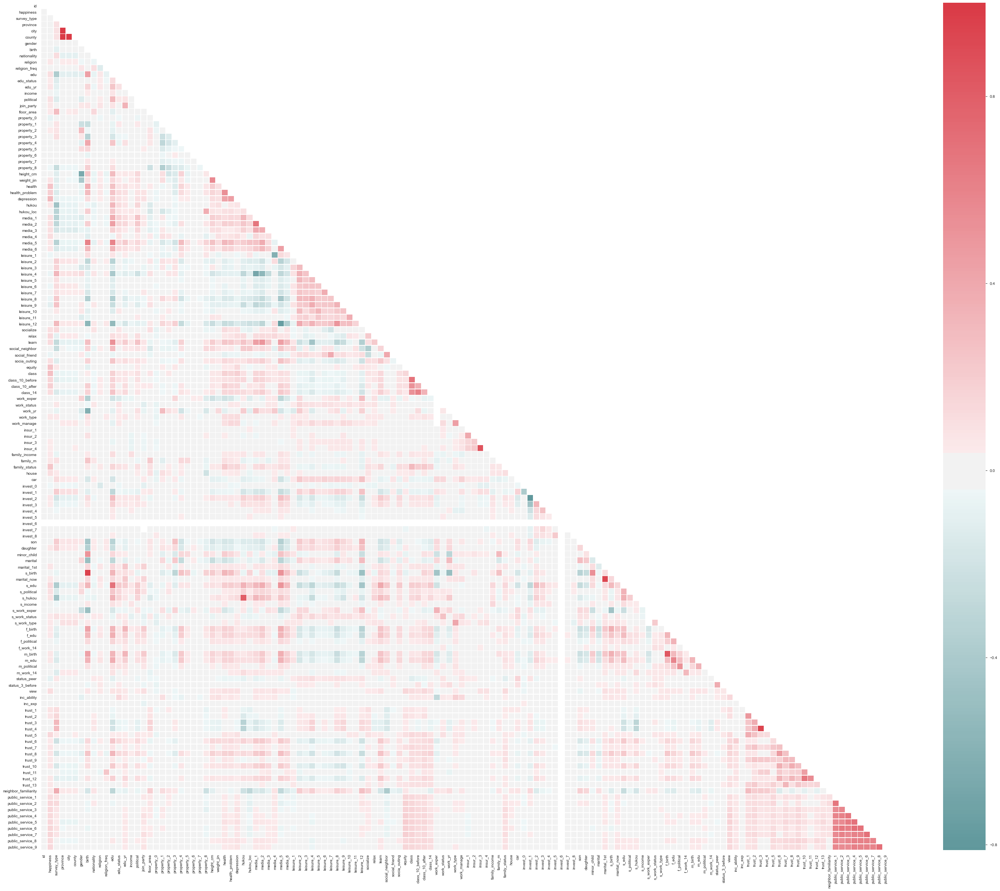

In [3]:
mask = np.zeros_like(train.corr(), dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
cmap = sns.diverging_palette(200, 10, as_cmap=True)

plt.figure(figsize = (50, 40))
sns.heatmap(train.corr(), cmap=cmap, annot=False, fmt='.2f', mask=mask, square=True, linewidths=.5, center=0)

####  训练集和测试集的形状：

In [4]:
print(f"训练集的形状为：{train.shape}" ,f"训练集的形状为：{test.shape}")

训练集的形状为：(8000, 140) 训练集的形状为：(2968, 139)


In [5]:
train.head()

,id,happiness,survey_type,province,city,county,survey_time,gender,birth,nationality,religion,religion_freq,edu,edu_other,edu_status,edu_yr,income,political,join_party,floor_area,property_0,property_1,property_2,property_3,property_4,property_5,property_6,property_7,property_8,property_other,height_cm,weight_jin,health,health_problem,depression,hukou,hukou_loc,media_1,media_2,media_3,media_4,media_5,media_6,leisure_1,leisure_2,leisure_3,leisure_4,leisure_5,leisure_6,leisure_7,leisure_8,leisure_9,leisure_10,leisure_11,leisure_12,socialize,relax,learn,social_neighbor,social_friend,socia_outing,equity,class,class_10_before,class_10_after,class_14,work_exper,work_status,work_yr,work_type,work_manage,insur_1,insur_2,insur_3,insur_4,family_income,family_m,family_status,house,car,invest_0,invest_1,invest_2,invest_3,invest_4,invest_5,invest_6,invest_7,invest_8,invest_other,son,daughter,minor_child,marital,marital_1st,s_birth,marital_now,s_edu,s_political,s_hukou,s_income,s_work_exper,s_work_status,s_work_type,f_birth,f_edu,f_political,f_work_14,m_birth,m_edu,m_political,m_work_14,status_peer,status_3_before,view,inc_ability,inc_exp,trust_1,trust_2,trust_3,trust_4,trust_5,trust_6,trust_7,trust_8,trust_9,trust_10,trust_11,trust_12,trust_13,neighbor_familiarity,public_service_1,public_service_2,public_service_3,public_service_4,public_service_5,public_service_6,public_service_7,public_service_8,public_service_9
0,1,4,1,12,32,59,2015/8/4 14:18,1,1959,1,1,1,11,NaN,4.0,-2.0,20000,1,nan,45.0,0,1,0,0,0,0,0,0,0,NaN,176,155,3,2,5,5,2.0,4,2,5,5,4,3,1,4,3,1,2,3,4,1,4,5,4,1,2,4,3,3.0,3.0,2,3,3,3,3,1,1,3.0,30.0,1.0,2.0,1,1,1,2,6e+04,2,2,1,2,0,1,0,0,0,0,0,0,0,NaN,1,0,0.0,3,1.984e+03,1.958e+03,1.984e+03,6.0,1.0,5.0,4e+04,5.0,nan,nan,-2,4,4,1,-2,4,1,1,3,2,4,3,5e+04,4,2,-8,-8,5,3,2,3,4,3,-8,4,1,4,50,60,50,50,30.0,30,50,50,50
1,2,4,2,18,52,85,2015/7/21 15:04,1,1992,1,1,1,12,NaN,4.0,2.013e+03,20000,1,nan,110.0,0,0,0,0,1,0,0,0,0,NaN,170,110,5,4,3,1,1.0,2,2,1,3,5,1,2,3,4,3,5,4,3,2,3,4,5,1,2,4,3,6.0,2.0,1,3,6,4,8,5,1,3.0,2.0,1.0,3.0,1,1,1,1,4e+04,3,4,1,2,0,1,0,0,0,0,0,0,0,NaN,0,0,nan,1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1972,3,1,2,1973,3,1,2,1,1,4,2,5e+04,5,4,4,3,5,3,3,3,2,3,3,3,2,3,90,70,70,80,85.0,70,90,60,60
2,3,4,2,29,83,126,2015/7/21 13:24,2,1967,1,0,3,4,NaN,4.0,-2.0,2000,1,nan,120.0,0,1,1,0,0,0,0,0,0,NaN,160,122,4,4,5,1,1.0,2,2,2,5,1,3,1,4,4,3,5,4,4,2,3,5,5,5,3,4,2,2.0,5.0,2,4,5,4,6,3,2,nan,nan,nan,nan,1,1,2,2,8e+03,3,3,1,2,0,1,0,0,0,0,0,0,0,NaN,0,2,1.0,3,1.99e+03,1.968e+03,1.99e+03,3.0,1.0,1.0,6e+03,3.0,nan,nan,-2,1,1,2,-2,1,1,2,2,1,4,2,8e+04,3,3,3,3,4,3,3,3,3,3,-8,3,1,4,90,80,75,79,80.0,90,90,90,75
3,4,5,2,10,28,51,2015/7/25 17:33,2,1943,1,1,1,3,NaN,4.0,1.959e+03,6420,1,nan,78.0,0,0,0,1,0,0,0,0,0,NaN,163,170,4,4,4,1,2.0,2,1,1,5,1,1,1,5,2,4,5,4,5,1,1,5,5,5,2,4,4,1.0,6.0,1,4,5,5,7,2,4,nan,nan,nan,nan,2,2,2,2,1.2e+04,3,3,1,1,0,1,0,0,0,0,0,0,0,NaN,1,4,0.0,7,1.96e+03,nan,nan,nan,nan,nan,nan,nan,nan,nan,-2,14,1,2,-2,1,1,2,2,1,3,2,1e+04,3,3,4,3,5,3,3,5,4,3,3,3,2,3,100,90,70,80,80.0,90,90,80,80
4,5,4,1,7,18,36,2015/8/10 9:50,2,1994,1,1,1,12,NaN,1.0,2.014e+03,-1,2,nan,70.0,0,0,0,0,1,0,0,0,0,NaN,165,110,5,5,3,2,3.0,1,3,4,2,5,5,3,3,3,2,4,4,3,5,2,5,5,1,4,3,4,7.0,5.0,3,2,1,1,1,4,6,nan,nan,nan,nan,1,2,2,2,-2.0,4,3,1,1,0,1,0,0,0,0,0,0,0,NaN,0,0,nan,1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1970,6,1,10,1972,4,1,15,3,2,3,-8,2e+05,4,3,3,3,5,5,3,4,3,3,3,3,2,2,50,50,50,50,50.0,50,50,50,50


In [6]:
train["happiness"].value_counts()

 4    4818
 5    1410
 3    1159
 2     497
 1     104
-8      12
Name: happiness, dtype: int64

In [7]:
# 删掉-8的label样本
train = train[train['happiness'] != -8]
train["happiness"].value_counts()

4    4818
5    1410
3    1159
2     497
1     104
Name: happiness, dtype: int64

In [8]:
test['happiness'] = -999
data = train.append(test).reset_index(drop=True)
data.shape

(10956, 140)

In [9]:
data.happiness.value_counts()

 4      4818
-999    2968
 5      1410
 3      1159
 2       497
 1       104
Name: happiness, dtype: int64

In [10]:
# 看看数据缺失值的情况
(data.isnull().sum() / len(data)).sort_values(ascending=False)

edu_other                 0.9995
invest_other              0.9959
property_other            0.9919
join_party                0.8973
s_work_status             0.6788
s_work_type               0.6788
work_status               0.6327
work_yr                   0.6327
work_type                 0.6326
work_manage               0.6326
edu_yr                    0.2514
marital_now               0.2232
s_work_exper              0.2159
s_hukou                   0.2159
s_political               0.2159
s_birth                   0.2159
s_edu                     0.2159
s_income                  0.2159
edu_status                0.1432
minor_child               0.1321
marital_1st                0.103
social_friend                0.1
social_neighbor              0.1
hukou_loc              0.0003651
family_income          9.127e-05
survey_type                  0.0
socialize                    0.0
learn                        0.0
media_3                      0.0
relax                        0.0
media_4   

In [11]:
# 先来处理时间特征
data['survey_time'] = pd.to_datetime(data['survey_time'], format='%Y-%m-%d %H:%M:%S')
data["weekday"] = data["survey_time"].dt.weekday
data["year"] = data["survey_time"].dt.year
#quarter为季节
data["quarter"] = data["survey_time"].dt.quarter
data["hour"] = data["survey_time"].dt.hour
data["month"] = data["survey_time"].dt.month

data.drop("survey_time", axis=1, inplace=True)
# 缺失比例太多了
data.drop("edu_other", axis=1, inplace=True)

def hour_cut(x):
    if 0<=x<6:
        return 0
    elif 6<=x<9:
        return 1
    elif 9<=x<12:
        return 2
    elif 12<=x<15:
        return 3
    elif 15<=x<18:
        return 4
    elif 18<=x<21:
        return 5
    elif 21<=x<24:
        return 6
    
data["hour_cut"] = data["hour"].map(hour_cut)
data["survey_age"] = data["year"] - data["birth"]

In [12]:
(data['income'].value_counts().sort_index() / len(data)).cumsum()

-3         0.01716
-2         0.03103
-1         0.05458
 0          0.2043
 50         0.2044
 60         0.2045
 80         0.2045
 100        0.2051
 200        0.2054
 240        0.2055
 300        0.2056
 385        0.2057
 400        0.2063
 500        0.2088
 540        0.2089
 550         0.209
 600        0.2118
 660        0.2139
 700        0.2149
 720        0.2173
 730        0.2174
 750        0.2177
 760        0.2179
 780        0.2185
 800        0.2207
 840        0.2217
 850        0.2218
 900        0.2233
 940        0.2234
 948        0.2235
 950        0.2236
 960         0.225
 980        0.2251
 1000       0.2391
 1040       0.2392
 1044       0.2393
 1060       0.2394
 1080         0.24
 1100       0.2403
 1120       0.2404
 1140       0.2406
 1200       0.2437
 1220       0.2438
 1260       0.2439
 1300       0.2442
 1400       0.2447
 1408       0.2448
 1440        0.245
 1500        0.249
 1520       0.2491
 1540       0.2492
 1560       0.2493
 1575       

In [13]:
#收入分组
def income_cut(x):
    if x<=0:
        return 0
    elif 0<x<=1600:
        return 1
    # 25%分位数
    elif 1600<x<=10000:
        return 2
    # 45%分位数
    elif 10000<x<=25000:
        return 3
    # 65%分位数
    elif 25000<x<=49200:
        return 4
    # 85%分位数
    elif x>49200:
        return 5
    
data["income_cut"] = data["income"].map(income_cut)

In [14]:
# 将join_party改为是否join_party（nan值代表否）
data["join_party"] = data["join_party"].map(lambda x: 0 if pd.isnull(x) else 1)
#出生的年代
def birth_split(x):
    if 1920<=x<=1930:
        return 0
    elif 1930<x<=1940:
        return 1
    elif 1940<x<=1950:
        return 2
    elif 1950<x<=1960:
        return 3
    elif 1960<x<=1970:
        return 4
    elif 1970<x<=1980:
        return 5
    elif 1980<x<=1990:
        return 6
    elif 1990<x<=2000:
        return 7
    
data["birth_s"] = data["birth"].map(birth_split)

In [15]:
# 统计一下每个样本有多少缺失值，也许越不感觉幸福的人会越比较自卑，不愿意透露更多自己的信息（只是猜测^_^）
data["null_count"] = data.isnull().sum(axis=1)
# 统计一下每个样本有多少特征值为-1（不适用）
data["minus_1_count"] = data.isin([-1]).sum(axis=1)
# 统计一下每个样本有多少特征值为-2（不知道）
data["minus_2_count"] = data.isin([-2]).sum(axis=1)
# 统计一下每个样本有多少特征值为-1（拒绝回答）
data["minus_3_count"] = data.isin([-3]).sum(axis=1)
# 统计一下每个样本有多少特征值为-8（无法回答）
data["minus_8_count"] = data.isin([-8]).sum(axis=1)
data["unknown"] = data["null_count"] + data["minus_1_count"] + data["minus_2_count"] + data["minus_3_count"] + data["minus_8_count"]

In [16]:
data.head()

,id,happiness,survey_type,province,city,county,gender,birth,nationality,religion,religion_freq,edu,edu_status,edu_yr,income,political,join_party,floor_area,property_0,property_1,property_2,property_3,property_4,property_5,property_6,property_7,property_8,property_other,height_cm,weight_jin,health,health_problem,depression,hukou,hukou_loc,media_1,media_2,media_3,media_4,media_5,media_6,leisure_1,leisure_2,leisure_3,leisure_4,leisure_5,leisure_6,leisure_7,leisure_8,leisure_9,leisure_10,leisure_11,leisure_12,socialize,relax,learn,social_neighbor,social_friend,socia_outing,equity,class,class_10_before,class_10_after,class_14,work_exper,work_status,work_yr,work_type,work_manage,insur_1,insur_2,insur_3,insur_4,family_income,family_m,family_status,house,car,invest_0,invest_1,invest_2,invest_3,invest_4,invest_5,invest_6,invest_7,invest_8,invest_other,son,daughter,minor_child,marital,marital_1st,s_birth,marital_now,s_edu,s_political,s_hukou,s_income,s_work_exper,s_work_status,s_work_type,f_birth,f_edu,f_political,f_work_14,m_birth,m_edu,m_political,m_work_14,status_peer,status_3_before,view,inc_ability,inc_exp,trust_1,trust_2,trust_3,trust_4,trust_5,trust_6,trust_7,trust_8,trust_9,trust_10,trust_11,trust_12,trust_13,neighbor_familiarity,public_service_1,public_service_2,public_service_3,public_service_4,public_service_5,public_service_6,public_service_7,public_service_8,public_service_9,weekday,year,quarter,hour,month,hour_cut,survey_age,income_cut,birth_s,null_count,minus_1_count,minus_2_count,minus_3_count,minus_8_count,unknown
0,1,4,1,12,32,59,1,1959,1,1,1,11,4.0,-2.0,20000,1,0,45.0,0,1,0,0,0,0,0,0,0,NaN,176,155,3,2,5,5,2.0,4,2,5,5,4,3,1,4,3,1,2,3,4,1,4,5,4,1,2,4,3,3.0,3.0,2,3,3,3,3,1,1,3.0,30.0,1.0,2.0,1,1,1,2,6e+04,2,2,1,2,0,1,0,0,0,0,0,0,0,NaN,1,0,0.0,3,1.984e+03,1.958e+03,1.984e+03,6.0,1.0,5.0,4e+04,5.0,nan,nan,-2,4,4,1,-2,4,1,1,3,2,4,3,5e+04,4,2,-8,-8,5,3,2,3,4,3,-8,4,1,4,50,60.0,50,50,30.0,30,50,50,50,1,2015,3,14,8,3,56,3,3,4,0,3,0,3,10
1,2,4,2,18,52,85,1,1992,1,1,1,12,4.0,2.013e+03,20000,1,0,110.0,0,0,0,0,1,0,0,0,0,NaN,170,110,5,4,3,1,1.0,2,2,1,3,5,1,2,3,4,3,5,4,3,2,3,4,5,1,2,4,3,6.0,2.0,1,3,6,4,8,5,1,3.0,2.0,1.0,3.0,1,1,1,1,4e+04,3,4,1,2,0,1,0,0,0,0,0,0,0,NaN,0,0,nan,1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1972,3,1,2,1973,3,1,2,1,1,4,2,5e+04,5,4,4,3,5,3,3,3,2,3,3,3,2,3,90,70.0,70,80,85.0,70,90,60,60,1,2015,3,15,7,4,23,3,7,13,0,0,0,0,13
2,3,4,2,29,83,126,2,1967,1,0,3,4,4.0,-2.0,2000,1,0,120.0,0,1,1,0,0,0,0,0,0,NaN,160,122,4,4,5,1,1.0,2,2,2,5,1,3,1,4,4,3,5,4,4,2,3,5,5,5,3,4,2,2.0,5.0,2,4,5,4,6,3,2,nan,nan,nan,nan,1,1,2,2,8e+03,3,3,1,2,0,1,0,0,0,0,0,0,0,NaN,0,2,1.0,3,1.99e+03,1.968e+03,1.99e+03,3.0,1.0,1.0,6e+03,3.0,nan,nan,-2,1,1,2,-2,1,1,2,2,1,4,2,8e+04,3,3,3,3,4,3,3,3,3,3,-8,3,1,4,90,80.0,75,79,80.0,90,90,90,75,1,2015,3,13,7,3,48,2,4,8,0,3,0,1,12
3,4,5,2,10,28,51,2,1943,1,1,1,3,4.0,1.959e+03,6420,1,0,78.0,0,0,0,1,0,0,0,0,0,NaN,163,170,4,4,4,1,2.0,2,1,1,5,1,1,1,5,2,4,5,4,5,1,1,5,5,5,2,4,4,1.0,6.0,1,4,5,5,7,2,4,nan,nan,nan,nan,2,2,2,2,1.2e+04,3,3,1,1,0,1,0,0,0,0,0,0,0,NaN,1,4,0.0,7,1.96e+03,nan,nan,nan,nan,nan,nan,nan,nan,nan,-2,14,1,2,-2,1,1,2,2,1,3,2,1e+04,3,3,4,3,5,3,3,5,4,3,3,3,2,3,100,90.0,70,80,80.0,90,90,80,80,5,2015,3,17,7,4,72,2,2,15,0,2,0,0,17
4,5,4,1,7,18,36,2,1994,1,1,1,12,1.0,2.014e+03,-1,2,0,70.0,0,0,0,0,1,0,0,0,0,NaN,165,110,5,5,3,2,3.0,1,3,4,2,5,5,3,3,3,2,4,4,3,5,2,5,5,1,4,3,4,7.0,5.0,3,2,1,1,1,4,6,nan,nan,nan,nan,1,2,2,2,-2.0,4,3,1,1,0,1,0,0,0,0,0,0,0,NaN,0,0,nan,1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1970,6,1,10,1972,4,1,15,3,2,3,-8,2e+05,4,3,3,3,5,5,3,4,3,3,3,3,2,2,50,50.0,50,50,50.0,50,50,50,50,0,2015,3,9,8,2,21,0,7,17,1,1,0,1,20


In [17]:
(data['inc_exp'].value_counts().sort_index() / len(data)).cumsum()

-3.0        0.01552
-2.0         0.1364
0.0          0.1373
1.0          0.1374
2.0          0.1376
3.0          0.1379
4.0          0.1382
5.0          0.1389
6.0          0.1396
7.0          0.1396
8.0          0.1398
10.0         0.1407
12.0         0.1408
20.0         0.1415
30.0         0.1417
60.0          0.142
150.0        0.1421
200.0        0.1422
300.0        0.1425
500.0         0.143
600.0        0.1431
700.0        0.1433
900.0        0.1435
1e+03        0.1471
1.2e+03      0.1474
1.4e+03      0.1475
1.5e+03      0.1488
1.698e+03    0.1489
1.8e+03      0.1491
2e+03        0.1546
2.3e+03      0.1547
2.4e+03      0.1549
2.5e+03      0.1554
2.7e+03      0.1555
2.72e+03     0.1556
3e+03        0.1669
3.5e+03      0.1676
3.6e+03       0.168
3.65e+03     0.1682
3.7e+03      0.1683
3.8e+03      0.1684
4e+03        0.1733
4.1e+03      0.1734
4.32e+03     0.1735
4.5e+03       0.174
4.8e+03      0.1742
5e+03        0.1917
5.5e+03       0.192
6e+03        0.1978
6.5e+03      0.1979


In [18]:
#期望收入分组
def inc_exp_cut(x):
    if x<=0:
        return 0
    elif 0<x<=9.6e+03:
        return 1
    # 25%分位数
    elif 9.6e+03<x<=2.88e+04:
        return 2
    # 45%分位数
    elif 2.88e+04<x<=5.88e+04:
        return 3
    # 65%分位数
    elif 5.88e+04<x<=1e+05:
        return 4
    # 85%分位数
    elif x>1e+05:
        return 5
    
data["inc_exp_cut"] = data["inc_exp"].map(inc_exp_cut)

In [19]:
# 没什么和edu_status相关的特征
data.corr()["edu_status"].sort_values(ascending=False)

edu_status                    1.0
s_edu                      0.2082
income_cut                 0.1868
media_1                    0.1441
s_hukou                    0.1436
inc_ability                0.1296
edu                        0.1285
trust_6                    0.1285
trust_8                    0.1281
media_2                    0.1199
media_5                    0.1157
s_political                0.1026
edu_yr                     0.1019
hukou                      0.1007
learn                     0.08687
s_birth                   0.08365
inc_exp_cut               0.08306
health_problem            0.08091
media_6                   0.07896
hukou_loc                 0.07578
join_party                0.07525
view                      0.06765
media_3                   0.06681
m_edu                     0.06292
m_birth                   0.06182
depression                0.05844
f_edu                     0.05773
family_status             0.05769
invest_2                  0.05653
f_birth       

In [20]:
#edu_status的缺失值以一个新的值5来代替
data["edu_status"] = data["edu_status"].fillna(5)

In [21]:
# 没什么和edu_yr相关的特征
data.corr()["edu_yr"].sort_values(ascending=False)

edu_yr                        1.0
f_birth                    0.3189
m_birth                    0.3175
marital_1st                0.2379
edu                        0.2337
marital_now                0.2187
media_5                    0.1999
f_edu                      0.1901
learn                      0.1894
s_edu                      0.1842
m_edu                      0.1792
birth                      0.1541
birth_s                    0.1505
inc_exp_cut                0.1365
trust_12                   0.1304
media_2                    0.1271
trust_8                    0.1209
class_14                   0.1153
class_10_after             0.1125
trust_10                    0.111
socia_outing               0.1105
media_1                    0.1047
s_birth                    0.1038
edu_status                 0.1019
income_cut                 0.1016
media_6                   0.09641
property_4                0.09304
trust_6                   0.08975
political                 0.08749
health_problem

In [22]:
#edu_yr的缺失值以-2（不知道）来代替
data["edu_yr"] = data["edu_yr"].fillna(-2)

In [23]:
# 没什么和hukou_loc相关的特征
data.corr()["hukou_loc"].sort_values(ascending=False)

hukou_loc                    1.0
property_8                0.3846
media_5                    0.256
edu                       0.2282
social_neighbor           0.1995
s_edu                     0.1983
birth                     0.1836
birth_s                   0.1785
month                     0.1738
quarter                   0.1702
inc_exp_cut               0.1685
income_cut                0.1602
s_birth                   0.1539
learn                     0.1495
media_2                   0.1494
edu_yr                    0.1473
socia_outing              0.1313
media_6                     0.13
media_1                   0.1168
health_problem            0.1151
invest_2                   0.115
s_hukou                   0.1125
trust_6                   0.1093
f_edu                     0.1048
health                    0.1028
hukou                     0.1027
trust_8                  0.09641
m_edu                    0.09589
trust_10                 0.09472
media_3                  0.09301
f_birth   

In [24]:
#hukou_loc的缺失值以绝大部分的1来代替
data["hukou_loc"] = data["hukou_loc"].fillna(1)

In [25]:
# 没什么和family_income相关的特征
data.corr()["family_income"].sort_values(ascending=False)

family_income                1.0
s_edu                     0.1174
edu                       0.1022
income                    0.1018
income_cut                0.1012
s_income                 0.09871
invest_2                  0.0957
media_5                  0.09322
invest_3                 0.08222
class                    0.07938
learn                    0.07782
inc_exp_cut              0.07387
socia_outing             0.07154
s_hukou                  0.07154
family_status            0.07055
invest_8                 0.06946
invest_4                 0.06757
media_2                  0.06692
hukou                    0.06612
media_6                  0.06393
health_problem           0.05931
media_1                  0.05817
class_14                 0.05771
health                   0.05683
edu_yr                   0.05004
class_10_before          0.04952
f_edu                    0.04918
house                    0.04914
class_10_after           0.04724
month                    0.04714
s_birth   

In [26]:
#family_income的缺失值以-2（不知道）来代替
data["family_income"] = data["family_income"].fillna(-2)

In [27]:
#找突然变化大的分割点
(data['family_income'].value_counts().sort_index() / len(data)).cumsum()

-3.0        0.02674
-2.0        0.07977
-1.0        0.08425
0.0          0.1007
200.0        0.1009
300.0         0.101
400.0        0.1013
450.0        0.1014
500.0        0.1019
600.0        0.1027
660.0        0.1029
700.0         0.103
720.0        0.1032
750.0        0.1033
780.0        0.1034
800.0        0.1039
840.0         0.104
900.0        0.1042
950.0        0.1043
960.0        0.1045
1e+03        0.1085
1.04e+03     0.1086
1.08e+03     0.1088
1.1e+03      0.1089
1.12e+03      0.109
1.2e+03      0.1105
1.22e+03     0.1107
1.3e+03      0.1111
1.32e+03     0.1113
1.4e+03      0.1116
1.44e+03     0.1117
1.5e+03       0.113
1.56e+03     0.1133
1.58e+03     0.1134
1.6e+03      0.1135
1.68e+03     0.1136
1.7e+03      0.1138
1.8e+03      0.1143
1.9e+03      0.1144
2e+03        0.1228
2.06e+03     0.1229
2.088e+03    0.1229
2.1e+03       0.123
2.16e+03     0.1231
2.2e+03      0.1233
2.32e+03     0.1234
2.4e+03      0.1242
2.44e+03     0.1243
2.5e+03      0.1251
2.6e+03      0.1253


In [28]:
#家庭收入分组
def family_income_cut(x):
    if x<=0:
        return 0
    elif 0<x<=1.29e+04:
        return 1
    # 25%分位数
    elif 1.29e+04<x<=2.94e+04:
        return 2
    # 45%分位数
    elif 2.94e+04<x<=4.944e+04:
        return 3
    # 65%分位数
    elif 4.944e+04<x<=9.8e+04:
        return 4
    # 85%分位数
    elif x>9.8e+04:
        return 5
    
data["family_income_cut"] = data["family_income"].map(family_income_cut)

In [32]:
# 将缺失值以一个新的值8代替
data["social_neighbor"].fillna(8, inplace=True)
data["social_friend"].fillna(8, inplace=True)
# 将缺失值以一个新的值0代替
data["work_status"].fillna(0, inplace=True)
data["work_yr"].fillna(0, inplace=True)
data["work_type"].fillna(0, inplace=True)
data["work_manage"].fillna(0, inplace=True)

In [33]:
data.isnull().sum()

id                          0
happiness                   0
survey_type                 0
province                    0
city                        0
county                      0
gender                      0
birth                       0
nationality                 0
religion                    0
religion_freq               0
edu                         0
edu_status                  0
edu_yr                      0
income                      0
political                   0
join_party                  0
floor_area                  0
property_0                  0
property_1                  0
property_2                  0
property_3                  0
property_4                  0
property_5                  0
property_6                  0
property_7                  0
property_8                  0
property_other          10867
height_cm                   0
weight_jin                  0
health                      0
health_problem              0
depression                  0
hukou     

In [34]:
# 财产总情况
data["property"] = 0
for i in range(8):
    data["property"] += data[f"property_{i}"]
# 是否有财产
data["is_property"] = data["property"].apply(lambda x: 1 if x>0 else 0)
# 媒体平均情况
data["media_mean"] = 0
for i in range(1, 6):
    data["media_mean"] += data[f"media_{i}"] / 5
# 休闲活动平均情况
data["leisure_mean"] = 0
for i in range(1, 13):
    data["leisure_mean"] += data[f"leisure_{i}"] / 12
# 参与保险平均情况 
data["insur_mean"] = 0
for i in range(1, 5):
    data["insur_mean"] += data[f"insur_{i}"] / 4
# 投资总情况    
data["invest"] = 0
for i in range(9):
    data["invest"] += data[f"invest_{i}"]
# 是否投资
data["is_invest"] = data["invest"].apply(lambda x: 1 if x>0 else 0)
# 社会信任平均情况
data["trust_mean"] = 0
for i in range(1, 14):
    data["trust_mean"] += data[f"trust_{i}"] / 13
# 社会服务总体打分
data["public_service_mean"] = 0
for i in range(1, 10):
    data["public_service_mean"] += data[f"public_service_{i}"] / 9

bins = [-100, 60, 70, 80, 90, 101]
data["public_service_cut"] = pd.cut(data["public_service_mean"], bins=bins, labels=[1, 2, 3, 4, 5], right=False)
data["public_service_cut"] = data["public_service_cut"].astype(np.int64)

In [ ]:
(data['media_mean'].value_counts().sort_index() / len(data)).cumsum()

In [ ]:
def media_mean_cut(x):
    if x<=1.8:
        return 0
    elif 1.8<x<=2.6:
        return 1
    else:
        return 2
data['media_mean_cut'] = data['media_mean'].map(media_mean_cut)

In [ ]:
(data['leisure_mean'].value_counts().sort_index() / len(data)).cumsum()

In [ ]:
def leisure_mean_cut(x):
    if x<3.8:
        return 0
    else:
        return 1
data['leisure_mean_cut'] = data['leisure_mean'].map(leisure_mean_cut)

In [ ]:
(data['insur_mean'].value_counts().sort_index() / len(data)).cumsum()

In [ ]:
def insur_mean_cut(x):
    if x<1.5:
        return 0
    else:
        return 1
data['insur_mean_cut'] = data['insur_mean'].map(insur_mean_cut)

In [ ]:
(data['trust_mean'].value_counts().sort_index() / len(data)).cumsum()

In [ ]:
def trust_mean_cut(x):
    if x<=0.6923:
        return 0
    elif 0.6923<x<=2.308:
        return 1
    elif 2.308<x<=3.231:
        return 2
    elif x>3.231:
        return 3
data['trust_mean_cut'] = data['trust_mean'].map(trust_mean_cut)

In [35]:
# 看一下还有没有缺失值
data.isnull().sum()

id                          0
happiness                   0
survey_type                 0
province                    0
city                        0
county                      0
gender                      0
birth                       0
nationality                 0
religion                    0
religion_freq               0
edu                         0
edu_status                  0
edu_yr                      0
income                      0
political                   0
join_party                  0
floor_area                  0
property_0                  0
property_1                  0
property_2                  0
property_3                  0
property_4                  0
property_5                  0
property_6                  0
property_7                  0
property_8                  0
property_other          10867
height_cm                   0
weight_jin                  0
health                      0
health_problem              0
depression                  0
hukou     

In [36]:
# property_other和invest_other缺失太多了，直接删除
del data["property_other"]
del data["invest_other"]

In [37]:
data["minor_child"].fillna(0, inplace=True)
data["child"] = data["son"] + data["daughter"]
# 未成年子女率（比例型新特征）
data["minor_child_rate"] = data["minor_child"] / (data["child"] + 0.00001)

In [38]:
# 婚姻这部分删掉吧
data["marital_1st"].fillna(0, inplace=True)
data["marital_now"].fillna(0, inplace=True)

In [39]:
data.corr()["s_edu"].sort_values(ascending=False)

s_edu                        1.0
edu                       0.6839
media_5                   0.5032
media_mean                0.4582
learn                     0.3798
family_income_cut         0.3707
edu_yr                    0.3603
media_2                   0.3581
s_hukou                   0.3537
hukou                     0.3375
s_political               0.3364
income_cut                0.3238
birth                     0.3234
birth_s                   0.3148
media_1                   0.3094
s_birth                   0.3048
invest_2                  0.2934
m_edu                     0.2918
f_edu                     0.2792
media_6                   0.2746
work_status               0.2672
inc_exp_cut                0.259
f_birth                   0.2446
m_birth                   0.2442
work_yr                   0.2352
minor_child_rate          0.2271
work_manage               0.2239
class_14                  0.2196
trust_8                   0.2184
invest_3                  0.2182
join_party

In [40]:
imputer = KNNImputer(n_neighbors=100)

In [41]:
s_edu = ['s_edu', 'edu']
data[s_edu] = imputer.fit_transform(data[s_edu])
data['s_edu'] = data['s_edu'].apply(round)

In [42]:
# 相关不高的直接以新的值0来填充
data["s_political"].fillna(0, inplace=True)

In [44]:
data.isnull().sum()

id                         0
happiness                  0
survey_type                0
province                   0
city                       0
county                     0
gender                     0
birth                      0
nationality                0
religion                   0
religion_freq              0
edu                        0
edu_status                 0
edu_yr                     0
income                     0
political                  0
join_party                 0
floor_area                 0
property_0                 0
property_1                 0
property_2                 0
property_3                 0
property_4                 0
property_5                 0
property_6                 0
property_7                 0
property_8                 0
height_cm                  0
weight_jin                 0
health                     0
health_problem             0
depression                 0
hukou                      0
hukou_loc                  0
media_1       

In [43]:
data.corr()["s_birth"].sort_values(ascending=False)

s_birth                      1.0
birth                     0.9516
birth_s                    0.933
minor_child_rate          0.5895
media_5                   0.5238
minor_child               0.4774
f_birth                   0.3656
m_birth                   0.3649
work_status               0.3606
work_manage               0.3564
inc_exp_cut               0.3324
edu                        0.332
health                    0.3314
s_edu                     0.3048
edu_yr                    0.2831
health_problem            0.2794
m_edu                     0.2671
property_4                0.2622
media_6                    0.261
family_m                   0.248
f_edu                     0.2452
work_type                 0.2375
height_cm                 0.2072
family_income_cut         0.1991
trust_8                   0.1984
work_yr                   0.1968
property_5                0.1932
media_mean                0.1925
property_8                0.1801
class_10_after            0.1619
learn     

In [45]:
birth_list = ["s_birth", "birth", "birth_s", "survey_age"]
data[birth_list] = imputer.fit_transform(data[birth_list])
data["s_birth"] = data["s_birth"].map(np.round)

In [46]:
data["s_birth"].value_counts()

1.99e+03     547
1.989e+03    344
1.965e+03    299
1.963e+03    291
1.955e+03    282
1.962e+03    260
1.969e+03    252
1.97e+03     247
1.967e+03    246
1.953e+03    245
1.952e+03    241
1.972e+03    238
1.954e+03    238
1.964e+03    237
1.949e+03    233
1.975e+03    227
1.968e+03    225
1.947e+03    223
1.957e+03    219
1.958e+03    210
1.966e+03    206
1.985e+03    202
1.951e+03    198
1.956e+03    194
1.971e+03    191
1.96e+03     184
1.974e+03    177
1.95e+03     174
1.986e+03    170
1.943e+03    167
1.978e+03    164
1.987e+03    162
1.973e+03    161
1.981e+03    160
1.98e+03     160
1.959e+03    158
1.982e+03    157
1.944e+03    157
1.988e+03    152
1.976e+03    151
1.979e+03    148
1.977e+03    146
1.948e+03    131
1.939e+03    128
1.937e+03    128
1.984e+03    125
1.983e+03    115
1.961e+03    115
1.946e+03    115
1.945e+03    108
1.941e+03    103
1.94e+03     102
1.936e+03     96
1.942e+03     92
1.938e+03     91
1.935e+03     91
1.934e+03     70
1.933e+03     69
1.991e+03     

In [47]:
data.corr()["s_hukou"].sort_values(ascending=False)

s_hukou                      1.0
hukou                     0.7998
s_edu                     0.3537
media_mean                0.3354
edu                        0.334
media_1                   0.3126
learn                     0.2619
income_cut                0.2582
family_income_cut         0.2549
media_2                   0.2525
media_5                   0.2234
s_political               0.2085
media_3                   0.1955
invest_2                  0.1892
edu_yr                     0.182
work_yr                   0.1765
join_party                 0.175
social_neighbor           0.1693
trust_6                   0.1591
political                 0.1559
month                     0.1525
class_10_before           0.1494
trust_10                  0.1449
quarter                   0.1374
relax                     0.1338
invest_3                  0.1276
media_6                   0.1255
class_14                  0.1224
trust_8                   0.1201
m_work_14                 0.1191
class     

In [48]:
hukou_list = ["s_hukou", "hukou"]
data[hukou_list] = imputer.fit_transform(data[hukou_list])
data["s_hukou"] = data["s_hukou"].map(np.round)

In [50]:
# 这些都没有太高的相关性，就用0来填充
data["s_income"].fillna(0, inplace=True)
data["s_work_exper"].fillna(0, inplace=True)
data["s_work_status"].fillna(0, inplace=True)
data["s_work_type"].fillna(0, inplace=True)

In [51]:
data.isnull().sum()

id                      0
happiness               0
survey_type             0
province                0
city                    0
county                  0
gender                  0
birth                   0
nationality             0
religion                0
religion_freq           0
edu                     0
edu_status              0
edu_yr                  0
income                  0
political               0
join_party              0
floor_area              0
property_0              0
property_1              0
property_2              0
property_3              0
property_4              0
property_5              0
property_6              0
property_7              0
property_8              0
height_cm               0
weight_jin              0
health                  0
health_problem          0
depression              0
hukou                   0
hukou_loc               0
media_1                 0
media_2                 0
media_3                 0
media_4                 0
media_5     

In [52]:
# 身体情况BMI指数
data["BMI"] = (data["weight_jin"]/2) / ((data["height_cm"]/100) * (data["height_cm"]/100))
data["BMI"]

0       25.02
1       19.03
2       23.83
3       31.99
4        20.2
5       23.66
6       23.44
7        22.6
8       15.51
9       23.66
10      18.37
11      20.05
12      20.52
13      23.63
14      17.57
15      27.03
16      22.86
17      18.73
18      23.36
19      26.12
20      23.88
21      23.44
22      18.97
23      20.28
24      11.94
25      20.55
26       24.3
27      28.04
28      20.16
29      19.49
30      24.96
31      16.33
32      20.76
33      17.36
34      17.78
35      25.35
36      19.28
37      22.55
38      23.44
39      20.51
40      21.01
41      23.83
42      21.91
43      22.74
44      21.87
45      21.51
46      21.63
47      24.41
48      20.41
49      22.49
50      20.81
51      24.57
52      20.76
53      23.15
54      27.34
55      27.68
56      25.39
57      25.04
58      26.37
59      28.57
60      18.52
61      26.71
62      24.86
63      23.24
64       20.9
65      18.89
66      18.37
67      18.94
68      21.48
69      28.04
70      24.84
71    

In [53]:
# 18.5-23.9
def BMI_cut(x):
    if x<=18:
        return 0
    elif 18<x<=25:
        return 1
    elif x>25:
        return 2
data["BMI_cut"] = data["BMI"].map(BMI_cut)

In [82]:
data.head(10)

,id,happiness,survey_type,province,city,county,gender,birth,nationality,religion,religion_freq,edu,edu_status,edu_yr,income,political,join_party,floor_area,property_0,property_1,property_2,property_3,property_4,property_5,property_6,property_7,property_8,height_cm,weight_jin,health,health_problem,depression,hukou,hukou_loc,media_1,media_2,media_3,media_4,media_5,media_6,leisure_1,leisure_2,leisure_3,leisure_4,leisure_5,leisure_6,leisure_7,leisure_8,leisure_9,leisure_10,leisure_11,leisure_12,socialize,relax,learn,social_neighbor,social_friend,socia_outing,equity,class,class_10_before,class_10_after,class_14,work_exper,work_status,work_yr,work_type,work_manage,insur_1,insur_2,insur_3,insur_4,family_income,family_m,family_status,house,car,invest_0,invest_1,invest_2,invest_3,invest_4,invest_5,invest_6,invest_7,invest_8,son,daughter,minor_child,marital,marital_1st,s_birth,marital_now,s_edu,s_political,s_hukou,s_income,s_work_exper,s_work_status,s_work_type,f_birth,f_edu,f_political,f_work_14,m_birth,m_edu,m_political,m_work_14,status_peer,status_3_before,view,inc_ability,inc_exp,trust_1,trust_2,trust_3,trust_4,trust_5,trust_6,trust_7,trust_8,trust_9,trust_10,trust_11,trust_12,trust_13,neighbor_familiarity,public_service_1,public_service_2,public_service_3,public_service_4,public_service_5,public_service_6,public_service_7,public_service_8,public_service_9,weekday,year,quarter,hour,month,hour_cut,survey_age,income_cut,birth_s,null_count,minus_1_count,minus_2_count,minus_3_count,minus_8_count,unknown,inc_exp_cut,family_income_cut,property,is_property,media_mean,leisure_mean,insur_mean,invest,is_invest,trust_mean,public_service_mean,public_service_cut,child,minor_child_rate,BMI,BMI_cut
0,1,4,1,12,32,59,1,1.959e+03,1,1,1,11.0,4.0,-2.0,20000,1,0,45.0,0,1,0,0,0,0,0,0,0,176,155,3,2,5,5.0,2.0,4,2,5,5,4,3,1,4,3,1,2,3,4,1,4,5,4,1,2,4,3,3.0,3.0,2,3,3,3,3,1,1,3.0,30.0,1.0,2.0,1,1,1,2,6e+04,2,2,1,2,0,1,0,0,0,0,0,0,0,1,0,0.0,3,1.984e+03,1.958e+03,1.984e+03,6,1.0,5.0,4e+04,5.0,0.0,0.0,-2,4,4,1,-2,4,1,1,3,2,4,3,5e+04,4,2,-8,-8,5,3,2,3,4,3,-8,4,1,4,50,60.0,50,50,30.0,30,50,50,50,1,2015,3,14,8,3,56.0,3,3.0,4,0,3,0,3,10,3,4,1,1,4.0,2.75,1.25,1,1,0.5385,46.67,1,1,0.0,25.02,2
1,2,4,2,18,52,85,1,1.992e+03,1,1,1,12.0,4.0,2.013e+03,20000,1,0,110.0,0,0,0,0,1,0,0,0,0,170,110,5,4,3,1.0,1.0,2,2,1,3,5,1,2,3,4,3,5,4,3,2,3,4,5,1,2,4,3,6.0,2.0,1,3,6,4,8,5,1,3.0,2.0,1.0,3.0,1,1,1,1,4e+04,3,4,1,2,0,1,0,0,0,0,0,0,0,0,0,0.0,1,0.0,1.989e+03,0.0,10,0.0,1.0,0.0,0.0,0.0,0.0,1972,3,1,2,1973,3,1,2,1,1,4,2,5e+04,5,4,4,3,5,3,3,3,2,3,3,3,2,3,90,70.0,70,80,85.0,70,90,60,60,1,2015,3,15,7,4,23.0,3,7.0,13,0,0,0,0,13,3,3,1,1,2.6,3.25,1.0,1,1,3.308,75.0,3,0,0.0,19.03,1
2,3,4,2,29,83,126,2,1.967e+03,1,0,3,4.0,4.0,-2.0,2000,1,0,120.0,0,1,1,0,0,0,0,0,0,160,122,4,4,5,1.0,1.0,2,2,2,5,1,3,1,4,4,3,5,4,4,2,3,5,5,5,3,4,2,2.0,5.0,2,4,5,4,6,3,2,0.0,0.0,0.0,0.0,1,1,2,2,8e+03,3,3,1,2,0,1,0,0,0,0,0,0,0,0,2,1.0,3,1.99e+03,1.968e+03,1.99e+03,3,1.0,1.0,6e+03,3.0,0.0,0.0,-2,1,1,2,-2,1,1,2,2,1,4,2,8e+04,3,3,3,3,4,3,3,3,3,3,-8,3,1,4,90,80.0,75,79,80.0,90,90,90,75,1,2015,3,13,7,3,48.0,2,4.0,8,0,3,0,1,12,4,1,2,1,2.4,3.75,1.5,1,1,2.077,83.22,4,2,0.5,23.83,1
3,4,5,2,10,28,51,2,1.943e+03,1,1,1,3.0,4.0,1.959e+03,6420,1,0,78.0,0,0,0,1,0,0,0,0,0,163,170,4,4,4,1.0,2.0,2,1,1,5,1,1,1,5,2,4,5,4,5,1,1,5,5,5,2,4,4,1.0,6.0,1,4,5,5,7,2,4,0.0,0.0,0.0,0.0,2,2,2,2,1.2e+04,3,3,1,1,0,1,0,0,0,0,0,0,0,1,4,0.0,7,1.96e+03,1.944e+03,0.0,3,0.0,1.0,0.0,0.0,0.0,0.0,-2,14,1,2,-2,1,1,2,2,1,3,2,1e+04,3,3,4,3,5,3,3,5,4,3,3,3,2,3,100,90.0,70,80,80.0,90,90,80,80,5,2015,3,17,7,4,72.0,2,2.0,15,0,2,0,0,17,2,1,1,1,2.0,3.583,2.0,1,1,3.385,84.44,4,5,0.0,31.99,2
4,5,4,1,7,18,36,2,1.994e+03,1,1,1,12.0,1.0,2.014e+03,-1,2,0,70.0,0,0,0,0,1,0,0,0,0,165,110,5,5,3,2.0,3.0,1,3,4,2,5,5,3,3,3,2,4,4,3,5,2,5,5,1,4,3,4,7.0,5.0,3,2,1,1,1,4,6,0.0,0.0,0.0,0.0,1,2,2,2,-2.0,4,3,1,1,0,1,0,0,0,0,0,0,0,0,0,0.0,1,0.0,1.99e+03,0.0,10,0.0,2.0,0.0,0.0,0.0,0.0,1970,6,1,10,1972,4,1,15,3,2,3,-8,2e+05,4,3,3,3,5,5,3,4,3,3,3,3,2,2,50,50.0,50,50,50.0,50,50,50,50,0,2015,3,9,

In [83]:
drop_list = ["id", "invest_6", 'property_0', 'property_1',
             'property_2', 'property_3', 'property_4', 'property_5',
             'property_6', 'property_7', 'property_8', 'invest_0',
             'invest_1', 'invest_2', 'invest_3', 'invest_4',
             'invest_5', 'invest_6', 'invest_7', 'invest_8',
             'trust_11', 'trust_12']

data.to_csv("mined_data_20200918.csv", index=False)
cleaned_data = data.drop(drop_list, axis=1)
cleaned_data.to_csv("cleaned_data_20200918.csv", index=False)

In [84]:
final_data = pd.read_csv("cleaned_data_20200918.csv")

In [ ]:
#cleaned_data.drop(['id', 'invest_6'], axis=1, inplace=True)

In [57]:
final_data.dtypes

id                        int64
happiness                 int64
survey_type               int64
province                  int64
city                      int64
county                    int64
gender                    int64
birth                   float64
nationality               int64
religion                  int64
religion_freq             int64
edu                     float64
edu_status              float64
edu_yr                  float64
income                    int64
political                 int64
join_party                int64
floor_area              float64
property_0                int64
property_1                int64
property_2                int64
property_3                int64
property_4                int64
property_5                int64
property_6                int64
property_7                int64
property_8                int64
height_cm                 int64
weight_jin                int64
health                    int64
health_problem            int64
depressi

* 回归：lightgbm, xgboost, catboost

In [85]:
# 还原训练集与测试集
train = final_data[final_data["happiness"]!=-999].drop("happiness", axis=1)
label = final_data[final_data["happiness"]!=-999]["happiness"]
test = final_data[final_data["happiness"]==-999].drop("happiness", axis=1)
print(train.shape)
print(label.shape)
print(test.shape)

(7988, 145)
(7988,)
(2968, 145)


* xgboost模型

In [86]:
%%time
# 自定义mse的eval_metirc
def mse(pred, dtrain):
    labels = dtrain.get_label()
    return "mse", mean_squared_error(labels, pred)

def xgb_bayesian(n_estimators, 
                 max_depth, 
                 learning_rate,
                 gamma,
                 min_child_weight, 
                 subsample, 
                 colsample_bytree,
                 reg_alpha,
                 reg_lambda):
    n_estimators = int(n_estimators)
    max_depth = int(max_depth)

    xgb_model = xgb.XGBRegressor(n_estimators=n_estimators,
                                 max_depth=max_depth,
                                 learning_rate=learning_rate,
                                 gamma=gamma,
                                 min_child_weight=min_child_weight,
                                 subsample=subsample,
                                 colsample_bytree=colsample_bytree,
                                 reg_alpha=reg_alpha,
                                 reg_lambda=reg_lambda,
                                 n_jobs=-1,
                                 random_state=927)
    
    
    
    cv = KFold(n_splits=5, shuffle=True, random_state=927)
    # 为了后面的stacking做准备
    oof_xgb = np.zeros(len(train))
    for train_idx, val_idx in cv.split(train, label):
        train_x = train.iloc[train_idx]
        train_y = label.iloc[train_idx]
        val_x = train.iloc[val_idx]
        val_y = label.iloc[val_idx]
    
        xgb_model.fit(train_x, train_y, 
                      eval_set=[(val_x, val_y)], 
                      eval_metric=mse, 
                      early_stopping_rounds=100)
    
        oof_xgb[val_idx] = xgb_model.predict(val_x)
    mse_error = mean_squared_error(label.values, oof_xgb)

    return -mse_error

xgb_bounds = {'n_estimators': (100, 3000),
              'max_depth': (3, 12),
              'learning_rate': (0.001, 0.1),
              'gamma': (0, 1),
              'min_child_weight': (0, 100), 
              'subsample': (0.5, 1), 
              'colsample_bytree': (0.5, 1),
              'reg_alpha': (0, 10),
              'reg_lambda': (0, 10)
             }

xgb_bo = BayesianOptimization(xgb_bayesian, xgb_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    xgb_bo.maximize(init_points=10, n_iter=30)

|   iter    |  target   | colsam... |   gamma   | learni... | max_depth | min_ch... | n_esti... | reg_alpha | reg_la... | subsample |
-------------------------------------------------------------------------------------------------------------------------------------
[0]	validation_0-rmse:3.29512	validation_0-mse:10.85781
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.11908	validation_0-mse:9.72865
[2]	validation_0-rmse:2.95285	validation_0-mse:8.71931
[3]	validation_0-rmse:2.79688	validation_0-mse:7.82247
[4]	validation_0-rmse:2.65039	validation_0-mse:7.02456
[5]	validation_0-rmse:2.51286	validation_0-mse:6.31449
[6]	validation_0-rmse:2.38455	validation_0-mse:5.68609
[7]	validation_0-rmse:2.26345	validation_0-mse:5.12319
[8]	validation_0-rmse:2.15013	validation_0-mse:4.62303
[9]	validation_0-rmse:2.04372	validation_0-mse:4.17682
[10]	validation_0-rmse:

[139]	validation_0-rmse:0.68837	validation_0-mse:0.47385
[140]	validation_0-rmse:0.68848	validation_0-mse:0.47401
[141]	validation_0-rmse:0.68836	validation_0-mse:0.47384
[142]	validation_0-rmse:0.68823	validation_0-mse:0.47366
[143]	validation_0-rmse:0.68830	validation_0-mse:0.47376
[144]	validation_0-rmse:0.68842	validation_0-mse:0.47392
[145]	validation_0-rmse:0.68824	validation_0-mse:0.47367
[146]	validation_0-rmse:0.68814	validation_0-mse:0.47353
[147]	validation_0-rmse:0.68816	validation_0-mse:0.47356
[148]	validation_0-rmse:0.68827	validation_0-mse:0.47371
[149]	validation_0-rmse:0.68838	validation_0-mse:0.47387
[150]	validation_0-rmse:0.68833	validation_0-mse:0.47380
[151]	validation_0-rmse:0.68829	validation_0-mse:0.47374
[152]	validation_0-rmse:0.68826	validation_0-mse:0.47370
[153]	validation_0-rmse:0.68828	validation_0-mse:0.47373
[154]	validation_0-rmse:0.68840	validation_0-mse:0.47389
[155]	validation_0-rmse:0.68860	validation_0-mse:0.47418
[156]	validation_0-rmse:0.68871

[1]	validation_0-rmse:3.10585	validation_0-mse:9.64634
[2]	validation_0-rmse:2.93924	validation_0-mse:8.63916
[3]	validation_0-rmse:2.78316	validation_0-mse:7.74602
[4]	validation_0-rmse:2.63600	validation_0-mse:6.94850
[5]	validation_0-rmse:2.49821	validation_0-mse:6.24104
[6]	validation_0-rmse:2.36831	validation_0-mse:5.60892
[7]	validation_0-rmse:2.24676	validation_0-mse:5.04797
[8]	validation_0-rmse:2.13317	validation_0-mse:4.55040
[9]	validation_0-rmse:2.02637	validation_0-mse:4.10617
[10]	validation_0-rmse:1.92664	validation_0-mse:3.71193
[11]	validation_0-rmse:1.83388	validation_0-mse:3.36312
[12]	validation_0-rmse:1.74657	validation_0-mse:3.05053
[13]	validation_0-rmse:1.66520	validation_0-mse:2.77291
[14]	validation_0-rmse:1.58939	validation_0-mse:2.52615
[15]	validation_0-rmse:1.51828	validation_0-mse:2.30517
[16]	validation_0-rmse:1.45257	validation_0-mse:2.10997
[17]	validation_0-rmse:1.39119	validation_0-mse:1.93540
[18]	validation_0-rmse:1.33479	validation_0-mse:1.78166
[

[147]	validation_0-rmse:0.67703	validation_0-mse:0.45837
[148]	validation_0-rmse:0.67714	validation_0-mse:0.45851
[149]	validation_0-rmse:0.67684	validation_0-mse:0.45811
[150]	validation_0-rmse:0.67692	validation_0-mse:0.45823
[151]	validation_0-rmse:0.67683	validation_0-mse:0.45810
[152]	validation_0-rmse:0.67669	validation_0-mse:0.45791
[153]	validation_0-rmse:0.67675	validation_0-mse:0.45798
[154]	validation_0-rmse:0.67664	validation_0-mse:0.45784
[155]	validation_0-rmse:0.67676	validation_0-mse:0.45800
[156]	validation_0-rmse:0.67648	validation_0-mse:0.45762
[157]	validation_0-rmse:0.67643	validation_0-mse:0.45755
[158]	validation_0-rmse:0.67641	validation_0-mse:0.45754
[159]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[160]	validation_0-rmse:0.67666	validation_0-mse:0.45787
[161]	validation_0-rmse:0.67667	validation_0-mse:0.45788
[162]	validation_0-rmse:0.67676	validation_0-mse:0.45800
[163]	validation_0-rmse:0.67670	validation_0-mse:0.45793
[164]	validation_0-rmse:0.67673

[29]	validation_0-rmse:0.93324	validation_0-mse:0.87094
[30]	validation_0-rmse:0.91197	validation_0-mse:0.83169
[31]	validation_0-rmse:0.89213	validation_0-mse:0.79590
[32]	validation_0-rmse:0.87444	validation_0-mse:0.76464
[33]	validation_0-rmse:0.85780	validation_0-mse:0.73582
[34]	validation_0-rmse:0.84296	validation_0-mse:0.71058
[35]	validation_0-rmse:0.82931	validation_0-mse:0.68775
[36]	validation_0-rmse:0.81731	validation_0-mse:0.66800
[37]	validation_0-rmse:0.80636	validation_0-mse:0.65022
[38]	validation_0-rmse:0.79565	validation_0-mse:0.63306
[39]	validation_0-rmse:0.78599	validation_0-mse:0.61778
[40]	validation_0-rmse:0.77746	validation_0-mse:0.60444
[41]	validation_0-rmse:0.77018	validation_0-mse:0.59317
[42]	validation_0-rmse:0.76306	validation_0-mse:0.58227
[43]	validation_0-rmse:0.75660	validation_0-mse:0.57245
[44]	validation_0-rmse:0.75063	validation_0-mse:0.56344
[45]	validation_0-rmse:0.74526	validation_0-mse:0.55541
[46]	validation_0-rmse:0.74042	validation_0-mse:

[174]	validation_0-rmse:0.68335	validation_0-mse:0.46697
[175]	validation_0-rmse:0.68319	validation_0-mse:0.46675
[176]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[177]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[178]	validation_0-rmse:0.68334	validation_0-mse:0.46695
[179]	validation_0-rmse:0.68327	validation_0-mse:0.46685
[180]	validation_0-rmse:0.68331	validation_0-mse:0.46692
[181]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[182]	validation_0-rmse:0.68340	validation_0-mse:0.46704
[183]	validation_0-rmse:0.68355	validation_0-mse:0.46724
[184]	validation_0-rmse:0.68374	validation_0-mse:0.46750
[185]	validation_0-rmse:0.68395	validation_0-mse:0.46779
[186]	validation_0-rmse:0.68389	validation_0-mse:0.46771
[187]	validation_0-rmse:0.68408	validation_0-mse:0.46796
[188]	validation_0-rmse:0.68405	validation_0-mse:0.46792
[189]	validation_0-rmse:0.68410	validation_0-mse:0.46799
[190]	validation_0-rmse:0.68409	validation_0-mse:0.46797
[191]	validation_0-rmse:0.68412

[81]	validation_0-rmse:0.68120	validation_0-mse:0.46403
[82]	validation_0-rmse:0.68099	validation_0-mse:0.46374
[83]	validation_0-rmse:0.68082	validation_0-mse:0.46351
[84]	validation_0-rmse:0.68043	validation_0-mse:0.46298
[85]	validation_0-rmse:0.68067	validation_0-mse:0.46331
[86]	validation_0-rmse:0.68059	validation_0-mse:0.46321
[87]	validation_0-rmse:0.68053	validation_0-mse:0.46313
[88]	validation_0-rmse:0.68016	validation_0-mse:0.46262
[89]	validation_0-rmse:0.68000	validation_0-mse:0.46241
[90]	validation_0-rmse:0.67994	validation_0-mse:0.46231
[91]	validation_0-rmse:0.68013	validation_0-mse:0.46258
[92]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[93]	validation_0-rmse:0.67940	validation_0-mse:0.46158
[94]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[95]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[96]	validation_0-rmse:0.67901	validation_0-mse:0.46105
[97]	validation_0-rmse:0.67910	validation_0-mse:0.46118
[98]	validation_0-rmse:0.67898	validation_0-mse:

[226]	validation_0-rmse:0.67944	validation_0-mse:0.46164
[227]	validation_0-rmse:0.67954	validation_0-mse:0.46178
[228]	validation_0-rmse:0.67958	validation_0-mse:0.46183
[229]	validation_0-rmse:0.67970	validation_0-mse:0.46198
[230]	validation_0-rmse:0.67993	validation_0-mse:0.46231
[231]	validation_0-rmse:0.67995	validation_0-mse:0.46233
[232]	validation_0-rmse:0.68020	validation_0-mse:0.46267
[233]	validation_0-rmse:0.68014	validation_0-mse:0.46259
[234]	validation_0-rmse:0.68018	validation_0-mse:0.46264
[235]	validation_0-rmse:0.68019	validation_0-mse:0.46266
[236]	validation_0-rmse:0.68009	validation_0-mse:0.46252
Stopping. Best iteration:
[136]	validation_0-rmse:0.67617	validation_0-mse:0.45720

[0]	validation_0-rmse:3.25193	validation_0-mse:10.57511
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.07441	validation_0-mse:9.45190
[2]	validation_0-rms

[131]	validation_0-rmse:0.67465	validation_0-mse:0.45515
[132]	validation_0-rmse:0.67471	validation_0-mse:0.45523
[133]	validation_0-rmse:0.67473	validation_0-mse:0.45526
[134]	validation_0-rmse:0.67484	validation_0-mse:0.45541
[135]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[136]	validation_0-rmse:0.67459	validation_0-mse:0.45507
[137]	validation_0-rmse:0.67435	validation_0-mse:0.45475
[138]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[139]	validation_0-rmse:0.67455	validation_0-mse:0.45502
[140]	validation_0-rmse:0.67442	validation_0-mse:0.45484
[141]	validation_0-rmse:0.67431	validation_0-mse:0.45469
[142]	validation_0-rmse:0.67420	validation_0-mse:0.45454
[143]	validation_0-rmse:0.67403	validation_0-mse:0.45432
[144]	validation_0-rmse:0.67405	validation_0-mse:0.45435
[145]	validation_0-rmse:0.67409	validation_0-mse:0.45440
[146]	validation_0-rmse:0.67439	validation_0-mse:0.45480
[147]	validation_0-rmse:0.67457	validation_0-mse:0.45505
[148]	validation_0-rmse:0.67428

[24]	validation_0-rmse:0.94343	validation_0-mse:0.89007
[25]	validation_0-rmse:0.91749	validation_0-mse:0.84179
[26]	validation_0-rmse:0.89504	validation_0-mse:0.80109
[27]	validation_0-rmse:0.87435	validation_0-mse:0.76449
[28]	validation_0-rmse:0.85560	validation_0-mse:0.73205
[29]	validation_0-rmse:0.83769	validation_0-mse:0.70173
[30]	validation_0-rmse:0.82250	validation_0-mse:0.67651
[31]	validation_0-rmse:0.80919	validation_0-mse:0.65479
[32]	validation_0-rmse:0.79741	validation_0-mse:0.63586
[33]	validation_0-rmse:0.78690	validation_0-mse:0.61921
[34]	validation_0-rmse:0.77783	validation_0-mse:0.60503
[35]	validation_0-rmse:0.76882	validation_0-mse:0.59109
[36]	validation_0-rmse:0.76129	validation_0-mse:0.57956
[37]	validation_0-rmse:0.75484	validation_0-mse:0.56978
[38]	validation_0-rmse:0.74949	validation_0-mse:0.56174
[39]	validation_0-rmse:0.74405	validation_0-mse:0.55361
[40]	validation_0-rmse:0.73909	validation_0-mse:0.54626
[41]	validation_0-rmse:0.73442	validation_0-mse:

[6]	validation_0-rmse:2.19638	validation_0-mse:4.82410
[7]	validation_0-rmse:2.06415	validation_0-mse:4.26071
[8]	validation_0-rmse:1.94171	validation_0-mse:3.77022
[9]	validation_0-rmse:1.82886	validation_0-mse:3.34473
[10]	validation_0-rmse:1.72407	validation_0-mse:2.97241
[11]	validation_0-rmse:1.62819	validation_0-mse:2.65099
[12]	validation_0-rmse:1.54034	validation_0-mse:2.37264
[13]	validation_0-rmse:1.45953	validation_0-mse:2.13022
[14]	validation_0-rmse:1.38565	validation_0-mse:1.92002
[15]	validation_0-rmse:1.31704	validation_0-mse:1.73459
[16]	validation_0-rmse:1.25547	validation_0-mse:1.57621
[17]	validation_0-rmse:1.19903	validation_0-mse:1.43768
[18]	validation_0-rmse:1.14815	validation_0-mse:1.31825
[19]	validation_0-rmse:1.10129	validation_0-mse:1.21284
[20]	validation_0-rmse:1.05905	validation_0-mse:1.12158
[21]	validation_0-rmse:1.02056	validation_0-mse:1.04155
[22]	validation_0-rmse:0.98581	validation_0-mse:0.97182
[23]	validation_0-rmse:0.95343	validation_0-mse:0.90

[152]	validation_0-rmse:0.67873	validation_0-mse:0.46067
[153]	validation_0-rmse:0.67883	validation_0-mse:0.46082
[154]	validation_0-rmse:0.67907	validation_0-mse:0.46114
[155]	validation_0-rmse:0.67914	validation_0-mse:0.46123
[156]	validation_0-rmse:0.67922	validation_0-mse:0.46134
[157]	validation_0-rmse:0.67906	validation_0-mse:0.46112
[158]	validation_0-rmse:0.67923	validation_0-mse:0.46136
[159]	validation_0-rmse:0.67919	validation_0-mse:0.46130
[160]	validation_0-rmse:0.67931	validation_0-mse:0.46146
[0]	validation_0-rmse:3.25395	validation_0-mse:10.58812
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.04422	validation_0-mse:9.26728
[2]	validation_0-rmse:2.85039	validation_0-mse:8.12470
[3]	validation_0-rmse:2.66984	validation_0-mse:7.12807
[4]	validation_0-rmse:2.50247	validation_0-mse:6.26234
[5]	validation_0-rmse:2.34805	validation_0-mse:5.5133

[134]	validation_0-rmse:0.68633	validation_0-mse:0.47106
[135]	validation_0-rmse:0.68634	validation_0-mse:0.47106
[136]	validation_0-rmse:0.68617	validation_0-mse:0.47083
[137]	validation_0-rmse:0.68619	validation_0-mse:0.47086
[138]	validation_0-rmse:0.68644	validation_0-mse:0.47119
[139]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[140]	validation_0-rmse:0.68693	validation_0-mse:0.47187
[141]	validation_0-rmse:0.68687	validation_0-mse:0.47179
[142]	validation_0-rmse:0.68716	validation_0-mse:0.47219
[143]	validation_0-rmse:0.68704	validation_0-mse:0.47203
[144]	validation_0-rmse:0.68703	validation_0-mse:0.47201
[145]	validation_0-rmse:0.68704	validation_0-mse:0.47202
[146]	validation_0-rmse:0.68698	validation_0-mse:0.47193
[147]	validation_0-rmse:0.68738	validation_0-mse:0.47249
[148]	validation_0-rmse:0.68740	validation_0-mse:0.47252
[149]	validation_0-rmse:0.68736	validation_0-mse:0.47246
[150]	validation_0-rmse:0.68743	validation_0-mse:0.47256
[151]	validation_0-rmse:0.68762

[116]	validation_0-rmse:0.67306	validation_0-mse:0.45301
[117]	validation_0-rmse:0.67291	validation_0-mse:0.45281
[118]	validation_0-rmse:0.67314	validation_0-mse:0.45312
[119]	validation_0-rmse:0.67345	validation_0-mse:0.45353
[120]	validation_0-rmse:0.67351	validation_0-mse:0.45361
[121]	validation_0-rmse:0.67348	validation_0-mse:0.45357
[122]	validation_0-rmse:0.67326	validation_0-mse:0.45327
[123]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[124]	validation_0-rmse:0.67302	validation_0-mse:0.45296
[125]	validation_0-rmse:0.67296	validation_0-mse:0.45288
[126]	validation_0-rmse:0.67317	validation_0-mse:0.45315
[127]	validation_0-rmse:0.67305	validation_0-mse:0.45299
[128]	validation_0-rmse:0.67276	validation_0-mse:0.45261
[129]	validation_0-rmse:0.67272	validation_0-mse:0.45256
[130]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[131]	validation_0-rmse:0.67309	validation_0-mse:0.45305
[132]	validation_0-rmse:0.67316	validation_0-mse:0.45314
[133]	validation_0-rmse:0.67307

[98]	validation_0-rmse:0.67081	validation_0-mse:0.44998
[99]	validation_0-rmse:0.67054	validation_0-mse:0.44962
[100]	validation_0-rmse:0.67015	validation_0-mse:0.44910
[101]	validation_0-rmse:0.66988	validation_0-mse:0.44874
[102]	validation_0-rmse:0.67032	validation_0-mse:0.44933
[103]	validation_0-rmse:0.67037	validation_0-mse:0.44940
[104]	validation_0-rmse:0.67028	validation_0-mse:0.44927
[105]	validation_0-rmse:0.67011	validation_0-mse:0.44905
[106]	validation_0-rmse:0.66995	validation_0-mse:0.44883
[107]	validation_0-rmse:0.67003	validation_0-mse:0.44893
[108]	validation_0-rmse:0.66979	validation_0-mse:0.44862
[109]	validation_0-rmse:0.67016	validation_0-mse:0.44911
[110]	validation_0-rmse:0.66989	validation_0-mse:0.44876
[111]	validation_0-rmse:0.66980	validation_0-mse:0.44863
[112]	validation_0-rmse:0.66943	validation_0-mse:0.44813
[113]	validation_0-rmse:0.66968	validation_0-mse:0.44846
[114]	validation_0-rmse:0.67008	validation_0-mse:0.44901
[115]	validation_0-rmse:0.66982	v

[76]	validation_0-rmse:0.69776	validation_0-mse:0.48687
[77]	validation_0-rmse:0.69768	validation_0-mse:0.48676
[78]	validation_0-rmse:0.69762	validation_0-mse:0.48667
[79]	validation_0-rmse:0.69737	validation_0-mse:0.48632
[80]	validation_0-rmse:0.69735	validation_0-mse:0.48630
[81]	validation_0-rmse:0.69679	validation_0-mse:0.48551
[82]	validation_0-rmse:0.69663	validation_0-mse:0.48529
[83]	validation_0-rmse:0.69660	validation_0-mse:0.48526
[84]	validation_0-rmse:0.69623	validation_0-mse:0.48474
[85]	validation_0-rmse:0.69616	validation_0-mse:0.48464
[86]	validation_0-rmse:0.69613	validation_0-mse:0.48460
[87]	validation_0-rmse:0.69583	validation_0-mse:0.48418
[88]	validation_0-rmse:0.69592	validation_0-mse:0.48430
[89]	validation_0-rmse:0.69582	validation_0-mse:0.48417
[90]	validation_0-rmse:0.69577	validation_0-mse:0.48410
[91]	validation_0-rmse:0.69556	validation_0-mse:0.48380
[92]	validation_0-rmse:0.69542	validation_0-mse:0.48361
[93]	validation_0-rmse:0.69524	validation_0-mse:

[221]	validation_0-rmse:0.69106	validation_0-mse:0.47757
[222]	validation_0-rmse:0.69108	validation_0-mse:0.47759
[223]	validation_0-rmse:0.69114	validation_0-mse:0.47768
[224]	validation_0-rmse:0.69093	validation_0-mse:0.47738
[225]	validation_0-rmse:0.69093	validation_0-mse:0.47738
[226]	validation_0-rmse:0.69105	validation_0-mse:0.47755
[227]	validation_0-rmse:0.69097	validation_0-mse:0.47744
[228]	validation_0-rmse:0.69095	validation_0-mse:0.47741
[229]	validation_0-rmse:0.69113	validation_0-mse:0.47766
[230]	validation_0-rmse:0.69107	validation_0-mse:0.47758
[231]	validation_0-rmse:0.69100	validation_0-mse:0.47748
[232]	validation_0-rmse:0.69110	validation_0-mse:0.47762
[233]	validation_0-rmse:0.69106	validation_0-mse:0.47756
[234]	validation_0-rmse:0.69131	validation_0-mse:0.47790
[235]	validation_0-rmse:0.69149	validation_0-mse:0.47816
[236]	validation_0-rmse:0.69154	validation_0-mse:0.47822
[237]	validation_0-rmse:0.69143	validation_0-mse:0.47808
[238]	validation_0-rmse:0.69140

[72]	validation_0-rmse:0.68400	validation_0-mse:0.46786
[73]	validation_0-rmse:0.68404	validation_0-mse:0.46791
[74]	validation_0-rmse:0.68384	validation_0-mse:0.46764
[75]	validation_0-rmse:0.68395	validation_0-mse:0.46779
[76]	validation_0-rmse:0.68365	validation_0-mse:0.46738
[77]	validation_0-rmse:0.68330	validation_0-mse:0.46690
[78]	validation_0-rmse:0.68316	validation_0-mse:0.46671
[79]	validation_0-rmse:0.68328	validation_0-mse:0.46687
[80]	validation_0-rmse:0.68299	validation_0-mse:0.46647
[81]	validation_0-rmse:0.68316	validation_0-mse:0.46670
[82]	validation_0-rmse:0.68290	validation_0-mse:0.46635
[83]	validation_0-rmse:0.68256	validation_0-mse:0.46590
[84]	validation_0-rmse:0.68245	validation_0-mse:0.46574
[85]	validation_0-rmse:0.68259	validation_0-mse:0.46592
[86]	validation_0-rmse:0.68254	validation_0-mse:0.46586
[87]	validation_0-rmse:0.68260	validation_0-mse:0.46594
[88]	validation_0-rmse:0.68262	validation_0-mse:0.46597
[89]	validation_0-rmse:0.68248	validation_0-mse:

[217]	validation_0-rmse:0.68115	validation_0-mse:0.46396
[218]	validation_0-rmse:0.68113	validation_0-mse:0.46394
[219]	validation_0-rmse:0.68148	validation_0-mse:0.46442
[220]	validation_0-rmse:0.68151	validation_0-mse:0.46445
[221]	validation_0-rmse:0.68126	validation_0-mse:0.46411
[222]	validation_0-rmse:0.68107	validation_0-mse:0.46386
[223]	validation_0-rmse:0.68105	validation_0-mse:0.46383
[224]	validation_0-rmse:0.68104	validation_0-mse:0.46381
[225]	validation_0-rmse:0.68085	validation_0-mse:0.46356
[226]	validation_0-rmse:0.68083	validation_0-mse:0.46353
[227]	validation_0-rmse:0.68098	validation_0-mse:0.46374
[228]	validation_0-rmse:0.68133	validation_0-mse:0.46421
[229]	validation_0-rmse:0.68137	validation_0-mse:0.46426
[230]	validation_0-rmse:0.68110	validation_0-mse:0.46390
[231]	validation_0-rmse:0.68120	validation_0-mse:0.46403
[232]	validation_0-rmse:0.68111	validation_0-mse:0.46391
[233]	validation_0-rmse:0.68095	validation_0-mse:0.46370
[234]	validation_0-rmse:0.68062

[87]	validation_0-rmse:0.68732	validation_0-mse:0.47241
[88]	validation_0-rmse:0.68686	validation_0-mse:0.47177
[89]	validation_0-rmse:0.68632	validation_0-mse:0.47104
[90]	validation_0-rmse:0.68625	validation_0-mse:0.47094
[91]	validation_0-rmse:0.68640	validation_0-mse:0.47114
[92]	validation_0-rmse:0.68666	validation_0-mse:0.47151
[93]	validation_0-rmse:0.68644	validation_0-mse:0.47121
[94]	validation_0-rmse:0.68631	validation_0-mse:0.47102
[95]	validation_0-rmse:0.68633	validation_0-mse:0.47105
[96]	validation_0-rmse:0.68619	validation_0-mse:0.47086
[97]	validation_0-rmse:0.68604	validation_0-mse:0.47065
[98]	validation_0-rmse:0.68597	validation_0-mse:0.47056
[99]	validation_0-rmse:0.68592	validation_0-mse:0.47048
[100]	validation_0-rmse:0.68594	validation_0-mse:0.47051
[101]	validation_0-rmse:0.68591	validation_0-mse:0.47047
[102]	validation_0-rmse:0.68574	validation_0-mse:0.47024
[103]	validation_0-rmse:0.68581	validation_0-mse:0.47033
[104]	validation_0-rmse:0.68558	validation_0

[231]	validation_0-rmse:0.68461	validation_0-mse:0.46869
[232]	validation_0-rmse:0.68458	validation_0-mse:0.46865
[233]	validation_0-rmse:0.68467	validation_0-mse:0.46877
[234]	validation_0-rmse:0.68451	validation_0-mse:0.46856
[235]	validation_0-rmse:0.68455	validation_0-mse:0.46861
[236]	validation_0-rmse:0.68478	validation_0-mse:0.46892
[237]	validation_0-rmse:0.68490	validation_0-mse:0.46908
[238]	validation_0-rmse:0.68491	validation_0-mse:0.46910
[239]	validation_0-rmse:0.68497	validation_0-mse:0.46919
[240]	validation_0-rmse:0.68478	validation_0-mse:0.46893
[241]	validation_0-rmse:0.68486	validation_0-mse:0.46904
[242]	validation_0-rmse:0.68494	validation_0-mse:0.46915
[243]	validation_0-rmse:0.68496	validation_0-mse:0.46917
[244]	validation_0-rmse:0.68505	validation_0-mse:0.46929
[245]	validation_0-rmse:0.68527	validation_0-mse:0.46959
[246]	validation_0-rmse:0.68517	validation_0-mse:0.46946
[247]	validation_0-rmse:0.68546	validation_0-mse:0.46985
[248]	validation_0-rmse:0.68551

[61]	validation_0-rmse:0.68123	validation_0-mse:0.46408
[62]	validation_0-rmse:0.68102	validation_0-mse:0.46380
[63]	validation_0-rmse:0.68050	validation_0-mse:0.46308
[64]	validation_0-rmse:0.68013	validation_0-mse:0.46257
[65]	validation_0-rmse:0.68025	validation_0-mse:0.46274
[66]	validation_0-rmse:0.68016	validation_0-mse:0.46261
[67]	validation_0-rmse:0.67985	validation_0-mse:0.46220
[68]	validation_0-rmse:0.67972	validation_0-mse:0.46201
[69]	validation_0-rmse:0.67927	validation_0-mse:0.46141
[70]	validation_0-rmse:0.67875	validation_0-mse:0.46071
[71]	validation_0-rmse:0.67868	validation_0-mse:0.46061
[72]	validation_0-rmse:0.67868	validation_0-mse:0.46061
[73]	validation_0-rmse:0.67867	validation_0-mse:0.46059
[74]	validation_0-rmse:0.67864	validation_0-mse:0.46055
[75]	validation_0-rmse:0.67850	validation_0-mse:0.46037
[76]	validation_0-rmse:0.67859	validation_0-mse:0.46048
[77]	validation_0-rmse:0.67832	validation_0-mse:0.46012
[78]	validation_0-rmse:0.67844	validation_0-mse:

[206]	validation_0-rmse:0.67500	validation_0-mse:0.45562
[207]	validation_0-rmse:0.67478	validation_0-mse:0.45533
[208]	validation_0-rmse:0.67468	validation_0-mse:0.45519
[209]	validation_0-rmse:0.67459	validation_0-mse:0.45506
[210]	validation_0-rmse:0.67467	validation_0-mse:0.45519
[211]	validation_0-rmse:0.67466	validation_0-mse:0.45517
[212]	validation_0-rmse:0.67444	validation_0-mse:0.45487
[213]	validation_0-rmse:0.67443	validation_0-mse:0.45486
[214]	validation_0-rmse:0.67455	validation_0-mse:0.45501
[215]	validation_0-rmse:0.67436	validation_0-mse:0.45476
[216]	validation_0-rmse:0.67459	validation_0-mse:0.45507
[217]	validation_0-rmse:0.67475	validation_0-mse:0.45529
[218]	validation_0-rmse:0.67478	validation_0-mse:0.45532
[219]	validation_0-rmse:0.67483	validation_0-mse:0.45539
[220]	validation_0-rmse:0.67490	validation_0-mse:0.45549
[221]	validation_0-rmse:0.67472	validation_0-mse:0.45525
[222]	validation_0-rmse:0.67482	validation_0-mse:0.45538
[223]	validation_0-rmse:0.67488

[85]	validation_0-rmse:0.67037	validation_0-mse:0.44939
[86]	validation_0-rmse:0.67027	validation_0-mse:0.44926
[87]	validation_0-rmse:0.67041	validation_0-mse:0.44945
[88]	validation_0-rmse:0.67035	validation_0-mse:0.44937
[89]	validation_0-rmse:0.67060	validation_0-mse:0.44970
[90]	validation_0-rmse:0.67049	validation_0-mse:0.44956
[91]	validation_0-rmse:0.67068	validation_0-mse:0.44981
[92]	validation_0-rmse:0.67097	validation_0-mse:0.45020
[93]	validation_0-rmse:0.67045	validation_0-mse:0.44950
[94]	validation_0-rmse:0.67051	validation_0-mse:0.44958
[95]	validation_0-rmse:0.67025	validation_0-mse:0.44924
[96]	validation_0-rmse:0.67028	validation_0-mse:0.44928
[97]	validation_0-rmse:0.67049	validation_0-mse:0.44956
[98]	validation_0-rmse:0.67068	validation_0-mse:0.44982
[99]	validation_0-rmse:0.67079	validation_0-mse:0.44995
[100]	validation_0-rmse:0.67065	validation_0-mse:0.44977
[101]	validation_0-rmse:0.67041	validation_0-mse:0.44945
[102]	validation_0-rmse:0.67044	validation_0-m

|  3        | -0.4611   |  0.6792   |  0.6793   |  0.09743  |  4.412    |  17.49    |  2.097e+0 |  9.522    |  6.66     |  0.6191   |
[0]	validation_0-rmse:3.20227	validation_0-mse:10.25454
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:2.94686	validation_0-mse:8.68400
[2]	validation_0-rmse:2.71395	validation_0-mse:7.36554
[3]	validation_0-rmse:2.50285	validation_0-mse:6.26423
[4]	validation_0-rmse:2.31100	validation_0-mse:5.34072
[5]	validation_0-rmse:2.13755	validation_0-mse:4.56915
[6]	validation_0-rmse:1.97981	validation_0-mse:3.91963
[7]	validation_0-rmse:1.83732	validation_0-mse:3.37574
[8]	validation_0-rmse:1.70873	validation_0-mse:2.91978
[9]	validation_0-rmse:1.59323	validation_0-mse:2.53838
[10]	validation_0-rmse:1.48898	validation_0-mse:2.21706
[11]	validation_0-rmse:1.39582	validation_0-mse:1.94832
[12]	validation_0-rmse:1.31240	validation_0-m

[139]	validation_0-rmse:0.69061	validation_0-mse:0.47693
[140]	validation_0-rmse:0.69091	validation_0-mse:0.47736
[141]	validation_0-rmse:0.69094	validation_0-mse:0.47740
[142]	validation_0-rmse:0.69070	validation_0-mse:0.47707
[143]	validation_0-rmse:0.69105	validation_0-mse:0.47756
[144]	validation_0-rmse:0.69114	validation_0-mse:0.47767
[145]	validation_0-rmse:0.69097	validation_0-mse:0.47744
[146]	validation_0-rmse:0.69072	validation_0-mse:0.47710
[147]	validation_0-rmse:0.69076	validation_0-mse:0.47714
[148]	validation_0-rmse:0.69071	validation_0-mse:0.47708
[149]	validation_0-rmse:0.69052	validation_0-mse:0.47682
[150]	validation_0-rmse:0.69057	validation_0-mse:0.47688
[151]	validation_0-rmse:0.69053	validation_0-mse:0.47683
[152]	validation_0-rmse:0.69062	validation_0-mse:0.47696
[153]	validation_0-rmse:0.69065	validation_0-mse:0.47699
[154]	validation_0-rmse:0.69083	validation_0-mse:0.47725
[155]	validation_0-rmse:0.69090	validation_0-mse:0.47735
[156]	validation_0-rmse:0.69078

[50]	validation_0-rmse:0.68463	validation_0-mse:0.46872
[51]	validation_0-rmse:0.68388	validation_0-mse:0.46770
[52]	validation_0-rmse:0.68355	validation_0-mse:0.46724
[53]	validation_0-rmse:0.68259	validation_0-mse:0.46593
[54]	validation_0-rmse:0.68247	validation_0-mse:0.46577
[55]	validation_0-rmse:0.68223	validation_0-mse:0.46544
[56]	validation_0-rmse:0.68139	validation_0-mse:0.46429
[57]	validation_0-rmse:0.68101	validation_0-mse:0.46378
[58]	validation_0-rmse:0.68062	validation_0-mse:0.46324
[59]	validation_0-rmse:0.68036	validation_0-mse:0.46289
[60]	validation_0-rmse:0.67999	validation_0-mse:0.46239
[61]	validation_0-rmse:0.67980	validation_0-mse:0.46213
[62]	validation_0-rmse:0.67953	validation_0-mse:0.46176
[63]	validation_0-rmse:0.67923	validation_0-mse:0.46135
[64]	validation_0-rmse:0.67885	validation_0-mse:0.46084
[65]	validation_0-rmse:0.67847	validation_0-mse:0.46032
[66]	validation_0-rmse:0.67833	validation_0-mse:0.46014
[67]	validation_0-rmse:0.67804	validation_0-mse:

[195]	validation_0-rmse:0.67600	validation_0-mse:0.45698
[196]	validation_0-rmse:0.67609	validation_0-mse:0.45710
[197]	validation_0-rmse:0.67612	validation_0-mse:0.45714
[198]	validation_0-rmse:0.67595	validation_0-mse:0.45691
[199]	validation_0-rmse:0.67601	validation_0-mse:0.45698
Stopping. Best iteration:
[99]	validation_0-rmse:0.67355	validation_0-mse:0.45367

[0]	validation_0-rmse:3.19749	validation_0-mse:10.22394
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:2.94017	validation_0-mse:8.64463
[2]	validation_0-rmse:2.70575	validation_0-mse:7.32106
[3]	validation_0-rmse:2.49226	validation_0-mse:6.21135
[4]	validation_0-rmse:2.29928	validation_0-mse:5.28674
[5]	validation_0-rmse:2.12426	validation_0-mse:4.51248
[6]	validation_0-rmse:1.96676	validation_0-mse:3.86815
[7]	validation_0-rmse:1.82404	validation_0-mse:3.32713
[8]	validation_0-rmse:1.69478	val

[137]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[138]	validation_0-rmse:0.68623	validation_0-mse:0.47092
[139]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[140]	validation_0-rmse:0.68615	validation_0-mse:0.47080
[141]	validation_0-rmse:0.68629	validation_0-mse:0.47099
[142]	validation_0-rmse:0.68633	validation_0-mse:0.47105
[143]	validation_0-rmse:0.68620	validation_0-mse:0.47087
[144]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[145]	validation_0-rmse:0.68603	validation_0-mse:0.47064
[146]	validation_0-rmse:0.68591	validation_0-mse:0.47048
[147]	validation_0-rmse:0.68585	validation_0-mse:0.47040
[148]	validation_0-rmse:0.68583	validation_0-mse:0.47036
[149]	validation_0-rmse:0.68575	validation_0-mse:0.47025
[150]	validation_0-rmse:0.68561	validation_0-mse:0.47006
[151]	validation_0-rmse:0.68579	validation_0-mse:0.47031
[152]	validation_0-rmse:0.68582	validation_0-mse:0.47035
[153]	validation_0-rmse:0.68584	validation_0-mse:0.47037
[154]	validation_0-rmse:0.68609

[56]	validation_0-rmse:0.67731	validation_0-mse:0.45875
[57]	validation_0-rmse:0.67715	validation_0-mse:0.45854
[58]	validation_0-rmse:0.67675	validation_0-mse:0.45799
[59]	validation_0-rmse:0.67651	validation_0-mse:0.45767
[60]	validation_0-rmse:0.67636	validation_0-mse:0.45747
[61]	validation_0-rmse:0.67619	validation_0-mse:0.45723
[62]	validation_0-rmse:0.67616	validation_0-mse:0.45719
[63]	validation_0-rmse:0.67591	validation_0-mse:0.45686
[64]	validation_0-rmse:0.67539	validation_0-mse:0.45615
[65]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[66]	validation_0-rmse:0.67540	validation_0-mse:0.45617
[67]	validation_0-rmse:0.67534	validation_0-mse:0.45608
[68]	validation_0-rmse:0.67531	validation_0-mse:0.45604
[69]	validation_0-rmse:0.67531	validation_0-mse:0.45604
[70]	validation_0-rmse:0.67454	validation_0-mse:0.45501
[71]	validation_0-rmse:0.67460	validation_0-mse:0.45508
[72]	validation_0-rmse:0.67420	validation_0-mse:0.45455
[73]	validation_0-rmse:0.67386	validation_0-mse:

[201]	validation_0-rmse:0.67383	validation_0-mse:0.45405
Stopping. Best iteration:
[101]	validation_0-rmse:0.67094	validation_0-mse:0.45017

[0]	validation_0-rmse:3.15802	validation_0-mse:9.97313
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:2.90143	validation_0-mse:8.41825
[2]	validation_0-rmse:2.66779	validation_0-mse:7.11709
[3]	validation_0-rmse:2.45570	validation_0-mse:6.03048
[4]	validation_0-rmse:2.26291	validation_0-mse:5.12077
[5]	validation_0-rmse:2.08795	validation_0-mse:4.35953
[6]	validation_0-rmse:1.92962	validation_0-mse:3.72342
[7]	validation_0-rmse:1.78718	validation_0-mse:3.19400
[8]	validation_0-rmse:1.65809	validation_0-mse:2.74926
[9]	validation_0-rmse:1.54176	validation_0-mse:2.37702
[10]	validation_0-rmse:1.43726	validation_0-mse:2.06571
[11]	validation_0-rmse:1.34407	validation_0-mse:1.80652
[12]	validation_0-rmse:1.26062	validati

[141]	validation_0-rmse:0.66962	validation_0-mse:0.44839
[142]	validation_0-rmse:0.66978	validation_0-mse:0.44860
[143]	validation_0-rmse:0.66994	validation_0-mse:0.44882
[144]	validation_0-rmse:0.67016	validation_0-mse:0.44911
[145]	validation_0-rmse:0.66994	validation_0-mse:0.44882
[146]	validation_0-rmse:0.66974	validation_0-mse:0.44855
[147]	validation_0-rmse:0.66970	validation_0-mse:0.44850
[148]	validation_0-rmse:0.66980	validation_0-mse:0.44864
[149]	validation_0-rmse:0.66970	validation_0-mse:0.44850
[150]	validation_0-rmse:0.66991	validation_0-mse:0.44878
[151]	validation_0-rmse:0.66981	validation_0-mse:0.44865
[152]	validation_0-rmse:0.67001	validation_0-mse:0.44892
[153]	validation_0-rmse:0.67005	validation_0-mse:0.44896
[154]	validation_0-rmse:0.67012	validation_0-mse:0.44906
[155]	validation_0-rmse:0.66999	validation_0-mse:0.44889
[156]	validation_0-rmse:0.66992	validation_0-mse:0.44879
[157]	validation_0-rmse:0.66970	validation_0-mse:0.44850
[158]	validation_0-rmse:0.66992

[46]	validation_0-rmse:2.62358	validation_0-mse:6.88317
[47]	validation_0-rmse:2.60805	validation_0-mse:6.80194
[48]	validation_0-rmse:2.59266	validation_0-mse:6.72191
[49]	validation_0-rmse:2.57751	validation_0-mse:6.64358
[50]	validation_0-rmse:2.56243	validation_0-mse:6.56606
[51]	validation_0-rmse:2.54749	validation_0-mse:6.48972
[52]	validation_0-rmse:2.53261	validation_0-mse:6.41413
[53]	validation_0-rmse:2.51784	validation_0-mse:6.33950
[54]	validation_0-rmse:2.50311	validation_0-mse:6.26554
[55]	validation_0-rmse:2.48852	validation_0-mse:6.19275
[56]	validation_0-rmse:2.47403	validation_0-mse:6.12081
[57]	validation_0-rmse:2.45961	validation_0-mse:6.04971
[58]	validation_0-rmse:2.44530	validation_0-mse:5.97949
[59]	validation_0-rmse:2.43118	validation_0-mse:5.91064
[60]	validation_0-rmse:2.41709	validation_0-mse:5.84231
[61]	validation_0-rmse:2.40312	validation_0-mse:5.77500
[62]	validation_0-rmse:2.38929	validation_0-mse:5.70871
[63]	validation_0-rmse:2.37552	validation_0-mse:

[191]	validation_0-rmse:1.23987	validation_0-mse:1.53729
[192]	validation_0-rmse:1.23481	validation_0-mse:1.52475
[193]	validation_0-rmse:1.22970	validation_0-mse:1.51215
[194]	validation_0-rmse:1.22465	validation_0-mse:1.49976
[195]	validation_0-rmse:1.21954	validation_0-mse:1.48728
[196]	validation_0-rmse:1.21471	validation_0-mse:1.47552
[197]	validation_0-rmse:1.20982	validation_0-mse:1.46366
[198]	validation_0-rmse:1.20504	validation_0-mse:1.45211
[199]	validation_0-rmse:1.20026	validation_0-mse:1.44063
[200]	validation_0-rmse:1.19551	validation_0-mse:1.42925
[201]	validation_0-rmse:1.19077	validation_0-mse:1.41793
[202]	validation_0-rmse:1.18609	validation_0-mse:1.40682
[203]	validation_0-rmse:1.18148	validation_0-mse:1.39589
[204]	validation_0-rmse:1.17677	validation_0-mse:1.38480
[205]	validation_0-rmse:1.17220	validation_0-mse:1.37405
[206]	validation_0-rmse:1.16769	validation_0-mse:1.36349
[207]	validation_0-rmse:1.16318	validation_0-mse:1.35300
[208]	validation_0-rmse:1.15878

[335]	validation_0-rmse:0.82528	validation_0-mse:0.68109
[336]	validation_0-rmse:0.82400	validation_0-mse:0.67898
[337]	validation_0-rmse:0.82273	validation_0-mse:0.67688
[338]	validation_0-rmse:0.82144	validation_0-mse:0.67476
[339]	validation_0-rmse:0.82012	validation_0-mse:0.67259
[340]	validation_0-rmse:0.81883	validation_0-mse:0.67047
[341]	validation_0-rmse:0.81760	validation_0-mse:0.66846
[342]	validation_0-rmse:0.81640	validation_0-mse:0.66651
[343]	validation_0-rmse:0.81514	validation_0-mse:0.66445
[344]	validation_0-rmse:0.81393	validation_0-mse:0.66248
[345]	validation_0-rmse:0.81270	validation_0-mse:0.66048
[346]	validation_0-rmse:0.81150	validation_0-mse:0.65853
[347]	validation_0-rmse:0.81036	validation_0-mse:0.65668
[348]	validation_0-rmse:0.80917	validation_0-mse:0.65476
[349]	validation_0-rmse:0.80798	validation_0-mse:0.65283
[350]	validation_0-rmse:0.80681	validation_0-mse:0.65095
[351]	validation_0-rmse:0.80569	validation_0-mse:0.64913
[352]	validation_0-rmse:0.80450

[479]	validation_0-rmse:0.72485	validation_0-mse:0.52541
[480]	validation_0-rmse:0.72457	validation_0-mse:0.52499
[481]	validation_0-rmse:0.72427	validation_0-mse:0.52456
[482]	validation_0-rmse:0.72402	validation_0-mse:0.52420
[483]	validation_0-rmse:0.72367	validation_0-mse:0.52370
[484]	validation_0-rmse:0.72340	validation_0-mse:0.52331
[485]	validation_0-rmse:0.72311	validation_0-mse:0.52289
[486]	validation_0-rmse:0.72279	validation_0-mse:0.52243
[487]	validation_0-rmse:0.72251	validation_0-mse:0.52203
[488]	validation_0-rmse:0.72225	validation_0-mse:0.52164
[489]	validation_0-rmse:0.72197	validation_0-mse:0.52124
[490]	validation_0-rmse:0.72167	validation_0-mse:0.52080
[491]	validation_0-rmse:0.72138	validation_0-mse:0.52038
[492]	validation_0-rmse:0.72107	validation_0-mse:0.51995
[493]	validation_0-rmse:0.72085	validation_0-mse:0.51963
[494]	validation_0-rmse:0.72054	validation_0-mse:0.51918
[495]	validation_0-rmse:0.72031	validation_0-mse:0.51884
[496]	validation_0-rmse:0.72002

[623]	validation_0-rmse:0.70015	validation_0-mse:0.49020
[624]	validation_0-rmse:0.70009	validation_0-mse:0.49013
[625]	validation_0-rmse:0.70003	validation_0-mse:0.49004
[626]	validation_0-rmse:0.69999	validation_0-mse:0.48999
[627]	validation_0-rmse:0.69985	validation_0-mse:0.48978
[628]	validation_0-rmse:0.69979	validation_0-mse:0.48971
[629]	validation_0-rmse:0.69971	validation_0-mse:0.48959
[630]	validation_0-rmse:0.69961	validation_0-mse:0.48946
[631]	validation_0-rmse:0.69954	validation_0-mse:0.48935
[632]	validation_0-rmse:0.69941	validation_0-mse:0.48918
[633]	validation_0-rmse:0.69935	validation_0-mse:0.48909
[634]	validation_0-rmse:0.69931	validation_0-mse:0.48903
[635]	validation_0-rmse:0.69924	validation_0-mse:0.48894
[636]	validation_0-rmse:0.69914	validation_0-mse:0.48879
[637]	validation_0-rmse:0.69902	validation_0-mse:0.48863
[638]	validation_0-rmse:0.69893	validation_0-mse:0.48851
[639]	validation_0-rmse:0.69884	validation_0-mse:0.48838
[640]	validation_0-rmse:0.69878

[767]	validation_0-rmse:0.69260	validation_0-mse:0.47970
[768]	validation_0-rmse:0.69256	validation_0-mse:0.47964
[769]	validation_0-rmse:0.69251	validation_0-mse:0.47957
[770]	validation_0-rmse:0.69246	validation_0-mse:0.47950
[771]	validation_0-rmse:0.69245	validation_0-mse:0.47948
[772]	validation_0-rmse:0.69244	validation_0-mse:0.47947
[773]	validation_0-rmse:0.69242	validation_0-mse:0.47944
[774]	validation_0-rmse:0.69237	validation_0-mse:0.47938
[775]	validation_0-rmse:0.69240	validation_0-mse:0.47941
[776]	validation_0-rmse:0.69235	validation_0-mse:0.47935
[777]	validation_0-rmse:0.69231	validation_0-mse:0.47930
[778]	validation_0-rmse:0.69227	validation_0-mse:0.47924
[779]	validation_0-rmse:0.69225	validation_0-mse:0.47920
[780]	validation_0-rmse:0.69223	validation_0-mse:0.47918
[781]	validation_0-rmse:0.69217	validation_0-mse:0.47910
[782]	validation_0-rmse:0.69214	validation_0-mse:0.47906
[783]	validation_0-rmse:0.69211	validation_0-mse:0.47901
[784]	validation_0-rmse:0.69210

[911]	validation_0-rmse:0.68909	validation_0-mse:0.47485
[912]	validation_0-rmse:0.68907	validation_0-mse:0.47482
[913]	validation_0-rmse:0.68909	validation_0-mse:0.47485
[914]	validation_0-rmse:0.68905	validation_0-mse:0.47480
[915]	validation_0-rmse:0.68903	validation_0-mse:0.47476
[916]	validation_0-rmse:0.68899	validation_0-mse:0.47471
[917]	validation_0-rmse:0.68901	validation_0-mse:0.47473
[918]	validation_0-rmse:0.68899	validation_0-mse:0.47471
[919]	validation_0-rmse:0.68897	validation_0-mse:0.47468
[920]	validation_0-rmse:0.68898	validation_0-mse:0.47470
[921]	validation_0-rmse:0.68897	validation_0-mse:0.47468
[922]	validation_0-rmse:0.68898	validation_0-mse:0.47470
[923]	validation_0-rmse:0.68897	validation_0-mse:0.47467
[924]	validation_0-rmse:0.68894	validation_0-mse:0.47464
[925]	validation_0-rmse:0.68891	validation_0-mse:0.47460
[926]	validation_0-rmse:0.68893	validation_0-mse:0.47463
[927]	validation_0-rmse:0.68888	validation_0-mse:0.47455
[928]	validation_0-rmse:0.68884

[1054]	validation_0-rmse:0.68715	validation_0-mse:0.47217
[1055]	validation_0-rmse:0.68716	validation_0-mse:0.47219
[1056]	validation_0-rmse:0.68714	validation_0-mse:0.47217
[1057]	validation_0-rmse:0.68711	validation_0-mse:0.47211
[1058]	validation_0-rmse:0.68710	validation_0-mse:0.47211
[1059]	validation_0-rmse:0.68709	validation_0-mse:0.47209
[1060]	validation_0-rmse:0.68708	validation_0-mse:0.47208
[1061]	validation_0-rmse:0.68711	validation_0-mse:0.47211
[1062]	validation_0-rmse:0.68714	validation_0-mse:0.47216
[1063]	validation_0-rmse:0.68714	validation_0-mse:0.47216
[1064]	validation_0-rmse:0.68712	validation_0-mse:0.47214
[1065]	validation_0-rmse:0.68714	validation_0-mse:0.47216
[1066]	validation_0-rmse:0.68715	validation_0-mse:0.47218
[1067]	validation_0-rmse:0.68718	validation_0-mse:0.47222
[1068]	validation_0-rmse:0.68718	validation_0-mse:0.47221
[1069]	validation_0-rmse:0.68716	validation_0-mse:0.47219
[1070]	validation_0-rmse:0.68716	validation_0-mse:0.47219
[1071]	validat

[1196]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[1197]	validation_0-rmse:0.68622	validation_0-mse:0.47090
[1198]	validation_0-rmse:0.68622	validation_0-mse:0.47090
[1199]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[1200]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[1201]	validation_0-rmse:0.68622	validation_0-mse:0.47091
[1202]	validation_0-rmse:0.68620	validation_0-mse:0.47087
[1203]	validation_0-rmse:0.68622	validation_0-mse:0.47090
[1204]	validation_0-rmse:0.68618	validation_0-mse:0.47084
[1205]	validation_0-rmse:0.68617	validation_0-mse:0.47082
[1206]	validation_0-rmse:0.68612	validation_0-mse:0.47077
[1207]	validation_0-rmse:0.68611	validation_0-mse:0.47075
[1208]	validation_0-rmse:0.68611	validation_0-mse:0.47075
[1209]	validation_0-rmse:0.68609	validation_0-mse:0.47072
[1210]	validation_0-rmse:0.68610	validation_0-mse:0.47073
[1211]	validation_0-rmse:0.68608	validation_0-mse:0.47071
[1212]	validation_0-rmse:0.68605	validation_0-mse:0.47066
[1213]	validat

[1338]	validation_0-rmse:0.68557	validation_0-mse:0.47000
[1339]	validation_0-rmse:0.68556	validation_0-mse:0.46999
[1340]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[1341]	validation_0-rmse:0.68556	validation_0-mse:0.47000
[1342]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[1343]	validation_0-rmse:0.68559	validation_0-mse:0.47003
[1344]	validation_0-rmse:0.68559	validation_0-mse:0.47003
[1345]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[1346]	validation_0-rmse:0.68556	validation_0-mse:0.46999
[1347]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[1348]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[1349]	validation_0-rmse:0.68555	validation_0-mse:0.46998
[1350]	validation_0-rmse:0.68555	validation_0-mse:0.46997
[1351]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[1352]	validation_0-rmse:0.68556	validation_0-mse:0.47000
[1353]	validation_0-rmse:0.68558	validation_0-mse:0.47001
[1354]	validation_0-rmse:0.68559	validation_0-mse:0.47004
[1355]	validat

[47]	validation_0-rmse:2.59216	validation_0-mse:6.71931
[48]	validation_0-rmse:2.57683	validation_0-mse:6.64004
[49]	validation_0-rmse:2.56148	validation_0-mse:6.56115
[50]	validation_0-rmse:2.54629	validation_0-mse:6.48361
[51]	validation_0-rmse:2.53121	validation_0-mse:6.40704
[52]	validation_0-rmse:2.51622	validation_0-mse:6.33139
[53]	validation_0-rmse:2.50138	validation_0-mse:6.25689
[54]	validation_0-rmse:2.48664	validation_0-mse:6.18337
[55]	validation_0-rmse:2.47198	validation_0-mse:6.11070
[56]	validation_0-rmse:2.45743	validation_0-mse:6.03895
[57]	validation_0-rmse:2.44301	validation_0-mse:5.96830
[58]	validation_0-rmse:2.42869	validation_0-mse:5.89853
[59]	validation_0-rmse:2.41441	validation_0-mse:5.82938
[60]	validation_0-rmse:2.40033	validation_0-mse:5.76158
[61]	validation_0-rmse:2.38625	validation_0-mse:5.69419
[62]	validation_0-rmse:2.37235	validation_0-mse:5.62807
[63]	validation_0-rmse:2.35852	validation_0-mse:5.56261
[64]	validation_0-rmse:2.34480	validation_0-mse:

[192]	validation_0-rmse:1.21401	validation_0-mse:1.47382
[193]	validation_0-rmse:1.20891	validation_0-mse:1.46145
[194]	validation_0-rmse:1.20389	validation_0-mse:1.44936
[195]	validation_0-rmse:1.19898	validation_0-mse:1.43755
[196]	validation_0-rmse:1.19396	validation_0-mse:1.42555
[197]	validation_0-rmse:1.18906	validation_0-mse:1.41386
[198]	validation_0-rmse:1.18421	validation_0-mse:1.40235
[199]	validation_0-rmse:1.17944	validation_0-mse:1.39108
[200]	validation_0-rmse:1.17468	validation_0-mse:1.37986
[201]	validation_0-rmse:1.16993	validation_0-mse:1.36875
[202]	validation_0-rmse:1.16525	validation_0-mse:1.35781
[203]	validation_0-rmse:1.16059	validation_0-mse:1.34696
[204]	validation_0-rmse:1.15591	validation_0-mse:1.33613
[205]	validation_0-rmse:1.15135	validation_0-mse:1.32561
[206]	validation_0-rmse:1.14693	validation_0-mse:1.31546
[207]	validation_0-rmse:1.14241	validation_0-mse:1.30509
[208]	validation_0-rmse:1.13796	validation_0-mse:1.29496
[209]	validation_0-rmse:1.13356

[336]	validation_0-rmse:0.80619	validation_0-mse:0.64995
[337]	validation_0-rmse:0.80493	validation_0-mse:0.64792
[338]	validation_0-rmse:0.80365	validation_0-mse:0.64586
[339]	validation_0-rmse:0.80242	validation_0-mse:0.64388
[340]	validation_0-rmse:0.80117	validation_0-mse:0.64188
[341]	validation_0-rmse:0.79994	validation_0-mse:0.63990
[342]	validation_0-rmse:0.79873	validation_0-mse:0.63797
[343]	validation_0-rmse:0.79750	validation_0-mse:0.63600
[344]	validation_0-rmse:0.79635	validation_0-mse:0.63418
[345]	validation_0-rmse:0.79519	validation_0-mse:0.63233
[346]	validation_0-rmse:0.79401	validation_0-mse:0.63046
[347]	validation_0-rmse:0.79281	validation_0-mse:0.62855
[348]	validation_0-rmse:0.79167	validation_0-mse:0.62674
[349]	validation_0-rmse:0.79059	validation_0-mse:0.62503
[350]	validation_0-rmse:0.78951	validation_0-mse:0.62333
[351]	validation_0-rmse:0.78836	validation_0-mse:0.62151
[352]	validation_0-rmse:0.78724	validation_0-mse:0.61975
[353]	validation_0-rmse:0.78616

[480]	validation_0-rmse:0.70999	validation_0-mse:0.50409
[481]	validation_0-rmse:0.70973	validation_0-mse:0.50371
[482]	validation_0-rmse:0.70946	validation_0-mse:0.50333
[483]	validation_0-rmse:0.70920	validation_0-mse:0.50296
[484]	validation_0-rmse:0.70892	validation_0-mse:0.50257
[485]	validation_0-rmse:0.70863	validation_0-mse:0.50216
[486]	validation_0-rmse:0.70836	validation_0-mse:0.50177
[487]	validation_0-rmse:0.70811	validation_0-mse:0.50141
[488]	validation_0-rmse:0.70779	validation_0-mse:0.50096
[489]	validation_0-rmse:0.70751	validation_0-mse:0.50057
[490]	validation_0-rmse:0.70721	validation_0-mse:0.50015
[491]	validation_0-rmse:0.70692	validation_0-mse:0.49974
[492]	validation_0-rmse:0.70666	validation_0-mse:0.49937
[493]	validation_0-rmse:0.70642	validation_0-mse:0.49902
[494]	validation_0-rmse:0.70617	validation_0-mse:0.49868
[495]	validation_0-rmse:0.70595	validation_0-mse:0.49837
[496]	validation_0-rmse:0.70573	validation_0-mse:0.49806
[497]	validation_0-rmse:0.70546

[624]	validation_0-rmse:0.68659	validation_0-mse:0.47141
[625]	validation_0-rmse:0.68652	validation_0-mse:0.47131
[626]	validation_0-rmse:0.68646	validation_0-mse:0.47123
[627]	validation_0-rmse:0.68641	validation_0-mse:0.47116
[628]	validation_0-rmse:0.68634	validation_0-mse:0.47106
[629]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[630]	validation_0-rmse:0.68621	validation_0-mse:0.47088
[631]	validation_0-rmse:0.68612	validation_0-mse:0.47076
[632]	validation_0-rmse:0.68597	validation_0-mse:0.47056
[633]	validation_0-rmse:0.68594	validation_0-mse:0.47052
[634]	validation_0-rmse:0.68584	validation_0-mse:0.47037
[635]	validation_0-rmse:0.68578	validation_0-mse:0.47030
[636]	validation_0-rmse:0.68569	validation_0-mse:0.47018
[637]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[638]	validation_0-rmse:0.68553	validation_0-mse:0.46995
[639]	validation_0-rmse:0.68544	validation_0-mse:0.46983
[640]	validation_0-rmse:0.68536	validation_0-mse:0.46972
[641]	validation_0-rmse:0.68529

[768]	validation_0-rmse:0.67934	validation_0-mse:0.46150
[769]	validation_0-rmse:0.67931	validation_0-mse:0.46146
[770]	validation_0-rmse:0.67930	validation_0-mse:0.46145
[771]	validation_0-rmse:0.67924	validation_0-mse:0.46137
[772]	validation_0-rmse:0.67918	validation_0-mse:0.46128
[773]	validation_0-rmse:0.67916	validation_0-mse:0.46126
[774]	validation_0-rmse:0.67913	validation_0-mse:0.46121
[775]	validation_0-rmse:0.67910	validation_0-mse:0.46117
[776]	validation_0-rmse:0.67904	validation_0-mse:0.46109
[777]	validation_0-rmse:0.67902	validation_0-mse:0.46106
[778]	validation_0-rmse:0.67902	validation_0-mse:0.46107
[779]	validation_0-rmse:0.67898	validation_0-mse:0.46102
[780]	validation_0-rmse:0.67897	validation_0-mse:0.46100
[781]	validation_0-rmse:0.67901	validation_0-mse:0.46105
[782]	validation_0-rmse:0.67895	validation_0-mse:0.46098
[783]	validation_0-rmse:0.67892	validation_0-mse:0.46094
[784]	validation_0-rmse:0.67885	validation_0-mse:0.46084
[785]	validation_0-rmse:0.67884

[912]	validation_0-rmse:0.67616	validation_0-mse:0.45720
[913]	validation_0-rmse:0.67615	validation_0-mse:0.45718
[914]	validation_0-rmse:0.67614	validation_0-mse:0.45716
[915]	validation_0-rmse:0.67613	validation_0-mse:0.45715
[916]	validation_0-rmse:0.67610	validation_0-mse:0.45711
[917]	validation_0-rmse:0.67607	validation_0-mse:0.45707
[918]	validation_0-rmse:0.67609	validation_0-mse:0.45710
[919]	validation_0-rmse:0.67612	validation_0-mse:0.45714
[920]	validation_0-rmse:0.67611	validation_0-mse:0.45712
[921]	validation_0-rmse:0.67607	validation_0-mse:0.45706
[922]	validation_0-rmse:0.67603	validation_0-mse:0.45701
[923]	validation_0-rmse:0.67602	validation_0-mse:0.45701
[924]	validation_0-rmse:0.67603	validation_0-mse:0.45702
[925]	validation_0-rmse:0.67602	validation_0-mse:0.45700
[926]	validation_0-rmse:0.67603	validation_0-mse:0.45701
[927]	validation_0-rmse:0.67600	validation_0-mse:0.45698
[928]	validation_0-rmse:0.67599	validation_0-mse:0.45696
[929]	validation_0-rmse:0.67595

[1055]	validation_0-rmse:0.67453	validation_0-mse:0.45498
[1056]	validation_0-rmse:0.67452	validation_0-mse:0.45498
[1057]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[1058]	validation_0-rmse:0.67452	validation_0-mse:0.45498
[1059]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[1060]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[1061]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[1062]	validation_0-rmse:0.67454	validation_0-mse:0.45501
[1063]	validation_0-rmse:0.67455	validation_0-mse:0.45501
[1064]	validation_0-rmse:0.67457	validation_0-mse:0.45505
[1065]	validation_0-rmse:0.67459	validation_0-mse:0.45507
[1066]	validation_0-rmse:0.67456	validation_0-mse:0.45503
[1067]	validation_0-rmse:0.67455	validation_0-mse:0.45501
[1068]	validation_0-rmse:0.67452	validation_0-mse:0.45498
[1069]	validation_0-rmse:0.67447	validation_0-mse:0.45491
[1070]	validation_0-rmse:0.67447	validation_0-mse:0.45491
[1071]	validation_0-rmse:0.67446	validation_0-mse:0.45490
[1072]	validat

[1197]	validation_0-rmse:0.67348	validation_0-mse:0.45358
[1198]	validation_0-rmse:0.67347	validation_0-mse:0.45356
[1199]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[1200]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[1201]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1202]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1203]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1204]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[1205]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[1206]	validation_0-rmse:0.67345	validation_0-mse:0.45353
[1207]	validation_0-rmse:0.67345	validation_0-mse:0.45353
[1208]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1209]	validation_0-rmse:0.67345	validation_0-mse:0.45354
[1210]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[1211]	validation_0-rmse:0.67345	validation_0-mse:0.45353
[1212]	validation_0-rmse:0.67342	validation_0-mse:0.45350
[1213]	validation_0-rmse:0.67341	validation_0-mse:0.45348
[1214]	validat

[1339]	validation_0-rmse:0.67296	validation_0-mse:0.45287
[1340]	validation_0-rmse:0.67295	validation_0-mse:0.45286
[1341]	validation_0-rmse:0.67295	validation_0-mse:0.45286
[1342]	validation_0-rmse:0.67295	validation_0-mse:0.45287
[1343]	validation_0-rmse:0.67295	validation_0-mse:0.45287
[1344]	validation_0-rmse:0.67296	validation_0-mse:0.45287
[1345]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[1346]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[1347]	validation_0-rmse:0.67301	validation_0-mse:0.45294
[1348]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[1349]	validation_0-rmse:0.67298	validation_0-mse:0.45290
[1350]	validation_0-rmse:0.67298	validation_0-mse:0.45290
[1351]	validation_0-rmse:0.67293	validation_0-mse:0.45284
[1352]	validation_0-rmse:0.67293	validation_0-mse:0.45284
[1353]	validation_0-rmse:0.67293	validation_0-mse:0.45283
[1354]	validation_0-rmse:0.67293	validation_0-mse:0.45284
[1355]	validation_0-rmse:0.67292	validation_0-mse:0.45283
[1356]	validat

[48]	validation_0-rmse:2.58429	validation_0-mse:6.67857
[49]	validation_0-rmse:2.56899	validation_0-mse:6.59971
[50]	validation_0-rmse:2.55376	validation_0-mse:6.52170
[51]	validation_0-rmse:2.53860	validation_0-mse:6.44450
[52]	validation_0-rmse:2.52364	validation_0-mse:6.36876
[53]	validation_0-rmse:2.50878	validation_0-mse:6.29398
[54]	validation_0-rmse:2.49397	validation_0-mse:6.21991
[55]	validation_0-rmse:2.47926	validation_0-mse:6.14675
[56]	validation_0-rmse:2.46468	validation_0-mse:6.07461
[57]	validation_0-rmse:2.45017	validation_0-mse:6.00334
[58]	validation_0-rmse:2.43579	validation_0-mse:5.93307
[59]	validation_0-rmse:2.42157	validation_0-mse:5.86400
[60]	validation_0-rmse:2.40748	validation_0-mse:5.79596
[61]	validation_0-rmse:2.39343	validation_0-mse:5.72851
[62]	validation_0-rmse:2.37951	validation_0-mse:5.66207
[63]	validation_0-rmse:2.36567	validation_0-mse:5.59638
[64]	validation_0-rmse:2.35184	validation_0-mse:5.53118
[65]	validation_0-rmse:2.33814	validation_0-mse:

[193]	validation_0-rmse:1.21514	validation_0-mse:1.47656
[194]	validation_0-rmse:1.21005	validation_0-mse:1.46421
[195]	validation_0-rmse:1.20505	validation_0-mse:1.45214
[196]	validation_0-rmse:1.19999	validation_0-mse:1.43999
[197]	validation_0-rmse:1.19503	validation_0-mse:1.42809
[198]	validation_0-rmse:1.19015	validation_0-mse:1.41647
[199]	validation_0-rmse:1.18533	validation_0-mse:1.40501
[200]	validation_0-rmse:1.18049	validation_0-mse:1.39356
[201]	validation_0-rmse:1.17577	validation_0-mse:1.38244
[202]	validation_0-rmse:1.17108	validation_0-mse:1.37144
[203]	validation_0-rmse:1.16649	validation_0-mse:1.36071
[204]	validation_0-rmse:1.16196	validation_0-mse:1.35014
[205]	validation_0-rmse:1.15735	validation_0-mse:1.33946
[206]	validation_0-rmse:1.15272	validation_0-mse:1.32876
[207]	validation_0-rmse:1.14821	validation_0-mse:1.31838
[208]	validation_0-rmse:1.14379	validation_0-mse:1.30826
[209]	validation_0-rmse:1.13932	validation_0-mse:1.29806
[210]	validation_0-rmse:1.13496

[337]	validation_0-rmse:0.81032	validation_0-mse:0.65662
[338]	validation_0-rmse:0.80907	validation_0-mse:0.65459
[339]	validation_0-rmse:0.80783	validation_0-mse:0.65260
[340]	validation_0-rmse:0.80658	validation_0-mse:0.65056
[341]	validation_0-rmse:0.80533	validation_0-mse:0.64855
[342]	validation_0-rmse:0.80417	validation_0-mse:0.64668
[343]	validation_0-rmse:0.80297	validation_0-mse:0.64476
[344]	validation_0-rmse:0.80175	validation_0-mse:0.64280
[345]	validation_0-rmse:0.80059	validation_0-mse:0.64095
[346]	validation_0-rmse:0.79947	validation_0-mse:0.63915
[347]	validation_0-rmse:0.79834	validation_0-mse:0.63735
[348]	validation_0-rmse:0.79718	validation_0-mse:0.63550
[349]	validation_0-rmse:0.79602	validation_0-mse:0.63365
[350]	validation_0-rmse:0.79488	validation_0-mse:0.63183
[351]	validation_0-rmse:0.79375	validation_0-mse:0.63003
[352]	validation_0-rmse:0.79267	validation_0-mse:0.62833
[353]	validation_0-rmse:0.79162	validation_0-mse:0.62666
[354]	validation_0-rmse:0.79056

[481]	validation_0-rmse:0.71524	validation_0-mse:0.51157
[482]	validation_0-rmse:0.71492	validation_0-mse:0.51111
[483]	validation_0-rmse:0.71468	validation_0-mse:0.51077
[484]	validation_0-rmse:0.71441	validation_0-mse:0.51038
[485]	validation_0-rmse:0.71415	validation_0-mse:0.51001
[486]	validation_0-rmse:0.71385	validation_0-mse:0.50958
[487]	validation_0-rmse:0.71355	validation_0-mse:0.50915
[488]	validation_0-rmse:0.71331	validation_0-mse:0.50881
[489]	validation_0-rmse:0.71299	validation_0-mse:0.50835
[490]	validation_0-rmse:0.71269	validation_0-mse:0.50793
[491]	validation_0-rmse:0.71242	validation_0-mse:0.50755
[492]	validation_0-rmse:0.71215	validation_0-mse:0.50716
[493]	validation_0-rmse:0.71189	validation_0-mse:0.50679
[494]	validation_0-rmse:0.71166	validation_0-mse:0.50646
[495]	validation_0-rmse:0.71143	validation_0-mse:0.50613
[496]	validation_0-rmse:0.71109	validation_0-mse:0.50565
[497]	validation_0-rmse:0.71079	validation_0-mse:0.50522
[498]	validation_0-rmse:0.71056

[625]	validation_0-rmse:0.69268	validation_0-mse:0.47981
[626]	validation_0-rmse:0.69260	validation_0-mse:0.47970
[627]	validation_0-rmse:0.69248	validation_0-mse:0.47952
[628]	validation_0-rmse:0.69234	validation_0-mse:0.47933
[629]	validation_0-rmse:0.69223	validation_0-mse:0.47918
[630]	validation_0-rmse:0.69218	validation_0-mse:0.47912
[631]	validation_0-rmse:0.69212	validation_0-mse:0.47902
[632]	validation_0-rmse:0.69204	validation_0-mse:0.47891
[633]	validation_0-rmse:0.69198	validation_0-mse:0.47883
[634]	validation_0-rmse:0.69189	validation_0-mse:0.47871
[635]	validation_0-rmse:0.69182	validation_0-mse:0.47861
[636]	validation_0-rmse:0.69176	validation_0-mse:0.47853
[637]	validation_0-rmse:0.69169	validation_0-mse:0.47844
[638]	validation_0-rmse:0.69168	validation_0-mse:0.47843
[639]	validation_0-rmse:0.69159	validation_0-mse:0.47830
[640]	validation_0-rmse:0.69152	validation_0-mse:0.47819
[641]	validation_0-rmse:0.69150	validation_0-mse:0.47817
[642]	validation_0-rmse:0.69137

[769]	validation_0-rmse:0.68588	validation_0-mse:0.47044
[770]	validation_0-rmse:0.68585	validation_0-mse:0.47040
[771]	validation_0-rmse:0.68580	validation_0-mse:0.47033
[772]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[773]	validation_0-rmse:0.68575	validation_0-mse:0.47026
[774]	validation_0-rmse:0.68573	validation_0-mse:0.47023
[775]	validation_0-rmse:0.68568	validation_0-mse:0.47016
[776]	validation_0-rmse:0.68563	validation_0-mse:0.47009
[777]	validation_0-rmse:0.68561	validation_0-mse:0.47007
[778]	validation_0-rmse:0.68561	validation_0-mse:0.47005
[779]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[780]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[781]	validation_0-rmse:0.68550	validation_0-mse:0.46991
[782]	validation_0-rmse:0.68548	validation_0-mse:0.46989
[783]	validation_0-rmse:0.68539	validation_0-mse:0.46976
[784]	validation_0-rmse:0.68537	validation_0-mse:0.46973
[785]	validation_0-rmse:0.68536	validation_0-mse:0.46971
[786]	validation_0-rmse:0.68532

[913]	validation_0-rmse:0.68271	validation_0-mse:0.46609
[914]	validation_0-rmse:0.68267	validation_0-mse:0.46604
[915]	validation_0-rmse:0.68266	validation_0-mse:0.46602
[916]	validation_0-rmse:0.68264	validation_0-mse:0.46600
[917]	validation_0-rmse:0.68259	validation_0-mse:0.46593
[918]	validation_0-rmse:0.68260	validation_0-mse:0.46595
[919]	validation_0-rmse:0.68258	validation_0-mse:0.46592
[920]	validation_0-rmse:0.68256	validation_0-mse:0.46588
[921]	validation_0-rmse:0.68255	validation_0-mse:0.46587
[922]	validation_0-rmse:0.68256	validation_0-mse:0.46588
[923]	validation_0-rmse:0.68254	validation_0-mse:0.46586
[924]	validation_0-rmse:0.68254	validation_0-mse:0.46586
[925]	validation_0-rmse:0.68247	validation_0-mse:0.46576
[926]	validation_0-rmse:0.68248	validation_0-mse:0.46578
[927]	validation_0-rmse:0.68248	validation_0-mse:0.46578
[928]	validation_0-rmse:0.68245	validation_0-mse:0.46573
[929]	validation_0-rmse:0.68244	validation_0-mse:0.46572
[930]	validation_0-rmse:0.68240

[1056]	validation_0-rmse:0.68135	validation_0-mse:0.46424
[1057]	validation_0-rmse:0.68133	validation_0-mse:0.46421
[1058]	validation_0-rmse:0.68132	validation_0-mse:0.46420
[1059]	validation_0-rmse:0.68134	validation_0-mse:0.46423
[1060]	validation_0-rmse:0.68135	validation_0-mse:0.46424
[1061]	validation_0-rmse:0.68134	validation_0-mse:0.46423
[1062]	validation_0-rmse:0.68134	validation_0-mse:0.46422
[1063]	validation_0-rmse:0.68137	validation_0-mse:0.46427
[1064]	validation_0-rmse:0.68137	validation_0-mse:0.46426
[1065]	validation_0-rmse:0.68138	validation_0-mse:0.46427
[1066]	validation_0-rmse:0.68139	validation_0-mse:0.46430
[1067]	validation_0-rmse:0.68142	validation_0-mse:0.46434
[1068]	validation_0-rmse:0.68138	validation_0-mse:0.46428
[1069]	validation_0-rmse:0.68136	validation_0-mse:0.46425
[1070]	validation_0-rmse:0.68135	validation_0-mse:0.46424
[1071]	validation_0-rmse:0.68132	validation_0-mse:0.46420
[1072]	validation_0-rmse:0.68128	validation_0-mse:0.46414
[1073]	validat

[1198]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[1199]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[1200]	validation_0-rmse:0.68077	validation_0-mse:0.46344
[1201]	validation_0-rmse:0.68079	validation_0-mse:0.46348
[1202]	validation_0-rmse:0.68080	validation_0-mse:0.46348
[1203]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[1204]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[1205]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[1206]	validation_0-rmse:0.68077	validation_0-mse:0.46345
[1207]	validation_0-rmse:0.68077	validation_0-mse:0.46344
[1208]	validation_0-rmse:0.68076	validation_0-mse:0.46344
[1209]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[1210]	validation_0-rmse:0.68075	validation_0-mse:0.46342
[1211]	validation_0-rmse:0.68073	validation_0-mse:0.46339
[1212]	validation_0-rmse:0.68074	validation_0-mse:0.46341
[1213]	validation_0-rmse:0.68076	validation_0-mse:0.46344
[1214]	validation_0-rmse:0.68078	validation_0-mse:0.46346
[1215]	validat

[1340]	validation_0-rmse:0.68040	validation_0-mse:0.46294
[1341]	validation_0-rmse:0.68041	validation_0-mse:0.46296
[1342]	validation_0-rmse:0.68040	validation_0-mse:0.46295
[1343]	validation_0-rmse:0.68040	validation_0-mse:0.46294
[1344]	validation_0-rmse:0.68040	validation_0-mse:0.46295
[1345]	validation_0-rmse:0.68040	validation_0-mse:0.46294
[1346]	validation_0-rmse:0.68042	validation_0-mse:0.46298
[1347]	validation_0-rmse:0.68041	validation_0-mse:0.46296
[1348]	validation_0-rmse:0.68038	validation_0-mse:0.46292
[1349]	validation_0-rmse:0.68039	validation_0-mse:0.46292
[1350]	validation_0-rmse:0.68038	validation_0-mse:0.46292
[1351]	validation_0-rmse:0.68039	validation_0-mse:0.46293
[1352]	validation_0-rmse:0.68042	validation_0-mse:0.46297
[1353]	validation_0-rmse:0.68037	validation_0-mse:0.46290
[1354]	validation_0-rmse:0.68036	validation_0-mse:0.46289
[1355]	validation_0-rmse:0.68036	validation_0-mse:0.46288
[1356]	validation_0-rmse:0.68035	validation_0-mse:0.46288
[1357]	validat

[49]	validation_0-rmse:2.54371	validation_0-mse:6.47046
[50]	validation_0-rmse:2.52853	validation_0-mse:6.39345
[51]	validation_0-rmse:2.51344	validation_0-mse:6.31740
[52]	validation_0-rmse:2.49845	validation_0-mse:6.24226
[53]	validation_0-rmse:2.48355	validation_0-mse:6.16802
[54]	validation_0-rmse:2.46889	validation_0-mse:6.09544
[55]	validation_0-rmse:2.45422	validation_0-mse:6.02319
[56]	validation_0-rmse:2.43968	validation_0-mse:5.95205
[57]	validation_0-rmse:2.42520	validation_0-mse:5.88157
[58]	validation_0-rmse:2.41077	validation_0-mse:5.81181
[59]	validation_0-rmse:2.39649	validation_0-mse:5.74319
[60]	validation_0-rmse:2.38238	validation_0-mse:5.67573
[61]	validation_0-rmse:2.36839	validation_0-mse:5.60927
[62]	validation_0-rmse:2.35445	validation_0-mse:5.54343
[63]	validation_0-rmse:2.34058	validation_0-mse:5.47833
[64]	validation_0-rmse:2.32687	validation_0-mse:5.41430
[65]	validation_0-rmse:2.31329	validation_0-mse:5.35130
[66]	validation_0-rmse:2.29969	validation_0-mse:

[194]	validation_0-rmse:1.18476	validation_0-mse:1.40366
[195]	validation_0-rmse:1.17974	validation_0-mse:1.39179
[196]	validation_0-rmse:1.17473	validation_0-mse:1.37998
[197]	validation_0-rmse:1.16973	validation_0-mse:1.36826
[198]	validation_0-rmse:1.16481	validation_0-mse:1.35679
[199]	validation_0-rmse:1.15994	validation_0-mse:1.34546
[200]	validation_0-rmse:1.15515	validation_0-mse:1.33437
[201]	validation_0-rmse:1.15034	validation_0-mse:1.32327
[202]	validation_0-rmse:1.14558	validation_0-mse:1.31235
[203]	validation_0-rmse:1.14092	validation_0-mse:1.30170
[204]	validation_0-rmse:1.13629	validation_0-mse:1.29115
[205]	validation_0-rmse:1.13172	validation_0-mse:1.28079
[206]	validation_0-rmse:1.12727	validation_0-mse:1.27075
[207]	validation_0-rmse:1.12277	validation_0-mse:1.26060
[208]	validation_0-rmse:1.11828	validation_0-mse:1.25055
[209]	validation_0-rmse:1.11386	validation_0-mse:1.24069
[210]	validation_0-rmse:1.10948	validation_0-mse:1.23095
[211]	validation_0-rmse:1.10517

[338]	validation_0-rmse:0.78724	validation_0-mse:0.61974
[339]	validation_0-rmse:0.78602	validation_0-mse:0.61783
[340]	validation_0-rmse:0.78477	validation_0-mse:0.61586
[341]	validation_0-rmse:0.78362	validation_0-mse:0.61406
[342]	validation_0-rmse:0.78243	validation_0-mse:0.61220
[343]	validation_0-rmse:0.78123	validation_0-mse:0.61032
[344]	validation_0-rmse:0.78003	validation_0-mse:0.60845
[345]	validation_0-rmse:0.77889	validation_0-mse:0.60668
[346]	validation_0-rmse:0.77776	validation_0-mse:0.60491
[347]	validation_0-rmse:0.77667	validation_0-mse:0.60322
[348]	validation_0-rmse:0.77553	validation_0-mse:0.60145
[349]	validation_0-rmse:0.77439	validation_0-mse:0.59967
[350]	validation_0-rmse:0.77330	validation_0-mse:0.59799
[351]	validation_0-rmse:0.77224	validation_0-mse:0.59635
[352]	validation_0-rmse:0.77126	validation_0-mse:0.59483
[353]	validation_0-rmse:0.77021	validation_0-mse:0.59322
[354]	validation_0-rmse:0.76918	validation_0-mse:0.59164
[355]	validation_0-rmse:0.76812

[482]	validation_0-rmse:0.69783	validation_0-mse:0.48697
[483]	validation_0-rmse:0.69759	validation_0-mse:0.48663
[484]	validation_0-rmse:0.69737	validation_0-mse:0.48633
[485]	validation_0-rmse:0.69712	validation_0-mse:0.48598
[486]	validation_0-rmse:0.69688	validation_0-mse:0.48564
[487]	validation_0-rmse:0.69666	validation_0-mse:0.48533
[488]	validation_0-rmse:0.69647	validation_0-mse:0.48508
[489]	validation_0-rmse:0.69626	validation_0-mse:0.48478
[490]	validation_0-rmse:0.69602	validation_0-mse:0.48445
[491]	validation_0-rmse:0.69578	validation_0-mse:0.48412
[492]	validation_0-rmse:0.69561	validation_0-mse:0.48388
[493]	validation_0-rmse:0.69539	validation_0-mse:0.48356
[494]	validation_0-rmse:0.69523	validation_0-mse:0.48334
[495]	validation_0-rmse:0.69498	validation_0-mse:0.48300
[496]	validation_0-rmse:0.69479	validation_0-mse:0.48273
[497]	validation_0-rmse:0.69455	validation_0-mse:0.48240
[498]	validation_0-rmse:0.69432	validation_0-mse:0.48208
[499]	validation_0-rmse:0.69409

[626]	validation_0-rmse:0.67862	validation_0-mse:0.46052
[627]	validation_0-rmse:0.67856	validation_0-mse:0.46044
[628]	validation_0-rmse:0.67849	validation_0-mse:0.46035
[629]	validation_0-rmse:0.67842	validation_0-mse:0.46025
[630]	validation_0-rmse:0.67830	validation_0-mse:0.46009
[631]	validation_0-rmse:0.67821	validation_0-mse:0.45997
[632]	validation_0-rmse:0.67813	validation_0-mse:0.45986
[633]	validation_0-rmse:0.67809	validation_0-mse:0.45980
[634]	validation_0-rmse:0.67801	validation_0-mse:0.45970
[635]	validation_0-rmse:0.67793	validation_0-mse:0.45959
[636]	validation_0-rmse:0.67789	validation_0-mse:0.45954
[637]	validation_0-rmse:0.67783	validation_0-mse:0.45946
[638]	validation_0-rmse:0.67775	validation_0-mse:0.45935
[639]	validation_0-rmse:0.67768	validation_0-mse:0.45925
[640]	validation_0-rmse:0.67762	validation_0-mse:0.45917
[641]	validation_0-rmse:0.67757	validation_0-mse:0.45910
[642]	validation_0-rmse:0.67749	validation_0-mse:0.45899
[643]	validation_0-rmse:0.67746

[770]	validation_0-rmse:0.67288	validation_0-mse:0.45277
[771]	validation_0-rmse:0.67285	validation_0-mse:0.45272
[772]	validation_0-rmse:0.67281	validation_0-mse:0.45268
[773]	validation_0-rmse:0.67280	validation_0-mse:0.45267
[774]	validation_0-rmse:0.67280	validation_0-mse:0.45265
[775]	validation_0-rmse:0.67275	validation_0-mse:0.45259
[776]	validation_0-rmse:0.67276	validation_0-mse:0.45261
[777]	validation_0-rmse:0.67279	validation_0-mse:0.45264
[778]	validation_0-rmse:0.67278	validation_0-mse:0.45264
[779]	validation_0-rmse:0.67278	validation_0-mse:0.45264
[780]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[781]	validation_0-rmse:0.67274	validation_0-mse:0.45258
[782]	validation_0-rmse:0.67273	validation_0-mse:0.45256
[783]	validation_0-rmse:0.67270	validation_0-mse:0.45252
[784]	validation_0-rmse:0.67267	validation_0-mse:0.45249
[785]	validation_0-rmse:0.67261	validation_0-mse:0.45240
[786]	validation_0-rmse:0.67264	validation_0-mse:0.45245
[787]	validation_0-rmse:0.67261

[914]	validation_0-rmse:0.67131	validation_0-mse:0.45065
[915]	validation_0-rmse:0.67129	validation_0-mse:0.45064
[916]	validation_0-rmse:0.67127	validation_0-mse:0.45060
[917]	validation_0-rmse:0.67125	validation_0-mse:0.45057
[918]	validation_0-rmse:0.67123	validation_0-mse:0.45055
[919]	validation_0-rmse:0.67119	validation_0-mse:0.45049
[920]	validation_0-rmse:0.67121	validation_0-mse:0.45052
[921]	validation_0-rmse:0.67120	validation_0-mse:0.45051
[922]	validation_0-rmse:0.67119	validation_0-mse:0.45049
[923]	validation_0-rmse:0.67118	validation_0-mse:0.45048
[924]	validation_0-rmse:0.67118	validation_0-mse:0.45048
[925]	validation_0-rmse:0.67118	validation_0-mse:0.45048
[926]	validation_0-rmse:0.67117	validation_0-mse:0.45047
[927]	validation_0-rmse:0.67117	validation_0-mse:0.45047
[928]	validation_0-rmse:0.67116	validation_0-mse:0.45045
[929]	validation_0-rmse:0.67110	validation_0-mse:0.45038
[930]	validation_0-rmse:0.67105	validation_0-mse:0.45031
[931]	validation_0-rmse:0.67104

[1057]	validation_0-rmse:0.67004	validation_0-mse:0.44895
[1058]	validation_0-rmse:0.67007	validation_0-mse:0.44899
[1059]	validation_0-rmse:0.67005	validation_0-mse:0.44897
[1060]	validation_0-rmse:0.67005	validation_0-mse:0.44896
[1061]	validation_0-rmse:0.67002	validation_0-mse:0.44892
[1062]	validation_0-rmse:0.67000	validation_0-mse:0.44890
[1063]	validation_0-rmse:0.66995	validation_0-mse:0.44884
[1064]	validation_0-rmse:0.66992	validation_0-mse:0.44879
[1065]	validation_0-rmse:0.66990	validation_0-mse:0.44876
[1066]	validation_0-rmse:0.66992	validation_0-mse:0.44879
[1067]	validation_0-rmse:0.66993	validation_0-mse:0.44881
[1068]	validation_0-rmse:0.66995	validation_0-mse:0.44883
[1069]	validation_0-rmse:0.66997	validation_0-mse:0.44886
[1070]	validation_0-rmse:0.66995	validation_0-mse:0.44883
[1071]	validation_0-rmse:0.66994	validation_0-mse:0.44881
[1072]	validation_0-rmse:0.66992	validation_0-mse:0.44879
[1073]	validation_0-rmse:0.66991	validation_0-mse:0.44877
[1074]	validat

[1199]	validation_0-rmse:0.66936	validation_0-mse:0.44804
[1200]	validation_0-rmse:0.66935	validation_0-mse:0.44802
[1201]	validation_0-rmse:0.66937	validation_0-mse:0.44805
[1202]	validation_0-rmse:0.66939	validation_0-mse:0.44809
[1203]	validation_0-rmse:0.66934	validation_0-mse:0.44801
[1204]	validation_0-rmse:0.66932	validation_0-mse:0.44799
[1205]	validation_0-rmse:0.66930	validation_0-mse:0.44796
[1206]	validation_0-rmse:0.66927	validation_0-mse:0.44792
[1207]	validation_0-rmse:0.66924	validation_0-mse:0.44788
[1208]	validation_0-rmse:0.66926	validation_0-mse:0.44791
[1209]	validation_0-rmse:0.66926	validation_0-mse:0.44790
[1210]	validation_0-rmse:0.66926	validation_0-mse:0.44790
[1211]	validation_0-rmse:0.66928	validation_0-mse:0.44794
[1212]	validation_0-rmse:0.66929	validation_0-mse:0.44795
[1213]	validation_0-rmse:0.66928	validation_0-mse:0.44794
[1214]	validation_0-rmse:0.66927	validation_0-mse:0.44792
[1215]	validation_0-rmse:0.66924	validation_0-mse:0.44788
[1216]	validat

[1341]	validation_0-rmse:0.66871	validation_0-mse:0.44718
[1342]	validation_0-rmse:0.66872	validation_0-mse:0.44719
[1343]	validation_0-rmse:0.66872	validation_0-mse:0.44718
[1344]	validation_0-rmse:0.66870	validation_0-mse:0.44716
[1345]	validation_0-rmse:0.66872	validation_0-mse:0.44719
[1346]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1347]	validation_0-rmse:0.66877	validation_0-mse:0.44726
[1348]	validation_0-rmse:0.66877	validation_0-mse:0.44726
[1349]	validation_0-rmse:0.66878	validation_0-mse:0.44726
[1350]	validation_0-rmse:0.66879	validation_0-mse:0.44728
[1351]	validation_0-rmse:0.66877	validation_0-mse:0.44726
[1352]	validation_0-rmse:0.66880	validation_0-mse:0.44729
[1353]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1354]	validation_0-rmse:0.66878	validation_0-mse:0.44727
[1355]	validation_0-rmse:0.66879	validation_0-mse:0.44728
[1356]	validation_0-rmse:0.66877	validation_0-mse:0.44725
[1357]	validation_0-rmse:0.66873	validation_0-mse:0.44721
[1358]	validat

[50]	validation_0-rmse:2.51467	validation_0-mse:6.32357
[51]	validation_0-rmse:2.49959	validation_0-mse:6.24797
[52]	validation_0-rmse:2.48464	validation_0-mse:6.17341
[53]	validation_0-rmse:2.46982	validation_0-mse:6.10003
[54]	validation_0-rmse:2.45503	validation_0-mse:6.02719
[55]	validation_0-rmse:2.44034	validation_0-mse:5.95524
[56]	validation_0-rmse:2.42570	validation_0-mse:5.88401
[57]	validation_0-rmse:2.41123	validation_0-mse:5.81403
[58]	validation_0-rmse:2.39695	validation_0-mse:5.74534
[59]	validation_0-rmse:2.38270	validation_0-mse:5.67726
[60]	validation_0-rmse:2.36850	validation_0-mse:5.60980
[61]	validation_0-rmse:2.35447	validation_0-mse:5.54355
[62]	validation_0-rmse:2.34048	validation_0-mse:5.47787
[63]	validation_0-rmse:2.32664	validation_0-mse:5.41325
[64]	validation_0-rmse:2.31291	validation_0-mse:5.34954
[65]	validation_0-rmse:2.29933	validation_0-mse:5.28690
[66]	validation_0-rmse:2.28579	validation_0-mse:5.22481
[67]	validation_0-rmse:2.27238	validation_0-mse:

[195]	validation_0-rmse:1.16826	validation_0-mse:1.36484
[196]	validation_0-rmse:1.16330	validation_0-mse:1.35327
[197]	validation_0-rmse:1.15848	validation_0-mse:1.34207
[198]	validation_0-rmse:1.15358	validation_0-mse:1.33075
[199]	validation_0-rmse:1.14874	validation_0-mse:1.31960
[200]	validation_0-rmse:1.14402	validation_0-mse:1.30879
[201]	validation_0-rmse:1.13934	validation_0-mse:1.29809
[202]	validation_0-rmse:1.13465	validation_0-mse:1.28743
[203]	validation_0-rmse:1.13002	validation_0-mse:1.27695
[204]	validation_0-rmse:1.12540	validation_0-mse:1.26652
[205]	validation_0-rmse:1.12089	validation_0-mse:1.25639
[206]	validation_0-rmse:1.11642	validation_0-mse:1.24640
[207]	validation_0-rmse:1.11190	validation_0-mse:1.23632
[208]	validation_0-rmse:1.10746	validation_0-mse:1.22647
[209]	validation_0-rmse:1.10297	validation_0-mse:1.21655
[210]	validation_0-rmse:1.09859	validation_0-mse:1.20691
[211]	validation_0-rmse:1.09427	validation_0-mse:1.19744
[212]	validation_0-rmse:1.08997

[339]	validation_0-rmse:0.77554	validation_0-mse:0.60146
[340]	validation_0-rmse:0.77436	validation_0-mse:0.59963
[341]	validation_0-rmse:0.77315	validation_0-mse:0.59777
[342]	validation_0-rmse:0.77198	validation_0-mse:0.59595
[343]	validation_0-rmse:0.77088	validation_0-mse:0.59425
[344]	validation_0-rmse:0.76969	validation_0-mse:0.59243
[345]	validation_0-rmse:0.76865	validation_0-mse:0.59082
[346]	validation_0-rmse:0.76755	validation_0-mse:0.58914
[347]	validation_0-rmse:0.76651	validation_0-mse:0.58754
[348]	validation_0-rmse:0.76535	validation_0-mse:0.58576
[349]	validation_0-rmse:0.76429	validation_0-mse:0.58414
[350]	validation_0-rmse:0.76324	validation_0-mse:0.58254
[351]	validation_0-rmse:0.76224	validation_0-mse:0.58100
[352]	validation_0-rmse:0.76118	validation_0-mse:0.57939
[353]	validation_0-rmse:0.76016	validation_0-mse:0.57784
[354]	validation_0-rmse:0.75907	validation_0-mse:0.57618
[355]	validation_0-rmse:0.75807	validation_0-mse:0.57467
[356]	validation_0-rmse:0.75708

[483]	validation_0-rmse:0.69107	validation_0-mse:0.47757
[484]	validation_0-rmse:0.69077	validation_0-mse:0.47716
[485]	validation_0-rmse:0.69055	validation_0-mse:0.47685
[486]	validation_0-rmse:0.69036	validation_0-mse:0.47659
[487]	validation_0-rmse:0.69011	validation_0-mse:0.47625
[488]	validation_0-rmse:0.68996	validation_0-mse:0.47605
[489]	validation_0-rmse:0.68974	validation_0-mse:0.47574
[490]	validation_0-rmse:0.68954	validation_0-mse:0.47547
[491]	validation_0-rmse:0.68932	validation_0-mse:0.47517
[492]	validation_0-rmse:0.68909	validation_0-mse:0.47485
[493]	validation_0-rmse:0.68884	validation_0-mse:0.47450
[494]	validation_0-rmse:0.68862	validation_0-mse:0.47419
[495]	validation_0-rmse:0.68845	validation_0-mse:0.47397
[496]	validation_0-rmse:0.68826	validation_0-mse:0.47370
[497]	validation_0-rmse:0.68807	validation_0-mse:0.47344
[498]	validation_0-rmse:0.68787	validation_0-mse:0.47317
[499]	validation_0-rmse:0.68771	validation_0-mse:0.47295
[500]	validation_0-rmse:0.68752

[627]	validation_0-rmse:0.67446	validation_0-mse:0.45489
[628]	validation_0-rmse:0.67444	validation_0-mse:0.45487
[629]	validation_0-rmse:0.67439	validation_0-mse:0.45480
[630]	validation_0-rmse:0.67436	validation_0-mse:0.45476
[631]	validation_0-rmse:0.67432	validation_0-mse:0.45471
[632]	validation_0-rmse:0.67425	validation_0-mse:0.45461
[633]	validation_0-rmse:0.67422	validation_0-mse:0.45458
[634]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[635]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[636]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[637]	validation_0-rmse:0.67404	validation_0-mse:0.45433
[638]	validation_0-rmse:0.67399	validation_0-mse:0.45426
[639]	validation_0-rmse:0.67394	validation_0-mse:0.45420
[640]	validation_0-rmse:0.67391	validation_0-mse:0.45416
[641]	validation_0-rmse:0.67388	validation_0-mse:0.45412
[642]	validation_0-rmse:0.67384	validation_0-mse:0.45407
[643]	validation_0-rmse:0.67379	validation_0-mse:0.45399
[644]	validation_0-rmse:0.67375

[771]	validation_0-rmse:0.67073	validation_0-mse:0.44988
[772]	validation_0-rmse:0.67074	validation_0-mse:0.44989
[773]	validation_0-rmse:0.67075	validation_0-mse:0.44990
[774]	validation_0-rmse:0.67072	validation_0-mse:0.44986
[775]	validation_0-rmse:0.67072	validation_0-mse:0.44986
[776]	validation_0-rmse:0.67072	validation_0-mse:0.44986
[777]	validation_0-rmse:0.67071	validation_0-mse:0.44985
[778]	validation_0-rmse:0.67071	validation_0-mse:0.44985
[779]	validation_0-rmse:0.67070	validation_0-mse:0.44984
[780]	validation_0-rmse:0.67072	validation_0-mse:0.44987
[781]	validation_0-rmse:0.67070	validation_0-mse:0.44984
[782]	validation_0-rmse:0.67073	validation_0-mse:0.44988
[783]	validation_0-rmse:0.67072	validation_0-mse:0.44987
[784]	validation_0-rmse:0.67069	validation_0-mse:0.44982
[785]	validation_0-rmse:0.67061	validation_0-mse:0.44972
[786]	validation_0-rmse:0.67058	validation_0-mse:0.44969
[787]	validation_0-rmse:0.67054	validation_0-mse:0.44963
[788]	validation_0-rmse:0.67051

[915]	validation_0-rmse:0.66928	validation_0-mse:0.44794
[916]	validation_0-rmse:0.66930	validation_0-mse:0.44796
[917]	validation_0-rmse:0.66927	validation_0-mse:0.44792
[918]	validation_0-rmse:0.66926	validation_0-mse:0.44790
[919]	validation_0-rmse:0.66925	validation_0-mse:0.44790
[920]	validation_0-rmse:0.66919	validation_0-mse:0.44782
[921]	validation_0-rmse:0.66921	validation_0-mse:0.44785
[922]	validation_0-rmse:0.66921	validation_0-mse:0.44784
[923]	validation_0-rmse:0.66919	validation_0-mse:0.44782
[924]	validation_0-rmse:0.66920	validation_0-mse:0.44782
[925]	validation_0-rmse:0.66919	validation_0-mse:0.44782
[926]	validation_0-rmse:0.66920	validation_0-mse:0.44782
[927]	validation_0-rmse:0.66918	validation_0-mse:0.44781
[928]	validation_0-rmse:0.66916	validation_0-mse:0.44778
[929]	validation_0-rmse:0.66915	validation_0-mse:0.44776
[930]	validation_0-rmse:0.66914	validation_0-mse:0.44775
[931]	validation_0-rmse:0.66914	validation_0-mse:0.44774
[932]	validation_0-rmse:0.66914

[1058]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1059]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1060]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1061]	validation_0-rmse:0.66878	validation_0-mse:0.44726
[1062]	validation_0-rmse:0.66874	validation_0-mse:0.44722
[1063]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1064]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1065]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1066]	validation_0-rmse:0.66877	validation_0-mse:0.44725
[1067]	validation_0-rmse:0.66873	validation_0-mse:0.44721
[1068]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1069]	validation_0-rmse:0.66874	validation_0-mse:0.44721
[1070]	validation_0-rmse:0.66872	validation_0-mse:0.44718
[1071]	validation_0-rmse:0.66875	validation_0-mse:0.44722
[1072]	validation_0-rmse:0.66871	validation_0-mse:0.44718
[1073]	validation_0-rmse:0.66872	validation_0-mse:0.44718
[1074]	validation_0-rmse:0.66872	validation_0-mse:0.44719
[1075]	validat

[1200]	validation_0-rmse:0.66833	validation_0-mse:0.44667
[1201]	validation_0-rmse:0.66831	validation_0-mse:0.44664
[1202]	validation_0-rmse:0.66835	validation_0-mse:0.44669
[1203]	validation_0-rmse:0.66835	validation_0-mse:0.44670
[1204]	validation_0-rmse:0.66835	validation_0-mse:0.44669
[1205]	validation_0-rmse:0.66837	validation_0-mse:0.44672
[1206]	validation_0-rmse:0.66836	validation_0-mse:0.44671
[1207]	validation_0-rmse:0.66835	validation_0-mse:0.44669
[1208]	validation_0-rmse:0.66834	validation_0-mse:0.44667
[1209]	validation_0-rmse:0.66836	validation_0-mse:0.44670
[1210]	validation_0-rmse:0.66836	validation_0-mse:0.44670
[1211]	validation_0-rmse:0.66835	validation_0-mse:0.44670
[1212]	validation_0-rmse:0.66840	validation_0-mse:0.44676
[1213]	validation_0-rmse:0.66840	validation_0-mse:0.44676
[1214]	validation_0-rmse:0.66840	validation_0-mse:0.44675
[1215]	validation_0-rmse:0.66842	validation_0-mse:0.44679
[1216]	validation_0-rmse:0.66843	validation_0-mse:0.44680
[1217]	validat

[78]	validation_0-rmse:0.70802	validation_0-mse:0.50130
[79]	validation_0-rmse:0.70726	validation_0-mse:0.50022
[80]	validation_0-rmse:0.70672	validation_0-mse:0.49945
[81]	validation_0-rmse:0.70608	validation_0-mse:0.49855
[82]	validation_0-rmse:0.70576	validation_0-mse:0.49810
[83]	validation_0-rmse:0.70508	validation_0-mse:0.49713
[84]	validation_0-rmse:0.70440	validation_0-mse:0.49618
[85]	validation_0-rmse:0.70402	validation_0-mse:0.49565
[86]	validation_0-rmse:0.70380	validation_0-mse:0.49533
[87]	validation_0-rmse:0.70324	validation_0-mse:0.49454
[88]	validation_0-rmse:0.70271	validation_0-mse:0.49381
[89]	validation_0-rmse:0.70219	validation_0-mse:0.49307
[90]	validation_0-rmse:0.70169	validation_0-mse:0.49236
[91]	validation_0-rmse:0.70162	validation_0-mse:0.49227
[92]	validation_0-rmse:0.70144	validation_0-mse:0.49202
[93]	validation_0-rmse:0.70116	validation_0-mse:0.49163
[94]	validation_0-rmse:0.70087	validation_0-mse:0.49122
[95]	validation_0-rmse:0.70044	validation_0-mse:

[223]	validation_0-rmse:0.68864	validation_0-mse:0.47423
[224]	validation_0-rmse:0.68859	validation_0-mse:0.47416
[225]	validation_0-rmse:0.68829	validation_0-mse:0.47375
[226]	validation_0-rmse:0.68841	validation_0-mse:0.47391
[227]	validation_0-rmse:0.68825	validation_0-mse:0.47369
[228]	validation_0-rmse:0.68826	validation_0-mse:0.47370
[229]	validation_0-rmse:0.68849	validation_0-mse:0.47402
[230]	validation_0-rmse:0.68847	validation_0-mse:0.47399
[231]	validation_0-rmse:0.68829	validation_0-mse:0.47374
[232]	validation_0-rmse:0.68820	validation_0-mse:0.47362
[233]	validation_0-rmse:0.68826	validation_0-mse:0.47370
[234]	validation_0-rmse:0.68836	validation_0-mse:0.47385
[235]	validation_0-rmse:0.68839	validation_0-mse:0.47389
[236]	validation_0-rmse:0.68850	validation_0-mse:0.47403
[237]	validation_0-rmse:0.68857	validation_0-mse:0.47413
[238]	validation_0-rmse:0.68886	validation_0-mse:0.47453
[239]	validation_0-rmse:0.68896	validation_0-mse:0.47467
[240]	validation_0-rmse:0.68900

[61]	validation_0-rmse:0.70917	validation_0-mse:0.50293
[62]	validation_0-rmse:0.70755	validation_0-mse:0.50063
[63]	validation_0-rmse:0.70588	validation_0-mse:0.49826
[64]	validation_0-rmse:0.70430	validation_0-mse:0.49605
[65]	validation_0-rmse:0.70340	validation_0-mse:0.49477
[66]	validation_0-rmse:0.70237	validation_0-mse:0.49333
[67]	validation_0-rmse:0.70129	validation_0-mse:0.49180
[68]	validation_0-rmse:0.70046	validation_0-mse:0.49064
[69]	validation_0-rmse:0.69957	validation_0-mse:0.48940
[70]	validation_0-rmse:0.69855	validation_0-mse:0.48797
[71]	validation_0-rmse:0.69807	validation_0-mse:0.48730
[72]	validation_0-rmse:0.69752	validation_0-mse:0.48653
[73]	validation_0-rmse:0.69689	validation_0-mse:0.48566
[74]	validation_0-rmse:0.69608	validation_0-mse:0.48452
[75]	validation_0-rmse:0.69537	validation_0-mse:0.48354
[76]	validation_0-rmse:0.69509	validation_0-mse:0.48315
[77]	validation_0-rmse:0.69463	validation_0-mse:0.48252
[78]	validation_0-rmse:0.69418	validation_0-mse:

[206]	validation_0-rmse:0.67837	validation_0-mse:0.46019
[207]	validation_0-rmse:0.67837	validation_0-mse:0.46018
[208]	validation_0-rmse:0.67856	validation_0-mse:0.46045
[209]	validation_0-rmse:0.67866	validation_0-mse:0.46058
[210]	validation_0-rmse:0.67878	validation_0-mse:0.46075
[211]	validation_0-rmse:0.67859	validation_0-mse:0.46048
[212]	validation_0-rmse:0.67864	validation_0-mse:0.46055
[213]	validation_0-rmse:0.67856	validation_0-mse:0.46045
[214]	validation_0-rmse:0.67857	validation_0-mse:0.46045
[215]	validation_0-rmse:0.67856	validation_0-mse:0.46044
[216]	validation_0-rmse:0.67840	validation_0-mse:0.46023
[217]	validation_0-rmse:0.67817	validation_0-mse:0.45991
[218]	validation_0-rmse:0.67827	validation_0-mse:0.46005
[219]	validation_0-rmse:0.67823	validation_0-mse:0.45999
[220]	validation_0-rmse:0.67832	validation_0-mse:0.46012
[221]	validation_0-rmse:0.67857	validation_0-mse:0.46045
[222]	validation_0-rmse:0.67857	validation_0-mse:0.46046
[223]	validation_0-rmse:0.67862

[350]	validation_0-rmse:0.67779	validation_0-mse:0.45940
[351]	validation_0-rmse:0.67770	validation_0-mse:0.45927
[352]	validation_0-rmse:0.67761	validation_0-mse:0.45915
[353]	validation_0-rmse:0.67757	validation_0-mse:0.45910
[354]	validation_0-rmse:0.67763	validation_0-mse:0.45919
[355]	validation_0-rmse:0.67747	validation_0-mse:0.45897
[356]	validation_0-rmse:0.67736	validation_0-mse:0.45882
[357]	validation_0-rmse:0.67733	validation_0-mse:0.45877
[358]	validation_0-rmse:0.67723	validation_0-mse:0.45864
[359]	validation_0-rmse:0.67719	validation_0-mse:0.45858
[360]	validation_0-rmse:0.67732	validation_0-mse:0.45877
[361]	validation_0-rmse:0.67728	validation_0-mse:0.45871
[362]	validation_0-rmse:0.67718	validation_0-mse:0.45858
[363]	validation_0-rmse:0.67717	validation_0-mse:0.45856
[364]	validation_0-rmse:0.67718	validation_0-mse:0.45858
[365]	validation_0-rmse:0.67736	validation_0-mse:0.45881
[366]	validation_0-rmse:0.67738	validation_0-mse:0.45884
[367]	validation_0-rmse:0.67748

[68]	validation_0-rmse:0.70916	validation_0-mse:0.50291
[69]	validation_0-rmse:0.70803	validation_0-mse:0.50130
[70]	validation_0-rmse:0.70686	validation_0-mse:0.49965
[71]	validation_0-rmse:0.70605	validation_0-mse:0.49851
[72]	validation_0-rmse:0.70557	validation_0-mse:0.49783
[73]	validation_0-rmse:0.70498	validation_0-mse:0.49700
[74]	validation_0-rmse:0.70433	validation_0-mse:0.49608
[75]	validation_0-rmse:0.70359	validation_0-mse:0.49504
[76]	validation_0-rmse:0.70299	validation_0-mse:0.49420
[77]	validation_0-rmse:0.70239	validation_0-mse:0.49336
[78]	validation_0-rmse:0.70204	validation_0-mse:0.49286
[79]	validation_0-rmse:0.70153	validation_0-mse:0.49215
[80]	validation_0-rmse:0.70088	validation_0-mse:0.49123
[81]	validation_0-rmse:0.70023	validation_0-mse:0.49032
[82]	validation_0-rmse:0.69956	validation_0-mse:0.48939
[83]	validation_0-rmse:0.69917	validation_0-mse:0.48884
[84]	validation_0-rmse:0.69882	validation_0-mse:0.48835
[85]	validation_0-rmse:0.69855	validation_0-mse:

[213]	validation_0-rmse:0.68446	validation_0-mse:0.46848
[214]	validation_0-rmse:0.68434	validation_0-mse:0.46831
[215]	validation_0-rmse:0.68451	validation_0-mse:0.46855
[216]	validation_0-rmse:0.68476	validation_0-mse:0.46890
[217]	validation_0-rmse:0.68472	validation_0-mse:0.46884
[218]	validation_0-rmse:0.68480	validation_0-mse:0.46895
[219]	validation_0-rmse:0.68478	validation_0-mse:0.46892
[220]	validation_0-rmse:0.68465	validation_0-mse:0.46874
[221]	validation_0-rmse:0.68485	validation_0-mse:0.46902
[222]	validation_0-rmse:0.68477	validation_0-mse:0.46891
[223]	validation_0-rmse:0.68497	validation_0-mse:0.46918
[224]	validation_0-rmse:0.68481	validation_0-mse:0.46896
[225]	validation_0-rmse:0.68502	validation_0-mse:0.46925
[226]	validation_0-rmse:0.68502	validation_0-mse:0.46925
[227]	validation_0-rmse:0.68500	validation_0-mse:0.46922
[228]	validation_0-rmse:0.68510	validation_0-mse:0.46936
[229]	validation_0-rmse:0.68495	validation_0-mse:0.46916
[230]	validation_0-rmse:0.68507

[39]	validation_0-rmse:0.79343	validation_0-mse:0.62954
[40]	validation_0-rmse:0.78396	validation_0-mse:0.61459
[41]	validation_0-rmse:0.77482	validation_0-mse:0.60035
[42]	validation_0-rmse:0.76715	validation_0-mse:0.58852
[43]	validation_0-rmse:0.75988	validation_0-mse:0.57741
[44]	validation_0-rmse:0.75345	validation_0-mse:0.56769
[45]	validation_0-rmse:0.74737	validation_0-mse:0.55856
[46]	validation_0-rmse:0.74207	validation_0-mse:0.55066
[47]	validation_0-rmse:0.73664	validation_0-mse:0.54263
[48]	validation_0-rmse:0.73220	validation_0-mse:0.53611
[49]	validation_0-rmse:0.72806	validation_0-mse:0.53007
[50]	validation_0-rmse:0.72411	validation_0-mse:0.52434
[51]	validation_0-rmse:0.72036	validation_0-mse:0.51892
[52]	validation_0-rmse:0.71745	validation_0-mse:0.51474
[53]	validation_0-rmse:0.71452	validation_0-mse:0.51055
[54]	validation_0-rmse:0.71220	validation_0-mse:0.50722
[55]	validation_0-rmse:0.71005	validation_0-mse:0.50417
[56]	validation_0-rmse:0.70801	validation_0-mse:

[184]	validation_0-rmse:0.67367	validation_0-mse:0.45383
[185]	validation_0-rmse:0.67387	validation_0-mse:0.45409
[186]	validation_0-rmse:0.67383	validation_0-mse:0.45404
[187]	validation_0-rmse:0.67389	validation_0-mse:0.45412
[188]	validation_0-rmse:0.67382	validation_0-mse:0.45403
[189]	validation_0-rmse:0.67399	validation_0-mse:0.45426
[190]	validation_0-rmse:0.67396	validation_0-mse:0.45422
[191]	validation_0-rmse:0.67430	validation_0-mse:0.45468
[192]	validation_0-rmse:0.67414	validation_0-mse:0.45447
[193]	validation_0-rmse:0.67432	validation_0-mse:0.45471
[194]	validation_0-rmse:0.67443	validation_0-mse:0.45486
[195]	validation_0-rmse:0.67425	validation_0-mse:0.45461
[196]	validation_0-rmse:0.67412	validation_0-mse:0.45444
[197]	validation_0-rmse:0.67398	validation_0-mse:0.45424
[198]	validation_0-rmse:0.67392	validation_0-mse:0.45416
[199]	validation_0-rmse:0.67392	validation_0-mse:0.45416
[200]	validation_0-rmse:0.67359	validation_0-mse:0.45372
[201]	validation_0-rmse:0.67365

[70]	validation_0-rmse:0.68621	validation_0-mse:0.47088
[71]	validation_0-rmse:0.68596	validation_0-mse:0.47054
[72]	validation_0-rmse:0.68560	validation_0-mse:0.47005
[73]	validation_0-rmse:0.68506	validation_0-mse:0.46930
[74]	validation_0-rmse:0.68464	validation_0-mse:0.46873
[75]	validation_0-rmse:0.68401	validation_0-mse:0.46787
[76]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[77]	validation_0-rmse:0.68280	validation_0-mse:0.46622
[78]	validation_0-rmse:0.68251	validation_0-mse:0.46582
[79]	validation_0-rmse:0.68197	validation_0-mse:0.46509
[80]	validation_0-rmse:0.68150	validation_0-mse:0.46444
[81]	validation_0-rmse:0.68117	validation_0-mse:0.46399
[82]	validation_0-rmse:0.68080	validation_0-mse:0.46349
[83]	validation_0-rmse:0.68040	validation_0-mse:0.46295
[84]	validation_0-rmse:0.68007	validation_0-mse:0.46250
[85]	validation_0-rmse:0.67990	validation_0-mse:0.46226
[86]	validation_0-rmse:0.67971	validation_0-mse:0.46200
[87]	validation_0-rmse:0.67984	validation_0-mse:

[215]	validation_0-rmse:0.67192	validation_0-mse:0.45148
[216]	validation_0-rmse:0.67197	validation_0-mse:0.45154
[217]	validation_0-rmse:0.67199	validation_0-mse:0.45157
[218]	validation_0-rmse:0.67211	validation_0-mse:0.45174
[219]	validation_0-rmse:0.67192	validation_0-mse:0.45147
[220]	validation_0-rmse:0.67203	validation_0-mse:0.45162
[221]	validation_0-rmse:0.67198	validation_0-mse:0.45156
[222]	validation_0-rmse:0.67217	validation_0-mse:0.45182
[223]	validation_0-rmse:0.67224	validation_0-mse:0.45191
[224]	validation_0-rmse:0.67224	validation_0-mse:0.45191
[225]	validation_0-rmse:0.67218	validation_0-mse:0.45183
[226]	validation_0-rmse:0.67214	validation_0-mse:0.45178
[227]	validation_0-rmse:0.67219	validation_0-mse:0.45184
[228]	validation_0-rmse:0.67214	validation_0-mse:0.45177
[229]	validation_0-rmse:0.67208	validation_0-mse:0.45169
[230]	validation_0-rmse:0.67198	validation_0-mse:0.45155
[231]	validation_0-rmse:0.67190	validation_0-mse:0.45144
[232]	validation_0-rmse:0.67208

[54]	validation_0-rmse:2.94463	validation_0-mse:8.67085
[55]	validation_0-rmse:2.93575	validation_0-mse:8.61863
[56]	validation_0-rmse:2.92691	validation_0-mse:8.56679
[57]	validation_0-rmse:2.91806	validation_0-mse:8.51510
[58]	validation_0-rmse:2.90928	validation_0-mse:8.46387
[59]	validation_0-rmse:2.90051	validation_0-mse:8.41299
[60]	validation_0-rmse:2.89179	validation_0-mse:8.36243
[61]	validation_0-rmse:2.88310	validation_0-mse:8.31224
[62]	validation_0-rmse:2.87444	validation_0-mse:8.26246
[63]	validation_0-rmse:2.86579	validation_0-mse:8.21276
[64]	validation_0-rmse:2.85719	validation_0-mse:8.16355
[65]	validation_0-rmse:2.84866	validation_0-mse:8.11484
[66]	validation_0-rmse:2.84011	validation_0-mse:8.06619
[67]	validation_0-rmse:2.83159	validation_0-mse:8.01792
[68]	validation_0-rmse:2.82314	validation_0-mse:7.97011
[69]	validation_0-rmse:2.81468	validation_0-mse:7.92241
[70]	validation_0-rmse:2.80625	validation_0-mse:7.87506
[71]	validation_0-rmse:2.79785	validation_0-mse:

[199]	validation_0-rmse:1.93487	validation_0-mse:3.74375
[200]	validation_0-rmse:1.92959	validation_0-mse:3.72333
[201]	validation_0-rmse:1.92433	validation_0-mse:3.70307
[202]	validation_0-rmse:1.91907	validation_0-mse:3.68283
[203]	validation_0-rmse:1.91385	validation_0-mse:3.66284
[204]	validation_0-rmse:1.90864	validation_0-mse:3.64291
[205]	validation_0-rmse:1.90347	validation_0-mse:3.62320
[206]	validation_0-rmse:1.89832	validation_0-mse:3.60363
[207]	validation_0-rmse:1.89318	validation_0-mse:3.58414
[208]	validation_0-rmse:1.88807	validation_0-mse:3.56479
[209]	validation_0-rmse:1.88296	validation_0-mse:3.54554
[210]	validation_0-rmse:1.87787	validation_0-mse:3.52638
[211]	validation_0-rmse:1.87281	validation_0-mse:3.50742
[212]	validation_0-rmse:1.86776	validation_0-mse:3.48851
[213]	validation_0-rmse:1.86272	validation_0-mse:3.46973
[214]	validation_0-rmse:1.85770	validation_0-mse:3.45105
[215]	validation_0-rmse:1.85269	validation_0-mse:3.43245
[216]	validation_0-rmse:1.84772

[343]	validation_0-rmse:1.34803	validation_0-mse:1.81718
[344]	validation_0-rmse:1.34500	validation_0-mse:1.80904
[345]	validation_0-rmse:1.34201	validation_0-mse:1.80098
[346]	validation_0-rmse:1.33902	validation_0-mse:1.79298
[347]	validation_0-rmse:1.33605	validation_0-mse:1.78502
[348]	validation_0-rmse:1.33305	validation_0-mse:1.77702
[349]	validation_0-rmse:1.33009	validation_0-mse:1.76914
[350]	validation_0-rmse:1.32716	validation_0-mse:1.76135
[351]	validation_0-rmse:1.32423	validation_0-mse:1.75357
[352]	validation_0-rmse:1.32127	validation_0-mse:1.74575
[353]	validation_0-rmse:1.31837	validation_0-mse:1.73810
[354]	validation_0-rmse:1.31543	validation_0-mse:1.73036
[355]	validation_0-rmse:1.31254	validation_0-mse:1.72275
[356]	validation_0-rmse:1.30966	validation_0-mse:1.71521
[357]	validation_0-rmse:1.30678	validation_0-mse:1.70768
[358]	validation_0-rmse:1.30393	validation_0-mse:1.70023
[359]	validation_0-rmse:1.30109	validation_0-mse:1.69282
[360]	validation_0-rmse:1.29827

[487]	validation_0-rmse:1.02229	validation_0-mse:1.04507
[488]	validation_0-rmse:1.02066	validation_0-mse:1.04174
[489]	validation_0-rmse:1.01907	validation_0-mse:1.03850
[490]	validation_0-rmse:1.01747	validation_0-mse:1.03523
[491]	validation_0-rmse:1.01586	validation_0-mse:1.03196
[492]	validation_0-rmse:1.01429	validation_0-mse:1.02879
[493]	validation_0-rmse:1.01272	validation_0-mse:1.02561
[494]	validation_0-rmse:1.01117	validation_0-mse:1.02246
[495]	validation_0-rmse:1.00963	validation_0-mse:1.01935
[496]	validation_0-rmse:1.00809	validation_0-mse:1.01626
[497]	validation_0-rmse:1.00653	validation_0-mse:1.01309
[498]	validation_0-rmse:1.00497	validation_0-mse:1.00997
[499]	validation_0-rmse:1.00342	validation_0-mse:1.00685
[500]	validation_0-rmse:1.00189	validation_0-mse:1.00379
[501]	validation_0-rmse:1.00041	validation_0-mse:1.00082
[502]	validation_0-rmse:0.99892	validation_0-mse:0.99783
[503]	validation_0-rmse:0.99742	validation_0-mse:0.99484
[504]	validation_0-rmse:0.99593

[631]	validation_0-rmse:0.85483	validation_0-mse:0.73074
[632]	validation_0-rmse:0.85403	validation_0-mse:0.72937
[633]	validation_0-rmse:0.85327	validation_0-mse:0.72806
[634]	validation_0-rmse:0.85247	validation_0-mse:0.72671
[635]	validation_0-rmse:0.85167	validation_0-mse:0.72535
[636]	validation_0-rmse:0.85091	validation_0-mse:0.72404
[637]	validation_0-rmse:0.85013	validation_0-mse:0.72272
[638]	validation_0-rmse:0.84937	validation_0-mse:0.72143
[639]	validation_0-rmse:0.84861	validation_0-mse:0.72013
[640]	validation_0-rmse:0.84784	validation_0-mse:0.71883
[641]	validation_0-rmse:0.84707	validation_0-mse:0.71752
[642]	validation_0-rmse:0.84631	validation_0-mse:0.71624
[643]	validation_0-rmse:0.84556	validation_0-mse:0.71497
[644]	validation_0-rmse:0.84480	validation_0-mse:0.71368
[645]	validation_0-rmse:0.84407	validation_0-mse:0.71246
[646]	validation_0-rmse:0.84332	validation_0-mse:0.71119
[647]	validation_0-rmse:0.84259	validation_0-mse:0.70996
[648]	validation_0-rmse:0.84186

[69]	validation_0-rmse:2.79998	validation_0-mse:7.83992
[70]	validation_0-rmse:2.79152	validation_0-mse:7.79255
[71]	validation_0-rmse:2.78310	validation_0-mse:7.74563
[72]	validation_0-rmse:2.77468	validation_0-mse:7.69887
[73]	validation_0-rmse:2.76629	validation_0-mse:7.65238
[74]	validation_0-rmse:2.75794	validation_0-mse:7.60621
[75]	validation_0-rmse:2.74963	validation_0-mse:7.56044
[76]	validation_0-rmse:2.74133	validation_0-mse:7.51491
[77]	validation_0-rmse:2.73306	validation_0-mse:7.46960
[78]	validation_0-rmse:2.72484	validation_0-mse:7.42471
[79]	validation_0-rmse:2.71664	validation_0-mse:7.38017
[80]	validation_0-rmse:2.70848	validation_0-mse:7.33590
[81]	validation_0-rmse:2.70034	validation_0-mse:7.29182
[82]	validation_0-rmse:2.69222	validation_0-mse:7.24804
[83]	validation_0-rmse:2.68410	validation_0-mse:7.20443
[84]	validation_0-rmse:2.67606	validation_0-mse:7.16125
[85]	validation_0-rmse:2.66800	validation_0-mse:7.11822
[86]	validation_0-rmse:2.66000	validation_0-mse:

[214]	validation_0-rmse:1.83860	validation_0-mse:3.38047
[215]	validation_0-rmse:1.83356	validation_0-mse:3.36197
[216]	validation_0-rmse:1.82856	validation_0-mse:3.34363
[217]	validation_0-rmse:1.82355	validation_0-mse:3.32535
[218]	validation_0-rmse:1.81859	validation_0-mse:3.30728
[219]	validation_0-rmse:1.81364	validation_0-mse:3.28929
[220]	validation_0-rmse:1.80870	validation_0-mse:3.27139
[221]	validation_0-rmse:1.80379	validation_0-mse:3.25365
[222]	validation_0-rmse:1.79888	validation_0-mse:3.23596
[223]	validation_0-rmse:1.79400	validation_0-mse:3.21843
[224]	validation_0-rmse:1.78914	validation_0-mse:3.20102
[225]	validation_0-rmse:1.78429	validation_0-mse:3.18369
[226]	validation_0-rmse:1.77950	validation_0-mse:3.16660
[227]	validation_0-rmse:1.77470	validation_0-mse:3.14955
[228]	validation_0-rmse:1.76991	validation_0-mse:3.13258
[229]	validation_0-rmse:1.76513	validation_0-mse:3.11568
[230]	validation_0-rmse:1.76041	validation_0-mse:3.09903
[231]	validation_0-rmse:1.75567

[358]	validation_0-rmse:1.28282	validation_0-mse:1.64562
[359]	validation_0-rmse:1.27997	validation_0-mse:1.63831
[360]	validation_0-rmse:1.27713	validation_0-mse:1.63106
[361]	validation_0-rmse:1.27433	validation_0-mse:1.62391
[362]	validation_0-rmse:1.27153	validation_0-mse:1.61680
[363]	validation_0-rmse:1.26875	validation_0-mse:1.60972
[364]	validation_0-rmse:1.26596	validation_0-mse:1.60266
[365]	validation_0-rmse:1.26319	validation_0-mse:1.59564
[366]	validation_0-rmse:1.26043	validation_0-mse:1.58868
[367]	validation_0-rmse:1.25766	validation_0-mse:1.58170
[368]	validation_0-rmse:1.25491	validation_0-mse:1.57480
[369]	validation_0-rmse:1.25218	validation_0-mse:1.56796
[370]	validation_0-rmse:1.24948	validation_0-mse:1.56121
[371]	validation_0-rmse:1.24680	validation_0-mse:1.55450
[372]	validation_0-rmse:1.24409	validation_0-mse:1.54776
[373]	validation_0-rmse:1.24143	validation_0-mse:1.54114
[374]	validation_0-rmse:1.23877	validation_0-mse:1.53456
[375]	validation_0-rmse:1.23613

[502]	validation_0-rmse:0.97831	validation_0-mse:0.95709
[503]	validation_0-rmse:0.97683	validation_0-mse:0.95420
[504]	validation_0-rmse:0.97535	validation_0-mse:0.95130
[505]	validation_0-rmse:0.97386	validation_0-mse:0.94840
[506]	validation_0-rmse:0.97237	validation_0-mse:0.94551
[507]	validation_0-rmse:0.97089	validation_0-mse:0.94263
[508]	validation_0-rmse:0.96943	validation_0-mse:0.93980
[509]	validation_0-rmse:0.96800	validation_0-mse:0.93703
[510]	validation_0-rmse:0.96656	validation_0-mse:0.93423
[511]	validation_0-rmse:0.96510	validation_0-mse:0.93142
[512]	validation_0-rmse:0.96367	validation_0-mse:0.92865
[513]	validation_0-rmse:0.96223	validation_0-mse:0.92589
[514]	validation_0-rmse:0.96081	validation_0-mse:0.92315
[515]	validation_0-rmse:0.95939	validation_0-mse:0.92043
[516]	validation_0-rmse:0.95797	validation_0-mse:0.91771
[517]	validation_0-rmse:0.95658	validation_0-mse:0.91505
[518]	validation_0-rmse:0.95519	validation_0-mse:0.91239
[519]	validation_0-rmse:0.95380

[646]	validation_0-rmse:0.82395	validation_0-mse:0.67890
[647]	validation_0-rmse:0.82322	validation_0-mse:0.67769
[648]	validation_0-rmse:0.82250	validation_0-mse:0.67651
[649]	validation_0-rmse:0.82180	validation_0-mse:0.67536
[650]	validation_0-rmse:0.82109	validation_0-mse:0.67418
[651]	validation_0-rmse:0.82038	validation_0-mse:0.67303
[652]	validation_0-rmse:0.81968	validation_0-mse:0.67187
[653]	validation_0-rmse:0.81898	validation_0-mse:0.67073
[654]	validation_0-rmse:0.81828	validation_0-mse:0.66959
[655]	validation_0-rmse:0.81760	validation_0-mse:0.66847
[656]	validation_0-rmse:0.81691	validation_0-mse:0.66734
[657]	validation_0-rmse:0.81621	validation_0-mse:0.66620
[658]	validation_0-rmse:0.81553	validation_0-mse:0.66509
[659]	validation_0-rmse:0.81486	validation_0-mse:0.66400
[660]	validation_0-rmse:0.81418	validation_0-mse:0.66290
[661]	validation_0-rmse:0.81352	validation_0-mse:0.66182
[662]	validation_0-rmse:0.81285	validation_0-mse:0.66073
[663]	validation_0-rmse:0.81219

[85]	validation_0-rmse:2.67567	validation_0-mse:7.15921
[86]	validation_0-rmse:2.66764	validation_0-mse:7.11627
[87]	validation_0-rmse:2.65962	validation_0-mse:7.07361
[88]	validation_0-rmse:2.65167	validation_0-mse:7.03139
[89]	validation_0-rmse:2.64374	validation_0-mse:6.98938
[90]	validation_0-rmse:2.63582	validation_0-mse:6.94754
[91]	validation_0-rmse:2.62793	validation_0-mse:6.90603
[92]	validation_0-rmse:2.62010	validation_0-mse:6.86496
[93]	validation_0-rmse:2.61227	validation_0-mse:6.82396
[94]	validation_0-rmse:2.60448	validation_0-mse:6.78332
[95]	validation_0-rmse:2.59674	validation_0-mse:6.74303
[96]	validation_0-rmse:2.58896	validation_0-mse:6.70272
[97]	validation_0-rmse:2.58124	validation_0-mse:6.66281
[98]	validation_0-rmse:2.57353	validation_0-mse:6.62304
[99]	validation_0-rmse:2.56587	validation_0-mse:6.58367
[100]	validation_0-rmse:2.55826	validation_0-mse:6.54467
[101]	validation_0-rmse:2.55064	validation_0-mse:6.50575
[102]	validation_0-rmse:2.54305	validation_0-m

[229]	validation_0-rmse:1.77119	validation_0-mse:3.13713
[230]	validation_0-rmse:1.76640	validation_0-mse:3.12018
[231]	validation_0-rmse:1.76164	validation_0-mse:3.10339
[232]	validation_0-rmse:1.75690	validation_0-mse:3.08670
[233]	validation_0-rmse:1.75219	validation_0-mse:3.07017
[234]	validation_0-rmse:1.74752	validation_0-mse:3.05381
[235]	validation_0-rmse:1.74283	validation_0-mse:3.03746
[236]	validation_0-rmse:1.73818	validation_0-mse:3.02126
[237]	validation_0-rmse:1.73357	validation_0-mse:3.00527
[238]	validation_0-rmse:1.72895	validation_0-mse:2.98925
[239]	validation_0-rmse:1.72435	validation_0-mse:2.97339
[240]	validation_0-rmse:1.71976	validation_0-mse:2.95757
[241]	validation_0-rmse:1.71522	validation_0-mse:2.94199
[242]	validation_0-rmse:1.71066	validation_0-mse:2.92636
[243]	validation_0-rmse:1.70617	validation_0-mse:2.91102
[244]	validation_0-rmse:1.70167	validation_0-mse:2.89568
[245]	validation_0-rmse:1.69719	validation_0-mse:2.88045
[246]	validation_0-rmse:1.69269

[373]	validation_0-rmse:1.24613	validation_0-mse:1.55285
[374]	validation_0-rmse:1.24347	validation_0-mse:1.54622
[375]	validation_0-rmse:1.24082	validation_0-mse:1.53963
[376]	validation_0-rmse:1.23816	validation_0-mse:1.53305
[377]	validation_0-rmse:1.23553	validation_0-mse:1.52652
[378]	validation_0-rmse:1.23289	validation_0-mse:1.52003
[379]	validation_0-rmse:1.23028	validation_0-mse:1.51358
[380]	validation_0-rmse:1.22767	validation_0-mse:1.50718
[381]	validation_0-rmse:1.22509	validation_0-mse:1.50084
[382]	validation_0-rmse:1.22250	validation_0-mse:1.49451
[383]	validation_0-rmse:1.21993	validation_0-mse:1.48823
[384]	validation_0-rmse:1.21736	validation_0-mse:1.48196
[385]	validation_0-rmse:1.21479	validation_0-mse:1.47572
[386]	validation_0-rmse:1.21223	validation_0-mse:1.46951
[387]	validation_0-rmse:1.20972	validation_0-mse:1.46342
[388]	validation_0-rmse:1.20717	validation_0-mse:1.45727
[389]	validation_0-rmse:1.20467	validation_0-mse:1.45123
[390]	validation_0-rmse:1.20216

[517]	validation_0-rmse:0.96086	validation_0-mse:0.92326
[518]	validation_0-rmse:0.95945	validation_0-mse:0.92054
[519]	validation_0-rmse:0.95807	validation_0-mse:0.91789
[520]	validation_0-rmse:0.95669	validation_0-mse:0.91526
[521]	validation_0-rmse:0.95533	validation_0-mse:0.91265
[522]	validation_0-rmse:0.95396	validation_0-mse:0.91005
[523]	validation_0-rmse:0.95262	validation_0-mse:0.90748
[524]	validation_0-rmse:0.95126	validation_0-mse:0.90490
[525]	validation_0-rmse:0.94990	validation_0-mse:0.90232
[526]	validation_0-rmse:0.94858	validation_0-mse:0.89981
[527]	validation_0-rmse:0.94728	validation_0-mse:0.89734
[528]	validation_0-rmse:0.94596	validation_0-mse:0.89484
[529]	validation_0-rmse:0.94463	validation_0-mse:0.89233
[530]	validation_0-rmse:0.94331	validation_0-mse:0.88983
[531]	validation_0-rmse:0.94202	validation_0-mse:0.88739
[532]	validation_0-rmse:0.94071	validation_0-mse:0.88494
[533]	validation_0-rmse:0.93941	validation_0-mse:0.88249
[534]	validation_0-rmse:0.93813

[661]	validation_0-rmse:0.81817	validation_0-mse:0.66939
[662]	validation_0-rmse:0.81751	validation_0-mse:0.66832
[663]	validation_0-rmse:0.81685	validation_0-mse:0.66724
[664]	validation_0-rmse:0.81619	validation_0-mse:0.66617
[665]	validation_0-rmse:0.81555	validation_0-mse:0.66512
[666]	validation_0-rmse:0.81492	validation_0-mse:0.66409
[667]	validation_0-rmse:0.81429	validation_0-mse:0.66307
[668]	validation_0-rmse:0.81364	validation_0-mse:0.66202
[669]	validation_0-rmse:0.81300	validation_0-mse:0.66097
[670]	validation_0-rmse:0.81235	validation_0-mse:0.65992
[671]	validation_0-rmse:0.81169	validation_0-mse:0.65884
[672]	validation_0-rmse:0.81107	validation_0-mse:0.65784
[673]	validation_0-rmse:0.81045	validation_0-mse:0.65682
[674]	validation_0-rmse:0.80982	validation_0-mse:0.65580
[675]	validation_0-rmse:0.80918	validation_0-mse:0.65477
[676]	validation_0-rmse:0.80856	validation_0-mse:0.65377
[677]	validation_0-rmse:0.80794	validation_0-mse:0.65277
[678]	validation_0-rmse:0.80734

[100]	validation_0-rmse:2.53317	validation_0-mse:6.41699
[101]	validation_0-rmse:2.52557	validation_0-mse:6.37848
[102]	validation_0-rmse:2.51796	validation_0-mse:6.34014
[103]	validation_0-rmse:2.51048	validation_0-mse:6.30252
[104]	validation_0-rmse:2.50295	validation_0-mse:6.26475
[105]	validation_0-rmse:2.49544	validation_0-mse:6.22720
[106]	validation_0-rmse:2.48795	validation_0-mse:6.18991
[107]	validation_0-rmse:2.48052	validation_0-mse:6.15297
[108]	validation_0-rmse:2.47311	validation_0-mse:6.11625
[109]	validation_0-rmse:2.46574	validation_0-mse:6.07987
[110]	validation_0-rmse:2.45838	validation_0-mse:6.04364
[111]	validation_0-rmse:2.45105	validation_0-mse:6.00763
[112]	validation_0-rmse:2.44372	validation_0-mse:5.97171
[113]	validation_0-rmse:2.43639	validation_0-mse:5.93595
[114]	validation_0-rmse:2.42917	validation_0-mse:5.90085
[115]	validation_0-rmse:2.42192	validation_0-mse:5.86571
[116]	validation_0-rmse:2.41467	validation_0-mse:5.83063
[117]	validation_0-rmse:2.40747

[244]	validation_0-rmse:1.67600	validation_0-mse:2.80899
[245]	validation_0-rmse:1.67154	validation_0-mse:2.79406
[246]	validation_0-rmse:1.66708	validation_0-mse:2.77917
[247]	validation_0-rmse:1.66261	validation_0-mse:2.76428
[248]	validation_0-rmse:1.65815	validation_0-mse:2.74946
[249]	validation_0-rmse:1.65370	validation_0-mse:2.73471
[250]	validation_0-rmse:1.64929	validation_0-mse:2.72016
[251]	validation_0-rmse:1.64492	validation_0-mse:2.70576
[252]	validation_0-rmse:1.64053	validation_0-mse:2.69134
[253]	validation_0-rmse:1.63617	validation_0-mse:2.67706
[254]	validation_0-rmse:1.63184	validation_0-mse:2.66290
[255]	validation_0-rmse:1.62751	validation_0-mse:2.64879
[256]	validation_0-rmse:1.62319	validation_0-mse:2.63475
[257]	validation_0-rmse:1.61888	validation_0-mse:2.62076
[258]	validation_0-rmse:1.61462	validation_0-mse:2.60700
[259]	validation_0-rmse:1.61037	validation_0-mse:2.59329
[260]	validation_0-rmse:1.60611	validation_0-mse:2.57960
[261]	validation_0-rmse:1.60187

[388]	validation_0-rmse:1.18187	validation_0-mse:1.39681
[389]	validation_0-rmse:1.17939	validation_0-mse:1.39097
[390]	validation_0-rmse:1.17689	validation_0-mse:1.38506
[391]	validation_0-rmse:1.17440	validation_0-mse:1.37921
[392]	validation_0-rmse:1.17193	validation_0-mse:1.37342
[393]	validation_0-rmse:1.16947	validation_0-mse:1.36765
[394]	validation_0-rmse:1.16704	validation_0-mse:1.36198
[395]	validation_0-rmse:1.16459	validation_0-mse:1.35628
[396]	validation_0-rmse:1.16216	validation_0-mse:1.35061
[397]	validation_0-rmse:1.15975	validation_0-mse:1.34501
[398]	validation_0-rmse:1.15734	validation_0-mse:1.33942
[399]	validation_0-rmse:1.15491	validation_0-mse:1.33382
[400]	validation_0-rmse:1.15252	validation_0-mse:1.32829
[401]	validation_0-rmse:1.15012	validation_0-mse:1.32279
[402]	validation_0-rmse:1.14777	validation_0-mse:1.31738
[403]	validation_0-rmse:1.14542	validation_0-mse:1.31198
[404]	validation_0-rmse:1.14308	validation_0-mse:1.30662
[405]	validation_0-rmse:1.14072

[532]	validation_0-rmse:0.91666	validation_0-mse:0.84026
[533]	validation_0-rmse:0.91537	validation_0-mse:0.83790
[534]	validation_0-rmse:0.91410	validation_0-mse:0.83557
[535]	validation_0-rmse:0.91282	validation_0-mse:0.83325
[536]	validation_0-rmse:0.91156	validation_0-mse:0.83093
[537]	validation_0-rmse:0.91030	validation_0-mse:0.82864
[538]	validation_0-rmse:0.90907	validation_0-mse:0.82640
[539]	validation_0-rmse:0.90781	validation_0-mse:0.82411
[540]	validation_0-rmse:0.90659	validation_0-mse:0.82191
[541]	validation_0-rmse:0.90536	validation_0-mse:0.81968
[542]	validation_0-rmse:0.90417	validation_0-mse:0.81752
[543]	validation_0-rmse:0.90296	validation_0-mse:0.81533
[544]	validation_0-rmse:0.90174	validation_0-mse:0.81314
[545]	validation_0-rmse:0.90056	validation_0-mse:0.81101
[546]	validation_0-rmse:0.89936	validation_0-mse:0.80885
[547]	validation_0-rmse:0.89819	validation_0-mse:0.80674
[548]	validation_0-rmse:0.89703	validation_0-mse:0.80466
[549]	validation_0-rmse:0.89583

[676]	validation_0-rmse:0.78660	validation_0-mse:0.61873
[677]	validation_0-rmse:0.78599	validation_0-mse:0.61777
[678]	validation_0-rmse:0.78540	validation_0-mse:0.61686
[679]	validation_0-rmse:0.78479	validation_0-mse:0.61590
[680]	validation_0-rmse:0.78420	validation_0-mse:0.61497
[681]	validation_0-rmse:0.78362	validation_0-mse:0.61406
[682]	validation_0-rmse:0.78302	validation_0-mse:0.61313
[683]	validation_0-rmse:0.78244	validation_0-mse:0.61221
[684]	validation_0-rmse:0.78186	validation_0-mse:0.61130
[685]	validation_0-rmse:0.78129	validation_0-mse:0.61042
[686]	validation_0-rmse:0.78072	validation_0-mse:0.60952
[687]	validation_0-rmse:0.78016	validation_0-mse:0.60864
[688]	validation_0-rmse:0.77959	validation_0-mse:0.60776
[689]	validation_0-rmse:0.77901	validation_0-mse:0.60686
[690]	validation_0-rmse:0.77846	validation_0-mse:0.60599
[691]	validation_0-rmse:0.77790	validation_0-mse:0.60513
[692]	validation_0-rmse:0.77734	validation_0-mse:0.60426
[693]	validation_0-rmse:0.77680

[115]	validation_0-rmse:2.40787	validation_0-mse:5.79786
[116]	validation_0-rmse:2.40068	validation_0-mse:5.76323
[117]	validation_0-rmse:2.39349	validation_0-mse:5.72877
[118]	validation_0-rmse:2.38632	validation_0-mse:5.69450
[119]	validation_0-rmse:2.37918	validation_0-mse:5.66052
[120]	validation_0-rmse:2.37207	validation_0-mse:5.62673
[121]	validation_0-rmse:2.36499	validation_0-mse:5.59317
[122]	validation_0-rmse:2.35796	validation_0-mse:5.55994
[123]	validation_0-rmse:2.35092	validation_0-mse:5.52681
[124]	validation_0-rmse:2.34395	validation_0-mse:5.49408
[125]	validation_0-rmse:2.33695	validation_0-mse:5.46132
[126]	validation_0-rmse:2.32999	validation_0-mse:5.42887
[127]	validation_0-rmse:2.32308	validation_0-mse:5.39667
[128]	validation_0-rmse:2.31616	validation_0-mse:5.36461
[129]	validation_0-rmse:2.30930	validation_0-mse:5.33284
[130]	validation_0-rmse:2.30244	validation_0-mse:5.30122
[131]	validation_0-rmse:2.29560	validation_0-mse:5.26982
[132]	validation_0-rmse:2.28880

[259]	validation_0-rmse:1.59898	validation_0-mse:2.55672
[260]	validation_0-rmse:1.59474	validation_0-mse:2.54320
[261]	validation_0-rmse:1.59051	validation_0-mse:2.52971
[262]	validation_0-rmse:1.58631	validation_0-mse:2.51636
[263]	validation_0-rmse:1.58211	validation_0-mse:2.50306
[264]	validation_0-rmse:1.57794	validation_0-mse:2.48988
[265]	validation_0-rmse:1.57380	validation_0-mse:2.47686
[266]	validation_0-rmse:1.56969	validation_0-mse:2.46393
[267]	validation_0-rmse:1.56557	validation_0-mse:2.45102
[268]	validation_0-rmse:1.56146	validation_0-mse:2.43817
[269]	validation_0-rmse:1.55740	validation_0-mse:2.42550
[270]	validation_0-rmse:1.55335	validation_0-mse:2.41290
[271]	validation_0-rmse:1.54929	validation_0-mse:2.40029
[272]	validation_0-rmse:1.54527	validation_0-mse:2.38785
[273]	validation_0-rmse:1.54127	validation_0-mse:2.37550
[274]	validation_0-rmse:1.53727	validation_0-mse:2.36320
[275]	validation_0-rmse:1.53327	validation_0-mse:2.35092
[276]	validation_0-rmse:1.52930

[403]	validation_0-rmse:1.13639	validation_0-mse:1.29138
[404]	validation_0-rmse:1.13404	validation_0-mse:1.28605
[405]	validation_0-rmse:1.13170	validation_0-mse:1.28075
[406]	validation_0-rmse:1.12937	validation_0-mse:1.27547
[407]	validation_0-rmse:1.12710	validation_0-mse:1.27035
[408]	validation_0-rmse:1.12481	validation_0-mse:1.26519
[409]	validation_0-rmse:1.12254	validation_0-mse:1.26009
[410]	validation_0-rmse:1.12027	validation_0-mse:1.25500
[411]	validation_0-rmse:1.11802	validation_0-mse:1.24998
[412]	validation_0-rmse:1.11575	validation_0-mse:1.24491
[413]	validation_0-rmse:1.11350	validation_0-mse:1.23988
[414]	validation_0-rmse:1.11124	validation_0-mse:1.23486
[415]	validation_0-rmse:1.10903	validation_0-mse:1.22995
[416]	validation_0-rmse:1.10682	validation_0-mse:1.22506
[417]	validation_0-rmse:1.10460	validation_0-mse:1.22013
[418]	validation_0-rmse:1.10239	validation_0-mse:1.21526
[419]	validation_0-rmse:1.10021	validation_0-mse:1.21045
[420]	validation_0-rmse:1.09806

[547]	validation_0-rmse:0.89044	validation_0-mse:0.79289
[548]	validation_0-rmse:0.88926	validation_0-mse:0.79079
[549]	validation_0-rmse:0.88809	validation_0-mse:0.78871
[550]	validation_0-rmse:0.88692	validation_0-mse:0.78663
[551]	validation_0-rmse:0.88575	validation_0-mse:0.78455
[552]	validation_0-rmse:0.88461	validation_0-mse:0.78254
[553]	validation_0-rmse:0.88348	validation_0-mse:0.78053
[554]	validation_0-rmse:0.88233	validation_0-mse:0.77851
[555]	validation_0-rmse:0.88120	validation_0-mse:0.77651
[556]	validation_0-rmse:0.88009	validation_0-mse:0.77455
[557]	validation_0-rmse:0.87895	validation_0-mse:0.77256
[558]	validation_0-rmse:0.87784	validation_0-mse:0.77060
[559]	validation_0-rmse:0.87672	validation_0-mse:0.76865
[560]	validation_0-rmse:0.87562	validation_0-mse:0.76670
[561]	validation_0-rmse:0.87451	validation_0-mse:0.76477
[562]	validation_0-rmse:0.87344	validation_0-mse:0.76290
[563]	validation_0-rmse:0.87238	validation_0-mse:0.76104
[564]	validation_0-rmse:0.87130

[691]	validation_0-rmse:0.77139	validation_0-mse:0.59504
[692]	validation_0-rmse:0.77086	validation_0-mse:0.59422
[693]	validation_0-rmse:0.77030	validation_0-mse:0.59337
[694]	validation_0-rmse:0.76978	validation_0-mse:0.59256
[695]	validation_0-rmse:0.76923	validation_0-mse:0.59171
[696]	validation_0-rmse:0.76870	validation_0-mse:0.59090
[697]	validation_0-rmse:0.76817	validation_0-mse:0.59008
[698]	validation_0-rmse:0.76762	validation_0-mse:0.58924
[699]	validation_0-rmse:0.76709	validation_0-mse:0.58843
[700]	validation_0-rmse:0.76657	validation_0-mse:0.58762
[701]	validation_0-rmse:0.76604	validation_0-mse:0.58682
[702]	validation_0-rmse:0.76554	validation_0-mse:0.58606
[703]	validation_0-rmse:0.76505	validation_0-mse:0.58530
|  7        | -0.6164   |  0.774    |  0.6709   |  0.00328  |  4.973    |  75.51    |  704.2    |  2.382    |  6.98     |  0.8915   |
[0]	validation_0-rmse:3.32308	validation_0-mse:11.04289
Multiple eval metrics have been passed: 'validation_0-mse' will be us

[126]	validation_0-rmse:0.69002	validation_0-mse:0.47612
[127]	validation_0-rmse:0.68978	validation_0-mse:0.47580
[128]	validation_0-rmse:0.68963	validation_0-mse:0.47559
[129]	validation_0-rmse:0.68960	validation_0-mse:0.47555
[130]	validation_0-rmse:0.68943	validation_0-mse:0.47532
[131]	validation_0-rmse:0.68932	validation_0-mse:0.47516
[132]	validation_0-rmse:0.68924	validation_0-mse:0.47505
[133]	validation_0-rmse:0.68900	validation_0-mse:0.47472
[134]	validation_0-rmse:0.68893	validation_0-mse:0.47463
[135]	validation_0-rmse:0.68875	validation_0-mse:0.47438
[136]	validation_0-rmse:0.68872	validation_0-mse:0.47434
[137]	validation_0-rmse:0.68881	validation_0-mse:0.47446
[138]	validation_0-rmse:0.68876	validation_0-mse:0.47439
[139]	validation_0-rmse:0.68867	validation_0-mse:0.47427
[140]	validation_0-rmse:0.68852	validation_0-mse:0.47406
[141]	validation_0-rmse:0.68850	validation_0-mse:0.47403
[142]	validation_0-rmse:0.68825	validation_0-mse:0.47368
[143]	validation_0-rmse:0.68808

[270]	validation_0-rmse:0.68672	validation_0-mse:0.47159
[271]	validation_0-rmse:0.68657	validation_0-mse:0.47138
[272]	validation_0-rmse:0.68651	validation_0-mse:0.47130
[273]	validation_0-rmse:0.68660	validation_0-mse:0.47142
[274]	validation_0-rmse:0.68668	validation_0-mse:0.47152
[275]	validation_0-rmse:0.68663	validation_0-mse:0.47147
[276]	validation_0-rmse:0.68672	validation_0-mse:0.47159
[277]	validation_0-rmse:0.68673	validation_0-mse:0.47160
[278]	validation_0-rmse:0.68690	validation_0-mse:0.47183
[279]	validation_0-rmse:0.68687	validation_0-mse:0.47179
[280]	validation_0-rmse:0.68694	validation_0-mse:0.47189
[281]	validation_0-rmse:0.68685	validation_0-mse:0.47176
[282]	validation_0-rmse:0.68695	validation_0-mse:0.47190
[283]	validation_0-rmse:0.68686	validation_0-mse:0.47178
[284]	validation_0-rmse:0.68685	validation_0-mse:0.47175
[285]	validation_0-rmse:0.68693	validation_0-mse:0.47187
[286]	validation_0-rmse:0.68683	validation_0-mse:0.47173
[287]	validation_0-rmse:0.68685

[102]	validation_0-rmse:0.68351	validation_0-mse:0.46718
[103]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[104]	validation_0-rmse:0.68323	validation_0-mse:0.46680
[105]	validation_0-rmse:0.68296	validation_0-mse:0.46644
[106]	validation_0-rmse:0.68298	validation_0-mse:0.46646
[107]	validation_0-rmse:0.68306	validation_0-mse:0.46657
[108]	validation_0-rmse:0.68290	validation_0-mse:0.46635
[109]	validation_0-rmse:0.68285	validation_0-mse:0.46629
[110]	validation_0-rmse:0.68284	validation_0-mse:0.46627
[111]	validation_0-rmse:0.68293	validation_0-mse:0.46639
[112]	validation_0-rmse:0.68285	validation_0-mse:0.46629
[113]	validation_0-rmse:0.68261	validation_0-mse:0.46596
[114]	validation_0-rmse:0.68247	validation_0-mse:0.46576
[115]	validation_0-rmse:0.68232	validation_0-mse:0.46556
[116]	validation_0-rmse:0.68242	validation_0-mse:0.46570
[117]	validation_0-rmse:0.68254	validation_0-mse:0.46586
[118]	validation_0-rmse:0.68249	validation_0-mse:0.46579
[119]	validation_0-rmse:0.68236

[246]	validation_0-rmse:0.67808	validation_0-mse:0.45979
[247]	validation_0-rmse:0.67794	validation_0-mse:0.45960
[248]	validation_0-rmse:0.67782	validation_0-mse:0.45944
[249]	validation_0-rmse:0.67787	validation_0-mse:0.45951
[250]	validation_0-rmse:0.67793	validation_0-mse:0.45958
[251]	validation_0-rmse:0.67799	validation_0-mse:0.45968
[252]	validation_0-rmse:0.67813	validation_0-mse:0.45986
[253]	validation_0-rmse:0.67818	validation_0-mse:0.45993
[254]	validation_0-rmse:0.67835	validation_0-mse:0.46016
[255]	validation_0-rmse:0.67828	validation_0-mse:0.46006
[256]	validation_0-rmse:0.67822	validation_0-mse:0.45998
[257]	validation_0-rmse:0.67821	validation_0-mse:0.45997
[258]	validation_0-rmse:0.67830	validation_0-mse:0.46010
[259]	validation_0-rmse:0.67830	validation_0-mse:0.46009
[260]	validation_0-rmse:0.67831	validation_0-mse:0.46011
[261]	validation_0-rmse:0.67827	validation_0-mse:0.46004
[262]	validation_0-rmse:0.67833	validation_0-mse:0.46014
[263]	validation_0-rmse:0.67833

[38]	validation_0-rmse:0.87099	validation_0-mse:0.75863
[39]	validation_0-rmse:0.85732	validation_0-mse:0.73500
[40]	validation_0-rmse:0.84474	validation_0-mse:0.71358
[41]	validation_0-rmse:0.83327	validation_0-mse:0.69434
[42]	validation_0-rmse:0.82249	validation_0-mse:0.67649
[43]	validation_0-rmse:0.81260	validation_0-mse:0.66032
[44]	validation_0-rmse:0.80332	validation_0-mse:0.64532
[45]	validation_0-rmse:0.79478	validation_0-mse:0.63168
[46]	validation_0-rmse:0.78708	validation_0-mse:0.61949
[47]	validation_0-rmse:0.77939	validation_0-mse:0.60745
[48]	validation_0-rmse:0.77288	validation_0-mse:0.59734
[49]	validation_0-rmse:0.76708	validation_0-mse:0.58841
[50]	validation_0-rmse:0.76131	validation_0-mse:0.57960
[51]	validation_0-rmse:0.75593	validation_0-mse:0.57143
[52]	validation_0-rmse:0.75105	validation_0-mse:0.56408
[53]	validation_0-rmse:0.74687	validation_0-mse:0.55781
[54]	validation_0-rmse:0.74264	validation_0-mse:0.55151
[55]	validation_0-rmse:0.73887	validation_0-mse:

[183]	validation_0-rmse:0.68621	validation_0-mse:0.47088
[184]	validation_0-rmse:0.68615	validation_0-mse:0.47080
[185]	validation_0-rmse:0.68621	validation_0-mse:0.47089
[186]	validation_0-rmse:0.68617	validation_0-mse:0.47083
[187]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[188]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[189]	validation_0-rmse:0.68627	validation_0-mse:0.47096
[190]	validation_0-rmse:0.68612	validation_0-mse:0.47075
[191]	validation_0-rmse:0.68603	validation_0-mse:0.47064
[192]	validation_0-rmse:0.68596	validation_0-mse:0.47054
[193]	validation_0-rmse:0.68611	validation_0-mse:0.47074
[194]	validation_0-rmse:0.68619	validation_0-mse:0.47086
[195]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[196]	validation_0-rmse:0.68629	validation_0-mse:0.47099
[197]	validation_0-rmse:0.68601	validation_0-mse:0.47061
[198]	validation_0-rmse:0.68595	validation_0-mse:0.47052
[199]	validation_0-rmse:0.68577	validation_0-mse:0.47027
[200]	validation_0-rmse:0.68587

[8]	validation_0-rmse:2.26833	validation_0-mse:5.14533
[9]	validation_0-rmse:2.16875	validation_0-mse:4.70348
[10]	validation_0-rmse:2.07457	validation_0-mse:4.30382
[11]	validation_0-rmse:1.98479	validation_0-mse:3.93940
[12]	validation_0-rmse:1.90045	validation_0-mse:3.61170
[13]	validation_0-rmse:1.82068	validation_0-mse:3.31486
[14]	validation_0-rmse:1.74564	validation_0-mse:3.04728
[15]	validation_0-rmse:1.67508	validation_0-mse:2.80590
[16]	validation_0-rmse:1.60818	validation_0-mse:2.58623
[17]	validation_0-rmse:1.54467	validation_0-mse:2.38600
[18]	validation_0-rmse:1.48522	validation_0-mse:2.20589
[19]	validation_0-rmse:1.42931	validation_0-mse:2.04293
[20]	validation_0-rmse:1.37677	validation_0-mse:1.89550
[21]	validation_0-rmse:1.32786	validation_0-mse:1.76321
[22]	validation_0-rmse:1.28165	validation_0-mse:1.64262
[23]	validation_0-rmse:1.23792	validation_0-mse:1.53245
[24]	validation_0-rmse:1.19739	validation_0-mse:1.43373
[25]	validation_0-rmse:1.15963	validation_0-mse:1.

[154]	validation_0-rmse:0.67315	validation_0-mse:0.45313
[155]	validation_0-rmse:0.67323	validation_0-mse:0.45324
[156]	validation_0-rmse:0.67317	validation_0-mse:0.45316
[157]	validation_0-rmse:0.67305	validation_0-mse:0.45299
[158]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[159]	validation_0-rmse:0.67296	validation_0-mse:0.45287
[160]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[161]	validation_0-rmse:0.67304	validation_0-mse:0.45298
[162]	validation_0-rmse:0.67290	validation_0-mse:0.45279
[163]	validation_0-rmse:0.67295	validation_0-mse:0.45286
[164]	validation_0-rmse:0.67285	validation_0-mse:0.45273
[165]	validation_0-rmse:0.67270	validation_0-mse:0.45252
[166]	validation_0-rmse:0.67278	validation_0-mse:0.45264
[167]	validation_0-rmse:0.67282	validation_0-mse:0.45269
[168]	validation_0-rmse:0.67276	validation_0-mse:0.45260
[169]	validation_0-rmse:0.67255	validation_0-mse:0.45233
[170]	validation_0-rmse:0.67261	validation_0-mse:0.45240
[171]	validation_0-rmse:0.67259

[298]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[299]	validation_0-rmse:0.67423	validation_0-mse:0.45459
[300]	validation_0-rmse:0.67423	validation_0-mse:0.45458
[301]	validation_0-rmse:0.67426	validation_0-mse:0.45463
[302]	validation_0-rmse:0.67433	validation_0-mse:0.45472
Stopping. Best iteration:
[202]	validation_0-rmse:0.67210	validation_0-mse:0.45172

[0]	validation_0-rmse:3.27869	validation_0-mse:10.74990
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.12569	validation_0-mse:9.76993
[2]	validation_0-rmse:2.98059	validation_0-mse:8.88392
[3]	validation_0-rmse:2.84319	validation_0-mse:8.08371
[4]	validation_0-rmse:2.71248	validation_0-mse:7.35754
[5]	validation_0-rmse:2.58871	validation_0-mse:6.70144
[6]	validation_0-rmse:2.47119	validation_0-mse:6.10681
[7]	validation_0-rmse:2.36015	validation_0-mse:5.57029
[8]	validation_0-rmse:2.25506	va

[137]	validation_0-rmse:0.67190	validation_0-mse:0.45145
[138]	validation_0-rmse:0.67197	validation_0-mse:0.45154
[139]	validation_0-rmse:0.67168	validation_0-mse:0.45115
[140]	validation_0-rmse:0.67172	validation_0-mse:0.45120
[141]	validation_0-rmse:0.67179	validation_0-mse:0.45130
[142]	validation_0-rmse:0.67174	validation_0-mse:0.45124
[143]	validation_0-rmse:0.67161	validation_0-mse:0.45107
[144]	validation_0-rmse:0.67163	validation_0-mse:0.45109
[145]	validation_0-rmse:0.67180	validation_0-mse:0.45132
[146]	validation_0-rmse:0.67174	validation_0-mse:0.45123
[147]	validation_0-rmse:0.67172	validation_0-mse:0.45121
[148]	validation_0-rmse:0.67157	validation_0-mse:0.45100
[149]	validation_0-rmse:0.67175	validation_0-mse:0.45125
[150]	validation_0-rmse:0.67185	validation_0-mse:0.45139
[151]	validation_0-rmse:0.67184	validation_0-mse:0.45137
[152]	validation_0-rmse:0.67180	validation_0-mse:0.45131
[153]	validation_0-rmse:0.67163	validation_0-mse:0.45109
[154]	validation_0-rmse:0.67171

[10]	validation_0-rmse:2.16823	validation_0-mse:4.70124
[11]	validation_0-rmse:2.08130	validation_0-mse:4.33182
[12]	validation_0-rmse:1.99953	validation_0-mse:3.99812
[13]	validation_0-rmse:1.92185	validation_0-mse:3.69352
[14]	validation_0-rmse:1.84790	validation_0-mse:3.41472
[15]	validation_0-rmse:1.77810	validation_0-mse:3.16163
[16]	validation_0-rmse:1.71229	validation_0-mse:2.93195
[17]	validation_0-rmse:1.64945	validation_0-mse:2.72069
[18]	validation_0-rmse:1.59020	validation_0-mse:2.52874
[19]	validation_0-rmse:1.53390	validation_0-mse:2.35286
[20]	validation_0-rmse:1.48071	validation_0-mse:2.19252
[21]	validation_0-rmse:1.43083	validation_0-mse:2.04728
[22]	validation_0-rmse:1.38418	validation_0-mse:1.91595
[23]	validation_0-rmse:1.33968	validation_0-mse:1.79474
[24]	validation_0-rmse:1.29834	validation_0-mse:1.68569
[25]	validation_0-rmse:1.25924	validation_0-mse:1.58567
[26]	validation_0-rmse:1.22318	validation_0-mse:1.49618
[27]	validation_0-rmse:1.18819	validation_0-mse:

[156]	validation_0-rmse:0.68744	validation_0-mse:0.47257
[157]	validation_0-rmse:0.68723	validation_0-mse:0.47228
[158]	validation_0-rmse:0.68735	validation_0-mse:0.47245
[159]	validation_0-rmse:0.68724	validation_0-mse:0.47229
[160]	validation_0-rmse:0.68698	validation_0-mse:0.47194
[161]	validation_0-rmse:0.68696	validation_0-mse:0.47192
[162]	validation_0-rmse:0.68688	validation_0-mse:0.47181
[163]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[164]	validation_0-rmse:0.68642	validation_0-mse:0.47117
[165]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[166]	validation_0-rmse:0.68638	validation_0-mse:0.47112
[167]	validation_0-rmse:0.68634	validation_0-mse:0.47106
[168]	validation_0-rmse:0.68634	validation_0-mse:0.47107
[169]	validation_0-rmse:0.68633	validation_0-mse:0.47105
[170]	validation_0-rmse:0.68641	validation_0-mse:0.47116
[171]	validation_0-rmse:0.68624	validation_0-mse:0.47093
[172]	validation_0-rmse:0.68602	validation_0-mse:0.47063
[173]	validation_0-rmse:0.68598

[1]	validation_0-rmse:3.17442	validation_0-mse:10.07690
[2]	validation_0-rmse:3.03629	validation_0-mse:9.21903
[3]	validation_0-rmse:2.90496	validation_0-mse:8.43885
[4]	validation_0-rmse:2.77995	validation_0-mse:7.72812
[5]	validation_0-rmse:2.66098	validation_0-mse:7.08082
[6]	validation_0-rmse:2.54769	validation_0-mse:6.49072
[7]	validation_0-rmse:2.44062	validation_0-mse:5.95662
[8]	validation_0-rmse:2.33878	validation_0-mse:5.46988
[9]	validation_0-rmse:2.24229	validation_0-mse:5.02785
[10]	validation_0-rmse:2.15037	validation_0-mse:4.62410
[11]	validation_0-rmse:2.06358	validation_0-mse:4.25834
[12]	validation_0-rmse:1.98104	validation_0-mse:3.92450
[13]	validation_0-rmse:1.90260	validation_0-mse:3.61989
[14]	validation_0-rmse:1.82852	validation_0-mse:3.34349
[15]	validation_0-rmse:1.75828	validation_0-mse:3.09156
[16]	validation_0-rmse:1.69171	validation_0-mse:2.86189
[17]	validation_0-rmse:1.62889	validation_0-mse:2.65326
[18]	validation_0-rmse:1.56979	validation_0-mse:2.46425


[147]	validation_0-rmse:0.67978	validation_0-mse:0.46211
[148]	validation_0-rmse:0.67981	validation_0-mse:0.46215
[149]	validation_0-rmse:0.67990	validation_0-mse:0.46227
[150]	validation_0-rmse:0.67983	validation_0-mse:0.46216
[151]	validation_0-rmse:0.67973	validation_0-mse:0.46203
[152]	validation_0-rmse:0.67953	validation_0-mse:0.46177
[153]	validation_0-rmse:0.67948	validation_0-mse:0.46169
[154]	validation_0-rmse:0.67930	validation_0-mse:0.46145
[155]	validation_0-rmse:0.67931	validation_0-mse:0.46147
[156]	validation_0-rmse:0.67925	validation_0-mse:0.46138
[157]	validation_0-rmse:0.67925	validation_0-mse:0.46138
[158]	validation_0-rmse:0.67913	validation_0-mse:0.46122
[159]	validation_0-rmse:0.67919	validation_0-mse:0.46130
[160]	validation_0-rmse:0.67895	validation_0-mse:0.46097
[161]	validation_0-rmse:0.67893	validation_0-mse:0.46094
[162]	validation_0-rmse:0.67863	validation_0-mse:0.46054
[163]	validation_0-rmse:0.67870	validation_0-mse:0.46063
[164]	validation_0-rmse:0.67851

[291]	validation_0-rmse:0.67681	validation_0-mse:0.45808
[292]	validation_0-rmse:0.67673	validation_0-mse:0.45797
[293]	validation_0-rmse:0.67667	validation_0-mse:0.45788
[294]	validation_0-rmse:0.67673	validation_0-mse:0.45796
[295]	validation_0-rmse:0.67665	validation_0-mse:0.45785
[296]	validation_0-rmse:0.67678	validation_0-mse:0.45803
[297]	validation_0-rmse:0.67701	validation_0-mse:0.45834
[298]	validation_0-rmse:0.67703	validation_0-mse:0.45837
[299]	validation_0-rmse:0.67707	validation_0-mse:0.45843
[300]	validation_0-rmse:0.67700	validation_0-mse:0.45833
[301]	validation_0-rmse:0.67707	validation_0-mse:0.45842
[302]	validation_0-rmse:0.67698	validation_0-mse:0.45830
[303]	validation_0-rmse:0.67707	validation_0-mse:0.45843
[304]	validation_0-rmse:0.67709	validation_0-mse:0.45845
[305]	validation_0-rmse:0.67700	validation_0-mse:0.45833
[306]	validation_0-rmse:0.67702	validation_0-mse:0.45836
[307]	validation_0-rmse:0.67695	validation_0-mse:0.45826
[308]	validation_0-rmse:0.67687

[106]	validation_0-rmse:0.69466	validation_0-mse:0.48256
[107]	validation_0-rmse:0.69432	validation_0-mse:0.48208
[108]	validation_0-rmse:0.69411	validation_0-mse:0.48179
[109]	validation_0-rmse:0.69412	validation_0-mse:0.48180
[110]	validation_0-rmse:0.69397	validation_0-mse:0.48159
[111]	validation_0-rmse:0.69373	validation_0-mse:0.48127
[112]	validation_0-rmse:0.69368	validation_0-mse:0.48119
[113]	validation_0-rmse:0.69351	validation_0-mse:0.48096
[114]	validation_0-rmse:0.69305	validation_0-mse:0.48033
[115]	validation_0-rmse:0.69288	validation_0-mse:0.48008
[116]	validation_0-rmse:0.69275	validation_0-mse:0.47990
[117]	validation_0-rmse:0.69273	validation_0-mse:0.47988
[118]	validation_0-rmse:0.69239	validation_0-mse:0.47940
[119]	validation_0-rmse:0.69218	validation_0-mse:0.47912
[120]	validation_0-rmse:0.69197	validation_0-mse:0.47882
[121]	validation_0-rmse:0.69188	validation_0-mse:0.47870
[122]	validation_0-rmse:0.69188	validation_0-mse:0.47870
[123]	validation_0-rmse:0.69172

[250]	validation_0-rmse:0.68645	validation_0-mse:0.47122
[251]	validation_0-rmse:0.68653	validation_0-mse:0.47132
[252]	validation_0-rmse:0.68645	validation_0-mse:0.47122
[253]	validation_0-rmse:0.68642	validation_0-mse:0.47118
[254]	validation_0-rmse:0.68647	validation_0-mse:0.47124
[255]	validation_0-rmse:0.68652	validation_0-mse:0.47131
[256]	validation_0-rmse:0.68640	validation_0-mse:0.47114
[257]	validation_0-rmse:0.68630	validation_0-mse:0.47100
[258]	validation_0-rmse:0.68634	validation_0-mse:0.47106
[259]	validation_0-rmse:0.68653	validation_0-mse:0.47132
[260]	validation_0-rmse:0.68639	validation_0-mse:0.47113
[261]	validation_0-rmse:0.68646	validation_0-mse:0.47122
[262]	validation_0-rmse:0.68649	validation_0-mse:0.47126
[263]	validation_0-rmse:0.68649	validation_0-mse:0.47126
[264]	validation_0-rmse:0.68654	validation_0-mse:0.47134
[265]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[266]	validation_0-rmse:0.68668	validation_0-mse:0.47153
[267]	validation_0-rmse:0.68670

[66]	validation_0-rmse:0.70771	validation_0-mse:0.50085
[67]	validation_0-rmse:0.70591	validation_0-mse:0.49830
[68]	validation_0-rmse:0.70420	validation_0-mse:0.49590
[69]	validation_0-rmse:0.70258	validation_0-mse:0.49362
[70]	validation_0-rmse:0.70092	validation_0-mse:0.49128
[71]	validation_0-rmse:0.69965	validation_0-mse:0.48951
[72]	validation_0-rmse:0.69864	validation_0-mse:0.48809
[73]	validation_0-rmse:0.69732	validation_0-mse:0.48625
[74]	validation_0-rmse:0.69662	validation_0-mse:0.48528
[75]	validation_0-rmse:0.69556	validation_0-mse:0.48381
[76]	validation_0-rmse:0.69461	validation_0-mse:0.48249
[77]	validation_0-rmse:0.69376	validation_0-mse:0.48131
[78]	validation_0-rmse:0.69299	validation_0-mse:0.48024
[79]	validation_0-rmse:0.69199	validation_0-mse:0.47885
[80]	validation_0-rmse:0.69115	validation_0-mse:0.47769
[81]	validation_0-rmse:0.69009	validation_0-mse:0.47623
[82]	validation_0-rmse:0.68921	validation_0-mse:0.47501
[83]	validation_0-rmse:0.68883	validation_0-mse:

[211]	validation_0-rmse:0.67586	validation_0-mse:0.45679
[212]	validation_0-rmse:0.67585	validation_0-mse:0.45678
[213]	validation_0-rmse:0.67573	validation_0-mse:0.45662
[214]	validation_0-rmse:0.67575	validation_0-mse:0.45664
[215]	validation_0-rmse:0.67569	validation_0-mse:0.45656
[216]	validation_0-rmse:0.67564	validation_0-mse:0.45649
[217]	validation_0-rmse:0.67566	validation_0-mse:0.45652
[218]	validation_0-rmse:0.67575	validation_0-mse:0.45664
[219]	validation_0-rmse:0.67568	validation_0-mse:0.45654
[220]	validation_0-rmse:0.67580	validation_0-mse:0.45671
[221]	validation_0-rmse:0.67577	validation_0-mse:0.45667
[222]	validation_0-rmse:0.67575	validation_0-mse:0.45665
[223]	validation_0-rmse:0.67568	validation_0-mse:0.45654
[224]	validation_0-rmse:0.67580	validation_0-mse:0.45671
[225]	validation_0-rmse:0.67586	validation_0-mse:0.45678
[226]	validation_0-rmse:0.67592	validation_0-mse:0.45686
[227]	validation_0-rmse:0.67586	validation_0-mse:0.45679
[228]	validation_0-rmse:0.67592

[355]	validation_0-rmse:0.67683	validation_0-mse:0.45810
[356]	validation_0-rmse:0.67689	validation_0-mse:0.45818
[357]	validation_0-rmse:0.67674	validation_0-mse:0.45798
[358]	validation_0-rmse:0.67680	validation_0-mse:0.45806
[359]	validation_0-rmse:0.67686	validation_0-mse:0.45814
[360]	validation_0-rmse:0.67699	validation_0-mse:0.45831
[361]	validation_0-rmse:0.67700	validation_0-mse:0.45833
[362]	validation_0-rmse:0.67701	validation_0-mse:0.45835
[363]	validation_0-rmse:0.67707	validation_0-mse:0.45842
[364]	validation_0-rmse:0.67694	validation_0-mse:0.45825
Stopping. Best iteration:
[264]	validation_0-rmse:0.67561	validation_0-mse:0.45645

[0]	validation_0-rmse:3.28772	validation_0-mse:10.80916
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.14281	validation_0-mse:9.87728
[2]	validation_0-rmse:3.00519	validation_0-mse:9.03119
[3]	validation_0-rmse:

[132]	validation_0-rmse:0.67505	validation_0-mse:0.45570
[133]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[134]	validation_0-rmse:0.67480	validation_0-mse:0.45535
[135]	validation_0-rmse:0.67488	validation_0-mse:0.45546
[136]	validation_0-rmse:0.67492	validation_0-mse:0.45551
[137]	validation_0-rmse:0.67474	validation_0-mse:0.45528
[138]	validation_0-rmse:0.67459	validation_0-mse:0.45507
[139]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[140]	validation_0-rmse:0.67460	validation_0-mse:0.45509
[141]	validation_0-rmse:0.67460	validation_0-mse:0.45508
[142]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[143]	validation_0-rmse:0.67451	validation_0-mse:0.45496
[144]	validation_0-rmse:0.67433	validation_0-mse:0.45473
[145]	validation_0-rmse:0.67436	validation_0-mse:0.45476
[146]	validation_0-rmse:0.67428	validation_0-mse:0.45465
[147]	validation_0-rmse:0.67424	validation_0-mse:0.45460
[148]	validation_0-rmse:0.67406	validation_0-mse:0.45436
[149]	validation_0-rmse:0.67401

[0]	validation_0-rmse:3.40702	validation_0-mse:11.60780
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.33281	validation_0-mse:11.10758
[2]	validation_0-rmse:3.26005	validation_0-mse:10.62793
[3]	validation_0-rmse:3.18934	validation_0-mse:10.17193
[4]	validation_0-rmse:3.12060	validation_0-mse:9.73818
[5]	validation_0-rmse:3.05351	validation_0-mse:9.32389
[6]	validation_0-rmse:2.98804	validation_0-mse:8.92841
[7]	validation_0-rmse:2.92409	validation_0-mse:8.55031
[8]	validation_0-rmse:2.86148	validation_0-mse:8.18807
[9]	validation_0-rmse:2.80031	validation_0-mse:7.84173
[10]	validation_0-rmse:2.74090	validation_0-mse:7.51251
[11]	validation_0-rmse:2.68293	validation_0-mse:7.19811
[12]	validation_0-rmse:2.62646	validation_0-mse:6.89830
[13]	validation_0-rmse:2.57145	validation_0-mse:6.61236
[14]	validation_0-rmse:2.51782	validation_0-mse:6.33941
[15]	val

[143]	validation_0-rmse:0.72790	validation_0-mse:0.52984
[144]	validation_0-rmse:0.72722	validation_0-mse:0.52886
[145]	validation_0-rmse:0.72649	validation_0-mse:0.52779
[146]	validation_0-rmse:0.72573	validation_0-mse:0.52668
[147]	validation_0-rmse:0.72509	validation_0-mse:0.52576
[148]	validation_0-rmse:0.72429	validation_0-mse:0.52460
[149]	validation_0-rmse:0.72359	validation_0-mse:0.52359
[150]	validation_0-rmse:0.72304	validation_0-mse:0.52279
[151]	validation_0-rmse:0.72249	validation_0-mse:0.52199
[152]	validation_0-rmse:0.72189	validation_0-mse:0.52113
[153]	validation_0-rmse:0.72127	validation_0-mse:0.52023
[154]	validation_0-rmse:0.72061	validation_0-mse:0.51928
[155]	validation_0-rmse:0.71999	validation_0-mse:0.51838
[156]	validation_0-rmse:0.71939	validation_0-mse:0.51752
[157]	validation_0-rmse:0.71883	validation_0-mse:0.51672
[158]	validation_0-rmse:0.71839	validation_0-mse:0.51608
[159]	validation_0-rmse:0.71788	validation_0-mse:0.51535
[160]	validation_0-rmse:0.71741

[287]	validation_0-rmse:0.69754	validation_0-mse:0.48656
[288]	validation_0-rmse:0.69740	validation_0-mse:0.48637
[289]	validation_0-rmse:0.69746	validation_0-mse:0.48645
[290]	validation_0-rmse:0.69751	validation_0-mse:0.48652
[291]	validation_0-rmse:0.69744	validation_0-mse:0.48642
[292]	validation_0-rmse:0.69744	validation_0-mse:0.48642
[293]	validation_0-rmse:0.69743	validation_0-mse:0.48641
[294]	validation_0-rmse:0.69739	validation_0-mse:0.48635
[295]	validation_0-rmse:0.69743	validation_0-mse:0.48641
[296]	validation_0-rmse:0.69754	validation_0-mse:0.48656
[297]	validation_0-rmse:0.69742	validation_0-mse:0.48639
[298]	validation_0-rmse:0.69734	validation_0-mse:0.48628
[299]	validation_0-rmse:0.69732	validation_0-mse:0.48625
[300]	validation_0-rmse:0.69730	validation_0-mse:0.48623
[301]	validation_0-rmse:0.69728	validation_0-mse:0.48620
[302]	validation_0-rmse:0.69732	validation_0-mse:0.48625
[303]	validation_0-rmse:0.69726	validation_0-mse:0.48617
[304]	validation_0-rmse:0.69727

[431]	validation_0-rmse:0.69593	validation_0-mse:0.48432
[432]	validation_0-rmse:0.69595	validation_0-mse:0.48435
[433]	validation_0-rmse:0.69598	validation_0-mse:0.48438
[434]	validation_0-rmse:0.69598	validation_0-mse:0.48439
[435]	validation_0-rmse:0.69598	validation_0-mse:0.48439
[436]	validation_0-rmse:0.69598	validation_0-mse:0.48439
[437]	validation_0-rmse:0.69601	validation_0-mse:0.48443
[438]	validation_0-rmse:0.69605	validation_0-mse:0.48449
[439]	validation_0-rmse:0.69602	validation_0-mse:0.48445
[440]	validation_0-rmse:0.69600	validation_0-mse:0.48442
[441]	validation_0-rmse:0.69594	validation_0-mse:0.48434
[442]	validation_0-rmse:0.69604	validation_0-mse:0.48447
[443]	validation_0-rmse:0.69597	validation_0-mse:0.48438
[444]	validation_0-rmse:0.69599	validation_0-mse:0.48440
[445]	validation_0-rmse:0.69599	validation_0-mse:0.48440
[446]	validation_0-rmse:0.69598	validation_0-mse:0.48438
[447]	validation_0-rmse:0.69598	validation_0-mse:0.48438
[448]	validation_0-rmse:0.69598

[51]	validation_0-rmse:1.24676	validation_0-mse:1.55441
[52]	validation_0-rmse:1.22798	validation_0-mse:1.50793
[53]	validation_0-rmse:1.20985	validation_0-mse:1.46373
[54]	validation_0-rmse:1.19216	validation_0-mse:1.42124
[55]	validation_0-rmse:1.17503	validation_0-mse:1.38070
[56]	validation_0-rmse:1.15844	validation_0-mse:1.34199
[57]	validation_0-rmse:1.14221	validation_0-mse:1.30464
[58]	validation_0-rmse:1.12634	validation_0-mse:1.26865
[59]	validation_0-rmse:1.11095	validation_0-mse:1.23421
[60]	validation_0-rmse:1.09673	validation_0-mse:1.20281
[61]	validation_0-rmse:1.08259	validation_0-mse:1.17200
[62]	validation_0-rmse:1.06882	validation_0-mse:1.14237
[63]	validation_0-rmse:1.05561	validation_0-mse:1.11431
[64]	validation_0-rmse:1.04265	validation_0-mse:1.08713
[65]	validation_0-rmse:1.03025	validation_0-mse:1.06142
[66]	validation_0-rmse:1.01810	validation_0-mse:1.03652
[67]	validation_0-rmse:1.00643	validation_0-mse:1.01290
[68]	validation_0-rmse:0.99500	validation_0-mse:

[196]	validation_0-rmse:0.68906	validation_0-mse:0.47481
[197]	validation_0-rmse:0.68885	validation_0-mse:0.47451
[198]	validation_0-rmse:0.68879	validation_0-mse:0.47443
[199]	validation_0-rmse:0.68872	validation_0-mse:0.47434
[200]	validation_0-rmse:0.68859	validation_0-mse:0.47415
[201]	validation_0-rmse:0.68840	validation_0-mse:0.47390
[202]	validation_0-rmse:0.68817	validation_0-mse:0.47357
[203]	validation_0-rmse:0.68808	validation_0-mse:0.47345
[204]	validation_0-rmse:0.68806	validation_0-mse:0.47342
[205]	validation_0-rmse:0.68789	validation_0-mse:0.47319
[206]	validation_0-rmse:0.68767	validation_0-mse:0.47289
[207]	validation_0-rmse:0.68756	validation_0-mse:0.47274
[208]	validation_0-rmse:0.68748	validation_0-mse:0.47263
[209]	validation_0-rmse:0.68730	validation_0-mse:0.47238
[210]	validation_0-rmse:0.68714	validation_0-mse:0.47216
[211]	validation_0-rmse:0.68704	validation_0-mse:0.47202
[212]	validation_0-rmse:0.68683	validation_0-mse:0.47174
[213]	validation_0-rmse:0.68672

[340]	validation_0-rmse:0.67965	validation_0-mse:0.46192
[341]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[342]	validation_0-rmse:0.67957	validation_0-mse:0.46182
[343]	validation_0-rmse:0.67959	validation_0-mse:0.46184
[344]	validation_0-rmse:0.67955	validation_0-mse:0.46179
[345]	validation_0-rmse:0.67948	validation_0-mse:0.46169
[346]	validation_0-rmse:0.67945	validation_0-mse:0.46165
[347]	validation_0-rmse:0.67952	validation_0-mse:0.46175
[348]	validation_0-rmse:0.67948	validation_0-mse:0.46169
[349]	validation_0-rmse:0.67943	validation_0-mse:0.46162
[350]	validation_0-rmse:0.67944	validation_0-mse:0.46164
[351]	validation_0-rmse:0.67940	validation_0-mse:0.46159
[352]	validation_0-rmse:0.67951	validation_0-mse:0.46173
[353]	validation_0-rmse:0.67947	validation_0-mse:0.46168
[354]	validation_0-rmse:0.67944	validation_0-mse:0.46164
[355]	validation_0-rmse:0.67937	validation_0-mse:0.46155
[356]	validation_0-rmse:0.67933	validation_0-mse:0.46149
[357]	validation_0-rmse:0.67932

[484]	validation_0-rmse:0.67819	validation_0-mse:0.45994
[485]	validation_0-rmse:0.67826	validation_0-mse:0.46003
[486]	validation_0-rmse:0.67828	validation_0-mse:0.46007
[487]	validation_0-rmse:0.67819	validation_0-mse:0.45994
[488]	validation_0-rmse:0.67817	validation_0-mse:0.45991
[489]	validation_0-rmse:0.67813	validation_0-mse:0.45986
[490]	validation_0-rmse:0.67807	validation_0-mse:0.45977
[491]	validation_0-rmse:0.67809	validation_0-mse:0.45980
[492]	validation_0-rmse:0.67808	validation_0-mse:0.45980
[493]	validation_0-rmse:0.67809	validation_0-mse:0.45980
[494]	validation_0-rmse:0.67812	validation_0-mse:0.45985
[495]	validation_0-rmse:0.67807	validation_0-mse:0.45977
[496]	validation_0-rmse:0.67807	validation_0-mse:0.45978
[497]	validation_0-rmse:0.67815	validation_0-mse:0.45989
[498]	validation_0-rmse:0.67819	validation_0-mse:0.45994
[499]	validation_0-rmse:0.67821	validation_0-mse:0.45997
[500]	validation_0-rmse:0.67821	validation_0-mse:0.45997
[501]	validation_0-rmse:0.67817

[628]	validation_0-rmse:0.67851	validation_0-mse:0.46038
[629]	validation_0-rmse:0.67853	validation_0-mse:0.46040
[630]	validation_0-rmse:0.67855	validation_0-mse:0.46043
[631]	validation_0-rmse:0.67856	validation_0-mse:0.46044
[632]	validation_0-rmse:0.67854	validation_0-mse:0.46042
[633]	validation_0-rmse:0.67860	validation_0-mse:0.46049
[634]	validation_0-rmse:0.67863	validation_0-mse:0.46054
[635]	validation_0-rmse:0.67868	validation_0-mse:0.46061
[636]	validation_0-rmse:0.67866	validation_0-mse:0.46058
[637]	validation_0-rmse:0.67867	validation_0-mse:0.46059
[638]	validation_0-rmse:0.67872	validation_0-mse:0.46066
[639]	validation_0-rmse:0.67875	validation_0-mse:0.46070
[640]	validation_0-rmse:0.67876	validation_0-mse:0.46072
[641]	validation_0-rmse:0.67880	validation_0-mse:0.46076
[642]	validation_0-rmse:0.67880	validation_0-mse:0.46077
[643]	validation_0-rmse:0.67880	validation_0-mse:0.46077
[644]	validation_0-rmse:0.67878	validation_0-mse:0.46074
[645]	validation_0-rmse:0.67885

[93]	validation_0-rmse:0.82305	validation_0-mse:0.67741
[94]	validation_0-rmse:0.81847	validation_0-mse:0.66989
[95]	validation_0-rmse:0.81414	validation_0-mse:0.66283
[96]	validation_0-rmse:0.81012	validation_0-mse:0.65629
[97]	validation_0-rmse:0.80599	validation_0-mse:0.64962
[98]	validation_0-rmse:0.80197	validation_0-mse:0.64316
[99]	validation_0-rmse:0.79839	validation_0-mse:0.63743
[100]	validation_0-rmse:0.79487	validation_0-mse:0.63182
[101]	validation_0-rmse:0.79118	validation_0-mse:0.62597
[102]	validation_0-rmse:0.78787	validation_0-mse:0.62073
[103]	validation_0-rmse:0.78469	validation_0-mse:0.61574
[104]	validation_0-rmse:0.78181	validation_0-mse:0.61123
[105]	validation_0-rmse:0.77897	validation_0-mse:0.60680
[106]	validation_0-rmse:0.77607	validation_0-mse:0.60228
[107]	validation_0-rmse:0.77323	validation_0-mse:0.59789
[108]	validation_0-rmse:0.77069	validation_0-mse:0.59396
[109]	validation_0-rmse:0.76823	validation_0-mse:0.59017
[110]	validation_0-rmse:0.76566	valida

[237]	validation_0-rmse:0.69400	validation_0-mse:0.48164
[238]	validation_0-rmse:0.69393	validation_0-mse:0.48153
[239]	validation_0-rmse:0.69392	validation_0-mse:0.48152
[240]	validation_0-rmse:0.69381	validation_0-mse:0.48137
[241]	validation_0-rmse:0.69376	validation_0-mse:0.48131
[242]	validation_0-rmse:0.69363	validation_0-mse:0.48112
[243]	validation_0-rmse:0.69365	validation_0-mse:0.48115
[244]	validation_0-rmse:0.69347	validation_0-mse:0.48090
[245]	validation_0-rmse:0.69318	validation_0-mse:0.48050
[246]	validation_0-rmse:0.69307	validation_0-mse:0.48035
[247]	validation_0-rmse:0.69316	validation_0-mse:0.48048
[248]	validation_0-rmse:0.69312	validation_0-mse:0.48041
[249]	validation_0-rmse:0.69293	validation_0-mse:0.48015
[250]	validation_0-rmse:0.69295	validation_0-mse:0.48017
[251]	validation_0-rmse:0.69294	validation_0-mse:0.48017
[252]	validation_0-rmse:0.69272	validation_0-mse:0.47987
[253]	validation_0-rmse:0.69281	validation_0-mse:0.47998
[254]	validation_0-rmse:0.69268

[381]	validation_0-rmse:0.69030	validation_0-mse:0.47652
[382]	validation_0-rmse:0.69039	validation_0-mse:0.47664
[383]	validation_0-rmse:0.69042	validation_0-mse:0.47668
[384]	validation_0-rmse:0.69045	validation_0-mse:0.47673
[385]	validation_0-rmse:0.69044	validation_0-mse:0.47671
[386]	validation_0-rmse:0.69037	validation_0-mse:0.47661
[387]	validation_0-rmse:0.69041	validation_0-mse:0.47667
[388]	validation_0-rmse:0.69036	validation_0-mse:0.47659
[389]	validation_0-rmse:0.69047	validation_0-mse:0.47675
[390]	validation_0-rmse:0.69032	validation_0-mse:0.47655
[391]	validation_0-rmse:0.69028	validation_0-mse:0.47649
[392]	validation_0-rmse:0.69024	validation_0-mse:0.47644
[393]	validation_0-rmse:0.69019	validation_0-mse:0.47637
[394]	validation_0-rmse:0.69026	validation_0-mse:0.47646
[395]	validation_0-rmse:0.69030	validation_0-mse:0.47652
[396]	validation_0-rmse:0.69021	validation_0-mse:0.47639
[397]	validation_0-rmse:0.69022	validation_0-mse:0.47640
[398]	validation_0-rmse:0.69025

[525]	validation_0-rmse:0.69046	validation_0-mse:0.47674
[526]	validation_0-rmse:0.69049	validation_0-mse:0.47678
[527]	validation_0-rmse:0.69056	validation_0-mse:0.47687
[528]	validation_0-rmse:0.69057	validation_0-mse:0.47689
[529]	validation_0-rmse:0.69054	validation_0-mse:0.47684
[530]	validation_0-rmse:0.69053	validation_0-mse:0.47683
[531]	validation_0-rmse:0.69053	validation_0-mse:0.47682
[532]	validation_0-rmse:0.69064	validation_0-mse:0.47698
[533]	validation_0-rmse:0.69060	validation_0-mse:0.47693
[534]	validation_0-rmse:0.69062	validation_0-mse:0.47695
[535]	validation_0-rmse:0.69061	validation_0-mse:0.47695
[536]	validation_0-rmse:0.69062	validation_0-mse:0.47696
[537]	validation_0-rmse:0.69069	validation_0-mse:0.47706
[538]	validation_0-rmse:0.69073	validation_0-mse:0.47711
[539]	validation_0-rmse:0.69075	validation_0-mse:0.47714
[540]	validation_0-rmse:0.69082	validation_0-mse:0.47724
[541]	validation_0-rmse:0.69076	validation_0-mse:0.47714
[542]	validation_0-rmse:0.69080

[90]	validation_0-rmse:0.80850	validation_0-mse:0.65368
[91]	validation_0-rmse:0.80374	validation_0-mse:0.64600
[92]	validation_0-rmse:0.79905	validation_0-mse:0.63849
[93]	validation_0-rmse:0.79449	validation_0-mse:0.63122
[94]	validation_0-rmse:0.79005	validation_0-mse:0.62418
[95]	validation_0-rmse:0.78592	validation_0-mse:0.61767
[96]	validation_0-rmse:0.78190	validation_0-mse:0.61136
[97]	validation_0-rmse:0.77799	validation_0-mse:0.60527
[98]	validation_0-rmse:0.77422	validation_0-mse:0.59942
[99]	validation_0-rmse:0.77074	validation_0-mse:0.59405
[100]	validation_0-rmse:0.76702	validation_0-mse:0.58831
[101]	validation_0-rmse:0.76368	validation_0-mse:0.58320
[102]	validation_0-rmse:0.76050	validation_0-mse:0.57836
[103]	validation_0-rmse:0.75763	validation_0-mse:0.57400
[104]	validation_0-rmse:0.75455	validation_0-mse:0.56935
[105]	validation_0-rmse:0.75172	validation_0-mse:0.56509
[106]	validation_0-rmse:0.74881	validation_0-mse:0.56071
[107]	validation_0-rmse:0.74640	validatio

[234]	validation_0-rmse:0.67877	validation_0-mse:0.46072
[235]	validation_0-rmse:0.67871	validation_0-mse:0.46065
[236]	validation_0-rmse:0.67857	validation_0-mse:0.46046
[237]	validation_0-rmse:0.67873	validation_0-mse:0.46067
[238]	validation_0-rmse:0.67875	validation_0-mse:0.46071
[239]	validation_0-rmse:0.67876	validation_0-mse:0.46071
[240]	validation_0-rmse:0.67867	validation_0-mse:0.46059
[241]	validation_0-rmse:0.67861	validation_0-mse:0.46051
[242]	validation_0-rmse:0.67865	validation_0-mse:0.46057
[243]	validation_0-rmse:0.67870	validation_0-mse:0.46064
[244]	validation_0-rmse:0.67854	validation_0-mse:0.46041
[245]	validation_0-rmse:0.67856	validation_0-mse:0.46045
[246]	validation_0-rmse:0.67852	validation_0-mse:0.46039
[247]	validation_0-rmse:0.67851	validation_0-mse:0.46037
[248]	validation_0-rmse:0.67853	validation_0-mse:0.46040
[249]	validation_0-rmse:0.67848	validation_0-mse:0.46034
[250]	validation_0-rmse:0.67831	validation_0-mse:0.46011
[251]	validation_0-rmse:0.67817

[378]	validation_0-rmse:0.67658	validation_0-mse:0.45777
[379]	validation_0-rmse:0.67657	validation_0-mse:0.45774
[380]	validation_0-rmse:0.67652	validation_0-mse:0.45767
[381]	validation_0-rmse:0.67649	validation_0-mse:0.45764
[382]	validation_0-rmse:0.67654	validation_0-mse:0.45771
[383]	validation_0-rmse:0.67654	validation_0-mse:0.45770
[384]	validation_0-rmse:0.67658	validation_0-mse:0.45776
[385]	validation_0-rmse:0.67654	validation_0-mse:0.45771
[386]	validation_0-rmse:0.67651	validation_0-mse:0.45767
[387]	validation_0-rmse:0.67658	validation_0-mse:0.45776
[388]	validation_0-rmse:0.67659	validation_0-mse:0.45778
[389]	validation_0-rmse:0.67660	validation_0-mse:0.45779
[390]	validation_0-rmse:0.67665	validation_0-mse:0.45785
[391]	validation_0-rmse:0.67661	validation_0-mse:0.45780
[392]	validation_0-rmse:0.67660	validation_0-mse:0.45779
[393]	validation_0-rmse:0.67668	validation_0-mse:0.45789
[394]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[395]	validation_0-rmse:0.67687

[46]	validation_0-rmse:1.32278	validation_0-mse:1.74974
[47]	validation_0-rmse:1.30084	validation_0-mse:1.69219
[48]	validation_0-rmse:1.27979	validation_0-mse:1.63786
[49]	validation_0-rmse:1.25932	validation_0-mse:1.58588
[50]	validation_0-rmse:1.23918	validation_0-mse:1.53557
[51]	validation_0-rmse:1.21979	validation_0-mse:1.48790
[52]	validation_0-rmse:1.20125	validation_0-mse:1.44301
[53]	validation_0-rmse:1.18310	validation_0-mse:1.39973
[54]	validation_0-rmse:1.16567	validation_0-mse:1.35879
[55]	validation_0-rmse:1.14825	validation_0-mse:1.31848
[56]	validation_0-rmse:1.13181	validation_0-mse:1.28099
[57]	validation_0-rmse:1.11572	validation_0-mse:1.24483
[58]	validation_0-rmse:1.10022	validation_0-mse:1.21049
[59]	validation_0-rmse:1.08519	validation_0-mse:1.17763
[60]	validation_0-rmse:1.07060	validation_0-mse:1.14618
[61]	validation_0-rmse:1.05686	validation_0-mse:1.11695
[62]	validation_0-rmse:1.04290	validation_0-mse:1.08764
[63]	validation_0-rmse:1.02968	validation_0-mse:

[191]	validation_0-rmse:0.68493	validation_0-mse:0.46914
[192]	validation_0-rmse:0.68487	validation_0-mse:0.46904
[193]	validation_0-rmse:0.68479	validation_0-mse:0.46894
[194]	validation_0-rmse:0.68473	validation_0-mse:0.46886
[195]	validation_0-rmse:0.68473	validation_0-mse:0.46886
[196]	validation_0-rmse:0.68466	validation_0-mse:0.46876
[197]	validation_0-rmse:0.68453	validation_0-mse:0.46858
[198]	validation_0-rmse:0.68450	validation_0-mse:0.46854
[199]	validation_0-rmse:0.68442	validation_0-mse:0.46843
[200]	validation_0-rmse:0.68460	validation_0-mse:0.46868
[201]	validation_0-rmse:0.68461	validation_0-mse:0.46869
[202]	validation_0-rmse:0.68446	validation_0-mse:0.46848
[203]	validation_0-rmse:0.68447	validation_0-mse:0.46850
[204]	validation_0-rmse:0.68437	validation_0-mse:0.46836
[205]	validation_0-rmse:0.68432	validation_0-mse:0.46830
[206]	validation_0-rmse:0.68423	validation_0-mse:0.46816
[207]	validation_0-rmse:0.68421	validation_0-mse:0.46814
[208]	validation_0-rmse:0.68437

[335]	validation_0-rmse:0.68293	validation_0-mse:0.46640
[336]	validation_0-rmse:0.68292	validation_0-mse:0.46638
[337]	validation_0-rmse:0.68288	validation_0-mse:0.46633
[338]	validation_0-rmse:0.68295	validation_0-mse:0.46642
[339]	validation_0-rmse:0.68297	validation_0-mse:0.46645
[340]	validation_0-rmse:0.68303	validation_0-mse:0.46652
[341]	validation_0-rmse:0.68315	validation_0-mse:0.46670
[342]	validation_0-rmse:0.68310	validation_0-mse:0.46663
[343]	validation_0-rmse:0.68308	validation_0-mse:0.46660
[344]	validation_0-rmse:0.68317	validation_0-mse:0.46672
[345]	validation_0-rmse:0.68317	validation_0-mse:0.46672
[346]	validation_0-rmse:0.68310	validation_0-mse:0.46663
[347]	validation_0-rmse:0.68307	validation_0-mse:0.46659
[348]	validation_0-rmse:0.68300	validation_0-mse:0.46649
[349]	validation_0-rmse:0.68290	validation_0-mse:0.46635
[350]	validation_0-rmse:0.68286	validation_0-mse:0.46629
[351]	validation_0-rmse:0.68276	validation_0-mse:0.46617
[352]	validation_0-rmse:0.68277

[479]	validation_0-rmse:0.68246	validation_0-mse:0.46576
[480]	validation_0-rmse:0.68237	validation_0-mse:0.46563
[481]	validation_0-rmse:0.68238	validation_0-mse:0.46564
[482]	validation_0-rmse:0.68241	validation_0-mse:0.46568
[483]	validation_0-rmse:0.68237	validation_0-mse:0.46562
[484]	validation_0-rmse:0.68236	validation_0-mse:0.46561
[485]	validation_0-rmse:0.68240	validation_0-mse:0.46567
[486]	validation_0-rmse:0.68233	validation_0-mse:0.46558
[487]	validation_0-rmse:0.68234	validation_0-mse:0.46558
[488]	validation_0-rmse:0.68237	validation_0-mse:0.46563
[489]	validation_0-rmse:0.68244	validation_0-mse:0.46573
[490]	validation_0-rmse:0.68242	validation_0-mse:0.46570
[491]	validation_0-rmse:0.68239	validation_0-mse:0.46566
[492]	validation_0-rmse:0.68237	validation_0-mse:0.46563
[493]	validation_0-rmse:0.68230	validation_0-mse:0.46553
[494]	validation_0-rmse:0.68227	validation_0-mse:0.46550
[495]	validation_0-rmse:0.68221	validation_0-mse:0.46541
[496]	validation_0-rmse:0.68222

[62]	validation_0-rmse:0.72207	validation_0-mse:0.52139
[63]	validation_0-rmse:0.72054	validation_0-mse:0.51917
[64]	validation_0-rmse:0.71908	validation_0-mse:0.51708
[65]	validation_0-rmse:0.71759	validation_0-mse:0.51494
[66]	validation_0-rmse:0.71634	validation_0-mse:0.51314
[67]	validation_0-rmse:0.71534	validation_0-mse:0.51170
[68]	validation_0-rmse:0.71433	validation_0-mse:0.51027
[69]	validation_0-rmse:0.71368	validation_0-mse:0.50934
[70]	validation_0-rmse:0.71252	validation_0-mse:0.50768
[71]	validation_0-rmse:0.71183	validation_0-mse:0.50670
[72]	validation_0-rmse:0.71091	validation_0-mse:0.50539
[73]	validation_0-rmse:0.71054	validation_0-mse:0.50487
[74]	validation_0-rmse:0.70988	validation_0-mse:0.50392
[75]	validation_0-rmse:0.70942	validation_0-mse:0.50327
[76]	validation_0-rmse:0.70868	validation_0-mse:0.50223
[77]	validation_0-rmse:0.70810	validation_0-mse:0.50141
[78]	validation_0-rmse:0.70759	validation_0-mse:0.50068
[79]	validation_0-rmse:0.70699	validation_0-mse:

[207]	validation_0-rmse:0.68828	validation_0-mse:0.47373
[208]	validation_0-rmse:0.68856	validation_0-mse:0.47412
[209]	validation_0-rmse:0.68877	validation_0-mse:0.47440
[210]	validation_0-rmse:0.68856	validation_0-mse:0.47411
[211]	validation_0-rmse:0.68866	validation_0-mse:0.47426
[212]	validation_0-rmse:0.68868	validation_0-mse:0.47428
[213]	validation_0-rmse:0.68880	validation_0-mse:0.47445
[214]	validation_0-rmse:0.68886	validation_0-mse:0.47452
[215]	validation_0-rmse:0.68886	validation_0-mse:0.47453
[216]	validation_0-rmse:0.68872	validation_0-mse:0.47433
[217]	validation_0-rmse:0.68859	validation_0-mse:0.47416
[218]	validation_0-rmse:0.68854	validation_0-mse:0.47409
[219]	validation_0-rmse:0.68871	validation_0-mse:0.47433
[220]	validation_0-rmse:0.68866	validation_0-mse:0.47425
[221]	validation_0-rmse:0.68861	validation_0-mse:0.47418
[222]	validation_0-rmse:0.68858	validation_0-mse:0.47414
[223]	validation_0-rmse:0.68841	validation_0-mse:0.47391
[224]	validation_0-rmse:0.68827

[351]	validation_0-rmse:0.69024	validation_0-mse:0.47643
[352]	validation_0-rmse:0.69017	validation_0-mse:0.47634
[353]	validation_0-rmse:0.69016	validation_0-mse:0.47631
[354]	validation_0-rmse:0.69015	validation_0-mse:0.47631
[355]	validation_0-rmse:0.69010	validation_0-mse:0.47624
[356]	validation_0-rmse:0.69007	validation_0-mse:0.47619
[357]	validation_0-rmse:0.69003	validation_0-mse:0.47615
[358]	validation_0-rmse:0.69009	validation_0-mse:0.47623
[359]	validation_0-rmse:0.68998	validation_0-mse:0.47607
[360]	validation_0-rmse:0.68989	validation_0-mse:0.47595
Stopping. Best iteration:
[260]	validation_0-rmse:0.68755	validation_0-mse:0.47272

[0]	validation_0-rmse:3.28413	validation_0-mse:10.78557
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.10915	validation_0-mse:9.66693
[2]	validation_0-rmse:2.94415	validation_0-mse:8.66806
[3]	validation_0-rmse:

[132]	validation_0-rmse:0.68111	validation_0-mse:0.46392
[133]	validation_0-rmse:0.68088	validation_0-mse:0.46359
[134]	validation_0-rmse:0.68091	validation_0-mse:0.46363
[135]	validation_0-rmse:0.68077	validation_0-mse:0.46345
[136]	validation_0-rmse:0.68089	validation_0-mse:0.46361
[137]	validation_0-rmse:0.68060	validation_0-mse:0.46321
[138]	validation_0-rmse:0.68054	validation_0-mse:0.46313
[139]	validation_0-rmse:0.68037	validation_0-mse:0.46291
[140]	validation_0-rmse:0.68032	validation_0-mse:0.46284
[141]	validation_0-rmse:0.68033	validation_0-mse:0.46285
[142]	validation_0-rmse:0.68039	validation_0-mse:0.46293
[143]	validation_0-rmse:0.68023	validation_0-mse:0.46271
[144]	validation_0-rmse:0.68017	validation_0-mse:0.46263
[145]	validation_0-rmse:0.68007	validation_0-mse:0.46249
[146]	validation_0-rmse:0.67988	validation_0-mse:0.46224
[147]	validation_0-rmse:0.67972	validation_0-mse:0.46202
[148]	validation_0-rmse:0.67973	validation_0-mse:0.46203
[149]	validation_0-rmse:0.67987

Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.11850	validation_0-mse:9.72502
[2]	validation_0-rmse:2.95403	validation_0-mse:8.72634
[3]	validation_0-rmse:2.79918	validation_0-mse:7.83544
[4]	validation_0-rmse:2.65313	validation_0-mse:7.03914
[5]	validation_0-rmse:2.51701	validation_0-mse:6.33533
[6]	validation_0-rmse:2.38907	validation_0-mse:5.70763
[7]	validation_0-rmse:2.26864	validation_0-mse:5.14672
[8]	validation_0-rmse:2.15482	validation_0-mse:4.64326
[9]	validation_0-rmse:2.04848	validation_0-mse:4.19629
[10]	validation_0-rmse:1.94975	validation_0-mse:3.80152
[11]	validation_0-rmse:1.85720	validation_0-mse:3.44920
[12]	validation_0-rmse:1.76995	validation_0-mse:3.13271
[13]	validation_0-rmse:1.68807	validation_0-mse:2.84958
[14]	validation_0-rmse:1.61184	validation_0-mse:2.59801
[15]	validation_0-rmse:1.54130	validation_0-mse:2.37561
[16]	valida

[144]	validation_0-rmse:0.68670	validation_0-mse:0.47156
[145]	validation_0-rmse:0.68651	validation_0-mse:0.47129
[146]	validation_0-rmse:0.68626	validation_0-mse:0.47095
[147]	validation_0-rmse:0.68626	validation_0-mse:0.47095
[148]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[149]	validation_0-rmse:0.68632	validation_0-mse:0.47103
[150]	validation_0-rmse:0.68621	validation_0-mse:0.47088
[151]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[152]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[153]	validation_0-rmse:0.68625	validation_0-mse:0.47094
[154]	validation_0-rmse:0.68618	validation_0-mse:0.47085
[155]	validation_0-rmse:0.68632	validation_0-mse:0.47104
[156]	validation_0-rmse:0.68611	validation_0-mse:0.47074
[157]	validation_0-rmse:0.68603	validation_0-mse:0.47064
[158]	validation_0-rmse:0.68596	validation_0-mse:0.47055
[159]	validation_0-rmse:0.68582	validation_0-mse:0.47035
[160]	validation_0-rmse:0.68577	validation_0-mse:0.47029
[161]	validation_0-rmse:0.68580

[288]	validation_0-rmse:0.68467	validation_0-mse:0.46877
[289]	validation_0-rmse:0.68490	validation_0-mse:0.46909
[290]	validation_0-rmse:0.68506	validation_0-mse:0.46931
[291]	validation_0-rmse:0.68506	validation_0-mse:0.46931
[292]	validation_0-rmse:0.68509	validation_0-mse:0.46935
[293]	validation_0-rmse:0.68503	validation_0-mse:0.46926
[294]	validation_0-rmse:0.68507	validation_0-mse:0.46932
[295]	validation_0-rmse:0.68512	validation_0-mse:0.46938
[296]	validation_0-rmse:0.68508	validation_0-mse:0.46933
[297]	validation_0-rmse:0.68500	validation_0-mse:0.46923
[298]	validation_0-rmse:0.68486	validation_0-mse:0.46903
[299]	validation_0-rmse:0.68479	validation_0-mse:0.46894
[300]	validation_0-rmse:0.68492	validation_0-mse:0.46912
[301]	validation_0-rmse:0.68485	validation_0-mse:0.46902
[302]	validation_0-rmse:0.68490	validation_0-mse:0.46909
[303]	validation_0-rmse:0.68499	validation_0-mse:0.46921
[304]	validation_0-rmse:0.68505	validation_0-mse:0.46930
[305]	validation_0-rmse:0.68511

[40]	validation_0-rmse:0.76901	validation_0-mse:0.59137
[41]	validation_0-rmse:0.76113	validation_0-mse:0.57932
[42]	validation_0-rmse:0.75401	validation_0-mse:0.56853
[43]	validation_0-rmse:0.74801	validation_0-mse:0.55953
[44]	validation_0-rmse:0.74286	validation_0-mse:0.55184
[45]	validation_0-rmse:0.73769	validation_0-mse:0.54419
[46]	validation_0-rmse:0.73310	validation_0-mse:0.53743
[47]	validation_0-rmse:0.72931	validation_0-mse:0.53190
[48]	validation_0-rmse:0.72518	validation_0-mse:0.52589
[49]	validation_0-rmse:0.72200	validation_0-mse:0.52128
[50]	validation_0-rmse:0.71845	validation_0-mse:0.51617
[51]	validation_0-rmse:0.71565	validation_0-mse:0.51215
[52]	validation_0-rmse:0.71288	validation_0-mse:0.50820
[53]	validation_0-rmse:0.71094	validation_0-mse:0.50544
[54]	validation_0-rmse:0.70893	validation_0-mse:0.50257
[55]	validation_0-rmse:0.70680	validation_0-mse:0.49957
[56]	validation_0-rmse:0.70481	validation_0-mse:0.49675
[57]	validation_0-rmse:0.70268	validation_0-mse:

[185]	validation_0-rmse:0.67490	validation_0-mse:0.45549
[186]	validation_0-rmse:0.67479	validation_0-mse:0.45534
[187]	validation_0-rmse:0.67473	validation_0-mse:0.45525
[188]	validation_0-rmse:0.67483	validation_0-mse:0.45540
[189]	validation_0-rmse:0.67490	validation_0-mse:0.45548
[190]	validation_0-rmse:0.67488	validation_0-mse:0.45546
[191]	validation_0-rmse:0.67485	validation_0-mse:0.45542
[192]	validation_0-rmse:0.67477	validation_0-mse:0.45532
[193]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[194]	validation_0-rmse:0.67456	validation_0-mse:0.45503
[195]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[196]	validation_0-rmse:0.67446	validation_0-mse:0.45490
[197]	validation_0-rmse:0.67452	validation_0-mse:0.45497
[198]	validation_0-rmse:0.67467	validation_0-mse:0.45518
[199]	validation_0-rmse:0.67443	validation_0-mse:0.45486
[200]	validation_0-rmse:0.67428	validation_0-mse:0.45465
[201]	validation_0-rmse:0.67421	validation_0-mse:0.45456
[202]	validation_0-rmse:0.67404

[329]	validation_0-rmse:0.67380	validation_0-mse:0.45401
[330]	validation_0-rmse:0.67365	validation_0-mse:0.45381
[331]	validation_0-rmse:0.67360	validation_0-mse:0.45373
[332]	validation_0-rmse:0.67376	validation_0-mse:0.45396
[333]	validation_0-rmse:0.67392	validation_0-mse:0.45416
[334]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[335]	validation_0-rmse:0.67409	validation_0-mse:0.45439
[336]	validation_0-rmse:0.67404	validation_0-mse:0.45432
[337]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[338]	validation_0-rmse:0.67402	validation_0-mse:0.45431
[339]	validation_0-rmse:0.67406	validation_0-mse:0.45436
[340]	validation_0-rmse:0.67400	validation_0-mse:0.45428
[341]	validation_0-rmse:0.67401	validation_0-mse:0.45429
[342]	validation_0-rmse:0.67397	validation_0-mse:0.45423
[343]	validation_0-rmse:0.67403	validation_0-mse:0.45432
[344]	validation_0-rmse:0.67394	validation_0-mse:0.45420
[345]	validation_0-rmse:0.67371	validation_0-mse:0.45389
[346]	validation_0-rmse:0.67387

[50]	validation_0-rmse:0.71354	validation_0-mse:0.50914
[51]	validation_0-rmse:0.71087	validation_0-mse:0.50534
[52]	validation_0-rmse:0.70822	validation_0-mse:0.50158
[53]	validation_0-rmse:0.70624	validation_0-mse:0.49877
[54]	validation_0-rmse:0.70425	validation_0-mse:0.49597
[55]	validation_0-rmse:0.70196	validation_0-mse:0.49275
[56]	validation_0-rmse:0.70077	validation_0-mse:0.49108
[57]	validation_0-rmse:0.69940	validation_0-mse:0.48916
[58]	validation_0-rmse:0.69805	validation_0-mse:0.48727
[59]	validation_0-rmse:0.69678	validation_0-mse:0.48550
[60]	validation_0-rmse:0.69550	validation_0-mse:0.48372
[61]	validation_0-rmse:0.69437	validation_0-mse:0.48215
[62]	validation_0-rmse:0.69341	validation_0-mse:0.48082
[63]	validation_0-rmse:0.69237	validation_0-mse:0.47937
[64]	validation_0-rmse:0.69117	validation_0-mse:0.47772
[65]	validation_0-rmse:0.69046	validation_0-mse:0.47674
[66]	validation_0-rmse:0.68946	validation_0-mse:0.47535
[67]	validation_0-rmse:0.68844	validation_0-mse:

[195]	validation_0-rmse:0.67408	validation_0-mse:0.45438
[196]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[197]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[198]	validation_0-rmse:0.67407	validation_0-mse:0.45437
[199]	validation_0-rmse:0.67405	validation_0-mse:0.45435
[200]	validation_0-rmse:0.67393	validation_0-mse:0.45418
[201]	validation_0-rmse:0.67395	validation_0-mse:0.45421
[202]	validation_0-rmse:0.67400	validation_0-mse:0.45427
[203]	validation_0-rmse:0.67400	validation_0-mse:0.45427
[204]	validation_0-rmse:0.67433	validation_0-mse:0.45472
[205]	validation_0-rmse:0.67420	validation_0-mse:0.45454
[206]	validation_0-rmse:0.67421	validation_0-mse:0.45455
[207]	validation_0-rmse:0.67439	validation_0-mse:0.45481
[208]	validation_0-rmse:0.67430	validation_0-mse:0.45469
[209]	validation_0-rmse:0.67414	validation_0-mse:0.45447
[210]	validation_0-rmse:0.67396	validation_0-mse:0.45422
[211]	validation_0-rmse:0.67398	validation_0-mse:0.45426
[212]	validation_0-rmse:0.67404

[11]	validation_0-rmse:3.15374	validation_0-mse:9.94604
[12]	validation_0-rmse:3.12784	validation_0-mse:9.78333
[13]	validation_0-rmse:3.10222	validation_0-mse:9.62381
[14]	validation_0-rmse:3.07680	validation_0-mse:9.46665
[15]	validation_0-rmse:3.05165	validation_0-mse:9.31256
[16]	validation_0-rmse:3.02680	validation_0-mse:9.16152
[17]	validation_0-rmse:3.00211	validation_0-mse:9.01269
[18]	validation_0-rmse:2.97769	validation_0-mse:8.86664
[19]	validation_0-rmse:2.95338	validation_0-mse:8.72248
[20]	validation_0-rmse:2.92930	validation_0-mse:8.58080
[21]	validation_0-rmse:2.90544	validation_0-mse:8.44158
[22]	validation_0-rmse:2.88198	validation_0-mse:8.30579
[23]	validation_0-rmse:2.85850	validation_0-mse:8.17103
[24]	validation_0-rmse:2.83544	validation_0-mse:8.03977
[25]	validation_0-rmse:2.81252	validation_0-mse:7.91030
[26]	validation_0-rmse:2.78994	validation_0-mse:7.78373
[27]	validation_0-rmse:2.76736	validation_0-mse:7.65827
[28]	validation_0-rmse:2.74524	validation_0-mse:

[157]	validation_0-rmse:1.14228	validation_0-mse:1.30480
[158]	validation_0-rmse:1.13678	validation_0-mse:1.29228
[159]	validation_0-rmse:1.13119	validation_0-mse:1.27958
[160]	validation_0-rmse:1.12569	validation_0-mse:1.26717
[161]	validation_0-rmse:1.12033	validation_0-mse:1.25515
[162]	validation_0-rmse:1.11491	validation_0-mse:1.24302
[163]	validation_0-rmse:1.10947	validation_0-mse:1.23091
[164]	validation_0-rmse:1.10423	validation_0-mse:1.21933
[165]	validation_0-rmse:1.09908	validation_0-mse:1.20797
[166]	validation_0-rmse:1.09399	validation_0-mse:1.19682
[167]	validation_0-rmse:1.08882	validation_0-mse:1.18553
[168]	validation_0-rmse:1.08380	validation_0-mse:1.17461
[169]	validation_0-rmse:1.07884	validation_0-mse:1.16389
[170]	validation_0-rmse:1.07392	validation_0-mse:1.15331
[171]	validation_0-rmse:1.06906	validation_0-mse:1.14290
[172]	validation_0-rmse:1.06426	validation_0-mse:1.13264
[173]	validation_0-rmse:1.05952	validation_0-mse:1.12259
[174]	validation_0-rmse:1.05494

[301]	validation_0-rmse:0.76865	validation_0-mse:0.59083
[302]	validation_0-rmse:0.76778	validation_0-mse:0.58948
[303]	validation_0-rmse:0.76698	validation_0-mse:0.58826
[304]	validation_0-rmse:0.76621	validation_0-mse:0.58707
[305]	validation_0-rmse:0.76540	validation_0-mse:0.58584
[306]	validation_0-rmse:0.76454	validation_0-mse:0.58453
[307]	validation_0-rmse:0.76369	validation_0-mse:0.58322
[308]	validation_0-rmse:0.76291	validation_0-mse:0.58203
[309]	validation_0-rmse:0.76219	validation_0-mse:0.58094
[310]	validation_0-rmse:0.76148	validation_0-mse:0.57985
[311]	validation_0-rmse:0.76077	validation_0-mse:0.57878
[312]	validation_0-rmse:0.76008	validation_0-mse:0.57772
[313]	validation_0-rmse:0.75930	validation_0-mse:0.57654
[314]	validation_0-rmse:0.75865	validation_0-mse:0.57555
[315]	validation_0-rmse:0.75790	validation_0-mse:0.57442
[316]	validation_0-rmse:0.75719	validation_0-mse:0.57334
[317]	validation_0-rmse:0.75655	validation_0-mse:0.57237
[318]	validation_0-rmse:0.75587

[445]	validation_0-rmse:0.71141	validation_0-mse:0.50611
[446]	validation_0-rmse:0.71123	validation_0-mse:0.50584
[447]	validation_0-rmse:0.71100	validation_0-mse:0.50553
[448]	validation_0-rmse:0.71081	validation_0-mse:0.50525
[449]	validation_0-rmse:0.71064	validation_0-mse:0.50501
[450]	validation_0-rmse:0.71047	validation_0-mse:0.50477
[451]	validation_0-rmse:0.71033	validation_0-mse:0.50457
[452]	validation_0-rmse:0.71017	validation_0-mse:0.50434
[453]	validation_0-rmse:0.71002	validation_0-mse:0.50412
[454]	validation_0-rmse:0.70989	validation_0-mse:0.50394
[455]	validation_0-rmse:0.70973	validation_0-mse:0.50371
[456]	validation_0-rmse:0.70960	validation_0-mse:0.50353
[457]	validation_0-rmse:0.70943	validation_0-mse:0.50329
[458]	validation_0-rmse:0.70929	validation_0-mse:0.50310
[459]	validation_0-rmse:0.70914	validation_0-mse:0.50288
[460]	validation_0-rmse:0.70900	validation_0-mse:0.50268
[461]	validation_0-rmse:0.70889	validation_0-mse:0.50253
[462]	validation_0-rmse:0.70877

[589]	validation_0-rmse:0.69821	validation_0-mse:0.48749
[590]	validation_0-rmse:0.69812	validation_0-mse:0.48738
[591]	validation_0-rmse:0.69804	validation_0-mse:0.48725
[592]	validation_0-rmse:0.69794	validation_0-mse:0.48712
[593]	validation_0-rmse:0.69788	validation_0-mse:0.48703
[594]	validation_0-rmse:0.69783	validation_0-mse:0.48696
[595]	validation_0-rmse:0.69779	validation_0-mse:0.48691
[596]	validation_0-rmse:0.69770	validation_0-mse:0.48679
[597]	validation_0-rmse:0.69766	validation_0-mse:0.48673
[598]	validation_0-rmse:0.69761	validation_0-mse:0.48666
[599]	validation_0-rmse:0.69756	validation_0-mse:0.48658
[600]	validation_0-rmse:0.69753	validation_0-mse:0.48654
[601]	validation_0-rmse:0.69746	validation_0-mse:0.48645
[602]	validation_0-rmse:0.69734	validation_0-mse:0.48629
[603]	validation_0-rmse:0.69726	validation_0-mse:0.48618
[604]	validation_0-rmse:0.69719	validation_0-mse:0.48607
[605]	validation_0-rmse:0.69717	validation_0-mse:0.48604
[606]	validation_0-rmse:0.69710

[733]	validation_0-rmse:0.69278	validation_0-mse:0.47995
[734]	validation_0-rmse:0.69271	validation_0-mse:0.47985
[735]	validation_0-rmse:0.69270	validation_0-mse:0.47984
[736]	validation_0-rmse:0.69270	validation_0-mse:0.47984
[737]	validation_0-rmse:0.69267	validation_0-mse:0.47979
[738]	validation_0-rmse:0.69264	validation_0-mse:0.47975
[739]	validation_0-rmse:0.69261	validation_0-mse:0.47971
[740]	validation_0-rmse:0.69257	validation_0-mse:0.47966
[741]	validation_0-rmse:0.69256	validation_0-mse:0.47963
[742]	validation_0-rmse:0.69256	validation_0-mse:0.47964
[743]	validation_0-rmse:0.69257	validation_0-mse:0.47966
[744]	validation_0-rmse:0.69259	validation_0-mse:0.47967
[745]	validation_0-rmse:0.69255	validation_0-mse:0.47963
[746]	validation_0-rmse:0.69253	validation_0-mse:0.47960
[747]	validation_0-rmse:0.69249	validation_0-mse:0.47955
[748]	validation_0-rmse:0.69244	validation_0-mse:0.47947
[749]	validation_0-rmse:0.69245	validation_0-mse:0.47948
[750]	validation_0-rmse:0.69243

[877]	validation_0-rmse:0.69010	validation_0-mse:0.47624
[878]	validation_0-rmse:0.69006	validation_0-mse:0.47619
[879]	validation_0-rmse:0.69003	validation_0-mse:0.47614
[880]	validation_0-rmse:0.69000	validation_0-mse:0.47610
[881]	validation_0-rmse:0.68999	validation_0-mse:0.47608
[882]	validation_0-rmse:0.68994	validation_0-mse:0.47602
[883]	validation_0-rmse:0.68991	validation_0-mse:0.47598
[884]	validation_0-rmse:0.68988	validation_0-mse:0.47593
[885]	validation_0-rmse:0.68988	validation_0-mse:0.47593
[886]	validation_0-rmse:0.68985	validation_0-mse:0.47589
[887]	validation_0-rmse:0.68981	validation_0-mse:0.47583
[888]	validation_0-rmse:0.68979	validation_0-mse:0.47582
[889]	validation_0-rmse:0.68979	validation_0-mse:0.47582
[890]	validation_0-rmse:0.68978	validation_0-mse:0.47580
[891]	validation_0-rmse:0.68977	validation_0-mse:0.47578
[892]	validation_0-rmse:0.68979	validation_0-mse:0.47581
[893]	validation_0-rmse:0.68977	validation_0-mse:0.47579
[894]	validation_0-rmse:0.68977

[1021]	validation_0-rmse:0.68815	validation_0-mse:0.47355
[1022]	validation_0-rmse:0.68816	validation_0-mse:0.47356
[1023]	validation_0-rmse:0.68813	validation_0-mse:0.47352
[1024]	validation_0-rmse:0.68813	validation_0-mse:0.47352
[1025]	validation_0-rmse:0.68813	validation_0-mse:0.47352
[1026]	validation_0-rmse:0.68809	validation_0-mse:0.47347
[1027]	validation_0-rmse:0.68810	validation_0-mse:0.47348
[1028]	validation_0-rmse:0.68808	validation_0-mse:0.47346
[1029]	validation_0-rmse:0.68807	validation_0-mse:0.47344
[1030]	validation_0-rmse:0.68807	validation_0-mse:0.47344
[1031]	validation_0-rmse:0.68803	validation_0-mse:0.47339
[1032]	validation_0-rmse:0.68801	validation_0-mse:0.47336
[1033]	validation_0-rmse:0.68800	validation_0-mse:0.47334
[1034]	validation_0-rmse:0.68797	validation_0-mse:0.47330
[1035]	validation_0-rmse:0.68794	validation_0-mse:0.47326
[1036]	validation_0-rmse:0.68787	validation_0-mse:0.47317
[1037]	validation_0-rmse:0.68785	validation_0-mse:0.47314
[1038]	validat

[1163]	validation_0-rmse:0.68692	validation_0-mse:0.47186
[1164]	validation_0-rmse:0.68696	validation_0-mse:0.47191
[1165]	validation_0-rmse:0.68696	validation_0-mse:0.47192
[1166]	validation_0-rmse:0.68696	validation_0-mse:0.47192
[1167]	validation_0-rmse:0.68694	validation_0-mse:0.47189
[1168]	validation_0-rmse:0.68692	validation_0-mse:0.47186
[1169]	validation_0-rmse:0.68692	validation_0-mse:0.47186
[1170]	validation_0-rmse:0.68691	validation_0-mse:0.47184
[1171]	validation_0-rmse:0.68690	validation_0-mse:0.47183
[1172]	validation_0-rmse:0.68691	validation_0-mse:0.47185
[1173]	validation_0-rmse:0.68691	validation_0-mse:0.47184
[1174]	validation_0-rmse:0.68688	validation_0-mse:0.47181
[1175]	validation_0-rmse:0.68688	validation_0-mse:0.47180
[1176]	validation_0-rmse:0.68688	validation_0-mse:0.47181
[1177]	validation_0-rmse:0.68689	validation_0-mse:0.47181
[1178]	validation_0-rmse:0.68688	validation_0-mse:0.47180
[1179]	validation_0-rmse:0.68687	validation_0-mse:0.47179
[1180]	validat

[1305]	validation_0-rmse:0.68635	validation_0-mse:0.47107
[1306]	validation_0-rmse:0.68634	validation_0-mse:0.47107
[1307]	validation_0-rmse:0.68636	validation_0-mse:0.47109
[1308]	validation_0-rmse:0.68635	validation_0-mse:0.47107
[1309]	validation_0-rmse:0.68635	validation_0-mse:0.47107
[1310]	validation_0-rmse:0.68639	validation_0-mse:0.47113
[1311]	validation_0-rmse:0.68637	validation_0-mse:0.47110
[1312]	validation_0-rmse:0.68635	validation_0-mse:0.47108
[1313]	validation_0-rmse:0.68636	validation_0-mse:0.47109
[1314]	validation_0-rmse:0.68632	validation_0-mse:0.47104
[1315]	validation_0-rmse:0.68629	validation_0-mse:0.47099
[1316]	validation_0-rmse:0.68626	validation_0-mse:0.47096
[1317]	validation_0-rmse:0.68630	validation_0-mse:0.47101
[1318]	validation_0-rmse:0.68628	validation_0-mse:0.47097
[1319]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[1320]	validation_0-rmse:0.68627	validation_0-mse:0.47096
[1321]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[1322]	validat

[1447]	validation_0-rmse:0.68535	validation_0-mse:0.46970
[1448]	validation_0-rmse:0.68533	validation_0-mse:0.46968
[1449]	validation_0-rmse:0.68534	validation_0-mse:0.46969
[1450]	validation_0-rmse:0.68533	validation_0-mse:0.46968
[1451]	validation_0-rmse:0.68532	validation_0-mse:0.46966
[1452]	validation_0-rmse:0.68533	validation_0-mse:0.46967
[1453]	validation_0-rmse:0.68533	validation_0-mse:0.46968
[1454]	validation_0-rmse:0.68534	validation_0-mse:0.46969
[1455]	validation_0-rmse:0.68533	validation_0-mse:0.46968
[1456]	validation_0-rmse:0.68529	validation_0-mse:0.46962
[1457]	validation_0-rmse:0.68526	validation_0-mse:0.46958
[1458]	validation_0-rmse:0.68525	validation_0-mse:0.46957
[1459]	validation_0-rmse:0.68526	validation_0-mse:0.46958
[1460]	validation_0-rmse:0.68527	validation_0-mse:0.46959
[1461]	validation_0-rmse:0.68528	validation_0-mse:0.46961
[1462]	validation_0-rmse:0.68528	validation_0-mse:0.46961
[1463]	validation_0-rmse:0.68530	validation_0-mse:0.46963
[1464]	validat

[26]	validation_0-rmse:2.77535	validation_0-mse:7.70259
[27]	validation_0-rmse:2.75282	validation_0-mse:7.57799
[28]	validation_0-rmse:2.73047	validation_0-mse:7.45548
[29]	validation_0-rmse:2.70834	validation_0-mse:7.33512
[30]	validation_0-rmse:2.68654	validation_0-mse:7.21751
[31]	validation_0-rmse:2.66485	validation_0-mse:7.10140
[32]	validation_0-rmse:2.64330	validation_0-mse:6.98705
[33]	validation_0-rmse:2.62194	validation_0-mse:6.87456
[34]	validation_0-rmse:2.60071	validation_0-mse:6.76371
[35]	validation_0-rmse:2.57977	validation_0-mse:6.65523
[36]	validation_0-rmse:2.55910	validation_0-mse:6.54898
[37]	validation_0-rmse:2.53857	validation_0-mse:6.44434
[38]	validation_0-rmse:2.51819	validation_0-mse:6.34127
[39]	validation_0-rmse:2.49795	validation_0-mse:6.23979
[40]	validation_0-rmse:2.47815	validation_0-mse:6.14125
[41]	validation_0-rmse:2.45837	validation_0-mse:6.04361
[42]	validation_0-rmse:2.43877	validation_0-mse:5.94760
[43]	validation_0-rmse:2.41942	validation_0-mse:

[172]	validation_0-rmse:1.04213	validation_0-mse:1.08603
[173]	validation_0-rmse:1.03753	validation_0-mse:1.07647
[174]	validation_0-rmse:1.03285	validation_0-mse:1.06679
[175]	validation_0-rmse:1.02831	validation_0-mse:1.05743
[176]	validation_0-rmse:1.02377	validation_0-mse:1.04810
[177]	validation_0-rmse:1.01930	validation_0-mse:1.03898
[178]	validation_0-rmse:1.01481	validation_0-mse:1.02984
[179]	validation_0-rmse:1.01044	validation_0-mse:1.02099
[180]	validation_0-rmse:1.00613	validation_0-mse:1.01230
[181]	validation_0-rmse:1.00195	validation_0-mse:1.00390
[182]	validation_0-rmse:0.99773	validation_0-mse:0.99547
[183]	validation_0-rmse:0.99354	validation_0-mse:0.98713
[184]	validation_0-rmse:0.98949	validation_0-mse:0.97910
[185]	validation_0-rmse:0.98543	validation_0-mse:0.97107
[186]	validation_0-rmse:0.98145	validation_0-mse:0.96325
[187]	validation_0-rmse:0.97746	validation_0-mse:0.95542
[188]	validation_0-rmse:0.97355	validation_0-mse:0.94781
[189]	validation_0-rmse:0.96969

[316]	validation_0-rmse:0.73935	validation_0-mse:0.54665
[317]	validation_0-rmse:0.73868	validation_0-mse:0.54565
[318]	validation_0-rmse:0.73803	validation_0-mse:0.54468
[319]	validation_0-rmse:0.73734	validation_0-mse:0.54367
[320]	validation_0-rmse:0.73670	validation_0-mse:0.54272
[321]	validation_0-rmse:0.73615	validation_0-mse:0.54192
[322]	validation_0-rmse:0.73555	validation_0-mse:0.54103
[323]	validation_0-rmse:0.73497	validation_0-mse:0.54018
[324]	validation_0-rmse:0.73438	validation_0-mse:0.53932
[325]	validation_0-rmse:0.73385	validation_0-mse:0.53853
[326]	validation_0-rmse:0.73327	validation_0-mse:0.53769
[327]	validation_0-rmse:0.73270	validation_0-mse:0.53684
[328]	validation_0-rmse:0.73216	validation_0-mse:0.53605
[329]	validation_0-rmse:0.73160	validation_0-mse:0.53524
[330]	validation_0-rmse:0.73101	validation_0-mse:0.53437
[331]	validation_0-rmse:0.73044	validation_0-mse:0.53354
[332]	validation_0-rmse:0.72989	validation_0-mse:0.53274
[333]	validation_0-rmse:0.72934

[460]	validation_0-rmse:0.69556	validation_0-mse:0.48380
[461]	validation_0-rmse:0.69542	validation_0-mse:0.48360
[462]	validation_0-rmse:0.69526	validation_0-mse:0.48338
[463]	validation_0-rmse:0.69517	validation_0-mse:0.48325
[464]	validation_0-rmse:0.69503	validation_0-mse:0.48307
[465]	validation_0-rmse:0.69493	validation_0-mse:0.48293
[466]	validation_0-rmse:0.69481	validation_0-mse:0.48276
[467]	validation_0-rmse:0.69466	validation_0-mse:0.48255
[468]	validation_0-rmse:0.69456	validation_0-mse:0.48241
[469]	validation_0-rmse:0.69446	validation_0-mse:0.48228
[470]	validation_0-rmse:0.69437	validation_0-mse:0.48215
[471]	validation_0-rmse:0.69426	validation_0-mse:0.48200
[472]	validation_0-rmse:0.69417	validation_0-mse:0.48187
[473]	validation_0-rmse:0.69402	validation_0-mse:0.48166
[474]	validation_0-rmse:0.69400	validation_0-mse:0.48163
[475]	validation_0-rmse:0.69387	validation_0-mse:0.48146
[476]	validation_0-rmse:0.69376	validation_0-mse:0.48130
[477]	validation_0-rmse:0.69363

[604]	validation_0-rmse:0.68500	validation_0-mse:0.46923
[605]	validation_0-rmse:0.68494	validation_0-mse:0.46914
[606]	validation_0-rmse:0.68491	validation_0-mse:0.46910
[607]	validation_0-rmse:0.68488	validation_0-mse:0.46906
[608]	validation_0-rmse:0.68483	validation_0-mse:0.46899
[609]	validation_0-rmse:0.68480	validation_0-mse:0.46895
[610]	validation_0-rmse:0.68476	validation_0-mse:0.46889
[611]	validation_0-rmse:0.68470	validation_0-mse:0.46882
[612]	validation_0-rmse:0.68462	validation_0-mse:0.46871
[613]	validation_0-rmse:0.68459	validation_0-mse:0.46866
[614]	validation_0-rmse:0.68454	validation_0-mse:0.46859
[615]	validation_0-rmse:0.68449	validation_0-mse:0.46852
[616]	validation_0-rmse:0.68443	validation_0-mse:0.46844
[617]	validation_0-rmse:0.68439	validation_0-mse:0.46840
[618]	validation_0-rmse:0.68439	validation_0-mse:0.46838
[619]	validation_0-rmse:0.68435	validation_0-mse:0.46833
[620]	validation_0-rmse:0.68430	validation_0-mse:0.46827
[621]	validation_0-rmse:0.68426

[748]	validation_0-rmse:0.68063	validation_0-mse:0.46325
[749]	validation_0-rmse:0.68058	validation_0-mse:0.46319
[750]	validation_0-rmse:0.68055	validation_0-mse:0.46315
[751]	validation_0-rmse:0.68051	validation_0-mse:0.46310
[752]	validation_0-rmse:0.68048	validation_0-mse:0.46306
[753]	validation_0-rmse:0.68047	validation_0-mse:0.46304
[754]	validation_0-rmse:0.68046	validation_0-mse:0.46303
[755]	validation_0-rmse:0.68047	validation_0-mse:0.46304
[756]	validation_0-rmse:0.68046	validation_0-mse:0.46303
[757]	validation_0-rmse:0.68045	validation_0-mse:0.46301
[758]	validation_0-rmse:0.68041	validation_0-mse:0.46296
[759]	validation_0-rmse:0.68040	validation_0-mse:0.46295
[760]	validation_0-rmse:0.68038	validation_0-mse:0.46291
[761]	validation_0-rmse:0.68036	validation_0-mse:0.46289
[762]	validation_0-rmse:0.68037	validation_0-mse:0.46291
[763]	validation_0-rmse:0.68038	validation_0-mse:0.46292
[764]	validation_0-rmse:0.68034	validation_0-mse:0.46287
[765]	validation_0-rmse:0.68037

[892]	validation_0-rmse:0.67824	validation_0-mse:0.46001
[893]	validation_0-rmse:0.67819	validation_0-mse:0.45994
[894]	validation_0-rmse:0.67816	validation_0-mse:0.45990
[895]	validation_0-rmse:0.67814	validation_0-mse:0.45987
[896]	validation_0-rmse:0.67813	validation_0-mse:0.45987
[897]	validation_0-rmse:0.67812	validation_0-mse:0.45985
[898]	validation_0-rmse:0.67813	validation_0-mse:0.45986
[899]	validation_0-rmse:0.67815	validation_0-mse:0.45989
[900]	validation_0-rmse:0.67813	validation_0-mse:0.45986
[901]	validation_0-rmse:0.67811	validation_0-mse:0.45983
[902]	validation_0-rmse:0.67810	validation_0-mse:0.45983
[903]	validation_0-rmse:0.67812	validation_0-mse:0.45985
[904]	validation_0-rmse:0.67811	validation_0-mse:0.45983
[905]	validation_0-rmse:0.67810	validation_0-mse:0.45981
[906]	validation_0-rmse:0.67807	validation_0-mse:0.45978
[907]	validation_0-rmse:0.67806	validation_0-mse:0.45977
[908]	validation_0-rmse:0.67807	validation_0-mse:0.45978
[909]	validation_0-rmse:0.67808

[1036]	validation_0-rmse:0.67667	validation_0-mse:0.45789
[1037]	validation_0-rmse:0.67666	validation_0-mse:0.45787
[1038]	validation_0-rmse:0.67663	validation_0-mse:0.45783
[1039]	validation_0-rmse:0.67661	validation_0-mse:0.45781
[1040]	validation_0-rmse:0.67664	validation_0-mse:0.45784
[1041]	validation_0-rmse:0.67663	validation_0-mse:0.45783
[1042]	validation_0-rmse:0.67663	validation_0-mse:0.45782
[1043]	validation_0-rmse:0.67661	validation_0-mse:0.45780
[1044]	validation_0-rmse:0.67658	validation_0-mse:0.45777
[1045]	validation_0-rmse:0.67657	validation_0-mse:0.45774
[1046]	validation_0-rmse:0.67655	validation_0-mse:0.45771
[1047]	validation_0-rmse:0.67652	validation_0-mse:0.45769
[1048]	validation_0-rmse:0.67652	validation_0-mse:0.45768
[1049]	validation_0-rmse:0.67648	validation_0-mse:0.45763
[1050]	validation_0-rmse:0.67647	validation_0-mse:0.45761
[1051]	validation_0-rmse:0.67648	validation_0-mse:0.45762
[1052]	validation_0-rmse:0.67647	validation_0-mse:0.45761
[1053]	validat

[1178]	validation_0-rmse:0.67554	validation_0-mse:0.45635
[1179]	validation_0-rmse:0.67554	validation_0-mse:0.45635
[1180]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[1181]	validation_0-rmse:0.67554	validation_0-mse:0.45636
[1182]	validation_0-rmse:0.67553	validation_0-mse:0.45634
[1183]	validation_0-rmse:0.67553	validation_0-mse:0.45634
[1184]	validation_0-rmse:0.67552	validation_0-mse:0.45633
[1185]	validation_0-rmse:0.67552	validation_0-mse:0.45632
[1186]	validation_0-rmse:0.67550	validation_0-mse:0.45631
[1187]	validation_0-rmse:0.67550	validation_0-mse:0.45630
[1188]	validation_0-rmse:0.67551	validation_0-mse:0.45631
[1189]	validation_0-rmse:0.67550	validation_0-mse:0.45630
[1190]	validation_0-rmse:0.67552	validation_0-mse:0.45633
[1191]	validation_0-rmse:0.67550	validation_0-mse:0.45630
[1192]	validation_0-rmse:0.67550	validation_0-mse:0.45630
[1193]	validation_0-rmse:0.67549	validation_0-mse:0.45629
[1194]	validation_0-rmse:0.67548	validation_0-mse:0.45627
[1195]	validat

[1320]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[1321]	validation_0-rmse:0.67480	validation_0-mse:0.45536
[1322]	validation_0-rmse:0.67480	validation_0-mse:0.45536
[1323]	validation_0-rmse:0.67482	validation_0-mse:0.45538
[1324]	validation_0-rmse:0.67484	validation_0-mse:0.45541
[1325]	validation_0-rmse:0.67485	validation_0-mse:0.45542
[1326]	validation_0-rmse:0.67486	validation_0-mse:0.45543
[1327]	validation_0-rmse:0.67487	validation_0-mse:0.45544
[1328]	validation_0-rmse:0.67486	validation_0-mse:0.45544
[1329]	validation_0-rmse:0.67487	validation_0-mse:0.45544
[1330]	validation_0-rmse:0.67489	validation_0-mse:0.45547
[1331]	validation_0-rmse:0.67485	validation_0-mse:0.45543
[1332]	validation_0-rmse:0.67486	validation_0-mse:0.45544
[1333]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[1334]	validation_0-rmse:0.67488	validation_0-mse:0.45547
[1335]	validation_0-rmse:0.67489	validation_0-mse:0.45547
[1336]	validation_0-rmse:0.67491	validation_0-mse:0.45550
[1337]	validat

[1462]	validation_0-rmse:0.67450	validation_0-mse:0.45494
[1463]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[1464]	validation_0-rmse:0.67450	validation_0-mse:0.45494
[1465]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[1466]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[1467]	validation_0-rmse:0.67451	validation_0-mse:0.45496
[1468]	validation_0-rmse:0.67449	validation_0-mse:0.45493
[1469]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[1470]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[1471]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[1472]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[1473]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[1474]	validation_0-rmse:0.67452	validation_0-mse:0.45498
[1475]	validation_0-rmse:0.67451	validation_0-mse:0.45496
[1476]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[1477]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[1478]	validation_0-rmse:0.67447	validation_0-mse:0.45491
[1479]	validat

[1604]	validation_0-rmse:0.67422	validation_0-mse:0.45457
[1605]	validation_0-rmse:0.67423	validation_0-mse:0.45459
[1606]	validation_0-rmse:0.67423	validation_0-mse:0.45459
[1607]	validation_0-rmse:0.67426	validation_0-mse:0.45463
[1608]	validation_0-rmse:0.67427	validation_0-mse:0.45464
[1609]	validation_0-rmse:0.67428	validation_0-mse:0.45466
[1610]	validation_0-rmse:0.67424	validation_0-mse:0.45460
[1611]	validation_0-rmse:0.67425	validation_0-mse:0.45461
[1612]	validation_0-rmse:0.67424	validation_0-mse:0.45460
[1613]	validation_0-rmse:0.67421	validation_0-mse:0.45456
[1614]	validation_0-rmse:0.67423	validation_0-mse:0.45459
[1615]	validation_0-rmse:0.67422	validation_0-mse:0.45458
[1616]	validation_0-rmse:0.67422	validation_0-mse:0.45458
[1617]	validation_0-rmse:0.67423	validation_0-mse:0.45459
[1618]	validation_0-rmse:0.67423	validation_0-mse:0.45458
[1619]	validation_0-rmse:0.67423	validation_0-mse:0.45459
[1620]	validation_0-rmse:0.67421	validation_0-mse:0.45456
[1621]	validat

[1746]	validation_0-rmse:0.67379	validation_0-mse:0.45399
[1747]	validation_0-rmse:0.67377	validation_0-mse:0.45397
[1748]	validation_0-rmse:0.67375	validation_0-mse:0.45394
[1749]	validation_0-rmse:0.67376	validation_0-mse:0.45395
[1750]	validation_0-rmse:0.67376	validation_0-mse:0.45395
[1751]	validation_0-rmse:0.67376	validation_0-mse:0.45396
[1752]	validation_0-rmse:0.67376	validation_0-mse:0.45396
[1753]	validation_0-rmse:0.67375	validation_0-mse:0.45394
[1754]	validation_0-rmse:0.67371	validation_0-mse:0.45389
[1755]	validation_0-rmse:0.67373	validation_0-mse:0.45391
[1756]	validation_0-rmse:0.67372	validation_0-mse:0.45390
[1757]	validation_0-rmse:0.67371	validation_0-mse:0.45389
[1758]	validation_0-rmse:0.67372	validation_0-mse:0.45391
[1759]	validation_0-rmse:0.67372	validation_0-mse:0.45390
[1760]	validation_0-rmse:0.67374	validation_0-mse:0.45393
[1761]	validation_0-rmse:0.67375	validation_0-mse:0.45393
[1762]	validation_0-rmse:0.67375	validation_0-mse:0.45393
[1763]	validat

[1888]	validation_0-rmse:0.67343	validation_0-mse:0.45351
[1889]	validation_0-rmse:0.67342	validation_0-mse:0.45350
[1890]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[1891]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[1892]	validation_0-rmse:0.67345	validation_0-mse:0.45354
[1893]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1894]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1895]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[1896]	validation_0-rmse:0.67343	validation_0-mse:0.45351
[1897]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1898]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[1899]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[1900]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[1901]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[1902]	validation_0-rmse:0.67346	validation_0-mse:0.45355
[1903]	validation_0-rmse:0.67349	validation_0-mse:0.45359
[1904]	validation_0-rmse:0.67349	validation_0-mse:0.45359
[1905]	validat

[2030]	validation_0-rmse:0.67346	validation_0-mse:0.45355
[2031]	validation_0-rmse:0.67345	validation_0-mse:0.45354
[2032]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[2033]	validation_0-rmse:0.67345	validation_0-mse:0.45353
[2034]	validation_0-rmse:0.67343	validation_0-mse:0.45351
[2035]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[2036]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[2037]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[2038]	validation_0-rmse:0.67345	validation_0-mse:0.45354
[2039]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[2040]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[2041]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[2042]	validation_0-rmse:0.67345	validation_0-mse:0.45354
[2043]	validation_0-rmse:0.67346	validation_0-mse:0.45355
[2044]	validation_0-rmse:0.67343	validation_0-mse:0.45351
[2045]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[2046]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[2047]	validat

[76]	validation_0-rmse:1.88363	validation_0-mse:3.54803
[77]	validation_0-rmse:1.86978	validation_0-mse:3.49607
[78]	validation_0-rmse:1.85604	validation_0-mse:3.44490
[79]	validation_0-rmse:1.84249	validation_0-mse:3.39476
[80]	validation_0-rmse:1.82902	validation_0-mse:3.34531
[81]	validation_0-rmse:1.81573	validation_0-mse:3.29686
[82]	validation_0-rmse:1.80255	validation_0-mse:3.24920
[83]	validation_0-rmse:1.78953	validation_0-mse:3.20243
[84]	validation_0-rmse:1.77662	validation_0-mse:3.15636
[85]	validation_0-rmse:1.76388	validation_0-mse:3.11126
[86]	validation_0-rmse:1.75114	validation_0-mse:3.06651
[87]	validation_0-rmse:1.73855	validation_0-mse:3.02254
[88]	validation_0-rmse:1.72613	validation_0-mse:2.97953
[89]	validation_0-rmse:1.71390	validation_0-mse:2.93745
[90]	validation_0-rmse:1.70168	validation_0-mse:2.89571
[91]	validation_0-rmse:1.68958	validation_0-mse:2.85466
[92]	validation_0-rmse:1.67777	validation_0-mse:2.81492
[93]	validation_0-rmse:1.66589	validation_0-mse:

[221]	validation_0-rmse:0.87605	validation_0-mse:0.76747
[222]	validation_0-rmse:0.87359	validation_0-mse:0.76316
[223]	validation_0-rmse:0.87111	validation_0-mse:0.75884
[224]	validation_0-rmse:0.86872	validation_0-mse:0.75468
[225]	validation_0-rmse:0.86635	validation_0-mse:0.75057
[226]	validation_0-rmse:0.86402	validation_0-mse:0.74654
[227]	validation_0-rmse:0.86179	validation_0-mse:0.74268
[228]	validation_0-rmse:0.85952	validation_0-mse:0.73877
[229]	validation_0-rmse:0.85731	validation_0-mse:0.73498
[230]	validation_0-rmse:0.85507	validation_0-mse:0.73115
[231]	validation_0-rmse:0.85288	validation_0-mse:0.72740
[232]	validation_0-rmse:0.85068	validation_0-mse:0.72366
[233]	validation_0-rmse:0.84855	validation_0-mse:0.72005
[234]	validation_0-rmse:0.84642	validation_0-mse:0.71643
[235]	validation_0-rmse:0.84434	validation_0-mse:0.71291
[236]	validation_0-rmse:0.84235	validation_0-mse:0.70955
[237]	validation_0-rmse:0.84037	validation_0-mse:0.70623
[238]	validation_0-rmse:0.83828

[365]	validation_0-rmse:0.72137	validation_0-mse:0.52037
[366]	validation_0-rmse:0.72100	validation_0-mse:0.51984
[367]	validation_0-rmse:0.72059	validation_0-mse:0.51926
[368]	validation_0-rmse:0.72023	validation_0-mse:0.51874
[369]	validation_0-rmse:0.71996	validation_0-mse:0.51834
[370]	validation_0-rmse:0.71959	validation_0-mse:0.51781
[371]	validation_0-rmse:0.71924	validation_0-mse:0.51730
[372]	validation_0-rmse:0.71892	validation_0-mse:0.51685
[373]	validation_0-rmse:0.71859	validation_0-mse:0.51637
[374]	validation_0-rmse:0.71824	validation_0-mse:0.51587
[375]	validation_0-rmse:0.71793	validation_0-mse:0.51543
[376]	validation_0-rmse:0.71762	validation_0-mse:0.51497
[377]	validation_0-rmse:0.71733	validation_0-mse:0.51456
[378]	validation_0-rmse:0.71704	validation_0-mse:0.51414
[379]	validation_0-rmse:0.71678	validation_0-mse:0.51377
[380]	validation_0-rmse:0.71648	validation_0-mse:0.51335
[381]	validation_0-rmse:0.71620	validation_0-mse:0.51294
[382]	validation_0-rmse:0.71589

[509]	validation_0-rmse:0.69609	validation_0-mse:0.48454
[510]	validation_0-rmse:0.69599	validation_0-mse:0.48440
[511]	validation_0-rmse:0.69593	validation_0-mse:0.48432
[512]	validation_0-rmse:0.69586	validation_0-mse:0.48422
[513]	validation_0-rmse:0.69577	validation_0-mse:0.48409
[514]	validation_0-rmse:0.69569	validation_0-mse:0.48399
[515]	validation_0-rmse:0.69564	validation_0-mse:0.48391
[516]	validation_0-rmse:0.69559	validation_0-mse:0.48385
[517]	validation_0-rmse:0.69552	validation_0-mse:0.48374
[518]	validation_0-rmse:0.69542	validation_0-mse:0.48361
[519]	validation_0-rmse:0.69532	validation_0-mse:0.48347
[520]	validation_0-rmse:0.69525	validation_0-mse:0.48337
[521]	validation_0-rmse:0.69515	validation_0-mse:0.48323
[522]	validation_0-rmse:0.69505	validation_0-mse:0.48309
[523]	validation_0-rmse:0.69497	validation_0-mse:0.48298
[524]	validation_0-rmse:0.69492	validation_0-mse:0.48291
[525]	validation_0-rmse:0.69487	validation_0-mse:0.48284
[526]	validation_0-rmse:0.69480

[653]	validation_0-rmse:0.68918	validation_0-mse:0.47497
[654]	validation_0-rmse:0.68918	validation_0-mse:0.47497
[655]	validation_0-rmse:0.68916	validation_0-mse:0.47494
[656]	validation_0-rmse:0.68907	validation_0-mse:0.47482
[657]	validation_0-rmse:0.68903	validation_0-mse:0.47476
[658]	validation_0-rmse:0.68902	validation_0-mse:0.47474
[659]	validation_0-rmse:0.68901	validation_0-mse:0.47473
[660]	validation_0-rmse:0.68895	validation_0-mse:0.47465
[661]	validation_0-rmse:0.68892	validation_0-mse:0.47462
[662]	validation_0-rmse:0.68887	validation_0-mse:0.47454
[663]	validation_0-rmse:0.68876	validation_0-mse:0.47439
[664]	validation_0-rmse:0.68869	validation_0-mse:0.47429
[665]	validation_0-rmse:0.68864	validation_0-mse:0.47423
[666]	validation_0-rmse:0.68863	validation_0-mse:0.47421
[667]	validation_0-rmse:0.68856	validation_0-mse:0.47412
[668]	validation_0-rmse:0.68854	validation_0-mse:0.47409
[669]	validation_0-rmse:0.68847	validation_0-mse:0.47399
[670]	validation_0-rmse:0.68845

[797]	validation_0-rmse:0.68510	validation_0-mse:0.46936
[798]	validation_0-rmse:0.68512	validation_0-mse:0.46938
[799]	validation_0-rmse:0.68512	validation_0-mse:0.46939
[800]	validation_0-rmse:0.68512	validation_0-mse:0.46939
[801]	validation_0-rmse:0.68512	validation_0-mse:0.46939
[802]	validation_0-rmse:0.68511	validation_0-mse:0.46937
[803]	validation_0-rmse:0.68513	validation_0-mse:0.46940
[804]	validation_0-rmse:0.68513	validation_0-mse:0.46940
[805]	validation_0-rmse:0.68511	validation_0-mse:0.46937
[806]	validation_0-rmse:0.68509	validation_0-mse:0.46935
[807]	validation_0-rmse:0.68508	validation_0-mse:0.46933
[808]	validation_0-rmse:0.68506	validation_0-mse:0.46930
[809]	validation_0-rmse:0.68503	validation_0-mse:0.46926
[810]	validation_0-rmse:0.68500	validation_0-mse:0.46922
[811]	validation_0-rmse:0.68498	validation_0-mse:0.46920
[812]	validation_0-rmse:0.68499	validation_0-mse:0.46921
[813]	validation_0-rmse:0.68500	validation_0-mse:0.46923
[814]	validation_0-rmse:0.68495

[941]	validation_0-rmse:0.68285	validation_0-mse:0.46628
[942]	validation_0-rmse:0.68284	validation_0-mse:0.46627
[943]	validation_0-rmse:0.68283	validation_0-mse:0.46626
[944]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[945]	validation_0-rmse:0.68285	validation_0-mse:0.46629
[946]	validation_0-rmse:0.68287	validation_0-mse:0.46631
[947]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[948]	validation_0-rmse:0.68282	validation_0-mse:0.46624
[949]	validation_0-rmse:0.68276	validation_0-mse:0.46617
[950]	validation_0-rmse:0.68270	validation_0-mse:0.46608
[951]	validation_0-rmse:0.68271	validation_0-mse:0.46609
[952]	validation_0-rmse:0.68272	validation_0-mse:0.46610
[953]	validation_0-rmse:0.68269	validation_0-mse:0.46607
[954]	validation_0-rmse:0.68270	validation_0-mse:0.46607
[955]	validation_0-rmse:0.68274	validation_0-mse:0.46613
[956]	validation_0-rmse:0.68275	validation_0-mse:0.46615
[957]	validation_0-rmse:0.68274	validation_0-mse:0.46613
[958]	validation_0-rmse:0.68274

[1084]	validation_0-rmse:0.68161	validation_0-mse:0.46459
[1085]	validation_0-rmse:0.68160	validation_0-mse:0.46458
[1086]	validation_0-rmse:0.68159	validation_0-mse:0.46456
[1087]	validation_0-rmse:0.68154	validation_0-mse:0.46450
[1088]	validation_0-rmse:0.68153	validation_0-mse:0.46448
[1089]	validation_0-rmse:0.68153	validation_0-mse:0.46449
[1090]	validation_0-rmse:0.68152	validation_0-mse:0.46447
[1091]	validation_0-rmse:0.68151	validation_0-mse:0.46445
[1092]	validation_0-rmse:0.68152	validation_0-mse:0.46446
[1093]	validation_0-rmse:0.68151	validation_0-mse:0.46446
[1094]	validation_0-rmse:0.68149	validation_0-mse:0.46443
[1095]	validation_0-rmse:0.68151	validation_0-mse:0.46445
[1096]	validation_0-rmse:0.68152	validation_0-mse:0.46447
[1097]	validation_0-rmse:0.68152	validation_0-mse:0.46447
[1098]	validation_0-rmse:0.68150	validation_0-mse:0.46444
[1099]	validation_0-rmse:0.68154	validation_0-mse:0.46449
[1100]	validation_0-rmse:0.68155	validation_0-mse:0.46452
[1101]	validat

[1226]	validation_0-rmse:0.68076	validation_0-mse:0.46344
[1227]	validation_0-rmse:0.68073	validation_0-mse:0.46340
[1228]	validation_0-rmse:0.68074	validation_0-mse:0.46341
[1229]	validation_0-rmse:0.68071	validation_0-mse:0.46336
[1230]	validation_0-rmse:0.68070	validation_0-mse:0.46335
[1231]	validation_0-rmse:0.68070	validation_0-mse:0.46335
[1232]	validation_0-rmse:0.68071	validation_0-mse:0.46336
[1233]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[1234]	validation_0-rmse:0.68072	validation_0-mse:0.46338
[1235]	validation_0-rmse:0.68072	validation_0-mse:0.46338
[1236]	validation_0-rmse:0.68073	validation_0-mse:0.46339
[1237]	validation_0-rmse:0.68072	validation_0-mse:0.46338
[1238]	validation_0-rmse:0.68074	validation_0-mse:0.46341
[1239]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[1240]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[1241]	validation_0-rmse:0.68068	validation_0-mse:0.46333
[1242]	validation_0-rmse:0.68068	validation_0-mse:0.46332
[1243]	validat

[1368]	validation_0-rmse:0.68027	validation_0-mse:0.46277
[1369]	validation_0-rmse:0.68026	validation_0-mse:0.46276
[1370]	validation_0-rmse:0.68027	validation_0-mse:0.46276
[1371]	validation_0-rmse:0.68028	validation_0-mse:0.46278
[1372]	validation_0-rmse:0.68026	validation_0-mse:0.46275
[1373]	validation_0-rmse:0.68019	validation_0-mse:0.46266
[1374]	validation_0-rmse:0.68017	validation_0-mse:0.46263
[1375]	validation_0-rmse:0.68019	validation_0-mse:0.46266
[1376]	validation_0-rmse:0.68020	validation_0-mse:0.46268
[1377]	validation_0-rmse:0.68021	validation_0-mse:0.46269
[1378]	validation_0-rmse:0.68021	validation_0-mse:0.46268
[1379]	validation_0-rmse:0.68020	validation_0-mse:0.46268
[1380]	validation_0-rmse:0.68019	validation_0-mse:0.46266
[1381]	validation_0-rmse:0.68018	validation_0-mse:0.46265
[1382]	validation_0-rmse:0.68018	validation_0-mse:0.46265
[1383]	validation_0-rmse:0.68018	validation_0-mse:0.46265
[1384]	validation_0-rmse:0.68017	validation_0-mse:0.46263
[1385]	validat

[1510]	validation_0-rmse:0.67981	validation_0-mse:0.46214
[1511]	validation_0-rmse:0.67980	validation_0-mse:0.46213
[1512]	validation_0-rmse:0.67978	validation_0-mse:0.46209
[1513]	validation_0-rmse:0.67977	validation_0-mse:0.46209
[1514]	validation_0-rmse:0.67979	validation_0-mse:0.46212
[1515]	validation_0-rmse:0.67978	validation_0-mse:0.46209
[1516]	validation_0-rmse:0.67980	validation_0-mse:0.46213
[1517]	validation_0-rmse:0.67981	validation_0-mse:0.46215
[1518]	validation_0-rmse:0.67981	validation_0-mse:0.46214
[1519]	validation_0-rmse:0.67982	validation_0-mse:0.46216
[1520]	validation_0-rmse:0.67978	validation_0-mse:0.46210
[1521]	validation_0-rmse:0.67973	validation_0-mse:0.46204
[1522]	validation_0-rmse:0.67975	validation_0-mse:0.46207
[1523]	validation_0-rmse:0.67975	validation_0-mse:0.46206
[1524]	validation_0-rmse:0.67974	validation_0-mse:0.46204
[1525]	validation_0-rmse:0.67974	validation_0-mse:0.46204
[1526]	validation_0-rmse:0.67976	validation_0-mse:0.46208
[1527]	validat

[1652]	validation_0-rmse:0.67964	validation_0-mse:0.46191
[1653]	validation_0-rmse:0.67965	validation_0-mse:0.46193
[1654]	validation_0-rmse:0.67965	validation_0-mse:0.46193
[1655]	validation_0-rmse:0.67969	validation_0-mse:0.46197
[1656]	validation_0-rmse:0.67967	validation_0-mse:0.46194
[1657]	validation_0-rmse:0.67967	validation_0-mse:0.46196
[1658]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[1659]	validation_0-rmse:0.67963	validation_0-mse:0.46189
[1660]	validation_0-rmse:0.67963	validation_0-mse:0.46190
[1661]	validation_0-rmse:0.67965	validation_0-mse:0.46192
[1662]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[1663]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[1664]	validation_0-rmse:0.67969	validation_0-mse:0.46197
[1665]	validation_0-rmse:0.67969	validation_0-mse:0.46197
[1666]	validation_0-rmse:0.67968	validation_0-mse:0.46196
[1667]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[1668]	validation_0-rmse:0.67968	validation_0-mse:0.46197
[1669]	validat

[102]	validation_0-rmse:1.53971	validation_0-mse:2.37071
[103]	validation_0-rmse:1.52933	validation_0-mse:2.33883
[104]	validation_0-rmse:1.51890	validation_0-mse:2.30704
[105]	validation_0-rmse:1.50842	validation_0-mse:2.27535
[106]	validation_0-rmse:1.49818	validation_0-mse:2.24454
[107]	validation_0-rmse:1.48813	validation_0-mse:2.21453
[108]	validation_0-rmse:1.47812	validation_0-mse:2.18482
[109]	validation_0-rmse:1.46823	validation_0-mse:2.15570
[110]	validation_0-rmse:1.45831	validation_0-mse:2.12666
[111]	validation_0-rmse:1.44856	validation_0-mse:2.09834
[112]	validation_0-rmse:1.43885	validation_0-mse:2.07030
[113]	validation_0-rmse:1.42929	validation_0-mse:2.04289
[114]	validation_0-rmse:1.41993	validation_0-mse:2.01622
[115]	validation_0-rmse:1.41059	validation_0-mse:1.98976
[116]	validation_0-rmse:1.40133	validation_0-mse:1.96374
[117]	validation_0-rmse:1.39220	validation_0-mse:1.93821
[118]	validation_0-rmse:1.38307	validation_0-mse:1.91288
[119]	validation_0-rmse:1.37409

[246]	validation_0-rmse:0.79989	validation_0-mse:0.63982
[247]	validation_0-rmse:0.79822	validation_0-mse:0.63715
[248]	validation_0-rmse:0.79655	validation_0-mse:0.63450
[249]	validation_0-rmse:0.79490	validation_0-mse:0.63187
[250]	validation_0-rmse:0.79332	validation_0-mse:0.62936
[251]	validation_0-rmse:0.79168	validation_0-mse:0.62676
[252]	validation_0-rmse:0.79005	validation_0-mse:0.62418
[253]	validation_0-rmse:0.78847	validation_0-mse:0.62168
[254]	validation_0-rmse:0.78693	validation_0-mse:0.61925
[255]	validation_0-rmse:0.78543	validation_0-mse:0.61689
[256]	validation_0-rmse:0.78389	validation_0-mse:0.61448
[257]	validation_0-rmse:0.78238	validation_0-mse:0.61211
[258]	validation_0-rmse:0.78093	validation_0-mse:0.60985
[259]	validation_0-rmse:0.77950	validation_0-mse:0.60762
[260]	validation_0-rmse:0.77812	validation_0-mse:0.60547
[261]	validation_0-rmse:0.77670	validation_0-mse:0.60327
[262]	validation_0-rmse:0.77541	validation_0-mse:0.60127
[263]	validation_0-rmse:0.77397

[390]	validation_0-rmse:0.69604	validation_0-mse:0.48447
[391]	validation_0-rmse:0.69576	validation_0-mse:0.48409
[392]	validation_0-rmse:0.69553	validation_0-mse:0.48377
[393]	validation_0-rmse:0.69533	validation_0-mse:0.48348
[394]	validation_0-rmse:0.69512	validation_0-mse:0.48319
[395]	validation_0-rmse:0.69490	validation_0-mse:0.48288
[396]	validation_0-rmse:0.69467	validation_0-mse:0.48257
[397]	validation_0-rmse:0.69446	validation_0-mse:0.48227
[398]	validation_0-rmse:0.69429	validation_0-mse:0.48203
[399]	validation_0-rmse:0.69409	validation_0-mse:0.48176
[400]	validation_0-rmse:0.69390	validation_0-mse:0.48150
[401]	validation_0-rmse:0.69372	validation_0-mse:0.48125
[402]	validation_0-rmse:0.69353	validation_0-mse:0.48098
[403]	validation_0-rmse:0.69334	validation_0-mse:0.48072
[404]	validation_0-rmse:0.69313	validation_0-mse:0.48043
[405]	validation_0-rmse:0.69298	validation_0-mse:0.48022
[406]	validation_0-rmse:0.69282	validation_0-mse:0.48000
[407]	validation_0-rmse:0.69265

[534]	validation_0-rmse:0.68062	validation_0-mse:0.46324
[535]	validation_0-rmse:0.68054	validation_0-mse:0.46313
[536]	validation_0-rmse:0.68047	validation_0-mse:0.46303
[537]	validation_0-rmse:0.68043	validation_0-mse:0.46298
[538]	validation_0-rmse:0.68037	validation_0-mse:0.46290
[539]	validation_0-rmse:0.68035	validation_0-mse:0.46287
[540]	validation_0-rmse:0.68027	validation_0-mse:0.46277
[541]	validation_0-rmse:0.68023	validation_0-mse:0.46271
[542]	validation_0-rmse:0.68017	validation_0-mse:0.46263
[543]	validation_0-rmse:0.68012	validation_0-mse:0.46257
[544]	validation_0-rmse:0.68007	validation_0-mse:0.46250
[545]	validation_0-rmse:0.68003	validation_0-mse:0.46244
[546]	validation_0-rmse:0.67996	validation_0-mse:0.46235
[547]	validation_0-rmse:0.67990	validation_0-mse:0.46227
[548]	validation_0-rmse:0.67987	validation_0-mse:0.46223
[549]	validation_0-rmse:0.67982	validation_0-mse:0.46216
[550]	validation_0-rmse:0.67976	validation_0-mse:0.46208
[551]	validation_0-rmse:0.67974

[678]	validation_0-rmse:0.67568	validation_0-mse:0.45654
[679]	validation_0-rmse:0.67564	validation_0-mse:0.45649
[680]	validation_0-rmse:0.67564	validation_0-mse:0.45649
[681]	validation_0-rmse:0.67565	validation_0-mse:0.45649
[682]	validation_0-rmse:0.67560	validation_0-mse:0.45644
[683]	validation_0-rmse:0.67558	validation_0-mse:0.45641
[684]	validation_0-rmse:0.67560	validation_0-mse:0.45644
[685]	validation_0-rmse:0.67562	validation_0-mse:0.45646
[686]	validation_0-rmse:0.67560	validation_0-mse:0.45644
[687]	validation_0-rmse:0.67560	validation_0-mse:0.45644
[688]	validation_0-rmse:0.67559	validation_0-mse:0.45643
[689]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[690]	validation_0-rmse:0.67554	validation_0-mse:0.45635
[691]	validation_0-rmse:0.67553	validation_0-mse:0.45635
[692]	validation_0-rmse:0.67551	validation_0-mse:0.45631
[693]	validation_0-rmse:0.67551	validation_0-mse:0.45632
[694]	validation_0-rmse:0.67549	validation_0-mse:0.45628
[695]	validation_0-rmse:0.67546

[822]	validation_0-rmse:0.67315	validation_0-mse:0.45313
[823]	validation_0-rmse:0.67312	validation_0-mse:0.45309
[824]	validation_0-rmse:0.67309	validation_0-mse:0.45305
[825]	validation_0-rmse:0.67306	validation_0-mse:0.45301
[826]	validation_0-rmse:0.67306	validation_0-mse:0.45301
[827]	validation_0-rmse:0.67304	validation_0-mse:0.45298
[828]	validation_0-rmse:0.67303	validation_0-mse:0.45296
[829]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[830]	validation_0-rmse:0.67298	validation_0-mse:0.45290
[831]	validation_0-rmse:0.67296	validation_0-mse:0.45288
[832]	validation_0-rmse:0.67295	validation_0-mse:0.45286
[833]	validation_0-rmse:0.67295	validation_0-mse:0.45287
[834]	validation_0-rmse:0.67294	validation_0-mse:0.45285
[835]	validation_0-rmse:0.67292	validation_0-mse:0.45282
[836]	validation_0-rmse:0.67293	validation_0-mse:0.45283
[837]	validation_0-rmse:0.67293	validation_0-mse:0.45284
[838]	validation_0-rmse:0.67293	validation_0-mse:0.45284
[839]	validation_0-rmse:0.67290

[966]	validation_0-rmse:0.67179	validation_0-mse:0.45130
[967]	validation_0-rmse:0.67180	validation_0-mse:0.45132
[968]	validation_0-rmse:0.67179	validation_0-mse:0.45131
[969]	validation_0-rmse:0.67175	validation_0-mse:0.45125
[970]	validation_0-rmse:0.67171	validation_0-mse:0.45119
[971]	validation_0-rmse:0.67168	validation_0-mse:0.45116
[972]	validation_0-rmse:0.67167	validation_0-mse:0.45114
[973]	validation_0-rmse:0.67168	validation_0-mse:0.45115
[974]	validation_0-rmse:0.67167	validation_0-mse:0.45115
[975]	validation_0-rmse:0.67170	validation_0-mse:0.45118
[976]	validation_0-rmse:0.67166	validation_0-mse:0.45112
[977]	validation_0-rmse:0.67168	validation_0-mse:0.45115
[978]	validation_0-rmse:0.67165	validation_0-mse:0.45111
[979]	validation_0-rmse:0.67167	validation_0-mse:0.45114
[980]	validation_0-rmse:0.67166	validation_0-mse:0.45112
[981]	validation_0-rmse:0.67166	validation_0-mse:0.45113
[982]	validation_0-rmse:0.67168	validation_0-mse:0.45116
[983]	validation_0-rmse:0.67168

[1108]	validation_0-rmse:0.67079	validation_0-mse:0.44995
[1109]	validation_0-rmse:0.67077	validation_0-mse:0.44993
[1110]	validation_0-rmse:0.67076	validation_0-mse:0.44993
[1111]	validation_0-rmse:0.67077	validation_0-mse:0.44994
[1112]	validation_0-rmse:0.67077	validation_0-mse:0.44993
[1113]	validation_0-rmse:0.67075	validation_0-mse:0.44991
[1114]	validation_0-rmse:0.67073	validation_0-mse:0.44988
[1115]	validation_0-rmse:0.67074	validation_0-mse:0.44989
[1116]	validation_0-rmse:0.67075	validation_0-mse:0.44991
[1117]	validation_0-rmse:0.67076	validation_0-mse:0.44992
[1118]	validation_0-rmse:0.67075	validation_0-mse:0.44990
[1119]	validation_0-rmse:0.67074	validation_0-mse:0.44989
[1120]	validation_0-rmse:0.67076	validation_0-mse:0.44992
[1121]	validation_0-rmse:0.67076	validation_0-mse:0.44992
[1122]	validation_0-rmse:0.67076	validation_0-mse:0.44992
[1123]	validation_0-rmse:0.67076	validation_0-mse:0.44992
[1124]	validation_0-rmse:0.67073	validation_0-mse:0.44988
[1125]	validat

[1250]	validation_0-rmse:0.67036	validation_0-mse:0.44938
[1251]	validation_0-rmse:0.67035	validation_0-mse:0.44937
[1252]	validation_0-rmse:0.67035	validation_0-mse:0.44937
[1253]	validation_0-rmse:0.67034	validation_0-mse:0.44936
[1254]	validation_0-rmse:0.67034	validation_0-mse:0.44936
[1255]	validation_0-rmse:0.67036	validation_0-mse:0.44938
[1256]	validation_0-rmse:0.67033	validation_0-mse:0.44934
[1257]	validation_0-rmse:0.67036	validation_0-mse:0.44938
[1258]	validation_0-rmse:0.67034	validation_0-mse:0.44935
[1259]	validation_0-rmse:0.67032	validation_0-mse:0.44933
[1260]	validation_0-rmse:0.67031	validation_0-mse:0.44931
[1261]	validation_0-rmse:0.67029	validation_0-mse:0.44929
[1262]	validation_0-rmse:0.67030	validation_0-mse:0.44931
[1263]	validation_0-rmse:0.67034	validation_0-mse:0.44935
[1264]	validation_0-rmse:0.67033	validation_0-mse:0.44934
[1265]	validation_0-rmse:0.67031	validation_0-mse:0.44931
[1266]	validation_0-rmse:0.67030	validation_0-mse:0.44931
[1267]	validat

[1392]	validation_0-rmse:0.67002	validation_0-mse:0.44892
[1393]	validation_0-rmse:0.67003	validation_0-mse:0.44894
[1394]	validation_0-rmse:0.67004	validation_0-mse:0.44895
[1395]	validation_0-rmse:0.67003	validation_0-mse:0.44894
[1396]	validation_0-rmse:0.67002	validation_0-mse:0.44893
[1397]	validation_0-rmse:0.67001	validation_0-mse:0.44892
[1398]	validation_0-rmse:0.67004	validation_0-mse:0.44895
[1399]	validation_0-rmse:0.67007	validation_0-mse:0.44900
[1400]	validation_0-rmse:0.67010	validation_0-mse:0.44904
[1401]	validation_0-rmse:0.67010	validation_0-mse:0.44904
[1402]	validation_0-rmse:0.67009	validation_0-mse:0.44903
[1403]	validation_0-rmse:0.67012	validation_0-mse:0.44905
[1404]	validation_0-rmse:0.67013	validation_0-mse:0.44907
[1405]	validation_0-rmse:0.67013	validation_0-mse:0.44907
[1406]	validation_0-rmse:0.67012	validation_0-mse:0.44906
[1407]	validation_0-rmse:0.67009	validation_0-mse:0.44902
[1408]	validation_0-rmse:0.67008	validation_0-mse:0.44900
[1409]	validat

[3]	validation_0-rmse:3.32548	validation_0-mse:11.05889
[4]	validation_0-rmse:3.29752	validation_0-mse:10.87367
[5]	validation_0-rmse:3.26970	validation_0-mse:10.69092
[6]	validation_0-rmse:3.24228	validation_0-mse:10.51248
[7]	validation_0-rmse:3.21524	validation_0-mse:10.33771
[8]	validation_0-rmse:3.18832	validation_0-mse:10.16540
[9]	validation_0-rmse:3.16163	validation_0-mse:9.99589
[10]	validation_0-rmse:3.13519	validation_0-mse:9.82943
[11]	validation_0-rmse:3.10902	validation_0-mse:9.66596
[12]	validation_0-rmse:3.08303	validation_0-mse:9.50513
[13]	validation_0-rmse:3.05740	validation_0-mse:9.34766
[14]	validation_0-rmse:3.03182	validation_0-mse:9.19190
[15]	validation_0-rmse:3.00664	validation_0-mse:9.03984
[16]	validation_0-rmse:2.98163	validation_0-mse:8.89009
[17]	validation_0-rmse:2.95679	validation_0-mse:8.74257
[18]	validation_0-rmse:2.93217	validation_0-mse:8.59756
[19]	validation_0-rmse:2.90790	validation_0-mse:8.45589
[20]	validation_0-rmse:2.88379	validation_0-mse:8

[149]	validation_0-rmse:1.13857	validation_0-mse:1.29634
[150]	validation_0-rmse:1.13234	validation_0-mse:1.28219
[151]	validation_0-rmse:1.12621	validation_0-mse:1.26836
[152]	validation_0-rmse:1.12017	validation_0-mse:1.25479
[153]	validation_0-rmse:1.11421	validation_0-mse:1.24147
[154]	validation_0-rmse:1.10825	validation_0-mse:1.22821
[155]	validation_0-rmse:1.10241	validation_0-mse:1.21530
[156]	validation_0-rmse:1.09659	validation_0-mse:1.20251
[157]	validation_0-rmse:1.09097	validation_0-mse:1.19021
[158]	validation_0-rmse:1.08533	validation_0-mse:1.17795
[159]	validation_0-rmse:1.07980	validation_0-mse:1.16596
[160]	validation_0-rmse:1.07425	validation_0-mse:1.15401
[161]	validation_0-rmse:1.06881	validation_0-mse:1.14235
[162]	validation_0-rmse:1.06353	validation_0-mse:1.13109
[163]	validation_0-rmse:1.05835	validation_0-mse:1.12011
[164]	validation_0-rmse:1.05309	validation_0-mse:1.10901
[165]	validation_0-rmse:1.04795	validation_0-mse:1.09820
[166]	validation_0-rmse:1.04285

[293]	validation_0-rmse:0.73588	validation_0-mse:0.54152
[294]	validation_0-rmse:0.73503	validation_0-mse:0.54027
[295]	validation_0-rmse:0.73415	validation_0-mse:0.53897
[296]	validation_0-rmse:0.73329	validation_0-mse:0.53771
[297]	validation_0-rmse:0.73246	validation_0-mse:0.53649
[298]	validation_0-rmse:0.73160	validation_0-mse:0.53524
[299]	validation_0-rmse:0.73082	validation_0-mse:0.53410
[300]	validation_0-rmse:0.73003	validation_0-mse:0.53295
[301]	validation_0-rmse:0.72925	validation_0-mse:0.53180
[302]	validation_0-rmse:0.72854	validation_0-mse:0.53077
[303]	validation_0-rmse:0.72782	validation_0-mse:0.52972
[304]	validation_0-rmse:0.72713	validation_0-mse:0.52873
[305]	validation_0-rmse:0.72653	validation_0-mse:0.52785
[306]	validation_0-rmse:0.72585	validation_0-mse:0.52686
[307]	validation_0-rmse:0.72516	validation_0-mse:0.52585
[308]	validation_0-rmse:0.72450	validation_0-mse:0.52490
[309]	validation_0-rmse:0.72376	validation_0-mse:0.52383
[310]	validation_0-rmse:0.72316

[437]	validation_0-rmse:0.68507	validation_0-mse:0.46932
[438]	validation_0-rmse:0.68499	validation_0-mse:0.46921
[439]	validation_0-rmse:0.68491	validation_0-mse:0.46910
[440]	validation_0-rmse:0.68483	validation_0-mse:0.46899
[441]	validation_0-rmse:0.68471	validation_0-mse:0.46882
[442]	validation_0-rmse:0.68460	validation_0-mse:0.46867
[443]	validation_0-rmse:0.68447	validation_0-mse:0.46850
[444]	validation_0-rmse:0.68436	validation_0-mse:0.46835
[445]	validation_0-rmse:0.68427	validation_0-mse:0.46822
[446]	validation_0-rmse:0.68415	validation_0-mse:0.46806
[447]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[448]	validation_0-rmse:0.68385	validation_0-mse:0.46764
[449]	validation_0-rmse:0.68376	validation_0-mse:0.46753
[450]	validation_0-rmse:0.68372	validation_0-mse:0.46747
[451]	validation_0-rmse:0.68363	validation_0-mse:0.46734
[452]	validation_0-rmse:0.68355	validation_0-mse:0.46724
[453]	validation_0-rmse:0.68347	validation_0-mse:0.46713
[454]	validation_0-rmse:0.68338

[581]	validation_0-rmse:0.67682	validation_0-mse:0.45809
[582]	validation_0-rmse:0.67680	validation_0-mse:0.45806
[583]	validation_0-rmse:0.67680	validation_0-mse:0.45806
[584]	validation_0-rmse:0.67673	validation_0-mse:0.45797
[585]	validation_0-rmse:0.67674	validation_0-mse:0.45797
[586]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[587]	validation_0-rmse:0.67669	validation_0-mse:0.45791
[588]	validation_0-rmse:0.67667	validation_0-mse:0.45788
[589]	validation_0-rmse:0.67659	validation_0-mse:0.45777
[590]	validation_0-rmse:0.67660	validation_0-mse:0.45779
[591]	validation_0-rmse:0.67658	validation_0-mse:0.45775
[592]	validation_0-rmse:0.67657	validation_0-mse:0.45774
[593]	validation_0-rmse:0.67655	validation_0-mse:0.45772
[594]	validation_0-rmse:0.67649	validation_0-mse:0.45764
[595]	validation_0-rmse:0.67647	validation_0-mse:0.45761
[596]	validation_0-rmse:0.67646	validation_0-mse:0.45759
[597]	validation_0-rmse:0.67642	validation_0-mse:0.45754
[598]	validation_0-rmse:0.67638

[725]	validation_0-rmse:0.67386	validation_0-mse:0.45408
[726]	validation_0-rmse:0.67383	validation_0-mse:0.45405
[727]	validation_0-rmse:0.67380	validation_0-mse:0.45400
[728]	validation_0-rmse:0.67379	validation_0-mse:0.45399
[729]	validation_0-rmse:0.67374	validation_0-mse:0.45393
[730]	validation_0-rmse:0.67372	validation_0-mse:0.45389
[731]	validation_0-rmse:0.67371	validation_0-mse:0.45389
[732]	validation_0-rmse:0.67372	validation_0-mse:0.45390
[733]	validation_0-rmse:0.67368	validation_0-mse:0.45384
[734]	validation_0-rmse:0.67364	validation_0-mse:0.45379
[735]	validation_0-rmse:0.67363	validation_0-mse:0.45378
[736]	validation_0-rmse:0.67363	validation_0-mse:0.45378
[737]	validation_0-rmse:0.67365	validation_0-mse:0.45381
[738]	validation_0-rmse:0.67360	validation_0-mse:0.45374
[739]	validation_0-rmse:0.67359	validation_0-mse:0.45372
[740]	validation_0-rmse:0.67355	validation_0-mse:0.45367
[741]	validation_0-rmse:0.67359	validation_0-mse:0.45372
[742]	validation_0-rmse:0.67359

[869]	validation_0-rmse:0.67239	validation_0-mse:0.45211
[870]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[871]	validation_0-rmse:0.67239	validation_0-mse:0.45211
[872]	validation_0-rmse:0.67239	validation_0-mse:0.45211
[873]	validation_0-rmse:0.67238	validation_0-mse:0.45209
[874]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[875]	validation_0-rmse:0.67238	validation_0-mse:0.45209
[876]	validation_0-rmse:0.67236	validation_0-mse:0.45206
[877]	validation_0-rmse:0.67233	validation_0-mse:0.45202
[878]	validation_0-rmse:0.67231	validation_0-mse:0.45200
[879]	validation_0-rmse:0.67229	validation_0-mse:0.45198
[880]	validation_0-rmse:0.67229	validation_0-mse:0.45198
[881]	validation_0-rmse:0.67228	validation_0-mse:0.45196
[882]	validation_0-rmse:0.67226	validation_0-mse:0.45193
[883]	validation_0-rmse:0.67226	validation_0-mse:0.45193
[884]	validation_0-rmse:0.67224	validation_0-mse:0.45191
[885]	validation_0-rmse:0.67224	validation_0-mse:0.45190
[886]	validation_0-rmse:0.67224

[1013]	validation_0-rmse:0.67156	validation_0-mse:0.45099
[1014]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[1015]	validation_0-rmse:0.67152	validation_0-mse:0.45094
[1016]	validation_0-rmse:0.67153	validation_0-mse:0.45095
[1017]	validation_0-rmse:0.67152	validation_0-mse:0.45094
[1018]	validation_0-rmse:0.67150	validation_0-mse:0.45092
[1019]	validation_0-rmse:0.67152	validation_0-mse:0.45094
[1020]	validation_0-rmse:0.67152	validation_0-mse:0.45094
[1021]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[1022]	validation_0-rmse:0.67153	validation_0-mse:0.45096
[1023]	validation_0-rmse:0.67151	validation_0-mse:0.45093
[1024]	validation_0-rmse:0.67147	validation_0-mse:0.45087
[1025]	validation_0-rmse:0.67147	validation_0-mse:0.45088
[1026]	validation_0-rmse:0.67147	validation_0-mse:0.45087
[1027]	validation_0-rmse:0.67149	validation_0-mse:0.45090
[1028]	validation_0-rmse:0.67150	validation_0-mse:0.45091
[1029]	validation_0-rmse:0.67149	validation_0-mse:0.45089
[1030]	validat

[1155]	validation_0-rmse:0.67105	validation_0-mse:0.45031
[1156]	validation_0-rmse:0.67104	validation_0-mse:0.45030
[1157]	validation_0-rmse:0.67101	validation_0-mse:0.45025
[1158]	validation_0-rmse:0.67099	validation_0-mse:0.45022
[1159]	validation_0-rmse:0.67099	validation_0-mse:0.45022
[1160]	validation_0-rmse:0.67098	validation_0-mse:0.45021
[1161]	validation_0-rmse:0.67102	validation_0-mse:0.45026
[1162]	validation_0-rmse:0.67105	validation_0-mse:0.45030
[1163]	validation_0-rmse:0.67106	validation_0-mse:0.45032
[1164]	validation_0-rmse:0.67106	validation_0-mse:0.45032
[1165]	validation_0-rmse:0.67105	validation_0-mse:0.45031
[1166]	validation_0-rmse:0.67106	validation_0-mse:0.45032
[1167]	validation_0-rmse:0.67105	validation_0-mse:0.45030
[1168]	validation_0-rmse:0.67105	validation_0-mse:0.45031
[1169]	validation_0-rmse:0.67105	validation_0-mse:0.45030
[1170]	validation_0-rmse:0.67104	validation_0-mse:0.45030
[1171]	validation_0-rmse:0.67105	validation_0-mse:0.45032
[1172]	validat

[29]	validation_0-rmse:1.04570	validation_0-mse:1.09350
[30]	validation_0-rmse:1.01936	validation_0-mse:1.03910
[31]	validation_0-rmse:0.99491	validation_0-mse:0.98985
[32]	validation_0-rmse:0.97223	validation_0-mse:0.94522
[33]	validation_0-rmse:0.95114	validation_0-mse:0.90468
[34]	validation_0-rmse:0.93196	validation_0-mse:0.86854
[35]	validation_0-rmse:0.91419	validation_0-mse:0.83574
[36]	validation_0-rmse:0.89698	validation_0-mse:0.80457
[37]	validation_0-rmse:0.88137	validation_0-mse:0.77680
[38]	validation_0-rmse:0.86705	validation_0-mse:0.75177
[39]	validation_0-rmse:0.85381	validation_0-mse:0.72898
[40]	validation_0-rmse:0.84168	validation_0-mse:0.70843
[41]	validation_0-rmse:0.83129	validation_0-mse:0.69104
[42]	validation_0-rmse:0.82124	validation_0-mse:0.67443
[43]	validation_0-rmse:0.81180	validation_0-mse:0.65903
[44]	validation_0-rmse:0.80290	validation_0-mse:0.64465
[45]	validation_0-rmse:0.79471	validation_0-mse:0.63157
[46]	validation_0-rmse:0.78716	validation_0-mse:

[174]	validation_0-rmse:0.69313	validation_0-mse:0.48042
[175]	validation_0-rmse:0.69308	validation_0-mse:0.48036
[176]	validation_0-rmse:0.69308	validation_0-mse:0.48036
[177]	validation_0-rmse:0.69283	validation_0-mse:0.48002
[178]	validation_0-rmse:0.69288	validation_0-mse:0.48008
[179]	validation_0-rmse:0.69298	validation_0-mse:0.48023
[180]	validation_0-rmse:0.69310	validation_0-mse:0.48038
[181]	validation_0-rmse:0.69292	validation_0-mse:0.48014
[182]	validation_0-rmse:0.69288	validation_0-mse:0.48008
[183]	validation_0-rmse:0.69288	validation_0-mse:0.48009
[184]	validation_0-rmse:0.69278	validation_0-mse:0.47995
[185]	validation_0-rmse:0.69268	validation_0-mse:0.47981
[186]	validation_0-rmse:0.69283	validation_0-mse:0.48001
[187]	validation_0-rmse:0.69283	validation_0-mse:0.48002
[188]	validation_0-rmse:0.69274	validation_0-mse:0.47989
[189]	validation_0-rmse:0.69280	validation_0-mse:0.47997
[190]	validation_0-rmse:0.69298	validation_0-mse:0.48022
[191]	validation_0-rmse:0.69293

[47]	validation_0-rmse:0.76080	validation_0-mse:0.57882
[48]	validation_0-rmse:0.75419	validation_0-mse:0.56880
[49]	validation_0-rmse:0.74871	validation_0-mse:0.56056
[50]	validation_0-rmse:0.74331	validation_0-mse:0.55252
[51]	validation_0-rmse:0.73861	validation_0-mse:0.54555
[52]	validation_0-rmse:0.73419	validation_0-mse:0.53904
[53]	validation_0-rmse:0.72979	validation_0-mse:0.53259
[54]	validation_0-rmse:0.72566	validation_0-mse:0.52658
[55]	validation_0-rmse:0.72205	validation_0-mse:0.52136
[56]	validation_0-rmse:0.71865	validation_0-mse:0.51645
[57]	validation_0-rmse:0.71584	validation_0-mse:0.51243
[58]	validation_0-rmse:0.71288	validation_0-mse:0.50820
[59]	validation_0-rmse:0.71046	validation_0-mse:0.50476
[60]	validation_0-rmse:0.70817	validation_0-mse:0.50151
[61]	validation_0-rmse:0.70608	validation_0-mse:0.49855
[62]	validation_0-rmse:0.70430	validation_0-mse:0.49604
[63]	validation_0-rmse:0.70281	validation_0-mse:0.49394
[64]	validation_0-rmse:0.70116	validation_0-mse:

[192]	validation_0-rmse:0.67512	validation_0-mse:0.45579
[193]	validation_0-rmse:0.67517	validation_0-mse:0.45586
[194]	validation_0-rmse:0.67527	validation_0-mse:0.45598
[195]	validation_0-rmse:0.67519	validation_0-mse:0.45587
[196]	validation_0-rmse:0.67510	validation_0-mse:0.45576
[197]	validation_0-rmse:0.67520	validation_0-mse:0.45589
[198]	validation_0-rmse:0.67534	validation_0-mse:0.45609
[199]	validation_0-rmse:0.67517	validation_0-mse:0.45586
[200]	validation_0-rmse:0.67510	validation_0-mse:0.45576
[201]	validation_0-rmse:0.67505	validation_0-mse:0.45570
[202]	validation_0-rmse:0.67527	validation_0-mse:0.45599
[203]	validation_0-rmse:0.67549	validation_0-mse:0.45629
[204]	validation_0-rmse:0.67543	validation_0-mse:0.45620
[205]	validation_0-rmse:0.67570	validation_0-mse:0.45657
[206]	validation_0-rmse:0.67571	validation_0-mse:0.45658
[207]	validation_0-rmse:0.67576	validation_0-mse:0.45665
[208]	validation_0-rmse:0.67592	validation_0-mse:0.45686
[209]	validation_0-rmse:0.67600

[53]	validation_0-rmse:0.73474	validation_0-mse:0.53984
[54]	validation_0-rmse:0.73045	validation_0-mse:0.53356
[55]	validation_0-rmse:0.72728	validation_0-mse:0.52893
[56]	validation_0-rmse:0.72397	validation_0-mse:0.52414
[57]	validation_0-rmse:0.72082	validation_0-mse:0.51958
[58]	validation_0-rmse:0.71849	validation_0-mse:0.51623
[59]	validation_0-rmse:0.71595	validation_0-mse:0.51259
[60]	validation_0-rmse:0.71345	validation_0-mse:0.50901
[61]	validation_0-rmse:0.71132	validation_0-mse:0.50597
[62]	validation_0-rmse:0.70940	validation_0-mse:0.50326
[63]	validation_0-rmse:0.70760	validation_0-mse:0.50070
[64]	validation_0-rmse:0.70615	validation_0-mse:0.49864
[65]	validation_0-rmse:0.70486	validation_0-mse:0.49684
[66]	validation_0-rmse:0.70278	validation_0-mse:0.49390
[67]	validation_0-rmse:0.70147	validation_0-mse:0.49205
[68]	validation_0-rmse:0.70008	validation_0-mse:0.49011
[69]	validation_0-rmse:0.69908	validation_0-mse:0.48871
[70]	validation_0-rmse:0.69801	validation_0-mse:

[198]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[199]	validation_0-rmse:0.68553	validation_0-mse:0.46995
[200]	validation_0-rmse:0.68548	validation_0-mse:0.46988
[201]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[202]	validation_0-rmse:0.68571	validation_0-mse:0.47020
[203]	validation_0-rmse:0.68573	validation_0-mse:0.47022
[204]	validation_0-rmse:0.68590	validation_0-mse:0.47045
[205]	validation_0-rmse:0.68594	validation_0-mse:0.47051
[206]	validation_0-rmse:0.68592	validation_0-mse:0.47049
[207]	validation_0-rmse:0.68577	validation_0-mse:0.47027
[208]	validation_0-rmse:0.68618	validation_0-mse:0.47084
[209]	validation_0-rmse:0.68608	validation_0-mse:0.47071
[210]	validation_0-rmse:0.68608	validation_0-mse:0.47071
[211]	validation_0-rmse:0.68626	validation_0-mse:0.47095
[212]	validation_0-rmse:0.68630	validation_0-mse:0.47100
[213]	validation_0-rmse:0.68639	validation_0-mse:0.47113
[214]	validation_0-rmse:0.68644	validation_0-mse:0.47119
Stopping. Best iteration:
[114]

[125]	validation_0-rmse:0.67275	validation_0-mse:0.45260
[126]	validation_0-rmse:0.67243	validation_0-mse:0.45216
[127]	validation_0-rmse:0.67253	validation_0-mse:0.45230
[128]	validation_0-rmse:0.67246	validation_0-mse:0.45220
[129]	validation_0-rmse:0.67257	validation_0-mse:0.45235
[130]	validation_0-rmse:0.67255	validation_0-mse:0.45233
[131]	validation_0-rmse:0.67249	validation_0-mse:0.45225
[132]	validation_0-rmse:0.67249	validation_0-mse:0.45225
[133]	validation_0-rmse:0.67229	validation_0-mse:0.45197
[134]	validation_0-rmse:0.67251	validation_0-mse:0.45227
[135]	validation_0-rmse:0.67212	validation_0-mse:0.45175
[136]	validation_0-rmse:0.67199	validation_0-mse:0.45156
[137]	validation_0-rmse:0.67180	validation_0-mse:0.45131
[138]	validation_0-rmse:0.67151	validation_0-mse:0.45093
[139]	validation_0-rmse:0.67139	validation_0-mse:0.45077
[140]	validation_0-rmse:0.67136	validation_0-mse:0.45072
[141]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[142]	validation_0-rmse:0.67146

[269]	validation_0-rmse:0.67207	validation_0-mse:0.45168
[270]	validation_0-rmse:0.67206	validation_0-mse:0.45167
[271]	validation_0-rmse:0.67206	validation_0-mse:0.45166
[272]	validation_0-rmse:0.67228	validation_0-mse:0.45197
[273]	validation_0-rmse:0.67217	validation_0-mse:0.45182
[274]	validation_0-rmse:0.67241	validation_0-mse:0.45213
[275]	validation_0-rmse:0.67239	validation_0-mse:0.45211
[276]	validation_0-rmse:0.67247	validation_0-mse:0.45222
[277]	validation_0-rmse:0.67253	validation_0-mse:0.45229
[278]	validation_0-rmse:0.67254	validation_0-mse:0.45231
[279]	validation_0-rmse:0.67244	validation_0-mse:0.45218
[280]	validation_0-rmse:0.67236	validation_0-mse:0.45208
[281]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[282]	validation_0-rmse:0.67235	validation_0-mse:0.45205
[283]	validation_0-rmse:0.67226	validation_0-mse:0.45194
[284]	validation_0-rmse:0.67208	validation_0-mse:0.45170
[285]	validation_0-rmse:0.67203	validation_0-mse:0.45163
[286]	validation_0-rmse:0.67206

[80]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[81]	validation_0-rmse:0.67582	validation_0-mse:0.45674
[82]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[83]	validation_0-rmse:0.67514	validation_0-mse:0.45582
[84]	validation_0-rmse:0.67483	validation_0-mse:0.45539
[85]	validation_0-rmse:0.67491	validation_0-mse:0.45551
[86]	validation_0-rmse:0.67468	validation_0-mse:0.45519
[87]	validation_0-rmse:0.67440	validation_0-mse:0.45482
[88]	validation_0-rmse:0.67445	validation_0-mse:0.45489
[89]	validation_0-rmse:0.67438	validation_0-mse:0.45479
[90]	validation_0-rmse:0.67433	validation_0-mse:0.45472
[91]	validation_0-rmse:0.67414	validation_0-mse:0.45446
[92]	validation_0-rmse:0.67422	validation_0-mse:0.45457
[93]	validation_0-rmse:0.67414	validation_0-mse:0.45447
[94]	validation_0-rmse:0.67414	validation_0-mse:0.45447
[95]	validation_0-rmse:0.67398	validation_0-mse:0.45425
[96]	validation_0-rmse:0.67379	validation_0-mse:0.45399
[97]	validation_0-rmse:0.67361	validation_0-mse:

[9]	validation_0-rmse:1.87896	validation_0-mse:3.53049
[10]	validation_0-rmse:1.77593	validation_0-mse:3.15394
[11]	validation_0-rmse:1.68102	validation_0-mse:2.82584
[12]	validation_0-rmse:1.59367	validation_0-mse:2.53978
[13]	validation_0-rmse:1.51356	validation_0-mse:2.29086
[14]	validation_0-rmse:1.43932	validation_0-mse:2.07165
[15]	validation_0-rmse:1.37072	validation_0-mse:1.87886
[16]	validation_0-rmse:1.30796	validation_0-mse:1.71076
[17]	validation_0-rmse:1.25126	validation_0-mse:1.56565
[18]	validation_0-rmse:1.19901	validation_0-mse:1.43761
[19]	validation_0-rmse:1.15138	validation_0-mse:1.32568
[20]	validation_0-rmse:1.10796	validation_0-mse:1.22758
[21]	validation_0-rmse:1.06834	validation_0-mse:1.14134
[22]	validation_0-rmse:1.03194	validation_0-mse:1.06490
[23]	validation_0-rmse:0.99897	validation_0-mse:0.99795
[24]	validation_0-rmse:0.96965	validation_0-mse:0.94022
[25]	validation_0-rmse:0.94294	validation_0-mse:0.88913
[26]	validation_0-rmse:0.91885	validation_0-mse:0

[155]	validation_0-rmse:0.69085	validation_0-mse:0.47728
[156]	validation_0-rmse:0.69086	validation_0-mse:0.47729
[157]	validation_0-rmse:0.69066	validation_0-mse:0.47702
[158]	validation_0-rmse:0.69054	validation_0-mse:0.47685
[159]	validation_0-rmse:0.69057	validation_0-mse:0.47689
[160]	validation_0-rmse:0.69031	validation_0-mse:0.47653
[161]	validation_0-rmse:0.69037	validation_0-mse:0.47661
[162]	validation_0-rmse:0.69028	validation_0-mse:0.47648
[163]	validation_0-rmse:0.69044	validation_0-mse:0.47670
[164]	validation_0-rmse:0.69042	validation_0-mse:0.47668
[165]	validation_0-rmse:0.69042	validation_0-mse:0.47668
[166]	validation_0-rmse:0.69043	validation_0-mse:0.47670
[167]	validation_0-rmse:0.69039	validation_0-mse:0.47665
[168]	validation_0-rmse:0.69023	validation_0-mse:0.47642
[169]	validation_0-rmse:0.69042	validation_0-mse:0.47669
[170]	validation_0-rmse:0.69046	validation_0-mse:0.47674
[171]	validation_0-rmse:0.69028	validation_0-mse:0.47649
[172]	validation_0-rmse:0.69030

[0]	validation_0-rmse:3.25171	validation_0-mse:10.57364
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.04748	validation_0-mse:9.28714
[2]	validation_0-rmse:2.85694	validation_0-mse:8.16212
[3]	validation_0-rmse:2.68019	validation_0-mse:7.18339
[4]	validation_0-rmse:2.51602	validation_0-mse:6.33038
[5]	validation_0-rmse:2.36355	validation_0-mse:5.58638
[6]	validation_0-rmse:2.22223	validation_0-mse:4.93834
[7]	validation_0-rmse:2.09102	validation_0-mse:4.37234
[8]	validation_0-rmse:1.96978	validation_0-mse:3.88001
[9]	validation_0-rmse:1.85804	validation_0-mse:3.45231
[10]	validation_0-rmse:1.75455	validation_0-mse:3.07844
[11]	validation_0-rmse:1.65895	validation_0-mse:2.75212
[12]	validation_0-rmse:1.57088	validation_0-mse:2.46767
[13]	validation_0-rmse:1.48998	validation_0-mse:2.22005
[14]	validation_0-rmse:1.41550	validation_0-mse:2.00363
[15]	valida

[143]	validation_0-rmse:0.67815	validation_0-mse:0.45988
[144]	validation_0-rmse:0.67818	validation_0-mse:0.45993
[145]	validation_0-rmse:0.67807	validation_0-mse:0.45978
[146]	validation_0-rmse:0.67814	validation_0-mse:0.45988
[147]	validation_0-rmse:0.67828	validation_0-mse:0.46006
[148]	validation_0-rmse:0.67825	validation_0-mse:0.46003
[149]	validation_0-rmse:0.67811	validation_0-mse:0.45983
[150]	validation_0-rmse:0.67799	validation_0-mse:0.45967
[151]	validation_0-rmse:0.67801	validation_0-mse:0.45969
[152]	validation_0-rmse:0.67831	validation_0-mse:0.46011
[153]	validation_0-rmse:0.67841	validation_0-mse:0.46024
[154]	validation_0-rmse:0.67829	validation_0-mse:0.46007
[155]	validation_0-rmse:0.67829	validation_0-mse:0.46008
[156]	validation_0-rmse:0.67818	validation_0-mse:0.45993
[157]	validation_0-rmse:0.67800	validation_0-mse:0.45969
[158]	validation_0-rmse:0.67803	validation_0-mse:0.45972
[159]	validation_0-rmse:0.67810	validation_0-mse:0.45982
[160]	validation_0-rmse:0.67820

[1]	validation_0-rmse:3.05582	validation_0-mse:9.33798
[2]	validation_0-rmse:2.86584	validation_0-mse:8.21298
[3]	validation_0-rmse:2.68888	validation_0-mse:7.23008
[4]	validation_0-rmse:2.52431	validation_0-mse:6.37214
[5]	validation_0-rmse:2.37162	validation_0-mse:5.62458
[6]	validation_0-rmse:2.22988	validation_0-mse:4.97235
[7]	validation_0-rmse:2.09839	validation_0-mse:4.40327
[8]	validation_0-rmse:1.97737	validation_0-mse:3.91000
[9]	validation_0-rmse:1.86512	validation_0-mse:3.47866
[10]	validation_0-rmse:1.76149	validation_0-mse:3.10286
[11]	validation_0-rmse:1.66626	validation_0-mse:2.77643
[12]	validation_0-rmse:1.57759	validation_0-mse:2.48881
[13]	validation_0-rmse:1.49624	validation_0-mse:2.23873
[14]	validation_0-rmse:1.42116	validation_0-mse:2.01969
[15]	validation_0-rmse:1.35293	validation_0-mse:1.83042
[16]	validation_0-rmse:1.29038	validation_0-mse:1.66509
[17]	validation_0-rmse:1.23266	validation_0-mse:1.51945
[18]	validation_0-rmse:1.18077	validation_0-mse:1.39420
[

[147]	validation_0-rmse:0.68332	validation_0-mse:0.46692
[148]	validation_0-rmse:0.68313	validation_0-mse:0.46667
[149]	validation_0-rmse:0.68325	validation_0-mse:0.46683
[150]	validation_0-rmse:0.68307	validation_0-mse:0.46659
[151]	validation_0-rmse:0.68300	validation_0-mse:0.46648
[152]	validation_0-rmse:0.68307	validation_0-mse:0.46658
[153]	validation_0-rmse:0.68292	validation_0-mse:0.46638
[154]	validation_0-rmse:0.68309	validation_0-mse:0.46661
[155]	validation_0-rmse:0.68290	validation_0-mse:0.46636
[156]	validation_0-rmse:0.68283	validation_0-mse:0.46626
[157]	validation_0-rmse:0.68279	validation_0-mse:0.46620
[158]	validation_0-rmse:0.68283	validation_0-mse:0.46626
[159]	validation_0-rmse:0.68301	validation_0-mse:0.46651
[160]	validation_0-rmse:0.68304	validation_0-mse:0.46655
[161]	validation_0-rmse:0.68311	validation_0-mse:0.46663
[162]	validation_0-rmse:0.68312	validation_0-mse:0.46665
[163]	validation_0-rmse:0.68308	validation_0-mse:0.46659
[164]	validation_0-rmse:0.68311

[12]	validation_0-rmse:1.55264	validation_0-mse:2.41070
[13]	validation_0-rmse:1.47175	validation_0-mse:2.16605
[14]	validation_0-rmse:1.39686	validation_0-mse:1.95122
[15]	validation_0-rmse:1.32841	validation_0-mse:1.76466
[16]	validation_0-rmse:1.26528	validation_0-mse:1.60092
[17]	validation_0-rmse:1.20754	validation_0-mse:1.45814
[18]	validation_0-rmse:1.15507	validation_0-mse:1.33419
[19]	validation_0-rmse:1.10663	validation_0-mse:1.22463
[20]	validation_0-rmse:1.06273	validation_0-mse:1.12939
[21]	validation_0-rmse:1.02412	validation_0-mse:1.04882
[22]	validation_0-rmse:0.98904	validation_0-mse:0.97821
[23]	validation_0-rmse:0.95664	validation_0-mse:0.91516
[24]	validation_0-rmse:0.92838	validation_0-mse:0.86190
[25]	validation_0-rmse:0.90224	validation_0-mse:0.81405
[26]	validation_0-rmse:0.87850	validation_0-mse:0.77177
[27]	validation_0-rmse:0.85692	validation_0-mse:0.73431
[28]	validation_0-rmse:0.83781	validation_0-mse:0.70192
[29]	validation_0-rmse:0.82087	validation_0-mse:

[158]	validation_0-rmse:0.67256	validation_0-mse:0.45234
[159]	validation_0-rmse:0.67256	validation_0-mse:0.45233
[160]	validation_0-rmse:0.67282	validation_0-mse:0.45269
[161]	validation_0-rmse:0.67284	validation_0-mse:0.45271
[162]	validation_0-rmse:0.67282	validation_0-mse:0.45268
[163]	validation_0-rmse:0.67296	validation_0-mse:0.45288
[164]	validation_0-rmse:0.67297	validation_0-mse:0.45289
[165]	validation_0-rmse:0.67297	validation_0-mse:0.45288
[166]	validation_0-rmse:0.67312	validation_0-mse:0.45309
[167]	validation_0-rmse:0.67322	validation_0-mse:0.45322
[168]	validation_0-rmse:0.67327	validation_0-mse:0.45330
[169]	validation_0-rmse:0.67333	validation_0-mse:0.45337
[170]	validation_0-rmse:0.67346	validation_0-mse:0.45355
[171]	validation_0-rmse:0.67360	validation_0-mse:0.45373
[172]	validation_0-rmse:0.67357	validation_0-mse:0.45369
[173]	validation_0-rmse:0.67339	validation_0-mse:0.45345
[174]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[175]	validation_0-rmse:0.67341

[39]	validation_0-rmse:0.71882	validation_0-mse:0.51670
[40]	validation_0-rmse:0.71378	validation_0-mse:0.50948
[41]	validation_0-rmse:0.70937	validation_0-mse:0.50320
[42]	validation_0-rmse:0.70540	validation_0-mse:0.49759
[43]	validation_0-rmse:0.70238	validation_0-mse:0.49334
[44]	validation_0-rmse:0.69972	validation_0-mse:0.48961
[45]	validation_0-rmse:0.69700	validation_0-mse:0.48581
[46]	validation_0-rmse:0.69485	validation_0-mse:0.48282
[47]	validation_0-rmse:0.69251	validation_0-mse:0.47957
[48]	validation_0-rmse:0.69053	validation_0-mse:0.47684
[49]	validation_0-rmse:0.68902	validation_0-mse:0.47475
[50]	validation_0-rmse:0.68719	validation_0-mse:0.47223
[51]	validation_0-rmse:0.68608	validation_0-mse:0.47070
[52]	validation_0-rmse:0.68512	validation_0-mse:0.46940
[53]	validation_0-rmse:0.68431	validation_0-mse:0.46828
[54]	validation_0-rmse:0.68327	validation_0-mse:0.46685
[55]	validation_0-rmse:0.68200	validation_0-mse:0.46513
[56]	validation_0-rmse:0.68125	validation_0-mse:

[184]	validation_0-rmse:0.67507	validation_0-mse:0.45572
[185]	validation_0-rmse:0.67520	validation_0-mse:0.45589
[186]	validation_0-rmse:0.67541	validation_0-mse:0.45619
[187]	validation_0-rmse:0.67548	validation_0-mse:0.45628
[188]	validation_0-rmse:0.67547	validation_0-mse:0.45626
[189]	validation_0-rmse:0.67547	validation_0-mse:0.45626
[190]	validation_0-rmse:0.67545	validation_0-mse:0.45624
[191]	validation_0-rmse:0.67553	validation_0-mse:0.45634
[192]	validation_0-rmse:0.67546	validation_0-mse:0.45624
[193]	validation_0-rmse:0.67548	validation_0-mse:0.45627
[194]	validation_0-rmse:0.67546	validation_0-mse:0.45624
[195]	validation_0-rmse:0.67542	validation_0-mse:0.45619
[196]	validation_0-rmse:0.67536	validation_0-mse:0.45611
[197]	validation_0-rmse:0.67530	validation_0-mse:0.45603
[198]	validation_0-rmse:0.67544	validation_0-mse:0.45622
[199]	validation_0-rmse:0.67545	validation_0-mse:0.45623
[200]	validation_0-rmse:0.67534	validation_0-mse:0.45609
[201]	validation_0-rmse:0.67549

[52]	validation_0-rmse:0.71793	validation_0-mse:0.51542
[53]	validation_0-rmse:0.71655	validation_0-mse:0.51344
[54]	validation_0-rmse:0.71520	validation_0-mse:0.51152
[55]	validation_0-rmse:0.71405	validation_0-mse:0.50987
[56]	validation_0-rmse:0.71295	validation_0-mse:0.50829
[57]	validation_0-rmse:0.71184	validation_0-mse:0.50671
[58]	validation_0-rmse:0.71111	validation_0-mse:0.50568
[59]	validation_0-rmse:0.71014	validation_0-mse:0.50430
[60]	validation_0-rmse:0.70940	validation_0-mse:0.50324
[61]	validation_0-rmse:0.70879	validation_0-mse:0.50238
[62]	validation_0-rmse:0.70807	validation_0-mse:0.50136
[63]	validation_0-rmse:0.70736	validation_0-mse:0.50036
[64]	validation_0-rmse:0.70664	validation_0-mse:0.49934
[65]	validation_0-rmse:0.70589	validation_0-mse:0.49828
[66]	validation_0-rmse:0.70533	validation_0-mse:0.49750
[67]	validation_0-rmse:0.70478	validation_0-mse:0.49671
[68]	validation_0-rmse:0.70435	validation_0-mse:0.49611
[69]	validation_0-rmse:0.70381	validation_0-mse:

[197]	validation_0-rmse:0.68824	validation_0-mse:0.47368
[198]	validation_0-rmse:0.68830	validation_0-mse:0.47376
[199]	validation_0-rmse:0.68841	validation_0-mse:0.47391
[200]	validation_0-rmse:0.68839	validation_0-mse:0.47389
[201]	validation_0-rmse:0.68825	validation_0-mse:0.47369
[202]	validation_0-rmse:0.68824	validation_0-mse:0.47368
[203]	validation_0-rmse:0.68817	validation_0-mse:0.47358
[204]	validation_0-rmse:0.68844	validation_0-mse:0.47395
[205]	validation_0-rmse:0.68839	validation_0-mse:0.47388
[206]	validation_0-rmse:0.68833	validation_0-mse:0.47380
[207]	validation_0-rmse:0.68856	validation_0-mse:0.47412
[208]	validation_0-rmse:0.68852	validation_0-mse:0.47406
[209]	validation_0-rmse:0.68870	validation_0-mse:0.47430
[210]	validation_0-rmse:0.68847	validation_0-mse:0.47400
[211]	validation_0-rmse:0.68862	validation_0-mse:0.47420
[212]	validation_0-rmse:0.68860	validation_0-mse:0.47417
[213]	validation_0-rmse:0.68860	validation_0-mse:0.47417
[214]	validation_0-rmse:0.68868

[341]	validation_0-rmse:0.68830	validation_0-mse:0.47376
[342]	validation_0-rmse:0.68836	validation_0-mse:0.47384
[343]	validation_0-rmse:0.68826	validation_0-mse:0.47370
[344]	validation_0-rmse:0.68839	validation_0-mse:0.47388
[345]	validation_0-rmse:0.68848	validation_0-mse:0.47400
[346]	validation_0-rmse:0.68852	validation_0-mse:0.47406
[347]	validation_0-rmse:0.68858	validation_0-mse:0.47414
[348]	validation_0-rmse:0.68855	validation_0-mse:0.47410
[349]	validation_0-rmse:0.68873	validation_0-mse:0.47434
Stopping. Best iteration:
[249]	validation_0-rmse:0.68756	validation_0-mse:0.47274

[0]	validation_0-rmse:3.24994	validation_0-mse:10.56225
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.04433	validation_0-mse:9.26792
[2]	validation_0-rmse:2.85339	validation_0-mse:8.14186
[3]	validation_0-rmse:2.67609	validation_0-mse:7.16146
[4]	validation_0-rmse:2.

[133]	validation_0-rmse:0.68033	validation_0-mse:0.46285
[134]	validation_0-rmse:0.68031	validation_0-mse:0.46283
[135]	validation_0-rmse:0.68027	validation_0-mse:0.46276
[136]	validation_0-rmse:0.68029	validation_0-mse:0.46280
[137]	validation_0-rmse:0.68020	validation_0-mse:0.46267
[138]	validation_0-rmse:0.68018	validation_0-mse:0.46265
[139]	validation_0-rmse:0.68003	validation_0-mse:0.46243
[140]	validation_0-rmse:0.67993	validation_0-mse:0.46230
[141]	validation_0-rmse:0.67994	validation_0-mse:0.46232
[142]	validation_0-rmse:0.67994	validation_0-mse:0.46232
[143]	validation_0-rmse:0.68011	validation_0-mse:0.46255
[144]	validation_0-rmse:0.68001	validation_0-mse:0.46241
[145]	validation_0-rmse:0.68003	validation_0-mse:0.46244
[146]	validation_0-rmse:0.68008	validation_0-mse:0.46250
[147]	validation_0-rmse:0.67995	validation_0-mse:0.46233
[148]	validation_0-rmse:0.67988	validation_0-mse:0.46224
[149]	validation_0-rmse:0.67996	validation_0-mse:0.46235
[150]	validation_0-rmse:0.67989

[277]	validation_0-rmse:0.67802	validation_0-mse:0.45971
[278]	validation_0-rmse:0.67815	validation_0-mse:0.45989
[279]	validation_0-rmse:0.67822	validation_0-mse:0.45998
[280]	validation_0-rmse:0.67834	validation_0-mse:0.46014
[281]	validation_0-rmse:0.67834	validation_0-mse:0.46014
[282]	validation_0-rmse:0.67816	validation_0-mse:0.45991
[283]	validation_0-rmse:0.67836	validation_0-mse:0.46018
[284]	validation_0-rmse:0.67836	validation_0-mse:0.46018
[285]	validation_0-rmse:0.67812	validation_0-mse:0.45984
[286]	validation_0-rmse:0.67820	validation_0-mse:0.45996
[287]	validation_0-rmse:0.67835	validation_0-mse:0.46016
[288]	validation_0-rmse:0.67831	validation_0-mse:0.46010
[289]	validation_0-rmse:0.67838	validation_0-mse:0.46020
[290]	validation_0-rmse:0.67848	validation_0-mse:0.46033
[291]	validation_0-rmse:0.67841	validation_0-mse:0.46023
[292]	validation_0-rmse:0.67842	validation_0-mse:0.46026
[293]	validation_0-rmse:0.67842	validation_0-mse:0.46026
[294]	validation_0-rmse:0.67845

[43]	validation_0-rmse:0.72965	validation_0-mse:0.53238
[44]	validation_0-rmse:0.72648	validation_0-mse:0.52777
[45]	validation_0-rmse:0.72361	validation_0-mse:0.52361
[46]	validation_0-rmse:0.72092	validation_0-mse:0.51973
[47]	validation_0-rmse:0.71808	validation_0-mse:0.51564
[48]	validation_0-rmse:0.71580	validation_0-mse:0.51237
[49]	validation_0-rmse:0.71364	validation_0-mse:0.50928
[50]	validation_0-rmse:0.71210	validation_0-mse:0.50708
[51]	validation_0-rmse:0.71055	validation_0-mse:0.50488
[52]	validation_0-rmse:0.70960	validation_0-mse:0.50353
[53]	validation_0-rmse:0.70815	validation_0-mse:0.50148
[54]	validation_0-rmse:0.70688	validation_0-mse:0.49968
[55]	validation_0-rmse:0.70596	validation_0-mse:0.49838
[56]	validation_0-rmse:0.70488	validation_0-mse:0.49685
[57]	validation_0-rmse:0.70382	validation_0-mse:0.49536
[58]	validation_0-rmse:0.70334	validation_0-mse:0.49468
[59]	validation_0-rmse:0.70252	validation_0-mse:0.49354
[60]	validation_0-rmse:0.70174	validation_0-mse:

[188]	validation_0-rmse:0.68432	validation_0-mse:0.46829
[189]	validation_0-rmse:0.68450	validation_0-mse:0.46854
[190]	validation_0-rmse:0.68454	validation_0-mse:0.46860
[191]	validation_0-rmse:0.68433	validation_0-mse:0.46831
[192]	validation_0-rmse:0.68410	validation_0-mse:0.46799
[193]	validation_0-rmse:0.68399	validation_0-mse:0.46784
[194]	validation_0-rmse:0.68386	validation_0-mse:0.46767
[195]	validation_0-rmse:0.68376	validation_0-mse:0.46752
[196]	validation_0-rmse:0.68375	validation_0-mse:0.46751
[197]	validation_0-rmse:0.68388	validation_0-mse:0.46769
[198]	validation_0-rmse:0.68369	validation_0-mse:0.46743
[199]	validation_0-rmse:0.68381	validation_0-mse:0.46760
[200]	validation_0-rmse:0.68362	validation_0-mse:0.46733
[201]	validation_0-rmse:0.68341	validation_0-mse:0.46705
[202]	validation_0-rmse:0.68324	validation_0-mse:0.46681
[203]	validation_0-rmse:0.68327	validation_0-mse:0.46686
[204]	validation_0-rmse:0.68331	validation_0-mse:0.46691
[205]	validation_0-rmse:0.68333

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.02908	validation_0-mse:9.17533
[2]	validation_0-rmse:2.83779	validation_0-mse:8.05311
[3]	validation_0-rmse:2.66121	validation_0-mse:7.08206
[4]	validation_0-rmse:2.49646	validation_0-mse:6.23232
[5]	validation_0-rmse:2.34445	validation_0-mse:5.49648
[6]	validation_0-rmse:2.20325	validation_0-mse:4.85434
[7]	validation_0-rmse:2.07088	validation_0-mse:4.28856
[8]	validation_0-rmse:1.94898	validation_0-mse:3.79853
[9]	validation_0-rmse:1.83753	validation_0-mse:3.37651
[10]	validation_0-rmse:1.73337	validation_0-mse:3.00457
[11]	validation_0-rmse:1.63774	validation_0-mse:2.68220
[12]	validation_0-rmse:1.55010	validation_0-mse:2.40281
[13]	validation_0-rmse:1.46888	validation_0-mse:2.15760
[14]	validation_0-rmse:1.39348	validation_0-mse:1.94180
[15]	validation_0-rmse:1.32440	validation_0-mse:1.75403
[16]	validation_0-rmse:1.26216	validation_0-mse:1.59305
[17]	validation_0-rmse:1.20520	validation_0-mse:

[146]	validation_0-rmse:0.67519	validation_0-mse:0.45588
[147]	validation_0-rmse:0.67503	validation_0-mse:0.45566
[148]	validation_0-rmse:0.67506	validation_0-mse:0.45570
[149]	validation_0-rmse:0.67514	validation_0-mse:0.45581
[150]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[151]	validation_0-rmse:0.67493	validation_0-mse:0.45554
[152]	validation_0-rmse:0.67482	validation_0-mse:0.45538
[153]	validation_0-rmse:0.67480	validation_0-mse:0.45536
[154]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[155]	validation_0-rmse:0.67461	validation_0-mse:0.45509
[156]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[157]	validation_0-rmse:0.67444	validation_0-mse:0.45486
[158]	validation_0-rmse:0.67460	validation_0-mse:0.45508
[159]	validation_0-rmse:0.67471	validation_0-mse:0.45524
[160]	validation_0-rmse:0.67504	validation_0-mse:0.45567
[161]	validation_0-rmse:0.67511	validation_0-mse:0.45578
[162]	validation_0-rmse:0.67505	validation_0-mse:0.45570
[163]	validation_0-rmse:0.67500

[47]	validation_0-rmse:0.69829	validation_0-mse:0.48761
[48]	validation_0-rmse:0.69647	validation_0-mse:0.48507
[49]	validation_0-rmse:0.69520	validation_0-mse:0.48330
[50]	validation_0-rmse:0.69361	validation_0-mse:0.48110
[51]	validation_0-rmse:0.69251	validation_0-mse:0.47957
[52]	validation_0-rmse:0.69165	validation_0-mse:0.47839
[53]	validation_0-rmse:0.69052	validation_0-mse:0.47682
[54]	validation_0-rmse:0.68976	validation_0-mse:0.47577
[55]	validation_0-rmse:0.68915	validation_0-mse:0.47492
[56]	validation_0-rmse:0.68844	validation_0-mse:0.47395
[57]	validation_0-rmse:0.68813	validation_0-mse:0.47352
[58]	validation_0-rmse:0.68764	validation_0-mse:0.47286
[59]	validation_0-rmse:0.68740	validation_0-mse:0.47252
[60]	validation_0-rmse:0.68641	validation_0-mse:0.47116
[61]	validation_0-rmse:0.68577	validation_0-mse:0.47028
[62]	validation_0-rmse:0.68497	validation_0-mse:0.46918
[63]	validation_0-rmse:0.68497	validation_0-mse:0.46918
[64]	validation_0-rmse:0.68451	validation_0-mse:

[192]	validation_0-rmse:0.67519	validation_0-mse:0.45588
[193]	validation_0-rmse:0.67530	validation_0-mse:0.45603
[194]	validation_0-rmse:0.67534	validation_0-mse:0.45608
[195]	validation_0-rmse:0.67541	validation_0-mse:0.45618
[196]	validation_0-rmse:0.67520	validation_0-mse:0.45589
[197]	validation_0-rmse:0.67497	validation_0-mse:0.45559
[198]	validation_0-rmse:0.67508	validation_0-mse:0.45574
[199]	validation_0-rmse:0.67523	validation_0-mse:0.45594
[200]	validation_0-rmse:0.67509	validation_0-mse:0.45574
[201]	validation_0-rmse:0.67517	validation_0-mse:0.45585
[202]	validation_0-rmse:0.67509	validation_0-mse:0.45574
[203]	validation_0-rmse:0.67501	validation_0-mse:0.45564
[204]	validation_0-rmse:0.67513	validation_0-mse:0.45580
[205]	validation_0-rmse:0.67506	validation_0-mse:0.45571
[206]	validation_0-rmse:0.67528	validation_0-mse:0.45600
[207]	validation_0-rmse:0.67540	validation_0-mse:0.45616
[208]	validation_0-rmse:0.67559	validation_0-mse:0.45642
[209]	validation_0-rmse:0.67540

[51]	validation_0-rmse:0.72218	validation_0-mse:0.52154
[52]	validation_0-rmse:0.72058	validation_0-mse:0.51923
[53]	validation_0-rmse:0.71901	validation_0-mse:0.51697
[54]	validation_0-rmse:0.71754	validation_0-mse:0.51487
[55]	validation_0-rmse:0.71638	validation_0-mse:0.51321
[56]	validation_0-rmse:0.71477	validation_0-mse:0.51089
[57]	validation_0-rmse:0.71340	validation_0-mse:0.50894
[58]	validation_0-rmse:0.71243	validation_0-mse:0.50755
[59]	validation_0-rmse:0.71140	validation_0-mse:0.50610
[60]	validation_0-rmse:0.71045	validation_0-mse:0.50474
[61]	validation_0-rmse:0.70969	validation_0-mse:0.50366
[62]	validation_0-rmse:0.70877	validation_0-mse:0.50235
[63]	validation_0-rmse:0.70794	validation_0-mse:0.50118
[64]	validation_0-rmse:0.70715	validation_0-mse:0.50007
[65]	validation_0-rmse:0.70644	validation_0-mse:0.49906
[66]	validation_0-rmse:0.70590	validation_0-mse:0.49830
[67]	validation_0-rmse:0.70512	validation_0-mse:0.49720
[68]	validation_0-rmse:0.70449	validation_0-mse:

[196]	validation_0-rmse:0.69297	validation_0-mse:0.48020
[197]	validation_0-rmse:0.69310	validation_0-mse:0.48039
[198]	validation_0-rmse:0.69310	validation_0-mse:0.48039
[199]	validation_0-rmse:0.69310	validation_0-mse:0.48039
[200]	validation_0-rmse:0.69307	validation_0-mse:0.48034
[201]	validation_0-rmse:0.69294	validation_0-mse:0.48016
[202]	validation_0-rmse:0.69290	validation_0-mse:0.48012
[203]	validation_0-rmse:0.69287	validation_0-mse:0.48006
[204]	validation_0-rmse:0.69289	validation_0-mse:0.48009
[205]	validation_0-rmse:0.69290	validation_0-mse:0.48012
[206]	validation_0-rmse:0.69295	validation_0-mse:0.48017
[207]	validation_0-rmse:0.69298	validation_0-mse:0.48022
[208]	validation_0-rmse:0.69311	validation_0-mse:0.48041
[209]	validation_0-rmse:0.69316	validation_0-mse:0.48047
[210]	validation_0-rmse:0.69325	validation_0-mse:0.48060
[211]	validation_0-rmse:0.69316	validation_0-mse:0.48048
[212]	validation_0-rmse:0.69334	validation_0-mse:0.48072
[213]	validation_0-rmse:0.69320

[72]	validation_0-rmse:0.68772	validation_0-mse:0.47296
[73]	validation_0-rmse:0.68760	validation_0-mse:0.47279
[74]	validation_0-rmse:0.68730	validation_0-mse:0.47238
[75]	validation_0-rmse:0.68693	validation_0-mse:0.47186
[76]	validation_0-rmse:0.68667	validation_0-mse:0.47152
[77]	validation_0-rmse:0.68644	validation_0-mse:0.47120
[78]	validation_0-rmse:0.68621	validation_0-mse:0.47088
[79]	validation_0-rmse:0.68591	validation_0-mse:0.47047
[80]	validation_0-rmse:0.68554	validation_0-mse:0.46996
[81]	validation_0-rmse:0.68528	validation_0-mse:0.46961
[82]	validation_0-rmse:0.68486	validation_0-mse:0.46904
[83]	validation_0-rmse:0.68434	validation_0-mse:0.46832
[84]	validation_0-rmse:0.68394	validation_0-mse:0.46777
[85]	validation_0-rmse:0.68392	validation_0-mse:0.46775
[86]	validation_0-rmse:0.68371	validation_0-mse:0.46746
[87]	validation_0-rmse:0.68359	validation_0-mse:0.46730
[88]	validation_0-rmse:0.68340	validation_0-mse:0.46703
[89]	validation_0-rmse:0.68342	validation_0-mse:

[217]	validation_0-rmse:0.68249	validation_0-mse:0.46579
[218]	validation_0-rmse:0.68254	validation_0-mse:0.46587
[219]	validation_0-rmse:0.68245	validation_0-mse:0.46574
[220]	validation_0-rmse:0.68227	validation_0-mse:0.46549
[221]	validation_0-rmse:0.68232	validation_0-mse:0.46556
[222]	validation_0-rmse:0.68242	validation_0-mse:0.46570
[223]	validation_0-rmse:0.68237	validation_0-mse:0.46564
[224]	validation_0-rmse:0.68237	validation_0-mse:0.46563
[225]	validation_0-rmse:0.68248	validation_0-mse:0.46578
[226]	validation_0-rmse:0.68261	validation_0-mse:0.46596
[227]	validation_0-rmse:0.68262	validation_0-mse:0.46597
[228]	validation_0-rmse:0.68259	validation_0-mse:0.46593
[229]	validation_0-rmse:0.68246	validation_0-mse:0.46576
[230]	validation_0-rmse:0.68244	validation_0-mse:0.46572
[231]	validation_0-rmse:0.68234	validation_0-mse:0.46558
[232]	validation_0-rmse:0.68222	validation_0-mse:0.46543
[233]	validation_0-rmse:0.68216	validation_0-mse:0.46534
[234]	validation_0-rmse:0.68220

[120]	validation_0-rmse:0.68473	validation_0-mse:0.46885
[121]	validation_0-rmse:0.68462	validation_0-mse:0.46870
[122]	validation_0-rmse:0.68433	validation_0-mse:0.46831
[123]	validation_0-rmse:0.68432	validation_0-mse:0.46830
[124]	validation_0-rmse:0.68430	validation_0-mse:0.46827
[125]	validation_0-rmse:0.68432	validation_0-mse:0.46829
[126]	validation_0-rmse:0.68424	validation_0-mse:0.46818
[127]	validation_0-rmse:0.68430	validation_0-mse:0.46827
[128]	validation_0-rmse:0.68410	validation_0-mse:0.46800
[129]	validation_0-rmse:0.68388	validation_0-mse:0.46770
[130]	validation_0-rmse:0.68359	validation_0-mse:0.46729
[131]	validation_0-rmse:0.68336	validation_0-mse:0.46699
[132]	validation_0-rmse:0.68327	validation_0-mse:0.46685
[133]	validation_0-rmse:0.68302	validation_0-mse:0.46651
[134]	validation_0-rmse:0.68304	validation_0-mse:0.46655
[135]	validation_0-rmse:0.68315	validation_0-mse:0.46669
[136]	validation_0-rmse:0.68341	validation_0-mse:0.46704
[137]	validation_0-rmse:0.68367

[27]	validation_0-rmse:0.85163	validation_0-mse:0.72528
[28]	validation_0-rmse:0.83364	validation_0-mse:0.69496
[29]	validation_0-rmse:0.81760	validation_0-mse:0.66848
[30]	validation_0-rmse:0.80287	validation_0-mse:0.64460
[31]	validation_0-rmse:0.78942	validation_0-mse:0.62319
[32]	validation_0-rmse:0.77698	validation_0-mse:0.60369
[33]	validation_0-rmse:0.76588	validation_0-mse:0.58657
[34]	validation_0-rmse:0.75657	validation_0-mse:0.57239
[35]	validation_0-rmse:0.74860	validation_0-mse:0.56040
[36]	validation_0-rmse:0.74051	validation_0-mse:0.54836
[37]	validation_0-rmse:0.73349	validation_0-mse:0.53800
[38]	validation_0-rmse:0.72800	validation_0-mse:0.52998
[39]	validation_0-rmse:0.72244	validation_0-mse:0.52192
[40]	validation_0-rmse:0.71804	validation_0-mse:0.51558
[41]	validation_0-rmse:0.71390	validation_0-mse:0.50965
[42]	validation_0-rmse:0.71083	validation_0-mse:0.50529
[43]	validation_0-rmse:0.70707	validation_0-mse:0.49995
[44]	validation_0-rmse:0.70429	validation_0-mse:

[173]	validation_0-rmse:0.67185	validation_0-mse:0.45138
[174]	validation_0-rmse:0.67183	validation_0-mse:0.45136
[175]	validation_0-rmse:0.67191	validation_0-mse:0.45146
[176]	validation_0-rmse:0.67184	validation_0-mse:0.45137
[177]	validation_0-rmse:0.67214	validation_0-mse:0.45177
[178]	validation_0-rmse:0.67208	validation_0-mse:0.45169
[179]	validation_0-rmse:0.67204	validation_0-mse:0.45164
[180]	validation_0-rmse:0.67201	validation_0-mse:0.45160
[181]	validation_0-rmse:0.67191	validation_0-mse:0.45146
[182]	validation_0-rmse:0.67205	validation_0-mse:0.45165
[183]	validation_0-rmse:0.67221	validation_0-mse:0.45187
[184]	validation_0-rmse:0.67227	validation_0-mse:0.45194
[185]	validation_0-rmse:0.67221	validation_0-mse:0.45187
[186]	validation_0-rmse:0.67223	validation_0-mse:0.45189
[187]	validation_0-rmse:0.67254	validation_0-mse:0.45232
[188]	validation_0-rmse:0.67247	validation_0-mse:0.45221
[189]	validation_0-rmse:0.67226	validation_0-mse:0.45193
[190]	validation_0-rmse:0.67201

[64]	validation_0-rmse:0.67827	validation_0-mse:0.46005
[65]	validation_0-rmse:0.67768	validation_0-mse:0.45926
[66]	validation_0-rmse:0.67727	validation_0-mse:0.45870
[67]	validation_0-rmse:0.67693	validation_0-mse:0.45824
[68]	validation_0-rmse:0.67680	validation_0-mse:0.45806
[69]	validation_0-rmse:0.67646	validation_0-mse:0.45760
[70]	validation_0-rmse:0.67580	validation_0-mse:0.45670
[71]	validation_0-rmse:0.67554	validation_0-mse:0.45636
[72]	validation_0-rmse:0.67550	validation_0-mse:0.45630
[73]	validation_0-rmse:0.67533	validation_0-mse:0.45608
[74]	validation_0-rmse:0.67517	validation_0-mse:0.45585
[75]	validation_0-rmse:0.67515	validation_0-mse:0.45583
[76]	validation_0-rmse:0.67502	validation_0-mse:0.45565
[77]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[78]	validation_0-rmse:0.67477	validation_0-mse:0.45532
[79]	validation_0-rmse:0.67429	validation_0-mse:0.45467
[80]	validation_0-rmse:0.67421	validation_0-mse:0.45456
[81]	validation_0-rmse:0.67421	validation_0-mse:

[209]	validation_0-rmse:0.67376	validation_0-mse:0.45395
[210]	validation_0-rmse:0.67378	validation_0-mse:0.45397
[211]	validation_0-rmse:0.67388	validation_0-mse:0.45412
[212]	validation_0-rmse:0.67400	validation_0-mse:0.45427
[213]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[214]	validation_0-rmse:0.67422	validation_0-mse:0.45457
[215]	validation_0-rmse:0.67435	validation_0-mse:0.45475
[216]	validation_0-rmse:0.67429	validation_0-mse:0.45467
[217]	validation_0-rmse:0.67429	validation_0-mse:0.45467
[218]	validation_0-rmse:0.67431	validation_0-mse:0.45469
[219]	validation_0-rmse:0.67425	validation_0-mse:0.45461
[220]	validation_0-rmse:0.67428	validation_0-mse:0.45465
[221]	validation_0-rmse:0.67426	validation_0-mse:0.45463
[222]	validation_0-rmse:0.67430	validation_0-mse:0.45468
[223]	validation_0-rmse:0.67439	validation_0-mse:0.45480
[224]	validation_0-rmse:0.67444	validation_0-mse:0.45488
[225]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[226]	validation_0-rmse:0.67464

[92]	validation_0-rmse:0.70791	validation_0-mse:0.50113
[93]	validation_0-rmse:0.70788	validation_0-mse:0.50109
[94]	validation_0-rmse:0.70807	validation_0-mse:0.50137
[95]	validation_0-rmse:0.70813	validation_0-mse:0.50144
[96]	validation_0-rmse:0.70827	validation_0-mse:0.50165
[97]	validation_0-rmse:0.70854	validation_0-mse:0.50202
[98]	validation_0-rmse:0.70878	validation_0-mse:0.50237
[99]	validation_0-rmse:0.70884	validation_0-mse:0.50245
[100]	validation_0-rmse:0.70913	validation_0-mse:0.50287
[101]	validation_0-rmse:0.70905	validation_0-mse:0.50275
[102]	validation_0-rmse:0.70910	validation_0-mse:0.50282
[103]	validation_0-rmse:0.70943	validation_0-mse:0.50329
[104]	validation_0-rmse:0.70961	validation_0-mse:0.50355
[105]	validation_0-rmse:0.70974	validation_0-mse:0.50374
[106]	validation_0-rmse:0.71002	validation_0-mse:0.50412
[107]	validation_0-rmse:0.71001	validation_0-mse:0.50411
[108]	validation_0-rmse:0.71015	validation_0-mse:0.50431
[109]	validation_0-rmse:0.71009	validat

[49]	validation_0-rmse:0.69280	validation_0-mse:0.47997
[50]	validation_0-rmse:0.69213	validation_0-mse:0.47904
[51]	validation_0-rmse:0.69188	validation_0-mse:0.47870
[52]	validation_0-rmse:0.69217	validation_0-mse:0.47910
[53]	validation_0-rmse:0.69185	validation_0-mse:0.47865
[54]	validation_0-rmse:0.69154	validation_0-mse:0.47822
[55]	validation_0-rmse:0.69189	validation_0-mse:0.47871
[56]	validation_0-rmse:0.69167	validation_0-mse:0.47841
[57]	validation_0-rmse:0.69125	validation_0-mse:0.47782
[58]	validation_0-rmse:0.69118	validation_0-mse:0.47773
[59]	validation_0-rmse:0.69146	validation_0-mse:0.47812
[60]	validation_0-rmse:0.69105	validation_0-mse:0.47756
[61]	validation_0-rmse:0.69114	validation_0-mse:0.47767
[62]	validation_0-rmse:0.69103	validation_0-mse:0.47753
[63]	validation_0-rmse:0.69083	validation_0-mse:0.47725
[64]	validation_0-rmse:0.69056	validation_0-mse:0.47688
[65]	validation_0-rmse:0.69017	validation_0-mse:0.47633
[66]	validation_0-rmse:0.69018	validation_0-mse:

[194]	validation_0-rmse:0.69071	validation_0-mse:0.47709
Stopping. Best iteration:
[94]	validation_0-rmse:0.68822	validation_0-mse:0.47365

[0]	validation_0-rmse:3.15477	validation_0-mse:9.95261
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:2.86181	validation_0-mse:8.18992
[2]	validation_0-rmse:2.60262	validation_0-mse:6.77363
[3]	validation_0-rmse:2.36941	validation_0-mse:5.61410
[4]	validation_0-rmse:2.16088	validation_0-mse:4.66941
[5]	validation_0-rmse:1.97547	validation_0-mse:3.90250
[6]	validation_0-rmse:1.81107	validation_0-mse:3.27998
[7]	validation_0-rmse:1.66495	validation_0-mse:2.77206
[8]	validation_0-rmse:1.53742	validation_0-mse:2.36367
[9]	validation_0-rmse:1.42386	validation_0-mse:2.02737
[10]	validation_0-rmse:1.32451	validation_0-mse:1.75432
[11]	validation_0-rmse:1.23649	validation_0-mse:1.52892
[12]	validation_0-rmse:1.16111	validatio

[141]	validation_0-rmse:0.70757	validation_0-mse:0.50066
[142]	validation_0-rmse:0.70752	validation_0-mse:0.50058
[143]	validation_0-rmse:0.70764	validation_0-mse:0.50076
[144]	validation_0-rmse:0.70772	validation_0-mse:0.50087
[145]	validation_0-rmse:0.70754	validation_0-mse:0.50062
[146]	validation_0-rmse:0.70758	validation_0-mse:0.50067
[147]	validation_0-rmse:0.70762	validation_0-mse:0.50073
[148]	validation_0-rmse:0.70764	validation_0-mse:0.50075
[149]	validation_0-rmse:0.70755	validation_0-mse:0.50063
[150]	validation_0-rmse:0.70747	validation_0-mse:0.50051
[151]	validation_0-rmse:0.70733	validation_0-mse:0.50031
[152]	validation_0-rmse:0.70730	validation_0-mse:0.50027
[153]	validation_0-rmse:0.70730	validation_0-mse:0.50027
[154]	validation_0-rmse:0.70740	validation_0-mse:0.50041
[155]	validation_0-rmse:0.70730	validation_0-mse:0.50027
[156]	validation_0-rmse:0.70734	validation_0-mse:0.50033
[157]	validation_0-rmse:0.70747	validation_0-mse:0.50052
[158]	validation_0-rmse:0.70742

[115]	validation_0-rmse:0.68799	validation_0-mse:0.47334
[116]	validation_0-rmse:0.68810	validation_0-mse:0.47349
[117]	validation_0-rmse:0.68783	validation_0-mse:0.47311
[118]	validation_0-rmse:0.68798	validation_0-mse:0.47332
[119]	validation_0-rmse:0.68794	validation_0-mse:0.47326
[120]	validation_0-rmse:0.68776	validation_0-mse:0.47302
[121]	validation_0-rmse:0.68770	validation_0-mse:0.47293
[122]	validation_0-rmse:0.68795	validation_0-mse:0.47327
[123]	validation_0-rmse:0.68806	validation_0-mse:0.47342
[124]	validation_0-rmse:0.68802	validation_0-mse:0.47336
[125]	validation_0-rmse:0.68760	validation_0-mse:0.47280
[126]	validation_0-rmse:0.68758	validation_0-mse:0.47277
[127]	validation_0-rmse:0.68742	validation_0-mse:0.47254
[128]	validation_0-rmse:0.68733	validation_0-mse:0.47243
[129]	validation_0-rmse:0.68738	validation_0-mse:0.47249
[130]	validation_0-rmse:0.68745	validation_0-mse:0.47259
[131]	validation_0-rmse:0.68753	validation_0-mse:0.47270
[132]	validation_0-rmse:0.68744

[27]	validation_0-rmse:0.71553	validation_0-mse:0.51198
[28]	validation_0-rmse:0.71091	validation_0-mse:0.50538
[29]	validation_0-rmse:0.70552	validation_0-mse:0.49777
[30]	validation_0-rmse:0.70165	validation_0-mse:0.49231
[31]	validation_0-rmse:0.69987	validation_0-mse:0.48982
[32]	validation_0-rmse:0.69849	validation_0-mse:0.48789
[33]	validation_0-rmse:0.69634	validation_0-mse:0.48489
[34]	validation_0-rmse:0.69534	validation_0-mse:0.48350
[35]	validation_0-rmse:0.69392	validation_0-mse:0.48153
[36]	validation_0-rmse:0.69291	validation_0-mse:0.48013
[37]	validation_0-rmse:0.69202	validation_0-mse:0.47890
[38]	validation_0-rmse:0.69090	validation_0-mse:0.47735
[39]	validation_0-rmse:0.69115	validation_0-mse:0.47769
[40]	validation_0-rmse:0.69004	validation_0-mse:0.47615
[41]	validation_0-rmse:0.69000	validation_0-mse:0.47609
[42]	validation_0-rmse:0.68945	validation_0-mse:0.47534
[43]	validation_0-rmse:0.68933	validation_0-mse:0.47518
[44]	validation_0-rmse:0.68856	validation_0-mse:

[11]	validation_0-rmse:2.17487	validation_0-mse:4.73008
[12]	validation_0-rmse:2.09574	validation_0-mse:4.39211
[13]	validation_0-rmse:2.02032	validation_0-mse:4.08169
[14]	validation_0-rmse:1.94762	validation_0-mse:3.79322
[15]	validation_0-rmse:1.87912	validation_0-mse:3.53111
[16]	validation_0-rmse:1.81404	validation_0-mse:3.29074
[17]	validation_0-rmse:1.75174	validation_0-mse:3.06860
[18]	validation_0-rmse:1.69289	validation_0-mse:2.86588
[19]	validation_0-rmse:1.63612	validation_0-mse:2.67688
[20]	validation_0-rmse:1.58216	validation_0-mse:2.50323
[21]	validation_0-rmse:1.53100	validation_0-mse:2.34397
[22]	validation_0-rmse:1.48306	validation_0-mse:2.19946
[23]	validation_0-rmse:1.43694	validation_0-mse:2.06479
[24]	validation_0-rmse:1.39366	validation_0-mse:1.94229
[25]	validation_0-rmse:1.35226	validation_0-mse:1.82859
[26]	validation_0-rmse:1.31375	validation_0-mse:1.72594
[27]	validation_0-rmse:1.27640	validation_0-mse:1.62919
[28]	validation_0-rmse:1.24198	validation_0-mse:

[157]	validation_0-rmse:0.69566	validation_0-mse:0.48394
[158]	validation_0-rmse:0.69567	validation_0-mse:0.48396
[159]	validation_0-rmse:0.69569	validation_0-mse:0.48399
[160]	validation_0-rmse:0.69555	validation_0-mse:0.48379
[161]	validation_0-rmse:0.69546	validation_0-mse:0.48366
[162]	validation_0-rmse:0.69534	validation_0-mse:0.48350
[163]	validation_0-rmse:0.69520	validation_0-mse:0.48331
[164]	validation_0-rmse:0.69514	validation_0-mse:0.48322
[165]	validation_0-rmse:0.69505	validation_0-mse:0.48309
[166]	validation_0-rmse:0.69489	validation_0-mse:0.48287
[167]	validation_0-rmse:0.69480	validation_0-mse:0.48275
[168]	validation_0-rmse:0.69490	validation_0-mse:0.48289
[169]	validation_0-rmse:0.69476	validation_0-mse:0.48270
[170]	validation_0-rmse:0.69466	validation_0-mse:0.48255
[171]	validation_0-rmse:0.69451	validation_0-mse:0.48235
[172]	validation_0-rmse:0.69452	validation_0-mse:0.48236
[173]	validation_0-rmse:0.69440	validation_0-mse:0.48219
[174]	validation_0-rmse:0.69438

[301]	validation_0-rmse:0.68635	validation_0-mse:0.47108
[302]	validation_0-rmse:0.68622	validation_0-mse:0.47089
[303]	validation_0-rmse:0.68619	validation_0-mse:0.47085
[304]	validation_0-rmse:0.68604	validation_0-mse:0.47065
[305]	validation_0-rmse:0.68595	validation_0-mse:0.47052
[306]	validation_0-rmse:0.68599	validation_0-mse:0.47059
[307]	validation_0-rmse:0.68589	validation_0-mse:0.47044
[308]	validation_0-rmse:0.68578	validation_0-mse:0.47029
[309]	validation_0-rmse:0.68574	validation_0-mse:0.47024
[310]	validation_0-rmse:0.68575	validation_0-mse:0.47025
[311]	validation_0-rmse:0.68587	validation_0-mse:0.47042
[312]	validation_0-rmse:0.68568	validation_0-mse:0.47016
[313]	validation_0-rmse:0.68562	validation_0-mse:0.47008
[314]	validation_0-rmse:0.68562	validation_0-mse:0.47008
[315]	validation_0-rmse:0.68573	validation_0-mse:0.47022
[316]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[317]	validation_0-rmse:0.68586	validation_0-mse:0.47040
[318]	validation_0-rmse:0.68579

[445]	validation_0-rmse:0.68357	validation_0-mse:0.46727
[446]	validation_0-rmse:0.68346	validation_0-mse:0.46712
[447]	validation_0-rmse:0.68357	validation_0-mse:0.46727
[448]	validation_0-rmse:0.68362	validation_0-mse:0.46733
[449]	validation_0-rmse:0.68368	validation_0-mse:0.46742
[450]	validation_0-rmse:0.68371	validation_0-mse:0.46747
[451]	validation_0-rmse:0.68381	validation_0-mse:0.46759
[452]	validation_0-rmse:0.68386	validation_0-mse:0.46767
[453]	validation_0-rmse:0.68383	validation_0-mse:0.46763
[454]	validation_0-rmse:0.68384	validation_0-mse:0.46764
[455]	validation_0-rmse:0.68398	validation_0-mse:0.46784
[456]	validation_0-rmse:0.68398	validation_0-mse:0.46783
[457]	validation_0-rmse:0.68404	validation_0-mse:0.46791
[458]	validation_0-rmse:0.68412	validation_0-mse:0.46803
[459]	validation_0-rmse:0.68410	validation_0-mse:0.46799
[460]	validation_0-rmse:0.68410	validation_0-mse:0.46800
[461]	validation_0-rmse:0.68408	validation_0-mse:0.46796
[462]	validation_0-rmse:0.68403

[70]	validation_0-rmse:0.72222	validation_0-mse:0.52160
[71]	validation_0-rmse:0.72042	validation_0-mse:0.51900
[72]	validation_0-rmse:0.71863	validation_0-mse:0.51643
[73]	validation_0-rmse:0.71700	validation_0-mse:0.51409
[74]	validation_0-rmse:0.71535	validation_0-mse:0.51172
[75]	validation_0-rmse:0.71380	validation_0-mse:0.50951
[76]	validation_0-rmse:0.71241	validation_0-mse:0.50752
[77]	validation_0-rmse:0.71124	validation_0-mse:0.50586
[78]	validation_0-rmse:0.71007	validation_0-mse:0.50420
[79]	validation_0-rmse:0.70893	validation_0-mse:0.50258
[80]	validation_0-rmse:0.70784	validation_0-mse:0.50103
[81]	validation_0-rmse:0.70680	validation_0-mse:0.49956
[82]	validation_0-rmse:0.70591	validation_0-mse:0.49830
[83]	validation_0-rmse:0.70500	validation_0-mse:0.49702
[84]	validation_0-rmse:0.70421	validation_0-mse:0.49591
[85]	validation_0-rmse:0.70348	validation_0-mse:0.49488
[86]	validation_0-rmse:0.70266	validation_0-mse:0.49372
[87]	validation_0-rmse:0.70202	validation_0-mse:

[215]	validation_0-rmse:0.68214	validation_0-mse:0.46531
[216]	validation_0-rmse:0.68212	validation_0-mse:0.46529
[217]	validation_0-rmse:0.68203	validation_0-mse:0.46516
[218]	validation_0-rmse:0.68181	validation_0-mse:0.46487
[219]	validation_0-rmse:0.68166	validation_0-mse:0.46466
[220]	validation_0-rmse:0.68159	validation_0-mse:0.46456
[221]	validation_0-rmse:0.68156	validation_0-mse:0.46452
[222]	validation_0-rmse:0.68149	validation_0-mse:0.46442
[223]	validation_0-rmse:0.68152	validation_0-mse:0.46447
[224]	validation_0-rmse:0.68161	validation_0-mse:0.46459
[225]	validation_0-rmse:0.68142	validation_0-mse:0.46433
[226]	validation_0-rmse:0.68155	validation_0-mse:0.46451
[227]	validation_0-rmse:0.68154	validation_0-mse:0.46450
[228]	validation_0-rmse:0.68155	validation_0-mse:0.46451
[229]	validation_0-rmse:0.68139	validation_0-mse:0.46429
[230]	validation_0-rmse:0.68132	validation_0-mse:0.46419
[231]	validation_0-rmse:0.68141	validation_0-mse:0.46432
[232]	validation_0-rmse:0.68144

[359]	validation_0-rmse:0.67890	validation_0-mse:0.46091
[360]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[361]	validation_0-rmse:0.67895	validation_0-mse:0.46097
[362]	validation_0-rmse:0.67894	validation_0-mse:0.46096
[363]	validation_0-rmse:0.67888	validation_0-mse:0.46088
[364]	validation_0-rmse:0.67877	validation_0-mse:0.46073
[365]	validation_0-rmse:0.67874	validation_0-mse:0.46069
[366]	validation_0-rmse:0.67864	validation_0-mse:0.46056
[367]	validation_0-rmse:0.67867	validation_0-mse:0.46059
[368]	validation_0-rmse:0.67873	validation_0-mse:0.46067
[369]	validation_0-rmse:0.67857	validation_0-mse:0.46046
[370]	validation_0-rmse:0.67864	validation_0-mse:0.46055
[371]	validation_0-rmse:0.67863	validation_0-mse:0.46054
[372]	validation_0-rmse:0.67862	validation_0-mse:0.46052
[373]	validation_0-rmse:0.67849	validation_0-mse:0.46035
[374]	validation_0-rmse:0.67846	validation_0-mse:0.46031
[375]	validation_0-rmse:0.67839	validation_0-mse:0.46021
[376]	validation_0-rmse:0.67850

[503]	validation_0-rmse:0.67874	validation_0-mse:0.46069
[504]	validation_0-rmse:0.67881	validation_0-mse:0.46078
[505]	validation_0-rmse:0.67885	validation_0-mse:0.46083
[506]	validation_0-rmse:0.67880	validation_0-mse:0.46077
[507]	validation_0-rmse:0.67875	validation_0-mse:0.46070
[508]	validation_0-rmse:0.67875	validation_0-mse:0.46070
[509]	validation_0-rmse:0.67864	validation_0-mse:0.46055
[510]	validation_0-rmse:0.67863	validation_0-mse:0.46054
[511]	validation_0-rmse:0.67866	validation_0-mse:0.46058
[512]	validation_0-rmse:0.67864	validation_0-mse:0.46055
[513]	validation_0-rmse:0.67870	validation_0-mse:0.46063
[514]	validation_0-rmse:0.67861	validation_0-mse:0.46052
[515]	validation_0-rmse:0.67863	validation_0-mse:0.46054
[516]	validation_0-rmse:0.67858	validation_0-mse:0.46048
[517]	validation_0-rmse:0.67859	validation_0-mse:0.46049
Stopping. Best iteration:
[417]	validation_0-rmse:0.67760	validation_0-mse:0.45914

[0]	validation_0-rmse:3.34037	validation_0-mse:11.15812
Multi

[127]	validation_0-rmse:0.69534	validation_0-mse:0.48349
[128]	validation_0-rmse:0.69514	validation_0-mse:0.48322
[129]	validation_0-rmse:0.69507	validation_0-mse:0.48312
[130]	validation_0-rmse:0.69498	validation_0-mse:0.48300
[131]	validation_0-rmse:0.69498	validation_0-mse:0.48300
[132]	validation_0-rmse:0.69492	validation_0-mse:0.48292
[133]	validation_0-rmse:0.69483	validation_0-mse:0.48279
[134]	validation_0-rmse:0.69452	validation_0-mse:0.48236
[135]	validation_0-rmse:0.69445	validation_0-mse:0.48226
[136]	validation_0-rmse:0.69410	validation_0-mse:0.48178
[137]	validation_0-rmse:0.69403	validation_0-mse:0.48168
[138]	validation_0-rmse:0.69397	validation_0-mse:0.48159
[139]	validation_0-rmse:0.69388	validation_0-mse:0.48148
[140]	validation_0-rmse:0.69382	validation_0-mse:0.48139
[141]	validation_0-rmse:0.69373	validation_0-mse:0.48127
[142]	validation_0-rmse:0.69363	validation_0-mse:0.48113
[143]	validation_0-rmse:0.69349	validation_0-mse:0.48093
[144]	validation_0-rmse:0.69340

[271]	validation_0-rmse:0.68697	validation_0-mse:0.47193
[272]	validation_0-rmse:0.68694	validation_0-mse:0.47189
[273]	validation_0-rmse:0.68694	validation_0-mse:0.47189
[274]	validation_0-rmse:0.68686	validation_0-mse:0.47177
[275]	validation_0-rmse:0.68698	validation_0-mse:0.47195
[276]	validation_0-rmse:0.68705	validation_0-mse:0.47204
[277]	validation_0-rmse:0.68710	validation_0-mse:0.47211
[278]	validation_0-rmse:0.68716	validation_0-mse:0.47219
[279]	validation_0-rmse:0.68734	validation_0-mse:0.47243
[280]	validation_0-rmse:0.68722	validation_0-mse:0.47227
[281]	validation_0-rmse:0.68717	validation_0-mse:0.47221
[282]	validation_0-rmse:0.68718	validation_0-mse:0.47222
[283]	validation_0-rmse:0.68722	validation_0-mse:0.47227
[284]	validation_0-rmse:0.68715	validation_0-mse:0.47217
[285]	validation_0-rmse:0.68711	validation_0-mse:0.47212
[286]	validation_0-rmse:0.68699	validation_0-mse:0.47196
[287]	validation_0-rmse:0.68710	validation_0-mse:0.47211
[288]	validation_0-rmse:0.68703

[415]	validation_0-rmse:0.68568	validation_0-mse:0.47015
[416]	validation_0-rmse:0.68555	validation_0-mse:0.46997
[417]	validation_0-rmse:0.68553	validation_0-mse:0.46995
[418]	validation_0-rmse:0.68543	validation_0-mse:0.46982
[419]	validation_0-rmse:0.68551	validation_0-mse:0.46992
[420]	validation_0-rmse:0.68541	validation_0-mse:0.46979
[421]	validation_0-rmse:0.68543	validation_0-mse:0.46981
[422]	validation_0-rmse:0.68536	validation_0-mse:0.46971
[423]	validation_0-rmse:0.68541	validation_0-mse:0.46979
[424]	validation_0-rmse:0.68530	validation_0-mse:0.46963
[425]	validation_0-rmse:0.68528	validation_0-mse:0.46960
[426]	validation_0-rmse:0.68535	validation_0-mse:0.46970
[427]	validation_0-rmse:0.68530	validation_0-mse:0.46964
[428]	validation_0-rmse:0.68529	validation_0-mse:0.46963
[429]	validation_0-rmse:0.68527	validation_0-mse:0.46959
[430]	validation_0-rmse:0.68527	validation_0-mse:0.46959
[431]	validation_0-rmse:0.68548	validation_0-mse:0.46988
[432]	validation_0-rmse:0.68543

[559]	validation_0-rmse:0.68449	validation_0-mse:0.46853
[560]	validation_0-rmse:0.68455	validation_0-mse:0.46861
[561]	validation_0-rmse:0.68458	validation_0-mse:0.46865
[562]	validation_0-rmse:0.68460	validation_0-mse:0.46868
[563]	validation_0-rmse:0.68458	validation_0-mse:0.46865
[564]	validation_0-rmse:0.68466	validation_0-mse:0.46876
[565]	validation_0-rmse:0.68461	validation_0-mse:0.46869
[566]	validation_0-rmse:0.68464	validation_0-mse:0.46874
[567]	validation_0-rmse:0.68468	validation_0-mse:0.46879
[568]	validation_0-rmse:0.68471	validation_0-mse:0.46882
[569]	validation_0-rmse:0.68471	validation_0-mse:0.46883
[570]	validation_0-rmse:0.68456	validation_0-mse:0.46862
[571]	validation_0-rmse:0.68462	validation_0-mse:0.46871
[572]	validation_0-rmse:0.68456	validation_0-mse:0.46862
[573]	validation_0-rmse:0.68456	validation_0-mse:0.46862
[574]	validation_0-rmse:0.68458	validation_0-mse:0.46865
[575]	validation_0-rmse:0.68460	validation_0-mse:0.46867
[576]	validation_0-rmse:0.68465

[40]	validation_0-rmse:0.90676	validation_0-mse:0.82222
[41]	validation_0-rmse:0.89095	validation_0-mse:0.79379
[42]	validation_0-rmse:0.87656	validation_0-mse:0.76835
[43]	validation_0-rmse:0.86282	validation_0-mse:0.74446
[44]	validation_0-rmse:0.84994	validation_0-mse:0.72240
[45]	validation_0-rmse:0.83810	validation_0-mse:0.70241
[46]	validation_0-rmse:0.82708	validation_0-mse:0.68407
[47]	validation_0-rmse:0.81685	validation_0-mse:0.66724
[48]	validation_0-rmse:0.80710	validation_0-mse:0.65141
[49]	validation_0-rmse:0.79809	validation_0-mse:0.63695
[50]	validation_0-rmse:0.78988	validation_0-mse:0.62391
[51]	validation_0-rmse:0.78183	validation_0-mse:0.61126
[52]	validation_0-rmse:0.77465	validation_0-mse:0.60008
[53]	validation_0-rmse:0.76807	validation_0-mse:0.58993
[54]	validation_0-rmse:0.76225	validation_0-mse:0.58103
[55]	validation_0-rmse:0.75662	validation_0-mse:0.57247
[56]	validation_0-rmse:0.75106	validation_0-mse:0.56409
[57]	validation_0-rmse:0.74626	validation_0-mse:

[185]	validation_0-rmse:0.67221	validation_0-mse:0.45187
[186]	validation_0-rmse:0.67218	validation_0-mse:0.45182
[187]	validation_0-rmse:0.67215	validation_0-mse:0.45178
[188]	validation_0-rmse:0.67204	validation_0-mse:0.45164
[189]	validation_0-rmse:0.67205	validation_0-mse:0.45166
[190]	validation_0-rmse:0.67217	validation_0-mse:0.45181
[191]	validation_0-rmse:0.67202	validation_0-mse:0.45162
[192]	validation_0-rmse:0.67193	validation_0-mse:0.45149
[193]	validation_0-rmse:0.67200	validation_0-mse:0.45158
[194]	validation_0-rmse:0.67205	validation_0-mse:0.45165
[195]	validation_0-rmse:0.67207	validation_0-mse:0.45168
[196]	validation_0-rmse:0.67199	validation_0-mse:0.45156
[197]	validation_0-rmse:0.67194	validation_0-mse:0.45150
[198]	validation_0-rmse:0.67196	validation_0-mse:0.45153
[199]	validation_0-rmse:0.67182	validation_0-mse:0.45134
[200]	validation_0-rmse:0.67181	validation_0-mse:0.45133
[201]	validation_0-rmse:0.67184	validation_0-mse:0.45137
[202]	validation_0-rmse:0.67176

[329]	validation_0-rmse:0.66776	validation_0-mse:0.44590
[330]	validation_0-rmse:0.66769	validation_0-mse:0.44582
[331]	validation_0-rmse:0.66762	validation_0-mse:0.44572
[332]	validation_0-rmse:0.66764	validation_0-mse:0.44574
[333]	validation_0-rmse:0.66758	validation_0-mse:0.44566
[334]	validation_0-rmse:0.66765	validation_0-mse:0.44575
[335]	validation_0-rmse:0.66769	validation_0-mse:0.44581
[336]	validation_0-rmse:0.66768	validation_0-mse:0.44579
[337]	validation_0-rmse:0.66764	validation_0-mse:0.44574
[338]	validation_0-rmse:0.66764	validation_0-mse:0.44575
[339]	validation_0-rmse:0.66764	validation_0-mse:0.44574
[340]	validation_0-rmse:0.66752	validation_0-mse:0.44558
[341]	validation_0-rmse:0.66751	validation_0-mse:0.44557
[342]	validation_0-rmse:0.66737	validation_0-mse:0.44538
[343]	validation_0-rmse:0.66736	validation_0-mse:0.44538
[344]	validation_0-rmse:0.66739	validation_0-mse:0.44541
[345]	validation_0-rmse:0.66735	validation_0-mse:0.44535
[346]	validation_0-rmse:0.66738

[473]	validation_0-rmse:0.66614	validation_0-mse:0.44375
[474]	validation_0-rmse:0.66603	validation_0-mse:0.44359
[475]	validation_0-rmse:0.66595	validation_0-mse:0.44349
[476]	validation_0-rmse:0.66594	validation_0-mse:0.44348
[477]	validation_0-rmse:0.66594	validation_0-mse:0.44348
[478]	validation_0-rmse:0.66600	validation_0-mse:0.44356
[479]	validation_0-rmse:0.66611	validation_0-mse:0.44371
[480]	validation_0-rmse:0.66611	validation_0-mse:0.44370
[481]	validation_0-rmse:0.66622	validation_0-mse:0.44385
[482]	validation_0-rmse:0.66612	validation_0-mse:0.44372
[483]	validation_0-rmse:0.66608	validation_0-mse:0.44366
[484]	validation_0-rmse:0.66612	validation_0-mse:0.44372
[485]	validation_0-rmse:0.66610	validation_0-mse:0.44370
[486]	validation_0-rmse:0.66603	validation_0-mse:0.44360
[487]	validation_0-rmse:0.66612	validation_0-mse:0.44372
[488]	validation_0-rmse:0.66609	validation_0-mse:0.44367
[489]	validation_0-rmse:0.66612	validation_0-mse:0.44372
[490]	validation_0-rmse:0.66612

[36]	validation_0-rmse:0.97236	validation_0-mse:0.94549
[37]	validation_0-rmse:0.95213	validation_0-mse:0.90656
[38]	validation_0-rmse:0.93316	validation_0-mse:0.87079
[39]	validation_0-rmse:0.91583	validation_0-mse:0.83874
[40]	validation_0-rmse:0.89922	validation_0-mse:0.80860
[41]	validation_0-rmse:0.88381	validation_0-mse:0.78112
[42]	validation_0-rmse:0.86925	validation_0-mse:0.75559
[43]	validation_0-rmse:0.85564	validation_0-mse:0.73212
[44]	validation_0-rmse:0.84334	validation_0-mse:0.71122
[45]	validation_0-rmse:0.83152	validation_0-mse:0.69142
[46]	validation_0-rmse:0.82066	validation_0-mse:0.67348
[47]	validation_0-rmse:0.81018	validation_0-mse:0.65640
[48]	validation_0-rmse:0.80086	validation_0-mse:0.64138
[49]	validation_0-rmse:0.79246	validation_0-mse:0.62800
[50]	validation_0-rmse:0.78453	validation_0-mse:0.61548
[51]	validation_0-rmse:0.77705	validation_0-mse:0.60381
[52]	validation_0-rmse:0.77002	validation_0-mse:0.59293
[53]	validation_0-rmse:0.76377	validation_0-mse:

[181]	validation_0-rmse:0.67496	validation_0-mse:0.45557
[182]	validation_0-rmse:0.67483	validation_0-mse:0.45540
[183]	validation_0-rmse:0.67485	validation_0-mse:0.45543
[184]	validation_0-rmse:0.67477	validation_0-mse:0.45532
[185]	validation_0-rmse:0.67478	validation_0-mse:0.45532
[186]	validation_0-rmse:0.67479	validation_0-mse:0.45534
[187]	validation_0-rmse:0.67478	validation_0-mse:0.45533
[188]	validation_0-rmse:0.67466	validation_0-mse:0.45516
[189]	validation_0-rmse:0.67462	validation_0-mse:0.45511
[190]	validation_0-rmse:0.67460	validation_0-mse:0.45508
[191]	validation_0-rmse:0.67463	validation_0-mse:0.45513
[192]	validation_0-rmse:0.67459	validation_0-mse:0.45508
[193]	validation_0-rmse:0.67459	validation_0-mse:0.45507
[194]	validation_0-rmse:0.67462	validation_0-mse:0.45511
[195]	validation_0-rmse:0.67470	validation_0-mse:0.45523
[196]	validation_0-rmse:0.67460	validation_0-mse:0.45509
[197]	validation_0-rmse:0.67445	validation_0-mse:0.45488
[198]	validation_0-rmse:0.67443

[325]	validation_0-rmse:0.67306	validation_0-mse:0.45301
[326]	validation_0-rmse:0.67295	validation_0-mse:0.45287
[327]	validation_0-rmse:0.67308	validation_0-mse:0.45303
[328]	validation_0-rmse:0.67309	validation_0-mse:0.45305
[329]	validation_0-rmse:0.67314	validation_0-mse:0.45311
[330]	validation_0-rmse:0.67305	validation_0-mse:0.45300
[331]	validation_0-rmse:0.67304	validation_0-mse:0.45299
[332]	validation_0-rmse:0.67307	validation_0-mse:0.45302
[333]	validation_0-rmse:0.67302	validation_0-mse:0.45295
[334]	validation_0-rmse:0.67304	validation_0-mse:0.45299
[335]	validation_0-rmse:0.67298	validation_0-mse:0.45290
[336]	validation_0-rmse:0.67308	validation_0-mse:0.45304
[337]	validation_0-rmse:0.67307	validation_0-mse:0.45303
[338]	validation_0-rmse:0.67305	validation_0-mse:0.45299
[339]	validation_0-rmse:0.67299	validation_0-mse:0.45291
[340]	validation_0-rmse:0.67285	validation_0-mse:0.45273
[341]	validation_0-rmse:0.67290	validation_0-mse:0.45280
[342]	validation_0-rmse:0.67308

[100]	validation_0-rmse:0.71859	validation_0-mse:0.51637
[101]	validation_0-rmse:0.71745	validation_0-mse:0.51474
[102]	validation_0-rmse:0.71612	validation_0-mse:0.51283
[103]	validation_0-rmse:0.71527	validation_0-mse:0.51162
[104]	validation_0-rmse:0.71431	validation_0-mse:0.51024
[105]	validation_0-rmse:0.71337	validation_0-mse:0.50889
[106]	validation_0-rmse:0.71274	validation_0-mse:0.50800
[107]	validation_0-rmse:0.71178	validation_0-mse:0.50663
[108]	validation_0-rmse:0.71082	validation_0-mse:0.50526
[109]	validation_0-rmse:0.71020	validation_0-mse:0.50438
[110]	validation_0-rmse:0.70957	validation_0-mse:0.50349
[111]	validation_0-rmse:0.70894	validation_0-mse:0.50259
[112]	validation_0-rmse:0.70837	validation_0-mse:0.50178
[113]	validation_0-rmse:0.70763	validation_0-mse:0.50074
[114]	validation_0-rmse:0.70709	validation_0-mse:0.49998
[115]	validation_0-rmse:0.70653	validation_0-mse:0.49918
[116]	validation_0-rmse:0.70587	validation_0-mse:0.49826
[117]	validation_0-rmse:0.70518

[244]	validation_0-rmse:0.68823	validation_0-mse:0.47366
[245]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[246]	validation_0-rmse:0.68811	validation_0-mse:0.47350
[247]	validation_0-rmse:0.68822	validation_0-mse:0.47364
[248]	validation_0-rmse:0.68825	validation_0-mse:0.47369
[249]	validation_0-rmse:0.68836	validation_0-mse:0.47384
[250]	validation_0-rmse:0.68854	validation_0-mse:0.47408
[251]	validation_0-rmse:0.68849	validation_0-mse:0.47402
[252]	validation_0-rmse:0.68838	validation_0-mse:0.47387
[253]	validation_0-rmse:0.68814	validation_0-mse:0.47353
[254]	validation_0-rmse:0.68809	validation_0-mse:0.47347
[255]	validation_0-rmse:0.68809	validation_0-mse:0.47347
[256]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[257]	validation_0-rmse:0.68802	validation_0-mse:0.47337
[258]	validation_0-rmse:0.68818	validation_0-mse:0.47359
[259]	validation_0-rmse:0.68816	validation_0-mse:0.47357
[260]	validation_0-rmse:0.68822	validation_0-mse:0.47364
[261]	validation_0-rmse:0.68822

[2]	validation_0-rmse:3.15891	validation_0-mse:9.97874
[3]	validation_0-rmse:3.06168	validation_0-mse:9.37386
[4]	validation_0-rmse:2.96755	validation_0-mse:8.80639
[5]	validation_0-rmse:2.87676	validation_0-mse:8.27575
[6]	validation_0-rmse:2.78873	validation_0-mse:7.77701
[7]	validation_0-rmse:2.70457	validation_0-mse:7.31473
[8]	validation_0-rmse:2.62315	validation_0-mse:6.88094
[9]	validation_0-rmse:2.54455	validation_0-mse:6.47471
[10]	validation_0-rmse:2.46860	validation_0-mse:6.09394
[11]	validation_0-rmse:2.39538	validation_0-mse:5.73786
[12]	validation_0-rmse:2.32481	validation_0-mse:5.40474
[13]	validation_0-rmse:2.25683	validation_0-mse:5.09328
[14]	validation_0-rmse:2.19116	validation_0-mse:4.80118
[15]	validation_0-rmse:2.12764	validation_0-mse:4.52682
[16]	validation_0-rmse:2.06657	validation_0-mse:4.27071
[17]	validation_0-rmse:2.00783	validation_0-mse:4.03138
[18]	validation_0-rmse:1.95133	validation_0-mse:3.80768
[19]	validation_0-rmse:1.89694	validation_0-mse:3.59837


[148]	validation_0-rmse:0.68415	validation_0-mse:0.46807
[149]	validation_0-rmse:0.68402	validation_0-mse:0.46789
[150]	validation_0-rmse:0.68387	validation_0-mse:0.46768
[151]	validation_0-rmse:0.68395	validation_0-mse:0.46779
[152]	validation_0-rmse:0.68380	validation_0-mse:0.46759
[153]	validation_0-rmse:0.68351	validation_0-mse:0.46719
[154]	validation_0-rmse:0.68339	validation_0-mse:0.46703
[155]	validation_0-rmse:0.68311	validation_0-mse:0.46664
[156]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[157]	validation_0-rmse:0.68272	validation_0-mse:0.46611
[158]	validation_0-rmse:0.68269	validation_0-mse:0.46607
[159]	validation_0-rmse:0.68248	validation_0-mse:0.46578
[160]	validation_0-rmse:0.68239	validation_0-mse:0.46566
[161]	validation_0-rmse:0.68233	validation_0-mse:0.46557
[162]	validation_0-rmse:0.68210	validation_0-mse:0.46526
[163]	validation_0-rmse:0.68210	validation_0-mse:0.46526
[164]	validation_0-rmse:0.68208	validation_0-mse:0.46523
[165]	validation_0-rmse:0.68206

[292]	validation_0-rmse:0.67726	validation_0-mse:0.45868
[293]	validation_0-rmse:0.67731	validation_0-mse:0.45875
[294]	validation_0-rmse:0.67727	validation_0-mse:0.45869
[295]	validation_0-rmse:0.67738	validation_0-mse:0.45885
[296]	validation_0-rmse:0.67736	validation_0-mse:0.45881
[297]	validation_0-rmse:0.67727	validation_0-mse:0.45870
[298]	validation_0-rmse:0.67719	validation_0-mse:0.45859
[299]	validation_0-rmse:0.67727	validation_0-mse:0.45869
[300]	validation_0-rmse:0.67725	validation_0-mse:0.45866
[301]	validation_0-rmse:0.67736	validation_0-mse:0.45882
[302]	validation_0-rmse:0.67733	validation_0-mse:0.45877
[303]	validation_0-rmse:0.67742	validation_0-mse:0.45890
[304]	validation_0-rmse:0.67741	validation_0-mse:0.45888
[305]	validation_0-rmse:0.67753	validation_0-mse:0.45904
[306]	validation_0-rmse:0.67751	validation_0-mse:0.45903
[307]	validation_0-rmse:0.67734	validation_0-mse:0.45879
[308]	validation_0-rmse:0.67736	validation_0-mse:0.45882
[309]	validation_0-rmse:0.67729

[12]	validation_0-rmse:2.33247	validation_0-mse:5.44042
[13]	validation_0-rmse:2.26391	validation_0-mse:5.12530
[14]	validation_0-rmse:2.19775	validation_0-mse:4.83008
[15]	validation_0-rmse:2.13451	validation_0-mse:4.55615
[16]	validation_0-rmse:2.07342	validation_0-mse:4.29908
[17]	validation_0-rmse:2.01443	validation_0-mse:4.05791
[18]	validation_0-rmse:1.95792	validation_0-mse:3.83346
[19]	validation_0-rmse:1.90348	validation_0-mse:3.62323
[20]	validation_0-rmse:1.85080	validation_0-mse:3.42547
[21]	validation_0-rmse:1.80022	validation_0-mse:3.24078
[22]	validation_0-rmse:1.75193	validation_0-mse:3.06926
[23]	validation_0-rmse:1.70510	validation_0-mse:2.90735
[24]	validation_0-rmse:1.66016	validation_0-mse:2.75614
[25]	validation_0-rmse:1.61628	validation_0-mse:2.61237
[26]	validation_0-rmse:1.57479	validation_0-mse:2.47997
[27]	validation_0-rmse:1.53485	validation_0-mse:2.35575
[28]	validation_0-rmse:1.49632	validation_0-mse:2.23895
[29]	validation_0-rmse:1.45919	validation_0-mse:

[158]	validation_0-rmse:0.69056	validation_0-mse:0.47687
[159]	validation_0-rmse:0.69053	validation_0-mse:0.47683
[160]	validation_0-rmse:0.69048	validation_0-mse:0.47676
[161]	validation_0-rmse:0.69045	validation_0-mse:0.47672
[162]	validation_0-rmse:0.69018	validation_0-mse:0.47635
[163]	validation_0-rmse:0.68995	validation_0-mse:0.47603
[164]	validation_0-rmse:0.68991	validation_0-mse:0.47598
[165]	validation_0-rmse:0.68984	validation_0-mse:0.47588
[166]	validation_0-rmse:0.68994	validation_0-mse:0.47602
[167]	validation_0-rmse:0.68987	validation_0-mse:0.47592
[168]	validation_0-rmse:0.68967	validation_0-mse:0.47564
[169]	validation_0-rmse:0.68963	validation_0-mse:0.47559
[170]	validation_0-rmse:0.68949	validation_0-mse:0.47540
[171]	validation_0-rmse:0.68941	validation_0-mse:0.47528
[172]	validation_0-rmse:0.68934	validation_0-mse:0.47519
[173]	validation_0-rmse:0.68934	validation_0-mse:0.47519
[174]	validation_0-rmse:0.68915	validation_0-mse:0.47493
[175]	validation_0-rmse:0.68919

[302]	validation_0-rmse:0.68354	validation_0-mse:0.46723
[303]	validation_0-rmse:0.68355	validation_0-mse:0.46725
[304]	validation_0-rmse:0.68350	validation_0-mse:0.46717
[305]	validation_0-rmse:0.68359	validation_0-mse:0.46729
[306]	validation_0-rmse:0.68358	validation_0-mse:0.46728
[307]	validation_0-rmse:0.68365	validation_0-mse:0.46737
[308]	validation_0-rmse:0.68374	validation_0-mse:0.46751
[309]	validation_0-rmse:0.68371	validation_0-mse:0.46746
[310]	validation_0-rmse:0.68373	validation_0-mse:0.46749
[311]	validation_0-rmse:0.68368	validation_0-mse:0.46741
[312]	validation_0-rmse:0.68371	validation_0-mse:0.46745
[313]	validation_0-rmse:0.68393	validation_0-mse:0.46776
[314]	validation_0-rmse:0.68393	validation_0-mse:0.46775
[315]	validation_0-rmse:0.68388	validation_0-mse:0.46770
[316]	validation_0-rmse:0.68384	validation_0-mse:0.46764
[317]	validation_0-rmse:0.68394	validation_0-mse:0.46777
[318]	validation_0-rmse:0.68396	validation_0-mse:0.46780
[319]	validation_0-rmse:0.68412

[54]	validation_0-rmse:0.88672	validation_0-mse:0.78628
[55]	validation_0-rmse:0.87564	validation_0-mse:0.76675
[56]	validation_0-rmse:0.86503	validation_0-mse:0.74828
[57]	validation_0-rmse:0.85511	validation_0-mse:0.73122
[58]	validation_0-rmse:0.84551	validation_0-mse:0.71488
[59]	validation_0-rmse:0.83646	validation_0-mse:0.69967
[60]	validation_0-rmse:0.82795	validation_0-mse:0.68550
[61]	validation_0-rmse:0.82000	validation_0-mse:0.67241
[62]	validation_0-rmse:0.81232	validation_0-mse:0.65985
[63]	validation_0-rmse:0.80520	validation_0-mse:0.64835
[64]	validation_0-rmse:0.79846	validation_0-mse:0.63753
[65]	validation_0-rmse:0.79207	validation_0-mse:0.62738
[66]	validation_0-rmse:0.78608	validation_0-mse:0.61792
[67]	validation_0-rmse:0.77970	validation_0-mse:0.60793
[68]	validation_0-rmse:0.77434	validation_0-mse:0.59960
[69]	validation_0-rmse:0.76923	validation_0-mse:0.59172
[70]	validation_0-rmse:0.76451	validation_0-mse:0.58448
[71]	validation_0-rmse:0.75983	validation_0-mse:

[199]	validation_0-rmse:0.67287	validation_0-mse:0.45275
[200]	validation_0-rmse:0.67279	validation_0-mse:0.45264
[201]	validation_0-rmse:0.67278	validation_0-mse:0.45264
[202]	validation_0-rmse:0.67282	validation_0-mse:0.45269
[203]	validation_0-rmse:0.67283	validation_0-mse:0.45270
[204]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[205]	validation_0-rmse:0.67260	validation_0-mse:0.45239
[206]	validation_0-rmse:0.67258	validation_0-mse:0.45237
[207]	validation_0-rmse:0.67239	validation_0-mse:0.45211
[208]	validation_0-rmse:0.67238	validation_0-mse:0.45209
[209]	validation_0-rmse:0.67233	validation_0-mse:0.45203
[210]	validation_0-rmse:0.67220	validation_0-mse:0.45185
[211]	validation_0-rmse:0.67246	validation_0-mse:0.45220
[212]	validation_0-rmse:0.67241	validation_0-mse:0.45214
[213]	validation_0-rmse:0.67225	validation_0-mse:0.45192
[214]	validation_0-rmse:0.67231	validation_0-mse:0.45199
[215]	validation_0-rmse:0.67235	validation_0-mse:0.45205
[216]	validation_0-rmse:0.67234

[343]	validation_0-rmse:0.67249	validation_0-mse:0.45225
[344]	validation_0-rmse:0.67234	validation_0-mse:0.45204
[345]	validation_0-rmse:0.67240	validation_0-mse:0.45213
[346]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[347]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[348]	validation_0-rmse:0.67243	validation_0-mse:0.45216
[349]	validation_0-rmse:0.67237	validation_0-mse:0.45209
[350]	validation_0-rmse:0.67228	validation_0-mse:0.45196
[351]	validation_0-rmse:0.67223	validation_0-mse:0.45189
[352]	validation_0-rmse:0.67220	validation_0-mse:0.45186
[353]	validation_0-rmse:0.67232	validation_0-mse:0.45202
[354]	validation_0-rmse:0.67233	validation_0-mse:0.45202
[355]	validation_0-rmse:0.67232	validation_0-mse:0.45202
[356]	validation_0-rmse:0.67233	validation_0-mse:0.45203
[357]	validation_0-rmse:0.67235	validation_0-mse:0.45205
[358]	validation_0-rmse:0.67244	validation_0-mse:0.45217
[359]	validation_0-rmse:0.67248	validation_0-mse:0.45223
[360]	validation_0-rmse:0.67261

[78]	validation_0-rmse:0.72827	validation_0-mse:0.53037
[79]	validation_0-rmse:0.72552	validation_0-mse:0.52639
[80]	validation_0-rmse:0.72260	validation_0-mse:0.52215
[81]	validation_0-rmse:0.71998	validation_0-mse:0.51836
[82]	validation_0-rmse:0.71751	validation_0-mse:0.51482
[83]	validation_0-rmse:0.71556	validation_0-mse:0.51203
[84]	validation_0-rmse:0.71327	validation_0-mse:0.50876
[85]	validation_0-rmse:0.71135	validation_0-mse:0.50601
[86]	validation_0-rmse:0.70951	validation_0-mse:0.50341
[87]	validation_0-rmse:0.70779	validation_0-mse:0.50097
[88]	validation_0-rmse:0.70601	validation_0-mse:0.49845
[89]	validation_0-rmse:0.70429	validation_0-mse:0.49603
[90]	validation_0-rmse:0.70266	validation_0-mse:0.49372
[91]	validation_0-rmse:0.70127	validation_0-mse:0.49178
[92]	validation_0-rmse:0.69988	validation_0-mse:0.48984
[93]	validation_0-rmse:0.69880	validation_0-mse:0.48832
[94]	validation_0-rmse:0.69768	validation_0-mse:0.48676
[95]	validation_0-rmse:0.69666	validation_0-mse:

[223]	validation_0-rmse:0.67227	validation_0-mse:0.45195
[224]	validation_0-rmse:0.67237	validation_0-mse:0.45209
[225]	validation_0-rmse:0.67244	validation_0-mse:0.45217
[226]	validation_0-rmse:0.67255	validation_0-mse:0.45232
[227]	validation_0-rmse:0.67251	validation_0-mse:0.45227
[228]	validation_0-rmse:0.67244	validation_0-mse:0.45218
[229]	validation_0-rmse:0.67243	validation_0-mse:0.45217
[230]	validation_0-rmse:0.67257	validation_0-mse:0.45234
[231]	validation_0-rmse:0.67251	validation_0-mse:0.45227
[232]	validation_0-rmse:0.67254	validation_0-mse:0.45231
[233]	validation_0-rmse:0.67264	validation_0-mse:0.45245
[234]	validation_0-rmse:0.67288	validation_0-mse:0.45277
[235]	validation_0-rmse:0.67288	validation_0-mse:0.45277
[236]	validation_0-rmse:0.67283	validation_0-mse:0.45271
[237]	validation_0-rmse:0.67292	validation_0-mse:0.45283
[238]	validation_0-rmse:0.67295	validation_0-mse:0.45286
[239]	validation_0-rmse:0.67297	validation_0-mse:0.45289
[240]	validation_0-rmse:0.67290

[48]	validation_0-rmse:3.32734	validation_0-mse:11.07118
[49]	validation_0-rmse:3.32424	validation_0-mse:11.05061
[50]	validation_0-rmse:3.32115	validation_0-mse:11.03004
[51]	validation_0-rmse:3.31805	validation_0-mse:11.00948
[52]	validation_0-rmse:3.31495	validation_0-mse:10.98894
[53]	validation_0-rmse:3.31187	validation_0-mse:10.96849
[54]	validation_0-rmse:3.30878	validation_0-mse:10.94802
[55]	validation_0-rmse:3.30569	validation_0-mse:10.92760
[56]	validation_0-rmse:3.30261	validation_0-mse:10.90723
[57]	validation_0-rmse:3.29953	validation_0-mse:10.88691
[58]	validation_0-rmse:3.29646	validation_0-mse:10.86665
[59]	validation_0-rmse:3.29341	validation_0-mse:10.84651
[60]	validation_0-rmse:3.29033	validation_0-mse:10.82630
[61]	validation_0-rmse:3.28727	validation_0-mse:10.80616
[62]	validation_0-rmse:3.28423	validation_0-mse:10.78617
[63]	validation_0-rmse:3.28116	validation_0-mse:10.76605
[64]	validation_0-rmse:3.27810	validation_0-mse:10.74591
[65]	validation_0-rmse:3.27505	

[192]	validation_0-rmse:2.91220	validation_0-mse:8.48091
[193]	validation_0-rmse:2.90953	validation_0-mse:8.46536
[194]	validation_0-rmse:2.90687	validation_0-mse:8.44988
[195]	validation_0-rmse:2.90419	validation_0-mse:8.43430
[196]	validation_0-rmse:2.90153	validation_0-mse:8.41889
[197]	validation_0-rmse:2.89887	validation_0-mse:8.40348
[198]	validation_0-rmse:2.89623	validation_0-mse:8.38815
[199]	validation_0-rmse:2.89358	validation_0-mse:8.37281
[200]	validation_0-rmse:2.89093	validation_0-mse:8.35748
[201]	validation_0-rmse:2.88829	validation_0-mse:8.34220
[202]	validation_0-rmse:2.88564	validation_0-mse:8.32690
[203]	validation_0-rmse:2.88301	validation_0-mse:8.31174
[204]	validation_0-rmse:2.88037	validation_0-mse:8.29653
[205]	validation_0-rmse:2.87774	validation_0-mse:8.28141
[206]	validation_0-rmse:2.87513	validation_0-mse:8.26635
[207]	validation_0-rmse:2.87250	validation_0-mse:8.25125
[208]	validation_0-rmse:2.86988	validation_0-mse:8.23620
[209]	validation_0-rmse:2.86726

[336]	validation_0-rmse:2.55613	validation_0-mse:6.53379
[337]	validation_0-rmse:2.55384	validation_0-mse:6.52210
[338]	validation_0-rmse:2.55155	validation_0-mse:6.51041
[339]	validation_0-rmse:2.54927	validation_0-mse:6.49876
[340]	validation_0-rmse:2.54698	validation_0-mse:6.48712
[341]	validation_0-rmse:2.54471	validation_0-mse:6.47554
[342]	validation_0-rmse:2.54245	validation_0-mse:6.46405
[343]	validation_0-rmse:2.54020	validation_0-mse:6.45260
[344]	validation_0-rmse:2.53792	validation_0-mse:6.44106
[345]	validation_0-rmse:2.53567	validation_0-mse:6.42965
[346]	validation_0-rmse:2.53340	validation_0-mse:6.41811
[347]	validation_0-rmse:2.53114	validation_0-mse:6.40670
[348]	validation_0-rmse:2.52887	validation_0-mse:6.39521
[349]	validation_0-rmse:2.52662	validation_0-mse:6.38380
[350]	validation_0-rmse:2.52435	validation_0-mse:6.37233
[351]	validation_0-rmse:2.52210	validation_0-mse:6.36097
[352]	validation_0-rmse:2.51985	validation_0-mse:6.34965
[353]	validation_0-rmse:2.51761

[480]	validation_0-rmse:2.25109	validation_0-mse:5.06741
[481]	validation_0-rmse:2.24915	validation_0-mse:5.05868
[482]	validation_0-rmse:2.24720	validation_0-mse:5.04991
[483]	validation_0-rmse:2.24525	validation_0-mse:5.04113
[484]	validation_0-rmse:2.24331	validation_0-mse:5.03245
[485]	validation_0-rmse:2.24135	validation_0-mse:5.02367
[486]	validation_0-rmse:2.23941	validation_0-mse:5.01497
[487]	validation_0-rmse:2.23747	validation_0-mse:5.00625
[488]	validation_0-rmse:2.23553	validation_0-mse:4.99758
[489]	validation_0-rmse:2.23359	validation_0-mse:4.98891
[490]	validation_0-rmse:2.23165	validation_0-mse:4.98026
[491]	validation_0-rmse:2.22971	validation_0-mse:4.97161
[492]	validation_0-rmse:2.22778	validation_0-mse:4.96302
[493]	validation_0-rmse:2.22586	validation_0-mse:4.95447
[494]	validation_0-rmse:2.22394	validation_0-mse:4.94591
[495]	validation_0-rmse:2.22201	validation_0-mse:4.93734
[496]	validation_0-rmse:2.22011	validation_0-mse:4.92887
[497]	validation_0-rmse:2.21820

[624]	validation_0-rmse:1.99091	validation_0-mse:3.96373
[625]	validation_0-rmse:1.98925	validation_0-mse:3.95713
[626]	validation_0-rmse:1.98758	validation_0-mse:3.95049
[627]	validation_0-rmse:1.98591	validation_0-mse:3.94385
[628]	validation_0-rmse:1.98425	validation_0-mse:3.93724
[629]	validation_0-rmse:1.98259	validation_0-mse:3.93065
[630]	validation_0-rmse:1.98093	validation_0-mse:3.92408
[631]	validation_0-rmse:1.97928	validation_0-mse:3.91755
[632]	validation_0-rmse:1.97763	validation_0-mse:3.91102
[633]	validation_0-rmse:1.97598	validation_0-mse:3.90448
[634]	validation_0-rmse:1.97433	validation_0-mse:3.89800
[635]	validation_0-rmse:1.97270	validation_0-mse:3.89155
[636]	validation_0-rmse:1.97105	validation_0-mse:3.88504
[637]	validation_0-rmse:1.96940	validation_0-mse:3.87851
[638]	validation_0-rmse:1.96775	validation_0-mse:3.87202
[639]	validation_0-rmse:1.96610	validation_0-mse:3.86553
[640]	validation_0-rmse:1.96447	validation_0-mse:3.85914
[641]	validation_0-rmse:1.96284

[768]	validation_0-rmse:1.76964	validation_0-mse:3.13162
[769]	validation_0-rmse:1.76822	validation_0-mse:3.12660
[770]	validation_0-rmse:1.76681	validation_0-mse:3.12161
[771]	validation_0-rmse:1.76539	validation_0-mse:3.11659
[772]	validation_0-rmse:1.76398	validation_0-mse:3.11162
[773]	validation_0-rmse:1.76257	validation_0-mse:3.10664
[774]	validation_0-rmse:1.76116	validation_0-mse:3.10170
[775]	validation_0-rmse:1.75977	validation_0-mse:3.09679
[776]	validation_0-rmse:1.75837	validation_0-mse:3.09187
[777]	validation_0-rmse:1.75698	validation_0-mse:3.08699
[778]	validation_0-rmse:1.75559	validation_0-mse:3.08209
[779]	validation_0-rmse:1.75419	validation_0-mse:3.07719
[780]	validation_0-rmse:1.75278	validation_0-mse:3.07225
[781]	validation_0-rmse:1.75140	validation_0-mse:3.06741
[782]	validation_0-rmse:1.75001	validation_0-mse:3.06254
[783]	validation_0-rmse:1.74862	validation_0-mse:3.05768
[784]	validation_0-rmse:1.74724	validation_0-mse:3.05285
[785]	validation_0-rmse:1.74587

[912]	validation_0-rmse:1.58231	validation_0-mse:2.50370
[913]	validation_0-rmse:1.58113	validation_0-mse:2.49999
[914]	validation_0-rmse:1.57995	validation_0-mse:2.49623
[915]	validation_0-rmse:1.57876	validation_0-mse:2.49247
[916]	validation_0-rmse:1.57756	validation_0-mse:2.48870
[917]	validation_0-rmse:1.57639	validation_0-mse:2.48501
[918]	validation_0-rmse:1.57520	validation_0-mse:2.48124
[919]	validation_0-rmse:1.57402	validation_0-mse:2.47753
[920]	validation_0-rmse:1.57283	validation_0-mse:2.47380
[921]	validation_0-rmse:1.57165	validation_0-mse:2.47008
[922]	validation_0-rmse:1.57046	validation_0-mse:2.46635
[923]	validation_0-rmse:1.56928	validation_0-mse:2.46265
[924]	validation_0-rmse:1.56810	validation_0-mse:2.45894
[925]	validation_0-rmse:1.56692	validation_0-mse:2.45524
[926]	validation_0-rmse:1.56574	validation_0-mse:2.45153
[927]	validation_0-rmse:1.56456	validation_0-mse:2.44784
[928]	validation_0-rmse:1.56337	validation_0-mse:2.44414
[929]	validation_0-rmse:1.56219

[1055]	validation_0-rmse:1.42565	validation_0-mse:2.03248
[1056]	validation_0-rmse:1.42465	validation_0-mse:2.02963
[1057]	validation_0-rmse:1.42365	validation_0-mse:2.02679
[1058]	validation_0-rmse:1.42265	validation_0-mse:2.02393
[1059]	validation_0-rmse:1.42165	validation_0-mse:2.02108
[1060]	validation_0-rmse:1.42064	validation_0-mse:2.01821
[1061]	validation_0-rmse:1.41963	validation_0-mse:2.01536
[1062]	validation_0-rmse:1.41864	validation_0-mse:2.01253
[1063]	validation_0-rmse:1.41765	validation_0-mse:2.00973
[1064]	validation_0-rmse:1.41666	validation_0-mse:2.00692
[1065]	validation_0-rmse:1.41567	validation_0-mse:2.00412
[1066]	validation_0-rmse:1.41468	validation_0-mse:2.00132
[1067]	validation_0-rmse:1.41369	validation_0-mse:1.99852
[1068]	validation_0-rmse:1.41270	validation_0-mse:1.99573
[1069]	validation_0-rmse:1.41174	validation_0-mse:1.99301
[1070]	validation_0-rmse:1.41075	validation_0-mse:1.99021
[1071]	validation_0-rmse:1.40977	validation_0-mse:1.98745
[1072]	validat

[1197]	validation_0-rmse:1.29508	validation_0-mse:1.67724
[1198]	validation_0-rmse:1.29425	validation_0-mse:1.67508
[1199]	validation_0-rmse:1.29340	validation_0-mse:1.67289
[1200]	validation_0-rmse:1.29257	validation_0-mse:1.67074
[1201]	validation_0-rmse:1.29173	validation_0-mse:1.66856
[1202]	validation_0-rmse:1.29089	validation_0-mse:1.66640
[1203]	validation_0-rmse:1.29005	validation_0-mse:1.66423
[1204]	validation_0-rmse:1.28923	validation_0-mse:1.66211
[1205]	validation_0-rmse:1.28838	validation_0-mse:1.65992
[1206]	validation_0-rmse:1.28754	validation_0-mse:1.65777
[1207]	validation_0-rmse:1.28671	validation_0-mse:1.65562
[1208]	validation_0-rmse:1.28588	validation_0-mse:1.65347
[1209]	validation_0-rmse:1.28505	validation_0-mse:1.65135
[1210]	validation_0-rmse:1.28421	validation_0-mse:1.64920
[1211]	validation_0-rmse:1.28337	validation_0-mse:1.64705
[1212]	validation_0-rmse:1.28255	validation_0-mse:1.64494
[1213]	validation_0-rmse:1.28172	validation_0-mse:1.64282
[1214]	validat

[1339]	validation_0-rmse:1.18621	validation_0-mse:1.40709
[1340]	validation_0-rmse:1.18551	validation_0-mse:1.40544
[1341]	validation_0-rmse:1.18481	validation_0-mse:1.40378
[1342]	validation_0-rmse:1.18411	validation_0-mse:1.40212
[1343]	validation_0-rmse:1.18341	validation_0-mse:1.40047
[1344]	validation_0-rmse:1.18270	validation_0-mse:1.39879
[1345]	validation_0-rmse:1.18199	validation_0-mse:1.39711
[1346]	validation_0-rmse:1.18131	validation_0-mse:1.39549
[1347]	validation_0-rmse:1.18061	validation_0-mse:1.39383
[1348]	validation_0-rmse:1.17992	validation_0-mse:1.39220
[1349]	validation_0-rmse:1.17920	validation_0-mse:1.39051
[1350]	validation_0-rmse:1.17853	validation_0-mse:1.38894
[1351]	validation_0-rmse:1.17784	validation_0-mse:1.38731
[1352]	validation_0-rmse:1.17715	validation_0-mse:1.38567
[1353]	validation_0-rmse:1.17646	validation_0-mse:1.38405
[1354]	validation_0-rmse:1.17576	validation_0-mse:1.38241
[1355]	validation_0-rmse:1.17510	validation_0-mse:1.38085
[1356]	validat

[1481]	validation_0-rmse:1.09557	validation_0-mse:1.20028
[1482]	validation_0-rmse:1.09500	validation_0-mse:1.19902
[1483]	validation_0-rmse:1.09441	validation_0-mse:1.19773
[1484]	validation_0-rmse:1.09383	validation_0-mse:1.19645
[1485]	validation_0-rmse:1.09325	validation_0-mse:1.19520
[1486]	validation_0-rmse:1.09267	validation_0-mse:1.19392
[1487]	validation_0-rmse:1.09210	validation_0-mse:1.19269
[1488]	validation_0-rmse:1.09152	validation_0-mse:1.19142
[1489]	validation_0-rmse:1.09095	validation_0-mse:1.19017
[1490]	validation_0-rmse:1.09037	validation_0-mse:1.18891
[1491]	validation_0-rmse:1.08980	validation_0-mse:1.18767
[1492]	validation_0-rmse:1.08922	validation_0-mse:1.18640
[1493]	validation_0-rmse:1.08865	validation_0-mse:1.18517
[1494]	validation_0-rmse:1.08807	validation_0-mse:1.18391
[1495]	validation_0-rmse:1.08750	validation_0-mse:1.18266
[1496]	validation_0-rmse:1.08695	validation_0-mse:1.18146
[1497]	validation_0-rmse:1.08639	validation_0-mse:1.18024
[1498]	validat

[1623]	validation_0-rmse:1.02107	validation_0-mse:1.04258
[1624]	validation_0-rmse:1.02058	validation_0-mse:1.04159
[1625]	validation_0-rmse:1.02011	validation_0-mse:1.04062
[1626]	validation_0-rmse:1.01964	validation_0-mse:1.03967
[1627]	validation_0-rmse:1.01917	validation_0-mse:1.03871
[1628]	validation_0-rmse:1.01870	validation_0-mse:1.03776
[1629]	validation_0-rmse:1.01824	validation_0-mse:1.03680
[1630]	validation_0-rmse:1.01777	validation_0-mse:1.03585
[1631]	validation_0-rmse:1.01730	validation_0-mse:1.03490
[1632]	validation_0-rmse:1.01683	validation_0-mse:1.03395
[1633]	validation_0-rmse:1.01635	validation_0-mse:1.03298
[1634]	validation_0-rmse:1.01590	validation_0-mse:1.03205
[1635]	validation_0-rmse:1.01545	validation_0-mse:1.03113
[1636]	validation_0-rmse:1.01500	validation_0-mse:1.03023
[1637]	validation_0-rmse:1.01453	validation_0-mse:1.02928
[1638]	validation_0-rmse:1.01405	validation_0-mse:1.02831
[1639]	validation_0-rmse:1.01361	validation_0-mse:1.02741
[1640]	validat

[1765]	validation_0-rmse:0.96028	validation_0-mse:0.92214
[1766]	validation_0-rmse:0.95990	validation_0-mse:0.92141
[1767]	validation_0-rmse:0.95951	validation_0-mse:0.92066
[1768]	validation_0-rmse:0.95912	validation_0-mse:0.91991
[1769]	validation_0-rmse:0.95873	validation_0-mse:0.91916
[1770]	validation_0-rmse:0.95832	validation_0-mse:0.91839
[1771]	validation_0-rmse:0.95794	validation_0-mse:0.91764
[1772]	validation_0-rmse:0.95756	validation_0-mse:0.91691
[1773]	validation_0-rmse:0.95718	validation_0-mse:0.91619
[1774]	validation_0-rmse:0.95680	validation_0-mse:0.91546
[1775]	validation_0-rmse:0.95643	validation_0-mse:0.91475
[1776]	validation_0-rmse:0.95605	validation_0-mse:0.91404
[1777]	validation_0-rmse:0.95567	validation_0-mse:0.91331
[1778]	validation_0-rmse:0.95530	validation_0-mse:0.91259
[1779]	validation_0-rmse:0.95492	validation_0-mse:0.91187
[1780]	validation_0-rmse:0.95453	validation_0-mse:0.91113
[1781]	validation_0-rmse:0.95416	validation_0-mse:0.91041
[1782]	validat

[1907]	validation_0-rmse:0.91068	validation_0-mse:0.82934
[1908]	validation_0-rmse:0.91038	validation_0-mse:0.82878
[1909]	validation_0-rmse:0.91006	validation_0-mse:0.82821
[1910]	validation_0-rmse:0.90974	validation_0-mse:0.82763
[1911]	validation_0-rmse:0.90944	validation_0-mse:0.82708
[1912]	validation_0-rmse:0.90914	validation_0-mse:0.82653
[1913]	validation_0-rmse:0.90882	validation_0-mse:0.82596
[1914]	validation_0-rmse:0.90851	validation_0-mse:0.82538
[1915]	validation_0-rmse:0.90819	validation_0-mse:0.82480
[1916]	validation_0-rmse:0.90789	validation_0-mse:0.82426
[1917]	validation_0-rmse:0.90757	validation_0-mse:0.82369
[1918]	validation_0-rmse:0.90727	validation_0-mse:0.82314
[1919]	validation_0-rmse:0.90696	validation_0-mse:0.82257
[1920]	validation_0-rmse:0.90665	validation_0-mse:0.82202
[1921]	validation_0-rmse:0.90634	validation_0-mse:0.82146
[1922]	validation_0-rmse:0.90604	validation_0-mse:0.82090
[1923]	validation_0-rmse:0.90573	validation_0-mse:0.82036
[1924]	validat

[62]	validation_0-rmse:3.27101	validation_0-mse:10.69949
[63]	validation_0-rmse:3.26795	validation_0-mse:10.67949
[64]	validation_0-rmse:3.26489	validation_0-mse:10.65948
[65]	validation_0-rmse:3.26182	validation_0-mse:10.63948
[66]	validation_0-rmse:3.25875	validation_0-mse:10.61949
[67]	validation_0-rmse:3.25568	validation_0-mse:10.59947
[68]	validation_0-rmse:3.25262	validation_0-mse:10.57955
[69]	validation_0-rmse:3.24956	validation_0-mse:10.55964
[70]	validation_0-rmse:3.24653	validation_0-mse:10.53994
[71]	validation_0-rmse:3.24348	validation_0-mse:10.52017
[72]	validation_0-rmse:3.24044	validation_0-mse:10.50040
[73]	validation_0-rmse:3.23739	validation_0-mse:10.48072
[74]	validation_0-rmse:3.23435	validation_0-mse:10.46103
[75]	validation_0-rmse:3.23132	validation_0-mse:10.44142
[76]	validation_0-rmse:3.22829	validation_0-mse:10.42181
[77]	validation_0-rmse:3.22525	validation_0-mse:10.40219
[78]	validation_0-rmse:3.22222	validation_0-mse:10.38272
[79]	validation_0-rmse:3.21919	

[206]	validation_0-rmse:2.86011	validation_0-mse:8.18024
[207]	validation_0-rmse:2.85748	validation_0-mse:8.16518
[208]	validation_0-rmse:2.85483	validation_0-mse:8.15003
[209]	validation_0-rmse:2.85218	validation_0-mse:8.13496
[210]	validation_0-rmse:2.84955	validation_0-mse:8.11993
[211]	validation_0-rmse:2.84692	validation_0-mse:8.10492
[212]	validation_0-rmse:2.84430	validation_0-mse:8.09007
[213]	validation_0-rmse:2.84167	validation_0-mse:8.07508
[214]	validation_0-rmse:2.83906	validation_0-mse:8.06026
[215]	validation_0-rmse:2.83645	validation_0-mse:8.04543
[216]	validation_0-rmse:2.83384	validation_0-mse:8.03062
[217]	validation_0-rmse:2.83124	validation_0-mse:8.01591
[218]	validation_0-rmse:2.82862	validation_0-mse:8.00113
[219]	validation_0-rmse:2.82602	validation_0-mse:7.98641
[220]	validation_0-rmse:2.82341	validation_0-mse:7.97166
[221]	validation_0-rmse:2.82081	validation_0-mse:7.95696
[222]	validation_0-rmse:2.81821	validation_0-mse:7.94230
[223]	validation_0-rmse:2.81562

[350]	validation_0-rmse:2.50750	validation_0-mse:6.28755
[351]	validation_0-rmse:2.50522	validation_0-mse:6.27613
[352]	validation_0-rmse:2.50296	validation_0-mse:6.26480
[353]	validation_0-rmse:2.50069	validation_0-mse:6.25344
[354]	validation_0-rmse:2.49844	validation_0-mse:6.24222
[355]	validation_0-rmse:2.49618	validation_0-mse:6.23092
[356]	validation_0-rmse:2.49392	validation_0-mse:6.21967
[357]	validation_0-rmse:2.49169	validation_0-mse:6.20854
[358]	validation_0-rmse:2.48945	validation_0-mse:6.19738
[359]	validation_0-rmse:2.48721	validation_0-mse:6.18621
[360]	validation_0-rmse:2.48497	validation_0-mse:6.17508
[361]	validation_0-rmse:2.48272	validation_0-mse:6.16388
[362]	validation_0-rmse:2.48048	validation_0-mse:6.15279
[363]	validation_0-rmse:2.47825	validation_0-mse:6.14171
[364]	validation_0-rmse:2.47603	validation_0-mse:6.13072
[365]	validation_0-rmse:2.47381	validation_0-mse:6.11973
[366]	validation_0-rmse:2.47159	validation_0-mse:6.10873
[367]	validation_0-rmse:2.46936

[494]	validation_0-rmse:2.20556	validation_0-mse:4.86451
[495]	validation_0-rmse:2.20363	validation_0-mse:4.85600
[496]	validation_0-rmse:2.20170	validation_0-mse:4.84749
[497]	validation_0-rmse:2.19977	validation_0-mse:4.83899
[498]	validation_0-rmse:2.19784	validation_0-mse:4.83048
[499]	validation_0-rmse:2.19591	validation_0-mse:4.82204
[500]	validation_0-rmse:2.19398	validation_0-mse:4.81355
[501]	validation_0-rmse:2.19205	validation_0-mse:4.80510
[502]	validation_0-rmse:2.19014	validation_0-mse:4.79672
[503]	validation_0-rmse:2.18823	validation_0-mse:4.78833
[504]	validation_0-rmse:2.18632	validation_0-mse:4.77998
[505]	validation_0-rmse:2.18440	validation_0-mse:4.77161
[506]	validation_0-rmse:2.18248	validation_0-mse:4.76324
[507]	validation_0-rmse:2.18057	validation_0-mse:4.75488
[508]	validation_0-rmse:2.17867	validation_0-mse:4.74660
[509]	validation_0-rmse:2.17675	validation_0-mse:4.73822
[510]	validation_0-rmse:2.17484	validation_0-mse:4.72991
[511]	validation_0-rmse:2.17293

[638]	validation_0-rmse:1.94781	validation_0-mse:3.79397
[639]	validation_0-rmse:1.94618	validation_0-mse:3.78761
[640]	validation_0-rmse:1.94454	validation_0-mse:3.78124
[641]	validation_0-rmse:1.94291	validation_0-mse:3.77492
[642]	validation_0-rmse:1.94128	validation_0-mse:3.76858
[643]	validation_0-rmse:1.93963	validation_0-mse:3.76218
[644]	validation_0-rmse:1.93799	validation_0-mse:3.75582
[645]	validation_0-rmse:1.93635	validation_0-mse:3.74945
[646]	validation_0-rmse:1.93471	validation_0-mse:3.74310
[647]	validation_0-rmse:1.93308	validation_0-mse:3.73677
[648]	validation_0-rmse:1.93144	validation_0-mse:3.73046
[649]	validation_0-rmse:1.92980	validation_0-mse:3.72412
[650]	validation_0-rmse:1.92817	validation_0-mse:3.71785
[651]	validation_0-rmse:1.92655	validation_0-mse:3.71159
[652]	validation_0-rmse:1.92491	validation_0-mse:3.70528
[653]	validation_0-rmse:1.92328	validation_0-mse:3.69903
[654]	validation_0-rmse:1.92167	validation_0-mse:3.69283
[655]	validation_0-rmse:1.92006

[782]	validation_0-rmse:1.72873	validation_0-mse:2.98851
[783]	validation_0-rmse:1.72733	validation_0-mse:2.98368
[784]	validation_0-rmse:1.72593	validation_0-mse:2.97885
[785]	validation_0-rmse:1.72453	validation_0-mse:2.97399
[786]	validation_0-rmse:1.72313	validation_0-mse:2.96916
[787]	validation_0-rmse:1.72172	validation_0-mse:2.96432
[788]	validation_0-rmse:1.72035	validation_0-mse:2.95959
[789]	validation_0-rmse:1.71897	validation_0-mse:2.95485
[790]	validation_0-rmse:1.71757	validation_0-mse:2.95005
[791]	validation_0-rmse:1.71619	validation_0-mse:2.94529
[792]	validation_0-rmse:1.71480	validation_0-mse:2.94053
[793]	validation_0-rmse:1.71342	validation_0-mse:2.93580
[794]	validation_0-rmse:1.71203	validation_0-mse:2.93105
[795]	validation_0-rmse:1.71066	validation_0-mse:2.92635
[796]	validation_0-rmse:1.70928	validation_0-mse:2.92165
[797]	validation_0-rmse:1.70791	validation_0-mse:2.91694
[798]	validation_0-rmse:1.70654	validation_0-mse:2.91228
[799]	validation_0-rmse:1.70516

[926]	validation_0-rmse:1.54341	validation_0-mse:2.38211
[927]	validation_0-rmse:1.54223	validation_0-mse:2.37847
[928]	validation_0-rmse:1.54105	validation_0-mse:2.37485
[929]	validation_0-rmse:1.53986	validation_0-mse:2.37117
[930]	validation_0-rmse:1.53869	validation_0-mse:2.36755
[931]	validation_0-rmse:1.53752	validation_0-mse:2.36396
[932]	validation_0-rmse:1.53634	validation_0-mse:2.36032
[933]	validation_0-rmse:1.53516	validation_0-mse:2.35671
[934]	validation_0-rmse:1.53399	validation_0-mse:2.35313
[935]	validation_0-rmse:1.53282	validation_0-mse:2.34952
[936]	validation_0-rmse:1.53164	validation_0-mse:2.34593
[937]	validation_0-rmse:1.53047	validation_0-mse:2.34233
[938]	validation_0-rmse:1.52930	validation_0-mse:2.33875
[939]	validation_0-rmse:1.52814	validation_0-mse:2.33520
[940]	validation_0-rmse:1.52698	validation_0-mse:2.33168
[941]	validation_0-rmse:1.52582	validation_0-mse:2.32812
[942]	validation_0-rmse:1.52466	validation_0-mse:2.32458
[943]	validation_0-rmse:1.52351

[1069]	validation_0-rmse:1.38834	validation_0-mse:1.92748
[1070]	validation_0-rmse:1.38735	validation_0-mse:1.92475
[1071]	validation_0-rmse:1.38636	validation_0-mse:1.92200
[1072]	validation_0-rmse:1.38537	validation_0-mse:1.91925
[1073]	validation_0-rmse:1.38438	validation_0-mse:1.91650
[1074]	validation_0-rmse:1.38339	validation_0-mse:1.91376
[1075]	validation_0-rmse:1.38239	validation_0-mse:1.91101
[1076]	validation_0-rmse:1.38140	validation_0-mse:1.90828
[1077]	validation_0-rmse:1.38043	validation_0-mse:1.90559
[1078]	validation_0-rmse:1.37945	validation_0-mse:1.90289
[1079]	validation_0-rmse:1.37848	validation_0-mse:1.90020
[1080]	validation_0-rmse:1.37749	validation_0-mse:1.89749
[1081]	validation_0-rmse:1.37651	validation_0-mse:1.89479
[1082]	validation_0-rmse:1.37554	validation_0-mse:1.89211
[1083]	validation_0-rmse:1.37457	validation_0-mse:1.88943
[1084]	validation_0-rmse:1.37359	validation_0-mse:1.88676
[1085]	validation_0-rmse:1.37263	validation_0-mse:1.88411
[1086]	validat

[1211]	validation_0-rmse:1.25946	validation_0-mse:1.58625
[1212]	validation_0-rmse:1.25863	validation_0-mse:1.58415
[1213]	validation_0-rmse:1.25781	validation_0-mse:1.58207
[1214]	validation_0-rmse:1.25698	validation_0-mse:1.58001
[1215]	validation_0-rmse:1.25616	validation_0-mse:1.57794
[1216]	validation_0-rmse:1.25533	validation_0-mse:1.57586
[1217]	validation_0-rmse:1.25451	validation_0-mse:1.57378
[1218]	validation_0-rmse:1.25368	validation_0-mse:1.57170
[1219]	validation_0-rmse:1.25286	validation_0-mse:1.56966
[1220]	validation_0-rmse:1.25205	validation_0-mse:1.56763
[1221]	validation_0-rmse:1.25124	validation_0-mse:1.56560
[1222]	validation_0-rmse:1.25043	validation_0-mse:1.56357
[1223]	validation_0-rmse:1.24961	validation_0-mse:1.56152
[1224]	validation_0-rmse:1.24880	validation_0-mse:1.55949
[1225]	validation_0-rmse:1.24798	validation_0-mse:1.55745
[1226]	validation_0-rmse:1.24717	validation_0-mse:1.55543
[1227]	validation_0-rmse:1.24635	validation_0-mse:1.55340
[1228]	validat

[1353]	validation_0-rmse:1.15224	validation_0-mse:1.32766
[1354]	validation_0-rmse:1.15155	validation_0-mse:1.32606
[1355]	validation_0-rmse:1.15088	validation_0-mse:1.32452
[1356]	validation_0-rmse:1.15020	validation_0-mse:1.32295
[1357]	validation_0-rmse:1.14953	validation_0-mse:1.32143
[1358]	validation_0-rmse:1.14884	validation_0-mse:1.31984
[1359]	validation_0-rmse:1.14816	validation_0-mse:1.31827
[1360]	validation_0-rmse:1.14749	validation_0-mse:1.31672
[1361]	validation_0-rmse:1.14682	validation_0-mse:1.31520
[1362]	validation_0-rmse:1.14614	validation_0-mse:1.31363
[1363]	validation_0-rmse:1.14545	validation_0-mse:1.31205
[1364]	validation_0-rmse:1.14477	validation_0-mse:1.31049
[1365]	validation_0-rmse:1.14411	validation_0-mse:1.30898
[1366]	validation_0-rmse:1.14343	validation_0-mse:1.30743
[1367]	validation_0-rmse:1.14275	validation_0-mse:1.30587
[1368]	validation_0-rmse:1.14206	validation_0-mse:1.30431
[1369]	validation_0-rmse:1.14139	validation_0-mse:1.30277
[1370]	validat

[1495]	validation_0-rmse:1.06345	validation_0-mse:1.13092
[1496]	validation_0-rmse:1.06289	validation_0-mse:1.12973
[1497]	validation_0-rmse:1.06232	validation_0-mse:1.12854
[1498]	validation_0-rmse:1.06177	validation_0-mse:1.12736
[1499]	validation_0-rmse:1.06122	validation_0-mse:1.12619
[1500]	validation_0-rmse:1.06066	validation_0-mse:1.12500
[1501]	validation_0-rmse:1.06010	validation_0-mse:1.12382
[1502]	validation_0-rmse:1.05953	validation_0-mse:1.12261
[1503]	validation_0-rmse:1.05897	validation_0-mse:1.12142
[1504]	validation_0-rmse:1.05841	validation_0-mse:1.12023
[1505]	validation_0-rmse:1.05785	validation_0-mse:1.11904
[1506]	validation_0-rmse:1.05728	validation_0-mse:1.11783
[1507]	validation_0-rmse:1.05673	validation_0-mse:1.11668
[1508]	validation_0-rmse:1.05620	validation_0-mse:1.11556
[1509]	validation_0-rmse:1.05564	validation_0-mse:1.11438
[1510]	validation_0-rmse:1.05509	validation_0-mse:1.11321
[1511]	validation_0-rmse:1.05453	validation_0-mse:1.11203
[1512]	validat

[1637]	validation_0-rmse:0.99073	validation_0-mse:0.98155
[1638]	validation_0-rmse:0.99026	validation_0-mse:0.98062
[1639]	validation_0-rmse:0.98981	validation_0-mse:0.97972
[1640]	validation_0-rmse:0.98934	validation_0-mse:0.97880
[1641]	validation_0-rmse:0.98889	validation_0-mse:0.97789
[1642]	validation_0-rmse:0.98844	validation_0-mse:0.97701
[1643]	validation_0-rmse:0.98797	validation_0-mse:0.97609
[1644]	validation_0-rmse:0.98752	validation_0-mse:0.97519
[1645]	validation_0-rmse:0.98706	validation_0-mse:0.97430
[1646]	validation_0-rmse:0.98661	validation_0-mse:0.97340
[1647]	validation_0-rmse:0.98615	validation_0-mse:0.97249
[1648]	validation_0-rmse:0.98570	validation_0-mse:0.97160
[1649]	validation_0-rmse:0.98524	validation_0-mse:0.97071
[1650]	validation_0-rmse:0.98478	validation_0-mse:0.96979
[1651]	validation_0-rmse:0.98434	validation_0-mse:0.96892
[1652]	validation_0-rmse:0.98388	validation_0-mse:0.96802
[1653]	validation_0-rmse:0.98343	validation_0-mse:0.96714
[1654]	validat

[1779]	validation_0-rmse:0.93137	validation_0-mse:0.86746
[1780]	validation_0-rmse:0.93101	validation_0-mse:0.86677
[1781]	validation_0-rmse:0.93062	validation_0-mse:0.86606
[1782]	validation_0-rmse:0.93026	validation_0-mse:0.86538
[1783]	validation_0-rmse:0.92989	validation_0-mse:0.86469
[1784]	validation_0-rmse:0.92951	validation_0-mse:0.86399
[1785]	validation_0-rmse:0.92914	validation_0-mse:0.86331
[1786]	validation_0-rmse:0.92877	validation_0-mse:0.86262
[1787]	validation_0-rmse:0.92841	validation_0-mse:0.86194
[1788]	validation_0-rmse:0.92802	validation_0-mse:0.86122
[1789]	validation_0-rmse:0.92766	validation_0-mse:0.86055
[1790]	validation_0-rmse:0.92729	validation_0-mse:0.85987
[1791]	validation_0-rmse:0.92692	validation_0-mse:0.85918
[1792]	validation_0-rmse:0.92654	validation_0-mse:0.85847
[1793]	validation_0-rmse:0.92617	validation_0-mse:0.85779
[1794]	validation_0-rmse:0.92581	validation_0-mse:0.85712
[1795]	validation_0-rmse:0.92543	validation_0-mse:0.85642
[1796]	validat

[1921]	validation_0-rmse:0.88339	validation_0-mse:0.78037
[1922]	validation_0-rmse:0.88308	validation_0-mse:0.77983
[1923]	validation_0-rmse:0.88277	validation_0-mse:0.77929
[1924]	validation_0-rmse:0.88248	validation_0-mse:0.77876
[1925]	validation_0-rmse:0.88217	validation_0-mse:0.77823
[1926]	validation_0-rmse:0.88188	validation_0-mse:0.77772
[1927]	validation_0-rmse:0.88158	validation_0-mse:0.77718
[1928]	validation_0-rmse:0.88127	validation_0-mse:0.77664
[1929]	validation_0-rmse:0.88098	validation_0-mse:0.77612
[1930]	validation_0-rmse:0.88069	validation_0-mse:0.77561
[1931]	validation_0-rmse:0.88040	validation_0-mse:0.77511
[1932]	validation_0-rmse:0.88010	validation_0-mse:0.77458
[1933]	validation_0-rmse:0.87980	validation_0-mse:0.77405
[1934]	validation_0-rmse:0.87950	validation_0-mse:0.77352
[1935]	validation_0-rmse:0.87921	validation_0-mse:0.77300
[1936]	validation_0-rmse:0.87890	validation_0-mse:0.77247
[1937]	validation_0-rmse:0.87861	validation_0-mse:0.77196
[1938]	validat

[77]	validation_0-rmse:3.23379	validation_0-mse:10.45740
[78]	validation_0-rmse:3.23077	validation_0-mse:10.43791
[79]	validation_0-rmse:3.22776	validation_0-mse:10.41848
[80]	validation_0-rmse:3.22476	validation_0-mse:10.39909
[81]	validation_0-rmse:3.22176	validation_0-mse:10.37975
[82]	validation_0-rmse:3.21875	validation_0-mse:10.36037
[83]	validation_0-rmse:3.21575	validation_0-mse:10.34105
[84]	validation_0-rmse:3.21275	validation_0-mse:10.32171
[85]	validation_0-rmse:3.20975	validation_0-mse:10.30252
[86]	validation_0-rmse:3.20674	validation_0-mse:10.28317
[87]	validation_0-rmse:3.20373	validation_0-mse:10.26389
[88]	validation_0-rmse:3.20073	validation_0-mse:10.24470
[89]	validation_0-rmse:3.19775	validation_0-mse:10.22558
[90]	validation_0-rmse:3.19476	validation_0-mse:10.20648
[91]	validation_0-rmse:3.19177	validation_0-mse:10.18743
[92]	validation_0-rmse:3.18879	validation_0-mse:10.16841
[93]	validation_0-rmse:3.18581	validation_0-mse:10.14942
[94]	validation_0-rmse:3.18284	

[221]	validation_0-rmse:2.82956	validation_0-mse:8.00641
[222]	validation_0-rmse:2.82696	validation_0-mse:7.99168
[223]	validation_0-rmse:2.82437	validation_0-mse:7.97708
[224]	validation_0-rmse:2.82178	validation_0-mse:7.96240
[225]	validation_0-rmse:2.81919	validation_0-mse:7.94781
[226]	validation_0-rmse:2.81660	validation_0-mse:7.93322
[227]	validation_0-rmse:2.81402	validation_0-mse:7.91870
[228]	validation_0-rmse:2.81145	validation_0-mse:7.90422
[229]	validation_0-rmse:2.80887	validation_0-mse:7.88974
[230]	validation_0-rmse:2.80629	validation_0-mse:7.87524
[231]	validation_0-rmse:2.80371	validation_0-mse:7.86081
[232]	validation_0-rmse:2.80113	validation_0-mse:7.84635
[233]	validation_0-rmse:2.79857	validation_0-mse:7.83198
[234]	validation_0-rmse:2.79600	validation_0-mse:7.81762
[235]	validation_0-rmse:2.79343	validation_0-mse:7.80328
[236]	validation_0-rmse:2.79088	validation_0-mse:7.78903
[237]	validation_0-rmse:2.78833	validation_0-mse:7.77479
[238]	validation_0-rmse:2.78576

[365]	validation_0-rmse:2.48262	validation_0-mse:6.16341
[366]	validation_0-rmse:2.48042	validation_0-mse:6.15248
[367]	validation_0-rmse:2.47819	validation_0-mse:6.14142
[368]	validation_0-rmse:2.47597	validation_0-mse:6.13045
[369]	validation_0-rmse:2.47375	validation_0-mse:6.11945
[370]	validation_0-rmse:2.47154	validation_0-mse:6.10850
[371]	validation_0-rmse:2.46932	validation_0-mse:6.09752
[372]	validation_0-rmse:2.46711	validation_0-mse:6.08662
[373]	validation_0-rmse:2.46489	validation_0-mse:6.07568
[374]	validation_0-rmse:2.46269	validation_0-mse:6.06484
[375]	validation_0-rmse:2.46048	validation_0-mse:6.05398
[376]	validation_0-rmse:2.45828	validation_0-mse:6.04315
[377]	validation_0-rmse:2.45607	validation_0-mse:6.03228
[378]	validation_0-rmse:2.45388	validation_0-mse:6.02152
[379]	validation_0-rmse:2.45168	validation_0-mse:6.01076
[380]	validation_0-rmse:2.44950	validation_0-mse:6.00005
[381]	validation_0-rmse:2.44732	validation_0-mse:5.98936
[382]	validation_0-rmse:2.44514

[509]	validation_0-rmse:2.18588	validation_0-mse:4.77809
[510]	validation_0-rmse:2.18398	validation_0-mse:4.76978
[511]	validation_0-rmse:2.18207	validation_0-mse:4.76143
[512]	validation_0-rmse:2.18018	validation_0-mse:4.75317
[513]	validation_0-rmse:2.17828	validation_0-mse:4.74490
[514]	validation_0-rmse:2.17639	validation_0-mse:4.73666
[515]	validation_0-rmse:2.17448	validation_0-mse:4.72838
[516]	validation_0-rmse:2.17259	validation_0-mse:4.72016
[517]	validation_0-rmse:2.17070	validation_0-mse:4.71195
[518]	validation_0-rmse:2.16881	validation_0-mse:4.70375
[519]	validation_0-rmse:2.16693	validation_0-mse:4.69559
[520]	validation_0-rmse:2.16504	validation_0-mse:4.68741
[521]	validation_0-rmse:2.16316	validation_0-mse:4.67926
[522]	validation_0-rmse:2.16128	validation_0-mse:4.67111
[523]	validation_0-rmse:2.15940	validation_0-mse:4.66302
[524]	validation_0-rmse:2.15754	validation_0-mse:4.65496
[525]	validation_0-rmse:2.15563	validation_0-mse:4.64675
[526]	validation_0-rmse:2.15378

[653]	validation_0-rmse:1.93259	validation_0-mse:3.73489
[654]	validation_0-rmse:1.93098	validation_0-mse:3.72869
[655]	validation_0-rmse:1.92937	validation_0-mse:3.72247
[656]	validation_0-rmse:1.92776	validation_0-mse:3.71626
[657]	validation_0-rmse:1.92614	validation_0-mse:3.71003
[658]	validation_0-rmse:1.92453	validation_0-mse:3.70383
[659]	validation_0-rmse:1.92293	validation_0-mse:3.69767
[660]	validation_0-rmse:1.92134	validation_0-mse:3.69154
[661]	validation_0-rmse:1.91974	validation_0-mse:3.68538
[662]	validation_0-rmse:1.91813	validation_0-mse:3.67923
[663]	validation_0-rmse:1.91654	validation_0-mse:3.67313
[664]	validation_0-rmse:1.91494	validation_0-mse:3.66700
[665]	validation_0-rmse:1.91335	validation_0-mse:3.66089
[666]	validation_0-rmse:1.91175	validation_0-mse:3.65478
[667]	validation_0-rmse:1.91015	validation_0-mse:3.64868
[668]	validation_0-rmse:1.90854	validation_0-mse:3.64254
[669]	validation_0-rmse:1.90694	validation_0-mse:3.63642
[670]	validation_0-rmse:1.90535

[797]	validation_0-rmse:1.71775	validation_0-mse:2.95067
[798]	validation_0-rmse:1.71637	validation_0-mse:2.94592
[799]	validation_0-rmse:1.71500	validation_0-mse:2.94122
[800]	validation_0-rmse:1.71362	validation_0-mse:2.93649
[801]	validation_0-rmse:1.71227	validation_0-mse:2.93186
[802]	validation_0-rmse:1.71090	validation_0-mse:2.92717
[803]	validation_0-rmse:1.70954	validation_0-mse:2.92253
[804]	validation_0-rmse:1.70818	validation_0-mse:2.91788
[805]	validation_0-rmse:1.70682	validation_0-mse:2.91324
[806]	validation_0-rmse:1.70548	validation_0-mse:2.90864
[807]	validation_0-rmse:1.70413	validation_0-mse:2.90405
[808]	validation_0-rmse:1.70278	validation_0-mse:2.89945
[809]	validation_0-rmse:1.70142	validation_0-mse:2.89484
[810]	validation_0-rmse:1.70009	validation_0-mse:2.89029
[811]	validation_0-rmse:1.69874	validation_0-mse:2.88572
[812]	validation_0-rmse:1.69741	validation_0-mse:2.88120
[813]	validation_0-rmse:1.69606	validation_0-mse:2.87661
[814]	validation_0-rmse:1.69471

[941]	validation_0-rmse:1.53595	validation_0-mse:2.35915
[942]	validation_0-rmse:1.53480	validation_0-mse:2.35560
[943]	validation_0-rmse:1.53365	validation_0-mse:2.35207
[944]	validation_0-rmse:1.53250	validation_0-mse:2.34857
[945]	validation_0-rmse:1.53135	validation_0-mse:2.34504
[946]	validation_0-rmse:1.53021	validation_0-mse:2.34153
[947]	validation_0-rmse:1.52906	validation_0-mse:2.33801
[948]	validation_0-rmse:1.52790	validation_0-mse:2.33449
[949]	validation_0-rmse:1.52676	validation_0-mse:2.33100
[950]	validation_0-rmse:1.52562	validation_0-mse:2.32752
[951]	validation_0-rmse:1.52448	validation_0-mse:2.32403
[952]	validation_0-rmse:1.52332	validation_0-mse:2.32051
[953]	validation_0-rmse:1.52218	validation_0-mse:2.31705
[954]	validation_0-rmse:1.52103	validation_0-mse:2.31354
[955]	validation_0-rmse:1.51989	validation_0-mse:2.31006
[956]	validation_0-rmse:1.51873	validation_0-mse:2.30653
[957]	validation_0-rmse:1.51758	validation_0-mse:2.30305
[958]	validation_0-rmse:1.51646

[1084]	validation_0-rmse:1.38401	validation_0-mse:1.91549
[1085]	validation_0-rmse:1.38305	validation_0-mse:1.91281
[1086]	validation_0-rmse:1.38207	validation_0-mse:1.91012
[1087]	validation_0-rmse:1.38110	validation_0-mse:1.90745
[1088]	validation_0-rmse:1.38014	validation_0-mse:1.90480
[1089]	validation_0-rmse:1.37919	validation_0-mse:1.90215
[1090]	validation_0-rmse:1.37822	validation_0-mse:1.89950
[1091]	validation_0-rmse:1.37725	validation_0-mse:1.89681
[1092]	validation_0-rmse:1.37630	validation_0-mse:1.89419
[1093]	validation_0-rmse:1.37533	validation_0-mse:1.89152
[1094]	validation_0-rmse:1.37436	validation_0-mse:1.88887
[1095]	validation_0-rmse:1.37339	validation_0-mse:1.88621
[1096]	validation_0-rmse:1.37243	validation_0-mse:1.88357
[1097]	validation_0-rmse:1.37149	validation_0-mse:1.88099
[1098]	validation_0-rmse:1.37053	validation_0-mse:1.87834
[1099]	validation_0-rmse:1.36959	validation_0-mse:1.87577
[1100]	validation_0-rmse:1.36864	validation_0-mse:1.87318
[1101]	validat

[1226]	validation_0-rmse:1.25790	validation_0-mse:1.58231
[1227]	validation_0-rmse:1.25709	validation_0-mse:1.58028
[1228]	validation_0-rmse:1.25630	validation_0-mse:1.57828
[1229]	validation_0-rmse:1.25550	validation_0-mse:1.57628
[1230]	validation_0-rmse:1.25470	validation_0-mse:1.57428
[1231]	validation_0-rmse:1.25391	validation_0-mse:1.57230
[1232]	validation_0-rmse:1.25310	validation_0-mse:1.57026
[1233]	validation_0-rmse:1.25231	validation_0-mse:1.56828
[1234]	validation_0-rmse:1.25152	validation_0-mse:1.56631
[1235]	validation_0-rmse:1.25074	validation_0-mse:1.56435
[1236]	validation_0-rmse:1.24993	validation_0-mse:1.56233
[1237]	validation_0-rmse:1.24913	validation_0-mse:1.56032
[1238]	validation_0-rmse:1.24833	validation_0-mse:1.55833
[1239]	validation_0-rmse:1.24754	validation_0-mse:1.55636
[1240]	validation_0-rmse:1.24677	validation_0-mse:1.55443
[1241]	validation_0-rmse:1.24597	validation_0-mse:1.55245
[1242]	validation_0-rmse:1.24518	validation_0-mse:1.55047
[1243]	validat

[1368]	validation_0-rmse:1.15303	validation_0-mse:1.32947
[1369]	validation_0-rmse:1.15234	validation_0-mse:1.32790
[1370]	validation_0-rmse:1.15166	validation_0-mse:1.32633
[1371]	validation_0-rmse:1.15099	validation_0-mse:1.32479
[1372]	validation_0-rmse:1.15032	validation_0-mse:1.32323
[1373]	validation_0-rmse:1.14966	validation_0-mse:1.32172
[1374]	validation_0-rmse:1.14901	validation_0-mse:1.32022
[1375]	validation_0-rmse:1.14834	validation_0-mse:1.31869
[1376]	validation_0-rmse:1.14769	validation_0-mse:1.31719
[1377]	validation_0-rmse:1.14701	validation_0-mse:1.31563
[1378]	validation_0-rmse:1.14635	validation_0-mse:1.31411
[1379]	validation_0-rmse:1.14569	validation_0-mse:1.31260
[1380]	validation_0-rmse:1.14503	validation_0-mse:1.31110
[1381]	validation_0-rmse:1.14437	validation_0-mse:1.30959
[1382]	validation_0-rmse:1.14372	validation_0-mse:1.30809
[1383]	validation_0-rmse:1.14306	validation_0-mse:1.30658
[1384]	validation_0-rmse:1.14240	validation_0-mse:1.30507
[1385]	validat

[1510]	validation_0-rmse:1.06635	validation_0-mse:1.13709
[1511]	validation_0-rmse:1.06580	validation_0-mse:1.13593
[1512]	validation_0-rmse:1.06524	validation_0-mse:1.13473
[1513]	validation_0-rmse:1.06468	validation_0-mse:1.13355
[1514]	validation_0-rmse:1.06413	validation_0-mse:1.13237
[1515]	validation_0-rmse:1.06357	validation_0-mse:1.13119
[1516]	validation_0-rmse:1.06302	validation_0-mse:1.13001
[1517]	validation_0-rmse:1.06245	validation_0-mse:1.12881
[1518]	validation_0-rmse:1.06190	validation_0-mse:1.12762
[1519]	validation_0-rmse:1.06134	validation_0-mse:1.12644
[1520]	validation_0-rmse:1.06078	validation_0-mse:1.12524
[1521]	validation_0-rmse:1.06023	validation_0-mse:1.12409
[1522]	validation_0-rmse:1.05970	validation_0-mse:1.12297
[1523]	validation_0-rmse:1.05915	validation_0-mse:1.12180
[1524]	validation_0-rmse:1.05860	validation_0-mse:1.12063
[1525]	validation_0-rmse:1.05806	validation_0-mse:1.11949
[1526]	validation_0-rmse:1.05752	validation_0-mse:1.11835
[1527]	validat

[1652]	validation_0-rmse:0.99505	validation_0-mse:0.99012
[1653]	validation_0-rmse:0.99459	validation_0-mse:0.98921
[1654]	validation_0-rmse:0.99413	validation_0-mse:0.98830
[1655]	validation_0-rmse:0.99369	validation_0-mse:0.98741
[1656]	validation_0-rmse:0.99322	validation_0-mse:0.98648
[1657]	validation_0-rmse:0.99278	validation_0-mse:0.98561
[1658]	validation_0-rmse:0.99234	validation_0-mse:0.98473
[1659]	validation_0-rmse:0.99189	validation_0-mse:0.98385
[1660]	validation_0-rmse:0.99144	validation_0-mse:0.98295
[1661]	validation_0-rmse:0.99099	validation_0-mse:0.98205
[1662]	validation_0-rmse:0.99054	validation_0-mse:0.98116
[1663]	validation_0-rmse:0.99008	validation_0-mse:0.98026
[1664]	validation_0-rmse:0.98965	validation_0-mse:0.97941
[1665]	validation_0-rmse:0.98921	validation_0-mse:0.97853
[1666]	validation_0-rmse:0.98876	validation_0-mse:0.97765
[1667]	validation_0-rmse:0.98833	validation_0-mse:0.97681
[1668]	validation_0-rmse:0.98790	validation_0-mse:0.97595
[1669]	validat

[1794]	validation_0-rmse:0.93716	validation_0-mse:0.87826
[1795]	validation_0-rmse:0.93679	validation_0-mse:0.87757
[1796]	validation_0-rmse:0.93642	validation_0-mse:0.87688
[1797]	validation_0-rmse:0.93605	validation_0-mse:0.87620
[1798]	validation_0-rmse:0.93570	validation_0-mse:0.87552
[1799]	validation_0-rmse:0.93532	validation_0-mse:0.87483
[1800]	validation_0-rmse:0.93497	validation_0-mse:0.87416
[1801]	validation_0-rmse:0.93460	validation_0-mse:0.87348
[1802]	validation_0-rmse:0.93424	validation_0-mse:0.87281
[1803]	validation_0-rmse:0.93388	validation_0-mse:0.87214
[1804]	validation_0-rmse:0.93352	validation_0-mse:0.87147
[1805]	validation_0-rmse:0.93317	validation_0-mse:0.87080
[1806]	validation_0-rmse:0.93281	validation_0-mse:0.87014
[1807]	validation_0-rmse:0.93246	validation_0-mse:0.86948
[1808]	validation_0-rmse:0.93212	validation_0-mse:0.86884
[1809]	validation_0-rmse:0.93176	validation_0-mse:0.86817
[1810]	validation_0-rmse:0.93140	validation_0-mse:0.86751
[1811]	validat

[1936]	validation_0-rmse:0.89031	validation_0-mse:0.79265
[1937]	validation_0-rmse:0.89002	validation_0-mse:0.79213
[1938]	validation_0-rmse:0.88973	validation_0-mse:0.79162
[1939]	validation_0-rmse:0.88944	validation_0-mse:0.79110
[1940]	validation_0-rmse:0.88914	validation_0-mse:0.79057
[1941]	validation_0-rmse:0.88884	validation_0-mse:0.79004
[1942]	validation_0-rmse:0.88854	validation_0-mse:0.78950
[1943]	validation_0-rmse:0.88824	validation_0-mse:0.78897
[1944]	validation_0-rmse:0.88794	validation_0-mse:0.78845
[1945]	validation_0-rmse:0.88766	validation_0-mse:0.78794
[1946]	validation_0-rmse:0.88737	validation_0-mse:0.78742
[1947]	validation_0-rmse:0.88708	validation_0-mse:0.78690
[1948]	validation_0-rmse:0.88678	validation_0-mse:0.78638
[1949]	validation_0-rmse:0.88649	validation_0-mse:0.78587
[1950]	validation_0-rmse:0.88621	validation_0-mse:0.78538
[1951]	validation_0-rmse:0.88593	validation_0-mse:0.78487
[1952]	validation_0-rmse:0.88564	validation_0-mse:0.78436
[1953]	validat

[92]	validation_0-rmse:3.16401	validation_0-mse:10.01098
[93]	validation_0-rmse:3.16102	validation_0-mse:9.99206
[94]	validation_0-rmse:3.15804	validation_0-mse:9.97323
[95]	validation_0-rmse:3.15507	validation_0-mse:9.95447
[96]	validation_0-rmse:3.15210	validation_0-mse:9.93570
[97]	validation_0-rmse:3.14912	validation_0-mse:9.91696
[98]	validation_0-rmse:3.14616	validation_0-mse:9.89831
[99]	validation_0-rmse:3.14319	validation_0-mse:9.87962
[100]	validation_0-rmse:3.14022	validation_0-mse:9.86100
[101]	validation_0-rmse:3.13726	validation_0-mse:9.84244
[102]	validation_0-rmse:3.13431	validation_0-mse:9.82390
[103]	validation_0-rmse:3.13138	validation_0-mse:9.80553
[104]	validation_0-rmse:3.12843	validation_0-mse:9.78712
[105]	validation_0-rmse:3.12549	validation_0-mse:9.76870
[106]	validation_0-rmse:3.12256	validation_0-mse:9.75033
[107]	validation_0-rmse:3.11962	validation_0-mse:9.73208
[108]	validation_0-rmse:3.11670	validation_0-mse:9.71381
[109]	validation_0-rmse:3.11378	valida

[236]	validation_0-rmse:2.76534	validation_0-mse:7.64710
[237]	validation_0-rmse:2.76276	validation_0-mse:7.63284
[238]	validation_0-rmse:2.76020	validation_0-mse:7.61871
[239]	validation_0-rmse:2.75764	validation_0-mse:7.60460
[240]	validation_0-rmse:2.75509	validation_0-mse:7.59054
[241]	validation_0-rmse:2.75251	validation_0-mse:7.57635
[242]	validation_0-rmse:2.74999	validation_0-mse:7.56241
[243]	validation_0-rmse:2.74742	validation_0-mse:7.54831
[244]	validation_0-rmse:2.74486	validation_0-mse:7.53425
[245]	validation_0-rmse:2.74230	validation_0-mse:7.52024
[246]	validation_0-rmse:2.73976	validation_0-mse:7.50629
[247]	validation_0-rmse:2.73723	validation_0-mse:7.49240
[248]	validation_0-rmse:2.73470	validation_0-mse:7.47857
[249]	validation_0-rmse:2.73218	validation_0-mse:7.46481
[250]	validation_0-rmse:2.72963	validation_0-mse:7.45090
[251]	validation_0-rmse:2.72710	validation_0-mse:7.43707
[252]	validation_0-rmse:2.72456	validation_0-mse:7.42323
[253]	validation_0-rmse:2.72206

[380]	validation_0-rmse:2.42299	validation_0-mse:5.87087
[381]	validation_0-rmse:2.42080	validation_0-mse:5.86029
[382]	validation_0-rmse:2.41861	validation_0-mse:5.84966
[383]	validation_0-rmse:2.41641	validation_0-mse:5.83904
[384]	validation_0-rmse:2.41422	validation_0-mse:5.82846
[385]	validation_0-rmse:2.41203	validation_0-mse:5.81790
[386]	validation_0-rmse:2.40985	validation_0-mse:5.80739
[387]	validation_0-rmse:2.40766	validation_0-mse:5.79683
[388]	validation_0-rmse:2.40546	validation_0-mse:5.78626
[389]	validation_0-rmse:2.40329	validation_0-mse:5.77581
[390]	validation_0-rmse:2.40112	validation_0-mse:5.76537
[391]	validation_0-rmse:2.39894	validation_0-mse:5.75490
[392]	validation_0-rmse:2.39679	validation_0-mse:5.74459
[393]	validation_0-rmse:2.39460	validation_0-mse:5.73414
[394]	validation_0-rmse:2.39248	validation_0-mse:5.72394
[395]	validation_0-rmse:2.39032	validation_0-mse:5.71361
[396]	validation_0-rmse:2.38816	validation_0-mse:5.70328
[397]	validation_0-rmse:2.38600

[524]	validation_0-rmse:2.13001	validation_0-mse:4.53693
[525]	validation_0-rmse:2.12814	validation_0-mse:4.52898
[526]	validation_0-rmse:2.12628	validation_0-mse:4.52107
[527]	validation_0-rmse:2.12439	validation_0-mse:4.51302
[528]	validation_0-rmse:2.12252	validation_0-mse:4.50509
[529]	validation_0-rmse:2.12066	validation_0-mse:4.49720
[530]	validation_0-rmse:2.11878	validation_0-mse:4.48924
[531]	validation_0-rmse:2.11693	validation_0-mse:4.48139
[532]	validation_0-rmse:2.11505	validation_0-mse:4.47346
[533]	validation_0-rmse:2.11319	validation_0-mse:4.46557
[534]	validation_0-rmse:2.11133	validation_0-mse:4.45773
[535]	validation_0-rmse:2.10946	validation_0-mse:4.44983
[536]	validation_0-rmse:2.10760	validation_0-mse:4.44199
[537]	validation_0-rmse:2.10576	validation_0-mse:4.43423
[538]	validation_0-rmse:2.10390	validation_0-mse:4.42638
[539]	validation_0-rmse:2.10204	validation_0-mse:4.41856
[540]	validation_0-rmse:2.10019	validation_0-mse:4.41078
[541]	validation_0-rmse:2.09835

[668]	validation_0-rmse:1.88030	validation_0-mse:3.53553
[669]	validation_0-rmse:1.87871	validation_0-mse:3.52954
[670]	validation_0-rmse:1.87710	validation_0-mse:3.52352
[671]	validation_0-rmse:1.87552	validation_0-mse:3.51756
[672]	validation_0-rmse:1.87394	validation_0-mse:3.51165
[673]	validation_0-rmse:1.87234	validation_0-mse:3.50565
[674]	validation_0-rmse:1.87076	validation_0-mse:3.49973
[675]	validation_0-rmse:1.86918	validation_0-mse:3.49382
[676]	validation_0-rmse:1.86760	validation_0-mse:3.48794
[677]	validation_0-rmse:1.86601	validation_0-mse:3.48200
[678]	validation_0-rmse:1.86444	validation_0-mse:3.47612
[679]	validation_0-rmse:1.86285	validation_0-mse:3.47023
[680]	validation_0-rmse:1.86129	validation_0-mse:3.46439
[681]	validation_0-rmse:1.85971	validation_0-mse:3.45851
[682]	validation_0-rmse:1.85812	validation_0-mse:3.45261
[683]	validation_0-rmse:1.85654	validation_0-mse:3.44675
[684]	validation_0-rmse:1.85496	validation_0-mse:3.44089
[685]	validation_0-rmse:1.85340

[812]	validation_0-rmse:1.66818	validation_0-mse:2.78283
[813]	validation_0-rmse:1.66684	validation_0-mse:2.77834
[814]	validation_0-rmse:1.66549	validation_0-mse:2.77387
[815]	validation_0-rmse:1.66415	validation_0-mse:2.76939
[816]	validation_0-rmse:1.66279	validation_0-mse:2.76488
[817]	validation_0-rmse:1.66145	validation_0-mse:2.76042
[818]	validation_0-rmse:1.66013	validation_0-mse:2.75603
[819]	validation_0-rmse:1.65879	validation_0-mse:2.75158
[820]	validation_0-rmse:1.65745	validation_0-mse:2.74715
[821]	validation_0-rmse:1.65613	validation_0-mse:2.74277
[822]	validation_0-rmse:1.65480	validation_0-mse:2.73836
[823]	validation_0-rmse:1.65346	validation_0-mse:2.73393
[824]	validation_0-rmse:1.65213	validation_0-mse:2.72955
[825]	validation_0-rmse:1.65080	validation_0-mse:2.72513
[826]	validation_0-rmse:1.64946	validation_0-mse:2.72073
[827]	validation_0-rmse:1.64812	validation_0-mse:2.71631
[828]	validation_0-rmse:1.64680	validation_0-mse:2.71196
[829]	validation_0-rmse:1.64548

[956]	validation_0-rmse:1.48907	validation_0-mse:2.21733
[957]	validation_0-rmse:1.48794	validation_0-mse:2.21395
[958]	validation_0-rmse:1.48679	validation_0-mse:2.21055
[959]	validation_0-rmse:1.48564	validation_0-mse:2.20712
[960]	validation_0-rmse:1.48451	validation_0-mse:2.20376
[961]	validation_0-rmse:1.48337	validation_0-mse:2.20037
[962]	validation_0-rmse:1.48224	validation_0-mse:2.19703
[963]	validation_0-rmse:1.48111	validation_0-mse:2.19369
[964]	validation_0-rmse:1.47997	validation_0-mse:2.19030
[965]	validation_0-rmse:1.47883	validation_0-mse:2.18695
[966]	validation_0-rmse:1.47771	validation_0-mse:2.18362
[967]	validation_0-rmse:1.47658	validation_0-mse:2.18029
[968]	validation_0-rmse:1.47547	validation_0-mse:2.17700
[969]	validation_0-rmse:1.47435	validation_0-mse:2.17369
[970]	validation_0-rmse:1.47320	validation_0-mse:2.17031
[971]	validation_0-rmse:1.47208	validation_0-mse:2.16701
[972]	validation_0-rmse:1.47094	validation_0-mse:2.16368
[973]	validation_0-rmse:1.46982

[1099]	validation_0-rmse:1.33922	validation_0-mse:1.79350
[1100]	validation_0-rmse:1.33825	validation_0-mse:1.79092
[1101]	validation_0-rmse:1.33729	validation_0-mse:1.78834
[1102]	validation_0-rmse:1.33635	validation_0-mse:1.78583
[1103]	validation_0-rmse:1.33539	validation_0-mse:1.78326
[1104]	validation_0-rmse:1.33443	validation_0-mse:1.78070
[1105]	validation_0-rmse:1.33347	validation_0-mse:1.77815
[1106]	validation_0-rmse:1.33253	validation_0-mse:1.77563
[1107]	validation_0-rmse:1.33156	validation_0-mse:1.77305
[1108]	validation_0-rmse:1.33062	validation_0-mse:1.77055
[1109]	validation_0-rmse:1.32968	validation_0-mse:1.76806
[1110]	validation_0-rmse:1.32874	validation_0-mse:1.76554
[1111]	validation_0-rmse:1.32780	validation_0-mse:1.76305
[1112]	validation_0-rmse:1.32686	validation_0-mse:1.76055
[1113]	validation_0-rmse:1.32592	validation_0-mse:1.75805
[1114]	validation_0-rmse:1.32498	validation_0-mse:1.75558
[1115]	validation_0-rmse:1.32404	validation_0-mse:1.75309
[1116]	validat

[1241]	validation_0-rmse:1.21480	validation_0-mse:1.47572
[1242]	validation_0-rmse:1.21398	validation_0-mse:1.47375
[1243]	validation_0-rmse:1.21319	validation_0-mse:1.47183
[1244]	validation_0-rmse:1.21240	validation_0-mse:1.46992
[1245]	validation_0-rmse:1.21159	validation_0-mse:1.46796
[1246]	validation_0-rmse:1.21080	validation_0-mse:1.46605
[1247]	validation_0-rmse:1.21001	validation_0-mse:1.46413
[1248]	validation_0-rmse:1.20921	validation_0-mse:1.46219
[1249]	validation_0-rmse:1.20842	validation_0-mse:1.46028
[1250]	validation_0-rmse:1.20764	validation_0-mse:1.45840
[1251]	validation_0-rmse:1.20684	validation_0-mse:1.45647
[1252]	validation_0-rmse:1.20603	validation_0-mse:1.45451
[1253]	validation_0-rmse:1.20523	validation_0-mse:1.45258
[1254]	validation_0-rmse:1.20443	validation_0-mse:1.45066
[1255]	validation_0-rmse:1.20364	validation_0-mse:1.44876
[1256]	validation_0-rmse:1.20285	validation_0-mse:1.44685
[1257]	validation_0-rmse:1.20207	validation_0-mse:1.44497
[1258]	validat

[1383]	validation_0-rmse:1.11142	validation_0-mse:1.23525
[1384]	validation_0-rmse:1.11075	validation_0-mse:1.23377
[1385]	validation_0-rmse:1.11011	validation_0-mse:1.23234
[1386]	validation_0-rmse:1.10946	validation_0-mse:1.23089
[1387]	validation_0-rmse:1.10880	validation_0-mse:1.22943
[1388]	validation_0-rmse:1.10814	validation_0-mse:1.22798
[1389]	validation_0-rmse:1.10748	validation_0-mse:1.22651
[1390]	validation_0-rmse:1.10682	validation_0-mse:1.22505
[1391]	validation_0-rmse:1.10618	validation_0-mse:1.22362
[1392]	validation_0-rmse:1.10553	validation_0-mse:1.22219
[1393]	validation_0-rmse:1.10488	validation_0-mse:1.22077
[1394]	validation_0-rmse:1.10422	validation_0-mse:1.21930
[1395]	validation_0-rmse:1.10358	validation_0-mse:1.21789
[1396]	validation_0-rmse:1.10292	validation_0-mse:1.21643
[1397]	validation_0-rmse:1.10228	validation_0-mse:1.21501
[1398]	validation_0-rmse:1.10164	validation_0-mse:1.21361
[1399]	validation_0-rmse:1.10099	validation_0-mse:1.21218
[1400]	validat

[1525]	validation_0-rmse:1.02635	validation_0-mse:1.05340
[1526]	validation_0-rmse:1.02583	validation_0-mse:1.05232
[1527]	validation_0-rmse:1.02529	validation_0-mse:1.05122
[1528]	validation_0-rmse:1.02475	validation_0-mse:1.05012
[1529]	validation_0-rmse:1.02421	validation_0-mse:1.04901
[1530]	validation_0-rmse:1.02367	validation_0-mse:1.04790
[1531]	validation_0-rmse:1.02313	validation_0-mse:1.04679
[1532]	validation_0-rmse:1.02259	validation_0-mse:1.04569
[1533]	validation_0-rmse:1.02205	validation_0-mse:1.04459
[1534]	validation_0-rmse:1.02151	validation_0-mse:1.04348
[1535]	validation_0-rmse:1.02096	validation_0-mse:1.04237
[1536]	validation_0-rmse:1.02045	validation_0-mse:1.04131
[1537]	validation_0-rmse:1.01990	validation_0-mse:1.04021
[1538]	validation_0-rmse:1.01938	validation_0-mse:1.03913
[1539]	validation_0-rmse:1.01884	validation_0-mse:1.03804
[1540]	validation_0-rmse:1.01831	validation_0-mse:1.03695
[1541]	validation_0-rmse:1.01778	validation_0-mse:1.03588
[1542]	validat

[1667]	validation_0-rmse:0.95657	validation_0-mse:0.91503
[1668]	validation_0-rmse:0.95613	validation_0-mse:0.91419
[1669]	validation_0-rmse:0.95570	validation_0-mse:0.91336
[1670]	validation_0-rmse:0.95526	validation_0-mse:0.91252
[1671]	validation_0-rmse:0.95484	validation_0-mse:0.91172
[1672]	validation_0-rmse:0.95440	validation_0-mse:0.91088
[1673]	validation_0-rmse:0.95395	validation_0-mse:0.91002
[1674]	validation_0-rmse:0.95352	validation_0-mse:0.90920
[1675]	validation_0-rmse:0.95307	validation_0-mse:0.90834
[1676]	validation_0-rmse:0.95265	validation_0-mse:0.90753
[1677]	validation_0-rmse:0.95220	validation_0-mse:0.90668
[1678]	validation_0-rmse:0.95176	validation_0-mse:0.90585
[1679]	validation_0-rmse:0.95133	validation_0-mse:0.90503
[1680]	validation_0-rmse:0.95090	validation_0-mse:0.90420
[1681]	validation_0-rmse:0.95048	validation_0-mse:0.90341
[1682]	validation_0-rmse:0.95005	validation_0-mse:0.90258
[1683]	validation_0-rmse:0.94962	validation_0-mse:0.90177
[1684]	validat

[1809]	validation_0-rmse:0.89991	validation_0-mse:0.80984
[1810]	validation_0-rmse:0.89956	validation_0-mse:0.80920
[1811]	validation_0-rmse:0.89920	validation_0-mse:0.80856
[1812]	validation_0-rmse:0.89884	validation_0-mse:0.80791
[1813]	validation_0-rmse:0.89849	validation_0-mse:0.80728
[1814]	validation_0-rmse:0.89812	validation_0-mse:0.80663
[1815]	validation_0-rmse:0.89777	validation_0-mse:0.80598
[1816]	validation_0-rmse:0.89742	validation_0-mse:0.80536
[1817]	validation_0-rmse:0.89708	validation_0-mse:0.80476
[1818]	validation_0-rmse:0.89672	validation_0-mse:0.80411
[1819]	validation_0-rmse:0.89637	validation_0-mse:0.80348
[1820]	validation_0-rmse:0.89602	validation_0-mse:0.80285
[1821]	validation_0-rmse:0.89567	validation_0-mse:0.80223
[1822]	validation_0-rmse:0.89533	validation_0-mse:0.80161
[1823]	validation_0-rmse:0.89496	validation_0-mse:0.80096
[1824]	validation_0-rmse:0.89462	validation_0-mse:0.80034
[1825]	validation_0-rmse:0.89427	validation_0-mse:0.79972
[1826]	validat

[1951]	validation_0-rmse:0.85424	validation_0-mse:0.72972
[1952]	validation_0-rmse:0.85395	validation_0-mse:0.72924
[1953]	validation_0-rmse:0.85366	validation_0-mse:0.72874
[1954]	validation_0-rmse:0.85337	validation_0-mse:0.72824
[1955]	validation_0-rmse:0.85309	validation_0-mse:0.72777
[1956]	validation_0-rmse:0.85281	validation_0-mse:0.72728
[1957]	validation_0-rmse:0.85252	validation_0-mse:0.72679
[1958]	validation_0-rmse:0.85224	validation_0-mse:0.72631
[1959]	validation_0-rmse:0.85196	validation_0-mse:0.72583
[1960]	validation_0-rmse:0.85167	validation_0-mse:0.72533
[1961]	validation_0-rmse:0.85138	validation_0-mse:0.72486
[1962]	validation_0-rmse:0.85109	validation_0-mse:0.72436
[1963]	validation_0-rmse:0.85081	validation_0-mse:0.72388
[1964]	validation_0-rmse:0.85053	validation_0-mse:0.72340
[1965]	validation_0-rmse:0.85026	validation_0-mse:0.72294
[1966]	validation_0-rmse:0.84999	validation_0-mse:0.72249
[1967]	validation_0-rmse:0.84970	validation_0-mse:0.72199
[1968]	validat

[107]	validation_0-rmse:3.10456	validation_0-mse:9.63828
[108]	validation_0-rmse:3.10161	validation_0-mse:9.61998
[109]	validation_0-rmse:3.09868	validation_0-mse:9.60184
[110]	validation_0-rmse:3.09575	validation_0-mse:9.58365
[111]	validation_0-rmse:3.09283	validation_0-mse:9.56555
[112]	validation_0-rmse:3.08992	validation_0-mse:9.54757
[113]	validation_0-rmse:3.08700	validation_0-mse:9.52958
[114]	validation_0-rmse:3.08408	validation_0-mse:9.51154
[115]	validation_0-rmse:3.08116	validation_0-mse:9.49355
[116]	validation_0-rmse:3.07826	validation_0-mse:9.47570
[117]	validation_0-rmse:3.07536	validation_0-mse:9.45783
[118]	validation_0-rmse:3.07246	validation_0-mse:9.44002
[119]	validation_0-rmse:3.06955	validation_0-mse:9.42212
[120]	validation_0-rmse:3.06665	validation_0-mse:9.40439
[121]	validation_0-rmse:3.06377	validation_0-mse:9.38668
[122]	validation_0-rmse:3.06087	validation_0-mse:9.36895
[123]	validation_0-rmse:3.05798	validation_0-mse:9.35126
[124]	validation_0-rmse:3.05508

[251]	validation_0-rmse:2.71278	validation_0-mse:7.35920
[252]	validation_0-rmse:2.71027	validation_0-mse:7.34553
[253]	validation_0-rmse:2.70774	validation_0-mse:7.33181
[254]	validation_0-rmse:2.70523	validation_0-mse:7.31825
[255]	validation_0-rmse:2.70273	validation_0-mse:7.30472
[256]	validation_0-rmse:2.70022	validation_0-mse:7.29118
[257]	validation_0-rmse:2.69772	validation_0-mse:7.27768
[258]	validation_0-rmse:2.69523	validation_0-mse:7.26429
[259]	validation_0-rmse:2.69274	validation_0-mse:7.25089
[260]	validation_0-rmse:2.69023	validation_0-mse:7.23737
[261]	validation_0-rmse:2.68772	validation_0-mse:7.22386
[262]	validation_0-rmse:2.68524	validation_0-mse:7.21053
[263]	validation_0-rmse:2.68273	validation_0-mse:7.19704
[264]	validation_0-rmse:2.68025	validation_0-mse:7.18374
[265]	validation_0-rmse:2.67778	validation_0-mse:7.17048
[266]	validation_0-rmse:2.67529	validation_0-mse:7.15720
[267]	validation_0-rmse:2.67280	validation_0-mse:7.14388
[268]	validation_0-rmse:2.67032

[395]	validation_0-rmse:2.37666	validation_0-mse:5.64852
[396]	validation_0-rmse:2.37451	validation_0-mse:5.63831
[397]	validation_0-rmse:2.37238	validation_0-mse:5.62817
[398]	validation_0-rmse:2.37023	validation_0-mse:5.61801
[399]	validation_0-rmse:2.36809	validation_0-mse:5.60785
[400]	validation_0-rmse:2.36594	validation_0-mse:5.59765
[401]	validation_0-rmse:2.36380	validation_0-mse:5.58754
[402]	validation_0-rmse:2.36166	validation_0-mse:5.57745
[403]	validation_0-rmse:2.35953	validation_0-mse:5.56739
[404]	validation_0-rmse:2.35740	validation_0-mse:5.55733
[405]	validation_0-rmse:2.35525	validation_0-mse:5.54721
[406]	validation_0-rmse:2.35312	validation_0-mse:5.53716
[407]	validation_0-rmse:2.35099	validation_0-mse:5.52715
[408]	validation_0-rmse:2.34887	validation_0-mse:5.51720
[409]	validation_0-rmse:2.34676	validation_0-mse:5.50727
[410]	validation_0-rmse:2.34463	validation_0-mse:5.49727
[411]	validation_0-rmse:2.34251	validation_0-mse:5.48735
[412]	validation_0-rmse:2.34038

[539]	validation_0-rmse:2.08945	validation_0-mse:4.36578
[540]	validation_0-rmse:2.08762	validation_0-mse:4.35816
[541]	validation_0-rmse:2.08577	validation_0-mse:4.35045
[542]	validation_0-rmse:2.08395	validation_0-mse:4.34285
[543]	validation_0-rmse:2.08211	validation_0-mse:4.33518
[544]	validation_0-rmse:2.08027	validation_0-mse:4.32754
[545]	validation_0-rmse:2.07844	validation_0-mse:4.31990
[546]	validation_0-rmse:2.07660	validation_0-mse:4.31229
[547]	validation_0-rmse:2.07478	validation_0-mse:4.30470
[548]	validation_0-rmse:2.07294	validation_0-mse:4.29708
[549]	validation_0-rmse:2.07111	validation_0-mse:4.28952
[550]	validation_0-rmse:2.06928	validation_0-mse:4.28194
[551]	validation_0-rmse:2.06747	validation_0-mse:4.27444
[552]	validation_0-rmse:2.06566	validation_0-mse:4.26694
[553]	validation_0-rmse:2.06385	validation_0-mse:4.25946
[554]	validation_0-rmse:2.06203	validation_0-mse:4.25198
[555]	validation_0-rmse:2.06022	validation_0-mse:4.24450
[556]	validation_0-rmse:2.05839

[683]	validation_0-rmse:1.84433	validation_0-mse:3.40155
[684]	validation_0-rmse:1.84277	validation_0-mse:3.39581
[685]	validation_0-rmse:1.84121	validation_0-mse:3.39007
[686]	validation_0-rmse:1.83965	validation_0-mse:3.38431
[687]	validation_0-rmse:1.83810	validation_0-mse:3.37861
[688]	validation_0-rmse:1.83655	validation_0-mse:3.37291
[689]	validation_0-rmse:1.83498	validation_0-mse:3.36714
[690]	validation_0-rmse:1.83343	validation_0-mse:3.36148
[691]	validation_0-rmse:1.83188	validation_0-mse:3.35577
[692]	validation_0-rmse:1.83033	validation_0-mse:3.35010
[693]	validation_0-rmse:1.82876	validation_0-mse:3.34436
[694]	validation_0-rmse:1.82720	validation_0-mse:3.33868
[695]	validation_0-rmse:1.82564	validation_0-mse:3.33297
[696]	validation_0-rmse:1.82411	validation_0-mse:3.32736
[697]	validation_0-rmse:1.82258	validation_0-mse:3.32178
[698]	validation_0-rmse:1.82102	validation_0-mse:3.31612
[699]	validation_0-rmse:1.81949	validation_0-mse:3.31055
[700]	validation_0-rmse:1.81795

[827]	validation_0-rmse:1.63641	validation_0-mse:2.67782
[828]	validation_0-rmse:1.63509	validation_0-mse:2.67351
[829]	validation_0-rmse:1.63376	validation_0-mse:2.66918
[830]	validation_0-rmse:1.63244	validation_0-mse:2.66485
[831]	validation_0-rmse:1.63112	validation_0-mse:2.66054
[832]	validation_0-rmse:1.62981	validation_0-mse:2.65627
[833]	validation_0-rmse:1.62850	validation_0-mse:2.65200
[834]	validation_0-rmse:1.62717	validation_0-mse:2.64768
[835]	validation_0-rmse:1.62585	validation_0-mse:2.64339
[836]	validation_0-rmse:1.62455	validation_0-mse:2.63915
[837]	validation_0-rmse:1.62325	validation_0-mse:2.63494
[838]	validation_0-rmse:1.62194	validation_0-mse:2.63069
[839]	validation_0-rmse:1.62062	validation_0-mse:2.62642
[840]	validation_0-rmse:1.61932	validation_0-mse:2.62221
[841]	validation_0-rmse:1.61803	validation_0-mse:2.61802
[842]	validation_0-rmse:1.61673	validation_0-mse:2.61382
[843]	validation_0-rmse:1.61544	validation_0-mse:2.60965
[844]	validation_0-rmse:1.61415

[971]	validation_0-rmse:1.46103	validation_0-mse:2.13461
[972]	validation_0-rmse:1.45991	validation_0-mse:2.13133
[973]	validation_0-rmse:1.45880	validation_0-mse:2.12810
[974]	validation_0-rmse:1.45769	validation_0-mse:2.12486
[975]	validation_0-rmse:1.45657	validation_0-mse:2.12161
[976]	validation_0-rmse:1.45545	validation_0-mse:2.11835
[977]	validation_0-rmse:1.45434	validation_0-mse:2.11510
[978]	validation_0-rmse:1.45323	validation_0-mse:2.11187
[979]	validation_0-rmse:1.45213	validation_0-mse:2.10867
[980]	validation_0-rmse:1.45102	validation_0-mse:2.10546
[981]	validation_0-rmse:1.44993	validation_0-mse:2.10229
[982]	validation_0-rmse:1.44883	validation_0-mse:2.09910
[983]	validation_0-rmse:1.44772	validation_0-mse:2.09588
[984]	validation_0-rmse:1.44662	validation_0-mse:2.09271
[985]	validation_0-rmse:1.44552	validation_0-mse:2.08953
[986]	validation_0-rmse:1.44443	validation_0-mse:2.08639
[987]	validation_0-rmse:1.44334	validation_0-mse:2.08323
[988]	validation_0-rmse:1.44222

[1113]	validation_0-rmse:1.31584	validation_0-mse:1.73144
[1114]	validation_0-rmse:1.31491	validation_0-mse:1.72900
[1115]	validation_0-rmse:1.31398	validation_0-mse:1.72655
[1116]	validation_0-rmse:1.31306	validation_0-mse:1.72413
[1117]	validation_0-rmse:1.31213	validation_0-mse:1.72168
[1118]	validation_0-rmse:1.31121	validation_0-mse:1.71926
[1119]	validation_0-rmse:1.31028	validation_0-mse:1.71684
[1120]	validation_0-rmse:1.30935	validation_0-mse:1.71439
[1121]	validation_0-rmse:1.30840	validation_0-mse:1.71192
[1122]	validation_0-rmse:1.30749	validation_0-mse:1.70952
[1123]	validation_0-rmse:1.30655	validation_0-mse:1.70708
[1124]	validation_0-rmse:1.30562	validation_0-mse:1.70466
[1125]	validation_0-rmse:1.30469	validation_0-mse:1.70222
[1126]	validation_0-rmse:1.30377	validation_0-mse:1.69982
[1127]	validation_0-rmse:1.30287	validation_0-mse:1.69747
[1128]	validation_0-rmse:1.30195	validation_0-mse:1.69507
[1129]	validation_0-rmse:1.30104	validation_0-mse:1.69270
[1130]	validat

[1255]	validation_0-rmse:1.19457	validation_0-mse:1.42699
[1256]	validation_0-rmse:1.19379	validation_0-mse:1.42514
[1257]	validation_0-rmse:1.19301	validation_0-mse:1.42329
[1258]	validation_0-rmse:1.19224	validation_0-mse:1.42143
[1259]	validation_0-rmse:1.19145	validation_0-mse:1.41954
[1260]	validation_0-rmse:1.19067	validation_0-mse:1.41770
[1261]	validation_0-rmse:1.18992	validation_0-mse:1.41590
[1262]	validation_0-rmse:1.18914	validation_0-mse:1.41406
[1263]	validation_0-rmse:1.18838	validation_0-mse:1.41225
[1264]	validation_0-rmse:1.18760	validation_0-mse:1.41040
[1265]	validation_0-rmse:1.18684	validation_0-mse:1.40859
[1266]	validation_0-rmse:1.18609	validation_0-mse:1.40681
[1267]	validation_0-rmse:1.18533	validation_0-mse:1.40501
[1268]	validation_0-rmse:1.18456	validation_0-mse:1.40317
[1269]	validation_0-rmse:1.18379	validation_0-mse:1.40136
[1270]	validation_0-rmse:1.18304	validation_0-mse:1.39957
[1271]	validation_0-rmse:1.18228	validation_0-mse:1.39778
[1272]	validat

[1397]	validation_0-rmse:1.09394	validation_0-mse:1.19671
[1398]	validation_0-rmse:1.09331	validation_0-mse:1.19532
[1399]	validation_0-rmse:1.09267	validation_0-mse:1.19392
[1400]	validation_0-rmse:1.09203	validation_0-mse:1.19252
[1401]	validation_0-rmse:1.09139	validation_0-mse:1.19112
[1402]	validation_0-rmse:1.09076	validation_0-mse:1.18976
[1403]	validation_0-rmse:1.09013	validation_0-mse:1.18838
[1404]	validation_0-rmse:1.08949	validation_0-mse:1.18698
[1405]	validation_0-rmse:1.08884	validation_0-mse:1.18557
[1406]	validation_0-rmse:1.08821	validation_0-mse:1.18419
[1407]	validation_0-rmse:1.08757	validation_0-mse:1.18281
[1408]	validation_0-rmse:1.08693	validation_0-mse:1.18141
[1409]	validation_0-rmse:1.08628	validation_0-mse:1.18001
[1410]	validation_0-rmse:1.08567	validation_0-mse:1.17867
[1411]	validation_0-rmse:1.08505	validation_0-mse:1.17733
[1412]	validation_0-rmse:1.08442	validation_0-mse:1.17597
[1413]	validation_0-rmse:1.08380	validation_0-mse:1.17462
[1414]	validat

[1539]	validation_0-rmse:1.01103	validation_0-mse:1.02218
[1540]	validation_0-rmse:1.01050	validation_0-mse:1.02110
[1541]	validation_0-rmse:1.00997	validation_0-mse:1.02004
[1542]	validation_0-rmse:1.00945	validation_0-mse:1.01898
[1543]	validation_0-rmse:1.00893	validation_0-mse:1.01793
[1544]	validation_0-rmse:1.00840	validation_0-mse:1.01686
[1545]	validation_0-rmse:1.00788	validation_0-mse:1.01581
[1546]	validation_0-rmse:1.00735	validation_0-mse:1.01476
[1547]	validation_0-rmse:1.00683	validation_0-mse:1.01371
[1548]	validation_0-rmse:1.00631	validation_0-mse:1.01267
[1549]	validation_0-rmse:1.00580	validation_0-mse:1.01163
[1550]	validation_0-rmse:1.00528	validation_0-mse:1.01059
[1551]	validation_0-rmse:1.00476	validation_0-mse:1.00955
[1552]	validation_0-rmse:1.00426	validation_0-mse:1.00853
[1553]	validation_0-rmse:1.00373	validation_0-mse:1.00747
[1554]	validation_0-rmse:1.00321	validation_0-mse:1.00643
[1555]	validation_0-rmse:1.00270	validation_0-mse:1.00541
[1556]	validat

[1681]	validation_0-rmse:0.94335	validation_0-mse:0.88991
[1682]	validation_0-rmse:0.94293	validation_0-mse:0.88911
[1683]	validation_0-rmse:0.94250	validation_0-mse:0.88831
[1684]	validation_0-rmse:0.94206	validation_0-mse:0.88747
[1685]	validation_0-rmse:0.94163	validation_0-mse:0.88666
[1686]	validation_0-rmse:0.94120	validation_0-mse:0.88586
[1687]	validation_0-rmse:0.94078	validation_0-mse:0.88507
[1688]	validation_0-rmse:0.94035	validation_0-mse:0.88426
[1689]	validation_0-rmse:0.93993	validation_0-mse:0.88347
[1690]	validation_0-rmse:0.93950	validation_0-mse:0.88266
[1691]	validation_0-rmse:0.93908	validation_0-mse:0.88187
[1692]	validation_0-rmse:0.93865	validation_0-mse:0.88107
[1693]	validation_0-rmse:0.93822	validation_0-mse:0.88026
[1694]	validation_0-rmse:0.93780	validation_0-mse:0.87948
[1695]	validation_0-rmse:0.93738	validation_0-mse:0.87869
[1696]	validation_0-rmse:0.93698	validation_0-mse:0.87792
[1697]	validation_0-rmse:0.93654	validation_0-mse:0.87711
[1698]	validat

[1823]	validation_0-rmse:0.88855	validation_0-mse:0.78953
[1824]	validation_0-rmse:0.88821	validation_0-mse:0.78891
[1825]	validation_0-rmse:0.88785	validation_0-mse:0.78828
[1826]	validation_0-rmse:0.88751	validation_0-mse:0.78767
[1827]	validation_0-rmse:0.88716	validation_0-mse:0.78705
[1828]	validation_0-rmse:0.88681	validation_0-mse:0.78644
[1829]	validation_0-rmse:0.88647	validation_0-mse:0.78582
[1830]	validation_0-rmse:0.88612	validation_0-mse:0.78521
[1831]	validation_0-rmse:0.88577	validation_0-mse:0.78459
[1832]	validation_0-rmse:0.88544	validation_0-mse:0.78401
[1833]	validation_0-rmse:0.88510	validation_0-mse:0.78340
[1834]	validation_0-rmse:0.88475	validation_0-mse:0.78279
[1835]	validation_0-rmse:0.88441	validation_0-mse:0.78219
[1836]	validation_0-rmse:0.88408	validation_0-mse:0.78160
[1837]	validation_0-rmse:0.88375	validation_0-mse:0.78101
[1838]	validation_0-rmse:0.88341	validation_0-mse:0.78041
[1839]	validation_0-rmse:0.88307	validation_0-mse:0.77982
[1840]	validat

[1965]	validation_0-rmse:0.84464	validation_0-mse:0.71342
[1966]	validation_0-rmse:0.84437	validation_0-mse:0.71296
[1967]	validation_0-rmse:0.84410	validation_0-mse:0.71250
[1968]	validation_0-rmse:0.84383	validation_0-mse:0.71204
[1969]	validation_0-rmse:0.84356	validation_0-mse:0.71160
[1970]	validation_0-rmse:0.84331	validation_0-mse:0.71117
[1971]	validation_0-rmse:0.84302	validation_0-mse:0.71067
[1972]	validation_0-rmse:0.84274	validation_0-mse:0.71021
[1973]	validation_0-rmse:0.84248	validation_0-mse:0.70977
[1974]	validation_0-rmse:0.84220	validation_0-mse:0.70929
[1975]	validation_0-rmse:0.84192	validation_0-mse:0.70883
[1976]	validation_0-rmse:0.84165	validation_0-mse:0.70838
[1977]	validation_0-rmse:0.84139	validation_0-mse:0.70794
[1978]	validation_0-rmse:0.84114	validation_0-mse:0.70752
[1979]	validation_0-rmse:0.84088	validation_0-mse:0.70708
[1980]	validation_0-rmse:0.84061	validation_0-mse:0.70663
[1981]	validation_0-rmse:0.84035	validation_0-mse:0.70618
[1982]	validat

[119]	validation_0-rmse:0.69242	validation_0-mse:0.47945
[120]	validation_0-rmse:0.69220	validation_0-mse:0.47915
[121]	validation_0-rmse:0.69210	validation_0-mse:0.47900
[122]	validation_0-rmse:0.69195	validation_0-mse:0.47880
[123]	validation_0-rmse:0.69181	validation_0-mse:0.47861
[124]	validation_0-rmse:0.69166	validation_0-mse:0.47840
[125]	validation_0-rmse:0.69142	validation_0-mse:0.47806
[126]	validation_0-rmse:0.69123	validation_0-mse:0.47780
[127]	validation_0-rmse:0.69111	validation_0-mse:0.47763
[128]	validation_0-rmse:0.69102	validation_0-mse:0.47751
[129]	validation_0-rmse:0.69100	validation_0-mse:0.47748
[130]	validation_0-rmse:0.69102	validation_0-mse:0.47750
[131]	validation_0-rmse:0.69086	validation_0-mse:0.47729
[132]	validation_0-rmse:0.69086	validation_0-mse:0.47729
[133]	validation_0-rmse:0.69072	validation_0-mse:0.47710
[134]	validation_0-rmse:0.69052	validation_0-mse:0.47682
[135]	validation_0-rmse:0.69044	validation_0-mse:0.47670
[136]	validation_0-rmse:0.69020

[263]	validation_0-rmse:0.68603	validation_0-mse:0.47064
[264]	validation_0-rmse:0.68607	validation_0-mse:0.47069
[265]	validation_0-rmse:0.68608	validation_0-mse:0.47071
[266]	validation_0-rmse:0.68606	validation_0-mse:0.47068
[267]	validation_0-rmse:0.68611	validation_0-mse:0.47074
[268]	validation_0-rmse:0.68626	validation_0-mse:0.47095
[269]	validation_0-rmse:0.68640	validation_0-mse:0.47114
[270]	validation_0-rmse:0.68641	validation_0-mse:0.47116
[271]	validation_0-rmse:0.68639	validation_0-mse:0.47114
[272]	validation_0-rmse:0.68634	validation_0-mse:0.47106
[273]	validation_0-rmse:0.68634	validation_0-mse:0.47106
[274]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[275]	validation_0-rmse:0.68610	validation_0-mse:0.47074
[276]	validation_0-rmse:0.68611	validation_0-mse:0.47075
[277]	validation_0-rmse:0.68613	validation_0-mse:0.47078
[278]	validation_0-rmse:0.68629	validation_0-mse:0.47100
[279]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[280]	validation_0-rmse:0.68623

[64]	validation_0-rmse:0.71929	validation_0-mse:0.51738
[65]	validation_0-rmse:0.71672	validation_0-mse:0.51370
[66]	validation_0-rmse:0.71435	validation_0-mse:0.51030
[67]	validation_0-rmse:0.71231	validation_0-mse:0.50739
[68]	validation_0-rmse:0.71057	validation_0-mse:0.50491
[69]	validation_0-rmse:0.70866	validation_0-mse:0.50219
[70]	validation_0-rmse:0.70682	validation_0-mse:0.49960
[71]	validation_0-rmse:0.70515	validation_0-mse:0.49723
[72]	validation_0-rmse:0.70367	validation_0-mse:0.49515
[73]	validation_0-rmse:0.70243	validation_0-mse:0.49340
[74]	validation_0-rmse:0.70093	validation_0-mse:0.49130
[75]	validation_0-rmse:0.69960	validation_0-mse:0.48944
[76]	validation_0-rmse:0.69845	validation_0-mse:0.48784
[77]	validation_0-rmse:0.69743	validation_0-mse:0.48641
[78]	validation_0-rmse:0.69659	validation_0-mse:0.48523
[79]	validation_0-rmse:0.69585	validation_0-mse:0.48421
[80]	validation_0-rmse:0.69517	validation_0-mse:0.48327
[81]	validation_0-rmse:0.69419	validation_0-mse:

[209]	validation_0-rmse:0.67797	validation_0-mse:0.45965
[210]	validation_0-rmse:0.67793	validation_0-mse:0.45960
[211]	validation_0-rmse:0.67777	validation_0-mse:0.45937
[212]	validation_0-rmse:0.67760	validation_0-mse:0.45915
[213]	validation_0-rmse:0.67744	validation_0-mse:0.45893
[214]	validation_0-rmse:0.67751	validation_0-mse:0.45903
[215]	validation_0-rmse:0.67758	validation_0-mse:0.45912
[216]	validation_0-rmse:0.67763	validation_0-mse:0.45918
[217]	validation_0-rmse:0.67768	validation_0-mse:0.45925
[218]	validation_0-rmse:0.67769	validation_0-mse:0.45926
[219]	validation_0-rmse:0.67756	validation_0-mse:0.45909
[220]	validation_0-rmse:0.67747	validation_0-mse:0.45897
[221]	validation_0-rmse:0.67751	validation_0-mse:0.45901
[222]	validation_0-rmse:0.67759	validation_0-mse:0.45913
[223]	validation_0-rmse:0.67758	validation_0-mse:0.45912
[224]	validation_0-rmse:0.67756	validation_0-mse:0.45909
[225]	validation_0-rmse:0.67749	validation_0-mse:0.45899
[226]	validation_0-rmse:0.67753

[353]	validation_0-rmse:0.67561	validation_0-mse:0.45645
[354]	validation_0-rmse:0.67567	validation_0-mse:0.45653
[355]	validation_0-rmse:0.67576	validation_0-mse:0.45665
[356]	validation_0-rmse:0.67573	validation_0-mse:0.45661
[357]	validation_0-rmse:0.67576	validation_0-mse:0.45665
[358]	validation_0-rmse:0.67582	validation_0-mse:0.45673
[359]	validation_0-rmse:0.67577	validation_0-mse:0.45666
[360]	validation_0-rmse:0.67571	validation_0-mse:0.45659
[361]	validation_0-rmse:0.67571	validation_0-mse:0.45658
[362]	validation_0-rmse:0.67574	validation_0-mse:0.45662
[363]	validation_0-rmse:0.67575	validation_0-mse:0.45664
[364]	validation_0-rmse:0.67574	validation_0-mse:0.45662
[365]	validation_0-rmse:0.67580	validation_0-mse:0.45671
[366]	validation_0-rmse:0.67580	validation_0-mse:0.45671
[367]	validation_0-rmse:0.67570	validation_0-mse:0.45657
[368]	validation_0-rmse:0.67564	validation_0-mse:0.45648
[369]	validation_0-rmse:0.67570	validation_0-mse:0.45657
[370]	validation_0-rmse:0.67568

[40]	validation_0-rmse:0.89569	validation_0-mse:0.80227
[41]	validation_0-rmse:0.88124	validation_0-mse:0.77658
[42]	validation_0-rmse:0.86790	validation_0-mse:0.75325
[43]	validation_0-rmse:0.85549	validation_0-mse:0.73186
[44]	validation_0-rmse:0.84379	validation_0-mse:0.71198
[45]	validation_0-rmse:0.83302	validation_0-mse:0.69393
[46]	validation_0-rmse:0.82318	validation_0-mse:0.67762
[47]	validation_0-rmse:0.81380	validation_0-mse:0.66227
[48]	validation_0-rmse:0.80501	validation_0-mse:0.64804
[49]	validation_0-rmse:0.79686	validation_0-mse:0.63499
[50]	validation_0-rmse:0.78951	validation_0-mse:0.62333
[51]	validation_0-rmse:0.78252	validation_0-mse:0.61234
[52]	validation_0-rmse:0.77608	validation_0-mse:0.60229
[53]	validation_0-rmse:0.77016	validation_0-mse:0.59315
[54]	validation_0-rmse:0.76427	validation_0-mse:0.58411
[55]	validation_0-rmse:0.75920	validation_0-mse:0.57639
[56]	validation_0-rmse:0.75425	validation_0-mse:0.56889
[57]	validation_0-rmse:0.74984	validation_0-mse:

[185]	validation_0-rmse:0.68850	validation_0-mse:0.47403
[186]	validation_0-rmse:0.68859	validation_0-mse:0.47416
[187]	validation_0-rmse:0.68857	validation_0-mse:0.47413
[188]	validation_0-rmse:0.68875	validation_0-mse:0.47438
[189]	validation_0-rmse:0.68880	validation_0-mse:0.47444
[190]	validation_0-rmse:0.68858	validation_0-mse:0.47414
[191]	validation_0-rmse:0.68858	validation_0-mse:0.47415
[192]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[193]	validation_0-rmse:0.68859	validation_0-mse:0.47415
[194]	validation_0-rmse:0.68871	validation_0-mse:0.47433
[195]	validation_0-rmse:0.68868	validation_0-mse:0.47428
[196]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[197]	validation_0-rmse:0.68856	validation_0-mse:0.47411
[198]	validation_0-rmse:0.68855	validation_0-mse:0.47410
[199]	validation_0-rmse:0.68851	validation_0-mse:0.47405
[200]	validation_0-rmse:0.68847	validation_0-mse:0.47399
[201]	validation_0-rmse:0.68826	validation_0-mse:0.47371
[202]	validation_0-rmse:0.68826

[8]	validation_0-rmse:2.35790	validation_0-mse:5.55967
[9]	validation_0-rmse:2.26274	validation_0-mse:5.11999
[10]	validation_0-rmse:2.17248	validation_0-mse:4.71968
[11]	validation_0-rmse:2.08637	validation_0-mse:4.35295
[12]	validation_0-rmse:2.00504	validation_0-mse:4.02017
[13]	validation_0-rmse:1.92743	validation_0-mse:3.71497
[14]	validation_0-rmse:1.85361	validation_0-mse:3.43588
[15]	validation_0-rmse:1.78341	validation_0-mse:3.18056
[16]	validation_0-rmse:1.71685	validation_0-mse:2.94757
[17]	validation_0-rmse:1.65365	validation_0-mse:2.73456
[18]	validation_0-rmse:1.59365	validation_0-mse:2.53972
[19]	validation_0-rmse:1.53723	validation_0-mse:2.36308
[20]	validation_0-rmse:1.48367	validation_0-mse:2.20129
[21]	validation_0-rmse:1.43274	validation_0-mse:2.05275
[22]	validation_0-rmse:1.38436	validation_0-mse:1.91646
[23]	validation_0-rmse:1.33864	validation_0-mse:1.79195
[24]	validation_0-rmse:1.29588	validation_0-mse:1.67930
[25]	validation_0-rmse:1.25531	validation_0-mse:1.

[154]	validation_0-rmse:0.67254	validation_0-mse:0.45232
[155]	validation_0-rmse:0.67237	validation_0-mse:0.45209
[156]	validation_0-rmse:0.67248	validation_0-mse:0.45224
[157]	validation_0-rmse:0.67244	validation_0-mse:0.45218
[158]	validation_0-rmse:0.67248	validation_0-mse:0.45223
[159]	validation_0-rmse:0.67247	validation_0-mse:0.45222
[160]	validation_0-rmse:0.67237	validation_0-mse:0.45208
[161]	validation_0-rmse:0.67231	validation_0-mse:0.45199
[162]	validation_0-rmse:0.67213	validation_0-mse:0.45176
[163]	validation_0-rmse:0.67216	validation_0-mse:0.45180
[164]	validation_0-rmse:0.67203	validation_0-mse:0.45163
[165]	validation_0-rmse:0.67199	validation_0-mse:0.45157
[166]	validation_0-rmse:0.67205	validation_0-mse:0.45165
[167]	validation_0-rmse:0.67207	validation_0-mse:0.45167
[168]	validation_0-rmse:0.67205	validation_0-mse:0.45165
[169]	validation_0-rmse:0.67175	validation_0-mse:0.45125
[170]	validation_0-rmse:0.67170	validation_0-mse:0.45118
[171]	validation_0-rmse:0.67144

[298]	validation_0-rmse:0.67162	validation_0-mse:0.45108
[299]	validation_0-rmse:0.67157	validation_0-mse:0.45100
[300]	validation_0-rmse:0.67161	validation_0-mse:0.45107
[301]	validation_0-rmse:0.67166	validation_0-mse:0.45113
[302]	validation_0-rmse:0.67172	validation_0-mse:0.45121
[303]	validation_0-rmse:0.67179	validation_0-mse:0.45130
[304]	validation_0-rmse:0.67164	validation_0-mse:0.45110
[305]	validation_0-rmse:0.67162	validation_0-mse:0.45107
[306]	validation_0-rmse:0.67160	validation_0-mse:0.45104
[307]	validation_0-rmse:0.67149	validation_0-mse:0.45090
[308]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[309]	validation_0-rmse:0.67160	validation_0-mse:0.45105
[310]	validation_0-rmse:0.67161	validation_0-mse:0.45105
[311]	validation_0-rmse:0.67165	validation_0-mse:0.45111
[312]	validation_0-rmse:0.67167	validation_0-mse:0.45115
[313]	validation_0-rmse:0.67163	validation_0-mse:0.45109
[314]	validation_0-rmse:0.67172	validation_0-mse:0.45121
[315]	validation_0-rmse:0.67170

[116]	validation_0-rmse:0.67462	validation_0-mse:0.45511
[117]	validation_0-rmse:0.67444	validation_0-mse:0.45488
[118]	validation_0-rmse:0.67436	validation_0-mse:0.45476
[119]	validation_0-rmse:0.67437	validation_0-mse:0.45477
[120]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[121]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[122]	validation_0-rmse:0.67390	validation_0-mse:0.45414
[123]	validation_0-rmse:0.67389	validation_0-mse:0.45413
[124]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[125]	validation_0-rmse:0.67405	validation_0-mse:0.45435
[126]	validation_0-rmse:0.67393	validation_0-mse:0.45419
[127]	validation_0-rmse:0.67408	validation_0-mse:0.45438
[128]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[129]	validation_0-rmse:0.67396	validation_0-mse:0.45422
[130]	validation_0-rmse:0.67369	validation_0-mse:0.45386
[131]	validation_0-rmse:0.67365	validation_0-mse:0.45381
[132]	validation_0-rmse:0.67367	validation_0-mse:0.45383
[133]	validation_0-rmse:0.67346

[260]	validation_0-rmse:0.67186	validation_0-mse:0.45139
[261]	validation_0-rmse:0.67205	validation_0-mse:0.45165
[262]	validation_0-rmse:0.67204	validation_0-mse:0.45163
[263]	validation_0-rmse:0.67200	validation_0-mse:0.45159
[264]	validation_0-rmse:0.67203	validation_0-mse:0.45162
[265]	validation_0-rmse:0.67189	validation_0-mse:0.45144
[266]	validation_0-rmse:0.67185	validation_0-mse:0.45138
[267]	validation_0-rmse:0.67167	validation_0-mse:0.45115
[268]	validation_0-rmse:0.67179	validation_0-mse:0.45130
[269]	validation_0-rmse:0.67185	validation_0-mse:0.45138
[270]	validation_0-rmse:0.67188	validation_0-mse:0.45142
[271]	validation_0-rmse:0.67189	validation_0-mse:0.45143
[272]	validation_0-rmse:0.67187	validation_0-mse:0.45141
[273]	validation_0-rmse:0.67195	validation_0-mse:0.45151
[274]	validation_0-rmse:0.67196	validation_0-mse:0.45153
[275]	validation_0-rmse:0.67202	validation_0-mse:0.45162
[276]	validation_0-rmse:0.67197	validation_0-mse:0.45154
[277]	validation_0-rmse:0.67197

[51]	validation_0-rmse:0.72198	validation_0-mse:0.52126
[52]	validation_0-rmse:0.71983	validation_0-mse:0.51815
[53]	validation_0-rmse:0.71838	validation_0-mse:0.51606
[54]	validation_0-rmse:0.71702	validation_0-mse:0.51412
[55]	validation_0-rmse:0.71556	validation_0-mse:0.51203
[56]	validation_0-rmse:0.71439	validation_0-mse:0.51035
[57]	validation_0-rmse:0.71335	validation_0-mse:0.50887
[58]	validation_0-rmse:0.71267	validation_0-mse:0.50790
[59]	validation_0-rmse:0.71197	validation_0-mse:0.50689
[60]	validation_0-rmse:0.71091	validation_0-mse:0.50540
[61]	validation_0-rmse:0.71015	validation_0-mse:0.50431
[62]	validation_0-rmse:0.70971	validation_0-mse:0.50369
[63]	validation_0-rmse:0.70910	validation_0-mse:0.50282
[64]	validation_0-rmse:0.70824	validation_0-mse:0.50161
[65]	validation_0-rmse:0.70750	validation_0-mse:0.50055
[66]	validation_0-rmse:0.70690	validation_0-mse:0.49971
[67]	validation_0-rmse:0.70622	validation_0-mse:0.49874
[68]	validation_0-rmse:0.70600	validation_0-mse:

[196]	validation_0-rmse:0.68824	validation_0-mse:0.47367
[197]	validation_0-rmse:0.68823	validation_0-mse:0.47365
[198]	validation_0-rmse:0.68851	validation_0-mse:0.47405
[199]	validation_0-rmse:0.68847	validation_0-mse:0.47400
[200]	validation_0-rmse:0.68860	validation_0-mse:0.47417
[201]	validation_0-rmse:0.68862	validation_0-mse:0.47419
[202]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[203]	validation_0-rmse:0.68877	validation_0-mse:0.47441
[204]	validation_0-rmse:0.68903	validation_0-mse:0.47477
[205]	validation_0-rmse:0.68889	validation_0-mse:0.47457
[206]	validation_0-rmse:0.68892	validation_0-mse:0.47461
[207]	validation_0-rmse:0.68897	validation_0-mse:0.47468
[208]	validation_0-rmse:0.68916	validation_0-mse:0.47494
[209]	validation_0-rmse:0.68901	validation_0-mse:0.47473
[210]	validation_0-rmse:0.68885	validation_0-mse:0.47451
[211]	validation_0-rmse:0.68883	validation_0-mse:0.47448
[212]	validation_0-rmse:0.68888	validation_0-mse:0.47456
[213]	validation_0-rmse:0.68881

[340]	validation_0-rmse:0.68852	validation_0-mse:0.47406
[341]	validation_0-rmse:0.68860	validation_0-mse:0.47417
[342]	validation_0-rmse:0.68874	validation_0-mse:0.47436
[343]	validation_0-rmse:0.68889	validation_0-mse:0.47457
[344]	validation_0-rmse:0.68887	validation_0-mse:0.47454
[345]	validation_0-rmse:0.68890	validation_0-mse:0.47459
[346]	validation_0-rmse:0.68896	validation_0-mse:0.47466
[347]	validation_0-rmse:0.68896	validation_0-mse:0.47466
[348]	validation_0-rmse:0.68879	validation_0-mse:0.47443
[349]	validation_0-rmse:0.68879	validation_0-mse:0.47443
[350]	validation_0-rmse:0.68883	validation_0-mse:0.47448
[351]	validation_0-rmse:0.68875	validation_0-mse:0.47438
[352]	validation_0-rmse:0.68887	validation_0-mse:0.47454
[353]	validation_0-rmse:0.68888	validation_0-mse:0.47456
[354]	validation_0-rmse:0.68893	validation_0-mse:0.47463
[355]	validation_0-rmse:0.68902	validation_0-mse:0.47475
[356]	validation_0-rmse:0.68899	validation_0-mse:0.47470
[357]	validation_0-rmse:0.68902

[105]	validation_0-rmse:0.68209	validation_0-mse:0.46525
[106]	validation_0-rmse:0.68204	validation_0-mse:0.46518
[107]	validation_0-rmse:0.68210	validation_0-mse:0.46527
[108]	validation_0-rmse:0.68221	validation_0-mse:0.46542
[109]	validation_0-rmse:0.68204	validation_0-mse:0.46518
[110]	validation_0-rmse:0.68205	validation_0-mse:0.46520
[111]	validation_0-rmse:0.68185	validation_0-mse:0.46491
[112]	validation_0-rmse:0.68177	validation_0-mse:0.46481
[113]	validation_0-rmse:0.68186	validation_0-mse:0.46493
[114]	validation_0-rmse:0.68154	validation_0-mse:0.46449
[115]	validation_0-rmse:0.68154	validation_0-mse:0.46450
[116]	validation_0-rmse:0.68153	validation_0-mse:0.46448
[117]	validation_0-rmse:0.68149	validation_0-mse:0.46442
[118]	validation_0-rmse:0.68133	validation_0-mse:0.46421
[119]	validation_0-rmse:0.68152	validation_0-mse:0.46447
[120]	validation_0-rmse:0.68147	validation_0-mse:0.46441
[121]	validation_0-rmse:0.68144	validation_0-mse:0.46436
[122]	validation_0-rmse:0.68132

[249]	validation_0-rmse:0.67678	validation_0-mse:0.45804
[250]	validation_0-rmse:0.67690	validation_0-mse:0.45819
[251]	validation_0-rmse:0.67696	validation_0-mse:0.45827
[252]	validation_0-rmse:0.67684	validation_0-mse:0.45811
[253]	validation_0-rmse:0.67697	validation_0-mse:0.45829
[254]	validation_0-rmse:0.67701	validation_0-mse:0.45834
[255]	validation_0-rmse:0.67679	validation_0-mse:0.45804
[256]	validation_0-rmse:0.67663	validation_0-mse:0.45782
[257]	validation_0-rmse:0.67663	validation_0-mse:0.45782
[258]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[259]	validation_0-rmse:0.67674	validation_0-mse:0.45798
[260]	validation_0-rmse:0.67675	validation_0-mse:0.45799
[261]	validation_0-rmse:0.67676	validation_0-mse:0.45801
[262]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[263]	validation_0-rmse:0.67671	validation_0-mse:0.45794
[264]	validation_0-rmse:0.67638	validation_0-mse:0.45749
[265]	validation_0-rmse:0.67634	validation_0-mse:0.45744
[266]	validation_0-rmse:0.67630

[11]	validation_0-rmse:1.68726	validation_0-mse:2.84685
[12]	validation_0-rmse:1.59951	validation_0-mse:2.55843
[13]	validation_0-rmse:1.51705	validation_0-mse:2.30145
[14]	validation_0-rmse:1.44190	validation_0-mse:2.07908
[15]	validation_0-rmse:1.37357	validation_0-mse:1.88671
[16]	validation_0-rmse:1.31029	validation_0-mse:1.71687
[17]	validation_0-rmse:1.25158	validation_0-mse:1.56645
[18]	validation_0-rmse:1.19839	validation_0-mse:1.43613
[19]	validation_0-rmse:1.14993	validation_0-mse:1.32235
[20]	validation_0-rmse:1.10517	validation_0-mse:1.22141
[21]	validation_0-rmse:1.06455	validation_0-mse:1.13327
[22]	validation_0-rmse:1.02877	validation_0-mse:1.05836
[23]	validation_0-rmse:0.99490	validation_0-mse:0.98982
[24]	validation_0-rmse:0.96418	validation_0-mse:0.92965
[25]	validation_0-rmse:0.93668	validation_0-mse:0.87737
[26]	validation_0-rmse:0.91229	validation_0-mse:0.83226
[27]	validation_0-rmse:0.89034	validation_0-mse:0.79270
[28]	validation_0-rmse:0.87040	validation_0-mse:

[157]	validation_0-rmse:0.68497	validation_0-mse:0.46918
[158]	validation_0-rmse:0.68495	validation_0-mse:0.46916
[159]	validation_0-rmse:0.68488	validation_0-mse:0.46905
[160]	validation_0-rmse:0.68467	validation_0-mse:0.46878
[161]	validation_0-rmse:0.68456	validation_0-mse:0.46863
[162]	validation_0-rmse:0.68453	validation_0-mse:0.46858
[163]	validation_0-rmse:0.68439	validation_0-mse:0.46838
[164]	validation_0-rmse:0.68450	validation_0-mse:0.46854
[165]	validation_0-rmse:0.68426	validation_0-mse:0.46821
[166]	validation_0-rmse:0.68419	validation_0-mse:0.46811
[167]	validation_0-rmse:0.68434	validation_0-mse:0.46832
[168]	validation_0-rmse:0.68416	validation_0-mse:0.46807
[169]	validation_0-rmse:0.68416	validation_0-mse:0.46807
[170]	validation_0-rmse:0.68423	validation_0-mse:0.46818
[171]	validation_0-rmse:0.68427	validation_0-mse:0.46822
[172]	validation_0-rmse:0.68419	validation_0-mse:0.46812
[173]	validation_0-rmse:0.68429	validation_0-mse:0.46825
[174]	validation_0-rmse:0.68432

[301]	validation_0-rmse:0.68324	validation_0-mse:0.46682
[302]	validation_0-rmse:0.68312	validation_0-mse:0.46665
[303]	validation_0-rmse:0.68321	validation_0-mse:0.46678
[304]	validation_0-rmse:0.68326	validation_0-mse:0.46684
[305]	validation_0-rmse:0.68326	validation_0-mse:0.46685
[306]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[307]	validation_0-rmse:0.68334	validation_0-mse:0.46695
[308]	validation_0-rmse:0.68329	validation_0-mse:0.46689
[309]	validation_0-rmse:0.68331	validation_0-mse:0.46691
[310]	validation_0-rmse:0.68312	validation_0-mse:0.46665
[311]	validation_0-rmse:0.68323	validation_0-mse:0.46680
[312]	validation_0-rmse:0.68310	validation_0-mse:0.46662
[313]	validation_0-rmse:0.68329	validation_0-mse:0.46689
[314]	validation_0-rmse:0.68337	validation_0-mse:0.46699
[315]	validation_0-rmse:0.68321	validation_0-mse:0.46677
[316]	validation_0-rmse:0.68319	validation_0-mse:0.46675
[317]	validation_0-rmse:0.68349	validation_0-mse:0.46715
[318]	validation_0-rmse:0.68344

[103]	validation_0-rmse:0.67951	validation_0-mse:0.46174
[104]	validation_0-rmse:0.67953	validation_0-mse:0.46176
[105]	validation_0-rmse:0.67908	validation_0-mse:0.46115
[106]	validation_0-rmse:0.67876	validation_0-mse:0.46071
[107]	validation_0-rmse:0.67849	validation_0-mse:0.46035
[108]	validation_0-rmse:0.67832	validation_0-mse:0.46012
[109]	validation_0-rmse:0.67807	validation_0-mse:0.45977
[110]	validation_0-rmse:0.67798	validation_0-mse:0.45965
[111]	validation_0-rmse:0.67762	validation_0-mse:0.45917
[112]	validation_0-rmse:0.67743	validation_0-mse:0.45891
[113]	validation_0-rmse:0.67726	validation_0-mse:0.45868
[114]	validation_0-rmse:0.67707	validation_0-mse:0.45843
[115]	validation_0-rmse:0.67703	validation_0-mse:0.45837
[116]	validation_0-rmse:0.67678	validation_0-mse:0.45804
[117]	validation_0-rmse:0.67673	validation_0-mse:0.45797
[118]	validation_0-rmse:0.67669	validation_0-mse:0.45790
[119]	validation_0-rmse:0.67665	validation_0-mse:0.45786
[120]	validation_0-rmse:0.67631

[247]	validation_0-rmse:0.67138	validation_0-mse:0.45076
[248]	validation_0-rmse:0.67131	validation_0-mse:0.45066
[249]	validation_0-rmse:0.67137	validation_0-mse:0.45074
[250]	validation_0-rmse:0.67140	validation_0-mse:0.45078
[251]	validation_0-rmse:0.67136	validation_0-mse:0.45072
[252]	validation_0-rmse:0.67125	validation_0-mse:0.45058
[253]	validation_0-rmse:0.67136	validation_0-mse:0.45072
[254]	validation_0-rmse:0.67159	validation_0-mse:0.45104
[255]	validation_0-rmse:0.67152	validation_0-mse:0.45093
[256]	validation_0-rmse:0.67160	validation_0-mse:0.45105
[257]	validation_0-rmse:0.67164	validation_0-mse:0.45110
[258]	validation_0-rmse:0.67167	validation_0-mse:0.45115
[259]	validation_0-rmse:0.67179	validation_0-mse:0.45131
[260]	validation_0-rmse:0.67184	validation_0-mse:0.45136
[261]	validation_0-rmse:0.67188	validation_0-mse:0.45143
[262]	validation_0-rmse:0.67184	validation_0-mse:0.45137
[263]	validation_0-rmse:0.67180	validation_0-mse:0.45132
[264]	validation_0-rmse:0.67158

[391]	validation_0-rmse:0.67051	validation_0-mse:0.44958
[392]	validation_0-rmse:0.67041	validation_0-mse:0.44945
[393]	validation_0-rmse:0.67073	validation_0-mse:0.44988
[394]	validation_0-rmse:0.67070	validation_0-mse:0.44984
[395]	validation_0-rmse:0.67082	validation_0-mse:0.45000
[396]	validation_0-rmse:0.67081	validation_0-mse:0.44999
[397]	validation_0-rmse:0.67090	validation_0-mse:0.45010
[398]	validation_0-rmse:0.67084	validation_0-mse:0.45002
[399]	validation_0-rmse:0.67076	validation_0-mse:0.44992
[400]	validation_0-rmse:0.67086	validation_0-mse:0.45005
[401]	validation_0-rmse:0.67073	validation_0-mse:0.44987
[402]	validation_0-rmse:0.67078	validation_0-mse:0.44994
[403]	validation_0-rmse:0.67089	validation_0-mse:0.45010
[404]	validation_0-rmse:0.67084	validation_0-mse:0.45002
[405]	validation_0-rmse:0.67112	validation_0-mse:0.45040
[406]	validation_0-rmse:0.67104	validation_0-mse:0.45029
[407]	validation_0-rmse:0.67106	validation_0-mse:0.45032
[408]	validation_0-rmse:0.67098

[71]	validation_0-rmse:0.68343	validation_0-mse:0.46707
[72]	validation_0-rmse:0.68291	validation_0-mse:0.46636
[73]	validation_0-rmse:0.68252	validation_0-mse:0.46583
[74]	validation_0-rmse:0.68214	validation_0-mse:0.46532
[75]	validation_0-rmse:0.68176	validation_0-mse:0.46480
[76]	validation_0-rmse:0.68139	validation_0-mse:0.46429
[77]	validation_0-rmse:0.68122	validation_0-mse:0.46406
[78]	validation_0-rmse:0.68140	validation_0-mse:0.46430
[79]	validation_0-rmse:0.68111	validation_0-mse:0.46391
[80]	validation_0-rmse:0.68082	validation_0-mse:0.46352
[81]	validation_0-rmse:0.68061	validation_0-mse:0.46323
[82]	validation_0-rmse:0.68066	validation_0-mse:0.46330
[83]	validation_0-rmse:0.68067	validation_0-mse:0.46331
[84]	validation_0-rmse:0.68034	validation_0-mse:0.46287
[85]	validation_0-rmse:0.68053	validation_0-mse:0.46312
[86]	validation_0-rmse:0.68050	validation_0-mse:0.46308
[87]	validation_0-rmse:0.68049	validation_0-mse:0.46307
[88]	validation_0-rmse:0.68041	validation_0-mse:

[216]	validation_0-rmse:0.67439	validation_0-mse:0.45480
[217]	validation_0-rmse:0.67439	validation_0-mse:0.45480
[218]	validation_0-rmse:0.67430	validation_0-mse:0.45469
[219]	validation_0-rmse:0.67427	validation_0-mse:0.45463
[220]	validation_0-rmse:0.67436	validation_0-mse:0.45476
[221]	validation_0-rmse:0.67447	validation_0-mse:0.45491
[222]	validation_0-rmse:0.67458	validation_0-mse:0.45505
[223]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[224]	validation_0-rmse:0.67443	validation_0-mse:0.45485
[225]	validation_0-rmse:0.67446	validation_0-mse:0.45489
[226]	validation_0-rmse:0.67435	validation_0-mse:0.45475
[227]	validation_0-rmse:0.67438	validation_0-mse:0.45479
[228]	validation_0-rmse:0.67452	validation_0-mse:0.45498
[229]	validation_0-rmse:0.67437	validation_0-mse:0.45477
[230]	validation_0-rmse:0.67419	validation_0-mse:0.45454
[231]	validation_0-rmse:0.67418	validation_0-mse:0.45452
[232]	validation_0-rmse:0.67419	validation_0-mse:0.45453
[233]	validation_0-rmse:0.67434

[13]	validation_0-rmse:1.17416	validation_0-mse:1.37866
[14]	validation_0-rmse:1.11206	validation_0-mse:1.23666
[15]	validation_0-rmse:1.05852	validation_0-mse:1.12047
[16]	validation_0-rmse:1.01117	validation_0-mse:1.02246
[17]	validation_0-rmse:0.96977	validation_0-mse:0.94045
[18]	validation_0-rmse:0.93407	validation_0-mse:0.87250
[19]	validation_0-rmse:0.90333	validation_0-mse:0.81600
[20]	validation_0-rmse:0.87538	validation_0-mse:0.76629
[21]	validation_0-rmse:0.85264	validation_0-mse:0.72699
[22]	validation_0-rmse:0.83257	validation_0-mse:0.69318
[23]	validation_0-rmse:0.81473	validation_0-mse:0.66379
[24]	validation_0-rmse:0.79988	validation_0-mse:0.63980
[25]	validation_0-rmse:0.78720	validation_0-mse:0.61968
[26]	validation_0-rmse:0.77711	validation_0-mse:0.60389
[27]	validation_0-rmse:0.76780	validation_0-mse:0.58952
[28]	validation_0-rmse:0.75902	validation_0-mse:0.57611
[29]	validation_0-rmse:0.75148	validation_0-mse:0.56473
[30]	validation_0-rmse:0.74545	validation_0-mse:

[159]	validation_0-rmse:0.69112	validation_0-mse:0.47765
[160]	validation_0-rmse:0.69087	validation_0-mse:0.47730
[161]	validation_0-rmse:0.69089	validation_0-mse:0.47732
[162]	validation_0-rmse:0.69065	validation_0-mse:0.47700
[163]	validation_0-rmse:0.69035	validation_0-mse:0.47659
[164]	validation_0-rmse:0.69029	validation_0-mse:0.47650
[165]	validation_0-rmse:0.69013	validation_0-mse:0.47629
[166]	validation_0-rmse:0.69036	validation_0-mse:0.47660
[167]	validation_0-rmse:0.69042	validation_0-mse:0.47667
[168]	validation_0-rmse:0.69068	validation_0-mse:0.47704
[169]	validation_0-rmse:0.69060	validation_0-mse:0.47693
[170]	validation_0-rmse:0.69081	validation_0-mse:0.47721
[171]	validation_0-rmse:0.69050	validation_0-mse:0.47679
[172]	validation_0-rmse:0.69033	validation_0-mse:0.47656
[173]	validation_0-rmse:0.68998	validation_0-mse:0.47608
[174]	validation_0-rmse:0.69026	validation_0-mse:0.47646
[175]	validation_0-rmse:0.69058	validation_0-mse:0.47690
[176]	validation_0-rmse:0.69058

[26]	validation_0-rmse:0.75601	validation_0-mse:0.57155
[27]	validation_0-rmse:0.74704	validation_0-mse:0.55807
[28]	validation_0-rmse:0.73909	validation_0-mse:0.54625
[29]	validation_0-rmse:0.73181	validation_0-mse:0.53555
[30]	validation_0-rmse:0.72639	validation_0-mse:0.52765
[31]	validation_0-rmse:0.72157	validation_0-mse:0.52066
[32]	validation_0-rmse:0.71697	validation_0-mse:0.51404
[33]	validation_0-rmse:0.71349	validation_0-mse:0.50907
[34]	validation_0-rmse:0.71017	validation_0-mse:0.50434
[35]	validation_0-rmse:0.70724	validation_0-mse:0.50018
[36]	validation_0-rmse:0.70531	validation_0-mse:0.49746
[37]	validation_0-rmse:0.70288	validation_0-mse:0.49403
[38]	validation_0-rmse:0.70080	validation_0-mse:0.49112
[39]	validation_0-rmse:0.69899	validation_0-mse:0.48859
[40]	validation_0-rmse:0.69779	validation_0-mse:0.48692
[41]	validation_0-rmse:0.69626	validation_0-mse:0.48478
[42]	validation_0-rmse:0.69497	validation_0-mse:0.48299
[43]	validation_0-rmse:0.69413	validation_0-mse:

[172]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[173]	validation_0-rmse:0.68110	validation_0-mse:0.46389
[174]	validation_0-rmse:0.68103	validation_0-mse:0.46380
[175]	validation_0-rmse:0.68146	validation_0-mse:0.46439
[176]	validation_0-rmse:0.68142	validation_0-mse:0.46433
[177]	validation_0-rmse:0.68129	validation_0-mse:0.46415
[178]	validation_0-rmse:0.68127	validation_0-mse:0.46414
[179]	validation_0-rmse:0.68118	validation_0-mse:0.46401
[180]	validation_0-rmse:0.68113	validation_0-mse:0.46394
[181]	validation_0-rmse:0.68132	validation_0-mse:0.46419
[182]	validation_0-rmse:0.68167	validation_0-mse:0.46467
[183]	validation_0-rmse:0.68149	validation_0-mse:0.46443
[184]	validation_0-rmse:0.68157	validation_0-mse:0.46454
[185]	validation_0-rmse:0.68167	validation_0-mse:0.46468
[186]	validation_0-rmse:0.68138	validation_0-mse:0.46428
[187]	validation_0-rmse:0.68129	validation_0-mse:0.46416
[188]	validation_0-rmse:0.68114	validation_0-mse:0.46395
[189]	validation_0-rmse:0.68108

[99]	validation_0-rmse:0.68813	validation_0-mse:0.47352
[100]	validation_0-rmse:0.68797	validation_0-mse:0.47330
[101]	validation_0-rmse:0.68805	validation_0-mse:0.47341
[102]	validation_0-rmse:0.68828	validation_0-mse:0.47374
[103]	validation_0-rmse:0.68844	validation_0-mse:0.47396
[104]	validation_0-rmse:0.68846	validation_0-mse:0.47398
[105]	validation_0-rmse:0.68832	validation_0-mse:0.47378
[106]	validation_0-rmse:0.68831	validation_0-mse:0.47377
[107]	validation_0-rmse:0.68836	validation_0-mse:0.47384
[108]	validation_0-rmse:0.68858	validation_0-mse:0.47414
[109]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[110]	validation_0-rmse:0.68890	validation_0-mse:0.47459
[111]	validation_0-rmse:0.68920	validation_0-mse:0.47499
[112]	validation_0-rmse:0.68937	validation_0-mse:0.47523
[113]	validation_0-rmse:0.68921	validation_0-mse:0.47501
[114]	validation_0-rmse:0.68883	validation_0-mse:0.47449
[115]	validation_0-rmse:0.68873	validation_0-mse:0.47435
[116]	validation_0-rmse:0.68874	

[243]	validation_0-rmse:0.68876	validation_0-mse:0.47438
[244]	validation_0-rmse:0.68902	validation_0-mse:0.47474
[245]	validation_0-rmse:0.68899	validation_0-mse:0.47470
[246]	validation_0-rmse:0.68904	validation_0-mse:0.47478
[247]	validation_0-rmse:0.68885	validation_0-mse:0.47452
[248]	validation_0-rmse:0.68872	validation_0-mse:0.47433
[249]	validation_0-rmse:0.68853	validation_0-mse:0.47407
[250]	validation_0-rmse:0.68846	validation_0-mse:0.47398
[251]	validation_0-rmse:0.68841	validation_0-mse:0.47390
[252]	validation_0-rmse:0.68870	validation_0-mse:0.47430
[253]	validation_0-rmse:0.68897	validation_0-mse:0.47468
[254]	validation_0-rmse:0.68898	validation_0-mse:0.47469
[255]	validation_0-rmse:0.68898	validation_0-mse:0.47470
[256]	validation_0-rmse:0.68898	validation_0-mse:0.47469
[257]	validation_0-rmse:0.68911	validation_0-mse:0.47488
[258]	validation_0-rmse:0.68910	validation_0-mse:0.47486
[259]	validation_0-rmse:0.68924	validation_0-mse:0.47504
[260]	validation_0-rmse:0.68920

[109]	validation_0-rmse:0.67572	validation_0-mse:0.45660
[110]	validation_0-rmse:0.67567	validation_0-mse:0.45653
[111]	validation_0-rmse:0.67564	validation_0-mse:0.45649
[112]	validation_0-rmse:0.67599	validation_0-mse:0.45697
[113]	validation_0-rmse:0.67616	validation_0-mse:0.45720
[114]	validation_0-rmse:0.67624	validation_0-mse:0.45729
[115]	validation_0-rmse:0.67601	validation_0-mse:0.45698
[116]	validation_0-rmse:0.67638	validation_0-mse:0.45749
[117]	validation_0-rmse:0.67632	validation_0-mse:0.45741
[118]	validation_0-rmse:0.67648	validation_0-mse:0.45763
[119]	validation_0-rmse:0.67651	validation_0-mse:0.45767
[120]	validation_0-rmse:0.67657	validation_0-mse:0.45774
[121]	validation_0-rmse:0.67653	validation_0-mse:0.45770
[122]	validation_0-rmse:0.67680	validation_0-mse:0.45805
[123]	validation_0-rmse:0.67694	validation_0-mse:0.45825
[124]	validation_0-rmse:0.67660	validation_0-mse:0.45779
[125]	validation_0-rmse:0.67675	validation_0-mse:0.45800
[126]	validation_0-rmse:0.67688

[38]	validation_0-rmse:0.69127	validation_0-mse:0.47785
[39]	validation_0-rmse:0.68969	validation_0-mse:0.47567
[40]	validation_0-rmse:0.68831	validation_0-mse:0.47377
[41]	validation_0-rmse:0.68718	validation_0-mse:0.47222
[42]	validation_0-rmse:0.68594	validation_0-mse:0.47052
[43]	validation_0-rmse:0.68533	validation_0-mse:0.46968
[44]	validation_0-rmse:0.68426	validation_0-mse:0.46821
[45]	validation_0-rmse:0.68301	validation_0-mse:0.46650
[46]	validation_0-rmse:0.68254	validation_0-mse:0.46586
[47]	validation_0-rmse:0.68185	validation_0-mse:0.46493
[48]	validation_0-rmse:0.68142	validation_0-mse:0.46433
[49]	validation_0-rmse:0.68123	validation_0-mse:0.46408
[50]	validation_0-rmse:0.68053	validation_0-mse:0.46312
[51]	validation_0-rmse:0.68009	validation_0-mse:0.46252
[52]	validation_0-rmse:0.67952	validation_0-mse:0.46174
[53]	validation_0-rmse:0.67954	validation_0-mse:0.46177
[54]	validation_0-rmse:0.67919	validation_0-mse:0.46130
[55]	validation_0-rmse:0.67871	validation_0-mse:

[183]	validation_0-rmse:0.67531	validation_0-mse:0.45604
[184]	validation_0-rmse:0.67541	validation_0-mse:0.45618
[185]	validation_0-rmse:0.67554	validation_0-mse:0.45636
[186]	validation_0-rmse:0.67556	validation_0-mse:0.45639
[187]	validation_0-rmse:0.67533	validation_0-mse:0.45607
[188]	validation_0-rmse:0.67532	validation_0-mse:0.45606
[189]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[190]	validation_0-rmse:0.67568	validation_0-mse:0.45654
[191]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[192]	validation_0-rmse:0.67611	validation_0-mse:0.45713
[193]	validation_0-rmse:0.67600	validation_0-mse:0.45698
[194]	validation_0-rmse:0.67619	validation_0-mse:0.45723
[195]	validation_0-rmse:0.67630	validation_0-mse:0.45738
[196]	validation_0-rmse:0.67650	validation_0-mse:0.45765
[197]	validation_0-rmse:0.67633	validation_0-mse:0.45742
[198]	validation_0-rmse:0.67619	validation_0-mse:0.45724
[199]	validation_0-rmse:0.67620	validation_0-mse:0.45724
[200]	validation_0-rmse:0.67594

[96]	validation_0-rmse:0.69913	validation_0-mse:0.48879
[97]	validation_0-rmse:0.69878	validation_0-mse:0.48829
[98]	validation_0-rmse:0.69888	validation_0-mse:0.48843
[99]	validation_0-rmse:0.69895	validation_0-mse:0.48854
[100]	validation_0-rmse:0.69844	validation_0-mse:0.48782
[101]	validation_0-rmse:0.69834	validation_0-mse:0.48767
[102]	validation_0-rmse:0.69837	validation_0-mse:0.48772
[103]	validation_0-rmse:0.69817	validation_0-mse:0.48744
[104]	validation_0-rmse:0.69788	validation_0-mse:0.48703
[105]	validation_0-rmse:0.69767	validation_0-mse:0.48674
[106]	validation_0-rmse:0.69728	validation_0-mse:0.48620
[107]	validation_0-rmse:0.69702	validation_0-mse:0.48583
[108]	validation_0-rmse:0.69657	validation_0-mse:0.48521
[109]	validation_0-rmse:0.69667	validation_0-mse:0.48535
[110]	validation_0-rmse:0.69645	validation_0-mse:0.48504
[111]	validation_0-rmse:0.69650	validation_0-mse:0.48511
[112]	validation_0-rmse:0.69646	validation_0-mse:0.48505
[113]	validation_0-rmse:0.69612	val

[240]	validation_0-rmse:0.68963	validation_0-mse:0.47559
[241]	validation_0-rmse:0.68948	validation_0-mse:0.47539
[242]	validation_0-rmse:0.68960	validation_0-mse:0.47555
[243]	validation_0-rmse:0.68928	validation_0-mse:0.47511
[244]	validation_0-rmse:0.68930	validation_0-mse:0.47514
[245]	validation_0-rmse:0.68946	validation_0-mse:0.47535
[246]	validation_0-rmse:0.68958	validation_0-mse:0.47552
[247]	validation_0-rmse:0.68964	validation_0-mse:0.47560
[248]	validation_0-rmse:0.68954	validation_0-mse:0.47546
[249]	validation_0-rmse:0.68947	validation_0-mse:0.47537
[250]	validation_0-rmse:0.68964	validation_0-mse:0.47560
[251]	validation_0-rmse:0.69005	validation_0-mse:0.47617
[252]	validation_0-rmse:0.69008	validation_0-mse:0.47621
[253]	validation_0-rmse:0.68995	validation_0-mse:0.47604
[254]	validation_0-rmse:0.68978	validation_0-mse:0.47580
[255]	validation_0-rmse:0.68962	validation_0-mse:0.47558
[256]	validation_0-rmse:0.68963	validation_0-mse:0.47559
[257]	validation_0-rmse:0.68968

[100]	validation_0-rmse:0.68628	validation_0-mse:0.47098
[101]	validation_0-rmse:0.68605	validation_0-mse:0.47067
[102]	validation_0-rmse:0.68605	validation_0-mse:0.47067
[103]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[104]	validation_0-rmse:0.68526	validation_0-mse:0.46959
[105]	validation_0-rmse:0.68513	validation_0-mse:0.46941
[106]	validation_0-rmse:0.68495	validation_0-mse:0.46915
[107]	validation_0-rmse:0.68500	validation_0-mse:0.46922
[108]	validation_0-rmse:0.68486	validation_0-mse:0.46904
[109]	validation_0-rmse:0.68480	validation_0-mse:0.46895
[110]	validation_0-rmse:0.68445	validation_0-mse:0.46847
[111]	validation_0-rmse:0.68453	validation_0-mse:0.46858
[112]	validation_0-rmse:0.68448	validation_0-mse:0.46851
[113]	validation_0-rmse:0.68437	validation_0-mse:0.46837
[114]	validation_0-rmse:0.68427	validation_0-mse:0.46823
[115]	validation_0-rmse:0.68401	validation_0-mse:0.46787
[116]	validation_0-rmse:0.68372	validation_0-mse:0.46747
[117]	validation_0-rmse:0.68372

[244]	validation_0-rmse:0.68039	validation_0-mse:0.46293
[245]	validation_0-rmse:0.68042	validation_0-mse:0.46297
[246]	validation_0-rmse:0.68044	validation_0-mse:0.46300
[247]	validation_0-rmse:0.68056	validation_0-mse:0.46316
[248]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[249]	validation_0-rmse:0.68068	validation_0-mse:0.46333
[250]	validation_0-rmse:0.68071	validation_0-mse:0.46336
[251]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[252]	validation_0-rmse:0.68055	validation_0-mse:0.46315
[253]	validation_0-rmse:0.68065	validation_0-mse:0.46328
[254]	validation_0-rmse:0.68054	validation_0-mse:0.46313
[255]	validation_0-rmse:0.68033	validation_0-mse:0.46285
[256]	validation_0-rmse:0.68046	validation_0-mse:0.46303
[257]	validation_0-rmse:0.68066	validation_0-mse:0.46329
[258]	validation_0-rmse:0.68052	validation_0-mse:0.46311
[259]	validation_0-rmse:0.68055	validation_0-mse:0.46315
[260]	validation_0-rmse:0.68026	validation_0-mse:0.46275
[261]	validation_0-rmse:0.68014

[87]	validation_0-rmse:0.68924	validation_0-mse:0.47505
[88]	validation_0-rmse:0.68872	validation_0-mse:0.47434
[89]	validation_0-rmse:0.68849	validation_0-mse:0.47401
[90]	validation_0-rmse:0.68831	validation_0-mse:0.47377
[91]	validation_0-rmse:0.68802	validation_0-mse:0.47337
[92]	validation_0-rmse:0.68780	validation_0-mse:0.47307
[93]	validation_0-rmse:0.68714	validation_0-mse:0.47216
[94]	validation_0-rmse:0.68662	validation_0-mse:0.47144
[95]	validation_0-rmse:0.68637	validation_0-mse:0.47110
[96]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[97]	validation_0-rmse:0.68610	validation_0-mse:0.47073
[98]	validation_0-rmse:0.68608	validation_0-mse:0.47070
[99]	validation_0-rmse:0.68606	validation_0-mse:0.47068
[100]	validation_0-rmse:0.68575	validation_0-mse:0.47025
[101]	validation_0-rmse:0.68541	validation_0-mse:0.46979
[102]	validation_0-rmse:0.68570	validation_0-mse:0.47019
[103]	validation_0-rmse:0.68582	validation_0-mse:0.47034
[104]	validation_0-rmse:0.68588	validation_0

[231]	validation_0-rmse:0.68125	validation_0-mse:0.46410
[232]	validation_0-rmse:0.68109	validation_0-mse:0.46388
[233]	validation_0-rmse:0.68107	validation_0-mse:0.46386
[234]	validation_0-rmse:0.68093	validation_0-mse:0.46366
[235]	validation_0-rmse:0.68089	validation_0-mse:0.46361
[236]	validation_0-rmse:0.68082	validation_0-mse:0.46352
[237]	validation_0-rmse:0.68070	validation_0-mse:0.46336
[238]	validation_0-rmse:0.68063	validation_0-mse:0.46325
[239]	validation_0-rmse:0.68062	validation_0-mse:0.46325
[240]	validation_0-rmse:0.68046	validation_0-mse:0.46303
[241]	validation_0-rmse:0.68043	validation_0-mse:0.46298
[242]	validation_0-rmse:0.68057	validation_0-mse:0.46317
[243]	validation_0-rmse:0.68073	validation_0-mse:0.46339
[244]	validation_0-rmse:0.68047	validation_0-mse:0.46304
[245]	validation_0-rmse:0.68080	validation_0-mse:0.46349
[246]	validation_0-rmse:0.68092	validation_0-mse:0.46365
[247]	validation_0-rmse:0.68113	validation_0-mse:0.46394
[248]	validation_0-rmse:0.68116

[30]	validation_0-rmse:0.85882	validation_0-mse:0.73758
[31]	validation_0-rmse:0.84203	validation_0-mse:0.70901
[32]	validation_0-rmse:0.82664	validation_0-mse:0.68332
[33]	validation_0-rmse:0.81273	validation_0-mse:0.66053
[34]	validation_0-rmse:0.80018	validation_0-mse:0.64029
[35]	validation_0-rmse:0.78920	validation_0-mse:0.62284
[36]	validation_0-rmse:0.77914	validation_0-mse:0.60705
[37]	validation_0-rmse:0.76928	validation_0-mse:0.59179
[38]	validation_0-rmse:0.76147	validation_0-mse:0.57984
[39]	validation_0-rmse:0.75351	validation_0-mse:0.56777
[40]	validation_0-rmse:0.74669	validation_0-mse:0.55755
[41]	validation_0-rmse:0.73991	validation_0-mse:0.54747
[42]	validation_0-rmse:0.73489	validation_0-mse:0.54006
[43]	validation_0-rmse:0.72992	validation_0-mse:0.53279
[44]	validation_0-rmse:0.72549	validation_0-mse:0.52634
[45]	validation_0-rmse:0.72109	validation_0-mse:0.51997
[46]	validation_0-rmse:0.71774	validation_0-mse:0.51516
[47]	validation_0-rmse:0.71423	validation_0-mse:

[175]	validation_0-rmse:0.67462	validation_0-mse:0.45511
[176]	validation_0-rmse:0.67497	validation_0-mse:0.45558
[177]	validation_0-rmse:0.67485	validation_0-mse:0.45542
[178]	validation_0-rmse:0.67480	validation_0-mse:0.45536
[179]	validation_0-rmse:0.67468	validation_0-mse:0.45520
[180]	validation_0-rmse:0.67463	validation_0-mse:0.45512
[181]	validation_0-rmse:0.67466	validation_0-mse:0.45517
[182]	validation_0-rmse:0.67466	validation_0-mse:0.45517
[183]	validation_0-rmse:0.67443	validation_0-mse:0.45485
[184]	validation_0-rmse:0.67435	validation_0-mse:0.45475
[185]	validation_0-rmse:0.67429	validation_0-mse:0.45467
[186]	validation_0-rmse:0.67418	validation_0-mse:0.45452
[187]	validation_0-rmse:0.67433	validation_0-mse:0.45472
[188]	validation_0-rmse:0.67429	validation_0-mse:0.45467
[189]	validation_0-rmse:0.67411	validation_0-mse:0.45442
[190]	validation_0-rmse:0.67425	validation_0-mse:0.45461
[191]	validation_0-rmse:0.67417	validation_0-mse:0.45451
[192]	validation_0-rmse:0.67409

[319]	validation_0-rmse:0.67429	validation_0-mse:0.45466
[320]	validation_0-rmse:0.67434	validation_0-mse:0.45473
[321]	validation_0-rmse:0.67435	validation_0-mse:0.45475
[322]	validation_0-rmse:0.67442	validation_0-mse:0.45484
[323]	validation_0-rmse:0.67453	validation_0-mse:0.45498
[324]	validation_0-rmse:0.67454	validation_0-mse:0.45501
[325]	validation_0-rmse:0.67443	validation_0-mse:0.45486
[326]	validation_0-rmse:0.67451	validation_0-mse:0.45496
Stopping. Best iteration:
[226]	validation_0-rmse:0.67288	validation_0-mse:0.45277

[0]	validation_0-rmse:3.23969	validation_0-mse:10.49560
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.05381	validation_0-mse:9.32573
[2]	validation_0-rmse:2.87832	validation_0-mse:8.28473
[3]	validation_0-rmse:2.71481	validation_0-mse:7.37021
[4]	validation_0-rmse:2.56072	validation_0-mse:6.55727
[5]	validation_0-rmse:2.41

[134]	validation_0-rmse:0.67686	validation_0-mse:0.45815
[135]	validation_0-rmse:0.67653	validation_0-mse:0.45770
[136]	validation_0-rmse:0.67652	validation_0-mse:0.45768
[137]	validation_0-rmse:0.67657	validation_0-mse:0.45775
[138]	validation_0-rmse:0.67651	validation_0-mse:0.45767
[139]	validation_0-rmse:0.67664	validation_0-mse:0.45784
[140]	validation_0-rmse:0.67681	validation_0-mse:0.45807
[141]	validation_0-rmse:0.67692	validation_0-mse:0.45822
[142]	validation_0-rmse:0.67689	validation_0-mse:0.45819
[143]	validation_0-rmse:0.67695	validation_0-mse:0.45826
[144]	validation_0-rmse:0.67692	validation_0-mse:0.45821
[145]	validation_0-rmse:0.67659	validation_0-mse:0.45778
[146]	validation_0-rmse:0.67669	validation_0-mse:0.45791
[147]	validation_0-rmse:0.67648	validation_0-mse:0.45762
[148]	validation_0-rmse:0.67616	validation_0-mse:0.45719
[149]	validation_0-rmse:0.67632	validation_0-mse:0.45741
[150]	validation_0-rmse:0.67638	validation_0-mse:0.45749
[151]	validation_0-rmse:0.67653

[278]	validation_0-rmse:0.67994	validation_0-mse:0.46232
[279]	validation_0-rmse:0.68007	validation_0-mse:0.46250
[280]	validation_0-rmse:0.68007	validation_0-mse:0.46249
[281]	validation_0-rmse:0.68023	validation_0-mse:0.46271
[282]	validation_0-rmse:0.68030	validation_0-mse:0.46281
[283]	validation_0-rmse:0.68018	validation_0-mse:0.46265
[284]	validation_0-rmse:0.68017	validation_0-mse:0.46263
[285]	validation_0-rmse:0.68028	validation_0-mse:0.46278
[286]	validation_0-rmse:0.68034	validation_0-mse:0.46286
[287]	validation_0-rmse:0.68027	validation_0-mse:0.46277
[288]	validation_0-rmse:0.68019	validation_0-mse:0.46266
[289]	validation_0-rmse:0.68028	validation_0-mse:0.46278
[290]	validation_0-rmse:0.68021	validation_0-mse:0.46269
[291]	validation_0-rmse:0.68005	validation_0-mse:0.46247
Stopping. Best iteration:
[191]	validation_0-rmse:0.67578	validation_0-mse:0.45668

|  24       | -0.4619   |  0.5445   |  0.5446   |  0.0611   |  10.23    |  95.16    |  1.52e+03 |  8.147    |  5.328  

[124]	validation_0-rmse:0.69591	validation_0-mse:0.48430
[125]	validation_0-rmse:0.69563	validation_0-mse:0.48391
[126]	validation_0-rmse:0.69532	validation_0-mse:0.48347
[127]	validation_0-rmse:0.69500	validation_0-mse:0.48303
[128]	validation_0-rmse:0.69473	validation_0-mse:0.48265
[129]	validation_0-rmse:0.69446	validation_0-mse:0.48227
[130]	validation_0-rmse:0.69428	validation_0-mse:0.48203
[131]	validation_0-rmse:0.69399	validation_0-mse:0.48163
[132]	validation_0-rmse:0.69370	validation_0-mse:0.48122
[133]	validation_0-rmse:0.69351	validation_0-mse:0.48095
[134]	validation_0-rmse:0.69368	validation_0-mse:0.48118
[135]	validation_0-rmse:0.69344	validation_0-mse:0.48086
[136]	validation_0-rmse:0.69332	validation_0-mse:0.48070
[137]	validation_0-rmse:0.69306	validation_0-mse:0.48034
[138]	validation_0-rmse:0.69290	validation_0-mse:0.48011
[139]	validation_0-rmse:0.69284	validation_0-mse:0.48003
[140]	validation_0-rmse:0.69274	validation_0-mse:0.47988
[141]	validation_0-rmse:0.69265

[268]	validation_0-rmse:0.68749	validation_0-mse:0.47264
[269]	validation_0-rmse:0.68764	validation_0-mse:0.47285
[270]	validation_0-rmse:0.68758	validation_0-mse:0.47277
[271]	validation_0-rmse:0.68762	validation_0-mse:0.47282
[272]	validation_0-rmse:0.68759	validation_0-mse:0.47277
[273]	validation_0-rmse:0.68768	validation_0-mse:0.47290
[274]	validation_0-rmse:0.68768	validation_0-mse:0.47291
[275]	validation_0-rmse:0.68769	validation_0-mse:0.47291
[276]	validation_0-rmse:0.68773	validation_0-mse:0.47297
[277]	validation_0-rmse:0.68776	validation_0-mse:0.47301
[278]	validation_0-rmse:0.68780	validation_0-mse:0.47307
[279]	validation_0-rmse:0.68775	validation_0-mse:0.47301
[280]	validation_0-rmse:0.68771	validation_0-mse:0.47295
[281]	validation_0-rmse:0.68766	validation_0-mse:0.47288
[282]	validation_0-rmse:0.68770	validation_0-mse:0.47293
[283]	validation_0-rmse:0.68767	validation_0-mse:0.47289
[284]	validation_0-rmse:0.68766	validation_0-mse:0.47288
[285]	validation_0-rmse:0.68754

[44]	validation_0-rmse:0.88834	validation_0-mse:0.78916
[45]	validation_0-rmse:0.87560	validation_0-mse:0.76667
[46]	validation_0-rmse:0.86341	validation_0-mse:0.74548
[47]	validation_0-rmse:0.85225	validation_0-mse:0.72633
[48]	validation_0-rmse:0.84192	validation_0-mse:0.70883
[49]	validation_0-rmse:0.83204	validation_0-mse:0.69228
[50]	validation_0-rmse:0.82265	validation_0-mse:0.67676
[51]	validation_0-rmse:0.81373	validation_0-mse:0.66217
[52]	validation_0-rmse:0.80547	validation_0-mse:0.64879
[53]	validation_0-rmse:0.79815	validation_0-mse:0.63705
[54]	validation_0-rmse:0.79102	validation_0-mse:0.62572
[55]	validation_0-rmse:0.78435	validation_0-mse:0.61521
[56]	validation_0-rmse:0.77827	validation_0-mse:0.60570
[57]	validation_0-rmse:0.77227	validation_0-mse:0.59640
[58]	validation_0-rmse:0.76702	validation_0-mse:0.58832
[59]	validation_0-rmse:0.76224	validation_0-mse:0.58101
[60]	validation_0-rmse:0.75753	validation_0-mse:0.57385
[61]	validation_0-rmse:0.75311	validation_0-mse:

[189]	validation_0-rmse:0.67851	validation_0-mse:0.46038
[190]	validation_0-rmse:0.67836	validation_0-mse:0.46018
[191]	validation_0-rmse:0.67837	validation_0-mse:0.46019
[192]	validation_0-rmse:0.67841	validation_0-mse:0.46024
[193]	validation_0-rmse:0.67844	validation_0-mse:0.46028
[194]	validation_0-rmse:0.67837	validation_0-mse:0.46019
[195]	validation_0-rmse:0.67828	validation_0-mse:0.46006
[196]	validation_0-rmse:0.67821	validation_0-mse:0.45997
[197]	validation_0-rmse:0.67807	validation_0-mse:0.45977
[198]	validation_0-rmse:0.67804	validation_0-mse:0.45974
[199]	validation_0-rmse:0.67798	validation_0-mse:0.45965
[200]	validation_0-rmse:0.67787	validation_0-mse:0.45951
[201]	validation_0-rmse:0.67782	validation_0-mse:0.45944
[202]	validation_0-rmse:0.67778	validation_0-mse:0.45938
[203]	validation_0-rmse:0.67767	validation_0-mse:0.45924
[204]	validation_0-rmse:0.67768	validation_0-mse:0.45925
[205]	validation_0-rmse:0.67782	validation_0-mse:0.45944
[206]	validation_0-rmse:0.67786

[333]	validation_0-rmse:0.67569	validation_0-mse:0.45656
[334]	validation_0-rmse:0.67560	validation_0-mse:0.45644
[335]	validation_0-rmse:0.67559	validation_0-mse:0.45642
[336]	validation_0-rmse:0.67557	validation_0-mse:0.45640
[337]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[338]	validation_0-rmse:0.67558	validation_0-mse:0.45641
[339]	validation_0-rmse:0.67558	validation_0-mse:0.45641
[340]	validation_0-rmse:0.67557	validation_0-mse:0.45639
[341]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[342]	validation_0-rmse:0.67563	validation_0-mse:0.45648
[343]	validation_0-rmse:0.67560	validation_0-mse:0.45644
[344]	validation_0-rmse:0.67564	validation_0-mse:0.45649
[345]	validation_0-rmse:0.67558	validation_0-mse:0.45640
[346]	validation_0-rmse:0.67552	validation_0-mse:0.45632
[347]	validation_0-rmse:0.67561	validation_0-mse:0.45645
[348]	validation_0-rmse:0.67563	validation_0-mse:0.45648
[349]	validation_0-rmse:0.67571	validation_0-mse:0.45658
[350]	validation_0-rmse:0.67582

[108]	validation_0-rmse:0.69399	validation_0-mse:0.48163
[109]	validation_0-rmse:0.69379	validation_0-mse:0.48134
[110]	validation_0-rmse:0.69349	validation_0-mse:0.48093
[111]	validation_0-rmse:0.69313	validation_0-mse:0.48043
[112]	validation_0-rmse:0.69292	validation_0-mse:0.48013
[113]	validation_0-rmse:0.69248	validation_0-mse:0.47953
[114]	validation_0-rmse:0.69248	validation_0-mse:0.47952
[115]	validation_0-rmse:0.69213	validation_0-mse:0.47905
[116]	validation_0-rmse:0.69198	validation_0-mse:0.47884
[117]	validation_0-rmse:0.69188	validation_0-mse:0.47870
[118]	validation_0-rmse:0.69158	validation_0-mse:0.47828
[119]	validation_0-rmse:0.69126	validation_0-mse:0.47784
[120]	validation_0-rmse:0.69103	validation_0-mse:0.47752
[121]	validation_0-rmse:0.69065	validation_0-mse:0.47700
[122]	validation_0-rmse:0.69051	validation_0-mse:0.47681
[123]	validation_0-rmse:0.69051	validation_0-mse:0.47680
[124]	validation_0-rmse:0.69051	validation_0-mse:0.47681
[125]	validation_0-rmse:0.69041

[252]	validation_0-rmse:0.68536	validation_0-mse:0.46971
[253]	validation_0-rmse:0.68534	validation_0-mse:0.46969
[254]	validation_0-rmse:0.68534	validation_0-mse:0.46969
[255]	validation_0-rmse:0.68539	validation_0-mse:0.46976
[256]	validation_0-rmse:0.68541	validation_0-mse:0.46979
[257]	validation_0-rmse:0.68538	validation_0-mse:0.46975
[258]	validation_0-rmse:0.68542	validation_0-mse:0.46980
[259]	validation_0-rmse:0.68547	validation_0-mse:0.46987
[260]	validation_0-rmse:0.68554	validation_0-mse:0.46997
[261]	validation_0-rmse:0.68554	validation_0-mse:0.46997
[262]	validation_0-rmse:0.68556	validation_0-mse:0.47000
[263]	validation_0-rmse:0.68559	validation_0-mse:0.47003
[264]	validation_0-rmse:0.68575	validation_0-mse:0.47025
[265]	validation_0-rmse:0.68570	validation_0-mse:0.47018
[266]	validation_0-rmse:0.68572	validation_0-mse:0.47021
[267]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[268]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[269]	validation_0-rmse:0.68574

[92]	validation_0-rmse:0.68550	validation_0-mse:0.46991
[93]	validation_0-rmse:0.68506	validation_0-mse:0.46931
[94]	validation_0-rmse:0.68441	validation_0-mse:0.46842
[95]	validation_0-rmse:0.68393	validation_0-mse:0.46775
[96]	validation_0-rmse:0.68329	validation_0-mse:0.46688
[97]	validation_0-rmse:0.68280	validation_0-mse:0.46621
[98]	validation_0-rmse:0.68252	validation_0-mse:0.46583
[99]	validation_0-rmse:0.68215	validation_0-mse:0.46533
[100]	validation_0-rmse:0.68176	validation_0-mse:0.46480
[101]	validation_0-rmse:0.68132	validation_0-mse:0.46419
[102]	validation_0-rmse:0.68109	validation_0-mse:0.46388
[103]	validation_0-rmse:0.68085	validation_0-mse:0.46356
[104]	validation_0-rmse:0.68055	validation_0-mse:0.46315
[105]	validation_0-rmse:0.68027	validation_0-mse:0.46277
[106]	validation_0-rmse:0.67991	validation_0-mse:0.46228
[107]	validation_0-rmse:0.67968	validation_0-mse:0.46196
[108]	validation_0-rmse:0.67939	validation_0-mse:0.46157
[109]	validation_0-rmse:0.67917	validat

[236]	validation_0-rmse:0.67058	validation_0-mse:0.44968
[237]	validation_0-rmse:0.67047	validation_0-mse:0.44953
[238]	validation_0-rmse:0.67041	validation_0-mse:0.44944
[239]	validation_0-rmse:0.67038	validation_0-mse:0.44941
[240]	validation_0-rmse:0.67035	validation_0-mse:0.44937
[241]	validation_0-rmse:0.67043	validation_0-mse:0.44947
[242]	validation_0-rmse:0.67038	validation_0-mse:0.44941
[243]	validation_0-rmse:0.67028	validation_0-mse:0.44928
[244]	validation_0-rmse:0.67020	validation_0-mse:0.44916
[245]	validation_0-rmse:0.67025	validation_0-mse:0.44923
[246]	validation_0-rmse:0.67020	validation_0-mse:0.44916
[247]	validation_0-rmse:0.67006	validation_0-mse:0.44898
[248]	validation_0-rmse:0.67001	validation_0-mse:0.44891
[249]	validation_0-rmse:0.67003	validation_0-mse:0.44894
[250]	validation_0-rmse:0.67007	validation_0-mse:0.44899
[251]	validation_0-rmse:0.66999	validation_0-mse:0.44888
[252]	validation_0-rmse:0.66992	validation_0-mse:0.44879
[253]	validation_0-rmse:0.66995

[380]	validation_0-rmse:0.66944	validation_0-mse:0.44815
[381]	validation_0-rmse:0.66954	validation_0-mse:0.44828
[382]	validation_0-rmse:0.66960	validation_0-mse:0.44837
[383]	validation_0-rmse:0.66960	validation_0-mse:0.44837
[384]	validation_0-rmse:0.66953	validation_0-mse:0.44828
[385]	validation_0-rmse:0.66955	validation_0-mse:0.44829
[386]	validation_0-rmse:0.66953	validation_0-mse:0.44828
[387]	validation_0-rmse:0.66952	validation_0-mse:0.44826
[388]	validation_0-rmse:0.66962	validation_0-mse:0.44839
[389]	validation_0-rmse:0.66962	validation_0-mse:0.44839
[390]	validation_0-rmse:0.66963	validation_0-mse:0.44841
[391]	validation_0-rmse:0.66957	validation_0-mse:0.44832
[392]	validation_0-rmse:0.66956	validation_0-mse:0.44831
[393]	validation_0-rmse:0.66961	validation_0-mse:0.44838
[394]	validation_0-rmse:0.66962	validation_0-mse:0.44839
[395]	validation_0-rmse:0.66961	validation_0-mse:0.44837
[396]	validation_0-rmse:0.66964	validation_0-mse:0.44841
[397]	validation_0-rmse:0.66965

[108]	validation_0-rmse:0.67658	validation_0-mse:0.45776
[109]	validation_0-rmse:0.67660	validation_0-mse:0.45778
[110]	validation_0-rmse:0.67651	validation_0-mse:0.45766
[111]	validation_0-rmse:0.67622	validation_0-mse:0.45727
[112]	validation_0-rmse:0.67625	validation_0-mse:0.45731
[113]	validation_0-rmse:0.67612	validation_0-mse:0.45714
[114]	validation_0-rmse:0.67621	validation_0-mse:0.45726
[115]	validation_0-rmse:0.67622	validation_0-mse:0.45727
[116]	validation_0-rmse:0.67614	validation_0-mse:0.45716
[117]	validation_0-rmse:0.67629	validation_0-mse:0.45737
[118]	validation_0-rmse:0.67603	validation_0-mse:0.45702
[119]	validation_0-rmse:0.67585	validation_0-mse:0.45677
[120]	validation_0-rmse:0.67585	validation_0-mse:0.45678
[121]	validation_0-rmse:0.67570	validation_0-mse:0.45657
[122]	validation_0-rmse:0.67562	validation_0-mse:0.45646
[123]	validation_0-rmse:0.67561	validation_0-mse:0.45645
[124]	validation_0-rmse:0.67553	validation_0-mse:0.45634
[125]	validation_0-rmse:0.67548

[252]	validation_0-rmse:0.67283	validation_0-mse:0.45270
[253]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[254]	validation_0-rmse:0.67274	validation_0-mse:0.45258
[255]	validation_0-rmse:0.67294	validation_0-mse:0.45284
[256]	validation_0-rmse:0.67296	validation_0-mse:0.45288
[257]	validation_0-rmse:0.67305	validation_0-mse:0.45300
[258]	validation_0-rmse:0.67307	validation_0-mse:0.45302
[259]	validation_0-rmse:0.67313	validation_0-mse:0.45310
[260]	validation_0-rmse:0.67325	validation_0-mse:0.45327
[261]	validation_0-rmse:0.67349	validation_0-mse:0.45359
[262]	validation_0-rmse:0.67353	validation_0-mse:0.45365
[263]	validation_0-rmse:0.67358	validation_0-mse:0.45371
[264]	validation_0-rmse:0.67365	validation_0-mse:0.45380
[265]	validation_0-rmse:0.67363	validation_0-mse:0.45377
[266]	validation_0-rmse:0.67375	validation_0-mse:0.45393
[267]	validation_0-rmse:0.67373	validation_0-mse:0.45392
[268]	validation_0-rmse:0.67376	validation_0-mse:0.45395
[269]	validation_0-rmse:0.67377

[96]	validation_0-rmse:1.48144	validation_0-mse:2.19467
[97]	validation_0-rmse:1.47021	validation_0-mse:2.16151
[98]	validation_0-rmse:1.45921	validation_0-mse:2.12931
[99]	validation_0-rmse:1.44832	validation_0-mse:2.09764
[100]	validation_0-rmse:1.43774	validation_0-mse:2.06708
[101]	validation_0-rmse:1.42711	validation_0-mse:2.03666
[102]	validation_0-rmse:1.41671	validation_0-mse:2.00708
[103]	validation_0-rmse:1.40651	validation_0-mse:1.97828
[104]	validation_0-rmse:1.39644	validation_0-mse:1.95003
[105]	validation_0-rmse:1.38628	validation_0-mse:1.92179
[106]	validation_0-rmse:1.37662	validation_0-mse:1.89507
[107]	validation_0-rmse:1.36682	validation_0-mse:1.86819
[108]	validation_0-rmse:1.35710	validation_0-mse:1.84171
[109]	validation_0-rmse:1.34755	validation_0-mse:1.81589
[110]	validation_0-rmse:1.33837	validation_0-mse:1.79122
[111]	validation_0-rmse:1.32894	validation_0-mse:1.76609
[112]	validation_0-rmse:1.31977	validation_0-mse:1.74180
[113]	validation_0-rmse:1.31074	val

[240]	validation_0-rmse:0.78462	validation_0-mse:0.61563
[241]	validation_0-rmse:0.78327	validation_0-mse:0.61352
[242]	validation_0-rmse:0.78192	validation_0-mse:0.61141
[243]	validation_0-rmse:0.78062	validation_0-mse:0.60936
[244]	validation_0-rmse:0.77938	validation_0-mse:0.60744
[245]	validation_0-rmse:0.77822	validation_0-mse:0.60563
[246]	validation_0-rmse:0.77708	validation_0-mse:0.60386
[247]	validation_0-rmse:0.77596	validation_0-mse:0.60212
[248]	validation_0-rmse:0.77478	validation_0-mse:0.60028
[249]	validation_0-rmse:0.77363	validation_0-mse:0.59850
[250]	validation_0-rmse:0.77252	validation_0-mse:0.59679
[251]	validation_0-rmse:0.77129	validation_0-mse:0.59489
[252]	validation_0-rmse:0.77020	validation_0-mse:0.59321
[253]	validation_0-rmse:0.76913	validation_0-mse:0.59156
[254]	validation_0-rmse:0.76808	validation_0-mse:0.58995
[255]	validation_0-rmse:0.76704	validation_0-mse:0.58836
[256]	validation_0-rmse:0.76602	validation_0-mse:0.58678
[257]	validation_0-rmse:0.76498

[384]	validation_0-rmse:0.70881	validation_0-mse:0.50241
[385]	validation_0-rmse:0.70871	validation_0-mse:0.50226
[386]	validation_0-rmse:0.70849	validation_0-mse:0.50196
[387]	validation_0-rmse:0.70835	validation_0-mse:0.50176
[388]	validation_0-rmse:0.70820	validation_0-mse:0.50155
[389]	validation_0-rmse:0.70804	validation_0-mse:0.50132
[390]	validation_0-rmse:0.70785	validation_0-mse:0.50105
[391]	validation_0-rmse:0.70763	validation_0-mse:0.50075
[392]	validation_0-rmse:0.70748	validation_0-mse:0.50052
[393]	validation_0-rmse:0.70733	validation_0-mse:0.50031
[394]	validation_0-rmse:0.70718	validation_0-mse:0.50010
[395]	validation_0-rmse:0.70707	validation_0-mse:0.49995
[396]	validation_0-rmse:0.70691	validation_0-mse:0.49973
[397]	validation_0-rmse:0.70671	validation_0-mse:0.49944
[398]	validation_0-rmse:0.70657	validation_0-mse:0.49925
[399]	validation_0-rmse:0.70643	validation_0-mse:0.49905
[400]	validation_0-rmse:0.70624	validation_0-mse:0.49878
[401]	validation_0-rmse:0.70613

[528]	validation_0-rmse:0.69672	validation_0-mse:0.48541
[529]	validation_0-rmse:0.69665	validation_0-mse:0.48532
[530]	validation_0-rmse:0.69663	validation_0-mse:0.48529
[531]	validation_0-rmse:0.69661	validation_0-mse:0.48526
[532]	validation_0-rmse:0.69650	validation_0-mse:0.48511
[533]	validation_0-rmse:0.69642	validation_0-mse:0.48501
[534]	validation_0-rmse:0.69642	validation_0-mse:0.48500
[535]	validation_0-rmse:0.69634	validation_0-mse:0.48489
[536]	validation_0-rmse:0.69632	validation_0-mse:0.48486
[537]	validation_0-rmse:0.69631	validation_0-mse:0.48485
[538]	validation_0-rmse:0.69627	validation_0-mse:0.48479
[539]	validation_0-rmse:0.69620	validation_0-mse:0.48469
[540]	validation_0-rmse:0.69617	validation_0-mse:0.48465
[541]	validation_0-rmse:0.69611	validation_0-mse:0.48457
[542]	validation_0-rmse:0.69610	validation_0-mse:0.48456
[543]	validation_0-rmse:0.69606	validation_0-mse:0.48450
[544]	validation_0-rmse:0.69603	validation_0-mse:0.48446
[545]	validation_0-rmse:0.69598

[672]	validation_0-rmse:0.69227	validation_0-mse:0.47924
[673]	validation_0-rmse:0.69229	validation_0-mse:0.47927
[674]	validation_0-rmse:0.69222	validation_0-mse:0.47916
[675]	validation_0-rmse:0.69220	validation_0-mse:0.47914
[676]	validation_0-rmse:0.69215	validation_0-mse:0.47907
[677]	validation_0-rmse:0.69212	validation_0-mse:0.47903
[678]	validation_0-rmse:0.69210	validation_0-mse:0.47901
[679]	validation_0-rmse:0.69209	validation_0-mse:0.47898
[680]	validation_0-rmse:0.69207	validation_0-mse:0.47897
[681]	validation_0-rmse:0.69206	validation_0-mse:0.47894
[682]	validation_0-rmse:0.69201	validation_0-mse:0.47888
[683]	validation_0-rmse:0.69198	validation_0-mse:0.47884
[684]	validation_0-rmse:0.69199	validation_0-mse:0.47885
[685]	validation_0-rmse:0.69198	validation_0-mse:0.47884
[686]	validation_0-rmse:0.69192	validation_0-mse:0.47875
[687]	validation_0-rmse:0.69192	validation_0-mse:0.47875
[688]	validation_0-rmse:0.69192	validation_0-mse:0.47875
[689]	validation_0-rmse:0.69188

[816]	validation_0-rmse:0.68947	validation_0-mse:0.47537
[817]	validation_0-rmse:0.68944	validation_0-mse:0.47533
[818]	validation_0-rmse:0.68946	validation_0-mse:0.47535
[819]	validation_0-rmse:0.68946	validation_0-mse:0.47535
[820]	validation_0-rmse:0.68942	validation_0-mse:0.47530
[821]	validation_0-rmse:0.68941	validation_0-mse:0.47528
[822]	validation_0-rmse:0.68944	validation_0-mse:0.47532
[823]	validation_0-rmse:0.68942	validation_0-mse:0.47531
[824]	validation_0-rmse:0.68941	validation_0-mse:0.47529
[825]	validation_0-rmse:0.68935	validation_0-mse:0.47521
[826]	validation_0-rmse:0.68934	validation_0-mse:0.47519
[827]	validation_0-rmse:0.68930	validation_0-mse:0.47514
[828]	validation_0-rmse:0.68930	validation_0-mse:0.47513
[829]	validation_0-rmse:0.68927	validation_0-mse:0.47510
[830]	validation_0-rmse:0.68929	validation_0-mse:0.47513
[831]	validation_0-rmse:0.68931	validation_0-mse:0.47515
[832]	validation_0-rmse:0.68929	validation_0-mse:0.47512
[833]	validation_0-rmse:0.68927

[960]	validation_0-rmse:0.68820	validation_0-mse:0.47362
[961]	validation_0-rmse:0.68819	validation_0-mse:0.47360
[962]	validation_0-rmse:0.68814	validation_0-mse:0.47353
[963]	validation_0-rmse:0.68815	validation_0-mse:0.47355
[964]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[965]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[966]	validation_0-rmse:0.68814	validation_0-mse:0.47353
[967]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[968]	validation_0-rmse:0.68810	validation_0-mse:0.47348
[969]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[970]	validation_0-rmse:0.68815	validation_0-mse:0.47354
[971]	validation_0-rmse:0.68815	validation_0-mse:0.47354
[972]	validation_0-rmse:0.68815	validation_0-mse:0.47356
[973]	validation_0-rmse:0.68814	validation_0-mse:0.47354
[974]	validation_0-rmse:0.68814	validation_0-mse:0.47353
[975]	validation_0-rmse:0.68810	validation_0-mse:0.47348
[976]	validation_0-rmse:0.68810	validation_0-mse:0.47348
[977]	validation_0-rmse:0.68808

[1102]	validation_0-rmse:0.68735	validation_0-mse:0.47245
[1103]	validation_0-rmse:0.68735	validation_0-mse:0.47245
[1104]	validation_0-rmse:0.68736	validation_0-mse:0.47247
[1105]	validation_0-rmse:0.68734	validation_0-mse:0.47244
[1106]	validation_0-rmse:0.68732	validation_0-mse:0.47242
[1107]	validation_0-rmse:0.68734	validation_0-mse:0.47243
[1108]	validation_0-rmse:0.68735	validation_0-mse:0.47245
[1109]	validation_0-rmse:0.68735	validation_0-mse:0.47245
[1110]	validation_0-rmse:0.68732	validation_0-mse:0.47241
[1111]	validation_0-rmse:0.68729	validation_0-mse:0.47237
[1112]	validation_0-rmse:0.68730	validation_0-mse:0.47238
[1113]	validation_0-rmse:0.68731	validation_0-mse:0.47240
[1114]	validation_0-rmse:0.68729	validation_0-mse:0.47237
[1115]	validation_0-rmse:0.68730	validation_0-mse:0.47238
[1116]	validation_0-rmse:0.68722	validation_0-mse:0.47227
[1117]	validation_0-rmse:0.68720	validation_0-mse:0.47225
[1118]	validation_0-rmse:0.68721	validation_0-mse:0.47226
[1119]	validat

[1244]	validation_0-rmse:0.68648	validation_0-mse:0.47125
[1245]	validation_0-rmse:0.68645	validation_0-mse:0.47121
[1246]	validation_0-rmse:0.68641	validation_0-mse:0.47116
[1247]	validation_0-rmse:0.68639	validation_0-mse:0.47114
[1248]	validation_0-rmse:0.68639	validation_0-mse:0.47113
[1249]	validation_0-rmse:0.68637	validation_0-mse:0.47110
[1250]	validation_0-rmse:0.68635	validation_0-mse:0.47108
[1251]	validation_0-rmse:0.68630	validation_0-mse:0.47101
[1252]	validation_0-rmse:0.68626	validation_0-mse:0.47095
[1253]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[1254]	validation_0-rmse:0.68625	validation_0-mse:0.47095
[1255]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[1256]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[1257]	validation_0-rmse:0.68623	validation_0-mse:0.47092
[1258]	validation_0-rmse:0.68624	validation_0-mse:0.47093
[1259]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[1260]	validation_0-rmse:0.68627	validation_0-mse:0.47097
[1261]	validat

[1386]	validation_0-rmse:0.68599	validation_0-mse:0.47058
[1387]	validation_0-rmse:0.68595	validation_0-mse:0.47053
[1388]	validation_0-rmse:0.68595	validation_0-mse:0.47052
[1389]	validation_0-rmse:0.68593	validation_0-mse:0.47049
[1390]	validation_0-rmse:0.68592	validation_0-mse:0.47048
[1391]	validation_0-rmse:0.68589	validation_0-mse:0.47045
[1392]	validation_0-rmse:0.68589	validation_0-mse:0.47045
[1393]	validation_0-rmse:0.68585	validation_0-mse:0.47039
[1394]	validation_0-rmse:0.68583	validation_0-mse:0.47036
[1395]	validation_0-rmse:0.68584	validation_0-mse:0.47037
[1396]	validation_0-rmse:0.68583	validation_0-mse:0.47036
[1397]	validation_0-rmse:0.68578	validation_0-mse:0.47029
[1398]	validation_0-rmse:0.68578	validation_0-mse:0.47029
[1399]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[1400]	validation_0-rmse:0.68575	validation_0-mse:0.47026
[1401]	validation_0-rmse:0.68577	validation_0-mse:0.47028
[1402]	validation_0-rmse:0.68577	validation_0-mse:0.47029
[1403]	validat

[1528]	validation_0-rmse:0.68568	validation_0-mse:0.47016
[1529]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[1530]	validation_0-rmse:0.68576	validation_0-mse:0.47026
[1531]	validation_0-rmse:0.68573	validation_0-mse:0.47022
[1532]	validation_0-rmse:0.68573	validation_0-mse:0.47022
[1533]	validation_0-rmse:0.68572	validation_0-mse:0.47021
[1534]	validation_0-rmse:0.68575	validation_0-mse:0.47025
[1535]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[1536]	validation_0-rmse:0.68576	validation_0-mse:0.47026
[1537]	validation_0-rmse:0.68577	validation_0-mse:0.47028
[1538]	validation_0-rmse:0.68580	validation_0-mse:0.47032
[1539]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[1540]	validation_0-rmse:0.68575	validation_0-mse:0.47026
[1541]	validation_0-rmse:0.68572	validation_0-mse:0.47021
[1542]	validation_0-rmse:0.68570	validation_0-mse:0.47019
[1543]	validation_0-rmse:0.68574	validation_0-mse:0.47024
[1544]	validation_0-rmse:0.68572	validation_0-mse:0.47021
[1545]	validat

[88]	validation_0-rmse:1.55524	validation_0-mse:2.41876
[89]	validation_0-rmse:1.54291	validation_0-mse:2.38057
[90]	validation_0-rmse:1.53082	validation_0-mse:2.34342
[91]	validation_0-rmse:1.51894	validation_0-mse:2.30717
[92]	validation_0-rmse:1.50719	validation_0-mse:2.27163
[93]	validation_0-rmse:1.49551	validation_0-mse:2.23656
[94]	validation_0-rmse:1.48388	validation_0-mse:2.20189
[95]	validation_0-rmse:1.47244	validation_0-mse:2.16809
[96]	validation_0-rmse:1.46118	validation_0-mse:2.13504
[97]	validation_0-rmse:1.45000	validation_0-mse:2.10250
[98]	validation_0-rmse:1.43896	validation_0-mse:2.07061
[99]	validation_0-rmse:1.42813	validation_0-mse:2.03955
[100]	validation_0-rmse:1.41748	validation_0-mse:2.00924
[101]	validation_0-rmse:1.40688	validation_0-mse:1.97930
[102]	validation_0-rmse:1.39640	validation_0-mse:1.94993
[103]	validation_0-rmse:1.38600	validation_0-mse:1.92100
[104]	validation_0-rmse:1.37584	validation_0-mse:1.89293
[105]	validation_0-rmse:1.36578	validation_

[232]	validation_0-rmse:0.77790	validation_0-mse:0.60513
[233]	validation_0-rmse:0.77641	validation_0-mse:0.60282
[234]	validation_0-rmse:0.77501	validation_0-mse:0.60063
[235]	validation_0-rmse:0.77361	validation_0-mse:0.59847
[236]	validation_0-rmse:0.77222	validation_0-mse:0.59633
[237]	validation_0-rmse:0.77082	validation_0-mse:0.59417
[238]	validation_0-rmse:0.76948	validation_0-mse:0.59209
[239]	validation_0-rmse:0.76821	validation_0-mse:0.59015
[240]	validation_0-rmse:0.76692	validation_0-mse:0.58817
[241]	validation_0-rmse:0.76557	validation_0-mse:0.58610
[242]	validation_0-rmse:0.76430	validation_0-mse:0.58415
[243]	validation_0-rmse:0.76299	validation_0-mse:0.58215
[244]	validation_0-rmse:0.76185	validation_0-mse:0.58042
[245]	validation_0-rmse:0.76070	validation_0-mse:0.57866
[246]	validation_0-rmse:0.75944	validation_0-mse:0.57675
[247]	validation_0-rmse:0.75838	validation_0-mse:0.57514
[248]	validation_0-rmse:0.75724	validation_0-mse:0.57342
[249]	validation_0-rmse:0.75603

[376]	validation_0-rmse:0.69511	validation_0-mse:0.48318
[377]	validation_0-rmse:0.69497	validation_0-mse:0.48298
[378]	validation_0-rmse:0.69481	validation_0-mse:0.48277
[379]	validation_0-rmse:0.69468	validation_0-mse:0.48258
[380]	validation_0-rmse:0.69453	validation_0-mse:0.48238
[381]	validation_0-rmse:0.69441	validation_0-mse:0.48220
[382]	validation_0-rmse:0.69427	validation_0-mse:0.48201
[383]	validation_0-rmse:0.69411	validation_0-mse:0.48178
[384]	validation_0-rmse:0.69389	validation_0-mse:0.48149
[385]	validation_0-rmse:0.69377	validation_0-mse:0.48131
[386]	validation_0-rmse:0.69356	validation_0-mse:0.48102
[387]	validation_0-rmse:0.69340	validation_0-mse:0.48080
[388]	validation_0-rmse:0.69326	validation_0-mse:0.48061
[389]	validation_0-rmse:0.69310	validation_0-mse:0.48039
[390]	validation_0-rmse:0.69299	validation_0-mse:0.48024
[391]	validation_0-rmse:0.69283	validation_0-mse:0.48001
[392]	validation_0-rmse:0.69268	validation_0-mse:0.47981
[393]	validation_0-rmse:0.69251

[520]	validation_0-rmse:0.68343	validation_0-mse:0.46708
[521]	validation_0-rmse:0.68336	validation_0-mse:0.46699
[522]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[523]	validation_0-rmse:0.68329	validation_0-mse:0.46688
[524]	validation_0-rmse:0.68324	validation_0-mse:0.46681
[525]	validation_0-rmse:0.68319	validation_0-mse:0.46675
[526]	validation_0-rmse:0.68310	validation_0-mse:0.46663
[527]	validation_0-rmse:0.68302	validation_0-mse:0.46651
[528]	validation_0-rmse:0.68299	validation_0-mse:0.46648
[529]	validation_0-rmse:0.68298	validation_0-mse:0.46646
[530]	validation_0-rmse:0.68294	validation_0-mse:0.46640
[531]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[532]	validation_0-rmse:0.68282	validation_0-mse:0.46624
[533]	validation_0-rmse:0.68280	validation_0-mse:0.46621
[534]	validation_0-rmse:0.68273	validation_0-mse:0.46612
[535]	validation_0-rmse:0.68269	validation_0-mse:0.46607
[536]	validation_0-rmse:0.68263	validation_0-mse:0.46598
[537]	validation_0-rmse:0.68263

[664]	validation_0-rmse:0.67892	validation_0-mse:0.46093
[665]	validation_0-rmse:0.67890	validation_0-mse:0.46091
[666]	validation_0-rmse:0.67886	validation_0-mse:0.46085
[667]	validation_0-rmse:0.67881	validation_0-mse:0.46079
[668]	validation_0-rmse:0.67880	validation_0-mse:0.46077
[669]	validation_0-rmse:0.67879	validation_0-mse:0.46076
[670]	validation_0-rmse:0.67876	validation_0-mse:0.46071
[671]	validation_0-rmse:0.67873	validation_0-mse:0.46067
[672]	validation_0-rmse:0.67870	validation_0-mse:0.46064
[673]	validation_0-rmse:0.67869	validation_0-mse:0.46063
[674]	validation_0-rmse:0.67867	validation_0-mse:0.46059
[675]	validation_0-rmse:0.67865	validation_0-mse:0.46056
[676]	validation_0-rmse:0.67865	validation_0-mse:0.46056
[677]	validation_0-rmse:0.67865	validation_0-mse:0.46056
[678]	validation_0-rmse:0.67868	validation_0-mse:0.46060
[679]	validation_0-rmse:0.67867	validation_0-mse:0.46060
[680]	validation_0-rmse:0.67862	validation_0-mse:0.46053
[681]	validation_0-rmse:0.67862

[808]	validation_0-rmse:0.67705	validation_0-mse:0.45839
[809]	validation_0-rmse:0.67704	validation_0-mse:0.45838
[810]	validation_0-rmse:0.67701	validation_0-mse:0.45835
[811]	validation_0-rmse:0.67704	validation_0-mse:0.45838
[812]	validation_0-rmse:0.67703	validation_0-mse:0.45837
[813]	validation_0-rmse:0.67699	validation_0-mse:0.45832
[814]	validation_0-rmse:0.67697	validation_0-mse:0.45830
[815]	validation_0-rmse:0.67695	validation_0-mse:0.45826
[816]	validation_0-rmse:0.67695	validation_0-mse:0.45826
[817]	validation_0-rmse:0.67693	validation_0-mse:0.45823
[818]	validation_0-rmse:0.67691	validation_0-mse:0.45820
[819]	validation_0-rmse:0.67689	validation_0-mse:0.45818
[820]	validation_0-rmse:0.67685	validation_0-mse:0.45813
[821]	validation_0-rmse:0.67690	validation_0-mse:0.45820
[822]	validation_0-rmse:0.67693	validation_0-mse:0.45823
[823]	validation_0-rmse:0.67690	validation_0-mse:0.45819
[824]	validation_0-rmse:0.67687	validation_0-mse:0.45815
[825]	validation_0-rmse:0.67686

[952]	validation_0-rmse:0.67585	validation_0-mse:0.45677
[953]	validation_0-rmse:0.67584	validation_0-mse:0.45676
[954]	validation_0-rmse:0.67583	validation_0-mse:0.45674
[955]	validation_0-rmse:0.67581	validation_0-mse:0.45672
[956]	validation_0-rmse:0.67580	validation_0-mse:0.45671
[957]	validation_0-rmse:0.67582	validation_0-mse:0.45673
[958]	validation_0-rmse:0.67582	validation_0-mse:0.45674
[959]	validation_0-rmse:0.67580	validation_0-mse:0.45670
[960]	validation_0-rmse:0.67580	validation_0-mse:0.45670
[961]	validation_0-rmse:0.67577	validation_0-mse:0.45667
[962]	validation_0-rmse:0.67578	validation_0-mse:0.45668
[963]	validation_0-rmse:0.67576	validation_0-mse:0.45665
[964]	validation_0-rmse:0.67578	validation_0-mse:0.45668
[965]	validation_0-rmse:0.67571	validation_0-mse:0.45658
[966]	validation_0-rmse:0.67568	validation_0-mse:0.45654
[967]	validation_0-rmse:0.67572	validation_0-mse:0.45659
[968]	validation_0-rmse:0.67572	validation_0-mse:0.45660
[969]	validation_0-rmse:0.67570

[1095]	validation_0-rmse:0.67464	validation_0-mse:0.45515
[1096]	validation_0-rmse:0.67466	validation_0-mse:0.45516
[1097]	validation_0-rmse:0.67466	validation_0-mse:0.45517
[1098]	validation_0-rmse:0.67467	validation_0-mse:0.45519
[1099]	validation_0-rmse:0.67468	validation_0-mse:0.45520
[1100]	validation_0-rmse:0.67466	validation_0-mse:0.45517
[1101]	validation_0-rmse:0.67468	validation_0-mse:0.45519
[1102]	validation_0-rmse:0.67465	validation_0-mse:0.45515
[1103]	validation_0-rmse:0.67466	validation_0-mse:0.45516
[1104]	validation_0-rmse:0.67464	validation_0-mse:0.45514
[1105]	validation_0-rmse:0.67462	validation_0-mse:0.45512
[1106]	validation_0-rmse:0.67461	validation_0-mse:0.45511
[1107]	validation_0-rmse:0.67462	validation_0-mse:0.45511
[1108]	validation_0-rmse:0.67460	validation_0-mse:0.45509
[1109]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[1110]	validation_0-rmse:0.67463	validation_0-mse:0.45512
[1111]	validation_0-rmse:0.67463	validation_0-mse:0.45512
[1112]	validat

[1237]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[1238]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[1239]	validation_0-rmse:0.67412	validation_0-mse:0.45444
[1240]	validation_0-rmse:0.67413	validation_0-mse:0.45446
[1241]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[1242]	validation_0-rmse:0.67412	validation_0-mse:0.45443
[1243]	validation_0-rmse:0.67413	validation_0-mse:0.45446
[1244]	validation_0-rmse:0.67417	validation_0-mse:0.45450
[1245]	validation_0-rmse:0.67416	validation_0-mse:0.45449
[1246]	validation_0-rmse:0.67416	validation_0-mse:0.45449
[1247]	validation_0-rmse:0.67416	validation_0-mse:0.45449
[1248]	validation_0-rmse:0.67417	validation_0-mse:0.45450
[1249]	validation_0-rmse:0.67419	validation_0-mse:0.45453
[1250]	validation_0-rmse:0.67418	validation_0-mse:0.45452
[1251]	validation_0-rmse:0.67419	validation_0-mse:0.45454
[1252]	validation_0-rmse:0.67420	validation_0-mse:0.45455
[1253]	validation_0-rmse:0.67422	validation_0-mse:0.45457
[1254]	validat

[1379]	validation_0-rmse:0.67393	validation_0-mse:0.45419
[1380]	validation_0-rmse:0.67392	validation_0-mse:0.45417
[1381]	validation_0-rmse:0.67392	validation_0-mse:0.45416
[1382]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[1383]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[1384]	validation_0-rmse:0.67394	validation_0-mse:0.45420
[1385]	validation_0-rmse:0.67393	validation_0-mse:0.45418
[1386]	validation_0-rmse:0.67392	validation_0-mse:0.45416
[1387]	validation_0-rmse:0.67392	validation_0-mse:0.45417
[1388]	validation_0-rmse:0.67392	validation_0-mse:0.45417
[1389]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[1390]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[1391]	validation_0-rmse:0.67388	validation_0-mse:0.45412
[1392]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[1393]	validation_0-rmse:0.67392	validation_0-mse:0.45417
[1394]	validation_0-rmse:0.67389	validation_0-mse:0.45413
[1395]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[1396]	validat

[1521]	validation_0-rmse:0.67394	validation_0-mse:0.45420
[1522]	validation_0-rmse:0.67393	validation_0-mse:0.45419
[1523]	validation_0-rmse:0.67395	validation_0-mse:0.45421
[1524]	validation_0-rmse:0.67395	validation_0-mse:0.45420
[1525]	validation_0-rmse:0.67393	validation_0-mse:0.45418
[1526]	validation_0-rmse:0.67392	validation_0-mse:0.45417
[1527]	validation_0-rmse:0.67395	validation_0-mse:0.45420
[1528]	validation_0-rmse:0.67392	validation_0-mse:0.45416
[1529]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[1530]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[1531]	validation_0-rmse:0.67389	validation_0-mse:0.45413
[1532]	validation_0-rmse:0.67391	validation_0-mse:0.45416
[1533]	validation_0-rmse:0.67391	validation_0-mse:0.45416
[1534]	validation_0-rmse:0.67389	validation_0-mse:0.45412
[1535]	validation_0-rmse:0.67390	validation_0-mse:0.45414
[1536]	validation_0-rmse:0.67388	validation_0-mse:0.45412
[1537]	validation_0-rmse:0.67384	validation_0-mse:0.45406
[1538]	validat

[90]	validation_0-rmse:1.53731	validation_0-mse:2.36332
[91]	validation_0-rmse:1.52538	validation_0-mse:2.32677
[92]	validation_0-rmse:1.51351	validation_0-mse:2.29072
[93]	validation_0-rmse:1.50178	validation_0-mse:2.25535
[94]	validation_0-rmse:1.49022	validation_0-mse:2.22077
[95]	validation_0-rmse:1.47869	validation_0-mse:2.18653
[96]	validation_0-rmse:1.46736	validation_0-mse:2.15315
[97]	validation_0-rmse:1.45631	validation_0-mse:2.12083
[98]	validation_0-rmse:1.44523	validation_0-mse:2.08869
[99]	validation_0-rmse:1.43450	validation_0-mse:2.05779
[100]	validation_0-rmse:1.42374	validation_0-mse:2.02705
[101]	validation_0-rmse:1.41306	validation_0-mse:1.99673
[102]	validation_0-rmse:1.40250	validation_0-mse:1.96701
[103]	validation_0-rmse:1.39231	validation_0-mse:1.93854
[104]	validation_0-rmse:1.38230	validation_0-mse:1.91076
[105]	validation_0-rmse:1.37221	validation_0-mse:1.88298
[106]	validation_0-rmse:1.36226	validation_0-mse:1.85575
[107]	validation_0-rmse:1.35247	validatio

[234]	validation_0-rmse:0.77841	validation_0-mse:0.60592
[235]	validation_0-rmse:0.77692	validation_0-mse:0.60360
[236]	validation_0-rmse:0.77553	validation_0-mse:0.60145
[237]	validation_0-rmse:0.77415	validation_0-mse:0.59931
[238]	validation_0-rmse:0.77273	validation_0-mse:0.59712
[239]	validation_0-rmse:0.77147	validation_0-mse:0.59516
[240]	validation_0-rmse:0.77016	validation_0-mse:0.59314
[241]	validation_0-rmse:0.76887	validation_0-mse:0.59117
[242]	validation_0-rmse:0.76755	validation_0-mse:0.58914
[243]	validation_0-rmse:0.76625	validation_0-mse:0.58714
[244]	validation_0-rmse:0.76501	validation_0-mse:0.58524
[245]	validation_0-rmse:0.76378	validation_0-mse:0.58336
[246]	validation_0-rmse:0.76264	validation_0-mse:0.58162
[247]	validation_0-rmse:0.76146	validation_0-mse:0.57982
[248]	validation_0-rmse:0.76033	validation_0-mse:0.57810
[249]	validation_0-rmse:0.75921	validation_0-mse:0.57639
[250]	validation_0-rmse:0.75814	validation_0-mse:0.57478
[251]	validation_0-rmse:0.75710

[378]	validation_0-rmse:0.69966	validation_0-mse:0.48952
[379]	validation_0-rmse:0.69948	validation_0-mse:0.48927
[380]	validation_0-rmse:0.69932	validation_0-mse:0.48905
[381]	validation_0-rmse:0.69916	validation_0-mse:0.48883
[382]	validation_0-rmse:0.69897	validation_0-mse:0.48857
[383]	validation_0-rmse:0.69884	validation_0-mse:0.48837
[384]	validation_0-rmse:0.69866	validation_0-mse:0.48812
[385]	validation_0-rmse:0.69852	validation_0-mse:0.48793
[386]	validation_0-rmse:0.69836	validation_0-mse:0.48771
[387]	validation_0-rmse:0.69823	validation_0-mse:0.48752
[388]	validation_0-rmse:0.69807	validation_0-mse:0.48730
[389]	validation_0-rmse:0.69787	validation_0-mse:0.48702
[390]	validation_0-rmse:0.69774	validation_0-mse:0.48684
[391]	validation_0-rmse:0.69764	validation_0-mse:0.48671
[392]	validation_0-rmse:0.69754	validation_0-mse:0.48657
[393]	validation_0-rmse:0.69746	validation_0-mse:0.48645
[394]	validation_0-rmse:0.69731	validation_0-mse:0.48625
[395]	validation_0-rmse:0.69724

[522]	validation_0-rmse:0.68830	validation_0-mse:0.47375
[523]	validation_0-rmse:0.68820	validation_0-mse:0.47362
[524]	validation_0-rmse:0.68815	validation_0-mse:0.47355
[525]	validation_0-rmse:0.68810	validation_0-mse:0.47348
[526]	validation_0-rmse:0.68810	validation_0-mse:0.47349
[527]	validation_0-rmse:0.68806	validation_0-mse:0.47342
[528]	validation_0-rmse:0.68805	validation_0-mse:0.47341
[529]	validation_0-rmse:0.68803	validation_0-mse:0.47339
[530]	validation_0-rmse:0.68800	validation_0-mse:0.47335
[531]	validation_0-rmse:0.68794	validation_0-mse:0.47327
[532]	validation_0-rmse:0.68791	validation_0-mse:0.47322
[533]	validation_0-rmse:0.68790	validation_0-mse:0.47321
[534]	validation_0-rmse:0.68786	validation_0-mse:0.47315
[535]	validation_0-rmse:0.68779	validation_0-mse:0.47306
[536]	validation_0-rmse:0.68777	validation_0-mse:0.47303
[537]	validation_0-rmse:0.68780	validation_0-mse:0.47307
[538]	validation_0-rmse:0.68779	validation_0-mse:0.47306
[539]	validation_0-rmse:0.68776

[666]	validation_0-rmse:0.68463	validation_0-mse:0.46872
[667]	validation_0-rmse:0.68458	validation_0-mse:0.46866
[668]	validation_0-rmse:0.68458	validation_0-mse:0.46865
[669]	validation_0-rmse:0.68450	validation_0-mse:0.46854
[670]	validation_0-rmse:0.68448	validation_0-mse:0.46852
[671]	validation_0-rmse:0.68447	validation_0-mse:0.46850
[672]	validation_0-rmse:0.68444	validation_0-mse:0.46846
[673]	validation_0-rmse:0.68442	validation_0-mse:0.46843
[674]	validation_0-rmse:0.68441	validation_0-mse:0.46842
[675]	validation_0-rmse:0.68442	validation_0-mse:0.46844
[676]	validation_0-rmse:0.68443	validation_0-mse:0.46844
[677]	validation_0-rmse:0.68440	validation_0-mse:0.46840
[678]	validation_0-rmse:0.68438	validation_0-mse:0.46837
[679]	validation_0-rmse:0.68440	validation_0-mse:0.46840
[680]	validation_0-rmse:0.68441	validation_0-mse:0.46842
[681]	validation_0-rmse:0.68439	validation_0-mse:0.46839
[682]	validation_0-rmse:0.68441	validation_0-mse:0.46842
[683]	validation_0-rmse:0.68440

[810]	validation_0-rmse:0.68298	validation_0-mse:0.46647
[811]	validation_0-rmse:0.68299	validation_0-mse:0.46647
[812]	validation_0-rmse:0.68294	validation_0-mse:0.46641
[813]	validation_0-rmse:0.68292	validation_0-mse:0.46638
[814]	validation_0-rmse:0.68291	validation_0-mse:0.46636
[815]	validation_0-rmse:0.68294	validation_0-mse:0.46640
[816]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[817]	validation_0-rmse:0.68289	validation_0-mse:0.46633
[818]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[819]	validation_0-rmse:0.68285	validation_0-mse:0.46628
[820]	validation_0-rmse:0.68286	validation_0-mse:0.46629
[821]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[822]	validation_0-rmse:0.68283	validation_0-mse:0.46625
[823]	validation_0-rmse:0.68283	validation_0-mse:0.46626
[824]	validation_0-rmse:0.68282	validation_0-mse:0.46625
[825]	validation_0-rmse:0.68280	validation_0-mse:0.46622
[826]	validation_0-rmse:0.68275	validation_0-mse:0.46615
[827]	validation_0-rmse:0.68274

[954]	validation_0-rmse:0.68191	validation_0-mse:0.46500
[955]	validation_0-rmse:0.68194	validation_0-mse:0.46504
[956]	validation_0-rmse:0.68193	validation_0-mse:0.46503
[957]	validation_0-rmse:0.68196	validation_0-mse:0.46507
[958]	validation_0-rmse:0.68198	validation_0-mse:0.46510
[959]	validation_0-rmse:0.68199	validation_0-mse:0.46511
[960]	validation_0-rmse:0.68197	validation_0-mse:0.46509
[961]	validation_0-rmse:0.68193	validation_0-mse:0.46503
[962]	validation_0-rmse:0.68193	validation_0-mse:0.46503
[963]	validation_0-rmse:0.68191	validation_0-mse:0.46499
[964]	validation_0-rmse:0.68196	validation_0-mse:0.46507
[965]	validation_0-rmse:0.68194	validation_0-mse:0.46504
[966]	validation_0-rmse:0.68196	validation_0-mse:0.46506
[967]	validation_0-rmse:0.68192	validation_0-mse:0.46502
[968]	validation_0-rmse:0.68195	validation_0-mse:0.46506
[969]	validation_0-rmse:0.68194	validation_0-mse:0.46504
[970]	validation_0-rmse:0.68195	validation_0-mse:0.46506
[971]	validation_0-rmse:0.68193

[1097]	validation_0-rmse:0.68155	validation_0-mse:0.46451
[1098]	validation_0-rmse:0.68153	validation_0-mse:0.46448
[1099]	validation_0-rmse:0.68154	validation_0-mse:0.46450
[1100]	validation_0-rmse:0.68155	validation_0-mse:0.46451
[1101]	validation_0-rmse:0.68154	validation_0-mse:0.46450
[1102]	validation_0-rmse:0.68156	validation_0-mse:0.46453
[1103]	validation_0-rmse:0.68158	validation_0-mse:0.46455
[1104]	validation_0-rmse:0.68158	validation_0-mse:0.46456
[1105]	validation_0-rmse:0.68156	validation_0-mse:0.46452
[1106]	validation_0-rmse:0.68157	validation_0-mse:0.46454
[1107]	validation_0-rmse:0.68156	validation_0-mse:0.46452
[1108]	validation_0-rmse:0.68154	validation_0-mse:0.46449
[1109]	validation_0-rmse:0.68156	validation_0-mse:0.46452
[1110]	validation_0-rmse:0.68153	validation_0-mse:0.46448
[1111]	validation_0-rmse:0.68156	validation_0-mse:0.46453
[1112]	validation_0-rmse:0.68162	validation_0-mse:0.46460
[1113]	validation_0-rmse:0.68159	validation_0-mse:0.46457
[1114]	validat

[1239]	validation_0-rmse:0.68127	validation_0-mse:0.46412
[1240]	validation_0-rmse:0.68125	validation_0-mse:0.46410
[1241]	validation_0-rmse:0.68123	validation_0-mse:0.46408
[1242]	validation_0-rmse:0.68124	validation_0-mse:0.46409
[1243]	validation_0-rmse:0.68124	validation_0-mse:0.46409
[1244]	validation_0-rmse:0.68122	validation_0-mse:0.46406
[1245]	validation_0-rmse:0.68117	validation_0-mse:0.46399
[1246]	validation_0-rmse:0.68114	validation_0-mse:0.46395
[1247]	validation_0-rmse:0.68112	validation_0-mse:0.46393
[1248]	validation_0-rmse:0.68112	validation_0-mse:0.46393
[1249]	validation_0-rmse:0.68113	validation_0-mse:0.46394
[1250]	validation_0-rmse:0.68113	validation_0-mse:0.46394
[1251]	validation_0-rmse:0.68112	validation_0-mse:0.46392
[1252]	validation_0-rmse:0.68111	validation_0-mse:0.46391
[1253]	validation_0-rmse:0.68109	validation_0-mse:0.46388
[1254]	validation_0-rmse:0.68108	validation_0-mse:0.46387
[1255]	validation_0-rmse:0.68107	validation_0-mse:0.46386
[1256]	validat

[1381]	validation_0-rmse:0.68105	validation_0-mse:0.46383
[1382]	validation_0-rmse:0.68109	validation_0-mse:0.46388
[1383]	validation_0-rmse:0.68107	validation_0-mse:0.46386
[1384]	validation_0-rmse:0.68106	validation_0-mse:0.46385
[1385]	validation_0-rmse:0.68103	validation_0-mse:0.46380
[1386]	validation_0-rmse:0.68100	validation_0-mse:0.46376
[1387]	validation_0-rmse:0.68100	validation_0-mse:0.46376
[1388]	validation_0-rmse:0.68103	validation_0-mse:0.46380
[1389]	validation_0-rmse:0.68103	validation_0-mse:0.46380
[1390]	validation_0-rmse:0.68103	validation_0-mse:0.46380
[1391]	validation_0-rmse:0.68104	validation_0-mse:0.46382
[1392]	validation_0-rmse:0.68102	validation_0-mse:0.46379
[1393]	validation_0-rmse:0.68102	validation_0-mse:0.46379
[1394]	validation_0-rmse:0.68104	validation_0-mse:0.46382
[1395]	validation_0-rmse:0.68106	validation_0-mse:0.46384
[1396]	validation_0-rmse:0.68106	validation_0-mse:0.46384
[1397]	validation_0-rmse:0.68105	validation_0-mse:0.46383
[1398]	validat

[70]	validation_0-rmse:1.78527	validation_0-mse:3.18720
[71]	validation_0-rmse:1.77003	validation_0-mse:3.13301
[72]	validation_0-rmse:1.75507	validation_0-mse:3.08026
[73]	validation_0-rmse:1.74011	validation_0-mse:3.02796
[74]	validation_0-rmse:1.72534	validation_0-mse:2.97680
[75]	validation_0-rmse:1.71071	validation_0-mse:2.92654
[76]	validation_0-rmse:1.69634	validation_0-mse:2.87757
[77]	validation_0-rmse:1.68223	validation_0-mse:2.82990
[78]	validation_0-rmse:1.66804	validation_0-mse:2.78235
[79]	validation_0-rmse:1.65422	validation_0-mse:2.73644
[80]	validation_0-rmse:1.64043	validation_0-mse:2.69100
[81]	validation_0-rmse:1.62678	validation_0-mse:2.64642
[82]	validation_0-rmse:1.61328	validation_0-mse:2.60267
[83]	validation_0-rmse:1.60011	validation_0-mse:2.56037
[84]	validation_0-rmse:1.58708	validation_0-mse:2.51883
[85]	validation_0-rmse:1.57412	validation_0-mse:2.47787
[86]	validation_0-rmse:1.56124	validation_0-mse:2.43746
[87]	validation_0-rmse:1.54866	validation_0-mse:

[215]	validation_0-rmse:0.79020	validation_0-mse:0.62442
[216]	validation_0-rmse:0.78834	validation_0-mse:0.62148
[217]	validation_0-rmse:0.78643	validation_0-mse:0.61847
[218]	validation_0-rmse:0.78471	validation_0-mse:0.61577
[219]	validation_0-rmse:0.78299	validation_0-mse:0.61308
[220]	validation_0-rmse:0.78123	validation_0-mse:0.61032
[221]	validation_0-rmse:0.77944	validation_0-mse:0.60753
[222]	validation_0-rmse:0.77771	validation_0-mse:0.60484
[223]	validation_0-rmse:0.77611	validation_0-mse:0.60235
[224]	validation_0-rmse:0.77446	validation_0-mse:0.59980
[225]	validation_0-rmse:0.77281	validation_0-mse:0.59724
[226]	validation_0-rmse:0.77127	validation_0-mse:0.59486
[227]	validation_0-rmse:0.76978	validation_0-mse:0.59256
[228]	validation_0-rmse:0.76823	validation_0-mse:0.59017
[229]	validation_0-rmse:0.76681	validation_0-mse:0.58799
[230]	validation_0-rmse:0.76535	validation_0-mse:0.58576
[231]	validation_0-rmse:0.76390	validation_0-mse:0.58355
[232]	validation_0-rmse:0.76246

[359]	validation_0-rmse:0.68967	validation_0-mse:0.47564
[360]	validation_0-rmse:0.68950	validation_0-mse:0.47541
[361]	validation_0-rmse:0.68932	validation_0-mse:0.47516
[362]	validation_0-rmse:0.68912	validation_0-mse:0.47489
[363]	validation_0-rmse:0.68897	validation_0-mse:0.47468
[364]	validation_0-rmse:0.68885	validation_0-mse:0.47451
[365]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[366]	validation_0-rmse:0.68847	validation_0-mse:0.47399
[367]	validation_0-rmse:0.68831	validation_0-mse:0.47377
[368]	validation_0-rmse:0.68817	validation_0-mse:0.47358
[369]	validation_0-rmse:0.68795	validation_0-mse:0.47327
[370]	validation_0-rmse:0.68778	validation_0-mse:0.47305
[371]	validation_0-rmse:0.68760	validation_0-mse:0.47280
[372]	validation_0-rmse:0.68748	validation_0-mse:0.47263
[373]	validation_0-rmse:0.68734	validation_0-mse:0.47243
[374]	validation_0-rmse:0.68724	validation_0-mse:0.47230
[375]	validation_0-rmse:0.68709	validation_0-mse:0.47209
[376]	validation_0-rmse:0.68691

[503]	validation_0-rmse:0.67865	validation_0-mse:0.46056
[504]	validation_0-rmse:0.67861	validation_0-mse:0.46052
[505]	validation_0-rmse:0.67860	validation_0-mse:0.46049
[506]	validation_0-rmse:0.67856	validation_0-mse:0.46044
[507]	validation_0-rmse:0.67850	validation_0-mse:0.46037
[508]	validation_0-rmse:0.67851	validation_0-mse:0.46038
[509]	validation_0-rmse:0.67849	validation_0-mse:0.46035
[510]	validation_0-rmse:0.67847	validation_0-mse:0.46032
[511]	validation_0-rmse:0.67844	validation_0-mse:0.46029
[512]	validation_0-rmse:0.67839	validation_0-mse:0.46021
[513]	validation_0-rmse:0.67839	validation_0-mse:0.46021
[514]	validation_0-rmse:0.67837	validation_0-mse:0.46018
[515]	validation_0-rmse:0.67834	validation_0-mse:0.46015
[516]	validation_0-rmse:0.67828	validation_0-mse:0.46007
[517]	validation_0-rmse:0.67827	validation_0-mse:0.46005
[518]	validation_0-rmse:0.67829	validation_0-mse:0.46007
[519]	validation_0-rmse:0.67826	validation_0-mse:0.46004
[520]	validation_0-rmse:0.67822

[647]	validation_0-rmse:0.67551	validation_0-mse:0.45632
[648]	validation_0-rmse:0.67546	validation_0-mse:0.45625
[649]	validation_0-rmse:0.67541	validation_0-mse:0.45618
[650]	validation_0-rmse:0.67539	validation_0-mse:0.45615
[651]	validation_0-rmse:0.67536	validation_0-mse:0.45611
[652]	validation_0-rmse:0.67536	validation_0-mse:0.45611
[653]	validation_0-rmse:0.67536	validation_0-mse:0.45611
[654]	validation_0-rmse:0.67532	validation_0-mse:0.45605
[655]	validation_0-rmse:0.67523	validation_0-mse:0.45594
[656]	validation_0-rmse:0.67520	validation_0-mse:0.45590
[657]	validation_0-rmse:0.67517	validation_0-mse:0.45586
[658]	validation_0-rmse:0.67516	validation_0-mse:0.45585
[659]	validation_0-rmse:0.67510	validation_0-mse:0.45577
[660]	validation_0-rmse:0.67507	validation_0-mse:0.45572
[661]	validation_0-rmse:0.67503	validation_0-mse:0.45567
[662]	validation_0-rmse:0.67505	validation_0-mse:0.45569
[663]	validation_0-rmse:0.67501	validation_0-mse:0.45564
[664]	validation_0-rmse:0.67497

[791]	validation_0-rmse:0.67359	validation_0-mse:0.45373
[792]	validation_0-rmse:0.67359	validation_0-mse:0.45372
[793]	validation_0-rmse:0.67360	validation_0-mse:0.45374
[794]	validation_0-rmse:0.67359	validation_0-mse:0.45372
[795]	validation_0-rmse:0.67351	validation_0-mse:0.45362
[796]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[797]	validation_0-rmse:0.67343	validation_0-mse:0.45350
[798]	validation_0-rmse:0.67342	validation_0-mse:0.45349
[799]	validation_0-rmse:0.67340	validation_0-mse:0.45347
[800]	validation_0-rmse:0.67342	validation_0-mse:0.45350
[801]	validation_0-rmse:0.67342	validation_0-mse:0.45350
[802]	validation_0-rmse:0.67341	validation_0-mse:0.45348
[803]	validation_0-rmse:0.67340	validation_0-mse:0.45347
[804]	validation_0-rmse:0.67343	validation_0-mse:0.45351
[805]	validation_0-rmse:0.67338	validation_0-mse:0.45344
[806]	validation_0-rmse:0.67338	validation_0-mse:0.45344
[807]	validation_0-rmse:0.67336	validation_0-mse:0.45342
[808]	validation_0-rmse:0.67337

[935]	validation_0-rmse:0.67216	validation_0-mse:0.45180
[936]	validation_0-rmse:0.67213	validation_0-mse:0.45176
[937]	validation_0-rmse:0.67212	validation_0-mse:0.45174
[938]	validation_0-rmse:0.67210	validation_0-mse:0.45173
[939]	validation_0-rmse:0.67213	validation_0-mse:0.45176
[940]	validation_0-rmse:0.67207	validation_0-mse:0.45168
[941]	validation_0-rmse:0.67209	validation_0-mse:0.45170
[942]	validation_0-rmse:0.67208	validation_0-mse:0.45169
[943]	validation_0-rmse:0.67206	validation_0-mse:0.45167
[944]	validation_0-rmse:0.67204	validation_0-mse:0.45163
[945]	validation_0-rmse:0.67200	validation_0-mse:0.45158
[946]	validation_0-rmse:0.67198	validation_0-mse:0.45155
[947]	validation_0-rmse:0.67196	validation_0-mse:0.45153
[948]	validation_0-rmse:0.67195	validation_0-mse:0.45152
[949]	validation_0-rmse:0.67197	validation_0-mse:0.45154
[950]	validation_0-rmse:0.67199	validation_0-mse:0.45157
[951]	validation_0-rmse:0.67198	validation_0-mse:0.45156
[952]	validation_0-rmse:0.67197

[1078]	validation_0-rmse:0.67157	validation_0-mse:0.45101
[1079]	validation_0-rmse:0.67153	validation_0-mse:0.45096
[1080]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[1081]	validation_0-rmse:0.67157	validation_0-mse:0.45101
[1082]	validation_0-rmse:0.67158	validation_0-mse:0.45102
[1083]	validation_0-rmse:0.67156	validation_0-mse:0.45100
[1084]	validation_0-rmse:0.67158	validation_0-mse:0.45103
[1085]	validation_0-rmse:0.67161	validation_0-mse:0.45106
[1086]	validation_0-rmse:0.67158	validation_0-mse:0.45103
[1087]	validation_0-rmse:0.67158	validation_0-mse:0.45103
[1088]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[1089]	validation_0-rmse:0.67151	validation_0-mse:0.45093
[1090]	validation_0-rmse:0.67151	validation_0-mse:0.45092
[1091]	validation_0-rmse:0.67150	validation_0-mse:0.45091
[1092]	validation_0-rmse:0.67151	validation_0-mse:0.45093
[1093]	validation_0-rmse:0.67151	validation_0-mse:0.45092
[1094]	validation_0-rmse:0.67150	validation_0-mse:0.45091
[1095]	validat

[1220]	validation_0-rmse:0.67097	validation_0-mse:0.45020
[1221]	validation_0-rmse:0.67098	validation_0-mse:0.45022
[1222]	validation_0-rmse:0.67102	validation_0-mse:0.45026
[1223]	validation_0-rmse:0.67102	validation_0-mse:0.45026
[1224]	validation_0-rmse:0.67101	validation_0-mse:0.45026
[1225]	validation_0-rmse:0.67103	validation_0-mse:0.45028
[1226]	validation_0-rmse:0.67102	validation_0-mse:0.45026
[1227]	validation_0-rmse:0.67104	validation_0-mse:0.45030
[1228]	validation_0-rmse:0.67102	validation_0-mse:0.45027
[1229]	validation_0-rmse:0.67102	validation_0-mse:0.45027
[1230]	validation_0-rmse:0.67103	validation_0-mse:0.45028
[1231]	validation_0-rmse:0.67102	validation_0-mse:0.45027
[1232]	validation_0-rmse:0.67102	validation_0-mse:0.45026
[1233]	validation_0-rmse:0.67104	validation_0-mse:0.45029
[1234]	validation_0-rmse:0.67103	validation_0-mse:0.45028
[1235]	validation_0-rmse:0.67100	validation_0-mse:0.45025
[1236]	validation_0-rmse:0.67098	validation_0-mse:0.45022
[1237]	validat

[12]	validation_0-rmse:3.03023	validation_0-mse:9.18229
[13]	validation_0-rmse:3.00120	validation_0-mse:9.00723
[14]	validation_0-rmse:2.97216	validation_0-mse:8.83372
[15]	validation_0-rmse:2.94367	validation_0-mse:8.66518
[16]	validation_0-rmse:2.91532	validation_0-mse:8.49911
[17]	validation_0-rmse:2.88732	validation_0-mse:8.33668
[18]	validation_0-rmse:2.85971	validation_0-mse:8.17790
[19]	validation_0-rmse:2.83239	validation_0-mse:8.02243
[20]	validation_0-rmse:2.80524	validation_0-mse:7.86940
[21]	validation_0-rmse:2.77848	validation_0-mse:7.71997
[22]	validation_0-rmse:2.75202	validation_0-mse:7.57360
[23]	validation_0-rmse:2.72590	validation_0-mse:7.43050
[24]	validation_0-rmse:2.70003	validation_0-mse:7.29017
[25]	validation_0-rmse:2.67446	validation_0-mse:7.15270
[26]	validation_0-rmse:2.64903	validation_0-mse:7.01738
[27]	validation_0-rmse:2.62397	validation_0-mse:6.88525
[28]	validation_0-rmse:2.59920	validation_0-mse:6.75582
[29]	validation_0-rmse:2.57479	validation_0-mse:

[158]	validation_0-rmse:0.96018	validation_0-mse:0.92194
[159]	validation_0-rmse:0.95552	validation_0-mse:0.91302
[160]	validation_0-rmse:0.95087	validation_0-mse:0.90416
[161]	validation_0-rmse:0.94639	validation_0-mse:0.89565
[162]	validation_0-rmse:0.94195	validation_0-mse:0.88726
[163]	validation_0-rmse:0.93763	validation_0-mse:0.87914
[164]	validation_0-rmse:0.93322	validation_0-mse:0.87091
[165]	validation_0-rmse:0.92887	validation_0-mse:0.86280
[166]	validation_0-rmse:0.92463	validation_0-mse:0.85494
[167]	validation_0-rmse:0.92054	validation_0-mse:0.84739
[168]	validation_0-rmse:0.91649	validation_0-mse:0.83996
[169]	validation_0-rmse:0.91257	validation_0-mse:0.83279
[170]	validation_0-rmse:0.90865	validation_0-mse:0.82566
[171]	validation_0-rmse:0.90487	validation_0-mse:0.81878
[172]	validation_0-rmse:0.90096	validation_0-mse:0.81173
[173]	validation_0-rmse:0.89723	validation_0-mse:0.80503
[174]	validation_0-rmse:0.89355	validation_0-mse:0.79843
[175]	validation_0-rmse:0.88993

[302]	validation_0-rmse:0.70178	validation_0-mse:0.49250
[303]	validation_0-rmse:0.70147	validation_0-mse:0.49206
[304]	validation_0-rmse:0.70108	validation_0-mse:0.49152
[305]	validation_0-rmse:0.70074	validation_0-mse:0.49104
[306]	validation_0-rmse:0.70040	validation_0-mse:0.49056
[307]	validation_0-rmse:0.70006	validation_0-mse:0.49009
[308]	validation_0-rmse:0.69975	validation_0-mse:0.48965
[309]	validation_0-rmse:0.69939	validation_0-mse:0.48915
[310]	validation_0-rmse:0.69902	validation_0-mse:0.48863
[311]	validation_0-rmse:0.69870	validation_0-mse:0.48818
[312]	validation_0-rmse:0.69840	validation_0-mse:0.48776
[313]	validation_0-rmse:0.69810	validation_0-mse:0.48734
[314]	validation_0-rmse:0.69778	validation_0-mse:0.48690
[315]	validation_0-rmse:0.69744	validation_0-mse:0.48643
[316]	validation_0-rmse:0.69716	validation_0-mse:0.48603
[317]	validation_0-rmse:0.69677	validation_0-mse:0.48549
[318]	validation_0-rmse:0.69647	validation_0-mse:0.48507
[319]	validation_0-rmse:0.69617

[446]	validation_0-rmse:0.68024	validation_0-mse:0.46272
[447]	validation_0-rmse:0.68015	validation_0-mse:0.46261
[448]	validation_0-rmse:0.68009	validation_0-mse:0.46252
[449]	validation_0-rmse:0.68005	validation_0-mse:0.46247
[450]	validation_0-rmse:0.68001	validation_0-mse:0.46242
[451]	validation_0-rmse:0.67997	validation_0-mse:0.46236
[452]	validation_0-rmse:0.67995	validation_0-mse:0.46233
[453]	validation_0-rmse:0.67988	validation_0-mse:0.46224
[454]	validation_0-rmse:0.67986	validation_0-mse:0.46220
[455]	validation_0-rmse:0.67981	validation_0-mse:0.46215
[456]	validation_0-rmse:0.67979	validation_0-mse:0.46211
[457]	validation_0-rmse:0.67978	validation_0-mse:0.46210
[458]	validation_0-rmse:0.67976	validation_0-mse:0.46207
[459]	validation_0-rmse:0.67971	validation_0-mse:0.46201
[460]	validation_0-rmse:0.67964	validation_0-mse:0.46191
[461]	validation_0-rmse:0.67961	validation_0-mse:0.46187
[462]	validation_0-rmse:0.67962	validation_0-mse:0.46189
[463]	validation_0-rmse:0.67961

[590]	validation_0-rmse:0.67664	validation_0-mse:0.45784
[591]	validation_0-rmse:0.67662	validation_0-mse:0.45781
[592]	validation_0-rmse:0.67656	validation_0-mse:0.45774
[593]	validation_0-rmse:0.67652	validation_0-mse:0.45769
[594]	validation_0-rmse:0.67653	validation_0-mse:0.45769
[595]	validation_0-rmse:0.67654	validation_0-mse:0.45770
[596]	validation_0-rmse:0.67650	validation_0-mse:0.45766
[597]	validation_0-rmse:0.67650	validation_0-mse:0.45766
[598]	validation_0-rmse:0.67651	validation_0-mse:0.45767
[599]	validation_0-rmse:0.67652	validation_0-mse:0.45768
[600]	validation_0-rmse:0.67650	validation_0-mse:0.45765
[601]	validation_0-rmse:0.67648	validation_0-mse:0.45763
[602]	validation_0-rmse:0.67648	validation_0-mse:0.45762
[603]	validation_0-rmse:0.67645	validation_0-mse:0.45758
[604]	validation_0-rmse:0.67635	validation_0-mse:0.45745
[605]	validation_0-rmse:0.67633	validation_0-mse:0.45742
[606]	validation_0-rmse:0.67625	validation_0-mse:0.45732
[607]	validation_0-rmse:0.67623

[734]	validation_0-rmse:0.67493	validation_0-mse:0.45553
[735]	validation_0-rmse:0.67492	validation_0-mse:0.45552
[736]	validation_0-rmse:0.67491	validation_0-mse:0.45551
[737]	validation_0-rmse:0.67490	validation_0-mse:0.45549
[738]	validation_0-rmse:0.67489	validation_0-mse:0.45548
[739]	validation_0-rmse:0.67491	validation_0-mse:0.45550
[740]	validation_0-rmse:0.67488	validation_0-mse:0.45546
[741]	validation_0-rmse:0.67483	validation_0-mse:0.45540
[742]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[743]	validation_0-rmse:0.67479	validation_0-mse:0.45535
[744]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[745]	validation_0-rmse:0.67479	validation_0-mse:0.45534
[746]	validation_0-rmse:0.67481	validation_0-mse:0.45536
[747]	validation_0-rmse:0.67480	validation_0-mse:0.45536
[748]	validation_0-rmse:0.67478	validation_0-mse:0.45533
[749]	validation_0-rmse:0.67478	validation_0-mse:0.45532
[750]	validation_0-rmse:0.67475	validation_0-mse:0.45528
[751]	validation_0-rmse:0.67473

[878]	validation_0-rmse:0.67412	validation_0-mse:0.45443
[879]	validation_0-rmse:0.67411	validation_0-mse:0.45442
[880]	validation_0-rmse:0.67411	validation_0-mse:0.45442
[881]	validation_0-rmse:0.67408	validation_0-mse:0.45438
[882]	validation_0-rmse:0.67407	validation_0-mse:0.45436
[883]	validation_0-rmse:0.67407	validation_0-mse:0.45437
[884]	validation_0-rmse:0.67405	validation_0-mse:0.45434
[885]	validation_0-rmse:0.67402	validation_0-mse:0.45430
[886]	validation_0-rmse:0.67402	validation_0-mse:0.45431
[887]	validation_0-rmse:0.67404	validation_0-mse:0.45433
[888]	validation_0-rmse:0.67398	validation_0-mse:0.45425
[889]	validation_0-rmse:0.67397	validation_0-mse:0.45423
[890]	validation_0-rmse:0.67398	validation_0-mse:0.45425
[891]	validation_0-rmse:0.67395	validation_0-mse:0.45421
[892]	validation_0-rmse:0.67399	validation_0-mse:0.45426
[893]	validation_0-rmse:0.67397	validation_0-mse:0.45423
[894]	validation_0-rmse:0.67394	validation_0-mse:0.45420
[895]	validation_0-rmse:0.67395

[1022]	validation_0-rmse:0.67385	validation_0-mse:0.45407
[1023]	validation_0-rmse:0.67386	validation_0-mse:0.45408
[1024]	validation_0-rmse:0.67384	validation_0-mse:0.45406
[1025]	validation_0-rmse:0.67379	validation_0-mse:0.45399
[1026]	validation_0-rmse:0.67380	validation_0-mse:0.45401
[1027]	validation_0-rmse:0.67378	validation_0-mse:0.45398
[1028]	validation_0-rmse:0.67376	validation_0-mse:0.45395
[1029]	validation_0-rmse:0.67375	validation_0-mse:0.45394
[1030]	validation_0-rmse:0.67377	validation_0-mse:0.45396
[1031]	validation_0-rmse:0.67379	validation_0-mse:0.45399
[1032]	validation_0-rmse:0.67377	validation_0-mse:0.45397
[1033]	validation_0-rmse:0.67378	validation_0-mse:0.45398
[1034]	validation_0-rmse:0.67376	validation_0-mse:0.45395
[1035]	validation_0-rmse:0.67376	validation_0-mse:0.45396
[1036]	validation_0-rmse:0.67374	validation_0-mse:0.45392
[1037]	validation_0-rmse:0.67372	validation_0-mse:0.45390
[1038]	validation_0-rmse:0.67371	validation_0-mse:0.45389
[1039]	validat

[1164]	validation_0-rmse:0.67322	validation_0-mse:0.45323
[1165]	validation_0-rmse:0.67322	validation_0-mse:0.45323
[1166]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1167]	validation_0-rmse:0.67321	validation_0-mse:0.45321
[1168]	validation_0-rmse:0.67319	validation_0-mse:0.45318
[1169]	validation_0-rmse:0.67319	validation_0-mse:0.45318
[1170]	validation_0-rmse:0.67319	validation_0-mse:0.45319
[1171]	validation_0-rmse:0.67321	validation_0-mse:0.45321
[1172]	validation_0-rmse:0.67320	validation_0-mse:0.45320
[1173]	validation_0-rmse:0.67319	validation_0-mse:0.45319
[1174]	validation_0-rmse:0.67320	validation_0-mse:0.45320
[1175]	validation_0-rmse:0.67321	validation_0-mse:0.45321
[1176]	validation_0-rmse:0.67319	validation_0-mse:0.45318
[1177]	validation_0-rmse:0.67317	validation_0-mse:0.45315
[1178]	validation_0-rmse:0.67319	validation_0-mse:0.45319
[1179]	validation_0-rmse:0.67319	validation_0-mse:0.45319
[1180]	validation_0-rmse:0.67318	validation_0-mse:0.45318
[1181]	validat

[1306]	validation_0-rmse:0.67301	validation_0-mse:0.45294
[1307]	validation_0-rmse:0.67299	validation_0-mse:0.45291
[1308]	validation_0-rmse:0.67299	validation_0-mse:0.45291
[1309]	validation_0-rmse:0.67299	validation_0-mse:0.45291
[1310]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[1311]	validation_0-rmse:0.67301	validation_0-mse:0.45294
[1312]	validation_0-rmse:0.67302	validation_0-mse:0.45295
[1313]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[1314]	validation_0-rmse:0.67295	validation_0-mse:0.45286
[1315]	validation_0-rmse:0.67297	validation_0-mse:0.45289
[1316]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[1317]	validation_0-rmse:0.67300	validation_0-mse:0.45292
[1318]	validation_0-rmse:0.67300	validation_0-mse:0.45293
[1319]	validation_0-rmse:0.67302	validation_0-mse:0.45295
[1320]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[1321]	validation_0-rmse:0.67302	validation_0-mse:0.45295
[1322]	validation_0-rmse:0.67305	validation_0-mse:0.45299
[1323]	validat

[1448]	validation_0-rmse:0.67260	validation_0-mse:0.45239
[1449]	validation_0-rmse:0.67256	validation_0-mse:0.45234
[1450]	validation_0-rmse:0.67258	validation_0-mse:0.45237
[1451]	validation_0-rmse:0.67260	validation_0-mse:0.45240
[1452]	validation_0-rmse:0.67261	validation_0-mse:0.45240
[1453]	validation_0-rmse:0.67258	validation_0-mse:0.45236
[1454]	validation_0-rmse:0.67255	validation_0-mse:0.45232
[1455]	validation_0-rmse:0.67256	validation_0-mse:0.45234
[1456]	validation_0-rmse:0.67259	validation_0-mse:0.45238
[1457]	validation_0-rmse:0.67261	validation_0-mse:0.45241
[1458]	validation_0-rmse:0.67262	validation_0-mse:0.45241
[1459]	validation_0-rmse:0.67263	validation_0-mse:0.45243
[1460]	validation_0-rmse:0.67261	validation_0-mse:0.45240
[1461]	validation_0-rmse:0.67263	validation_0-mse:0.45243
[1462]	validation_0-rmse:0.67261	validation_0-mse:0.45240
[1463]	validation_0-rmse:0.67255	validation_0-mse:0.45232
[1464]	validation_0-rmse:0.67255	validation_0-mse:0.45232
[1465]	validat

[41]	validation_0-rmse:0.73464	validation_0-mse:0.53970
[42]	validation_0-rmse:0.73036	validation_0-mse:0.53342
[43]	validation_0-rmse:0.72730	validation_0-mse:0.52897
[44]	validation_0-rmse:0.72423	validation_0-mse:0.52451
[45]	validation_0-rmse:0.72094	validation_0-mse:0.51975
[46]	validation_0-rmse:0.71825	validation_0-mse:0.51589
[47]	validation_0-rmse:0.71533	validation_0-mse:0.51170
[48]	validation_0-rmse:0.71298	validation_0-mse:0.50833
[49]	validation_0-rmse:0.71116	validation_0-mse:0.50575
[50]	validation_0-rmse:0.70944	validation_0-mse:0.50331
[51]	validation_0-rmse:0.70771	validation_0-mse:0.50085
[52]	validation_0-rmse:0.70597	validation_0-mse:0.49839
[53]	validation_0-rmse:0.70465	validation_0-mse:0.49653
[54]	validation_0-rmse:0.70329	validation_0-mse:0.49462
[55]	validation_0-rmse:0.70217	validation_0-mse:0.49305
[56]	validation_0-rmse:0.70098	validation_0-mse:0.49138
[57]	validation_0-rmse:0.70022	validation_0-mse:0.49031
[58]	validation_0-rmse:0.69955	validation_0-mse:

[186]	validation_0-rmse:0.69283	validation_0-mse:0.48001
[187]	validation_0-rmse:0.69281	validation_0-mse:0.47999
[188]	validation_0-rmse:0.69266	validation_0-mse:0.47979
[189]	validation_0-rmse:0.69286	validation_0-mse:0.48006
[190]	validation_0-rmse:0.69285	validation_0-mse:0.48005
[191]	validation_0-rmse:0.69267	validation_0-mse:0.47980
[192]	validation_0-rmse:0.69287	validation_0-mse:0.48007
[193]	validation_0-rmse:0.69299	validation_0-mse:0.48024
[194]	validation_0-rmse:0.69306	validation_0-mse:0.48034
[195]	validation_0-rmse:0.69290	validation_0-mse:0.48011
[196]	validation_0-rmse:0.69281	validation_0-mse:0.47998
[197]	validation_0-rmse:0.69308	validation_0-mse:0.48036
Stopping. Best iteration:
[97]	validation_0-rmse:0.69059	validation_0-mse:0.47692

[0]	validation_0-rmse:3.24669	validation_0-mse:10.54094
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rm

[130]	validation_0-rmse:0.67831	validation_0-mse:0.46010
[131]	validation_0-rmse:0.67873	validation_0-mse:0.46068
[132]	validation_0-rmse:0.67875	validation_0-mse:0.46070
[133]	validation_0-rmse:0.67891	validation_0-mse:0.46092
[134]	validation_0-rmse:0.67904	validation_0-mse:0.46110
[135]	validation_0-rmse:0.67920	validation_0-mse:0.46132
[136]	validation_0-rmse:0.67954	validation_0-mse:0.46178
[137]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[138]	validation_0-rmse:0.67943	validation_0-mse:0.46163
[139]	validation_0-rmse:0.67932	validation_0-mse:0.46148
[140]	validation_0-rmse:0.67951	validation_0-mse:0.46173
[141]	validation_0-rmse:0.67937	validation_0-mse:0.46154
[142]	validation_0-rmse:0.67896	validation_0-mse:0.46099
[143]	validation_0-rmse:0.67902	validation_0-mse:0.46106
[144]	validation_0-rmse:0.67915	validation_0-mse:0.46124
[145]	validation_0-rmse:0.67884	validation_0-mse:0.46082
[146]	validation_0-rmse:0.67880	validation_0-mse:0.46076
[147]	validation_0-rmse:0.67899

[14]	validation_0-rmse:1.39599	validation_0-mse:1.94879
[15]	validation_0-rmse:1.32753	validation_0-mse:1.76232
[16]	validation_0-rmse:1.26479	validation_0-mse:1.59969
[17]	validation_0-rmse:1.20778	validation_0-mse:1.45873
[18]	validation_0-rmse:1.15601	validation_0-mse:1.33637
[19]	validation_0-rmse:1.10858	validation_0-mse:1.22894
[20]	validation_0-rmse:1.06549	validation_0-mse:1.13528
[21]	validation_0-rmse:1.02649	validation_0-mse:1.05367
[22]	validation_0-rmse:0.99237	validation_0-mse:0.98480
[23]	validation_0-rmse:0.96012	validation_0-mse:0.92183
[24]	validation_0-rmse:0.93148	validation_0-mse:0.86766
[25]	validation_0-rmse:0.90535	validation_0-mse:0.81965
[26]	validation_0-rmse:0.88218	validation_0-mse:0.77824
[27]	validation_0-rmse:0.86146	validation_0-mse:0.74212
[28]	validation_0-rmse:0.84271	validation_0-mse:0.71016
[29]	validation_0-rmse:0.82659	validation_0-mse:0.68325
[30]	validation_0-rmse:0.81210	validation_0-mse:0.65950
[31]	validation_0-rmse:0.79874	validation_0-mse:

[160]	validation_0-rmse:0.68986	validation_0-mse:0.47591
[161]	validation_0-rmse:0.69002	validation_0-mse:0.47613
[162]	validation_0-rmse:0.68999	validation_0-mse:0.47609
[163]	validation_0-rmse:0.69033	validation_0-mse:0.47655
[164]	validation_0-rmse:0.69042	validation_0-mse:0.47667
[165]	validation_0-rmse:0.69048	validation_0-mse:0.47676
[166]	validation_0-rmse:0.69054	validation_0-mse:0.47685
[167]	validation_0-rmse:0.69096	validation_0-mse:0.47743
[168]	validation_0-rmse:0.69106	validation_0-mse:0.47757
[169]	validation_0-rmse:0.69119	validation_0-mse:0.47774
[170]	validation_0-rmse:0.69112	validation_0-mse:0.47764
[171]	validation_0-rmse:0.69139	validation_0-mse:0.47802
[172]	validation_0-rmse:0.69089	validation_0-mse:0.47733
[173]	validation_0-rmse:0.69106	validation_0-mse:0.47756
[174]	validation_0-rmse:0.69075	validation_0-mse:0.47714
[175]	validation_0-rmse:0.69083	validation_0-mse:0.47725
[176]	validation_0-rmse:0.69111	validation_0-mse:0.47763
[177]	validation_0-rmse:0.69065

[87]	validation_0-rmse:0.67552	validation_0-mse:0.45633
[88]	validation_0-rmse:0.67539	validation_0-mse:0.45616
[89]	validation_0-rmse:0.67534	validation_0-mse:0.45608
[90]	validation_0-rmse:0.67531	validation_0-mse:0.45604
[91]	validation_0-rmse:0.67507	validation_0-mse:0.45572
[92]	validation_0-rmse:0.67536	validation_0-mse:0.45612
[93]	validation_0-rmse:0.67524	validation_0-mse:0.45596
[94]	validation_0-rmse:0.67531	validation_0-mse:0.45604
[95]	validation_0-rmse:0.67542	validation_0-mse:0.45619
[96]	validation_0-rmse:0.67528	validation_0-mse:0.45600
[97]	validation_0-rmse:0.67517	validation_0-mse:0.45586
[98]	validation_0-rmse:0.67512	validation_0-mse:0.45578
[99]	validation_0-rmse:0.67498	validation_0-mse:0.45560
[100]	validation_0-rmse:0.67536	validation_0-mse:0.45611
[101]	validation_0-rmse:0.67559	validation_0-mse:0.45642
[102]	validation_0-rmse:0.67529	validation_0-mse:0.45602
[103]	validation_0-rmse:0.67505	validation_0-mse:0.45569
[104]	validation_0-rmse:0.67466	validation_0

[7]	validation_0-rmse:2.03947	validation_0-mse:4.15945
[8]	validation_0-rmse:1.91719	validation_0-mse:3.67561
[9]	validation_0-rmse:1.80414	validation_0-mse:3.25494
[10]	validation_0-rmse:1.69967	validation_0-mse:2.88887
[11]	validation_0-rmse:1.60491	validation_0-mse:2.57574
[12]	validation_0-rmse:1.51642	validation_0-mse:2.29954
[13]	validation_0-rmse:1.43601	validation_0-mse:2.06213
[14]	validation_0-rmse:1.36140	validation_0-mse:1.85341
[15]	validation_0-rmse:1.29361	validation_0-mse:1.67343
[16]	validation_0-rmse:1.23158	validation_0-mse:1.51679
[17]	validation_0-rmse:1.17486	validation_0-mse:1.38030
[18]	validation_0-rmse:1.12275	validation_0-mse:1.26058
[19]	validation_0-rmse:1.07590	validation_0-mse:1.15755
[20]	validation_0-rmse:1.03266	validation_0-mse:1.06638
[21]	validation_0-rmse:0.99410	validation_0-mse:0.98823
[22]	validation_0-rmse:0.96000	validation_0-mse:0.92160
[23]	validation_0-rmse:0.92840	validation_0-mse:0.86193
[24]	validation_0-rmse:0.89988	validation_0-mse:0.8

[153]	validation_0-rmse:0.67395	validation_0-mse:0.45421
[154]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[155]	validation_0-rmse:0.67373	validation_0-mse:0.45392
[156]	validation_0-rmse:0.67381	validation_0-mse:0.45403
[157]	validation_0-rmse:0.67400	validation_0-mse:0.45428
[158]	validation_0-rmse:0.67395	validation_0-mse:0.45420
[159]	validation_0-rmse:0.67393	validation_0-mse:0.45418
[160]	validation_0-rmse:0.67402	validation_0-mse:0.45431
[161]	validation_0-rmse:0.67393	validation_0-mse:0.45418
[162]	validation_0-rmse:0.67367	validation_0-mse:0.45383
[163]	validation_0-rmse:0.67378	validation_0-mse:0.45397
[164]	validation_0-rmse:0.67364	validation_0-mse:0.45379
[165]	validation_0-rmse:0.67394	validation_0-mse:0.45419
[166]	validation_0-rmse:0.67395	validation_0-mse:0.45421
[167]	validation_0-rmse:0.67422	validation_0-mse:0.45457
[168]	validation_0-rmse:0.67405	validation_0-mse:0.45434
[169]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[170]	validation_0-rmse:0.67415

[64]	validation_0-rmse:0.75455	validation_0-mse:0.56934
[65]	validation_0-rmse:0.75127	validation_0-mse:0.56441
[66]	validation_0-rmse:0.74818	validation_0-mse:0.55977
[67]	validation_0-rmse:0.74525	validation_0-mse:0.55540
[68]	validation_0-rmse:0.74274	validation_0-mse:0.55166
[69]	validation_0-rmse:0.74033	validation_0-mse:0.54809
[70]	validation_0-rmse:0.73793	validation_0-mse:0.54454
[71]	validation_0-rmse:0.73571	validation_0-mse:0.54127
[72]	validation_0-rmse:0.73357	validation_0-mse:0.53813
[73]	validation_0-rmse:0.73181	validation_0-mse:0.53555
[74]	validation_0-rmse:0.72997	validation_0-mse:0.53286
[75]	validation_0-rmse:0.72826	validation_0-mse:0.53036
[76]	validation_0-rmse:0.72664	validation_0-mse:0.52800
[77]	validation_0-rmse:0.72516	validation_0-mse:0.52586
[78]	validation_0-rmse:0.72375	validation_0-mse:0.52381
[79]	validation_0-rmse:0.72250	validation_0-mse:0.52201
[80]	validation_0-rmse:0.72118	validation_0-mse:0.52010
[81]	validation_0-rmse:0.72007	validation_0-mse:

[209]	validation_0-rmse:0.69182	validation_0-mse:0.47862
[210]	validation_0-rmse:0.69172	validation_0-mse:0.47848
[211]	validation_0-rmse:0.69165	validation_0-mse:0.47838
[212]	validation_0-rmse:0.69160	validation_0-mse:0.47831
[213]	validation_0-rmse:0.69149	validation_0-mse:0.47816
[214]	validation_0-rmse:0.69147	validation_0-mse:0.47813
[215]	validation_0-rmse:0.69137	validation_0-mse:0.47800
[216]	validation_0-rmse:0.69136	validation_0-mse:0.47797
[217]	validation_0-rmse:0.69139	validation_0-mse:0.47802
[218]	validation_0-rmse:0.69135	validation_0-mse:0.47796
[219]	validation_0-rmse:0.69131	validation_0-mse:0.47791
[220]	validation_0-rmse:0.69135	validation_0-mse:0.47796
[221]	validation_0-rmse:0.69129	validation_0-mse:0.47788
[222]	validation_0-rmse:0.69120	validation_0-mse:0.47775
[223]	validation_0-rmse:0.69121	validation_0-mse:0.47778
[224]	validation_0-rmse:0.69124	validation_0-mse:0.47782
[225]	validation_0-rmse:0.69108	validation_0-mse:0.47759
[226]	validation_0-rmse:0.69127

[353]	validation_0-rmse:0.69015	validation_0-mse:0.47630
[354]	validation_0-rmse:0.69020	validation_0-mse:0.47637
[355]	validation_0-rmse:0.69016	validation_0-mse:0.47632
[356]	validation_0-rmse:0.69012	validation_0-mse:0.47626
[357]	validation_0-rmse:0.69005	validation_0-mse:0.47617
[358]	validation_0-rmse:0.69007	validation_0-mse:0.47619
[359]	validation_0-rmse:0.69001	validation_0-mse:0.47611
[360]	validation_0-rmse:0.68999	validation_0-mse:0.47609
[361]	validation_0-rmse:0.69003	validation_0-mse:0.47614
[362]	validation_0-rmse:0.69004	validation_0-mse:0.47615
[363]	validation_0-rmse:0.69009	validation_0-mse:0.47622
[364]	validation_0-rmse:0.69011	validation_0-mse:0.47626
[365]	validation_0-rmse:0.69008	validation_0-mse:0.47622
[366]	validation_0-rmse:0.69013	validation_0-mse:0.47628
[367]	validation_0-rmse:0.69008	validation_0-mse:0.47621
[368]	validation_0-rmse:0.69005	validation_0-mse:0.47617
[369]	validation_0-rmse:0.69002	validation_0-mse:0.47613
[370]	validation_0-rmse:0.69009

[497]	validation_0-rmse:0.69047	validation_0-mse:0.47675
[498]	validation_0-rmse:0.69049	validation_0-mse:0.47678
[499]	validation_0-rmse:0.69029	validation_0-mse:0.47650
[500]	validation_0-rmse:0.69029	validation_0-mse:0.47650
[501]	validation_0-rmse:0.69032	validation_0-mse:0.47655
[502]	validation_0-rmse:0.69037	validation_0-mse:0.47661
[503]	validation_0-rmse:0.69038	validation_0-mse:0.47662
[504]	validation_0-rmse:0.69030	validation_0-mse:0.47652
[505]	validation_0-rmse:0.69034	validation_0-mse:0.47656
[506]	validation_0-rmse:0.69019	validation_0-mse:0.47636
[507]	validation_0-rmse:0.69018	validation_0-mse:0.47635
[508]	validation_0-rmse:0.69016	validation_0-mse:0.47633
[509]	validation_0-rmse:0.69023	validation_0-mse:0.47642
[510]	validation_0-rmse:0.69028	validation_0-mse:0.47649
[511]	validation_0-rmse:0.69027	validation_0-mse:0.47647
[512]	validation_0-rmse:0.69032	validation_0-mse:0.47654
[513]	validation_0-rmse:0.69027	validation_0-mse:0.47647
[514]	validation_0-rmse:0.69027

[124]	validation_0-rmse:0.68474	validation_0-mse:0.46887
[125]	validation_0-rmse:0.68473	validation_0-mse:0.46885
[126]	validation_0-rmse:0.68463	validation_0-mse:0.46872
[127]	validation_0-rmse:0.68457	validation_0-mse:0.46864
[128]	validation_0-rmse:0.68428	validation_0-mse:0.46824
[129]	validation_0-rmse:0.68408	validation_0-mse:0.46797
[130]	validation_0-rmse:0.68378	validation_0-mse:0.46756
[131]	validation_0-rmse:0.68363	validation_0-mse:0.46735
[132]	validation_0-rmse:0.68352	validation_0-mse:0.46720
[133]	validation_0-rmse:0.68333	validation_0-mse:0.46693
[134]	validation_0-rmse:0.68314	validation_0-mse:0.46668
[135]	validation_0-rmse:0.68306	validation_0-mse:0.46657
[136]	validation_0-rmse:0.68291	validation_0-mse:0.46636
[137]	validation_0-rmse:0.68271	validation_0-mse:0.46609
[138]	validation_0-rmse:0.68258	validation_0-mse:0.46591
[139]	validation_0-rmse:0.68250	validation_0-mse:0.46581
[140]	validation_0-rmse:0.68248	validation_0-mse:0.46578
[141]	validation_0-rmse:0.68231

[268]	validation_0-rmse:0.67705	validation_0-mse:0.45840
[269]	validation_0-rmse:0.67701	validation_0-mse:0.45834
[270]	validation_0-rmse:0.67686	validation_0-mse:0.45814
[271]	validation_0-rmse:0.67697	validation_0-mse:0.45828
[272]	validation_0-rmse:0.67701	validation_0-mse:0.45834
[273]	validation_0-rmse:0.67710	validation_0-mse:0.45846
[274]	validation_0-rmse:0.67708	validation_0-mse:0.45844
[275]	validation_0-rmse:0.67704	validation_0-mse:0.45838
[276]	validation_0-rmse:0.67698	validation_0-mse:0.45831
[277]	validation_0-rmse:0.67698	validation_0-mse:0.45830
[278]	validation_0-rmse:0.67694	validation_0-mse:0.45825
[279]	validation_0-rmse:0.67684	validation_0-mse:0.45812
[280]	validation_0-rmse:0.67673	validation_0-mse:0.45796
[281]	validation_0-rmse:0.67673	validation_0-mse:0.45797
[282]	validation_0-rmse:0.67671	validation_0-mse:0.45793
[283]	validation_0-rmse:0.67666	validation_0-mse:0.45786
[284]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[285]	validation_0-rmse:0.67672

[412]	validation_0-rmse:0.67498	validation_0-mse:0.45559
[413]	validation_0-rmse:0.67499	validation_0-mse:0.45561
[414]	validation_0-rmse:0.67497	validation_0-mse:0.45559
[415]	validation_0-rmse:0.67494	validation_0-mse:0.45554
[416]	validation_0-rmse:0.67496	validation_0-mse:0.45556
[417]	validation_0-rmse:0.67500	validation_0-mse:0.45562
[418]	validation_0-rmse:0.67500	validation_0-mse:0.45562
[419]	validation_0-rmse:0.67505	validation_0-mse:0.45569
[420]	validation_0-rmse:0.67499	validation_0-mse:0.45562
[421]	validation_0-rmse:0.67497	validation_0-mse:0.45559
[422]	validation_0-rmse:0.67493	validation_0-mse:0.45554
[423]	validation_0-rmse:0.67492	validation_0-mse:0.45552
[424]	validation_0-rmse:0.67486	validation_0-mse:0.45543
[425]	validation_0-rmse:0.67485	validation_0-mse:0.45542
[426]	validation_0-rmse:0.67482	validation_0-mse:0.45538
[427]	validation_0-rmse:0.67478	validation_0-mse:0.45533
[428]	validation_0-rmse:0.67477	validation_0-mse:0.45532
[429]	validation_0-rmse:0.67480

[556]	validation_0-rmse:0.67425	validation_0-mse:0.45461
[557]	validation_0-rmse:0.67418	validation_0-mse:0.45452
[558]	validation_0-rmse:0.67418	validation_0-mse:0.45452
[559]	validation_0-rmse:0.67420	validation_0-mse:0.45455
[560]	validation_0-rmse:0.67421	validation_0-mse:0.45456
[561]	validation_0-rmse:0.67432	validation_0-mse:0.45471
[562]	validation_0-rmse:0.67435	validation_0-mse:0.45475
[563]	validation_0-rmse:0.67446	validation_0-mse:0.45490
[564]	validation_0-rmse:0.67448	validation_0-mse:0.45492
[565]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[566]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[567]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[568]	validation_0-rmse:0.67451	validation_0-mse:0.45496
[569]	validation_0-rmse:0.67451	validation_0-mse:0.45496
[570]	validation_0-rmse:0.67438	validation_0-mse:0.45479
[571]	validation_0-rmse:0.67434	validation_0-mse:0.45473
[572]	validation_0-rmse:0.67436	validation_0-mse:0.45476
[573]	validation_0-rmse:0.67446

[64]	validation_0-rmse:0.74113	validation_0-mse:0.54927
[65]	validation_0-rmse:0.73794	validation_0-mse:0.54456
[66]	validation_0-rmse:0.73497	validation_0-mse:0.54019
[67]	validation_0-rmse:0.73227	validation_0-mse:0.53622
[68]	validation_0-rmse:0.72954	validation_0-mse:0.53223
[69]	validation_0-rmse:0.72732	validation_0-mse:0.52899
[70]	validation_0-rmse:0.72503	validation_0-mse:0.52568
[71]	validation_0-rmse:0.72302	validation_0-mse:0.52276
[72]	validation_0-rmse:0.72114	validation_0-mse:0.52004
[73]	validation_0-rmse:0.71944	validation_0-mse:0.51760
[74]	validation_0-rmse:0.71784	validation_0-mse:0.51530
[75]	validation_0-rmse:0.71614	validation_0-mse:0.51286
[76]	validation_0-rmse:0.71466	validation_0-mse:0.51073
[77]	validation_0-rmse:0.71317	validation_0-mse:0.50861
[78]	validation_0-rmse:0.71169	validation_0-mse:0.50650
[79]	validation_0-rmse:0.71051	validation_0-mse:0.50483
[80]	validation_0-rmse:0.70943	validation_0-mse:0.50329
[81]	validation_0-rmse:0.70825	validation_0-mse:

[209]	validation_0-rmse:0.68441	validation_0-mse:0.46841
[210]	validation_0-rmse:0.68430	validation_0-mse:0.46826
[211]	validation_0-rmse:0.68425	validation_0-mse:0.46820
[212]	validation_0-rmse:0.68423	validation_0-mse:0.46817
[213]	validation_0-rmse:0.68423	validation_0-mse:0.46817
[214]	validation_0-rmse:0.68406	validation_0-mse:0.46793
[215]	validation_0-rmse:0.68397	validation_0-mse:0.46782
[216]	validation_0-rmse:0.68397	validation_0-mse:0.46781
[217]	validation_0-rmse:0.68389	validation_0-mse:0.46771
[218]	validation_0-rmse:0.68392	validation_0-mse:0.46774
[219]	validation_0-rmse:0.68392	validation_0-mse:0.46774
[220]	validation_0-rmse:0.68395	validation_0-mse:0.46778
[221]	validation_0-rmse:0.68408	validation_0-mse:0.46797
[222]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[223]	validation_0-rmse:0.68409	validation_0-mse:0.46798
[224]	validation_0-rmse:0.68411	validation_0-mse:0.46801
[225]	validation_0-rmse:0.68410	validation_0-mse:0.46799
[226]	validation_0-rmse:0.68402

[353]	validation_0-rmse:0.68306	validation_0-mse:0.46657
[354]	validation_0-rmse:0.68315	validation_0-mse:0.46670
[355]	validation_0-rmse:0.68318	validation_0-mse:0.46674
[356]	validation_0-rmse:0.68316	validation_0-mse:0.46671
[357]	validation_0-rmse:0.68316	validation_0-mse:0.46671
[358]	validation_0-rmse:0.68326	validation_0-mse:0.46684
[359]	validation_0-rmse:0.68326	validation_0-mse:0.46685
[360]	validation_0-rmse:0.68318	validation_0-mse:0.46674
[361]	validation_0-rmse:0.68325	validation_0-mse:0.46682
[362]	validation_0-rmse:0.68322	validation_0-mse:0.46679
[363]	validation_0-rmse:0.68321	validation_0-mse:0.46677
[364]	validation_0-rmse:0.68292	validation_0-mse:0.46637
[365]	validation_0-rmse:0.68293	validation_0-mse:0.46639
[366]	validation_0-rmse:0.68281	validation_0-mse:0.46623
[367]	validation_0-rmse:0.68283	validation_0-mse:0.46626
[368]	validation_0-rmse:0.68278	validation_0-mse:0.46619
[369]	validation_0-rmse:0.68276	validation_0-mse:0.46616
[370]	validation_0-rmse:0.68273

[497]	validation_0-rmse:0.68233	validation_0-mse:0.46558
[498]	validation_0-rmse:0.68238	validation_0-mse:0.46564
[499]	validation_0-rmse:0.68235	validation_0-mse:0.46561
[500]	validation_0-rmse:0.68234	validation_0-mse:0.46559
[501]	validation_0-rmse:0.68234	validation_0-mse:0.46559
[502]	validation_0-rmse:0.68235	validation_0-mse:0.46560
[503]	validation_0-rmse:0.68227	validation_0-mse:0.46549
[504]	validation_0-rmse:0.68224	validation_0-mse:0.46545
[505]	validation_0-rmse:0.68221	validation_0-mse:0.46541
[506]	validation_0-rmse:0.68222	validation_0-mse:0.46542
[507]	validation_0-rmse:0.68216	validation_0-mse:0.46535
[508]	validation_0-rmse:0.68212	validation_0-mse:0.46529
[509]	validation_0-rmse:0.68222	validation_0-mse:0.46542
[510]	validation_0-rmse:0.68221	validation_0-mse:0.46541
[511]	validation_0-rmse:0.68219	validation_0-mse:0.46539
[512]	validation_0-rmse:0.68224	validation_0-mse:0.46545
[513]	validation_0-rmse:0.68226	validation_0-mse:0.46547
[514]	validation_0-rmse:0.68220

[90]	validation_0-rmse:0.68554	validation_0-mse:0.46997
[91]	validation_0-rmse:0.68517	validation_0-mse:0.46946
[92]	validation_0-rmse:0.68486	validation_0-mse:0.46903
[93]	validation_0-rmse:0.68455	validation_0-mse:0.46861
[94]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[95]	validation_0-rmse:0.68354	validation_0-mse:0.46723
[96]	validation_0-rmse:0.68320	validation_0-mse:0.46676
[97]	validation_0-rmse:0.68274	validation_0-mse:0.46613
[98]	validation_0-rmse:0.68231	validation_0-mse:0.46554
[99]	validation_0-rmse:0.68182	validation_0-mse:0.46487
[100]	validation_0-rmse:0.68142	validation_0-mse:0.46433
[101]	validation_0-rmse:0.68110	validation_0-mse:0.46389
[102]	validation_0-rmse:0.68081	validation_0-mse:0.46350
[103]	validation_0-rmse:0.68035	validation_0-mse:0.46288
[104]	validation_0-rmse:0.67998	validation_0-mse:0.46237
[105]	validation_0-rmse:0.67985	validation_0-mse:0.46219
[106]	validation_0-rmse:0.67964	validation_0-mse:0.46191
[107]	validation_0-rmse:0.67919	validatio

[234]	validation_0-rmse:0.66935	validation_0-mse:0.44803
[235]	validation_0-rmse:0.66940	validation_0-mse:0.44809
[236]	validation_0-rmse:0.66937	validation_0-mse:0.44806
[237]	validation_0-rmse:0.66939	validation_0-mse:0.44808
[238]	validation_0-rmse:0.66932	validation_0-mse:0.44799
[239]	validation_0-rmse:0.66915	validation_0-mse:0.44776
[240]	validation_0-rmse:0.66921	validation_0-mse:0.44784
[241]	validation_0-rmse:0.66916	validation_0-mse:0.44777
[242]	validation_0-rmse:0.66916	validation_0-mse:0.44778
[243]	validation_0-rmse:0.66922	validation_0-mse:0.44786
[244]	validation_0-rmse:0.66926	validation_0-mse:0.44791
[245]	validation_0-rmse:0.66925	validation_0-mse:0.44789
[246]	validation_0-rmse:0.66930	validation_0-mse:0.44797
[247]	validation_0-rmse:0.66925	validation_0-mse:0.44789
[248]	validation_0-rmse:0.66915	validation_0-mse:0.44776
[249]	validation_0-rmse:0.66908	validation_0-mse:0.44767
[250]	validation_0-rmse:0.66897	validation_0-mse:0.44752
[251]	validation_0-rmse:0.66898

[378]	validation_0-rmse:0.66802	validation_0-mse:0.44625
[379]	validation_0-rmse:0.66807	validation_0-mse:0.44632
[380]	validation_0-rmse:0.66801	validation_0-mse:0.44623
[381]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[382]	validation_0-rmse:0.66809	validation_0-mse:0.44634
[383]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[384]	validation_0-rmse:0.66810	validation_0-mse:0.44635
[385]	validation_0-rmse:0.66797	validation_0-mse:0.44618
[386]	validation_0-rmse:0.66800	validation_0-mse:0.44622
[387]	validation_0-rmse:0.66799	validation_0-mse:0.44621
[388]	validation_0-rmse:0.66784	validation_0-mse:0.44601
[389]	validation_0-rmse:0.66778	validation_0-mse:0.44593
[390]	validation_0-rmse:0.66794	validation_0-mse:0.44615
[391]	validation_0-rmse:0.66789	validation_0-mse:0.44608
[392]	validation_0-rmse:0.66788	validation_0-mse:0.44606
[393]	validation_0-rmse:0.66787	validation_0-mse:0.44605
[394]	validation_0-rmse:0.66783	validation_0-mse:0.44599
[395]	validation_0-rmse:0.66786

[522]	validation_0-rmse:0.66739	validation_0-mse:0.44541
[523]	validation_0-rmse:0.66741	validation_0-mse:0.44544
[524]	validation_0-rmse:0.66739	validation_0-mse:0.44541
[525]	validation_0-rmse:0.66736	validation_0-mse:0.44537
[526]	validation_0-rmse:0.66740	validation_0-mse:0.44542
[527]	validation_0-rmse:0.66740	validation_0-mse:0.44543
[528]	validation_0-rmse:0.66739	validation_0-mse:0.44541
[529]	validation_0-rmse:0.66747	validation_0-mse:0.44551
[530]	validation_0-rmse:0.66757	validation_0-mse:0.44565
[531]	validation_0-rmse:0.66750	validation_0-mse:0.44555
[532]	validation_0-rmse:0.66750	validation_0-mse:0.44555
[533]	validation_0-rmse:0.66748	validation_0-mse:0.44553
[534]	validation_0-rmse:0.66745	validation_0-mse:0.44549
[535]	validation_0-rmse:0.66753	validation_0-mse:0.44560
[536]	validation_0-rmse:0.66756	validation_0-mse:0.44564
[537]	validation_0-rmse:0.66758	validation_0-mse:0.44566
[538]	validation_0-rmse:0.66756	validation_0-mse:0.44564
[539]	validation_0-rmse:0.66759

[45]	validation_0-rmse:0.83791	validation_0-mse:0.70209
[46]	validation_0-rmse:0.82650	validation_0-mse:0.68310
[47]	validation_0-rmse:0.81565	validation_0-mse:0.66528
[48]	validation_0-rmse:0.80611	validation_0-mse:0.64982
[49]	validation_0-rmse:0.79686	validation_0-mse:0.63499
[50]	validation_0-rmse:0.78804	validation_0-mse:0.62101
[51]	validation_0-rmse:0.78019	validation_0-mse:0.60869
[52]	validation_0-rmse:0.77274	validation_0-mse:0.59713
[53]	validation_0-rmse:0.76572	validation_0-mse:0.58632
[54]	validation_0-rmse:0.75915	validation_0-mse:0.57631
[55]	validation_0-rmse:0.75269	validation_0-mse:0.56654
[56]	validation_0-rmse:0.74704	validation_0-mse:0.55807
[57]	validation_0-rmse:0.74179	validation_0-mse:0.55025
[58]	validation_0-rmse:0.73689	validation_0-mse:0.54300
[59]	validation_0-rmse:0.73260	validation_0-mse:0.53671
[60]	validation_0-rmse:0.72826	validation_0-mse:0.53037
[61]	validation_0-rmse:0.72458	validation_0-mse:0.52502
[62]	validation_0-rmse:0.72136	validation_0-mse:

[190]	validation_0-rmse:0.67220	validation_0-mse:0.45185
[191]	validation_0-rmse:0.67226	validation_0-mse:0.45193
[192]	validation_0-rmse:0.67229	validation_0-mse:0.45198
[193]	validation_0-rmse:0.67220	validation_0-mse:0.45186
[194]	validation_0-rmse:0.67202	validation_0-mse:0.45161
[195]	validation_0-rmse:0.67204	validation_0-mse:0.45163
[196]	validation_0-rmse:0.67206	validation_0-mse:0.45167
[197]	validation_0-rmse:0.67198	validation_0-mse:0.45155
[198]	validation_0-rmse:0.67199	validation_0-mse:0.45156
[199]	validation_0-rmse:0.67192	validation_0-mse:0.45148
[200]	validation_0-rmse:0.67196	validation_0-mse:0.45153
[201]	validation_0-rmse:0.67200	validation_0-mse:0.45158
[202]	validation_0-rmse:0.67200	validation_0-mse:0.45159
[203]	validation_0-rmse:0.67191	validation_0-mse:0.45146
[204]	validation_0-rmse:0.67195	validation_0-mse:0.45152
[205]	validation_0-rmse:0.67194	validation_0-mse:0.45150
[206]	validation_0-rmse:0.67199	validation_0-mse:0.45158
[207]	validation_0-rmse:0.67208

[334]	validation_0-rmse:0.66997	validation_0-mse:0.44886
[335]	validation_0-rmse:0.67002	validation_0-mse:0.44892
[336]	validation_0-rmse:0.66992	validation_0-mse:0.44880
[337]	validation_0-rmse:0.66987	validation_0-mse:0.44873
[338]	validation_0-rmse:0.66985	validation_0-mse:0.44870
[339]	validation_0-rmse:0.66976	validation_0-mse:0.44858
[340]	validation_0-rmse:0.66976	validation_0-mse:0.44858
[341]	validation_0-rmse:0.66970	validation_0-mse:0.44850
[342]	validation_0-rmse:0.66960	validation_0-mse:0.44837
[343]	validation_0-rmse:0.66967	validation_0-mse:0.44846
[344]	validation_0-rmse:0.66955	validation_0-mse:0.44829
[345]	validation_0-rmse:0.66966	validation_0-mse:0.44845
[346]	validation_0-rmse:0.66965	validation_0-mse:0.44843
[347]	validation_0-rmse:0.66967	validation_0-mse:0.44846
[348]	validation_0-rmse:0.66967	validation_0-mse:0.44846
[349]	validation_0-rmse:0.66964	validation_0-mse:0.44841
[350]	validation_0-rmse:0.66957	validation_0-mse:0.44832
[351]	validation_0-rmse:0.66954

[478]	validation_0-rmse:0.66912	validation_0-mse:0.44773
[479]	validation_0-rmse:0.66913	validation_0-mse:0.44773
[480]	validation_0-rmse:0.66903	validation_0-mse:0.44760
[481]	validation_0-rmse:0.66906	validation_0-mse:0.44764
[482]	validation_0-rmse:0.66906	validation_0-mse:0.44765
[483]	validation_0-rmse:0.66906	validation_0-mse:0.44764
[484]	validation_0-rmse:0.66912	validation_0-mse:0.44772
[485]	validation_0-rmse:0.66907	validation_0-mse:0.44766
[486]	validation_0-rmse:0.66906	validation_0-mse:0.44764
[487]	validation_0-rmse:0.66910	validation_0-mse:0.44770
[488]	validation_0-rmse:0.66927	validation_0-mse:0.44793
[489]	validation_0-rmse:0.66924	validation_0-mse:0.44788
[490]	validation_0-rmse:0.66927	validation_0-mse:0.44793
[491]	validation_0-rmse:0.66919	validation_0-mse:0.44781
[492]	validation_0-rmse:0.66918	validation_0-mse:0.44780
[493]	validation_0-rmse:0.66922	validation_0-mse:0.44786
[494]	validation_0-rmse:0.66933	validation_0-mse:0.44800
[495]	validation_0-rmse:0.66932

[86]	validation_0-rmse:0.70151	validation_0-mse:0.49211
[87]	validation_0-rmse:0.70133	validation_0-mse:0.49186
[88]	validation_0-rmse:0.70102	validation_0-mse:0.49143
[89]	validation_0-rmse:0.70054	validation_0-mse:0.49075
[90]	validation_0-rmse:0.69998	validation_0-mse:0.48997
[91]	validation_0-rmse:0.69944	validation_0-mse:0.48921
[92]	validation_0-rmse:0.69911	validation_0-mse:0.48875
[93]	validation_0-rmse:0.69893	validation_0-mse:0.48850
[94]	validation_0-rmse:0.69868	validation_0-mse:0.48816
[95]	validation_0-rmse:0.69837	validation_0-mse:0.48773
[96]	validation_0-rmse:0.69810	validation_0-mse:0.48734
[97]	validation_0-rmse:0.69754	validation_0-mse:0.48657
[98]	validation_0-rmse:0.69744	validation_0-mse:0.48642
[99]	validation_0-rmse:0.69711	validation_0-mse:0.48596
[100]	validation_0-rmse:0.69686	validation_0-mse:0.48561
[101]	validation_0-rmse:0.69655	validation_0-mse:0.48518
[102]	validation_0-rmse:0.69600	validation_0-mse:0.48442
[103]	validation_0-rmse:0.69586	validation_0-

[230]	validation_0-rmse:0.68405	validation_0-mse:0.46792
[231]	validation_0-rmse:0.68384	validation_0-mse:0.46764
[232]	validation_0-rmse:0.68378	validation_0-mse:0.46755
[233]	validation_0-rmse:0.68383	validation_0-mse:0.46763
[234]	validation_0-rmse:0.68368	validation_0-mse:0.46742
[235]	validation_0-rmse:0.68376	validation_0-mse:0.46753
[236]	validation_0-rmse:0.68382	validation_0-mse:0.46761
[237]	validation_0-rmse:0.68386	validation_0-mse:0.46766
[238]	validation_0-rmse:0.68377	validation_0-mse:0.46754
[239]	validation_0-rmse:0.68392	validation_0-mse:0.46774
[240]	validation_0-rmse:0.68415	validation_0-mse:0.46807
[241]	validation_0-rmse:0.68417	validation_0-mse:0.46809
[242]	validation_0-rmse:0.68421	validation_0-mse:0.46814
[243]	validation_0-rmse:0.68416	validation_0-mse:0.46808
[244]	validation_0-rmse:0.68389	validation_0-mse:0.46770
[245]	validation_0-rmse:0.68395	validation_0-mse:0.46778
[246]	validation_0-rmse:0.68409	validation_0-mse:0.46798
[247]	validation_0-rmse:0.68417

[36]	validation_0-rmse:0.91178	validation_0-mse:0.83134
[37]	validation_0-rmse:0.89477	validation_0-mse:0.80062
[38]	validation_0-rmse:0.87894	validation_0-mse:0.77254
[39]	validation_0-rmse:0.86430	validation_0-mse:0.74701
[40]	validation_0-rmse:0.85117	validation_0-mse:0.72450
[41]	validation_0-rmse:0.83834	validation_0-mse:0.70282
[42]	validation_0-rmse:0.82675	validation_0-mse:0.68352
[43]	validation_0-rmse:0.81614	validation_0-mse:0.66608
[44]	validation_0-rmse:0.80584	validation_0-mse:0.64938
[45]	validation_0-rmse:0.79668	validation_0-mse:0.63469
[46]	validation_0-rmse:0.78849	validation_0-mse:0.62172
[47]	validation_0-rmse:0.78080	validation_0-mse:0.60966
[48]	validation_0-rmse:0.77340	validation_0-mse:0.59815
[49]	validation_0-rmse:0.76690	validation_0-mse:0.58814
[50]	validation_0-rmse:0.76039	validation_0-mse:0.57820
[51]	validation_0-rmse:0.75472	validation_0-mse:0.56960
[52]	validation_0-rmse:0.74943	validation_0-mse:0.56164
[53]	validation_0-rmse:0.74481	validation_0-mse:

[181]	validation_0-rmse:0.68008	validation_0-mse:0.46250
[182]	validation_0-rmse:0.68000	validation_0-mse:0.46240
[183]	validation_0-rmse:0.67995	validation_0-mse:0.46233
[184]	validation_0-rmse:0.67996	validation_0-mse:0.46235
[185]	validation_0-rmse:0.68016	validation_0-mse:0.46262
[186]	validation_0-rmse:0.68030	validation_0-mse:0.46281
[187]	validation_0-rmse:0.68032	validation_0-mse:0.46284
[188]	validation_0-rmse:0.68023	validation_0-mse:0.46271
[189]	validation_0-rmse:0.67997	validation_0-mse:0.46235
[190]	validation_0-rmse:0.68012	validation_0-mse:0.46256
[191]	validation_0-rmse:0.68010	validation_0-mse:0.46253
[192]	validation_0-rmse:0.67997	validation_0-mse:0.46236
[193]	validation_0-rmse:0.68009	validation_0-mse:0.46252
[194]	validation_0-rmse:0.68013	validation_0-mse:0.46257
[195]	validation_0-rmse:0.68010	validation_0-mse:0.46253
[196]	validation_0-rmse:0.68010	validation_0-mse:0.46254
[197]	validation_0-rmse:0.68016	validation_0-mse:0.46262
[198]	validation_0-rmse:0.67999

[325]	validation_0-rmse:0.67993	validation_0-mse:0.46231
[326]	validation_0-rmse:0.68000	validation_0-mse:0.46241
[327]	validation_0-rmse:0.68004	validation_0-mse:0.46246
[328]	validation_0-rmse:0.68013	validation_0-mse:0.46257
[329]	validation_0-rmse:0.68013	validation_0-mse:0.46257
[330]	validation_0-rmse:0.68003	validation_0-mse:0.46245
[331]	validation_0-rmse:0.67997	validation_0-mse:0.46235
[332]	validation_0-rmse:0.67994	validation_0-mse:0.46232
[333]	validation_0-rmse:0.67997	validation_0-mse:0.46235
[334]	validation_0-rmse:0.67997	validation_0-mse:0.46236
[335]	validation_0-rmse:0.67990	validation_0-mse:0.46227
[336]	validation_0-rmse:0.67995	validation_0-mse:0.46232
[337]	validation_0-rmse:0.67999	validation_0-mse:0.46238
[338]	validation_0-rmse:0.68000	validation_0-mse:0.46240
[339]	validation_0-rmse:0.68010	validation_0-mse:0.46253
[340]	validation_0-rmse:0.68022	validation_0-mse:0.46269
[341]	validation_0-rmse:0.68020	validation_0-mse:0.46267
[342]	validation_0-rmse:0.68019

[85]	validation_0-rmse:0.69718	validation_0-mse:0.48606
[86]	validation_0-rmse:0.69681	validation_0-mse:0.48554
[87]	validation_0-rmse:0.69607	validation_0-mse:0.48451
[88]	validation_0-rmse:0.69567	validation_0-mse:0.48396
[89]	validation_0-rmse:0.69471	validation_0-mse:0.48262
[90]	validation_0-rmse:0.69436	validation_0-mse:0.48214
[91]	validation_0-rmse:0.69361	validation_0-mse:0.48109
[92]	validation_0-rmse:0.69333	validation_0-mse:0.48070
[93]	validation_0-rmse:0.69288	validation_0-mse:0.48008
[94]	validation_0-rmse:0.69258	validation_0-mse:0.47967
[95]	validation_0-rmse:0.69228	validation_0-mse:0.47925
[96]	validation_0-rmse:0.69227	validation_0-mse:0.47924
[97]	validation_0-rmse:0.69177	validation_0-mse:0.47855
[98]	validation_0-rmse:0.69129	validation_0-mse:0.47788
[99]	validation_0-rmse:0.69096	validation_0-mse:0.47743
[100]	validation_0-rmse:0.69064	validation_0-mse:0.47698
[101]	validation_0-rmse:0.69059	validation_0-mse:0.47691
[102]	validation_0-rmse:0.69051	validation_0-m

[229]	validation_0-rmse:0.68461	validation_0-mse:0.46869
[230]	validation_0-rmse:0.68466	validation_0-mse:0.46876
[231]	validation_0-rmse:0.68484	validation_0-mse:0.46900
[232]	validation_0-rmse:0.68489	validation_0-mse:0.46908
[233]	validation_0-rmse:0.68501	validation_0-mse:0.46924
[234]	validation_0-rmse:0.68486	validation_0-mse:0.46904
[235]	validation_0-rmse:0.68466	validation_0-mse:0.46876
[236]	validation_0-rmse:0.68480	validation_0-mse:0.46895
[237]	validation_0-rmse:0.68502	validation_0-mse:0.46925
[238]	validation_0-rmse:0.68511	validation_0-mse:0.46938
[239]	validation_0-rmse:0.68520	validation_0-mse:0.46950
[240]	validation_0-rmse:0.68527	validation_0-mse:0.46959
[241]	validation_0-rmse:0.68517	validation_0-mse:0.46946
[242]	validation_0-rmse:0.68523	validation_0-mse:0.46954
[243]	validation_0-rmse:0.68502	validation_0-mse:0.46926
[244]	validation_0-rmse:0.68486	validation_0-mse:0.46904
[245]	validation_0-rmse:0.68482	validation_0-mse:0.46898
[246]	validation_0-rmse:0.68481

[54]	validation_0-rmse:0.72387	validation_0-mse:0.52399
[55]	validation_0-rmse:0.72017	validation_0-mse:0.51864
[56]	validation_0-rmse:0.71662	validation_0-mse:0.51354
[57]	validation_0-rmse:0.71303	validation_0-mse:0.50841
[58]	validation_0-rmse:0.71008	validation_0-mse:0.50422
[59]	validation_0-rmse:0.70740	validation_0-mse:0.50041
[60]	validation_0-rmse:0.70516	validation_0-mse:0.49725
[61]	validation_0-rmse:0.70316	validation_0-mse:0.49444
[62]	validation_0-rmse:0.70078	validation_0-mse:0.49110
[63]	validation_0-rmse:0.69857	validation_0-mse:0.48800
[64]	validation_0-rmse:0.69647	validation_0-mse:0.48507
[65]	validation_0-rmse:0.69466	validation_0-mse:0.48256
[66]	validation_0-rmse:0.69284	validation_0-mse:0.48002
[67]	validation_0-rmse:0.69132	validation_0-mse:0.47792
[68]	validation_0-rmse:0.69017	validation_0-mse:0.47633
[69]	validation_0-rmse:0.68908	validation_0-mse:0.47483
[70]	validation_0-rmse:0.68790	validation_0-mse:0.47321
[71]	validation_0-rmse:0.68668	validation_0-mse:

[199]	validation_0-rmse:0.66863	validation_0-mse:0.44706
[200]	validation_0-rmse:0.66850	validation_0-mse:0.44689
[201]	validation_0-rmse:0.66857	validation_0-mse:0.44699
[202]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[203]	validation_0-rmse:0.66865	validation_0-mse:0.44709
[204]	validation_0-rmse:0.66858	validation_0-mse:0.44699
[205]	validation_0-rmse:0.66860	validation_0-mse:0.44703
[206]	validation_0-rmse:0.66858	validation_0-mse:0.44700
[207]	validation_0-rmse:0.66850	validation_0-mse:0.44689
[208]	validation_0-rmse:0.66843	validation_0-mse:0.44680
[209]	validation_0-rmse:0.66846	validation_0-mse:0.44684
[210]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[211]	validation_0-rmse:0.66891	validation_0-mse:0.44745
[212]	validation_0-rmse:0.66903	validation_0-mse:0.44761
[213]	validation_0-rmse:0.66913	validation_0-mse:0.44774
[214]	validation_0-rmse:0.66910	validation_0-mse:0.44770
[215]	validation_0-rmse:0.66901	validation_0-mse:0.44758
[216]	validation_0-rmse:0.66912

[343]	validation_0-rmse:0.66806	validation_0-mse:0.44630
[344]	validation_0-rmse:0.66796	validation_0-mse:0.44617
[345]	validation_0-rmse:0.66800	validation_0-mse:0.44622
[346]	validation_0-rmse:0.66789	validation_0-mse:0.44608
[347]	validation_0-rmse:0.66789	validation_0-mse:0.44608
[348]	validation_0-rmse:0.66790	validation_0-mse:0.44609
[349]	validation_0-rmse:0.66776	validation_0-mse:0.44590
[350]	validation_0-rmse:0.66771	validation_0-mse:0.44584
[351]	validation_0-rmse:0.66779	validation_0-mse:0.44594
[352]	validation_0-rmse:0.66768	validation_0-mse:0.44579
[353]	validation_0-rmse:0.66778	validation_0-mse:0.44593
[354]	validation_0-rmse:0.66786	validation_0-mse:0.44604
[355]	validation_0-rmse:0.66789	validation_0-mse:0.44607
[356]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[357]	validation_0-rmse:0.66815	validation_0-mse:0.44642
[358]	validation_0-rmse:0.66819	validation_0-mse:0.44648
[359]	validation_0-rmse:0.66816	validation_0-mse:0.44644
[360]	validation_0-rmse:0.66817

[66]	validation_0-rmse:0.69159	validation_0-mse:0.47830
[67]	validation_0-rmse:0.69028	validation_0-mse:0.47648
[68]	validation_0-rmse:0.68906	validation_0-mse:0.47480
[69]	validation_0-rmse:0.68813	validation_0-mse:0.47352
[70]	validation_0-rmse:0.68686	validation_0-mse:0.47177
[71]	validation_0-rmse:0.68615	validation_0-mse:0.47080
[72]	validation_0-rmse:0.68530	validation_0-mse:0.46964
[73]	validation_0-rmse:0.68468	validation_0-mse:0.46879
[74]	validation_0-rmse:0.68378	validation_0-mse:0.46756
[75]	validation_0-rmse:0.68313	validation_0-mse:0.46666
[76]	validation_0-rmse:0.68227	validation_0-mse:0.46549
[77]	validation_0-rmse:0.68171	validation_0-mse:0.46472
[78]	validation_0-rmse:0.68126	validation_0-mse:0.46411
[79]	validation_0-rmse:0.68073	validation_0-mse:0.46340
[80]	validation_0-rmse:0.67996	validation_0-mse:0.46234
[81]	validation_0-rmse:0.67930	validation_0-mse:0.46145
[82]	validation_0-rmse:0.67899	validation_0-mse:0.46103
[83]	validation_0-rmse:0.67837	validation_0-mse:

[211]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[212]	validation_0-rmse:0.67327	validation_0-mse:0.45329
[213]	validation_0-rmse:0.67336	validation_0-mse:0.45341
[214]	validation_0-rmse:0.67323	validation_0-mse:0.45324
[215]	validation_0-rmse:0.67317	validation_0-mse:0.45315
[216]	validation_0-rmse:0.67326	validation_0-mse:0.45327
[217]	validation_0-rmse:0.67326	validation_0-mse:0.45327
[218]	validation_0-rmse:0.67332	validation_0-mse:0.45336
[219]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[220]	validation_0-rmse:0.67343	validation_0-mse:0.45350
[221]	validation_0-rmse:0.67344	validation_0-mse:0.45353
[222]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[223]	validation_0-rmse:0.67355	validation_0-mse:0.45367
[224]	validation_0-rmse:0.67378	validation_0-mse:0.45399
[225]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[226]	validation_0-rmse:0.67378	validation_0-mse:0.45399
[227]	validation_0-rmse:0.67388	validation_0-mse:0.45411
[228]	validation_0-rmse:0.67384

[120]	validation_0-rmse:0.69280	validation_0-mse:0.47997
[121]	validation_0-rmse:0.69251	validation_0-mse:0.47956
[122]	validation_0-rmse:0.69264	validation_0-mse:0.47975
[123]	validation_0-rmse:0.69286	validation_0-mse:0.48006
[124]	validation_0-rmse:0.69292	validation_0-mse:0.48013
[125]	validation_0-rmse:0.69267	validation_0-mse:0.47979
[126]	validation_0-rmse:0.69246	validation_0-mse:0.47950
[127]	validation_0-rmse:0.69234	validation_0-mse:0.47933
[128]	validation_0-rmse:0.69261	validation_0-mse:0.47971
[129]	validation_0-rmse:0.69243	validation_0-mse:0.47946
[130]	validation_0-rmse:0.69262	validation_0-mse:0.47972
[131]	validation_0-rmse:0.69283	validation_0-mse:0.48001
[132]	validation_0-rmse:0.69269	validation_0-mse:0.47982
[133]	validation_0-rmse:0.69298	validation_0-mse:0.48023
[134]	validation_0-rmse:0.69275	validation_0-mse:0.47991
[135]	validation_0-rmse:0.69255	validation_0-mse:0.47963
[136]	validation_0-rmse:0.69251	validation_0-mse:0.47957
[137]	validation_0-rmse:0.69266

[264]	validation_0-rmse:0.69281	validation_0-mse:0.47999
[265]	validation_0-rmse:0.69277	validation_0-mse:0.47994
[266]	validation_0-rmse:0.69267	validation_0-mse:0.47979
[267]	validation_0-rmse:0.69280	validation_0-mse:0.47997
[268]	validation_0-rmse:0.69297	validation_0-mse:0.48021
[269]	validation_0-rmse:0.69302	validation_0-mse:0.48028
[270]	validation_0-rmse:0.69292	validation_0-mse:0.48013
[271]	validation_0-rmse:0.69308	validation_0-mse:0.48036
[272]	validation_0-rmse:0.69295	validation_0-mse:0.48018
[273]	validation_0-rmse:0.69307	validation_0-mse:0.48034
[274]	validation_0-rmse:0.69295	validation_0-mse:0.48019
[275]	validation_0-rmse:0.69291	validation_0-mse:0.48013
[276]	validation_0-rmse:0.69311	validation_0-mse:0.48041
[277]	validation_0-rmse:0.69305	validation_0-mse:0.48032
[278]	validation_0-rmse:0.69319	validation_0-mse:0.48051
[279]	validation_0-rmse:0.69347	validation_0-mse:0.48091
Stopping. Best iteration:
[179]	validation_0-rmse:0.69041	validation_0-mse:0.47667

[0]	

[126]	validation_0-rmse:0.68047	validation_0-mse:0.46303
[127]	validation_0-rmse:0.68043	validation_0-mse:0.46298
[128]	validation_0-rmse:0.68040	validation_0-mse:0.46295
[129]	validation_0-rmse:0.68002	validation_0-mse:0.46243
[130]	validation_0-rmse:0.67979	validation_0-mse:0.46212
[131]	validation_0-rmse:0.67927	validation_0-mse:0.46140
[132]	validation_0-rmse:0.67952	validation_0-mse:0.46174
[133]	validation_0-rmse:0.67939	validation_0-mse:0.46158
[134]	validation_0-rmse:0.67929	validation_0-mse:0.46143
[135]	validation_0-rmse:0.67914	validation_0-mse:0.46124
[136]	validation_0-rmse:0.67928	validation_0-mse:0.46143
[137]	validation_0-rmse:0.67934	validation_0-mse:0.46151
[138]	validation_0-rmse:0.67932	validation_0-mse:0.46147
[139]	validation_0-rmse:0.67917	validation_0-mse:0.46127
[140]	validation_0-rmse:0.67907	validation_0-mse:0.46114
[141]	validation_0-rmse:0.67906	validation_0-mse:0.46113
[142]	validation_0-rmse:0.67903	validation_0-mse:0.46109
[143]	validation_0-rmse:0.67892

[11]	validation_0-rmse:1.75501	validation_0-mse:3.08006
[12]	validation_0-rmse:1.66718	validation_0-mse:2.77948
[13]	validation_0-rmse:1.58519	validation_0-mse:2.51282
[14]	validation_0-rmse:1.50952	validation_0-mse:2.27864
[15]	validation_0-rmse:1.43981	validation_0-mse:2.07306
[16]	validation_0-rmse:1.37516	validation_0-mse:1.89106
[17]	validation_0-rmse:1.31486	validation_0-mse:1.72885
[18]	validation_0-rmse:1.25974	validation_0-mse:1.58695
[19]	validation_0-rmse:1.20921	validation_0-mse:1.46220
[20]	validation_0-rmse:1.16205	validation_0-mse:1.35036
[21]	validation_0-rmse:1.11909	validation_0-mse:1.25237
[22]	validation_0-rmse:1.08077	validation_0-mse:1.16806
[23]	validation_0-rmse:1.04425	validation_0-mse:1.09046
[24]	validation_0-rmse:1.01109	validation_0-mse:1.02230
[25]	validation_0-rmse:0.98113	validation_0-mse:0.96261
[26]	validation_0-rmse:0.95383	validation_0-mse:0.90978
[27]	validation_0-rmse:0.92929	validation_0-mse:0.86357
[28]	validation_0-rmse:0.90684	validation_0-mse:

[157]	validation_0-rmse:0.68386	validation_0-mse:0.46767
[158]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[159]	validation_0-rmse:0.68402	validation_0-mse:0.46788
[160]	validation_0-rmse:0.68393	validation_0-mse:0.46776
[161]	validation_0-rmse:0.68413	validation_0-mse:0.46804
[162]	validation_0-rmse:0.68414	validation_0-mse:0.46804
[163]	validation_0-rmse:0.68393	validation_0-mse:0.46776
[164]	validation_0-rmse:0.68412	validation_0-mse:0.46802
[165]	validation_0-rmse:0.68420	validation_0-mse:0.46813
[166]	validation_0-rmse:0.68429	validation_0-mse:0.46825
[167]	validation_0-rmse:0.68437	validation_0-mse:0.46836
[168]	validation_0-rmse:0.68420	validation_0-mse:0.46813
[169]	validation_0-rmse:0.68405	validation_0-mse:0.46793
[170]	validation_0-rmse:0.68421	validation_0-mse:0.46815
[171]	validation_0-rmse:0.68420	validation_0-mse:0.46813
[172]	validation_0-rmse:0.68416	validation_0-mse:0.46807
[173]	validation_0-rmse:0.68405	validation_0-mse:0.46793
[174]	validation_0-rmse:0.68380

[301]	validation_0-rmse:0.68421	validation_0-mse:0.46814
[302]	validation_0-rmse:0.68395	validation_0-mse:0.46779
[303]	validation_0-rmse:0.68396	validation_0-mse:0.46780
[304]	validation_0-rmse:0.68381	validation_0-mse:0.46760
[305]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[306]	validation_0-rmse:0.68408	validation_0-mse:0.46796
[307]	validation_0-rmse:0.68393	validation_0-mse:0.46776
[308]	validation_0-rmse:0.68395	validation_0-mse:0.46779
[309]	validation_0-rmse:0.68397	validation_0-mse:0.46781
[310]	validation_0-rmse:0.68389	validation_0-mse:0.46770
[311]	validation_0-rmse:0.68401	validation_0-mse:0.46787
[312]	validation_0-rmse:0.68399	validation_0-mse:0.46784
[313]	validation_0-rmse:0.68418	validation_0-mse:0.46811
[314]	validation_0-rmse:0.68433	validation_0-mse:0.46831
[315]	validation_0-rmse:0.68451	validation_0-mse:0.46855
[316]	validation_0-rmse:0.68445	validation_0-mse:0.46847
[317]	validation_0-rmse:0.68448	validation_0-mse:0.46851
[318]	validation_0-rmse:0.68444

[104]	validation_0-rmse:0.68111	validation_0-mse:0.46391
[105]	validation_0-rmse:0.68093	validation_0-mse:0.46366
[106]	validation_0-rmse:0.68063	validation_0-mse:0.46326
[107]	validation_0-rmse:0.68060	validation_0-mse:0.46322
[108]	validation_0-rmse:0.68041	validation_0-mse:0.46297
[109]	validation_0-rmse:0.68017	validation_0-mse:0.46262
[110]	validation_0-rmse:0.68033	validation_0-mse:0.46285
[111]	validation_0-rmse:0.68007	validation_0-mse:0.46249
[112]	validation_0-rmse:0.68006	validation_0-mse:0.46249
[113]	validation_0-rmse:0.68022	validation_0-mse:0.46270
[114]	validation_0-rmse:0.68005	validation_0-mse:0.46246
[115]	validation_0-rmse:0.67997	validation_0-mse:0.46235
[116]	validation_0-rmse:0.67983	validation_0-mse:0.46217
[117]	validation_0-rmse:0.67925	validation_0-mse:0.46138
[118]	validation_0-rmse:0.67936	validation_0-mse:0.46153
[119]	validation_0-rmse:0.67928	validation_0-mse:0.46142
[120]	validation_0-rmse:0.67925	validation_0-mse:0.46138
[121]	validation_0-rmse:0.67947

[248]	validation_0-rmse:0.67727	validation_0-mse:0.45869
[249]	validation_0-rmse:0.67704	validation_0-mse:0.45838
[250]	validation_0-rmse:0.67697	validation_0-mse:0.45828
[251]	validation_0-rmse:0.67671	validation_0-mse:0.45793
[252]	validation_0-rmse:0.67678	validation_0-mse:0.45803
[253]	validation_0-rmse:0.67681	validation_0-mse:0.45808
[254]	validation_0-rmse:0.67678	validation_0-mse:0.45803
[255]	validation_0-rmse:0.67697	validation_0-mse:0.45830
[256]	validation_0-rmse:0.67695	validation_0-mse:0.45827
[257]	validation_0-rmse:0.67672	validation_0-mse:0.45795
[258]	validation_0-rmse:0.67665	validation_0-mse:0.45786
[259]	validation_0-rmse:0.67669	validation_0-mse:0.45791
[260]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[261]	validation_0-rmse:0.67679	validation_0-mse:0.45804
[262]	validation_0-rmse:0.67666	validation_0-mse:0.45787
[263]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[264]	validation_0-rmse:0.67668	validation_0-mse:0.45789
[265]	validation_0-rmse:0.67653

[392]	validation_0-rmse:0.67635	validation_0-mse:0.45745
[393]	validation_0-rmse:0.67617	validation_0-mse:0.45720
[394]	validation_0-rmse:0.67602	validation_0-mse:0.45701
[395]	validation_0-rmse:0.67600	validation_0-mse:0.45698
[396]	validation_0-rmse:0.67595	validation_0-mse:0.45691
[397]	validation_0-rmse:0.67590	validation_0-mse:0.45684
[398]	validation_0-rmse:0.67586	validation_0-mse:0.45679
[399]	validation_0-rmse:0.67588	validation_0-mse:0.45681
[400]	validation_0-rmse:0.67587	validation_0-mse:0.45680
[401]	validation_0-rmse:0.67581	validation_0-mse:0.45672
[402]	validation_0-rmse:0.67577	validation_0-mse:0.45666
[403]	validation_0-rmse:0.67580	validation_0-mse:0.45671
[404]	validation_0-rmse:0.67575	validation_0-mse:0.45665
[405]	validation_0-rmse:0.67564	validation_0-mse:0.45648
[406]	validation_0-rmse:0.67555	validation_0-mse:0.45637
[407]	validation_0-rmse:0.67560	validation_0-mse:0.45643
[408]	validation_0-rmse:0.67572	validation_0-mse:0.45660
[409]	validation_0-rmse:0.67584

[536]	validation_0-rmse:0.67677	validation_0-mse:0.45802
[537]	validation_0-rmse:0.67688	validation_0-mse:0.45817
[538]	validation_0-rmse:0.67687	validation_0-mse:0.45815
[539]	validation_0-rmse:0.67684	validation_0-mse:0.45811
Stopping. Best iteration:
[439]	validation_0-rmse:0.67486	validation_0-mse:0.45543

[0]	validation_0-rmse:3.23607	validation_0-mse:10.47218
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.04636	validation_0-mse:9.28040
[2]	validation_0-rmse:2.86835	validation_0-mse:8.22742
[3]	validation_0-rmse:2.70246	validation_0-mse:7.30332
[4]	validation_0-rmse:2.54685	validation_0-mse:6.48647
[5]	validation_0-rmse:2.40156	validation_0-mse:5.76749
[6]	validation_0-rmse:2.26577	validation_0-mse:5.13370
[7]	validation_0-rmse:2.14018	validation_0-mse:4.58036
[8]	validation_0-rmse:2.02239	validation_0-mse:4.09005
[9]	validation_0-rmse:1.91313	vali

[138]	validation_0-rmse:0.67244	validation_0-mse:0.45218
[139]	validation_0-rmse:0.67239	validation_0-mse:0.45210
[140]	validation_0-rmse:0.67255	validation_0-mse:0.45232
[141]	validation_0-rmse:0.67269	validation_0-mse:0.45251
[142]	validation_0-rmse:0.67259	validation_0-mse:0.45238
[143]	validation_0-rmse:0.67221	validation_0-mse:0.45187
[144]	validation_0-rmse:0.67244	validation_0-mse:0.45217
[145]	validation_0-rmse:0.67266	validation_0-mse:0.45247
[146]	validation_0-rmse:0.67264	validation_0-mse:0.45244
[147]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[148]	validation_0-rmse:0.67250	validation_0-mse:0.45226
[149]	validation_0-rmse:0.67243	validation_0-mse:0.45216
[150]	validation_0-rmse:0.67259	validation_0-mse:0.45238
[151]	validation_0-rmse:0.67268	validation_0-mse:0.45250
[152]	validation_0-rmse:0.67271	validation_0-mse:0.45253
[153]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[154]	validation_0-rmse:0.67244	validation_0-mse:0.45218
[155]	validation_0-rmse:0.67248

[61]	validation_0-rmse:1.65349	validation_0-mse:2.73402
[62]	validation_0-rmse:1.63599	validation_0-mse:2.67647
[63]	validation_0-rmse:1.61876	validation_0-mse:2.62038
[64]	validation_0-rmse:1.60173	validation_0-mse:2.56553
[65]	validation_0-rmse:1.58507	validation_0-mse:2.51245
[66]	validation_0-rmse:1.56866	validation_0-mse:2.46069
[67]	validation_0-rmse:1.55249	validation_0-mse:2.41022
[68]	validation_0-rmse:1.53665	validation_0-mse:2.36130
[69]	validation_0-rmse:1.52108	validation_0-mse:2.31368
[70]	validation_0-rmse:1.50568	validation_0-mse:2.26706
[71]	validation_0-rmse:1.49047	validation_0-mse:2.22150
[72]	validation_0-rmse:1.47551	validation_0-mse:2.17713
[73]	validation_0-rmse:1.46087	validation_0-mse:2.13413
[74]	validation_0-rmse:1.44648	validation_0-mse:2.09229
[75]	validation_0-rmse:1.43239	validation_0-mse:2.05175
[76]	validation_0-rmse:1.41844	validation_0-mse:2.01196
[77]	validation_0-rmse:1.40482	validation_0-mse:1.97353
[78]	validation_0-rmse:1.39137	validation_0-mse:

[206]	validation_0-rmse:0.74940	validation_0-mse:0.56161
[207]	validation_0-rmse:0.74840	validation_0-mse:0.56010
[208]	validation_0-rmse:0.74745	validation_0-mse:0.55868
[209]	validation_0-rmse:0.74653	validation_0-mse:0.55730
[210]	validation_0-rmse:0.74562	validation_0-mse:0.55595
[211]	validation_0-rmse:0.74466	validation_0-mse:0.55452
[212]	validation_0-rmse:0.74379	validation_0-mse:0.55322
[213]	validation_0-rmse:0.74284	validation_0-mse:0.55181
[214]	validation_0-rmse:0.74200	validation_0-mse:0.55057
[215]	validation_0-rmse:0.74101	validation_0-mse:0.54910
[216]	validation_0-rmse:0.74018	validation_0-mse:0.54787
[217]	validation_0-rmse:0.73941	validation_0-mse:0.54673
[218]	validation_0-rmse:0.73862	validation_0-mse:0.54557
[219]	validation_0-rmse:0.73781	validation_0-mse:0.54437
[220]	validation_0-rmse:0.73707	validation_0-mse:0.54327
[221]	validation_0-rmse:0.73638	validation_0-mse:0.54226
[222]	validation_0-rmse:0.73564	validation_0-mse:0.54117
[223]	validation_0-rmse:0.73494

[350]	validation_0-rmse:0.70003	validation_0-mse:0.49004
[351]	validation_0-rmse:0.69995	validation_0-mse:0.48993
[352]	validation_0-rmse:0.69983	validation_0-mse:0.48976
[353]	validation_0-rmse:0.69973	validation_0-mse:0.48962
[354]	validation_0-rmse:0.69961	validation_0-mse:0.48946
[355]	validation_0-rmse:0.69949	validation_0-mse:0.48929
[356]	validation_0-rmse:0.69933	validation_0-mse:0.48906
[357]	validation_0-rmse:0.69926	validation_0-mse:0.48897
[358]	validation_0-rmse:0.69916	validation_0-mse:0.48883
[359]	validation_0-rmse:0.69908	validation_0-mse:0.48872
[360]	validation_0-rmse:0.69894	validation_0-mse:0.48852
[361]	validation_0-rmse:0.69888	validation_0-mse:0.48843
[362]	validation_0-rmse:0.69874	validation_0-mse:0.48824
[363]	validation_0-rmse:0.69868	validation_0-mse:0.48816
[364]	validation_0-rmse:0.69857	validation_0-mse:0.48800
[365]	validation_0-rmse:0.69846	validation_0-mse:0.48785
[366]	validation_0-rmse:0.69841	validation_0-mse:0.48777
[367]	validation_0-rmse:0.69830

[494]	validation_0-rmse:0.69204	validation_0-mse:0.47892
[495]	validation_0-rmse:0.69202	validation_0-mse:0.47889
[496]	validation_0-rmse:0.69201	validation_0-mse:0.47888
[497]	validation_0-rmse:0.69197	validation_0-mse:0.47883
[498]	validation_0-rmse:0.69197	validation_0-mse:0.47882
[499]	validation_0-rmse:0.69195	validation_0-mse:0.47879
[500]	validation_0-rmse:0.69196	validation_0-mse:0.47881
[501]	validation_0-rmse:0.69194	validation_0-mse:0.47878
[502]	validation_0-rmse:0.69191	validation_0-mse:0.47874
[503]	validation_0-rmse:0.69184	validation_0-mse:0.47865
[504]	validation_0-rmse:0.69185	validation_0-mse:0.47866
[505]	validation_0-rmse:0.69183	validation_0-mse:0.47863
[506]	validation_0-rmse:0.69185	validation_0-mse:0.47866
[507]	validation_0-rmse:0.69181	validation_0-mse:0.47859
[508]	validation_0-rmse:0.69184	validation_0-mse:0.47864
[509]	validation_0-rmse:0.69185	validation_0-mse:0.47865
[510]	validation_0-rmse:0.69183	validation_0-mse:0.47862
[511]	validation_0-rmse:0.69176

[638]	validation_0-rmse:0.68905	validation_0-mse:0.47479
[639]	validation_0-rmse:0.68903	validation_0-mse:0.47476
[640]	validation_0-rmse:0.68904	validation_0-mse:0.47478
[641]	validation_0-rmse:0.68901	validation_0-mse:0.47474
[642]	validation_0-rmse:0.68901	validation_0-mse:0.47473
[643]	validation_0-rmse:0.68900	validation_0-mse:0.47473
[644]	validation_0-rmse:0.68896	validation_0-mse:0.47467
[645]	validation_0-rmse:0.68894	validation_0-mse:0.47464
[646]	validation_0-rmse:0.68894	validation_0-mse:0.47464
[647]	validation_0-rmse:0.68888	validation_0-mse:0.47455
[648]	validation_0-rmse:0.68885	validation_0-mse:0.47452
[649]	validation_0-rmse:0.68887	validation_0-mse:0.47454
[650]	validation_0-rmse:0.68884	validation_0-mse:0.47451
[651]	validation_0-rmse:0.68881	validation_0-mse:0.47445
[652]	validation_0-rmse:0.68879	validation_0-mse:0.47443
[653]	validation_0-rmse:0.68877	validation_0-mse:0.47440
[654]	validation_0-rmse:0.68878	validation_0-mse:0.47442
[655]	validation_0-rmse:0.68874

[782]	validation_0-rmse:0.68704	validation_0-mse:0.47202
[783]	validation_0-rmse:0.68706	validation_0-mse:0.47205
[784]	validation_0-rmse:0.68705	validation_0-mse:0.47204
[785]	validation_0-rmse:0.68704	validation_0-mse:0.47202
[786]	validation_0-rmse:0.68702	validation_0-mse:0.47200
[787]	validation_0-rmse:0.68701	validation_0-mse:0.47199
[788]	validation_0-rmse:0.68700	validation_0-mse:0.47197
[789]	validation_0-rmse:0.68695	validation_0-mse:0.47190
[790]	validation_0-rmse:0.68694	validation_0-mse:0.47188
[791]	validation_0-rmse:0.68690	validation_0-mse:0.47184
[792]	validation_0-rmse:0.68692	validation_0-mse:0.47186
[793]	validation_0-rmse:0.68691	validation_0-mse:0.47184
[794]	validation_0-rmse:0.68690	validation_0-mse:0.47183
[795]	validation_0-rmse:0.68689	validation_0-mse:0.47181
[796]	validation_0-rmse:0.68690	validation_0-mse:0.47183
[797]	validation_0-rmse:0.68689	validation_0-mse:0.47181
[798]	validation_0-rmse:0.68687	validation_0-mse:0.47179
[799]	validation_0-rmse:0.68685

[926]	validation_0-rmse:0.68582	validation_0-mse:0.47035
[927]	validation_0-rmse:0.68583	validation_0-mse:0.47036
[928]	validation_0-rmse:0.68580	validation_0-mse:0.47032
[929]	validation_0-rmse:0.68580	validation_0-mse:0.47032
[930]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[931]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[932]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[933]	validation_0-rmse:0.68576	validation_0-mse:0.47026
[934]	validation_0-rmse:0.68577	validation_0-mse:0.47027
[935]	validation_0-rmse:0.68573	validation_0-mse:0.47023
[936]	validation_0-rmse:0.68573	validation_0-mse:0.47022
[937]	validation_0-rmse:0.68570	validation_0-mse:0.47019
[938]	validation_0-rmse:0.68573	validation_0-mse:0.47022
[939]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[940]	validation_0-rmse:0.68570	validation_0-mse:0.47018
[941]	validation_0-rmse:0.68570	validation_0-mse:0.47019
[942]	validation_0-rmse:0.68568	validation_0-mse:0.47016
[943]	validation_0-rmse:0.68566

[1069]	validation_0-rmse:0.68554	validation_0-mse:0.46997
[1070]	validation_0-rmse:0.68556	validation_0-mse:0.47000
[1071]	validation_0-rmse:0.68554	validation_0-mse:0.46997
[1072]	validation_0-rmse:0.68555	validation_0-mse:0.46998
[1073]	validation_0-rmse:0.68555	validation_0-mse:0.46998
[1074]	validation_0-rmse:0.68555	validation_0-mse:0.46998
[1075]	validation_0-rmse:0.68556	validation_0-mse:0.46999
[1076]	validation_0-rmse:0.68556	validation_0-mse:0.46999
[1077]	validation_0-rmse:0.68552	validation_0-mse:0.46993
[1078]	validation_0-rmse:0.68550	validation_0-mse:0.46992
[1079]	validation_0-rmse:0.68554	validation_0-mse:0.46996
[1080]	validation_0-rmse:0.68554	validation_0-mse:0.46996
[1081]	validation_0-rmse:0.68556	validation_0-mse:0.47000
[1082]	validation_0-rmse:0.68555	validation_0-mse:0.46998
[1083]	validation_0-rmse:0.68553	validation_0-mse:0.46995
[1084]	validation_0-rmse:0.68553	validation_0-mse:0.46995
[1085]	validation_0-rmse:0.68552	validation_0-mse:0.46994
[1086]	validat

[1211]	validation_0-rmse:0.68525	validation_0-mse:0.46957
[1212]	validation_0-rmse:0.68524	validation_0-mse:0.46955
[1213]	validation_0-rmse:0.68522	validation_0-mse:0.46953
[1214]	validation_0-rmse:0.68522	validation_0-mse:0.46953
[1215]	validation_0-rmse:0.68521	validation_0-mse:0.46951
[1216]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1217]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1218]	validation_0-rmse:0.68520	validation_0-mse:0.46950
[1219]	validation_0-rmse:0.68518	validation_0-mse:0.46947
[1220]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1221]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1222]	validation_0-rmse:0.68519	validation_0-mse:0.46949
[1223]	validation_0-rmse:0.68519	validation_0-mse:0.46949
[1224]	validation_0-rmse:0.68522	validation_0-mse:0.46952
[1225]	validation_0-rmse:0.68522	validation_0-mse:0.46952
[1226]	validation_0-rmse:0.68520	validation_0-mse:0.46950
[1227]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1228]	validat

[16]	validation_0-rmse:2.79015	validation_0-mse:7.78494
[17]	validation_0-rmse:2.75513	validation_0-mse:7.59072
[18]	validation_0-rmse:2.72059	validation_0-mse:7.40160
[19]	validation_0-rmse:2.68651	validation_0-mse:7.21731
[20]	validation_0-rmse:2.65298	validation_0-mse:7.03834
[21]	validation_0-rmse:2.61990	validation_0-mse:6.86383
[22]	validation_0-rmse:2.58725	validation_0-mse:6.69383
[23]	validation_0-rmse:2.55508	validation_0-mse:6.52843
[24]	validation_0-rmse:2.52339	validation_0-mse:6.36751
[25]	validation_0-rmse:2.49223	validation_0-mse:6.21121
[26]	validation_0-rmse:2.46141	validation_0-mse:6.05856
[27]	validation_0-rmse:2.43118	validation_0-mse:5.91063
[28]	validation_0-rmse:2.40132	validation_0-mse:5.76638
[29]	validation_0-rmse:2.37189	validation_0-mse:5.62586
[30]	validation_0-rmse:2.34302	validation_0-mse:5.48977
[31]	validation_0-rmse:2.31452	validation_0-mse:5.35698
[32]	validation_0-rmse:2.28645	validation_0-mse:5.22784
[33]	validation_0-rmse:2.25882	validation_0-mse:

[162]	validation_0-rmse:0.80297	validation_0-mse:0.64476
[163]	validation_0-rmse:0.80053	validation_0-mse:0.64084
[164]	validation_0-rmse:0.79809	validation_0-mse:0.63695
[165]	validation_0-rmse:0.79566	validation_0-mse:0.63308
[166]	validation_0-rmse:0.79330	validation_0-mse:0.62932
[167]	validation_0-rmse:0.79100	validation_0-mse:0.62567
[168]	validation_0-rmse:0.78879	validation_0-mse:0.62219
[169]	validation_0-rmse:0.78655	validation_0-mse:0.61866
[170]	validation_0-rmse:0.78438	validation_0-mse:0.61526
[171]	validation_0-rmse:0.78233	validation_0-mse:0.61203
[172]	validation_0-rmse:0.78027	validation_0-mse:0.60882
[173]	validation_0-rmse:0.77819	validation_0-mse:0.60559
[174]	validation_0-rmse:0.77632	validation_0-mse:0.60267
[175]	validation_0-rmse:0.77432	validation_0-mse:0.59958
[176]	validation_0-rmse:0.77241	validation_0-mse:0.59662
[177]	validation_0-rmse:0.77054	validation_0-mse:0.59373
[178]	validation_0-rmse:0.76872	validation_0-mse:0.59093
[179]	validation_0-rmse:0.76700

[306]	validation_0-rmse:0.69056	validation_0-mse:0.47687
[307]	validation_0-rmse:0.69043	validation_0-mse:0.47669
[308]	validation_0-rmse:0.69037	validation_0-mse:0.47662
[309]	validation_0-rmse:0.69015	validation_0-mse:0.47631
[310]	validation_0-rmse:0.68996	validation_0-mse:0.47604
[311]	validation_0-rmse:0.68978	validation_0-mse:0.47579
[312]	validation_0-rmse:0.68969	validation_0-mse:0.47567
[313]	validation_0-rmse:0.68958	validation_0-mse:0.47552
[314]	validation_0-rmse:0.68942	validation_0-mse:0.47530
[315]	validation_0-rmse:0.68929	validation_0-mse:0.47511
[316]	validation_0-rmse:0.68913	validation_0-mse:0.47490
[317]	validation_0-rmse:0.68899	validation_0-mse:0.47470
[318]	validation_0-rmse:0.68886	validation_0-mse:0.47453
[319]	validation_0-rmse:0.68875	validation_0-mse:0.47437
[320]	validation_0-rmse:0.68857	validation_0-mse:0.47413
[321]	validation_0-rmse:0.68846	validation_0-mse:0.47398
[322]	validation_0-rmse:0.68831	validation_0-mse:0.47378
[323]	validation_0-rmse:0.68822

[450]	validation_0-rmse:0.68045	validation_0-mse:0.46301
[451]	validation_0-rmse:0.68039	validation_0-mse:0.46293
[452]	validation_0-rmse:0.68036	validation_0-mse:0.46289
[453]	validation_0-rmse:0.68030	validation_0-mse:0.46281
[454]	validation_0-rmse:0.68027	validation_0-mse:0.46276
[455]	validation_0-rmse:0.68018	validation_0-mse:0.46264
[456]	validation_0-rmse:0.68020	validation_0-mse:0.46267
[457]	validation_0-rmse:0.68019	validation_0-mse:0.46265
[458]	validation_0-rmse:0.68014	validation_0-mse:0.46259
[459]	validation_0-rmse:0.68009	validation_0-mse:0.46252
[460]	validation_0-rmse:0.68005	validation_0-mse:0.46247
[461]	validation_0-rmse:0.68003	validation_0-mse:0.46245
[462]	validation_0-rmse:0.67996	validation_0-mse:0.46235
[463]	validation_0-rmse:0.67993	validation_0-mse:0.46230
[464]	validation_0-rmse:0.67993	validation_0-mse:0.46231
[465]	validation_0-rmse:0.67994	validation_0-mse:0.46232
[466]	validation_0-rmse:0.67995	validation_0-mse:0.46233
[467]	validation_0-rmse:0.67986

[594]	validation_0-rmse:0.67705	validation_0-mse:0.45839
[595]	validation_0-rmse:0.67704	validation_0-mse:0.45838
[596]	validation_0-rmse:0.67704	validation_0-mse:0.45838
[597]	validation_0-rmse:0.67698	validation_0-mse:0.45831
[598]	validation_0-rmse:0.67696	validation_0-mse:0.45828
[599]	validation_0-rmse:0.67690	validation_0-mse:0.45820
[600]	validation_0-rmse:0.67684	validation_0-mse:0.45812
[601]	validation_0-rmse:0.67686	validation_0-mse:0.45814
[602]	validation_0-rmse:0.67685	validation_0-mse:0.45812
[603]	validation_0-rmse:0.67684	validation_0-mse:0.45812
[604]	validation_0-rmse:0.67685	validation_0-mse:0.45812
[605]	validation_0-rmse:0.67680	validation_0-mse:0.45805
[606]	validation_0-rmse:0.67671	validation_0-mse:0.45794
[607]	validation_0-rmse:0.67672	validation_0-mse:0.45795
[608]	validation_0-rmse:0.67675	validation_0-mse:0.45799
[609]	validation_0-rmse:0.67674	validation_0-mse:0.45798
[610]	validation_0-rmse:0.67673	validation_0-mse:0.45796
[611]	validation_0-rmse:0.67671

[738]	validation_0-rmse:0.67505	validation_0-mse:0.45569
[739]	validation_0-rmse:0.67502	validation_0-mse:0.45565
[740]	validation_0-rmse:0.67498	validation_0-mse:0.45560
[741]	validation_0-rmse:0.67495	validation_0-mse:0.45556
[742]	validation_0-rmse:0.67494	validation_0-mse:0.45554
[743]	validation_0-rmse:0.67490	validation_0-mse:0.45549
[744]	validation_0-rmse:0.67485	validation_0-mse:0.45542
[745]	validation_0-rmse:0.67484	validation_0-mse:0.45541
[746]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[747]	validation_0-rmse:0.67480	validation_0-mse:0.45535
[748]	validation_0-rmse:0.67480	validation_0-mse:0.45536
[749]	validation_0-rmse:0.67479	validation_0-mse:0.45534
[750]	validation_0-rmse:0.67478	validation_0-mse:0.45533
[751]	validation_0-rmse:0.67475	validation_0-mse:0.45529
[752]	validation_0-rmse:0.67471	validation_0-mse:0.45523
[753]	validation_0-rmse:0.67469	validation_0-mse:0.45520
[754]	validation_0-rmse:0.67470	validation_0-mse:0.45521
[755]	validation_0-rmse:0.67471

[882]	validation_0-rmse:0.67381	validation_0-mse:0.45402
[883]	validation_0-rmse:0.67380	validation_0-mse:0.45400
[884]	validation_0-rmse:0.67380	validation_0-mse:0.45400
[885]	validation_0-rmse:0.67377	validation_0-mse:0.45397
[886]	validation_0-rmse:0.67373	validation_0-mse:0.45391
[887]	validation_0-rmse:0.67373	validation_0-mse:0.45391
[888]	validation_0-rmse:0.67370	validation_0-mse:0.45387
[889]	validation_0-rmse:0.67369	validation_0-mse:0.45385
[890]	validation_0-rmse:0.67370	validation_0-mse:0.45388
[891]	validation_0-rmse:0.67371	validation_0-mse:0.45388
[892]	validation_0-rmse:0.67371	validation_0-mse:0.45388
[893]	validation_0-rmse:0.67370	validation_0-mse:0.45387
[894]	validation_0-rmse:0.67369	validation_0-mse:0.45386
[895]	validation_0-rmse:0.67368	validation_0-mse:0.45384
[896]	validation_0-rmse:0.67365	validation_0-mse:0.45380
[897]	validation_0-rmse:0.67365	validation_0-mse:0.45380
[898]	validation_0-rmse:0.67364	validation_0-mse:0.45379
[899]	validation_0-rmse:0.67365

[1026]	validation_0-rmse:0.67284	validation_0-mse:0.45271
[1027]	validation_0-rmse:0.67285	validation_0-mse:0.45272
[1028]	validation_0-rmse:0.67286	validation_0-mse:0.45274
[1029]	validation_0-rmse:0.67289	validation_0-mse:0.45278
[1030]	validation_0-rmse:0.67289	validation_0-mse:0.45278
[1031]	validation_0-rmse:0.67287	validation_0-mse:0.45276
[1032]	validation_0-rmse:0.67289	validation_0-mse:0.45278
[1033]	validation_0-rmse:0.67288	validation_0-mse:0.45276
[1034]	validation_0-rmse:0.67286	validation_0-mse:0.45274
[1035]	validation_0-rmse:0.67286	validation_0-mse:0.45274
[1036]	validation_0-rmse:0.67286	validation_0-mse:0.45274
[1037]	validation_0-rmse:0.67285	validation_0-mse:0.45273
[1038]	validation_0-rmse:0.67283	validation_0-mse:0.45270
[1039]	validation_0-rmse:0.67281	validation_0-mse:0.45267
[1040]	validation_0-rmse:0.67278	validation_0-mse:0.45262
[1041]	validation_0-rmse:0.67276	validation_0-mse:0.45260
[1042]	validation_0-rmse:0.67275	validation_0-mse:0.45259
[1043]	validat

[1168]	validation_0-rmse:0.67247	validation_0-mse:0.45221
[1169]	validation_0-rmse:0.67252	validation_0-mse:0.45228
[1170]	validation_0-rmse:0.67250	validation_0-mse:0.45226
[1171]	validation_0-rmse:0.67249	validation_0-mse:0.45225
[1172]	validation_0-rmse:0.67248	validation_0-mse:0.45223
[1173]	validation_0-rmse:0.67248	validation_0-mse:0.45223
[1174]	validation_0-rmse:0.67246	validation_0-mse:0.45220
[1175]	validation_0-rmse:0.67245	validation_0-mse:0.45220
[1176]	validation_0-rmse:0.67246	validation_0-mse:0.45221
[1177]	validation_0-rmse:0.67246	validation_0-mse:0.45221
[1178]	validation_0-rmse:0.67244	validation_0-mse:0.45217
[1179]	validation_0-rmse:0.67245	validation_0-mse:0.45219
[1180]	validation_0-rmse:0.67245	validation_0-mse:0.45219
[1181]	validation_0-rmse:0.67246	validation_0-mse:0.45221
[1182]	validation_0-rmse:0.67245	validation_0-mse:0.45219
[1183]	validation_0-rmse:0.67241	validation_0-mse:0.45214
[1184]	validation_0-rmse:0.67242	validation_0-mse:0.45214
[1185]	validat

[1310]	validation_0-rmse:0.67235	validation_0-mse:0.45205
[1311]	validation_0-rmse:0.67235	validation_0-mse:0.45206
[1312]	validation_0-rmse:0.67234	validation_0-mse:0.45204
[1313]	validation_0-rmse:0.67234	validation_0-mse:0.45204
[1314]	validation_0-rmse:0.67231	validation_0-mse:0.45199
[1315]	validation_0-rmse:0.67230	validation_0-mse:0.45199
[1316]	validation_0-rmse:0.67228	validation_0-mse:0.45196
[1317]	validation_0-rmse:0.67234	validation_0-mse:0.45205
[1318]	validation_0-rmse:0.67234	validation_0-mse:0.45204
[1319]	validation_0-rmse:0.67234	validation_0-mse:0.45204
[1320]	validation_0-rmse:0.67234	validation_0-mse:0.45204
[1321]	validation_0-rmse:0.67233	validation_0-mse:0.45203
[1322]	validation_0-rmse:0.67234	validation_0-mse:0.45204
[1323]	validation_0-rmse:0.67232	validation_0-mse:0.45202
[1324]	validation_0-rmse:0.67233	validation_0-mse:0.45203
[1325]	validation_0-rmse:0.67232	validation_0-mse:0.45201
[1326]	validation_0-rmse:0.67231	validation_0-mse:0.45200
[1327]	validat

[1452]	validation_0-rmse:0.67237	validation_0-mse:0.45209
[1453]	validation_0-rmse:0.67237	validation_0-mse:0.45209
[1454]	validation_0-rmse:0.67236	validation_0-mse:0.45208
[1455]	validation_0-rmse:0.67236	validation_0-mse:0.45207
[1456]	validation_0-rmse:0.67236	validation_0-mse:0.45207
[1457]	validation_0-rmse:0.67236	validation_0-mse:0.45207
[1458]	validation_0-rmse:0.67238	validation_0-mse:0.45210
[1459]	validation_0-rmse:0.67239	validation_0-mse:0.45211
[1460]	validation_0-rmse:0.67239	validation_0-mse:0.45210
[1461]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[1462]	validation_0-rmse:0.67242	validation_0-mse:0.45215
[1463]	validation_0-rmse:0.67241	validation_0-mse:0.45214
[1464]	validation_0-rmse:0.67242	validation_0-mse:0.45215
[1465]	validation_0-rmse:0.67242	validation_0-mse:0.45215
[1466]	validation_0-rmse:0.67243	validation_0-mse:0.45216
[1467]	validation_0-rmse:0.67241	validation_0-mse:0.45214
[1468]	validation_0-rmse:0.67242	validation_0-mse:0.45215
[1469]	validat

[105]	validation_0-rmse:1.08838	validation_0-mse:1.18457
[106]	validation_0-rmse:1.08016	validation_0-mse:1.16674
[107]	validation_0-rmse:1.07214	validation_0-mse:1.14947
[108]	validation_0-rmse:1.06428	validation_0-mse:1.13269
[109]	validation_0-rmse:1.05654	validation_0-mse:1.11628
[110]	validation_0-rmse:1.04893	validation_0-mse:1.10025
[111]	validation_0-rmse:1.04151	validation_0-mse:1.08475
[112]	validation_0-rmse:1.03436	validation_0-mse:1.06990
[113]	validation_0-rmse:1.02725	validation_0-mse:1.05524
[114]	validation_0-rmse:1.02022	validation_0-mse:1.04085
[115]	validation_0-rmse:1.01333	validation_0-mse:1.02684
[116]	validation_0-rmse:1.00668	validation_0-mse:1.01340
[117]	validation_0-rmse:1.00004	validation_0-mse:1.00008
[118]	validation_0-rmse:0.99351	validation_0-mse:0.98706
[119]	validation_0-rmse:0.98715	validation_0-mse:0.97446
[120]	validation_0-rmse:0.98089	validation_0-mse:0.96214
[121]	validation_0-rmse:0.97474	validation_0-mse:0.95011
[122]	validation_0-rmse:0.96881

[249]	validation_0-rmse:0.71129	validation_0-mse:0.50593
[250]	validation_0-rmse:0.71082	validation_0-mse:0.50526
[251]	validation_0-rmse:0.71047	validation_0-mse:0.50476
[252]	validation_0-rmse:0.71012	validation_0-mse:0.50427
[253]	validation_0-rmse:0.70978	validation_0-mse:0.50379
[254]	validation_0-rmse:0.70935	validation_0-mse:0.50318
[255]	validation_0-rmse:0.70898	validation_0-mse:0.50265
[256]	validation_0-rmse:0.70869	validation_0-mse:0.50224
[257]	validation_0-rmse:0.70834	validation_0-mse:0.50175
[258]	validation_0-rmse:0.70799	validation_0-mse:0.50126
[259]	validation_0-rmse:0.70764	validation_0-mse:0.50076
[260]	validation_0-rmse:0.70730	validation_0-mse:0.50028
[261]	validation_0-rmse:0.70692	validation_0-mse:0.49973
[262]	validation_0-rmse:0.70662	validation_0-mse:0.49932
[263]	validation_0-rmse:0.70624	validation_0-mse:0.49877
[264]	validation_0-rmse:0.70600	validation_0-mse:0.49843
[265]	validation_0-rmse:0.70569	validation_0-mse:0.49800
[266]	validation_0-rmse:0.70534

[393]	validation_0-rmse:0.69002	validation_0-mse:0.47612
[394]	validation_0-rmse:0.68993	validation_0-mse:0.47601
[395]	validation_0-rmse:0.68986	validation_0-mse:0.47591
[396]	validation_0-rmse:0.68979	validation_0-mse:0.47581
[397]	validation_0-rmse:0.68977	validation_0-mse:0.47578
[398]	validation_0-rmse:0.68973	validation_0-mse:0.47573
[399]	validation_0-rmse:0.68974	validation_0-mse:0.47574
[400]	validation_0-rmse:0.68972	validation_0-mse:0.47571
[401]	validation_0-rmse:0.68968	validation_0-mse:0.47566
[402]	validation_0-rmse:0.68966	validation_0-mse:0.47563
[403]	validation_0-rmse:0.68962	validation_0-mse:0.47557
[404]	validation_0-rmse:0.68957	validation_0-mse:0.47551
[405]	validation_0-rmse:0.68955	validation_0-mse:0.47548
[406]	validation_0-rmse:0.68956	validation_0-mse:0.47550
[407]	validation_0-rmse:0.68954	validation_0-mse:0.47547
[408]	validation_0-rmse:0.68951	validation_0-mse:0.47543
[409]	validation_0-rmse:0.68945	validation_0-mse:0.47535
[410]	validation_0-rmse:0.68938

[537]	validation_0-rmse:0.68589	validation_0-mse:0.47044
[538]	validation_0-rmse:0.68581	validation_0-mse:0.47034
[539]	validation_0-rmse:0.68576	validation_0-mse:0.47026
[540]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[541]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[542]	validation_0-rmse:0.68571	validation_0-mse:0.47019
[543]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[544]	validation_0-rmse:0.68564	validation_0-mse:0.47010
[545]	validation_0-rmse:0.68563	validation_0-mse:0.47008
[546]	validation_0-rmse:0.68563	validation_0-mse:0.47009
[547]	validation_0-rmse:0.68561	validation_0-mse:0.47006
[548]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[549]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[550]	validation_0-rmse:0.68555	validation_0-mse:0.46997
[551]	validation_0-rmse:0.68554	validation_0-mse:0.46996
[552]	validation_0-rmse:0.68544	validation_0-mse:0.46983
[553]	validation_0-rmse:0.68539	validation_0-mse:0.46976
[554]	validation_0-rmse:0.68540

[681]	validation_0-rmse:0.68365	validation_0-mse:0.46737
[682]	validation_0-rmse:0.68363	validation_0-mse:0.46736
[683]	validation_0-rmse:0.68365	validation_0-mse:0.46737
[684]	validation_0-rmse:0.68359	validation_0-mse:0.46730
[685]	validation_0-rmse:0.68360	validation_0-mse:0.46731
[686]	validation_0-rmse:0.68359	validation_0-mse:0.46730
[687]	validation_0-rmse:0.68363	validation_0-mse:0.46735
[688]	validation_0-rmse:0.68361	validation_0-mse:0.46732
[689]	validation_0-rmse:0.68361	validation_0-mse:0.46732
[690]	validation_0-rmse:0.68355	validation_0-mse:0.46724
[691]	validation_0-rmse:0.68356	validation_0-mse:0.46725
[692]	validation_0-rmse:0.68354	validation_0-mse:0.46723
[693]	validation_0-rmse:0.68357	validation_0-mse:0.46727
[694]	validation_0-rmse:0.68357	validation_0-mse:0.46727
[695]	validation_0-rmse:0.68356	validation_0-mse:0.46725
[696]	validation_0-rmse:0.68355	validation_0-mse:0.46724
[697]	validation_0-rmse:0.68356	validation_0-mse:0.46725
[698]	validation_0-rmse:0.68355

[825]	validation_0-rmse:0.68343	validation_0-mse:0.46707
[826]	validation_0-rmse:0.68344	validation_0-mse:0.46709
[827]	validation_0-rmse:0.68343	validation_0-mse:0.46708
[828]	validation_0-rmse:0.68343	validation_0-mse:0.46708
[829]	validation_0-rmse:0.68343	validation_0-mse:0.46707
[830]	validation_0-rmse:0.68343	validation_0-mse:0.46707
[831]	validation_0-rmse:0.68341	validation_0-mse:0.46705
[832]	validation_0-rmse:0.68340	validation_0-mse:0.46704
[833]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[834]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[835]	validation_0-rmse:0.68332	validation_0-mse:0.46692
[836]	validation_0-rmse:0.68331	validation_0-mse:0.46692
[837]	validation_0-rmse:0.68329	validation_0-mse:0.46689
[838]	validation_0-rmse:0.68331	validation_0-mse:0.46691
[839]	validation_0-rmse:0.68329	validation_0-mse:0.46689
[840]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[841]	validation_0-rmse:0.68333	validation_0-mse:0.46693
[842]	validation_0-rmse:0.68335

[969]	validation_0-rmse:0.68329	validation_0-mse:0.46688
[970]	validation_0-rmse:0.68332	validation_0-mse:0.46692
[971]	validation_0-rmse:0.68332	validation_0-mse:0.46693
[972]	validation_0-rmse:0.68331	validation_0-mse:0.46691
[973]	validation_0-rmse:0.68332	validation_0-mse:0.46692
[974]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[975]	validation_0-rmse:0.68336	validation_0-mse:0.46697
[976]	validation_0-rmse:0.68337	validation_0-mse:0.46699
[977]	validation_0-rmse:0.68338	validation_0-mse:0.46700
[978]	validation_0-rmse:0.68335	validation_0-mse:0.46696
[979]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[980]	validation_0-rmse:0.68334	validation_0-mse:0.46695
[981]	validation_0-rmse:0.68330	validation_0-mse:0.46690
[982]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[983]	validation_0-rmse:0.68336	validation_0-mse:0.46699
[984]	validation_0-rmse:0.68334	validation_0-mse:0.46695
Stopping. Best iteration:
[884]	validation_0-rmse:0.68313	validation_0-mse:0.46667

[0]	

[126]	validation_0-rmse:0.92041	validation_0-mse:0.84716
[127]	validation_0-rmse:0.91504	validation_0-mse:0.83731
[128]	validation_0-rmse:0.90982	validation_0-mse:0.82778
[129]	validation_0-rmse:0.90466	validation_0-mse:0.81840
[130]	validation_0-rmse:0.89974	validation_0-mse:0.80953
[131]	validation_0-rmse:0.89480	validation_0-mse:0.80068
[132]	validation_0-rmse:0.89002	validation_0-mse:0.79213
[133]	validation_0-rmse:0.88526	validation_0-mse:0.78370
[134]	validation_0-rmse:0.88065	validation_0-mse:0.77554
[135]	validation_0-rmse:0.87611	validation_0-mse:0.76757
[136]	validation_0-rmse:0.87172	validation_0-mse:0.75989
[137]	validation_0-rmse:0.86746	validation_0-mse:0.75249
[138]	validation_0-rmse:0.86329	validation_0-mse:0.74528
[139]	validation_0-rmse:0.85916	validation_0-mse:0.73816
[140]	validation_0-rmse:0.85510	validation_0-mse:0.73120
[141]	validation_0-rmse:0.85110	validation_0-mse:0.72437
[142]	validation_0-rmse:0.84726	validation_0-mse:0.71786
[143]	validation_0-rmse:0.84351

[270]	validation_0-rmse:0.68783	validation_0-mse:0.47311
[271]	validation_0-rmse:0.68761	validation_0-mse:0.47281
[272]	validation_0-rmse:0.68743	validation_0-mse:0.47256
[273]	validation_0-rmse:0.68716	validation_0-mse:0.47219
[274]	validation_0-rmse:0.68693	validation_0-mse:0.47187
[275]	validation_0-rmse:0.68673	validation_0-mse:0.47159
[276]	validation_0-rmse:0.68654	validation_0-mse:0.47135
[277]	validation_0-rmse:0.68633	validation_0-mse:0.47104
[278]	validation_0-rmse:0.68613	validation_0-mse:0.47077
[279]	validation_0-rmse:0.68596	validation_0-mse:0.47054
[280]	validation_0-rmse:0.68582	validation_0-mse:0.47035
[281]	validation_0-rmse:0.68568	validation_0-mse:0.47015
[282]	validation_0-rmse:0.68549	validation_0-mse:0.46989
[283]	validation_0-rmse:0.68531	validation_0-mse:0.46965
[284]	validation_0-rmse:0.68516	validation_0-mse:0.46944
[285]	validation_0-rmse:0.68500	validation_0-mse:0.46922
[286]	validation_0-rmse:0.68486	validation_0-mse:0.46903
[287]	validation_0-rmse:0.68474

[414]	validation_0-rmse:0.67496	validation_0-mse:0.45557
[415]	validation_0-rmse:0.67492	validation_0-mse:0.45551
[416]	validation_0-rmse:0.67485	validation_0-mse:0.45543
[417]	validation_0-rmse:0.67473	validation_0-mse:0.45526
[418]	validation_0-rmse:0.67469	validation_0-mse:0.45520
[419]	validation_0-rmse:0.67468	validation_0-mse:0.45519
[420]	validation_0-rmse:0.67466	validation_0-mse:0.45516
[421]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[422]	validation_0-rmse:0.67456	validation_0-mse:0.45503
[423]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[424]	validation_0-rmse:0.67448	validation_0-mse:0.45492
[425]	validation_0-rmse:0.67446	validation_0-mse:0.45490
[426]	validation_0-rmse:0.67442	validation_0-mse:0.45484
[427]	validation_0-rmse:0.67438	validation_0-mse:0.45478
[428]	validation_0-rmse:0.67434	validation_0-mse:0.45474
[429]	validation_0-rmse:0.67428	validation_0-mse:0.45465
[430]	validation_0-rmse:0.67424	validation_0-mse:0.45460
[431]	validation_0-rmse:0.67422

[558]	validation_0-rmse:0.67115	validation_0-mse:0.45045
[559]	validation_0-rmse:0.67112	validation_0-mse:0.45040
[560]	validation_0-rmse:0.67108	validation_0-mse:0.45034
[561]	validation_0-rmse:0.67109	validation_0-mse:0.45036
[562]	validation_0-rmse:0.67109	validation_0-mse:0.45036
[563]	validation_0-rmse:0.67108	validation_0-mse:0.45035
[564]	validation_0-rmse:0.67106	validation_0-mse:0.45032
[565]	validation_0-rmse:0.67104	validation_0-mse:0.45030
[566]	validation_0-rmse:0.67096	validation_0-mse:0.45019
[567]	validation_0-rmse:0.67092	validation_0-mse:0.45013
[568]	validation_0-rmse:0.67091	validation_0-mse:0.45013
[569]	validation_0-rmse:0.67092	validation_0-mse:0.45013
[570]	validation_0-rmse:0.67100	validation_0-mse:0.45024
[571]	validation_0-rmse:0.67095	validation_0-mse:0.45018
[572]	validation_0-rmse:0.67095	validation_0-mse:0.45017
[573]	validation_0-rmse:0.67094	validation_0-mse:0.45016
[574]	validation_0-rmse:0.67092	validation_0-mse:0.45013
[575]	validation_0-rmse:0.67089

[702]	validation_0-rmse:0.66912	validation_0-mse:0.44772
[703]	validation_0-rmse:0.66912	validation_0-mse:0.44772
[704]	validation_0-rmse:0.66914	validation_0-mse:0.44775
[705]	validation_0-rmse:0.66911	validation_0-mse:0.44771
[706]	validation_0-rmse:0.66905	validation_0-mse:0.44762
[707]	validation_0-rmse:0.66901	validation_0-mse:0.44757
[708]	validation_0-rmse:0.66900	validation_0-mse:0.44757
[709]	validation_0-rmse:0.66898	validation_0-mse:0.44753
[710]	validation_0-rmse:0.66894	validation_0-mse:0.44748
[711]	validation_0-rmse:0.66894	validation_0-mse:0.44748
[712]	validation_0-rmse:0.66891	validation_0-mse:0.44745
[713]	validation_0-rmse:0.66891	validation_0-mse:0.44744
[714]	validation_0-rmse:0.66890	validation_0-mse:0.44743
[715]	validation_0-rmse:0.66891	validation_0-mse:0.44744
[716]	validation_0-rmse:0.66891	validation_0-mse:0.44744
[717]	validation_0-rmse:0.66891	validation_0-mse:0.44744
[718]	validation_0-rmse:0.66892	validation_0-mse:0.44746
[719]	validation_0-rmse:0.66893

[846]	validation_0-rmse:0.66841	validation_0-mse:0.44677
[847]	validation_0-rmse:0.66842	validation_0-mse:0.44678
[848]	validation_0-rmse:0.66846	validation_0-mse:0.44684
[849]	validation_0-rmse:0.66844	validation_0-mse:0.44682
[850]	validation_0-rmse:0.66846	validation_0-mse:0.44684
[851]	validation_0-rmse:0.66846	validation_0-mse:0.44683
[852]	validation_0-rmse:0.66845	validation_0-mse:0.44683
[853]	validation_0-rmse:0.66845	validation_0-mse:0.44683
[854]	validation_0-rmse:0.66846	validation_0-mse:0.44684
[855]	validation_0-rmse:0.66846	validation_0-mse:0.44684
[856]	validation_0-rmse:0.66844	validation_0-mse:0.44682
[857]	validation_0-rmse:0.66844	validation_0-mse:0.44681
[858]	validation_0-rmse:0.66845	validation_0-mse:0.44682
[859]	validation_0-rmse:0.66842	validation_0-mse:0.44678
[860]	validation_0-rmse:0.66844	validation_0-mse:0.44682
[861]	validation_0-rmse:0.66849	validation_0-mse:0.44688
[862]	validation_0-rmse:0.66846	validation_0-mse:0.44683
[863]	validation_0-rmse:0.66845

[990]	validation_0-rmse:0.66812	validation_0-mse:0.44639
[991]	validation_0-rmse:0.66812	validation_0-mse:0.44638
[992]	validation_0-rmse:0.66812	validation_0-mse:0.44638
[993]	validation_0-rmse:0.66814	validation_0-mse:0.44641
[994]	validation_0-rmse:0.66813	validation_0-mse:0.44640
[995]	validation_0-rmse:0.66812	validation_0-mse:0.44638
[996]	validation_0-rmse:0.66814	validation_0-mse:0.44640
[997]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[998]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[999]	validation_0-rmse:0.66812	validation_0-mse:0.44638
[1000]	validation_0-rmse:0.66811	validation_0-mse:0.44638
[1001]	validation_0-rmse:0.66811	validation_0-mse:0.44637
[1002]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[1003]	validation_0-rmse:0.66809	validation_0-mse:0.44634
[1004]	validation_0-rmse:0.66808	validation_0-mse:0.44633
[1005]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[1006]	validation_0-rmse:0.66809	validation_0-mse:0.44634
[1007]	validation_0-rmse

[1132]	validation_0-rmse:0.66768	validation_0-mse:0.44580
[1133]	validation_0-rmse:0.66765	validation_0-mse:0.44575
[1134]	validation_0-rmse:0.66764	validation_0-mse:0.44574
[1135]	validation_0-rmse:0.66763	validation_0-mse:0.44572
[1136]	validation_0-rmse:0.66763	validation_0-mse:0.44573
[1137]	validation_0-rmse:0.66762	validation_0-mse:0.44572
[1138]	validation_0-rmse:0.66762	validation_0-mse:0.44571
[1139]	validation_0-rmse:0.66762	validation_0-mse:0.44572
[1140]	validation_0-rmse:0.66762	validation_0-mse:0.44572
[1141]	validation_0-rmse:0.66760	validation_0-mse:0.44569
[1142]	validation_0-rmse:0.66762	validation_0-mse:0.44572
[1143]	validation_0-rmse:0.66763	validation_0-mse:0.44573
[1144]	validation_0-rmse:0.66764	validation_0-mse:0.44574
[1145]	validation_0-rmse:0.66766	validation_0-mse:0.44577
[1146]	validation_0-rmse:0.66766	validation_0-mse:0.44577
[1147]	validation_0-rmse:0.66764	validation_0-mse:0.44574
[1148]	validation_0-rmse:0.66765	validation_0-mse:0.44575
[1149]	validat

[29]	validation_0-rmse:2.34013	validation_0-mse:5.47619
[30]	validation_0-rmse:2.31116	validation_0-mse:5.34147
[31]	validation_0-rmse:2.28263	validation_0-mse:5.21041
[32]	validation_0-rmse:2.25448	validation_0-mse:5.08268
[33]	validation_0-rmse:2.22681	validation_0-mse:4.95866
[34]	validation_0-rmse:2.19958	validation_0-mse:4.83818
[35]	validation_0-rmse:2.17269	validation_0-mse:4.72056
[36]	validation_0-rmse:2.14618	validation_0-mse:4.60609
[37]	validation_0-rmse:2.12010	validation_0-mse:4.49483
[38]	validation_0-rmse:2.09433	validation_0-mse:4.38621
[39]	validation_0-rmse:2.06903	validation_0-mse:4.28090
[40]	validation_0-rmse:2.04416	validation_0-mse:4.17859
[41]	validation_0-rmse:2.01959	validation_0-mse:4.07873
[42]	validation_0-rmse:1.99543	validation_0-mse:3.98174
[43]	validation_0-rmse:1.97176	validation_0-mse:3.88782
[44]	validation_0-rmse:1.94831	validation_0-mse:3.79590
[45]	validation_0-rmse:1.92529	validation_0-mse:3.70675
[46]	validation_0-rmse:1.90251	validation_0-mse:

[174]	validation_0-rmse:0.75175	validation_0-mse:0.56512
[175]	validation_0-rmse:0.74982	validation_0-mse:0.56224
[176]	validation_0-rmse:0.74805	validation_0-mse:0.55958
[177]	validation_0-rmse:0.74629	validation_0-mse:0.55695
[178]	validation_0-rmse:0.74461	validation_0-mse:0.55444
[179]	validation_0-rmse:0.74304	validation_0-mse:0.55212
[180]	validation_0-rmse:0.74140	validation_0-mse:0.54967
[181]	validation_0-rmse:0.73987	validation_0-mse:0.54741
[182]	validation_0-rmse:0.73830	validation_0-mse:0.54509
[183]	validation_0-rmse:0.73675	validation_0-mse:0.54281
[184]	validation_0-rmse:0.73522	validation_0-mse:0.54055
[185]	validation_0-rmse:0.73380	validation_0-mse:0.53846
[186]	validation_0-rmse:0.73245	validation_0-mse:0.53648
[187]	validation_0-rmse:0.73114	validation_0-mse:0.53456
[188]	validation_0-rmse:0.72982	validation_0-mse:0.53264
[189]	validation_0-rmse:0.72852	validation_0-mse:0.53073
[190]	validation_0-rmse:0.72726	validation_0-mse:0.52890
[191]	validation_0-rmse:0.72605

[318]	validation_0-rmse:0.67674	validation_0-mse:0.45798
[319]	validation_0-rmse:0.67667	validation_0-mse:0.45788
[320]	validation_0-rmse:0.67654	validation_0-mse:0.45770
[321]	validation_0-rmse:0.67642	validation_0-mse:0.45754
[322]	validation_0-rmse:0.67637	validation_0-mse:0.45748
[323]	validation_0-rmse:0.67637	validation_0-mse:0.45748
[324]	validation_0-rmse:0.67634	validation_0-mse:0.45743
[325]	validation_0-rmse:0.67624	validation_0-mse:0.45730
[326]	validation_0-rmse:0.67620	validation_0-mse:0.45724
[327]	validation_0-rmse:0.67616	validation_0-mse:0.45719
[328]	validation_0-rmse:0.67608	validation_0-mse:0.45709
[329]	validation_0-rmse:0.67604	validation_0-mse:0.45703
[330]	validation_0-rmse:0.67603	validation_0-mse:0.45702
[331]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[332]	validation_0-rmse:0.67589	validation_0-mse:0.45682
[333]	validation_0-rmse:0.67582	validation_0-mse:0.45673
[334]	validation_0-rmse:0.67581	validation_0-mse:0.45672
[335]	validation_0-rmse:0.67575

[462]	validation_0-rmse:0.67316	validation_0-mse:0.45315
[463]	validation_0-rmse:0.67320	validation_0-mse:0.45320
[464]	validation_0-rmse:0.67321	validation_0-mse:0.45321
[465]	validation_0-rmse:0.67326	validation_0-mse:0.45327
[466]	validation_0-rmse:0.67331	validation_0-mse:0.45334
[467]	validation_0-rmse:0.67330	validation_0-mse:0.45333
[468]	validation_0-rmse:0.67330	validation_0-mse:0.45333
[469]	validation_0-rmse:0.67328	validation_0-mse:0.45331
[470]	validation_0-rmse:0.67324	validation_0-mse:0.45326
[471]	validation_0-rmse:0.67322	validation_0-mse:0.45322
[472]	validation_0-rmse:0.67320	validation_0-mse:0.45320
[473]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[474]	validation_0-rmse:0.67319	validation_0-mse:0.45319
[475]	validation_0-rmse:0.67320	validation_0-mse:0.45320
[476]	validation_0-rmse:0.67314	validation_0-mse:0.45311
[477]	validation_0-rmse:0.67314	validation_0-mse:0.45312
[478]	validation_0-rmse:0.67311	validation_0-mse:0.45308
[479]	validation_0-rmse:0.67306

[606]	validation_0-rmse:0.67144	validation_0-mse:0.45083
[607]	validation_0-rmse:0.67143	validation_0-mse:0.45082
[608]	validation_0-rmse:0.67141	validation_0-mse:0.45079
[609]	validation_0-rmse:0.67145	validation_0-mse:0.45085
[610]	validation_0-rmse:0.67148	validation_0-mse:0.45088
[611]	validation_0-rmse:0.67140	validation_0-mse:0.45077
[612]	validation_0-rmse:0.67141	validation_0-mse:0.45079
[613]	validation_0-rmse:0.67135	validation_0-mse:0.45071
[614]	validation_0-rmse:0.67139	validation_0-mse:0.45076
[615]	validation_0-rmse:0.67136	validation_0-mse:0.45073
[616]	validation_0-rmse:0.67136	validation_0-mse:0.45073
[617]	validation_0-rmse:0.67136	validation_0-mse:0.45073
[618]	validation_0-rmse:0.67136	validation_0-mse:0.45072
[619]	validation_0-rmse:0.67137	validation_0-mse:0.45073
[620]	validation_0-rmse:0.67131	validation_0-mse:0.45065
[621]	validation_0-rmse:0.67129	validation_0-mse:0.45064
[622]	validation_0-rmse:0.67125	validation_0-mse:0.45058
[623]	validation_0-rmse:0.67127

[750]	validation_0-rmse:0.67044	validation_0-mse:0.44949
[751]	validation_0-rmse:0.67041	validation_0-mse:0.44944
[752]	validation_0-rmse:0.67046	validation_0-mse:0.44951
[753]	validation_0-rmse:0.67045	validation_0-mse:0.44951
[754]	validation_0-rmse:0.67044	validation_0-mse:0.44950
[755]	validation_0-rmse:0.67043	validation_0-mse:0.44948
[756]	validation_0-rmse:0.67041	validation_0-mse:0.44945
[757]	validation_0-rmse:0.67043	validation_0-mse:0.44948
[758]	validation_0-rmse:0.67042	validation_0-mse:0.44947
[759]	validation_0-rmse:0.67044	validation_0-mse:0.44950
[760]	validation_0-rmse:0.67048	validation_0-mse:0.44954
[761]	validation_0-rmse:0.67045	validation_0-mse:0.44950
[762]	validation_0-rmse:0.67044	validation_0-mse:0.44949
[763]	validation_0-rmse:0.67048	validation_0-mse:0.44954
[764]	validation_0-rmse:0.67046	validation_0-mse:0.44951
[765]	validation_0-rmse:0.67041	validation_0-mse:0.44945
[766]	validation_0-rmse:0.67039	validation_0-mse:0.44943
[767]	validation_0-rmse:0.67040

[894]	validation_0-rmse:0.66980	validation_0-mse:0.44864
[895]	validation_0-rmse:0.66980	validation_0-mse:0.44862
[896]	validation_0-rmse:0.66978	validation_0-mse:0.44860
[897]	validation_0-rmse:0.66975	validation_0-mse:0.44857
[898]	validation_0-rmse:0.66976	validation_0-mse:0.44858
[899]	validation_0-rmse:0.66976	validation_0-mse:0.44858
[900]	validation_0-rmse:0.66979	validation_0-mse:0.44862
[901]	validation_0-rmse:0.66987	validation_0-mse:0.44872
[902]	validation_0-rmse:0.66986	validation_0-mse:0.44871
[903]	validation_0-rmse:0.66984	validation_0-mse:0.44868
[904]	validation_0-rmse:0.66985	validation_0-mse:0.44869
[905]	validation_0-rmse:0.66985	validation_0-mse:0.44869
[906]	validation_0-rmse:0.66983	validation_0-mse:0.44867
[907]	validation_0-rmse:0.66984	validation_0-mse:0.44868
[908]	validation_0-rmse:0.66985	validation_0-mse:0.44870
[909]	validation_0-rmse:0.66984	validation_0-mse:0.44868
[910]	validation_0-rmse:0.66986	validation_0-mse:0.44871
[911]	validation_0-rmse:0.66987

[33]	validation_0-rmse:0.78916	validation_0-mse:0.62277
[34]	validation_0-rmse:0.77910	validation_0-mse:0.60699
[35]	validation_0-rmse:0.77069	validation_0-mse:0.59397
[36]	validation_0-rmse:0.76249	validation_0-mse:0.58139
[37]	validation_0-rmse:0.75521	validation_0-mse:0.57034
[38]	validation_0-rmse:0.74904	validation_0-mse:0.56107
[39]	validation_0-rmse:0.74365	validation_0-mse:0.55302
[40]	validation_0-rmse:0.73883	validation_0-mse:0.54587
[41]	validation_0-rmse:0.73463	validation_0-mse:0.53968
[42]	validation_0-rmse:0.73096	validation_0-mse:0.53430
[43]	validation_0-rmse:0.72762	validation_0-mse:0.52943
[44]	validation_0-rmse:0.72410	validation_0-mse:0.52431
[45]	validation_0-rmse:0.72086	validation_0-mse:0.51964
[46]	validation_0-rmse:0.71790	validation_0-mse:0.51538
[47]	validation_0-rmse:0.71491	validation_0-mse:0.51110
[48]	validation_0-rmse:0.71266	validation_0-mse:0.50789
[49]	validation_0-rmse:0.71056	validation_0-mse:0.50490
[50]	validation_0-rmse:0.70881	validation_0-mse:

[178]	validation_0-rmse:0.68492	validation_0-mse:0.46911
[179]	validation_0-rmse:0.68498	validation_0-mse:0.46919
[180]	validation_0-rmse:0.68496	validation_0-mse:0.46917
[181]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[182]	validation_0-rmse:0.68521	validation_0-mse:0.46951
[183]	validation_0-rmse:0.68526	validation_0-mse:0.46958
[184]	validation_0-rmse:0.68565	validation_0-mse:0.47011
[185]	validation_0-rmse:0.68556	validation_0-mse:0.47000
[186]	validation_0-rmse:0.68558	validation_0-mse:0.47002
[187]	validation_0-rmse:0.68559	validation_0-mse:0.47004
[188]	validation_0-rmse:0.68562	validation_0-mse:0.47007
[189]	validation_0-rmse:0.68556	validation_0-mse:0.47000
[190]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[191]	validation_0-rmse:0.68560	validation_0-mse:0.47005
[192]	validation_0-rmse:0.68587	validation_0-mse:0.47042
[193]	validation_0-rmse:0.68579	validation_0-mse:0.47031
[194]	validation_0-rmse:0.68581	validation_0-mse:0.47034
[195]	validation_0-rmse:0.68592

[44]	validation_0-rmse:0.71042	validation_0-mse:0.50470
[45]	validation_0-rmse:0.70811	validation_0-mse:0.50142
[46]	validation_0-rmse:0.70538	validation_0-mse:0.49756
[47]	validation_0-rmse:0.70311	validation_0-mse:0.49436
[48]	validation_0-rmse:0.70120	validation_0-mse:0.49167
[49]	validation_0-rmse:0.69933	validation_0-mse:0.48907
[50]	validation_0-rmse:0.69787	validation_0-mse:0.48703
[51]	validation_0-rmse:0.69622	validation_0-mse:0.48472
[52]	validation_0-rmse:0.69474	validation_0-mse:0.48266
[53]	validation_0-rmse:0.69327	validation_0-mse:0.48062
[54]	validation_0-rmse:0.69225	validation_0-mse:0.47922
[55]	validation_0-rmse:0.69132	validation_0-mse:0.47792
[56]	validation_0-rmse:0.69026	validation_0-mse:0.47646
[57]	validation_0-rmse:0.68939	validation_0-mse:0.47526
[58]	validation_0-rmse:0.68865	validation_0-mse:0.47423
[59]	validation_0-rmse:0.68769	validation_0-mse:0.47291
[60]	validation_0-rmse:0.68735	validation_0-mse:0.47245
[61]	validation_0-rmse:0.68710	validation_0-mse:

[189]	validation_0-rmse:0.67612	validation_0-mse:0.45713
[190]	validation_0-rmse:0.67590	validation_0-mse:0.45684
[191]	validation_0-rmse:0.67592	validation_0-mse:0.45686
[192]	validation_0-rmse:0.67588	validation_0-mse:0.45681
[193]	validation_0-rmse:0.67589	validation_0-mse:0.45683
[194]	validation_0-rmse:0.67591	validation_0-mse:0.45685
[195]	validation_0-rmse:0.67609	validation_0-mse:0.45709
[196]	validation_0-rmse:0.67611	validation_0-mse:0.45712
[197]	validation_0-rmse:0.67590	validation_0-mse:0.45684
[198]	validation_0-rmse:0.67588	validation_0-mse:0.45682
[199]	validation_0-rmse:0.67598	validation_0-mse:0.45695
[200]	validation_0-rmse:0.67592	validation_0-mse:0.45687
[201]	validation_0-rmse:0.67597	validation_0-mse:0.45693
[202]	validation_0-rmse:0.67584	validation_0-mse:0.45676
[203]	validation_0-rmse:0.67590	validation_0-mse:0.45685
[204]	validation_0-rmse:0.67595	validation_0-mse:0.45691
[205]	validation_0-rmse:0.67577	validation_0-mse:0.45667
[206]	validation_0-rmse:0.67589

[333]	validation_0-rmse:0.67583	validation_0-mse:0.45675
[334]	validation_0-rmse:0.67582	validation_0-mse:0.45673
[335]	validation_0-rmse:0.67581	validation_0-mse:0.45671
[336]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[337]	validation_0-rmse:0.67624	validation_0-mse:0.45731
[338]	validation_0-rmse:0.67622	validation_0-mse:0.45727
[339]	validation_0-rmse:0.67619	validation_0-mse:0.45723
[340]	validation_0-rmse:0.67625	validation_0-mse:0.45731
[341]	validation_0-rmse:0.67614	validation_0-mse:0.45716
[342]	validation_0-rmse:0.67616	validation_0-mse:0.45719
[343]	validation_0-rmse:0.67614	validation_0-mse:0.45716
[344]	validation_0-rmse:0.67612	validation_0-mse:0.45714
[345]	validation_0-rmse:0.67629	validation_0-mse:0.45737
[346]	validation_0-rmse:0.67658	validation_0-mse:0.45776
[347]	validation_0-rmse:0.67657	validation_0-mse:0.45774
[348]	validation_0-rmse:0.67656	validation_0-mse:0.45773
[349]	validation_0-rmse:0.67670	validation_0-mse:0.45792
[350]	validation_0-rmse:0.67665

[70]	validation_0-rmse:0.68962	validation_0-mse:0.47558
[71]	validation_0-rmse:0.68920	validation_0-mse:0.47499
[72]	validation_0-rmse:0.68889	validation_0-mse:0.47456
[73]	validation_0-rmse:0.68861	validation_0-mse:0.47419
[74]	validation_0-rmse:0.68840	validation_0-mse:0.47389
[75]	validation_0-rmse:0.68835	validation_0-mse:0.47383
[76]	validation_0-rmse:0.68813	validation_0-mse:0.47352
[77]	validation_0-rmse:0.68766	validation_0-mse:0.47287
[78]	validation_0-rmse:0.68751	validation_0-mse:0.47267
[79]	validation_0-rmse:0.68738	validation_0-mse:0.47249
[80]	validation_0-rmse:0.68736	validation_0-mse:0.47246
[81]	validation_0-rmse:0.68705	validation_0-mse:0.47204
[82]	validation_0-rmse:0.68662	validation_0-mse:0.47144
[83]	validation_0-rmse:0.68629	validation_0-mse:0.47100
[84]	validation_0-rmse:0.68613	validation_0-mse:0.47077
[85]	validation_0-rmse:0.68638	validation_0-mse:0.47112
[86]	validation_0-rmse:0.68602	validation_0-mse:0.47063
[87]	validation_0-rmse:0.68577	validation_0-mse:

[215]	validation_0-rmse:0.68326	validation_0-mse:0.46685
[216]	validation_0-rmse:0.68327	validation_0-mse:0.46685
[217]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[218]	validation_0-rmse:0.68345	validation_0-mse:0.46710
[219]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[220]	validation_0-rmse:0.68335	validation_0-mse:0.46697
[221]	validation_0-rmse:0.68337	validation_0-mse:0.46700
[222]	validation_0-rmse:0.68343	validation_0-mse:0.46708
[223]	validation_0-rmse:0.68316	validation_0-mse:0.46670
[224]	validation_0-rmse:0.68290	validation_0-mse:0.46636
[225]	validation_0-rmse:0.68294	validation_0-mse:0.46641
[226]	validation_0-rmse:0.68281	validation_0-mse:0.46623
[227]	validation_0-rmse:0.68288	validation_0-mse:0.46633
[228]	validation_0-rmse:0.68293	validation_0-mse:0.46640
[229]	validation_0-rmse:0.68284	validation_0-mse:0.46627
[230]	validation_0-rmse:0.68289	validation_0-mse:0.46634
[231]	validation_0-rmse:0.68291	validation_0-mse:0.46637
[232]	validation_0-rmse:0.68281

[122]	validation_0-rmse:0.67285	validation_0-mse:0.45273
[123]	validation_0-rmse:0.67274	validation_0-mse:0.45258
[124]	validation_0-rmse:0.67249	validation_0-mse:0.45224
[125]	validation_0-rmse:0.67250	validation_0-mse:0.45226
[126]	validation_0-rmse:0.67236	validation_0-mse:0.45207
[127]	validation_0-rmse:0.67241	validation_0-mse:0.45214
[128]	validation_0-rmse:0.67242	validation_0-mse:0.45215
[129]	validation_0-rmse:0.67253	validation_0-mse:0.45229
[130]	validation_0-rmse:0.67262	validation_0-mse:0.45242
[131]	validation_0-rmse:0.67253	validation_0-mse:0.45229
[132]	validation_0-rmse:0.67249	validation_0-mse:0.45224
[133]	validation_0-rmse:0.67272	validation_0-mse:0.45255
[134]	validation_0-rmse:0.67243	validation_0-mse:0.45217
[135]	validation_0-rmse:0.67248	validation_0-mse:0.45223
[136]	validation_0-rmse:0.67267	validation_0-mse:0.45248
[137]	validation_0-rmse:0.67253	validation_0-mse:0.45230
[138]	validation_0-rmse:0.67238	validation_0-mse:0.45209
[139]	validation_0-rmse:0.67236

[9]	validation_0-rmse:1.80732	validation_0-mse:3.26642
[10]	validation_0-rmse:1.70292	validation_0-mse:2.89996
[11]	validation_0-rmse:1.60719	validation_0-mse:2.58305
[12]	validation_0-rmse:1.51910	validation_0-mse:2.30767
[13]	validation_0-rmse:1.43830	validation_0-mse:2.06871
[14]	validation_0-rmse:1.36420	validation_0-mse:1.86104
[15]	validation_0-rmse:1.29724	validation_0-mse:1.68283
[16]	validation_0-rmse:1.23519	validation_0-mse:1.52569
[17]	validation_0-rmse:1.17756	validation_0-mse:1.38664
[18]	validation_0-rmse:1.12590	validation_0-mse:1.26766
[19]	validation_0-rmse:1.07904	validation_0-mse:1.16432
[20]	validation_0-rmse:1.03671	validation_0-mse:1.07476
[21]	validation_0-rmse:0.99761	validation_0-mse:0.99523
[22]	validation_0-rmse:0.96269	validation_0-mse:0.92677
[23]	validation_0-rmse:0.93085	validation_0-mse:0.86649
[24]	validation_0-rmse:0.90238	validation_0-mse:0.81429
[25]	validation_0-rmse:0.87676	validation_0-mse:0.76870
[26]	validation_0-rmse:0.85410	validation_0-mse:0

[155]	validation_0-rmse:0.67033	validation_0-mse:0.44934
[156]	validation_0-rmse:0.67012	validation_0-mse:0.44905
[157]	validation_0-rmse:0.67001	validation_0-mse:0.44891
[158]	validation_0-rmse:0.66996	validation_0-mse:0.44885
[159]	validation_0-rmse:0.66978	validation_0-mse:0.44860
[160]	validation_0-rmse:0.66971	validation_0-mse:0.44852
[161]	validation_0-rmse:0.66999	validation_0-mse:0.44889
[162]	validation_0-rmse:0.67008	validation_0-mse:0.44900
[163]	validation_0-rmse:0.67005	validation_0-mse:0.44896
[164]	validation_0-rmse:0.67020	validation_0-mse:0.44917
[165]	validation_0-rmse:0.67024	validation_0-mse:0.44922
[166]	validation_0-rmse:0.66999	validation_0-mse:0.44888
[167]	validation_0-rmse:0.67008	validation_0-mse:0.44900
[168]	validation_0-rmse:0.66973	validation_0-mse:0.44853
[169]	validation_0-rmse:0.66978	validation_0-mse:0.44860
[170]	validation_0-rmse:0.66979	validation_0-mse:0.44862
[171]	validation_0-rmse:0.66978	validation_0-mse:0.44861
[172]	validation_0-rmse:0.66973

[31]	validation_0-rmse:0.73519	validation_0-mse:0.54051
[32]	validation_0-rmse:0.73153	validation_0-mse:0.53514
[33]	validation_0-rmse:0.72878	validation_0-mse:0.53113
[34]	validation_0-rmse:0.72620	validation_0-mse:0.52736
[35]	validation_0-rmse:0.72333	validation_0-mse:0.52320
[36]	validation_0-rmse:0.72141	validation_0-mse:0.52043
[37]	validation_0-rmse:0.71975	validation_0-mse:0.51804
[38]	validation_0-rmse:0.71828	validation_0-mse:0.51593
[39]	validation_0-rmse:0.71688	validation_0-mse:0.51392
[40]	validation_0-rmse:0.71622	validation_0-mse:0.51297
[41]	validation_0-rmse:0.71530	validation_0-mse:0.51165
[42]	validation_0-rmse:0.71400	validation_0-mse:0.50980
[43]	validation_0-rmse:0.71333	validation_0-mse:0.50884
[44]	validation_0-rmse:0.71214	validation_0-mse:0.50715
[45]	validation_0-rmse:0.71101	validation_0-mse:0.50553
[46]	validation_0-rmse:0.71028	validation_0-mse:0.50449
[47]	validation_0-rmse:0.70901	validation_0-mse:0.50270
[48]	validation_0-rmse:0.70877	validation_0-mse:

[176]	validation_0-rmse:0.70233	validation_0-mse:0.49326
[177]	validation_0-rmse:0.70238	validation_0-mse:0.49334
[178]	validation_0-rmse:0.70243	validation_0-mse:0.49341
[179]	validation_0-rmse:0.70237	validation_0-mse:0.49333
[180]	validation_0-rmse:0.70232	validation_0-mse:0.49325
[181]	validation_0-rmse:0.70247	validation_0-mse:0.49347
[182]	validation_0-rmse:0.70257	validation_0-mse:0.49361
[183]	validation_0-rmse:0.70259	validation_0-mse:0.49363
[184]	validation_0-rmse:0.70261	validation_0-mse:0.49367
[185]	validation_0-rmse:0.70273	validation_0-mse:0.49383
[186]	validation_0-rmse:0.70273	validation_0-mse:0.49383
[187]	validation_0-rmse:0.70275	validation_0-mse:0.49385
[188]	validation_0-rmse:0.70288	validation_0-mse:0.49403
[189]	validation_0-rmse:0.70286	validation_0-mse:0.49401
[190]	validation_0-rmse:0.70292	validation_0-mse:0.49410
[191]	validation_0-rmse:0.70291	validation_0-mse:0.49407
[192]	validation_0-rmse:0.70283	validation_0-mse:0.49398
[193]	validation_0-rmse:0.70277

[106]	validation_0-rmse:0.68352	validation_0-mse:0.46719
[107]	validation_0-rmse:0.68374	validation_0-mse:0.46750
[108]	validation_0-rmse:0.68360	validation_0-mse:0.46731
[109]	validation_0-rmse:0.68361	validation_0-mse:0.46732
[110]	validation_0-rmse:0.68369	validation_0-mse:0.46743
[111]	validation_0-rmse:0.68342	validation_0-mse:0.46707
[112]	validation_0-rmse:0.68332	validation_0-mse:0.46692
[113]	validation_0-rmse:0.68336	validation_0-mse:0.46699
[114]	validation_0-rmse:0.68330	validation_0-mse:0.46690
[115]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[116]	validation_0-rmse:0.68352	validation_0-mse:0.46720
[117]	validation_0-rmse:0.68343	validation_0-mse:0.46707
[118]	validation_0-rmse:0.68342	validation_0-mse:0.46707
[119]	validation_0-rmse:0.68351	validation_0-mse:0.46719
[120]	validation_0-rmse:0.68349	validation_0-mse:0.46717
[121]	validation_0-rmse:0.68354	validation_0-mse:0.46723
[122]	validation_0-rmse:0.68354	validation_0-mse:0.46723
[123]	validation_0-rmse:0.68365

[1]	validation_0-rmse:2.85998	validation_0-mse:8.17953
[2]	validation_0-rmse:2.60003	validation_0-mse:6.76019
[3]	validation_0-rmse:2.36632	validation_0-mse:5.59943
[4]	validation_0-rmse:2.15775	validation_0-mse:4.65588
[5]	validation_0-rmse:1.97170	validation_0-mse:3.88761
[6]	validation_0-rmse:1.80896	validation_0-mse:3.27234
[7]	validation_0-rmse:1.66320	validation_0-mse:2.76624
[8]	validation_0-rmse:1.53471	validation_0-mse:2.35534
[9]	validation_0-rmse:1.42097	validation_0-mse:2.01916
[10]	validation_0-rmse:1.32250	validation_0-mse:1.74901
[11]	validation_0-rmse:1.23578	validation_0-mse:1.52716
[12]	validation_0-rmse:1.16016	validation_0-mse:1.34598
[13]	validation_0-rmse:1.09430	validation_0-mse:1.19750
[14]	validation_0-rmse:1.03758	validation_0-mse:1.07658
[15]	validation_0-rmse:0.98949	validation_0-mse:0.97908
[16]	validation_0-rmse:0.94817	validation_0-mse:0.89903
[17]	validation_0-rmse:0.91190	validation_0-mse:0.83156
[18]	validation_0-rmse:0.88072	validation_0-mse:0.77566
[

[147]	validation_0-rmse:0.69188	validation_0-mse:0.47869
[148]	validation_0-rmse:0.69194	validation_0-mse:0.47878
[149]	validation_0-rmse:0.69215	validation_0-mse:0.47906
[150]	validation_0-rmse:0.69219	validation_0-mse:0.47912
[151]	validation_0-rmse:0.69226	validation_0-mse:0.47922
[152]	validation_0-rmse:0.69271	validation_0-mse:0.47985
[153]	validation_0-rmse:0.69260	validation_0-mse:0.47969
[154]	validation_0-rmse:0.69233	validation_0-mse:0.47932
[155]	validation_0-rmse:0.69207	validation_0-mse:0.47897
[156]	validation_0-rmse:0.69208	validation_0-mse:0.47897
[157]	validation_0-rmse:0.69212	validation_0-mse:0.47903
[158]	validation_0-rmse:0.69231	validation_0-mse:0.47929
[159]	validation_0-rmse:0.69226	validation_0-mse:0.47923
[160]	validation_0-rmse:0.69227	validation_0-mse:0.47923
[161]	validation_0-rmse:0.69223	validation_0-mse:0.47919
[162]	validation_0-rmse:0.69234	validation_0-mse:0.47933
[163]	validation_0-rmse:0.69240	validation_0-mse:0.47942
[164]	validation_0-rmse:0.69223

[82]	validation_0-rmse:0.68253	validation_0-mse:0.46585
[83]	validation_0-rmse:0.68249	validation_0-mse:0.46579
[84]	validation_0-rmse:0.68218	validation_0-mse:0.46537
[85]	validation_0-rmse:0.68227	validation_0-mse:0.46549
[86]	validation_0-rmse:0.68220	validation_0-mse:0.46540
[87]	validation_0-rmse:0.68231	validation_0-mse:0.46555
[88]	validation_0-rmse:0.68243	validation_0-mse:0.46571
[89]	validation_0-rmse:0.68236	validation_0-mse:0.46561
[90]	validation_0-rmse:0.68248	validation_0-mse:0.46577
[91]	validation_0-rmse:0.68219	validation_0-mse:0.46539
[92]	validation_0-rmse:0.68217	validation_0-mse:0.46536
[93]	validation_0-rmse:0.68214	validation_0-mse:0.46532
[94]	validation_0-rmse:0.68181	validation_0-mse:0.46486
[95]	validation_0-rmse:0.68192	validation_0-mse:0.46502
[96]	validation_0-rmse:0.68166	validation_0-mse:0.46467
[97]	validation_0-rmse:0.68163	validation_0-mse:0.46462
[98]	validation_0-rmse:0.68187	validation_0-mse:0.46494
[99]	validation_0-rmse:0.68175	validation_0-mse:

[10]	validation_0-rmse:1.28207	validation_0-mse:1.64371
[11]	validation_0-rmse:1.19520	validation_0-mse:1.42851
[12]	validation_0-rmse:1.11980	validation_0-mse:1.25395
[13]	validation_0-rmse:1.05474	validation_0-mse:1.11247
[14]	validation_0-rmse:0.99937	validation_0-mse:0.99874
[15]	validation_0-rmse:0.95128	validation_0-mse:0.90494
[16]	validation_0-rmse:0.90989	validation_0-mse:0.82790
[17]	validation_0-rmse:0.87366	validation_0-mse:0.76329
[18]	validation_0-rmse:0.84290	validation_0-mse:0.71048
[19]	validation_0-rmse:0.81830	validation_0-mse:0.66962
[20]	validation_0-rmse:0.79615	validation_0-mse:0.63386
[21]	validation_0-rmse:0.77856	validation_0-mse:0.60615
[22]	validation_0-rmse:0.76413	validation_0-mse:0.58390
[23]	validation_0-rmse:0.75073	validation_0-mse:0.56359
[24]	validation_0-rmse:0.73963	validation_0-mse:0.54705
[25]	validation_0-rmse:0.73103	validation_0-mse:0.53440
[26]	validation_0-rmse:0.72329	validation_0-mse:0.52315
[27]	validation_0-rmse:0.71737	validation_0-mse:

[156]	validation_0-rmse:0.68244	validation_0-mse:0.46573
[157]	validation_0-rmse:0.68238	validation_0-mse:0.46564
[158]	validation_0-rmse:0.68250	validation_0-mse:0.46581
[159]	validation_0-rmse:0.68249	validation_0-mse:0.46579
[160]	validation_0-rmse:0.68249	validation_0-mse:0.46579
[161]	validation_0-rmse:0.68273	validation_0-mse:0.46612
[162]	validation_0-rmse:0.68287	validation_0-mse:0.46631
[163]	validation_0-rmse:0.68279	validation_0-mse:0.46620
[164]	validation_0-rmse:0.68303	validation_0-mse:0.46652
[165]	validation_0-rmse:0.68297	validation_0-mse:0.46644
[166]	validation_0-rmse:0.68302	validation_0-mse:0.46652
[167]	validation_0-rmse:0.68288	validation_0-mse:0.46633
[168]	validation_0-rmse:0.68286	validation_0-mse:0.46629
[169]	validation_0-rmse:0.68311	validation_0-mse:0.46664
[170]	validation_0-rmse:0.68291	validation_0-mse:0.46636
[171]	validation_0-rmse:0.68288	validation_0-mse:0.46633
[172]	validation_0-rmse:0.68290	validation_0-mse:0.46635
[173]	validation_0-rmse:0.68281

[52]	validation_0-rmse:0.71503	validation_0-mse:0.51127
[53]	validation_0-rmse:0.71326	validation_0-mse:0.50874
[54]	validation_0-rmse:0.71180	validation_0-mse:0.50666
[55]	validation_0-rmse:0.71052	validation_0-mse:0.50483
[56]	validation_0-rmse:0.70950	validation_0-mse:0.50339
[57]	validation_0-rmse:0.70815	validation_0-mse:0.50148
[58]	validation_0-rmse:0.70697	validation_0-mse:0.49981
[59]	validation_0-rmse:0.70654	validation_0-mse:0.49920
[60]	validation_0-rmse:0.70625	validation_0-mse:0.49878
[61]	validation_0-rmse:0.70513	validation_0-mse:0.49721
[62]	validation_0-rmse:0.70431	validation_0-mse:0.49606
[63]	validation_0-rmse:0.70403	validation_0-mse:0.49566
[64]	validation_0-rmse:0.70340	validation_0-mse:0.49477
[65]	validation_0-rmse:0.70269	validation_0-mse:0.49378
[66]	validation_0-rmse:0.70193	validation_0-mse:0.49271
[67]	validation_0-rmse:0.70132	validation_0-mse:0.49186
[68]	validation_0-rmse:0.70050	validation_0-mse:0.49070
[69]	validation_0-rmse:0.70011	validation_0-mse:

[197]	validation_0-rmse:0.68975	validation_0-mse:0.47575
[198]	validation_0-rmse:0.68984	validation_0-mse:0.47588
[199]	validation_0-rmse:0.69017	validation_0-mse:0.47634
[200]	validation_0-rmse:0.69015	validation_0-mse:0.47630
[201]	validation_0-rmse:0.68993	validation_0-mse:0.47601
[202]	validation_0-rmse:0.68992	validation_0-mse:0.47599
[203]	validation_0-rmse:0.69022	validation_0-mse:0.47641
[204]	validation_0-rmse:0.69041	validation_0-mse:0.47666
[205]	validation_0-rmse:0.69040	validation_0-mse:0.47665
[206]	validation_0-rmse:0.69061	validation_0-mse:0.47694
[207]	validation_0-rmse:0.69072	validation_0-mse:0.47709
[208]	validation_0-rmse:0.69057	validation_0-mse:0.47689
[209]	validation_0-rmse:0.69071	validation_0-mse:0.47708
[210]	validation_0-rmse:0.69041	validation_0-mse:0.47667
[211]	validation_0-rmse:0.69040	validation_0-mse:0.47665
[212]	validation_0-rmse:0.69045	validation_0-mse:0.47672
[213]	validation_0-rmse:0.69070	validation_0-mse:0.47707
[214]	validation_0-rmse:0.69071

[77]	validation_0-rmse:0.68198	validation_0-mse:0.46509
[78]	validation_0-rmse:0.68157	validation_0-mse:0.46453
[79]	validation_0-rmse:0.68136	validation_0-mse:0.46425
[80]	validation_0-rmse:0.68102	validation_0-mse:0.46379
[81]	validation_0-rmse:0.68081	validation_0-mse:0.46351
[82]	validation_0-rmse:0.68075	validation_0-mse:0.46342
[83]	validation_0-rmse:0.68060	validation_0-mse:0.46321
[84]	validation_0-rmse:0.68045	validation_0-mse:0.46302
[85]	validation_0-rmse:0.68002	validation_0-mse:0.46243
[86]	validation_0-rmse:0.67962	validation_0-mse:0.46188
[87]	validation_0-rmse:0.67946	validation_0-mse:0.46166
[88]	validation_0-rmse:0.67911	validation_0-mse:0.46119
[89]	validation_0-rmse:0.67927	validation_0-mse:0.46141
[90]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[91]	validation_0-rmse:0.67950	validation_0-mse:0.46172
[92]	validation_0-rmse:0.67955	validation_0-mse:0.46179
[93]	validation_0-rmse:0.67919	validation_0-mse:0.46130
[94]	validation_0-rmse:0.67902	validation_0-mse:

[222]	validation_0-rmse:0.68124	validation_0-mse:0.46408
[223]	validation_0-rmse:0.68156	validation_0-mse:0.46453
[224]	validation_0-rmse:0.68139	validation_0-mse:0.46430
[225]	validation_0-rmse:0.68157	validation_0-mse:0.46454
[226]	validation_0-rmse:0.68160	validation_0-mse:0.46458
[227]	validation_0-rmse:0.68173	validation_0-mse:0.46476
[228]	validation_0-rmse:0.68169	validation_0-mse:0.46470
[229]	validation_0-rmse:0.68175	validation_0-mse:0.46478
[230]	validation_0-rmse:0.68169	validation_0-mse:0.46470
[231]	validation_0-rmse:0.68161	validation_0-mse:0.46459
[232]	validation_0-rmse:0.68176	validation_0-mse:0.46479
[233]	validation_0-rmse:0.68192	validation_0-mse:0.46502
[234]	validation_0-rmse:0.68198	validation_0-mse:0.46510
[235]	validation_0-rmse:0.68188	validation_0-mse:0.46497
[236]	validation_0-rmse:0.68185	validation_0-mse:0.46492
[237]	validation_0-rmse:0.68166	validation_0-mse:0.46466
[238]	validation_0-rmse:0.68162	validation_0-mse:0.46461
[239]	validation_0-rmse:0.68188

[117]	validation_0-rmse:0.68680	validation_0-mse:0.47169
[118]	validation_0-rmse:0.68677	validation_0-mse:0.47165
[119]	validation_0-rmse:0.68666	validation_0-mse:0.47151
[120]	validation_0-rmse:0.68685	validation_0-mse:0.47177
[121]	validation_0-rmse:0.68730	validation_0-mse:0.47238
[122]	validation_0-rmse:0.68756	validation_0-mse:0.47274
[123]	validation_0-rmse:0.68777	validation_0-mse:0.47302
[124]	validation_0-rmse:0.68744	validation_0-mse:0.47258
[125]	validation_0-rmse:0.68734	validation_0-mse:0.47243
[126]	validation_0-rmse:0.68718	validation_0-mse:0.47221
[127]	validation_0-rmse:0.68694	validation_0-mse:0.47189
[128]	validation_0-rmse:0.68699	validation_0-mse:0.47195
[129]	validation_0-rmse:0.68676	validation_0-mse:0.47163
[130]	validation_0-rmse:0.68696	validation_0-mse:0.47191
[131]	validation_0-rmse:0.68702	validation_0-mse:0.47199
[132]	validation_0-rmse:0.68684	validation_0-mse:0.47175
[133]	validation_0-rmse:0.68676	validation_0-mse:0.47164
[134]	validation_0-rmse:0.68670

[261]	validation_0-rmse:0.69023	validation_0-mse:0.47642
Stopping. Best iteration:
[161]	validation_0-rmse:0.68575	validation_0-mse:0.47026

[0]	validation_0-rmse:3.23909	validation_0-mse:10.49180
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.03801	validation_0-mse:9.22956
[2]	validation_0-rmse:2.85024	validation_0-mse:8.12384
[3]	validation_0-rmse:2.67649	validation_0-mse:7.16364
[4]	validation_0-rmse:2.51448	validation_0-mse:6.32260
[5]	validation_0-rmse:2.36405	validation_0-mse:5.58874
[6]	validation_0-rmse:2.22404	validation_0-mse:4.94635
[7]	validation_0-rmse:2.09331	validation_0-mse:4.38196
[8]	validation_0-rmse:1.97297	validation_0-mse:3.89260
[9]	validation_0-rmse:1.86134	validation_0-mse:3.46459
[10]	validation_0-rmse:1.75813	validation_0-mse:3.09102
[11]	validation_0-rmse:1.66226	validation_0-mse:2.76312
[12]	validation_0-rmse:1.57395	validat

[141]	validation_0-rmse:0.67396	validation_0-mse:0.45422
[142]	validation_0-rmse:0.67394	validation_0-mse:0.45419
[143]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[144]	validation_0-rmse:0.67424	validation_0-mse:0.45460
[145]	validation_0-rmse:0.67431	validation_0-mse:0.45470
[146]	validation_0-rmse:0.67438	validation_0-mse:0.45479
[147]	validation_0-rmse:0.67402	validation_0-mse:0.45430
[148]	validation_0-rmse:0.67412	validation_0-mse:0.45443
[149]	validation_0-rmse:0.67408	validation_0-mse:0.45439
[150]	validation_0-rmse:0.67405	validation_0-mse:0.45434
[151]	validation_0-rmse:0.67440	validation_0-mse:0.45481
[152]	validation_0-rmse:0.67436	validation_0-mse:0.45476
[153]	validation_0-rmse:0.67426	validation_0-mse:0.45462
[154]	validation_0-rmse:0.67411	validation_0-mse:0.45443
[155]	validation_0-rmse:0.67406	validation_0-mse:0.45436
[156]	validation_0-rmse:0.67404	validation_0-mse:0.45433
[157]	validation_0-rmse:0.67398	validation_0-mse:0.45426
[158]	validation_0-rmse:0.67402

[65]	validation_0-rmse:0.68039	validation_0-mse:0.46293
[66]	validation_0-rmse:0.67990	validation_0-mse:0.46226
[67]	validation_0-rmse:0.67967	validation_0-mse:0.46195
[68]	validation_0-rmse:0.67946	validation_0-mse:0.46166
[69]	validation_0-rmse:0.67903	validation_0-mse:0.46109
[70]	validation_0-rmse:0.67868	validation_0-mse:0.46061
[71]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[72]	validation_0-rmse:0.67907	validation_0-mse:0.46113
[73]	validation_0-rmse:0.67888	validation_0-mse:0.46087
[74]	validation_0-rmse:0.67910	validation_0-mse:0.46118
[75]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[76]	validation_0-rmse:0.67857	validation_0-mse:0.46046
[77]	validation_0-rmse:0.67858	validation_0-mse:0.46048
[78]	validation_0-rmse:0.67883	validation_0-mse:0.46081
[79]	validation_0-rmse:0.67869	validation_0-mse:0.46062
[80]	validation_0-rmse:0.67846	validation_0-mse:0.46031
[81]	validation_0-rmse:0.67815	validation_0-mse:0.45989
[82]	validation_0-rmse:0.67836	validation_0-mse:

[210]	validation_0-rmse:0.68012	validation_0-mse:0.46257
[211]	validation_0-rmse:0.68027	validation_0-mse:0.46277
[212]	validation_0-rmse:0.68046	validation_0-mse:0.46302
[213]	validation_0-rmse:0.68041	validation_0-mse:0.46296
[214]	validation_0-rmse:0.68026	validation_0-mse:0.46276
[215]	validation_0-rmse:0.68029	validation_0-mse:0.46280
[216]	validation_0-rmse:0.68042	validation_0-mse:0.46298
[217]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[218]	validation_0-rmse:0.68056	validation_0-mse:0.46316
[219]	validation_0-rmse:0.68067	validation_0-mse:0.46332
[220]	validation_0-rmse:0.68092	validation_0-mse:0.46365
[221]	validation_0-rmse:0.68095	validation_0-mse:0.46370
[222]	validation_0-rmse:0.68116	validation_0-mse:0.46398
[223]	validation_0-rmse:0.68094	validation_0-mse:0.46368
[224]	validation_0-rmse:0.68083	validation_0-mse:0.46353
[225]	validation_0-rmse:0.68063	validation_0-mse:0.46326
Stopping. Best iteration:
[125]	validation_0-rmse:0.67520	validation_0-mse:0.45589

|  3

[122]	validation_0-rmse:0.69673	validation_0-mse:0.48543
[123]	validation_0-rmse:0.69660	validation_0-mse:0.48525
[124]	validation_0-rmse:0.69683	validation_0-mse:0.48557
[125]	validation_0-rmse:0.69670	validation_0-mse:0.48539
[126]	validation_0-rmse:0.69641	validation_0-mse:0.48499
[127]	validation_0-rmse:0.69635	validation_0-mse:0.48490
[128]	validation_0-rmse:0.69623	validation_0-mse:0.48474
[129]	validation_0-rmse:0.69612	validation_0-mse:0.48458
[130]	validation_0-rmse:0.69583	validation_0-mse:0.48418
[131]	validation_0-rmse:0.69568	validation_0-mse:0.48396
[132]	validation_0-rmse:0.69554	validation_0-mse:0.48378
[133]	validation_0-rmse:0.69571	validation_0-mse:0.48402
[134]	validation_0-rmse:0.69539	validation_0-mse:0.48356
[135]	validation_0-rmse:0.69534	validation_0-mse:0.48349
[136]	validation_0-rmse:0.69512	validation_0-mse:0.48319
[137]	validation_0-rmse:0.69513	validation_0-mse:0.48321
[138]	validation_0-rmse:0.69471	validation_0-mse:0.48262
[139]	validation_0-rmse:0.69457

[266]	validation_0-rmse:0.69052	validation_0-mse:0.47681
[267]	validation_0-rmse:0.69066	validation_0-mse:0.47701
[268]	validation_0-rmse:0.69063	validation_0-mse:0.47697
[269]	validation_0-rmse:0.69076	validation_0-mse:0.47714
[270]	validation_0-rmse:0.69082	validation_0-mse:0.47723
[271]	validation_0-rmse:0.69088	validation_0-mse:0.47731
[272]	validation_0-rmse:0.69090	validation_0-mse:0.47735
[273]	validation_0-rmse:0.69099	validation_0-mse:0.47746
[274]	validation_0-rmse:0.69105	validation_0-mse:0.47756
[275]	validation_0-rmse:0.69101	validation_0-mse:0.47750
[276]	validation_0-rmse:0.69111	validation_0-mse:0.47764
[277]	validation_0-rmse:0.69121	validation_0-mse:0.47777
[278]	validation_0-rmse:0.69115	validation_0-mse:0.47768
[279]	validation_0-rmse:0.69124	validation_0-mse:0.47781
[280]	validation_0-rmse:0.69128	validation_0-mse:0.47787
[281]	validation_0-rmse:0.69114	validation_0-mse:0.47767
[282]	validation_0-rmse:0.69125	validation_0-mse:0.47783
[283]	validation_0-rmse:0.69119

[82]	validation_0-rmse:0.69434	validation_0-mse:0.48211
[83]	validation_0-rmse:0.69402	validation_0-mse:0.48166
[84]	validation_0-rmse:0.69341	validation_0-mse:0.48081
[85]	validation_0-rmse:0.69310	validation_0-mse:0.48038
[86]	validation_0-rmse:0.69292	validation_0-mse:0.48013
[87]	validation_0-rmse:0.69258	validation_0-mse:0.47966
[88]	validation_0-rmse:0.69225	validation_0-mse:0.47920
[89]	validation_0-rmse:0.69219	validation_0-mse:0.47913
[90]	validation_0-rmse:0.69199	validation_0-mse:0.47885
[91]	validation_0-rmse:0.69175	validation_0-mse:0.47851
[92]	validation_0-rmse:0.69138	validation_0-mse:0.47801
[93]	validation_0-rmse:0.69107	validation_0-mse:0.47757
[94]	validation_0-rmse:0.69052	validation_0-mse:0.47681
[95]	validation_0-rmse:0.69025	validation_0-mse:0.47645
[96]	validation_0-rmse:0.68997	validation_0-mse:0.47606
[97]	validation_0-rmse:0.68963	validation_0-mse:0.47559
[98]	validation_0-rmse:0.68930	validation_0-mse:0.47514
[99]	validation_0-rmse:0.68913	validation_0-mse:

[227]	validation_0-rmse:0.67844	validation_0-mse:0.46028
[228]	validation_0-rmse:0.67845	validation_0-mse:0.46029
[229]	validation_0-rmse:0.67832	validation_0-mse:0.46012
[230]	validation_0-rmse:0.67831	validation_0-mse:0.46011
[231]	validation_0-rmse:0.67825	validation_0-mse:0.46002
[232]	validation_0-rmse:0.67834	validation_0-mse:0.46015
[233]	validation_0-rmse:0.67839	validation_0-mse:0.46022
[234]	validation_0-rmse:0.67829	validation_0-mse:0.46008
[235]	validation_0-rmse:0.67838	validation_0-mse:0.46020
[236]	validation_0-rmse:0.67851	validation_0-mse:0.46038
[237]	validation_0-rmse:0.67869	validation_0-mse:0.46062
[238]	validation_0-rmse:0.67869	validation_0-mse:0.46062
[239]	validation_0-rmse:0.67869	validation_0-mse:0.46062
[240]	validation_0-rmse:0.67859	validation_0-mse:0.46048
[241]	validation_0-rmse:0.67867	validation_0-mse:0.46059
[242]	validation_0-rmse:0.67859	validation_0-mse:0.46049
[243]	validation_0-rmse:0.67845	validation_0-mse:0.46029
[244]	validation_0-rmse:0.67831

[371]	validation_0-rmse:0.67944	validation_0-mse:0.46163
[372]	validation_0-rmse:0.67953	validation_0-mse:0.46176
[373]	validation_0-rmse:0.67960	validation_0-mse:0.46186
[374]	validation_0-rmse:0.67966	validation_0-mse:0.46194
[375]	validation_0-rmse:0.67969	validation_0-mse:0.46198
[376]	validation_0-rmse:0.67964	validation_0-mse:0.46191
[377]	validation_0-rmse:0.67952	validation_0-mse:0.46175
[378]	validation_0-rmse:0.67960	validation_0-mse:0.46186
[379]	validation_0-rmse:0.67975	validation_0-mse:0.46205
[380]	validation_0-rmse:0.67967	validation_0-mse:0.46195
[381]	validation_0-rmse:0.67962	validation_0-mse:0.46188
[382]	validation_0-rmse:0.67969	validation_0-mse:0.46197
[383]	validation_0-rmse:0.67963	validation_0-mse:0.46190
[384]	validation_0-rmse:0.67966	validation_0-mse:0.46193
[385]	validation_0-rmse:0.67971	validation_0-mse:0.46201
[386]	validation_0-rmse:0.67967	validation_0-mse:0.46195
[387]	validation_0-rmse:0.67974	validation_0-mse:0.46205
[388]	validation_0-rmse:0.67973

[104]	validation_0-rmse:0.69336	validation_0-mse:0.48075
[105]	validation_0-rmse:0.69322	validation_0-mse:0.48056
[106]	validation_0-rmse:0.69299	validation_0-mse:0.48024
[107]	validation_0-rmse:0.69268	validation_0-mse:0.47981
[108]	validation_0-rmse:0.69240	validation_0-mse:0.47942
[109]	validation_0-rmse:0.69227	validation_0-mse:0.47924
[110]	validation_0-rmse:0.69185	validation_0-mse:0.47866
[111]	validation_0-rmse:0.69175	validation_0-mse:0.47851
[112]	validation_0-rmse:0.69165	validation_0-mse:0.47838
[113]	validation_0-rmse:0.69168	validation_0-mse:0.47842
[114]	validation_0-rmse:0.69163	validation_0-mse:0.47835
[115]	validation_0-rmse:0.69153	validation_0-mse:0.47821
[116]	validation_0-rmse:0.69149	validation_0-mse:0.47815
[117]	validation_0-rmse:0.69132	validation_0-mse:0.47792
[118]	validation_0-rmse:0.69112	validation_0-mse:0.47765
[119]	validation_0-rmse:0.69095	validation_0-mse:0.47742
[120]	validation_0-rmse:0.69084	validation_0-mse:0.47725
[121]	validation_0-rmse:0.69075

[248]	validation_0-rmse:0.68418	validation_0-mse:0.46810
[249]	validation_0-rmse:0.68427	validation_0-mse:0.46823
[250]	validation_0-rmse:0.68429	validation_0-mse:0.46825
[251]	validation_0-rmse:0.68440	validation_0-mse:0.46840
[252]	validation_0-rmse:0.68445	validation_0-mse:0.46847
[253]	validation_0-rmse:0.68442	validation_0-mse:0.46843
[254]	validation_0-rmse:0.68451	validation_0-mse:0.46856
[255]	validation_0-rmse:0.68449	validation_0-mse:0.46852
[256]	validation_0-rmse:0.68449	validation_0-mse:0.46852
[257]	validation_0-rmse:0.68442	validation_0-mse:0.46843
[258]	validation_0-rmse:0.68459	validation_0-mse:0.46866
[259]	validation_0-rmse:0.68454	validation_0-mse:0.46859
[260]	validation_0-rmse:0.68463	validation_0-mse:0.46872
[261]	validation_0-rmse:0.68464	validation_0-mse:0.46873
[262]	validation_0-rmse:0.68475	validation_0-mse:0.46887
[263]	validation_0-rmse:0.68470	validation_0-mse:0.46881
[264]	validation_0-rmse:0.68454	validation_0-mse:0.46859
[265]	validation_0-rmse:0.68447

[73]	validation_0-rmse:0.68819	validation_0-mse:0.47361
[74]	validation_0-rmse:0.68766	validation_0-mse:0.47288
[75]	validation_0-rmse:0.68707	validation_0-mse:0.47207
[76]	validation_0-rmse:0.68654	validation_0-mse:0.47133
[77]	validation_0-rmse:0.68613	validation_0-mse:0.47077
[78]	validation_0-rmse:0.68584	validation_0-mse:0.47037
[79]	validation_0-rmse:0.68551	validation_0-mse:0.46993
[80]	validation_0-rmse:0.68469	validation_0-mse:0.46880
[81]	validation_0-rmse:0.68440	validation_0-mse:0.46840
[82]	validation_0-rmse:0.68413	validation_0-mse:0.46804
[83]	validation_0-rmse:0.68371	validation_0-mse:0.46746
[84]	validation_0-rmse:0.68322	validation_0-mse:0.46679
[85]	validation_0-rmse:0.68283	validation_0-mse:0.46626
[86]	validation_0-rmse:0.68278	validation_0-mse:0.46618
[87]	validation_0-rmse:0.68240	validation_0-mse:0.46567
[88]	validation_0-rmse:0.68178	validation_0-mse:0.46483
[89]	validation_0-rmse:0.68154	validation_0-mse:0.46450
[90]	validation_0-rmse:0.68136	validation_0-mse:

[218]	validation_0-rmse:0.67331	validation_0-mse:0.45335
[219]	validation_0-rmse:0.67325	validation_0-mse:0.45327
[220]	validation_0-rmse:0.67346	validation_0-mse:0.45354
[221]	validation_0-rmse:0.67353	validation_0-mse:0.45364
[222]	validation_0-rmse:0.67352	validation_0-mse:0.45363
[223]	validation_0-rmse:0.67359	validation_0-mse:0.45373
[224]	validation_0-rmse:0.67358	validation_0-mse:0.45371
[225]	validation_0-rmse:0.67352	validation_0-mse:0.45363
[226]	validation_0-rmse:0.67331	validation_0-mse:0.45335
[227]	validation_0-rmse:0.67353	validation_0-mse:0.45364
[228]	validation_0-rmse:0.67339	validation_0-mse:0.45345
[229]	validation_0-rmse:0.67342	validation_0-mse:0.45350
[230]	validation_0-rmse:0.67325	validation_0-mse:0.45327
[231]	validation_0-rmse:0.67331	validation_0-mse:0.45335
[232]	validation_0-rmse:0.67325	validation_0-mse:0.45326
[233]	validation_0-rmse:0.67329	validation_0-mse:0.45332
[234]	validation_0-rmse:0.67335	validation_0-mse:0.45340
[235]	validation_0-rmse:0.67322

[72]	validation_0-rmse:0.68650	validation_0-mse:0.47128
[73]	validation_0-rmse:0.68583	validation_0-mse:0.47036
[74]	validation_0-rmse:0.68551	validation_0-mse:0.46993
[75]	validation_0-rmse:0.68487	validation_0-mse:0.46905
[76]	validation_0-rmse:0.68430	validation_0-mse:0.46827
[77]	validation_0-rmse:0.68393	validation_0-mse:0.46775
[78]	validation_0-rmse:0.68358	validation_0-mse:0.46729
[79]	validation_0-rmse:0.68330	validation_0-mse:0.46690
[80]	validation_0-rmse:0.68282	validation_0-mse:0.46625
[81]	validation_0-rmse:0.68241	validation_0-mse:0.46568
[82]	validation_0-rmse:0.68208	validation_0-mse:0.46524
[83]	validation_0-rmse:0.68185	validation_0-mse:0.46492
[84]	validation_0-rmse:0.68177	validation_0-mse:0.46481
[85]	validation_0-rmse:0.68152	validation_0-mse:0.46447
[86]	validation_0-rmse:0.68130	validation_0-mse:0.46417
[87]	validation_0-rmse:0.68125	validation_0-mse:0.46410
[88]	validation_0-rmse:0.68099	validation_0-mse:0.46375
[89]	validation_0-rmse:0.68088	validation_0-mse:

[217]	validation_0-rmse:0.67473	validation_0-mse:0.45526
[218]	validation_0-rmse:0.67472	validation_0-mse:0.45525
[219]	validation_0-rmse:0.67475	validation_0-mse:0.45528
[220]	validation_0-rmse:0.67459	validation_0-mse:0.45507
[221]	validation_0-rmse:0.67450	validation_0-mse:0.45495
[222]	validation_0-rmse:0.67445	validation_0-mse:0.45489
[223]	validation_0-rmse:0.67454	validation_0-mse:0.45500
[224]	validation_0-rmse:0.67464	validation_0-mse:0.45514
[225]	validation_0-rmse:0.67458	validation_0-mse:0.45506
[226]	validation_0-rmse:0.67453	validation_0-mse:0.45498
[227]	validation_0-rmse:0.67455	validation_0-mse:0.45502
[228]	validation_0-rmse:0.67443	validation_0-mse:0.45486
[229]	validation_0-rmse:0.67446	validation_0-mse:0.45490
[230]	validation_0-rmse:0.67446	validation_0-mse:0.45489
[231]	validation_0-rmse:0.67457	validation_0-mse:0.45505
[232]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[233]	validation_0-rmse:0.67462	validation_0-mse:0.45512
[234]	validation_0-rmse:0.67451

[25]	validation_0-rmse:2.59015	validation_0-mse:6.70888
[26]	validation_0-rmse:2.56179	validation_0-mse:6.56280
[27]	validation_0-rmse:2.53341	validation_0-mse:6.41816
[28]	validation_0-rmse:2.50595	validation_0-mse:6.27976
[29]	validation_0-rmse:2.47839	validation_0-mse:6.14240
[30]	validation_0-rmse:2.45131	validation_0-mse:6.00893
[31]	validation_0-rmse:2.42457	validation_0-mse:5.87858
[32]	validation_0-rmse:2.39813	validation_0-mse:5.75105
[33]	validation_0-rmse:2.37208	validation_0-mse:5.62676
[34]	validation_0-rmse:2.34624	validation_0-mse:5.50485
[35]	validation_0-rmse:2.32087	validation_0-mse:5.38644
[36]	validation_0-rmse:2.29589	validation_0-mse:5.27111
[37]	validation_0-rmse:2.27125	validation_0-mse:5.15860
[38]	validation_0-rmse:2.24694	validation_0-mse:5.04874
[39]	validation_0-rmse:2.22288	validation_0-mse:4.94119
[40]	validation_0-rmse:2.19916	validation_0-mse:4.83631
[41]	validation_0-rmse:2.17560	validation_0-mse:4.73323
[42]	validation_0-rmse:2.15272	validation_0-mse:

[171]	validation_0-rmse:0.84449	validation_0-mse:0.71317
[172]	validation_0-rmse:0.84155	validation_0-mse:0.70821
[173]	validation_0-rmse:0.83888	validation_0-mse:0.70371
[174]	validation_0-rmse:0.83628	validation_0-mse:0.69937
[175]	validation_0-rmse:0.83361	validation_0-mse:0.69490
[176]	validation_0-rmse:0.83079	validation_0-mse:0.69021
[177]	validation_0-rmse:0.82809	validation_0-mse:0.68574
[178]	validation_0-rmse:0.82566	validation_0-mse:0.68171
[179]	validation_0-rmse:0.82321	validation_0-mse:0.67767
[180]	validation_0-rmse:0.82084	validation_0-mse:0.67378
[181]	validation_0-rmse:0.81838	validation_0-mse:0.66974
[182]	validation_0-rmse:0.81615	validation_0-mse:0.66609
[183]	validation_0-rmse:0.81390	validation_0-mse:0.66243
[184]	validation_0-rmse:0.81153	validation_0-mse:0.65857
[185]	validation_0-rmse:0.80946	validation_0-mse:0.65522
[186]	validation_0-rmse:0.80735	validation_0-mse:0.65182
[187]	validation_0-rmse:0.80520	validation_0-mse:0.64835
[188]	validation_0-rmse:0.80312

[315]	validation_0-rmse:0.70457	validation_0-mse:0.49642
[316]	validation_0-rmse:0.70444	validation_0-mse:0.49624
[317]	validation_0-rmse:0.70427	validation_0-mse:0.49600
[318]	validation_0-rmse:0.70403	validation_0-mse:0.49566
[319]	validation_0-rmse:0.70393	validation_0-mse:0.49552
[320]	validation_0-rmse:0.70378	validation_0-mse:0.49531
[321]	validation_0-rmse:0.70350	validation_0-mse:0.49491
[322]	validation_0-rmse:0.70334	validation_0-mse:0.49469
[323]	validation_0-rmse:0.70312	validation_0-mse:0.49438
[324]	validation_0-rmse:0.70288	validation_0-mse:0.49404
[325]	validation_0-rmse:0.70274	validation_0-mse:0.49384
[326]	validation_0-rmse:0.70259	validation_0-mse:0.49363
[327]	validation_0-rmse:0.70242	validation_0-mse:0.49340
[328]	validation_0-rmse:0.70233	validation_0-mse:0.49326
[329]	validation_0-rmse:0.70211	validation_0-mse:0.49295
[330]	validation_0-rmse:0.70184	validation_0-mse:0.49258
[331]	validation_0-rmse:0.70177	validation_0-mse:0.49249
[332]	validation_0-rmse:0.70160

[459]	validation_0-rmse:0.69062	validation_0-mse:0.47696
[460]	validation_0-rmse:0.69061	validation_0-mse:0.47694
[461]	validation_0-rmse:0.69061	validation_0-mse:0.47695
[462]	validation_0-rmse:0.69045	validation_0-mse:0.47673
[463]	validation_0-rmse:0.69034	validation_0-mse:0.47657
[464]	validation_0-rmse:0.69026	validation_0-mse:0.47646
[465]	validation_0-rmse:0.69020	validation_0-mse:0.47638
[466]	validation_0-rmse:0.69020	validation_0-mse:0.47638
[467]	validation_0-rmse:0.69016	validation_0-mse:0.47632
[468]	validation_0-rmse:0.69018	validation_0-mse:0.47635
[469]	validation_0-rmse:0.69026	validation_0-mse:0.47647
[470]	validation_0-rmse:0.69019	validation_0-mse:0.47637
[471]	validation_0-rmse:0.69017	validation_0-mse:0.47634
[472]	validation_0-rmse:0.69005	validation_0-mse:0.47617
[473]	validation_0-rmse:0.69010	validation_0-mse:0.47623
[474]	validation_0-rmse:0.69004	validation_0-mse:0.47615
[475]	validation_0-rmse:0.68997	validation_0-mse:0.47605
[476]	validation_0-rmse:0.68993

[603]	validation_0-rmse:0.68752	validation_0-mse:0.47268
[604]	validation_0-rmse:0.68750	validation_0-mse:0.47265
[605]	validation_0-rmse:0.68746	validation_0-mse:0.47260
[606]	validation_0-rmse:0.68746	validation_0-mse:0.47260
[607]	validation_0-rmse:0.68743	validation_0-mse:0.47256
[608]	validation_0-rmse:0.68743	validation_0-mse:0.47256
[609]	validation_0-rmse:0.68744	validation_0-mse:0.47258
[610]	validation_0-rmse:0.68738	validation_0-mse:0.47249
[611]	validation_0-rmse:0.68733	validation_0-mse:0.47243
[612]	validation_0-rmse:0.68733	validation_0-mse:0.47242
[613]	validation_0-rmse:0.68735	validation_0-mse:0.47246
[614]	validation_0-rmse:0.68734	validation_0-mse:0.47244
[615]	validation_0-rmse:0.68727	validation_0-mse:0.47234
[616]	validation_0-rmse:0.68729	validation_0-mse:0.47236
[617]	validation_0-rmse:0.68726	validation_0-mse:0.47233
[618]	validation_0-rmse:0.68720	validation_0-mse:0.47225
[619]	validation_0-rmse:0.68721	validation_0-mse:0.47225
[620]	validation_0-rmse:0.68714

[747]	validation_0-rmse:0.68661	validation_0-mse:0.47143
[748]	validation_0-rmse:0.68666	validation_0-mse:0.47150
[749]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[750]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[751]	validation_0-rmse:0.68657	validation_0-mse:0.47138
[752]	validation_0-rmse:0.68660	validation_0-mse:0.47142
[753]	validation_0-rmse:0.68656	validation_0-mse:0.47136
[754]	validation_0-rmse:0.68661	validation_0-mse:0.47143
[755]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[756]	validation_0-rmse:0.68659	validation_0-mse:0.47140
[757]	validation_0-rmse:0.68661	validation_0-mse:0.47143
[758]	validation_0-rmse:0.68660	validation_0-mse:0.47143
[759]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[760]	validation_0-rmse:0.68654	validation_0-mse:0.47134
[761]	validation_0-rmse:0.68654	validation_0-mse:0.47134
[762]	validation_0-rmse:0.68655	validation_0-mse:0.47135
[763]	validation_0-rmse:0.68659	validation_0-mse:0.47141
[764]	validation_0-rmse:0.68661

[891]	validation_0-rmse:0.68660	validation_0-mse:0.47142
[892]	validation_0-rmse:0.68656	validation_0-mse:0.47137
[893]	validation_0-rmse:0.68655	validation_0-mse:0.47135
[894]	validation_0-rmse:0.68653	validation_0-mse:0.47133
[895]	validation_0-rmse:0.68657	validation_0-mse:0.47138
[896]	validation_0-rmse:0.68662	validation_0-mse:0.47144
[897]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[898]	validation_0-rmse:0.68668	validation_0-mse:0.47152
[899]	validation_0-rmse:0.68668	validation_0-mse:0.47153
[900]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[901]	validation_0-rmse:0.68664	validation_0-mse:0.47148
[902]	validation_0-rmse:0.68660	validation_0-mse:0.47142
[903]	validation_0-rmse:0.68661	validation_0-mse:0.47143
[904]	validation_0-rmse:0.68658	validation_0-mse:0.47140
[905]	validation_0-rmse:0.68657	validation_0-mse:0.47137
[906]	validation_0-rmse:0.68657	validation_0-mse:0.47138
[907]	validation_0-rmse:0.68658	validation_0-mse:0.47140
[908]	validation_0-rmse:0.68656

[114]	validation_0-rmse:1.10822	validation_0-mse:1.22814
[115]	validation_0-rmse:1.10027	validation_0-mse:1.21059
[116]	validation_0-rmse:1.09257	validation_0-mse:1.19370
[117]	validation_0-rmse:1.08507	validation_0-mse:1.17738
[118]	validation_0-rmse:1.07783	validation_0-mse:1.16171
[119]	validation_0-rmse:1.07056	validation_0-mse:1.14611
[120]	validation_0-rmse:1.06357	validation_0-mse:1.13117
[121]	validation_0-rmse:1.05660	validation_0-mse:1.11640
[122]	validation_0-rmse:1.04971	validation_0-mse:1.10189
[123]	validation_0-rmse:1.04282	validation_0-mse:1.08747
[124]	validation_0-rmse:1.03617	validation_0-mse:1.07364
[125]	validation_0-rmse:1.02963	validation_0-mse:1.06015
[126]	validation_0-rmse:1.02323	validation_0-mse:1.04699
[127]	validation_0-rmse:1.01673	validation_0-mse:1.03375
[128]	validation_0-rmse:1.01054	validation_0-mse:1.02119
[129]	validation_0-rmse:1.00455	validation_0-mse:1.00913
[130]	validation_0-rmse:0.99842	validation_0-mse:0.99684
[131]	validation_0-rmse:0.99265

[258]	validation_0-rmse:0.71509	validation_0-mse:0.51136
[259]	validation_0-rmse:0.71469	validation_0-mse:0.51079
[260]	validation_0-rmse:0.71405	validation_0-mse:0.50987
[261]	validation_0-rmse:0.71372	validation_0-mse:0.50939
[262]	validation_0-rmse:0.71314	validation_0-mse:0.50856
[263]	validation_0-rmse:0.71265	validation_0-mse:0.50787
[264]	validation_0-rmse:0.71210	validation_0-mse:0.50709
[265]	validation_0-rmse:0.71158	validation_0-mse:0.50635
[266]	validation_0-rmse:0.71110	validation_0-mse:0.50566
[267]	validation_0-rmse:0.71064	validation_0-mse:0.50502
[268]	validation_0-rmse:0.71022	validation_0-mse:0.50442
[269]	validation_0-rmse:0.70988	validation_0-mse:0.50394
[270]	validation_0-rmse:0.70947	validation_0-mse:0.50335
[271]	validation_0-rmse:0.70896	validation_0-mse:0.50263
[272]	validation_0-rmse:0.70853	validation_0-mse:0.50201
[273]	validation_0-rmse:0.70817	validation_0-mse:0.50151
[274]	validation_0-rmse:0.70792	validation_0-mse:0.50115
[275]	validation_0-rmse:0.70755

[402]	validation_0-rmse:0.68564	validation_0-mse:0.47010
[403]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[404]	validation_0-rmse:0.68551	validation_0-mse:0.46993
[405]	validation_0-rmse:0.68549	validation_0-mse:0.46989
[406]	validation_0-rmse:0.68542	validation_0-mse:0.46980
[407]	validation_0-rmse:0.68520	validation_0-mse:0.46950
[408]	validation_0-rmse:0.68506	validation_0-mse:0.46931
[409]	validation_0-rmse:0.68499	validation_0-mse:0.46921
[410]	validation_0-rmse:0.68493	validation_0-mse:0.46912
[411]	validation_0-rmse:0.68483	validation_0-mse:0.46900
[412]	validation_0-rmse:0.68488	validation_0-mse:0.46907
[413]	validation_0-rmse:0.68485	validation_0-mse:0.46901
[414]	validation_0-rmse:0.68477	validation_0-mse:0.46891
[415]	validation_0-rmse:0.68468	validation_0-mse:0.46879
[416]	validation_0-rmse:0.68462	validation_0-mse:0.46871
[417]	validation_0-rmse:0.68453	validation_0-mse:0.46858
[418]	validation_0-rmse:0.68445	validation_0-mse:0.46847
[419]	validation_0-rmse:0.68443

[546]	validation_0-rmse:0.67908	validation_0-mse:0.46115
[547]	validation_0-rmse:0.67913	validation_0-mse:0.46121
[548]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[549]	validation_0-rmse:0.67901	validation_0-mse:0.46106
[550]	validation_0-rmse:0.67899	validation_0-mse:0.46103
[551]	validation_0-rmse:0.67898	validation_0-mse:0.46102
[552]	validation_0-rmse:0.67898	validation_0-mse:0.46102
[553]	validation_0-rmse:0.67897	validation_0-mse:0.46100
[554]	validation_0-rmse:0.67898	validation_0-mse:0.46101
[555]	validation_0-rmse:0.67901	validation_0-mse:0.46106
[556]	validation_0-rmse:0.67896	validation_0-mse:0.46098
[557]	validation_0-rmse:0.67895	validation_0-mse:0.46097
[558]	validation_0-rmse:0.67895	validation_0-mse:0.46098
[559]	validation_0-rmse:0.67894	validation_0-mse:0.46096
[560]	validation_0-rmse:0.67890	validation_0-mse:0.46090
[561]	validation_0-rmse:0.67891	validation_0-mse:0.46092
[562]	validation_0-rmse:0.67890	validation_0-mse:0.46090
[563]	validation_0-rmse:0.67887

[690]	validation_0-rmse:0.67742	validation_0-mse:0.45890
[691]	validation_0-rmse:0.67745	validation_0-mse:0.45894
[692]	validation_0-rmse:0.67738	validation_0-mse:0.45884
[693]	validation_0-rmse:0.67738	validation_0-mse:0.45884
[694]	validation_0-rmse:0.67735	validation_0-mse:0.45881
[695]	validation_0-rmse:0.67737	validation_0-mse:0.45882
[696]	validation_0-rmse:0.67732	validation_0-mse:0.45876
[697]	validation_0-rmse:0.67728	validation_0-mse:0.45871
[698]	validation_0-rmse:0.67720	validation_0-mse:0.45860
[699]	validation_0-rmse:0.67716	validation_0-mse:0.45855
[700]	validation_0-rmse:0.67719	validation_0-mse:0.45858
[701]	validation_0-rmse:0.67717	validation_0-mse:0.45857
[702]	validation_0-rmse:0.67712	validation_0-mse:0.45850
[703]	validation_0-rmse:0.67715	validation_0-mse:0.45853
[704]	validation_0-rmse:0.67713	validation_0-mse:0.45850
[705]	validation_0-rmse:0.67707	validation_0-mse:0.45843
[706]	validation_0-rmse:0.67703	validation_0-mse:0.45837
[707]	validation_0-rmse:0.67705

[834]	validation_0-rmse:0.67639	validation_0-mse:0.45751
[835]	validation_0-rmse:0.67639	validation_0-mse:0.45751
[836]	validation_0-rmse:0.67639	validation_0-mse:0.45750
[837]	validation_0-rmse:0.67641	validation_0-mse:0.45752
[838]	validation_0-rmse:0.67637	validation_0-mse:0.45748
[839]	validation_0-rmse:0.67636	validation_0-mse:0.45746
[840]	validation_0-rmse:0.67636	validation_0-mse:0.45746
[841]	validation_0-rmse:0.67634	validation_0-mse:0.45743
[842]	validation_0-rmse:0.67632	validation_0-mse:0.45740
[843]	validation_0-rmse:0.67626	validation_0-mse:0.45732
[844]	validation_0-rmse:0.67621	validation_0-mse:0.45726
[845]	validation_0-rmse:0.67623	validation_0-mse:0.45729
[846]	validation_0-rmse:0.67625	validation_0-mse:0.45731
[847]	validation_0-rmse:0.67624	validation_0-mse:0.45730
[848]	validation_0-rmse:0.67629	validation_0-mse:0.45736
[849]	validation_0-rmse:0.67631	validation_0-mse:0.45739
[850]	validation_0-rmse:0.67631	validation_0-mse:0.45740
[851]	validation_0-rmse:0.67629

[978]	validation_0-rmse:0.67604	validation_0-mse:0.45703
[979]	validation_0-rmse:0.67603	validation_0-mse:0.45701
[980]	validation_0-rmse:0.67603	validation_0-mse:0.45702
[981]	validation_0-rmse:0.67604	validation_0-mse:0.45703
[982]	validation_0-rmse:0.67605	validation_0-mse:0.45705
[983]	validation_0-rmse:0.67603	validation_0-mse:0.45702
[984]	validation_0-rmse:0.67603	validation_0-mse:0.45702
[985]	validation_0-rmse:0.67599	validation_0-mse:0.45696
[986]	validation_0-rmse:0.67596	validation_0-mse:0.45693
[987]	validation_0-rmse:0.67598	validation_0-mse:0.45695
[988]	validation_0-rmse:0.67602	validation_0-mse:0.45701
[989]	validation_0-rmse:0.67604	validation_0-mse:0.45704
[990]	validation_0-rmse:0.67603	validation_0-mse:0.45702
[991]	validation_0-rmse:0.67606	validation_0-mse:0.45705
[992]	validation_0-rmse:0.67610	validation_0-mse:0.45711
[993]	validation_0-rmse:0.67610	validation_0-mse:0.45710
[994]	validation_0-rmse:0.67610	validation_0-mse:0.45711
[995]	validation_0-rmse:0.67610

[122]	validation_0-rmse:1.05809	validation_0-mse:1.11955
[123]	validation_0-rmse:1.05138	validation_0-mse:1.10539
[124]	validation_0-rmse:1.04464	validation_0-mse:1.09127
[125]	validation_0-rmse:1.03809	validation_0-mse:1.07763
[126]	validation_0-rmse:1.03190	validation_0-mse:1.06482
[127]	validation_0-rmse:1.02561	validation_0-mse:1.05188
[128]	validation_0-rmse:1.01959	validation_0-mse:1.03957
[129]	validation_0-rmse:1.01349	validation_0-mse:1.02716
[130]	validation_0-rmse:1.00751	validation_0-mse:1.01508
[131]	validation_0-rmse:1.00180	validation_0-mse:1.00360
[132]	validation_0-rmse:0.99619	validation_0-mse:0.99240
[133]	validation_0-rmse:0.99043	validation_0-mse:0.98095
[134]	validation_0-rmse:0.98501	validation_0-mse:0.97025
[135]	validation_0-rmse:0.97965	validation_0-mse:0.95971
[136]	validation_0-rmse:0.97433	validation_0-mse:0.94933
[137]	validation_0-rmse:0.96923	validation_0-mse:0.93942
[138]	validation_0-rmse:0.96411	validation_0-mse:0.92951
[139]	validation_0-rmse:0.95908

[266]	validation_0-rmse:0.71853	validation_0-mse:0.51628
[267]	validation_0-rmse:0.71818	validation_0-mse:0.51579
[268]	validation_0-rmse:0.71783	validation_0-mse:0.51528
[269]	validation_0-rmse:0.71748	validation_0-mse:0.51477
[270]	validation_0-rmse:0.71704	validation_0-mse:0.51414
[271]	validation_0-rmse:0.71651	validation_0-mse:0.51338
[272]	validation_0-rmse:0.71612	validation_0-mse:0.51283
[273]	validation_0-rmse:0.71574	validation_0-mse:0.51228
[274]	validation_0-rmse:0.71534	validation_0-mse:0.51171
[275]	validation_0-rmse:0.71505	validation_0-mse:0.51130
[276]	validation_0-rmse:0.71475	validation_0-mse:0.51086
[277]	validation_0-rmse:0.71448	validation_0-mse:0.51048
[278]	validation_0-rmse:0.71414	validation_0-mse:0.50999
[279]	validation_0-rmse:0.71371	validation_0-mse:0.50938
[280]	validation_0-rmse:0.71329	validation_0-mse:0.50878
[281]	validation_0-rmse:0.71290	validation_0-mse:0.50822
[282]	validation_0-rmse:0.71255	validation_0-mse:0.50772
[283]	validation_0-rmse:0.71218

[410]	validation_0-rmse:0.69205	validation_0-mse:0.47893
[411]	validation_0-rmse:0.69197	validation_0-mse:0.47882
[412]	validation_0-rmse:0.69195	validation_0-mse:0.47880
[413]	validation_0-rmse:0.69191	validation_0-mse:0.47875
[414]	validation_0-rmse:0.69193	validation_0-mse:0.47877
[415]	validation_0-rmse:0.69188	validation_0-mse:0.47869
[416]	validation_0-rmse:0.69184	validation_0-mse:0.47864
[417]	validation_0-rmse:0.69174	validation_0-mse:0.47851
[418]	validation_0-rmse:0.69173	validation_0-mse:0.47850
[419]	validation_0-rmse:0.69165	validation_0-mse:0.47838
[420]	validation_0-rmse:0.69157	validation_0-mse:0.47827
[421]	validation_0-rmse:0.69139	validation_0-mse:0.47802
[422]	validation_0-rmse:0.69142	validation_0-mse:0.47806
[423]	validation_0-rmse:0.69126	validation_0-mse:0.47784
[424]	validation_0-rmse:0.69113	validation_0-mse:0.47765
[425]	validation_0-rmse:0.69109	validation_0-mse:0.47761
[426]	validation_0-rmse:0.69104	validation_0-mse:0.47753
[427]	validation_0-rmse:0.69086

[554]	validation_0-rmse:0.68636	validation_0-mse:0.47109
[555]	validation_0-rmse:0.68637	validation_0-mse:0.47111
[556]	validation_0-rmse:0.68637	validation_0-mse:0.47110
[557]	validation_0-rmse:0.68640	validation_0-mse:0.47115
[558]	validation_0-rmse:0.68636	validation_0-mse:0.47108
[559]	validation_0-rmse:0.68629	validation_0-mse:0.47099
[560]	validation_0-rmse:0.68620	validation_0-mse:0.47087
[561]	validation_0-rmse:0.68618	validation_0-mse:0.47084
[562]	validation_0-rmse:0.68617	validation_0-mse:0.47084
[563]	validation_0-rmse:0.68618	validation_0-mse:0.47085
[564]	validation_0-rmse:0.68612	validation_0-mse:0.47077
[565]	validation_0-rmse:0.68610	validation_0-mse:0.47073
[566]	validation_0-rmse:0.68602	validation_0-mse:0.47063
[567]	validation_0-rmse:0.68602	validation_0-mse:0.47062
[568]	validation_0-rmse:0.68601	validation_0-mse:0.47060
[569]	validation_0-rmse:0.68587	validation_0-mse:0.47042
[570]	validation_0-rmse:0.68583	validation_0-mse:0.47037
[571]	validation_0-rmse:0.68590

[698]	validation_0-rmse:0.68533	validation_0-mse:0.46968
[699]	validation_0-rmse:0.68532	validation_0-mse:0.46966
[700]	validation_0-rmse:0.68532	validation_0-mse:0.46966
[701]	validation_0-rmse:0.68528	validation_0-mse:0.46960
[702]	validation_0-rmse:0.68529	validation_0-mse:0.46962
[703]	validation_0-rmse:0.68529	validation_0-mse:0.46963
[704]	validation_0-rmse:0.68520	validation_0-mse:0.46950
[705]	validation_0-rmse:0.68517	validation_0-mse:0.46946
[706]	validation_0-rmse:0.68517	validation_0-mse:0.46945
[707]	validation_0-rmse:0.68512	validation_0-mse:0.46939
[708]	validation_0-rmse:0.68511	validation_0-mse:0.46938
[709]	validation_0-rmse:0.68516	validation_0-mse:0.46944
[710]	validation_0-rmse:0.68515	validation_0-mse:0.46943
[711]	validation_0-rmse:0.68514	validation_0-mse:0.46941
[712]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[713]	validation_0-rmse:0.68522	validation_0-mse:0.46952
[714]	validation_0-rmse:0.68522	validation_0-mse:0.46953
[715]	validation_0-rmse:0.68518

[842]	validation_0-rmse:0.68487	validation_0-mse:0.46904
[843]	validation_0-rmse:0.68485	validation_0-mse:0.46903
[844]	validation_0-rmse:0.68486	validation_0-mse:0.46904
[845]	validation_0-rmse:0.68482	validation_0-mse:0.46897
[846]	validation_0-rmse:0.68479	validation_0-mse:0.46894
[847]	validation_0-rmse:0.68480	validation_0-mse:0.46896
[848]	validation_0-rmse:0.68483	validation_0-mse:0.46899
[849]	validation_0-rmse:0.68485	validation_0-mse:0.46902
[850]	validation_0-rmse:0.68490	validation_0-mse:0.46908
[851]	validation_0-rmse:0.68485	validation_0-mse:0.46902
[852]	validation_0-rmse:0.68488	validation_0-mse:0.46905
[853]	validation_0-rmse:0.68483	validation_0-mse:0.46900
[854]	validation_0-rmse:0.68482	validation_0-mse:0.46898
[855]	validation_0-rmse:0.68482	validation_0-mse:0.46898
[856]	validation_0-rmse:0.68481	validation_0-mse:0.46897
[857]	validation_0-rmse:0.68483	validation_0-mse:0.46899
[858]	validation_0-rmse:0.68487	validation_0-mse:0.46904
[859]	validation_0-rmse:0.68484

[986]	validation_0-rmse:0.68489	validation_0-mse:0.46908
[987]	validation_0-rmse:0.68493	validation_0-mse:0.46913
[988]	validation_0-rmse:0.68493	validation_0-mse:0.46912
[989]	validation_0-rmse:0.68495	validation_0-mse:0.46916
[990]	validation_0-rmse:0.68500	validation_0-mse:0.46923
[991]	validation_0-rmse:0.68498	validation_0-mse:0.46920
[992]	validation_0-rmse:0.68500	validation_0-mse:0.46923
[993]	validation_0-rmse:0.68498	validation_0-mse:0.46919
[994]	validation_0-rmse:0.68498	validation_0-mse:0.46920
[995]	validation_0-rmse:0.68500	validation_0-mse:0.46922
[996]	validation_0-rmse:0.68502	validation_0-mse:0.46925
[997]	validation_0-rmse:0.68503	validation_0-mse:0.46926
[998]	validation_0-rmse:0.68503	validation_0-mse:0.46927
[999]	validation_0-rmse:0.68503	validation_0-mse:0.46927
[1000]	validation_0-rmse:0.68501	validation_0-mse:0.46924
[1001]	validation_0-rmse:0.68498	validation_0-mse:0.46919
Stopping. Best iteration:
[901]	validation_0-rmse:0.68463	validation_0-mse:0.46872

[0

[126]	validation_0-rmse:1.00185	validation_0-mse:1.00370
[127]	validation_0-rmse:0.99553	validation_0-mse:0.99108
[128]	validation_0-rmse:0.98938	validation_0-mse:0.97888
[129]	validation_0-rmse:0.98329	validation_0-mse:0.96686
[130]	validation_0-rmse:0.97728	validation_0-mse:0.95508
[131]	validation_0-rmse:0.97142	validation_0-mse:0.94365
[132]	validation_0-rmse:0.96556	validation_0-mse:0.93230
[133]	validation_0-rmse:0.95992	validation_0-mse:0.92145
[134]	validation_0-rmse:0.95484	validation_0-mse:0.91173
[135]	validation_0-rmse:0.94939	validation_0-mse:0.90134
[136]	validation_0-rmse:0.94422	validation_0-mse:0.89155
[137]	validation_0-rmse:0.93891	validation_0-mse:0.88155
[138]	validation_0-rmse:0.93368	validation_0-mse:0.87176
[139]	validation_0-rmse:0.92869	validation_0-mse:0.86247
[140]	validation_0-rmse:0.92359	validation_0-mse:0.85302
[141]	validation_0-rmse:0.91871	validation_0-mse:0.84403
[142]	validation_0-rmse:0.91400	validation_0-mse:0.83540
[143]	validation_0-rmse:0.90924

[270]	validation_0-rmse:0.69426	validation_0-mse:0.48200
[271]	validation_0-rmse:0.69383	validation_0-mse:0.48141
[272]	validation_0-rmse:0.69371	validation_0-mse:0.48124
[273]	validation_0-rmse:0.69341	validation_0-mse:0.48082
[274]	validation_0-rmse:0.69300	validation_0-mse:0.48025
[275]	validation_0-rmse:0.69258	validation_0-mse:0.47967
[276]	validation_0-rmse:0.69224	validation_0-mse:0.47920
[277]	validation_0-rmse:0.69177	validation_0-mse:0.47855
[278]	validation_0-rmse:0.69151	validation_0-mse:0.47819
[279]	validation_0-rmse:0.69130	validation_0-mse:0.47789
[280]	validation_0-rmse:0.69107	validation_0-mse:0.47758
[281]	validation_0-rmse:0.69076	validation_0-mse:0.47715
[282]	validation_0-rmse:0.69052	validation_0-mse:0.47682
[283]	validation_0-rmse:0.69028	validation_0-mse:0.47648
[284]	validation_0-rmse:0.68988	validation_0-mse:0.47593
[285]	validation_0-rmse:0.68966	validation_0-mse:0.47563
[286]	validation_0-rmse:0.68941	validation_0-mse:0.47529
[287]	validation_0-rmse:0.68904

[414]	validation_0-rmse:0.67614	validation_0-mse:0.45716
[415]	validation_0-rmse:0.67606	validation_0-mse:0.45706
[416]	validation_0-rmse:0.67610	validation_0-mse:0.45712
[417]	validation_0-rmse:0.67599	validation_0-mse:0.45697
[418]	validation_0-rmse:0.67598	validation_0-mse:0.45695
[419]	validation_0-rmse:0.67588	validation_0-mse:0.45681
[420]	validation_0-rmse:0.67588	validation_0-mse:0.45681
[421]	validation_0-rmse:0.67582	validation_0-mse:0.45673
[422]	validation_0-rmse:0.67590	validation_0-mse:0.45684
[423]	validation_0-rmse:0.67592	validation_0-mse:0.45687
[424]	validation_0-rmse:0.67601	validation_0-mse:0.45699
[425]	validation_0-rmse:0.67602	validation_0-mse:0.45701
[426]	validation_0-rmse:0.67602	validation_0-mse:0.45700
[427]	validation_0-rmse:0.67597	validation_0-mse:0.45694
[428]	validation_0-rmse:0.67605	validation_0-mse:0.45704
[429]	validation_0-rmse:0.67602	validation_0-mse:0.45700
[430]	validation_0-rmse:0.67596	validation_0-mse:0.45693
[431]	validation_0-rmse:0.67600

[558]	validation_0-rmse:0.67313	validation_0-mse:0.45310
[559]	validation_0-rmse:0.67317	validation_0-mse:0.45315
[560]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[561]	validation_0-rmse:0.67314	validation_0-mse:0.45312
[562]	validation_0-rmse:0.67319	validation_0-mse:0.45318
[563]	validation_0-rmse:0.67312	validation_0-mse:0.45310
[564]	validation_0-rmse:0.67310	validation_0-mse:0.45306
[565]	validation_0-rmse:0.67317	validation_0-mse:0.45315
[566]	validation_0-rmse:0.67312	validation_0-mse:0.45309
[567]	validation_0-rmse:0.67313	validation_0-mse:0.45310
[568]	validation_0-rmse:0.67317	validation_0-mse:0.45316
[569]	validation_0-rmse:0.67317	validation_0-mse:0.45316
[570]	validation_0-rmse:0.67319	validation_0-mse:0.45319
[571]	validation_0-rmse:0.67320	validation_0-mse:0.45319
[572]	validation_0-rmse:0.67321	validation_0-mse:0.45321
[573]	validation_0-rmse:0.67314	validation_0-mse:0.45312
[574]	validation_0-rmse:0.67317	validation_0-mse:0.45316
[575]	validation_0-rmse:0.67317

[702]	validation_0-rmse:0.67248	validation_0-mse:0.45223
[703]	validation_0-rmse:0.67253	validation_0-mse:0.45230
[704]	validation_0-rmse:0.67250	validation_0-mse:0.45225
[705]	validation_0-rmse:0.67248	validation_0-mse:0.45222
[706]	validation_0-rmse:0.67249	validation_0-mse:0.45224
[707]	validation_0-rmse:0.67249	validation_0-mse:0.45224
[708]	validation_0-rmse:0.67250	validation_0-mse:0.45225
[709]	validation_0-rmse:0.67251	validation_0-mse:0.45227
[710]	validation_0-rmse:0.67249	validation_0-mse:0.45225
[711]	validation_0-rmse:0.67254	validation_0-mse:0.45231
[712]	validation_0-rmse:0.67250	validation_0-mse:0.45226
[713]	validation_0-rmse:0.67249	validation_0-mse:0.45224
[714]	validation_0-rmse:0.67247	validation_0-mse:0.45222
[715]	validation_0-rmse:0.67247	validation_0-mse:0.45222
[716]	validation_0-rmse:0.67247	validation_0-mse:0.45221
[717]	validation_0-rmse:0.67238	validation_0-mse:0.45210
[718]	validation_0-rmse:0.67233	validation_0-mse:0.45203
[719]	validation_0-rmse:0.67230

[846]	validation_0-rmse:0.67217	validation_0-mse:0.45181
[847]	validation_0-rmse:0.67216	validation_0-mse:0.45180
[848]	validation_0-rmse:0.67217	validation_0-mse:0.45181
[849]	validation_0-rmse:0.67220	validation_0-mse:0.45185
[850]	validation_0-rmse:0.67224	validation_0-mse:0.45191
[851]	validation_0-rmse:0.67224	validation_0-mse:0.45190
[852]	validation_0-rmse:0.67221	validation_0-mse:0.45187
[853]	validation_0-rmse:0.67218	validation_0-mse:0.45183
[854]	validation_0-rmse:0.67214	validation_0-mse:0.45177
[855]	validation_0-rmse:0.67213	validation_0-mse:0.45176
[856]	validation_0-rmse:0.67219	validation_0-mse:0.45184
[857]	validation_0-rmse:0.67222	validation_0-mse:0.45188
[858]	validation_0-rmse:0.67220	validation_0-mse:0.45186
[859]	validation_0-rmse:0.67219	validation_0-mse:0.45183
[860]	validation_0-rmse:0.67217	validation_0-mse:0.45181
[861]	validation_0-rmse:0.67226	validation_0-mse:0.45193
[862]	validation_0-rmse:0.67224	validation_0-mse:0.45191
[863]	validation_0-rmse:0.67215

[2]	validation_0-rmse:3.32069	validation_0-mse:11.02696
[3]	validation_0-rmse:3.28196	validation_0-mse:10.77130
[4]	validation_0-rmse:3.24353	validation_0-mse:10.52051
[5]	validation_0-rmse:3.20558	validation_0-mse:10.27576
[6]	validation_0-rmse:3.16823	validation_0-mse:10.03771
[7]	validation_0-rmse:3.13156	validation_0-mse:9.80661
[8]	validation_0-rmse:3.09508	validation_0-mse:9.57956
[9]	validation_0-rmse:3.05924	validation_0-mse:9.35897
[10]	validation_0-rmse:3.02376	validation_0-mse:9.14313
[11]	validation_0-rmse:2.98908	validation_0-mse:8.93458
[12]	validation_0-rmse:2.95464	validation_0-mse:8.72990
[13]	validation_0-rmse:2.92084	validation_0-mse:8.53131
[14]	validation_0-rmse:2.88709	validation_0-mse:8.33533
[15]	validation_0-rmse:2.85407	validation_0-mse:8.14575
[16]	validation_0-rmse:2.82127	validation_0-mse:7.95959
[17]	validation_0-rmse:2.78894	validation_0-mse:7.77822
[18]	validation_0-rmse:2.75713	validation_0-mse:7.60178
[19]	validation_0-rmse:2.72564	validation_0-mse:7.4

[148]	validation_0-rmse:0.88056	validation_0-mse:0.77539
[149]	validation_0-rmse:0.87646	validation_0-mse:0.76818
[150]	validation_0-rmse:0.87242	validation_0-mse:0.76112
[151]	validation_0-rmse:0.86849	validation_0-mse:0.75428
[152]	validation_0-rmse:0.86456	validation_0-mse:0.74747
[153]	validation_0-rmse:0.86077	validation_0-mse:0.74093
[154]	validation_0-rmse:0.85688	validation_0-mse:0.73424
[155]	validation_0-rmse:0.85337	validation_0-mse:0.72824
[156]	validation_0-rmse:0.84966	validation_0-mse:0.72193
[157]	validation_0-rmse:0.84610	validation_0-mse:0.71588
[158]	validation_0-rmse:0.84247	validation_0-mse:0.70975
[159]	validation_0-rmse:0.83901	validation_0-mse:0.70394
[160]	validation_0-rmse:0.83580	validation_0-mse:0.69856
[161]	validation_0-rmse:0.83243	validation_0-mse:0.69294
[162]	validation_0-rmse:0.82931	validation_0-mse:0.68776
[163]	validation_0-rmse:0.82621	validation_0-mse:0.68263
[164]	validation_0-rmse:0.82323	validation_0-mse:0.67770
[165]	validation_0-rmse:0.82028

[292]	validation_0-rmse:0.68767	validation_0-mse:0.47290
[293]	validation_0-rmse:0.68746	validation_0-mse:0.47260
[294]	validation_0-rmse:0.68720	validation_0-mse:0.47225
[295]	validation_0-rmse:0.68691	validation_0-mse:0.47184
[296]	validation_0-rmse:0.68678	validation_0-mse:0.47167
[297]	validation_0-rmse:0.68667	validation_0-mse:0.47151
[298]	validation_0-rmse:0.68653	validation_0-mse:0.47132
[299]	validation_0-rmse:0.68621	validation_0-mse:0.47089
[300]	validation_0-rmse:0.68605	validation_0-mse:0.47066
[301]	validation_0-rmse:0.68589	validation_0-mse:0.47045
[302]	validation_0-rmse:0.68570	validation_0-mse:0.47019
[303]	validation_0-rmse:0.68556	validation_0-mse:0.46999
[304]	validation_0-rmse:0.68546	validation_0-mse:0.46985
[305]	validation_0-rmse:0.68527	validation_0-mse:0.46959
[306]	validation_0-rmse:0.68503	validation_0-mse:0.46927
[307]	validation_0-rmse:0.68493	validation_0-mse:0.46913
[308]	validation_0-rmse:0.68485	validation_0-mse:0.46901
[309]	validation_0-rmse:0.68474

[436]	validation_0-rmse:0.67694	validation_0-mse:0.45825
[437]	validation_0-rmse:0.67694	validation_0-mse:0.45825
[438]	validation_0-rmse:0.67692	validation_0-mse:0.45822
[439]	validation_0-rmse:0.67691	validation_0-mse:0.45821
[440]	validation_0-rmse:0.67693	validation_0-mse:0.45824
[441]	validation_0-rmse:0.67695	validation_0-mse:0.45827
[442]	validation_0-rmse:0.67696	validation_0-mse:0.45827
[443]	validation_0-rmse:0.67685	validation_0-mse:0.45813
[444]	validation_0-rmse:0.67685	validation_0-mse:0.45812
[445]	validation_0-rmse:0.67685	validation_0-mse:0.45813
[446]	validation_0-rmse:0.67680	validation_0-mse:0.45806
[447]	validation_0-rmse:0.67674	validation_0-mse:0.45798
[448]	validation_0-rmse:0.67672	validation_0-mse:0.45795
[449]	validation_0-rmse:0.67669	validation_0-mse:0.45791
[450]	validation_0-rmse:0.67660	validation_0-mse:0.45779
[451]	validation_0-rmse:0.67662	validation_0-mse:0.45781
[452]	validation_0-rmse:0.67667	validation_0-mse:0.45788
[453]	validation_0-rmse:0.67663

[580]	validation_0-rmse:0.67432	validation_0-mse:0.45471
[581]	validation_0-rmse:0.67432	validation_0-mse:0.45471
[582]	validation_0-rmse:0.67434	validation_0-mse:0.45473
[583]	validation_0-rmse:0.67429	validation_0-mse:0.45467
[584]	validation_0-rmse:0.67424	validation_0-mse:0.45461
[585]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[586]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[587]	validation_0-rmse:0.67414	validation_0-mse:0.45446
[588]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[589]	validation_0-rmse:0.67422	validation_0-mse:0.45457
[590]	validation_0-rmse:0.67418	validation_0-mse:0.45452
[591]	validation_0-rmse:0.67422	validation_0-mse:0.45457
[592]	validation_0-rmse:0.67426	validation_0-mse:0.45463
[593]	validation_0-rmse:0.67426	validation_0-mse:0.45463
[594]	validation_0-rmse:0.67423	validation_0-mse:0.45458
[595]	validation_0-rmse:0.67426	validation_0-mse:0.45463
[596]	validation_0-rmse:0.67429	validation_0-mse:0.45467
[597]	validation_0-rmse:0.67429

[724]	validation_0-rmse:0.67370	validation_0-mse:0.45387
[725]	validation_0-rmse:0.67373	validation_0-mse:0.45391
[726]	validation_0-rmse:0.67368	validation_0-mse:0.45384
[727]	validation_0-rmse:0.67368	validation_0-mse:0.45384
[728]	validation_0-rmse:0.67368	validation_0-mse:0.45385
[729]	validation_0-rmse:0.67367	validation_0-mse:0.45383
[730]	validation_0-rmse:0.67370	validation_0-mse:0.45387
[731]	validation_0-rmse:0.67371	validation_0-mse:0.45389
[732]	validation_0-rmse:0.67371	validation_0-mse:0.45389
[733]	validation_0-rmse:0.67367	validation_0-mse:0.45383
[734]	validation_0-rmse:0.67374	validation_0-mse:0.45393
[735]	validation_0-rmse:0.67375	validation_0-mse:0.45393
[736]	validation_0-rmse:0.67377	validation_0-mse:0.45396
[737]	validation_0-rmse:0.67373	validation_0-mse:0.45391
[738]	validation_0-rmse:0.67373	validation_0-mse:0.45391
[739]	validation_0-rmse:0.67370	validation_0-mse:0.45387
[740]	validation_0-rmse:0.67366	validation_0-mse:0.45382
[741]	validation_0-rmse:0.67364

[868]	validation_0-rmse:0.67405	validation_0-mse:0.45435
[869]	validation_0-rmse:0.67405	validation_0-mse:0.45434
[870]	validation_0-rmse:0.67400	validation_0-mse:0.45428
[871]	validation_0-rmse:0.67400	validation_0-mse:0.45427
[872]	validation_0-rmse:0.67398	validation_0-mse:0.45425
[873]	validation_0-rmse:0.67399	validation_0-mse:0.45426
Stopping. Best iteration:
[773]	validation_0-rmse:0.67347	validation_0-mse:0.45356

|  36       | -0.4603   |  0.7402   |  0.9574   |  0.01229  |  10.42    |  1.825    |  2.773e+0 |  2.63     |  4.152    |  0.5136   |
[0]	validation_0-rmse:3.23433	validation_0-mse:10.46088
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.00499	validation_0-mse:9.02990
[2]	validation_0-rmse:2.79411	validation_0-mse:7.80707
[3]	validation_0-rmse:2.60004	validation_0-mse:6.76017
[4]	validation_0-rmse:2.42241	validation_0-mse:5.86809
[5]	va

[132]	validation_0-rmse:0.69372	validation_0-mse:0.48125
[133]	validation_0-rmse:0.69370	validation_0-mse:0.48122
[134]	validation_0-rmse:0.69346	validation_0-mse:0.48088
[135]	validation_0-rmse:0.69335	validation_0-mse:0.48074
[136]	validation_0-rmse:0.69336	validation_0-mse:0.48074
[137]	validation_0-rmse:0.69329	validation_0-mse:0.48065
[138]	validation_0-rmse:0.69322	validation_0-mse:0.48056
[139]	validation_0-rmse:0.69307	validation_0-mse:0.48035
[140]	validation_0-rmse:0.69288	validation_0-mse:0.48009
[141]	validation_0-rmse:0.69290	validation_0-mse:0.48010
[142]	validation_0-rmse:0.69270	validation_0-mse:0.47984
[143]	validation_0-rmse:0.69253	validation_0-mse:0.47960
[144]	validation_0-rmse:0.69260	validation_0-mse:0.47970
[145]	validation_0-rmse:0.69240	validation_0-mse:0.47942
[146]	validation_0-rmse:0.69226	validation_0-mse:0.47923
[147]	validation_0-rmse:0.69210	validation_0-mse:0.47901
[148]	validation_0-rmse:0.69214	validation_0-mse:0.47905
[149]	validation_0-rmse:0.69208

[276]	validation_0-rmse:0.68798	validation_0-mse:0.47331
[277]	validation_0-rmse:0.68804	validation_0-mse:0.47340
[278]	validation_0-rmse:0.68803	validation_0-mse:0.47339
[279]	validation_0-rmse:0.68791	validation_0-mse:0.47322
[280]	validation_0-rmse:0.68803	validation_0-mse:0.47338
[281]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[282]	validation_0-rmse:0.68829	validation_0-mse:0.47375
[283]	validation_0-rmse:0.68823	validation_0-mse:0.47366
[284]	validation_0-rmse:0.68818	validation_0-mse:0.47360
[285]	validation_0-rmse:0.68827	validation_0-mse:0.47372
[286]	validation_0-rmse:0.68833	validation_0-mse:0.47380
[287]	validation_0-rmse:0.68837	validation_0-mse:0.47385
[288]	validation_0-rmse:0.68827	validation_0-mse:0.47372
[289]	validation_0-rmse:0.68829	validation_0-mse:0.47375
[290]	validation_0-rmse:0.68834	validation_0-mse:0.47381
[291]	validation_0-rmse:0.68840	validation_0-mse:0.47390
[292]	validation_0-rmse:0.68858	validation_0-mse:0.47415
[293]	validation_0-rmse:0.68855

[37]	validation_0-rmse:0.72601	validation_0-mse:0.52710
[38]	validation_0-rmse:0.72203	validation_0-mse:0.52133
[39]	validation_0-rmse:0.71877	validation_0-mse:0.51662
[40]	validation_0-rmse:0.71589	validation_0-mse:0.51250
[41]	validation_0-rmse:0.71296	validation_0-mse:0.50831
[42]	validation_0-rmse:0.71070	validation_0-mse:0.50510
[43]	validation_0-rmse:0.70849	validation_0-mse:0.50196
[44]	validation_0-rmse:0.70670	validation_0-mse:0.49942
[45]	validation_0-rmse:0.70495	validation_0-mse:0.49696
[46]	validation_0-rmse:0.70322	validation_0-mse:0.49451
[47]	validation_0-rmse:0.70198	validation_0-mse:0.49278
[48]	validation_0-rmse:0.70056	validation_0-mse:0.49079
[49]	validation_0-rmse:0.69959	validation_0-mse:0.48943
[50]	validation_0-rmse:0.69859	validation_0-mse:0.48802
[51]	validation_0-rmse:0.69740	validation_0-mse:0.48636
[52]	validation_0-rmse:0.69674	validation_0-mse:0.48544
[53]	validation_0-rmse:0.69590	validation_0-mse:0.48428
[54]	validation_0-rmse:0.69537	validation_0-mse:

[182]	validation_0-rmse:0.67648	validation_0-mse:0.45762
[183]	validation_0-rmse:0.67649	validation_0-mse:0.45764
[184]	validation_0-rmse:0.67646	validation_0-mse:0.45759
[185]	validation_0-rmse:0.67633	validation_0-mse:0.45742
[186]	validation_0-rmse:0.67627	validation_0-mse:0.45733
[187]	validation_0-rmse:0.67632	validation_0-mse:0.45740
[188]	validation_0-rmse:0.67628	validation_0-mse:0.45736
[189]	validation_0-rmse:0.67627	validation_0-mse:0.45734
[190]	validation_0-rmse:0.67620	validation_0-mse:0.45724
[191]	validation_0-rmse:0.67596	validation_0-mse:0.45693
[192]	validation_0-rmse:0.67620	validation_0-mse:0.45724
[193]	validation_0-rmse:0.67636	validation_0-mse:0.45747
[194]	validation_0-rmse:0.67629	validation_0-mse:0.45737
[195]	validation_0-rmse:0.67628	validation_0-mse:0.45736
[196]	validation_0-rmse:0.67631	validation_0-mse:0.45740
[197]	validation_0-rmse:0.67608	validation_0-mse:0.45708
[198]	validation_0-rmse:0.67596	validation_0-mse:0.45692
[199]	validation_0-rmse:0.67601

[326]	validation_0-rmse:0.67361	validation_0-mse:0.45375
[327]	validation_0-rmse:0.67363	validation_0-mse:0.45378
[328]	validation_0-rmse:0.67361	validation_0-mse:0.45374
[329]	validation_0-rmse:0.67357	validation_0-mse:0.45370
[330]	validation_0-rmse:0.67358	validation_0-mse:0.45371
[331]	validation_0-rmse:0.67356	validation_0-mse:0.45368
[332]	validation_0-rmse:0.67353	validation_0-mse:0.45364
[333]	validation_0-rmse:0.67351	validation_0-mse:0.45361
[334]	validation_0-rmse:0.67340	validation_0-mse:0.45347
[335]	validation_0-rmse:0.67342	validation_0-mse:0.45350
[336]	validation_0-rmse:0.67347	validation_0-mse:0.45356
[337]	validation_0-rmse:0.67345	validation_0-mse:0.45354
[338]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[339]	validation_0-rmse:0.67346	validation_0-mse:0.45355
[340]	validation_0-rmse:0.67344	validation_0-mse:0.45352
[341]	validation_0-rmse:0.67354	validation_0-mse:0.45365
[342]	validation_0-rmse:0.67353	validation_0-mse:0.45365
[343]	validation_0-rmse:0.67354

[470]	validation_0-rmse:0.67349	validation_0-mse:0.45360
[471]	validation_0-rmse:0.67343	validation_0-mse:0.45350
[472]	validation_0-rmse:0.67341	validation_0-mse:0.45348
[473]	validation_0-rmse:0.67340	validation_0-mse:0.45347
[474]	validation_0-rmse:0.67334	validation_0-mse:0.45339
[475]	validation_0-rmse:0.67331	validation_0-mse:0.45335
[476]	validation_0-rmse:0.67316	validation_0-mse:0.45315
[477]	validation_0-rmse:0.67319	validation_0-mse:0.45318
[478]	validation_0-rmse:0.67326	validation_0-mse:0.45328
[479]	validation_0-rmse:0.67326	validation_0-mse:0.45328
[480]	validation_0-rmse:0.67326	validation_0-mse:0.45327
[481]	validation_0-rmse:0.67321	validation_0-mse:0.45321
[482]	validation_0-rmse:0.67307	validation_0-mse:0.45303
[483]	validation_0-rmse:0.67309	validation_0-mse:0.45305
[484]	validation_0-rmse:0.67309	validation_0-mse:0.45305
[485]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[486]	validation_0-rmse:0.67325	validation_0-mse:0.45327
[487]	validation_0-rmse:0.67329

[97]	validation_0-rmse:0.69098	validation_0-mse:0.47746
[98]	validation_0-rmse:0.69091	validation_0-mse:0.47735
[99]	validation_0-rmse:0.69091	validation_0-mse:0.47736
[100]	validation_0-rmse:0.69072	validation_0-mse:0.47709
[101]	validation_0-rmse:0.69046	validation_0-mse:0.47674
[102]	validation_0-rmse:0.69037	validation_0-mse:0.47661
[103]	validation_0-rmse:0.69009	validation_0-mse:0.47623
[104]	validation_0-rmse:0.69014	validation_0-mse:0.47630
[105]	validation_0-rmse:0.68991	validation_0-mse:0.47597
[106]	validation_0-rmse:0.68990	validation_0-mse:0.47596
[107]	validation_0-rmse:0.68995	validation_0-mse:0.47603
[108]	validation_0-rmse:0.68978	validation_0-mse:0.47579
[109]	validation_0-rmse:0.68959	validation_0-mse:0.47554
[110]	validation_0-rmse:0.68950	validation_0-mse:0.47541
[111]	validation_0-rmse:0.68933	validation_0-mse:0.47518
[112]	validation_0-rmse:0.68934	validation_0-mse:0.47520
[113]	validation_0-rmse:0.68921	validation_0-mse:0.47502
[114]	validation_0-rmse:0.68919	va

[241]	validation_0-rmse:0.68314	validation_0-mse:0.46668
[242]	validation_0-rmse:0.68313	validation_0-mse:0.46667
[243]	validation_0-rmse:0.68317	validation_0-mse:0.46673
[244]	validation_0-rmse:0.68317	validation_0-mse:0.46673
[245]	validation_0-rmse:0.68316	validation_0-mse:0.46671
[246]	validation_0-rmse:0.68320	validation_0-mse:0.46676
[247]	validation_0-rmse:0.68319	validation_0-mse:0.46675
[248]	validation_0-rmse:0.68316	validation_0-mse:0.46671
[249]	validation_0-rmse:0.68315	validation_0-mse:0.46670
[250]	validation_0-rmse:0.68319	validation_0-mse:0.46675
[251]	validation_0-rmse:0.68312	validation_0-mse:0.46666
[252]	validation_0-rmse:0.68323	validation_0-mse:0.46681
[253]	validation_0-rmse:0.68302	validation_0-mse:0.46651
[254]	validation_0-rmse:0.68303	validation_0-mse:0.46653
[255]	validation_0-rmse:0.68292	validation_0-mse:0.46638
[256]	validation_0-rmse:0.68288	validation_0-mse:0.46632
[257]	validation_0-rmse:0.68294	validation_0-mse:0.46641
[258]	validation_0-rmse:0.68302

[385]	validation_0-rmse:0.68321	validation_0-mse:0.46678
[386]	validation_0-rmse:0.68334	validation_0-mse:0.46695
Stopping. Best iteration:
[286]	validation_0-rmse:0.68213	validation_0-mse:0.46530

[0]	validation_0-rmse:3.20515	validation_0-mse:10.27296
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:2.97491	validation_0-mse:8.85009
[2]	validation_0-rmse:2.76278	validation_0-mse:7.63297
[3]	validation_0-rmse:2.56829	validation_0-mse:6.59608
[4]	validation_0-rmse:2.38927	validation_0-mse:5.70861
[5]	validation_0-rmse:2.22456	validation_0-mse:4.94863
[6]	validation_0-rmse:2.07378	validation_0-mse:4.30055
[7]	validation_0-rmse:1.93562	validation_0-mse:3.74663
[8]	validation_0-rmse:1.80967	validation_0-mse:3.27490
[9]	validation_0-rmse:1.69381	validation_0-mse:2.86899
[10]	validation_0-rmse:1.58927	validation_0-mse:2.52579
[11]	validation_0-rmse:1.49319	valida

[140]	validation_0-rmse:0.67288	validation_0-mse:0.45276
[141]	validation_0-rmse:0.67286	validation_0-mse:0.45275
[142]	validation_0-rmse:0.67291	validation_0-mse:0.45281
[143]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[144]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[145]	validation_0-rmse:0.67288	validation_0-mse:0.45276
[146]	validation_0-rmse:0.67272	validation_0-mse:0.45255
[147]	validation_0-rmse:0.67266	validation_0-mse:0.45247
[148]	validation_0-rmse:0.67257	validation_0-mse:0.45234
[149]	validation_0-rmse:0.67247	validation_0-mse:0.45221
[150]	validation_0-rmse:0.67247	validation_0-mse:0.45222
[151]	validation_0-rmse:0.67258	validation_0-mse:0.45237
[152]	validation_0-rmse:0.67253	validation_0-mse:0.45229
[153]	validation_0-rmse:0.67235	validation_0-mse:0.45205
[154]	validation_0-rmse:0.67218	validation_0-mse:0.45182
[155]	validation_0-rmse:0.67202	validation_0-mse:0.45162
[156]	validation_0-rmse:0.67200	validation_0-mse:0.45158
[157]	validation_0-rmse:0.67200

[284]	validation_0-rmse:0.66921	validation_0-mse:0.44784
[285]	validation_0-rmse:0.66914	validation_0-mse:0.44775
[286]	validation_0-rmse:0.66914	validation_0-mse:0.44775
[287]	validation_0-rmse:0.66905	validation_0-mse:0.44763
[288]	validation_0-rmse:0.66898	validation_0-mse:0.44754
[289]	validation_0-rmse:0.66878	validation_0-mse:0.44726
[290]	validation_0-rmse:0.66883	validation_0-mse:0.44733
[291]	validation_0-rmse:0.66877	validation_0-mse:0.44725
[292]	validation_0-rmse:0.66870	validation_0-mse:0.44716
[293]	validation_0-rmse:0.66873	validation_0-mse:0.44721
[294]	validation_0-rmse:0.66882	validation_0-mse:0.44732
[295]	validation_0-rmse:0.66870	validation_0-mse:0.44716
[296]	validation_0-rmse:0.66870	validation_0-mse:0.44716
[297]	validation_0-rmse:0.66869	validation_0-mse:0.44714
[298]	validation_0-rmse:0.66867	validation_0-mse:0.44712
[299]	validation_0-rmse:0.66867	validation_0-mse:0.44712
[300]	validation_0-rmse:0.66864	validation_0-mse:0.44708
[301]	validation_0-rmse:0.66859

[428]	validation_0-rmse:0.66727	validation_0-mse:0.44524
[429]	validation_0-rmse:0.66727	validation_0-mse:0.44525
[430]	validation_0-rmse:0.66722	validation_0-mse:0.44518
[431]	validation_0-rmse:0.66725	validation_0-mse:0.44522
[432]	validation_0-rmse:0.66726	validation_0-mse:0.44524
[433]	validation_0-rmse:0.66732	validation_0-mse:0.44531
[434]	validation_0-rmse:0.66743	validation_0-mse:0.44546
[435]	validation_0-rmse:0.66746	validation_0-mse:0.44550
[436]	validation_0-rmse:0.66751	validation_0-mse:0.44558
[437]	validation_0-rmse:0.66734	validation_0-mse:0.44534
[438]	validation_0-rmse:0.66746	validation_0-mse:0.44551
[439]	validation_0-rmse:0.66753	validation_0-mse:0.44560
[440]	validation_0-rmse:0.66751	validation_0-mse:0.44557
[441]	validation_0-rmse:0.66761	validation_0-mse:0.44570
[442]	validation_0-rmse:0.66764	validation_0-mse:0.44575
[443]	validation_0-rmse:0.66770	validation_0-mse:0.44583
[444]	validation_0-rmse:0.66778	validation_0-mse:0.44594
[445]	validation_0-rmse:0.66781

[38]	validation_0-rmse:0.70668	validation_0-mse:0.49939
[39]	validation_0-rmse:0.70371	validation_0-mse:0.49520
[40]	validation_0-rmse:0.70138	validation_0-mse:0.49194
[41]	validation_0-rmse:0.69944	validation_0-mse:0.48921
[42]	validation_0-rmse:0.69742	validation_0-mse:0.48640
[43]	validation_0-rmse:0.69569	validation_0-mse:0.48398
[44]	validation_0-rmse:0.69397	validation_0-mse:0.48160
[45]	validation_0-rmse:0.69245	validation_0-mse:0.47949
[46]	validation_0-rmse:0.69155	validation_0-mse:0.47825
[47]	validation_0-rmse:0.69030	validation_0-mse:0.47651
[48]	validation_0-rmse:0.68927	validation_0-mse:0.47510
[49]	validation_0-rmse:0.68852	validation_0-mse:0.47405
[50]	validation_0-rmse:0.68752	validation_0-mse:0.47269
[51]	validation_0-rmse:0.68695	validation_0-mse:0.47191
[52]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[53]	validation_0-rmse:0.68580	validation_0-mse:0.47032
[54]	validation_0-rmse:0.68522	validation_0-mse:0.46953
[55]	validation_0-rmse:0.68488	validation_0-mse:

[183]	validation_0-rmse:0.67550	validation_0-mse:0.45630
[184]	validation_0-rmse:0.67546	validation_0-mse:0.45624
[185]	validation_0-rmse:0.67540	validation_0-mse:0.45617
[186]	validation_0-rmse:0.67520	validation_0-mse:0.45589
[187]	validation_0-rmse:0.67526	validation_0-mse:0.45597
[188]	validation_0-rmse:0.67526	validation_0-mse:0.45598
[189]	validation_0-rmse:0.67520	validation_0-mse:0.45590
[190]	validation_0-rmse:0.67514	validation_0-mse:0.45581
[191]	validation_0-rmse:0.67511	validation_0-mse:0.45577
[192]	validation_0-rmse:0.67520	validation_0-mse:0.45590
[193]	validation_0-rmse:0.67510	validation_0-mse:0.45575
[194]	validation_0-rmse:0.67511	validation_0-mse:0.45578
[195]	validation_0-rmse:0.67513	validation_0-mse:0.45580
[196]	validation_0-rmse:0.67514	validation_0-mse:0.45581
[197]	validation_0-rmse:0.67495	validation_0-mse:0.45556
[198]	validation_0-rmse:0.67493	validation_0-mse:0.45554
[199]	validation_0-rmse:0.67500	validation_0-mse:0.45562
[200]	validation_0-rmse:0.67490

[327]	validation_0-rmse:0.67448	validation_0-mse:0.45492
[328]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[329]	validation_0-rmse:0.67448	validation_0-mse:0.45493
[330]	validation_0-rmse:0.67465	validation_0-mse:0.45515
[331]	validation_0-rmse:0.67458	validation_0-mse:0.45506
[332]	validation_0-rmse:0.67461	validation_0-mse:0.45509
[333]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[334]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[335]	validation_0-rmse:0.67461	validation_0-mse:0.45509
[336]	validation_0-rmse:0.67465	validation_0-mse:0.45515
[337]	validation_0-rmse:0.67483	validation_0-mse:0.45540
[338]	validation_0-rmse:0.67492	validation_0-mse:0.45551
[339]	validation_0-rmse:0.67502	validation_0-mse:0.45566
[340]	validation_0-rmse:0.67500	validation_0-mse:0.45562
[341]	validation_0-rmse:0.67503	validation_0-mse:0.45566
[342]	validation_0-rmse:0.67512	validation_0-mse:0.45579
[343]	validation_0-rmse:0.67511	validation_0-mse:0.45577
[344]	validation_0-rmse:0.67515

[70]	validation_0-rmse:1.38878	validation_0-mse:1.92871
[71]	validation_0-rmse:1.37434	validation_0-mse:1.88881
[72]	validation_0-rmse:1.35978	validation_0-mse:1.84900
[73]	validation_0-rmse:1.34564	validation_0-mse:1.81075
[74]	validation_0-rmse:1.33185	validation_0-mse:1.77383
[75]	validation_0-rmse:1.31829	validation_0-mse:1.73788
[76]	validation_0-rmse:1.30484	validation_0-mse:1.70261
[77]	validation_0-rmse:1.29169	validation_0-mse:1.66845
[78]	validation_0-rmse:1.27877	validation_0-mse:1.63526
[79]	validation_0-rmse:1.26611	validation_0-mse:1.60304
[80]	validation_0-rmse:1.25381	validation_0-mse:1.57203
[81]	validation_0-rmse:1.24149	validation_0-mse:1.54130
[82]	validation_0-rmse:1.22974	validation_0-mse:1.51226
[83]	validation_0-rmse:1.21824	validation_0-mse:1.48410
[84]	validation_0-rmse:1.20676	validation_0-mse:1.45626
[85]	validation_0-rmse:1.19550	validation_0-mse:1.42921
[86]	validation_0-rmse:1.18427	validation_0-mse:1.40251
[87]	validation_0-rmse:1.17342	validation_0-mse:

[215]	validation_0-rmse:0.72843	validation_0-mse:0.53061
[216]	validation_0-rmse:0.72791	validation_0-mse:0.52985
[217]	validation_0-rmse:0.72737	validation_0-mse:0.52907
[218]	validation_0-rmse:0.72682	validation_0-mse:0.52827
[219]	validation_0-rmse:0.72635	validation_0-mse:0.52759
[220]	validation_0-rmse:0.72586	validation_0-mse:0.52687
[221]	validation_0-rmse:0.72533	validation_0-mse:0.52611
[222]	validation_0-rmse:0.72493	validation_0-mse:0.52552
[223]	validation_0-rmse:0.72447	validation_0-mse:0.52485
[224]	validation_0-rmse:0.72401	validation_0-mse:0.52420
[225]	validation_0-rmse:0.72354	validation_0-mse:0.52351
[226]	validation_0-rmse:0.72314	validation_0-mse:0.52293
[227]	validation_0-rmse:0.72271	validation_0-mse:0.52231
[228]	validation_0-rmse:0.72237	validation_0-mse:0.52182
[229]	validation_0-rmse:0.72187	validation_0-mse:0.52110
[230]	validation_0-rmse:0.72149	validation_0-mse:0.52055
[231]	validation_0-rmse:0.72113	validation_0-mse:0.52003
[232]	validation_0-rmse:0.72081

[359]	validation_0-rmse:0.70033	validation_0-mse:0.49046
[360]	validation_0-rmse:0.70023	validation_0-mse:0.49033
[361]	validation_0-rmse:0.70019	validation_0-mse:0.49027
[362]	validation_0-rmse:0.70012	validation_0-mse:0.49017
[363]	validation_0-rmse:0.70011	validation_0-mse:0.49016
[364]	validation_0-rmse:0.70008	validation_0-mse:0.49011
[365]	validation_0-rmse:0.70002	validation_0-mse:0.49003
[366]	validation_0-rmse:0.70000	validation_0-mse:0.49000
[367]	validation_0-rmse:0.69996	validation_0-mse:0.48994
[368]	validation_0-rmse:0.69988	validation_0-mse:0.48983
[369]	validation_0-rmse:0.69979	validation_0-mse:0.48970
[370]	validation_0-rmse:0.69971	validation_0-mse:0.48960
[371]	validation_0-rmse:0.69970	validation_0-mse:0.48958
[372]	validation_0-rmse:0.69962	validation_0-mse:0.48947
[373]	validation_0-rmse:0.69956	validation_0-mse:0.48938
[374]	validation_0-rmse:0.69949	validation_0-mse:0.48929
[375]	validation_0-rmse:0.69947	validation_0-mse:0.48925
[376]	validation_0-rmse:0.69944

[503]	validation_0-rmse:0.69373	validation_0-mse:0.48126
[504]	validation_0-rmse:0.69368	validation_0-mse:0.48119
[505]	validation_0-rmse:0.69363	validation_0-mse:0.48112
[506]	validation_0-rmse:0.69361	validation_0-mse:0.48109
[507]	validation_0-rmse:0.69359	validation_0-mse:0.48106
[508]	validation_0-rmse:0.69358	validation_0-mse:0.48106
[509]	validation_0-rmse:0.69361	validation_0-mse:0.48109
[510]	validation_0-rmse:0.69356	validation_0-mse:0.48103
[511]	validation_0-rmse:0.69354	validation_0-mse:0.48101
[512]	validation_0-rmse:0.69347	validation_0-mse:0.48091
[513]	validation_0-rmse:0.69342	validation_0-mse:0.48083
[514]	validation_0-rmse:0.69337	validation_0-mse:0.48076
[515]	validation_0-rmse:0.69336	validation_0-mse:0.48075
[516]	validation_0-rmse:0.69332	validation_0-mse:0.48069
[517]	validation_0-rmse:0.69330	validation_0-mse:0.48067
[518]	validation_0-rmse:0.69330	validation_0-mse:0.48067
[519]	validation_0-rmse:0.69330	validation_0-mse:0.48067
[520]	validation_0-rmse:0.69329

[647]	validation_0-rmse:0.69035	validation_0-mse:0.47659
[648]	validation_0-rmse:0.69034	validation_0-mse:0.47656
[649]	validation_0-rmse:0.69031	validation_0-mse:0.47652
[650]	validation_0-rmse:0.69029	validation_0-mse:0.47650
[651]	validation_0-rmse:0.69028	validation_0-mse:0.47649
[652]	validation_0-rmse:0.69024	validation_0-mse:0.47642
[653]	validation_0-rmse:0.69022	validation_0-mse:0.47640
[654]	validation_0-rmse:0.69022	validation_0-mse:0.47641
[655]	validation_0-rmse:0.69022	validation_0-mse:0.47640
[656]	validation_0-rmse:0.69017	validation_0-mse:0.47633
[657]	validation_0-rmse:0.69014	validation_0-mse:0.47629
[658]	validation_0-rmse:0.69013	validation_0-mse:0.47628
[659]	validation_0-rmse:0.69013	validation_0-mse:0.47628
[660]	validation_0-rmse:0.69015	validation_0-mse:0.47630
[661]	validation_0-rmse:0.69013	validation_0-mse:0.47628
[662]	validation_0-rmse:0.69012	validation_0-mse:0.47626
[663]	validation_0-rmse:0.69008	validation_0-mse:0.47620
[664]	validation_0-rmse:0.69008

[791]	validation_0-rmse:0.68803	validation_0-mse:0.47338
[792]	validation_0-rmse:0.68799	validation_0-mse:0.47333
[793]	validation_0-rmse:0.68798	validation_0-mse:0.47332
[794]	validation_0-rmse:0.68796	validation_0-mse:0.47329
[795]	validation_0-rmse:0.68797	validation_0-mse:0.47330
[796]	validation_0-rmse:0.68790	validation_0-mse:0.47320
[797]	validation_0-rmse:0.68786	validation_0-mse:0.47315
[798]	validation_0-rmse:0.68782	validation_0-mse:0.47310
[799]	validation_0-rmse:0.68788	validation_0-mse:0.47318
[800]	validation_0-rmse:0.68785	validation_0-mse:0.47314
[801]	validation_0-rmse:0.68783	validation_0-mse:0.47311
[802]	validation_0-rmse:0.68785	validation_0-mse:0.47314
[803]	validation_0-rmse:0.68787	validation_0-mse:0.47316
[804]	validation_0-rmse:0.68787	validation_0-mse:0.47316
[805]	validation_0-rmse:0.68786	validation_0-mse:0.47315
[806]	validation_0-rmse:0.68785	validation_0-mse:0.47314
[807]	validation_0-rmse:0.68783	validation_0-mse:0.47311
[808]	validation_0-rmse:0.68777

[935]	validation_0-rmse:0.68666	validation_0-mse:0.47151
[936]	validation_0-rmse:0.68668	validation_0-mse:0.47153
[937]	validation_0-rmse:0.68668	validation_0-mse:0.47153
[938]	validation_0-rmse:0.68666	validation_0-mse:0.47150
[939]	validation_0-rmse:0.68659	validation_0-mse:0.47141
[940]	validation_0-rmse:0.68659	validation_0-mse:0.47140
[941]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[942]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[943]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[944]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[945]	validation_0-rmse:0.68655	validation_0-mse:0.47135
[946]	validation_0-rmse:0.68655	validation_0-mse:0.47136
[947]	validation_0-rmse:0.68664	validation_0-mse:0.47148
[948]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[949]	validation_0-rmse:0.68666	validation_0-mse:0.47151
[950]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[951]	validation_0-rmse:0.68667	validation_0-mse:0.47151
[952]	validation_0-rmse:0.68671

[1078]	validation_0-rmse:0.68608	validation_0-mse:0.47070
[1079]	validation_0-rmse:0.68612	validation_0-mse:0.47076
[1080]	validation_0-rmse:0.68613	validation_0-mse:0.47077
[1081]	validation_0-rmse:0.68614	validation_0-mse:0.47079
[1082]	validation_0-rmse:0.68613	validation_0-mse:0.47077
[1083]	validation_0-rmse:0.68612	validation_0-mse:0.47076
[1084]	validation_0-rmse:0.68613	validation_0-mse:0.47077
[1085]	validation_0-rmse:0.68610	validation_0-mse:0.47074
[1086]	validation_0-rmse:0.68610	validation_0-mse:0.47074
[1087]	validation_0-rmse:0.68606	validation_0-mse:0.47068
[1088]	validation_0-rmse:0.68607	validation_0-mse:0.47069
[1089]	validation_0-rmse:0.68607	validation_0-mse:0.47070
[1090]	validation_0-rmse:0.68608	validation_0-mse:0.47070
[1091]	validation_0-rmse:0.68607	validation_0-mse:0.47069
[1092]	validation_0-rmse:0.68606	validation_0-mse:0.47068
[1093]	validation_0-rmse:0.68605	validation_0-mse:0.47067
[1094]	validation_0-rmse:0.68603	validation_0-mse:0.47063
[1095]	validat

[1220]	validation_0-rmse:0.68564	validation_0-mse:0.47010
[1221]	validation_0-rmse:0.68563	validation_0-mse:0.47009
[1222]	validation_0-rmse:0.68565	validation_0-mse:0.47012
[1223]	validation_0-rmse:0.68562	validation_0-mse:0.47008
[1224]	validation_0-rmse:0.68563	validation_0-mse:0.47009
[1225]	validation_0-rmse:0.68560	validation_0-mse:0.47005
[1226]	validation_0-rmse:0.68561	validation_0-mse:0.47006
[1227]	validation_0-rmse:0.68566	validation_0-mse:0.47013
[1228]	validation_0-rmse:0.68563	validation_0-mse:0.47009
[1229]	validation_0-rmse:0.68566	validation_0-mse:0.47014
[1230]	validation_0-rmse:0.68572	validation_0-mse:0.47022
[1231]	validation_0-rmse:0.68570	validation_0-mse:0.47018
[1232]	validation_0-rmse:0.68568	validation_0-mse:0.47016
[1233]	validation_0-rmse:0.68568	validation_0-mse:0.47015
[1234]	validation_0-rmse:0.68569	validation_0-mse:0.47017
[1235]	validation_0-rmse:0.68573	validation_0-mse:0.47023
[1236]	validation_0-rmse:0.68576	validation_0-mse:0.47027
[1237]	validat

[51]	validation_0-rmse:1.70648	validation_0-mse:2.91208
[52]	validation_0-rmse:1.68548	validation_0-mse:2.84086
[53]	validation_0-rmse:1.66503	validation_0-mse:2.77233
[54]	validation_0-rmse:1.64487	validation_0-mse:2.70559
[55]	validation_0-rmse:1.62508	validation_0-mse:2.64089
[56]	validation_0-rmse:1.60564	validation_0-mse:2.57809
[57]	validation_0-rmse:1.58647	validation_0-mse:2.51689
[58]	validation_0-rmse:1.56772	validation_0-mse:2.45775
[59]	validation_0-rmse:1.54938	validation_0-mse:2.40058
[60]	validation_0-rmse:1.53152	validation_0-mse:2.34556
[61]	validation_0-rmse:1.51383	validation_0-mse:2.29167
[62]	validation_0-rmse:1.49632	validation_0-mse:2.23898
[63]	validation_0-rmse:1.47941	validation_0-mse:2.18865
[64]	validation_0-rmse:1.46257	validation_0-mse:2.13911
[65]	validation_0-rmse:1.44623	validation_0-mse:2.09159
[66]	validation_0-rmse:1.43009	validation_0-mse:2.04516
[67]	validation_0-rmse:1.41405	validation_0-mse:1.99954
[68]	validation_0-rmse:1.39846	validation_0-mse:

[196]	validation_0-rmse:0.72551	validation_0-mse:0.52637
[197]	validation_0-rmse:0.72476	validation_0-mse:0.52528
[198]	validation_0-rmse:0.72401	validation_0-mse:0.52419
[199]	validation_0-rmse:0.72331	validation_0-mse:0.52317
[200]	validation_0-rmse:0.72256	validation_0-mse:0.52210
[201]	validation_0-rmse:0.72179	validation_0-mse:0.52097
[202]	validation_0-rmse:0.72103	validation_0-mse:0.51989
[203]	validation_0-rmse:0.72030	validation_0-mse:0.51883
[204]	validation_0-rmse:0.71970	validation_0-mse:0.51797
[205]	validation_0-rmse:0.71911	validation_0-mse:0.51713
[206]	validation_0-rmse:0.71857	validation_0-mse:0.51635
[207]	validation_0-rmse:0.71791	validation_0-mse:0.51540
[208]	validation_0-rmse:0.71723	validation_0-mse:0.51442
[209]	validation_0-rmse:0.71662	validation_0-mse:0.51354
[210]	validation_0-rmse:0.71599	validation_0-mse:0.51265
[211]	validation_0-rmse:0.71543	validation_0-mse:0.51184
[212]	validation_0-rmse:0.71480	validation_0-mse:0.51094
[213]	validation_0-rmse:0.71421

[340]	validation_0-rmse:0.68832	validation_0-mse:0.47379
[341]	validation_0-rmse:0.68825	validation_0-mse:0.47369
[342]	validation_0-rmse:0.68812	validation_0-mse:0.47351
[343]	validation_0-rmse:0.68809	validation_0-mse:0.47347
[344]	validation_0-rmse:0.68807	validation_0-mse:0.47343
[345]	validation_0-rmse:0.68796	validation_0-mse:0.47329
[346]	validation_0-rmse:0.68795	validation_0-mse:0.47328
[347]	validation_0-rmse:0.68786	validation_0-mse:0.47315
[348]	validation_0-rmse:0.68779	validation_0-mse:0.47305
[349]	validation_0-rmse:0.68772	validation_0-mse:0.47296
[350]	validation_0-rmse:0.68771	validation_0-mse:0.47294
[351]	validation_0-rmse:0.68764	validation_0-mse:0.47285
[352]	validation_0-rmse:0.68754	validation_0-mse:0.47270
[353]	validation_0-rmse:0.68750	validation_0-mse:0.47265
[354]	validation_0-rmse:0.68739	validation_0-mse:0.47251
[355]	validation_0-rmse:0.68729	validation_0-mse:0.47237
[356]	validation_0-rmse:0.68721	validation_0-mse:0.47226
[357]	validation_0-rmse:0.68713

[484]	validation_0-rmse:0.68239	validation_0-mse:0.46565
[485]	validation_0-rmse:0.68237	validation_0-mse:0.46563
[486]	validation_0-rmse:0.68232	validation_0-mse:0.46557
[487]	validation_0-rmse:0.68227	validation_0-mse:0.46549
[488]	validation_0-rmse:0.68232	validation_0-mse:0.46556
[489]	validation_0-rmse:0.68232	validation_0-mse:0.46556
[490]	validation_0-rmse:0.68230	validation_0-mse:0.46554
[491]	validation_0-rmse:0.68230	validation_0-mse:0.46553
[492]	validation_0-rmse:0.68227	validation_0-mse:0.46549
[493]	validation_0-rmse:0.68222	validation_0-mse:0.46543
[494]	validation_0-rmse:0.68219	validation_0-mse:0.46539
[495]	validation_0-rmse:0.68217	validation_0-mse:0.46536
[496]	validation_0-rmse:0.68217	validation_0-mse:0.46536
[497]	validation_0-rmse:0.68217	validation_0-mse:0.46536
[498]	validation_0-rmse:0.68214	validation_0-mse:0.46531
[499]	validation_0-rmse:0.68212	validation_0-mse:0.46529
[500]	validation_0-rmse:0.68212	validation_0-mse:0.46529
[501]	validation_0-rmse:0.68206

[628]	validation_0-rmse:0.67894	validation_0-mse:0.46096
[629]	validation_0-rmse:0.67892	validation_0-mse:0.46093
[630]	validation_0-rmse:0.67890	validation_0-mse:0.46090
[631]	validation_0-rmse:0.67888	validation_0-mse:0.46088
[632]	validation_0-rmse:0.67885	validation_0-mse:0.46084
[633]	validation_0-rmse:0.67879	validation_0-mse:0.46076
[634]	validation_0-rmse:0.67881	validation_0-mse:0.46078
[635]	validation_0-rmse:0.67877	validation_0-mse:0.46074
[636]	validation_0-rmse:0.67876	validation_0-mse:0.46071
[637]	validation_0-rmse:0.67872	validation_0-mse:0.46066
[638]	validation_0-rmse:0.67872	validation_0-mse:0.46066
[639]	validation_0-rmse:0.67872	validation_0-mse:0.46066
[640]	validation_0-rmse:0.67871	validation_0-mse:0.46064
[641]	validation_0-rmse:0.67870	validation_0-mse:0.46063
[642]	validation_0-rmse:0.67871	validation_0-mse:0.46065
[643]	validation_0-rmse:0.67868	validation_0-mse:0.46061
[644]	validation_0-rmse:0.67867	validation_0-mse:0.46059
[645]	validation_0-rmse:0.67862

[772]	validation_0-rmse:0.67710	validation_0-mse:0.45847
[773]	validation_0-rmse:0.67705	validation_0-mse:0.45840
[774]	validation_0-rmse:0.67700	validation_0-mse:0.45833
[775]	validation_0-rmse:0.67698	validation_0-mse:0.45830
[776]	validation_0-rmse:0.67698	validation_0-mse:0.45831
[777]	validation_0-rmse:0.67697	validation_0-mse:0.45829
[778]	validation_0-rmse:0.67696	validation_0-mse:0.45827
[779]	validation_0-rmse:0.67692	validation_0-mse:0.45822
[780]	validation_0-rmse:0.67691	validation_0-mse:0.45820
[781]	validation_0-rmse:0.67688	validation_0-mse:0.45816
[782]	validation_0-rmse:0.67682	validation_0-mse:0.45808
[783]	validation_0-rmse:0.67683	validation_0-mse:0.45810
[784]	validation_0-rmse:0.67681	validation_0-mse:0.45808
[785]	validation_0-rmse:0.67684	validation_0-mse:0.45812
[786]	validation_0-rmse:0.67682	validation_0-mse:0.45808
[787]	validation_0-rmse:0.67679	validation_0-mse:0.45804
[788]	validation_0-rmse:0.67675	validation_0-mse:0.45799
[789]	validation_0-rmse:0.67671

[916]	validation_0-rmse:0.67595	validation_0-mse:0.45690
[917]	validation_0-rmse:0.67592	validation_0-mse:0.45687
[918]	validation_0-rmse:0.67594	validation_0-mse:0.45690
[919]	validation_0-rmse:0.67597	validation_0-mse:0.45693
[920]	validation_0-rmse:0.67601	validation_0-mse:0.45699
[921]	validation_0-rmse:0.67599	validation_0-mse:0.45696
[922]	validation_0-rmse:0.67595	validation_0-mse:0.45692
[923]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[924]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[925]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[926]	validation_0-rmse:0.67593	validation_0-mse:0.45689
[927]	validation_0-rmse:0.67592	validation_0-mse:0.45687
[928]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[929]	validation_0-rmse:0.67592	validation_0-mse:0.45687
[930]	validation_0-rmse:0.67594	validation_0-mse:0.45690
[931]	validation_0-rmse:0.67595	validation_0-mse:0.45691
[932]	validation_0-rmse:0.67599	validation_0-mse:0.45696
[933]	validation_0-rmse:0.67600

[1059]	validation_0-rmse:0.67494	validation_0-mse:0.45554
[1060]	validation_0-rmse:0.67493	validation_0-mse:0.45553
[1061]	validation_0-rmse:0.67495	validation_0-mse:0.45556
[1062]	validation_0-rmse:0.67493	validation_0-mse:0.45553
[1063]	validation_0-rmse:0.67490	validation_0-mse:0.45549
[1064]	validation_0-rmse:0.67489	validation_0-mse:0.45547
[1065]	validation_0-rmse:0.67490	validation_0-mse:0.45548
[1066]	validation_0-rmse:0.67490	validation_0-mse:0.45549
[1067]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[1068]	validation_0-rmse:0.67489	validation_0-mse:0.45548
[1069]	validation_0-rmse:0.67485	validation_0-mse:0.45543
[1070]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[1071]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[1072]	validation_0-rmse:0.67489	validation_0-mse:0.45548
[1073]	validation_0-rmse:0.67492	validation_0-mse:0.45552
[1074]	validation_0-rmse:0.67493	validation_0-mse:0.45553
[1075]	validation_0-rmse:0.67490	validation_0-mse:0.45549
[1076]	validat

[1201]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[1202]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[1203]	validation_0-rmse:0.67462	validation_0-mse:0.45511
[1204]	validation_0-rmse:0.67463	validation_0-mse:0.45513
[1205]	validation_0-rmse:0.67465	validation_0-mse:0.45515
[1206]	validation_0-rmse:0.67471	validation_0-mse:0.45523
[1207]	validation_0-rmse:0.67471	validation_0-mse:0.45524
[1208]	validation_0-rmse:0.67473	validation_0-mse:0.45526
[1209]	validation_0-rmse:0.67472	validation_0-mse:0.45525
[1210]	validation_0-rmse:0.67475	validation_0-mse:0.45528
[1211]	validation_0-rmse:0.67475	validation_0-mse:0.45529
[1212]	validation_0-rmse:0.67476	validation_0-mse:0.45530
[1213]	validation_0-rmse:0.67476	validation_0-mse:0.45530
[1214]	validation_0-rmse:0.67478	validation_0-mse:0.45533
[1215]	validation_0-rmse:0.67479	validation_0-mse:0.45534
[1216]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[1217]	validation_0-rmse:0.67478	validation_0-mse:0.45533
[1218]	validat

[1343]	validation_0-rmse:0.67462	validation_0-mse:0.45512
[1344]	validation_0-rmse:0.67462	validation_0-mse:0.45511
[1345]	validation_0-rmse:0.67465	validation_0-mse:0.45515
[1346]	validation_0-rmse:0.67459	validation_0-mse:0.45507
[1347]	validation_0-rmse:0.67466	validation_0-mse:0.45516
[1348]	validation_0-rmse:0.67463	validation_0-mse:0.45512
[1349]	validation_0-rmse:0.67466	validation_0-mse:0.45517
[1350]	validation_0-rmse:0.67467	validation_0-mse:0.45518
[1351]	validation_0-rmse:0.67466	validation_0-mse:0.45516
[1352]	validation_0-rmse:0.67463	validation_0-mse:0.45513
[1353]	validation_0-rmse:0.67458	validation_0-mse:0.45506
[1354]	validation_0-rmse:0.67460	validation_0-mse:0.45508
[1355]	validation_0-rmse:0.67457	validation_0-mse:0.45504
[1356]	validation_0-rmse:0.67452	validation_0-mse:0.45498
[1357]	validation_0-rmse:0.67458	validation_0-mse:0.45505
[1358]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[1359]	validation_0-rmse:0.67460	validation_0-mse:0.45509
[1360]	validat

[118]	validation_0-rmse:0.91763	validation_0-mse:0.84205
[119]	validation_0-rmse:0.91233	validation_0-mse:0.83235
[120]	validation_0-rmse:0.90720	validation_0-mse:0.82302
[121]	validation_0-rmse:0.90208	validation_0-mse:0.81376
[122]	validation_0-rmse:0.89724	validation_0-mse:0.80504
[123]	validation_0-rmse:0.89246	validation_0-mse:0.79648
[124]	validation_0-rmse:0.88774	validation_0-mse:0.78808
[125]	validation_0-rmse:0.88308	validation_0-mse:0.77982
[126]	validation_0-rmse:0.87857	validation_0-mse:0.77189
[127]	validation_0-rmse:0.87408	validation_0-mse:0.76401
[128]	validation_0-rmse:0.86984	validation_0-mse:0.75662
[129]	validation_0-rmse:0.86556	validation_0-mse:0.74920
[130]	validation_0-rmse:0.86142	validation_0-mse:0.74205
[131]	validation_0-rmse:0.85747	validation_0-mse:0.73525
[132]	validation_0-rmse:0.85361	validation_0-mse:0.72864
[133]	validation_0-rmse:0.84971	validation_0-mse:0.72201
[134]	validation_0-rmse:0.84613	validation_0-mse:0.71594
[135]	validation_0-rmse:0.84251

[262]	validation_0-rmse:0.70168	validation_0-mse:0.49236
[263]	validation_0-rmse:0.70154	validation_0-mse:0.49217
[264]	validation_0-rmse:0.70142	validation_0-mse:0.49199
[265]	validation_0-rmse:0.70120	validation_0-mse:0.49168
[266]	validation_0-rmse:0.70108	validation_0-mse:0.49152
[267]	validation_0-rmse:0.70090	validation_0-mse:0.49127
[268]	validation_0-rmse:0.70075	validation_0-mse:0.49106
[269]	validation_0-rmse:0.70069	validation_0-mse:0.49096
[270]	validation_0-rmse:0.70049	validation_0-mse:0.49069
[271]	validation_0-rmse:0.70032	validation_0-mse:0.49044
[272]	validation_0-rmse:0.70011	validation_0-mse:0.49015
[273]	validation_0-rmse:0.69995	validation_0-mse:0.48992
[274]	validation_0-rmse:0.69973	validation_0-mse:0.48962
[275]	validation_0-rmse:0.69964	validation_0-mse:0.48950
[276]	validation_0-rmse:0.69944	validation_0-mse:0.48921
[277]	validation_0-rmse:0.69924	validation_0-mse:0.48893
[278]	validation_0-rmse:0.69905	validation_0-mse:0.48867
[279]	validation_0-rmse:0.69885

[406]	validation_0-rmse:0.69010	validation_0-mse:0.47623
[407]	validation_0-rmse:0.69006	validation_0-mse:0.47618
[408]	validation_0-rmse:0.69003	validation_0-mse:0.47615
[409]	validation_0-rmse:0.69001	validation_0-mse:0.47612
[410]	validation_0-rmse:0.68998	validation_0-mse:0.47607
[411]	validation_0-rmse:0.68992	validation_0-mse:0.47599
[412]	validation_0-rmse:0.68985	validation_0-mse:0.47590
[413]	validation_0-rmse:0.68981	validation_0-mse:0.47584
[414]	validation_0-rmse:0.68978	validation_0-mse:0.47580
[415]	validation_0-rmse:0.68976	validation_0-mse:0.47577
[416]	validation_0-rmse:0.68973	validation_0-mse:0.47573
[417]	validation_0-rmse:0.68965	validation_0-mse:0.47562
[418]	validation_0-rmse:0.68956	validation_0-mse:0.47550
[419]	validation_0-rmse:0.68955	validation_0-mse:0.47548
[420]	validation_0-rmse:0.68950	validation_0-mse:0.47541
[421]	validation_0-rmse:0.68944	validation_0-mse:0.47533
[422]	validation_0-rmse:0.68935	validation_0-mse:0.47521
[423]	validation_0-rmse:0.68930

[550]	validation_0-rmse:0.68586	validation_0-mse:0.47040
[551]	validation_0-rmse:0.68585	validation_0-mse:0.47039
[552]	validation_0-rmse:0.68581	validation_0-mse:0.47033
[553]	validation_0-rmse:0.68580	validation_0-mse:0.47032
[554]	validation_0-rmse:0.68580	validation_0-mse:0.47032
[555]	validation_0-rmse:0.68577	validation_0-mse:0.47028
[556]	validation_0-rmse:0.68574	validation_0-mse:0.47024
[557]	validation_0-rmse:0.68575	validation_0-mse:0.47025
[558]	validation_0-rmse:0.68571	validation_0-mse:0.47020
[559]	validation_0-rmse:0.68570	validation_0-mse:0.47019
[560]	validation_0-rmse:0.68565	validation_0-mse:0.47012
[561]	validation_0-rmse:0.68564	validation_0-mse:0.47011
[562]	validation_0-rmse:0.68563	validation_0-mse:0.47009
[563]	validation_0-rmse:0.68568	validation_0-mse:0.47016
[564]	validation_0-rmse:0.68571	validation_0-mse:0.47020
[565]	validation_0-rmse:0.68571	validation_0-mse:0.47020
[566]	validation_0-rmse:0.68567	validation_0-mse:0.47015
[567]	validation_0-rmse:0.68565

[694]	validation_0-rmse:0.68471	validation_0-mse:0.46883
[695]	validation_0-rmse:0.68471	validation_0-mse:0.46883
[696]	validation_0-rmse:0.68470	validation_0-mse:0.46881
[697]	validation_0-rmse:0.68467	validation_0-mse:0.46877
[698]	validation_0-rmse:0.68472	validation_0-mse:0.46885
[699]	validation_0-rmse:0.68470	validation_0-mse:0.46881
[700]	validation_0-rmse:0.68465	validation_0-mse:0.46875
[701]	validation_0-rmse:0.68466	validation_0-mse:0.46877
[702]	validation_0-rmse:0.68464	validation_0-mse:0.46873
[703]	validation_0-rmse:0.68460	validation_0-mse:0.46867
[704]	validation_0-rmse:0.68457	validation_0-mse:0.46864
[705]	validation_0-rmse:0.68453	validation_0-mse:0.46858
[706]	validation_0-rmse:0.68455	validation_0-mse:0.46861
[707]	validation_0-rmse:0.68453	validation_0-mse:0.46858
[708]	validation_0-rmse:0.68453	validation_0-mse:0.46859
[709]	validation_0-rmse:0.68457	validation_0-mse:0.46863
[710]	validation_0-rmse:0.68453	validation_0-mse:0.46858
[711]	validation_0-rmse:0.68452

[838]	validation_0-rmse:0.68407	validation_0-mse:0.46795
[839]	validation_0-rmse:0.68410	validation_0-mse:0.46799
[840]	validation_0-rmse:0.68412	validation_0-mse:0.46802
[841]	validation_0-rmse:0.68412	validation_0-mse:0.46802
[842]	validation_0-rmse:0.68405	validation_0-mse:0.46793
[843]	validation_0-rmse:0.68404	validation_0-mse:0.46791
[844]	validation_0-rmse:0.68403	validation_0-mse:0.46789
[845]	validation_0-rmse:0.68400	validation_0-mse:0.46786
[846]	validation_0-rmse:0.68404	validation_0-mse:0.46791
[847]	validation_0-rmse:0.68402	validation_0-mse:0.46788
[848]	validation_0-rmse:0.68402	validation_0-mse:0.46788
[849]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[850]	validation_0-rmse:0.68407	validation_0-mse:0.46796
[851]	validation_0-rmse:0.68408	validation_0-mse:0.46797
[852]	validation_0-rmse:0.68410	validation_0-mse:0.46799
[853]	validation_0-rmse:0.68407	validation_0-mse:0.46794
[854]	validation_0-rmse:0.68402	validation_0-mse:0.46788
[855]	validation_0-rmse:0.68403

[982]	validation_0-rmse:0.68374	validation_0-mse:0.46751
[983]	validation_0-rmse:0.68373	validation_0-mse:0.46749
[984]	validation_0-rmse:0.68376	validation_0-mse:0.46752
[985]	validation_0-rmse:0.68375	validation_0-mse:0.46751
[986]	validation_0-rmse:0.68380	validation_0-mse:0.46758
[987]	validation_0-rmse:0.68377	validation_0-mse:0.46755
[988]	validation_0-rmse:0.68380	validation_0-mse:0.46759
[989]	validation_0-rmse:0.68381	validation_0-mse:0.46760
[990]	validation_0-rmse:0.68375	validation_0-mse:0.46752
[991]	validation_0-rmse:0.68375	validation_0-mse:0.46752
[992]	validation_0-rmse:0.68373	validation_0-mse:0.46748
Stopping. Best iteration:
[892]	validation_0-rmse:0.68368	validation_0-mse:0.46742

[0]	validation_0-rmse:3.40522	validation_0-mse:11.59554
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.35617	validation_0-mse:11.26388
[2]	validation_0-rm

[131]	validation_0-rmse:0.83396	validation_0-mse:0.69549
[132]	validation_0-rmse:0.83007	validation_0-mse:0.68901
[133]	validation_0-rmse:0.82627	validation_0-mse:0.68273
[134]	validation_0-rmse:0.82280	validation_0-mse:0.67699
[135]	validation_0-rmse:0.81929	validation_0-mse:0.67123
[136]	validation_0-rmse:0.81589	validation_0-mse:0.66567
[137]	validation_0-rmse:0.81231	validation_0-mse:0.65984
[138]	validation_0-rmse:0.80896	validation_0-mse:0.65442
[139]	validation_0-rmse:0.80566	validation_0-mse:0.64909
[140]	validation_0-rmse:0.80237	validation_0-mse:0.64379
[141]	validation_0-rmse:0.79924	validation_0-mse:0.63878
[142]	validation_0-rmse:0.79626	validation_0-mse:0.63402
[143]	validation_0-rmse:0.79333	validation_0-mse:0.62937
[144]	validation_0-rmse:0.79057	validation_0-mse:0.62501
[145]	validation_0-rmse:0.78779	validation_0-mse:0.62062
[146]	validation_0-rmse:0.78510	validation_0-mse:0.61638
[147]	validation_0-rmse:0.78243	validation_0-mse:0.61219
[148]	validation_0-rmse:0.77996

[275]	validation_0-rmse:0.68447	validation_0-mse:0.46850
[276]	validation_0-rmse:0.68434	validation_0-mse:0.46831
[277]	validation_0-rmse:0.68430	validation_0-mse:0.46827
[278]	validation_0-rmse:0.68417	validation_0-mse:0.46809
[279]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[280]	validation_0-rmse:0.68390	validation_0-mse:0.46772
[281]	validation_0-rmse:0.68386	validation_0-mse:0.46766
[282]	validation_0-rmse:0.68372	validation_0-mse:0.46747
[283]	validation_0-rmse:0.68361	validation_0-mse:0.46732
[284]	validation_0-rmse:0.68346	validation_0-mse:0.46712
[285]	validation_0-rmse:0.68332	validation_0-mse:0.46692
[286]	validation_0-rmse:0.68320	validation_0-mse:0.46676
[287]	validation_0-rmse:0.68309	validation_0-mse:0.46661
[288]	validation_0-rmse:0.68298	validation_0-mse:0.46646
[289]	validation_0-rmse:0.68290	validation_0-mse:0.46636
[290]	validation_0-rmse:0.68279	validation_0-mse:0.46621
[291]	validation_0-rmse:0.68274	validation_0-mse:0.46613
[292]	validation_0-rmse:0.68266

[419]	validation_0-rmse:0.67616	validation_0-mse:0.45719
[420]	validation_0-rmse:0.67610	validation_0-mse:0.45711
[421]	validation_0-rmse:0.67612	validation_0-mse:0.45714
[422]	validation_0-rmse:0.67614	validation_0-mse:0.45717
[423]	validation_0-rmse:0.67612	validation_0-mse:0.45713
[424]	validation_0-rmse:0.67608	validation_0-mse:0.45709
[425]	validation_0-rmse:0.67606	validation_0-mse:0.45706
[426]	validation_0-rmse:0.67601	validation_0-mse:0.45699
[427]	validation_0-rmse:0.67597	validation_0-mse:0.45694
[428]	validation_0-rmse:0.67595	validation_0-mse:0.45691
[429]	validation_0-rmse:0.67593	validation_0-mse:0.45688
[430]	validation_0-rmse:0.67589	validation_0-mse:0.45682
[431]	validation_0-rmse:0.67585	validation_0-mse:0.45677
[432]	validation_0-rmse:0.67576	validation_0-mse:0.45665
[433]	validation_0-rmse:0.67570	validation_0-mse:0.45656
[434]	validation_0-rmse:0.67569	validation_0-mse:0.45655
[435]	validation_0-rmse:0.67563	validation_0-mse:0.45648
[436]	validation_0-rmse:0.67560

[563]	validation_0-rmse:0.67274	validation_0-mse:0.45258
[564]	validation_0-rmse:0.67272	validation_0-mse:0.45256
[565]	validation_0-rmse:0.67273	validation_0-mse:0.45257
[566]	validation_0-rmse:0.67274	validation_0-mse:0.45258
[567]	validation_0-rmse:0.67273	validation_0-mse:0.45256
[568]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[569]	validation_0-rmse:0.67276	validation_0-mse:0.45261
[570]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[571]	validation_0-rmse:0.67275	validation_0-mse:0.45259
[572]	validation_0-rmse:0.67276	validation_0-mse:0.45261
[573]	validation_0-rmse:0.67274	validation_0-mse:0.45258
[574]	validation_0-rmse:0.67275	validation_0-mse:0.45260
[575]	validation_0-rmse:0.67271	validation_0-mse:0.45254
[576]	validation_0-rmse:0.67273	validation_0-mse:0.45256
[577]	validation_0-rmse:0.67268	validation_0-mse:0.45249
[578]	validation_0-rmse:0.67272	validation_0-mse:0.45255
[579]	validation_0-rmse:0.67267	validation_0-mse:0.45249
[580]	validation_0-rmse:0.67260

[707]	validation_0-rmse:0.67114	validation_0-mse:0.45043
[708]	validation_0-rmse:0.67110	validation_0-mse:0.45037
[709]	validation_0-rmse:0.67111	validation_0-mse:0.45038
[710]	validation_0-rmse:0.67107	validation_0-mse:0.45033
[711]	validation_0-rmse:0.67105	validation_0-mse:0.45031
[712]	validation_0-rmse:0.67105	validation_0-mse:0.45031
[713]	validation_0-rmse:0.67110	validation_0-mse:0.45037
[714]	validation_0-rmse:0.67109	validation_0-mse:0.45037
[715]	validation_0-rmse:0.67113	validation_0-mse:0.45042
[716]	validation_0-rmse:0.67111	validation_0-mse:0.45039
[717]	validation_0-rmse:0.67108	validation_0-mse:0.45035
[718]	validation_0-rmse:0.67106	validation_0-mse:0.45032
[719]	validation_0-rmse:0.67109	validation_0-mse:0.45036
[720]	validation_0-rmse:0.67112	validation_0-mse:0.45041
[721]	validation_0-rmse:0.67107	validation_0-mse:0.45034
[722]	validation_0-rmse:0.67102	validation_0-mse:0.45026
[723]	validation_0-rmse:0.67096	validation_0-mse:0.45019
[724]	validation_0-rmse:0.67097

[851]	validation_0-rmse:0.66990	validation_0-mse:0.44877
[852]	validation_0-rmse:0.66988	validation_0-mse:0.44874
[853]	validation_0-rmse:0.66987	validation_0-mse:0.44872
[854]	validation_0-rmse:0.66979	validation_0-mse:0.44861
[855]	validation_0-rmse:0.66978	validation_0-mse:0.44860
[856]	validation_0-rmse:0.66978	validation_0-mse:0.44861
[857]	validation_0-rmse:0.66980	validation_0-mse:0.44863
[858]	validation_0-rmse:0.66977	validation_0-mse:0.44859
[859]	validation_0-rmse:0.66978	validation_0-mse:0.44861
[860]	validation_0-rmse:0.66978	validation_0-mse:0.44860
[861]	validation_0-rmse:0.66978	validation_0-mse:0.44861
[862]	validation_0-rmse:0.66976	validation_0-mse:0.44858
[863]	validation_0-rmse:0.66975	validation_0-mse:0.44857
[864]	validation_0-rmse:0.66977	validation_0-mse:0.44860
[865]	validation_0-rmse:0.66975	validation_0-mse:0.44857
[866]	validation_0-rmse:0.66970	validation_0-mse:0.44850
[867]	validation_0-rmse:0.66964	validation_0-mse:0.44842
[868]	validation_0-rmse:0.66958

[995]	validation_0-rmse:0.66880	validation_0-mse:0.44730
[996]	validation_0-rmse:0.66880	validation_0-mse:0.44729
[997]	validation_0-rmse:0.66880	validation_0-mse:0.44730
[998]	validation_0-rmse:0.66881	validation_0-mse:0.44730
[999]	validation_0-rmse:0.66878	validation_0-mse:0.44727
[1000]	validation_0-rmse:0.66880	validation_0-mse:0.44730
[1001]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1002]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1003]	validation_0-rmse:0.66877	validation_0-mse:0.44725
[1004]	validation_0-rmse:0.66874	validation_0-mse:0.44722
[1005]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1006]	validation_0-rmse:0.66877	validation_0-mse:0.44725
[1007]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1008]	validation_0-rmse:0.66877	validation_0-mse:0.44725
[1009]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1010]	validation_0-rmse:0.66881	validation_0-mse:0.44730
[1011]	validation_0-rmse:0.66883	validation_0-mse:0.44734
[1012]	validation_0

[1137]	validation_0-rmse:0.66863	validation_0-mse:0.44706
[1138]	validation_0-rmse:0.66863	validation_0-mse:0.44707
[1139]	validation_0-rmse:0.66863	validation_0-mse:0.44707
[1140]	validation_0-rmse:0.66856	validation_0-mse:0.44698
[1141]	validation_0-rmse:0.66856	validation_0-mse:0.44697
[1142]	validation_0-rmse:0.66857	validation_0-mse:0.44698
[1143]	validation_0-rmse:0.66859	validation_0-mse:0.44702
[1144]	validation_0-rmse:0.66858	validation_0-mse:0.44700
[1145]	validation_0-rmse:0.66858	validation_0-mse:0.44700
[1146]	validation_0-rmse:0.66858	validation_0-mse:0.44700
[1147]	validation_0-rmse:0.66861	validation_0-mse:0.44704
[1148]	validation_0-rmse:0.66865	validation_0-mse:0.44709
[1149]	validation_0-rmse:0.66859	validation_0-mse:0.44702
[1150]	validation_0-rmse:0.66861	validation_0-mse:0.44704
[1151]	validation_0-rmse:0.66860	validation_0-mse:0.44703
[1152]	validation_0-rmse:0.66864	validation_0-mse:0.44708
[1153]	validation_0-rmse:0.66865	validation_0-mse:0.44710
[1154]	validat

[108]	validation_0-rmse:0.94418	validation_0-mse:0.89148
[109]	validation_0-rmse:0.93745	validation_0-mse:0.87881
[110]	validation_0-rmse:0.93091	validation_0-mse:0.86660
[111]	validation_0-rmse:0.92467	validation_0-mse:0.85502
[112]	validation_0-rmse:0.91874	validation_0-mse:0.84408
[113]	validation_0-rmse:0.91267	validation_0-mse:0.83296
[114]	validation_0-rmse:0.90682	validation_0-mse:0.82232
[115]	validation_0-rmse:0.90122	validation_0-mse:0.81220
[116]	validation_0-rmse:0.89550	validation_0-mse:0.80192
[117]	validation_0-rmse:0.89004	validation_0-mse:0.79218
[118]	validation_0-rmse:0.88474	validation_0-mse:0.78277
[119]	validation_0-rmse:0.87945	validation_0-mse:0.77343
[120]	validation_0-rmse:0.87433	validation_0-mse:0.76445
[121]	validation_0-rmse:0.86948	validation_0-mse:0.75599
[122]	validation_0-rmse:0.86457	validation_0-mse:0.74748
[123]	validation_0-rmse:0.85972	validation_0-mse:0.73911
[124]	validation_0-rmse:0.85496	validation_0-mse:0.73096
[125]	validation_0-rmse:0.85030

[252]	validation_0-rmse:0.68686	validation_0-mse:0.47178
[253]	validation_0-rmse:0.68669	validation_0-mse:0.47154
[254]	validation_0-rmse:0.68648	validation_0-mse:0.47125
[255]	validation_0-rmse:0.68634	validation_0-mse:0.47106
[256]	validation_0-rmse:0.68616	validation_0-mse:0.47082
[257]	validation_0-rmse:0.68593	validation_0-mse:0.47050
[258]	validation_0-rmse:0.68582	validation_0-mse:0.47035
[259]	validation_0-rmse:0.68564	validation_0-mse:0.47010
[260]	validation_0-rmse:0.68551	validation_0-mse:0.46993
[261]	validation_0-rmse:0.68530	validation_0-mse:0.46964
[262]	validation_0-rmse:0.68516	validation_0-mse:0.46944
[263]	validation_0-rmse:0.68503	validation_0-mse:0.46927
[264]	validation_0-rmse:0.68490	validation_0-mse:0.46908
[265]	validation_0-rmse:0.68480	validation_0-mse:0.46895
[266]	validation_0-rmse:0.68468	validation_0-mse:0.46879
[267]	validation_0-rmse:0.68460	validation_0-mse:0.46868
[268]	validation_0-rmse:0.68451	validation_0-mse:0.46856
[269]	validation_0-rmse:0.68448

[396]	validation_0-rmse:0.67843	validation_0-mse:0.46026
[397]	validation_0-rmse:0.67841	validation_0-mse:0.46024
[398]	validation_0-rmse:0.67831	validation_0-mse:0.46010
[399]	validation_0-rmse:0.67827	validation_0-mse:0.46006
[400]	validation_0-rmse:0.67823	validation_0-mse:0.45999
[401]	validation_0-rmse:0.67822	validation_0-mse:0.45999
[402]	validation_0-rmse:0.67821	validation_0-mse:0.45997
[403]	validation_0-rmse:0.67817	validation_0-mse:0.45991
[404]	validation_0-rmse:0.67817	validation_0-mse:0.45991
[405]	validation_0-rmse:0.67810	validation_0-mse:0.45982
[406]	validation_0-rmse:0.67808	validation_0-mse:0.45979
[407]	validation_0-rmse:0.67804	validation_0-mse:0.45973
[408]	validation_0-rmse:0.67795	validation_0-mse:0.45961
[409]	validation_0-rmse:0.67793	validation_0-mse:0.45959
[410]	validation_0-rmse:0.67798	validation_0-mse:0.45965
[411]	validation_0-rmse:0.67794	validation_0-mse:0.45960
[412]	validation_0-rmse:0.67794	validation_0-mse:0.45960
[413]	validation_0-rmse:0.67795

[540]	validation_0-rmse:0.67480	validation_0-mse:0.45535
[541]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[542]	validation_0-rmse:0.67480	validation_0-mse:0.45535
[543]	validation_0-rmse:0.67473	validation_0-mse:0.45525
[544]	validation_0-rmse:0.67467	validation_0-mse:0.45518
[545]	validation_0-rmse:0.67465	validation_0-mse:0.45515
[546]	validation_0-rmse:0.67466	validation_0-mse:0.45517
[547]	validation_0-rmse:0.67464	validation_0-mse:0.45514
[548]	validation_0-rmse:0.67463	validation_0-mse:0.45512
[549]	validation_0-rmse:0.67459	validation_0-mse:0.45508
[550]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[551]	validation_0-rmse:0.67463	validation_0-mse:0.45513
[552]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[553]	validation_0-rmse:0.67451	validation_0-mse:0.45497
[554]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[555]	validation_0-rmse:0.67449	validation_0-mse:0.45494
[556]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[557]	validation_0-rmse:0.67445

[684]	validation_0-rmse:0.67311	validation_0-mse:0.45308
[685]	validation_0-rmse:0.67305	validation_0-mse:0.45300
[686]	validation_0-rmse:0.67304	validation_0-mse:0.45298
[687]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[688]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[689]	validation_0-rmse:0.67303	validation_0-mse:0.45298
[690]	validation_0-rmse:0.67298	validation_0-mse:0.45291
[691]	validation_0-rmse:0.67300	validation_0-mse:0.45293
[692]	validation_0-rmse:0.67300	validation_0-mse:0.45293
[693]	validation_0-rmse:0.67302	validation_0-mse:0.45295
[694]	validation_0-rmse:0.67305	validation_0-mse:0.45300
[695]	validation_0-rmse:0.67305	validation_0-mse:0.45299
[696]	validation_0-rmse:0.67300	validation_0-mse:0.45293
[697]	validation_0-rmse:0.67304	validation_0-mse:0.45298
[698]	validation_0-rmse:0.67298	validation_0-mse:0.45290
[699]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[700]	validation_0-rmse:0.67302	validation_0-mse:0.45296
[701]	validation_0-rmse:0.67304

[828]	validation_0-rmse:0.67199	validation_0-mse:0.45157
[829]	validation_0-rmse:0.67198	validation_0-mse:0.45156
[830]	validation_0-rmse:0.67198	validation_0-mse:0.45155
[831]	validation_0-rmse:0.67196	validation_0-mse:0.45153
[832]	validation_0-rmse:0.67194	validation_0-mse:0.45150
[833]	validation_0-rmse:0.67189	validation_0-mse:0.45144
[834]	validation_0-rmse:0.67192	validation_0-mse:0.45148
[835]	validation_0-rmse:0.67195	validation_0-mse:0.45151
[836]	validation_0-rmse:0.67195	validation_0-mse:0.45152
[837]	validation_0-rmse:0.67197	validation_0-mse:0.45154
[838]	validation_0-rmse:0.67198	validation_0-mse:0.45155
[839]	validation_0-rmse:0.67195	validation_0-mse:0.45151
[840]	validation_0-rmse:0.67194	validation_0-mse:0.45150
[841]	validation_0-rmse:0.67192	validation_0-mse:0.45148
[842]	validation_0-rmse:0.67200	validation_0-mse:0.45159
[843]	validation_0-rmse:0.67197	validation_0-mse:0.45154
[844]	validation_0-rmse:0.67202	validation_0-mse:0.45161
[845]	validation_0-rmse:0.67197

[972]	validation_0-rmse:0.67151	validation_0-mse:0.45093
[973]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[974]	validation_0-rmse:0.67156	validation_0-mse:0.45099
[975]	validation_0-rmse:0.67157	validation_0-mse:0.45100
[976]	validation_0-rmse:0.67152	validation_0-mse:0.45094
[977]	validation_0-rmse:0.67151	validation_0-mse:0.45092
[978]	validation_0-rmse:0.67145	validation_0-mse:0.45084
[979]	validation_0-rmse:0.67146	validation_0-mse:0.45086
[980]	validation_0-rmse:0.67141	validation_0-mse:0.45080
[981]	validation_0-rmse:0.67139	validation_0-mse:0.45077
[982]	validation_0-rmse:0.67144	validation_0-mse:0.45083
[983]	validation_0-rmse:0.67146	validation_0-mse:0.45086
[984]	validation_0-rmse:0.67144	validation_0-mse:0.45082
[985]	validation_0-rmse:0.67144	validation_0-mse:0.45082
[986]	validation_0-rmse:0.67139	validation_0-mse:0.45077
[987]	validation_0-rmse:0.67140	validation_0-mse:0.45078
[988]	validation_0-rmse:0.67140	validation_0-mse:0.45078
[989]	validation_0-rmse:0.67140

[1114]	validation_0-rmse:0.67120	validation_0-mse:0.45050
[1115]	validation_0-rmse:0.67122	validation_0-mse:0.45054
[1116]	validation_0-rmse:0.67121	validation_0-mse:0.45053
[1117]	validation_0-rmse:0.67119	validation_0-mse:0.45050
[1118]	validation_0-rmse:0.67114	validation_0-mse:0.45043
[1119]	validation_0-rmse:0.67117	validation_0-mse:0.45047
[1120]	validation_0-rmse:0.67118	validation_0-mse:0.45049
[1121]	validation_0-rmse:0.67121	validation_0-mse:0.45052
[1122]	validation_0-rmse:0.67119	validation_0-mse:0.45050
[1123]	validation_0-rmse:0.67122	validation_0-mse:0.45053
[1124]	validation_0-rmse:0.67122	validation_0-mse:0.45054
[1125]	validation_0-rmse:0.67124	validation_0-mse:0.45056
[1126]	validation_0-rmse:0.67121	validation_0-mse:0.45052
[1127]	validation_0-rmse:0.67118	validation_0-mse:0.45048
[1128]	validation_0-rmse:0.67118	validation_0-mse:0.45048
[1129]	validation_0-rmse:0.67121	validation_0-mse:0.45052
[1130]	validation_0-rmse:0.67119	validation_0-mse:0.45050
[1131]	validat

[30]	validation_0-rmse:1.13712	validation_0-mse:1.29304
[31]	validation_0-rmse:1.10887	validation_0-mse:1.22960
[32]	validation_0-rmse:1.08269	validation_0-mse:1.17223
[33]	validation_0-rmse:1.05797	validation_0-mse:1.11930
[34]	validation_0-rmse:1.03449	validation_0-mse:1.07018
[35]	validation_0-rmse:1.01277	validation_0-mse:1.02571
[36]	validation_0-rmse:0.99203	validation_0-mse:0.98411
[37]	validation_0-rmse:0.97287	validation_0-mse:0.94648
[38]	validation_0-rmse:0.95480	validation_0-mse:0.91164
[39]	validation_0-rmse:0.93817	validation_0-mse:0.88016
[40]	validation_0-rmse:0.92246	validation_0-mse:0.85094
[41]	validation_0-rmse:0.90756	validation_0-mse:0.82366
[42]	validation_0-rmse:0.89347	validation_0-mse:0.79830
[43]	validation_0-rmse:0.88059	validation_0-mse:0.77544
[44]	validation_0-rmse:0.86894	validation_0-mse:0.75506
[45]	validation_0-rmse:0.85771	validation_0-mse:0.73567
[46]	validation_0-rmse:0.84732	validation_0-mse:0.71796
[47]	validation_0-rmse:0.83723	validation_0-mse:

[175]	validation_0-rmse:0.68962	validation_0-mse:0.47557
[176]	validation_0-rmse:0.68966	validation_0-mse:0.47563
[177]	validation_0-rmse:0.68957	validation_0-mse:0.47551
[178]	validation_0-rmse:0.68951	validation_0-mse:0.47542
[179]	validation_0-rmse:0.68954	validation_0-mse:0.47546
[180]	validation_0-rmse:0.68970	validation_0-mse:0.47568
[181]	validation_0-rmse:0.68970	validation_0-mse:0.47568
[182]	validation_0-rmse:0.68972	validation_0-mse:0.47572
[183]	validation_0-rmse:0.68963	validation_0-mse:0.47559
[184]	validation_0-rmse:0.68969	validation_0-mse:0.47568
[185]	validation_0-rmse:0.68958	validation_0-mse:0.47552
[186]	validation_0-rmse:0.68960	validation_0-mse:0.47555
[187]	validation_0-rmse:0.68942	validation_0-mse:0.47530
[188]	validation_0-rmse:0.68934	validation_0-mse:0.47519
[189]	validation_0-rmse:0.68939	validation_0-mse:0.47526
[190]	validation_0-rmse:0.68927	validation_0-mse:0.47510
[191]	validation_0-rmse:0.68932	validation_0-mse:0.47517
[192]	validation_0-rmse:0.68937

[319]	validation_0-rmse:0.68830	validation_0-mse:0.47375
[320]	validation_0-rmse:0.68824	validation_0-mse:0.47367
[321]	validation_0-rmse:0.68830	validation_0-mse:0.47376
[322]	validation_0-rmse:0.68829	validation_0-mse:0.47375
[323]	validation_0-rmse:0.68829	validation_0-mse:0.47375
[324]	validation_0-rmse:0.68842	validation_0-mse:0.47392
[325]	validation_0-rmse:0.68852	validation_0-mse:0.47405
[326]	validation_0-rmse:0.68850	validation_0-mse:0.47403
[327]	validation_0-rmse:0.68843	validation_0-mse:0.47393
[328]	validation_0-rmse:0.68847	validation_0-mse:0.47399
[329]	validation_0-rmse:0.68854	validation_0-mse:0.47408
[330]	validation_0-rmse:0.68853	validation_0-mse:0.47407
[331]	validation_0-rmse:0.68854	validation_0-mse:0.47408
[332]	validation_0-rmse:0.68854	validation_0-mse:0.47409
[333]	validation_0-rmse:0.68861	validation_0-mse:0.47418
[334]	validation_0-rmse:0.68861	validation_0-mse:0.47418
[335]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[336]	validation_0-rmse:0.68850

[76]	validation_0-rmse:0.70593	validation_0-mse:0.49833
[77]	validation_0-rmse:0.70485	validation_0-mse:0.49681
[78]	validation_0-rmse:0.70349	validation_0-mse:0.49489
[79]	validation_0-rmse:0.70250	validation_0-mse:0.49351
[80]	validation_0-rmse:0.70140	validation_0-mse:0.49196
[81]	validation_0-rmse:0.70066	validation_0-mse:0.49092
[82]	validation_0-rmse:0.69963	validation_0-mse:0.48948
[83]	validation_0-rmse:0.69877	validation_0-mse:0.48828
[84]	validation_0-rmse:0.69802	validation_0-mse:0.48723
[85]	validation_0-rmse:0.69727	validation_0-mse:0.48618
[86]	validation_0-rmse:0.69657	validation_0-mse:0.48521
[87]	validation_0-rmse:0.69564	validation_0-mse:0.48392
[88]	validation_0-rmse:0.69495	validation_0-mse:0.48295
[89]	validation_0-rmse:0.69425	validation_0-mse:0.48198
[90]	validation_0-rmse:0.69368	validation_0-mse:0.48119
[91]	validation_0-rmse:0.69326	validation_0-mse:0.48062
[92]	validation_0-rmse:0.69280	validation_0-mse:0.47997
[93]	validation_0-rmse:0.69231	validation_0-mse:

[221]	validation_0-rmse:0.67783	validation_0-mse:0.45946
[222]	validation_0-rmse:0.67783	validation_0-mse:0.45946
[223]	validation_0-rmse:0.67790	validation_0-mse:0.45955
[224]	validation_0-rmse:0.67796	validation_0-mse:0.45963
[225]	validation_0-rmse:0.67779	validation_0-mse:0.45940
[226]	validation_0-rmse:0.67779	validation_0-mse:0.45940
[227]	validation_0-rmse:0.67779	validation_0-mse:0.45939
[228]	validation_0-rmse:0.67770	validation_0-mse:0.45928
[229]	validation_0-rmse:0.67768	validation_0-mse:0.45924
[230]	validation_0-rmse:0.67756	validation_0-mse:0.45908
[231]	validation_0-rmse:0.67753	validation_0-mse:0.45905
[232]	validation_0-rmse:0.67759	validation_0-mse:0.45912
[233]	validation_0-rmse:0.67758	validation_0-mse:0.45912
[234]	validation_0-rmse:0.67771	validation_0-mse:0.45929
[235]	validation_0-rmse:0.67770	validation_0-mse:0.45928
[236]	validation_0-rmse:0.67753	validation_0-mse:0.45905
[237]	validation_0-rmse:0.67753	validation_0-mse:0.45905
[238]	validation_0-rmse:0.67756

[365]	validation_0-rmse:0.67718	validation_0-mse:0.45857
[366]	validation_0-rmse:0.67712	validation_0-mse:0.45848
[367]	validation_0-rmse:0.67704	validation_0-mse:0.45839
[368]	validation_0-rmse:0.67697	validation_0-mse:0.45830
[369]	validation_0-rmse:0.67695	validation_0-mse:0.45826
[370]	validation_0-rmse:0.67695	validation_0-mse:0.45826
[371]	validation_0-rmse:0.67700	validation_0-mse:0.45833
[372]	validation_0-rmse:0.67697	validation_0-mse:0.45830
[373]	validation_0-rmse:0.67693	validation_0-mse:0.45823
[374]	validation_0-rmse:0.67689	validation_0-mse:0.45818
[375]	validation_0-rmse:0.67691	validation_0-mse:0.45820
[376]	validation_0-rmse:0.67699	validation_0-mse:0.45832
[377]	validation_0-rmse:0.67708	validation_0-mse:0.45844
[378]	validation_0-rmse:0.67708	validation_0-mse:0.45844
[379]	validation_0-rmse:0.67715	validation_0-mse:0.45853
[380]	validation_0-rmse:0.67715	validation_0-mse:0.45853
[381]	validation_0-rmse:0.67711	validation_0-mse:0.45848
[382]	validation_0-rmse:0.67702

[124]	validation_0-rmse:0.68836	validation_0-mse:0.47383
[125]	validation_0-rmse:0.68823	validation_0-mse:0.47366
[126]	validation_0-rmse:0.68787	validation_0-mse:0.47316
[127]	validation_0-rmse:0.68765	validation_0-mse:0.47287
[128]	validation_0-rmse:0.68777	validation_0-mse:0.47303
[129]	validation_0-rmse:0.68739	validation_0-mse:0.47251
[130]	validation_0-rmse:0.68722	validation_0-mse:0.47226
[131]	validation_0-rmse:0.68717	validation_0-mse:0.47220
[132]	validation_0-rmse:0.68698	validation_0-mse:0.47195
[133]	validation_0-rmse:0.68678	validation_0-mse:0.47167
[134]	validation_0-rmse:0.68676	validation_0-mse:0.47163
[135]	validation_0-rmse:0.68693	validation_0-mse:0.47187
[136]	validation_0-rmse:0.68688	validation_0-mse:0.47180
[137]	validation_0-rmse:0.68659	validation_0-mse:0.47141
[138]	validation_0-rmse:0.68656	validation_0-mse:0.47136
[139]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[140]	validation_0-rmse:0.68651	validation_0-mse:0.47130
[141]	validation_0-rmse:0.68637

[268]	validation_0-rmse:0.68305	validation_0-mse:0.46656
[269]	validation_0-rmse:0.68310	validation_0-mse:0.46663
[270]	validation_0-rmse:0.68314	validation_0-mse:0.46668
[271]	validation_0-rmse:0.68315	validation_0-mse:0.46669
[272]	validation_0-rmse:0.68307	validation_0-mse:0.46658
[273]	validation_0-rmse:0.68303	validation_0-mse:0.46653
[274]	validation_0-rmse:0.68320	validation_0-mse:0.46676
[275]	validation_0-rmse:0.68320	validation_0-mse:0.46677
[276]	validation_0-rmse:0.68331	validation_0-mse:0.46691
[277]	validation_0-rmse:0.68327	validation_0-mse:0.46685
[278]	validation_0-rmse:0.68325	validation_0-mse:0.46684
[279]	validation_0-rmse:0.68323	validation_0-mse:0.46681
[280]	validation_0-rmse:0.68321	validation_0-mse:0.46678
[281]	validation_0-rmse:0.68304	validation_0-mse:0.46654
[282]	validation_0-rmse:0.68323	validation_0-mse:0.46681
[283]	validation_0-rmse:0.68333	validation_0-mse:0.46694
[284]	validation_0-rmse:0.68332	validation_0-mse:0.46693
[285]	validation_0-rmse:0.68345

[77]	validation_0-rmse:0.69440	validation_0-mse:0.48220
[78]	validation_0-rmse:0.69346	validation_0-mse:0.48088
[79]	validation_0-rmse:0.69284	validation_0-mse:0.48003
[80]	validation_0-rmse:0.69204	validation_0-mse:0.47892
[81]	validation_0-rmse:0.69138	validation_0-mse:0.47800
[82]	validation_0-rmse:0.69075	validation_0-mse:0.47713
[83]	validation_0-rmse:0.69021	validation_0-mse:0.47639
[84]	validation_0-rmse:0.68950	validation_0-mse:0.47541
[85]	validation_0-rmse:0.68874	validation_0-mse:0.47436
[86]	validation_0-rmse:0.68820	validation_0-mse:0.47362
[87]	validation_0-rmse:0.68779	validation_0-mse:0.47306
[88]	validation_0-rmse:0.68722	validation_0-mse:0.47227
[89]	validation_0-rmse:0.68660	validation_0-mse:0.47142
[90]	validation_0-rmse:0.68618	validation_0-mse:0.47084
[91]	validation_0-rmse:0.68566	validation_0-mse:0.47013
[92]	validation_0-rmse:0.68528	validation_0-mse:0.46961
[93]	validation_0-rmse:0.68475	validation_0-mse:0.46889
[94]	validation_0-rmse:0.68436	validation_0-mse:

[222]	validation_0-rmse:0.67400	validation_0-mse:0.45428
[223]	validation_0-rmse:0.67398	validation_0-mse:0.45425
[224]	validation_0-rmse:0.67396	validation_0-mse:0.45422
[225]	validation_0-rmse:0.67401	validation_0-mse:0.45429
[226]	validation_0-rmse:0.67385	validation_0-mse:0.45407
[227]	validation_0-rmse:0.67386	validation_0-mse:0.45408
[228]	validation_0-rmse:0.67402	validation_0-mse:0.45431
[229]	validation_0-rmse:0.67403	validation_0-mse:0.45431
[230]	validation_0-rmse:0.67397	validation_0-mse:0.45423
[231]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[232]	validation_0-rmse:0.67385	validation_0-mse:0.45408
[233]	validation_0-rmse:0.67403	validation_0-mse:0.45431
[234]	validation_0-rmse:0.67394	validation_0-mse:0.45420
[235]	validation_0-rmse:0.67379	validation_0-mse:0.45399
[236]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[237]	validation_0-rmse:0.67366	validation_0-mse:0.45382
[238]	validation_0-rmse:0.67364	validation_0-mse:0.45379
[239]	validation_0-rmse:0.67356

[23]	validation_0-rmse:1.33890	validation_0-mse:1.79265
[24]	validation_0-rmse:1.29632	validation_0-mse:1.68043
[25]	validation_0-rmse:1.25647	validation_0-mse:1.57872
[26]	validation_0-rmse:1.21834	validation_0-mse:1.48436
[27]	validation_0-rmse:1.18282	validation_0-mse:1.39906
[28]	validation_0-rmse:1.14898	validation_0-mse:1.32015
[29]	validation_0-rmse:1.11704	validation_0-mse:1.24777
[30]	validation_0-rmse:1.08730	validation_0-mse:1.18222
[31]	validation_0-rmse:1.05947	validation_0-mse:1.12248
[32]	validation_0-rmse:1.03351	validation_0-mse:1.06814
[33]	validation_0-rmse:1.00887	validation_0-mse:1.01781
[34]	validation_0-rmse:0.98587	validation_0-mse:0.97194
[35]	validation_0-rmse:0.96425	validation_0-mse:0.92978
[36]	validation_0-rmse:0.94426	validation_0-mse:0.89162
[37]	validation_0-rmse:0.92551	validation_0-mse:0.85657
[38]	validation_0-rmse:0.90768	validation_0-mse:0.82389
[39]	validation_0-rmse:0.89143	validation_0-mse:0.79464
[40]	validation_0-rmse:0.87621	validation_0-mse:

[169]	validation_0-rmse:0.67418	validation_0-mse:0.45451
[170]	validation_0-rmse:0.67414	validation_0-mse:0.45446
[171]	validation_0-rmse:0.67419	validation_0-mse:0.45453
[172]	validation_0-rmse:0.67421	validation_0-mse:0.45456
[173]	validation_0-rmse:0.67414	validation_0-mse:0.45446
[174]	validation_0-rmse:0.67428	validation_0-mse:0.45465
[175]	validation_0-rmse:0.67422	validation_0-mse:0.45458
[176]	validation_0-rmse:0.67412	validation_0-mse:0.45443
[177]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[178]	validation_0-rmse:0.67413	validation_0-mse:0.45445
[179]	validation_0-rmse:0.67407	validation_0-mse:0.45438
[180]	validation_0-rmse:0.67388	validation_0-mse:0.45411
[181]	validation_0-rmse:0.67390	validation_0-mse:0.45414
[182]	validation_0-rmse:0.67403	validation_0-mse:0.45432
[183]	validation_0-rmse:0.67407	validation_0-mse:0.45437
[184]	validation_0-rmse:0.67404	validation_0-mse:0.45432
[185]	validation_0-rmse:0.67412	validation_0-mse:0.45444
[186]	validation_0-rmse:0.67398

[313]	validation_0-rmse:0.67328	validation_0-mse:0.45330
[314]	validation_0-rmse:0.67337	validation_0-mse:0.45343
[315]	validation_0-rmse:0.67345	validation_0-mse:0.45354
[316]	validation_0-rmse:0.67346	validation_0-mse:0.45355
[317]	validation_0-rmse:0.67352	validation_0-mse:0.45363
[318]	validation_0-rmse:0.67350	validation_0-mse:0.45360
[319]	validation_0-rmse:0.67350	validation_0-mse:0.45360
[320]	validation_0-rmse:0.67354	validation_0-mse:0.45366
[321]	validation_0-rmse:0.67351	validation_0-mse:0.45362
[322]	validation_0-rmse:0.67360	validation_0-mse:0.45373
[323]	validation_0-rmse:0.67367	validation_0-mse:0.45383
[324]	validation_0-rmse:0.67375	validation_0-mse:0.45395
[325]	validation_0-rmse:0.67378	validation_0-mse:0.45398
[326]	validation_0-rmse:0.67374	validation_0-mse:0.45392
[327]	validation_0-rmse:0.67372	validation_0-mse:0.45389
[328]	validation_0-rmse:0.67354	validation_0-mse:0.45366
[329]	validation_0-rmse:0.67347	validation_0-mse:0.45356
[330]	validation_0-rmse:0.67352

[116]	validation_0-rmse:0.69462	validation_0-mse:0.48250
[117]	validation_0-rmse:0.69433	validation_0-mse:0.48210
[118]	validation_0-rmse:0.69395	validation_0-mse:0.48157
[119]	validation_0-rmse:0.69357	validation_0-mse:0.48104
[120]	validation_0-rmse:0.69372	validation_0-mse:0.48125
[121]	validation_0-rmse:0.69331	validation_0-mse:0.48068
[122]	validation_0-rmse:0.69317	validation_0-mse:0.48048
[123]	validation_0-rmse:0.69339	validation_0-mse:0.48079
[124]	validation_0-rmse:0.69323	validation_0-mse:0.48057
[125]	validation_0-rmse:0.69288	validation_0-mse:0.48008
[126]	validation_0-rmse:0.69256	validation_0-mse:0.47964
[127]	validation_0-rmse:0.69262	validation_0-mse:0.47973
[128]	validation_0-rmse:0.69251	validation_0-mse:0.47958
[129]	validation_0-rmse:0.69219	validation_0-mse:0.47913
[130]	validation_0-rmse:0.69203	validation_0-mse:0.47890
[131]	validation_0-rmse:0.69207	validation_0-mse:0.47896
[132]	validation_0-rmse:0.69200	validation_0-mse:0.47886
[133]	validation_0-rmse:0.69163

[260]	validation_0-rmse:0.69009	validation_0-mse:0.47623
[261]	validation_0-rmse:0.69012	validation_0-mse:0.47626
[262]	validation_0-rmse:0.69044	validation_0-mse:0.47670
[263]	validation_0-rmse:0.69021	validation_0-mse:0.47639
[264]	validation_0-rmse:0.69011	validation_0-mse:0.47626
[265]	validation_0-rmse:0.69014	validation_0-mse:0.47629
[266]	validation_0-rmse:0.69009	validation_0-mse:0.47622
[267]	validation_0-rmse:0.69011	validation_0-mse:0.47625
[268]	validation_0-rmse:0.68999	validation_0-mse:0.47609
[269]	validation_0-rmse:0.68970	validation_0-mse:0.47568
[270]	validation_0-rmse:0.68984	validation_0-mse:0.47587
[271]	validation_0-rmse:0.68975	validation_0-mse:0.47576
[272]	validation_0-rmse:0.68986	validation_0-mse:0.47590
[273]	validation_0-rmse:0.68992	validation_0-mse:0.47598
[274]	validation_0-rmse:0.69007	validation_0-mse:0.47620
[275]	validation_0-rmse:0.69007	validation_0-mse:0.47619
[276]	validation_0-rmse:0.69023	validation_0-mse:0.47642
[277]	validation_0-rmse:0.69022

[121]	validation_0-rmse:0.68005	validation_0-mse:0.46247
[122]	validation_0-rmse:0.68010	validation_0-mse:0.46253
[123]	validation_0-rmse:0.68009	validation_0-mse:0.46252
[124]	validation_0-rmse:0.68001	validation_0-mse:0.46241
[125]	validation_0-rmse:0.67994	validation_0-mse:0.46232
[126]	validation_0-rmse:0.67989	validation_0-mse:0.46225
[127]	validation_0-rmse:0.68014	validation_0-mse:0.46259
[128]	validation_0-rmse:0.67990	validation_0-mse:0.46226
[129]	validation_0-rmse:0.67992	validation_0-mse:0.46229
[130]	validation_0-rmse:0.67989	validation_0-mse:0.46226
[131]	validation_0-rmse:0.67981	validation_0-mse:0.46214
[132]	validation_0-rmse:0.67958	validation_0-mse:0.46183
[133]	validation_0-rmse:0.67974	validation_0-mse:0.46205
[134]	validation_0-rmse:0.67989	validation_0-mse:0.46226
[135]	validation_0-rmse:0.67971	validation_0-mse:0.46201
[136]	validation_0-rmse:0.67955	validation_0-mse:0.46179
[137]	validation_0-rmse:0.67928	validation_0-mse:0.46142
[138]	validation_0-rmse:0.67933

[265]	validation_0-rmse:0.67748	validation_0-mse:0.45898
[266]	validation_0-rmse:0.67763	validation_0-mse:0.45918
[267]	validation_0-rmse:0.67749	validation_0-mse:0.45900
[268]	validation_0-rmse:0.67744	validation_0-mse:0.45892
[269]	validation_0-rmse:0.67730	validation_0-mse:0.45874
[270]	validation_0-rmse:0.67708	validation_0-mse:0.45844
[271]	validation_0-rmse:0.67710	validation_0-mse:0.45847
[272]	validation_0-rmse:0.67684	validation_0-mse:0.45811
[273]	validation_0-rmse:0.67693	validation_0-mse:0.45823
[274]	validation_0-rmse:0.67691	validation_0-mse:0.45821
[275]	validation_0-rmse:0.67711	validation_0-mse:0.45848
[276]	validation_0-rmse:0.67707	validation_0-mse:0.45843
[277]	validation_0-rmse:0.67702	validation_0-mse:0.45836
[278]	validation_0-rmse:0.67708	validation_0-mse:0.45844
[279]	validation_0-rmse:0.67703	validation_0-mse:0.45837
[280]	validation_0-rmse:0.67705	validation_0-mse:0.45840
[281]	validation_0-rmse:0.67704	validation_0-mse:0.45838
[282]	validation_0-rmse:0.67701

[409]	validation_0-rmse:0.67769	validation_0-mse:0.45926
[410]	validation_0-rmse:0.67775	validation_0-mse:0.45935
[411]	validation_0-rmse:0.67786	validation_0-mse:0.45949
[412]	validation_0-rmse:0.67785	validation_0-mse:0.45948
[413]	validation_0-rmse:0.67791	validation_0-mse:0.45956
[414]	validation_0-rmse:0.67795	validation_0-mse:0.45961
[415]	validation_0-rmse:0.67817	validation_0-mse:0.45991
[416]	validation_0-rmse:0.67811	validation_0-mse:0.45983
[417]	validation_0-rmse:0.67805	validation_0-mse:0.45975
[418]	validation_0-rmse:0.67792	validation_0-mse:0.45957
[419]	validation_0-rmse:0.67799	validation_0-mse:0.45967
[420]	validation_0-rmse:0.67802	validation_0-mse:0.45972
[421]	validation_0-rmse:0.67814	validation_0-mse:0.45988
[422]	validation_0-rmse:0.67808	validation_0-mse:0.45979
[423]	validation_0-rmse:0.67816	validation_0-mse:0.45990
[424]	validation_0-rmse:0.67826	validation_0-mse:0.46004
[425]	validation_0-rmse:0.67824	validation_0-mse:0.46000
[426]	validation_0-rmse:0.67823

[81]	validation_0-rmse:0.69768	validation_0-mse:0.48675
[82]	validation_0-rmse:0.69716	validation_0-mse:0.48604
[83]	validation_0-rmse:0.69665	validation_0-mse:0.48533
[84]	validation_0-rmse:0.69608	validation_0-mse:0.48453
[85]	validation_0-rmse:0.69589	validation_0-mse:0.48426
[86]	validation_0-rmse:0.69534	validation_0-mse:0.48350
[87]	validation_0-rmse:0.69487	validation_0-mse:0.48285
[88]	validation_0-rmse:0.69414	validation_0-mse:0.48183
[89]	validation_0-rmse:0.69362	validation_0-mse:0.48111
[90]	validation_0-rmse:0.69304	validation_0-mse:0.48030
[91]	validation_0-rmse:0.69241	validation_0-mse:0.47943
[92]	validation_0-rmse:0.69209	validation_0-mse:0.47899
[93]	validation_0-rmse:0.69165	validation_0-mse:0.47838
[94]	validation_0-rmse:0.69149	validation_0-mse:0.47815
[95]	validation_0-rmse:0.69121	validation_0-mse:0.47777
[96]	validation_0-rmse:0.69113	validation_0-mse:0.47766
[97]	validation_0-rmse:0.69069	validation_0-mse:0.47705
[98]	validation_0-rmse:0.69028	validation_0-mse:

[226]	validation_0-rmse:0.68714	validation_0-mse:0.47216
[227]	validation_0-rmse:0.68729	validation_0-mse:0.47237
[228]	validation_0-rmse:0.68737	validation_0-mse:0.47248
[229]	validation_0-rmse:0.68740	validation_0-mse:0.47251
[230]	validation_0-rmse:0.68739	validation_0-mse:0.47251
[231]	validation_0-rmse:0.68754	validation_0-mse:0.47271
[232]	validation_0-rmse:0.68768	validation_0-mse:0.47290
[233]	validation_0-rmse:0.68783	validation_0-mse:0.47311
[234]	validation_0-rmse:0.68766	validation_0-mse:0.47288
[235]	validation_0-rmse:0.68782	validation_0-mse:0.47309
[236]	validation_0-rmse:0.68800	validation_0-mse:0.47335
[237]	validation_0-rmse:0.68789	validation_0-mse:0.47319
[238]	validation_0-rmse:0.68785	validation_0-mse:0.47314
[239]	validation_0-rmse:0.68801	validation_0-mse:0.47336
[240]	validation_0-rmse:0.68797	validation_0-mse:0.47330
[241]	validation_0-rmse:0.68780	validation_0-mse:0.47307
[242]	validation_0-rmse:0.68795	validation_0-mse:0.47327
[243]	validation_0-rmse:0.68775

[93]	validation_0-rmse:0.67594	validation_0-mse:0.45690
[94]	validation_0-rmse:0.67588	validation_0-mse:0.45681
[95]	validation_0-rmse:0.67572	validation_0-mse:0.45659
[96]	validation_0-rmse:0.67521	validation_0-mse:0.45591
[97]	validation_0-rmse:0.67510	validation_0-mse:0.45577
[98]	validation_0-rmse:0.67499	validation_0-mse:0.45562
[99]	validation_0-rmse:0.67457	validation_0-mse:0.45504
[100]	validation_0-rmse:0.67443	validation_0-mse:0.45485
[101]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[102]	validation_0-rmse:0.67389	validation_0-mse:0.45413
[103]	validation_0-rmse:0.67372	validation_0-mse:0.45389
[104]	validation_0-rmse:0.67355	validation_0-mse:0.45367
[105]	validation_0-rmse:0.67331	validation_0-mse:0.45334
[106]	validation_0-rmse:0.67296	validation_0-mse:0.45288
[107]	validation_0-rmse:0.67270	validation_0-mse:0.45252
[108]	validation_0-rmse:0.67268	validation_0-mse:0.45249
[109]	validation_0-rmse:0.67248	validation_0-mse:0.45222
[110]	validation_0-rmse:0.67250	valida

[237]	validation_0-rmse:0.67167	validation_0-mse:0.45114
[238]	validation_0-rmse:0.67162	validation_0-mse:0.45107
[239]	validation_0-rmse:0.67159	validation_0-mse:0.45103
[240]	validation_0-rmse:0.67140	validation_0-mse:0.45077
[241]	validation_0-rmse:0.67113	validation_0-mse:0.45042
[242]	validation_0-rmse:0.67121	validation_0-mse:0.45053
[243]	validation_0-rmse:0.67126	validation_0-mse:0.45059
[244]	validation_0-rmse:0.67139	validation_0-mse:0.45077
[245]	validation_0-rmse:0.67142	validation_0-mse:0.45081
[246]	validation_0-rmse:0.67163	validation_0-mse:0.45109
[247]	validation_0-rmse:0.67150	validation_0-mse:0.45092
[248]	validation_0-rmse:0.67151	validation_0-mse:0.45093
[249]	validation_0-rmse:0.67166	validation_0-mse:0.45113
[250]	validation_0-rmse:0.67152	validation_0-mse:0.45094
[251]	validation_0-rmse:0.67171	validation_0-mse:0.45119
[252]	validation_0-rmse:0.67160	validation_0-mse:0.45105
[253]	validation_0-rmse:0.67156	validation_0-mse:0.45099
[254]	validation_0-rmse:0.67163

[104]	validation_0-rmse:0.67063	validation_0-mse:0.44974
[105]	validation_0-rmse:0.67039	validation_0-mse:0.44943
[106]	validation_0-rmse:0.67006	validation_0-mse:0.44899
[107]	validation_0-rmse:0.66975	validation_0-mse:0.44857
[108]	validation_0-rmse:0.66950	validation_0-mse:0.44823
[109]	validation_0-rmse:0.66885	validation_0-mse:0.44735
[110]	validation_0-rmse:0.66874	validation_0-mse:0.44722
[111]	validation_0-rmse:0.66870	validation_0-mse:0.44715
[112]	validation_0-rmse:0.66824	validation_0-mse:0.44655
[113]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[114]	validation_0-rmse:0.66835	validation_0-mse:0.44669
[115]	validation_0-rmse:0.66832	validation_0-mse:0.44665
[116]	validation_0-rmse:0.66837	validation_0-mse:0.44671
[117]	validation_0-rmse:0.66846	validation_0-mse:0.44683
[118]	validation_0-rmse:0.66833	validation_0-mse:0.44666
[119]	validation_0-rmse:0.66814	validation_0-mse:0.44642
[120]	validation_0-rmse:0.66819	validation_0-mse:0.44647
[121]	validation_0-rmse:0.66819

[248]	validation_0-rmse:0.66855	validation_0-mse:0.44696
[249]	validation_0-rmse:0.66877	validation_0-mse:0.44725
[250]	validation_0-rmse:0.66873	validation_0-mse:0.44721
[251]	validation_0-rmse:0.66861	validation_0-mse:0.44704
[252]	validation_0-rmse:0.66874	validation_0-mse:0.44721
[253]	validation_0-rmse:0.66878	validation_0-mse:0.44727
[254]	validation_0-rmse:0.66884	validation_0-mse:0.44735
[255]	validation_0-rmse:0.66889	validation_0-mse:0.44741
[256]	validation_0-rmse:0.66919	validation_0-mse:0.44782
Stopping. Best iteration:
[156]	validation_0-rmse:0.66683	validation_0-mse:0.44466

|  40       | -0.4589   |  0.5343   |  0.04799  |  0.0485   |  8.317    |  39.42    |  2.908e+0 |  2.25     |  4.889    |  0.6098   |
CPU times: user 1h 23min 39s, sys: 57.9 s, total: 1h 24min 37s
Wall time: 1h 20min 40s


In [87]:
xgb_bo.max

{'target': -0.45566222928930833,
 'params': {'colsample_bytree': 0.7203331211521862,
  'gamma': 0.768796803005738,
  'learning_rate': 0.006507561121942921,
  'max_depth': 8.061309000460374,
  'min_child_weight': 23.939466814747323,
  'n_estimators': 1432.1115670098955,
  'reg_alpha': 3.507445271321119,
  'reg_lambda': 2.993109541988006,
  'subsample': 0.7344915417941633}}

In [88]:
xgb_model = xgb.XGBRegressor(max_depth=5, 
                             learning_rate=0.0093, 
                             n_estimators=2284,
                             colsample_bytree=0.7203,
                             gamma=0.7688,
                             min_child_weight=23.9395,
                             reg_alpha=3.5074,
                             reg_lambda=2.9931,
                             subsample=0.7345,
                             random_state=927)

cv = KFold(n_splits=5, shuffle=True, random_state=927)
# 为了后面的stacking做准备
oof_xgb = np.zeros(len(train))
pred_xgb = np.zeros(len(test))
for train_idx, val_idx in cv.split(train, label):
    xgb_model.random_state += 1
    train_x = train.iloc[train_idx]
    train_y = label.iloc[train_idx]
    val_x = train.iloc[val_idx]
    val_y = label.iloc[val_idx]
    
    xgb_model.fit(train_x, train_y, 
                  eval_set=[(val_x, val_y)], 
                  eval_metric=mse, 
                  early_stopping_rounds=200)
    
    oof_xgb[val_idx] = xgb_model.predict(val_x)
    pred_xgb += xgb_model.predict(test) / cv.n_splits
mse_error = mean_squared_error(label.values, oof_xgb)

print(f"xgboost CV score(mse): {mean_squared_error(label.values, oof_xgb)}")

[0]	validation_0-rmse:3.45299	validation_0-mse:11.92318
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 200 rounds.
[1]	validation_0-rmse:3.42279	validation_0-mse:11.71553
[2]	validation_0-rmse:3.39300	validation_0-mse:11.51243
[3]	validation_0-rmse:3.36344	validation_0-mse:11.31272
[4]	validation_0-rmse:3.33414	validation_0-mse:11.11644
[5]	validation_0-rmse:3.30508	validation_0-mse:10.92352
[6]	validation_0-rmse:3.27637	validation_0-mse:10.73458
[7]	validation_0-rmse:3.24786	validation_0-mse:10.54858
[8]	validation_0-rmse:3.21963	validation_0-mse:10.36601
[9]	validation_0-rmse:3.19181	validation_0-mse:10.18764
[10]	validation_0-rmse:3.16409	validation_0-mse:10.01148
[11]	validation_0-rmse:3.13671	validation_0-mse:9.83901
[12]	validation_0-rmse:3.10978	validation_0-mse:9.67076
[13]	validation_0-rmse:3.08292	validation_0-mse:9.50433
[14]	validation_0-rmse:3.05627	validation_0-mse:9.34078
[

[143]	validation_0-rmse:1.17287	validation_0-mse:1.37562
[144]	validation_0-rmse:1.16651	validation_0-mse:1.36073
[145]	validation_0-rmse:1.16009	validation_0-mse:1.34581
[146]	validation_0-rmse:1.15381	validation_0-mse:1.33127
[147]	validation_0-rmse:1.14754	validation_0-mse:1.31686
[148]	validation_0-rmse:1.14124	validation_0-mse:1.30242
[149]	validation_0-rmse:1.13507	validation_0-mse:1.28838
[150]	validation_0-rmse:1.12901	validation_0-mse:1.27466
[151]	validation_0-rmse:1.12305	validation_0-mse:1.26124
[152]	validation_0-rmse:1.11723	validation_0-mse:1.24820
[153]	validation_0-rmse:1.11146	validation_0-mse:1.23534
[154]	validation_0-rmse:1.10569	validation_0-mse:1.22255
[155]	validation_0-rmse:1.10007	validation_0-mse:1.21015
[156]	validation_0-rmse:1.09450	validation_0-mse:1.19793
[157]	validation_0-rmse:1.08899	validation_0-mse:1.18591
[158]	validation_0-rmse:1.08351	validation_0-mse:1.17399
[159]	validation_0-rmse:1.07812	validation_0-mse:1.16235
[160]	validation_0-rmse:1.07283

[287]	validation_0-rmse:0.75711	validation_0-mse:0.57322
[288]	validation_0-rmse:0.75627	validation_0-mse:0.57195
[289]	validation_0-rmse:0.75546	validation_0-mse:0.57072
[290]	validation_0-rmse:0.75472	validation_0-mse:0.56960
[291]	validation_0-rmse:0.75393	validation_0-mse:0.56841
[292]	validation_0-rmse:0.75316	validation_0-mse:0.56725
[293]	validation_0-rmse:0.75242	validation_0-mse:0.56614
[294]	validation_0-rmse:0.75163	validation_0-mse:0.56495
[295]	validation_0-rmse:0.75084	validation_0-mse:0.56376
[296]	validation_0-rmse:0.75009	validation_0-mse:0.56264
[297]	validation_0-rmse:0.74934	validation_0-mse:0.56151
[298]	validation_0-rmse:0.74858	validation_0-mse:0.56037
[299]	validation_0-rmse:0.74789	validation_0-mse:0.55934
[300]	validation_0-rmse:0.74720	validation_0-mse:0.55831
[301]	validation_0-rmse:0.74657	validation_0-mse:0.55737
[302]	validation_0-rmse:0.74593	validation_0-mse:0.55641
[303]	validation_0-rmse:0.74526	validation_0-mse:0.55542
[304]	validation_0-rmse:0.74458

[431]	validation_0-rmse:0.70528	validation_0-mse:0.49742
[432]	validation_0-rmse:0.70514	validation_0-mse:0.49723
[433]	validation_0-rmse:0.70498	validation_0-mse:0.49699
[434]	validation_0-rmse:0.70486	validation_0-mse:0.49683
[435]	validation_0-rmse:0.70474	validation_0-mse:0.49665
[436]	validation_0-rmse:0.70456	validation_0-mse:0.49641
[437]	validation_0-rmse:0.70446	validation_0-mse:0.49626
[438]	validation_0-rmse:0.70434	validation_0-mse:0.49610
[439]	validation_0-rmse:0.70427	validation_0-mse:0.49600
[440]	validation_0-rmse:0.70417	validation_0-mse:0.49586
[441]	validation_0-rmse:0.70403	validation_0-mse:0.49566
[442]	validation_0-rmse:0.70392	validation_0-mse:0.49551
[443]	validation_0-rmse:0.70379	validation_0-mse:0.49532
[444]	validation_0-rmse:0.70369	validation_0-mse:0.49518
[445]	validation_0-rmse:0.70354	validation_0-mse:0.49497
[446]	validation_0-rmse:0.70347	validation_0-mse:0.49487
[447]	validation_0-rmse:0.70335	validation_0-mse:0.49471
[448]	validation_0-rmse:0.70322

[575]	validation_0-rmse:0.69431	validation_0-mse:0.48207
[576]	validation_0-rmse:0.69427	validation_0-mse:0.48202
[577]	validation_0-rmse:0.69426	validation_0-mse:0.48200
[578]	validation_0-rmse:0.69421	validation_0-mse:0.48193
[579]	validation_0-rmse:0.69421	validation_0-mse:0.48192
[580]	validation_0-rmse:0.69412	validation_0-mse:0.48180
[581]	validation_0-rmse:0.69404	validation_0-mse:0.48169
[582]	validation_0-rmse:0.69400	validation_0-mse:0.48164
[583]	validation_0-rmse:0.69397	validation_0-mse:0.48159
[584]	validation_0-rmse:0.69391	validation_0-mse:0.48151
[585]	validation_0-rmse:0.69387	validation_0-mse:0.48146
[586]	validation_0-rmse:0.69385	validation_0-mse:0.48143
[587]	validation_0-rmse:0.69377	validation_0-mse:0.48131
[588]	validation_0-rmse:0.69373	validation_0-mse:0.48127
[589]	validation_0-rmse:0.69371	validation_0-mse:0.48124
[590]	validation_0-rmse:0.69370	validation_0-mse:0.48122
[591]	validation_0-rmse:0.69367	validation_0-mse:0.48118
[592]	validation_0-rmse:0.69363

[719]	validation_0-rmse:0.68984	validation_0-mse:0.47587
[720]	validation_0-rmse:0.68980	validation_0-mse:0.47582
[721]	validation_0-rmse:0.68975	validation_0-mse:0.47575
[722]	validation_0-rmse:0.68976	validation_0-mse:0.47577
[723]	validation_0-rmse:0.68974	validation_0-mse:0.47575
[724]	validation_0-rmse:0.68977	validation_0-mse:0.47578
[725]	validation_0-rmse:0.68980	validation_0-mse:0.47583
[726]	validation_0-rmse:0.68978	validation_0-mse:0.47579
[727]	validation_0-rmse:0.68980	validation_0-mse:0.47582
[728]	validation_0-rmse:0.68979	validation_0-mse:0.47581
[729]	validation_0-rmse:0.68977	validation_0-mse:0.47578
[730]	validation_0-rmse:0.68978	validation_0-mse:0.47580
[731]	validation_0-rmse:0.68978	validation_0-mse:0.47579
[732]	validation_0-rmse:0.68981	validation_0-mse:0.47583
[733]	validation_0-rmse:0.68976	validation_0-mse:0.47577
[734]	validation_0-rmse:0.68976	validation_0-mse:0.47578
[735]	validation_0-rmse:0.68972	validation_0-mse:0.47572
[736]	validation_0-rmse:0.68973

[863]	validation_0-rmse:0.68779	validation_0-mse:0.47306
[864]	validation_0-rmse:0.68776	validation_0-mse:0.47302
[865]	validation_0-rmse:0.68774	validation_0-mse:0.47299
[866]	validation_0-rmse:0.68775	validation_0-mse:0.47300
[867]	validation_0-rmse:0.68776	validation_0-mse:0.47301
[868]	validation_0-rmse:0.68778	validation_0-mse:0.47304
[869]	validation_0-rmse:0.68778	validation_0-mse:0.47304
[870]	validation_0-rmse:0.68776	validation_0-mse:0.47301
[871]	validation_0-rmse:0.68774	validation_0-mse:0.47299
[872]	validation_0-rmse:0.68769	validation_0-mse:0.47292
[873]	validation_0-rmse:0.68767	validation_0-mse:0.47289
[874]	validation_0-rmse:0.68767	validation_0-mse:0.47289
[875]	validation_0-rmse:0.68766	validation_0-mse:0.47287
[876]	validation_0-rmse:0.68768	validation_0-mse:0.47291
[877]	validation_0-rmse:0.68769	validation_0-mse:0.47292
[878]	validation_0-rmse:0.68767	validation_0-mse:0.47289
[879]	validation_0-rmse:0.68765	validation_0-mse:0.47287
[880]	validation_0-rmse:0.68762

[1007]	validation_0-rmse:0.68690	validation_0-mse:0.47183
[1008]	validation_0-rmse:0.68688	validation_0-mse:0.47181
[1009]	validation_0-rmse:0.68687	validation_0-mse:0.47179
[1010]	validation_0-rmse:0.68689	validation_0-mse:0.47182
[1011]	validation_0-rmse:0.68691	validation_0-mse:0.47184
[1012]	validation_0-rmse:0.68691	validation_0-mse:0.47184
[1013]	validation_0-rmse:0.68690	validation_0-mse:0.47183
[1014]	validation_0-rmse:0.68688	validation_0-mse:0.47181
[1015]	validation_0-rmse:0.68689	validation_0-mse:0.47181
[1016]	validation_0-rmse:0.68690	validation_0-mse:0.47183
[1017]	validation_0-rmse:0.68687	validation_0-mse:0.47180
[1018]	validation_0-rmse:0.68683	validation_0-mse:0.47174
[1019]	validation_0-rmse:0.68684	validation_0-mse:0.47175
[1020]	validation_0-rmse:0.68684	validation_0-mse:0.47175
[1021]	validation_0-rmse:0.68680	validation_0-mse:0.47169
[1022]	validation_0-rmse:0.68681	validation_0-mse:0.47170
[1023]	validation_0-rmse:0.68678	validation_0-mse:0.47167
[1024]	validat

[1149]	validation_0-rmse:0.68602	validation_0-mse:0.47063
[1150]	validation_0-rmse:0.68608	validation_0-mse:0.47071
[1151]	validation_0-rmse:0.68606	validation_0-mse:0.47067
[1152]	validation_0-rmse:0.68605	validation_0-mse:0.47066
[1153]	validation_0-rmse:0.68602	validation_0-mse:0.47063
[1154]	validation_0-rmse:0.68603	validation_0-mse:0.47063
[1155]	validation_0-rmse:0.68604	validation_0-mse:0.47065
[1156]	validation_0-rmse:0.68601	validation_0-mse:0.47061
[1157]	validation_0-rmse:0.68601	validation_0-mse:0.47062
[1158]	validation_0-rmse:0.68602	validation_0-mse:0.47063
[1159]	validation_0-rmse:0.68605	validation_0-mse:0.47067
[1160]	validation_0-rmse:0.68598	validation_0-mse:0.47057
[1161]	validation_0-rmse:0.68599	validation_0-mse:0.47058
[1162]	validation_0-rmse:0.68594	validation_0-mse:0.47052
[1163]	validation_0-rmse:0.68595	validation_0-mse:0.47053
[1164]	validation_0-rmse:0.68598	validation_0-mse:0.47057
[1165]	validation_0-rmse:0.68594	validation_0-mse:0.47051
[1166]	validat

[1291]	validation_0-rmse:0.68565	validation_0-mse:0.47012
[1292]	validation_0-rmse:0.68567	validation_0-mse:0.47014
[1293]	validation_0-rmse:0.68569	validation_0-mse:0.47016
[1294]	validation_0-rmse:0.68568	validation_0-mse:0.47015
[1295]	validation_0-rmse:0.68564	validation_0-mse:0.47011
[1296]	validation_0-rmse:0.68561	validation_0-mse:0.47007
[1297]	validation_0-rmse:0.68562	validation_0-mse:0.47008
[1298]	validation_0-rmse:0.68561	validation_0-mse:0.47006
[1299]	validation_0-rmse:0.68561	validation_0-mse:0.47006
[1300]	validation_0-rmse:0.68559	validation_0-mse:0.47004
[1301]	validation_0-rmse:0.68563	validation_0-mse:0.47009
[1302]	validation_0-rmse:0.68563	validation_0-mse:0.47008
[1303]	validation_0-rmse:0.68562	validation_0-mse:0.47008
[1304]	validation_0-rmse:0.68560	validation_0-mse:0.47005
[1305]	validation_0-rmse:0.68557	validation_0-mse:0.47001
[1306]	validation_0-rmse:0.68555	validation_0-mse:0.46998
[1307]	validation_0-rmse:0.68555	validation_0-mse:0.46998
[1308]	validat

[1433]	validation_0-rmse:0.68536	validation_0-mse:0.46972
[1434]	validation_0-rmse:0.68538	validation_0-mse:0.46974
[1435]	validation_0-rmse:0.68536	validation_0-mse:0.46972
[1436]	validation_0-rmse:0.68539	validation_0-mse:0.46975
[1437]	validation_0-rmse:0.68541	validation_0-mse:0.46978
[1438]	validation_0-rmse:0.68541	validation_0-mse:0.46978
[1439]	validation_0-rmse:0.68540	validation_0-mse:0.46978
[1440]	validation_0-rmse:0.68540	validation_0-mse:0.46977
[1441]	validation_0-rmse:0.68541	validation_0-mse:0.46978
[1442]	validation_0-rmse:0.68538	validation_0-mse:0.46975
[1443]	validation_0-rmse:0.68538	validation_0-mse:0.46975
[1444]	validation_0-rmse:0.68537	validation_0-mse:0.46974
[1445]	validation_0-rmse:0.68538	validation_0-mse:0.46974
[1446]	validation_0-rmse:0.68538	validation_0-mse:0.46974
[1447]	validation_0-rmse:0.68538	validation_0-mse:0.46974
[1448]	validation_0-rmse:0.68538	validation_0-mse:0.46975
[1449]	validation_0-rmse:0.68541	validation_0-mse:0.46978
[1450]	validat

[1575]	validation_0-rmse:0.68509	validation_0-mse:0.46935
[1576]	validation_0-rmse:0.68509	validation_0-mse:0.46935
[1577]	validation_0-rmse:0.68508	validation_0-mse:0.46933
[1578]	validation_0-rmse:0.68510	validation_0-mse:0.46936
[1579]	validation_0-rmse:0.68512	validation_0-mse:0.46939
[1580]	validation_0-rmse:0.68510	validation_0-mse:0.46936
[1581]	validation_0-rmse:0.68515	validation_0-mse:0.46944
[1582]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1583]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1584]	validation_0-rmse:0.68516	validation_0-mse:0.46945
[1585]	validation_0-rmse:0.68518	validation_0-mse:0.46947
[1586]	validation_0-rmse:0.68517	validation_0-mse:0.46945
[1587]	validation_0-rmse:0.68518	validation_0-mse:0.46947
[1588]	validation_0-rmse:0.68519	validation_0-mse:0.46949
[1589]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1590]	validation_0-rmse:0.68519	validation_0-mse:0.46948
[1591]	validation_0-rmse:0.68517	validation_0-mse:0.46946
[1592]	validat

[1717]	validation_0-rmse:0.68531	validation_0-mse:0.46965
[1718]	validation_0-rmse:0.68534	validation_0-mse:0.46969
[1719]	validation_0-rmse:0.68536	validation_0-mse:0.46971
[1720]	validation_0-rmse:0.68538	validation_0-mse:0.46975
[1721]	validation_0-rmse:0.68539	validation_0-mse:0.46976
[1722]	validation_0-rmse:0.68541	validation_0-mse:0.46979
[1723]	validation_0-rmse:0.68540	validation_0-mse:0.46978
[1724]	validation_0-rmse:0.68540	validation_0-mse:0.46978
[1725]	validation_0-rmse:0.68541	validation_0-mse:0.46979
[1726]	validation_0-rmse:0.68545	validation_0-mse:0.46984
[1727]	validation_0-rmse:0.68544	validation_0-mse:0.46983
[1728]	validation_0-rmse:0.68546	validation_0-mse:0.46985
[1729]	validation_0-rmse:0.68548	validation_0-mse:0.46988
[1730]	validation_0-rmse:0.68546	validation_0-mse:0.46986
[1731]	validation_0-rmse:0.68548	validation_0-mse:0.46988
[1732]	validation_0-rmse:0.68551	validation_0-mse:0.46993
[1733]	validation_0-rmse:0.68550	validation_0-mse:0.46991
[1734]	validat

[87]	validation_0-rmse:1.67046	validation_0-mse:2.79044
[88]	validation_0-rmse:1.65798	validation_0-mse:2.74889
[89]	validation_0-rmse:1.64570	validation_0-mse:2.70835
[90]	validation_0-rmse:1.63350	validation_0-mse:2.66834
[91]	validation_0-rmse:1.62152	validation_0-mse:2.62934
[92]	validation_0-rmse:1.60957	validation_0-mse:2.59071
[93]	validation_0-rmse:1.59773	validation_0-mse:2.55273
[94]	validation_0-rmse:1.58603	validation_0-mse:2.51550
[95]	validation_0-rmse:1.57461	validation_0-mse:2.47940
[96]	validation_0-rmse:1.56308	validation_0-mse:2.44323
[97]	validation_0-rmse:1.55176	validation_0-mse:2.40795
[98]	validation_0-rmse:1.54057	validation_0-mse:2.37335
[99]	validation_0-rmse:1.52969	validation_0-mse:2.33995
[100]	validation_0-rmse:1.51869	validation_0-mse:2.30642
[101]	validation_0-rmse:1.50788	validation_0-mse:2.27370
[102]	validation_0-rmse:1.49711	validation_0-mse:2.24135
[103]	validation_0-rmse:1.48652	validation_0-mse:2.20974
[104]	validation_0-rmse:1.47608	validation_0

[231]	validation_0-rmse:0.81368	validation_0-mse:0.66207
[232]	validation_0-rmse:0.81172	validation_0-mse:0.65889
[233]	validation_0-rmse:0.80983	validation_0-mse:0.65582
[234]	validation_0-rmse:0.80793	validation_0-mse:0.65275
[235]	validation_0-rmse:0.80615	validation_0-mse:0.64987
[236]	validation_0-rmse:0.80429	validation_0-mse:0.64688
[237]	validation_0-rmse:0.80256	validation_0-mse:0.64410
[238]	validation_0-rmse:0.80078	validation_0-mse:0.64125
[239]	validation_0-rmse:0.79898	validation_0-mse:0.63836
[240]	validation_0-rmse:0.79722	validation_0-mse:0.63556
[241]	validation_0-rmse:0.79557	validation_0-mse:0.63294
[242]	validation_0-rmse:0.79386	validation_0-mse:0.63022
[243]	validation_0-rmse:0.79216	validation_0-mse:0.62752
[244]	validation_0-rmse:0.79054	validation_0-mse:0.62496
[245]	validation_0-rmse:0.78898	validation_0-mse:0.62249
[246]	validation_0-rmse:0.78745	validation_0-mse:0.62008
[247]	validation_0-rmse:0.78595	validation_0-mse:0.61772
[248]	validation_0-rmse:0.78447

[375]	validation_0-rmse:0.69915	validation_0-mse:0.48881
[376]	validation_0-rmse:0.69891	validation_0-mse:0.48848
[377]	validation_0-rmse:0.69867	validation_0-mse:0.48814
[378]	validation_0-rmse:0.69844	validation_0-mse:0.48781
[379]	validation_0-rmse:0.69823	validation_0-mse:0.48752
[380]	validation_0-rmse:0.69800	validation_0-mse:0.48720
[381]	validation_0-rmse:0.69776	validation_0-mse:0.48687
[382]	validation_0-rmse:0.69763	validation_0-mse:0.48668
[383]	validation_0-rmse:0.69744	validation_0-mse:0.48642
[384]	validation_0-rmse:0.69722	validation_0-mse:0.48612
[385]	validation_0-rmse:0.69699	validation_0-mse:0.48580
[386]	validation_0-rmse:0.69678	validation_0-mse:0.48550
[387]	validation_0-rmse:0.69658	validation_0-mse:0.48523
[388]	validation_0-rmse:0.69641	validation_0-mse:0.48499
[389]	validation_0-rmse:0.69624	validation_0-mse:0.48475
[390]	validation_0-rmse:0.69603	validation_0-mse:0.48446
[391]	validation_0-rmse:0.69585	validation_0-mse:0.48421
[392]	validation_0-rmse:0.69566

[519]	validation_0-rmse:0.68336	validation_0-mse:0.46698
[520]	validation_0-rmse:0.68331	validation_0-mse:0.46692
[521]	validation_0-rmse:0.68327	validation_0-mse:0.46685
[522]	validation_0-rmse:0.68323	validation_0-mse:0.46681
[523]	validation_0-rmse:0.68318	validation_0-mse:0.46673
[524]	validation_0-rmse:0.68317	validation_0-mse:0.46672
[525]	validation_0-rmse:0.68313	validation_0-mse:0.46666
[526]	validation_0-rmse:0.68305	validation_0-mse:0.46656
[527]	validation_0-rmse:0.68298	validation_0-mse:0.46647
[528]	validation_0-rmse:0.68291	validation_0-mse:0.46636
[529]	validation_0-rmse:0.68284	validation_0-mse:0.46628
[530]	validation_0-rmse:0.68286	validation_0-mse:0.46630
[531]	validation_0-rmse:0.68280	validation_0-mse:0.46621
[532]	validation_0-rmse:0.68280	validation_0-mse:0.46622
[533]	validation_0-rmse:0.68275	validation_0-mse:0.46615
[534]	validation_0-rmse:0.68269	validation_0-mse:0.46607
[535]	validation_0-rmse:0.68263	validation_0-mse:0.46598
[536]	validation_0-rmse:0.68263

[663]	validation_0-rmse:0.67913	validation_0-mse:0.46122
[664]	validation_0-rmse:0.67911	validation_0-mse:0.46119
[665]	validation_0-rmse:0.67909	validation_0-mse:0.46116
[666]	validation_0-rmse:0.67910	validation_0-mse:0.46118
[667]	validation_0-rmse:0.67908	validation_0-mse:0.46115
[668]	validation_0-rmse:0.67905	validation_0-mse:0.46111
[669]	validation_0-rmse:0.67902	validation_0-mse:0.46106
[670]	validation_0-rmse:0.67896	validation_0-mse:0.46099
[671]	validation_0-rmse:0.67891	validation_0-mse:0.46092
[672]	validation_0-rmse:0.67888	validation_0-mse:0.46088
[673]	validation_0-rmse:0.67889	validation_0-mse:0.46089
[674]	validation_0-rmse:0.67890	validation_0-mse:0.46091
[675]	validation_0-rmse:0.67887	validation_0-mse:0.46086
[676]	validation_0-rmse:0.67884	validation_0-mse:0.46082
[677]	validation_0-rmse:0.67881	validation_0-mse:0.46079
[678]	validation_0-rmse:0.67882	validation_0-mse:0.46079
[679]	validation_0-rmse:0.67878	validation_0-mse:0.46074
[680]	validation_0-rmse:0.67870

[807]	validation_0-rmse:0.67650	validation_0-mse:0.45765
[808]	validation_0-rmse:0.67650	validation_0-mse:0.45765
[809]	validation_0-rmse:0.67648	validation_0-mse:0.45763
[810]	validation_0-rmse:0.67647	validation_0-mse:0.45761
[811]	validation_0-rmse:0.67649	validation_0-mse:0.45764
[812]	validation_0-rmse:0.67646	validation_0-mse:0.45760
[813]	validation_0-rmse:0.67643	validation_0-mse:0.45756
[814]	validation_0-rmse:0.67644	validation_0-mse:0.45756
[815]	validation_0-rmse:0.67641	validation_0-mse:0.45753
[816]	validation_0-rmse:0.67638	validation_0-mse:0.45749
[817]	validation_0-rmse:0.67635	validation_0-mse:0.45745
[818]	validation_0-rmse:0.67636	validation_0-mse:0.45746
[819]	validation_0-rmse:0.67633	validation_0-mse:0.45742
[820]	validation_0-rmse:0.67632	validation_0-mse:0.45742
[821]	validation_0-rmse:0.67634	validation_0-mse:0.45744
[822]	validation_0-rmse:0.67637	validation_0-mse:0.45747
[823]	validation_0-rmse:0.67637	validation_0-mse:0.45747
[824]	validation_0-rmse:0.67634

[951]	validation_0-rmse:0.67492	validation_0-mse:0.45552
[952]	validation_0-rmse:0.67490	validation_0-mse:0.45550
[953]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[954]	validation_0-rmse:0.67487	validation_0-mse:0.45545
[955]	validation_0-rmse:0.67488	validation_0-mse:0.45547
[956]	validation_0-rmse:0.67488	validation_0-mse:0.45546
[957]	validation_0-rmse:0.67486	validation_0-mse:0.45543
[958]	validation_0-rmse:0.67483	validation_0-mse:0.45540
[959]	validation_0-rmse:0.67484	validation_0-mse:0.45540
[960]	validation_0-rmse:0.67483	validation_0-mse:0.45540
[961]	validation_0-rmse:0.67480	validation_0-mse:0.45536
[962]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[963]	validation_0-rmse:0.67481	validation_0-mse:0.45537
[964]	validation_0-rmse:0.67482	validation_0-mse:0.45537
[965]	validation_0-rmse:0.67485	validation_0-mse:0.45542
[966]	validation_0-rmse:0.67482	validation_0-mse:0.45539
[967]	validation_0-rmse:0.67479	validation_0-mse:0.45535
[968]	validation_0-rmse:0.67479

[1094]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[1095]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[1096]	validation_0-rmse:0.67461	validation_0-mse:0.45510
[1097]	validation_0-rmse:0.67460	validation_0-mse:0.45509
[1098]	validation_0-rmse:0.67463	validation_0-mse:0.45512
[1099]	validation_0-rmse:0.67460	validation_0-mse:0.45509
[1100]	validation_0-rmse:0.67458	validation_0-mse:0.45506
[1101]	validation_0-rmse:0.67456	validation_0-mse:0.45503
[1102]	validation_0-rmse:0.67455	validation_0-mse:0.45502
[1103]	validation_0-rmse:0.67457	validation_0-mse:0.45504
[1104]	validation_0-rmse:0.67457	validation_0-mse:0.45504
[1105]	validation_0-rmse:0.67456	validation_0-mse:0.45504
[1106]	validation_0-rmse:0.67454	validation_0-mse:0.45500
[1107]	validation_0-rmse:0.67452	validation_0-mse:0.45498
[1108]	validation_0-rmse:0.67453	validation_0-mse:0.45499
[1109]	validation_0-rmse:0.67455	validation_0-mse:0.45502
[1110]	validation_0-rmse:0.67454	validation_0-mse:0.45501
[1111]	validat

[1236]	validation_0-rmse:0.67382	validation_0-mse:0.45403
[1237]	validation_0-rmse:0.67383	validation_0-mse:0.45404
[1238]	validation_0-rmse:0.67383	validation_0-mse:0.45404
[1239]	validation_0-rmse:0.67383	validation_0-mse:0.45404
[1240]	validation_0-rmse:0.67382	validation_0-mse:0.45403
[1241]	validation_0-rmse:0.67383	validation_0-mse:0.45404
[1242]	validation_0-rmse:0.67384	validation_0-mse:0.45406
[1243]	validation_0-rmse:0.67386	validation_0-mse:0.45409
[1244]	validation_0-rmse:0.67386	validation_0-mse:0.45408
[1245]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[1246]	validation_0-rmse:0.67386	validation_0-mse:0.45409
[1247]	validation_0-rmse:0.67387	validation_0-mse:0.45409
[1248]	validation_0-rmse:0.67386	validation_0-mse:0.45409
[1249]	validation_0-rmse:0.67386	validation_0-mse:0.45409
[1250]	validation_0-rmse:0.67387	validation_0-mse:0.45409
[1251]	validation_0-rmse:0.67386	validation_0-mse:0.45409
[1252]	validation_0-rmse:0.67385	validation_0-mse:0.45407
[1253]	validat

[1378]	validation_0-rmse:0.67327	validation_0-mse:0.45330
[1379]	validation_0-rmse:0.67326	validation_0-mse:0.45328
[1380]	validation_0-rmse:0.67324	validation_0-mse:0.45326
[1381]	validation_0-rmse:0.67325	validation_0-mse:0.45327
[1382]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1383]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1384]	validation_0-rmse:0.67322	validation_0-mse:0.45323
[1385]	validation_0-rmse:0.67323	validation_0-mse:0.45324
[1386]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1387]	validation_0-rmse:0.67323	validation_0-mse:0.45324
[1388]	validation_0-rmse:0.67326	validation_0-mse:0.45328
[1389]	validation_0-rmse:0.67326	validation_0-mse:0.45328
[1390]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1391]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1392]	validation_0-rmse:0.67323	validation_0-mse:0.45323
[1393]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1394]	validation_0-rmse:0.67324	validation_0-mse:0.45326
[1395]	validat

[1520]	validation_0-rmse:0.67304	validation_0-mse:0.45298
[1521]	validation_0-rmse:0.67301	validation_0-mse:0.45294
[1522]	validation_0-rmse:0.67302	validation_0-mse:0.45295
[1523]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[1524]	validation_0-rmse:0.67301	validation_0-mse:0.45294
[1525]	validation_0-rmse:0.67303	validation_0-mse:0.45297
[1526]	validation_0-rmse:0.67304	validation_0-mse:0.45299
[1527]	validation_0-rmse:0.67304	validation_0-mse:0.45299
[1528]	validation_0-rmse:0.67305	validation_0-mse:0.45300
[1529]	validation_0-rmse:0.67310	validation_0-mse:0.45307
[1530]	validation_0-rmse:0.67310	validation_0-mse:0.45307
[1531]	validation_0-rmse:0.67312	validation_0-mse:0.45310
[1532]	validation_0-rmse:0.67313	validation_0-mse:0.45311
[1533]	validation_0-rmse:0.67316	validation_0-mse:0.45314
[1534]	validation_0-rmse:0.67317	validation_0-mse:0.45316
[1535]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[1536]	validation_0-rmse:0.67317	validation_0-mse:0.45316
[1537]	validat

[1662]	validation_0-rmse:0.67290	validation_0-mse:0.45280
[1663]	validation_0-rmse:0.67288	validation_0-mse:0.45277
[1664]	validation_0-rmse:0.67291	validation_0-mse:0.45281
[1665]	validation_0-rmse:0.67289	validation_0-mse:0.45279
[1666]	validation_0-rmse:0.67293	validation_0-mse:0.45283
[1667]	validation_0-rmse:0.67294	validation_0-mse:0.45284
[1668]	validation_0-rmse:0.67293	validation_0-mse:0.45283
[1669]	validation_0-rmse:0.67292	validation_0-mse:0.45283
[1670]	validation_0-rmse:0.67293	validation_0-mse:0.45284
[1671]	validation_0-rmse:0.67296	validation_0-mse:0.45288
[1672]	validation_0-rmse:0.67299	validation_0-mse:0.45291
[1673]	validation_0-rmse:0.67298	validation_0-mse:0.45290
[1674]	validation_0-rmse:0.67298	validation_0-mse:0.45291
[1675]	validation_0-rmse:0.67297	validation_0-mse:0.45289
[1676]	validation_0-rmse:0.67299	validation_0-mse:0.45292
[1677]	validation_0-rmse:0.67300	validation_0-mse:0.45292
[1678]	validation_0-rmse:0.67297	validation_0-mse:0.45289
[1679]	validat

[1804]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[1805]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[1806]	validation_0-rmse:0.67318	validation_0-mse:0.45317
[1807]	validation_0-rmse:0.67316	validation_0-mse:0.45315
[1808]	validation_0-rmse:0.67315	validation_0-mse:0.45314
[1809]	validation_0-rmse:0.67316	validation_0-mse:0.45315
[1810]	validation_0-rmse:0.67316	validation_0-mse:0.45315
[1811]	validation_0-rmse:0.67315	validation_0-mse:0.45313
[1812]	validation_0-rmse:0.67320	validation_0-mse:0.45320
[1813]	validation_0-rmse:0.67319	validation_0-mse:0.45319
[1814]	validation_0-rmse:0.67320	validation_0-mse:0.45320
[1815]	validation_0-rmse:0.67318	validation_0-mse:0.45318
[1816]	validation_0-rmse:0.67322	validation_0-mse:0.45322
[1817]	validation_0-rmse:0.67323	validation_0-mse:0.45324
[1818]	validation_0-rmse:0.67322	validation_0-mse:0.45322
[1819]	validation_0-rmse:0.67324	validation_0-mse:0.45325
[1820]	validation_0-rmse:0.67326	validation_0-mse:0.45327
[1821]	validat

[99]	validation_0-rmse:1.53576	validation_0-mse:2.35856
[100]	validation_0-rmse:1.52485	validation_0-mse:2.32516
[101]	validation_0-rmse:1.51403	validation_0-mse:2.29229
[102]	validation_0-rmse:1.50325	validation_0-mse:2.25975
[103]	validation_0-rmse:1.49275	validation_0-mse:2.22831
[104]	validation_0-rmse:1.48233	validation_0-mse:2.19730
[105]	validation_0-rmse:1.47200	validation_0-mse:2.16678
[106]	validation_0-rmse:1.46174	validation_0-mse:2.13669
[107]	validation_0-rmse:1.45162	validation_0-mse:2.10721
[108]	validation_0-rmse:1.44166	validation_0-mse:2.07839
[109]	validation_0-rmse:1.43181	validation_0-mse:2.05008
[110]	validation_0-rmse:1.42196	validation_0-mse:2.02198
[111]	validation_0-rmse:1.41225	validation_0-mse:1.99446
[112]	validation_0-rmse:1.40266	validation_0-mse:1.96745
[113]	validation_0-rmse:1.39323	validation_0-mse:1.94108
[114]	validation_0-rmse:1.38384	validation_0-mse:1.91500
[115]	validation_0-rmse:1.37471	validation_0-mse:1.88982
[116]	validation_0-rmse:1.36558	

[243]	validation_0-rmse:0.79763	validation_0-mse:0.63622
[244]	validation_0-rmse:0.79597	validation_0-mse:0.63357
[245]	validation_0-rmse:0.79444	validation_0-mse:0.63114
[246]	validation_0-rmse:0.79290	validation_0-mse:0.62869
[247]	validation_0-rmse:0.79144	validation_0-mse:0.62638
[248]	validation_0-rmse:0.78997	validation_0-mse:0.62405
[249]	validation_0-rmse:0.78850	validation_0-mse:0.62173
[250]	validation_0-rmse:0.78705	validation_0-mse:0.61944
[251]	validation_0-rmse:0.78564	validation_0-mse:0.61722
[252]	validation_0-rmse:0.78429	validation_0-mse:0.61512
[253]	validation_0-rmse:0.78289	validation_0-mse:0.61291
[254]	validation_0-rmse:0.78154	validation_0-mse:0.61081
[255]	validation_0-rmse:0.78018	validation_0-mse:0.60868
[256]	validation_0-rmse:0.77880	validation_0-mse:0.60654
[257]	validation_0-rmse:0.77761	validation_0-mse:0.60467
[258]	validation_0-rmse:0.77640	validation_0-mse:0.60280
[259]	validation_0-rmse:0.77521	validation_0-mse:0.60095
[260]	validation_0-rmse:0.77393

[387]	validation_0-rmse:0.70339	validation_0-mse:0.49476
[388]	validation_0-rmse:0.70321	validation_0-mse:0.49450
[389]	validation_0-rmse:0.70300	validation_0-mse:0.49421
[390]	validation_0-rmse:0.70286	validation_0-mse:0.49401
[391]	validation_0-rmse:0.70265	validation_0-mse:0.49372
[392]	validation_0-rmse:0.70241	validation_0-mse:0.49338
[393]	validation_0-rmse:0.70219	validation_0-mse:0.49307
[394]	validation_0-rmse:0.70202	validation_0-mse:0.49284
[395]	validation_0-rmse:0.70184	validation_0-mse:0.49257
[396]	validation_0-rmse:0.70170	validation_0-mse:0.49238
[397]	validation_0-rmse:0.70149	validation_0-mse:0.49209
[398]	validation_0-rmse:0.70128	validation_0-mse:0.49180
[399]	validation_0-rmse:0.70113	validation_0-mse:0.49159
[400]	validation_0-rmse:0.70099	validation_0-mse:0.49139
[401]	validation_0-rmse:0.70074	validation_0-mse:0.49104
[402]	validation_0-rmse:0.70061	validation_0-mse:0.49085
[403]	validation_0-rmse:0.70039	validation_0-mse:0.49055
[404]	validation_0-rmse:0.70024

[531]	validation_0-rmse:0.68886	validation_0-mse:0.47453
[532]	validation_0-rmse:0.68881	validation_0-mse:0.47446
[533]	validation_0-rmse:0.68882	validation_0-mse:0.47447
[534]	validation_0-rmse:0.68878	validation_0-mse:0.47442
[535]	validation_0-rmse:0.68871	validation_0-mse:0.47433
[536]	validation_0-rmse:0.68861	validation_0-mse:0.47419
[537]	validation_0-rmse:0.68850	validation_0-mse:0.47403
[538]	validation_0-rmse:0.68844	validation_0-mse:0.47395
[539]	validation_0-rmse:0.68840	validation_0-mse:0.47389
[540]	validation_0-rmse:0.68838	validation_0-mse:0.47386
[541]	validation_0-rmse:0.68832	validation_0-mse:0.47378
[542]	validation_0-rmse:0.68830	validation_0-mse:0.47376
[543]	validation_0-rmse:0.68827	validation_0-mse:0.47371
[544]	validation_0-rmse:0.68819	validation_0-mse:0.47361
[545]	validation_0-rmse:0.68818	validation_0-mse:0.47359
[546]	validation_0-rmse:0.68817	validation_0-mse:0.47358
[547]	validation_0-rmse:0.68810	validation_0-mse:0.47348
[548]	validation_0-rmse:0.68800

[675]	validation_0-rmse:0.68440	validation_0-mse:0.46841
[676]	validation_0-rmse:0.68444	validation_0-mse:0.46846
[677]	validation_0-rmse:0.68439	validation_0-mse:0.46839
[678]	validation_0-rmse:0.68441	validation_0-mse:0.46841
[679]	validation_0-rmse:0.68436	validation_0-mse:0.46834
[680]	validation_0-rmse:0.68432	validation_0-mse:0.46830
[681]	validation_0-rmse:0.68427	validation_0-mse:0.46822
[682]	validation_0-rmse:0.68422	validation_0-mse:0.46816
[683]	validation_0-rmse:0.68425	validation_0-mse:0.46820
[684]	validation_0-rmse:0.68425	validation_0-mse:0.46819
[685]	validation_0-rmse:0.68425	validation_0-mse:0.46820
[686]	validation_0-rmse:0.68423	validation_0-mse:0.46817
[687]	validation_0-rmse:0.68421	validation_0-mse:0.46814
[688]	validation_0-rmse:0.68417	validation_0-mse:0.46809
[689]	validation_0-rmse:0.68413	validation_0-mse:0.46803
[690]	validation_0-rmse:0.68407	validation_0-mse:0.46795
[691]	validation_0-rmse:0.68403	validation_0-mse:0.46790
[692]	validation_0-rmse:0.68398

[819]	validation_0-rmse:0.68225	validation_0-mse:0.46546
[820]	validation_0-rmse:0.68224	validation_0-mse:0.46545
[821]	validation_0-rmse:0.68224	validation_0-mse:0.46546
[822]	validation_0-rmse:0.68226	validation_0-mse:0.46547
[823]	validation_0-rmse:0.68225	validation_0-mse:0.46546
[824]	validation_0-rmse:0.68219	validation_0-mse:0.46538
[825]	validation_0-rmse:0.68218	validation_0-mse:0.46537
[826]	validation_0-rmse:0.68217	validation_0-mse:0.46536
[827]	validation_0-rmse:0.68217	validation_0-mse:0.46535
[828]	validation_0-rmse:0.68217	validation_0-mse:0.46536
[829]	validation_0-rmse:0.68220	validation_0-mse:0.46539
[830]	validation_0-rmse:0.68217	validation_0-mse:0.46535
[831]	validation_0-rmse:0.68219	validation_0-mse:0.46538
[832]	validation_0-rmse:0.68214	validation_0-mse:0.46532
[833]	validation_0-rmse:0.68218	validation_0-mse:0.46537
[834]	validation_0-rmse:0.68217	validation_0-mse:0.46535
[835]	validation_0-rmse:0.68214	validation_0-mse:0.46531
[836]	validation_0-rmse:0.68209

[963]	validation_0-rmse:0.68166	validation_0-mse:0.46466
[964]	validation_0-rmse:0.68162	validation_0-mse:0.46461
[965]	validation_0-rmse:0.68160	validation_0-mse:0.46458
[966]	validation_0-rmse:0.68161	validation_0-mse:0.46459
[967]	validation_0-rmse:0.68161	validation_0-mse:0.46459
[968]	validation_0-rmse:0.68161	validation_0-mse:0.46460
[969]	validation_0-rmse:0.68155	validation_0-mse:0.46451
[970]	validation_0-rmse:0.68153	validation_0-mse:0.46449
[971]	validation_0-rmse:0.68154	validation_0-mse:0.46450
[972]	validation_0-rmse:0.68155	validation_0-mse:0.46451
[973]	validation_0-rmse:0.68156	validation_0-mse:0.46453
[974]	validation_0-rmse:0.68157	validation_0-mse:0.46454
[975]	validation_0-rmse:0.68158	validation_0-mse:0.46455
[976]	validation_0-rmse:0.68159	validation_0-mse:0.46456
[977]	validation_0-rmse:0.68155	validation_0-mse:0.46451
[978]	validation_0-rmse:0.68157	validation_0-mse:0.46453
[979]	validation_0-rmse:0.68156	validation_0-mse:0.46452
[980]	validation_0-rmse:0.68154

[1105]	validation_0-rmse:0.68079	validation_0-mse:0.46348
[1106]	validation_0-rmse:0.68078	validation_0-mse:0.46346
[1107]	validation_0-rmse:0.68077	validation_0-mse:0.46345
[1108]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[1109]	validation_0-rmse:0.68077	validation_0-mse:0.46344
[1110]	validation_0-rmse:0.68073	validation_0-mse:0.46339
[1111]	validation_0-rmse:0.68068	validation_0-mse:0.46333
[1112]	validation_0-rmse:0.68067	validation_0-mse:0.46331
[1113]	validation_0-rmse:0.68069	validation_0-mse:0.46334
[1114]	validation_0-rmse:0.68070	validation_0-mse:0.46335
[1115]	validation_0-rmse:0.68070	validation_0-mse:0.46335
[1116]	validation_0-rmse:0.68070	validation_0-mse:0.46335
[1117]	validation_0-rmse:0.68071	validation_0-mse:0.46336
[1118]	validation_0-rmse:0.68071	validation_0-mse:0.46336
[1119]	validation_0-rmse:0.68070	validation_0-mse:0.46335
[1120]	validation_0-rmse:0.68071	validation_0-mse:0.46337
[1121]	validation_0-rmse:0.68074	validation_0-mse:0.46340
[1122]	validat

[1247]	validation_0-rmse:0.68044	validation_0-mse:0.46299
[1248]	validation_0-rmse:0.68047	validation_0-mse:0.46304
[1249]	validation_0-rmse:0.68051	validation_0-mse:0.46309
[1250]	validation_0-rmse:0.68050	validation_0-mse:0.46308
[1251]	validation_0-rmse:0.68049	validation_0-mse:0.46306
[1252]	validation_0-rmse:0.68048	validation_0-mse:0.46305
[1253]	validation_0-rmse:0.68046	validation_0-mse:0.46302
[1254]	validation_0-rmse:0.68045	validation_0-mse:0.46301
[1255]	validation_0-rmse:0.68045	validation_0-mse:0.46301
[1256]	validation_0-rmse:0.68046	validation_0-mse:0.46302
[1257]	validation_0-rmse:0.68046	validation_0-mse:0.46303
[1258]	validation_0-rmse:0.68042	validation_0-mse:0.46297
[1259]	validation_0-rmse:0.68041	validation_0-mse:0.46295
[1260]	validation_0-rmse:0.68041	validation_0-mse:0.46296
[1261]	validation_0-rmse:0.68040	validation_0-mse:0.46295
[1262]	validation_0-rmse:0.68039	validation_0-mse:0.46293
[1263]	validation_0-rmse:0.68040	validation_0-mse:0.46295
[1264]	validat

[1389]	validation_0-rmse:0.68058	validation_0-mse:0.46319
[1390]	validation_0-rmse:0.68054	validation_0-mse:0.46314
[1391]	validation_0-rmse:0.68058	validation_0-mse:0.46318
[1392]	validation_0-rmse:0.68058	validation_0-mse:0.46320
[1393]	validation_0-rmse:0.68059	validation_0-mse:0.46320
[1394]	validation_0-rmse:0.68061	validation_0-mse:0.46322
[1395]	validation_0-rmse:0.68059	validation_0-mse:0.46320
[1396]	validation_0-rmse:0.68061	validation_0-mse:0.46323
[1397]	validation_0-rmse:0.68059	validation_0-mse:0.46320
[1398]	validation_0-rmse:0.68057	validation_0-mse:0.46318
[1399]	validation_0-rmse:0.68057	validation_0-mse:0.46318
[1400]	validation_0-rmse:0.68061	validation_0-mse:0.46323
[1401]	validation_0-rmse:0.68062	validation_0-mse:0.46325
[1402]	validation_0-rmse:0.68060	validation_0-mse:0.46322
[1403]	validation_0-rmse:0.68060	validation_0-mse:0.46321
[1404]	validation_0-rmse:0.68060	validation_0-mse:0.46321
[1405]	validation_0-rmse:0.68059	validation_0-mse:0.46321
[1406]	validat

Stopping. Best iteration:
[1330]	validation_0-rmse:0.68031	validation_0-mse:0.46282

[0]	validation_0-rmse:3.42462	validation_0-mse:11.72801
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 200 rounds.
[1]	validation_0-rmse:3.39433	validation_0-mse:11.52145
[2]	validation_0-rmse:3.36443	validation_0-mse:11.31945
[3]	validation_0-rmse:3.33463	validation_0-mse:11.11975
[4]	validation_0-rmse:3.30510	validation_0-mse:10.92365
[5]	validation_0-rmse:3.27587	validation_0-mse:10.73135
[6]	validation_0-rmse:3.24677	validation_0-mse:10.54150
[7]	validation_0-rmse:3.21813	validation_0-mse:10.35638
[8]	validation_0-rmse:3.18973	validation_0-mse:10.17443
[9]	validation_0-rmse:3.16175	validation_0-mse:9.99664
[10]	validation_0-rmse:3.13393	validation_0-mse:9.82160
[11]	validation_0-rmse:3.10635	validation_0-mse:9.64939
[12]	validation_0-rmse:3.07908	validation_0-mse:9.48073
[13]	validation_0-rmse:3.05210

[142]	validation_0-rmse:1.13764	validation_0-mse:1.29423
[143]	validation_0-rmse:1.13106	validation_0-mse:1.27929
[144]	validation_0-rmse:1.12455	validation_0-mse:1.26461
[145]	validation_0-rmse:1.11813	validation_0-mse:1.25022
[146]	validation_0-rmse:1.11183	validation_0-mse:1.23617
[147]	validation_0-rmse:1.10557	validation_0-mse:1.22228
[148]	validation_0-rmse:1.09932	validation_0-mse:1.20851
[149]	validation_0-rmse:1.09330	validation_0-mse:1.19531
[150]	validation_0-rmse:1.08724	validation_0-mse:1.18209
[151]	validation_0-rmse:1.08124	validation_0-mse:1.16907
[152]	validation_0-rmse:1.07537	validation_0-mse:1.15643
[153]	validation_0-rmse:1.06950	validation_0-mse:1.14384
[154]	validation_0-rmse:1.06387	validation_0-mse:1.13183
[155]	validation_0-rmse:1.05820	validation_0-mse:1.11978
[156]	validation_0-rmse:1.05259	validation_0-mse:1.10794
[157]	validation_0-rmse:1.04705	validation_0-mse:1.09631
[158]	validation_0-rmse:1.04169	validation_0-mse:1.08511
[159]	validation_0-rmse:1.03635

[286]	validation_0-rmse:0.72662	validation_0-mse:0.52798
[287]	validation_0-rmse:0.72589	validation_0-mse:0.52692
[288]	validation_0-rmse:0.72509	validation_0-mse:0.52576
[289]	validation_0-rmse:0.72436	validation_0-mse:0.52469
[290]	validation_0-rmse:0.72354	validation_0-mse:0.52351
[291]	validation_0-rmse:0.72280	validation_0-mse:0.52244
[292]	validation_0-rmse:0.72208	validation_0-mse:0.52140
[293]	validation_0-rmse:0.72137	validation_0-mse:0.52037
[294]	validation_0-rmse:0.72072	validation_0-mse:0.51944
[295]	validation_0-rmse:0.72004	validation_0-mse:0.51845
[296]	validation_0-rmse:0.71931	validation_0-mse:0.51741
[297]	validation_0-rmse:0.71873	validation_0-mse:0.51657
[298]	validation_0-rmse:0.71805	validation_0-mse:0.51560
[299]	validation_0-rmse:0.71742	validation_0-mse:0.51469
[300]	validation_0-rmse:0.71676	validation_0-mse:0.51375
[301]	validation_0-rmse:0.71611	validation_0-mse:0.51282
[302]	validation_0-rmse:0.71553	validation_0-mse:0.51199
[303]	validation_0-rmse:0.71496

[430]	validation_0-rmse:0.68118	validation_0-mse:0.46401
[431]	validation_0-rmse:0.68106	validation_0-mse:0.46384
[432]	validation_0-rmse:0.68095	validation_0-mse:0.46369
[433]	validation_0-rmse:0.68084	validation_0-mse:0.46355
[434]	validation_0-rmse:0.68076	validation_0-mse:0.46343
[435]	validation_0-rmse:0.68064	validation_0-mse:0.46327
[436]	validation_0-rmse:0.68054	validation_0-mse:0.46313
[437]	validation_0-rmse:0.68045	validation_0-mse:0.46302
[438]	validation_0-rmse:0.68040	validation_0-mse:0.46294
[439]	validation_0-rmse:0.68033	validation_0-mse:0.46285
[440]	validation_0-rmse:0.68021	validation_0-mse:0.46269
[441]	validation_0-rmse:0.68012	validation_0-mse:0.46256
[442]	validation_0-rmse:0.68005	validation_0-mse:0.46248
[443]	validation_0-rmse:0.67993	validation_0-mse:0.46230
[444]	validation_0-rmse:0.67986	validation_0-mse:0.46221
[445]	validation_0-rmse:0.67978	validation_0-mse:0.46210
[446]	validation_0-rmse:0.67971	validation_0-mse:0.46201
[447]	validation_0-rmse:0.67961

[574]	validation_0-rmse:0.67426	validation_0-mse:0.45463
[575]	validation_0-rmse:0.67424	validation_0-mse:0.45459
[576]	validation_0-rmse:0.67421	validation_0-mse:0.45455
[577]	validation_0-rmse:0.67418	validation_0-mse:0.45452
[578]	validation_0-rmse:0.67417	validation_0-mse:0.45451
[579]	validation_0-rmse:0.67417	validation_0-mse:0.45451
[580]	validation_0-rmse:0.67417	validation_0-mse:0.45451
[581]	validation_0-rmse:0.67415	validation_0-mse:0.45448
[582]	validation_0-rmse:0.67409	validation_0-mse:0.45440
[583]	validation_0-rmse:0.67410	validation_0-mse:0.45441
[584]	validation_0-rmse:0.67406	validation_0-mse:0.45436
[585]	validation_0-rmse:0.67403	validation_0-mse:0.45431
[586]	validation_0-rmse:0.67401	validation_0-mse:0.45429
[587]	validation_0-rmse:0.67398	validation_0-mse:0.45425
[588]	validation_0-rmse:0.67394	validation_0-mse:0.45419
[589]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[590]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[591]	validation_0-rmse:0.67384

[718]	validation_0-rmse:0.67171	validation_0-mse:0.45120
[719]	validation_0-rmse:0.67168	validation_0-mse:0.45116
[720]	validation_0-rmse:0.67165	validation_0-mse:0.45111
[721]	validation_0-rmse:0.67165	validation_0-mse:0.45111
[722]	validation_0-rmse:0.67159	validation_0-mse:0.45103
[723]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[724]	validation_0-rmse:0.67154	validation_0-mse:0.45096
[725]	validation_0-rmse:0.67154	validation_0-mse:0.45097
[726]	validation_0-rmse:0.67157	validation_0-mse:0.45100
[727]	validation_0-rmse:0.67158	validation_0-mse:0.45103
[728]	validation_0-rmse:0.67160	validation_0-mse:0.45105
[729]	validation_0-rmse:0.67158	validation_0-mse:0.45102
[730]	validation_0-rmse:0.67153	validation_0-mse:0.45096
[731]	validation_0-rmse:0.67154	validation_0-mse:0.45097
[732]	validation_0-rmse:0.67147	validation_0-mse:0.45087
[733]	validation_0-rmse:0.67147	validation_0-mse:0.45087
[734]	validation_0-rmse:0.67145	validation_0-mse:0.45085
[735]	validation_0-rmse:0.67142

[862]	validation_0-rmse:0.66978	validation_0-mse:0.44861
[863]	validation_0-rmse:0.66983	validation_0-mse:0.44867
[864]	validation_0-rmse:0.66981	validation_0-mse:0.44864
[865]	validation_0-rmse:0.66977	validation_0-mse:0.44859
[866]	validation_0-rmse:0.66979	validation_0-mse:0.44862
[867]	validation_0-rmse:0.66978	validation_0-mse:0.44861
[868]	validation_0-rmse:0.66977	validation_0-mse:0.44860
[869]	validation_0-rmse:0.66973	validation_0-mse:0.44854
[870]	validation_0-rmse:0.66974	validation_0-mse:0.44855
[871]	validation_0-rmse:0.66975	validation_0-mse:0.44856
[872]	validation_0-rmse:0.66971	validation_0-mse:0.44851
[873]	validation_0-rmse:0.66968	validation_0-mse:0.44848
[874]	validation_0-rmse:0.66966	validation_0-mse:0.44844
[875]	validation_0-rmse:0.66964	validation_0-mse:0.44842
[876]	validation_0-rmse:0.66965	validation_0-mse:0.44843
[877]	validation_0-rmse:0.66964	validation_0-mse:0.44842
[878]	validation_0-rmse:0.66965	validation_0-mse:0.44843
[879]	validation_0-rmse:0.66969

[1006]	validation_0-rmse:0.66869	validation_0-mse:0.44715
[1007]	validation_0-rmse:0.66868	validation_0-mse:0.44714
[1008]	validation_0-rmse:0.66868	validation_0-mse:0.44713
[1009]	validation_0-rmse:0.66866	validation_0-mse:0.44711
[1010]	validation_0-rmse:0.66870	validation_0-mse:0.44715
[1011]	validation_0-rmse:0.66868	validation_0-mse:0.44714
[1012]	validation_0-rmse:0.66868	validation_0-mse:0.44713
[1013]	validation_0-rmse:0.66868	validation_0-mse:0.44713
[1014]	validation_0-rmse:0.66869	validation_0-mse:0.44714
[1015]	validation_0-rmse:0.66870	validation_0-mse:0.44716
[1016]	validation_0-rmse:0.66870	validation_0-mse:0.44716
[1017]	validation_0-rmse:0.66870	validation_0-mse:0.44716
[1018]	validation_0-rmse:0.66872	validation_0-mse:0.44719
[1019]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1020]	validation_0-rmse:0.66875	validation_0-mse:0.44723
[1021]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1022]	validation_0-rmse:0.66876	validation_0-mse:0.44724
[1023]	validat

[1148]	validation_0-rmse:0.66852	validation_0-mse:0.44692
[1149]	validation_0-rmse:0.66853	validation_0-mse:0.44694
[1150]	validation_0-rmse:0.66854	validation_0-mse:0.44695
[1151]	validation_0-rmse:0.66851	validation_0-mse:0.44690
[1152]	validation_0-rmse:0.66850	validation_0-mse:0.44689
[1153]	validation_0-rmse:0.66850	validation_0-mse:0.44690
[1154]	validation_0-rmse:0.66848	validation_0-mse:0.44686
[1155]	validation_0-rmse:0.66848	validation_0-mse:0.44686
[1156]	validation_0-rmse:0.66846	validation_0-mse:0.44683
[1157]	validation_0-rmse:0.66842	validation_0-mse:0.44678
[1158]	validation_0-rmse:0.66841	validation_0-mse:0.44678
[1159]	validation_0-rmse:0.66841	validation_0-mse:0.44677
[1160]	validation_0-rmse:0.66841	validation_0-mse:0.44677
[1161]	validation_0-rmse:0.66840	validation_0-mse:0.44676
[1162]	validation_0-rmse:0.66836	validation_0-mse:0.44670
[1163]	validation_0-rmse:0.66830	validation_0-mse:0.44663
[1164]	validation_0-rmse:0.66832	validation_0-mse:0.44665
[1165]	validat

[1290]	validation_0-rmse:0.66816	validation_0-mse:0.44643
[1291]	validation_0-rmse:0.66811	validation_0-mse:0.44637
[1292]	validation_0-rmse:0.66809	validation_0-mse:0.44635
[1293]	validation_0-rmse:0.66811	validation_0-mse:0.44637
[1294]	validation_0-rmse:0.66811	validation_0-mse:0.44637
[1295]	validation_0-rmse:0.66811	validation_0-mse:0.44637
[1296]	validation_0-rmse:0.66812	validation_0-mse:0.44638
[1297]	validation_0-rmse:0.66812	validation_0-mse:0.44638
[1298]	validation_0-rmse:0.66810	validation_0-mse:0.44636
[1299]	validation_0-rmse:0.66811	validation_0-mse:0.44637
[1300]	validation_0-rmse:0.66811	validation_0-mse:0.44637
[1301]	validation_0-rmse:0.66813	validation_0-mse:0.44639
[1302]	validation_0-rmse:0.66816	validation_0-mse:0.44644
[1303]	validation_0-rmse:0.66816	validation_0-mse:0.44644
[1304]	validation_0-rmse:0.66817	validation_0-mse:0.44645
[1305]	validation_0-rmse:0.66815	validation_0-mse:0.44643
[1306]	validation_0-rmse:0.66814	validation_0-mse:0.44640
[1307]	validat

Will train until validation_0-mse hasn't improved in 200 rounds.
[1]	validation_0-rmse:3.37893	validation_0-mse:11.41722
[2]	validation_0-rmse:3.34888	validation_0-mse:11.21504
[3]	validation_0-rmse:3.31924	validation_0-mse:11.01743
[4]	validation_0-rmse:3.28993	validation_0-mse:10.82362
[5]	validation_0-rmse:3.26078	validation_0-mse:10.63271
[6]	validation_0-rmse:3.23191	validation_0-mse:10.44520
[7]	validation_0-rmse:3.20322	validation_0-mse:10.26062
[8]	validation_0-rmse:3.17496	validation_0-mse:10.08037
[9]	validation_0-rmse:3.14682	validation_0-mse:9.90245
[10]	validation_0-rmse:3.11911	validation_0-mse:9.72889
[11]	validation_0-rmse:3.09162	validation_0-mse:9.55807
[12]	validation_0-rmse:3.06440	validation_0-mse:9.39055
[13]	validation_0-rmse:3.03754	validation_0-mse:9.22665
[14]	validation_0-rmse:3.01082	validation_0-mse:9.06504
[15]	validation_0-rmse:2.98436	validation_0-mse:8.90643
[16]	validation_0-rmse:2.95820	validation_0-mse:8.75099
[17]	validation_0-rmse:2.93234	validatio

[146]	validation_0-rmse:1.10149	validation_0-mse:1.21327
[147]	validation_0-rmse:1.09523	validation_0-mse:1.19953
[148]	validation_0-rmse:1.08912	validation_0-mse:1.18619
[149]	validation_0-rmse:1.08307	validation_0-mse:1.17304
[150]	validation_0-rmse:1.07703	validation_0-mse:1.15999
[151]	validation_0-rmse:1.07103	validation_0-mse:1.14710
[152]	validation_0-rmse:1.06516	validation_0-mse:1.13456
[153]	validation_0-rmse:1.05940	validation_0-mse:1.12232
[154]	validation_0-rmse:1.05381	validation_0-mse:1.11051
[155]	validation_0-rmse:1.04817	validation_0-mse:1.09867
[156]	validation_0-rmse:1.04271	validation_0-mse:1.08725
[157]	validation_0-rmse:1.03722	validation_0-mse:1.07582
[158]	validation_0-rmse:1.03177	validation_0-mse:1.06454
[159]	validation_0-rmse:1.02643	validation_0-mse:1.05356
[160]	validation_0-rmse:1.02115	validation_0-mse:1.04276
[161]	validation_0-rmse:1.01591	validation_0-mse:1.03208
[162]	validation_0-rmse:1.01078	validation_0-mse:1.02167
[163]	validation_0-rmse:1.00570

[290]	validation_0-rmse:0.71683	validation_0-mse:0.51385
[291]	validation_0-rmse:0.71613	validation_0-mse:0.51285
[292]	validation_0-rmse:0.71542	validation_0-mse:0.51183
[293]	validation_0-rmse:0.71472	validation_0-mse:0.51082
[294]	validation_0-rmse:0.71414	validation_0-mse:0.50999
[295]	validation_0-rmse:0.71345	validation_0-mse:0.50901
[296]	validation_0-rmse:0.71274	validation_0-mse:0.50800
[297]	validation_0-rmse:0.71213	validation_0-mse:0.50713
[298]	validation_0-rmse:0.71151	validation_0-mse:0.50624
[299]	validation_0-rmse:0.71087	validation_0-mse:0.50534
[300]	validation_0-rmse:0.71025	validation_0-mse:0.50445
[301]	validation_0-rmse:0.70971	validation_0-mse:0.50369
[302]	validation_0-rmse:0.70908	validation_0-mse:0.50280
[303]	validation_0-rmse:0.70853	validation_0-mse:0.50201
[304]	validation_0-rmse:0.70796	validation_0-mse:0.50121
[305]	validation_0-rmse:0.70735	validation_0-mse:0.50034
[306]	validation_0-rmse:0.70690	validation_0-mse:0.49971
[307]	validation_0-rmse:0.70635

[434]	validation_0-rmse:0.67784	validation_0-mse:0.45946
[435]	validation_0-rmse:0.67778	validation_0-mse:0.45939
[436]	validation_0-rmse:0.67766	validation_0-mse:0.45922
[437]	validation_0-rmse:0.67769	validation_0-mse:0.45926
[438]	validation_0-rmse:0.67762	validation_0-mse:0.45917
[439]	validation_0-rmse:0.67753	validation_0-mse:0.45905
[440]	validation_0-rmse:0.67745	validation_0-mse:0.45894
[441]	validation_0-rmse:0.67739	validation_0-mse:0.45885
[442]	validation_0-rmse:0.67737	validation_0-mse:0.45882
[443]	validation_0-rmse:0.67733	validation_0-mse:0.45877
[444]	validation_0-rmse:0.67727	validation_0-mse:0.45870
[445]	validation_0-rmse:0.67720	validation_0-mse:0.45860
[446]	validation_0-rmse:0.67714	validation_0-mse:0.45852
[447]	validation_0-rmse:0.67711	validation_0-mse:0.45848
[448]	validation_0-rmse:0.67702	validation_0-mse:0.45835
[449]	validation_0-rmse:0.67698	validation_0-mse:0.45830
[450]	validation_0-rmse:0.67691	validation_0-mse:0.45820
[451]	validation_0-rmse:0.67683

[578]	validation_0-rmse:0.67292	validation_0-mse:0.45282
[579]	validation_0-rmse:0.67293	validation_0-mse:0.45283
[580]	validation_0-rmse:0.67293	validation_0-mse:0.45284
[581]	validation_0-rmse:0.67288	validation_0-mse:0.45277
[582]	validation_0-rmse:0.67288	validation_0-mse:0.45276
[583]	validation_0-rmse:0.67287	validation_0-mse:0.45275
[584]	validation_0-rmse:0.67284	validation_0-mse:0.45272
[585]	validation_0-rmse:0.67279	validation_0-mse:0.45265
[586]	validation_0-rmse:0.67280	validation_0-mse:0.45267
[587]	validation_0-rmse:0.67281	validation_0-mse:0.45267
[588]	validation_0-rmse:0.67280	validation_0-mse:0.45265
[589]	validation_0-rmse:0.67283	validation_0-mse:0.45270
[590]	validation_0-rmse:0.67282	validation_0-mse:0.45269
[591]	validation_0-rmse:0.67277	validation_0-mse:0.45262
[592]	validation_0-rmse:0.67278	validation_0-mse:0.45263
[593]	validation_0-rmse:0.67281	validation_0-mse:0.45267
[594]	validation_0-rmse:0.67278	validation_0-mse:0.45263
[595]	validation_0-rmse:0.67276

[722]	validation_0-rmse:0.67148	validation_0-mse:0.45089
[723]	validation_0-rmse:0.67144	validation_0-mse:0.45083
[724]	validation_0-rmse:0.67145	validation_0-mse:0.45084
[725]	validation_0-rmse:0.67147	validation_0-mse:0.45087
[726]	validation_0-rmse:0.67147	validation_0-mse:0.45088
[727]	validation_0-rmse:0.67145	validation_0-mse:0.45085
[728]	validation_0-rmse:0.67147	validation_0-mse:0.45087
[729]	validation_0-rmse:0.67145	validation_0-mse:0.45085
[730]	validation_0-rmse:0.67142	validation_0-mse:0.45081
[731]	validation_0-rmse:0.67138	validation_0-mse:0.45075
[732]	validation_0-rmse:0.67139	validation_0-mse:0.45077
[733]	validation_0-rmse:0.67136	validation_0-mse:0.45072
[734]	validation_0-rmse:0.67140	validation_0-mse:0.45078
[735]	validation_0-rmse:0.67144	validation_0-mse:0.45083
[736]	validation_0-rmse:0.67143	validation_0-mse:0.45082
[737]	validation_0-rmse:0.67142	validation_0-mse:0.45081
[738]	validation_0-rmse:0.67144	validation_0-mse:0.45084
[739]	validation_0-rmse:0.67145

[866]	validation_0-rmse:0.67065	validation_0-mse:0.44978
[867]	validation_0-rmse:0.67069	validation_0-mse:0.44983
[868]	validation_0-rmse:0.67070	validation_0-mse:0.44984
[869]	validation_0-rmse:0.67068	validation_0-mse:0.44981
[870]	validation_0-rmse:0.67069	validation_0-mse:0.44983
[871]	validation_0-rmse:0.67069	validation_0-mse:0.44983
[872]	validation_0-rmse:0.67060	validation_0-mse:0.44970
[873]	validation_0-rmse:0.67061	validation_0-mse:0.44971
[874]	validation_0-rmse:0.67059	validation_0-mse:0.44969
[875]	validation_0-rmse:0.67061	validation_0-mse:0.44972
[876]	validation_0-rmse:0.67062	validation_0-mse:0.44973
[877]	validation_0-rmse:0.67063	validation_0-mse:0.44974
[878]	validation_0-rmse:0.67065	validation_0-mse:0.44977
[879]	validation_0-rmse:0.67068	validation_0-mse:0.44981
[880]	validation_0-rmse:0.67069	validation_0-mse:0.44982
[881]	validation_0-rmse:0.67066	validation_0-mse:0.44978
[882]	validation_0-rmse:0.67067	validation_0-mse:0.44979
[883]	validation_0-rmse:0.67070

[1010]	validation_0-rmse:0.67053	validation_0-mse:0.44961
[1011]	validation_0-rmse:0.67052	validation_0-mse:0.44959
[1012]	validation_0-rmse:0.67050	validation_0-mse:0.44956
[1013]	validation_0-rmse:0.67050	validation_0-mse:0.44957
[1014]	validation_0-rmse:0.67055	validation_0-mse:0.44964
[1015]	validation_0-rmse:0.67053	validation_0-mse:0.44961
[1016]	validation_0-rmse:0.67057	validation_0-mse:0.44966
[1017]	validation_0-rmse:0.67055	validation_0-mse:0.44964
[1018]	validation_0-rmse:0.67050	validation_0-mse:0.44957
[1019]	validation_0-rmse:0.67047	validation_0-mse:0.44953
[1020]	validation_0-rmse:0.67043	validation_0-mse:0.44948
[1021]	validation_0-rmse:0.67040	validation_0-mse:0.44943
[1022]	validation_0-rmse:0.67040	validation_0-mse:0.44944
[1023]	validation_0-rmse:0.67043	validation_0-mse:0.44947
[1024]	validation_0-rmse:0.67042	validation_0-mse:0.44946
[1025]	validation_0-rmse:0.67041	validation_0-mse:0.44946
[1026]	validation_0-rmse:0.67037	validation_0-mse:0.44940
[1027]	validat

[1152]	validation_0-rmse:0.67011	validation_0-mse:0.44905
[1153]	validation_0-rmse:0.67014	validation_0-mse:0.44908
[1154]	validation_0-rmse:0.67009	validation_0-mse:0.44902
[1155]	validation_0-rmse:0.67006	validation_0-mse:0.44898
[1156]	validation_0-rmse:0.67004	validation_0-mse:0.44895
[1157]	validation_0-rmse:0.67000	validation_0-mse:0.44889
[1158]	validation_0-rmse:0.66998	validation_0-mse:0.44887
[1159]	validation_0-rmse:0.66999	validation_0-mse:0.44889
[1160]	validation_0-rmse:0.67000	validation_0-mse:0.44890
[1161]	validation_0-rmse:0.66997	validation_0-mse:0.44887
[1162]	validation_0-rmse:0.66997	validation_0-mse:0.44885
[1163]	validation_0-rmse:0.66996	validation_0-mse:0.44884
[1164]	validation_0-rmse:0.66994	validation_0-mse:0.44882
[1165]	validation_0-rmse:0.66994	validation_0-mse:0.44882
[1166]	validation_0-rmse:0.66993	validation_0-mse:0.44880
[1167]	validation_0-rmse:0.66994	validation_0-mse:0.44882
[1168]	validation_0-rmse:0.66993	validation_0-mse:0.44881
[1169]	validat

[1294]	validation_0-rmse:0.66976	validation_0-mse:0.44857
[1295]	validation_0-rmse:0.66977	validation_0-mse:0.44860
[1296]	validation_0-rmse:0.66981	validation_0-mse:0.44864
[1297]	validation_0-rmse:0.66980	validation_0-mse:0.44864
[1298]	validation_0-rmse:0.66979	validation_0-mse:0.44862
[1299]	validation_0-rmse:0.66978	validation_0-mse:0.44860
[1300]	validation_0-rmse:0.66974	validation_0-mse:0.44855
[1301]	validation_0-rmse:0.66977	validation_0-mse:0.44859
[1302]	validation_0-rmse:0.66975	validation_0-mse:0.44856
[1303]	validation_0-rmse:0.66973	validation_0-mse:0.44854
[1304]	validation_0-rmse:0.66972	validation_0-mse:0.44853
[1305]	validation_0-rmse:0.66972	validation_0-mse:0.44853
[1306]	validation_0-rmse:0.66971	validation_0-mse:0.44851
[1307]	validation_0-rmse:0.66969	validation_0-mse:0.44848
[1308]	validation_0-rmse:0.66970	validation_0-mse:0.44849
[1309]	validation_0-rmse:0.66969	validation_0-mse:0.44849
[1310]	validation_0-rmse:0.66965	validation_0-mse:0.44844
[1311]	validat

[1436]	validation_0-rmse:0.66967	validation_0-mse:0.44846
[1437]	validation_0-rmse:0.66965	validation_0-mse:0.44843
[1438]	validation_0-rmse:0.66962	validation_0-mse:0.44839
[1439]	validation_0-rmse:0.66964	validation_0-mse:0.44842
[1440]	validation_0-rmse:0.66965	validation_0-mse:0.44843
[1441]	validation_0-rmse:0.66971	validation_0-mse:0.44852
[1442]	validation_0-rmse:0.66973	validation_0-mse:0.44854
[1443]	validation_0-rmse:0.66972	validation_0-mse:0.44853
[1444]	validation_0-rmse:0.66976	validation_0-mse:0.44858
[1445]	validation_0-rmse:0.66976	validation_0-mse:0.44858
[1446]	validation_0-rmse:0.66977	validation_0-mse:0.44859
[1447]	validation_0-rmse:0.66974	validation_0-mse:0.44856
[1448]	validation_0-rmse:0.66972	validation_0-mse:0.44852
[1449]	validation_0-rmse:0.66973	validation_0-mse:0.44854
[1450]	validation_0-rmse:0.66969	validation_0-mse:0.44848
[1451]	validation_0-rmse:0.66968	validation_0-mse:0.44847
[1452]	validation_0-rmse:0.66966	validation_0-mse:0.44845
[1453]	validat

* lightgbm

In [89]:
%%time

def lgb_bayesian(n_estimators, 
                 num_leaves,
                 max_depth,
                 learning_rate,
                 min_data_in_leaf,
                 bagging_fraction,
                 min_sum_hessian_in_leaf, 
                 feature_fraction, 
                 reg_alpha,
                 reg_lambda):
    n_estimators = int(n_estimators)
    num_leaves = int(num_leaves)
    min_data_in_leaf = int(min_data_in_leaf)
    max_depth = int(max_depth)
    
    lgb_model = lgb.LGBMRegressor(n_estimators=n_estimators,
                                  learning_rate=learning_rate,
                                  num_leaves=num_leaves,
                                  max_depth=max_depth,
                                  min_data_in_leaf=min_data_in_leaf,
                                  bagging_fraction=bagging_fraction,
                                  min_sum_hessian_in_leaf=min_sum_hessian_in_leaf,
                                  feature_fraction=feature_fraction,
                                  reg_alpha=reg_alpha,
                                  reg_lambda=reg_lambda,
                                  objective='mean_squared_error',
                                  n_jobs=-1,
                                  random_state=927)
    
    cv = KFold(n_splits=5, shuffle=True, random_state=927)
    oof_lgb = np.zeros(len(train))
    for train_idx, val_idx in cv.split(train, label):
        lgb_model.random_state += 1
        train_x = train.iloc[train_idx]
        train_y = label.iloc[train_idx]
        val_x = train.iloc[val_idx]
        val_y = label.iloc[val_idx]
    
        lgb_model.fit(train_x, train_y, 
                      eval_set=[(val_x, val_y)], 
                      eval_metric='mean_squared_error', 
                      early_stopping_rounds=200)
    
        oof_lgb[val_idx] = lgb_model.predict(val_x)
    mse_error = mean_squared_error(label.values, oof_lgb)
    return -mse_error

lgb_bounds = {'n_estimators': (100, 5000),
              'num_leaves': (8, 2000),
              'max_depth': (3, 12),
              'learning_rate': (0.001, 0.1),
              'min_data_in_leaf': (5, 50),
              'bagging_fraction': (0, 1),
              'feature_fraction': (0, 1), 
              'min_sum_hessian_in_leaf': (0.00001, 0.01), 
              'reg_alpha': (0, 10),
              'reg_lambda': (0, 10)
             }

lgb_bo = BayesianOptimization(lgb_bayesian, lgb_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    lgb_bo.maximize(init_points=10, n_iter=50)

|   iter    |  target   | baggin... | featur... | learni... | max_depth | min_da... | min_su... | n_esti... | num_le... | reg_alpha | reg_la... |
-------------------------------------------------------------------------------------------------------------------------------------------------
[1]	valid_0's l2: 0.697951
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.685912
[3]	valid_0's l2: 0.678364
[4]	valid_0's l2: 0.674508
[5]	valid_0's l2: 0.668984
[6]	valid_0's l2: 0.664189
[7]	valid_0's l2: 0.656265
[8]	valid_0's l2: 0.651063
[9]	valid_0's l2: 0.642957
[10]	valid_0's l2: 0.640601
[11]	valid_0's l2: 0.634263
[12]	valid_0's l2: 0.6305
[13]	valid_0's l2: 0.627978
[14]	valid_0's l2: 0.625238
[15]	valid_0's l2: 0.620742
[16]	valid_0's l2: 0.617112
[17]	valid_0's l2: 0.614169
[18]	valid_0's l2: 0.612601
[19]	valid_0's l2: 0.605921
[20]	valid_0's l2: 0.603437
[21]	valid_0's l2: 0.596502
[22]	valid_0's l2: 0.590125
[23]	valid_0's l2: 0.588912
[24]	valid_0'

[293]	valid_0's l2: 0.473493
[294]	valid_0's l2: 0.473396
[295]	valid_0's l2: 0.473367
[296]	valid_0's l2: 0.473334
[297]	valid_0's l2: 0.473407
[298]	valid_0's l2: 0.47321
[299]	valid_0's l2: 0.473133
[300]	valid_0's l2: 0.473044
[301]	valid_0's l2: 0.473118
[302]	valid_0's l2: 0.473048
[303]	valid_0's l2: 0.47313
[304]	valid_0's l2: 0.473066
[305]	valid_0's l2: 0.473072
[306]	valid_0's l2: 0.472988
[307]	valid_0's l2: 0.473013
[308]	valid_0's l2: 0.473017
[309]	valid_0's l2: 0.472988
[310]	valid_0's l2: 0.472913
[311]	valid_0's l2: 0.473076
[312]	valid_0's l2: 0.473132
[313]	valid_0's l2: 0.473103
[314]	valid_0's l2: 0.472934
[315]	valid_0's l2: 0.472874
[316]	valid_0's l2: 0.472851
[317]	valid_0's l2: 0.472983
[318]	valid_0's l2: 0.472937
[319]	valid_0's l2: 0.472861
[320]	valid_0's l2: 0.472941
[321]	valid_0's l2: 0.473034
[322]	valid_0's l2: 0.473116
[323]	valid_0's l2: 0.473189
[324]	valid_0's l2: 0.473173
[325]	valid_0's l2: 0.473108
[326]	valid_0's l2: 0.473156
[327]	valid_0's 

[180]	valid_0's l2: 0.461174
[181]	valid_0's l2: 0.461229
[182]	valid_0's l2: 0.46119
[183]	valid_0's l2: 0.460875
[184]	valid_0's l2: 0.460901
[185]	valid_0's l2: 0.460865
[186]	valid_0's l2: 0.460613
[187]	valid_0's l2: 0.460504
[188]	valid_0's l2: 0.460659
[189]	valid_0's l2: 0.460384
[190]	valid_0's l2: 0.460162
[191]	valid_0's l2: 0.460141
[192]	valid_0's l2: 0.460049
[193]	valid_0's l2: 0.459947
[194]	valid_0's l2: 0.45992
[195]	valid_0's l2: 0.459893
[196]	valid_0's l2: 0.459844
[197]	valid_0's l2: 0.4596
[198]	valid_0's l2: 0.45942
[199]	valid_0's l2: 0.459324
[200]	valid_0's l2: 0.459349
[201]	valid_0's l2: 0.459183
[202]	valid_0's l2: 0.459236
[203]	valid_0's l2: 0.459268
[204]	valid_0's l2: 0.45937
[205]	valid_0's l2: 0.459328
[206]	valid_0's l2: 0.459315
[207]	valid_0's l2: 0.459194
[208]	valid_0's l2: 0.459019
[209]	valid_0's l2: 0.458941
[210]	valid_0's l2: 0.459244
[211]	valid_0's l2: 0.459206
[212]	valid_0's l2: 0.459168
[213]	valid_0's l2: 0.459306
[214]	valid_0's l2: 

[102]	valid_0's l2: 0.483656
[103]	valid_0's l2: 0.482583
[104]	valid_0's l2: 0.481646
[105]	valid_0's l2: 0.481493
[106]	valid_0's l2: 0.481423
[107]	valid_0's l2: 0.481715
[108]	valid_0's l2: 0.481111
[109]	valid_0's l2: 0.481093
[110]	valid_0's l2: 0.480825
[111]	valid_0's l2: 0.480605
[112]	valid_0's l2: 0.480109
[113]	valid_0's l2: 0.480216
[114]	valid_0's l2: 0.479874
[115]	valid_0's l2: 0.479182
[116]	valid_0's l2: 0.479063
[117]	valid_0's l2: 0.47856
[118]	valid_0's l2: 0.478508
[119]	valid_0's l2: 0.478294
[120]	valid_0's l2: 0.478113
[121]	valid_0's l2: 0.477999
[122]	valid_0's l2: 0.477812
[123]	valid_0's l2: 0.477428
[124]	valid_0's l2: 0.477341
[125]	valid_0's l2: 0.477021
[126]	valid_0's l2: 0.477092
[127]	valid_0's l2: 0.477317
[128]	valid_0's l2: 0.477325
[129]	valid_0's l2: 0.47703
[130]	valid_0's l2: 0.476867
[131]	valid_0's l2: 0.47636
[132]	valid_0's l2: 0.476338
[133]	valid_0's l2: 0.476233
[134]	valid_0's l2: 0.476005
[135]	valid_0's l2: 0.476144
[136]	valid_0's l

[1]	valid_0's l2: 0.652709
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.641477
[3]	valid_0's l2: 0.630307
[4]	valid_0's l2: 0.618973
[5]	valid_0's l2: 0.613733
[6]	valid_0's l2: 0.606509
[7]	valid_0's l2: 0.602938
[8]	valid_0's l2: 0.600488
[9]	valid_0's l2: 0.597151
[10]	valid_0's l2: 0.590563
[11]	valid_0's l2: 0.588469
[12]	valid_0's l2: 0.582189
[13]	valid_0's l2: 0.576559
[14]	valid_0's l2: 0.574558
[15]	valid_0's l2: 0.568632
[16]	valid_0's l2: 0.565894
[17]	valid_0's l2: 0.563827
[18]	valid_0's l2: 0.559805
[19]	valid_0's l2: 0.55851
[20]	valid_0's l2: 0.554809
[21]	valid_0's l2: 0.552555
[22]	valid_0's l2: 0.549629
[23]	valid_0's l2: 0.545021
[24]	valid_0's l2: 0.540468
[25]	valid_0's l2: 0.537142
[26]	valid_0's l2: 0.535726
[27]	valid_0's l2: 0.534328
[28]	valid_0's l2: 0.531806
[29]	valid_0's l2: 0.528619
[30]	valid_0's l2: 0.5264
[31]	valid_0's l2: 0.525261
[32]	valid_0's l2: 0.524449
[33]	valid_0's l2: 0.521661
[34]	valid_0's l2: 0.51988

[305]	valid_0's l2: 0.454839
[306]	valid_0's l2: 0.455005
[307]	valid_0's l2: 0.45504
[308]	valid_0's l2: 0.455183
[309]	valid_0's l2: 0.455159
[310]	valid_0's l2: 0.45525
[311]	valid_0's l2: 0.455174
[312]	valid_0's l2: 0.455187
[313]	valid_0's l2: 0.455129
[314]	valid_0's l2: 0.455142
[315]	valid_0's l2: 0.455059
[316]	valid_0's l2: 0.454979
[317]	valid_0's l2: 0.45496
[318]	valid_0's l2: 0.454954
[319]	valid_0's l2: 0.45501
[320]	valid_0's l2: 0.45512
[321]	valid_0's l2: 0.455128
[322]	valid_0's l2: 0.455113
[323]	valid_0's l2: 0.455139
[324]	valid_0's l2: 0.455228
[325]	valid_0's l2: 0.455274
[326]	valid_0's l2: 0.455347
[327]	valid_0's l2: 0.455246
[328]	valid_0's l2: 0.455154
[329]	valid_0's l2: 0.455341
[330]	valid_0's l2: 0.455401
[331]	valid_0's l2: 0.455477
[332]	valid_0's l2: 0.455404
[333]	valid_0's l2: 0.455448
[334]	valid_0's l2: 0.455416
[335]	valid_0's l2: 0.455413
[336]	valid_0's l2: 0.455368
[337]	valid_0's l2: 0.455312
[338]	valid_0's l2: 0.455448
[339]	valid_0's l2:

[201]	valid_0's l2: 0.456895
[202]	valid_0's l2: 0.456887
[203]	valid_0's l2: 0.456732
[204]	valid_0's l2: 0.45662
[205]	valid_0's l2: 0.456481
[206]	valid_0's l2: 0.456194
[207]	valid_0's l2: 0.4561
[208]	valid_0's l2: 0.456016
[209]	valid_0's l2: 0.456096
[210]	valid_0's l2: 0.455998
[211]	valid_0's l2: 0.455983
[212]	valid_0's l2: 0.455862
[213]	valid_0's l2: 0.455818
[214]	valid_0's l2: 0.455818
[215]	valid_0's l2: 0.455857
[216]	valid_0's l2: 0.455878
[217]	valid_0's l2: 0.455876
[218]	valid_0's l2: 0.455904
[219]	valid_0's l2: 0.455949
[220]	valid_0's l2: 0.455773
[221]	valid_0's l2: 0.455621
[222]	valid_0's l2: 0.455614
[223]	valid_0's l2: 0.45576
[224]	valid_0's l2: 0.455801
[225]	valid_0's l2: 0.455945
[226]	valid_0's l2: 0.455987
[227]	valid_0's l2: 0.456292
[228]	valid_0's l2: 0.456353
[229]	valid_0's l2: 0.456319
[230]	valid_0's l2: 0.456456
[231]	valid_0's l2: 0.456433
[232]	valid_0's l2: 0.456162
[233]	valid_0's l2: 0.456309
[234]	valid_0's l2: 0.456278
[235]	valid_0's l2

[524]	valid_0's l2: 0.456371
[525]	valid_0's l2: 0.45637
[526]	valid_0's l2: 0.456356
[527]	valid_0's l2: 0.456444
[528]	valid_0's l2: 0.456453
[529]	valid_0's l2: 0.456409
[530]	valid_0's l2: 0.456413
[531]	valid_0's l2: 0.456495
[532]	valid_0's l2: 0.456515
[533]	valid_0's l2: 0.456565
[534]	valid_0's l2: 0.456551
[535]	valid_0's l2: 0.456542
[536]	valid_0's l2: 0.456661
[537]	valid_0's l2: 0.456646
[538]	valid_0's l2: 0.456623
[539]	valid_0's l2: 0.456589
[540]	valid_0's l2: 0.456612
[541]	valid_0's l2: 0.456544
[542]	valid_0's l2: 0.456623
[543]	valid_0's l2: 0.456604
[544]	valid_0's l2: 0.456543
[545]	valid_0's l2: 0.456452
[546]	valid_0's l2: 0.456492
[547]	valid_0's l2: 0.456493
[548]	valid_0's l2: 0.456469
[549]	valid_0's l2: 0.456437
[550]	valid_0's l2: 0.456394
[551]	valid_0's l2: 0.456263
[552]	valid_0's l2: 0.456261
[553]	valid_0's l2: 0.456302
[554]	valid_0's l2: 0.45629
[555]	valid_0's l2: 0.456201
[556]	valid_0's l2: 0.456149
[557]	valid_0's l2: 0.456224
[558]	valid_0's 

[190]	valid_0's l2: 0.477159
[191]	valid_0's l2: 0.477242
[192]	valid_0's l2: 0.477142
[193]	valid_0's l2: 0.477129
[194]	valid_0's l2: 0.477046
[195]	valid_0's l2: 0.477044
[196]	valid_0's l2: 0.477096
[197]	valid_0's l2: 0.477217
[198]	valid_0's l2: 0.477066
[199]	valid_0's l2: 0.476954
[200]	valid_0's l2: 0.476867
[201]	valid_0's l2: 0.476695
[202]	valid_0's l2: 0.476571
[203]	valid_0's l2: 0.476503
[204]	valid_0's l2: 0.476421
[205]	valid_0's l2: 0.476468
[206]	valid_0's l2: 0.476485
[207]	valid_0's l2: 0.476499
[208]	valid_0's l2: 0.476407
[209]	valid_0's l2: 0.476349
[210]	valid_0's l2: 0.476274
[211]	valid_0's l2: 0.476281
[212]	valid_0's l2: 0.476231
[213]	valid_0's l2: 0.476125
[214]	valid_0's l2: 0.476102
[215]	valid_0's l2: 0.476202
[216]	valid_0's l2: 0.476322
[217]	valid_0's l2: 0.476348
[218]	valid_0's l2: 0.476283
[219]	valid_0's l2: 0.476264
[220]	valid_0's l2: 0.476402
[221]	valid_0's l2: 0.476419
[222]	valid_0's l2: 0.476348
[223]	valid_0's l2: 0.47633
[224]	valid_0's

[25]	valid_0's l2: 0.531701
[26]	valid_0's l2: 0.529343
[27]	valid_0's l2: 0.526986
[28]	valid_0's l2: 0.524656
[29]	valid_0's l2: 0.522811
[30]	valid_0's l2: 0.520087
[31]	valid_0's l2: 0.518103
[32]	valid_0's l2: 0.516346
[33]	valid_0's l2: 0.51438
[34]	valid_0's l2: 0.51251
[35]	valid_0's l2: 0.511287
[36]	valid_0's l2: 0.510171
[37]	valid_0's l2: 0.50902
[38]	valid_0's l2: 0.507568
[39]	valid_0's l2: 0.506234
[40]	valid_0's l2: 0.504674
[41]	valid_0's l2: 0.503112
[42]	valid_0's l2: 0.501607
[43]	valid_0's l2: 0.500611
[44]	valid_0's l2: 0.498898
[45]	valid_0's l2: 0.497686
[46]	valid_0's l2: 0.496807
[47]	valid_0's l2: 0.4958
[48]	valid_0's l2: 0.494814
[49]	valid_0's l2: 0.493588
[50]	valid_0's l2: 0.492674
[51]	valid_0's l2: 0.492266
[52]	valid_0's l2: 0.491688
[53]	valid_0's l2: 0.490842
[54]	valid_0's l2: 0.489895
[55]	valid_0's l2: 0.4891
[56]	valid_0's l2: 0.48847
[57]	valid_0's l2: 0.488118
[58]	valid_0's l2: 0.487537
[59]	valid_0's l2: 0.48677
[60]	valid_0's l2: 0.486416
[

[332]	valid_0's l2: 0.459215
[333]	valid_0's l2: 0.459158
[334]	valid_0's l2: 0.459104
[335]	valid_0's l2: 0.459158
[336]	valid_0's l2: 0.459233
[337]	valid_0's l2: 0.459183
[338]	valid_0's l2: 0.459195
[339]	valid_0's l2: 0.459175
[340]	valid_0's l2: 0.459193
[341]	valid_0's l2: 0.459094
[342]	valid_0's l2: 0.459222
[343]	valid_0's l2: 0.459413
[344]	valid_0's l2: 0.459456
[345]	valid_0's l2: 0.459462
[346]	valid_0's l2: 0.459427
[347]	valid_0's l2: 0.459452
[348]	valid_0's l2: 0.459428
[349]	valid_0's l2: 0.459453
[350]	valid_0's l2: 0.459387
[351]	valid_0's l2: 0.459382
[352]	valid_0's l2: 0.459361
[353]	valid_0's l2: 0.459325
[354]	valid_0's l2: 0.459282
[355]	valid_0's l2: 0.459213
[356]	valid_0's l2: 0.459193
[357]	valid_0's l2: 0.459057
[358]	valid_0's l2: 0.459061
[359]	valid_0's l2: 0.459097
[360]	valid_0's l2: 0.459018
[361]	valid_0's l2: 0.459096
[362]	valid_0's l2: 0.459168
[363]	valid_0's l2: 0.459184
[364]	valid_0's l2: 0.459207
[365]	valid_0's l2: 0.459295
[366]	valid_0'

[74]	valid_0's l2: 0.487503
[75]	valid_0's l2: 0.486958
[76]	valid_0's l2: 0.486619
[77]	valid_0's l2: 0.486004
[78]	valid_0's l2: 0.485459
[79]	valid_0's l2: 0.485054
[80]	valid_0's l2: 0.484616
[81]	valid_0's l2: 0.484383
[82]	valid_0's l2: 0.484211
[83]	valid_0's l2: 0.483623
[84]	valid_0's l2: 0.483672
[85]	valid_0's l2: 0.483558
[86]	valid_0's l2: 0.483232
[87]	valid_0's l2: 0.482962
[88]	valid_0's l2: 0.482707
[89]	valid_0's l2: 0.482363
[90]	valid_0's l2: 0.481792
[91]	valid_0's l2: 0.481475
[92]	valid_0's l2: 0.481242
[93]	valid_0's l2: 0.481293
[94]	valid_0's l2: 0.481139
[95]	valid_0's l2: 0.48086
[96]	valid_0's l2: 0.480626
[97]	valid_0's l2: 0.480393
[98]	valid_0's l2: 0.479985
[99]	valid_0's l2: 0.479691
[100]	valid_0's l2: 0.479627
[101]	valid_0's l2: 0.479465
[102]	valid_0's l2: 0.47944
[103]	valid_0's l2: 0.479262
[104]	valid_0's l2: 0.479271
[105]	valid_0's l2: 0.479164
[106]	valid_0's l2: 0.479069
[107]	valid_0's l2: 0.478914
[108]	valid_0's l2: 0.47897
[109]	valid_0'

[368]	valid_0's l2: 0.474566
[369]	valid_0's l2: 0.474471
[370]	valid_0's l2: 0.474431
[371]	valid_0's l2: 0.47442
[372]	valid_0's l2: 0.474461
[373]	valid_0's l2: 0.47455
[374]	valid_0's l2: 0.474445
[375]	valid_0's l2: 0.474386
[376]	valid_0's l2: 0.474457
[377]	valid_0's l2: 0.474477
[378]	valid_0's l2: 0.474543
[379]	valid_0's l2: 0.474579
[380]	valid_0's l2: 0.474533
[381]	valid_0's l2: 0.474591
[382]	valid_0's l2: 0.474564
[383]	valid_0's l2: 0.474563
[384]	valid_0's l2: 0.47454
[385]	valid_0's l2: 0.474498
[386]	valid_0's l2: 0.474517
[387]	valid_0's l2: 0.474592
[388]	valid_0's l2: 0.474601
[389]	valid_0's l2: 0.474573
[390]	valid_0's l2: 0.47456
[391]	valid_0's l2: 0.474626
[392]	valid_0's l2: 0.474698
[393]	valid_0's l2: 0.474743
[394]	valid_0's l2: 0.474616
[395]	valid_0's l2: 0.47461
[396]	valid_0's l2: 0.474605
[397]	valid_0's l2: 0.474619
[398]	valid_0's l2: 0.474625
[399]	valid_0's l2: 0.474645
[400]	valid_0's l2: 0.474811
[401]	valid_0's l2: 0.47476
[402]	valid_0's l2: 

[211]	valid_0's l2: 0.460277
[212]	valid_0's l2: 0.460371
[213]	valid_0's l2: 0.460397
[214]	valid_0's l2: 0.460435
[215]	valid_0's l2: 0.460415
[216]	valid_0's l2: 0.460332
[217]	valid_0's l2: 0.460351
[218]	valid_0's l2: 0.460315
[219]	valid_0's l2: 0.460351
[220]	valid_0's l2: 0.460232
[221]	valid_0's l2: 0.460443
[222]	valid_0's l2: 0.46028
[223]	valid_0's l2: 0.460323
[224]	valid_0's l2: 0.460304
[225]	valid_0's l2: 0.460433
[226]	valid_0's l2: 0.460437
[227]	valid_0's l2: 0.460344
[228]	valid_0's l2: 0.460295
[229]	valid_0's l2: 0.460204
[230]	valid_0's l2: 0.460302
[231]	valid_0's l2: 0.46013
[232]	valid_0's l2: 0.460257
[233]	valid_0's l2: 0.460152
[234]	valid_0's l2: 0.46003
[235]	valid_0's l2: 0.460099
[236]	valid_0's l2: 0.460041
[237]	valid_0's l2: 0.459937
[238]	valid_0's l2: 0.46
[239]	valid_0's l2: 0.460011
[240]	valid_0's l2: 0.459928
[241]	valid_0's l2: 0.459797
[242]	valid_0's l2: 0.459887
[243]	valid_0's l2: 0.459782
[244]	valid_0's l2: 0.459954
[245]	valid_0's l2: 0

[72]	valid_0's l2: 0.47159
[73]	valid_0's l2: 0.471573
[74]	valid_0's l2: 0.471466
[75]	valid_0's l2: 0.470865
[76]	valid_0's l2: 0.470521
[77]	valid_0's l2: 0.469952
[78]	valid_0's l2: 0.469655
[79]	valid_0's l2: 0.469429
[80]	valid_0's l2: 0.469
[81]	valid_0's l2: 0.469014
[82]	valid_0's l2: 0.468658
[83]	valid_0's l2: 0.468264
[84]	valid_0's l2: 0.468168
[85]	valid_0's l2: 0.46778
[86]	valid_0's l2: 0.46771
[87]	valid_0's l2: 0.467687
[88]	valid_0's l2: 0.467608
[89]	valid_0's l2: 0.46726
[90]	valid_0's l2: 0.467049
[91]	valid_0's l2: 0.466658
[92]	valid_0's l2: 0.466389
[93]	valid_0's l2: 0.466143
[94]	valid_0's l2: 0.466091
[95]	valid_0's l2: 0.465864
[96]	valid_0's l2: 0.465458
[97]	valid_0's l2: 0.465414
[98]	valid_0's l2: 0.464981
[99]	valid_0's l2: 0.464983
[100]	valid_0's l2: 0.464895
[101]	valid_0's l2: 0.464856
[102]	valid_0's l2: 0.464589
[103]	valid_0's l2: 0.464562
[104]	valid_0's l2: 0.464224
[105]	valid_0's l2: 0.464177
[106]	valid_0's l2: 0.464193
[107]	valid_0's l2: 

[361]	valid_0's l2: 0.454599
[362]	valid_0's l2: 0.454515
[363]	valid_0's l2: 0.454488
[364]	valid_0's l2: 0.454448
[365]	valid_0's l2: 0.454476
[366]	valid_0's l2: 0.45434
[367]	valid_0's l2: 0.454338
[368]	valid_0's l2: 0.454375
[369]	valid_0's l2: 0.454394
[370]	valid_0's l2: 0.454355
[371]	valid_0's l2: 0.454336
[372]	valid_0's l2: 0.454344
[373]	valid_0's l2: 0.454405
[374]	valid_0's l2: 0.45442
[375]	valid_0's l2: 0.454304
[376]	valid_0's l2: 0.45424
[377]	valid_0's l2: 0.45424
[378]	valid_0's l2: 0.45426
[379]	valid_0's l2: 0.454361
[380]	valid_0's l2: 0.454346
[381]	valid_0's l2: 0.45434
[382]	valid_0's l2: 0.454316
[383]	valid_0's l2: 0.454299
[384]	valid_0's l2: 0.454374
[385]	valid_0's l2: 0.454277
[386]	valid_0's l2: 0.454201
[387]	valid_0's l2: 0.454236
[388]	valid_0's l2: 0.454228
[389]	valid_0's l2: 0.454259
[390]	valid_0's l2: 0.454308
[391]	valid_0's l2: 0.454356
[392]	valid_0's l2: 0.454427
[393]	valid_0's l2: 0.454423
[394]	valid_0's l2: 0.454445
[395]	valid_0's l2: 

[143]	valid_0's l2: 0.526888
[144]	valid_0's l2: 0.526651
[145]	valid_0's l2: 0.526397
[146]	valid_0's l2: 0.525264
[147]	valid_0's l2: 0.525051
[148]	valid_0's l2: 0.524798
[149]	valid_0's l2: 0.523897
[150]	valid_0's l2: 0.523195
[151]	valid_0's l2: 0.52272
[152]	valid_0's l2: 0.522367
[153]	valid_0's l2: 0.521934
[154]	valid_0's l2: 0.521712
[155]	valid_0's l2: 0.52094
[156]	valid_0's l2: 0.520046
[157]	valid_0's l2: 0.519838
[158]	valid_0's l2: 0.51971
[159]	valid_0's l2: 0.519335
[160]	valid_0's l2: 0.518923
[161]	valid_0's l2: 0.518208
[162]	valid_0's l2: 0.517563
[163]	valid_0's l2: 0.517005
[164]	valid_0's l2: 0.51691
[165]	valid_0's l2: 0.516293
[166]	valid_0's l2: 0.516075
[167]	valid_0's l2: 0.515547
[168]	valid_0's l2: 0.515399
[169]	valid_0's l2: 0.51485
[170]	valid_0's l2: 0.51473
[171]	valid_0's l2: 0.514498
[172]	valid_0's l2: 0.513533
[173]	valid_0's l2: 0.513044
[174]	valid_0's l2: 0.512602
[175]	valid_0's l2: 0.512177
[176]	valid_0's l2: 0.511784
[177]	valid_0's l2: 

[472]	valid_0's l2: 0.476407
[473]	valid_0's l2: 0.476457
[474]	valid_0's l2: 0.476353
[475]	valid_0's l2: 0.476236
[476]	valid_0's l2: 0.476229
[477]	valid_0's l2: 0.476208
[478]	valid_0's l2: 0.476159
[479]	valid_0's l2: 0.476131
[480]	valid_0's l2: 0.476125
[481]	valid_0's l2: 0.476058
[482]	valid_0's l2: 0.476007
[483]	valid_0's l2: 0.475914
[484]	valid_0's l2: 0.475911
[485]	valid_0's l2: 0.475897
[486]	valid_0's l2: 0.475881
[487]	valid_0's l2: 0.475805
[488]	valid_0's l2: 0.475708
[489]	valid_0's l2: 0.475717
[490]	valid_0's l2: 0.475671
[491]	valid_0's l2: 0.475739
[492]	valid_0's l2: 0.475651
[493]	valid_0's l2: 0.475535
[494]	valid_0's l2: 0.475535
[495]	valid_0's l2: 0.475523
[496]	valid_0's l2: 0.47547
[497]	valid_0's l2: 0.475416
[498]	valid_0's l2: 0.475324
[499]	valid_0's l2: 0.475241
[500]	valid_0's l2: 0.47527
[501]	valid_0's l2: 0.475161
[502]	valid_0's l2: 0.475194
[503]	valid_0's l2: 0.475156
[504]	valid_0's l2: 0.475138
[505]	valid_0's l2: 0.475061
[506]	valid_0's 

[832]	valid_0's l2: 0.470324
[833]	valid_0's l2: 0.470315
[834]	valid_0's l2: 0.470347
[835]	valid_0's l2: 0.47036
[836]	valid_0's l2: 0.470343
[837]	valid_0's l2: 0.470333
[838]	valid_0's l2: 0.470413
[839]	valid_0's l2: 0.470456
[840]	valid_0's l2: 0.470495
[841]	valid_0's l2: 0.470517
[842]	valid_0's l2: 0.470571
[843]	valid_0's l2: 0.470573
[844]	valid_0's l2: 0.470561
[845]	valid_0's l2: 0.470509
[846]	valid_0's l2: 0.470467
[847]	valid_0's l2: 0.470467
[848]	valid_0's l2: 0.47043
[849]	valid_0's l2: 0.47046
[850]	valid_0's l2: 0.470488
[851]	valid_0's l2: 0.470543
[852]	valid_0's l2: 0.470481
[853]	valid_0's l2: 0.470505
[854]	valid_0's l2: 0.470535
[855]	valid_0's l2: 0.470542
[856]	valid_0's l2: 0.470472
[857]	valid_0's l2: 0.470489
[858]	valid_0's l2: 0.470459
[859]	valid_0's l2: 0.470436
[860]	valid_0's l2: 0.470397
[861]	valid_0's l2: 0.470379
[862]	valid_0's l2: 0.470392
[863]	valid_0's l2: 0.470405
[864]	valid_0's l2: 0.470399
[865]	valid_0's l2: 0.470439
[866]	valid_0's l

[1]	valid_0's l2: 0.653785
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.650828
[3]	valid_0's l2: 0.649367
[4]	valid_0's l2: 0.648489
[5]	valid_0's l2: 0.646306
[6]	valid_0's l2: 0.643092
[7]	valid_0's l2: 0.641121
[8]	valid_0's l2: 0.639721
[9]	valid_0's l2: 0.637918
[10]	valid_0's l2: 0.634806
[11]	valid_0's l2: 0.632433
[12]	valid_0's l2: 0.630273
[13]	valid_0's l2: 0.627153
[14]	valid_0's l2: 0.623919
[15]	valid_0's l2: 0.621033
[16]	valid_0's l2: 0.619588
[17]	valid_0's l2: 0.617441
[18]	valid_0's l2: 0.616387
[19]	valid_0's l2: 0.614704
[20]	valid_0's l2: 0.610966
[21]	valid_0's l2: 0.607785
[22]	valid_0's l2: 0.605134
[23]	valid_0's l2: 0.603724
[24]	valid_0's l2: 0.601501
[25]	valid_0's l2: 0.60045
[26]	valid_0's l2: 0.599228
[27]	valid_0's l2: 0.596994
[28]	valid_0's l2: 0.595052
[29]	valid_0's l2: 0.5934
[30]	valid_0's l2: 0.590744
[31]	valid_0's l2: 0.589076
[32]	valid_0's l2: 0.587997
[33]	valid_0's l2: 0.586447
[34]	valid_0's l2: 0.58412

[301]	valid_0's l2: 0.463398
[302]	valid_0's l2: 0.463391
[303]	valid_0's l2: 0.463193
[304]	valid_0's l2: 0.463175
[305]	valid_0's l2: 0.463119
[306]	valid_0's l2: 0.463129
[307]	valid_0's l2: 0.463088
[308]	valid_0's l2: 0.462854
[309]	valid_0's l2: 0.462599
[310]	valid_0's l2: 0.462435
[311]	valid_0's l2: 0.462274
[312]	valid_0's l2: 0.462192
[313]	valid_0's l2: 0.462177
[314]	valid_0's l2: 0.462096
[315]	valid_0's l2: 0.462093
[316]	valid_0's l2: 0.461933
[317]	valid_0's l2: 0.461701
[318]	valid_0's l2: 0.461649
[319]	valid_0's l2: 0.461614
[320]	valid_0's l2: 0.461569
[321]	valid_0's l2: 0.461548
[322]	valid_0's l2: 0.461547
[323]	valid_0's l2: 0.461486
[324]	valid_0's l2: 0.461473
[325]	valid_0's l2: 0.461458
[326]	valid_0's l2: 0.461225
[327]	valid_0's l2: 0.461224
[328]	valid_0's l2: 0.461233
[329]	valid_0's l2: 0.461051
[330]	valid_0's l2: 0.461079
[331]	valid_0's l2: 0.461102
[332]	valid_0's l2: 0.461032
[333]	valid_0's l2: 0.461178
[334]	valid_0's l2: 0.461108
[335]	valid_0'

[650]	valid_0's l2: 0.45516
[651]	valid_0's l2: 0.455136
[652]	valid_0's l2: 0.455188
[653]	valid_0's l2: 0.45518
[654]	valid_0's l2: 0.455185
[655]	valid_0's l2: 0.455194
[656]	valid_0's l2: 0.455163
[657]	valid_0's l2: 0.455177
[658]	valid_0's l2: 0.455178
[659]	valid_0's l2: 0.455147
[660]	valid_0's l2: 0.45512
[661]	valid_0's l2: 0.455161
[662]	valid_0's l2: 0.455103
[663]	valid_0's l2: 0.455123
[664]	valid_0's l2: 0.455116
[665]	valid_0's l2: 0.455142
[666]	valid_0's l2: 0.455105
[667]	valid_0's l2: 0.455105
[668]	valid_0's l2: 0.455046
[669]	valid_0's l2: 0.455115
[670]	valid_0's l2: 0.455086
[671]	valid_0's l2: 0.455097
[672]	valid_0's l2: 0.455132
[673]	valid_0's l2: 0.455178
[674]	valid_0's l2: 0.455183
[675]	valid_0's l2: 0.455197
[676]	valid_0's l2: 0.455156
[677]	valid_0's l2: 0.455112
[678]	valid_0's l2: 0.455074
[679]	valid_0's l2: 0.455097
[680]	valid_0's l2: 0.455059
[681]	valid_0's l2: 0.45498
[682]	valid_0's l2: 0.455018
[683]	valid_0's l2: 0.454986
[684]	valid_0's l2

[1023]	valid_0's l2: 0.45458
[1024]	valid_0's l2: 0.454556
[1025]	valid_0's l2: 0.454582
[1026]	valid_0's l2: 0.454561
[1027]	valid_0's l2: 0.454523
[1028]	valid_0's l2: 0.454544
[1029]	valid_0's l2: 0.454479
[1030]	valid_0's l2: 0.45448
[1031]	valid_0's l2: 0.454499
[1032]	valid_0's l2: 0.454558
[1033]	valid_0's l2: 0.454578
[1034]	valid_0's l2: 0.454603
[1035]	valid_0's l2: 0.454613
[1036]	valid_0's l2: 0.454645
[1037]	valid_0's l2: 0.454645
[1038]	valid_0's l2: 0.454637
[1039]	valid_0's l2: 0.454588
[1040]	valid_0's l2: 0.454591
[1041]	valid_0's l2: 0.454599
[1042]	valid_0's l2: 0.454633
[1043]	valid_0's l2: 0.454674
[1044]	valid_0's l2: 0.454665
[1045]	valid_0's l2: 0.45471
[1046]	valid_0's l2: 0.454663
[1047]	valid_0's l2: 0.454702
[1048]	valid_0's l2: 0.454742
[1049]	valid_0's l2: 0.454762
[1050]	valid_0's l2: 0.45479
[1051]	valid_0's l2: 0.454836
[1052]	valid_0's l2: 0.454892
[1053]	valid_0's l2: 0.454851
[1054]	valid_0's l2: 0.454827
[1055]	valid_0's l2: 0.454842
[1056]	valid_0

[305]	valid_0's l2: 0.479371
[306]	valid_0's l2: 0.479293
[307]	valid_0's l2: 0.479291
[308]	valid_0's l2: 0.479238
[309]	valid_0's l2: 0.479157
[310]	valid_0's l2: 0.479054
[311]	valid_0's l2: 0.479054
[312]	valid_0's l2: 0.478938
[313]	valid_0's l2: 0.478849
[314]	valid_0's l2: 0.478812
[315]	valid_0's l2: 0.478623
[316]	valid_0's l2: 0.478511
[317]	valid_0's l2: 0.478536
[318]	valid_0's l2: 0.478586
[319]	valid_0's l2: 0.478228
[320]	valid_0's l2: 0.478108
[321]	valid_0's l2: 0.477919
[322]	valid_0's l2: 0.477809
[323]	valid_0's l2: 0.477761
[324]	valid_0's l2: 0.477616
[325]	valid_0's l2: 0.477579
[326]	valid_0's l2: 0.47737
[327]	valid_0's l2: 0.477364
[328]	valid_0's l2: 0.477198
[329]	valid_0's l2: 0.477026
[330]	valid_0's l2: 0.476882
[331]	valid_0's l2: 0.476924
[332]	valid_0's l2: 0.476865
[333]	valid_0's l2: 0.476929
[334]	valid_0's l2: 0.477007
[335]	valid_0's l2: 0.476905
[336]	valid_0's l2: 0.476784
[337]	valid_0's l2: 0.476609
[338]	valid_0's l2: 0.476449
[339]	valid_0's

[657]	valid_0's l2: 0.467773
[658]	valid_0's l2: 0.467747
[659]	valid_0's l2: 0.46774
[660]	valid_0's l2: 0.467631
[661]	valid_0's l2: 0.467626
[662]	valid_0's l2: 0.467608
[663]	valid_0's l2: 0.467675
[664]	valid_0's l2: 0.467654
[665]	valid_0's l2: 0.46763
[666]	valid_0's l2: 0.46765
[667]	valid_0's l2: 0.467639
[668]	valid_0's l2: 0.467623
[669]	valid_0's l2: 0.467572
[670]	valid_0's l2: 0.4676
[671]	valid_0's l2: 0.467668
[672]	valid_0's l2: 0.467619
[673]	valid_0's l2: 0.46769
[674]	valid_0's l2: 0.467617
[675]	valid_0's l2: 0.467644
[676]	valid_0's l2: 0.467585
[677]	valid_0's l2: 0.467609
[678]	valid_0's l2: 0.467552
[679]	valid_0's l2: 0.467495
[680]	valid_0's l2: 0.467533
[681]	valid_0's l2: 0.467453
[682]	valid_0's l2: 0.467542
[683]	valid_0's l2: 0.467613
[684]	valid_0's l2: 0.467636
[685]	valid_0's l2: 0.467609
[686]	valid_0's l2: 0.46762
[687]	valid_0's l2: 0.467656
[688]	valid_0's l2: 0.467668
[689]	valid_0's l2: 0.467646
[690]	valid_0's l2: 0.46766
[691]	valid_0's l2: 0.

[1020]	valid_0's l2: 0.468361
[1021]	valid_0's l2: 0.468364
[1022]	valid_0's l2: 0.468386
[1023]	valid_0's l2: 0.468364
[1024]	valid_0's l2: 0.468369
[1025]	valid_0's l2: 0.46836
[1026]	valid_0's l2: 0.468354
[1027]	valid_0's l2: 0.468327
[1028]	valid_0's l2: 0.468383
[1029]	valid_0's l2: 0.468399
[1030]	valid_0's l2: 0.468426
[1031]	valid_0's l2: 0.468473
[1032]	valid_0's l2: 0.468408
[1033]	valid_0's l2: 0.46841
[1034]	valid_0's l2: 0.468372
[1035]	valid_0's l2: 0.468377
[1036]	valid_0's l2: 0.468364
[1037]	valid_0's l2: 0.468361
[1038]	valid_0's l2: 0.468343
[1039]	valid_0's l2: 0.468428
[1040]	valid_0's l2: 0.468463
[1041]	valid_0's l2: 0.468475
[1042]	valid_0's l2: 0.468462
[1043]	valid_0's l2: 0.468474
[1044]	valid_0's l2: 0.468458
[1045]	valid_0's l2: 0.468489
[1046]	valid_0's l2: 0.468465
[1047]	valid_0's l2: 0.46848
[1048]	valid_0's l2: 0.468499
[1049]	valid_0's l2: 0.468532
[1050]	valid_0's l2: 0.468564
[1051]	valid_0's l2: 0.468543
[1052]	valid_0's l2: 0.468515
[1053]	valid_

[298]	valid_0's l2: 0.457112
[299]	valid_0's l2: 0.456963
[300]	valid_0's l2: 0.456911
[301]	valid_0's l2: 0.456688
[302]	valid_0's l2: 0.456634
[303]	valid_0's l2: 0.456597
[304]	valid_0's l2: 0.456376
[305]	valid_0's l2: 0.456258
[306]	valid_0's l2: 0.456272
[307]	valid_0's l2: 0.456177
[308]	valid_0's l2: 0.456104
[309]	valid_0's l2: 0.456017
[310]	valid_0's l2: 0.455963
[311]	valid_0's l2: 0.455869
[312]	valid_0's l2: 0.455763
[313]	valid_0's l2: 0.455826
[314]	valid_0's l2: 0.455708
[315]	valid_0's l2: 0.455621
[316]	valid_0's l2: 0.455603
[317]	valid_0's l2: 0.455528
[318]	valid_0's l2: 0.455453
[319]	valid_0's l2: 0.455309
[320]	valid_0's l2: 0.455155
[321]	valid_0's l2: 0.455141
[322]	valid_0's l2: 0.455014
[323]	valid_0's l2: 0.454919
[324]	valid_0's l2: 0.454906
[325]	valid_0's l2: 0.454869
[326]	valid_0's l2: 0.454687
[327]	valid_0's l2: 0.45477
[328]	valid_0's l2: 0.454852
[329]	valid_0's l2: 0.454747
[330]	valid_0's l2: 0.454831
[331]	valid_0's l2: 0.454718
[332]	valid_0's

[655]	valid_0's l2: 0.446994
[656]	valid_0's l2: 0.447069
[657]	valid_0's l2: 0.447004
[658]	valid_0's l2: 0.446883
[659]	valid_0's l2: 0.446897
[660]	valid_0's l2: 0.446894
[661]	valid_0's l2: 0.446932
[662]	valid_0's l2: 0.446949
[663]	valid_0's l2: 0.44692
[664]	valid_0's l2: 0.446911
[665]	valid_0's l2: 0.446942
[666]	valid_0's l2: 0.446911
[667]	valid_0's l2: 0.446917
[668]	valid_0's l2: 0.4469
[669]	valid_0's l2: 0.446946
[670]	valid_0's l2: 0.446985
[671]	valid_0's l2: 0.446985
[672]	valid_0's l2: 0.446955
[673]	valid_0's l2: 0.446915
[674]	valid_0's l2: 0.446899
[675]	valid_0's l2: 0.446895
[676]	valid_0's l2: 0.44684
[677]	valid_0's l2: 0.44687
[678]	valid_0's l2: 0.446817
[679]	valid_0's l2: 0.446851
[680]	valid_0's l2: 0.446811
[681]	valid_0's l2: 0.446811
[682]	valid_0's l2: 0.446786
[683]	valid_0's l2: 0.446784
[684]	valid_0's l2: 0.446873
[685]	valid_0's l2: 0.446843
[686]	valid_0's l2: 0.446852
[687]	valid_0's l2: 0.446774
[688]	valid_0's l2: 0.446812
[689]	valid_0's l2:

[1]	valid_0's l2: 0.652523
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.648442
[3]	valid_0's l2: 0.647097
[4]	valid_0's l2: 0.644936
[5]	valid_0's l2: 0.643205
[6]	valid_0's l2: 0.641855
[7]	valid_0's l2: 0.63907
[8]	valid_0's l2: 0.636879
[9]	valid_0's l2: 0.634806
[10]	valid_0's l2: 0.63185
[11]	valid_0's l2: 0.629095
[12]	valid_0's l2: 0.62725
[13]	valid_0's l2: 0.623793
[14]	valid_0's l2: 0.621955
[15]	valid_0's l2: 0.620348
[16]	valid_0's l2: 0.61864
[17]	valid_0's l2: 0.617403
[18]	valid_0's l2: 0.614923
[19]	valid_0's l2: 0.613018
[20]	valid_0's l2: 0.61078
[21]	valid_0's l2: 0.609955
[22]	valid_0's l2: 0.608622
[23]	valid_0's l2: 0.606214
[24]	valid_0's l2: 0.604763
[25]	valid_0's l2: 0.601849
[26]	valid_0's l2: 0.601013
[27]	valid_0's l2: 0.599257
[28]	valid_0's l2: 0.596515
[29]	valid_0's l2: 0.594918
[30]	valid_0's l2: 0.594221
[31]	valid_0's l2: 0.593212
[32]	valid_0's l2: 0.591245
[33]	valid_0's l2: 0.590535
[34]	valid_0's l2: 0.588654


[306]	valid_0's l2: 0.460151
[307]	valid_0's l2: 0.460068
[308]	valid_0's l2: 0.459982
[309]	valid_0's l2: 0.460071
[310]	valid_0's l2: 0.460204
[311]	valid_0's l2: 0.460161
[312]	valid_0's l2: 0.460165
[313]	valid_0's l2: 0.460219
[314]	valid_0's l2: 0.460013
[315]	valid_0's l2: 0.459986
[316]	valid_0's l2: 0.459944
[317]	valid_0's l2: 0.459772
[318]	valid_0's l2: 0.459691
[319]	valid_0's l2: 0.459586
[320]	valid_0's l2: 0.459554
[321]	valid_0's l2: 0.45953
[322]	valid_0's l2: 0.459569
[323]	valid_0's l2: 0.459451
[324]	valid_0's l2: 0.459419
[325]	valid_0's l2: 0.459409
[326]	valid_0's l2: 0.459264
[327]	valid_0's l2: 0.459156
[328]	valid_0's l2: 0.459149
[329]	valid_0's l2: 0.45913
[330]	valid_0's l2: 0.459136
[331]	valid_0's l2: 0.459094
[332]	valid_0's l2: 0.459084
[333]	valid_0's l2: 0.458939
[334]	valid_0's l2: 0.458947
[335]	valid_0's l2: 0.458863
[336]	valid_0's l2: 0.458745
[337]	valid_0's l2: 0.45861
[338]	valid_0's l2: 0.458499
[339]	valid_0's l2: 0.458408
[340]	valid_0's l

[654]	valid_0's l2: 0.451698
[655]	valid_0's l2: 0.451661
[656]	valid_0's l2: 0.451718
[657]	valid_0's l2: 0.451739
[658]	valid_0's l2: 0.451708
[659]	valid_0's l2: 0.45171
[660]	valid_0's l2: 0.451691
[661]	valid_0's l2: 0.451674
[662]	valid_0's l2: 0.451682
[663]	valid_0's l2: 0.451681
[664]	valid_0's l2: 0.451673
[665]	valid_0's l2: 0.451691
[666]	valid_0's l2: 0.451627
[667]	valid_0's l2: 0.451705
[668]	valid_0's l2: 0.45163
[669]	valid_0's l2: 0.451638
[670]	valid_0's l2: 0.451592
[671]	valid_0's l2: 0.45155
[672]	valid_0's l2: 0.45156
[673]	valid_0's l2: 0.451618
[674]	valid_0's l2: 0.451617
[675]	valid_0's l2: 0.451614
[676]	valid_0's l2: 0.451547
[677]	valid_0's l2: 0.451588
[678]	valid_0's l2: 0.451707
[679]	valid_0's l2: 0.451705
[680]	valid_0's l2: 0.451636
[681]	valid_0's l2: 0.451581
[682]	valid_0's l2: 0.451558
[683]	valid_0's l2: 0.451546
[684]	valid_0's l2: 0.451613
[685]	valid_0's l2: 0.45161
[686]	valid_0's l2: 0.451592
[687]	valid_0's l2: 0.451542
[688]	valid_0's l2:

[1022]	valid_0's l2: 0.450964
[1023]	valid_0's l2: 0.450971
[1024]	valid_0's l2: 0.451023
[1025]	valid_0's l2: 0.451007
[1026]	valid_0's l2: 0.45108
[1027]	valid_0's l2: 0.45104
[1028]	valid_0's l2: 0.451059
[1029]	valid_0's l2: 0.451059
[1030]	valid_0's l2: 0.451059
[1031]	valid_0's l2: 0.451071
[1032]	valid_0's l2: 0.451104
[1033]	valid_0's l2: 0.451123
[1034]	valid_0's l2: 0.451184
[1035]	valid_0's l2: 0.451184
[1036]	valid_0's l2: 0.451261
[1037]	valid_0's l2: 0.451294
[1038]	valid_0's l2: 0.451325
[1039]	valid_0's l2: 0.451389
[1040]	valid_0's l2: 0.451366
[1041]	valid_0's l2: 0.45131
[1042]	valid_0's l2: 0.451324
[1043]	valid_0's l2: 0.451339
[1044]	valid_0's l2: 0.451396
[1045]	valid_0's l2: 0.451437
[1046]	valid_0's l2: 0.451429
[1047]	valid_0's l2: 0.451455
[1048]	valid_0's l2: 0.451457
[1049]	valid_0's l2: 0.451492
[1050]	valid_0's l2: 0.451505
[1051]	valid_0's l2: 0.451522
[1052]	valid_0's l2: 0.451435
[1053]	valid_0's l2: 0.451471
[1054]	valid_0's l2: 0.451434
[1055]	valid_

[89]	valid_0's l2: 0.486874
[90]	valid_0's l2: 0.486789
[91]	valid_0's l2: 0.486727
[92]	valid_0's l2: 0.486667
[93]	valid_0's l2: 0.486265
[94]	valid_0's l2: 0.486268
[95]	valid_0's l2: 0.486002
[96]	valid_0's l2: 0.485958
[97]	valid_0's l2: 0.48639
[98]	valid_0's l2: 0.486638
[99]	valid_0's l2: 0.48636
[100]	valid_0's l2: 0.486298
[101]	valid_0's l2: 0.486106
[102]	valid_0's l2: 0.485962
[103]	valid_0's l2: 0.485714
[104]	valid_0's l2: 0.485496
[105]	valid_0's l2: 0.485567
[106]	valid_0's l2: 0.485752
[107]	valid_0's l2: 0.485676
[108]	valid_0's l2: 0.485294
[109]	valid_0's l2: 0.485248
[110]	valid_0's l2: 0.485608
[111]	valid_0's l2: 0.485789
[112]	valid_0's l2: 0.485907
[113]	valid_0's l2: 0.48595
[114]	valid_0's l2: 0.485567
[115]	valid_0's l2: 0.485526
[116]	valid_0's l2: 0.485563
[117]	valid_0's l2: 0.48588
[118]	valid_0's l2: 0.486204
[119]	valid_0's l2: 0.486128
[120]	valid_0's l2: 0.48623
[121]	valid_0's l2: 0.48663
[122]	valid_0's l2: 0.486647
[123]	valid_0's l2: 0.486991
[1

[68]	valid_0's l2: 0.465647
[69]	valid_0's l2: 0.465656
[70]	valid_0's l2: 0.465838
[71]	valid_0's l2: 0.465887
[72]	valid_0's l2: 0.465997
[73]	valid_0's l2: 0.466152
[74]	valid_0's l2: 0.466381
[75]	valid_0's l2: 0.466956
[76]	valid_0's l2: 0.467252
[77]	valid_0's l2: 0.467086
[78]	valid_0's l2: 0.467346
[79]	valid_0's l2: 0.467232
[80]	valid_0's l2: 0.467419
[81]	valid_0's l2: 0.467338
[82]	valid_0's l2: 0.467236
[83]	valid_0's l2: 0.466989
[84]	valid_0's l2: 0.467395
[85]	valid_0's l2: 0.467354
[86]	valid_0's l2: 0.467197
[87]	valid_0's l2: 0.467302
[88]	valid_0's l2: 0.467148
[89]	valid_0's l2: 0.467409
[90]	valid_0's l2: 0.467446
[91]	valid_0's l2: 0.467607
[92]	valid_0's l2: 0.467795
[93]	valid_0's l2: 0.467774
[94]	valid_0's l2: 0.467667
[95]	valid_0's l2: 0.467989
[96]	valid_0's l2: 0.468329
[97]	valid_0's l2: 0.468509
[98]	valid_0's l2: 0.468188
[99]	valid_0's l2: 0.468072
[100]	valid_0's l2: 0.468111
[101]	valid_0's l2: 0.468177
[102]	valid_0's l2: 0.467944
[103]	valid_0's l

[1]	valid_0's l2: 0.657931
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.642389
[3]	valid_0's l2: 0.629168
[4]	valid_0's l2: 0.615208
[5]	valid_0's l2: 0.605818
[6]	valid_0's l2: 0.591642
[7]	valid_0's l2: 0.582327
[8]	valid_0's l2: 0.575112
[9]	valid_0's l2: 0.566072
[10]	valid_0's l2: 0.558178
[11]	valid_0's l2: 0.551477
[12]	valid_0's l2: 0.544108
[13]	valid_0's l2: 0.538631
[14]	valid_0's l2: 0.535083
[15]	valid_0's l2: 0.529625
[16]	valid_0's l2: 0.526324
[17]	valid_0's l2: 0.522071
[18]	valid_0's l2: 0.51906
[19]	valid_0's l2: 0.516059
[20]	valid_0's l2: 0.513424
[21]	valid_0's l2: 0.510289
[22]	valid_0's l2: 0.507137
[23]	valid_0's l2: 0.506558
[24]	valid_0's l2: 0.504493
[25]	valid_0's l2: 0.502961
[26]	valid_0's l2: 0.500772
[27]	valid_0's l2: 0.499688
[28]	valid_0's l2: 0.499327
[29]	valid_0's l2: 0.498249
[30]	valid_0's l2: 0.49704
[31]	valid_0's l2: 0.495963
[32]	valid_0's l2: 0.495142
[33]	valid_0's l2: 0.494794
[34]	valid_0's l2: 0.4945

[1]	valid_0's l2: 0.635467
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.614865
[3]	valid_0's l2: 0.600971
[4]	valid_0's l2: 0.581996
[5]	valid_0's l2: 0.567286
[6]	valid_0's l2: 0.551986
[7]	valid_0's l2: 0.542037
[8]	valid_0's l2: 0.533834
[9]	valid_0's l2: 0.525262
[10]	valid_0's l2: 0.518245
[11]	valid_0's l2: 0.511782
[12]	valid_0's l2: 0.508269
[13]	valid_0's l2: 0.505984
[14]	valid_0's l2: 0.503094
[15]	valid_0's l2: 0.499234
[16]	valid_0's l2: 0.495642
[17]	valid_0's l2: 0.491094
[18]	valid_0's l2: 0.48876
[19]	valid_0's l2: 0.486383
[20]	valid_0's l2: 0.483997
[21]	valid_0's l2: 0.482854
[22]	valid_0's l2: 0.481477
[23]	valid_0's l2: 0.48012
[24]	valid_0's l2: 0.478743
[25]	valid_0's l2: 0.478948
[26]	valid_0's l2: 0.477734
[27]	valid_0's l2: 0.476164
[28]	valid_0's l2: 0.476556
[29]	valid_0's l2: 0.475871
[30]	valid_0's l2: 0.475292
[31]	valid_0's l2: 0.47429
[32]	valid_0's l2: 0.472979
[33]	valid_0's l2: 0.472522
[34]	valid_0's l2: 0.47132

[32]	valid_0's l2: 0.471474
[33]	valid_0's l2: 0.471598
[34]	valid_0's l2: 0.469945
[35]	valid_0's l2: 0.469203
[36]	valid_0's l2: 0.469001
[37]	valid_0's l2: 0.469299
[38]	valid_0's l2: 0.469797
[39]	valid_0's l2: 0.47007
[40]	valid_0's l2: 0.470548
[41]	valid_0's l2: 0.469601
[42]	valid_0's l2: 0.46976
[43]	valid_0's l2: 0.469421
[44]	valid_0's l2: 0.469767
[45]	valid_0's l2: 0.469232
[46]	valid_0's l2: 0.469402
[47]	valid_0's l2: 0.469652
[48]	valid_0's l2: 0.469142
[49]	valid_0's l2: 0.469307
[50]	valid_0's l2: 0.469331
[51]	valid_0's l2: 0.469669
[52]	valid_0's l2: 0.468819
[53]	valid_0's l2: 0.468903
[54]	valid_0's l2: 0.468934
[55]	valid_0's l2: 0.468793
[56]	valid_0's l2: 0.468385
[57]	valid_0's l2: 0.468089
[58]	valid_0's l2: 0.467665
[59]	valid_0's l2: 0.467755
[60]	valid_0's l2: 0.467731
[61]	valid_0's l2: 0.467719
[62]	valid_0's l2: 0.467275
[63]	valid_0's l2: 0.46665
[64]	valid_0's l2: 0.466715
[65]	valid_0's l2: 0.466824
[66]	valid_0's l2: 0.467008
[67]	valid_0's l2: 0.46

[79]	valid_0's l2: 0.500407
[80]	valid_0's l2: 0.499868
[81]	valid_0's l2: 0.499565
[82]	valid_0's l2: 0.498941
[83]	valid_0's l2: 0.498231
[84]	valid_0's l2: 0.498076
[85]	valid_0's l2: 0.497678
[86]	valid_0's l2: 0.49695
[87]	valid_0's l2: 0.496585
[88]	valid_0's l2: 0.496402
[89]	valid_0's l2: 0.496127
[90]	valid_0's l2: 0.495707
[91]	valid_0's l2: 0.495303
[92]	valid_0's l2: 0.495
[93]	valid_0's l2: 0.494742
[94]	valid_0's l2: 0.494319
[95]	valid_0's l2: 0.49382
[96]	valid_0's l2: 0.493609
[97]	valid_0's l2: 0.493523
[98]	valid_0's l2: 0.493381
[99]	valid_0's l2: 0.493038
[100]	valid_0's l2: 0.492714
[101]	valid_0's l2: 0.492247
[102]	valid_0's l2: 0.49188
[103]	valid_0's l2: 0.491558
[104]	valid_0's l2: 0.491402
[105]	valid_0's l2: 0.491103
[106]	valid_0's l2: 0.490567
[107]	valid_0's l2: 0.490266
[108]	valid_0's l2: 0.490093
[109]	valid_0's l2: 0.489924
[110]	valid_0's l2: 0.48963
[111]	valid_0's l2: 0.489438
[112]	valid_0's l2: 0.488781
[113]	valid_0's l2: 0.488658
[114]	valid_0

[378]	valid_0's l2: 0.474602
[379]	valid_0's l2: 0.474648
[380]	valid_0's l2: 0.474696
[381]	valid_0's l2: 0.474706
[382]	valid_0's l2: 0.474715
[383]	valid_0's l2: 0.474735
[384]	valid_0's l2: 0.474669
[385]	valid_0's l2: 0.474667
[386]	valid_0's l2: 0.474621
[387]	valid_0's l2: 0.474583
[388]	valid_0's l2: 0.474532
[389]	valid_0's l2: 0.474534
[390]	valid_0's l2: 0.474498
[391]	valid_0's l2: 0.474462
[392]	valid_0's l2: 0.474515
[393]	valid_0's l2: 0.474565
[394]	valid_0's l2: 0.474585
[395]	valid_0's l2: 0.474601
[396]	valid_0's l2: 0.474576
[397]	valid_0's l2: 0.474444
[398]	valid_0's l2: 0.474481
[399]	valid_0's l2: 0.474526
[400]	valid_0's l2: 0.474519
[401]	valid_0's l2: 0.474513
[402]	valid_0's l2: 0.474705
[403]	valid_0's l2: 0.474691
[404]	valid_0's l2: 0.474514
[405]	valid_0's l2: 0.474561
[406]	valid_0's l2: 0.474629
[407]	valid_0's l2: 0.474644
[408]	valid_0's l2: 0.474742
[409]	valid_0's l2: 0.474715
[410]	valid_0's l2: 0.47473
[411]	valid_0's l2: 0.474633
[412]	valid_0's

[80]	valid_0's l2: 0.475014
[81]	valid_0's l2: 0.474514
[82]	valid_0's l2: 0.474271
[83]	valid_0's l2: 0.473852
[84]	valid_0's l2: 0.473404
[85]	valid_0's l2: 0.472991
[86]	valid_0's l2: 0.472717
[87]	valid_0's l2: 0.472316
[88]	valid_0's l2: 0.471852
[89]	valid_0's l2: 0.471586
[90]	valid_0's l2: 0.471583
[91]	valid_0's l2: 0.471054
[92]	valid_0's l2: 0.4707
[93]	valid_0's l2: 0.470396
[94]	valid_0's l2: 0.469844
[95]	valid_0's l2: 0.46958
[96]	valid_0's l2: 0.469212
[97]	valid_0's l2: 0.4689
[98]	valid_0's l2: 0.468701
[99]	valid_0's l2: 0.468556
[100]	valid_0's l2: 0.468425
[101]	valid_0's l2: 0.468179
[102]	valid_0's l2: 0.468112
[103]	valid_0's l2: 0.467985
[104]	valid_0's l2: 0.467534
[105]	valid_0's l2: 0.467423
[106]	valid_0's l2: 0.467306
[107]	valid_0's l2: 0.467198
[108]	valid_0's l2: 0.466826
[109]	valid_0's l2: 0.466374
[110]	valid_0's l2: 0.466024
[111]	valid_0's l2: 0.465835
[112]	valid_0's l2: 0.465709
[113]	valid_0's l2: 0.46536
[114]	valid_0's l2: 0.465147
[115]	valid

[379]	valid_0's l2: 0.450929
[380]	valid_0's l2: 0.450989
[381]	valid_0's l2: 0.451048
[382]	valid_0's l2: 0.451188
[383]	valid_0's l2: 0.451098
[384]	valid_0's l2: 0.451125
[385]	valid_0's l2: 0.451178
[386]	valid_0's l2: 0.451204
[387]	valid_0's l2: 0.451102
[388]	valid_0's l2: 0.451133
[389]	valid_0's l2: 0.451104
[390]	valid_0's l2: 0.451146
[391]	valid_0's l2: 0.451163
[392]	valid_0's l2: 0.451168
[393]	valid_0's l2: 0.451172
[394]	valid_0's l2: 0.451254
[395]	valid_0's l2: 0.451237
[396]	valid_0's l2: 0.451304
[397]	valid_0's l2: 0.451306
[398]	valid_0's l2: 0.451321
[399]	valid_0's l2: 0.451487
[400]	valid_0's l2: 0.451422
[401]	valid_0's l2: 0.451319
[402]	valid_0's l2: 0.45133
[403]	valid_0's l2: 0.451233
[404]	valid_0's l2: 0.451272
[405]	valid_0's l2: 0.45128
[406]	valid_0's l2: 0.4513
[407]	valid_0's l2: 0.451272
[408]	valid_0's l2: 0.45128
[409]	valid_0's l2: 0.451193
[410]	valid_0's l2: 0.451198
[411]	valid_0's l2: 0.451218
[412]	valid_0's l2: 0.451311
[413]	valid_0's l2:

[178]	valid_0's l2: 0.470596
[179]	valid_0's l2: 0.470479
[180]	valid_0's l2: 0.470603
[181]	valid_0's l2: 0.470641
[182]	valid_0's l2: 0.470662
[183]	valid_0's l2: 0.470639
[184]	valid_0's l2: 0.470438
[185]	valid_0's l2: 0.470295
[186]	valid_0's l2: 0.470299
[187]	valid_0's l2: 0.470158
[188]	valid_0's l2: 0.469903
[189]	valid_0's l2: 0.469834
[190]	valid_0's l2: 0.469925
[191]	valid_0's l2: 0.470106
[192]	valid_0's l2: 0.470021
[193]	valid_0's l2: 0.469886
[194]	valid_0's l2: 0.469912
[195]	valid_0's l2: 0.469742
[196]	valid_0's l2: 0.469654
[197]	valid_0's l2: 0.469991
[198]	valid_0's l2: 0.469819
[199]	valid_0's l2: 0.46979
[200]	valid_0's l2: 0.469759
[201]	valid_0's l2: 0.46985
[202]	valid_0's l2: 0.469723
[203]	valid_0's l2: 0.469642
[204]	valid_0's l2: 0.469563
[205]	valid_0's l2: 0.469397
[206]	valid_0's l2: 0.469483
[207]	valid_0's l2: 0.46948
[208]	valid_0's l2: 0.469549
[209]	valid_0's l2: 0.46958
[210]	valid_0's l2: 0.469664
[211]	valid_0's l2: 0.469616
[212]	valid_0's l2

[487]	valid_0's l2: 0.467713
[488]	valid_0's l2: 0.467596
[489]	valid_0's l2: 0.467696
[490]	valid_0's l2: 0.46766
[491]	valid_0's l2: 0.467497
[492]	valid_0's l2: 0.467492
[493]	valid_0's l2: 0.467476
[494]	valid_0's l2: 0.467474
[495]	valid_0's l2: 0.467535
[496]	valid_0's l2: 0.467601
[497]	valid_0's l2: 0.467615
[498]	valid_0's l2: 0.46758
[499]	valid_0's l2: 0.467587
[500]	valid_0's l2: 0.467567
[501]	valid_0's l2: 0.467586
[502]	valid_0's l2: 0.467801
[503]	valid_0's l2: 0.467805
[504]	valid_0's l2: 0.467916
[505]	valid_0's l2: 0.467931
[506]	valid_0's l2: 0.467846
[507]	valid_0's l2: 0.467701
[508]	valid_0's l2: 0.467625
[509]	valid_0's l2: 0.467696
[510]	valid_0's l2: 0.467659
[511]	valid_0's l2: 0.467643
[512]	valid_0's l2: 0.467568
[513]	valid_0's l2: 0.467499
[514]	valid_0's l2: 0.46755
[515]	valid_0's l2: 0.46752
[516]	valid_0's l2: 0.467522
[517]	valid_0's l2: 0.467569
[518]	valid_0's l2: 0.467625
[519]	valid_0's l2: 0.46756
[520]	valid_0's l2: 0.467515
[521]	valid_0's l2:

[283]	valid_0's l2: 0.447719
[284]	valid_0's l2: 0.447719
[285]	valid_0's l2: 0.447798
[286]	valid_0's l2: 0.447791
[287]	valid_0's l2: 0.447819
[288]	valid_0's l2: 0.447799
[289]	valid_0's l2: 0.447747
[290]	valid_0's l2: 0.447739
[291]	valid_0's l2: 0.447694
[292]	valid_0's l2: 0.44766
[293]	valid_0's l2: 0.447699
[294]	valid_0's l2: 0.447766
[295]	valid_0's l2: 0.447926
[296]	valid_0's l2: 0.44789
[297]	valid_0's l2: 0.447907
[298]	valid_0's l2: 0.447871
[299]	valid_0's l2: 0.447832
[300]	valid_0's l2: 0.447864
[301]	valid_0's l2: 0.447929
[302]	valid_0's l2: 0.447931
[303]	valid_0's l2: 0.448013
[304]	valid_0's l2: 0.448095
[305]	valid_0's l2: 0.448046
[306]	valid_0's l2: 0.448035
[307]	valid_0's l2: 0.447982
[308]	valid_0's l2: 0.448007
[309]	valid_0's l2: 0.447953
[310]	valid_0's l2: 0.447867
[311]	valid_0's l2: 0.447866
[312]	valid_0's l2: 0.447786
[313]	valid_0's l2: 0.447823
[314]	valid_0's l2: 0.447889
[315]	valid_0's l2: 0.447878
[316]	valid_0's l2: 0.447827
[317]	valid_0's 

[588]	valid_0's l2: 0.447045
[589]	valid_0's l2: 0.447039
[590]	valid_0's l2: 0.447051
[591]	valid_0's l2: 0.447006
[592]	valid_0's l2: 0.447079
[593]	valid_0's l2: 0.447036
[594]	valid_0's l2: 0.447059
[595]	valid_0's l2: 0.447175
[596]	valid_0's l2: 0.447203
[597]	valid_0's l2: 0.447307
[598]	valid_0's l2: 0.447232
[599]	valid_0's l2: 0.447358
[600]	valid_0's l2: 0.447439
[601]	valid_0's l2: 0.44743
[602]	valid_0's l2: 0.447513
[603]	valid_0's l2: 0.447452
[604]	valid_0's l2: 0.447444
[605]	valid_0's l2: 0.44755
[606]	valid_0's l2: 0.447627
[607]	valid_0's l2: 0.447484
[608]	valid_0's l2: 0.447525
[609]	valid_0's l2: 0.447563
[610]	valid_0's l2: 0.447588
[611]	valid_0's l2: 0.447686
[612]	valid_0's l2: 0.447703
[613]	valid_0's l2: 0.447797
[614]	valid_0's l2: 0.447744
[615]	valid_0's l2: 0.447804
[616]	valid_0's l2: 0.447842
[617]	valid_0's l2: 0.447952
[618]	valid_0's l2: 0.447951
[619]	valid_0's l2: 0.447887
[620]	valid_0's l2: 0.447972
[621]	valid_0's l2: 0.447967
[622]	valid_0's 

[275]	valid_0's l2: 0.449126
[276]	valid_0's l2: 0.449217
[277]	valid_0's l2: 0.449191
[278]	valid_0's l2: 0.449032
[279]	valid_0's l2: 0.44908
[280]	valid_0's l2: 0.449127
[281]	valid_0's l2: 0.449179
[282]	valid_0's l2: 0.449161
[283]	valid_0's l2: 0.449093
[284]	valid_0's l2: 0.448972
[285]	valid_0's l2: 0.449085
[286]	valid_0's l2: 0.449187
[287]	valid_0's l2: 0.449123
[288]	valid_0's l2: 0.448995
[289]	valid_0's l2: 0.449017
[290]	valid_0's l2: 0.448853
[291]	valid_0's l2: 0.448886
[292]	valid_0's l2: 0.448882
[293]	valid_0's l2: 0.448786
[294]	valid_0's l2: 0.448842
[295]	valid_0's l2: 0.448754
[296]	valid_0's l2: 0.448759
[297]	valid_0's l2: 0.448773
[298]	valid_0's l2: 0.448681
[299]	valid_0's l2: 0.448462
[300]	valid_0's l2: 0.44849
[301]	valid_0's l2: 0.44826
[302]	valid_0's l2: 0.44823
[303]	valid_0's l2: 0.448239
[304]	valid_0's l2: 0.448201
[305]	valid_0's l2: 0.448258
[306]	valid_0's l2: 0.448366
[307]	valid_0's l2: 0.448332
[308]	valid_0's l2: 0.448316
[309]	valid_0's l2

[591]	valid_0's l2: 0.447529
[592]	valid_0's l2: 0.447529
[593]	valid_0's l2: 0.44752
[594]	valid_0's l2: 0.44761
[595]	valid_0's l2: 0.447555
[596]	valid_0's l2: 0.447568
[597]	valid_0's l2: 0.447579
[598]	valid_0's l2: 0.44748
[599]	valid_0's l2: 0.447485
[600]	valid_0's l2: 0.447436
[601]	valid_0's l2: 0.447466
[602]	valid_0's l2: 0.447501
[603]	valid_0's l2: 0.447537
[604]	valid_0's l2: 0.447669
[605]	valid_0's l2: 0.447747
[606]	valid_0's l2: 0.447718
[607]	valid_0's l2: 0.447728
[608]	valid_0's l2: 0.447786
[609]	valid_0's l2: 0.447663
[610]	valid_0's l2: 0.447735
[611]	valid_0's l2: 0.447813
[612]	valid_0's l2: 0.44784
[613]	valid_0's l2: 0.447866
[614]	valid_0's l2: 0.447828
[615]	valid_0's l2: 0.447783
[616]	valid_0's l2: 0.447812
[617]	valid_0's l2: 0.447716
[618]	valid_0's l2: 0.447673
[619]	valid_0's l2: 0.447814
[620]	valid_0's l2: 0.44784
Early stopping, best iteration is:
[420]	valid_0's l2: 0.446657
|  5        | -0.4567   |  0.2394   |  0.4593   |  0.03572  |  5.694   

[75]	valid_0's l2: 0.457761
[76]	valid_0's l2: 0.457682
[77]	valid_0's l2: 0.457758
[78]	valid_0's l2: 0.457867
[79]	valid_0's l2: 0.457981
[80]	valid_0's l2: 0.458115
[81]	valid_0's l2: 0.457797
[82]	valid_0's l2: 0.457689
[83]	valid_0's l2: 0.457752
[84]	valid_0's l2: 0.457529
[85]	valid_0's l2: 0.457378
[86]	valid_0's l2: 0.456883
[87]	valid_0's l2: 0.456938
[88]	valid_0's l2: 0.456751
[89]	valid_0's l2: 0.456717
[90]	valid_0's l2: 0.456544
[91]	valid_0's l2: 0.456243
[92]	valid_0's l2: 0.456349
[93]	valid_0's l2: 0.456181
[94]	valid_0's l2: 0.456017
[95]	valid_0's l2: 0.455985
[96]	valid_0's l2: 0.456266
[97]	valid_0's l2: 0.456133
[98]	valid_0's l2: 0.456284
[99]	valid_0's l2: 0.456387
[100]	valid_0's l2: 0.456368
[101]	valid_0's l2: 0.45615
[102]	valid_0's l2: 0.456402
[103]	valid_0's l2: 0.456366
[104]	valid_0's l2: 0.456541
[105]	valid_0's l2: 0.456514
[106]	valid_0's l2: 0.456758
[107]	valid_0's l2: 0.456585
[108]	valid_0's l2: 0.456813
[109]	valid_0's l2: 0.456898
[110]	valid

[168]	valid_0's l2: 0.476839
[169]	valid_0's l2: 0.47676
[170]	valid_0's l2: 0.476693
[171]	valid_0's l2: 0.476583
[172]	valid_0's l2: 0.476508
[173]	valid_0's l2: 0.47631
[174]	valid_0's l2: 0.476287
[175]	valid_0's l2: 0.476396
[176]	valid_0's l2: 0.476268
[177]	valid_0's l2: 0.476393
[178]	valid_0's l2: 0.47605
[179]	valid_0's l2: 0.4758
[180]	valid_0's l2: 0.475933
[181]	valid_0's l2: 0.475905
[182]	valid_0's l2: 0.475868
[183]	valid_0's l2: 0.475977
[184]	valid_0's l2: 0.476253
[185]	valid_0's l2: 0.476349
[186]	valid_0's l2: 0.476638
[187]	valid_0's l2: 0.476414
[188]	valid_0's l2: 0.476257
[189]	valid_0's l2: 0.47639
[190]	valid_0's l2: 0.476671
[191]	valid_0's l2: 0.476681
[192]	valid_0's l2: 0.476689
[193]	valid_0's l2: 0.476422
[194]	valid_0's l2: 0.476607
[195]	valid_0's l2: 0.47661
[196]	valid_0's l2: 0.476622
[197]	valid_0's l2: 0.476638
[198]	valid_0's l2: 0.476768
[199]	valid_0's l2: 0.476901
[200]	valid_0's l2: 0.477166
[201]	valid_0's l2: 0.477262
[202]	valid_0's l2: 0

[77]	valid_0's l2: 0.451984
[78]	valid_0's l2: 0.452142
[79]	valid_0's l2: 0.451737
[80]	valid_0's l2: 0.451561
[81]	valid_0's l2: 0.451154
[82]	valid_0's l2: 0.451059
[83]	valid_0's l2: 0.450943
[84]	valid_0's l2: 0.450982
[85]	valid_0's l2: 0.450711
[86]	valid_0's l2: 0.450723
[87]	valid_0's l2: 0.450615
[88]	valid_0's l2: 0.45058
[89]	valid_0's l2: 0.450692
[90]	valid_0's l2: 0.45065
[91]	valid_0's l2: 0.45058
[92]	valid_0's l2: 0.450623
[93]	valid_0's l2: 0.450706
[94]	valid_0's l2: 0.450647
[95]	valid_0's l2: 0.450057
[96]	valid_0's l2: 0.45005
[97]	valid_0's l2: 0.450204
[98]	valid_0's l2: 0.449858
[99]	valid_0's l2: 0.4503
[100]	valid_0's l2: 0.449766
[101]	valid_0's l2: 0.449525
[102]	valid_0's l2: 0.448914
[103]	valid_0's l2: 0.448833
[104]	valid_0's l2: 0.448906
[105]	valid_0's l2: 0.448782
[106]	valid_0's l2: 0.448763
[107]	valid_0's l2: 0.449181
[108]	valid_0's l2: 0.448805
[109]	valid_0's l2: 0.448848
[110]	valid_0's l2: 0.448687
[111]	valid_0's l2: 0.448577
[112]	valid_0'

[182]	valid_0's l2: 0.475587
[183]	valid_0's l2: 0.475481
[184]	valid_0's l2: 0.475543
[185]	valid_0's l2: 0.475837
[186]	valid_0's l2: 0.475729
[187]	valid_0's l2: 0.475454
[188]	valid_0's l2: 0.475407
[189]	valid_0's l2: 0.475241
[190]	valid_0's l2: 0.475106
[191]	valid_0's l2: 0.474982
[192]	valid_0's l2: 0.475079
[193]	valid_0's l2: 0.475119
[194]	valid_0's l2: 0.475083
[195]	valid_0's l2: 0.474989
[196]	valid_0's l2: 0.475003
[197]	valid_0's l2: 0.475015
[198]	valid_0's l2: 0.475185
[199]	valid_0's l2: 0.474953
[200]	valid_0's l2: 0.4751
[201]	valid_0's l2: 0.475005
[202]	valid_0's l2: 0.475138
[203]	valid_0's l2: 0.475305
[204]	valid_0's l2: 0.475181
[205]	valid_0's l2: 0.475259
[206]	valid_0's l2: 0.475396
[207]	valid_0's l2: 0.475277
[208]	valid_0's l2: 0.475272
[209]	valid_0's l2: 0.47521
[210]	valid_0's l2: 0.475235
[211]	valid_0's l2: 0.475026
[212]	valid_0's l2: 0.475078
[213]	valid_0's l2: 0.475079
[214]	valid_0's l2: 0.474985
[215]	valid_0's l2: 0.474845
[216]	valid_0's l

[133]	valid_0's l2: 0.460932
[134]	valid_0's l2: 0.46087
[135]	valid_0's l2: 0.460949
[136]	valid_0's l2: 0.461161
[137]	valid_0's l2: 0.461496
[138]	valid_0's l2: 0.461403
[139]	valid_0's l2: 0.461346
[140]	valid_0's l2: 0.461384
[141]	valid_0's l2: 0.461403
[142]	valid_0's l2: 0.461339
[143]	valid_0's l2: 0.461323
[144]	valid_0's l2: 0.461122
[145]	valid_0's l2: 0.461253
[146]	valid_0's l2: 0.461093
[147]	valid_0's l2: 0.460967
[148]	valid_0's l2: 0.461027
[149]	valid_0's l2: 0.461303
[150]	valid_0's l2: 0.46128
[151]	valid_0's l2: 0.461201
[152]	valid_0's l2: 0.461209
[153]	valid_0's l2: 0.461162
[154]	valid_0's l2: 0.46126
[155]	valid_0's l2: 0.461139
[156]	valid_0's l2: 0.461096
[157]	valid_0's l2: 0.460957
[158]	valid_0's l2: 0.460992
[159]	valid_0's l2: 0.461159
[160]	valid_0's l2: 0.461222
[161]	valid_0's l2: 0.461305
[162]	valid_0's l2: 0.461363
[163]	valid_0's l2: 0.461294
[164]	valid_0's l2: 0.461238
[165]	valid_0's l2: 0.461405
[166]	valid_0's l2: 0.46139
[167]	valid_0's l2

[133]	valid_0's l2: 0.477249
[134]	valid_0's l2: 0.477389
[135]	valid_0's l2: 0.477185
[136]	valid_0's l2: 0.477182
[137]	valid_0's l2: 0.477313
[138]	valid_0's l2: 0.477201
[139]	valid_0's l2: 0.477373
[140]	valid_0's l2: 0.477629
[141]	valid_0's l2: 0.47764
[142]	valid_0's l2: 0.477506
[143]	valid_0's l2: 0.477351
[144]	valid_0's l2: 0.4772
[145]	valid_0's l2: 0.477446
[146]	valid_0's l2: 0.477391
[147]	valid_0's l2: 0.477212
[148]	valid_0's l2: 0.477031
[149]	valid_0's l2: 0.476991
[150]	valid_0's l2: 0.47706
[151]	valid_0's l2: 0.477321
[152]	valid_0's l2: 0.477467
[153]	valid_0's l2: 0.477817
[154]	valid_0's l2: 0.47794
[155]	valid_0's l2: 0.478055
[156]	valid_0's l2: 0.477958
[157]	valid_0's l2: 0.477901
[158]	valid_0's l2: 0.477906
[159]	valid_0's l2: 0.47778
[160]	valid_0's l2: 0.477572
[161]	valid_0's l2: 0.477492
[162]	valid_0's l2: 0.477734
[163]	valid_0's l2: 0.477997
[164]	valid_0's l2: 0.477985
[165]	valid_0's l2: 0.478218
[166]	valid_0's l2: 0.478459
[167]	valid_0's l2: 

[132]	valid_0's l2: 0.460734
[133]	valid_0's l2: 0.460907
[134]	valid_0's l2: 0.461256
[135]	valid_0's l2: 0.461735
[136]	valid_0's l2: 0.461672
[137]	valid_0's l2: 0.461543
[138]	valid_0's l2: 0.46153
[139]	valid_0's l2: 0.46144
[140]	valid_0's l2: 0.461264
[141]	valid_0's l2: 0.46117
[142]	valid_0's l2: 0.461371
[143]	valid_0's l2: 0.46136
[144]	valid_0's l2: 0.461519
[145]	valid_0's l2: 0.461608
[146]	valid_0's l2: 0.461401
[147]	valid_0's l2: 0.46141
[148]	valid_0's l2: 0.461698
[149]	valid_0's l2: 0.461943
[150]	valid_0's l2: 0.462227
[151]	valid_0's l2: 0.46211
[152]	valid_0's l2: 0.462007
[153]	valid_0's l2: 0.461652
[154]	valid_0's l2: 0.461223
[155]	valid_0's l2: 0.46168
[156]	valid_0's l2: 0.462015
[157]	valid_0's l2: 0.462042
[158]	valid_0's l2: 0.462033
[159]	valid_0's l2: 0.461957
[160]	valid_0's l2: 0.461951
[161]	valid_0's l2: 0.462015
[162]	valid_0's l2: 0.461978
[163]	valid_0's l2: 0.46165
[164]	valid_0's l2: 0.461716
[165]	valid_0's l2: 0.461862
[166]	valid_0's l2: 0.

[137]	valid_0's l2: 0.459846
[138]	valid_0's l2: 0.459847
[139]	valid_0's l2: 0.459916
[140]	valid_0's l2: 0.460143
[141]	valid_0's l2: 0.46006
[142]	valid_0's l2: 0.460364
[143]	valid_0's l2: 0.460665
[144]	valid_0's l2: 0.460752
[145]	valid_0's l2: 0.460942
[146]	valid_0's l2: 0.461155
[147]	valid_0's l2: 0.461642
[148]	valid_0's l2: 0.461659
[149]	valid_0's l2: 0.461623
[150]	valid_0's l2: 0.461446
[151]	valid_0's l2: 0.461284
[152]	valid_0's l2: 0.461285
[153]	valid_0's l2: 0.461263
[154]	valid_0's l2: 0.461674
[155]	valid_0's l2: 0.461611
[156]	valid_0's l2: 0.461831
[157]	valid_0's l2: 0.461881
[158]	valid_0's l2: 0.461753
[159]	valid_0's l2: 0.461489
[160]	valid_0's l2: 0.461605
[161]	valid_0's l2: 0.461355
[162]	valid_0's l2: 0.461478
[163]	valid_0's l2: 0.461269
[164]	valid_0's l2: 0.461105
[165]	valid_0's l2: 0.461063
[166]	valid_0's l2: 0.461218
[167]	valid_0's l2: 0.461287
[168]	valid_0's l2: 0.461315
[169]	valid_0's l2: 0.46111
[170]	valid_0's l2: 0.461216
[171]	valid_0's 

[170]	valid_0's l2: 0.47945
[171]	valid_0's l2: 0.479251
[172]	valid_0's l2: 0.479224
[173]	valid_0's l2: 0.479074
[174]	valid_0's l2: 0.479089
[175]	valid_0's l2: 0.479185
[176]	valid_0's l2: 0.479189
[177]	valid_0's l2: 0.479236
[178]	valid_0's l2: 0.479039
[179]	valid_0's l2: 0.479052
[180]	valid_0's l2: 0.478965
[181]	valid_0's l2: 0.478808
[182]	valid_0's l2: 0.478583
[183]	valid_0's l2: 0.478735
[184]	valid_0's l2: 0.478765
[185]	valid_0's l2: 0.478643
[186]	valid_0's l2: 0.478515
[187]	valid_0's l2: 0.478624
[188]	valid_0's l2: 0.478548
[189]	valid_0's l2: 0.478417
[190]	valid_0's l2: 0.478379
[191]	valid_0's l2: 0.478336
[192]	valid_0's l2: 0.478126
[193]	valid_0's l2: 0.478074
[194]	valid_0's l2: 0.478002
[195]	valid_0's l2: 0.478
[196]	valid_0's l2: 0.478039
[197]	valid_0's l2: 0.477967
[198]	valid_0's l2: 0.477861
[199]	valid_0's l2: 0.477713
[200]	valid_0's l2: 0.477784
[201]	valid_0's l2: 0.477728
[202]	valid_0's l2: 0.477672
[203]	valid_0's l2: 0.477518
[204]	valid_0's l2

[1]	valid_0's l2: 0.637858
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.62281
[3]	valid_0's l2: 0.609003
[4]	valid_0's l2: 0.595466
[5]	valid_0's l2: 0.585691
[6]	valid_0's l2: 0.576704
[7]	valid_0's l2: 0.56726
[8]	valid_0's l2: 0.560752
[9]	valid_0's l2: 0.555106
[10]	valid_0's l2: 0.548983
[11]	valid_0's l2: 0.543148
[12]	valid_0's l2: 0.538499
[13]	valid_0's l2: 0.534935
[14]	valid_0's l2: 0.530207
[15]	valid_0's l2: 0.527281
[16]	valid_0's l2: 0.523998
[17]	valid_0's l2: 0.520294
[18]	valid_0's l2: 0.517542
[19]	valid_0's l2: 0.515527
[20]	valid_0's l2: 0.512735
[21]	valid_0's l2: 0.510601
[22]	valid_0's l2: 0.508532
[23]	valid_0's l2: 0.506844
[24]	valid_0's l2: 0.505316
[25]	valid_0's l2: 0.50355
[26]	valid_0's l2: 0.50167
[27]	valid_0's l2: 0.499958
[28]	valid_0's l2: 0.498291
[29]	valid_0's l2: 0.496232
[30]	valid_0's l2: 0.494786
[31]	valid_0's l2: 0.493399
[32]	valid_0's l2: 0.492412
[33]	valid_0's l2: 0.490953
[34]	valid_0's l2: 0.489789

[350]	valid_0's l2: 0.455409
[351]	valid_0's l2: 0.455417
[352]	valid_0's l2: 0.455444
[353]	valid_0's l2: 0.455408
[354]	valid_0's l2: 0.455455
[355]	valid_0's l2: 0.455471
[356]	valid_0's l2: 0.455365
[357]	valid_0's l2: 0.455324
[358]	valid_0's l2: 0.455373
[359]	valid_0's l2: 0.455474
[360]	valid_0's l2: 0.455508
[361]	valid_0's l2: 0.455531
[362]	valid_0's l2: 0.455413
[363]	valid_0's l2: 0.45527
[364]	valid_0's l2: 0.455234
[365]	valid_0's l2: 0.455062
[366]	valid_0's l2: 0.455023
[367]	valid_0's l2: 0.454853
[368]	valid_0's l2: 0.454871
[369]	valid_0's l2: 0.454808
[370]	valid_0's l2: 0.45498
[371]	valid_0's l2: 0.455029
[372]	valid_0's l2: 0.454955
[373]	valid_0's l2: 0.455008
[374]	valid_0's l2: 0.454986
[375]	valid_0's l2: 0.454917
[376]	valid_0's l2: 0.454829
[377]	valid_0's l2: 0.454805
[378]	valid_0's l2: 0.454877
[379]	valid_0's l2: 0.454773
[380]	valid_0's l2: 0.454744
[381]	valid_0's l2: 0.454771
[382]	valid_0's l2: 0.454717
[383]	valid_0's l2: 0.454751
[384]	valid_0's 

[1]	valid_0's l2: 0.660335
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.644279
[3]	valid_0's l2: 0.629376
[4]	valid_0's l2: 0.615438
[5]	valid_0's l2: 0.603566
[6]	valid_0's l2: 0.594137
[7]	valid_0's l2: 0.585358
[8]	valid_0's l2: 0.577755
[9]	valid_0's l2: 0.569055
[10]	valid_0's l2: 0.562111
[11]	valid_0's l2: 0.556212
[12]	valid_0's l2: 0.551136
[13]	valid_0's l2: 0.546512
[14]	valid_0's l2: 0.54254
[15]	valid_0's l2: 0.53878
[16]	valid_0's l2: 0.535165
[17]	valid_0's l2: 0.531497
[18]	valid_0's l2: 0.528472
[19]	valid_0's l2: 0.525674
[20]	valid_0's l2: 0.523436
[21]	valid_0's l2: 0.521273
[22]	valid_0's l2: 0.518788
[23]	valid_0's l2: 0.517046
[24]	valid_0's l2: 0.515799
[25]	valid_0's l2: 0.514425
[26]	valid_0's l2: 0.51272
[27]	valid_0's l2: 0.511457
[28]	valid_0's l2: 0.509478
[29]	valid_0's l2: 0.508153
[30]	valid_0's l2: 0.507093
[31]	valid_0's l2: 0.505675
[32]	valid_0's l2: 0.504076
[33]	valid_0's l2: 0.50315
[34]	valid_0's l2: 0.502077

[343]	valid_0's l2: 0.471504
[344]	valid_0's l2: 0.471457
[345]	valid_0's l2: 0.471539
[346]	valid_0's l2: 0.471636
[347]	valid_0's l2: 0.471522
[348]	valid_0's l2: 0.471614
[349]	valid_0's l2: 0.471618
[350]	valid_0's l2: 0.471557
[351]	valid_0's l2: 0.471672
[352]	valid_0's l2: 0.471817
[353]	valid_0's l2: 0.471718
[354]	valid_0's l2: 0.471684
[355]	valid_0's l2: 0.471641
[356]	valid_0's l2: 0.471601
[357]	valid_0's l2: 0.471663
[358]	valid_0's l2: 0.47174
[359]	valid_0's l2: 0.471757
[360]	valid_0's l2: 0.471689
[361]	valid_0's l2: 0.471731
[362]	valid_0's l2: 0.471777
[363]	valid_0's l2: 0.471652
[364]	valid_0's l2: 0.471764
[365]	valid_0's l2: 0.471989
[366]	valid_0's l2: 0.472008
[367]	valid_0's l2: 0.472022
[368]	valid_0's l2: 0.471948
[369]	valid_0's l2: 0.471834
[370]	valid_0's l2: 0.471751
[371]	valid_0's l2: 0.471711
[372]	valid_0's l2: 0.471706
[373]	valid_0's l2: 0.471991
[374]	valid_0's l2: 0.472102
[375]	valid_0's l2: 0.472264
[376]	valid_0's l2: 0.472274
[377]	valid_0's

[175]	valid_0's l2: 0.448066
[176]	valid_0's l2: 0.447966
[177]	valid_0's l2: 0.448105
[178]	valid_0's l2: 0.448141
[179]	valid_0's l2: 0.448195
[180]	valid_0's l2: 0.448172
[181]	valid_0's l2: 0.44816
[182]	valid_0's l2: 0.448108
[183]	valid_0's l2: 0.448137
[184]	valid_0's l2: 0.448097
[185]	valid_0's l2: 0.448043
[186]	valid_0's l2: 0.447926
[187]	valid_0's l2: 0.447944
[188]	valid_0's l2: 0.447877
[189]	valid_0's l2: 0.447642
[190]	valid_0's l2: 0.447654
[191]	valid_0's l2: 0.447732
[192]	valid_0's l2: 0.447704
[193]	valid_0's l2: 0.447729
[194]	valid_0's l2: 0.447958
[195]	valid_0's l2: 0.448003
[196]	valid_0's l2: 0.447905
[197]	valid_0's l2: 0.447846
[198]	valid_0's l2: 0.447746
[199]	valid_0's l2: 0.447636
[200]	valid_0's l2: 0.447587
[201]	valid_0's l2: 0.447622
[202]	valid_0's l2: 0.447834
[203]	valid_0's l2: 0.447877
[204]	valid_0's l2: 0.447669
[205]	valid_0's l2: 0.447675
[206]	valid_0's l2: 0.447715
[207]	valid_0's l2: 0.44778
[208]	valid_0's l2: 0.447995
[209]	valid_0's 

[1]	valid_0's l2: 0.636763
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.61867
[3]	valid_0's l2: 0.60442
[4]	valid_0's l2: 0.593464
[5]	valid_0's l2: 0.581297
[6]	valid_0's l2: 0.571801
[7]	valid_0's l2: 0.5628
[8]	valid_0's l2: 0.554957
[9]	valid_0's l2: 0.547344
[10]	valid_0's l2: 0.540603
[11]	valid_0's l2: 0.534766
[12]	valid_0's l2: 0.53017
[13]	valid_0's l2: 0.525184
[14]	valid_0's l2: 0.521874
[15]	valid_0's l2: 0.518025
[16]	valid_0's l2: 0.514249
[17]	valid_0's l2: 0.511014
[18]	valid_0's l2: 0.507889
[19]	valid_0's l2: 0.506411
[20]	valid_0's l2: 0.504347
[21]	valid_0's l2: 0.501582
[22]	valid_0's l2: 0.499535
[23]	valid_0's l2: 0.49726
[24]	valid_0's l2: 0.495246
[25]	valid_0's l2: 0.493331
[26]	valid_0's l2: 0.491219
[27]	valid_0's l2: 0.489157
[28]	valid_0's l2: 0.487247
[29]	valid_0's l2: 0.486242
[30]	valid_0's l2: 0.485301
[31]	valid_0's l2: 0.484703
[32]	valid_0's l2: 0.483472
[33]	valid_0's l2: 0.482532
[34]	valid_0's l2: 0.48136
[3

[338]	valid_0's l2: 0.458419
[339]	valid_0's l2: 0.45847
[340]	valid_0's l2: 0.458438
[341]	valid_0's l2: 0.458592
[342]	valid_0's l2: 0.458683
[343]	valid_0's l2: 0.458851
[344]	valid_0's l2: 0.458964
[345]	valid_0's l2: 0.459057
[346]	valid_0's l2: 0.459114
[347]	valid_0's l2: 0.459045
[348]	valid_0's l2: 0.459132
[349]	valid_0's l2: 0.459258
[350]	valid_0's l2: 0.459264
[351]	valid_0's l2: 0.459318
[352]	valid_0's l2: 0.459322
[353]	valid_0's l2: 0.459345
[354]	valid_0's l2: 0.459272
[355]	valid_0's l2: 0.459263
[356]	valid_0's l2: 0.45911
[357]	valid_0's l2: 0.458974
[358]	valid_0's l2: 0.458891
[359]	valid_0's l2: 0.458861
[360]	valid_0's l2: 0.458831
[361]	valid_0's l2: 0.458581
[362]	valid_0's l2: 0.45856
[363]	valid_0's l2: 0.458553
[364]	valid_0's l2: 0.458429
[365]	valid_0's l2: 0.458539
[366]	valid_0's l2: 0.45869
[367]	valid_0's l2: 0.458462
[368]	valid_0's l2: 0.458421
[369]	valid_0's l2: 0.458496
[370]	valid_0's l2: 0.458465
[371]	valid_0's l2: 0.458548
[372]	valid_0's l2

[142]	valid_0's l2: 0.543838
[143]	valid_0's l2: 0.543478
[144]	valid_0's l2: 0.543072
[145]	valid_0's l2: 0.542705
[146]	valid_0's l2: 0.542292
[147]	valid_0's l2: 0.541852
[148]	valid_0's l2: 0.541511
[149]	valid_0's l2: 0.541182
[150]	valid_0's l2: 0.540852
[151]	valid_0's l2: 0.540455
[152]	valid_0's l2: 0.540146
[153]	valid_0's l2: 0.539782
[154]	valid_0's l2: 0.539361
[155]	valid_0's l2: 0.539066
[156]	valid_0's l2: 0.538654
[157]	valid_0's l2: 0.538236
[158]	valid_0's l2: 0.537847
[159]	valid_0's l2: 0.53748
[160]	valid_0's l2: 0.537094
[161]	valid_0's l2: 0.536854
[162]	valid_0's l2: 0.536457
[163]	valid_0's l2: 0.536085
[164]	valid_0's l2: 0.535806
[165]	valid_0's l2: 0.535457
[166]	valid_0's l2: 0.535069
[167]	valid_0's l2: 0.534748
[168]	valid_0's l2: 0.534442
[169]	valid_0's l2: 0.534113
[170]	valid_0's l2: 0.533822
[171]	valid_0's l2: 0.53348
[172]	valid_0's l2: 0.53315
[173]	valid_0's l2: 0.53287
[174]	valid_0's l2: 0.532578
[175]	valid_0's l2: 0.532224
[176]	valid_0's l2

[459]	valid_0's l2: 0.492084
[460]	valid_0's l2: 0.492016
[461]	valid_0's l2: 0.491931
[462]	valid_0's l2: 0.491819
[463]	valid_0's l2: 0.491711
[464]	valid_0's l2: 0.491696
[465]	valid_0's l2: 0.491609
[466]	valid_0's l2: 0.491549
[467]	valid_0's l2: 0.491492
[468]	valid_0's l2: 0.491492
[469]	valid_0's l2: 0.491465
[470]	valid_0's l2: 0.491465
[471]	valid_0's l2: 0.491446
[472]	valid_0's l2: 0.491377
[473]	valid_0's l2: 0.491271
[474]	valid_0's l2: 0.491276
[475]	valid_0's l2: 0.491214
[476]	valid_0's l2: 0.491152
[477]	valid_0's l2: 0.491074
[478]	valid_0's l2: 0.491001
[479]	valid_0's l2: 0.490951
[480]	valid_0's l2: 0.490862
[481]	valid_0's l2: 0.490796
[482]	valid_0's l2: 0.490757
[483]	valid_0's l2: 0.49074
[484]	valid_0's l2: 0.490722
[485]	valid_0's l2: 0.49067
[486]	valid_0's l2: 0.490586
[487]	valid_0's l2: 0.490521
[488]	valid_0's l2: 0.490498
[489]	valid_0's l2: 0.490471
[490]	valid_0's l2: 0.490427
[491]	valid_0's l2: 0.490412
[492]	valid_0's l2: 0.490336
[493]	valid_0's 

[796]	valid_0's l2: 0.484007
[797]	valid_0's l2: 0.483974
[798]	valid_0's l2: 0.483932
[799]	valid_0's l2: 0.483893
[800]	valid_0's l2: 0.483867
[801]	valid_0's l2: 0.483844
[802]	valid_0's l2: 0.483825
[803]	valid_0's l2: 0.483849
[804]	valid_0's l2: 0.48386
[805]	valid_0's l2: 0.483833
[806]	valid_0's l2: 0.483812
[807]	valid_0's l2: 0.483748
[808]	valid_0's l2: 0.483702
[809]	valid_0's l2: 0.483646
[810]	valid_0's l2: 0.483618
[811]	valid_0's l2: 0.483601
[812]	valid_0's l2: 0.483552
[813]	valid_0's l2: 0.483546
[814]	valid_0's l2: 0.483561
[815]	valid_0's l2: 0.483557
[816]	valid_0's l2: 0.483532
[817]	valid_0's l2: 0.483526
[818]	valid_0's l2: 0.483501
[819]	valid_0's l2: 0.483463
[820]	valid_0's l2: 0.483399
[821]	valid_0's l2: 0.48342
[822]	valid_0's l2: 0.483434
[823]	valid_0's l2: 0.483397
[824]	valid_0's l2: 0.483387
[825]	valid_0's l2: 0.483338
[826]	valid_0's l2: 0.483324
[827]	valid_0's l2: 0.483332
[828]	valid_0's l2: 0.483287
[829]	valid_0's l2: 0.483252
[830]	valid_0's 

[1132]	valid_0's l2: 0.480627
[1133]	valid_0's l2: 0.480639
[1134]	valid_0's l2: 0.480652
[1135]	valid_0's l2: 0.480669
[1136]	valid_0's l2: 0.480653
[1137]	valid_0's l2: 0.480624
[1138]	valid_0's l2: 0.480639
[1139]	valid_0's l2: 0.480632
[1140]	valid_0's l2: 0.480663
[1141]	valid_0's l2: 0.48067
[1142]	valid_0's l2: 0.480697
[1143]	valid_0's l2: 0.480704
[1144]	valid_0's l2: 0.480714
[1145]	valid_0's l2: 0.480731
[1146]	valid_0's l2: 0.480711
[1147]	valid_0's l2: 0.480755
[1148]	valid_0's l2: 0.480778
[1149]	valid_0's l2: 0.480802
[1150]	valid_0's l2: 0.480789
[1151]	valid_0's l2: 0.480789
[1152]	valid_0's l2: 0.480772
[1153]	valid_0's l2: 0.480771
[1154]	valid_0's l2: 0.480792
[1155]	valid_0's l2: 0.480802
[1156]	valid_0's l2: 0.480764
[1157]	valid_0's l2: 0.480777
[1158]	valid_0's l2: 0.480756
[1159]	valid_0's l2: 0.480747
[1160]	valid_0's l2: 0.480762
[1161]	valid_0's l2: 0.480755
[1162]	valid_0's l2: 0.480757
[1163]	valid_0's l2: 0.480745
[1164]	valid_0's l2: 0.480755
[1165]	vali

[148]	valid_0's l2: 0.509324
[149]	valid_0's l2: 0.508912
[150]	valid_0's l2: 0.508525
[151]	valid_0's l2: 0.50822
[152]	valid_0's l2: 0.507828
[153]	valid_0's l2: 0.507494
[154]	valid_0's l2: 0.507212
[155]	valid_0's l2: 0.50687
[156]	valid_0's l2: 0.506657
[157]	valid_0's l2: 0.506299
[158]	valid_0's l2: 0.505955
[159]	valid_0's l2: 0.505675
[160]	valid_0's l2: 0.505302
[161]	valid_0's l2: 0.505
[162]	valid_0's l2: 0.504653
[163]	valid_0's l2: 0.504373
[164]	valid_0's l2: 0.50418
[165]	valid_0's l2: 0.50392
[166]	valid_0's l2: 0.503683
[167]	valid_0's l2: 0.503339
[168]	valid_0's l2: 0.503109
[169]	valid_0's l2: 0.502828
[170]	valid_0's l2: 0.502533
[171]	valid_0's l2: 0.502326
[172]	valid_0's l2: 0.502044
[173]	valid_0's l2: 0.501741
[174]	valid_0's l2: 0.501575
[175]	valid_0's l2: 0.501299
[176]	valid_0's l2: 0.50096
[177]	valid_0's l2: 0.500633
[178]	valid_0's l2: 0.500363
[179]	valid_0's l2: 0.500184
[180]	valid_0's l2: 0.499861
[181]	valid_0's l2: 0.499677
[182]	valid_0's l2: 0.

[458]	valid_0's l2: 0.468722
[459]	valid_0's l2: 0.468654
[460]	valid_0's l2: 0.468545
[461]	valid_0's l2: 0.468497
[462]	valid_0's l2: 0.468388
[463]	valid_0's l2: 0.468334
[464]	valid_0's l2: 0.468263
[465]	valid_0's l2: 0.468249
[466]	valid_0's l2: 0.468232
[467]	valid_0's l2: 0.468165
[468]	valid_0's l2: 0.468153
[469]	valid_0's l2: 0.468126
[470]	valid_0's l2: 0.468054
[471]	valid_0's l2: 0.467943
[472]	valid_0's l2: 0.467933
[473]	valid_0's l2: 0.467885
[474]	valid_0's l2: 0.467863
[475]	valid_0's l2: 0.467788
[476]	valid_0's l2: 0.467734
[477]	valid_0's l2: 0.467687
[478]	valid_0's l2: 0.467694
[479]	valid_0's l2: 0.467577
[480]	valid_0's l2: 0.467559
[481]	valid_0's l2: 0.467535
[482]	valid_0's l2: 0.467567
[483]	valid_0's l2: 0.467513
[484]	valid_0's l2: 0.467498
[485]	valid_0's l2: 0.467453
[486]	valid_0's l2: 0.467448
[487]	valid_0's l2: 0.467437
[488]	valid_0's l2: 0.467433
[489]	valid_0's l2: 0.467424
[490]	valid_0's l2: 0.467414
[491]	valid_0's l2: 0.467394
[492]	valid_0'

[793]	valid_0's l2: 0.461056
[794]	valid_0's l2: 0.461009
[795]	valid_0's l2: 0.46096
[796]	valid_0's l2: 0.460913
[797]	valid_0's l2: 0.460924
[798]	valid_0's l2: 0.460907
[799]	valid_0's l2: 0.460868
[800]	valid_0's l2: 0.460839
[801]	valid_0's l2: 0.460847
[802]	valid_0's l2: 0.460846
[803]	valid_0's l2: 0.460852
[804]	valid_0's l2: 0.460809
[805]	valid_0's l2: 0.460783
[806]	valid_0's l2: 0.460737
[807]	valid_0's l2: 0.460757
[808]	valid_0's l2: 0.460717
[809]	valid_0's l2: 0.460714
[810]	valid_0's l2: 0.460717
[811]	valid_0's l2: 0.460736
[812]	valid_0's l2: 0.460748
[813]	valid_0's l2: 0.460728
[814]	valid_0's l2: 0.460687
[815]	valid_0's l2: 0.46066
[816]	valid_0's l2: 0.460668
[817]	valid_0's l2: 0.460684
[818]	valid_0's l2: 0.460704
[819]	valid_0's l2: 0.460685
[820]	valid_0's l2: 0.460643
[821]	valid_0's l2: 0.460595
[822]	valid_0's l2: 0.46058
[823]	valid_0's l2: 0.460552
[824]	valid_0's l2: 0.460511
[825]	valid_0's l2: 0.4605
[826]	valid_0's l2: 0.460478
[827]	valid_0's l2:

[1081]	valid_0's l2: 0.45843
[1082]	valid_0's l2: 0.458434
[1083]	valid_0's l2: 0.458435
[1084]	valid_0's l2: 0.458452
[1085]	valid_0's l2: 0.458453
[1086]	valid_0's l2: 0.458456
[1087]	valid_0's l2: 0.458432
[1088]	valid_0's l2: 0.458425
[1089]	valid_0's l2: 0.458441
[1090]	valid_0's l2: 0.458482
[1091]	valid_0's l2: 0.458475
[1092]	valid_0's l2: 0.458487
[1093]	valid_0's l2: 0.458464
[1094]	valid_0's l2: 0.458465
[1095]	valid_0's l2: 0.458478
[1096]	valid_0's l2: 0.458441
[1097]	valid_0's l2: 0.458434
[1098]	valid_0's l2: 0.458457
[1099]	valid_0's l2: 0.458476
[1100]	valid_0's l2: 0.458488
[1101]	valid_0's l2: 0.458514
[1102]	valid_0's l2: 0.458507
[1103]	valid_0's l2: 0.458508
[1104]	valid_0's l2: 0.458506
[1105]	valid_0's l2: 0.458505
[1106]	valid_0's l2: 0.458479
[1107]	valid_0's l2: 0.458465
[1108]	valid_0's l2: 0.458481
[1109]	valid_0's l2: 0.458493
[1110]	valid_0's l2: 0.458512
[1111]	valid_0's l2: 0.458551
[1112]	valid_0's l2: 0.458564
[1113]	valid_0's l2: 0.458519
[1114]	vali

[1374]	valid_0's l2: 0.458427
[1375]	valid_0's l2: 0.458425
[1376]	valid_0's l2: 0.458433
[1377]	valid_0's l2: 0.458433
[1378]	valid_0's l2: 0.458426
[1379]	valid_0's l2: 0.458448
[1380]	valid_0's l2: 0.458429
[1381]	valid_0's l2: 0.458442
[1382]	valid_0's l2: 0.458471
[1383]	valid_0's l2: 0.458457
[1384]	valid_0's l2: 0.458424
[1385]	valid_0's l2: 0.458438
[1386]	valid_0's l2: 0.458448
[1387]	valid_0's l2: 0.458441
[1388]	valid_0's l2: 0.458449
[1389]	valid_0's l2: 0.458448
[1390]	valid_0's l2: 0.458461
[1391]	valid_0's l2: 0.458462
[1392]	valid_0's l2: 0.458459
[1393]	valid_0's l2: 0.45844
[1394]	valid_0's l2: 0.458455
[1395]	valid_0's l2: 0.45848
[1396]	valid_0's l2: 0.458481
[1397]	valid_0's l2: 0.458501
[1398]	valid_0's l2: 0.458475
[1399]	valid_0's l2: 0.458485
[1400]	valid_0's l2: 0.458484
[1401]	valid_0's l2: 0.458486
[1402]	valid_0's l2: 0.458492
[1403]	valid_0's l2: 0.458513
[1404]	valid_0's l2: 0.458517
[1405]	valid_0's l2: 0.458532
[1406]	valid_0's l2: 0.458517
[1407]	valid

[196]	valid_0's l2: 0.509959
[197]	valid_0's l2: 0.509741
[198]	valid_0's l2: 0.509423
[199]	valid_0's l2: 0.5092
[200]	valid_0's l2: 0.508945
[201]	valid_0's l2: 0.508724
[202]	valid_0's l2: 0.508519
[203]	valid_0's l2: 0.508333
[204]	valid_0's l2: 0.508122
[205]	valid_0's l2: 0.507822
[206]	valid_0's l2: 0.507649
[207]	valid_0's l2: 0.507467
[208]	valid_0's l2: 0.507228
[209]	valid_0's l2: 0.507051
[210]	valid_0's l2: 0.506862
[211]	valid_0's l2: 0.506691
[212]	valid_0's l2: 0.506505
[213]	valid_0's l2: 0.50632
[214]	valid_0's l2: 0.506186
[215]	valid_0's l2: 0.505948
[216]	valid_0's l2: 0.505764
[217]	valid_0's l2: 0.505574
[218]	valid_0's l2: 0.505373
[219]	valid_0's l2: 0.505199
[220]	valid_0's l2: 0.505008
[221]	valid_0's l2: 0.504776
[222]	valid_0's l2: 0.504603
[223]	valid_0's l2: 0.504479
[224]	valid_0's l2: 0.504246
[225]	valid_0's l2: 0.504045
[226]	valid_0's l2: 0.503812
[227]	valid_0's l2: 0.503656
[228]	valid_0's l2: 0.503522
[229]	valid_0's l2: 0.503329
[230]	valid_0's l

[518]	valid_0's l2: 0.480652
[519]	valid_0's l2: 0.480616
[520]	valid_0's l2: 0.480583
[521]	valid_0's l2: 0.480551
[522]	valid_0's l2: 0.480489
[523]	valid_0's l2: 0.480462
[524]	valid_0's l2: 0.480429
[525]	valid_0's l2: 0.480424
[526]	valid_0's l2: 0.480367
[527]	valid_0's l2: 0.480383
[528]	valid_0's l2: 0.48035
[529]	valid_0's l2: 0.480292
[530]	valid_0's l2: 0.480272
[531]	valid_0's l2: 0.480257
[532]	valid_0's l2: 0.480225
[533]	valid_0's l2: 0.480188
[534]	valid_0's l2: 0.480187
[535]	valid_0's l2: 0.480164
[536]	valid_0's l2: 0.480194
[537]	valid_0's l2: 0.480177
[538]	valid_0's l2: 0.480144
[539]	valid_0's l2: 0.480097
[540]	valid_0's l2: 0.479992
[541]	valid_0's l2: 0.479978
[542]	valid_0's l2: 0.479986
[543]	valid_0's l2: 0.480006
[544]	valid_0's l2: 0.480039
[545]	valid_0's l2: 0.480002
[546]	valid_0's l2: 0.479967
[547]	valid_0's l2: 0.479936
[548]	valid_0's l2: 0.479901
[549]	valid_0's l2: 0.479886
[550]	valid_0's l2: 0.479825
[551]	valid_0's l2: 0.479783
[552]	valid_0's

[855]	valid_0's l2: 0.476315
[856]	valid_0's l2: 0.476314
[857]	valid_0's l2: 0.476286
[858]	valid_0's l2: 0.476277
[859]	valid_0's l2: 0.476279
[860]	valid_0's l2: 0.476252
[861]	valid_0's l2: 0.476256
[862]	valid_0's l2: 0.476234
[863]	valid_0's l2: 0.476252
[864]	valid_0's l2: 0.476235
[865]	valid_0's l2: 0.476205
[866]	valid_0's l2: 0.476171
[867]	valid_0's l2: 0.476134
[868]	valid_0's l2: 0.476119
[869]	valid_0's l2: 0.476107
[870]	valid_0's l2: 0.476063
[871]	valid_0's l2: 0.476027
[872]	valid_0's l2: 0.476044
[873]	valid_0's l2: 0.47605
[874]	valid_0's l2: 0.476051
[875]	valid_0's l2: 0.47602
[876]	valid_0's l2: 0.47601
[877]	valid_0's l2: 0.475976
[878]	valid_0's l2: 0.475972
[879]	valid_0's l2: 0.475942
[880]	valid_0's l2: 0.47595
[881]	valid_0's l2: 0.475952
[882]	valid_0's l2: 0.475901
[883]	valid_0's l2: 0.475898
[884]	valid_0's l2: 0.475888
[885]	valid_0's l2: 0.475866
[886]	valid_0's l2: 0.475869
[887]	valid_0's l2: 0.475884
[888]	valid_0's l2: 0.475909
[889]	valid_0's l2

[1135]	valid_0's l2: 0.474984
[1136]	valid_0's l2: 0.475021
[1137]	valid_0's l2: 0.475
[1138]	valid_0's l2: 0.475052
[1139]	valid_0's l2: 0.475055
[1140]	valid_0's l2: 0.475071
[1141]	valid_0's l2: 0.475077
[1142]	valid_0's l2: 0.475101
[1143]	valid_0's l2: 0.475119
[1144]	valid_0's l2: 0.475168
[1145]	valid_0's l2: 0.47516
[1146]	valid_0's l2: 0.475138
[1147]	valid_0's l2: 0.475113
[1148]	valid_0's l2: 0.475099
[1149]	valid_0's l2: 0.475129
[1150]	valid_0's l2: 0.475106
[1151]	valid_0's l2: 0.475109
[1152]	valid_0's l2: 0.475152
[1153]	valid_0's l2: 0.475147
[1154]	valid_0's l2: 0.47515
[1155]	valid_0's l2: 0.475152
[1156]	valid_0's l2: 0.475144
[1157]	valid_0's l2: 0.475181
[1158]	valid_0's l2: 0.475199
[1159]	valid_0's l2: 0.475188
[1160]	valid_0's l2: 0.47524
[1161]	valid_0's l2: 0.475259
[1162]	valid_0's l2: 0.475239
[1163]	valid_0's l2: 0.475216
[1164]	valid_0's l2: 0.475236
[1165]	valid_0's l2: 0.47524
[1166]	valid_0's l2: 0.475242
[1167]	valid_0's l2: 0.475213
[1168]	valid_0's 

[145]	valid_0's l2: 0.503866
[146]	valid_0's l2: 0.503494
[147]	valid_0's l2: 0.503147
[148]	valid_0's l2: 0.502769
[149]	valid_0's l2: 0.502433
[150]	valid_0's l2: 0.502111
[151]	valid_0's l2: 0.501761
[152]	valid_0's l2: 0.501435
[153]	valid_0's l2: 0.501144
[154]	valid_0's l2: 0.500818
[155]	valid_0's l2: 0.500462
[156]	valid_0's l2: 0.500155
[157]	valid_0's l2: 0.499778
[158]	valid_0's l2: 0.499445
[159]	valid_0's l2: 0.499179
[160]	valid_0's l2: 0.498891
[161]	valid_0's l2: 0.498549
[162]	valid_0's l2: 0.498242
[163]	valid_0's l2: 0.497893
[164]	valid_0's l2: 0.497555
[165]	valid_0's l2: 0.497224
[166]	valid_0's l2: 0.496894
[167]	valid_0's l2: 0.496581
[168]	valid_0's l2: 0.496299
[169]	valid_0's l2: 0.496056
[170]	valid_0's l2: 0.495745
[171]	valid_0's l2: 0.495455
[172]	valid_0's l2: 0.495199
[173]	valid_0's l2: 0.494883
[174]	valid_0's l2: 0.494579
[175]	valid_0's l2: 0.494364
[176]	valid_0's l2: 0.494105
[177]	valid_0's l2: 0.493839
[178]	valid_0's l2: 0.493563
[179]	valid_0'

[466]	valid_0's l2: 0.465706
[467]	valid_0's l2: 0.465656
[468]	valid_0's l2: 0.465638
[469]	valid_0's l2: 0.465556
[470]	valid_0's l2: 0.465579
[471]	valid_0's l2: 0.465529
[472]	valid_0's l2: 0.465485
[473]	valid_0's l2: 0.46542
[474]	valid_0's l2: 0.465358
[475]	valid_0's l2: 0.465361
[476]	valid_0's l2: 0.465351
[477]	valid_0's l2: 0.465317
[478]	valid_0's l2: 0.465241
[479]	valid_0's l2: 0.465195
[480]	valid_0's l2: 0.465136
[481]	valid_0's l2: 0.465082
[482]	valid_0's l2: 0.465012
[483]	valid_0's l2: 0.465014
[484]	valid_0's l2: 0.46496
[485]	valid_0's l2: 0.464911
[486]	valid_0's l2: 0.464852
[487]	valid_0's l2: 0.464782
[488]	valid_0's l2: 0.464685
[489]	valid_0's l2: 0.46464
[490]	valid_0's l2: 0.464598
[491]	valid_0's l2: 0.464598
[492]	valid_0's l2: 0.464573
[493]	valid_0's l2: 0.464511
[494]	valid_0's l2: 0.464508
[495]	valid_0's l2: 0.464444
[496]	valid_0's l2: 0.464366
[497]	valid_0's l2: 0.464289
[498]	valid_0's l2: 0.464249
[499]	valid_0's l2: 0.464253
[500]	valid_0's l

[794]	valid_0's l2: 0.458343
[795]	valid_0's l2: 0.458307
[796]	valid_0's l2: 0.45828
[797]	valid_0's l2: 0.458234
[798]	valid_0's l2: 0.458198
[799]	valid_0's l2: 0.458191
[800]	valid_0's l2: 0.458186
[801]	valid_0's l2: 0.458171
[802]	valid_0's l2: 0.458153
[803]	valid_0's l2: 0.458135
[804]	valid_0's l2: 0.458097
[805]	valid_0's l2: 0.45807
[806]	valid_0's l2: 0.458109
[807]	valid_0's l2: 0.458092
[808]	valid_0's l2: 0.458111
[809]	valid_0's l2: 0.458101
[810]	valid_0's l2: 0.458067
[811]	valid_0's l2: 0.458054
[812]	valid_0's l2: 0.458057
[813]	valid_0's l2: 0.458055
[814]	valid_0's l2: 0.45805
[815]	valid_0's l2: 0.458048
[816]	valid_0's l2: 0.458021
[817]	valid_0's l2: 0.457998
[818]	valid_0's l2: 0.45798
[819]	valid_0's l2: 0.457967
[820]	valid_0's l2: 0.457976
[821]	valid_0's l2: 0.45799
[822]	valid_0's l2: 0.457971
[823]	valid_0's l2: 0.457958
[824]	valid_0's l2: 0.457941
[825]	valid_0's l2: 0.457915
[826]	valid_0's l2: 0.457925
[827]	valid_0's l2: 0.457912
[828]	valid_0's l2:

[1079]	valid_0's l2: 0.456332
[1080]	valid_0's l2: 0.456321
[1081]	valid_0's l2: 0.456305
[1082]	valid_0's l2: 0.456269
[1083]	valid_0's l2: 0.456264
[1084]	valid_0's l2: 0.456284
[1085]	valid_0's l2: 0.456258
[1086]	valid_0's l2: 0.456269
[1087]	valid_0's l2: 0.456265
[1088]	valid_0's l2: 0.456249
[1089]	valid_0's l2: 0.456265
[1090]	valid_0's l2: 0.45623
[1091]	valid_0's l2: 0.456224
[1092]	valid_0's l2: 0.456241
[1093]	valid_0's l2: 0.456249
[1094]	valid_0's l2: 0.456231
[1095]	valid_0's l2: 0.456224
[1096]	valid_0's l2: 0.456193
[1097]	valid_0's l2: 0.456203
[1098]	valid_0's l2: 0.456203
[1099]	valid_0's l2: 0.456199
[1100]	valid_0's l2: 0.45617
[1101]	valid_0's l2: 0.456149
[1102]	valid_0's l2: 0.456133
[1103]	valid_0's l2: 0.456157
[1104]	valid_0's l2: 0.456138
[1105]	valid_0's l2: 0.456151
[1106]	valid_0's l2: 0.456182
[1107]	valid_0's l2: 0.456182
[1108]	valid_0's l2: 0.456193
[1109]	valid_0's l2: 0.456207
[1110]	valid_0's l2: 0.456193
[1111]	valid_0's l2: 0.456191
[1112]	valid

[49]	valid_0's l2: 0.564511
[50]	valid_0's l2: 0.563362
[51]	valid_0's l2: 0.562178
[52]	valid_0's l2: 0.560875
[53]	valid_0's l2: 0.559834
[54]	valid_0's l2: 0.558682
[55]	valid_0's l2: 0.55762
[56]	valid_0's l2: 0.556653
[57]	valid_0's l2: 0.555519
[58]	valid_0's l2: 0.554514
[59]	valid_0's l2: 0.553451
[60]	valid_0's l2: 0.552389
[61]	valid_0's l2: 0.551313
[62]	valid_0's l2: 0.550305
[63]	valid_0's l2: 0.549337
[64]	valid_0's l2: 0.548369
[65]	valid_0's l2: 0.547514
[66]	valid_0's l2: 0.546591
[67]	valid_0's l2: 0.545572
[68]	valid_0's l2: 0.544667
[69]	valid_0's l2: 0.543673
[70]	valid_0's l2: 0.542753
[71]	valid_0's l2: 0.541863
[72]	valid_0's l2: 0.540992
[73]	valid_0's l2: 0.540059
[74]	valid_0's l2: 0.53919
[75]	valid_0's l2: 0.538418
[76]	valid_0's l2: 0.537621
[77]	valid_0's l2: 0.536848
[78]	valid_0's l2: 0.536021
[79]	valid_0's l2: 0.535201
[80]	valid_0's l2: 0.534352
[81]	valid_0's l2: 0.533555
[82]	valid_0's l2: 0.532784
[83]	valid_0's l2: 0.532079
[84]	valid_0's l2: 0.5

[346]	valid_0's l2: 0.465494
[347]	valid_0's l2: 0.465337
[348]	valid_0's l2: 0.465211
[349]	valid_0's l2: 0.465188
[350]	valid_0's l2: 0.465079
[351]	valid_0's l2: 0.465043
[352]	valid_0's l2: 0.465075
[353]	valid_0's l2: 0.46502
[354]	valid_0's l2: 0.46492
[355]	valid_0's l2: 0.464768
[356]	valid_0's l2: 0.464705
[357]	valid_0's l2: 0.464651
[358]	valid_0's l2: 0.464587
[359]	valid_0's l2: 0.464547
[360]	valid_0's l2: 0.464443
[361]	valid_0's l2: 0.46432
[362]	valid_0's l2: 0.464269
[363]	valid_0's l2: 0.464121
[364]	valid_0's l2: 0.464071
[365]	valid_0's l2: 0.463989
[366]	valid_0's l2: 0.463938
[367]	valid_0's l2: 0.463878
[368]	valid_0's l2: 0.463871
[369]	valid_0's l2: 0.463777
[370]	valid_0's l2: 0.463637
[371]	valid_0's l2: 0.463593
[372]	valid_0's l2: 0.463543
[373]	valid_0's l2: 0.46351
[374]	valid_0's l2: 0.463448
[375]	valid_0's l2: 0.4634
[376]	valid_0's l2: 0.463322
[377]	valid_0's l2: 0.463302
[378]	valid_0's l2: 0.463279
[379]	valid_0's l2: 0.463204
[380]	valid_0's l2: 

[675]	valid_0's l2: 0.456795
[676]	valid_0's l2: 0.456832
[677]	valid_0's l2: 0.456836
[678]	valid_0's l2: 0.456836
[679]	valid_0's l2: 0.456836
[680]	valid_0's l2: 0.456788
[681]	valid_0's l2: 0.456784
[682]	valid_0's l2: 0.456779
[683]	valid_0's l2: 0.45683
[684]	valid_0's l2: 0.456791
[685]	valid_0's l2: 0.456765
[686]	valid_0's l2: 0.456774
[687]	valid_0's l2: 0.456759
[688]	valid_0's l2: 0.456752
[689]	valid_0's l2: 0.456734
[690]	valid_0's l2: 0.456739
[691]	valid_0's l2: 0.456711
[692]	valid_0's l2: 0.456716
[693]	valid_0's l2: 0.45676
[694]	valid_0's l2: 0.456806
[695]	valid_0's l2: 0.456808
[696]	valid_0's l2: 0.456772
[697]	valid_0's l2: 0.456781
[698]	valid_0's l2: 0.456826
[699]	valid_0's l2: 0.45683
[700]	valid_0's l2: 0.456836
[701]	valid_0's l2: 0.456824
[702]	valid_0's l2: 0.456843
[703]	valid_0's l2: 0.456845
[704]	valid_0's l2: 0.456843
[705]	valid_0's l2: 0.45688
[706]	valid_0's l2: 0.45684
[707]	valid_0's l2: 0.456777
[708]	valid_0's l2: 0.456824
[709]	valid_0's l2:

[1013]	valid_0's l2: 0.454946
[1014]	valid_0's l2: 0.454934
[1015]	valid_0's l2: 0.454969
[1016]	valid_0's l2: 0.454978
[1017]	valid_0's l2: 0.455011
[1018]	valid_0's l2: 0.455013
[1019]	valid_0's l2: 0.455017
[1020]	valid_0's l2: 0.455043
[1021]	valid_0's l2: 0.454998
[1022]	valid_0's l2: 0.454979
[1023]	valid_0's l2: 0.454994
[1024]	valid_0's l2: 0.454992
[1025]	valid_0's l2: 0.454988
[1026]	valid_0's l2: 0.455014
[1027]	valid_0's l2: 0.455033
[1028]	valid_0's l2: 0.455027
[1029]	valid_0's l2: 0.455019
[1030]	valid_0's l2: 0.455053
[1031]	valid_0's l2: 0.455103
[1032]	valid_0's l2: 0.455123
[1033]	valid_0's l2: 0.455132
[1034]	valid_0's l2: 0.455129
[1035]	valid_0's l2: 0.455117
[1036]	valid_0's l2: 0.455107
[1037]	valid_0's l2: 0.455104
[1038]	valid_0's l2: 0.45514
[1039]	valid_0's l2: 0.455156
[1040]	valid_0's l2: 0.455145
[1041]	valid_0's l2: 0.455171
[1042]	valid_0's l2: 0.455165
[1043]	valid_0's l2: 0.455208
[1044]	valid_0's l2: 0.455199
[1045]	valid_0's l2: 0.455213
[1046]	vali

[151]	valid_0's l2: 0.47963
[152]	valid_0's l2: 0.479741
[153]	valid_0's l2: 0.479744
[154]	valid_0's l2: 0.479758
[155]	valid_0's l2: 0.479815
[156]	valid_0's l2: 0.47978
[157]	valid_0's l2: 0.47978
[158]	valid_0's l2: 0.479981
[159]	valid_0's l2: 0.480129
[160]	valid_0's l2: 0.480156
[161]	valid_0's l2: 0.480191
[162]	valid_0's l2: 0.480118
[163]	valid_0's l2: 0.480216
[164]	valid_0's l2: 0.48024
[165]	valid_0's l2: 0.479995
[166]	valid_0's l2: 0.480081
[167]	valid_0's l2: 0.48005
[168]	valid_0's l2: 0.480354
[169]	valid_0's l2: 0.480469
[170]	valid_0's l2: 0.480694
[171]	valid_0's l2: 0.480546
[172]	valid_0's l2: 0.480337
[173]	valid_0's l2: 0.480408
[174]	valid_0's l2: 0.480418
[175]	valid_0's l2: 0.480461
[176]	valid_0's l2: 0.480499
[177]	valid_0's l2: 0.480626
[178]	valid_0's l2: 0.480759
[179]	valid_0's l2: 0.481053
[180]	valid_0's l2: 0.480907
[181]	valid_0's l2: 0.481375
[182]	valid_0's l2: 0.481318
[183]	valid_0's l2: 0.481312
[184]	valid_0's l2: 0.481334
[185]	valid_0's l2:

[130]	valid_0's l2: 0.464388
[131]	valid_0's l2: 0.464416
[132]	valid_0's l2: 0.464475
[133]	valid_0's l2: 0.464435
[134]	valid_0's l2: 0.464197
[135]	valid_0's l2: 0.464219
[136]	valid_0's l2: 0.464361
[137]	valid_0's l2: 0.464415
[138]	valid_0's l2: 0.464605
[139]	valid_0's l2: 0.465214
[140]	valid_0's l2: 0.46508
[141]	valid_0's l2: 0.465076
[142]	valid_0's l2: 0.465528
[143]	valid_0's l2: 0.465534
[144]	valid_0's l2: 0.465193
[145]	valid_0's l2: 0.465092
[146]	valid_0's l2: 0.464862
[147]	valid_0's l2: 0.464799
[148]	valid_0's l2: 0.464883
[149]	valid_0's l2: 0.464957
[150]	valid_0's l2: 0.464924
[151]	valid_0's l2: 0.464867
[152]	valid_0's l2: 0.464904
[153]	valid_0's l2: 0.465036
[154]	valid_0's l2: 0.464944
[155]	valid_0's l2: 0.464799
[156]	valid_0's l2: 0.464743
[157]	valid_0's l2: 0.464577
[158]	valid_0's l2: 0.464509
[159]	valid_0's l2: 0.464384
[160]	valid_0's l2: 0.464542
[161]	valid_0's l2: 0.464577
[162]	valid_0's l2: 0.46461
[163]	valid_0's l2: 0.464707
[164]	valid_0's 

[137]	valid_0's l2: 0.479096
[138]	valid_0's l2: 0.479003
[139]	valid_0's l2: 0.478946
[140]	valid_0's l2: 0.47885
[141]	valid_0's l2: 0.478982
[142]	valid_0's l2: 0.479072
[143]	valid_0's l2: 0.479184
[144]	valid_0's l2: 0.479473
[145]	valid_0's l2: 0.479438
[146]	valid_0's l2: 0.479378
[147]	valid_0's l2: 0.479261
[148]	valid_0's l2: 0.479385
[149]	valid_0's l2: 0.479538
[150]	valid_0's l2: 0.479605
[151]	valid_0's l2: 0.479761
[152]	valid_0's l2: 0.479881
[153]	valid_0's l2: 0.480174
[154]	valid_0's l2: 0.47997
[155]	valid_0's l2: 0.480058
[156]	valid_0's l2: 0.479943
[157]	valid_0's l2: 0.479687
[158]	valid_0's l2: 0.479889
[159]	valid_0's l2: 0.47986
[160]	valid_0's l2: 0.480128
[161]	valid_0's l2: 0.479984
[162]	valid_0's l2: 0.479821
[163]	valid_0's l2: 0.47986
[164]	valid_0's l2: 0.47982
[165]	valid_0's l2: 0.479773
[166]	valid_0's l2: 0.480022
[167]	valid_0's l2: 0.480104
[168]	valid_0's l2: 0.480112
[169]	valid_0's l2: 0.480368
[170]	valid_0's l2: 0.480296
[171]	valid_0's l2:

[185]	valid_0's l2: 0.4573
[186]	valid_0's l2: 0.457004
[187]	valid_0's l2: 0.457005
[188]	valid_0's l2: 0.457144
[189]	valid_0's l2: 0.457218
[190]	valid_0's l2: 0.457408
[191]	valid_0's l2: 0.457506
[192]	valid_0's l2: 0.457694
[193]	valid_0's l2: 0.457727
[194]	valid_0's l2: 0.45775
[195]	valid_0's l2: 0.457625
[196]	valid_0's l2: 0.457616
[197]	valid_0's l2: 0.457712
[198]	valid_0's l2: 0.457846
[199]	valid_0's l2: 0.457942
[200]	valid_0's l2: 0.457872
[201]	valid_0's l2: 0.457935
[202]	valid_0's l2: 0.457962
[203]	valid_0's l2: 0.457965
[204]	valid_0's l2: 0.457962
[205]	valid_0's l2: 0.457982
[206]	valid_0's l2: 0.457776
[207]	valid_0's l2: 0.457828
[208]	valid_0's l2: 0.457745
[209]	valid_0's l2: 0.457723
[210]	valid_0's l2: 0.457642
[211]	valid_0's l2: 0.457848
[212]	valid_0's l2: 0.457863
[213]	valid_0's l2: 0.457754
[214]	valid_0's l2: 0.457738
[215]	valid_0's l2: 0.457626
[216]	valid_0's l2: 0.457546
[217]	valid_0's l2: 0.457403
[218]	valid_0's l2: 0.457438
[219]	valid_0's l

[184]	valid_0's l2: 0.456524
[185]	valid_0's l2: 0.456609
[186]	valid_0's l2: 0.45671
[187]	valid_0's l2: 0.456913
[188]	valid_0's l2: 0.456747
[189]	valid_0's l2: 0.456709
[190]	valid_0's l2: 0.456768
[191]	valid_0's l2: 0.456665
[192]	valid_0's l2: 0.456856
[193]	valid_0's l2: 0.456791
[194]	valid_0's l2: 0.456952
[195]	valid_0's l2: 0.456984
[196]	valid_0's l2: 0.457173
[197]	valid_0's l2: 0.457248
[198]	valid_0's l2: 0.457126
[199]	valid_0's l2: 0.457067
[200]	valid_0's l2: 0.45725
[201]	valid_0's l2: 0.457187
[202]	valid_0's l2: 0.457178
[203]	valid_0's l2: 0.457421
[204]	valid_0's l2: 0.45729
[205]	valid_0's l2: 0.457351
[206]	valid_0's l2: 0.457205
[207]	valid_0's l2: 0.45712
[208]	valid_0's l2: 0.457081
[209]	valid_0's l2: 0.457335
[210]	valid_0's l2: 0.457264
[211]	valid_0's l2: 0.457287
[212]	valid_0's l2: 0.457666
[213]	valid_0's l2: 0.457511
[214]	valid_0's l2: 0.457334
[215]	valid_0's l2: 0.457216
[216]	valid_0's l2: 0.457298
[217]	valid_0's l2: 0.457426
[218]	valid_0's l2

[114]	valid_0's l2: 0.480619
[115]	valid_0's l2: 0.480588
[116]	valid_0's l2: 0.480144
[117]	valid_0's l2: 0.480305
[118]	valid_0's l2: 0.480165
[119]	valid_0's l2: 0.480289
[120]	valid_0's l2: 0.479847
[121]	valid_0's l2: 0.479816
[122]	valid_0's l2: 0.479717
[123]	valid_0's l2: 0.479309
[124]	valid_0's l2: 0.479208
[125]	valid_0's l2: 0.478939
[126]	valid_0's l2: 0.478519
[127]	valid_0's l2: 0.478003
[128]	valid_0's l2: 0.47797
[129]	valid_0's l2: 0.477775
[130]	valid_0's l2: 0.477779
[131]	valid_0's l2: 0.477977
[132]	valid_0's l2: 0.477873
[133]	valid_0's l2: 0.477642
[134]	valid_0's l2: 0.477737
[135]	valid_0's l2: 0.477619
[136]	valid_0's l2: 0.477864
[137]	valid_0's l2: 0.477591
[138]	valid_0's l2: 0.477572
[139]	valid_0's l2: 0.477562
[140]	valid_0's l2: 0.477634
[141]	valid_0's l2: 0.477491
[142]	valid_0's l2: 0.477438
[143]	valid_0's l2: 0.477629
[144]	valid_0's l2: 0.47755
[145]	valid_0's l2: 0.47751
[146]	valid_0's l2: 0.477295
[147]	valid_0's l2: 0.477247
[148]	valid_0's l

[409]	valid_0's l2: 0.480097
[410]	valid_0's l2: 0.480095
[411]	valid_0's l2: 0.480136
[412]	valid_0's l2: 0.480217
[413]	valid_0's l2: 0.480125
[414]	valid_0's l2: 0.480147
[415]	valid_0's l2: 0.480115
[416]	valid_0's l2: 0.480046
[417]	valid_0's l2: 0.480148
[418]	valid_0's l2: 0.480332
[419]	valid_0's l2: 0.480438
[420]	valid_0's l2: 0.480501
[421]	valid_0's l2: 0.480405
[422]	valid_0's l2: 0.48028
[423]	valid_0's l2: 0.480337
[424]	valid_0's l2: 0.480402
[425]	valid_0's l2: 0.480627
[426]	valid_0's l2: 0.480583
[427]	valid_0's l2: 0.480647
[428]	valid_0's l2: 0.48062
[429]	valid_0's l2: 0.48064
[430]	valid_0's l2: 0.480683
[431]	valid_0's l2: 0.480717
[432]	valid_0's l2: 0.480733
[433]	valid_0's l2: 0.480846
[434]	valid_0's l2: 0.480756
[435]	valid_0's l2: 0.480807
[436]	valid_0's l2: 0.480876
[437]	valid_0's l2: 0.480825
[438]	valid_0's l2: 0.480853
[439]	valid_0's l2: 0.480934
[440]	valid_0's l2: 0.481125
[441]	valid_0's l2: 0.481074
[442]	valid_0's l2: 0.481075
[443]	valid_0's l

[277]	valid_0's l2: 0.457699
[278]	valid_0's l2: 0.45764
[279]	valid_0's l2: 0.457589
[280]	valid_0's l2: 0.457524
[281]	valid_0's l2: 0.457463
[282]	valid_0's l2: 0.457497
[283]	valid_0's l2: 0.457517
[284]	valid_0's l2: 0.45759
[285]	valid_0's l2: 0.457642
[286]	valid_0's l2: 0.457632
[287]	valid_0's l2: 0.457803
[288]	valid_0's l2: 0.457772
[289]	valid_0's l2: 0.45798
[290]	valid_0's l2: 0.458049
[291]	valid_0's l2: 0.458122
[292]	valid_0's l2: 0.458109
[293]	valid_0's l2: 0.458149
[294]	valid_0's l2: 0.458057
[295]	valid_0's l2: 0.457993
[296]	valid_0's l2: 0.457993
[297]	valid_0's l2: 0.457962
[298]	valid_0's l2: 0.458014
[299]	valid_0's l2: 0.458006
[300]	valid_0's l2: 0.45801
[301]	valid_0's l2: 0.457968
[302]	valid_0's l2: 0.457995
[303]	valid_0's l2: 0.457934
[304]	valid_0's l2: 0.457961
[305]	valid_0's l2: 0.458011
[306]	valid_0's l2: 0.458054
[307]	valid_0's l2: 0.458022
[308]	valid_0's l2: 0.458142
[309]	valid_0's l2: 0.458136
[310]	valid_0's l2: 0.458182
[311]	valid_0's l2

[1]	valid_0's l2: 0.666455
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.653818
[3]	valid_0's l2: 0.642491
[4]	valid_0's l2: 0.63141
[5]	valid_0's l2: 0.622436
[6]	valid_0's l2: 0.612259
[7]	valid_0's l2: 0.603461
[8]	valid_0's l2: 0.595344
[9]	valid_0's l2: 0.58782
[10]	valid_0's l2: 0.581128
[11]	valid_0's l2: 0.575753
[12]	valid_0's l2: 0.569534
[13]	valid_0's l2: 0.563172
[14]	valid_0's l2: 0.559273
[15]	valid_0's l2: 0.554648
[16]	valid_0's l2: 0.550279
[17]	valid_0's l2: 0.547457
[18]	valid_0's l2: 0.543266
[19]	valid_0's l2: 0.540179
[20]	valid_0's l2: 0.53686
[21]	valid_0's l2: 0.533371
[22]	valid_0's l2: 0.530518
[23]	valid_0's l2: 0.527733
[24]	valid_0's l2: 0.524935
[25]	valid_0's l2: 0.522322
[26]	valid_0's l2: 0.519953
[27]	valid_0's l2: 0.517814
[28]	valid_0's l2: 0.51503
[29]	valid_0's l2: 0.51303
[30]	valid_0's l2: 0.511672
[31]	valid_0's l2: 0.510256
[32]	valid_0's l2: 0.508573
[33]	valid_0's l2: 0.506649
[34]	valid_0's l2: 0.505531


[1]	valid_0's l2: 0.642779
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.633253
[3]	valid_0's l2: 0.62223
[4]	valid_0's l2: 0.61294
[5]	valid_0's l2: 0.601948
[6]	valid_0's l2: 0.591998
[7]	valid_0's l2: 0.583667
[8]	valid_0's l2: 0.57583
[9]	valid_0's l2: 0.569207
[10]	valid_0's l2: 0.563603
[11]	valid_0's l2: 0.557081
[12]	valid_0's l2: 0.551085
[13]	valid_0's l2: 0.545483
[14]	valid_0's l2: 0.539744
[15]	valid_0's l2: 0.534845
[16]	valid_0's l2: 0.530342
[17]	valid_0's l2: 0.526168
[18]	valid_0's l2: 0.522092
[19]	valid_0's l2: 0.518165
[20]	valid_0's l2: 0.514426
[21]	valid_0's l2: 0.511537
[22]	valid_0's l2: 0.509087
[23]	valid_0's l2: 0.506416
[24]	valid_0's l2: 0.503864
[25]	valid_0's l2: 0.501506
[26]	valid_0's l2: 0.499232
[27]	valid_0's l2: 0.497244
[28]	valid_0's l2: 0.494853
[29]	valid_0's l2: 0.493399
[30]	valid_0's l2: 0.492031
[31]	valid_0's l2: 0.490085
[32]	valid_0's l2: 0.488631
[33]	valid_0's l2: 0.487524
[34]	valid_0's l2: 0.48629

[334]	valid_0's l2: 0.456382
[335]	valid_0's l2: 0.45626
[336]	valid_0's l2: 0.456307
[337]	valid_0's l2: 0.456292
[338]	valid_0's l2: 0.456354
[339]	valid_0's l2: 0.456423
[340]	valid_0's l2: 0.456473
[341]	valid_0's l2: 0.456515
[342]	valid_0's l2: 0.456458
[343]	valid_0's l2: 0.456418
[344]	valid_0's l2: 0.456504
[345]	valid_0's l2: 0.456424
[346]	valid_0's l2: 0.45633
[347]	valid_0's l2: 0.456359
[348]	valid_0's l2: 0.456367
[349]	valid_0's l2: 0.456297
[350]	valid_0's l2: 0.456409
[351]	valid_0's l2: 0.456573
[352]	valid_0's l2: 0.456636
[353]	valid_0's l2: 0.456714
[354]	valid_0's l2: 0.456613
[355]	valid_0's l2: 0.45666
[356]	valid_0's l2: 0.456932
[357]	valid_0's l2: 0.456936
[358]	valid_0's l2: 0.457007
[359]	valid_0's l2: 0.457217
[360]	valid_0's l2: 0.457261
[361]	valid_0's l2: 0.457175
[362]	valid_0's l2: 0.457115
[363]	valid_0's l2: 0.457214
[364]	valid_0's l2: 0.457158
[365]	valid_0's l2: 0.456986
[366]	valid_0's l2: 0.456988
[367]	valid_0's l2: 0.457096
[368]	valid_0's l

[158]	valid_0's l2: 0.45296
[159]	valid_0's l2: 0.453063
[160]	valid_0's l2: 0.452925
[161]	valid_0's l2: 0.452928
[162]	valid_0's l2: 0.452812
[163]	valid_0's l2: 0.452711
[164]	valid_0's l2: 0.452498
[165]	valid_0's l2: 0.452558
[166]	valid_0's l2: 0.452583
[167]	valid_0's l2: 0.452732
[168]	valid_0's l2: 0.452684
[169]	valid_0's l2: 0.452747
[170]	valid_0's l2: 0.452771
[171]	valid_0's l2: 0.452806
[172]	valid_0's l2: 0.452732
[173]	valid_0's l2: 0.452597
[174]	valid_0's l2: 0.452253
[175]	valid_0's l2: 0.452175
[176]	valid_0's l2: 0.452052
[177]	valid_0's l2: 0.451923
[178]	valid_0's l2: 0.452123
[179]	valid_0's l2: 0.452057
[180]	valid_0's l2: 0.452016
[181]	valid_0's l2: 0.452089
[182]	valid_0's l2: 0.452148
[183]	valid_0's l2: 0.452386
[184]	valid_0's l2: 0.452565
[185]	valid_0's l2: 0.452694
[186]	valid_0's l2: 0.45256
[187]	valid_0's l2: 0.452739
[188]	valid_0's l2: 0.452697
[189]	valid_0's l2: 0.452752
[190]	valid_0's l2: 0.452655
[191]	valid_0's l2: 0.452403
[192]	valid_0's 

[91]	valid_0's l2: 0.484131
[92]	valid_0's l2: 0.483975
[93]	valid_0's l2: 0.483422
[94]	valid_0's l2: 0.483275
[95]	valid_0's l2: 0.483176
[96]	valid_0's l2: 0.482857
[97]	valid_0's l2: 0.482556
[98]	valid_0's l2: 0.482117
[99]	valid_0's l2: 0.482212
[100]	valid_0's l2: 0.482523
[101]	valid_0's l2: 0.482587
[102]	valid_0's l2: 0.482083
[103]	valid_0's l2: 0.481863
[104]	valid_0's l2: 0.482023
[105]	valid_0's l2: 0.48225
[106]	valid_0's l2: 0.482155
[107]	valid_0's l2: 0.481754
[108]	valid_0's l2: 0.481531
[109]	valid_0's l2: 0.48141
[110]	valid_0's l2: 0.481392
[111]	valid_0's l2: 0.481541
[112]	valid_0's l2: 0.481366
[113]	valid_0's l2: 0.480626
[114]	valid_0's l2: 0.480152
[115]	valid_0's l2: 0.479693
[116]	valid_0's l2: 0.479644
[117]	valid_0's l2: 0.479486
[118]	valid_0's l2: 0.479333
[119]	valid_0's l2: 0.479369
[120]	valid_0's l2: 0.47901
[121]	valid_0's l2: 0.479003
[122]	valid_0's l2: 0.478966
[123]	valid_0's l2: 0.478647
[124]	valid_0's l2: 0.478806
[125]	valid_0's l2: 0.4785

[383]	valid_0's l2: 0.482086
[384]	valid_0's l2: 0.482204
[385]	valid_0's l2: 0.482064
[386]	valid_0's l2: 0.481879
Early stopping, best iteration is:
[186]	valid_0's l2: 0.473936
[1]	valid_0's l2: 0.642241
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.625463
[3]	valid_0's l2: 0.611449
[4]	valid_0's l2: 0.598202
[5]	valid_0's l2: 0.586897
[6]	valid_0's l2: 0.575753
[7]	valid_0's l2: 0.566954
[8]	valid_0's l2: 0.558052
[9]	valid_0's l2: 0.552204
[10]	valid_0's l2: 0.545825
[11]	valid_0's l2: 0.540844
[12]	valid_0's l2: 0.536673
[13]	valid_0's l2: 0.532735
[14]	valid_0's l2: 0.52775
[15]	valid_0's l2: 0.52381
[16]	valid_0's l2: 0.520201
[17]	valid_0's l2: 0.516328
[18]	valid_0's l2: 0.513387
[19]	valid_0's l2: 0.510534
[20]	valid_0's l2: 0.508823
[21]	valid_0's l2: 0.506252
[22]	valid_0's l2: 0.504673
[23]	valid_0's l2: 0.502087
[24]	valid_0's l2: 0.49915
[25]	valid_0's l2: 0.4968
[26]	valid_0's l2: 0.495469
[27]	valid_0's l2: 0.493696
[28]	valid_0's l

[310]	valid_0's l2: 0.459738
[311]	valid_0's l2: 0.459843
[312]	valid_0's l2: 0.459855
[313]	valid_0's l2: 0.45973
[314]	valid_0's l2: 0.459729
[315]	valid_0's l2: 0.459659
[316]	valid_0's l2: 0.45993
[317]	valid_0's l2: 0.459773
[318]	valid_0's l2: 0.459762
[319]	valid_0's l2: 0.459584
[320]	valid_0's l2: 0.459676
[321]	valid_0's l2: 0.459826
[322]	valid_0's l2: 0.459797
[323]	valid_0's l2: 0.459648
[324]	valid_0's l2: 0.459625
[325]	valid_0's l2: 0.45976
[326]	valid_0's l2: 0.459891
[327]	valid_0's l2: 0.459986
[328]	valid_0's l2: 0.460067
[329]	valid_0's l2: 0.459956
[330]	valid_0's l2: 0.460008
[331]	valid_0's l2: 0.459737
[332]	valid_0's l2: 0.459755
[333]	valid_0's l2: 0.459943
[334]	valid_0's l2: 0.46009
[335]	valid_0's l2: 0.460184
[336]	valid_0's l2: 0.4603
[337]	valid_0's l2: 0.460295
[338]	valid_0's l2: 0.460284
[339]	valid_0's l2: 0.460118
[340]	valid_0's l2: 0.459949
[341]	valid_0's l2: 0.459779
[342]	valid_0's l2: 0.459726
[343]	valid_0's l2: 0.459696
[344]	valid_0's l2: 

[216]	valid_0's l2: 0.478225
[217]	valid_0's l2: 0.478203
[218]	valid_0's l2: 0.478239
[219]	valid_0's l2: 0.478391
[220]	valid_0's l2: 0.478851
[221]	valid_0's l2: 0.478469
[222]	valid_0's l2: 0.478611
[223]	valid_0's l2: 0.478398
[224]	valid_0's l2: 0.478433
[225]	valid_0's l2: 0.478289
[226]	valid_0's l2: 0.478062
[227]	valid_0's l2: 0.477996
[228]	valid_0's l2: 0.47776
[229]	valid_0's l2: 0.477502
[230]	valid_0's l2: 0.477496
[231]	valid_0's l2: 0.477414
[232]	valid_0's l2: 0.477601
[233]	valid_0's l2: 0.477589
[234]	valid_0's l2: 0.477515
[235]	valid_0's l2: 0.477358
[236]	valid_0's l2: 0.477299
[237]	valid_0's l2: 0.477331
[238]	valid_0's l2: 0.477125
[239]	valid_0's l2: 0.477461
[240]	valid_0's l2: 0.477338
[241]	valid_0's l2: 0.477424
[242]	valid_0's l2: 0.477377
[243]	valid_0's l2: 0.477163
[244]	valid_0's l2: 0.477266
[245]	valid_0's l2: 0.4775
[246]	valid_0's l2: 0.47771
[247]	valid_0's l2: 0.477758
[248]	valid_0's l2: 0.47781
[249]	valid_0's l2: 0.478066
[250]	valid_0's l2:

[285]	valid_0's l2: 0.455395
[286]	valid_0's l2: 0.455599
[287]	valid_0's l2: 0.455537
[288]	valid_0's l2: 0.455595
[289]	valid_0's l2: 0.455637
[290]	valid_0's l2: 0.455694
[291]	valid_0's l2: 0.455636
[292]	valid_0's l2: 0.455581
[293]	valid_0's l2: 0.455862
[294]	valid_0's l2: 0.455745
[295]	valid_0's l2: 0.455782
[296]	valid_0's l2: 0.455942
[297]	valid_0's l2: 0.456385
[298]	valid_0's l2: 0.456407
[299]	valid_0's l2: 0.456365
[300]	valid_0's l2: 0.456482
[301]	valid_0's l2: 0.456638
[302]	valid_0's l2: 0.456686
[303]	valid_0's l2: 0.456662
[304]	valid_0's l2: 0.456636
[305]	valid_0's l2: 0.456396
[306]	valid_0's l2: 0.456352
[307]	valid_0's l2: 0.456203
[308]	valid_0's l2: 0.456154
[309]	valid_0's l2: 0.45618
[310]	valid_0's l2: 0.456182
[311]	valid_0's l2: 0.45625
[312]	valid_0's l2: 0.456375
[313]	valid_0's l2: 0.456361
[314]	valid_0's l2: 0.456578
[315]	valid_0's l2: 0.456931
[316]	valid_0's l2: 0.457161
[317]	valid_0's l2: 0.456991
[318]	valid_0's l2: 0.456863
[319]	valid_0's 

[289]	valid_0's l2: 0.448253
[290]	valid_0's l2: 0.448418
[291]	valid_0's l2: 0.448519
[292]	valid_0's l2: 0.448569
[293]	valid_0's l2: 0.448684
[294]	valid_0's l2: 0.448747
[295]	valid_0's l2: 0.448734
[296]	valid_0's l2: 0.448774
[297]	valid_0's l2: 0.448744
[298]	valid_0's l2: 0.448527
[299]	valid_0's l2: 0.448589
[300]	valid_0's l2: 0.44877
[301]	valid_0's l2: 0.448942
[302]	valid_0's l2: 0.448894
[303]	valid_0's l2: 0.44877
[304]	valid_0's l2: 0.44854
[305]	valid_0's l2: 0.448468
[306]	valid_0's l2: 0.448778
[307]	valid_0's l2: 0.448719
[308]	valid_0's l2: 0.448633
[309]	valid_0's l2: 0.448655
[310]	valid_0's l2: 0.448415
[311]	valid_0's l2: 0.448461
[312]	valid_0's l2: 0.448434
[313]	valid_0's l2: 0.44855
[314]	valid_0's l2: 0.448719
[315]	valid_0's l2: 0.448492
[316]	valid_0's l2: 0.448915
[317]	valid_0's l2: 0.448923
[318]	valid_0's l2: 0.4489
[319]	valid_0's l2: 0.448993
[320]	valid_0's l2: 0.448887
[321]	valid_0's l2: 0.448792
[322]	valid_0's l2: 0.448877
[323]	valid_0's l2: 

[174]	valid_0's l2: 0.475817
[175]	valid_0's l2: 0.475675
[176]	valid_0's l2: 0.475608
[177]	valid_0's l2: 0.475448
[178]	valid_0's l2: 0.475332
[179]	valid_0's l2: 0.475187
[180]	valid_0's l2: 0.47528
[181]	valid_0's l2: 0.475285
[182]	valid_0's l2: 0.475317
[183]	valid_0's l2: 0.475226
[184]	valid_0's l2: 0.475245
[185]	valid_0's l2: 0.475202
[186]	valid_0's l2: 0.475208
[187]	valid_0's l2: 0.475048
[188]	valid_0's l2: 0.474926
[189]	valid_0's l2: 0.475014
[190]	valid_0's l2: 0.475006
[191]	valid_0's l2: 0.474773
[192]	valid_0's l2: 0.474616
[193]	valid_0's l2: 0.47454
[194]	valid_0's l2: 0.474478
[195]	valid_0's l2: 0.474324
[196]	valid_0's l2: 0.474244
[197]	valid_0's l2: 0.474349
[198]	valid_0's l2: 0.474271
[199]	valid_0's l2: 0.474186
[200]	valid_0's l2: 0.474303
[201]	valid_0's l2: 0.474063
[202]	valid_0's l2: 0.473912
[203]	valid_0's l2: 0.473902
[204]	valid_0's l2: 0.473835
[205]	valid_0's l2: 0.473735
[206]	valid_0's l2: 0.473842
[207]	valid_0's l2: 0.474198
[208]	valid_0's 

[83]	valid_0's l2: 0.466884
[84]	valid_0's l2: 0.466644
[85]	valid_0's l2: 0.466428
[86]	valid_0's l2: 0.46641
[87]	valid_0's l2: 0.46595
[88]	valid_0's l2: 0.465838
[89]	valid_0's l2: 0.465805
[90]	valid_0's l2: 0.465613
[91]	valid_0's l2: 0.465388
[92]	valid_0's l2: 0.465265
[93]	valid_0's l2: 0.465204
[94]	valid_0's l2: 0.464908
[95]	valid_0's l2: 0.465033
[96]	valid_0's l2: 0.465
[97]	valid_0's l2: 0.465007
[98]	valid_0's l2: 0.464816
[99]	valid_0's l2: 0.464603
[100]	valid_0's l2: 0.464562
[101]	valid_0's l2: 0.464494
[102]	valid_0's l2: 0.464402
[103]	valid_0's l2: 0.464238
[104]	valid_0's l2: 0.46422
[105]	valid_0's l2: 0.464266
[106]	valid_0's l2: 0.464186
[107]	valid_0's l2: 0.463839
[108]	valid_0's l2: 0.463437
[109]	valid_0's l2: 0.463234
[110]	valid_0's l2: 0.463059
[111]	valid_0's l2: 0.463119
[112]	valid_0's l2: 0.463094
[113]	valid_0's l2: 0.462982
[114]	valid_0's l2: 0.462864
[115]	valid_0's l2: 0.462845
[116]	valid_0's l2: 0.462575
[117]	valid_0's l2: 0.462287
[118]	va

[442]	valid_0's l2: 0.455992
[443]	valid_0's l2: 0.456011
[444]	valid_0's l2: 0.456093
[445]	valid_0's l2: 0.456137
[446]	valid_0's l2: 0.456153
[447]	valid_0's l2: 0.456195
[448]	valid_0's l2: 0.456176
[449]	valid_0's l2: 0.456164
[450]	valid_0's l2: 0.456089
[451]	valid_0's l2: 0.456064
[452]	valid_0's l2: 0.456142
[453]	valid_0's l2: 0.45607
[454]	valid_0's l2: 0.45613
[455]	valid_0's l2: 0.456085
[456]	valid_0's l2: 0.456152
[457]	valid_0's l2: 0.456167
[458]	valid_0's l2: 0.456205
[459]	valid_0's l2: 0.456258
[460]	valid_0's l2: 0.456178
[461]	valid_0's l2: 0.456277
[462]	valid_0's l2: 0.456166
[463]	valid_0's l2: 0.456112
[464]	valid_0's l2: 0.456069
[465]	valid_0's l2: 0.456177
[466]	valid_0's l2: 0.45609
[467]	valid_0's l2: 0.456179
[468]	valid_0's l2: 0.456077
[469]	valid_0's l2: 0.456119
[470]	valid_0's l2: 0.456022
[471]	valid_0's l2: 0.456042
[472]	valid_0's l2: 0.456045
[473]	valid_0's l2: 0.456151
[474]	valid_0's l2: 0.456159
[475]	valid_0's l2: 0.456107
[476]	valid_0's l

[182]	valid_0's l2: 0.472077
[183]	valid_0's l2: 0.47187
[184]	valid_0's l2: 0.471937
[185]	valid_0's l2: 0.471747
[186]	valid_0's l2: 0.471604
[187]	valid_0's l2: 0.471617
[188]	valid_0's l2: 0.471696
[189]	valid_0's l2: 0.47178
[190]	valid_0's l2: 0.471848
[191]	valid_0's l2: 0.471789
[192]	valid_0's l2: 0.471854
[193]	valid_0's l2: 0.471961
[194]	valid_0's l2: 0.471954
[195]	valid_0's l2: 0.471958
[196]	valid_0's l2: 0.472042
[197]	valid_0's l2: 0.472074
[198]	valid_0's l2: 0.471818
[199]	valid_0's l2: 0.471772
[200]	valid_0's l2: 0.471716
[201]	valid_0's l2: 0.47175
[202]	valid_0's l2: 0.471588
[203]	valid_0's l2: 0.471575
[204]	valid_0's l2: 0.471637
[205]	valid_0's l2: 0.47176
[206]	valid_0's l2: 0.471557
[207]	valid_0's l2: 0.471571
[208]	valid_0's l2: 0.471704
[209]	valid_0's l2: 0.471464
[210]	valid_0's l2: 0.471301
[211]	valid_0's l2: 0.471335
[212]	valid_0's l2: 0.471345
[213]	valid_0's l2: 0.471409
[214]	valid_0's l2: 0.47152
[215]	valid_0's l2: 0.471615
[216]	valid_0's l2:

[81]	valid_0's l2: 0.460508
[82]	valid_0's l2: 0.460158
[83]	valid_0's l2: 0.459789
[84]	valid_0's l2: 0.459673
[85]	valid_0's l2: 0.459463
[86]	valid_0's l2: 0.459128
[87]	valid_0's l2: 0.459099
[88]	valid_0's l2: 0.458895
[89]	valid_0's l2: 0.458763
[90]	valid_0's l2: 0.458492
[91]	valid_0's l2: 0.458439
[92]	valid_0's l2: 0.458545
[93]	valid_0's l2: 0.458386
[94]	valid_0's l2: 0.458112
[95]	valid_0's l2: 0.457964
[96]	valid_0's l2: 0.45761
[97]	valid_0's l2: 0.457449
[98]	valid_0's l2: 0.457152
[99]	valid_0's l2: 0.456782
[100]	valid_0's l2: 0.456597
[101]	valid_0's l2: 0.45648
[102]	valid_0's l2: 0.456503
[103]	valid_0's l2: 0.456327
[104]	valid_0's l2: 0.456294
[105]	valid_0's l2: 0.456163
[106]	valid_0's l2: 0.456093
[107]	valid_0's l2: 0.455716
[108]	valid_0's l2: 0.455783
[109]	valid_0's l2: 0.455776
[110]	valid_0's l2: 0.45582
[111]	valid_0's l2: 0.45575
[112]	valid_0's l2: 0.455534
[113]	valid_0's l2: 0.455369
[114]	valid_0's l2: 0.455151
[115]	valid_0's l2: 0.455091
[116]	va

[1]	valid_0's l2: 0.637547
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.621977
[3]	valid_0's l2: 0.609176
[4]	valid_0's l2: 0.598771
[5]	valid_0's l2: 0.586912
[6]	valid_0's l2: 0.576873
[7]	valid_0's l2: 0.567793
[8]	valid_0's l2: 0.559353
[9]	valid_0's l2: 0.552246
[10]	valid_0's l2: 0.545704
[11]	valid_0's l2: 0.539597
[12]	valid_0's l2: 0.535018
[13]	valid_0's l2: 0.529319
[14]	valid_0's l2: 0.522744
[15]	valid_0's l2: 0.518986
[16]	valid_0's l2: 0.515731
[17]	valid_0's l2: 0.511106
[18]	valid_0's l2: 0.507858
[19]	valid_0's l2: 0.504552
[20]	valid_0's l2: 0.501736
[21]	valid_0's l2: 0.4986
[22]	valid_0's l2: 0.495692
[23]	valid_0's l2: 0.494049
[24]	valid_0's l2: 0.492306
[25]	valid_0's l2: 0.489974
[26]	valid_0's l2: 0.48821
[27]	valid_0's l2: 0.485982
[28]	valid_0's l2: 0.483916
[29]	valid_0's l2: 0.482667
[30]	valid_0's l2: 0.481241
[31]	valid_0's l2: 0.479968
[32]	valid_0's l2: 0.479126
[33]	valid_0's l2: 0.47814
[34]	valid_0's l2: 0.476562

[353]	valid_0's l2: 0.452835
[354]	valid_0's l2: 0.452959
[355]	valid_0's l2: 0.453044
[356]	valid_0's l2: 0.453101
[357]	valid_0's l2: 0.453237
[358]	valid_0's l2: 0.453246
[359]	valid_0's l2: 0.453171
[360]	valid_0's l2: 0.453337
[361]	valid_0's l2: 0.45333
[362]	valid_0's l2: 0.453486
[363]	valid_0's l2: 0.453613
[364]	valid_0's l2: 0.45376
[365]	valid_0's l2: 0.453869
[366]	valid_0's l2: 0.453784
[367]	valid_0's l2: 0.453877
[368]	valid_0's l2: 0.453808
[369]	valid_0's l2: 0.453831
[370]	valid_0's l2: 0.453835
[371]	valid_0's l2: 0.453936
[372]	valid_0's l2: 0.453924
[373]	valid_0's l2: 0.453851
[374]	valid_0's l2: 0.45397
[375]	valid_0's l2: 0.454036
[376]	valid_0's l2: 0.453994
[377]	valid_0's l2: 0.454002
[378]	valid_0's l2: 0.454145
[379]	valid_0's l2: 0.454246
[380]	valid_0's l2: 0.453985
[381]	valid_0's l2: 0.453948
[382]	valid_0's l2: 0.453924
[383]	valid_0's l2: 0.453821
[384]	valid_0's l2: 0.453944
[385]	valid_0's l2: 0.453882
[386]	valid_0's l2: 0.453926
[387]	valid_0's l

[1]	valid_0's l2: 0.650719
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.643786
[3]	valid_0's l2: 0.636395
[4]	valid_0's l2: 0.630131
[5]	valid_0's l2: 0.62474
[6]	valid_0's l2: 0.620478
[7]	valid_0's l2: 0.617374
[8]	valid_0's l2: 0.614806
[9]	valid_0's l2: 0.610903
[10]	valid_0's l2: 0.605517
[11]	valid_0's l2: 0.601472
[12]	valid_0's l2: 0.59729
[13]	valid_0's l2: 0.594269
[14]	valid_0's l2: 0.590388
[15]	valid_0's l2: 0.586772
[16]	valid_0's l2: 0.583795
[17]	valid_0's l2: 0.57921
[18]	valid_0's l2: 0.574697
[19]	valid_0's l2: 0.572501
[20]	valid_0's l2: 0.569328
[21]	valid_0's l2: 0.566065
[22]	valid_0's l2: 0.563252
[23]	valid_0's l2: 0.560382
[24]	valid_0's l2: 0.557053
[25]	valid_0's l2: 0.554368
[26]	valid_0's l2: 0.552996
[27]	valid_0's l2: 0.551088
[28]	valid_0's l2: 0.547783
[29]	valid_0's l2: 0.544455
[30]	valid_0's l2: 0.540915
[31]	valid_0's l2: 0.53993
[32]	valid_0's l2: 0.53772
[33]	valid_0's l2: 0.536438
[34]	valid_0's l2: 0.534193


[149]	valid_0's l2: 0.479367
[150]	valid_0's l2: 0.478882
[151]	valid_0's l2: 0.478357
[152]	valid_0's l2: 0.47811
[153]	valid_0's l2: 0.47814
[154]	valid_0's l2: 0.47801
[155]	valid_0's l2: 0.477903
[156]	valid_0's l2: 0.477451
[157]	valid_0's l2: 0.477091
[158]	valid_0's l2: 0.476675
[159]	valid_0's l2: 0.476275
[160]	valid_0's l2: 0.476079
[161]	valid_0's l2: 0.475977
[162]	valid_0's l2: 0.475578
[163]	valid_0's l2: 0.475629
[164]	valid_0's l2: 0.475423
[165]	valid_0's l2: 0.475522
[166]	valid_0's l2: 0.475457
[167]	valid_0's l2: 0.475252
[168]	valid_0's l2: 0.475008
[169]	valid_0's l2: 0.474977
[170]	valid_0's l2: 0.474979
[171]	valid_0's l2: 0.475023
[172]	valid_0's l2: 0.475054
[173]	valid_0's l2: 0.474962
[174]	valid_0's l2: 0.474909
[175]	valid_0's l2: 0.474714
[176]	valid_0's l2: 0.474553
[177]	valid_0's l2: 0.474636
[178]	valid_0's l2: 0.474467
[179]	valid_0's l2: 0.474262
[180]	valid_0's l2: 0.474164
[181]	valid_0's l2: 0.47416
[182]	valid_0's l2: 0.474159
[183]	valid_0's l2

[75]	valid_0's l2: 0.496771
[76]	valid_0's l2: 0.496574
[77]	valid_0's l2: 0.495911
[78]	valid_0's l2: 0.495622
[79]	valid_0's l2: 0.494996
[80]	valid_0's l2: 0.493485
[81]	valid_0's l2: 0.492534
[82]	valid_0's l2: 0.491774
[83]	valid_0's l2: 0.491168
[84]	valid_0's l2: 0.48934
[85]	valid_0's l2: 0.48861
[86]	valid_0's l2: 0.487895
[87]	valid_0's l2: 0.487603
[88]	valid_0's l2: 0.486908
[89]	valid_0's l2: 0.486554
[90]	valid_0's l2: 0.486293
[91]	valid_0's l2: 0.485843
[92]	valid_0's l2: 0.485787
[93]	valid_0's l2: 0.485363
[94]	valid_0's l2: 0.484633
[95]	valid_0's l2: 0.484517
[96]	valid_0's l2: 0.484133
[97]	valid_0's l2: 0.483443
[98]	valid_0's l2: 0.483033
[99]	valid_0's l2: 0.482243
[100]	valid_0's l2: 0.48186
[101]	valid_0's l2: 0.481642
[102]	valid_0's l2: 0.481036
[103]	valid_0's l2: 0.480963
[104]	valid_0's l2: 0.480958
[105]	valid_0's l2: 0.480453
[106]	valid_0's l2: 0.47988
[107]	valid_0's l2: 0.479112
[108]	valid_0's l2: 0.478857
[109]	valid_0's l2: 0.478643
[110]	valid_0'

[256]	valid_0's l2: 0.476403
[257]	valid_0's l2: 0.476285
[258]	valid_0's l2: 0.476227
[259]	valid_0's l2: 0.476225
[260]	valid_0's l2: 0.476072
[261]	valid_0's l2: 0.476082
[262]	valid_0's l2: 0.475997
[263]	valid_0's l2: 0.475923
[264]	valid_0's l2: 0.475966
[265]	valid_0's l2: 0.475885
[266]	valid_0's l2: 0.475829
[267]	valid_0's l2: 0.475766
[268]	valid_0's l2: 0.475719
[269]	valid_0's l2: 0.475693
[270]	valid_0's l2: 0.475698
[271]	valid_0's l2: 0.475691
[272]	valid_0's l2: 0.475699
[273]	valid_0's l2: 0.475621
[274]	valid_0's l2: 0.475592
[275]	valid_0's l2: 0.475689
[276]	valid_0's l2: 0.475665
[277]	valid_0's l2: 0.475725
[278]	valid_0's l2: 0.475715
[279]	valid_0's l2: 0.475752
[280]	valid_0's l2: 0.47564
[281]	valid_0's l2: 0.475683
[282]	valid_0's l2: 0.47561
[283]	valid_0's l2: 0.475533
[284]	valid_0's l2: 0.475489
[285]	valid_0's l2: 0.4755
[286]	valid_0's l2: 0.475467
[287]	valid_0's l2: 0.475424
[288]	valid_0's l2: 0.475515
[289]	valid_0's l2: 0.47553
[290]	valid_0's l2:

[685]	valid_0's l2: 0.472703
[686]	valid_0's l2: 0.472671
[687]	valid_0's l2: 0.472753
[688]	valid_0's l2: 0.472671
[689]	valid_0's l2: 0.472687
[690]	valid_0's l2: 0.472736
[691]	valid_0's l2: 0.472671
[692]	valid_0's l2: 0.472748
[693]	valid_0's l2: 0.472705
[694]	valid_0's l2: 0.472684
[695]	valid_0's l2: 0.472686
[696]	valid_0's l2: 0.472719
[697]	valid_0's l2: 0.472914
[698]	valid_0's l2: 0.473105
[699]	valid_0's l2: 0.473031
[700]	valid_0's l2: 0.473076
[701]	valid_0's l2: 0.472906
[702]	valid_0's l2: 0.472999
[703]	valid_0's l2: 0.472983
[704]	valid_0's l2: 0.473027
[705]	valid_0's l2: 0.473031
[706]	valid_0's l2: 0.472991
[707]	valid_0's l2: 0.472937
[708]	valid_0's l2: 0.472963
[709]	valid_0's l2: 0.472932
[710]	valid_0's l2: 0.472914
[711]	valid_0's l2: 0.472907
[712]	valid_0's l2: 0.472934
[713]	valid_0's l2: 0.472926
[714]	valid_0's l2: 0.472998
[715]	valid_0's l2: 0.473005
[716]	valid_0's l2: 0.473019
[717]	valid_0's l2: 0.473081
[718]	valid_0's l2: 0.47311
[719]	valid_0's

[414]	valid_0's l2: 0.456784
[415]	valid_0's l2: 0.45674
[416]	valid_0's l2: 0.456833
[417]	valid_0's l2: 0.456792
[418]	valid_0's l2: 0.456774
[419]	valid_0's l2: 0.456775
[420]	valid_0's l2: 0.456711
[421]	valid_0's l2: 0.456809
[422]	valid_0's l2: 0.45677
[423]	valid_0's l2: 0.456857
[424]	valid_0's l2: 0.456778
[425]	valid_0's l2: 0.456828
[426]	valid_0's l2: 0.456824
[427]	valid_0's l2: 0.456885
[428]	valid_0's l2: 0.456845
[429]	valid_0's l2: 0.456863
[430]	valid_0's l2: 0.456871
[431]	valid_0's l2: 0.456887
[432]	valid_0's l2: 0.456925
[433]	valid_0's l2: 0.456888
[434]	valid_0's l2: 0.45692
[435]	valid_0's l2: 0.456887
[436]	valid_0's l2: 0.456941
[437]	valid_0's l2: 0.456982
[438]	valid_0's l2: 0.456935
[439]	valid_0's l2: 0.456907
[440]	valid_0's l2: 0.456897
[441]	valid_0's l2: 0.456867
[442]	valid_0's l2: 0.45687
[443]	valid_0's l2: 0.456891
[444]	valid_0's l2: 0.456918
[445]	valid_0's l2: 0.456895
[446]	valid_0's l2: 0.45684
[447]	valid_0's l2: 0.456847
[448]	valid_0's l2:

[1]	valid_0's l2: 0.670163
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.662703
[3]	valid_0's l2: 0.657915
[4]	valid_0's l2: 0.650586
[5]	valid_0's l2: 0.644027
[6]	valid_0's l2: 0.634569
[7]	valid_0's l2: 0.631107
[8]	valid_0's l2: 0.628056
[9]	valid_0's l2: 0.624333
[10]	valid_0's l2: 0.618889
[11]	valid_0's l2: 0.614913
[12]	valid_0's l2: 0.607009
[13]	valid_0's l2: 0.600727
[14]	valid_0's l2: 0.596593
[15]	valid_0's l2: 0.59059
[16]	valid_0's l2: 0.585621
[17]	valid_0's l2: 0.581611
[18]	valid_0's l2: 0.579597
[19]	valid_0's l2: 0.575294
[20]	valid_0's l2: 0.57219
[21]	valid_0's l2: 0.56914
[22]	valid_0's l2: 0.565921
[23]	valid_0's l2: 0.561303
[24]	valid_0's l2: 0.558749
[25]	valid_0's l2: 0.556322
[26]	valid_0's l2: 0.554902
[27]	valid_0's l2: 0.551597
[28]	valid_0's l2: 0.549766
[29]	valid_0's l2: 0.547517
[30]	valid_0's l2: 0.546297
[31]	valid_0's l2: 0.544153
[32]	valid_0's l2: 0.542825
[33]	valid_0's l2: 0.539612
[34]	valid_0's l2: 0.53638

[410]	valid_0's l2: 0.468967
[411]	valid_0's l2: 0.468978
[412]	valid_0's l2: 0.469029
[413]	valid_0's l2: 0.468961
[414]	valid_0's l2: 0.468891
[415]	valid_0's l2: 0.468921
[416]	valid_0's l2: 0.46899
[417]	valid_0's l2: 0.468978
[418]	valid_0's l2: 0.468953
[419]	valid_0's l2: 0.46893
[420]	valid_0's l2: 0.468878
[421]	valid_0's l2: 0.46871
[422]	valid_0's l2: 0.468772
[423]	valid_0's l2: 0.468731
[424]	valid_0's l2: 0.468698
[425]	valid_0's l2: 0.46866
[426]	valid_0's l2: 0.468612
[427]	valid_0's l2: 0.468632
[428]	valid_0's l2: 0.468594
[429]	valid_0's l2: 0.468744
[430]	valid_0's l2: 0.468769
[431]	valid_0's l2: 0.46878
[432]	valid_0's l2: 0.468733
[433]	valid_0's l2: 0.468682
[434]	valid_0's l2: 0.468511
[435]	valid_0's l2: 0.46854
[436]	valid_0's l2: 0.468502
[437]	valid_0's l2: 0.468602
[438]	valid_0's l2: 0.468688
[439]	valid_0's l2: 0.468624
[440]	valid_0's l2: 0.468572
[441]	valid_0's l2: 0.46835
[442]	valid_0's l2: 0.468425
[443]	valid_0's l2: 0.468177
[444]	valid_0's l2: 0

[1]	valid_0's l2: 0.648026
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.640307
[3]	valid_0's l2: 0.630921
[4]	valid_0's l2: 0.62308
[5]	valid_0's l2: 0.618272
[6]	valid_0's l2: 0.610163
[7]	valid_0's l2: 0.60148
[8]	valid_0's l2: 0.594191
[9]	valid_0's l2: 0.590048
[10]	valid_0's l2: 0.585233
[11]	valid_0's l2: 0.577884
[12]	valid_0's l2: 0.575213
[13]	valid_0's l2: 0.570387
[14]	valid_0's l2: 0.566478
[15]	valid_0's l2: 0.562196
[16]	valid_0's l2: 0.558772
[17]	valid_0's l2: 0.555409
[18]	valid_0's l2: 0.551549
[19]	valid_0's l2: 0.54744
[20]	valid_0's l2: 0.544491
[21]	valid_0's l2: 0.540969
[22]	valid_0's l2: 0.536961
[23]	valid_0's l2: 0.534161
[24]	valid_0's l2: 0.532609
[25]	valid_0's l2: 0.529701
[26]	valid_0's l2: 0.526689
[27]	valid_0's l2: 0.525302
[28]	valid_0's l2: 0.522617
[29]	valid_0's l2: 0.521364
[30]	valid_0's l2: 0.519306
[31]	valid_0's l2: 0.517278
[32]	valid_0's l2: 0.515794
[33]	valid_0's l2: 0.514126
[34]	valid_0's l2: 0.51210

[423]	valid_0's l2: 0.448756
[424]	valid_0's l2: 0.448868
[425]	valid_0's l2: 0.448699
[426]	valid_0's l2: 0.448734
[427]	valid_0's l2: 0.44873
[428]	valid_0's l2: 0.448802
[429]	valid_0's l2: 0.448927
[430]	valid_0's l2: 0.448986
[431]	valid_0's l2: 0.448967
[432]	valid_0's l2: 0.448958
[433]	valid_0's l2: 0.449005
[434]	valid_0's l2: 0.449096
[435]	valid_0's l2: 0.449079
[436]	valid_0's l2: 0.449072
[437]	valid_0's l2: 0.449127
[438]	valid_0's l2: 0.449081
[439]	valid_0's l2: 0.449128
[440]	valid_0's l2: 0.449128
[441]	valid_0's l2: 0.449178
[442]	valid_0's l2: 0.44923
[443]	valid_0's l2: 0.449184
[444]	valid_0's l2: 0.449106
[445]	valid_0's l2: 0.449055
[446]	valid_0's l2: 0.449132
[447]	valid_0's l2: 0.449169
[448]	valid_0's l2: 0.449149
[449]	valid_0's l2: 0.449107
[450]	valid_0's l2: 0.449124
[451]	valid_0's l2: 0.449045
[452]	valid_0's l2: 0.449072
[453]	valid_0's l2: 0.449114
[454]	valid_0's l2: 0.449206
[455]	valid_0's l2: 0.449266
[456]	valid_0's l2: 0.449222
[457]	valid_0's 

[193]	valid_0's l2: 0.458299
[194]	valid_0's l2: 0.458264
[195]	valid_0's l2: 0.45819
[196]	valid_0's l2: 0.458349
[197]	valid_0's l2: 0.4582
[198]	valid_0's l2: 0.458041
[199]	valid_0's l2: 0.458023
[200]	valid_0's l2: 0.457988
[201]	valid_0's l2: 0.457952
[202]	valid_0's l2: 0.457925
[203]	valid_0's l2: 0.457886
[204]	valid_0's l2: 0.457439
[205]	valid_0's l2: 0.457463
[206]	valid_0's l2: 0.457308
[207]	valid_0's l2: 0.457376
[208]	valid_0's l2: 0.457144
[209]	valid_0's l2: 0.457109
[210]	valid_0's l2: 0.456894
[211]	valid_0's l2: 0.456849
[212]	valid_0's l2: 0.456642
[213]	valid_0's l2: 0.456669
[214]	valid_0's l2: 0.456688
[215]	valid_0's l2: 0.456599
[216]	valid_0's l2: 0.456558
[217]	valid_0's l2: 0.456553
[218]	valid_0's l2: 0.456512
[219]	valid_0's l2: 0.456398
[220]	valid_0's l2: 0.456427
[221]	valid_0's l2: 0.456476
[222]	valid_0's l2: 0.456377
[223]	valid_0's l2: 0.456458
[224]	valid_0's l2: 0.456737
[225]	valid_0's l2: 0.45653
[226]	valid_0's l2: 0.456474
[227]	valid_0's l2

|  15       | -0.4594   |  0.7929   |  0.2873   |  0.0534   |  3.365    |  23.71    |  0.001318 |  805.1    |  1.088e+0 |  7.329    |  9.149    |
[1]	valid_0's l2: 0.679055
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.657111
[3]	valid_0's l2: 0.638634
[4]	valid_0's l2: 0.626857
[5]	valid_0's l2: 0.61298
[6]	valid_0's l2: 0.600179
[7]	valid_0's l2: 0.590497
[8]	valid_0's l2: 0.579905
[9]	valid_0's l2: 0.572124
[10]	valid_0's l2: 0.565507
[11]	valid_0's l2: 0.557606
[12]	valid_0's l2: 0.550667
[13]	valid_0's l2: 0.544899
[14]	valid_0's l2: 0.541403
[15]	valid_0's l2: 0.535601
[16]	valid_0's l2: 0.530859
[17]	valid_0's l2: 0.526626
[18]	valid_0's l2: 0.523806
[19]	valid_0's l2: 0.520285
[20]	valid_0's l2: 0.518325
[21]	valid_0's l2: 0.515727
[22]	valid_0's l2: 0.512583
[23]	valid_0's l2: 0.509578
[24]	valid_0's l2: 0.507789
[25]	valid_0's l2: 0.505005
[26]	valid_0's l2: 0.503315
[27]	valid_0's l2: 0.502312
[28]	valid_0's l2: 0.501368
[29]	valid_0's l2:

[282]	valid_0's l2: 0.486694
[283]	valid_0's l2: 0.486926
[284]	valid_0's l2: 0.487073
[285]	valid_0's l2: 0.487184
[286]	valid_0's l2: 0.487216
[287]	valid_0's l2: 0.487187
[288]	valid_0's l2: 0.487179
[289]	valid_0's l2: 0.48721
[290]	valid_0's l2: 0.487393
[291]	valid_0's l2: 0.487376
[292]	valid_0's l2: 0.487408
[293]	valid_0's l2: 0.487584
[294]	valid_0's l2: 0.487702
[295]	valid_0's l2: 0.487883
Early stopping, best iteration is:
[95]	valid_0's l2: 0.480071
[1]	valid_0's l2: 0.639229
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.620735
[3]	valid_0's l2: 0.605131
[4]	valid_0's l2: 0.590765
[5]	valid_0's l2: 0.576532
[6]	valid_0's l2: 0.563904
[7]	valid_0's l2: 0.552094
[8]	valid_0's l2: 0.543063
[9]	valid_0's l2: 0.535672
[10]	valid_0's l2: 0.530191
[11]	valid_0's l2: 0.524973
[12]	valid_0's l2: 0.520357
[13]	valid_0's l2: 0.514322
[14]	valid_0's l2: 0.509588
[15]	valid_0's l2: 0.506524
[16]	valid_0's l2: 0.504852
[17]	valid_0's l2: 0.501055
[18

[273]	valid_0's l2: 0.462994
[274]	valid_0's l2: 0.462986
[275]	valid_0's l2: 0.462873
[276]	valid_0's l2: 0.463061
[277]	valid_0's l2: 0.4631
[278]	valid_0's l2: 0.46312
[279]	valid_0's l2: 0.463294
[280]	valid_0's l2: 0.463412
[281]	valid_0's l2: 0.463593
[282]	valid_0's l2: 0.463717
[283]	valid_0's l2: 0.464008
[284]	valid_0's l2: 0.464157
[285]	valid_0's l2: 0.464354
[286]	valid_0's l2: 0.464238
[287]	valid_0's l2: 0.464371
[288]	valid_0's l2: 0.464254
[289]	valid_0's l2: 0.464278
[290]	valid_0's l2: 0.464467
[291]	valid_0's l2: 0.464628
[292]	valid_0's l2: 0.464664
[293]	valid_0's l2: 0.464718
[294]	valid_0's l2: 0.464626
[295]	valid_0's l2: 0.464624
[296]	valid_0's l2: 0.464682
[297]	valid_0's l2: 0.464651
[298]	valid_0's l2: 0.464603
[299]	valid_0's l2: 0.464512
[300]	valid_0's l2: 0.464481
[301]	valid_0's l2: 0.464516
[302]	valid_0's l2: 0.46464
[303]	valid_0's l2: 0.464693
[304]	valid_0's l2: 0.464728
[305]	valid_0's l2: 0.464706
[306]	valid_0's l2: 0.464858
Early stopping, be

[1]	valid_0's l2: 0.634292
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.618341
[3]	valid_0's l2: 0.601318
[4]	valid_0's l2: 0.58544
[5]	valid_0's l2: 0.570581
[6]	valid_0's l2: 0.558863
[7]	valid_0's l2: 0.54897
[8]	valid_0's l2: 0.539572
[9]	valid_0's l2: 0.532155
[10]	valid_0's l2: 0.525747
[11]	valid_0's l2: 0.517947
[12]	valid_0's l2: 0.511478
[13]	valid_0's l2: 0.506046
[14]	valid_0's l2: 0.500354
[15]	valid_0's l2: 0.4961
[16]	valid_0's l2: 0.492241
[17]	valid_0's l2: 0.491012
[18]	valid_0's l2: 0.487543
[19]	valid_0's l2: 0.485124
[20]	valid_0's l2: 0.482653
[21]	valid_0's l2: 0.480879
[22]	valid_0's l2: 0.477581
[23]	valid_0's l2: 0.475851
[24]	valid_0's l2: 0.474025
[25]	valid_0's l2: 0.472451
[26]	valid_0's l2: 0.471705
[27]	valid_0's l2: 0.470579
[28]	valid_0's l2: 0.469067
[29]	valid_0's l2: 0.468667
[30]	valid_0's l2: 0.468361
[31]	valid_0's l2: 0.467007
[32]	valid_0's l2: 0.467073
[33]	valid_0's l2: 0.466679
[34]	valid_0's l2: 0.466153

[318]	valid_0's l2: 0.463104
[319]	valid_0's l2: 0.463132
[320]	valid_0's l2: 0.463144
[321]	valid_0's l2: 0.463182
[322]	valid_0's l2: 0.463229
[323]	valid_0's l2: 0.463263
[324]	valid_0's l2: 0.463088
[325]	valid_0's l2: 0.463055
[326]	valid_0's l2: 0.463008
[327]	valid_0's l2: 0.463019
[328]	valid_0's l2: 0.462938
[329]	valid_0's l2: 0.462926
Early stopping, best iteration is:
[129]	valid_0's l2: 0.45361
[1]	valid_0's l2: 0.631715
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.612743
[3]	valid_0's l2: 0.596254
[4]	valid_0's l2: 0.583306
[5]	valid_0's l2: 0.567496
[6]	valid_0's l2: 0.554421
[7]	valid_0's l2: 0.543555
[8]	valid_0's l2: 0.533437
[9]	valid_0's l2: 0.52519
[10]	valid_0's l2: 0.517728
[11]	valid_0's l2: 0.51185
[12]	valid_0's l2: 0.507934
[13]	valid_0's l2: 0.502773
[14]	valid_0's l2: 0.498149
[15]	valid_0's l2: 0.495259
[16]	valid_0's l2: 0.492449
[17]	valid_0's l2: 0.488582
[18]	valid_0's l2: 0.486228
[19]	valid_0's l2: 0.48345
[20]	va

[276]	valid_0's l2: 0.45851
[277]	valid_0's l2: 0.458715
[278]	valid_0's l2: 0.458752
[279]	valid_0's l2: 0.458786
[280]	valid_0's l2: 0.458882
[281]	valid_0's l2: 0.458978
[282]	valid_0's l2: 0.459304
[283]	valid_0's l2: 0.459376
[284]	valid_0's l2: 0.459297
[285]	valid_0's l2: 0.459438
[286]	valid_0's l2: 0.45959
[287]	valid_0's l2: 0.459621
[288]	valid_0's l2: 0.459636
[289]	valid_0's l2: 0.459705
[290]	valid_0's l2: 0.459677
[291]	valid_0's l2: 0.459726
[292]	valid_0's l2: 0.459909
[293]	valid_0's l2: 0.459911
[294]	valid_0's l2: 0.460101
[295]	valid_0's l2: 0.460182
[296]	valid_0's l2: 0.4601
[297]	valid_0's l2: 0.460107
[298]	valid_0's l2: 0.460143
[299]	valid_0's l2: 0.460136
[300]	valid_0's l2: 0.460065
[301]	valid_0's l2: 0.45995
[302]	valid_0's l2: 0.459876
[303]	valid_0's l2: 0.459894
[304]	valid_0's l2: 0.459859
[305]	valid_0's l2: 0.459701
[306]	valid_0's l2: 0.459855
[307]	valid_0's l2: 0.459874
[308]	valid_0's l2: 0.459908
[309]	valid_0's l2: 0.45989
[310]	valid_0's l2: 

[278]	valid_0's l2: 0.476217
[279]	valid_0's l2: 0.476126
[280]	valid_0's l2: 0.476043
[281]	valid_0's l2: 0.47602
[282]	valid_0's l2: 0.475988
[283]	valid_0's l2: 0.475771
[284]	valid_0's l2: 0.475853
[285]	valid_0's l2: 0.475992
[286]	valid_0's l2: 0.47582
[287]	valid_0's l2: 0.475823
[288]	valid_0's l2: 0.475889
[289]	valid_0's l2: 0.47593
[290]	valid_0's l2: 0.475763
[291]	valid_0's l2: 0.475876
[292]	valid_0's l2: 0.475894
[293]	valid_0's l2: 0.475908
[294]	valid_0's l2: 0.475838
[295]	valid_0's l2: 0.475551
[296]	valid_0's l2: 0.475556
[297]	valid_0's l2: 0.475504
[298]	valid_0's l2: 0.475485
[299]	valid_0's l2: 0.475458
[300]	valid_0's l2: 0.475446
[301]	valid_0's l2: 0.475404
[302]	valid_0's l2: 0.47535
[303]	valid_0's l2: 0.475251
[304]	valid_0's l2: 0.475281
[305]	valid_0's l2: 0.475415
[306]	valid_0's l2: 0.475504
[307]	valid_0's l2: 0.475458
[308]	valid_0's l2: 0.475289
[309]	valid_0's l2: 0.475433
[310]	valid_0's l2: 0.475577
[311]	valid_0's l2: 0.4757
[312]	valid_0's l2: 

[182]	valid_0's l2: 0.456141
[183]	valid_0's l2: 0.456006
[184]	valid_0's l2: 0.456045
[185]	valid_0's l2: 0.456157
[186]	valid_0's l2: 0.455941
[187]	valid_0's l2: 0.455834
[188]	valid_0's l2: 0.455839
[189]	valid_0's l2: 0.455649
[190]	valid_0's l2: 0.455599
[191]	valid_0's l2: 0.455742
[192]	valid_0's l2: 0.456004
[193]	valid_0's l2: 0.455686
[194]	valid_0's l2: 0.455648
[195]	valid_0's l2: 0.455626
[196]	valid_0's l2: 0.455646
[197]	valid_0's l2: 0.455624
[198]	valid_0's l2: 0.455428
[199]	valid_0's l2: 0.455395
[200]	valid_0's l2: 0.455531
[201]	valid_0's l2: 0.455487
[202]	valid_0's l2: 0.455497
[203]	valid_0's l2: 0.455252
[204]	valid_0's l2: 0.455015
[205]	valid_0's l2: 0.455051
[206]	valid_0's l2: 0.455132
[207]	valid_0's l2: 0.455417
[208]	valid_0's l2: 0.455401
[209]	valid_0's l2: 0.455361
[210]	valid_0's l2: 0.45539
[211]	valid_0's l2: 0.455524
[212]	valid_0's l2: 0.455615
[213]	valid_0's l2: 0.455718
[214]	valid_0's l2: 0.455695
[215]	valid_0's l2: 0.455664
[216]	valid_0's

[84]	valid_0's l2: 0.478202
[85]	valid_0's l2: 0.477752
[86]	valid_0's l2: 0.477627
[87]	valid_0's l2: 0.477513
[88]	valid_0's l2: 0.477658
[89]	valid_0's l2: 0.47748
[90]	valid_0's l2: 0.477405
[91]	valid_0's l2: 0.47729
[92]	valid_0's l2: 0.477126
[93]	valid_0's l2: 0.477046
[94]	valid_0's l2: 0.477037
[95]	valid_0's l2: 0.477046
[96]	valid_0's l2: 0.476998
[97]	valid_0's l2: 0.476741
[98]	valid_0's l2: 0.476399
[99]	valid_0's l2: 0.476487
[100]	valid_0's l2: 0.476164
[101]	valid_0's l2: 0.476275
[102]	valid_0's l2: 0.475756
[103]	valid_0's l2: 0.475875
[104]	valid_0's l2: 0.475824
[105]	valid_0's l2: 0.47566
[106]	valid_0's l2: 0.475647
[107]	valid_0's l2: 0.475546
[108]	valid_0's l2: 0.475507
[109]	valid_0's l2: 0.475447
[110]	valid_0's l2: 0.475455
[111]	valid_0's l2: 0.475163
[112]	valid_0's l2: 0.474311
[113]	valid_0's l2: 0.474178
[114]	valid_0's l2: 0.474079
[115]	valid_0's l2: 0.474349
[116]	valid_0's l2: 0.474405
[117]	valid_0's l2: 0.474343
[118]	valid_0's l2: 0.474297
[119

[87]	valid_0's l2: 0.456895
[88]	valid_0's l2: 0.456585
[89]	valid_0's l2: 0.456497
[90]	valid_0's l2: 0.456494
[91]	valid_0's l2: 0.456133
[92]	valid_0's l2: 0.455846
[93]	valid_0's l2: 0.455729
[94]	valid_0's l2: 0.455608
[95]	valid_0's l2: 0.455477
[96]	valid_0's l2: 0.455707
[97]	valid_0's l2: 0.45558
[98]	valid_0's l2: 0.455587
[99]	valid_0's l2: 0.45525
[100]	valid_0's l2: 0.455234
[101]	valid_0's l2: 0.455111
[102]	valid_0's l2: 0.454978
[103]	valid_0's l2: 0.454908
[104]	valid_0's l2: 0.45486
[105]	valid_0's l2: 0.455058
[106]	valid_0's l2: 0.454504
[107]	valid_0's l2: 0.454409
[108]	valid_0's l2: 0.454169
[109]	valid_0's l2: 0.453919
[110]	valid_0's l2: 0.453864
[111]	valid_0's l2: 0.453661
[112]	valid_0's l2: 0.453485
[113]	valid_0's l2: 0.45361
[114]	valid_0's l2: 0.45327
[115]	valid_0's l2: 0.453352
[116]	valid_0's l2: 0.453227
[117]	valid_0's l2: 0.453273
[118]	valid_0's l2: 0.45346
[119]	valid_0's l2: 0.453326
[120]	valid_0's l2: 0.453117
[121]	valid_0's l2: 0.453335
[122

[12]	valid_0's l2: 0.522961
[13]	valid_0's l2: 0.517497
[14]	valid_0's l2: 0.513215
[15]	valid_0's l2: 0.509804
[16]	valid_0's l2: 0.505952
[17]	valid_0's l2: 0.501598
[18]	valid_0's l2: 0.498949
[19]	valid_0's l2: 0.49619
[20]	valid_0's l2: 0.494154
[21]	valid_0's l2: 0.491701
[22]	valid_0's l2: 0.48903
[23]	valid_0's l2: 0.487727
[24]	valid_0's l2: 0.48478
[25]	valid_0's l2: 0.482118
[26]	valid_0's l2: 0.480651
[27]	valid_0's l2: 0.479233
[28]	valid_0's l2: 0.477643
[29]	valid_0's l2: 0.4767
[30]	valid_0's l2: 0.475289
[31]	valid_0's l2: 0.47433
[32]	valid_0's l2: 0.473351
[33]	valid_0's l2: 0.471959
[34]	valid_0's l2: 0.470408
[35]	valid_0's l2: 0.469802
[36]	valid_0's l2: 0.468783
[37]	valid_0's l2: 0.468187
[38]	valid_0's l2: 0.467309
[39]	valid_0's l2: 0.466941
[40]	valid_0's l2: 0.466238
[41]	valid_0's l2: 0.465535
[42]	valid_0's l2: 0.464872
[43]	valid_0's l2: 0.46458
[44]	valid_0's l2: 0.464455
[45]	valid_0's l2: 0.46312
[46]	valid_0's l2: 0.46315
[47]	valid_0's l2: 0.462347
[

[384]	valid_0's l2: 0.452028
[385]	valid_0's l2: 0.452021
[386]	valid_0's l2: 0.452164
[387]	valid_0's l2: 0.452075
[388]	valid_0's l2: 0.452114
[389]	valid_0's l2: 0.452327
[390]	valid_0's l2: 0.452411
[391]	valid_0's l2: 0.452293
[392]	valid_0's l2: 0.452314
[393]	valid_0's l2: 0.452382
[394]	valid_0's l2: 0.452268
[395]	valid_0's l2: 0.452396
[396]	valid_0's l2: 0.452504
[397]	valid_0's l2: 0.452746
[398]	valid_0's l2: 0.452615
[399]	valid_0's l2: 0.452589
[400]	valid_0's l2: 0.452517
[401]	valid_0's l2: 0.452482
[402]	valid_0's l2: 0.452492
[403]	valid_0's l2: 0.452499
[404]	valid_0's l2: 0.452661
[405]	valid_0's l2: 0.45267
[406]	valid_0's l2: 0.452755
[407]	valid_0's l2: 0.452689
[408]	valid_0's l2: 0.4525
[409]	valid_0's l2: 0.452485
[410]	valid_0's l2: 0.45258
[411]	valid_0's l2: 0.452607
[412]	valid_0's l2: 0.452515
[413]	valid_0's l2: 0.452445
[414]	valid_0's l2: 0.452375
[415]	valid_0's l2: 0.45244
Early stopping, best iteration is:
[215]	valid_0's l2: 0.449665
|  17       |

[288]	valid_0's l2: 0.486091
[289]	valid_0's l2: 0.486204
[290]	valid_0's l2: 0.486311
[291]	valid_0's l2: 0.486407
[292]	valid_0's l2: 0.486388
[293]	valid_0's l2: 0.486544
[294]	valid_0's l2: 0.486587
[295]	valid_0's l2: 0.486423
[296]	valid_0's l2: 0.486454
[297]	valid_0's l2: 0.486419
[298]	valid_0's l2: 0.486479
[299]	valid_0's l2: 0.486411
[300]	valid_0's l2: 0.486506
[301]	valid_0's l2: 0.486785
[302]	valid_0's l2: 0.486873
[303]	valid_0's l2: 0.486976
[304]	valid_0's l2: 0.486791
[305]	valid_0's l2: 0.486724
[306]	valid_0's l2: 0.486845
[307]	valid_0's l2: 0.486811
[308]	valid_0's l2: 0.486836
[309]	valid_0's l2: 0.486831
[310]	valid_0's l2: 0.48692
[311]	valid_0's l2: 0.486947
[312]	valid_0's l2: 0.487104
[313]	valid_0's l2: 0.487142
[314]	valid_0's l2: 0.487238
[315]	valid_0's l2: 0.487309
[316]	valid_0's l2: 0.487385
[317]	valid_0's l2: 0.487264
[318]	valid_0's l2: 0.487301
[319]	valid_0's l2: 0.487204
[320]	valid_0's l2: 0.487288
[321]	valid_0's l2: 0.487352
[322]	valid_0's

[252]	valid_0's l2: 0.463093
[253]	valid_0's l2: 0.463175
[254]	valid_0's l2: 0.463233
[255]	valid_0's l2: 0.463212
[256]	valid_0's l2: 0.463457
[257]	valid_0's l2: 0.463641
[258]	valid_0's l2: 0.463667
[259]	valid_0's l2: 0.463687
[260]	valid_0's l2: 0.463769
[261]	valid_0's l2: 0.463775
[262]	valid_0's l2: 0.463681
[263]	valid_0's l2: 0.463664
[264]	valid_0's l2: 0.463815
[265]	valid_0's l2: 0.463642
[266]	valid_0's l2: 0.463527
[267]	valid_0's l2: 0.463429
[268]	valid_0's l2: 0.463585
[269]	valid_0's l2: 0.463637
[270]	valid_0's l2: 0.463445
[271]	valid_0's l2: 0.46355
[272]	valid_0's l2: 0.463605
[273]	valid_0's l2: 0.463664
[274]	valid_0's l2: 0.463769
[275]	valid_0's l2: 0.463931
[276]	valid_0's l2: 0.464017
[277]	valid_0's l2: 0.463985
[278]	valid_0's l2: 0.464032
[279]	valid_0's l2: 0.464136
[280]	valid_0's l2: 0.464203
[281]	valid_0's l2: 0.464347
[282]	valid_0's l2: 0.464353
[283]	valid_0's l2: 0.464364
[284]	valid_0's l2: 0.464201
[285]	valid_0's l2: 0.464453
[286]	valid_0's

[192]	valid_0's l2: 0.479994
[193]	valid_0's l2: 0.480206
[194]	valid_0's l2: 0.480399
[195]	valid_0's l2: 0.480428
[196]	valid_0's l2: 0.48064
[197]	valid_0's l2: 0.480724
[198]	valid_0's l2: 0.481073
[199]	valid_0's l2: 0.481131
[200]	valid_0's l2: 0.481118
[201]	valid_0's l2: 0.481255
[202]	valid_0's l2: 0.481224
[203]	valid_0's l2: 0.481338
[204]	valid_0's l2: 0.481608
[205]	valid_0's l2: 0.481365
[206]	valid_0's l2: 0.481302
[207]	valid_0's l2: 0.481156
[208]	valid_0's l2: 0.481178
[209]	valid_0's l2: 0.481114
[210]	valid_0's l2: 0.481136
[211]	valid_0's l2: 0.48112
[212]	valid_0's l2: 0.481347
[213]	valid_0's l2: 0.481378
[214]	valid_0's l2: 0.481037
[215]	valid_0's l2: 0.481309
[216]	valid_0's l2: 0.481303
[217]	valid_0's l2: 0.481347
[218]	valid_0's l2: 0.481367
[219]	valid_0's l2: 0.481424
[220]	valid_0's l2: 0.481584
[221]	valid_0's l2: 0.481854
[222]	valid_0's l2: 0.481936
[223]	valid_0's l2: 0.482272
[224]	valid_0's l2: 0.482286
[225]	valid_0's l2: 0.482536
[226]	valid_0's 

[193]	valid_0's l2: 0.463221
[194]	valid_0's l2: 0.463356
[195]	valid_0's l2: 0.463426
[196]	valid_0's l2: 0.463419
[197]	valid_0's l2: 0.463484
[198]	valid_0's l2: 0.463435
[199]	valid_0's l2: 0.463501
[200]	valid_0's l2: 0.463533
[201]	valid_0's l2: 0.463642
[202]	valid_0's l2: 0.463622
[203]	valid_0's l2: 0.463571
[204]	valid_0's l2: 0.463617
[205]	valid_0's l2: 0.463758
[206]	valid_0's l2: 0.463883
[207]	valid_0's l2: 0.463803
[208]	valid_0's l2: 0.464027
[209]	valid_0's l2: 0.464118
[210]	valid_0's l2: 0.464245
[211]	valid_0's l2: 0.464484
[212]	valid_0's l2: 0.464375
[213]	valid_0's l2: 0.464471
[214]	valid_0's l2: 0.464477
[215]	valid_0's l2: 0.46468
[216]	valid_0's l2: 0.464581
[217]	valid_0's l2: 0.464857
[218]	valid_0's l2: 0.464866
[219]	valid_0's l2: 0.464829
[220]	valid_0's l2: 0.465115
[221]	valid_0's l2: 0.465019
[222]	valid_0's l2: 0.465182
[223]	valid_0's l2: 0.465294
[224]	valid_0's l2: 0.465274
[225]	valid_0's l2: 0.465232
[226]	valid_0's l2: 0.465424
[227]	valid_0's

[204]	valid_0's l2: 0.457435
[205]	valid_0's l2: 0.45741
[206]	valid_0's l2: 0.457547
[207]	valid_0's l2: 0.457677
[208]	valid_0's l2: 0.457556
[209]	valid_0's l2: 0.457666
[210]	valid_0's l2: 0.457649
[211]	valid_0's l2: 0.45768
[212]	valid_0's l2: 0.457823
[213]	valid_0's l2: 0.458002
[214]	valid_0's l2: 0.458079
[215]	valid_0's l2: 0.458017
[216]	valid_0's l2: 0.458114
[217]	valid_0's l2: 0.458345
[218]	valid_0's l2: 0.45835
[219]	valid_0's l2: 0.458354
[220]	valid_0's l2: 0.458233
[221]	valid_0's l2: 0.458509
[222]	valid_0's l2: 0.458775
[223]	valid_0's l2: 0.458703
[224]	valid_0's l2: 0.458681
[225]	valid_0's l2: 0.458596
[226]	valid_0's l2: 0.458748
[227]	valid_0's l2: 0.458956
[228]	valid_0's l2: 0.458867
[229]	valid_0's l2: 0.458758
[230]	valid_0's l2: 0.458953
[231]	valid_0's l2: 0.458845
[232]	valid_0's l2: 0.459053
[233]	valid_0's l2: 0.459045
[234]	valid_0's l2: 0.459123
[235]	valid_0's l2: 0.45917
[236]	valid_0's l2: 0.459216
[237]	valid_0's l2: 0.459156
[238]	valid_0's l2

[240]	valid_0's l2: 0.486569
[241]	valid_0's l2: 0.486516
[242]	valid_0's l2: 0.486387
[243]	valid_0's l2: 0.486256
[244]	valid_0's l2: 0.486104
[245]	valid_0's l2: 0.485984
[246]	valid_0's l2: 0.485976
[247]	valid_0's l2: 0.485816
[248]	valid_0's l2: 0.485754
[249]	valid_0's l2: 0.485657
[250]	valid_0's l2: 0.485574
[251]	valid_0's l2: 0.485428
[252]	valid_0's l2: 0.485373
[253]	valid_0's l2: 0.485277
[254]	valid_0's l2: 0.485247
[255]	valid_0's l2: 0.485236
[256]	valid_0's l2: 0.485137
[257]	valid_0's l2: 0.485029
[258]	valid_0's l2: 0.484827
[259]	valid_0's l2: 0.484657
[260]	valid_0's l2: 0.484554
[261]	valid_0's l2: 0.484468
[262]	valid_0's l2: 0.484453
[263]	valid_0's l2: 0.484359
[264]	valid_0's l2: 0.48434
[265]	valid_0's l2: 0.484309
[266]	valid_0's l2: 0.484324
[267]	valid_0's l2: 0.484307
[268]	valid_0's l2: 0.484219
[269]	valid_0's l2: 0.484149
[270]	valid_0's l2: 0.48408
[271]	valid_0's l2: 0.484065
[272]	valid_0's l2: 0.484027
[273]	valid_0's l2: 0.484049
[274]	valid_0's 

[533]	valid_0's l2: 0.477082
[534]	valid_0's l2: 0.477108
[535]	valid_0's l2: 0.47711
[536]	valid_0's l2: 0.477171
[537]	valid_0's l2: 0.477201
[538]	valid_0's l2: 0.477049
[539]	valid_0's l2: 0.477191
[540]	valid_0's l2: 0.477201
[541]	valid_0's l2: 0.477208
[542]	valid_0's l2: 0.477107
[543]	valid_0's l2: 0.47712
[544]	valid_0's l2: 0.477121
[545]	valid_0's l2: 0.477166
[546]	valid_0's l2: 0.477149
[547]	valid_0's l2: 0.477146
[548]	valid_0's l2: 0.477123
[549]	valid_0's l2: 0.477114
[550]	valid_0's l2: 0.477075
[551]	valid_0's l2: 0.477046
[552]	valid_0's l2: 0.477053
[553]	valid_0's l2: 0.47712
[554]	valid_0's l2: 0.477117
[555]	valid_0's l2: 0.477119
[556]	valid_0's l2: 0.477061
[557]	valid_0's l2: 0.477161
[558]	valid_0's l2: 0.47718
[559]	valid_0's l2: 0.477144
[560]	valid_0's l2: 0.477106
[561]	valid_0's l2: 0.477053
[562]	valid_0's l2: 0.477037
[563]	valid_0's l2: 0.477101
[564]	valid_0's l2: 0.477104
[565]	valid_0's l2: 0.477102
[566]	valid_0's l2: 0.477071
[567]	valid_0's l2

[886]	valid_0's l2: 0.478331
[887]	valid_0's l2: 0.478327
[888]	valid_0's l2: 0.478411
[889]	valid_0's l2: 0.478386
[890]	valid_0's l2: 0.478432
[891]	valid_0's l2: 0.478444
[892]	valid_0's l2: 0.478426
[893]	valid_0's l2: 0.478444
[894]	valid_0's l2: 0.478522
[895]	valid_0's l2: 0.478526
[896]	valid_0's l2: 0.478571
[897]	valid_0's l2: 0.478663
[898]	valid_0's l2: 0.478671
[899]	valid_0's l2: 0.478616
[900]	valid_0's l2: 0.478602
[901]	valid_0's l2: 0.478597
[902]	valid_0's l2: 0.478606
[903]	valid_0's l2: 0.478635
[904]	valid_0's l2: 0.478595
[905]	valid_0's l2: 0.478611
[906]	valid_0's l2: 0.478628
[907]	valid_0's l2: 0.478604
[908]	valid_0's l2: 0.47861
[909]	valid_0's l2: 0.478612
[910]	valid_0's l2: 0.478612
[911]	valid_0's l2: 0.478672
[912]	valid_0's l2: 0.47873
[913]	valid_0's l2: 0.478681
[914]	valid_0's l2: 0.478684
[915]	valid_0's l2: 0.478701
[916]	valid_0's l2: 0.478714
[917]	valid_0's l2: 0.478742
[918]	valid_0's l2: 0.478762
[919]	valid_0's l2: 0.478806
[920]	valid_0's 

[307]	valid_0's l2: 0.458994
[308]	valid_0's l2: 0.458954
[309]	valid_0's l2: 0.458909
[310]	valid_0's l2: 0.458994
[311]	valid_0's l2: 0.459024
[312]	valid_0's l2: 0.458997
[313]	valid_0's l2: 0.458735
[314]	valid_0's l2: 0.458732
[315]	valid_0's l2: 0.45864
[316]	valid_0's l2: 0.458681
[317]	valid_0's l2: 0.458675
[318]	valid_0's l2: 0.458668
[319]	valid_0's l2: 0.458655
[320]	valid_0's l2: 0.458588
[321]	valid_0's l2: 0.458595
[322]	valid_0's l2: 0.458548
[323]	valid_0's l2: 0.458495
[324]	valid_0's l2: 0.45846
[325]	valid_0's l2: 0.45847
[326]	valid_0's l2: 0.458419
[327]	valid_0's l2: 0.458407
[328]	valid_0's l2: 0.45837
[329]	valid_0's l2: 0.45825
[330]	valid_0's l2: 0.458167
[331]	valid_0's l2: 0.458136
[332]	valid_0's l2: 0.45814
[333]	valid_0's l2: 0.458028
[334]	valid_0's l2: 0.458016
[335]	valid_0's l2: 0.458031
[336]	valid_0's l2: 0.458028
[337]	valid_0's l2: 0.458078
[338]	valid_0's l2: 0.458029
[339]	valid_0's l2: 0.458
[340]	valid_0's l2: 0.458005
[341]	valid_0's l2: 0.4

[605]	valid_0's l2: 0.45439
[606]	valid_0's l2: 0.454375
[607]	valid_0's l2: 0.454355
[608]	valid_0's l2: 0.454276
[609]	valid_0's l2: 0.454266
[610]	valid_0's l2: 0.454173
[611]	valid_0's l2: 0.454167
[612]	valid_0's l2: 0.454179
[613]	valid_0's l2: 0.454135
[614]	valid_0's l2: 0.454136
[615]	valid_0's l2: 0.454213
[616]	valid_0's l2: 0.454228
[617]	valid_0's l2: 0.454221
[618]	valid_0's l2: 0.454286
[619]	valid_0's l2: 0.454269
[620]	valid_0's l2: 0.454173
[621]	valid_0's l2: 0.454143
[622]	valid_0's l2: 0.454125
[623]	valid_0's l2: 0.454089
[624]	valid_0's l2: 0.454026
[625]	valid_0's l2: 0.454014
[626]	valid_0's l2: 0.454058
[627]	valid_0's l2: 0.454117
[628]	valid_0's l2: 0.454109
[629]	valid_0's l2: 0.454128
[630]	valid_0's l2: 0.454205
[631]	valid_0's l2: 0.454126
[632]	valid_0's l2: 0.454209
[633]	valid_0's l2: 0.454221
[634]	valid_0's l2: 0.454206
[635]	valid_0's l2: 0.454249
[636]	valid_0's l2: 0.454253
[637]	valid_0's l2: 0.454202
[638]	valid_0's l2: 0.454216
[639]	valid_0's

[112]	valid_0's l2: 0.496956
[113]	valid_0's l2: 0.496582
[114]	valid_0's l2: 0.496208
[115]	valid_0's l2: 0.495803
[116]	valid_0's l2: 0.495297
[117]	valid_0's l2: 0.49492
[118]	valid_0's l2: 0.494645
[119]	valid_0's l2: 0.494393
[120]	valid_0's l2: 0.493983
[121]	valid_0's l2: 0.493704
[122]	valid_0's l2: 0.493422
[123]	valid_0's l2: 0.493131
[124]	valid_0's l2: 0.492921
[125]	valid_0's l2: 0.492621
[126]	valid_0's l2: 0.492347
[127]	valid_0's l2: 0.491994
[128]	valid_0's l2: 0.491581
[129]	valid_0's l2: 0.491238
[130]	valid_0's l2: 0.490902
[131]	valid_0's l2: 0.490556
[132]	valid_0's l2: 0.490329
[133]	valid_0's l2: 0.490166
[134]	valid_0's l2: 0.489876
[135]	valid_0's l2: 0.489624
[136]	valid_0's l2: 0.489408
[137]	valid_0's l2: 0.48919
[138]	valid_0's l2: 0.488901
[139]	valid_0's l2: 0.488746
[140]	valid_0's l2: 0.488472
[141]	valid_0's l2: 0.48824
[142]	valid_0's l2: 0.487984
[143]	valid_0's l2: 0.487729
[144]	valid_0's l2: 0.487515
[145]	valid_0's l2: 0.487253
[146]	valid_0's l

[398]	valid_0's l2: 0.472124
[399]	valid_0's l2: 0.472069
[400]	valid_0's l2: 0.472064
[401]	valid_0's l2: 0.472062
[402]	valid_0's l2: 0.47204
[403]	valid_0's l2: 0.471963
[404]	valid_0's l2: 0.471884
[405]	valid_0's l2: 0.471894
[406]	valid_0's l2: 0.471868
[407]	valid_0's l2: 0.471915
[408]	valid_0's l2: 0.471849
[409]	valid_0's l2: 0.471828
[410]	valid_0's l2: 0.47168
[411]	valid_0's l2: 0.471776
[412]	valid_0's l2: 0.471792
[413]	valid_0's l2: 0.471782
[414]	valid_0's l2: 0.471739
[415]	valid_0's l2: 0.471779
[416]	valid_0's l2: 0.471695
[417]	valid_0's l2: 0.471695
[418]	valid_0's l2: 0.471764
[419]	valid_0's l2: 0.471672
[420]	valid_0's l2: 0.471674
[421]	valid_0's l2: 0.471675
[422]	valid_0's l2: 0.471653
[423]	valid_0's l2: 0.471676
[424]	valid_0's l2: 0.471666
[425]	valid_0's l2: 0.471718
[426]	valid_0's l2: 0.471655
[427]	valid_0's l2: 0.471694
[428]	valid_0's l2: 0.471787
[429]	valid_0's l2: 0.471825
[430]	valid_0's l2: 0.471762
[431]	valid_0's l2: 0.471708
[432]	valid_0's 

[112]	valid_0's l2: 0.477757
[113]	valid_0's l2: 0.477347
[114]	valid_0's l2: 0.476942
[115]	valid_0's l2: 0.476723
[116]	valid_0's l2: 0.476394
[117]	valid_0's l2: 0.476091
[118]	valid_0's l2: 0.475839
[119]	valid_0's l2: 0.475569
[120]	valid_0's l2: 0.475232
[121]	valid_0's l2: 0.474769
[122]	valid_0's l2: 0.47443
[123]	valid_0's l2: 0.474138
[124]	valid_0's l2: 0.473956
[125]	valid_0's l2: 0.473555
[126]	valid_0's l2: 0.473323
[127]	valid_0's l2: 0.472976
[128]	valid_0's l2: 0.47281
[129]	valid_0's l2: 0.472289
[130]	valid_0's l2: 0.472108
[131]	valid_0's l2: 0.471824
[132]	valid_0's l2: 0.471616
[133]	valid_0's l2: 0.47134
[134]	valid_0's l2: 0.471282
[135]	valid_0's l2: 0.470971
[136]	valid_0's l2: 0.470547
[137]	valid_0's l2: 0.470345
[138]	valid_0's l2: 0.470161
[139]	valid_0's l2: 0.469961
[140]	valid_0's l2: 0.469611
[141]	valid_0's l2: 0.469286
[142]	valid_0's l2: 0.469099
[143]	valid_0's l2: 0.469109
[144]	valid_0's l2: 0.468843
[145]	valid_0's l2: 0.468604
[146]	valid_0's l

[461]	valid_0's l2: 0.448918
[462]	valid_0's l2: 0.44888
[463]	valid_0's l2: 0.448851
[464]	valid_0's l2: 0.448817
[465]	valid_0's l2: 0.448761
[466]	valid_0's l2: 0.448808
[467]	valid_0's l2: 0.448783
[468]	valid_0's l2: 0.448782
[469]	valid_0's l2: 0.44874
[470]	valid_0's l2: 0.448778
[471]	valid_0's l2: 0.448801
[472]	valid_0's l2: 0.448777
[473]	valid_0's l2: 0.448777
[474]	valid_0's l2: 0.448777
[475]	valid_0's l2: 0.44872
[476]	valid_0's l2: 0.448628
[477]	valid_0's l2: 0.448569
[478]	valid_0's l2: 0.448526
[479]	valid_0's l2: 0.448556
[480]	valid_0's l2: 0.448514
[481]	valid_0's l2: 0.448455
[482]	valid_0's l2: 0.448436
[483]	valid_0's l2: 0.448348
[484]	valid_0's l2: 0.448342
[485]	valid_0's l2: 0.44833
[486]	valid_0's l2: 0.448247
[487]	valid_0's l2: 0.44826
[488]	valid_0's l2: 0.448236
[489]	valid_0's l2: 0.448208
[490]	valid_0's l2: 0.448195
[491]	valid_0's l2: 0.448193
[492]	valid_0's l2: 0.44823
[493]	valid_0's l2: 0.44823
[494]	valid_0's l2: 0.448258
[495]	valid_0's l2: 0

[751]	valid_0's l2: 0.448624
[752]	valid_0's l2: 0.448652
[753]	valid_0's l2: 0.448619
[754]	valid_0's l2: 0.448654
[755]	valid_0's l2: 0.448674
[756]	valid_0's l2: 0.448643
[757]	valid_0's l2: 0.448666
[758]	valid_0's l2: 0.448676
[759]	valid_0's l2: 0.448705
[760]	valid_0's l2: 0.44876
[761]	valid_0's l2: 0.448767
[762]	valid_0's l2: 0.448822
[763]	valid_0's l2: 0.448814
[764]	valid_0's l2: 0.448865
[765]	valid_0's l2: 0.44885
[766]	valid_0's l2: 0.44884
[767]	valid_0's l2: 0.44891
[768]	valid_0's l2: 0.448926
[769]	valid_0's l2: 0.448912
[770]	valid_0's l2: 0.448899
[771]	valid_0's l2: 0.448849
[772]	valid_0's l2: 0.448849
[773]	valid_0's l2: 0.448871
[774]	valid_0's l2: 0.4489
[775]	valid_0's l2: 0.448888
[776]	valid_0's l2: 0.448874
[777]	valid_0's l2: 0.448856
[778]	valid_0's l2: 0.448872
[779]	valid_0's l2: 0.448874
[780]	valid_0's l2: 0.448882
[781]	valid_0's l2: 0.44888
Early stopping, best iteration is:
[581]	valid_0's l2: 0.447896
[1]	valid_0's l2: 0.649977
Training until va

[310]	valid_0's l2: 0.452435
[311]	valid_0's l2: 0.452316
[312]	valid_0's l2: 0.452413
[313]	valid_0's l2: 0.452246
[314]	valid_0's l2: 0.45232
[315]	valid_0's l2: 0.452292
[316]	valid_0's l2: 0.452251
[317]	valid_0's l2: 0.452245
[318]	valid_0's l2: 0.452204
[319]	valid_0's l2: 0.452115
[320]	valid_0's l2: 0.45216
[321]	valid_0's l2: 0.452177
[322]	valid_0's l2: 0.452154
[323]	valid_0's l2: 0.452103
[324]	valid_0's l2: 0.452039
[325]	valid_0's l2: 0.452144
[326]	valid_0's l2: 0.452126
[327]	valid_0's l2: 0.452011
[328]	valid_0's l2: 0.451915
[329]	valid_0's l2: 0.451914
[330]	valid_0's l2: 0.451938
[331]	valid_0's l2: 0.451886
[332]	valid_0's l2: 0.451912
[333]	valid_0's l2: 0.451935
[334]	valid_0's l2: 0.451847
[335]	valid_0's l2: 0.451741
[336]	valid_0's l2: 0.451622
[337]	valid_0's l2: 0.451547
[338]	valid_0's l2: 0.451612
[339]	valid_0's l2: 0.451559
[340]	valid_0's l2: 0.45158
[341]	valid_0's l2: 0.45148
[342]	valid_0's l2: 0.451434
[343]	valid_0's l2: 0.451339
[344]	valid_0's l2

[611]	valid_0's l2: 0.448847
[612]	valid_0's l2: 0.448834
[613]	valid_0's l2: 0.448772
[614]	valid_0's l2: 0.448856
[615]	valid_0's l2: 0.448863
[616]	valid_0's l2: 0.448841
[617]	valid_0's l2: 0.448784
[618]	valid_0's l2: 0.448766
[619]	valid_0's l2: 0.448747
[620]	valid_0's l2: 0.448641
[621]	valid_0's l2: 0.448603
[622]	valid_0's l2: 0.448604
[623]	valid_0's l2: 0.448592
[624]	valid_0's l2: 0.448577
[625]	valid_0's l2: 0.448607
[626]	valid_0's l2: 0.448665
[627]	valid_0's l2: 0.44868
[628]	valid_0's l2: 0.448806
[629]	valid_0's l2: 0.44883
[630]	valid_0's l2: 0.448794
[631]	valid_0's l2: 0.44877
[632]	valid_0's l2: 0.448835
[633]	valid_0's l2: 0.448788
[634]	valid_0's l2: 0.448759
[635]	valid_0's l2: 0.448732
[636]	valid_0's l2: 0.448737
[637]	valid_0's l2: 0.448657
[638]	valid_0's l2: 0.448623
[639]	valid_0's l2: 0.448576
[640]	valid_0's l2: 0.448564
[641]	valid_0's l2: 0.448489
[642]	valid_0's l2: 0.448489
[643]	valid_0's l2: 0.448482
[644]	valid_0's l2: 0.448482
[645]	valid_0's l

[85]	valid_0's l2: 0.672519
[86]	valid_0's l2: 0.672309
[87]	valid_0's l2: 0.67205
[88]	valid_0's l2: 0.671762
[89]	valid_0's l2: 0.671508
[90]	valid_0's l2: 0.671183
[91]	valid_0's l2: 0.67078
[92]	valid_0's l2: 0.670488
[93]	valid_0's l2: 0.670103
[94]	valid_0's l2: 0.669791
[95]	valid_0's l2: 0.669419
[96]	valid_0's l2: 0.669036
[97]	valid_0's l2: 0.668693
[98]	valid_0's l2: 0.668323
[99]	valid_0's l2: 0.668003
[100]	valid_0's l2: 0.667686
[101]	valid_0's l2: 0.667451
[102]	valid_0's l2: 0.667138
[103]	valid_0's l2: 0.666817
[104]	valid_0's l2: 0.666459
[105]	valid_0's l2: 0.666113
[106]	valid_0's l2: 0.665857
[107]	valid_0's l2: 0.665598
[108]	valid_0's l2: 0.665307
[109]	valid_0's l2: 0.665022
[110]	valid_0's l2: 0.664683
[111]	valid_0's l2: 0.664366
[112]	valid_0's l2: 0.664006
[113]	valid_0's l2: 0.663719
[114]	valid_0's l2: 0.663425
[115]	valid_0's l2: 0.663134
[116]	valid_0's l2: 0.662847
[117]	valid_0's l2: 0.662504
[118]	valid_0's l2: 0.662149
[119]	valid_0's l2: 0.66178
[12

[425]	valid_0's l2: 0.592157
[426]	valid_0's l2: 0.591958
[427]	valid_0's l2: 0.591749
[428]	valid_0's l2: 0.591612
[429]	valid_0's l2: 0.591418
[430]	valid_0's l2: 0.591246
[431]	valid_0's l2: 0.59106
[432]	valid_0's l2: 0.590853
[433]	valid_0's l2: 0.590682
[434]	valid_0's l2: 0.590574
[435]	valid_0's l2: 0.590404
[436]	valid_0's l2: 0.59021
[437]	valid_0's l2: 0.590023
[438]	valid_0's l2: 0.589871
[439]	valid_0's l2: 0.589708
[440]	valid_0's l2: 0.589534
[441]	valid_0's l2: 0.589405
[442]	valid_0's l2: 0.589217
[443]	valid_0's l2: 0.5891
[444]	valid_0's l2: 0.588967
[445]	valid_0's l2: 0.588786
[446]	valid_0's l2: 0.588613
[447]	valid_0's l2: 0.58847
[448]	valid_0's l2: 0.588275
[449]	valid_0's l2: 0.588096
[450]	valid_0's l2: 0.587901
[451]	valid_0's l2: 0.587715
[452]	valid_0's l2: 0.587544
[453]	valid_0's l2: 0.587452
[454]	valid_0's l2: 0.587331
[455]	valid_0's l2: 0.587155
[456]	valid_0's l2: 0.586976
[457]	valid_0's l2: 0.586793
[458]	valid_0's l2: 0.586645
[459]	valid_0's l2:

[771]	valid_0's l2: 0.549112
[772]	valid_0's l2: 0.549023
[773]	valid_0's l2: 0.548911
[774]	valid_0's l2: 0.548804
[775]	valid_0's l2: 0.54873
[776]	valid_0's l2: 0.548639
[777]	valid_0's l2: 0.548545
[778]	valid_0's l2: 0.548465
[779]	valid_0's l2: 0.54834
[780]	valid_0's l2: 0.548231
[781]	valid_0's l2: 0.548144
[782]	valid_0's l2: 0.548044
[783]	valid_0's l2: 0.547981
[784]	valid_0's l2: 0.54786
[785]	valid_0's l2: 0.547776
[786]	valid_0's l2: 0.547684
[787]	valid_0's l2: 0.547604
[788]	valid_0's l2: 0.547538
[789]	valid_0's l2: 0.54746
[790]	valid_0's l2: 0.54737
[791]	valid_0's l2: 0.54729
Did not meet early stopping. Best iteration is:
[791]	valid_0's l2: 0.54729
[1]	valid_0's l2: 0.655806
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.655441
[3]	valid_0's l2: 0.655107
[4]	valid_0's l2: 0.654741
[5]	valid_0's l2: 0.654395
[6]	valid_0's l2: 0.653982
[7]	valid_0's l2: 0.65361
[8]	valid_0's l2: 0.6532
[9]	valid_0's l2: 0.652867
[10]	valid_0's l2: 

[277]	valid_0's l2: 0.581167
[278]	valid_0's l2: 0.580995
[279]	valid_0's l2: 0.58077
[280]	valid_0's l2: 0.580534
[281]	valid_0's l2: 0.580334
[282]	valid_0's l2: 0.580198
[283]	valid_0's l2: 0.58004
[284]	valid_0's l2: 0.579825
[285]	valid_0's l2: 0.579639
[286]	valid_0's l2: 0.579424
[287]	valid_0's l2: 0.579207
[288]	valid_0's l2: 0.579013
[289]	valid_0's l2: 0.578799
[290]	valid_0's l2: 0.578609
[291]	valid_0's l2: 0.578441
[292]	valid_0's l2: 0.578219
[293]	valid_0's l2: 0.578027
[294]	valid_0's l2: 0.577804
[295]	valid_0's l2: 0.577595
[296]	valid_0's l2: 0.577386
[297]	valid_0's l2: 0.577184
[298]	valid_0's l2: 0.576976
[299]	valid_0's l2: 0.576832
[300]	valid_0's l2: 0.576641
[301]	valid_0's l2: 0.576442
[302]	valid_0's l2: 0.576229
[303]	valid_0's l2: 0.576045
[304]	valid_0's l2: 0.575847
[305]	valid_0's l2: 0.575665
[306]	valid_0's l2: 0.5755
[307]	valid_0's l2: 0.575337
[308]	valid_0's l2: 0.575163
[309]	valid_0's l2: 0.574979
[310]	valid_0's l2: 0.574818
[311]	valid_0's l2

[622]	valid_0's l2: 0.531431
[623]	valid_0's l2: 0.531331
[624]	valid_0's l2: 0.531225
[625]	valid_0's l2: 0.53111
[626]	valid_0's l2: 0.531001
[627]	valid_0's l2: 0.530903
[628]	valid_0's l2: 0.530805
[629]	valid_0's l2: 0.530699
[630]	valid_0's l2: 0.530604
[631]	valid_0's l2: 0.530516
[632]	valid_0's l2: 0.530405
[633]	valid_0's l2: 0.530332
[634]	valid_0's l2: 0.530219
[635]	valid_0's l2: 0.530123
[636]	valid_0's l2: 0.529995
[637]	valid_0's l2: 0.529909
[638]	valid_0's l2: 0.529813
[639]	valid_0's l2: 0.529711
[640]	valid_0's l2: 0.529615
[641]	valid_0's l2: 0.529535
[642]	valid_0's l2: 0.529427
[643]	valid_0's l2: 0.529339
[644]	valid_0's l2: 0.529228
[645]	valid_0's l2: 0.52915
[646]	valid_0's l2: 0.529048
[647]	valid_0's l2: 0.52899
[648]	valid_0's l2: 0.528874
[649]	valid_0's l2: 0.528775
[650]	valid_0's l2: 0.528679
[651]	valid_0's l2: 0.52857
[652]	valid_0's l2: 0.528467
[653]	valid_0's l2: 0.528389
[654]	valid_0's l2: 0.528294
[655]	valid_0's l2: 0.528195
[656]	valid_0's l2

[135]	valid_0's l2: 0.63614
[136]	valid_0's l2: 0.635851
[137]	valid_0's l2: 0.635536
[138]	valid_0's l2: 0.635191
[139]	valid_0's l2: 0.634949
[140]	valid_0's l2: 0.634594
[141]	valid_0's l2: 0.634308
[142]	valid_0's l2: 0.634105
[143]	valid_0's l2: 0.633759
[144]	valid_0's l2: 0.633524
[145]	valid_0's l2: 0.63324
[146]	valid_0's l2: 0.632919
[147]	valid_0's l2: 0.632692
[148]	valid_0's l2: 0.63245
[149]	valid_0's l2: 0.63221
[150]	valid_0's l2: 0.631949
[151]	valid_0's l2: 0.631648
[152]	valid_0's l2: 0.631396
[153]	valid_0's l2: 0.631071
[154]	valid_0's l2: 0.630864
[155]	valid_0's l2: 0.630608
[156]	valid_0's l2: 0.630404
[157]	valid_0's l2: 0.63011
[158]	valid_0's l2: 0.629851
[159]	valid_0's l2: 0.62962
[160]	valid_0's l2: 0.629369
[161]	valid_0's l2: 0.629046
[162]	valid_0's l2: 0.628841
[163]	valid_0's l2: 0.62853
[164]	valid_0's l2: 0.628304
[165]	valid_0's l2: 0.628099
[166]	valid_0's l2: 0.627838
[167]	valid_0's l2: 0.627558
[168]	valid_0's l2: 0.627333
[169]	valid_0's l2: 0

[480]	valid_0's l2: 0.565313
[481]	valid_0's l2: 0.565184
[482]	valid_0's l2: 0.565029
[483]	valid_0's l2: 0.564875
[484]	valid_0's l2: 0.564717
[485]	valid_0's l2: 0.564558
[486]	valid_0's l2: 0.564416
[487]	valid_0's l2: 0.564276
[488]	valid_0's l2: 0.564125
[489]	valid_0's l2: 0.563967
[490]	valid_0's l2: 0.563848
[491]	valid_0's l2: 0.563699
[492]	valid_0's l2: 0.563529
[493]	valid_0's l2: 0.563375
[494]	valid_0's l2: 0.563236
[495]	valid_0's l2: 0.563067
[496]	valid_0's l2: 0.562935
[497]	valid_0's l2: 0.562792
[498]	valid_0's l2: 0.562627
[499]	valid_0's l2: 0.562507
[500]	valid_0's l2: 0.562393
[501]	valid_0's l2: 0.562237
[502]	valid_0's l2: 0.562077
[503]	valid_0's l2: 0.561911
[504]	valid_0's l2: 0.561759
[505]	valid_0's l2: 0.561592
[506]	valid_0's l2: 0.561471
[507]	valid_0's l2: 0.561341
[508]	valid_0's l2: 0.561178
[509]	valid_0's l2: 0.561065
[510]	valid_0's l2: 0.560944
[511]	valid_0's l2: 0.560862
[512]	valid_0's l2: 0.56071
[513]	valid_0's l2: 0.56059
[514]	valid_0's 

[767]	valid_0's l2: 0.532303
[768]	valid_0's l2: 0.532232
[769]	valid_0's l2: 0.532113
[770]	valid_0's l2: 0.532033
[771]	valid_0's l2: 0.531959
[772]	valid_0's l2: 0.531867
[773]	valid_0's l2: 0.531766
[774]	valid_0's l2: 0.531687
[775]	valid_0's l2: 0.531611
[776]	valid_0's l2: 0.531511
[777]	valid_0's l2: 0.531409
[778]	valid_0's l2: 0.531313
[779]	valid_0's l2: 0.531246
[780]	valid_0's l2: 0.531165
[781]	valid_0's l2: 0.531083
[782]	valid_0's l2: 0.531002
[783]	valid_0's l2: 0.530927
[784]	valid_0's l2: 0.530839
[785]	valid_0's l2: 0.530738
[786]	valid_0's l2: 0.530655
[787]	valid_0's l2: 0.530561
[788]	valid_0's l2: 0.530492
[789]	valid_0's l2: 0.530408
[790]	valid_0's l2: 0.530353
[791]	valid_0's l2: 0.530266
Did not meet early stopping. Best iteration is:
[791]	valid_0's l2: 0.530266
[1]	valid_0's l2: 0.655581
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.655166
[3]	valid_0's l2: 0.6548
[4]	valid_0's l2: 0.654347
[5]	valid_0's l2: 0.653953
[6]

[269]	valid_0's l2: 0.579621
[270]	valid_0's l2: 0.579405
[271]	valid_0's l2: 0.579147
[272]	valid_0's l2: 0.578889
[273]	valid_0's l2: 0.578686
[274]	valid_0's l2: 0.578419
[275]	valid_0's l2: 0.578238
[276]	valid_0's l2: 0.577991
[277]	valid_0's l2: 0.577757
[278]	valid_0's l2: 0.577532
[279]	valid_0's l2: 0.577322
[280]	valid_0's l2: 0.577138
[281]	valid_0's l2: 0.576973
[282]	valid_0's l2: 0.576742
[283]	valid_0's l2: 0.576513
[284]	valid_0's l2: 0.576264
[285]	valid_0's l2: 0.57602
[286]	valid_0's l2: 0.575801
[287]	valid_0's l2: 0.575615
[288]	valid_0's l2: 0.575423
[289]	valid_0's l2: 0.575188
[290]	valid_0's l2: 0.574956
[291]	valid_0's l2: 0.574729
[292]	valid_0's l2: 0.574516
[293]	valid_0's l2: 0.574271
[294]	valid_0's l2: 0.57407
[295]	valid_0's l2: 0.573835
[296]	valid_0's l2: 0.573595
[297]	valid_0's l2: 0.573393
[298]	valid_0's l2: 0.573235
[299]	valid_0's l2: 0.573108
[300]	valid_0's l2: 0.572868
[301]	valid_0's l2: 0.572648
[302]	valid_0's l2: 0.572407
[303]	valid_0's 

[613]	valid_0's l2: 0.524478
[614]	valid_0's l2: 0.524342
[615]	valid_0's l2: 0.524216
[616]	valid_0's l2: 0.524096
[617]	valid_0's l2: 0.523972
[618]	valid_0's l2: 0.523848
[619]	valid_0's l2: 0.523719
[620]	valid_0's l2: 0.523622
[621]	valid_0's l2: 0.52349
[622]	valid_0's l2: 0.523348
[623]	valid_0's l2: 0.523225
[624]	valid_0's l2: 0.523126
[625]	valid_0's l2: 0.523035
[626]	valid_0's l2: 0.522961
[627]	valid_0's l2: 0.522867
[628]	valid_0's l2: 0.522738
[629]	valid_0's l2: 0.522609
[630]	valid_0's l2: 0.522475
[631]	valid_0's l2: 0.522381
[632]	valid_0's l2: 0.522256
[633]	valid_0's l2: 0.522161
[634]	valid_0's l2: 0.522086
[635]	valid_0's l2: 0.522002
[636]	valid_0's l2: 0.52189
[637]	valid_0's l2: 0.521752
[638]	valid_0's l2: 0.52164
[639]	valid_0's l2: 0.521503
[640]	valid_0's l2: 0.521397
[641]	valid_0's l2: 0.521287
[642]	valid_0's l2: 0.521164
[643]	valid_0's l2: 0.521048
[644]	valid_0's l2: 0.520913
[645]	valid_0's l2: 0.520824
[646]	valid_0's l2: 0.520739
[647]	valid_0's l

[139]	valid_0's l2: 0.608661
[140]	valid_0's l2: 0.60842
[141]	valid_0's l2: 0.60819
[142]	valid_0's l2: 0.607889
[143]	valid_0's l2: 0.60762
[144]	valid_0's l2: 0.607407
[145]	valid_0's l2: 0.607142
[146]	valid_0's l2: 0.6069
[147]	valid_0's l2: 0.606665
[148]	valid_0's l2: 0.606462
[149]	valid_0's l2: 0.606273
[150]	valid_0's l2: 0.605966
[151]	valid_0's l2: 0.605677
[152]	valid_0's l2: 0.605354
[153]	valid_0's l2: 0.605021
[154]	valid_0's l2: 0.604748
[155]	valid_0's l2: 0.60441
[156]	valid_0's l2: 0.604146
[157]	valid_0's l2: 0.603855
[158]	valid_0's l2: 0.603579
[159]	valid_0's l2: 0.603268
[160]	valid_0's l2: 0.602954
[161]	valid_0's l2: 0.602715
[162]	valid_0's l2: 0.602471
[163]	valid_0's l2: 0.602158
[164]	valid_0's l2: 0.601947
[165]	valid_0's l2: 0.60174
[166]	valid_0's l2: 0.601494
[167]	valid_0's l2: 0.601152
[168]	valid_0's l2: 0.600882
[169]	valid_0's l2: 0.6006
[170]	valid_0's l2: 0.600319
[171]	valid_0's l2: 0.600036
[172]	valid_0's l2: 0.599862
[173]	valid_0's l2: 0.5

[488]	valid_0's l2: 0.537404
[489]	valid_0's l2: 0.537235
[490]	valid_0's l2: 0.537097
[491]	valid_0's l2: 0.536931
[492]	valid_0's l2: 0.536834
[493]	valid_0's l2: 0.536687
[494]	valid_0's l2: 0.536541
[495]	valid_0's l2: 0.536367
[496]	valid_0's l2: 0.536236
[497]	valid_0's l2: 0.53613
[498]	valid_0's l2: 0.53598
[499]	valid_0's l2: 0.535804
[500]	valid_0's l2: 0.535667
[501]	valid_0's l2: 0.535499
[502]	valid_0's l2: 0.535375
[503]	valid_0's l2: 0.535243
[504]	valid_0's l2: 0.535106
[505]	valid_0's l2: 0.534948
[506]	valid_0's l2: 0.534823
[507]	valid_0's l2: 0.534714
[508]	valid_0's l2: 0.534565
[509]	valid_0's l2: 0.534401
[510]	valid_0's l2: 0.534257
[511]	valid_0's l2: 0.534126
[512]	valid_0's l2: 0.534011
[513]	valid_0's l2: 0.533883
[514]	valid_0's l2: 0.533717
[515]	valid_0's l2: 0.533607
[516]	valid_0's l2: 0.533438
[517]	valid_0's l2: 0.533282
[518]	valid_0's l2: 0.53314
[519]	valid_0's l2: 0.533039
[520]	valid_0's l2: 0.532907
[521]	valid_0's l2: 0.532761
[522]	valid_0's l

[777]	valid_0's l2: 0.505873
[778]	valid_0's l2: 0.505803
[779]	valid_0's l2: 0.505708
[780]	valid_0's l2: 0.505649
[781]	valid_0's l2: 0.505583
[782]	valid_0's l2: 0.505512
[783]	valid_0's l2: 0.505427
[784]	valid_0's l2: 0.505315
[785]	valid_0's l2: 0.505217
[786]	valid_0's l2: 0.505147
[787]	valid_0's l2: 0.505077
[788]	valid_0's l2: 0.505036
[789]	valid_0's l2: 0.504999
[790]	valid_0's l2: 0.504926
[791]	valid_0's l2: 0.504874
Did not meet early stopping. Best iteration is:
[791]	valid_0's l2: 0.504874
|  20       | -0.5213   |  0.09553  |  0.4893   |  0.00157  |  5.138    |  19.81    |  0.006527 |  791.5    |  1.069e+0 |  0.6016   |  6.577    |
[1]	valid_0's l2: 0.683736
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.665779
[3]	valid_0's l2: 0.65067
[4]	valid_0's l2: 0.63794
[5]	valid_0's l2: 0.624916
[6]	valid_0's l2: 0.614653
[7]	valid_0's l2: 0.605631
[8]	valid_0's l2: 0.598714
[9]	valid_0's l2: 0.590673
[10]	valid_0's l2: 0.58209
[11]	valid_0

[289]	valid_0's l2: 0.481407
[290]	valid_0's l2: 0.481389
[291]	valid_0's l2: 0.481561
[292]	valid_0's l2: 0.481505
[293]	valid_0's l2: 0.481568
[294]	valid_0's l2: 0.481793
[295]	valid_0's l2: 0.481875
[296]	valid_0's l2: 0.48195
[297]	valid_0's l2: 0.481818
[298]	valid_0's l2: 0.481946
[299]	valid_0's l2: 0.481852
[300]	valid_0's l2: 0.481823
[301]	valid_0's l2: 0.48199
[302]	valid_0's l2: 0.482144
[303]	valid_0's l2: 0.482121
[304]	valid_0's l2: 0.482239
[305]	valid_0's l2: 0.4823
[306]	valid_0's l2: 0.482126
[307]	valid_0's l2: 0.482078
[308]	valid_0's l2: 0.482105
[309]	valid_0's l2: 0.482099
[310]	valid_0's l2: 0.482052
[311]	valid_0's l2: 0.482023
[312]	valid_0's l2: 0.482037
[313]	valid_0's l2: 0.481977
[314]	valid_0's l2: 0.482166
[315]	valid_0's l2: 0.482252
[316]	valid_0's l2: 0.482234
[317]	valid_0's l2: 0.482344
[318]	valid_0's l2: 0.48225
[319]	valid_0's l2: 0.482261
[320]	valid_0's l2: 0.482266
[321]	valid_0's l2: 0.482234
[322]	valid_0's l2: 0.482288
[323]	valid_0's l2:

[220]	valid_0's l2: 0.461195
[221]	valid_0's l2: 0.461094
[222]	valid_0's l2: 0.461235
[223]	valid_0's l2: 0.461273
[224]	valid_0's l2: 0.461297
[225]	valid_0's l2: 0.461219
[226]	valid_0's l2: 0.461436
[227]	valid_0's l2: 0.461522
[228]	valid_0's l2: 0.461799
[229]	valid_0's l2: 0.461764
[230]	valid_0's l2: 0.461691
[231]	valid_0's l2: 0.461697
[232]	valid_0's l2: 0.46184
[233]	valid_0's l2: 0.461712
[234]	valid_0's l2: 0.461635
[235]	valid_0's l2: 0.461824
[236]	valid_0's l2: 0.461866
[237]	valid_0's l2: 0.461744
[238]	valid_0's l2: 0.46173
[239]	valid_0's l2: 0.461575
[240]	valid_0's l2: 0.461772
[241]	valid_0's l2: 0.461803
[242]	valid_0's l2: 0.461712
[243]	valid_0's l2: 0.461987
[244]	valid_0's l2: 0.462014
[245]	valid_0's l2: 0.462073
[246]	valid_0's l2: 0.462222
[247]	valid_0's l2: 0.462205
[248]	valid_0's l2: 0.462104
[249]	valid_0's l2: 0.462116
[250]	valid_0's l2: 0.462153
[251]	valid_0's l2: 0.462149
[252]	valid_0's l2: 0.462003
[253]	valid_0's l2: 0.462317
[254]	valid_0's 

[129]	valid_0's l2: 0.47669
[130]	valid_0's l2: 0.476893
[131]	valid_0's l2: 0.476996
[132]	valid_0's l2: 0.476942
[133]	valid_0's l2: 0.477223
[134]	valid_0's l2: 0.477335
[135]	valid_0's l2: 0.477452
[136]	valid_0's l2: 0.477551
[137]	valid_0's l2: 0.477253
[138]	valid_0's l2: 0.477005
[139]	valid_0's l2: 0.4772
[140]	valid_0's l2: 0.477279
[141]	valid_0's l2: 0.477054
[142]	valid_0's l2: 0.477547
[143]	valid_0's l2: 0.477657
[144]	valid_0's l2: 0.477607
[145]	valid_0's l2: 0.477487
[146]	valid_0's l2: 0.478035
[147]	valid_0's l2: 0.478197
[148]	valid_0's l2: 0.477982
[149]	valid_0's l2: 0.478045
[150]	valid_0's l2: 0.477862
[151]	valid_0's l2: 0.477977
[152]	valid_0's l2: 0.478048
[153]	valid_0's l2: 0.477853
[154]	valid_0's l2: 0.478062
[155]	valid_0's l2: 0.478253
[156]	valid_0's l2: 0.478073
[157]	valid_0's l2: 0.477946
[158]	valid_0's l2: 0.478177
[159]	valid_0's l2: 0.478031
[160]	valid_0's l2: 0.478261
[161]	valid_0's l2: 0.478331
[162]	valid_0's l2: 0.478304
[163]	valid_0's l

[131]	valid_0's l2: 0.464428
[132]	valid_0's l2: 0.464387
[133]	valid_0's l2: 0.464832
[134]	valid_0's l2: 0.464979
[135]	valid_0's l2: 0.465322
[136]	valid_0's l2: 0.465397
[137]	valid_0's l2: 0.465461
[138]	valid_0's l2: 0.465567
[139]	valid_0's l2: 0.465849
[140]	valid_0's l2: 0.465926
[141]	valid_0's l2: 0.46568
[142]	valid_0's l2: 0.465782
[143]	valid_0's l2: 0.465667
[144]	valid_0's l2: 0.465407
[145]	valid_0's l2: 0.465672
[146]	valid_0's l2: 0.465777
[147]	valid_0's l2: 0.466004
[148]	valid_0's l2: 0.466199
[149]	valid_0's l2: 0.466388
[150]	valid_0's l2: 0.466333
[151]	valid_0's l2: 0.466282
[152]	valid_0's l2: 0.466365
[153]	valid_0's l2: 0.466359
[154]	valid_0's l2: 0.466129
[155]	valid_0's l2: 0.466305
[156]	valid_0's l2: 0.466276
[157]	valid_0's l2: 0.466308
[158]	valid_0's l2: 0.466381
[159]	valid_0's l2: 0.466208
[160]	valid_0's l2: 0.465936
[161]	valid_0's l2: 0.466222
[162]	valid_0's l2: 0.4661
[163]	valid_0's l2: 0.466164
[164]	valid_0's l2: 0.465991
[165]	valid_0's l

[128]	valid_0's l2: 0.454522
[129]	valid_0's l2: 0.454772
[130]	valid_0's l2: 0.454734
[131]	valid_0's l2: 0.454674
[132]	valid_0's l2: 0.454892
[133]	valid_0's l2: 0.454514
[134]	valid_0's l2: 0.454321
[135]	valid_0's l2: 0.454171
[136]	valid_0's l2: 0.454086
[137]	valid_0's l2: 0.454171
[138]	valid_0's l2: 0.454208
[139]	valid_0's l2: 0.454162
[140]	valid_0's l2: 0.454674
[141]	valid_0's l2: 0.454946
[142]	valid_0's l2: 0.455141
[143]	valid_0's l2: 0.455172
[144]	valid_0's l2: 0.455121
[145]	valid_0's l2: 0.455372
[146]	valid_0's l2: 0.455096
[147]	valid_0's l2: 0.455
[148]	valid_0's l2: 0.454696
[149]	valid_0's l2: 0.454413
[150]	valid_0's l2: 0.454611
[151]	valid_0's l2: 0.454662
[152]	valid_0's l2: 0.454756
[153]	valid_0's l2: 0.454837
[154]	valid_0's l2: 0.454747
[155]	valid_0's l2: 0.454884
[156]	valid_0's l2: 0.455051
[157]	valid_0's l2: 0.455079
[158]	valid_0's l2: 0.455135
[159]	valid_0's l2: 0.455231
[160]	valid_0's l2: 0.455406
[161]	valid_0's l2: 0.455261
[162]	valid_0's l

[125]	valid_0's l2: 0.484594
[126]	valid_0's l2: 0.484233
[127]	valid_0's l2: 0.484124
[128]	valid_0's l2: 0.484007
[129]	valid_0's l2: 0.483721
[130]	valid_0's l2: 0.483849
[131]	valid_0's l2: 0.483637
[132]	valid_0's l2: 0.483703
[133]	valid_0's l2: 0.483515
[134]	valid_0's l2: 0.483366
[135]	valid_0's l2: 0.483192
[136]	valid_0's l2: 0.482798
[137]	valid_0's l2: 0.482715
[138]	valid_0's l2: 0.482679
[139]	valid_0's l2: 0.4823
[140]	valid_0's l2: 0.482344
[141]	valid_0's l2: 0.482224
[142]	valid_0's l2: 0.482022
[143]	valid_0's l2: 0.481927
[144]	valid_0's l2: 0.4819
[145]	valid_0's l2: 0.481643
[146]	valid_0's l2: 0.481358
[147]	valid_0's l2: 0.481221
[148]	valid_0's l2: 0.481192
[149]	valid_0's l2: 0.481052
[150]	valid_0's l2: 0.481032
[151]	valid_0's l2: 0.48106
[152]	valid_0's l2: 0.480754
[153]	valid_0's l2: 0.480642
[154]	valid_0's l2: 0.480588
[155]	valid_0's l2: 0.480546
[156]	valid_0's l2: 0.480601
[157]	valid_0's l2: 0.480544
[158]	valid_0's l2: 0.480559
[159]	valid_0's l2:

[433]	valid_0's l2: 0.480081
[434]	valid_0's l2: 0.480102
[435]	valid_0's l2: 0.480106
[436]	valid_0's l2: 0.480082
[437]	valid_0's l2: 0.480151
[438]	valid_0's l2: 0.480172
[439]	valid_0's l2: 0.480301
[440]	valid_0's l2: 0.480302
[441]	valid_0's l2: 0.480293
[442]	valid_0's l2: 0.480313
[443]	valid_0's l2: 0.480409
[444]	valid_0's l2: 0.480434
[445]	valid_0's l2: 0.480446
[446]	valid_0's l2: 0.480478
[447]	valid_0's l2: 0.480629
[448]	valid_0's l2: 0.480571
[449]	valid_0's l2: 0.480539
[450]	valid_0's l2: 0.480458
[451]	valid_0's l2: 0.480544
[452]	valid_0's l2: 0.480651
[453]	valid_0's l2: 0.480666
[454]	valid_0's l2: 0.480726
[455]	valid_0's l2: 0.480738
[456]	valid_0's l2: 0.480792
[457]	valid_0's l2: 0.480836
[458]	valid_0's l2: 0.480886
[459]	valid_0's l2: 0.480899
[460]	valid_0's l2: 0.480919
[461]	valid_0's l2: 0.48097
[462]	valid_0's l2: 0.480965
[463]	valid_0's l2: 0.480898
[464]	valid_0's l2: 0.480862
[465]	valid_0's l2: 0.480834
[466]	valid_0's l2: 0.480875
[467]	valid_0's

[229]	valid_0's l2: 0.460944
[230]	valid_0's l2: 0.460978
[231]	valid_0's l2: 0.461091
[232]	valid_0's l2: 0.461126
[233]	valid_0's l2: 0.461033
[234]	valid_0's l2: 0.460972
[235]	valid_0's l2: 0.461003
[236]	valid_0's l2: 0.461043
[237]	valid_0's l2: 0.460958
[238]	valid_0's l2: 0.460859
[239]	valid_0's l2: 0.460995
[240]	valid_0's l2: 0.461042
[241]	valid_0's l2: 0.461067
[242]	valid_0's l2: 0.461126
[243]	valid_0's l2: 0.460982
[244]	valid_0's l2: 0.460899
[245]	valid_0's l2: 0.460979
[246]	valid_0's l2: 0.460993
[247]	valid_0's l2: 0.461161
[248]	valid_0's l2: 0.461213
[249]	valid_0's l2: 0.46121
[250]	valid_0's l2: 0.461144
[251]	valid_0's l2: 0.46117
[252]	valid_0's l2: 0.461109
[253]	valid_0's l2: 0.461127
[254]	valid_0's l2: 0.461301
[255]	valid_0's l2: 0.461253
[256]	valid_0's l2: 0.461254
[257]	valid_0's l2: 0.461226
[258]	valid_0's l2: 0.461281
[259]	valid_0's l2: 0.461358
[260]	valid_0's l2: 0.461462
[261]	valid_0's l2: 0.461479
[262]	valid_0's l2: 0.461457
[263]	valid_0's 

[127]	valid_0's l2: 0.481858
[128]	valid_0's l2: 0.481597
[129]	valid_0's l2: 0.48166
[130]	valid_0's l2: 0.481544
[131]	valid_0's l2: 0.481818
[132]	valid_0's l2: 0.481963
[133]	valid_0's l2: 0.481635
[134]	valid_0's l2: 0.481561
[135]	valid_0's l2: 0.481443
[136]	valid_0's l2: 0.481385
[137]	valid_0's l2: 0.481277
[138]	valid_0's l2: 0.481283
[139]	valid_0's l2: 0.481206
[140]	valid_0's l2: 0.481256
[141]	valid_0's l2: 0.48108
[142]	valid_0's l2: 0.481278
[143]	valid_0's l2: 0.481247
[144]	valid_0's l2: 0.481185
[145]	valid_0's l2: 0.481235
[146]	valid_0's l2: 0.481145
[147]	valid_0's l2: 0.481137
[148]	valid_0's l2: 0.481279
[149]	valid_0's l2: 0.481335
[150]	valid_0's l2: 0.481256
[151]	valid_0's l2: 0.481119
[152]	valid_0's l2: 0.480977
[153]	valid_0's l2: 0.481058
[154]	valid_0's l2: 0.481176
[155]	valid_0's l2: 0.48114
[156]	valid_0's l2: 0.480997
[157]	valid_0's l2: 0.480838
[158]	valid_0's l2: 0.480829
[159]	valid_0's l2: 0.480916
[160]	valid_0's l2: 0.480906
[161]	valid_0's l

[54]	valid_0's l2: 0.481028
[55]	valid_0's l2: 0.480496
[56]	valid_0's l2: 0.47983
[57]	valid_0's l2: 0.479227
[58]	valid_0's l2: 0.478947
[59]	valid_0's l2: 0.478288
[60]	valid_0's l2: 0.477367
[61]	valid_0's l2: 0.476524
[62]	valid_0's l2: 0.476241
[63]	valid_0's l2: 0.476032
[64]	valid_0's l2: 0.475132
[65]	valid_0's l2: 0.474652
[66]	valid_0's l2: 0.474192
[67]	valid_0's l2: 0.47389
[68]	valid_0's l2: 0.473812
[69]	valid_0's l2: 0.47373
[70]	valid_0's l2: 0.473269
[71]	valid_0's l2: 0.473114
[72]	valid_0's l2: 0.472885
[73]	valid_0's l2: 0.472581
[74]	valid_0's l2: 0.471996
[75]	valid_0's l2: 0.471494
[76]	valid_0's l2: 0.471434
[77]	valid_0's l2: 0.471013
[78]	valid_0's l2: 0.471181
[79]	valid_0's l2: 0.470866
[80]	valid_0's l2: 0.470357
[81]	valid_0's l2: 0.4704
[82]	valid_0's l2: 0.470264
[83]	valid_0's l2: 0.470106
[84]	valid_0's l2: 0.469777
[85]	valid_0's l2: 0.469458
[86]	valid_0's l2: 0.469331
[87]	valid_0's l2: 0.469094
[88]	valid_0's l2: 0.469043
[89]	valid_0's l2: 0.4688

[351]	valid_0's l2: 0.462761
[352]	valid_0's l2: 0.462734
[353]	valid_0's l2: 0.462778
[354]	valid_0's l2: 0.462862
[355]	valid_0's l2: 0.462778
[356]	valid_0's l2: 0.462874
[357]	valid_0's l2: 0.463027
[358]	valid_0's l2: 0.462989
[359]	valid_0's l2: 0.462924
[360]	valid_0's l2: 0.462778
[361]	valid_0's l2: 0.462818
[362]	valid_0's l2: 0.462795
[363]	valid_0's l2: 0.462792
[364]	valid_0's l2: 0.462739
[365]	valid_0's l2: 0.462836
[366]	valid_0's l2: 0.462942
[367]	valid_0's l2: 0.46293
[368]	valid_0's l2: 0.462878
[369]	valid_0's l2: 0.462906
[370]	valid_0's l2: 0.462812
[371]	valid_0's l2: 0.462865
[372]	valid_0's l2: 0.46286
[373]	valid_0's l2: 0.462875
[374]	valid_0's l2: 0.46298
[375]	valid_0's l2: 0.463011
[376]	valid_0's l2: 0.463099
[377]	valid_0's l2: 0.463212
[378]	valid_0's l2: 0.463061
[379]	valid_0's l2: 0.463075
[380]	valid_0's l2: 0.463115
[381]	valid_0's l2: 0.463062
[382]	valid_0's l2: 0.463004
[383]	valid_0's l2: 0.46307
[384]	valid_0's l2: 0.463023
[385]	valid_0's l2

[211]	valid_0's l2: 0.456715
[212]	valid_0's l2: 0.456689
[213]	valid_0's l2: 0.456751
[214]	valid_0's l2: 0.456709
[215]	valid_0's l2: 0.456665
[216]	valid_0's l2: 0.456625
[217]	valid_0's l2: 0.456608
[218]	valid_0's l2: 0.45663
[219]	valid_0's l2: 0.456604
[220]	valid_0's l2: 0.456559
[221]	valid_0's l2: 0.456604
[222]	valid_0's l2: 0.45664
[223]	valid_0's l2: 0.456605
[224]	valid_0's l2: 0.456538
[225]	valid_0's l2: 0.456559
[226]	valid_0's l2: 0.45664
[227]	valid_0's l2: 0.456546
[228]	valid_0's l2: 0.456491
[229]	valid_0's l2: 0.456384
[230]	valid_0's l2: 0.456301
[231]	valid_0's l2: 0.456293
[232]	valid_0's l2: 0.456398
[233]	valid_0's l2: 0.456403
[234]	valid_0's l2: 0.456391
[235]	valid_0's l2: 0.456543
[236]	valid_0's l2: 0.456714
[237]	valid_0's l2: 0.45657
[238]	valid_0's l2: 0.456535
[239]	valid_0's l2: 0.456472
[240]	valid_0's l2: 0.4564
[241]	valid_0's l2: 0.456438
[242]	valid_0's l2: 0.456505
[243]	valid_0's l2: 0.456571
[244]	valid_0's l2: 0.456561
[245]	valid_0's l2: 

[58]	valid_0's l2: 0.518887
[59]	valid_0's l2: 0.517998
[60]	valid_0's l2: 0.517574
[61]	valid_0's l2: 0.51671
[62]	valid_0's l2: 0.515412
[63]	valid_0's l2: 0.514873
[64]	valid_0's l2: 0.513875
[65]	valid_0's l2: 0.51302
[66]	valid_0's l2: 0.512577
[67]	valid_0's l2: 0.511732
[68]	valid_0's l2: 0.510919
[69]	valid_0's l2: 0.509749
[70]	valid_0's l2: 0.50865
[71]	valid_0's l2: 0.507988
[72]	valid_0's l2: 0.507265
[73]	valid_0's l2: 0.506811
[74]	valid_0's l2: 0.505714
[75]	valid_0's l2: 0.505038
[76]	valid_0's l2: 0.504291
[77]	valid_0's l2: 0.504009
[78]	valid_0's l2: 0.503553
[79]	valid_0's l2: 0.502726
[80]	valid_0's l2: 0.502332
[81]	valid_0's l2: 0.501553
[82]	valid_0's l2: 0.501117
[83]	valid_0's l2: 0.500568
[84]	valid_0's l2: 0.499886
[85]	valid_0's l2: 0.499285
[86]	valid_0's l2: 0.498898
[87]	valid_0's l2: 0.498509
[88]	valid_0's l2: 0.49831
[89]	valid_0's l2: 0.498228
[90]	valid_0's l2: 0.497977
[91]	valid_0's l2: 0.497466
[92]	valid_0's l2: 0.497367
[93]	valid_0's l2: 0.496

[361]	valid_0's l2: 0.476739
[362]	valid_0's l2: 0.476625
[363]	valid_0's l2: 0.476604
[364]	valid_0's l2: 0.476604
[365]	valid_0's l2: 0.476594
[366]	valid_0's l2: 0.476615
[367]	valid_0's l2: 0.476653
[368]	valid_0's l2: 0.476579
[369]	valid_0's l2: 0.476512
[370]	valid_0's l2: 0.476434
[371]	valid_0's l2: 0.476402
[372]	valid_0's l2: 0.476311
[373]	valid_0's l2: 0.476263
[374]	valid_0's l2: 0.476321
[375]	valid_0's l2: 0.476207
[376]	valid_0's l2: 0.476233
[377]	valid_0's l2: 0.476193
[378]	valid_0's l2: 0.476244
[379]	valid_0's l2: 0.476371
[380]	valid_0's l2: 0.476355
[381]	valid_0's l2: 0.476267
[382]	valid_0's l2: 0.47643
[383]	valid_0's l2: 0.476391
[384]	valid_0's l2: 0.476548
[385]	valid_0's l2: 0.476522
[386]	valid_0's l2: 0.476522
[387]	valid_0's l2: 0.476628
[388]	valid_0's l2: 0.476646
[389]	valid_0's l2: 0.476675
[390]	valid_0's l2: 0.476791
[391]	valid_0's l2: 0.476784
[392]	valid_0's l2: 0.47667
[393]	valid_0's l2: 0.476647
[394]	valid_0's l2: 0.476708
[395]	valid_0's 

[161]	valid_0's l2: 0.462529
[162]	valid_0's l2: 0.462252
[163]	valid_0's l2: 0.462188
[164]	valid_0's l2: 0.462288
[165]	valid_0's l2: 0.462237
[166]	valid_0's l2: 0.462492
[167]	valid_0's l2: 0.462568
[168]	valid_0's l2: 0.462643
[169]	valid_0's l2: 0.46244
[170]	valid_0's l2: 0.462493
[171]	valid_0's l2: 0.46247
[172]	valid_0's l2: 0.462415
[173]	valid_0's l2: 0.462317
[174]	valid_0's l2: 0.462184
[175]	valid_0's l2: 0.462045
[176]	valid_0's l2: 0.461894
[177]	valid_0's l2: 0.461877
[178]	valid_0's l2: 0.461884
[179]	valid_0's l2: 0.461888
[180]	valid_0's l2: 0.461894
[181]	valid_0's l2: 0.461885
[182]	valid_0's l2: 0.461806
[183]	valid_0's l2: 0.461869
[184]	valid_0's l2: 0.46183
[185]	valid_0's l2: 0.461731
[186]	valid_0's l2: 0.461772
[187]	valid_0's l2: 0.461728
[188]	valid_0's l2: 0.46166
[189]	valid_0's l2: 0.46162
[190]	valid_0's l2: 0.461529
[191]	valid_0's l2: 0.461551
[192]	valid_0's l2: 0.461548
[193]	valid_0's l2: 0.46146
[194]	valid_0's l2: 0.461325
[195]	valid_0's l2: 

[447]	valid_0's l2: 0.460052
[448]	valid_0's l2: 0.460106
[449]	valid_0's l2: 0.460139
[450]	valid_0's l2: 0.460153
[451]	valid_0's l2: 0.460092
[452]	valid_0's l2: 0.460139
[453]	valid_0's l2: 0.460145
[454]	valid_0's l2: 0.460104
[455]	valid_0's l2: 0.460166
[456]	valid_0's l2: 0.460065
[457]	valid_0's l2: 0.460077
[458]	valid_0's l2: 0.460153
[459]	valid_0's l2: 0.460151
[460]	valid_0's l2: 0.460195
[461]	valid_0's l2: 0.460148
[462]	valid_0's l2: 0.460176
[463]	valid_0's l2: 0.460243
[464]	valid_0's l2: 0.460234
[465]	valid_0's l2: 0.460313
[466]	valid_0's l2: 0.460402
[467]	valid_0's l2: 0.460463
[468]	valid_0's l2: 0.460508
[469]	valid_0's l2: 0.46047
[470]	valid_0's l2: 0.460443
[471]	valid_0's l2: 0.460345
[472]	valid_0's l2: 0.460467
[473]	valid_0's l2: 0.460484
[474]	valid_0's l2: 0.460433
[475]	valid_0's l2: 0.460426
[476]	valid_0's l2: 0.460493
[477]	valid_0's l2: 0.460452
[478]	valid_0's l2: 0.460503
[479]	valid_0's l2: 0.460517
[480]	valid_0's l2: 0.460483
[481]	valid_0's

[223]	valid_0's l2: 0.467612
[224]	valid_0's l2: 0.467764
[225]	valid_0's l2: 0.467631
[226]	valid_0's l2: 0.467668
[227]	valid_0's l2: 0.467621
[228]	valid_0's l2: 0.467593
[229]	valid_0's l2: 0.467582
[230]	valid_0's l2: 0.46749
[231]	valid_0's l2: 0.46761
[232]	valid_0's l2: 0.467579
[233]	valid_0's l2: 0.46759
[234]	valid_0's l2: 0.467453
[235]	valid_0's l2: 0.467431
[236]	valid_0's l2: 0.467378
[237]	valid_0's l2: 0.467265
[238]	valid_0's l2: 0.467306
[239]	valid_0's l2: 0.467436
[240]	valid_0's l2: 0.467327
[241]	valid_0's l2: 0.467331
[242]	valid_0's l2: 0.467092
[243]	valid_0's l2: 0.466958
[244]	valid_0's l2: 0.466828
[245]	valid_0's l2: 0.467
[246]	valid_0's l2: 0.467121
[247]	valid_0's l2: 0.467017
[248]	valid_0's l2: 0.466957
[249]	valid_0's l2: 0.466831
[250]	valid_0's l2: 0.466962
[251]	valid_0's l2: 0.466958
[252]	valid_0's l2: 0.467082
[253]	valid_0's l2: 0.466928
[254]	valid_0's l2: 0.466898
[255]	valid_0's l2: 0.466796
[256]	valid_0's l2: 0.466825
[257]	valid_0's l2: 

[1]	valid_0's l2: 0.648321
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.640558
[3]	valid_0's l2: 0.633527
[4]	valid_0's l2: 0.625414
[5]	valid_0's l2: 0.618413
[6]	valid_0's l2: 0.611115
[7]	valid_0's l2: 0.606529
[8]	valid_0's l2: 0.600343
[9]	valid_0's l2: 0.59521
[10]	valid_0's l2: 0.590087
[11]	valid_0's l2: 0.584954
[12]	valid_0's l2: 0.581808
[13]	valid_0's l2: 0.578261
[14]	valid_0's l2: 0.572993
[15]	valid_0's l2: 0.568307
[16]	valid_0's l2: 0.565464
[17]	valid_0's l2: 0.560548
[18]	valid_0's l2: 0.557689
[19]	valid_0's l2: 0.555224
[20]	valid_0's l2: 0.553241
[21]	valid_0's l2: 0.549101
[22]	valid_0's l2: 0.546458
[23]	valid_0's l2: 0.543446
[24]	valid_0's l2: 0.539972
[25]	valid_0's l2: 0.538829
[26]	valid_0's l2: 0.535148
[27]	valid_0's l2: 0.531803
[28]	valid_0's l2: 0.528727
[29]	valid_0's l2: 0.526614
[30]	valid_0's l2: 0.525318
[31]	valid_0's l2: 0.523148
[32]	valid_0's l2: 0.520929
[33]	valid_0's l2: 0.518963
[34]	valid_0's l2: 0.516

[307]	valid_0's l2: 0.449484
[308]	valid_0's l2: 0.449523
[309]	valid_0's l2: 0.44917
[310]	valid_0's l2: 0.449219
[311]	valid_0's l2: 0.44908
[312]	valid_0's l2: 0.449043
[313]	valid_0's l2: 0.449071
[314]	valid_0's l2: 0.448949
[315]	valid_0's l2: 0.448864
[316]	valid_0's l2: 0.448882
[317]	valid_0's l2: 0.448897
[318]	valid_0's l2: 0.448854
[319]	valid_0's l2: 0.448857
[320]	valid_0's l2: 0.449028
[321]	valid_0's l2: 0.449059
[322]	valid_0's l2: 0.448967
[323]	valid_0's l2: 0.448982
[324]	valid_0's l2: 0.448969
[325]	valid_0's l2: 0.449021
[326]	valid_0's l2: 0.449072
[327]	valid_0's l2: 0.449052
[328]	valid_0's l2: 0.449021
[329]	valid_0's l2: 0.449025
[330]	valid_0's l2: 0.449015
[331]	valid_0's l2: 0.449035
[332]	valid_0's l2: 0.449086
[333]	valid_0's l2: 0.449173
[334]	valid_0's l2: 0.449257
[335]	valid_0's l2: 0.449193
[336]	valid_0's l2: 0.449187
[337]	valid_0's l2: 0.449226
[338]	valid_0's l2: 0.4492
[339]	valid_0's l2: 0.449238
[340]	valid_0's l2: 0.449228
[341]	valid_0's l2

[116]	valid_0's l2: 0.45825
[117]	valid_0's l2: 0.457974
[118]	valid_0's l2: 0.457824
[119]	valid_0's l2: 0.457675
[120]	valid_0's l2: 0.457434
[121]	valid_0's l2: 0.457112
[122]	valid_0's l2: 0.457037
[123]	valid_0's l2: 0.456791
[124]	valid_0's l2: 0.456709
[125]	valid_0's l2: 0.456682
[126]	valid_0's l2: 0.456738
[127]	valid_0's l2: 0.456582
[128]	valid_0's l2: 0.45627
[129]	valid_0's l2: 0.455976
[130]	valid_0's l2: 0.455829
[131]	valid_0's l2: 0.455718
[132]	valid_0's l2: 0.455577
[133]	valid_0's l2: 0.455229
[134]	valid_0's l2: 0.455196
[135]	valid_0's l2: 0.45503
[136]	valid_0's l2: 0.45487
[137]	valid_0's l2: 0.454752
[138]	valid_0's l2: 0.454496
[139]	valid_0's l2: 0.45448
[140]	valid_0's l2: 0.454488
[141]	valid_0's l2: 0.454519
[142]	valid_0's l2: 0.45439
[143]	valid_0's l2: 0.454444
[144]	valid_0's l2: 0.454614
[145]	valid_0's l2: 0.454451
[146]	valid_0's l2: 0.45455
[147]	valid_0's l2: 0.454379
[148]	valid_0's l2: 0.454374
[149]	valid_0's l2: 0.454287
[150]	valid_0's l2: 0

[414]	valid_0's l2: 0.452635
[415]	valid_0's l2: 0.452738
[416]	valid_0's l2: 0.452666
[417]	valid_0's l2: 0.452616
[418]	valid_0's l2: 0.452543
[419]	valid_0's l2: 0.452464
[420]	valid_0's l2: 0.452504
[421]	valid_0's l2: 0.452439
[422]	valid_0's l2: 0.452476
[423]	valid_0's l2: 0.452452
[424]	valid_0's l2: 0.452476
[425]	valid_0's l2: 0.452552
[426]	valid_0's l2: 0.452591
[427]	valid_0's l2: 0.452559
[428]	valid_0's l2: 0.45261
[429]	valid_0's l2: 0.452727
[430]	valid_0's l2: 0.452753
[431]	valid_0's l2: 0.452706
[432]	valid_0's l2: 0.452804
[433]	valid_0's l2: 0.452792
[434]	valid_0's l2: 0.45291
[435]	valid_0's l2: 0.452903
[436]	valid_0's l2: 0.452856
[437]	valid_0's l2: 0.452857
[438]	valid_0's l2: 0.452923
[439]	valid_0's l2: 0.452845
[440]	valid_0's l2: 0.452867
[441]	valid_0's l2: 0.452908
[442]	valid_0's l2: 0.453003
[443]	valid_0's l2: 0.452941
[444]	valid_0's l2: 0.45304
[445]	valid_0's l2: 0.453091
[446]	valid_0's l2: 0.453084
[447]	valid_0's l2: 0.45294
[448]	valid_0's l2

[328]	valid_0's l2: 0.473296
[329]	valid_0's l2: 0.473164
[330]	valid_0's l2: 0.473141
[331]	valid_0's l2: 0.473253
[332]	valid_0's l2: 0.473246
[333]	valid_0's l2: 0.473244
[334]	valid_0's l2: 0.473121
[335]	valid_0's l2: 0.473294
[336]	valid_0's l2: 0.473244
[337]	valid_0's l2: 0.473263
[338]	valid_0's l2: 0.473332
[339]	valid_0's l2: 0.473425
[340]	valid_0's l2: 0.473228
[341]	valid_0's l2: 0.473094
[342]	valid_0's l2: 0.473109
[343]	valid_0's l2: 0.473126
[344]	valid_0's l2: 0.47314
[345]	valid_0's l2: 0.473173
[346]	valid_0's l2: 0.473165
[347]	valid_0's l2: 0.473365
[348]	valid_0's l2: 0.473389
[349]	valid_0's l2: 0.473496
[350]	valid_0's l2: 0.473532
[351]	valid_0's l2: 0.47354
[352]	valid_0's l2: 0.473674
[353]	valid_0's l2: 0.473685
[354]	valid_0's l2: 0.473589
[355]	valid_0's l2: 0.473675
[356]	valid_0's l2: 0.473732
[357]	valid_0's l2: 0.473636
[358]	valid_0's l2: 0.473539
[359]	valid_0's l2: 0.473548
[360]	valid_0's l2: 0.473479
[361]	valid_0's l2: 0.473539
[362]	valid_0's 

[145]	valid_0's l2: 0.461103
[146]	valid_0's l2: 0.460941
[147]	valid_0's l2: 0.460721
[148]	valid_0's l2: 0.46044
[149]	valid_0's l2: 0.460299
[150]	valid_0's l2: 0.460108
[151]	valid_0's l2: 0.459933
[152]	valid_0's l2: 0.459996
[153]	valid_0's l2: 0.459837
[154]	valid_0's l2: 0.459662
[155]	valid_0's l2: 0.459487
[156]	valid_0's l2: 0.459144
[157]	valid_0's l2: 0.459203
[158]	valid_0's l2: 0.459165
[159]	valid_0's l2: 0.458736
[160]	valid_0's l2: 0.458553
[161]	valid_0's l2: 0.458533
[162]	valid_0's l2: 0.458349
[163]	valid_0's l2: 0.458287
[164]	valid_0's l2: 0.458167
[165]	valid_0's l2: 0.458009
[166]	valid_0's l2: 0.457778
[167]	valid_0's l2: 0.457928
[168]	valid_0's l2: 0.458005
[169]	valid_0's l2: 0.457838
[170]	valid_0's l2: 0.457682
[171]	valid_0's l2: 0.457399
[172]	valid_0's l2: 0.457268
[173]	valid_0's l2: 0.457153
[174]	valid_0's l2: 0.457009
[175]	valid_0's l2: 0.457081
[176]	valid_0's l2: 0.457098
[177]	valid_0's l2: 0.457033
[178]	valid_0's l2: 0.457036
[179]	valid_0's

[1]	valid_0's l2: 0.677445
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.668185
[3]	valid_0's l2: 0.664033
[4]	valid_0's l2: 0.661777
[5]	valid_0's l2: 0.652682
[6]	valid_0's l2: 0.645585
[7]	valid_0's l2: 0.638945
[8]	valid_0's l2: 0.631011
[9]	valid_0's l2: 0.6272
[10]	valid_0's l2: 0.621215
[11]	valid_0's l2: 0.617651
[12]	valid_0's l2: 0.613765
[13]	valid_0's l2: 0.608859
[14]	valid_0's l2: 0.602768
[15]	valid_0's l2: 0.600169
[16]	valid_0's l2: 0.599431
[17]	valid_0's l2: 0.593393
[18]	valid_0's l2: 0.590453
[19]	valid_0's l2: 0.584953
[20]	valid_0's l2: 0.582145
[21]	valid_0's l2: 0.57748
[22]	valid_0's l2: 0.575501
[23]	valid_0's l2: 0.571304
[24]	valid_0's l2: 0.565941
[25]	valid_0's l2: 0.562371
[26]	valid_0's l2: 0.5584
[27]	valid_0's l2: 0.556613
[28]	valid_0's l2: 0.553274
[29]	valid_0's l2: 0.551605
[30]	valid_0's l2: 0.549895
[31]	valid_0's l2: 0.545589
[32]	valid_0's l2: 0.543837
[33]	valid_0's l2: 0.54028
[34]	valid_0's l2: 0.538916
[

[299]	valid_0's l2: 0.464302
[300]	valid_0's l2: 0.464103
[301]	valid_0's l2: 0.463976
[302]	valid_0's l2: 0.464132
[303]	valid_0's l2: 0.46417
[304]	valid_0's l2: 0.464031
[305]	valid_0's l2: 0.46412
[306]	valid_0's l2: 0.464038
[307]	valid_0's l2: 0.464105
[308]	valid_0's l2: 0.463901
[309]	valid_0's l2: 0.463788
[310]	valid_0's l2: 0.463778
[311]	valid_0's l2: 0.463716
[312]	valid_0's l2: 0.463671
[313]	valid_0's l2: 0.463687
[314]	valid_0's l2: 0.463792
[315]	valid_0's l2: 0.463724
[316]	valid_0's l2: 0.463594
[317]	valid_0's l2: 0.463507
[318]	valid_0's l2: 0.463449
[319]	valid_0's l2: 0.463436
[320]	valid_0's l2: 0.463524
[321]	valid_0's l2: 0.463616
[322]	valid_0's l2: 0.463775
[323]	valid_0's l2: 0.463776
[324]	valid_0's l2: 0.463861
[325]	valid_0's l2: 0.463807
[326]	valid_0's l2: 0.463736
[327]	valid_0's l2: 0.46376
[328]	valid_0's l2: 0.463775
[329]	valid_0's l2: 0.463677
[330]	valid_0's l2: 0.463583
[331]	valid_0's l2: 0.46346
[332]	valid_0's l2: 0.463632
[333]	valid_0's l2

[119]	valid_0's l2: 0.461445
[120]	valid_0's l2: 0.461327
[121]	valid_0's l2: 0.461068
[122]	valid_0's l2: 0.460847
[123]	valid_0's l2: 0.460619
[124]	valid_0's l2: 0.460516
[125]	valid_0's l2: 0.460625
[126]	valid_0's l2: 0.460306
[127]	valid_0's l2: 0.46053
[128]	valid_0's l2: 0.460122
[129]	valid_0's l2: 0.460206
[130]	valid_0's l2: 0.460329
[131]	valid_0's l2: 0.460269
[132]	valid_0's l2: 0.460323
[133]	valid_0's l2: 0.460068
[134]	valid_0's l2: 0.459728
[135]	valid_0's l2: 0.459596
[136]	valid_0's l2: 0.459325
[137]	valid_0's l2: 0.459307
[138]	valid_0's l2: 0.4592
[139]	valid_0's l2: 0.459085
[140]	valid_0's l2: 0.458865
[141]	valid_0's l2: 0.458981
[142]	valid_0's l2: 0.458664
[143]	valid_0's l2: 0.458447
[144]	valid_0's l2: 0.458336
[145]	valid_0's l2: 0.458007
[146]	valid_0's l2: 0.457882
[147]	valid_0's l2: 0.457867
[148]	valid_0's l2: 0.45779
[149]	valid_0's l2: 0.457716
[150]	valid_0's l2: 0.457391
[151]	valid_0's l2: 0.457294
[152]	valid_0's l2: 0.457089
[153]	valid_0's l2

[496]	valid_0's l2: 0.455556
[497]	valid_0's l2: 0.455572
[498]	valid_0's l2: 0.455661
[499]	valid_0's l2: 0.45564
[500]	valid_0's l2: 0.455617
[501]	valid_0's l2: 0.455614
[502]	valid_0's l2: 0.45561
[503]	valid_0's l2: 0.455605
[504]	valid_0's l2: 0.455581
[505]	valid_0's l2: 0.455615
[506]	valid_0's l2: 0.455717
[507]	valid_0's l2: 0.455653
[508]	valid_0's l2: 0.455576
[509]	valid_0's l2: 0.45562
[510]	valid_0's l2: 0.455672
[511]	valid_0's l2: 0.455658
[512]	valid_0's l2: 0.455675
[513]	valid_0's l2: 0.455679
[514]	valid_0's l2: 0.455595
[515]	valid_0's l2: 0.455647
[516]	valid_0's l2: 0.455674
[517]	valid_0's l2: 0.455741
[518]	valid_0's l2: 0.455792
[519]	valid_0's l2: 0.455807
[520]	valid_0's l2: 0.455798
[521]	valid_0's l2: 0.45581
[522]	valid_0's l2: 0.455763
[523]	valid_0's l2: 0.455693
[524]	valid_0's l2: 0.455767
[525]	valid_0's l2: 0.455847
[526]	valid_0's l2: 0.455828
[527]	valid_0's l2: 0.455776
[528]	valid_0's l2: 0.455756
[529]	valid_0's l2: 0.455749
[530]	valid_0's l2

[239]	valid_0's l2: 0.455349
[240]	valid_0's l2: 0.455201
[241]	valid_0's l2: 0.455149
[242]	valid_0's l2: 0.455217
[243]	valid_0's l2: 0.455244
[244]	valid_0's l2: 0.455159
[245]	valid_0's l2: 0.455123
[246]	valid_0's l2: 0.455265
[247]	valid_0's l2: 0.45528
[248]	valid_0's l2: 0.455152
[249]	valid_0's l2: 0.454958
[250]	valid_0's l2: 0.454847
[251]	valid_0's l2: 0.454714
[252]	valid_0's l2: 0.454707
[253]	valid_0's l2: 0.454576
[254]	valid_0's l2: 0.454482
[255]	valid_0's l2: 0.454421
[256]	valid_0's l2: 0.45461
[257]	valid_0's l2: 0.454533
[258]	valid_0's l2: 0.454792
[259]	valid_0's l2: 0.455044
[260]	valid_0's l2: 0.454921
[261]	valid_0's l2: 0.454894
[262]	valid_0's l2: 0.454758
[263]	valid_0's l2: 0.454814
[264]	valid_0's l2: 0.454839
[265]	valid_0's l2: 0.454859
[266]	valid_0's l2: 0.454819
[267]	valid_0's l2: 0.454621
[268]	valid_0's l2: 0.454647
[269]	valid_0's l2: 0.45452
[270]	valid_0's l2: 0.454367
[271]	valid_0's l2: 0.454464
[272]	valid_0's l2: 0.454548
[273]	valid_0's l

[655]	valid_0's l2: 0.456794
Early stopping, best iteration is:
[455]	valid_0's l2: 0.45381
|  24       | -0.4595   |  0.6047   |  0.1251   |  0.06452  |  8.087    |  32.53    |  0.006648 |  2.961e+0 |  1.243e+0 |  9.383    |  5.467    |
[1]	valid_0's l2: 0.686029
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.670056
[3]	valid_0's l2: 0.656251
[4]	valid_0's l2: 0.643976
[5]	valid_0's l2: 0.633202
[6]	valid_0's l2: 0.623129
[7]	valid_0's l2: 0.614167
[8]	valid_0's l2: 0.606156
[9]	valid_0's l2: 0.598566
[10]	valid_0's l2: 0.592564
[11]	valid_0's l2: 0.586983
[12]	valid_0's l2: 0.581494
[13]	valid_0's l2: 0.575877
[14]	valid_0's l2: 0.57129
[15]	valid_0's l2: 0.566671
[16]	valid_0's l2: 0.562555
[17]	valid_0's l2: 0.559525
[18]	valid_0's l2: 0.555549
[19]	valid_0's l2: 0.552531
[20]	valid_0's l2: 0.549072
[21]	valid_0's l2: 0.546451
[22]	valid_0's l2: 0.544181
[23]	valid_0's l2: 0.541778
[24]	valid_0's l2: 0.539678
[25]	valid_0's l2: 0.538117
[26]	valid

[324]	valid_0's l2: 0.476768
[325]	valid_0's l2: 0.476859
[326]	valid_0's l2: 0.476776
[327]	valid_0's l2: 0.476635
[328]	valid_0's l2: 0.476413
[329]	valid_0's l2: 0.476474
[330]	valid_0's l2: 0.476573
[331]	valid_0's l2: 0.47661
[332]	valid_0's l2: 0.476693
[333]	valid_0's l2: 0.476611
[334]	valid_0's l2: 0.47664
[335]	valid_0's l2: 0.476645
[336]	valid_0's l2: 0.476885
[337]	valid_0's l2: 0.476857
[338]	valid_0's l2: 0.476941
[339]	valid_0's l2: 0.476934
[340]	valid_0's l2: 0.476905
[341]	valid_0's l2: 0.476776
[342]	valid_0's l2: 0.47691
[343]	valid_0's l2: 0.477049
[344]	valid_0's l2: 0.476899
[345]	valid_0's l2: 0.477126
[346]	valid_0's l2: 0.477152
[347]	valid_0's l2: 0.477262
[348]	valid_0's l2: 0.477244
[349]	valid_0's l2: 0.476989
[350]	valid_0's l2: 0.477026
[351]	valid_0's l2: 0.47695
[352]	valid_0's l2: 0.47686
[353]	valid_0's l2: 0.476934
[354]	valid_0's l2: 0.47703
[355]	valid_0's l2: 0.477193
[356]	valid_0's l2: 0.477175
[357]	valid_0's l2: 0.477267
[358]	valid_0's l2: 

[118]	valid_0's l2: 0.466204
[119]	valid_0's l2: 0.466046
[120]	valid_0's l2: 0.465865
[121]	valid_0's l2: 0.46584
[122]	valid_0's l2: 0.465753
[123]	valid_0's l2: 0.465746
[124]	valid_0's l2: 0.465393
[125]	valid_0's l2: 0.465051
[126]	valid_0's l2: 0.464889
[127]	valid_0's l2: 0.46468
[128]	valid_0's l2: 0.464735
[129]	valid_0's l2: 0.464718
[130]	valid_0's l2: 0.464614
[131]	valid_0's l2: 0.464718
[132]	valid_0's l2: 0.464671
[133]	valid_0's l2: 0.464434
[134]	valid_0's l2: 0.464184
[135]	valid_0's l2: 0.464071
[136]	valid_0's l2: 0.464057
[137]	valid_0's l2: 0.463926
[138]	valid_0's l2: 0.464006
[139]	valid_0's l2: 0.464
[140]	valid_0's l2: 0.463969
[141]	valid_0's l2: 0.463963
[142]	valid_0's l2: 0.464034
[143]	valid_0's l2: 0.463963
[144]	valid_0's l2: 0.463826
[145]	valid_0's l2: 0.463903
[146]	valid_0's l2: 0.463755
[147]	valid_0's l2: 0.463512
[148]	valid_0's l2: 0.463526
[149]	valid_0's l2: 0.46344
[150]	valid_0's l2: 0.463395
[151]	valid_0's l2: 0.463388
[152]	valid_0's l2: 

[457]	valid_0's l2: 0.457205
[458]	valid_0's l2: 0.457359
[459]	valid_0's l2: 0.45738
[460]	valid_0's l2: 0.457261
[461]	valid_0's l2: 0.457075
[462]	valid_0's l2: 0.457006
[463]	valid_0's l2: 0.456836
[464]	valid_0's l2: 0.456924
[465]	valid_0's l2: 0.456964
[466]	valid_0's l2: 0.456995
[467]	valid_0's l2: 0.456949
[468]	valid_0's l2: 0.456868
[469]	valid_0's l2: 0.456758
[470]	valid_0's l2: 0.456782
[471]	valid_0's l2: 0.456738
[472]	valid_0's l2: 0.456668
[473]	valid_0's l2: 0.456585
[474]	valid_0's l2: 0.45672
[475]	valid_0's l2: 0.456682
[476]	valid_0's l2: 0.456537
[477]	valid_0's l2: 0.456576
[478]	valid_0's l2: 0.456737
[479]	valid_0's l2: 0.456752
[480]	valid_0's l2: 0.456863
[481]	valid_0's l2: 0.456848
[482]	valid_0's l2: 0.456884
[483]	valid_0's l2: 0.457006
[484]	valid_0's l2: 0.457093
[485]	valid_0's l2: 0.45709
[486]	valid_0's l2: 0.457209
[487]	valid_0's l2: 0.45722
[488]	valid_0's l2: 0.457113
[489]	valid_0's l2: 0.457142
[490]	valid_0's l2: 0.457083
[491]	valid_0's l2

[235]	valid_0's l2: 0.472591
[236]	valid_0's l2: 0.472889
[237]	valid_0's l2: 0.472899
[238]	valid_0's l2: 0.472853
[239]	valid_0's l2: 0.472701
[240]	valid_0's l2: 0.472599
[241]	valid_0's l2: 0.472693
[242]	valid_0's l2: 0.472665
[243]	valid_0's l2: 0.472733
[244]	valid_0's l2: 0.472632
[245]	valid_0's l2: 0.472693
[246]	valid_0's l2: 0.472659
[247]	valid_0's l2: 0.472713
[248]	valid_0's l2: 0.472875
[249]	valid_0's l2: 0.472828
[250]	valid_0's l2: 0.473015
[251]	valid_0's l2: 0.472769
[252]	valid_0's l2: 0.472829
[253]	valid_0's l2: 0.472909
[254]	valid_0's l2: 0.472899
[255]	valid_0's l2: 0.472977
[256]	valid_0's l2: 0.472819
[257]	valid_0's l2: 0.47244
[258]	valid_0's l2: 0.472336
[259]	valid_0's l2: 0.47231
[260]	valid_0's l2: 0.472165
[261]	valid_0's l2: 0.472186
[262]	valid_0's l2: 0.472171
[263]	valid_0's l2: 0.472322
[264]	valid_0's l2: 0.47234
[265]	valid_0's l2: 0.472452
[266]	valid_0's l2: 0.472236
[267]	valid_0's l2: 0.472318
[268]	valid_0's l2: 0.472352
[269]	valid_0's l

[556]	valid_0's l2: 0.478533
[557]	valid_0's l2: 0.478603
[558]	valid_0's l2: 0.478484
[559]	valid_0's l2: 0.478435
[560]	valid_0's l2: 0.478458
[561]	valid_0's l2: 0.478525
[562]	valid_0's l2: 0.478468
[563]	valid_0's l2: 0.478371
[564]	valid_0's l2: 0.478456
[565]	valid_0's l2: 0.478355
[566]	valid_0's l2: 0.478372
[567]	valid_0's l2: 0.47836
[568]	valid_0's l2: 0.47836
[569]	valid_0's l2: 0.478346
[570]	valid_0's l2: 0.478388
Early stopping, best iteration is:
[370]	valid_0's l2: 0.471386
[1]	valid_0's l2: 0.638147
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.623919
[3]	valid_0's l2: 0.610279
[4]	valid_0's l2: 0.597789
[5]	valid_0's l2: 0.587414
[6]	valid_0's l2: 0.577835
[7]	valid_0's l2: 0.569121
[8]	valid_0's l2: 0.561107
[9]	valid_0's l2: 0.554507
[10]	valid_0's l2: 0.547998
[11]	valid_0's l2: 0.542261
[12]	valid_0's l2: 0.536724
[13]	valid_0's l2: 0.532393
[14]	valid_0's l2: 0.528183
[15]	valid_0's l2: 0.523863
[16]	valid_0's l2: 0.521159
[1

[337]	valid_0's l2: 0.448012
[338]	valid_0's l2: 0.448173
[339]	valid_0's l2: 0.448155
[340]	valid_0's l2: 0.448095
[341]	valid_0's l2: 0.448158
[342]	valid_0's l2: 0.447999
[343]	valid_0's l2: 0.447912
[344]	valid_0's l2: 0.447984
[345]	valid_0's l2: 0.447949
[346]	valid_0's l2: 0.447954
[347]	valid_0's l2: 0.447768
[348]	valid_0's l2: 0.447834
[349]	valid_0's l2: 0.447844
[350]	valid_0's l2: 0.44787
[351]	valid_0's l2: 0.447881
[352]	valid_0's l2: 0.447863
[353]	valid_0's l2: 0.447867
[354]	valid_0's l2: 0.447806
[355]	valid_0's l2: 0.447689
[356]	valid_0's l2: 0.447528
[357]	valid_0's l2: 0.447517
[358]	valid_0's l2: 0.447486
[359]	valid_0's l2: 0.447559
[360]	valid_0's l2: 0.447494
[361]	valid_0's l2: 0.44764
[362]	valid_0's l2: 0.447763
[363]	valid_0's l2: 0.44772
[364]	valid_0's l2: 0.447889
[365]	valid_0's l2: 0.447865
[366]	valid_0's l2: 0.447985
[367]	valid_0's l2: 0.448204
[368]	valid_0's l2: 0.448275
[369]	valid_0's l2: 0.448209
[370]	valid_0's l2: 0.448311
[371]	valid_0's l

[120]	valid_0's l2: 0.460549
[121]	valid_0's l2: 0.460556
[122]	valid_0's l2: 0.460584
[123]	valid_0's l2: 0.460492
[124]	valid_0's l2: 0.460695
[125]	valid_0's l2: 0.460648
[126]	valid_0's l2: 0.460427
[127]	valid_0's l2: 0.460212
[128]	valid_0's l2: 0.460142
[129]	valid_0's l2: 0.460049
[130]	valid_0's l2: 0.459952
[131]	valid_0's l2: 0.459781
[132]	valid_0's l2: 0.459547
[133]	valid_0's l2: 0.45948
[134]	valid_0's l2: 0.459269
[135]	valid_0's l2: 0.459233
[136]	valid_0's l2: 0.458891
[137]	valid_0's l2: 0.458842
[138]	valid_0's l2: 0.458934
[139]	valid_0's l2: 0.459029
[140]	valid_0's l2: 0.458946
[141]	valid_0's l2: 0.458767
[142]	valid_0's l2: 0.458262
[143]	valid_0's l2: 0.457893
[144]	valid_0's l2: 0.457688
[145]	valid_0's l2: 0.457783
[146]	valid_0's l2: 0.457535
[147]	valid_0's l2: 0.457399
[148]	valid_0's l2: 0.457537
[149]	valid_0's l2: 0.457609
[150]	valid_0's l2: 0.457612
[151]	valid_0's l2: 0.457444
[152]	valid_0's l2: 0.457609
[153]	valid_0's l2: 0.457586
[154]	valid_0's

[416]	valid_0's l2: 0.454318
[417]	valid_0's l2: 0.454246
[418]	valid_0's l2: 0.454249
[419]	valid_0's l2: 0.453976
[420]	valid_0's l2: 0.453923
[421]	valid_0's l2: 0.453856
[422]	valid_0's l2: 0.45395
[423]	valid_0's l2: 0.453968
[424]	valid_0's l2: 0.453954
[425]	valid_0's l2: 0.45409
[426]	valid_0's l2: 0.454029
[427]	valid_0's l2: 0.454087
[428]	valid_0's l2: 0.454149
[429]	valid_0's l2: 0.454258
[430]	valid_0's l2: 0.45425
[431]	valid_0's l2: 0.45421
[432]	valid_0's l2: 0.454115
[433]	valid_0's l2: 0.454299
[434]	valid_0's l2: 0.454406
[435]	valid_0's l2: 0.454456
[436]	valid_0's l2: 0.45428
[437]	valid_0's l2: 0.454303
[438]	valid_0's l2: 0.454335
[439]	valid_0's l2: 0.454457
[440]	valid_0's l2: 0.454438
[441]	valid_0's l2: 0.454459
[442]	valid_0's l2: 0.454429
[443]	valid_0's l2: 0.454419
[444]	valid_0's l2: 0.454224
[445]	valid_0's l2: 0.454247
[446]	valid_0's l2: 0.454179
[447]	valid_0's l2: 0.454127
[448]	valid_0's l2: 0.454102
[449]	valid_0's l2: 0.454023
[450]	valid_0's l2:

[117]	valid_0's l2: 0.48628
[118]	valid_0's l2: 0.486103
[119]	valid_0's l2: 0.486047
[120]	valid_0's l2: 0.485666
[121]	valid_0's l2: 0.485612
[122]	valid_0's l2: 0.485411
[123]	valid_0's l2: 0.485413
[124]	valid_0's l2: 0.485163
[125]	valid_0's l2: 0.485069
[126]	valid_0's l2: 0.484898
[127]	valid_0's l2: 0.484748
[128]	valid_0's l2: 0.484559
[129]	valid_0's l2: 0.484289
[130]	valid_0's l2: 0.484074
[131]	valid_0's l2: 0.484145
[132]	valid_0's l2: 0.484006
[133]	valid_0's l2: 0.483661
[134]	valid_0's l2: 0.483626
[135]	valid_0's l2: 0.483461
[136]	valid_0's l2: 0.483383
[137]	valid_0's l2: 0.483271
[138]	valid_0's l2: 0.48325
[139]	valid_0's l2: 0.483111
[140]	valid_0's l2: 0.482968
[141]	valid_0's l2: 0.483064
[142]	valid_0's l2: 0.482994
[143]	valid_0's l2: 0.482826
[144]	valid_0's l2: 0.482716
[145]	valid_0's l2: 0.482528
[146]	valid_0's l2: 0.482505
[147]	valid_0's l2: 0.482395
[148]	valid_0's l2: 0.482426
[149]	valid_0's l2: 0.482399
[150]	valid_0's l2: 0.482093
[151]	valid_0's 

[426]	valid_0's l2: 0.477844
[427]	valid_0's l2: 0.477899
[428]	valid_0's l2: 0.477882
[429]	valid_0's l2: 0.477875
[430]	valid_0's l2: 0.47804
[431]	valid_0's l2: 0.478028
[432]	valid_0's l2: 0.478085
[433]	valid_0's l2: 0.478078
[434]	valid_0's l2: 0.478066
[435]	valid_0's l2: 0.478214
[436]	valid_0's l2: 0.478198
[437]	valid_0's l2: 0.478307
[438]	valid_0's l2: 0.478264
[439]	valid_0's l2: 0.47837
[440]	valid_0's l2: 0.478438
[441]	valid_0's l2: 0.478542
[442]	valid_0's l2: 0.478446
[443]	valid_0's l2: 0.47851
[444]	valid_0's l2: 0.478516
[445]	valid_0's l2: 0.478551
[446]	valid_0's l2: 0.47857
[447]	valid_0's l2: 0.478595
[448]	valid_0's l2: 0.478593
[449]	valid_0's l2: 0.478607
[450]	valid_0's l2: 0.478654
[451]	valid_0's l2: 0.478662
[452]	valid_0's l2: 0.478601
[453]	valid_0's l2: 0.478745
[454]	valid_0's l2: 0.478812
[455]	valid_0's l2: 0.47888
[456]	valid_0's l2: 0.478798
[457]	valid_0's l2: 0.478578
[458]	valid_0's l2: 0.47853
[459]	valid_0's l2: 0.478522
[460]	valid_0's l2: 

[241]	valid_0's l2: 0.462427
[242]	valid_0's l2: 0.462408
[243]	valid_0's l2: 0.462569
[244]	valid_0's l2: 0.46253
[245]	valid_0's l2: 0.462616
[246]	valid_0's l2: 0.462599
[247]	valid_0's l2: 0.462512
[248]	valid_0's l2: 0.462477
[249]	valid_0's l2: 0.46246
[250]	valid_0's l2: 0.462543
[251]	valid_0's l2: 0.462627
[252]	valid_0's l2: 0.462517
[253]	valid_0's l2: 0.462578
[254]	valid_0's l2: 0.462554
[255]	valid_0's l2: 0.462551
[256]	valid_0's l2: 0.462435
[257]	valid_0's l2: 0.462455
[258]	valid_0's l2: 0.462516
[259]	valid_0's l2: 0.46258
[260]	valid_0's l2: 0.462416
[261]	valid_0's l2: 0.462167
[262]	valid_0's l2: 0.462074
[263]	valid_0's l2: 0.461898
[264]	valid_0's l2: 0.461914
[265]	valid_0's l2: 0.461961
[266]	valid_0's l2: 0.461949
[267]	valid_0's l2: 0.461851
[268]	valid_0's l2: 0.46176
[269]	valid_0's l2: 0.461639
[270]	valid_0's l2: 0.461533
[271]	valid_0's l2: 0.461501
[272]	valid_0's l2: 0.46158
[273]	valid_0's l2: 0.461405
[274]	valid_0's l2: 0.461414
[275]	valid_0's l2:

[68]	valid_0's l2: 0.486766
[69]	valid_0's l2: 0.486247
[70]	valid_0's l2: 0.485572
[71]	valid_0's l2: 0.485109
[72]	valid_0's l2: 0.484949
[73]	valid_0's l2: 0.484184
[74]	valid_0's l2: 0.483808
[75]	valid_0's l2: 0.483549
[76]	valid_0's l2: 0.483296
[77]	valid_0's l2: 0.483032
[78]	valid_0's l2: 0.482579
[79]	valid_0's l2: 0.482514
[80]	valid_0's l2: 0.482285
[81]	valid_0's l2: 0.482251
[82]	valid_0's l2: 0.482058
[83]	valid_0's l2: 0.48187
[84]	valid_0's l2: 0.481384
[85]	valid_0's l2: 0.481305
[86]	valid_0's l2: 0.481453
[87]	valid_0's l2: 0.48113
[88]	valid_0's l2: 0.481149
[89]	valid_0's l2: 0.480995
[90]	valid_0's l2: 0.480582
[91]	valid_0's l2: 0.480108
[92]	valid_0's l2: 0.480096
[93]	valid_0's l2: 0.480113
[94]	valid_0's l2: 0.479766
[95]	valid_0's l2: 0.479509
[96]	valid_0's l2: 0.479394
[97]	valid_0's l2: 0.47922
[98]	valid_0's l2: 0.479035
[99]	valid_0's l2: 0.479034
[100]	valid_0's l2: 0.479077
[101]	valid_0's l2: 0.478965
[102]	valid_0's l2: 0.478847
[103]	valid_0's l2: 

[375]	valid_0's l2: 0.471627
[376]	valid_0's l2: 0.471581
[377]	valid_0's l2: 0.471524
[378]	valid_0's l2: 0.471347
[379]	valid_0's l2: 0.471395
[380]	valid_0's l2: 0.47143
[381]	valid_0's l2: 0.471469
[382]	valid_0's l2: 0.471482
[383]	valid_0's l2: 0.47158
[384]	valid_0's l2: 0.471612
[385]	valid_0's l2: 0.471602
[386]	valid_0's l2: 0.471682
[387]	valid_0's l2: 0.471624
[388]	valid_0's l2: 0.471614
[389]	valid_0's l2: 0.471724
[390]	valid_0's l2: 0.471813
[391]	valid_0's l2: 0.47174
[392]	valid_0's l2: 0.47163
[393]	valid_0's l2: 0.4717
[394]	valid_0's l2: 0.47167
[395]	valid_0's l2: 0.471748
[396]	valid_0's l2: 0.471782
[397]	valid_0's l2: 0.471793
[398]	valid_0's l2: 0.471623
[399]	valid_0's l2: 0.471623
[400]	valid_0's l2: 0.471568
[401]	valid_0's l2: 0.471591
[402]	valid_0's l2: 0.471648
[403]	valid_0's l2: 0.471688
[404]	valid_0's l2: 0.471602
[405]	valid_0's l2: 0.471583
[406]	valid_0's l2: 0.471674
[407]	valid_0's l2: 0.471656
[408]	valid_0's l2: 0.471838
[409]	valid_0's l2: 0

[213]	valid_0's l2: 0.453983
[214]	valid_0's l2: 0.453939
[215]	valid_0's l2: 0.454091
[216]	valid_0's l2: 0.454219
[217]	valid_0's l2: 0.454149
[218]	valid_0's l2: 0.454239
[219]	valid_0's l2: 0.454508
[220]	valid_0's l2: 0.45455
[221]	valid_0's l2: 0.454666
[222]	valid_0's l2: 0.454577
[223]	valid_0's l2: 0.454438
[224]	valid_0's l2: 0.454437
[225]	valid_0's l2: 0.454489
[226]	valid_0's l2: 0.454395
[227]	valid_0's l2: 0.454392
[228]	valid_0's l2: 0.454308
[229]	valid_0's l2: 0.454271
[230]	valid_0's l2: 0.454275
[231]	valid_0's l2: 0.454154
[232]	valid_0's l2: 0.454237
[233]	valid_0's l2: 0.454212
[234]	valid_0's l2: 0.4544
[235]	valid_0's l2: 0.454405
[236]	valid_0's l2: 0.454323
[237]	valid_0's l2: 0.454297
[238]	valid_0's l2: 0.454233
[239]	valid_0's l2: 0.454204
[240]	valid_0's l2: 0.454118
[241]	valid_0's l2: 0.45419
[242]	valid_0's l2: 0.454257
[243]	valid_0's l2: 0.454175
[244]	valid_0's l2: 0.454184
[245]	valid_0's l2: 0.454228
[246]	valid_0's l2: 0.454292
[247]	valid_0's l2

[91]	valid_0's l2: 0.460751
[92]	valid_0's l2: 0.460356
[93]	valid_0's l2: 0.459887
[94]	valid_0's l2: 0.459802
[95]	valid_0's l2: 0.459314
[96]	valid_0's l2: 0.458878
[97]	valid_0's l2: 0.458851
[98]	valid_0's l2: 0.458468
[99]	valid_0's l2: 0.458128
[100]	valid_0's l2: 0.457854
[101]	valid_0's l2: 0.457814
[102]	valid_0's l2: 0.457663
[103]	valid_0's l2: 0.457445
[104]	valid_0's l2: 0.45729
[105]	valid_0's l2: 0.457072
[106]	valid_0's l2: 0.45727
[107]	valid_0's l2: 0.45718
[108]	valid_0's l2: 0.456796
[109]	valid_0's l2: 0.456548
[110]	valid_0's l2: 0.456513
[111]	valid_0's l2: 0.456556
[112]	valid_0's l2: 0.456392
[113]	valid_0's l2: 0.456073
[114]	valid_0's l2: 0.455944
[115]	valid_0's l2: 0.45577
[116]	valid_0's l2: 0.455968
[117]	valid_0's l2: 0.455852
[118]	valid_0's l2: 0.455896
[119]	valid_0's l2: 0.455824
[120]	valid_0's l2: 0.45579
[121]	valid_0's l2: 0.455526
[122]	valid_0's l2: 0.455463
[123]	valid_0's l2: 0.455268
[124]	valid_0's l2: 0.455435
[125]	valid_0's l2: 0.455373

[378]	valid_0's l2: 0.452673
[379]	valid_0's l2: 0.452644
[380]	valid_0's l2: 0.452659
[381]	valid_0's l2: 0.452667
[382]	valid_0's l2: 0.452759
[383]	valid_0's l2: 0.452625
[384]	valid_0's l2: 0.452627
[385]	valid_0's l2: 0.4527
[386]	valid_0's l2: 0.452698
[387]	valid_0's l2: 0.452756
[388]	valid_0's l2: 0.452785
[389]	valid_0's l2: 0.452819
[390]	valid_0's l2: 0.452832
[391]	valid_0's l2: 0.452916
[392]	valid_0's l2: 0.452962
[393]	valid_0's l2: 0.452992
[394]	valid_0's l2: 0.453038
[395]	valid_0's l2: 0.45301
[396]	valid_0's l2: 0.452973
[397]	valid_0's l2: 0.452884
[398]	valid_0's l2: 0.452862
[399]	valid_0's l2: 0.45295
[400]	valid_0's l2: 0.453046
[401]	valid_0's l2: 0.452968
[402]	valid_0's l2: 0.452977
[403]	valid_0's l2: 0.453101
[404]	valid_0's l2: 0.453148
[405]	valid_0's l2: 0.453116
[406]	valid_0's l2: 0.453086
[407]	valid_0's l2: 0.453093
[408]	valid_0's l2: 0.453165
[409]	valid_0's l2: 0.453102
[410]	valid_0's l2: 0.453134
[411]	valid_0's l2: 0.453117
[412]	valid_0's l2

[205]	valid_0's l2: 0.479248
[206]	valid_0's l2: 0.478957
[207]	valid_0's l2: 0.478914
[208]	valid_0's l2: 0.478917
[209]	valid_0's l2: 0.478908
[210]	valid_0's l2: 0.47896
[211]	valid_0's l2: 0.478978
[212]	valid_0's l2: 0.478985
[213]	valid_0's l2: 0.479003
[214]	valid_0's l2: 0.479017
[215]	valid_0's l2: 0.478924
[216]	valid_0's l2: 0.478933
[217]	valid_0's l2: 0.478986
[218]	valid_0's l2: 0.478885
[219]	valid_0's l2: 0.47887
[220]	valid_0's l2: 0.478805
[221]	valid_0's l2: 0.478823
[222]	valid_0's l2: 0.478792
[223]	valid_0's l2: 0.478906
[224]	valid_0's l2: 0.478835
[225]	valid_0's l2: 0.478788
[226]	valid_0's l2: 0.478632
[227]	valid_0's l2: 0.478732
[228]	valid_0's l2: 0.478706
[229]	valid_0's l2: 0.4785
[230]	valid_0's l2: 0.478637
[231]	valid_0's l2: 0.478629
[232]	valid_0's l2: 0.478779
[233]	valid_0's l2: 0.478537
[234]	valid_0's l2: 0.478315
[235]	valid_0's l2: 0.478325
[236]	valid_0's l2: 0.478402
[237]	valid_0's l2: 0.478397
[238]	valid_0's l2: 0.478536
[239]	valid_0's l2

[66]	valid_0's l2: 0.477927
[67]	valid_0's l2: 0.477309
[68]	valid_0's l2: 0.476964
[69]	valid_0's l2: 0.476988
[70]	valid_0's l2: 0.476688
[71]	valid_0's l2: 0.47626
[72]	valid_0's l2: 0.475803
[73]	valid_0's l2: 0.475241
[74]	valid_0's l2: 0.474769
[75]	valid_0's l2: 0.474365
[76]	valid_0's l2: 0.474188
[77]	valid_0's l2: 0.474299
[78]	valid_0's l2: 0.473841
[79]	valid_0's l2: 0.473557
[80]	valid_0's l2: 0.473546
[81]	valid_0's l2: 0.473175
[82]	valid_0's l2: 0.47264
[83]	valid_0's l2: 0.472317
[84]	valid_0's l2: 0.472373
[85]	valid_0's l2: 0.472246
[86]	valid_0's l2: 0.471646
[87]	valid_0's l2: 0.470911
[88]	valid_0's l2: 0.470802
[89]	valid_0's l2: 0.470919
[90]	valid_0's l2: 0.470739
[91]	valid_0's l2: 0.470503
[92]	valid_0's l2: 0.470134
[93]	valid_0's l2: 0.469943
[94]	valid_0's l2: 0.469867
[95]	valid_0's l2: 0.469625
[96]	valid_0's l2: 0.469704
[97]	valid_0's l2: 0.469666
[98]	valid_0's l2: 0.469871
[99]	valid_0's l2: 0.469845
[100]	valid_0's l2: 0.469469
[101]	valid_0's l2: 0

[370]	valid_0's l2: 0.462372
[371]	valid_0's l2: 0.462415
[372]	valid_0's l2: 0.462515
[373]	valid_0's l2: 0.46237
[374]	valid_0's l2: 0.462359
[375]	valid_0's l2: 0.462365
[376]	valid_0's l2: 0.462382
[377]	valid_0's l2: 0.46245
[378]	valid_0's l2: 0.462612
[379]	valid_0's l2: 0.462547
[380]	valid_0's l2: 0.462588
[381]	valid_0's l2: 0.462774
[382]	valid_0's l2: 0.462743
[383]	valid_0's l2: 0.462735
[384]	valid_0's l2: 0.462695
[385]	valid_0's l2: 0.462555
[386]	valid_0's l2: 0.462537
[387]	valid_0's l2: 0.462602
[388]	valid_0's l2: 0.462641
[389]	valid_0's l2: 0.462678
[390]	valid_0's l2: 0.462638
[391]	valid_0's l2: 0.462604
[392]	valid_0's l2: 0.462659
[393]	valid_0's l2: 0.462691
[394]	valid_0's l2: 0.46264
[395]	valid_0's l2: 0.462648
[396]	valid_0's l2: 0.462619
[397]	valid_0's l2: 0.462654
[398]	valid_0's l2: 0.462689
[399]	valid_0's l2: 0.462733
[400]	valid_0's l2: 0.462742
[401]	valid_0's l2: 0.462644
[402]	valid_0's l2: 0.46259
[403]	valid_0's l2: 0.462672
[404]	valid_0's l2

[301]	valid_0's l2: 0.468598
[302]	valid_0's l2: 0.468576
[303]	valid_0's l2: 0.468664
[304]	valid_0's l2: 0.468779
[305]	valid_0's l2: 0.468686
[306]	valid_0's l2: 0.468668
[307]	valid_0's l2: 0.468621
[308]	valid_0's l2: 0.468738
[309]	valid_0's l2: 0.468665
[310]	valid_0's l2: 0.468656
[311]	valid_0's l2: 0.468713
[312]	valid_0's l2: 0.468809
[313]	valid_0's l2: 0.468946
[314]	valid_0's l2: 0.468873
[315]	valid_0's l2: 0.468899
[316]	valid_0's l2: 0.468952
[317]	valid_0's l2: 0.469
[318]	valid_0's l2: 0.468896
[319]	valid_0's l2: 0.468959
[320]	valid_0's l2: 0.469025
[321]	valid_0's l2: 0.469016
[322]	valid_0's l2: 0.469049
[323]	valid_0's l2: 0.468994
[324]	valid_0's l2: 0.469264
[325]	valid_0's l2: 0.469379
[326]	valid_0's l2: 0.469248
[327]	valid_0's l2: 0.469299
[328]	valid_0's l2: 0.469483
[329]	valid_0's l2: 0.46954
[330]	valid_0's l2: 0.469717
[331]	valid_0's l2: 0.469819
[332]	valid_0's l2: 0.469794
[333]	valid_0's l2: 0.469892
[334]	valid_0's l2: 0.469945
[335]	valid_0's l2

[218]	valid_0's l2: 0.452411
[219]	valid_0's l2: 0.452406
[220]	valid_0's l2: 0.452264
[221]	valid_0's l2: 0.452202
[222]	valid_0's l2: 0.452313
[223]	valid_0's l2: 0.452325
[224]	valid_0's l2: 0.452409
[225]	valid_0's l2: 0.452436
[226]	valid_0's l2: 0.452364
[227]	valid_0's l2: 0.452143
[228]	valid_0's l2: 0.452118
[229]	valid_0's l2: 0.451947
[230]	valid_0's l2: 0.451801
[231]	valid_0's l2: 0.451642
[232]	valid_0's l2: 0.451582
[233]	valid_0's l2: 0.451613
[234]	valid_0's l2: 0.451551
[235]	valid_0's l2: 0.451678
[236]	valid_0's l2: 0.451531
[237]	valid_0's l2: 0.451318
[238]	valid_0's l2: 0.45142
[239]	valid_0's l2: 0.451227
[240]	valid_0's l2: 0.451253
[241]	valid_0's l2: 0.451355
[242]	valid_0's l2: 0.451316
[243]	valid_0's l2: 0.451111
[244]	valid_0's l2: 0.451109
[245]	valid_0's l2: 0.45117
[246]	valid_0's l2: 0.451374
[247]	valid_0's l2: 0.451432
[248]	valid_0's l2: 0.451358
[249]	valid_0's l2: 0.451485
[250]	valid_0's l2: 0.451683
[251]	valid_0's l2: 0.451583
[252]	valid_0's 

[66]	valid_0's l2: 0.470737
[67]	valid_0's l2: 0.470496
[68]	valid_0's l2: 0.469899
[69]	valid_0's l2: 0.469777
[70]	valid_0's l2: 0.469626
[71]	valid_0's l2: 0.469457
[72]	valid_0's l2: 0.469214
[73]	valid_0's l2: 0.468885
[74]	valid_0's l2: 0.467708
[75]	valid_0's l2: 0.466964
[76]	valid_0's l2: 0.466552
[77]	valid_0's l2: 0.466141
[78]	valid_0's l2: 0.465672
[79]	valid_0's l2: 0.4654
[80]	valid_0's l2: 0.465081
[81]	valid_0's l2: 0.464674
[82]	valid_0's l2: 0.464152
[83]	valid_0's l2: 0.463841
[84]	valid_0's l2: 0.463299
[85]	valid_0's l2: 0.462734
[86]	valid_0's l2: 0.46263
[87]	valid_0's l2: 0.462404
[88]	valid_0's l2: 0.462434
[89]	valid_0's l2: 0.462219
[90]	valid_0's l2: 0.462098
[91]	valid_0's l2: 0.461992
[92]	valid_0's l2: 0.461831
[93]	valid_0's l2: 0.461489
[94]	valid_0's l2: 0.461022
[95]	valid_0's l2: 0.461056
[96]	valid_0's l2: 0.460726
[97]	valid_0's l2: 0.460711
[98]	valid_0's l2: 0.460137
[99]	valid_0's l2: 0.460063
[100]	valid_0's l2: 0.460008
[101]	valid_0's l2: 0.

[373]	valid_0's l2: 0.455402
[374]	valid_0's l2: 0.455354
[375]	valid_0's l2: 0.455427
[376]	valid_0's l2: 0.45551
[377]	valid_0's l2: 0.455479
[378]	valid_0's l2: 0.455536
[379]	valid_0's l2: 0.455543
[380]	valid_0's l2: 0.455519
[381]	valid_0's l2: 0.45571
[382]	valid_0's l2: 0.455664
[383]	valid_0's l2: 0.455663
[384]	valid_0's l2: 0.455744
[385]	valid_0's l2: 0.455745
[386]	valid_0's l2: 0.455838
[387]	valid_0's l2: 0.455837
[388]	valid_0's l2: 0.455653
[389]	valid_0's l2: 0.455643
[390]	valid_0's l2: 0.455667
[391]	valid_0's l2: 0.455588
[392]	valid_0's l2: 0.455588
[393]	valid_0's l2: 0.455604
[394]	valid_0's l2: 0.455459
[395]	valid_0's l2: 0.455543
[396]	valid_0's l2: 0.455708
[397]	valid_0's l2: 0.455682
[398]	valid_0's l2: 0.455696
[399]	valid_0's l2: 0.455816
[400]	valid_0's l2: 0.45577
[401]	valid_0's l2: 0.455787
[402]	valid_0's l2: 0.455875
[403]	valid_0's l2: 0.45587
[404]	valid_0's l2: 0.455851
[405]	valid_0's l2: 0.45579
[406]	valid_0's l2: 0.45588
[407]	valid_0's l2: 

[1]	valid_0's l2: 0.655695
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.655375
[3]	valid_0's l2: 0.655032
[4]	valid_0's l2: 0.654263
[5]	valid_0's l2: 0.653973
[6]	valid_0's l2: 0.653734
[7]	valid_0's l2: 0.653439
[8]	valid_0's l2: 0.653237
[9]	valid_0's l2: 0.65302
[10]	valid_0's l2: 0.652755
[11]	valid_0's l2: 0.652591
[12]	valid_0's l2: 0.652257
[13]	valid_0's l2: 0.65175
[14]	valid_0's l2: 0.65147
[15]	valid_0's l2: 0.650642
[16]	valid_0's l2: 0.650223
[17]	valid_0's l2: 0.650064
[18]	valid_0's l2: 0.649523
[19]	valid_0's l2: 0.649401
[20]	valid_0's l2: 0.648878
[21]	valid_0's l2: 0.648622
[22]	valid_0's l2: 0.6484
[23]	valid_0's l2: 0.648105
[24]	valid_0's l2: 0.647915
[25]	valid_0's l2: 0.647743
[26]	valid_0's l2: 0.647271
[27]	valid_0's l2: 0.64674
[28]	valid_0's l2: 0.646104
[29]	valid_0's l2: 0.645455
[30]	valid_0's l2: 0.645165
[31]	valid_0's l2: 0.645008
[32]	valid_0's l2: 0.644372
[33]	valid_0's l2: 0.644253
[34]	valid_0's l2: 0.643827
[

[1]	valid_0's l2: 0.655745
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.655523
[3]	valid_0's l2: 0.655249
[4]	valid_0's l2: 0.654207
[5]	valid_0's l2: 0.654071
[6]	valid_0's l2: 0.653837
[7]	valid_0's l2: 0.652979
[8]	valid_0's l2: 0.652071
[9]	valid_0's l2: 0.651144
[10]	valid_0's l2: 0.650951
[11]	valid_0's l2: 0.64998
[12]	valid_0's l2: 0.649855
[13]	valid_0's l2: 0.649422
[14]	valid_0's l2: 0.649158
[15]	valid_0's l2: 0.649033
[16]	valid_0's l2: 0.648099
[17]	valid_0's l2: 0.647884
[18]	valid_0's l2: 0.647572
[19]	valid_0's l2: 0.647398
[20]	valid_0's l2: 0.647214
[21]	valid_0's l2: 0.646955
[22]	valid_0's l2: 0.646606
[23]	valid_0's l2: 0.646275
[24]	valid_0's l2: 0.645962
[25]	valid_0's l2: 0.645195
[26]	valid_0's l2: 0.644883
[27]	valid_0's l2: 0.644422
[28]	valid_0's l2: 0.644143
[29]	valid_0's l2: 0.644037
[30]	valid_0's l2: 0.643815
[31]	valid_0's l2: 0.642825
[32]	valid_0's l2: 0.642567
[33]	valid_0's l2: 0.642339
[34]	valid_0's l2: 0.641

[1]	valid_0's l2: 0.679392
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.659118
[3]	valid_0's l2: 0.642897
[4]	valid_0's l2: 0.628455
[5]	valid_0's l2: 0.614718
[6]	valid_0's l2: 0.602108
[7]	valid_0's l2: 0.591521
[8]	valid_0's l2: 0.582118
[9]	valid_0's l2: 0.574615
[10]	valid_0's l2: 0.567669
[11]	valid_0's l2: 0.560618
[12]	valid_0's l2: 0.554625
[13]	valid_0's l2: 0.548614
[14]	valid_0's l2: 0.544389
[15]	valid_0's l2: 0.540189
[16]	valid_0's l2: 0.536071
[17]	valid_0's l2: 0.533013
[18]	valid_0's l2: 0.529837
[19]	valid_0's l2: 0.526948
[20]	valid_0's l2: 0.524517
[21]	valid_0's l2: 0.521157
[22]	valid_0's l2: 0.519628
[23]	valid_0's l2: 0.516319
[24]	valid_0's l2: 0.514706
[25]	valid_0's l2: 0.513164
[26]	valid_0's l2: 0.511501
[27]	valid_0's l2: 0.510665
[28]	valid_0's l2: 0.508084
[29]	valid_0's l2: 0.507075
[30]	valid_0's l2: 0.50536
[31]	valid_0's l2: 0.503763
[32]	valid_0's l2: 0.502323
[33]	valid_0's l2: 0.501005
[34]	valid_0's l2: 0.499

[1]	valid_0's l2: 0.632473
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.612184
[3]	valid_0's l2: 0.596552
[4]	valid_0's l2: 0.581122
[5]	valid_0's l2: 0.569109
[6]	valid_0's l2: 0.558028
[7]	valid_0's l2: 0.550738
[8]	valid_0's l2: 0.543202
[9]	valid_0's l2: 0.534649
[10]	valid_0's l2: 0.527943
[11]	valid_0's l2: 0.521588
[12]	valid_0's l2: 0.517176
[13]	valid_0's l2: 0.511159
[14]	valid_0's l2: 0.507335
[15]	valid_0's l2: 0.504003
[16]	valid_0's l2: 0.501655
[17]	valid_0's l2: 0.498203
[18]	valid_0's l2: 0.495391
[19]	valid_0's l2: 0.492839
[20]	valid_0's l2: 0.490186
[21]	valid_0's l2: 0.487869
[22]	valid_0's l2: 0.485897
[23]	valid_0's l2: 0.48459
[24]	valid_0's l2: 0.483372
[25]	valid_0's l2: 0.481362
[26]	valid_0's l2: 0.480169
[27]	valid_0's l2: 0.479118
[28]	valid_0's l2: 0.478171
[29]	valid_0's l2: 0.476742
[30]	valid_0's l2: 0.4759
[31]	valid_0's l2: 0.475278
[32]	valid_0's l2: 0.474371
[33]	valid_0's l2: 0.472642
[34]	valid_0's l2: 0.47182

[1]	valid_0's l2: 0.6562
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.635342
[3]	valid_0's l2: 0.616521
[4]	valid_0's l2: 0.60109
[5]	valid_0's l2: 0.587285
[6]	valid_0's l2: 0.575828
[7]	valid_0's l2: 0.565423
[8]	valid_0's l2: 0.556503
[9]	valid_0's l2: 0.548277
[10]	valid_0's l2: 0.542359
[11]	valid_0's l2: 0.536363
[12]	valid_0's l2: 0.531529
[13]	valid_0's l2: 0.526719
[14]	valid_0's l2: 0.522324
[15]	valid_0's l2: 0.51866
[16]	valid_0's l2: 0.514834
[17]	valid_0's l2: 0.511635
[18]	valid_0's l2: 0.508614
[19]	valid_0's l2: 0.50645
[20]	valid_0's l2: 0.50398
[21]	valid_0's l2: 0.50162
[22]	valid_0's l2: 0.499019
[23]	valid_0's l2: 0.497197
[24]	valid_0's l2: 0.495565
[25]	valid_0's l2: 0.494764
[26]	valid_0's l2: 0.49358
[27]	valid_0's l2: 0.492438
[28]	valid_0's l2: 0.491045
[29]	valid_0's l2: 0.490258
[30]	valid_0's l2: 0.489525
[31]	valid_0's l2: 0.488386
[32]	valid_0's l2: 0.487498
[33]	valid_0's l2: 0.487085
[34]	valid_0's l2: 0.48662
[35]

[34]	valid_0's l2: 0.476906
[35]	valid_0's l2: 0.475714
[36]	valid_0's l2: 0.475381
[37]	valid_0's l2: 0.474133
[38]	valid_0's l2: 0.473647
[39]	valid_0's l2: 0.473213
[40]	valid_0's l2: 0.472869
[41]	valid_0's l2: 0.47231
[42]	valid_0's l2: 0.471658
[43]	valid_0's l2: 0.471376
[44]	valid_0's l2: 0.471466
[45]	valid_0's l2: 0.471151
[46]	valid_0's l2: 0.471332
[47]	valid_0's l2: 0.471179
[48]	valid_0's l2: 0.470702
[49]	valid_0's l2: 0.469969
[50]	valid_0's l2: 0.469492
[51]	valid_0's l2: 0.469108
[52]	valid_0's l2: 0.468953
[53]	valid_0's l2: 0.469189
[54]	valid_0's l2: 0.468984
[55]	valid_0's l2: 0.469327
[56]	valid_0's l2: 0.469379
[57]	valid_0's l2: 0.469056
[58]	valid_0's l2: 0.468544
[59]	valid_0's l2: 0.46833
[60]	valid_0's l2: 0.468421
[61]	valid_0's l2: 0.468602
[62]	valid_0's l2: 0.468473
[63]	valid_0's l2: 0.468783
[64]	valid_0's l2: 0.468543
[65]	valid_0's l2: 0.468621
[66]	valid_0's l2: 0.468509
[67]	valid_0's l2: 0.468381
[68]	valid_0's l2: 0.468472
[69]	valid_0's l2: 0.4

[33]	valid_0's l2: 0.466276
[34]	valid_0's l2: 0.465313
[35]	valid_0's l2: 0.464843
[36]	valid_0's l2: 0.463979
[37]	valid_0's l2: 0.46352
[38]	valid_0's l2: 0.462741
[39]	valid_0's l2: 0.462835
[40]	valid_0's l2: 0.462359
[41]	valid_0's l2: 0.462459
[42]	valid_0's l2: 0.462362
[43]	valid_0's l2: 0.462061
[44]	valid_0's l2: 0.461462
[45]	valid_0's l2: 0.461275
[46]	valid_0's l2: 0.461158
[47]	valid_0's l2: 0.460891
[48]	valid_0's l2: 0.460967
[49]	valid_0's l2: 0.460227
[50]	valid_0's l2: 0.460541
[51]	valid_0's l2: 0.46009
[52]	valid_0's l2: 0.459787
[53]	valid_0's l2: 0.459666
[54]	valid_0's l2: 0.459855
[55]	valid_0's l2: 0.459449
[56]	valid_0's l2: 0.458856
[57]	valid_0's l2: 0.458801
[58]	valid_0's l2: 0.458917
[59]	valid_0's l2: 0.458608
[60]	valid_0's l2: 0.458283
[61]	valid_0's l2: 0.457563
[62]	valid_0's l2: 0.45785
[63]	valid_0's l2: 0.457388
[64]	valid_0's l2: 0.457762
[65]	valid_0's l2: 0.457414
[66]	valid_0's l2: 0.457533
[67]	valid_0's l2: 0.457404
[68]	valid_0's l2: 0.45

[42]	valid_0's l2: 0.514443
[43]	valid_0's l2: 0.512594
[44]	valid_0's l2: 0.511293
[45]	valid_0's l2: 0.509926
[46]	valid_0's l2: 0.508572
[47]	valid_0's l2: 0.507733
[48]	valid_0's l2: 0.506681
[49]	valid_0's l2: 0.50561
[50]	valid_0's l2: 0.504266
[51]	valid_0's l2: 0.503762
[52]	valid_0's l2: 0.502624
[53]	valid_0's l2: 0.501619
[54]	valid_0's l2: 0.50045
[55]	valid_0's l2: 0.499535
[56]	valid_0's l2: 0.498719
[57]	valid_0's l2: 0.49785
[58]	valid_0's l2: 0.497409
[59]	valid_0's l2: 0.496946
[60]	valid_0's l2: 0.495885
[61]	valid_0's l2: 0.495314
[62]	valid_0's l2: 0.494793
[63]	valid_0's l2: 0.49377
[64]	valid_0's l2: 0.49342
[65]	valid_0's l2: 0.492818
[66]	valid_0's l2: 0.49249
[67]	valid_0's l2: 0.491792
[68]	valid_0's l2: 0.491467
[69]	valid_0's l2: 0.4913
[70]	valid_0's l2: 0.491072
[71]	valid_0's l2: 0.490802
[72]	valid_0's l2: 0.490347
[73]	valid_0's l2: 0.489804
[74]	valid_0's l2: 0.489397
[75]	valid_0's l2: 0.489282
[76]	valid_0's l2: 0.489188
[77]	valid_0's l2: 0.488942


[361]	valid_0's l2: 0.474809
[362]	valid_0's l2: 0.474791
[363]	valid_0's l2: 0.474879
[364]	valid_0's l2: 0.475002
[365]	valid_0's l2: 0.475043
[366]	valid_0's l2: 0.475135
[367]	valid_0's l2: 0.474981
[368]	valid_0's l2: 0.474878
[369]	valid_0's l2: 0.474936
[370]	valid_0's l2: 0.474956
[371]	valid_0's l2: 0.474946
[372]	valid_0's l2: 0.47492
[373]	valid_0's l2: 0.474933
[374]	valid_0's l2: 0.474898
[375]	valid_0's l2: 0.474864
[376]	valid_0's l2: 0.474947
[377]	valid_0's l2: 0.47505
[378]	valid_0's l2: 0.475072
[379]	valid_0's l2: 0.475166
[380]	valid_0's l2: 0.475217
[381]	valid_0's l2: 0.475278
[382]	valid_0's l2: 0.475291
[383]	valid_0's l2: 0.475265
[384]	valid_0's l2: 0.475201
[385]	valid_0's l2: 0.47517
[386]	valid_0's l2: 0.475086
[387]	valid_0's l2: 0.47513
[388]	valid_0's l2: 0.475145
[389]	valid_0's l2: 0.475197
[390]	valid_0's l2: 0.475224
[391]	valid_0's l2: 0.475257
[392]	valid_0's l2: 0.475236
[393]	valid_0's l2: 0.475267
[394]	valid_0's l2: 0.475333
[395]	valid_0's l2

[227]	valid_0's l2: 0.459087
[228]	valid_0's l2: 0.459108
[229]	valid_0's l2: 0.459196
[230]	valid_0's l2: 0.45928
[231]	valid_0's l2: 0.459446
[232]	valid_0's l2: 0.459414
[233]	valid_0's l2: 0.45941
[234]	valid_0's l2: 0.459375
[235]	valid_0's l2: 0.459399
[236]	valid_0's l2: 0.459536
[237]	valid_0's l2: 0.459529
[238]	valid_0's l2: 0.459698
[239]	valid_0's l2: 0.459659
[240]	valid_0's l2: 0.45968
[241]	valid_0's l2: 0.459675
[242]	valid_0's l2: 0.459452
[243]	valid_0's l2: 0.459533
[244]	valid_0's l2: 0.459507
[245]	valid_0's l2: 0.459354
[246]	valid_0's l2: 0.459299
[247]	valid_0's l2: 0.459317
[248]	valid_0's l2: 0.45918
[249]	valid_0's l2: 0.4592
[250]	valid_0's l2: 0.459265
[251]	valid_0's l2: 0.459267
[252]	valid_0's l2: 0.459149
[253]	valid_0's l2: 0.459224
[254]	valid_0's l2: 0.459143
[255]	valid_0's l2: 0.458811
[256]	valid_0's l2: 0.458841
[257]	valid_0's l2: 0.458987
[258]	valid_0's l2: 0.458857
[259]	valid_0's l2: 0.459041
[260]	valid_0's l2: 0.458992
[261]	valid_0's l2: 

[180]	valid_0's l2: 0.471784
[181]	valid_0's l2: 0.471533
[182]	valid_0's l2: 0.471514
[183]	valid_0's l2: 0.471349
[184]	valid_0's l2: 0.471292
[185]	valid_0's l2: 0.471446
[186]	valid_0's l2: 0.471396
[187]	valid_0's l2: 0.471559
[188]	valid_0's l2: 0.471718
[189]	valid_0's l2: 0.471718
[190]	valid_0's l2: 0.471853
[191]	valid_0's l2: 0.472057
[192]	valid_0's l2: 0.472001
[193]	valid_0's l2: 0.471761
[194]	valid_0's l2: 0.471908
[195]	valid_0's l2: 0.472011
[196]	valid_0's l2: 0.47223
[197]	valid_0's l2: 0.472288
[198]	valid_0's l2: 0.472211
[199]	valid_0's l2: 0.472167
[200]	valid_0's l2: 0.47215
[201]	valid_0's l2: 0.472363
[202]	valid_0's l2: 0.472243
[203]	valid_0's l2: 0.472396
[204]	valid_0's l2: 0.472299
[205]	valid_0's l2: 0.472183
[206]	valid_0's l2: 0.472299
[207]	valid_0's l2: 0.472033
[208]	valid_0's l2: 0.47222
[209]	valid_0's l2: 0.47216
[210]	valid_0's l2: 0.472376
[211]	valid_0's l2: 0.472207
[212]	valid_0's l2: 0.472184
[213]	valid_0's l2: 0.472076
[214]	valid_0's l2

[45]	valid_0's l2: 0.481136
[46]	valid_0's l2: 0.480176
[47]	valid_0's l2: 0.479348
[48]	valid_0's l2: 0.478201
[49]	valid_0's l2: 0.477525
[50]	valid_0's l2: 0.477084
[51]	valid_0's l2: 0.476565
[52]	valid_0's l2: 0.476057
[53]	valid_0's l2: 0.475079
[54]	valid_0's l2: 0.474926
[55]	valid_0's l2: 0.474232
[56]	valid_0's l2: 0.473588
[57]	valid_0's l2: 0.473086
[58]	valid_0's l2: 0.472589
[59]	valid_0's l2: 0.472027
[60]	valid_0's l2: 0.471445
[61]	valid_0's l2: 0.471288
[62]	valid_0's l2: 0.470717
[63]	valid_0's l2: 0.470094
[64]	valid_0's l2: 0.469675
[65]	valid_0's l2: 0.469365
[66]	valid_0's l2: 0.468732
[67]	valid_0's l2: 0.46847
[68]	valid_0's l2: 0.4678
[69]	valid_0's l2: 0.467445
[70]	valid_0's l2: 0.466713
[71]	valid_0's l2: 0.466116
[72]	valid_0's l2: 0.466171
[73]	valid_0's l2: 0.46583
[74]	valid_0's l2: 0.465638
[75]	valid_0's l2: 0.465419
[76]	valid_0's l2: 0.465308
[77]	valid_0's l2: 0.465096
[78]	valid_0's l2: 0.464702
[79]	valid_0's l2: 0.464454
[80]	valid_0's l2: 0.464

[337]	valid_0's l2: 0.461476
[338]	valid_0's l2: 0.461591
[339]	valid_0's l2: 0.461698
[340]	valid_0's l2: 0.46152
[341]	valid_0's l2: 0.461558
[342]	valid_0's l2: 0.461494
[343]	valid_0's l2: 0.461528
[344]	valid_0's l2: 0.461626
[345]	valid_0's l2: 0.461633
[346]	valid_0's l2: 0.461671
[347]	valid_0's l2: 0.461745
[348]	valid_0's l2: 0.461808
[349]	valid_0's l2: 0.461734
[350]	valid_0's l2: 0.461734
[351]	valid_0's l2: 0.46184
[352]	valid_0's l2: 0.46191
[353]	valid_0's l2: 0.461961
[354]	valid_0's l2: 0.461994
[355]	valid_0's l2: 0.462091
[356]	valid_0's l2: 0.462134
[357]	valid_0's l2: 0.46205
[358]	valid_0's l2: 0.462101
[359]	valid_0's l2: 0.462118
[360]	valid_0's l2: 0.462153
[361]	valid_0's l2: 0.462055
[362]	valid_0's l2: 0.4621
[363]	valid_0's l2: 0.462123
[364]	valid_0's l2: 0.46215
[365]	valid_0's l2: 0.462159
[366]	valid_0's l2: 0.462161
[367]	valid_0's l2: 0.462041
[368]	valid_0's l2: 0.461986
[369]	valid_0's l2: 0.461975
[370]	valid_0's l2: 0.462
[371]	valid_0's l2: 0.46

[236]	valid_0's l2: 0.458079
[237]	valid_0's l2: 0.458086
[238]	valid_0's l2: 0.458073
[239]	valid_0's l2: 0.458038
[240]	valid_0's l2: 0.457911
[241]	valid_0's l2: 0.457943
[242]	valid_0's l2: 0.45783
[243]	valid_0's l2: 0.457882
[244]	valid_0's l2: 0.457932
[245]	valid_0's l2: 0.457905
[246]	valid_0's l2: 0.457863
[247]	valid_0's l2: 0.457778
[248]	valid_0's l2: 0.457917
[249]	valid_0's l2: 0.457685
[250]	valid_0's l2: 0.457623
[251]	valid_0's l2: 0.457533
[252]	valid_0's l2: 0.45759
[253]	valid_0's l2: 0.457682
[254]	valid_0's l2: 0.457629
[255]	valid_0's l2: 0.457714
[256]	valid_0's l2: 0.457672
[257]	valid_0's l2: 0.457817
[258]	valid_0's l2: 0.457906
[259]	valid_0's l2: 0.457843
[260]	valid_0's l2: 0.457834
[261]	valid_0's l2: 0.457853
[262]	valid_0's l2: 0.457923
[263]	valid_0's l2: 0.457979
[264]	valid_0's l2: 0.458025
[265]	valid_0's l2: 0.458006
[266]	valid_0's l2: 0.458099
[267]	valid_0's l2: 0.45817
[268]	valid_0's l2: 0.458292
[269]	valid_0's l2: 0.458249
[270]	valid_0's l

[130]	valid_0's l2: 0.502007
[131]	valid_0's l2: 0.501673
[132]	valid_0's l2: 0.502139
[133]	valid_0's l2: 0.502086
[134]	valid_0's l2: 0.502349
[135]	valid_0's l2: 0.502714
[136]	valid_0's l2: 0.502612
[137]	valid_0's l2: 0.503028
[138]	valid_0's l2: 0.502216
[139]	valid_0's l2: 0.50194
[140]	valid_0's l2: 0.50235
[141]	valid_0's l2: 0.502161
[142]	valid_0's l2: 0.502889
[143]	valid_0's l2: 0.503094
[144]	valid_0's l2: 0.503028
[145]	valid_0's l2: 0.502621
[146]	valid_0's l2: 0.50237
[147]	valid_0's l2: 0.502109
[148]	valid_0's l2: 0.501461
[149]	valid_0's l2: 0.501473
[150]	valid_0's l2: 0.50159
[151]	valid_0's l2: 0.501808
[152]	valid_0's l2: 0.501687
[153]	valid_0's l2: 0.501527
[154]	valid_0's l2: 0.501899
[155]	valid_0's l2: 0.501664
[156]	valid_0's l2: 0.502123
[157]	valid_0's l2: 0.501347
[158]	valid_0's l2: 0.501669
[159]	valid_0's l2: 0.501556
[160]	valid_0's l2: 0.501365
[161]	valid_0's l2: 0.500553
[162]	valid_0's l2: 0.499887
[163]	valid_0's l2: 0.500103
[164]	valid_0's l2

[120]	valid_0's l2: 0.481267
[121]	valid_0's l2: 0.480818
[122]	valid_0's l2: 0.480645
[123]	valid_0's l2: 0.480605
[124]	valid_0's l2: 0.481155
[125]	valid_0's l2: 0.481094
[126]	valid_0's l2: 0.480331
[127]	valid_0's l2: 0.480144
[128]	valid_0's l2: 0.480267
[129]	valid_0's l2: 0.480296
[130]	valid_0's l2: 0.480235
[131]	valid_0's l2: 0.480099
[132]	valid_0's l2: 0.480286
[133]	valid_0's l2: 0.479573
[134]	valid_0's l2: 0.479339
[135]	valid_0's l2: 0.479289
[136]	valid_0's l2: 0.478712
[137]	valid_0's l2: 0.478963
[138]	valid_0's l2: 0.478596
[139]	valid_0's l2: 0.478493
[140]	valid_0's l2: 0.478534
[141]	valid_0's l2: 0.478908
[142]	valid_0's l2: 0.479106
[143]	valid_0's l2: 0.478964
[144]	valid_0's l2: 0.478238
[145]	valid_0's l2: 0.47793
[146]	valid_0's l2: 0.477825
[147]	valid_0's l2: 0.478023
[148]	valid_0's l2: 0.478399
[149]	valid_0's l2: 0.47808
[150]	valid_0's l2: 0.478316
[151]	valid_0's l2: 0.47844
[152]	valid_0's l2: 0.47913
[153]	valid_0's l2: 0.478994
[154]	valid_0's l2

[121]	valid_0's l2: 0.496168
[122]	valid_0's l2: 0.496082
[123]	valid_0's l2: 0.496582
[124]	valid_0's l2: 0.496309
[125]	valid_0's l2: 0.49609
[126]	valid_0's l2: 0.49602
[127]	valid_0's l2: 0.496333
[128]	valid_0's l2: 0.495993
[129]	valid_0's l2: 0.4957
[130]	valid_0's l2: 0.495561
[131]	valid_0's l2: 0.495139
[132]	valid_0's l2: 0.495339
[133]	valid_0's l2: 0.495805
[134]	valid_0's l2: 0.496043
[135]	valid_0's l2: 0.496109
[136]	valid_0's l2: 0.496285
[137]	valid_0's l2: 0.496678
[138]	valid_0's l2: 0.496763
[139]	valid_0's l2: 0.496604
[140]	valid_0's l2: 0.496698
[141]	valid_0's l2: 0.496737
[142]	valid_0's l2: 0.495566
[143]	valid_0's l2: 0.495476
[144]	valid_0's l2: 0.495299
[145]	valid_0's l2: 0.49531
[146]	valid_0's l2: 0.495751
[147]	valid_0's l2: 0.495477
[148]	valid_0's l2: 0.495577
[149]	valid_0's l2: 0.495541
[150]	valid_0's l2: 0.495736
[151]	valid_0's l2: 0.49548
[152]	valid_0's l2: 0.495493
[153]	valid_0's l2: 0.495315
[154]	valid_0's l2: 0.495036
[155]	valid_0's l2: 

[523]	valid_0's l2: 0.483736
[524]	valid_0's l2: 0.483889
[525]	valid_0's l2: 0.483784
[526]	valid_0's l2: 0.483912
[527]	valid_0's l2: 0.483913
[528]	valid_0's l2: 0.483887
[529]	valid_0's l2: 0.483899
[530]	valid_0's l2: 0.48406
[531]	valid_0's l2: 0.484041
[532]	valid_0's l2: 0.484056
[533]	valid_0's l2: 0.484209
[534]	valid_0's l2: 0.484087
[535]	valid_0's l2: 0.483996
[536]	valid_0's l2: 0.484025
[537]	valid_0's l2: 0.484072
[538]	valid_0's l2: 0.484231
[539]	valid_0's l2: 0.484184
[540]	valid_0's l2: 0.484397
[541]	valid_0's l2: 0.484385
[542]	valid_0's l2: 0.484375
[543]	valid_0's l2: 0.484222
[544]	valid_0's l2: 0.484055
[545]	valid_0's l2: 0.484052
[546]	valid_0's l2: 0.484094
[547]	valid_0's l2: 0.484177
[548]	valid_0's l2: 0.484114
[549]	valid_0's l2: 0.484045
[550]	valid_0's l2: 0.484008
[551]	valid_0's l2: 0.484141
[552]	valid_0's l2: 0.484252
[553]	valid_0's l2: 0.484341
[554]	valid_0's l2: 0.48446
[555]	valid_0's l2: 0.484575
[556]	valid_0's l2: 0.484718
[557]	valid_0's 

[254]	valid_0's l2: 0.46616
[255]	valid_0's l2: 0.466173
[256]	valid_0's l2: 0.466437
[257]	valid_0's l2: 0.466342
[258]	valid_0's l2: 0.466449
[259]	valid_0's l2: 0.466497
[260]	valid_0's l2: 0.466246
[261]	valid_0's l2: 0.466212
[262]	valid_0's l2: 0.466495
[263]	valid_0's l2: 0.466304
[264]	valid_0's l2: 0.46647
[265]	valid_0's l2: 0.46606
[266]	valid_0's l2: 0.465467
[267]	valid_0's l2: 0.465599
[268]	valid_0's l2: 0.465317
[269]	valid_0's l2: 0.465235
[270]	valid_0's l2: 0.464875
[271]	valid_0's l2: 0.464722
[272]	valid_0's l2: 0.464837
[273]	valid_0's l2: 0.465244
[274]	valid_0's l2: 0.465633
[275]	valid_0's l2: 0.465534
[276]	valid_0's l2: 0.465526
[277]	valid_0's l2: 0.465514
[278]	valid_0's l2: 0.465441
[279]	valid_0's l2: 0.465469
[280]	valid_0's l2: 0.465404
[281]	valid_0's l2: 0.465254
[282]	valid_0's l2: 0.465081
[283]	valid_0's l2: 0.46525
[284]	valid_0's l2: 0.465277
[285]	valid_0's l2: 0.465466
[286]	valid_0's l2: 0.465394
[287]	valid_0's l2: 0.465405
[288]	valid_0's l2

[122]	valid_0's l2: 0.494074
[123]	valid_0's l2: 0.494131
[124]	valid_0's l2: 0.492444
[125]	valid_0's l2: 0.492478
[126]	valid_0's l2: 0.49206
[127]	valid_0's l2: 0.491741
[128]	valid_0's l2: 0.491227
[129]	valid_0's l2: 0.490769
[130]	valid_0's l2: 0.490707
[131]	valid_0's l2: 0.490628
[132]	valid_0's l2: 0.490005
[133]	valid_0's l2: 0.488862
[134]	valid_0's l2: 0.487875
[135]	valid_0's l2: 0.487449
[136]	valid_0's l2: 0.487276
[137]	valid_0's l2: 0.487258
[138]	valid_0's l2: 0.487077
[139]	valid_0's l2: 0.486983
[140]	valid_0's l2: 0.486823
[141]	valid_0's l2: 0.486943
[142]	valid_0's l2: 0.487342
[143]	valid_0's l2: 0.48688
[144]	valid_0's l2: 0.487036
[145]	valid_0's l2: 0.487302
[146]	valid_0's l2: 0.486161
[147]	valid_0's l2: 0.48603
[148]	valid_0's l2: 0.485073
[149]	valid_0's l2: 0.485098
[150]	valid_0's l2: 0.484996
[151]	valid_0's l2: 0.483651
[152]	valid_0's l2: 0.483735
[153]	valid_0's l2: 0.484459
[154]	valid_0's l2: 0.483606
[155]	valid_0's l2: 0.483896
[156]	valid_0's l

[78]	valid_0's l2: 0.547978
[79]	valid_0's l2: 0.546999
[80]	valid_0's l2: 0.546153
[81]	valid_0's l2: 0.545459
[82]	valid_0's l2: 0.544601
[83]	valid_0's l2: 0.543976
[84]	valid_0's l2: 0.543311
[85]	valid_0's l2: 0.54283
[86]	valid_0's l2: 0.542353
[87]	valid_0's l2: 0.541726
[88]	valid_0's l2: 0.540819
[89]	valid_0's l2: 0.54042
[90]	valid_0's l2: 0.539809
[91]	valid_0's l2: 0.539218
[92]	valid_0's l2: 0.538647
[93]	valid_0's l2: 0.538244
[94]	valid_0's l2: 0.537551
[95]	valid_0's l2: 0.536919
[96]	valid_0's l2: 0.536309
[97]	valid_0's l2: 0.535765
[98]	valid_0's l2: 0.535315
[99]	valid_0's l2: 0.534941
[100]	valid_0's l2: 0.534315
[101]	valid_0's l2: 0.533703
[102]	valid_0's l2: 0.533201
[103]	valid_0's l2: 0.532692
[104]	valid_0's l2: 0.5321
[105]	valid_0's l2: 0.531662
[106]	valid_0's l2: 0.531191
[107]	valid_0's l2: 0.530793
[108]	valid_0's l2: 0.530282
[109]	valid_0's l2: 0.529889
[110]	valid_0's l2: 0.529314
[111]	valid_0's l2: 0.528789
[112]	valid_0's l2: 0.528464
[113]	valid

[418]	valid_0's l2: 0.484131
[419]	valid_0's l2: 0.484163
[420]	valid_0's l2: 0.484141
[421]	valid_0's l2: 0.484087
[422]	valid_0's l2: 0.483978
[423]	valid_0's l2: 0.48389
[424]	valid_0's l2: 0.483891
[425]	valid_0's l2: 0.483957
[426]	valid_0's l2: 0.483886
[427]	valid_0's l2: 0.483874
[428]	valid_0's l2: 0.48383
[429]	valid_0's l2: 0.483781
[430]	valid_0's l2: 0.483728
[431]	valid_0's l2: 0.483632
[432]	valid_0's l2: 0.483614
[433]	valid_0's l2: 0.483555
[434]	valid_0's l2: 0.483545
[435]	valid_0's l2: 0.483578
[436]	valid_0's l2: 0.483559
[437]	valid_0's l2: 0.483494
[438]	valid_0's l2: 0.483419
[439]	valid_0's l2: 0.483376
[440]	valid_0's l2: 0.483368
[441]	valid_0's l2: 0.483352
[442]	valid_0's l2: 0.48335
[443]	valid_0's l2: 0.483284
[444]	valid_0's l2: 0.483199
[445]	valid_0's l2: 0.483114
[446]	valid_0's l2: 0.483129
[447]	valid_0's l2: 0.483038
[448]	valid_0's l2: 0.483015
[449]	valid_0's l2: 0.482978
[450]	valid_0's l2: 0.482966
[451]	valid_0's l2: 0.482896
[452]	valid_0's l

[768]	valid_0's l2: 0.475468
[769]	valid_0's l2: 0.475469
[770]	valid_0's l2: 0.475391
[771]	valid_0's l2: 0.475387
[772]	valid_0's l2: 0.475385
[773]	valid_0's l2: 0.475316
[774]	valid_0's l2: 0.47528
[775]	valid_0's l2: 0.475275
[776]	valid_0's l2: 0.475238
[777]	valid_0's l2: 0.475241
[778]	valid_0's l2: 0.475247
[779]	valid_0's l2: 0.475198
[780]	valid_0's l2: 0.475185
[781]	valid_0's l2: 0.475188
[782]	valid_0's l2: 0.47519
[783]	valid_0's l2: 0.475143
[784]	valid_0's l2: 0.475149
[785]	valid_0's l2: 0.475143
[786]	valid_0's l2: 0.475135
[787]	valid_0's l2: 0.475113
[788]	valid_0's l2: 0.475072
[789]	valid_0's l2: 0.475087
[790]	valid_0's l2: 0.475063
[791]	valid_0's l2: 0.47502
[792]	valid_0's l2: 0.474972
[793]	valid_0's l2: 0.474967
[794]	valid_0's l2: 0.474963
[795]	valid_0's l2: 0.474991
[796]	valid_0's l2: 0.475011
[797]	valid_0's l2: 0.474962
[798]	valid_0's l2: 0.474918
[799]	valid_0's l2: 0.474914
[800]	valid_0's l2: 0.474957
[801]	valid_0's l2: 0.474943
[802]	valid_0's l

[1121]	valid_0's l2: 0.47349
[1122]	valid_0's l2: 0.473479
[1123]	valid_0's l2: 0.473499
[1124]	valid_0's l2: 0.473508
[1125]	valid_0's l2: 0.4735
[1126]	valid_0's l2: 0.473487
[1127]	valid_0's l2: 0.473444
[1128]	valid_0's l2: 0.473511
[1129]	valid_0's l2: 0.473515
[1130]	valid_0's l2: 0.473508
[1131]	valid_0's l2: 0.473472
[1132]	valid_0's l2: 0.47349
[1133]	valid_0's l2: 0.473427
[1134]	valid_0's l2: 0.473415
[1135]	valid_0's l2: 0.473441
[1136]	valid_0's l2: 0.473431
[1137]	valid_0's l2: 0.473449
[1138]	valid_0's l2: 0.473471
[1139]	valid_0's l2: 0.47345
[1140]	valid_0's l2: 0.473413
[1141]	valid_0's l2: 0.473421
[1142]	valid_0's l2: 0.473397
[1143]	valid_0's l2: 0.473393
[1144]	valid_0's l2: 0.473396
[1145]	valid_0's l2: 0.473368
[1146]	valid_0's l2: 0.473359
[1147]	valid_0's l2: 0.473386
[1148]	valid_0's l2: 0.473359
[1149]	valid_0's l2: 0.473356
[1150]	valid_0's l2: 0.473313
[1151]	valid_0's l2: 0.473292
[1152]	valid_0's l2: 0.473295
[1153]	valid_0's l2: 0.473278
[1154]	valid_0'

[159]	valid_0's l2: 0.486097
[160]	valid_0's l2: 0.485863
[161]	valid_0's l2: 0.485674
[162]	valid_0's l2: 0.485433
[163]	valid_0's l2: 0.485176
[164]	valid_0's l2: 0.484958
[165]	valid_0's l2: 0.48473
[166]	valid_0's l2: 0.484544
[167]	valid_0's l2: 0.484295
[168]	valid_0's l2: 0.48408
[169]	valid_0's l2: 0.48392
[170]	valid_0's l2: 0.483725
[171]	valid_0's l2: 0.483536
[172]	valid_0's l2: 0.483401
[173]	valid_0's l2: 0.483194
[174]	valid_0's l2: 0.483107
[175]	valid_0's l2: 0.482939
[176]	valid_0's l2: 0.482786
[177]	valid_0's l2: 0.482558
[178]	valid_0's l2: 0.482335
[179]	valid_0's l2: 0.482147
[180]	valid_0's l2: 0.481939
[181]	valid_0's l2: 0.481834
[182]	valid_0's l2: 0.481736
[183]	valid_0's l2: 0.481534
[184]	valid_0's l2: 0.481366
[185]	valid_0's l2: 0.481192
[186]	valid_0's l2: 0.481101
[187]	valid_0's l2: 0.480925
[188]	valid_0's l2: 0.48078
[189]	valid_0's l2: 0.4806
[190]	valid_0's l2: 0.480438
[191]	valid_0's l2: 0.480246
[192]	valid_0's l2: 0.480069
[193]	valid_0's l2: 

[520]	valid_0's l2: 0.461428
[521]	valid_0's l2: 0.461422
[522]	valid_0's l2: 0.46139
[523]	valid_0's l2: 0.461399
[524]	valid_0's l2: 0.461377
[525]	valid_0's l2: 0.461323
[526]	valid_0's l2: 0.461296
[527]	valid_0's l2: 0.461306
[528]	valid_0's l2: 0.461273
[529]	valid_0's l2: 0.461245
[530]	valid_0's l2: 0.461233
[531]	valid_0's l2: 0.461232
[532]	valid_0's l2: 0.461206
[533]	valid_0's l2: 0.461186
[534]	valid_0's l2: 0.461111
[535]	valid_0's l2: 0.461081
[536]	valid_0's l2: 0.461032
[537]	valid_0's l2: 0.461041
[538]	valid_0's l2: 0.461044
[539]	valid_0's l2: 0.461077
[540]	valid_0's l2: 0.461042
[541]	valid_0's l2: 0.461004
[542]	valid_0's l2: 0.460986
[543]	valid_0's l2: 0.460973
[544]	valid_0's l2: 0.460961
[545]	valid_0's l2: 0.460977
[546]	valid_0's l2: 0.460988
[547]	valid_0's l2: 0.460979
[548]	valid_0's l2: 0.460966
[549]	valid_0's l2: 0.460948
[550]	valid_0's l2: 0.460906
[551]	valid_0's l2: 0.460885
[552]	valid_0's l2: 0.460824
[553]	valid_0's l2: 0.460827
[554]	valid_0's

[881]	valid_0's l2: 0.456381
[882]	valid_0's l2: 0.456347
[883]	valid_0's l2: 0.456345
[884]	valid_0's l2: 0.456327
[885]	valid_0's l2: 0.456332
[886]	valid_0's l2: 0.456314
[887]	valid_0's l2: 0.45631
[888]	valid_0's l2: 0.456316
[889]	valid_0's l2: 0.456331
[890]	valid_0's l2: 0.456309
[891]	valid_0's l2: 0.456274
[892]	valid_0's l2: 0.456253
[893]	valid_0's l2: 0.456244
[894]	valid_0's l2: 0.456236
[895]	valid_0's l2: 0.456234
[896]	valid_0's l2: 0.456252
[897]	valid_0's l2: 0.456211
[898]	valid_0's l2: 0.456189
[899]	valid_0's l2: 0.456193
[900]	valid_0's l2: 0.456235
[901]	valid_0's l2: 0.456217
[902]	valid_0's l2: 0.456229
[903]	valid_0's l2: 0.456215
[904]	valid_0's l2: 0.45618
[905]	valid_0's l2: 0.45624
[906]	valid_0's l2: 0.456259
[907]	valid_0's l2: 0.456215
[908]	valid_0's l2: 0.456164
[909]	valid_0's l2: 0.456149
[910]	valid_0's l2: 0.456175
[911]	valid_0's l2: 0.456125
[912]	valid_0's l2: 0.456133
[913]	valid_0's l2: 0.456148
[914]	valid_0's l2: 0.456159
[915]	valid_0's l

[1243]	valid_0's l2: 0.45385
[1244]	valid_0's l2: 0.453893
[1245]	valid_0's l2: 0.453894
[1246]	valid_0's l2: 0.453885
[1247]	valid_0's l2: 0.453909
[1248]	valid_0's l2: 0.453924
[1249]	valid_0's l2: 0.453919
[1250]	valid_0's l2: 0.453934
[1251]	valid_0's l2: 0.453911
[1252]	valid_0's l2: 0.453947
[1253]	valid_0's l2: 0.454001
[1254]	valid_0's l2: 0.453957
[1255]	valid_0's l2: 0.453953
[1256]	valid_0's l2: 0.453946
[1257]	valid_0's l2: 0.453928
[1258]	valid_0's l2: 0.453926
[1259]	valid_0's l2: 0.453908
[1260]	valid_0's l2: 0.453914
[1261]	valid_0's l2: 0.453946
[1262]	valid_0's l2: 0.453958
[1263]	valid_0's l2: 0.453945
[1264]	valid_0's l2: 0.453947
[1265]	valid_0's l2: 0.453942
[1266]	valid_0's l2: 0.453937
[1267]	valid_0's l2: 0.453933
[1268]	valid_0's l2: 0.453877
[1269]	valid_0's l2: 0.453842
[1270]	valid_0's l2: 0.453844
[1271]	valid_0's l2: 0.453909
[1272]	valid_0's l2: 0.45389
[1273]	valid_0's l2: 0.453889
[1274]	valid_0's l2: 0.453902
[1275]	valid_0's l2: 0.45385
[1276]	valid_

[249]	valid_0's l2: 0.485454
[250]	valid_0's l2: 0.485395
[251]	valid_0's l2: 0.485324
[252]	valid_0's l2: 0.485292
[253]	valid_0's l2: 0.485249
[254]	valid_0's l2: 0.485133
[255]	valid_0's l2: 0.485146
[256]	valid_0's l2: 0.485057
[257]	valid_0's l2: 0.485056
[258]	valid_0's l2: 0.484853
[259]	valid_0's l2: 0.484789
[260]	valid_0's l2: 0.484706
[261]	valid_0's l2: 0.484612
[262]	valid_0's l2: 0.484408
[263]	valid_0's l2: 0.484364
[264]	valid_0's l2: 0.484381
[265]	valid_0's l2: 0.484329
[266]	valid_0's l2: 0.484284
[267]	valid_0's l2: 0.484223
[268]	valid_0's l2: 0.484216
[269]	valid_0's l2: 0.484155
[270]	valid_0's l2: 0.48396
[271]	valid_0's l2: 0.483941
[272]	valid_0's l2: 0.483913
[273]	valid_0's l2: 0.483719
[274]	valid_0's l2: 0.483625
[275]	valid_0's l2: 0.483569
[276]	valid_0's l2: 0.483544
[277]	valid_0's l2: 0.483568
[278]	valid_0's l2: 0.483547
[279]	valid_0's l2: 0.483525
[280]	valid_0's l2: 0.483522
[281]	valid_0's l2: 0.483457
[282]	valid_0's l2: 0.483432
[283]	valid_0's

[608]	valid_0's l2: 0.473451
[609]	valid_0's l2: 0.473467
[610]	valid_0's l2: 0.473427
[611]	valid_0's l2: 0.47348
[612]	valid_0's l2: 0.473463
[613]	valid_0's l2: 0.473315
[614]	valid_0's l2: 0.473336
[615]	valid_0's l2: 0.473317
[616]	valid_0's l2: 0.473349
[617]	valid_0's l2: 0.473315
[618]	valid_0's l2: 0.473357
[619]	valid_0's l2: 0.473347
[620]	valid_0's l2: 0.473344
[621]	valid_0's l2: 0.473329
[622]	valid_0's l2: 0.473336
[623]	valid_0's l2: 0.473343
[624]	valid_0's l2: 0.473341
[625]	valid_0's l2: 0.47334
[626]	valid_0's l2: 0.473406
[627]	valid_0's l2: 0.473441
[628]	valid_0's l2: 0.473363
[629]	valid_0's l2: 0.473366
[630]	valid_0's l2: 0.473342
[631]	valid_0's l2: 0.473263
[632]	valid_0's l2: 0.473236
[633]	valid_0's l2: 0.473111
[634]	valid_0's l2: 0.473097
[635]	valid_0's l2: 0.473039
[636]	valid_0's l2: 0.473083
[637]	valid_0's l2: 0.473126
[638]	valid_0's l2: 0.473111
[639]	valid_0's l2: 0.473055
[640]	valid_0's l2: 0.473059
[641]	valid_0's l2: 0.473029
[642]	valid_0's 

[968]	valid_0's l2: 0.471045
[969]	valid_0's l2: 0.471048
[970]	valid_0's l2: 0.470978
[971]	valid_0's l2: 0.470968
[972]	valid_0's l2: 0.47097
[973]	valid_0's l2: 0.470979
[974]	valid_0's l2: 0.471014
[975]	valid_0's l2: 0.47105
[976]	valid_0's l2: 0.471033
[977]	valid_0's l2: 0.471013
[978]	valid_0's l2: 0.470959
[979]	valid_0's l2: 0.470968
[980]	valid_0's l2: 0.470996
[981]	valid_0's l2: 0.471021
[982]	valid_0's l2: 0.471054
[983]	valid_0's l2: 0.471034
[984]	valid_0's l2: 0.471087
[985]	valid_0's l2: 0.471108
[986]	valid_0's l2: 0.471146
[987]	valid_0's l2: 0.471122
[988]	valid_0's l2: 0.47113
[989]	valid_0's l2: 0.471185
[990]	valid_0's l2: 0.47114
[991]	valid_0's l2: 0.471139
[992]	valid_0's l2: 0.471108
[993]	valid_0's l2: 0.471113
[994]	valid_0's l2: 0.471156
[995]	valid_0's l2: 0.471176
[996]	valid_0's l2: 0.471168
[997]	valid_0's l2: 0.47109
[998]	valid_0's l2: 0.47103
[999]	valid_0's l2: 0.471049
[1000]	valid_0's l2: 0.471012
[1001]	valid_0's l2: 0.471013
[1002]	valid_0's l

[253]	valid_0's l2: 0.465801
[254]	valid_0's l2: 0.465703
[255]	valid_0's l2: 0.465647
[256]	valid_0's l2: 0.465613
[257]	valid_0's l2: 0.465579
[258]	valid_0's l2: 0.465467
[259]	valid_0's l2: 0.46541
[260]	valid_0's l2: 0.465352
[261]	valid_0's l2: 0.465258
[262]	valid_0's l2: 0.465178
[263]	valid_0's l2: 0.465034
[264]	valid_0's l2: 0.464944
[265]	valid_0's l2: 0.464851
[266]	valid_0's l2: 0.464667
[267]	valid_0's l2: 0.464564
[268]	valid_0's l2: 0.464444
[269]	valid_0's l2: 0.464385
[270]	valid_0's l2: 0.464164
[271]	valid_0's l2: 0.464085
[272]	valid_0's l2: 0.463975
[273]	valid_0's l2: 0.463922
[274]	valid_0's l2: 0.463879
[275]	valid_0's l2: 0.463709
[276]	valid_0's l2: 0.463635
[277]	valid_0's l2: 0.463571
[278]	valid_0's l2: 0.463522
[279]	valid_0's l2: 0.463464
[280]	valid_0's l2: 0.463369
[281]	valid_0's l2: 0.463284
[282]	valid_0's l2: 0.463204
[283]	valid_0's l2: 0.463096
[284]	valid_0's l2: 0.463053
[285]	valid_0's l2: 0.463047
[286]	valid_0's l2: 0.462905
[287]	valid_0's

[617]	valid_0's l2: 0.452117
[618]	valid_0's l2: 0.452076
[619]	valid_0's l2: 0.452066
[620]	valid_0's l2: 0.452008
[621]	valid_0's l2: 0.451972
[622]	valid_0's l2: 0.451946
[623]	valid_0's l2: 0.451931
[624]	valid_0's l2: 0.451835
[625]	valid_0's l2: 0.451849
[626]	valid_0's l2: 0.451847
[627]	valid_0's l2: 0.4518
[628]	valid_0's l2: 0.451809
[629]	valid_0's l2: 0.45179
[630]	valid_0's l2: 0.45183
[631]	valid_0's l2: 0.451804
[632]	valid_0's l2: 0.451777
[633]	valid_0's l2: 0.451796
[634]	valid_0's l2: 0.451784
[635]	valid_0's l2: 0.451716
[636]	valid_0's l2: 0.451702
[637]	valid_0's l2: 0.451675
[638]	valid_0's l2: 0.451642
[639]	valid_0's l2: 0.451636
[640]	valid_0's l2: 0.451609
[641]	valid_0's l2: 0.451579
[642]	valid_0's l2: 0.451543
[643]	valid_0's l2: 0.451513
[644]	valid_0's l2: 0.451487
[645]	valid_0's l2: 0.451443
[646]	valid_0's l2: 0.451441
[647]	valid_0's l2: 0.451416
[648]	valid_0's l2: 0.451395
[649]	valid_0's l2: 0.451373
[650]	valid_0's l2: 0.451369
[651]	valid_0's l2

[985]	valid_0's l2: 0.447873
[986]	valid_0's l2: 0.447892
[987]	valid_0's l2: 0.447873
[988]	valid_0's l2: 0.447874
[989]	valid_0's l2: 0.447871
[990]	valid_0's l2: 0.447861
[991]	valid_0's l2: 0.447897
[992]	valid_0's l2: 0.447919
[993]	valid_0's l2: 0.447885
[994]	valid_0's l2: 0.447873
[995]	valid_0's l2: 0.447899
[996]	valid_0's l2: 0.447908
[997]	valid_0's l2: 0.447866
[998]	valid_0's l2: 0.447869
[999]	valid_0's l2: 0.447843
[1000]	valid_0's l2: 0.447841
[1001]	valid_0's l2: 0.447864
[1002]	valid_0's l2: 0.44783
[1003]	valid_0's l2: 0.447785
[1004]	valid_0's l2: 0.447811
[1005]	valid_0's l2: 0.447814
[1006]	valid_0's l2: 0.447828
[1007]	valid_0's l2: 0.447876
[1008]	valid_0's l2: 0.447889
[1009]	valid_0's l2: 0.447842
[1010]	valid_0's l2: 0.44783
[1011]	valid_0's l2: 0.447858
[1012]	valid_0's l2: 0.447851
[1013]	valid_0's l2: 0.447799
[1014]	valid_0's l2: 0.447789
[1015]	valid_0's l2: 0.447776
[1016]	valid_0's l2: 0.447792
[1017]	valid_0's l2: 0.447788
[1018]	valid_0's l2: 0.4478

[1]	valid_0's l2: 0.650534
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.645667
[3]	valid_0's l2: 0.641719
[4]	valid_0's l2: 0.637605
[5]	valid_0's l2: 0.63345
[6]	valid_0's l2: 0.629153
[7]	valid_0's l2: 0.625008
[8]	valid_0's l2: 0.620857
[9]	valid_0's l2: 0.616878
[10]	valid_0's l2: 0.613156
[11]	valid_0's l2: 0.609904
[12]	valid_0's l2: 0.606574
[13]	valid_0's l2: 0.603371
[14]	valid_0's l2: 0.600067
[15]	valid_0's l2: 0.597436
[16]	valid_0's l2: 0.594953
[17]	valid_0's l2: 0.59183
[18]	valid_0's l2: 0.589087
[19]	valid_0's l2: 0.586137
[20]	valid_0's l2: 0.583634
[21]	valid_0's l2: 0.580954
[22]	valid_0's l2: 0.578606
[23]	valid_0's l2: 0.576285
[24]	valid_0's l2: 0.574089
[25]	valid_0's l2: 0.571814
[26]	valid_0's l2: 0.569778
[27]	valid_0's l2: 0.567303
[28]	valid_0's l2: 0.564985
[29]	valid_0's l2: 0.56327
[30]	valid_0's l2: 0.561536
[31]	valid_0's l2: 0.55942
[32]	valid_0's l2: 0.55778
[33]	valid_0's l2: 0.555906
[34]	valid_0's l2: 0.554045


[340]	valid_0's l2: 0.461186
[341]	valid_0's l2: 0.4612
[342]	valid_0's l2: 0.461129
[343]	valid_0's l2: 0.461109
[344]	valid_0's l2: 0.461017
[345]	valid_0's l2: 0.461019
[346]	valid_0's l2: 0.461009
[347]	valid_0's l2: 0.460995
[348]	valid_0's l2: 0.460935
[349]	valid_0's l2: 0.460921
[350]	valid_0's l2: 0.460927
[351]	valid_0's l2: 0.460834
[352]	valid_0's l2: 0.460849
[353]	valid_0's l2: 0.460869
[354]	valid_0's l2: 0.460807
[355]	valid_0's l2: 0.460849
[356]	valid_0's l2: 0.460892
[357]	valid_0's l2: 0.460838
[358]	valid_0's l2: 0.460799
[359]	valid_0's l2: 0.460743
[360]	valid_0's l2: 0.460683
[361]	valid_0's l2: 0.460609
[362]	valid_0's l2: 0.460573
[363]	valid_0's l2: 0.460571
[364]	valid_0's l2: 0.460548
[365]	valid_0's l2: 0.460597
[366]	valid_0's l2: 0.460582
[367]	valid_0's l2: 0.460533
[368]	valid_0's l2: 0.460503
[369]	valid_0's l2: 0.460447
[370]	valid_0's l2: 0.4604
[371]	valid_0's l2: 0.460358
[372]	valid_0's l2: 0.460284
[373]	valid_0's l2: 0.460274
[374]	valid_0's l2

[704]	valid_0's l2: 0.456276
[705]	valid_0's l2: 0.456315
[706]	valid_0's l2: 0.456307
[707]	valid_0's l2: 0.456286
[708]	valid_0's l2: 0.456263
[709]	valid_0's l2: 0.456238
[710]	valid_0's l2: 0.456202
[711]	valid_0's l2: 0.456207
[712]	valid_0's l2: 0.456227
[713]	valid_0's l2: 0.45622
[714]	valid_0's l2: 0.456209
[715]	valid_0's l2: 0.456226
[716]	valid_0's l2: 0.45622
[717]	valid_0's l2: 0.456114
[718]	valid_0's l2: 0.456148
[719]	valid_0's l2: 0.456105
[720]	valid_0's l2: 0.456079
[721]	valid_0's l2: 0.456039
[722]	valid_0's l2: 0.456061
[723]	valid_0's l2: 0.456047
[724]	valid_0's l2: 0.456045
[725]	valid_0's l2: 0.456034
[726]	valid_0's l2: 0.456
[727]	valid_0's l2: 0.456107
[728]	valid_0's l2: 0.456093
[729]	valid_0's l2: 0.456033
[730]	valid_0's l2: 0.45598
[731]	valid_0's l2: 0.455993
[732]	valid_0's l2: 0.455945
[733]	valid_0's l2: 0.455986
[734]	valid_0's l2: 0.456055
[735]	valid_0's l2: 0.456055
[736]	valid_0's l2: 0.456039
[737]	valid_0's l2: 0.45602
[738]	valid_0's l2: 0

|  32       | -0.46     |  0.3462   |  0.8304   |  0.02112  |  3.238    |  40.07    |  0.003319 |  1.299e+0 |  1.351e+0 |  9.546    |  4.732    |
[1]	valid_0's l2: 0.692152
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.681872
[3]	valid_0's l2: 0.669975
[4]	valid_0's l2: 0.661255
[5]	valid_0's l2: 0.653155
[6]	valid_0's l2: 0.644363
[7]	valid_0's l2: 0.636135
[8]	valid_0's l2: 0.629565
[9]	valid_0's l2: 0.622052
[10]	valid_0's l2: 0.617507
[11]	valid_0's l2: 0.609644
[12]	valid_0's l2: 0.605128
[13]	valid_0's l2: 0.599526
[14]	valid_0's l2: 0.595386
[15]	valid_0's l2: 0.591751
[16]	valid_0's l2: 0.586337
[17]	valid_0's l2: 0.58227
[18]	valid_0's l2: 0.577845
[19]	valid_0's l2: 0.573396
[20]	valid_0's l2: 0.570253
[21]	valid_0's l2: 0.565709
[22]	valid_0's l2: 0.561433
[23]	valid_0's l2: 0.55819
[24]	valid_0's l2: 0.554798
[25]	valid_0's l2: 0.552686
[26]	valid_0's l2: 0.550088
[27]	valid_0's l2: 0.546614
[28]	valid_0's l2: 0.544046
[29]	valid_0's l2: 

[297]	valid_0's l2: 0.475091
[298]	valid_0's l2: 0.475024
[299]	valid_0's l2: 0.474931
[300]	valid_0's l2: 0.474906
[301]	valid_0's l2: 0.474979
[302]	valid_0's l2: 0.474909
[303]	valid_0's l2: 0.474913
[304]	valid_0's l2: 0.474946
[305]	valid_0's l2: 0.474867
[306]	valid_0's l2: 0.474978
[307]	valid_0's l2: 0.474963
[308]	valid_0's l2: 0.474881
[309]	valid_0's l2: 0.474965
[310]	valid_0's l2: 0.475128
[311]	valid_0's l2: 0.475113
[312]	valid_0's l2: 0.475038
[313]	valid_0's l2: 0.475019
[314]	valid_0's l2: 0.475044
[315]	valid_0's l2: 0.475038
[316]	valid_0's l2: 0.475086
[317]	valid_0's l2: 0.474975
[318]	valid_0's l2: 0.474961
[319]	valid_0's l2: 0.475002
[320]	valid_0's l2: 0.47493
[321]	valid_0's l2: 0.47493
[322]	valid_0's l2: 0.474813
[323]	valid_0's l2: 0.475016
[324]	valid_0's l2: 0.475015
[325]	valid_0's l2: 0.475199
[326]	valid_0's l2: 0.475357
[327]	valid_0's l2: 0.475417
[328]	valid_0's l2: 0.475395
[329]	valid_0's l2: 0.475393
[330]	valid_0's l2: 0.475429
[331]	valid_0's 

[144]	valid_0's l2: 0.459281
[145]	valid_0's l2: 0.459247
[146]	valid_0's l2: 0.459283
[147]	valid_0's l2: 0.459108
[148]	valid_0's l2: 0.458885
[149]	valid_0's l2: 0.458788
[150]	valid_0's l2: 0.458904
[151]	valid_0's l2: 0.458928
[152]	valid_0's l2: 0.45908
[153]	valid_0's l2: 0.45903
[154]	valid_0's l2: 0.458852
[155]	valid_0's l2: 0.458802
[156]	valid_0's l2: 0.458738
[157]	valid_0's l2: 0.458429
[158]	valid_0's l2: 0.458524
[159]	valid_0's l2: 0.45853
[160]	valid_0's l2: 0.458457
[161]	valid_0's l2: 0.458528
[162]	valid_0's l2: 0.458407
[163]	valid_0's l2: 0.458236
[164]	valid_0's l2: 0.458111
[165]	valid_0's l2: 0.457948
[166]	valid_0's l2: 0.45795
[167]	valid_0's l2: 0.45789
[168]	valid_0's l2: 0.457885
[169]	valid_0's l2: 0.457897
[170]	valid_0's l2: 0.457947
[171]	valid_0's l2: 0.457909
[172]	valid_0's l2: 0.457907
[173]	valid_0's l2: 0.458041
[174]	valid_0's l2: 0.458244
[175]	valid_0's l2: 0.458232
[176]	valid_0's l2: 0.458162
[177]	valid_0's l2: 0.458212
[178]	valid_0's l2:

[454]	valid_0's l2: 0.459341
[455]	valid_0's l2: 0.459412
[456]	valid_0's l2: 0.459444
[457]	valid_0's l2: 0.459536
[458]	valid_0's l2: 0.459623
[459]	valid_0's l2: 0.459485
[460]	valid_0's l2: 0.459528
[461]	valid_0's l2: 0.459546
[462]	valid_0's l2: 0.459534
[463]	valid_0's l2: 0.459465
[464]	valid_0's l2: 0.459371
[465]	valid_0's l2: 0.459362
[466]	valid_0's l2: 0.45931
[467]	valid_0's l2: 0.459236
[468]	valid_0's l2: 0.459259
[469]	valid_0's l2: 0.459234
[470]	valid_0's l2: 0.45918
[471]	valid_0's l2: 0.459111
[472]	valid_0's l2: 0.45921
[473]	valid_0's l2: 0.459217
[474]	valid_0's l2: 0.459249
[475]	valid_0's l2: 0.459255
[476]	valid_0's l2: 0.459225
[477]	valid_0's l2: 0.459166
[478]	valid_0's l2: 0.459139
[479]	valid_0's l2: 0.459118
[480]	valid_0's l2: 0.459118
[481]	valid_0's l2: 0.459179
[482]	valid_0's l2: 0.459173
[483]	valid_0's l2: 0.459167
[484]	valid_0's l2: 0.45907
[485]	valid_0's l2: 0.459145
[486]	valid_0's l2: 0.459165
[487]	valid_0's l2: 0.45915
[488]	valid_0's l2:

[305]	valid_0's l2: 0.468992
[306]	valid_0's l2: 0.469003
[307]	valid_0's l2: 0.468966
[308]	valid_0's l2: 0.468905
[309]	valid_0's l2: 0.468908
[310]	valid_0's l2: 0.46904
[311]	valid_0's l2: 0.469037
[312]	valid_0's l2: 0.468924
[313]	valid_0's l2: 0.468865
[314]	valid_0's l2: 0.468856
[315]	valid_0's l2: 0.4689
[316]	valid_0's l2: 0.469107
[317]	valid_0's l2: 0.469031
[318]	valid_0's l2: 0.468977
[319]	valid_0's l2: 0.469168
[320]	valid_0's l2: 0.469115
[321]	valid_0's l2: 0.469194
[322]	valid_0's l2: 0.469301
[323]	valid_0's l2: 0.469334
[324]	valid_0's l2: 0.469495
[325]	valid_0's l2: 0.469606
[326]	valid_0's l2: 0.469639
[327]	valid_0's l2: 0.469693
[328]	valid_0's l2: 0.469747
[329]	valid_0's l2: 0.469592
[330]	valid_0's l2: 0.469711
[331]	valid_0's l2: 0.469773
[332]	valid_0's l2: 0.469755
[333]	valid_0's l2: 0.469839
[334]	valid_0's l2: 0.469839
[335]	valid_0's l2: 0.469995
[336]	valid_0's l2: 0.469926
[337]	valid_0's l2: 0.469885
[338]	valid_0's l2: 0.469949
[339]	valid_0's l

[145]	valid_0's l2: 0.454005
[146]	valid_0's l2: 0.45386
[147]	valid_0's l2: 0.453865
[148]	valid_0's l2: 0.453662
[149]	valid_0's l2: 0.453515
[150]	valid_0's l2: 0.453198
[151]	valid_0's l2: 0.453011
[152]	valid_0's l2: 0.453069
[153]	valid_0's l2: 0.452899
[154]	valid_0's l2: 0.452881
[155]	valid_0's l2: 0.452487
[156]	valid_0's l2: 0.452476
[157]	valid_0's l2: 0.452351
[158]	valid_0's l2: 0.452486
[159]	valid_0's l2: 0.452411
[160]	valid_0's l2: 0.452257
[161]	valid_0's l2: 0.452065
[162]	valid_0's l2: 0.452188
[163]	valid_0's l2: 0.452092
[164]	valid_0's l2: 0.451963
[165]	valid_0's l2: 0.452047
[166]	valid_0's l2: 0.4522
[167]	valid_0's l2: 0.452036
[168]	valid_0's l2: 0.452157
[169]	valid_0's l2: 0.451916
[170]	valid_0's l2: 0.452082
[171]	valid_0's l2: 0.451894
[172]	valid_0's l2: 0.451776
[173]	valid_0's l2: 0.451844
[174]	valid_0's l2: 0.451785
[175]	valid_0's l2: 0.451838
[176]	valid_0's l2: 0.45172
[177]	valid_0's l2: 0.451551
[178]	valid_0's l2: 0.451467
[179]	valid_0's l2

[1]	valid_0's l2: 0.642156
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.632102
[3]	valid_0's l2: 0.623592
[4]	valid_0's l2: 0.612299
[5]	valid_0's l2: 0.60247
[6]	valid_0's l2: 0.594586
[7]	valid_0's l2: 0.588314
[8]	valid_0's l2: 0.57949
[9]	valid_0's l2: 0.57274
[10]	valid_0's l2: 0.567638
[11]	valid_0's l2: 0.562428
[12]	valid_0's l2: 0.555546
[13]	valid_0's l2: 0.550731
[14]	valid_0's l2: 0.546552
[15]	valid_0's l2: 0.541161
[16]	valid_0's l2: 0.536646
[17]	valid_0's l2: 0.531988
[18]	valid_0's l2: 0.528631
[19]	valid_0's l2: 0.525646
[20]	valid_0's l2: 0.522372
[21]	valid_0's l2: 0.51827
[22]	valid_0's l2: 0.516093
[23]	valid_0's l2: 0.513495
[24]	valid_0's l2: 0.511686
[25]	valid_0's l2: 0.508447
[26]	valid_0's l2: 0.506493
[27]	valid_0's l2: 0.504226
[28]	valid_0's l2: 0.501516
[29]	valid_0's l2: 0.499837
[30]	valid_0's l2: 0.497364
[31]	valid_0's l2: 0.495374
[32]	valid_0's l2: 0.494152
[33]	valid_0's l2: 0.492695
[34]	valid_0's l2: 0.491834

[299]	valid_0's l2: 0.452354
[300]	valid_0's l2: 0.452283
[301]	valid_0's l2: 0.452281
[302]	valid_0's l2: 0.452344
[303]	valid_0's l2: 0.452283
[304]	valid_0's l2: 0.452284
[305]	valid_0's l2: 0.452352
[306]	valid_0's l2: 0.452217
[307]	valid_0's l2: 0.45218
[308]	valid_0's l2: 0.45224
[309]	valid_0's l2: 0.45217
[310]	valid_0's l2: 0.452277
[311]	valid_0's l2: 0.452073
[312]	valid_0's l2: 0.45218
[313]	valid_0's l2: 0.452229
[314]	valid_0's l2: 0.452252
[315]	valid_0's l2: 0.452249
[316]	valid_0's l2: 0.452288
[317]	valid_0's l2: 0.452291
[318]	valid_0's l2: 0.452272
[319]	valid_0's l2: 0.45215
[320]	valid_0's l2: 0.45214
[321]	valid_0's l2: 0.452036
[322]	valid_0's l2: 0.452009
[323]	valid_0's l2: 0.452066
[324]	valid_0's l2: 0.452062
[325]	valid_0's l2: 0.451975
[326]	valid_0's l2: 0.452074
[327]	valid_0's l2: 0.451991
[328]	valid_0's l2: 0.452063
[329]	valid_0's l2: 0.452123
[330]	valid_0's l2: 0.452128
[331]	valid_0's l2: 0.452146
[332]	valid_0's l2: 0.452235
[333]	valid_0's l2: 

[116]	valid_0's l2: 0.479297
[117]	valid_0's l2: 0.479408
[118]	valid_0's l2: 0.479714
[119]	valid_0's l2: 0.479573
[120]	valid_0's l2: 0.479268
[121]	valid_0's l2: 0.479669
[122]	valid_0's l2: 0.479728
[123]	valid_0's l2: 0.479713
[124]	valid_0's l2: 0.479703
[125]	valid_0's l2: 0.479681
[126]	valid_0's l2: 0.479655
[127]	valid_0's l2: 0.479584
[128]	valid_0's l2: 0.479722
[129]	valid_0's l2: 0.479635
[130]	valid_0's l2: 0.479472
[131]	valid_0's l2: 0.479539
[132]	valid_0's l2: 0.479722
[133]	valid_0's l2: 0.47998
[134]	valid_0's l2: 0.480037
[135]	valid_0's l2: 0.479934
[136]	valid_0's l2: 0.480165
[137]	valid_0's l2: 0.480372
[138]	valid_0's l2: 0.480351
[139]	valid_0's l2: 0.480253
[140]	valid_0's l2: 0.480055
[141]	valid_0's l2: 0.480312
[142]	valid_0's l2: 0.480127
[143]	valid_0's l2: 0.480463
[144]	valid_0's l2: 0.480422
[145]	valid_0's l2: 0.48046
[146]	valid_0's l2: 0.480692
[147]	valid_0's l2: 0.480952
[148]	valid_0's l2: 0.481003
[149]	valid_0's l2: 0.480688
[150]	valid_0's 

[114]	valid_0's l2: 0.466585
[115]	valid_0's l2: 0.466581
[116]	valid_0's l2: 0.467025
[117]	valid_0's l2: 0.46708
[118]	valid_0's l2: 0.467314
[119]	valid_0's l2: 0.467282
[120]	valid_0's l2: 0.467099
[121]	valid_0's l2: 0.467291
[122]	valid_0's l2: 0.467426
[123]	valid_0's l2: 0.467385
[124]	valid_0's l2: 0.467293
[125]	valid_0's l2: 0.467408
[126]	valid_0's l2: 0.467313
[127]	valid_0's l2: 0.467334
[128]	valid_0's l2: 0.467485
[129]	valid_0's l2: 0.467687
[130]	valid_0's l2: 0.467676
[131]	valid_0's l2: 0.467673
[132]	valid_0's l2: 0.467812
[133]	valid_0's l2: 0.468099
[134]	valid_0's l2: 0.468556
[135]	valid_0's l2: 0.468665
[136]	valid_0's l2: 0.468647
[137]	valid_0's l2: 0.468302
[138]	valid_0's l2: 0.468504
[139]	valid_0's l2: 0.468751
[140]	valid_0's l2: 0.468844
[141]	valid_0's l2: 0.468703
[142]	valid_0's l2: 0.468717
[143]	valid_0's l2: 0.468722
[144]	valid_0's l2: 0.468529
[145]	valid_0's l2: 0.468586
[146]	valid_0's l2: 0.468368
[147]	valid_0's l2: 0.468224
[148]	valid_0's

[112]	valid_0's l2: 0.473686
[113]	valid_0's l2: 0.473918
[114]	valid_0's l2: 0.474181
[115]	valid_0's l2: 0.474263
[116]	valid_0's l2: 0.474485
[117]	valid_0's l2: 0.474388
[118]	valid_0's l2: 0.474765
[119]	valid_0's l2: 0.475207
[120]	valid_0's l2: 0.475725
[121]	valid_0's l2: 0.475648
[122]	valid_0's l2: 0.475661
[123]	valid_0's l2: 0.475627
[124]	valid_0's l2: 0.475789
[125]	valid_0's l2: 0.476011
[126]	valid_0's l2: 0.476296
[127]	valid_0's l2: 0.476542
[128]	valid_0's l2: 0.476459
[129]	valid_0's l2: 0.476624
[130]	valid_0's l2: 0.476516
[131]	valid_0's l2: 0.476299
[132]	valid_0's l2: 0.476513
[133]	valid_0's l2: 0.476445
[134]	valid_0's l2: 0.476709
[135]	valid_0's l2: 0.476478
[136]	valid_0's l2: 0.476259
[137]	valid_0's l2: 0.47625
[138]	valid_0's l2: 0.476586
[139]	valid_0's l2: 0.476566
[140]	valid_0's l2: 0.477156
[141]	valid_0's l2: 0.477175
[142]	valid_0's l2: 0.477133
[143]	valid_0's l2: 0.477148
[144]	valid_0's l2: 0.477268
[145]	valid_0's l2: 0.477327
[146]	valid_0's

[174]	valid_0's l2: 0.462155
[175]	valid_0's l2: 0.462494
[176]	valid_0's l2: 0.46279
[177]	valid_0's l2: 0.462834
[178]	valid_0's l2: 0.462854
[179]	valid_0's l2: 0.462607
[180]	valid_0's l2: 0.462738
[181]	valid_0's l2: 0.4628
[182]	valid_0's l2: 0.462967
[183]	valid_0's l2: 0.462949
[184]	valid_0's l2: 0.462695
[185]	valid_0's l2: 0.462963
[186]	valid_0's l2: 0.463265
[187]	valid_0's l2: 0.463216
[188]	valid_0's l2: 0.463389
[189]	valid_0's l2: 0.463258
[190]	valid_0's l2: 0.463317
[191]	valid_0's l2: 0.46305
[192]	valid_0's l2: 0.463361
[193]	valid_0's l2: 0.463341
[194]	valid_0's l2: 0.463392
[195]	valid_0's l2: 0.463352
[196]	valid_0's l2: 0.463205
[197]	valid_0's l2: 0.463187
[198]	valid_0's l2: 0.46316
[199]	valid_0's l2: 0.463329
[200]	valid_0's l2: 0.463287
[201]	valid_0's l2: 0.463561
[202]	valid_0's l2: 0.463584
[203]	valid_0's l2: 0.463351
[204]	valid_0's l2: 0.463356
[205]	valid_0's l2: 0.463404
[206]	valid_0's l2: 0.463649
[207]	valid_0's l2: 0.463844
[208]	valid_0's l2:

[166]	valid_0's l2: 0.4548
[167]	valid_0's l2: 0.454861
[168]	valid_0's l2: 0.455234
[169]	valid_0's l2: 0.455453
[170]	valid_0's l2: 0.455699
[171]	valid_0's l2: 0.455627
[172]	valid_0's l2: 0.455696
[173]	valid_0's l2: 0.455562
[174]	valid_0's l2: 0.455442
[175]	valid_0's l2: 0.455404
[176]	valid_0's l2: 0.45535
[177]	valid_0's l2: 0.455295
[178]	valid_0's l2: 0.455266
[179]	valid_0's l2: 0.455292
[180]	valid_0's l2: 0.45548
[181]	valid_0's l2: 0.455539
[182]	valid_0's l2: 0.455346
[183]	valid_0's l2: 0.455415
[184]	valid_0's l2: 0.455288
[185]	valid_0's l2: 0.45521
[186]	valid_0's l2: 0.455389
[187]	valid_0's l2: 0.455398
[188]	valid_0's l2: 0.455394
[189]	valid_0's l2: 0.455452
[190]	valid_0's l2: 0.455277
[191]	valid_0's l2: 0.455443
[192]	valid_0's l2: 0.455437
[193]	valid_0's l2: 0.455617
[194]	valid_0's l2: 0.455725
[195]	valid_0's l2: 0.455904
[196]	valid_0's l2: 0.455979
[197]	valid_0's l2: 0.455812
[198]	valid_0's l2: 0.455797
[199]	valid_0's l2: 0.45569
[200]	valid_0's l2: 

[233]	valid_0's l2: 0.484134
[234]	valid_0's l2: 0.483994
[235]	valid_0's l2: 0.483959
[236]	valid_0's l2: 0.483899
[237]	valid_0's l2: 0.483735
[238]	valid_0's l2: 0.483483
[239]	valid_0's l2: 0.483321
[240]	valid_0's l2: 0.483172
[241]	valid_0's l2: 0.483076
[242]	valid_0's l2: 0.482941
[243]	valid_0's l2: 0.482828
[244]	valid_0's l2: 0.482753
[245]	valid_0's l2: 0.482584
[246]	valid_0's l2: 0.482414
[247]	valid_0's l2: 0.482241
[248]	valid_0's l2: 0.48206
[249]	valid_0's l2: 0.481987
[250]	valid_0's l2: 0.481861
[251]	valid_0's l2: 0.481786
[252]	valid_0's l2: 0.481738
[253]	valid_0's l2: 0.48166
[254]	valid_0's l2: 0.481463
[255]	valid_0's l2: 0.481356
[256]	valid_0's l2: 0.481185
[257]	valid_0's l2: 0.481082
[258]	valid_0's l2: 0.481048
[259]	valid_0's l2: 0.480956
[260]	valid_0's l2: 0.480909
[261]	valid_0's l2: 0.48079
[262]	valid_0's l2: 0.480776
[263]	valid_0's l2: 0.48062
[264]	valid_0's l2: 0.480492
[265]	valid_0's l2: 0.480468
[266]	valid_0's l2: 0.480419
[267]	valid_0's l2

[584]	valid_0's l2: 0.471041
[585]	valid_0's l2: 0.471037
[586]	valid_0's l2: 0.470995
[587]	valid_0's l2: 0.470986
[588]	valid_0's l2: 0.470996
[589]	valid_0's l2: 0.471073
[590]	valid_0's l2: 0.471013
[591]	valid_0's l2: 0.471034
[592]	valid_0's l2: 0.470933
[593]	valid_0's l2: 0.470987
[594]	valid_0's l2: 0.471016
[595]	valid_0's l2: 0.471019
[596]	valid_0's l2: 0.470993
[597]	valid_0's l2: 0.470984
[598]	valid_0's l2: 0.47106
[599]	valid_0's l2: 0.471009
[600]	valid_0's l2: 0.471016
[601]	valid_0's l2: 0.471055
[602]	valid_0's l2: 0.471056
[603]	valid_0's l2: 0.471071
[604]	valid_0's l2: 0.471026
[605]	valid_0's l2: 0.470971
[606]	valid_0's l2: 0.470943
[607]	valid_0's l2: 0.470915
[608]	valid_0's l2: 0.47091
[609]	valid_0's l2: 0.470926
[610]	valid_0's l2: 0.470947
[611]	valid_0's l2: 0.470898
[612]	valid_0's l2: 0.470883
[613]	valid_0's l2: 0.470865
[614]	valid_0's l2: 0.470953
[615]	valid_0's l2: 0.470944
[616]	valid_0's l2: 0.47097
[617]	valid_0's l2: 0.470982
[618]	valid_0's l

[928]	valid_0's l2: 0.471549
[929]	valid_0's l2: 0.471569
[930]	valid_0's l2: 0.471596
[931]	valid_0's l2: 0.471589
[932]	valid_0's l2: 0.471568
[933]	valid_0's l2: 0.471486
[934]	valid_0's l2: 0.471586
[935]	valid_0's l2: 0.471638
[936]	valid_0's l2: 0.471601
[937]	valid_0's l2: 0.471611
[938]	valid_0's l2: 0.471551
[939]	valid_0's l2: 0.471596
[940]	valid_0's l2: 0.47158
[941]	valid_0's l2: 0.47154
[942]	valid_0's l2: 0.471476
[943]	valid_0's l2: 0.471493
[944]	valid_0's l2: 0.471444
[945]	valid_0's l2: 0.471483
[946]	valid_0's l2: 0.471407
[947]	valid_0's l2: 0.471389
[948]	valid_0's l2: 0.471403
[949]	valid_0's l2: 0.471423
[950]	valid_0's l2: 0.471378
[951]	valid_0's l2: 0.471406
[952]	valid_0's l2: 0.471404
[953]	valid_0's l2: 0.471316
[954]	valid_0's l2: 0.471315
[955]	valid_0's l2: 0.47132
[956]	valid_0's l2: 0.471386
[957]	valid_0's l2: 0.471472
[958]	valid_0's l2: 0.471477
[959]	valid_0's l2: 0.471481
[960]	valid_0's l2: 0.471474
[961]	valid_0's l2: 0.471529
[962]	valid_0's l

[231]	valid_0's l2: 0.463933
[232]	valid_0's l2: 0.463898
[233]	valid_0's l2: 0.463881
[234]	valid_0's l2: 0.463873
[235]	valid_0's l2: 0.46378
[236]	valid_0's l2: 0.463647
[237]	valid_0's l2: 0.463521
[238]	valid_0's l2: 0.463512
[239]	valid_0's l2: 0.463414
[240]	valid_0's l2: 0.463275
[241]	valid_0's l2: 0.463248
[242]	valid_0's l2: 0.463122
[243]	valid_0's l2: 0.463096
[244]	valid_0's l2: 0.463041
[245]	valid_0's l2: 0.462915
[246]	valid_0's l2: 0.462858
[247]	valid_0's l2: 0.462654
[248]	valid_0's l2: 0.462531
[249]	valid_0's l2: 0.462479
[250]	valid_0's l2: 0.462508
[251]	valid_0's l2: 0.462507
[252]	valid_0's l2: 0.462471
[253]	valid_0's l2: 0.462396
[254]	valid_0's l2: 0.462394
[255]	valid_0's l2: 0.462317
[256]	valid_0's l2: 0.462218
[257]	valid_0's l2: 0.462312
[258]	valid_0's l2: 0.462334
[259]	valid_0's l2: 0.462254
[260]	valid_0's l2: 0.462215
[261]	valid_0's l2: 0.462241
[262]	valid_0's l2: 0.462089
[263]	valid_0's l2: 0.462079
[264]	valid_0's l2: 0.462023
[265]	valid_0's

[589]	valid_0's l2: 0.456999
[590]	valid_0's l2: 0.457034
[591]	valid_0's l2: 0.457041
[592]	valid_0's l2: 0.457078
[593]	valid_0's l2: 0.457115
[594]	valid_0's l2: 0.457092
[595]	valid_0's l2: 0.457102
[596]	valid_0's l2: 0.457106
[597]	valid_0's l2: 0.45717
[598]	valid_0's l2: 0.457157
[599]	valid_0's l2: 0.457174
[600]	valid_0's l2: 0.457186
[601]	valid_0's l2: 0.457196
[602]	valid_0's l2: 0.457209
[603]	valid_0's l2: 0.457209
[604]	valid_0's l2: 0.457197
[605]	valid_0's l2: 0.457257
[606]	valid_0's l2: 0.457262
[607]	valid_0's l2: 0.457245
[608]	valid_0's l2: 0.457275
[609]	valid_0's l2: 0.45729
[610]	valid_0's l2: 0.457276
[611]	valid_0's l2: 0.457273
[612]	valid_0's l2: 0.457289
[613]	valid_0's l2: 0.45732
[614]	valid_0's l2: 0.457272
[615]	valid_0's l2: 0.457352
[616]	valid_0's l2: 0.457334
[617]	valid_0's l2: 0.457339
[618]	valid_0's l2: 0.457395
[619]	valid_0's l2: 0.457355
[620]	valid_0's l2: 0.457396
[621]	valid_0's l2: 0.457445
[622]	valid_0's l2: 0.457445
[623]	valid_0's l

[235]	valid_0's l2: 0.473989
[236]	valid_0's l2: 0.473899
[237]	valid_0's l2: 0.47385
[238]	valid_0's l2: 0.473768
[239]	valid_0's l2: 0.473663
[240]	valid_0's l2: 0.47365
[241]	valid_0's l2: 0.473571
[242]	valid_0's l2: 0.473533
[243]	valid_0's l2: 0.473431
[244]	valid_0's l2: 0.473375
[245]	valid_0's l2: 0.473297
[246]	valid_0's l2: 0.473313
[247]	valid_0's l2: 0.473398
[248]	valid_0's l2: 0.473391
[249]	valid_0's l2: 0.473422
[250]	valid_0's l2: 0.473389
[251]	valid_0's l2: 0.473328
[252]	valid_0's l2: 0.473265
[253]	valid_0's l2: 0.473223
[254]	valid_0's l2: 0.473174
[255]	valid_0's l2: 0.47319
[256]	valid_0's l2: 0.473245
[257]	valid_0's l2: 0.473236
[258]	valid_0's l2: 0.473231
[259]	valid_0's l2: 0.473278
[260]	valid_0's l2: 0.473176
[261]	valid_0's l2: 0.473061
[262]	valid_0's l2: 0.472988
[263]	valid_0's l2: 0.472943
[264]	valid_0's l2: 0.472779
[265]	valid_0's l2: 0.47268
[266]	valid_0's l2: 0.472626
[267]	valid_0's l2: 0.472729
[268]	valid_0's l2: 0.472687
[269]	valid_0's l2

[599]	valid_0's l2: 0.468599
[600]	valid_0's l2: 0.468561
[601]	valid_0's l2: 0.468526
[602]	valid_0's l2: 0.468578
[603]	valid_0's l2: 0.46857
[604]	valid_0's l2: 0.468567
[605]	valid_0's l2: 0.468662
[606]	valid_0's l2: 0.468593
[607]	valid_0's l2: 0.468537
[608]	valid_0's l2: 0.46851
[609]	valid_0's l2: 0.468503
[610]	valid_0's l2: 0.468472
[611]	valid_0's l2: 0.468469
[612]	valid_0's l2: 0.468446
[613]	valid_0's l2: 0.468381
[614]	valid_0's l2: 0.468383
[615]	valid_0's l2: 0.468323
[616]	valid_0's l2: 0.468307
[617]	valid_0's l2: 0.468301
[618]	valid_0's l2: 0.468221
[619]	valid_0's l2: 0.46825
[620]	valid_0's l2: 0.468163
[621]	valid_0's l2: 0.468209
[622]	valid_0's l2: 0.468152
[623]	valid_0's l2: 0.468173
[624]	valid_0's l2: 0.468177
[625]	valid_0's l2: 0.468291
[626]	valid_0's l2: 0.468328
[627]	valid_0's l2: 0.468419
[628]	valid_0's l2: 0.468435
[629]	valid_0's l2: 0.468445
[630]	valid_0's l2: 0.46853
[631]	valid_0's l2: 0.468477
[632]	valid_0's l2: 0.468512
[633]	valid_0's l2

[226]	valid_0's l2: 0.45721
[227]	valid_0's l2: 0.457082
[228]	valid_0's l2: 0.457039
[229]	valid_0's l2: 0.456979
[230]	valid_0's l2: 0.4569
[231]	valid_0's l2: 0.45683
[232]	valid_0's l2: 0.456797
[233]	valid_0's l2: 0.456644
[234]	valid_0's l2: 0.456506
[235]	valid_0's l2: 0.456434
[236]	valid_0's l2: 0.456347
[237]	valid_0's l2: 0.456182
[238]	valid_0's l2: 0.456166
[239]	valid_0's l2: 0.456054
[240]	valid_0's l2: 0.455901
[241]	valid_0's l2: 0.455822
[242]	valid_0's l2: 0.455762
[243]	valid_0's l2: 0.455777
[244]	valid_0's l2: 0.455697
[245]	valid_0's l2: 0.45568
[246]	valid_0's l2: 0.455653
[247]	valid_0's l2: 0.455545
[248]	valid_0's l2: 0.45547
[249]	valid_0's l2: 0.455478
[250]	valid_0's l2: 0.455345
[251]	valid_0's l2: 0.45513
[252]	valid_0's l2: 0.455127
[253]	valid_0's l2: 0.455143
[254]	valid_0's l2: 0.45509
[255]	valid_0's l2: 0.455038
[256]	valid_0's l2: 0.455014
[257]	valid_0's l2: 0.455059
[258]	valid_0's l2: 0.455038
[259]	valid_0's l2: 0.454951
[260]	valid_0's l2: 0.

[579]	valid_0's l2: 0.448632
[580]	valid_0's l2: 0.448662
[581]	valid_0's l2: 0.448663
[582]	valid_0's l2: 0.448665
[583]	valid_0's l2: 0.448685
[584]	valid_0's l2: 0.448658
[585]	valid_0's l2: 0.448692
[586]	valid_0's l2: 0.448657
[587]	valid_0's l2: 0.448645
[588]	valid_0's l2: 0.448683
[589]	valid_0's l2: 0.44866
[590]	valid_0's l2: 0.448622
[591]	valid_0's l2: 0.4486
[592]	valid_0's l2: 0.448608
[593]	valid_0's l2: 0.448639
[594]	valid_0's l2: 0.448642
[595]	valid_0's l2: 0.448634
[596]	valid_0's l2: 0.448635
[597]	valid_0's l2: 0.448576
[598]	valid_0's l2: 0.4486
[599]	valid_0's l2: 0.448572
[600]	valid_0's l2: 0.448589
[601]	valid_0's l2: 0.448537
[602]	valid_0's l2: 0.448535
[603]	valid_0's l2: 0.448505
[604]	valid_0's l2: 0.448473
[605]	valid_0's l2: 0.448489
[606]	valid_0's l2: 0.44849
[607]	valid_0's l2: 0.44852
[608]	valid_0's l2: 0.448528
[609]	valid_0's l2: 0.448513
[610]	valid_0's l2: 0.44846
[611]	valid_0's l2: 0.44843
[612]	valid_0's l2: 0.448472
[613]	valid_0's l2: 0.4

[74]	valid_0's l2: 0.496233
[75]	valid_0's l2: 0.49507
[76]	valid_0's l2: 0.494237
[77]	valid_0's l2: 0.493559
[78]	valid_0's l2: 0.49279
[79]	valid_0's l2: 0.49208
[80]	valid_0's l2: 0.491446
[81]	valid_0's l2: 0.490708
[82]	valid_0's l2: 0.490239
[83]	valid_0's l2: 0.489738
[84]	valid_0's l2: 0.48889
[85]	valid_0's l2: 0.487959
[86]	valid_0's l2: 0.487222
[87]	valid_0's l2: 0.486475
[88]	valid_0's l2: 0.485883
[89]	valid_0's l2: 0.485313
[90]	valid_0's l2: 0.484459
[91]	valid_0's l2: 0.483766
[92]	valid_0's l2: 0.483357
[93]	valid_0's l2: 0.482702
[94]	valid_0's l2: 0.482324
[95]	valid_0's l2: 0.481732
[96]	valid_0's l2: 0.481099
[97]	valid_0's l2: 0.480648
[98]	valid_0's l2: 0.480256
[99]	valid_0's l2: 0.479719
[100]	valid_0's l2: 0.47921
[101]	valid_0's l2: 0.479063
[102]	valid_0's l2: 0.478594
[103]	valid_0's l2: 0.478056
[104]	valid_0's l2: 0.477579
[105]	valid_0's l2: 0.477204
[106]	valid_0's l2: 0.476836
[107]	valid_0's l2: 0.476293
[108]	valid_0's l2: 0.475933
[109]	valid_0's 

[405]	valid_0's l2: 0.450443
[406]	valid_0's l2: 0.450387
[407]	valid_0's l2: 0.450302
[408]	valid_0's l2: 0.450278
[409]	valid_0's l2: 0.450251
[410]	valid_0's l2: 0.450184
[411]	valid_0's l2: 0.450098
[412]	valid_0's l2: 0.450165
[413]	valid_0's l2: 0.450158
[414]	valid_0's l2: 0.450156
[415]	valid_0's l2: 0.450157
[416]	valid_0's l2: 0.450157
[417]	valid_0's l2: 0.450134
[418]	valid_0's l2: 0.450153
[419]	valid_0's l2: 0.450162
[420]	valid_0's l2: 0.450151
[421]	valid_0's l2: 0.450113
[422]	valid_0's l2: 0.449979
[423]	valid_0's l2: 0.449867
[424]	valid_0's l2: 0.44985
[425]	valid_0's l2: 0.449793
[426]	valid_0's l2: 0.449733
[427]	valid_0's l2: 0.449782
[428]	valid_0's l2: 0.449767
[429]	valid_0's l2: 0.449708
[430]	valid_0's l2: 0.449655
[431]	valid_0's l2: 0.449634
[432]	valid_0's l2: 0.449603
[433]	valid_0's l2: 0.449609
[434]	valid_0's l2: 0.449544
[435]	valid_0's l2: 0.449573
[436]	valid_0's l2: 0.449562
[437]	valid_0's l2: 0.449536
[438]	valid_0's l2: 0.44948
[439]	valid_0's 

[768]	valid_0's l2: 0.44852
[769]	valid_0's l2: 0.448539
[770]	valid_0's l2: 0.448481
[771]	valid_0's l2: 0.448498
[772]	valid_0's l2: 0.44848
[773]	valid_0's l2: 0.448477
[774]	valid_0's l2: 0.44845
[775]	valid_0's l2: 0.448437
[776]	valid_0's l2: 0.448439
[777]	valid_0's l2: 0.448417
[778]	valid_0's l2: 0.44839
[779]	valid_0's l2: 0.448414
[780]	valid_0's l2: 0.448494
[781]	valid_0's l2: 0.448524
[782]	valid_0's l2: 0.448552
[783]	valid_0's l2: 0.448596
[784]	valid_0's l2: 0.44864
[785]	valid_0's l2: 0.44869
[786]	valid_0's l2: 0.448667
Early stopping, best iteration is:
[586]	valid_0's l2: 0.447822
|  35       | -0.4582   |  0.459    |  0.4011   |  0.02063  |  6.107    |  38.22    |  0.000836 |  1.25e+03 |  1.317e+0 |  5.414    |  4.142    |
[1]	valid_0's l2: 0.679829
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.661238
[3]	valid_0's l2: 0.644955
[4]	valid_0's l2: 0.630506
[5]	valid_0's l2: 0.617047
[6]	valid_0's l2: 0.606396
[7]	valid_0's l2: 0.5

[289]	valid_0's l2: 0.486685
[290]	valid_0's l2: 0.486685
[291]	valid_0's l2: 0.486685
[292]	valid_0's l2: 0.486685
[293]	valid_0's l2: 0.486685
[294]	valid_0's l2: 0.486685
[295]	valid_0's l2: 0.486685
[296]	valid_0's l2: 0.486685
[297]	valid_0's l2: 0.486685
[298]	valid_0's l2: 0.486685
[299]	valid_0's l2: 0.486685
[300]	valid_0's l2: 0.486685
[301]	valid_0's l2: 0.486685
[302]	valid_0's l2: 0.486685
[303]	valid_0's l2: 0.486685
[304]	valid_0's l2: 0.486685
[305]	valid_0's l2: 0.486685
[306]	valid_0's l2: 0.486685
[307]	valid_0's l2: 0.486685
[308]	valid_0's l2: 0.486685
[309]	valid_0's l2: 0.486685
[310]	valid_0's l2: 0.486685
[311]	valid_0's l2: 0.486685
[312]	valid_0's l2: 0.486685
[313]	valid_0's l2: 0.486685
[314]	valid_0's l2: 0.486685
[315]	valid_0's l2: 0.486685
[316]	valid_0's l2: 0.486685
[317]	valid_0's l2: 0.486685
[318]	valid_0's l2: 0.486685
[319]	valid_0's l2: 0.486685
[320]	valid_0's l2: 0.486685
[321]	valid_0's l2: 0.486685
Early stopping, best iteration is:
[121]	va

[304]	valid_0's l2: 0.463918
[305]	valid_0's l2: 0.463918
[306]	valid_0's l2: 0.463918
[307]	valid_0's l2: 0.463918
[308]	valid_0's l2: 0.463918
[309]	valid_0's l2: 0.463918
[310]	valid_0's l2: 0.463918
[311]	valid_0's l2: 0.463918
[312]	valid_0's l2: 0.463918
[313]	valid_0's l2: 0.463918
[314]	valid_0's l2: 0.463918
[315]	valid_0's l2: 0.463918
[316]	valid_0's l2: 0.463918
[317]	valid_0's l2: 0.463918
[318]	valid_0's l2: 0.463918
[319]	valid_0's l2: 0.463918
[320]	valid_0's l2: 0.463918
[321]	valid_0's l2: 0.463918
[322]	valid_0's l2: 0.463918
[323]	valid_0's l2: 0.463918
[324]	valid_0's l2: 0.463918
[325]	valid_0's l2: 0.463918
[326]	valid_0's l2: 0.463918
[327]	valid_0's l2: 0.463918
[328]	valid_0's l2: 0.463918
[329]	valid_0's l2: 0.463918
[330]	valid_0's l2: 0.463918
[331]	valid_0's l2: 0.463918
[332]	valid_0's l2: 0.463918
[333]	valid_0's l2: 0.463918
[334]	valid_0's l2: 0.463918
[335]	valid_0's l2: 0.463918
[336]	valid_0's l2: 0.463918
[337]	valid_0's l2: 0.463918
[338]	valid_0'

[282]	valid_0's l2: 0.475467
[283]	valid_0's l2: 0.475457
[284]	valid_0's l2: 0.475485
[285]	valid_0's l2: 0.475469
[286]	valid_0's l2: 0.475471
[287]	valid_0's l2: 0.475475
[288]	valid_0's l2: 0.475379
[289]	valid_0's l2: 0.475386
[290]	valid_0's l2: 0.47543
[291]	valid_0's l2: 0.47543
[292]	valid_0's l2: 0.47543
[293]	valid_0's l2: 0.47543
[294]	valid_0's l2: 0.47543
[295]	valid_0's l2: 0.47543
[296]	valid_0's l2: 0.47543
[297]	valid_0's l2: 0.47543
[298]	valid_0's l2: 0.47543
[299]	valid_0's l2: 0.47543
[300]	valid_0's l2: 0.47543
[301]	valid_0's l2: 0.47543
[302]	valid_0's l2: 0.47543
[303]	valid_0's l2: 0.47543
[304]	valid_0's l2: 0.47543
[305]	valid_0's l2: 0.47543
[306]	valid_0's l2: 0.47543
[307]	valid_0's l2: 0.47543
[308]	valid_0's l2: 0.47543
[309]	valid_0's l2: 0.47543
Early stopping, best iteration is:
[109]	valid_0's l2: 0.47107
[1]	valid_0's l2: 0.635636
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.620962
[3]	valid_0's l2: 0.604761
[4

[309]	valid_0's l2: 0.472082
[310]	valid_0's l2: 0.472082
[311]	valid_0's l2: 0.472082
[312]	valid_0's l2: 0.472082
[313]	valid_0's l2: 0.472082
[314]	valid_0's l2: 0.472082
[315]	valid_0's l2: 0.472082
[316]	valid_0's l2: 0.472082
[317]	valid_0's l2: 0.472082
[318]	valid_0's l2: 0.472082
Early stopping, best iteration is:
[118]	valid_0's l2: 0.466387
[1]	valid_0's l2: 0.631277
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.611427
[3]	valid_0's l2: 0.595414
[4]	valid_0's l2: 0.58317
[5]	valid_0's l2: 0.569388
[6]	valid_0's l2: 0.556361
[7]	valid_0's l2: 0.545312
[8]	valid_0's l2: 0.535615
[9]	valid_0's l2: 0.528191
[10]	valid_0's l2: 0.521096
[11]	valid_0's l2: 0.51534
[12]	valid_0's l2: 0.510653
[13]	valid_0's l2: 0.504449
[14]	valid_0's l2: 0.500051
[15]	valid_0's l2: 0.496983
[16]	valid_0's l2: 0.492976
[17]	valid_0's l2: 0.489346
[18]	valid_0's l2: 0.487172
[19]	valid_0's l2: 0.485103
[20]	valid_0's l2: 0.483014
[21]	valid_0's l2: 0.480475
[22]	va

[285]	valid_0's l2: 0.462585
[286]	valid_0's l2: 0.462757
[287]	valid_0's l2: 0.462818
[288]	valid_0's l2: 0.462922
[289]	valid_0's l2: 0.462943
[290]	valid_0's l2: 0.46297
[291]	valid_0's l2: 0.462992
[292]	valid_0's l2: 0.463078
[293]	valid_0's l2: 0.463192
[294]	valid_0's l2: 0.463261
[295]	valid_0's l2: 0.463266
[296]	valid_0's l2: 0.463266
[297]	valid_0's l2: 0.463266
[298]	valid_0's l2: 0.463266
[299]	valid_0's l2: 0.463266
[300]	valid_0's l2: 0.463266
[301]	valid_0's l2: 0.463266
[302]	valid_0's l2: 0.463266
[303]	valid_0's l2: 0.463266
[304]	valid_0's l2: 0.463266
[305]	valid_0's l2: 0.463266
[306]	valid_0's l2: 0.463266
[307]	valid_0's l2: 0.463266
[308]	valid_0's l2: 0.463266
[309]	valid_0's l2: 0.463266
[310]	valid_0's l2: 0.463266
[311]	valid_0's l2: 0.463266
[312]	valid_0's l2: 0.463266
Early stopping, best iteration is:
[112]	valid_0's l2: 0.456448
|  36       | -0.4665   |  0.7654   |  0.6668   |  0.09082  |  11.4     |  44.51    |  0.004315 |  1.264e+0 |  1.306e+0 |  9.

[256]	valid_0's l2: 0.49175
[257]	valid_0's l2: 0.491303
[258]	valid_0's l2: 0.491332
[259]	valid_0's l2: 0.491365
[260]	valid_0's l2: 0.49083
[261]	valid_0's l2: 0.490326
[262]	valid_0's l2: 0.49012
[263]	valid_0's l2: 0.490142
[264]	valid_0's l2: 0.490182
[265]	valid_0's l2: 0.490225
[266]	valid_0's l2: 0.490179
[267]	valid_0's l2: 0.490245
[268]	valid_0's l2: 0.490212
[269]	valid_0's l2: 0.490453
[270]	valid_0's l2: 0.490432
[271]	valid_0's l2: 0.49039
[272]	valid_0's l2: 0.490482
[273]	valid_0's l2: 0.490543
[274]	valid_0's l2: 0.490466
[275]	valid_0's l2: 0.490506
[276]	valid_0's l2: 0.490479
[277]	valid_0's l2: 0.490218
[278]	valid_0's l2: 0.489938
[279]	valid_0's l2: 0.49001
[280]	valid_0's l2: 0.490173
[281]	valid_0's l2: 0.490132
[282]	valid_0's l2: 0.49006
[283]	valid_0's l2: 0.489805
[284]	valid_0's l2: 0.489947
[285]	valid_0's l2: 0.489244
[286]	valid_0's l2: 0.489312
[287]	valid_0's l2: 0.48931
[288]	valid_0's l2: 0.489416
[289]	valid_0's l2: 0.489469
[290]	valid_0's l2: 0

[791]	valid_0's l2: 0.483003
[792]	valid_0's l2: 0.482939
[793]	valid_0's l2: 0.482942
[794]	valid_0's l2: 0.482942
[795]	valid_0's l2: 0.482952
[796]	valid_0's l2: 0.482919
[797]	valid_0's l2: 0.482858
[798]	valid_0's l2: 0.482889
[799]	valid_0's l2: 0.482898
[800]	valid_0's l2: 0.482909
[801]	valid_0's l2: 0.482874
[802]	valid_0's l2: 0.482715
[803]	valid_0's l2: 0.48265
[804]	valid_0's l2: 0.482632
[805]	valid_0's l2: 0.482658
[806]	valid_0's l2: 0.482638
[807]	valid_0's l2: 0.482593
[808]	valid_0's l2: 0.482664
[809]	valid_0's l2: 0.482653
[810]	valid_0's l2: 0.482861
[811]	valid_0's l2: 0.482848
[812]	valid_0's l2: 0.48278
[813]	valid_0's l2: 0.482745
[814]	valid_0's l2: 0.482654
[815]	valid_0's l2: 0.482581
[816]	valid_0's l2: 0.482566
[817]	valid_0's l2: 0.482624
[818]	valid_0's l2: 0.482626
[819]	valid_0's l2: 0.482625
[820]	valid_0's l2: 0.482599
[821]	valid_0's l2: 0.482611
[822]	valid_0's l2: 0.482611
Early stopping, best iteration is:
[622]	valid_0's l2: 0.480825
[1]	valid_

[266]	valid_0's l2: 0.470404
[267]	valid_0's l2: 0.470462
[268]	valid_0's l2: 0.470359
[269]	valid_0's l2: 0.470343
[270]	valid_0's l2: 0.470086
[271]	valid_0's l2: 0.47008
[272]	valid_0's l2: 0.470132
[273]	valid_0's l2: 0.469993
[274]	valid_0's l2: 0.469905
[275]	valid_0's l2: 0.46979
[276]	valid_0's l2: 0.469774
[277]	valid_0's l2: 0.469793
[278]	valid_0's l2: 0.46996
[279]	valid_0's l2: 0.469934
[280]	valid_0's l2: 0.469904
[281]	valid_0's l2: 0.469784
[282]	valid_0's l2: 0.469626
[283]	valid_0's l2: 0.469571
[284]	valid_0's l2: 0.469545
[285]	valid_0's l2: 0.469396
[286]	valid_0's l2: 0.469037
[287]	valid_0's l2: 0.469128
[288]	valid_0's l2: 0.468946
[289]	valid_0's l2: 0.468846
[290]	valid_0's l2: 0.468392
[291]	valid_0's l2: 0.468382
[292]	valid_0's l2: 0.468467
[293]	valid_0's l2: 0.46849
[294]	valid_0's l2: 0.468143
[295]	valid_0's l2: 0.46796
[296]	valid_0's l2: 0.467843
[297]	valid_0's l2: 0.467764
[298]	valid_0's l2: 0.46785
[299]	valid_0's l2: 0.46783
[300]	valid_0's l2: 0

[1]	valid_0's l2: 0.679118
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.677678
[3]	valid_0's l2: 0.675626
[4]	valid_0's l2: 0.673283
[5]	valid_0's l2: 0.670876
[6]	valid_0's l2: 0.669941
[7]	valid_0's l2: 0.669052
[8]	valid_0's l2: 0.666766
[9]	valid_0's l2: 0.655166
[10]	valid_0's l2: 0.654655
[11]	valid_0's l2: 0.652712
[12]	valid_0's l2: 0.649677
[13]	valid_0's l2: 0.647977
[14]	valid_0's l2: 0.646734
[15]	valid_0's l2: 0.645626
[16]	valid_0's l2: 0.643412
[17]	valid_0's l2: 0.642511
[18]	valid_0's l2: 0.641304
[19]	valid_0's l2: 0.640916
[20]	valid_0's l2: 0.638247
[21]	valid_0's l2: 0.63586
[22]	valid_0's l2: 0.635067
[23]	valid_0's l2: 0.626293
[24]	valid_0's l2: 0.62445
[25]	valid_0's l2: 0.623295
[26]	valid_0's l2: 0.620218
[27]	valid_0's l2: 0.620196
[28]	valid_0's l2: 0.614283
[29]	valid_0's l2: 0.61237
[30]	valid_0's l2: 0.611394
[31]	valid_0's l2: 0.607586
[32]	valid_0's l2: 0.606677
[33]	valid_0's l2: 0.604841
[34]	valid_0's l2: 0.60491

[525]	valid_0's l2: 0.4781
[526]	valid_0's l2: 0.478141
[527]	valid_0's l2: 0.477999
[528]	valid_0's l2: 0.478002
[529]	valid_0's l2: 0.477996
[530]	valid_0's l2: 0.478043
[531]	valid_0's l2: 0.478113
[532]	valid_0's l2: 0.478083
[533]	valid_0's l2: 0.478069
[534]	valid_0's l2: 0.47818
[535]	valid_0's l2: 0.478004
[536]	valid_0's l2: 0.477957
[537]	valid_0's l2: 0.478087
[538]	valid_0's l2: 0.478006
[539]	valid_0's l2: 0.478035
[540]	valid_0's l2: 0.477999
[541]	valid_0's l2: 0.47778
[542]	valid_0's l2: 0.477715
[543]	valid_0's l2: 0.47775
[544]	valid_0's l2: 0.477752
[545]	valid_0's l2: 0.477808
[546]	valid_0's l2: 0.477854
[547]	valid_0's l2: 0.477857
[548]	valid_0's l2: 0.477863
[549]	valid_0's l2: 0.477835
[550]	valid_0's l2: 0.477712
[551]	valid_0's l2: 0.477272
[552]	valid_0's l2: 0.477218
[553]	valid_0's l2: 0.477233
[554]	valid_0's l2: 0.477242
[555]	valid_0's l2: 0.477404
[556]	valid_0's l2: 0.477336
[557]	valid_0's l2: 0.476729
[558]	valid_0's l2: 0.476647
[559]	valid_0's l2:

[1]	valid_0's l2: 0.653711
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.651238
[3]	valid_0's l2: 0.64952
[4]	valid_0's l2: 0.647075
[5]	valid_0's l2: 0.643771
[6]	valid_0's l2: 0.64046
[7]	valid_0's l2: 0.633504
[8]	valid_0's l2: 0.622756
[9]	valid_0's l2: 0.621892
[10]	valid_0's l2: 0.621291
[11]	valid_0's l2: 0.618691
[12]	valid_0's l2: 0.616744
[13]	valid_0's l2: 0.607724
[14]	valid_0's l2: 0.604891
[15]	valid_0's l2: 0.595467
[16]	valid_0's l2: 0.594027
[17]	valid_0's l2: 0.59212
[18]	valid_0's l2: 0.582807
[19]	valid_0's l2: 0.581449
[20]	valid_0's l2: 0.580127
[21]	valid_0's l2: 0.572459
[22]	valid_0's l2: 0.572194
[23]	valid_0's l2: 0.57173
[24]	valid_0's l2: 0.571542
[25]	valid_0's l2: 0.56823
[26]	valid_0's l2: 0.56749
[27]	valid_0's l2: 0.566318
[28]	valid_0's l2: 0.565375
[29]	valid_0's l2: 0.563745
[30]	valid_0's l2: 0.563153
[31]	valid_0's l2: 0.562854
[32]	valid_0's l2: 0.55717
[33]	valid_0's l2: 0.556129
[34]	valid_0's l2: 0.555172
[3

[509]	valid_0's l2: 0.45841
[510]	valid_0's l2: 0.458467
[511]	valid_0's l2: 0.4586
[512]	valid_0's l2: 0.458583
[513]	valid_0's l2: 0.458555
[514]	valid_0's l2: 0.458403
[515]	valid_0's l2: 0.45836
[516]	valid_0's l2: 0.458115
[517]	valid_0's l2: 0.458122
[518]	valid_0's l2: 0.458134
[519]	valid_0's l2: 0.45824
[520]	valid_0's l2: 0.458199
[521]	valid_0's l2: 0.458191
[522]	valid_0's l2: 0.458262
[523]	valid_0's l2: 0.458206
[524]	valid_0's l2: 0.457932
[525]	valid_0's l2: 0.457875
[526]	valid_0's l2: 0.457798
[527]	valid_0's l2: 0.45786
[528]	valid_0's l2: 0.457808
[529]	valid_0's l2: 0.457789
[530]	valid_0's l2: 0.45777
[531]	valid_0's l2: 0.457319
[532]	valid_0's l2: 0.457342
[533]	valid_0's l2: 0.457333
[534]	valid_0's l2: 0.457356
[535]	valid_0's l2: 0.457305
[536]	valid_0's l2: 0.457385
[537]	valid_0's l2: 0.457449
[538]	valid_0's l2: 0.457387
[539]	valid_0's l2: 0.457353
[540]	valid_0's l2: 0.457348
[541]	valid_0's l2: 0.457425
[542]	valid_0's l2: 0.457418
[543]	valid_0's l2: 0

[1]	valid_0's l2: 0.649682
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.646341
[3]	valid_0's l2: 0.642456
[4]	valid_0's l2: 0.63782
[5]	valid_0's l2: 0.634211
[6]	valid_0's l2: 0.631811
[7]	valid_0's l2: 0.629975
[8]	valid_0's l2: 0.629075
[9]	valid_0's l2: 0.627214
[10]	valid_0's l2: 0.618866
[11]	valid_0's l2: 0.617633
[12]	valid_0's l2: 0.609933
[13]	valid_0's l2: 0.608982
[14]	valid_0's l2: 0.608594
[15]	valid_0's l2: 0.60634
[16]	valid_0's l2: 0.604803
[17]	valid_0's l2: 0.602694
[18]	valid_0's l2: 0.601846
[19]	valid_0's l2: 0.600998
[20]	valid_0's l2: 0.598625
[21]	valid_0's l2: 0.594682
[22]	valid_0's l2: 0.593742
[23]	valid_0's l2: 0.593271
[24]	valid_0's l2: 0.592142
[25]	valid_0's l2: 0.590811
[26]	valid_0's l2: 0.589805
[27]	valid_0's l2: 0.587937
[28]	valid_0's l2: 0.58667
[29]	valid_0's l2: 0.586396
[30]	valid_0's l2: 0.585653
[31]	valid_0's l2: 0.585686
[32]	valid_0's l2: 0.58454
[33]	valid_0's l2: 0.583925
[34]	valid_0's l2: 0.58233


[513]	valid_0's l2: 0.473957
[514]	valid_0's l2: 0.473993
[515]	valid_0's l2: 0.474139
[516]	valid_0's l2: 0.474026
[517]	valid_0's l2: 0.473711
[518]	valid_0's l2: 0.473712
[519]	valid_0's l2: 0.473658
[520]	valid_0's l2: 0.473697
[521]	valid_0's l2: 0.473619
[522]	valid_0's l2: 0.473647
[523]	valid_0's l2: 0.473681
[524]	valid_0's l2: 0.473676
[525]	valid_0's l2: 0.473697
[526]	valid_0's l2: 0.473623
[527]	valid_0's l2: 0.473434
[528]	valid_0's l2: 0.473319
[529]	valid_0's l2: 0.473286
[530]	valid_0's l2: 0.473236
[531]	valid_0's l2: 0.47323
[532]	valid_0's l2: 0.473261
[533]	valid_0's l2: 0.473131
[534]	valid_0's l2: 0.473205
[535]	valid_0's l2: 0.473081
[536]	valid_0's l2: 0.473086
[537]	valid_0's l2: 0.473105
[538]	valid_0's l2: 0.473122
[539]	valid_0's l2: 0.473076
[540]	valid_0's l2: 0.473159
[541]	valid_0's l2: 0.473019
[542]	valid_0's l2: 0.472949
[543]	valid_0's l2: 0.472928
[544]	valid_0's l2: 0.472931
[545]	valid_0's l2: 0.47287
[546]	valid_0's l2: 0.472835
[547]	valid_0's 

|  37       | -0.4698   |  0.2626   |  0.02517  |  0.08118  |  8.649    |  32.98    |  0.007703 |  2.935e+0 |  1.243e+0 |  6.216    |  4.869    |
[1]	valid_0's l2: 0.697295
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.691353
[3]	valid_0's l2: 0.685546
[4]	valid_0's l2: 0.680496
[5]	valid_0's l2: 0.675093
[6]	valid_0's l2: 0.670438
[7]	valid_0's l2: 0.665964
[8]	valid_0's l2: 0.663219
[9]	valid_0's l2: 0.658138
[10]	valid_0's l2: 0.652806
[11]	valid_0's l2: 0.647977
[12]	valid_0's l2: 0.64368
[13]	valid_0's l2: 0.639828
[14]	valid_0's l2: 0.635814
[15]	valid_0's l2: 0.632109
[16]	valid_0's l2: 0.629121
[17]	valid_0's l2: 0.625205
[18]	valid_0's l2: 0.621125
[19]	valid_0's l2: 0.617363
[20]	valid_0's l2: 0.613434
[21]	valid_0's l2: 0.60974
[22]	valid_0's l2: 0.606253
[23]	valid_0's l2: 0.603354
[24]	valid_0's l2: 0.600161
[25]	valid_0's l2: 0.59778
[26]	valid_0's l2: 0.594967
[27]	valid_0's l2: 0.592758
[28]	valid_0's l2: 0.590119
[29]	valid_0's l2: 0

[285]	valid_0's l2: 0.477011
[286]	valid_0's l2: 0.476972
[287]	valid_0's l2: 0.476891
[288]	valid_0's l2: 0.476896
[289]	valid_0's l2: 0.476911
[290]	valid_0's l2: 0.476812
[291]	valid_0's l2: 0.476736
[292]	valid_0's l2: 0.47664
[293]	valid_0's l2: 0.476598
[294]	valid_0's l2: 0.476656
[295]	valid_0's l2: 0.476671
[296]	valid_0's l2: 0.476778
[297]	valid_0's l2: 0.476624
[298]	valid_0's l2: 0.476475
[299]	valid_0's l2: 0.476366
[300]	valid_0's l2: 0.476297
[301]	valid_0's l2: 0.476269
[302]	valid_0's l2: 0.476143
[303]	valid_0's l2: 0.476135
[304]	valid_0's l2: 0.47607
[305]	valid_0's l2: 0.476175
[306]	valid_0's l2: 0.476116
[307]	valid_0's l2: 0.476102
[308]	valid_0's l2: 0.475971
[309]	valid_0's l2: 0.475947
[310]	valid_0's l2: 0.475974
[311]	valid_0's l2: 0.476037
[312]	valid_0's l2: 0.476041
[313]	valid_0's l2: 0.475996
[314]	valid_0's l2: 0.475907
[315]	valid_0's l2: 0.475923
[316]	valid_0's l2: 0.475916
[317]	valid_0's l2: 0.475828
[318]	valid_0's l2: 0.475896
[319]	valid_0's 

[595]	valid_0's l2: 0.473165
[596]	valid_0's l2: 0.473206
[597]	valid_0's l2: 0.473266
[598]	valid_0's l2: 0.473328
[599]	valid_0's l2: 0.473347
[600]	valid_0's l2: 0.473328
[601]	valid_0's l2: 0.473383
[602]	valid_0's l2: 0.473433
[603]	valid_0's l2: 0.473431
[604]	valid_0's l2: 0.473525
[605]	valid_0's l2: 0.473551
[606]	valid_0's l2: 0.473598
[607]	valid_0's l2: 0.473566
[608]	valid_0's l2: 0.47352
[609]	valid_0's l2: 0.473568
[610]	valid_0's l2: 0.47358
[611]	valid_0's l2: 0.47355
[612]	valid_0's l2: 0.473523
[613]	valid_0's l2: 0.473474
[614]	valid_0's l2: 0.473455
[615]	valid_0's l2: 0.473472
[616]	valid_0's l2: 0.473446
[617]	valid_0's l2: 0.473445
[618]	valid_0's l2: 0.473469
[619]	valid_0's l2: 0.473396
[620]	valid_0's l2: 0.473461
[621]	valid_0's l2: 0.473497
[622]	valid_0's l2: 0.473498
[623]	valid_0's l2: 0.473534
[624]	valid_0's l2: 0.4735
[625]	valid_0's l2: 0.473601
[626]	valid_0's l2: 0.473654
[627]	valid_0's l2: 0.47368
[628]	valid_0's l2: 0.473673
[629]	valid_0's l2: 

[156]	valid_0's l2: 0.464029
[157]	valid_0's l2: 0.463992
[158]	valid_0's l2: 0.463928
[159]	valid_0's l2: 0.463731
[160]	valid_0's l2: 0.463536
[161]	valid_0's l2: 0.463378
[162]	valid_0's l2: 0.463186
[163]	valid_0's l2: 0.463043
[164]	valid_0's l2: 0.463041
[165]	valid_0's l2: 0.463053
[166]	valid_0's l2: 0.46296
[167]	valid_0's l2: 0.462685
[168]	valid_0's l2: 0.462728
[169]	valid_0's l2: 0.462587
[170]	valid_0's l2: 0.462487
[171]	valid_0's l2: 0.462415
[172]	valid_0's l2: 0.462305
[173]	valid_0's l2: 0.462067
[174]	valid_0's l2: 0.461918
[175]	valid_0's l2: 0.461767
[176]	valid_0's l2: 0.461682
[177]	valid_0's l2: 0.461598
[178]	valid_0's l2: 0.461414
[179]	valid_0's l2: 0.461153
[180]	valid_0's l2: 0.461302
[181]	valid_0's l2: 0.461249
[182]	valid_0's l2: 0.461196
[183]	valid_0's l2: 0.461191
[184]	valid_0's l2: 0.460991
[185]	valid_0's l2: 0.460946
[186]	valid_0's l2: 0.46085
[187]	valid_0's l2: 0.460819
[188]	valid_0's l2: 0.460768
[189]	valid_0's l2: 0.460709
[190]	valid_0's 

[458]	valid_0's l2: 0.454338
[459]	valid_0's l2: 0.454388
[460]	valid_0's l2: 0.454406
[461]	valid_0's l2: 0.454495
[462]	valid_0's l2: 0.45449
[463]	valid_0's l2: 0.454415
[464]	valid_0's l2: 0.45444
[465]	valid_0's l2: 0.454443
[466]	valid_0's l2: 0.454437
[467]	valid_0's l2: 0.45435
[468]	valid_0's l2: 0.454367
[469]	valid_0's l2: 0.454345
[470]	valid_0's l2: 0.454341
[471]	valid_0's l2: 0.454327
[472]	valid_0's l2: 0.454451
[473]	valid_0's l2: 0.454444
[474]	valid_0's l2: 0.454497
[475]	valid_0's l2: 0.454558
[476]	valid_0's l2: 0.454488
[477]	valid_0's l2: 0.454493
[478]	valid_0's l2: 0.454472
[479]	valid_0's l2: 0.454423
[480]	valid_0's l2: 0.454404
[481]	valid_0's l2: 0.454397
[482]	valid_0's l2: 0.454407
[483]	valid_0's l2: 0.454413
[484]	valid_0's l2: 0.454368
[485]	valid_0's l2: 0.454327
[486]	valid_0's l2: 0.454331
[487]	valid_0's l2: 0.454307
[488]	valid_0's l2: 0.45425
[489]	valid_0's l2: 0.454231
[490]	valid_0's l2: 0.454192
[491]	valid_0's l2: 0.454154
[492]	valid_0's l2

[158]	valid_0's l2: 0.47901
[159]	valid_0's l2: 0.478866
[160]	valid_0's l2: 0.478894
[161]	valid_0's l2: 0.478861
[162]	valid_0's l2: 0.478721
[163]	valid_0's l2: 0.478571
[164]	valid_0's l2: 0.478326
[165]	valid_0's l2: 0.47831
[166]	valid_0's l2: 0.47818
[167]	valid_0's l2: 0.478192
[168]	valid_0's l2: 0.478034
[169]	valid_0's l2: 0.477972
[170]	valid_0's l2: 0.477968
[171]	valid_0's l2: 0.47782
[172]	valid_0's l2: 0.477661
[173]	valid_0's l2: 0.477544
[174]	valid_0's l2: 0.477352
[175]	valid_0's l2: 0.47723
[176]	valid_0's l2: 0.477175
[177]	valid_0's l2: 0.47732
[178]	valid_0's l2: 0.477202
[179]	valid_0's l2: 0.477138
[180]	valid_0's l2: 0.476987
[181]	valid_0's l2: 0.47693
[182]	valid_0's l2: 0.476898
[183]	valid_0's l2: 0.476738
[184]	valid_0's l2: 0.476684
[185]	valid_0's l2: 0.476562
[186]	valid_0's l2: 0.476482
[187]	valid_0's l2: 0.476522
[188]	valid_0's l2: 0.476433
[189]	valid_0's l2: 0.476346
[190]	valid_0's l2: 0.476331
[191]	valid_0's l2: 0.476338
[192]	valid_0's l2: 0

[478]	valid_0's l2: 0.473781
[479]	valid_0's l2: 0.473782
[480]	valid_0's l2: 0.473798
[481]	valid_0's l2: 0.473843
[482]	valid_0's l2: 0.473882
[483]	valid_0's l2: 0.473858
[484]	valid_0's l2: 0.473826
[485]	valid_0's l2: 0.473884
[486]	valid_0's l2: 0.473854
[487]	valid_0's l2: 0.47396
[488]	valid_0's l2: 0.473944
[489]	valid_0's l2: 0.473928
[490]	valid_0's l2: 0.473961
[491]	valid_0's l2: 0.473996
[492]	valid_0's l2: 0.473948
[493]	valid_0's l2: 0.474042
[494]	valid_0's l2: 0.473922
[495]	valid_0's l2: 0.473904
[496]	valid_0's l2: 0.473957
[497]	valid_0's l2: 0.473982
[498]	valid_0's l2: 0.473958
[499]	valid_0's l2: 0.473971
[500]	valid_0's l2: 0.473839
[501]	valid_0's l2: 0.473762
[502]	valid_0's l2: 0.473736
[503]	valid_0's l2: 0.473738
[504]	valid_0's l2: 0.473592
[505]	valid_0's l2: 0.473626
[506]	valid_0's l2: 0.47362
[507]	valid_0's l2: 0.473593
[508]	valid_0's l2: 0.473643
[509]	valid_0's l2: 0.473592
[510]	valid_0's l2: 0.473535
[511]	valid_0's l2: 0.473458
[512]	valid_0's 

[245]	valid_0's l2: 0.457037
[246]	valid_0's l2: 0.456953
[247]	valid_0's l2: 0.456819
[248]	valid_0's l2: 0.456872
[249]	valid_0's l2: 0.456882
[250]	valid_0's l2: 0.456916
[251]	valid_0's l2: 0.456922
[252]	valid_0's l2: 0.456854
[253]	valid_0's l2: 0.456851
[254]	valid_0's l2: 0.456816
[255]	valid_0's l2: 0.456716
[256]	valid_0's l2: 0.456618
[257]	valid_0's l2: 0.456611
[258]	valid_0's l2: 0.456522
[259]	valid_0's l2: 0.456527
[260]	valid_0's l2: 0.456425
[261]	valid_0's l2: 0.456438
[262]	valid_0's l2: 0.456436
[263]	valid_0's l2: 0.456524
[264]	valid_0's l2: 0.456353
[265]	valid_0's l2: 0.456279
[266]	valid_0's l2: 0.456178
[267]	valid_0's l2: 0.456092
[268]	valid_0's l2: 0.45602
[269]	valid_0's l2: 0.456094
[270]	valid_0's l2: 0.456084
[271]	valid_0's l2: 0.455935
[272]	valid_0's l2: 0.456036
[273]	valid_0's l2: 0.456098
[274]	valid_0's l2: 0.456091
[275]	valid_0's l2: 0.455986
[276]	valid_0's l2: 0.45606
[277]	valid_0's l2: 0.456056
[278]	valid_0's l2: 0.456005
[279]	valid_0's 

[563]	valid_0's l2: 0.456233
[564]	valid_0's l2: 0.456243
[565]	valid_0's l2: 0.456166
[566]	valid_0's l2: 0.456123
[567]	valid_0's l2: 0.456115
[568]	valid_0's l2: 0.456074
[569]	valid_0's l2: 0.456137
[570]	valid_0's l2: 0.456141
[571]	valid_0's l2: 0.456107
[572]	valid_0's l2: 0.456139
[573]	valid_0's l2: 0.456195
[574]	valid_0's l2: 0.456151
[575]	valid_0's l2: 0.456245
[576]	valid_0's l2: 0.456212
[577]	valid_0's l2: 0.456304
[578]	valid_0's l2: 0.456252
[579]	valid_0's l2: 0.456248
[580]	valid_0's l2: 0.456196
[581]	valid_0's l2: 0.45624
[582]	valid_0's l2: 0.456274
[583]	valid_0's l2: 0.456303
[584]	valid_0's l2: 0.456433
[585]	valid_0's l2: 0.456408
[586]	valid_0's l2: 0.456443
[587]	valid_0's l2: 0.45644
[588]	valid_0's l2: 0.456477
[589]	valid_0's l2: 0.456563
[590]	valid_0's l2: 0.456588
[591]	valid_0's l2: 0.456678
[592]	valid_0's l2: 0.456621
[593]	valid_0's l2: 0.456645
[594]	valid_0's l2: 0.456687
[595]	valid_0's l2: 0.456686
[596]	valid_0's l2: 0.456741
[597]	valid_0's 

[198]	valid_0's l2: 0.452666
[199]	valid_0's l2: 0.452718
[200]	valid_0's l2: 0.452769
[201]	valid_0's l2: 0.452742
[202]	valid_0's l2: 0.452915
[203]	valid_0's l2: 0.452898
[204]	valid_0's l2: 0.452942
[205]	valid_0's l2: 0.452923
[206]	valid_0's l2: 0.452784
[207]	valid_0's l2: 0.452671
[208]	valid_0's l2: 0.452645
[209]	valid_0's l2: 0.452658
[210]	valid_0's l2: 0.45269
[211]	valid_0's l2: 0.452667
[212]	valid_0's l2: 0.452606
[213]	valid_0's l2: 0.452712
[214]	valid_0's l2: 0.452575
[215]	valid_0's l2: 0.452391
[216]	valid_0's l2: 0.452383
[217]	valid_0's l2: 0.452443
[218]	valid_0's l2: 0.452398
[219]	valid_0's l2: 0.452632
[220]	valid_0's l2: 0.452765
[221]	valid_0's l2: 0.452667
[222]	valid_0's l2: 0.452447
[223]	valid_0's l2: 0.452328
[224]	valid_0's l2: 0.452447
[225]	valid_0's l2: 0.452241
[226]	valid_0's l2: 0.452305
[227]	valid_0's l2: 0.452368
[228]	valid_0's l2: 0.45224
[229]	valid_0's l2: 0.452279
[230]	valid_0's l2: 0.452251
[231]	valid_0's l2: 0.452147
[232]	valid_0's 

[525]	valid_0's l2: 0.447208
[526]	valid_0's l2: 0.447252
[527]	valid_0's l2: 0.44725
[528]	valid_0's l2: 0.447248
[529]	valid_0's l2: 0.447196
[530]	valid_0's l2: 0.44723
[531]	valid_0's l2: 0.447227
[532]	valid_0's l2: 0.447197
[533]	valid_0's l2: 0.447197
[534]	valid_0's l2: 0.447196
[535]	valid_0's l2: 0.447151
[536]	valid_0's l2: 0.44718
[537]	valid_0's l2: 0.447272
[538]	valid_0's l2: 0.447287
[539]	valid_0's l2: 0.447308
[540]	valid_0's l2: 0.447365
[541]	valid_0's l2: 0.447319
[542]	valid_0's l2: 0.447279
[543]	valid_0's l2: 0.447331
[544]	valid_0's l2: 0.447346
[545]	valid_0's l2: 0.447463
[546]	valid_0's l2: 0.447482
[547]	valid_0's l2: 0.447413
[548]	valid_0's l2: 0.447398
[549]	valid_0's l2: 0.447448
[550]	valid_0's l2: 0.447432
[551]	valid_0's l2: 0.447463
[552]	valid_0's l2: 0.447515
[553]	valid_0's l2: 0.447552
[554]	valid_0's l2: 0.447635
[555]	valid_0's l2: 0.447574
[556]	valid_0's l2: 0.447556
[557]	valid_0's l2: 0.447539
[558]	valid_0's l2: 0.44763
[559]	valid_0's l2

[184]	valid_0's l2: 0.473729
[185]	valid_0's l2: 0.473799
[186]	valid_0's l2: 0.473974
[187]	valid_0's l2: 0.47371
[188]	valid_0's l2: 0.473472
[189]	valid_0's l2: 0.473368
[190]	valid_0's l2: 0.473498
[191]	valid_0's l2: 0.473474
[192]	valid_0's l2: 0.473536
[193]	valid_0's l2: 0.473266
[194]	valid_0's l2: 0.473293
[195]	valid_0's l2: 0.473214
[196]	valid_0's l2: 0.473136
[197]	valid_0's l2: 0.473195
[198]	valid_0's l2: 0.473374
[199]	valid_0's l2: 0.473535
[200]	valid_0's l2: 0.473451
[201]	valid_0's l2: 0.473525
[202]	valid_0's l2: 0.473323
[203]	valid_0's l2: 0.473397
[204]	valid_0's l2: 0.47324
[205]	valid_0's l2: 0.473235
[206]	valid_0's l2: 0.473332
[207]	valid_0's l2: 0.473269
[208]	valid_0's l2: 0.473103
[209]	valid_0's l2: 0.47315
[210]	valid_0's l2: 0.473258
[211]	valid_0's l2: 0.47356
[212]	valid_0's l2: 0.47368
[213]	valid_0's l2: 0.473728
[214]	valid_0's l2: 0.473972
[215]	valid_0's l2: 0.474093
[216]	valid_0's l2: 0.474103
[217]	valid_0's l2: 0.473938
[218]	valid_0's l2:

[182]	valid_0's l2: 0.464074
[183]	valid_0's l2: 0.46408
[184]	valid_0's l2: 0.464054
[185]	valid_0's l2: 0.463924
[186]	valid_0's l2: 0.463692
[187]	valid_0's l2: 0.463509
[188]	valid_0's l2: 0.463352
[189]	valid_0's l2: 0.463512
[190]	valid_0's l2: 0.463628
[191]	valid_0's l2: 0.463474
[192]	valid_0's l2: 0.463447
[193]	valid_0's l2: 0.463356
[194]	valid_0's l2: 0.463287
[195]	valid_0's l2: 0.463194
[196]	valid_0's l2: 0.463234
[197]	valid_0's l2: 0.463275
[198]	valid_0's l2: 0.463261
[199]	valid_0's l2: 0.463261
[200]	valid_0's l2: 0.463263
[201]	valid_0's l2: 0.463493
[202]	valid_0's l2: 0.463449
[203]	valid_0's l2: 0.463463
[204]	valid_0's l2: 0.463556
[205]	valid_0's l2: 0.463541
[206]	valid_0's l2: 0.46355
[207]	valid_0's l2: 0.463427
[208]	valid_0's l2: 0.463638
[209]	valid_0's l2: 0.463493
[210]	valid_0's l2: 0.463462
[211]	valid_0's l2: 0.463357
[212]	valid_0's l2: 0.46344
[213]	valid_0's l2: 0.463536
[214]	valid_0's l2: 0.463655
[215]	valid_0's l2: 0.46362
[216]	valid_0's l2

[576]	valid_0's l2: 0.463704
[577]	valid_0's l2: 0.46367
[578]	valid_0's l2: 0.463554
[579]	valid_0's l2: 0.463509
[580]	valid_0's l2: 0.46365
[581]	valid_0's l2: 0.463616
[582]	valid_0's l2: 0.463572
[583]	valid_0's l2: 0.463497
[584]	valid_0's l2: 0.463366
[585]	valid_0's l2: 0.46344
[586]	valid_0's l2: 0.463515
[587]	valid_0's l2: 0.463541
[588]	valid_0's l2: 0.463539
[589]	valid_0's l2: 0.463422
[590]	valid_0's l2: 0.463503
[591]	valid_0's l2: 0.463411
[592]	valid_0's l2: 0.463412
[593]	valid_0's l2: 0.463414
[594]	valid_0's l2: 0.463416
Early stopping, best iteration is:
[394]	valid_0's l2: 0.461211
[1]	valid_0's l2: 0.670994
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.657611
[3]	valid_0's l2: 0.638214
[4]	valid_0's l2: 0.623896
[5]	valid_0's l2: 0.620259
[6]	valid_0's l2: 0.610977
[7]	valid_0's l2: 0.600569
[8]	valid_0's l2: 0.594337
[9]	valid_0's l2: 0.591715
[10]	valid_0's l2: 0.586396
[11]	valid_0's l2: 0.583122
[12]	valid_0's l2: 0.576883

[377]	valid_0's l2: 0.477745
[378]	valid_0's l2: 0.477661
[379]	valid_0's l2: 0.477697
[380]	valid_0's l2: 0.477574
[381]	valid_0's l2: 0.477445
[382]	valid_0's l2: 0.477411
[383]	valid_0's l2: 0.477317
[384]	valid_0's l2: 0.477312
[385]	valid_0's l2: 0.477253
[386]	valid_0's l2: 0.477215
[387]	valid_0's l2: 0.477121
[388]	valid_0's l2: 0.47718
[389]	valid_0's l2: 0.477097
[390]	valid_0's l2: 0.47715
[391]	valid_0's l2: 0.477156
[392]	valid_0's l2: 0.477202
[393]	valid_0's l2: 0.477362
[394]	valid_0's l2: 0.477387
[395]	valid_0's l2: 0.477433
[396]	valid_0's l2: 0.477484
[397]	valid_0's l2: 0.477319
[398]	valid_0's l2: 0.477218
[399]	valid_0's l2: 0.477245
[400]	valid_0's l2: 0.477198
[401]	valid_0's l2: 0.477164
[402]	valid_0's l2: 0.477075
[403]	valid_0's l2: 0.47695
[404]	valid_0's l2: 0.476918
[405]	valid_0's l2: 0.477279
[406]	valid_0's l2: 0.477179
[407]	valid_0's l2: 0.477209
[408]	valid_0's l2: 0.477331
Early stopping, best iteration is:
[208]	valid_0's l2: 0.473699
[1]	valid_0

[389]	valid_0's l2: 0.449122
[390]	valid_0's l2: 0.449191
[391]	valid_0's l2: 0.449282
[392]	valid_0's l2: 0.44929
[393]	valid_0's l2: 0.449245
[394]	valid_0's l2: 0.44929
[395]	valid_0's l2: 0.449119
[396]	valid_0's l2: 0.449037
[397]	valid_0's l2: 0.449137
[398]	valid_0's l2: 0.449305
[399]	valid_0's l2: 0.44931
[400]	valid_0's l2: 0.449152
[401]	valid_0's l2: 0.449183
[402]	valid_0's l2: 0.449168
[403]	valid_0's l2: 0.449282
[404]	valid_0's l2: 0.44924
[405]	valid_0's l2: 0.449275
[406]	valid_0's l2: 0.449396
[407]	valid_0's l2: 0.449534
[408]	valid_0's l2: 0.449536
[409]	valid_0's l2: 0.449661
[410]	valid_0's l2: 0.449745
[411]	valid_0's l2: 0.449643
[412]	valid_0's l2: 0.449555
[413]	valid_0's l2: 0.449657
[414]	valid_0's l2: 0.449728
[415]	valid_0's l2: 0.449795
[416]	valid_0's l2: 0.449855
[417]	valid_0's l2: 0.44967
[418]	valid_0's l2: 0.449651
[419]	valid_0's l2: 0.449622
[420]	valid_0's l2: 0.449491
[421]	valid_0's l2: 0.449486
[422]	valid_0's l2: 0.44944
[423]	valid_0's l2: 

[185]	valid_0's l2: 0.454793
[186]	valid_0's l2: 0.454809
[187]	valid_0's l2: 0.454854
[188]	valid_0's l2: 0.454827
[189]	valid_0's l2: 0.454899
[190]	valid_0's l2: 0.455198
[191]	valid_0's l2: 0.455252
[192]	valid_0's l2: 0.455098
[193]	valid_0's l2: 0.455099
[194]	valid_0's l2: 0.45513
[195]	valid_0's l2: 0.455037
[196]	valid_0's l2: 0.454996
[197]	valid_0's l2: 0.455045
[198]	valid_0's l2: 0.45496
[199]	valid_0's l2: 0.455101
[200]	valid_0's l2: 0.455061
[201]	valid_0's l2: 0.455001
[202]	valid_0's l2: 0.455
[203]	valid_0's l2: 0.454858
[204]	valid_0's l2: 0.455015
[205]	valid_0's l2: 0.454865
[206]	valid_0's l2: 0.454838
[207]	valid_0's l2: 0.45502
[208]	valid_0's l2: 0.455004
[209]	valid_0's l2: 0.454908
[210]	valid_0's l2: 0.454918
[211]	valid_0's l2: 0.45473
[212]	valid_0's l2: 0.45463
[213]	valid_0's l2: 0.454428
[214]	valid_0's l2: 0.454484
[215]	valid_0's l2: 0.454535
[216]	valid_0's l2: 0.454414
[217]	valid_0's l2: 0.454233
[218]	valid_0's l2: 0.454277
[219]	valid_0's l2: 0.

[1]	valid_0's l2: 0.685529
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.669571
[3]	valid_0's l2: 0.656855
[4]	valid_0's l2: 0.644984
[5]	valid_0's l2: 0.633178
[6]	valid_0's l2: 0.624133
[7]	valid_0's l2: 0.615881
[8]	valid_0's l2: 0.609965
[9]	valid_0's l2: 0.60226
[10]	valid_0's l2: 0.594765
[11]	valid_0's l2: 0.587991
[12]	valid_0's l2: 0.58204
[13]	valid_0's l2: 0.578035
[14]	valid_0's l2: 0.572244
[15]	valid_0's l2: 0.568065
[16]	valid_0's l2: 0.563726
[17]	valid_0's l2: 0.559564
[18]	valid_0's l2: 0.555469
[19]	valid_0's l2: 0.552185
[20]	valid_0's l2: 0.548098
[21]	valid_0's l2: 0.545437
[22]	valid_0's l2: 0.542502
[23]	valid_0's l2: 0.53973
[24]	valid_0's l2: 0.53648
[25]	valid_0's l2: 0.533847
[26]	valid_0's l2: 0.531603
[27]	valid_0's l2: 0.529852
[28]	valid_0's l2: 0.528529
[29]	valid_0's l2: 0.52658
[30]	valid_0's l2: 0.524809
[31]	valid_0's l2: 0.523137
[32]	valid_0's l2: 0.521645
[33]	valid_0's l2: 0.52091
[34]	valid_0's l2: 0.51942
[3

[291]	valid_0's l2: 0.476897
[292]	valid_0's l2: 0.476863
[293]	valid_0's l2: 0.476973
[294]	valid_0's l2: 0.477041
[295]	valid_0's l2: 0.477045
[296]	valid_0's l2: 0.476993
[297]	valid_0's l2: 0.477296
[298]	valid_0's l2: 0.477279
[299]	valid_0's l2: 0.477208
[300]	valid_0's l2: 0.477201
[301]	valid_0's l2: 0.47697
[302]	valid_0's l2: 0.477172
[303]	valid_0's l2: 0.477166
[304]	valid_0's l2: 0.477202
[305]	valid_0's l2: 0.477251
[306]	valid_0's l2: 0.47711
[307]	valid_0's l2: 0.477522
[308]	valid_0's l2: 0.477463
[309]	valid_0's l2: 0.477576
[310]	valid_0's l2: 0.477672
[311]	valid_0's l2: 0.47767
[312]	valid_0's l2: 0.477832
[313]	valid_0's l2: 0.477911
[314]	valid_0's l2: 0.47801
[315]	valid_0's l2: 0.477892
[316]	valid_0's l2: 0.477952
[317]	valid_0's l2: 0.477964
[318]	valid_0's l2: 0.477925
[319]	valid_0's l2: 0.47794
[320]	valid_0's l2: 0.477921
[321]	valid_0's l2: 0.477968
[322]	valid_0's l2: 0.477995
[323]	valid_0's l2: 0.478052
[324]	valid_0's l2: 0.477994
[325]	valid_0's l2:

[138]	valid_0's l2: 0.462004
[139]	valid_0's l2: 0.462115
[140]	valid_0's l2: 0.462164
[141]	valid_0's l2: 0.462157
[142]	valid_0's l2: 0.461991
[143]	valid_0's l2: 0.46197
[144]	valid_0's l2: 0.461848
[145]	valid_0's l2: 0.461901
[146]	valid_0's l2: 0.461923
[147]	valid_0's l2: 0.46202
[148]	valid_0's l2: 0.461806
[149]	valid_0's l2: 0.461797
[150]	valid_0's l2: 0.461835
[151]	valid_0's l2: 0.461544
[152]	valid_0's l2: 0.4614
[153]	valid_0's l2: 0.461279
[154]	valid_0's l2: 0.461106
[155]	valid_0's l2: 0.461353
[156]	valid_0's l2: 0.461156
[157]	valid_0's l2: 0.460896
[158]	valid_0's l2: 0.460847
[159]	valid_0's l2: 0.460959
[160]	valid_0's l2: 0.460779
[161]	valid_0's l2: 0.460735
[162]	valid_0's l2: 0.460696
[163]	valid_0's l2: 0.460765
[164]	valid_0's l2: 0.460832
[165]	valid_0's l2: 0.460836
[166]	valid_0's l2: 0.46043
[167]	valid_0's l2: 0.460183
[168]	valid_0's l2: 0.460054
[169]	valid_0's l2: 0.460133
[170]	valid_0's l2: 0.460154
[171]	valid_0's l2: 0.460159
[172]	valid_0's l2:

[1]	valid_0's l2: 0.662024
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.646366
[3]	valid_0's l2: 0.633041
[4]	valid_0's l2: 0.620376
[5]	valid_0's l2: 0.609376
[6]	valid_0's l2: 0.598854
[7]	valid_0's l2: 0.589289
[8]	valid_0's l2: 0.581107
[9]	valid_0's l2: 0.573458
[10]	valid_0's l2: 0.567929
[11]	valid_0's l2: 0.56205
[12]	valid_0's l2: 0.555438
[13]	valid_0's l2: 0.550285
[14]	valid_0's l2: 0.545739
[15]	valid_0's l2: 0.54199
[16]	valid_0's l2: 0.537986
[17]	valid_0's l2: 0.535291
[18]	valid_0's l2: 0.531864
[19]	valid_0's l2: 0.52874
[20]	valid_0's l2: 0.526505
[21]	valid_0's l2: 0.524125
[22]	valid_0's l2: 0.521444
[23]	valid_0's l2: 0.519633
[24]	valid_0's l2: 0.517214
[25]	valid_0's l2: 0.515232
[26]	valid_0's l2: 0.513043
[27]	valid_0's l2: 0.510934
[28]	valid_0's l2: 0.50948
[29]	valid_0's l2: 0.507455
[30]	valid_0's l2: 0.506343
[31]	valid_0's l2: 0.504802
[32]	valid_0's l2: 0.503653
[33]	valid_0's l2: 0.502363
[34]	valid_0's l2: 0.500891

[288]	valid_0's l2: 0.476115
[289]	valid_0's l2: 0.476183
[290]	valid_0's l2: 0.476158
[291]	valid_0's l2: 0.476306
[292]	valid_0's l2: 0.47619
[293]	valid_0's l2: 0.476102
[294]	valid_0's l2: 0.476163
[295]	valid_0's l2: 0.476208
[296]	valid_0's l2: 0.476076
[297]	valid_0's l2: 0.476397
[298]	valid_0's l2: 0.476426
[299]	valid_0's l2: 0.476385
[300]	valid_0's l2: 0.476395
[301]	valid_0's l2: 0.476235
[302]	valid_0's l2: 0.476015
[303]	valid_0's l2: 0.476052
[304]	valid_0's l2: 0.475996
[305]	valid_0's l2: 0.475842
[306]	valid_0's l2: 0.476015
[307]	valid_0's l2: 0.475858
[308]	valid_0's l2: 0.475825
[309]	valid_0's l2: 0.475785
[310]	valid_0's l2: 0.47571
[311]	valid_0's l2: 0.475701
[312]	valid_0's l2: 0.47575
[313]	valid_0's l2: 0.475717
[314]	valid_0's l2: 0.475831
[315]	valid_0's l2: 0.476032
[316]	valid_0's l2: 0.476049
[317]	valid_0's l2: 0.475971
[318]	valid_0's l2: 0.475962
[319]	valid_0's l2: 0.476085
[320]	valid_0's l2: 0.476268
[321]	valid_0's l2: 0.47636
[322]	valid_0's l2

[209]	valid_0's l2: 0.451608
[210]	valid_0's l2: 0.451706
[211]	valid_0's l2: 0.451673
[212]	valid_0's l2: 0.45176
[213]	valid_0's l2: 0.451776
[214]	valid_0's l2: 0.451811
[215]	valid_0's l2: 0.451613
[216]	valid_0's l2: 0.451777
[217]	valid_0's l2: 0.451804
[218]	valid_0's l2: 0.451682
[219]	valid_0's l2: 0.451823
[220]	valid_0's l2: 0.45175
[221]	valid_0's l2: 0.451934
[222]	valid_0's l2: 0.452001
[223]	valid_0's l2: 0.452039
[224]	valid_0's l2: 0.452382
[225]	valid_0's l2: 0.452293
[226]	valid_0's l2: 0.452664
[227]	valid_0's l2: 0.452773
[228]	valid_0's l2: 0.452643
[229]	valid_0's l2: 0.452564
[230]	valid_0's l2: 0.452665
[231]	valid_0's l2: 0.452619
[232]	valid_0's l2: 0.452603
[233]	valid_0's l2: 0.4527
[234]	valid_0's l2: 0.452787
[235]	valid_0's l2: 0.452583
[236]	valid_0's l2: 0.452542
[237]	valid_0's l2: 0.452362
[238]	valid_0's l2: 0.452224
[239]	valid_0's l2: 0.452217
[240]	valid_0's l2: 0.452306
[241]	valid_0's l2: 0.45201
[242]	valid_0's l2: 0.452331
[243]	valid_0's l2:

[138]	valid_0's l2: 0.45392
[139]	valid_0's l2: 0.454097
[140]	valid_0's l2: 0.454257
[141]	valid_0's l2: 0.453888
[142]	valid_0's l2: 0.453448
[143]	valid_0's l2: 0.453443
[144]	valid_0's l2: 0.453318
[145]	valid_0's l2: 0.45345
[146]	valid_0's l2: 0.453065
[147]	valid_0's l2: 0.453021
[148]	valid_0's l2: 0.453156
[149]	valid_0's l2: 0.453053
[150]	valid_0's l2: 0.452959
[151]	valid_0's l2: 0.452981
[152]	valid_0's l2: 0.452961
[153]	valid_0's l2: 0.452752
[154]	valid_0's l2: 0.452764
[155]	valid_0's l2: 0.452907
[156]	valid_0's l2: 0.452909
[157]	valid_0's l2: 0.452834
[158]	valid_0's l2: 0.453257
[159]	valid_0's l2: 0.453174
[160]	valid_0's l2: 0.453266
[161]	valid_0's l2: 0.453248
[162]	valid_0's l2: 0.453328
[163]	valid_0's l2: 0.453466
[164]	valid_0's l2: 0.453462
[165]	valid_0's l2: 0.453425
[166]	valid_0's l2: 0.453483
[167]	valid_0's l2: 0.453447
[168]	valid_0's l2: 0.453473
[169]	valid_0's l2: 0.453528
[170]	valid_0's l2: 0.453066
[171]	valid_0's l2: 0.453203
[172]	valid_0's 

[432]	valid_0's l2: 0.450994
[433]	valid_0's l2: 0.450982
[434]	valid_0's l2: 0.450954
[435]	valid_0's l2: 0.450963
[436]	valid_0's l2: 0.450988
[437]	valid_0's l2: 0.451096
[438]	valid_0's l2: 0.451063
[439]	valid_0's l2: 0.450928
[440]	valid_0's l2: 0.450886
[441]	valid_0's l2: 0.45094
[442]	valid_0's l2: 0.450985
[443]	valid_0's l2: 0.450946
[444]	valid_0's l2: 0.451072
[445]	valid_0's l2: 0.451118
[446]	valid_0's l2: 0.451286
[447]	valid_0's l2: 0.451355
[448]	valid_0's l2: 0.451305
[449]	valid_0's l2: 0.45125
[450]	valid_0's l2: 0.451334
[451]	valid_0's l2: 0.45114
[452]	valid_0's l2: 0.451107
[453]	valid_0's l2: 0.451086
[454]	valid_0's l2: 0.45103
[455]	valid_0's l2: 0.451018
[456]	valid_0's l2: 0.451026
[457]	valid_0's l2: 0.451117
[458]	valid_0's l2: 0.451263
[459]	valid_0's l2: 0.451353
[460]	valid_0's l2: 0.451439
[461]	valid_0's l2: 0.451426
[462]	valid_0's l2: 0.451489
[463]	valid_0's l2: 0.451532
[464]	valid_0's l2: 0.451473
[465]	valid_0's l2: 0.451381
[466]	valid_0's l2

[258]	valid_0's l2: 0.477837
[259]	valid_0's l2: 0.477828
[260]	valid_0's l2: 0.477922
[261]	valid_0's l2: 0.478065
[262]	valid_0's l2: 0.478231
[263]	valid_0's l2: 0.478285
[264]	valid_0's l2: 0.478346
[265]	valid_0's l2: 0.478361
[266]	valid_0's l2: 0.478347
[267]	valid_0's l2: 0.478181
[268]	valid_0's l2: 0.478306
[269]	valid_0's l2: 0.478321
[270]	valid_0's l2: 0.478344
[271]	valid_0's l2: 0.478571
[272]	valid_0's l2: 0.478716
[273]	valid_0's l2: 0.478802
[274]	valid_0's l2: 0.478603
[275]	valid_0's l2: 0.478473
[276]	valid_0's l2: 0.478486
[277]	valid_0's l2: 0.478497
[278]	valid_0's l2: 0.478621
[279]	valid_0's l2: 0.478761
[280]	valid_0's l2: 0.478735
[281]	valid_0's l2: 0.479005
[282]	valid_0's l2: 0.478987
[283]	valid_0's l2: 0.478888
[284]	valid_0's l2: 0.479003
[285]	valid_0's l2: 0.479047
[286]	valid_0's l2: 0.479207
[287]	valid_0's l2: 0.479135
[288]	valid_0's l2: 0.479373
[289]	valid_0's l2: 0.4796
[290]	valid_0's l2: 0.479626
[291]	valid_0's l2: 0.479878
[292]	valid_0's 

[198]	valid_0's l2: 0.457689
[199]	valid_0's l2: 0.457653
[200]	valid_0's l2: 0.457669
[201]	valid_0's l2: 0.457588
[202]	valid_0's l2: 0.457574
[203]	valid_0's l2: 0.457373
[204]	valid_0's l2: 0.457512
[205]	valid_0's l2: 0.45746
[206]	valid_0's l2: 0.457493
[207]	valid_0's l2: 0.457398
[208]	valid_0's l2: 0.457531
[209]	valid_0's l2: 0.457643
[210]	valid_0's l2: 0.457692
[211]	valid_0's l2: 0.457787
[212]	valid_0's l2: 0.457592
[213]	valid_0's l2: 0.457804
[214]	valid_0's l2: 0.457843
[215]	valid_0's l2: 0.457884
[216]	valid_0's l2: 0.457831
[217]	valid_0's l2: 0.45801
[218]	valid_0's l2: 0.458024
[219]	valid_0's l2: 0.457835
[220]	valid_0's l2: 0.457868
[221]	valid_0's l2: 0.458047
[222]	valid_0's l2: 0.458159
[223]	valid_0's l2: 0.458186
[224]	valid_0's l2: 0.458182
[225]	valid_0's l2: 0.458211
[226]	valid_0's l2: 0.458359
[227]	valid_0's l2: 0.458502
[228]	valid_0's l2: 0.45855
[229]	valid_0's l2: 0.458523
[230]	valid_0's l2: 0.458483
[231]	valid_0's l2: 0.458596
[232]	valid_0's l

[126]	valid_0's l2: 0.473881
[127]	valid_0's l2: 0.473944
[128]	valid_0's l2: 0.473858
[129]	valid_0's l2: 0.473714
[130]	valid_0's l2: 0.473616
[131]	valid_0's l2: 0.47343
[132]	valid_0's l2: 0.473398
[133]	valid_0's l2: 0.47309
[134]	valid_0's l2: 0.473111
[135]	valid_0's l2: 0.472794
[136]	valid_0's l2: 0.472575
[137]	valid_0's l2: 0.472592
[138]	valid_0's l2: 0.472553
[139]	valid_0's l2: 0.472539
[140]	valid_0's l2: 0.47275
[141]	valid_0's l2: 0.47267
[142]	valid_0's l2: 0.472607
[143]	valid_0's l2: 0.472502
[144]	valid_0's l2: 0.47272
[145]	valid_0's l2: 0.472691
[146]	valid_0's l2: 0.472769
[147]	valid_0's l2: 0.472413
[148]	valid_0's l2: 0.472288
[149]	valid_0's l2: 0.472228
[150]	valid_0's l2: 0.472393
[151]	valid_0's l2: 0.472383
[152]	valid_0's l2: 0.472314
[153]	valid_0's l2: 0.472265
[154]	valid_0's l2: 0.472269
[155]	valid_0's l2: 0.472077
[156]	valid_0's l2: 0.471985
[157]	valid_0's l2: 0.471831
[158]	valid_0's l2: 0.471921
[159]	valid_0's l2: 0.471796
[160]	valid_0's l2:

[52]	valid_0's l2: 0.470383
[53]	valid_0's l2: 0.469509
[54]	valid_0's l2: 0.468987
[55]	valid_0's l2: 0.468548
[56]	valid_0's l2: 0.467811
[57]	valid_0's l2: 0.467811
[58]	valid_0's l2: 0.467586
[59]	valid_0's l2: 0.467359
[60]	valid_0's l2: 0.466884
[61]	valid_0's l2: 0.466197
[62]	valid_0's l2: 0.465695
[63]	valid_0's l2: 0.465461
[64]	valid_0's l2: 0.464939
[65]	valid_0's l2: 0.464769
[66]	valid_0's l2: 0.4645
[67]	valid_0's l2: 0.464213
[68]	valid_0's l2: 0.463862
[69]	valid_0's l2: 0.463678
[70]	valid_0's l2: 0.463628
[71]	valid_0's l2: 0.463277
[72]	valid_0's l2: 0.462899
[73]	valid_0's l2: 0.462948
[74]	valid_0's l2: 0.462858
[75]	valid_0's l2: 0.462518
[76]	valid_0's l2: 0.462273
[77]	valid_0's l2: 0.462044
[78]	valid_0's l2: 0.461643
[79]	valid_0's l2: 0.461648
[80]	valid_0's l2: 0.461579
[81]	valid_0's l2: 0.461254
[82]	valid_0's l2: 0.461179
[83]	valid_0's l2: 0.460944
[84]	valid_0's l2: 0.460766
[85]	valid_0's l2: 0.460565
[86]	valid_0's l2: 0.459886
[87]	valid_0's l2: 0.4

[367]	valid_0's l2: 0.457357
[368]	valid_0's l2: 0.457353
[369]	valid_0's l2: 0.457248
[370]	valid_0's l2: 0.457165
[371]	valid_0's l2: 0.457204
[372]	valid_0's l2: 0.457405
[373]	valid_0's l2: 0.457497
[374]	valid_0's l2: 0.457424
[375]	valid_0's l2: 0.45748
[376]	valid_0's l2: 0.457566
[377]	valid_0's l2: 0.457542
[378]	valid_0's l2: 0.457554
[379]	valid_0's l2: 0.457671
[380]	valid_0's l2: 0.457712
[381]	valid_0's l2: 0.457813
[382]	valid_0's l2: 0.457875
[383]	valid_0's l2: 0.457959
[384]	valid_0's l2: 0.457999
[385]	valid_0's l2: 0.457895
[386]	valid_0's l2: 0.457891
[387]	valid_0's l2: 0.45819
[388]	valid_0's l2: 0.458163
[389]	valid_0's l2: 0.458137
[390]	valid_0's l2: 0.458185
[391]	valid_0's l2: 0.458294
[392]	valid_0's l2: 0.458288
[393]	valid_0's l2: 0.45836
[394]	valid_0's l2: 0.458327
[395]	valid_0's l2: 0.458595
[396]	valid_0's l2: 0.458735
[397]	valid_0's l2: 0.458747
[398]	valid_0's l2: 0.458669
[399]	valid_0's l2: 0.458719
[400]	valid_0's l2: 0.458584
Early stopping, b

[253]	valid_0's l2: 0.449698
[254]	valid_0's l2: 0.449548
[255]	valid_0's l2: 0.449605
[256]	valid_0's l2: 0.449617
[257]	valid_0's l2: 0.449868
[258]	valid_0's l2: 0.449864
[259]	valid_0's l2: 0.449694
[260]	valid_0's l2: 0.449784
[261]	valid_0's l2: 0.449869
[262]	valid_0's l2: 0.449991
[263]	valid_0's l2: 0.450143
[264]	valid_0's l2: 0.4501
[265]	valid_0's l2: 0.45038
[266]	valid_0's l2: 0.450499
[267]	valid_0's l2: 0.450577
[268]	valid_0's l2: 0.45071
[269]	valid_0's l2: 0.450759
[270]	valid_0's l2: 0.450645
[271]	valid_0's l2: 0.450646
[272]	valid_0's l2: 0.450785
[273]	valid_0's l2: 0.45089
[274]	valid_0's l2: 0.451074
[275]	valid_0's l2: 0.450922
[276]	valid_0's l2: 0.451038
[277]	valid_0's l2: 0.451126
[278]	valid_0's l2: 0.451186
[279]	valid_0's l2: 0.451251
[280]	valid_0's l2: 0.451172
[281]	valid_0's l2: 0.451092
[282]	valid_0's l2: 0.451099
[283]	valid_0's l2: 0.451155
[284]	valid_0's l2: 0.451171
[285]	valid_0's l2: 0.45112
[286]	valid_0's l2: 0.451019
[287]	valid_0's l2: 

[234]	valid_0's l2: 0.47599
[235]	valid_0's l2: 0.475995
[236]	valid_0's l2: 0.475869
[237]	valid_0's l2: 0.475737
[238]	valid_0's l2: 0.475722
[239]	valid_0's l2: 0.475683
[240]	valid_0's l2: 0.475665
[241]	valid_0's l2: 0.47609
[242]	valid_0's l2: 0.476116
[243]	valid_0's l2: 0.475842
[244]	valid_0's l2: 0.476009
[245]	valid_0's l2: 0.475944
[246]	valid_0's l2: 0.476018
[247]	valid_0's l2: 0.476136
[248]	valid_0's l2: 0.475918
[249]	valid_0's l2: 0.475643
[250]	valid_0's l2: 0.475772
[251]	valid_0's l2: 0.475772
[252]	valid_0's l2: 0.475927
[253]	valid_0's l2: 0.475895
[254]	valid_0's l2: 0.475787
[255]	valid_0's l2: 0.475788
[256]	valid_0's l2: 0.475585
[257]	valid_0's l2: 0.475537
[258]	valid_0's l2: 0.475732
[259]	valid_0's l2: 0.475721
[260]	valid_0's l2: 0.475812
[261]	valid_0's l2: 0.475978
[262]	valid_0's l2: 0.475841
[263]	valid_0's l2: 0.475881
[264]	valid_0's l2: 0.476019
[265]	valid_0's l2: 0.475851
[266]	valid_0's l2: 0.475983
[267]	valid_0's l2: 0.476141
[268]	valid_0's 

[246]	valid_0's l2: 0.464961
[247]	valid_0's l2: 0.465373
[248]	valid_0's l2: 0.465603
[249]	valid_0's l2: 0.465728
[250]	valid_0's l2: 0.46584
[251]	valid_0's l2: 0.465941
[252]	valid_0's l2: 0.466268
[253]	valid_0's l2: 0.466603
[254]	valid_0's l2: 0.466338
[255]	valid_0's l2: 0.466298
[256]	valid_0's l2: 0.466505
[257]	valid_0's l2: 0.466702
[258]	valid_0's l2: 0.466876
[259]	valid_0's l2: 0.466939
[260]	valid_0's l2: 0.467319
[261]	valid_0's l2: 0.467281
[262]	valid_0's l2: 0.467204
[263]	valid_0's l2: 0.467089
[264]	valid_0's l2: 0.467173
[265]	valid_0's l2: 0.467464
[266]	valid_0's l2: 0.467584
[267]	valid_0's l2: 0.467626
[268]	valid_0's l2: 0.468012
[269]	valid_0's l2: 0.468012
[270]	valid_0's l2: 0.468059
[271]	valid_0's l2: 0.468086
[272]	valid_0's l2: 0.467948
[273]	valid_0's l2: 0.467497
[274]	valid_0's l2: 0.467546
[275]	valid_0's l2: 0.467424
[276]	valid_0's l2: 0.467486
[277]	valid_0's l2: 0.467423
[278]	valid_0's l2: 0.467448
[279]	valid_0's l2: 0.467338
[280]	valid_0's

[242]	valid_0's l2: 0.471262
[243]	valid_0's l2: 0.471347
[244]	valid_0's l2: 0.471394
[245]	valid_0's l2: 0.471601
[246]	valid_0's l2: 0.472005
[247]	valid_0's l2: 0.471786
[248]	valid_0's l2: 0.471563
[249]	valid_0's l2: 0.471676
[250]	valid_0's l2: 0.471578
[251]	valid_0's l2: 0.471734
[252]	valid_0's l2: 0.47186
[253]	valid_0's l2: 0.471836
[254]	valid_0's l2: 0.471807
[255]	valid_0's l2: 0.47148
[256]	valid_0's l2: 0.47131
[257]	valid_0's l2: 0.471487
[258]	valid_0's l2: 0.471601
[259]	valid_0's l2: 0.471348
[260]	valid_0's l2: 0.471409
[261]	valid_0's l2: 0.471574
[262]	valid_0's l2: 0.471514
[263]	valid_0's l2: 0.471436
[264]	valid_0's l2: 0.471465
[265]	valid_0's l2: 0.47154
[266]	valid_0's l2: 0.471872
[267]	valid_0's l2: 0.472121
[268]	valid_0's l2: 0.471788
[269]	valid_0's l2: 0.471639
[270]	valid_0's l2: 0.471657
[271]	valid_0's l2: 0.471664
[272]	valid_0's l2: 0.471413
[273]	valid_0's l2: 0.471656
[274]	valid_0's l2: 0.471567
[275]	valid_0's l2: 0.471513
[276]	valid_0's l2

[238]	valid_0's l2: 0.456232
[239]	valid_0's l2: 0.456258
[240]	valid_0's l2: 0.456193
[241]	valid_0's l2: 0.456264
[242]	valid_0's l2: 0.456308
[243]	valid_0's l2: 0.456407
[244]	valid_0's l2: 0.456389
[245]	valid_0's l2: 0.456235
[246]	valid_0's l2: 0.456205
[247]	valid_0's l2: 0.456201
[248]	valid_0's l2: 0.456286
[249]	valid_0's l2: 0.456213
[250]	valid_0's l2: 0.455833
[251]	valid_0's l2: 0.455935
[252]	valid_0's l2: 0.455745
[253]	valid_0's l2: 0.45542
[254]	valid_0's l2: 0.455447
[255]	valid_0's l2: 0.455498
[256]	valid_0's l2: 0.455359
[257]	valid_0's l2: 0.455424
[258]	valid_0's l2: 0.455412
[259]	valid_0's l2: 0.455458
[260]	valid_0's l2: 0.455003
[261]	valid_0's l2: 0.455428
[262]	valid_0's l2: 0.45533
[263]	valid_0's l2: 0.455377
[264]	valid_0's l2: 0.455681
[265]	valid_0's l2: 0.455683
[266]	valid_0's l2: 0.455954
[267]	valid_0's l2: 0.455723
[268]	valid_0's l2: 0.455667
[269]	valid_0's l2: 0.4555
[270]	valid_0's l2: 0.455953
[271]	valid_0's l2: 0.455959
[272]	valid_0's l2

[249]	valid_0's l2: 0.454468
[250]	valid_0's l2: 0.45459
[251]	valid_0's l2: 0.454696
[252]	valid_0's l2: 0.454646
[253]	valid_0's l2: 0.454398
[254]	valid_0's l2: 0.454437
[255]	valid_0's l2: 0.454569
[256]	valid_0's l2: 0.45464
[257]	valid_0's l2: 0.454764
[258]	valid_0's l2: 0.455065
[259]	valid_0's l2: 0.455111
[260]	valid_0's l2: 0.455359
[261]	valid_0's l2: 0.455759
[262]	valid_0's l2: 0.455463
[263]	valid_0's l2: 0.455344
[264]	valid_0's l2: 0.455217
[265]	valid_0's l2: 0.455335
[266]	valid_0's l2: 0.455506
[267]	valid_0's l2: 0.455541
[268]	valid_0's l2: 0.455717
[269]	valid_0's l2: 0.455613
[270]	valid_0's l2: 0.455697
[271]	valid_0's l2: 0.455807
[272]	valid_0's l2: 0.455834
[273]	valid_0's l2: 0.455949
[274]	valid_0's l2: 0.456304
[275]	valid_0's l2: 0.456418
[276]	valid_0's l2: 0.456327
[277]	valid_0's l2: 0.456298
[278]	valid_0's l2: 0.456453
[279]	valid_0's l2: 0.456657
[280]	valid_0's l2: 0.456841
[281]	valid_0's l2: 0.456919
[282]	valid_0's l2: 0.456952
[283]	valid_0's 

[205]	valid_0's l2: 0.479135
[206]	valid_0's l2: 0.479057
[207]	valid_0's l2: 0.479115
[208]	valid_0's l2: 0.4791
[209]	valid_0's l2: 0.479066
[210]	valid_0's l2: 0.47893
[211]	valid_0's l2: 0.478977
[212]	valid_0's l2: 0.479029
[213]	valid_0's l2: 0.478898
[214]	valid_0's l2: 0.478911
[215]	valid_0's l2: 0.478899
[216]	valid_0's l2: 0.478725
[217]	valid_0's l2: 0.478875
[218]	valid_0's l2: 0.478821
[219]	valid_0's l2: 0.479004
[220]	valid_0's l2: 0.478951
[221]	valid_0's l2: 0.47894
[222]	valid_0's l2: 0.47892
[223]	valid_0's l2: 0.478728
[224]	valid_0's l2: 0.478635
[225]	valid_0's l2: 0.478584
[226]	valid_0's l2: 0.478514
[227]	valid_0's l2: 0.478434
[228]	valid_0's l2: 0.478542
[229]	valid_0's l2: 0.478495
[230]	valid_0's l2: 0.478448
[231]	valid_0's l2: 0.478228
[232]	valid_0's l2: 0.478228
[233]	valid_0's l2: 0.478024
[234]	valid_0's l2: 0.477808
[235]	valid_0's l2: 0.477517
[236]	valid_0's l2: 0.47725
[237]	valid_0's l2: 0.477333
[238]	valid_0's l2: 0.477419
[239]	valid_0's l2: 

[515]	valid_0's l2: 0.478988
[516]	valid_0's l2: 0.479055
[517]	valid_0's l2: 0.479056
[518]	valid_0's l2: 0.479054
[519]	valid_0's l2: 0.479037
[520]	valid_0's l2: 0.478979
[521]	valid_0's l2: 0.478953
[522]	valid_0's l2: 0.478928
[523]	valid_0's l2: 0.47902
Early stopping, best iteration is:
[323]	valid_0's l2: 0.476563
[1]	valid_0's l2: 0.650598
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.64275
[3]	valid_0's l2: 0.635544
[4]	valid_0's l2: 0.627777
[5]	valid_0's l2: 0.621172
[6]	valid_0's l2: 0.613404
[7]	valid_0's l2: 0.607279
[8]	valid_0's l2: 0.59979
[9]	valid_0's l2: 0.594095
[10]	valid_0's l2: 0.589186
[11]	valid_0's l2: 0.584412
[12]	valid_0's l2: 0.580909
[13]	valid_0's l2: 0.576469
[14]	valid_0's l2: 0.571387
[15]	valid_0's l2: 0.566716
[16]	valid_0's l2: 0.563807
[17]	valid_0's l2: 0.559006
[18]	valid_0's l2: 0.555896
[19]	valid_0's l2: 0.553218
[20]	valid_0's l2: 0.549274
[21]	valid_0's l2: 0.54588
[22]	valid_0's l2: 0.542945
[23]	valid

[295]	valid_0's l2: 0.461363
[296]	valid_0's l2: 0.461487
[297]	valid_0's l2: 0.461395
[298]	valid_0's l2: 0.461472
[299]	valid_0's l2: 0.461518
[300]	valid_0's l2: 0.461537
[301]	valid_0's l2: 0.461651
[302]	valid_0's l2: 0.461641
[303]	valid_0's l2: 0.461595
[304]	valid_0's l2: 0.461736
[305]	valid_0's l2: 0.4618
[306]	valid_0's l2: 0.461829
[307]	valid_0's l2: 0.461788
[308]	valid_0's l2: 0.46181
[309]	valid_0's l2: 0.461735
[310]	valid_0's l2: 0.461568
[311]	valid_0's l2: 0.461586
[312]	valid_0's l2: 0.46164
[313]	valid_0's l2: 0.461524
[314]	valid_0's l2: 0.461324
[315]	valid_0's l2: 0.46143
[316]	valid_0's l2: 0.46136
[317]	valid_0's l2: 0.461445
[318]	valid_0's l2: 0.461341
[319]	valid_0's l2: 0.461215
[320]	valid_0's l2: 0.461175
[321]	valid_0's l2: 0.461176
[322]	valid_0's l2: 0.461204
[323]	valid_0's l2: 0.461243
[324]	valid_0's l2: 0.461244
[325]	valid_0's l2: 0.461139
[326]	valid_0's l2: 0.461144
[327]	valid_0's l2: 0.46102
[328]	valid_0's l2: 0.46107
[329]	valid_0's l2: 0.

[120]	valid_0's l2: 0.47448
[121]	valid_0's l2: 0.474172
[122]	valid_0's l2: 0.474437
[123]	valid_0's l2: 0.474331
[124]	valid_0's l2: 0.474077
[125]	valid_0's l2: 0.473892
[126]	valid_0's l2: 0.473863
[127]	valid_0's l2: 0.473773
[128]	valid_0's l2: 0.473496
[129]	valid_0's l2: 0.473306
[130]	valid_0's l2: 0.473083
[131]	valid_0's l2: 0.473222
[132]	valid_0's l2: 0.473199
[133]	valid_0's l2: 0.473012
[134]	valid_0's l2: 0.472964
[135]	valid_0's l2: 0.472893
[136]	valid_0's l2: 0.472968
[137]	valid_0's l2: 0.472966
[138]	valid_0's l2: 0.472821
[139]	valid_0's l2: 0.472674
[140]	valid_0's l2: 0.472587
[141]	valid_0's l2: 0.472558
[142]	valid_0's l2: 0.472656
[143]	valid_0's l2: 0.472742
[144]	valid_0's l2: 0.472659
[145]	valid_0's l2: 0.472519
[146]	valid_0's l2: 0.472139
[147]	valid_0's l2: 0.472123
[148]	valid_0's l2: 0.472004
[149]	valid_0's l2: 0.471984
[150]	valid_0's l2: 0.471815
[151]	valid_0's l2: 0.471832
[152]	valid_0's l2: 0.471817
[153]	valid_0's l2: 0.471636
[154]	valid_0's

[427]	valid_0's l2: 0.472937
[428]	valid_0's l2: 0.47296
[429]	valid_0's l2: 0.472945
[430]	valid_0's l2: 0.472912
[431]	valid_0's l2: 0.472905
[432]	valid_0's l2: 0.472843
[433]	valid_0's l2: 0.472812
[434]	valid_0's l2: 0.472806
[435]	valid_0's l2: 0.472814
[436]	valid_0's l2: 0.472798
[437]	valid_0's l2: 0.472867
[438]	valid_0's l2: 0.472928
[439]	valid_0's l2: 0.47305
[440]	valid_0's l2: 0.473051
[441]	valid_0's l2: 0.473063
[442]	valid_0's l2: 0.472922
[443]	valid_0's l2: 0.472908
[444]	valid_0's l2: 0.472869
[445]	valid_0's l2: 0.473024
Early stopping, best iteration is:
[245]	valid_0's l2: 0.471094
[1]	valid_0's l2: 0.647868
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.639099
[3]	valid_0's l2: 0.631819
[4]	valid_0's l2: 0.623036
[5]	valid_0's l2: 0.615623
[6]	valid_0's l2: 0.607848
[7]	valid_0's l2: 0.60263
[8]	valid_0's l2: 0.596068
[9]	valid_0's l2: 0.589971
[10]	valid_0's l2: 0.584931
[11]	valid_0's l2: 0.580026
[12]	valid_0's l2: 0.576637

[295]	valid_0's l2: 0.455332
[296]	valid_0's l2: 0.455302
[297]	valid_0's l2: 0.455343
[298]	valid_0's l2: 0.455311
[299]	valid_0's l2: 0.455318
[300]	valid_0's l2: 0.455375
[301]	valid_0's l2: 0.455472
[302]	valid_0's l2: 0.455517
[303]	valid_0's l2: 0.455586
[304]	valid_0's l2: 0.45551
[305]	valid_0's l2: 0.455581
[306]	valid_0's l2: 0.455572
[307]	valid_0's l2: 0.455595
[308]	valid_0's l2: 0.455788
[309]	valid_0's l2: 0.455639
[310]	valid_0's l2: 0.455514
[311]	valid_0's l2: 0.455571
[312]	valid_0's l2: 0.45562
[313]	valid_0's l2: 0.455667
[314]	valid_0's l2: 0.455692
[315]	valid_0's l2: 0.455752
[316]	valid_0's l2: 0.455747
[317]	valid_0's l2: 0.455599
[318]	valid_0's l2: 0.455637
[319]	valid_0's l2: 0.455556
[320]	valid_0's l2: 0.455523
[321]	valid_0's l2: 0.455526
[322]	valid_0's l2: 0.455575
[323]	valid_0's l2: 0.455646
[324]	valid_0's l2: 0.455597
[325]	valid_0's l2: 0.455717
[326]	valid_0's l2: 0.455797
[327]	valid_0's l2: 0.455975
[328]	valid_0's l2: 0.455965
[329]	valid_0's 

[121]	valid_0's l2: 0.456356
[122]	valid_0's l2: 0.456363
[123]	valid_0's l2: 0.45628
[124]	valid_0's l2: 0.456204
[125]	valid_0's l2: 0.455836
[126]	valid_0's l2: 0.455565
[127]	valid_0's l2: 0.45534
[128]	valid_0's l2: 0.45511
[129]	valid_0's l2: 0.455021
[130]	valid_0's l2: 0.45491
[131]	valid_0's l2: 0.454765
[132]	valid_0's l2: 0.454456
[133]	valid_0's l2: 0.45447
[134]	valid_0's l2: 0.454582
[135]	valid_0's l2: 0.454655
[136]	valid_0's l2: 0.454497
[137]	valid_0's l2: 0.454487
[138]	valid_0's l2: 0.45417
[139]	valid_0's l2: 0.454006
[140]	valid_0's l2: 0.453789
[141]	valid_0's l2: 0.453595
[142]	valid_0's l2: 0.453498
[143]	valid_0's l2: 0.453509
[144]	valid_0's l2: 0.453495
[145]	valid_0's l2: 0.453283
[146]	valid_0's l2: 0.453315
[147]	valid_0's l2: 0.453352
[148]	valid_0's l2: 0.45325
[149]	valid_0's l2: 0.453017
[150]	valid_0's l2: 0.453071
[151]	valid_0's l2: 0.45311
[152]	valid_0's l2: 0.453009
[153]	valid_0's l2: 0.453042
[154]	valid_0's l2: 0.453009
[155]	valid_0's l2: 0.

[434]	valid_0's l2: 0.450671
[435]	valid_0's l2: 0.450594
[436]	valid_0's l2: 0.450654
[437]	valid_0's l2: 0.450572
[438]	valid_0's l2: 0.450579
[439]	valid_0's l2: 0.450601
[440]	valid_0's l2: 0.450552
[441]	valid_0's l2: 0.450482
[442]	valid_0's l2: 0.450428
[443]	valid_0's l2: 0.450533
[444]	valid_0's l2: 0.450575
[445]	valid_0's l2: 0.450617
[446]	valid_0's l2: 0.450668
[447]	valid_0's l2: 0.450583
[448]	valid_0's l2: 0.450653
[449]	valid_0's l2: 0.450718
[450]	valid_0's l2: 0.450764
[451]	valid_0's l2: 0.450783
[452]	valid_0's l2: 0.450823
[453]	valid_0's l2: 0.450796
[454]	valid_0's l2: 0.4507
[455]	valid_0's l2: 0.45065
[456]	valid_0's l2: 0.45067
[457]	valid_0's l2: 0.450691
[458]	valid_0's l2: 0.450638
[459]	valid_0's l2: 0.450719
[460]	valid_0's l2: 0.450727
[461]	valid_0's l2: 0.450753
[462]	valid_0's l2: 0.450755
[463]	valid_0's l2: 0.450932
[464]	valid_0's l2: 0.450901
[465]	valid_0's l2: 0.450965
[466]	valid_0's l2: 0.451049
[467]	valid_0's l2: 0.45111
[468]	valid_0's l2:

[202]	valid_0's l2: 0.480988
[203]	valid_0's l2: 0.481018
[204]	valid_0's l2: 0.481361
[205]	valid_0's l2: 0.4813
[206]	valid_0's l2: 0.481344
[207]	valid_0's l2: 0.481506
[208]	valid_0's l2: 0.481594
[209]	valid_0's l2: 0.481658
[210]	valid_0's l2: 0.481709
[211]	valid_0's l2: 0.481943
[212]	valid_0's l2: 0.482069
[213]	valid_0's l2: 0.481966
[214]	valid_0's l2: 0.482169
[215]	valid_0's l2: 0.482298
[216]	valid_0's l2: 0.48236
[217]	valid_0's l2: 0.482237
[218]	valid_0's l2: 0.481987
[219]	valid_0's l2: 0.482142
[220]	valid_0's l2: 0.481921
[221]	valid_0's l2: 0.482071
[222]	valid_0's l2: 0.482033
[223]	valid_0's l2: 0.482031
[224]	valid_0's l2: 0.482221
[225]	valid_0's l2: 0.482227
[226]	valid_0's l2: 0.482102
[227]	valid_0's l2: 0.48233
[228]	valid_0's l2: 0.48235
[229]	valid_0's l2: 0.482253
[230]	valid_0's l2: 0.482352
[231]	valid_0's l2: 0.48249
[232]	valid_0's l2: 0.482638
[233]	valid_0's l2: 0.482781
[234]	valid_0's l2: 0.482789
[235]	valid_0's l2: 0.482934
[236]	valid_0's l2: 

[207]	valid_0's l2: 0.464462
[208]	valid_0's l2: 0.464215
[209]	valid_0's l2: 0.46435
[210]	valid_0's l2: 0.464306
[211]	valid_0's l2: 0.464377
[212]	valid_0's l2: 0.464334
[213]	valid_0's l2: 0.464321
[214]	valid_0's l2: 0.464495
[215]	valid_0's l2: 0.464523
[216]	valid_0's l2: 0.464521
[217]	valid_0's l2: 0.464664
[218]	valid_0's l2: 0.464719
[219]	valid_0's l2: 0.464591
[220]	valid_0's l2: 0.464689
[221]	valid_0's l2: 0.464625
[222]	valid_0's l2: 0.464543
[223]	valid_0's l2: 0.464516
[224]	valid_0's l2: 0.464649
[225]	valid_0's l2: 0.46458
[226]	valid_0's l2: 0.464348
[227]	valid_0's l2: 0.464082
[228]	valid_0's l2: 0.463981
[229]	valid_0's l2: 0.463832
[230]	valid_0's l2: 0.463834
[231]	valid_0's l2: 0.463893
[232]	valid_0's l2: 0.463866
[233]	valid_0's l2: 0.464004
[234]	valid_0's l2: 0.463939
[235]	valid_0's l2: 0.463998
[236]	valid_0's l2: 0.464256
[237]	valid_0's l2: 0.464352
[238]	valid_0's l2: 0.464528
[239]	valid_0's l2: 0.4644
[240]	valid_0's l2: 0.464328
[241]	valid_0's l2

[213]	valid_0's l2: 0.47077
[214]	valid_0's l2: 0.470697
[215]	valid_0's l2: 0.470793
[216]	valid_0's l2: 0.470961
[217]	valid_0's l2: 0.470875
[218]	valid_0's l2: 0.470854
[219]	valid_0's l2: 0.470664
[220]	valid_0's l2: 0.470278
[221]	valid_0's l2: 0.470356
[222]	valid_0's l2: 0.470734
[223]	valid_0's l2: 0.47062
[224]	valid_0's l2: 0.470802
[225]	valid_0's l2: 0.470866
[226]	valid_0's l2: 0.471078
[227]	valid_0's l2: 0.4711
[228]	valid_0's l2: 0.471038
[229]	valid_0's l2: 0.471108
[230]	valid_0's l2: 0.471295
[231]	valid_0's l2: 0.471197
[232]	valid_0's l2: 0.471191
[233]	valid_0's l2: 0.471345
[234]	valid_0's l2: 0.471434
[235]	valid_0's l2: 0.471452
[236]	valid_0's l2: 0.47128
[237]	valid_0's l2: 0.471302
[238]	valid_0's l2: 0.471182
[239]	valid_0's l2: 0.471358
[240]	valid_0's l2: 0.471284
[241]	valid_0's l2: 0.47143
[242]	valid_0's l2: 0.471506
[243]	valid_0's l2: 0.47177
[244]	valid_0's l2: 0.471515
[245]	valid_0's l2: 0.471462
[246]	valid_0's l2: 0.471605
[247]	valid_0's l2: 0

[204]	valid_0's l2: 0.448774
[205]	valid_0's l2: 0.449112
[206]	valid_0's l2: 0.449099
[207]	valid_0's l2: 0.449276
[208]	valid_0's l2: 0.449654
[209]	valid_0's l2: 0.449743
[210]	valid_0's l2: 0.449926
[211]	valid_0's l2: 0.449789
[212]	valid_0's l2: 0.449923
[213]	valid_0's l2: 0.449871
[214]	valid_0's l2: 0.449876
[215]	valid_0's l2: 0.449831
[216]	valid_0's l2: 0.449796
[217]	valid_0's l2: 0.44988
[218]	valid_0's l2: 0.449909
[219]	valid_0's l2: 0.450083
[220]	valid_0's l2: 0.449902
[221]	valid_0's l2: 0.449993
[222]	valid_0's l2: 0.450145
[223]	valid_0's l2: 0.450017
[224]	valid_0's l2: 0.449939
[225]	valid_0's l2: 0.44977
[226]	valid_0's l2: 0.449794
[227]	valid_0's l2: 0.449772
[228]	valid_0's l2: 0.449852
[229]	valid_0's l2: 0.449651
[230]	valid_0's l2: 0.449811
[231]	valid_0's l2: 0.449859
[232]	valid_0's l2: 0.44975
[233]	valid_0's l2: 0.449526
[234]	valid_0's l2: 0.449542
[235]	valid_0's l2: 0.449728
[236]	valid_0's l2: 0.449813
[237]	valid_0's l2: 0.4495
[238]	valid_0's l2:

[211]	valid_0's l2: 0.452862
[212]	valid_0's l2: 0.452838
[213]	valid_0's l2: 0.453023
[214]	valid_0's l2: 0.453077
[215]	valid_0's l2: 0.452906
[216]	valid_0's l2: 0.452856
[217]	valid_0's l2: 0.452738
[218]	valid_0's l2: 0.452686
[219]	valid_0's l2: 0.452785
[220]	valid_0's l2: 0.452607
[221]	valid_0's l2: 0.452668
[222]	valid_0's l2: 0.452603
[223]	valid_0's l2: 0.452561
[224]	valid_0's l2: 0.452642
[225]	valid_0's l2: 0.452608
[226]	valid_0's l2: 0.453002
[227]	valid_0's l2: 0.453046
[228]	valid_0's l2: 0.453034
[229]	valid_0's l2: 0.452902
[230]	valid_0's l2: 0.452614
[231]	valid_0's l2: 0.452433
[232]	valid_0's l2: 0.452424
[233]	valid_0's l2: 0.452505
[234]	valid_0's l2: 0.452281
[235]	valid_0's l2: 0.45246
[236]	valid_0's l2: 0.452561
[237]	valid_0's l2: 0.452421
[238]	valid_0's l2: 0.452664
[239]	valid_0's l2: 0.452757
[240]	valid_0's l2: 0.452547
[241]	valid_0's l2: 0.452343
[242]	valid_0's l2: 0.452302
[243]	valid_0's l2: 0.452056
[244]	valid_0's l2: 0.452076
[245]	valid_0's

[235]	valid_0's l2: 0.496544
[236]	valid_0's l2: 0.496353
[237]	valid_0's l2: 0.496251
[238]	valid_0's l2: 0.495998
[239]	valid_0's l2: 0.495609
[240]	valid_0's l2: 0.495355
[241]	valid_0's l2: 0.495041
[242]	valid_0's l2: 0.494933
[243]	valid_0's l2: 0.494787
[244]	valid_0's l2: 0.494797
[245]	valid_0's l2: 0.494627
[246]	valid_0's l2: 0.494459
[247]	valid_0's l2: 0.4944
[248]	valid_0's l2: 0.494223
[249]	valid_0's l2: 0.494139
[250]	valid_0's l2: 0.493997
[251]	valid_0's l2: 0.493818
[252]	valid_0's l2: 0.493648
[253]	valid_0's l2: 0.493476
[254]	valid_0's l2: 0.493269
[255]	valid_0's l2: 0.493129
[256]	valid_0's l2: 0.492912
[257]	valid_0's l2: 0.492732
[258]	valid_0's l2: 0.4926
[259]	valid_0's l2: 0.492416
[260]	valid_0's l2: 0.492192
[261]	valid_0's l2: 0.492231
[262]	valid_0's l2: 0.492036
[263]	valid_0's l2: 0.492067
[264]	valid_0's l2: 0.491834
[265]	valid_0's l2: 0.491685
[266]	valid_0's l2: 0.491587
[267]	valid_0's l2: 0.491406
[268]	valid_0's l2: 0.491196
[269]	valid_0's l2

[552]	valid_0's l2: 0.473399
[553]	valid_0's l2: 0.47335
[554]	valid_0's l2: 0.473386
[555]	valid_0's l2: 0.473393
[556]	valid_0's l2: 0.473368
[557]	valid_0's l2: 0.473416
[558]	valid_0's l2: 0.473328
[559]	valid_0's l2: 0.473404
[560]	valid_0's l2: 0.473399
[561]	valid_0's l2: 0.473382
[562]	valid_0's l2: 0.473403
[563]	valid_0's l2: 0.473356
[564]	valid_0's l2: 0.473367
[565]	valid_0's l2: 0.473365
[566]	valid_0's l2: 0.473388
[567]	valid_0's l2: 0.473376
[568]	valid_0's l2: 0.473295
[569]	valid_0's l2: 0.473277
[570]	valid_0's l2: 0.473322
[571]	valid_0's l2: 0.473244
[572]	valid_0's l2: 0.4732
[573]	valid_0's l2: 0.473218
[574]	valid_0's l2: 0.473173
[575]	valid_0's l2: 0.473128
[576]	valid_0's l2: 0.473061
[577]	valid_0's l2: 0.473072
[578]	valid_0's l2: 0.473089
[579]	valid_0's l2: 0.473074
[580]	valid_0's l2: 0.473022
[581]	valid_0's l2: 0.472976
[582]	valid_0's l2: 0.472943
[583]	valid_0's l2: 0.472885
[584]	valid_0's l2: 0.472871
[585]	valid_0's l2: 0.472867
[586]	valid_0's l

[876]	valid_0's l2: 0.469311
[877]	valid_0's l2: 0.469338
[878]	valid_0's l2: 0.46934
[879]	valid_0's l2: 0.469325
[880]	valid_0's l2: 0.469303
[881]	valid_0's l2: 0.46932
[882]	valid_0's l2: 0.469254
[883]	valid_0's l2: 0.469294
[884]	valid_0's l2: 0.469279
[885]	valid_0's l2: 0.469349
[886]	valid_0's l2: 0.469336
[887]	valid_0's l2: 0.46933
[888]	valid_0's l2: 0.469323
[889]	valid_0's l2: 0.469291
[890]	valid_0's l2: 0.469261
[891]	valid_0's l2: 0.4693
[892]	valid_0's l2: 0.469286
[893]	valid_0's l2: 0.469261
[894]	valid_0's l2: 0.469251
[895]	valid_0's l2: 0.469232
[896]	valid_0's l2: 0.469232
[897]	valid_0's l2: 0.469175
[898]	valid_0's l2: 0.469151
[899]	valid_0's l2: 0.46918
[900]	valid_0's l2: 0.469158
[901]	valid_0's l2: 0.469146
[902]	valid_0's l2: 0.469148
[903]	valid_0's l2: 0.469187
[904]	valid_0's l2: 0.469196
[905]	valid_0's l2: 0.4692
[906]	valid_0's l2: 0.469188
[907]	valid_0's l2: 0.469152
[908]	valid_0's l2: 0.469115
[909]	valid_0's l2: 0.469114
[910]	valid_0's l2: 0.

[1212]	valid_0's l2: 0.469812
[1213]	valid_0's l2: 0.469856
[1214]	valid_0's l2: 0.469855
[1215]	valid_0's l2: 0.469859
[1216]	valid_0's l2: 0.469853
[1217]	valid_0's l2: 0.469869
[1218]	valid_0's l2: 0.469935
[1219]	valid_0's l2: 0.469938
[1220]	valid_0's l2: 0.469935
[1221]	valid_0's l2: 0.469955
[1222]	valid_0's l2: 0.469963
[1223]	valid_0's l2: 0.469966
[1224]	valid_0's l2: 0.469954
[1225]	valid_0's l2: 0.469962
[1226]	valid_0's l2: 0.469966
[1227]	valid_0's l2: 0.469972
[1228]	valid_0's l2: 0.469962
[1229]	valid_0's l2: 0.469942
[1230]	valid_0's l2: 0.469951
[1231]	valid_0's l2: 0.46995
[1232]	valid_0's l2: 0.469935
[1233]	valid_0's l2: 0.46994
[1234]	valid_0's l2: 0.469933
[1235]	valid_0's l2: 0.469949
[1236]	valid_0's l2: 0.46995
[1237]	valid_0's l2: 0.469949
[1238]	valid_0's l2: 0.46996
[1239]	valid_0's l2: 0.469957
Did not meet early stopping. Best iteration is:
[1047]	valid_0's l2: 0.468745
[1]	valid_0's l2: 0.653415
Training until validation scores don't improve for 200 roun

[310]	valid_0's l2: 0.467244
[311]	valid_0's l2: 0.467136
[312]	valid_0's l2: 0.467039
[313]	valid_0's l2: 0.467018
[314]	valid_0's l2: 0.466949
[315]	valid_0's l2: 0.46687
[316]	valid_0's l2: 0.466734
[317]	valid_0's l2: 0.466603
[318]	valid_0's l2: 0.466646
[319]	valid_0's l2: 0.466537
[320]	valid_0's l2: 0.466475
[321]	valid_0's l2: 0.46643
[322]	valid_0's l2: 0.466403
[323]	valid_0's l2: 0.466322
[324]	valid_0's l2: 0.466227
[325]	valid_0's l2: 0.466066
[326]	valid_0's l2: 0.465992
[327]	valid_0's l2: 0.465993
[328]	valid_0's l2: 0.465972
[329]	valid_0's l2: 0.465971
[330]	valid_0's l2: 0.466011
[331]	valid_0's l2: 0.465952
[332]	valid_0's l2: 0.465862
[333]	valid_0's l2: 0.465831
[334]	valid_0's l2: 0.465695
[335]	valid_0's l2: 0.46559
[336]	valid_0's l2: 0.465419
[337]	valid_0's l2: 0.465447
[338]	valid_0's l2: 0.465452
[339]	valid_0's l2: 0.465425
[340]	valid_0's l2: 0.465385
[341]	valid_0's l2: 0.465306
[342]	valid_0's l2: 0.465251
[343]	valid_0's l2: 0.465176
[344]	valid_0's l

[623]	valid_0's l2: 0.459092
[624]	valid_0's l2: 0.459104
[625]	valid_0's l2: 0.459161
[626]	valid_0's l2: 0.459099
[627]	valid_0's l2: 0.459016
[628]	valid_0's l2: 0.458982
[629]	valid_0's l2: 0.458969
[630]	valid_0's l2: 0.458924
[631]	valid_0's l2: 0.458916
[632]	valid_0's l2: 0.458963
[633]	valid_0's l2: 0.459035
[634]	valid_0's l2: 0.459024
[635]	valid_0's l2: 0.458987
[636]	valid_0's l2: 0.459048
[637]	valid_0's l2: 0.459061
[638]	valid_0's l2: 0.45907
[639]	valid_0's l2: 0.459137
[640]	valid_0's l2: 0.459046
[641]	valid_0's l2: 0.45904
[642]	valid_0's l2: 0.45904
[643]	valid_0's l2: 0.459076
[644]	valid_0's l2: 0.459058
[645]	valid_0's l2: 0.459073
[646]	valid_0's l2: 0.459109
[647]	valid_0's l2: 0.459039
[648]	valid_0's l2: 0.459013
[649]	valid_0's l2: 0.458974
[650]	valid_0's l2: 0.458967
[651]	valid_0's l2: 0.458958
[652]	valid_0's l2: 0.458896
[653]	valid_0's l2: 0.45883
[654]	valid_0's l2: 0.458831
[655]	valid_0's l2: 0.458801
[656]	valid_0's l2: 0.458756
[657]	valid_0's l2

[1]	valid_0's l2: 0.679373
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.676817
[3]	valid_0's l2: 0.673335
[4]	valid_0's l2: 0.670749
[5]	valid_0's l2: 0.667895
[6]	valid_0's l2: 0.665328
[7]	valid_0's l2: 0.661738
[8]	valid_0's l2: 0.65866
[9]	valid_0's l2: 0.657418
[10]	valid_0's l2: 0.654694
[11]	valid_0's l2: 0.653127
[12]	valid_0's l2: 0.651356
[13]	valid_0's l2: 0.648885
[14]	valid_0's l2: 0.646081
[15]	valid_0's l2: 0.644497
[16]	valid_0's l2: 0.642101
[17]	valid_0's l2: 0.640044
[18]	valid_0's l2: 0.63767
[19]	valid_0's l2: 0.635238
[20]	valid_0's l2: 0.632837
[21]	valid_0's l2: 0.631396
[22]	valid_0's l2: 0.630294
[23]	valid_0's l2: 0.628963
[24]	valid_0's l2: 0.62671
[25]	valid_0's l2: 0.625446
[26]	valid_0's l2: 0.622858
[27]	valid_0's l2: 0.621378
[28]	valid_0's l2: 0.61944
[29]	valid_0's l2: 0.617441
[30]	valid_0's l2: 0.614829
[31]	valid_0's l2: 0.612644
[32]	valid_0's l2: 0.61074
[33]	valid_0's l2: 0.608932
[34]	valid_0's l2: 0.606803


[318]	valid_0's l2: 0.47765
[319]	valid_0's l2: 0.477551
[320]	valid_0's l2: 0.477503
[321]	valid_0's l2: 0.477449
[322]	valid_0's l2: 0.477405
[323]	valid_0's l2: 0.477294
[324]	valid_0's l2: 0.477183
[325]	valid_0's l2: 0.476929
[326]	valid_0's l2: 0.476849
[327]	valid_0's l2: 0.476758
[328]	valid_0's l2: 0.476666
[329]	valid_0's l2: 0.476662
[330]	valid_0's l2: 0.476516
[331]	valid_0's l2: 0.476443
[332]	valid_0's l2: 0.476299
[333]	valid_0's l2: 0.476208
[334]	valid_0's l2: 0.476068
[335]	valid_0's l2: 0.475902
[336]	valid_0's l2: 0.475967
[337]	valid_0's l2: 0.47587
[338]	valid_0's l2: 0.475724
[339]	valid_0's l2: 0.475649
[340]	valid_0's l2: 0.475659
[341]	valid_0's l2: 0.475542
[342]	valid_0's l2: 0.475454
[343]	valid_0's l2: 0.475351
[344]	valid_0's l2: 0.475331
[345]	valid_0's l2: 0.475307
[346]	valid_0's l2: 0.475298
[347]	valid_0's l2: 0.475126
[348]	valid_0's l2: 0.475099
[349]	valid_0's l2: 0.47501
[350]	valid_0's l2: 0.474849
[351]	valid_0's l2: 0.474768
[352]	valid_0's l

[644]	valid_0's l2: 0.466855
[645]	valid_0's l2: 0.466804
[646]	valid_0's l2: 0.466758
[647]	valid_0's l2: 0.466699
[648]	valid_0's l2: 0.466654
[649]	valid_0's l2: 0.466671
[650]	valid_0's l2: 0.466686
[651]	valid_0's l2: 0.466647
[652]	valid_0's l2: 0.466603
[653]	valid_0's l2: 0.466609
[654]	valid_0's l2: 0.466575
[655]	valid_0's l2: 0.466576
[656]	valid_0's l2: 0.466524
[657]	valid_0's l2: 0.46651
[658]	valid_0's l2: 0.466502
[659]	valid_0's l2: 0.466448
[660]	valid_0's l2: 0.46645
[661]	valid_0's l2: 0.466527
[662]	valid_0's l2: 0.466523
[663]	valid_0's l2: 0.466491
[664]	valid_0's l2: 0.466498
[665]	valid_0's l2: 0.466489
[666]	valid_0's l2: 0.466496
[667]	valid_0's l2: 0.466496
[668]	valid_0's l2: 0.466493
[669]	valid_0's l2: 0.466487
[670]	valid_0's l2: 0.466389
[671]	valid_0's l2: 0.466433
[672]	valid_0's l2: 0.4664
[673]	valid_0's l2: 0.46648
[674]	valid_0's l2: 0.466457
[675]	valid_0's l2: 0.466419
[676]	valid_0's l2: 0.466452
[677]	valid_0's l2: 0.466447
[678]	valid_0's l2:

[980]	valid_0's l2: 0.466052
[981]	valid_0's l2: 0.466012
[982]	valid_0's l2: 0.466006
[983]	valid_0's l2: 0.466024
[984]	valid_0's l2: 0.466009
[985]	valid_0's l2: 0.466008
[986]	valid_0's l2: 0.466018
[987]	valid_0's l2: 0.466046
[988]	valid_0's l2: 0.466058
[989]	valid_0's l2: 0.466106
[990]	valid_0's l2: 0.466085
[991]	valid_0's l2: 0.466086
[992]	valid_0's l2: 0.466175
[993]	valid_0's l2: 0.466183
[994]	valid_0's l2: 0.46619
[995]	valid_0's l2: 0.466152
[996]	valid_0's l2: 0.466161
[997]	valid_0's l2: 0.466161
[998]	valid_0's l2: 0.466163
[999]	valid_0's l2: 0.466152
[1000]	valid_0's l2: 0.466134
[1001]	valid_0's l2: 0.466157
[1002]	valid_0's l2: 0.466201
[1003]	valid_0's l2: 0.466206
[1004]	valid_0's l2: 0.466215
[1005]	valid_0's l2: 0.466195
[1006]	valid_0's l2: 0.466217
[1007]	valid_0's l2: 0.466195
[1008]	valid_0's l2: 0.466251
[1009]	valid_0's l2: 0.466259
[1010]	valid_0's l2: 0.466245
[1011]	valid_0's l2: 0.466243
[1012]	valid_0's l2: 0.466245
[1013]	valid_0's l2: 0.466267
[

[159]	valid_0's l2: 0.482513
[160]	valid_0's l2: 0.482278
[161]	valid_0's l2: 0.48205
[162]	valid_0's l2: 0.48176
[163]	valid_0's l2: 0.481617
[164]	valid_0's l2: 0.481244
[165]	valid_0's l2: 0.481044
[166]	valid_0's l2: 0.480622
[167]	valid_0's l2: 0.480288
[168]	valid_0's l2: 0.480091
[169]	valid_0's l2: 0.479854
[170]	valid_0's l2: 0.479649
[171]	valid_0's l2: 0.479114
[172]	valid_0's l2: 0.478764
[173]	valid_0's l2: 0.478586
[174]	valid_0's l2: 0.478232
[175]	valid_0's l2: 0.478019
[176]	valid_0's l2: 0.477792
[177]	valid_0's l2: 0.477728
[178]	valid_0's l2: 0.477577
[179]	valid_0's l2: 0.477203
[180]	valid_0's l2: 0.476764
[181]	valid_0's l2: 0.476475
[182]	valid_0's l2: 0.476131
[183]	valid_0's l2: 0.475895
[184]	valid_0's l2: 0.47577
[185]	valid_0's l2: 0.475698
[186]	valid_0's l2: 0.475608
[187]	valid_0's l2: 0.475489
[188]	valid_0's l2: 0.475015
[189]	valid_0's l2: 0.474997
[190]	valid_0's l2: 0.47487
[191]	valid_0's l2: 0.474519
[192]	valid_0's l2: 0.474342
[193]	valid_0's l2

[482]	valid_0's l2: 0.450377
[483]	valid_0's l2: 0.450291
[484]	valid_0's l2: 0.450272
[485]	valid_0's l2: 0.450294
[486]	valid_0's l2: 0.450192
[487]	valid_0's l2: 0.450132
[488]	valid_0's l2: 0.450124
[489]	valid_0's l2: 0.450171
[490]	valid_0's l2: 0.450163
[491]	valid_0's l2: 0.450121
[492]	valid_0's l2: 0.450085
[493]	valid_0's l2: 0.450016
[494]	valid_0's l2: 0.449957
[495]	valid_0's l2: 0.44994
[496]	valid_0's l2: 0.449924
[497]	valid_0's l2: 0.449835
[498]	valid_0's l2: 0.449836
[499]	valid_0's l2: 0.449741
[500]	valid_0's l2: 0.449708
[501]	valid_0's l2: 0.449663
[502]	valid_0's l2: 0.449657
[503]	valid_0's l2: 0.44966
[504]	valid_0's l2: 0.449589
[505]	valid_0's l2: 0.449562
[506]	valid_0's l2: 0.449614
[507]	valid_0's l2: 0.449631
[508]	valid_0's l2: 0.449627
[509]	valid_0's l2: 0.449664
[510]	valid_0's l2: 0.449624
[511]	valid_0's l2: 0.449646
[512]	valid_0's l2: 0.449638
[513]	valid_0's l2: 0.449608
[514]	valid_0's l2: 0.449634
[515]	valid_0's l2: 0.44962
[516]	valid_0's l

[818]	valid_0's l2: 0.446189
[819]	valid_0's l2: 0.446207
[820]	valid_0's l2: 0.446151
[821]	valid_0's l2: 0.446151
[822]	valid_0's l2: 0.44616
[823]	valid_0's l2: 0.446165
[824]	valid_0's l2: 0.446156
[825]	valid_0's l2: 0.446154
[826]	valid_0's l2: 0.446136
[827]	valid_0's l2: 0.446152
[828]	valid_0's l2: 0.446207
[829]	valid_0's l2: 0.446181
[830]	valid_0's l2: 0.44616
[831]	valid_0's l2: 0.446135
[832]	valid_0's l2: 0.446127
[833]	valid_0's l2: 0.446122
[834]	valid_0's l2: 0.44613
[835]	valid_0's l2: 0.446105
[836]	valid_0's l2: 0.446181
[837]	valid_0's l2: 0.446112
[838]	valid_0's l2: 0.446104
[839]	valid_0's l2: 0.446077
[840]	valid_0's l2: 0.446092
[841]	valid_0's l2: 0.446049
[842]	valid_0's l2: 0.446081
[843]	valid_0's l2: 0.446088
[844]	valid_0's l2: 0.446087
[845]	valid_0's l2: 0.44611
[846]	valid_0's l2: 0.446143
[847]	valid_0's l2: 0.446089
[848]	valid_0's l2: 0.446085
[849]	valid_0's l2: 0.446054
[850]	valid_0's l2: 0.44603
[851]	valid_0's l2: 0.446032
[852]	valid_0's l2:

[80]	valid_0's l2: 0.524994
[81]	valid_0's l2: 0.52353
[82]	valid_0's l2: 0.523322
[83]	valid_0's l2: 0.522914
[84]	valid_0's l2: 0.522213
[85]	valid_0's l2: 0.520797
[86]	valid_0's l2: 0.519776
[87]	valid_0's l2: 0.518895
[88]	valid_0's l2: 0.518099
[89]	valid_0's l2: 0.517841
[90]	valid_0's l2: 0.516965
[91]	valid_0's l2: 0.516604
[92]	valid_0's l2: 0.515922
[93]	valid_0's l2: 0.514919
[94]	valid_0's l2: 0.514056
[95]	valid_0's l2: 0.513458
[96]	valid_0's l2: 0.512323
[97]	valid_0's l2: 0.511588
[98]	valid_0's l2: 0.511129
[99]	valid_0's l2: 0.510419
[100]	valid_0's l2: 0.509737
[101]	valid_0's l2: 0.50942
[102]	valid_0's l2: 0.508396
[103]	valid_0's l2: 0.507736
[104]	valid_0's l2: 0.507115
[105]	valid_0's l2: 0.506447
[106]	valid_0's l2: 0.505827
[107]	valid_0's l2: 0.505318
[108]	valid_0's l2: 0.504682
[109]	valid_0's l2: 0.504161
[110]	valid_0's l2: 0.50344
[111]	valid_0's l2: 0.503154
[112]	valid_0's l2: 0.502653
[113]	valid_0's l2: 0.502304
[114]	valid_0's l2: 0.501913
[115]	va

[398]	valid_0's l2: 0.454019
[399]	valid_0's l2: 0.453942
[400]	valid_0's l2: 0.453876
[401]	valid_0's l2: 0.453815
[402]	valid_0's l2: 0.453717
[403]	valid_0's l2: 0.453758
[404]	valid_0's l2: 0.453774
[405]	valid_0's l2: 0.453751
[406]	valid_0's l2: 0.453732
[407]	valid_0's l2: 0.453652
[408]	valid_0's l2: 0.453635
[409]	valid_0's l2: 0.453578
[410]	valid_0's l2: 0.453616
[411]	valid_0's l2: 0.453598
[412]	valid_0's l2: 0.453558
[413]	valid_0's l2: 0.4535
[414]	valid_0's l2: 0.453424
[415]	valid_0's l2: 0.453355
[416]	valid_0's l2: 0.453341
[417]	valid_0's l2: 0.453405
[418]	valid_0's l2: 0.453392
[419]	valid_0's l2: 0.453424
[420]	valid_0's l2: 0.45335
[421]	valid_0's l2: 0.453299
[422]	valid_0's l2: 0.453243
[423]	valid_0's l2: 0.453158
[424]	valid_0's l2: 0.453102
[425]	valid_0's l2: 0.453101
[426]	valid_0's l2: 0.453049
[427]	valid_0's l2: 0.453019
[428]	valid_0's l2: 0.452987
[429]	valid_0's l2: 0.453017
[430]	valid_0's l2: 0.452969
[431]	valid_0's l2: 0.452933
[432]	valid_0's l

[736]	valid_0's l2: 0.448101
[737]	valid_0's l2: 0.448088
[738]	valid_0's l2: 0.448067
[739]	valid_0's l2: 0.448161
[740]	valid_0's l2: 0.448188
[741]	valid_0's l2: 0.448197
[742]	valid_0's l2: 0.448212
[743]	valid_0's l2: 0.448186
[744]	valid_0's l2: 0.448205
[745]	valid_0's l2: 0.448136
[746]	valid_0's l2: 0.448181
[747]	valid_0's l2: 0.448142
[748]	valid_0's l2: 0.448051
[749]	valid_0's l2: 0.448062
[750]	valid_0's l2: 0.448046
[751]	valid_0's l2: 0.447987
[752]	valid_0's l2: 0.448015
[753]	valid_0's l2: 0.44802
[754]	valid_0's l2: 0.448022
[755]	valid_0's l2: 0.448035
[756]	valid_0's l2: 0.448052
[757]	valid_0's l2: 0.448048
[758]	valid_0's l2: 0.448086
[759]	valid_0's l2: 0.448079
[760]	valid_0's l2: 0.448108
[761]	valid_0's l2: 0.448112
[762]	valid_0's l2: 0.448113
[763]	valid_0's l2: 0.448067
[764]	valid_0's l2: 0.448063
[765]	valid_0's l2: 0.448038
[766]	valid_0's l2: 0.448042
[767]	valid_0's l2: 0.448069
[768]	valid_0's l2: 0.448051
[769]	valid_0's l2: 0.448045
[770]	valid_0's

[1083]	valid_0's l2: 0.448031
[1084]	valid_0's l2: 0.448041
[1085]	valid_0's l2: 0.448031
[1086]	valid_0's l2: 0.448025
[1087]	valid_0's l2: 0.448064
[1088]	valid_0's l2: 0.448088
[1089]	valid_0's l2: 0.44805
[1090]	valid_0's l2: 0.448058
Early stopping, best iteration is:
[890]	valid_0's l2: 0.447499
|  45       | -0.4573   |  0.5002   |  0.2231   |  0.01566  |  9.428    |  33.67    |  0.007868 |  1.24e+03 |  1.334e+0 |  5.867    |  3.247    |
[1]	valid_0's l2: 0.689346
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.674911
[3]	valid_0's l2: 0.661382
[4]	valid_0's l2: 0.650893
[5]	valid_0's l2: 0.638728
[6]	valid_0's l2: 0.631675
[7]	valid_0's l2: 0.622818
[8]	valid_0's l2: 0.618345
[9]	valid_0's l2: 0.610016
[10]	valid_0's l2: 0.604422
[11]	valid_0's l2: 0.595204
[12]	valid_0's l2: 0.587811
[13]	valid_0's l2: 0.582236
[14]	valid_0's l2: 0.577509
[15]	valid_0's l2: 0.571942
[16]	valid_0's l2: 0.569032
[17]	valid_0's l2: 0.56291
[18]	valid_0's l2: 0.55

[309]	valid_0's l2: 0.479345
[310]	valid_0's l2: 0.47933
[311]	valid_0's l2: 0.479328
[312]	valid_0's l2: 0.47934
[313]	valid_0's l2: 0.479271
[314]	valid_0's l2: 0.479271
[315]	valid_0's l2: 0.479319
[316]	valid_0's l2: 0.479246
[317]	valid_0's l2: 0.47939
[318]	valid_0's l2: 0.479408
[319]	valid_0's l2: 0.479397
[320]	valid_0's l2: 0.479458
[321]	valid_0's l2: 0.479485
[322]	valid_0's l2: 0.479612
[323]	valid_0's l2: 0.479837
[324]	valid_0's l2: 0.479962
[325]	valid_0's l2: 0.48005
[326]	valid_0's l2: 0.479974
[327]	valid_0's l2: 0.480246
[328]	valid_0's l2: 0.480364
[329]	valid_0's l2: 0.480338
[330]	valid_0's l2: 0.480297
[331]	valid_0's l2: 0.480336
[332]	valid_0's l2: 0.480368
[333]	valid_0's l2: 0.480371
[334]	valid_0's l2: 0.480522
[335]	valid_0's l2: 0.480579
[336]	valid_0's l2: 0.480615
[337]	valid_0's l2: 0.480699
[338]	valid_0's l2: 0.480633
[339]	valid_0's l2: 0.480501
[340]	valid_0's l2: 0.480759
[341]	valid_0's l2: 0.480903
[342]	valid_0's l2: 0.481145
[343]	valid_0's l2

[230]	valid_0's l2: 0.45609
[231]	valid_0's l2: 0.456049
[232]	valid_0's l2: 0.456234
[233]	valid_0's l2: 0.455893
[234]	valid_0's l2: 0.455679
[235]	valid_0's l2: 0.455885
[236]	valid_0's l2: 0.455925
[237]	valid_0's l2: 0.455815
[238]	valid_0's l2: 0.456118
[239]	valid_0's l2: 0.456062
[240]	valid_0's l2: 0.455966
[241]	valid_0's l2: 0.455932
[242]	valid_0's l2: 0.455684
[243]	valid_0's l2: 0.455647
[244]	valid_0's l2: 0.455528
[245]	valid_0's l2: 0.455492
[246]	valid_0's l2: 0.455521
[247]	valid_0's l2: 0.455602
[248]	valid_0's l2: 0.455436
[249]	valid_0's l2: 0.455615
[250]	valid_0's l2: 0.455658
[251]	valid_0's l2: 0.455684
[252]	valid_0's l2: 0.455749
[253]	valid_0's l2: 0.455758
[254]	valid_0's l2: 0.455824
[255]	valid_0's l2: 0.455947
[256]	valid_0's l2: 0.456
[257]	valid_0's l2: 0.455994
[258]	valid_0's l2: 0.455939
[259]	valid_0's l2: 0.455987
[260]	valid_0's l2: 0.455781
[261]	valid_0's l2: 0.455657
[262]	valid_0's l2: 0.455743
[263]	valid_0's l2: 0.455726
[264]	valid_0's l2

[233]	valid_0's l2: 0.476261
[234]	valid_0's l2: 0.476488
[235]	valid_0's l2: 0.476396
[236]	valid_0's l2: 0.476221
[237]	valid_0's l2: 0.475997
[238]	valid_0's l2: 0.476135
[239]	valid_0's l2: 0.476072
[240]	valid_0's l2: 0.476339
[241]	valid_0's l2: 0.476589
[242]	valid_0's l2: 0.476696
[243]	valid_0's l2: 0.476762
[244]	valid_0's l2: 0.476914
[245]	valid_0's l2: 0.477125
[246]	valid_0's l2: 0.477293
[247]	valid_0's l2: 0.477274
[248]	valid_0's l2: 0.477481
[249]	valid_0's l2: 0.477528
[250]	valid_0's l2: 0.477506
[251]	valid_0's l2: 0.477605
[252]	valid_0's l2: 0.477467
[253]	valid_0's l2: 0.47766
[254]	valid_0's l2: 0.477813
[255]	valid_0's l2: 0.47784
[256]	valid_0's l2: 0.477836
[257]	valid_0's l2: 0.477851
[258]	valid_0's l2: 0.4776
[259]	valid_0's l2: 0.477331
[260]	valid_0's l2: 0.477174
[261]	valid_0's l2: 0.477015
[262]	valid_0's l2: 0.477079
[263]	valid_0's l2: 0.477045
[264]	valid_0's l2: 0.477065
[265]	valid_0's l2: 0.477095
[266]	valid_0's l2: 0.477053
[267]	valid_0's l2

[228]	valid_0's l2: 0.450072
[229]	valid_0's l2: 0.450052
[230]	valid_0's l2: 0.45011
[231]	valid_0's l2: 0.450127
[232]	valid_0's l2: 0.450181
[233]	valid_0's l2: 0.450064
[234]	valid_0's l2: 0.450138
[235]	valid_0's l2: 0.450105
[236]	valid_0's l2: 0.450178
[237]	valid_0's l2: 0.450117
[238]	valid_0's l2: 0.450153
[239]	valid_0's l2: 0.450235
[240]	valid_0's l2: 0.450401
[241]	valid_0's l2: 0.450635
[242]	valid_0's l2: 0.450561
[243]	valid_0's l2: 0.450539
[244]	valid_0's l2: 0.450661
[245]	valid_0's l2: 0.450753
[246]	valid_0's l2: 0.450787
[247]	valid_0's l2: 0.450895
[248]	valid_0's l2: 0.450943
[249]	valid_0's l2: 0.450764
[250]	valid_0's l2: 0.450715
[251]	valid_0's l2: 0.450715
[252]	valid_0's l2: 0.450656
[253]	valid_0's l2: 0.45065
[254]	valid_0's l2: 0.450629
[255]	valid_0's l2: 0.45072
[256]	valid_0's l2: 0.450586
[257]	valid_0's l2: 0.450602
[258]	valid_0's l2: 0.450574
[259]	valid_0's l2: 0.450561
[260]	valid_0's l2: 0.450563
[261]	valid_0's l2: 0.450379
[262]	valid_0's l

[147]	valid_0's l2: 0.448817
[148]	valid_0's l2: 0.448984
[149]	valid_0's l2: 0.448889
[150]	valid_0's l2: 0.449086
[151]	valid_0's l2: 0.449108
[152]	valid_0's l2: 0.448804
[153]	valid_0's l2: 0.448711
[154]	valid_0's l2: 0.448385
[155]	valid_0's l2: 0.44845
[156]	valid_0's l2: 0.448443
[157]	valid_0's l2: 0.448296
[158]	valid_0's l2: 0.44828
[159]	valid_0's l2: 0.448518
[160]	valid_0's l2: 0.448472
[161]	valid_0's l2: 0.448349
[162]	valid_0's l2: 0.448342
[163]	valid_0's l2: 0.448276
[164]	valid_0's l2: 0.448343
[165]	valid_0's l2: 0.448347
[166]	valid_0's l2: 0.448297
[167]	valid_0's l2: 0.448401
[168]	valid_0's l2: 0.448462
[169]	valid_0's l2: 0.448463
[170]	valid_0's l2: 0.448257
[171]	valid_0's l2: 0.448337
[172]	valid_0's l2: 0.448185
[173]	valid_0's l2: 0.447909
[174]	valid_0's l2: 0.447833
[175]	valid_0's l2: 0.447726
[176]	valid_0's l2: 0.447902
[177]	valid_0's l2: 0.447874
[178]	valid_0's l2: 0.447916
[179]	valid_0's l2: 0.448121
[180]	valid_0's l2: 0.447993
[181]	valid_0's 

[1]	valid_0's l2: 0.694061
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.684766
[3]	valid_0's l2: 0.676251
[4]	valid_0's l2: 0.669955
[5]	valid_0's l2: 0.663943
[6]	valid_0's l2: 0.656422
[7]	valid_0's l2: 0.650455
[8]	valid_0's l2: 0.644446
[9]	valid_0's l2: 0.63847
[10]	valid_0's l2: 0.635019
[11]	valid_0's l2: 0.629281
[12]	valid_0's l2: 0.623402
[13]	valid_0's l2: 0.617982
[14]	valid_0's l2: 0.614769
[15]	valid_0's l2: 0.61024
[16]	valid_0's l2: 0.605225
[17]	valid_0's l2: 0.601178
[18]	valid_0's l2: 0.597432
[19]	valid_0's l2: 0.593652
[20]	valid_0's l2: 0.590511
[21]	valid_0's l2: 0.587029
[22]	valid_0's l2: 0.583363
[23]	valid_0's l2: 0.580362
[24]	valid_0's l2: 0.577235
[25]	valid_0's l2: 0.574934
[26]	valid_0's l2: 0.571913
[27]	valid_0's l2: 0.569096
[28]	valid_0's l2: 0.566415
[29]	valid_0's l2: 0.563694
[30]	valid_0's l2: 0.561059
[31]	valid_0's l2: 0.559289
[32]	valid_0's l2: 0.556866
[33]	valid_0's l2: 0.554963
[34]	valid_0's l2: 0.5528

[340]	valid_0's l2: 0.478269
[341]	valid_0's l2: 0.478261
[342]	valid_0's l2: 0.4783
[343]	valid_0's l2: 0.478384
[344]	valid_0's l2: 0.478323
[345]	valid_0's l2: 0.4782
[346]	valid_0's l2: 0.478245
[347]	valid_0's l2: 0.478146
[348]	valid_0's l2: 0.478106
[349]	valid_0's l2: 0.478104
[350]	valid_0's l2: 0.477897
[351]	valid_0's l2: 0.478002
[352]	valid_0's l2: 0.478025
[353]	valid_0's l2: 0.478128
[354]	valid_0's l2: 0.478194
[355]	valid_0's l2: 0.478087
[356]	valid_0's l2: 0.477996
[357]	valid_0's l2: 0.477975
[358]	valid_0's l2: 0.477936
[359]	valid_0's l2: 0.47794
[360]	valid_0's l2: 0.477926
[361]	valid_0's l2: 0.477888
[362]	valid_0's l2: 0.477762
[363]	valid_0's l2: 0.477697
[364]	valid_0's l2: 0.477709
[365]	valid_0's l2: 0.477683
[366]	valid_0's l2: 0.477614
[367]	valid_0's l2: 0.477699
[368]	valid_0's l2: 0.477694
[369]	valid_0's l2: 0.477731
[370]	valid_0's l2: 0.477649
[371]	valid_0's l2: 0.477589
[372]	valid_0's l2: 0.477633
[373]	valid_0's l2: 0.477471
[374]	valid_0's l2:

[47]	valid_0's l2: 0.50137
[48]	valid_0's l2: 0.500282
[49]	valid_0's l2: 0.499331
[50]	valid_0's l2: 0.4985
[51]	valid_0's l2: 0.497788
[52]	valid_0's l2: 0.496662
[53]	valid_0's l2: 0.495851
[54]	valid_0's l2: 0.494655
[55]	valid_0's l2: 0.493687
[56]	valid_0's l2: 0.492654
[57]	valid_0's l2: 0.491491
[58]	valid_0's l2: 0.490702
[59]	valid_0's l2: 0.489853
[60]	valid_0's l2: 0.489145
[61]	valid_0's l2: 0.488419
[62]	valid_0's l2: 0.487758
[63]	valid_0's l2: 0.487317
[64]	valid_0's l2: 0.486369
[65]	valid_0's l2: 0.485367
[66]	valid_0's l2: 0.484905
[67]	valid_0's l2: 0.484405
[68]	valid_0's l2: 0.4838
[69]	valid_0's l2: 0.483483
[70]	valid_0's l2: 0.482745
[71]	valid_0's l2: 0.482221
[72]	valid_0's l2: 0.481727
[73]	valid_0's l2: 0.481061
[74]	valid_0's l2: 0.480883
[75]	valid_0's l2: 0.480492
[76]	valid_0's l2: 0.479987
[77]	valid_0's l2: 0.479517
[78]	valid_0's l2: 0.478908
[79]	valid_0's l2: 0.478284
[80]	valid_0's l2: 0.477854
[81]	valid_0's l2: 0.477011
[82]	valid_0's l2: 0.4763

[394]	valid_0's l2: 0.458956
[395]	valid_0's l2: 0.458865
[396]	valid_0's l2: 0.458878
[397]	valid_0's l2: 0.458949
[398]	valid_0's l2: 0.458925
[399]	valid_0's l2: 0.458907
[400]	valid_0's l2: 0.458887
[401]	valid_0's l2: 0.458778
[402]	valid_0's l2: 0.458898
[403]	valid_0's l2: 0.458929
[404]	valid_0's l2: 0.458905
[405]	valid_0's l2: 0.45878
[406]	valid_0's l2: 0.458781
[407]	valid_0's l2: 0.458808
[408]	valid_0's l2: 0.458694
[409]	valid_0's l2: 0.45864
[410]	valid_0's l2: 0.458711
[411]	valid_0's l2: 0.458701
[412]	valid_0's l2: 0.458678
[413]	valid_0's l2: 0.458706
[414]	valid_0's l2: 0.458622
[415]	valid_0's l2: 0.458491
[416]	valid_0's l2: 0.458478
[417]	valid_0's l2: 0.458521
[418]	valid_0's l2: 0.458565
[419]	valid_0's l2: 0.458619
[420]	valid_0's l2: 0.458633
[421]	valid_0's l2: 0.45869
[422]	valid_0's l2: 0.458728
[423]	valid_0's l2: 0.458612
[424]	valid_0's l2: 0.458587
[425]	valid_0's l2: 0.458488
[426]	valid_0's l2: 0.458488
[427]	valid_0's l2: 0.458506
[428]	valid_0's l

[49]	valid_0's l2: 0.510566
[50]	valid_0's l2: 0.509272
[51]	valid_0's l2: 0.508202
[52]	valid_0's l2: 0.507086
[53]	valid_0's l2: 0.506237
[54]	valid_0's l2: 0.505359
[55]	valid_0's l2: 0.50399
[56]	valid_0's l2: 0.503044
[57]	valid_0's l2: 0.501889
[58]	valid_0's l2: 0.50066
[59]	valid_0's l2: 0.499878
[60]	valid_0's l2: 0.499042
[61]	valid_0's l2: 0.49847
[62]	valid_0's l2: 0.497546
[63]	valid_0's l2: 0.496477
[64]	valid_0's l2: 0.495595
[65]	valid_0's l2: 0.494842
[66]	valid_0's l2: 0.494388
[67]	valid_0's l2: 0.493459
[68]	valid_0's l2: 0.492781
[69]	valid_0's l2: 0.492018
[70]	valid_0's l2: 0.491445
[71]	valid_0's l2: 0.490947
[72]	valid_0's l2: 0.490212
[73]	valid_0's l2: 0.489532
[74]	valid_0's l2: 0.489144
[75]	valid_0's l2: 0.488459
[76]	valid_0's l2: 0.487812
[77]	valid_0's l2: 0.487269
[78]	valid_0's l2: 0.486797
[79]	valid_0's l2: 0.486403
[80]	valid_0's l2: 0.486104
[81]	valid_0's l2: 0.485693
[82]	valid_0's l2: 0.485118
[83]	valid_0's l2: 0.484827
[84]	valid_0's l2: 0.48

[344]	valid_0's l2: 0.471081
[345]	valid_0's l2: 0.471192
[346]	valid_0's l2: 0.471183
[347]	valid_0's l2: 0.471133
[348]	valid_0's l2: 0.471118
[349]	valid_0's l2: 0.471114
[350]	valid_0's l2: 0.471049
[351]	valid_0's l2: 0.470962
[352]	valid_0's l2: 0.470947
[353]	valid_0's l2: 0.470944
[354]	valid_0's l2: 0.470906
[355]	valid_0's l2: 0.471022
[356]	valid_0's l2: 0.470977
[357]	valid_0's l2: 0.471146
[358]	valid_0's l2: 0.471222
[359]	valid_0's l2: 0.47114
[360]	valid_0's l2: 0.471307
[361]	valid_0's l2: 0.471258
[362]	valid_0's l2: 0.471305
[363]	valid_0's l2: 0.47124
[364]	valid_0's l2: 0.471247
[365]	valid_0's l2: 0.471318
[366]	valid_0's l2: 0.471364
[367]	valid_0's l2: 0.471394
[368]	valid_0's l2: 0.471339
[369]	valid_0's l2: 0.471293
[370]	valid_0's l2: 0.471337
[371]	valid_0's l2: 0.4714
[372]	valid_0's l2: 0.471486
[373]	valid_0's l2: 0.471474
[374]	valid_0's l2: 0.471517
[375]	valid_0's l2: 0.471426
[376]	valid_0's l2: 0.471417
[377]	valid_0's l2: 0.471555
[378]	valid_0's l2

[214]	valid_0's l2: 0.452184
[215]	valid_0's l2: 0.452116
[216]	valid_0's l2: 0.452164
[217]	valid_0's l2: 0.452101
[218]	valid_0's l2: 0.452165
[219]	valid_0's l2: 0.452158
[220]	valid_0's l2: 0.452044
[221]	valid_0's l2: 0.45201
[222]	valid_0's l2: 0.452075
[223]	valid_0's l2: 0.452105
[224]	valid_0's l2: 0.452164
[225]	valid_0's l2: 0.452182
[226]	valid_0's l2: 0.452246
[227]	valid_0's l2: 0.452134
[228]	valid_0's l2: 0.452137
[229]	valid_0's l2: 0.452193
[230]	valid_0's l2: 0.452125
[231]	valid_0's l2: 0.452209
[232]	valid_0's l2: 0.452221
[233]	valid_0's l2: 0.452171
[234]	valid_0's l2: 0.452116
[235]	valid_0's l2: 0.452051
[236]	valid_0's l2: 0.45203
[237]	valid_0's l2: 0.45183
[238]	valid_0's l2: 0.451649
[239]	valid_0's l2: 0.451586
[240]	valid_0's l2: 0.451608
[241]	valid_0's l2: 0.451506
[242]	valid_0's l2: 0.451516
[243]	valid_0's l2: 0.451251
[244]	valid_0's l2: 0.451194
[245]	valid_0's l2: 0.451103
[246]	valid_0's l2: 0.451049
[247]	valid_0's l2: 0.451088
[248]	valid_0's l

[506]	valid_0's l2: 0.450269
[507]	valid_0's l2: 0.450295
[508]	valid_0's l2: 0.450362
[509]	valid_0's l2: 0.450301
[510]	valid_0's l2: 0.450358
[511]	valid_0's l2: 0.450338
[512]	valid_0's l2: 0.450305
[513]	valid_0's l2: 0.450279
[514]	valid_0's l2: 0.450234
[515]	valid_0's l2: 0.450261
[516]	valid_0's l2: 0.450317
[517]	valid_0's l2: 0.45039
[518]	valid_0's l2: 0.45046
[519]	valid_0's l2: 0.450471
[520]	valid_0's l2: 0.450469
[521]	valid_0's l2: 0.450515
[522]	valid_0's l2: 0.450569
[523]	valid_0's l2: 0.450544
[524]	valid_0's l2: 0.450443
[525]	valid_0's l2: 0.450512
[526]	valid_0's l2: 0.450451
[527]	valid_0's l2: 0.450593
[528]	valid_0's l2: 0.45058
[529]	valid_0's l2: 0.450578
[530]	valid_0's l2: 0.450553
[531]	valid_0's l2: 0.450623
[532]	valid_0's l2: 0.450699
[533]	valid_0's l2: 0.450755
[534]	valid_0's l2: 0.45078
[535]	valid_0's l2: 0.450831
[536]	valid_0's l2: 0.4508
[537]	valid_0's l2: 0.450727
[538]	valid_0's l2: 0.450792
[539]	valid_0's l2: 0.450762
[540]	valid_0's l2: 

[154]	valid_0's l2: 0.455283
[155]	valid_0's l2: 0.455215
[156]	valid_0's l2: 0.455022
[157]	valid_0's l2: 0.454892
[158]	valid_0's l2: 0.454783
[159]	valid_0's l2: 0.454738
[160]	valid_0's l2: 0.45476
[161]	valid_0's l2: 0.45464
[162]	valid_0's l2: 0.45464
[163]	valid_0's l2: 0.454808
[164]	valid_0's l2: 0.454678
[165]	valid_0's l2: 0.454642
[166]	valid_0's l2: 0.454476
[167]	valid_0's l2: 0.454332
[168]	valid_0's l2: 0.454509
[169]	valid_0's l2: 0.454533
[170]	valid_0's l2: 0.454407
[171]	valid_0's l2: 0.454447
[172]	valid_0's l2: 0.454177
[173]	valid_0's l2: 0.454235
[174]	valid_0's l2: 0.454193
[175]	valid_0's l2: 0.453934
[176]	valid_0's l2: 0.453957
[177]	valid_0's l2: 0.454035
[178]	valid_0's l2: 0.454063
[179]	valid_0's l2: 0.453769
[180]	valid_0's l2: 0.453597
[181]	valid_0's l2: 0.453769
[182]	valid_0's l2: 0.453745
[183]	valid_0's l2: 0.453728
[184]	valid_0's l2: 0.453562
[185]	valid_0's l2: 0.453365
[186]	valid_0's l2: 0.453281
[187]	valid_0's l2: 0.453341
[188]	valid_0's l

[463]	valid_0's l2: 0.452986
[464]	valid_0's l2: 0.452926
[465]	valid_0's l2: 0.452858
[466]	valid_0's l2: 0.452957
[467]	valid_0's l2: 0.452987
[468]	valid_0's l2: 0.452982
[469]	valid_0's l2: 0.453083
[470]	valid_0's l2: 0.453061
[471]	valid_0's l2: 0.45302
[472]	valid_0's l2: 0.452919
[473]	valid_0's l2: 0.452999
[474]	valid_0's l2: 0.453037
[475]	valid_0's l2: 0.453012
[476]	valid_0's l2: 0.45303
[477]	valid_0's l2: 0.453096
[478]	valid_0's l2: 0.453318
[479]	valid_0's l2: 0.453216
[480]	valid_0's l2: 0.453173
[481]	valid_0's l2: 0.453209
[482]	valid_0's l2: 0.453177
[483]	valid_0's l2: 0.45333
[484]	valid_0's l2: 0.453324
[485]	valid_0's l2: 0.45339
[486]	valid_0's l2: 0.453459
[487]	valid_0's l2: 0.453363
[488]	valid_0's l2: 0.453303
[489]	valid_0's l2: 0.453265
[490]	valid_0's l2: 0.453299
[491]	valid_0's l2: 0.453433
[492]	valid_0's l2: 0.453478
[493]	valid_0's l2: 0.453567
[494]	valid_0's l2: 0.453526
[495]	valid_0's l2: 0.453568
[496]	valid_0's l2: 0.453475
[497]	valid_0's l2

[365]	valid_0's l2: 0.483037
[366]	valid_0's l2: 0.482894
[367]	valid_0's l2: 0.482972
[368]	valid_0's l2: 0.482798
[369]	valid_0's l2: 0.482705
[370]	valid_0's l2: 0.4827
[371]	valid_0's l2: 0.482684
[372]	valid_0's l2: 0.482494
[373]	valid_0's l2: 0.482405
[374]	valid_0's l2: 0.48225
[375]	valid_0's l2: 0.482223
[376]	valid_0's l2: 0.48216
[377]	valid_0's l2: 0.48212
[378]	valid_0's l2: 0.482095
[379]	valid_0's l2: 0.482171
[380]	valid_0's l2: 0.48223
[381]	valid_0's l2: 0.482226
[382]	valid_0's l2: 0.48224
[383]	valid_0's l2: 0.482306
[384]	valid_0's l2: 0.482246
[385]	valid_0's l2: 0.482223
[386]	valid_0's l2: 0.482188
[387]	valid_0's l2: 0.481869
[388]	valid_0's l2: 0.481921
[389]	valid_0's l2: 0.481362
[390]	valid_0's l2: 0.481363
[391]	valid_0's l2: 0.481289
[392]	valid_0's l2: 0.481292
[393]	valid_0's l2: 0.480867
[394]	valid_0's l2: 0.480862
[395]	valid_0's l2: 0.480913
[396]	valid_0's l2: 0.480957
[397]	valid_0's l2: 0.480975
[398]	valid_0's l2: 0.480933
[399]	valid_0's l2: 0

[774]	valid_0's l2: 0.476199
[775]	valid_0's l2: 0.476227
[776]	valid_0's l2: 0.476211
[777]	valid_0's l2: 0.47619
[778]	valid_0's l2: 0.476122
[779]	valid_0's l2: 0.476089
[780]	valid_0's l2: 0.476092
[781]	valid_0's l2: 0.476091
[782]	valid_0's l2: 0.476144
[783]	valid_0's l2: 0.476098
[784]	valid_0's l2: 0.476075
[785]	valid_0's l2: 0.47607
[786]	valid_0's l2: 0.476054
[787]	valid_0's l2: 0.476059
[788]	valid_0's l2: 0.475998
[789]	valid_0's l2: 0.475996
[790]	valid_0's l2: 0.475985
[791]	valid_0's l2: 0.476002
[792]	valid_0's l2: 0.475983
[793]	valid_0's l2: 0.475989
[794]	valid_0's l2: 0.476011
[795]	valid_0's l2: 0.475995
[796]	valid_0's l2: 0.475996
[797]	valid_0's l2: 0.47599
[798]	valid_0's l2: 0.47588
[799]	valid_0's l2: 0.475899
[800]	valid_0's l2: 0.476053
[801]	valid_0's l2: 0.475975
[802]	valid_0's l2: 0.475992
[803]	valid_0's l2: 0.475979
[804]	valid_0's l2: 0.475908
[805]	valid_0's l2: 0.475905
[806]	valid_0's l2: 0.475937
[807]	valid_0's l2: 0.476012
[808]	valid_0's l2

[364]	valid_0's l2: 0.464541
[365]	valid_0's l2: 0.464552
[366]	valid_0's l2: 0.464558
[367]	valid_0's l2: 0.464551
[368]	valid_0's l2: 0.464497
[369]	valid_0's l2: 0.464414
[370]	valid_0's l2: 0.464336
[371]	valid_0's l2: 0.464331
[372]	valid_0's l2: 0.46427
[373]	valid_0's l2: 0.464301
[374]	valid_0's l2: 0.464235
[375]	valid_0's l2: 0.464109
[376]	valid_0's l2: 0.464052
[377]	valid_0's l2: 0.463948
[378]	valid_0's l2: 0.464052
[379]	valid_0's l2: 0.463916
[380]	valid_0's l2: 0.463867
[381]	valid_0's l2: 0.463863
[382]	valid_0's l2: 0.463923
[383]	valid_0's l2: 0.463809
[384]	valid_0's l2: 0.463804
[385]	valid_0's l2: 0.463787
[386]	valid_0's l2: 0.463834
[387]	valid_0's l2: 0.463825
[388]	valid_0's l2: 0.463879
[389]	valid_0's l2: 0.463808
[390]	valid_0's l2: 0.463857
[391]	valid_0's l2: 0.463695
[392]	valid_0's l2: 0.463769
[393]	valid_0's l2: 0.463733
[394]	valid_0's l2: 0.463827
[395]	valid_0's l2: 0.463788
[396]	valid_0's l2: 0.46371
[397]	valid_0's l2: 0.46374
[398]	valid_0's l

[771]	valid_0's l2: 0.462728
[772]	valid_0's l2: 0.462745
[773]	valid_0's l2: 0.462737
[774]	valid_0's l2: 0.462672
[775]	valid_0's l2: 0.462643
[776]	valid_0's l2: 0.462609
[777]	valid_0's l2: 0.462603
[778]	valid_0's l2: 0.462613
[779]	valid_0's l2: 0.462634
[780]	valid_0's l2: 0.462638
[781]	valid_0's l2: 0.462604
[782]	valid_0's l2: 0.462639
[783]	valid_0's l2: 0.462631
[784]	valid_0's l2: 0.462622
[785]	valid_0's l2: 0.462629
[786]	valid_0's l2: 0.462591
[787]	valid_0's l2: 0.462567
[788]	valid_0's l2: 0.46257
[789]	valid_0's l2: 0.462565
[790]	valid_0's l2: 0.462621
[791]	valid_0's l2: 0.462616
[792]	valid_0's l2: 0.462661
[793]	valid_0's l2: 0.46267
Early stopping, best iteration is:
[593]	valid_0's l2: 0.462164
[1]	valid_0's l2: 0.678379
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.672847
[3]	valid_0's l2: 0.670914
[4]	valid_0's l2: 0.666783
[5]	valid_0's l2: 0.659831
[6]	valid_0's l2: 0.657481
[7]	valid_0's l2: 0.649205
[8]	valid_0's l2: 0.

[373]	valid_0's l2: 0.473091
[374]	valid_0's l2: 0.473143
[375]	valid_0's l2: 0.473195
[376]	valid_0's l2: 0.473306
[377]	valid_0's l2: 0.473063
[378]	valid_0's l2: 0.473014
[379]	valid_0's l2: 0.472936
[380]	valid_0's l2: 0.472815
[381]	valid_0's l2: 0.472982
[382]	valid_0's l2: 0.47287
[383]	valid_0's l2: 0.472855
[384]	valid_0's l2: 0.472845
[385]	valid_0's l2: 0.472986
[386]	valid_0's l2: 0.47297
[387]	valid_0's l2: 0.472829
[388]	valid_0's l2: 0.472776
[389]	valid_0's l2: 0.472707
[390]	valid_0's l2: 0.472605
[391]	valid_0's l2: 0.472528
[392]	valid_0's l2: 0.472593
[393]	valid_0's l2: 0.472751
[394]	valid_0's l2: 0.472703
[395]	valid_0's l2: 0.472661
[396]	valid_0's l2: 0.472531
[397]	valid_0's l2: 0.472554
[398]	valid_0's l2: 0.472619
[399]	valid_0's l2: 0.472629
[400]	valid_0's l2: 0.472589
[401]	valid_0's l2: 0.472517
[402]	valid_0's l2: 0.472558
[403]	valid_0's l2: 0.472627
[404]	valid_0's l2: 0.472658
[405]	valid_0's l2: 0.472676
[406]	valid_0's l2: 0.472632
[407]	valid_0's 

[780]	valid_0's l2: 0.471018
[781]	valid_0's l2: 0.47106
[782]	valid_0's l2: 0.471033
[783]	valid_0's l2: 0.471046
[784]	valid_0's l2: 0.471062
[785]	valid_0's l2: 0.471045
[786]	valid_0's l2: 0.471065
[787]	valid_0's l2: 0.470929
[788]	valid_0's l2: 0.470904
[789]	valid_0's l2: 0.470901
[790]	valid_0's l2: 0.470967
[791]	valid_0's l2: 0.470956
[792]	valid_0's l2: 0.470892
[793]	valid_0's l2: 0.470801
[794]	valid_0's l2: 0.470773
[795]	valid_0's l2: 0.47083
[796]	valid_0's l2: 0.470767
[797]	valid_0's l2: 0.470744
[798]	valid_0's l2: 0.470751
[799]	valid_0's l2: 0.470772
[800]	valid_0's l2: 0.470758
[801]	valid_0's l2: 0.470774
[802]	valid_0's l2: 0.470745
[803]	valid_0's l2: 0.470724
[804]	valid_0's l2: 0.470752
[805]	valid_0's l2: 0.470757
[806]	valid_0's l2: 0.470687
[807]	valid_0's l2: 0.470782
[808]	valid_0's l2: 0.470945
[809]	valid_0's l2: 0.470828
[810]	valid_0's l2: 0.470807
[811]	valid_0's l2: 0.470757
[812]	valid_0's l2: 0.470735
[813]	valid_0's l2: 0.470762
[814]	valid_0's 

[370]	valid_0's l2: 0.458159
[371]	valid_0's l2: 0.458073
[372]	valid_0's l2: 0.458156
[373]	valid_0's l2: 0.458235
[374]	valid_0's l2: 0.458223
[375]	valid_0's l2: 0.458375
[376]	valid_0's l2: 0.458236
[377]	valid_0's l2: 0.458229
[378]	valid_0's l2: 0.458266
[379]	valid_0's l2: 0.45822
[380]	valid_0's l2: 0.45829
[381]	valid_0's l2: 0.458294
[382]	valid_0's l2: 0.458298
[383]	valid_0's l2: 0.458224
[384]	valid_0's l2: 0.458246
[385]	valid_0's l2: 0.45822
[386]	valid_0's l2: 0.458248
[387]	valid_0's l2: 0.458297
[388]	valid_0's l2: 0.458226
[389]	valid_0's l2: 0.458236
[390]	valid_0's l2: 0.458202
[391]	valid_0's l2: 0.458212
[392]	valid_0's l2: 0.458171
[393]	valid_0's l2: 0.458289
[394]	valid_0's l2: 0.45824
[395]	valid_0's l2: 0.458213
[396]	valid_0's l2: 0.458366
[397]	valid_0's l2: 0.458519
[398]	valid_0's l2: 0.458447
[399]	valid_0's l2: 0.458458
[400]	valid_0's l2: 0.458347
[401]	valid_0's l2: 0.458459
[402]	valid_0's l2: 0.4584
[403]	valid_0's l2: 0.458434
[404]	valid_0's l2: 

[773]	valid_0's l2: 0.457548
[774]	valid_0's l2: 0.457623
[775]	valid_0's l2: 0.45759
[776]	valid_0's l2: 0.457588
[777]	valid_0's l2: 0.45759
[778]	valid_0's l2: 0.457543
[779]	valid_0's l2: 0.457518
[780]	valid_0's l2: 0.457501
[781]	valid_0's l2: 0.457571
[782]	valid_0's l2: 0.457537
[783]	valid_0's l2: 0.457607
[784]	valid_0's l2: 0.457607
[785]	valid_0's l2: 0.457655
[786]	valid_0's l2: 0.457644
[787]	valid_0's l2: 0.457657
[788]	valid_0's l2: 0.457685
[789]	valid_0's l2: 0.457707
[790]	valid_0's l2: 0.457742
[791]	valid_0's l2: 0.457859
[792]	valid_0's l2: 0.45789
[793]	valid_0's l2: 0.457922
[794]	valid_0's l2: 0.457911
[795]	valid_0's l2: 0.457901
[796]	valid_0's l2: 0.45794
[797]	valid_0's l2: 0.45795
[798]	valid_0's l2: 0.458001
[799]	valid_0's l2: 0.458025
[800]	valid_0's l2: 0.458025
[801]	valid_0's l2: 0.458014
[802]	valid_0's l2: 0.458059
[803]	valid_0's l2: 0.458042
[804]	valid_0's l2: 0.45806
[805]	valid_0's l2: 0.458023
[806]	valid_0's l2: 0.458004
[807]	valid_0's l2: 

[355]	valid_0's l2: 0.466312
[356]	valid_0's l2: 0.466318
[357]	valid_0's l2: 0.466322
[358]	valid_0's l2: 0.466281
[359]	valid_0's l2: 0.466289
[360]	valid_0's l2: 0.466154
[361]	valid_0's l2: 0.465912
[362]	valid_0's l2: 0.465962
[363]	valid_0's l2: 0.465939
[364]	valid_0's l2: 0.465935
[365]	valid_0's l2: 0.465804
[366]	valid_0's l2: 0.465777
[367]	valid_0's l2: 0.465717
[368]	valid_0's l2: 0.465607
[369]	valid_0's l2: 0.465501
[370]	valid_0's l2: 0.465452
[371]	valid_0's l2: 0.465403
[372]	valid_0's l2: 0.465075
[373]	valid_0's l2: 0.465109
[374]	valid_0's l2: 0.465042
[375]	valid_0's l2: 0.464968
[376]	valid_0's l2: 0.464802
[377]	valid_0's l2: 0.464561
[378]	valid_0's l2: 0.464506
[379]	valid_0's l2: 0.46449
[380]	valid_0's l2: 0.464503
[381]	valid_0's l2: 0.464478
[382]	valid_0's l2: 0.464544
[383]	valid_0's l2: 0.464393
[384]	valid_0's l2: 0.464336
[385]	valid_0's l2: 0.464328
[386]	valid_0's l2: 0.46428
[387]	valid_0's l2: 0.46438
[388]	valid_0's l2: 0.464358
[389]	valid_0's l

[755]	valid_0's l2: 0.459773
[756]	valid_0's l2: 0.459839
[757]	valid_0's l2: 0.459831
[758]	valid_0's l2: 0.45984
[759]	valid_0's l2: 0.459853
[760]	valid_0's l2: 0.460011
[761]	valid_0's l2: 0.459985
[762]	valid_0's l2: 0.459979
[763]	valid_0's l2: 0.459985
[764]	valid_0's l2: 0.460008
[765]	valid_0's l2: 0.460031
[766]	valid_0's l2: 0.46001
[767]	valid_0's l2: 0.460015
[768]	valid_0's l2: 0.459986
[769]	valid_0's l2: 0.459989
[770]	valid_0's l2: 0.459992
[771]	valid_0's l2: 0.460012
[772]	valid_0's l2: 0.460015
[773]	valid_0's l2: 0.460017
[774]	valid_0's l2: 0.459986
[775]	valid_0's l2: 0.460021
[776]	valid_0's l2: 0.460027
[777]	valid_0's l2: 0.460017
[778]	valid_0's l2: 0.460037
[779]	valid_0's l2: 0.459987
[780]	valid_0's l2: 0.459959
[781]	valid_0's l2: 0.460023
[782]	valid_0's l2: 0.46003
[783]	valid_0's l2: 0.460083
[784]	valid_0's l2: 0.460098
[785]	valid_0's l2: 0.460122
[786]	valid_0's l2: 0.460108
[787]	valid_0's l2: 0.460079
[788]	valid_0's l2: 0.460088
[789]	valid_0's l

[197]	valid_0's l2: 0.48048
[198]	valid_0's l2: 0.480466
[199]	valid_0's l2: 0.48047
[200]	valid_0's l2: 0.48044
[201]	valid_0's l2: 0.480509
[202]	valid_0's l2: 0.48017
[203]	valid_0's l2: 0.480105
[204]	valid_0's l2: 0.480139
[205]	valid_0's l2: 0.479972
[206]	valid_0's l2: 0.479966
[207]	valid_0's l2: 0.47995
[208]	valid_0's l2: 0.479825
[209]	valid_0's l2: 0.479618
[210]	valid_0's l2: 0.479705
[211]	valid_0's l2: 0.479795
[212]	valid_0's l2: 0.479719
[213]	valid_0's l2: 0.479894
[214]	valid_0's l2: 0.480071
[215]	valid_0's l2: 0.479994
[216]	valid_0's l2: 0.480032
[217]	valid_0's l2: 0.479869
[218]	valid_0's l2: 0.479983
[219]	valid_0's l2: 0.479919
[220]	valid_0's l2: 0.479881
[221]	valid_0's l2: 0.479959
[222]	valid_0's l2: 0.479924
[223]	valid_0's l2: 0.479934
[224]	valid_0's l2: 0.480108
[225]	valid_0's l2: 0.480144
[226]	valid_0's l2: 0.480298
[227]	valid_0's l2: 0.480401
[228]	valid_0's l2: 0.480393
[229]	valid_0's l2: 0.480267
[230]	valid_0's l2: 0.480005
[231]	valid_0's l2:

[71]	valid_0's l2: 0.473771
[72]	valid_0's l2: 0.473338
[73]	valid_0's l2: 0.473056
[74]	valid_0's l2: 0.472759
[75]	valid_0's l2: 0.472247
[76]	valid_0's l2: 0.471729
[77]	valid_0's l2: 0.471485
[78]	valid_0's l2: 0.471326
[79]	valid_0's l2: 0.47131
[80]	valid_0's l2: 0.47095
[81]	valid_0's l2: 0.470517
[82]	valid_0's l2: 0.470219
[83]	valid_0's l2: 0.469942
[84]	valid_0's l2: 0.469588
[85]	valid_0's l2: 0.469209
[86]	valid_0's l2: 0.468706
[87]	valid_0's l2: 0.468366
[88]	valid_0's l2: 0.468164
[89]	valid_0's l2: 0.467888
[90]	valid_0's l2: 0.467885
[91]	valid_0's l2: 0.467674
[92]	valid_0's l2: 0.467484
[93]	valid_0's l2: 0.46732
[94]	valid_0's l2: 0.467121
[95]	valid_0's l2: 0.467044
[96]	valid_0's l2: 0.466771
[97]	valid_0's l2: 0.466378
[98]	valid_0's l2: 0.465921
[99]	valid_0's l2: 0.466035
[100]	valid_0's l2: 0.46577
[101]	valid_0's l2: 0.465568
[102]	valid_0's l2: 0.465628
[103]	valid_0's l2: 0.465374
[104]	valid_0's l2: 0.464978
[105]	valid_0's l2: 0.464862
[106]	valid_0's l2

[381]	valid_0's l2: 0.46161
[382]	valid_0's l2: 0.461706
[383]	valid_0's l2: 0.461579
[384]	valid_0's l2: 0.461656
[385]	valid_0's l2: 0.461586
[386]	valid_0's l2: 0.461649
[387]	valid_0's l2: 0.46169
[388]	valid_0's l2: 0.461713
[389]	valid_0's l2: 0.461632
[390]	valid_0's l2: 0.461676
[391]	valid_0's l2: 0.461808
[392]	valid_0's l2: 0.461844
[393]	valid_0's l2: 0.461878
[394]	valid_0's l2: 0.461869
[395]	valid_0's l2: 0.461746
[396]	valid_0's l2: 0.461777
[397]	valid_0's l2: 0.461792
[398]	valid_0's l2: 0.461904
[399]	valid_0's l2: 0.46184
[400]	valid_0's l2: 0.461917
[401]	valid_0's l2: 0.461879
[402]	valid_0's l2: 0.461905
[403]	valid_0's l2: 0.46195
[404]	valid_0's l2: 0.461948
[405]	valid_0's l2: 0.462008
[406]	valid_0's l2: 0.462013
[407]	valid_0's l2: 0.462051
[408]	valid_0's l2: 0.462114
[409]	valid_0's l2: 0.462169
[410]	valid_0's l2: 0.462095
[411]	valid_0's l2: 0.462053
[412]	valid_0's l2: 0.462034
[413]	valid_0's l2: 0.461895
[414]	valid_0's l2: 0.461889
[415]	valid_0's l2

[176]	valid_0's l2: 0.477996
[177]	valid_0's l2: 0.477974
[178]	valid_0's l2: 0.477946
[179]	valid_0's l2: 0.477969
[180]	valid_0's l2: 0.477938
[181]	valid_0's l2: 0.478058
[182]	valid_0's l2: 0.477767
[183]	valid_0's l2: 0.477728
[184]	valid_0's l2: 0.477617
[185]	valid_0's l2: 0.477648
[186]	valid_0's l2: 0.477458
[187]	valid_0's l2: 0.477461
[188]	valid_0's l2: 0.477333
[189]	valid_0's l2: 0.477522
[190]	valid_0's l2: 0.477564
[191]	valid_0's l2: 0.477719
[192]	valid_0's l2: 0.478126
[193]	valid_0's l2: 0.478052
[194]	valid_0's l2: 0.478266
[195]	valid_0's l2: 0.478175
[196]	valid_0's l2: 0.478143
[197]	valid_0's l2: 0.478095
[198]	valid_0's l2: 0.478069
[199]	valid_0's l2: 0.478025
[200]	valid_0's l2: 0.477984
[201]	valid_0's l2: 0.477822
[202]	valid_0's l2: 0.477768
[203]	valid_0's l2: 0.477775
[204]	valid_0's l2: 0.477782
[205]	valid_0's l2: 0.477777
[206]	valid_0's l2: 0.477764
[207]	valid_0's l2: 0.477683
[208]	valid_0's l2: 0.477781
[209]	valid_0's l2: 0.477797
[210]	valid_0'

[115]	valid_0's l2: 0.464403
[116]	valid_0's l2: 0.464103
[117]	valid_0's l2: 0.463869
[118]	valid_0's l2: 0.463689
[119]	valid_0's l2: 0.463253
[120]	valid_0's l2: 0.463087
[121]	valid_0's l2: 0.462993
[122]	valid_0's l2: 0.463179
[123]	valid_0's l2: 0.462838
[124]	valid_0's l2: 0.462743
[125]	valid_0's l2: 0.462871
[126]	valid_0's l2: 0.46292
[127]	valid_0's l2: 0.462792
[128]	valid_0's l2: 0.462725
[129]	valid_0's l2: 0.462456
[130]	valid_0's l2: 0.462517
[131]	valid_0's l2: 0.462464
[132]	valid_0's l2: 0.462648
[133]	valid_0's l2: 0.462425
[134]	valid_0's l2: 0.462478
[135]	valid_0's l2: 0.462361
[136]	valid_0's l2: 0.462502
[137]	valid_0's l2: 0.462385
[138]	valid_0's l2: 0.46244
[139]	valid_0's l2: 0.462451
[140]	valid_0's l2: 0.462221
[141]	valid_0's l2: 0.462245
[142]	valid_0's l2: 0.462301
[143]	valid_0's l2: 0.462237
[144]	valid_0's l2: 0.462268
[145]	valid_0's l2: 0.462187
[146]	valid_0's l2: 0.462235
[147]	valid_0's l2: 0.462291
[148]	valid_0's l2: 0.462379
[149]	valid_0's 

[409]	valid_0's l2: 0.464292
[410]	valid_0's l2: 0.464149
[411]	valid_0's l2: 0.464114
[412]	valid_0's l2: 0.464154
[413]	valid_0's l2: 0.464091
[414]	valid_0's l2: 0.46413
[415]	valid_0's l2: 0.464086
[416]	valid_0's l2: 0.464111
[417]	valid_0's l2: 0.464084
Early stopping, best iteration is:
[217]	valid_0's l2: 0.46048
[1]	valid_0's l2: 0.643808
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.634252
[3]	valid_0's l2: 0.625369
[4]	valid_0's l2: 0.616321
[5]	valid_0's l2: 0.607996
[6]	valid_0's l2: 0.599711
[7]	valid_0's l2: 0.591655
[8]	valid_0's l2: 0.584768
[9]	valid_0's l2: 0.578173
[10]	valid_0's l2: 0.572257
[11]	valid_0's l2: 0.567108
[12]	valid_0's l2: 0.562281
[13]	valid_0's l2: 0.557552
[14]	valid_0's l2: 0.552258
[15]	valid_0's l2: 0.547552
[16]	valid_0's l2: 0.543156
[17]	valid_0's l2: 0.538982
[18]	valid_0's l2: 0.535202
[19]	valid_0's l2: 0.531021
[20]	valid_0's l2: 0.527601
[21]	valid_0's l2: 0.524157
[22]	valid_0's l2: 0.52145
[23]	vali

[282]	valid_0's l2: 0.450265
[283]	valid_0's l2: 0.45026
[284]	valid_0's l2: 0.450251
[285]	valid_0's l2: 0.450248
[286]	valid_0's l2: 0.450355
[287]	valid_0's l2: 0.450302
[288]	valid_0's l2: 0.450369
[289]	valid_0's l2: 0.450355
[290]	valid_0's l2: 0.450397
[291]	valid_0's l2: 0.450404
[292]	valid_0's l2: 0.450436
[293]	valid_0's l2: 0.450506
[294]	valid_0's l2: 0.450472
[295]	valid_0's l2: 0.450497
[296]	valid_0's l2: 0.450493
[297]	valid_0's l2: 0.450518
[298]	valid_0's l2: 0.450396
[299]	valid_0's l2: 0.450362
[300]	valid_0's l2: 0.450395
[301]	valid_0's l2: 0.450366
[302]	valid_0's l2: 0.450497
[303]	valid_0's l2: 0.450527
[304]	valid_0's l2: 0.450387
[305]	valid_0's l2: 0.45037
[306]	valid_0's l2: 0.450293
[307]	valid_0's l2: 0.450208
[308]	valid_0's l2: 0.450129
[309]	valid_0's l2: 0.450024
[310]	valid_0's l2: 0.450018
[311]	valid_0's l2: 0.449921
[312]	valid_0's l2: 0.450015
[313]	valid_0's l2: 0.449923
[314]	valid_0's l2: 0.450076
[315]	valid_0's l2: 0.449967
[316]	valid_0's 

[196]	valid_0's l2: 0.475188
[197]	valid_0's l2: 0.475253
[198]	valid_0's l2: 0.47525
[199]	valid_0's l2: 0.475019
[200]	valid_0's l2: 0.474884
[201]	valid_0's l2: 0.474852
[202]	valid_0's l2: 0.475283
[203]	valid_0's l2: 0.475308
[204]	valid_0's l2: 0.475304
[205]	valid_0's l2: 0.475494
[206]	valid_0's l2: 0.475408
[207]	valid_0's l2: 0.475021
[208]	valid_0's l2: 0.475145
[209]	valid_0's l2: 0.475405
[210]	valid_0's l2: 0.475522
[211]	valid_0's l2: 0.475693
[212]	valid_0's l2: 0.475536
[213]	valid_0's l2: 0.475598
[214]	valid_0's l2: 0.475551
[215]	valid_0's l2: 0.47559
[216]	valid_0's l2: 0.475565
[217]	valid_0's l2: 0.475667
[218]	valid_0's l2: 0.475665
[219]	valid_0's l2: 0.475844
[220]	valid_0's l2: 0.476022
[221]	valid_0's l2: 0.475801
[222]	valid_0's l2: 0.475953
[223]	valid_0's l2: 0.476145
[224]	valid_0's l2: 0.476633
[225]	valid_0's l2: 0.476618
[226]	valid_0's l2: 0.476803
[227]	valid_0's l2: 0.476704
[228]	valid_0's l2: 0.476762
[229]	valid_0's l2: 0.476785
[230]	valid_0's 

[85]	valid_0's l2: 0.464996
[86]	valid_0's l2: 0.464778
[87]	valid_0's l2: 0.464379
[88]	valid_0's l2: 0.464315
[89]	valid_0's l2: 0.464226
[90]	valid_0's l2: 0.464359
[91]	valid_0's l2: 0.464428
[92]	valid_0's l2: 0.464376
[93]	valid_0's l2: 0.464137
[94]	valid_0's l2: 0.463731
[95]	valid_0's l2: 0.463482
[96]	valid_0's l2: 0.463164
[97]	valid_0's l2: 0.462998
[98]	valid_0's l2: 0.462796
[99]	valid_0's l2: 0.462424
[100]	valid_0's l2: 0.461928
[101]	valid_0's l2: 0.461809
[102]	valid_0's l2: 0.461825
[103]	valid_0's l2: 0.461828
[104]	valid_0's l2: 0.461499
[105]	valid_0's l2: 0.461481
[106]	valid_0's l2: 0.461523
[107]	valid_0's l2: 0.461779
[108]	valid_0's l2: 0.461707
[109]	valid_0's l2: 0.461214
[110]	valid_0's l2: 0.460969
[111]	valid_0's l2: 0.460996
[112]	valid_0's l2: 0.460848
[113]	valid_0's l2: 0.460434
[114]	valid_0's l2: 0.460341
[115]	valid_0's l2: 0.460095
[116]	valid_0's l2: 0.459836
[117]	valid_0's l2: 0.459352
[118]	valid_0's l2: 0.459369
[119]	valid_0's l2: 0.459406


[92]	valid_0's l2: 0.471764
[93]	valid_0's l2: 0.471682
[94]	valid_0's l2: 0.471634
[95]	valid_0's l2: 0.471953
[96]	valid_0's l2: 0.471706
[97]	valid_0's l2: 0.471739
[98]	valid_0's l2: 0.471715
[99]	valid_0's l2: 0.471585
[100]	valid_0's l2: 0.471488
[101]	valid_0's l2: 0.471719
[102]	valid_0's l2: 0.471756
[103]	valid_0's l2: 0.472054
[104]	valid_0's l2: 0.471958
[105]	valid_0's l2: 0.47183
[106]	valid_0's l2: 0.472081
[107]	valid_0's l2: 0.472021
[108]	valid_0's l2: 0.471503
[109]	valid_0's l2: 0.471681
[110]	valid_0's l2: 0.471956
[111]	valid_0's l2: 0.471885
[112]	valid_0's l2: 0.471589
[113]	valid_0's l2: 0.471804
[114]	valid_0's l2: 0.471654
[115]	valid_0's l2: 0.471707
[116]	valid_0's l2: 0.471608
[117]	valid_0's l2: 0.47136
[118]	valid_0's l2: 0.471462
[119]	valid_0's l2: 0.471222
[120]	valid_0's l2: 0.471365
[121]	valid_0's l2: 0.471166
[122]	valid_0's l2: 0.471164
[123]	valid_0's l2: 0.471058
[124]	valid_0's l2: 0.471107
[125]	valid_0's l2: 0.470961
[126]	valid_0's l2: 0.47

[91]	valid_0's l2: 0.454903
[92]	valid_0's l2: 0.455002
[93]	valid_0's l2: 0.455119
[94]	valid_0's l2: 0.454612
[95]	valid_0's l2: 0.454814
[96]	valid_0's l2: 0.454731
[97]	valid_0's l2: 0.454596
[98]	valid_0's l2: 0.45431
[99]	valid_0's l2: 0.454435
[100]	valid_0's l2: 0.454679
[101]	valid_0's l2: 0.454735
[102]	valid_0's l2: 0.454853
[103]	valid_0's l2: 0.454951
[104]	valid_0's l2: 0.454723
[105]	valid_0's l2: 0.454847
[106]	valid_0's l2: 0.454943
[107]	valid_0's l2: 0.454622
[108]	valid_0's l2: 0.454734
[109]	valid_0's l2: 0.454656
[110]	valid_0's l2: 0.454658
[111]	valid_0's l2: 0.454488
[112]	valid_0's l2: 0.454598
[113]	valid_0's l2: 0.454278
[114]	valid_0's l2: 0.454317
[115]	valid_0's l2: 0.454228
[116]	valid_0's l2: 0.454536
[117]	valid_0's l2: 0.454589
[118]	valid_0's l2: 0.454695
[119]	valid_0's l2: 0.45487
[120]	valid_0's l2: 0.455011
[121]	valid_0's l2: 0.454993
[122]	valid_0's l2: 0.455279
[123]	valid_0's l2: 0.455387
[124]	valid_0's l2: 0.455519
[125]	valid_0's l2: 0.455

[1]	valid_0's l2: 0.632563
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.615757
[3]	valid_0's l2: 0.605307
[4]	valid_0's l2: 0.593888
[5]	valid_0's l2: 0.583578
[6]	valid_0's l2: 0.572726
[7]	valid_0's l2: 0.562744
[8]	valid_0's l2: 0.5522
[9]	valid_0's l2: 0.545764
[10]	valid_0's l2: 0.54189
[11]	valid_0's l2: 0.53488
[12]	valid_0's l2: 0.531009
[13]	valid_0's l2: 0.527542
[14]	valid_0's l2: 0.524701
[15]	valid_0's l2: 0.520409
[16]	valid_0's l2: 0.516013
[17]	valid_0's l2: 0.513063
[18]	valid_0's l2: 0.510903
[19]	valid_0's l2: 0.504908
[20]	valid_0's l2: 0.503199
[21]	valid_0's l2: 0.498134
[22]	valid_0's l2: 0.493787
[23]	valid_0's l2: 0.490198
[24]	valid_0's l2: 0.488287
[25]	valid_0's l2: 0.486089
[26]	valid_0's l2: 0.482761
[27]	valid_0's l2: 0.481535
[28]	valid_0's l2: 0.478932
[29]	valid_0's l2: 0.476548
[30]	valid_0's l2: 0.475635
[31]	valid_0's l2: 0.473631
[32]	valid_0's l2: 0.471938
[33]	valid_0's l2: 0.471202
[34]	valid_0's l2: 0.470298

[300]	valid_0's l2: 0.452762
[301]	valid_0's l2: 0.452752
[302]	valid_0's l2: 0.452705
[303]	valid_0's l2: 0.452658
[304]	valid_0's l2: 0.452697
[305]	valid_0's l2: 0.452815
[306]	valid_0's l2: 0.452749
[307]	valid_0's l2: 0.452501
[308]	valid_0's l2: 0.452609
[309]	valid_0's l2: 0.452756
[310]	valid_0's l2: 0.452832
[311]	valid_0's l2: 0.453156
[312]	valid_0's l2: 0.453277
[313]	valid_0's l2: 0.453293
[314]	valid_0's l2: 0.45326
[315]	valid_0's l2: 0.45338
[316]	valid_0's l2: 0.453501
[317]	valid_0's l2: 0.453587
[318]	valid_0's l2: 0.453441
[319]	valid_0's l2: 0.453723
[320]	valid_0's l2: 0.453604
[321]	valid_0's l2: 0.453558
[322]	valid_0's l2: 0.453496
[323]	valid_0's l2: 0.45347
[324]	valid_0's l2: 0.453763
[325]	valid_0's l2: 0.454162
[326]	valid_0's l2: 0.454132
[327]	valid_0's l2: 0.454282
[328]	valid_0's l2: 0.454456
[329]	valid_0's l2: 0.454799
[330]	valid_0's l2: 0.454882
[331]	valid_0's l2: 0.455017
[332]	valid_0's l2: 0.455018
[333]	valid_0's l2: 0.455064
[334]	valid_0's l

[216]	valid_0's l2: 0.47785
[217]	valid_0's l2: 0.477751
[218]	valid_0's l2: 0.477849
[219]	valid_0's l2: 0.477661
[220]	valid_0's l2: 0.477786
[221]	valid_0's l2: 0.477849
[222]	valid_0's l2: 0.478017
[223]	valid_0's l2: 0.478165
[224]	valid_0's l2: 0.478077
[225]	valid_0's l2: 0.478093
[226]	valid_0's l2: 0.478137
[227]	valid_0's l2: 0.478148
[228]	valid_0's l2: 0.478223
[229]	valid_0's l2: 0.478189
[230]	valid_0's l2: 0.478128
[231]	valid_0's l2: 0.478057
[232]	valid_0's l2: 0.478068
[233]	valid_0's l2: 0.478046
[234]	valid_0's l2: 0.478215
[235]	valid_0's l2: 0.478214
[236]	valid_0's l2: 0.478231
[237]	valid_0's l2: 0.47834
[238]	valid_0's l2: 0.478276
[239]	valid_0's l2: 0.478159
[240]	valid_0's l2: 0.478044
[241]	valid_0's l2: 0.478091
[242]	valid_0's l2: 0.477977
[243]	valid_0's l2: 0.477971
[244]	valid_0's l2: 0.477764
[245]	valid_0's l2: 0.477716
[246]	valid_0's l2: 0.477744
[247]	valid_0's l2: 0.477764
[248]	valid_0's l2: 0.477613
[249]	valid_0's l2: 0.477627
[250]	valid_0's 

[164]	valid_0's l2: 0.460339
[165]	valid_0's l2: 0.460254
[166]	valid_0's l2: 0.460053
[167]	valid_0's l2: 0.45983
[168]	valid_0's l2: 0.459777
[169]	valid_0's l2: 0.459898
[170]	valid_0's l2: 0.460028
[171]	valid_0's l2: 0.459906
[172]	valid_0's l2: 0.459893
[173]	valid_0's l2: 0.459815
[174]	valid_0's l2: 0.459813
[175]	valid_0's l2: 0.459695
[176]	valid_0's l2: 0.459743
[177]	valid_0's l2: 0.459854
[178]	valid_0's l2: 0.459725
[179]	valid_0's l2: 0.459892
[180]	valid_0's l2: 0.459964
[181]	valid_0's l2: 0.460126
[182]	valid_0's l2: 0.460059
[183]	valid_0's l2: 0.460248
[184]	valid_0's l2: 0.460385
[185]	valid_0's l2: 0.460256
[186]	valid_0's l2: 0.460174
[187]	valid_0's l2: 0.459988
[188]	valid_0's l2: 0.459964
[189]	valid_0's l2: 0.45983
[190]	valid_0's l2: 0.459608
[191]	valid_0's l2: 0.459666
[192]	valid_0's l2: 0.459761
[193]	valid_0's l2: 0.459959
[194]	valid_0's l2: 0.460135
[195]	valid_0's l2: 0.460149
[196]	valid_0's l2: 0.460082
[197]	valid_0's l2: 0.459926
[198]	valid_0's 

[108]	valid_0's l2: 0.474132
[109]	valid_0's l2: 0.474298
[110]	valid_0's l2: 0.474715
[111]	valid_0's l2: 0.474294
[112]	valid_0's l2: 0.474187
[113]	valid_0's l2: 0.474003
[114]	valid_0's l2: 0.474171
[115]	valid_0's l2: 0.474163
[116]	valid_0's l2: 0.473885
[117]	valid_0's l2: 0.473903
[118]	valid_0's l2: 0.474104
[119]	valid_0's l2: 0.473865
[120]	valid_0's l2: 0.473846
[121]	valid_0's l2: 0.473467
[122]	valid_0's l2: 0.473601
[123]	valid_0's l2: 0.473477
[124]	valid_0's l2: 0.473414
[125]	valid_0's l2: 0.473171
[126]	valid_0's l2: 0.472782
[127]	valid_0's l2: 0.472899
[128]	valid_0's l2: 0.472852
[129]	valid_0's l2: 0.472712
[130]	valid_0's l2: 0.472224
[131]	valid_0's l2: 0.472088
[132]	valid_0's l2: 0.472159
[133]	valid_0's l2: 0.471861
[134]	valid_0's l2: 0.471932
[135]	valid_0's l2: 0.471861
[136]	valid_0's l2: 0.471472
[137]	valid_0's l2: 0.471232
[138]	valid_0's l2: 0.471429
[139]	valid_0's l2: 0.471429
[140]	valid_0's l2: 0.471419
[141]	valid_0's l2: 0.471619
[142]	valid_0'

[53]	valid_0's l2: 0.464575
[54]	valid_0's l2: 0.464264
[55]	valid_0's l2: 0.46402
[56]	valid_0's l2: 0.463772
[57]	valid_0's l2: 0.463765
[58]	valid_0's l2: 0.463862
[59]	valid_0's l2: 0.463401
[60]	valid_0's l2: 0.46298
[61]	valid_0's l2: 0.462674
[62]	valid_0's l2: 0.462809
[63]	valid_0's l2: 0.462301
[64]	valid_0's l2: 0.462268
[65]	valid_0's l2: 0.462222
[66]	valid_0's l2: 0.462293
[67]	valid_0's l2: 0.462094
[68]	valid_0's l2: 0.461585
[69]	valid_0's l2: 0.461543
[70]	valid_0's l2: 0.46147
[71]	valid_0's l2: 0.460689
[72]	valid_0's l2: 0.460441
[73]	valid_0's l2: 0.460317
[74]	valid_0's l2: 0.45988
[75]	valid_0's l2: 0.459905
[76]	valid_0's l2: 0.460325
[77]	valid_0's l2: 0.460127
[78]	valid_0's l2: 0.459946
[79]	valid_0's l2: 0.459817
[80]	valid_0's l2: 0.459644
[81]	valid_0's l2: 0.4596
[82]	valid_0's l2: 0.458944
[83]	valid_0's l2: 0.458831
[84]	valid_0's l2: 0.458677
[85]	valid_0's l2: 0.458578
[86]	valid_0's l2: 0.458316
[87]	valid_0's l2: 0.458279
[88]	valid_0's l2: 0.45769

[1]	valid_0's l2: 0.635826
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.618401
[3]	valid_0's l2: 0.607676
[4]	valid_0's l2: 0.598447
[5]	valid_0's l2: 0.586891
[6]	valid_0's l2: 0.577439
[7]	valid_0's l2: 0.568651
[8]	valid_0's l2: 0.558783
[9]	valid_0's l2: 0.549628
[10]	valid_0's l2: 0.545701
[11]	valid_0's l2: 0.538993
[12]	valid_0's l2: 0.534645
[13]	valid_0's l2: 0.528886
[14]	valid_0's l2: 0.526945
[15]	valid_0's l2: 0.523757
[16]	valid_0's l2: 0.519981
[17]	valid_0's l2: 0.514865
[18]	valid_0's l2: 0.512466
[19]	valid_0's l2: 0.508813
[20]	valid_0's l2: 0.505072
[21]	valid_0's l2: 0.501007
[22]	valid_0's l2: 0.497981
[23]	valid_0's l2: 0.494582
[24]	valid_0's l2: 0.493071
[25]	valid_0's l2: 0.49045
[26]	valid_0's l2: 0.488482
[27]	valid_0's l2: 0.4861
[28]	valid_0's l2: 0.483219
[29]	valid_0's l2: 0.481449
[30]	valid_0's l2: 0.480382
[31]	valid_0's l2: 0.479617
[32]	valid_0's l2: 0.47862
[33]	valid_0's l2: 0.477587
[34]	valid_0's l2: 0.475434

[338]	valid_0's l2: 0.45781
[339]	valid_0's l2: 0.457862
[340]	valid_0's l2: 0.458044
[341]	valid_0's l2: 0.457973
[342]	valid_0's l2: 0.457732
[343]	valid_0's l2: 0.457539
[344]	valid_0's l2: 0.45763
[345]	valid_0's l2: 0.457606
[346]	valid_0's l2: 0.457616
[347]	valid_0's l2: 0.457707
[348]	valid_0's l2: 0.457831
[349]	valid_0's l2: 0.457921
[350]	valid_0's l2: 0.457899
[351]	valid_0's l2: 0.4579
[352]	valid_0's l2: 0.457891
[353]	valid_0's l2: 0.457918
[354]	valid_0's l2: 0.458063
[355]	valid_0's l2: 0.458122
[356]	valid_0's l2: 0.458156
[357]	valid_0's l2: 0.458234
[358]	valid_0's l2: 0.458263
[359]	valid_0's l2: 0.45839
[360]	valid_0's l2: 0.45846
[361]	valid_0's l2: 0.458717
[362]	valid_0's l2: 0.458828
[363]	valid_0's l2: 0.458826
[364]	valid_0's l2: 0.458839
[365]	valid_0's l2: 0.458958
[366]	valid_0's l2: 0.458905
[367]	valid_0's l2: 0.45902
[368]	valid_0's l2: 0.459118
[369]	valid_0's l2: 0.458998
[370]	valid_0's l2: 0.458962
[371]	valid_0's l2: 0.459072
[372]	valid_0's l2: 0

[264]	valid_0's l2: 0.477204
[265]	valid_0's l2: 0.477055
[266]	valid_0's l2: 0.477059
[267]	valid_0's l2: 0.476973
[268]	valid_0's l2: 0.477013
[269]	valid_0's l2: 0.476949
[270]	valid_0's l2: 0.476999
[271]	valid_0's l2: 0.476981
[272]	valid_0's l2: 0.47691
[273]	valid_0's l2: 0.476908
[274]	valid_0's l2: 0.476948
[275]	valid_0's l2: 0.477272
[276]	valid_0's l2: 0.477272
[277]	valid_0's l2: 0.477205
[278]	valid_0's l2: 0.477199
[279]	valid_0's l2: 0.477103
[280]	valid_0's l2: 0.477164
[281]	valid_0's l2: 0.477152
[282]	valid_0's l2: 0.477103
[283]	valid_0's l2: 0.477218
[284]	valid_0's l2: 0.477121
[285]	valid_0's l2: 0.477078
[286]	valid_0's l2: 0.477078
[287]	valid_0's l2: 0.477151
[288]	valid_0's l2: 0.477162
[289]	valid_0's l2: 0.477301
[290]	valid_0's l2: 0.477356
[291]	valid_0's l2: 0.477345
[292]	valid_0's l2: 0.477461
[293]	valid_0's l2: 0.477492
[294]	valid_0's l2: 0.477404
[295]	valid_0's l2: 0.477578
[296]	valid_0's l2: 0.477522
[297]	valid_0's l2: 0.477473
[298]	valid_0's

[1]	valid_0's l2: 0.648341
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.63755
[3]	valid_0's l2: 0.629583
[4]	valid_0's l2: 0.623525
[5]	valid_0's l2: 0.616369
[6]	valid_0's l2: 0.608721
[7]	valid_0's l2: 0.601517
[8]	valid_0's l2: 0.594637
[9]	valid_0's l2: 0.589254
[10]	valid_0's l2: 0.582756
[11]	valid_0's l2: 0.578685
[12]	valid_0's l2: 0.574626
[13]	valid_0's l2: 0.569516
[14]	valid_0's l2: 0.565282
[15]	valid_0's l2: 0.560078
[16]	valid_0's l2: 0.555337
[17]	valid_0's l2: 0.550547
[18]	valid_0's l2: 0.547452
[19]	valid_0's l2: 0.543579
[20]	valid_0's l2: 0.540176
[21]	valid_0's l2: 0.536329
[22]	valid_0's l2: 0.533229
[23]	valid_0's l2: 0.529873
[24]	valid_0's l2: 0.527964
[25]	valid_0's l2: 0.525359
[26]	valid_0's l2: 0.522635
[27]	valid_0's l2: 0.520991
[28]	valid_0's l2: 0.518745
[29]	valid_0's l2: 0.51634
[30]	valid_0's l2: 0.515281
[31]	valid_0's l2: 0.513021
[32]	valid_0's l2: 0.511128
[33]	valid_0's l2: 0.508957
[34]	valid_0's l2: 0.5075

[361]	valid_0's l2: 0.4569
[362]	valid_0's l2: 0.456741
[363]	valid_0's l2: 0.456716
[364]	valid_0's l2: 0.456789
[365]	valid_0's l2: 0.456807
[366]	valid_0's l2: 0.456886
[367]	valid_0's l2: 0.456853
[368]	valid_0's l2: 0.45699
[369]	valid_0's l2: 0.456864
[370]	valid_0's l2: 0.456727
[371]	valid_0's l2: 0.456591
[372]	valid_0's l2: 0.456583
[373]	valid_0's l2: 0.456644
[374]	valid_0's l2: 0.456634
[375]	valid_0's l2: 0.456643
[376]	valid_0's l2: 0.456687
[377]	valid_0's l2: 0.456853
[378]	valid_0's l2: 0.456847
[379]	valid_0's l2: 0.456873
[380]	valid_0's l2: 0.45674
[381]	valid_0's l2: 0.456558
[382]	valid_0's l2: 0.45664
[383]	valid_0's l2: 0.456626
[384]	valid_0's l2: 0.456535
[385]	valid_0's l2: 0.456496
[386]	valid_0's l2: 0.456425
[387]	valid_0's l2: 0.456449
[388]	valid_0's l2: 0.45646
[389]	valid_0's l2: 0.456479
[390]	valid_0's l2: 0.45638
[391]	valid_0's l2: 0.456444
[392]	valid_0's l2: 0.456317
[393]	valid_0's l2: 0.456385
[394]	valid_0's l2: 0.456437
[395]	valid_0's l2: 0

[1]	valid_0's l2: 0.670024
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.65979
[3]	valid_0's l2: 0.649019
[4]	valid_0's l2: 0.639031
[5]	valid_0's l2: 0.630169
[6]	valid_0's l2: 0.6225
[7]	valid_0's l2: 0.613596
[8]	valid_0's l2: 0.605948
[9]	valid_0's l2: 0.600189
[10]	valid_0's l2: 0.593861
[11]	valid_0's l2: 0.589064
[12]	valid_0's l2: 0.585305
[13]	valid_0's l2: 0.580916
[14]	valid_0's l2: 0.576759
[15]	valid_0's l2: 0.573293
[16]	valid_0's l2: 0.568452
[17]	valid_0's l2: 0.565566
[18]	valid_0's l2: 0.561238
[19]	valid_0's l2: 0.557488
[20]	valid_0's l2: 0.55473
[21]	valid_0's l2: 0.551494
[22]	valid_0's l2: 0.548043
[23]	valid_0's l2: 0.544902
[24]	valid_0's l2: 0.54194
[25]	valid_0's l2: 0.539723
[26]	valid_0's l2: 0.537388
[27]	valid_0's l2: 0.534775
[28]	valid_0's l2: 0.532309
[29]	valid_0's l2: 0.530708
[30]	valid_0's l2: 0.528466
[31]	valid_0's l2: 0.525851
[32]	valid_0's l2: 0.523567
[33]	valid_0's l2: 0.521822
[34]	valid_0's l2: 0.519617


[365]	valid_0's l2: 0.469611
[366]	valid_0's l2: 0.469605
[367]	valid_0's l2: 0.469599
[368]	valid_0's l2: 0.469632
[369]	valid_0's l2: 0.469513
[370]	valid_0's l2: 0.469465
[371]	valid_0's l2: 0.469551
[372]	valid_0's l2: 0.469554
[373]	valid_0's l2: 0.469552
[374]	valid_0's l2: 0.469507
[375]	valid_0's l2: 0.469353
[376]	valid_0's l2: 0.469203
[377]	valid_0's l2: 0.469078
[378]	valid_0's l2: 0.469157
[379]	valid_0's l2: 0.469093
[380]	valid_0's l2: 0.469031
[381]	valid_0's l2: 0.469121
[382]	valid_0's l2: 0.469087
[383]	valid_0's l2: 0.469171
[384]	valid_0's l2: 0.469088
[385]	valid_0's l2: 0.469064
[386]	valid_0's l2: 0.469071
[387]	valid_0's l2: 0.469072
[388]	valid_0's l2: 0.469027
[389]	valid_0's l2: 0.468932
[390]	valid_0's l2: 0.468877
[391]	valid_0's l2: 0.46885
[392]	valid_0's l2: 0.469005
[393]	valid_0's l2: 0.46897
[394]	valid_0's l2: 0.468944
[395]	valid_0's l2: 0.468863
[396]	valid_0's l2: 0.468781
[397]	valid_0's l2: 0.468655
[398]	valid_0's l2: 0.46877
[399]	valid_0's l

[86]	valid_0's l2: 0.466177
[87]	valid_0's l2: 0.465823
[88]	valid_0's l2: 0.465817
[89]	valid_0's l2: 0.465509
[90]	valid_0's l2: 0.465297
[91]	valid_0's l2: 0.465096
[92]	valid_0's l2: 0.464683
[93]	valid_0's l2: 0.46464
[94]	valid_0's l2: 0.464686
[95]	valid_0's l2: 0.464535
[96]	valid_0's l2: 0.464389
[97]	valid_0's l2: 0.463968
[98]	valid_0's l2: 0.463793
[99]	valid_0's l2: 0.463534
[100]	valid_0's l2: 0.463388
[101]	valid_0's l2: 0.463056
[102]	valid_0's l2: 0.462901
[103]	valid_0's l2: 0.462741
[104]	valid_0's l2: 0.462382
[105]	valid_0's l2: 0.462105
[106]	valid_0's l2: 0.462001
[107]	valid_0's l2: 0.461864
[108]	valid_0's l2: 0.461795
[109]	valid_0's l2: 0.461539
[110]	valid_0's l2: 0.461278
[111]	valid_0's l2: 0.461112
[112]	valid_0's l2: 0.461047
[113]	valid_0's l2: 0.46124
[114]	valid_0's l2: 0.461022
[115]	valid_0's l2: 0.460696
[116]	valid_0's l2: 0.460533
[117]	valid_0's l2: 0.460351
[118]	valid_0's l2: 0.460404
[119]	valid_0's l2: 0.460354
[120]	valid_0's l2: 0.46025
[1

[375]	valid_0's l2: 0.450343
[376]	valid_0's l2: 0.450298
[377]	valid_0's l2: 0.450307
[378]	valid_0's l2: 0.450295
[379]	valid_0's l2: 0.450274
[380]	valid_0's l2: 0.450262
[381]	valid_0's l2: 0.45022
[382]	valid_0's l2: 0.450226
[383]	valid_0's l2: 0.450275
[384]	valid_0's l2: 0.450391
[385]	valid_0's l2: 0.450402
[386]	valid_0's l2: 0.450463
[387]	valid_0's l2: 0.450454
[388]	valid_0's l2: 0.450388
[389]	valid_0's l2: 0.450347
[390]	valid_0's l2: 0.450355
[391]	valid_0's l2: 0.450475
[392]	valid_0's l2: 0.450529
[393]	valid_0's l2: 0.450532
[394]	valid_0's l2: 0.450563
[395]	valid_0's l2: 0.450439
[396]	valid_0's l2: 0.450334
[397]	valid_0's l2: 0.450361
[398]	valid_0's l2: 0.450369
[399]	valid_0's l2: 0.450352
[400]	valid_0's l2: 0.450361
[401]	valid_0's l2: 0.45036
[402]	valid_0's l2: 0.450424
[403]	valid_0's l2: 0.450515
[404]	valid_0's l2: 0.450631
[405]	valid_0's l2: 0.450621
[406]	valid_0's l2: 0.450659
[407]	valid_0's l2: 0.450602
[408]	valid_0's l2: 0.450639
[409]	valid_0's 

[271]	valid_0's l2: 0.452444
[272]	valid_0's l2: 0.45254
[273]	valid_0's l2: 0.452535
[274]	valid_0's l2: 0.452563
[275]	valid_0's l2: 0.452531
[276]	valid_0's l2: 0.452559
[277]	valid_0's l2: 0.452467
[278]	valid_0's l2: 0.452519
[279]	valid_0's l2: 0.45264
[280]	valid_0's l2: 0.452683
[281]	valid_0's l2: 0.452578
[282]	valid_0's l2: 0.452507
[283]	valid_0's l2: 0.452601
[284]	valid_0's l2: 0.452682
[285]	valid_0's l2: 0.452826
[286]	valid_0's l2: 0.452785
[287]	valid_0's l2: 0.452785
[288]	valid_0's l2: 0.452728
[289]	valid_0's l2: 0.452742
[290]	valid_0's l2: 0.452829
[291]	valid_0's l2: 0.452856
[292]	valid_0's l2: 0.452916
[293]	valid_0's l2: 0.452787
[294]	valid_0's l2: 0.452959
[295]	valid_0's l2: 0.452957
[296]	valid_0's l2: 0.45293
[297]	valid_0's l2: 0.453018
[298]	valid_0's l2: 0.452898
[299]	valid_0's l2: 0.452765
[300]	valid_0's l2: 0.452747
[301]	valid_0's l2: 0.452837
[302]	valid_0's l2: 0.452837
[303]	valid_0's l2: 0.452825
[304]	valid_0's l2: 0.452905
[305]	valid_0's l

[557]	valid_0's l2: 0.45444
[558]	valid_0's l2: 0.454465
[559]	valid_0's l2: 0.454495
[560]	valid_0's l2: 0.45453
[561]	valid_0's l2: 0.454572
[562]	valid_0's l2: 0.454435
[563]	valid_0's l2: 0.454402
[564]	valid_0's l2: 0.454527
[565]	valid_0's l2: 0.454676
[566]	valid_0's l2: 0.454538
[567]	valid_0's l2: 0.454537
[568]	valid_0's l2: 0.454543
[569]	valid_0's l2: 0.454562
[570]	valid_0's l2: 0.454499
[571]	valid_0's l2: 0.454475
[572]	valid_0's l2: 0.454512
[573]	valid_0's l2: 0.454587
[574]	valid_0's l2: 0.454567
[575]	valid_0's l2: 0.454606
[576]	valid_0's l2: 0.45458
[577]	valid_0's l2: 0.454723
[578]	valid_0's l2: 0.454683
[579]	valid_0's l2: 0.454617
[580]	valid_0's l2: 0.45457
[581]	valid_0's l2: 0.454523
[582]	valid_0's l2: 0.454419
[583]	valid_0's l2: 0.454354
[584]	valid_0's l2: 0.454329
[585]	valid_0's l2: 0.454325
[586]	valid_0's l2: 0.454321
[587]	valid_0's l2: 0.454446
[588]	valid_0's l2: 0.454441
[589]	valid_0's l2: 0.45459
[590]	valid_0's l2: 0.454696
[591]	valid_0's l2:

[218]	valid_0's l2: 0.474573
[219]	valid_0's l2: 0.474456
[220]	valid_0's l2: 0.474374
[221]	valid_0's l2: 0.474319
[222]	valid_0's l2: 0.474431
[223]	valid_0's l2: 0.474374
[224]	valid_0's l2: 0.474266
[225]	valid_0's l2: 0.474231
[226]	valid_0's l2: 0.4741
[227]	valid_0's l2: 0.474202
[228]	valid_0's l2: 0.474227
[229]	valid_0's l2: 0.474133
[230]	valid_0's l2: 0.474214
[231]	valid_0's l2: 0.474116
[232]	valid_0's l2: 0.474255
[233]	valid_0's l2: 0.474262
[234]	valid_0's l2: 0.47429
[235]	valid_0's l2: 0.474347
[236]	valid_0's l2: 0.474466
[237]	valid_0's l2: 0.474408
[238]	valid_0's l2: 0.474232
[239]	valid_0's l2: 0.474362
[240]	valid_0's l2: 0.474247
[241]	valid_0's l2: 0.474084
[242]	valid_0's l2: 0.47411
[243]	valid_0's l2: 0.474028
[244]	valid_0's l2: 0.473984
[245]	valid_0's l2: 0.473852
[246]	valid_0's l2: 0.473851
[247]	valid_0's l2: 0.474008
[248]	valid_0's l2: 0.474103
[249]	valid_0's l2: 0.474
[250]	valid_0's l2: 0.473946
[251]	valid_0's l2: 0.474002
[252]	valid_0's l2: 0

[46]	valid_0's l2: 0.491179
[47]	valid_0's l2: 0.49035
[48]	valid_0's l2: 0.489006
[49]	valid_0's l2: 0.48811
[50]	valid_0's l2: 0.487473
[51]	valid_0's l2: 0.486727
[52]	valid_0's l2: 0.486007
[53]	valid_0's l2: 0.485214
[54]	valid_0's l2: 0.483994
[55]	valid_0's l2: 0.482959
[56]	valid_0's l2: 0.482215
[57]	valid_0's l2: 0.481799
[58]	valid_0's l2: 0.481055
[59]	valid_0's l2: 0.479981
[60]	valid_0's l2: 0.479617
[61]	valid_0's l2: 0.479148
[62]	valid_0's l2: 0.478663
[63]	valid_0's l2: 0.478138
[64]	valid_0's l2: 0.477601
[65]	valid_0's l2: 0.476951
[66]	valid_0's l2: 0.476528
[67]	valid_0's l2: 0.475772
[68]	valid_0's l2: 0.475151
[69]	valid_0's l2: 0.474531
[70]	valid_0's l2: 0.474093
[71]	valid_0's l2: 0.473548
[72]	valid_0's l2: 0.472998
[73]	valid_0's l2: 0.472652
[74]	valid_0's l2: 0.472138
[75]	valid_0's l2: 0.471819
[76]	valid_0's l2: 0.471535
[77]	valid_0's l2: 0.470942
[78]	valid_0's l2: 0.470731
[79]	valid_0's l2: 0.470335
[80]	valid_0's l2: 0.470167
[81]	valid_0's l2: 0.4

[361]	valid_0's l2: 0.459881
[362]	valid_0's l2: 0.45981
[363]	valid_0's l2: 0.459827
[364]	valid_0's l2: 0.459728
[365]	valid_0's l2: 0.459771
[366]	valid_0's l2: 0.459735
[367]	valid_0's l2: 0.459764
[368]	valid_0's l2: 0.459745
[369]	valid_0's l2: 0.45983
[370]	valid_0's l2: 0.459829
[371]	valid_0's l2: 0.459847
[372]	valid_0's l2: 0.459849
[373]	valid_0's l2: 0.459832
[374]	valid_0's l2: 0.459816
[375]	valid_0's l2: 0.459828
[376]	valid_0's l2: 0.459871
[377]	valid_0's l2: 0.459993
[378]	valid_0's l2: 0.459913
[379]	valid_0's l2: 0.459773
[380]	valid_0's l2: 0.459835
[381]	valid_0's l2: 0.459827
[382]	valid_0's l2: 0.459854
[383]	valid_0's l2: 0.459885
[384]	valid_0's l2: 0.459905
[385]	valid_0's l2: 0.46004
[386]	valid_0's l2: 0.460045
[387]	valid_0's l2: 0.460006
[388]	valid_0's l2: 0.460072
[389]	valid_0's l2: 0.459982
[390]	valid_0's l2: 0.46005
[391]	valid_0's l2: 0.460038
[392]	valid_0's l2: 0.460051
[393]	valid_0's l2: 0.460121
[394]	valid_0's l2: 0.460114
[395]	valid_0's l2

[225]	valid_0's l2: 0.474822
[226]	valid_0's l2: 0.474987
[227]	valid_0's l2: 0.474953
[228]	valid_0's l2: 0.474906
[229]	valid_0's l2: 0.474908
[230]	valid_0's l2: 0.474906
[231]	valid_0's l2: 0.47482
[232]	valid_0's l2: 0.474702
[233]	valid_0's l2: 0.474802
[234]	valid_0's l2: 0.474706
[235]	valid_0's l2: 0.474555
[236]	valid_0's l2: 0.474636
[237]	valid_0's l2: 0.474676
[238]	valid_0's l2: 0.474633
[239]	valid_0's l2: 0.474577
[240]	valid_0's l2: 0.4745
[241]	valid_0's l2: 0.474573
[242]	valid_0's l2: 0.474659
[243]	valid_0's l2: 0.474609
[244]	valid_0's l2: 0.474647
[245]	valid_0's l2: 0.474643
[246]	valid_0's l2: 0.474781
[247]	valid_0's l2: 0.47487
[248]	valid_0's l2: 0.474831
[249]	valid_0's l2: 0.474641
[250]	valid_0's l2: 0.474606
[251]	valid_0's l2: 0.474588
[252]	valid_0's l2: 0.474511
[253]	valid_0's l2: 0.474467
[254]	valid_0's l2: 0.474584
[255]	valid_0's l2: 0.474705
[256]	valid_0's l2: 0.474671
[257]	valid_0's l2: 0.474703
[258]	valid_0's l2: 0.47487
[259]	valid_0's l2:

[1]	valid_0's l2: 0.646849
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.638775
[3]	valid_0's l2: 0.628966
[4]	valid_0's l2: 0.621026
[5]	valid_0's l2: 0.61243
[6]	valid_0's l2: 0.603574
[7]	valid_0's l2: 0.595297
[8]	valid_0's l2: 0.587553
[9]	valid_0's l2: 0.582068
[10]	valid_0's l2: 0.576067
[11]	valid_0's l2: 0.569656
[12]	valid_0's l2: 0.565058
[13]	valid_0's l2: 0.559803
[14]	valid_0's l2: 0.555382
[15]	valid_0's l2: 0.550606
[16]	valid_0's l2: 0.547332
[17]	valid_0's l2: 0.54291
[18]	valid_0's l2: 0.538778
[19]	valid_0's l2: 0.535533
[20]	valid_0's l2: 0.53242
[21]	valid_0's l2: 0.529315
[22]	valid_0's l2: 0.525424
[23]	valid_0's l2: 0.522139
[24]	valid_0's l2: 0.519633
[25]	valid_0's l2: 0.516782
[26]	valid_0's l2: 0.513705
[27]	valid_0's l2: 0.512346
[28]	valid_0's l2: 0.510432
[29]	valid_0's l2: 0.508185
[30]	valid_0's l2: 0.506097
[31]	valid_0's l2: 0.504396
[32]	valid_0's l2: 0.502594
[33]	valid_0's l2: 0.500953
[34]	valid_0's l2: 0.49922

[327]	valid_0's l2: 0.459851
[328]	valid_0's l2: 0.459898
[329]	valid_0's l2: 0.459787
[330]	valid_0's l2: 0.459891
[331]	valid_0's l2: 0.459979
[332]	valid_0's l2: 0.45999
[333]	valid_0's l2: 0.459935
[334]	valid_0's l2: 0.460057
[335]	valid_0's l2: 0.460057
[336]	valid_0's l2: 0.460243
[337]	valid_0's l2: 0.460253
[338]	valid_0's l2: 0.460254
[339]	valid_0's l2: 0.460339
[340]	valid_0's l2: 0.46034
[341]	valid_0's l2: 0.460317
[342]	valid_0's l2: 0.460315
[343]	valid_0's l2: 0.460193
[344]	valid_0's l2: 0.460313
[345]	valid_0's l2: 0.46027
[346]	valid_0's l2: 0.460303
[347]	valid_0's l2: 0.460424
[348]	valid_0's l2: 0.460365
[349]	valid_0's l2: 0.460317
[350]	valid_0's l2: 0.460398
[351]	valid_0's l2: 0.460397
[352]	valid_0's l2: 0.460379
[353]	valid_0's l2: 0.460499
[354]	valid_0's l2: 0.460533
[355]	valid_0's l2: 0.460591
[356]	valid_0's l2: 0.460559
[357]	valid_0's l2: 0.460516
[358]	valid_0's l2: 0.460638
[359]	valid_0's l2: 0.460768
[360]	valid_0's l2: 0.460781
[361]	valid_0's l

[233]	valid_0's l2: 0.449937
[234]	valid_0's l2: 0.449846
[235]	valid_0's l2: 0.449888
[236]	valid_0's l2: 0.449983
[237]	valid_0's l2: 0.449977
[238]	valid_0's l2: 0.450168
[239]	valid_0's l2: 0.450255
[240]	valid_0's l2: 0.45037
[241]	valid_0's l2: 0.45026
[242]	valid_0's l2: 0.450152
[243]	valid_0's l2: 0.450232
[244]	valid_0's l2: 0.450225
[245]	valid_0's l2: 0.450208
[246]	valid_0's l2: 0.45038
[247]	valid_0's l2: 0.450324
[248]	valid_0's l2: 0.450203
[249]	valid_0's l2: 0.450159
[250]	valid_0's l2: 0.450132
[251]	valid_0's l2: 0.450275
[252]	valid_0's l2: 0.450404
[253]	valid_0's l2: 0.45049
[254]	valid_0's l2: 0.450373
[255]	valid_0's l2: 0.450353
[256]	valid_0's l2: 0.450458
[257]	valid_0's l2: 0.450474
[258]	valid_0's l2: 0.450456
[259]	valid_0's l2: 0.450446
[260]	valid_0's l2: 0.450453
[261]	valid_0's l2: 0.450497
[262]	valid_0's l2: 0.450658
[263]	valid_0's l2: 0.450772
[264]	valid_0's l2: 0.450811
[265]	valid_0's l2: 0.450802
[266]	valid_0's l2: 0.450856
[267]	valid_0's l2

[121]	valid_0's l2: 0.514399
[122]	valid_0's l2: 0.514133
[123]	valid_0's l2: 0.513714
[124]	valid_0's l2: 0.513278
[125]	valid_0's l2: 0.513021
[126]	valid_0's l2: 0.512631
[127]	valid_0's l2: 0.512352
[128]	valid_0's l2: 0.511929
[129]	valid_0's l2: 0.511623
[130]	valid_0's l2: 0.511172
[131]	valid_0's l2: 0.510724
[132]	valid_0's l2: 0.510441
[133]	valid_0's l2: 0.510093
[134]	valid_0's l2: 0.509607
[135]	valid_0's l2: 0.509145
[136]	valid_0's l2: 0.508698
[137]	valid_0's l2: 0.508333
[138]	valid_0's l2: 0.507968
[139]	valid_0's l2: 0.507521
[140]	valid_0's l2: 0.507063
[141]	valid_0's l2: 0.506634
[142]	valid_0's l2: 0.506394
[143]	valid_0's l2: 0.505876
[144]	valid_0's l2: 0.50543
[145]	valid_0's l2: 0.50526
[146]	valid_0's l2: 0.504959
[147]	valid_0's l2: 0.504527
[148]	valid_0's l2: 0.50438
[149]	valid_0's l2: 0.504263
[150]	valid_0's l2: 0.503902
[151]	valid_0's l2: 0.503577
[152]	valid_0's l2: 0.503455
[153]	valid_0's l2: 0.503352
[154]	valid_0's l2: 0.503142
[155]	valid_0's l

[430]	valid_0's l2: 0.477288
[431]	valid_0's l2: 0.477261
[432]	valid_0's l2: 0.477241
[433]	valid_0's l2: 0.477139
[434]	valid_0's l2: 0.477112
[435]	valid_0's l2: 0.477172
[436]	valid_0's l2: 0.477074
[437]	valid_0's l2: 0.476996
[438]	valid_0's l2: 0.476972
[439]	valid_0's l2: 0.476933
[440]	valid_0's l2: 0.477014
[441]	valid_0's l2: 0.47705
[442]	valid_0's l2: 0.477024
[443]	valid_0's l2: 0.47698
[444]	valid_0's l2: 0.476891
[445]	valid_0's l2: 0.476834
[446]	valid_0's l2: 0.476776
[447]	valid_0's l2: 0.476807
[448]	valid_0's l2: 0.47668
[449]	valid_0's l2: 0.476636
[450]	valid_0's l2: 0.476559
[451]	valid_0's l2: 0.476508
[452]	valid_0's l2: 0.476475
[453]	valid_0's l2: 0.4765
[454]	valid_0's l2: 0.476466
[455]	valid_0's l2: 0.476419
[456]	valid_0's l2: 0.476449
[457]	valid_0's l2: 0.476405
[458]	valid_0's l2: 0.47636
[459]	valid_0's l2: 0.476355
[460]	valid_0's l2: 0.47631
[461]	valid_0's l2: 0.476351
[462]	valid_0's l2: 0.476373
[463]	valid_0's l2: 0.476358
[464]	valid_0's l2: 0

[770]	valid_0's l2: 0.473341
[771]	valid_0's l2: 0.473252
[772]	valid_0's l2: 0.473217
[773]	valid_0's l2: 0.473133
[774]	valid_0's l2: 0.473112
[775]	valid_0's l2: 0.473143
[776]	valid_0's l2: 0.47309
[777]	valid_0's l2: 0.473084
[778]	valid_0's l2: 0.473055
[779]	valid_0's l2: 0.472998
[780]	valid_0's l2: 0.472957
[781]	valid_0's l2: 0.472889
[782]	valid_0's l2: 0.472857
[783]	valid_0's l2: 0.472833
[784]	valid_0's l2: 0.472871
[785]	valid_0's l2: 0.472792
[786]	valid_0's l2: 0.472846
[787]	valid_0's l2: 0.472909
[788]	valid_0's l2: 0.472982
[789]	valid_0's l2: 0.472932
[790]	valid_0's l2: 0.472872
[791]	valid_0's l2: 0.472857
[792]	valid_0's l2: 0.472869
[793]	valid_0's l2: 0.472876
[794]	valid_0's l2: 0.472863
[795]	valid_0's l2: 0.472897
[796]	valid_0's l2: 0.472966
[797]	valid_0's l2: 0.473001
[798]	valid_0's l2: 0.47304
[799]	valid_0's l2: 0.473019
[800]	valid_0's l2: 0.473125
[801]	valid_0's l2: 0.473169
[802]	valid_0's l2: 0.473281
[803]	valid_0's l2: 0.473231
[804]	valid_0's 

[278]	valid_0's l2: 0.463425
[279]	valid_0's l2: 0.463358
[280]	valid_0's l2: 0.463292
[281]	valid_0's l2: 0.463359
[282]	valid_0's l2: 0.463377
[283]	valid_0's l2: 0.463245
[284]	valid_0's l2: 0.46321
[285]	valid_0's l2: 0.463189
[286]	valid_0's l2: 0.463176
[287]	valid_0's l2: 0.463147
[288]	valid_0's l2: 0.463091
[289]	valid_0's l2: 0.462989
[290]	valid_0's l2: 0.462939
[291]	valid_0's l2: 0.462929
[292]	valid_0's l2: 0.462811
[293]	valid_0's l2: 0.462725
[294]	valid_0's l2: 0.462712
[295]	valid_0's l2: 0.462636
[296]	valid_0's l2: 0.462556
[297]	valid_0's l2: 0.462478
[298]	valid_0's l2: 0.462401
[299]	valid_0's l2: 0.462361
[300]	valid_0's l2: 0.462338
[301]	valid_0's l2: 0.46231
[302]	valid_0's l2: 0.462372
[303]	valid_0's l2: 0.462291
[304]	valid_0's l2: 0.462214
[305]	valid_0's l2: 0.462223
[306]	valid_0's l2: 0.462234
[307]	valid_0's l2: 0.462163
[308]	valid_0's l2: 0.462132
[309]	valid_0's l2: 0.462111
[310]	valid_0's l2: 0.462093
[311]	valid_0's l2: 0.462074
[312]	valid_0's 

[631]	valid_0's l2: 0.456681
[632]	valid_0's l2: 0.45664
[633]	valid_0's l2: 0.45662
[634]	valid_0's l2: 0.4566
[635]	valid_0's l2: 0.456619
[636]	valid_0's l2: 0.456658
[637]	valid_0's l2: 0.456626
[638]	valid_0's l2: 0.456653
[639]	valid_0's l2: 0.456678
[640]	valid_0's l2: 0.456592
[641]	valid_0's l2: 0.456664
[642]	valid_0's l2: 0.456659
[643]	valid_0's l2: 0.456653
[644]	valid_0's l2: 0.456547
[645]	valid_0's l2: 0.45652
[646]	valid_0's l2: 0.456521
[647]	valid_0's l2: 0.45651
[648]	valid_0's l2: 0.456522
[649]	valid_0's l2: 0.456523
[650]	valid_0's l2: 0.456446
[651]	valid_0's l2: 0.456431
[652]	valid_0's l2: 0.456359
[653]	valid_0's l2: 0.456371
[654]	valid_0's l2: 0.456391
[655]	valid_0's l2: 0.456388
[656]	valid_0's l2: 0.456359
[657]	valid_0's l2: 0.456427
[658]	valid_0's l2: 0.45645
[659]	valid_0's l2: 0.456365
[660]	valid_0's l2: 0.456342
[661]	valid_0's l2: 0.456322
[662]	valid_0's l2: 0.456263
[663]	valid_0's l2: 0.456234
[664]	valid_0's l2: 0.456235
[665]	valid_0's l2: 0

[985]	valid_0's l2: 0.454846
[986]	valid_0's l2: 0.454843
[987]	valid_0's l2: 0.454825
[988]	valid_0's l2: 0.45479
[989]	valid_0's l2: 0.454791
[990]	valid_0's l2: 0.454783
[991]	valid_0's l2: 0.454781
[992]	valid_0's l2: 0.45487
[993]	valid_0's l2: 0.45487
[994]	valid_0's l2: 0.454847
[995]	valid_0's l2: 0.454833
[996]	valid_0's l2: 0.454853
[997]	valid_0's l2: 0.454835
[998]	valid_0's l2: 0.454878
[999]	valid_0's l2: 0.454821
[1000]	valid_0's l2: 0.454825
[1001]	valid_0's l2: 0.45479
[1002]	valid_0's l2: 0.454859
[1003]	valid_0's l2: 0.454908
[1004]	valid_0's l2: 0.45488
[1005]	valid_0's l2: 0.454874
[1006]	valid_0's l2: 0.454909
[1007]	valid_0's l2: 0.45487
[1008]	valid_0's l2: 0.4549
[1009]	valid_0's l2: 0.454928
[1010]	valid_0's l2: 0.454919
[1011]	valid_0's l2: 0.454993
[1012]	valid_0's l2: 0.455055
[1013]	valid_0's l2: 0.455047
[1014]	valid_0's l2: 0.455074
[1015]	valid_0's l2: 0.455074
[1016]	valid_0's l2: 0.455005
[1017]	valid_0's l2: 0.455032
[1018]	valid_0's l2: 0.455074
[10

[129]	valid_0's l2: 0.496304
[130]	valid_0's l2: 0.495804
[131]	valid_0's l2: 0.495541
[132]	valid_0's l2: 0.495048
[133]	valid_0's l2: 0.494635
[134]	valid_0's l2: 0.494452
[135]	valid_0's l2: 0.494189
[136]	valid_0's l2: 0.49378
[137]	valid_0's l2: 0.49344
[138]	valid_0's l2: 0.493122
[139]	valid_0's l2: 0.49284
[140]	valid_0's l2: 0.49263
[141]	valid_0's l2: 0.492371
[142]	valid_0's l2: 0.492077
[143]	valid_0's l2: 0.491656
[144]	valid_0's l2: 0.491355
[145]	valid_0's l2: 0.491192
[146]	valid_0's l2: 0.490903
[147]	valid_0's l2: 0.490644
[148]	valid_0's l2: 0.490266
[149]	valid_0's l2: 0.489972
[150]	valid_0's l2: 0.489683
[151]	valid_0's l2: 0.489317
[152]	valid_0's l2: 0.488997
[153]	valid_0's l2: 0.488678
[154]	valid_0's l2: 0.488297
[155]	valid_0's l2: 0.48819
[156]	valid_0's l2: 0.487952
[157]	valid_0's l2: 0.487887
[158]	valid_0's l2: 0.487517
[159]	valid_0's l2: 0.487274
[160]	valid_0's l2: 0.487075
[161]	valid_0's l2: 0.48684
[162]	valid_0's l2: 0.486492
[163]	valid_0's l2: 

[459]	valid_0's l2: 0.469365
[460]	valid_0's l2: 0.469361
[461]	valid_0's l2: 0.469314
[462]	valid_0's l2: 0.469335
[463]	valid_0's l2: 0.469221
[464]	valid_0's l2: 0.469186
[465]	valid_0's l2: 0.469176
[466]	valid_0's l2: 0.469144
[467]	valid_0's l2: 0.469135
[468]	valid_0's l2: 0.469045
[469]	valid_0's l2: 0.469158
[470]	valid_0's l2: 0.469021
[471]	valid_0's l2: 0.468996
[472]	valid_0's l2: 0.468971
[473]	valid_0's l2: 0.468968
[474]	valid_0's l2: 0.46893
[475]	valid_0's l2: 0.468857
[476]	valid_0's l2: 0.468897
[477]	valid_0's l2: 0.468835
[478]	valid_0's l2: 0.46883
[479]	valid_0's l2: 0.468779
[480]	valid_0's l2: 0.468734
[481]	valid_0's l2: 0.468717
[482]	valid_0's l2: 0.468678
[483]	valid_0's l2: 0.468612
[484]	valid_0's l2: 0.468598
[485]	valid_0's l2: 0.468626
[486]	valid_0's l2: 0.468603
[487]	valid_0's l2: 0.468633
[488]	valid_0's l2: 0.46861
[489]	valid_0's l2: 0.46858
[490]	valid_0's l2: 0.468493
[491]	valid_0's l2: 0.468502
[492]	valid_0's l2: 0.468512
[493]	valid_0's l2

[63]	valid_0's l2: 0.5155
[64]	valid_0's l2: 0.514432
[65]	valid_0's l2: 0.513313
[66]	valid_0's l2: 0.511822
[67]	valid_0's l2: 0.510935
[68]	valid_0's l2: 0.509992
[69]	valid_0's l2: 0.509281
[70]	valid_0's l2: 0.508309
[71]	valid_0's l2: 0.507437
[72]	valid_0's l2: 0.506455
[73]	valid_0's l2: 0.505358
[74]	valid_0's l2: 0.504284
[75]	valid_0's l2: 0.503293
[76]	valid_0's l2: 0.502481
[77]	valid_0's l2: 0.501915
[78]	valid_0's l2: 0.501218
[79]	valid_0's l2: 0.500249
[80]	valid_0's l2: 0.499654
[81]	valid_0's l2: 0.499032
[82]	valid_0's l2: 0.498245
[83]	valid_0's l2: 0.497588
[84]	valid_0's l2: 0.496646
[85]	valid_0's l2: 0.496152
[86]	valid_0's l2: 0.495465
[87]	valid_0's l2: 0.494586
[88]	valid_0's l2: 0.49412
[89]	valid_0's l2: 0.493424
[90]	valid_0's l2: 0.492624
[91]	valid_0's l2: 0.491851
[92]	valid_0's l2: 0.491189
[93]	valid_0's l2: 0.490642
[94]	valid_0's l2: 0.490045
[95]	valid_0's l2: 0.489509
[96]	valid_0's l2: 0.488914
[97]	valid_0's l2: 0.48847
[98]	valid_0's l2: 0.488

[361]	valid_0's l2: 0.449963
[362]	valid_0's l2: 0.449902
[363]	valid_0's l2: 0.449932
[364]	valid_0's l2: 0.449883
[365]	valid_0's l2: 0.449824
[366]	valid_0's l2: 0.449733
[367]	valid_0's l2: 0.449706
[368]	valid_0's l2: 0.449722
[369]	valid_0's l2: 0.44971
[370]	valid_0's l2: 0.449766
[371]	valid_0's l2: 0.449769
[372]	valid_0's l2: 0.449792
[373]	valid_0's l2: 0.449836
[374]	valid_0's l2: 0.449784
[375]	valid_0's l2: 0.449712
[376]	valid_0's l2: 0.449674
[377]	valid_0's l2: 0.44958
[378]	valid_0's l2: 0.449535
[379]	valid_0's l2: 0.449444
[380]	valid_0's l2: 0.449397
[381]	valid_0's l2: 0.449363
[382]	valid_0's l2: 0.449349
[383]	valid_0's l2: 0.449337
[384]	valid_0's l2: 0.449223
[385]	valid_0's l2: 0.449146
[386]	valid_0's l2: 0.44911
[387]	valid_0's l2: 0.449054
[388]	valid_0's l2: 0.449084
[389]	valid_0's l2: 0.449038
[390]	valid_0's l2: 0.448889
[391]	valid_0's l2: 0.44883
[392]	valid_0's l2: 0.448823
[393]	valid_0's l2: 0.448745
[394]	valid_0's l2: 0.448689
[395]	valid_0's l2

[713]	valid_0's l2: 0.44458
[714]	valid_0's l2: 0.444605
[715]	valid_0's l2: 0.444602
[716]	valid_0's l2: 0.444565
[717]	valid_0's l2: 0.44465
[718]	valid_0's l2: 0.444671
[719]	valid_0's l2: 0.444672
[720]	valid_0's l2: 0.444657
[721]	valid_0's l2: 0.444618
[722]	valid_0's l2: 0.444632
[723]	valid_0's l2: 0.444609
[724]	valid_0's l2: 0.444599
[725]	valid_0's l2: 0.444616
[726]	valid_0's l2: 0.444637
[727]	valid_0's l2: 0.444594
[728]	valid_0's l2: 0.444534
[729]	valid_0's l2: 0.444626
[730]	valid_0's l2: 0.444593
[731]	valid_0's l2: 0.444625
[732]	valid_0's l2: 0.444612
[733]	valid_0's l2: 0.444588
[734]	valid_0's l2: 0.444609
[735]	valid_0's l2: 0.444603
[736]	valid_0's l2: 0.44473
[737]	valid_0's l2: 0.444688
[738]	valid_0's l2: 0.444589
[739]	valid_0's l2: 0.444523
[740]	valid_0's l2: 0.444544
[741]	valid_0's l2: 0.444539
[742]	valid_0's l2: 0.444556
[743]	valid_0's l2: 0.444543
[744]	valid_0's l2: 0.444568
[745]	valid_0's l2: 0.444548
[746]	valid_0's l2: 0.444537
[747]	valid_0's l

[65]	valid_0's l2: 0.513369
[66]	valid_0's l2: 0.51262
[67]	valid_0's l2: 0.511374
[68]	valid_0's l2: 0.510347
[69]	valid_0's l2: 0.509326
[70]	valid_0's l2: 0.508484
[71]	valid_0's l2: 0.507726
[72]	valid_0's l2: 0.506935
[73]	valid_0's l2: 0.505963
[74]	valid_0's l2: 0.504888
[75]	valid_0's l2: 0.503783
[76]	valid_0's l2: 0.502941
[77]	valid_0's l2: 0.502156
[78]	valid_0's l2: 0.501336
[79]	valid_0's l2: 0.50043
[80]	valid_0's l2: 0.499465
[81]	valid_0's l2: 0.498564
[82]	valid_0's l2: 0.497892
[83]	valid_0's l2: 0.497541
[84]	valid_0's l2: 0.496566
[85]	valid_0's l2: 0.495721
[86]	valid_0's l2: 0.494842
[87]	valid_0's l2: 0.493904
[88]	valid_0's l2: 0.492972
[89]	valid_0's l2: 0.492418
[90]	valid_0's l2: 0.4914
[91]	valid_0's l2: 0.490608
[92]	valid_0's l2: 0.490178
[93]	valid_0's l2: 0.48944
[94]	valid_0's l2: 0.488878
[95]	valid_0's l2: 0.488092
[96]	valid_0's l2: 0.487337
[97]	valid_0's l2: 0.486914
[98]	valid_0's l2: 0.486376
[99]	valid_0's l2: 0.486142
[100]	valid_0's l2: 0.485

[367]	valid_0's l2: 0.450249
[368]	valid_0's l2: 0.450239
[369]	valid_0's l2: 0.450209
[370]	valid_0's l2: 0.45028
[371]	valid_0's l2: 0.450406
[372]	valid_0's l2: 0.450401
[373]	valid_0's l2: 0.450336
[374]	valid_0's l2: 0.450173
[375]	valid_0's l2: 0.450077
[376]	valid_0's l2: 0.449996
[377]	valid_0's l2: 0.449965
[378]	valid_0's l2: 0.449991
[379]	valid_0's l2: 0.449932
[380]	valid_0's l2: 0.449976
[381]	valid_0's l2: 0.449929
[382]	valid_0's l2: 0.449913
[383]	valid_0's l2: 0.449945
[384]	valid_0's l2: 0.449928
[385]	valid_0's l2: 0.449943
[386]	valid_0's l2: 0.449819
[387]	valid_0's l2: 0.449763
[388]	valid_0's l2: 0.449717
[389]	valid_0's l2: 0.449653
[390]	valid_0's l2: 0.449615
[391]	valid_0's l2: 0.449523
[392]	valid_0's l2: 0.449508
[393]	valid_0's l2: 0.449539
[394]	valid_0's l2: 0.449529
[395]	valid_0's l2: 0.449431
[396]	valid_0's l2: 0.449443
[397]	valid_0's l2: 0.449449
[398]	valid_0's l2: 0.449482
[399]	valid_0's l2: 0.449525
[400]	valid_0's l2: 0.449505
[401]	valid_0's

[742]	valid_0's l2: 0.44568
[743]	valid_0's l2: 0.445679
[744]	valid_0's l2: 0.445648
[745]	valid_0's l2: 0.445653
[746]	valid_0's l2: 0.445625
[747]	valid_0's l2: 0.445642
[748]	valid_0's l2: 0.44568
[749]	valid_0's l2: 0.445715
[750]	valid_0's l2: 0.445705
[751]	valid_0's l2: 0.445693
[752]	valid_0's l2: 0.445668
[753]	valid_0's l2: 0.445654
[754]	valid_0's l2: 0.445655
[755]	valid_0's l2: 0.445617
[756]	valid_0's l2: 0.445639
[757]	valid_0's l2: 0.445605
[758]	valid_0's l2: 0.445559
[759]	valid_0's l2: 0.445575
[760]	valid_0's l2: 0.445514
[761]	valid_0's l2: 0.445551
[762]	valid_0's l2: 0.445551
[763]	valid_0's l2: 0.445482
[764]	valid_0's l2: 0.445449
[765]	valid_0's l2: 0.445467
[766]	valid_0's l2: 0.44543
[767]	valid_0's l2: 0.4454
[768]	valid_0's l2: 0.445444
[769]	valid_0's l2: 0.445411
[770]	valid_0's l2: 0.44543
[771]	valid_0's l2: 0.445435
[772]	valid_0's l2: 0.445467
[773]	valid_0's l2: 0.445458
[774]	valid_0's l2: 0.445484
[775]	valid_0's l2: 0.445467
[776]	valid_0's l2: 

[227]	valid_0's l2: 0.633057
[228]	valid_0's l2: 0.632952
[229]	valid_0's l2: 0.632795
[230]	valid_0's l2: 0.631537
[231]	valid_0's l2: 0.631443
[232]	valid_0's l2: 0.630803
[233]	valid_0's l2: 0.630771
[234]	valid_0's l2: 0.630657
[235]	valid_0's l2: 0.630433
[236]	valid_0's l2: 0.629573
[237]	valid_0's l2: 0.629473
[238]	valid_0's l2: 0.629403
[239]	valid_0's l2: 0.629284
[240]	valid_0's l2: 0.628913
[241]	valid_0's l2: 0.628914
[242]	valid_0's l2: 0.628879
[243]	valid_0's l2: 0.628823
[244]	valid_0's l2: 0.628601
[245]	valid_0's l2: 0.6284
[246]	valid_0's l2: 0.628364
[247]	valid_0's l2: 0.628346
[248]	valid_0's l2: 0.628336
[249]	valid_0's l2: 0.627581
[250]	valid_0's l2: 0.627564
[251]	valid_0's l2: 0.627506
[252]	valid_0's l2: 0.627444
[253]	valid_0's l2: 0.627414
[254]	valid_0's l2: 0.627394
[255]	valid_0's l2: 0.627387
[256]	valid_0's l2: 0.627342
[257]	valid_0's l2: 0.626901
[258]	valid_0's l2: 0.626828
[259]	valid_0's l2: 0.626704
[260]	valid_0's l2: 0.626528
[261]	valid_0's 

[706]	valid_0's l2: 0.570084
[707]	valid_0's l2: 0.570075
[708]	valid_0's l2: 0.569958
[709]	valid_0's l2: 0.569897
[710]	valid_0's l2: 0.569893
[711]	valid_0's l2: 0.569856
[712]	valid_0's l2: 0.569643
[713]	valid_0's l2: 0.569509
[714]	valid_0's l2: 0.569528
[715]	valid_0's l2: 0.569494
[716]	valid_0's l2: 0.569372
[717]	valid_0's l2: 0.569402
[718]	valid_0's l2: 0.569365
[719]	valid_0's l2: 0.569367
[720]	valid_0's l2: 0.569181
[721]	valid_0's l2: 0.56913
[722]	valid_0's l2: 0.569082
[723]	valid_0's l2: 0.569087
[724]	valid_0's l2: 0.569009
[725]	valid_0's l2: 0.568873
[726]	valid_0's l2: 0.568787
[727]	valid_0's l2: 0.568787
[728]	valid_0's l2: 0.568748
[729]	valid_0's l2: 0.568728
[730]	valid_0's l2: 0.56868
[731]	valid_0's l2: 0.5686
[732]	valid_0's l2: 0.568189
[733]	valid_0's l2: 0.568186
[734]	valid_0's l2: 0.568165
[735]	valid_0's l2: 0.568109
[736]	valid_0's l2: 0.567874
[737]	valid_0's l2: 0.567871
[738]	valid_0's l2: 0.567824
[739]	valid_0's l2: 0.567478
[740]	valid_0's l2

[237]	valid_0's l2: 0.591644
[238]	valid_0's l2: 0.591322
[239]	valid_0's l2: 0.591126
[240]	valid_0's l2: 0.590997
[241]	valid_0's l2: 0.590844
[242]	valid_0's l2: 0.590839
[243]	valid_0's l2: 0.590341
[244]	valid_0's l2: 0.590333
[245]	valid_0's l2: 0.590098
[246]	valid_0's l2: 0.589345
[247]	valid_0's l2: 0.589039
[248]	valid_0's l2: 0.588913
[249]	valid_0's l2: 0.588873
[250]	valid_0's l2: 0.588666
[251]	valid_0's l2: 0.588656
[252]	valid_0's l2: 0.588492
[253]	valid_0's l2: 0.588483
[254]	valid_0's l2: 0.588455
[255]	valid_0's l2: 0.588245
[256]	valid_0's l2: 0.587261
[257]	valid_0's l2: 0.587103
[258]	valid_0's l2: 0.587077
[259]	valid_0's l2: 0.587009
[260]	valid_0's l2: 0.586845
[261]	valid_0's l2: 0.586848
[262]	valid_0's l2: 0.586741
[263]	valid_0's l2: 0.586632
[264]	valid_0's l2: 0.586634
[265]	valid_0's l2: 0.586558
[266]	valid_0's l2: 0.586548
[267]	valid_0's l2: 0.58639
[268]	valid_0's l2: 0.586218
[269]	valid_0's l2: 0.586199
[270]	valid_0's l2: 0.586114
[271]	valid_0's

[702]	valid_0's l2: 0.52921
[703]	valid_0's l2: 0.529056
[704]	valid_0's l2: 0.529067
[705]	valid_0's l2: 0.528867
[706]	valid_0's l2: 0.52885
[707]	valid_0's l2: 0.528586
[708]	valid_0's l2: 0.528555
[709]	valid_0's l2: 0.52852
[710]	valid_0's l2: 0.528467
[711]	valid_0's l2: 0.528439
[712]	valid_0's l2: 0.528427
[713]	valid_0's l2: 0.528426
[714]	valid_0's l2: 0.528457
[715]	valid_0's l2: 0.528199
[716]	valid_0's l2: 0.528211
[717]	valid_0's l2: 0.52818
[718]	valid_0's l2: 0.528163
[719]	valid_0's l2: 0.528127
[720]	valid_0's l2: 0.528102
[721]	valid_0's l2: 0.528008
[722]	valid_0's l2: 0.528005
[723]	valid_0's l2: 0.527949
[724]	valid_0's l2: 0.527874
[725]	valid_0's l2: 0.527845
[726]	valid_0's l2: 0.527848
[727]	valid_0's l2: 0.527753
[728]	valid_0's l2: 0.527747
[729]	valid_0's l2: 0.527723
[730]	valid_0's l2: 0.527568
[731]	valid_0's l2: 0.527352
[732]	valid_0's l2: 0.526855
[733]	valid_0's l2: 0.526711
[734]	valid_0's l2: 0.526589
[735]	valid_0's l2: 0.526521
[736]	valid_0's l2

[245]	valid_0's l2: 0.614371
[246]	valid_0's l2: 0.613859
[247]	valid_0's l2: 0.613859
[248]	valid_0's l2: 0.61373
[249]	valid_0's l2: 0.613486
[250]	valid_0's l2: 0.613356
[251]	valid_0's l2: 0.613116
[252]	valid_0's l2: 0.613094
[253]	valid_0's l2: 0.61315
[254]	valid_0's l2: 0.613014
[255]	valid_0's l2: 0.6129
[256]	valid_0's l2: 0.612688
[257]	valid_0's l2: 0.611877
[258]	valid_0's l2: 0.611795
[259]	valid_0's l2: 0.611684
[260]	valid_0's l2: 0.611607
[261]	valid_0's l2: 0.6116
[262]	valid_0's l2: 0.611479
[263]	valid_0's l2: 0.611304
[264]	valid_0's l2: 0.611006
[265]	valid_0's l2: 0.610866
[266]	valid_0's l2: 0.610705
[267]	valid_0's l2: 0.610561
[268]	valid_0's l2: 0.610534
[269]	valid_0's l2: 0.610525
[270]	valid_0's l2: 0.609756
[271]	valid_0's l2: 0.609751
[272]	valid_0's l2: 0.609604
[273]	valid_0's l2: 0.608838
[274]	valid_0's l2: 0.60872
[275]	valid_0's l2: 0.608684
[276]	valid_0's l2: 0.608609
[277]	valid_0's l2: 0.60856
[278]	valid_0's l2: 0.60815
[279]	valid_0's l2: 0.6

[733]	valid_0's l2: 0.554136
[734]	valid_0's l2: 0.553838
[735]	valid_0's l2: 0.553854
[736]	valid_0's l2: 0.553853
[737]	valid_0's l2: 0.553818
[738]	valid_0's l2: 0.553666
[739]	valid_0's l2: 0.553662
[740]	valid_0's l2: 0.553641
[741]	valid_0's l2: 0.553619
[742]	valid_0's l2: 0.55341
[743]	valid_0's l2: 0.553349
[744]	valid_0's l2: 0.553364
[745]	valid_0's l2: 0.553344
[746]	valid_0's l2: 0.553327
[747]	valid_0's l2: 0.553313
[748]	valid_0's l2: 0.553271
[749]	valid_0's l2: 0.553261
[750]	valid_0's l2: 0.553058
[751]	valid_0's l2: 0.55306
[752]	valid_0's l2: 0.553035
[753]	valid_0's l2: 0.552966
[754]	valid_0's l2: 0.552893
[755]	valid_0's l2: 0.552805
[756]	valid_0's l2: 0.55279
[757]	valid_0's l2: 0.552745
[758]	valid_0's l2: 0.552543
[759]	valid_0's l2: 0.552493
[760]	valid_0's l2: 0.55248
[761]	valid_0's l2: 0.552385
[762]	valid_0's l2: 0.552354
[763]	valid_0's l2: 0.552297
[764]	valid_0's l2: 0.5522
[765]	valid_0's l2: 0.551816
[766]	valid_0's l2: 0.551807
[767]	valid_0's l2: 

[238]	valid_0's l2: 0.593364
[239]	valid_0's l2: 0.593216
[240]	valid_0's l2: 0.592984
[241]	valid_0's l2: 0.592954
[242]	valid_0's l2: 0.592764
[243]	valid_0's l2: 0.592672
[244]	valid_0's l2: 0.592545
[245]	valid_0's l2: 0.592521
[246]	valid_0's l2: 0.592476
[247]	valid_0's l2: 0.59236
[248]	valid_0's l2: 0.592337
[249]	valid_0's l2: 0.592293
[250]	valid_0's l2: 0.591955
[251]	valid_0's l2: 0.591924
[252]	valid_0's l2: 0.591855
[253]	valid_0's l2: 0.591725
[254]	valid_0's l2: 0.591649
[255]	valid_0's l2: 0.591463
[256]	valid_0's l2: 0.591462
[257]	valid_0's l2: 0.591371
[258]	valid_0's l2: 0.591176
[259]	valid_0's l2: 0.591023
[260]	valid_0's l2: 0.590992
[261]	valid_0's l2: 0.590853
[262]	valid_0's l2: 0.59082
[263]	valid_0's l2: 0.590643
[264]	valid_0's l2: 0.590588
[265]	valid_0's l2: 0.589734
[266]	valid_0's l2: 0.589629
[267]	valid_0's l2: 0.589515
[268]	valid_0's l2: 0.589423
[269]	valid_0's l2: 0.589336
[270]	valid_0's l2: 0.588994
[271]	valid_0's l2: 0.588843
[272]	valid_0's 

[701]	valid_0's l2: 0.540534
[702]	valid_0's l2: 0.540187
[703]	valid_0's l2: 0.540167
[704]	valid_0's l2: 0.54008
[705]	valid_0's l2: 0.540012
[706]	valid_0's l2: 0.539978
[707]	valid_0's l2: 0.539962
[708]	valid_0's l2: 0.539957
[709]	valid_0's l2: 0.539923
[710]	valid_0's l2: 0.5399
[711]	valid_0's l2: 0.539866
[712]	valid_0's l2: 0.539888
[713]	valid_0's l2: 0.539802
[714]	valid_0's l2: 0.539779
[715]	valid_0's l2: 0.539698
[716]	valid_0's l2: 0.539664
[717]	valid_0's l2: 0.539602
[718]	valid_0's l2: 0.539365
[719]	valid_0's l2: 0.53931
[720]	valid_0's l2: 0.538677
[721]	valid_0's l2: 0.538704
[722]	valid_0's l2: 0.538689
[723]	valid_0's l2: 0.538689
[724]	valid_0's l2: 0.538616
[725]	valid_0's l2: 0.538614
[726]	valid_0's l2: 0.538417
[727]	valid_0's l2: 0.538349
[728]	valid_0's l2: 0.53773
[729]	valid_0's l2: 0.537701
[730]	valid_0's l2: 0.53771
[731]	valid_0's l2: 0.537637
[732]	valid_0's l2: 0.537581
[733]	valid_0's l2: 0.537577
[734]	valid_0's l2: 0.537574
[735]	valid_0's l2: 

[234]	valid_0's l2: 0.595198
[235]	valid_0's l2: 0.595052
[236]	valid_0's l2: 0.594359
[237]	valid_0's l2: 0.593324
[238]	valid_0's l2: 0.593153
[239]	valid_0's l2: 0.592645
[240]	valid_0's l2: 0.592408
[241]	valid_0's l2: 0.592393
[242]	valid_0's l2: 0.59228
[243]	valid_0's l2: 0.59188
[244]	valid_0's l2: 0.591842
[245]	valid_0's l2: 0.591738
[246]	valid_0's l2: 0.591566
[247]	valid_0's l2: 0.590678
[248]	valid_0's l2: 0.590496
[249]	valid_0's l2: 0.590417
[250]	valid_0's l2: 0.590294
[251]	valid_0's l2: 0.590278
[252]	valid_0's l2: 0.59025
[253]	valid_0's l2: 0.590233
[254]	valid_0's l2: 0.59011
[255]	valid_0's l2: 0.58974
[256]	valid_0's l2: 0.589425
[257]	valid_0's l2: 0.58936
[258]	valid_0's l2: 0.589292
[259]	valid_0's l2: 0.588907
[260]	valid_0's l2: 0.58875
[261]	valid_0's l2: 0.587657
[262]	valid_0's l2: 0.587538
[263]	valid_0's l2: 0.587519
[264]	valid_0's l2: 0.587323
[265]	valid_0's l2: 0.587125
[266]	valid_0's l2: 0.587087
[267]	valid_0's l2: 0.586995
[268]	valid_0's l2: 0

[713]	valid_0's l2: 0.537403
[714]	valid_0's l2: 0.537399
[715]	valid_0's l2: 0.537395
[716]	valid_0's l2: 0.537388
[717]	valid_0's l2: 0.536736
[718]	valid_0's l2: 0.536689
[719]	valid_0's l2: 0.536695
[720]	valid_0's l2: 0.536663
[721]	valid_0's l2: 0.53619
[722]	valid_0's l2: 0.536143
[723]	valid_0's l2: 0.536142
[724]	valid_0's l2: 0.53579
[725]	valid_0's l2: 0.535767
[726]	valid_0's l2: 0.535742
[727]	valid_0's l2: 0.535732
[728]	valid_0's l2: 0.535718
[729]	valid_0's l2: 0.535672
[730]	valid_0's l2: 0.53554
[731]	valid_0's l2: 0.535256
[732]	valid_0's l2: 0.535225
[733]	valid_0's l2: 0.534597
[734]	valid_0's l2: 0.534587
[735]	valid_0's l2: 0.534392
[736]	valid_0's l2: 0.534401
[737]	valid_0's l2: 0.534437
[738]	valid_0's l2: 0.534256
[739]	valid_0's l2: 0.534269
[740]	valid_0's l2: 0.53421
[741]	valid_0's l2: 0.533631
[742]	valid_0's l2: 0.533577
[743]	valid_0's l2: 0.53362
[744]	valid_0's l2: 0.533607
[745]	valid_0's l2: 0.533604
[746]	valid_0's l2: 0.533597
[747]	valid_0's l2:

[213]	valid_0's l2: 0.531843
[214]	valid_0's l2: 0.531511
[215]	valid_0's l2: 0.531153
[216]	valid_0's l2: 0.530789
[217]	valid_0's l2: 0.530419
[218]	valid_0's l2: 0.530078
[219]	valid_0's l2: 0.529785
[220]	valid_0's l2: 0.529446
[221]	valid_0's l2: 0.529153
[222]	valid_0's l2: 0.528838
[223]	valid_0's l2: 0.528543
[224]	valid_0's l2: 0.528285
[225]	valid_0's l2: 0.528123
[226]	valid_0's l2: 0.527928
[227]	valid_0's l2: 0.527757
[228]	valid_0's l2: 0.527479
[229]	valid_0's l2: 0.527151
[230]	valid_0's l2: 0.527009
[231]	valid_0's l2: 0.526787
[232]	valid_0's l2: 0.52663
[233]	valid_0's l2: 0.526428
[234]	valid_0's l2: 0.526096
[235]	valid_0's l2: 0.525945
[236]	valid_0's l2: 0.525765
[237]	valid_0's l2: 0.525496
[238]	valid_0's l2: 0.525343
[239]	valid_0's l2: 0.525058
[240]	valid_0's l2: 0.524791
[241]	valid_0's l2: 0.524477
[242]	valid_0's l2: 0.524322
[243]	valid_0's l2: 0.524002
[244]	valid_0's l2: 0.523776
[245]	valid_0's l2: 0.523553
[246]	valid_0's l2: 0.523324
[247]	valid_0's

[574]	valid_0's l2: 0.487954
[575]	valid_0's l2: 0.487893
[576]	valid_0's l2: 0.487823
[577]	valid_0's l2: 0.487799
[578]	valid_0's l2: 0.487724
[579]	valid_0's l2: 0.487708
[580]	valid_0's l2: 0.487712
[581]	valid_0's l2: 0.487656
[582]	valid_0's l2: 0.487612
[583]	valid_0's l2: 0.487559
[584]	valid_0's l2: 0.487545
[585]	valid_0's l2: 0.487475
[586]	valid_0's l2: 0.487435
[587]	valid_0's l2: 0.487392
[588]	valid_0's l2: 0.487368
[589]	valid_0's l2: 0.487315
[590]	valid_0's l2: 0.487318
[591]	valid_0's l2: 0.487289
[592]	valid_0's l2: 0.487243
[593]	valid_0's l2: 0.48723
[594]	valid_0's l2: 0.487202
[595]	valid_0's l2: 0.48719
[596]	valid_0's l2: 0.487141
[597]	valid_0's l2: 0.487091
[598]	valid_0's l2: 0.487069
[599]	valid_0's l2: 0.487011
[600]	valid_0's l2: 0.486963
[601]	valid_0's l2: 0.486907
[602]	valid_0's l2: 0.486873
[603]	valid_0's l2: 0.486832
[604]	valid_0's l2: 0.486816
[605]	valid_0's l2: 0.486748
[606]	valid_0's l2: 0.486744
[607]	valid_0's l2: 0.486744
[608]	valid_0's 

[953]	valid_0's l2: 0.478116
[954]	valid_0's l2: 0.478105
[955]	valid_0's l2: 0.478097
[956]	valid_0's l2: 0.478088
[957]	valid_0's l2: 0.478086
[958]	valid_0's l2: 0.478047
[959]	valid_0's l2: 0.478029
[960]	valid_0's l2: 0.477997
[961]	valid_0's l2: 0.477969
[962]	valid_0's l2: 0.477928
[963]	valid_0's l2: 0.477905
[964]	valid_0's l2: 0.477884
[965]	valid_0's l2: 0.477827
[966]	valid_0's l2: 0.477833
[967]	valid_0's l2: 0.477855
[968]	valid_0's l2: 0.477835
[969]	valid_0's l2: 0.477816
[970]	valid_0's l2: 0.4778
[971]	valid_0's l2: 0.477785
[972]	valid_0's l2: 0.47778
[973]	valid_0's l2: 0.477785
[974]	valid_0's l2: 0.477771
[975]	valid_0's l2: 0.477798
[976]	valid_0's l2: 0.477795
[977]	valid_0's l2: 0.477772
[978]	valid_0's l2: 0.477767
[979]	valid_0's l2: 0.477755
[980]	valid_0's l2: 0.477717
[981]	valid_0's l2: 0.477709
[982]	valid_0's l2: 0.477725
[983]	valid_0's l2: 0.477689
[984]	valid_0's l2: 0.477654
[985]	valid_0's l2: 0.477684
[986]	valid_0's l2: 0.477656
[987]	valid_0's l

[1]	valid_0's l2: 0.654561
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.652525
[3]	valid_0's l2: 0.65063
[4]	valid_0's l2: 0.648587
[5]	valid_0's l2: 0.646698
[6]	valid_0's l2: 0.644899
[7]	valid_0's l2: 0.643674
[8]	valid_0's l2: 0.641455
[9]	valid_0's l2: 0.639865
[10]	valid_0's l2: 0.638066
[11]	valid_0's l2: 0.636544
[12]	valid_0's l2: 0.635627
[13]	valid_0's l2: 0.634034
[14]	valid_0's l2: 0.632313
[15]	valid_0's l2: 0.630524
[16]	valid_0's l2: 0.62945
[17]	valid_0's l2: 0.627688
[18]	valid_0's l2: 0.626243
[19]	valid_0's l2: 0.62497
[20]	valid_0's l2: 0.623274
[21]	valid_0's l2: 0.62166
[22]	valid_0's l2: 0.62009
[23]	valid_0's l2: 0.618764
[24]	valid_0's l2: 0.617163
[25]	valid_0's l2: 0.615581
[26]	valid_0's l2: 0.61454
[27]	valid_0's l2: 0.613046
[28]	valid_0's l2: 0.611471
[29]	valid_0's l2: 0.610498
[30]	valid_0's l2: 0.609468
[31]	valid_0's l2: 0.60778
[32]	valid_0's l2: 0.60669
[33]	valid_0's l2: 0.605555
[34]	valid_0's l2: 0.604039
[35

[339]	valid_0's l2: 0.481235
[340]	valid_0's l2: 0.481147
[341]	valid_0's l2: 0.481058
[342]	valid_0's l2: 0.480975
[343]	valid_0's l2: 0.480874
[344]	valid_0's l2: 0.480774
[345]	valid_0's l2: 0.480639
[346]	valid_0's l2: 0.480537
[347]	valid_0's l2: 0.480373
[348]	valid_0's l2: 0.480242
[349]	valid_0's l2: 0.480147
[350]	valid_0's l2: 0.480064
[351]	valid_0's l2: 0.479993
[352]	valid_0's l2: 0.479894
[353]	valid_0's l2: 0.47975
[354]	valid_0's l2: 0.479667
[355]	valid_0's l2: 0.479567
[356]	valid_0's l2: 0.479465
[357]	valid_0's l2: 0.479353
[358]	valid_0's l2: 0.479242
[359]	valid_0's l2: 0.479128
[360]	valid_0's l2: 0.479017
[361]	valid_0's l2: 0.478937
[362]	valid_0's l2: 0.478883
[363]	valid_0's l2: 0.478816
[364]	valid_0's l2: 0.478721
[365]	valid_0's l2: 0.478639
[366]	valid_0's l2: 0.478584
[367]	valid_0's l2: 0.478503
[368]	valid_0's l2: 0.478391
[369]	valid_0's l2: 0.478327
[370]	valid_0's l2: 0.478231
[371]	valid_0's l2: 0.478125
[372]	valid_0's l2: 0.478029
[373]	valid_0's

[701]	valid_0's l2: 0.46377
[702]	valid_0's l2: 0.463726
[703]	valid_0's l2: 0.4637
[704]	valid_0's l2: 0.463692
[705]	valid_0's l2: 0.463697
[706]	valid_0's l2: 0.463664
[707]	valid_0's l2: 0.463674
[708]	valid_0's l2: 0.46363
[709]	valid_0's l2: 0.46358
[710]	valid_0's l2: 0.463564
[711]	valid_0's l2: 0.463541
[712]	valid_0's l2: 0.463506
[713]	valid_0's l2: 0.463471
[714]	valid_0's l2: 0.463474
[715]	valid_0's l2: 0.463427
[716]	valid_0's l2: 0.463348
[717]	valid_0's l2: 0.463288
[718]	valid_0's l2: 0.46329
[719]	valid_0's l2: 0.463266
[720]	valid_0's l2: 0.463218
[721]	valid_0's l2: 0.463179
[722]	valid_0's l2: 0.463166
[723]	valid_0's l2: 0.463139
[724]	valid_0's l2: 0.463103
[725]	valid_0's l2: 0.463071
[726]	valid_0's l2: 0.463035
[727]	valid_0's l2: 0.46303
[728]	valid_0's l2: 0.463068
[729]	valid_0's l2: 0.463058
[730]	valid_0's l2: 0.463058
[731]	valid_0's l2: 0.463041
[732]	valid_0's l2: 0.463058
[733]	valid_0's l2: 0.463017
[734]	valid_0's l2: 0.462999
[735]	valid_0's l2: 0

[1074]	valid_0's l2: 0.457427
[1075]	valid_0's l2: 0.457444
[1076]	valid_0's l2: 0.457431
[1077]	valid_0's l2: 0.457408
[1078]	valid_0's l2: 0.457402
[1079]	valid_0's l2: 0.457396
[1080]	valid_0's l2: 0.457377
[1081]	valid_0's l2: 0.457379
[1082]	valid_0's l2: 0.457334
[1083]	valid_0's l2: 0.457311
[1084]	valid_0's l2: 0.457318
[1085]	valid_0's l2: 0.457348
[1086]	valid_0's l2: 0.457351
[1087]	valid_0's l2: 0.457342
[1088]	valid_0's l2: 0.457319
[1089]	valid_0's l2: 0.457303
[1090]	valid_0's l2: 0.457313
[1091]	valid_0's l2: 0.457305
[1092]	valid_0's l2: 0.457298
[1093]	valid_0's l2: 0.457284
[1094]	valid_0's l2: 0.45727
[1095]	valid_0's l2: 0.457258
[1096]	valid_0's l2: 0.457282
[1097]	valid_0's l2: 0.457264
[1098]	valid_0's l2: 0.457258
[1099]	valid_0's l2: 0.457259
[1100]	valid_0's l2: 0.457246
[1101]	valid_0's l2: 0.457258
[1102]	valid_0's l2: 0.457249
[1103]	valid_0's l2: 0.457254
[1104]	valid_0's l2: 0.457255
[1105]	valid_0's l2: 0.457246
[1106]	valid_0's l2: 0.45722
[1107]	valid

[114]	valid_0's l2: 0.550378
[115]	valid_0's l2: 0.549766
[116]	valid_0's l2: 0.549214
[117]	valid_0's l2: 0.548844
[118]	valid_0's l2: 0.548174
[119]	valid_0's l2: 0.547481
[120]	valid_0's l2: 0.546746
[121]	valid_0's l2: 0.546281
[122]	valid_0's l2: 0.545782
[123]	valid_0's l2: 0.545289
[124]	valid_0's l2: 0.544819
[125]	valid_0's l2: 0.54431
[126]	valid_0's l2: 0.543791
[127]	valid_0's l2: 0.543259
[128]	valid_0's l2: 0.542709
[129]	valid_0's l2: 0.542075
[130]	valid_0's l2: 0.541722
[131]	valid_0's l2: 0.541257
[132]	valid_0's l2: 0.540661
[133]	valid_0's l2: 0.540118
[134]	valid_0's l2: 0.539534
[135]	valid_0's l2: 0.539028
[136]	valid_0's l2: 0.538452
[137]	valid_0's l2: 0.537893
[138]	valid_0's l2: 0.537361
[139]	valid_0's l2: 0.536853
[140]	valid_0's l2: 0.536313
[141]	valid_0's l2: 0.535807
[142]	valid_0's l2: 0.535559
[143]	valid_0's l2: 0.535074
[144]	valid_0's l2: 0.534743
[145]	valid_0's l2: 0.534422
[146]	valid_0's l2: 0.534034
[147]	valid_0's l2: 0.533556
[148]	valid_0's

[474]	valid_0's l2: 0.482243
[475]	valid_0's l2: 0.482181
[476]	valid_0's l2: 0.482179
[477]	valid_0's l2: 0.482141
[478]	valid_0's l2: 0.482075
[479]	valid_0's l2: 0.482039
[480]	valid_0's l2: 0.481978
[481]	valid_0's l2: 0.481929
[482]	valid_0's l2: 0.481937
[483]	valid_0's l2: 0.481909
[484]	valid_0's l2: 0.481859
[485]	valid_0's l2: 0.481825
[486]	valid_0's l2: 0.481735
[487]	valid_0's l2: 0.481695
[488]	valid_0's l2: 0.481631
[489]	valid_0's l2: 0.481555
[490]	valid_0's l2: 0.481524
[491]	valid_0's l2: 0.481507
[492]	valid_0's l2: 0.481483
[493]	valid_0's l2: 0.481449
[494]	valid_0's l2: 0.481407
[495]	valid_0's l2: 0.481387
[496]	valid_0's l2: 0.481343
[497]	valid_0's l2: 0.481296
[498]	valid_0's l2: 0.48125
[499]	valid_0's l2: 0.481223
[500]	valid_0's l2: 0.481203
[501]	valid_0's l2: 0.48114
[502]	valid_0's l2: 0.481048
[503]	valid_0's l2: 0.480989
[504]	valid_0's l2: 0.480923
[505]	valid_0's l2: 0.480833
[506]	valid_0's l2: 0.480779
[507]	valid_0's l2: 0.480762
[508]	valid_0's 

[863]	valid_0's l2: 0.472937
[864]	valid_0's l2: 0.472921
[865]	valid_0's l2: 0.472929
[866]	valid_0's l2: 0.472921
[867]	valid_0's l2: 0.47292
[868]	valid_0's l2: 0.472889
[869]	valid_0's l2: 0.472865
[870]	valid_0's l2: 0.472837
[871]	valid_0's l2: 0.472825
[872]	valid_0's l2: 0.472818
[873]	valid_0's l2: 0.472784
[874]	valid_0's l2: 0.472774
[875]	valid_0's l2: 0.472744
[876]	valid_0's l2: 0.472745
[877]	valid_0's l2: 0.472772
[878]	valid_0's l2: 0.472763
[879]	valid_0's l2: 0.472768
[880]	valid_0's l2: 0.472764
[881]	valid_0's l2: 0.472759
[882]	valid_0's l2: 0.472735
[883]	valid_0's l2: 0.472719
[884]	valid_0's l2: 0.472691
[885]	valid_0's l2: 0.472726
[886]	valid_0's l2: 0.472685
[887]	valid_0's l2: 0.472665
[888]	valid_0's l2: 0.472644
[889]	valid_0's l2: 0.472597
[890]	valid_0's l2: 0.472606
[891]	valid_0's l2: 0.472595
[892]	valid_0's l2: 0.472619
[893]	valid_0's l2: 0.47262
[894]	valid_0's l2: 0.472592
[895]	valid_0's l2: 0.472606
[896]	valid_0's l2: 0.472606
[897]	valid_0's 

[1241]	valid_0's l2: 0.469762
[1242]	valid_0's l2: 0.469747
[1243]	valid_0's l2: 0.469727
[1244]	valid_0's l2: 0.469685
[1245]	valid_0's l2: 0.469705
[1246]	valid_0's l2: 0.469709
[1247]	valid_0's l2: 0.469689
[1248]	valid_0's l2: 0.469698
[1249]	valid_0's l2: 0.469696
[1250]	valid_0's l2: 0.469683
[1251]	valid_0's l2: 0.469703
[1252]	valid_0's l2: 0.469705
[1253]	valid_0's l2: 0.469689
[1254]	valid_0's l2: 0.469691
[1255]	valid_0's l2: 0.469678
[1256]	valid_0's l2: 0.469712
[1257]	valid_0's l2: 0.469698
[1258]	valid_0's l2: 0.469715
[1259]	valid_0's l2: 0.469694
[1260]	valid_0's l2: 0.469695
[1261]	valid_0's l2: 0.469728
[1262]	valid_0's l2: 0.469719
[1263]	valid_0's l2: 0.469733
[1264]	valid_0's l2: 0.469728
[1265]	valid_0's l2: 0.469746
[1266]	valid_0's l2: 0.469757
[1267]	valid_0's l2: 0.469723
[1268]	valid_0's l2: 0.469738
[1269]	valid_0's l2: 0.469727
[1270]	valid_0's l2: 0.469762
[1271]	valid_0's l2: 0.469754
[1272]	valid_0's l2: 0.469749
[1273]	valid_0's l2: 0.469734
[1274]	val

[345]	valid_0's l2: 0.472244
[346]	valid_0's l2: 0.472123
[347]	valid_0's l2: 0.472012
[348]	valid_0's l2: 0.471906
[349]	valid_0's l2: 0.471805
[350]	valid_0's l2: 0.471773
[351]	valid_0's l2: 0.471661
[352]	valid_0's l2: 0.471528
[353]	valid_0's l2: 0.47141
[354]	valid_0's l2: 0.471294
[355]	valid_0's l2: 0.471171
[356]	valid_0's l2: 0.471115
[357]	valid_0's l2: 0.471026
[358]	valid_0's l2: 0.470999
[359]	valid_0's l2: 0.470949
[360]	valid_0's l2: 0.470813
[361]	valid_0's l2: 0.4707
[362]	valid_0's l2: 0.470618
[363]	valid_0's l2: 0.470493
[364]	valid_0's l2: 0.47041
[365]	valid_0's l2: 0.470282
[366]	valid_0's l2: 0.470189
[367]	valid_0's l2: 0.470134
[368]	valid_0's l2: 0.47009
[369]	valid_0's l2: 0.47002
[370]	valid_0's l2: 0.469974
[371]	valid_0's l2: 0.469838
[372]	valid_0's l2: 0.469778
[373]	valid_0's l2: 0.469678
[374]	valid_0's l2: 0.469592
[375]	valid_0's l2: 0.46953
[376]	valid_0's l2: 0.469475
[377]	valid_0's l2: 0.46937
[378]	valid_0's l2: 0.469318
[379]	valid_0's l2: 0.

[725]	valid_0's l2: 0.453903
[726]	valid_0's l2: 0.453884
[727]	valid_0's l2: 0.453858
[728]	valid_0's l2: 0.453798
[729]	valid_0's l2: 0.453753
[730]	valid_0's l2: 0.453731
[731]	valid_0's l2: 0.453734
[732]	valid_0's l2: 0.453709
[733]	valid_0's l2: 0.45366
[734]	valid_0's l2: 0.453644
[735]	valid_0's l2: 0.453626
[736]	valid_0's l2: 0.453616
[737]	valid_0's l2: 0.453602
[738]	valid_0's l2: 0.453545
[739]	valid_0's l2: 0.453556
[740]	valid_0's l2: 0.453545
[741]	valid_0's l2: 0.453516
[742]	valid_0's l2: 0.4535
[743]	valid_0's l2: 0.453473
[744]	valid_0's l2: 0.453429
[745]	valid_0's l2: 0.453427
[746]	valid_0's l2: 0.453406
[747]	valid_0's l2: 0.453387
[748]	valid_0's l2: 0.453386
[749]	valid_0's l2: 0.453372
[750]	valid_0's l2: 0.453345
[751]	valid_0's l2: 0.453305
[752]	valid_0's l2: 0.45326
[753]	valid_0's l2: 0.453238
[754]	valid_0's l2: 0.453232
[755]	valid_0's l2: 0.453243
[756]	valid_0's l2: 0.453223
[757]	valid_0's l2: 0.453202
[758]	valid_0's l2: 0.453196
[759]	valid_0's l2

[1125]	valid_0's l2: 0.448775
[1126]	valid_0's l2: 0.448774
[1127]	valid_0's l2: 0.448775
[1128]	valid_0's l2: 0.448778
[1129]	valid_0's l2: 0.448782
[1130]	valid_0's l2: 0.448774
[1131]	valid_0's l2: 0.448749
[1132]	valid_0's l2: 0.44875
[1133]	valid_0's l2: 0.448757
[1134]	valid_0's l2: 0.44874
[1135]	valid_0's l2: 0.4487
[1136]	valid_0's l2: 0.448666
[1137]	valid_0's l2: 0.448658
[1138]	valid_0's l2: 0.448669
[1139]	valid_0's l2: 0.448667
[1140]	valid_0's l2: 0.448665
[1141]	valid_0's l2: 0.448689
[1142]	valid_0's l2: 0.448664
[1143]	valid_0's l2: 0.448666
[1144]	valid_0's l2: 0.44866
[1145]	valid_0's l2: 0.448649
[1146]	valid_0's l2: 0.448655
[1147]	valid_0's l2: 0.448663
[1148]	valid_0's l2: 0.448647
[1149]	valid_0's l2: 0.448653
[1150]	valid_0's l2: 0.448647
[1151]	valid_0's l2: 0.448597
[1152]	valid_0's l2: 0.448591
[1153]	valid_0's l2: 0.448568
[1154]	valid_0's l2: 0.448543
[1155]	valid_0's l2: 0.448538
[1156]	valid_0's l2: 0.448542
[1157]	valid_0's l2: 0.448511
[1158]	valid_0'

[234]	valid_0's l2: 0.485593
[235]	valid_0's l2: 0.485313
[236]	valid_0's l2: 0.485165
[237]	valid_0's l2: 0.484929
[238]	valid_0's l2: 0.484629
[239]	valid_0's l2: 0.484426
[240]	valid_0's l2: 0.484309
[241]	valid_0's l2: 0.484142
[242]	valid_0's l2: 0.483991
[243]	valid_0's l2: 0.483721
[244]	valid_0's l2: 0.483535
[245]	valid_0's l2: 0.483402
[246]	valid_0's l2: 0.483229
[247]	valid_0's l2: 0.483018
[248]	valid_0's l2: 0.482867
[249]	valid_0's l2: 0.482705
[250]	valid_0's l2: 0.48255
[251]	valid_0's l2: 0.482325
[252]	valid_0's l2: 0.482187
[253]	valid_0's l2: 0.481912
[254]	valid_0's l2: 0.48171
[255]	valid_0's l2: 0.481622
[256]	valid_0's l2: 0.48144
[257]	valid_0's l2: 0.481208
[258]	valid_0's l2: 0.480948
[259]	valid_0's l2: 0.480818
[260]	valid_0's l2: 0.480615
[261]	valid_0's l2: 0.480417
[262]	valid_0's l2: 0.480227
[263]	valid_0's l2: 0.479997
[264]	valid_0's l2: 0.479922
[265]	valid_0's l2: 0.479754
[266]	valid_0's l2: 0.479682
[267]	valid_0's l2: 0.479515
[268]	valid_0's l

[603]	valid_0's l2: 0.456981
[604]	valid_0's l2: 0.456952
[605]	valid_0's l2: 0.456937
[606]	valid_0's l2: 0.456914
[607]	valid_0's l2: 0.456871
[608]	valid_0's l2: 0.456868
[609]	valid_0's l2: 0.456855
[610]	valid_0's l2: 0.456879
[611]	valid_0's l2: 0.456885
[612]	valid_0's l2: 0.456882
[613]	valid_0's l2: 0.456877
[614]	valid_0's l2: 0.456907
[615]	valid_0's l2: 0.456872
[616]	valid_0's l2: 0.456853
[617]	valid_0's l2: 0.456821
[618]	valid_0's l2: 0.456837
[619]	valid_0's l2: 0.456836
[620]	valid_0's l2: 0.456797
[621]	valid_0's l2: 0.456852
[622]	valid_0's l2: 0.456827
[623]	valid_0's l2: 0.456837
[624]	valid_0's l2: 0.456793
[625]	valid_0's l2: 0.456778
[626]	valid_0's l2: 0.456757
[627]	valid_0's l2: 0.456744
[628]	valid_0's l2: 0.456716
[629]	valid_0's l2: 0.456664
[630]	valid_0's l2: 0.456623
[631]	valid_0's l2: 0.456592
[632]	valid_0's l2: 0.456559
[633]	valid_0's l2: 0.456557
[634]	valid_0's l2: 0.45658
[635]	valid_0's l2: 0.456579
[636]	valid_0's l2: 0.456561
[637]	valid_0's

[986]	valid_0's l2: 0.452566
[987]	valid_0's l2: 0.452579
[988]	valid_0's l2: 0.452583
[989]	valid_0's l2: 0.45258
[990]	valid_0's l2: 0.452574
[991]	valid_0's l2: 0.452571
[992]	valid_0's l2: 0.452575
[993]	valid_0's l2: 0.452597
[994]	valid_0's l2: 0.452608
[995]	valid_0's l2: 0.45259
[996]	valid_0's l2: 0.45258
[997]	valid_0's l2: 0.452513
[998]	valid_0's l2: 0.452502
[999]	valid_0's l2: 0.452518
[1000]	valid_0's l2: 0.452512
[1001]	valid_0's l2: 0.452499
[1002]	valid_0's l2: 0.452503
[1003]	valid_0's l2: 0.452498
[1004]	valid_0's l2: 0.452531
[1005]	valid_0's l2: 0.452544
[1006]	valid_0's l2: 0.452525
[1007]	valid_0's l2: 0.452483
[1008]	valid_0's l2: 0.452491
[1009]	valid_0's l2: 0.452473
[1010]	valid_0's l2: 0.452497
[1011]	valid_0's l2: 0.452471
[1012]	valid_0's l2: 0.452466
[1013]	valid_0's l2: 0.452466
[1014]	valid_0's l2: 0.452436
[1015]	valid_0's l2: 0.452426
[1016]	valid_0's l2: 0.452443
[1017]	valid_0's l2: 0.452423
[1018]	valid_0's l2: 0.452438
[1019]	valid_0's l2: 0.4524

|  56       | -0.4596   |  0.919    |  0.3872   |  0.009824 |  4.702    |  19.57    |  0.000306 |  1.274e+0 |  1.328e+0 |  9.958    |  4.068    |
[1]	valid_0's l2: 0.695519
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.68707
[3]	valid_0's l2: 0.679211
[4]	valid_0's l2: 0.672438
[5]	valid_0's l2: 0.665766
[6]	valid_0's l2: 0.659581
[7]	valid_0's l2: 0.653809
[8]	valid_0's l2: 0.650341
[9]	valid_0's l2: 0.644147
[10]	valid_0's l2: 0.639569
[11]	valid_0's l2: 0.633478
[12]	valid_0's l2: 0.62793
[13]	valid_0's l2: 0.623619
[14]	valid_0's l2: 0.619101
[15]	valid_0's l2: 0.614503
[16]	valid_0's l2: 0.611564
[17]	valid_0's l2: 0.606999
[18]	valid_0's l2: 0.602767
[19]	valid_0's l2: 0.597897
[20]	valid_0's l2: 0.593432
[21]	valid_0's l2: 0.589298
[22]	valid_0's l2: 0.585375
[23]	valid_0's l2: 0.582051
[24]	valid_0's l2: 0.578524
[25]	valid_0's l2: 0.57623
[26]	valid_0's l2: 0.573543
[27]	valid_0's l2: 0.571981
[28]	valid_0's l2: 0.569584
[29]	valid_0's l2: 0

[285]	valid_0's l2: 0.47515
[286]	valid_0's l2: 0.475235
[287]	valid_0's l2: 0.47523
[288]	valid_0's l2: 0.475176
[289]	valid_0's l2: 0.475078
[290]	valid_0's l2: 0.475149
[291]	valid_0's l2: 0.474977
[292]	valid_0's l2: 0.475034
[293]	valid_0's l2: 0.475017
[294]	valid_0's l2: 0.475037
[295]	valid_0's l2: 0.47516
[296]	valid_0's l2: 0.475099
[297]	valid_0's l2: 0.475037
[298]	valid_0's l2: 0.474912
[299]	valid_0's l2: 0.474855
[300]	valid_0's l2: 0.474778
[301]	valid_0's l2: 0.474831
[302]	valid_0's l2: 0.474904
[303]	valid_0's l2: 0.474796
[304]	valid_0's l2: 0.474713
[305]	valid_0's l2: 0.474715
[306]	valid_0's l2: 0.474701
[307]	valid_0's l2: 0.474667
[308]	valid_0's l2: 0.474572
[309]	valid_0's l2: 0.474457
[310]	valid_0's l2: 0.474491
[311]	valid_0's l2: 0.474617
[312]	valid_0's l2: 0.474548
[313]	valid_0's l2: 0.474534
[314]	valid_0's l2: 0.474498
[315]	valid_0's l2: 0.474543
[316]	valid_0's l2: 0.474579
[317]	valid_0's l2: 0.474458
[318]	valid_0's l2: 0.474523
[319]	valid_0's l

[70]	valid_0's l2: 0.482382
[71]	valid_0's l2: 0.481861
[72]	valid_0's l2: 0.481562
[73]	valid_0's l2: 0.480798
[74]	valid_0's l2: 0.480366
[75]	valid_0's l2: 0.479707
[76]	valid_0's l2: 0.47924
[77]	valid_0's l2: 0.478874
[78]	valid_0's l2: 0.478322
[79]	valid_0's l2: 0.477995
[80]	valid_0's l2: 0.477465
[81]	valid_0's l2: 0.476837
[82]	valid_0's l2: 0.476293
[83]	valid_0's l2: 0.475832
[84]	valid_0's l2: 0.475327
[85]	valid_0's l2: 0.474947
[86]	valid_0's l2: 0.474525
[87]	valid_0's l2: 0.473981
[88]	valid_0's l2: 0.473444
[89]	valid_0's l2: 0.472996
[90]	valid_0's l2: 0.472573
[91]	valid_0's l2: 0.471934
[92]	valid_0's l2: 0.471657
[93]	valid_0's l2: 0.47147
[94]	valid_0's l2: 0.470842
[95]	valid_0's l2: 0.470376
[96]	valid_0's l2: 0.470212
[97]	valid_0's l2: 0.469785
[98]	valid_0's l2: 0.469594
[99]	valid_0's l2: 0.469104
[100]	valid_0's l2: 0.468484
[101]	valid_0's l2: 0.468119
[102]	valid_0's l2: 0.467756
[103]	valid_0's l2: 0.467583
[104]	valid_0's l2: 0.467107
[105]	valid_0's l

[357]	valid_0's l2: 0.453087
[358]	valid_0's l2: 0.453009
[359]	valid_0's l2: 0.4529
[360]	valid_0's l2: 0.452799
[361]	valid_0's l2: 0.452815
[362]	valid_0's l2: 0.452823
[363]	valid_0's l2: 0.452762
[364]	valid_0's l2: 0.452694
[365]	valid_0's l2: 0.452703
[366]	valid_0's l2: 0.452637
[367]	valid_0's l2: 0.452633
[368]	valid_0's l2: 0.452576
[369]	valid_0's l2: 0.452604
[370]	valid_0's l2: 0.452556
[371]	valid_0's l2: 0.452587
[372]	valid_0's l2: 0.452581
[373]	valid_0's l2: 0.45262
[374]	valid_0's l2: 0.452556
[375]	valid_0's l2: 0.452487
[376]	valid_0's l2: 0.45246
[377]	valid_0's l2: 0.452413
[378]	valid_0's l2: 0.452333
[379]	valid_0's l2: 0.452338
[380]	valid_0's l2: 0.452323
[381]	valid_0's l2: 0.452342
[382]	valid_0's l2: 0.452454
[383]	valid_0's l2: 0.452534
[384]	valid_0's l2: 0.452707
[385]	valid_0's l2: 0.452652
[386]	valid_0's l2: 0.452637
[387]	valid_0's l2: 0.452756
[388]	valid_0's l2: 0.452802
[389]	valid_0's l2: 0.452759
[390]	valid_0's l2: 0.452761
[391]	valid_0's l2

[139]	valid_0's l2: 0.47365
[140]	valid_0's l2: 0.473606
[141]	valid_0's l2: 0.473601
[142]	valid_0's l2: 0.473581
[143]	valid_0's l2: 0.473368
[144]	valid_0's l2: 0.473176
[145]	valid_0's l2: 0.473206
[146]	valid_0's l2: 0.473087
[147]	valid_0's l2: 0.47298
[148]	valid_0's l2: 0.472936
[149]	valid_0's l2: 0.472809
[150]	valid_0's l2: 0.472547
[151]	valid_0's l2: 0.472459
[152]	valid_0's l2: 0.472447
[153]	valid_0's l2: 0.472354
[154]	valid_0's l2: 0.472443
[155]	valid_0's l2: 0.47229
[156]	valid_0's l2: 0.472187
[157]	valid_0's l2: 0.471811
[158]	valid_0's l2: 0.47184
[159]	valid_0's l2: 0.471825
[160]	valid_0's l2: 0.471682
[161]	valid_0's l2: 0.471571
[162]	valid_0's l2: 0.471378
[163]	valid_0's l2: 0.471163
[164]	valid_0's l2: 0.471044
[165]	valid_0's l2: 0.471022
[166]	valid_0's l2: 0.470998
[167]	valid_0's l2: 0.47096
[168]	valid_0's l2: 0.471178
[169]	valid_0's l2: 0.471171
[170]	valid_0's l2: 0.471077
[171]	valid_0's l2: 0.471019
[172]	valid_0's l2: 0.471191
[173]	valid_0's l2:

[430]	valid_0's l2: 0.46881
[431]	valid_0's l2: 0.468803
[432]	valid_0's l2: 0.468731
[433]	valid_0's l2: 0.46862
[434]	valid_0's l2: 0.468567
[435]	valid_0's l2: 0.468515
[436]	valid_0's l2: 0.468613
[437]	valid_0's l2: 0.46869
[438]	valid_0's l2: 0.468808
[439]	valid_0's l2: 0.468695
[440]	valid_0's l2: 0.468758
[441]	valid_0's l2: 0.4688
[442]	valid_0's l2: 0.468876
[443]	valid_0's l2: 0.468882
[444]	valid_0's l2: 0.468865
[445]	valid_0's l2: 0.468848
[446]	valid_0's l2: 0.468817
[447]	valid_0's l2: 0.46887
[448]	valid_0's l2: 0.468785
[449]	valid_0's l2: 0.468729
[450]	valid_0's l2: 0.468706
[451]	valid_0's l2: 0.468544
[452]	valid_0's l2: 0.468523
[453]	valid_0's l2: 0.468499
[454]	valid_0's l2: 0.468428
[455]	valid_0's l2: 0.468427
[456]	valid_0's l2: 0.46847
[457]	valid_0's l2: 0.468521
[458]	valid_0's l2: 0.468441
[459]	valid_0's l2: 0.468365
[460]	valid_0's l2: 0.468366
[461]	valid_0's l2: 0.46842
[462]	valid_0's l2: 0.468535
[463]	valid_0's l2: 0.468466
[464]	valid_0's l2: 0.

[207]	valid_0's l2: 0.453379
[208]	valid_0's l2: 0.453438
[209]	valid_0's l2: 0.453297
[210]	valid_0's l2: 0.453148
[211]	valid_0's l2: 0.453275
[212]	valid_0's l2: 0.453283
[213]	valid_0's l2: 0.453288
[214]	valid_0's l2: 0.453142
[215]	valid_0's l2: 0.453129
[216]	valid_0's l2: 0.453056
[217]	valid_0's l2: 0.453089
[218]	valid_0's l2: 0.452991
[219]	valid_0's l2: 0.452857
[220]	valid_0's l2: 0.45287
[221]	valid_0's l2: 0.452713
[222]	valid_0's l2: 0.452663
[223]	valid_0's l2: 0.452607
[224]	valid_0's l2: 0.452686
[225]	valid_0's l2: 0.452667
[226]	valid_0's l2: 0.452631
[227]	valid_0's l2: 0.452589
[228]	valid_0's l2: 0.452529
[229]	valid_0's l2: 0.452232
[230]	valid_0's l2: 0.452045
[231]	valid_0's l2: 0.451862
[232]	valid_0's l2: 0.451887
[233]	valid_0's l2: 0.451959
[234]	valid_0's l2: 0.452144
[235]	valid_0's l2: 0.452151
[236]	valid_0's l2: 0.45219
[237]	valid_0's l2: 0.452219
[238]	valid_0's l2: 0.452218
[239]	valid_0's l2: 0.452232
[240]	valid_0's l2: 0.452259
[241]	valid_0's 

[1]	valid_0's l2: 0.645715
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.637068
[3]	valid_0's l2: 0.631015
[4]	valid_0's l2: 0.6261
[5]	valid_0's l2: 0.620005
[6]	valid_0's l2: 0.614403
[7]	valid_0's l2: 0.608218
[8]	valid_0's l2: 0.60119
[9]	valid_0's l2: 0.594805
[10]	valid_0's l2: 0.592
[11]	valid_0's l2: 0.587661
[12]	valid_0's l2: 0.584333
[13]	valid_0's l2: 0.579559
[14]	valid_0's l2: 0.577824
[15]	valid_0's l2: 0.574497
[16]	valid_0's l2: 0.571042
[17]	valid_0's l2: 0.566627
[18]	valid_0's l2: 0.563777
[19]	valid_0's l2: 0.559974
[20]	valid_0's l2: 0.556353
[21]	valid_0's l2: 0.552723
[22]	valid_0's l2: 0.548411
[23]	valid_0's l2: 0.545126
[24]	valid_0's l2: 0.543023
[25]	valid_0's l2: 0.539889
[26]	valid_0's l2: 0.537148
[27]	valid_0's l2: 0.535014
[28]	valid_0's l2: 0.53165
[29]	valid_0's l2: 0.528751
[30]	valid_0's l2: 0.526889
[31]	valid_0's l2: 0.52404
[32]	valid_0's l2: 0.522226
[33]	valid_0's l2: 0.520643
[34]	valid_0's l2: 0.518114
[35

[336]	valid_0's l2: 0.451453
[337]	valid_0's l2: 0.451359
[338]	valid_0's l2: 0.451478
[339]	valid_0's l2: 0.451468
[340]	valid_0's l2: 0.451367
[341]	valid_0's l2: 0.45143
[342]	valid_0's l2: 0.451338
[343]	valid_0's l2: 0.451298
[344]	valid_0's l2: 0.451264
[345]	valid_0's l2: 0.451232
[346]	valid_0's l2: 0.451155
[347]	valid_0's l2: 0.451081
[348]	valid_0's l2: 0.450961
[349]	valid_0's l2: 0.45108
[350]	valid_0's l2: 0.451108
[351]	valid_0's l2: 0.450969
[352]	valid_0's l2: 0.450966
[353]	valid_0's l2: 0.450996
[354]	valid_0's l2: 0.451001
[355]	valid_0's l2: 0.451009
[356]	valid_0's l2: 0.451033
[357]	valid_0's l2: 0.451068
[358]	valid_0's l2: 0.451136
[359]	valid_0's l2: 0.4512
[360]	valid_0's l2: 0.451219
[361]	valid_0's l2: 0.451134
[362]	valid_0's l2: 0.451149
[363]	valid_0's l2: 0.451176
[364]	valid_0's l2: 0.451248
[365]	valid_0's l2: 0.451164
[366]	valid_0's l2: 0.451281
[367]	valid_0's l2: 0.451253
[368]	valid_0's l2: 0.451212
[369]	valid_0's l2: 0.451327
[370]	valid_0's l2

[51]	valid_0's l2: 0.509199
[52]	valid_0's l2: 0.508364
[53]	valid_0's l2: 0.507378
[54]	valid_0's l2: 0.506631
[55]	valid_0's l2: 0.505745
[56]	valid_0's l2: 0.505129
[57]	valid_0's l2: 0.504383
[58]	valid_0's l2: 0.503491
[59]	valid_0's l2: 0.50306
[60]	valid_0's l2: 0.502089
[61]	valid_0's l2: 0.501357
[62]	valid_0's l2: 0.500873
[63]	valid_0's l2: 0.500386
[64]	valid_0's l2: 0.499702
[65]	valid_0's l2: 0.498881
[66]	valid_0's l2: 0.498431
[67]	valid_0's l2: 0.498001
[68]	valid_0's l2: 0.497627
[69]	valid_0's l2: 0.497212
[70]	valid_0's l2: 0.496603
[71]	valid_0's l2: 0.495942
[72]	valid_0's l2: 0.495728
[73]	valid_0's l2: 0.495034
[74]	valid_0's l2: 0.494304
[75]	valid_0's l2: 0.493885
[76]	valid_0's l2: 0.49332
[77]	valid_0's l2: 0.49276
[78]	valid_0's l2: 0.492501
[79]	valid_0's l2: 0.491945
[80]	valid_0's l2: 0.491455
[81]	valid_0's l2: 0.491175
[82]	valid_0's l2: 0.490437
[83]	valid_0's l2: 0.490098
[84]	valid_0's l2: 0.489685
[85]	valid_0's l2: 0.489145
[86]	valid_0's l2: 0.48

[353]	valid_0's l2: 0.477355
[354]	valid_0's l2: 0.477419
[355]	valid_0's l2: 0.477373
[356]	valid_0's l2: 0.477395
[357]	valid_0's l2: 0.47741
[358]	valid_0's l2: 0.477445
[359]	valid_0's l2: 0.477596
[360]	valid_0's l2: 0.477675
[361]	valid_0's l2: 0.477635
[362]	valid_0's l2: 0.477725
[363]	valid_0's l2: 0.477863
[364]	valid_0's l2: 0.477807
[365]	valid_0's l2: 0.477881
[366]	valid_0's l2: 0.477863
[367]	valid_0's l2: 0.47798
[368]	valid_0's l2: 0.478061
[369]	valid_0's l2: 0.478144
[370]	valid_0's l2: 0.478247
[371]	valid_0's l2: 0.478361
[372]	valid_0's l2: 0.478276
[373]	valid_0's l2: 0.478224
[374]	valid_0's l2: 0.478358
[375]	valid_0's l2: 0.478366
[376]	valid_0's l2: 0.478343
[377]	valid_0's l2: 0.478388
[378]	valid_0's l2: 0.478443
[379]	valid_0's l2: 0.478383
[380]	valid_0's l2: 0.478412
[381]	valid_0's l2: 0.478414
[382]	valid_0's l2: 0.478395
[383]	valid_0's l2: 0.478431
[384]	valid_0's l2: 0.478486
[385]	valid_0's l2: 0.478436
[386]	valid_0's l2: 0.478478
[387]	valid_0's 

[144]	valid_0's l2: 0.457057
[145]	valid_0's l2: 0.457245
[146]	valid_0's l2: 0.457196
[147]	valid_0's l2: 0.457085
[148]	valid_0's l2: 0.457086
[149]	valid_0's l2: 0.457016
[150]	valid_0's l2: 0.456958
[151]	valid_0's l2: 0.456792
[152]	valid_0's l2: 0.45682
[153]	valid_0's l2: 0.456724
[154]	valid_0's l2: 0.456592
[155]	valid_0's l2: 0.456731
[156]	valid_0's l2: 0.456617
[157]	valid_0's l2: 0.456615
[158]	valid_0's l2: 0.456642
[159]	valid_0's l2: 0.456529
[160]	valid_0's l2: 0.456445
[161]	valid_0's l2: 0.456304
[162]	valid_0's l2: 0.456035
[163]	valid_0's l2: 0.455852
[164]	valid_0's l2: 0.456089
[165]	valid_0's l2: 0.45592
[166]	valid_0's l2: 0.455891
[167]	valid_0's l2: 0.455946
[168]	valid_0's l2: 0.455822
[169]	valid_0's l2: 0.455758
[170]	valid_0's l2: 0.455895
[171]	valid_0's l2: 0.45586
[172]	valid_0's l2: 0.455794
[173]	valid_0's l2: 0.455921
[174]	valid_0's l2: 0.455677
[175]	valid_0's l2: 0.455548
[176]	valid_0's l2: 0.455573
[177]	valid_0's l2: 0.455588
[178]	valid_0's l

[50]	valid_0's l2: 0.489918
[51]	valid_0's l2: 0.489007
[52]	valid_0's l2: 0.488094
[53]	valid_0's l2: 0.487052
[54]	valid_0's l2: 0.486035
[55]	valid_0's l2: 0.48503
[56]	valid_0's l2: 0.484486
[57]	valid_0's l2: 0.484123
[58]	valid_0's l2: 0.483164
[59]	valid_0's l2: 0.482462
[60]	valid_0's l2: 0.481983
[61]	valid_0's l2: 0.481697
[62]	valid_0's l2: 0.481076
[63]	valid_0's l2: 0.480752
[64]	valid_0's l2: 0.480639
[65]	valid_0's l2: 0.480218
[66]	valid_0's l2: 0.479702
[67]	valid_0's l2: 0.479278
[68]	valid_0's l2: 0.47908
[69]	valid_0's l2: 0.478835
[70]	valid_0's l2: 0.478615
[71]	valid_0's l2: 0.478079
[72]	valid_0's l2: 0.477514
[73]	valid_0's l2: 0.477397
[74]	valid_0's l2: 0.477006
[75]	valid_0's l2: 0.476722
[76]	valid_0's l2: 0.47615
[77]	valid_0's l2: 0.47564
[78]	valid_0's l2: 0.475296
[79]	valid_0's l2: 0.475173
[80]	valid_0's l2: 0.474548
[81]	valid_0's l2: 0.474354
[82]	valid_0's l2: 0.474063
[83]	valid_0's l2: 0.473581
[84]	valid_0's l2: 0.473287
[85]	valid_0's l2: 0.473

[50]	valid_0's l2: 0.477686
[51]	valid_0's l2: 0.476787
[52]	valid_0's l2: 0.476379
[53]	valid_0's l2: 0.47553
[54]	valid_0's l2: 0.474863
[55]	valid_0's l2: 0.474247
[56]	valid_0's l2: 0.473657
[57]	valid_0's l2: 0.473054
[58]	valid_0's l2: 0.472607
[59]	valid_0's l2: 0.471747
[60]	valid_0's l2: 0.471193
[61]	valid_0's l2: 0.470748
[62]	valid_0's l2: 0.47027
[63]	valid_0's l2: 0.469872
[64]	valid_0's l2: 0.469412
[65]	valid_0's l2: 0.46924
[66]	valid_0's l2: 0.468912
[67]	valid_0's l2: 0.468779
[68]	valid_0's l2: 0.468204
[69]	valid_0's l2: 0.467775
[70]	valid_0's l2: 0.467505
[71]	valid_0's l2: 0.466934
[72]	valid_0's l2: 0.466507
[73]	valid_0's l2: 0.466274
[74]	valid_0's l2: 0.465852
[75]	valid_0's l2: 0.465049
[76]	valid_0's l2: 0.465224
[77]	valid_0's l2: 0.464698
[78]	valid_0's l2: 0.464304
[79]	valid_0's l2: 0.464175
[80]	valid_0's l2: 0.463857
[81]	valid_0's l2: 0.464004
[82]	valid_0's l2: 0.463688
[83]	valid_0's l2: 0.463699
[84]	valid_0's l2: 0.463807
[85]	valid_0's l2: 0.46

[344]	valid_0's l2: 0.45418
[345]	valid_0's l2: 0.454155
[346]	valid_0's l2: 0.454186
[347]	valid_0's l2: 0.454065
[348]	valid_0's l2: 0.454134
[349]	valid_0's l2: 0.454155
[350]	valid_0's l2: 0.454207
[351]	valid_0's l2: 0.454346
[352]	valid_0's l2: 0.454373
[353]	valid_0's l2: 0.454416
[354]	valid_0's l2: 0.454396
[355]	valid_0's l2: 0.454323
[356]	valid_0's l2: 0.454317
[357]	valid_0's l2: 0.454408
[358]	valid_0's l2: 0.454509
[359]	valid_0's l2: 0.454527
[360]	valid_0's l2: 0.454548
[361]	valid_0's l2: 0.454683
[362]	valid_0's l2: 0.45479
[363]	valid_0's l2: 0.454786
[364]	valid_0's l2: 0.454709
[365]	valid_0's l2: 0.454716
[366]	valid_0's l2: 0.454865
[367]	valid_0's l2: 0.454861
[368]	valid_0's l2: 0.454866
[369]	valid_0's l2: 0.454901
[370]	valid_0's l2: 0.454948
[371]	valid_0's l2: 0.455016
[372]	valid_0's l2: 0.45505
[373]	valid_0's l2: 0.455092
[374]	valid_0's l2: 0.455304
[375]	valid_0's l2: 0.45534
[376]	valid_0's l2: 0.455204
[377]	valid_0's l2: 0.455267
[378]	valid_0's l2

[235]	valid_0's l2: 0.451277
[236]	valid_0's l2: 0.451463
[237]	valid_0's l2: 0.451227
[238]	valid_0's l2: 0.45125
[239]	valid_0's l2: 0.451369
[240]	valid_0's l2: 0.451309
[241]	valid_0's l2: 0.451549
[242]	valid_0's l2: 0.451555
[243]	valid_0's l2: 0.451417
[244]	valid_0's l2: 0.451547
[245]	valid_0's l2: 0.451676
[246]	valid_0's l2: 0.451808
[247]	valid_0's l2: 0.451732
[248]	valid_0's l2: 0.451748
[249]	valid_0's l2: 0.451794
[250]	valid_0's l2: 0.451639
[251]	valid_0's l2: 0.451712
[252]	valid_0's l2: 0.451749
[253]	valid_0's l2: 0.451876
[254]	valid_0's l2: 0.45178
[255]	valid_0's l2: 0.451821
[256]	valid_0's l2: 0.451714
[257]	valid_0's l2: 0.451766
[258]	valid_0's l2: 0.451827
[259]	valid_0's l2: 0.451895
[260]	valid_0's l2: 0.45181
[261]	valid_0's l2: 0.451838
[262]	valid_0's l2: 0.451811
[263]	valid_0's l2: 0.451819
[264]	valid_0's l2: 0.451728
[265]	valid_0's l2: 0.45173
[266]	valid_0's l2: 0.451784
[267]	valid_0's l2: 0.451569
[268]	valid_0's l2: 0.45155
[269]	valid_0's l2:

[156]	valid_0's l2: 0.47841
[157]	valid_0's l2: 0.478469
[158]	valid_0's l2: 0.478664
[159]	valid_0's l2: 0.478746
[160]	valid_0's l2: 0.478791
[161]	valid_0's l2: 0.478665
[162]	valid_0's l2: 0.478633
[163]	valid_0's l2: 0.478523
[164]	valid_0's l2: 0.478429
[165]	valid_0's l2: 0.478505
[166]	valid_0's l2: 0.478375
[167]	valid_0's l2: 0.478632
[168]	valid_0's l2: 0.478409
[169]	valid_0's l2: 0.478379
[170]	valid_0's l2: 0.478585
[171]	valid_0's l2: 0.478608
[172]	valid_0's l2: 0.478583
[173]	valid_0's l2: 0.47862
[174]	valid_0's l2: 0.478495
[175]	valid_0's l2: 0.478473
[176]	valid_0's l2: 0.478438
[177]	valid_0's l2: 0.478357
[178]	valid_0's l2: 0.478544
[179]	valid_0's l2: 0.478487
[180]	valid_0's l2: 0.478321
[181]	valid_0's l2: 0.47823
[182]	valid_0's l2: 0.478443
[183]	valid_0's l2: 0.478612
[184]	valid_0's l2: 0.478746
[185]	valid_0's l2: 0.478272
[186]	valid_0's l2: 0.478171
[187]	valid_0's l2: 0.478358
[188]	valid_0's l2: 0.478248
[189]	valid_0's l2: 0.478118
[190]	valid_0's l

[1]	valid_0's l2: 0.64463
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.62894
[3]	valid_0's l2: 0.616946
[4]	valid_0's l2: 0.608034
[5]	valid_0's l2: 0.601436
[6]	valid_0's l2: 0.590779
[7]	valid_0's l2: 0.58336
[8]	valid_0's l2: 0.574569
[9]	valid_0's l2: 0.568696
[10]	valid_0's l2: 0.560125
[11]	valid_0's l2: 0.554954
[12]	valid_0's l2: 0.550322
[13]	valid_0's l2: 0.545455
[14]	valid_0's l2: 0.541276
[15]	valid_0's l2: 0.536874
[16]	valid_0's l2: 0.530804
[17]	valid_0's l2: 0.525202
[18]	valid_0's l2: 0.52135
[19]	valid_0's l2: 0.516672
[20]	valid_0's l2: 0.514167
[21]	valid_0's l2: 0.511676
[22]	valid_0's l2: 0.509039
[23]	valid_0's l2: 0.505645
[24]	valid_0's l2: 0.503989
[25]	valid_0's l2: 0.501803
[26]	valid_0's l2: 0.499967
[27]	valid_0's l2: 0.498151
[28]	valid_0's l2: 0.496028
[29]	valid_0's l2: 0.494303
[30]	valid_0's l2: 0.492829
[31]	valid_0's l2: 0.491166
[32]	valid_0's l2: 0.489492
[33]	valid_0's l2: 0.487338
[34]	valid_0's l2: 0.485961

[323]	valid_0's l2: 0.458989
[324]	valid_0's l2: 0.458977
[325]	valid_0's l2: 0.458787
[326]	valid_0's l2: 0.458734
[327]	valid_0's l2: 0.458792
[328]	valid_0's l2: 0.458805
[329]	valid_0's l2: 0.45869
[330]	valid_0's l2: 0.458679
[331]	valid_0's l2: 0.458808
[332]	valid_0's l2: 0.458804
[333]	valid_0's l2: 0.458982
[334]	valid_0's l2: 0.459027
[335]	valid_0's l2: 0.459091
[336]	valid_0's l2: 0.459183
[337]	valid_0's l2: 0.459012
[338]	valid_0's l2: 0.458962
[339]	valid_0's l2: 0.459048
[340]	valid_0's l2: 0.45896
[341]	valid_0's l2: 0.459067
[342]	valid_0's l2: 0.459008
[343]	valid_0's l2: 0.458935
[344]	valid_0's l2: 0.458944
[345]	valid_0's l2: 0.458933
[346]	valid_0's l2: 0.458992
[347]	valid_0's l2: 0.459089
[348]	valid_0's l2: 0.459238
[349]	valid_0's l2: 0.45925
[350]	valid_0's l2: 0.459237
[351]	valid_0's l2: 0.459207
[352]	valid_0's l2: 0.459029
[353]	valid_0's l2: 0.459099
[354]	valid_0's l2: 0.459113
[355]	valid_0's l2: 0.458877
[356]	valid_0's l2: 0.458916
[357]	valid_0's l

[157]	valid_0's l2: 0.46984
[158]	valid_0's l2: 0.469913
[159]	valid_0's l2: 0.469795
[160]	valid_0's l2: 0.469794
[161]	valid_0's l2: 0.469791
[162]	valid_0's l2: 0.469928
[163]	valid_0's l2: 0.469809
[164]	valid_0's l2: 0.469905
[165]	valid_0's l2: 0.470012
[166]	valid_0's l2: 0.469529
[167]	valid_0's l2: 0.46954
[168]	valid_0's l2: 0.469376
[169]	valid_0's l2: 0.469349
[170]	valid_0's l2: 0.469495
[171]	valid_0's l2: 0.469526
[172]	valid_0's l2: 0.469558
[173]	valid_0's l2: 0.469603
[174]	valid_0's l2: 0.469862
[175]	valid_0's l2: 0.469768
[176]	valid_0's l2: 0.469747
[177]	valid_0's l2: 0.469915
[178]	valid_0's l2: 0.469894
[179]	valid_0's l2: 0.469763
[180]	valid_0's l2: 0.469722
[181]	valid_0's l2: 0.469981
[182]	valid_0's l2: 0.470017
[183]	valid_0's l2: 0.469939
[184]	valid_0's l2: 0.470064
[185]	valid_0's l2: 0.470006
[186]	valid_0's l2: 0.470059
[187]	valid_0's l2: 0.470091
[188]	valid_0's l2: 0.470145
[189]	valid_0's l2: 0.470146
[190]	valid_0's l2: 0.469884
[191]	valid_0's 

[73]	valid_0's l2: 0.459353
[74]	valid_0's l2: 0.459413
[75]	valid_0's l2: 0.458931
[76]	valid_0's l2: 0.458628
[77]	valid_0's l2: 0.458182
[78]	valid_0's l2: 0.457973
[79]	valid_0's l2: 0.457626
[80]	valid_0's l2: 0.457401
[81]	valid_0's l2: 0.456865
[82]	valid_0's l2: 0.456625
[83]	valid_0's l2: 0.456561
[84]	valid_0's l2: 0.456279
[85]	valid_0's l2: 0.455795
[86]	valid_0's l2: 0.455736
[87]	valid_0's l2: 0.45558
[88]	valid_0's l2: 0.455254
[89]	valid_0's l2: 0.455373
[90]	valid_0's l2: 0.455357
[91]	valid_0's l2: 0.455075
[92]	valid_0's l2: 0.454854
[93]	valid_0's l2: 0.454753
[94]	valid_0's l2: 0.454368
[95]	valid_0's l2: 0.454254
[96]	valid_0's l2: 0.45412
[97]	valid_0's l2: 0.453766
[98]	valid_0's l2: 0.453935
[99]	valid_0's l2: 0.45384
[100]	valid_0's l2: 0.453707
[101]	valid_0's l2: 0.45393
[102]	valid_0's l2: 0.453869
[103]	valid_0's l2: 0.454034
[104]	valid_0's l2: 0.454005
[105]	valid_0's l2: 0.45384
[106]	valid_0's l2: 0.453471
[107]	valid_0's l2: 0.453175
[108]	valid_0's l

[389]	valid_0's l2: 0.457963
[390]	valid_0's l2: 0.45791
[391]	valid_0's l2: 0.457659
Early stopping, best iteration is:
[191]	valid_0's l2: 0.449372
[1]	valid_0's l2: 0.635825
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.61908
[3]	valid_0's l2: 0.608331
[4]	valid_0's l2: 0.599386
[5]	valid_0's l2: 0.587773
[6]	valid_0's l2: 0.579444
[7]	valid_0's l2: 0.569839
[8]	valid_0's l2: 0.560244
[9]	valid_0's l2: 0.551765
[10]	valid_0's l2: 0.547797
[11]	valid_0's l2: 0.541104
[12]	valid_0's l2: 0.536566
[13]	valid_0's l2: 0.531979
[14]	valid_0's l2: 0.530235
[15]	valid_0's l2: 0.526685
[16]	valid_0's l2: 0.522848
[17]	valid_0's l2: 0.517672
[18]	valid_0's l2: 0.515609
[19]	valid_0's l2: 0.511057
[20]	valid_0's l2: 0.506995
[21]	valid_0's l2: 0.502611
[22]	valid_0's l2: 0.49897
[23]	valid_0's l2: 0.495913
[24]	valid_0's l2: 0.494502
[25]	valid_0's l2: 0.491317
[26]	valid_0's l2: 0.489333
[27]	valid_0's l2: 0.487623
[28]	valid_0's l2: 0.484537
[29]	valid_0's 

[316]	valid_0's l2: 0.457682
[317]	valid_0's l2: 0.457917
[318]	valid_0's l2: 0.458012
[319]	valid_0's l2: 0.458077
[320]	valid_0's l2: 0.458187
[321]	valid_0's l2: 0.458272
[322]	valid_0's l2: 0.458197
[323]	valid_0's l2: 0.458084
[324]	valid_0's l2: 0.458093
[325]	valid_0's l2: 0.458118
[326]	valid_0's l2: 0.458059
[327]	valid_0's l2: 0.458093
[328]	valid_0's l2: 0.458219
[329]	valid_0's l2: 0.458122
[330]	valid_0's l2: 0.458056
[331]	valid_0's l2: 0.458178
[332]	valid_0's l2: 0.458346
[333]	valid_0's l2: 0.458474
[334]	valid_0's l2: 0.458562
[335]	valid_0's l2: 0.45852
[336]	valid_0's l2: 0.458434
[337]	valid_0's l2: 0.458668
[338]	valid_0's l2: 0.458737
[339]	valid_0's l2: 0.458628
[340]	valid_0's l2: 0.458622
[341]	valid_0's l2: 0.458714
[342]	valid_0's l2: 0.458571
[343]	valid_0's l2: 0.458665
[344]	valid_0's l2: 0.458772
[345]	valid_0's l2: 0.458795
[346]	valid_0's l2: 0.458978
[347]	valid_0's l2: 0.458913
[348]	valid_0's l2: 0.45888
[349]	valid_0's l2: 0.458852
[350]	valid_0's 

[200]	valid_0's l2: 0.483431
[201]	valid_0's l2: 0.483394
[202]	valid_0's l2: 0.483423
[203]	valid_0's l2: 0.483506
[204]	valid_0's l2: 0.483486
[205]	valid_0's l2: 0.483551
[206]	valid_0's l2: 0.483342
[207]	valid_0's l2: 0.483287
[208]	valid_0's l2: 0.483384
[209]	valid_0's l2: 0.48339
[210]	valid_0's l2: 0.483475
[211]	valid_0's l2: 0.483438
[212]	valid_0's l2: 0.483321
[213]	valid_0's l2: 0.483275
[214]	valid_0's l2: 0.483414
[215]	valid_0's l2: 0.483505
[216]	valid_0's l2: 0.483526
[217]	valid_0's l2: 0.483424
[218]	valid_0's l2: 0.483473
[219]	valid_0's l2: 0.483464
[220]	valid_0's l2: 0.483626
[221]	valid_0's l2: 0.483631
[222]	valid_0's l2: 0.483649
[223]	valid_0's l2: 0.483608
[224]	valid_0's l2: 0.483528
[225]	valid_0's l2: 0.483682
[226]	valid_0's l2: 0.483861
[227]	valid_0's l2: 0.483886
[228]	valid_0's l2: 0.483903
[229]	valid_0's l2: 0.484049
[230]	valid_0's l2: 0.483924
[231]	valid_0's l2: 0.483986
[232]	valid_0's l2: 0.484063
[233]	valid_0's l2: 0.484046
[234]	valid_0's

[69]	valid_0's l2: 0.475189
[70]	valid_0's l2: 0.47519
[71]	valid_0's l2: 0.474953
[72]	valid_0's l2: 0.474525
[73]	valid_0's l2: 0.474456
[74]	valid_0's l2: 0.473811
[75]	valid_0's l2: 0.473498
[76]	valid_0's l2: 0.473106
[77]	valid_0's l2: 0.472699
[78]	valid_0's l2: 0.472635
[79]	valid_0's l2: 0.472337
[80]	valid_0's l2: 0.471781
[81]	valid_0's l2: 0.471485
[82]	valid_0's l2: 0.471688
[83]	valid_0's l2: 0.471423
[84]	valid_0's l2: 0.471225
[85]	valid_0's l2: 0.471194
[86]	valid_0's l2: 0.470874
[87]	valid_0's l2: 0.47082
[88]	valid_0's l2: 0.470499
[89]	valid_0's l2: 0.470179
[90]	valid_0's l2: 0.469718
[91]	valid_0's l2: 0.469395
[92]	valid_0's l2: 0.469409
[93]	valid_0's l2: 0.468951
[94]	valid_0's l2: 0.468908
[95]	valid_0's l2: 0.46855
[96]	valid_0's l2: 0.468427
[97]	valid_0's l2: 0.468336
[98]	valid_0's l2: 0.468339
[99]	valid_0's l2: 0.468502
[100]	valid_0's l2: 0.468345
[101]	valid_0's l2: 0.468211
[102]	valid_0's l2: 0.467943
[103]	valid_0's l2: 0.467893
[104]	valid_0's l2:

[376]	valid_0's l2: 0.46422
[377]	valid_0's l2: 0.464244
[378]	valid_0's l2: 0.464257
[379]	valid_0's l2: 0.4642
[380]	valid_0's l2: 0.464176
[381]	valid_0's l2: 0.46424
[382]	valid_0's l2: 0.464175
[383]	valid_0's l2: 0.464068
[384]	valid_0's l2: 0.464025
[385]	valid_0's l2: 0.464079
[386]	valid_0's l2: 0.464024
[387]	valid_0's l2: 0.463971
[388]	valid_0's l2: 0.464053
[389]	valid_0's l2: 0.464082
[390]	valid_0's l2: 0.464007
[391]	valid_0's l2: 0.463991
[392]	valid_0's l2: 0.464012
[393]	valid_0's l2: 0.464032
[394]	valid_0's l2: 0.46393
[395]	valid_0's l2: 0.463892
[396]	valid_0's l2: 0.463965
[397]	valid_0's l2: 0.46401
[398]	valid_0's l2: 0.464011
[399]	valid_0's l2: 0.464049
[400]	valid_0's l2: 0.464006
[401]	valid_0's l2: 0.464033
[402]	valid_0's l2: 0.464042
[403]	valid_0's l2: 0.464157
[404]	valid_0's l2: 0.464229
[405]	valid_0's l2: 0.46423
[406]	valid_0's l2: 0.46431
[407]	valid_0's l2: 0.464344
[408]	valid_0's l2: 0.464337
[409]	valid_0's l2: 0.464334
[410]	valid_0's l2: 0.

[186]	valid_0's l2: 0.475642
[187]	valid_0's l2: 0.475187
[188]	valid_0's l2: 0.475133
[189]	valid_0's l2: 0.475314
[190]	valid_0's l2: 0.475325
[191]	valid_0's l2: 0.47522
[192]	valid_0's l2: 0.475194
[193]	valid_0's l2: 0.475111
[194]	valid_0's l2: 0.475234
[195]	valid_0's l2: 0.475108
[196]	valid_0's l2: 0.475062
[197]	valid_0's l2: 0.475196
[198]	valid_0's l2: 0.475172
[199]	valid_0's l2: 0.475163
[200]	valid_0's l2: 0.475063
[201]	valid_0's l2: 0.475092
[202]	valid_0's l2: 0.47505
[203]	valid_0's l2: 0.475036
[204]	valid_0's l2: 0.474958
[205]	valid_0's l2: 0.474907
[206]	valid_0's l2: 0.475116
[207]	valid_0's l2: 0.475069
[208]	valid_0's l2: 0.475121
[209]	valid_0's l2: 0.474962
[210]	valid_0's l2: 0.474933
[211]	valid_0's l2: 0.47518
[212]	valid_0's l2: 0.475143
[213]	valid_0's l2: 0.475217
[214]	valid_0's l2: 0.475281
[215]	valid_0's l2: 0.475406
[216]	valid_0's l2: 0.475319
[217]	valid_0's l2: 0.475399
[218]	valid_0's l2: 0.47535
[219]	valid_0's l2: 0.475254
[220]	valid_0's l2

[1]	valid_0's l2: 0.645641
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.63521
[3]	valid_0's l2: 0.625678
[4]	valid_0's l2: 0.615033
[5]	valid_0's l2: 0.605864
[6]	valid_0's l2: 0.596102
[7]	valid_0's l2: 0.590296
[8]	valid_0's l2: 0.582583
[9]	valid_0's l2: 0.574955
[10]	valid_0's l2: 0.569249
[11]	valid_0's l2: 0.562771
[12]	valid_0's l2: 0.558912
[13]	valid_0's l2: 0.554767
[14]	valid_0's l2: 0.54976
[15]	valid_0's l2: 0.545184
[16]	valid_0's l2: 0.541217
[17]	valid_0's l2: 0.535766
[18]	valid_0's l2: 0.532533
[19]	valid_0's l2: 0.529708
[20]	valid_0's l2: 0.527271
[21]	valid_0's l2: 0.524003
[22]	valid_0's l2: 0.521791
[23]	valid_0's l2: 0.518946
[24]	valid_0's l2: 0.51614
[25]	valid_0's l2: 0.513988
[26]	valid_0's l2: 0.510929
[27]	valid_0's l2: 0.508002
[28]	valid_0's l2: 0.505131
[29]	valid_0's l2: 0.503739
[30]	valid_0's l2: 0.502133
[31]	valid_0's l2: 0.500169
[32]	valid_0's l2: 0.498283
[33]	valid_0's l2: 0.496705
[34]	valid_0's l2: 0.49433

[307]	valid_0's l2: 0.454936
[308]	valid_0's l2: 0.455083
[309]	valid_0's l2: 0.45487
[310]	valid_0's l2: 0.454946
[311]	valid_0's l2: 0.454977
[312]	valid_0's l2: 0.454966
[313]	valid_0's l2: 0.455037
[314]	valid_0's l2: 0.454974
[315]	valid_0's l2: 0.454968
[316]	valid_0's l2: 0.455117
[317]	valid_0's l2: 0.455216
[318]	valid_0's l2: 0.455205
[319]	valid_0's l2: 0.455073
[320]	valid_0's l2: 0.455081
[321]	valid_0's l2: 0.455088
[322]	valid_0's l2: 0.455074
[323]	valid_0's l2: 0.455156
[324]	valid_0's l2: 0.455157
[325]	valid_0's l2: 0.455171
[326]	valid_0's l2: 0.455094
[327]	valid_0's l2: 0.455197
[328]	valid_0's l2: 0.455226
[329]	valid_0's l2: 0.455235
[330]	valid_0's l2: 0.455212
[331]	valid_0's l2: 0.455304
[332]	valid_0's l2: 0.455258
[333]	valid_0's l2: 0.45533
[334]	valid_0's l2: 0.455228
[335]	valid_0's l2: 0.455242
[336]	valid_0's l2: 0.45519
[337]	valid_0's l2: 0.455193
[338]	valid_0's l2: 0.455207
[339]	valid_0's l2: 0.455187
[340]	valid_0's l2: 0.455198
[341]	valid_0's l

[128]	valid_0's l2: 0.460057
[129]	valid_0's l2: 0.459921
[130]	valid_0's l2: 0.459917
[131]	valid_0's l2: 0.459835
[132]	valid_0's l2: 0.459821
[133]	valid_0's l2: 0.459499
[134]	valid_0's l2: 0.459427
[135]	valid_0's l2: 0.459422
[136]	valid_0's l2: 0.459465
[137]	valid_0's l2: 0.459183
[138]	valid_0's l2: 0.459185
[139]	valid_0's l2: 0.459313
[140]	valid_0's l2: 0.459631
[141]	valid_0's l2: 0.459309
[142]	valid_0's l2: 0.45945
[143]	valid_0's l2: 0.45948
[144]	valid_0's l2: 0.459559
[145]	valid_0's l2: 0.459279
[146]	valid_0's l2: 0.459292
[147]	valid_0's l2: 0.459098
[148]	valid_0's l2: 0.458893
[149]	valid_0's l2: 0.458772
[150]	valid_0's l2: 0.458568
[151]	valid_0's l2: 0.458734
[152]	valid_0's l2: 0.458902
[153]	valid_0's l2: 0.458722
[154]	valid_0's l2: 0.458602
[155]	valid_0's l2: 0.458548
[156]	valid_0's l2: 0.458483
[157]	valid_0's l2: 0.458505
[158]	valid_0's l2: 0.45842
[159]	valid_0's l2: 0.458637
[160]	valid_0's l2: 0.458512
[161]	valid_0's l2: 0.458447
[162]	valid_0's l

[443]	valid_0's l2: 0.45903
[444]	valid_0's l2: 0.459107
[445]	valid_0's l2: 0.459148
[446]	valid_0's l2: 0.459149
[447]	valid_0's l2: 0.459171
[448]	valid_0's l2: 0.459179
[449]	valid_0's l2: 0.459128
[450]	valid_0's l2: 0.459137
[451]	valid_0's l2: 0.459154
[452]	valid_0's l2: 0.45923
[453]	valid_0's l2: 0.459264
[454]	valid_0's l2: 0.459249
Early stopping, best iteration is:
[254]	valid_0's l2: 0.456875
|  60       | -0.4663   |  0.833    |  0.5228   |  0.04448  |  9.013    |  5.551    |  0.004147 |  1.289e+0 |  1.317e+0 |  2.791    |  9.335    |
CPU times: user 14min 36s, sys: 17.6 s, total: 14min 54s
Wall time: 9min 18s


In [90]:
lgb_bo.max

{'target': -0.4567352657256584,
 'params': {'bagging_fraction': 0.23939466814747323,
  'feature_fraction': 0.45934881621030876,
  'learning_rate': 0.03572370818607908,
  'max_depth': 5.693798587789205,
  'min_data_in_leaf': 26.104238761474697,
  'min_sum_hessian_in_leaf': 0.0018166585991713404,
  'n_estimators': 784.9082518261049,
  'num_leaves': 1085.9083503877891,
  'reg_alpha': 2.3032562360207143,
  'reg_lambda': 0.6074377766046557}}

In [94]:
lgb_model = lgb.LGBMRegressor(max_depth=6, 
                              learning_rate=0.0357, 
                              n_estimators=785,
                              bagging_fraction=0.2394,
                              feature_fraction=0.4593,
                              min_sum_hessian_in_leaf=0.0018,
                              reg_alpha=2.3033,
                              reg_lambda=0.6074,
                              num_leaves=1086,
                              objective='mean_squared_error',
                              n_jobs=-1,
                              random_state=927)

cv = KFold(n_splits=5, shuffle=True, random_state=927)
# 为了后面的stacking做准备
oof_lgb = np.zeros(len(train))
pred_lgb = np.zeros(len(test))
for train_idx, val_idx in cv.split(train, label):
    lgb_model.random_state += 1
    train_x = train.iloc[train_idx]
    train_y = label.iloc[train_idx]
    val_x = train.iloc[val_idx]
    val_y = label.iloc[val_idx]
    
    lgb_model.fit(train_x, train_y, 
                  eval_set=[(val_x, val_y)], 
                  eval_metric='mean_squared_error', 
                  early_stopping_rounds=200)
    
    oof_lgb[val_idx] = lgb_model.predict(val_x)
    pred_lgb += lgb_model.predict(test) / cv.n_splits

print(f"lightgbm CV score(mse): {mean_squared_error(label.values, oof_lgb)}")

[1]	valid_0's l2: 0.694599
Training until validation scores don't improve for 200 rounds
[2]	valid_0's l2: 0.684117
[3]	valid_0's l2: 0.673814
[4]	valid_0's l2: 0.666522
[5]	valid_0's l2: 0.659474
[6]	valid_0's l2: 0.652625
[7]	valid_0's l2: 0.646108
[8]	valid_0's l2: 0.639089
[9]	valid_0's l2: 0.632608
[10]	valid_0's l2: 0.628583
[11]	valid_0's l2: 0.621931
[12]	valid_0's l2: 0.617146
[13]	valid_0's l2: 0.611963
[14]	valid_0's l2: 0.608218
[15]	valid_0's l2: 0.602682
[16]	valid_0's l2: 0.597538
[17]	valid_0's l2: 0.593153
[18]	valid_0's l2: 0.58896
[19]	valid_0's l2: 0.585187
[20]	valid_0's l2: 0.581847
[21]	valid_0's l2: 0.577885
[22]	valid_0's l2: 0.574066
[23]	valid_0's l2: 0.570739
[24]	valid_0's l2: 0.566939
[25]	valid_0's l2: 0.564806
[26]	valid_0's l2: 0.561703
[27]	valid_0's l2: 0.558331
[28]	valid_0's l2: 0.554872
[29]	valid_0's l2: 0.552293
[30]	valid_0's l2: 0.550348
[31]	valid_0's l2: 0.548545
[32]	valid_0's l2: 0.545708
[33]	valid_0's l2: 0.544189
[34]	valid_0's l2: 0.542

[341]	valid_0's l2: 0.477819
[342]	valid_0's l2: 0.477719
[343]	valid_0's l2: 0.477586
[344]	valid_0's l2: 0.477576
[345]	valid_0's l2: 0.47752
[346]	valid_0's l2: 0.47744
[347]	valid_0's l2: 0.477517
[348]	valid_0's l2: 0.477594
[349]	valid_0's l2: 0.47759
[350]	valid_0's l2: 0.47757
[351]	valid_0's l2: 0.477571
[352]	valid_0's l2: 0.477462
[353]	valid_0's l2: 0.477421
[354]	valid_0's l2: 0.477368
[355]	valid_0's l2: 0.477261
[356]	valid_0's l2: 0.477177
[357]	valid_0's l2: 0.477066
[358]	valid_0's l2: 0.477168
[359]	valid_0's l2: 0.477267
[360]	valid_0's l2: 0.477353
[361]	valid_0's l2: 0.477416
[362]	valid_0's l2: 0.477377
[363]	valid_0's l2: 0.47741
[364]	valid_0's l2: 0.47762
[365]	valid_0's l2: 0.477639
[366]	valid_0's l2: 0.477587
[367]	valid_0's l2: 0.477521
[368]	valid_0's l2: 0.477539
[369]	valid_0's l2: 0.477411
[370]	valid_0's l2: 0.477492
[371]	valid_0's l2: 0.477485
[372]	valid_0's l2: 0.477351
[373]	valid_0's l2: 0.477351
[374]	valid_0's l2: 0.477311
[375]	valid_0's l2: 

[133]	valid_0's l2: 0.464469
[134]	valid_0's l2: 0.464327
[135]	valid_0's l2: 0.464215
[136]	valid_0's l2: 0.464013
[137]	valid_0's l2: 0.46398
[138]	valid_0's l2: 0.463846
[139]	valid_0's l2: 0.463754
[140]	valid_0's l2: 0.463757
[141]	valid_0's l2: 0.463663
[142]	valid_0's l2: 0.46382
[143]	valid_0's l2: 0.463677
[144]	valid_0's l2: 0.463873
[145]	valid_0's l2: 0.463838
[146]	valid_0's l2: 0.463744
[147]	valid_0's l2: 0.463576
[148]	valid_0's l2: 0.46353
[149]	valid_0's l2: 0.463187
[150]	valid_0's l2: 0.463035
[151]	valid_0's l2: 0.462707
[152]	valid_0's l2: 0.46272
[153]	valid_0's l2: 0.4625
[154]	valid_0's l2: 0.462399
[155]	valid_0's l2: 0.46234
[156]	valid_0's l2: 0.46231
[157]	valid_0's l2: 0.462277
[158]	valid_0's l2: 0.462166
[159]	valid_0's l2: 0.462062
[160]	valid_0's l2: 0.4619
[161]	valid_0's l2: 0.46176
[162]	valid_0's l2: 0.461672
[163]	valid_0's l2: 0.461358
[164]	valid_0's l2: 0.461395
[165]	valid_0's l2: 0.461333
[166]	valid_0's l2: 0.461262
[167]	valid_0's l2: 0.461

[461]	valid_0's l2: 0.459369
[462]	valid_0's l2: 0.459356
[463]	valid_0's l2: 0.459438
[464]	valid_0's l2: 0.459427
[465]	valid_0's l2: 0.459325
[466]	valid_0's l2: 0.459448
[467]	valid_0's l2: 0.459479
[468]	valid_0's l2: 0.459567
[469]	valid_0's l2: 0.45961
[470]	valid_0's l2: 0.459654
[471]	valid_0's l2: 0.459667
[472]	valid_0's l2: 0.459742
[473]	valid_0's l2: 0.459787
[474]	valid_0's l2: 0.45964
[475]	valid_0's l2: 0.45962
[476]	valid_0's l2: 0.459626
[477]	valid_0's l2: 0.459747
[478]	valid_0's l2: 0.459822
[479]	valid_0's l2: 0.459799
[480]	valid_0's l2: 0.459785
[481]	valid_0's l2: 0.459859
[482]	valid_0's l2: 0.459799
[483]	valid_0's l2: 0.459846
[484]	valid_0's l2: 0.459813
[485]	valid_0's l2: 0.459792
[486]	valid_0's l2: 0.459759
[487]	valid_0's l2: 0.459766
[488]	valid_0's l2: 0.459835
[489]	valid_0's l2: 0.459933
[490]	valid_0's l2: 0.45993
[491]	valid_0's l2: 0.460047
[492]	valid_0's l2: 0.460085
[493]	valid_0's l2: 0.460083
[494]	valid_0's l2: 0.460095
[495]	valid_0's l2

[224]	valid_0's l2: 0.469377
[225]	valid_0's l2: 0.469392
[226]	valid_0's l2: 0.469618
[227]	valid_0's l2: 0.469571
[228]	valid_0's l2: 0.469475
[229]	valid_0's l2: 0.469403
[230]	valid_0's l2: 0.469246
[231]	valid_0's l2: 0.469205
[232]	valid_0's l2: 0.469335
[233]	valid_0's l2: 0.469395
[234]	valid_0's l2: 0.469377
[235]	valid_0's l2: 0.469371
[236]	valid_0's l2: 0.469256
[237]	valid_0's l2: 0.469162
[238]	valid_0's l2: 0.469182
[239]	valid_0's l2: 0.469226
[240]	valid_0's l2: 0.469296
[241]	valid_0's l2: 0.469358
[242]	valid_0's l2: 0.46933
[243]	valid_0's l2: 0.469252
[244]	valid_0's l2: 0.469507
[245]	valid_0's l2: 0.469516
[246]	valid_0's l2: 0.469602
[247]	valid_0's l2: 0.469385
[248]	valid_0's l2: 0.469658
[249]	valid_0's l2: 0.469746
[250]	valid_0's l2: 0.469762
[251]	valid_0's l2: 0.469754
[252]	valid_0's l2: 0.469974
[253]	valid_0's l2: 0.469845
[254]	valid_0's l2: 0.469744
[255]	valid_0's l2: 0.469772
[256]	valid_0's l2: 0.469612
[257]	valid_0's l2: 0.469721
[258]	valid_0's

[130]	valid_0's l2: 0.453733
[131]	valid_0's l2: 0.453648
[132]	valid_0's l2: 0.453734
[133]	valid_0's l2: 0.453713
[134]	valid_0's l2: 0.453338
[135]	valid_0's l2: 0.453161
[136]	valid_0's l2: 0.453073
[137]	valid_0's l2: 0.453039
[138]	valid_0's l2: 0.45305
[139]	valid_0's l2: 0.452931
[140]	valid_0's l2: 0.453085
[141]	valid_0's l2: 0.453043
[142]	valid_0's l2: 0.45315
[143]	valid_0's l2: 0.453158
[144]	valid_0's l2: 0.453053
[145]	valid_0's l2: 0.453079
[146]	valid_0's l2: 0.452966
[147]	valid_0's l2: 0.452654
[148]	valid_0's l2: 0.452505
[149]	valid_0's l2: 0.452299
[150]	valid_0's l2: 0.452198
[151]	valid_0's l2: 0.452019
[152]	valid_0's l2: 0.451834
[153]	valid_0's l2: 0.451611
[154]	valid_0's l2: 0.451498
[155]	valid_0's l2: 0.451133
[156]	valid_0's l2: 0.451112
[157]	valid_0's l2: 0.450818
[158]	valid_0's l2: 0.450591
[159]	valid_0's l2: 0.450638
[160]	valid_0's l2: 0.450564
[161]	valid_0's l2: 0.450337
[162]	valid_0's l2: 0.450315
[163]	valid_0's l2: 0.450277
[164]	valid_0's 

[453]	valid_0's l2: 0.44519
[454]	valid_0's l2: 0.445003
[455]	valid_0's l2: 0.445073
[456]	valid_0's l2: 0.445087
[457]	valid_0's l2: 0.445133
[458]	valid_0's l2: 0.445127
[459]	valid_0's l2: 0.445125
[460]	valid_0's l2: 0.445066
[461]	valid_0's l2: 0.445073
[462]	valid_0's l2: 0.445119
[463]	valid_0's l2: 0.445087
[464]	valid_0's l2: 0.444996
[465]	valid_0's l2: 0.444867
[466]	valid_0's l2: 0.444855
[467]	valid_0's l2: 0.444955
[468]	valid_0's l2: 0.44493
[469]	valid_0's l2: 0.444845
[470]	valid_0's l2: 0.444933
[471]	valid_0's l2: 0.444946
[472]	valid_0's l2: 0.444996
[473]	valid_0's l2: 0.444954
[474]	valid_0's l2: 0.444918
[475]	valid_0's l2: 0.445052
[476]	valid_0's l2: 0.445022
[477]	valid_0's l2: 0.44516
[478]	valid_0's l2: 0.445273
[479]	valid_0's l2: 0.445299
[480]	valid_0's l2: 0.445272
[481]	valid_0's l2: 0.44535
[482]	valid_0's l2: 0.445395
[483]	valid_0's l2: 0.445376
[484]	valid_0's l2: 0.445415
[485]	valid_0's l2: 0.445533
[486]	valid_0's l2: 0.445536
[487]	valid_0's l2

[130]	valid_0's l2: 0.453772
[131]	valid_0's l2: 0.453752
[132]	valid_0's l2: 0.453508
[133]	valid_0's l2: 0.453593
[134]	valid_0's l2: 0.453277
[135]	valid_0's l2: 0.453063
[136]	valid_0's l2: 0.4529
[137]	valid_0's l2: 0.453072
[138]	valid_0's l2: 0.452809
[139]	valid_0's l2: 0.452872
[140]	valid_0's l2: 0.452862
[141]	valid_0's l2: 0.452725
[142]	valid_0's l2: 0.45254
[143]	valid_0's l2: 0.452533
[144]	valid_0's l2: 0.452596
[145]	valid_0's l2: 0.452415
[146]	valid_0's l2: 0.452398
[147]	valid_0's l2: 0.452291
[148]	valid_0's l2: 0.452168
[149]	valid_0's l2: 0.451982
[150]	valid_0's l2: 0.451863
[151]	valid_0's l2: 0.452059
[152]	valid_0's l2: 0.452186
[153]	valid_0's l2: 0.452089
[154]	valid_0's l2: 0.452168
[155]	valid_0's l2: 0.452089
[156]	valid_0's l2: 0.452145
[157]	valid_0's l2: 0.452005
[158]	valid_0's l2: 0.452085
[159]	valid_0's l2: 0.451948
[160]	valid_0's l2: 0.452024
[161]	valid_0's l2: 0.452101
[162]	valid_0's l2: 0.451898
[163]	valid_0's l2: 0.45194
[164]	valid_0's l2

lightgbm CV score(mse): 0.4599222034537337


In [95]:
%%time

def cbt_bayesian(n_estimators, 
                 max_depth, 
                 learning_rate,
                 subsample,
                 l2_leaf_reg):
    n_estimators = int(n_estimators)
    max_depth = int(max_depth)
    
    cbt_model = cbt.CatBoostRegressor(n_estimators=n_estimators,
                                      learning_rate=learning_rate,
                                      max_depth=max_depth,
                                      subsample=subsample,
                                      l2_leaf_reg=l2_leaf_reg,
                                      score_function='L2',
                                      bootstrap_type='Bernoulli',
                                      use_best_model=True,
                                      objective='RMSE',
                                      eval_metric='RMSE',
                                      devices=-1)
    
    cv = KFold(n_splits=5, shuffle=True, random_state=927)
    oof_cbt = np.zeros(len(train))
    for train_idx, val_idx in cv.split(train, label):
        train_x = train.iloc[train_idx]
        train_y = label.iloc[train_idx]
        val_x = train.iloc[val_idx]
        val_y = label.iloc[val_idx]
    
        cbt_model.fit(train_x, train_y, 
                      eval_set=[(val_x, val_y)],
                      early_stopping_rounds=200)
    
        oof_cbt[val_idx] = cbt_model.predict(val_x)
    mse_error = mean_squared_error(label.values, oof_cbt)
    return -mse_error

cbt_bounds = {'n_estimators': (100, 5000),
              'max_depth': (3, 15),
              'learning_rate': (0.001, 0.1),
              'subsample': (0, 1),
              'l2_leaf_reg': (0, 100)
             }

cbt_bo = BayesianOptimization(cbt_bayesian, cbt_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    cbt_bo.maximize(init_points=10, n_iter=30)

|   iter    |  target   | l2_lea... | learni... | max_depth | n_esti... | subsample |
-------------------------------------------------------------------------------------
0:	learn: 0.8113677	test: 0.8364712	best: 0.8364712 (0)	total: 24.6ms	remaining: 1m 45s
1:	learn: 0.8091991	test: 0.8344648	best: 0.8344648 (1)	total: 37.2ms	remaining: 1m 20s
2:	learn: 0.8070039	test: 0.8323756	best: 0.8323756 (2)	total: 49.6ms	remaining: 1m 11s
3:	learn: 0.8048359	test: 0.8303374	best: 0.8303374 (3)	total: 64ms	remaining: 1m 8s
4:	learn: 0.8027589	test: 0.8283895	best: 0.8283895 (4)	total: 79.7ms	remaining: 1m 8s
5:	learn: 0.8007159	test: 0.8264568	best: 0.8264568 (5)	total: 93.5ms	remaining: 1m 6s
6:	learn: 0.7987072	test: 0.8245414	best: 0.8245414 (6)	total: 109ms	remaining: 1m 6s
7:	learn: 0.7969089	test: 0.8228404	best: 0.8228404 (7)	total: 127ms	remaining: 1m 7s
8:	learn: 0.7949800	test: 0.8210227	best: 0.8210227 (8)	total: 142ms	remaining: 1m 7s
9:	learn: 0.7931913	test: 0.8193685	best: 0.819

104:	learn: 0.7123196	test: 0.7455156	best: 0.7455156 (104)	total: 1.33s	remaining: 53s
105:	learn: 0.7118668	test: 0.7451538	best: 0.7451538 (105)	total: 1.34s	remaining: 53.1s
106:	learn: 0.7114153	test: 0.7448472	best: 0.7448472 (106)	total: 1.36s	remaining: 53.1s
107:	learn: 0.7109855	test: 0.7444455	best: 0.7444455 (107)	total: 1.37s	remaining: 53.2s
108:	learn: 0.7106347	test: 0.7441348	best: 0.7441348 (108)	total: 1.38s	remaining: 53.1s
109:	learn: 0.7102578	test: 0.7438362	best: 0.7438362 (109)	total: 1.4s	remaining: 53.4s
110:	learn: 0.7098854	test: 0.7435877	best: 0.7435877 (110)	total: 1.42s	remaining: 53.5s
111:	learn: 0.7094969	test: 0.7432044	best: 0.7432044 (111)	total: 1.43s	remaining: 53.5s
112:	learn: 0.7091040	test: 0.7429414	best: 0.7429414 (112)	total: 1.45s	remaining: 53.6s
113:	learn: 0.7087255	test: 0.7425797	best: 0.7425797 (113)	total: 1.46s	remaining: 53.5s
114:	learn: 0.7083261	test: 0.7422523	best: 0.7422523 (114)	total: 1.47s	remaining: 53.5s
115:	learn: 0

201:	learn: 0.6831698	test: 0.7239731	best: 0.7239731 (201)	total: 2.56s	remaining: 51.9s
202:	learn: 0.6829291	test: 0.7237943	best: 0.7237943 (202)	total: 2.57s	remaining: 52s
203:	learn: 0.6826729	test: 0.7236276	best: 0.7236276 (203)	total: 2.59s	remaining: 52s
204:	learn: 0.6824964	test: 0.7235296	best: 0.7235296 (204)	total: 2.6s	remaining: 52s
205:	learn: 0.6822909	test: 0.7233557	best: 0.7233557 (205)	total: 2.62s	remaining: 52s
206:	learn: 0.6820741	test: 0.7231493	best: 0.7231493 (206)	total: 2.63s	remaining: 52s
207:	learn: 0.6818642	test: 0.7230334	best: 0.7230334 (207)	total: 2.64s	remaining: 52s
208:	learn: 0.6816237	test: 0.7228782	best: 0.7228782 (208)	total: 2.66s	remaining: 52s
209:	learn: 0.6813963	test: 0.7227677	best: 0.7227677 (209)	total: 2.67s	remaining: 52s
210:	learn: 0.6812033	test: 0.7226399	best: 0.7226399 (210)	total: 2.69s	remaining: 52.1s
211:	learn: 0.6809996	test: 0.7225267	best: 0.7225267 (211)	total: 2.7s	remaining: 52s
212:	learn: 0.6807955	test: 0.

304:	learn: 0.6640139	test: 0.7122111	best: 0.7122111 (304)	total: 3.78s	remaining: 49.5s
305:	learn: 0.6638557	test: 0.7121144	best: 0.7121144 (305)	total: 3.79s	remaining: 49.5s
306:	learn: 0.6637246	test: 0.7120597	best: 0.7120597 (306)	total: 3.81s	remaining: 49.5s
307:	learn: 0.6636069	test: 0.7120237	best: 0.7120237 (307)	total: 3.82s	remaining: 49.5s
308:	learn: 0.6634566	test: 0.7119612	best: 0.7119612 (308)	total: 3.83s	remaining: 49.5s
309:	learn: 0.6632910	test: 0.7118629	best: 0.7118629 (309)	total: 3.84s	remaining: 49.4s
310:	learn: 0.6631424	test: 0.7118016	best: 0.7118016 (310)	total: 3.85s	remaining: 49.4s
311:	learn: 0.6630047	test: 0.7117266	best: 0.7117266 (311)	total: 3.86s	remaining: 49.3s
312:	learn: 0.6628716	test: 0.7116389	best: 0.7116389 (312)	total: 3.87s	remaining: 49.3s
313:	learn: 0.6626886	test: 0.7115270	best: 0.7115270 (313)	total: 3.88s	remaining: 49.3s
314:	learn: 0.6625359	test: 0.7114599	best: 0.7114599 (314)	total: 3.89s	remaining: 49.2s
315:	learn

412:	learn: 0.6485553	test: 0.7049831	best: 0.7049831 (412)	total: 5s	remaining: 47s
413:	learn: 0.6484185	test: 0.7049573	best: 0.7049573 (413)	total: 5.01s	remaining: 47s
414:	learn: 0.6482953	test: 0.7049312	best: 0.7049312 (414)	total: 5.02s	remaining: 47s
415:	learn: 0.6481607	test: 0.7049038	best: 0.7049038 (415)	total: 5.03s	remaining: 47s
416:	learn: 0.6480312	test: 0.7048731	best: 0.7048731 (416)	total: 5.04s	remaining: 47s
417:	learn: 0.6479352	test: 0.7048095	best: 0.7048095 (417)	total: 5.06s	remaining: 47s
418:	learn: 0.6478142	test: 0.7047679	best: 0.7047679 (418)	total: 5.07s	remaining: 46.9s
419:	learn: 0.6476612	test: 0.7047312	best: 0.7047312 (419)	total: 5.08s	remaining: 46.9s
420:	learn: 0.6475081	test: 0.7046882	best: 0.7046882 (420)	total: 5.09s	remaining: 46.9s
421:	learn: 0.6473908	test: 0.7046854	best: 0.7046854 (421)	total: 5.1s	remaining: 46.9s
422:	learn: 0.6472314	test: 0.7046522	best: 0.7046522 (422)	total: 5.11s	remaining: 46.8s
423:	learn: 0.6470912	test

512:	learn: 0.6361330	test: 0.7008968	best: 0.7008968 (512)	total: 6.01s	remaining: 44.3s
513:	learn: 0.6359750	test: 0.7008694	best: 0.7008694 (513)	total: 6.02s	remaining: 44.3s
514:	learn: 0.6358371	test: 0.7008449	best: 0.7008449 (514)	total: 6.03s	remaining: 44.3s
515:	learn: 0.6357088	test: 0.7008645	best: 0.7008449 (514)	total: 6.04s	remaining: 44.3s
516:	learn: 0.6355964	test: 0.7008235	best: 0.7008235 (516)	total: 6.05s	remaining: 44.2s
517:	learn: 0.6354853	test: 0.7008141	best: 0.7008141 (517)	total: 6.05s	remaining: 44.2s
518:	learn: 0.6353830	test: 0.7007675	best: 0.7007675 (518)	total: 6.06s	remaining: 44.2s
519:	learn: 0.6352621	test: 0.7007666	best: 0.7007666 (519)	total: 6.07s	remaining: 44.1s
520:	learn: 0.6351259	test: 0.7007256	best: 0.7007256 (520)	total: 6.08s	remaining: 44.1s
521:	learn: 0.6350022	test: 0.7006868	best: 0.7006868 (521)	total: 6.09s	remaining: 44.1s
522:	learn: 0.6348966	test: 0.7006565	best: 0.7006565 (522)	total: 6.1s	remaining: 44s
523:	learn: 0

619:	learn: 0.6241553	test: 0.6977345	best: 0.6977345 (619)	total: 7.01s	remaining: 41.6s
620:	learn: 0.6240490	test: 0.6976934	best: 0.6976934 (620)	total: 7.02s	remaining: 41.6s
621:	learn: 0.6239562	test: 0.6976600	best: 0.6976600 (621)	total: 7.03s	remaining: 41.6s
622:	learn: 0.6238442	test: 0.6976483	best: 0.6976483 (622)	total: 7.04s	remaining: 41.6s
623:	learn: 0.6237664	test: 0.6975779	best: 0.6975779 (623)	total: 7.05s	remaining: 41.6s
624:	learn: 0.6236480	test: 0.6975553	best: 0.6975553 (624)	total: 7.07s	remaining: 41.5s
625:	learn: 0.6235337	test: 0.6975277	best: 0.6975277 (625)	total: 7.08s	remaining: 41.5s
626:	learn: 0.6234329	test: 0.6975133	best: 0.6975133 (626)	total: 7.09s	remaining: 41.5s
627:	learn: 0.6233260	test: 0.6974920	best: 0.6974920 (627)	total: 7.1s	remaining: 41.5s
628:	learn: 0.6232264	test: 0.6974831	best: 0.6974831 (628)	total: 7.11s	remaining: 41.5s
629:	learn: 0.6231327	test: 0.6974514	best: 0.6974514 (629)	total: 7.12s	remaining: 41.5s
630:	learn:

717:	learn: 0.6140878	test: 0.6958883	best: 0.6958786 (715)	total: 8.02s	remaining: 40s
718:	learn: 0.6140024	test: 0.6959253	best: 0.6958786 (715)	total: 8.03s	remaining: 40s
719:	learn: 0.6138633	test: 0.6959088	best: 0.6958786 (715)	total: 8.04s	remaining: 40s
720:	learn: 0.6137686	test: 0.6958863	best: 0.6958786 (715)	total: 8.05s	remaining: 40s
721:	learn: 0.6136771	test: 0.6958549	best: 0.6958549 (721)	total: 8.06s	remaining: 40s
722:	learn: 0.6135874	test: 0.6958568	best: 0.6958549 (721)	total: 8.07s	remaining: 39.9s
723:	learn: 0.6135138	test: 0.6958715	best: 0.6958549 (721)	total: 8.09s	remaining: 39.9s
724:	learn: 0.6133811	test: 0.6958550	best: 0.6958549 (721)	total: 8.1s	remaining: 39.9s
725:	learn: 0.6132719	test: 0.6958246	best: 0.6958246 (725)	total: 8.11s	remaining: 39.9s
726:	learn: 0.6131781	test: 0.6958182	best: 0.6958182 (726)	total: 8.12s	remaining: 39.9s
727:	learn: 0.6130468	test: 0.6957924	best: 0.6957924 (727)	total: 8.13s	remaining: 39.9s
728:	learn: 0.6129212

816:	learn: 0.6042529	test: 0.6945076	best: 0.6944931 (814)	total: 9.02s	remaining: 38.5s
817:	learn: 0.6041845	test: 0.6944948	best: 0.6944931 (814)	total: 9.03s	remaining: 38.4s
818:	learn: 0.6041036	test: 0.6944718	best: 0.6944718 (818)	total: 9.04s	remaining: 38.4s
819:	learn: 0.6039528	test: 0.6944650	best: 0.6944650 (819)	total: 9.05s	remaining: 38.4s
820:	learn: 0.6038710	test: 0.6944806	best: 0.6944650 (819)	total: 9.06s	remaining: 38.4s
821:	learn: 0.6037725	test: 0.6944809	best: 0.6944650 (819)	total: 9.07s	remaining: 38.4s
822:	learn: 0.6036829	test: 0.6944506	best: 0.6944506 (822)	total: 9.09s	remaining: 38.4s
823:	learn: 0.6035757	test: 0.6944352	best: 0.6944352 (823)	total: 9.1s	remaining: 38.4s
824:	learn: 0.6034924	test: 0.6944370	best: 0.6944352 (823)	total: 9.11s	remaining: 38.3s
825:	learn: 0.6033870	test: 0.6944157	best: 0.6944157 (825)	total: 9.12s	remaining: 38.3s
826:	learn: 0.6032794	test: 0.6943985	best: 0.6943985 (826)	total: 9.13s	remaining: 38.3s
827:	learn:

911:	learn: 0.5951174	test: 0.6934555	best: 0.6934555 (911)	total: 10.1s	remaining: 37.3s
912:	learn: 0.5950472	test: 0.6934581	best: 0.6934555 (911)	total: 10.1s	remaining: 37.3s
913:	learn: 0.5949528	test: 0.6934643	best: 0.6934555 (911)	total: 10.1s	remaining: 37.3s
914:	learn: 0.5948604	test: 0.6934525	best: 0.6934525 (914)	total: 10.1s	remaining: 37.3s
915:	learn: 0.5948004	test: 0.6934317	best: 0.6934317 (915)	total: 10.1s	remaining: 37.3s
916:	learn: 0.5946969	test: 0.6934330	best: 0.6934317 (915)	total: 10.1s	remaining: 37.3s
917:	learn: 0.5946104	test: 0.6934319	best: 0.6934317 (915)	total: 10.1s	remaining: 37.2s
918:	learn: 0.5945139	test: 0.6934259	best: 0.6934259 (918)	total: 10.1s	remaining: 37.2s
919:	learn: 0.5944245	test: 0.6934184	best: 0.6934184 (919)	total: 10.1s	remaining: 37.2s
920:	learn: 0.5943277	test: 0.6933941	best: 0.6933941 (920)	total: 10.1s	remaining: 37.2s
921:	learn: 0.5942228	test: 0.6933642	best: 0.6933642 (921)	total: 10.2s	remaining: 37.2s
922:	learn

1010:	learn: 0.5859327	test: 0.6925464	best: 0.6925464 (1010)	total: 11.1s	remaining: 36s
1011:	learn: 0.5858447	test: 0.6925511	best: 0.6925464 (1010)	total: 11.1s	remaining: 36s
1012:	learn: 0.5857563	test: 0.6925333	best: 0.6925333 (1012)	total: 11.1s	remaining: 35.9s
1013:	learn: 0.5856596	test: 0.6925324	best: 0.6925324 (1013)	total: 11.1s	remaining: 35.9s
1014:	learn: 0.5855560	test: 0.6925147	best: 0.6925147 (1014)	total: 11.1s	remaining: 35.9s
1015:	learn: 0.5854394	test: 0.6925151	best: 0.6925147 (1014)	total: 11.1s	remaining: 35.9s
1016:	learn: 0.5853517	test: 0.6925317	best: 0.6925147 (1014)	total: 11.1s	remaining: 35.9s
1017:	learn: 0.5852698	test: 0.6925396	best: 0.6925147 (1014)	total: 11.1s	remaining: 35.9s
1018:	learn: 0.5852008	test: 0.6925162	best: 0.6925147 (1014)	total: 11.1s	remaining: 35.9s
1019:	learn: 0.5850961	test: 0.6924977	best: 0.6924977 (1019)	total: 11.2s	remaining: 35.9s
1020:	learn: 0.5849831	test: 0.6925188	best: 0.6924977 (1019)	total: 11.2s	remaining

1105:	learn: 0.5774024	test: 0.6916131	best: 0.6916131 (1105)	total: 12.1s	remaining: 34.9s
1106:	learn: 0.5773419	test: 0.6916016	best: 0.6916016 (1106)	total: 12.1s	remaining: 34.9s
1107:	learn: 0.5772669	test: 0.6916070	best: 0.6916016 (1106)	total: 12.1s	remaining: 34.8s
1108:	learn: 0.5771635	test: 0.6915791	best: 0.6915791 (1108)	total: 12.1s	remaining: 34.8s
1109:	learn: 0.5771042	test: 0.6915533	best: 0.6915533 (1109)	total: 12.1s	remaining: 34.8s
1110:	learn: 0.5770335	test: 0.6915603	best: 0.6915533 (1109)	total: 12.1s	remaining: 34.8s
1111:	learn: 0.5769376	test: 0.6915751	best: 0.6915533 (1109)	total: 12.1s	remaining: 34.8s
1112:	learn: 0.5768377	test: 0.6915856	best: 0.6915533 (1109)	total: 12.1s	remaining: 34.8s
1113:	learn: 0.5767378	test: 0.6915851	best: 0.6915533 (1109)	total: 12.2s	remaining: 34.8s
1114:	learn: 0.5766308	test: 0.6915630	best: 0.6915533 (1109)	total: 12.2s	remaining: 34.8s
1115:	learn: 0.5765524	test: 0.6915382	best: 0.6915382 (1115)	total: 12.2s	remai

1201:	learn: 0.5691091	test: 0.6907042	best: 0.6906993 (1200)	total: 13.1s	remaining: 33.7s
1202:	learn: 0.5690182	test: 0.6907068	best: 0.6906993 (1200)	total: 13.1s	remaining: 33.7s
1203:	learn: 0.5689120	test: 0.6907098	best: 0.6906993 (1200)	total: 13.1s	remaining: 33.7s
1204:	learn: 0.5688190	test: 0.6906918	best: 0.6906918 (1204)	total: 13.1s	remaining: 33.7s
1205:	learn: 0.5687303	test: 0.6906804	best: 0.6906804 (1205)	total: 13.1s	remaining: 33.7s
1206:	learn: 0.5686462	test: 0.6906814	best: 0.6906804 (1205)	total: 13.1s	remaining: 33.7s
1207:	learn: 0.5685343	test: 0.6906923	best: 0.6906804 (1205)	total: 13.2s	remaining: 33.7s
1208:	learn: 0.5684396	test: 0.6906836	best: 0.6906804 (1205)	total: 13.2s	remaining: 33.7s
1209:	learn: 0.5683483	test: 0.6906250	best: 0.6906250 (1209)	total: 13.2s	remaining: 33.6s
1210:	learn: 0.5682758	test: 0.6906022	best: 0.6906022 (1210)	total: 13.2s	remaining: 33.6s
1211:	learn: 0.5681734	test: 0.6906179	best: 0.6906022 (1210)	total: 13.2s	remai

1293:	learn: 0.5610378	test: 0.6898808	best: 0.6898743 (1292)	total: 14.1s	remaining: 32.8s
1294:	learn: 0.5609621	test: 0.6898643	best: 0.6898643 (1294)	total: 14.1s	remaining: 32.8s
1295:	learn: 0.5608495	test: 0.6898402	best: 0.6898402 (1295)	total: 14.1s	remaining: 32.8s
1296:	learn: 0.5607684	test: 0.6898361	best: 0.6898361 (1296)	total: 14.2s	remaining: 32.8s
1297:	learn: 0.5606792	test: 0.6898214	best: 0.6898214 (1297)	total: 14.2s	remaining: 32.8s
1298:	learn: 0.5605643	test: 0.6898154	best: 0.6898154 (1298)	total: 14.2s	remaining: 32.8s
1299:	learn: 0.5605000	test: 0.6897945	best: 0.6897945 (1299)	total: 14.2s	remaining: 32.7s
1300:	learn: 0.5604041	test: 0.6897893	best: 0.6897893 (1300)	total: 14.2s	remaining: 32.7s
1301:	learn: 0.5603096	test: 0.6898077	best: 0.6897893 (1300)	total: 14.2s	remaining: 32.7s
1302:	learn: 0.5602683	test: 0.6898116	best: 0.6897893 (1300)	total: 14.2s	remaining: 32.7s
1303:	learn: 0.5601891	test: 0.6898067	best: 0.6897893 (1300)	total: 14.3s	remai

1397:	learn: 0.5522841	test: 0.6893042	best: 0.6893042 (1397)	total: 15.3s	remaining: 31.8s
1398:	learn: 0.5522193	test: 0.6892829	best: 0.6892829 (1398)	total: 15.3s	remaining: 31.8s
1399:	learn: 0.5521148	test: 0.6892710	best: 0.6892710 (1399)	total: 15.4s	remaining: 31.8s
1400:	learn: 0.5520560	test: 0.6892338	best: 0.6892338 (1400)	total: 15.4s	remaining: 31.8s
1401:	learn: 0.5519485	test: 0.6892496	best: 0.6892338 (1400)	total: 15.4s	remaining: 31.8s
1402:	learn: 0.5518984	test: 0.6892433	best: 0.6892338 (1400)	total: 15.4s	remaining: 31.8s
1403:	learn: 0.5518200	test: 0.6892246	best: 0.6892246 (1403)	total: 15.4s	remaining: 31.8s
1404:	learn: 0.5517170	test: 0.6892222	best: 0.6892222 (1404)	total: 15.4s	remaining: 31.7s
1405:	learn: 0.5516301	test: 0.6892450	best: 0.6892222 (1404)	total: 15.4s	remaining: 31.7s
1406:	learn: 0.5515335	test: 0.6892530	best: 0.6892222 (1404)	total: 15.4s	remaining: 31.7s
1407:	learn: 0.5514343	test: 0.6892546	best: 0.6892222 (1404)	total: 15.4s	remai

1488:	learn: 0.5445850	test: 0.6889040	best: 0.6889040 (1488)	total: 16.4s	remaining: 30.9s
1489:	learn: 0.5445027	test: 0.6888867	best: 0.6888867 (1489)	total: 16.4s	remaining: 30.9s
1490:	learn: 0.5444384	test: 0.6888739	best: 0.6888739 (1490)	total: 16.4s	remaining: 30.9s
1491:	learn: 0.5443616	test: 0.6888761	best: 0.6888739 (1490)	total: 16.4s	remaining: 30.9s
1492:	learn: 0.5442972	test: 0.6888574	best: 0.6888574 (1492)	total: 16.4s	remaining: 30.9s
1493:	learn: 0.5441732	test: 0.6888856	best: 0.6888574 (1492)	total: 16.4s	remaining: 30.8s
1494:	learn: 0.5440954	test: 0.6889226	best: 0.6888574 (1492)	total: 16.4s	remaining: 30.8s
1495:	learn: 0.5440004	test: 0.6888988	best: 0.6888574 (1492)	total: 16.5s	remaining: 30.8s
1496:	learn: 0.5439316	test: 0.6888919	best: 0.6888574 (1492)	total: 16.5s	remaining: 30.8s
1497:	learn: 0.5438317	test: 0.6888650	best: 0.6888574 (1492)	total: 16.5s	remaining: 30.8s
1498:	learn: 0.5437455	test: 0.6888486	best: 0.6888486 (1498)	total: 16.5s	remai

1596:	learn: 0.5358193	test: 0.6885130	best: 0.6884611 (1591)	total: 18s	remaining: 30.5s
1597:	learn: 0.5357421	test: 0.6884942	best: 0.6884611 (1591)	total: 18s	remaining: 30.5s
1598:	learn: 0.5356481	test: 0.6884985	best: 0.6884611 (1591)	total: 18s	remaining: 30.5s
1599:	learn: 0.5355856	test: 0.6885209	best: 0.6884611 (1591)	total: 18s	remaining: 30.4s
1600:	learn: 0.5355035	test: 0.6885302	best: 0.6884611 (1591)	total: 18.1s	remaining: 30.4s
1601:	learn: 0.5354365	test: 0.6885422	best: 0.6884611 (1591)	total: 18.1s	remaining: 30.4s
1602:	learn: 0.5353299	test: 0.6885489	best: 0.6884611 (1591)	total: 18.1s	remaining: 30.4s
1603:	learn: 0.5352248	test: 0.6885539	best: 0.6884611 (1591)	total: 18.1s	remaining: 30.4s
1604:	learn: 0.5351700	test: 0.6885545	best: 0.6884611 (1591)	total: 18.1s	remaining: 30.4s
1605:	learn: 0.5350800	test: 0.6885830	best: 0.6884611 (1591)	total: 18.1s	remaining: 30.4s
1606:	learn: 0.5350043	test: 0.6886069	best: 0.6884611 (1591)	total: 18.1s	remaining: 30

1693:	learn: 0.5282039	test: 0.6883682	best: 0.6883548 (1681)	total: 19s	remaining: 29.3s
1694:	learn: 0.5281298	test: 0.6883733	best: 0.6883548 (1681)	total: 19s	remaining: 29.2s
1695:	learn: 0.5280369	test: 0.6883616	best: 0.6883548 (1681)	total: 19s	remaining: 29.2s
1696:	learn: 0.5279773	test: 0.6883901	best: 0.6883548 (1681)	total: 19.1s	remaining: 29.2s
1697:	learn: 0.5278668	test: 0.6883635	best: 0.6883548 (1681)	total: 19.1s	remaining: 29.2s
1698:	learn: 0.5278035	test: 0.6883762	best: 0.6883548 (1681)	total: 19.1s	remaining: 29.2s
1699:	learn: 0.5277253	test: 0.6883657	best: 0.6883548 (1681)	total: 19.1s	remaining: 29.2s
1700:	learn: 0.5276423	test: 0.6883608	best: 0.6883548 (1681)	total: 19.1s	remaining: 29.2s
1701:	learn: 0.5275774	test: 0.6883563	best: 0.6883548 (1681)	total: 19.1s	remaining: 29.1s
1702:	learn: 0.5275186	test: 0.6883469	best: 0.6883469 (1702)	total: 19.1s	remaining: 29.1s
1703:	learn: 0.5274588	test: 0.6883647	best: 0.6883469 (1702)	total: 19.1s	remaining: 

1802:	learn: 0.5196961	test: 0.6880551	best: 0.6880367 (1789)	total: 20.2s	remaining: 28s
1803:	learn: 0.5196134	test: 0.6880302	best: 0.6880302 (1803)	total: 20.2s	remaining: 28s
1804:	learn: 0.5195353	test: 0.6880249	best: 0.6880249 (1804)	total: 20.2s	remaining: 28s
1805:	learn: 0.5194497	test: 0.6880338	best: 0.6880249 (1804)	total: 20.3s	remaining: 28s
1806:	learn: 0.5193368	test: 0.6880185	best: 0.6880185 (1806)	total: 20.3s	remaining: 28s
1807:	learn: 0.5192599	test: 0.6880058	best: 0.6880058 (1807)	total: 20.3s	remaining: 27.9s
1808:	learn: 0.5192046	test: 0.6879831	best: 0.6879831 (1808)	total: 20.3s	remaining: 27.9s
1809:	learn: 0.5191399	test: 0.6879894	best: 0.6879831 (1808)	total: 20.3s	remaining: 27.9s
1810:	learn: 0.5190498	test: 0.6879829	best: 0.6879829 (1810)	total: 20.3s	remaining: 27.9s
1811:	learn: 0.5189898	test: 0.6879832	best: 0.6879829 (1810)	total: 20.3s	remaining: 27.9s
1812:	learn: 0.5189435	test: 0.6879839	best: 0.6879829 (1810)	total: 20.3s	remaining: 27.9

1900:	learn: 0.5124345	test: 0.6878327	best: 0.6878288 (1869)	total: 21.2s	remaining: 26.8s
1901:	learn: 0.5123605	test: 0.6878317	best: 0.6878288 (1869)	total: 21.2s	remaining: 26.8s
1902:	learn: 0.5122998	test: 0.6878593	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.8s
1903:	learn: 0.5122445	test: 0.6878550	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.8s
1904:	learn: 0.5121521	test: 0.6879028	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.7s
1905:	learn: 0.5120980	test: 0.6878771	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.7s
1906:	learn: 0.5119978	test: 0.6878900	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.7s
1907:	learn: 0.5119160	test: 0.6879158	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.7s
1908:	learn: 0.5118335	test: 0.6878972	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.7s
1909:	learn: 0.5117885	test: 0.6878952	best: 0.6878288 (1869)	total: 21.3s	remaining: 26.7s
1910:	learn: 0.5116906	test: 0.6878770	best: 0.6878288 (1869)	total: 21.4s	remai

1991:	learn: 0.5058197	test: 0.6878345	best: 0.6878288 (1869)	total: 22.2s	remaining: 25.8s
1992:	learn: 0.5057376	test: 0.6878477	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
1993:	learn: 0.5056483	test: 0.6878375	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
1994:	learn: 0.5055909	test: 0.6878465	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
1995:	learn: 0.5055328	test: 0.6878504	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
1996:	learn: 0.5054648	test: 0.6878311	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
1997:	learn: 0.5053917	test: 0.6878362	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
1998:	learn: 0.5052957	test: 0.6878379	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
1999:	learn: 0.5052065	test: 0.6878364	best: 0.6878288 (1869)	total: 22.3s	remaining: 25.7s
2000:	learn: 0.5051354	test: 0.6878238	best: 0.6878238 (2000)	total: 22.3s	remaining: 25.7s
2001:	learn: 0.5050569	test: 0.6878135	best: 0.6878135 (2001)	total: 22.4s	remai

2083:	learn: 0.4991133	test: 0.6877961	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.7s
2084:	learn: 0.4990290	test: 0.6877906	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.7s
2085:	learn: 0.4989689	test: 0.6877916	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.7s
2086:	learn: 0.4988878	test: 0.6877877	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.7s
2087:	learn: 0.4987807	test: 0.6877619	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.7s
2088:	learn: 0.4987016	test: 0.6877613	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.7s
2089:	learn: 0.4986326	test: 0.6877474	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.6s
2090:	learn: 0.4985587	test: 0.6877581	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.6s
2091:	learn: 0.4984962	test: 0.6877663	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.6s
2092:	learn: 0.4984071	test: 0.6877463	best: 0.6877361 (2066)	total: 23.3s	remaining: 24.6s
2093:	learn: 0.4983418	test: 0.6877438	best: 0.6877361 (2066)	total: 23.4s	remai

2182:	learn: 0.4918640	test: 0.6875598	best: 0.6875495 (2180)	total: 24.3s	remaining: 23.5s
2183:	learn: 0.4917886	test: 0.6875809	best: 0.6875495 (2180)	total: 24.3s	remaining: 23.5s
2184:	learn: 0.4916906	test: 0.6875736	best: 0.6875495 (2180)	total: 24.3s	remaining: 23.5s
2185:	learn: 0.4916251	test: 0.6875870	best: 0.6875495 (2180)	total: 24.3s	remaining: 23.5s
2186:	learn: 0.4915457	test: 0.6875704	best: 0.6875495 (2180)	total: 24.3s	remaining: 23.5s
2187:	learn: 0.4914676	test: 0.6875662	best: 0.6875495 (2180)	total: 24.3s	remaining: 23.5s
2188:	learn: 0.4913849	test: 0.6875468	best: 0.6875468 (2188)	total: 24.3s	remaining: 23.4s
2189:	learn: 0.4913109	test: 0.6875574	best: 0.6875468 (2188)	total: 24.3s	remaining: 23.4s
2190:	learn: 0.4912535	test: 0.6875687	best: 0.6875468 (2188)	total: 24.3s	remaining: 23.4s
2191:	learn: 0.4911910	test: 0.6875467	best: 0.6875467 (2191)	total: 24.4s	remaining: 23.4s
2192:	learn: 0.4911164	test: 0.6875777	best: 0.6875467 (2191)	total: 24.4s	remai

2282:	learn: 0.4847429	test: 0.6875408	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.3s
2283:	learn: 0.4846849	test: 0.6875423	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.3s
2284:	learn: 0.4846178	test: 0.6875363	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.3s
2285:	learn: 0.4845452	test: 0.6875423	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.3s
2286:	learn: 0.4844797	test: 0.6875305	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.3s
2287:	learn: 0.4843809	test: 0.6875155	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.3s
2288:	learn: 0.4843078	test: 0.6875047	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.2s
2289:	learn: 0.4842586	test: 0.6875045	best: 0.6874228 (2249)	total: 25.3s	remaining: 22.2s
2290:	learn: 0.4842085	test: 0.6875112	best: 0.6874228 (2249)	total: 25.4s	remaining: 22.2s
2291:	learn: 0.4841182	test: 0.6874962	best: 0.6874228 (2249)	total: 25.4s	remaining: 22.2s
2292:	learn: 0.4840506	test: 0.6874968	best: 0.6874228 (2249)	total: 25.4s	remai

2385:	learn: 0.4778681	test: 0.6873716	best: 0.6872980 (2363)	total: 26.3s	remaining: 21.1s
2386:	learn: 0.4778137	test: 0.6873721	best: 0.6872980 (2363)	total: 26.3s	remaining: 21.1s
2387:	learn: 0.4777159	test: 0.6873698	best: 0.6872980 (2363)	total: 26.3s	remaining: 21s
2388:	learn: 0.4776726	test: 0.6873736	best: 0.6872980 (2363)	total: 26.3s	remaining: 21s
2389:	learn: 0.4776108	test: 0.6873880	best: 0.6872980 (2363)	total: 26.3s	remaining: 21s
2390:	learn: 0.4775373	test: 0.6873754	best: 0.6872980 (2363)	total: 26.3s	remaining: 21s
2391:	learn: 0.4774751	test: 0.6873933	best: 0.6872980 (2363)	total: 26.3s	remaining: 21s
2392:	learn: 0.4774337	test: 0.6874049	best: 0.6872980 (2363)	total: 26.4s	remaining: 21s
2393:	learn: 0.4773472	test: 0.6873760	best: 0.6872980 (2363)	total: 26.4s	remaining: 21s
2394:	learn: 0.4772882	test: 0.6873791	best: 0.6872980 (2363)	total: 26.4s	remaining: 21s
2395:	learn: 0.4771988	test: 0.6873713	best: 0.6872980 (2363)	total: 26.4s	remaining: 21s
2396:	

2486:	learn: 0.4713199	test: 0.6872987	best: 0.6872975 (2449)	total: 27.5s	remaining: 20s
2487:	learn: 0.4712471	test: 0.6873047	best: 0.6872975 (2449)	total: 27.5s	remaining: 20s
2488:	learn: 0.4711872	test: 0.6872904	best: 0.6872904 (2488)	total: 27.5s	remaining: 20s
2489:	learn: 0.4711212	test: 0.6872914	best: 0.6872904 (2488)	total: 27.6s	remaining: 20s
2490:	learn: 0.4710758	test: 0.6872815	best: 0.6872815 (2490)	total: 27.6s	remaining: 20s
2491:	learn: 0.4710092	test: 0.6872799	best: 0.6872799 (2491)	total: 27.6s	remaining: 20s
2492:	learn: 0.4709615	test: 0.6872884	best: 0.6872799 (2491)	total: 27.6s	remaining: 20s
2493:	learn: 0.4708971	test: 0.6872672	best: 0.6872672 (2493)	total: 27.6s	remaining: 20s
2494:	learn: 0.4708316	test: 0.6872782	best: 0.6872672 (2493)	total: 27.6s	remaining: 20s
2495:	learn: 0.4707626	test: 0.6872761	best: 0.6872672 (2493)	total: 27.6s	remaining: 20s
2496:	learn: 0.4707059	test: 0.6872612	best: 0.6872612 (2496)	total: 27.6s	remaining: 20s
2497:	lear

2589:	learn: 0.4644607	test: 0.6868776	best: 0.6868776 (2589)	total: 28.7s	remaining: 18.9s
2590:	learn: 0.4643876	test: 0.6868720	best: 0.6868720 (2590)	total: 28.7s	remaining: 18.9s
2591:	learn: 0.4643268	test: 0.6868624	best: 0.6868624 (2591)	total: 28.7s	remaining: 18.9s
2592:	learn: 0.4642670	test: 0.6868473	best: 0.6868473 (2592)	total: 28.8s	remaining: 18.9s
2593:	learn: 0.4641924	test: 0.6868258	best: 0.6868258 (2593)	total: 28.8s	remaining: 18.9s
2594:	learn: 0.4641379	test: 0.6868448	best: 0.6868258 (2593)	total: 28.8s	remaining: 18.9s
2595:	learn: 0.4640975	test: 0.6868563	best: 0.6868258 (2593)	total: 28.8s	remaining: 18.9s
2596:	learn: 0.4640420	test: 0.6868585	best: 0.6868258 (2593)	total: 28.8s	remaining: 18.9s
2597:	learn: 0.4639710	test: 0.6868643	best: 0.6868258 (2593)	total: 28.8s	remaining: 18.9s
2598:	learn: 0.4638989	test: 0.6868689	best: 0.6868258 (2593)	total: 28.8s	remaining: 18.9s
2599:	learn: 0.4638187	test: 0.6868767	best: 0.6868258 (2593)	total: 28.8s	remai

2691:	learn: 0.4578889	test: 0.6868462	best: 0.6868258 (2593)	total: 29.9s	remaining: 17.9s
2692:	learn: 0.4578145	test: 0.6868526	best: 0.6868258 (2593)	total: 29.9s	remaining: 17.9s
2693:	learn: 0.4577539	test: 0.6868430	best: 0.6868258 (2593)	total: 29.9s	remaining: 17.8s
2694:	learn: 0.4577030	test: 0.6868763	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2695:	learn: 0.4576247	test: 0.6868849	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2696:	learn: 0.4575448	test: 0.6868835	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2697:	learn: 0.4574838	test: 0.6868812	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2698:	learn: 0.4574232	test: 0.6868854	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2699:	learn: 0.4573488	test: 0.6868727	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2700:	learn: 0.4573074	test: 0.6868703	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2701:	learn: 0.4572343	test: 0.6868612	best: 0.6868258 (2593)	total: 30s	remaining: 17.8s
2702

2788:	learn: 0.4516774	test: 0.6868575	best: 0.6867766 (2765)	total: 31.1s	remaining: 16.9s
2789:	learn: 0.4515995	test: 0.6868677	best: 0.6867766 (2765)	total: 31.1s	remaining: 16.8s
2790:	learn: 0.4515409	test: 0.6868751	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2791:	learn: 0.4514697	test: 0.6869134	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2792:	learn: 0.4514042	test: 0.6869175	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2793:	learn: 0.4513398	test: 0.6869129	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2794:	learn: 0.4512515	test: 0.6869110	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2795:	learn: 0.4512133	test: 0.6869172	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2796:	learn: 0.4511491	test: 0.6869224	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2797:	learn: 0.4510804	test: 0.6869228	best: 0.6867766 (2765)	total: 31.2s	remaining: 16.8s
2798:	learn: 0.4509956	test: 0.6869251	best: 0.6867766 (2765)	total: 31.2s	remai

2883:	learn: 0.4456719	test: 0.6870771	best: 0.6867766 (2765)	total: 32.1s	remaining: 15.8s
2884:	learn: 0.4456225	test: 0.6870715	best: 0.6867766 (2765)	total: 32.1s	remaining: 15.8s
2885:	learn: 0.4455583	test: 0.6870786	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2886:	learn: 0.4454924	test: 0.6870983	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2887:	learn: 0.4454388	test: 0.6871063	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2888:	learn: 0.4453811	test: 0.6871023	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2889:	learn: 0.4453201	test: 0.6871010	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2890:	learn: 0.4452683	test: 0.6871088	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2891:	learn: 0.4452005	test: 0.6871059	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2892:	learn: 0.4451441	test: 0.6871017	best: 0.6867766 (2765)	total: 32.2s	remaining: 15.7s
2893:	learn: 0.4450794	test: 0.6871022	best: 0.6867766 (2765)	total: 32.3s	remai

20:	learn: 0.7816292	test: 0.7750415	best: 0.7750415 (20)	total: 212ms	remaining: 43.2s
21:	learn: 0.7802444	test: 0.7738564	best: 0.7738564 (21)	total: 221ms	remaining: 43.1s
22:	learn: 0.7788179	test: 0.7725344	best: 0.7725344 (22)	total: 231ms	remaining: 42.9s
23:	learn: 0.7774025	test: 0.7713280	best: 0.7713280 (23)	total: 240ms	remaining: 42.8s
24:	learn: 0.7760186	test: 0.7700835	best: 0.7700835 (24)	total: 250ms	remaining: 42.7s
25:	learn: 0.7747700	test: 0.7690190	best: 0.7690190 (25)	total: 259ms	remaining: 42.6s
26:	learn: 0.7734508	test: 0.7678270	best: 0.7678270 (26)	total: 269ms	remaining: 42.6s
27:	learn: 0.7721869	test: 0.7667483	best: 0.7667483 (27)	total: 279ms	remaining: 42.6s
28:	learn: 0.7709373	test: 0.7656963	best: 0.7656963 (28)	total: 289ms	remaining: 42.5s
29:	learn: 0.7697601	test: 0.7646419	best: 0.7646419 (29)	total: 299ms	remaining: 42.5s
30:	learn: 0.7685565	test: 0.7636182	best: 0.7636182 (30)	total: 309ms	remaining: 42.5s
31:	learn: 0.7674446	test: 0.762

119:	learn: 0.7113562	test: 0.7183474	best: 0.7183474 (119)	total: 1.22s	remaining: 42.7s
120:	learn: 0.7109489	test: 0.7180709	best: 0.7180709 (120)	total: 1.24s	remaining: 42.6s
121:	learn: 0.7105920	test: 0.7177918	best: 0.7177918 (121)	total: 1.25s	remaining: 42.6s
122:	learn: 0.7102034	test: 0.7175007	best: 0.7175007 (122)	total: 1.25s	remaining: 42.6s
123:	learn: 0.7098837	test: 0.7173197	best: 0.7173197 (123)	total: 1.26s	remaining: 42.6s
124:	learn: 0.7095342	test: 0.7170156	best: 0.7170156 (124)	total: 1.27s	remaining: 42.6s
125:	learn: 0.7091498	test: 0.7167547	best: 0.7167547 (125)	total: 1.29s	remaining: 42.6s
126:	learn: 0.7087750	test: 0.7165976	best: 0.7165976 (126)	total: 1.3s	remaining: 42.7s
127:	learn: 0.7084834	test: 0.7164175	best: 0.7164175 (127)	total: 1.31s	remaining: 42.7s
128:	learn: 0.7081245	test: 0.7161843	best: 0.7161843 (128)	total: 1.32s	remaining: 42.8s
129:	learn: 0.7077810	test: 0.7159279	best: 0.7159279 (129)	total: 1.33s	remaining: 42.8s
130:	learn:

214:	learn: 0.6849153	test: 0.7017427	best: 0.7017427 (214)	total: 2.23s	remaining: 42.3s
215:	learn: 0.6846774	test: 0.7016255	best: 0.7016255 (215)	total: 2.24s	remaining: 42.3s
216:	learn: 0.6844139	test: 0.7014934	best: 0.7014934 (216)	total: 2.25s	remaining: 42.3s
217:	learn: 0.6841805	test: 0.7014376	best: 0.7014376 (217)	total: 2.26s	remaining: 42.3s
218:	learn: 0.6839779	test: 0.7013594	best: 0.7013594 (218)	total: 2.27s	remaining: 42.3s
219:	learn: 0.6837854	test: 0.7013098	best: 0.7013098 (219)	total: 2.28s	remaining: 42.3s
220:	learn: 0.6835739	test: 0.7012278	best: 0.7012278 (220)	total: 2.29s	remaining: 42.2s
221:	learn: 0.6833368	test: 0.7010778	best: 0.7010778 (221)	total: 2.3s	remaining: 42.2s
222:	learn: 0.6831787	test: 0.7009542	best: 0.7009542 (222)	total: 2.31s	remaining: 42.2s
223:	learn: 0.6829803	test: 0.7008113	best: 0.7008113 (223)	total: 2.32s	remaining: 42.2s
224:	learn: 0.6827353	test: 0.7007041	best: 0.7007041 (224)	total: 2.33s	remaining: 42.2s
225:	learn:

312:	learn: 0.6669220	test: 0.6929132	best: 0.6929119 (311)	total: 3.23s	remaining: 41.2s
313:	learn: 0.6667763	test: 0.6928486	best: 0.6928486 (313)	total: 3.25s	remaining: 41.2s
314:	learn: 0.6666020	test: 0.6927570	best: 0.6927570 (314)	total: 3.26s	remaining: 41.3s
315:	learn: 0.6664629	test: 0.6926520	best: 0.6926520 (315)	total: 3.28s	remaining: 41.3s
316:	learn: 0.6663191	test: 0.6926065	best: 0.6926065 (316)	total: 3.3s	remaining: 41.4s
317:	learn: 0.6661791	test: 0.6925190	best: 0.6925190 (317)	total: 3.31s	remaining: 41.5s
318:	learn: 0.6660225	test: 0.6924460	best: 0.6924460 (318)	total: 3.33s	remaining: 41.5s
319:	learn: 0.6658518	test: 0.6923439	best: 0.6923439 (319)	total: 3.35s	remaining: 41.6s
320:	learn: 0.6656940	test: 0.6922918	best: 0.6922918 (320)	total: 3.36s	remaining: 41.6s
321:	learn: 0.6655361	test: 0.6922099	best: 0.6922099 (321)	total: 3.38s	remaining: 41.7s
322:	learn: 0.6653645	test: 0.6921421	best: 0.6921421 (322)	total: 3.39s	remaining: 41.8s
323:	learn:

412:	learn: 0.6526880	test: 0.6876689	best: 0.6876689 (412)	total: 4.85s	remaining: 45.6s
413:	learn: 0.6525928	test: 0.6876078	best: 0.6876078 (413)	total: 4.86s	remaining: 45.7s
414:	learn: 0.6524617	test: 0.6875515	best: 0.6875515 (414)	total: 4.88s	remaining: 45.6s
415:	learn: 0.6523544	test: 0.6875180	best: 0.6875180 (415)	total: 4.89s	remaining: 45.6s
416:	learn: 0.6522412	test: 0.6874822	best: 0.6874822 (416)	total: 4.9s	remaining: 45.6s
417:	learn: 0.6520852	test: 0.6874283	best: 0.6874283 (417)	total: 4.91s	remaining: 45.6s
418:	learn: 0.6519734	test: 0.6873690	best: 0.6873690 (418)	total: 4.92s	remaining: 45.6s
419:	learn: 0.6518613	test: 0.6873093	best: 0.6873093 (419)	total: 4.93s	remaining: 45.6s
420:	learn: 0.6517238	test: 0.6872580	best: 0.6872580 (420)	total: 4.95s	remaining: 45.6s
421:	learn: 0.6516112	test: 0.6872330	best: 0.6872330 (421)	total: 4.96s	remaining: 45.5s
422:	learn: 0.6514867	test: 0.6871774	best: 0.6871774 (422)	total: 4.97s	remaining: 45.5s
423:	learn:

514:	learn: 0.6404032	test: 0.6843932	best: 0.6843932 (514)	total: 6.27s	remaining: 46.1s
515:	learn: 0.6402976	test: 0.6843650	best: 0.6843650 (515)	total: 6.28s	remaining: 46s
516:	learn: 0.6401862	test: 0.6843492	best: 0.6843492 (516)	total: 6.29s	remaining: 46s
517:	learn: 0.6400467	test: 0.6843561	best: 0.6843492 (516)	total: 6.3s	remaining: 46s
518:	learn: 0.6399169	test: 0.6843210	best: 0.6843210 (518)	total: 6.31s	remaining: 46s
519:	learn: 0.6397732	test: 0.6843023	best: 0.6843023 (519)	total: 6.32s	remaining: 45.9s
520:	learn: 0.6396300	test: 0.6842455	best: 0.6842455 (520)	total: 6.33s	remaining: 45.9s
521:	learn: 0.6394588	test: 0.6842370	best: 0.6842370 (521)	total: 6.34s	remaining: 45.9s
522:	learn: 0.6393454	test: 0.6842349	best: 0.6842349 (522)	total: 6.35s	remaining: 45.9s
523:	learn: 0.6392180	test: 0.6842068	best: 0.6842068 (523)	total: 6.36s	remaining: 45.8s
524:	learn: 0.6390939	test: 0.6841723	best: 0.6841723 (524)	total: 6.38s	remaining: 45.8s
525:	learn: 0.63896

620:	learn: 0.6284617	test: 0.6820225	best: 0.6820225 (620)	total: 7.49s	remaining: 44.3s
621:	learn: 0.6283643	test: 0.6820061	best: 0.6820061 (621)	total: 7.5s	remaining: 44.3s
622:	learn: 0.6282587	test: 0.6820098	best: 0.6820061 (621)	total: 7.52s	remaining: 44.4s
623:	learn: 0.6281545	test: 0.6820117	best: 0.6820061 (621)	total: 7.54s	remaining: 44.4s
624:	learn: 0.6280640	test: 0.6819872	best: 0.6819872 (624)	total: 7.55s	remaining: 44.4s
625:	learn: 0.6279565	test: 0.6819554	best: 0.6819554 (625)	total: 7.56s	remaining: 44.4s
626:	learn: 0.6278628	test: 0.6819221	best: 0.6819221 (626)	total: 7.57s	remaining: 44.4s
627:	learn: 0.6277404	test: 0.6819297	best: 0.6819221 (626)	total: 7.58s	remaining: 44.3s
628:	learn: 0.6276486	test: 0.6819136	best: 0.6819136 (628)	total: 7.6s	remaining: 44.3s
629:	learn: 0.6275535	test: 0.6818676	best: 0.6818676 (629)	total: 7.61s	remaining: 44.3s
630:	learn: 0.6274792	test: 0.6818831	best: 0.6818676 (629)	total: 7.62s	remaining: 44.3s
631:	learn: 

720:	learn: 0.6178339	test: 0.6805204	best: 0.6805132 (719)	total: 8.7s	remaining: 43.2s
721:	learn: 0.6177060	test: 0.6804758	best: 0.6804758 (721)	total: 8.71s	remaining: 43.2s
722:	learn: 0.6176103	test: 0.6804876	best: 0.6804758 (721)	total: 8.72s	remaining: 43.1s
723:	learn: 0.6175001	test: 0.6804942	best: 0.6804758 (721)	total: 8.73s	remaining: 43.1s
724:	learn: 0.6173796	test: 0.6804763	best: 0.6804758 (721)	total: 8.74s	remaining: 43.1s
725:	learn: 0.6173005	test: 0.6804307	best: 0.6804307 (725)	total: 8.76s	remaining: 43.1s
726:	learn: 0.6171837	test: 0.6803893	best: 0.6803893 (726)	total: 8.77s	remaining: 43.1s
727:	learn: 0.6170691	test: 0.6803908	best: 0.6803893 (726)	total: 8.78s	remaining: 43.1s
728:	learn: 0.6169828	test: 0.6803938	best: 0.6803893 (726)	total: 8.79s	remaining: 43s
729:	learn: 0.6168650	test: 0.6803323	best: 0.6803323 (729)	total: 8.8s	remaining: 43s
730:	learn: 0.6167903	test: 0.6803323	best: 0.6803323 (730)	total: 8.81s	remaining: 43s
731:	learn: 0.6166

820:	learn: 0.6078848	test: 0.6793657	best: 0.6792856 (817)	total: 9.9s	remaining: 41.9s
821:	learn: 0.6077797	test: 0.6793544	best: 0.6792856 (817)	total: 9.91s	remaining: 41.9s
822:	learn: 0.6076351	test: 0.6793257	best: 0.6792856 (817)	total: 9.93s	remaining: 41.9s
823:	learn: 0.6075152	test: 0.6792942	best: 0.6792856 (817)	total: 9.94s	remaining: 41.9s
824:	learn: 0.6074122	test: 0.6793003	best: 0.6792856 (817)	total: 9.95s	remaining: 41.9s
825:	learn: 0.6073018	test: 0.6792735	best: 0.6792735 (825)	total: 9.96s	remaining: 41.9s
826:	learn: 0.6072049	test: 0.6792875	best: 0.6792735 (825)	total: 9.97s	remaining: 41.9s
827:	learn: 0.6071113	test: 0.6792769	best: 0.6792735 (825)	total: 9.98s	remaining: 41.9s
828:	learn: 0.6070287	test: 0.6792731	best: 0.6792731 (828)	total: 10s	remaining: 41.8s
829:	learn: 0.6069414	test: 0.6792694	best: 0.6792694 (829)	total: 10s	remaining: 41.8s
830:	learn: 0.6068616	test: 0.6792749	best: 0.6792694 (829)	total: 10s	remaining: 41.8s
831:	learn: 0.606

927:	learn: 0.5976989	test: 0.6782937	best: 0.6782937 (927)	total: 11.1s	remaining: 40.4s
928:	learn: 0.5975973	test: 0.6783097	best: 0.6782937 (927)	total: 11.1s	remaining: 40.3s
929:	learn: 0.5974992	test: 0.6782569	best: 0.6782569 (929)	total: 11.1s	remaining: 40.3s
930:	learn: 0.5974051	test: 0.6782694	best: 0.6782569 (929)	total: 11.1s	remaining: 40.3s
931:	learn: 0.5973035	test: 0.6782328	best: 0.6782328 (931)	total: 11.2s	remaining: 40.3s
932:	learn: 0.5971828	test: 0.6782369	best: 0.6782328 (931)	total: 11.2s	remaining: 40.3s
933:	learn: 0.5971165	test: 0.6782239	best: 0.6782239 (933)	total: 11.2s	remaining: 40.3s
934:	learn: 0.5970390	test: 0.6782325	best: 0.6782239 (933)	total: 11.2s	remaining: 40.3s
935:	learn: 0.5969546	test: 0.6782162	best: 0.6782162 (935)	total: 11.2s	remaining: 40.2s
936:	learn: 0.5968828	test: 0.6782058	best: 0.6782058 (936)	total: 11.2s	remaining: 40.2s
937:	learn: 0.5967613	test: 0.6781833	best: 0.6781833 (937)	total: 11.2s	remaining: 40.2s
938:	learn

1020:	learn: 0.5891389	test: 0.6775504	best: 0.6775504 (1020)	total: 12.1s	remaining: 38.9s
1021:	learn: 0.5890262	test: 0.6775355	best: 0.6775355 (1021)	total: 12.1s	remaining: 38.9s
1022:	learn: 0.5889230	test: 0.6775313	best: 0.6775313 (1022)	total: 12.1s	remaining: 38.9s
1023:	learn: 0.5887951	test: 0.6775382	best: 0.6775313 (1022)	total: 12.2s	remaining: 38.9s
1024:	learn: 0.5886931	test: 0.6775506	best: 0.6775313 (1022)	total: 12.2s	remaining: 38.9s
1025:	learn: 0.5885962	test: 0.6775483	best: 0.6775313 (1022)	total: 12.2s	remaining: 38.9s
1026:	learn: 0.5885410	test: 0.6775398	best: 0.6775313 (1022)	total: 12.2s	remaining: 38.8s
1027:	learn: 0.5884369	test: 0.6775455	best: 0.6775313 (1022)	total: 12.2s	remaining: 38.8s
1028:	learn: 0.5883200	test: 0.6775366	best: 0.6775313 (1022)	total: 12.2s	remaining: 38.8s
1029:	learn: 0.5882420	test: 0.6775564	best: 0.6775313 (1022)	total: 12.2s	remaining: 38.8s
1030:	learn: 0.5881297	test: 0.6775496	best: 0.6775313 (1022)	total: 12.2s	remai

1114:	learn: 0.5802926	test: 0.6772174	best: 0.6772174 (1114)	total: 13.1s	remaining: 37.5s
1115:	learn: 0.5802055	test: 0.6772292	best: 0.6772174 (1114)	total: 13.2s	remaining: 37.5s
1116:	learn: 0.5800993	test: 0.6772212	best: 0.6772174 (1114)	total: 13.2s	remaining: 37.5s
1117:	learn: 0.5800204	test: 0.6772170	best: 0.6772170 (1117)	total: 13.2s	remaining: 37.5s
1118:	learn: 0.5799493	test: 0.6771982	best: 0.6771982 (1118)	total: 13.2s	remaining: 37.5s
1119:	learn: 0.5798690	test: 0.6771948	best: 0.6771948 (1119)	total: 13.2s	remaining: 37.5s
1120:	learn: 0.5797989	test: 0.6771899	best: 0.6771899 (1120)	total: 13.2s	remaining: 37.5s
1121:	learn: 0.5796783	test: 0.6772128	best: 0.6771899 (1120)	total: 13.2s	remaining: 37.4s
1122:	learn: 0.5796162	test: 0.6772409	best: 0.6771899 (1120)	total: 13.2s	remaining: 37.4s
1123:	learn: 0.5795266	test: 0.6772303	best: 0.6771899 (1120)	total: 13.3s	remaining: 37.4s
1124:	learn: 0.5794315	test: 0.6772247	best: 0.6771899 (1120)	total: 13.3s	remai

1212:	learn: 0.5719103	test: 0.6769686	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.6s
1213:	learn: 0.5718526	test: 0.6769455	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.5s
1214:	learn: 0.5717653	test: 0.6769588	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.5s
1215:	learn: 0.5716992	test: 0.6769505	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.5s
1216:	learn: 0.5715920	test: 0.6769376	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.5s
1217:	learn: 0.5714922	test: 0.6769449	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.5s
1218:	learn: 0.5714091	test: 0.6769379	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.5s
1219:	learn: 0.5713159	test: 0.6769379	best: 0.6768990 (1180)	total: 14.4s	remaining: 36.5s
1220:	learn: 0.5712275	test: 0.6769522	best: 0.6768990 (1180)	total: 14.5s	remaining: 36.4s
1221:	learn: 0.5711449	test: 0.6769863	best: 0.6768990 (1180)	total: 14.5s	remaining: 36.4s
1222:	learn: 0.5710762	test: 0.6769733	best: 0.6768990 (1180)	total: 14.5s	remai

1317:	learn: 0.5627950	test: 0.6766213	best: 0.6766213 (1317)	total: 15.6s	remaining: 35.2s
1318:	learn: 0.5627002	test: 0.6765958	best: 0.6765958 (1318)	total: 15.6s	remaining: 35.2s
1319:	learn: 0.5626462	test: 0.6765725	best: 0.6765725 (1319)	total: 15.6s	remaining: 35.2s
1320:	learn: 0.5625701	test: 0.6765745	best: 0.6765725 (1319)	total: 15.6s	remaining: 35.2s
1321:	learn: 0.5624711	test: 0.6765975	best: 0.6765725 (1319)	total: 15.6s	remaining: 35.2s
1322:	learn: 0.5623823	test: 0.6765895	best: 0.6765725 (1319)	total: 15.6s	remaining: 35.2s
1323:	learn: 0.5623010	test: 0.6765578	best: 0.6765578 (1323)	total: 15.6s	remaining: 35.2s
1324:	learn: 0.5621950	test: 0.6765520	best: 0.6765520 (1324)	total: 15.7s	remaining: 35.1s
1325:	learn: 0.5621271	test: 0.6765726	best: 0.6765520 (1324)	total: 15.7s	remaining: 35.1s
1326:	learn: 0.5620367	test: 0.6765301	best: 0.6765301 (1326)	total: 15.7s	remaining: 35.1s
1327:	learn: 0.5619659	test: 0.6765104	best: 0.6765104 (1327)	total: 15.7s	remai

1421:	learn: 0.5542347	test: 0.6760806	best: 0.6760806 (1421)	total: 16.8s	remaining: 33.9s
1422:	learn: 0.5541740	test: 0.6760644	best: 0.6760644 (1422)	total: 16.8s	remaining: 33.9s
1423:	learn: 0.5541047	test: 0.6760645	best: 0.6760644 (1422)	total: 16.8s	remaining: 33.9s
1424:	learn: 0.5540463	test: 0.6760701	best: 0.6760644 (1422)	total: 16.8s	remaining: 33.9s
1425:	learn: 0.5539458	test: 0.6760847	best: 0.6760644 (1422)	total: 16.8s	remaining: 33.9s
1426:	learn: 0.5538423	test: 0.6761189	best: 0.6760644 (1422)	total: 16.8s	remaining: 33.9s
1427:	learn: 0.5537635	test: 0.6761375	best: 0.6760644 (1422)	total: 16.8s	remaining: 33.9s
1428:	learn: 0.5537090	test: 0.6761327	best: 0.6760644 (1422)	total: 16.9s	remaining: 33.8s
1429:	learn: 0.5536321	test: 0.6761450	best: 0.6760644 (1422)	total: 16.9s	remaining: 33.8s
1430:	learn: 0.5535188	test: 0.6761432	best: 0.6760644 (1422)	total: 16.9s	remaining: 33.8s
1431:	learn: 0.5534522	test: 0.6761258	best: 0.6760644 (1422)	total: 16.9s	remai

1525:	learn: 0.5459031	test: 0.6757371	best: 0.6757371 (1525)	total: 18s	remaining: 32.7s
1526:	learn: 0.5458241	test: 0.6757571	best: 0.6757371 (1525)	total: 18s	remaining: 32.7s
1527:	learn: 0.5457598	test: 0.6757420	best: 0.6757371 (1525)	total: 18s	remaining: 32.6s
1528:	learn: 0.5456883	test: 0.6757490	best: 0.6757371 (1525)	total: 18s	remaining: 32.6s
1529:	learn: 0.5455979	test: 0.6757565	best: 0.6757371 (1525)	total: 18s	remaining: 32.6s
1530:	learn: 0.5455451	test: 0.6757455	best: 0.6757371 (1525)	total: 18s	remaining: 32.6s
1531:	learn: 0.5454529	test: 0.6757418	best: 0.6757371 (1525)	total: 18.1s	remaining: 32.6s
1532:	learn: 0.5453656	test: 0.6757564	best: 0.6757371 (1525)	total: 18.1s	remaining: 32.6s
1533:	learn: 0.5452501	test: 0.6757646	best: 0.6757371 (1525)	total: 18.1s	remaining: 32.6s
1534:	learn: 0.5451758	test: 0.6757420	best: 0.6757371 (1525)	total: 18.1s	remaining: 32.6s
1535:	learn: 0.5451093	test: 0.6757398	best: 0.6757371 (1525)	total: 18.1s	remaining: 32.6s


1627:	learn: 0.5379409	test: 0.6753335	best: 0.6753335 (1627)	total: 19.2s	remaining: 31.5s
1628:	learn: 0.5378817	test: 0.6753347	best: 0.6753335 (1627)	total: 19.2s	remaining: 31.5s
1629:	learn: 0.5378031	test: 0.6753205	best: 0.6753205 (1629)	total: 19.2s	remaining: 31.5s
1630:	learn: 0.5377283	test: 0.6753099	best: 0.6753099 (1630)	total: 19.2s	remaining: 31.4s
1631:	learn: 0.5376484	test: 0.6753360	best: 0.6753099 (1630)	total: 19.2s	remaining: 31.4s
1632:	learn: 0.5375720	test: 0.6753408	best: 0.6753099 (1630)	total: 19.2s	remaining: 31.4s
1633:	learn: 0.5374862	test: 0.6753267	best: 0.6753099 (1630)	total: 19.3s	remaining: 31.4s
1634:	learn: 0.5373860	test: 0.6753332	best: 0.6753099 (1630)	total: 19.3s	remaining: 31.4s
1635:	learn: 0.5373112	test: 0.6753255	best: 0.6753099 (1630)	total: 19.3s	remaining: 31.4s
1636:	learn: 0.5372493	test: 0.6753095	best: 0.6753095 (1636)	total: 19.3s	remaining: 31.4s
1637:	learn: 0.5371601	test: 0.6753281	best: 0.6753095 (1636)	total: 19.3s	remai

1730:	learn: 0.5302289	test: 0.6750873	best: 0.6750726 (1727)	total: 20.4s	remaining: 30.3s
1731:	learn: 0.5301666	test: 0.6750835	best: 0.6750726 (1727)	total: 20.4s	remaining: 30.2s
1732:	learn: 0.5301048	test: 0.6750782	best: 0.6750726 (1727)	total: 20.4s	remaining: 30.2s
1733:	learn: 0.5300162	test: 0.6750498	best: 0.6750498 (1733)	total: 20.4s	remaining: 30.2s
1734:	learn: 0.5299578	test: 0.6750587	best: 0.6750498 (1733)	total: 20.4s	remaining: 30.2s
1735:	learn: 0.5298741	test: 0.6750613	best: 0.6750498 (1733)	total: 20.5s	remaining: 30.2s
1736:	learn: 0.5297866	test: 0.6750647	best: 0.6750498 (1733)	total: 20.5s	remaining: 30.2s
1737:	learn: 0.5297160	test: 0.6750606	best: 0.6750498 (1733)	total: 20.5s	remaining: 30.2s
1738:	learn: 0.5296650	test: 0.6750660	best: 0.6750498 (1733)	total: 20.5s	remaining: 30.2s
1739:	learn: 0.5295884	test: 0.6750677	best: 0.6750498 (1733)	total: 20.5s	remaining: 30.2s
1740:	learn: 0.5295186	test: 0.6750651	best: 0.6750498 (1733)	total: 20.5s	remai

1820:	learn: 0.5234418	test: 0.6749221	best: 0.6748678 (1807)	total: 21.6s	remaining: 29.4s
1821:	learn: 0.5233738	test: 0.6749062	best: 0.6748678 (1807)	total: 21.6s	remaining: 29.4s
1822:	learn: 0.5233101	test: 0.6748909	best: 0.6748678 (1807)	total: 21.6s	remaining: 29.4s
1823:	learn: 0.5232343	test: 0.6748804	best: 0.6748678 (1807)	total: 21.7s	remaining: 29.4s
1824:	learn: 0.5231756	test: 0.6748944	best: 0.6748678 (1807)	total: 21.7s	remaining: 29.4s
1825:	learn: 0.5230895	test: 0.6748832	best: 0.6748678 (1807)	total: 21.7s	remaining: 29.4s
1826:	learn: 0.5229923	test: 0.6748936	best: 0.6748678 (1807)	total: 21.7s	remaining: 29.3s
1827:	learn: 0.5229057	test: 0.6749091	best: 0.6748678 (1807)	total: 21.7s	remaining: 29.3s
1828:	learn: 0.5228484	test: 0.6749011	best: 0.6748678 (1807)	total: 21.7s	remaining: 29.3s
1829:	learn: 0.5227684	test: 0.6748744	best: 0.6748678 (1807)	total: 21.7s	remaining: 29.3s
1830:	learn: 0.5226732	test: 0.6748870	best: 0.6748678 (1807)	total: 21.7s	remai

1921:	learn: 0.5161135	test: 0.6744580	best: 0.6744421 (1912)	total: 22.8s	remaining: 28.2s
1922:	learn: 0.5160012	test: 0.6744672	best: 0.6744421 (1912)	total: 22.8s	remaining: 28.2s
1923:	learn: 0.5159466	test: 0.6744691	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.2s
1924:	learn: 0.5159086	test: 0.6744660	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.2s
1925:	learn: 0.5158442	test: 0.6744739	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.2s
1926:	learn: 0.5157786	test: 0.6744714	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.2s
1927:	learn: 0.5156875	test: 0.6744871	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.2s
1928:	learn: 0.5156371	test: 0.6744795	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.1s
1929:	learn: 0.5155578	test: 0.6744887	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.1s
1930:	learn: 0.5154771	test: 0.6744981	best: 0.6744421 (1912)	total: 22.9s	remaining: 28.1s
1931:	learn: 0.5154113	test: 0.6745058	best: 0.6744421 (1912)	total: 22.9s	remai

2018:	learn: 0.5091481	test: 0.6742484	best: 0.6742484 (2018)	total: 24s	remaining: 27.2s
2019:	learn: 0.5090862	test: 0.6742438	best: 0.6742438 (2019)	total: 24.1s	remaining: 27.1s
2020:	learn: 0.5090227	test: 0.6742241	best: 0.6742241 (2020)	total: 24.1s	remaining: 27.1s
2021:	learn: 0.5089322	test: 0.6741968	best: 0.6741968 (2021)	total: 24.1s	remaining: 27.1s
2022:	learn: 0.5088703	test: 0.6741920	best: 0.6741920 (2022)	total: 24.1s	remaining: 27.1s
2023:	learn: 0.5088101	test: 0.6741911	best: 0.6741911 (2023)	total: 24.1s	remaining: 27.1s
2024:	learn: 0.5087224	test: 0.6741644	best: 0.6741644 (2024)	total: 24.1s	remaining: 27.1s
2025:	learn: 0.5086685	test: 0.6741527	best: 0.6741527 (2025)	total: 24.1s	remaining: 27.1s
2026:	learn: 0.5086138	test: 0.6741690	best: 0.6741527 (2025)	total: 24.1s	remaining: 27s
2027:	learn: 0.5085549	test: 0.6741695	best: 0.6741527 (2025)	total: 24.1s	remaining: 27s
2028:	learn: 0.5084744	test: 0.6741663	best: 0.6741527 (2025)	total: 24.2s	remaining: 

2120:	learn: 0.5015598	test: 0.6739547	best: 0.6739295 (2105)	total: 25.3s	remaining: 25.9s
2121:	learn: 0.5015248	test: 0.6739592	best: 0.6739295 (2105)	total: 25.3s	remaining: 25.9s
2122:	learn: 0.5014790	test: 0.6739428	best: 0.6739295 (2105)	total: 25.3s	remaining: 25.9s
2123:	learn: 0.5013924	test: 0.6739203	best: 0.6739203 (2123)	total: 25.3s	remaining: 25.9s
2124:	learn: 0.5013168	test: 0.6739120	best: 0.6739120 (2124)	total: 25.3s	remaining: 25.9s
2125:	learn: 0.5012608	test: 0.6739210	best: 0.6739120 (2124)	total: 25.3s	remaining: 25.9s
2126:	learn: 0.5012015	test: 0.6739109	best: 0.6739109 (2126)	total: 25.3s	remaining: 25.9s
2127:	learn: 0.5011618	test: 0.6739059	best: 0.6739059 (2127)	total: 25.4s	remaining: 25.9s
2128:	learn: 0.5010901	test: 0.6739003	best: 0.6739003 (2128)	total: 25.4s	remaining: 25.9s
2129:	learn: 0.5010018	test: 0.6738614	best: 0.6738614 (2129)	total: 25.4s	remaining: 25.8s
2130:	learn: 0.5009317	test: 0.6738597	best: 0.6738597 (2130)	total: 25.4s	remai

2221:	learn: 0.4943541	test: 0.6736985	best: 0.6736826 (2218)	total: 26.5s	remaining: 24.7s
2222:	learn: 0.4942908	test: 0.6736930	best: 0.6736826 (2218)	total: 26.5s	remaining: 24.7s
2223:	learn: 0.4942382	test: 0.6736711	best: 0.6736711 (2223)	total: 26.5s	remaining: 24.7s
2224:	learn: 0.4941731	test: 0.6736818	best: 0.6736711 (2223)	total: 26.5s	remaining: 24.7s
2225:	learn: 0.4941140	test: 0.6736896	best: 0.6736711 (2223)	total: 26.5s	remaining: 24.7s
2226:	learn: 0.4940182	test: 0.6736757	best: 0.6736711 (2223)	total: 26.5s	remaining: 24.7s
2227:	learn: 0.4939389	test: 0.6736872	best: 0.6736711 (2223)	total: 26.5s	remaining: 24.7s
2228:	learn: 0.4938621	test: 0.6736888	best: 0.6736711 (2223)	total: 26.6s	remaining: 24.7s
2229:	learn: 0.4938158	test: 0.6736857	best: 0.6736711 (2223)	total: 26.6s	remaining: 24.6s
2230:	learn: 0.4937559	test: 0.6736876	best: 0.6736711 (2223)	total: 26.6s	remaining: 24.6s
2231:	learn: 0.4936950	test: 0.6736727	best: 0.6736711 (2223)	total: 26.6s	remai

2321:	learn: 0.4875345	test: 0.6735568	best: 0.6734540 (2293)	total: 27.7s	remaining: 23.6s
2322:	learn: 0.4874900	test: 0.6735430	best: 0.6734540 (2293)	total: 27.7s	remaining: 23.6s
2323:	learn: 0.4874366	test: 0.6735255	best: 0.6734540 (2293)	total: 27.7s	remaining: 23.6s
2324:	learn: 0.4873548	test: 0.6735264	best: 0.6734540 (2293)	total: 27.7s	remaining: 23.5s
2325:	learn: 0.4872767	test: 0.6735250	best: 0.6734540 (2293)	total: 27.7s	remaining: 23.5s
2326:	learn: 0.4871993	test: 0.6735229	best: 0.6734540 (2293)	total: 27.8s	remaining: 23.5s
2327:	learn: 0.4871372	test: 0.6735290	best: 0.6734540 (2293)	total: 27.8s	remaining: 23.5s
2328:	learn: 0.4870807	test: 0.6735316	best: 0.6734540 (2293)	total: 27.8s	remaining: 23.5s
2329:	learn: 0.4870066	test: 0.6735454	best: 0.6734540 (2293)	total: 27.8s	remaining: 23.5s
2330:	learn: 0.4869542	test: 0.6735312	best: 0.6734540 (2293)	total: 27.8s	remaining: 23.5s
2331:	learn: 0.4868590	test: 0.6735054	best: 0.6734540 (2293)	total: 27.8s	remai

2424:	learn: 0.4804622	test: 0.6734086	best: 0.6733771 (2418)	total: 29.1s	remaining: 22.5s
2425:	learn: 0.4803934	test: 0.6734049	best: 0.6733771 (2418)	total: 29.1s	remaining: 22.5s
2426:	learn: 0.4803296	test: 0.6734034	best: 0.6733771 (2418)	total: 29.2s	remaining: 22.5s
2427:	learn: 0.4802686	test: 0.6733981	best: 0.6733771 (2418)	total: 29.2s	remaining: 22.5s
2428:	learn: 0.4802099	test: 0.6734148	best: 0.6733771 (2418)	total: 29.2s	remaining: 22.5s
2429:	learn: 0.4801255	test: 0.6734321	best: 0.6733771 (2418)	total: 29.2s	remaining: 22.5s
2430:	learn: 0.4800552	test: 0.6734360	best: 0.6733771 (2418)	total: 29.2s	remaining: 22.4s
2431:	learn: 0.4799718	test: 0.6734338	best: 0.6733771 (2418)	total: 29.2s	remaining: 22.4s
2432:	learn: 0.4799219	test: 0.6734509	best: 0.6733771 (2418)	total: 29.2s	remaining: 22.4s
2433:	learn: 0.4798668	test: 0.6734624	best: 0.6733771 (2418)	total: 29.3s	remaining: 22.4s
2434:	learn: 0.4797854	test: 0.6734545	best: 0.6733771 (2418)	total: 29.3s	remai

2516:	learn: 0.4742979	test: 0.6735503	best: 0.6733771 (2418)	total: 30.6s	remaining: 21.6s
2517:	learn: 0.4742212	test: 0.6735418	best: 0.6733771 (2418)	total: 30.6s	remaining: 21.6s
2518:	learn: 0.4741509	test: 0.6735391	best: 0.6733771 (2418)	total: 30.6s	remaining: 21.6s
2519:	learn: 0.4740749	test: 0.6735515	best: 0.6733771 (2418)	total: 30.6s	remaining: 21.6s
2520:	learn: 0.4739919	test: 0.6735628	best: 0.6733771 (2418)	total: 30.6s	remaining: 21.6s
2521:	learn: 0.4739007	test: 0.6735932	best: 0.6733771 (2418)	total: 30.6s	remaining: 21.6s
2522:	learn: 0.4738178	test: 0.6735996	best: 0.6733771 (2418)	total: 30.7s	remaining: 21.6s
2523:	learn: 0.4737634	test: 0.6736107	best: 0.6733771 (2418)	total: 30.7s	remaining: 21.6s
2524:	learn: 0.4737233	test: 0.6736021	best: 0.6733771 (2418)	total: 30.7s	remaining: 21.6s
2525:	learn: 0.4736567	test: 0.6736051	best: 0.6733771 (2418)	total: 30.7s	remaining: 21.5s
2526:	learn: 0.4735600	test: 0.6735974	best: 0.6733771 (2418)	total: 30.7s	remai

2608:	learn: 0.4680009	test: 0.6734006	best: 0.6733771 (2418)	total: 32s	remaining: 20.7s
2609:	learn: 0.4679301	test: 0.6734082	best: 0.6733771 (2418)	total: 32s	remaining: 20.7s
2610:	learn: 0.4678840	test: 0.6734125	best: 0.6733771 (2418)	total: 32s	remaining: 20.7s
2611:	learn: 0.4677966	test: 0.6733849	best: 0.6733771 (2418)	total: 32s	remaining: 20.7s
2612:	learn: 0.4677182	test: 0.6733878	best: 0.6733771 (2418)	total: 32.1s	remaining: 20.7s
2613:	learn: 0.4676297	test: 0.6733960	best: 0.6733771 (2418)	total: 32.1s	remaining: 20.7s
2614:	learn: 0.4675757	test: 0.6734057	best: 0.6733771 (2418)	total: 32.1s	remaining: 20.7s
2615:	learn: 0.4675374	test: 0.6733956	best: 0.6733771 (2418)	total: 32.1s	remaining: 20.7s
2616:	learn: 0.4675019	test: 0.6733958	best: 0.6733771 (2418)	total: 32.1s	remaining: 20.6s
2617:	learn: 0.4674231	test: 0.6734122	best: 0.6733771 (2418)	total: 32.1s	remaining: 20.6s
2618:	learn: 0.4673692	test: 0.6733929	best: 0.6733771 (2418)	total: 32.2s	remaining: 20

88:	learn: 0.7227754	test: 0.7364557	best: 0.7364557 (88)	total: 1.67s	remaining: 1m 19s
89:	learn: 0.7222961	test: 0.7359825	best: 0.7359825 (89)	total: 1.69s	remaining: 1m 19s
90:	learn: 0.7218067	test: 0.7355895	best: 0.7355895 (90)	total: 1.71s	remaining: 1m 19s
91:	learn: 0.7213335	test: 0.7351548	best: 0.7351548 (91)	total: 1.73s	remaining: 1m 19s
92:	learn: 0.7208556	test: 0.7347451	best: 0.7347451 (92)	total: 1.75s	remaining: 1m 19s
93:	learn: 0.7204130	test: 0.7344208	best: 0.7344208 (93)	total: 1.77s	remaining: 1m 19s
94:	learn: 0.7199862	test: 0.7341193	best: 0.7341193 (94)	total: 1.79s	remaining: 1m 19s
95:	learn: 0.7194911	test: 0.7337203	best: 0.7337203 (95)	total: 1.81s	remaining: 1m 19s
96:	learn: 0.7190264	test: 0.7333530	best: 0.7333530 (96)	total: 1.83s	remaining: 1m 19s
97:	learn: 0.7186184	test: 0.7330861	best: 0.7330861 (97)	total: 1.85s	remaining: 1m 19s
98:	learn: 0.7182089	test: 0.7327626	best: 0.7327626 (98)	total: 1.87s	remaining: 1m 19s
99:	learn: 0.7177533	

180:	learn: 0.6909589	test: 0.7128572	best: 0.7128572 (180)	total: 3.51s	remaining: 1m 19s
181:	learn: 0.6907283	test: 0.7126860	best: 0.7126860 (181)	total: 3.53s	remaining: 1m 19s
182:	learn: 0.6904969	test: 0.7125137	best: 0.7125137 (182)	total: 3.55s	remaining: 1m 19s
183:	learn: 0.6902202	test: 0.7123500	best: 0.7123500 (183)	total: 3.57s	remaining: 1m 19s
184:	learn: 0.6899600	test: 0.7122182	best: 0.7122182 (184)	total: 3.59s	remaining: 1m 19s
185:	learn: 0.6897268	test: 0.7120952	best: 0.7120952 (185)	total: 3.61s	remaining: 1m 19s
186:	learn: 0.6894516	test: 0.7119947	best: 0.7119947 (186)	total: 3.63s	remaining: 1m 19s
187:	learn: 0.6892525	test: 0.7119150	best: 0.7119150 (187)	total: 3.65s	remaining: 1m 19s
188:	learn: 0.6890081	test: 0.7117893	best: 0.7117893 (188)	total: 3.67s	remaining: 1m 19s
189:	learn: 0.6887780	test: 0.7116219	best: 0.7116219 (189)	total: 3.71s	remaining: 1m 20s
190:	learn: 0.6885528	test: 0.7114566	best: 0.7114566 (190)	total: 3.73s	remaining: 1m 20s

272:	learn: 0.6715342	test: 0.7026105	best: 0.7026105 (272)	total: 5.63s	remaining: 1m 23s
273:	learn: 0.6713526	test: 0.7025239	best: 0.7025239 (273)	total: 5.68s	remaining: 1m 23s
274:	learn: 0.6711392	test: 0.7024166	best: 0.7024166 (274)	total: 5.73s	remaining: 1m 23s
275:	learn: 0.6709837	test: 0.7023428	best: 0.7023428 (275)	total: 5.77s	remaining: 1m 24s
276:	learn: 0.6708285	test: 0.7022764	best: 0.7022764 (276)	total: 5.81s	remaining: 1m 24s
277:	learn: 0.6706098	test: 0.7022352	best: 0.7022352 (277)	total: 5.84s	remaining: 1m 24s
278:	learn: 0.6704532	test: 0.7021324	best: 0.7021324 (278)	total: 5.87s	remaining: 1m 24s
279:	learn: 0.6702913	test: 0.7020397	best: 0.7020397 (279)	total: 5.92s	remaining: 1m 24s
280:	learn: 0.6701094	test: 0.7019523	best: 0.7019523 (280)	total: 5.96s	remaining: 1m 25s
281:	learn: 0.6699320	test: 0.7018977	best: 0.7018977 (281)	total: 5.98s	remaining: 1m 25s
282:	learn: 0.6697608	test: 0.7018034	best: 0.7018034 (282)	total: 6.01s	remaining: 1m 25s

366:	learn: 0.6564207	test: 0.6968154	best: 0.6968154 (366)	total: 8.45s	remaining: 1m 30s
367:	learn: 0.6562955	test: 0.6967357	best: 0.6967357 (367)	total: 8.48s	remaining: 1m 30s
368:	learn: 0.6561385	test: 0.6967060	best: 0.6967060 (368)	total: 8.51s	remaining: 1m 30s
369:	learn: 0.6559809	test: 0.6967012	best: 0.6967012 (369)	total: 8.54s	remaining: 1m 30s
370:	learn: 0.6558373	test: 0.6966280	best: 0.6966280 (370)	total: 8.57s	remaining: 1m 30s
371:	learn: 0.6556673	test: 0.6966015	best: 0.6966015 (371)	total: 8.61s	remaining: 1m 30s
372:	learn: 0.6555319	test: 0.6965241	best: 0.6965241 (372)	total: 8.66s	remaining: 1m 31s
373:	learn: 0.6553914	test: 0.6964864	best: 0.6964864 (373)	total: 8.69s	remaining: 1m 31s
374:	learn: 0.6552365	test: 0.6964618	best: 0.6964618 (374)	total: 8.72s	remaining: 1m 31s
375:	learn: 0.6550940	test: 0.6964465	best: 0.6964465 (375)	total: 8.75s	remaining: 1m 31s
376:	learn: 0.6549401	test: 0.6963769	best: 0.6963769 (376)	total: 8.78s	remaining: 1m 31s

460:	learn: 0.6438359	test: 0.6931650	best: 0.6931650 (460)	total: 12.1s	remaining: 1m 40s
461:	learn: 0.6437173	test: 0.6931459	best: 0.6931459 (461)	total: 12.2s	remaining: 1m 40s
462:	learn: 0.6435835	test: 0.6931458	best: 0.6931458 (462)	total: 12.2s	remaining: 1m 41s
463:	learn: 0.6434752	test: 0.6931476	best: 0.6931458 (462)	total: 12.2s	remaining: 1m 41s
464:	learn: 0.6433391	test: 0.6930933	best: 0.6930933 (464)	total: 12.3s	remaining: 1m 41s
465:	learn: 0.6432172	test: 0.6930630	best: 0.6930630 (465)	total: 12.3s	remaining: 1m 41s
466:	learn: 0.6431183	test: 0.6930346	best: 0.6930346 (466)	total: 12.4s	remaining: 1m 41s
467:	learn: 0.6429963	test: 0.6930194	best: 0.6930194 (467)	total: 12.4s	remaining: 1m 41s
468:	learn: 0.6428699	test: 0.6929717	best: 0.6929717 (468)	total: 12.5s	remaining: 1m 41s
469:	learn: 0.6427649	test: 0.6929504	best: 0.6929504 (469)	total: 12.5s	remaining: 1m 41s
470:	learn: 0.6426883	test: 0.6929327	best: 0.6929327 (470)	total: 12.5s	remaining: 1m 41s

555:	learn: 0.6328772	test: 0.6906579	best: 0.6906579 (555)	total: 16.5s	remaining: 1m 51s
556:	learn: 0.6327604	test: 0.6906343	best: 0.6906343 (556)	total: 16.6s	remaining: 1m 51s
557:	learn: 0.6326542	test: 0.6906208	best: 0.6906208 (557)	total: 16.6s	remaining: 1m 51s
558:	learn: 0.6325185	test: 0.6905638	best: 0.6905638 (558)	total: 16.6s	remaining: 1m 51s
559:	learn: 0.6324068	test: 0.6905762	best: 0.6905638 (558)	total: 16.7s	remaining: 1m 51s
560:	learn: 0.6323192	test: 0.6905580	best: 0.6905580 (560)	total: 16.7s	remaining: 1m 51s
561:	learn: 0.6321910	test: 0.6905528	best: 0.6905528 (561)	total: 16.7s	remaining: 1m 51s
562:	learn: 0.6320650	test: 0.6905714	best: 0.6905528 (561)	total: 16.8s	remaining: 1m 51s
563:	learn: 0.6319651	test: 0.6905316	best: 0.6905316 (563)	total: 16.8s	remaining: 1m 51s
564:	learn: 0.6318633	test: 0.6905399	best: 0.6905316 (563)	total: 16.9s	remaining: 1m 51s
565:	learn: 0.6317696	test: 0.6905261	best: 0.6905261 (565)	total: 16.9s	remaining: 1m 51s

652:	learn: 0.6225733	test: 0.6890789	best: 0.6890789 (652)	total: 20.3s	remaining: 1m 53s
653:	learn: 0.6224978	test: 0.6890491	best: 0.6890491 (653)	total: 20.3s	remaining: 1m 53s
654:	learn: 0.6223875	test: 0.6890485	best: 0.6890485 (654)	total: 20.3s	remaining: 1m 53s
655:	learn: 0.6222977	test: 0.6890113	best: 0.6890113 (655)	total: 20.4s	remaining: 1m 53s
656:	learn: 0.6221815	test: 0.6889977	best: 0.6889977 (656)	total: 20.4s	remaining: 1m 53s
657:	learn: 0.6220779	test: 0.6889941	best: 0.6889941 (657)	total: 20.5s	remaining: 1m 53s
658:	learn: 0.6219829	test: 0.6889870	best: 0.6889870 (658)	total: 20.6s	remaining: 1m 53s
659:	learn: 0.6218875	test: 0.6889939	best: 0.6889870 (658)	total: 20.6s	remaining: 1m 53s
660:	learn: 0.6217669	test: 0.6889764	best: 0.6889764 (660)	total: 20.7s	remaining: 1m 53s
661:	learn: 0.6216561	test: 0.6889514	best: 0.6889514 (661)	total: 20.7s	remaining: 1m 53s
662:	learn: 0.6215392	test: 0.6889060	best: 0.6889060 (662)	total: 20.7s	remaining: 1m 53s

748:	learn: 0.6125888	test: 0.6876130	best: 0.6876116 (747)	total: 23.1s	remaining: 1m 49s
749:	learn: 0.6125136	test: 0.6875900	best: 0.6875900 (749)	total: 23.1s	remaining: 1m 49s
750:	learn: 0.6124419	test: 0.6875658	best: 0.6875658 (750)	total: 23.1s	remaining: 1m 49s
751:	learn: 0.6123418	test: 0.6875676	best: 0.6875658 (750)	total: 23.2s	remaining: 1m 49s
752:	learn: 0.6122500	test: 0.6875593	best: 0.6875593 (752)	total: 23.2s	remaining: 1m 49s
753:	learn: 0.6121630	test: 0.6875572	best: 0.6875572 (753)	total: 23.2s	remaining: 1m 49s
754:	learn: 0.6120728	test: 0.6875366	best: 0.6875366 (754)	total: 23.2s	remaining: 1m 49s
755:	learn: 0.6119578	test: 0.6875049	best: 0.6875049 (755)	total: 23.3s	remaining: 1m 49s
756:	learn: 0.6118334	test: 0.6874718	best: 0.6874718 (756)	total: 23.3s	remaining: 1m 48s
757:	learn: 0.6117294	test: 0.6874817	best: 0.6874718 (756)	total: 23.3s	remaining: 1m 48s
758:	learn: 0.6116446	test: 0.6874465	best: 0.6874465 (758)	total: 23.3s	remaining: 1m 48s

840:	learn: 0.6035646	test: 0.6863108	best: 0.6863108 (840)	total: 25.4s	remaining: 1m 44s
841:	learn: 0.6034971	test: 0.6863033	best: 0.6863033 (841)	total: 25.4s	remaining: 1m 44s
842:	learn: 0.6033956	test: 0.6863164	best: 0.6863033 (841)	total: 25.5s	remaining: 1m 44s
843:	learn: 0.6032933	test: 0.6863370	best: 0.6863033 (841)	total: 25.5s	remaining: 1m 44s
844:	learn: 0.6032144	test: 0.6862993	best: 0.6862993 (844)	total: 25.5s	remaining: 1m 44s
845:	learn: 0.6031015	test: 0.6862936	best: 0.6862936 (845)	total: 25.5s	remaining: 1m 44s
846:	learn: 0.6030094	test: 0.6863140	best: 0.6862936 (845)	total: 25.6s	remaining: 1m 44s
847:	learn: 0.6029173	test: 0.6862608	best: 0.6862608 (847)	total: 25.6s	remaining: 1m 44s
848:	learn: 0.6028243	test: 0.6862622	best: 0.6862608 (847)	total: 25.6s	remaining: 1m 44s
849:	learn: 0.6027193	test: 0.6862485	best: 0.6862485 (849)	total: 25.7s	remaining: 1m 44s
850:	learn: 0.6026396	test: 0.6862622	best: 0.6862485 (849)	total: 25.7s	remaining: 1m 44s

939:	learn: 0.5941610	test: 0.6853404	best: 0.6852731 (930)	total: 27.7s	remaining: 1m 38s
940:	learn: 0.5940479	test: 0.6853106	best: 0.6852731 (930)	total: 27.7s	remaining: 1m 38s
941:	learn: 0.5939773	test: 0.6852981	best: 0.6852731 (930)	total: 27.7s	remaining: 1m 38s
942:	learn: 0.5938800	test: 0.6852642	best: 0.6852642 (942)	total: 27.7s	remaining: 1m 38s
943:	learn: 0.5938039	test: 0.6852581	best: 0.6852581 (943)	total: 27.8s	remaining: 1m 38s
944:	learn: 0.5937423	test: 0.6852694	best: 0.6852581 (943)	total: 27.8s	remaining: 1m 38s
945:	learn: 0.5936689	test: 0.6852720	best: 0.6852581 (943)	total: 27.8s	remaining: 1m 38s
946:	learn: 0.5935951	test: 0.6852799	best: 0.6852581 (943)	total: 27.8s	remaining: 1m 38s
947:	learn: 0.5934970	test: 0.6852895	best: 0.6852581 (943)	total: 27.8s	remaining: 1m 38s
948:	learn: 0.5934213	test: 0.6853067	best: 0.6852581 (943)	total: 27.9s	remaining: 1m 38s
949:	learn: 0.5933518	test: 0.6853165	best: 0.6852581 (943)	total: 27.9s	remaining: 1m 38s

1038:	learn: 0.5851938	test: 0.6845132	best: 0.6844968 (1035)	total: 29.5s	remaining: 1m 32s
1039:	learn: 0.5850863	test: 0.6844717	best: 0.6844717 (1039)	total: 29.6s	remaining: 1m 32s
1040:	learn: 0.5849869	test: 0.6844395	best: 0.6844395 (1040)	total: 29.6s	remaining: 1m 32s
1041:	learn: 0.5848738	test: 0.6844445	best: 0.6844395 (1040)	total: 29.6s	remaining: 1m 32s
1042:	learn: 0.5848090	test: 0.6844615	best: 0.6844395 (1040)	total: 29.6s	remaining: 1m 32s
1043:	learn: 0.5847210	test: 0.6844427	best: 0.6844395 (1040)	total: 29.6s	remaining: 1m 32s
1044:	learn: 0.5846547	test: 0.6844356	best: 0.6844356 (1044)	total: 29.7s	remaining: 1m 32s
1045:	learn: 0.5845784	test: 0.6844444	best: 0.6844356 (1044)	total: 29.7s	remaining: 1m 32s
1046:	learn: 0.5844954	test: 0.6844343	best: 0.6844343 (1046)	total: 29.7s	remaining: 1m 32s
1047:	learn: 0.5844324	test: 0.6844074	best: 0.6844074 (1047)	total: 29.7s	remaining: 1m 32s
1048:	learn: 0.5843399	test: 0.6843567	best: 0.6843567 (1048)	total: 2

1138:	learn: 0.5765992	test: 0.6840609	best: 0.6840512 (1136)	total: 31.4s	remaining: 1m 27s
1139:	learn: 0.5765370	test: 0.6840767	best: 0.6840512 (1136)	total: 31.4s	remaining: 1m 27s
1140:	learn: 0.5764077	test: 0.6840755	best: 0.6840512 (1136)	total: 31.4s	remaining: 1m 26s
1141:	learn: 0.5763198	test: 0.6840815	best: 0.6840512 (1136)	total: 31.4s	remaining: 1m 26s
1142:	learn: 0.5762178	test: 0.6840983	best: 0.6840512 (1136)	total: 31.5s	remaining: 1m 26s
1143:	learn: 0.5761249	test: 0.6840737	best: 0.6840512 (1136)	total: 31.5s	remaining: 1m 26s
1144:	learn: 0.5760194	test: 0.6840546	best: 0.6840512 (1136)	total: 31.5s	remaining: 1m 26s
1145:	learn: 0.5759414	test: 0.6840501	best: 0.6840501 (1145)	total: 31.5s	remaining: 1m 26s
1146:	learn: 0.5758332	test: 0.6840149	best: 0.6840149 (1146)	total: 31.5s	remaining: 1m 26s
1147:	learn: 0.5757473	test: 0.6840367	best: 0.6840149 (1146)	total: 31.6s	remaining: 1m 26s
1148:	learn: 0.5757038	test: 0.6840369	best: 0.6840149 (1146)	total: 3

1227:	learn: 0.5689457	test: 0.6837133	best: 0.6836866 (1217)	total: 32.8s	remaining: 1m 22s
1228:	learn: 0.5688771	test: 0.6837186	best: 0.6836866 (1217)	total: 32.8s	remaining: 1m 22s
1229:	learn: 0.5688099	test: 0.6836988	best: 0.6836866 (1217)	total: 32.9s	remaining: 1m 21s
1230:	learn: 0.5687376	test: 0.6836848	best: 0.6836848 (1230)	total: 32.9s	remaining: 1m 21s
1231:	learn: 0.5686689	test: 0.6837159	best: 0.6836848 (1230)	total: 32.9s	remaining: 1m 21s
1232:	learn: 0.5685747	test: 0.6837127	best: 0.6836848 (1230)	total: 32.9s	remaining: 1m 21s
1233:	learn: 0.5685139	test: 0.6836951	best: 0.6836848 (1230)	total: 32.9s	remaining: 1m 21s
1234:	learn: 0.5684305	test: 0.6836906	best: 0.6836848 (1230)	total: 32.9s	remaining: 1m 21s
1235:	learn: 0.5683458	test: 0.6836818	best: 0.6836818 (1235)	total: 32.9s	remaining: 1m 21s
1236:	learn: 0.5682510	test: 0.6836726	best: 0.6836726 (1236)	total: 33s	remaining: 1m 21s
1237:	learn: 0.5681592	test: 0.6836474	best: 0.6836474 (1237)	total: 33s

1322:	learn: 0.5609158	test: 0.6834485	best: 0.6834479 (1321)	total: 34.3s	remaining: 1m 17s
1323:	learn: 0.5608173	test: 0.6834430	best: 0.6834430 (1323)	total: 34.3s	remaining: 1m 17s
1324:	learn: 0.5607268	test: 0.6834293	best: 0.6834293 (1324)	total: 34.3s	remaining: 1m 16s
1325:	learn: 0.5606393	test: 0.6833976	best: 0.6833976 (1325)	total: 34.3s	remaining: 1m 16s
1326:	learn: 0.5605618	test: 0.6834118	best: 0.6833976 (1325)	total: 34.3s	remaining: 1m 16s
1327:	learn: 0.5604871	test: 0.6834038	best: 0.6833976 (1325)	total: 34.3s	remaining: 1m 16s
1328:	learn: 0.5603853	test: 0.6833987	best: 0.6833976 (1325)	total: 34.3s	remaining: 1m 16s
1329:	learn: 0.5603463	test: 0.6833989	best: 0.6833976 (1325)	total: 34.4s	remaining: 1m 16s
1330:	learn: 0.5602845	test: 0.6834010	best: 0.6833976 (1325)	total: 34.4s	remaining: 1m 16s
1331:	learn: 0.5602039	test: 0.6834249	best: 0.6833976 (1325)	total: 34.4s	remaining: 1m 16s
1332:	learn: 0.5600852	test: 0.6833950	best: 0.6833950 (1332)	total: 3

1414:	learn: 0.5532389	test: 0.6830105	best: 0.6829792 (1411)	total: 35.7s	remaining: 1m 12s
1415:	learn: 0.5531941	test: 0.6830016	best: 0.6829792 (1411)	total: 35.7s	remaining: 1m 12s
1416:	learn: 0.5531125	test: 0.6830017	best: 0.6829792 (1411)	total: 35.7s	remaining: 1m 12s
1417:	learn: 0.5530106	test: 0.6830145	best: 0.6829792 (1411)	total: 35.7s	remaining: 1m 12s
1418:	learn: 0.5529471	test: 0.6830129	best: 0.6829792 (1411)	total: 35.7s	remaining: 1m 12s
1419:	learn: 0.5528287	test: 0.6830081	best: 0.6829792 (1411)	total: 35.8s	remaining: 1m 12s
1420:	learn: 0.5527471	test: 0.6829950	best: 0.6829792 (1411)	total: 35.8s	remaining: 1m 12s
1421:	learn: 0.5526654	test: 0.6830001	best: 0.6829792 (1411)	total: 35.8s	remaining: 1m 12s
1422:	learn: 0.5525742	test: 0.6830103	best: 0.6829792 (1411)	total: 35.8s	remaining: 1m 12s
1423:	learn: 0.5524878	test: 0.6829757	best: 0.6829757 (1423)	total: 35.8s	remaining: 1m 12s
1424:	learn: 0.5523802	test: 0.6829829	best: 0.6829757 (1423)	total: 3

1512:	learn: 0.5453372	test: 0.6825259	best: 0.6825259 (1512)	total: 37.1s	remaining: 1m 8s
1513:	learn: 0.5452524	test: 0.6825217	best: 0.6825217 (1513)	total: 37.1s	remaining: 1m 8s
1514:	learn: 0.5451798	test: 0.6825325	best: 0.6825217 (1513)	total: 37.1s	remaining: 1m 8s
1515:	learn: 0.5451024	test: 0.6825530	best: 0.6825217 (1513)	total: 37.2s	remaining: 1m 8s
1516:	learn: 0.5450133	test: 0.6825545	best: 0.6825217 (1513)	total: 37.2s	remaining: 1m 8s
1517:	learn: 0.5449357	test: 0.6825558	best: 0.6825217 (1513)	total: 37.2s	remaining: 1m 8s
1518:	learn: 0.5448867	test: 0.6825697	best: 0.6825217 (1513)	total: 37.2s	remaining: 1m 8s
1519:	learn: 0.5448291	test: 0.6825743	best: 0.6825217 (1513)	total: 37.2s	remaining: 1m 8s
1520:	learn: 0.5447500	test: 0.6825672	best: 0.6825217 (1513)	total: 37.2s	remaining: 1m 8s
1521:	learn: 0.5446393	test: 0.6825875	best: 0.6825217 (1513)	total: 37.3s	remaining: 1m 7s
1522:	learn: 0.5445506	test: 0.6825790	best: 0.6825217 (1513)	total: 37.3s	remai

1614:	learn: 0.5372217	test: 0.6826760	best: 0.6824714 (1534)	total: 38.6s	remaining: 1m 4s
1615:	learn: 0.5371568	test: 0.6826700	best: 0.6824714 (1534)	total: 38.6s	remaining: 1m 4s
1616:	learn: 0.5370742	test: 0.6826568	best: 0.6824714 (1534)	total: 38.6s	remaining: 1m 4s
1617:	learn: 0.5369820	test: 0.6826755	best: 0.6824714 (1534)	total: 38.6s	remaining: 1m 3s
1618:	learn: 0.5369058	test: 0.6826869	best: 0.6824714 (1534)	total: 38.6s	remaining: 1m 3s
1619:	learn: 0.5368544	test: 0.6827045	best: 0.6824714 (1534)	total: 38.6s	remaining: 1m 3s
1620:	learn: 0.5367629	test: 0.6826823	best: 0.6824714 (1534)	total: 38.7s	remaining: 1m 3s
1621:	learn: 0.5366647	test: 0.6826935	best: 0.6824714 (1534)	total: 38.7s	remaining: 1m 3s
1622:	learn: 0.5365946	test: 0.6826742	best: 0.6824714 (1534)	total: 38.7s	remaining: 1m 3s
1623:	learn: 0.5364953	test: 0.6826752	best: 0.6824714 (1534)	total: 38.7s	remaining: 1m 3s
1624:	learn: 0.5364008	test: 0.6826555	best: 0.6824714 (1534)	total: 38.7s	remai

1706:	learn: 0.5301342	test: 0.6825444	best: 0.6824714 (1534)	total: 39.8s	remaining: 1m
1707:	learn: 0.5300759	test: 0.6825529	best: 0.6824714 (1534)	total: 39.8s	remaining: 1m
1708:	learn: 0.5300231	test: 0.6825424	best: 0.6824714 (1534)	total: 39.8s	remaining: 1m
1709:	learn: 0.5299443	test: 0.6825259	best: 0.6824714 (1534)	total: 39.8s	remaining: 1m
1710:	learn: 0.5298464	test: 0.6825398	best: 0.6824714 (1534)	total: 39.9s	remaining: 1m
1711:	learn: 0.5297665	test: 0.6825355	best: 0.6824714 (1534)	total: 39.9s	remaining: 1m
1712:	learn: 0.5297154	test: 0.6825268	best: 0.6824714 (1534)	total: 39.9s	remaining: 1m
1713:	learn: 0.5296491	test: 0.6824979	best: 0.6824714 (1534)	total: 39.9s	remaining: 1m
1714:	learn: 0.5295633	test: 0.6825153	best: 0.6824714 (1534)	total: 39.9s	remaining: 1m
1715:	learn: 0.5294997	test: 0.6825318	best: 0.6824714 (1534)	total: 40s	remaining: 1m
1716:	learn: 0.5294500	test: 0.6825188	best: 0.6824714 (1534)	total: 40s	remaining: 1m
1717:	learn: 0.5293789	te

1803:	learn: 0.5227474	test: 0.6822638	best: 0.6822373 (1800)	total: 41.2s	remaining: 57s
1804:	learn: 0.5226689	test: 0.6822498	best: 0.6822373 (1800)	total: 41.2s	remaining: 57s
1805:	learn: 0.5225823	test: 0.6822386	best: 0.6822373 (1800)	total: 41.2s	remaining: 56.9s
1806:	learn: 0.5225109	test: 0.6822499	best: 0.6822373 (1800)	total: 41.3s	remaining: 56.9s
1807:	learn: 0.5224582	test: 0.6822566	best: 0.6822373 (1800)	total: 41.3s	remaining: 56.9s
1808:	learn: 0.5223649	test: 0.6822783	best: 0.6822373 (1800)	total: 41.3s	remaining: 56.8s
1809:	learn: 0.5222859	test: 0.6822717	best: 0.6822373 (1800)	total: 41.3s	remaining: 56.8s
1810:	learn: 0.5222350	test: 0.6822806	best: 0.6822373 (1800)	total: 41.3s	remaining: 56.8s
1811:	learn: 0.5221700	test: 0.6822771	best: 0.6822373 (1800)	total: 41.3s	remaining: 56.7s
1812:	learn: 0.5221105	test: 0.6822714	best: 0.6822373 (1800)	total: 41.3s	remaining: 56.7s
1813:	learn: 0.5220405	test: 0.6822762	best: 0.6822373 (1800)	total: 41.4s	remaining

1905:	learn: 0.5154538	test: 0.6823824	best: 0.6821577 (1830)	total: 42.6s	remaining: 53.5s
1906:	learn: 0.5153703	test: 0.6823886	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.5s
1907:	learn: 0.5153140	test: 0.6823875	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.5s
1908:	learn: 0.5152341	test: 0.6823993	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.4s
1909:	learn: 0.5151628	test: 0.6824260	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.4s
1910:	learn: 0.5150745	test: 0.6824150	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.4s
1911:	learn: 0.5149833	test: 0.6824178	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.3s
1912:	learn: 0.5148979	test: 0.6824159	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.3s
1913:	learn: 0.5148390	test: 0.6824113	best: 0.6821577 (1830)	total: 42.7s	remaining: 53.3s
1914:	learn: 0.5147755	test: 0.6824210	best: 0.6821577 (1830)	total: 42.8s	remaining: 53.2s
1915:	learn: 0.5147001	test: 0.6824111	best: 0.6821577 (1830)	total: 42.8s	remai

2001:	learn: 0.5087309	test: 0.6824146	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.3s
2002:	learn: 0.5086389	test: 0.6824221	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.3s
2003:	learn: 0.5085654	test: 0.6824229	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.3s
2004:	learn: 0.5085021	test: 0.6824197	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.2s
2005:	learn: 0.5084415	test: 0.6824164	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.2s
2006:	learn: 0.5083802	test: 0.6824023	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.2s
2007:	learn: 0.5083137	test: 0.6824024	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.1s
2008:	learn: 0.5082534	test: 0.6824038	best: 0.6821577 (1830)	total: 43.9s	remaining: 50.1s
2009:	learn: 0.5081606	test: 0.6824091	best: 0.6821577 (1830)	total: 44s	remaining: 50.1s
2010:	learn: 0.5080980	test: 0.6824157	best: 0.6821577 (1830)	total: 44s	remaining: 50s
2011:	learn: 0.5080143	test: 0.6824066	best: 0.6821577 (1830)	total: 44s	remaining: 50

76:	learn: 0.7311633	test: 0.7291770	best: 0.7291770 (76)	total: 1.03s	remaining: 56.5s
77:	learn: 0.7306363	test: 0.7286909	best: 0.7286909 (77)	total: 1.05s	remaining: 57s
78:	learn: 0.7300023	test: 0.7282027	best: 0.7282027 (78)	total: 1.07s	remaining: 57.3s
79:	learn: 0.7293575	test: 0.7277348	best: 0.7277348 (79)	total: 1.09s	remaining: 57.5s
80:	learn: 0.7287853	test: 0.7273319	best: 0.7273319 (80)	total: 1.1s	remaining: 57.5s
81:	learn: 0.7282165	test: 0.7268510	best: 0.7268510 (81)	total: 1.12s	remaining: 57.6s
82:	learn: 0.7276422	test: 0.7265280	best: 0.7265280 (82)	total: 1.13s	remaining: 57.6s
83:	learn: 0.7271282	test: 0.7260527	best: 0.7260527 (83)	total: 1.15s	remaining: 57.7s
84:	learn: 0.7266358	test: 0.7256313	best: 0.7256313 (84)	total: 1.17s	remaining: 57.9s
85:	learn: 0.7260829	test: 0.7252395	best: 0.7252395 (85)	total: 1.18s	remaining: 57.9s
86:	learn: 0.7255281	test: 0.7248365	best: 0.7248365 (86)	total: 1.2s	remaining: 58s
87:	learn: 0.7249985	test: 0.7243970	b

169:	learn: 0.6952616	test: 0.7036113	best: 0.7036113 (169)	total: 2.24s	remaining: 54.5s
170:	learn: 0.6950091	test: 0.7034222	best: 0.7034222 (170)	total: 2.26s	remaining: 54.6s
171:	learn: 0.6946834	test: 0.7031872	best: 0.7031872 (171)	total: 2.28s	remaining: 54.8s
172:	learn: 0.6944318	test: 0.7030098	best: 0.7030098 (172)	total: 2.3s	remaining: 54.8s
173:	learn: 0.6941912	test: 0.7028456	best: 0.7028456 (173)	total: 2.31s	remaining: 54.9s
174:	learn: 0.6939483	test: 0.7026816	best: 0.7026816 (174)	total: 2.33s	remaining: 55s
175:	learn: 0.6936894	test: 0.7025057	best: 0.7025057 (175)	total: 2.35s	remaining: 55s
176:	learn: 0.6934318	test: 0.7023136	best: 0.7023136 (176)	total: 2.36s	remaining: 55.1s
177:	learn: 0.6931815	test: 0.7021946	best: 0.7021946 (177)	total: 2.38s	remaining: 55.1s
178:	learn: 0.6929122	test: 0.7020739	best: 0.7020739 (178)	total: 2.39s	remaining: 55.1s
179:	learn: 0.6926731	test: 0.7019855	best: 0.7019855 (179)	total: 2.41s	remaining: 55.2s
180:	learn: 0.6

267:	learn: 0.6743450	test: 0.6929727	best: 0.6929727 (267)	total: 3.68s	remaining: 55.4s
268:	learn: 0.6741905	test: 0.6928893	best: 0.6928893 (268)	total: 3.7s	remaining: 55.4s
269:	learn: 0.6739964	test: 0.6928216	best: 0.6928216 (269)	total: 3.71s	remaining: 55.4s
270:	learn: 0.6738037	test: 0.6927613	best: 0.6927613 (270)	total: 3.72s	remaining: 55.3s
271:	learn: 0.6736300	test: 0.6926543	best: 0.6926543 (271)	total: 3.73s	remaining: 55.3s
272:	learn: 0.6734633	test: 0.6926451	best: 0.6926451 (272)	total: 3.75s	remaining: 55.3s
273:	learn: 0.6733034	test: 0.6926007	best: 0.6926007 (273)	total: 3.76s	remaining: 55.2s
274:	learn: 0.6731129	test: 0.6924825	best: 0.6924825 (274)	total: 3.77s	remaining: 55.2s
275:	learn: 0.6729457	test: 0.6924222	best: 0.6924222 (275)	total: 3.78s	remaining: 55.2s
276:	learn: 0.6727955	test: 0.6923114	best: 0.6923114 (276)	total: 3.79s	remaining: 55.1s
277:	learn: 0.6726511	test: 0.6922452	best: 0.6922452 (277)	total: 3.81s	remaining: 55.1s
278:	learn:

362:	learn: 0.6594431	test: 0.6871601	best: 0.6871601 (362)	total: 4.89s	remaining: 53s
363:	learn: 0.6593187	test: 0.6871084	best: 0.6871084 (363)	total: 4.9s	remaining: 53s
364:	learn: 0.6591951	test: 0.6870978	best: 0.6870978 (364)	total: 4.91s	remaining: 52.9s
365:	learn: 0.6590404	test: 0.6870143	best: 0.6870143 (365)	total: 4.92s	remaining: 52.9s
366:	learn: 0.6589022	test: 0.6869854	best: 0.6869854 (366)	total: 4.93s	remaining: 52.9s
367:	learn: 0.6587652	test: 0.6869424	best: 0.6869424 (367)	total: 4.95s	remaining: 52.8s
368:	learn: 0.6586003	test: 0.6868893	best: 0.6868893 (368)	total: 4.96s	remaining: 52.8s
369:	learn: 0.6584882	test: 0.6868601	best: 0.6868601 (369)	total: 4.97s	remaining: 52.8s
370:	learn: 0.6583331	test: 0.6868186	best: 0.6868186 (370)	total: 4.98s	remaining: 52.7s
371:	learn: 0.6581759	test: 0.6868144	best: 0.6868144 (371)	total: 4.99s	remaining: 52.7s
372:	learn: 0.6580513	test: 0.6867999	best: 0.6867999 (372)	total: 5s	remaining: 52.7s
373:	learn: 0.6579

468:	learn: 0.6456725	test: 0.6833594	best: 0.6833594 (468)	total: 6.33s	remaining: 51.7s
469:	learn: 0.6455791	test: 0.6833282	best: 0.6833282 (469)	total: 6.34s	remaining: 51.7s
470:	learn: 0.6454595	test: 0.6833315	best: 0.6833282 (469)	total: 6.36s	remaining: 51.7s
471:	learn: 0.6453047	test: 0.6832709	best: 0.6832709 (471)	total: 6.37s	remaining: 51.6s
472:	learn: 0.6452002	test: 0.6832375	best: 0.6832375 (472)	total: 6.38s	remaining: 51.6s
473:	learn: 0.6450972	test: 0.6832296	best: 0.6832296 (473)	total: 6.39s	remaining: 51.6s
474:	learn: 0.6449398	test: 0.6831870	best: 0.6831870 (474)	total: 6.4s	remaining: 51.5s
475:	learn: 0.6447921	test: 0.6831703	best: 0.6831703 (475)	total: 6.41s	remaining: 51.5s
476:	learn: 0.6446912	test: 0.6831536	best: 0.6831536 (476)	total: 6.43s	remaining: 51.5s
477:	learn: 0.6445774	test: 0.6831301	best: 0.6831301 (477)	total: 6.44s	remaining: 51.5s
478:	learn: 0.6444476	test: 0.6830991	best: 0.6830991 (478)	total: 6.45s	remaining: 51.4s
479:	learn:

564:	learn: 0.6341180	test: 0.6806575	best: 0.6806575 (564)	total: 7.54s	remaining: 49.8s
565:	learn: 0.6340216	test: 0.6805995	best: 0.6805995 (565)	total: 7.56s	remaining: 49.9s
566:	learn: 0.6338723	test: 0.6805664	best: 0.6805664 (566)	total: 7.58s	remaining: 49.9s
567:	learn: 0.6337471	test: 0.6805383	best: 0.6805383 (567)	total: 7.59s	remaining: 49.9s
568:	learn: 0.6336238	test: 0.6805285	best: 0.6805285 (568)	total: 7.6s	remaining: 49.8s
569:	learn: 0.6335243	test: 0.6804533	best: 0.6804533 (569)	total: 7.62s	remaining: 49.8s
570:	learn: 0.6334180	test: 0.6804507	best: 0.6804507 (570)	total: 7.63s	remaining: 49.8s
571:	learn: 0.6333217	test: 0.6804522	best: 0.6804507 (570)	total: 7.64s	remaining: 49.8s
572:	learn: 0.6332344	test: 0.6804365	best: 0.6804365 (572)	total: 7.65s	remaining: 49.8s
573:	learn: 0.6331349	test: 0.6804014	best: 0.6804014 (573)	total: 7.67s	remaining: 49.8s
574:	learn: 0.6330351	test: 0.6803464	best: 0.6803464 (574)	total: 7.68s	remaining: 49.7s
575:	learn:

662:	learn: 0.6233456	test: 0.6787440	best: 0.6787440 (662)	total: 8.76s	remaining: 48s
663:	learn: 0.6232195	test: 0.6787479	best: 0.6787440 (662)	total: 8.78s	remaining: 48s
664:	learn: 0.6231295	test: 0.6787225	best: 0.6787225 (664)	total: 8.79s	remaining: 48s
665:	learn: 0.6230363	test: 0.6787265	best: 0.6787225 (664)	total: 8.8s	remaining: 48s
666:	learn: 0.6229226	test: 0.6787122	best: 0.6787122 (666)	total: 8.81s	remaining: 48s
667:	learn: 0.6228346	test: 0.6786905	best: 0.6786905 (667)	total: 8.82s	remaining: 48s
668:	learn: 0.6227365	test: 0.6786915	best: 0.6786905 (667)	total: 8.84s	remaining: 48s
669:	learn: 0.6226323	test: 0.6786835	best: 0.6786835 (669)	total: 8.85s	remaining: 47.9s
670:	learn: 0.6225363	test: 0.6786209	best: 0.6786209 (670)	total: 8.86s	remaining: 47.9s
671:	learn: 0.6224501	test: 0.6786082	best: 0.6786082 (671)	total: 8.87s	remaining: 47.9s
672:	learn: 0.6223813	test: 0.6785905	best: 0.6785905 (672)	total: 8.88s	remaining: 47.9s
673:	learn: 0.6222974	tes

760:	learn: 0.6133559	test: 0.6776593	best: 0.6776593 (760)	total: 9.98s	remaining: 46.4s
761:	learn: 0.6132286	test: 0.6776478	best: 0.6776478 (761)	total: 10s	remaining: 46.4s
762:	learn: 0.6131144	test: 0.6776299	best: 0.6776299 (762)	total: 10s	remaining: 46.4s
763:	learn: 0.6130282	test: 0.6775881	best: 0.6775881 (763)	total: 10s	remaining: 46.4s
764:	learn: 0.6129048	test: 0.6775829	best: 0.6775829 (764)	total: 10.1s	remaining: 46.4s
765:	learn: 0.6128010	test: 0.6775687	best: 0.6775687 (765)	total: 10.1s	remaining: 46.4s
766:	learn: 0.6126556	test: 0.6775529	best: 0.6775529 (766)	total: 10.1s	remaining: 46.4s
767:	learn: 0.6125300	test: 0.6775176	best: 0.6775176 (767)	total: 10.1s	remaining: 46.4s
768:	learn: 0.6124446	test: 0.6774905	best: 0.6774905 (768)	total: 10.1s	remaining: 46.4s
769:	learn: 0.6123303	test: 0.6774632	best: 0.6774632 (769)	total: 10.1s	remaining: 46.4s
770:	learn: 0.6122222	test: 0.6774666	best: 0.6774632 (769)	total: 10.1s	remaining: 46.4s
771:	learn: 0.61

854:	learn: 0.6039410	test: 0.6764391	best: 0.6764279 (853)	total: 11.2s	remaining: 45.1s
855:	learn: 0.6038703	test: 0.6764178	best: 0.6764178 (855)	total: 11.2s	remaining: 45.1s
856:	learn: 0.6037531	test: 0.6764046	best: 0.6764046 (856)	total: 11.2s	remaining: 45.1s
857:	learn: 0.6036825	test: 0.6763828	best: 0.6763828 (857)	total: 11.2s	remaining: 45.1s
858:	learn: 0.6035933	test: 0.6763724	best: 0.6763724 (858)	total: 11.3s	remaining: 45.1s
859:	learn: 0.6034926	test: 0.6763780	best: 0.6763724 (858)	total: 11.3s	remaining: 45.1s
860:	learn: 0.6034036	test: 0.6763498	best: 0.6763498 (860)	total: 11.3s	remaining: 45.1s
861:	learn: 0.6032862	test: 0.6763328	best: 0.6763328 (861)	total: 11.3s	remaining: 45s
862:	learn: 0.6032135	test: 0.6763216	best: 0.6763216 (862)	total: 11.3s	remaining: 45s
863:	learn: 0.6031369	test: 0.6763370	best: 0.6763216 (862)	total: 11.3s	remaining: 45s
864:	learn: 0.6030156	test: 0.6763517	best: 0.6763216 (862)	total: 11.3s	remaining: 45s
865:	learn: 0.6029

948:	learn: 0.5948693	test: 0.6754772	best: 0.6754682 (947)	total: 12.4s	remaining: 43.8s
949:	learn: 0.5948195	test: 0.6754523	best: 0.6754523 (949)	total: 12.4s	remaining: 43.8s
950:	learn: 0.5947248	test: 0.6754442	best: 0.6754442 (950)	total: 12.4s	remaining: 43.8s
951:	learn: 0.5946270	test: 0.6754567	best: 0.6754442 (950)	total: 12.4s	remaining: 43.8s
952:	learn: 0.5945289	test: 0.6754738	best: 0.6754442 (950)	total: 12.5s	remaining: 43.8s
953:	learn: 0.5944339	test: 0.6754437	best: 0.6754437 (953)	total: 12.5s	remaining: 43.7s
954:	learn: 0.5943262	test: 0.6753932	best: 0.6753932 (954)	total: 12.5s	remaining: 43.7s
955:	learn: 0.5942302	test: 0.6753768	best: 0.6753768 (955)	total: 12.5s	remaining: 43.7s
956:	learn: 0.5941625	test: 0.6753701	best: 0.6753701 (956)	total: 12.5s	remaining: 43.7s
957:	learn: 0.5940344	test: 0.6753773	best: 0.6753701 (956)	total: 12.5s	remaining: 43.7s
958:	learn: 0.5939611	test: 0.6753854	best: 0.6753701 (956)	total: 12.5s	remaining: 43.7s
959:	learn

1046:	learn: 0.5859203	test: 0.6746444	best: 0.6746444 (1046)	total: 13.6s	remaining: 42.3s
1047:	learn: 0.5858306	test: 0.6746550	best: 0.6746444 (1046)	total: 13.6s	remaining: 42.3s
1048:	learn: 0.5857348	test: 0.6746490	best: 0.6746444 (1046)	total: 13.7s	remaining: 42.3s
1049:	learn: 0.5856417	test: 0.6746290	best: 0.6746290 (1049)	total: 13.7s	remaining: 42.3s
1050:	learn: 0.5855439	test: 0.6745791	best: 0.6745791 (1050)	total: 13.7s	remaining: 42.3s
1051:	learn: 0.5854531	test: 0.6745926	best: 0.6745791 (1050)	total: 13.7s	remaining: 42.3s
1052:	learn: 0.5853301	test: 0.6745432	best: 0.6745432 (1052)	total: 13.7s	remaining: 42.3s
1053:	learn: 0.5852560	test: 0.6745571	best: 0.6745432 (1052)	total: 13.7s	remaining: 42.3s
1054:	learn: 0.5851587	test: 0.6745800	best: 0.6745432 (1052)	total: 13.7s	remaining: 42.2s
1055:	learn: 0.5850659	test: 0.6745697	best: 0.6745432 (1052)	total: 13.8s	remaining: 42.2s
1056:	learn: 0.5849727	test: 0.6745550	best: 0.6745432 (1052)	total: 13.8s	remai

1139:	learn: 0.5777903	test: 0.6740413	best: 0.6740413 (1139)	total: 14.9s	remaining: 41.2s
1140:	learn: 0.5776734	test: 0.6740208	best: 0.6740208 (1140)	total: 14.9s	remaining: 41.2s
1141:	learn: 0.5775766	test: 0.6740366	best: 0.6740208 (1140)	total: 14.9s	remaining: 41.2s
1142:	learn: 0.5774916	test: 0.6740111	best: 0.6740111 (1142)	total: 14.9s	remaining: 41.2s
1143:	learn: 0.5774048	test: 0.6740223	best: 0.6740111 (1142)	total: 14.9s	remaining: 41.2s
1144:	learn: 0.5773439	test: 0.6740080	best: 0.6740080 (1144)	total: 15s	remaining: 41.2s
1145:	learn: 0.5772658	test: 0.6739894	best: 0.6739894 (1145)	total: 15s	remaining: 41.2s
1146:	learn: 0.5771570	test: 0.6739967	best: 0.6739894 (1145)	total: 15s	remaining: 41.2s
1147:	learn: 0.5770609	test: 0.6739732	best: 0.6739732 (1147)	total: 15s	remaining: 41.2s
1148:	learn: 0.5769686	test: 0.6739753	best: 0.6739732 (1147)	total: 15s	remaining: 41.2s
1149:	learn: 0.5768697	test: 0.6739795	best: 0.6739732 (1147)	total: 15s	remaining: 41.2s


1230:	learn: 0.5698476	test: 0.6734885	best: 0.6734885 (1230)	total: 16.1s	remaining: 40.1s
1231:	learn: 0.5697522	test: 0.6734963	best: 0.6734885 (1230)	total: 16.1s	remaining: 40.1s
1232:	learn: 0.5696678	test: 0.6735032	best: 0.6734885 (1230)	total: 16.1s	remaining: 40.1s
1233:	learn: 0.5695822	test: 0.6734853	best: 0.6734853 (1233)	total: 16.1s	remaining: 40.1s
1234:	learn: 0.5694822	test: 0.6734490	best: 0.6734490 (1234)	total: 16.1s	remaining: 40.1s
1235:	learn: 0.5694108	test: 0.6734215	best: 0.6734215 (1235)	total: 16.2s	remaining: 40s
1236:	learn: 0.5693129	test: 0.6734155	best: 0.6734155 (1236)	total: 16.2s	remaining: 40s
1237:	learn: 0.5692218	test: 0.6734166	best: 0.6734155 (1236)	total: 16.2s	remaining: 40s
1238:	learn: 0.5691440	test: 0.6734116	best: 0.6734116 (1238)	total: 16.2s	remaining: 40s
1239:	learn: 0.5690699	test: 0.6733872	best: 0.6733872 (1239)	total: 16.2s	remaining: 40s
1240:	learn: 0.5690120	test: 0.6733875	best: 0.6733872 (1239)	total: 16.2s	remaining: 40s


1327:	learn: 0.5616888	test: 0.6729599	best: 0.6729599 (1327)	total: 17.3s	remaining: 38.8s
1328:	learn: 0.5616215	test: 0.6729613	best: 0.6729599 (1327)	total: 17.3s	remaining: 38.8s
1329:	learn: 0.5615504	test: 0.6729663	best: 0.6729599 (1327)	total: 17.4s	remaining: 38.7s
1330:	learn: 0.5614277	test: 0.6729722	best: 0.6729599 (1327)	total: 17.4s	remaining: 38.7s
1331:	learn: 0.5613780	test: 0.6729654	best: 0.6729599 (1327)	total: 17.4s	remaining: 38.7s
1332:	learn: 0.5612736	test: 0.6729325	best: 0.6729325 (1332)	total: 17.4s	remaining: 38.7s
1333:	learn: 0.5611972	test: 0.6729121	best: 0.6729121 (1333)	total: 17.4s	remaining: 38.7s
1334:	learn: 0.5611177	test: 0.6729102	best: 0.6729102 (1334)	total: 17.4s	remaining: 38.7s
1335:	learn: 0.5610232	test: 0.6729227	best: 0.6729102 (1334)	total: 17.4s	remaining: 38.7s
1336:	learn: 0.5609092	test: 0.6728946	best: 0.6728946 (1336)	total: 17.4s	remaining: 38.6s
1337:	learn: 0.5608079	test: 0.6729098	best: 0.6728946 (1336)	total: 17.5s	remai

1421:	learn: 0.5539239	test: 0.6726172	best: 0.6726172 (1421)	total: 18.5s	remaining: 37.5s
1422:	learn: 0.5538388	test: 0.6726195	best: 0.6726172 (1421)	total: 18.5s	remaining: 37.5s
1423:	learn: 0.5537536	test: 0.6726114	best: 0.6726114 (1423)	total: 18.6s	remaining: 37.5s
1424:	learn: 0.5536806	test: 0.6726269	best: 0.6726114 (1423)	total: 18.6s	remaining: 37.5s
1425:	learn: 0.5536043	test: 0.6726242	best: 0.6726114 (1423)	total: 18.6s	remaining: 37.5s
1426:	learn: 0.5535314	test: 0.6726360	best: 0.6726114 (1423)	total: 18.6s	remaining: 37.4s
1427:	learn: 0.5534501	test: 0.6726274	best: 0.6726114 (1423)	total: 18.6s	remaining: 37.4s
1428:	learn: 0.5533567	test: 0.6725775	best: 0.6725775 (1428)	total: 18.6s	remaining: 37.4s
1429:	learn: 0.5532828	test: 0.6725978	best: 0.6725775 (1428)	total: 18.6s	remaining: 37.4s
1430:	learn: 0.5532263	test: 0.6725772	best: 0.6725772 (1430)	total: 18.6s	remaining: 37.4s
1431:	learn: 0.5531611	test: 0.6725493	best: 0.6725493 (1431)	total: 18.7s	remai

1515:	learn: 0.5464625	test: 0.6721953	best: 0.6721531 (1511)	total: 19.8s	remaining: 36.3s
1516:	learn: 0.5463789	test: 0.6722000	best: 0.6721531 (1511)	total: 19.8s	remaining: 36.3s
1517:	learn: 0.5462925	test: 0.6721905	best: 0.6721531 (1511)	total: 19.8s	remaining: 36.3s
1518:	learn: 0.5462276	test: 0.6721674	best: 0.6721531 (1511)	total: 19.8s	remaining: 36.3s
1519:	learn: 0.5461191	test: 0.6721674	best: 0.6721531 (1511)	total: 19.8s	remaining: 36.3s
1520:	learn: 0.5460069	test: 0.6721975	best: 0.6721531 (1511)	total: 19.8s	remaining: 36.3s
1521:	learn: 0.5459058	test: 0.6722015	best: 0.6721531 (1511)	total: 19.9s	remaining: 36.2s
1522:	learn: 0.5458169	test: 0.6722113	best: 0.6721531 (1511)	total: 19.9s	remaining: 36.2s
1523:	learn: 0.5457362	test: 0.6722184	best: 0.6721531 (1511)	total: 19.9s	remaining: 36.2s
1524:	learn: 0.5456617	test: 0.6722053	best: 0.6721531 (1511)	total: 19.9s	remaining: 36.2s
1525:	learn: 0.5455964	test: 0.6721771	best: 0.6721531 (1511)	total: 19.9s	remai

1617:	learn: 0.5380884	test: 0.6718587	best: 0.6718311 (1585)	total: 21.2s	remaining: 35.1s
1618:	learn: 0.5380312	test: 0.6718677	best: 0.6718311 (1585)	total: 21.2s	remaining: 35.1s
1619:	learn: 0.5379652	test: 0.6718684	best: 0.6718311 (1585)	total: 21.2s	remaining: 35.1s
1620:	learn: 0.5378733	test: 0.6718467	best: 0.6718311 (1585)	total: 21.2s	remaining: 35.1s
1621:	learn: 0.5377959	test: 0.6718346	best: 0.6718311 (1585)	total: 21.2s	remaining: 35.1s
1622:	learn: 0.5377355	test: 0.6718355	best: 0.6718311 (1585)	total: 21.3s	remaining: 35s
1623:	learn: 0.5376425	test: 0.6718539	best: 0.6718311 (1585)	total: 21.3s	remaining: 35s
1624:	learn: 0.5375707	test: 0.6718646	best: 0.6718311 (1585)	total: 21.3s	remaining: 35s
1625:	learn: 0.5375016	test: 0.6718622	best: 0.6718311 (1585)	total: 21.3s	remaining: 35s
1626:	learn: 0.5374058	test: 0.6718544	best: 0.6718311 (1585)	total: 21.3s	remaining: 35s
1627:	learn: 0.5373235	test: 0.6718555	best: 0.6718311 (1585)	total: 21.3s	remaining: 35s


1708:	learn: 0.5311522	test: 0.6718851	best: 0.6718098 (1678)	total: 22.4s	remaining: 33.9s
1709:	learn: 0.5310793	test: 0.6718886	best: 0.6718098 (1678)	total: 22.4s	remaining: 33.9s
1710:	learn: 0.5309859	test: 0.6718997	best: 0.6718098 (1678)	total: 22.4s	remaining: 33.9s
1711:	learn: 0.5309304	test: 0.6718934	best: 0.6718098 (1678)	total: 22.4s	remaining: 33.9s
1712:	learn: 0.5308575	test: 0.6719092	best: 0.6718098 (1678)	total: 22.5s	remaining: 33.9s
1713:	learn: 0.5307887	test: 0.6719197	best: 0.6718098 (1678)	total: 22.5s	remaining: 33.9s
1714:	learn: 0.5307055	test: 0.6719080	best: 0.6718098 (1678)	total: 22.5s	remaining: 33.9s
1715:	learn: 0.5306177	test: 0.6718683	best: 0.6718098 (1678)	total: 22.5s	remaining: 33.9s
1716:	learn: 0.5305344	test: 0.6718505	best: 0.6718098 (1678)	total: 22.5s	remaining: 33.8s
1717:	learn: 0.5304290	test: 0.6718668	best: 0.6718098 (1678)	total: 22.5s	remaining: 33.8s
1718:	learn: 0.5303698	test: 0.6718844	best: 0.6718098 (1678)	total: 22.5s	remai

1798:	learn: 0.5241985	test: 0.6719332	best: 0.6718098 (1678)	total: 23.6s	remaining: 32.8s
1799:	learn: 0.5241236	test: 0.6719606	best: 0.6718098 (1678)	total: 23.6s	remaining: 32.8s
1800:	learn: 0.5240553	test: 0.6719810	best: 0.6718098 (1678)	total: 23.6s	remaining: 32.8s
1801:	learn: 0.5239752	test: 0.6719703	best: 0.6718098 (1678)	total: 23.7s	remaining: 32.8s
1802:	learn: 0.5239086	test: 0.6719469	best: 0.6718098 (1678)	total: 23.7s	remaining: 32.8s
1803:	learn: 0.5238335	test: 0.6719553	best: 0.6718098 (1678)	total: 23.7s	remaining: 32.7s
1804:	learn: 0.5237622	test: 0.6719279	best: 0.6718098 (1678)	total: 23.7s	remaining: 32.7s
1805:	learn: 0.5236690	test: 0.6719226	best: 0.6718098 (1678)	total: 23.7s	remaining: 32.7s
1806:	learn: 0.5235673	test: 0.6719421	best: 0.6718098 (1678)	total: 23.7s	remaining: 32.7s
1807:	learn: 0.5234977	test: 0.6719413	best: 0.6718098 (1678)	total: 23.7s	remaining: 32.7s
1808:	learn: 0.5233928	test: 0.6719630	best: 0.6718098 (1678)	total: 23.8s	remai

14:	learn: 0.7921386	test: 0.7797423	best: 0.7797423 (14)	total: 213ms	remaining: 1m
15:	learn: 0.7905127	test: 0.7781817	best: 0.7781817 (15)	total: 226ms	remaining: 1m
16:	learn: 0.7890229	test: 0.7767384	best: 0.7767384 (16)	total: 239ms	remaining: 1m
17:	learn: 0.7875517	test: 0.7752958	best: 0.7752958 (17)	total: 252ms	remaining: 59.8s
18:	learn: 0.7860694	test: 0.7737263	best: 0.7737263 (18)	total: 264ms	remaining: 59.5s
19:	learn: 0.7845860	test: 0.7721838	best: 0.7721838 (19)	total: 277ms	remaining: 59.2s
20:	learn: 0.7831252	test: 0.7708145	best: 0.7708145 (20)	total: 289ms	remaining: 58.9s
21:	learn: 0.7818655	test: 0.7695742	best: 0.7695742 (21)	total: 301ms	remaining: 58.6s
22:	learn: 0.7804590	test: 0.7682240	best: 0.7682240 (22)	total: 314ms	remaining: 58.4s
23:	learn: 0.7790989	test: 0.7670477	best: 0.7670477 (23)	total: 327ms	remaining: 58.2s
24:	learn: 0.7778351	test: 0.7658011	best: 0.7658011 (24)	total: 340ms	remaining: 58s
25:	learn: 0.7765497	test: 0.7645261	best: 

112:	learn: 0.7153105	test: 0.7124750	best: 0.7124750 (112)	total: 1.65s	remaining: 1m 1s
113:	learn: 0.7149058	test: 0.7121689	best: 0.7121689 (113)	total: 1.67s	remaining: 1m 1s
114:	learn: 0.7145126	test: 0.7118646	best: 0.7118646 (114)	total: 1.68s	remaining: 1m 1s
115:	learn: 0.7141314	test: 0.7115826	best: 0.7115826 (115)	total: 1.7s	remaining: 1m 1s
116:	learn: 0.7137491	test: 0.7112922	best: 0.7112922 (116)	total: 1.71s	remaining: 1m 1s
117:	learn: 0.7133075	test: 0.7109497	best: 0.7109497 (117)	total: 1.73s	remaining: 1m 1s
118:	learn: 0.7129147	test: 0.7108210	best: 0.7108210 (118)	total: 1.74s	remaining: 1m 1s
119:	learn: 0.7125019	test: 0.7104976	best: 0.7104976 (119)	total: 1.75s	remaining: 1m 1s
120:	learn: 0.7121676	test: 0.7102590	best: 0.7102590 (120)	total: 1.77s	remaining: 1m 1s
121:	learn: 0.7117987	test: 0.7100071	best: 0.7100071 (121)	total: 1.78s	remaining: 1m 1s
122:	learn: 0.7114328	test: 0.7099048	best: 0.7099048 (122)	total: 1.79s	remaining: 1m
123:	learn: 0.

214:	learn: 0.6856281	test: 0.6956988	best: 0.6956988 (214)	total: 3.11s	remaining: 59.1s
215:	learn: 0.6853846	test: 0.6955335	best: 0.6955335 (215)	total: 3.13s	remaining: 59.2s
216:	learn: 0.6851667	test: 0.6954603	best: 0.6954603 (216)	total: 3.14s	remaining: 59.2s
217:	learn: 0.6849151	test: 0.6953491	best: 0.6953491 (217)	total: 3.16s	remaining: 59.1s
218:	learn: 0.6847220	test: 0.6952103	best: 0.6952103 (218)	total: 3.17s	remaining: 59.1s
219:	learn: 0.6845081	test: 0.6950865	best: 0.6950865 (219)	total: 3.19s	remaining: 59.1s
220:	learn: 0.6842601	test: 0.6949414	best: 0.6949414 (220)	total: 3.2s	remaining: 59s
221:	learn: 0.6840394	test: 0.6948945	best: 0.6948945 (221)	total: 3.21s	remaining: 59s
222:	learn: 0.6838055	test: 0.6947580	best: 0.6947580 (222)	total: 3.23s	remaining: 59s
223:	learn: 0.6835920	test: 0.6946401	best: 0.6946401 (223)	total: 3.24s	remaining: 58.9s
224:	learn: 0.6833868	test: 0.6945780	best: 0.6945780 (224)	total: 3.25s	remaining: 58.9s
225:	learn: 0.683

312:	learn: 0.6670870	test: 0.6878670	best: 0.6878670 (312)	total: 4.55s	remaining: 58s
313:	learn: 0.6669026	test: 0.6878480	best: 0.6878480 (313)	total: 4.57s	remaining: 58s
314:	learn: 0.6667730	test: 0.6877925	best: 0.6877925 (314)	total: 4.59s	remaining: 58.1s
315:	learn: 0.6666198	test: 0.6877677	best: 0.6877677 (315)	total: 4.61s	remaining: 58.1s
316:	learn: 0.6664587	test: 0.6877263	best: 0.6877263 (316)	total: 4.62s	remaining: 58.1s
317:	learn: 0.6663204	test: 0.6876352	best: 0.6876352 (317)	total: 4.64s	remaining: 58.1s
318:	learn: 0.6661525	test: 0.6876195	best: 0.6876195 (318)	total: 4.66s	remaining: 58.2s
319:	learn: 0.6659975	test: 0.6875639	best: 0.6875639 (319)	total: 4.68s	remaining: 58.2s
320:	learn: 0.6658078	test: 0.6875364	best: 0.6875364 (320)	total: 4.7s	remaining: 58.2s
321:	learn: 0.6656348	test: 0.6874784	best: 0.6874784 (321)	total: 4.71s	remaining: 58.2s
322:	learn: 0.6654704	test: 0.6873966	best: 0.6873966 (322)	total: 4.73s	remaining: 58.2s
323:	learn: 0.6

415:	learn: 0.6518708	test: 0.6827970	best: 0.6827970 (415)	total: 5.99s	remaining: 55.9s
416:	learn: 0.6517283	test: 0.6828236	best: 0.6827970 (415)	total: 6.01s	remaining: 55.9s
417:	learn: 0.6515825	test: 0.6828265	best: 0.6827970 (415)	total: 6.02s	remaining: 55.9s
418:	learn: 0.6514371	test: 0.6827838	best: 0.6827838 (418)	total: 6.04s	remaining: 55.9s
419:	learn: 0.6513374	test: 0.6827094	best: 0.6827094 (419)	total: 6.05s	remaining: 55.9s
420:	learn: 0.6511674	test: 0.6826658	best: 0.6826658 (420)	total: 6.06s	remaining: 55.9s
421:	learn: 0.6510303	test: 0.6826226	best: 0.6826226 (421)	total: 6.08s	remaining: 55.8s
422:	learn: 0.6508936	test: 0.6825244	best: 0.6825244 (422)	total: 6.09s	remaining: 55.8s
423:	learn: 0.6507671	test: 0.6825146	best: 0.6825146 (423)	total: 6.11s	remaining: 55.8s
424:	learn: 0.6506392	test: 0.6824945	best: 0.6824945 (424)	total: 6.12s	remaining: 55.8s
425:	learn: 0.6505442	test: 0.6824450	best: 0.6824450 (425)	total: 6.14s	remaining: 55.8s
426:	learn

508:	learn: 0.6403093	test: 0.6807152	best: 0.6807152 (508)	total: 7.41s	remaining: 55.2s
509:	learn: 0.6401714	test: 0.6807394	best: 0.6807152 (508)	total: 7.43s	remaining: 55.2s
510:	learn: 0.6400302	test: 0.6807210	best: 0.6807152 (508)	total: 7.44s	remaining: 55.2s
511:	learn: 0.6398852	test: 0.6807179	best: 0.6807152 (508)	total: 7.46s	remaining: 55.1s
512:	learn: 0.6397689	test: 0.6806598	best: 0.6806598 (512)	total: 7.47s	remaining: 55.1s
513:	learn: 0.6396427	test: 0.6806234	best: 0.6806234 (513)	total: 7.49s	remaining: 55.1s
514:	learn: 0.6395080	test: 0.6805937	best: 0.6805937 (514)	total: 7.5s	remaining: 55.1s
515:	learn: 0.6394097	test: 0.6805878	best: 0.6805878 (515)	total: 7.51s	remaining: 55.1s
516:	learn: 0.6393196	test: 0.6805353	best: 0.6805353 (516)	total: 7.53s	remaining: 55.1s
517:	learn: 0.6392137	test: 0.6805570	best: 0.6805353 (516)	total: 7.54s	remaining: 55.1s
518:	learn: 0.6391024	test: 0.6805336	best: 0.6805336 (518)	total: 7.56s	remaining: 55s
519:	learn: 0

614:	learn: 0.6278467	test: 0.6786875	best: 0.6786875 (614)	total: 8.84s	remaining: 53s
615:	learn: 0.6277558	test: 0.6786689	best: 0.6786689 (615)	total: 8.85s	remaining: 52.9s
616:	learn: 0.6276347	test: 0.6786826	best: 0.6786689 (615)	total: 8.87s	remaining: 52.9s
617:	learn: 0.6275533	test: 0.6786365	best: 0.6786365 (617)	total: 8.88s	remaining: 52.9s
618:	learn: 0.6274469	test: 0.6786881	best: 0.6786365 (617)	total: 8.89s	remaining: 52.9s
619:	learn: 0.6273082	test: 0.6786973	best: 0.6786365 (617)	total: 8.9s	remaining: 52.8s
620:	learn: 0.6272420	test: 0.6786690	best: 0.6786365 (617)	total: 8.91s	remaining: 52.8s
621:	learn: 0.6271058	test: 0.6786555	best: 0.6786365 (617)	total: 8.93s	remaining: 52.8s
622:	learn: 0.6270118	test: 0.6786365	best: 0.6786365 (622)	total: 8.94s	remaining: 52.8s
623:	learn: 0.6268771	test: 0.6786133	best: 0.6786133 (623)	total: 8.96s	remaining: 52.8s
624:	learn: 0.6267695	test: 0.6786204	best: 0.6786133 (623)	total: 8.97s	remaining: 52.8s
625:	learn: 0

719:	learn: 0.6165791	test: 0.6772716	best: 0.6772614 (718)	total: 10.3s	remaining: 51.2s
720:	learn: 0.6164573	test: 0.6772453	best: 0.6772453 (720)	total: 10.3s	remaining: 51.1s
721:	learn: 0.6163377	test: 0.6772424	best: 0.6772424 (721)	total: 10.3s	remaining: 51.1s
722:	learn: 0.6162356	test: 0.6772275	best: 0.6772275 (722)	total: 10.3s	remaining: 51.1s
723:	learn: 0.6161443	test: 0.6772242	best: 0.6772242 (723)	total: 10.3s	remaining: 51.1s
724:	learn: 0.6160445	test: 0.6772165	best: 0.6772165 (724)	total: 10.4s	remaining: 51.1s
725:	learn: 0.6159596	test: 0.6771748	best: 0.6771748 (725)	total: 10.4s	remaining: 51s
726:	learn: 0.6158494	test: 0.6771784	best: 0.6771748 (725)	total: 10.4s	remaining: 51s
727:	learn: 0.6157161	test: 0.6771476	best: 0.6771476 (727)	total: 10.4s	remaining: 51s
728:	learn: 0.6156058	test: 0.6771606	best: 0.6771476 (727)	total: 10.4s	remaining: 51s
729:	learn: 0.6154769	test: 0.6771587	best: 0.6771476 (727)	total: 10.4s	remaining: 50.9s
730:	learn: 0.6153

811:	learn: 0.6073294	test: 0.6764790	best: 0.6764691 (809)	total: 11.5s	remaining: 49.4s
812:	learn: 0.6072272	test: 0.6764006	best: 0.6764006 (812)	total: 11.5s	remaining: 49.4s
813:	learn: 0.6071279	test: 0.6763611	best: 0.6763611 (813)	total: 11.5s	remaining: 49.4s
814:	learn: 0.6070474	test: 0.6763397	best: 0.6763397 (814)	total: 11.5s	remaining: 49.3s
815:	learn: 0.6069053	test: 0.6763108	best: 0.6763108 (815)	total: 11.6s	remaining: 49.3s
816:	learn: 0.6068264	test: 0.6763124	best: 0.6763108 (815)	total: 11.6s	remaining: 49.3s
817:	learn: 0.6067125	test: 0.6763041	best: 0.6763041 (817)	total: 11.6s	remaining: 49.3s
818:	learn: 0.6065654	test: 0.6762625	best: 0.6762625 (818)	total: 11.6s	remaining: 49.2s
819:	learn: 0.6064553	test: 0.6762410	best: 0.6762410 (819)	total: 11.6s	remaining: 49.2s
820:	learn: 0.6063347	test: 0.6762260	best: 0.6762260 (820)	total: 11.6s	remaining: 49.2s
821:	learn: 0.6062493	test: 0.6762159	best: 0.6762159 (821)	total: 11.6s	remaining: 49.2s
822:	learn

903:	learn: 0.5985636	test: 0.6756588	best: 0.6756588 (903)	total: 12.7s	remaining: 47.7s
904:	learn: 0.5984657	test: 0.6756278	best: 0.6756278 (904)	total: 12.7s	remaining: 47.7s
905:	learn: 0.5983194	test: 0.6755993	best: 0.6755993 (905)	total: 12.7s	remaining: 47.7s
906:	learn: 0.5981959	test: 0.6756027	best: 0.6755993 (905)	total: 12.8s	remaining: 47.7s
907:	learn: 0.5980857	test: 0.6755954	best: 0.6755954 (907)	total: 12.8s	remaining: 47.7s
908:	learn: 0.5979927	test: 0.6756109	best: 0.6755954 (907)	total: 12.8s	remaining: 47.7s
909:	learn: 0.5979074	test: 0.6756063	best: 0.6755954 (907)	total: 12.8s	remaining: 47.6s
910:	learn: 0.5978355	test: 0.6755999	best: 0.6755954 (907)	total: 12.8s	remaining: 47.6s
911:	learn: 0.5977449	test: 0.6756082	best: 0.6755954 (907)	total: 12.8s	remaining: 47.6s
912:	learn: 0.5976403	test: 0.6756203	best: 0.6755954 (907)	total: 12.8s	remaining: 47.6s
913:	learn: 0.5975299	test: 0.6756029	best: 0.6755954 (907)	total: 12.8s	remaining: 47.6s
914:	learn

997:	learn: 0.5897159	test: 0.6752231	best: 0.6751175 (978)	total: 13.9s	remaining: 46.1s
998:	learn: 0.5896389	test: 0.6752409	best: 0.6751175 (978)	total: 14s	remaining: 46.1s
999:	learn: 0.5895449	test: 0.6752499	best: 0.6751175 (978)	total: 14s	remaining: 46.1s
1000:	learn: 0.5894611	test: 0.6752619	best: 0.6751175 (978)	total: 14s	remaining: 46s
1001:	learn: 0.5893875	test: 0.6752443	best: 0.6751175 (978)	total: 14s	remaining: 46s
1002:	learn: 0.5892981	test: 0.6752547	best: 0.6751175 (978)	total: 14s	remaining: 46s
1003:	learn: 0.5892277	test: 0.6752441	best: 0.6751175 (978)	total: 14s	remaining: 46s
1004:	learn: 0.5891231	test: 0.6752069	best: 0.6751175 (978)	total: 14s	remaining: 46s
1005:	learn: 0.5890719	test: 0.6751912	best: 0.6751175 (978)	total: 14s	remaining: 46s
1006:	learn: 0.5889623	test: 0.6751950	best: 0.6751175 (978)	total: 14.1s	remaining: 45.9s
1007:	learn: 0.5888554	test: 0.6751920	best: 0.6751175 (978)	total: 14.1s	remaining: 45.9s
1008:	learn: 0.5887433	test: 0

1100:	learn: 0.5802763	test: 0.6750467	best: 0.6750192 (1059)	total: 15.4s	remaining: 44.7s
1101:	learn: 0.5801779	test: 0.6750312	best: 0.6750192 (1059)	total: 15.4s	remaining: 44.7s
1102:	learn: 0.5800682	test: 0.6750257	best: 0.6750192 (1059)	total: 15.4s	remaining: 44.6s
1103:	learn: 0.5799958	test: 0.6750330	best: 0.6750192 (1059)	total: 15.4s	remaining: 44.6s
1104:	learn: 0.5798992	test: 0.6750387	best: 0.6750192 (1059)	total: 15.4s	remaining: 44.6s
1105:	learn: 0.5798296	test: 0.6750260	best: 0.6750192 (1059)	total: 15.4s	remaining: 44.6s
1106:	learn: 0.5797604	test: 0.6750387	best: 0.6750192 (1059)	total: 15.5s	remaining: 44.6s
1107:	learn: 0.5796752	test: 0.6750168	best: 0.6750168 (1107)	total: 15.5s	remaining: 44.5s
1108:	learn: 0.5795857	test: 0.6750088	best: 0.6750088 (1108)	total: 15.5s	remaining: 44.5s
1109:	learn: 0.5795107	test: 0.6749993	best: 0.6749993 (1109)	total: 15.5s	remaining: 44.5s
1110:	learn: 0.5794436	test: 0.6749958	best: 0.6749958 (1110)	total: 15.5s	remai

1190:	learn: 0.5720672	test: 0.6749395	best: 0.6748839 (1181)	total: 16.6s	remaining: 43.3s
1191:	learn: 0.5719730	test: 0.6749287	best: 0.6748839 (1181)	total: 16.6s	remaining: 43.3s
1192:	learn: 0.5719089	test: 0.6749241	best: 0.6748839 (1181)	total: 16.6s	remaining: 43.3s
1193:	learn: 0.5718347	test: 0.6749323	best: 0.6748839 (1181)	total: 16.6s	remaining: 43.3s
1194:	learn: 0.5717335	test: 0.6749305	best: 0.6748839 (1181)	total: 16.7s	remaining: 43.3s
1195:	learn: 0.5716456	test: 0.6748960	best: 0.6748839 (1181)	total: 16.7s	remaining: 43.2s
1196:	learn: 0.5715363	test: 0.6749362	best: 0.6748839 (1181)	total: 16.7s	remaining: 43.2s
1197:	learn: 0.5714465	test: 0.6749166	best: 0.6748839 (1181)	total: 16.7s	remaining: 43.2s
1198:	learn: 0.5713976	test: 0.6749238	best: 0.6748839 (1181)	total: 16.7s	remaining: 43.2s
1199:	learn: 0.5713281	test: 0.6749079	best: 0.6748839 (1181)	total: 16.7s	remaining: 43.2s
1200:	learn: 0.5712255	test: 0.6749230	best: 0.6748839 (1181)	total: 16.7s	remai

1287:	learn: 0.5639689	test: 0.6747875	best: 0.6747571 (1277)	total: 18s	remaining: 42.1s
1288:	learn: 0.5638893	test: 0.6747656	best: 0.6747571 (1277)	total: 18s	remaining: 42.1s
1289:	learn: 0.5638116	test: 0.6747550	best: 0.6747550 (1289)	total: 18.1s	remaining: 42.1s
1290:	learn: 0.5637446	test: 0.6747602	best: 0.6747550 (1289)	total: 18.1s	remaining: 42.1s
1291:	learn: 0.5636784	test: 0.6747610	best: 0.6747550 (1289)	total: 18.1s	remaining: 42.1s
1292:	learn: 0.5635918	test: 0.6747630	best: 0.6747550 (1289)	total: 18.1s	remaining: 42.1s
1293:	learn: 0.5635279	test: 0.6747629	best: 0.6747550 (1289)	total: 18.1s	remaining: 42.1s
1294:	learn: 0.5634461	test: 0.6747995	best: 0.6747550 (1289)	total: 18.1s	remaining: 42.1s
1295:	learn: 0.5633483	test: 0.6747943	best: 0.6747550 (1289)	total: 18.2s	remaining: 42.1s
1296:	learn: 0.5632903	test: 0.6747681	best: 0.6747550 (1289)	total: 18.2s	remaining: 42.1s
1297:	learn: 0.5632026	test: 0.6747575	best: 0.6747550 (1289)	total: 18.2s	remaining

1379:	learn: 0.5564599	test: 0.6744204	best: 0.6743782 (1348)	total: 19.5s	remaining: 41.2s
1380:	learn: 0.5563694	test: 0.6743974	best: 0.6743782 (1348)	total: 19.5s	remaining: 41.1s
1381:	learn: 0.5562751	test: 0.6744149	best: 0.6743782 (1348)	total: 19.5s	remaining: 41.1s
1382:	learn: 0.5561755	test: 0.6744080	best: 0.6743782 (1348)	total: 19.5s	remaining: 41.1s
1383:	learn: 0.5560794	test: 0.6744164	best: 0.6743782 (1348)	total: 19.5s	remaining: 41.1s
1384:	learn: 0.5559811	test: 0.6744051	best: 0.6743782 (1348)	total: 19.5s	remaining: 41.1s
1385:	learn: 0.5558953	test: 0.6743991	best: 0.6743782 (1348)	total: 19.6s	remaining: 41.1s
1386:	learn: 0.5558104	test: 0.6743773	best: 0.6743773 (1386)	total: 19.6s	remaining: 41.1s
1387:	learn: 0.5557314	test: 0.6743497	best: 0.6743497 (1387)	total: 19.6s	remaining: 41.1s
1388:	learn: 0.5556465	test: 0.6743606	best: 0.6743497 (1387)	total: 19.6s	remaining: 41.1s
1389:	learn: 0.5555431	test: 0.6743426	best: 0.6743426 (1389)	total: 19.6s	remai

1476:	learn: 0.5485844	test: 0.6740737	best: 0.6740152 (1470)	total: 20.9s	remaining: 39.9s
1477:	learn: 0.5485178	test: 0.6740709	best: 0.6740152 (1470)	total: 20.9s	remaining: 39.9s
1478:	learn: 0.5484094	test: 0.6740849	best: 0.6740152 (1470)	total: 20.9s	remaining: 39.9s
1479:	learn: 0.5483246	test: 0.6740949	best: 0.6740152 (1470)	total: 20.9s	remaining: 39.9s
1480:	learn: 0.5482385	test: 0.6740599	best: 0.6740152 (1470)	total: 20.9s	remaining: 39.9s
1481:	learn: 0.5481923	test: 0.6740570	best: 0.6740152 (1470)	total: 21s	remaining: 39.8s
1482:	learn: 0.5481461	test: 0.6740669	best: 0.6740152 (1470)	total: 21s	remaining: 39.8s
1483:	learn: 0.5480885	test: 0.6740282	best: 0.6740152 (1470)	total: 21s	remaining: 39.8s
1484:	learn: 0.5480310	test: 0.6740216	best: 0.6740152 (1470)	total: 21s	remaining: 39.8s
1485:	learn: 0.5479550	test: 0.6740377	best: 0.6740152 (1470)	total: 21s	remaining: 39.8s
1486:	learn: 0.5478400	test: 0.6740629	best: 0.6740152 (1470)	total: 21s	remaining: 39.8s


1580:	learn: 0.5401821	test: 0.6739729	best: 0.6739674 (1564)	total: 22.5s	remaining: 38.7s
1581:	learn: 0.5401132	test: 0.6739695	best: 0.6739674 (1564)	total: 22.5s	remaining: 38.7s
1582:	learn: 0.5400401	test: 0.6739735	best: 0.6739674 (1564)	total: 22.5s	remaining: 38.7s
1583:	learn: 0.5399665	test: 0.6739621	best: 0.6739621 (1583)	total: 22.6s	remaining: 38.7s
1584:	learn: 0.5398539	test: 0.6739553	best: 0.6739553 (1584)	total: 22.6s	remaining: 38.6s
1585:	learn: 0.5397611	test: 0.6739647	best: 0.6739553 (1584)	total: 22.6s	remaining: 38.6s
1586:	learn: 0.5396743	test: 0.6739667	best: 0.6739553 (1584)	total: 22.6s	remaining: 38.6s
1587:	learn: 0.5395830	test: 0.6739744	best: 0.6739553 (1584)	total: 22.6s	remaining: 38.6s
1588:	learn: 0.5395067	test: 0.6739356	best: 0.6739356 (1588)	total: 22.6s	remaining: 38.6s
1589:	learn: 0.5394218	test: 0.6739252	best: 0.6739252 (1589)	total: 22.6s	remaining: 38.6s
1590:	learn: 0.5393455	test: 0.6739169	best: 0.6739169 (1590)	total: 22.6s	remai

1682:	learn: 0.5324061	test: 0.6740479	best: 0.6739030 (1591)	total: 24s	remaining: 37.2s
1683:	learn: 0.5323094	test: 0.6740292	best: 0.6739030 (1591)	total: 24s	remaining: 37.2s
1684:	learn: 0.5322270	test: 0.6740459	best: 0.6739030 (1591)	total: 24s	remaining: 37.2s
1685:	learn: 0.5321822	test: 0.6740348	best: 0.6739030 (1591)	total: 24s	remaining: 37.2s
1686:	learn: 0.5320997	test: 0.6740475	best: 0.6739030 (1591)	total: 24s	remaining: 37.2s
1687:	learn: 0.5320427	test: 0.6740183	best: 0.6739030 (1591)	total: 24s	remaining: 37.1s
1688:	learn: 0.5319764	test: 0.6739908	best: 0.6739030 (1591)	total: 24s	remaining: 37.1s
1689:	learn: 0.5319178	test: 0.6739867	best: 0.6739030 (1591)	total: 24s	remaining: 37.1s
1690:	learn: 0.5318432	test: 0.6739915	best: 0.6739030 (1591)	total: 24.1s	remaining: 37.1s
1691:	learn: 0.5317806	test: 0.6739971	best: 0.6739030 (1591)	total: 24.1s	remaining: 37.1s
1692:	learn: 0.5316941	test: 0.6739784	best: 0.6739030 (1591)	total: 24.1s	remaining: 37.1s
1693

1781:	learn: 0.5248355	test: 0.6738857	best: 0.6737805 (1767)	total: 25.8s	remaining: 36.5s
1782:	learn: 0.5247787	test: 0.6739132	best: 0.6737805 (1767)	total: 25.9s	remaining: 36.5s
1783:	learn: 0.5247225	test: 0.6739131	best: 0.6737805 (1767)	total: 25.9s	remaining: 36.5s
1784:	learn: 0.5246457	test: 0.6739190	best: 0.6737805 (1767)	total: 25.9s	remaining: 36.5s
1785:	learn: 0.5245684	test: 0.6739317	best: 0.6737805 (1767)	total: 25.9s	remaining: 36.5s
1786:	learn: 0.5244976	test: 0.6739356	best: 0.6737805 (1767)	total: 25.9s	remaining: 36.4s
1787:	learn: 0.5244180	test: 0.6739427	best: 0.6737805 (1767)	total: 25.9s	remaining: 36.4s
1788:	learn: 0.5243305	test: 0.6739398	best: 0.6737805 (1767)	total: 26s	remaining: 36.4s
1789:	learn: 0.5242389	test: 0.6739576	best: 0.6737805 (1767)	total: 26s	remaining: 36.4s
1790:	learn: 0.5241736	test: 0.6739597	best: 0.6737805 (1767)	total: 26s	remaining: 36.4s
1791:	learn: 0.5240837	test: 0.6739342	best: 0.6737805 (1767)	total: 26s	remaining: 36

1879:	learn: 0.5175150	test: 0.6741307	best: 0.6737805 (1767)	total: 27.7s	remaining: 35.6s
1880:	learn: 0.5174293	test: 0.6741186	best: 0.6737805 (1767)	total: 27.7s	remaining: 35.6s
1881:	learn: 0.5173708	test: 0.6741166	best: 0.6737805 (1767)	total: 27.7s	remaining: 35.6s
1882:	learn: 0.5173118	test: 0.6741063	best: 0.6737805 (1767)	total: 27.7s	remaining: 35.6s
1883:	learn: 0.5172643	test: 0.6740791	best: 0.6737805 (1767)	total: 27.8s	remaining: 35.6s
1884:	learn: 0.5172107	test: 0.6740841	best: 0.6737805 (1767)	total: 27.8s	remaining: 35.6s
1885:	learn: 0.5171318	test: 0.6740875	best: 0.6737805 (1767)	total: 27.8s	remaining: 35.6s
1886:	learn: 0.5170749	test: 0.6741016	best: 0.6737805 (1767)	total: 27.8s	remaining: 35.6s
1887:	learn: 0.5169806	test: 0.6741000	best: 0.6737805 (1767)	total: 27.8s	remaining: 35.5s
1888:	learn: 0.5169109	test: 0.6741128	best: 0.6737805 (1767)	total: 27.9s	remaining: 35.5s
1889:	learn: 0.5168356	test: 0.6740879	best: 0.6737805 (1767)	total: 27.9s	remai

|  1        | -0.4592   |  63.66    |  0.0151   |  9.856    |  4.299e+0 |  0.4874   |
0:	learn: 0.8087916	test: 0.8340645	best: 0.8340645 (0)	total: 373ms	remaining: 19m 13s
1:	learn: 0.8041890	test: 0.8297374	best: 0.8297374 (1)	total: 650ms	remaining: 16m 43s
2:	learn: 0.7998111	test: 0.8255788	best: 0.8255788 (2)	total: 731ms	remaining: 12m 32s
3:	learn: 0.7956317	test: 0.8217192	best: 0.8217192 (3)	total: 1.01s	remaining: 12m 57s
4:	learn: 0.7916148	test: 0.8179607	best: 0.8179607 (4)	total: 1.31s	remaining: 13m 29s
5:	learn: 0.7878226	test: 0.8143843	best: 0.8143843 (5)	total: 1.35s	remaining: 11m 34s
6:	learn: 0.7842130	test: 0.8110056	best: 0.8110056 (6)	total: 1.38s	remaining: 10m 9s
7:	learn: 0.7807400	test: 0.8077356	best: 0.8077356 (7)	total: 1.66s	remaining: 10m 41s
8:	learn: 0.7772993	test: 0.8045826	best: 0.8045826 (8)	total: 1.94s	remaining: 11m 5s
9:	learn: 0.7740470	test: 0.8014995	best: 0.8014995 (9)	total: 2.23s	remaining: 11m 27s
10:	learn: 0.7708940	test: 0.7986960

91:	learn: 0.6647015	test: 0.7244405	best: 0.7244405 (91)	total: 22.9s	remaining: 12m 25s
92:	learn: 0.6639424	test: 0.7241950	best: 0.7241950 (92)	total: 23.1s	remaining: 12m 25s
93:	learn: 0.6631073	test: 0.7238987	best: 0.7238987 (93)	total: 23.4s	remaining: 12m 25s
94:	learn: 0.6622484	test: 0.7237447	best: 0.7237447 (94)	total: 23.6s	remaining: 12m 25s
95:	learn: 0.6615320	test: 0.7236028	best: 0.7236028 (95)	total: 23.9s	remaining: 12m 25s
96:	learn: 0.6608256	test: 0.7232980	best: 0.7232980 (96)	total: 24.2s	remaining: 12m 25s
97:	learn: 0.6601800	test: 0.7229820	best: 0.7229820 (97)	total: 24.4s	remaining: 12m 25s
98:	learn: 0.6594833	test: 0.7227941	best: 0.7227941 (98)	total: 24.7s	remaining: 12m 25s
99:	learn: 0.6588256	test: 0.7225233	best: 0.7225233 (99)	total: 24.9s	remaining: 12m 25s
100:	learn: 0.6580679	test: 0.7222343	best: 0.7222343 (100)	total: 25.2s	remaining: 12m 25s
101:	learn: 0.6573615	test: 0.7220541	best: 0.7220541 (101)	total: 25.4s	remaining: 12m 25s
102:	l

181:	learn: 0.6080995	test: 0.7086410	best: 0.7086410 (181)	total: 45.7s	remaining: 12m 10s
182:	learn: 0.6075064	test: 0.7084548	best: 0.7084548 (182)	total: 46s	remaining: 12m 10s
183:	learn: 0.6069678	test: 0.7083505	best: 0.7083505 (183)	total: 46.2s	remaining: 12m 10s
184:	learn: 0.6064000	test: 0.7083005	best: 0.7083005 (184)	total: 46.4s	remaining: 12m 9s
185:	learn: 0.6058158	test: 0.7082756	best: 0.7082756 (185)	total: 46.7s	remaining: 12m 9s
186:	learn: 0.6053674	test: 0.7080847	best: 0.7080847 (186)	total: 46.9s	remaining: 12m 9s
187:	learn: 0.6047678	test: 0.7080583	best: 0.7080583 (187)	total: 47.2s	remaining: 12m 8s
188:	learn: 0.6042866	test: 0.7078933	best: 0.7078933 (188)	total: 47.4s	remaining: 12m 8s
189:	learn: 0.6037942	test: 0.7078044	best: 0.7078044 (189)	total: 47.7s	remaining: 12m 8s
190:	learn: 0.6032832	test: 0.7077160	best: 0.7077160 (190)	total: 47.9s	remaining: 12m 8s
191:	learn: 0.6027198	test: 0.7076022	best: 0.7076022 (191)	total: 48.2s	remaining: 12m 7

271:	learn: 0.5618722	test: 0.7036093	best: 0.7036093 (271)	total: 1m 8s	remaining: 11m 54s
272:	learn: 0.5614055	test: 0.7035600	best: 0.7035600 (272)	total: 1m 9s	remaining: 11m 54s
273:	learn: 0.5608068	test: 0.7035367	best: 0.7035367 (273)	total: 1m 9s	remaining: 11m 54s
274:	learn: 0.5604061	test: 0.7035345	best: 0.7035345 (274)	total: 1m 9s	remaining: 11m 54s
275:	learn: 0.5598633	test: 0.7035071	best: 0.7035071 (275)	total: 1m 9s	remaining: 11m 53s
276:	learn: 0.5592644	test: 0.7034700	best: 0.7034700 (276)	total: 1m 10s	remaining: 11m 53s
277:	learn: 0.5588085	test: 0.7035502	best: 0.7034700 (276)	total: 1m 10s	remaining: 11m 53s
278:	learn: 0.5583654	test: 0.7034987	best: 0.7034700 (276)	total: 1m 10s	remaining: 11m 53s
279:	learn: 0.5578323	test: 0.7034520	best: 0.7034520 (279)	total: 1m 11s	remaining: 11m 53s
280:	learn: 0.5573549	test: 0.7034387	best: 0.7034387 (280)	total: 1m 11s	remaining: 11m 53s
281:	learn: 0.5568354	test: 0.7033534	best: 0.7033534 (281)	total: 1m 11s	r

360:	learn: 0.5195070	test: 0.7005936	best: 0.7005454 (358)	total: 1m 32s	remaining: 11m 40s
361:	learn: 0.5191094	test: 0.7005607	best: 0.7005454 (358)	total: 1m 32s	remaining: 11m 40s
362:	learn: 0.5186654	test: 0.7005688	best: 0.7005454 (358)	total: 1m 33s	remaining: 11m 40s
363:	learn: 0.5182374	test: 0.7005155	best: 0.7005155 (363)	total: 1m 33s	remaining: 11m 40s
364:	learn: 0.5178058	test: 0.7004631	best: 0.7004631 (364)	total: 1m 33s	remaining: 11m 40s
365:	learn: 0.5174018	test: 0.7004150	best: 0.7004150 (365)	total: 1m 34s	remaining: 11m 40s
366:	learn: 0.5169676	test: 0.7004024	best: 0.7004024 (366)	total: 1m 34s	remaining: 11m 41s
367:	learn: 0.5164915	test: 0.7003445	best: 0.7003445 (367)	total: 1m 34s	remaining: 11m 41s
368:	learn: 0.5160526	test: 0.7002809	best: 0.7002809 (368)	total: 1m 35s	remaining: 11m 41s
369:	learn: 0.5155491	test: 0.7002656	best: 0.7002656 (369)	total: 1m 35s	remaining: 11m 42s
370:	learn: 0.5150940	test: 0.7002201	best: 0.7002201 (370)	total: 1m 

449:	learn: 0.4809615	test: 0.6985038	best: 0.6985001 (448)	total: 2m 4s	remaining: 12m 8s
450:	learn: 0.4805062	test: 0.6984437	best: 0.6984437 (450)	total: 2m 4s	remaining: 12m 8s
451:	learn: 0.4800760	test: 0.6985167	best: 0.6984437 (450)	total: 2m 4s	remaining: 12m 8s
452:	learn: 0.4796124	test: 0.6984813	best: 0.6984437 (450)	total: 2m 5s	remaining: 12m 8s
453:	learn: 0.4792754	test: 0.6984946	best: 0.6984437 (450)	total: 2m 5s	remaining: 12m 8s
454:	learn: 0.4789653	test: 0.6984613	best: 0.6984437 (450)	total: 2m 5s	remaining: 12m 8s
455:	learn: 0.4785554	test: 0.6984489	best: 0.6984437 (450)	total: 2m 6s	remaining: 12m 8s
456:	learn: 0.4781260	test: 0.6984539	best: 0.6984437 (450)	total: 2m 6s	remaining: 12m 8s
457:	learn: 0.4776778	test: 0.6984431	best: 0.6984431 (457)	total: 2m 6s	remaining: 12m 8s
458:	learn: 0.4772733	test: 0.6984400	best: 0.6984400 (458)	total: 2m 7s	remaining: 12m 8s
459:	learn: 0.4768690	test: 0.6984332	best: 0.6984332 (459)	total: 2m 7s	remaining: 12m 8s

539:	learn: 0.4454244	test: 0.6971672	best: 0.6971059 (534)	total: 2m 29s	remaining: 11m 48s
540:	learn: 0.4450876	test: 0.6971567	best: 0.6971059 (534)	total: 2m 30s	remaining: 11m 48s
541:	learn: 0.4446737	test: 0.6971477	best: 0.6971059 (534)	total: 2m 30s	remaining: 11m 47s
542:	learn: 0.4442967	test: 0.6971861	best: 0.6971059 (534)	total: 2m 30s	remaining: 11m 47s
543:	learn: 0.4438815	test: 0.6971813	best: 0.6971059 (534)	total: 2m 30s	remaining: 11m 46s
544:	learn: 0.4435963	test: 0.6971791	best: 0.6971059 (534)	total: 2m 31s	remaining: 11m 46s
545:	learn: 0.4432016	test: 0.6971186	best: 0.6971059 (534)	total: 2m 31s	remaining: 11m 45s
546:	learn: 0.4428236	test: 0.6970736	best: 0.6970736 (546)	total: 2m 31s	remaining: 11m 45s
547:	learn: 0.4424470	test: 0.6970743	best: 0.6970736 (546)	total: 2m 31s	remaining: 11m 45s
548:	learn: 0.4421423	test: 0.6970481	best: 0.6970481 (548)	total: 2m 32s	remaining: 11m 44s
549:	learn: 0.4417990	test: 0.6970104	best: 0.6970104 (549)	total: 2m 

628:	learn: 0.4133117	test: 0.6964293	best: 0.6963722 (626)	total: 2m 52s	remaining: 11m 14s
629:	learn: 0.4129681	test: 0.6964334	best: 0.6963722 (626)	total: 2m 52s	remaining: 11m 14s
630:	learn: 0.4126404	test: 0.6964789	best: 0.6963722 (626)	total: 2m 52s	remaining: 11m 13s
631:	learn: 0.4122898	test: 0.6965036	best: 0.6963722 (626)	total: 2m 53s	remaining: 11m 13s
632:	learn: 0.4119092	test: 0.6965238	best: 0.6963722 (626)	total: 2m 53s	remaining: 11m 13s
633:	learn: 0.4115670	test: 0.6965391	best: 0.6963722 (626)	total: 2m 53s	remaining: 11m 12s
634:	learn: 0.4112206	test: 0.6965626	best: 0.6963722 (626)	total: 2m 53s	remaining: 11m 12s
635:	learn: 0.4108894	test: 0.6966018	best: 0.6963722 (626)	total: 2m 54s	remaining: 11m 12s
636:	learn: 0.4104815	test: 0.6965816	best: 0.6963722 (626)	total: 2m 54s	remaining: 11m 12s
637:	learn: 0.4102634	test: 0.6965577	best: 0.6963722 (626)	total: 2m 54s	remaining: 11m 11s
638:	learn: 0.4098782	test: 0.6965513	best: 0.6963722 (626)	total: 2m 

718:	learn: 0.3830530	test: 0.6957714	best: 0.6957714 (718)	total: 3m 16s	remaining: 10m 49s
719:	learn: 0.3827231	test: 0.6957722	best: 0.6957714 (718)	total: 3m 17s	remaining: 10m 49s
720:	learn: 0.3824203	test: 0.6957538	best: 0.6957538 (720)	total: 3m 17s	remaining: 10m 49s
721:	learn: 0.3820958	test: 0.6957824	best: 0.6957538 (720)	total: 3m 17s	remaining: 10m 49s
722:	learn: 0.3817347	test: 0.6957302	best: 0.6957302 (722)	total: 3m 18s	remaining: 10m 48s
723:	learn: 0.3813935	test: 0.6957421	best: 0.6957302 (722)	total: 3m 18s	remaining: 10m 48s
724:	learn: 0.3810675	test: 0.6957676	best: 0.6957302 (722)	total: 3m 18s	remaining: 10m 48s
725:	learn: 0.3807941	test: 0.6957139	best: 0.6957139 (725)	total: 3m 18s	remaining: 10m 48s
726:	learn: 0.3804446	test: 0.6957047	best: 0.6957047 (726)	total: 3m 19s	remaining: 10m 47s
727:	learn: 0.3801460	test: 0.6956974	best: 0.6956974 (727)	total: 3m 19s	remaining: 10m 47s
728:	learn: 0.3798212	test: 0.6956410	best: 0.6956410 (728)	total: 3m 

807:	learn: 0.3557685	test: 0.6948316	best: 0.6947241 (801)	total: 3m 42s	remaining: 10m 28s
808:	learn: 0.3555398	test: 0.6948021	best: 0.6947241 (801)	total: 3m 42s	remaining: 10m 28s
809:	learn: 0.3552126	test: 0.6947886	best: 0.6947241 (801)	total: 3m 42s	remaining: 10m 27s
810:	learn: 0.3548850	test: 0.6947943	best: 0.6947241 (801)	total: 3m 43s	remaining: 10m 27s
811:	learn: 0.3545551	test: 0.6947936	best: 0.6947241 (801)	total: 3m 43s	remaining: 10m 27s
812:	learn: 0.3542478	test: 0.6947783	best: 0.6947241 (801)	total: 3m 43s	remaining: 10m 27s
813:	learn: 0.3539304	test: 0.6948060	best: 0.6947241 (801)	total: 3m 44s	remaining: 10m 26s
814:	learn: 0.3536419	test: 0.6948328	best: 0.6947241 (801)	total: 3m 44s	remaining: 10m 26s
815:	learn: 0.3533144	test: 0.6948138	best: 0.6947241 (801)	total: 3m 44s	remaining: 10m 26s
816:	learn: 0.3530517	test: 0.6948413	best: 0.6947241 (801)	total: 3m 44s	remaining: 10m 26s
817:	learn: 0.3527605	test: 0.6948349	best: 0.6947241 (801)	total: 3m 

896:	learn: 0.3301073	test: 0.6947042	best: 0.6944734 (853)	total: 4m 6s	remaining: 10m 3s
897:	learn: 0.3298104	test: 0.6946907	best: 0.6944734 (853)	total: 4m 7s	remaining: 10m 3s
898:	learn: 0.3295043	test: 0.6947017	best: 0.6944734 (853)	total: 4m 7s	remaining: 10m 3s
899:	learn: 0.3292734	test: 0.6947183	best: 0.6944734 (853)	total: 4m 7s	remaining: 10m 3s
900:	learn: 0.3289615	test: 0.6947226	best: 0.6944734 (853)	total: 4m 7s	remaining: 10m 2s
901:	learn: 0.3286596	test: 0.6947169	best: 0.6944734 (853)	total: 4m 8s	remaining: 10m 2s
902:	learn: 0.3283791	test: 0.6947300	best: 0.6944734 (853)	total: 4m 8s	remaining: 10m 2s
903:	learn: 0.3280669	test: 0.6947301	best: 0.6944734 (853)	total: 4m 8s	remaining: 10m 1s
904:	learn: 0.3278759	test: 0.6947449	best: 0.6944734 (853)	total: 4m 8s	remaining: 10m 1s
905:	learn: 0.3275933	test: 0.6947168	best: 0.6944734 (853)	total: 4m 9s	remaining: 10m 1s
906:	learn: 0.3272727	test: 0.6947148	best: 0.6944734 (853)	total: 4m 9s	remaining: 10m 1s

986:	learn: 0.3059918	test: 0.6947257	best: 0.6944734 (853)	total: 4m 30s	remaining: 9m 36s
987:	learn: 0.3057188	test: 0.6947305	best: 0.6944734 (853)	total: 4m 30s	remaining: 9m 36s
988:	learn: 0.3055104	test: 0.6947079	best: 0.6944734 (853)	total: 4m 30s	remaining: 9m 35s
989:	learn: 0.3052209	test: 0.6947498	best: 0.6944734 (853)	total: 4m 31s	remaining: 9m 35s
990:	learn: 0.3049867	test: 0.6947444	best: 0.6944734 (853)	total: 4m 31s	remaining: 9m 35s
991:	learn: 0.3047141	test: 0.6947436	best: 0.6944734 (853)	total: 4m 31s	remaining: 9m 35s
992:	learn: 0.3044382	test: 0.6947669	best: 0.6944734 (853)	total: 4m 31s	remaining: 9m 34s
993:	learn: 0.3041736	test: 0.6947756	best: 0.6944734 (853)	total: 4m 32s	remaining: 9m 34s
994:	learn: 0.3038980	test: 0.6947575	best: 0.6944734 (853)	total: 4m 32s	remaining: 9m 34s
995:	learn: 0.3036524	test: 0.6947664	best: 0.6944734 (853)	total: 4m 32s	remaining: 9m 33s
996:	learn: 0.3033747	test: 0.6947627	best: 0.6944734 (853)	total: 4m 32s	remain

1074:	learn: 0.2842234	test: 0.6942306	best: 0.6942127 (1073)	total: 4m 53s	remaining: 9m 10s
1075:	learn: 0.2839850	test: 0.6942140	best: 0.6942127 (1073)	total: 4m 53s	remaining: 9m 9s
1076:	learn: 0.2837221	test: 0.6942314	best: 0.6942127 (1073)	total: 4m 53s	remaining: 9m 9s
1077:	learn: 0.2834610	test: 0.6941983	best: 0.6941983 (1077)	total: 4m 53s	remaining: 9m 9s
1078:	learn: 0.2832767	test: 0.6942002	best: 0.6941983 (1077)	total: 4m 54s	remaining: 9m 8s
1079:	learn: 0.2830398	test: 0.6942020	best: 0.6941983 (1077)	total: 4m 54s	remaining: 9m 8s
1080:	learn: 0.2828025	test: 0.6941988	best: 0.6941983 (1077)	total: 4m 54s	remaining: 9m 8s
1081:	learn: 0.2825541	test: 0.6941746	best: 0.6941746 (1081)	total: 4m 55s	remaining: 9m 8s
1082:	learn: 0.2823295	test: 0.6941989	best: 0.6941746 (1081)	total: 4m 55s	remaining: 9m 7s
1083:	learn: 0.2820912	test: 0.6941985	best: 0.6941746 (1081)	total: 4m 55s	remaining: 9m 7s
1084:	learn: 0.2818280	test: 0.6941841	best: 0.6941746 (1081)	total: 

1163:	learn: 0.2641709	test: 0.6940253	best: 0.6940253 (1163)	total: 5m 16s	remaining: 8m 43s
1164:	learn: 0.2639359	test: 0.6940194	best: 0.6940194 (1164)	total: 5m 16s	remaining: 8m 43s
1165:	learn: 0.2637168	test: 0.6940173	best: 0.6940173 (1165)	total: 5m 16s	remaining: 8m 43s
1166:	learn: 0.2635306	test: 0.6940194	best: 0.6940173 (1165)	total: 5m 16s	remaining: 8m 42s
1167:	learn: 0.2632913	test: 0.6940343	best: 0.6940173 (1165)	total: 5m 17s	remaining: 8m 42s
1168:	learn: 0.2630626	test: 0.6940080	best: 0.6940080 (1168)	total: 5m 17s	remaining: 8m 42s
1169:	learn: 0.2628582	test: 0.6939784	best: 0.6939784 (1169)	total: 5m 17s	remaining: 8m 41s
1170:	learn: 0.2626249	test: 0.6940001	best: 0.6939784 (1169)	total: 5m 17s	remaining: 8m 41s
1171:	learn: 0.2623855	test: 0.6939884	best: 0.6939784 (1169)	total: 5m 18s	remaining: 8m 41s
1172:	learn: 0.2621560	test: 0.6940208	best: 0.6939784 (1169)	total: 5m 18s	remaining: 8m 41s
1173:	learn: 0.2620396	test: 0.6940160	best: 0.6939784 (1169

1251:	learn: 0.2457456	test: 0.6939508	best: 0.6939269 (1244)	total: 5m 38s	remaining: 8m 17s
1252:	learn: 0.2455292	test: 0.6939425	best: 0.6939269 (1244)	total: 5m 39s	remaining: 8m 17s
1253:	learn: 0.2453176	test: 0.6939567	best: 0.6939269 (1244)	total: 5m 39s	remaining: 8m 17s
1254:	learn: 0.2451296	test: 0.6939584	best: 0.6939269 (1244)	total: 5m 39s	remaining: 8m 17s
1255:	learn: 0.2449236	test: 0.6939463	best: 0.6939269 (1244)	total: 5m 39s	remaining: 8m 16s
1256:	learn: 0.2447099	test: 0.6939456	best: 0.6939269 (1244)	total: 5m 40s	remaining: 8m 16s
1257:	learn: 0.2444868	test: 0.6939434	best: 0.6939269 (1244)	total: 5m 40s	remaining: 8m 16s
1258:	learn: 0.2442632	test: 0.6939479	best: 0.6939269 (1244)	total: 5m 40s	remaining: 8m 15s
1259:	learn: 0.2440218	test: 0.6939489	best: 0.6939269 (1244)	total: 5m 40s	remaining: 8m 15s
1260:	learn: 0.2437975	test: 0.6939548	best: 0.6939269 (1244)	total: 5m 41s	remaining: 8m 15s
1261:	learn: 0.2435937	test: 0.6939703	best: 0.6939269 (1244

1339:	learn: 0.2284211	test: 0.6939392	best: 0.6939269 (1244)	total: 6m 1s	remaining: 7m 53s
1340:	learn: 0.2282143	test: 0.6939461	best: 0.6939269 (1244)	total: 6m 2s	remaining: 7m 52s
1341:	learn: 0.2280056	test: 0.6939086	best: 0.6939086 (1341)	total: 6m 2s	remaining: 7m 52s
1342:	learn: 0.2278187	test: 0.6939169	best: 0.6939086 (1341)	total: 6m 2s	remaining: 7m 52s
1343:	learn: 0.2276523	test: 0.6938955	best: 0.6938955 (1343)	total: 6m 2s	remaining: 7m 52s
1344:	learn: 0.2274627	test: 0.6939005	best: 0.6938955 (1343)	total: 6m 3s	remaining: 7m 51s
1345:	learn: 0.2272716	test: 0.6939068	best: 0.6938955 (1343)	total: 6m 3s	remaining: 7m 51s
1346:	learn: 0.2270796	test: 0.6939137	best: 0.6938955 (1343)	total: 6m 3s	remaining: 7m 51s
1347:	learn: 0.2268840	test: 0.6939194	best: 0.6938955 (1343)	total: 6m 3s	remaining: 7m 50s
1348:	learn: 0.2266810	test: 0.6939386	best: 0.6938955 (1343)	total: 6m 4s	remaining: 7m 50s
1349:	learn: 0.2264916	test: 0.6939569	best: 0.6938955 (1343)	total: 6

1427:	learn: 0.2122047	test: 0.6940498	best: 0.6938955 (1343)	total: 6m 25s	remaining: 7m 29s
1428:	learn: 0.2120177	test: 0.6940692	best: 0.6938955 (1343)	total: 6m 25s	remaining: 7m 28s
1429:	learn: 0.2118506	test: 0.6940490	best: 0.6938955 (1343)	total: 6m 25s	remaining: 7m 28s
1430:	learn: 0.2116617	test: 0.6940498	best: 0.6938955 (1343)	total: 6m 26s	remaining: 7m 28s
1431:	learn: 0.2114759	test: 0.6940723	best: 0.6938955 (1343)	total: 6m 26s	remaining: 7m 27s
1432:	learn: 0.2113171	test: 0.6940677	best: 0.6938955 (1343)	total: 6m 26s	remaining: 7m 27s
1433:	learn: 0.2111292	test: 0.6940682	best: 0.6938955 (1343)	total: 6m 26s	remaining: 7m 27s
1434:	learn: 0.2109822	test: 0.6940369	best: 0.6938955 (1343)	total: 6m 27s	remaining: 7m 27s
1435:	learn: 0.2108431	test: 0.6940130	best: 0.6938955 (1343)	total: 6m 27s	remaining: 7m 26s
1436:	learn: 0.2106561	test: 0.6940220	best: 0.6938955 (1343)	total: 6m 27s	remaining: 7m 26s
1437:	learn: 0.2104762	test: 0.6940034	best: 0.6938955 (1343

1515:	learn: 0.1973590	test: 0.6938611	best: 0.6938266 (1472)	total: 6m 48s	remaining: 7m 4s
1516:	learn: 0.1971816	test: 0.6938366	best: 0.6938266 (1472)	total: 6m 48s	remaining: 7m 4s
1517:	learn: 0.1970222	test: 0.6938363	best: 0.6938266 (1472)	total: 6m 48s	remaining: 7m 3s
1518:	learn: 0.1968476	test: 0.6938457	best: 0.6938266 (1472)	total: 6m 49s	remaining: 7m 3s
1519:	learn: 0.1966708	test: 0.6938383	best: 0.6938266 (1472)	total: 6m 49s	remaining: 7m 3s
1520:	learn: 0.1965018	test: 0.6938061	best: 0.6938061 (1520)	total: 6m 49s	remaining: 7m 3s
1521:	learn: 0.1963394	test: 0.6937961	best: 0.6937961 (1521)	total: 6m 49s	remaining: 7m 2s
1522:	learn: 0.1961886	test: 0.6937940	best: 0.6937940 (1522)	total: 6m 50s	remaining: 7m 2s
1523:	learn: 0.1960561	test: 0.6938060	best: 0.6937940 (1522)	total: 6m 50s	remaining: 7m 2s
1524:	learn: 0.1959016	test: 0.6938015	best: 0.6937940 (1522)	total: 6m 50s	remaining: 7m 1s
1525:	learn: 0.1957485	test: 0.6938037	best: 0.6937940 (1522)	total: 6

1603:	learn: 0.1833842	test: 0.6937523	best: 0.6936916 (1586)	total: 7m 10s	remaining: 6m 39s
1604:	learn: 0.1832111	test: 0.6937493	best: 0.6936916 (1586)	total: 7m 11s	remaining: 6m 39s
1605:	learn: 0.1830514	test: 0.6937388	best: 0.6936916 (1586)	total: 7m 11s	remaining: 6m 39s
1606:	learn: 0.1828821	test: 0.6937354	best: 0.6936916 (1586)	total: 7m 11s	remaining: 6m 38s
1607:	learn: 0.1827120	test: 0.6937427	best: 0.6936916 (1586)	total: 7m 11s	remaining: 6m 38s
1608:	learn: 0.1825661	test: 0.6937402	best: 0.6936916 (1586)	total: 7m 12s	remaining: 6m 38s
1609:	learn: 0.1824138	test: 0.6937240	best: 0.6936916 (1586)	total: 7m 12s	remaining: 6m 37s
1610:	learn: 0.1822695	test: 0.6937207	best: 0.6936916 (1586)	total: 7m 12s	remaining: 6m 37s
1611:	learn: 0.1821120	test: 0.6937115	best: 0.6936916 (1586)	total: 7m 12s	remaining: 6m 37s
1612:	learn: 0.1819832	test: 0.6937010	best: 0.6936916 (1586)	total: 7m 13s	remaining: 6m 37s
1613:	learn: 0.1818331	test: 0.6936886	best: 0.6936886 (1613

1691:	learn: 0.1705276	test: 0.6936502	best: 0.6936109 (1681)	total: 7m 33s	remaining: 6m 15s
1692:	learn: 0.1703761	test: 0.6936439	best: 0.6936109 (1681)	total: 7m 33s	remaining: 6m 15s
1693:	learn: 0.1702406	test: 0.6936482	best: 0.6936109 (1681)	total: 7m 34s	remaining: 6m 14s
1694:	learn: 0.1700893	test: 0.6936512	best: 0.6936109 (1681)	total: 7m 34s	remaining: 6m 14s
1695:	learn: 0.1699553	test: 0.6936544	best: 0.6936109 (1681)	total: 7m 34s	remaining: 6m 14s
1696:	learn: 0.1698066	test: 0.6936574	best: 0.6936109 (1681)	total: 7m 34s	remaining: 6m 13s
1697:	learn: 0.1696934	test: 0.6936410	best: 0.6936109 (1681)	total: 7m 35s	remaining: 6m 13s
1698:	learn: 0.1695418	test: 0.6936272	best: 0.6936109 (1681)	total: 7m 35s	remaining: 6m 13s
1699:	learn: 0.1694005	test: 0.6936234	best: 0.6936109 (1681)	total: 7m 35s	remaining: 6m 13s
1700:	learn: 0.1692634	test: 0.6936111	best: 0.6936109 (1681)	total: 7m 35s	remaining: 6m 12s
1701:	learn: 0.1691329	test: 0.6936177	best: 0.6936109 (1681

1779:	learn: 0.1587873	test: 0.6935941	best: 0.6935375 (1727)	total: 7m 56s	remaining: 5m 51s
1780:	learn: 0.1586610	test: 0.6935962	best: 0.6935375 (1727)	total: 7m 56s	remaining: 5m 51s
1781:	learn: 0.1585473	test: 0.6935652	best: 0.6935375 (1727)	total: 7m 57s	remaining: 5m 50s
1782:	learn: 0.1584139	test: 0.6935538	best: 0.6935375 (1727)	total: 7m 57s	remaining: 5m 50s
1783:	learn: 0.1582823	test: 0.6935480	best: 0.6935375 (1727)	total: 7m 57s	remaining: 5m 50s
1784:	learn: 0.1581471	test: 0.6935464	best: 0.6935375 (1727)	total: 7m 58s	remaining: 5m 50s
1785:	learn: 0.1580231	test: 0.6935502	best: 0.6935375 (1727)	total: 7m 58s	remaining: 5m 49s
1786:	learn: 0.1579041	test: 0.6935695	best: 0.6935375 (1727)	total: 7m 58s	remaining: 5m 49s
1787:	learn: 0.1577653	test: 0.6935600	best: 0.6935375 (1727)	total: 7m 58s	remaining: 5m 49s
1788:	learn: 0.1576212	test: 0.6935419	best: 0.6935375 (1727)	total: 7m 59s	remaining: 5m 48s
1789:	learn: 0.1574814	test: 0.6935386	best: 0.6935375 (1727

1867:	learn: 0.1477911	test: 0.6935302	best: 0.6935068 (1849)	total: 8m 19s	remaining: 5m 27s
1868:	learn: 0.1476613	test: 0.6935272	best: 0.6935068 (1849)	total: 8m 20s	remaining: 5m 27s
1869:	learn: 0.1475338	test: 0.6935289	best: 0.6935068 (1849)	total: 8m 20s	remaining: 5m 26s
1870:	learn: 0.1474198	test: 0.6935120	best: 0.6935068 (1849)	total: 8m 20s	remaining: 5m 26s
1871:	learn: 0.1472984	test: 0.6935195	best: 0.6935068 (1849)	total: 8m 20s	remaining: 5m 26s
1872:	learn: 0.1471681	test: 0.6935211	best: 0.6935068 (1849)	total: 8m 21s	remaining: 5m 26s
1873:	learn: 0.1470601	test: 0.6935315	best: 0.6935068 (1849)	total: 8m 21s	remaining: 5m 25s
1874:	learn: 0.1469354	test: 0.6935236	best: 0.6935068 (1849)	total: 8m 21s	remaining: 5m 25s
1875:	learn: 0.1468097	test: 0.6935283	best: 0.6935068 (1849)	total: 8m 21s	remaining: 5m 25s
1876:	learn: 0.1466715	test: 0.6935268	best: 0.6935068 (1849)	total: 8m 22s	remaining: 5m 25s
1877:	learn: 0.1465365	test: 0.6935295	best: 0.6935068 (1849

1955:	learn: 0.1374711	test: 0.6935742	best: 0.6934807 (1895)	total: 8m 43s	remaining: 5m 4s
1956:	learn: 0.1373658	test: 0.6935668	best: 0.6934807 (1895)	total: 8m 44s	remaining: 5m 3s
1957:	learn: 0.1372509	test: 0.6935644	best: 0.6934807 (1895)	total: 8m 44s	remaining: 5m 3s
1958:	learn: 0.1371271	test: 0.6935619	best: 0.6934807 (1895)	total: 8m 44s	remaining: 5m 3s
1959:	learn: 0.1370105	test: 0.6935587	best: 0.6934807 (1895)	total: 8m 44s	remaining: 5m 3s
1960:	learn: 0.1369417	test: 0.6935770	best: 0.6934807 (1895)	total: 8m 45s	remaining: 5m 2s
1961:	learn: 0.1368292	test: 0.6935836	best: 0.6934807 (1895)	total: 8m 45s	remaining: 5m 2s
1962:	learn: 0.1367080	test: 0.6936002	best: 0.6934807 (1895)	total: 8m 45s	remaining: 5m 2s
1963:	learn: 0.1366244	test: 0.6936124	best: 0.6934807 (1895)	total: 8m 45s	remaining: 5m 2s
1964:	learn: 0.1365100	test: 0.6936106	best: 0.6934807 (1895)	total: 8m 46s	remaining: 5m 1s
1965:	learn: 0.1363950	test: 0.6936126	best: 0.6934807 (1895)	total: 8

2043:	learn: 0.1278905	test: 0.6935348	best: 0.6934807 (1895)	total: 9m 7s	remaining: 4m 40s
2044:	learn: 0.1277805	test: 0.6935479	best: 0.6934807 (1895)	total: 9m 7s	remaining: 4m 40s
2045:	learn: 0.1276710	test: 0.6935367	best: 0.6934807 (1895)	total: 9m 8s	remaining: 4m 40s
2046:	learn: 0.1275589	test: 0.6935315	best: 0.6934807 (1895)	total: 9m 8s	remaining: 4m 39s
2047:	learn: 0.1274488	test: 0.6935328	best: 0.6934807 (1895)	total: 9m 8s	remaining: 4m 39s
2048:	learn: 0.1273477	test: 0.6935313	best: 0.6934807 (1895)	total: 9m 8s	remaining: 4m 39s
2049:	learn: 0.1272466	test: 0.6935308	best: 0.6934807 (1895)	total: 9m 9s	remaining: 4m 39s
2050:	learn: 0.1271480	test: 0.6935212	best: 0.6934807 (1895)	total: 9m 9s	remaining: 4m 38s
2051:	learn: 0.1270411	test: 0.6935174	best: 0.6934807 (1895)	total: 9m 9s	remaining: 4m 38s
2052:	learn: 0.1269407	test: 0.6935259	best: 0.6934807 (1895)	total: 9m 9s	remaining: 4m 38s
2053:	learn: 0.1268298	test: 0.6935310	best: 0.6934807 (1895)	total: 9

35:	learn: 0.7242824	test: 0.7300474	best: 0.7300474 (35)	total: 8.44s	remaining: 11m 56s
36:	learn: 0.7228784	test: 0.7290317	best: 0.7290317 (36)	total: 8.69s	remaining: 11m 57s
37:	learn: 0.7214672	test: 0.7280209	best: 0.7280209 (37)	total: 8.95s	remaining: 11m 59s
38:	learn: 0.7199276	test: 0.7270819	best: 0.7270819 (38)	total: 9.21s	remaining: 12m
39:	learn: 0.7186597	test: 0.7262595	best: 0.7262595 (39)	total: 9.48s	remaining: 12m 3s
40:	learn: 0.7172117	test: 0.7254324	best: 0.7254324 (40)	total: 9.72s	remaining: 12m 3s
41:	learn: 0.7158198	test: 0.7245695	best: 0.7245695 (41)	total: 9.96s	remaining: 12m 3s
42:	learn: 0.7144449	test: 0.7238000	best: 0.7238000 (42)	total: 10.2s	remaining: 12m 3s
43:	learn: 0.7132152	test: 0.7230198	best: 0.7230198 (43)	total: 10.4s	remaining: 12m 3s
44:	learn: 0.7119500	test: 0.7222025	best: 0.7222025 (44)	total: 10.7s	remaining: 12m 4s
45:	learn: 0.7107200	test: 0.7214282	best: 0.7214282 (45)	total: 10.9s	remaining: 12m 4s
46:	learn: 0.7094046	

126:	learn: 0.6439192	test: 0.6949673	best: 0.6949673 (126)	total: 31.5s	remaining: 12m 14s
127:	learn: 0.6432768	test: 0.6947643	best: 0.6947643 (127)	total: 31.7s	remaining: 12m 14s
128:	learn: 0.6425903	test: 0.6945831	best: 0.6945831 (128)	total: 32s	remaining: 12m 14s
129:	learn: 0.6419401	test: 0.6944512	best: 0.6944512 (129)	total: 32.2s	remaining: 12m 14s
130:	learn: 0.6411818	test: 0.6942348	best: 0.6942348 (130)	total: 32.5s	remaining: 12m 14s
131:	learn: 0.6405125	test: 0.6941646	best: 0.6941646 (131)	total: 32.8s	remaining: 12m 14s
132:	learn: 0.6398232	test: 0.6941018	best: 0.6941018 (132)	total: 33s	remaining: 12m 14s
133:	learn: 0.6392012	test: 0.6940092	best: 0.6940092 (133)	total: 33.3s	remaining: 12m 15s
134:	learn: 0.6385242	test: 0.6939277	best: 0.6939277 (134)	total: 33.6s	remaining: 12m 15s
135:	learn: 0.6379524	test: 0.6937669	best: 0.6937669 (135)	total: 33.8s	remaining: 12m 15s
136:	learn: 0.6373550	test: 0.6936024	best: 0.6936024 (136)	total: 34.1s	remaining: 

216:	learn: 0.5929572	test: 0.6872883	best: 0.6872883 (216)	total: 55.5s	remaining: 12m 15s
217:	learn: 0.5924961	test: 0.6872769	best: 0.6872769 (217)	total: 55.8s	remaining: 12m 15s
218:	learn: 0.5919506	test: 0.6872666	best: 0.6872666 (218)	total: 56.1s	remaining: 12m 15s
219:	learn: 0.5913555	test: 0.6872137	best: 0.6872137 (219)	total: 56.4s	remaining: 12m 15s
220:	learn: 0.5908635	test: 0.6872185	best: 0.6872137 (219)	total: 56.7s	remaining: 12m 16s
221:	learn: 0.5902982	test: 0.6871571	best: 0.6871571 (221)	total: 56.9s	remaining: 12m 16s
222:	learn: 0.5897343	test: 0.6871018	best: 0.6871018 (222)	total: 57.2s	remaining: 12m 16s
223:	learn: 0.5891833	test: 0.6870277	best: 0.6870277 (223)	total: 57.5s	remaining: 12m 16s
224:	learn: 0.5886126	test: 0.6869731	best: 0.6869731 (224)	total: 57.8s	remaining: 12m 16s
225:	learn: 0.5881642	test: 0.6869554	best: 0.6869554 (225)	total: 58.1s	remaining: 12m 16s
226:	learn: 0.5876055	test: 0.6869295	best: 0.6869295 (226)	total: 58.4s	remaini

305:	learn: 0.5478267	test: 0.6843842	best: 0.6843555 (304)	total: 1m 21s	remaining: 12m 24s
306:	learn: 0.5472865	test: 0.6843474	best: 0.6843474 (306)	total: 1m 22s	remaining: 12m 24s
307:	learn: 0.5468471	test: 0.6843166	best: 0.6843166 (307)	total: 1m 22s	remaining: 12m 24s
308:	learn: 0.5463254	test: 0.6842871	best: 0.6842871 (308)	total: 1m 22s	remaining: 12m 24s
309:	learn: 0.5458485	test: 0.6842770	best: 0.6842770 (309)	total: 1m 22s	remaining: 12m 24s
310:	learn: 0.5453459	test: 0.6842359	best: 0.6842359 (310)	total: 1m 23s	remaining: 12m 24s
311:	learn: 0.5448217	test: 0.6842101	best: 0.6842101 (311)	total: 1m 23s	remaining: 12m 24s
312:	learn: 0.5443368	test: 0.6841384	best: 0.6841384 (312)	total: 1m 23s	remaining: 12m 24s
313:	learn: 0.5438874	test: 0.6841374	best: 0.6841374 (313)	total: 1m 24s	remaining: 12m 24s
314:	learn: 0.5433989	test: 0.6841453	best: 0.6841374 (313)	total: 1m 24s	remaining: 12m 24s
315:	learn: 0.5430019	test: 0.6841604	best: 0.6841374 (313)	total: 1m 

394:	learn: 0.5068260	test: 0.6833415	best: 0.6832706 (380)	total: 1m 47s	remaining: 12m 12s
395:	learn: 0.5065120	test: 0.6833599	best: 0.6832706 (380)	total: 1m 47s	remaining: 12m 12s
396:	learn: 0.5060592	test: 0.6833821	best: 0.6832706 (380)	total: 1m 47s	remaining: 12m 11s
397:	learn: 0.5056116	test: 0.6834082	best: 0.6832706 (380)	total: 1m 48s	remaining: 12m 11s
398:	learn: 0.5051266	test: 0.6833882	best: 0.6832706 (380)	total: 1m 48s	remaining: 12m 11s
399:	learn: 0.5046731	test: 0.6833695	best: 0.6832706 (380)	total: 1m 48s	remaining: 12m 10s
400:	learn: 0.5041882	test: 0.6833696	best: 0.6832706 (380)	total: 1m 48s	remaining: 12m 10s
401:	learn: 0.5037631	test: 0.6833876	best: 0.6832706 (380)	total: 1m 49s	remaining: 12m 10s
402:	learn: 0.5033037	test: 0.6833554	best: 0.6832706 (380)	total: 1m 49s	remaining: 12m 10s
403:	learn: 0.5029236	test: 0.6833159	best: 0.6832706 (380)	total: 1m 49s	remaining: 12m 9s
404:	learn: 0.5025672	test: 0.6833207	best: 0.6832706 (380)	total: 1m 4

484:	learn: 0.4682983	test: 0.6824035	best: 0.6823830 (482)	total: 2m 12s	remaining: 11m 52s
485:	learn: 0.4678659	test: 0.6824317	best: 0.6823830 (482)	total: 2m 12s	remaining: 11m 51s
486:	learn: 0.4674570	test: 0.6824085	best: 0.6823830 (482)	total: 2m 13s	remaining: 11m 51s
487:	learn: 0.4670382	test: 0.6824167	best: 0.6823830 (482)	total: 2m 13s	remaining: 11m 51s
488:	learn: 0.4666891	test: 0.6823964	best: 0.6823830 (482)	total: 2m 13s	remaining: 11m 51s
489:	learn: 0.4662808	test: 0.6823487	best: 0.6823487 (489)	total: 2m 13s	remaining: 11m 50s
490:	learn: 0.4658734	test: 0.6823690	best: 0.6823487 (489)	total: 2m 14s	remaining: 11m 50s
491:	learn: 0.4654454	test: 0.6823408	best: 0.6823408 (491)	total: 2m 14s	remaining: 11m 50s
492:	learn: 0.4650384	test: 0.6823019	best: 0.6823019 (492)	total: 2m 14s	remaining: 11m 50s
493:	learn: 0.4646077	test: 0.6822874	best: 0.6822874 (493)	total: 2m 14s	remaining: 11m 49s
494:	learn: 0.4642673	test: 0.6823082	best: 0.6822874 (493)	total: 2m 

573:	learn: 0.4338552	test: 0.6813971	best: 0.6813971 (573)	total: 2m 36s	remaining: 11m 27s
574:	learn: 0.4334563	test: 0.6813398	best: 0.6813398 (574)	total: 2m 37s	remaining: 11m 27s
575:	learn: 0.4331167	test: 0.6813467	best: 0.6813398 (574)	total: 2m 37s	remaining: 11m 27s
576:	learn: 0.4327948	test: 0.6813503	best: 0.6813398 (574)	total: 2m 37s	remaining: 11m 26s
577:	learn: 0.4323891	test: 0.6813692	best: 0.6813398 (574)	total: 2m 37s	remaining: 11m 26s
578:	learn: 0.4319796	test: 0.6813715	best: 0.6813398 (574)	total: 2m 38s	remaining: 11m 26s
579:	learn: 0.4316364	test: 0.6813191	best: 0.6813191 (579)	total: 2m 38s	remaining: 11m 26s
580:	learn: 0.4312207	test: 0.6813085	best: 0.6813085 (580)	total: 2m 38s	remaining: 11m 26s
581:	learn: 0.4309028	test: 0.6813501	best: 0.6813085 (580)	total: 2m 39s	remaining: 11m 25s
582:	learn: 0.4305505	test: 0.6813656	best: 0.6813085 (580)	total: 2m 39s	remaining: 11m 25s
583:	learn: 0.4301616	test: 0.6813375	best: 0.6813085 (580)	total: 2m 

662:	learn: 0.4018098	test: 0.6810062	best: 0.6809814 (647)	total: 3m 1s	remaining: 11m 5s
663:	learn: 0.4014791	test: 0.6809712	best: 0.6809712 (663)	total: 3m 1s	remaining: 11m 5s
664:	learn: 0.4011728	test: 0.6809362	best: 0.6809362 (664)	total: 3m 2s	remaining: 11m 4s
665:	learn: 0.4008352	test: 0.6809557	best: 0.6809362 (664)	total: 3m 2s	remaining: 11m 4s
666:	learn: 0.4005284	test: 0.6809484	best: 0.6809362 (664)	total: 3m 2s	remaining: 11m 4s
667:	learn: 0.4002675	test: 0.6809759	best: 0.6809362 (664)	total: 3m 3s	remaining: 11m 4s
668:	learn: 0.3999404	test: 0.6809449	best: 0.6809362 (664)	total: 3m 3s	remaining: 11m 3s
669:	learn: 0.3996095	test: 0.6809521	best: 0.6809362 (664)	total: 3m 3s	remaining: 11m 3s
670:	learn: 0.3992811	test: 0.6809678	best: 0.6809362 (664)	total: 3m 3s	remaining: 11m 3s
671:	learn: 0.3989311	test: 0.6809902	best: 0.6809362 (664)	total: 3m 4s	remaining: 11m 3s
672:	learn: 0.3985899	test: 0.6809715	best: 0.6809362 (664)	total: 3m 4s	remaining: 11m 2s

751:	learn: 0.3728029	test: 0.6802266	best: 0.6802182 (750)	total: 3m 27s	remaining: 10m 44s
752:	learn: 0.3724927	test: 0.6802461	best: 0.6802182 (750)	total: 3m 27s	remaining: 10m 44s
753:	learn: 0.3721387	test: 0.6802302	best: 0.6802182 (750)	total: 3m 27s	remaining: 10m 43s
754:	learn: 0.3718106	test: 0.6802264	best: 0.6802182 (750)	total: 3m 27s	remaining: 10m 43s
755:	learn: 0.3714728	test: 0.6802014	best: 0.6802014 (755)	total: 3m 28s	remaining: 10m 43s
756:	learn: 0.3711292	test: 0.6801893	best: 0.6801893 (756)	total: 3m 28s	remaining: 10m 43s
757:	learn: 0.3708049	test: 0.6801685	best: 0.6801685 (757)	total: 3m 28s	remaining: 10m 42s
758:	learn: 0.3705053	test: 0.6801484	best: 0.6801484 (758)	total: 3m 29s	remaining: 10m 42s
759:	learn: 0.3701978	test: 0.6801686	best: 0.6801484 (758)	total: 3m 29s	remaining: 10m 42s
760:	learn: 0.3698687	test: 0.6801783	best: 0.6801484 (758)	total: 3m 29s	remaining: 10m 42s
761:	learn: 0.3695286	test: 0.6802082	best: 0.6801484 (758)	total: 3m 

840:	learn: 0.3456875	test: 0.6799310	best: 0.6798647 (838)	total: 3m 53s	remaining: 10m 25s
841:	learn: 0.3453572	test: 0.6799469	best: 0.6798647 (838)	total: 3m 54s	remaining: 10m 25s
842:	learn: 0.3450789	test: 0.6799277	best: 0.6798647 (838)	total: 3m 54s	remaining: 10m 25s
843:	learn: 0.3447971	test: 0.6799412	best: 0.6798647 (838)	total: 3m 54s	remaining: 10m 24s
844:	learn: 0.3445739	test: 0.6798933	best: 0.6798647 (838)	total: 3m 54s	remaining: 10m 24s
845:	learn: 0.3443437	test: 0.6798331	best: 0.6798331 (845)	total: 3m 55s	remaining: 10m 24s
846:	learn: 0.3440300	test: 0.6798336	best: 0.6798331 (845)	total: 3m 55s	remaining: 10m 23s
847:	learn: 0.3437375	test: 0.6798671	best: 0.6798331 (845)	total: 3m 55s	remaining: 10m 23s
848:	learn: 0.3434807	test: 0.6798569	best: 0.6798331 (845)	total: 3m 55s	remaining: 10m 23s
849:	learn: 0.3431808	test: 0.6798715	best: 0.6798331 (845)	total: 3m 56s	remaining: 10m 23s
850:	learn: 0.3429834	test: 0.6798888	best: 0.6798331 (845)	total: 3m 

930:	learn: 0.3209287	test: 0.6794610	best: 0.6794043 (925)	total: 4m 18s	remaining: 9m 59s
931:	learn: 0.3206416	test: 0.6794831	best: 0.6794043 (925)	total: 4m 18s	remaining: 9m 59s
932:	learn: 0.3203580	test: 0.6794924	best: 0.6794043 (925)	total: 4m 18s	remaining: 9m 58s
933:	learn: 0.3200678	test: 0.6794990	best: 0.6794043 (925)	total: 4m 19s	remaining: 9m 58s
934:	learn: 0.3197814	test: 0.6794658	best: 0.6794043 (925)	total: 4m 19s	remaining: 9m 58s
935:	learn: 0.3195052	test: 0.6794388	best: 0.6794043 (925)	total: 4m 19s	remaining: 9m 58s
936:	learn: 0.3193371	test: 0.6794554	best: 0.6794043 (925)	total: 4m 19s	remaining: 9m 57s
937:	learn: 0.3191134	test: 0.6794727	best: 0.6794043 (925)	total: 4m 20s	remaining: 9m 57s
938:	learn: 0.3188781	test: 0.6794579	best: 0.6794043 (925)	total: 4m 20s	remaining: 9m 57s
939:	learn: 0.3186061	test: 0.6794778	best: 0.6794043 (925)	total: 4m 20s	remaining: 9m 56s
940:	learn: 0.3183534	test: 0.6794874	best: 0.6794043 (925)	total: 4m 20s	remain

1019:	learn: 0.2988893	test: 0.6789078	best: 0.6789078 (1019)	total: 4m 42s	remaining: 9m 33s
1020:	learn: 0.2986545	test: 0.6788771	best: 0.6788771 (1020)	total: 4m 42s	remaining: 9m 33s
1021:	learn: 0.2984438	test: 0.6788794	best: 0.6788771 (1020)	total: 4m 43s	remaining: 9m 33s
1022:	learn: 0.2981681	test: 0.6788856	best: 0.6788771 (1020)	total: 4m 43s	remaining: 9m 32s
1023:	learn: 0.2978815	test: 0.6788679	best: 0.6788679 (1023)	total: 4m 43s	remaining: 9m 32s
1024:	learn: 0.2976335	test: 0.6788286	best: 0.6788286 (1024)	total: 4m 43s	remaining: 9m 32s
1025:	learn: 0.2973601	test: 0.6788275	best: 0.6788275 (1025)	total: 4m 44s	remaining: 9m 32s
1026:	learn: 0.2971234	test: 0.6788188	best: 0.6788188 (1026)	total: 4m 44s	remaining: 9m 31s
1027:	learn: 0.2968449	test: 0.6788360	best: 0.6788188 (1026)	total: 4m 44s	remaining: 9m 31s
1028:	learn: 0.2965921	test: 0.6788271	best: 0.6788188 (1026)	total: 4m 44s	remaining: 9m 31s
1029:	learn: 0.2963707	test: 0.6788416	best: 0.6788188 (1026

1107:	learn: 0.2779911	test: 0.6783876	best: 0.6783876 (1107)	total: 5m 7s	remaining: 9m 11s
1108:	learn: 0.2777913	test: 0.6783868	best: 0.6783868 (1108)	total: 5m 8s	remaining: 9m 11s
1109:	learn: 0.2775724	test: 0.6784133	best: 0.6783868 (1108)	total: 5m 8s	remaining: 9m 10s
1110:	learn: 0.2774188	test: 0.6784348	best: 0.6783868 (1108)	total: 5m 8s	remaining: 9m 10s
1111:	learn: 0.2771854	test: 0.6784369	best: 0.6783868 (1108)	total: 5m 9s	remaining: 9m 10s
1112:	learn: 0.2769825	test: 0.6784273	best: 0.6783868 (1108)	total: 5m 9s	remaining: 9m 10s
1113:	learn: 0.2767526	test: 0.6784073	best: 0.6783868 (1108)	total: 5m 9s	remaining: 9m 9s
1114:	learn: 0.2765261	test: 0.6784142	best: 0.6783868 (1108)	total: 5m 10s	remaining: 9m 9s
1115:	learn: 0.2763236	test: 0.6784099	best: 0.6783868 (1108)	total: 5m 10s	remaining: 9m 9s
1116:	learn: 0.2760778	test: 0.6784009	best: 0.6783868 (1108)	total: 5m 10s	remaining: 9m 9s
1117:	learn: 0.2758262	test: 0.6783962	best: 0.6783868 (1108)	total: 5m

1195:	learn: 0.2595878	test: 0.6780812	best: 0.6780712 (1194)	total: 5m 33s	remaining: 8m 48s
1196:	learn: 0.2593472	test: 0.6780807	best: 0.6780712 (1194)	total: 5m 33s	remaining: 8m 48s
1197:	learn: 0.2591117	test: 0.6780860	best: 0.6780712 (1194)	total: 5m 34s	remaining: 8m 48s
1198:	learn: 0.2588966	test: 0.6780796	best: 0.6780712 (1194)	total: 5m 34s	remaining: 8m 48s
1199:	learn: 0.2587007	test: 0.6780860	best: 0.6780712 (1194)	total: 5m 34s	remaining: 8m 47s
1200:	learn: 0.2584828	test: 0.6780590	best: 0.6780590 (1200)	total: 5m 35s	remaining: 8m 47s
1201:	learn: 0.2583579	test: 0.6780315	best: 0.6780315 (1201)	total: 5m 35s	remaining: 8m 47s
1202:	learn: 0.2581263	test: 0.6780814	best: 0.6780315 (1201)	total: 5m 35s	remaining: 8m 47s
1203:	learn: 0.2579593	test: 0.6780910	best: 0.6780315 (1201)	total: 5m 35s	remaining: 8m 46s
1204:	learn: 0.2577844	test: 0.6781055	best: 0.6780315 (1201)	total: 5m 36s	remaining: 8m 46s
1205:	learn: 0.2575604	test: 0.6781338	best: 0.6780315 (1201

1283:	learn: 0.2424721	test: 0.6781398	best: 0.6780315 (1201)	total: 5m 58s	remaining: 8m 24s
1284:	learn: 0.2422782	test: 0.6781622	best: 0.6780315 (1201)	total: 5m 58s	remaining: 8m 24s
1285:	learn: 0.2421076	test: 0.6781798	best: 0.6780315 (1201)	total: 5m 58s	remaining: 8m 23s
1286:	learn: 0.2419440	test: 0.6781991	best: 0.6780315 (1201)	total: 5m 58s	remaining: 8m 23s
1287:	learn: 0.2417360	test: 0.6782111	best: 0.6780315 (1201)	total: 5m 59s	remaining: 8m 23s
1288:	learn: 0.2415404	test: 0.6782174	best: 0.6780315 (1201)	total: 5m 59s	remaining: 8m 22s
1289:	learn: 0.2413497	test: 0.6781910	best: 0.6780315 (1201)	total: 5m 59s	remaining: 8m 22s
1290:	learn: 0.2411547	test: 0.6781767	best: 0.6780315 (1201)	total: 6m	remaining: 8m 22s
1291:	learn: 0.2409269	test: 0.6781786	best: 0.6780315 (1201)	total: 6m	remaining: 8m 22s
1292:	learn: 0.2407947	test: 0.6781829	best: 0.6780315 (1201)	total: 6m	remaining: 8m 21s
1293:	learn: 0.2405770	test: 0.6781987	best: 0.6780315 (1201)	total: 6m	

1372:	learn: 0.2260221	test: 0.6780782	best: 0.6780315 (1201)	total: 6m 23s	remaining: 8m
1373:	learn: 0.2258173	test: 0.6780713	best: 0.6780315 (1201)	total: 6m 24s	remaining: 8m
1374:	learn: 0.2256170	test: 0.6780600	best: 0.6780315 (1201)	total: 6m 24s	remaining: 8m
1375:	learn: 0.2254427	test: 0.6780582	best: 0.6780315 (1201)	total: 6m 24s	remaining: 7m 59s
1376:	learn: 0.2252601	test: 0.6780409	best: 0.6780315 (1201)	total: 6m 25s	remaining: 7m 59s
1377:	learn: 0.2250615	test: 0.6780502	best: 0.6780315 (1201)	total: 6m 25s	remaining: 7m 59s
1378:	learn: 0.2248896	test: 0.6780432	best: 0.6780315 (1201)	total: 6m 25s	remaining: 7m 59s
1379:	learn: 0.2247521	test: 0.6780174	best: 0.6780174 (1379)	total: 6m 25s	remaining: 7m 58s
1380:	learn: 0.2245593	test: 0.6780313	best: 0.6780174 (1379)	total: 6m 26s	remaining: 7m 58s
1381:	learn: 0.2243707	test: 0.6780339	best: 0.6780174 (1379)	total: 6m 26s	remaining: 7m 58s
1382:	learn: 0.2241770	test: 0.6780229	best: 0.6780174 (1379)	total: 6m 

1460:	learn: 0.2112428	test: 0.6779961	best: 0.6779961 (1460)	total: 6m 51s	remaining: 7m 39s
1461:	learn: 0.2110589	test: 0.6779937	best: 0.6779937 (1461)	total: 6m 51s	remaining: 7m 38s
1462:	learn: 0.2108714	test: 0.6780099	best: 0.6779937 (1461)	total: 6m 51s	remaining: 7m 38s
1463:	learn: 0.2107292	test: 0.6780201	best: 0.6779937 (1461)	total: 6m 52s	remaining: 7m 38s
1464:	learn: 0.2105616	test: 0.6780235	best: 0.6779937 (1461)	total: 6m 52s	remaining: 7m 38s
1465:	learn: 0.2103738	test: 0.6780376	best: 0.6779937 (1461)	total: 6m 52s	remaining: 7m 37s
1466:	learn: 0.2102081	test: 0.6780457	best: 0.6779937 (1461)	total: 6m 53s	remaining: 7m 37s
1467:	learn: 0.2100293	test: 0.6780415	best: 0.6779937 (1461)	total: 6m 53s	remaining: 7m 37s
1468:	learn: 0.2098621	test: 0.6780445	best: 0.6779937 (1461)	total: 6m 53s	remaining: 7m 36s
1469:	learn: 0.2096926	test: 0.6780449	best: 0.6779937 (1461)	total: 6m 53s	remaining: 7m 36s
1470:	learn: 0.2095379	test: 0.6780513	best: 0.6779937 (1461

1548:	learn: 0.1976053	test: 0.6779101	best: 0.6778829 (1544)	total: 7m 15s	remaining: 7m 14s
1549:	learn: 0.1974319	test: 0.6778926	best: 0.6778829 (1544)	total: 7m 16s	remaining: 7m 13s
1550:	learn: 0.1972753	test: 0.6778848	best: 0.6778829 (1544)	total: 7m 16s	remaining: 7m 13s
1551:	learn: 0.1971201	test: 0.6778752	best: 0.6778752 (1551)	total: 7m 16s	remaining: 7m 13s
1552:	learn: 0.1969952	test: 0.6778693	best: 0.6778693 (1552)	total: 7m 16s	remaining: 7m 13s
1553:	learn: 0.1968248	test: 0.6778841	best: 0.6778693 (1552)	total: 7m 17s	remaining: 7m 12s
1554:	learn: 0.1966665	test: 0.6778762	best: 0.6778693 (1552)	total: 7m 17s	remaining: 7m 12s
1555:	learn: 0.1965354	test: 0.6778909	best: 0.6778693 (1552)	total: 7m 17s	remaining: 7m 12s
1556:	learn: 0.1964263	test: 0.6778960	best: 0.6778693 (1552)	total: 7m 18s	remaining: 7m 11s
1557:	learn: 0.1963158	test: 0.6778919	best: 0.6778693 (1552)	total: 7m 18s	remaining: 7m 11s
1558:	learn: 0.1961492	test: 0.6779008	best: 0.6778693 (1552

1636:	learn: 0.1849953	test: 0.6779997	best: 0.6778613 (1590)	total: 7m 40s	remaining: 6m 49s
1637:	learn: 0.1848528	test: 0.6780130	best: 0.6778613 (1590)	total: 7m 40s	remaining: 6m 49s
1638:	learn: 0.1847052	test: 0.6779811	best: 0.6778613 (1590)	total: 7m 41s	remaining: 6m 48s
1639:	learn: 0.1845464	test: 0.6779937	best: 0.6778613 (1590)	total: 7m 41s	remaining: 6m 48s
1640:	learn: 0.1844051	test: 0.6780008	best: 0.6778613 (1590)	total: 7m 41s	remaining: 6m 48s
1641:	learn: 0.1842350	test: 0.6780051	best: 0.6778613 (1590)	total: 7m 41s	remaining: 6m 47s
1642:	learn: 0.1841136	test: 0.6780044	best: 0.6778613 (1590)	total: 7m 42s	remaining: 6m 47s
1643:	learn: 0.1839584	test: 0.6780011	best: 0.6778613 (1590)	total: 7m 42s	remaining: 6m 47s
1644:	learn: 0.1838213	test: 0.6779896	best: 0.6778613 (1590)	total: 7m 42s	remaining: 6m 47s
1645:	learn: 0.1836687	test: 0.6779869	best: 0.6778613 (1590)	total: 7m 43s	remaining: 6m 46s
1646:	learn: 0.1835371	test: 0.6779632	best: 0.6778613 (1590

1724:	learn: 0.1728134	test: 0.6780309	best: 0.6778613 (1590)	total: 8m 5s	remaining: 6m 24s
1725:	learn: 0.1727009	test: 0.6780488	best: 0.6778613 (1590)	total: 8m 5s	remaining: 6m 24s
1726:	learn: 0.1725944	test: 0.6780572	best: 0.6778613 (1590)	total: 8m 5s	remaining: 6m 24s
1727:	learn: 0.1724384	test: 0.6780381	best: 0.6778613 (1590)	total: 8m 6s	remaining: 6m 23s
1728:	learn: 0.1723062	test: 0.6780265	best: 0.6778613 (1590)	total: 8m 6s	remaining: 6m 23s
1729:	learn: 0.1721762	test: 0.6780321	best: 0.6778613 (1590)	total: 8m 6s	remaining: 6m 23s
1730:	learn: 0.1720414	test: 0.6780260	best: 0.6778613 (1590)	total: 8m 7s	remaining: 6m 22s
1731:	learn: 0.1719168	test: 0.6780173	best: 0.6778613 (1590)	total: 8m 7s	remaining: 6m 22s
1732:	learn: 0.1717938	test: 0.6779891	best: 0.6778613 (1590)	total: 8m 7s	remaining: 6m 22s
1733:	learn: 0.1716747	test: 0.6779861	best: 0.6778613 (1590)	total: 8m 8s	remaining: 6m 22s
1734:	learn: 0.1715402	test: 0.6779838	best: 0.6778613 (1590)	total: 8

21:	learn: 0.7463676	test: 0.7603675	best: 0.7603675 (21)	total: 4.92s	remaining: 11m 26s
22:	learn: 0.7443241	test: 0.7587047	best: 0.7587047 (22)	total: 5.19s	remaining: 11m 33s
23:	learn: 0.7423476	test: 0.7571000	best: 0.7571000 (23)	total: 5.48s	remaining: 11m 40s
24:	learn: 0.7403998	test: 0.7558355	best: 0.7558355 (24)	total: 5.77s	remaining: 11m 48s
25:	learn: 0.7384749	test: 0.7543063	best: 0.7543063 (25)	total: 6.05s	remaining: 11m 53s
26:	learn: 0.7366347	test: 0.7528951	best: 0.7528951 (26)	total: 6.31s	remaining: 11m 56s
27:	learn: 0.7348408	test: 0.7514084	best: 0.7514084 (27)	total: 6.58s	remaining: 11m 59s
28:	learn: 0.7330485	test: 0.7501085	best: 0.7501085 (28)	total: 6.85s	remaining: 12m 3s
29:	learn: 0.7313220	test: 0.7487787	best: 0.7487787 (29)	total: 7.12s	remaining: 12m 6s
30:	learn: 0.7296107	test: 0.7476630	best: 0.7476630 (30)	total: 7.38s	remaining: 12m 9s
31:	learn: 0.7279314	test: 0.7464277	best: 0.7464277 (31)	total: 7.66s	remaining: 12m 12s
32:	learn: 0.

113:	learn: 0.6502947	test: 0.7064462	best: 0.7064462 (113)	total: 29.3s	remaining: 12m 44s
114:	learn: 0.6496572	test: 0.7061676	best: 0.7061676 (114)	total: 29.5s	remaining: 12m 44s
115:	learn: 0.6489504	test: 0.7059930	best: 0.7059930 (115)	total: 29.8s	remaining: 12m 44s
116:	learn: 0.6483844	test: 0.7057558	best: 0.7057558 (116)	total: 30.1s	remaining: 12m 44s
117:	learn: 0.6477185	test: 0.7055516	best: 0.7055516 (117)	total: 30.3s	remaining: 12m 44s
118:	learn: 0.6470562	test: 0.7053045	best: 0.7053045 (118)	total: 30.6s	remaining: 12m 44s
119:	learn: 0.6463934	test: 0.7051415	best: 0.7051415 (119)	total: 30.9s	remaining: 12m 44s
120:	learn: 0.6457708	test: 0.7049671	best: 0.7049671 (120)	total: 31.1s	remaining: 12m 44s
121:	learn: 0.6451045	test: 0.7048809	best: 0.7048809 (121)	total: 31.4s	remaining: 12m 44s
122:	learn: 0.6445174	test: 0.7047421	best: 0.7047421 (122)	total: 31.7s	remaining: 12m 44s
123:	learn: 0.6438641	test: 0.7045642	best: 0.7045642 (123)	total: 31.9s	remaini

203:	learn: 0.5986194	test: 0.6976707	best: 0.6976707 (203)	total: 54.8s	remaining: 12m 55s
204:	learn: 0.5981672	test: 0.6975270	best: 0.6975270 (204)	total: 55.1s	remaining: 12m 55s
205:	learn: 0.5976802	test: 0.6975181	best: 0.6975181 (205)	total: 55.4s	remaining: 12m 55s
206:	learn: 0.5972251	test: 0.6975278	best: 0.6975181 (205)	total: 55.7s	remaining: 12m 56s
207:	learn: 0.5966459	test: 0.6974477	best: 0.6974477 (207)	total: 56s	remaining: 12m 56s
208:	learn: 0.5960899	test: 0.6974274	best: 0.6974274 (208)	total: 56.3s	remaining: 12m 56s
209:	learn: 0.5956693	test: 0.6973691	best: 0.6973691 (209)	total: 56.6s	remaining: 12m 56s
210:	learn: 0.5951567	test: 0.6973854	best: 0.6973691 (209)	total: 56.8s	remaining: 12m 56s
211:	learn: 0.5945792	test: 0.6972746	best: 0.6972746 (211)	total: 57.1s	remaining: 12m 56s
212:	learn: 0.5940074	test: 0.6970526	best: 0.6970526 (212)	total: 57.4s	remaining: 12m 56s
213:	learn: 0.5934682	test: 0.6969936	best: 0.6969936 (213)	total: 57.7s	remaining

292:	learn: 0.5544807	test: 0.6943965	best: 0.6943965 (292)	total: 1m 21s	remaining: 12m 55s
293:	learn: 0.5539885	test: 0.6944249	best: 0.6943965 (292)	total: 1m 21s	remaining: 12m 55s
294:	learn: 0.5535269	test: 0.6943800	best: 0.6943800 (294)	total: 1m 21s	remaining: 12m 56s
295:	learn: 0.5530956	test: 0.6943299	best: 0.6943299 (295)	total: 1m 22s	remaining: 12m 56s
296:	learn: 0.5525814	test: 0.6943001	best: 0.6943001 (296)	total: 1m 22s	remaining: 12m 57s
297:	learn: 0.5520732	test: 0.6943195	best: 0.6943001 (296)	total: 1m 22s	remaining: 12m 57s
298:	learn: 0.5516707	test: 0.6942584	best: 0.6942584 (298)	total: 1m 23s	remaining: 12m 58s
299:	learn: 0.5511659	test: 0.6942756	best: 0.6942584 (298)	total: 1m 23s	remaining: 12m 58s
300:	learn: 0.5506904	test: 0.6942517	best: 0.6942517 (300)	total: 1m 23s	remaining: 12m 58s
301:	learn: 0.5501513	test: 0.6942638	best: 0.6942517 (300)	total: 1m 24s	remaining: 12m 58s
302:	learn: 0.5497659	test: 0.6942612	best: 0.6942517 (300)	total: 1m 

381:	learn: 0.5146927	test: 0.6927686	best: 0.6927195 (377)	total: 1m 49s	remaining: 12m 56s
382:	learn: 0.5142438	test: 0.6928099	best: 0.6927195 (377)	total: 1m 49s	remaining: 12m 56s
383:	learn: 0.5138136	test: 0.6927971	best: 0.6927195 (377)	total: 1m 50s	remaining: 12m 56s
384:	learn: 0.5133969	test: 0.6927973	best: 0.6927195 (377)	total: 1m 50s	remaining: 12m 55s
385:	learn: 0.5129281	test: 0.6928083	best: 0.6927195 (377)	total: 1m 50s	remaining: 12m 55s
386:	learn: 0.5124704	test: 0.6928581	best: 0.6927195 (377)	total: 1m 50s	remaining: 12m 55s
387:	learn: 0.5121129	test: 0.6928489	best: 0.6927195 (377)	total: 1m 51s	remaining: 12m 55s
388:	learn: 0.5116637	test: 0.6928274	best: 0.6927195 (377)	total: 1m 51s	remaining: 12m 55s
389:	learn: 0.5112421	test: 0.6928142	best: 0.6927195 (377)	total: 1m 51s	remaining: 12m 55s
390:	learn: 0.5108107	test: 0.6928233	best: 0.6927195 (377)	total: 1m 52s	remaining: 12m 55s
391:	learn: 0.5103075	test: 0.6928637	best: 0.6927195 (377)	total: 1m 

470:	learn: 0.4777767	test: 0.6918812	best: 0.6918812 (470)	total: 2m 17s	remaining: 12m 42s
471:	learn: 0.4773591	test: 0.6918720	best: 0.6918720 (471)	total: 2m 17s	remaining: 12m 42s
472:	learn: 0.4770265	test: 0.6919097	best: 0.6918720 (471)	total: 2m 17s	remaining: 12m 42s
473:	learn: 0.4766122	test: 0.6918943	best: 0.6918720 (471)	total: 2m 17s	remaining: 12m 42s
474:	learn: 0.4763303	test: 0.6918708	best: 0.6918708 (474)	total: 2m 18s	remaining: 12m 41s
475:	learn: 0.4759655	test: 0.6918534	best: 0.6918534 (475)	total: 2m 18s	remaining: 12m 41s
476:	learn: 0.4756048	test: 0.6918189	best: 0.6918189 (476)	total: 2m 18s	remaining: 12m 41s
477:	learn: 0.4752531	test: 0.6917879	best: 0.6917879 (477)	total: 2m 19s	remaining: 12m 40s
478:	learn: 0.4748665	test: 0.6918216	best: 0.6917879 (477)	total: 2m 19s	remaining: 12m 40s
479:	learn: 0.4744546	test: 0.6918022	best: 0.6917879 (477)	total: 2m 19s	remaining: 12m 40s
480:	learn: 0.4740655	test: 0.6917281	best: 0.6917281 (480)	total: 2m 

559:	learn: 0.4442762	test: 0.6909724	best: 0.6909602 (557)	total: 2m 43s	remaining: 12m 17s
560:	learn: 0.4438629	test: 0.6910109	best: 0.6909602 (557)	total: 2m 43s	remaining: 12m 17s
561:	learn: 0.4434937	test: 0.6910008	best: 0.6909602 (557)	total: 2m 43s	remaining: 12m 17s
562:	learn: 0.4431755	test: 0.6910328	best: 0.6909602 (557)	total: 2m 44s	remaining: 12m 17s
563:	learn: 0.4427624	test: 0.6910380	best: 0.6909602 (557)	total: 2m 44s	remaining: 12m 16s
564:	learn: 0.4423851	test: 0.6910211	best: 0.6909602 (557)	total: 2m 44s	remaining: 12m 16s
565:	learn: 0.4420109	test: 0.6910173	best: 0.6909602 (557)	total: 2m 44s	remaining: 12m 16s
566:	learn: 0.4416135	test: 0.6909893	best: 0.6909602 (557)	total: 2m 45s	remaining: 12m 15s
567:	learn: 0.4412113	test: 0.6909885	best: 0.6909602 (557)	total: 2m 45s	remaining: 12m 15s
568:	learn: 0.4409511	test: 0.6909732	best: 0.6909602 (557)	total: 2m 45s	remaining: 12m 15s
569:	learn: 0.4406595	test: 0.6909879	best: 0.6909602 (557)	total: 2m 

649:	learn: 0.4127556	test: 0.6910644	best: 0.6909450 (613)	total: 3m 9s	remaining: 11m 52s
650:	learn: 0.4124043	test: 0.6910574	best: 0.6909450 (613)	total: 3m 9s	remaining: 11m 52s
651:	learn: 0.4120582	test: 0.6910437	best: 0.6909450 (613)	total: 3m 10s	remaining: 11m 52s
652:	learn: 0.4116725	test: 0.6910250	best: 0.6909450 (613)	total: 3m 10s	remaining: 11m 51s
653:	learn: 0.4113483	test: 0.6910186	best: 0.6909450 (613)	total: 3m 10s	remaining: 11m 51s
654:	learn: 0.4109819	test: 0.6910452	best: 0.6909450 (613)	total: 3m 11s	remaining: 11m 51s
655:	learn: 0.4106548	test: 0.6910461	best: 0.6909450 (613)	total: 3m 11s	remaining: 11m 50s
656:	learn: 0.4103333	test: 0.6910637	best: 0.6909450 (613)	total: 3m 11s	remaining: 11m 50s
657:	learn: 0.4099959	test: 0.6910602	best: 0.6909450 (613)	total: 3m 12s	remaining: 11m 50s
658:	learn: 0.4096193	test: 0.6910562	best: 0.6909450 (613)	total: 3m 12s	remaining: 11m 50s
659:	learn: 0.4092455	test: 0.6910278	best: 0.6909450 (613)	total: 3m 12

738:	learn: 0.3828345	test: 0.6909394	best: 0.6906950 (675)	total: 3m 36s	remaining: 11m 30s
739:	learn: 0.3825538	test: 0.6909631	best: 0.6906950 (675)	total: 3m 37s	remaining: 11m 30s
740:	learn: 0.3821864	test: 0.6909661	best: 0.6906950 (675)	total: 3m 37s	remaining: 11m 29s
741:	learn: 0.3818385	test: 0.6909860	best: 0.6906950 (675)	total: 3m 37s	remaining: 11m 29s
742:	learn: 0.3815316	test: 0.6909483	best: 0.6906950 (675)	total: 3m 38s	remaining: 11m 29s
743:	learn: 0.3811841	test: 0.6909304	best: 0.6906950 (675)	total: 3m 38s	remaining: 11m 29s
744:	learn: 0.3808725	test: 0.6909282	best: 0.6906950 (675)	total: 3m 38s	remaining: 11m 29s
745:	learn: 0.3805373	test: 0.6909081	best: 0.6906950 (675)	total: 3m 39s	remaining: 11m 28s
746:	learn: 0.3802052	test: 0.6909269	best: 0.6906950 (675)	total: 3m 39s	remaining: 11m 28s
747:	learn: 0.3799203	test: 0.6909177	best: 0.6906950 (675)	total: 3m 39s	remaining: 11m 28s
748:	learn: 0.3795718	test: 0.6909112	best: 0.6906950 (675)	total: 3m 

827:	learn: 0.3557632	test: 0.6904673	best: 0.6903843 (805)	total: 4m 4s	remaining: 11m 7s
828:	learn: 0.3554325	test: 0.6904630	best: 0.6903843 (805)	total: 4m 4s	remaining: 11m 7s
829:	learn: 0.3551495	test: 0.6904798	best: 0.6903843 (805)	total: 4m 4s	remaining: 11m 7s
830:	learn: 0.3548810	test: 0.6905099	best: 0.6903843 (805)	total: 4m 5s	remaining: 11m 6s
831:	learn: 0.3545607	test: 0.6905307	best: 0.6903843 (805)	total: 4m 5s	remaining: 11m 6s
832:	learn: 0.3542852	test: 0.6905210	best: 0.6903843 (805)	total: 4m 5s	remaining: 11m 6s
833:	learn: 0.3540023	test: 0.6904729	best: 0.6903843 (805)	total: 4m 5s	remaining: 11m 5s
834:	learn: 0.3536735	test: 0.6905081	best: 0.6903843 (805)	total: 4m 6s	remaining: 11m 5s
835:	learn: 0.3534350	test: 0.6905040	best: 0.6903843 (805)	total: 4m 6s	remaining: 11m 5s
836:	learn: 0.3531845	test: 0.6905155	best: 0.6903843 (805)	total: 4m 6s	remaining: 11m 5s
837:	learn: 0.3529591	test: 0.6905277	best: 0.6903843 (805)	total: 4m 7s	remaining: 11m 4s

916:	learn: 0.3306027	test: 0.6906582	best: 0.6903843 (805)	total: 4m 30s	remaining: 10m 41s
917:	learn: 0.3303203	test: 0.6906658	best: 0.6903843 (805)	total: 4m 30s	remaining: 10m 40s
918:	learn: 0.3300636	test: 0.6906950	best: 0.6903843 (805)	total: 4m 30s	remaining: 10m 40s
919:	learn: 0.3298500	test: 0.6907055	best: 0.6903843 (805)	total: 4m 31s	remaining: 10m 40s
920:	learn: 0.3295397	test: 0.6906922	best: 0.6903843 (805)	total: 4m 31s	remaining: 10m 39s
921:	learn: 0.3292809	test: 0.6906845	best: 0.6903843 (805)	total: 4m 31s	remaining: 10m 39s
922:	learn: 0.3290215	test: 0.6907233	best: 0.6903843 (805)	total: 4m 32s	remaining: 10m 39s
923:	learn: 0.3287940	test: 0.6907161	best: 0.6903843 (805)	total: 4m 32s	remaining: 10m 38s
924:	learn: 0.3284891	test: 0.6907117	best: 0.6903843 (805)	total: 4m 32s	remaining: 10m 38s
925:	learn: 0.3282347	test: 0.6906871	best: 0.6903843 (805)	total: 4m 32s	remaining: 10m 38s
926:	learn: 0.3279486	test: 0.6906733	best: 0.6903843 (805)	total: 4m 

1005:	learn: 0.3072704	test: 0.6905492	best: 0.6903843 (805)	total: 4m 56s	remaining: 10m 15s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6903843267
bestIteration = 805

Shrink model to first 806 iterations.
0:	learn: 0.8159502	test: 0.8052516	best: 0.8052516 (0)	total: 74.9ms	remaining: 3m 51s
1:	learn: 0.8112891	test: 0.8009957	best: 0.8009957 (1)	total: 355ms	remaining: 9m 7s
2:	learn: 0.8069215	test: 0.7968377	best: 0.7968377 (2)	total: 499ms	remaining: 8m 33s
3:	learn: 0.8026063	test: 0.7927825	best: 0.7927825 (3)	total: 783ms	remaining: 10m 4s
4:	learn: 0.7984883	test: 0.7889803	best: 0.7889803 (4)	total: 853ms	remaining: 8m 46s
5:	learn: 0.7945295	test: 0.7852975	best: 0.7852975 (5)	total: 1.13s	remaining: 9m 42s
6:	learn: 0.7907568	test: 0.7818558	best: 0.7818558 (6)	total: 1.41s	remaining: 10m 23s
7:	learn: 0.7871413	test: 0.7785622	best: 0.7785622 (7)	total: 1.7s	remaining: 10m 56s
8:	learn: 0.7836800	test: 0.7754499	best: 0.7754499 (8)	total: 1.98s	r

90:	learn: 0.6684901	test: 0.7000413	best: 0.7000413 (90)	total: 25s	remaining: 13m 45s
91:	learn: 0.6677789	test: 0.6997624	best: 0.6997624 (91)	total: 25.3s	remaining: 13m 45s
92:	learn: 0.6670289	test: 0.6994442	best: 0.6994442 (92)	total: 25.6s	remaining: 13m 45s
93:	learn: 0.6663444	test: 0.6990642	best: 0.6990642 (93)	total: 25.9s	remaining: 13m 46s
94:	learn: 0.6656156	test: 0.6987541	best: 0.6987541 (94)	total: 26.2s	remaining: 13m 46s
95:	learn: 0.6649097	test: 0.6986984	best: 0.6986984 (95)	total: 26.5s	remaining: 13m 46s
96:	learn: 0.6641893	test: 0.6985034	best: 0.6985034 (96)	total: 26.8s	remaining: 13m 47s
97:	learn: 0.6634980	test: 0.6983272	best: 0.6983272 (97)	total: 27.1s	remaining: 13m 47s
98:	learn: 0.6627602	test: 0.6981179	best: 0.6981179 (98)	total: 27.4s	remaining: 13m 47s
99:	learn: 0.6620529	test: 0.6980130	best: 0.6980130 (99)	total: 27.7s	remaining: 13m 47s
100:	learn: 0.6613582	test: 0.6978049	best: 0.6978049 (100)	total: 28s	remaining: 13m 48s
101:	learn: 

180:	learn: 0.6110978	test: 0.6877389	best: 0.6877389 (180)	total: 50.9s	remaining: 13m 38s
181:	learn: 0.6105301	test: 0.6877264	best: 0.6877264 (181)	total: 51.2s	remaining: 13m 37s
182:	learn: 0.6099539	test: 0.6876247	best: 0.6876247 (182)	total: 51.5s	remaining: 13m 38s
183:	learn: 0.6095105	test: 0.6875126	best: 0.6875126 (183)	total: 51.8s	remaining: 13m 37s
184:	learn: 0.6089460	test: 0.6875141	best: 0.6875126 (183)	total: 52s	remaining: 13m 37s
185:	learn: 0.6083151	test: 0.6874564	best: 0.6874564 (185)	total: 52.4s	remaining: 13m 37s
186:	learn: 0.6078155	test: 0.6874241	best: 0.6874241 (186)	total: 52.6s	remaining: 13m 37s
187:	learn: 0.6071760	test: 0.6872661	best: 0.6872661 (187)	total: 52.9s	remaining: 13m 37s
188:	learn: 0.6066129	test: 0.6872937	best: 0.6872661 (187)	total: 53.2s	remaining: 13m 37s
189:	learn: 0.6060824	test: 0.6873242	best: 0.6872661 (187)	total: 53.5s	remaining: 13m 37s
190:	learn: 0.6054967	test: 0.6872377	best: 0.6872377 (190)	total: 53.8s	remaining

269:	learn: 0.5648712	test: 0.6835962	best: 0.6835962 (269)	total: 1m 17s	remaining: 13m 28s
270:	learn: 0.5642909	test: 0.6835316	best: 0.6835316 (270)	total: 1m 17s	remaining: 13m 28s
271:	learn: 0.5637617	test: 0.6835294	best: 0.6835294 (271)	total: 1m 18s	remaining: 13m 28s
272:	learn: 0.5632768	test: 0.6835528	best: 0.6835294 (271)	total: 1m 18s	remaining: 13m 29s
273:	learn: 0.5627586	test: 0.6836079	best: 0.6835294 (271)	total: 1m 18s	remaining: 13m 29s
274:	learn: 0.5622156	test: 0.6836337	best: 0.6835294 (271)	total: 1m 18s	remaining: 13m 28s
275:	learn: 0.5617395	test: 0.6835919	best: 0.6835294 (271)	total: 1m 19s	remaining: 13m 28s
276:	learn: 0.5612021	test: 0.6835599	best: 0.6835294 (271)	total: 1m 19s	remaining: 13m 28s
277:	learn: 0.5606415	test: 0.6835231	best: 0.6835231 (277)	total: 1m 19s	remaining: 13m 28s
278:	learn: 0.5601827	test: 0.6835306	best: 0.6835231 (277)	total: 1m 20s	remaining: 13m 28s
279:	learn: 0.5596609	test: 0.6834511	best: 0.6834511 (279)	total: 1m 

358:	learn: 0.5232080	test: 0.6811234	best: 0.6811234 (358)	total: 1m 45s	remaining: 13m 22s
359:	learn: 0.5227957	test: 0.6811107	best: 0.6811107 (359)	total: 1m 45s	remaining: 13m 21s
360:	learn: 0.5223336	test: 0.6811121	best: 0.6811107 (359)	total: 1m 45s	remaining: 13m 21s
361:	learn: 0.5218749	test: 0.6810818	best: 0.6810818 (361)	total: 1m 46s	remaining: 13m 21s
362:	learn: 0.5214831	test: 0.6811409	best: 0.6810818 (361)	total: 1m 46s	remaining: 13m 21s
363:	learn: 0.5210446	test: 0.6811038	best: 0.6810818 (361)	total: 1m 46s	remaining: 13m 21s
364:	learn: 0.5206159	test: 0.6811027	best: 0.6810818 (361)	total: 1m 47s	remaining: 13m 21s
365:	learn: 0.5201389	test: 0.6811069	best: 0.6810818 (361)	total: 1m 47s	remaining: 13m 20s
366:	learn: 0.5197199	test: 0.6810934	best: 0.6810818 (361)	total: 1m 47s	remaining: 13m 20s
367:	learn: 0.5192447	test: 0.6810666	best: 0.6810666 (367)	total: 1m 48s	remaining: 13m 20s
368:	learn: 0.5188008	test: 0.6810077	best: 0.6810077 (368)	total: 1m 

447:	learn: 0.4840462	test: 0.6801695	best: 0.6800681 (433)	total: 2m 13s	remaining: 13m 6s
448:	learn: 0.4836774	test: 0.6801848	best: 0.6800681 (433)	total: 2m 13s	remaining: 13m 6s
449:	learn: 0.4832411	test: 0.6801972	best: 0.6800681 (433)	total: 2m 13s	remaining: 13m 6s
450:	learn: 0.4827948	test: 0.6801724	best: 0.6800681 (433)	total: 2m 14s	remaining: 13m 5s
451:	learn: 0.4824134	test: 0.6801796	best: 0.6800681 (433)	total: 2m 14s	remaining: 13m 5s
452:	learn: 0.4820001	test: 0.6801537	best: 0.6800681 (433)	total: 2m 14s	remaining: 13m 5s
453:	learn: 0.4815857	test: 0.6801783	best: 0.6800681 (433)	total: 2m 15s	remaining: 13m 4s
454:	learn: 0.4811212	test: 0.6802532	best: 0.6800681 (433)	total: 2m 15s	remaining: 13m 4s
455:	learn: 0.4806684	test: 0.6802365	best: 0.6800681 (433)	total: 2m 15s	remaining: 13m 4s
456:	learn: 0.4802219	test: 0.6802737	best: 0.6800681 (433)	total: 2m 15s	remaining: 13m 3s
457:	learn: 0.4798101	test: 0.6802488	best: 0.6800681 (433)	total: 2m 16s	remain

536:	learn: 0.4486012	test: 0.6792354	best: 0.6791999 (531)	total: 2m 39s	remaining: 12m 40s
537:	learn: 0.4483374	test: 0.6792137	best: 0.6791999 (531)	total: 2m 40s	remaining: 12m 39s
538:	learn: 0.4479360	test: 0.6792315	best: 0.6791999 (531)	total: 2m 40s	remaining: 12m 39s
539:	learn: 0.4475132	test: 0.6792257	best: 0.6791999 (531)	total: 2m 40s	remaining: 12m 39s
540:	learn: 0.4471398	test: 0.6792545	best: 0.6791999 (531)	total: 2m 40s	remaining: 12m 38s
541:	learn: 0.4467373	test: 0.6792415	best: 0.6791999 (531)	total: 2m 41s	remaining: 12m 38s
542:	learn: 0.4463634	test: 0.6792323	best: 0.6791999 (531)	total: 2m 41s	remaining: 12m 38s
543:	learn: 0.4459713	test: 0.6791841	best: 0.6791841 (543)	total: 2m 41s	remaining: 12m 37s
544:	learn: 0.4455415	test: 0.6792059	best: 0.6791841 (543)	total: 2m 42s	remaining: 12m 37s
545:	learn: 0.4451323	test: 0.6792195	best: 0.6791841 (543)	total: 2m 42s	remaining: 12m 37s
546:	learn: 0.4447410	test: 0.6791692	best: 0.6791692 (546)	total: 2m 

625:	learn: 0.4156508	test: 0.6781839	best: 0.6781839 (625)	total: 3m 7s	remaining: 12m 18s
626:	learn: 0.4152655	test: 0.6782110	best: 0.6781839 (625)	total: 3m 7s	remaining: 12m 17s
627:	learn: 0.4149032	test: 0.6782130	best: 0.6781839 (625)	total: 3m 8s	remaining: 12m 17s
628:	learn: 0.4146312	test: 0.6782079	best: 0.6781839 (625)	total: 3m 8s	remaining: 12m 17s
629:	learn: 0.4142821	test: 0.6782629	best: 0.6781839 (625)	total: 3m 8s	remaining: 12m 17s
630:	learn: 0.4140478	test: 0.6782621	best: 0.6781839 (625)	total: 3m 8s	remaining: 12m 16s
631:	learn: 0.4137194	test: 0.6782949	best: 0.6781839 (625)	total: 3m 9s	remaining: 12m 16s
632:	learn: 0.4133263	test: 0.6783223	best: 0.6781839 (625)	total: 3m 9s	remaining: 12m 16s
633:	learn: 0.4130199	test: 0.6782983	best: 0.6781839 (625)	total: 3m 9s	remaining: 12m 16s
634:	learn: 0.4126797	test: 0.6782792	best: 0.6781839 (625)	total: 3m 10s	remaining: 12m 16s
635:	learn: 0.4123512	test: 0.6782793	best: 0.6781839 (625)	total: 3m 10s	remai

714:	learn: 0.3859390	test: 0.6776330	best: 0.6775392 (689)	total: 3m 34s	remaining: 11m 54s
715:	learn: 0.3856566	test: 0.6776322	best: 0.6775392 (689)	total: 3m 35s	remaining: 11m 53s
716:	learn: 0.3853502	test: 0.6776236	best: 0.6775392 (689)	total: 3m 35s	remaining: 11m 53s
717:	learn: 0.3850421	test: 0.6776020	best: 0.6775392 (689)	total: 3m 35s	remaining: 11m 53s
718:	learn: 0.3847058	test: 0.6775684	best: 0.6775392 (689)	total: 3m 35s	remaining: 11m 52s
719:	learn: 0.3844067	test: 0.6775412	best: 0.6775392 (689)	total: 3m 36s	remaining: 11m 52s
720:	learn: 0.3840635	test: 0.6775103	best: 0.6775103 (720)	total: 3m 36s	remaining: 11m 52s
721:	learn: 0.3837109	test: 0.6775434	best: 0.6775103 (720)	total: 3m 36s	remaining: 11m 51s
722:	learn: 0.3834588	test: 0.6775276	best: 0.6775103 (720)	total: 3m 37s	remaining: 11m 51s
723:	learn: 0.3831555	test: 0.6775002	best: 0.6775002 (723)	total: 3m 37s	remaining: 11m 51s
724:	learn: 0.3828212	test: 0.6774989	best: 0.6774989 (724)	total: 3m 

803:	learn: 0.3587986	test: 0.6776335	best: 0.6774827 (785)	total: 3m 58s	remaining: 11m 19s
804:	learn: 0.3585055	test: 0.6776216	best: 0.6774827 (785)	total: 3m 59s	remaining: 11m 19s
805:	learn: 0.3582324	test: 0.6776016	best: 0.6774827 (785)	total: 3m 59s	remaining: 11m 18s
806:	learn: 0.3579531	test: 0.6776154	best: 0.6774827 (785)	total: 3m 59s	remaining: 11m 18s
807:	learn: 0.3576895	test: 0.6775939	best: 0.6774827 (785)	total: 3m 59s	remaining: 11m 18s
808:	learn: 0.3573871	test: 0.6775636	best: 0.6774827 (785)	total: 4m	remaining: 11m 17s
809:	learn: 0.3571171	test: 0.6775706	best: 0.6774827 (785)	total: 4m	remaining: 11m 17s
810:	learn: 0.3569173	test: 0.6775394	best: 0.6774827 (785)	total: 4m	remaining: 11m 16s
811:	learn: 0.3566574	test: 0.6775437	best: 0.6774827 (785)	total: 4m	remaining: 11m 16s
812:	learn: 0.3564283	test: 0.6775420	best: 0.6774827 (785)	total: 4m 1s	remaining: 11m 16s
813:	learn: 0.3560950	test: 0.6774863	best: 0.6774827 (785)	total: 4m 1s	remaining: 11m

892:	learn: 0.3337411	test: 0.6769970	best: 0.6769726 (889)	total: 4m 21s	remaining: 10m 43s
893:	learn: 0.3334277	test: 0.6769629	best: 0.6769629 (893)	total: 4m 21s	remaining: 10m 43s
894:	learn: 0.3331269	test: 0.6769885	best: 0.6769629 (893)	total: 4m 21s	remaining: 10m 42s
895:	learn: 0.3328030	test: 0.6769843	best: 0.6769629 (893)	total: 4m 22s	remaining: 10m 42s
896:	learn: 0.3325095	test: 0.6769551	best: 0.6769551 (896)	total: 4m 22s	remaining: 10m 41s
897:	learn: 0.3322025	test: 0.6769883	best: 0.6769551 (896)	total: 4m 22s	remaining: 10m 41s
898:	learn: 0.3319047	test: 0.6769873	best: 0.6769551 (896)	total: 4m 22s	remaining: 10m 41s
899:	learn: 0.3315909	test: 0.6769649	best: 0.6769551 (896)	total: 4m 23s	remaining: 10m 40s
900:	learn: 0.3313028	test: 0.6769618	best: 0.6769551 (896)	total: 4m 23s	remaining: 10m 40s
901:	learn: 0.3310148	test: 0.6769886	best: 0.6769551 (896)	total: 4m 23s	remaining: 10m 40s
902:	learn: 0.3307555	test: 0.6769662	best: 0.6769551 (896)	total: 4m 

981:	learn: 0.3099435	test: 0.6766494	best: 0.6766037 (979)	total: 4m 44s	remaining: 10m 10s
982:	learn: 0.3096419	test: 0.6766347	best: 0.6766037 (979)	total: 4m 44s	remaining: 10m 9s
983:	learn: 0.3093613	test: 0.6765986	best: 0.6765986 (983)	total: 4m 44s	remaining: 10m 9s
984:	learn: 0.3091450	test: 0.6765897	best: 0.6765897 (984)	total: 4m 44s	remaining: 10m 9s
985:	learn: 0.3088871	test: 0.6766113	best: 0.6765897 (984)	total: 4m 45s	remaining: 10m 8s
986:	learn: 0.3085981	test: 0.6765886	best: 0.6765886 (986)	total: 4m 45s	remaining: 10m 8s
987:	learn: 0.3083034	test: 0.6765837	best: 0.6765837 (987)	total: 4m 45s	remaining: 10m 8s
988:	learn: 0.3080485	test: 0.6765861	best: 0.6765837 (987)	total: 4m 45s	remaining: 10m 7s
989:	learn: 0.3078076	test: 0.6765937	best: 0.6765837 (987)	total: 4m 46s	remaining: 10m 7s
990:	learn: 0.3075415	test: 0.6766073	best: 0.6765837 (987)	total: 4m 46s	remaining: 10m 7s
991:	learn: 0.3072990	test: 0.6766397	best: 0.6765837 (987)	total: 4m 46s	remai

1070:	learn: 0.2880794	test: 0.6767552	best: 0.6765812 (1055)	total: 5m 7s	remaining: 9m 40s
1071:	learn: 0.2878147	test: 0.6767753	best: 0.6765812 (1055)	total: 5m 7s	remaining: 9m 40s
1072:	learn: 0.2875565	test: 0.6767666	best: 0.6765812 (1055)	total: 5m 8s	remaining: 9m 39s
1073:	learn: 0.2873333	test: 0.6767581	best: 0.6765812 (1055)	total: 5m 8s	remaining: 9m 39s
1074:	learn: 0.2870965	test: 0.6768046	best: 0.6765812 (1055)	total: 5m 8s	remaining: 9m 39s
1075:	learn: 0.2868402	test: 0.6768116	best: 0.6765812 (1055)	total: 5m 8s	remaining: 9m 38s
1076:	learn: 0.2865767	test: 0.6768286	best: 0.6765812 (1055)	total: 5m 9s	remaining: 9m 38s
1077:	learn: 0.2863157	test: 0.6768465	best: 0.6765812 (1055)	total: 5m 9s	remaining: 9m 38s
1078:	learn: 0.2860853	test: 0.6768606	best: 0.6765812 (1055)	total: 5m 9s	remaining: 9m 37s
1079:	learn: 0.2858353	test: 0.6768347	best: 0.6765812 (1055)	total: 5m 9s	remaining: 9m 37s
1080:	learn: 0.2856074	test: 0.6768466	best: 0.6765812 (1055)	total: 5

1158:	learn: 0.2674108	test: 0.6768310	best: 0.6765812 (1055)	total: 5m 30s	remaining: 9m 11s
1159:	learn: 0.2672100	test: 0.6767949	best: 0.6765812 (1055)	total: 5m 30s	remaining: 9m 11s
1160:	learn: 0.2669975	test: 0.6767990	best: 0.6765812 (1055)	total: 5m 31s	remaining: 9m 10s
1161:	learn: 0.2667610	test: 0.6767794	best: 0.6765812 (1055)	total: 5m 31s	remaining: 9m 10s
1162:	learn: 0.2665444	test: 0.6767994	best: 0.6765812 (1055)	total: 5m 31s	remaining: 9m 10s
1163:	learn: 0.2664073	test: 0.6767902	best: 0.6765812 (1055)	total: 5m 31s	remaining: 9m 9s
1164:	learn: 0.2661773	test: 0.6767799	best: 0.6765812 (1055)	total: 5m 32s	remaining: 9m 9s
1165:	learn: 0.2659614	test: 0.6767468	best: 0.6765812 (1055)	total: 5m 32s	remaining: 9m 9s
1166:	learn: 0.2657583	test: 0.6767382	best: 0.6765812 (1055)	total: 5m 32s	remaining: 9m 8s
1167:	learn: 0.2655127	test: 0.6767405	best: 0.6765812 (1055)	total: 5m 33s	remaining: 9m 8s
1168:	learn: 0.2653207	test: 0.6767402	best: 0.6765812 (1055)	tot

1246:	learn: 0.2487392	test: 0.6767551	best: 0.6765812 (1055)	total: 5m 53s	remaining: 8m 43s
1247:	learn: 0.2485689	test: 0.6767447	best: 0.6765812 (1055)	total: 5m 53s	remaining: 8m 43s
1248:	learn: 0.2483584	test: 0.6767426	best: 0.6765812 (1055)	total: 5m 54s	remaining: 8m 42s
1249:	learn: 0.2481722	test: 0.6767384	best: 0.6765812 (1055)	total: 5m 54s	remaining: 8m 42s
1250:	learn: 0.2479654	test: 0.6767449	best: 0.6765812 (1055)	total: 5m 54s	remaining: 8m 42s
1251:	learn: 0.2478120	test: 0.6767281	best: 0.6765812 (1055)	total: 5m 55s	remaining: 8m 41s
1252:	learn: 0.2476000	test: 0.6767389	best: 0.6765812 (1055)	total: 5m 55s	remaining: 8m 41s
1253:	learn: 0.2473825	test: 0.6767366	best: 0.6765812 (1055)	total: 5m 55s	remaining: 8m 41s
1254:	learn: 0.2472363	test: 0.6767680	best: 0.6765812 (1055)	total: 5m 55s	remaining: 8m 40s
1255:	learn: 0.2470683	test: 0.6767793	best: 0.6765812 (1055)	total: 5m 56s	remaining: 8m 40s
Stopped by overfitting detector  (200 iterations wait)

best

80:	learn: 0.6766397	test: 0.6990924	best: 0.6990924 (80)	total: 18.9s	remaining: 11m 44s
81:	learn: 0.6756798	test: 0.6989973	best: 0.6989973 (81)	total: 19.2s	remaining: 11m 44s
82:	learn: 0.6748245	test: 0.6987613	best: 0.6987613 (82)	total: 19.4s	remaining: 11m 44s
83:	learn: 0.6740096	test: 0.6985503	best: 0.6985503 (83)	total: 19.7s	remaining: 11m 44s
84:	learn: 0.6731247	test: 0.6983086	best: 0.6983086 (84)	total: 19.9s	remaining: 11m 44s
85:	learn: 0.6723327	test: 0.6980441	best: 0.6980441 (85)	total: 20.1s	remaining: 11m 44s
86:	learn: 0.6715657	test: 0.6975645	best: 0.6975645 (86)	total: 20.4s	remaining: 11m 44s
87:	learn: 0.6707588	test: 0.6973926	best: 0.6973926 (87)	total: 20.6s	remaining: 11m 44s
88:	learn: 0.6699362	test: 0.6971390	best: 0.6971390 (88)	total: 20.9s	remaining: 11m 44s
89:	learn: 0.6691600	test: 0.6967944	best: 0.6967944 (89)	total: 21.1s	remaining: 11m 44s
90:	learn: 0.6683707	test: 0.6966037	best: 0.6966037 (90)	total: 21.4s	remaining: 11m 44s
91:	learn:

170:	learn: 0.6153764	test: 0.6859776	best: 0.6859776 (170)	total: 41.5s	remaining: 11m 48s
171:	learn: 0.6148642	test: 0.6858777	best: 0.6858777 (171)	total: 41.8s	remaining: 11m 48s
172:	learn: 0.6142784	test: 0.6859066	best: 0.6858777 (171)	total: 42s	remaining: 11m 48s
173:	learn: 0.6136030	test: 0.6858192	best: 0.6858192 (173)	total: 42.3s	remaining: 11m 48s
174:	learn: 0.6130390	test: 0.6858431	best: 0.6858192 (173)	total: 42.5s	remaining: 11m 48s
175:	learn: 0.6125514	test: 0.6857436	best: 0.6857436 (175)	total: 42.8s	remaining: 11m 48s
176:	learn: 0.6119702	test: 0.6856966	best: 0.6856966 (176)	total: 43s	remaining: 11m 48s
177:	learn: 0.6114120	test: 0.6856351	best: 0.6856351 (177)	total: 43.3s	remaining: 11m 48s
178:	learn: 0.6108144	test: 0.6855561	best: 0.6855561 (178)	total: 43.5s	remaining: 11m 48s
179:	learn: 0.6103319	test: 0.6855373	best: 0.6855373 (179)	total: 43.8s	remaining: 11m 48s
180:	learn: 0.6097053	test: 0.6854452	best: 0.6854452 (180)	total: 44s	remaining: 11

260:	learn: 0.5673409	test: 0.6810981	best: 0.6810981 (260)	total: 1m 5s	remaining: 11m 47s
261:	learn: 0.5667766	test: 0.6811106	best: 0.6810981 (260)	total: 1m 5s	remaining: 11m 46s
262:	learn: 0.5662320	test: 0.6810982	best: 0.6810981 (260)	total: 1m 5s	remaining: 11m 46s
263:	learn: 0.5656915	test: 0.6810695	best: 0.6810695 (263)	total: 1m 5s	remaining: 11m 46s
264:	learn: 0.5652877	test: 0.6809949	best: 0.6809949 (264)	total: 1m 6s	remaining: 11m 46s
265:	learn: 0.5647847	test: 0.6809715	best: 0.6809715 (265)	total: 1m 6s	remaining: 11m 46s
266:	learn: 0.5642447	test: 0.6809969	best: 0.6809715 (265)	total: 1m 6s	remaining: 11m 46s
267:	learn: 0.5636888	test: 0.6809691	best: 0.6809691 (267)	total: 1m 7s	remaining: 11m 46s
268:	learn: 0.5631878	test: 0.6809307	best: 0.6809307 (268)	total: 1m 7s	remaining: 11m 46s
269:	learn: 0.5627926	test: 0.6809445	best: 0.6809307 (268)	total: 1m 7s	remaining: 11m 46s
270:	learn: 0.5623406	test: 0.6809925	best: 0.6809307 (268)	total: 1m 7s	remaini

349:	learn: 0.5247943	test: 0.6785076	best: 0.6785076 (349)	total: 1m 28s	remaining: 11m 35s
350:	learn: 0.5243569	test: 0.6785568	best: 0.6785076 (349)	total: 1m 28s	remaining: 11m 34s
351:	learn: 0.5239003	test: 0.6785432	best: 0.6785076 (349)	total: 1m 29s	remaining: 11m 34s
352:	learn: 0.5234316	test: 0.6786504	best: 0.6785076 (349)	total: 1m 29s	remaining: 11m 34s
353:	learn: 0.5229727	test: 0.6785938	best: 0.6785076 (349)	total: 1m 29s	remaining: 11m 34s
354:	learn: 0.5224892	test: 0.6786312	best: 0.6785076 (349)	total: 1m 30s	remaining: 11m 34s
355:	learn: 0.5220222	test: 0.6786395	best: 0.6785076 (349)	total: 1m 30s	remaining: 11m 33s
356:	learn: 0.5215949	test: 0.6786129	best: 0.6785076 (349)	total: 1m 30s	remaining: 11m 33s
357:	learn: 0.5211315	test: 0.6785653	best: 0.6785076 (349)	total: 1m 30s	remaining: 11m 33s
358:	learn: 0.5207006	test: 0.6785593	best: 0.6785076 (349)	total: 1m 31s	remaining: 11m 33s
359:	learn: 0.5203087	test: 0.6785177	best: 0.6785076 (349)	total: 1m 

438:	learn: 0.4854477	test: 0.6773169	best: 0.6773163 (437)	total: 1m 52s	remaining: 11m 18s
439:	learn: 0.4850131	test: 0.6773003	best: 0.6773003 (439)	total: 1m 52s	remaining: 11m 18s
440:	learn: 0.4845675	test: 0.6772973	best: 0.6772973 (440)	total: 1m 52s	remaining: 11m 18s
441:	learn: 0.4841333	test: 0.6772873	best: 0.6772873 (441)	total: 1m 53s	remaining: 11m 18s
442:	learn: 0.4838499	test: 0.6772922	best: 0.6772873 (441)	total: 1m 53s	remaining: 11m 17s
443:	learn: 0.4834843	test: 0.6773049	best: 0.6772873 (441)	total: 1m 53s	remaining: 11m 17s
444:	learn: 0.4830717	test: 0.6772541	best: 0.6772541 (444)	total: 1m 53s	remaining: 11m 17s
445:	learn: 0.4826946	test: 0.6772519	best: 0.6772519 (445)	total: 1m 54s	remaining: 11m 17s
446:	learn: 0.4822852	test: 0.6772102	best: 0.6772102 (446)	total: 1m 54s	remaining: 11m 17s
447:	learn: 0.4818772	test: 0.6772340	best: 0.6772102 (446)	total: 1m 54s	remaining: 11m 16s
448:	learn: 0.4814119	test: 0.6772072	best: 0.6772072 (448)	total: 1m 

528:	learn: 0.4495985	test: 0.6766419	best: 0.6766130 (519)	total: 2m 16s	remaining: 11m
529:	learn: 0.4492436	test: 0.6766043	best: 0.6766043 (529)	total: 2m 16s	remaining: 11m
530:	learn: 0.4489001	test: 0.6765961	best: 0.6765961 (530)	total: 2m 16s	remaining: 11m
531:	learn: 0.4484960	test: 0.6766210	best: 0.6765961 (530)	total: 2m 17s	remaining: 10m 59s
532:	learn: 0.4481443	test: 0.6766620	best: 0.6765961 (530)	total: 2m 17s	remaining: 10m 59s
533:	learn: 0.4478657	test: 0.6766745	best: 0.6765961 (530)	total: 2m 17s	remaining: 10m 59s
534:	learn: 0.4474745	test: 0.6766788	best: 0.6765961 (530)	total: 2m 17s	remaining: 10m 59s
535:	learn: 0.4470995	test: 0.6767040	best: 0.6765961 (530)	total: 2m 18s	remaining: 10m 58s
536:	learn: 0.4467440	test: 0.6766904	best: 0.6765961 (530)	total: 2m 18s	remaining: 10m 58s
537:	learn: 0.4463168	test: 0.6767525	best: 0.6765961 (530)	total: 2m 18s	remaining: 10m 58s
538:	learn: 0.4460065	test: 0.6767105	best: 0.6765961 (530)	total: 2m 18s	remainin

617:	learn: 0.4174915	test: 0.6764365	best: 0.6762292 (605)	total: 2m 39s	remaining: 10m 40s
618:	learn: 0.4170851	test: 0.6764221	best: 0.6762292 (605)	total: 2m 40s	remaining: 10m 39s
619:	learn: 0.4167805	test: 0.6764146	best: 0.6762292 (605)	total: 2m 40s	remaining: 10m 39s
620:	learn: 0.4163873	test: 0.6764309	best: 0.6762292 (605)	total: 2m 40s	remaining: 10m 39s
621:	learn: 0.4160790	test: 0.6764414	best: 0.6762292 (605)	total: 2m 40s	remaining: 10m 39s
622:	learn: 0.4157034	test: 0.6764335	best: 0.6762292 (605)	total: 2m 41s	remaining: 10m 39s
623:	learn: 0.4153663	test: 0.6764178	best: 0.6762292 (605)	total: 2m 41s	remaining: 10m 38s
624:	learn: 0.4150341	test: 0.6764346	best: 0.6762292 (605)	total: 2m 41s	remaining: 10m 38s
625:	learn: 0.4146534	test: 0.6763746	best: 0.6762292 (605)	total: 2m 42s	remaining: 10m 38s
626:	learn: 0.4142774	test: 0.6763185	best: 0.6762292 (605)	total: 2m 42s	remaining: 10m 38s
627:	learn: 0.4139105	test: 0.6762937	best: 0.6762292 (605)	total: 2m 

706:	learn: 0.3873116	test: 0.6760956	best: 0.6759717 (702)	total: 3m 3s	remaining: 10m 19s
707:	learn: 0.3869594	test: 0.6760689	best: 0.6759717 (702)	total: 3m 3s	remaining: 10m 18s
708:	learn: 0.3866446	test: 0.6760810	best: 0.6759717 (702)	total: 3m 4s	remaining: 10m 18s
709:	learn: 0.3863137	test: 0.6760417	best: 0.6759717 (702)	total: 3m 4s	remaining: 10m 18s
710:	learn: 0.3859682	test: 0.6760201	best: 0.6759717 (702)	total: 3m 4s	remaining: 10m 18s
711:	learn: 0.3856854	test: 0.6759695	best: 0.6759695 (711)	total: 3m 4s	remaining: 10m 17s
712:	learn: 0.3853528	test: 0.6759105	best: 0.6759105 (712)	total: 3m 5s	remaining: 10m 17s
713:	learn: 0.3850451	test: 0.6758914	best: 0.6758914 (713)	total: 3m 5s	remaining: 10m 17s
714:	learn: 0.3847219	test: 0.6758976	best: 0.6758914 (713)	total: 3m 5s	remaining: 10m 17s
715:	learn: 0.3844490	test: 0.6758683	best: 0.6758683 (715)	total: 3m 5s	remaining: 10m 17s
716:	learn: 0.3842327	test: 0.6758741	best: 0.6758683 (715)	total: 3m 6s	remaini

796:	learn: 0.3595456	test: 0.6753336	best: 0.6753336 (796)	total: 3m 27s	remaining: 9m 56s
797:	learn: 0.3592620	test: 0.6753280	best: 0.6753280 (797)	total: 3m 27s	remaining: 9m 56s
798:	learn: 0.3589278	test: 0.6753419	best: 0.6753280 (797)	total: 3m 27s	remaining: 9m 56s
799:	learn: 0.3586025	test: 0.6753452	best: 0.6753280 (797)	total: 3m 28s	remaining: 9m 56s
800:	learn: 0.3583093	test: 0.6753559	best: 0.6753280 (797)	total: 3m 28s	remaining: 9m 56s
801:	learn: 0.3580391	test: 0.6753512	best: 0.6753280 (797)	total: 3m 28s	remaining: 9m 55s
802:	learn: 0.3577451	test: 0.6753377	best: 0.6753280 (797)	total: 3m 28s	remaining: 9m 55s
803:	learn: 0.3574810	test: 0.6753772	best: 0.6753280 (797)	total: 3m 29s	remaining: 9m 55s
804:	learn: 0.3571968	test: 0.6753797	best: 0.6753280 (797)	total: 3m 29s	remaining: 9m 54s
805:	learn: 0.3568739	test: 0.6753811	best: 0.6753280 (797)	total: 3m 29s	remaining: 9m 54s
806:	learn: 0.3565750	test: 0.6753809	best: 0.6753280 (797)	total: 3m 29s	remain

886:	learn: 0.3336443	test: 0.6749924	best: 0.6749562 (883)	total: 3m 51s	remaining: 9m 34s
887:	learn: 0.3333698	test: 0.6749623	best: 0.6749562 (883)	total: 3m 51s	remaining: 9m 34s
888:	learn: 0.3330868	test: 0.6749712	best: 0.6749562 (883)	total: 3m 51s	remaining: 9m 33s
889:	learn: 0.3328012	test: 0.6749448	best: 0.6749448 (889)	total: 3m 51s	remaining: 9m 33s
890:	learn: 0.3325045	test: 0.6749878	best: 0.6749448 (889)	total: 3m 52s	remaining: 9m 33s
891:	learn: 0.3321908	test: 0.6749670	best: 0.6749448 (889)	total: 3m 52s	remaining: 9m 33s
892:	learn: 0.3318824	test: 0.6749961	best: 0.6749448 (889)	total: 3m 52s	remaining: 9m 32s
893:	learn: 0.3316187	test: 0.6749980	best: 0.6749448 (889)	total: 3m 52s	remaining: 9m 32s
894:	learn: 0.3313318	test: 0.6749960	best: 0.6749448 (889)	total: 3m 53s	remaining: 9m 32s
895:	learn: 0.3310252	test: 0.6749950	best: 0.6749448 (889)	total: 3m 53s	remaining: 9m 32s
896:	learn: 0.3307301	test: 0.6749981	best: 0.6749448 (889)	total: 3m 53s	remain

976:	learn: 0.3096300	test: 0.6750376	best: 0.6748871 (934)	total: 4m 14s	remaining: 9m 11s
977:	learn: 0.3093566	test: 0.6750384	best: 0.6748871 (934)	total: 4m 15s	remaining: 9m 11s
978:	learn: 0.3090859	test: 0.6750201	best: 0.6748871 (934)	total: 4m 15s	remaining: 9m 10s
979:	learn: 0.3088157	test: 0.6750264	best: 0.6748871 (934)	total: 4m 15s	remaining: 9m 10s
980:	learn: 0.3085603	test: 0.6750192	best: 0.6748871 (934)	total: 4m 15s	remaining: 9m 10s
981:	learn: 0.3083161	test: 0.6750574	best: 0.6748871 (934)	total: 4m 16s	remaining: 9m 10s
982:	learn: 0.3081177	test: 0.6750571	best: 0.6748871 (934)	total: 4m 16s	remaining: 9m 9s
983:	learn: 0.3078924	test: 0.6750530	best: 0.6748871 (934)	total: 4m 16s	remaining: 9m 9s
984:	learn: 0.3076356	test: 0.6750656	best: 0.6748871 (934)	total: 4m 16s	remaining: 9m 9s
985:	learn: 0.3073556	test: 0.6750863	best: 0.6748871 (934)	total: 4m 17s	remaining: 9m 9s
986:	learn: 0.3070966	test: 0.6750612	best: 0.6748871 (934)	total: 4m 17s	remaining:

1065:	learn: 0.2876832	test: 0.6750052	best: 0.6748099 (1047)	total: 4m 37s	remaining: 8m 47s
1066:	learn: 0.2874407	test: 0.6750184	best: 0.6748099 (1047)	total: 4m 37s	remaining: 8m 47s
1067:	learn: 0.2871975	test: 0.6750397	best: 0.6748099 (1047)	total: 4m 38s	remaining: 8m 46s
1068:	learn: 0.2869262	test: 0.6750513	best: 0.6748099 (1047)	total: 4m 38s	remaining: 8m 46s
1069:	learn: 0.2867345	test: 0.6750303	best: 0.6748099 (1047)	total: 4m 38s	remaining: 8m 46s
1070:	learn: 0.2865147	test: 0.6750292	best: 0.6748099 (1047)	total: 4m 38s	remaining: 8m 46s
1071:	learn: 0.2862648	test: 0.6750334	best: 0.6748099 (1047)	total: 4m 39s	remaining: 8m 45s
1072:	learn: 0.2860263	test: 0.6750094	best: 0.6748099 (1047)	total: 4m 39s	remaining: 8m 45s
1073:	learn: 0.2858627	test: 0.6749791	best: 0.6748099 (1047)	total: 4m 39s	remaining: 8m 45s
1074:	learn: 0.2856450	test: 0.6749968	best: 0.6748099 (1047)	total: 4m 39s	remaining: 8m 45s
1075:	learn: 0.2854142	test: 0.6750070	best: 0.6748099 (1047

1153:	learn: 0.2678387	test: 0.6749064	best: 0.6748099 (1047)	total: 5m	remaining: 8m 24s
1154:	learn: 0.2675896	test: 0.6749318	best: 0.6748099 (1047)	total: 5m	remaining: 8m 23s
1155:	learn: 0.2673566	test: 0.6749223	best: 0.6748099 (1047)	total: 5m	remaining: 8m 23s
1156:	learn: 0.2670964	test: 0.6749143	best: 0.6748099 (1047)	total: 5m	remaining: 8m 23s
1157:	learn: 0.2668510	test: 0.6749360	best: 0.6748099 (1047)	total: 5m 1s	remaining: 8m 23s
1158:	learn: 0.2666120	test: 0.6749295	best: 0.6748099 (1047)	total: 5m 1s	remaining: 8m 22s
1159:	learn: 0.2663835	test: 0.6748881	best: 0.6748099 (1047)	total: 5m 1s	remaining: 8m 22s
1160:	learn: 0.2661726	test: 0.6748909	best: 0.6748099 (1047)	total: 5m 2s	remaining: 8m 22s
1161:	learn: 0.2659390	test: 0.6748965	best: 0.6748099 (1047)	total: 5m 2s	remaining: 8m 22s
1162:	learn: 0.2657039	test: 0.6749033	best: 0.6748099 (1047)	total: 5m 2s	remaining: 8m 21s
1163:	learn: 0.2654859	test: 0.6748844	best: 0.6748099 (1047)	total: 5m 2s	remaini

1242:	learn: 0.2488078	test: 0.6748776	best: 0.6748099 (1047)	total: 5m 23s	remaining: 8m 1s
1243:	learn: 0.2485997	test: 0.6748662	best: 0.6748099 (1047)	total: 5m 23s	remaining: 8m
1244:	learn: 0.2483931	test: 0.6748807	best: 0.6748099 (1047)	total: 5m 23s	remaining: 8m
1245:	learn: 0.2481893	test: 0.6748487	best: 0.6748099 (1047)	total: 5m 24s	remaining: 8m
1246:	learn: 0.2479735	test: 0.6748387	best: 0.6748099 (1047)	total: 5m 24s	remaining: 7m 59s
1247:	learn: 0.2477642	test: 0.6748679	best: 0.6748099 (1047)	total: 5m 24s	remaining: 7m 59s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6748098986
bestIteration = 1047

Shrink model to first 1048 iterations.
|  2        | -0.466    |  34.05    |  0.02914  |  14.94    |  3.092e+0 |  0.9481   |
0:	learn: 0.8096137	test: 0.8347207	best: 0.8347207 (0)	total: 5.09ms	remaining: 17.8s
1:	learn: 0.8060433	test: 0.8314710	best: 0.8314710 (1)	total: 10.1ms	remaining: 17.7s
2:	learn: 0.8023630	test: 0.8274551	best: 0.8274

109:	learn: 0.7029750	test: 0.7343942	best: 0.7343942 (109)	total: 529ms	remaining: 16.3s
110:	learn: 0.7028315	test: 0.7342451	best: 0.7342451 (110)	total: 534ms	remaining: 16.3s
111:	learn: 0.7021372	test: 0.7337061	best: 0.7337061 (111)	total: 539ms	remaining: 16.3s
112:	learn: 0.7015761	test: 0.7332955	best: 0.7332955 (112)	total: 544ms	remaining: 16.3s
113:	learn: 0.7014849	test: 0.7332323	best: 0.7332323 (113)	total: 548ms	remaining: 16.3s
114:	learn: 0.7011223	test: 0.7329489	best: 0.7329489 (114)	total: 553ms	remaining: 16.3s
115:	learn: 0.7006418	test: 0.7325119	best: 0.7325119 (115)	total: 558ms	remaining: 16.3s
116:	learn: 0.7005897	test: 0.7324959	best: 0.7324959 (116)	total: 563ms	remaining: 16.3s
117:	learn: 0.6999801	test: 0.7316022	best: 0.7316022 (117)	total: 568ms	remaining: 16.3s
118:	learn: 0.6997440	test: 0.7315045	best: 0.7315045 (118)	total: 572ms	remaining: 16.2s
119:	learn: 0.6995792	test: 0.7313427	best: 0.7313427 (119)	total: 577ms	remaining: 16.2s
120:	learn

229:	learn: 0.6737377	test: 0.7153946	best: 0.7153946 (229)	total: 1.1s	remaining: 15.7s
230:	learn: 0.6735170	test: 0.7153495	best: 0.7153495 (230)	total: 1.11s	remaining: 15.7s
231:	learn: 0.6732094	test: 0.7151519	best: 0.7151519 (231)	total: 1.11s	remaining: 15.7s
232:	learn: 0.6731303	test: 0.7150743	best: 0.7150743 (232)	total: 1.12s	remaining: 15.7s
233:	learn: 0.6728309	test: 0.7148630	best: 0.7148630 (233)	total: 1.12s	remaining: 15.7s
234:	learn: 0.6725979	test: 0.7144992	best: 0.7144992 (234)	total: 1.13s	remaining: 15.7s
235:	learn: 0.6724717	test: 0.7144740	best: 0.7144740 (235)	total: 1.13s	remaining: 15.7s
236:	learn: 0.6722390	test: 0.7143719	best: 0.7143719 (236)	total: 1.14s	remaining: 15.7s
237:	learn: 0.6721434	test: 0.7143570	best: 0.7143570 (237)	total: 1.14s	remaining: 15.6s
238:	learn: 0.6720152	test: 0.7142987	best: 0.7142987 (238)	total: 1.15s	remaining: 15.6s
239:	learn: 0.6718447	test: 0.7141512	best: 0.7141512 (239)	total: 1.15s	remaining: 15.6s
240:	learn:

348:	learn: 0.6522263	test: 0.7051833	best: 0.7051458 (343)	total: 1.68s	remaining: 15.1s
349:	learn: 0.6521246	test: 0.7051508	best: 0.7051458 (343)	total: 1.68s	remaining: 15.1s
350:	learn: 0.6519181	test: 0.7051353	best: 0.7051353 (350)	total: 1.69s	remaining: 15.1s
351:	learn: 0.6517461	test: 0.7050224	best: 0.7050224 (351)	total: 1.69s	remaining: 15.1s
352:	learn: 0.6516266	test: 0.7049595	best: 0.7049595 (352)	total: 1.7s	remaining: 15.1s
353:	learn: 0.6515283	test: 0.7049386	best: 0.7049386 (353)	total: 1.7s	remaining: 15.1s
354:	learn: 0.6513373	test: 0.7049148	best: 0.7049148 (354)	total: 1.71s	remaining: 15.1s
355:	learn: 0.6511210	test: 0.7048725	best: 0.7048725 (355)	total: 1.71s	remaining: 15.1s
356:	learn: 0.6509317	test: 0.7047818	best: 0.7047818 (356)	total: 1.72s	remaining: 15.1s
357:	learn: 0.6508700	test: 0.7047717	best: 0.7047717 (357)	total: 1.72s	remaining: 15.1s
358:	learn: 0.6507672	test: 0.7047073	best: 0.7047073 (358)	total: 1.73s	remaining: 15.1s
359:	learn: 

468:	learn: 0.6351076	test: 0.7003394	best: 0.7003060 (465)	total: 2.25s	remaining: 14.5s
469:	learn: 0.6349253	test: 0.7002340	best: 0.7002340 (469)	total: 2.26s	remaining: 14.5s
470:	learn: 0.6348123	test: 0.7001771	best: 0.7001771 (470)	total: 2.26s	remaining: 14.5s
471:	learn: 0.6345785	test: 0.7001619	best: 0.7001619 (471)	total: 2.27s	remaining: 14.5s
472:	learn: 0.6344665	test: 0.7001529	best: 0.7001529 (472)	total: 2.27s	remaining: 14.5s
473:	learn: 0.6343635	test: 0.7000794	best: 0.7000794 (473)	total: 2.27s	remaining: 14.5s
474:	learn: 0.6342652	test: 0.7000369	best: 0.7000369 (474)	total: 2.28s	remaining: 14.5s
475:	learn: 0.6341736	test: 0.7000134	best: 0.7000134 (475)	total: 2.29s	remaining: 14.5s
476:	learn: 0.6341065	test: 0.6999491	best: 0.6999491 (476)	total: 2.29s	remaining: 14.5s
477:	learn: 0.6340313	test: 0.6999905	best: 0.6999491 (476)	total: 2.29s	remaining: 14.5s
478:	learn: 0.6339081	test: 0.6999708	best: 0.6999491 (476)	total: 2.3s	remaining: 14.5s
479:	learn:

588:	learn: 0.6207567	test: 0.6975097	best: 0.6975097 (588)	total: 2.83s	remaining: 14s
589:	learn: 0.6206861	test: 0.6975350	best: 0.6975097 (588)	total: 2.83s	remaining: 13.9s
590:	learn: 0.6206015	test: 0.6974991	best: 0.6974991 (590)	total: 2.84s	remaining: 13.9s
591:	learn: 0.6204555	test: 0.6974402	best: 0.6974402 (591)	total: 2.84s	remaining: 13.9s
592:	learn: 0.6203999	test: 0.6974490	best: 0.6974402 (591)	total: 2.85s	remaining: 13.9s
593:	learn: 0.6203385	test: 0.6974278	best: 0.6974278 (593)	total: 2.85s	remaining: 13.9s
594:	learn: 0.6202363	test: 0.6973828	best: 0.6973828 (594)	total: 2.86s	remaining: 13.9s
595:	learn: 0.6201000	test: 0.6973075	best: 0.6973075 (595)	total: 2.86s	remaining: 13.9s
596:	learn: 0.6199716	test: 0.6973330	best: 0.6973075 (595)	total: 2.87s	remaining: 13.9s
597:	learn: 0.6198718	test: 0.6972751	best: 0.6972751 (597)	total: 2.87s	remaining: 13.9s
598:	learn: 0.6197483	test: 0.6972295	best: 0.6972295 (598)	total: 2.88s	remaining: 13.9s
599:	learn: 

708:	learn: 0.6075920	test: 0.6964587	best: 0.6964425 (695)	total: 3.4s	remaining: 13.4s
709:	learn: 0.6075010	test: 0.6964011	best: 0.6964011 (709)	total: 3.41s	remaining: 13.4s
710:	learn: 0.6074082	test: 0.6964429	best: 0.6964011 (709)	total: 3.41s	remaining: 13.4s
711:	learn: 0.6072734	test: 0.6964139	best: 0.6964011 (709)	total: 3.42s	remaining: 13.4s
712:	learn: 0.6072042	test: 0.6963572	best: 0.6963572 (712)	total: 3.42s	remaining: 13.4s
713:	learn: 0.6070045	test: 0.6963843	best: 0.6963572 (712)	total: 3.43s	remaining: 13.4s
714:	learn: 0.6068073	test: 0.6963771	best: 0.6963572 (712)	total: 3.43s	remaining: 13.3s
715:	learn: 0.6067293	test: 0.6963883	best: 0.6963572 (712)	total: 3.44s	remaining: 13.3s
716:	learn: 0.6066135	test: 0.6963272	best: 0.6963272 (716)	total: 3.44s	remaining: 13.3s
717:	learn: 0.6065586	test: 0.6963012	best: 0.6963012 (717)	total: 3.44s	remaining: 13.3s
718:	learn: 0.6064560	test: 0.6963466	best: 0.6963012 (717)	total: 3.45s	remaining: 13.3s
719:	learn:

816:	learn: 0.5961307	test: 0.6951032	best: 0.6951032 (816)	total: 3.98s	remaining: 13.1s
817:	learn: 0.5960402	test: 0.6951760	best: 0.6951032 (816)	total: 3.99s	remaining: 13.1s
818:	learn: 0.5960063	test: 0.6951811	best: 0.6951032 (816)	total: 4s	remaining: 13.1s
819:	learn: 0.5959384	test: 0.6951386	best: 0.6951032 (816)	total: 4s	remaining: 13.1s
820:	learn: 0.5958435	test: 0.6950595	best: 0.6950595 (820)	total: 4.01s	remaining: 13.1s
821:	learn: 0.5957300	test: 0.6950846	best: 0.6950595 (820)	total: 4.01s	remaining: 13.1s
822:	learn: 0.5955461	test: 0.6951029	best: 0.6950595 (820)	total: 4.02s	remaining: 13.1s
823:	learn: 0.5953947	test: 0.6951603	best: 0.6950595 (820)	total: 4.03s	remaining: 13.1s
824:	learn: 0.5953340	test: 0.6951890	best: 0.6950595 (820)	total: 4.04s	remaining: 13.1s
825:	learn: 0.5952187	test: 0.6951734	best: 0.6950595 (820)	total: 4.04s	remaining: 13.1s
826:	learn: 0.5951238	test: 0.6953035	best: 0.6950595 (820)	total: 4.05s	remaining: 13.1s
827:	learn: 0.59

911:	learn: 0.5871283	test: 0.6943847	best: 0.6943132 (901)	total: 4.57s	remaining: 12.9s
912:	learn: 0.5870622	test: 0.6943725	best: 0.6943132 (901)	total: 4.57s	remaining: 12.9s
913:	learn: 0.5869952	test: 0.6944063	best: 0.6943132 (901)	total: 4.58s	remaining: 12.9s
914:	learn: 0.5868995	test: 0.6943839	best: 0.6943132 (901)	total: 4.58s	remaining: 12.9s
915:	learn: 0.5868273	test: 0.6943590	best: 0.6943132 (901)	total: 4.59s	remaining: 12.9s
916:	learn: 0.5867035	test: 0.6943424	best: 0.6943132 (901)	total: 4.6s	remaining: 12.9s
917:	learn: 0.5865795	test: 0.6943640	best: 0.6943132 (901)	total: 4.6s	remaining: 12.9s
918:	learn: 0.5864126	test: 0.6943104	best: 0.6943104 (918)	total: 4.61s	remaining: 12.9s
919:	learn: 0.5863465	test: 0.6943429	best: 0.6943104 (918)	total: 4.61s	remaining: 12.9s
920:	learn: 0.5862850	test: 0.6943560	best: 0.6943104 (918)	total: 4.62s	remaining: 12.9s
921:	learn: 0.5860772	test: 0.6943636	best: 0.6943104 (918)	total: 4.62s	remaining: 12.9s
922:	learn: 

1021:	learn: 0.5764231	test: 0.6937072	best: 0.6936798 (969)	total: 5.15s	remaining: 12.5s
1022:	learn: 0.5762728	test: 0.6937312	best: 0.6936798 (969)	total: 5.15s	remaining: 12.5s
1023:	learn: 0.5762131	test: 0.6937479	best: 0.6936798 (969)	total: 5.16s	remaining: 12.5s
1024:	learn: 0.5760499	test: 0.6937452	best: 0.6936798 (969)	total: 5.16s	remaining: 12.4s
1025:	learn: 0.5759141	test: 0.6937798	best: 0.6936798 (969)	total: 5.17s	remaining: 12.4s
1026:	learn: 0.5758673	test: 0.6937808	best: 0.6936798 (969)	total: 5.17s	remaining: 12.4s
1027:	learn: 0.5757417	test: 0.6937687	best: 0.6936798 (969)	total: 5.18s	remaining: 12.4s
1028:	learn: 0.5756808	test: 0.6937103	best: 0.6936798 (969)	total: 5.18s	remaining: 12.4s
1029:	learn: 0.5756162	test: 0.6937389	best: 0.6936798 (969)	total: 5.19s	remaining: 12.4s
1030:	learn: 0.5755350	test: 0.6936914	best: 0.6936798 (969)	total: 5.19s	remaining: 12.4s
1031:	learn: 0.5753869	test: 0.6936180	best: 0.6936180 (1031)	total: 5.2s	remaining: 12.4s

1141:	learn: 0.5653979	test: 0.6925398	best: 0.6923649 (1119)	total: 5.73s	remaining: 11.8s
1142:	learn: 0.5652832	test: 0.6925335	best: 0.6923649 (1119)	total: 5.73s	remaining: 11.8s
1143:	learn: 0.5652087	test: 0.6925159	best: 0.6923649 (1119)	total: 5.74s	remaining: 11.8s
1144:	learn: 0.5651239	test: 0.6924700	best: 0.6923649 (1119)	total: 5.74s	remaining: 11.8s
1145:	learn: 0.5650393	test: 0.6924853	best: 0.6923649 (1119)	total: 5.75s	remaining: 11.8s
1146:	learn: 0.5649766	test: 0.6924811	best: 0.6923649 (1119)	total: 5.75s	remaining: 11.8s
1147:	learn: 0.5648812	test: 0.6924341	best: 0.6923649 (1119)	total: 5.75s	remaining: 11.8s
1148:	learn: 0.5648125	test: 0.6924349	best: 0.6923649 (1119)	total: 5.76s	remaining: 11.8s
1149:	learn: 0.5647538	test: 0.6923970	best: 0.6923649 (1119)	total: 5.76s	remaining: 11.8s
1150:	learn: 0.5646282	test: 0.6923101	best: 0.6923101 (1150)	total: 5.77s	remaining: 11.8s
1151:	learn: 0.5645482	test: 0.6923231	best: 0.6923101 (1150)	total: 5.77s	remai

1261:	learn: 0.5549926	test: 0.6918317	best: 0.6918250 (1246)	total: 6.3s	remaining: 11.2s
1262:	learn: 0.5548844	test: 0.6918280	best: 0.6918250 (1246)	total: 6.31s	remaining: 11.2s
1263:	learn: 0.5547914	test: 0.6919170	best: 0.6918250 (1246)	total: 6.31s	remaining: 11.2s
1264:	learn: 0.5547401	test: 0.6919111	best: 0.6918250 (1246)	total: 6.32s	remaining: 11.1s
1265:	learn: 0.5546601	test: 0.6919274	best: 0.6918250 (1246)	total: 6.32s	remaining: 11.1s
1266:	learn: 0.5546003	test: 0.6919473	best: 0.6918250 (1246)	total: 6.33s	remaining: 11.1s
1267:	learn: 0.5544919	test: 0.6919287	best: 0.6918250 (1246)	total: 6.33s	remaining: 11.1s
1268:	learn: 0.5543974	test: 0.6919148	best: 0.6918250 (1246)	total: 6.34s	remaining: 11.1s
1269:	learn: 0.5543385	test: 0.6918833	best: 0.6918250 (1246)	total: 6.34s	remaining: 11.1s
1270:	learn: 0.5542582	test: 0.6918469	best: 0.6918250 (1246)	total: 6.35s	remaining: 11.1s
1271:	learn: 0.5541397	test: 0.6917758	best: 0.6917758 (1271)	total: 6.35s	remain

1378:	learn: 0.5449599	test: 0.6901730	best: 0.6901730 (1378)	total: 6.88s	remaining: 10.6s
1379:	learn: 0.5449086	test: 0.6901758	best: 0.6901730 (1378)	total: 6.89s	remaining: 10.6s
1380:	learn: 0.5447825	test: 0.6901625	best: 0.6901625 (1380)	total: 6.89s	remaining: 10.6s
1381:	learn: 0.5446694	test: 0.6901165	best: 0.6901165 (1381)	total: 6.9s	remaining: 10.5s
1382:	learn: 0.5445944	test: 0.6901160	best: 0.6901160 (1382)	total: 6.9s	remaining: 10.5s
1383:	learn: 0.5445258	test: 0.6901560	best: 0.6901160 (1382)	total: 6.91s	remaining: 10.5s
1384:	learn: 0.5444569	test: 0.6901691	best: 0.6901160 (1382)	total: 6.91s	remaining: 10.5s
1385:	learn: 0.5443643	test: 0.6901704	best: 0.6901160 (1382)	total: 6.92s	remaining: 10.5s
1386:	learn: 0.5442338	test: 0.6900918	best: 0.6900918 (1386)	total: 6.92s	remaining: 10.5s
1387:	learn: 0.5441794	test: 0.6900530	best: 0.6900530 (1387)	total: 6.92s	remaining: 10.5s
1388:	learn: 0.5441117	test: 0.6900380	best: 0.6900380 (1388)	total: 6.93s	remaini

1498:	learn: 0.5344722	test: 0.6895925	best: 0.6893917 (1465)	total: 7.46s	remaining: 9.93s
1499:	learn: 0.5344252	test: 0.6895420	best: 0.6893917 (1465)	total: 7.46s	remaining: 9.93s
1500:	learn: 0.5343645	test: 0.6895634	best: 0.6893917 (1465)	total: 7.47s	remaining: 9.93s
1501:	learn: 0.5342590	test: 0.6895064	best: 0.6893917 (1465)	total: 7.47s	remaining: 9.92s
1502:	learn: 0.5341853	test: 0.6895905	best: 0.6893917 (1465)	total: 7.48s	remaining: 9.91s
1503:	learn: 0.5340887	test: 0.6895717	best: 0.6893917 (1465)	total: 7.48s	remaining: 9.91s
1504:	learn: 0.5340311	test: 0.6895760	best: 0.6893917 (1465)	total: 7.49s	remaining: 9.9s
1505:	learn: 0.5339498	test: 0.6895981	best: 0.6893917 (1465)	total: 7.49s	remaining: 9.9s
1506:	learn: 0.5338813	test: 0.6896453	best: 0.6893917 (1465)	total: 7.5s	remaining: 9.89s
1507:	learn: 0.5337874	test: 0.6896987	best: 0.6893917 (1465)	total: 7.5s	remaining: 9.89s
1508:	learn: 0.5337074	test: 0.6896846	best: 0.6893917 (1465)	total: 7.5s	remaining:

1617:	learn: 0.5253275	test: 0.6889715	best: 0.6889554 (1616)	total: 8.03s	remaining: 9.32s
1618:	learn: 0.5252773	test: 0.6888899	best: 0.6888899 (1618)	total: 8.04s	remaining: 9.32s
1619:	learn: 0.5252407	test: 0.6889148	best: 0.6888899 (1618)	total: 8.04s	remaining: 9.31s
1620:	learn: 0.5251812	test: 0.6888726	best: 0.6888726 (1620)	total: 8.05s	remaining: 9.31s
1621:	learn: 0.5250610	test: 0.6887859	best: 0.6887859 (1621)	total: 8.05s	remaining: 9.3s
1622:	learn: 0.5250231	test: 0.6887954	best: 0.6887859 (1621)	total: 8.06s	remaining: 9.3s
1623:	learn: 0.5249416	test: 0.6887651	best: 0.6887651 (1623)	total: 8.06s	remaining: 9.29s
1624:	learn: 0.5248841	test: 0.6887766	best: 0.6887651 (1623)	total: 8.07s	remaining: 9.29s
1625:	learn: 0.5248292	test: 0.6887952	best: 0.6887651 (1623)	total: 8.07s	remaining: 9.28s
1626:	learn: 0.5247205	test: 0.6887888	best: 0.6887651 (1623)	total: 8.08s	remaining: 9.28s
1627:	learn: 0.5246392	test: 0.6887714	best: 0.6887651 (1623)	total: 8.08s	remaini

1736:	learn: 0.5162680	test: 0.6889878	best: 0.6887246 (1686)	total: 8.6s	remaining: 8.71s
1737:	learn: 0.5162317	test: 0.6889673	best: 0.6887246 (1686)	total: 8.61s	remaining: 8.71s
1738:	learn: 0.5161663	test: 0.6889371	best: 0.6887246 (1686)	total: 8.61s	remaining: 8.7s
1739:	learn: 0.5160497	test: 0.6889302	best: 0.6887246 (1686)	total: 8.62s	remaining: 8.7s
1740:	learn: 0.5159554	test: 0.6889690	best: 0.6887246 (1686)	total: 8.62s	remaining: 8.69s
1741:	learn: 0.5159045	test: 0.6889419	best: 0.6887246 (1686)	total: 8.63s	remaining: 8.69s
1742:	learn: 0.5158385	test: 0.6889199	best: 0.6887246 (1686)	total: 8.63s	remaining: 8.68s
1743:	learn: 0.5157658	test: 0.6889109	best: 0.6887246 (1686)	total: 8.64s	remaining: 8.68s
1744:	learn: 0.5156755	test: 0.6889429	best: 0.6887246 (1686)	total: 8.64s	remaining: 8.67s
1745:	learn: 0.5155450	test: 0.6889336	best: 0.6887246 (1686)	total: 8.65s	remaining: 8.67s
1746:	learn: 0.5154877	test: 0.6889422	best: 0.6887246 (1686)	total: 8.65s	remainin

1850:	learn: 0.5076762	test: 0.6888213	best: 0.6883811 (1812)	total: 9.18s	remaining: 8.15s
1851:	learn: 0.5075881	test: 0.6888313	best: 0.6883811 (1812)	total: 9.18s	remaining: 8.15s
1852:	learn: 0.5075566	test: 0.6888072	best: 0.6883811 (1812)	total: 9.19s	remaining: 8.14s
1853:	learn: 0.5074875	test: 0.6887334	best: 0.6883811 (1812)	total: 9.19s	remaining: 8.14s
1854:	learn: 0.5073614	test: 0.6887097	best: 0.6883811 (1812)	total: 9.2s	remaining: 8.13s
1855:	learn: 0.5072965	test: 0.6886665	best: 0.6883811 (1812)	total: 9.2s	remaining: 8.13s
1856:	learn: 0.5072622	test: 0.6886744	best: 0.6883811 (1812)	total: 9.21s	remaining: 8.13s
1857:	learn: 0.5071424	test: 0.6886754	best: 0.6883811 (1812)	total: 9.21s	remaining: 8.12s
1858:	learn: 0.5070839	test: 0.6886494	best: 0.6883811 (1812)	total: 9.22s	remaining: 8.12s
1859:	learn: 0.5070194	test: 0.6886299	best: 0.6883811 (1812)	total: 9.22s	remaining: 8.11s
1860:	learn: 0.5069449	test: 0.6885920	best: 0.6883811 (1812)	total: 9.23s	remaini

1965:	learn: 0.4996651	test: 0.6882846	best: 0.6881422 (1947)	total: 9.75s	remaining: 7.59s
1966:	learn: 0.4995938	test: 0.6883128	best: 0.6881422 (1947)	total: 9.76s	remaining: 7.59s
1967:	learn: 0.4995143	test: 0.6883390	best: 0.6881422 (1947)	total: 9.77s	remaining: 7.58s
1968:	learn: 0.4994489	test: 0.6882945	best: 0.6881422 (1947)	total: 9.77s	remaining: 7.58s
1969:	learn: 0.4993980	test: 0.6883230	best: 0.6881422 (1947)	total: 9.78s	remaining: 7.57s
1970:	learn: 0.4993247	test: 0.6883611	best: 0.6881422 (1947)	total: 9.78s	remaining: 7.57s
1971:	learn: 0.4992847	test: 0.6883520	best: 0.6881422 (1947)	total: 9.79s	remaining: 7.56s
1972:	learn: 0.4992101	test: 0.6883687	best: 0.6881422 (1947)	total: 9.79s	remaining: 7.56s
1973:	learn: 0.4991125	test: 0.6884013	best: 0.6881422 (1947)	total: 9.79s	remaining: 7.55s
1974:	learn: 0.4990514	test: 0.6883728	best: 0.6881422 (1947)	total: 9.8s	remaining: 7.55s
1975:	learn: 0.4989998	test: 0.6883816	best: 0.6881422 (1947)	total: 9.8s	remaini

2080:	learn: 0.4918718	test: 0.6888558	best: 0.6881422 (1947)	total: 10.3s	remaining: 7.03s
2081:	learn: 0.4918090	test: 0.6888498	best: 0.6881422 (1947)	total: 10.3s	remaining: 7.02s
2082:	learn: 0.4917207	test: 0.6887997	best: 0.6881422 (1947)	total: 10.3s	remaining: 7.02s
2083:	learn: 0.4916741	test: 0.6888321	best: 0.6881422 (1947)	total: 10.3s	remaining: 7.01s
2084:	learn: 0.4915589	test: 0.6888303	best: 0.6881422 (1947)	total: 10.4s	remaining: 7.01s
2085:	learn: 0.4915132	test: 0.6888725	best: 0.6881422 (1947)	total: 10.4s	remaining: 7s
2086:	learn: 0.4914461	test: 0.6888709	best: 0.6881422 (1947)	total: 10.4s	remaining: 7s
2087:	learn: 0.4914029	test: 0.6888767	best: 0.6881422 (1947)	total: 10.4s	remaining: 6.99s
2088:	learn: 0.4913548	test: 0.6888464	best: 0.6881422 (1947)	total: 10.4s	remaining: 6.99s
2089:	learn: 0.4912520	test: 0.6888208	best: 0.6881422 (1947)	total: 10.4s	remaining: 6.98s
2090:	learn: 0.4911827	test: 0.6888072	best: 0.6881422 (1947)	total: 10.4s	remaining: 

39:	learn: 0.7445671	test: 0.7425540	best: 0.7425540 (39)	total: 195ms	remaining: 16.8s
40:	learn: 0.7430653	test: 0.7413145	best: 0.7413145 (40)	total: 201ms	remaining: 16.9s
41:	learn: 0.7415814	test: 0.7401781	best: 0.7401781 (41)	total: 206ms	remaining: 16.9s
42:	learn: 0.7403216	test: 0.7392954	best: 0.7392954 (42)	total: 211ms	remaining: 16.9s
43:	learn: 0.7386159	test: 0.7380364	best: 0.7380364 (43)	total: 216ms	remaining: 16.9s
44:	learn: 0.7382943	test: 0.7376942	best: 0.7376942 (44)	total: 221ms	remaining: 16.9s
45:	learn: 0.7373297	test: 0.7371109	best: 0.7371109 (45)	total: 226ms	remaining: 17s
46:	learn: 0.7372062	test: 0.7370436	best: 0.7370436 (46)	total: 231ms	remaining: 16.9s
47:	learn: 0.7366979	test: 0.7366450	best: 0.7366450 (47)	total: 236ms	remaining: 16.9s
48:	learn: 0.7356125	test: 0.7356543	best: 0.7356543 (48)	total: 241ms	remaining: 16.9s
49:	learn: 0.7353514	test: 0.7353877	best: 0.7353877 (49)	total: 246ms	remaining: 16.9s
50:	learn: 0.7350782	test: 0.73524

154:	learn: 0.6932893	test: 0.7046660	best: 0.7046660 (154)	total: 774ms	remaining: 16.7s
155:	learn: 0.6928368	test: 0.7045227	best: 0.7045227 (155)	total: 779ms	remaining: 16.7s
156:	learn: 0.6922318	test: 0.7042767	best: 0.7042767 (156)	total: 785ms	remaining: 16.7s
157:	learn: 0.6918259	test: 0.7040854	best: 0.7040854 (157)	total: 790ms	remaining: 16.7s
158:	learn: 0.6915305	test: 0.7038043	best: 0.7038043 (158)	total: 795ms	remaining: 16.7s
159:	learn: 0.6913280	test: 0.7037235	best: 0.7037235 (159)	total: 799ms	remaining: 16.7s
160:	learn: 0.6910985	test: 0.7036338	best: 0.7036338 (160)	total: 804ms	remaining: 16.7s
161:	learn: 0.6908709	test: 0.7036273	best: 0.7036273 (161)	total: 809ms	remaining: 16.7s
162:	learn: 0.6905409	test: 0.7035456	best: 0.7035456 (162)	total: 814ms	remaining: 16.6s
163:	learn: 0.6901623	test: 0.7033344	best: 0.7033344 (163)	total: 819ms	remaining: 16.6s
164:	learn: 0.6900368	test: 0.7033295	best: 0.7033295 (164)	total: 824ms	remaining: 16.6s
165:	learn

270:	learn: 0.6684596	test: 0.6947187	best: 0.6947187 (270)	total: 1.36s	remaining: 16.1s
271:	learn: 0.6682111	test: 0.6945914	best: 0.6945914 (271)	total: 1.36s	remaining: 16.1s
272:	learn: 0.6679829	test: 0.6944818	best: 0.6944818 (272)	total: 1.37s	remaining: 16.1s
273:	learn: 0.6677613	test: 0.6944200	best: 0.6944200 (273)	total: 1.37s	remaining: 16.1s
274:	learn: 0.6674526	test: 0.6943124	best: 0.6943124 (274)	total: 1.38s	remaining: 16.1s
275:	learn: 0.6673335	test: 0.6943169	best: 0.6943124 (274)	total: 1.38s	remaining: 16.1s
276:	learn: 0.6672144	test: 0.6942788	best: 0.6942788 (276)	total: 1.39s	remaining: 16.1s
277:	learn: 0.6670635	test: 0.6942478	best: 0.6942478 (277)	total: 1.39s	remaining: 16.1s
278:	learn: 0.6669144	test: 0.6941706	best: 0.6941706 (278)	total: 1.4s	remaining: 16.1s
279:	learn: 0.6667208	test: 0.6940198	best: 0.6940198 (279)	total: 1.4s	remaining: 16.1s
280:	learn: 0.6665128	test: 0.6939443	best: 0.6939443 (280)	total: 1.41s	remaining: 16.1s
281:	learn: 

383:	learn: 0.6505416	test: 0.6902326	best: 0.6902326 (383)	total: 1.94s	remaining: 15.7s
384:	learn: 0.6504166	test: 0.6902227	best: 0.6902227 (384)	total: 1.94s	remaining: 15.7s
385:	learn: 0.6502962	test: 0.6901918	best: 0.6901918 (385)	total: 1.95s	remaining: 15.7s
386:	learn: 0.6502271	test: 0.6902464	best: 0.6901918 (385)	total: 1.96s	remaining: 15.7s
387:	learn: 0.6499831	test: 0.6902920	best: 0.6901918 (385)	total: 1.96s	remaining: 15.7s
388:	learn: 0.6498525	test: 0.6901528	best: 0.6901528 (388)	total: 1.97s	remaining: 15.7s
389:	learn: 0.6497605	test: 0.6901464	best: 0.6901464 (389)	total: 1.97s	remaining: 15.7s
390:	learn: 0.6496827	test: 0.6900684	best: 0.6900684 (390)	total: 1.98s	remaining: 15.7s
391:	learn: 0.6494979	test: 0.6899747	best: 0.6899747 (391)	total: 1.98s	remaining: 15.7s
392:	learn: 0.6492744	test: 0.6899291	best: 0.6899291 (392)	total: 1.99s	remaining: 15.7s
393:	learn: 0.6491142	test: 0.6899659	best: 0.6899291 (392)	total: 1.99s	remaining: 15.7s
394:	learn

494:	learn: 0.6363174	test: 0.6872746	best: 0.6872366 (492)	total: 2.52s	remaining: 15.3s
495:	learn: 0.6362450	test: 0.6872846	best: 0.6872366 (492)	total: 2.52s	remaining: 15.3s
496:	learn: 0.6361296	test: 0.6872527	best: 0.6872366 (492)	total: 2.53s	remaining: 15.3s
497:	learn: 0.6360534	test: 0.6871716	best: 0.6871716 (497)	total: 2.54s	remaining: 15.3s
498:	learn: 0.6359562	test: 0.6872266	best: 0.6871716 (497)	total: 2.54s	remaining: 15.3s
499:	learn: 0.6358401	test: 0.6872357	best: 0.6871716 (497)	total: 2.54s	remaining: 15.3s
500:	learn: 0.6357297	test: 0.6872212	best: 0.6871716 (497)	total: 2.55s	remaining: 15.2s
501:	learn: 0.6356775	test: 0.6872409	best: 0.6871716 (497)	total: 2.56s	remaining: 15.2s
502:	learn: 0.6356290	test: 0.6872542	best: 0.6871716 (497)	total: 2.56s	remaining: 15.2s
503:	learn: 0.6355080	test: 0.6871766	best: 0.6871716 (497)	total: 2.57s	remaining: 15.2s
504:	learn: 0.6352929	test: 0.6870986	best: 0.6870986 (504)	total: 2.57s	remaining: 15.2s
505:	learn

605:	learn: 0.6231165	test: 0.6858010	best: 0.6858010 (605)	total: 3.1s	remaining: 14.8s
606:	learn: 0.6230067	test: 0.6857697	best: 0.6857697 (606)	total: 3.11s	remaining: 14.8s
607:	learn: 0.6228017	test: 0.6857676	best: 0.6857676 (607)	total: 3.11s	remaining: 14.8s
608:	learn: 0.6226056	test: 0.6856911	best: 0.6856911 (608)	total: 3.12s	remaining: 14.8s
609:	learn: 0.6224779	test: 0.6855681	best: 0.6855681 (609)	total: 3.12s	remaining: 14.8s
610:	learn: 0.6223935	test: 0.6855568	best: 0.6855568 (610)	total: 3.13s	remaining: 14.8s
611:	learn: 0.6222909	test: 0.6854806	best: 0.6854806 (611)	total: 3.13s	remaining: 14.8s
612:	learn: 0.6221805	test: 0.6854824	best: 0.6854806 (611)	total: 3.14s	remaining: 14.8s
613:	learn: 0.6219292	test: 0.6853469	best: 0.6853469 (613)	total: 3.14s	remaining: 14.8s
614:	learn: 0.6217639	test: 0.6853236	best: 0.6853236 (614)	total: 3.15s	remaining: 14.7s
615:	learn: 0.6215013	test: 0.6852258	best: 0.6852258 (615)	total: 3.15s	remaining: 14.7s
616:	learn:

716:	learn: 0.6098298	test: 0.6843203	best: 0.6842816 (715)	total: 3.68s	remaining: 14.3s
717:	learn: 0.6097215	test: 0.6843107	best: 0.6842816 (715)	total: 3.69s	remaining: 14.3s
718:	learn: 0.6096419	test: 0.6842699	best: 0.6842699 (718)	total: 3.69s	remaining: 14.3s
719:	learn: 0.6094696	test: 0.6842438	best: 0.6842438 (719)	total: 3.7s	remaining: 14.3s
720:	learn: 0.6093929	test: 0.6842301	best: 0.6842301 (720)	total: 3.71s	remaining: 14.3s
721:	learn: 0.6093437	test: 0.6842670	best: 0.6842301 (720)	total: 3.71s	remaining: 14.3s
722:	learn: 0.6092880	test: 0.6843173	best: 0.6842301 (720)	total: 3.72s	remaining: 14.3s
723:	learn: 0.6091042	test: 0.6843182	best: 0.6842301 (720)	total: 3.72s	remaining: 14.2s
724:	learn: 0.6090349	test: 0.6843376	best: 0.6842301 (720)	total: 3.73s	remaining: 14.2s
725:	learn: 0.6089590	test: 0.6843361	best: 0.6842301 (720)	total: 3.73s	remaining: 14.2s
726:	learn: 0.6088414	test: 0.6842222	best: 0.6842222 (726)	total: 3.74s	remaining: 14.2s
727:	learn:

827:	learn: 0.5979264	test: 0.6835724	best: 0.6834018 (803)	total: 4.26s	remaining: 13.7s
828:	learn: 0.5978450	test: 0.6835725	best: 0.6834018 (803)	total: 4.27s	remaining: 13.7s
829:	learn: 0.5977447	test: 0.6835635	best: 0.6834018 (803)	total: 4.28s	remaining: 13.7s
830:	learn: 0.5976379	test: 0.6836048	best: 0.6834018 (803)	total: 4.28s	remaining: 13.7s
831:	learn: 0.5974905	test: 0.6835382	best: 0.6834018 (803)	total: 4.29s	remaining: 13.7s
832:	learn: 0.5974304	test: 0.6835465	best: 0.6834018 (803)	total: 4.29s	remaining: 13.7s
833:	learn: 0.5973568	test: 0.6835128	best: 0.6834018 (803)	total: 4.3s	remaining: 13.7s
834:	learn: 0.5972725	test: 0.6835297	best: 0.6834018 (803)	total: 4.3s	remaining: 13.7s
835:	learn: 0.5971770	test: 0.6835162	best: 0.6834018 (803)	total: 4.31s	remaining: 13.7s
836:	learn: 0.5971121	test: 0.6835189	best: 0.6834018 (803)	total: 4.31s	remaining: 13.7s
837:	learn: 0.5970229	test: 0.6835541	best: 0.6834018 (803)	total: 4.32s	remaining: 13.7s
838:	learn: 

938:	learn: 0.5869368	test: 0.6834020	best: 0.6833677 (937)	total: 4.85s	remaining: 13.2s
939:	learn: 0.5868137	test: 0.6833305	best: 0.6833305 (939)	total: 4.85s	remaining: 13.2s
940:	learn: 0.5867314	test: 0.6833259	best: 0.6833259 (940)	total: 4.86s	remaining: 13.2s
941:	learn: 0.5866441	test: 0.6832545	best: 0.6832545 (941)	total: 4.86s	remaining: 13.2s
942:	learn: 0.5865091	test: 0.6832431	best: 0.6832431 (942)	total: 4.87s	remaining: 13.2s
943:	learn: 0.5864603	test: 0.6832063	best: 0.6832063 (943)	total: 4.87s	remaining: 13.2s
944:	learn: 0.5863348	test: 0.6831636	best: 0.6831636 (944)	total: 4.88s	remaining: 13.2s
945:	learn: 0.5862173	test: 0.6831477	best: 0.6831477 (945)	total: 4.88s	remaining: 13.2s
946:	learn: 0.5861472	test: 0.6831351	best: 0.6831351 (946)	total: 4.89s	remaining: 13.2s
947:	learn: 0.5860315	test: 0.6831502	best: 0.6831351 (946)	total: 4.89s	remaining: 13.2s
948:	learn: 0.5859016	test: 0.6831307	best: 0.6831307 (948)	total: 4.9s	remaining: 13.2s
949:	learn:

1049:	learn: 0.5768147	test: 0.6826431	best: 0.6825341 (1019)	total: 5.43s	remaining: 12.6s
1050:	learn: 0.5767771	test: 0.6826539	best: 0.6825341 (1019)	total: 5.43s	remaining: 12.6s
1051:	learn: 0.5766982	test: 0.6826316	best: 0.6825341 (1019)	total: 5.44s	remaining: 12.6s
1052:	learn: 0.5765974	test: 0.6826029	best: 0.6825341 (1019)	total: 5.45s	remaining: 12.6s
1053:	learn: 0.5764892	test: 0.6825658	best: 0.6825341 (1019)	total: 5.45s	remaining: 12.6s
1054:	learn: 0.5764198	test: 0.6825593	best: 0.6825341 (1019)	total: 5.46s	remaining: 12.6s
1055:	learn: 0.5763445	test: 0.6825386	best: 0.6825341 (1019)	total: 5.46s	remaining: 12.6s
1056:	learn: 0.5763036	test: 0.6825188	best: 0.6825188 (1056)	total: 5.47s	remaining: 12.6s
1057:	learn: 0.5761417	test: 0.6824375	best: 0.6824375 (1057)	total: 5.48s	remaining: 12.6s
1058:	learn: 0.5760070	test: 0.6825016	best: 0.6824375 (1057)	total: 5.49s	remaining: 12.6s
1059:	learn: 0.5759152	test: 0.6825164	best: 0.6824375 (1057)	total: 5.49s	remai

1155:	learn: 0.5669422	test: 0.6820547	best: 0.6819446 (1143)	total: 6.01s	remaining: 12.2s
1156:	learn: 0.5668575	test: 0.6820711	best: 0.6819446 (1143)	total: 6.01s	remaining: 12.2s
1157:	learn: 0.5667628	test: 0.6821132	best: 0.6819446 (1143)	total: 6.02s	remaining: 12.2s
1158:	learn: 0.5666528	test: 0.6821281	best: 0.6819446 (1143)	total: 6.02s	remaining: 12.1s
1159:	learn: 0.5665615	test: 0.6820920	best: 0.6819446 (1143)	total: 6.03s	remaining: 12.1s
1160:	learn: 0.5664523	test: 0.6821219	best: 0.6819446 (1143)	total: 6.04s	remaining: 12.1s
1161:	learn: 0.5663833	test: 0.6821143	best: 0.6819446 (1143)	total: 6.04s	remaining: 12.1s
1162:	learn: 0.5662659	test: 0.6821204	best: 0.6819446 (1143)	total: 6.04s	remaining: 12.1s
1163:	learn: 0.5661494	test: 0.6821779	best: 0.6819446 (1143)	total: 6.05s	remaining: 12.1s
1164:	learn: 0.5660552	test: 0.6821507	best: 0.6819446 (1143)	total: 6.06s	remaining: 12.1s
1165:	learn: 0.5659797	test: 0.6821457	best: 0.6819446 (1143)	total: 6.06s	remai

1266:	learn: 0.5565122	test: 0.6812514	best: 0.6812106 (1264)	total: 6.59s	remaining: 11.6s
1267:	learn: 0.5564244	test: 0.6812370	best: 0.6812106 (1264)	total: 6.6s	remaining: 11.6s
1268:	learn: 0.5562855	test: 0.6812010	best: 0.6812010 (1268)	total: 6.6s	remaining: 11.6s
1269:	learn: 0.5561998	test: 0.6811541	best: 0.6811541 (1269)	total: 6.61s	remaining: 11.6s
1270:	learn: 0.5561332	test: 0.6811443	best: 0.6811443 (1270)	total: 6.62s	remaining: 11.6s
1271:	learn: 0.5560670	test: 0.6810929	best: 0.6810929 (1271)	total: 6.62s	remaining: 11.6s
1272:	learn: 0.5559963	test: 0.6811246	best: 0.6810929 (1271)	total: 6.63s	remaining: 11.6s
1273:	learn: 0.5559066	test: 0.6811342	best: 0.6810929 (1271)	total: 6.63s	remaining: 11.6s
1274:	learn: 0.5557454	test: 0.6811252	best: 0.6810929 (1271)	total: 6.64s	remaining: 11.6s
1275:	learn: 0.5556393	test: 0.6811873	best: 0.6810929 (1271)	total: 6.64s	remaining: 11.6s
1276:	learn: 0.5555117	test: 0.6811887	best: 0.6810929 (1271)	total: 6.65s	remaini

1376:	learn: 0.5467795	test: 0.6807030	best: 0.6807030 (1376)	total: 7.17s	remaining: 11s
1377:	learn: 0.5467175	test: 0.6807148	best: 0.6807030 (1376)	total: 7.18s	remaining: 11s
1378:	learn: 0.5466278	test: 0.6807573	best: 0.6807030 (1376)	total: 7.18s	remaining: 11s
1379:	learn: 0.5465663	test: 0.6807408	best: 0.6807030 (1376)	total: 7.19s	remaining: 11s
1380:	learn: 0.5464703	test: 0.6807850	best: 0.6807030 (1376)	total: 7.19s	remaining: 11s
1381:	learn: 0.5463873	test: 0.6807402	best: 0.6807030 (1376)	total: 7.2s	remaining: 11s
1382:	learn: 0.5462963	test: 0.6807814	best: 0.6807030 (1376)	total: 7.2s	remaining: 11s
1383:	learn: 0.5461989	test: 0.6807912	best: 0.6807030 (1376)	total: 7.21s	remaining: 11s
1384:	learn: 0.5461469	test: 0.6807800	best: 0.6807030 (1376)	total: 7.21s	remaining: 11s
1385:	learn: 0.5460430	test: 0.6807638	best: 0.6807030 (1376)	total: 7.22s	remaining: 11s
1386:	learn: 0.5459281	test: 0.6807371	best: 0.6807030 (1376)	total: 7.22s	remaining: 11s
1387:	learn:

1487:	learn: 0.5370445	test: 0.6807562	best: 0.6805027 (1460)	total: 7.75s	remaining: 10.5s
1488:	learn: 0.5369238	test: 0.6807283	best: 0.6805027 (1460)	total: 7.76s	remaining: 10.5s
1489:	learn: 0.5368765	test: 0.6807447	best: 0.6805027 (1460)	total: 7.76s	remaining: 10.5s
1490:	learn: 0.5367669	test: 0.6806686	best: 0.6805027 (1460)	total: 7.77s	remaining: 10.4s
1491:	learn: 0.5366237	test: 0.6806585	best: 0.6805027 (1460)	total: 7.77s	remaining: 10.4s
1492:	learn: 0.5364636	test: 0.6806897	best: 0.6805027 (1460)	total: 7.78s	remaining: 10.4s
1493:	learn: 0.5363764	test: 0.6806300	best: 0.6805027 (1460)	total: 7.78s	remaining: 10.4s
1494:	learn: 0.5363274	test: 0.6806206	best: 0.6805027 (1460)	total: 7.79s	remaining: 10.4s
1495:	learn: 0.5362680	test: 0.6805615	best: 0.6805027 (1460)	total: 7.79s	remaining: 10.4s
1496:	learn: 0.5361940	test: 0.6805415	best: 0.6805027 (1460)	total: 7.8s	remaining: 10.4s
1497:	learn: 0.5361155	test: 0.6805013	best: 0.6805013 (1497)	total: 7.8s	remaini

1598:	learn: 0.5280375	test: 0.6803247	best: 0.6802747 (1592)	total: 8.34s	remaining: 9.89s
1599:	learn: 0.5279483	test: 0.6802890	best: 0.6802747 (1592)	total: 8.34s	remaining: 9.88s
1600:	learn: 0.5279019	test: 0.6803130	best: 0.6802747 (1592)	total: 8.35s	remaining: 9.88s
1601:	learn: 0.5278422	test: 0.6803292	best: 0.6802747 (1592)	total: 8.35s	remaining: 9.88s
1602:	learn: 0.5277542	test: 0.6803236	best: 0.6802747 (1592)	total: 8.36s	remaining: 9.87s
1603:	learn: 0.5277001	test: 0.6803238	best: 0.6802747 (1592)	total: 8.36s	remaining: 9.86s
1604:	learn: 0.5276321	test: 0.6803309	best: 0.6802747 (1592)	total: 8.37s	remaining: 9.86s
1605:	learn: 0.5275729	test: 0.6803370	best: 0.6802747 (1592)	total: 8.37s	remaining: 9.85s
1606:	learn: 0.5275070	test: 0.6803388	best: 0.6802747 (1592)	total: 8.38s	remaining: 9.85s
1607:	learn: 0.5274407	test: 0.6803004	best: 0.6802747 (1592)	total: 8.38s	remaining: 9.84s
1608:	learn: 0.5273477	test: 0.6803892	best: 0.6802747 (1592)	total: 8.39s	remai

1709:	learn: 0.5198661	test: 0.6796427	best: 0.6794104 (1694)	total: 8.92s	remaining: 9.32s
1710:	learn: 0.5197581	test: 0.6796442	best: 0.6794104 (1694)	total: 8.93s	remaining: 9.31s
1711:	learn: 0.5197139	test: 0.6796280	best: 0.6794104 (1694)	total: 8.93s	remaining: 9.31s
1712:	learn: 0.5196658	test: 0.6796068	best: 0.6794104 (1694)	total: 8.94s	remaining: 9.3s
1713:	learn: 0.5195703	test: 0.6796215	best: 0.6794104 (1694)	total: 8.94s	remaining: 9.29s
1714:	learn: 0.5195009	test: 0.6795810	best: 0.6794104 (1694)	total: 8.95s	remaining: 9.29s
1715:	learn: 0.5193867	test: 0.6796107	best: 0.6794104 (1694)	total: 8.95s	remaining: 9.29s
1716:	learn: 0.5193014	test: 0.6796699	best: 0.6794104 (1694)	total: 8.96s	remaining: 9.28s
1717:	learn: 0.5192448	test: 0.6796761	best: 0.6794104 (1694)	total: 8.96s	remaining: 9.27s
1718:	learn: 0.5191491	test: 0.6796398	best: 0.6794104 (1694)	total: 8.97s	remaining: 9.27s
1719:	learn: 0.5190753	test: 0.6796247	best: 0.6794104 (1694)	total: 8.97s	remain

1820:	learn: 0.5119104	test: 0.6796351	best: 0.6792882 (1795)	total: 9.5s	remaining: 8.74s
1821:	learn: 0.5118686	test: 0.6796220	best: 0.6792882 (1795)	total: 9.51s	remaining: 8.73s
1822:	learn: 0.5117445	test: 0.6796659	best: 0.6792882 (1795)	total: 9.51s	remaining: 8.73s
1823:	learn: 0.5116598	test: 0.6796219	best: 0.6792882 (1795)	total: 9.52s	remaining: 8.72s
1824:	learn: 0.5116190	test: 0.6796277	best: 0.6792882 (1795)	total: 9.52s	remaining: 8.72s
1825:	learn: 0.5115523	test: 0.6796384	best: 0.6792882 (1795)	total: 9.53s	remaining: 8.71s
1826:	learn: 0.5114945	test: 0.6796648	best: 0.6792882 (1795)	total: 9.53s	remaining: 8.71s
1827:	learn: 0.5114019	test: 0.6796586	best: 0.6792882 (1795)	total: 9.54s	remaining: 8.7s
1828:	learn: 0.5113465	test: 0.6796361	best: 0.6792882 (1795)	total: 9.54s	remaining: 8.7s
1829:	learn: 0.5112857	test: 0.6796216	best: 0.6792882 (1795)	total: 9.55s	remaining: 8.69s
1830:	learn: 0.5112121	test: 0.6795830	best: 0.6792882 (1795)	total: 9.55s	remainin

1931:	learn: 0.5037803	test: 0.6796927	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.16s
1932:	learn: 0.5037201	test: 0.6796443	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.16s
1933:	learn: 0.5036184	test: 0.6796490	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.15s
1934:	learn: 0.5035843	test: 0.6796780	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.15s
1935:	learn: 0.5034647	test: 0.6797401	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.14s
1936:	learn: 0.5034144	test: 0.6797678	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.14s
1937:	learn: 0.5033747	test: 0.6797673	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.13s
1938:	learn: 0.5032924	test: 0.6797827	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.13s
1939:	learn: 0.5032395	test: 0.6797868	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.12s
1940:	learn: 0.5031655	test: 0.6797734	best: 0.6792882 (1795)	total: 10.1s	remaining: 8.12s
1941:	learn: 0.5031235	test: 0.6798028	best: 0.6792882 (1795)	total: 10.1s	remai

37:	learn: 0.7392723	test: 0.7523697	best: 0.7523697 (37)	total: 196ms	remaining: 17.8s
38:	learn: 0.7382115	test: 0.7514840	best: 0.7514840 (38)	total: 202ms	remaining: 17.9s
39:	learn: 0.7366921	test: 0.7501810	best: 0.7501810 (39)	total: 207ms	remaining: 17.9s
40:	learn: 0.7358213	test: 0.7496954	best: 0.7496954 (40)	total: 212ms	remaining: 17.9s
41:	learn: 0.7348975	test: 0.7488956	best: 0.7488956 (41)	total: 217ms	remaining: 17.9s
42:	learn: 0.7336948	test: 0.7477354	best: 0.7477354 (42)	total: 222ms	remaining: 17.9s
43:	learn: 0.7323857	test: 0.7463074	best: 0.7463074 (43)	total: 227ms	remaining: 17.8s
44:	learn: 0.7307931	test: 0.7448795	best: 0.7448795 (44)	total: 232ms	remaining: 17.8s
45:	learn: 0.7303900	test: 0.7446066	best: 0.7446066 (45)	total: 238ms	remaining: 17.8s
46:	learn: 0.7298234	test: 0.7441596	best: 0.7441596 (46)	total: 243ms	remaining: 17.8s
47:	learn: 0.7294166	test: 0.7439310	best: 0.7439310 (47)	total: 248ms	remaining: 17.8s
48:	learn: 0.7278890	test: 0.742

148:	learn: 0.6889679	test: 0.7129443	best: 0.7129443 (148)	total: 772ms	remaining: 17.3s
149:	learn: 0.6887836	test: 0.7128052	best: 0.7128052 (149)	total: 778ms	remaining: 17.3s
150:	learn: 0.6885545	test: 0.7127101	best: 0.7127101 (150)	total: 783ms	remaining: 17.3s
151:	learn: 0.6883231	test: 0.7125546	best: 0.7125546 (151)	total: 788ms	remaining: 17.3s
152:	learn: 0.6880093	test: 0.7124867	best: 0.7124867 (152)	total: 793ms	remaining: 17.3s
153:	learn: 0.6877758	test: 0.7123167	best: 0.7123167 (153)	total: 798ms	remaining: 17.3s
154:	learn: 0.6873954	test: 0.7118646	best: 0.7118646 (154)	total: 803ms	remaining: 17.3s
155:	learn: 0.6872276	test: 0.7118557	best: 0.7118557 (155)	total: 808ms	remaining: 17.3s
156:	learn: 0.6870993	test: 0.7118325	best: 0.7118325 (156)	total: 813ms	remaining: 17.3s
157:	learn: 0.6867335	test: 0.7116726	best: 0.7116726 (157)	total: 819ms	remaining: 17.3s
158:	learn: 0.6866090	test: 0.7115730	best: 0.7115730 (158)	total: 824ms	remaining: 17.3s
159:	learn

258:	learn: 0.6659699	test: 0.7028067	best: 0.7028067 (258)	total: 1.35s	remaining: 16.8s
259:	learn: 0.6657929	test: 0.7027593	best: 0.7027593 (259)	total: 1.35s	remaining: 16.9s
260:	learn: 0.6654546	test: 0.7026952	best: 0.7026952 (260)	total: 1.36s	remaining: 16.8s
261:	learn: 0.6653044	test: 0.7026498	best: 0.7026498 (261)	total: 1.36s	remaining: 16.8s
262:	learn: 0.6650987	test: 0.7025576	best: 0.7025576 (262)	total: 1.37s	remaining: 16.8s
263:	learn: 0.6647558	test: 0.7025111	best: 0.7025111 (263)	total: 1.37s	remaining: 16.8s
264:	learn: 0.6645216	test: 0.7024584	best: 0.7024584 (264)	total: 1.38s	remaining: 16.8s
265:	learn: 0.6644084	test: 0.7024718	best: 0.7024584 (264)	total: 1.39s	remaining: 16.8s
266:	learn: 0.6642842	test: 0.7023648	best: 0.7023648 (266)	total: 1.39s	remaining: 16.8s
267:	learn: 0.6640843	test: 0.7023300	best: 0.7023300 (267)	total: 1.4s	remaining: 16.8s
268:	learn: 0.6638129	test: 0.7022516	best: 0.7022516 (268)	total: 1.4s	remaining: 16.8s
269:	learn: 

368:	learn: 0.6482471	test: 0.6967561	best: 0.6967561 (368)	total: 1.92s	remaining: 16.3s
369:	learn: 0.6480667	test: 0.6967630	best: 0.6967561 (368)	total: 1.93s	remaining: 16.3s
370:	learn: 0.6477491	test: 0.6965883	best: 0.6965883 (370)	total: 1.93s	remaining: 16.3s
371:	learn: 0.6475383	test: 0.6965080	best: 0.6965080 (371)	total: 1.94s	remaining: 16.3s
372:	learn: 0.6474765	test: 0.6964454	best: 0.6964454 (372)	total: 1.94s	remaining: 16.3s
373:	learn: 0.6473881	test: 0.6963989	best: 0.6963989 (373)	total: 1.95s	remaining: 16.3s
374:	learn: 0.6472552	test: 0.6962752	best: 0.6962752 (374)	total: 1.95s	remaining: 16.3s
375:	learn: 0.6471357	test: 0.6962460	best: 0.6962460 (375)	total: 1.96s	remaining: 16.3s
376:	learn: 0.6470063	test: 0.6961768	best: 0.6961768 (376)	total: 1.96s	remaining: 16.3s
377:	learn: 0.6467786	test: 0.6962202	best: 0.6961768 (376)	total: 1.97s	remaining: 16.2s
378:	learn: 0.6467173	test: 0.6962460	best: 0.6961768 (376)	total: 1.98s	remaining: 16.2s
379:	learn

479:	learn: 0.6333640	test: 0.6933396	best: 0.6932822 (474)	total: 2.5s	remaining: 15.7s
480:	learn: 0.6332406	test: 0.6933347	best: 0.6932822 (474)	total: 2.5s	remaining: 15.7s
481:	learn: 0.6331205	test: 0.6933220	best: 0.6932822 (474)	total: 2.51s	remaining: 15.7s
482:	learn: 0.6330118	test: 0.6933152	best: 0.6932822 (474)	total: 2.52s	remaining: 15.7s
483:	learn: 0.6328599	test: 0.6933541	best: 0.6932822 (474)	total: 2.52s	remaining: 15.7s
484:	learn: 0.6327924	test: 0.6933509	best: 0.6932822 (474)	total: 2.53s	remaining: 15.7s
485:	learn: 0.6326274	test: 0.6933398	best: 0.6932822 (474)	total: 2.53s	remaining: 15.7s
486:	learn: 0.6325131	test: 0.6933654	best: 0.6932822 (474)	total: 2.54s	remaining: 15.7s
487:	learn: 0.6324266	test: 0.6933510	best: 0.6932822 (474)	total: 2.54s	remaining: 15.7s
488:	learn: 0.6322971	test: 0.6933248	best: 0.6932822 (474)	total: 2.55s	remaining: 15.7s
489:	learn: 0.6321407	test: 0.6933250	best: 0.6932822 (474)	total: 2.55s	remaining: 15.7s
490:	learn: 

590:	learn: 0.6194656	test: 0.6911524	best: 0.6909318 (578)	total: 3.08s	remaining: 15.1s
591:	learn: 0.6193466	test: 0.6911836	best: 0.6909318 (578)	total: 3.09s	remaining: 15.1s
592:	learn: 0.6192614	test: 0.6911491	best: 0.6909318 (578)	total: 3.09s	remaining: 15.1s
593:	learn: 0.6191759	test: 0.6911019	best: 0.6909318 (578)	total: 3.1s	remaining: 15.1s
594:	learn: 0.6190368	test: 0.6910952	best: 0.6909318 (578)	total: 3.1s	remaining: 15.1s
595:	learn: 0.6189661	test: 0.6910459	best: 0.6909318 (578)	total: 3.11s	remaining: 15.1s
596:	learn: 0.6188710	test: 0.6910026	best: 0.6909318 (578)	total: 3.11s	remaining: 15.1s
597:	learn: 0.6187890	test: 0.6909787	best: 0.6909318 (578)	total: 3.12s	remaining: 15.1s
598:	learn: 0.6185955	test: 0.6909730	best: 0.6909318 (578)	total: 3.12s	remaining: 15.1s
599:	learn: 0.6185541	test: 0.6909598	best: 0.6909318 (578)	total: 3.13s	remaining: 15.1s
600:	learn: 0.6184512	test: 0.6909320	best: 0.6909318 (578)	total: 3.13s	remaining: 15.1s
601:	learn: 

701:	learn: 0.6068252	test: 0.6889107	best: 0.6888909 (700)	total: 3.66s	remaining: 14.6s
702:	learn: 0.6067502	test: 0.6889003	best: 0.6888909 (700)	total: 3.67s	remaining: 14.6s
703:	learn: 0.6065361	test: 0.6887791	best: 0.6887791 (703)	total: 3.67s	remaining: 14.6s
704:	learn: 0.6063885	test: 0.6888914	best: 0.6887791 (703)	total: 3.68s	remaining: 14.6s
705:	learn: 0.6062816	test: 0.6887931	best: 0.6887791 (703)	total: 3.68s	remaining: 14.6s
706:	learn: 0.6061490	test: 0.6887791	best: 0.6887791 (706)	total: 3.69s	remaining: 14.5s
707:	learn: 0.6060778	test: 0.6887462	best: 0.6887462 (707)	total: 3.69s	remaining: 14.5s
708:	learn: 0.6059142	test: 0.6886984	best: 0.6886984 (708)	total: 3.7s	remaining: 14.5s
709:	learn: 0.6057591	test: 0.6887592	best: 0.6886984 (708)	total: 3.7s	remaining: 14.5s
710:	learn: 0.6056786	test: 0.6888329	best: 0.6886984 (708)	total: 3.71s	remaining: 14.5s
711:	learn: 0.6055716	test: 0.6889035	best: 0.6886984 (708)	total: 3.71s	remaining: 14.5s
712:	learn: 

808:	learn: 0.5949674	test: 0.6883922	best: 0.6883922 (808)	total: 4.24s	remaining: 14.1s
809:	learn: 0.5948216	test: 0.6884001	best: 0.6883922 (808)	total: 4.25s	remaining: 14.1s
810:	learn: 0.5947560	test: 0.6883882	best: 0.6883882 (810)	total: 4.25s	remaining: 14.1s
811:	learn: 0.5945985	test: 0.6882565	best: 0.6882565 (811)	total: 4.26s	remaining: 14.1s
812:	learn: 0.5944719	test: 0.6882721	best: 0.6882565 (811)	total: 4.26s	remaining: 14.1s
813:	learn: 0.5942929	test: 0.6882460	best: 0.6882460 (813)	total: 4.27s	remaining: 14.1s
814:	learn: 0.5941747	test: 0.6882454	best: 0.6882454 (814)	total: 4.27s	remaining: 14.1s
815:	learn: 0.5940968	test: 0.6882778	best: 0.6882454 (814)	total: 4.28s	remaining: 14s
816:	learn: 0.5940369	test: 0.6882784	best: 0.6882454 (814)	total: 4.28s	remaining: 14s
817:	learn: 0.5939537	test: 0.6883362	best: 0.6882454 (814)	total: 4.29s	remaining: 14s
818:	learn: 0.5938972	test: 0.6883399	best: 0.6882454 (814)	total: 4.29s	remaining: 14s
819:	learn: 0.5938

916:	learn: 0.5834261	test: 0.6875579	best: 0.6875395 (914)	total: 4.82s	remaining: 13.6s
917:	learn: 0.5833597	test: 0.6876048	best: 0.6875395 (914)	total: 4.83s	remaining: 13.6s
918:	learn: 0.5832156	test: 0.6875536	best: 0.6875395 (914)	total: 4.83s	remaining: 13.6s
919:	learn: 0.5831642	test: 0.6875628	best: 0.6875395 (914)	total: 4.84s	remaining: 13.6s
920:	learn: 0.5830926	test: 0.6875710	best: 0.6875395 (914)	total: 4.84s	remaining: 13.5s
921:	learn: 0.5829948	test: 0.6875094	best: 0.6875094 (921)	total: 4.85s	remaining: 13.5s
922:	learn: 0.5828159	test: 0.6873086	best: 0.6873086 (922)	total: 4.85s	remaining: 13.5s
923:	learn: 0.5827586	test: 0.6872711	best: 0.6872711 (923)	total: 4.86s	remaining: 13.5s
924:	learn: 0.5826418	test: 0.6871734	best: 0.6871734 (924)	total: 4.87s	remaining: 13.5s
925:	learn: 0.5826083	test: 0.6871465	best: 0.6871465 (925)	total: 4.87s	remaining: 13.5s
926:	learn: 0.5825145	test: 0.6871211	best: 0.6871211 (926)	total: 4.88s	remaining: 13.5s
927:	learn

1027:	learn: 0.5722001	test: 0.6872709	best: 0.6869953 (996)	total: 5.41s	remaining: 13s
1028:	learn: 0.5721074	test: 0.6872341	best: 0.6869953 (996)	total: 5.41s	remaining: 13s
1029:	learn: 0.5720647	test: 0.6872129	best: 0.6869953 (996)	total: 5.42s	remaining: 13s
1030:	learn: 0.5720095	test: 0.6872051	best: 0.6869953 (996)	total: 5.42s	remaining: 13s
1031:	learn: 0.5719170	test: 0.6872497	best: 0.6869953 (996)	total: 5.43s	remaining: 13s
1032:	learn: 0.5718612	test: 0.6872611	best: 0.6869953 (996)	total: 5.43s	remaining: 13s
1033:	learn: 0.5718074	test: 0.6872593	best: 0.6869953 (996)	total: 5.44s	remaining: 13s
1034:	learn: 0.5717199	test: 0.6872825	best: 0.6869953 (996)	total: 5.45s	remaining: 12.9s
1035:	learn: 0.5716430	test: 0.6872896	best: 0.6869953 (996)	total: 5.45s	remaining: 12.9s
1036:	learn: 0.5715251	test: 0.6873617	best: 0.6869953 (996)	total: 5.46s	remaining: 12.9s
1037:	learn: 0.5714324	test: 0.6873620	best: 0.6869953 (996)	total: 5.46s	remaining: 12.9s
1038:	learn: 

1129:	learn: 0.5631831	test: 0.6875368	best: 0.6869953 (996)	total: 5.98s	remaining: 12.5s
1130:	learn: 0.5631277	test: 0.6875449	best: 0.6869953 (996)	total: 5.99s	remaining: 12.5s
1131:	learn: 0.5630631	test: 0.6875197	best: 0.6869953 (996)	total: 5.99s	remaining: 12.5s
1132:	learn: 0.5629376	test: 0.6875987	best: 0.6869953 (996)	total: 6s	remaining: 12.5s
1133:	learn: 0.5628987	test: 0.6875937	best: 0.6869953 (996)	total: 6s	remaining: 12.5s
1134:	learn: 0.5628602	test: 0.6875495	best: 0.6869953 (996)	total: 6.01s	remaining: 12.5s
1135:	learn: 0.5628326	test: 0.6875349	best: 0.6869953 (996)	total: 6.01s	remaining: 12.5s
1136:	learn: 0.5627450	test: 0.6874867	best: 0.6869953 (996)	total: 6.02s	remaining: 12.5s
1137:	learn: 0.5626536	test: 0.6874802	best: 0.6869953 (996)	total: 6.03s	remaining: 12.5s
1138:	learn: 0.5625569	test: 0.6874848	best: 0.6869953 (996)	total: 6.03s	remaining: 12.5s
1139:	learn: 0.5624827	test: 0.6875019	best: 0.6869953 (996)	total: 6.04s	remaining: 12.5s
1140:

1235:	learn: 0.5538585	test: 0.6868411	best: 0.6868411 (1235)	total: 6.57s	remaining: 12s
1236:	learn: 0.5537525	test: 0.6867564	best: 0.6867564 (1236)	total: 6.57s	remaining: 12s
1237:	learn: 0.5537043	test: 0.6867437	best: 0.6867437 (1237)	total: 6.58s	remaining: 12s
1238:	learn: 0.5535907	test: 0.6867030	best: 0.6867030 (1238)	total: 6.59s	remaining: 12s
1239:	learn: 0.5535303	test: 0.6866891	best: 0.6866891 (1239)	total: 6.59s	remaining: 12s
1240:	learn: 0.5535034	test: 0.6867197	best: 0.6866891 (1239)	total: 6.6s	remaining: 12s
1241:	learn: 0.5534032	test: 0.6866841	best: 0.6866841 (1241)	total: 6.61s	remaining: 12s
1242:	learn: 0.5532978	test: 0.6866115	best: 0.6866115 (1242)	total: 6.61s	remaining: 12s
1243:	learn: 0.5532039	test: 0.6865509	best: 0.6865509 (1243)	total: 6.62s	remaining: 12s
1244:	learn: 0.5531110	test: 0.6865318	best: 0.6865318 (1244)	total: 6.63s	remaining: 12s
1245:	learn: 0.5529968	test: 0.6865488	best: 0.6865318 (1244)	total: 6.63s	remaining: 12s
1246:	learn

1334:	learn: 0.5452180	test: 0.6866025	best: 0.6862990 (1275)	total: 7.15s	remaining: 11.6s
1335:	learn: 0.5451366	test: 0.6865910	best: 0.6862990 (1275)	total: 7.16s	remaining: 11.6s
1336:	learn: 0.5450630	test: 0.6866489	best: 0.6862990 (1275)	total: 7.16s	remaining: 11.6s
1337:	learn: 0.5449577	test: 0.6866642	best: 0.6862990 (1275)	total: 7.17s	remaining: 11.6s
1338:	learn: 0.5448783	test: 0.6866313	best: 0.6862990 (1275)	total: 7.17s	remaining: 11.6s
1339:	learn: 0.5448214	test: 0.6866484	best: 0.6862990 (1275)	total: 7.18s	remaining: 11.5s
1340:	learn: 0.5447580	test: 0.6865854	best: 0.6862990 (1275)	total: 7.18s	remaining: 11.5s
1341:	learn: 0.5447088	test: 0.6865727	best: 0.6862990 (1275)	total: 7.19s	remaining: 11.5s
1342:	learn: 0.5446513	test: 0.6866178	best: 0.6862990 (1275)	total: 7.2s	remaining: 11.5s
1343:	learn: 0.5445557	test: 0.6866325	best: 0.6862990 (1275)	total: 7.2s	remaining: 11.5s
1344:	learn: 0.5444120	test: 0.6865952	best: 0.6862990 (1275)	total: 7.21s	remaini

1441:	learn: 0.5365343	test: 0.6864516	best: 0.6862990 (1275)	total: 7.73s	remaining: 11s
1442:	learn: 0.5364621	test: 0.6864647	best: 0.6862990 (1275)	total: 7.74s	remaining: 11s
1443:	learn: 0.5363964	test: 0.6864831	best: 0.6862990 (1275)	total: 7.74s	remaining: 11s
1444:	learn: 0.5363195	test: 0.6865344	best: 0.6862990 (1275)	total: 7.75s	remaining: 11s
1445:	learn: 0.5361885	test: 0.6865462	best: 0.6862990 (1275)	total: 7.75s	remaining: 11s
1446:	learn: 0.5361374	test: 0.6865635	best: 0.6862990 (1275)	total: 7.76s	remaining: 11s
1447:	learn: 0.5360570	test: 0.6865101	best: 0.6862990 (1275)	total: 7.76s	remaining: 11s
1448:	learn: 0.5360085	test: 0.6865115	best: 0.6862990 (1275)	total: 7.77s	remaining: 11s
1449:	learn: 0.5359742	test: 0.6865224	best: 0.6862990 (1275)	total: 7.77s	remaining: 11s
1450:	learn: 0.5358529	test: 0.6864643	best: 0.6862990 (1275)	total: 7.78s	remaining: 11s
1451:	learn: 0.5357953	test: 0.6864424	best: 0.6862990 (1275)	total: 7.78s	remaining: 11s
1452:	lear

78:	learn: 0.7153501	test: 0.7141372	best: 0.7141372 (78)	total: 392ms	remaining: 17s
79:	learn: 0.7142023	test: 0.7133219	best: 0.7133219 (79)	total: 397ms	remaining: 17s
80:	learn: 0.7138522	test: 0.7129861	best: 0.7129861 (80)	total: 403ms	remaining: 17s
81:	learn: 0.7137233	test: 0.7128601	best: 0.7128601 (81)	total: 408ms	remaining: 17s
82:	learn: 0.7131864	test: 0.7122434	best: 0.7122434 (82)	total: 413ms	remaining: 17s
83:	learn: 0.7130034	test: 0.7121094	best: 0.7121094 (83)	total: 417ms	remaining: 17s
84:	learn: 0.7123993	test: 0.7117870	best: 0.7117870 (84)	total: 422ms	remaining: 17s
85:	learn: 0.7117559	test: 0.7114532	best: 0.7114532 (85)	total: 428ms	remaining: 17s
86:	learn: 0.7108641	test: 0.7107681	best: 0.7107681 (86)	total: 432ms	remaining: 16.9s
87:	learn: 0.7104113	test: 0.7104976	best: 0.7104976 (87)	total: 437ms	remaining: 16.9s
88:	learn: 0.7100579	test: 0.7104716	best: 0.7104716 (88)	total: 442ms	remaining: 16.9s
89:	learn: 0.7099411	test: 0.7104452	best: 0.710

195:	learn: 0.6790586	test: 0.6912150	best: 0.6912150 (195)	total: 975ms	remaining: 16.4s
196:	learn: 0.6789247	test: 0.6911833	best: 0.6911833 (196)	total: 980ms	remaining: 16.4s
197:	learn: 0.6786793	test: 0.6909500	best: 0.6909500 (197)	total: 985ms	remaining: 16.4s
198:	learn: 0.6785805	test: 0.6909131	best: 0.6909131 (198)	total: 990ms	remaining: 16.4s
199:	learn: 0.6782721	test: 0.6906631	best: 0.6906631 (199)	total: 995ms	remaining: 16.4s
200:	learn: 0.6780176	test: 0.6906168	best: 0.6906168 (200)	total: 1s	remaining: 16.4s
201:	learn: 0.6779170	test: 0.6905623	best: 0.6905623 (201)	total: 1s	remaining: 16.4s
202:	learn: 0.6776773	test: 0.6905988	best: 0.6905623 (201)	total: 1.01s	remaining: 16.4s
203:	learn: 0.6774678	test: 0.6904814	best: 0.6904814 (203)	total: 1.01s	remaining: 16.4s
204:	learn: 0.6773268	test: 0.6904954	best: 0.6904814 (203)	total: 1.02s	remaining: 16.4s
205:	learn: 0.6771658	test: 0.6906268	best: 0.6904814 (203)	total: 1.02s	remaining: 16.4s
206:	learn: 0.67

310:	learn: 0.6589458	test: 0.6858189	best: 0.6858189 (310)	total: 1.55s	remaining: 15.9s
311:	learn: 0.6588473	test: 0.6857808	best: 0.6857808 (311)	total: 1.56s	remaining: 15.9s
312:	learn: 0.6587021	test: 0.6857854	best: 0.6857808 (311)	total: 1.56s	remaining: 15.9s
313:	learn: 0.6585833	test: 0.6858410	best: 0.6857808 (311)	total: 1.56s	remaining: 15.9s
314:	learn: 0.6583766	test: 0.6859063	best: 0.6857808 (311)	total: 1.57s	remaining: 15.9s
315:	learn: 0.6582329	test: 0.6858608	best: 0.6857808 (311)	total: 1.58s	remaining: 15.9s
316:	learn: 0.6581246	test: 0.6858460	best: 0.6857808 (311)	total: 1.58s	remaining: 15.9s
317:	learn: 0.6580453	test: 0.6858013	best: 0.6857808 (311)	total: 1.58s	remaining: 15.8s
318:	learn: 0.6579972	test: 0.6858040	best: 0.6857808 (311)	total: 1.59s	remaining: 15.8s
319:	learn: 0.6577765	test: 0.6856572	best: 0.6856572 (319)	total: 1.59s	remaining: 15.8s
320:	learn: 0.6576607	test: 0.6856785	best: 0.6856572 (319)	total: 1.6s	remaining: 15.8s
321:	learn:

423:	learn: 0.6424366	test: 0.6827475	best: 0.6827475 (423)	total: 2.12s	remaining: 15.4s
424:	learn: 0.6421670	test: 0.6825240	best: 0.6825240 (424)	total: 2.13s	remaining: 15.4s
425:	learn: 0.6419952	test: 0.6824370	best: 0.6824370 (425)	total: 2.14s	remaining: 15.4s
426:	learn: 0.6418333	test: 0.6824417	best: 0.6824370 (425)	total: 2.14s	remaining: 15.4s
427:	learn: 0.6417293	test: 0.6824614	best: 0.6824370 (425)	total: 2.15s	remaining: 15.4s
428:	learn: 0.6416597	test: 0.6823923	best: 0.6823923 (428)	total: 2.15s	remaining: 15.4s
429:	learn: 0.6414892	test: 0.6822798	best: 0.6822798 (429)	total: 2.16s	remaining: 15.4s
430:	learn: 0.6413794	test: 0.6822072	best: 0.6822072 (430)	total: 2.16s	remaining: 15.4s
431:	learn: 0.6412246	test: 0.6821849	best: 0.6821849 (431)	total: 2.17s	remaining: 15.4s
432:	learn: 0.6410966	test: 0.6822050	best: 0.6821849 (431)	total: 2.17s	remaining: 15.4s
433:	learn: 0.6410081	test: 0.6822293	best: 0.6821849 (431)	total: 2.18s	remaining: 15.4s
434:	learn

537:	learn: 0.6271842	test: 0.6794425	best: 0.6794425 (537)	total: 2.7s	remaining: 14.8s
538:	learn: 0.6270712	test: 0.6793746	best: 0.6793746 (538)	total: 2.71s	remaining: 14.8s
539:	learn: 0.6270200	test: 0.6793365	best: 0.6793365 (539)	total: 2.71s	remaining: 14.8s
540:	learn: 0.6269310	test: 0.6792983	best: 0.6792983 (540)	total: 2.71s	remaining: 14.8s
541:	learn: 0.6268362	test: 0.6793009	best: 0.6792983 (540)	total: 2.72s	remaining: 14.8s
542:	learn: 0.6266682	test: 0.6792233	best: 0.6792233 (542)	total: 2.73s	remaining: 14.8s
543:	learn: 0.6265737	test: 0.6792760	best: 0.6792233 (542)	total: 2.73s	remaining: 14.8s
544:	learn: 0.6264371	test: 0.6793530	best: 0.6792233 (542)	total: 2.73s	remaining: 14.8s
545:	learn: 0.6262610	test: 0.6793343	best: 0.6792233 (542)	total: 2.74s	remaining: 14.8s
546:	learn: 0.6261491	test: 0.6793442	best: 0.6792233 (542)	total: 2.75s	remaining: 14.8s
547:	learn: 0.6259425	test: 0.6793496	best: 0.6792233 (542)	total: 2.75s	remaining: 14.8s
548:	learn:

633:	learn: 0.6163834	test: 0.6777304	best: 0.6776960 (632)	total: 3.28s	remaining: 14.8s
634:	learn: 0.6162583	test: 0.6776389	best: 0.6776389 (634)	total: 3.29s	remaining: 14.8s
635:	learn: 0.6162110	test: 0.6775795	best: 0.6775795 (635)	total: 3.29s	remaining: 14.8s
636:	learn: 0.6160943	test: 0.6775098	best: 0.6775098 (636)	total: 3.3s	remaining: 14.8s
637:	learn: 0.6159474	test: 0.6774925	best: 0.6774925 (637)	total: 3.31s	remaining: 14.8s
638:	learn: 0.6158192	test: 0.6775264	best: 0.6774925 (637)	total: 3.31s	remaining: 14.8s
639:	learn: 0.6157091	test: 0.6773757	best: 0.6773757 (639)	total: 3.31s	remaining: 14.8s
640:	learn: 0.6156435	test: 0.6773662	best: 0.6773662 (640)	total: 3.32s	remaining: 14.8s
641:	learn: 0.6155365	test: 0.6773557	best: 0.6773557 (641)	total: 3.33s	remaining: 14.8s
642:	learn: 0.6153971	test: 0.6773471	best: 0.6773471 (642)	total: 3.33s	remaining: 14.8s
643:	learn: 0.6153270	test: 0.6772930	best: 0.6772930 (643)	total: 3.34s	remaining: 14.8s
644:	learn:

738:	learn: 0.6046926	test: 0.6754077	best: 0.6754002 (736)	total: 3.86s	remaining: 14.4s
739:	learn: 0.6045797	test: 0.6753568	best: 0.6753568 (739)	total: 3.87s	remaining: 14.4s
740:	learn: 0.6044887	test: 0.6753006	best: 0.6753006 (740)	total: 3.87s	remaining: 14.4s
741:	learn: 0.6044452	test: 0.6752876	best: 0.6752876 (741)	total: 3.88s	remaining: 14.4s
742:	learn: 0.6043215	test: 0.6752848	best: 0.6752848 (742)	total: 3.88s	remaining: 14.4s
743:	learn: 0.6041782	test: 0.6752555	best: 0.6752555 (743)	total: 3.89s	remaining: 14.4s
744:	learn: 0.6041069	test: 0.6752092	best: 0.6752092 (744)	total: 3.89s	remaining: 14.4s
745:	learn: 0.6039672	test: 0.6752199	best: 0.6752092 (744)	total: 3.9s	remaining: 14.4s
746:	learn: 0.6038646	test: 0.6751919	best: 0.6751919 (746)	total: 3.9s	remaining: 14.4s
747:	learn: 0.6037653	test: 0.6751996	best: 0.6751919 (746)	total: 3.91s	remaining: 14.4s
748:	learn: 0.6036966	test: 0.6751709	best: 0.6751709 (748)	total: 3.92s	remaining: 14.4s
749:	learn: 

848:	learn: 0.5930671	test: 0.6747876	best: 0.6747876 (848)	total: 4.44s	remaining: 13.8s
849:	learn: 0.5930165	test: 0.6747986	best: 0.6747876 (848)	total: 4.45s	remaining: 13.8s
850:	learn: 0.5929705	test: 0.6748045	best: 0.6747876 (848)	total: 4.45s	remaining: 13.8s
851:	learn: 0.5928574	test: 0.6747936	best: 0.6747876 (848)	total: 4.46s	remaining: 13.8s
852:	learn: 0.5927086	test: 0.6747927	best: 0.6747876 (848)	total: 4.46s	remaining: 13.8s
853:	learn: 0.5926249	test: 0.6748095	best: 0.6747876 (848)	total: 4.46s	remaining: 13.8s
854:	learn: 0.5925218	test: 0.6748298	best: 0.6747876 (848)	total: 4.47s	remaining: 13.8s
855:	learn: 0.5924342	test: 0.6748392	best: 0.6747876 (848)	total: 4.47s	remaining: 13.8s
856:	learn: 0.5923082	test: 0.6747886	best: 0.6747876 (848)	total: 4.48s	remaining: 13.8s
857:	learn: 0.5921613	test: 0.6748049	best: 0.6747876 (848)	total: 4.49s	remaining: 13.8s
858:	learn: 0.5920394	test: 0.6747655	best: 0.6747655 (858)	total: 4.49s	remaining: 13.8s
859:	learn

950:	learn: 0.5831897	test: 0.6744782	best: 0.6744222 (949)	total: 5.02s	remaining: 13.4s
951:	learn: 0.5830864	test: 0.6744635	best: 0.6744222 (949)	total: 5.02s	remaining: 13.4s
952:	learn: 0.5829808	test: 0.6744194	best: 0.6744194 (952)	total: 5.03s	remaining: 13.4s
953:	learn: 0.5829030	test: 0.6743558	best: 0.6743558 (953)	total: 5.03s	remaining: 13.4s
954:	learn: 0.5828024	test: 0.6743496	best: 0.6743496 (954)	total: 5.04s	remaining: 13.4s
955:	learn: 0.5827090	test: 0.6743351	best: 0.6743351 (955)	total: 5.04s	remaining: 13.4s
956:	learn: 0.5826315	test: 0.6743877	best: 0.6743351 (955)	total: 5.05s	remaining: 13.4s
957:	learn: 0.5825891	test: 0.6744281	best: 0.6743351 (955)	total: 5.06s	remaining: 13.4s
958:	learn: 0.5824840	test: 0.6744513	best: 0.6743351 (955)	total: 5.07s	remaining: 13.4s
959:	learn: 0.5823151	test: 0.6743684	best: 0.6743351 (955)	total: 5.07s	remaining: 13.4s
960:	learn: 0.5822655	test: 0.6743890	best: 0.6743351 (955)	total: 5.08s	remaining: 13.4s
961:	learn

1063:	learn: 0.5731003	test: 0.6734272	best: 0.6733399 (1056)	total: 5.6s	remaining: 12.8s
1064:	learn: 0.5729327	test: 0.6735177	best: 0.6733399 (1056)	total: 5.61s	remaining: 12.8s
1065:	learn: 0.5728473	test: 0.6735246	best: 0.6733399 (1056)	total: 5.61s	remaining: 12.8s
1066:	learn: 0.5727709	test: 0.6735168	best: 0.6733399 (1056)	total: 5.62s	remaining: 12.8s
1067:	learn: 0.5726758	test: 0.6734763	best: 0.6733399 (1056)	total: 5.62s	remaining: 12.8s
1068:	learn: 0.5725424	test: 0.6734882	best: 0.6733399 (1056)	total: 5.63s	remaining: 12.8s
1069:	learn: 0.5724291	test: 0.6735855	best: 0.6733399 (1056)	total: 5.63s	remaining: 12.8s
1070:	learn: 0.5723270	test: 0.6735664	best: 0.6733399 (1056)	total: 5.64s	remaining: 12.8s
1071:	learn: 0.5722403	test: 0.6735787	best: 0.6733399 (1056)	total: 5.65s	remaining: 12.8s
1072:	learn: 0.5721522	test: 0.6736003	best: 0.6733399 (1056)	total: 5.66s	remaining: 12.8s
1073:	learn: 0.5720557	test: 0.6736199	best: 0.6733399 (1056)	total: 5.66s	remain

1170:	learn: 0.5634094	test: 0.6732293	best: 0.6731901 (1161)	total: 6.18s	remaining: 12.3s
1171:	learn: 0.5632851	test: 0.6732727	best: 0.6731901 (1161)	total: 6.19s	remaining: 12.3s
1172:	learn: 0.5632285	test: 0.6732680	best: 0.6731901 (1161)	total: 6.19s	remaining: 12.3s
1173:	learn: 0.5631487	test: 0.6732586	best: 0.6731901 (1161)	total: 6.2s	remaining: 12.3s
1174:	learn: 0.5630720	test: 0.6732502	best: 0.6731901 (1161)	total: 6.2s	remaining: 12.3s
1175:	learn: 0.5630101	test: 0.6732811	best: 0.6731901 (1161)	total: 6.21s	remaining: 12.2s
1176:	learn: 0.5629568	test: 0.6732750	best: 0.6731901 (1161)	total: 6.21s	remaining: 12.2s
1177:	learn: 0.5628867	test: 0.6732978	best: 0.6731901 (1161)	total: 6.22s	remaining: 12.2s
1178:	learn: 0.5627902	test: 0.6733495	best: 0.6731901 (1161)	total: 6.22s	remaining: 12.2s
1179:	learn: 0.5627167	test: 0.6733571	best: 0.6731901 (1161)	total: 6.23s	remaining: 12.2s
1180:	learn: 0.5626221	test: 0.6733643	best: 0.6731901 (1161)	total: 6.23s	remaini

1284:	learn: 0.5543528	test: 0.6731394	best: 0.6730028 (1223)	total: 6.76s	remaining: 11.6s
1285:	learn: 0.5542438	test: 0.6731579	best: 0.6730028 (1223)	total: 6.76s	remaining: 11.6s
1286:	learn: 0.5541288	test: 0.6731992	best: 0.6730028 (1223)	total: 6.77s	remaining: 11.6s
1287:	learn: 0.5540344	test: 0.6732085	best: 0.6730028 (1223)	total: 6.77s	remaining: 11.6s
1288:	learn: 0.5539916	test: 0.6731963	best: 0.6730028 (1223)	total: 6.78s	remaining: 11.6s
1289:	learn: 0.5539385	test: 0.6732212	best: 0.6730028 (1223)	total: 6.78s	remaining: 11.6s
1290:	learn: 0.5538508	test: 0.6732178	best: 0.6730028 (1223)	total: 6.79s	remaining: 11.6s
1291:	learn: 0.5537658	test: 0.6732683	best: 0.6730028 (1223)	total: 6.79s	remaining: 11.6s
1292:	learn: 0.5536971	test: 0.6732657	best: 0.6730028 (1223)	total: 6.8s	remaining: 11.6s
1293:	learn: 0.5536125	test: 0.6732695	best: 0.6730028 (1223)	total: 6.8s	remaining: 11.6s
1294:	learn: 0.5535585	test: 0.6732463	best: 0.6730028 (1223)	total: 6.81s	remaini

1397:	learn: 0.5450803	test: 0.6732578	best: 0.6729770 (1344)	total: 7.33s	remaining: 11s
1398:	learn: 0.5449183	test: 0.6732804	best: 0.6729770 (1344)	total: 7.34s	remaining: 11s
1399:	learn: 0.5448402	test: 0.6732586	best: 0.6729770 (1344)	total: 7.35s	remaining: 11s
1400:	learn: 0.5447814	test: 0.6733041	best: 0.6729770 (1344)	total: 7.35s	remaining: 11s
1401:	learn: 0.5447054	test: 0.6733102	best: 0.6729770 (1344)	total: 7.36s	remaining: 11s
1402:	learn: 0.5446207	test: 0.6732897	best: 0.6729770 (1344)	total: 7.36s	remaining: 11s
1403:	learn: 0.5445022	test: 0.6733886	best: 0.6729770 (1344)	total: 7.37s	remaining: 11s
1404:	learn: 0.5444142	test: 0.6734447	best: 0.6729770 (1344)	total: 7.37s	remaining: 11s
1405:	learn: 0.5442959	test: 0.6734327	best: 0.6729770 (1344)	total: 7.38s	remaining: 11s
1406:	learn: 0.5442074	test: 0.6733902	best: 0.6729770 (1344)	total: 7.38s	remaining: 11s
1407:	learn: 0.5441539	test: 0.6733695	best: 0.6729770 (1344)	total: 7.39s	remaining: 11s
1408:	lear

1511:	learn: 0.5358223	test: 0.6731582	best: 0.6729770 (1344)	total: 7.91s	remaining: 10.4s
1512:	learn: 0.5357077	test: 0.6731957	best: 0.6729770 (1344)	total: 7.92s	remaining: 10.4s
1513:	learn: 0.5356365	test: 0.6731941	best: 0.6729770 (1344)	total: 7.92s	remaining: 10.4s
1514:	learn: 0.5355535	test: 0.6731364	best: 0.6729770 (1344)	total: 7.93s	remaining: 10.4s
1515:	learn: 0.5354369	test: 0.6730595	best: 0.6729770 (1344)	total: 7.93s	remaining: 10.4s
1516:	learn: 0.5353485	test: 0.6730782	best: 0.6729770 (1344)	total: 7.94s	remaining: 10.4s
1517:	learn: 0.5352629	test: 0.6730920	best: 0.6729770 (1344)	total: 7.94s	remaining: 10.3s
1518:	learn: 0.5351956	test: 0.6731032	best: 0.6729770 (1344)	total: 7.95s	remaining: 10.3s
1519:	learn: 0.5350893	test: 0.6730882	best: 0.6729770 (1344)	total: 7.95s	remaining: 10.3s
1520:	learn: 0.5350240	test: 0.6730894	best: 0.6729770 (1344)	total: 7.96s	remaining: 10.3s
1521:	learn: 0.5349477	test: 0.6730984	best: 0.6729770 (1344)	total: 7.96s	remai

1625:	learn: 0.5267828	test: 0.6731822	best: 0.6728046 (1582)	total: 8.49s	remaining: 9.76s
1626:	learn: 0.5267085	test: 0.6732046	best: 0.6728046 (1582)	total: 8.49s	remaining: 9.76s
1627:	learn: 0.5265926	test: 0.6732578	best: 0.6728046 (1582)	total: 8.5s	remaining: 9.75s
1628:	learn: 0.5265451	test: 0.6732568	best: 0.6728046 (1582)	total: 8.5s	remaining: 9.74s
1629:	learn: 0.5264937	test: 0.6732608	best: 0.6728046 (1582)	total: 8.51s	remaining: 9.74s
1630:	learn: 0.5264108	test: 0.6732665	best: 0.6728046 (1582)	total: 8.51s	remaining: 9.73s
1631:	learn: 0.5263647	test: 0.6732917	best: 0.6728046 (1582)	total: 8.52s	remaining: 9.73s
1632:	learn: 0.5263123	test: 0.6732578	best: 0.6728046 (1582)	total: 8.52s	remaining: 9.72s
1633:	learn: 0.5262309	test: 0.6732516	best: 0.6728046 (1582)	total: 8.53s	remaining: 9.72s
1634:	learn: 0.5261448	test: 0.6732467	best: 0.6728046 (1582)	total: 8.53s	remaining: 9.71s
1635:	learn: 0.5260296	test: 0.6732118	best: 0.6728046 (1582)	total: 8.54s	remaini

1739:	learn: 0.5181971	test: 0.6729258	best: 0.6728046 (1582)	total: 9.06s	remaining: 9.14s
1740:	learn: 0.5181204	test: 0.6729089	best: 0.6728046 (1582)	total: 9.07s	remaining: 9.14s
1741:	learn: 0.5180103	test: 0.6729120	best: 0.6728046 (1582)	total: 9.07s	remaining: 9.13s
1742:	learn: 0.5179220	test: 0.6729369	best: 0.6728046 (1582)	total: 9.08s	remaining: 9.13s
1743:	learn: 0.5178533	test: 0.6729298	best: 0.6728046 (1582)	total: 9.08s	remaining: 9.13s
1744:	learn: 0.5177866	test: 0.6729184	best: 0.6728046 (1582)	total: 9.09s	remaining: 9.12s
1745:	learn: 0.5176847	test: 0.6728992	best: 0.6728046 (1582)	total: 9.09s	remaining: 9.11s
1746:	learn: 0.5176440	test: 0.6728925	best: 0.6728046 (1582)	total: 9.1s	remaining: 9.11s
1747:	learn: 0.5175790	test: 0.6728945	best: 0.6728046 (1582)	total: 9.1s	remaining: 9.1s
1748:	learn: 0.5175388	test: 0.6729074	best: 0.6728046 (1582)	total: 9.11s	remaining: 9.1s
1749:	learn: 0.5174823	test: 0.6728725	best: 0.6728046 (1582)	total: 9.11s	remaining

1853:	learn: 0.5102500	test: 0.6726316	best: 0.6726081 (1841)	total: 9.63s	remaining: 8.53s
1854:	learn: 0.5101281	test: 0.6726566	best: 0.6726081 (1841)	total: 9.64s	remaining: 8.53s
1855:	learn: 0.5100293	test: 0.6726626	best: 0.6726081 (1841)	total: 9.65s	remaining: 8.52s
1856:	learn: 0.5099927	test: 0.6727080	best: 0.6726081 (1841)	total: 9.65s	remaining: 8.52s
1857:	learn: 0.5099305	test: 0.6727293	best: 0.6726081 (1841)	total: 9.66s	remaining: 8.51s
1858:	learn: 0.5098577	test: 0.6727188	best: 0.6726081 (1841)	total: 9.66s	remaining: 8.51s
1859:	learn: 0.5097576	test: 0.6726626	best: 0.6726081 (1841)	total: 9.67s	remaining: 8.5s
1860:	learn: 0.5096803	test: 0.6726329	best: 0.6726081 (1841)	total: 9.67s	remaining: 8.5s
1861:	learn: 0.5096395	test: 0.6726279	best: 0.6726081 (1841)	total: 9.68s	remaining: 8.49s
1862:	learn: 0.5096049	test: 0.6726118	best: 0.6726081 (1841)	total: 9.68s	remaining: 8.48s
1863:	learn: 0.5095485	test: 0.6726381	best: 0.6726081 (1841)	total: 9.69s	remaini

1966:	learn: 0.5018579	test: 0.6724147	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.94s
1967:	learn: 0.5018055	test: 0.6723942	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.93s
1968:	learn: 0.5017167	test: 0.6723625	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.93s
1969:	learn: 0.5016386	test: 0.6722978	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.92s
1970:	learn: 0.5016131	test: 0.6723011	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.92s
1971:	learn: 0.5015590	test: 0.6723096	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.91s
1972:	learn: 0.5014717	test: 0.6723452	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.9s
1973:	learn: 0.5014445	test: 0.6723698	best: 0.6722081 (1926)	total: 10.2s	remaining: 7.9s
1974:	learn: 0.5013681	test: 0.6723815	best: 0.6722081 (1926)	total: 10.3s	remaining: 7.89s
1975:	learn: 0.5013200	test: 0.6723657	best: 0.6722081 (1926)	total: 10.3s	remaining: 7.89s
1976:	learn: 0.5012147	test: 0.6723541	best: 0.6722081 (1926)	total: 10.3s	remaini

2080:	learn: 0.4937612	test: 0.6722408	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.33s
2081:	learn: 0.4937166	test: 0.6722142	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.33s
2082:	learn: 0.4936531	test: 0.6722781	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.32s
2083:	learn: 0.4935861	test: 0.6722864	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.32s
2084:	learn: 0.4935057	test: 0.6722725	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.31s
2085:	learn: 0.4934636	test: 0.6722184	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.31s
2086:	learn: 0.4934128	test: 0.6722228	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.3s
2087:	learn: 0.4933122	test: 0.6722379	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.3s
2088:	learn: 0.4932292	test: 0.6722468	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.29s
2089:	learn: 0.4931570	test: 0.6722808	best: 0.6720706 (2030)	total: 10.8s	remaining: 7.29s
2090:	learn: 0.4931019	test: 0.6723233	best: 0.6720706 (2030)	total: 10.8s	remaini

2194:	learn: 0.4861384	test: 0.6720112	best: 0.6719958 (2190)	total: 11.4s	remaining: 6.73s
2195:	learn: 0.4860737	test: 0.6720289	best: 0.6719958 (2190)	total: 11.4s	remaining: 6.73s
2196:	learn: 0.4859401	test: 0.6719955	best: 0.6719955 (2196)	total: 11.4s	remaining: 6.72s
2197:	learn: 0.4858647	test: 0.6719960	best: 0.6719955 (2196)	total: 11.4s	remaining: 6.72s
2198:	learn: 0.4857733	test: 0.6719919	best: 0.6719919 (2198)	total: 11.4s	remaining: 6.71s
2199:	learn: 0.4857236	test: 0.6719953	best: 0.6719919 (2198)	total: 11.4s	remaining: 6.71s
2200:	learn: 0.4856502	test: 0.6719513	best: 0.6719513 (2200)	total: 11.4s	remaining: 6.7s
2201:	learn: 0.4855852	test: 0.6719518	best: 0.6719513 (2200)	total: 11.4s	remaining: 6.7s
2202:	learn: 0.4855277	test: 0.6719872	best: 0.6719513 (2200)	total: 11.4s	remaining: 6.69s
2203:	learn: 0.4854047	test: 0.6720362	best: 0.6719513 (2200)	total: 11.4s	remaining: 6.68s
2204:	learn: 0.4853464	test: 0.6720085	best: 0.6719513 (2200)	total: 11.4s	remaini

2308:	learn: 0.4785075	test: 0.6722641	best: 0.6718084 (2268)	total: 11.9s	remaining: 6.13s
2309:	learn: 0.4784414	test: 0.6722526	best: 0.6718084 (2268)	total: 11.9s	remaining: 6.13s
2310:	learn: 0.4783821	test: 0.6722485	best: 0.6718084 (2268)	total: 11.9s	remaining: 6.12s
2311:	learn: 0.4783022	test: 0.6722420	best: 0.6718084 (2268)	total: 11.9s	remaining: 6.12s
2312:	learn: 0.4781938	test: 0.6721888	best: 0.6718084 (2268)	total: 12s	remaining: 6.11s
2313:	learn: 0.4781460	test: 0.6721486	best: 0.6718084 (2268)	total: 12s	remaining: 6.11s
2314:	learn: 0.4780766	test: 0.6721707	best: 0.6718084 (2268)	total: 12s	remaining: 6.1s
2315:	learn: 0.4780316	test: 0.6721822	best: 0.6718084 (2268)	total: 12s	remaining: 6.1s
2316:	learn: 0.4779709	test: 0.6721576	best: 0.6718084 (2268)	total: 12s	remaining: 6.09s
2317:	learn: 0.4779169	test: 0.6721797	best: 0.6718084 (2268)	total: 12s	remaining: 6.09s
2318:	learn: 0.4778728	test: 0.6721989	best: 0.6718084 (2268)	total: 12s	remaining: 6.08s
2319

2422:	learn: 0.4710472	test: 0.6726607	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.54s
2423:	learn: 0.4709896	test: 0.6726869	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.53s
2424:	learn: 0.4709599	test: 0.6726924	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.53s
2425:	learn: 0.4708692	test: 0.6726679	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.52s
2426:	learn: 0.4707940	test: 0.6726303	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.52s
2427:	learn: 0.4707562	test: 0.6726395	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.51s
2428:	learn: 0.4706981	test: 0.6726336	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.51s
2429:	learn: 0.4705835	test: 0.6726463	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.5s
2430:	learn: 0.4705189	test: 0.6726688	best: 0.6718084 (2268)	total: 12.5s	remaining: 5.5s
2431:	learn: 0.4703830	test: 0.6727588	best: 0.6718084 (2268)	total: 12.6s	remaining: 5.49s
2432:	learn: 0.4703463	test: 0.6727385	best: 0.6718084 (2268)	total: 12.6s	remaini

76:	learn: 0.7226484	test: 0.7184936	best: 0.7184936 (76)	total: 395ms	remaining: 17.5s
77:	learn: 0.7219649	test: 0.7179101	best: 0.7179101 (77)	total: 400ms	remaining: 17.5s
78:	learn: 0.7213391	test: 0.7171125	best: 0.7171125 (78)	total: 405ms	remaining: 17.5s
79:	learn: 0.7210421	test: 0.7168559	best: 0.7168559 (79)	total: 410ms	remaining: 17.5s
80:	learn: 0.7200377	test: 0.7159351	best: 0.7159351 (80)	total: 415ms	remaining: 17.5s
81:	learn: 0.7194305	test: 0.7155115	best: 0.7155115 (81)	total: 420ms	remaining: 17.5s
82:	learn: 0.7187432	test: 0.7147620	best: 0.7147620 (82)	total: 425ms	remaining: 17.5s
83:	learn: 0.7184320	test: 0.7145408	best: 0.7145408 (83)	total: 430ms	remaining: 17.5s
84:	learn: 0.7175910	test: 0.7137013	best: 0.7137013 (84)	total: 435ms	remaining: 17.5s
85:	learn: 0.7174304	test: 0.7136523	best: 0.7136523 (85)	total: 440ms	remaining: 17.4s
86:	learn: 0.7172485	test: 0.7135091	best: 0.7135091 (86)	total: 445ms	remaining: 17.4s
87:	learn: 0.7166785	test: 0.712

192:	learn: 0.6839564	test: 0.6962459	best: 0.6962459 (192)	total: 977ms	remaining: 16.7s
193:	learn: 0.6837290	test: 0.6962306	best: 0.6962306 (193)	total: 983ms	remaining: 16.7s
194:	learn: 0.6836086	test: 0.6961694	best: 0.6961694 (194)	total: 988ms	remaining: 16.7s
195:	learn: 0.6830924	test: 0.6959327	best: 0.6959327 (195)	total: 993ms	remaining: 16.7s
196:	learn: 0.6828769	test: 0.6959169	best: 0.6959169 (196)	total: 998ms	remaining: 16.7s
197:	learn: 0.6826758	test: 0.6959206	best: 0.6959169 (196)	total: 1s	remaining: 16.7s
198:	learn: 0.6824458	test: 0.6959101	best: 0.6959101 (198)	total: 1.01s	remaining: 16.7s
199:	learn: 0.6821544	test: 0.6956750	best: 0.6956750 (199)	total: 1.01s	remaining: 16.7s
200:	learn: 0.6818901	test: 0.6957033	best: 0.6956750 (199)	total: 1.02s	remaining: 16.7s
201:	learn: 0.6817868	test: 0.6956565	best: 0.6956565 (201)	total: 1.02s	remaining: 16.7s
202:	learn: 0.6816310	test: 0.6954888	best: 0.6954888 (202)	total: 1.03s	remaining: 16.7s
203:	learn: 0

306:	learn: 0.6594655	test: 0.6879161	best: 0.6879161 (306)	total: 1.55s	remaining: 16.1s
307:	learn: 0.6592772	test: 0.6877764	best: 0.6877764 (307)	total: 1.55s	remaining: 16.1s
308:	learn: 0.6592204	test: 0.6877891	best: 0.6877764 (307)	total: 1.56s	remaining: 16.1s
309:	learn: 0.6590978	test: 0.6877687	best: 0.6877687 (309)	total: 1.56s	remaining: 16.1s
310:	learn: 0.6590386	test: 0.6877566	best: 0.6877566 (310)	total: 1.57s	remaining: 16.1s
311:	learn: 0.6588866	test: 0.6878004	best: 0.6877566 (310)	total: 1.57s	remaining: 16s
312:	learn: 0.6586650	test: 0.6877436	best: 0.6877436 (312)	total: 1.58s	remaining: 16s
313:	learn: 0.6583509	test: 0.6875922	best: 0.6875922 (313)	total: 1.58s	remaining: 16s
314:	learn: 0.6581468	test: 0.6876356	best: 0.6875922 (313)	total: 1.59s	remaining: 16s
315:	learn: 0.6579915	test: 0.6876158	best: 0.6875922 (313)	total: 1.59s	remaining: 16s
316:	learn: 0.6577147	test: 0.6875490	best: 0.6875490 (316)	total: 1.6s	remaining: 16s
317:	learn: 0.6576239	t

420:	learn: 0.6423372	test: 0.6848833	best: 0.6845923 (402)	total: 2.12s	remaining: 15.5s
421:	learn: 0.6420279	test: 0.6847273	best: 0.6845923 (402)	total: 2.12s	remaining: 15.5s
422:	learn: 0.6419346	test: 0.6846711	best: 0.6845923 (402)	total: 2.13s	remaining: 15.5s
423:	learn: 0.6418005	test: 0.6846588	best: 0.6845923 (402)	total: 2.13s	remaining: 15.4s
424:	learn: 0.6415720	test: 0.6845770	best: 0.6845770 (424)	total: 2.14s	remaining: 15.4s
425:	learn: 0.6415104	test: 0.6845657	best: 0.6845657 (425)	total: 2.14s	remaining: 15.4s
426:	learn: 0.6413331	test: 0.6844710	best: 0.6844710 (426)	total: 2.15s	remaining: 15.4s
427:	learn: 0.6412138	test: 0.6844928	best: 0.6844710 (426)	total: 2.15s	remaining: 15.4s
428:	learn: 0.6410644	test: 0.6844785	best: 0.6844710 (426)	total: 2.16s	remaining: 15.4s
429:	learn: 0.6410034	test: 0.6845069	best: 0.6844710 (426)	total: 2.16s	remaining: 15.4s
430:	learn: 0.6409303	test: 0.6845347	best: 0.6844710 (426)	total: 2.17s	remaining: 15.4s
431:	learn

531:	learn: 0.6279393	test: 0.6835408	best: 0.6835408 (531)	total: 2.7s	remaining: 15s
532:	learn: 0.6277619	test: 0.6834989	best: 0.6834989 (532)	total: 2.7s	remaining: 15s
533:	learn: 0.6275962	test: 0.6834132	best: 0.6834132 (533)	total: 2.71s	remaining: 15s
534:	learn: 0.6274766	test: 0.6834430	best: 0.6834132 (533)	total: 2.71s	remaining: 15s
535:	learn: 0.6273076	test: 0.6834007	best: 0.6834007 (535)	total: 2.72s	remaining: 15s
536:	learn: 0.6272423	test: 0.6834633	best: 0.6834007 (535)	total: 2.72s	remaining: 15s
537:	learn: 0.6269971	test: 0.6836037	best: 0.6834007 (535)	total: 2.73s	remaining: 15s
538:	learn: 0.6268984	test: 0.6836219	best: 0.6834007 (535)	total: 2.73s	remaining: 15s
539:	learn: 0.6266538	test: 0.6836701	best: 0.6834007 (535)	total: 2.74s	remaining: 15s
540:	learn: 0.6264532	test: 0.6837016	best: 0.6834007 (535)	total: 2.74s	remaining: 15s
541:	learn: 0.6262653	test: 0.6835744	best: 0.6834007 (535)	total: 2.75s	remaining: 15s
542:	learn: 0.6261909	test: 0.6836

646:	learn: 0.6140703	test: 0.6830749	best: 0.6830369 (630)	total: 3.27s	remaining: 14.4s
647:	learn: 0.6139333	test: 0.6830762	best: 0.6830369 (630)	total: 3.28s	remaining: 14.4s
648:	learn: 0.6138047	test: 0.6831107	best: 0.6830369 (630)	total: 3.29s	remaining: 14.4s
649:	learn: 0.6137229	test: 0.6831522	best: 0.6830369 (630)	total: 3.29s	remaining: 14.4s
650:	learn: 0.6135380	test: 0.6831309	best: 0.6830369 (630)	total: 3.3s	remaining: 14.4s
651:	learn: 0.6133921	test: 0.6830969	best: 0.6830369 (630)	total: 3.3s	remaining: 14.4s
652:	learn: 0.6133333	test: 0.6830920	best: 0.6830369 (630)	total: 3.31s	remaining: 14.4s
653:	learn: 0.6131729	test: 0.6830671	best: 0.6830369 (630)	total: 3.31s	remaining: 14.4s
654:	learn: 0.6130186	test: 0.6830837	best: 0.6830369 (630)	total: 3.32s	remaining: 14.4s
655:	learn: 0.6129287	test: 0.6831559	best: 0.6830369 (630)	total: 3.32s	remaining: 14.4s
656:	learn: 0.6128424	test: 0.6832165	best: 0.6830369 (630)	total: 3.33s	remaining: 14.4s
657:	learn: 

760:	learn: 0.6017920	test: 0.6830521	best: 0.6827583 (719)	total: 3.85s	remaining: 13.8s
761:	learn: 0.6015537	test: 0.6830045	best: 0.6827583 (719)	total: 3.86s	remaining: 13.8s
762:	learn: 0.6014792	test: 0.6829702	best: 0.6827583 (719)	total: 3.86s	remaining: 13.8s
763:	learn: 0.6013398	test: 0.6829403	best: 0.6827583 (719)	total: 3.87s	remaining: 13.8s
764:	learn: 0.6012475	test: 0.6829182	best: 0.6827583 (719)	total: 3.87s	remaining: 13.8s
765:	learn: 0.6011796	test: 0.6829067	best: 0.6827583 (719)	total: 3.88s	remaining: 13.8s
766:	learn: 0.6010754	test: 0.6829255	best: 0.6827583 (719)	total: 3.88s	remaining: 13.8s
767:	learn: 0.6009563	test: 0.6829637	best: 0.6827583 (719)	total: 3.89s	remaining: 13.8s
768:	learn: 0.6008026	test: 0.6830009	best: 0.6827583 (719)	total: 3.89s	remaining: 13.8s
769:	learn: 0.6006616	test: 0.6830140	best: 0.6827583 (719)	total: 3.9s	remaining: 13.8s
770:	learn: 0.6005387	test: 0.6829856	best: 0.6827583 (719)	total: 3.9s	remaining: 13.8s
771:	learn: 

874:	learn: 0.5903293	test: 0.6832540	best: 0.6827583 (719)	total: 4.42s	remaining: 13.3s
875:	learn: 0.5902832	test: 0.6832348	best: 0.6827583 (719)	total: 4.43s	remaining: 13.3s
876:	learn: 0.5902033	test: 0.6832316	best: 0.6827583 (719)	total: 4.43s	remaining: 13.2s
877:	learn: 0.5901149	test: 0.6832308	best: 0.6827583 (719)	total: 4.44s	remaining: 13.2s
878:	learn: 0.5900299	test: 0.6832427	best: 0.6827583 (719)	total: 4.45s	remaining: 13.2s
879:	learn: 0.5899414	test: 0.6832692	best: 0.6827583 (719)	total: 4.45s	remaining: 13.2s
880:	learn: 0.5897439	test: 0.6832380	best: 0.6827583 (719)	total: 4.46s	remaining: 13.2s
881:	learn: 0.5895669	test: 0.6832336	best: 0.6827583 (719)	total: 4.46s	remaining: 13.2s
882:	learn: 0.5894066	test: 0.6832752	best: 0.6827583 (719)	total: 4.46s	remaining: 13.2s
883:	learn: 0.5893210	test: 0.6833193	best: 0.6827583 (719)	total: 4.47s	remaining: 13.2s
884:	learn: 0.5891759	test: 0.6832225	best: 0.6827583 (719)	total: 4.47s	remaining: 13.2s
885:	learn

66:	learn: 0.7257338	test: 0.7545306	best: 0.7545306 (66)	total: 253ms	remaining: 6.76s
67:	learn: 0.7251199	test: 0.7539862	best: 0.7539862 (67)	total: 257ms	remaining: 6.77s
68:	learn: 0.7244691	test: 0.7534754	best: 0.7534754 (68)	total: 261ms	remaining: 6.76s
69:	learn: 0.7239164	test: 0.7530019	best: 0.7530019 (69)	total: 265ms	remaining: 6.76s
70:	learn: 0.7233473	test: 0.7523348	best: 0.7523348 (70)	total: 269ms	remaining: 6.75s
71:	learn: 0.7227271	test: 0.7517138	best: 0.7517138 (71)	total: 272ms	remaining: 6.74s
72:	learn: 0.7220983	test: 0.7511111	best: 0.7511111 (72)	total: 276ms	remaining: 6.74s
73:	learn: 0.7215208	test: 0.7505855	best: 0.7505855 (73)	total: 280ms	remaining: 6.73s
74:	learn: 0.7209184	test: 0.7499925	best: 0.7499925 (74)	total: 283ms	remaining: 6.72s
75:	learn: 0.7203556	test: 0.7494970	best: 0.7494970 (75)	total: 287ms	remaining: 6.72s
76:	learn: 0.7198140	test: 0.7489977	best: 0.7489977 (76)	total: 291ms	remaining: 6.71s
77:	learn: 0.7193017	test: 0.748

170:	learn: 0.6875953	test: 0.7207205	best: 0.7207205 (170)	total: 640ms	remaining: 6.3s
171:	learn: 0.6873528	test: 0.7205033	best: 0.7205033 (171)	total: 648ms	remaining: 6.34s
172:	learn: 0.6870940	test: 0.7203484	best: 0.7203484 (172)	total: 656ms	remaining: 6.37s
173:	learn: 0.6868677	test: 0.7202206	best: 0.7202206 (173)	total: 665ms	remaining: 6.42s
174:	learn: 0.6866425	test: 0.7200322	best: 0.7200322 (174)	total: 672ms	remaining: 6.45s
175:	learn: 0.6864118	test: 0.7198609	best: 0.7198609 (175)	total: 679ms	remaining: 6.48s
176:	learn: 0.6862222	test: 0.7196653	best: 0.7196653 (176)	total: 692ms	remaining: 6.56s
177:	learn: 0.6860141	test: 0.7194841	best: 0.7194841 (177)	total: 709ms	remaining: 6.68s
178:	learn: 0.6857854	test: 0.7193384	best: 0.7193384 (178)	total: 719ms	remaining: 6.73s
179:	learn: 0.6855785	test: 0.7191377	best: 0.7191377 (179)	total: 726ms	remaining: 6.76s
180:	learn: 0.6853756	test: 0.7189147	best: 0.7189147 (180)	total: 737ms	remaining: 6.81s
181:	learn:

276:	learn: 0.6695987	test: 0.7072609	best: 0.7072609 (276)	total: 1.65s	remaining: 9.38s
277:	learn: 0.6694297	test: 0.7071773	best: 0.7071773 (277)	total: 1.65s	remaining: 9.37s
278:	learn: 0.6692915	test: 0.7070486	best: 0.7070486 (278)	total: 1.66s	remaining: 9.36s
279:	learn: 0.6691534	test: 0.7069672	best: 0.7069672 (279)	total: 1.66s	remaining: 9.36s
280:	learn: 0.6689909	test: 0.7068903	best: 0.7068903 (280)	total: 1.67s	remaining: 9.35s
281:	learn: 0.6688540	test: 0.7067658	best: 0.7067658 (281)	total: 1.67s	remaining: 9.34s
282:	learn: 0.6686793	test: 0.7066733	best: 0.7066733 (282)	total: 1.68s	remaining: 9.33s
283:	learn: 0.6685419	test: 0.7066074	best: 0.7066074 (283)	total: 1.69s	remaining: 9.32s
284:	learn: 0.6683971	test: 0.7064739	best: 0.7064739 (284)	total: 1.69s	remaining: 9.32s
285:	learn: 0.6682614	test: 0.7064128	best: 0.7064128 (285)	total: 1.7s	remaining: 9.31s
286:	learn: 0.6680825	test: 0.7063106	best: 0.7063106 (286)	total: 1.7s	remaining: 9.31s
287:	learn: 

379:	learn: 0.6575088	test: 0.7006886	best: 0.7006886 (379)	total: 2.23s	remaining: 8.68s
380:	learn: 0.6573859	test: 0.7006064	best: 0.7006064 (380)	total: 2.24s	remaining: 8.67s
381:	learn: 0.6573036	test: 0.7006133	best: 0.7006064 (380)	total: 2.25s	remaining: 8.66s
382:	learn: 0.6572052	test: 0.7005832	best: 0.7005832 (382)	total: 2.25s	remaining: 8.66s
383:	learn: 0.6571071	test: 0.7005681	best: 0.7005681 (383)	total: 2.26s	remaining: 8.66s
384:	learn: 0.6570099	test: 0.7005427	best: 0.7005427 (384)	total: 2.27s	remaining: 8.66s
385:	learn: 0.6569149	test: 0.7005240	best: 0.7005240 (385)	total: 2.27s	remaining: 8.65s
386:	learn: 0.6568292	test: 0.7004716	best: 0.7004716 (386)	total: 2.28s	remaining: 8.65s
387:	learn: 0.6567086	test: 0.7004271	best: 0.7004271 (387)	total: 2.29s	remaining: 8.64s
388:	learn: 0.6566040	test: 0.7003756	best: 0.7003756 (388)	total: 2.29s	remaining: 8.63s
389:	learn: 0.6564724	test: 0.7003351	best: 0.7003351 (389)	total: 2.3s	remaining: 8.63s
390:	learn:

485:	learn: 0.6475891	test: 0.6972078	best: 0.6972078 (485)	total: 2.82s	remaining: 7.95s
486:	learn: 0.6474826	test: 0.6972007	best: 0.6972007 (486)	total: 2.83s	remaining: 7.95s
487:	learn: 0.6473941	test: 0.6971380	best: 0.6971380 (487)	total: 2.83s	remaining: 7.94s
488:	learn: 0.6473257	test: 0.6971092	best: 0.6971092 (488)	total: 2.84s	remaining: 7.93s
489:	learn: 0.6472312	test: 0.6970520	best: 0.6970520 (489)	total: 2.84s	remaining: 7.92s
490:	learn: 0.6471334	test: 0.6970037	best: 0.6970037 (490)	total: 2.85s	remaining: 7.91s
491:	learn: 0.6470154	test: 0.6969520	best: 0.6969520 (491)	total: 2.85s	remaining: 7.91s
492:	learn: 0.6469388	test: 0.6969001	best: 0.6969001 (492)	total: 2.86s	remaining: 7.9s
493:	learn: 0.6468709	test: 0.6969078	best: 0.6969001 (492)	total: 2.87s	remaining: 7.89s
494:	learn: 0.6467675	test: 0.6968554	best: 0.6968554 (494)	total: 2.87s	remaining: 7.89s
495:	learn: 0.6466905	test: 0.6968338	best: 0.6968338 (495)	total: 2.88s	remaining: 7.88s
496:	learn:

592:	learn: 0.6386576	test: 0.6946706	best: 0.6946706 (592)	total: 3.41s	remaining: 7.25s
593:	learn: 0.6385789	test: 0.6946489	best: 0.6946489 (593)	total: 3.41s	remaining: 7.25s
594:	learn: 0.6385014	test: 0.6946114	best: 0.6946114 (594)	total: 3.42s	remaining: 7.24s
595:	learn: 0.6384292	test: 0.6945782	best: 0.6945782 (595)	total: 3.42s	remaining: 7.23s
596:	learn: 0.6383615	test: 0.6945968	best: 0.6945782 (595)	total: 3.43s	remaining: 7.23s
597:	learn: 0.6383091	test: 0.6945806	best: 0.6945782 (595)	total: 3.44s	remaining: 7.22s
598:	learn: 0.6382211	test: 0.6945662	best: 0.6945662 (598)	total: 3.44s	remaining: 7.21s
599:	learn: 0.6381573	test: 0.6945146	best: 0.6945146 (599)	total: 3.45s	remaining: 7.21s
600:	learn: 0.6380771	test: 0.6945199	best: 0.6945146 (599)	total: 3.45s	remaining: 7.2s
601:	learn: 0.6380057	test: 0.6944658	best: 0.6944658 (601)	total: 3.46s	remaining: 7.19s
602:	learn: 0.6379390	test: 0.6944274	best: 0.6944274 (602)	total: 3.46s	remaining: 7.19s
603:	learn:

700:	learn: 0.6305814	test: 0.6925845	best: 0.6925845 (700)	total: 3.99s	remaining: 6.58s
701:	learn: 0.6305218	test: 0.6925659	best: 0.6925659 (701)	total: 4s	remaining: 6.57s
702:	learn: 0.6304577	test: 0.6925082	best: 0.6925082 (702)	total: 4s	remaining: 6.56s
703:	learn: 0.6303661	test: 0.6925250	best: 0.6925082 (702)	total: 4.01s	remaining: 6.56s
704:	learn: 0.6302822	test: 0.6925277	best: 0.6925082 (702)	total: 4.02s	remaining: 6.55s
705:	learn: 0.6301854	test: 0.6925337	best: 0.6925082 (702)	total: 4.02s	remaining: 6.55s
706:	learn: 0.6301212	test: 0.6925132	best: 0.6925082 (702)	total: 4.03s	remaining: 6.54s
707:	learn: 0.6300574	test: 0.6925204	best: 0.6925082 (702)	total: 4.03s	remaining: 6.54s
708:	learn: 0.6299917	test: 0.6924827	best: 0.6924827 (708)	total: 4.04s	remaining: 6.53s
709:	learn: 0.6299187	test: 0.6924727	best: 0.6924727 (709)	total: 4.04s	remaining: 6.52s
710:	learn: 0.6298541	test: 0.6924256	best: 0.6924256 (710)	total: 4.05s	remaining: 6.52s
711:	learn: 0.62

843:	learn: 0.6203441	test: 0.6908622	best: 0.6908410 (842)	total: 4.57s	remaining: 5.48s
844:	learn: 0.6202730	test: 0.6908856	best: 0.6908410 (842)	total: 4.58s	remaining: 5.47s
845:	learn: 0.6202003	test: 0.6908488	best: 0.6908410 (842)	total: 4.58s	remaining: 5.46s
846:	learn: 0.6201214	test: 0.6908580	best: 0.6908410 (842)	total: 4.58s	remaining: 5.45s
847:	learn: 0.6200508	test: 0.6908635	best: 0.6908410 (842)	total: 4.59s	remaining: 5.45s
848:	learn: 0.6199712	test: 0.6908387	best: 0.6908387 (848)	total: 4.59s	remaining: 5.44s
849:	learn: 0.6198832	test: 0.6908169	best: 0.6908169 (849)	total: 4.59s	remaining: 5.43s
850:	learn: 0.6198304	test: 0.6907981	best: 0.6907981 (850)	total: 4.6s	remaining: 5.42s
851:	learn: 0.6197696	test: 0.6907857	best: 0.6907857 (851)	total: 4.6s	remaining: 5.42s
852:	learn: 0.6197084	test: 0.6907777	best: 0.6907777 (852)	total: 4.61s	remaining: 5.41s
853:	learn: 0.6196235	test: 0.6907624	best: 0.6907624 (853)	total: 4.61s	remaining: 5.41s
854:	learn: 

943:	learn: 0.6137970	test: 0.6898111	best: 0.6898016 (941)	total: 4.96s	remaining: 4.78s
944:	learn: 0.6137326	test: 0.6898048	best: 0.6898016 (941)	total: 4.96s	remaining: 4.78s
945:	learn: 0.6136610	test: 0.6898035	best: 0.6898016 (941)	total: 4.96s	remaining: 4.77s
946:	learn: 0.6135764	test: 0.6897919	best: 0.6897919 (946)	total: 4.97s	remaining: 4.76s
947:	learn: 0.6135129	test: 0.6897508	best: 0.6897508 (947)	total: 4.97s	remaining: 4.75s
948:	learn: 0.6134775	test: 0.6897584	best: 0.6897508 (947)	total: 4.97s	remaining: 4.75s
949:	learn: 0.6134318	test: 0.6897617	best: 0.6897508 (947)	total: 4.98s	remaining: 4.74s
950:	learn: 0.6133838	test: 0.6897509	best: 0.6897508 (947)	total: 4.98s	remaining: 4.74s
951:	learn: 0.6132983	test: 0.6898162	best: 0.6897508 (947)	total: 4.99s	remaining: 4.73s
952:	learn: 0.6132350	test: 0.6898267	best: 0.6897508 (947)	total: 4.99s	remaining: 4.73s
953:	learn: 0.6131742	test: 0.6898092	best: 0.6897508 (947)	total: 5s	remaining: 4.72s
954:	learn: 0

1040:	learn: 0.6075170	test: 0.6894290	best: 0.6894238 (1033)	total: 5.34s	remaining: 4.17s
1041:	learn: 0.6074511	test: 0.6893887	best: 0.6893887 (1041)	total: 5.34s	remaining: 4.17s
1042:	learn: 0.6073965	test: 0.6893888	best: 0.6893887 (1041)	total: 5.34s	remaining: 4.16s
1043:	learn: 0.6073387	test: 0.6894005	best: 0.6893887 (1041)	total: 5.35s	remaining: 4.15s
1044:	learn: 0.6072596	test: 0.6893981	best: 0.6893887 (1041)	total: 5.35s	remaining: 4.15s
1045:	learn: 0.6071953	test: 0.6893868	best: 0.6893868 (1045)	total: 5.36s	remaining: 4.14s
1046:	learn: 0.6071347	test: 0.6893602	best: 0.6893602 (1046)	total: 5.36s	remaining: 4.14s
1047:	learn: 0.6070829	test: 0.6893457	best: 0.6893457 (1047)	total: 5.37s	remaining: 4.13s
1048:	learn: 0.6070432	test: 0.6893162	best: 0.6893162 (1048)	total: 5.37s	remaining: 4.13s
1049:	learn: 0.6069826	test: 0.6893080	best: 0.6893080 (1049)	total: 5.37s	remaining: 4.12s
1050:	learn: 0.6069044	test: 0.6892856	best: 0.6892856 (1050)	total: 5.38s	remai

1140:	learn: 0.6013095	test: 0.6891213	best: 0.6890966 (1123)	total: 5.72s	remaining: 3.58s
1141:	learn: 0.6012273	test: 0.6891524	best: 0.6890966 (1123)	total: 5.72s	remaining: 3.57s
1142:	learn: 0.6011892	test: 0.6891458	best: 0.6890966 (1123)	total: 5.73s	remaining: 3.57s
1143:	learn: 0.6011377	test: 0.6891240	best: 0.6890966 (1123)	total: 5.73s	remaining: 3.56s
1144:	learn: 0.6010727	test: 0.6890851	best: 0.6890851 (1144)	total: 5.74s	remaining: 3.56s
1145:	learn: 0.6010041	test: 0.6891201	best: 0.6890851 (1144)	total: 5.74s	remaining: 3.55s
1146:	learn: 0.6009433	test: 0.6891262	best: 0.6890851 (1144)	total: 5.75s	remaining: 3.55s
1147:	learn: 0.6008950	test: 0.6891141	best: 0.6890851 (1144)	total: 5.75s	remaining: 3.54s
1148:	learn: 0.6008457	test: 0.6891341	best: 0.6890851 (1144)	total: 5.75s	remaining: 3.53s
1149:	learn: 0.6007895	test: 0.6891336	best: 0.6890851 (1144)	total: 5.75s	remaining: 3.53s
1150:	learn: 0.6007369	test: 0.6891492	best: 0.6890851 (1144)	total: 5.76s	remai

1238:	learn: 0.5955803	test: 0.6886459	best: 0.6886459 (1238)	total: 6.1s	remaining: 3.03s
1239:	learn: 0.5955193	test: 0.6886855	best: 0.6886459 (1238)	total: 6.1s	remaining: 3.03s
1240:	learn: 0.5954574	test: 0.6886572	best: 0.6886459 (1238)	total: 6.11s	remaining: 3.02s
1241:	learn: 0.5953805	test: 0.6886181	best: 0.6886181 (1241)	total: 6.11s	remaining: 3.02s
1242:	learn: 0.5953176	test: 0.6886630	best: 0.6886181 (1241)	total: 6.12s	remaining: 3.01s
1243:	learn: 0.5952556	test: 0.6886505	best: 0.6886181 (1241)	total: 6.12s	remaining: 3.01s
1244:	learn: 0.5952160	test: 0.6886443	best: 0.6886181 (1241)	total: 6.13s	remaining: 3s
1245:	learn: 0.5951393	test: 0.6886766	best: 0.6886181 (1241)	total: 6.13s	remaining: 3s
1246:	learn: 0.5950981	test: 0.6886818	best: 0.6886181 (1241)	total: 6.13s	remaining: 2.99s
1247:	learn: 0.5950464	test: 0.6886565	best: 0.6886181 (1241)	total: 6.13s	remaining: 2.98s
1248:	learn: 0.5949934	test: 0.6886794	best: 0.6886181 (1241)	total: 6.14s	remaining: 2.

1336:	learn: 0.5899411	test: 0.6882659	best: 0.6881763 (1329)	total: 6.48s	remaining: 2.51s
1337:	learn: 0.5898871	test: 0.6882721	best: 0.6881763 (1329)	total: 6.48s	remaining: 2.5s
1338:	learn: 0.5898378	test: 0.6882552	best: 0.6881763 (1329)	total: 6.49s	remaining: 2.5s
1339:	learn: 0.5898008	test: 0.6882594	best: 0.6881763 (1329)	total: 6.49s	remaining: 2.5s
1340:	learn: 0.5897632	test: 0.6882406	best: 0.6881763 (1329)	total: 6.5s	remaining: 2.49s
1341:	learn: 0.5896875	test: 0.6882362	best: 0.6881763 (1329)	total: 6.5s	remaining: 2.48s
1342:	learn: 0.5896208	test: 0.6882417	best: 0.6881763 (1329)	total: 6.5s	remaining: 2.48s
1343:	learn: 0.5895578	test: 0.6882570	best: 0.6881763 (1329)	total: 6.51s	remaining: 2.47s
1344:	learn: 0.5894980	test: 0.6882553	best: 0.6881763 (1329)	total: 6.51s	remaining: 2.47s
1345:	learn: 0.5894263	test: 0.6882435	best: 0.6881763 (1329)	total: 6.51s	remaining: 2.46s
1346:	learn: 0.5893774	test: 0.6882588	best: 0.6881763 (1329)	total: 6.52s	remaining: 

1436:	learn: 0.5841999	test: 0.6879234	best: 0.6878058 (1413)	total: 6.86s	remaining: 2s
1437:	learn: 0.5841596	test: 0.6879339	best: 0.6878058 (1413)	total: 6.87s	remaining: 1.99s
1438:	learn: 0.5841187	test: 0.6879424	best: 0.6878058 (1413)	total: 6.87s	remaining: 1.99s
1439:	learn: 0.5840688	test: 0.6879463	best: 0.6878058 (1413)	total: 6.88s	remaining: 1.98s
1440:	learn: 0.5840283	test: 0.6879436	best: 0.6878058 (1413)	total: 6.88s	remaining: 1.98s
1441:	learn: 0.5839963	test: 0.6879391	best: 0.6878058 (1413)	total: 6.88s	remaining: 1.97s
1442:	learn: 0.5839561	test: 0.6879456	best: 0.6878058 (1413)	total: 6.89s	remaining: 1.97s
1443:	learn: 0.5838839	test: 0.6879681	best: 0.6878058 (1413)	total: 6.89s	remaining: 1.96s
1444:	learn: 0.5838377	test: 0.6879914	best: 0.6878058 (1413)	total: 6.89s	remaining: 1.96s
1445:	learn: 0.5837978	test: 0.6879921	best: 0.6878058 (1413)	total: 6.9s	remaining: 1.95s
1446:	learn: 0.5837359	test: 0.6879753	best: 0.6878058 (1413)	total: 6.9s	remaining:

1534:	learn: 0.5789934	test: 0.6878783	best: 0.6878058 (1413)	total: 7.25s	remaining: 1.51s
1535:	learn: 0.5789447	test: 0.6878943	best: 0.6878058 (1413)	total: 7.25s	remaining: 1.51s
1536:	learn: 0.5789069	test: 0.6878879	best: 0.6878058 (1413)	total: 7.26s	remaining: 1.5s
1537:	learn: 0.5788873	test: 0.6878946	best: 0.6878058 (1413)	total: 7.26s	remaining: 1.5s
1538:	learn: 0.5788228	test: 0.6878890	best: 0.6878058 (1413)	total: 7.26s	remaining: 1.49s
1539:	learn: 0.5787545	test: 0.6878927	best: 0.6878058 (1413)	total: 7.27s	remaining: 1.49s
1540:	learn: 0.5787073	test: 0.6879185	best: 0.6878058 (1413)	total: 7.27s	remaining: 1.48s
1541:	learn: 0.5786230	test: 0.6878835	best: 0.6878058 (1413)	total: 7.27s	remaining: 1.48s
1542:	learn: 0.5785650	test: 0.6878773	best: 0.6878058 (1413)	total: 7.28s	remaining: 1.47s
1543:	learn: 0.5785196	test: 0.6878572	best: 0.6878058 (1413)	total: 7.28s	remaining: 1.47s
1544:	learn: 0.5784774	test: 0.6878433	best: 0.6878058 (1413)	total: 7.28s	remaini

1646:	learn: 0.5732021	test: 0.6870398	best: 0.6870300 (1645)	total: 7.63s	remaining: 964ms
1647:	learn: 0.5731511	test: 0.6870435	best: 0.6870300 (1645)	total: 7.63s	remaining: 959ms
1648:	learn: 0.5731188	test: 0.6870251	best: 0.6870251 (1648)	total: 7.64s	remaining: 954ms
1649:	learn: 0.5730710	test: 0.6870265	best: 0.6870251 (1648)	total: 7.64s	remaining: 949ms
1650:	learn: 0.5730019	test: 0.6870370	best: 0.6870251 (1648)	total: 7.64s	remaining: 945ms
1651:	learn: 0.5729374	test: 0.6870553	best: 0.6870251 (1648)	total: 7.65s	remaining: 940ms
1652:	learn: 0.5728580	test: 0.6870543	best: 0.6870251 (1648)	total: 7.65s	remaining: 935ms
1653:	learn: 0.5727842	test: 0.6870802	best: 0.6870251 (1648)	total: 7.65s	remaining: 930ms
1654:	learn: 0.5727251	test: 0.6870978	best: 0.6870251 (1648)	total: 7.66s	remaining: 925ms
1655:	learn: 0.5726815	test: 0.6870912	best: 0.6870251 (1648)	total: 7.66s	remaining: 921ms
1656:	learn: 0.5726026	test: 0.6870772	best: 0.6870251 (1648)	total: 7.67s	remai

1758:	learn: 0.5673753	test: 0.6870594	best: 0.6869167 (1716)	total: 8.01s	remaining: 437ms
1759:	learn: 0.5673203	test: 0.6870670	best: 0.6869167 (1716)	total: 8.02s	remaining: 433ms
1760:	learn: 0.5672874	test: 0.6870638	best: 0.6869167 (1716)	total: 8.02s	remaining: 428ms
1761:	learn: 0.5672127	test: 0.6870780	best: 0.6869167 (1716)	total: 8.02s	remaining: 423ms
1762:	learn: 0.5671564	test: 0.6870909	best: 0.6869167 (1716)	total: 8.03s	remaining: 419ms
1763:	learn: 0.5671151	test: 0.6870941	best: 0.6869167 (1716)	total: 8.03s	remaining: 414ms
1764:	learn: 0.5670580	test: 0.6870953	best: 0.6869167 (1716)	total: 8.03s	remaining: 410ms
1765:	learn: 0.5670035	test: 0.6871000	best: 0.6869167 (1716)	total: 8.04s	remaining: 405ms
1766:	learn: 0.5669356	test: 0.6870791	best: 0.6869167 (1716)	total: 8.04s	remaining: 400ms
1767:	learn: 0.5668901	test: 0.6870825	best: 0.6869167 (1716)	total: 8.04s	remaining: 396ms
1768:	learn: 0.5668387	test: 0.6870921	best: 0.6869167 (1716)	total: 8.05s	remai

0:	learn: 0.8182171	test: 0.8075181	best: 0.8075181 (0)	total: 4.61ms	remaining: 8.54s
1:	learn: 0.8156228	test: 0.8050685	best: 0.8050685 (1)	total: 9.36ms	remaining: 8.67s
2:	learn: 0.8130959	test: 0.8026862	best: 0.8026862 (2)	total: 14.5ms	remaining: 8.94s
3:	learn: 0.8106346	test: 0.8003696	best: 0.8003696 (3)	total: 20.1ms	remaining: 9.3s
4:	learn: 0.8082813	test: 0.7983723	best: 0.7983723 (4)	total: 25.6ms	remaining: 9.46s
5:	learn: 0.8059789	test: 0.7963887	best: 0.7963887 (5)	total: 34ms	remaining: 10.5s
6:	learn: 0.8036927	test: 0.7943841	best: 0.7943841 (6)	total: 38.8ms	remaining: 10.2s
7:	learn: 0.8014922	test: 0.7923326	best: 0.7923326 (7)	total: 44ms	remaining: 10.1s
8:	learn: 0.7993842	test: 0.7904891	best: 0.7904891 (8)	total: 48.7ms	remaining: 9.99s
9:	learn: 0.7973164	test: 0.7887055	best: 0.7887055 (9)	total: 53.9ms	remaining: 9.95s
10:	learn: 0.7952675	test: 0.7869044	best: 0.7869044 (10)	total: 59.1ms	remaining: 9.9s
11:	learn: 0.7932404	test: 0.7850080	best: 0.78

101:	learn: 0.7129293	test: 0.7158338	best: 0.7158338 (101)	total: 386ms	remaining: 6.64s
102:	learn: 0.7124972	test: 0.7154766	best: 0.7154766 (102)	total: 391ms	remaining: 6.65s
103:	learn: 0.7120932	test: 0.7150974	best: 0.7150974 (103)	total: 394ms	remaining: 6.63s
104:	learn: 0.7116433	test: 0.7148068	best: 0.7148068 (104)	total: 397ms	remaining: 6.62s
105:	learn: 0.7112686	test: 0.7145502	best: 0.7145502 (105)	total: 401ms	remaining: 6.61s
106:	learn: 0.7108751	test: 0.7142103	best: 0.7142103 (106)	total: 404ms	remaining: 6.6s
107:	learn: 0.7104842	test: 0.7139118	best: 0.7139118 (107)	total: 408ms	remaining: 6.59s
108:	learn: 0.7101015	test: 0.7136854	best: 0.7136854 (108)	total: 412ms	remaining: 6.6s
109:	learn: 0.7097092	test: 0.7134514	best: 0.7134514 (109)	total: 415ms	remaining: 6.58s
110:	learn: 0.7093416	test: 0.7131282	best: 0.7131282 (110)	total: 418ms	remaining: 6.57s
111:	learn: 0.7089560	test: 0.7128141	best: 0.7128141 (111)	total: 422ms	remaining: 6.56s
112:	learn: 

214:	learn: 0.6828675	test: 0.6949092	best: 0.6949092 (214)	total: 768ms	remaining: 5.86s
215:	learn: 0.6826890	test: 0.6948128	best: 0.6948128 (215)	total: 772ms	remaining: 5.86s
216:	learn: 0.6824937	test: 0.6947016	best: 0.6947016 (216)	total: 775ms	remaining: 5.85s
217:	learn: 0.6823232	test: 0.6946102	best: 0.6946102 (217)	total: 779ms	remaining: 5.85s
218:	learn: 0.6821298	test: 0.6945200	best: 0.6945200 (218)	total: 782ms	remaining: 5.84s
219:	learn: 0.6819424	test: 0.6944022	best: 0.6944022 (219)	total: 785ms	remaining: 5.84s
220:	learn: 0.6817820	test: 0.6943648	best: 0.6943648 (220)	total: 789ms	remaining: 5.83s
221:	learn: 0.6816055	test: 0.6942773	best: 0.6942773 (221)	total: 792ms	remaining: 5.83s
222:	learn: 0.6814426	test: 0.6942024	best: 0.6942024 (222)	total: 795ms	remaining: 5.82s
223:	learn: 0.6812608	test: 0.6941381	best: 0.6941381 (223)	total: 799ms	remaining: 5.82s
224:	learn: 0.6810727	test: 0.6939947	best: 0.6939947 (224)	total: 811ms	remaining: 5.88s
225:	learn

349:	learn: 0.6638710	test: 0.6861549	best: 0.6861549 (349)	total: 1.55s	remaining: 6.68s
350:	learn: 0.6637231	test: 0.6860376	best: 0.6860376 (350)	total: 1.56s	remaining: 6.67s
351:	learn: 0.6636230	test: 0.6859911	best: 0.6859911 (351)	total: 1.56s	remaining: 6.66s
352:	learn: 0.6635218	test: 0.6859455	best: 0.6859455 (352)	total: 1.56s	remaining: 6.65s
353:	learn: 0.6634070	test: 0.6859148	best: 0.6859148 (353)	total: 1.57s	remaining: 6.64s
354:	learn: 0.6632838	test: 0.6859219	best: 0.6859148 (353)	total: 1.57s	remaining: 6.63s
355:	learn: 0.6631561	test: 0.6858730	best: 0.6858730 (355)	total: 1.57s	remaining: 6.63s
356:	learn: 0.6630508	test: 0.6858561	best: 0.6858561 (356)	total: 1.58s	remaining: 6.62s
357:	learn: 0.6629441	test: 0.6858459	best: 0.6858459 (357)	total: 1.58s	remaining: 6.61s
358:	learn: 0.6628240	test: 0.6857962	best: 0.6857962 (358)	total: 1.58s	remaining: 6.6s
359:	learn: 0.6627204	test: 0.6857127	best: 0.6857127 (359)	total: 1.59s	remaining: 6.59s
360:	learn:

451:	learn: 0.6533072	test: 0.6829767	best: 0.6829642 (449)	total: 1.93s	remaining: 6s
452:	learn: 0.6532033	test: 0.6829350	best: 0.6829350 (452)	total: 1.94s	remaining: 6.01s
453:	learn: 0.6530790	test: 0.6829068	best: 0.6829068 (453)	total: 1.96s	remaining: 6.03s
454:	learn: 0.6529730	test: 0.6828557	best: 0.6828557 (454)	total: 1.97s	remaining: 6.05s
455:	learn: 0.6528531	test: 0.6828387	best: 0.6828387 (455)	total: 1.98s	remaining: 6.07s
456:	learn: 0.6527412	test: 0.6828144	best: 0.6828144 (456)	total: 1.99s	remaining: 6.08s
457:	learn: 0.6526295	test: 0.6827914	best: 0.6827914 (457)	total: 2s	remaining: 6.1s
458:	learn: 0.6525388	test: 0.6827532	best: 0.6827532 (458)	total: 2.01s	remaining: 6.11s
459:	learn: 0.6524332	test: 0.6827612	best: 0.6827532 (458)	total: 2.02s	remaining: 6.13s
460:	learn: 0.6523244	test: 0.6827273	best: 0.6827273 (460)	total: 2.03s	remaining: 6.14s
461:	learn: 0.6522573	test: 0.6826828	best: 0.6826828 (461)	total: 2.04s	remaining: 6.16s
462:	learn: 0.652

566:	learn: 0.6429985	test: 0.6804042	best: 0.6804042 (566)	total: 2.73s	remaining: 6.2s
567:	learn: 0.6429139	test: 0.6803654	best: 0.6803654 (567)	total: 2.73s	remaining: 6.2s
568:	learn: 0.6428191	test: 0.6803076	best: 0.6803076 (568)	total: 2.74s	remaining: 6.19s
569:	learn: 0.6427326	test: 0.6802663	best: 0.6802663 (569)	total: 2.75s	remaining: 6.19s
570:	learn: 0.6426421	test: 0.6802575	best: 0.6802575 (570)	total: 2.75s	remaining: 6.19s
571:	learn: 0.6425691	test: 0.6802263	best: 0.6802263 (571)	total: 2.76s	remaining: 6.18s
572:	learn: 0.6424843	test: 0.6802391	best: 0.6802263 (571)	total: 2.76s	remaining: 6.18s
573:	learn: 0.6424042	test: 0.6802376	best: 0.6802263 (571)	total: 2.77s	remaining: 6.17s
574:	learn: 0.6423234	test: 0.6802062	best: 0.6802062 (574)	total: 2.77s	remaining: 6.17s
575:	learn: 0.6422420	test: 0.6802073	best: 0.6802062 (574)	total: 2.77s	remaining: 6.16s
576:	learn: 0.6421718	test: 0.6801905	best: 0.6801905 (576)	total: 2.78s	remaining: 6.16s
577:	learn: 

706:	learn: 0.6320050	test: 0.6785627	best: 0.6785433 (705)	total: 3.3s	remaining: 5.36s
707:	learn: 0.6319265	test: 0.6785607	best: 0.6785433 (705)	total: 3.31s	remaining: 5.36s
708:	learn: 0.6318545	test: 0.6785290	best: 0.6785290 (708)	total: 3.31s	remaining: 5.35s
709:	learn: 0.6317929	test: 0.6785299	best: 0.6785290 (708)	total: 3.31s	remaining: 5.34s
710:	learn: 0.6317294	test: 0.6785100	best: 0.6785100 (710)	total: 3.32s	remaining: 5.34s
711:	learn: 0.6316593	test: 0.6784911	best: 0.6784911 (711)	total: 3.32s	remaining: 5.33s
712:	learn: 0.6315921	test: 0.6784480	best: 0.6784480 (712)	total: 3.33s	remaining: 5.33s
713:	learn: 0.6315293	test: 0.6784567	best: 0.6784480 (712)	total: 3.33s	remaining: 5.33s
714:	learn: 0.6314408	test: 0.6783938	best: 0.6783938 (714)	total: 3.33s	remaining: 5.32s
715:	learn: 0.6313798	test: 0.6783738	best: 0.6783738 (715)	total: 3.34s	remaining: 5.31s
716:	learn: 0.6313215	test: 0.6783509	best: 0.6783509 (716)	total: 3.34s	remaining: 5.3s
717:	learn: 

809:	learn: 0.6248543	test: 0.6775115	best: 0.6775064 (805)	total: 3.68s	remaining: 4.75s
810:	learn: 0.6247490	test: 0.6775227	best: 0.6775064 (805)	total: 3.69s	remaining: 4.75s
811:	learn: 0.6246875	test: 0.6775142	best: 0.6775064 (805)	total: 3.69s	remaining: 4.74s
812:	learn: 0.6245886	test: 0.6775060	best: 0.6775060 (812)	total: 3.69s	remaining: 4.74s
813:	learn: 0.6245152	test: 0.6774902	best: 0.6774902 (813)	total: 3.7s	remaining: 4.73s
814:	learn: 0.6244344	test: 0.6774912	best: 0.6774902 (813)	total: 3.7s	remaining: 4.72s
815:	learn: 0.6243513	test: 0.6774837	best: 0.6774837 (815)	total: 3.7s	remaining: 4.72s
816:	learn: 0.6242975	test: 0.6775065	best: 0.6774837 (815)	total: 3.71s	remaining: 4.71s
817:	learn: 0.6242319	test: 0.6775074	best: 0.6774837 (815)	total: 3.71s	remaining: 4.7s
818:	learn: 0.6241746	test: 0.6775045	best: 0.6774837 (815)	total: 3.71s	remaining: 4.7s
819:	learn: 0.6241244	test: 0.6775032	best: 0.6774837 (815)	total: 3.72s	remaining: 4.69s
820:	learn: 0.6

921:	learn: 0.6172358	test: 0.6771025	best: 0.6771012 (920)	total: 4.06s	remaining: 4.11s
922:	learn: 0.6171609	test: 0.6770954	best: 0.6770954 (922)	total: 4.07s	remaining: 4.11s
923:	learn: 0.6170974	test: 0.6770954	best: 0.6770954 (923)	total: 4.07s	remaining: 4.1s
924:	learn: 0.6170405	test: 0.6770920	best: 0.6770920 (924)	total: 4.07s	remaining: 4.09s
925:	learn: 0.6169743	test: 0.6771064	best: 0.6770920 (924)	total: 4.08s	remaining: 4.09s
926:	learn: 0.6169004	test: 0.6771241	best: 0.6770920 (924)	total: 4.08s	remaining: 4.08s
927:	learn: 0.6168154	test: 0.6770852	best: 0.6770852 (927)	total: 4.08s	remaining: 4.08s
928:	learn: 0.6167312	test: 0.6770623	best: 0.6770623 (928)	total: 4.08s	remaining: 4.07s
929:	learn: 0.6166722	test: 0.6770362	best: 0.6770362 (929)	total: 4.09s	remaining: 4.07s
930:	learn: 0.6166055	test: 0.6770266	best: 0.6770266 (930)	total: 4.09s	remaining: 4.06s
931:	learn: 0.6165320	test: 0.6770299	best: 0.6770266 (930)	total: 4.09s	remaining: 4.06s
932:	learn:

1033:	learn: 0.6099295	test: 0.6762249	best: 0.6761914 (1028)	total: 4.44s	remaining: 3.53s
1034:	learn: 0.6098830	test: 0.6761958	best: 0.6761914 (1028)	total: 4.45s	remaining: 3.52s
1035:	learn: 0.6097953	test: 0.6762082	best: 0.6761914 (1028)	total: 4.45s	remaining: 3.52s
1036:	learn: 0.6097141	test: 0.6762186	best: 0.6761914 (1028)	total: 4.45s	remaining: 3.51s
1037:	learn: 0.6096789	test: 0.6762259	best: 0.6761914 (1028)	total: 4.46s	remaining: 3.51s
1038:	learn: 0.6096194	test: 0.6761839	best: 0.6761839 (1038)	total: 4.46s	remaining: 3.5s
1039:	learn: 0.6095896	test: 0.6761733	best: 0.6761733 (1039)	total: 4.46s	remaining: 3.5s
1040:	learn: 0.6095371	test: 0.6761643	best: 0.6761643 (1040)	total: 4.46s	remaining: 3.49s
1041:	learn: 0.6094854	test: 0.6761666	best: 0.6761643 (1040)	total: 4.47s	remaining: 3.49s
1042:	learn: 0.6094395	test: 0.6761330	best: 0.6761330 (1042)	total: 4.47s	remaining: 3.48s
1043:	learn: 0.6093757	test: 0.6761219	best: 0.6761219 (1043)	total: 4.47s	remaini

1146:	learn: 0.6031006	test: 0.6757594	best: 0.6757550 (1127)	total: 4.82s	remaining: 2.98s
1147:	learn: 0.6030516	test: 0.6757441	best: 0.6757441 (1147)	total: 4.83s	remaining: 2.97s
1148:	learn: 0.6030027	test: 0.6757582	best: 0.6757441 (1147)	total: 4.83s	remaining: 2.97s
1149:	learn: 0.6029557	test: 0.6757247	best: 0.6757247 (1149)	total: 4.83s	remaining: 2.96s
1150:	learn: 0.6029076	test: 0.6757194	best: 0.6757194 (1150)	total: 4.84s	remaining: 2.96s
1151:	learn: 0.6028375	test: 0.6757311	best: 0.6757194 (1150)	total: 4.84s	remaining: 2.95s
1152:	learn: 0.6027863	test: 0.6757163	best: 0.6757163 (1152)	total: 4.84s	remaining: 2.95s
1153:	learn: 0.6027117	test: 0.6757169	best: 0.6757163 (1152)	total: 4.85s	remaining: 2.94s
1154:	learn: 0.6026413	test: 0.6757262	best: 0.6757163 (1152)	total: 4.85s	remaining: 2.94s
1155:	learn: 0.6025661	test: 0.6757192	best: 0.6757163 (1152)	total: 4.85s	remaining: 2.93s
1156:	learn: 0.6025140	test: 0.6756956	best: 0.6756956 (1156)	total: 4.86s	remai

1258:	learn: 0.5965273	test: 0.6749294	best: 0.6749294 (1258)	total: 5.2s	remaining: 2.46s
1259:	learn: 0.5964976	test: 0.6749333	best: 0.6749294 (1258)	total: 5.21s	remaining: 2.46s
1260:	learn: 0.5964245	test: 0.6749155	best: 0.6749155 (1260)	total: 5.21s	remaining: 2.45s
1261:	learn: 0.5963688	test: 0.6748835	best: 0.6748835 (1261)	total: 5.21s	remaining: 2.45s
1262:	learn: 0.5963077	test: 0.6748605	best: 0.6748605 (1262)	total: 5.21s	remaining: 2.44s
1263:	learn: 0.5962525	test: 0.6748568	best: 0.6748568 (1263)	total: 5.22s	remaining: 2.44s
1264:	learn: 0.5962060	test: 0.6748375	best: 0.6748375 (1264)	total: 5.22s	remaining: 2.44s
1265:	learn: 0.5961424	test: 0.6748612	best: 0.6748375 (1264)	total: 5.22s	remaining: 2.43s
1266:	learn: 0.5960776	test: 0.6748831	best: 0.6748375 (1264)	total: 5.23s	remaining: 2.43s
1267:	learn: 0.5960194	test: 0.6748977	best: 0.6748375 (1264)	total: 5.23s	remaining: 2.42s
1268:	learn: 0.5959555	test: 0.6749205	best: 0.6748375 (1264)	total: 5.24s	remain

1370:	learn: 0.5900417	test: 0.6748305	best: 0.6747864 (1346)	total: 5.58s	remaining: 1.97s
1371:	learn: 0.5899864	test: 0.6748306	best: 0.6747864 (1346)	total: 5.58s	remaining: 1.97s
1372:	learn: 0.5899424	test: 0.6748113	best: 0.6747864 (1346)	total: 5.59s	remaining: 1.96s
1373:	learn: 0.5899058	test: 0.6747931	best: 0.6747864 (1346)	total: 5.59s	remaining: 1.96s
1374:	learn: 0.5898609	test: 0.6747861	best: 0.6747861 (1374)	total: 5.59s	remaining: 1.95s
1375:	learn: 0.5897966	test: 0.6747704	best: 0.6747704 (1375)	total: 5.6s	remaining: 1.95s
1376:	learn: 0.5897376	test: 0.6747722	best: 0.6747704 (1375)	total: 5.6s	remaining: 1.94s
1377:	learn: 0.5896900	test: 0.6747886	best: 0.6747704 (1375)	total: 5.61s	remaining: 1.94s
1378:	learn: 0.5896161	test: 0.6747457	best: 0.6747457 (1378)	total: 5.61s	remaining: 1.94s
1379:	learn: 0.5895367	test: 0.6747563	best: 0.6747457 (1378)	total: 5.61s	remaining: 1.93s
1380:	learn: 0.5895069	test: 0.6747518	best: 0.6747457 (1378)	total: 5.62s	remaini

1482:	learn: 0.5836618	test: 0.6744965	best: 0.6744464 (1471)	total: 5.96s	remaining: 1.5s
1483:	learn: 0.5836076	test: 0.6744821	best: 0.6744464 (1471)	total: 5.97s	remaining: 1.49s
1484:	learn: 0.5835681	test: 0.6744926	best: 0.6744464 (1471)	total: 5.97s	remaining: 1.49s
1485:	learn: 0.5834926	test: 0.6744798	best: 0.6744464 (1471)	total: 5.97s	remaining: 1.48s
1486:	learn: 0.5834383	test: 0.6744614	best: 0.6744464 (1471)	total: 5.98s	remaining: 1.48s
1487:	learn: 0.5833909	test: 0.6744543	best: 0.6744464 (1471)	total: 5.98s	remaining: 1.48s
1488:	learn: 0.5833555	test: 0.6744612	best: 0.6744464 (1471)	total: 5.98s	remaining: 1.47s
1489:	learn: 0.5833120	test: 0.6744431	best: 0.6744431 (1489)	total: 5.99s	remaining: 1.47s
1490:	learn: 0.5832735	test: 0.6744648	best: 0.6744431 (1489)	total: 5.99s	remaining: 1.46s
1491:	learn: 0.5832213	test: 0.6744573	best: 0.6744431 (1489)	total: 5.99s	remaining: 1.46s
1492:	learn: 0.5831834	test: 0.6744401	best: 0.6744401 (1492)	total: 6s	remaining

1594:	learn: 0.5776353	test: 0.6738967	best: 0.6738966 (1593)	total: 6.34s	remaining: 1.03s
1595:	learn: 0.5775586	test: 0.6738708	best: 0.6738708 (1595)	total: 6.35s	remaining: 1.03s
1596:	learn: 0.5774811	test: 0.6738478	best: 0.6738478 (1596)	total: 6.35s	remaining: 1.03s
1597:	learn: 0.5774307	test: 0.6738444	best: 0.6738444 (1597)	total: 6.36s	remaining: 1.02s
1598:	learn: 0.5773842	test: 0.6738372	best: 0.6738372 (1598)	total: 6.36s	remaining: 1.02s
1599:	learn: 0.5773340	test: 0.6738351	best: 0.6738351 (1599)	total: 6.36s	remaining: 1.01s
1600:	learn: 0.5772641	test: 0.6738369	best: 0.6738351 (1599)	total: 6.37s	remaining: 1.01s
1601:	learn: 0.5772194	test: 0.6738438	best: 0.6738351 (1599)	total: 6.37s	remaining: 1s
1602:	learn: 0.5771720	test: 0.6738533	best: 0.6738351 (1599)	total: 6.37s	remaining: 1s
1603:	learn: 0.5771296	test: 0.6738631	best: 0.6738351 (1599)	total: 6.38s	remaining: 998ms
1604:	learn: 0.5770960	test: 0.6738576	best: 0.6738351 (1599)	total: 6.38s	remaining: 

1706:	learn: 0.5719895	test: 0.6736109	best: 0.6735200 (1695)	total: 6.72s	remaining: 583ms
1707:	learn: 0.5719429	test: 0.6735780	best: 0.6735200 (1695)	total: 6.73s	remaining: 579ms
1708:	learn: 0.5718903	test: 0.6735737	best: 0.6735200 (1695)	total: 6.73s	remaining: 575ms
1709:	learn: 0.5718482	test: 0.6735896	best: 0.6735200 (1695)	total: 6.74s	remaining: 571ms
1710:	learn: 0.5718182	test: 0.6735876	best: 0.6735200 (1695)	total: 6.74s	remaining: 567ms
1711:	learn: 0.5717697	test: 0.6735850	best: 0.6735200 (1695)	total: 6.74s	remaining: 563ms
1712:	learn: 0.5717013	test: 0.6736094	best: 0.6735200 (1695)	total: 6.75s	remaining: 559ms
1713:	learn: 0.5716461	test: 0.6736029	best: 0.6735200 (1695)	total: 6.75s	remaining: 555ms
1714:	learn: 0.5715946	test: 0.6736093	best: 0.6735200 (1695)	total: 6.75s	remaining: 551ms
1715:	learn: 0.5715675	test: 0.6735936	best: 0.6735200 (1695)	total: 6.75s	remaining: 547ms
1716:	learn: 0.5714970	test: 0.6736071	best: 0.6735200 (1695)	total: 6.76s	remai

1818:	learn: 0.5663673	test: 0.6735859	best: 0.6735200 (1695)	total: 7.1s	remaining: 141ms
1819:	learn: 0.5663046	test: 0.6735687	best: 0.6735200 (1695)	total: 7.11s	remaining: 137ms
1820:	learn: 0.5662680	test: 0.6735445	best: 0.6735200 (1695)	total: 7.11s	remaining: 133ms
1821:	learn: 0.5662179	test: 0.6735470	best: 0.6735200 (1695)	total: 7.12s	remaining: 129ms
1822:	learn: 0.5661886	test: 0.6735424	best: 0.6735200 (1695)	total: 7.12s	remaining: 125ms
1823:	learn: 0.5661297	test: 0.6735433	best: 0.6735200 (1695)	total: 7.12s	remaining: 121ms
1824:	learn: 0.5660848	test: 0.6735494	best: 0.6735200 (1695)	total: 7.13s	remaining: 117ms
1825:	learn: 0.5660479	test: 0.6735491	best: 0.6735200 (1695)	total: 7.13s	remaining: 113ms
1826:	learn: 0.5659963	test: 0.6735562	best: 0.6735200 (1695)	total: 7.13s	remaining: 109ms
1827:	learn: 0.5659564	test: 0.6735620	best: 0.6735200 (1695)	total: 7.14s	remaining: 105ms
1828:	learn: 0.5659245	test: 0.6735607	best: 0.6735200 (1695)	total: 7.14s	remain

108:	learn: 0.7078020	test: 0.7226946	best: 0.7226946 (108)	total: 384ms	remaining: 6.15s
109:	learn: 0.7074222	test: 0.7222947	best: 0.7222947 (109)	total: 387ms	remaining: 6.14s
110:	learn: 0.7070918	test: 0.7219904	best: 0.7219904 (110)	total: 391ms	remaining: 6.14s
111:	learn: 0.7067164	test: 0.7216597	best: 0.7216597 (111)	total: 394ms	remaining: 6.13s
112:	learn: 0.7063527	test: 0.7213668	best: 0.7213668 (112)	total: 398ms	remaining: 6.13s
113:	learn: 0.7060373	test: 0.7212062	best: 0.7212062 (113)	total: 401ms	remaining: 6.12s
114:	learn: 0.7057027	test: 0.7208742	best: 0.7208742 (114)	total: 404ms	remaining: 6.12s
115:	learn: 0.7053436	test: 0.7206315	best: 0.7206315 (115)	total: 408ms	remaining: 6.11s
116:	learn: 0.7049744	test: 0.7203686	best: 0.7203686 (116)	total: 411ms	remaining: 6.11s
117:	learn: 0.7046123	test: 0.7200495	best: 0.7200495 (117)	total: 415ms	remaining: 6.1s
118:	learn: 0.7042620	test: 0.7197847	best: 0.7197847 (118)	total: 418ms	remaining: 6.1s
119:	learn: 

219:	learn: 0.6795281	test: 0.7029213	best: 0.7029213 (219)	total: 765ms	remaining: 5.69s
220:	learn: 0.6793597	test: 0.7027647	best: 0.7027647 (220)	total: 769ms	remaining: 5.68s
221:	learn: 0.6791846	test: 0.7026629	best: 0.7026629 (221)	total: 772ms	remaining: 5.68s
222:	learn: 0.6790023	test: 0.7025157	best: 0.7025157 (222)	total: 776ms	remaining: 5.68s
223:	learn: 0.6788169	test: 0.7024186	best: 0.7024186 (223)	total: 779ms	remaining: 5.67s
224:	learn: 0.6786674	test: 0.7023197	best: 0.7023197 (224)	total: 782ms	remaining: 5.67s
225:	learn: 0.6784978	test: 0.7022379	best: 0.7022379 (225)	total: 786ms	remaining: 5.66s
226:	learn: 0.6782830	test: 0.7020681	best: 0.7020681 (226)	total: 789ms	remaining: 5.66s
227:	learn: 0.6781197	test: 0.7019950	best: 0.7019950 (227)	total: 793ms	remaining: 5.66s
228:	learn: 0.6779449	test: 0.7018868	best: 0.7018868 (228)	total: 796ms	remaining: 5.65s
229:	learn: 0.6777737	test: 0.7017572	best: 0.7017572 (229)	total: 799ms	remaining: 5.65s
230:	learn

325:	learn: 0.6641789	test: 0.6950817	best: 0.6950817 (325)	total: 1.15s	remaining: 5.38s
326:	learn: 0.6640520	test: 0.6950525	best: 0.6950525 (326)	total: 1.15s	remaining: 5.37s
327:	learn: 0.6639334	test: 0.6949942	best: 0.6949942 (327)	total: 1.15s	remaining: 5.37s
328:	learn: 0.6638188	test: 0.6949513	best: 0.6949513 (328)	total: 1.16s	remaining: 5.37s
329:	learn: 0.6637036	test: 0.6948817	best: 0.6948817 (329)	total: 1.16s	remaining: 5.36s
330:	learn: 0.6635735	test: 0.6948085	best: 0.6948085 (330)	total: 1.16s	remaining: 5.36s
331:	learn: 0.6634689	test: 0.6947855	best: 0.6947855 (331)	total: 1.17s	remaining: 5.35s
332:	learn: 0.6633368	test: 0.6947417	best: 0.6947417 (332)	total: 1.17s	remaining: 5.35s
333:	learn: 0.6632220	test: 0.6947260	best: 0.6947260 (333)	total: 1.17s	remaining: 5.35s
334:	learn: 0.6631224	test: 0.6947129	best: 0.6947129 (334)	total: 1.18s	remaining: 5.34s
335:	learn: 0.6630125	test: 0.6946456	best: 0.6946456 (335)	total: 1.18s	remaining: 5.34s
336:	learn

435:	learn: 0.6526904	test: 0.6915222	best: 0.6914644 (433)	total: 1.52s	remaining: 4.96s
436:	learn: 0.6525882	test: 0.6914938	best: 0.6914644 (433)	total: 1.53s	remaining: 4.96s
437:	learn: 0.6524855	test: 0.6914534	best: 0.6914534 (437)	total: 1.53s	remaining: 4.96s
438:	learn: 0.6523815	test: 0.6914607	best: 0.6914534 (437)	total: 1.53s	remaining: 4.95s
439:	learn: 0.6523107	test: 0.6914157	best: 0.6914157 (439)	total: 1.54s	remaining: 4.95s
440:	learn: 0.6522201	test: 0.6914238	best: 0.6914157 (439)	total: 1.54s	remaining: 4.95s
441:	learn: 0.6521490	test: 0.6913901	best: 0.6913901 (441)	total: 1.55s	remaining: 4.95s
442:	learn: 0.6520607	test: 0.6913375	best: 0.6913375 (442)	total: 1.55s	remaining: 4.95s
443:	learn: 0.6519693	test: 0.6912820	best: 0.6912820 (443)	total: 1.56s	remaining: 4.95s
444:	learn: 0.6518661	test: 0.6912254	best: 0.6912254 (444)	total: 1.56s	remaining: 4.95s
445:	learn: 0.6517605	test: 0.6911854	best: 0.6911854 (445)	total: 1.56s	remaining: 4.95s
446:	learn

539:	learn: 0.6434458	test: 0.6895392	best: 0.6895392 (539)	total: 1.9s	remaining: 4.63s
540:	learn: 0.6433747	test: 0.6895394	best: 0.6895392 (539)	total: 1.91s	remaining: 4.63s
541:	learn: 0.6432860	test: 0.6894971	best: 0.6894971 (541)	total: 1.91s	remaining: 4.63s
542:	learn: 0.6431739	test: 0.6895607	best: 0.6894971 (541)	total: 1.91s	remaining: 4.62s
543:	learn: 0.6431032	test: 0.6895227	best: 0.6894971 (541)	total: 1.92s	remaining: 4.62s
544:	learn: 0.6430328	test: 0.6894984	best: 0.6894971 (541)	total: 1.92s	remaining: 4.61s
545:	learn: 0.6429718	test: 0.6894977	best: 0.6894971 (541)	total: 1.92s	remaining: 4.61s
546:	learn: 0.6428897	test: 0.6894760	best: 0.6894760 (546)	total: 1.93s	remaining: 4.61s
547:	learn: 0.6428207	test: 0.6894571	best: 0.6894571 (547)	total: 1.93s	remaining: 4.6s
548:	learn: 0.6427183	test: 0.6894785	best: 0.6894571 (547)	total: 1.93s	remaining: 4.6s
549:	learn: 0.6426298	test: 0.6894301	best: 0.6894301 (549)	total: 1.94s	remaining: 4.59s
550:	learn: 0

648:	learn: 0.6347640	test: 0.6879445	best: 0.6879445 (648)	total: 2.28s	remaining: 4.24s
649:	learn: 0.6346893	test: 0.6879462	best: 0.6879445 (648)	total: 2.28s	remaining: 4.23s
650:	learn: 0.6346109	test: 0.6879433	best: 0.6879433 (650)	total: 2.29s	remaining: 4.23s
651:	learn: 0.6345351	test: 0.6879181	best: 0.6879181 (651)	total: 2.29s	remaining: 4.23s
652:	learn: 0.6344772	test: 0.6879286	best: 0.6879181 (651)	total: 2.29s	remaining: 4.22s
653:	learn: 0.6343895	test: 0.6879416	best: 0.6879181 (651)	total: 2.3s	remaining: 4.22s
654:	learn: 0.6343309	test: 0.6879212	best: 0.6879181 (651)	total: 2.3s	remaining: 4.22s
655:	learn: 0.6342517	test: 0.6878727	best: 0.6878727 (655)	total: 2.3s	remaining: 4.21s
656:	learn: 0.6341732	test: 0.6878513	best: 0.6878513 (656)	total: 2.31s	remaining: 4.21s
657:	learn: 0.6340979	test: 0.6878645	best: 0.6878513 (656)	total: 2.31s	remaining: 4.21s
658:	learn: 0.6340453	test: 0.6878569	best: 0.6878513 (656)	total: 2.31s	remaining: 4.2s
659:	learn: 0.

758:	learn: 0.6268481	test: 0.6868325	best: 0.6868325 (758)	total: 2.66s	remaining: 3.84s
759:	learn: 0.6267703	test: 0.6868045	best: 0.6868045 (759)	total: 2.66s	remaining: 3.83s
760:	learn: 0.6267003	test: 0.6867808	best: 0.6867808 (760)	total: 2.67s	remaining: 3.83s
761:	learn: 0.6266459	test: 0.6867830	best: 0.6867808 (760)	total: 2.67s	remaining: 3.83s
762:	learn: 0.6265615	test: 0.6868156	best: 0.6867808 (760)	total: 2.67s	remaining: 3.82s
763:	learn: 0.6264562	test: 0.6868298	best: 0.6867808 (760)	total: 2.67s	remaining: 3.82s
764:	learn: 0.6263647	test: 0.6868168	best: 0.6867808 (760)	total: 2.68s	remaining: 3.82s
765:	learn: 0.6262780	test: 0.6868465	best: 0.6867808 (760)	total: 2.68s	remaining: 3.81s
766:	learn: 0.6261973	test: 0.6868211	best: 0.6867808 (760)	total: 2.69s	remaining: 3.81s
767:	learn: 0.6261392	test: 0.6868066	best: 0.6867808 (760)	total: 2.69s	remaining: 3.81s
768:	learn: 0.6260696	test: 0.6868140	best: 0.6867808 (760)	total: 2.69s	remaining: 3.8s
769:	learn:

869:	learn: 0.6194135	test: 0.6862211	best: 0.6862188 (868)	total: 3.04s	remaining: 3.44s
870:	learn: 0.6193423	test: 0.6861844	best: 0.6861844 (870)	total: 3.04s	remaining: 3.44s
871:	learn: 0.6192891	test: 0.6861912	best: 0.6861844 (870)	total: 3.04s	remaining: 3.43s
872:	learn: 0.6192239	test: 0.6861660	best: 0.6861660 (872)	total: 3.05s	remaining: 3.43s
873:	learn: 0.6191571	test: 0.6861363	best: 0.6861363 (873)	total: 3.05s	remaining: 3.43s
874:	learn: 0.6190879	test: 0.6861356	best: 0.6861356 (874)	total: 3.06s	remaining: 3.42s
875:	learn: 0.6190304	test: 0.6861010	best: 0.6861010 (875)	total: 3.06s	remaining: 3.42s
876:	learn: 0.6189586	test: 0.6861360	best: 0.6861010 (875)	total: 3.06s	remaining: 3.42s
877:	learn: 0.6189192	test: 0.6861283	best: 0.6861010 (875)	total: 3.07s	remaining: 3.41s
878:	learn: 0.6188343	test: 0.6861300	best: 0.6861010 (875)	total: 3.07s	remaining: 3.41s
879:	learn: 0.6187847	test: 0.6861374	best: 0.6861010 (875)	total: 3.07s	remaining: 3.4s
880:	learn:

981:	learn: 0.6121441	test: 0.6856851	best: 0.6856768 (979)	total: 3.42s	remaining: 3.04s
982:	learn: 0.6120671	test: 0.6856786	best: 0.6856768 (979)	total: 3.43s	remaining: 3.04s
983:	learn: 0.6120141	test: 0.6856468	best: 0.6856468 (983)	total: 3.43s	remaining: 3.04s
984:	learn: 0.6119623	test: 0.6856351	best: 0.6856351 (984)	total: 3.44s	remaining: 3.03s
985:	learn: 0.6118966	test: 0.6855944	best: 0.6855944 (985)	total: 3.44s	remaining: 3.03s
986:	learn: 0.6118573	test: 0.6855926	best: 0.6855926 (986)	total: 3.44s	remaining: 3.03s
987:	learn: 0.6118108	test: 0.6855914	best: 0.6855914 (987)	total: 3.44s	remaining: 3.02s
988:	learn: 0.6117479	test: 0.6855876	best: 0.6855876 (988)	total: 3.45s	remaining: 3.02s
989:	learn: 0.6116859	test: 0.6855878	best: 0.6855876 (988)	total: 3.45s	remaining: 3.02s
990:	learn: 0.6116160	test: 0.6855546	best: 0.6855546 (990)	total: 3.46s	remaining: 3.01s
991:	learn: 0.6115436	test: 0.6855332	best: 0.6855332 (991)	total: 3.46s	remaining: 3.01s
992:	learn

1093:	learn: 0.6053686	test: 0.6851131	best: 0.6851131 (1093)	total: 3.81s	remaining: 2.65s
1094:	learn: 0.6052907	test: 0.6850867	best: 0.6850867 (1094)	total: 3.81s	remaining: 2.65s
1095:	learn: 0.6052592	test: 0.6850767	best: 0.6850767 (1095)	total: 3.82s	remaining: 2.64s
1096:	learn: 0.6051915	test: 0.6850395	best: 0.6850395 (1096)	total: 3.82s	remaining: 2.64s
1097:	learn: 0.6051504	test: 0.6850338	best: 0.6850338 (1097)	total: 3.82s	remaining: 2.64s
1098:	learn: 0.6051014	test: 0.6850347	best: 0.6850338 (1097)	total: 3.83s	remaining: 2.63s
1099:	learn: 0.6050124	test: 0.6850566	best: 0.6850338 (1097)	total: 3.83s	remaining: 2.63s
1100:	learn: 0.6049364	test: 0.6850591	best: 0.6850338 (1097)	total: 3.83s	remaining: 2.63s
1101:	learn: 0.6048844	test: 0.6850649	best: 0.6850338 (1097)	total: 3.84s	remaining: 2.62s
1102:	learn: 0.6048412	test: 0.6850580	best: 0.6850338 (1097)	total: 3.84s	remaining: 2.62s
1103:	learn: 0.6047736	test: 0.6850423	best: 0.6850338 (1097)	total: 3.85s	remai

1203:	learn: 0.5989121	test: 0.6848494	best: 0.6847741 (1190)	total: 4.19s	remaining: 2.26s
1204:	learn: 0.5988746	test: 0.6848431	best: 0.6847741 (1190)	total: 4.19s	remaining: 2.26s
1205:	learn: 0.5988256	test: 0.6848527	best: 0.6847741 (1190)	total: 4.2s	remaining: 2.26s
1206:	learn: 0.5987628	test: 0.6848512	best: 0.6847741 (1190)	total: 4.2s	remaining: 2.25s
1207:	learn: 0.5986974	test: 0.6848473	best: 0.6847741 (1190)	total: 4.2s	remaining: 2.25s
1208:	learn: 0.5986186	test: 0.6848542	best: 0.6847741 (1190)	total: 4.21s	remaining: 2.25s
1209:	learn: 0.5985683	test: 0.6848455	best: 0.6847741 (1190)	total: 4.21s	remaining: 2.24s
1210:	learn: 0.5985274	test: 0.6848201	best: 0.6847741 (1190)	total: 4.21s	remaining: 2.24s
1211:	learn: 0.5984578	test: 0.6848108	best: 0.6847741 (1190)	total: 4.22s	remaining: 2.24s
1212:	learn: 0.5983584	test: 0.6847932	best: 0.6847741 (1190)	total: 4.22s	remaining: 2.23s
1213:	learn: 0.5983076	test: 0.6847988	best: 0.6847741 (1190)	total: 4.22s	remainin

1313:	learn: 0.5924670	test: 0.6847322	best: 0.6846601 (1252)	total: 4.57s	remaining: 1.88s
1314:	learn: 0.5923977	test: 0.6847791	best: 0.6846601 (1252)	total: 4.57s	remaining: 1.88s
1315:	learn: 0.5923116	test: 0.6847633	best: 0.6846601 (1252)	total: 4.58s	remaining: 1.87s
1316:	learn: 0.5922589	test: 0.6847549	best: 0.6846601 (1252)	total: 4.58s	remaining: 1.87s
1317:	learn: 0.5921758	test: 0.6847883	best: 0.6846601 (1252)	total: 4.58s	remaining: 1.87s
1318:	learn: 0.5921382	test: 0.6848006	best: 0.6846601 (1252)	total: 4.58s	remaining: 1.86s
1319:	learn: 0.5920476	test: 0.6847919	best: 0.6846601 (1252)	total: 4.59s	remaining: 1.86s
1320:	learn: 0.5919903	test: 0.6848098	best: 0.6846601 (1252)	total: 4.59s	remaining: 1.86s
1321:	learn: 0.5919199	test: 0.6848124	best: 0.6846601 (1252)	total: 4.59s	remaining: 1.85s
1322:	learn: 0.5918700	test: 0.6848187	best: 0.6846601 (1252)	total: 4.6s	remaining: 1.85s
1323:	learn: 0.5917950	test: 0.6848229	best: 0.6846601 (1252)	total: 4.6s	remaini

1420:	learn: 0.5862430	test: 0.6848792	best: 0.6846601 (1252)	total: 4.95s	remaining: 1.51s
1421:	learn: 0.5861752	test: 0.6848822	best: 0.6846601 (1252)	total: 4.95s	remaining: 1.51s
1422:	learn: 0.5861271	test: 0.6848821	best: 0.6846601 (1252)	total: 4.96s	remaining: 1.5s
1423:	learn: 0.5860845	test: 0.6848469	best: 0.6846601 (1252)	total: 4.96s	remaining: 1.5s
1424:	learn: 0.5860216	test: 0.6848006	best: 0.6846601 (1252)	total: 4.96s	remaining: 1.5s
1425:	learn: 0.5859711	test: 0.6847923	best: 0.6846601 (1252)	total: 4.96s	remaining: 1.49s
1426:	learn: 0.5859141	test: 0.6847983	best: 0.6846601 (1252)	total: 4.97s	remaining: 1.49s
1427:	learn: 0.5858497	test: 0.6847929	best: 0.6846601 (1252)	total: 4.97s	remaining: 1.49s
1428:	learn: 0.5858168	test: 0.6848004	best: 0.6846601 (1252)	total: 4.97s	remaining: 1.48s
1429:	learn: 0.5857737	test: 0.6848075	best: 0.6846601 (1252)	total: 4.98s	remaining: 1.48s
1430:	learn: 0.5857240	test: 0.6848077	best: 0.6846601 (1252)	total: 4.98s	remainin

111:	learn: 0.7088866	test: 0.7083205	best: 0.7083205 (111)	total: 389ms	remaining: 6.06s
112:	learn: 0.7085501	test: 0.7079726	best: 0.7079726 (112)	total: 394ms	remaining: 6.07s
113:	learn: 0.7081559	test: 0.7076654	best: 0.7076654 (113)	total: 397ms	remaining: 6.07s
114:	learn: 0.7077979	test: 0.7074834	best: 0.7074834 (114)	total: 401ms	remaining: 6.06s
115:	learn: 0.7074254	test: 0.7072224	best: 0.7072224 (115)	total: 404ms	remaining: 6.06s
116:	learn: 0.7070349	test: 0.7069967	best: 0.7069967 (116)	total: 408ms	remaining: 6.06s
117:	learn: 0.7067089	test: 0.7067178	best: 0.7067178 (117)	total: 411ms	remaining: 6.05s
118:	learn: 0.7063988	test: 0.7064860	best: 0.7064860 (118)	total: 415ms	remaining: 6.05s
119:	learn: 0.7060746	test: 0.7062053	best: 0.7062053 (119)	total: 418ms	remaining: 6.04s
120:	learn: 0.7057252	test: 0.7059031	best: 0.7059031 (120)	total: 421ms	remaining: 6.04s
121:	learn: 0.7054088	test: 0.7055971	best: 0.7055971 (121)	total: 425ms	remaining: 6.03s
122:	learn

222:	learn: 0.6816622	test: 0.6892860	best: 0.6892860 (222)	total: 773ms	remaining: 5.66s
223:	learn: 0.6815163	test: 0.6892092	best: 0.6892092 (223)	total: 777ms	remaining: 5.66s
224:	learn: 0.6813295	test: 0.6891345	best: 0.6891345 (224)	total: 781ms	remaining: 5.65s
225:	learn: 0.6811414	test: 0.6889888	best: 0.6889888 (225)	total: 784ms	remaining: 5.65s
226:	learn: 0.6809824	test: 0.6888872	best: 0.6888872 (226)	total: 787ms	remaining: 5.65s
227:	learn: 0.6808412	test: 0.6887922	best: 0.6887922 (227)	total: 791ms	remaining: 5.64s
228:	learn: 0.6806871	test: 0.6886776	best: 0.6886776 (228)	total: 794ms	remaining: 5.64s
229:	learn: 0.6804981	test: 0.6885518	best: 0.6885518 (229)	total: 798ms	remaining: 5.63s
230:	learn: 0.6803379	test: 0.6884492	best: 0.6884492 (230)	total: 801ms	remaining: 5.63s
231:	learn: 0.6801912	test: 0.6883118	best: 0.6883118 (231)	total: 804ms	remaining: 5.63s
232:	learn: 0.6800118	test: 0.6882481	best: 0.6882481 (232)	total: 808ms	remaining: 5.62s
233:	learn

334:	learn: 0.6662445	test: 0.6816926	best: 0.6816926 (334)	total: 1.16s	remaining: 5.25s
335:	learn: 0.6661695	test: 0.6816743	best: 0.6816743 (335)	total: 1.16s	remaining: 5.25s
336:	learn: 0.6660236	test: 0.6816606	best: 0.6816606 (336)	total: 1.16s	remaining: 5.25s
337:	learn: 0.6658932	test: 0.6815880	best: 0.6815880 (337)	total: 1.17s	remaining: 5.24s
338:	learn: 0.6657974	test: 0.6816008	best: 0.6815880 (337)	total: 1.17s	remaining: 5.24s
339:	learn: 0.6656925	test: 0.6815927	best: 0.6815880 (337)	total: 1.18s	remaining: 5.24s
340:	learn: 0.6656066	test: 0.6815516	best: 0.6815516 (340)	total: 1.18s	remaining: 5.23s
341:	learn: 0.6655073	test: 0.6815223	best: 0.6815223 (341)	total: 1.18s	remaining: 5.23s
342:	learn: 0.6653944	test: 0.6814673	best: 0.6814673 (342)	total: 1.19s	remaining: 5.22s
343:	learn: 0.6652682	test: 0.6814550	best: 0.6814550 (343)	total: 1.19s	remaining: 5.22s
344:	learn: 0.6651712	test: 0.6814114	best: 0.6814114 (344)	total: 1.19s	remaining: 5.22s
345:	learn

446:	learn: 0.6546346	test: 0.6773438	best: 0.6773438 (446)	total: 1.54s	remaining: 4.85s
447:	learn: 0.6545508	test: 0.6773261	best: 0.6773261 (447)	total: 1.54s	remaining: 4.85s
448:	learn: 0.6544261	test: 0.6772695	best: 0.6772695 (448)	total: 1.55s	remaining: 4.84s
449:	learn: 0.6543522	test: 0.6772517	best: 0.6772517 (449)	total: 1.55s	remaining: 4.84s
450:	learn: 0.6542476	test: 0.6771946	best: 0.6771946 (450)	total: 1.55s	remaining: 4.84s
451:	learn: 0.6541781	test: 0.6771726	best: 0.6771726 (451)	total: 1.56s	remaining: 4.83s
452:	learn: 0.6541056	test: 0.6771593	best: 0.6771593 (452)	total: 1.56s	remaining: 4.83s
453:	learn: 0.6540088	test: 0.6771293	best: 0.6771293 (453)	total: 1.56s	remaining: 4.83s
454:	learn: 0.6539219	test: 0.6771143	best: 0.6771143 (454)	total: 1.57s	remaining: 4.82s
455:	learn: 0.6538007	test: 0.6770881	best: 0.6770881 (455)	total: 1.57s	remaining: 4.82s
456:	learn: 0.6536768	test: 0.6770692	best: 0.6770692 (456)	total: 1.57s	remaining: 4.82s
457:	learn

558:	learn: 0.6451374	test: 0.6747879	best: 0.6747795 (555)	total: 1.92s	remaining: 4.46s
559:	learn: 0.6450529	test: 0.6747897	best: 0.6747795 (555)	total: 1.93s	remaining: 4.45s
560:	learn: 0.6449423	test: 0.6747370	best: 0.6747370 (560)	total: 1.93s	remaining: 4.45s
561:	learn: 0.6448205	test: 0.6746901	best: 0.6746901 (561)	total: 1.93s	remaining: 4.45s
562:	learn: 0.6447257	test: 0.6746665	best: 0.6746665 (562)	total: 1.94s	remaining: 4.44s
563:	learn: 0.6446375	test: 0.6746637	best: 0.6746637 (563)	total: 1.94s	remaining: 4.44s
564:	learn: 0.6445819	test: 0.6746306	best: 0.6746306 (564)	total: 1.94s	remaining: 4.44s
565:	learn: 0.6445132	test: 0.6746203	best: 0.6746203 (565)	total: 1.95s	remaining: 4.43s
566:	learn: 0.6444227	test: 0.6745910	best: 0.6745910 (566)	total: 1.95s	remaining: 4.43s
567:	learn: 0.6443645	test: 0.6745730	best: 0.6745730 (567)	total: 1.95s	remaining: 4.43s
568:	learn: 0.6442906	test: 0.6745440	best: 0.6745440 (568)	total: 1.96s	remaining: 4.42s
569:	learn

670:	learn: 0.6363696	test: 0.6728346	best: 0.6728346 (670)	total: 2.31s	remaining: 4.07s
671:	learn: 0.6363071	test: 0.6728505	best: 0.6728346 (670)	total: 2.31s	remaining: 4.07s
672:	learn: 0.6362541	test: 0.6728424	best: 0.6728346 (670)	total: 2.31s	remaining: 4.06s
673:	learn: 0.6361482	test: 0.6728012	best: 0.6728012 (673)	total: 2.32s	remaining: 4.06s
674:	learn: 0.6360859	test: 0.6728209	best: 0.6728012 (673)	total: 2.32s	remaining: 4.05s
675:	learn: 0.6360101	test: 0.6728169	best: 0.6728012 (673)	total: 2.32s	remaining: 4.05s
676:	learn: 0.6359402	test: 0.6728316	best: 0.6728012 (673)	total: 2.33s	remaining: 4.05s
677:	learn: 0.6358529	test: 0.6727837	best: 0.6727837 (677)	total: 2.33s	remaining: 4.04s
678:	learn: 0.6357746	test: 0.6727894	best: 0.6727837 (677)	total: 2.33s	remaining: 4.04s
679:	learn: 0.6356996	test: 0.6727645	best: 0.6727645 (679)	total: 2.34s	remaining: 4.04s
680:	learn: 0.6356355	test: 0.6727531	best: 0.6727531 (680)	total: 2.34s	remaining: 4.03s
681:	learn

782:	learn: 0.6281439	test: 0.6718696	best: 0.6718696 (782)	total: 2.69s	remaining: 3.68s
783:	learn: 0.6280597	test: 0.6718430	best: 0.6718430 (783)	total: 2.69s	remaining: 3.68s
784:	learn: 0.6279666	test: 0.6718445	best: 0.6718430 (783)	total: 2.7s	remaining: 3.67s
785:	learn: 0.6278872	test: 0.6718223	best: 0.6718223 (785)	total: 2.7s	remaining: 3.67s
786:	learn: 0.6277855	test: 0.6718498	best: 0.6718223 (785)	total: 2.7s	remaining: 3.67s
787:	learn: 0.6277317	test: 0.6718565	best: 0.6718223 (785)	total: 2.71s	remaining: 3.66s
788:	learn: 0.6276690	test: 0.6718091	best: 0.6718091 (788)	total: 2.71s	remaining: 3.66s
789:	learn: 0.6276114	test: 0.6718115	best: 0.6718091 (788)	total: 2.71s	remaining: 3.66s
790:	learn: 0.6275231	test: 0.6717754	best: 0.6717754 (790)	total: 2.72s	remaining: 3.65s
791:	learn: 0.6274809	test: 0.6717708	best: 0.6717708 (791)	total: 2.72s	remaining: 3.65s
792:	learn: 0.6274393	test: 0.6717567	best: 0.6717567 (792)	total: 2.72s	remaining: 3.65s
793:	learn: 0

894:	learn: 0.6204440	test: 0.6711886	best: 0.6711699 (892)	total: 3.07s	remaining: 3.29s
895:	learn: 0.6203897	test: 0.6711917	best: 0.6711699 (892)	total: 3.08s	remaining: 3.29s
896:	learn: 0.6203277	test: 0.6711837	best: 0.6711699 (892)	total: 3.08s	remaining: 3.29s
897:	learn: 0.6202412	test: 0.6711422	best: 0.6711422 (897)	total: 3.08s	remaining: 3.28s
898:	learn: 0.6201732	test: 0.6711119	best: 0.6711119 (898)	total: 3.08s	remaining: 3.28s
899:	learn: 0.6201026	test: 0.6711172	best: 0.6711119 (898)	total: 3.09s	remaining: 3.28s
900:	learn: 0.6200513	test: 0.6711053	best: 0.6711053 (900)	total: 3.09s	remaining: 3.27s
901:	learn: 0.6199964	test: 0.6710722	best: 0.6710722 (901)	total: 3.1s	remaining: 3.27s
902:	learn: 0.6199436	test: 0.6710524	best: 0.6710524 (902)	total: 3.1s	remaining: 3.27s
903:	learn: 0.6199028	test: 0.6710684	best: 0.6710524 (902)	total: 3.1s	remaining: 3.26s
904:	learn: 0.6198330	test: 0.6710753	best: 0.6710524 (902)	total: 3.1s	remaining: 3.26s
905:	learn: 0.

1005:	learn: 0.6133905	test: 0.6703681	best: 0.6703681 (1005)	total: 3.45s	remaining: 2.91s
1006:	learn: 0.6133227	test: 0.6703908	best: 0.6703681 (1005)	total: 3.46s	remaining: 2.91s
1007:	learn: 0.6132618	test: 0.6703671	best: 0.6703671 (1007)	total: 3.46s	remaining: 2.91s
1008:	learn: 0.6131995	test: 0.6703869	best: 0.6703671 (1007)	total: 3.46s	remaining: 2.9s
1009:	learn: 0.6131230	test: 0.6703718	best: 0.6703671 (1007)	total: 3.47s	remaining: 2.9s
1010:	learn: 0.6130582	test: 0.6703578	best: 0.6703578 (1010)	total: 3.47s	remaining: 2.9s
1011:	learn: 0.6129884	test: 0.6703276	best: 0.6703276 (1011)	total: 3.47s	remaining: 2.89s
1012:	learn: 0.6129486	test: 0.6703108	best: 0.6703108 (1012)	total: 3.48s	remaining: 2.89s
1013:	learn: 0.6129139	test: 0.6703231	best: 0.6703108 (1012)	total: 3.48s	remaining: 2.88s
1014:	learn: 0.6128516	test: 0.6703100	best: 0.6703100 (1014)	total: 3.48s	remaining: 2.88s
1015:	learn: 0.6127958	test: 0.6702810	best: 0.6702810 (1015)	total: 3.49s	remainin

1117:	learn: 0.6064621	test: 0.6697468	best: 0.6696924 (1063)	total: 3.84s	remaining: 2.53s
1118:	learn: 0.6063943	test: 0.6697277	best: 0.6696924 (1063)	total: 3.84s	remaining: 2.52s
1119:	learn: 0.6063228	test: 0.6697069	best: 0.6696924 (1063)	total: 3.84s	remaining: 2.52s
1120:	learn: 0.6062558	test: 0.6696710	best: 0.6696710 (1120)	total: 3.85s	remaining: 2.52s
1121:	learn: 0.6061975	test: 0.6696941	best: 0.6696710 (1120)	total: 3.85s	remaining: 2.52s
1122:	learn: 0.6061379	test: 0.6696766	best: 0.6696710 (1120)	total: 3.85s	remaining: 2.51s
1123:	learn: 0.6060975	test: 0.6696774	best: 0.6696710 (1120)	total: 3.86s	remaining: 2.51s
1124:	learn: 0.6060464	test: 0.6696716	best: 0.6696710 (1120)	total: 3.86s	remaining: 2.5s
1125:	learn: 0.6059715	test: 0.6696701	best: 0.6696701 (1125)	total: 3.86s	remaining: 2.5s
1126:	learn: 0.6059239	test: 0.6696967	best: 0.6696701 (1125)	total: 3.87s	remaining: 2.5s
1127:	learn: 0.6058689	test: 0.6696787	best: 0.6696701 (1125)	total: 3.87s	remainin

1228:	learn: 0.5999482	test: 0.6695984	best: 0.6695984 (1228)	total: 4.22s	remaining: 2.15s
1229:	learn: 0.5998821	test: 0.6696123	best: 0.6695984 (1228)	total: 4.22s	remaining: 2.14s
1230:	learn: 0.5998362	test: 0.6696171	best: 0.6695984 (1228)	total: 4.22s	remaining: 2.14s
1231:	learn: 0.5997755	test: 0.6695912	best: 0.6695912 (1231)	total: 4.23s	remaining: 2.14s
1232:	learn: 0.5997046	test: 0.6695926	best: 0.6695912 (1231)	total: 4.23s	remaining: 2.13s
1233:	learn: 0.5996480	test: 0.6696206	best: 0.6695912 (1231)	total: 4.23s	remaining: 2.13s
1234:	learn: 0.5996021	test: 0.6696291	best: 0.6695912 (1231)	total: 4.24s	remaining: 2.13s
1235:	learn: 0.5995512	test: 0.6696328	best: 0.6695912 (1231)	total: 4.24s	remaining: 2.12s
1236:	learn: 0.5994955	test: 0.6696487	best: 0.6695912 (1231)	total: 4.24s	remaining: 2.12s
1237:	learn: 0.5994514	test: 0.6696364	best: 0.6695912 (1231)	total: 4.25s	remaining: 2.12s
1238:	learn: 0.5993843	test: 0.6696576	best: 0.6695912 (1231)	total: 4.25s	remai

1340:	learn: 0.5935772	test: 0.6694437	best: 0.6693676 (1321)	total: 4.6s	remaining: 1.76s
1341:	learn: 0.5935047	test: 0.6694503	best: 0.6693676 (1321)	total: 4.61s	remaining: 1.76s
1342:	learn: 0.5934371	test: 0.6693999	best: 0.6693676 (1321)	total: 4.61s	remaining: 1.76s
1343:	learn: 0.5933765	test: 0.6693960	best: 0.6693676 (1321)	total: 4.61s	remaining: 1.75s
1344:	learn: 0.5933374	test: 0.6693932	best: 0.6693676 (1321)	total: 4.62s	remaining: 1.75s
1345:	learn: 0.5932986	test: 0.6694001	best: 0.6693676 (1321)	total: 4.62s	remaining: 1.75s
1346:	learn: 0.5932469	test: 0.6694179	best: 0.6693676 (1321)	total: 4.62s	remaining: 1.74s
1347:	learn: 0.5931993	test: 0.6694190	best: 0.6693676 (1321)	total: 4.63s	remaining: 1.74s
1348:	learn: 0.5931259	test: 0.6694279	best: 0.6693676 (1321)	total: 4.63s	remaining: 1.74s
1349:	learn: 0.5930709	test: 0.6694449	best: 0.6693676 (1321)	total: 4.63s	remaining: 1.73s
1350:	learn: 0.5930180	test: 0.6694521	best: 0.6693676 (1321)	total: 4.64s	remain

1451:	learn: 0.5874806	test: 0.6690897	best: 0.6690897 (1451)	total: 4.98s	remaining: 1.38s
1452:	learn: 0.5874528	test: 0.6690782	best: 0.6690782 (1452)	total: 4.99s	remaining: 1.38s
1453:	learn: 0.5873999	test: 0.6690808	best: 0.6690782 (1452)	total: 4.99s	remaining: 1.38s
1454:	learn: 0.5873596	test: 0.6690792	best: 0.6690782 (1452)	total: 4.99s	remaining: 1.37s
1455:	learn: 0.5872952	test: 0.6690302	best: 0.6690302 (1455)	total: 5s	remaining: 1.37s
1456:	learn: 0.5872484	test: 0.6690231	best: 0.6690231 (1456)	total: 5s	remaining: 1.37s
1457:	learn: 0.5871864	test: 0.6690388	best: 0.6690231 (1456)	total: 5s	remaining: 1.36s
1458:	learn: 0.5871357	test: 0.6690472	best: 0.6690231 (1456)	total: 5.01s	remaining: 1.36s
1459:	learn: 0.5870863	test: 0.6690438	best: 0.6690231 (1456)	total: 5.01s	remaining: 1.35s
1460:	learn: 0.5870253	test: 0.6690252	best: 0.6690231 (1456)	total: 5.01s	remaining: 1.35s
1461:	learn: 0.5869572	test: 0.6689915	best: 0.6689915 (1461)	total: 5.02s	remaining: 1.3

1556:	learn: 0.5818001	test: 0.6687838	best: 0.6687608 (1528)	total: 5.37s	remaining: 1.03s
1557:	learn: 0.5817367	test: 0.6687597	best: 0.6687597 (1557)	total: 5.37s	remaining: 1.02s
1558:	learn: 0.5816784	test: 0.6687473	best: 0.6687473 (1558)	total: 5.38s	remaining: 1.02s
1559:	learn: 0.5816399	test: 0.6687634	best: 0.6687473 (1558)	total: 5.38s	remaining: 1.02s
1560:	learn: 0.5815892	test: 0.6687420	best: 0.6687420 (1560)	total: 5.38s	remaining: 1.01s
1561:	learn: 0.5815341	test: 0.6687142	best: 0.6687142 (1561)	total: 5.39s	remaining: 1.01s
1562:	learn: 0.5814812	test: 0.6687185	best: 0.6687142 (1561)	total: 5.39s	remaining: 1.01s
1563:	learn: 0.5814415	test: 0.6687346	best: 0.6687142 (1561)	total: 5.39s	remaining: 1s
1564:	learn: 0.5813725	test: 0.6687560	best: 0.6687142 (1561)	total: 5.4s	remaining: 1s
1565:	learn: 0.5813008	test: 0.6687343	best: 0.6687142 (1561)	total: 5.4s	remaining: 997ms
1566:	learn: 0.5812592	test: 0.6687438	best: 0.6687142 (1561)	total: 5.4s	remaining: 993

1666:	learn: 0.5760045	test: 0.6685769	best: 0.6685610 (1641)	total: 5.75s	remaining: 648ms
1667:	learn: 0.5759366	test: 0.6685624	best: 0.6685610 (1641)	total: 5.75s	remaining: 645ms
1668:	learn: 0.5758713	test: 0.6685411	best: 0.6685411 (1668)	total: 5.76s	remaining: 641ms
1669:	learn: 0.5758309	test: 0.6685671	best: 0.6685411 (1668)	total: 5.76s	remaining: 638ms
1670:	learn: 0.5757772	test: 0.6685529	best: 0.6685411 (1668)	total: 5.76s	remaining: 635ms
1671:	learn: 0.5757277	test: 0.6685480	best: 0.6685411 (1668)	total: 5.77s	remaining: 631ms
1672:	learn: 0.5756613	test: 0.6685439	best: 0.6685411 (1668)	total: 5.77s	remaining: 628ms
1673:	learn: 0.5756303	test: 0.6685361	best: 0.6685361 (1673)	total: 5.77s	remaining: 624ms
1674:	learn: 0.5755899	test: 0.6685233	best: 0.6685233 (1674)	total: 5.78s	remaining: 621ms
1675:	learn: 0.5755311	test: 0.6685110	best: 0.6685110 (1675)	total: 5.78s	remaining: 617ms
1676:	learn: 0.5754788	test: 0.6684963	best: 0.6684963 (1676)	total: 5.78s	remai

1774:	learn: 0.5705160	test: 0.6687066	best: 0.6684963 (1676)	total: 6.13s	remaining: 276ms
1775:	learn: 0.5704682	test: 0.6687078	best: 0.6684963 (1676)	total: 6.13s	remaining: 273ms
1776:	learn: 0.5703907	test: 0.6687109	best: 0.6684963 (1676)	total: 6.13s	remaining: 269ms
1777:	learn: 0.5703434	test: 0.6687202	best: 0.6684963 (1676)	total: 6.14s	remaining: 266ms
1778:	learn: 0.5702864	test: 0.6687313	best: 0.6684963 (1676)	total: 6.14s	remaining: 262ms
1779:	learn: 0.5702214	test: 0.6687562	best: 0.6684963 (1676)	total: 6.15s	remaining: 259ms
1780:	learn: 0.5701736	test: 0.6687771	best: 0.6684963 (1676)	total: 6.15s	remaining: 256ms
1781:	learn: 0.5701420	test: 0.6687721	best: 0.6684963 (1676)	total: 6.15s	remaining: 252ms
1782:	learn: 0.5701006	test: 0.6687770	best: 0.6684963 (1676)	total: 6.16s	remaining: 249ms
1783:	learn: 0.5700301	test: 0.6688061	best: 0.6684963 (1676)	total: 6.16s	remaining: 245ms
1784:	learn: 0.5699532	test: 0.6687895	best: 0.6684963 (1676)	total: 6.16s	remai

54:	learn: 0.7413303	test: 0.7291496	best: 0.7291496 (54)	total: 201ms	remaining: 6.57s
55:	learn: 0.7405387	test: 0.7284992	best: 0.7284992 (55)	total: 204ms	remaining: 6.57s
56:	learn: 0.7397921	test: 0.7278940	best: 0.7278940 (56)	total: 208ms	remaining: 6.56s
57:	learn: 0.7390810	test: 0.7274372	best: 0.7274372 (57)	total: 212ms	remaining: 6.55s
58:	learn: 0.7383757	test: 0.7268707	best: 0.7268707 (58)	total: 215ms	remaining: 6.55s
59:	learn: 0.7376023	test: 0.7261671	best: 0.7261671 (59)	total: 219ms	remaining: 6.54s
60:	learn: 0.7368956	test: 0.7255203	best: 0.7255203 (60)	total: 222ms	remaining: 6.53s
61:	learn: 0.7361868	test: 0.7249010	best: 0.7249010 (61)	total: 226ms	remaining: 6.52s
62:	learn: 0.7355282	test: 0.7244387	best: 0.7244387 (62)	total: 229ms	remaining: 6.51s
63:	learn: 0.7348421	test: 0.7238883	best: 0.7238883 (63)	total: 233ms	remaining: 6.51s
64:	learn: 0.7342002	test: 0.7233479	best: 0.7233479 (64)	total: 236ms	remaining: 6.5s
65:	learn: 0.7335605	test: 0.7228

161:	learn: 0.6958719	test: 0.6944654	best: 0.6944654 (161)	total: 583ms	remaining: 6.09s
162:	learn: 0.6955988	test: 0.6942515	best: 0.6942515 (162)	total: 587ms	remaining: 6.1s
163:	learn: 0.6953189	test: 0.6940711	best: 0.6940711 (163)	total: 591ms	remaining: 6.09s
164:	learn: 0.6950317	test: 0.6938154	best: 0.6938154 (164)	total: 594ms	remaining: 6.09s
165:	learn: 0.6947561	test: 0.6936511	best: 0.6936511 (165)	total: 598ms	remaining: 6.08s
166:	learn: 0.6945307	test: 0.6935158	best: 0.6935158 (166)	total: 602ms	remaining: 6.08s
167:	learn: 0.6942871	test: 0.6933141	best: 0.6933141 (167)	total: 605ms	remaining: 6.08s
168:	learn: 0.6940396	test: 0.6931624	best: 0.6931624 (168)	total: 608ms	remaining: 6.07s
169:	learn: 0.6937860	test: 0.6930044	best: 0.6930044 (169)	total: 612ms	remaining: 6.07s
170:	learn: 0.6935428	test: 0.6928636	best: 0.6928636 (170)	total: 616ms	remaining: 6.06s
171:	learn: 0.6932778	test: 0.6926835	best: 0.6926835 (171)	total: 619ms	remaining: 6.06s
172:	learn:

268:	learn: 0.6757976	test: 0.6837471	best: 0.6837471 (268)	total: 964ms	remaining: 5.68s
269:	learn: 0.6756528	test: 0.6837207	best: 0.6837207 (269)	total: 968ms	remaining: 5.68s
270:	learn: 0.6754922	test: 0.6836436	best: 0.6836436 (270)	total: 971ms	remaining: 5.68s
271:	learn: 0.6753846	test: 0.6835870	best: 0.6835870 (271)	total: 975ms	remaining: 5.67s
272:	learn: 0.6752369	test: 0.6835391	best: 0.6835391 (272)	total: 978ms	remaining: 5.67s
273:	learn: 0.6751124	test: 0.6834480	best: 0.6834480 (273)	total: 982ms	remaining: 5.66s
274:	learn: 0.6749708	test: 0.6834158	best: 0.6834158 (274)	total: 985ms	remaining: 5.66s
275:	learn: 0.6748076	test: 0.6832771	best: 0.6832771 (275)	total: 989ms	remaining: 5.66s
276:	learn: 0.6746791	test: 0.6832773	best: 0.6832771 (275)	total: 992ms	remaining: 5.65s
277:	learn: 0.6745374	test: 0.6832367	best: 0.6832367 (277)	total: 996ms	remaining: 5.65s
278:	learn: 0.6743708	test: 0.6832393	best: 0.6832367 (277)	total: 999ms	remaining: 5.64s
279:	learn

376:	learn: 0.6626140	test: 0.6795360	best: 0.6795302 (375)	total: 1.35s	remaining: 5.28s
377:	learn: 0.6624951	test: 0.6795094	best: 0.6795094 (377)	total: 1.35s	remaining: 5.28s
378:	learn: 0.6623751	test: 0.6794910	best: 0.6794910 (378)	total: 1.35s	remaining: 5.28s
379:	learn: 0.6622713	test: 0.6794328	best: 0.6794328 (379)	total: 1.36s	remaining: 5.27s
380:	learn: 0.6621700	test: 0.6793677	best: 0.6793677 (380)	total: 1.36s	remaining: 5.27s
381:	learn: 0.6620644	test: 0.6793060	best: 0.6793060 (381)	total: 1.36s	remaining: 5.26s
382:	learn: 0.6619519	test: 0.6792692	best: 0.6792692 (382)	total: 1.37s	remaining: 5.26s
383:	learn: 0.6618650	test: 0.6792608	best: 0.6792608 (383)	total: 1.37s	remaining: 5.26s
384:	learn: 0.6617402	test: 0.6792108	best: 0.6792108 (384)	total: 1.38s	remaining: 5.25s
385:	learn: 0.6616206	test: 0.6792067	best: 0.6792067 (385)	total: 1.38s	remaining: 5.25s
386:	learn: 0.6615194	test: 0.6791594	best: 0.6791594 (386)	total: 1.38s	remaining: 5.25s
387:	learn

484:	learn: 0.6521153	test: 0.6770748	best: 0.6770748 (484)	total: 1.73s	remaining: 4.89s
485:	learn: 0.6519964	test: 0.6770712	best: 0.6770712 (485)	total: 1.74s	remaining: 4.89s
486:	learn: 0.6518898	test: 0.6770793	best: 0.6770712 (485)	total: 1.74s	remaining: 4.89s
487:	learn: 0.6518143	test: 0.6770342	best: 0.6770342 (487)	total: 1.74s	remaining: 4.88s
488:	learn: 0.6516942	test: 0.6770202	best: 0.6770202 (488)	total: 1.75s	remaining: 4.88s
489:	learn: 0.6515919	test: 0.6769637	best: 0.6769637 (489)	total: 1.75s	remaining: 4.88s
490:	learn: 0.6514573	test: 0.6769318	best: 0.6769318 (490)	total: 1.75s	remaining: 4.87s
491:	learn: 0.6513924	test: 0.6768860	best: 0.6768860 (491)	total: 1.76s	remaining: 4.87s
492:	learn: 0.6512633	test: 0.6767778	best: 0.6767778 (492)	total: 1.76s	remaining: 4.86s
493:	learn: 0.6511636	test: 0.6767500	best: 0.6767500 (493)	total: 1.76s	remaining: 4.86s
494:	learn: 0.6510981	test: 0.6767237	best: 0.6767237 (494)	total: 1.77s	remaining: 4.86s
495:	learn

591:	learn: 0.6426885	test: 0.6754014	best: 0.6754014 (591)	total: 2.11s	remaining: 4.51s
592:	learn: 0.6426181	test: 0.6753937	best: 0.6753937 (592)	total: 2.12s	remaining: 4.5s
593:	learn: 0.6425447	test: 0.6754090	best: 0.6753937 (592)	total: 2.12s	remaining: 4.5s
594:	learn: 0.6424580	test: 0.6753476	best: 0.6753476 (594)	total: 2.12s	remaining: 4.5s
595:	learn: 0.6423559	test: 0.6753181	best: 0.6753181 (595)	total: 2.13s	remaining: 4.49s
596:	learn: 0.6422710	test: 0.6752453	best: 0.6752453 (596)	total: 2.13s	remaining: 4.49s
597:	learn: 0.6421971	test: 0.6752479	best: 0.6752453 (596)	total: 2.13s	remaining: 4.49s
598:	learn: 0.6420722	test: 0.6752890	best: 0.6752453 (596)	total: 2.14s	remaining: 4.48s
599:	learn: 0.6419736	test: 0.6752496	best: 0.6752453 (596)	total: 2.14s	remaining: 4.48s
600:	learn: 0.6418966	test: 0.6751989	best: 0.6751989 (600)	total: 2.15s	remaining: 4.47s
601:	learn: 0.6417995	test: 0.6751551	best: 0.6751551 (601)	total: 2.15s	remaining: 4.47s
602:	learn: 0

696:	learn: 0.6346509	test: 0.6740371	best: 0.6740371 (696)	total: 2.5s	remaining: 4.14s
697:	learn: 0.6345645	test: 0.6739964	best: 0.6739964 (697)	total: 2.5s	remaining: 4.14s
698:	learn: 0.6344872	test: 0.6739664	best: 0.6739664 (698)	total: 2.5s	remaining: 4.14s
699:	learn: 0.6344182	test: 0.6739437	best: 0.6739437 (699)	total: 2.51s	remaining: 4.13s
700:	learn: 0.6343227	test: 0.6739330	best: 0.6739330 (700)	total: 2.51s	remaining: 4.13s
701:	learn: 0.6342231	test: 0.6739149	best: 0.6739149 (701)	total: 2.51s	remaining: 4.13s
702:	learn: 0.6341468	test: 0.6739116	best: 0.6739116 (702)	total: 2.52s	remaining: 4.12s
703:	learn: 0.6340831	test: 0.6739016	best: 0.6739016 (703)	total: 2.52s	remaining: 4.12s
704:	learn: 0.6339747	test: 0.6738771	best: 0.6738771 (704)	total: 2.52s	remaining: 4.12s
705:	learn: 0.6338992	test: 0.6739038	best: 0.6738771 (704)	total: 2.53s	remaining: 4.11s
706:	learn: 0.6338441	test: 0.6739140	best: 0.6738771 (704)	total: 2.53s	remaining: 4.11s
707:	learn: 0

804:	learn: 0.6268876	test: 0.6730105	best: 0.6730105 (804)	total: 2.88s	remaining: 3.75s
805:	learn: 0.6268028	test: 0.6730117	best: 0.6730105 (804)	total: 2.88s	remaining: 3.75s
806:	learn: 0.6267388	test: 0.6730045	best: 0.6730045 (806)	total: 2.89s	remaining: 3.75s
807:	learn: 0.6266314	test: 0.6730271	best: 0.6730045 (806)	total: 2.89s	remaining: 3.74s
808:	learn: 0.6265599	test: 0.6730198	best: 0.6730045 (806)	total: 2.89s	remaining: 3.74s
809:	learn: 0.6264969	test: 0.6730056	best: 0.6730045 (806)	total: 2.9s	remaining: 3.74s
810:	learn: 0.6263986	test: 0.6729623	best: 0.6729623 (810)	total: 2.9s	remaining: 3.73s
811:	learn: 0.6263171	test: 0.6729410	best: 0.6729410 (811)	total: 2.9s	remaining: 3.73s
812:	learn: 0.6262636	test: 0.6729413	best: 0.6729410 (811)	total: 2.91s	remaining: 3.73s
813:	learn: 0.6262051	test: 0.6729009	best: 0.6729009 (813)	total: 2.91s	remaining: 3.72s
814:	learn: 0.6261192	test: 0.6728782	best: 0.6728782 (814)	total: 2.91s	remaining: 3.72s
815:	learn: 0

912:	learn: 0.6193778	test: 0.6722334	best: 0.6721719 (906)	total: 3.26s	remaining: 3.37s
913:	learn: 0.6193187	test: 0.6721641	best: 0.6721641 (913)	total: 3.27s	remaining: 3.36s
914:	learn: 0.6192625	test: 0.6721078	best: 0.6721078 (914)	total: 3.27s	remaining: 3.36s
915:	learn: 0.6191829	test: 0.6721030	best: 0.6721030 (915)	total: 3.27s	remaining: 3.36s
916:	learn: 0.6191197	test: 0.6720888	best: 0.6720888 (916)	total: 3.28s	remaining: 3.35s
917:	learn: 0.6190271	test: 0.6720742	best: 0.6720742 (917)	total: 3.28s	remaining: 3.35s
918:	learn: 0.6189610	test: 0.6720640	best: 0.6720640 (918)	total: 3.28s	remaining: 3.35s
919:	learn: 0.6188867	test: 0.6720416	best: 0.6720416 (919)	total: 3.29s	remaining: 3.34s
920:	learn: 0.6188510	test: 0.6720316	best: 0.6720316 (920)	total: 3.29s	remaining: 3.34s
921:	learn: 0.6187730	test: 0.6720124	best: 0.6720124 (921)	total: 3.29s	remaining: 3.33s
922:	learn: 0.6186732	test: 0.6719843	best: 0.6719843 (922)	total: 3.3s	remaining: 3.33s
923:	learn:

1020:	learn: 0.6120606	test: 0.6715224	best: 0.6715224 (1020)	total: 3.65s	remaining: 2.98s
1021:	learn: 0.6120054	test: 0.6715136	best: 0.6715136 (1021)	total: 3.65s	remaining: 2.98s
1022:	learn: 0.6119384	test: 0.6714656	best: 0.6714656 (1022)	total: 3.65s	remaining: 2.97s
1023:	learn: 0.6118670	test: 0.6715034	best: 0.6714656 (1022)	total: 3.66s	remaining: 2.97s
1024:	learn: 0.6118082	test: 0.6715014	best: 0.6714656 (1022)	total: 3.66s	remaining: 2.96s
1025:	learn: 0.6117474	test: 0.6714493	best: 0.6714493 (1025)	total: 3.67s	remaining: 2.96s
1026:	learn: 0.6116837	test: 0.6714731	best: 0.6714493 (1025)	total: 3.67s	remaining: 2.96s
1027:	learn: 0.6116108	test: 0.6715051	best: 0.6714493 (1025)	total: 3.67s	remaining: 2.95s
1028:	learn: 0.6115462	test: 0.6714912	best: 0.6714493 (1025)	total: 3.67s	remaining: 2.95s
1029:	learn: 0.6114784	test: 0.6714561	best: 0.6714493 (1025)	total: 3.68s	remaining: 2.95s
1030:	learn: 0.6113866	test: 0.6714189	best: 0.6714189 (1030)	total: 3.68s	remai

1126:	learn: 0.6053433	test: 0.6707040	best: 0.6706664 (1116)	total: 4.03s	remaining: 2.6s
1127:	learn: 0.6052793	test: 0.6706950	best: 0.6706664 (1116)	total: 4.03s	remaining: 2.6s
1128:	learn: 0.6052264	test: 0.6707000	best: 0.6706664 (1116)	total: 4.03s	remaining: 2.59s
1129:	learn: 0.6051673	test: 0.6706821	best: 0.6706664 (1116)	total: 4.04s	remaining: 2.59s
1130:	learn: 0.6051216	test: 0.6706947	best: 0.6706664 (1116)	total: 4.04s	remaining: 2.59s
1131:	learn: 0.6050843	test: 0.6706815	best: 0.6706664 (1116)	total: 4.04s	remaining: 2.58s
1132:	learn: 0.6050108	test: 0.6706806	best: 0.6706664 (1116)	total: 4.05s	remaining: 2.58s
1133:	learn: 0.6049524	test: 0.6706764	best: 0.6706664 (1116)	total: 4.05s	remaining: 2.58s
1134:	learn: 0.6048701	test: 0.6706601	best: 0.6706601 (1134)	total: 4.05s	remaining: 2.57s
1135:	learn: 0.6047989	test: 0.6706766	best: 0.6706601 (1134)	total: 4.06s	remaining: 2.57s
1136:	learn: 0.6047264	test: 0.6707057	best: 0.6706601 (1134)	total: 4.06s	remaini

1231:	learn: 0.5988697	test: 0.6707932	best: 0.6706601 (1134)	total: 4.41s	remaining: 2.23s
1232:	learn: 0.5987886	test: 0.6708218	best: 0.6706601 (1134)	total: 4.41s	remaining: 2.22s
1233:	learn: 0.5987301	test: 0.6708417	best: 0.6706601 (1134)	total: 4.41s	remaining: 2.22s
1234:	learn: 0.5986744	test: 0.6708155	best: 0.6706601 (1134)	total: 4.42s	remaining: 2.22s
1235:	learn: 0.5986373	test: 0.6708147	best: 0.6706601 (1134)	total: 4.42s	remaining: 2.21s
1236:	learn: 0.5985829	test: 0.6708192	best: 0.6706601 (1134)	total: 4.42s	remaining: 2.21s
1237:	learn: 0.5985038	test: 0.6707961	best: 0.6706601 (1134)	total: 4.43s	remaining: 2.21s
1238:	learn: 0.5984433	test: 0.6708396	best: 0.6706601 (1134)	total: 4.43s	remaining: 2.2s
1239:	learn: 0.5983941	test: 0.6707986	best: 0.6706601 (1134)	total: 4.43s	remaining: 2.2s
1240:	learn: 0.5983367	test: 0.6708291	best: 0.6706601 (1134)	total: 4.44s	remaining: 2.2s
1241:	learn: 0.5983036	test: 0.6708068	best: 0.6706601 (1134)	total: 4.44s	remainin

1334:	learn: 0.5928674	test: 0.6705668	best: 0.6705291 (1326)	total: 4.79s	remaining: 1.86s
1335:	learn: 0.5927921	test: 0.6705482	best: 0.6705291 (1326)	total: 4.79s	remaining: 1.86s
1336:	learn: 0.5927344	test: 0.6705301	best: 0.6705291 (1326)	total: 4.79s	remaining: 1.86s
1337:	learn: 0.5926924	test: 0.6705534	best: 0.6705291 (1326)	total: 4.8s	remaining: 1.85s
1338:	learn: 0.5926085	test: 0.6705546	best: 0.6705291 (1326)	total: 4.8s	remaining: 1.85s
1339:	learn: 0.5925646	test: 0.6705952	best: 0.6705291 (1326)	total: 4.8s	remaining: 1.85s
1340:	learn: 0.5925008	test: 0.6705856	best: 0.6705291 (1326)	total: 4.81s	remaining: 1.84s
1341:	learn: 0.5924603	test: 0.6705807	best: 0.6705291 (1326)	total: 4.81s	remaining: 1.84s
1342:	learn: 0.5924039	test: 0.6705961	best: 0.6705291 (1326)	total: 4.81s	remaining: 1.83s
1343:	learn: 0.5923289	test: 0.6705771	best: 0.6705291 (1326)	total: 4.82s	remaining: 1.83s
1344:	learn: 0.5922648	test: 0.6705749	best: 0.6705291 (1326)	total: 4.82s	remainin

1439:	learn: 0.5868713	test: 0.6704979	best: 0.6704087 (1410)	total: 5.17s	remaining: 1.49s
1440:	learn: 0.5868379	test: 0.6705154	best: 0.6704087 (1410)	total: 5.17s	remaining: 1.49s
1441:	learn: 0.5867832	test: 0.6705335	best: 0.6704087 (1410)	total: 5.17s	remaining: 1.48s
1442:	learn: 0.5867320	test: 0.6705226	best: 0.6704087 (1410)	total: 5.18s	remaining: 1.48s
1443:	learn: 0.5866721	test: 0.6705664	best: 0.6704087 (1410)	total: 5.18s	remaining: 1.47s
1444:	learn: 0.5865975	test: 0.6705664	best: 0.6704087 (1410)	total: 5.18s	remaining: 1.47s
1445:	learn: 0.5865333	test: 0.6705756	best: 0.6704087 (1410)	total: 5.19s	remaining: 1.47s
1446:	learn: 0.5864488	test: 0.6705465	best: 0.6704087 (1410)	total: 5.19s	remaining: 1.46s
1447:	learn: 0.5863934	test: 0.6705777	best: 0.6704087 (1410)	total: 5.19s	remaining: 1.46s
1448:	learn: 0.5863374	test: 0.6705589	best: 0.6704087 (1410)	total: 5.2s	remaining: 1.46s
1449:	learn: 0.5863186	test: 0.6705496	best: 0.6704087 (1410)	total: 5.2s	remaini

1544:	learn: 0.5812157	test: 0.6704764	best: 0.6703814 (1480)	total: 5.54s	remaining: 1.11s
1545:	learn: 0.5811846	test: 0.6704680	best: 0.6703814 (1480)	total: 5.55s	remaining: 1.11s
1546:	learn: 0.5811368	test: 0.6704712	best: 0.6703814 (1480)	total: 5.55s	remaining: 1.1s
1547:	learn: 0.5810764	test: 0.6704567	best: 0.6703814 (1480)	total: 5.55s	remaining: 1.1s
1548:	learn: 0.5810181	test: 0.6704952	best: 0.6703814 (1480)	total: 5.56s	remaining: 1.1s
1549:	learn: 0.5809480	test: 0.6704988	best: 0.6703814 (1480)	total: 5.56s	remaining: 1.09s
1550:	learn: 0.5809218	test: 0.6705091	best: 0.6703814 (1480)	total: 5.57s	remaining: 1.09s
1551:	learn: 0.5808666	test: 0.6704968	best: 0.6703814 (1480)	total: 5.57s	remaining: 1.09s
1552:	learn: 0.5808184	test: 0.6705070	best: 0.6703814 (1480)	total: 5.57s	remaining: 1.08s
1553:	learn: 0.5807518	test: 0.6705273	best: 0.6703814 (1480)	total: 5.58s	remaining: 1.08s
1554:	learn: 0.5806929	test: 0.6705363	best: 0.6703814 (1480)	total: 5.58s	remainin

1650:	learn: 0.5755148	test: 0.6703210	best: 0.6702760 (1645)	total: 5.92s	remaining: 732ms
1651:	learn: 0.5754786	test: 0.6703234	best: 0.6702760 (1645)	total: 5.92s	remaining: 728ms
1652:	learn: 0.5754314	test: 0.6703294	best: 0.6702760 (1645)	total: 5.93s	remaining: 725ms
1653:	learn: 0.5753894	test: 0.6703416	best: 0.6702760 (1645)	total: 5.93s	remaining: 721ms
1654:	learn: 0.5753451	test: 0.6703468	best: 0.6702760 (1645)	total: 5.94s	remaining: 717ms
1655:	learn: 0.5752480	test: 0.6703643	best: 0.6702760 (1645)	total: 5.94s	remaining: 714ms
1656:	learn: 0.5751989	test: 0.6703636	best: 0.6702760 (1645)	total: 5.94s	remaining: 710ms
1657:	learn: 0.5751293	test: 0.6703744	best: 0.6702760 (1645)	total: 5.95s	remaining: 707ms
1658:	learn: 0.5751033	test: 0.6703656	best: 0.6702760 (1645)	total: 5.95s	remaining: 703ms
1659:	learn: 0.5750454	test: 0.6703774	best: 0.6702760 (1645)	total: 5.95s	remaining: 699ms
1660:	learn: 0.5749947	test: 0.6703611	best: 0.6702760 (1645)	total: 5.96s	remai

1758:	learn: 0.5700363	test: 0.6703405	best: 0.6702760 (1645)	total: 6.31s	remaining: 344ms
1759:	learn: 0.5699758	test: 0.6703718	best: 0.6702760 (1645)	total: 6.31s	remaining: 341ms
1760:	learn: 0.5699420	test: 0.6703786	best: 0.6702760 (1645)	total: 6.31s	remaining: 337ms
1761:	learn: 0.5698935	test: 0.6703721	best: 0.6702760 (1645)	total: 6.32s	remaining: 333ms
1762:	learn: 0.5698300	test: 0.6703651	best: 0.6702760 (1645)	total: 6.32s	remaining: 330ms
1763:	learn: 0.5697860	test: 0.6703247	best: 0.6702760 (1645)	total: 6.32s	remaining: 326ms
1764:	learn: 0.5697313	test: 0.6702890	best: 0.6702760 (1645)	total: 6.33s	remaining: 323ms
1765:	learn: 0.5696915	test: 0.6703011	best: 0.6702760 (1645)	total: 6.33s	remaining: 319ms
1766:	learn: 0.5696320	test: 0.6703093	best: 0.6702760 (1645)	total: 6.33s	remaining: 315ms
1767:	learn: 0.5695796	test: 0.6703012	best: 0.6702760 (1645)	total: 6.34s	remaining: 312ms
1768:	learn: 0.5695411	test: 0.6703032	best: 0.6702760 (1645)	total: 6.34s	remai

|  4        | -0.458    |  36.05    |  0.01592  |  5.535    |  1.856e+0 |  0.6793   |
0:	learn: 0.8112116	test: 0.8363356	best: 0.8363356 (0)	total: 3.8ms	remaining: 13.2s
1:	learn: 0.8088749	test: 0.8341071	best: 0.8341071 (1)	total: 7.61ms	remaining: 13.2s
2:	learn: 0.8065983	test: 0.8319352	best: 0.8319352 (2)	total: 11.4ms	remaining: 13.2s
3:	learn: 0.8043788	test: 0.8298174	best: 0.8298174 (3)	total: 15.3ms	remaining: 13.3s
4:	learn: 0.8022205	test: 0.8277612	best: 0.8277612 (4)	total: 19.2ms	remaining: 13.3s
5:	learn: 0.8001094	test: 0.8257463	best: 0.8257463 (5)	total: 25ms	remaining: 14.4s
6:	learn: 0.7980515	test: 0.8237820	best: 0.8237820 (6)	total: 28.8ms	remaining: 14.3s
7:	learn: 0.7960505	test: 0.8218889	best: 0.8218889 (7)	total: 32.7ms	remaining: 14.2s
8:	learn: 0.7940989	test: 0.8200257	best: 0.8200257 (8)	total: 36.5ms	remaining: 14.1s
9:	learn: 0.7922013	test: 0.8182109	best: 0.8182109 (9)	total: 40.4ms	remaining: 14s
10:	learn: 0.7903567	test: 0.8164294	best: 0.8164

138:	learn: 0.7019260	test: 0.7327139	best: 0.7327139 (138)	total: 531ms	remaining: 12.7s
139:	learn: 0.7016363	test: 0.7324885	best: 0.7324885 (139)	total: 536ms	remaining: 12.8s
140:	learn: 0.7013468	test: 0.7321874	best: 0.7321874 (140)	total: 540ms	remaining: 12.8s
141:	learn: 0.7010812	test: 0.7319487	best: 0.7319487 (141)	total: 544ms	remaining: 12.8s
142:	learn: 0.7008157	test: 0.7317275	best: 0.7317275 (142)	total: 548ms	remaining: 12.8s
143:	learn: 0.7005565	test: 0.7314799	best: 0.7314799 (143)	total: 551ms	remaining: 12.7s
144:	learn: 0.7002954	test: 0.7312642	best: 0.7312642 (144)	total: 555ms	remaining: 12.7s
145:	learn: 0.7000328	test: 0.7310134	best: 0.7310134 (145)	total: 559ms	remaining: 12.7s
146:	learn: 0.6997699	test: 0.7308015	best: 0.7308015 (146)	total: 562ms	remaining: 12.7s
147:	learn: 0.6995084	test: 0.7305385	best: 0.7305385 (147)	total: 566ms	remaining: 12.7s
148:	learn: 0.6992675	test: 0.7303516	best: 0.7303516 (148)	total: 570ms	remaining: 12.7s
149:	learn

235:	learn: 0.6816853	test: 0.7154281	best: 0.7154281 (235)	total: 911ms	remaining: 12.5s
236:	learn: 0.6815276	test: 0.7153165	best: 0.7153165 (236)	total: 916ms	remaining: 12.5s
237:	learn: 0.6813697	test: 0.7152028	best: 0.7152028 (237)	total: 920ms	remaining: 12.5s
238:	learn: 0.6812091	test: 0.7150803	best: 0.7150803 (238)	total: 924ms	remaining: 12.5s
239:	learn: 0.6810189	test: 0.7149432	best: 0.7149432 (239)	total: 927ms	remaining: 12.5s
240:	learn: 0.6808805	test: 0.7148072	best: 0.7148072 (240)	total: 931ms	remaining: 12.5s
241:	learn: 0.6807011	test: 0.7146893	best: 0.7146893 (241)	total: 935ms	remaining: 12.5s
242:	learn: 0.6805527	test: 0.7145117	best: 0.7145117 (242)	total: 938ms	remaining: 12.5s
243:	learn: 0.6804016	test: 0.7143851	best: 0.7143851 (243)	total: 942ms	remaining: 12.5s
244:	learn: 0.6802490	test: 0.7142600	best: 0.7142600 (244)	total: 946ms	remaining: 12.5s
245:	learn: 0.6800904	test: 0.7141419	best: 0.7141419 (245)	total: 949ms	remaining: 12.5s
246:	learn

335:	learn: 0.6682356	test: 0.7061737	best: 0.7061737 (335)	total: 1.29s	remaining: 12.1s
336:	learn: 0.6681026	test: 0.7061007	best: 0.7061007 (336)	total: 1.3s	remaining: 12.1s
337:	learn: 0.6679701	test: 0.7060171	best: 0.7060171 (337)	total: 1.3s	remaining: 12.1s
338:	learn: 0.6678789	test: 0.7059496	best: 0.7059496 (338)	total: 1.31s	remaining: 12.1s
339:	learn: 0.6677762	test: 0.7058629	best: 0.7058629 (339)	total: 1.32s	remaining: 12.1s
340:	learn: 0.6676482	test: 0.7058092	best: 0.7058092 (340)	total: 1.32s	remaining: 12.1s
341:	learn: 0.6675470	test: 0.7057234	best: 0.7057234 (341)	total: 1.32s	remaining: 12.1s
342:	learn: 0.6674079	test: 0.7056292	best: 0.7056292 (342)	total: 1.33s	remaining: 12.1s
343:	learn: 0.6672756	test: 0.7055627	best: 0.7055627 (343)	total: 1.33s	remaining: 12.1s
344:	learn: 0.6671794	test: 0.7054888	best: 0.7054888 (344)	total: 1.34s	remaining: 12.1s
345:	learn: 0.6670601	test: 0.7054210	best: 0.7054210 (345)	total: 1.34s	remaining: 12.1s
346:	learn: 

435:	learn: 0.6578989	test: 0.7008351	best: 0.7008351 (435)	total: 1.68s	remaining: 11.7s
436:	learn: 0.6577968	test: 0.7008088	best: 0.7008088 (436)	total: 1.68s	remaining: 11.7s
437:	learn: 0.6576938	test: 0.7007806	best: 0.7007806 (437)	total: 1.69s	remaining: 11.7s
438:	learn: 0.6575994	test: 0.7007656	best: 0.7007656 (438)	total: 1.69s	remaining: 11.7s
439:	learn: 0.6575094	test: 0.7007316	best: 0.7007316 (439)	total: 1.69s	remaining: 11.7s
440:	learn: 0.6574085	test: 0.7007015	best: 0.7007015 (440)	total: 1.7s	remaining: 11.7s
441:	learn: 0.6573210	test: 0.7006524	best: 0.7006524 (441)	total: 1.7s	remaining: 11.7s
442:	learn: 0.6572312	test: 0.7006257	best: 0.7006257 (442)	total: 1.7s	remaining: 11.7s
443:	learn: 0.6571387	test: 0.7006032	best: 0.7006032 (443)	total: 1.71s	remaining: 11.7s
444:	learn: 0.6570660	test: 0.7005571	best: 0.7005571 (444)	total: 1.71s	remaining: 11.7s
445:	learn: 0.6569797	test: 0.7005190	best: 0.7005190 (445)	total: 1.72s	remaining: 11.6s
446:	learn: 0

537:	learn: 0.6489777	test: 0.6974101	best: 0.6974101 (537)	total: 2.06s	remaining: 11.2s
538:	learn: 0.6489005	test: 0.6973995	best: 0.6973995 (538)	total: 2.06s	remaining: 11.2s
539:	learn: 0.6487737	test: 0.6973701	best: 0.6973701 (539)	total: 2.07s	remaining: 11.2s
540:	learn: 0.6486869	test: 0.6973589	best: 0.6973589 (540)	total: 2.07s	remaining: 11.2s
541:	learn: 0.6486114	test: 0.6973308	best: 0.6973308 (541)	total: 2.07s	remaining: 11.2s
542:	learn: 0.6485054	test: 0.6972751	best: 0.6972751 (542)	total: 2.08s	remaining: 11.2s
543:	learn: 0.6484288	test: 0.6972421	best: 0.6972421 (543)	total: 2.08s	remaining: 11.2s
544:	learn: 0.6483607	test: 0.6972517	best: 0.6972421 (543)	total: 2.08s	remaining: 11.2s
545:	learn: 0.6482876	test: 0.6972435	best: 0.6972421 (543)	total: 2.09s	remaining: 11.2s
546:	learn: 0.6482078	test: 0.6972089	best: 0.6972089 (546)	total: 2.09s	remaining: 11.2s
547:	learn: 0.6481315	test: 0.6971692	best: 0.6971692 (547)	total: 2.1s	remaining: 11.2s
548:	learn:

637:	learn: 0.6410975	test: 0.6952742	best: 0.6952742 (637)	total: 2.44s	remaining: 10.8s
638:	learn: 0.6410252	test: 0.6952741	best: 0.6952741 (638)	total: 2.44s	remaining: 10.8s
639:	learn: 0.6409608	test: 0.6952501	best: 0.6952501 (639)	total: 2.45s	remaining: 10.8s
640:	learn: 0.6408720	test: 0.6952201	best: 0.6952201 (640)	total: 2.45s	remaining: 10.8s
641:	learn: 0.6407835	test: 0.6951489	best: 0.6951489 (641)	total: 2.45s	remaining: 10.8s
642:	learn: 0.6407053	test: 0.6951337	best: 0.6951337 (642)	total: 2.46s	remaining: 10.8s
643:	learn: 0.6406272	test: 0.6950911	best: 0.6950911 (643)	total: 2.46s	remaining: 10.8s
644:	learn: 0.6405426	test: 0.6950476	best: 0.6950476 (644)	total: 2.46s	remaining: 10.8s
645:	learn: 0.6404581	test: 0.6950556	best: 0.6950476 (644)	total: 2.47s	remaining: 10.8s
646:	learn: 0.6403831	test: 0.6950246	best: 0.6950246 (646)	total: 2.47s	remaining: 10.8s
647:	learn: 0.6402948	test: 0.6949874	best: 0.6949874 (647)	total: 2.48s	remaining: 10.8s
648:	learn

778:	learn: 0.6310459	test: 0.6927391	best: 0.6927391 (778)	total: 3.01s	remaining: 10.4s
779:	learn: 0.6309779	test: 0.6927403	best: 0.6927391 (778)	total: 3.01s	remaining: 10.4s
780:	learn: 0.6309101	test: 0.6926931	best: 0.6926931 (780)	total: 3.02s	remaining: 10.4s
781:	learn: 0.6308440	test: 0.6926740	best: 0.6926740 (781)	total: 3.02s	remaining: 10.4s
782:	learn: 0.6307857	test: 0.6926375	best: 0.6926375 (782)	total: 3.02s	remaining: 10.4s
783:	learn: 0.6307208	test: 0.6926002	best: 0.6926002 (783)	total: 3.03s	remaining: 10.4s
784:	learn: 0.6306613	test: 0.6925755	best: 0.6925755 (784)	total: 3.03s	remaining: 10.4s
785:	learn: 0.6305891	test: 0.6925859	best: 0.6925755 (784)	total: 3.03s	remaining: 10.4s
786:	learn: 0.6305120	test: 0.6925853	best: 0.6925755 (784)	total: 3.04s	remaining: 10.4s
787:	learn: 0.6304538	test: 0.6925537	best: 0.6925537 (787)	total: 3.04s	remaining: 10.4s
788:	learn: 0.6303662	test: 0.6925586	best: 0.6925537 (787)	total: 3.05s	remaining: 10.4s
789:	learn

882:	learn: 0.6242273	test: 0.6913626	best: 0.6913626 (882)	total: 3.4s	remaining: 9.96s
883:	learn: 0.6241722	test: 0.6913349	best: 0.6913349 (883)	total: 3.4s	remaining: 9.96s
884:	learn: 0.6241067	test: 0.6913039	best: 0.6913039 (884)	total: 3.4s	remaining: 9.95s
885:	learn: 0.6240368	test: 0.6912690	best: 0.6912690 (885)	total: 3.41s	remaining: 9.95s
886:	learn: 0.6239580	test: 0.6912920	best: 0.6912690 (885)	total: 3.41s	remaining: 9.95s
887:	learn: 0.6238923	test: 0.6912625	best: 0.6912625 (887)	total: 3.41s	remaining: 9.94s
888:	learn: 0.6238197	test: 0.6912281	best: 0.6912281 (888)	total: 3.42s	remaining: 9.94s
889:	learn: 0.6237533	test: 0.6912066	best: 0.6912066 (889)	total: 3.42s	remaining: 9.93s
890:	learn: 0.6236951	test: 0.6912017	best: 0.6912017 (890)	total: 3.42s	remaining: 9.93s
891:	learn: 0.6236408	test: 0.6911823	best: 0.6911823 (891)	total: 3.43s	remaining: 9.92s
892:	learn: 0.6235666	test: 0.6911569	best: 0.6911569 (892)	total: 3.43s	remaining: 9.92s
893:	learn: 0

1004:	learn: 0.6166531	test: 0.6896419	best: 0.6896336 (1002)	total: 3.98s	remaining: 9.77s
1005:	learn: 0.6165689	test: 0.6896181	best: 0.6896181 (1005)	total: 3.98s	remaining: 9.77s
1006:	learn: 0.6165161	test: 0.6895998	best: 0.6895998 (1006)	total: 3.98s	remaining: 9.76s
1007:	learn: 0.6164536	test: 0.6895952	best: 0.6895952 (1007)	total: 3.99s	remaining: 9.76s
1008:	learn: 0.6164117	test: 0.6895853	best: 0.6895853 (1008)	total: 3.99s	remaining: 9.75s
1009:	learn: 0.6163398	test: 0.6895989	best: 0.6895853 (1008)	total: 4s	remaining: 9.75s
1010:	learn: 0.6162677	test: 0.6896165	best: 0.6895853 (1008)	total: 4s	remaining: 9.74s
1011:	learn: 0.6162094	test: 0.6896100	best: 0.6895853 (1008)	total: 4s	remaining: 9.74s
1012:	learn: 0.6161525	test: 0.6896105	best: 0.6895853 (1008)	total: 4.01s	remaining: 9.74s
1013:	learn: 0.6161015	test: 0.6896114	best: 0.6895853 (1008)	total: 4.01s	remaining: 9.74s
1014:	learn: 0.6160277	test: 0.6895992	best: 0.6895853 (1008)	total: 4.02s	remaining: 9.7

1135:	learn: 0.6087121	test: 0.6885020	best: 0.6884687 (1128)	total: 4.55s	remaining: 9.37s
1136:	learn: 0.6086598	test: 0.6884863	best: 0.6884687 (1128)	total: 4.56s	remaining: 9.37s
1137:	learn: 0.6085943	test: 0.6884817	best: 0.6884687 (1128)	total: 4.56s	remaining: 9.37s
1138:	learn: 0.6085487	test: 0.6884761	best: 0.6884687 (1128)	total: 4.57s	remaining: 9.36s
1139:	learn: 0.6084866	test: 0.6884784	best: 0.6884687 (1128)	total: 4.57s	remaining: 9.36s
1140:	learn: 0.6084248	test: 0.6884855	best: 0.6884687 (1128)	total: 4.58s	remaining: 9.35s
1141:	learn: 0.6083641	test: 0.6884812	best: 0.6884687 (1128)	total: 4.58s	remaining: 9.36s
1142:	learn: 0.6083208	test: 0.6884923	best: 0.6884687 (1128)	total: 4.59s	remaining: 9.36s
1143:	learn: 0.6082537	test: 0.6884962	best: 0.6884687 (1128)	total: 4.59s	remaining: 9.35s
1144:	learn: 0.6081928	test: 0.6884776	best: 0.6884687 (1128)	total: 4.6s	remaining: 9.35s
1145:	learn: 0.6081193	test: 0.6885149	best: 0.6884687 (1128)	total: 4.6s	remaini

1229:	learn: 0.6032633	test: 0.6886189	best: 0.6884665 (1203)	total: 4.94s	remaining: 9.02s
1230:	learn: 0.6031908	test: 0.6886115	best: 0.6884665 (1203)	total: 4.95s	remaining: 9.01s
1231:	learn: 0.6031328	test: 0.6886102	best: 0.6884665 (1203)	total: 4.95s	remaining: 9.01s
1232:	learn: 0.6030887	test: 0.6885994	best: 0.6884665 (1203)	total: 4.95s	remaining: 9s
1233:	learn: 0.6030384	test: 0.6886064	best: 0.6884665 (1203)	total: 4.96s	remaining: 9s
1234:	learn: 0.6029706	test: 0.6886317	best: 0.6884665 (1203)	total: 4.96s	remaining: 8.99s
1235:	learn: 0.6029187	test: 0.6886280	best: 0.6884665 (1203)	total: 4.96s	remaining: 8.99s
1236:	learn: 0.6028530	test: 0.6886438	best: 0.6884665 (1203)	total: 4.97s	remaining: 8.99s
1237:	learn: 0.6027970	test: 0.6886392	best: 0.6884665 (1203)	total: 4.97s	remaining: 8.98s
1238:	learn: 0.6027369	test: 0.6886309	best: 0.6884665 (1203)	total: 4.98s	remaining: 8.98s
1239:	learn: 0.6026911	test: 0.6886286	best: 0.6884665 (1203)	total: 4.98s	remaining: 

1329:	learn: 0.5976814	test: 0.6884008	best: 0.6884008 (1329)	total: 5.33s	remaining: 8.59s
1330:	learn: 0.5976277	test: 0.6883607	best: 0.6883607 (1330)	total: 5.34s	remaining: 8.59s
1331:	learn: 0.5975755	test: 0.6883673	best: 0.6883607 (1330)	total: 5.34s	remaining: 8.59s
1332:	learn: 0.5975330	test: 0.6883453	best: 0.6883453 (1332)	total: 5.34s	remaining: 8.58s
1333:	learn: 0.5974831	test: 0.6883313	best: 0.6883313 (1333)	total: 5.35s	remaining: 8.58s
1334:	learn: 0.5974391	test: 0.6883468	best: 0.6883313 (1333)	total: 5.35s	remaining: 8.57s
1335:	learn: 0.5973633	test: 0.6883022	best: 0.6883022 (1335)	total: 5.36s	remaining: 8.57s
1336:	learn: 0.5973119	test: 0.6882837	best: 0.6882837 (1336)	total: 5.36s	remaining: 8.57s
1337:	learn: 0.5972411	test: 0.6883053	best: 0.6882837 (1336)	total: 5.36s	remaining: 8.56s
1338:	learn: 0.5971759	test: 0.6883003	best: 0.6882837 (1336)	total: 5.37s	remaining: 8.56s
1339:	learn: 0.5971186	test: 0.6882979	best: 0.6882837 (1336)	total: 5.37s	remai

1427:	learn: 0.5921815	test: 0.6879163	best: 0.6878469 (1420)	total: 5.71s	remaining: 8.18s
1428:	learn: 0.5921329	test: 0.6878933	best: 0.6878469 (1420)	total: 5.72s	remaining: 8.18s
1429:	learn: 0.5920702	test: 0.6878950	best: 0.6878469 (1420)	total: 5.72s	remaining: 8.18s
1430:	learn: 0.5920267	test: 0.6878846	best: 0.6878469 (1420)	total: 5.72s	remaining: 8.17s
1431:	learn: 0.5919694	test: 0.6878771	best: 0.6878469 (1420)	total: 5.73s	remaining: 8.17s
1432:	learn: 0.5919359	test: 0.6878690	best: 0.6878469 (1420)	total: 5.73s	remaining: 8.16s
1433:	learn: 0.5918743	test: 0.6878853	best: 0.6878469 (1420)	total: 5.74s	remaining: 8.16s
1434:	learn: 0.5918348	test: 0.6878804	best: 0.6878469 (1420)	total: 5.74s	remaining: 8.16s
1435:	learn: 0.5917850	test: 0.6878806	best: 0.6878469 (1420)	total: 5.74s	remaining: 8.15s
1436:	learn: 0.5917200	test: 0.6878699	best: 0.6878469 (1420)	total: 5.75s	remaining: 8.15s
1437:	learn: 0.5916530	test: 0.6878735	best: 0.6878469 (1420)	total: 5.75s	remai

1526:	learn: 0.5870418	test: 0.6875280	best: 0.6875280 (1526)	total: 6.1s	remaining: 7.78s
1527:	learn: 0.5869885	test: 0.6875559	best: 0.6875280 (1526)	total: 6.1s	remaining: 7.77s
1528:	learn: 0.5869237	test: 0.6875305	best: 0.6875280 (1526)	total: 6.11s	remaining: 7.77s
1529:	learn: 0.5868777	test: 0.6875313	best: 0.6875280 (1526)	total: 6.11s	remaining: 7.76s
1530:	learn: 0.5868004	test: 0.6875215	best: 0.6875215 (1530)	total: 6.11s	remaining: 7.76s
1531:	learn: 0.5867597	test: 0.6875046	best: 0.6875046 (1531)	total: 6.12s	remaining: 7.75s
1532:	learn: 0.5867024	test: 0.6875053	best: 0.6875046 (1531)	total: 6.12s	remaining: 7.75s
1533:	learn: 0.5866405	test: 0.6875300	best: 0.6875046 (1531)	total: 6.13s	remaining: 7.75s
1534:	learn: 0.5865701	test: 0.6875717	best: 0.6875046 (1531)	total: 6.13s	remaining: 7.74s
1535:	learn: 0.5865310	test: 0.6875617	best: 0.6875046 (1531)	total: 6.13s	remaining: 7.74s
1536:	learn: 0.5864835	test: 0.6875748	best: 0.6875046 (1531)	total: 6.14s	remaini

1625:	learn: 0.5818048	test: 0.6872573	best: 0.6872419 (1624)	total: 6.48s	remaining: 7.37s
1626:	learn: 0.5817700	test: 0.6872684	best: 0.6872419 (1624)	total: 6.49s	remaining: 7.37s
1627:	learn: 0.5817256	test: 0.6872759	best: 0.6872419 (1624)	total: 6.49s	remaining: 7.36s
1628:	learn: 0.5816817	test: 0.6872733	best: 0.6872419 (1624)	total: 6.5s	remaining: 7.36s
1629:	learn: 0.5816244	test: 0.6872696	best: 0.6872419 (1624)	total: 6.5s	remaining: 7.35s
1630:	learn: 0.5815737	test: 0.6872975	best: 0.6872419 (1624)	total: 6.5s	remaining: 7.35s
1631:	learn: 0.5815301	test: 0.6872969	best: 0.6872419 (1624)	total: 6.51s	remaining: 7.34s
1632:	learn: 0.5814766	test: 0.6873403	best: 0.6872419 (1624)	total: 6.51s	remaining: 7.34s
1633:	learn: 0.5814404	test: 0.6873358	best: 0.6872419 (1624)	total: 6.51s	remaining: 7.34s
1634:	learn: 0.5813839	test: 0.6873424	best: 0.6872419 (1624)	total: 6.52s	remaining: 7.33s
1635:	learn: 0.5813146	test: 0.6873772	best: 0.6872419 (1624)	total: 6.52s	remainin

1725:	learn: 0.5766152	test: 0.6870284	best: 0.6870284 (1725)	total: 6.87s	remaining: 6.96s
1726:	learn: 0.5765602	test: 0.6870274	best: 0.6870274 (1726)	total: 6.88s	remaining: 6.96s
1727:	learn: 0.5765190	test: 0.6870140	best: 0.6870140 (1727)	total: 6.89s	remaining: 6.96s
1728:	learn: 0.5764861	test: 0.6870199	best: 0.6870140 (1727)	total: 6.89s	remaining: 6.96s
1729:	learn: 0.5764131	test: 0.6870305	best: 0.6870140 (1727)	total: 6.9s	remaining: 6.95s
1730:	learn: 0.5763790	test: 0.6870324	best: 0.6870140 (1727)	total: 6.9s	remaining: 6.95s
1731:	learn: 0.5763282	test: 0.6870186	best: 0.6870140 (1727)	total: 6.91s	remaining: 6.95s
1732:	learn: 0.5762790	test: 0.6870187	best: 0.6870140 (1727)	total: 6.91s	remaining: 6.94s
1733:	learn: 0.5762332	test: 0.6870292	best: 0.6870140 (1727)	total: 6.92s	remaining: 6.94s
1734:	learn: 0.5761753	test: 0.6869755	best: 0.6869755 (1734)	total: 6.92s	remaining: 6.94s
1735:	learn: 0.5761464	test: 0.6869714	best: 0.6869714 (1735)	total: 6.93s	remaini

1863:	learn: 0.5698139	test: 0.6869079	best: 0.6867780 (1835)	total: 7.45s	remaining: 6.43s
1864:	learn: 0.5697579	test: 0.6869122	best: 0.6867780 (1835)	total: 7.45s	remaining: 6.43s
1865:	learn: 0.5697141	test: 0.6869163	best: 0.6867780 (1835)	total: 7.46s	remaining: 6.43s
1866:	learn: 0.5696593	test: 0.6869238	best: 0.6867780 (1835)	total: 7.46s	remaining: 6.42s
1867:	learn: 0.5696102	test: 0.6869020	best: 0.6867780 (1835)	total: 7.46s	remaining: 6.42s
1868:	learn: 0.5695504	test: 0.6869140	best: 0.6867780 (1835)	total: 7.47s	remaining: 6.41s
1869:	learn: 0.5695104	test: 0.6868895	best: 0.6867780 (1835)	total: 7.47s	remaining: 6.41s
1870:	learn: 0.5694628	test: 0.6868669	best: 0.6867780 (1835)	total: 7.48s	remaining: 6.41s
1871:	learn: 0.5694109	test: 0.6868541	best: 0.6867780 (1835)	total: 7.48s	remaining: 6.4s
1872:	learn: 0.5693782	test: 0.6868480	best: 0.6867780 (1835)	total: 7.48s	remaining: 6.4s
1873:	learn: 0.5693389	test: 0.6868571	best: 0.6867780 (1835)	total: 7.49s	remaini

1953:	learn: 0.5654955	test: 0.6866185	best: 0.6866022 (1948)	total: 7.83s	remaining: 6.09s
1954:	learn: 0.5654443	test: 0.6866156	best: 0.6866022 (1948)	total: 7.84s	remaining: 6.09s
1955:	learn: 0.5654091	test: 0.6866185	best: 0.6866022 (1948)	total: 7.85s	remaining: 6.09s
1956:	learn: 0.5653597	test: 0.6866180	best: 0.6866022 (1948)	total: 7.85s	remaining: 6.09s
1957:	learn: 0.5653130	test: 0.6865964	best: 0.6865964 (1957)	total: 7.86s	remaining: 6.08s
1958:	learn: 0.5652623	test: 0.6865850	best: 0.6865850 (1958)	total: 7.86s	remaining: 6.08s
1959:	learn: 0.5652019	test: 0.6865795	best: 0.6865795 (1959)	total: 7.87s	remaining: 6.08s
1960:	learn: 0.5651593	test: 0.6865931	best: 0.6865795 (1959)	total: 7.88s	remaining: 6.08s
1961:	learn: 0.5651135	test: 0.6865977	best: 0.6865795 (1959)	total: 7.88s	remaining: 6.07s
1962:	learn: 0.5650692	test: 0.6865983	best: 0.6865795 (1959)	total: 7.89s	remaining: 6.07s
1963:	learn: 0.5650255	test: 0.6865948	best: 0.6865795 (1959)	total: 7.89s	remai

2074:	learn: 0.5596540	test: 0.6862844	best: 0.6862550 (2070)	total: 8.42s	remaining: 5.68s
2075:	learn: 0.5596141	test: 0.6862701	best: 0.6862550 (2070)	total: 8.43s	remaining: 5.68s
2076:	learn: 0.5595565	test: 0.6862669	best: 0.6862550 (2070)	total: 8.44s	remaining: 5.67s
2077:	learn: 0.5595024	test: 0.6863009	best: 0.6862550 (2070)	total: 8.44s	remaining: 5.67s
2078:	learn: 0.5594530	test: 0.6863247	best: 0.6862550 (2070)	total: 8.44s	remaining: 5.67s
2079:	learn: 0.5593968	test: 0.6863223	best: 0.6862550 (2070)	total: 8.45s	remaining: 5.66s
2080:	learn: 0.5593504	test: 0.6862987	best: 0.6862550 (2070)	total: 8.45s	remaining: 5.66s
2081:	learn: 0.5593015	test: 0.6863026	best: 0.6862550 (2070)	total: 8.46s	remaining: 5.65s
2082:	learn: 0.5592764	test: 0.6863019	best: 0.6862550 (2070)	total: 8.46s	remaining: 5.65s
2083:	learn: 0.5592370	test: 0.6862854	best: 0.6862550 (2070)	total: 8.46s	remaining: 5.64s
2084:	learn: 0.5591994	test: 0.6863008	best: 0.6862550 (2070)	total: 8.47s	remai

2207:	learn: 0.5534233	test: 0.6861789	best: 0.6861640 (2164)	total: 9.01s	remaining: 5.16s
2208:	learn: 0.5533726	test: 0.6861756	best: 0.6861640 (2164)	total: 9.01s	remaining: 5.16s
2209:	learn: 0.5533284	test: 0.6861770	best: 0.6861640 (2164)	total: 9.02s	remaining: 5.16s
2210:	learn: 0.5532942	test: 0.6861855	best: 0.6861640 (2164)	total: 9.02s	remaining: 5.15s
2211:	learn: 0.5532370	test: 0.6861904	best: 0.6861640 (2164)	total: 9.02s	remaining: 5.15s
2212:	learn: 0.5532030	test: 0.6861760	best: 0.6861640 (2164)	total: 9.03s	remaining: 5.14s
2213:	learn: 0.5531652	test: 0.6861846	best: 0.6861640 (2164)	total: 9.03s	remaining: 5.14s
2214:	learn: 0.5531143	test: 0.6861661	best: 0.6861640 (2164)	total: 9.03s	remaining: 5.13s
2215:	learn: 0.5530758	test: 0.6861656	best: 0.6861640 (2164)	total: 9.04s	remaining: 5.13s
2216:	learn: 0.5530272	test: 0.6861503	best: 0.6861503 (2216)	total: 9.04s	remaining: 5.13s
2217:	learn: 0.5529774	test: 0.6861340	best: 0.6861340 (2217)	total: 9.05s	remai

2306:	learn: 0.5489769	test: 0.6858378	best: 0.6858329 (2304)	total: 9.39s	remaining: 4.75s
2307:	learn: 0.5489469	test: 0.6858316	best: 0.6858316 (2307)	total: 9.4s	remaining: 4.75s
2308:	learn: 0.5488984	test: 0.6858336	best: 0.6858316 (2307)	total: 9.4s	remaining: 4.74s
2309:	learn: 0.5488671	test: 0.6858646	best: 0.6858316 (2307)	total: 9.4s	remaining: 4.74s
2310:	learn: 0.5488291	test: 0.6858751	best: 0.6858316 (2307)	total: 9.41s	remaining: 4.74s
2311:	learn: 0.5487893	test: 0.6858789	best: 0.6858316 (2307)	total: 9.41s	remaining: 4.73s
2312:	learn: 0.5487546	test: 0.6858736	best: 0.6858316 (2307)	total: 9.42s	remaining: 4.73s
2313:	learn: 0.5487031	test: 0.6858631	best: 0.6858316 (2307)	total: 9.42s	remaining: 4.72s
2314:	learn: 0.5486586	test: 0.6858598	best: 0.6858316 (2307)	total: 9.42s	remaining: 4.72s
2315:	learn: 0.5486010	test: 0.6858672	best: 0.6858316 (2307)	total: 9.43s	remaining: 4.71s
2316:	learn: 0.5485534	test: 0.6858827	best: 0.6858316 (2307)	total: 9.43s	remainin

2404:	learn: 0.5446563	test: 0.6857588	best: 0.6856929 (2379)	total: 9.77s	remaining: 4.34s
2405:	learn: 0.5446034	test: 0.6857811	best: 0.6856929 (2379)	total: 9.78s	remaining: 4.34s
2406:	learn: 0.5445540	test: 0.6857588	best: 0.6856929 (2379)	total: 9.78s	remaining: 4.34s
2407:	learn: 0.5444986	test: 0.6857555	best: 0.6856929 (2379)	total: 9.79s	remaining: 4.33s
2408:	learn: 0.5444679	test: 0.6857470	best: 0.6856929 (2379)	total: 9.79s	remaining: 4.33s
2409:	learn: 0.5444303	test: 0.6857575	best: 0.6856929 (2379)	total: 9.79s	remaining: 4.32s
2410:	learn: 0.5443739	test: 0.6857385	best: 0.6856929 (2379)	total: 9.8s	remaining: 4.32s
2411:	learn: 0.5443243	test: 0.6857392	best: 0.6856929 (2379)	total: 9.8s	remaining: 4.32s
2412:	learn: 0.5442817	test: 0.6857202	best: 0.6856929 (2379)	total: 9.8s	remaining: 4.31s
2413:	learn: 0.5442296	test: 0.6857200	best: 0.6856929 (2379)	total: 9.81s	remaining: 4.31s
2414:	learn: 0.5441795	test: 0.6857136	best: 0.6856929 (2379)	total: 9.81s	remainin

2502:	learn: 0.5401623	test: 0.6858695	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.94s
2503:	learn: 0.5401172	test: 0.6858580	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.94s
2504:	learn: 0.5400611	test: 0.6858749	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.93s
2505:	learn: 0.5400100	test: 0.6858592	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.93s
2506:	learn: 0.5399633	test: 0.6858554	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.92s
2507:	learn: 0.5399255	test: 0.6858616	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.92s
2508:	learn: 0.5398890	test: 0.6858702	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.92s
2509:	learn: 0.5398355	test: 0.6858759	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.91s
2510:	learn: 0.5397985	test: 0.6858772	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.91s
2511:	learn: 0.5397507	test: 0.6858883	best: 0.6856474 (2440)	total: 10.2s	remaining: 3.9s
2512:	learn: 0.5397148	test: 0.6858836	best: 0.6856474 (2440)	total: 10.2s	remain

2602:	learn: 0.5357952	test: 0.6858570	best: 0.6856474 (2440)	total: 10.5s	remaining: 3.53s
2603:	learn: 0.5357457	test: 0.6858550	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.52s
2604:	learn: 0.5357142	test: 0.6858710	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.52s
2605:	learn: 0.5356551	test: 0.6858354	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.52s
2606:	learn: 0.5356066	test: 0.6858532	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.51s
2607:	learn: 0.5355659	test: 0.6858575	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.51s
2608:	learn: 0.5355261	test: 0.6858625	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.5s
2609:	learn: 0.5354893	test: 0.6858549	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.5s
2610:	learn: 0.5354391	test: 0.6858665	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.5s
2611:	learn: 0.5353955	test: 0.6858758	best: 0.6856474 (2440)	total: 10.6s	remaining: 3.49s
2612:	learn: 0.5353567	test: 0.6858800	best: 0.6856474 (2440)	total: 10.6s	remainin

95:	learn: 0.7218327	test: 0.7227462	best: 0.7227462 (95)	total: 386ms	remaining: 13.6s
96:	learn: 0.7214147	test: 0.7223953	best: 0.7223953 (96)	total: 392ms	remaining: 13.6s
97:	learn: 0.7210072	test: 0.7220413	best: 0.7220413 (97)	total: 395ms	remaining: 13.6s
98:	learn: 0.7205927	test: 0.7216816	best: 0.7216816 (98)	total: 399ms	remaining: 13.6s
99:	learn: 0.7202156	test: 0.7213623	best: 0.7213623 (99)	total: 403ms	remaining: 13.6s
100:	learn: 0.7198216	test: 0.7210476	best: 0.7210476 (100)	total: 407ms	remaining: 13.6s
101:	learn: 0.7194099	test: 0.7207726	best: 0.7207726 (101)	total: 411ms	remaining: 13.6s
102:	learn: 0.7190192	test: 0.7204205	best: 0.7204205 (102)	total: 414ms	remaining: 13.6s
103:	learn: 0.7186465	test: 0.7200533	best: 0.7200533 (103)	total: 418ms	remaining: 13.6s
104:	learn: 0.7182382	test: 0.7197710	best: 0.7197710 (104)	total: 422ms	remaining: 13.5s
105:	learn: 0.7178830	test: 0.7194641	best: 0.7194641 (105)	total: 426ms	remaining: 13.5s
106:	learn: 0.717471

193:	learn: 0.6937797	test: 0.7015203	best: 0.7015203 (193)	total: 770ms	remaining: 13s
194:	learn: 0.6935790	test: 0.7013942	best: 0.7013942 (194)	total: 775ms	remaining: 13s
195:	learn: 0.6933851	test: 0.7012715	best: 0.7012715 (195)	total: 779ms	remaining: 13s
196:	learn: 0.6931803	test: 0.7011347	best: 0.7011347 (196)	total: 783ms	remaining: 13s
197:	learn: 0.6929927	test: 0.7009894	best: 0.7009894 (197)	total: 787ms	remaining: 13s
198:	learn: 0.6927910	test: 0.7008608	best: 0.7008608 (198)	total: 791ms	remaining: 13s
199:	learn: 0.6925906	test: 0.7007035	best: 0.7007035 (199)	total: 795ms	remaining: 13s
200:	learn: 0.6924046	test: 0.7006068	best: 0.7006068 (200)	total: 799ms	remaining: 13s
201:	learn: 0.6922037	test: 0.7004723	best: 0.7004723 (201)	total: 802ms	remaining: 13s
202:	learn: 0.6920229	test: 0.7003689	best: 0.7003689 (202)	total: 806ms	remaining: 13s
203:	learn: 0.6918170	test: 0.7002242	best: 0.7002242 (203)	total: 810ms	remaining: 13s
204:	learn: 0.6916107	test: 0.70

290:	learn: 0.6777112	test: 0.6917012	best: 0.6917012 (290)	total: 1.15s	remaining: 12.6s
291:	learn: 0.6775767	test: 0.6916039	best: 0.6916039 (291)	total: 1.16s	remaining: 12.6s
292:	learn: 0.6774060	test: 0.6915580	best: 0.6915580 (292)	total: 1.16s	remaining: 12.6s
293:	learn: 0.6772822	test: 0.6914779	best: 0.6914779 (293)	total: 1.17s	remaining: 12.6s
294:	learn: 0.6771301	test: 0.6913947	best: 0.6913947 (294)	total: 1.17s	remaining: 12.6s
295:	learn: 0.6769968	test: 0.6913269	best: 0.6913269 (295)	total: 1.17s	remaining: 12.6s
296:	learn: 0.6768442	test: 0.6913131	best: 0.6913131 (296)	total: 1.18s	remaining: 12.6s
297:	learn: 0.6767133	test: 0.6912393	best: 0.6912393 (297)	total: 1.18s	remaining: 12.6s
298:	learn: 0.6765874	test: 0.6912015	best: 0.6912015 (298)	total: 1.19s	remaining: 12.6s
299:	learn: 0.6764594	test: 0.6911541	best: 0.6911541 (299)	total: 1.19s	remaining: 12.6s
300:	learn: 0.6763403	test: 0.6910945	best: 0.6910945 (300)	total: 1.19s	remaining: 12.6s
301:	learn

388:	learn: 0.6661449	test: 0.6868916	best: 0.6868916 (388)	total: 1.53s	remaining: 12.2s
389:	learn: 0.6660137	test: 0.6868367	best: 0.6868367 (389)	total: 1.54s	remaining: 12.2s
390:	learn: 0.6659200	test: 0.6867981	best: 0.6867981 (390)	total: 1.54s	remaining: 12.2s
391:	learn: 0.6658049	test: 0.6867540	best: 0.6867540 (391)	total: 1.55s	remaining: 12.2s
392:	learn: 0.6657167	test: 0.6867361	best: 0.6867361 (392)	total: 1.55s	remaining: 12.2s
393:	learn: 0.6656024	test: 0.6866789	best: 0.6866789 (393)	total: 1.55s	remaining: 12.2s
394:	learn: 0.6654959	test: 0.6866612	best: 0.6866612 (394)	total: 1.56s	remaining: 12.2s
395:	learn: 0.6654066	test: 0.6866559	best: 0.6866559 (395)	total: 1.56s	remaining: 12.1s
396:	learn: 0.6653124	test: 0.6866186	best: 0.6866186 (396)	total: 1.57s	remaining: 12.1s
397:	learn: 0.6651832	test: 0.6865626	best: 0.6865626 (397)	total: 1.57s	remaining: 12.1s
398:	learn: 0.6650931	test: 0.6865276	best: 0.6865276 (398)	total: 1.57s	remaining: 12.1s
399:	learn

486:	learn: 0.6565559	test: 0.6840766	best: 0.6840321 (483)	total: 1.92s	remaining: 11.8s
487:	learn: 0.6564644	test: 0.6840304	best: 0.6840304 (487)	total: 1.92s	remaining: 11.8s
488:	learn: 0.6563770	test: 0.6840147	best: 0.6840147 (488)	total: 1.93s	remaining: 11.8s
489:	learn: 0.6563002	test: 0.6840462	best: 0.6840147 (488)	total: 1.93s	remaining: 11.8s
490:	learn: 0.6562175	test: 0.6840298	best: 0.6840147 (488)	total: 1.93s	remaining: 11.7s
491:	learn: 0.6561122	test: 0.6840199	best: 0.6840147 (488)	total: 1.94s	remaining: 11.7s
492:	learn: 0.6560346	test: 0.6839937	best: 0.6839937 (492)	total: 1.94s	remaining: 11.7s
493:	learn: 0.6559442	test: 0.6839916	best: 0.6839916 (493)	total: 1.95s	remaining: 11.7s
494:	learn: 0.6558664	test: 0.6839925	best: 0.6839916 (493)	total: 1.95s	remaining: 11.7s
495:	learn: 0.6557564	test: 0.6839681	best: 0.6839681 (495)	total: 1.95s	remaining: 11.7s
496:	learn: 0.6556718	test: 0.6839448	best: 0.6839448 (496)	total: 1.96s	remaining: 11.7s
497:	learn

584:	learn: 0.6484062	test: 0.6823491	best: 0.6823491 (584)	total: 2.3s	remaining: 11.4s
585:	learn: 0.6483144	test: 0.6823705	best: 0.6823491 (584)	total: 2.3s	remaining: 11.4s
586:	learn: 0.6482406	test: 0.6823532	best: 0.6823491 (584)	total: 2.31s	remaining: 11.4s
587:	learn: 0.6481526	test: 0.6823527	best: 0.6823491 (584)	total: 2.31s	remaining: 11.3s
588:	learn: 0.6480622	test: 0.6823214	best: 0.6823214 (588)	total: 2.32s	remaining: 11.3s
589:	learn: 0.6479822	test: 0.6823094	best: 0.6823094 (589)	total: 2.32s	remaining: 11.3s
590:	learn: 0.6478976	test: 0.6822999	best: 0.6822999 (590)	total: 2.32s	remaining: 11.3s
591:	learn: 0.6478203	test: 0.6823306	best: 0.6822999 (590)	total: 2.33s	remaining: 11.3s
592:	learn: 0.6477316	test: 0.6823375	best: 0.6822999 (590)	total: 2.33s	remaining: 11.3s
593:	learn: 0.6476665	test: 0.6823450	best: 0.6822999 (590)	total: 2.33s	remaining: 11.3s
594:	learn: 0.6476037	test: 0.6823459	best: 0.6822999 (590)	total: 2.34s	remaining: 11.3s
595:	learn: 

682:	learn: 0.6409465	test: 0.6816623	best: 0.6816065 (678)	total: 2.68s	remaining: 10.9s
683:	learn: 0.6408716	test: 0.6816471	best: 0.6816065 (678)	total: 2.68s	remaining: 11s
684:	learn: 0.6408169	test: 0.6816354	best: 0.6816065 (678)	total: 2.69s	remaining: 10.9s
685:	learn: 0.6407557	test: 0.6816127	best: 0.6816065 (678)	total: 2.69s	remaining: 10.9s
686:	learn: 0.6406736	test: 0.6815778	best: 0.6815778 (686)	total: 2.7s	remaining: 10.9s
687:	learn: 0.6406180	test: 0.6815614	best: 0.6815614 (687)	total: 2.7s	remaining: 10.9s
688:	learn: 0.6405426	test: 0.6815221	best: 0.6815221 (688)	total: 2.7s	remaining: 10.9s
689:	learn: 0.6404520	test: 0.6815370	best: 0.6815221 (688)	total: 2.71s	remaining: 10.9s
690:	learn: 0.6403840	test: 0.6815013	best: 0.6815013 (690)	total: 2.71s	remaining: 10.9s
691:	learn: 0.6403129	test: 0.6815068	best: 0.6815013 (690)	total: 2.71s	remaining: 10.9s
692:	learn: 0.6402400	test: 0.6814877	best: 0.6814877 (692)	total: 2.72s	remaining: 10.9s
693:	learn: 0.6

780:	learn: 0.6337751	test: 0.6804930	best: 0.6804930 (780)	total: 3.06s	remaining: 10.6s
781:	learn: 0.6337264	test: 0.6805163	best: 0.6804930 (780)	total: 3.07s	remaining: 10.6s
782:	learn: 0.6336608	test: 0.6804958	best: 0.6804930 (780)	total: 3.07s	remaining: 10.6s
783:	learn: 0.6336033	test: 0.6805174	best: 0.6804930 (780)	total: 3.07s	remaining: 10.5s
784:	learn: 0.6335394	test: 0.6805297	best: 0.6804930 (780)	total: 3.08s	remaining: 10.5s
785:	learn: 0.6334695	test: 0.6804996	best: 0.6804930 (780)	total: 3.08s	remaining: 10.5s
786:	learn: 0.6333996	test: 0.6804922	best: 0.6804922 (786)	total: 3.09s	remaining: 10.5s
787:	learn: 0.6333339	test: 0.6804862	best: 0.6804862 (787)	total: 3.09s	remaining: 10.5s
788:	learn: 0.6332418	test: 0.6804826	best: 0.6804826 (788)	total: 3.09s	remaining: 10.5s
789:	learn: 0.6331772	test: 0.6804593	best: 0.6804593 (789)	total: 3.1s	remaining: 10.5s
790:	learn: 0.6331260	test: 0.6804554	best: 0.6804554 (790)	total: 3.1s	remaining: 10.5s
791:	learn: 

878:	learn: 0.6271423	test: 0.6795562	best: 0.6795455 (877)	total: 3.44s	remaining: 10.2s
879:	learn: 0.6270940	test: 0.6795410	best: 0.6795410 (879)	total: 3.45s	remaining: 10.2s
880:	learn: 0.6270366	test: 0.6795546	best: 0.6795410 (879)	total: 3.45s	remaining: 10.2s
881:	learn: 0.6269691	test: 0.6795679	best: 0.6795410 (879)	total: 3.46s	remaining: 10.2s
882:	learn: 0.6269151	test: 0.6795521	best: 0.6795410 (879)	total: 3.46s	remaining: 10.2s
883:	learn: 0.6268415	test: 0.6795223	best: 0.6795223 (883)	total: 3.46s	remaining: 10.2s
884:	learn: 0.6267805	test: 0.6795015	best: 0.6795015 (884)	total: 3.47s	remaining: 10.2s
885:	learn: 0.6267200	test: 0.6794583	best: 0.6794583 (885)	total: 3.47s	remaining: 10.1s
886:	learn: 0.6266593	test: 0.6794463	best: 0.6794463 (886)	total: 3.48s	remaining: 10.1s
887:	learn: 0.6265729	test: 0.6794115	best: 0.6794115 (887)	total: 3.48s	remaining: 10.1s
888:	learn: 0.6265218	test: 0.6793930	best: 0.6793930 (888)	total: 3.48s	remaining: 10.1s
889:	learn

976:	learn: 0.6208124	test: 0.6782374	best: 0.6782368 (975)	total: 3.83s	remaining: 9.78s
977:	learn: 0.6207427	test: 0.6782463	best: 0.6782368 (975)	total: 3.83s	remaining: 9.78s
978:	learn: 0.6207049	test: 0.6782376	best: 0.6782368 (975)	total: 3.84s	remaining: 9.78s
979:	learn: 0.6206536	test: 0.6782252	best: 0.6782252 (979)	total: 3.84s	remaining: 9.77s
980:	learn: 0.6205704	test: 0.6782184	best: 0.6782184 (980)	total: 3.84s	remaining: 9.77s
981:	learn: 0.6205076	test: 0.6781814	best: 0.6781814 (981)	total: 3.85s	remaining: 9.77s
982:	learn: 0.6204386	test: 0.6781846	best: 0.6781814 (981)	total: 3.85s	remaining: 9.76s
983:	learn: 0.6203721	test: 0.6781798	best: 0.6781798 (983)	total: 3.86s	remaining: 9.76s
984:	learn: 0.6202839	test: 0.6781468	best: 0.6781468 (984)	total: 3.86s	remaining: 9.75s
985:	learn: 0.6202208	test: 0.6781307	best: 0.6781307 (985)	total: 3.86s	remaining: 9.75s
986:	learn: 0.6201529	test: 0.6781043	best: 0.6781043 (986)	total: 3.87s	remaining: 9.75s
987:	learn

1074:	learn: 0.6147224	test: 0.6775970	best: 0.6775696 (1071)	total: 4.21s	remaining: 9.4s
1075:	learn: 0.6146564	test: 0.6775538	best: 0.6775538 (1075)	total: 4.22s	remaining: 9.4s
1076:	learn: 0.6145831	test: 0.6775561	best: 0.6775538 (1075)	total: 4.22s	remaining: 9.4s
1077:	learn: 0.6145077	test: 0.6775643	best: 0.6775538 (1075)	total: 4.23s	remaining: 9.39s
1078:	learn: 0.6144442	test: 0.6775553	best: 0.6775538 (1075)	total: 4.23s	remaining: 9.39s
1079:	learn: 0.6143823	test: 0.6775490	best: 0.6775490 (1079)	total: 4.23s	remaining: 9.38s
1080:	learn: 0.6143046	test: 0.6775256	best: 0.6775256 (1080)	total: 4.24s	remaining: 9.38s
1081:	learn: 0.6142421	test: 0.6775444	best: 0.6775256 (1080)	total: 4.24s	remaining: 9.38s
1082:	learn: 0.6141825	test: 0.6775230	best: 0.6775230 (1082)	total: 4.25s	remaining: 9.37s
1083:	learn: 0.6141318	test: 0.6775169	best: 0.6775169 (1083)	total: 4.25s	remaining: 9.37s
1084:	learn: 0.6140850	test: 0.6775127	best: 0.6775127 (1084)	total: 4.25s	remainin

1170:	learn: 0.6088585	test: 0.6771678	best: 0.6771350 (1164)	total: 4.6s	remaining: 9.04s
1171:	learn: 0.6087674	test: 0.6771647	best: 0.6771350 (1164)	total: 4.6s	remaining: 9.04s
1172:	learn: 0.6087171	test: 0.6771451	best: 0.6771350 (1164)	total: 4.61s	remaining: 9.04s
1173:	learn: 0.6086539	test: 0.6771569	best: 0.6771350 (1164)	total: 4.61s	remaining: 9.03s
1174:	learn: 0.6086211	test: 0.6771441	best: 0.6771350 (1164)	total: 4.62s	remaining: 9.03s
1175:	learn: 0.6085675	test: 0.6771397	best: 0.6771350 (1164)	total: 4.62s	remaining: 9.03s
1176:	learn: 0.6085182	test: 0.6771529	best: 0.6771350 (1164)	total: 4.62s	remaining: 9.02s
1177:	learn: 0.6084729	test: 0.6771324	best: 0.6771324 (1177)	total: 4.63s	remaining: 9.02s
1178:	learn: 0.6084069	test: 0.6771380	best: 0.6771324 (1177)	total: 4.63s	remaining: 9.01s
1179:	learn: 0.6083628	test: 0.6771347	best: 0.6771324 (1177)	total: 4.63s	remaining: 9.01s
1180:	learn: 0.6082899	test: 0.6771441	best: 0.6771324 (1177)	total: 4.64s	remaini

1268:	learn: 0.6032318	test: 0.6765174	best: 0.6765174 (1268)	total: 4.98s	remaining: 8.66s
1269:	learn: 0.6031938	test: 0.6765140	best: 0.6765140 (1269)	total: 4.99s	remaining: 8.65s
1270:	learn: 0.6031370	test: 0.6765071	best: 0.6765071 (1270)	total: 4.99s	remaining: 8.65s
1271:	learn: 0.6030680	test: 0.6765178	best: 0.6765071 (1270)	total: 5s	remaining: 8.65s
1272:	learn: 0.6030187	test: 0.6764930	best: 0.6764930 (1272)	total: 5s	remaining: 8.64s
1273:	learn: 0.6029827	test: 0.6764888	best: 0.6764888 (1273)	total: 5s	remaining: 8.64s
1274:	learn: 0.6029019	test: 0.6765020	best: 0.6764888 (1273)	total: 5.01s	remaining: 8.63s
1275:	learn: 0.6028467	test: 0.6765127	best: 0.6764888 (1273)	total: 5.01s	remaining: 8.63s
1276:	learn: 0.6027972	test: 0.6765200	best: 0.6764888 (1273)	total: 5.01s	remaining: 8.63s
1277:	learn: 0.6027487	test: 0.6765072	best: 0.6764888 (1273)	total: 5.02s	remaining: 8.62s
1278:	learn: 0.6027032	test: 0.6764914	best: 0.6764888 (1273)	total: 5.02s	remaining: 8.6

1366:	learn: 0.5978355	test: 0.6762352	best: 0.6761671 (1359)	total: 5.37s	remaining: 8.27s
1367:	learn: 0.5977878	test: 0.6762203	best: 0.6761671 (1359)	total: 5.37s	remaining: 8.27s
1368:	learn: 0.5977335	test: 0.6762086	best: 0.6761671 (1359)	total: 5.37s	remaining: 8.26s
1369:	learn: 0.5976679	test: 0.6761700	best: 0.6761671 (1359)	total: 5.38s	remaining: 8.26s
1370:	learn: 0.5976046	test: 0.6761841	best: 0.6761671 (1359)	total: 5.38s	remaining: 8.26s
1371:	learn: 0.5975436	test: 0.6761642	best: 0.6761642 (1371)	total: 5.38s	remaining: 8.25s
1372:	learn: 0.5974772	test: 0.6761992	best: 0.6761642 (1371)	total: 5.39s	remaining: 8.25s
1373:	learn: 0.5974222	test: 0.6762022	best: 0.6761642 (1371)	total: 5.39s	remaining: 8.24s
1374:	learn: 0.5973674	test: 0.6761991	best: 0.6761642 (1371)	total: 5.4s	remaining: 8.24s
1375:	learn: 0.5973086	test: 0.6761932	best: 0.6761642 (1371)	total: 5.4s	remaining: 8.23s
1376:	learn: 0.5972429	test: 0.6761679	best: 0.6761642 (1371)	total: 5.41s	remaini

1464:	learn: 0.5926039	test: 0.6759029	best: 0.6758590 (1456)	total: 5.75s	remaining: 7.88s
1465:	learn: 0.5925495	test: 0.6758863	best: 0.6758590 (1456)	total: 5.75s	remaining: 7.88s
1466:	learn: 0.5925008	test: 0.6758784	best: 0.6758590 (1456)	total: 5.76s	remaining: 7.88s
1467:	learn: 0.5924440	test: 0.6758739	best: 0.6758590 (1456)	total: 5.76s	remaining: 7.87s
1468:	learn: 0.5923718	test: 0.6758589	best: 0.6758589 (1468)	total: 5.77s	remaining: 7.87s
1469:	learn: 0.5923148	test: 0.6758709	best: 0.6758589 (1468)	total: 5.77s	remaining: 7.87s
1470:	learn: 0.5922437	test: 0.6758690	best: 0.6758589 (1468)	total: 5.77s	remaining: 7.86s
1471:	learn: 0.5921978	test: 0.6758727	best: 0.6758589 (1468)	total: 5.78s	remaining: 7.86s
1472:	learn: 0.5921437	test: 0.6758570	best: 0.6758570 (1472)	total: 5.78s	remaining: 7.85s
1473:	learn: 0.5920928	test: 0.6758685	best: 0.6758570 (1472)	total: 5.79s	remaining: 7.85s
1474:	learn: 0.5920364	test: 0.6758897	best: 0.6758570 (1472)	total: 5.79s	remai

1562:	learn: 0.5876650	test: 0.6754845	best: 0.6754356 (1543)	total: 6.13s	remaining: 7.5s
1563:	learn: 0.5876112	test: 0.6754840	best: 0.6754356 (1543)	total: 6.14s	remaining: 7.49s
1564:	learn: 0.5875822	test: 0.6754608	best: 0.6754356 (1543)	total: 6.14s	remaining: 7.49s
1565:	learn: 0.5875224	test: 0.6754454	best: 0.6754356 (1543)	total: 6.14s	remaining: 7.49s
1566:	learn: 0.5874711	test: 0.6754537	best: 0.6754356 (1543)	total: 6.15s	remaining: 7.48s
1567:	learn: 0.5874194	test: 0.6754588	best: 0.6754356 (1543)	total: 6.15s	remaining: 7.48s
1568:	learn: 0.5873620	test: 0.6754443	best: 0.6754356 (1543)	total: 6.16s	remaining: 7.47s
1569:	learn: 0.5873058	test: 0.6754329	best: 0.6754329 (1569)	total: 6.16s	remaining: 7.47s
1570:	learn: 0.5872512	test: 0.6754363	best: 0.6754329 (1569)	total: 6.16s	remaining: 7.47s
1571:	learn: 0.5871982	test: 0.6754337	best: 0.6754329 (1569)	total: 6.17s	remaining: 7.46s
1572:	learn: 0.5871428	test: 0.6754448	best: 0.6754329 (1569)	total: 6.17s	remain

1660:	learn: 0.5825732	test: 0.6752497	best: 0.6752459 (1659)	total: 6.51s	remaining: 7.11s
1661:	learn: 0.5825166	test: 0.6752390	best: 0.6752390 (1661)	total: 6.52s	remaining: 7.11s
1662:	learn: 0.5824631	test: 0.6752354	best: 0.6752354 (1662)	total: 6.52s	remaining: 7.11s
1663:	learn: 0.5824040	test: 0.6752323	best: 0.6752323 (1663)	total: 6.53s	remaining: 7.1s
1664:	learn: 0.5823574	test: 0.6752227	best: 0.6752227 (1664)	total: 6.53s	remaining: 7.1s
1665:	learn: 0.5823049	test: 0.6751972	best: 0.6751972 (1665)	total: 6.54s	remaining: 7.09s
1666:	learn: 0.5822586	test: 0.6751854	best: 0.6751854 (1666)	total: 6.54s	remaining: 7.09s
1667:	learn: 0.5821937	test: 0.6751950	best: 0.6751854 (1666)	total: 6.54s	remaining: 7.08s
1668:	learn: 0.5821470	test: 0.6752025	best: 0.6751854 (1666)	total: 6.55s	remaining: 7.08s
1669:	learn: 0.5820895	test: 0.6752262	best: 0.6751854 (1666)	total: 6.55s	remaining: 7.08s
1670:	learn: 0.5820409	test: 0.6752330	best: 0.6751854 (1666)	total: 6.55s	remaini

1758:	learn: 0.5775344	test: 0.6750421	best: 0.6749893 (1721)	total: 6.9s	remaining: 6.73s
1759:	learn: 0.5774904	test: 0.6750410	best: 0.6749893 (1721)	total: 6.91s	remaining: 6.73s
1760:	learn: 0.5774429	test: 0.6750351	best: 0.6749893 (1721)	total: 6.91s	remaining: 6.72s
1761:	learn: 0.5773825	test: 0.6750354	best: 0.6749893 (1721)	total: 6.91s	remaining: 6.72s
1762:	learn: 0.5773221	test: 0.6750463	best: 0.6749893 (1721)	total: 6.92s	remaining: 6.71s
1763:	learn: 0.5772656	test: 0.6750711	best: 0.6749893 (1721)	total: 6.92s	remaining: 6.71s
1764:	learn: 0.5772186	test: 0.6750760	best: 0.6749893 (1721)	total: 6.93s	remaining: 6.71s
1765:	learn: 0.5771433	test: 0.6750750	best: 0.6749893 (1721)	total: 6.93s	remaining: 6.7s
1766:	learn: 0.5770897	test: 0.6751115	best: 0.6749893 (1721)	total: 6.93s	remaining: 6.7s
1767:	learn: 0.5770332	test: 0.6750916	best: 0.6749893 (1721)	total: 6.94s	remaining: 6.7s
1768:	learn: 0.5770001	test: 0.6751093	best: 0.6749893 (1721)	total: 6.94s	remaining

1856:	learn: 0.5726259	test: 0.6750379	best: 0.6749728 (1808)	total: 7.29s	remaining: 6.35s
1857:	learn: 0.5725655	test: 0.6750487	best: 0.6749728 (1808)	total: 7.29s	remaining: 6.34s
1858:	learn: 0.5725007	test: 0.6750344	best: 0.6749728 (1808)	total: 7.3s	remaining: 6.34s
1859:	learn: 0.5724452	test: 0.6750279	best: 0.6749728 (1808)	total: 7.3s	remaining: 6.33s
1860:	learn: 0.5724225	test: 0.6750264	best: 0.6749728 (1808)	total: 7.3s	remaining: 6.33s
1861:	learn: 0.5723558	test: 0.6750527	best: 0.6749728 (1808)	total: 7.31s	remaining: 6.33s
1862:	learn: 0.5723010	test: 0.6750656	best: 0.6749728 (1808)	total: 7.31s	remaining: 6.32s
1863:	learn: 0.5722531	test: 0.6750560	best: 0.6749728 (1808)	total: 7.32s	remaining: 6.32s
1864:	learn: 0.5722071	test: 0.6750567	best: 0.6749728 (1808)	total: 7.32s	remaining: 6.31s
1865:	learn: 0.5721572	test: 0.6750349	best: 0.6749728 (1808)	total: 7.32s	remaining: 6.31s
1866:	learn: 0.5721210	test: 0.6750263	best: 0.6749728 (1808)	total: 7.33s	remainin

1954:	learn: 0.5679732	test: 0.6747031	best: 0.6747031 (1954)	total: 7.67s	remaining: 5.96s
1955:	learn: 0.5679330	test: 0.6747318	best: 0.6747031 (1954)	total: 7.68s	remaining: 5.96s
1956:	learn: 0.5678807	test: 0.6746996	best: 0.6746996 (1956)	total: 7.68s	remaining: 5.95s
1957:	learn: 0.5678373	test: 0.6747086	best: 0.6746996 (1956)	total: 7.68s	remaining: 5.95s
1958:	learn: 0.5677924	test: 0.6747078	best: 0.6746996 (1956)	total: 7.69s	remaining: 5.95s
1959:	learn: 0.5677601	test: 0.6746710	best: 0.6746710 (1959)	total: 7.69s	remaining: 5.94s
1960:	learn: 0.5677161	test: 0.6746672	best: 0.6746672 (1960)	total: 7.7s	remaining: 5.94s
1961:	learn: 0.5676724	test: 0.6746861	best: 0.6746672 (1960)	total: 7.7s	remaining: 5.93s
1962:	learn: 0.5676318	test: 0.6746837	best: 0.6746672 (1960)	total: 7.7s	remaining: 5.93s
1963:	learn: 0.5675878	test: 0.6746921	best: 0.6746672 (1960)	total: 7.71s	remaining: 5.92s
1964:	learn: 0.5675362	test: 0.6746859	best: 0.6746672 (1960)	total: 7.71s	remainin

2052:	learn: 0.5634237	test: 0.6745133	best: 0.6744898 (2018)	total: 8.05s	remaining: 5.58s
2053:	learn: 0.5633490	test: 0.6745221	best: 0.6744898 (2018)	total: 8.06s	remaining: 5.57s
2054:	learn: 0.5632940	test: 0.6745292	best: 0.6744898 (2018)	total: 8.06s	remaining: 5.57s
2055:	learn: 0.5632560	test: 0.6745309	best: 0.6744898 (2018)	total: 8.07s	remaining: 5.56s
2056:	learn: 0.5632272	test: 0.6745444	best: 0.6744898 (2018)	total: 8.07s	remaining: 5.56s
2057:	learn: 0.5631822	test: 0.6745411	best: 0.6744898 (2018)	total: 8.08s	remaining: 5.56s
2058:	learn: 0.5631543	test: 0.6745368	best: 0.6744898 (2018)	total: 8.08s	remaining: 5.55s
2059:	learn: 0.5631122	test: 0.6745304	best: 0.6744898 (2018)	total: 8.08s	remaining: 5.55s
2060:	learn: 0.5630767	test: 0.6745220	best: 0.6744898 (2018)	total: 8.09s	remaining: 5.54s
2061:	learn: 0.5630429	test: 0.6745250	best: 0.6744898 (2018)	total: 8.09s	remaining: 5.54s
2062:	learn: 0.5630091	test: 0.6744902	best: 0.6744898 (2018)	total: 8.1s	remain

2150:	learn: 0.5591287	test: 0.6744967	best: 0.6744299 (2144)	total: 8.44s	remaining: 5.19s
2151:	learn: 0.5590885	test: 0.6744908	best: 0.6744299 (2144)	total: 8.45s	remaining: 5.19s
2152:	learn: 0.5590220	test: 0.6744942	best: 0.6744299 (2144)	total: 8.45s	remaining: 5.18s
2153:	learn: 0.5589847	test: 0.6744781	best: 0.6744299 (2144)	total: 8.45s	remaining: 5.18s
2154:	learn: 0.5589327	test: 0.6744772	best: 0.6744299 (2144)	total: 8.46s	remaining: 5.18s
2155:	learn: 0.5588995	test: 0.6744835	best: 0.6744299 (2144)	total: 8.46s	remaining: 5.17s
2156:	learn: 0.5588510	test: 0.6744847	best: 0.6744299 (2144)	total: 8.46s	remaining: 5.17s
2157:	learn: 0.5587943	test: 0.6744800	best: 0.6744299 (2144)	total: 8.47s	remaining: 5.16s
2158:	learn: 0.5587617	test: 0.6744889	best: 0.6744299 (2144)	total: 8.47s	remaining: 5.16s
2159:	learn: 0.5587321	test: 0.6744662	best: 0.6744299 (2144)	total: 8.48s	remaining: 5.16s
2160:	learn: 0.5586990	test: 0.6744812	best: 0.6744299 (2144)	total: 8.48s	remai

2248:	learn: 0.5547560	test: 0.6744452	best: 0.6743084 (2180)	total: 8.82s	remaining: 4.81s
2249:	learn: 0.5547102	test: 0.6744390	best: 0.6743084 (2180)	total: 8.83s	remaining: 4.8s
2250:	learn: 0.5546796	test: 0.6744232	best: 0.6743084 (2180)	total: 8.83s	remaining: 4.8s
2251:	learn: 0.5546514	test: 0.6744316	best: 0.6743084 (2180)	total: 8.84s	remaining: 4.8s
2252:	learn: 0.5546096	test: 0.6744205	best: 0.6743084 (2180)	total: 8.84s	remaining: 4.79s
2253:	learn: 0.5545542	test: 0.6744145	best: 0.6743084 (2180)	total: 8.85s	remaining: 4.79s
2254:	learn: 0.5545173	test: 0.6744152	best: 0.6743084 (2180)	total: 8.85s	remaining: 4.78s
2255:	learn: 0.5544717	test: 0.6743875	best: 0.6743084 (2180)	total: 8.85s	remaining: 4.78s
2256:	learn: 0.5544347	test: 0.6744040	best: 0.6743084 (2180)	total: 8.86s	remaining: 4.78s
2257:	learn: 0.5543970	test: 0.6743843	best: 0.6743084 (2180)	total: 8.86s	remaining: 4.77s
2258:	learn: 0.5543566	test: 0.6743858	best: 0.6743084 (2180)	total: 8.87s	remainin

2346:	learn: 0.5505009	test: 0.6742879	best: 0.6741426 (2323)	total: 9.21s	remaining: 4.42s
2347:	learn: 0.5504621	test: 0.6743053	best: 0.6741426 (2323)	total: 9.21s	remaining: 4.42s
2348:	learn: 0.5504235	test: 0.6742856	best: 0.6741426 (2323)	total: 9.22s	remaining: 4.41s
2349:	learn: 0.5503694	test: 0.6742599	best: 0.6741426 (2323)	total: 9.22s	remaining: 4.41s
2350:	learn: 0.5503338	test: 0.6742632	best: 0.6741426 (2323)	total: 9.23s	remaining: 4.41s
2351:	learn: 0.5502723	test: 0.6742816	best: 0.6741426 (2323)	total: 9.23s	remaining: 4.4s
2352:	learn: 0.5502256	test: 0.6742653	best: 0.6741426 (2323)	total: 9.23s	remaining: 4.4s
2353:	learn: 0.5501833	test: 0.6742693	best: 0.6741426 (2323)	total: 9.24s	remaining: 4.39s
2354:	learn: 0.5501603	test: 0.6742701	best: 0.6741426 (2323)	total: 9.24s	remaining: 4.39s
2355:	learn: 0.5501155	test: 0.6742664	best: 0.6741426 (2323)	total: 9.24s	remaining: 4.39s
2356:	learn: 0.5500702	test: 0.6742788	best: 0.6741426 (2323)	total: 9.25s	remaini

2439:	learn: 0.5465727	test: 0.6743998	best: 0.6741426 (2323)	total: 9.6s	remaining: 4.07s
2440:	learn: 0.5465170	test: 0.6743696	best: 0.6741426 (2323)	total: 9.6s	remaining: 4.06s
2441:	learn: 0.5464732	test: 0.6743755	best: 0.6741426 (2323)	total: 9.6s	remaining: 4.06s
2442:	learn: 0.5464181	test: 0.6743669	best: 0.6741426 (2323)	total: 9.61s	remaining: 4.05s
2443:	learn: 0.5463741	test: 0.6743663	best: 0.6741426 (2323)	total: 9.61s	remaining: 4.05s
2444:	learn: 0.5463569	test: 0.6743695	best: 0.6741426 (2323)	total: 9.62s	remaining: 4.05s
2445:	learn: 0.5463175	test: 0.6743656	best: 0.6741426 (2323)	total: 9.62s	remaining: 4.04s
2446:	learn: 0.5462836	test: 0.6743763	best: 0.6741426 (2323)	total: 9.62s	remaining: 4.04s
2447:	learn: 0.5462300	test: 0.6743817	best: 0.6741426 (2323)	total: 9.63s	remaining: 4.03s
2448:	learn: 0.5461809	test: 0.6743860	best: 0.6741426 (2323)	total: 9.63s	remaining: 4.03s
2449:	learn: 0.5461542	test: 0.6743769	best: 0.6741426 (2323)	total: 9.63s	remainin

48:	learn: 0.7477150	test: 0.7571760	best: 0.7571760 (48)	total: 199ms	remaining: 13.9s
49:	learn: 0.7468792	test: 0.7563930	best: 0.7563930 (49)	total: 203ms	remaining: 13.9s
50:	learn: 0.7460399	test: 0.7555971	best: 0.7555971 (50)	total: 207ms	remaining: 13.9s
51:	learn: 0.7452572	test: 0.7549013	best: 0.7549013 (51)	total: 210ms	remaining: 13.8s
52:	learn: 0.7444772	test: 0.7541001	best: 0.7541001 (52)	total: 214ms	remaining: 13.8s
53:	learn: 0.7437016	test: 0.7533740	best: 0.7533740 (53)	total: 218ms	remaining: 13.8s
54:	learn: 0.7429440	test: 0.7526649	best: 0.7526649 (54)	total: 222ms	remaining: 13.8s
55:	learn: 0.7421777	test: 0.7519495	best: 0.7519495 (55)	total: 226ms	remaining: 13.8s
56:	learn: 0.7414637	test: 0.7512503	best: 0.7512503 (56)	total: 230ms	remaining: 13.8s
57:	learn: 0.7407397	test: 0.7505860	best: 0.7505860 (57)	total: 234ms	remaining: 13.8s
58:	learn: 0.7400128	test: 0.7499205	best: 0.7499205 (58)	total: 238ms	remaining: 13.8s
59:	learn: 0.7392959	test: 0.749

146:	learn: 0.7025873	test: 0.7169341	best: 0.7169341 (146)	total: 588ms	remaining: 13.3s
147:	learn: 0.7022748	test: 0.7166828	best: 0.7166828 (147)	total: 592ms	remaining: 13.3s
148:	learn: 0.7020113	test: 0.7164164	best: 0.7164164 (148)	total: 596ms	remaining: 13.3s
149:	learn: 0.7017498	test: 0.7162043	best: 0.7162043 (149)	total: 600ms	remaining: 13.3s
150:	learn: 0.7014382	test: 0.7159513	best: 0.7159513 (150)	total: 604ms	remaining: 13.3s
151:	learn: 0.7011361	test: 0.7157127	best: 0.7157127 (151)	total: 608ms	remaining: 13.3s
152:	learn: 0.7008580	test: 0.7155224	best: 0.7155224 (152)	total: 612ms	remaining: 13.3s
153:	learn: 0.7006036	test: 0.7153183	best: 0.7153183 (153)	total: 616ms	remaining: 13.3s
154:	learn: 0.7003435	test: 0.7151518	best: 0.7151518 (154)	total: 619ms	remaining: 13.3s
155:	learn: 0.7000739	test: 0.7150181	best: 0.7150181 (155)	total: 623ms	remaining: 13.3s
156:	learn: 0.6998185	test: 0.7147559	best: 0.7147559 (156)	total: 627ms	remaining: 13.3s
157:	learn

246:	learn: 0.6817885	test: 0.7025425	best: 0.7025425 (246)	total: 978ms	remaining: 12.8s
247:	learn: 0.6816026	test: 0.7024671	best: 0.7024671 (247)	total: 982ms	remaining: 12.8s
248:	learn: 0.6814543	test: 0.7023811	best: 0.7023811 (248)	total: 985ms	remaining: 12.8s
249:	learn: 0.6813029	test: 0.7022760	best: 0.7022760 (249)	total: 989ms	remaining: 12.8s
250:	learn: 0.6811577	test: 0.7022096	best: 0.7022096 (250)	total: 993ms	remaining: 12.7s
251:	learn: 0.6809967	test: 0.7021765	best: 0.7021765 (251)	total: 997ms	remaining: 12.7s
252:	learn: 0.6808431	test: 0.7020872	best: 0.7020872 (252)	total: 1s	remaining: 12.7s
253:	learn: 0.6807040	test: 0.7020031	best: 0.7020031 (253)	total: 1s	remaining: 12.7s
254:	learn: 0.6805320	test: 0.7018942	best: 0.7018942 (254)	total: 1.01s	remaining: 12.7s
255:	learn: 0.6803756	test: 0.7018347	best: 0.7018347 (255)	total: 1.01s	remaining: 12.7s
256:	learn: 0.6802316	test: 0.7017795	best: 0.7017795 (256)	total: 1.02s	remaining: 12.7s
257:	learn: 0.68

346:	learn: 0.6685357	test: 0.6962580	best: 0.6962580 (346)	total: 1.36s	remaining: 12.3s
347:	learn: 0.6684220	test: 0.6962634	best: 0.6962580 (346)	total: 1.37s	remaining: 12.3s
348:	learn: 0.6683152	test: 0.6962417	best: 0.6962417 (348)	total: 1.37s	remaining: 12.3s
349:	learn: 0.6682122	test: 0.6961981	best: 0.6961981 (349)	total: 1.38s	remaining: 12.3s
350:	learn: 0.6680864	test: 0.6961259	best: 0.6961259 (350)	total: 1.38s	remaining: 12.3s
351:	learn: 0.6679721	test: 0.6960846	best: 0.6960846 (351)	total: 1.39s	remaining: 12.3s
352:	learn: 0.6678600	test: 0.6960234	best: 0.6960234 (352)	total: 1.39s	remaining: 12.3s
353:	learn: 0.6677546	test: 0.6959804	best: 0.6959804 (353)	total: 1.39s	remaining: 12.3s
354:	learn: 0.6676429	test: 0.6959792	best: 0.6959792 (354)	total: 1.4s	remaining: 12.3s
355:	learn: 0.6675506	test: 0.6958945	best: 0.6958945 (355)	total: 1.4s	remaining: 12.3s
356:	learn: 0.6674571	test: 0.6958745	best: 0.6958745 (356)	total: 1.41s	remaining: 12.3s
357:	learn: 

446:	learn: 0.6584429	test: 0.6929943	best: 0.6929943 (446)	total: 1.75s	remaining: 11.9s
447:	learn: 0.6583526	test: 0.6929708	best: 0.6929708 (447)	total: 1.76s	remaining: 11.9s
448:	learn: 0.6582779	test: 0.6929596	best: 0.6929596 (448)	total: 1.76s	remaining: 11.9s
449:	learn: 0.6582087	test: 0.6929438	best: 0.6929438 (449)	total: 1.76s	remaining: 11.9s
450:	learn: 0.6580923	test: 0.6929613	best: 0.6929438 (449)	total: 1.77s	remaining: 11.9s
451:	learn: 0.6580083	test: 0.6929615	best: 0.6929438 (449)	total: 1.77s	remaining: 11.9s
452:	learn: 0.6578972	test: 0.6929579	best: 0.6929438 (449)	total: 1.78s	remaining: 11.9s
453:	learn: 0.6578096	test: 0.6928658	best: 0.6928658 (453)	total: 1.78s	remaining: 11.8s
454:	learn: 0.6577002	test: 0.6927689	best: 0.6927689 (454)	total: 1.78s	remaining: 11.8s
455:	learn: 0.6576105	test: 0.6927521	best: 0.6927521 (455)	total: 1.79s	remaining: 11.8s
456:	learn: 0.6575253	test: 0.6926763	best: 0.6926763 (456)	total: 1.79s	remaining: 11.8s
457:	learn

546:	learn: 0.6498823	test: 0.6904714	best: 0.6904714 (546)	total: 2.14s	remaining: 11.5s
547:	learn: 0.6498091	test: 0.6904450	best: 0.6904450 (547)	total: 2.14s	remaining: 11.5s
548:	learn: 0.6497262	test: 0.6904464	best: 0.6904450 (547)	total: 2.15s	remaining: 11.4s
549:	learn: 0.6496099	test: 0.6904505	best: 0.6904450 (547)	total: 2.15s	remaining: 11.4s
550:	learn: 0.6495128	test: 0.6904142	best: 0.6904142 (550)	total: 2.16s	remaining: 11.4s
551:	learn: 0.6494417	test: 0.6903887	best: 0.6903887 (551)	total: 2.16s	remaining: 11.4s
552:	learn: 0.6493638	test: 0.6903688	best: 0.6903688 (552)	total: 2.16s	remaining: 11.4s
553:	learn: 0.6492709	test: 0.6903470	best: 0.6903470 (553)	total: 2.17s	remaining: 11.4s
554:	learn: 0.6492061	test: 0.6903523	best: 0.6903470 (553)	total: 2.17s	remaining: 11.4s
555:	learn: 0.6491339	test: 0.6903439	best: 0.6903439 (555)	total: 2.17s	remaining: 11.4s
556:	learn: 0.6490671	test: 0.6903199	best: 0.6903199 (556)	total: 2.18s	remaining: 11.4s
557:	learn

646:	learn: 0.6420527	test: 0.6885818	best: 0.6885818 (646)	total: 2.53s	remaining: 11s
647:	learn: 0.6419894	test: 0.6885817	best: 0.6885817 (647)	total: 2.53s	remaining: 11s
648:	learn: 0.6419138	test: 0.6885366	best: 0.6885366 (648)	total: 2.54s	remaining: 11s
649:	learn: 0.6418539	test: 0.6885247	best: 0.6885247 (649)	total: 2.54s	remaining: 11s
650:	learn: 0.6417881	test: 0.6885276	best: 0.6885247 (649)	total: 2.54s	remaining: 11s
651:	learn: 0.6417241	test: 0.6885081	best: 0.6885081 (651)	total: 2.55s	remaining: 11s
652:	learn: 0.6416500	test: 0.6885143	best: 0.6885081 (651)	total: 2.55s	remaining: 11s
653:	learn: 0.6415867	test: 0.6884727	best: 0.6884727 (653)	total: 2.56s	remaining: 11s
654:	learn: 0.6415007	test: 0.6884602	best: 0.6884602 (654)	total: 2.56s	remaining: 11s
655:	learn: 0.6414211	test: 0.6884207	best: 0.6884207 (655)	total: 2.56s	remaining: 11s
656:	learn: 0.6413427	test: 0.6884094	best: 0.6884094 (656)	total: 2.57s	remaining: 11s
657:	learn: 0.6412730	test: 0.68

746:	learn: 0.6348338	test: 0.6875233	best: 0.6875233 (746)	total: 2.92s	remaining: 10.6s
747:	learn: 0.6347631	test: 0.6875450	best: 0.6875233 (746)	total: 2.92s	remaining: 10.6s
748:	learn: 0.6347093	test: 0.6875339	best: 0.6875233 (746)	total: 2.92s	remaining: 10.6s
749:	learn: 0.6346448	test: 0.6875318	best: 0.6875233 (746)	total: 2.93s	remaining: 10.6s
750:	learn: 0.6345686	test: 0.6875207	best: 0.6875207 (750)	total: 2.93s	remaining: 10.6s
751:	learn: 0.6344978	test: 0.6875053	best: 0.6875053 (751)	total: 2.94s	remaining: 10.6s
752:	learn: 0.6344257	test: 0.6874861	best: 0.6874861 (752)	total: 2.94s	remaining: 10.6s
753:	learn: 0.6343612	test: 0.6874973	best: 0.6874861 (752)	total: 2.94s	remaining: 10.6s
754:	learn: 0.6342569	test: 0.6875401	best: 0.6874861 (752)	total: 2.95s	remaining: 10.6s
755:	learn: 0.6342030	test: 0.6875273	best: 0.6874861 (752)	total: 2.95s	remaining: 10.6s
756:	learn: 0.6341204	test: 0.6875375	best: 0.6874861 (752)	total: 2.96s	remaining: 10.6s
757:	learn

846:	learn: 0.6278595	test: 0.6865716	best: 0.6865716 (846)	total: 3.31s	remaining: 10.3s
847:	learn: 0.6278089	test: 0.6865486	best: 0.6865486 (847)	total: 3.31s	remaining: 10.2s
848:	learn: 0.6277453	test: 0.6865789	best: 0.6865486 (847)	total: 3.31s	remaining: 10.2s
849:	learn: 0.6276812	test: 0.6865651	best: 0.6865486 (847)	total: 3.32s	remaining: 10.2s
850:	learn: 0.6276222	test: 0.6865701	best: 0.6865486 (847)	total: 3.32s	remaining: 10.2s
851:	learn: 0.6275694	test: 0.6865589	best: 0.6865486 (847)	total: 3.32s	remaining: 10.2s
852:	learn: 0.6274689	test: 0.6865405	best: 0.6865405 (852)	total: 3.33s	remaining: 10.2s
853:	learn: 0.6274012	test: 0.6865622	best: 0.6865405 (852)	total: 3.33s	remaining: 10.2s
854:	learn: 0.6273463	test: 0.6865459	best: 0.6865405 (852)	total: 3.34s	remaining: 10.2s
855:	learn: 0.6272922	test: 0.6865407	best: 0.6865405 (852)	total: 3.34s	remaining: 10.2s
856:	learn: 0.6272262	test: 0.6865309	best: 0.6865309 (856)	total: 3.34s	remaining: 10.2s
857:	learn

944:	learn: 0.6214816	test: 0.6861575	best: 0.6860826 (934)	total: 3.69s	remaining: 9.88s
945:	learn: 0.6214268	test: 0.6861617	best: 0.6860826 (934)	total: 3.7s	remaining: 9.88s
946:	learn: 0.6213843	test: 0.6861624	best: 0.6860826 (934)	total: 3.7s	remaining: 9.87s
947:	learn: 0.6213418	test: 0.6861559	best: 0.6860826 (934)	total: 3.7s	remaining: 9.87s
948:	learn: 0.6212860	test: 0.6861858	best: 0.6860826 (934)	total: 3.71s	remaining: 9.87s
949:	learn: 0.6212177	test: 0.6861682	best: 0.6860826 (934)	total: 3.71s	remaining: 9.86s
950:	learn: 0.6211585	test: 0.6861731	best: 0.6860826 (934)	total: 3.72s	remaining: 9.86s
951:	learn: 0.6210965	test: 0.6861822	best: 0.6860826 (934)	total: 3.72s	remaining: 9.85s
952:	learn: 0.6210539	test: 0.6861637	best: 0.6860826 (934)	total: 3.72s	remaining: 9.85s
953:	learn: 0.6209849	test: 0.6861403	best: 0.6860826 (934)	total: 3.73s	remaining: 9.85s
954:	learn: 0.6209255	test: 0.6861196	best: 0.6860826 (934)	total: 3.73s	remaining: 9.84s
955:	learn: 0

1044:	learn: 0.6153773	test: 0.6855229	best: 0.6855229 (1044)	total: 4.08s	remaining: 9.48s
1045:	learn: 0.6152994	test: 0.6854798	best: 0.6854798 (1045)	total: 4.08s	remaining: 9.48s
1046:	learn: 0.6152469	test: 0.6854682	best: 0.6854682 (1046)	total: 4.09s	remaining: 9.48s
1047:	learn: 0.6151803	test: 0.6854568	best: 0.6854568 (1047)	total: 4.09s	remaining: 9.47s
1048:	learn: 0.6151271	test: 0.6854222	best: 0.6854222 (1048)	total: 4.1s	remaining: 9.47s
1049:	learn: 0.6150496	test: 0.6854201	best: 0.6854201 (1049)	total: 4.1s	remaining: 9.46s
1050:	learn: 0.6149830	test: 0.6854069	best: 0.6854069 (1050)	total: 4.1s	remaining: 9.46s
1051:	learn: 0.6149108	test: 0.6854024	best: 0.6854024 (1051)	total: 4.11s	remaining: 9.46s
1052:	learn: 0.6148626	test: 0.6853476	best: 0.6853476 (1052)	total: 4.11s	remaining: 9.45s
1053:	learn: 0.6148151	test: 0.6853508	best: 0.6853476 (1052)	total: 4.12s	remaining: 9.45s
1054:	learn: 0.6147412	test: 0.6853581	best: 0.6853476 (1052)	total: 4.12s	remainin

1144:	learn: 0.6093022	test: 0.6848428	best: 0.6847574 (1129)	total: 4.47s	remaining: 9.09s
1145:	learn: 0.6092538	test: 0.6848544	best: 0.6847574 (1129)	total: 4.47s	remaining: 9.09s
1146:	learn: 0.6091816	test: 0.6848279	best: 0.6847574 (1129)	total: 4.48s	remaining: 9.08s
1147:	learn: 0.6091440	test: 0.6848118	best: 0.6847574 (1129)	total: 4.48s	remaining: 9.08s
1148:	learn: 0.6090905	test: 0.6848030	best: 0.6847574 (1129)	total: 4.48s	remaining: 9.07s
1149:	learn: 0.6090171	test: 0.6848193	best: 0.6847574 (1129)	total: 4.49s	remaining: 9.07s
1150:	learn: 0.6089516	test: 0.6848120	best: 0.6847574 (1129)	total: 4.49s	remaining: 9.07s
1151:	learn: 0.6088899	test: 0.6848106	best: 0.6847574 (1129)	total: 4.5s	remaining: 9.06s
1152:	learn: 0.6088324	test: 0.6847703	best: 0.6847574 (1129)	total: 4.5s	remaining: 9.06s
1153:	learn: 0.6087769	test: 0.6847920	best: 0.6847574 (1129)	total: 4.5s	remaining: 9.05s
1154:	learn: 0.6087173	test: 0.6847898	best: 0.6847574 (1129)	total: 4.51s	remainin

1244:	learn: 0.6035923	test: 0.6845378	best: 0.6844205 (1213)	total: 4.86s	remaining: 8.7s
1245:	learn: 0.6035233	test: 0.6845548	best: 0.6844205 (1213)	total: 4.86s	remaining: 8.69s
1246:	learn: 0.6034595	test: 0.6845570	best: 0.6844205 (1213)	total: 4.87s	remaining: 8.69s
1247:	learn: 0.6034129	test: 0.6845421	best: 0.6844205 (1213)	total: 4.87s	remaining: 8.69s
1248:	learn: 0.6033599	test: 0.6845174	best: 0.6844205 (1213)	total: 4.87s	remaining: 8.68s
1249:	learn: 0.6032910	test: 0.6845084	best: 0.6844205 (1213)	total: 4.88s	remaining: 8.68s
1250:	learn: 0.6032451	test: 0.6844870	best: 0.6844205 (1213)	total: 4.88s	remaining: 8.68s
1251:	learn: 0.6031932	test: 0.6844720	best: 0.6844205 (1213)	total: 4.88s	remaining: 8.67s
1252:	learn: 0.6031401	test: 0.6844704	best: 0.6844205 (1213)	total: 4.89s	remaining: 8.67s
1253:	learn: 0.6031003	test: 0.6844631	best: 0.6844205 (1213)	total: 4.89s	remaining: 8.66s
1254:	learn: 0.6030415	test: 0.6844711	best: 0.6844205 (1213)	total: 4.9s	remaini

1342:	learn: 0.5981053	test: 0.6841819	best: 0.6841468 (1337)	total: 5.24s	remaining: 8.31s
1343:	learn: 0.5980570	test: 0.6841612	best: 0.6841468 (1337)	total: 5.24s	remaining: 8.31s
1344:	learn: 0.5980069	test: 0.6841780	best: 0.6841468 (1337)	total: 5.25s	remaining: 8.31s
1345:	learn: 0.5979617	test: 0.6841496	best: 0.6841468 (1337)	total: 5.25s	remaining: 8.3s
1346:	learn: 0.5979258	test: 0.6841486	best: 0.6841468 (1337)	total: 5.26s	remaining: 8.3s
1347:	learn: 0.5978832	test: 0.6841027	best: 0.6841027 (1347)	total: 5.26s	remaining: 8.3s
1348:	learn: 0.5978375	test: 0.6840919	best: 0.6840919 (1348)	total: 5.26s	remaining: 8.29s
1349:	learn: 0.5977878	test: 0.6840900	best: 0.6840900 (1349)	total: 5.27s	remaining: 8.29s
1350:	learn: 0.5977445	test: 0.6840713	best: 0.6840713 (1350)	total: 5.27s	remaining: 8.28s
1351:	learn: 0.5976965	test: 0.6840511	best: 0.6840511 (1351)	total: 5.28s	remaining: 8.28s
1352:	learn: 0.5976349	test: 0.6840419	best: 0.6840419 (1352)	total: 5.28s	remainin

1440:	learn: 0.5930127	test: 0.6838803	best: 0.6838780 (1430)	total: 5.62s	remaining: 7.93s
1441:	learn: 0.5929693	test: 0.6838629	best: 0.6838629 (1441)	total: 5.63s	remaining: 7.93s
1442:	learn: 0.5928928	test: 0.6838811	best: 0.6838629 (1441)	total: 5.63s	remaining: 7.92s
1443:	learn: 0.5928530	test: 0.6838889	best: 0.6838629 (1441)	total: 5.63s	remaining: 7.92s
1444:	learn: 0.5927940	test: 0.6839054	best: 0.6838629 (1441)	total: 5.64s	remaining: 7.91s
1445:	learn: 0.5927354	test: 0.6839413	best: 0.6838629 (1441)	total: 5.64s	remaining: 7.91s
1446:	learn: 0.5926751	test: 0.6839415	best: 0.6838629 (1441)	total: 5.64s	remaining: 7.91s
1447:	learn: 0.5925929	test: 0.6839279	best: 0.6838629 (1441)	total: 5.65s	remaining: 7.9s
1448:	learn: 0.5925390	test: 0.6839190	best: 0.6838629 (1441)	total: 5.65s	remaining: 7.9s
1449:	learn: 0.5924719	test: 0.6838992	best: 0.6838629 (1441)	total: 5.66s	remaining: 7.89s
1450:	learn: 0.5923892	test: 0.6838682	best: 0.6838629 (1441)	total: 5.66s	remaini

1539:	learn: 0.5876568	test: 0.6839088	best: 0.6838629 (1441)	total: 6.01s	remaining: 7.54s
1540:	learn: 0.5876104	test: 0.6838935	best: 0.6838629 (1441)	total: 6.01s	remaining: 7.54s
1541:	learn: 0.5875486	test: 0.6838783	best: 0.6838629 (1441)	total: 6.01s	remaining: 7.53s
1542:	learn: 0.5875170	test: 0.6838652	best: 0.6838629 (1441)	total: 6.02s	remaining: 7.53s
1543:	learn: 0.5874529	test: 0.6838549	best: 0.6838549 (1543)	total: 6.02s	remaining: 7.53s
1544:	learn: 0.5874025	test: 0.6838341	best: 0.6838341 (1544)	total: 6.03s	remaining: 7.52s
1545:	learn: 0.5873483	test: 0.6838484	best: 0.6838341 (1544)	total: 6.03s	remaining: 7.52s
1546:	learn: 0.5872987	test: 0.6838428	best: 0.6838341 (1544)	total: 6.03s	remaining: 7.51s
1547:	learn: 0.5872483	test: 0.6838235	best: 0.6838235 (1547)	total: 6.04s	remaining: 7.51s
1548:	learn: 0.5872096	test: 0.6838143	best: 0.6838143 (1548)	total: 6.04s	remaining: 7.51s
1549:	learn: 0.5871777	test: 0.6838076	best: 0.6838076 (1549)	total: 6.04s	remai

1637:	learn: 0.5826763	test: 0.6837728	best: 0.6837095 (1611)	total: 6.39s	remaining: 7.16s
1638:	learn: 0.5826317	test: 0.6837873	best: 0.6837095 (1611)	total: 6.39s	remaining: 7.16s
1639:	learn: 0.5825680	test: 0.6837824	best: 0.6837095 (1611)	total: 6.4s	remaining: 7.15s
1640:	learn: 0.5825228	test: 0.6837489	best: 0.6837095 (1611)	total: 6.4s	remaining: 7.15s
1641:	learn: 0.5824893	test: 0.6837597	best: 0.6837095 (1611)	total: 6.4s	remaining: 7.14s
1642:	learn: 0.5824400	test: 0.6837915	best: 0.6837095 (1611)	total: 6.41s	remaining: 7.14s
1643:	learn: 0.5823788	test: 0.6837702	best: 0.6837095 (1611)	total: 6.41s	remaining: 7.14s
1644:	learn: 0.5823204	test: 0.6837734	best: 0.6837095 (1611)	total: 6.42s	remaining: 7.13s
1645:	learn: 0.5822728	test: 0.6837763	best: 0.6837095 (1611)	total: 6.42s	remaining: 7.13s
1646:	learn: 0.5822260	test: 0.6837739	best: 0.6837095 (1611)	total: 6.42s	remaining: 7.13s
1647:	learn: 0.5821781	test: 0.6837738	best: 0.6837095 (1611)	total: 6.43s	remainin

1735:	learn: 0.5777412	test: 0.6838317	best: 0.6836428 (1661)	total: 6.77s	remaining: 6.78s
1736:	learn: 0.5776841	test: 0.6838149	best: 0.6836428 (1661)	total: 6.77s	remaining: 6.77s
1737:	learn: 0.5776358	test: 0.6837950	best: 0.6836428 (1661)	total: 6.78s	remaining: 6.77s
1738:	learn: 0.5775801	test: 0.6838025	best: 0.6836428 (1661)	total: 6.78s	remaining: 6.77s
1739:	learn: 0.5775263	test: 0.6838370	best: 0.6836428 (1661)	total: 6.79s	remaining: 6.76s
1740:	learn: 0.5774829	test: 0.6838158	best: 0.6836428 (1661)	total: 6.79s	remaining: 6.76s
1741:	learn: 0.5774492	test: 0.6838129	best: 0.6836428 (1661)	total: 6.79s	remaining: 6.75s
1742:	learn: 0.5773960	test: 0.6838025	best: 0.6836428 (1661)	total: 6.8s	remaining: 6.75s
1743:	learn: 0.5773413	test: 0.6838050	best: 0.6836428 (1661)	total: 6.8s	remaining: 6.75s
1744:	learn: 0.5772905	test: 0.6838312	best: 0.6836428 (1661)	total: 6.8s	remaining: 6.74s
1745:	learn: 0.5772435	test: 0.6838422	best: 0.6836428 (1661)	total: 6.81s	remainin

1836:	learn: 0.5726572	test: 0.6838945	best: 0.6836428 (1661)	total: 7.15s	remaining: 6.37s
1837:	learn: 0.5725870	test: 0.6838929	best: 0.6836428 (1661)	total: 7.16s	remaining: 6.37s
1838:	learn: 0.5725432	test: 0.6838800	best: 0.6836428 (1661)	total: 7.16s	remaining: 6.37s
1839:	learn: 0.5725077	test: 0.6838816	best: 0.6836428 (1661)	total: 7.16s	remaining: 6.36s
1840:	learn: 0.5724504	test: 0.6838895	best: 0.6836428 (1661)	total: 7.17s	remaining: 6.36s
1841:	learn: 0.5723936	test: 0.6838826	best: 0.6836428 (1661)	total: 7.17s	remaining: 6.35s
1842:	learn: 0.5723210	test: 0.6838649	best: 0.6836428 (1661)	total: 7.17s	remaining: 6.35s
1843:	learn: 0.5722716	test: 0.6838492	best: 0.6836428 (1661)	total: 7.18s	remaining: 6.34s
1844:	learn: 0.5722188	test: 0.6838427	best: 0.6836428 (1661)	total: 7.18s	remaining: 6.34s
1845:	learn: 0.5721708	test: 0.6838459	best: 0.6836428 (1661)	total: 7.19s	remaining: 6.34s
1846:	learn: 0.5721065	test: 0.6838645	best: 0.6836428 (1661)	total: 7.19s	remai

103:	learn: 0.7184930	test: 0.7158761	best: 0.7158761 (103)	total: 398ms	remaining: 12.9s
104:	learn: 0.7181066	test: 0.7155541	best: 0.7155541 (104)	total: 402ms	remaining: 12.9s
105:	learn: 0.7177303	test: 0.7151864	best: 0.7151864 (105)	total: 407ms	remaining: 12.9s
106:	learn: 0.7173546	test: 0.7149166	best: 0.7149166 (106)	total: 410ms	remaining: 12.9s
107:	learn: 0.7169304	test: 0.7146684	best: 0.7146684 (107)	total: 414ms	remaining: 12.9s
108:	learn: 0.7165541	test: 0.7143179	best: 0.7143179 (108)	total: 418ms	remaining: 12.9s
109:	learn: 0.7161946	test: 0.7139724	best: 0.7139724 (109)	total: 421ms	remaining: 12.9s
110:	learn: 0.7158076	test: 0.7136811	best: 0.7136811 (110)	total: 425ms	remaining: 12.9s
111:	learn: 0.7154511	test: 0.7133991	best: 0.7133991 (111)	total: 429ms	remaining: 12.9s
112:	learn: 0.7151046	test: 0.7130732	best: 0.7130732 (112)	total: 433ms	remaining: 12.9s
113:	learn: 0.7147536	test: 0.7127895	best: 0.7127895 (113)	total: 436ms	remaining: 12.9s
114:	learn

205:	learn: 0.6912603	test: 0.6959328	best: 0.6959328 (205)	total: 777ms	remaining: 12.3s
206:	learn: 0.6910944	test: 0.6958435	best: 0.6958435 (206)	total: 782ms	remaining: 12.3s
207:	learn: 0.6908951	test: 0.6957682	best: 0.6957682 (207)	total: 786ms	remaining: 12.3s
208:	learn: 0.6907064	test: 0.6956166	best: 0.6956166 (208)	total: 789ms	remaining: 12.3s
209:	learn: 0.6905248	test: 0.6955259	best: 0.6955259 (209)	total: 793ms	remaining: 12.3s
210:	learn: 0.6903583	test: 0.6954332	best: 0.6954332 (210)	total: 797ms	remaining: 12.3s
211:	learn: 0.6901779	test: 0.6952607	best: 0.6952607 (211)	total: 801ms	remaining: 12.3s
212:	learn: 0.6899906	test: 0.6951906	best: 0.6951906 (212)	total: 804ms	remaining: 12.3s
213:	learn: 0.6898188	test: 0.6950491	best: 0.6950491 (213)	total: 808ms	remaining: 12.3s
214:	learn: 0.6896269	test: 0.6949625	best: 0.6949625 (214)	total: 812ms	remaining: 12.3s
215:	learn: 0.6894241	test: 0.6948072	best: 0.6948072 (215)	total: 816ms	remaining: 12.3s
216:	learn

307:	learn: 0.6757857	test: 0.6866639	best: 0.6866639 (307)	total: 1.16s	remaining: 11.9s
308:	learn: 0.6756603	test: 0.6866143	best: 0.6866143 (308)	total: 1.16s	remaining: 11.9s
309:	learn: 0.6755464	test: 0.6865538	best: 0.6865538 (309)	total: 1.17s	remaining: 11.9s
310:	learn: 0.6754437	test: 0.6865269	best: 0.6865269 (310)	total: 1.17s	remaining: 11.9s
311:	learn: 0.6753012	test: 0.6864687	best: 0.6864687 (311)	total: 1.17s	remaining: 11.9s
312:	learn: 0.6751750	test: 0.6864222	best: 0.6864222 (312)	total: 1.18s	remaining: 11.9s
313:	learn: 0.6750773	test: 0.6863722	best: 0.6863722 (313)	total: 1.18s	remaining: 11.9s
314:	learn: 0.6749697	test: 0.6863414	best: 0.6863414 (314)	total: 1.19s	remaining: 11.9s
315:	learn: 0.6748566	test: 0.6862572	best: 0.6862572 (315)	total: 1.19s	remaining: 11.9s
316:	learn: 0.6747331	test: 0.6862116	best: 0.6862116 (316)	total: 1.19s	remaining: 11.9s
317:	learn: 0.6746251	test: 0.6861322	best: 0.6861322 (317)	total: 1.2s	remaining: 11.9s
318:	learn:

407:	learn: 0.6647394	test: 0.6815468	best: 0.6815468 (407)	total: 1.54s	remaining: 11.6s
408:	learn: 0.6646559	test: 0.6815334	best: 0.6815334 (408)	total: 1.55s	remaining: 11.6s
409:	learn: 0.6645783	test: 0.6814767	best: 0.6814767 (409)	total: 1.55s	remaining: 11.6s
410:	learn: 0.6644804	test: 0.6814507	best: 0.6814507 (410)	total: 1.56s	remaining: 11.6s
411:	learn: 0.6643922	test: 0.6814328	best: 0.6814328 (411)	total: 1.56s	remaining: 11.6s
412:	learn: 0.6643145	test: 0.6813862	best: 0.6813862 (412)	total: 1.57s	remaining: 11.6s
413:	learn: 0.6642215	test: 0.6813325	best: 0.6813325 (413)	total: 1.57s	remaining: 11.6s
414:	learn: 0.6641309	test: 0.6812894	best: 0.6812894 (414)	total: 1.58s	remaining: 11.6s
415:	learn: 0.6640446	test: 0.6812524	best: 0.6812524 (415)	total: 1.58s	remaining: 11.6s
416:	learn: 0.6639466	test: 0.6812141	best: 0.6812141 (416)	total: 1.58s	remaining: 11.6s
417:	learn: 0.6638717	test: 0.6811914	best: 0.6811914 (417)	total: 1.59s	remaining: 11.6s
418:	learn

507:	learn: 0.6556535	test: 0.6787759	best: 0.6787759 (507)	total: 1.92s	remaining: 11.2s
508:	learn: 0.6555774	test: 0.6787560	best: 0.6787560 (508)	total: 1.93s	remaining: 11.2s
509:	learn: 0.6554968	test: 0.6787621	best: 0.6787560 (508)	total: 1.93s	remaining: 11.2s
510:	learn: 0.6554024	test: 0.6787305	best: 0.6787305 (510)	total: 1.93s	remaining: 11.2s
511:	learn: 0.6553278	test: 0.6787088	best: 0.6787088 (511)	total: 1.94s	remaining: 11.2s
512:	learn: 0.6552236	test: 0.6787011	best: 0.6787011 (512)	total: 1.94s	remaining: 11.2s
513:	learn: 0.6551426	test: 0.6786484	best: 0.6786484 (513)	total: 1.94s	remaining: 11.2s
514:	learn: 0.6550552	test: 0.6786591	best: 0.6786484 (513)	total: 1.95s	remaining: 11.2s
515:	learn: 0.6549537	test: 0.6786340	best: 0.6786340 (515)	total: 1.95s	remaining: 11.2s
516:	learn: 0.6548789	test: 0.6786182	best: 0.6786182 (516)	total: 1.96s	remaining: 11.2s
517:	learn: 0.6547819	test: 0.6785761	best: 0.6785761 (517)	total: 1.96s	remaining: 11.2s
518:	learn

611:	learn: 0.6468079	test: 0.6768272	best: 0.6768272 (611)	total: 2.31s	remaining: 10.8s
612:	learn: 0.6467042	test: 0.6767761	best: 0.6767761 (612)	total: 2.31s	remaining: 10.8s
613:	learn: 0.6466362	test: 0.6767264	best: 0.6767264 (613)	total: 2.32s	remaining: 10.8s
614:	learn: 0.6465672	test: 0.6767103	best: 0.6767103 (614)	total: 2.32s	remaining: 10.8s
615:	learn: 0.6464761	test: 0.6767188	best: 0.6767103 (614)	total: 2.32s	remaining: 10.8s
616:	learn: 0.6464004	test: 0.6767094	best: 0.6767094 (616)	total: 2.33s	remaining: 10.8s
617:	learn: 0.6463428	test: 0.6766702	best: 0.6766702 (617)	total: 2.33s	remaining: 10.8s
618:	learn: 0.6462648	test: 0.6766702	best: 0.6766702 (618)	total: 2.33s	remaining: 10.8s
619:	learn: 0.6461802	test: 0.6766557	best: 0.6766557 (619)	total: 2.34s	remaining: 10.8s
620:	learn: 0.6460925	test: 0.6766556	best: 0.6766556 (620)	total: 2.34s	remaining: 10.8s
621:	learn: 0.6460045	test: 0.6766352	best: 0.6766352 (621)	total: 2.35s	remaining: 10.8s
622:	learn

713:	learn: 0.6391639	test: 0.6751585	best: 0.6751585 (713)	total: 2.69s	remaining: 10.4s
714:	learn: 0.6390744	test: 0.6751619	best: 0.6751585 (713)	total: 2.69s	remaining: 10.4s
715:	learn: 0.6389942	test: 0.6751856	best: 0.6751585 (713)	total: 2.7s	remaining: 10.4s
716:	learn: 0.6389467	test: 0.6751824	best: 0.6751585 (713)	total: 2.7s	remaining: 10.4s
717:	learn: 0.6388790	test: 0.6751382	best: 0.6751382 (717)	total: 2.7s	remaining: 10.4s
718:	learn: 0.6387924	test: 0.6751150	best: 0.6751150 (718)	total: 2.71s	remaining: 10.4s
719:	learn: 0.6387145	test: 0.6750746	best: 0.6750746 (719)	total: 2.71s	remaining: 10.4s
720:	learn: 0.6386470	test: 0.6750325	best: 0.6750325 (720)	total: 2.71s	remaining: 10.4s
721:	learn: 0.6385651	test: 0.6750194	best: 0.6750194 (721)	total: 2.72s	remaining: 10.4s
722:	learn: 0.6384870	test: 0.6750082	best: 0.6750082 (722)	total: 2.72s	remaining: 10.4s
723:	learn: 0.6384028	test: 0.6750056	best: 0.6750056 (723)	total: 2.73s	remaining: 10.4s
724:	learn: 0

854:	learn: 0.6293090	test: 0.6735364	best: 0.6735243 (853)	total: 3.25s	remaining: 9.97s
855:	learn: 0.6292455	test: 0.6735193	best: 0.6735193 (855)	total: 3.26s	remaining: 9.97s
856:	learn: 0.6291761	test: 0.6735338	best: 0.6735193 (855)	total: 3.26s	remaining: 9.96s
857:	learn: 0.6291135	test: 0.6735447	best: 0.6735193 (855)	total: 3.27s	remaining: 9.96s
858:	learn: 0.6290578	test: 0.6735114	best: 0.6735114 (858)	total: 3.27s	remaining: 9.96s
859:	learn: 0.6289866	test: 0.6734999	best: 0.6734999 (859)	total: 3.27s	remaining: 9.95s
860:	learn: 0.6289200	test: 0.6734824	best: 0.6734824 (860)	total: 3.28s	remaining: 9.95s
861:	learn: 0.6288497	test: 0.6734781	best: 0.6734781 (861)	total: 3.28s	remaining: 9.94s
862:	learn: 0.6287979	test: 0.6734581	best: 0.6734581 (862)	total: 3.29s	remaining: 9.94s
863:	learn: 0.6287391	test: 0.6734642	best: 0.6734581 (862)	total: 3.29s	remaining: 9.93s
864:	learn: 0.6286757	test: 0.6734671	best: 0.6734581 (862)	total: 3.29s	remaining: 9.93s
865:	learn

960:	learn: 0.6225098	test: 0.6729458	best: 0.6729118 (945)	total: 3.63s	remaining: 9.5s
961:	learn: 0.6224506	test: 0.6729519	best: 0.6729118 (945)	total: 3.64s	remaining: 9.5s
962:	learn: 0.6223991	test: 0.6729544	best: 0.6729118 (945)	total: 3.64s	remaining: 9.49s
963:	learn: 0.6223170	test: 0.6729764	best: 0.6729118 (945)	total: 3.64s	remaining: 9.49s
964:	learn: 0.6222577	test: 0.6729640	best: 0.6729118 (945)	total: 3.65s	remaining: 9.48s
965:	learn: 0.6221728	test: 0.6729894	best: 0.6729118 (945)	total: 3.65s	remaining: 9.48s
966:	learn: 0.6220900	test: 0.6729948	best: 0.6729118 (945)	total: 3.65s	remaining: 9.47s
967:	learn: 0.6220257	test: 0.6729633	best: 0.6729118 (945)	total: 3.66s	remaining: 9.47s
968:	learn: 0.6219842	test: 0.6729561	best: 0.6729118 (945)	total: 3.66s	remaining: 9.47s
969:	learn: 0.6219416	test: 0.6729609	best: 0.6729118 (945)	total: 3.67s	remaining: 9.46s
970:	learn: 0.6218993	test: 0.6729729	best: 0.6729118 (945)	total: 3.67s	remaining: 9.46s
971:	learn: 

1066:	learn: 0.6159627	test: 0.6724583	best: 0.6724238 (1061)	total: 4.01s	remaining: 9.04s
1067:	learn: 0.6158898	test: 0.6724680	best: 0.6724238 (1061)	total: 4.01s	remaining: 9.04s
1068:	learn: 0.6158456	test: 0.6724700	best: 0.6724238 (1061)	total: 4.02s	remaining: 9.04s
1069:	learn: 0.6157755	test: 0.6724462	best: 0.6724238 (1061)	total: 4.02s	remaining: 9.03s
1070:	learn: 0.6157195	test: 0.6724584	best: 0.6724238 (1061)	total: 4.02s	remaining: 9.03s
1071:	learn: 0.6156559	test: 0.6724386	best: 0.6724238 (1061)	total: 4.03s	remaining: 9.02s
1072:	learn: 0.6155904	test: 0.6723932	best: 0.6723932 (1072)	total: 4.03s	remaining: 9.02s
1073:	learn: 0.6155314	test: 0.6724059	best: 0.6723932 (1072)	total: 4.03s	remaining: 9.02s
1074:	learn: 0.6154905	test: 0.6724152	best: 0.6723932 (1072)	total: 4.04s	remaining: 9.01s
1075:	learn: 0.6154268	test: 0.6724140	best: 0.6723932 (1072)	total: 4.04s	remaining: 9.01s
1076:	learn: 0.6153688	test: 0.6724292	best: 0.6723932 (1072)	total: 4.04s	remai

1174:	learn: 0.6096200	test: 0.6717560	best: 0.6717539 (1173)	total: 4.39s	remaining: 8.6s
1175:	learn: 0.6095653	test: 0.6717674	best: 0.6717539 (1173)	total: 4.4s	remaining: 8.59s
1176:	learn: 0.6095042	test: 0.6717633	best: 0.6717539 (1173)	total: 4.4s	remaining: 8.59s
1177:	learn: 0.6094659	test: 0.6717586	best: 0.6717539 (1173)	total: 4.4s	remaining: 8.58s
1178:	learn: 0.6094022	test: 0.6717543	best: 0.6717539 (1173)	total: 4.41s	remaining: 8.58s
1179:	learn: 0.6093519	test: 0.6717397	best: 0.6717397 (1179)	total: 4.41s	remaining: 8.57s
1180:	learn: 0.6092996	test: 0.6717317	best: 0.6717317 (1180)	total: 4.41s	remaining: 8.57s
1181:	learn: 0.6092388	test: 0.6717326	best: 0.6717317 (1180)	total: 4.42s	remaining: 8.56s
1182:	learn: 0.6091918	test: 0.6717396	best: 0.6717317 (1180)	total: 4.42s	remaining: 8.56s
1183:	learn: 0.6091479	test: 0.6717303	best: 0.6717303 (1183)	total: 4.42s	remaining: 8.56s
1184:	learn: 0.6090957	test: 0.6717098	best: 0.6717098 (1184)	total: 4.43s	remaining

1282:	learn: 0.6035466	test: 0.6715435	best: 0.6715099 (1271)	total: 4.78s	remaining: 8.16s
1283:	learn: 0.6035057	test: 0.6715333	best: 0.6715099 (1271)	total: 4.78s	remaining: 8.15s
1284:	learn: 0.6034296	test: 0.6715720	best: 0.6715099 (1271)	total: 4.78s	remaining: 8.15s
1285:	learn: 0.6033823	test: 0.6715569	best: 0.6715099 (1271)	total: 4.79s	remaining: 8.14s
1286:	learn: 0.6033434	test: 0.6715718	best: 0.6715099 (1271)	total: 4.79s	remaining: 8.14s
1287:	learn: 0.6032941	test: 0.6715655	best: 0.6715099 (1271)	total: 4.79s	remaining: 8.14s
1288:	learn: 0.6032338	test: 0.6715429	best: 0.6715099 (1271)	total: 4.8s	remaining: 8.13s
1289:	learn: 0.6031865	test: 0.6715639	best: 0.6715099 (1271)	total: 4.8s	remaining: 8.13s
1290:	learn: 0.6031254	test: 0.6715715	best: 0.6715099 (1271)	total: 4.8s	remaining: 8.13s
1291:	learn: 0.6030724	test: 0.6715824	best: 0.6715099 (1271)	total: 4.81s	remaining: 8.12s
1292:	learn: 0.6030220	test: 0.6715938	best: 0.6715099 (1271)	total: 4.81s	remainin

1389:	learn: 0.5973940	test: 0.6717151	best: 0.6715099 (1271)	total: 5.16s	remaining: 7.73s
1390:	learn: 0.5973248	test: 0.6717006	best: 0.6715099 (1271)	total: 5.16s	remaining: 7.73s
1391:	learn: 0.5972512	test: 0.6717147	best: 0.6715099 (1271)	total: 5.17s	remaining: 7.73s
1392:	learn: 0.5972170	test: 0.6717088	best: 0.6715099 (1271)	total: 5.17s	remaining: 7.72s
1393:	learn: 0.5971544	test: 0.6716881	best: 0.6715099 (1271)	total: 5.17s	remaining: 7.72s
1394:	learn: 0.5971000	test: 0.6716269	best: 0.6715099 (1271)	total: 5.18s	remaining: 7.71s
1395:	learn: 0.5970295	test: 0.6716142	best: 0.6715099 (1271)	total: 5.18s	remaining: 7.71s
1396:	learn: 0.5969773	test: 0.6716316	best: 0.6715099 (1271)	total: 5.18s	remaining: 7.71s
1397:	learn: 0.5969263	test: 0.6716256	best: 0.6715099 (1271)	total: 5.19s	remaining: 7.7s
1398:	learn: 0.5968934	test: 0.6716181	best: 0.6715099 (1271)	total: 5.19s	remaining: 7.7s
1399:	learn: 0.5968419	test: 0.6716324	best: 0.6715099 (1271)	total: 5.19s	remaini

1495:	learn: 0.5918537	test: 0.6714152	best: 0.6713729 (1483)	total: 5.54s	remaining: 7.32s
1496:	learn: 0.5918103	test: 0.6714272	best: 0.6713729 (1483)	total: 5.54s	remaining: 7.32s
1497:	learn: 0.5917450	test: 0.6714226	best: 0.6713729 (1483)	total: 5.54s	remaining: 7.31s
1498:	learn: 0.5917012	test: 0.6714167	best: 0.6713729 (1483)	total: 5.55s	remaining: 7.31s
1499:	learn: 0.5916415	test: 0.6713999	best: 0.6713729 (1483)	total: 5.55s	remaining: 7.3s
1500:	learn: 0.5915602	test: 0.6714076	best: 0.6713729 (1483)	total: 5.55s	remaining: 7.3s
1501:	learn: 0.5915411	test: 0.6714059	best: 0.6713729 (1483)	total: 5.56s	remaining: 7.3s
1502:	learn: 0.5914933	test: 0.6713930	best: 0.6713729 (1483)	total: 5.56s	remaining: 7.29s
1503:	learn: 0.5914234	test: 0.6713862	best: 0.6713729 (1483)	total: 5.57s	remaining: 7.29s
1504:	learn: 0.5913710	test: 0.6713908	best: 0.6713729 (1483)	total: 5.57s	remaining: 7.29s
1505:	learn: 0.5913179	test: 0.6713887	best: 0.6713729 (1483)	total: 5.57s	remainin

1601:	learn: 0.5861809	test: 0.6712000	best: 0.6711845 (1598)	total: 5.91s	remaining: 6.91s
1602:	learn: 0.5861003	test: 0.6711932	best: 0.6711845 (1598)	total: 5.92s	remaining: 6.91s
1603:	learn: 0.5860372	test: 0.6711997	best: 0.6711845 (1598)	total: 5.92s	remaining: 6.91s
1604:	learn: 0.5859825	test: 0.6712125	best: 0.6711845 (1598)	total: 5.93s	remaining: 6.9s
1605:	learn: 0.5859271	test: 0.6712014	best: 0.6711845 (1598)	total: 5.93s	remaining: 6.9s
1606:	learn: 0.5858613	test: 0.6712088	best: 0.6711845 (1598)	total: 5.93s	remaining: 6.89s
1607:	learn: 0.5857914	test: 0.6711926	best: 0.6711845 (1598)	total: 5.94s	remaining: 6.89s
1608:	learn: 0.5857555	test: 0.6711779	best: 0.6711779 (1608)	total: 5.94s	remaining: 6.88s
1609:	learn: 0.5856965	test: 0.6711851	best: 0.6711779 (1608)	total: 5.94s	remaining: 6.88s
1610:	learn: 0.5856577	test: 0.6711839	best: 0.6711779 (1608)	total: 5.95s	remaining: 6.88s
1611:	learn: 0.5855970	test: 0.6711721	best: 0.6711721 (1611)	total: 5.95s	remaini

1707:	learn: 0.5805775	test: 0.6709949	best: 0.6709772 (1703)	total: 6.29s	remaining: 6.51s
1708:	learn: 0.5805247	test: 0.6709929	best: 0.6709772 (1703)	total: 6.3s	remaining: 6.5s
1709:	learn: 0.5804605	test: 0.6709879	best: 0.6709772 (1703)	total: 6.3s	remaining: 6.5s
1710:	learn: 0.5803994	test: 0.6710039	best: 0.6709772 (1703)	total: 6.3s	remaining: 6.5s
1711:	learn: 0.5803728	test: 0.6710075	best: 0.6709772 (1703)	total: 6.31s	remaining: 6.49s
1712:	learn: 0.5803258	test: 0.6709950	best: 0.6709772 (1703)	total: 6.31s	remaining: 6.49s
1713:	learn: 0.5802753	test: 0.6709802	best: 0.6709772 (1703)	total: 6.32s	remaining: 6.49s
1714:	learn: 0.5802264	test: 0.6709625	best: 0.6709625 (1714)	total: 6.32s	remaining: 6.48s
1715:	learn: 0.5801947	test: 0.6709437	best: 0.6709437 (1715)	total: 6.32s	remaining: 6.48s
1716:	learn: 0.5801410	test: 0.6709240	best: 0.6709240 (1716)	total: 6.33s	remaining: 6.47s
1717:	learn: 0.5800835	test: 0.6709393	best: 0.6709240 (1716)	total: 6.33s	remaining: 

1815:	learn: 0.5752381	test: 0.6710809	best: 0.6709240 (1716)	total: 6.68s	remaining: 6.1s
1816:	learn: 0.5751896	test: 0.6710796	best: 0.6709240 (1716)	total: 6.68s	remaining: 6.09s
1817:	learn: 0.5751250	test: 0.6710790	best: 0.6709240 (1716)	total: 6.68s	remaining: 6.09s
1818:	learn: 0.5750711	test: 0.6710809	best: 0.6709240 (1716)	total: 6.69s	remaining: 6.08s
1819:	learn: 0.5750134	test: 0.6710839	best: 0.6709240 (1716)	total: 6.69s	remaining: 6.08s
1820:	learn: 0.5749652	test: 0.6710945	best: 0.6709240 (1716)	total: 6.7s	remaining: 6.08s
1821:	learn: 0.5749005	test: 0.6710961	best: 0.6709240 (1716)	total: 6.7s	remaining: 6.07s
1822:	learn: 0.5748405	test: 0.6710940	best: 0.6709240 (1716)	total: 6.7s	remaining: 6.07s
1823:	learn: 0.5747908	test: 0.6711017	best: 0.6709240 (1716)	total: 6.71s	remaining: 6.07s
1824:	learn: 0.5747369	test: 0.6710951	best: 0.6709240 (1716)	total: 6.71s	remaining: 6.06s
1825:	learn: 0.5747048	test: 0.6710930	best: 0.6709240 (1716)	total: 6.71s	remaining

0:	learn: 0.8186165	test: 0.8069386	best: 0.8069386 (0)	total: 3.72ms	remaining: 12.9s
1:	learn: 0.8163131	test: 0.8044962	best: 0.8044962 (1)	total: 7.5ms	remaining: 13s
2:	learn: 0.8140674	test: 0.8021154	best: 0.8021154 (2)	total: 11.3ms	remaining: 13s
3:	learn: 0.8118749	test: 0.7997929	best: 0.7997929 (3)	total: 15ms	remaining: 13s
4:	learn: 0.8097376	test: 0.7975294	best: 0.7975294 (4)	total: 18.6ms	remaining: 12.9s
5:	learn: 0.8076567	test: 0.7953248	best: 0.7953248 (5)	total: 22.3ms	remaining: 12.9s
6:	learn: 0.8056285	test: 0.7932061	best: 0.7932061 (6)	total: 26ms	remaining: 12.9s
7:	learn: 0.8036485	test: 0.7911110	best: 0.7911110 (7)	total: 29.7ms	remaining: 12.9s
8:	learn: 0.8017437	test: 0.7890732	best: 0.7890732 (8)	total: 33.3ms	remaining: 12.8s
9:	learn: 0.7998587	test: 0.7870798	best: 0.7870798 (9)	total: 37.1ms	remaining: 12.8s
10:	learn: 0.7980269	test: 0.7851752	best: 0.7851752 (10)	total: 40.8ms	remaining: 12.8s
11:	learn: 0.7962370	test: 0.7832904	best: 0.7832904

103:	learn: 0.7205581	test: 0.7119016	best: 0.7119016 (103)	total: 388ms	remaining: 12.6s
104:	learn: 0.7201609	test: 0.7115781	best: 0.7115781 (104)	total: 392ms	remaining: 12.6s
105:	learn: 0.7197659	test: 0.7112659	best: 0.7112659 (105)	total: 395ms	remaining: 12.6s
106:	learn: 0.7193790	test: 0.7110482	best: 0.7110482 (106)	total: 399ms	remaining: 12.5s
107:	learn: 0.7189869	test: 0.7107620	best: 0.7107620 (107)	total: 402ms	remaining: 12.5s
108:	learn: 0.7186139	test: 0.7105544	best: 0.7105544 (108)	total: 406ms	remaining: 12.5s
109:	learn: 0.7182524	test: 0.7102631	best: 0.7102631 (109)	total: 409ms	remaining: 12.5s
110:	learn: 0.7178658	test: 0.7099214	best: 0.7099214 (110)	total: 414ms	remaining: 12.5s
111:	learn: 0.7174875	test: 0.7096840	best: 0.7096840 (111)	total: 417ms	remaining: 12.5s
112:	learn: 0.7171202	test: 0.7093833	best: 0.7093833 (112)	total: 421ms	remaining: 12.5s
113:	learn: 0.7167748	test: 0.7091491	best: 0.7091491 (113)	total: 424ms	remaining: 12.5s
114:	learn

209:	learn: 0.6917531	test: 0.6920703	best: 0.6920703 (209)	total: 769ms	remaining: 11.9s
210:	learn: 0.6915794	test: 0.6919803	best: 0.6919803 (210)	total: 773ms	remaining: 12s
211:	learn: 0.6914155	test: 0.6918565	best: 0.6918565 (211)	total: 776ms	remaining: 11.9s
212:	learn: 0.6912405	test: 0.6917949	best: 0.6917949 (212)	total: 780ms	remaining: 11.9s
213:	learn: 0.6910653	test: 0.6917132	best: 0.6917132 (213)	total: 783ms	remaining: 11.9s
214:	learn: 0.6908568	test: 0.6915836	best: 0.6915836 (214)	total: 787ms	remaining: 11.9s
215:	learn: 0.6906751	test: 0.6915136	best: 0.6915136 (215)	total: 791ms	remaining: 11.9s
216:	learn: 0.6904880	test: 0.6914135	best: 0.6914135 (216)	total: 794ms	remaining: 11.9s
217:	learn: 0.6903249	test: 0.6913432	best: 0.6913432 (217)	total: 798ms	remaining: 11.9s
218:	learn: 0.6901308	test: 0.6911634	best: 0.6911634 (218)	total: 801ms	remaining: 11.9s
219:	learn: 0.6899606	test: 0.6910267	best: 0.6910267 (219)	total: 805ms	remaining: 11.9s
220:	learn: 

318:	learn: 0.6751828	test: 0.6833125	best: 0.6833125 (318)	total: 1.35s	remaining: 13.4s
319:	learn: 0.6750612	test: 0.6832539	best: 0.6832539 (319)	total: 1.36s	remaining: 13.4s
320:	learn: 0.6749411	test: 0.6832278	best: 0.6832278 (320)	total: 1.36s	remaining: 13.4s
321:	learn: 0.6748218	test: 0.6831987	best: 0.6831987 (321)	total: 1.37s	remaining: 13.4s
322:	learn: 0.6747039	test: 0.6831229	best: 0.6831229 (322)	total: 1.38s	remaining: 13.4s
323:	learn: 0.6745973	test: 0.6830431	best: 0.6830431 (323)	total: 1.38s	remaining: 13.4s
324:	learn: 0.6744905	test: 0.6830627	best: 0.6830431 (323)	total: 1.38s	remaining: 13.4s
325:	learn: 0.6743712	test: 0.6830277	best: 0.6830277 (325)	total: 1.39s	remaining: 13.4s
326:	learn: 0.6742457	test: 0.6829979	best: 0.6829979 (326)	total: 1.39s	remaining: 13.4s
327:	learn: 0.6740923	test: 0.6828990	best: 0.6828990 (327)	total: 1.39s	remaining: 13.4s
328:	learn: 0.6739564	test: 0.6828829	best: 0.6828829 (328)	total: 1.4s	remaining: 13.4s
329:	learn:

413:	learn: 0.6646670	test: 0.6800999	best: 0.6800999 (413)	total: 1.74s	remaining: 12.9s
414:	learn: 0.6645772	test: 0.6800260	best: 0.6800260 (414)	total: 1.75s	remaining: 12.9s
415:	learn: 0.6644950	test: 0.6799656	best: 0.6799656 (415)	total: 1.75s	remaining: 12.9s
416:	learn: 0.6644210	test: 0.6798987	best: 0.6798987 (416)	total: 1.76s	remaining: 12.9s
417:	learn: 0.6643083	test: 0.6798997	best: 0.6798987 (416)	total: 1.76s	remaining: 12.9s
418:	learn: 0.6642164	test: 0.6798577	best: 0.6798577 (418)	total: 1.76s	remaining: 12.9s
419:	learn: 0.6641243	test: 0.6798123	best: 0.6798123 (419)	total: 1.77s	remaining: 12.9s
420:	learn: 0.6640173	test: 0.6797802	best: 0.6797802 (420)	total: 1.77s	remaining: 12.8s
421:	learn: 0.6639085	test: 0.6797533	best: 0.6797533 (421)	total: 1.77s	remaining: 12.8s
422:	learn: 0.6638328	test: 0.6797304	best: 0.6797304 (422)	total: 1.78s	remaining: 12.8s
423:	learn: 0.6637306	test: 0.6796771	best: 0.6796771 (423)	total: 1.78s	remaining: 12.8s
424:	learn

510:	learn: 0.6559496	test: 0.6778598	best: 0.6778598 (510)	total: 2.13s	remaining: 12.3s
511:	learn: 0.6558536	test: 0.6778322	best: 0.6778322 (511)	total: 2.13s	remaining: 12.3s
512:	learn: 0.6557441	test: 0.6777942	best: 0.6777942 (512)	total: 2.13s	remaining: 12.3s
513:	learn: 0.6556216	test: 0.6777722	best: 0.6777722 (513)	total: 2.14s	remaining: 12.3s
514:	learn: 0.6555328	test: 0.6777763	best: 0.6777722 (513)	total: 2.14s	remaining: 12.3s
515:	learn: 0.6554550	test: 0.6777559	best: 0.6777559 (515)	total: 2.15s	remaining: 12.3s
516:	learn: 0.6553627	test: 0.6777259	best: 0.6777259 (516)	total: 2.15s	remaining: 12.3s
517:	learn: 0.6552643	test: 0.6777517	best: 0.6777259 (516)	total: 2.15s	remaining: 12.3s
518:	learn: 0.6551858	test: 0.6777711	best: 0.6777259 (516)	total: 2.16s	remaining: 12.3s
519:	learn: 0.6551086	test: 0.6778041	best: 0.6777259 (516)	total: 2.16s	remaining: 12.3s
520:	learn: 0.6550261	test: 0.6777826	best: 0.6777259 (516)	total: 2.16s	remaining: 12.3s
521:	learn

612:	learn: 0.6474370	test: 0.6763028	best: 0.6763028 (612)	total: 2.51s	remaining: 11.7s
613:	learn: 0.6473672	test: 0.6762589	best: 0.6762589 (613)	total: 2.52s	remaining: 11.7s
614:	learn: 0.6473052	test: 0.6762516	best: 0.6762516 (614)	total: 2.52s	remaining: 11.7s
615:	learn: 0.6472446	test: 0.6762377	best: 0.6762377 (615)	total: 2.53s	remaining: 11.8s
616:	learn: 0.6471492	test: 0.6762008	best: 0.6762008 (616)	total: 2.54s	remaining: 11.8s
617:	learn: 0.6470652	test: 0.6761905	best: 0.6761905 (617)	total: 2.55s	remaining: 11.8s
618:	learn: 0.6469837	test: 0.6762082	best: 0.6761905 (617)	total: 2.55s	remaining: 11.8s
619:	learn: 0.6468973	test: 0.6761937	best: 0.6761905 (617)	total: 2.56s	remaining: 11.8s
620:	learn: 0.6468176	test: 0.6762082	best: 0.6761905 (617)	total: 2.57s	remaining: 11.8s
621:	learn: 0.6467375	test: 0.6762119	best: 0.6761905 (617)	total: 2.58s	remaining: 11.8s
622:	learn: 0.6466594	test: 0.6761865	best: 0.6761865 (622)	total: 2.59s	remaining: 11.9s
623:	learn

751:	learn: 0.6369395	test: 0.6750654	best: 0.6750654 (751)	total: 3.09s	remaining: 11.2s
752:	learn: 0.6368631	test: 0.6750581	best: 0.6750581 (752)	total: 3.09s	remaining: 11.2s
753:	learn: 0.6367937	test: 0.6750578	best: 0.6750578 (753)	total: 3.1s	remaining: 11.2s
754:	learn: 0.6367260	test: 0.6750263	best: 0.6750263 (754)	total: 3.1s	remaining: 11.2s
755:	learn: 0.6366648	test: 0.6749951	best: 0.6749951 (755)	total: 3.1s	remaining: 11.2s
756:	learn: 0.6365953	test: 0.6750038	best: 0.6749951 (755)	total: 3.11s	remaining: 11.2s
757:	learn: 0.6365352	test: 0.6750172	best: 0.6749951 (755)	total: 3.11s	remaining: 11.1s
758:	learn: 0.6364745	test: 0.6750132	best: 0.6749951 (755)	total: 3.11s	remaining: 11.1s
759:	learn: 0.6364085	test: 0.6749974	best: 0.6749951 (755)	total: 3.12s	remaining: 11.1s
760:	learn: 0.6363280	test: 0.6749284	best: 0.6749284 (760)	total: 3.12s	remaining: 11.1s
761:	learn: 0.6362405	test: 0.6749093	best: 0.6749093 (761)	total: 3.13s	remaining: 11.1s
762:	learn: 0

856:	learn: 0.6296572	test: 0.6741884	best: 0.6741802 (855)	total: 3.47s	remaining: 10.6s
857:	learn: 0.6295934	test: 0.6742049	best: 0.6741802 (855)	total: 3.47s	remaining: 10.6s
858:	learn: 0.6295257	test: 0.6741679	best: 0.6741679 (858)	total: 3.48s	remaining: 10.6s
859:	learn: 0.6294534	test: 0.6741741	best: 0.6741679 (858)	total: 3.48s	remaining: 10.6s
860:	learn: 0.6294004	test: 0.6741548	best: 0.6741548 (860)	total: 3.48s	remaining: 10.6s
861:	learn: 0.6293203	test: 0.6741499	best: 0.6741499 (861)	total: 3.49s	remaining: 10.6s
862:	learn: 0.6292439	test: 0.6741523	best: 0.6741499 (861)	total: 3.49s	remaining: 10.6s
863:	learn: 0.6291814	test: 0.6741312	best: 0.6741312 (863)	total: 3.49s	remaining: 10.6s
864:	learn: 0.6291212	test: 0.6741248	best: 0.6741248 (864)	total: 3.5s	remaining: 10.5s
865:	learn: 0.6290579	test: 0.6741230	best: 0.6741230 (865)	total: 3.5s	remaining: 10.5s
866:	learn: 0.6289825	test: 0.6741609	best: 0.6741230 (865)	total: 3.5s	remaining: 10.5s
867:	learn: 0

953:	learn: 0.6230768	test: 0.6734112	best: 0.6734112 (953)	total: 3.85s	remaining: 10.2s
954:	learn: 0.6230120	test: 0.6734022	best: 0.6734022 (954)	total: 3.86s	remaining: 10.2s
955:	learn: 0.6229635	test: 0.6733880	best: 0.6733880 (955)	total: 3.86s	remaining: 10.2s
956:	learn: 0.6228894	test: 0.6733542	best: 0.6733542 (956)	total: 3.87s	remaining: 10.2s
957:	learn: 0.6228212	test: 0.6733590	best: 0.6733542 (956)	total: 3.88s	remaining: 10.2s
958:	learn: 0.6227509	test: 0.6733851	best: 0.6733542 (956)	total: 3.88s	remaining: 10.2s
959:	learn: 0.6226764	test: 0.6733993	best: 0.6733542 (956)	total: 3.88s	remaining: 10.2s
960:	learn: 0.6226231	test: 0.6734155	best: 0.6733542 (956)	total: 3.89s	remaining: 10.2s
961:	learn: 0.6225576	test: 0.6734121	best: 0.6733542 (956)	total: 3.89s	remaining: 10.2s
962:	learn: 0.6224731	test: 0.6734053	best: 0.6733542 (956)	total: 3.89s	remaining: 10.2s
963:	learn: 0.6224157	test: 0.6734058	best: 0.6733542 (956)	total: 3.9s	remaining: 10.1s
964:	learn:

1052:	learn: 0.6168595	test: 0.6731581	best: 0.6731274 (1039)	total: 4.24s	remaining: 9.75s
1053:	learn: 0.6168090	test: 0.6731846	best: 0.6731274 (1039)	total: 4.24s	remaining: 9.74s
1054:	learn: 0.6167587	test: 0.6731945	best: 0.6731274 (1039)	total: 4.25s	remaining: 9.74s
1055:	learn: 0.6166973	test: 0.6731901	best: 0.6731274 (1039)	total: 4.25s	remaining: 9.73s
1056:	learn: 0.6166087	test: 0.6731967	best: 0.6731274 (1039)	total: 4.25s	remaining: 9.73s
1057:	learn: 0.6165581	test: 0.6731912	best: 0.6731274 (1039)	total: 4.26s	remaining: 9.72s
1058:	learn: 0.6164962	test: 0.6731780	best: 0.6731274 (1039)	total: 4.26s	remaining: 9.72s
1059:	learn: 0.6164451	test: 0.6732157	best: 0.6731274 (1039)	total: 4.26s	remaining: 9.71s
1060:	learn: 0.6164006	test: 0.6732073	best: 0.6731274 (1039)	total: 4.27s	remaining: 9.71s
1061:	learn: 0.6163295	test: 0.6732386	best: 0.6731274 (1039)	total: 4.27s	remaining: 9.7s
1062:	learn: 0.6162772	test: 0.6732346	best: 0.6731274 (1039)	total: 4.28s	remain

1157:	learn: 0.6104106	test: 0.6727632	best: 0.6727108 (1144)	total: 4.62s	remaining: 9.24s
1158:	learn: 0.6103528	test: 0.6727500	best: 0.6727108 (1144)	total: 4.63s	remaining: 9.24s
1159:	learn: 0.6103074	test: 0.6727680	best: 0.6727108 (1144)	total: 4.63s	remaining: 9.23s
1160:	learn: 0.6102562	test: 0.6727696	best: 0.6727108 (1144)	total: 4.63s	remaining: 9.23s
1161:	learn: 0.6101935	test: 0.6727428	best: 0.6727108 (1144)	total: 4.63s	remaining: 9.22s
1162:	learn: 0.6101428	test: 0.6727188	best: 0.6727108 (1144)	total: 4.64s	remaining: 9.22s
1163:	learn: 0.6100730	test: 0.6727193	best: 0.6727108 (1144)	total: 4.64s	remaining: 9.21s
1164:	learn: 0.6099861	test: 0.6727390	best: 0.6727108 (1144)	total: 4.65s	remaining: 9.21s
1165:	learn: 0.6099212	test: 0.6727332	best: 0.6727108 (1144)	total: 4.65s	remaining: 9.21s
1166:	learn: 0.6098636	test: 0.6727221	best: 0.6727108 (1144)	total: 4.65s	remaining: 9.2s
1167:	learn: 0.6098069	test: 0.6727194	best: 0.6727108 (1144)	total: 4.66s	remain

1262:	learn: 0.6043424	test: 0.6727115	best: 0.6726577 (1258)	total: 5.01s	remaining: 8.76s
1263:	learn: 0.6042834	test: 0.6727015	best: 0.6726577 (1258)	total: 5.01s	remaining: 8.76s
1264:	learn: 0.6042373	test: 0.6727168	best: 0.6726577 (1258)	total: 5.01s	remaining: 8.75s
1265:	learn: 0.6041747	test: 0.6727342	best: 0.6726577 (1258)	total: 5.02s	remaining: 8.75s
1266:	learn: 0.6041088	test: 0.6727272	best: 0.6726577 (1258)	total: 5.02s	remaining: 8.74s
1267:	learn: 0.6040494	test: 0.6727185	best: 0.6726577 (1258)	total: 5.02s	remaining: 8.74s
1268:	learn: 0.6039689	test: 0.6727386	best: 0.6726577 (1258)	total: 5.03s	remaining: 8.74s
1269:	learn: 0.6039019	test: 0.6726938	best: 0.6726577 (1258)	total: 5.03s	remaining: 8.73s
1270:	learn: 0.6038312	test: 0.6727145	best: 0.6726577 (1258)	total: 5.04s	remaining: 8.73s
1271:	learn: 0.6037756	test: 0.6727295	best: 0.6726577 (1258)	total: 5.04s	remaining: 8.72s
1272:	learn: 0.6037335	test: 0.6727282	best: 0.6726577 (1258)	total: 5.04s	remai

1369:	learn: 0.5980877	test: 0.6721215	best: 0.6720789 (1366)	total: 5.39s	remaining: 8.28s
1370:	learn: 0.5980373	test: 0.6720826	best: 0.6720789 (1366)	total: 5.39s	remaining: 8.28s
1371:	learn: 0.5979956	test: 0.6720842	best: 0.6720789 (1366)	total: 5.4s	remaining: 8.27s
1372:	learn: 0.5979443	test: 0.6720818	best: 0.6720789 (1366)	total: 5.4s	remaining: 8.27s
1373:	learn: 0.5978945	test: 0.6721123	best: 0.6720789 (1366)	total: 5.41s	remaining: 8.26s
1374:	learn: 0.5978229	test: 0.6721123	best: 0.6720789 (1366)	total: 5.41s	remaining: 8.26s
1375:	learn: 0.5977724	test: 0.6720869	best: 0.6720789 (1366)	total: 5.41s	remaining: 8.25s
1376:	learn: 0.5977214	test: 0.6721084	best: 0.6720789 (1366)	total: 5.42s	remaining: 8.25s
1377:	learn: 0.5976687	test: 0.6721318	best: 0.6720789 (1366)	total: 5.42s	remaining: 8.24s
1378:	learn: 0.5976408	test: 0.6721256	best: 0.6720789 (1366)	total: 5.42s	remaining: 8.24s
1379:	learn: 0.5975907	test: 0.6721114	best: 0.6720789 (1366)	total: 5.43s	remaini

1476:	learn: 0.5922209	test: 0.6718090	best: 0.6718090 (1476)	total: 5.77s	remaining: 7.8s
1477:	learn: 0.5921688	test: 0.6718220	best: 0.6718090 (1476)	total: 5.78s	remaining: 7.8s
1478:	learn: 0.5921064	test: 0.6718526	best: 0.6718090 (1476)	total: 5.78s	remaining: 7.8s
1479:	learn: 0.5920547	test: 0.6718361	best: 0.6718090 (1476)	total: 5.79s	remaining: 7.79s
1480:	learn: 0.5920026	test: 0.6718496	best: 0.6718090 (1476)	total: 5.79s	remaining: 7.79s
1481:	learn: 0.5919599	test: 0.6718519	best: 0.6718090 (1476)	total: 5.79s	remaining: 7.79s
1482:	learn: 0.5919124	test: 0.6718570	best: 0.6718090 (1476)	total: 5.79s	remaining: 7.78s
1483:	learn: 0.5918574	test: 0.6718567	best: 0.6718090 (1476)	total: 5.8s	remaining: 7.78s
1484:	learn: 0.5917980	test: 0.6718758	best: 0.6718090 (1476)	total: 5.8s	remaining: 7.77s
1485:	learn: 0.5917577	test: 0.6718830	best: 0.6718090 (1476)	total: 5.81s	remaining: 7.77s
1486:	learn: 0.5916961	test: 0.6718632	best: 0.6718090 (1476)	total: 5.81s	remaining:

1582:	learn: 0.5865479	test: 0.6718346	best: 0.6717194 (1552)	total: 6.15s	remaining: 7.35s
1583:	learn: 0.5864910	test: 0.6718544	best: 0.6717194 (1552)	total: 6.16s	remaining: 7.35s
1584:	learn: 0.5864313	test: 0.6718462	best: 0.6717194 (1552)	total: 6.16s	remaining: 7.34s
1585:	learn: 0.5863731	test: 0.6718438	best: 0.6717194 (1552)	total: 6.16s	remaining: 7.34s
1586:	learn: 0.5863269	test: 0.6718457	best: 0.6717194 (1552)	total: 6.17s	remaining: 7.33s
1587:	learn: 0.5862869	test: 0.6718482	best: 0.6717194 (1552)	total: 6.17s	remaining: 7.33s
1588:	learn: 0.5862346	test: 0.6718550	best: 0.6717194 (1552)	total: 6.17s	remaining: 7.32s
1589:	learn: 0.5861828	test: 0.6718436	best: 0.6717194 (1552)	total: 6.18s	remaining: 7.32s
1590:	learn: 0.5861313	test: 0.6718486	best: 0.6717194 (1552)	total: 6.18s	remaining: 7.32s
1591:	learn: 0.5860697	test: 0.6718523	best: 0.6717194 (1552)	total: 6.18s	remaining: 7.31s
1592:	learn: 0.5860008	test: 0.6718661	best: 0.6717194 (1552)	total: 6.19s	remai

1688:	learn: 0.5809803	test: 0.6718671	best: 0.6717194 (1552)	total: 6.53s	remaining: 6.9s
1689:	learn: 0.5809107	test: 0.6718780	best: 0.6717194 (1552)	total: 6.54s	remaining: 6.9s
1690:	learn: 0.5808698	test: 0.6718945	best: 0.6717194 (1552)	total: 6.54s	remaining: 6.89s
1691:	learn: 0.5808237	test: 0.6719052	best: 0.6717194 (1552)	total: 6.54s	remaining: 6.89s
1692:	learn: 0.5807737	test: 0.6719103	best: 0.6717194 (1552)	total: 6.55s	remaining: 6.89s
1693:	learn: 0.5807137	test: 0.6719271	best: 0.6717194 (1552)	total: 6.55s	remaining: 6.88s
1694:	learn: 0.5806683	test: 0.6719357	best: 0.6717194 (1552)	total: 6.55s	remaining: 6.88s
1695:	learn: 0.5806084	test: 0.6719275	best: 0.6717194 (1552)	total: 6.56s	remaining: 6.87s
1696:	learn: 0.5805711	test: 0.6719352	best: 0.6717194 (1552)	total: 6.56s	remaining: 6.87s
1697:	learn: 0.5805332	test: 0.6719197	best: 0.6717194 (1552)	total: 6.56s	remaining: 6.87s
1698:	learn: 0.5804965	test: 0.6718938	best: 0.6717194 (1552)	total: 6.57s	remaini

30:	learn: 0.7417612	test: 0.7718490	best: 0.7718490 (30)	total: 704ms	remaining: 15.1s
31:	learn: 0.7403822	test: 0.7707784	best: 0.7707784 (31)	total: 731ms	remaining: 15.1s
32:	learn: 0.7390881	test: 0.7696071	best: 0.7696071 (32)	total: 751ms	remaining: 15s
33:	learn: 0.7377448	test: 0.7684304	best: 0.7684304 (33)	total: 770ms	remaining: 15s
34:	learn: 0.7365373	test: 0.7673381	best: 0.7673381 (34)	total: 794ms	remaining: 14.9s
35:	learn: 0.7352798	test: 0.7663434	best: 0.7663434 (35)	total: 823ms	remaining: 15s
36:	learn: 0.7340477	test: 0.7651975	best: 0.7651975 (36)	total: 843ms	remaining: 15s
37:	learn: 0.7329002	test: 0.7640552	best: 0.7640552 (37)	total: 868ms	remaining: 15s
38:	learn: 0.7317898	test: 0.7631138	best: 0.7631138 (38)	total: 891ms	remaining: 15s
39:	learn: 0.7306855	test: 0.7621331	best: 0.7621331 (39)	total: 915ms	remaining: 15s
40:	learn: 0.7296286	test: 0.7610799	best: 0.7610799 (40)	total: 935ms	remaining: 14.9s
41:	learn: 0.7285984	test: 0.7599458	best: 0.7

132:	learn: 0.6741596	test: 0.7191141	best: 0.7191141 (132)	total: 3.03s	remaining: 12.8s
133:	learn: 0.6737892	test: 0.7188759	best: 0.7188759 (133)	total: 3.06s	remaining: 12.8s
134:	learn: 0.6734026	test: 0.7186838	best: 0.7186838 (134)	total: 3.08s	remaining: 12.7s
135:	learn: 0.6730531	test: 0.7184418	best: 0.7184418 (135)	total: 3.1s	remaining: 12.7s
136:	learn: 0.6726194	test: 0.7183186	best: 0.7183186 (136)	total: 3.12s	remaining: 12.7s
137:	learn: 0.6722560	test: 0.7181800	best: 0.7181800 (137)	total: 3.14s	remaining: 12.7s
138:	learn: 0.6718769	test: 0.7180226	best: 0.7180226 (138)	total: 3.17s	remaining: 12.7s
139:	learn: 0.6715087	test: 0.7178391	best: 0.7178391 (139)	total: 3.19s	remaining: 12.6s
140:	learn: 0.6711490	test: 0.7176027	best: 0.7176027 (140)	total: 3.22s	remaining: 12.6s
141:	learn: 0.6707369	test: 0.7174165	best: 0.7174165 (141)	total: 3.24s	remaining: 12.6s
142:	learn: 0.6703653	test: 0.7171872	best: 0.7171872 (142)	total: 3.27s	remaining: 12.6s
143:	learn:

225:	learn: 0.6441879	test: 0.7058863	best: 0.7058863 (225)	total: 5.13s	remaining: 10.6s
226:	learn: 0.6439248	test: 0.7057756	best: 0.7057756 (226)	total: 5.15s	remaining: 10.6s
227:	learn: 0.6436525	test: 0.7056562	best: 0.7056562 (227)	total: 5.17s	remaining: 10.6s
228:	learn: 0.6434046	test: 0.7055643	best: 0.7055643 (228)	total: 5.19s	remaining: 10.5s
229:	learn: 0.6430894	test: 0.7054829	best: 0.7054829 (229)	total: 5.21s	remaining: 10.5s
230:	learn: 0.6427704	test: 0.7054013	best: 0.7054013 (230)	total: 5.24s	remaining: 10.5s
231:	learn: 0.6424356	test: 0.7053140	best: 0.7053140 (231)	total: 5.27s	remaining: 10.5s
232:	learn: 0.6422037	test: 0.7051951	best: 0.7051951 (232)	total: 5.29s	remaining: 10.5s
233:	learn: 0.6419340	test: 0.7050418	best: 0.7050418 (233)	total: 5.31s	remaining: 10.4s
234:	learn: 0.6416716	test: 0.7050085	best: 0.7050085 (234)	total: 5.33s	remaining: 10.4s
235:	learn: 0.6414548	test: 0.7049057	best: 0.7049057 (235)	total: 5.35s	remaining: 10.4s
236:	learn

325:	learn: 0.6186316	test: 0.6989189	best: 0.6989189 (325)	total: 7.43s	remaining: 8.38s
326:	learn: 0.6184076	test: 0.6989170	best: 0.6989170 (326)	total: 7.45s	remaining: 8.36s
327:	learn: 0.6182178	test: 0.6988651	best: 0.6988651 (327)	total: 7.48s	remaining: 8.34s
328:	learn: 0.6179656	test: 0.6988638	best: 0.6988638 (328)	total: 7.5s	remaining: 8.32s
329:	learn: 0.6177711	test: 0.6987451	best: 0.6987451 (329)	total: 7.52s	remaining: 8.3s
330:	learn: 0.6175169	test: 0.6986984	best: 0.6986984 (330)	total: 7.55s	remaining: 8.28s
331:	learn: 0.6172920	test: 0.6986308	best: 0.6986308 (331)	total: 7.58s	remaining: 8.26s
332:	learn: 0.6170704	test: 0.6985911	best: 0.6985911 (332)	total: 7.6s	remaining: 8.23s
333:	learn: 0.6168018	test: 0.6985662	best: 0.6985662 (333)	total: 7.62s	remaining: 8.21s
334:	learn: 0.6165973	test: 0.6985427	best: 0.6985427 (334)	total: 7.64s	remaining: 8.19s
335:	learn: 0.6163346	test: 0.6985083	best: 0.6985083 (335)	total: 7.66s	remaining: 8.16s
336:	learn: 0

422:	learn: 0.5962857	test: 0.6954493	best: 0.6954493 (422)	total: 9.58s	remaining: 6.13s
423:	learn: 0.5960469	test: 0.6954306	best: 0.6954306 (423)	total: 9.6s	remaining: 6.11s
424:	learn: 0.5958765	test: 0.6953899	best: 0.6953899 (424)	total: 9.62s	remaining: 6.09s
425:	learn: 0.5956079	test: 0.6953934	best: 0.6953899 (424)	total: 9.64s	remaining: 6.06s
426:	learn: 0.5953649	test: 0.6953354	best: 0.6953354 (426)	total: 9.66s	remaining: 6.04s
427:	learn: 0.5951646	test: 0.6953147	best: 0.6953147 (427)	total: 9.68s	remaining: 6.02s
428:	learn: 0.5949451	test: 0.6952746	best: 0.6952746 (428)	total: 9.7s	remaining: 5.99s
429:	learn: 0.5946967	test: 0.6952054	best: 0.6952054 (429)	total: 9.72s	remaining: 5.97s
430:	learn: 0.5944686	test: 0.6951784	best: 0.6951784 (430)	total: 9.75s	remaining: 5.95s
431:	learn: 0.5942256	test: 0.6951697	best: 0.6951697 (431)	total: 9.77s	remaining: 5.92s
432:	learn: 0.5939810	test: 0.6951044	best: 0.6951044 (432)	total: 9.79s	remaining: 5.9s
433:	learn: 0

516:	learn: 0.5760994	test: 0.6930864	best: 0.6930864 (516)	total: 11.7s	remaining: 4.01s
517:	learn: 0.5759140	test: 0.6930753	best: 0.6930753 (517)	total: 11.7s	remaining: 3.99s
518:	learn: 0.5757035	test: 0.6931222	best: 0.6930753 (517)	total: 11.8s	remaining: 3.96s
519:	learn: 0.5754977	test: 0.6931178	best: 0.6930753 (517)	total: 11.8s	remaining: 3.94s
520:	learn: 0.5753020	test: 0.6931039	best: 0.6930753 (517)	total: 11.8s	remaining: 3.92s
521:	learn: 0.5750919	test: 0.6930613	best: 0.6930613 (521)	total: 11.8s	remaining: 3.9s
522:	learn: 0.5748670	test: 0.6929883	best: 0.6929883 (522)	total: 11.9s	remaining: 3.88s
523:	learn: 0.5746617	test: 0.6930003	best: 0.6929883 (522)	total: 11.9s	remaining: 3.85s
524:	learn: 0.5744281	test: 0.6929273	best: 0.6929273 (524)	total: 11.9s	remaining: 3.83s
525:	learn: 0.5741816	test: 0.6928680	best: 0.6928680 (525)	total: 11.9s	remaining: 3.81s
526:	learn: 0.5740141	test: 0.6929208	best: 0.6928680 (525)	total: 11.9s	remaining: 3.79s
527:	learn:

612:	learn: 0.5562829	test: 0.6914023	best: 0.6913943 (611)	total: 13.8s	remaining: 1.83s
613:	learn: 0.5561057	test: 0.6913753	best: 0.6913753 (613)	total: 13.9s	remaining: 1.81s
614:	learn: 0.5558975	test: 0.6913427	best: 0.6913427 (614)	total: 13.9s	remaining: 1.78s
615:	learn: 0.5557433	test: 0.6913652	best: 0.6913427 (614)	total: 13.9s	remaining: 1.76s
616:	learn: 0.5555557	test: 0.6913787	best: 0.6913427 (614)	total: 13.9s	remaining: 1.74s
617:	learn: 0.5553002	test: 0.6913354	best: 0.6913354 (617)	total: 14s	remaining: 1.72s
618:	learn: 0.5550582	test: 0.6912622	best: 0.6912622 (618)	total: 14s	remaining: 1.69s
619:	learn: 0.5548634	test: 0.6912310	best: 0.6912310 (619)	total: 14s	remaining: 1.67s
620:	learn: 0.5546385	test: 0.6912144	best: 0.6912144 (620)	total: 14s	remaining: 1.65s
621:	learn: 0.5544248	test: 0.6912192	best: 0.6912144 (620)	total: 14.1s	remaining: 1.63s
622:	learn: 0.5542505	test: 0.6911852	best: 0.6911852 (622)	total: 14.1s	remaining: 1.6s
623:	learn: 0.55404

10:	learn: 0.7853063	test: 0.7781410	best: 0.7781410 (10)	total: 245ms	remaining: 15.2s
11:	learn: 0.7827053	test: 0.7760022	best: 0.7760022 (11)	total: 269ms	remaining: 15.3s
12:	learn: 0.7802170	test: 0.7739182	best: 0.7739182 (12)	total: 289ms	remaining: 15.1s
13:	learn: 0.7778153	test: 0.7717146	best: 0.7717146 (13)	total: 312ms	remaining: 15.2s
14:	learn: 0.7755051	test: 0.7695761	best: 0.7695761 (14)	total: 339ms	remaining: 15.4s
15:	learn: 0.7732998	test: 0.7678101	best: 0.7678101 (15)	total: 359ms	remaining: 15.2s
16:	learn: 0.7711479	test: 0.7660340	best: 0.7660340 (16)	total: 384ms	remaining: 15.3s
17:	learn: 0.7690809	test: 0.7643129	best: 0.7643129 (17)	total: 408ms	remaining: 15.3s
18:	learn: 0.7670586	test: 0.7627526	best: 0.7627526 (18)	total: 427ms	remaining: 15.2s
19:	learn: 0.7651149	test: 0.7611090	best: 0.7611090 (19)	total: 453ms	remaining: 15.3s
20:	learn: 0.7632474	test: 0.7595475	best: 0.7595475 (20)	total: 473ms	remaining: 15.2s
21:	learn: 0.7613979	test: 0.757

105:	learn: 0.6896067	test: 0.7050011	best: 0.7050011 (105)	total: 2.37s	remaining: 13.1s
106:	learn: 0.6891515	test: 0.7047666	best: 0.7047666 (106)	total: 2.39s	remaining: 13.1s
107:	learn: 0.6886812	test: 0.7045532	best: 0.7045532 (107)	total: 2.41s	remaining: 13.1s
108:	learn: 0.6881909	test: 0.7042833	best: 0.7042833 (108)	total: 2.44s	remaining: 13.1s
109:	learn: 0.6876853	test: 0.7040883	best: 0.7040883 (109)	total: 2.46s	remaining: 13.1s
110:	learn: 0.6872000	test: 0.7039500	best: 0.7039500 (110)	total: 2.48s	remaining: 13s
111:	learn: 0.6867641	test: 0.7036791	best: 0.7036791 (111)	total: 2.5s	remaining: 13s
112:	learn: 0.6862927	test: 0.7035383	best: 0.7035383 (112)	total: 2.52s	remaining: 13s
113:	learn: 0.6857748	test: 0.7032121	best: 0.7032121 (113)	total: 2.55s	remaining: 13s
114:	learn: 0.6853187	test: 0.7030727	best: 0.7030727 (114)	total: 2.57s	remaining: 12.9s
115:	learn: 0.6848303	test: 0.7027540	best: 0.7027540 (115)	total: 2.59s	remaining: 12.9s
116:	learn: 0.68442

204:	learn: 0.6534331	test: 0.6904110	best: 0.6904110 (204)	total: 4.64s	remaining: 11.1s
205:	learn: 0.6531473	test: 0.6903770	best: 0.6903770 (205)	total: 4.66s	remaining: 11s
206:	learn: 0.6527920	test: 0.6903534	best: 0.6903534 (206)	total: 4.69s	remaining: 11s
207:	learn: 0.6524368	test: 0.6902846	best: 0.6902846 (207)	total: 4.71s	remaining: 11s
208:	learn: 0.6521543	test: 0.6902017	best: 0.6902017 (208)	total: 4.73s	remaining: 11s
209:	learn: 0.6518553	test: 0.6900103	best: 0.6900103 (209)	total: 4.75s	remaining: 11s
210:	learn: 0.6515331	test: 0.6900013	best: 0.6900013 (210)	total: 4.78s	remaining: 10.9s
211:	learn: 0.6512191	test: 0.6898781	best: 0.6898781 (211)	total: 4.8s	remaining: 10.9s
212:	learn: 0.6509114	test: 0.6897479	best: 0.6897479 (212)	total: 4.82s	remaining: 10.9s
213:	learn: 0.6506228	test: 0.6896937	best: 0.6896937 (213)	total: 4.84s	remaining: 10.9s
214:	learn: 0.6502975	test: 0.6895758	best: 0.6895758 (214)	total: 4.86s	remaining: 10.8s
215:	learn: 0.6500220

299:	learn: 0.6276944	test: 0.6841886	best: 0.6841886 (299)	total: 6.77s	remaining: 8.89s
300:	learn: 0.6274627	test: 0.6841329	best: 0.6841329 (300)	total: 6.79s	remaining: 8.87s
301:	learn: 0.6272023	test: 0.6840700	best: 0.6840700 (301)	total: 6.82s	remaining: 8.85s
302:	learn: 0.6269445	test: 0.6840600	best: 0.6840600 (302)	total: 6.84s	remaining: 8.83s
303:	learn: 0.6266813	test: 0.6840317	best: 0.6840317 (303)	total: 6.86s	remaining: 8.81s
304:	learn: 0.6264782	test: 0.6839663	best: 0.6839663 (304)	total: 6.89s	remaining: 8.78s
305:	learn: 0.6262692	test: 0.6839702	best: 0.6839663 (304)	total: 6.91s	remaining: 8.77s
306:	learn: 0.6259841	test: 0.6839362	best: 0.6839362 (306)	total: 6.93s	remaining: 8.74s
307:	learn: 0.6257329	test: 0.6838497	best: 0.6838497 (307)	total: 6.96s	remaining: 8.72s
308:	learn: 0.6254681	test: 0.6836917	best: 0.6836917 (308)	total: 6.99s	remaining: 8.71s
309:	learn: 0.6252316	test: 0.6836436	best: 0.6836436 (309)	total: 7.01s	remaining: 8.68s
310:	learn

397:	learn: 0.6042266	test: 0.6812306	best: 0.6812306 (397)	total: 9.15s	remaining: 6.81s
398:	learn: 0.6040152	test: 0.6812227	best: 0.6812227 (398)	total: 9.18s	remaining: 6.79s
399:	learn: 0.6037962	test: 0.6811808	best: 0.6811808 (399)	total: 9.21s	remaining: 6.77s
400:	learn: 0.6035739	test: 0.6811376	best: 0.6811376 (400)	total: 9.23s	remaining: 6.74s
401:	learn: 0.6033205	test: 0.6811468	best: 0.6811376 (400)	total: 9.25s	remaining: 6.72s
402:	learn: 0.6030615	test: 0.6811619	best: 0.6811376 (400)	total: 9.27s	remaining: 6.69s
403:	learn: 0.6028181	test: 0.6812061	best: 0.6811376 (400)	total: 9.29s	remaining: 6.67s
404:	learn: 0.6026283	test: 0.6811795	best: 0.6811376 (400)	total: 9.32s	remaining: 6.65s
405:	learn: 0.6024319	test: 0.6811617	best: 0.6811376 (400)	total: 9.35s	remaining: 6.63s
406:	learn: 0.6021800	test: 0.6811166	best: 0.6811166 (406)	total: 9.37s	remaining: 6.61s
407:	learn: 0.6019968	test: 0.6810939	best: 0.6810939 (407)	total: 9.39s	remaining: 6.58s
408:	learn

496:	learn: 0.5822051	test: 0.6796189	best: 0.6796114 (493)	total: 11.5s	remaining: 4.54s
497:	learn: 0.5819973	test: 0.6796284	best: 0.6796114 (493)	total: 11.5s	remaining: 4.52s
498:	learn: 0.5817889	test: 0.6796334	best: 0.6796114 (493)	total: 11.5s	remaining: 4.5s
499:	learn: 0.5816376	test: 0.6795629	best: 0.6795629 (499)	total: 11.5s	remaining: 4.47s
500:	learn: 0.5814115	test: 0.6795207	best: 0.6795207 (500)	total: 11.6s	remaining: 4.45s
501:	learn: 0.5812266	test: 0.6794905	best: 0.6794905 (501)	total: 11.6s	remaining: 4.43s
502:	learn: 0.5810449	test: 0.6794880	best: 0.6794880 (502)	total: 11.6s	remaining: 4.4s
503:	learn: 0.5808317	test: 0.6794779	best: 0.6794779 (503)	total: 11.6s	remaining: 4.38s
504:	learn: 0.5806188	test: 0.6794423	best: 0.6794423 (504)	total: 11.6s	remaining: 4.36s
505:	learn: 0.5804027	test: 0.6794395	best: 0.6794395 (505)	total: 11.7s	remaining: 4.33s
506:	learn: 0.5801955	test: 0.6794217	best: 0.6794217 (506)	total: 11.7s	remaining: 4.31s
507:	learn: 

588:	learn: 0.5625206	test: 0.6778994	best: 0.6778994 (588)	total: 13.6s	remaining: 2.43s
589:	learn: 0.5623168	test: 0.6778958	best: 0.6778958 (589)	total: 13.6s	remaining: 2.4s
590:	learn: 0.5621409	test: 0.6778738	best: 0.6778738 (590)	total: 13.7s	remaining: 2.38s
591:	learn: 0.5620044	test: 0.6778853	best: 0.6778738 (590)	total: 13.7s	remaining: 2.36s
592:	learn: 0.5617778	test: 0.6778917	best: 0.6778738 (590)	total: 13.7s	remaining: 2.33s
593:	learn: 0.5616123	test: 0.6779180	best: 0.6778738 (590)	total: 13.7s	remaining: 2.31s
594:	learn: 0.5613960	test: 0.6779182	best: 0.6778738 (590)	total: 13.8s	remaining: 2.29s
595:	learn: 0.5612206	test: 0.6778903	best: 0.6778738 (590)	total: 13.8s	remaining: 2.27s
596:	learn: 0.5610146	test: 0.6778806	best: 0.6778738 (590)	total: 13.8s	remaining: 2.24s
597:	learn: 0.5608431	test: 0.6778393	best: 0.6778393 (597)	total: 13.8s	remaining: 2.22s
598:	learn: 0.5606721	test: 0.6778277	best: 0.6778277 (598)	total: 13.8s	remaining: 2.2s
599:	learn: 

688:	learn: 0.5425222	test: 0.6768248	best: 0.6768248 (688)	total: 15.9s	remaining: 116ms
689:	learn: 0.5423214	test: 0.6768442	best: 0.6768248 (688)	total: 16s	remaining: 92.6ms
690:	learn: 0.5420773	test: 0.6768606	best: 0.6768248 (688)	total: 16s	remaining: 69.4ms
691:	learn: 0.5418576	test: 0.6768316	best: 0.6768248 (688)	total: 16s	remaining: 46.3ms
692:	learn: 0.5416792	test: 0.6768189	best: 0.6768189 (692)	total: 16s	remaining: 23.1ms
693:	learn: 0.5414601	test: 0.6768016	best: 0.6768016 (693)	total: 16.1s	remaining: 0us

bestTest = 0.6768016449
bestIteration = 693

0:	learn: 0.8132650	test: 0.8217001	best: 0.8217001 (0)	total: 23.1ms	remaining: 16s
1:	learn: 0.8096823	test: 0.8181518	best: 0.8181518 (1)	total: 32.6ms	remaining: 11.3s
2:	learn: 0.8062378	test: 0.8147977	best: 0.8147977 (2)	total: 45.7ms	remaining: 10.5s
3:	learn: 0.8029347	test: 0.8115119	best: 0.8115119 (3)	total: 70.1ms	remaining: 12.1s
4:	learn: 0.7997402	test: 0.8083697	best: 0.8083697 (4)	total: 89.9ms	rema

91:	learn: 0.6946949	test: 0.7175800	best: 0.7175800 (91)	total: 2.12s	remaining: 13.9s
92:	learn: 0.6941525	test: 0.7172259	best: 0.7172259 (92)	total: 2.15s	remaining: 13.9s
93:	learn: 0.6936347	test: 0.7169049	best: 0.7169049 (93)	total: 2.17s	remaining: 13.8s
94:	learn: 0.6931556	test: 0.7165936	best: 0.7165936 (94)	total: 2.2s	remaining: 13.9s
95:	learn: 0.6927072	test: 0.7163021	best: 0.7163021 (95)	total: 2.22s	remaining: 13.8s
96:	learn: 0.6921849	test: 0.7159603	best: 0.7159603 (96)	total: 2.25s	remaining: 13.9s
97:	learn: 0.6916618	test: 0.7157136	best: 0.7157136 (97)	total: 2.28s	remaining: 13.9s
98:	learn: 0.6911464	test: 0.7154848	best: 0.7154848 (98)	total: 2.3s	remaining: 13.8s
99:	learn: 0.6906308	test: 0.7151580	best: 0.7151580 (99)	total: 2.33s	remaining: 13.8s
100:	learn: 0.6901370	test: 0.7148408	best: 0.7148408 (100)	total: 2.35s	remaining: 13.8s
101:	learn: 0.6896511	test: 0.7145096	best: 0.7145096 (101)	total: 2.38s	remaining: 13.8s
102:	learn: 0.6891764	test: 0.

190:	learn: 0.6560682	test: 0.6988732	best: 0.6988732 (190)	total: 4.47s	remaining: 11.8s
191:	learn: 0.6557528	test: 0.6987941	best: 0.6987941 (191)	total: 4.5s	remaining: 11.8s
192:	learn: 0.6554337	test: 0.6986776	best: 0.6986776 (192)	total: 4.52s	remaining: 11.7s
193:	learn: 0.6551618	test: 0.6985793	best: 0.6985793 (193)	total: 4.54s	remaining: 11.7s
194:	learn: 0.6548320	test: 0.6985012	best: 0.6985012 (194)	total: 4.57s	remaining: 11.7s
195:	learn: 0.6545560	test: 0.6983282	best: 0.6983282 (195)	total: 4.59s	remaining: 11.7s
196:	learn: 0.6542585	test: 0.6982674	best: 0.6982674 (196)	total: 4.61s	remaining: 11.6s
197:	learn: 0.6539794	test: 0.6981819	best: 0.6981819 (197)	total: 4.63s	remaining: 11.6s
198:	learn: 0.6536738	test: 0.6981053	best: 0.6981053 (198)	total: 4.65s	remaining: 11.6s
199:	learn: 0.6533696	test: 0.6979692	best: 0.6979692 (199)	total: 4.67s	remaining: 11.5s
200:	learn: 0.6530965	test: 0.6978823	best: 0.6978823 (200)	total: 4.7s	remaining: 11.5s
201:	learn: 

283:	learn: 0.6302325	test: 0.6933832	best: 0.6933832 (283)	total: 6.61s	remaining: 9.55s
284:	learn: 0.6300184	test: 0.6933026	best: 0.6933026 (284)	total: 6.64s	remaining: 9.52s
285:	learn: 0.6298032	test: 0.6932783	best: 0.6932783 (285)	total: 6.66s	remaining: 9.5s
286:	learn: 0.6295422	test: 0.6932485	best: 0.6932485 (286)	total: 6.68s	remaining: 9.47s
287:	learn: 0.6293018	test: 0.6931780	best: 0.6931780 (287)	total: 6.7s	remaining: 9.45s
288:	learn: 0.6290985	test: 0.6931654	best: 0.6931654 (288)	total: 6.72s	remaining: 9.42s
289:	learn: 0.6288912	test: 0.6931352	best: 0.6931352 (289)	total: 6.74s	remaining: 9.39s
290:	learn: 0.6286050	test: 0.6931036	best: 0.6931036 (290)	total: 6.77s	remaining: 9.37s
291:	learn: 0.6283303	test: 0.6930598	best: 0.6930598 (291)	total: 6.79s	remaining: 9.35s
292:	learn: 0.6280656	test: 0.6930408	best: 0.6930408 (292)	total: 6.81s	remaining: 9.32s
293:	learn: 0.6278870	test: 0.6930422	best: 0.6930408 (292)	total: 6.84s	remaining: 9.31s
294:	learn: 

382:	learn: 0.6073855	test: 0.6906903	best: 0.6906037 (375)	total: 8.89s	remaining: 7.22s
383:	learn: 0.6071353	test: 0.6906512	best: 0.6906037 (375)	total: 8.91s	remaining: 7.19s
384:	learn: 0.6069158	test: 0.6906321	best: 0.6906037 (375)	total: 8.94s	remaining: 7.17s
385:	learn: 0.6067041	test: 0.6906000	best: 0.6906000 (385)	total: 8.96s	remaining: 7.15s
386:	learn: 0.6065255	test: 0.6905742	best: 0.6905742 (386)	total: 8.98s	remaining: 7.13s
387:	learn: 0.6063057	test: 0.6905888	best: 0.6905742 (386)	total: 9.01s	remaining: 7.1s
388:	learn: 0.6060981	test: 0.6905497	best: 0.6905497 (388)	total: 9.03s	remaining: 7.08s
389:	learn: 0.6058499	test: 0.6905042	best: 0.6905042 (389)	total: 9.06s	remaining: 7.06s
390:	learn: 0.6055993	test: 0.6903327	best: 0.6903327 (390)	total: 9.08s	remaining: 7.04s
391:	learn: 0.6053740	test: 0.6902729	best: 0.6902729 (391)	total: 9.11s	remaining: 7.02s
392:	learn: 0.6051884	test: 0.6902590	best: 0.6902590 (392)	total: 9.13s	remaining: 6.99s
393:	learn:

481:	learn: 0.5860722	test: 0.6885710	best: 0.6884608 (475)	total: 11.2s	remaining: 4.93s
482:	learn: 0.5858824	test: 0.6885485	best: 0.6884608 (475)	total: 11.2s	remaining: 4.91s
483:	learn: 0.5857341	test: 0.6885278	best: 0.6884608 (475)	total: 11.3s	remaining: 4.88s
484:	learn: 0.5855254	test: 0.6884765	best: 0.6884608 (475)	total: 11.3s	remaining: 4.86s
485:	learn: 0.5853311	test: 0.6884680	best: 0.6884608 (475)	total: 11.3s	remaining: 4.84s
486:	learn: 0.5851230	test: 0.6884544	best: 0.6884544 (486)	total: 11.3s	remaining: 4.81s
487:	learn: 0.5849641	test: 0.6884374	best: 0.6884374 (487)	total: 11.4s	remaining: 4.79s
488:	learn: 0.5847927	test: 0.6884799	best: 0.6884374 (487)	total: 11.4s	remaining: 4.77s
489:	learn: 0.5845902	test: 0.6884782	best: 0.6884374 (487)	total: 11.4s	remaining: 4.75s
490:	learn: 0.5843819	test: 0.6885002	best: 0.6884374 (487)	total: 11.4s	remaining: 4.72s
491:	learn: 0.5841823	test: 0.6884935	best: 0.6884374 (487)	total: 11.4s	remaining: 4.7s
492:	learn:

580:	learn: 0.5663506	test: 0.6878434	best: 0.6877838 (564)	total: 13.5s	remaining: 2.63s
581:	learn: 0.5661595	test: 0.6878602	best: 0.6877838 (564)	total: 13.6s	remaining: 2.61s
582:	learn: 0.5659210	test: 0.6878401	best: 0.6877838 (564)	total: 13.6s	remaining: 2.58s
583:	learn: 0.5656948	test: 0.6878674	best: 0.6877838 (564)	total: 13.6s	remaining: 2.56s
584:	learn: 0.5654591	test: 0.6878839	best: 0.6877838 (564)	total: 13.6s	remaining: 2.54s
585:	learn: 0.5652442	test: 0.6878593	best: 0.6877838 (564)	total: 13.7s	remaining: 2.52s
586:	learn: 0.5650468	test: 0.6878926	best: 0.6877838 (564)	total: 13.7s	remaining: 2.49s
587:	learn: 0.5648905	test: 0.6878877	best: 0.6877838 (564)	total: 13.7s	remaining: 2.47s
588:	learn: 0.5647336	test: 0.6879300	best: 0.6877838 (564)	total: 13.7s	remaining: 2.45s
589:	learn: 0.5644820	test: 0.6879106	best: 0.6877838 (564)	total: 13.7s	remaining: 2.42s
590:	learn: 0.5643299	test: 0.6878843	best: 0.6877838 (564)	total: 13.8s	remaining: 2.4s
591:	learn:

680:	learn: 0.5465339	test: 0.6872651	best: 0.6872651 (680)	total: 15.9s	remaining: 303ms
681:	learn: 0.5463321	test: 0.6872673	best: 0.6872651 (680)	total: 15.9s	remaining: 279ms
682:	learn: 0.5461272	test: 0.6872335	best: 0.6872335 (682)	total: 15.9s	remaining: 256ms
683:	learn: 0.5459036	test: 0.6872163	best: 0.6872163 (683)	total: 15.9s	remaining: 233ms
684:	learn: 0.5457300	test: 0.6872353	best: 0.6872163 (683)	total: 16s	remaining: 210ms
685:	learn: 0.5455059	test: 0.6872281	best: 0.6872163 (683)	total: 16s	remaining: 186ms
686:	learn: 0.5452755	test: 0.6872061	best: 0.6872061 (686)	total: 16s	remaining: 163ms
687:	learn: 0.5450771	test: 0.6872292	best: 0.6872061 (686)	total: 16s	remaining: 140ms
688:	learn: 0.5448699	test: 0.6872306	best: 0.6872061 (686)	total: 16.1s	remaining: 116ms
689:	learn: 0.5447165	test: 0.6872191	best: 0.6872061 (686)	total: 16.1s	remaining: 93.2ms
690:	learn: 0.5445187	test: 0.6872330	best: 0.6872061 (686)	total: 16.1s	remaining: 69.9ms
691:	learn: 0.54

85:	learn: 0.6997139	test: 0.7080687	best: 0.7080687 (85)	total: 1.94s	remaining: 13.7s
86:	learn: 0.6991705	test: 0.7077192	best: 0.7077192 (86)	total: 1.96s	remaining: 13.7s
87:	learn: 0.6986368	test: 0.7074482	best: 0.7074482 (87)	total: 1.98s	remaining: 13.6s
88:	learn: 0.6980685	test: 0.7071889	best: 0.7071889 (88)	total: 2s	remaining: 13.6s
89:	learn: 0.6975319	test: 0.7068550	best: 0.7068550 (89)	total: 2.02s	remaining: 13.6s
90:	learn: 0.6970082	test: 0.7065374	best: 0.7065374 (90)	total: 2.04s	remaining: 13.6s
91:	learn: 0.6964693	test: 0.7062359	best: 0.7062359 (91)	total: 2.07s	remaining: 13.5s
92:	learn: 0.6959361	test: 0.7059835	best: 0.7059835 (92)	total: 2.09s	remaining: 13.5s
93:	learn: 0.6954227	test: 0.7056528	best: 0.7056528 (93)	total: 2.11s	remaining: 13.5s
94:	learn: 0.6948647	test: 0.7052948	best: 0.7052948 (94)	total: 2.13s	remaining: 13.4s
95:	learn: 0.6943550	test: 0.7050103	best: 0.7050103 (95)	total: 2.15s	remaining: 13.4s
96:	learn: 0.6938158	test: 0.704674

181:	learn: 0.6601964	test: 0.6900877	best: 0.6900877 (181)	total: 4.08s	remaining: 11.5s
182:	learn: 0.6598687	test: 0.6899203	best: 0.6899203 (182)	total: 4.11s	remaining: 11.5s
183:	learn: 0.6595723	test: 0.6897988	best: 0.6897988 (183)	total: 4.13s	remaining: 11.4s
184:	learn: 0.6592510	test: 0.6897556	best: 0.6897556 (184)	total: 4.15s	remaining: 11.4s
185:	learn: 0.6588914	test: 0.6896025	best: 0.6896025 (185)	total: 4.17s	remaining: 11.4s
186:	learn: 0.6585923	test: 0.6895503	best: 0.6895503 (186)	total: 4.2s	remaining: 11.4s
187:	learn: 0.6582787	test: 0.6893606	best: 0.6893606 (187)	total: 4.22s	remaining: 11.4s
188:	learn: 0.6579972	test: 0.6892743	best: 0.6892743 (188)	total: 4.24s	remaining: 11.3s
189:	learn: 0.6577079	test: 0.6892388	best: 0.6892388 (189)	total: 4.26s	remaining: 11.3s
190:	learn: 0.6574133	test: 0.6891714	best: 0.6891714 (190)	total: 4.28s	remaining: 11.3s
191:	learn: 0.6570601	test: 0.6890698	best: 0.6890698 (191)	total: 4.31s	remaining: 11.3s
192:	learn:

279:	learn: 0.6328630	test: 0.6827049	best: 0.6826863 (278)	total: 6.45s	remaining: 9.54s
280:	learn: 0.6325884	test: 0.6826761	best: 0.6826761 (280)	total: 6.47s	remaining: 9.52s
281:	learn: 0.6322929	test: 0.6826394	best: 0.6826394 (281)	total: 6.5s	remaining: 9.5s
282:	learn: 0.6320693	test: 0.6825778	best: 0.6825778 (282)	total: 6.52s	remaining: 9.47s
283:	learn: 0.6317779	test: 0.6825547	best: 0.6825547 (283)	total: 6.54s	remaining: 9.45s
284:	learn: 0.6315098	test: 0.6825040	best: 0.6825040 (284)	total: 6.57s	remaining: 9.42s
285:	learn: 0.6312584	test: 0.6824277	best: 0.6824277 (285)	total: 6.59s	remaining: 9.4s
286:	learn: 0.6310136	test: 0.6824186	best: 0.6824186 (286)	total: 6.61s	remaining: 9.38s
287:	learn: 0.6307776	test: 0.6823325	best: 0.6823325 (287)	total: 6.63s	remaining: 9.35s
288:	learn: 0.6305236	test: 0.6823313	best: 0.6823313 (288)	total: 6.66s	remaining: 9.33s
289:	learn: 0.6302678	test: 0.6822683	best: 0.6822683 (289)	total: 6.68s	remaining: 9.3s
290:	learn: 0.

372:	learn: 0.6098744	test: 0.6796570	best: 0.6796570 (372)	total: 8.56s	remaining: 7.37s
373:	learn: 0.6096419	test: 0.6796257	best: 0.6796257 (373)	total: 8.58s	remaining: 7.34s
374:	learn: 0.6093841	test: 0.6796151	best: 0.6796151 (374)	total: 8.6s	remaining: 7.32s
375:	learn: 0.6091730	test: 0.6796117	best: 0.6796117 (375)	total: 8.62s	remaining: 7.29s
376:	learn: 0.6088927	test: 0.6795767	best: 0.6795767 (376)	total: 8.65s	remaining: 7.27s
377:	learn: 0.6086405	test: 0.6795625	best: 0.6795625 (377)	total: 8.67s	remaining: 7.25s
378:	learn: 0.6084080	test: 0.6795421	best: 0.6795421 (378)	total: 8.69s	remaining: 7.22s
379:	learn: 0.6081732	test: 0.6795612	best: 0.6795421 (378)	total: 8.71s	remaining: 7.2s
380:	learn: 0.6078889	test: 0.6795233	best: 0.6795233 (380)	total: 8.73s	remaining: 7.17s
381:	learn: 0.6076008	test: 0.6795031	best: 0.6795031 (381)	total: 8.76s	remaining: 7.15s
382:	learn: 0.6073713	test: 0.6794405	best: 0.6794405 (382)	total: 8.78s	remaining: 7.13s
383:	learn: 

467:	learn: 0.5879181	test: 0.6776443	best: 0.6776376 (465)	total: 10.7s	remaining: 5.14s
468:	learn: 0.5876873	test: 0.6776004	best: 0.6776004 (468)	total: 10.7s	remaining: 5.12s
469:	learn: 0.5874320	test: 0.6776298	best: 0.6776004 (468)	total: 10.7s	remaining: 5.1s
470:	learn: 0.5872751	test: 0.6775520	best: 0.6775520 (470)	total: 10.7s	remaining: 5.07s
471:	learn: 0.5870390	test: 0.6774828	best: 0.6774828 (471)	total: 10.7s	remaining: 5.05s
472:	learn: 0.5868400	test: 0.6774571	best: 0.6774571 (472)	total: 10.8s	remaining: 5.02s
473:	learn: 0.5866797	test: 0.6774407	best: 0.6774407 (473)	total: 10.8s	remaining: 5s
474:	learn: 0.5864600	test: 0.6774230	best: 0.6774230 (474)	total: 10.8s	remaining: 4.98s
475:	learn: 0.5862177	test: 0.6774047	best: 0.6774047 (475)	total: 10.8s	remaining: 4.96s
476:	learn: 0.5859488	test: 0.6773529	best: 0.6773529 (476)	total: 10.8s	remaining: 4.93s
477:	learn: 0.5856816	test: 0.6773088	best: 0.6773088 (477)	total: 10.9s	remaining: 4.91s
478:	learn: 0.

562:	learn: 0.5674834	test: 0.6759075	best: 0.6758701 (560)	total: 12.8s	remaining: 2.97s
563:	learn: 0.5672616	test: 0.6758853	best: 0.6758701 (560)	total: 12.8s	remaining: 2.95s
564:	learn: 0.5670628	test: 0.6758792	best: 0.6758701 (560)	total: 12.8s	remaining: 2.92s
565:	learn: 0.5669043	test: 0.6758440	best: 0.6758440 (565)	total: 12.8s	remaining: 2.9s
566:	learn: 0.5666845	test: 0.6758110	best: 0.6758110 (566)	total: 12.9s	remaining: 2.88s
567:	learn: 0.5664888	test: 0.6757863	best: 0.6757863 (567)	total: 12.9s	remaining: 2.86s
568:	learn: 0.5663526	test: 0.6757472	best: 0.6757472 (568)	total: 12.9s	remaining: 2.83s
569:	learn: 0.5660985	test: 0.6757515	best: 0.6757472 (568)	total: 12.9s	remaining: 2.81s
570:	learn: 0.5659378	test: 0.6757372	best: 0.6757372 (570)	total: 12.9s	remaining: 2.79s
571:	learn: 0.5657185	test: 0.6757269	best: 0.6757269 (571)	total: 13s	remaining: 2.77s
572:	learn: 0.5655019	test: 0.6757159	best: 0.6757159 (572)	total: 13s	remaining: 2.74s
573:	learn: 0.5

660:	learn: 0.5477930	test: 0.6752988	best: 0.6751793 (649)	total: 14.9s	remaining: 745ms
661:	learn: 0.5475902	test: 0.6753088	best: 0.6751793 (649)	total: 14.9s	remaining: 723ms
662:	learn: 0.5473588	test: 0.6752727	best: 0.6751793 (649)	total: 15s	remaining: 700ms
663:	learn: 0.5471677	test: 0.6752298	best: 0.6751793 (649)	total: 15s	remaining: 677ms
664:	learn: 0.5469664	test: 0.6752656	best: 0.6751793 (649)	total: 15s	remaining: 654ms
665:	learn: 0.5468138	test: 0.6752529	best: 0.6751793 (649)	total: 15s	remaining: 632ms
666:	learn: 0.5466413	test: 0.6752364	best: 0.6751793 (649)	total: 15.1s	remaining: 609ms
667:	learn: 0.5464245	test: 0.6751869	best: 0.6751793 (649)	total: 15.1s	remaining: 587ms
668:	learn: 0.5462642	test: 0.6751730	best: 0.6751730 (668)	total: 15.1s	remaining: 564ms
669:	learn: 0.5460511	test: 0.6751929	best: 0.6751730 (668)	total: 15.1s	remaining: 541ms
670:	learn: 0.5459210	test: 0.6751719	best: 0.6751719 (670)	total: 15.1s	remaining: 519ms
671:	learn: 0.5457

61:	learn: 0.7172159	test: 0.7147910	best: 0.7147910 (61)	total: 1.27s	remaining: 12.9s
62:	learn: 0.7164744	test: 0.7143567	best: 0.7143567 (62)	total: 1.29s	remaining: 12.9s
63:	learn: 0.7157348	test: 0.7139601	best: 0.7139601 (63)	total: 1.31s	remaining: 12.9s
64:	learn: 0.7149492	test: 0.7134028	best: 0.7134028 (64)	total: 1.33s	remaining: 12.8s
65:	learn: 0.7141691	test: 0.7129422	best: 0.7129422 (65)	total: 1.35s	remaining: 12.9s
66:	learn: 0.7134556	test: 0.7124668	best: 0.7124668 (66)	total: 1.37s	remaining: 12.8s
67:	learn: 0.7127556	test: 0.7119004	best: 0.7119004 (67)	total: 1.39s	remaining: 12.8s
68:	learn: 0.7120570	test: 0.7113492	best: 0.7113492 (68)	total: 1.41s	remaining: 12.8s
69:	learn: 0.7113421	test: 0.7108481	best: 0.7108481 (69)	total: 1.43s	remaining: 12.8s
70:	learn: 0.7106391	test: 0.7104621	best: 0.7104621 (70)	total: 1.45s	remaining: 12.7s
71:	learn: 0.7099634	test: 0.7099034	best: 0.7099034 (71)	total: 1.48s	remaining: 12.8s
72:	learn: 0.7092712	test: 0.709

159:	learn: 0.6676575	test: 0.6906087	best: 0.6906087 (159)	total: 3.38s	remaining: 11.3s
160:	learn: 0.6672933	test: 0.6904794	best: 0.6904794 (160)	total: 3.4s	remaining: 11.3s
161:	learn: 0.6668994	test: 0.6904240	best: 0.6904240 (161)	total: 3.43s	remaining: 11.3s
162:	learn: 0.6664753	test: 0.6902584	best: 0.6902584 (162)	total: 3.45s	remaining: 11.2s
163:	learn: 0.6661090	test: 0.6901545	best: 0.6901545 (163)	total: 3.47s	remaining: 11.2s
164:	learn: 0.6657279	test: 0.6900760	best: 0.6900760 (164)	total: 3.49s	remaining: 11.2s
165:	learn: 0.6653463	test: 0.6899972	best: 0.6899972 (165)	total: 3.52s	remaining: 11.2s
166:	learn: 0.6650301	test: 0.6899229	best: 0.6899229 (166)	total: 3.54s	remaining: 11.2s
167:	learn: 0.6647015	test: 0.6898188	best: 0.6898188 (167)	total: 3.56s	remaining: 11.1s
168:	learn: 0.6643201	test: 0.6896833	best: 0.6896833 (168)	total: 3.58s	remaining: 11.1s
169:	learn: 0.6640257	test: 0.6895653	best: 0.6895653 (169)	total: 3.6s	remaining: 11.1s
170:	learn: 

257:	learn: 0.6379346	test: 0.6831540	best: 0.6831540 (257)	total: 5.52s	remaining: 9.32s
258:	learn: 0.6376918	test: 0.6830438	best: 0.6830438 (258)	total: 5.54s	remaining: 9.3s
259:	learn: 0.6373973	test: 0.6830055	best: 0.6830055 (259)	total: 5.56s	remaining: 9.28s
260:	learn: 0.6371318	test: 0.6830096	best: 0.6830055 (259)	total: 5.58s	remaining: 9.26s
261:	learn: 0.6368740	test: 0.6829811	best: 0.6829811 (261)	total: 5.6s	remaining: 9.24s
262:	learn: 0.6366223	test: 0.6829731	best: 0.6829731 (262)	total: 5.63s	remaining: 9.22s
263:	learn: 0.6364072	test: 0.6829877	best: 0.6829731 (262)	total: 5.65s	remaining: 9.2s
264:	learn: 0.6361846	test: 0.6829633	best: 0.6829633 (264)	total: 5.67s	remaining: 9.18s
265:	learn: 0.6359450	test: 0.6829728	best: 0.6829633 (264)	total: 5.69s	remaining: 9.16s
266:	learn: 0.6356582	test: 0.6829280	best: 0.6829280 (266)	total: 5.71s	remaining: 9.13s
267:	learn: 0.6354301	test: 0.6829625	best: 0.6829280 (266)	total: 5.73s	remaining: 9.11s
268:	learn: 0

355:	learn: 0.6136400	test: 0.6803550	best: 0.6803550 (355)	total: 7.68s	remaining: 7.29s
356:	learn: 0.6134102	test: 0.6803563	best: 0.6803550 (355)	total: 7.7s	remaining: 7.27s
357:	learn: 0.6131839	test: 0.6802276	best: 0.6802276 (357)	total: 7.72s	remaining: 7.25s
358:	learn: 0.6128986	test: 0.6802450	best: 0.6802276 (357)	total: 7.75s	remaining: 7.23s
359:	learn: 0.6126603	test: 0.6802550	best: 0.6802276 (357)	total: 7.77s	remaining: 7.21s
360:	learn: 0.6124428	test: 0.6802422	best: 0.6802276 (357)	total: 7.79s	remaining: 7.19s
361:	learn: 0.6121972	test: 0.6802709	best: 0.6802276 (357)	total: 7.82s	remaining: 7.17s
362:	learn: 0.6119158	test: 0.6803539	best: 0.6802276 (357)	total: 7.84s	remaining: 7.15s
363:	learn: 0.6116508	test: 0.6803612	best: 0.6802276 (357)	total: 7.86s	remaining: 7.12s
364:	learn: 0.6114090	test: 0.6803512	best: 0.6802276 (357)	total: 7.88s	remaining: 7.11s
365:	learn: 0.6111382	test: 0.6803317	best: 0.6802276 (357)	total: 7.9s	remaining: 7.08s
366:	learn: 

449:	learn: 0.5914777	test: 0.6789569	best: 0.6789569 (449)	total: 9.8s	remaining: 5.32s
450:	learn: 0.5912844	test: 0.6790319	best: 0.6789569 (449)	total: 9.82s	remaining: 5.29s
451:	learn: 0.5910603	test: 0.6789741	best: 0.6789569 (449)	total: 9.84s	remaining: 5.27s
452:	learn: 0.5908705	test: 0.6789710	best: 0.6789569 (449)	total: 9.87s	remaining: 5.25s
453:	learn: 0.5906880	test: 0.6788933	best: 0.6788933 (453)	total: 9.89s	remaining: 5.23s
454:	learn: 0.5904729	test: 0.6788486	best: 0.6788486 (454)	total: 9.91s	remaining: 5.21s
455:	learn: 0.5902449	test: 0.6788508	best: 0.6788486 (454)	total: 9.93s	remaining: 5.18s
456:	learn: 0.5900246	test: 0.6788949	best: 0.6788486 (454)	total: 9.95s	remaining: 5.16s
457:	learn: 0.5897999	test: 0.6788618	best: 0.6788486 (454)	total: 9.97s	remaining: 5.14s
458:	learn: 0.5895477	test: 0.6788518	best: 0.6788486 (454)	total: 10s	remaining: 5.12s
459:	learn: 0.5892764	test: 0.6788603	best: 0.6788486 (454)	total: 10s	remaining: 5.1s
460:	learn: 0.58

541:	learn: 0.5717017	test: 0.6779927	best: 0.6779748 (538)	total: 11.9s	remaining: 3.34s
542:	learn: 0.5715050	test: 0.6779746	best: 0.6779746 (542)	total: 11.9s	remaining: 3.32s
543:	learn: 0.5713328	test: 0.6779266	best: 0.6779266 (543)	total: 12s	remaining: 3.3s
544:	learn: 0.5710731	test: 0.6779283	best: 0.6779266 (543)	total: 12s	remaining: 3.27s
545:	learn: 0.5708810	test: 0.6779489	best: 0.6779266 (543)	total: 12s	remaining: 3.25s
546:	learn: 0.5707033	test: 0.6779947	best: 0.6779266 (543)	total: 12s	remaining: 3.23s
547:	learn: 0.5704640	test: 0.6779609	best: 0.6779266 (543)	total: 12.1s	remaining: 3.21s
548:	learn: 0.5702069	test: 0.6779454	best: 0.6779266 (543)	total: 12.1s	remaining: 3.19s
549:	learn: 0.5699696	test: 0.6779399	best: 0.6779266 (543)	total: 12.1s	remaining: 3.17s
550:	learn: 0.5697515	test: 0.6778937	best: 0.6778937 (550)	total: 12.1s	remaining: 3.15s
551:	learn: 0.5695464	test: 0.6779314	best: 0.6778937 (550)	total: 12.1s	remaining: 3.12s
552:	learn: 0.56933

638:	learn: 0.5519486	test: 0.6773089	best: 0.6773089 (638)	total: 14.3s	remaining: 1.23s
639:	learn: 0.5517366	test: 0.6772945	best: 0.6772945 (639)	total: 14.3s	remaining: 1.21s
640:	learn: 0.5514935	test: 0.6773074	best: 0.6772945 (639)	total: 14.3s	remaining: 1.18s
641:	learn: 0.5512980	test: 0.6773118	best: 0.6772945 (639)	total: 14.3s	remaining: 1.16s
642:	learn: 0.5510997	test: 0.6772806	best: 0.6772806 (642)	total: 14.4s	remaining: 1.14s
643:	learn: 0.5509473	test: 0.6772786	best: 0.6772786 (643)	total: 14.4s	remaining: 1.12s
644:	learn: 0.5507360	test: 0.6772575	best: 0.6772575 (644)	total: 14.4s	remaining: 1.09s
645:	learn: 0.5505251	test: 0.6772655	best: 0.6772575 (644)	total: 14.4s	remaining: 1.07s
646:	learn: 0.5503404	test: 0.6772550	best: 0.6772550 (646)	total: 14.5s	remaining: 1.05s
647:	learn: 0.5501461	test: 0.6772457	best: 0.6772457 (647)	total: 14.5s	remaining: 1.03s
648:	learn: 0.5499192	test: 0.6772100	best: 0.6772100 (648)	total: 14.5s	remaining: 1s
649:	learn: 0

34:	learn: 0.7205370	test: 0.7559298	best: 0.7559298 (34)	total: 4.16s	remaining: 5m 56s
35:	learn: 0.7192049	test: 0.7551181	best: 0.7551181 (35)	total: 4.29s	remaining: 5m 57s
36:	learn: 0.7182188	test: 0.7543757	best: 0.7543757 (36)	total: 4.42s	remaining: 5m 57s
37:	learn: 0.7170823	test: 0.7535785	best: 0.7535785 (37)	total: 4.54s	remaining: 5m 58s
38:	learn: 0.7157416	test: 0.7526276	best: 0.7526276 (38)	total: 4.67s	remaining: 5m 58s
39:	learn: 0.7144680	test: 0.7514152	best: 0.7514152 (39)	total: 4.8s	remaining: 5m 59s
40:	learn: 0.7131685	test: 0.7500529	best: 0.7500529 (40)	total: 4.93s	remaining: 5m 59s
41:	learn: 0.7122709	test: 0.7493555	best: 0.7493555 (41)	total: 5.06s	remaining: 6m
42:	learn: 0.7112743	test: 0.7486871	best: 0.7486871 (42)	total: 5.2s	remaining: 6m 1s
43:	learn: 0.7103491	test: 0.7479421	best: 0.7479421 (43)	total: 5.32s	remaining: 6m 1s
44:	learn: 0.7094351	test: 0.7471386	best: 0.7471386 (44)	total: 5.45s	remaining: 6m 1s
45:	learn: 0.7081309	test: 0.7

127:	learn: 0.6607596	test: 0.7181312	best: 0.7181312 (127)	total: 15.6s	remaining: 5m 54s
128:	learn: 0.6603163	test: 0.7179340	best: 0.7179340 (128)	total: 15.8s	remaining: 5m 55s
129:	learn: 0.6599677	test: 0.7177905	best: 0.7177905 (129)	total: 15.9s	remaining: 5m 55s
130:	learn: 0.6595835	test: 0.7175492	best: 0.7175492 (130)	total: 16s	remaining: 5m 53s
131:	learn: 0.6590764	test: 0.7174082	best: 0.7174082 (131)	total: 16.1s	remaining: 5m 54s
132:	learn: 0.6586673	test: 0.7171405	best: 0.7171405 (132)	total: 16.3s	remaining: 5m 54s
133:	learn: 0.6583797	test: 0.7170877	best: 0.7170877 (133)	total: 16.4s	remaining: 5m 54s
134:	learn: 0.6580737	test: 0.7169622	best: 0.7169622 (134)	total: 16.5s	remaining: 5m 54s
135:	learn: 0.6577254	test: 0.7167555	best: 0.7167555 (135)	total: 16.7s	remaining: 5m 54s
136:	learn: 0.6570952	test: 0.7162831	best: 0.7162831 (136)	total: 16.8s	remaining: 5m 54s
137:	learn: 0.6567252	test: 0.7158294	best: 0.7158294 (137)	total: 16.9s	remaining: 5m 55s
1

219:	learn: 0.6263809	test: 0.7073001	best: 0.7073001 (219)	total: 28s	remaining: 5m 57s
220:	learn: 0.6259675	test: 0.7073069	best: 0.7073001 (219)	total: 28.1s	remaining: 5m 57s
221:	learn: 0.6256187	test: 0.7072150	best: 0.7072150 (221)	total: 28.3s	remaining: 5m 57s
222:	learn: 0.6252011	test: 0.7071677	best: 0.7071677 (222)	total: 28.4s	remaining: 5m 57s
223:	learn: 0.6248824	test: 0.7070645	best: 0.7070645 (223)	total: 28.5s	remaining: 5m 57s
224:	learn: 0.6245639	test: 0.7070409	best: 0.7070409 (224)	total: 28.7s	remaining: 5m 57s
225:	learn: 0.6242949	test: 0.7069730	best: 0.7069730 (225)	total: 28.8s	remaining: 5m 57s
226:	learn: 0.6239120	test: 0.7068906	best: 0.7068906 (226)	total: 28.9s	remaining: 5m 57s
227:	learn: 0.6235838	test: 0.7067057	best: 0.7067057 (227)	total: 29.1s	remaining: 5m 57s
228:	learn: 0.6233317	test: 0.7066854	best: 0.7066854 (228)	total: 29.2s	remaining: 5m 57s
229:	learn: 0.6229751	test: 0.7065837	best: 0.7065837 (229)	total: 29.3s	remaining: 5m 57s
2

311:	learn: 0.5970622	test: 0.7022291	best: 0.7022291 (311)	total: 40.4s	remaining: 5m 51s
312:	learn: 0.5967782	test: 0.7021295	best: 0.7021295 (312)	total: 40.5s	remaining: 5m 51s
313:	learn: 0.5964545	test: 0.7020270	best: 0.7020270 (313)	total: 40.6s	remaining: 5m 51s
314:	learn: 0.5961737	test: 0.7018438	best: 0.7018438 (314)	total: 40.8s	remaining: 5m 51s
315:	learn: 0.5958820	test: 0.7017590	best: 0.7017590 (315)	total: 40.9s	remaining: 5m 51s
316:	learn: 0.5955893	test: 0.7016068	best: 0.7016068 (316)	total: 41s	remaining: 5m 51s
317:	learn: 0.5952475	test: 0.7014603	best: 0.7014603 (317)	total: 41.2s	remaining: 5m 51s
318:	learn: 0.5949455	test: 0.7014522	best: 0.7014522 (318)	total: 41.3s	remaining: 5m 51s
319:	learn: 0.5946963	test: 0.7013975	best: 0.7013975 (319)	total: 41.4s	remaining: 5m 50s
320:	learn: 0.5943596	test: 0.7014279	best: 0.7013975 (319)	total: 41.5s	remaining: 5m 50s
321:	learn: 0.5941429	test: 0.7012888	best: 0.7012888 (321)	total: 41.7s	remaining: 5m 50s
3

403:	learn: 0.5698492	test: 0.6981357	best: 0.6981357 (403)	total: 52.5s	remaining: 5m 41s
404:	learn: 0.5696329	test: 0.6980198	best: 0.6980198 (404)	total: 52.6s	remaining: 5m 41s
405:	learn: 0.5693621	test: 0.6979982	best: 0.6979982 (405)	total: 52.8s	remaining: 5m 41s
406:	learn: 0.5692022	test: 0.6979924	best: 0.6979924 (406)	total: 52.9s	remaining: 5m 41s
407:	learn: 0.5689834	test: 0.6980060	best: 0.6979924 (406)	total: 53.1s	remaining: 5m 41s
408:	learn: 0.5687270	test: 0.6981429	best: 0.6979924 (406)	total: 53.2s	remaining: 5m 41s
409:	learn: 0.5684317	test: 0.6981064	best: 0.6979924 (406)	total: 53.3s	remaining: 5m 41s
410:	learn: 0.5682182	test: 0.6981043	best: 0.6979924 (406)	total: 53.5s	remaining: 5m 40s
411:	learn: 0.5679873	test: 0.6980883	best: 0.6979924 (406)	total: 53.6s	remaining: 5m 40s
412:	learn: 0.5676734	test: 0.6980796	best: 0.6979924 (406)	total: 53.7s	remaining: 5m 40s
413:	learn: 0.5673711	test: 0.6980201	best: 0.6979924 (406)	total: 53.9s	remaining: 5m 40s

495:	learn: 0.5457707	test: 0.6959976	best: 0.6959976 (495)	total: 1m 5s	remaining: 5m 33s
496:	learn: 0.5455065	test: 0.6959260	best: 0.6959260 (496)	total: 1m 5s	remaining: 5m 32s
497:	learn: 0.5451525	test: 0.6959505	best: 0.6959260 (496)	total: 1m 5s	remaining: 5m 32s
498:	learn: 0.5449171	test: 0.6960330	best: 0.6959260 (496)	total: 1m 5s	remaining: 5m 32s
499:	learn: 0.5447161	test: 0.6960700	best: 0.6959260 (496)	total: 1m 5s	remaining: 5m 32s
500:	learn: 0.5444332	test: 0.6960351	best: 0.6959260 (496)	total: 1m 5s	remaining: 5m 32s
501:	learn: 0.5442784	test: 0.6960291	best: 0.6959260 (496)	total: 1m 5s	remaining: 5m 32s
502:	learn: 0.5441052	test: 0.6959913	best: 0.6959260 (496)	total: 1m 6s	remaining: 5m 32s
503:	learn: 0.5438720	test: 0.6960629	best: 0.6959260 (496)	total: 1m 6s	remaining: 5m 32s
504:	learn: 0.5436296	test: 0.6960438	best: 0.6959260 (496)	total: 1m 6s	remaining: 5m 32s
505:	learn: 0.5433715	test: 0.6960561	best: 0.6959260 (496)	total: 1m 6s	remaining: 5m 32s

585:	learn: 0.5238211	test: 0.6951937	best: 0.6951405 (584)	total: 1m 17s	remaining: 5m 22s
586:	learn: 0.5236152	test: 0.6951450	best: 0.6951405 (584)	total: 1m 17s	remaining: 5m 22s
587:	learn: 0.5234528	test: 0.6950878	best: 0.6950878 (587)	total: 1m 17s	remaining: 5m 22s
588:	learn: 0.5231702	test: 0.6951171	best: 0.6950878 (587)	total: 1m 17s	remaining: 5m 22s
589:	learn: 0.5228768	test: 0.6951449	best: 0.6950878 (587)	total: 1m 17s	remaining: 5m 22s
590:	learn: 0.5226650	test: 0.6950432	best: 0.6950432 (590)	total: 1m 17s	remaining: 5m 22s
591:	learn: 0.5223967	test: 0.6948918	best: 0.6948918 (591)	total: 1m 18s	remaining: 5m 22s
592:	learn: 0.5222463	test: 0.6948523	best: 0.6948523 (592)	total: 1m 18s	remaining: 5m 21s
593:	learn: 0.5220135	test: 0.6948690	best: 0.6948523 (592)	total: 1m 18s	remaining: 5m 21s
594:	learn: 0.5218232	test: 0.6949275	best: 0.6948523 (592)	total: 1m 18s	remaining: 5m 21s
595:	learn: 0.5215762	test: 0.6948935	best: 0.6948523 (592)	total: 1m 18s	remain

675:	learn: 0.5037411	test: 0.6936594	best: 0.6936323 (674)	total: 1m 28s	remaining: 5m 9s
676:	learn: 0.5035892	test: 0.6936556	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 9s
677:	learn: 0.5033946	test: 0.6936904	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 9s
678:	learn: 0.5031469	test: 0.6937040	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 9s
679:	learn: 0.5029236	test: 0.6937094	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 9s
680:	learn: 0.5027118	test: 0.6937315	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 9s
681:	learn: 0.5023579	test: 0.6938146	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 9s
682:	learn: 0.5021714	test: 0.6937892	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 8s
683:	learn: 0.5019293	test: 0.6938127	best: 0.6936323 (674)	total: 1m 29s	remaining: 5m 8s
684:	learn: 0.5017035	test: 0.6937992	best: 0.6936323 (674)	total: 1m 30s	remaining: 5m 8s
685:	learn: 0.5014944	test: 0.6937797	best: 0.6936323 (674)	total: 1m 30s	remaining: 5m 8s

767:	learn: 0.4839051	test: 0.6933136	best: 0.6932469 (764)	total: 1m 40s	remaining: 4m 57s
768:	learn: 0.4837348	test: 0.6933176	best: 0.6932469 (764)	total: 1m 40s	remaining: 4m 57s
769:	learn: 0.4835196	test: 0.6933656	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 56s
770:	learn: 0.4833009	test: 0.6933916	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 56s
771:	learn: 0.4831317	test: 0.6934015	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 56s
772:	learn: 0.4827368	test: 0.6933035	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 56s
773:	learn: 0.4824766	test: 0.6933656	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 56s
774:	learn: 0.4823115	test: 0.6933801	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 56s
775:	learn: 0.4820974	test: 0.6933580	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 56s
776:	learn: 0.4818899	test: 0.6933519	best: 0.6932469 (764)	total: 1m 41s	remaining: 4m 55s
777:	learn: 0.4816897	test: 0.6933782	best: 0.6932469 (764)	total: 1m 42s	remain

857:	learn: 0.4657099	test: 0.6932202	best: 0.6931362 (854)	total: 1m 52s	remaining: 4m 45s
858:	learn: 0.4654659	test: 0.6932870	best: 0.6931362 (854)	total: 1m 52s	remaining: 4m 44s
859:	learn: 0.4652829	test: 0.6933316	best: 0.6931362 (854)	total: 1m 52s	remaining: 4m 44s
860:	learn: 0.4649768	test: 0.6933850	best: 0.6931362 (854)	total: 1m 52s	remaining: 4m 44s
861:	learn: 0.4647576	test: 0.6933668	best: 0.6931362 (854)	total: 1m 53s	remaining: 4m 44s
862:	learn: 0.4645792	test: 0.6933286	best: 0.6931362 (854)	total: 1m 53s	remaining: 4m 44s
863:	learn: 0.4644080	test: 0.6934024	best: 0.6931362 (854)	total: 1m 53s	remaining: 4m 44s
864:	learn: 0.4641752	test: 0.6934456	best: 0.6931362 (854)	total: 1m 53s	remaining: 4m 44s
865:	learn: 0.4639931	test: 0.6934263	best: 0.6931362 (854)	total: 1m 53s	remaining: 4m 44s
866:	learn: 0.4637956	test: 0.6933537	best: 0.6931362 (854)	total: 1m 53s	remaining: 4m 43s
867:	learn: 0.4636070	test: 0.6933400	best: 0.6931362 (854)	total: 1m 53s	remain

947:	learn: 0.4484115	test: 0.6925672	best: 0.6925672 (947)	total: 2m 4s	remaining: 4m 33s
948:	learn: 0.4482643	test: 0.6925074	best: 0.6925074 (948)	total: 2m 4s	remaining: 4m 33s
949:	learn: 0.4480260	test: 0.6925008	best: 0.6925008 (949)	total: 2m 4s	remaining: 4m 33s
950:	learn: 0.4478880	test: 0.6924575	best: 0.6924575 (950)	total: 2m 4s	remaining: 4m 32s
951:	learn: 0.4476815	test: 0.6924597	best: 0.6924575 (950)	total: 2m 4s	remaining: 4m 32s
952:	learn: 0.4475275	test: 0.6924526	best: 0.6924526 (952)	total: 2m 4s	remaining: 4m 32s
953:	learn: 0.4473767	test: 0.6924718	best: 0.6924526 (952)	total: 2m 5s	remaining: 4m 32s
954:	learn: 0.4471957	test: 0.6924476	best: 0.6924476 (954)	total: 2m 5s	remaining: 4m 32s
955:	learn: 0.4470202	test: 0.6924714	best: 0.6924476 (954)	total: 2m 5s	remaining: 4m 32s
956:	learn: 0.4468268	test: 0.6924021	best: 0.6924021 (956)	total: 2m 5s	remaining: 4m 32s
957:	learn: 0.4466523	test: 0.6924292	best: 0.6924021 (956)	total: 2m 5s	remaining: 4m 31s

1037:	learn: 0.4324969	test: 0.6926164	best: 0.6924021 (956)	total: 2m 15s	remaining: 4m 21s
1038:	learn: 0.4323652	test: 0.6926191	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 21s
1039:	learn: 0.4321111	test: 0.6926544	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 20s
1040:	learn: 0.4319189	test: 0.6927301	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 20s
1041:	learn: 0.4317861	test: 0.6927145	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 20s
1042:	learn: 0.4316470	test: 0.6927474	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 20s
1043:	learn: 0.4314489	test: 0.6927980	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 20s
1044:	learn: 0.4312538	test: 0.6928047	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 20s
1045:	learn: 0.4310787	test: 0.6927417	best: 0.6924021 (956)	total: 2m 16s	remaining: 4m 20s
1046:	learn: 0.4309067	test: 0.6927785	best: 0.6924021 (956)	total: 2m 17s	remaining: 4m 19s
1047:	learn: 0.4307336	test: 0.6927198	best: 0.6924021 (956)	total: 2m

1125:	learn: 0.4169309	test: 0.6922615	best: 0.6922019 (1094)	total: 2m 27s	remaining: 4m 9s
1126:	learn: 0.4168003	test: 0.6922345	best: 0.6922019 (1094)	total: 2m 27s	remaining: 4m 9s
1127:	learn: 0.4166073	test: 0.6922401	best: 0.6922019 (1094)	total: 2m 27s	remaining: 4m 9s
1128:	learn: 0.4164310	test: 0.6922286	best: 0.6922019 (1094)	total: 2m 27s	remaining: 4m 8s
1129:	learn: 0.4162585	test: 0.6922531	best: 0.6922019 (1094)	total: 2m 27s	remaining: 4m 8s
1130:	learn: 0.4160362	test: 0.6922884	best: 0.6922019 (1094)	total: 2m 27s	remaining: 4m 8s
1131:	learn: 0.4157934	test: 0.6922409	best: 0.6922019 (1094)	total: 2m 28s	remaining: 4m 8s
1132:	learn: 0.4156130	test: 0.6922149	best: 0.6922019 (1094)	total: 2m 28s	remaining: 4m 8s
1133:	learn: 0.4154802	test: 0.6922010	best: 0.6922010 (1133)	total: 2m 28s	remaining: 4m 8s
1134:	learn: 0.4152902	test: 0.6922023	best: 0.6922010 (1133)	total: 2m 28s	remaining: 4m 8s
1135:	learn: 0.4150926	test: 0.6922000	best: 0.6922000 (1135)	total: 2

1215:	learn: 0.4020554	test: 0.6917945	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 57s
1216:	learn: 0.4019206	test: 0.6917863	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 57s
1217:	learn: 0.4017227	test: 0.6917618	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 57s
1218:	learn: 0.4015523	test: 0.6917669	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 57s
1219:	learn: 0.4014101	test: 0.6917724	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 56s
1220:	learn: 0.4013005	test: 0.6917847	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 56s
1221:	learn: 0.4011122	test: 0.6918052	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 56s
1222:	learn: 0.4009951	test: 0.6917800	best: 0.6917385 (1208)	total: 2m 39s	remaining: 3m 56s
1223:	learn: 0.4008634	test: 0.6918211	best: 0.6917385 (1208)	total: 2m 40s	remaining: 3m 56s
1224:	learn: 0.4007066	test: 0.6918197	best: 0.6917385 (1208)	total: 2m 40s	remaining: 3m 56s
1225:	learn: 0.4004162	test: 0.6918395	best: 0.6917385 (1208

1303:	learn: 0.3874651	test: 0.6917987	best: 0.6917385 (1208)	total: 2m 50s	remaining: 3m 45s
1304:	learn: 0.3872997	test: 0.6917893	best: 0.6917385 (1208)	total: 2m 50s	remaining: 3m 45s
1305:	learn: 0.3871335	test: 0.6917735	best: 0.6917385 (1208)	total: 2m 50s	remaining: 3m 45s
1306:	learn: 0.3869828	test: 0.6917270	best: 0.6917270 (1306)	total: 2m 50s	remaining: 3m 45s
1307:	learn: 0.3867736	test: 0.6916022	best: 0.6916022 (1307)	total: 2m 51s	remaining: 3m 45s
1308:	learn: 0.3866133	test: 0.6916059	best: 0.6916022 (1307)	total: 2m 51s	remaining: 3m 45s
1309:	learn: 0.3864084	test: 0.6915806	best: 0.6915806 (1309)	total: 2m 51s	remaining: 3m 45s
1310:	learn: 0.3862444	test: 0.6916144	best: 0.6915806 (1309)	total: 2m 51s	remaining: 3m 44s
1311:	learn: 0.3860854	test: 0.6915869	best: 0.6915806 (1309)	total: 2m 51s	remaining: 3m 44s
1312:	learn: 0.3859100	test: 0.6915470	best: 0.6915470 (1312)	total: 2m 51s	remaining: 3m 44s
1313:	learn: 0.3856957	test: 0.6915569	best: 0.6915470 (1312

1391:	learn: 0.3732133	test: 0.6918223	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 34s
1392:	learn: 0.3730893	test: 0.6918321	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 34s
1393:	learn: 0.3729080	test: 0.6918701	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 34s
1394:	learn: 0.3727319	test: 0.6918664	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 34s
1395:	learn: 0.3725830	test: 0.6918879	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 33s
1396:	learn: 0.3724429	test: 0.6918877	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 33s
1397:	learn: 0.3722712	test: 0.6918557	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 33s
1398:	learn: 0.3721035	test: 0.6919246	best: 0.6915035 (1317)	total: 3m 2s	remaining: 3m 33s
1399:	learn: 0.3719365	test: 0.6919415	best: 0.6915035 (1317)	total: 3m 3s	remaining: 3m 33s
1400:	learn: 0.3718050	test: 0.6919811	best: 0.6915035 (1317)	total: 3m 3s	remaining: 3m 33s
1401:	learn: 0.3717033	test: 0.6919792	best: 0.6915035 (1317)	total: 3

1479:	learn: 0.3597755	test: 0.6919132	best: 0.6915035 (1317)	total: 3m 13s	remaining: 3m 23s
1480:	learn: 0.3596071	test: 0.6918818	best: 0.6915035 (1317)	total: 3m 13s	remaining: 3m 22s
1481:	learn: 0.3594078	test: 0.6918488	best: 0.6915035 (1317)	total: 3m 13s	remaining: 3m 22s
1482:	learn: 0.3592687	test: 0.6918509	best: 0.6915035 (1317)	total: 3m 14s	remaining: 3m 22s
1483:	learn: 0.3591625	test: 0.6918478	best: 0.6915035 (1317)	total: 3m 14s	remaining: 3m 22s
1484:	learn: 0.3590466	test: 0.6919044	best: 0.6915035 (1317)	total: 3m 14s	remaining: 3m 22s
1485:	learn: 0.3589050	test: 0.6918708	best: 0.6915035 (1317)	total: 3m 14s	remaining: 3m 22s
1486:	learn: 0.3587950	test: 0.6919154	best: 0.6915035 (1317)	total: 3m 14s	remaining: 3m 22s
1487:	learn: 0.3586355	test: 0.6918600	best: 0.6915035 (1317)	total: 3m 14s	remaining: 3m 22s
1488:	learn: 0.3585300	test: 0.6918367	best: 0.6915035 (1317)	total: 3m 14s	remaining: 3m 21s
1489:	learn: 0.3583925	test: 0.6918065	best: 0.6915035 (1317

50:	learn: 0.7053273	test: 0.7160737	best: 0.7160737 (50)	total: 5.71s	remaining: 5m 34s
51:	learn: 0.7045922	test: 0.7156405	best: 0.7156405 (51)	total: 5.84s	remaining: 5m 34s
52:	learn: 0.7038954	test: 0.7153426	best: 0.7153426 (52)	total: 5.96s	remaining: 5m 35s
53:	learn: 0.7028051	test: 0.7148265	best: 0.7148265 (53)	total: 6.09s	remaining: 5m 35s
54:	learn: 0.7021691	test: 0.7145844	best: 0.7145844 (54)	total: 6.22s	remaining: 5m 36s
55:	learn: 0.7013967	test: 0.7140908	best: 0.7140908 (55)	total: 6.34s	remaining: 5m 37s
56:	learn: 0.7006451	test: 0.7139083	best: 0.7139083 (56)	total: 6.47s	remaining: 5m 37s
57:	learn: 0.6997652	test: 0.7132155	best: 0.7132155 (57)	total: 6.6s	remaining: 5m 38s
58:	learn: 0.6994565	test: 0.7130065	best: 0.7130065 (58)	total: 6.62s	remaining: 5m 33s
59:	learn: 0.6986623	test: 0.7126336	best: 0.7126336 (59)	total: 6.74s	remaining: 5m 33s
60:	learn: 0.6979746	test: 0.7121072	best: 0.7121072 (60)	total: 6.86s	remaining: 5m 34s
61:	learn: 0.6972402	t

143:	learn: 0.6571157	test: 0.6938668	best: 0.6938668 (143)	total: 16.7s	remaining: 5m 34s
144:	learn: 0.6567645	test: 0.6938371	best: 0.6938371 (144)	total: 16.8s	remaining: 5m 34s
145:	learn: 0.6563717	test: 0.6937473	best: 0.6937473 (145)	total: 17s	remaining: 5m 35s
146:	learn: 0.6559325	test: 0.6937323	best: 0.6937323 (146)	total: 17.1s	remaining: 5m 35s
147:	learn: 0.6556315	test: 0.6936461	best: 0.6936461 (147)	total: 17.2s	remaining: 5m 35s
148:	learn: 0.6553600	test: 0.6936071	best: 0.6936071 (148)	total: 17.3s	remaining: 5m 35s
149:	learn: 0.6548673	test: 0.6934615	best: 0.6934615 (149)	total: 17.5s	remaining: 5m 35s
150:	learn: 0.6545843	test: 0.6933742	best: 0.6933742 (150)	total: 17.6s	remaining: 5m 35s
151:	learn: 0.6543262	test: 0.6933153	best: 0.6933153 (151)	total: 17.7s	remaining: 5m 35s
152:	learn: 0.6538334	test: 0.6931433	best: 0.6931433 (152)	total: 17.8s	remaining: 5m 35s
153:	learn: 0.6533930	test: 0.6929658	best: 0.6929658 (153)	total: 18s	remaining: 5m 35s
154

235:	learn: 0.6230831	test: 0.6879351	best: 0.6879012 (234)	total: 28.3s	remaining: 5m 35s
236:	learn: 0.6227747	test: 0.6878367	best: 0.6878367 (236)	total: 28.5s	remaining: 5m 35s
237:	learn: 0.6224234	test: 0.6877976	best: 0.6877976 (237)	total: 28.6s	remaining: 5m 35s
238:	learn: 0.6220887	test: 0.6876508	best: 0.6876508 (238)	total: 28.7s	remaining: 5m 35s
239:	learn: 0.6216789	test: 0.6875714	best: 0.6875714 (239)	total: 28.8s	remaining: 5m 35s
240:	learn: 0.6212746	test: 0.6874893	best: 0.6874893 (240)	total: 29s	remaining: 5m 35s
241:	learn: 0.6208684	test: 0.6875206	best: 0.6874893 (240)	total: 29.1s	remaining: 5m 35s
242:	learn: 0.6205657	test: 0.6875305	best: 0.6874893 (240)	total: 29.2s	remaining: 5m 35s
243:	learn: 0.6202655	test: 0.6875083	best: 0.6874893 (240)	total: 29.3s	remaining: 5m 34s
244:	learn: 0.6198891	test: 0.6875287	best: 0.6874893 (240)	total: 29.4s	remaining: 5m 34s
245:	learn: 0.6196380	test: 0.6875479	best: 0.6874893 (240)	total: 29.6s	remaining: 5m 34s
2

327:	learn: 0.5951520	test: 0.6851120	best: 0.6849728 (326)	total: 40s	remaining: 5m 29s
328:	learn: 0.5948150	test: 0.6850095	best: 0.6849728 (326)	total: 40.1s	remaining: 5m 29s
329:	learn: 0.5945392	test: 0.6849006	best: 0.6849006 (329)	total: 40.2s	remaining: 5m 29s
330:	learn: 0.5942990	test: 0.6848629	best: 0.6848629 (330)	total: 40.4s	remaining: 5m 29s
331:	learn: 0.5940858	test: 0.6848252	best: 0.6848252 (331)	total: 40.5s	remaining: 5m 29s
332:	learn: 0.5938322	test: 0.6848098	best: 0.6848098 (332)	total: 40.6s	remaining: 5m 29s
333:	learn: 0.5936046	test: 0.6847097	best: 0.6847097 (333)	total: 40.7s	remaining: 5m 29s
334:	learn: 0.5932619	test: 0.6846564	best: 0.6846564 (334)	total: 40.9s	remaining: 5m 28s
335:	learn: 0.5929995	test: 0.6846450	best: 0.6846450 (335)	total: 41s	remaining: 5m 28s
336:	learn: 0.5927680	test: 0.6845099	best: 0.6845099 (336)	total: 41.1s	remaining: 5m 28s
337:	learn: 0.5923775	test: 0.6844193	best: 0.6844193 (337)	total: 41.3s	remaining: 5m 28s
338

419:	learn: 0.5699318	test: 0.6830498	best: 0.6830027 (394)	total: 52s	remaining: 5m 23s
420:	learn: 0.5696857	test: 0.6830569	best: 0.6830027 (394)	total: 52.1s	remaining: 5m 23s
421:	learn: 0.5693882	test: 0.6830219	best: 0.6830027 (394)	total: 52.2s	remaining: 5m 22s
422:	learn: 0.5690756	test: 0.6829701	best: 0.6829701 (422)	total: 52.3s	remaining: 5m 22s
423:	learn: 0.5688325	test: 0.6829448	best: 0.6829448 (423)	total: 52.5s	remaining: 5m 22s
424:	learn: 0.5685379	test: 0.6829493	best: 0.6829448 (423)	total: 52.6s	remaining: 5m 22s
425:	learn: 0.5682594	test: 0.6829752	best: 0.6829448 (423)	total: 52.7s	remaining: 5m 22s
426:	learn: 0.5680453	test: 0.6830195	best: 0.6829448 (423)	total: 52.9s	remaining: 5m 22s
427:	learn: 0.5678128	test: 0.6829814	best: 0.6829448 (423)	total: 53s	remaining: 5m 22s
428:	learn: 0.5675572	test: 0.6830479	best: 0.6829448 (423)	total: 53.1s	remaining: 5m 22s
429:	learn: 0.5672177	test: 0.6830060	best: 0.6829448 (423)	total: 53.3s	remaining: 5m 22s
430

511:	learn: 0.5461269	test: 0.6817354	best: 0.6816932 (509)	total: 1m 3s	remaining: 5m 14s
512:	learn: 0.5459231	test: 0.6816926	best: 0.6816926 (512)	total: 1m 4s	remaining: 5m 14s
513:	learn: 0.5456447	test: 0.6816268	best: 0.6816268 (513)	total: 1m 4s	remaining: 5m 14s
514:	learn: 0.5453175	test: 0.6816986	best: 0.6816268 (513)	total: 1m 4s	remaining: 5m 14s
515:	learn: 0.5450536	test: 0.6816860	best: 0.6816268 (513)	total: 1m 4s	remaining: 5m 14s
516:	learn: 0.5448526	test: 0.6816892	best: 0.6816268 (513)	total: 1m 4s	remaining: 5m 14s
517:	learn: 0.5445400	test: 0.6817467	best: 0.6816268 (513)	total: 1m 4s	remaining: 5m 14s
518:	learn: 0.5442479	test: 0.6817188	best: 0.6816268 (513)	total: 1m 4s	remaining: 5m 14s
519:	learn: 0.5440111	test: 0.6817835	best: 0.6816268 (513)	total: 1m 5s	remaining: 5m 14s
520:	learn: 0.5438592	test: 0.6817595	best: 0.6816268 (513)	total: 1m 5s	remaining: 5m 13s
521:	learn: 0.5435979	test: 0.6817629	best: 0.6816268 (513)	total: 1m 5s	remaining: 5m 13s

603:	learn: 0.5229121	test: 0.6819520	best: 0.6813725 (538)	total: 1m 16s	remaining: 5m 6s
604:	learn: 0.5227602	test: 0.6819201	best: 0.6813725 (538)	total: 1m 16s	remaining: 5m 5s
605:	learn: 0.5225732	test: 0.6818896	best: 0.6813725 (538)	total: 1m 16s	remaining: 5m 5s
606:	learn: 0.5223550	test: 0.6818824	best: 0.6813725 (538)	total: 1m 16s	remaining: 5m 5s
607:	learn: 0.5221420	test: 0.6818373	best: 0.6813725 (538)	total: 1m 16s	remaining: 5m 5s
608:	learn: 0.5219009	test: 0.6818067	best: 0.6813725 (538)	total: 1m 16s	remaining: 5m 5s
609:	learn: 0.5216907	test: 0.6817818	best: 0.6813725 (538)	total: 1m 16s	remaining: 5m 5s
610:	learn: 0.5214992	test: 0.6818074	best: 0.6813725 (538)	total: 1m 17s	remaining: 5m 5s
611:	learn: 0.5212726	test: 0.6817998	best: 0.6813725 (538)	total: 1m 17s	remaining: 5m 5s
612:	learn: 0.5210648	test: 0.6816683	best: 0.6813725 (538)	total: 1m 17s	remaining: 5m 5s
613:	learn: 0.5208523	test: 0.6816279	best: 0.6813725 (538)	total: 1m 17s	remaining: 5m 5s

693:	learn: 0.5033008	test: 0.6808799	best: 0.6807616 (667)	total: 1m 28s	remaining: 4m 56s
694:	learn: 0.5030593	test: 0.6809552	best: 0.6807616 (667)	total: 1m 28s	remaining: 4m 56s
695:	learn: 0.5028779	test: 0.6809430	best: 0.6807616 (667)	total: 1m 28s	remaining: 4m 56s
696:	learn: 0.5026912	test: 0.6809359	best: 0.6807616 (667)	total: 1m 28s	remaining: 4m 56s
697:	learn: 0.5024206	test: 0.6808911	best: 0.6807616 (667)	total: 1m 28s	remaining: 4m 56s
698:	learn: 0.5022796	test: 0.6808580	best: 0.6807616 (667)	total: 1m 28s	remaining: 4m 56s
699:	learn: 0.5020474	test: 0.6808988	best: 0.6807616 (667)	total: 1m 28s	remaining: 4m 56s
700:	learn: 0.5018352	test: 0.6809077	best: 0.6807616 (667)	total: 1m 29s	remaining: 4m 55s
701:	learn: 0.5015575	test: 0.6809734	best: 0.6807616 (667)	total: 1m 29s	remaining: 4m 55s
702:	learn: 0.5014232	test: 0.6809768	best: 0.6807616 (667)	total: 1m 29s	remaining: 4m 55s
703:	learn: 0.5011993	test: 0.6809168	best: 0.6807616 (667)	total: 1m 29s	remain

783:	learn: 0.4840313	test: 0.6800753	best: 0.6800753 (783)	total: 1m 40s	remaining: 4m 46s
784:	learn: 0.4838671	test: 0.6800958	best: 0.6800753 (783)	total: 1m 40s	remaining: 4m 46s
785:	learn: 0.4836915	test: 0.6800788	best: 0.6800753 (783)	total: 1m 40s	remaining: 4m 46s
786:	learn: 0.4833983	test: 0.6800485	best: 0.6800485 (786)	total: 1m 40s	remaining: 4m 46s
787:	learn: 0.4831439	test: 0.6800464	best: 0.6800464 (787)	total: 1m 40s	remaining: 4m 46s
788:	learn: 0.4829160	test: 0.6800773	best: 0.6800464 (787)	total: 1m 40s	remaining: 4m 46s
789:	learn: 0.4827882	test: 0.6800559	best: 0.6800464 (787)	total: 1m 40s	remaining: 4m 46s
790:	learn: 0.4826050	test: 0.6800653	best: 0.6800464 (787)	total: 1m 40s	remaining: 4m 46s
791:	learn: 0.4823766	test: 0.6800584	best: 0.6800464 (787)	total: 1m 41s	remaining: 4m 45s
792:	learn: 0.4821297	test: 0.6800575	best: 0.6800464 (787)	total: 1m 41s	remaining: 4m 45s
793:	learn: 0.4818880	test: 0.6800640	best: 0.6800464 (787)	total: 1m 41s	remain

873:	learn: 0.4655094	test: 0.6800375	best: 0.6799958 (867)	total: 1m 51s	remaining: 4m 36s
874:	learn: 0.4653636	test: 0.6800708	best: 0.6799958 (867)	total: 1m 51s	remaining: 4m 35s
875:	learn: 0.4651601	test: 0.6801113	best: 0.6799958 (867)	total: 1m 52s	remaining: 4m 35s
876:	learn: 0.4649546	test: 0.6801283	best: 0.6799958 (867)	total: 1m 52s	remaining: 4m 35s
877:	learn: 0.4647275	test: 0.6800784	best: 0.6799958 (867)	total: 1m 52s	remaining: 4m 35s
878:	learn: 0.4645102	test: 0.6801151	best: 0.6799958 (867)	total: 1m 52s	remaining: 4m 35s
879:	learn: 0.4643613	test: 0.6800393	best: 0.6799958 (867)	total: 1m 52s	remaining: 4m 35s
880:	learn: 0.4642041	test: 0.6800041	best: 0.6799958 (867)	total: 1m 52s	remaining: 4m 35s
881:	learn: 0.4639818	test: 0.6799980	best: 0.6799958 (867)	total: 1m 52s	remaining: 4m 35s
882:	learn: 0.4637458	test: 0.6799669	best: 0.6799669 (882)	total: 1m 52s	remaining: 4m 35s
883:	learn: 0.4635266	test: 0.6799543	best: 0.6799543 (883)	total: 1m 53s	remain

963:	learn: 0.4476370	test: 0.6798420	best: 0.6794936 (920)	total: 2m 3s	remaining: 4m 25s
964:	learn: 0.4474712	test: 0.6798497	best: 0.6794936 (920)	total: 2m 3s	remaining: 4m 24s
965:	learn: 0.4472258	test: 0.6799028	best: 0.6794936 (920)	total: 2m 3s	remaining: 4m 24s
966:	learn: 0.4469996	test: 0.6798755	best: 0.6794936 (920)	total: 2m 3s	remaining: 4m 24s
967:	learn: 0.4468366	test: 0.6798882	best: 0.6794936 (920)	total: 2m 4s	remaining: 4m 24s
968:	learn: 0.4466745	test: 0.6799077	best: 0.6794936 (920)	total: 2m 4s	remaining: 4m 24s
969:	learn: 0.4464532	test: 0.6798793	best: 0.6794936 (920)	total: 2m 4s	remaining: 4m 24s
970:	learn: 0.4462788	test: 0.6799006	best: 0.6794936 (920)	total: 2m 4s	remaining: 4m 24s
971:	learn: 0.4460864	test: 0.6799440	best: 0.6794936 (920)	total: 2m 4s	remaining: 4m 24s
972:	learn: 0.4459382	test: 0.6798694	best: 0.6794936 (920)	total: 2m 4s	remaining: 4m 24s
973:	learn: 0.4458082	test: 0.6798525	best: 0.6794936 (920)	total: 2m 4s	remaining: 4m 23s

1053:	learn: 0.4318698	test: 0.6802655	best: 0.6794936 (920)	total: 2m 15s	remaining: 4m 14s
1054:	learn: 0.4316866	test: 0.6802238	best: 0.6794936 (920)	total: 2m 15s	remaining: 4m 14s
1055:	learn: 0.4314480	test: 0.6801886	best: 0.6794936 (920)	total: 2m 15s	remaining: 4m 14s
1056:	learn: 0.4312407	test: 0.6801479	best: 0.6794936 (920)	total: 2m 15s	remaining: 4m 14s
1057:	learn: 0.4310516	test: 0.6801284	best: 0.6794936 (920)	total: 2m 16s	remaining: 4m 13s
1058:	learn: 0.4307829	test: 0.6801258	best: 0.6794936 (920)	total: 2m 16s	remaining: 4m 13s
1059:	learn: 0.4306487	test: 0.6801686	best: 0.6794936 (920)	total: 2m 16s	remaining: 4m 13s
1060:	learn: 0.4304215	test: 0.6801448	best: 0.6794936 (920)	total: 2m 16s	remaining: 4m 13s
1061:	learn: 0.4302311	test: 0.6801517	best: 0.6794936 (920)	total: 2m 16s	remaining: 4m 13s
1062:	learn: 0.4300424	test: 0.6801602	best: 0.6794936 (920)	total: 2m 16s	remaining: 4m 13s
1063:	learn: 0.4298508	test: 0.6802264	best: 0.6794936 (920)	total: 2m

21:	learn: 0.7430364	test: 0.7567398	best: 0.7567398 (21)	total: 2.32s	remaining: 5m 17s
22:	learn: 0.7410354	test: 0.7550059	best: 0.7550059 (22)	total: 2.43s	remaining: 5m 18s
23:	learn: 0.7393315	test: 0.7535235	best: 0.7535235 (23)	total: 2.55s	remaining: 5m 19s
24:	learn: 0.7371217	test: 0.7518912	best: 0.7518912 (24)	total: 2.67s	remaining: 5m 21s
25:	learn: 0.7358325	test: 0.7507433	best: 0.7507433 (25)	total: 2.79s	remaining: 5m 22s
26:	learn: 0.7340562	test: 0.7491460	best: 0.7491460 (26)	total: 2.91s	remaining: 5m 24s
27:	learn: 0.7322777	test: 0.7475394	best: 0.7475394 (27)	total: 3.03s	remaining: 5m 25s
28:	learn: 0.7305206	test: 0.7458482	best: 0.7458482 (28)	total: 3.15s	remaining: 5m 25s
29:	learn: 0.7287371	test: 0.7441637	best: 0.7441637 (29)	total: 3.27s	remaining: 5m 26s
30:	learn: 0.7271892	test: 0.7425611	best: 0.7425611 (30)	total: 3.38s	remaining: 5m 27s
31:	learn: 0.7258120	test: 0.7413582	best: 0.7413582 (31)	total: 3.5s	remaining: 5m 28s
32:	learn: 0.7243967	t

113:	learn: 0.6687693	test: 0.7075909	best: 0.7075909 (113)	total: 12.3s	remaining: 5m 15s
114:	learn: 0.6684763	test: 0.7074766	best: 0.7074766 (114)	total: 12.5s	remaining: 5m 15s
115:	learn: 0.6676817	test: 0.7073518	best: 0.7073518 (115)	total: 12.6s	remaining: 5m 16s
116:	learn: 0.6673525	test: 0.7072299	best: 0.7072299 (116)	total: 12.7s	remaining: 5m 16s
117:	learn: 0.6666991	test: 0.7066718	best: 0.7066718 (117)	total: 12.7s	remaining: 5m 14s
118:	learn: 0.6663049	test: 0.7066450	best: 0.7066450 (118)	total: 12.8s	remaining: 5m 14s
119:	learn: 0.6658835	test: 0.7063006	best: 0.7063006 (119)	total: 13s	remaining: 5m 14s
120:	learn: 0.6655712	test: 0.7061815	best: 0.7061815 (120)	total: 13.1s	remaining: 5m 14s
121:	learn: 0.6651786	test: 0.7058991	best: 0.7058991 (121)	total: 13.2s	remaining: 5m 14s
122:	learn: 0.6646102	test: 0.7056637	best: 0.7056637 (122)	total: 13.3s	remaining: 5m 14s
123:	learn: 0.6643065	test: 0.7055864	best: 0.7055864 (123)	total: 13.4s	remaining: 5m 14s
1

204:	learn: 0.6350985	test: 0.6970807	best: 0.6970807 (204)	total: 23s	remaining: 5m 17s
205:	learn: 0.6347904	test: 0.6969887	best: 0.6969887 (205)	total: 23.1s	remaining: 5m 17s
206:	learn: 0.6343865	test: 0.6968823	best: 0.6968823 (206)	total: 23.3s	remaining: 5m 17s
207:	learn: 0.6339148	test: 0.6967238	best: 0.6967238 (207)	total: 23.4s	remaining: 5m 17s
208:	learn: 0.6335252	test: 0.6967173	best: 0.6967173 (208)	total: 23.5s	remaining: 5m 17s
209:	learn: 0.6329560	test: 0.6965151	best: 0.6965151 (209)	total: 23.6s	remaining: 5m 17s
210:	learn: 0.6325695	test: 0.6966512	best: 0.6965151 (209)	total: 23.8s	remaining: 5m 17s
211:	learn: 0.6322053	test: 0.6966597	best: 0.6965151 (209)	total: 23.9s	remaining: 5m 17s
212:	learn: 0.6318889	test: 0.6966212	best: 0.6965151 (209)	total: 24s	remaining: 5m 17s
213:	learn: 0.6316122	test: 0.6966255	best: 0.6965151 (209)	total: 24.1s	remaining: 5m 17s
214:	learn: 0.6312627	test: 0.6964916	best: 0.6964916 (214)	total: 24.2s	remaining: 5m 17s
215

296:	learn: 0.6049702	test: 0.6932350	best: 0.6931215 (291)	total: 34.3s	remaining: 5m 15s
297:	learn: 0.6047053	test: 0.6931941	best: 0.6931215 (291)	total: 34.4s	remaining: 5m 15s
298:	learn: 0.6044193	test: 0.6931203	best: 0.6931203 (298)	total: 34.6s	remaining: 5m 15s
299:	learn: 0.6041311	test: 0.6930554	best: 0.6930554 (299)	total: 34.7s	remaining: 5m 15s
300:	learn: 0.6038445	test: 0.6930336	best: 0.6930336 (300)	total: 34.8s	remaining: 5m 15s
301:	learn: 0.6034676	test: 0.6930019	best: 0.6930019 (301)	total: 34.9s	remaining: 5m 15s
302:	learn: 0.6032667	test: 0.6928929	best: 0.6928929 (302)	total: 35s	remaining: 5m 15s
303:	learn: 0.6029955	test: 0.6929305	best: 0.6928929 (302)	total: 35.2s	remaining: 5m 15s
304:	learn: 0.6025978	test: 0.6930183	best: 0.6928929 (302)	total: 35.3s	remaining: 5m 15s
305:	learn: 0.6022334	test: 0.6929789	best: 0.6928929 (302)	total: 35.4s	remaining: 5m 15s
306:	learn: 0.6019161	test: 0.6929549	best: 0.6928929 (302)	total: 35.5s	remaining: 5m 15s
3

388:	learn: 0.5772796	test: 0.6899638	best: 0.6899508 (387)	total: 45.7s	remaining: 5m 10s
389:	learn: 0.5770013	test: 0.6900550	best: 0.6899508 (387)	total: 45.9s	remaining: 5m 10s
390:	learn: 0.5766696	test: 0.6900524	best: 0.6899508 (387)	total: 46s	remaining: 5m 10s
391:	learn: 0.5764186	test: 0.6900679	best: 0.6899508 (387)	total: 46.1s	remaining: 5m 10s
392:	learn: 0.5762047	test: 0.6900826	best: 0.6899508 (387)	total: 46.2s	remaining: 5m 10s
393:	learn: 0.5759238	test: 0.6900587	best: 0.6899508 (387)	total: 46.4s	remaining: 5m 10s
394:	learn: 0.5757581	test: 0.6900491	best: 0.6899508 (387)	total: 46.5s	remaining: 5m 10s
395:	learn: 0.5754929	test: 0.6900711	best: 0.6899508 (387)	total: 46.6s	remaining: 5m 10s
396:	learn: 0.5752045	test: 0.6900187	best: 0.6899508 (387)	total: 46.8s	remaining: 5m 10s
397:	learn: 0.5748663	test: 0.6901103	best: 0.6899508 (387)	total: 46.9s	remaining: 5m 10s
398:	learn: 0.5746489	test: 0.6901250	best: 0.6899508 (387)	total: 47s	remaining: 5m 10s
399

480:	learn: 0.5528833	test: 0.6886949	best: 0.6886492 (477)	total: 57.5s	remaining: 5m 4s
481:	learn: 0.5525746	test: 0.6886530	best: 0.6886492 (477)	total: 57.6s	remaining: 5m 4s
482:	learn: 0.5523219	test: 0.6886954	best: 0.6886492 (477)	total: 57.7s	remaining: 5m 4s
483:	learn: 0.5520599	test: 0.6887872	best: 0.6886492 (477)	total: 57.9s	remaining: 5m 4s
484:	learn: 0.5517828	test: 0.6888346	best: 0.6886492 (477)	total: 58s	remaining: 5m 4s
485:	learn: 0.5515167	test: 0.6888131	best: 0.6886492 (477)	total: 58.1s	remaining: 5m 4s
486:	learn: 0.5512397	test: 0.6887836	best: 0.6886492 (477)	total: 58.2s	remaining: 5m 4s
487:	learn: 0.5509340	test: 0.6886992	best: 0.6886492 (477)	total: 58.4s	remaining: 5m 4s
488:	learn: 0.5506849	test: 0.6887307	best: 0.6886492 (477)	total: 58.5s	remaining: 5m 4s
489:	learn: 0.5504692	test: 0.6888167	best: 0.6886492 (477)	total: 58.6s	remaining: 5m 4s
490:	learn: 0.5502077	test: 0.6887931	best: 0.6886492 (477)	total: 58.8s	remaining: 5m 4s
491:	learn: 

572:	learn: 0.5304887	test: 0.6880446	best: 0.6880446 (572)	total: 1m 9s	remaining: 4m 57s
573:	learn: 0.5302560	test: 0.6880843	best: 0.6880446 (572)	total: 1m 9s	remaining: 4m 57s
574:	learn: 0.5300596	test: 0.6879559	best: 0.6879559 (574)	total: 1m 9s	remaining: 4m 57s
575:	learn: 0.5298642	test: 0.6880080	best: 0.6879559 (574)	total: 1m 9s	remaining: 4m 57s
576:	learn: 0.5295492	test: 0.6879944	best: 0.6879559 (574)	total: 1m 9s	remaining: 4m 57s
577:	learn: 0.5292979	test: 0.6880183	best: 0.6879559 (574)	total: 1m 9s	remaining: 4m 57s
578:	learn: 0.5290549	test: 0.6879765	best: 0.6879559 (574)	total: 1m 10s	remaining: 4m 57s
579:	learn: 0.5288631	test: 0.6879294	best: 0.6879294 (579)	total: 1m 10s	remaining: 4m 57s
580:	learn: 0.5285946	test: 0.6879857	best: 0.6879294 (579)	total: 1m 10s	remaining: 4m 56s
581:	learn: 0.5283813	test: 0.6879308	best: 0.6879294 (579)	total: 1m 10s	remaining: 4m 56s
582:	learn: 0.5281737	test: 0.6879181	best: 0.6879181 (582)	total: 1m 10s	remaining: 4

662:	learn: 0.5099595	test: 0.6870521	best: 0.6870521 (662)	total: 1m 21s	remaining: 4m 49s
663:	learn: 0.5095934	test: 0.6870309	best: 0.6870309 (663)	total: 1m 21s	remaining: 4m 49s
664:	learn: 0.5094147	test: 0.6869977	best: 0.6869977 (664)	total: 1m 21s	remaining: 4m 49s
665:	learn: 0.5092615	test: 0.6869333	best: 0.6869333 (665)	total: 1m 21s	remaining: 4m 49s
666:	learn: 0.5091302	test: 0.6869266	best: 0.6869266 (666)	total: 1m 21s	remaining: 4m 49s
667:	learn: 0.5088708	test: 0.6869115	best: 0.6869115 (667)	total: 1m 21s	remaining: 4m 48s
668:	learn: 0.5085005	test: 0.6869826	best: 0.6869115 (667)	total: 1m 21s	remaining: 4m 48s
669:	learn: 0.5082443	test: 0.6869721	best: 0.6869115 (667)	total: 1m 21s	remaining: 4m 48s
670:	learn: 0.5080293	test: 0.6868790	best: 0.6868790 (670)	total: 1m 22s	remaining: 4m 48s
671:	learn: 0.5077259	test: 0.6869380	best: 0.6868790 (670)	total: 1m 22s	remaining: 4m 48s
672:	learn: 0.5075219	test: 0.6869768	best: 0.6868790 (670)	total: 1m 22s	remain

752:	learn: 0.4908182	test: 0.6865801	best: 0.6863302 (706)	total: 1m 32s	remaining: 4m 40s
753:	learn: 0.4906852	test: 0.6865596	best: 0.6863302 (706)	total: 1m 32s	remaining: 4m 40s
754:	learn: 0.4903659	test: 0.6865588	best: 0.6863302 (706)	total: 1m 32s	remaining: 4m 40s
755:	learn: 0.4901475	test: 0.6864715	best: 0.6863302 (706)	total: 1m 32s	remaining: 4m 39s
756:	learn: 0.4899426	test: 0.6863917	best: 0.6863302 (706)	total: 1m 33s	remaining: 4m 39s
757:	learn: 0.4898001	test: 0.6863667	best: 0.6863302 (706)	total: 1m 33s	remaining: 4m 39s
758:	learn: 0.4895412	test: 0.6864338	best: 0.6863302 (706)	total: 1m 33s	remaining: 4m 39s
759:	learn: 0.4893450	test: 0.6864346	best: 0.6863302 (706)	total: 1m 33s	remaining: 4m 39s
760:	learn: 0.4891595	test: 0.6864740	best: 0.6863302 (706)	total: 1m 33s	remaining: 4m 39s
761:	learn: 0.4889840	test: 0.6863970	best: 0.6863302 (706)	total: 1m 33s	remaining: 4m 39s
762:	learn: 0.4887864	test: 0.6864019	best: 0.6863302 (706)	total: 1m 33s	remain

842:	learn: 0.4723268	test: 0.6863923	best: 0.6862498 (778)	total: 1m 44s	remaining: 4m 30s
843:	learn: 0.4721094	test: 0.6863677	best: 0.6862498 (778)	total: 1m 44s	remaining: 4m 30s
844:	learn: 0.4719260	test: 0.6863221	best: 0.6862498 (778)	total: 1m 44s	remaining: 4m 30s
845:	learn: 0.4717079	test: 0.6863287	best: 0.6862498 (778)	total: 1m 44s	remaining: 4m 30s
846:	learn: 0.4714416	test: 0.6863301	best: 0.6862498 (778)	total: 1m 44s	remaining: 4m 30s
847:	learn: 0.4711596	test: 0.6863348	best: 0.6862498 (778)	total: 1m 45s	remaining: 4m 30s
848:	learn: 0.4708989	test: 0.6863660	best: 0.6862498 (778)	total: 1m 45s	remaining: 4m 30s
849:	learn: 0.4707616	test: 0.6863196	best: 0.6862498 (778)	total: 1m 45s	remaining: 4m 30s
850:	learn: 0.4705212	test: 0.6862590	best: 0.6862498 (778)	total: 1m 45s	remaining: 4m 30s
851:	learn: 0.4703326	test: 0.6861823	best: 0.6861823 (851)	total: 1m 45s	remaining: 4m 30s
852:	learn: 0.4701500	test: 0.6861516	best: 0.6861516 (852)	total: 1m 45s	remain

932:	learn: 0.4549818	test: 0.6864555	best: 0.6858178 (885)	total: 1m 56s	remaining: 4m 21s
933:	learn: 0.4548006	test: 0.6864510	best: 0.6858178 (885)	total: 1m 56s	remaining: 4m 21s
934:	learn: 0.4545781	test: 0.6864341	best: 0.6858178 (885)	total: 1m 56s	remaining: 4m 21s
935:	learn: 0.4543584	test: 0.6864586	best: 0.6858178 (885)	total: 1m 56s	remaining: 4m 20s
936:	learn: 0.4541865	test: 0.6863752	best: 0.6858178 (885)	total: 1m 56s	remaining: 4m 20s
937:	learn: 0.4540955	test: 0.6863912	best: 0.6858178 (885)	total: 1m 56s	remaining: 4m 20s
938:	learn: 0.4538375	test: 0.6864012	best: 0.6858178 (885)	total: 1m 56s	remaining: 4m 20s
939:	learn: 0.4536601	test: 0.6864425	best: 0.6858178 (885)	total: 1m 57s	remaining: 4m 20s
940:	learn: 0.4534136	test: 0.6864880	best: 0.6858178 (885)	total: 1m 57s	remaining: 4m 20s
941:	learn: 0.4532616	test: 0.6865047	best: 0.6858178 (885)	total: 1m 57s	remaining: 4m 20s
942:	learn: 0.4530855	test: 0.6865470	best: 0.6858178 (885)	total: 1m 57s	remain

1022:	learn: 0.4375455	test: 0.6864291	best: 0.6858178 (885)	total: 2m 7s	remaining: 4m 10s
1023:	learn: 0.4373490	test: 0.6864603	best: 0.6858178 (885)	total: 2m 7s	remaining: 4m 10s
1024:	learn: 0.4370771	test: 0.6863803	best: 0.6858178 (885)	total: 2m 7s	remaining: 4m 10s
1025:	learn: 0.4369504	test: 0.6863805	best: 0.6858178 (885)	total: 2m 8s	remaining: 4m 10s
1026:	learn: 0.4367223	test: 0.6863729	best: 0.6858178 (885)	total: 2m 8s	remaining: 4m 10s
1027:	learn: 0.4365649	test: 0.6863101	best: 0.6858178 (885)	total: 2m 8s	remaining: 4m 10s
1028:	learn: 0.4363839	test: 0.6863361	best: 0.6858178 (885)	total: 2m 8s	remaining: 4m 9s
1029:	learn: 0.4362195	test: 0.6863139	best: 0.6858178 (885)	total: 2m 8s	remaining: 4m 9s
1030:	learn: 0.4360795	test: 0.6862961	best: 0.6858178 (885)	total: 2m 8s	remaining: 4m 9s
1031:	learn: 0.4358446	test: 0.6863032	best: 0.6858178 (885)	total: 2m 8s	remaining: 4m 9s
1032:	learn: 0.4356837	test: 0.6863498	best: 0.6858178 (885)	total: 2m 8s	remaining:

25:	learn: 0.7366563	test: 0.7339434	best: 0.7339434 (25)	total: 2.84s	remaining: 5m 28s
26:	learn: 0.7354383	test: 0.7331956	best: 0.7331956 (26)	total: 2.96s	remaining: 5m 29s
27:	learn: 0.7342755	test: 0.7325319	best: 0.7325319 (27)	total: 3.08s	remaining: 5m 30s
28:	learn: 0.7331239	test: 0.7316625	best: 0.7316625 (28)	total: 3.2s	remaining: 5m 31s
29:	learn: 0.7321445	test: 0.7310880	best: 0.7310880 (29)	total: 3.32s	remaining: 5m 31s
30:	learn: 0.7304209	test: 0.7297729	best: 0.7297729 (30)	total: 3.43s	remaining: 5m 32s
31:	learn: 0.7291986	test: 0.7287016	best: 0.7287016 (31)	total: 3.55s	remaining: 5m 33s
32:	learn: 0.7274192	test: 0.7276960	best: 0.7276960 (32)	total: 3.67s	remaining: 5m 33s
33:	learn: 0.7265814	test: 0.7274309	best: 0.7274309 (33)	total: 3.79s	remaining: 5m 34s
34:	learn: 0.7258529	test: 0.7269314	best: 0.7269314 (34)	total: 3.8s	remaining: 5m 25s
35:	learn: 0.7247348	test: 0.7261677	best: 0.7261677 (35)	total: 3.92s	remaining: 5m 26s
36:	learn: 0.7242547	te

117:	learn: 0.6698933	test: 0.6963772	best: 0.6963772 (117)	total: 13s	remaining: 5m 21s
118:	learn: 0.6693860	test: 0.6962083	best: 0.6962083 (118)	total: 13.1s	remaining: 5m 21s
119:	learn: 0.6691309	test: 0.6961893	best: 0.6961893 (119)	total: 13.3s	remaining: 5m 21s
120:	learn: 0.6688359	test: 0.6960523	best: 0.6960523 (120)	total: 13.3s	remaining: 5m 20s
121:	learn: 0.6683098	test: 0.6958756	best: 0.6958756 (121)	total: 13.4s	remaining: 5m 20s
122:	learn: 0.6678960	test: 0.6958705	best: 0.6958705 (122)	total: 13.6s	remaining: 5m 20s
123:	learn: 0.6673448	test: 0.6956821	best: 0.6956821 (123)	total: 13.7s	remaining: 5m 20s
124:	learn: 0.6669503	test: 0.6955242	best: 0.6955242 (124)	total: 13.8s	remaining: 5m 20s
125:	learn: 0.6665818	test: 0.6954512	best: 0.6954512 (125)	total: 13.9s	remaining: 5m 20s
126:	learn: 0.6661869	test: 0.6952388	best: 0.6952388 (126)	total: 14s	remaining: 5m 20s
127:	learn: 0.6657269	test: 0.6950070	best: 0.6950070 (127)	total: 14.1s	remaining: 5m 20s
128

208:	learn: 0.6343787	test: 0.6882774	best: 0.6882255 (207)	total: 23.7s	remaining: 5m 20s
209:	learn: 0.6340830	test: 0.6882031	best: 0.6882031 (209)	total: 23.8s	remaining: 5m 20s
210:	learn: 0.6337580	test: 0.6880981	best: 0.6880981 (210)	total: 23.9s	remaining: 5m 20s
211:	learn: 0.6334564	test: 0.6880995	best: 0.6880981 (210)	total: 24.1s	remaining: 5m 20s
212:	learn: 0.6332136	test: 0.6880204	best: 0.6880204 (212)	total: 24.2s	remaining: 5m 20s
213:	learn: 0.6328927	test: 0.6880946	best: 0.6880204 (212)	total: 24.3s	remaining: 5m 20s
214:	learn: 0.6324827	test: 0.6880191	best: 0.6880191 (214)	total: 24.4s	remaining: 5m 20s
215:	learn: 0.6319911	test: 0.6879788	best: 0.6879788 (215)	total: 24.6s	remaining: 5m 20s
216:	learn: 0.6315600	test: 0.6878736	best: 0.6878736 (216)	total: 24.7s	remaining: 5m 20s
217:	learn: 0.6313822	test: 0.6878938	best: 0.6878736 (216)	total: 24.8s	remaining: 5m 20s
218:	learn: 0.6309774	test: 0.6877482	best: 0.6877482 (218)	total: 24.9s	remaining: 5m 20s

300:	learn: 0.6055922	test: 0.6843559	best: 0.6842880 (299)	total: 35s	remaining: 5m 17s
301:	learn: 0.6053349	test: 0.6843153	best: 0.6842880 (299)	total: 35.2s	remaining: 5m 17s
302:	learn: 0.6050069	test: 0.6841875	best: 0.6841875 (302)	total: 35.3s	remaining: 5m 17s
303:	learn: 0.6047052	test: 0.6841244	best: 0.6841244 (303)	total: 35.4s	remaining: 5m 17s
304:	learn: 0.6044754	test: 0.6841904	best: 0.6841244 (303)	total: 35.5s	remaining: 5m 17s
305:	learn: 0.6041545	test: 0.6842359	best: 0.6841244 (303)	total: 35.6s	remaining: 5m 17s
306:	learn: 0.6038925	test: 0.6841917	best: 0.6841244 (303)	total: 35.8s	remaining: 5m 17s
307:	learn: 0.6035989	test: 0.6842263	best: 0.6841244 (303)	total: 35.9s	remaining: 5m 17s
308:	learn: 0.6033863	test: 0.6841893	best: 0.6841244 (303)	total: 36s	remaining: 5m 17s
309:	learn: 0.6031483	test: 0.6842081	best: 0.6841244 (303)	total: 36.1s	remaining: 5m 17s
310:	learn: 0.6028967	test: 0.6842816	best: 0.6841244 (303)	total: 36.2s	remaining: 5m 17s
311

392:	learn: 0.5799723	test: 0.6820310	best: 0.6820030 (390)	total: 46.5s	remaining: 5m 12s
393:	learn: 0.5796677	test: 0.6819692	best: 0.6819692 (393)	total: 46.7s	remaining: 5m 12s
394:	learn: 0.5794975	test: 0.6819895	best: 0.6819692 (393)	total: 46.8s	remaining: 5m 12s
395:	learn: 0.5791353	test: 0.6820064	best: 0.6819692 (393)	total: 46.9s	remaining: 5m 12s
396:	learn: 0.5789672	test: 0.6820651	best: 0.6819692 (393)	total: 47s	remaining: 5m 12s
397:	learn: 0.5786025	test: 0.6821295	best: 0.6819692 (393)	total: 47.2s	remaining: 5m 12s
398:	learn: 0.5783258	test: 0.6821483	best: 0.6819692 (393)	total: 47.3s	remaining: 5m 12s
399:	learn: 0.5780892	test: 0.6820740	best: 0.6819692 (393)	total: 47.4s	remaining: 5m 11s
400:	learn: 0.5778185	test: 0.6820473	best: 0.6819692 (393)	total: 47.5s	remaining: 5m 11s
401:	learn: 0.5776270	test: 0.6819984	best: 0.6819692 (393)	total: 47.7s	remaining: 5m 11s
402:	learn: 0.5773537	test: 0.6819639	best: 0.6819639 (402)	total: 47.8s	remaining: 5m 11s
4

484:	learn: 0.5554917	test: 0.6800725	best: 0.6800499 (483)	total: 58.4s	remaining: 5m 6s
485:	learn: 0.5551051	test: 0.6800699	best: 0.6800499 (483)	total: 58.5s	remaining: 5m 6s
486:	learn: 0.5549040	test: 0.6800843	best: 0.6800499 (483)	total: 58.6s	remaining: 5m 6s
487:	learn: 0.5547405	test: 0.6800390	best: 0.6800390 (487)	total: 58.8s	remaining: 5m 6s
488:	learn: 0.5544407	test: 0.6799386	best: 0.6799386 (488)	total: 58.9s	remaining: 5m 6s
489:	learn: 0.5542054	test: 0.6798577	best: 0.6798577 (489)	total: 59s	remaining: 5m 6s
490:	learn: 0.5539561	test: 0.6798409	best: 0.6798409 (490)	total: 59.1s	remaining: 5m 6s
491:	learn: 0.5537125	test: 0.6798725	best: 0.6798409 (490)	total: 59.3s	remaining: 5m 6s
492:	learn: 0.5535085	test: 0.6799242	best: 0.6798409 (490)	total: 59.4s	remaining: 5m 5s
493:	learn: 0.5532782	test: 0.6799281	best: 0.6798409 (490)	total: 59.5s	remaining: 5m 5s
494:	learn: 0.5530931	test: 0.6799398	best: 0.6798409 (490)	total: 59.7s	remaining: 5m 5s
495:	learn: 

576:	learn: 0.5325972	test: 0.6783651	best: 0.6783651 (576)	total: 1m 10s	remaining: 4m 58s
577:	learn: 0.5323056	test: 0.6783826	best: 0.6783651 (576)	total: 1m 10s	remaining: 4m 58s
578:	learn: 0.5320155	test: 0.6783717	best: 0.6783651 (576)	total: 1m 10s	remaining: 4m 58s
579:	learn: 0.5317385	test: 0.6783215	best: 0.6783215 (579)	total: 1m 10s	remaining: 4m 58s
580:	learn: 0.5315004	test: 0.6783403	best: 0.6783215 (579)	total: 1m 10s	remaining: 4m 58s
581:	learn: 0.5312827	test: 0.6783468	best: 0.6783215 (579)	total: 1m 10s	remaining: 4m 58s
582:	learn: 0.5310417	test: 0.6782893	best: 0.6782893 (582)	total: 1m 10s	remaining: 4m 58s
583:	learn: 0.5309221	test: 0.6782393	best: 0.6782393 (583)	total: 1m 11s	remaining: 4m 57s
584:	learn: 0.5307093	test: 0.6782506	best: 0.6782393 (583)	total: 1m 11s	remaining: 4m 57s
585:	learn: 0.5304855	test: 0.6782288	best: 0.6782288 (585)	total: 1m 11s	remaining: 4m 57s
586:	learn: 0.5302483	test: 0.6782357	best: 0.6782288 (585)	total: 1m 11s	remain

666:	learn: 0.5116402	test: 0.6775305	best: 0.6775305 (666)	total: 1m 21s	remaining: 4m 49s
667:	learn: 0.5114760	test: 0.6775275	best: 0.6775275 (667)	total: 1m 21s	remaining: 4m 49s
668:	learn: 0.5112973	test: 0.6775489	best: 0.6775275 (667)	total: 1m 21s	remaining: 4m 49s
669:	learn: 0.5110683	test: 0.6774672	best: 0.6774672 (669)	total: 1m 22s	remaining: 4m 49s
670:	learn: 0.5109038	test: 0.6774608	best: 0.6774608 (670)	total: 1m 22s	remaining: 4m 49s
671:	learn: 0.5107608	test: 0.6774866	best: 0.6774608 (670)	total: 1m 22s	remaining: 4m 49s
672:	learn: 0.5105341	test: 0.6775567	best: 0.6774608 (670)	total: 1m 22s	remaining: 4m 49s
673:	learn: 0.5102549	test: 0.6775314	best: 0.6774608 (670)	total: 1m 22s	remaining: 4m 48s
674:	learn: 0.5100411	test: 0.6775931	best: 0.6774608 (670)	total: 1m 22s	remaining: 4m 48s
675:	learn: 0.5097605	test: 0.6776054	best: 0.6774608 (670)	total: 1m 22s	remaining: 4m 48s
676:	learn: 0.5095499	test: 0.6775831	best: 0.6774608 (670)	total: 1m 22s	remain

756:	learn: 0.4920096	test: 0.6767083	best: 0.6766294 (754)	total: 1m 33s	remaining: 4m 40s
757:	learn: 0.4918344	test: 0.6767365	best: 0.6766294 (754)	total: 1m 33s	remaining: 4m 40s
758:	learn: 0.4916300	test: 0.6768153	best: 0.6766294 (754)	total: 1m 33s	remaining: 4m 40s
759:	learn: 0.4914317	test: 0.6767699	best: 0.6766294 (754)	total: 1m 33s	remaining: 4m 40s
760:	learn: 0.4912329	test: 0.6767178	best: 0.6766294 (754)	total: 1m 33s	remaining: 4m 39s
761:	learn: 0.4910291	test: 0.6767232	best: 0.6766294 (754)	total: 1m 33s	remaining: 4m 39s
762:	learn: 0.4907761	test: 0.6766957	best: 0.6766294 (754)	total: 1m 34s	remaining: 4m 39s
763:	learn: 0.4906083	test: 0.6767148	best: 0.6766294 (754)	total: 1m 34s	remaining: 4m 39s
764:	learn: 0.4904958	test: 0.6767041	best: 0.6766294 (754)	total: 1m 34s	remaining: 4m 39s
765:	learn: 0.4903158	test: 0.6766726	best: 0.6766294 (754)	total: 1m 34s	remaining: 4m 39s
766:	learn: 0.4900673	test: 0.6765825	best: 0.6765825 (766)	total: 1m 34s	remain

846:	learn: 0.4733358	test: 0.6755938	best: 0.6755781 (843)	total: 1m 44s	remaining: 4m 30s
847:	learn: 0.4730940	test: 0.6755675	best: 0.6755675 (847)	total: 1m 45s	remaining: 4m 30s
848:	learn: 0.4728543	test: 0.6755760	best: 0.6755675 (847)	total: 1m 45s	remaining: 4m 30s
849:	learn: 0.4726341	test: 0.6755628	best: 0.6755628 (849)	total: 1m 45s	remaining: 4m 30s
850:	learn: 0.4724734	test: 0.6755734	best: 0.6755628 (849)	total: 1m 45s	remaining: 4m 30s
851:	learn: 0.4722018	test: 0.6756442	best: 0.6755628 (849)	total: 1m 45s	remaining: 4m 30s
852:	learn: 0.4719687	test: 0.6756945	best: 0.6755628 (849)	total: 1m 45s	remaining: 4m 29s
853:	learn: 0.4717772	test: 0.6757265	best: 0.6755628 (849)	total: 1m 45s	remaining: 4m 29s
854:	learn: 0.4715626	test: 0.6757339	best: 0.6755628 (849)	total: 1m 45s	remaining: 4m 29s
855:	learn: 0.4713606	test: 0.6757830	best: 0.6755628 (849)	total: 1m 46s	remaining: 4m 29s
856:	learn: 0.4711300	test: 0.6757630	best: 0.6755628 (849)	total: 1m 46s	remain

936:	learn: 0.4555340	test: 0.6762363	best: 0.6755628 (849)	total: 1m 56s	remaining: 4m 21s
937:	learn: 0.4552928	test: 0.6761380	best: 0.6755628 (849)	total: 1m 56s	remaining: 4m 20s
938:	learn: 0.4551663	test: 0.6761197	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
939:	learn: 0.4549920	test: 0.6761529	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
940:	learn: 0.4548388	test: 0.6761582	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
941:	learn: 0.4546745	test: 0.6761084	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
942:	learn: 0.4545422	test: 0.6760661	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
943:	learn: 0.4543726	test: 0.6760909	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
944:	learn: 0.4542357	test: 0.6760782	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
945:	learn: 0.4540327	test: 0.6759956	best: 0.6755628 (849)	total: 1m 57s	remaining: 4m 20s
946:	learn: 0.4538470	test: 0.6760512	best: 0.6755628 (849)	total: 1m 58s	remain

1026:	learn: 0.4391284	test: 0.6758402	best: 0.6755628 (849)	total: 2m 8s	remaining: 4m 10s
1027:	learn: 0.4389109	test: 0.6758748	best: 0.6755628 (849)	total: 2m 8s	remaining: 4m 10s
1028:	learn: 0.4387504	test: 0.6758796	best: 0.6755628 (849)	total: 2m 8s	remaining: 4m 10s
1029:	learn: 0.4385687	test: 0.6758203	best: 0.6755628 (849)	total: 2m 8s	remaining: 4m 10s
1030:	learn: 0.4383765	test: 0.6758689	best: 0.6755628 (849)	total: 2m 9s	remaining: 4m 10s
1031:	learn: 0.4381821	test: 0.6759000	best: 0.6755628 (849)	total: 2m 9s	remaining: 4m 10s
1032:	learn: 0.4380385	test: 0.6759100	best: 0.6755628 (849)	total: 2m 9s	remaining: 4m 10s
1033:	learn: 0.4378730	test: 0.6759808	best: 0.6755628 (849)	total: 2m 9s	remaining: 4m 10s
1034:	learn: 0.4375693	test: 0.6760273	best: 0.6755628 (849)	total: 2m 9s	remaining: 4m 10s
1035:	learn: 0.4373650	test: 0.6759904	best: 0.6755628 (849)	total: 2m 9s	remaining: 4m 9s
1036:	learn: 0.4372674	test: 0.6760040	best: 0.6755628 (849)	total: 2m 9s	remaini

66:	learn: 0.6962124	test: 0.7060157	best: 0.7060157 (66)	total: 7.4s	remaining: 5m 27s
67:	learn: 0.6954115	test: 0.7054874	best: 0.7054874 (67)	total: 7.52s	remaining: 5m 27s
68:	learn: 0.6945761	test: 0.7055409	best: 0.7054874 (67)	total: 7.64s	remaining: 5m 28s
69:	learn: 0.6941118	test: 0.7055336	best: 0.7054874 (67)	total: 7.71s	remaining: 5m 26s
70:	learn: 0.6932735	test: 0.7052765	best: 0.7052765 (70)	total: 7.85s	remaining: 5m 27s
71:	learn: 0.6926784	test: 0.7050249	best: 0.7050249 (71)	total: 7.98s	remaining: 5m 27s
72:	learn: 0.6921384	test: 0.7047189	best: 0.7047189 (72)	total: 8.11s	remaining: 5m 28s
73:	learn: 0.6916020	test: 0.7045960	best: 0.7045960 (73)	total: 8.23s	remaining: 5m 29s
74:	learn: 0.6909469	test: 0.7041693	best: 0.7041693 (74)	total: 8.36s	remaining: 5m 29s
75:	learn: 0.6902134	test: 0.7037618	best: 0.7037618 (75)	total: 8.39s	remaining: 5m 26s
76:	learn: 0.6895874	test: 0.7031855	best: 0.7031855 (76)	total: 8.52s	remaining: 5m 26s
77:	learn: 0.6890827	t

158:	learn: 0.6531308	test: 0.6914078	best: 0.6914062 (157)	total: 17.9s	remaining: 5m 23s
159:	learn: 0.6526480	test: 0.6912934	best: 0.6912934 (159)	total: 18s	remaining: 5m 23s
160:	learn: 0.6521482	test: 0.6910783	best: 0.6910783 (160)	total: 18.1s	remaining: 5m 23s
161:	learn: 0.6518262	test: 0.6909382	best: 0.6909382 (161)	total: 18.2s	remaining: 5m 23s
162:	learn: 0.6515475	test: 0.6908584	best: 0.6908584 (162)	total: 18.4s	remaining: 5m 23s
163:	learn: 0.6512030	test: 0.6908017	best: 0.6908017 (163)	total: 18.5s	remaining: 5m 23s
164:	learn: 0.6507853	test: 0.6905880	best: 0.6905880 (164)	total: 18.6s	remaining: 5m 23s
165:	learn: 0.6503196	test: 0.6904584	best: 0.6904584 (165)	total: 18.7s	remaining: 5m 23s
166:	learn: 0.6500732	test: 0.6903343	best: 0.6903343 (166)	total: 18.8s	remaining: 5m 23s
167:	learn: 0.6497663	test: 0.6902167	best: 0.6902167 (167)	total: 19s	remaining: 5m 23s
168:	learn: 0.6493308	test: 0.6901839	best: 0.6901839 (168)	total: 19.1s	remaining: 5m 23s
169

250:	learn: 0.6209732	test: 0.6871303	best: 0.6870826 (248)	total: 29.3s	remaining: 5m 24s
251:	learn: 0.6206188	test: 0.6871568	best: 0.6870826 (248)	total: 29.4s	remaining: 5m 24s
252:	learn: 0.6202575	test: 0.6872718	best: 0.6870826 (248)	total: 29.5s	remaining: 5m 24s
253:	learn: 0.6200106	test: 0.6871850	best: 0.6870826 (248)	total: 29.6s	remaining: 5m 24s
254:	learn: 0.6196643	test: 0.6872585	best: 0.6870826 (248)	total: 29.8s	remaining: 5m 24s
255:	learn: 0.6193170	test: 0.6871744	best: 0.6870826 (248)	total: 29.9s	remaining: 5m 24s
256:	learn: 0.6190385	test: 0.6871117	best: 0.6870826 (248)	total: 30s	remaining: 5m 24s
257:	learn: 0.6187597	test: 0.6871357	best: 0.6870826 (248)	total: 30.1s	remaining: 5m 24s
258:	learn: 0.6183903	test: 0.6870099	best: 0.6870099 (258)	total: 30.3s	remaining: 5m 23s
259:	learn: 0.6179830	test: 0.6869214	best: 0.6869214 (259)	total: 30.4s	remaining: 5m 23s
260:	learn: 0.6176627	test: 0.6868364	best: 0.6868364 (260)	total: 30.5s	remaining: 5m 23s
2

342:	learn: 0.5936899	test: 0.6848669	best: 0.6848139 (341)	total: 40.7s	remaining: 5m 19s
343:	learn: 0.5934466	test: 0.6847868	best: 0.6847868 (343)	total: 40.9s	remaining: 5m 19s
344:	learn: 0.5930433	test: 0.6848568	best: 0.6847868 (343)	total: 41s	remaining: 5m 19s
345:	learn: 0.5927416	test: 0.6849046	best: 0.6847868 (343)	total: 41.1s	remaining: 5m 19s
346:	learn: 0.5925103	test: 0.6848412	best: 0.6847868 (343)	total: 41.2s	remaining: 5m 19s
347:	learn: 0.5921992	test: 0.6848860	best: 0.6847868 (343)	total: 41.4s	remaining: 5m 19s
348:	learn: 0.5919226	test: 0.6847922	best: 0.6847868 (343)	total: 41.5s	remaining: 5m 18s
349:	learn: 0.5917462	test: 0.6848204	best: 0.6847868 (343)	total: 41.6s	remaining: 5m 18s
350:	learn: 0.5914655	test: 0.6848226	best: 0.6847868 (343)	total: 41.7s	remaining: 5m 18s
351:	learn: 0.5911314	test: 0.6847221	best: 0.6847221 (351)	total: 41.9s	remaining: 5m 18s
352:	learn: 0.5908360	test: 0.6847770	best: 0.6847221 (351)	total: 42s	remaining: 5m 18s
353

434:	learn: 0.5685151	test: 0.6838831	best: 0.6838372 (432)	total: 52.5s	remaining: 5m 13s
435:	learn: 0.5683170	test: 0.6838580	best: 0.6838372 (432)	total: 52.6s	remaining: 5m 13s
436:	learn: 0.5680550	test: 0.6838410	best: 0.6838372 (432)	total: 52.8s	remaining: 5m 13s
437:	learn: 0.5677818	test: 0.6838950	best: 0.6838372 (432)	total: 52.9s	remaining: 5m 13s
438:	learn: 0.5674592	test: 0.6839842	best: 0.6838372 (432)	total: 53s	remaining: 5m 13s
439:	learn: 0.5672201	test: 0.6839834	best: 0.6838372 (432)	total: 53.1s	remaining: 5m 12s
440:	learn: 0.5670531	test: 0.6839550	best: 0.6838372 (432)	total: 53.3s	remaining: 5m 12s
441:	learn: 0.5668804	test: 0.6838597	best: 0.6838372 (432)	total: 53.4s	remaining: 5m 12s
442:	learn: 0.5666410	test: 0.6837151	best: 0.6837151 (442)	total: 53.5s	remaining: 5m 12s
443:	learn: 0.5663139	test: 0.6837184	best: 0.6837151 (442)	total: 53.6s	remaining: 5m 12s
444:	learn: 0.5660863	test: 0.6837235	best: 0.6837151 (442)	total: 53.8s	remaining: 5m 12s
4

526:	learn: 0.5454996	test: 0.6826788	best: 0.6826788 (526)	total: 1m 4s	remaining: 5m 5s
527:	learn: 0.5451964	test: 0.6826858	best: 0.6826788 (526)	total: 1m 4s	remaining: 5m 4s
528:	learn: 0.5449958	test: 0.6827632	best: 0.6826788 (526)	total: 1m 4s	remaining: 5m 4s
529:	learn: 0.5447674	test: 0.6827524	best: 0.6826788 (526)	total: 1m 4s	remaining: 5m 4s
530:	learn: 0.5446035	test: 0.6827709	best: 0.6826788 (526)	total: 1m 4s	remaining: 5m 4s
531:	learn: 0.5443994	test: 0.6827191	best: 0.6826788 (526)	total: 1m 4s	remaining: 5m 4s
532:	learn: 0.5442254	test: 0.6827074	best: 0.6826788 (526)	total: 1m 4s	remaining: 5m 4s
533:	learn: 0.5440349	test: 0.6827045	best: 0.6826788 (526)	total: 1m 5s	remaining: 5m 4s
534:	learn: 0.5438038	test: 0.6826833	best: 0.6826788 (526)	total: 1m 5s	remaining: 5m 4s
535:	learn: 0.5434374	test: 0.6825774	best: 0.6825774 (535)	total: 1m 5s	remaining: 5m 4s
536:	learn: 0.5432070	test: 0.6826105	best: 0.6825774 (535)	total: 1m 5s	remaining: 5m 4s
537:	learn

618:	learn: 0.5233162	test: 0.6817871	best: 0.6817787 (617)	total: 1m 16s	remaining: 4m 56s
619:	learn: 0.5231165	test: 0.6817586	best: 0.6817586 (619)	total: 1m 16s	remaining: 4m 56s
620:	learn: 0.5228184	test: 0.6817472	best: 0.6817472 (620)	total: 1m 16s	remaining: 4m 56s
621:	learn: 0.5225676	test: 0.6817139	best: 0.6817139 (621)	total: 1m 16s	remaining: 4m 56s
622:	learn: 0.5223115	test: 0.6817383	best: 0.6817139 (621)	total: 1m 16s	remaining: 4m 56s
623:	learn: 0.5221316	test: 0.6817972	best: 0.6817139 (621)	total: 1m 16s	remaining: 4m 55s
624:	learn: 0.5218232	test: 0.6817589	best: 0.6817139 (621)	total: 1m 16s	remaining: 4m 55s
625:	learn: 0.5215662	test: 0.6816667	best: 0.6816667 (625)	total: 1m 16s	remaining: 4m 55s
626:	learn: 0.5213236	test: 0.6815560	best: 0.6815560 (626)	total: 1m 17s	remaining: 4m 55s
627:	learn: 0.5211403	test: 0.6815342	best: 0.6815342 (627)	total: 1m 17s	remaining: 4m 55s
628:	learn: 0.5209615	test: 0.6815732	best: 0.6815342 (627)	total: 1m 17s	remain

708:	learn: 0.5030412	test: 0.6816390	best: 0.6815342 (627)	total: 1m 27s	remaining: 4m 46s
709:	learn: 0.5028615	test: 0.6816850	best: 0.6815342 (627)	total: 1m 27s	remaining: 4m 46s
710:	learn: 0.5026968	test: 0.6817181	best: 0.6815342 (627)	total: 1m 27s	remaining: 4m 46s
711:	learn: 0.5025102	test: 0.6817535	best: 0.6815342 (627)	total: 1m 27s	remaining: 4m 46s
712:	learn: 0.5022769	test: 0.6817672	best: 0.6815342 (627)	total: 1m 28s	remaining: 4m 46s
713:	learn: 0.5020753	test: 0.6817949	best: 0.6815342 (627)	total: 1m 28s	remaining: 4m 46s
714:	learn: 0.5019376	test: 0.6817969	best: 0.6815342 (627)	total: 1m 28s	remaining: 4m 46s
715:	learn: 0.5016797	test: 0.6816915	best: 0.6815342 (627)	total: 1m 28s	remaining: 4m 46s
716:	learn: 0.5014748	test: 0.6817363	best: 0.6815342 (627)	total: 1m 28s	remaining: 4m 46s
717:	learn: 0.5012955	test: 0.6816901	best: 0.6815342 (627)	total: 1m 28s	remaining: 4m 45s
718:	learn: 0.5010615	test: 0.6816473	best: 0.6815342 (627)	total: 1m 28s	remain

798:	learn: 0.4840352	test: 0.6819480	best: 0.6815342 (627)	total: 1m 39s	remaining: 4m 37s
799:	learn: 0.4839092	test: 0.6819490	best: 0.6815342 (627)	total: 1m 39s	remaining: 4m 37s
800:	learn: 0.4837858	test: 0.6819185	best: 0.6815342 (627)	total: 1m 39s	remaining: 4m 37s
801:	learn: 0.4836145	test: 0.6819254	best: 0.6815342 (627)	total: 1m 39s	remaining: 4m 36s
802:	learn: 0.4834064	test: 0.6819508	best: 0.6815342 (627)	total: 1m 39s	remaining: 4m 36s
803:	learn: 0.4832400	test: 0.6819570	best: 0.6815342 (627)	total: 1m 39s	remaining: 4m 36s
804:	learn: 0.4831040	test: 0.6819766	best: 0.6815342 (627)	total: 1m 39s	remaining: 4m 36s
805:	learn: 0.4828333	test: 0.6819872	best: 0.6815342 (627)	total: 1m 40s	remaining: 4m 36s
806:	learn: 0.4827135	test: 0.6820161	best: 0.6815342 (627)	total: 1m 40s	remaining: 4m 36s
807:	learn: 0.4825233	test: 0.6820850	best: 0.6815342 (627)	total: 1m 40s	remaining: 4m 36s
808:	learn: 0.4823474	test: 0.6820405	best: 0.6815342 (627)	total: 1m 40s	remain

59:	learn: 0.6922360	test: 0.7310148	best: 0.7310148 (59)	total: 4.06s	remaining: 21.1s
60:	learn: 0.6915424	test: 0.7305424	best: 0.7305424 (60)	total: 4.13s	remaining: 21.1s
61:	learn: 0.6908387	test: 0.7302314	best: 0.7302314 (61)	total: 4.2s	remaining: 21s
62:	learn: 0.6900533	test: 0.7295490	best: 0.7295490 (62)	total: 4.28s	remaining: 21s
63:	learn: 0.6894244	test: 0.7291667	best: 0.7291667 (63)	total: 4.35s	remaining: 20.9s
64:	learn: 0.6887653	test: 0.7285662	best: 0.7285662 (64)	total: 4.41s	remaining: 20.8s
65:	learn: 0.6880868	test: 0.7282010	best: 0.7282010 (65)	total: 4.49s	remaining: 20.8s
66:	learn: 0.6874726	test: 0.7278413	best: 0.7278413 (66)	total: 4.56s	remaining: 20.8s
67:	learn: 0.6868343	test: 0.7274145	best: 0.7274145 (67)	total: 4.63s	remaining: 20.7s
68:	learn: 0.6862524	test: 0.7269614	best: 0.7269614 (68)	total: 4.71s	remaining: 20.7s
69:	learn: 0.6855135	test: 0.7264309	best: 0.7264309 (69)	total: 4.78s	remaining: 20.6s
70:	learn: 0.6848997	test: 0.7260614	

152:	learn: 0.6467656	test: 0.7071801	best: 0.7071801 (152)	total: 10.6s	remaining: 15.1s
153:	learn: 0.6464654	test: 0.7070057	best: 0.7070057 (153)	total: 10.6s	remaining: 15s
154:	learn: 0.6461683	test: 0.7068965	best: 0.7068965 (154)	total: 10.7s	remaining: 15s
155:	learn: 0.6457881	test: 0.7067848	best: 0.7067848 (155)	total: 10.8s	remaining: 14.9s
156:	learn: 0.6454218	test: 0.7066700	best: 0.7066700 (156)	total: 10.8s	remaining: 14.9s
157:	learn: 0.6450396	test: 0.7065601	best: 0.7065601 (157)	total: 10.9s	remaining: 14.8s
158:	learn: 0.6447452	test: 0.7064560	best: 0.7064560 (158)	total: 11s	remaining: 14.7s
159:	learn: 0.6444421	test: 0.7064752	best: 0.7064560 (158)	total: 11.1s	remaining: 14.7s
160:	learn: 0.6441426	test: 0.7063713	best: 0.7063713 (160)	total: 11.2s	remaining: 14.6s
161:	learn: 0.6437787	test: 0.7062323	best: 0.7062323 (161)	total: 11.2s	remaining: 14.6s
162:	learn: 0.6435022	test: 0.7061349	best: 0.7061349 (162)	total: 11.3s	remaining: 14.5s
163:	learn: 0.64

245:	learn: 0.6147525	test: 0.6992571	best: 0.6992571 (245)	total: 17.2s	remaining: 8.82s
246:	learn: 0.6144363	test: 0.6992388	best: 0.6992388 (246)	total: 17.3s	remaining: 8.75s
247:	learn: 0.6141534	test: 0.6992037	best: 0.6992037 (247)	total: 17.4s	remaining: 8.68s
248:	learn: 0.6137872	test: 0.6992118	best: 0.6992037 (247)	total: 17.4s	remaining: 8.61s
249:	learn: 0.6134787	test: 0.6991658	best: 0.6991658 (249)	total: 17.5s	remaining: 8.54s
250:	learn: 0.6131881	test: 0.6991305	best: 0.6991305 (250)	total: 17.6s	remaining: 8.47s
251:	learn: 0.6128485	test: 0.6990549	best: 0.6990549 (251)	total: 17.7s	remaining: 8.41s
252:	learn: 0.6126285	test: 0.6989818	best: 0.6989818 (252)	total: 17.7s	remaining: 8.34s
253:	learn: 0.6122806	test: 0.6989599	best: 0.6989599 (253)	total: 17.8s	remaining: 8.27s
254:	learn: 0.6119744	test: 0.6990832	best: 0.6989599 (253)	total: 17.9s	remaining: 8.2s
255:	learn: 0.6117214	test: 0.6989850	best: 0.6989599 (253)	total: 17.9s	remaining: 8.12s
256:	learn:

338:	learn: 0.5867915	test: 0.6957113	best: 0.6957113 (338)	total: 23.8s	remaining: 2.32s
339:	learn: 0.5864776	test: 0.6957585	best: 0.6957113 (338)	total: 23.9s	remaining: 2.25s
340:	learn: 0.5862404	test: 0.6957112	best: 0.6957112 (340)	total: 24s	remaining: 2.18s
341:	learn: 0.5859562	test: 0.6956733	best: 0.6956733 (341)	total: 24s	remaining: 2.11s
342:	learn: 0.5856156	test: 0.6956369	best: 0.6956369 (342)	total: 24.1s	remaining: 2.04s
343:	learn: 0.5853203	test: 0.6956156	best: 0.6956156 (343)	total: 24.2s	remaining: 1.97s
344:	learn: 0.5850371	test: 0.6956381	best: 0.6956156 (343)	total: 24.3s	remaining: 1.9s
345:	learn: 0.5846995	test: 0.6955175	best: 0.6955175 (345)	total: 24.3s	remaining: 1.83s
346:	learn: 0.5844173	test: 0.6955960	best: 0.6955175 (345)	total: 24.4s	remaining: 1.76s
347:	learn: 0.5841453	test: 0.6955954	best: 0.6955175 (345)	total: 24.5s	remaining: 1.69s
348:	learn: 0.5838324	test: 0.6955982	best: 0.6955175 (345)	total: 24.5s	remaining: 1.62s
349:	learn: 0.5

59:	learn: 0.6961635	test: 0.7105357	best: 0.7105357 (59)	total: 4.25s	remaining: 22.1s
60:	learn: 0.6953776	test: 0.7100440	best: 0.7100440 (60)	total: 4.32s	remaining: 22s
61:	learn: 0.6946467	test: 0.7096037	best: 0.7096037 (61)	total: 4.39s	remaining: 22s
62:	learn: 0.6939588	test: 0.7092148	best: 0.7092148 (62)	total: 4.46s	remaining: 21.9s
63:	learn: 0.6931122	test: 0.7086475	best: 0.7086475 (63)	total: 4.53s	remaining: 21.8s
64:	learn: 0.6924033	test: 0.7082292	best: 0.7082292 (64)	total: 4.6s	remaining: 21.7s
65:	learn: 0.6916076	test: 0.7077579	best: 0.7077579 (65)	total: 4.67s	remaining: 21.6s
66:	learn: 0.6909045	test: 0.7074352	best: 0.7074352 (66)	total: 4.74s	remaining: 21.6s
67:	learn: 0.6902760	test: 0.7071542	best: 0.7071542 (67)	total: 4.81s	remaining: 21.5s
68:	learn: 0.6897234	test: 0.7068454	best: 0.7068454 (68)	total: 4.89s	remaining: 21.5s
69:	learn: 0.6890164	test: 0.7063955	best: 0.7063955 (69)	total: 4.96s	remaining: 21.4s
70:	learn: 0.6883527	test: 0.7059740	

153:	learn: 0.6493351	test: 0.6900124	best: 0.6900124 (153)	total: 10.7s	remaining: 15.2s
154:	learn: 0.6489987	test: 0.6900120	best: 0.6900120 (154)	total: 10.8s	remaining: 15.1s
155:	learn: 0.6485792	test: 0.6898776	best: 0.6898776 (155)	total: 10.9s	remaining: 15.1s
156:	learn: 0.6482283	test: 0.6897536	best: 0.6897536 (156)	total: 10.9s	remaining: 15s
157:	learn: 0.6478106	test: 0.6896723	best: 0.6896723 (157)	total: 11s	remaining: 14.9s
158:	learn: 0.6474462	test: 0.6895428	best: 0.6895428 (158)	total: 11.1s	remaining: 14.9s
159:	learn: 0.6471128	test: 0.6894134	best: 0.6894134 (159)	total: 11.2s	remaining: 14.8s
160:	learn: 0.6466968	test: 0.6893083	best: 0.6893083 (160)	total: 11.2s	remaining: 14.7s
161:	learn: 0.6463851	test: 0.6892298	best: 0.6892298 (161)	total: 11.3s	remaining: 14.6s
162:	learn: 0.6459630	test: 0.6892218	best: 0.6892218 (162)	total: 11.4s	remaining: 14.6s
163:	learn: 0.6456523	test: 0.6892110	best: 0.6892110 (163)	total: 11.4s	remaining: 14.5s
164:	learn: 0.

245:	learn: 0.6182640	test: 0.6838839	best: 0.6838839 (245)	total: 17.2s	remaining: 8.81s
246:	learn: 0.6179519	test: 0.6837772	best: 0.6837772 (246)	total: 17.3s	remaining: 8.74s
247:	learn: 0.6176632	test: 0.6837963	best: 0.6837772 (246)	total: 17.3s	remaining: 8.67s
248:	learn: 0.6174036	test: 0.6837282	best: 0.6837282 (248)	total: 17.4s	remaining: 8.6s
249:	learn: 0.6170303	test: 0.6837808	best: 0.6837282 (248)	total: 17.5s	remaining: 8.53s
250:	learn: 0.6167284	test: 0.6837942	best: 0.6837282 (248)	total: 17.5s	remaining: 8.46s
251:	learn: 0.6163934	test: 0.6836488	best: 0.6836488 (251)	total: 17.6s	remaining: 8.39s
252:	learn: 0.6161231	test: 0.6836509	best: 0.6836488 (251)	total: 17.7s	remaining: 8.32s
253:	learn: 0.6158542	test: 0.6836492	best: 0.6836488 (251)	total: 17.8s	remaining: 8.25s
254:	learn: 0.6155062	test: 0.6835546	best: 0.6835546 (254)	total: 17.8s	remaining: 8.18s
255:	learn: 0.6152547	test: 0.6834898	best: 0.6834898 (255)	total: 17.9s	remaining: 8.11s
256:	learn:

337:	learn: 0.5907603	test: 0.6817596	best: 0.6817187 (331)	total: 23.8s	remaining: 2.39s
338:	learn: 0.5904489	test: 0.6817420	best: 0.6817187 (331)	total: 23.8s	remaining: 2.32s
339:	learn: 0.5901133	test: 0.6816989	best: 0.6816989 (339)	total: 23.9s	remaining: 2.25s
340:	learn: 0.5897909	test: 0.6817506	best: 0.6816989 (339)	total: 24s	remaining: 2.18s
341:	learn: 0.5894441	test: 0.6817210	best: 0.6816989 (339)	total: 24s	remaining: 2.11s
342:	learn: 0.5892096	test: 0.6816727	best: 0.6816727 (342)	total: 24.1s	remaining: 2.04s
343:	learn: 0.5889714	test: 0.6816458	best: 0.6816458 (343)	total: 24.2s	remaining: 1.97s
344:	learn: 0.5886467	test: 0.6816552	best: 0.6816458 (343)	total: 24.3s	remaining: 1.9s
345:	learn: 0.5883966	test: 0.6816096	best: 0.6816096 (345)	total: 24.4s	remaining: 1.83s
346:	learn: 0.5880851	test: 0.6816144	best: 0.6816096 (345)	total: 24.4s	remaining: 1.76s
347:	learn: 0.5877295	test: 0.6814221	best: 0.6814221 (347)	total: 24.5s	remaining: 1.69s
348:	learn: 0.5

58:	learn: 0.6960806	test: 0.7153455	best: 0.7153455 (58)	total: 3.92s	remaining: 20.8s
59:	learn: 0.6953480	test: 0.7149925	best: 0.7149925 (59)	total: 3.99s	remaining: 20.7s
60:	learn: 0.6946467	test: 0.7145906	best: 0.7145906 (60)	total: 4.05s	remaining: 20.7s
61:	learn: 0.6938957	test: 0.7142119	best: 0.7142119 (61)	total: 4.13s	remaining: 20.6s
62:	learn: 0.6931513	test: 0.7137296	best: 0.7137296 (62)	total: 4.21s	remaining: 20.6s
63:	learn: 0.6924545	test: 0.7134056	best: 0.7134056 (63)	total: 4.28s	remaining: 20.6s
64:	learn: 0.6918370	test: 0.7130500	best: 0.7130500 (64)	total: 4.37s	remaining: 20.6s
65:	learn: 0.6911167	test: 0.7126623	best: 0.7126623 (65)	total: 4.44s	remaining: 20.6s
66:	learn: 0.6902795	test: 0.7120844	best: 0.7120844 (66)	total: 4.51s	remaining: 20.6s
67:	learn: 0.6894615	test: 0.7116461	best: 0.7116461 (67)	total: 4.58s	remaining: 20.5s
68:	learn: 0.6888544	test: 0.7112894	best: 0.7112894 (68)	total: 4.59s	remaining: 20.2s
69:	learn: 0.6881732	test: 0.710

151:	learn: 0.6491399	test: 0.6931297	best: 0.6931297 (151)	total: 10.4s	remaining: 15.1s
152:	learn: 0.6487479	test: 0.6929721	best: 0.6929721 (152)	total: 10.5s	remaining: 15s
153:	learn: 0.6483450	test: 0.6928911	best: 0.6928911 (153)	total: 10.6s	remaining: 14.9s
154:	learn: 0.6480041	test: 0.6927571	best: 0.6927571 (154)	total: 10.6s	remaining: 14.9s
155:	learn: 0.6476827	test: 0.6927271	best: 0.6927271 (155)	total: 10.7s	remaining: 14.8s
156:	learn: 0.6473006	test: 0.6927479	best: 0.6927271 (155)	total: 10.8s	remaining: 14.7s
157:	learn: 0.6469500	test: 0.6924948	best: 0.6924948 (157)	total: 10.8s	remaining: 14.7s
158:	learn: 0.6465394	test: 0.6924463	best: 0.6924463 (158)	total: 10.9s	remaining: 14.6s
159:	learn: 0.6460865	test: 0.6923830	best: 0.6923830 (159)	total: 11s	remaining: 14.5s
160:	learn: 0.6456906	test: 0.6921711	best: 0.6921711 (160)	total: 11s	remaining: 14.5s
161:	learn: 0.6453758	test: 0.6920145	best: 0.6920145 (161)	total: 11.1s	remaining: 14.4s
162:	learn: 0.64

243:	learn: 0.6172058	test: 0.6878330	best: 0.6877889 (240)	total: 16.9s	remaining: 8.88s
244:	learn: 0.6168365	test: 0.6877335	best: 0.6877335 (244)	total: 17s	remaining: 8.81s
245:	learn: 0.6164922	test: 0.6876919	best: 0.6876919 (245)	total: 17.1s	remaining: 8.74s
246:	learn: 0.6161024	test: 0.6877735	best: 0.6876919 (245)	total: 17.1s	remaining: 8.67s
247:	learn: 0.6157807	test: 0.6877885	best: 0.6876919 (245)	total: 17.2s	remaining: 8.61s
248:	learn: 0.6155064	test: 0.6877262	best: 0.6876919 (245)	total: 17.3s	remaining: 8.54s
249:	learn: 0.6151785	test: 0.6877397	best: 0.6876919 (245)	total: 17.4s	remaining: 8.47s
250:	learn: 0.6147889	test: 0.6876651	best: 0.6876651 (250)	total: 17.4s	remaining: 8.4s
251:	learn: 0.6144675	test: 0.6877733	best: 0.6876651 (250)	total: 17.5s	remaining: 8.33s
252:	learn: 0.6141959	test: 0.6877729	best: 0.6876651 (250)	total: 17.6s	remaining: 8.26s
253:	learn: 0.6137939	test: 0.6878094	best: 0.6876651 (250)	total: 17.6s	remaining: 8.19s
254:	learn: 0

335:	learn: 0.5894493	test: 0.6851565	best: 0.6851028 (327)	total: 24s	remaining: 2.57s
336:	learn: 0.5892267	test: 0.6851326	best: 0.6851028 (327)	total: 24.1s	remaining: 2.5s
337:	learn: 0.5888893	test: 0.6851048	best: 0.6851028 (327)	total: 24.2s	remaining: 2.43s
338:	learn: 0.5885956	test: 0.6850842	best: 0.6850842 (338)	total: 24.2s	remaining: 2.36s
339:	learn: 0.5883051	test: 0.6850489	best: 0.6850489 (339)	total: 24.3s	remaining: 2.29s
340:	learn: 0.5880066	test: 0.6850158	best: 0.6850158 (340)	total: 24.4s	remaining: 2.22s
341:	learn: 0.5877261	test: 0.6849985	best: 0.6849985 (341)	total: 24.5s	remaining: 2.15s
342:	learn: 0.5874411	test: 0.6850223	best: 0.6849985 (341)	total: 24.6s	remaining: 2.08s
343:	learn: 0.5871890	test: 0.6850168	best: 0.6849985 (341)	total: 24.6s	remaining: 2s
344:	learn: 0.5869967	test: 0.6849673	best: 0.6849673 (344)	total: 24.7s	remaining: 1.93s
345:	learn: 0.5865990	test: 0.6848789	best: 0.6848789 (345)	total: 24.8s	remaining: 1.86s
346:	learn: 0.58

56:	learn: 0.6982015	test: 0.7080916	best: 0.7080916 (56)	total: 4.15s	remaining: 23s
57:	learn: 0.6974877	test: 0.7077948	best: 0.7077948 (57)	total: 4.25s	remaining: 23s
58:	learn: 0.6967385	test: 0.7071516	best: 0.7071516 (58)	total: 4.34s	remaining: 23s
59:	learn: 0.6960078	test: 0.7065808	best: 0.7065808 (59)	total: 4.43s	remaining: 23.1s
60:	learn: 0.6952521	test: 0.7062418	best: 0.7062418 (60)	total: 4.52s	remaining: 23s
61:	learn: 0.6945235	test: 0.7057999	best: 0.7057999 (61)	total: 4.6s	remaining: 23s
62:	learn: 0.6937175	test: 0.7054905	best: 0.7054905 (62)	total: 4.68s	remaining: 23s
63:	learn: 0.6930517	test: 0.7051920	best: 0.7051920 (63)	total: 4.75s	remaining: 22.9s
64:	learn: 0.6922752	test: 0.7046960	best: 0.7046960 (64)	total: 4.83s	remaining: 22.8s
65:	learn: 0.6915431	test: 0.7042080	best: 0.7042080 (65)	total: 4.89s	remaining: 22.7s
66:	learn: 0.6907911	test: 0.7037307	best: 0.7037307 (66)	total: 4.97s	remaining: 22.6s
67:	learn: 0.6901670	test: 0.7034298	best: 0.

149:	learn: 0.6513309	test: 0.6868389	best: 0.6868389 (149)	total: 11.1s	remaining: 16.4s
150:	learn: 0.6509992	test: 0.6867439	best: 0.6867439 (150)	total: 11.2s	remaining: 16.3s
151:	learn: 0.6506286	test: 0.6865304	best: 0.6865304 (151)	total: 11.2s	remaining: 16.3s
152:	learn: 0.6503589	test: 0.6864860	best: 0.6864860 (152)	total: 11.3s	remaining: 16.2s
153:	learn: 0.6500201	test: 0.6864989	best: 0.6864860 (152)	total: 11.4s	remaining: 16.1s
154:	learn: 0.6496324	test: 0.6863648	best: 0.6863648 (154)	total: 11.5s	remaining: 16s
155:	learn: 0.6492613	test: 0.6862351	best: 0.6862351 (155)	total: 11.5s	remaining: 16s
156:	learn: 0.6488330	test: 0.6862425	best: 0.6862351 (155)	total: 11.6s	remaining: 15.9s
157:	learn: 0.6485329	test: 0.6861674	best: 0.6861674 (157)	total: 11.7s	remaining: 15.8s
158:	learn: 0.6482206	test: 0.6860825	best: 0.6860825 (158)	total: 11.8s	remaining: 15.8s
159:	learn: 0.6478455	test: 0.6858997	best: 0.6858997 (159)	total: 11.8s	remaining: 15.7s
160:	learn: 0.

243:	learn: 0.6195284	test: 0.6811204	best: 0.6811204 (243)	total: 18.1s	remaining: 9.47s
244:	learn: 0.6191751	test: 0.6811464	best: 0.6811204 (243)	total: 18.1s	remaining: 9.4s
245:	learn: 0.6187630	test: 0.6811567	best: 0.6811204 (243)	total: 18.2s	remaining: 9.33s
246:	learn: 0.6184818	test: 0.6809962	best: 0.6809962 (246)	total: 18.3s	remaining: 9.26s
247:	learn: 0.6182065	test: 0.6809729	best: 0.6809729 (247)	total: 18.4s	remaining: 9.18s
248:	learn: 0.6178400	test: 0.6808864	best: 0.6808864 (248)	total: 18.4s	remaining: 9.11s
249:	learn: 0.6174525	test: 0.6807600	best: 0.6807600 (249)	total: 18.5s	remaining: 9.04s
250:	learn: 0.6172450	test: 0.6807494	best: 0.6807494 (250)	total: 18.6s	remaining: 8.96s
251:	learn: 0.6168771	test: 0.6807232	best: 0.6807232 (251)	total: 18.7s	remaining: 8.89s
252:	learn: 0.6166096	test: 0.6805608	best: 0.6805608 (252)	total: 18.7s	remaining: 8.81s
253:	learn: 0.6163082	test: 0.6804805	best: 0.6804805 (253)	total: 18.8s	remaining: 8.74s
254:	learn:

336:	learn: 0.5909717	test: 0.6781653	best: 0.6781132 (335)	total: 25s	remaining: 2.6s
337:	learn: 0.5906752	test: 0.6781815	best: 0.6781132 (335)	total: 25.1s	remaining: 2.52s
338:	learn: 0.5903403	test: 0.6781163	best: 0.6781132 (335)	total: 25.1s	remaining: 2.45s
339:	learn: 0.5899833	test: 0.6781117	best: 0.6781117 (339)	total: 25.2s	remaining: 2.37s
340:	learn: 0.5896749	test: 0.6781164	best: 0.6781117 (339)	total: 25.3s	remaining: 2.3s
341:	learn: 0.5894283	test: 0.6781477	best: 0.6781117 (339)	total: 25.3s	remaining: 2.22s
342:	learn: 0.5891750	test: 0.6782776	best: 0.6781117 (339)	total: 25.4s	remaining: 2.15s
343:	learn: 0.5889572	test: 0.6782201	best: 0.6781117 (339)	total: 25.5s	remaining: 2.07s
344:	learn: 0.5886247	test: 0.6782089	best: 0.6781117 (339)	total: 25.6s	remaining: 2s
345:	learn: 0.5883297	test: 0.6781895	best: 0.6781117 (339)	total: 25.6s	remaining: 1.93s
346:	learn: 0.5880140	test: 0.6782294	best: 0.6781117 (339)	total: 25.7s	remaining: 1.85s
347:	learn: 0.587

59:	learn: 0.6969522	test: 0.7024130	best: 0.7024130 (59)	total: 4.21s	remaining: 21.9s
60:	learn: 0.6960943	test: 0.7021164	best: 0.7021164 (60)	total: 4.28s	remaining: 21.8s
61:	learn: 0.6953635	test: 0.7018094	best: 0.7018094 (61)	total: 4.36s	remaining: 21.8s
62:	learn: 0.6944753	test: 0.7014191	best: 0.7014191 (62)	total: 4.45s	remaining: 21.8s
63:	learn: 0.6936970	test: 0.7011678	best: 0.7011678 (63)	total: 4.52s	remaining: 21.8s
64:	learn: 0.6929783	test: 0.7008439	best: 0.7008439 (64)	total: 4.6s	remaining: 21.7s
65:	learn: 0.6922226	test: 0.7005126	best: 0.7005126 (65)	total: 4.69s	remaining: 21.7s
66:	learn: 0.6913077	test: 0.6999593	best: 0.6999593 (66)	total: 4.76s	remaining: 21.7s
67:	learn: 0.6906477	test: 0.6996944	best: 0.6996944 (67)	total: 4.83s	remaining: 21.6s
68:	learn: 0.6899047	test: 0.6994430	best: 0.6994430 (68)	total: 4.9s	remaining: 21.5s
69:	learn: 0.6891959	test: 0.6991150	best: 0.6991150 (69)	total: 4.98s	remaining: 21.5s
70:	learn: 0.6886476	test: 0.69888

153:	learn: 0.6481462	test: 0.6855539	best: 0.6855539 (153)	total: 11.2s	remaining: 15.8s
154:	learn: 0.6478074	test: 0.6853791	best: 0.6853791 (154)	total: 11.2s	remaining: 15.7s
155:	learn: 0.6474270	test: 0.6851455	best: 0.6851455 (155)	total: 11.3s	remaining: 15.7s
156:	learn: 0.6470344	test: 0.6850858	best: 0.6850858 (156)	total: 11.4s	remaining: 15.6s
157:	learn: 0.6467186	test: 0.6850732	best: 0.6850732 (157)	total: 11.4s	remaining: 15.5s
158:	learn: 0.6463293	test: 0.6850938	best: 0.6850732 (157)	total: 11.5s	remaining: 15.4s
159:	learn: 0.6459701	test: 0.6849095	best: 0.6849095 (159)	total: 11.6s	remaining: 15.4s
160:	learn: 0.6455013	test: 0.6847659	best: 0.6847659 (160)	total: 11.7s	remaining: 15.3s
161:	learn: 0.6451904	test: 0.6847084	best: 0.6847084 (161)	total: 11.7s	remaining: 15.2s
162:	learn: 0.6448640	test: 0.6847253	best: 0.6847084 (161)	total: 11.8s	remaining: 15.1s
163:	learn: 0.6445402	test: 0.6846299	best: 0.6846299 (163)	total: 11.9s	remaining: 15.1s
164:	learn

247:	learn: 0.6160880	test: 0.6807016	best: 0.6807016 (247)	total: 18s	remaining: 9s
248:	learn: 0.6159114	test: 0.6806949	best: 0.6806949 (248)	total: 18.1s	remaining: 8.93s
249:	learn: 0.6156018	test: 0.6807124	best: 0.6806949 (248)	total: 18.1s	remaining: 8.86s
250:	learn: 0.6152327	test: 0.6808007	best: 0.6806949 (248)	total: 18.2s	remaining: 8.78s
251:	learn: 0.6148834	test: 0.6807508	best: 0.6806949 (248)	total: 18.3s	remaining: 8.71s
252:	learn: 0.6145775	test: 0.6807782	best: 0.6806949 (248)	total: 18.4s	remaining: 8.64s
253:	learn: 0.6142020	test: 0.6808342	best: 0.6806949 (248)	total: 18.4s	remaining: 8.57s
254:	learn: 0.6138554	test: 0.6808522	best: 0.6806949 (248)	total: 18.5s	remaining: 8.5s
255:	learn: 0.6135889	test: 0.6808130	best: 0.6806949 (248)	total: 18.6s	remaining: 8.43s
256:	learn: 0.6131676	test: 0.6808333	best: 0.6806949 (248)	total: 18.7s	remaining: 8.36s
257:	learn: 0.6127856	test: 0.6808541	best: 0.6806949 (248)	total: 18.8s	remaining: 8.29s
258:	learn: 0.61

340:	learn: 0.5875715	test: 0.6795983	best: 0.6795983 (340)	total: 24.9s	remaining: 2.27s
341:	learn: 0.5873610	test: 0.6794974	best: 0.6794974 (341)	total: 25s	remaining: 2.19s
342:	learn: 0.5870984	test: 0.6794341	best: 0.6794341 (342)	total: 25.1s	remaining: 2.12s
343:	learn: 0.5868232	test: 0.6794925	best: 0.6794341 (342)	total: 25.2s	remaining: 2.05s
344:	learn: 0.5864929	test: 0.6795018	best: 0.6794341 (342)	total: 25.2s	remaining: 1.97s
345:	learn: 0.5862815	test: 0.6794440	best: 0.6794341 (342)	total: 25.3s	remaining: 1.9s
346:	learn: 0.5859698	test: 0.6793878	best: 0.6793878 (346)	total: 25.4s	remaining: 1.83s
347:	learn: 0.5857062	test: 0.6793008	best: 0.6793008 (347)	total: 25.4s	remaining: 1.75s
348:	learn: 0.5854574	test: 0.6792593	best: 0.6792593 (348)	total: 25.5s	remaining: 1.68s
349:	learn: 0.5852050	test: 0.6792925	best: 0.6792593 (348)	total: 25.6s	remaining: 1.61s
350:	learn: 0.5849181	test: 0.6793322	best: 0.6792593 (348)	total: 25.7s	remaining: 1.53s
351:	learn: 0

87:	learn: 0.6584826	test: 0.7079948	best: 0.7079948 (87)	total: 541ms	remaining: 9.09s
88:	learn: 0.6580083	test: 0.7076503	best: 0.7076503 (88)	total: 548ms	remaining: 9.09s
89:	learn: 0.6574502	test: 0.7074265	best: 0.7074265 (89)	total: 554ms	remaining: 9.08s
90:	learn: 0.6569006	test: 0.7071070	best: 0.7071070 (90)	total: 560ms	remaining: 9.07s
91:	learn: 0.6563162	test: 0.7067344	best: 0.7067344 (91)	total: 566ms	remaining: 9.06s
92:	learn: 0.6559288	test: 0.7064035	best: 0.7064035 (92)	total: 572ms	remaining: 9.05s
93:	learn: 0.6555444	test: 0.7061313	best: 0.7061313 (93)	total: 578ms	remaining: 9.04s
94:	learn: 0.6548478	test: 0.7058674	best: 0.7058674 (94)	total: 584ms	remaining: 9.04s
95:	learn: 0.6543772	test: 0.7056297	best: 0.7056297 (95)	total: 590ms	remaining: 9.03s
96:	learn: 0.6539465	test: 0.7052835	best: 0.7052835 (96)	total: 596ms	remaining: 9.02s
97:	learn: 0.6533773	test: 0.7050729	best: 0.7050729 (97)	total: 601ms	remaining: 9.01s
98:	learn: 0.6529482	test: 0.704

183:	learn: 0.6178772	test: 0.6939326	best: 0.6939320 (181)	total: 1.13s	remaining: 8.46s
184:	learn: 0.6176740	test: 0.6938643	best: 0.6938643 (184)	total: 1.13s	remaining: 8.45s
185:	learn: 0.6172121	test: 0.6936709	best: 0.6936709 (185)	total: 1.14s	remaining: 8.44s
186:	learn: 0.6169359	test: 0.6936048	best: 0.6936048 (186)	total: 1.14s	remaining: 8.44s
187:	learn: 0.6165987	test: 0.6936024	best: 0.6936024 (187)	total: 1.15s	remaining: 8.43s
188:	learn: 0.6162235	test: 0.6935094	best: 0.6935094 (188)	total: 1.16s	remaining: 8.43s
189:	learn: 0.6158300	test: 0.6934674	best: 0.6934674 (189)	total: 1.16s	remaining: 8.42s
190:	learn: 0.6154921	test: 0.6932982	best: 0.6932982 (190)	total: 1.17s	remaining: 8.41s
191:	learn: 0.6150659	test: 0.6933187	best: 0.6932982 (190)	total: 1.17s	remaining: 8.4s
192:	learn: 0.6146828	test: 0.6933441	best: 0.6932982 (190)	total: 1.18s	remaining: 8.4s
193:	learn: 0.6144030	test: 0.6932440	best: 0.6932440 (193)	total: 1.19s	remaining: 8.39s
194:	learn: 

278:	learn: 0.5858896	test: 0.6903480	best: 0.6902200 (269)	total: 1.71s	remaining: 7.88s
279:	learn: 0.5856039	test: 0.6902945	best: 0.6902200 (269)	total: 1.71s	remaining: 7.87s
280:	learn: 0.5853511	test: 0.6903005	best: 0.6902200 (269)	total: 1.72s	remaining: 7.87s
281:	learn: 0.5848674	test: 0.6901518	best: 0.6901518 (281)	total: 1.73s	remaining: 7.86s
282:	learn: 0.5846634	test: 0.6900927	best: 0.6900927 (282)	total: 1.73s	remaining: 7.85s
283:	learn: 0.5843366	test: 0.6900286	best: 0.6900286 (283)	total: 1.74s	remaining: 7.85s
284:	learn: 0.5840430	test: 0.6901129	best: 0.6900286 (283)	total: 1.74s	remaining: 7.84s
285:	learn: 0.5837573	test: 0.6900706	best: 0.6900286 (283)	total: 1.75s	remaining: 7.83s
286:	learn: 0.5835593	test: 0.6899921	best: 0.6899921 (286)	total: 1.76s	remaining: 7.83s
287:	learn: 0.5833425	test: 0.6899328	best: 0.6899328 (287)	total: 1.76s	remaining: 7.82s
288:	learn: 0.5829622	test: 0.6898906	best: 0.6898906 (288)	total: 1.77s	remaining: 7.82s
289:	learn

374:	learn: 0.5576187	test: 0.6884169	best: 0.6883562 (360)	total: 2.29s	remaining: 7.28s
375:	learn: 0.5573028	test: 0.6883861	best: 0.6883562 (360)	total: 2.3s	remaining: 7.27s
376:	learn: 0.5571146	test: 0.6883558	best: 0.6883558 (376)	total: 2.3s	remaining: 7.27s
377:	learn: 0.5568879	test: 0.6883026	best: 0.6883026 (377)	total: 2.31s	remaining: 7.26s
378:	learn: 0.5566065	test: 0.6881848	best: 0.6881848 (378)	total: 2.32s	remaining: 7.25s
379:	learn: 0.5562103	test: 0.6881825	best: 0.6881825 (379)	total: 2.32s	remaining: 7.25s
380:	learn: 0.5559410	test: 0.6880776	best: 0.6880776 (380)	total: 2.33s	remaining: 7.24s
381:	learn: 0.5557201	test: 0.6880820	best: 0.6880776 (380)	total: 2.33s	remaining: 7.24s
382:	learn: 0.5555318	test: 0.6879555	best: 0.6879555 (382)	total: 2.34s	remaining: 7.23s
383:	learn: 0.5552540	test: 0.6879623	best: 0.6879555 (382)	total: 2.35s	remaining: 7.22s
384:	learn: 0.5549056	test: 0.6878805	best: 0.6878805 (384)	total: 2.35s	remaining: 7.21s
385:	learn: 

470:	learn: 0.5328077	test: 0.6873725	best: 0.6871574 (456)	total: 2.88s	remaining: 6.68s
471:	learn: 0.5325625	test: 0.6873875	best: 0.6871574 (456)	total: 2.88s	remaining: 6.68s
472:	learn: 0.5323642	test: 0.6873809	best: 0.6871574 (456)	total: 2.89s	remaining: 6.67s
473:	learn: 0.5322343	test: 0.6873542	best: 0.6871574 (456)	total: 2.89s	remaining: 6.67s
474:	learn: 0.5318558	test: 0.6874043	best: 0.6871574 (456)	total: 2.9s	remaining: 6.66s
475:	learn: 0.5316591	test: 0.6874105	best: 0.6871574 (456)	total: 2.9s	remaining: 6.65s
476:	learn: 0.5313363	test: 0.6873318	best: 0.6871574 (456)	total: 2.91s	remaining: 6.65s
477:	learn: 0.5310635	test: 0.6874129	best: 0.6871574 (456)	total: 2.92s	remaining: 6.64s
478:	learn: 0.5308153	test: 0.6874499	best: 0.6871574 (456)	total: 2.92s	remaining: 6.63s
479:	learn: 0.5306057	test: 0.6874583	best: 0.6871574 (456)	total: 2.93s	remaining: 6.63s
480:	learn: 0.5302761	test: 0.6874343	best: 0.6871574 (456)	total: 2.94s	remaining: 6.62s
481:	learn: 

566:	learn: 0.5084713	test: 0.6870780	best: 0.6866173 (547)	total: 3.46s	remaining: 6.1s
567:	learn: 0.5082225	test: 0.6871091	best: 0.6866173 (547)	total: 3.47s	remaining: 6.1s
568:	learn: 0.5079096	test: 0.6871392	best: 0.6866173 (547)	total: 3.48s	remaining: 6.09s
569:	learn: 0.5076437	test: 0.6870242	best: 0.6866173 (547)	total: 3.48s	remaining: 6.08s
570:	learn: 0.5073915	test: 0.6870758	best: 0.6866173 (547)	total: 3.49s	remaining: 6.08s
571:	learn: 0.5071755	test: 0.6869998	best: 0.6866173 (547)	total: 3.49s	remaining: 6.07s
572:	learn: 0.5068283	test: 0.6870515	best: 0.6866173 (547)	total: 3.5s	remaining: 6.07s
573:	learn: 0.5065628	test: 0.6870120	best: 0.6866173 (547)	total: 3.51s	remaining: 6.06s
574:	learn: 0.5063454	test: 0.6870506	best: 0.6866173 (547)	total: 3.51s	remaining: 6.05s
575:	learn: 0.5061096	test: 0.6870721	best: 0.6866173 (547)	total: 3.52s	remaining: 6.05s
576:	learn: 0.5058776	test: 0.6870185	best: 0.6866173 (547)	total: 3.52s	remaining: 6.04s
577:	learn: 0

658:	learn: 0.4871310	test: 0.6866584	best: 0.6865839 (648)	total: 4.05s	remaining: 5.57s
659:	learn: 0.4868665	test: 0.6867398	best: 0.6865839 (648)	total: 4.06s	remaining: 5.57s
660:	learn: 0.4866347	test: 0.6867490	best: 0.6865839 (648)	total: 4.06s	remaining: 5.56s
661:	learn: 0.4864569	test: 0.6867781	best: 0.6865839 (648)	total: 4.07s	remaining: 5.55s
662:	learn: 0.4862376	test: 0.6869258	best: 0.6865839 (648)	total: 4.07s	remaining: 5.55s
663:	learn: 0.4859469	test: 0.6869130	best: 0.6865839 (648)	total: 4.08s	remaining: 5.54s
664:	learn: 0.4857559	test: 0.6869365	best: 0.6865839 (648)	total: 4.09s	remaining: 5.54s
665:	learn: 0.4854606	test: 0.6868914	best: 0.6865839 (648)	total: 4.09s	remaining: 5.53s
666:	learn: 0.4851328	test: 0.6868903	best: 0.6865839 (648)	total: 4.1s	remaining: 5.52s
667:	learn: 0.4849282	test: 0.6869550	best: 0.6865839 (648)	total: 4.11s	remaining: 5.52s
668:	learn: 0.4847923	test: 0.6869429	best: 0.6865839 (648)	total: 4.11s	remaining: 5.51s
669:	learn:

754:	learn: 0.4670379	test: 0.6868013	best: 0.6865294 (691)	total: 4.63s	remaining: 4.98s
755:	learn: 0.4668995	test: 0.6868520	best: 0.6865294 (691)	total: 4.64s	remaining: 4.97s
756:	learn: 0.4666547	test: 0.6868891	best: 0.6865294 (691)	total: 4.65s	remaining: 4.97s
757:	learn: 0.4663338	test: 0.6869116	best: 0.6865294 (691)	total: 4.65s	remaining: 4.96s
758:	learn: 0.4661509	test: 0.6868643	best: 0.6865294 (691)	total: 4.66s	remaining: 4.96s
759:	learn: 0.4660298	test: 0.6868934	best: 0.6865294 (691)	total: 4.67s	remaining: 4.95s
760:	learn: 0.4658503	test: 0.6868967	best: 0.6865294 (691)	total: 4.67s	remaining: 4.94s
761:	learn: 0.4655666	test: 0.6868656	best: 0.6865294 (691)	total: 4.68s	remaining: 4.94s
762:	learn: 0.4653541	test: 0.6868043	best: 0.6865294 (691)	total: 4.68s	remaining: 4.93s
763:	learn: 0.4651441	test: 0.6868070	best: 0.6865294 (691)	total: 4.69s	remaining: 4.92s
764:	learn: 0.4649647	test: 0.6868108	best: 0.6865294 (691)	total: 4.7s	remaining: 4.92s
765:	learn:

847:	learn: 0.4480994	test: 0.6864725	best: 0.6861381 (833)	total: 5.22s	remaining: 4.42s
848:	learn: 0.4479399	test: 0.6864734	best: 0.6861381 (833)	total: 5.23s	remaining: 4.42s
849:	learn: 0.4476920	test: 0.6865825	best: 0.6861381 (833)	total: 5.24s	remaining: 4.42s
850:	learn: 0.4474011	test: 0.6865348	best: 0.6861381 (833)	total: 5.25s	remaining: 4.41s
851:	learn: 0.4471339	test: 0.6865535	best: 0.6861381 (833)	total: 5.26s	remaining: 4.41s
852:	learn: 0.4469216	test: 0.6864696	best: 0.6861381 (833)	total: 5.27s	remaining: 4.41s
853:	learn: 0.4467061	test: 0.6864141	best: 0.6861381 (833)	total: 5.28s	remaining: 4.4s
854:	learn: 0.4465212	test: 0.6863783	best: 0.6861381 (833)	total: 5.29s	remaining: 4.4s
855:	learn: 0.4462992	test: 0.6863228	best: 0.6861381 (833)	total: 5.29s	remaining: 4.39s
856:	learn: 0.4461366	test: 0.6862840	best: 0.6861381 (833)	total: 5.3s	remaining: 4.38s
857:	learn: 0.4459336	test: 0.6863180	best: 0.6861381 (833)	total: 5.31s	remaining: 4.38s
858:	learn: 0

940:	learn: 0.4293650	test: 0.6867952	best: 0.6861381 (833)	total: 5.82s	remaining: 3.86s
941:	learn: 0.4292059	test: 0.6868106	best: 0.6861381 (833)	total: 5.82s	remaining: 3.86s
942:	learn: 0.4290529	test: 0.6868530	best: 0.6861381 (833)	total: 5.83s	remaining: 3.85s
943:	learn: 0.4289015	test: 0.6868143	best: 0.6861381 (833)	total: 5.83s	remaining: 3.84s
944:	learn: 0.4286018	test: 0.6867962	best: 0.6861381 (833)	total: 5.84s	remaining: 3.84s
945:	learn: 0.4284317	test: 0.6867513	best: 0.6861381 (833)	total: 5.84s	remaining: 3.83s
946:	learn: 0.4281649	test: 0.6867815	best: 0.6861381 (833)	total: 5.85s	remaining: 3.82s
947:	learn: 0.4279031	test: 0.6868450	best: 0.6861381 (833)	total: 5.86s	remaining: 3.82s
948:	learn: 0.4276975	test: 0.6868002	best: 0.6861381 (833)	total: 5.86s	remaining: 3.81s
949:	learn: 0.4274454	test: 0.6867570	best: 0.6861381 (833)	total: 5.87s	remaining: 3.81s
950:	learn: 0.4272858	test: 0.6867751	best: 0.6861381 (833)	total: 5.88s	remaining: 3.8s
951:	learn:

0:	learn: 0.8128893	test: 0.8025818	best: 0.8025818 (0)	total: 5.68ms	remaining: 8.89s
1:	learn: 0.8057851	test: 0.7961839	best: 0.7961839 (1)	total: 11.6ms	remaining: 9.07s
2:	learn: 0.7993998	test: 0.7904991	best: 0.7904991 (2)	total: 17.5ms	remaining: 9.12s
3:	learn: 0.7929774	test: 0.7849124	best: 0.7849124 (3)	total: 23.2ms	remaining: 9.06s
4:	learn: 0.7871837	test: 0.7795681	best: 0.7795681 (4)	total: 28.9ms	remaining: 9.03s
5:	learn: 0.7815860	test: 0.7744904	best: 0.7744904 (5)	total: 34.8ms	remaining: 9.04s
6:	learn: 0.7763671	test: 0.7702880	best: 0.7702880 (6)	total: 40.6ms	remaining: 9.05s
7:	learn: 0.7716527	test: 0.7660247	best: 0.7660247 (7)	total: 46.5ms	remaining: 9.05s
8:	learn: 0.7672390	test: 0.7620742	best: 0.7620742 (8)	total: 52.4ms	remaining: 9.06s
9:	learn: 0.7629850	test: 0.7584541	best: 0.7584541 (9)	total: 58.1ms	remaining: 9.04s
10:	learn: 0.7591668	test: 0.7552577	best: 0.7552577 (10)	total: 64.1ms	remaining: 9.05s
11:	learn: 0.7554360	test: 0.7525730	best

99:	learn: 0.6542187	test: 0.6871728	best: 0.6871728 (99)	total: 582ms	remaining: 8.54s
100:	learn: 0.6537893	test: 0.6871515	best: 0.6871515 (100)	total: 589ms	remaining: 8.54s
101:	learn: 0.6533039	test: 0.6870885	best: 0.6870885 (101)	total: 594ms	remaining: 8.53s
102:	learn: 0.6527606	test: 0.6870004	best: 0.6870004 (102)	total: 600ms	remaining: 8.53s
103:	learn: 0.6522414	test: 0.6869325	best: 0.6869325 (103)	total: 606ms	remaining: 8.52s
104:	learn: 0.6517133	test: 0.6867625	best: 0.6867625 (104)	total: 612ms	remaining: 8.51s
105:	learn: 0.6512255	test: 0.6865403	best: 0.6865403 (105)	total: 617ms	remaining: 8.5s
106:	learn: 0.6508543	test: 0.6865836	best: 0.6865403 (105)	total: 623ms	remaining: 8.49s
107:	learn: 0.6502244	test: 0.6863235	best: 0.6863235 (107)	total: 629ms	remaining: 8.49s
108:	learn: 0.6497378	test: 0.6862709	best: 0.6862709 (108)	total: 635ms	remaining: 8.48s
109:	learn: 0.6493197	test: 0.6860937	best: 0.6860937 (109)	total: 640ms	remaining: 8.47s
110:	learn: 0

198:	learn: 0.6131637	test: 0.6797653	best: 0.6797577 (197)	total: 1.16s	remaining: 7.96s
199:	learn: 0.6128960	test: 0.6797280	best: 0.6797280 (199)	total: 1.17s	remaining: 7.96s
200:	learn: 0.6124899	test: 0.6796395	best: 0.6796395 (200)	total: 1.17s	remaining: 7.96s
201:	learn: 0.6121771	test: 0.6794512	best: 0.6794512 (201)	total: 1.18s	remaining: 7.95s
202:	learn: 0.6116587	test: 0.6793844	best: 0.6793844 (202)	total: 1.18s	remaining: 7.95s
203:	learn: 0.6112632	test: 0.6792452	best: 0.6792452 (203)	total: 1.19s	remaining: 7.94s
204:	learn: 0.6109649	test: 0.6790747	best: 0.6790747 (204)	total: 1.2s	remaining: 7.93s
205:	learn: 0.6106019	test: 0.6790468	best: 0.6790468 (205)	total: 1.2s	remaining: 7.93s
206:	learn: 0.6103732	test: 0.6790252	best: 0.6790252 (206)	total: 1.21s	remaining: 7.92s
207:	learn: 0.6100018	test: 0.6789456	best: 0.6789456 (207)	total: 1.21s	remaining: 7.92s
208:	learn: 0.6095546	test: 0.6790022	best: 0.6789456 (207)	total: 1.22s	remaining: 7.91s
209:	learn: 

297:	learn: 0.5805387	test: 0.6763837	best: 0.6762333 (286)	total: 1.74s	remaining: 7.41s
298:	learn: 0.5803126	test: 0.6763939	best: 0.6762333 (286)	total: 1.75s	remaining: 7.41s
299:	learn: 0.5801090	test: 0.6763280	best: 0.6762333 (286)	total: 1.75s	remaining: 7.4s
300:	learn: 0.5798154	test: 0.6763807	best: 0.6762333 (286)	total: 1.76s	remaining: 7.39s
301:	learn: 0.5796414	test: 0.6762723	best: 0.6762333 (286)	total: 1.76s	remaining: 7.39s
302:	learn: 0.5793180	test: 0.6762957	best: 0.6762333 (286)	total: 1.77s	remaining: 7.38s
303:	learn: 0.5791645	test: 0.6762836	best: 0.6762333 (286)	total: 1.78s	remaining: 7.37s
304:	learn: 0.5788767	test: 0.6762607	best: 0.6762333 (286)	total: 1.78s	remaining: 7.37s
305:	learn: 0.5786501	test: 0.6762254	best: 0.6762254 (305)	total: 1.79s	remaining: 7.36s
306:	learn: 0.5783704	test: 0.6762206	best: 0.6762206 (306)	total: 1.79s	remaining: 7.35s
307:	learn: 0.5781196	test: 0.6761777	best: 0.6761777 (307)	total: 1.8s	remaining: 7.35s
308:	learn: 

396:	learn: 0.5534196	test: 0.6752081	best: 0.6750514 (394)	total: 2.32s	remaining: 6.82s
397:	learn: 0.5530401	test: 0.6752315	best: 0.6750514 (394)	total: 2.32s	remaining: 6.82s
398:	learn: 0.5527945	test: 0.6752927	best: 0.6750514 (394)	total: 2.33s	remaining: 6.82s
399:	learn: 0.5526513	test: 0.6752975	best: 0.6750514 (394)	total: 2.33s	remaining: 6.81s
400:	learn: 0.5524060	test: 0.6752724	best: 0.6750514 (394)	total: 2.34s	remaining: 6.8s
401:	learn: 0.5520512	test: 0.6753008	best: 0.6750514 (394)	total: 2.35s	remaining: 6.8s
402:	learn: 0.5517740	test: 0.6753051	best: 0.6750514 (394)	total: 2.35s	remaining: 6.79s
403:	learn: 0.5514324	test: 0.6752505	best: 0.6750514 (394)	total: 2.36s	remaining: 6.79s
404:	learn: 0.5512693	test: 0.6752227	best: 0.6750514 (394)	total: 2.36s	remaining: 6.78s
405:	learn: 0.5509542	test: 0.6753069	best: 0.6750514 (394)	total: 2.37s	remaining: 6.77s
406:	learn: 0.5507136	test: 0.6752978	best: 0.6750514 (394)	total: 2.38s	remaining: 6.77s
407:	learn: 

495:	learn: 0.5289537	test: 0.6741313	best: 0.6740446 (494)	total: 2.9s	remaining: 6.25s
496:	learn: 0.5286949	test: 0.6741091	best: 0.6740446 (494)	total: 2.9s	remaining: 6.25s
497:	learn: 0.5284254	test: 0.6740414	best: 0.6740414 (497)	total: 2.91s	remaining: 6.24s
498:	learn: 0.5282014	test: 0.6740619	best: 0.6740414 (497)	total: 2.92s	remaining: 6.23s
499:	learn: 0.5278980	test: 0.6740548	best: 0.6740414 (497)	total: 2.92s	remaining: 6.23s
500:	learn: 0.5275994	test: 0.6740360	best: 0.6740360 (500)	total: 2.93s	remaining: 6.22s
501:	learn: 0.5272819	test: 0.6741253	best: 0.6740360 (500)	total: 2.93s	remaining: 6.22s
502:	learn: 0.5270517	test: 0.6741276	best: 0.6740360 (500)	total: 2.94s	remaining: 6.21s
503:	learn: 0.5267076	test: 0.6741219	best: 0.6740360 (500)	total: 2.94s	remaining: 6.21s
504:	learn: 0.5265047	test: 0.6741373	best: 0.6740360 (500)	total: 2.95s	remaining: 6.2s
505:	learn: 0.5262159	test: 0.6740596	best: 0.6740360 (500)	total: 2.96s	remaining: 6.19s
506:	learn: 0

594:	learn: 0.5067407	test: 0.6731666	best: 0.6731666 (594)	total: 3.48s	remaining: 5.67s
595:	learn: 0.5064981	test: 0.6731662	best: 0.6731662 (595)	total: 3.48s	remaining: 5.67s
596:	learn: 0.5061876	test: 0.6731414	best: 0.6731414 (596)	total: 3.49s	remaining: 5.66s
597:	learn: 0.5059234	test: 0.6731322	best: 0.6731322 (597)	total: 3.49s	remaining: 5.66s
598:	learn: 0.5057189	test: 0.6730852	best: 0.6730852 (598)	total: 3.5s	remaining: 5.65s
599:	learn: 0.5055394	test: 0.6729811	best: 0.6729811 (599)	total: 3.5s	remaining: 5.64s
600:	learn: 0.5052706	test: 0.6730001	best: 0.6729811 (599)	total: 3.51s	remaining: 5.64s
601:	learn: 0.5050786	test: 0.6729789	best: 0.6729789 (601)	total: 3.52s	remaining: 5.63s
602:	learn: 0.5048707	test: 0.6729863	best: 0.6729789 (601)	total: 3.52s	remaining: 5.63s
603:	learn: 0.5045757	test: 0.6729435	best: 0.6729435 (603)	total: 3.53s	remaining: 5.62s
604:	learn: 0.5042957	test: 0.6730566	best: 0.6729435 (603)	total: 3.54s	remaining: 5.62s
605:	learn: 

693:	learn: 0.4831109	test: 0.6732347	best: 0.6729435 (603)	total: 4.06s	remaining: 5.1s
694:	learn: 0.4829526	test: 0.6732432	best: 0.6729435 (603)	total: 4.06s	remaining: 5.09s
695:	learn: 0.4827403	test: 0.6732418	best: 0.6729435 (603)	total: 4.07s	remaining: 5.09s
696:	learn: 0.4825588	test: 0.6732551	best: 0.6729435 (603)	total: 4.08s	remaining: 5.08s
697:	learn: 0.4823769	test: 0.6732711	best: 0.6729435 (603)	total: 4.08s	remaining: 5.08s
698:	learn: 0.4821187	test: 0.6732798	best: 0.6729435 (603)	total: 4.09s	remaining: 5.08s
699:	learn: 0.4817703	test: 0.6733686	best: 0.6729435 (603)	total: 4.11s	remaining: 5.08s
700:	learn: 0.4814826	test: 0.6733601	best: 0.6729435 (603)	total: 4.12s	remaining: 5.08s
701:	learn: 0.4813547	test: 0.6733268	best: 0.6729435 (603)	total: 4.13s	remaining: 5.08s
702:	learn: 0.4812425	test: 0.6733232	best: 0.6729435 (603)	total: 4.14s	remaining: 5.08s
703:	learn: 0.4809929	test: 0.6733411	best: 0.6729435 (603)	total: 4.15s	remaining: 5.08s
704:	learn:

791:	learn: 0.4631487	test: 0.6729942	best: 0.6727601 (776)	total: 4.85s	remaining: 4.74s
792:	learn: 0.4629534	test: 0.6729056	best: 0.6727601 (776)	total: 4.85s	remaining: 4.73s
793:	learn: 0.4627071	test: 0.6729126	best: 0.6727601 (776)	total: 4.86s	remaining: 4.73s
794:	learn: 0.4624509	test: 0.6730114	best: 0.6727601 (776)	total: 4.87s	remaining: 4.72s
795:	learn: 0.4622870	test: 0.6730402	best: 0.6727601 (776)	total: 4.88s	remaining: 4.72s
796:	learn: 0.4620058	test: 0.6728987	best: 0.6727601 (776)	total: 4.88s	remaining: 4.71s
797:	learn: 0.4618978	test: 0.6729580	best: 0.6727601 (776)	total: 4.89s	remaining: 4.7s
798:	learn: 0.4617202	test: 0.6729652	best: 0.6727601 (776)	total: 4.89s	remaining: 4.7s
799:	learn: 0.4615855	test: 0.6729652	best: 0.6727601 (776)	total: 4.9s	remaining: 4.69s
800:	learn: 0.4613823	test: 0.6729579	best: 0.6727601 (776)	total: 4.91s	remaining: 4.68s
801:	learn: 0.4611960	test: 0.6729932	best: 0.6727601 (776)	total: 4.91s	remaining: 4.68s
802:	learn: 0

907:	learn: 0.4399749	test: 0.6726999	best: 0.6723031 (849)	total: 5.64s	remaining: 4.08s
908:	learn: 0.4397723	test: 0.6727216	best: 0.6723031 (849)	total: 5.64s	remaining: 4.08s
909:	learn: 0.4396474	test: 0.6727400	best: 0.6723031 (849)	total: 5.65s	remaining: 4.07s
910:	learn: 0.4394441	test: 0.6727415	best: 0.6723031 (849)	total: 5.66s	remaining: 4.07s
911:	learn: 0.4393097	test: 0.6728051	best: 0.6723031 (849)	total: 5.66s	remaining: 4.06s
912:	learn: 0.4390946	test: 0.6727844	best: 0.6723031 (849)	total: 5.67s	remaining: 4.05s
913:	learn: 0.4388911	test: 0.6727668	best: 0.6723031 (849)	total: 5.67s	remaining: 4.05s
914:	learn: 0.4386096	test: 0.6728033	best: 0.6723031 (849)	total: 5.68s	remaining: 4.04s
915:	learn: 0.4383159	test: 0.6728757	best: 0.6723031 (849)	total: 5.69s	remaining: 4.04s
916:	learn: 0.4381826	test: 0.6728979	best: 0.6723031 (849)	total: 5.69s	remaining: 4.03s
917:	learn: 0.4380273	test: 0.6729515	best: 0.6723031 (849)	total: 5.7s	remaining: 4.02s
918:	learn:

1003:	learn: 0.4224216	test: 0.6730231	best: 0.6723031 (849)	total: 6.22s	remaining: 3.48s
1004:	learn: 0.4222567	test: 0.6730464	best: 0.6723031 (849)	total: 6.23s	remaining: 3.48s
1005:	learn: 0.4221657	test: 0.6730418	best: 0.6723031 (849)	total: 6.24s	remaining: 3.47s
1006:	learn: 0.4219440	test: 0.6730695	best: 0.6723031 (849)	total: 6.24s	remaining: 3.46s
1007:	learn: 0.4217242	test: 0.6730873	best: 0.6723031 (849)	total: 6.25s	remaining: 3.46s
1008:	learn: 0.4216103	test: 0.6730063	best: 0.6723031 (849)	total: 6.25s	remaining: 3.45s
1009:	learn: 0.4215089	test: 0.6729450	best: 0.6723031 (849)	total: 6.26s	remaining: 3.45s
1010:	learn: 0.4212468	test: 0.6729258	best: 0.6723031 (849)	total: 6.27s	remaining: 3.44s
1011:	learn: 0.4210184	test: 0.6728996	best: 0.6723031 (849)	total: 6.27s	remaining: 3.43s
1012:	learn: 0.4208554	test: 0.6728800	best: 0.6723031 (849)	total: 6.28s	remaining: 3.43s
1013:	learn: 0.4206967	test: 0.6729147	best: 0.6723031 (849)	total: 6.29s	remaining: 3.42s

61:	learn: 0.6759854	test: 0.7060279	best: 0.7060279 (61)	total: 405ms	remaining: 9.83s
62:	learn: 0.6751164	test: 0.7056674	best: 0.7056674 (62)	total: 414ms	remaining: 9.88s
63:	learn: 0.6743611	test: 0.7053521	best: 0.7053521 (63)	total: 420ms	remaining: 9.86s
64:	learn: 0.6736550	test: 0.7049317	best: 0.7049317 (64)	total: 426ms	remaining: 9.84s
65:	learn: 0.6729683	test: 0.7046923	best: 0.7046923 (65)	total: 432ms	remaining: 9.82s
66:	learn: 0.6722826	test: 0.7043711	best: 0.7043711 (66)	total: 438ms	remaining: 9.81s
67:	learn: 0.6715834	test: 0.7041219	best: 0.7041219 (67)	total: 444ms	remaining: 9.79s
68:	learn: 0.6709068	test: 0.7035906	best: 0.7035906 (68)	total: 450ms	remaining: 9.77s
69:	learn: 0.6702063	test: 0.7033306	best: 0.7033306 (69)	total: 456ms	remaining: 9.75s
70:	learn: 0.6694948	test: 0.7029051	best: 0.7029051 (70)	total: 462ms	remaining: 9.73s
71:	learn: 0.6686754	test: 0.7025998	best: 0.7025998 (71)	total: 468ms	remaining: 9.71s
72:	learn: 0.6681784	test: 0.702

157:	learn: 0.6273151	test: 0.6902023	best: 0.6902023 (157)	total: 988ms	remaining: 8.81s
158:	learn: 0.6270718	test: 0.6900318	best: 0.6900318 (158)	total: 995ms	remaining: 8.8s
159:	learn: 0.6266732	test: 0.6900917	best: 0.6900318 (158)	total: 1s	remaining: 8.79s
160:	learn: 0.6264044	test: 0.6900405	best: 0.6900318 (158)	total: 1.01s	remaining: 8.79s
161:	learn: 0.6259841	test: 0.6900750	best: 0.6900318 (158)	total: 1.01s	remaining: 8.78s
162:	learn: 0.6255994	test: 0.6898570	best: 0.6898570 (162)	total: 1.02s	remaining: 8.77s
163:	learn: 0.6251547	test: 0.6899518	best: 0.6898570 (162)	total: 1.02s	remaining: 8.76s
164:	learn: 0.6249134	test: 0.6899299	best: 0.6898570 (162)	total: 1.03s	remaining: 8.75s
165:	learn: 0.6244521	test: 0.6898866	best: 0.6898570 (162)	total: 1.04s	remaining: 8.75s
166:	learn: 0.6240601	test: 0.6897857	best: 0.6897857 (166)	total: 1.04s	remaining: 8.74s
167:	learn: 0.6236946	test: 0.6897333	best: 0.6897333 (167)	total: 1.05s	remaining: 8.73s
168:	learn: 0.

252:	learn: 0.5950232	test: 0.6863273	best: 0.6862397 (243)	total: 1.57s	remaining: 8.15s
253:	learn: 0.5948186	test: 0.6862433	best: 0.6862397 (243)	total: 1.58s	remaining: 8.14s
254:	learn: 0.5945399	test: 0.6863015	best: 0.6862397 (243)	total: 1.58s	remaining: 8.13s
255:	learn: 0.5941601	test: 0.6863219	best: 0.6862397 (243)	total: 1.59s	remaining: 8.13s
256:	learn: 0.5939372	test: 0.6862767	best: 0.6862397 (243)	total: 1.59s	remaining: 8.12s
257:	learn: 0.5937524	test: 0.6861928	best: 0.6861928 (257)	total: 1.6s	remaining: 8.11s
258:	learn: 0.5934228	test: 0.6862182	best: 0.6861928 (257)	total: 1.6s	remaining: 8.1s
259:	learn: 0.5930710	test: 0.6861472	best: 0.6861472 (259)	total: 1.61s	remaining: 8.1s
260:	learn: 0.5926657	test: 0.6860426	best: 0.6860426 (260)	total: 1.62s	remaining: 8.09s
261:	learn: 0.5923493	test: 0.6859510	best: 0.6859510 (261)	total: 1.62s	remaining: 8.08s
262:	learn: 0.5918239	test: 0.6860186	best: 0.6859510 (261)	total: 1.63s	remaining: 8.08s
263:	learn: 0.

348:	learn: 0.5670558	test: 0.6848463	best: 0.6848081 (347)	total: 2.16s	remaining: 7.52s
349:	learn: 0.5668154	test: 0.6848881	best: 0.6848081 (347)	total: 2.16s	remaining: 7.52s
350:	learn: 0.5665280	test: 0.6848871	best: 0.6848081 (347)	total: 2.17s	remaining: 7.51s
351:	learn: 0.5663102	test: 0.6849144	best: 0.6848081 (347)	total: 2.17s	remaining: 7.5s
352:	learn: 0.5660452	test: 0.6848400	best: 0.6848081 (347)	total: 2.18s	remaining: 7.5s
353:	learn: 0.5656536	test: 0.6847168	best: 0.6847168 (353)	total: 2.19s	remaining: 7.49s
354:	learn: 0.5653731	test: 0.6847813	best: 0.6847168 (353)	total: 2.19s	remaining: 7.49s
355:	learn: 0.5651726	test: 0.6847652	best: 0.6847168 (353)	total: 2.2s	remaining: 7.48s
356:	learn: 0.5647903	test: 0.6845954	best: 0.6845954 (356)	total: 2.21s	remaining: 7.48s
357:	learn: 0.5645790	test: 0.6846315	best: 0.6845954 (356)	total: 2.21s	remaining: 7.47s
358:	learn: 0.5642433	test: 0.6846044	best: 0.6845954 (356)	total: 2.22s	remaining: 7.46s
359:	learn: 0

441:	learn: 0.5431850	test: 0.6841487	best: 0.6841027 (409)	total: 2.75s	remaining: 7s
442:	learn: 0.5429297	test: 0.6840831	best: 0.6840831 (442)	total: 2.76s	remaining: 6.99s
443:	learn: 0.5426292	test: 0.6840221	best: 0.6840221 (443)	total: 2.76s	remaining: 6.98s
444:	learn: 0.5423239	test: 0.6838756	best: 0.6838756 (444)	total: 2.77s	remaining: 6.98s
445:	learn: 0.5421294	test: 0.6838517	best: 0.6838517 (445)	total: 2.78s	remaining: 6.97s
446:	learn: 0.5419772	test: 0.6838425	best: 0.6838425 (446)	total: 2.78s	remaining: 6.97s
447:	learn: 0.5417110	test: 0.6838868	best: 0.6838425 (446)	total: 2.79s	remaining: 6.96s
448:	learn: 0.5414021	test: 0.6838608	best: 0.6838425 (446)	total: 2.79s	remaining: 6.96s
449:	learn: 0.5412070	test: 0.6837674	best: 0.6837674 (449)	total: 2.8s	remaining: 6.95s
450:	learn: 0.5410295	test: 0.6837691	best: 0.6837674 (449)	total: 2.81s	remaining: 6.94s
451:	learn: 0.5407028	test: 0.6837819	best: 0.6837674 (449)	total: 2.81s	remaining: 6.94s
452:	learn: 0.

562:	learn: 0.5131399	test: 0.6838513	best: 0.6833509 (505)	total: 3.52s	remaining: 6.28s
563:	learn: 0.5129008	test: 0.6839189	best: 0.6833509 (505)	total: 3.53s	remaining: 6.28s
564:	learn: 0.5125528	test: 0.6838889	best: 0.6833509 (505)	total: 3.54s	remaining: 6.27s
565:	learn: 0.5123578	test: 0.6838456	best: 0.6833509 (505)	total: 3.55s	remaining: 6.26s
566:	learn: 0.5121550	test: 0.6838083	best: 0.6833509 (505)	total: 3.55s	remaining: 6.26s
567:	learn: 0.5119978	test: 0.6838116	best: 0.6833509 (505)	total: 3.56s	remaining: 6.25s
568:	learn: 0.5117693	test: 0.6837414	best: 0.6833509 (505)	total: 3.56s	remaining: 6.25s
569:	learn: 0.5114840	test: 0.6837103	best: 0.6833509 (505)	total: 3.57s	remaining: 6.24s
570:	learn: 0.5112805	test: 0.6836392	best: 0.6833509 (505)	total: 3.58s	remaining: 6.24s
571:	learn: 0.5110568	test: 0.6836896	best: 0.6833509 (505)	total: 3.58s	remaining: 6.23s
572:	learn: 0.5108917	test: 0.6836854	best: 0.6833509 (505)	total: 3.59s	remaining: 6.22s
573:	learn

681:	learn: 0.4860748	test: 0.6843646	best: 0.6833509 (505)	total: 4.3s	remaining: 5.57s
682:	learn: 0.4859158	test: 0.6842942	best: 0.6833509 (505)	total: 4.31s	remaining: 5.57s
683:	learn: 0.4857765	test: 0.6843264	best: 0.6833509 (505)	total: 4.31s	remaining: 5.56s
684:	learn: 0.4855104	test: 0.6843137	best: 0.6833509 (505)	total: 4.32s	remaining: 5.55s
685:	learn: 0.4853193	test: 0.6842673	best: 0.6833509 (505)	total: 4.33s	remaining: 5.55s
686:	learn: 0.4849745	test: 0.6842668	best: 0.6833509 (505)	total: 4.33s	remaining: 5.54s
687:	learn: 0.4848809	test: 0.6842611	best: 0.6833509 (505)	total: 4.34s	remaining: 5.54s
688:	learn: 0.4846204	test: 0.6843196	best: 0.6833509 (505)	total: 4.34s	remaining: 5.53s
689:	learn: 0.4844281	test: 0.6843387	best: 0.6833509 (505)	total: 4.35s	remaining: 5.52s
690:	learn: 0.4842344	test: 0.6843514	best: 0.6833509 (505)	total: 4.36s	remaining: 5.52s
691:	learn: 0.4840308	test: 0.6844562	best: 0.6833509 (505)	total: 4.36s	remaining: 5.51s
692:	learn:

90:	learn: 0.6594413	test: 0.6864936	best: 0.6864936 (90)	total: 588ms	remaining: 9.53s
91:	learn: 0.6589630	test: 0.6863450	best: 0.6863450 (91)	total: 595ms	remaining: 9.54s
92:	learn: 0.6584433	test: 0.6863709	best: 0.6863450 (91)	total: 602ms	remaining: 9.53s
93:	learn: 0.6580239	test: 0.6861524	best: 0.6861524 (93)	total: 608ms	remaining: 9.52s
94:	learn: 0.6575242	test: 0.6861072	best: 0.6861072 (94)	total: 614ms	remaining: 9.51s
95:	learn: 0.6570721	test: 0.6860277	best: 0.6860277 (95)	total: 621ms	remaining: 9.5s
96:	learn: 0.6564811	test: 0.6858622	best: 0.6858622 (96)	total: 627ms	remaining: 9.49s
97:	learn: 0.6560438	test: 0.6856341	best: 0.6856341 (97)	total: 633ms	remaining: 9.48s
98:	learn: 0.6554755	test: 0.6853641	best: 0.6853641 (98)	total: 640ms	remaining: 9.48s
99:	learn: 0.6550203	test: 0.6852357	best: 0.6852357 (99)	total: 646ms	remaining: 9.47s
100:	learn: 0.6545402	test: 0.6850772	best: 0.6850772 (100)	total: 652ms	remaining: 9.46s
101:	learn: 0.6540029	test: 0.6

210:	learn: 0.6105441	test: 0.6754892	best: 0.6754616 (208)	total: 1.36s	remaining: 8.75s
211:	learn: 0.6102589	test: 0.6754292	best: 0.6754292 (211)	total: 1.37s	remaining: 8.74s
212:	learn: 0.6099411	test: 0.6753530	best: 0.6753530 (212)	total: 1.38s	remaining: 8.74s
213:	learn: 0.6095715	test: 0.6752519	best: 0.6752519 (213)	total: 1.38s	remaining: 8.73s
214:	learn: 0.6092576	test: 0.6751529	best: 0.6751529 (214)	total: 1.39s	remaining: 8.72s
215:	learn: 0.6088360	test: 0.6750454	best: 0.6750454 (215)	total: 1.39s	remaining: 8.72s
216:	learn: 0.6085160	test: 0.6749900	best: 0.6749900 (216)	total: 1.4s	remaining: 8.71s
217:	learn: 0.6082285	test: 0.6749851	best: 0.6749851 (217)	total: 1.41s	remaining: 8.7s
218:	learn: 0.6080064	test: 0.6750282	best: 0.6749851 (217)	total: 1.41s	remaining: 8.69s
219:	learn: 0.6077404	test: 0.6748587	best: 0.6748587 (219)	total: 1.42s	remaining: 8.69s
220:	learn: 0.6075662	test: 0.6749047	best: 0.6748587 (219)	total: 1.43s	remaining: 8.68s
221:	learn: 

332:	learn: 0.5728422	test: 0.6717416	best: 0.6717416 (332)	total: 2.14s	remaining: 7.93s
333:	learn: 0.5725573	test: 0.6716950	best: 0.6716950 (333)	total: 2.15s	remaining: 7.92s
334:	learn: 0.5722857	test: 0.6716744	best: 0.6716744 (334)	total: 2.15s	remaining: 7.92s
335:	learn: 0.5719977	test: 0.6716369	best: 0.6716369 (335)	total: 2.16s	remaining: 7.91s
336:	learn: 0.5717050	test: 0.6715520	best: 0.6715520 (336)	total: 2.17s	remaining: 7.91s
337:	learn: 0.5714789	test: 0.6715517	best: 0.6715517 (337)	total: 2.17s	remaining: 7.9s
338:	learn: 0.5712488	test: 0.6715221	best: 0.6715221 (338)	total: 2.18s	remaining: 7.9s
339:	learn: 0.5709885	test: 0.6715181	best: 0.6715181 (339)	total: 2.19s	remaining: 7.89s
340:	learn: 0.5706475	test: 0.6715180	best: 0.6715180 (340)	total: 2.19s	remaining: 7.88s
341:	learn: 0.5702555	test: 0.6714063	best: 0.6714063 (341)	total: 2.2s	remaining: 7.88s
342:	learn: 0.5699882	test: 0.6714060	best: 0.6714060 (342)	total: 2.21s	remaining: 7.87s
343:	learn: 0

452:	learn: 0.5405149	test: 0.6701691	best: 0.6700801 (437)	total: 2.92s	remaining: 7.16s
453:	learn: 0.5403479	test: 0.6701700	best: 0.6700801 (437)	total: 2.92s	remaining: 7.16s
454:	learn: 0.5401163	test: 0.6700958	best: 0.6700801 (437)	total: 2.93s	remaining: 7.15s
455:	learn: 0.5398896	test: 0.6701572	best: 0.6700801 (437)	total: 2.94s	remaining: 7.15s
456:	learn: 0.5395609	test: 0.6701954	best: 0.6700801 (437)	total: 2.94s	remaining: 7.14s
457:	learn: 0.5392857	test: 0.6700155	best: 0.6700155 (457)	total: 2.95s	remaining: 7.13s
458:	learn: 0.5390636	test: 0.6700853	best: 0.6700155 (457)	total: 2.96s	remaining: 7.13s
459:	learn: 0.5387553	test: 0.6701455	best: 0.6700155 (457)	total: 2.96s	remaining: 7.12s
460:	learn: 0.5385252	test: 0.6701168	best: 0.6700155 (457)	total: 2.97s	remaining: 7.11s
461:	learn: 0.5382994	test: 0.6701570	best: 0.6700155 (457)	total: 2.97s	remaining: 7.11s
462:	learn: 0.5380549	test: 0.6701293	best: 0.6700155 (457)	total: 2.98s	remaining: 7.1s
463:	learn:

572:	learn: 0.5113239	test: 0.6699446	best: 0.6694953 (518)	total: 3.69s	remaining: 6.39s
573:	learn: 0.5110530	test: 0.6699392	best: 0.6694953 (518)	total: 3.7s	remaining: 6.39s
574:	learn: 0.5106886	test: 0.6700608	best: 0.6694953 (518)	total: 3.7s	remaining: 6.38s
575:	learn: 0.5105719	test: 0.6700287	best: 0.6694953 (518)	total: 3.71s	remaining: 6.38s
576:	learn: 0.5103319	test: 0.6700078	best: 0.6694953 (518)	total: 3.72s	remaining: 6.37s
577:	learn: 0.5100643	test: 0.6699740	best: 0.6694953 (518)	total: 3.72s	remaining: 6.36s
578:	learn: 0.5098810	test: 0.6700453	best: 0.6694953 (518)	total: 3.73s	remaining: 6.36s
579:	learn: 0.5096080	test: 0.6700495	best: 0.6694953 (518)	total: 3.73s	remaining: 6.35s
580:	learn: 0.5092799	test: 0.6700300	best: 0.6694953 (518)	total: 3.74s	remaining: 6.34s
581:	learn: 0.5091087	test: 0.6700865	best: 0.6694953 (518)	total: 3.75s	remaining: 6.34s
582:	learn: 0.5088650	test: 0.6700950	best: 0.6694953 (518)	total: 3.75s	remaining: 6.33s
583:	learn: 

692:	learn: 0.4844734	test: 0.6703883	best: 0.6694953 (518)	total: 4.46s	remaining: 5.62s
693:	learn: 0.4841993	test: 0.6703004	best: 0.6694953 (518)	total: 4.47s	remaining: 5.62s
694:	learn: 0.4840249	test: 0.6703000	best: 0.6694953 (518)	total: 4.48s	remaining: 5.61s
695:	learn: 0.4838573	test: 0.6703267	best: 0.6694953 (518)	total: 4.48s	remaining: 5.61s
696:	learn: 0.4836231	test: 0.6703247	best: 0.6694953 (518)	total: 4.49s	remaining: 5.6s
697:	learn: 0.4834204	test: 0.6702728	best: 0.6694953 (518)	total: 4.5s	remaining: 5.59s
698:	learn: 0.4832271	test: 0.6702566	best: 0.6694953 (518)	total: 4.5s	remaining: 5.58s
699:	learn: 0.4830761	test: 0.6702758	best: 0.6694953 (518)	total: 4.51s	remaining: 5.58s
700:	learn: 0.4828163	test: 0.6702368	best: 0.6694953 (518)	total: 4.52s	remaining: 5.57s
701:	learn: 0.4826524	test: 0.6701998	best: 0.6694953 (518)	total: 4.52s	remaining: 5.57s
702:	learn: 0.4824879	test: 0.6702136	best: 0.6694953 (518)	total: 4.53s	remaining: 5.56s
703:	learn: 0

92:	learn: 0.6579362	test: 0.6850036	best: 0.6850036 (92)	total: 594ms	remaining: 9.41s
93:	learn: 0.6573310	test: 0.6848677	best: 0.6848677 (93)	total: 604ms	remaining: 9.46s
94:	learn: 0.6566087	test: 0.6845005	best: 0.6845005 (94)	total: 614ms	remaining: 9.5s
95:	learn: 0.6560804	test: 0.6843958	best: 0.6843958 (95)	total: 622ms	remaining: 9.53s
96:	learn: 0.6555808	test: 0.6842756	best: 0.6842756 (96)	total: 631ms	remaining: 9.56s
97:	learn: 0.6550130	test: 0.6840329	best: 0.6840329 (97)	total: 641ms	remaining: 9.6s
98:	learn: 0.6545896	test: 0.6839668	best: 0.6839668 (98)	total: 650ms	remaining: 9.63s
99:	learn: 0.6541470	test: 0.6840103	best: 0.6839668 (98)	total: 656ms	remaining: 9.62s
100:	learn: 0.6537776	test: 0.6838153	best: 0.6838153 (100)	total: 665ms	remaining: 9.64s
101:	learn: 0.6532514	test: 0.6836715	best: 0.6836715 (101)	total: 671ms	remaining: 9.63s
102:	learn: 0.6529032	test: 0.6835599	best: 0.6835599 (102)	total: 677ms	remaining: 9.62s
103:	learn: 0.6523517	test: 

213:	learn: 0.6087158	test: 0.6766175	best: 0.6766175 (213)	total: 1.38s	remaining: 8.74s
214:	learn: 0.6083217	test: 0.6764483	best: 0.6764483 (214)	total: 1.39s	remaining: 8.73s
215:	learn: 0.6078959	test: 0.6764363	best: 0.6764363 (215)	total: 1.4s	remaining: 8.73s
216:	learn: 0.6074815	test: 0.6764520	best: 0.6764363 (215)	total: 1.4s	remaining: 8.72s
217:	learn: 0.6072231	test: 0.6764839	best: 0.6764363 (215)	total: 1.41s	remaining: 8.71s
218:	learn: 0.6069152	test: 0.6764868	best: 0.6764363 (215)	total: 1.42s	remaining: 8.71s
219:	learn: 0.6065078	test: 0.6765976	best: 0.6764363 (215)	total: 1.42s	remaining: 8.7s
220:	learn: 0.6062468	test: 0.6764775	best: 0.6764363 (215)	total: 1.43s	remaining: 8.69s
221:	learn: 0.6059701	test: 0.6764665	best: 0.6764363 (215)	total: 1.43s	remaining: 8.68s
222:	learn: 0.6055941	test: 0.6764854	best: 0.6764363 (215)	total: 1.44s	remaining: 8.67s
223:	learn: 0.6053858	test: 0.6764341	best: 0.6764341 (223)	total: 1.45s	remaining: 8.67s
224:	learn: 0

306:	learn: 0.5791472	test: 0.6753290	best: 0.6753290 (306)	total: 1.97s	remaining: 8.1s
307:	learn: 0.5787942	test: 0.6753447	best: 0.6753290 (306)	total: 1.98s	remaining: 8.09s
308:	learn: 0.5785970	test: 0.6753150	best: 0.6753150 (308)	total: 1.99s	remaining: 8.08s
309:	learn: 0.5783331	test: 0.6753281	best: 0.6753150 (308)	total: 1.99s	remaining: 8.08s
310:	learn: 0.5779615	test: 0.6753912	best: 0.6753150 (308)	total: 2s	remaining: 8.07s
311:	learn: 0.5777873	test: 0.6754060	best: 0.6753150 (308)	total: 2.01s	remaining: 8.06s
312:	learn: 0.5774812	test: 0.6754696	best: 0.6753150 (308)	total: 2.01s	remaining: 8.06s
313:	learn: 0.5771792	test: 0.6754784	best: 0.6753150 (308)	total: 2.02s	remaining: 8.05s
314:	learn: 0.5767986	test: 0.6755239	best: 0.6753150 (308)	total: 2.02s	remaining: 8.04s
315:	learn: 0.5764460	test: 0.6755412	best: 0.6753150 (308)	total: 2.03s	remaining: 8.04s
316:	learn: 0.5761617	test: 0.6754320	best: 0.6753150 (308)	total: 2.04s	remaining: 8.03s
317:	learn: 0.

399:	learn: 0.5516140	test: 0.6749358	best: 0.6746642 (388)	total: 2.57s	remaining: 7.49s
400:	learn: 0.5513612	test: 0.6749064	best: 0.6746642 (388)	total: 2.58s	remaining: 7.48s
401:	learn: 0.5511056	test: 0.6749419	best: 0.6746642 (388)	total: 2.58s	remaining: 7.47s
402:	learn: 0.5508288	test: 0.6749369	best: 0.6746642 (388)	total: 2.59s	remaining: 7.47s
403:	learn: 0.5506231	test: 0.6749320	best: 0.6746642 (388)	total: 2.59s	remaining: 7.46s
404:	learn: 0.5503973	test: 0.6749486	best: 0.6746642 (388)	total: 2.6s	remaining: 7.46s
405:	learn: 0.5500972	test: 0.6749517	best: 0.6746642 (388)	total: 2.61s	remaining: 7.45s
406:	learn: 0.5499286	test: 0.6749996	best: 0.6746642 (388)	total: 2.61s	remaining: 7.44s
407:	learn: 0.5496633	test: 0.6750613	best: 0.6746642 (388)	total: 2.62s	remaining: 7.43s
408:	learn: 0.5493147	test: 0.6751227	best: 0.6746642 (388)	total: 2.63s	remaining: 7.43s
409:	learn: 0.5490844	test: 0.6751152	best: 0.6746642 (388)	total: 2.63s	remaining: 7.42s
410:	learn:

521:	learn: 0.5211735	test: 0.6751907	best: 0.6744729 (470)	total: 3.35s	remaining: 6.7s
522:	learn: 0.5209561	test: 0.6752400	best: 0.6744729 (470)	total: 3.35s	remaining: 6.69s
523:	learn: 0.5207407	test: 0.6752714	best: 0.6744729 (470)	total: 3.36s	remaining: 6.68s
524:	learn: 0.5205216	test: 0.6752231	best: 0.6744729 (470)	total: 3.37s	remaining: 6.68s
525:	learn: 0.5203332	test: 0.6751754	best: 0.6744729 (470)	total: 3.37s	remaining: 6.67s
526:	learn: 0.5201498	test: 0.6752221	best: 0.6744729 (470)	total: 3.38s	remaining: 6.66s
527:	learn: 0.5199157	test: 0.6752787	best: 0.6744729 (470)	total: 3.38s	remaining: 6.66s
528:	learn: 0.5196051	test: 0.6752528	best: 0.6744729 (470)	total: 3.39s	remaining: 6.65s
529:	learn: 0.5192424	test: 0.6753207	best: 0.6744729 (470)	total: 3.4s	remaining: 6.64s
530:	learn: 0.5189898	test: 0.6753175	best: 0.6744729 (470)	total: 3.4s	remaining: 6.64s
531:	learn: 0.5187503	test: 0.6753916	best: 0.6744729 (470)	total: 3.41s	remaining: 6.63s
532:	learn: 0

614:	learn: 0.4996067	test: 0.6751964	best: 0.6744729 (470)	total: 3.94s	remaining: 6.1s
615:	learn: 0.4993829	test: 0.6751362	best: 0.6744729 (470)	total: 3.95s	remaining: 6.09s
616:	learn: 0.4991221	test: 0.6750801	best: 0.6744729 (470)	total: 3.96s	remaining: 6.08s
617:	learn: 0.4989406	test: 0.6751326	best: 0.6744729 (470)	total: 3.96s	remaining: 6.08s
618:	learn: 0.4986531	test: 0.6751914	best: 0.6744729 (470)	total: 3.97s	remaining: 6.07s
619:	learn: 0.4985095	test: 0.6751659	best: 0.6744729 (470)	total: 3.97s	remaining: 6.06s
620:	learn: 0.4983659	test: 0.6752427	best: 0.6744729 (470)	total: 3.98s	remaining: 6.06s
621:	learn: 0.4980845	test: 0.6753334	best: 0.6744729 (470)	total: 3.99s	remaining: 6.05s
622:	learn: 0.4978358	test: 0.6752994	best: 0.6744729 (470)	total: 3.99s	remaining: 6.04s
623:	learn: 0.4975890	test: 0.6752735	best: 0.6744729 (470)	total: 4s	remaining: 6.04s
624:	learn: 0.4974091	test: 0.6751957	best: 0.6744729 (470)	total: 4s	remaining: 6.03s
625:	learn: 0.497

36:	learn: 0.7693624	test: 0.7982732	best: 0.7982732 (36)	total: 425ms	remaining: 13.7s
37:	learn: 0.7684685	test: 0.7974446	best: 0.7974446 (37)	total: 436ms	remaining: 13.7s
38:	learn: 0.7672517	test: 0.7962869	best: 0.7962869 (38)	total: 448ms	remaining: 13.7s
39:	learn: 0.7662087	test: 0.7953464	best: 0.7953464 (39)	total: 459ms	remaining: 13.6s
40:	learn: 0.7653900	test: 0.7948339	best: 0.7948339 (40)	total: 470ms	remaining: 13.6s
41:	learn: 0.7643545	test: 0.7939553	best: 0.7939553 (41)	total: 482ms	remaining: 13.6s
42:	learn: 0.7635780	test: 0.7933168	best: 0.7933168 (42)	total: 493ms	remaining: 13.6s
43:	learn: 0.7623942	test: 0.7923335	best: 0.7923335 (43)	total: 505ms	remaining: 13.6s
44:	learn: 0.7614174	test: 0.7914647	best: 0.7914647 (44)	total: 516ms	remaining: 13.6s
45:	learn: 0.7607338	test: 0.7908092	best: 0.7908092 (45)	total: 527ms	remaining: 13.5s
46:	learn: 0.7596599	test: 0.7898864	best: 0.7898864 (46)	total: 539ms	remaining: 13.5s
47:	learn: 0.7588918	test: 0.789

143:	learn: 0.7108418	test: 0.7490277	best: 0.7490277 (143)	total: 1.64s	remaining: 12.4s
144:	learn: 0.7105490	test: 0.7489023	best: 0.7489023 (144)	total: 1.66s	remaining: 12.4s
145:	learn: 0.7101936	test: 0.7486165	best: 0.7486165 (145)	total: 1.67s	remaining: 12.4s
146:	learn: 0.7100011	test: 0.7485310	best: 0.7485310 (146)	total: 1.68s	remaining: 12.4s
147:	learn: 0.7096681	test: 0.7482219	best: 0.7482219 (147)	total: 1.69s	remaining: 12.3s
148:	learn: 0.7092371	test: 0.7478304	best: 0.7478304 (148)	total: 1.7s	remaining: 12.3s
149:	learn: 0.7089679	test: 0.7475317	best: 0.7475317 (149)	total: 1.71s	remaining: 12.3s
150:	learn: 0.7086401	test: 0.7472440	best: 0.7472440 (150)	total: 1.72s	remaining: 12.3s
151:	learn: 0.7082093	test: 0.7468896	best: 0.7468896 (151)	total: 1.74s	remaining: 12.3s
152:	learn: 0.7079085	test: 0.7467258	best: 0.7467258 (152)	total: 1.75s	remaining: 12.3s
153:	learn: 0.7075219	test: 0.7464670	best: 0.7464670 (153)	total: 1.76s	remaining: 12.3s
154:	learn:

251:	learn: 0.6837428	test: 0.7295102	best: 0.7295102 (251)	total: 2.88s	remaining: 11.2s
252:	learn: 0.6834796	test: 0.7293504	best: 0.7293504 (252)	total: 2.9s	remaining: 11.2s
253:	learn: 0.6832660	test: 0.7292408	best: 0.7292408 (253)	total: 2.91s	remaining: 11.2s
254:	learn: 0.6830551	test: 0.7290351	best: 0.7290351 (254)	total: 2.92s	remaining: 11.1s
255:	learn: 0.6829192	test: 0.7290363	best: 0.7290351 (254)	total: 2.93s	remaining: 11.1s
256:	learn: 0.6827329	test: 0.7289437	best: 0.7289437 (256)	total: 2.94s	remaining: 11.1s
257:	learn: 0.6824692	test: 0.7287510	best: 0.7287510 (257)	total: 2.95s	remaining: 11.1s
258:	learn: 0.6823730	test: 0.7286614	best: 0.7286614 (258)	total: 2.96s	remaining: 11.1s
259:	learn: 0.6822212	test: 0.7286332	best: 0.7286332 (259)	total: 2.98s	remaining: 11.1s
260:	learn: 0.6820079	test: 0.7285359	best: 0.7285359 (260)	total: 2.99s	remaining: 11.1s
261:	learn: 0.6817748	test: 0.7284115	best: 0.7284115 (261)	total: 3s	remaining: 11.1s
262:	learn: 0.

357:	learn: 0.6656642	test: 0.7190389	best: 0.7190389 (357)	total: 4.11s	remaining: 10s
358:	learn: 0.6655027	test: 0.7189329	best: 0.7189329 (358)	total: 4.12s	remaining: 9.98s
359:	learn: 0.6654192	test: 0.7188871	best: 0.7188871 (359)	total: 4.14s	remaining: 9.97s
360:	learn: 0.6652089	test: 0.7188470	best: 0.7188470 (360)	total: 4.15s	remaining: 9.96s
361:	learn: 0.6650438	test: 0.7187660	best: 0.7187660 (361)	total: 4.16s	remaining: 9.95s
362:	learn: 0.6648730	test: 0.7187610	best: 0.7187610 (362)	total: 4.17s	remaining: 9.94s
363:	learn: 0.6647441	test: 0.7187387	best: 0.7187387 (363)	total: 4.18s	remaining: 9.93s
364:	learn: 0.6646290	test: 0.7187050	best: 0.7187050 (364)	total: 4.19s	remaining: 9.91s
365:	learn: 0.6643957	test: 0.7185272	best: 0.7185272 (365)	total: 4.2s	remaining: 9.9s
366:	learn: 0.6643102	test: 0.7185080	best: 0.7185080 (366)	total: 4.21s	remaining: 9.89s
367:	learn: 0.6641492	test: 0.7184117	best: 0.7184117 (367)	total: 4.23s	remaining: 9.88s
368:	learn: 0.

463:	learn: 0.6516140	test: 0.7129207	best: 0.7129207 (463)	total: 5.35s	remaining: 8.8s
464:	learn: 0.6515021	test: 0.7128955	best: 0.7128955 (464)	total: 5.36s	remaining: 8.79s
465:	learn: 0.6513702	test: 0.7128294	best: 0.7128294 (465)	total: 5.37s	remaining: 8.78s
466:	learn: 0.6512381	test: 0.7127693	best: 0.7127693 (466)	total: 5.38s	remaining: 8.77s
467:	learn: 0.6511342	test: 0.7127148	best: 0.7127148 (467)	total: 5.39s	remaining: 8.76s
468:	learn: 0.6510101	test: 0.7126269	best: 0.7126269 (468)	total: 5.4s	remaining: 8.75s
469:	learn: 0.6508976	test: 0.7126208	best: 0.7126208 (469)	total: 5.42s	remaining: 8.73s
470:	learn: 0.6508340	test: 0.7126215	best: 0.7126208 (469)	total: 5.43s	remaining: 8.72s
471:	learn: 0.6507460	test: 0.7125934	best: 0.7125934 (471)	total: 5.44s	remaining: 8.71s
472:	learn: 0.6506391	test: 0.7125592	best: 0.7125592 (472)	total: 5.45s	remaining: 8.7s
473:	learn: 0.6505476	test: 0.7125368	best: 0.7125368 (473)	total: 5.46s	remaining: 8.69s
474:	learn: 0

568:	learn: 0.6396277	test: 0.7090086	best: 0.7089881 (566)	total: 6.58s	remaining: 7.62s
569:	learn: 0.6395548	test: 0.7089906	best: 0.7089881 (566)	total: 6.59s	remaining: 7.6s
570:	learn: 0.6394444	test: 0.7089570	best: 0.7089570 (570)	total: 6.6s	remaining: 7.59s
571:	learn: 0.6393444	test: 0.7089152	best: 0.7089152 (571)	total: 6.61s	remaining: 7.58s
572:	learn: 0.6392362	test: 0.7089192	best: 0.7089152 (571)	total: 6.62s	remaining: 7.57s
573:	learn: 0.6391173	test: 0.7089066	best: 0.7089066 (573)	total: 6.63s	remaining: 7.56s
574:	learn: 0.6390067	test: 0.7088551	best: 0.7088551 (574)	total: 6.64s	remaining: 7.54s
575:	learn: 0.6389567	test: 0.7088135	best: 0.7088135 (575)	total: 6.66s	remaining: 7.53s
576:	learn: 0.6388257	test: 0.7087799	best: 0.7087799 (576)	total: 6.67s	remaining: 7.52s
577:	learn: 0.6387132	test: 0.7087446	best: 0.7087446 (577)	total: 6.68s	remaining: 7.51s
578:	learn: 0.6385845	test: 0.7086931	best: 0.7086931 (578)	total: 6.69s	remaining: 7.5s
579:	learn: 0

666:	learn: 0.6291790	test: 0.7060878	best: 0.7060878 (666)	total: 7.81s	remaining: 6.57s
667:	learn: 0.6291181	test: 0.7060940	best: 0.7060878 (666)	total: 7.82s	remaining: 6.56s
668:	learn: 0.6290527	test: 0.7060926	best: 0.7060878 (666)	total: 7.84s	remaining: 6.55s
669:	learn: 0.6289653	test: 0.7060987	best: 0.7060878 (666)	total: 7.85s	remaining: 6.54s
670:	learn: 0.6288680	test: 0.7060760	best: 0.7060760 (670)	total: 7.86s	remaining: 6.52s
671:	learn: 0.6287485	test: 0.7060810	best: 0.7060760 (670)	total: 7.87s	remaining: 6.51s
672:	learn: 0.6286227	test: 0.7060686	best: 0.7060686 (672)	total: 7.88s	remaining: 6.5s
673:	learn: 0.6285495	test: 0.7060543	best: 0.7060543 (673)	total: 7.89s	remaining: 6.49s
674:	learn: 0.6284743	test: 0.7060434	best: 0.7060434 (674)	total: 7.91s	remaining: 6.48s
675:	learn: 0.6283636	test: 0.7059876	best: 0.7059876 (675)	total: 7.92s	remaining: 6.47s
676:	learn: 0.6282874	test: 0.7059712	best: 0.7059712 (676)	total: 7.93s	remaining: 6.46s
677:	learn:

764:	learn: 0.6195626	test: 0.7040951	best: 0.7040924 (763)	total: 9.05s	remaining: 5.48s
765:	learn: 0.6194895	test: 0.7041028	best: 0.7040924 (763)	total: 9.07s	remaining: 5.47s
766:	learn: 0.6193453	test: 0.7040171	best: 0.7040171 (766)	total: 9.08s	remaining: 5.46s
767:	learn: 0.6192490	test: 0.7040181	best: 0.7040171 (766)	total: 9.09s	remaining: 5.44s
768:	learn: 0.6191745	test: 0.7039930	best: 0.7039930 (768)	total: 9.1s	remaining: 5.43s
769:	learn: 0.6191078	test: 0.7039739	best: 0.7039739 (769)	total: 9.12s	remaining: 5.42s
770:	learn: 0.6189883	test: 0.7039806	best: 0.7039739 (769)	total: 9.13s	remaining: 5.41s
771:	learn: 0.6188637	test: 0.7039156	best: 0.7039156 (771)	total: 9.14s	remaining: 5.4s
772:	learn: 0.6187837	test: 0.7039120	best: 0.7039120 (772)	total: 9.15s	remaining: 5.39s
773:	learn: 0.6187047	test: 0.7038786	best: 0.7038786 (773)	total: 9.16s	remaining: 5.38s
774:	learn: 0.6186184	test: 0.7038475	best: 0.7038475 (774)	total: 9.18s	remaining: 5.36s
775:	learn: 

867:	learn: 0.6095970	test: 0.7019922	best: 0.7019641 (862)	total: 10.3s	remaining: 4.26s
868:	learn: 0.6095178	test: 0.7019565	best: 0.7019565 (868)	total: 10.3s	remaining: 4.25s
869:	learn: 0.6094306	test: 0.7019241	best: 0.7019241 (869)	total: 10.3s	remaining: 4.24s
870:	learn: 0.6093247	test: 0.7018827	best: 0.7018827 (870)	total: 10.3s	remaining: 4.23s
871:	learn: 0.6092216	test: 0.7018550	best: 0.7018550 (871)	total: 10.3s	remaining: 4.21s
872:	learn: 0.6091411	test: 0.7018308	best: 0.7018308 (872)	total: 10.3s	remaining: 4.2s
873:	learn: 0.6090606	test: 0.7018078	best: 0.7018078 (873)	total: 10.3s	remaining: 4.19s
874:	learn: 0.6089764	test: 0.7018311	best: 0.7018078 (873)	total: 10.4s	remaining: 4.18s
875:	learn: 0.6088329	test: 0.7018192	best: 0.7018078 (873)	total: 10.4s	remaining: 4.17s
876:	learn: 0.6087376	test: 0.7017767	best: 0.7017767 (876)	total: 10.4s	remaining: 4.16s
877:	learn: 0.6086507	test: 0.7017660	best: 0.7017660 (877)	total: 10.4s	remaining: 4.14s
878:	learn:

972:	learn: 0.5999706	test: 0.7004576	best: 0.7004510 (969)	total: 11.5s	remaining: 3.01s
973:	learn: 0.5998891	test: 0.7004251	best: 0.7004251 (973)	total: 11.5s	remaining: 3s
974:	learn: 0.5997866	test: 0.7003859	best: 0.7003859 (974)	total: 11.5s	remaining: 2.99s
975:	learn: 0.5996723	test: 0.7003301	best: 0.7003301 (975)	total: 11.5s	remaining: 2.98s
976:	learn: 0.5995769	test: 0.7003086	best: 0.7003086 (976)	total: 11.5s	remaining: 2.97s
977:	learn: 0.5994454	test: 0.7003303	best: 0.7003086 (976)	total: 11.6s	remaining: 2.95s
978:	learn: 0.5993526	test: 0.7003131	best: 0.7003086 (976)	total: 11.6s	remaining: 2.94s
979:	learn: 0.5992504	test: 0.7003123	best: 0.7003086 (976)	total: 11.6s	remaining: 2.93s
980:	learn: 0.5991993	test: 0.7003377	best: 0.7003086 (976)	total: 11.6s	remaining: 2.92s
981:	learn: 0.5991214	test: 0.7002910	best: 0.7002910 (981)	total: 11.6s	remaining: 2.91s
982:	learn: 0.5990509	test: 0.7002366	best: 0.7002366 (982)	total: 11.6s	remaining: 2.89s
983:	learn: 0

1079:	learn: 0.5903530	test: 0.6986679	best: 0.6986559 (1077)	total: 12.7s	remaining: 1.75s
1080:	learn: 0.5902990	test: 0.6986326	best: 0.6986326 (1080)	total: 12.7s	remaining: 1.73s
1081:	learn: 0.5902263	test: 0.6985889	best: 0.6985889 (1081)	total: 12.8s	remaining: 1.72s
1082:	learn: 0.5901086	test: 0.6985789	best: 0.6985789 (1082)	total: 12.8s	remaining: 1.71s
1083:	learn: 0.5900441	test: 0.6985868	best: 0.6985789 (1082)	total: 12.8s	remaining: 1.7s
1084:	learn: 0.5899548	test: 0.6985789	best: 0.6985789 (1082)	total: 12.8s	remaining: 1.69s
1085:	learn: 0.5898841	test: 0.6985396	best: 0.6985396 (1085)	total: 12.8s	remaining: 1.67s
1086:	learn: 0.5898061	test: 0.6985488	best: 0.6985396 (1085)	total: 12.8s	remaining: 1.66s
1087:	learn: 0.5897249	test: 0.6985356	best: 0.6985356 (1087)	total: 12.8s	remaining: 1.65s
1088:	learn: 0.5896629	test: 0.6985183	best: 0.6985183 (1088)	total: 12.8s	remaining: 1.64s
1089:	learn: 0.5895755	test: 0.6985501	best: 0.6985183 (1088)	total: 12.8s	remain

1184:	learn: 0.5815278	test: 0.6975894	best: 0.6975894 (1184)	total: 13.9s	remaining: 506ms
1185:	learn: 0.5814237	test: 0.6975765	best: 0.6975765 (1185)	total: 14s	remaining: 494ms
1186:	learn: 0.5813210	test: 0.6976027	best: 0.6975765 (1185)	total: 14s	remaining: 483ms
1187:	learn: 0.5812858	test: 0.6975991	best: 0.6975765 (1185)	total: 14s	remaining: 471ms
1188:	learn: 0.5811906	test: 0.6976254	best: 0.6975765 (1185)	total: 14s	remaining: 459ms
1189:	learn: 0.5811187	test: 0.6976287	best: 0.6975765 (1185)	total: 14s	remaining: 447ms
1190:	learn: 0.5810673	test: 0.6976343	best: 0.6975765 (1185)	total: 14s	remaining: 435ms
1191:	learn: 0.5809873	test: 0.6976149	best: 0.6975765 (1185)	total: 14s	remaining: 424ms
1192:	learn: 0.5809208	test: 0.6976125	best: 0.6975765 (1185)	total: 14s	remaining: 412ms
1193:	learn: 0.5808387	test: 0.6975706	best: 0.6975706 (1193)	total: 14.1s	remaining: 400ms
1194:	learn: 0.5807650	test: 0.6975650	best: 0.6975650 (1194)	total: 14.1s	remaining: 389ms
1195

53:	learn: 0.7585427	test: 0.7565120	best: 0.7565120 (53)	total: 618ms	remaining: 13.4s
54:	learn: 0.7581722	test: 0.7563102	best: 0.7563102 (54)	total: 632ms	remaining: 13.5s
55:	learn: 0.7576900	test: 0.7559963	best: 0.7559963 (55)	total: 648ms	remaining: 13.6s
56:	learn: 0.7571165	test: 0.7556107	best: 0.7556107 (56)	total: 660ms	remaining: 13.6s
57:	learn: 0.7564566	test: 0.7550394	best: 0.7550394 (57)	total: 671ms	remaining: 13.5s
58:	learn: 0.7556070	test: 0.7543925	best: 0.7543925 (58)	total: 682ms	remaining: 13.5s
59:	learn: 0.7547814	test: 0.7537393	best: 0.7537393 (59)	total: 693ms	remaining: 13.5s
60:	learn: 0.7542252	test: 0.7532799	best: 0.7532799 (60)	total: 704ms	remaining: 13.5s
61:	learn: 0.7534114	test: 0.7525815	best: 0.7525815 (61)	total: 716ms	remaining: 13.5s
62:	learn: 0.7525682	test: 0.7517935	best: 0.7517935 (62)	total: 727ms	remaining: 13.4s
63:	learn: 0.7518416	test: 0.7512462	best: 0.7512462 (63)	total: 739ms	remaining: 13.4s
64:	learn: 0.7511768	test: 0.750

159:	learn: 0.7092680	test: 0.7193192	best: 0.7193192 (159)	total: 1.84s	remaining: 12.3s
160:	learn: 0.7089947	test: 0.7191534	best: 0.7191534 (160)	total: 1.85s	remaining: 12.3s
161:	learn: 0.7086379	test: 0.7189253	best: 0.7189253 (161)	total: 1.86s	remaining: 12.3s
162:	learn: 0.7082958	test: 0.7186819	best: 0.7186819 (162)	total: 1.88s	remaining: 12.3s
163:	learn: 0.7079391	test: 0.7183998	best: 0.7183998 (163)	total: 1.89s	remaining: 12.2s
164:	learn: 0.7077736	test: 0.7182874	best: 0.7182874 (164)	total: 1.9s	remaining: 12.2s
165:	learn: 0.7074338	test: 0.7180038	best: 0.7180038 (165)	total: 1.91s	remaining: 12.2s
166:	learn: 0.7070795	test: 0.7177529	best: 0.7177529 (166)	total: 1.92s	remaining: 12.2s
167:	learn: 0.7069146	test: 0.7176038	best: 0.7176038 (167)	total: 1.93s	remaining: 12.2s
168:	learn: 0.7065144	test: 0.7173215	best: 0.7173215 (168)	total: 1.94s	remaining: 12.2s
169:	learn: 0.7062971	test: 0.7172093	best: 0.7172093 (169)	total: 1.95s	remaining: 12.2s
170:	learn:

266:	learn: 0.6846388	test: 0.7051202	best: 0.7051202 (266)	total: 3.06s	remaining: 11s
267:	learn: 0.6844181	test: 0.7049547	best: 0.7049547 (267)	total: 3.07s	remaining: 11s
268:	learn: 0.6841638	test: 0.7048514	best: 0.7048514 (268)	total: 3.08s	remaining: 11s
269:	learn: 0.6840541	test: 0.7048024	best: 0.7048024 (269)	total: 3.09s	remaining: 11s
270:	learn: 0.6839191	test: 0.7047389	best: 0.7047389 (270)	total: 3.11s	remaining: 11s
271:	learn: 0.6837595	test: 0.7047078	best: 0.7047078 (271)	total: 3.12s	remaining: 11s
272:	learn: 0.6835044	test: 0.7045738	best: 0.7045738 (272)	total: 3.13s	remaining: 10.9s
273:	learn: 0.6832654	test: 0.7044840	best: 0.7044840 (273)	total: 3.14s	remaining: 10.9s
274:	learn: 0.6830982	test: 0.7043507	best: 0.7043507 (274)	total: 3.15s	remaining: 10.9s
275:	learn: 0.6828397	test: 0.7041635	best: 0.7041635 (275)	total: 3.16s	remaining: 10.9s
276:	learn: 0.6826064	test: 0.7040742	best: 0.7040742 (276)	total: 3.17s	remaining: 10.9s
277:	learn: 0.6823740	

374:	learn: 0.6670274	test: 0.6979509	best: 0.6979509 (374)	total: 4.29s	remaining: 9.76s
375:	learn: 0.6668278	test: 0.6979290	best: 0.6979290 (375)	total: 4.3s	remaining: 9.75s
376:	learn: 0.6666738	test: 0.6978542	best: 0.6978542 (376)	total: 4.31s	remaining: 9.73s
377:	learn: 0.6665455	test: 0.6977982	best: 0.6977982 (377)	total: 4.32s	remaining: 9.72s
378:	learn: 0.6663609	test: 0.6977878	best: 0.6977878 (378)	total: 4.34s	remaining: 9.71s
379:	learn: 0.6662593	test: 0.6977433	best: 0.6977433 (379)	total: 4.35s	remaining: 9.7s
380:	learn: 0.6661039	test: 0.6977290	best: 0.6977290 (380)	total: 4.36s	remaining: 9.69s
381:	learn: 0.6659599	test: 0.6976714	best: 0.6976714 (381)	total: 4.37s	remaining: 9.68s
382:	learn: 0.6658394	test: 0.6975867	best: 0.6975867 (382)	total: 4.38s	remaining: 9.67s
383:	learn: 0.6657351	test: 0.6975772	best: 0.6975772 (383)	total: 4.39s	remaining: 9.66s
384:	learn: 0.6655722	test: 0.6974918	best: 0.6974918 (384)	total: 4.4s	remaining: 9.64s
385:	learn: 0

481:	learn: 0.6526246	test: 0.6932975	best: 0.6932975 (481)	total: 5.53s	remaining: 8.55s
482:	learn: 0.6524813	test: 0.6932243	best: 0.6932243 (482)	total: 5.54s	remaining: 8.54s
483:	learn: 0.6523196	test: 0.6931263	best: 0.6931263 (483)	total: 5.55s	remaining: 8.53s
484:	learn: 0.6521925	test: 0.6931459	best: 0.6931263 (483)	total: 5.56s	remaining: 8.52s
485:	learn: 0.6520917	test: 0.6931334	best: 0.6931263 (483)	total: 5.57s	remaining: 8.51s
486:	learn: 0.6519783	test: 0.6930982	best: 0.6930982 (486)	total: 5.58s	remaining: 8.5s
487:	learn: 0.6518608	test: 0.6930968	best: 0.6930968 (487)	total: 5.59s	remaining: 8.48s
488:	learn: 0.6517600	test: 0.6930599	best: 0.6930599 (488)	total: 5.61s	remaining: 8.47s
489:	learn: 0.6515834	test: 0.6929907	best: 0.6929907 (489)	total: 5.62s	remaining: 8.46s
490:	learn: 0.6514702	test: 0.6929793	best: 0.6929793 (490)	total: 5.63s	remaining: 8.45s
491:	learn: 0.6513294	test: 0.6929325	best: 0.6929325 (491)	total: 5.64s	remaining: 8.44s
492:	learn:

588:	learn: 0.6405052	test: 0.6902866	best: 0.6902866 (588)	total: 6.75s	remaining: 7.33s
589:	learn: 0.6404104	test: 0.6902654	best: 0.6902654 (589)	total: 6.77s	remaining: 7.32s
590:	learn: 0.6403060	test: 0.6902684	best: 0.6902654 (589)	total: 6.78s	remaining: 7.3s
591:	learn: 0.6402013	test: 0.6902555	best: 0.6902555 (591)	total: 6.79s	remaining: 7.29s
592:	learn: 0.6400957	test: 0.6902173	best: 0.6902173 (592)	total: 6.8s	remaining: 7.28s
593:	learn: 0.6400119	test: 0.6902037	best: 0.6902037 (593)	total: 6.81s	remaining: 7.27s
594:	learn: 0.6398987	test: 0.6901864	best: 0.6901864 (594)	total: 6.82s	remaining: 7.26s
595:	learn: 0.6397570	test: 0.6901648	best: 0.6901648 (595)	total: 6.83s	remaining: 7.25s
596:	learn: 0.6396650	test: 0.6901495	best: 0.6901495 (596)	total: 6.85s	remaining: 7.24s
597:	learn: 0.6395277	test: 0.6900544	best: 0.6900544 (597)	total: 6.86s	remaining: 7.22s
598:	learn: 0.6394343	test: 0.6900049	best: 0.6900049 (598)	total: 6.87s	remaining: 7.21s
599:	learn: 

696:	learn: 0.6286501	test: 0.6877350	best: 0.6877350 (696)	total: 7.99s	remaining: 6.09s
697:	learn: 0.6285734	test: 0.6877131	best: 0.6877131 (697)	total: 8.01s	remaining: 6.08s
698:	learn: 0.6284831	test: 0.6876668	best: 0.6876668 (698)	total: 8.02s	remaining: 6.07s
699:	learn: 0.6283514	test: 0.6875815	best: 0.6875815 (699)	total: 8.03s	remaining: 6.05s
700:	learn: 0.6282258	test: 0.6875581	best: 0.6875581 (700)	total: 8.04s	remaining: 6.04s
701:	learn: 0.6281386	test: 0.6875439	best: 0.6875439 (701)	total: 8.05s	remaining: 6.03s
702:	learn: 0.6280504	test: 0.6875172	best: 0.6875172 (702)	total: 8.06s	remaining: 6.02s
703:	learn: 0.6279283	test: 0.6875151	best: 0.6875151 (703)	total: 8.07s	remaining: 6.01s
704:	learn: 0.6278424	test: 0.6874905	best: 0.6874905 (704)	total: 8.08s	remaining: 6s
705:	learn: 0.6277097	test: 0.6874461	best: 0.6874461 (705)	total: 8.1s	remaining: 5.99s
706:	learn: 0.6276350	test: 0.6874254	best: 0.6874254 (706)	total: 8.11s	remaining: 5.97s
707:	learn: 0.

801:	learn: 0.6175956	test: 0.6860025	best: 0.6860025 (801)	total: 9.21s	remaining: 4.89s
802:	learn: 0.6174688	test: 0.6859777	best: 0.6859777 (802)	total: 9.22s	remaining: 4.88s
803:	learn: 0.6173571	test: 0.6859442	best: 0.6859442 (803)	total: 9.23s	remaining: 4.87s
804:	learn: 0.6172666	test: 0.6859105	best: 0.6859105 (804)	total: 9.24s	remaining: 4.86s
805:	learn: 0.6171451	test: 0.6859543	best: 0.6859105 (804)	total: 9.26s	remaining: 4.85s
806:	learn: 0.6170822	test: 0.6859740	best: 0.6859105 (804)	total: 9.27s	remaining: 4.83s
807:	learn: 0.6170022	test: 0.6859786	best: 0.6859105 (804)	total: 9.28s	remaining: 4.82s
808:	learn: 0.6168880	test: 0.6859866	best: 0.6859105 (804)	total: 9.29s	remaining: 4.81s
809:	learn: 0.6167832	test: 0.6860023	best: 0.6859105 (804)	total: 9.3s	remaining: 4.8s
810:	learn: 0.6166985	test: 0.6859876	best: 0.6859105 (804)	total: 9.31s	remaining: 4.79s
811:	learn: 0.6166028	test: 0.6859783	best: 0.6859105 (804)	total: 9.32s	remaining: 4.78s
812:	learn: 

909:	learn: 0.6073097	test: 0.6849060	best: 0.6849060 (909)	total: 10.4s	remaining: 3.65s
910:	learn: 0.6072386	test: 0.6848898	best: 0.6848898 (910)	total: 10.5s	remaining: 3.64s
911:	learn: 0.6071061	test: 0.6848993	best: 0.6848898 (910)	total: 10.5s	remaining: 3.63s
912:	learn: 0.6070292	test: 0.6848761	best: 0.6848761 (912)	total: 10.5s	remaining: 3.62s
913:	learn: 0.6069449	test: 0.6848730	best: 0.6848730 (913)	total: 10.5s	remaining: 3.6s
914:	learn: 0.6068579	test: 0.6848554	best: 0.6848554 (914)	total: 10.5s	remaining: 3.59s
915:	learn: 0.6067621	test: 0.6848526	best: 0.6848526 (915)	total: 10.5s	remaining: 3.58s
916:	learn: 0.6066872	test: 0.6848305	best: 0.6848305 (916)	total: 10.5s	remaining: 3.57s
917:	learn: 0.6065152	test: 0.6847750	best: 0.6847750 (917)	total: 10.5s	remaining: 3.56s
918:	learn: 0.6064126	test: 0.6847538	best: 0.6847538 (918)	total: 10.6s	remaining: 3.55s
919:	learn: 0.6063380	test: 0.6847238	best: 0.6847238 (919)	total: 10.6s	remaining: 3.54s
920:	learn:

1017:	learn: 0.5970595	test: 0.6836405	best: 0.6836405 (1017)	total: 11.7s	remaining: 2.41s
1018:	learn: 0.5969650	test: 0.6836250	best: 0.6836250 (1018)	total: 11.7s	remaining: 2.4s
1019:	learn: 0.5968837	test: 0.6835961	best: 0.6835961 (1019)	total: 11.7s	remaining: 2.39s
1020:	learn: 0.5967998	test: 0.6836098	best: 0.6835961 (1019)	total: 11.7s	remaining: 2.38s
1021:	learn: 0.5967165	test: 0.6836143	best: 0.6835961 (1019)	total: 11.7s	remaining: 2.36s
1022:	learn: 0.5966410	test: 0.6836115	best: 0.6835961 (1019)	total: 11.7s	remaining: 2.35s
1023:	learn: 0.5965629	test: 0.6836210	best: 0.6835961 (1019)	total: 11.8s	remaining: 2.34s
1024:	learn: 0.5964365	test: 0.6836079	best: 0.6835961 (1019)	total: 11.8s	remaining: 2.33s
1025:	learn: 0.5963451	test: 0.6835974	best: 0.6835961 (1019)	total: 11.8s	remaining: 2.32s
1026:	learn: 0.5962347	test: 0.6835635	best: 0.6835635 (1026)	total: 11.8s	remaining: 2.31s
1027:	learn: 0.5961878	test: 0.6835436	best: 0.6835436 (1027)	total: 11.8s	remain

1107:	learn: 0.5891057	test: 0.6828231	best: 0.6828231 (1107)	total: 12.7s	remaining: 1.38s
1108:	learn: 0.5890009	test: 0.6828277	best: 0.6828231 (1107)	total: 12.7s	remaining: 1.36s
1109:	learn: 0.5889315	test: 0.6827997	best: 0.6827997 (1109)	total: 12.7s	remaining: 1.35s
1110:	learn: 0.5888605	test: 0.6827719	best: 0.6827719 (1110)	total: 12.7s	remaining: 1.34s
1111:	learn: 0.5887620	test: 0.6827551	best: 0.6827551 (1111)	total: 12.8s	remaining: 1.33s
1112:	learn: 0.5887154	test: 0.6827553	best: 0.6827551 (1111)	total: 12.8s	remaining: 1.32s
1113:	learn: 0.5886072	test: 0.6827111	best: 0.6827111 (1113)	total: 12.8s	remaining: 1.31s
1114:	learn: 0.5885245	test: 0.6827268	best: 0.6827111 (1113)	total: 12.8s	remaining: 1.3s
1115:	learn: 0.5884471	test: 0.6827125	best: 0.6827111 (1113)	total: 12.8s	remaining: 1.28s
1116:	learn: 0.5883843	test: 0.6826931	best: 0.6826931 (1116)	total: 12.8s	remaining: 1.27s
1117:	learn: 0.5882645	test: 0.6826970	best: 0.6826931 (1116)	total: 12.8s	remain

1197:	learn: 0.5813993	test: 0.6820454	best: 0.6820454 (1197)	total: 13.7s	remaining: 344ms
1198:	learn: 0.5813197	test: 0.6820685	best: 0.6820454 (1197)	total: 13.7s	remaining: 333ms
1199:	learn: 0.5812139	test: 0.6820553	best: 0.6820454 (1197)	total: 13.8s	remaining: 321ms
1200:	learn: 0.5811020	test: 0.6820340	best: 0.6820340 (1200)	total: 13.8s	remaining: 310ms
1201:	learn: 0.5809906	test: 0.6820060	best: 0.6820060 (1201)	total: 13.8s	remaining: 298ms
1202:	learn: 0.5809121	test: 0.6819857	best: 0.6819857 (1202)	total: 13.8s	remaining: 287ms
1203:	learn: 0.5807818	test: 0.6819945	best: 0.6819857 (1202)	total: 13.8s	remaining: 275ms
1204:	learn: 0.5807036	test: 0.6819533	best: 0.6819533 (1204)	total: 13.8s	remaining: 264ms
1205:	learn: 0.5806068	test: 0.6819588	best: 0.6819533 (1204)	total: 13.8s	remaining: 252ms
1206:	learn: 0.5805291	test: 0.6819440	best: 0.6819440 (1206)	total: 13.8s	remaining: 241ms
1207:	learn: 0.5804813	test: 0.6819194	best: 0.6819194 (1207)	total: 13.8s	remai

72:	learn: 0.7449287	test: 0.7592977	best: 0.7592977 (72)	total: 818ms	remaining: 12.9s
73:	learn: 0.7446535	test: 0.7591547	best: 0.7591547 (73)	total: 830ms	remaining: 12.9s
74:	learn: 0.7442742	test: 0.7588382	best: 0.7588382 (74)	total: 841ms	remaining: 12.9s
75:	learn: 0.7439852	test: 0.7586370	best: 0.7586370 (75)	total: 853ms	remaining: 12.9s
76:	learn: 0.7433694	test: 0.7582489	best: 0.7582489 (76)	total: 864ms	remaining: 12.9s
77:	learn: 0.7428463	test: 0.7578914	best: 0.7578914 (77)	total: 875ms	remaining: 12.9s
78:	learn: 0.7421490	test: 0.7572203	best: 0.7572203 (78)	total: 886ms	remaining: 12.9s
79:	learn: 0.7415529	test: 0.7566345	best: 0.7566345 (79)	total: 898ms	remaining: 12.9s
80:	learn: 0.7410570	test: 0.7563294	best: 0.7563294 (80)	total: 909ms	remaining: 12.9s
81:	learn: 0.7404814	test: 0.7557860	best: 0.7557860 (81)	total: 920ms	remaining: 12.9s
82:	learn: 0.7399109	test: 0.7553949	best: 0.7553949 (82)	total: 931ms	remaining: 12.8s
83:	learn: 0.7394289	test: 0.755

180:	learn: 0.7022956	test: 0.7263804	best: 0.7263804 (180)	total: 2.04s	remaining: 11.8s
181:	learn: 0.7021274	test: 0.7263200	best: 0.7263200 (181)	total: 2.05s	remaining: 11.8s
182:	learn: 0.7019912	test: 0.7262650	best: 0.7262650 (182)	total: 2.06s	remaining: 11.8s
183:	learn: 0.7017841	test: 0.7262048	best: 0.7262048 (183)	total: 2.08s	remaining: 11.8s
184:	learn: 0.7015439	test: 0.7260601	best: 0.7260601 (184)	total: 2.09s	remaining: 11.8s
185:	learn: 0.7012876	test: 0.7259991	best: 0.7259991 (185)	total: 2.1s	remaining: 11.8s
186:	learn: 0.7009684	test: 0.7257528	best: 0.7257528 (186)	total: 2.11s	remaining: 11.7s
187:	learn: 0.7007569	test: 0.7256734	best: 0.7256734 (187)	total: 2.12s	remaining: 11.7s
188:	learn: 0.7003929	test: 0.7254056	best: 0.7254056 (188)	total: 2.13s	remaining: 11.7s
189:	learn: 0.7000972	test: 0.7251704	best: 0.7251704 (189)	total: 2.14s	remaining: 11.7s
190:	learn: 0.6999158	test: 0.7250935	best: 0.7250935 (190)	total: 2.15s	remaining: 11.7s
191:	learn:

288:	learn: 0.6785105	test: 0.7122758	best: 0.7122758 (288)	total: 3.27s	remaining: 10.6s
289:	learn: 0.6783595	test: 0.7122318	best: 0.7122318 (289)	total: 3.28s	remaining: 10.6s
290:	learn: 0.6782787	test: 0.7122177	best: 0.7122177 (290)	total: 3.29s	remaining: 10.6s
291:	learn: 0.6780994	test: 0.7120410	best: 0.7120410 (291)	total: 3.3s	remaining: 10.6s
292:	learn: 0.6778617	test: 0.7119451	best: 0.7119451 (292)	total: 3.31s	remaining: 10.6s
293:	learn: 0.6776897	test: 0.7118449	best: 0.7118449 (293)	total: 3.33s	remaining: 10.6s
294:	learn: 0.6774932	test: 0.7116936	best: 0.7116936 (294)	total: 3.34s	remaining: 10.6s
295:	learn: 0.6773736	test: 0.7116648	best: 0.7116648 (295)	total: 3.35s	remaining: 10.5s
296:	learn: 0.6771872	test: 0.7115438	best: 0.7115438 (296)	total: 3.36s	remaining: 10.5s
297:	learn: 0.6771135	test: 0.7114945	best: 0.7114945 (297)	total: 3.37s	remaining: 10.5s
298:	learn: 0.6769842	test: 0.7115103	best: 0.7114945 (297)	total: 3.38s	remaining: 10.5s
299:	learn:

395:	learn: 0.6616609	test: 0.7049671	best: 0.7049671 (395)	total: 4.5s	remaining: 9.44s
396:	learn: 0.6615366	test: 0.7049385	best: 0.7049385 (396)	total: 4.51s	remaining: 9.44s
397:	learn: 0.6613982	test: 0.7049091	best: 0.7049091 (397)	total: 4.52s	remaining: 9.43s
398:	learn: 0.6612364	test: 0.7048224	best: 0.7048224 (398)	total: 4.54s	remaining: 9.43s
399:	learn: 0.6611719	test: 0.7047857	best: 0.7047857 (399)	total: 4.55s	remaining: 9.42s
400:	learn: 0.6610288	test: 0.7047281	best: 0.7047281 (400)	total: 4.56s	remaining: 9.41s
401:	learn: 0.6609356	test: 0.7047122	best: 0.7047122 (401)	total: 4.57s	remaining: 9.4s
402:	learn: 0.6607492	test: 0.7046830	best: 0.7046830 (402)	total: 4.58s	remaining: 9.39s
403:	learn: 0.6606397	test: 0.7046101	best: 0.7046101 (403)	total: 4.6s	remaining: 9.38s
404:	learn: 0.6605497	test: 0.7046082	best: 0.7046082 (404)	total: 4.61s	remaining: 9.36s
405:	learn: 0.6604330	test: 0.7045897	best: 0.7045897 (405)	total: 4.62s	remaining: 9.35s
406:	learn: 0

502:	learn: 0.6486767	test: 0.7013623	best: 0.7013609 (499)	total: 5.72s	remaining: 8.25s
503:	learn: 0.6485496	test: 0.7013675	best: 0.7013609 (499)	total: 5.74s	remaining: 8.24s
504:	learn: 0.6484317	test: 0.7013634	best: 0.7013609 (499)	total: 5.75s	remaining: 8.23s
505:	learn: 0.6483352	test: 0.7013344	best: 0.7013344 (505)	total: 5.76s	remaining: 8.22s
506:	learn: 0.6482311	test: 0.7012940	best: 0.7012940 (506)	total: 5.78s	remaining: 8.21s
507:	learn: 0.6480966	test: 0.7012620	best: 0.7012620 (507)	total: 5.79s	remaining: 8.21s
508:	learn: 0.6479913	test: 0.7012403	best: 0.7012403 (508)	total: 5.8s	remaining: 8.2s
509:	learn: 0.6479078	test: 0.7012516	best: 0.7012403 (508)	total: 5.82s	remaining: 8.19s
510:	learn: 0.6478076	test: 0.7012612	best: 0.7012403 (508)	total: 5.83s	remaining: 8.18s
511:	learn: 0.6476986	test: 0.7012322	best: 0.7012322 (511)	total: 5.84s	remaining: 8.17s
512:	learn: 0.6475735	test: 0.7011883	best: 0.7011883 (512)	total: 5.86s	remaining: 8.16s
513:	learn: 

607:	learn: 0.6368127	test: 0.6979540	best: 0.6979540 (607)	total: 6.95s	remaining: 7.09s
608:	learn: 0.6367246	test: 0.6979460	best: 0.6979460 (608)	total: 6.96s	remaining: 7.08s
609:	learn: 0.6365923	test: 0.6979666	best: 0.6979460 (608)	total: 6.97s	remaining: 7.06s
610:	learn: 0.6364421	test: 0.6979720	best: 0.6979460 (608)	total: 6.98s	remaining: 7.05s
611:	learn: 0.6363516	test: 0.6979614	best: 0.6979460 (608)	total: 7s	remaining: 7.04s
612:	learn: 0.6362446	test: 0.6979869	best: 0.6979460 (608)	total: 7.01s	remaining: 7.03s
613:	learn: 0.6361387	test: 0.6979418	best: 0.6979418 (613)	total: 7.02s	remaining: 7.02s
614:	learn: 0.6360343	test: 0.6979455	best: 0.6979418 (613)	total: 7.03s	remaining: 7.01s
615:	learn: 0.6359311	test: 0.6979605	best: 0.6979418 (613)	total: 7.04s	remaining: 7s
616:	learn: 0.6358521	test: 0.6979506	best: 0.6979418 (613)	total: 7.05s	remaining: 6.98s
617:	learn: 0.6357658	test: 0.6979379	best: 0.6979379 (617)	total: 7.06s	remaining: 6.97s
618:	learn: 0.63

715:	learn: 0.6251748	test: 0.6956971	best: 0.6956971 (715)	total: 8.18s	remaining: 5.85s
716:	learn: 0.6250480	test: 0.6956396	best: 0.6956396 (716)	total: 8.2s	remaining: 5.84s
717:	learn: 0.6249344	test: 0.6956168	best: 0.6956168 (717)	total: 8.21s	remaining: 5.83s
718:	learn: 0.6248340	test: 0.6955925	best: 0.6955925 (718)	total: 8.22s	remaining: 5.82s
719:	learn: 0.6247498	test: 0.6956109	best: 0.6955925 (718)	total: 8.23s	remaining: 5.81s
720:	learn: 0.6246610	test: 0.6956156	best: 0.6955925 (718)	total: 8.24s	remaining: 5.79s
721:	learn: 0.6245420	test: 0.6956250	best: 0.6955925 (718)	total: 8.25s	remaining: 5.78s
722:	learn: 0.6244520	test: 0.6955627	best: 0.6955627 (722)	total: 8.26s	remaining: 5.77s
723:	learn: 0.6242873	test: 0.6955018	best: 0.6955018 (723)	total: 8.28s	remaining: 5.76s
724:	learn: 0.6241665	test: 0.6954749	best: 0.6954749 (724)	total: 8.29s	remaining: 5.75s
725:	learn: 0.6240473	test: 0.6954730	best: 0.6954730 (725)	total: 8.3s	remaining: 5.74s
726:	learn: 

823:	learn: 0.6142615	test: 0.6939975	best: 0.6939963 (820)	total: 9.42s	remaining: 4.62s
824:	learn: 0.6141808	test: 0.6939687	best: 0.6939687 (824)	total: 9.43s	remaining: 4.61s
825:	learn: 0.6141131	test: 0.6940051	best: 0.6939687 (824)	total: 9.44s	remaining: 4.59s
826:	learn: 0.6140207	test: 0.6939960	best: 0.6939687 (824)	total: 9.46s	remaining: 4.58s
827:	learn: 0.6139157	test: 0.6939512	best: 0.6939512 (827)	total: 9.47s	remaining: 4.57s
828:	learn: 0.6138244	test: 0.6939179	best: 0.6939179 (828)	total: 9.48s	remaining: 4.56s
829:	learn: 0.6137235	test: 0.6938713	best: 0.6938713 (829)	total: 9.49s	remaining: 4.55s
830:	learn: 0.6136520	test: 0.6938440	best: 0.6938440 (830)	total: 9.5s	remaining: 4.54s
831:	learn: 0.6135471	test: 0.6938378	best: 0.6938378 (831)	total: 9.51s	remaining: 4.53s
832:	learn: 0.6134132	test: 0.6938317	best: 0.6938317 (832)	total: 9.52s	remaining: 4.51s
833:	learn: 0.6132963	test: 0.6937803	best: 0.6937803 (833)	total: 9.53s	remaining: 4.5s
834:	learn: 

931:	learn: 0.6040192	test: 0.6924525	best: 0.6924525 (931)	total: 10.7s	remaining: 3.38s
932:	learn: 0.6039447	test: 0.6924512	best: 0.6924512 (932)	total: 10.7s	remaining: 3.37s
933:	learn: 0.6038910	test: 0.6924432	best: 0.6924432 (933)	total: 10.7s	remaining: 3.36s
934:	learn: 0.6038107	test: 0.6924189	best: 0.6924189 (934)	total: 10.7s	remaining: 3.35s
935:	learn: 0.6037089	test: 0.6924248	best: 0.6924189 (934)	total: 10.7s	remaining: 3.34s
936:	learn: 0.6035797	test: 0.6923835	best: 0.6923835 (936)	total: 10.7s	remaining: 3.33s
937:	learn: 0.6034779	test: 0.6923724	best: 0.6923724 (937)	total: 10.7s	remaining: 3.32s
938:	learn: 0.6033823	test: 0.6923939	best: 0.6923724 (937)	total: 10.7s	remaining: 3.31s
939:	learn: 0.6032651	test: 0.6924035	best: 0.6923724 (937)	total: 10.8s	remaining: 3.29s
940:	learn: 0.6031689	test: 0.6923823	best: 0.6923724 (937)	total: 10.8s	remaining: 3.28s
941:	learn: 0.6030642	test: 0.6923543	best: 0.6923543 (941)	total: 10.8s	remaining: 3.27s
942:	learn

1034:	learn: 0.5943750	test: 0.6909538	best: 0.6909473 (1033)	total: 11.9s	remaining: 2.22s
1035:	learn: 0.5943136	test: 0.6909490	best: 0.6909473 (1033)	total: 11.9s	remaining: 2.21s
1036:	learn: 0.5942157	test: 0.6909458	best: 0.6909458 (1036)	total: 11.9s	remaining: 2.19s
1037:	learn: 0.5941235	test: 0.6909356	best: 0.6909356 (1037)	total: 11.9s	remaining: 2.18s
1038:	learn: 0.5940212	test: 0.6909137	best: 0.6909137 (1038)	total: 11.9s	remaining: 2.17s
1039:	learn: 0.5939268	test: 0.6909145	best: 0.6909137 (1038)	total: 12s	remaining: 2.16s
1040:	learn: 0.5938230	test: 0.6908858	best: 0.6908858 (1040)	total: 12s	remaining: 2.15s
1041:	learn: 0.5937013	test: 0.6908394	best: 0.6908394 (1041)	total: 12s	remaining: 2.14s
1042:	learn: 0.5936157	test: 0.6908495	best: 0.6908394 (1041)	total: 12s	remaining: 2.13s
1043:	learn: 0.5934963	test: 0.6908015	best: 0.6908015 (1043)	total: 12s	remaining: 2.12s
1044:	learn: 0.5933836	test: 0.6908152	best: 0.6908015 (1043)	total: 12s	remaining: 2.11s


1134:	learn: 0.5854257	test: 0.6899049	best: 0.6899049 (1134)	total: 13.1s	remaining: 1.07s
1135:	learn: 0.5853650	test: 0.6898905	best: 0.6898905 (1135)	total: 13.1s	remaining: 1.06s
1136:	learn: 0.5852910	test: 0.6898698	best: 0.6898698 (1136)	total: 13.2s	remaining: 1.05s
1137:	learn: 0.5851786	test: 0.6899098	best: 0.6898698 (1136)	total: 13.2s	remaining: 1.04s
1138:	learn: 0.5850468	test: 0.6898875	best: 0.6898698 (1136)	total: 13.2s	remaining: 1.03s
1139:	learn: 0.5849869	test: 0.6898818	best: 0.6898698 (1136)	total: 13.2s	remaining: 1.02s
1140:	learn: 0.5848989	test: 0.6898740	best: 0.6898698 (1136)	total: 13.2s	remaining: 1.01s
1141:	learn: 0.5848144	test: 0.6898606	best: 0.6898606 (1141)	total: 13.2s	remaining: 995ms
1142:	learn: 0.5847254	test: 0.6898656	best: 0.6898606 (1141)	total: 13.2s	remaining: 983ms
1143:	learn: 0.5846377	test: 0.6898485	best: 0.6898485 (1143)	total: 13.2s	remaining: 972ms
1144:	learn: 0.5845388	test: 0.6898314	best: 0.6898314 (1144)	total: 13.2s	remai

0:	learn: 0.8194137	test: 0.8085543	best: 0.8085543 (0)	total: 11.5ms	remaining: 14.1s
1:	learn: 0.8182536	test: 0.8074399	best: 0.8074399 (1)	total: 23ms	remaining: 14.1s
2:	learn: 0.8167366	test: 0.8060863	best: 0.8060863 (2)	total: 34.4ms	remaining: 14.1s
3:	learn: 0.8153687	test: 0.8048763	best: 0.8048763 (3)	total: 38.7ms	remaining: 11.8s
4:	learn: 0.8138673	test: 0.8034682	best: 0.8034682 (4)	total: 49.9ms	remaining: 12.2s
5:	learn: 0.8122079	test: 0.8019013	best: 0.8019013 (5)	total: 61.2ms	remaining: 12.5s
6:	learn: 0.8105241	test: 0.8003608	best: 0.8003608 (6)	total: 72.6ms	remaining: 12.7s
7:	learn: 0.8087577	test: 0.7986669	best: 0.7986669 (7)	total: 84ms	remaining: 12.8s
8:	learn: 0.8072815	test: 0.7973658	best: 0.7973658 (8)	total: 95.4ms	remaining: 12.9s
9:	learn: 0.8059687	test: 0.7961539	best: 0.7961539 (9)	total: 107ms	remaining: 13s
10:	learn: 0.8043582	test: 0.7945351	best: 0.7945351 (10)	total: 118ms	remaining: 13.1s
11:	learn: 0.8030374	test: 0.7934233	best: 0.7934

108:	learn: 0.7277215	test: 0.7292736	best: 0.7292736 (108)	total: 1.22s	remaining: 12.5s
109:	learn: 0.7272755	test: 0.7289191	best: 0.7289191 (109)	total: 1.23s	remaining: 12.5s
110:	learn: 0.7268575	test: 0.7286571	best: 0.7286571 (110)	total: 1.24s	remaining: 12.5s
111:	learn: 0.7265397	test: 0.7284670	best: 0.7284670 (111)	total: 1.25s	remaining: 12.5s
112:	learn: 0.7262558	test: 0.7282202	best: 0.7282202 (112)	total: 1.26s	remaining: 12.4s
113:	learn: 0.7260442	test: 0.7280791	best: 0.7280791 (113)	total: 1.27s	remaining: 12.4s
114:	learn: 0.7257701	test: 0.7279499	best: 0.7279499 (114)	total: 1.28s	remaining: 12.4s
115:	learn: 0.7253446	test: 0.7276043	best: 0.7276043 (115)	total: 1.29s	remaining: 12.4s
116:	learn: 0.7249490	test: 0.7272845	best: 0.7272845 (116)	total: 1.31s	remaining: 12.4s
117:	learn: 0.7244923	test: 0.7269145	best: 0.7269145 (117)	total: 1.32s	remaining: 12.4s
118:	learn: 0.7241788	test: 0.7266020	best: 0.7266020 (118)	total: 1.33s	remaining: 12.4s
119:	learn

216:	learn: 0.6953494	test: 0.7080839	best: 0.7080839 (216)	total: 2.45s	remaining: 11.4s
217:	learn: 0.6951622	test: 0.7079941	best: 0.7079941 (217)	total: 2.46s	remaining: 11.4s
218:	learn: 0.6949473	test: 0.7078943	best: 0.7078943 (218)	total: 2.47s	remaining: 11.4s
219:	learn: 0.6946694	test: 0.7076571	best: 0.7076571 (219)	total: 2.48s	remaining: 11.4s
220:	learn: 0.6944085	test: 0.7074935	best: 0.7074935 (220)	total: 2.5s	remaining: 11.4s
221:	learn: 0.6942139	test: 0.7074451	best: 0.7074451 (221)	total: 2.51s	remaining: 11.4s
222:	learn: 0.6940122	test: 0.7073297	best: 0.7073297 (222)	total: 2.52s	remaining: 11.3s
223:	learn: 0.6938190	test: 0.7072137	best: 0.7072137 (223)	total: 2.53s	remaining: 11.3s
224:	learn: 0.6936306	test: 0.7070766	best: 0.7070766 (224)	total: 2.54s	remaining: 11.3s
225:	learn: 0.6933656	test: 0.7069204	best: 0.7069204 (225)	total: 2.55s	remaining: 11.3s
226:	learn: 0.6930873	test: 0.7067026	best: 0.7067026 (226)	total: 2.56s	remaining: 11.3s
227:	learn:

324:	learn: 0.6747407	test: 0.6977793	best: 0.6977793 (324)	total: 3.68s	remaining: 10.2s
325:	learn: 0.6745846	test: 0.6977212	best: 0.6977212 (325)	total: 3.69s	remaining: 10.2s
326:	learn: 0.6744459	test: 0.6975996	best: 0.6975996 (326)	total: 3.7s	remaining: 10.2s
327:	learn: 0.6743444	test: 0.6976046	best: 0.6975996 (326)	total: 3.71s	remaining: 10.2s
328:	learn: 0.6741998	test: 0.6975150	best: 0.6975150 (328)	total: 3.73s	remaining: 10.2s
329:	learn: 0.6740970	test: 0.6975138	best: 0.6975138 (329)	total: 3.74s	remaining: 10.2s
330:	learn: 0.6739605	test: 0.6974717	best: 0.6974717 (330)	total: 3.75s	remaining: 10.2s
331:	learn: 0.6738255	test: 0.6974546	best: 0.6974546 (331)	total: 3.76s	remaining: 10.1s
332:	learn: 0.6737402	test: 0.6974688	best: 0.6974546 (331)	total: 3.77s	remaining: 10.1s
333:	learn: 0.6735709	test: 0.6974058	best: 0.6974058 (333)	total: 3.78s	remaining: 10.1s
334:	learn: 0.6733860	test: 0.6973295	best: 0.6973295 (334)	total: 3.79s	remaining: 10.1s
335:	learn:

431:	learn: 0.6596420	test: 0.6922216	best: 0.6922216 (431)	total: 4.91s	remaining: 9.05s
432:	learn: 0.6595157	test: 0.6922124	best: 0.6922124 (432)	total: 4.93s	remaining: 9.04s
433:	learn: 0.6594267	test: 0.6922011	best: 0.6922011 (433)	total: 4.94s	remaining: 9.03s
434:	learn: 0.6593222	test: 0.6921940	best: 0.6921940 (434)	total: 4.95s	remaining: 9.02s
435:	learn: 0.6591285	test: 0.6920832	best: 0.6920832 (435)	total: 4.96s	remaining: 9.01s
436:	learn: 0.6590703	test: 0.6920633	best: 0.6920633 (436)	total: 4.97s	remaining: 9s
437:	learn: 0.6588920	test: 0.6920100	best: 0.6920100 (437)	total: 4.98s	remaining: 8.99s
438:	learn: 0.6586776	test: 0.6919579	best: 0.6919579 (438)	total: 4.99s	remaining: 8.98s
439:	learn: 0.6585430	test: 0.6918992	best: 0.6918992 (439)	total: 5.01s	remaining: 8.96s
440:	learn: 0.6583912	test: 0.6918186	best: 0.6918186 (440)	total: 5.02s	remaining: 8.95s
441:	learn: 0.6583048	test: 0.6917882	best: 0.6917882 (441)	total: 5.03s	remaining: 8.94s
442:	learn: 0

538:	learn: 0.6464916	test: 0.6878904	best: 0.6878904 (538)	total: 6.14s	remaining: 7.85s
539:	learn: 0.6463871	test: 0.6878386	best: 0.6878386 (539)	total: 6.16s	remaining: 7.84s
540:	learn: 0.6462708	test: 0.6877570	best: 0.6877570 (540)	total: 6.17s	remaining: 7.83s
541:	learn: 0.6461909	test: 0.6877753	best: 0.6877570 (540)	total: 6.18s	remaining: 7.82s
542:	learn: 0.6461055	test: 0.6877558	best: 0.6877558 (542)	total: 6.19s	remaining: 7.81s
543:	learn: 0.6459955	test: 0.6877244	best: 0.6877244 (543)	total: 6.2s	remaining: 7.8s
544:	learn: 0.6458971	test: 0.6876784	best: 0.6876784 (544)	total: 6.21s	remaining: 7.78s
545:	learn: 0.6458377	test: 0.6876488	best: 0.6876488 (545)	total: 6.22s	remaining: 7.77s
546:	learn: 0.6457517	test: 0.6876400	best: 0.6876400 (546)	total: 6.23s	remaining: 7.76s
547:	learn: 0.6456265	test: 0.6876033	best: 0.6876033 (547)	total: 6.25s	remaining: 7.75s
548:	learn: 0.6455030	test: 0.6875760	best: 0.6875760 (548)	total: 6.26s	remaining: 7.74s
549:	learn: 

646:	learn: 0.6348733	test: 0.6855684	best: 0.6855564 (642)	total: 7.38s	remaining: 6.63s
647:	learn: 0.6347957	test: 0.6855873	best: 0.6855564 (642)	total: 7.39s	remaining: 6.62s
648:	learn: 0.6347445	test: 0.6855769	best: 0.6855564 (642)	total: 7.41s	remaining: 6.61s
649:	learn: 0.6346664	test: 0.6855501	best: 0.6855501 (649)	total: 7.42s	remaining: 6.6s
650:	learn: 0.6345292	test: 0.6855410	best: 0.6855410 (650)	total: 7.43s	remaining: 6.58s
651:	learn: 0.6343807	test: 0.6855265	best: 0.6855265 (651)	total: 7.44s	remaining: 6.57s
652:	learn: 0.6342507	test: 0.6854560	best: 0.6854560 (652)	total: 7.45s	remaining: 6.56s
653:	learn: 0.6341199	test: 0.6854512	best: 0.6854512 (653)	total: 7.46s	remaining: 6.55s
654:	learn: 0.6340278	test: 0.6854822	best: 0.6854512 (653)	total: 7.47s	remaining: 6.54s
655:	learn: 0.6339255	test: 0.6854677	best: 0.6854512 (653)	total: 7.49s	remaining: 6.53s
656:	learn: 0.6338322	test: 0.6853849	best: 0.6853849 (656)	total: 7.5s	remaining: 6.52s
657:	learn: 

754:	learn: 0.6237058	test: 0.6835475	best: 0.6835455 (753)	total: 8.63s	remaining: 5.41s
755:	learn: 0.6235919	test: 0.6835505	best: 0.6835455 (753)	total: 8.64s	remaining: 5.39s
756:	learn: 0.6234601	test: 0.6835405	best: 0.6835405 (756)	total: 8.65s	remaining: 5.38s
757:	learn: 0.6232844	test: 0.6834920	best: 0.6834920 (757)	total: 8.66s	remaining: 5.37s
758:	learn: 0.6231915	test: 0.6835299	best: 0.6834920 (757)	total: 8.67s	remaining: 5.36s
759:	learn: 0.6230830	test: 0.6834881	best: 0.6834881 (759)	total: 8.69s	remaining: 5.35s
760:	learn: 0.6230235	test: 0.6834393	best: 0.6834393 (760)	total: 8.7s	remaining: 5.34s
761:	learn: 0.6229072	test: 0.6834434	best: 0.6834393 (760)	total: 8.71s	remaining: 5.33s
762:	learn: 0.6228240	test: 0.6834402	best: 0.6834393 (760)	total: 8.72s	remaining: 5.31s
763:	learn: 0.6227444	test: 0.6834153	best: 0.6834153 (763)	total: 8.73s	remaining: 5.3s
764:	learn: 0.6226382	test: 0.6834172	best: 0.6834153 (763)	total: 8.74s	remaining: 5.29s
765:	learn: 

859:	learn: 0.6133329	test: 0.6820092	best: 0.6820084 (858)	total: 9.85s	remaining: 4.21s
860:	learn: 0.6132394	test: 0.6820035	best: 0.6820035 (860)	total: 9.86s	remaining: 4.2s
861:	learn: 0.6131765	test: 0.6819866	best: 0.6819866 (861)	total: 9.87s	remaining: 4.19s
862:	learn: 0.6130965	test: 0.6819914	best: 0.6819866 (861)	total: 9.88s	remaining: 4.18s
863:	learn: 0.6130417	test: 0.6819983	best: 0.6819866 (861)	total: 9.9s	remaining: 4.17s
864:	learn: 0.6128816	test: 0.6819785	best: 0.6819785 (864)	total: 9.91s	remaining: 4.16s
865:	learn: 0.6127782	test: 0.6819797	best: 0.6819785 (864)	total: 9.92s	remaining: 4.15s
866:	learn: 0.6126666	test: 0.6819494	best: 0.6819494 (866)	total: 9.93s	remaining: 4.13s
867:	learn: 0.6125661	test: 0.6819440	best: 0.6819440 (867)	total: 9.94s	remaining: 4.12s
868:	learn: 0.6124994	test: 0.6819448	best: 0.6819440 (867)	total: 9.95s	remaining: 4.11s
869:	learn: 0.6124109	test: 0.6819287	best: 0.6819287 (869)	total: 9.96s	remaining: 4.1s
870:	learn: 0

964:	learn: 0.6038757	test: 0.6810865	best: 0.6810792 (953)	total: 11.1s	remaining: 3.01s
965:	learn: 0.6037936	test: 0.6810609	best: 0.6810609 (965)	total: 11.1s	remaining: 3s
966:	learn: 0.6036759	test: 0.6810451	best: 0.6810451 (966)	total: 11.1s	remaining: 2.99s
967:	learn: 0.6035950	test: 0.6810557	best: 0.6810451 (966)	total: 11.1s	remaining: 2.98s
968:	learn: 0.6035238	test: 0.6810314	best: 0.6810314 (968)	total: 11.1s	remaining: 2.97s
969:	learn: 0.6034245	test: 0.6810202	best: 0.6810202 (969)	total: 11.1s	remaining: 2.96s
970:	learn: 0.6033328	test: 0.6810179	best: 0.6810179 (970)	total: 11.1s	remaining: 2.94s
971:	learn: 0.6032814	test: 0.6810228	best: 0.6810179 (970)	total: 11.1s	remaining: 2.93s
972:	learn: 0.6032069	test: 0.6810061	best: 0.6810061 (972)	total: 11.1s	remaining: 2.92s
973:	learn: 0.6031530	test: 0.6809969	best: 0.6809969 (973)	total: 11.2s	remaining: 2.91s
974:	learn: 0.6030429	test: 0.6809879	best: 0.6809879 (974)	total: 11.2s	remaining: 2.9s
975:	learn: 0.

1072:	learn: 0.5935119	test: 0.6798494	best: 0.6798331 (1071)	total: 12.3s	remaining: 1.78s
1073:	learn: 0.5934287	test: 0.6798803	best: 0.6798331 (1071)	total: 12.3s	remaining: 1.76s
1074:	learn: 0.5933286	test: 0.6798648	best: 0.6798331 (1071)	total: 12.3s	remaining: 1.75s
1075:	learn: 0.5932276	test: 0.6798791	best: 0.6798331 (1071)	total: 12.3s	remaining: 1.74s
1076:	learn: 0.5931192	test: 0.6798679	best: 0.6798331 (1071)	total: 12.3s	remaining: 1.73s
1077:	learn: 0.5930387	test: 0.6798589	best: 0.6798331 (1071)	total: 12.4s	remaining: 1.72s
1078:	learn: 0.5929578	test: 0.6798546	best: 0.6798331 (1071)	total: 12.4s	remaining: 1.71s
1079:	learn: 0.5928778	test: 0.6797880	best: 0.6797880 (1079)	total: 12.4s	remaining: 1.7s
1080:	learn: 0.5927528	test: 0.6797576	best: 0.6797576 (1080)	total: 12.4s	remaining: 1.69s
1081:	learn: 0.5926337	test: 0.6797752	best: 0.6797576 (1080)	total: 12.4s	remaining: 1.67s
1082:	learn: 0.5925569	test: 0.6797477	best: 0.6797477 (1082)	total: 12.4s	remain

1162:	learn: 0.5860053	test: 0.6787738	best: 0.6787694 (1161)	total: 13.3s	remaining: 745ms
1163:	learn: 0.5859211	test: 0.6787618	best: 0.6787618 (1163)	total: 13.3s	remaining: 734ms
1164:	learn: 0.5858286	test: 0.6787765	best: 0.6787618 (1163)	total: 13.4s	remaining: 722ms
1165:	learn: 0.5857506	test: 0.6787549	best: 0.6787549 (1165)	total: 13.4s	remaining: 711ms
1166:	learn: 0.5856736	test: 0.6787674	best: 0.6787549 (1165)	total: 13.4s	remaining: 699ms
1167:	learn: 0.5855808	test: 0.6787539	best: 0.6787539 (1167)	total: 13.4s	remaining: 688ms
1168:	learn: 0.5854958	test: 0.6787194	best: 0.6787194 (1168)	total: 13.4s	remaining: 676ms
1169:	learn: 0.5854049	test: 0.6787027	best: 0.6787027 (1169)	total: 13.4s	remaining: 665ms
1170:	learn: 0.5852806	test: 0.6786925	best: 0.6786925 (1170)	total: 13.4s	remaining: 654ms
1171:	learn: 0.5851872	test: 0.6786858	best: 0.6786858 (1171)	total: 13.4s	remaining: 642ms
1172:	learn: 0.5850920	test: 0.6786544	best: 0.6786544 (1172)	total: 13.4s	remai

36:	learn: 0.7737529	test: 0.7638108	best: 0.7638108 (36)	total: 422ms	remaining: 13.6s
37:	learn: 0.7729347	test: 0.7630363	best: 0.7630363 (37)	total: 433ms	remaining: 13.6s
38:	learn: 0.7721824	test: 0.7623674	best: 0.7623674 (38)	total: 445ms	remaining: 13.6s
39:	learn: 0.7710206	test: 0.7614316	best: 0.7614316 (39)	total: 456ms	remaining: 13.5s
40:	learn: 0.7700022	test: 0.7605371	best: 0.7605371 (40)	total: 467ms	remaining: 13.5s
41:	learn: 0.7692924	test: 0.7599903	best: 0.7599903 (41)	total: 478ms	remaining: 13.5s
42:	learn: 0.7684778	test: 0.7592957	best: 0.7592957 (42)	total: 490ms	remaining: 13.5s
43:	learn: 0.7675220	test: 0.7584863	best: 0.7584863 (43)	total: 501ms	remaining: 13.5s
44:	learn: 0.7672401	test: 0.7583172	best: 0.7583172 (44)	total: 513ms	remaining: 13.5s
45:	learn: 0.7664992	test: 0.7576239	best: 0.7576239 (45)	total: 524ms	remaining: 13.5s
46:	learn: 0.7657641	test: 0.7570420	best: 0.7570420 (46)	total: 536ms	remaining: 13.5s
47:	learn: 0.7652125	test: 0.756

142:	learn: 0.7167102	test: 0.7186057	best: 0.7186057 (142)	total: 1.63s	remaining: 12.4s
143:	learn: 0.7161286	test: 0.7182524	best: 0.7182524 (143)	total: 1.64s	remaining: 12.4s
144:	learn: 0.7157809	test: 0.7180261	best: 0.7180261 (144)	total: 1.65s	remaining: 12.4s
145:	learn: 0.7154210	test: 0.7178262	best: 0.7178262 (145)	total: 1.67s	remaining: 12.3s
146:	learn: 0.7150131	test: 0.7175086	best: 0.7175086 (146)	total: 1.68s	remaining: 12.3s
147:	learn: 0.7146324	test: 0.7172898	best: 0.7172898 (147)	total: 1.69s	remaining: 12.3s
148:	learn: 0.7144513	test: 0.7172472	best: 0.7172472 (148)	total: 1.7s	remaining: 12.3s
149:	learn: 0.7143422	test: 0.7171780	best: 0.7171780 (149)	total: 1.71s	remaining: 12.3s
150:	learn: 0.7140236	test: 0.7169702	best: 0.7169702 (150)	total: 1.72s	remaining: 12.3s
151:	learn: 0.7138747	test: 0.7168730	best: 0.7168730 (151)	total: 1.73s	remaining: 12.3s
152:	learn: 0.7134417	test: 0.7166239	best: 0.7166239 (152)	total: 1.74s	remaining: 12.3s
153:	learn:

251:	learn: 0.6885812	test: 0.7029669	best: 0.7029669 (251)	total: 2.87s	remaining: 11.1s
252:	learn: 0.6884366	test: 0.7029053	best: 0.7029053 (252)	total: 2.88s	remaining: 11.1s
253:	learn: 0.6881565	test: 0.7028294	best: 0.7028294 (253)	total: 2.89s	remaining: 11.1s
254:	learn: 0.6879139	test: 0.7027550	best: 0.7027550 (254)	total: 2.9s	remaining: 11.1s
255:	learn: 0.6876845	test: 0.7026923	best: 0.7026923 (255)	total: 2.91s	remaining: 11.1s
256:	learn: 0.6874861	test: 0.7026760	best: 0.7026760 (256)	total: 2.92s	remaining: 11s
257:	learn: 0.6872147	test: 0.7025902	best: 0.7025902 (257)	total: 2.93s	remaining: 11s
258:	learn: 0.6869878	test: 0.7024754	best: 0.7024754 (258)	total: 2.94s	remaining: 11s
259:	learn: 0.6867836	test: 0.7023911	best: 0.7023911 (259)	total: 2.95s	remaining: 11s
260:	learn: 0.6865709	test: 0.7023178	best: 0.7023178 (260)	total: 2.96s	remaining: 11s
261:	learn: 0.6863575	test: 0.7022643	best: 0.7022643 (261)	total: 2.98s	remaining: 11s
262:	learn: 0.6860783	t

359:	learn: 0.6694909	test: 0.6951847	best: 0.6951847 (359)	total: 4.1s	remaining: 9.89s
360:	learn: 0.6693770	test: 0.6951559	best: 0.6951559 (360)	total: 4.11s	remaining: 9.87s
361:	learn: 0.6691702	test: 0.6951259	best: 0.6951259 (361)	total: 4.12s	remaining: 9.86s
362:	learn: 0.6690468	test: 0.6951221	best: 0.6951221 (362)	total: 4.13s	remaining: 9.85s
363:	learn: 0.6689285	test: 0.6950413	best: 0.6950413 (363)	total: 4.14s	remaining: 9.84s
364:	learn: 0.6688010	test: 0.6950446	best: 0.6950413 (363)	total: 4.16s	remaining: 9.83s
365:	learn: 0.6686505	test: 0.6949925	best: 0.6949925 (365)	total: 4.17s	remaining: 9.82s
366:	learn: 0.6685571	test: 0.6949992	best: 0.6949925 (365)	total: 4.18s	remaining: 9.81s
367:	learn: 0.6684514	test: 0.6949699	best: 0.6949699 (367)	total: 4.19s	remaining: 9.79s
368:	learn: 0.6683555	test: 0.6949749	best: 0.6949699 (367)	total: 4.2s	remaining: 9.78s
369:	learn: 0.6681862	test: 0.6949100	best: 0.6949100 (369)	total: 4.21s	remaining: 9.77s
370:	learn: 

463:	learn: 0.6546653	test: 0.6909130	best: 0.6909130 (463)	total: 5.33s	remaining: 8.78s
464:	learn: 0.6545161	test: 0.6908981	best: 0.6908981 (464)	total: 5.35s	remaining: 8.77s
465:	learn: 0.6544016	test: 0.6908646	best: 0.6908646 (465)	total: 5.36s	remaining: 8.76s
466:	learn: 0.6542369	test: 0.6908877	best: 0.6908646 (465)	total: 5.37s	remaining: 8.75s
467:	learn: 0.6541156	test: 0.6908393	best: 0.6908393 (467)	total: 5.38s	remaining: 8.74s
468:	learn: 0.6539317	test: 0.6908027	best: 0.6908027 (468)	total: 5.39s	remaining: 8.73s
469:	learn: 0.6538098	test: 0.6907613	best: 0.6907613 (469)	total: 5.41s	remaining: 8.72s
470:	learn: 0.6536733	test: 0.6907580	best: 0.6907580 (470)	total: 5.42s	remaining: 8.71s
471:	learn: 0.6535278	test: 0.6906495	best: 0.6906495 (471)	total: 5.43s	remaining: 8.7s
472:	learn: 0.6534414	test: 0.6906402	best: 0.6906402 (472)	total: 5.44s	remaining: 8.69s
473:	learn: 0.6532682	test: 0.6905936	best: 0.6905936 (473)	total: 5.45s	remaining: 8.67s
474:	learn:

562:	learn: 0.6426612	test: 0.6882800	best: 0.6882772 (561)	total: 6.54s	remaining: 7.73s
563:	learn: 0.6425568	test: 0.6882549	best: 0.6882549 (563)	total: 6.56s	remaining: 7.72s
564:	learn: 0.6424590	test: 0.6882521	best: 0.6882521 (564)	total: 6.57s	remaining: 7.71s
565:	learn: 0.6422721	test: 0.6881891	best: 0.6881891 (565)	total: 6.58s	remaining: 7.7s
566:	learn: 0.6421715	test: 0.6881801	best: 0.6881801 (566)	total: 6.59s	remaining: 7.68s
567:	learn: 0.6420038	test: 0.6881267	best: 0.6881267 (567)	total: 6.6s	remaining: 7.67s
568:	learn: 0.6418633	test: 0.6880884	best: 0.6880884 (568)	total: 6.62s	remaining: 7.66s
569:	learn: 0.6417759	test: 0.6881156	best: 0.6880884 (568)	total: 6.63s	remaining: 7.65s
570:	learn: 0.6416795	test: 0.6880984	best: 0.6880884 (568)	total: 6.64s	remaining: 7.64s
571:	learn: 0.6415644	test: 0.6880449	best: 0.6880449 (571)	total: 6.65s	remaining: 7.63s
572:	learn: 0.6414677	test: 0.6880119	best: 0.6880119 (572)	total: 6.66s	remaining: 7.62s
573:	learn: 

657:	learn: 0.6322068	test: 0.6865267	best: 0.6865267 (657)	total: 7.77s	remaining: 6.73s
658:	learn: 0.6320837	test: 0.6865019	best: 0.6865019 (658)	total: 7.78s	remaining: 6.72s
659:	learn: 0.6319596	test: 0.6864714	best: 0.6864714 (659)	total: 7.79s	remaining: 6.71s
660:	learn: 0.6318958	test: 0.6864711	best: 0.6864711 (660)	total: 7.81s	remaining: 6.7s
661:	learn: 0.6318034	test: 0.6864379	best: 0.6864379 (661)	total: 7.82s	remaining: 6.68s
662:	learn: 0.6317192	test: 0.6864309	best: 0.6864309 (662)	total: 7.83s	remaining: 6.67s
663:	learn: 0.6315610	test: 0.6863939	best: 0.6863939 (663)	total: 7.84s	remaining: 6.66s
664:	learn: 0.6314653	test: 0.6863689	best: 0.6863689 (664)	total: 7.86s	remaining: 6.65s
665:	learn: 0.6313843	test: 0.6863565	best: 0.6863565 (665)	total: 7.87s	remaining: 6.64s
666:	learn: 0.6312830	test: 0.6863912	best: 0.6863565 (665)	total: 7.88s	remaining: 6.63s
667:	learn: 0.6311469	test: 0.6863713	best: 0.6863565 (665)	total: 7.89s	remaining: 6.62s
668:	learn:

750:	learn: 0.6226360	test: 0.6853618	best: 0.6852885 (747)	total: 8.99s	remaining: 5.71s
751:	learn: 0.6225207	test: 0.6853533	best: 0.6852885 (747)	total: 9.01s	remaining: 5.7s
752:	learn: 0.6224355	test: 0.6853297	best: 0.6852885 (747)	total: 9.02s	remaining: 5.69s
753:	learn: 0.6222998	test: 0.6853353	best: 0.6852885 (747)	total: 9.03s	remaining: 5.68s
754:	learn: 0.6222532	test: 0.6853374	best: 0.6852885 (747)	total: 9.05s	remaining: 5.67s
755:	learn: 0.6221703	test: 0.6853058	best: 0.6852885 (747)	total: 9.06s	remaining: 5.66s
756:	learn: 0.6221050	test: 0.6853092	best: 0.6852885 (747)	total: 9.07s	remaining: 5.64s
757:	learn: 0.6220297	test: 0.6852949	best: 0.6852885 (747)	total: 9.08s	remaining: 5.63s
758:	learn: 0.6219151	test: 0.6852981	best: 0.6852885 (747)	total: 9.1s	remaining: 5.62s
759:	learn: 0.6218061	test: 0.6853262	best: 0.6852885 (747)	total: 9.11s	remaining: 5.61s
760:	learn: 0.6217352	test: 0.6853050	best: 0.6852885 (747)	total: 9.12s	remaining: 5.6s
761:	learn: 0

846:	learn: 0.6130325	test: 0.6845809	best: 0.6845809 (846)	total: 10.2s	remaining: 4.59s
847:	learn: 0.6129231	test: 0.6845206	best: 0.6845206 (847)	total: 10.2s	remaining: 4.58s
848:	learn: 0.6128566	test: 0.6844861	best: 0.6844861 (848)	total: 10.2s	remaining: 4.57s
849:	learn: 0.6127536	test: 0.6844709	best: 0.6844709 (849)	total: 10.2s	remaining: 4.56s
850:	learn: 0.6126388	test: 0.6844510	best: 0.6844510 (850)	total: 10.3s	remaining: 4.54s
851:	learn: 0.6125132	test: 0.6844053	best: 0.6844053 (851)	total: 10.3s	remaining: 4.53s
852:	learn: 0.6124539	test: 0.6843943	best: 0.6843943 (852)	total: 10.3s	remaining: 4.52s
853:	learn: 0.6123740	test: 0.6844209	best: 0.6843943 (852)	total: 10.3s	remaining: 4.51s
854:	learn: 0.6122952	test: 0.6844497	best: 0.6843943 (852)	total: 10.3s	remaining: 4.5s
855:	learn: 0.6121660	test: 0.6844202	best: 0.6843943 (852)	total: 10.3s	remaining: 4.49s
856:	learn: 0.6120427	test: 0.6844178	best: 0.6843943 (852)	total: 10.3s	remaining: 4.47s
857:	learn:

948:	learn: 0.6034218	test: 0.6836750	best: 0.6836695 (947)	total: 11.4s	remaining: 3.36s
949:	learn: 0.6033256	test: 0.6836823	best: 0.6836695 (947)	total: 11.4s	remaining: 3.35s
950:	learn: 0.6032496	test: 0.6836812	best: 0.6836695 (947)	total: 11.5s	remaining: 3.34s
951:	learn: 0.6030908	test: 0.6836723	best: 0.6836695 (947)	total: 11.5s	remaining: 3.32s
952:	learn: 0.6029985	test: 0.6836405	best: 0.6836405 (952)	total: 11.5s	remaining: 3.31s
953:	learn: 0.6029041	test: 0.6836255	best: 0.6836255 (953)	total: 11.5s	remaining: 3.3s
954:	learn: 0.6028017	test: 0.6835827	best: 0.6835827 (954)	total: 11.5s	remaining: 3.29s
955:	learn: 0.6027196	test: 0.6835759	best: 0.6835759 (955)	total: 11.5s	remaining: 3.27s
956:	learn: 0.6026260	test: 0.6835798	best: 0.6835759 (955)	total: 11.5s	remaining: 3.26s
957:	learn: 0.6025079	test: 0.6835875	best: 0.6835759 (955)	total: 11.5s	remaining: 3.25s
958:	learn: 0.6024236	test: 0.6836073	best: 0.6835759 (955)	total: 11.5s	remaining: 3.24s
959:	learn:

1050:	learn: 0.5941355	test: 0.6829147	best: 0.6828820 (1045)	total: 12.7s	remaining: 2.13s
1051:	learn: 0.5940178	test: 0.6829148	best: 0.6828820 (1045)	total: 12.7s	remaining: 2.12s
1052:	learn: 0.5938925	test: 0.6829172	best: 0.6828820 (1045)	total: 12.7s	remaining: 2.11s
1053:	learn: 0.5938196	test: 0.6829054	best: 0.6828820 (1045)	total: 12.7s	remaining: 2.09s
1054:	learn: 0.5937256	test: 0.6828884	best: 0.6828820 (1045)	total: 12.7s	remaining: 2.08s
1055:	learn: 0.5935954	test: 0.6829062	best: 0.6828820 (1045)	total: 12.7s	remaining: 2.07s
1056:	learn: 0.5934848	test: 0.6828668	best: 0.6828668 (1056)	total: 12.7s	remaining: 2.06s
1057:	learn: 0.5934022	test: 0.6828584	best: 0.6828584 (1057)	total: 12.7s	remaining: 2.05s
1058:	learn: 0.5933128	test: 0.6828544	best: 0.6828544 (1058)	total: 12.7s	remaining: 2.03s
1059:	learn: 0.5932490	test: 0.6828515	best: 0.6828515 (1059)	total: 12.8s	remaining: 2.02s
1060:	learn: 0.5931447	test: 0.6828504	best: 0.6828504 (1060)	total: 12.8s	remai

1152:	learn: 0.5853756	test: 0.6824175	best: 0.6824125 (1151)	total: 13.9s	remaining: 902ms
1153:	learn: 0.5853245	test: 0.6824226	best: 0.6824125 (1151)	total: 13.9s	remaining: 890ms
1154:	learn: 0.5852315	test: 0.6824418	best: 0.6824125 (1151)	total: 13.9s	remaining: 878ms
1155:	learn: 0.5851762	test: 0.6824423	best: 0.6824125 (1151)	total: 13.9s	remaining: 866ms
1156:	learn: 0.5850654	test: 0.6824467	best: 0.6824125 (1151)	total: 13.9s	remaining: 854ms
1157:	learn: 0.5849680	test: 0.6824512	best: 0.6824125 (1151)	total: 13.9s	remaining: 842ms
1158:	learn: 0.5848569	test: 0.6824481	best: 0.6824125 (1151)	total: 13.9s	remaining: 830ms
1159:	learn: 0.5847946	test: 0.6824239	best: 0.6824125 (1151)	total: 13.9s	remaining: 818ms
1160:	learn: 0.5847488	test: 0.6824425	best: 0.6824125 (1151)	total: 14s	remaining: 806ms
1161:	learn: 0.5846596	test: 0.6824590	best: 0.6824125 (1151)	total: 14s	remaining: 794ms
1162:	learn: 0.5845541	test: 0.6824353	best: 0.6824125 (1151)	total: 14s	remaining: 

19:	learn: 0.7161616	test: 0.7516145	best: 0.7516145 (19)	total: 299ms	remaining: 27.4s
20:	learn: 0.7138028	test: 0.7496966	best: 0.7496966 (20)	total: 312ms	remaining: 27.2s
21:	learn: 0.7115099	test: 0.7475291	best: 0.7475291 (21)	total: 325ms	remaining: 27.1s
22:	learn: 0.7094112	test: 0.7457495	best: 0.7457495 (22)	total: 339ms	remaining: 27s
23:	learn: 0.7071572	test: 0.7439474	best: 0.7439474 (23)	total: 352ms	remaining: 26.8s
24:	learn: 0.7051328	test: 0.7422809	best: 0.7422809 (24)	total: 365ms	remaining: 26.7s
25:	learn: 0.7030594	test: 0.7406627	best: 0.7406627 (25)	total: 378ms	remaining: 26.6s
26:	learn: 0.7011934	test: 0.7392024	best: 0.7392024 (26)	total: 392ms	remaining: 26.5s
27:	learn: 0.6994077	test: 0.7381115	best: 0.7381115 (27)	total: 405ms	remaining: 26.4s
28:	learn: 0.6976009	test: 0.7368797	best: 0.7368797 (28)	total: 419ms	remaining: 26.4s
29:	learn: 0.6957433	test: 0.7355739	best: 0.7355739 (29)	total: 432ms	remaining: 26.3s
30:	learn: 0.6940747	test: 0.73420

124:	learn: 0.6061419	test: 0.6995967	best: 0.6995967 (124)	total: 1.71s	remaining: 23.6s
125:	learn: 0.6055318	test: 0.6996281	best: 0.6995967 (124)	total: 1.72s	remaining: 23.6s
126:	learn: 0.6046383	test: 0.6996225	best: 0.6995967 (124)	total: 1.73s	remaining: 23.6s
127:	learn: 0.6038683	test: 0.6995960	best: 0.6995960 (127)	total: 1.75s	remaining: 23.5s
128:	learn: 0.6032605	test: 0.6993117	best: 0.6993117 (128)	total: 1.76s	remaining: 23.5s
129:	learn: 0.6024172	test: 0.6991462	best: 0.6991462 (129)	total: 1.77s	remaining: 23.5s
130:	learn: 0.6016997	test: 0.6988571	best: 0.6988571 (130)	total: 1.78s	remaining: 23.5s
131:	learn: 0.6008869	test: 0.6987290	best: 0.6987290 (131)	total: 1.8s	remaining: 23.5s
132:	learn: 0.6002338	test: 0.6986572	best: 0.6986572 (132)	total: 1.81s	remaining: 23.4s
133:	learn: 0.5995133	test: 0.6985134	best: 0.6985134 (133)	total: 1.82s	remaining: 23.4s
134:	learn: 0.5990016	test: 0.6985323	best: 0.6985134 (133)	total: 1.84s	remaining: 23.4s
135:	learn:

229:	learn: 0.5417913	test: 0.6933406	best: 0.6932466 (219)	total: 3.11s	remaining: 22s
230:	learn: 0.5413446	test: 0.6932672	best: 0.6932466 (219)	total: 3.13s	remaining: 22s
231:	learn: 0.5407920	test: 0.6931961	best: 0.6931961 (231)	total: 3.14s	remaining: 21.9s
232:	learn: 0.5402227	test: 0.6931355	best: 0.6931355 (232)	total: 3.15s	remaining: 21.9s
233:	learn: 0.5396251	test: 0.6931212	best: 0.6931212 (233)	total: 3.17s	remaining: 21.9s
234:	learn: 0.5392222	test: 0.6929688	best: 0.6929688 (234)	total: 3.18s	remaining: 21.9s
235:	learn: 0.5386334	test: 0.6929638	best: 0.6929638 (235)	total: 3.19s	remaining: 21.9s
236:	learn: 0.5380297	test: 0.6928595	best: 0.6928595 (236)	total: 3.21s	remaining: 21.9s
237:	learn: 0.5375667	test: 0.6928291	best: 0.6928291 (237)	total: 3.22s	remaining: 21.9s
238:	learn: 0.5370421	test: 0.6928881	best: 0.6928291 (237)	total: 3.23s	remaining: 21.8s
239:	learn: 0.5364754	test: 0.6927274	best: 0.6927274 (239)	total: 3.25s	remaining: 21.8s
240:	learn: 0.

334:	learn: 0.4887321	test: 0.6917031	best: 0.6914634 (273)	total: 4.52s	remaining: 20.5s
335:	learn: 0.4883927	test: 0.6917478	best: 0.6914634 (273)	total: 4.54s	remaining: 20.5s
336:	learn: 0.4879834	test: 0.6915974	best: 0.6914634 (273)	total: 4.55s	remaining: 20.5s
337:	learn: 0.4874272	test: 0.6915368	best: 0.6914634 (273)	total: 4.56s	remaining: 20.5s
338:	learn: 0.4869765	test: 0.6914707	best: 0.6914634 (273)	total: 4.58s	remaining: 20.5s
339:	learn: 0.4865799	test: 0.6914662	best: 0.6914634 (273)	total: 4.59s	remaining: 20.4s
340:	learn: 0.4861737	test: 0.6914098	best: 0.6914098 (340)	total: 4.6s	remaining: 20.4s
341:	learn: 0.4857855	test: 0.6915322	best: 0.6914098 (340)	total: 4.62s	remaining: 20.4s
342:	learn: 0.4854154	test: 0.6914848	best: 0.6914098 (340)	total: 4.63s	remaining: 20.4s
343:	learn: 0.4847789	test: 0.6915442	best: 0.6914098 (340)	total: 4.65s	remaining: 20.4s
344:	learn: 0.4841423	test: 0.6914931	best: 0.6914098 (340)	total: 4.66s	remaining: 20.4s
345:	learn:

439:	learn: 0.4433509	test: 0.6911675	best: 0.6908319 (382)	total: 5.94s	remaining: 19.1s
440:	learn: 0.4430182	test: 0.6911168	best: 0.6908319 (382)	total: 5.95s	remaining: 19.1s
441:	learn: 0.4424292	test: 0.6911355	best: 0.6908319 (382)	total: 5.97s	remaining: 19.1s
442:	learn: 0.4420535	test: 0.6911579	best: 0.6908319 (382)	total: 5.98s	remaining: 19s
443:	learn: 0.4416171	test: 0.6912928	best: 0.6908319 (382)	total: 5.99s	remaining: 19s
444:	learn: 0.4412210	test: 0.6911716	best: 0.6908319 (382)	total: 6.01s	remaining: 19s
445:	learn: 0.4407361	test: 0.6912503	best: 0.6908319 (382)	total: 6.02s	remaining: 19s
446:	learn: 0.4402280	test: 0.6912650	best: 0.6908319 (382)	total: 6.03s	remaining: 19s
447:	learn: 0.4398223	test: 0.6911961	best: 0.6908319 (382)	total: 6.05s	remaining: 19s
448:	learn: 0.4394288	test: 0.6912097	best: 0.6908319 (382)	total: 6.06s	remaining: 19s
449:	learn: 0.4390074	test: 0.6913244	best: 0.6908319 (382)	total: 6.07s	remaining: 18.9s
450:	learn: 0.4386134	te

544:	learn: 0.4015602	test: 0.6912157	best: 0.6908319 (382)	total: 7.35s	remaining: 17.7s
545:	learn: 0.4012467	test: 0.6912163	best: 0.6908319 (382)	total: 7.36s	remaining: 17.6s
546:	learn: 0.4007945	test: 0.6910739	best: 0.6908319 (382)	total: 7.38s	remaining: 17.6s
547:	learn: 0.4005308	test: 0.6910613	best: 0.6908319 (382)	total: 7.39s	remaining: 17.6s
548:	learn: 0.4001017	test: 0.6910793	best: 0.6908319 (382)	total: 7.4s	remaining: 17.6s
549:	learn: 0.3997173	test: 0.6911160	best: 0.6908319 (382)	total: 7.42s	remaining: 17.6s
550:	learn: 0.3992508	test: 0.6911736	best: 0.6908319 (382)	total: 7.43s	remaining: 17.6s
551:	learn: 0.3988678	test: 0.6912336	best: 0.6908319 (382)	total: 7.44s	remaining: 17.6s
552:	learn: 0.3985273	test: 0.6912609	best: 0.6908319 (382)	total: 7.46s	remaining: 17.5s
553:	learn: 0.3981281	test: 0.6913459	best: 0.6908319 (382)	total: 7.47s	remaining: 17.5s
554:	learn: 0.3978505	test: 0.6913919	best: 0.6908319 (382)	total: 7.48s	remaining: 17.5s
555:	learn:

60:	learn: 0.6611525	test: 0.6934067	best: 0.6934067 (60)	total: 823ms	remaining: 24.2s
61:	learn: 0.6602045	test: 0.6930581	best: 0.6930581 (61)	total: 837ms	remaining: 24.2s
62:	learn: 0.6593050	test: 0.6928788	best: 0.6928788 (62)	total: 850ms	remaining: 24.2s
63:	learn: 0.6583266	test: 0.6924586	best: 0.6924586 (63)	total: 863ms	remaining: 24.1s
64:	learn: 0.6575076	test: 0.6921640	best: 0.6921640 (64)	total: 876ms	remaining: 24.1s
65:	learn: 0.6565985	test: 0.6920148	best: 0.6920148 (65)	total: 890ms	remaining: 24.1s
66:	learn: 0.6557687	test: 0.6918306	best: 0.6918306 (66)	total: 903ms	remaining: 24.1s
67:	learn: 0.6547533	test: 0.6912488	best: 0.6912488 (67)	total: 917ms	remaining: 24.1s
68:	learn: 0.6538370	test: 0.6909777	best: 0.6909777 (68)	total: 931ms	remaining: 24.1s
69:	learn: 0.6529636	test: 0.6905968	best: 0.6905968 (69)	total: 944ms	remaining: 24.1s
70:	learn: 0.6521400	test: 0.6903519	best: 0.6903519 (70)	total: 957ms	remaining: 24s
71:	learn: 0.6512417	test: 0.69014

164:	learn: 0.5827870	test: 0.6811346	best: 0.6809656 (157)	total: 2.24s	remaining: 23s
165:	learn: 0.5820542	test: 0.6809812	best: 0.6809656 (157)	total: 2.26s	remaining: 23s
166:	learn: 0.5813590	test: 0.6808501	best: 0.6808501 (166)	total: 2.27s	remaining: 22.9s
167:	learn: 0.5807486	test: 0.6807332	best: 0.6807332 (167)	total: 2.29s	remaining: 22.9s
168:	learn: 0.5801586	test: 0.6806160	best: 0.6806160 (168)	total: 2.3s	remaining: 22.9s
169:	learn: 0.5794593	test: 0.6805363	best: 0.6805363 (169)	total: 2.31s	remaining: 22.9s
170:	learn: 0.5789564	test: 0.6804761	best: 0.6804761 (170)	total: 2.32s	remaining: 22.9s
171:	learn: 0.5783648	test: 0.6805223	best: 0.6804761 (170)	total: 2.34s	remaining: 22.9s
172:	learn: 0.5777383	test: 0.6804733	best: 0.6804733 (172)	total: 2.35s	remaining: 22.9s
173:	learn: 0.5772157	test: 0.6802977	best: 0.6802977 (173)	total: 2.37s	remaining: 22.8s
174:	learn: 0.5763501	test: 0.6802817	best: 0.6802817 (174)	total: 2.38s	remaining: 22.8s
175:	learn: 0.5

269:	learn: 0.5230880	test: 0.6771810	best: 0.6771810 (269)	total: 3.66s	remaining: 21.5s
270:	learn: 0.5225122	test: 0.6771038	best: 0.6771038 (270)	total: 3.67s	remaining: 21.5s
271:	learn: 0.5220310	test: 0.6770892	best: 0.6770892 (271)	total: 3.69s	remaining: 21.5s
272:	learn: 0.5214991	test: 0.6770971	best: 0.6770892 (271)	total: 3.7s	remaining: 21.4s
273:	learn: 0.5209700	test: 0.6770222	best: 0.6770222 (273)	total: 3.71s	remaining: 21.4s
274:	learn: 0.5204936	test: 0.6769655	best: 0.6769655 (274)	total: 3.73s	remaining: 21.4s
275:	learn: 0.5200721	test: 0.6768438	best: 0.6768438 (275)	total: 3.74s	remaining: 21.4s
276:	learn: 0.5196157	test: 0.6768143	best: 0.6768143 (276)	total: 3.75s	remaining: 21.4s
277:	learn: 0.5191389	test: 0.6768097	best: 0.6768097 (277)	total: 3.77s	remaining: 21.4s
278:	learn: 0.5187373	test: 0.6767421	best: 0.6767421 (278)	total: 3.78s	remaining: 21.3s
279:	learn: 0.5181779	test: 0.6766395	best: 0.6766395 (279)	total: 3.79s	remaining: 21.3s
280:	learn:

374:	learn: 0.4742162	test: 0.6763972	best: 0.6760051 (334)	total: 5.07s	remaining: 20s
375:	learn: 0.4737054	test: 0.6763641	best: 0.6760051 (334)	total: 5.09s	remaining: 20s
376:	learn: 0.4734033	test: 0.6763017	best: 0.6760051 (334)	total: 5.1s	remaining: 20s
377:	learn: 0.4729325	test: 0.6763632	best: 0.6760051 (334)	total: 5.11s	remaining: 20s
378:	learn: 0.4726021	test: 0.6764078	best: 0.6760051 (334)	total: 5.13s	remaining: 20s
379:	learn: 0.4722345	test: 0.6765166	best: 0.6760051 (334)	total: 5.14s	remaining: 19.9s
380:	learn: 0.4718985	test: 0.6765462	best: 0.6760051 (334)	total: 5.15s	remaining: 19.9s
381:	learn: 0.4714851	test: 0.6765625	best: 0.6760051 (334)	total: 5.17s	remaining: 19.9s
382:	learn: 0.4709634	test: 0.6765786	best: 0.6760051 (334)	total: 5.18s	remaining: 19.9s
383:	learn: 0.4704987	test: 0.6766153	best: 0.6760051 (334)	total: 5.19s	remaining: 19.9s
384:	learn: 0.4700932	test: 0.6766176	best: 0.6760051 (334)	total: 5.21s	remaining: 19.9s
385:	learn: 0.4696020

479:	learn: 0.4321626	test: 0.6763242	best: 0.6760051 (334)	total: 6.49s	remaining: 18.6s
480:	learn: 0.4319025	test: 0.6763662	best: 0.6760051 (334)	total: 6.5s	remaining: 18.6s
481:	learn: 0.4315916	test: 0.6763734	best: 0.6760051 (334)	total: 6.51s	remaining: 18.5s
482:	learn: 0.4313073	test: 0.6763811	best: 0.6760051 (334)	total: 6.53s	remaining: 18.5s
483:	learn: 0.4308298	test: 0.6763168	best: 0.6760051 (334)	total: 6.54s	remaining: 18.5s
484:	learn: 0.4303629	test: 0.6763384	best: 0.6760051 (334)	total: 6.55s	remaining: 18.5s
485:	learn: 0.4300909	test: 0.6764241	best: 0.6760051 (334)	total: 6.57s	remaining: 18.5s
486:	learn: 0.4296508	test: 0.6763284	best: 0.6760051 (334)	total: 6.58s	remaining: 18.5s
487:	learn: 0.4291843	test: 0.6763125	best: 0.6760051 (334)	total: 6.59s	remaining: 18.5s
488:	learn: 0.4289340	test: 0.6764141	best: 0.6760051 (334)	total: 6.61s	remaining: 18.4s
489:	learn: 0.4286525	test: 0.6764586	best: 0.6760051 (334)	total: 6.62s	remaining: 18.4s
490:	learn:

45:	learn: 0.6753677	test: 0.7090134	best: 0.7090134 (45)	total: 617ms	remaining: 24.3s
46:	learn: 0.6741213	test: 0.7087608	best: 0.7087608 (46)	total: 631ms	remaining: 24.3s
47:	learn: 0.6729424	test: 0.7081922	best: 0.7081922 (47)	total: 644ms	remaining: 24.2s
48:	learn: 0.6715752	test: 0.7078073	best: 0.7078073 (48)	total: 657ms	remaining: 24.2s
49:	learn: 0.6702701	test: 0.7071687	best: 0.7071687 (49)	total: 671ms	remaining: 24.2s
50:	learn: 0.6692618	test: 0.7066429	best: 0.7066429 (50)	total: 684ms	remaining: 24.2s
51:	learn: 0.6680805	test: 0.7060180	best: 0.7060180 (51)	total: 697ms	remaining: 24.2s
52:	learn: 0.6670265	test: 0.7053300	best: 0.7053300 (52)	total: 710ms	remaining: 24.1s
53:	learn: 0.6659619	test: 0.7050272	best: 0.7050272 (53)	total: 724ms	remaining: 24.1s
54:	learn: 0.6649859	test: 0.7046893	best: 0.7046893 (54)	total: 737ms	remaining: 24.1s
55:	learn: 0.6637894	test: 0.7041173	best: 0.7041173 (55)	total: 750ms	remaining: 24.1s
56:	learn: 0.6629537	test: 0.703

150:	learn: 0.5924884	test: 0.6903454	best: 0.6903454 (150)	total: 2.02s	remaining: 22.8s
151:	learn: 0.5919482	test: 0.6901575	best: 0.6901575 (151)	total: 2.03s	remaining: 22.8s
152:	learn: 0.5913665	test: 0.6901489	best: 0.6901489 (152)	total: 2.05s	remaining: 22.8s
153:	learn: 0.5908875	test: 0.6900878	best: 0.6900878 (153)	total: 2.06s	remaining: 22.7s
154:	learn: 0.5903774	test: 0.6899121	best: 0.6899121 (154)	total: 2.07s	remaining: 22.7s
155:	learn: 0.5896637	test: 0.6900004	best: 0.6899121 (154)	total: 2.09s	remaining: 22.7s
156:	learn: 0.5890313	test: 0.6899756	best: 0.6899121 (154)	total: 2.1s	remaining: 22.7s
157:	learn: 0.5883025	test: 0.6899909	best: 0.6899121 (154)	total: 2.12s	remaining: 22.7s
158:	learn: 0.5877475	test: 0.6900486	best: 0.6899121 (154)	total: 2.13s	remaining: 22.7s
159:	learn: 0.5871975	test: 0.6899429	best: 0.6899121 (154)	total: 2.14s	remaining: 22.7s
160:	learn: 0.5864856	test: 0.6899844	best: 0.6899121 (154)	total: 2.15s	remaining: 22.7s
161:	learn:

255:	learn: 0.5335832	test: 0.6870176	best: 0.6868894 (254)	total: 3.43s	remaining: 21.4s
256:	learn: 0.5330607	test: 0.6869447	best: 0.6868894 (254)	total: 3.44s	remaining: 21.4s
257:	learn: 0.5327213	test: 0.6869877	best: 0.6868894 (254)	total: 3.45s	remaining: 21.4s
258:	learn: 0.5320625	test: 0.6870227	best: 0.6868894 (254)	total: 3.47s	remaining: 21.4s
259:	learn: 0.5315118	test: 0.6870864	best: 0.6868894 (254)	total: 3.48s	remaining: 21.3s
260:	learn: 0.5309283	test: 0.6869507	best: 0.6868894 (254)	total: 3.49s	remaining: 21.3s
261:	learn: 0.5304692	test: 0.6869397	best: 0.6868894 (254)	total: 3.51s	remaining: 21.3s
262:	learn: 0.5299489	test: 0.6868051	best: 0.6868051 (262)	total: 3.52s	remaining: 21.3s
263:	learn: 0.5293012	test: 0.6869323	best: 0.6868051 (262)	total: 3.53s	remaining: 21.3s
264:	learn: 0.5285911	test: 0.6869333	best: 0.6868051 (262)	total: 3.55s	remaining: 21.3s
265:	learn: 0.5279790	test: 0.6869179	best: 0.6868051 (262)	total: 3.56s	remaining: 21.3s
266:	learn

359:	learn: 0.4818152	test: 0.6858892	best: 0.6858892 (359)	total: 4.84s	remaining: 20.1s
360:	learn: 0.4814289	test: 0.6859426	best: 0.6858892 (359)	total: 4.85s	remaining: 20.1s
361:	learn: 0.4809891	test: 0.6858599	best: 0.6858599 (361)	total: 4.87s	remaining: 20.1s
362:	learn: 0.4805778	test: 0.6859003	best: 0.6858599 (361)	total: 4.88s	remaining: 20s
363:	learn: 0.4800424	test: 0.6859147	best: 0.6858599 (361)	total: 4.89s	remaining: 20s
364:	learn: 0.4797591	test: 0.6859557	best: 0.6858599 (361)	total: 4.91s	remaining: 20s
365:	learn: 0.4793217	test: 0.6859621	best: 0.6858599 (361)	total: 4.92s	remaining: 20s
366:	learn: 0.4787557	test: 0.6860031	best: 0.6858599 (361)	total: 4.94s	remaining: 20s
367:	learn: 0.4782590	test: 0.6859855	best: 0.6858599 (361)	total: 4.96s	remaining: 20s
368:	learn: 0.4779167	test: 0.6859866	best: 0.6858599 (361)	total: 4.98s	remaining: 20s
369:	learn: 0.4773540	test: 0.6859435	best: 0.6858599 (361)	total: 5s	remaining: 20s
370:	learn: 0.4769963	test: 0

462:	learn: 0.4398266	test: 0.6851161	best: 0.6851161 (462)	total: 6.25s	remaining: 18.8s
463:	learn: 0.4395072	test: 0.6851643	best: 0.6851161 (462)	total: 6.26s	remaining: 18.8s
464:	learn: 0.4391415	test: 0.6852292	best: 0.6851161 (462)	total: 6.28s	remaining: 18.8s
465:	learn: 0.4386398	test: 0.6851823	best: 0.6851161 (462)	total: 6.29s	remaining: 18.7s
466:	learn: 0.4382483	test: 0.6851241	best: 0.6851161 (462)	total: 6.3s	remaining: 18.7s
467:	learn: 0.4378577	test: 0.6851462	best: 0.6851161 (462)	total: 6.32s	remaining: 18.7s
468:	learn: 0.4374850	test: 0.6851744	best: 0.6851161 (462)	total: 6.33s	remaining: 18.7s
469:	learn: 0.4369043	test: 0.6852300	best: 0.6851161 (462)	total: 6.34s	remaining: 18.7s
470:	learn: 0.4364107	test: 0.6853156	best: 0.6851161 (462)	total: 6.36s	remaining: 18.7s
471:	learn: 0.4360188	test: 0.6853543	best: 0.6851161 (462)	total: 6.37s	remaining: 18.7s
472:	learn: 0.4357102	test: 0.6854782	best: 0.6851161 (462)	total: 6.38s	remaining: 18.6s
473:	learn:

567:	learn: 0.4004124	test: 0.6853526	best: 0.6847684 (525)	total: 7.66s	remaining: 17.3s
568:	learn: 0.3999992	test: 0.6853798	best: 0.6847684 (525)	total: 7.67s	remaining: 17.3s
569:	learn: 0.3995548	test: 0.6853140	best: 0.6847684 (525)	total: 7.68s	remaining: 17.3s
570:	learn: 0.3991995	test: 0.6853742	best: 0.6847684 (525)	total: 7.7s	remaining: 17.3s
571:	learn: 0.3989040	test: 0.6854045	best: 0.6847684 (525)	total: 7.71s	remaining: 17.3s
572:	learn: 0.3984847	test: 0.6854290	best: 0.6847684 (525)	total: 7.72s	remaining: 17.3s
573:	learn: 0.3981666	test: 0.6853260	best: 0.6847684 (525)	total: 7.74s	remaining: 17.3s
574:	learn: 0.3977229	test: 0.6853427	best: 0.6847684 (525)	total: 7.75s	remaining: 17.2s
575:	learn: 0.3974124	test: 0.6853022	best: 0.6847684 (525)	total: 7.76s	remaining: 17.2s
576:	learn: 0.3969987	test: 0.6852119	best: 0.6847684 (525)	total: 7.78s	remaining: 17.2s
577:	learn: 0.3965943	test: 0.6852492	best: 0.6847684 (525)	total: 7.79s	remaining: 17.2s
578:	learn:

672:	learn: 0.3640969	test: 0.6855900	best: 0.6847684 (525)	total: 9.07s	remaining: 15.9s
673:	learn: 0.3637564	test: 0.6855752	best: 0.6847684 (525)	total: 9.08s	remaining: 15.9s
674:	learn: 0.3634137	test: 0.6855723	best: 0.6847684 (525)	total: 9.1s	remaining: 15.9s
675:	learn: 0.3630710	test: 0.6855341	best: 0.6847684 (525)	total: 9.11s	remaining: 15.9s
676:	learn: 0.3626485	test: 0.6855313	best: 0.6847684 (525)	total: 9.12s	remaining: 15.9s
677:	learn: 0.3622249	test: 0.6855570	best: 0.6847684 (525)	total: 9.14s	remaining: 15.8s
678:	learn: 0.3618956	test: 0.6856516	best: 0.6847684 (525)	total: 9.15s	remaining: 15.8s
679:	learn: 0.3615666	test: 0.6856582	best: 0.6847684 (525)	total: 9.16s	remaining: 15.8s
680:	learn: 0.3611295	test: 0.6856249	best: 0.6847684 (525)	total: 9.18s	remaining: 15.8s
681:	learn: 0.3608802	test: 0.6855956	best: 0.6847684 (525)	total: 9.19s	remaining: 15.8s
682:	learn: 0.3605966	test: 0.6855778	best: 0.6847684 (525)	total: 9.2s	remaining: 15.8s
683:	learn: 

40:	learn: 0.6838483	test: 0.7009419	best: 0.7009419 (40)	total: 635ms	remaining: 28.1s
41:	learn: 0.6824492	test: 0.7001543	best: 0.7001543 (41)	total: 652ms	remaining: 28.1s
42:	learn: 0.6811845	test: 0.6995628	best: 0.6995628 (42)	total: 669ms	remaining: 28.2s
43:	learn: 0.6799269	test: 0.6992632	best: 0.6992632 (43)	total: 687ms	remaining: 28.3s
44:	learn: 0.6786672	test: 0.6984823	best: 0.6984823 (44)	total: 705ms	remaining: 28.3s
45:	learn: 0.6775492	test: 0.6980012	best: 0.6980012 (45)	total: 724ms	remaining: 28.5s
46:	learn: 0.6763247	test: 0.6972767	best: 0.6972767 (46)	total: 742ms	remaining: 28.5s
47:	learn: 0.6752016	test: 0.6968507	best: 0.6968507 (47)	total: 758ms	remaining: 28.5s
48:	learn: 0.6741076	test: 0.6965244	best: 0.6965244 (48)	total: 776ms	remaining: 28.6s
49:	learn: 0.6728932	test: 0.6959100	best: 0.6959100 (49)	total: 794ms	remaining: 28.6s
50:	learn: 0.6715731	test: 0.6951872	best: 0.6951872 (50)	total: 812ms	remaining: 28.7s
51:	learn: 0.6704601	test: 0.694

139:	learn: 0.5993284	test: 0.6800812	best: 0.6800812 (139)	total: 2.3s	remaining: 28.2s
140:	learn: 0.5984993	test: 0.6801757	best: 0.6800812 (139)	total: 2.32s	remaining: 28.1s
141:	learn: 0.5979874	test: 0.6799905	best: 0.6799905 (141)	total: 2.33s	remaining: 28.1s
142:	learn: 0.5972712	test: 0.6799921	best: 0.6799905 (141)	total: 2.35s	remaining: 28.1s
143:	learn: 0.5966843	test: 0.6800254	best: 0.6799905 (141)	total: 2.36s	remaining: 28s
144:	learn: 0.5960168	test: 0.6798813	best: 0.6798813 (144)	total: 2.37s	remaining: 28s
145:	learn: 0.5954275	test: 0.6799253	best: 0.6798813 (144)	total: 2.39s	remaining: 28s
146:	learn: 0.5946112	test: 0.6800531	best: 0.6798813 (144)	total: 2.4s	remaining: 27.9s
147:	learn: 0.5938907	test: 0.6799847	best: 0.6798813 (144)	total: 2.42s	remaining: 27.9s
148:	learn: 0.5930713	test: 0.6799255	best: 0.6798813 (144)	total: 2.43s	remaining: 27.9s
149:	learn: 0.5925840	test: 0.6797598	best: 0.6797598 (149)	total: 2.45s	remaining: 27.8s
150:	learn: 0.5920

240:	learn: 0.5404540	test: 0.6774983	best: 0.6772442 (222)	total: 3.75s	remaining: 25.1s
241:	learn: 0.5398588	test: 0.6775728	best: 0.6772442 (222)	total: 3.76s	remaining: 25.1s
242:	learn: 0.5393719	test: 0.6776487	best: 0.6772442 (222)	total: 3.77s	remaining: 25s
243:	learn: 0.5386911	test: 0.6775979	best: 0.6772442 (222)	total: 3.79s	remaining: 25s
244:	learn: 0.5382838	test: 0.6774344	best: 0.6772442 (222)	total: 3.8s	remaining: 25s
245:	learn: 0.5377047	test: 0.6776104	best: 0.6772442 (222)	total: 3.82s	remaining: 24.9s
246:	learn: 0.5371257	test: 0.6775053	best: 0.6772442 (222)	total: 3.83s	remaining: 24.9s
247:	learn: 0.5367451	test: 0.6775418	best: 0.6772442 (222)	total: 3.84s	remaining: 24.9s
248:	learn: 0.5362864	test: 0.6776389	best: 0.6772442 (222)	total: 3.86s	remaining: 24.9s
249:	learn: 0.5356896	test: 0.6776222	best: 0.6772442 (222)	total: 3.87s	remaining: 24.8s
250:	learn: 0.5353703	test: 0.6775481	best: 0.6772442 (222)	total: 3.88s	remaining: 24.8s
251:	learn: 0.534

345:	learn: 0.4884618	test: 0.6773945	best: 0.6766565 (299)	total: 5.16s	remaining: 22.5s
346:	learn: 0.4880476	test: 0.6773855	best: 0.6766565 (299)	total: 5.17s	remaining: 22.5s
347:	learn: 0.4875958	test: 0.6774100	best: 0.6766565 (299)	total: 5.19s	remaining: 22.5s
348:	learn: 0.4870397	test: 0.6773813	best: 0.6766565 (299)	total: 5.2s	remaining: 22.4s
349:	learn: 0.4866838	test: 0.6774297	best: 0.6766565 (299)	total: 5.22s	remaining: 22.4s
350:	learn: 0.4862944	test: 0.6774747	best: 0.6766565 (299)	total: 5.23s	remaining: 22.4s
351:	learn: 0.4858685	test: 0.6774308	best: 0.6766565 (299)	total: 5.24s	remaining: 22.4s
352:	learn: 0.4853530	test: 0.6774621	best: 0.6766565 (299)	total: 5.26s	remaining: 22.3s
353:	learn: 0.4849522	test: 0.6774067	best: 0.6766565 (299)	total: 5.27s	remaining: 22.3s
354:	learn: 0.4846080	test: 0.6774431	best: 0.6766565 (299)	total: 5.28s	remaining: 22.3s
355:	learn: 0.4842320	test: 0.6774948	best: 0.6766565 (299)	total: 5.29s	remaining: 22.3s
356:	learn:

450:	learn: 0.4429396	test: 0.6784066	best: 0.6766565 (299)	total: 6.57s	remaining: 20.5s
451:	learn: 0.4425922	test: 0.6784209	best: 0.6766565 (299)	total: 6.59s	remaining: 20.4s
452:	learn: 0.4422716	test: 0.6784100	best: 0.6766565 (299)	total: 6.6s	remaining: 20.4s
453:	learn: 0.4418440	test: 0.6784603	best: 0.6766565 (299)	total: 6.62s	remaining: 20.4s
454:	learn: 0.4413539	test: 0.6784147	best: 0.6766565 (299)	total: 6.63s	remaining: 20.4s
455:	learn: 0.4409986	test: 0.6784183	best: 0.6766565 (299)	total: 6.64s	remaining: 20.4s
456:	learn: 0.4404620	test: 0.6784866	best: 0.6766565 (299)	total: 6.66s	remaining: 20.3s
457:	learn: 0.4399055	test: 0.6784895	best: 0.6766565 (299)	total: 6.67s	remaining: 20.3s
458:	learn: 0.4394815	test: 0.6784690	best: 0.6766565 (299)	total: 6.68s	remaining: 20.3s
459:	learn: 0.4391927	test: 0.6785247	best: 0.6766565 (299)	total: 6.7s	remaining: 20.3s
460:	learn: 0.4388226	test: 0.6785821	best: 0.6766565 (299)	total: 6.71s	remaining: 20.3s
461:	learn: 

46:	learn: 0.6766293	test: 0.6937737	best: 0.6937737 (46)	total: 636ms	remaining: 24.4s
47:	learn: 0.6755416	test: 0.6933618	best: 0.6933618 (47)	total: 649ms	remaining: 24.4s
48:	learn: 0.6743435	test: 0.6930017	best: 0.6930017 (48)	total: 662ms	remaining: 24.4s
49:	learn: 0.6730258	test: 0.6925025	best: 0.6925025 (49)	total: 676ms	remaining: 24.4s
50:	learn: 0.6718255	test: 0.6917848	best: 0.6917848 (50)	total: 689ms	remaining: 24.4s
51:	learn: 0.6707946	test: 0.6913042	best: 0.6913042 (51)	total: 702ms	remaining: 24.3s
52:	learn: 0.6696546	test: 0.6908529	best: 0.6908529 (52)	total: 715ms	remaining: 24.3s
53:	learn: 0.6684029	test: 0.6905196	best: 0.6905196 (53)	total: 729ms	remaining: 24.3s
54:	learn: 0.6672164	test: 0.6901958	best: 0.6901958 (54)	total: 743ms	remaining: 24.3s
55:	learn: 0.6662443	test: 0.6897081	best: 0.6897081 (55)	total: 756ms	remaining: 24.3s
56:	learn: 0.6650392	test: 0.6891565	best: 0.6891565 (56)	total: 770ms	remaining: 24.3s
57:	learn: 0.6639030	test: 0.688

151:	learn: 0.5909171	test: 0.6776778	best: 0.6776778 (151)	total: 2.05s	remaining: 23s
152:	learn: 0.5902972	test: 0.6777286	best: 0.6776778 (151)	total: 2.07s	remaining: 23s
153:	learn: 0.5896356	test: 0.6777056	best: 0.6776778 (151)	total: 2.08s	remaining: 23s
154:	learn: 0.5888240	test: 0.6774443	best: 0.6774443 (154)	total: 2.1s	remaining: 23s
155:	learn: 0.5882190	test: 0.6775175	best: 0.6774443 (154)	total: 2.11s	remaining: 23s
156:	learn: 0.5874830	test: 0.6773662	best: 0.6773662 (156)	total: 2.12s	remaining: 23s
157:	learn: 0.5868420	test: 0.6772571	best: 0.6772571 (157)	total: 2.14s	remaining: 22.9s
158:	learn: 0.5862238	test: 0.6772033	best: 0.6772033 (158)	total: 2.15s	remaining: 22.9s
159:	learn: 0.5856359	test: 0.6770837	best: 0.6770837 (159)	total: 2.16s	remaining: 22.9s
160:	learn: 0.5849904	test: 0.6769825	best: 0.6769825 (160)	total: 2.18s	remaining: 22.9s
161:	learn: 0.5845074	test: 0.6770207	best: 0.6769825 (160)	total: 2.19s	remaining: 22.9s
162:	learn: 0.5837972	t

256:	learn: 0.5292854	test: 0.6764434	best: 0.6761237 (236)	total: 3.49s	remaining: 21.7s
257:	learn: 0.5286253	test: 0.6763843	best: 0.6761237 (236)	total: 3.5s	remaining: 21.7s
258:	learn: 0.5280745	test: 0.6765316	best: 0.6761237 (236)	total: 3.51s	remaining: 21.6s
259:	learn: 0.5275594	test: 0.6764152	best: 0.6761237 (236)	total: 3.53s	remaining: 21.6s
260:	learn: 0.5271073	test: 0.6764500	best: 0.6761237 (236)	total: 3.54s	remaining: 21.6s
261:	learn: 0.5266044	test: 0.6764565	best: 0.6761237 (236)	total: 3.55s	remaining: 21.6s
262:	learn: 0.5260302	test: 0.6764698	best: 0.6761237 (236)	total: 3.57s	remaining: 21.6s
263:	learn: 0.5255373	test: 0.6763526	best: 0.6761237 (236)	total: 3.58s	remaining: 21.6s
264:	learn: 0.5249520	test: 0.6763975	best: 0.6761237 (236)	total: 3.59s	remaining: 21.6s
265:	learn: 0.5244830	test: 0.6764099	best: 0.6761237 (236)	total: 3.61s	remaining: 21.5s
266:	learn: 0.5239953	test: 0.6762454	best: 0.6761237 (236)	total: 3.62s	remaining: 21.5s
267:	learn:

361:	learn: 0.4772135	test: 0.6742367	best: 0.6742367 (361)	total: 4.91s	remaining: 20.2s
362:	learn: 0.4767460	test: 0.6742641	best: 0.6742367 (361)	total: 4.93s	remaining: 20.2s
363:	learn: 0.4763410	test: 0.6743563	best: 0.6742367 (361)	total: 4.94s	remaining: 20.2s
364:	learn: 0.4759662	test: 0.6743863	best: 0.6742367 (361)	total: 4.95s	remaining: 20.2s
365:	learn: 0.4755664	test: 0.6743068	best: 0.6742367 (361)	total: 4.97s	remaining: 20.2s
366:	learn: 0.4750187	test: 0.6743860	best: 0.6742367 (361)	total: 4.98s	remaining: 20.2s
367:	learn: 0.4745460	test: 0.6743913	best: 0.6742367 (361)	total: 4.99s	remaining: 20.2s
368:	learn: 0.4741800	test: 0.6743478	best: 0.6742367 (361)	total: 5.01s	remaining: 20.1s
369:	learn: 0.4736917	test: 0.6742935	best: 0.6742367 (361)	total: 5.02s	remaining: 20.1s
370:	learn: 0.4731406	test: 0.6742255	best: 0.6742255 (370)	total: 5.03s	remaining: 20.1s
371:	learn: 0.4726556	test: 0.6742555	best: 0.6742255 (370)	total: 5.05s	remaining: 20.1s
372:	learn

465:	learn: 0.4332315	test: 0.6740015	best: 0.6739429 (426)	total: 6.35s	remaining: 18.9s
466:	learn: 0.4327806	test: 0.6740190	best: 0.6739429 (426)	total: 6.36s	remaining: 18.9s
467:	learn: 0.4324849	test: 0.6740470	best: 0.6739429 (426)	total: 6.38s	remaining: 18.9s
468:	learn: 0.4320116	test: 0.6739808	best: 0.6739429 (426)	total: 6.39s	remaining: 18.9s
469:	learn: 0.4315946	test: 0.6739996	best: 0.6739429 (426)	total: 6.4s	remaining: 18.9s
470:	learn: 0.4312804	test: 0.6739978	best: 0.6739429 (426)	total: 6.42s	remaining: 18.8s
471:	learn: 0.4309848	test: 0.6740214	best: 0.6739429 (426)	total: 6.43s	remaining: 18.8s
472:	learn: 0.4305067	test: 0.6740588	best: 0.6739429 (426)	total: 6.44s	remaining: 18.8s
473:	learn: 0.4301004	test: 0.6741222	best: 0.6739429 (426)	total: 6.46s	remaining: 18.8s
474:	learn: 0.4297716	test: 0.6740764	best: 0.6739429 (426)	total: 6.47s	remaining: 18.8s
475:	learn: 0.4294803	test: 0.6740286	best: 0.6739429 (426)	total: 6.48s	remaining: 18.8s
476:	learn:

570:	learn: 0.3940426	test: 0.6743392	best: 0.6738021 (531)	total: 7.77s	remaining: 17.5s
571:	learn: 0.3937457	test: 0.6743056	best: 0.6738021 (531)	total: 7.78s	remaining: 17.4s
572:	learn: 0.3933668	test: 0.6743019	best: 0.6738021 (531)	total: 7.79s	remaining: 17.4s
573:	learn: 0.3930346	test: 0.6743223	best: 0.6738021 (531)	total: 7.81s	remaining: 17.4s
574:	learn: 0.3926770	test: 0.6743297	best: 0.6738021 (531)	total: 7.82s	remaining: 17.4s
575:	learn: 0.3924391	test: 0.6743456	best: 0.6738021 (531)	total: 7.83s	remaining: 17.4s
576:	learn: 0.3920197	test: 0.6743240	best: 0.6738021 (531)	total: 7.85s	remaining: 17.4s
577:	learn: 0.3916828	test: 0.6743334	best: 0.6738021 (531)	total: 7.86s	remaining: 17.4s
578:	learn: 0.3912846	test: 0.6743436	best: 0.6738021 (531)	total: 7.87s	remaining: 17.3s
579:	learn: 0.3910497	test: 0.6743304	best: 0.6738021 (531)	total: 7.89s	remaining: 17.3s
580:	learn: 0.3907052	test: 0.6744254	best: 0.6738021 (531)	total: 7.9s	remaining: 17.3s
581:	learn:

675:	learn: 0.3602066	test: 0.6742609	best: 0.6738021 (531)	total: 9.18s	remaining: 16s
676:	learn: 0.3597753	test: 0.6742390	best: 0.6738021 (531)	total: 9.2s	remaining: 16s
677:	learn: 0.3595431	test: 0.6742720	best: 0.6738021 (531)	total: 9.21s	remaining: 16s
678:	learn: 0.3592369	test: 0.6742909	best: 0.6738021 (531)	total: 9.22s	remaining: 16s
679:	learn: 0.3589626	test: 0.6742787	best: 0.6738021 (531)	total: 9.23s	remaining: 15.9s
680:	learn: 0.3586388	test: 0.6742933	best: 0.6738021 (531)	total: 9.25s	remaining: 15.9s
681:	learn: 0.3582754	test: 0.6743439	best: 0.6738021 (531)	total: 9.26s	remaining: 15.9s
682:	learn: 0.3578938	test: 0.6743529	best: 0.6738021 (531)	total: 9.28s	remaining: 15.9s
683:	learn: 0.3576210	test: 0.6743350	best: 0.6738021 (531)	total: 9.29s	remaining: 15.9s
684:	learn: 0.3573784	test: 0.6743436	best: 0.6738021 (531)	total: 9.3s	remaining: 15.9s
685:	learn: 0.3572331	test: 0.6743854	best: 0.6738021 (531)	total: 9.32s	remaining: 15.9s
686:	learn: 0.356950

48:	learn: 0.7377118	test: 0.7685990	best: 0.7685990 (48)	total: 477ms	remaining: 17.6s
49:	learn: 0.7367830	test: 0.7678136	best: 0.7678136 (49)	total: 487ms	remaining: 17.6s
50:	learn: 0.7359320	test: 0.7668884	best: 0.7668884 (50)	total: 496ms	remaining: 17.6s
51:	learn: 0.7350622	test: 0.7662084	best: 0.7662084 (51)	total: 504ms	remaining: 17.5s
52:	learn: 0.7342040	test: 0.7654531	best: 0.7654531 (52)	total: 513ms	remaining: 17.5s
53:	learn: 0.7333743	test: 0.7648084	best: 0.7648084 (53)	total: 521ms	remaining: 17.4s
54:	learn: 0.7325197	test: 0.7640026	best: 0.7640026 (54)	total: 530ms	remaining: 17.4s
55:	learn: 0.7316459	test: 0.7633021	best: 0.7633021 (55)	total: 539ms	remaining: 17.3s
56:	learn: 0.7308071	test: 0.7625732	best: 0.7625732 (56)	total: 547ms	remaining: 17.3s
57:	learn: 0.7300164	test: 0.7619565	best: 0.7619565 (57)	total: 556ms	remaining: 17.2s
58:	learn: 0.7291742	test: 0.7612512	best: 0.7612512 (58)	total: 564ms	remaining: 17.2s
59:	learn: 0.7283818	test: 0.760

163:	learn: 0.6795161	test: 0.7229494	best: 0.7229494 (163)	total: 1.47s	remaining: 15.2s
164:	learn: 0.6792037	test: 0.7227730	best: 0.7227730 (164)	total: 1.48s	remaining: 15.2s
165:	learn: 0.6788713	test: 0.7226161	best: 0.7226161 (165)	total: 1.49s	remaining: 15.2s
166:	learn: 0.6785264	test: 0.7223732	best: 0.7223732 (166)	total: 1.5s	remaining: 15.2s
167:	learn: 0.6782154	test: 0.7221267	best: 0.7221267 (167)	total: 1.51s	remaining: 15.2s
168:	learn: 0.6779255	test: 0.7219343	best: 0.7219343 (168)	total: 1.51s	remaining: 15.1s
169:	learn: 0.6776116	test: 0.7217155	best: 0.7217155 (169)	total: 1.52s	remaining: 15.1s
170:	learn: 0.6772895	test: 0.7215409	best: 0.7215409 (170)	total: 1.53s	remaining: 15.1s
171:	learn: 0.6769966	test: 0.7213779	best: 0.7213779 (171)	total: 1.54s	remaining: 15.1s
172:	learn: 0.6766919	test: 0.7212347	best: 0.7212347 (172)	total: 1.55s	remaining: 15.1s
173:	learn: 0.6763419	test: 0.7210333	best: 0.7210333 (173)	total: 1.56s	remaining: 15.1s
174:	learn:

255:	learn: 0.6558921	test: 0.7103705	best: 0.7103705 (255)	total: 2.27s	remaining: 14.2s
256:	learn: 0.6556307	test: 0.7102864	best: 0.7102864 (256)	total: 2.28s	remaining: 14.2s
257:	learn: 0.6554154	test: 0.7102262	best: 0.7102262 (257)	total: 2.29s	remaining: 14.2s
258:	learn: 0.6551820	test: 0.7101479	best: 0.7101479 (258)	total: 2.3s	remaining: 14.2s
259:	learn: 0.6549596	test: 0.7100444	best: 0.7100444 (259)	total: 2.31s	remaining: 14.2s
260:	learn: 0.6547139	test: 0.7099286	best: 0.7099286 (260)	total: 2.31s	remaining: 14.2s
261:	learn: 0.6544984	test: 0.7098364	best: 0.7098364 (261)	total: 2.32s	remaining: 14.1s
262:	learn: 0.6542850	test: 0.7097727	best: 0.7097727 (262)	total: 2.33s	remaining: 14.1s
263:	learn: 0.6541079	test: 0.7097152	best: 0.7097152 (263)	total: 2.34s	remaining: 14.1s
264:	learn: 0.6539364	test: 0.7096354	best: 0.7096354 (264)	total: 2.35s	remaining: 14.1s
265:	learn: 0.6536748	test: 0.7095783	best: 0.7095783 (265)	total: 2.36s	remaining: 14.1s
266:	learn:

347:	learn: 0.6385043	test: 0.7037603	best: 0.7037603 (347)	total: 3.06s	remaining: 13.3s
348:	learn: 0.6383504	test: 0.7036945	best: 0.7036945 (348)	total: 3.07s	remaining: 13.3s
349:	learn: 0.6381827	test: 0.7036655	best: 0.7036655 (349)	total: 3.08s	remaining: 13.3s
350:	learn: 0.6380162	test: 0.7035987	best: 0.7035987 (350)	total: 3.09s	remaining: 13.3s
351:	learn: 0.6378406	test: 0.7035523	best: 0.7035523 (351)	total: 3.1s	remaining: 13.3s
352:	learn: 0.6376415	test: 0.7034665	best: 0.7034665 (352)	total: 3.11s	remaining: 13.2s
353:	learn: 0.6374938	test: 0.7033930	best: 0.7033930 (353)	total: 3.12s	remaining: 13.2s
354:	learn: 0.6373176	test: 0.7033054	best: 0.7033054 (354)	total: 3.12s	remaining: 13.2s
355:	learn: 0.6371392	test: 0.7032373	best: 0.7032373 (355)	total: 3.13s	remaining: 13.2s
356:	learn: 0.6369768	test: 0.7031444	best: 0.7031444 (356)	total: 3.14s	remaining: 13.2s
357:	learn: 0.6367774	test: 0.7031222	best: 0.7031222 (357)	total: 3.15s	remaining: 13.2s
358:	learn:

439:	learn: 0.6229633	test: 0.6994082	best: 0.6994082 (439)	total: 3.86s	remaining: 12.4s
440:	learn: 0.6228026	test: 0.6993834	best: 0.6993834 (440)	total: 3.87s	remaining: 12.4s
441:	learn: 0.6226428	test: 0.6994501	best: 0.6993834 (440)	total: 3.88s	remaining: 12.4s
442:	learn: 0.6224474	test: 0.6994272	best: 0.6993834 (440)	total: 3.89s	remaining: 12.4s
443:	learn: 0.6222655	test: 0.6994200	best: 0.6993834 (440)	total: 3.9s	remaining: 12.4s
444:	learn: 0.6220614	test: 0.6994056	best: 0.6993834 (440)	total: 3.91s	remaining: 12.4s
445:	learn: 0.6218849	test: 0.6994025	best: 0.6993834 (440)	total: 3.92s	remaining: 12.4s
446:	learn: 0.6217464	test: 0.6993418	best: 0.6993418 (446)	total: 3.92s	remaining: 12.4s
447:	learn: 0.6215950	test: 0.6993113	best: 0.6993113 (447)	total: 3.93s	remaining: 12.4s
448:	learn: 0.6214758	test: 0.6992373	best: 0.6992373 (448)	total: 3.94s	remaining: 12.4s
449:	learn: 0.6213674	test: 0.6992105	best: 0.6992105 (449)	total: 3.95s	remaining: 12.4s
450:	learn:

531:	learn: 0.6098048	test: 0.6964784	best: 0.6964784 (531)	total: 4.66s	remaining: 11.6s
532:	learn: 0.6096503	test: 0.6963992	best: 0.6963992 (532)	total: 4.67s	remaining: 11.6s
533:	learn: 0.6095357	test: 0.6964032	best: 0.6963992 (532)	total: 4.67s	remaining: 11.6s
534:	learn: 0.6094154	test: 0.6963695	best: 0.6963695 (534)	total: 4.68s	remaining: 11.6s
535:	learn: 0.6092340	test: 0.6963551	best: 0.6963551 (535)	total: 4.69s	remaining: 11.6s
536:	learn: 0.6091317	test: 0.6963365	best: 0.6963365 (536)	total: 4.7s	remaining: 11.6s
537:	learn: 0.6090009	test: 0.6963217	best: 0.6963217 (537)	total: 4.71s	remaining: 11.6s
538:	learn: 0.6088845	test: 0.6962563	best: 0.6962563 (538)	total: 4.72s	remaining: 11.5s
539:	learn: 0.6087555	test: 0.6962076	best: 0.6962076 (539)	total: 4.72s	remaining: 11.5s
540:	learn: 0.6086166	test: 0.6961763	best: 0.6961763 (540)	total: 4.73s	remaining: 11.5s
541:	learn: 0.6084962	test: 0.6961406	best: 0.6961406 (541)	total: 4.74s	remaining: 11.5s
542:	learn:

641:	learn: 0.5940412	test: 0.6937409	best: 0.6937162 (640)	total: 5.65s	remaining: 10.7s
642:	learn: 0.5938847	test: 0.6937266	best: 0.6937162 (640)	total: 5.66s	remaining: 10.7s
643:	learn: 0.5937453	test: 0.6937086	best: 0.6937086 (643)	total: 5.67s	remaining: 10.7s
644:	learn: 0.5936089	test: 0.6936777	best: 0.6936777 (644)	total: 5.68s	remaining: 10.7s
645:	learn: 0.5934493	test: 0.6936442	best: 0.6936442 (645)	total: 5.69s	remaining: 10.7s
646:	learn: 0.5932906	test: 0.6935569	best: 0.6935569 (646)	total: 5.7s	remaining: 10.7s
647:	learn: 0.5931983	test: 0.6935150	best: 0.6935150 (647)	total: 5.7s	remaining: 10.7s
648:	learn: 0.5930377	test: 0.6934762	best: 0.6934762 (648)	total: 5.71s	remaining: 10.6s
649:	learn: 0.5928708	test: 0.6934335	best: 0.6934335 (649)	total: 5.72s	remaining: 10.6s
650:	learn: 0.5927179	test: 0.6933612	best: 0.6933612 (650)	total: 5.73s	remaining: 10.6s
651:	learn: 0.5925838	test: 0.6933605	best: 0.6933605 (651)	total: 5.74s	remaining: 10.6s
652:	learn: 

733:	learn: 0.5816489	test: 0.6921286	best: 0.6921286 (733)	total: 6.45s	remaining: 9.88s
734:	learn: 0.5815317	test: 0.6921155	best: 0.6921155 (734)	total: 6.46s	remaining: 9.87s
735:	learn: 0.5813506	test: 0.6920630	best: 0.6920630 (735)	total: 6.47s	remaining: 9.86s
736:	learn: 0.5812323	test: 0.6920293	best: 0.6920293 (736)	total: 6.47s	remaining: 9.85s
737:	learn: 0.5810739	test: 0.6920268	best: 0.6920268 (737)	total: 6.48s	remaining: 9.84s
738:	learn: 0.5809433	test: 0.6920088	best: 0.6920088 (738)	total: 6.49s	remaining: 9.83s
739:	learn: 0.5808612	test: 0.6920212	best: 0.6920088 (738)	total: 6.5s	remaining: 9.82s
740:	learn: 0.5807667	test: 0.6919996	best: 0.6919996 (740)	total: 6.51s	remaining: 9.81s
741:	learn: 0.5806495	test: 0.6919593	best: 0.6919593 (741)	total: 6.52s	remaining: 9.8s
742:	learn: 0.5805202	test: 0.6919675	best: 0.6919593 (741)	total: 6.53s	remaining: 9.79s
743:	learn: 0.5803666	test: 0.6919805	best: 0.6919593 (741)	total: 6.54s	remaining: 9.79s
744:	learn: 

830:	learn: 0.5694551	test: 0.6908164	best: 0.6908164 (830)	total: 7.46s	remaining: 9.21s
831:	learn: 0.5693788	test: 0.6908143	best: 0.6908143 (831)	total: 7.46s	remaining: 9.21s
832:	learn: 0.5692805	test: 0.6907897	best: 0.6907897 (832)	total: 7.47s	remaining: 9.2s
833:	learn: 0.5691745	test: 0.6907771	best: 0.6907771 (833)	total: 7.48s	remaining: 9.19s
834:	learn: 0.5690720	test: 0.6907684	best: 0.6907684 (834)	total: 7.49s	remaining: 9.18s
835:	learn: 0.5689373	test: 0.6907570	best: 0.6907570 (835)	total: 7.5s	remaining: 9.17s
836:	learn: 0.5688089	test: 0.6907390	best: 0.6907390 (836)	total: 7.51s	remaining: 9.16s
837:	learn: 0.5686970	test: 0.6907114	best: 0.6907114 (837)	total: 7.52s	remaining: 9.15s
838:	learn: 0.5685779	test: 0.6907521	best: 0.6907114 (837)	total: 7.53s	remaining: 9.14s
839:	learn: 0.5684323	test: 0.6907625	best: 0.6907114 (837)	total: 7.54s	remaining: 9.14s
840:	learn: 0.5683114	test: 0.6907620	best: 0.6907114 (837)	total: 7.55s	remaining: 9.13s
841:	learn: 

939:	learn: 0.5564857	test: 0.6897023	best: 0.6897023 (939)	total: 8.46s	remaining: 8.27s
940:	learn: 0.5564014	test: 0.6896838	best: 0.6896838 (940)	total: 8.47s	remaining: 8.26s
941:	learn: 0.5562623	test: 0.6896668	best: 0.6896668 (941)	total: 8.48s	remaining: 8.25s
942:	learn: 0.5561403	test: 0.6896751	best: 0.6896668 (941)	total: 8.49s	remaining: 8.24s
943:	learn: 0.5559984	test: 0.6896492	best: 0.6896492 (943)	total: 8.5s	remaining: 8.23s
944:	learn: 0.5558888	test: 0.6896675	best: 0.6896492 (943)	total: 8.51s	remaining: 8.22s
945:	learn: 0.5557530	test: 0.6896672	best: 0.6896492 (943)	total: 8.52s	remaining: 8.21s
946:	learn: 0.5556721	test: 0.6896241	best: 0.6896241 (946)	total: 8.53s	remaining: 8.2s
947:	learn: 0.5555738	test: 0.6896097	best: 0.6896097 (947)	total: 8.53s	remaining: 8.19s
948:	learn: 0.5554101	test: 0.6896142	best: 0.6896097 (947)	total: 8.54s	remaining: 8.18s
949:	learn: 0.5552998	test: 0.6896122	best: 0.6896097 (947)	total: 8.55s	remaining: 8.17s
950:	learn: 

1043:	learn: 0.5441793	test: 0.6888909	best: 0.6888909 (1043)	total: 9.48s	remaining: 7.39s
1044:	learn: 0.5440133	test: 0.6888674	best: 0.6888674 (1044)	total: 9.49s	remaining: 7.38s
1045:	learn: 0.5438583	test: 0.6888666	best: 0.6888666 (1045)	total: 9.5s	remaining: 7.38s
1046:	learn: 0.5437126	test: 0.6888599	best: 0.6888599 (1046)	total: 9.51s	remaining: 7.37s
1047:	learn: 0.5435695	test: 0.6888394	best: 0.6888394 (1047)	total: 9.52s	remaining: 7.36s
1048:	learn: 0.5434388	test: 0.6888737	best: 0.6888394 (1047)	total: 9.53s	remaining: 7.35s
1049:	learn: 0.5433376	test: 0.6888964	best: 0.6888394 (1047)	total: 9.54s	remaining: 7.34s
1050:	learn: 0.5432124	test: 0.6888733	best: 0.6888394 (1047)	total: 9.55s	remaining: 7.33s
1051:	learn: 0.5431034	test: 0.6888471	best: 0.6888394 (1047)	total: 9.56s	remaining: 7.32s
1052:	learn: 0.5429653	test: 0.6888418	best: 0.6888394 (1047)	total: 9.57s	remaining: 7.31s
1053:	learn: 0.5428853	test: 0.6888740	best: 0.6888394 (1047)	total: 9.58s	remain

1149:	learn: 0.5327484	test: 0.6884789	best: 0.6884754 (1148)	total: 10.5s	remaining: 6.46s
1150:	learn: 0.5326035	test: 0.6884892	best: 0.6884754 (1148)	total: 10.5s	remaining: 6.45s
1151:	learn: 0.5324859	test: 0.6884961	best: 0.6884754 (1148)	total: 10.5s	remaining: 6.44s
1152:	learn: 0.5323705	test: 0.6884984	best: 0.6884754 (1148)	total: 10.5s	remaining: 6.43s
1153:	learn: 0.5322481	test: 0.6885135	best: 0.6884754 (1148)	total: 10.5s	remaining: 6.42s
1154:	learn: 0.5321372	test: 0.6885030	best: 0.6884754 (1148)	total: 10.5s	remaining: 6.41s
1155:	learn: 0.5319998	test: 0.6884993	best: 0.6884754 (1148)	total: 10.5s	remaining: 6.4s
1156:	learn: 0.5319307	test: 0.6884889	best: 0.6884754 (1148)	total: 10.6s	remaining: 6.39s
1157:	learn: 0.5318231	test: 0.6885010	best: 0.6884754 (1148)	total: 10.6s	remaining: 6.38s
1158:	learn: 0.5317223	test: 0.6885073	best: 0.6884754 (1148)	total: 10.6s	remaining: 6.37s
1159:	learn: 0.5316041	test: 0.6885081	best: 0.6884754 (1148)	total: 10.6s	remain

1241:	learn: 0.5222867	test: 0.6883866	best: 0.6882954 (1234)	total: 11.3s	remaining: 5.6s
1242:	learn: 0.5221887	test: 0.6883573	best: 0.6882954 (1234)	total: 11.3s	remaining: 5.59s
1243:	learn: 0.5220536	test: 0.6883713	best: 0.6882954 (1234)	total: 11.3s	remaining: 5.58s
1244:	learn: 0.5219278	test: 0.6883887	best: 0.6882954 (1234)	total: 11.3s	remaining: 5.57s
1245:	learn: 0.5218320	test: 0.6883837	best: 0.6882954 (1234)	total: 11.3s	remaining: 5.56s
1246:	learn: 0.5217516	test: 0.6883825	best: 0.6882954 (1234)	total: 11.3s	remaining: 5.55s
1247:	learn: 0.5216138	test: 0.6884075	best: 0.6882954 (1234)	total: 11.3s	remaining: 5.54s
1248:	learn: 0.5214416	test: 0.6883895	best: 0.6882954 (1234)	total: 11.4s	remaining: 5.54s
1249:	learn: 0.5213794	test: 0.6883847	best: 0.6882954 (1234)	total: 11.4s	remaining: 5.53s
1250:	learn: 0.5212288	test: 0.6883782	best: 0.6882954 (1234)	total: 11.4s	remaining: 5.52s
1251:	learn: 0.5211562	test: 0.6883770	best: 0.6882954 (1234)	total: 11.4s	remain

1333:	learn: 0.5122371	test: 0.6879580	best: 0.6879580 (1333)	total: 12.1s	remaining: 4.75s
1334:	learn: 0.5121333	test: 0.6879497	best: 0.6879497 (1334)	total: 12.1s	remaining: 4.74s
1335:	learn: 0.5119984	test: 0.6879543	best: 0.6879497 (1334)	total: 12.1s	remaining: 4.73s
1336:	learn: 0.5119192	test: 0.6879613	best: 0.6879497 (1334)	total: 12.1s	remaining: 4.72s
1337:	learn: 0.5118319	test: 0.6879402	best: 0.6879402 (1337)	total: 12.1s	remaining: 4.71s
1338:	learn: 0.5117061	test: 0.6879492	best: 0.6879402 (1337)	total: 12.1s	remaining: 4.7s
1339:	learn: 0.5115941	test: 0.6879269	best: 0.6879269 (1339)	total: 12.1s	remaining: 4.69s
1340:	learn: 0.5114961	test: 0.6879124	best: 0.6879124 (1340)	total: 12.2s	remaining: 4.68s
1341:	learn: 0.5113524	test: 0.6878921	best: 0.6878921 (1341)	total: 12.2s	remaining: 4.68s
1342:	learn: 0.5112521	test: 0.6878676	best: 0.6878676 (1342)	total: 12.2s	remaining: 4.67s
1343:	learn: 0.5111414	test: 0.6878541	best: 0.6878541 (1343)	total: 12.2s	remain

1424:	learn: 0.5029973	test: 0.6876238	best: 0.6875988 (1419)	total: 12.9s	remaining: 3.92s
1425:	learn: 0.5028918	test: 0.6876173	best: 0.6875988 (1419)	total: 12.9s	remaining: 3.91s
1426:	learn: 0.5027680	test: 0.6875862	best: 0.6875862 (1426)	total: 12.9s	remaining: 3.9s
1427:	learn: 0.5026650	test: 0.6875866	best: 0.6875862 (1426)	total: 12.9s	remaining: 3.89s
1428:	learn: 0.5025775	test: 0.6875981	best: 0.6875862 (1426)	total: 12.9s	remaining: 3.88s
1429:	learn: 0.5025290	test: 0.6875654	best: 0.6875654 (1429)	total: 12.9s	remaining: 3.87s
1430:	learn: 0.5023947	test: 0.6875604	best: 0.6875604 (1430)	total: 12.9s	remaining: 3.86s
1431:	learn: 0.5023011	test: 0.6875659	best: 0.6875604 (1430)	total: 12.9s	remaining: 3.85s
1432:	learn: 0.5021937	test: 0.6875633	best: 0.6875604 (1430)	total: 13s	remaining: 3.84s
1433:	learn: 0.5021343	test: 0.6875604	best: 0.6875604 (1430)	total: 13s	remaining: 3.83s
1434:	learn: 0.5020572	test: 0.6875877	best: 0.6875604 (1430)	total: 13s	remaining: 3

1516:	learn: 0.4939241	test: 0.6872908	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.08s
1517:	learn: 0.4938445	test: 0.6872903	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.07s
1518:	learn: 0.4937831	test: 0.6872878	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.06s
1519:	learn: 0.4936919	test: 0.6872830	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.05s
1520:	learn: 0.4935917	test: 0.6872697	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.04s
1521:	learn: 0.4934518	test: 0.6872660	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.03s
1522:	learn: 0.4933285	test: 0.6872871	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.02s
1523:	learn: 0.4932300	test: 0.6873263	best: 0.6872443 (1510)	total: 13.7s	remaining: 3.01s
1524:	learn: 0.4930981	test: 0.6873148	best: 0.6872443 (1510)	total: 13.8s	remaining: 3s
1525:	learn: 0.4929952	test: 0.6873208	best: 0.6872443 (1510)	total: 13.8s	remaining: 2.99s
1526:	learn: 0.4929277	test: 0.6873316	best: 0.6872443 (1510)	total: 13.8s	remainin

1608:	learn: 0.4850064	test: 0.6872700	best: 0.6872219 (1537)	total: 14.5s	remaining: 2.24s
1609:	learn: 0.4848871	test: 0.6872797	best: 0.6872219 (1537)	total: 14.5s	remaining: 2.23s
1610:	learn: 0.4847565	test: 0.6872702	best: 0.6872219 (1537)	total: 14.5s	remaining: 2.22s
1611:	learn: 0.4846242	test: 0.6872782	best: 0.6872219 (1537)	total: 14.5s	remaining: 2.21s
1612:	learn: 0.4845225	test: 0.6872492	best: 0.6872219 (1537)	total: 14.5s	remaining: 2.21s
1613:	learn: 0.4844095	test: 0.6872474	best: 0.6872219 (1537)	total: 14.5s	remaining: 2.2s
1614:	learn: 0.4843026	test: 0.6872399	best: 0.6872219 (1537)	total: 14.5s	remaining: 2.19s
1615:	learn: 0.4841888	test: 0.6872346	best: 0.6872219 (1537)	total: 14.6s	remaining: 2.18s
1616:	learn: 0.4841004	test: 0.6872314	best: 0.6872219 (1537)	total: 14.6s	remaining: 2.17s
1617:	learn: 0.4840253	test: 0.6872246	best: 0.6872219 (1537)	total: 14.6s	remaining: 2.16s
1618:	learn: 0.4839521	test: 0.6872518	best: 0.6872219 (1537)	total: 14.6s	remain

1698:	learn: 0.4764360	test: 0.6870710	best: 0.6870321 (1694)	total: 15.3s	remaining: 1.43s
1699:	learn: 0.4763335	test: 0.6870813	best: 0.6870321 (1694)	total: 15.3s	remaining: 1.42s
1700:	learn: 0.4762375	test: 0.6870972	best: 0.6870321 (1694)	total: 15.3s	remaining: 1.41s
1701:	learn: 0.4761593	test: 0.6870996	best: 0.6870321 (1694)	total: 15.3s	remaining: 1.4s
1702:	learn: 0.4760659	test: 0.6871162	best: 0.6870321 (1694)	total: 15.3s	remaining: 1.4s
1703:	learn: 0.4760020	test: 0.6871394	best: 0.6870321 (1694)	total: 15.3s	remaining: 1.39s
1704:	learn: 0.4758922	test: 0.6871417	best: 0.6870321 (1694)	total: 15.3s	remaining: 1.38s
1705:	learn: 0.4757686	test: 0.6871312	best: 0.6870321 (1694)	total: 15.4s	remaining: 1.37s
1706:	learn: 0.4756663	test: 0.6871283	best: 0.6870321 (1694)	total: 15.4s	remaining: 1.36s
1707:	learn: 0.4755751	test: 0.6871506	best: 0.6870321 (1694)	total: 15.4s	remaining: 1.35s
1708:	learn: 0.4754920	test: 0.6871357	best: 0.6870321 (1694)	total: 15.4s	remaini

1790:	learn: 0.4679296	test: 0.6869735	best: 0.6869735 (1790)	total: 16.1s	remaining: 602ms
1791:	learn: 0.4678710	test: 0.6869775	best: 0.6869735 (1790)	total: 16.1s	remaining: 593ms
1792:	learn: 0.4677661	test: 0.6869771	best: 0.6869735 (1790)	total: 16.1s	remaining: 584ms
1793:	learn: 0.4676826	test: 0.6869648	best: 0.6869648 (1793)	total: 16.1s	remaining: 575ms
1794:	learn: 0.4675712	test: 0.6869567	best: 0.6869567 (1794)	total: 16.1s	remaining: 566ms
1795:	learn: 0.4674896	test: 0.6869637	best: 0.6869567 (1794)	total: 16.1s	remaining: 557ms
1796:	learn: 0.4674280	test: 0.6869825	best: 0.6869567 (1794)	total: 16.1s	remaining: 548ms
1797:	learn: 0.4673430	test: 0.6869823	best: 0.6869567 (1794)	total: 16.2s	remaining: 539ms
1798:	learn: 0.4672322	test: 0.6869698	best: 0.6869567 (1794)	total: 16.2s	remaining: 530ms
1799:	learn: 0.4671284	test: 0.6869586	best: 0.6869567 (1794)	total: 16.2s	remaining: 521ms
1800:	learn: 0.4670404	test: 0.6869647	best: 0.6869567 (1794)	total: 16.2s	remai

23:	learn: 0.7728112	test: 0.7673189	best: 0.7673189 (23)	total: 207ms	remaining: 15.8s
24:	learn: 0.7713581	test: 0.7660559	best: 0.7660559 (24)	total: 216ms	remaining: 15.8s
25:	learn: 0.7699029	test: 0.7647483	best: 0.7647483 (25)	total: 225ms	remaining: 15.9s
26:	learn: 0.7685110	test: 0.7636067	best: 0.7636067 (26)	total: 233ms	remaining: 15.8s
27:	learn: 0.7671381	test: 0.7624153	best: 0.7624153 (27)	total: 242ms	remaining: 15.8s
28:	learn: 0.7657448	test: 0.7611347	best: 0.7611347 (28)	total: 251ms	remaining: 15.8s
29:	learn: 0.7644024	test: 0.7600317	best: 0.7600317 (29)	total: 259ms	remaining: 15.8s
30:	learn: 0.7630747	test: 0.7588444	best: 0.7588444 (30)	total: 268ms	remaining: 15.8s
31:	learn: 0.7617720	test: 0.7578185	best: 0.7578185 (31)	total: 277ms	remaining: 15.8s
32:	learn: 0.7604700	test: 0.7566945	best: 0.7566945 (32)	total: 285ms	remaining: 15.8s
33:	learn: 0.7592604	test: 0.7556271	best: 0.7556271 (33)	total: 294ms	remaining: 15.8s
34:	learn: 0.7580521	test: 0.754

138:	learn: 0.6924575	test: 0.7060009	best: 0.7060009 (138)	total: 1.2s	remaining: 14.8s
139:	learn: 0.6920947	test: 0.7058439	best: 0.7058439 (139)	total: 1.21s	remaining: 14.8s
140:	learn: 0.6917076	test: 0.7056156	best: 0.7056156 (140)	total: 1.22s	remaining: 14.8s
141:	learn: 0.6913356	test: 0.7054293	best: 0.7054293 (141)	total: 1.23s	remaining: 14.8s
142:	learn: 0.6909913	test: 0.7052532	best: 0.7052532 (142)	total: 1.23s	remaining: 14.8s
143:	learn: 0.6906117	test: 0.7049938	best: 0.7049938 (143)	total: 1.24s	remaining: 14.8s
144:	learn: 0.6902597	test: 0.7048047	best: 0.7048047 (144)	total: 1.25s	remaining: 14.8s
145:	learn: 0.6899101	test: 0.7045350	best: 0.7045350 (145)	total: 1.26s	remaining: 14.8s
146:	learn: 0.6895808	test: 0.7043735	best: 0.7043735 (146)	total: 1.27s	remaining: 14.8s
147:	learn: 0.6891892	test: 0.7041626	best: 0.7041626 (147)	total: 1.28s	remaining: 14.8s
148:	learn: 0.6888497	test: 0.7039922	best: 0.7039922 (148)	total: 1.29s	remaining: 14.8s
149:	learn:

252:	learn: 0.6604309	test: 0.6912158	best: 0.6912158 (252)	total: 2.19s	remaining: 13.9s
253:	learn: 0.6602222	test: 0.6911570	best: 0.6911570 (253)	total: 2.2s	remaining: 13.9s
254:	learn: 0.6600135	test: 0.6911006	best: 0.6911006 (254)	total: 2.21s	remaining: 13.9s
255:	learn: 0.6598046	test: 0.6909939	best: 0.6909939 (255)	total: 2.22s	remaining: 13.9s
256:	learn: 0.6595683	test: 0.6909367	best: 0.6909367 (256)	total: 2.23s	remaining: 13.9s
257:	learn: 0.6593008	test: 0.6908591	best: 0.6908591 (257)	total: 2.24s	remaining: 13.9s
258:	learn: 0.6590974	test: 0.6907600	best: 0.6907600 (258)	total: 2.24s	remaining: 13.9s
259:	learn: 0.6588994	test: 0.6907273	best: 0.6907273 (259)	total: 2.25s	remaining: 13.8s
260:	learn: 0.6587333	test: 0.6906730	best: 0.6906730 (260)	total: 2.26s	remaining: 13.8s
261:	learn: 0.6585299	test: 0.6905854	best: 0.6905854 (261)	total: 2.27s	remaining: 13.8s
262:	learn: 0.6583183	test: 0.6905328	best: 0.6905328 (262)	total: 2.28s	remaining: 13.8s
263:	learn:

344:	learn: 0.6420874	test: 0.6857618	best: 0.6857566 (343)	total: 2.99s	remaining: 13.1s
345:	learn: 0.6418850	test: 0.6857529	best: 0.6857529 (345)	total: 3s	remaining: 13.1s
346:	learn: 0.6417090	test: 0.6857243	best: 0.6857243 (346)	total: 3s	remaining: 13.1s
347:	learn: 0.6415633	test: 0.6856890	best: 0.6856890 (347)	total: 3.01s	remaining: 13.1s
348:	learn: 0.6414058	test: 0.6856987	best: 0.6856890 (347)	total: 3.02s	remaining: 13.1s
349:	learn: 0.6411929	test: 0.6856422	best: 0.6856422 (349)	total: 3.03s	remaining: 13.1s
350:	learn: 0.6410332	test: 0.6856108	best: 0.6856108 (350)	total: 3.04s	remaining: 13.1s
351:	learn: 0.6409066	test: 0.6855771	best: 0.6855771 (351)	total: 3.05s	remaining: 13s
352:	learn: 0.6407279	test: 0.6855564	best: 0.6855564 (352)	total: 3.06s	remaining: 13s
353:	learn: 0.6405342	test: 0.6855141	best: 0.6855141 (353)	total: 3.06s	remaining: 13s
354:	learn: 0.6403428	test: 0.6854403	best: 0.6854403 (354)	total: 3.07s	remaining: 13s
355:	learn: 0.6401549	te

436:	learn: 0.6266134	test: 0.6829749	best: 0.6829749 (436)	total: 3.78s	remaining: 12.3s
437:	learn: 0.6264642	test: 0.6829894	best: 0.6829749 (436)	total: 3.79s	remaining: 12.3s
438:	learn: 0.6262928	test: 0.6829209	best: 0.6829209 (438)	total: 3.8s	remaining: 12.3s
439:	learn: 0.6261183	test: 0.6828893	best: 0.6828893 (439)	total: 3.81s	remaining: 12.3s
440:	learn: 0.6259557	test: 0.6828602	best: 0.6828602 (440)	total: 3.82s	remaining: 12.3s
441:	learn: 0.6257978	test: 0.6828273	best: 0.6828273 (441)	total: 3.83s	remaining: 12.3s
442:	learn: 0.6256214	test: 0.6827904	best: 0.6827904 (442)	total: 3.84s	remaining: 12.3s
443:	learn: 0.6254907	test: 0.6827430	best: 0.6827430 (443)	total: 3.85s	remaining: 12.2s
444:	learn: 0.6253461	test: 0.6827114	best: 0.6827114 (444)	total: 3.85s	remaining: 12.2s
445:	learn: 0.6252051	test: 0.6826795	best: 0.6826795 (445)	total: 3.86s	remaining: 12.2s
446:	learn: 0.6250379	test: 0.6826814	best: 0.6826795 (445)	total: 3.87s	remaining: 12.2s
447:	learn:

528:	learn: 0.6125094	test: 0.6808391	best: 0.6808298 (527)	total: 4.58s	remaining: 11.5s
529:	learn: 0.6122952	test: 0.6807919	best: 0.6807919 (529)	total: 4.59s	remaining: 11.5s
530:	learn: 0.6121440	test: 0.6807758	best: 0.6807758 (530)	total: 4.6s	remaining: 11.5s
531:	learn: 0.6119827	test: 0.6807292	best: 0.6807292 (531)	total: 4.61s	remaining: 11.5s
532:	learn: 0.6118117	test: 0.6807220	best: 0.6807220 (532)	total: 4.62s	remaining: 11.5s
533:	learn: 0.6116420	test: 0.6806589	best: 0.6806589 (533)	total: 4.63s	remaining: 11.5s
534:	learn: 0.6114983	test: 0.6806505	best: 0.6806505 (534)	total: 4.63s	remaining: 11.5s
535:	learn: 0.6113471	test: 0.6806717	best: 0.6806505 (534)	total: 4.64s	remaining: 11.5s
536:	learn: 0.6112088	test: 0.6806633	best: 0.6806505 (534)	total: 4.65s	remaining: 11.4s
537:	learn: 0.6110912	test: 0.6806233	best: 0.6806233 (537)	total: 4.66s	remaining: 11.4s
538:	learn: 0.6109382	test: 0.6806089	best: 0.6806089 (538)	total: 4.67s	remaining: 11.4s
539:	learn:

620:	learn: 0.5991680	test: 0.6793113	best: 0.6793113 (620)	total: 5.38s	remaining: 10.7s
621:	learn: 0.5989894	test: 0.6793089	best: 0.6793089 (621)	total: 5.39s	remaining: 10.7s
622:	learn: 0.5988799	test: 0.6792877	best: 0.6792877 (622)	total: 5.4s	remaining: 10.7s
623:	learn: 0.5987177	test: 0.6792602	best: 0.6792602 (623)	total: 5.41s	remaining: 10.7s
624:	learn: 0.5986026	test: 0.6792657	best: 0.6792602 (623)	total: 5.42s	remaining: 10.7s
625:	learn: 0.5985188	test: 0.6792439	best: 0.6792439 (625)	total: 5.42s	remaining: 10.7s
626:	learn: 0.5984038	test: 0.6792189	best: 0.6792189 (626)	total: 5.43s	remaining: 10.7s
627:	learn: 0.5982782	test: 0.6791998	best: 0.6791998 (627)	total: 5.44s	remaining: 10.7s
628:	learn: 0.5981282	test: 0.6791855	best: 0.6791855 (628)	total: 5.45s	remaining: 10.6s
629:	learn: 0.5979859	test: 0.6791291	best: 0.6791291 (629)	total: 5.46s	remaining: 10.6s
630:	learn: 0.5978519	test: 0.6791592	best: 0.6791291 (629)	total: 5.47s	remaining: 10.6s
631:	learn:

712:	learn: 0.5866793	test: 0.6781349	best: 0.6781153 (708)	total: 6.18s	remaining: 9.92s
713:	learn: 0.5865060	test: 0.6780880	best: 0.6780880 (713)	total: 6.19s	remaining: 9.91s
714:	learn: 0.5863880	test: 0.6780996	best: 0.6780880 (713)	total: 6.2s	remaining: 9.9s
715:	learn: 0.5862466	test: 0.6780453	best: 0.6780453 (715)	total: 6.2s	remaining: 9.89s
716:	learn: 0.5861186	test: 0.6780357	best: 0.6780357 (716)	total: 6.21s	remaining: 9.89s
717:	learn: 0.5859801	test: 0.6779934	best: 0.6779934 (717)	total: 6.22s	remaining: 9.88s
718:	learn: 0.5858508	test: 0.6780074	best: 0.6779934 (717)	total: 6.23s	remaining: 9.87s
719:	learn: 0.5857467	test: 0.6779956	best: 0.6779934 (717)	total: 6.24s	remaining: 9.86s
720:	learn: 0.5856370	test: 0.6780003	best: 0.6779934 (717)	total: 6.25s	remaining: 9.85s
721:	learn: 0.5855217	test: 0.6779651	best: 0.6779651 (721)	total: 6.25s	remaining: 9.84s
722:	learn: 0.5853866	test: 0.6779578	best: 0.6779578 (722)	total: 6.26s	remaining: 9.83s
723:	learn: 0

804:	learn: 0.5748097	test: 0.6771790	best: 0.6771790 (804)	total: 6.98s	remaining: 9.13s
805:	learn: 0.5746898	test: 0.6770905	best: 0.6770905 (805)	total: 6.99s	remaining: 9.12s
806:	learn: 0.5745791	test: 0.6770683	best: 0.6770683 (806)	total: 6.99s	remaining: 9.11s
807:	learn: 0.5744553	test: 0.6770958	best: 0.6770683 (806)	total: 7s	remaining: 9.1s
808:	learn: 0.5743393	test: 0.6770716	best: 0.6770683 (806)	total: 7.01s	remaining: 9.09s
809:	learn: 0.5741729	test: 0.6770814	best: 0.6770683 (806)	total: 7.02s	remaining: 9.08s
810:	learn: 0.5740378	test: 0.6770539	best: 0.6770539 (810)	total: 7.03s	remaining: 9.07s
811:	learn: 0.5739158	test: 0.6770484	best: 0.6770484 (811)	total: 7.04s	remaining: 9.06s
812:	learn: 0.5737874	test: 0.6770275	best: 0.6770275 (812)	total: 7.05s	remaining: 9.06s
813:	learn: 0.5736733	test: 0.6769966	best: 0.6769966 (813)	total: 7.05s	remaining: 9.05s
814:	learn: 0.5735683	test: 0.6770074	best: 0.6769966 (813)	total: 7.06s	remaining: 9.04s
815:	learn: 0.

896:	learn: 0.5635288	test: 0.6763518	best: 0.6763518 (896)	total: 7.78s	remaining: 8.33s
897:	learn: 0.5634078	test: 0.6763413	best: 0.6763413 (897)	total: 7.78s	remaining: 8.32s
898:	learn: 0.5632687	test: 0.6763428	best: 0.6763413 (897)	total: 7.79s	remaining: 8.31s
899:	learn: 0.5631396	test: 0.6763131	best: 0.6763131 (899)	total: 7.81s	remaining: 8.31s
900:	learn: 0.5629681	test: 0.6763571	best: 0.6763131 (899)	total: 7.82s	remaining: 8.31s
901:	learn: 0.5628017	test: 0.6763747	best: 0.6763131 (899)	total: 7.83s	remaining: 8.3s
902:	learn: 0.5626957	test: 0.6763572	best: 0.6763131 (899)	total: 7.84s	remaining: 8.3s
903:	learn: 0.5625761	test: 0.6763291	best: 0.6763131 (899)	total: 7.86s	remaining: 8.29s
904:	learn: 0.5624811	test: 0.6763317	best: 0.6763131 (899)	total: 7.87s	remaining: 8.28s
905:	learn: 0.5623606	test: 0.6763118	best: 0.6763118 (905)	total: 7.87s	remaining: 8.27s
906:	learn: 0.5622825	test: 0.6763087	best: 0.6763087 (906)	total: 7.88s	remaining: 8.27s
907:	learn: 

1009:	learn: 0.5502568	test: 0.6753334	best: 0.6753276 (1008)	total: 8.77s	remaining: 7.36s
1010:	learn: 0.5501667	test: 0.6753436	best: 0.6753276 (1008)	total: 8.78s	remaining: 7.35s
1011:	learn: 0.5500662	test: 0.6753268	best: 0.6753268 (1011)	total: 8.79s	remaining: 7.34s
1012:	learn: 0.5499761	test: 0.6752932	best: 0.6752932 (1012)	total: 8.79s	remaining: 7.34s
1013:	learn: 0.5498844	test: 0.6752826	best: 0.6752826 (1013)	total: 8.8s	remaining: 7.33s
1014:	learn: 0.5497584	test: 0.6752749	best: 0.6752749 (1014)	total: 8.81s	remaining: 7.32s
1015:	learn: 0.5496449	test: 0.6752764	best: 0.6752749 (1014)	total: 8.82s	remaining: 7.31s
1016:	learn: 0.5495096	test: 0.6752710	best: 0.6752710 (1016)	total: 8.83s	remaining: 7.3s
1017:	learn: 0.5493681	test: 0.6752514	best: 0.6752514 (1017)	total: 8.84s	remaining: 7.29s
1018:	learn: 0.5492761	test: 0.6752431	best: 0.6752431 (1018)	total: 8.84s	remaining: 7.28s
1019:	learn: 0.5491471	test: 0.6752311	best: 0.6752311 (1019)	total: 8.85s	remaini

1105:	learn: 0.5395313	test: 0.6749304	best: 0.6749052 (1104)	total: 9.57s	remaining: 6.5s
1106:	learn: 0.5393876	test: 0.6749281	best: 0.6749052 (1104)	total: 9.57s	remaining: 6.5s
1107:	learn: 0.5392476	test: 0.6749104	best: 0.6749052 (1104)	total: 9.58s	remaining: 6.49s
1108:	learn: 0.5391370	test: 0.6749464	best: 0.6749052 (1104)	total: 9.59s	remaining: 6.48s
1109:	learn: 0.5390261	test: 0.6749234	best: 0.6749052 (1104)	total: 9.6s	remaining: 6.47s
1110:	learn: 0.5388955	test: 0.6749234	best: 0.6749052 (1104)	total: 9.61s	remaining: 6.46s
1111:	learn: 0.5388007	test: 0.6749390	best: 0.6749052 (1104)	total: 9.62s	remaining: 6.45s
1112:	learn: 0.5387329	test: 0.6749444	best: 0.6749052 (1104)	total: 9.63s	remaining: 6.44s
1113:	learn: 0.5386149	test: 0.6749638	best: 0.6749052 (1104)	total: 9.63s	remaining: 6.43s
1114:	learn: 0.5385085	test: 0.6749726	best: 0.6749052 (1104)	total: 9.64s	remaining: 6.42s
1115:	learn: 0.5384534	test: 0.6749691	best: 0.6749052 (1104)	total: 9.65s	remainin

1201:	learn: 0.5289649	test: 0.6748736	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.66s
1202:	learn: 0.5288560	test: 0.6748740	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.65s
1203:	learn: 0.5287622	test: 0.6748611	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.64s
1204:	learn: 0.5286255	test: 0.6748623	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.63s
1205:	learn: 0.5285220	test: 0.6748690	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.62s
1206:	learn: 0.5284062	test: 0.6748623	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.61s
1207:	learn: 0.5282994	test: 0.6748143	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.6s
1208:	learn: 0.5281936	test: 0.6748272	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.59s
1209:	learn: 0.5280811	test: 0.6748176	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.59s
1210:	learn: 0.5279693	test: 0.6748336	best: 0.6747366 (1173)	total: 10.4s	remaining: 5.58s
1211:	learn: 0.5278596	test: 0.6748607	best: 0.6747366 (1173)	total: 10.4s	remain

1297:	learn: 0.5190617	test: 0.6745393	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.82s
1298:	learn: 0.5189793	test: 0.6745312	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.81s
1299:	learn: 0.5188959	test: 0.6745301	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.8s
1300:	learn: 0.5187504	test: 0.6745243	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.79s
1301:	learn: 0.5186260	test: 0.6745596	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.78s
1302:	learn: 0.5185059	test: 0.6745493	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.77s
1303:	learn: 0.5183839	test: 0.6745694	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.76s
1304:	learn: 0.5183062	test: 0.6745581	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.75s
1305:	learn: 0.5182032	test: 0.6745449	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.75s
1306:	learn: 0.5181289	test: 0.6745349	best: 0.6745037 (1289)	total: 11.2s	remaining: 4.74s
1307:	learn: 0.5180101	test: 0.6745116	best: 0.6745037 (1289)	total: 11.2s	remain

1391:	learn: 0.5097832	test: 0.6741110	best: 0.6740764 (1383)	total: 12s	remaining: 4s
1392:	learn: 0.5096970	test: 0.6741123	best: 0.6740764 (1383)	total: 12s	remaining: 3.99s
1393:	learn: 0.5096056	test: 0.6740869	best: 0.6740764 (1383)	total: 12s	remaining: 3.99s
1394:	learn: 0.5094493	test: 0.6741058	best: 0.6740764 (1383)	total: 12s	remaining: 3.98s
1395:	learn: 0.5093255	test: 0.6741220	best: 0.6740764 (1383)	total: 12s	remaining: 3.97s
1396:	learn: 0.5092477	test: 0.6741369	best: 0.6740764 (1383)	total: 12s	remaining: 3.96s
1397:	learn: 0.5091593	test: 0.6741419	best: 0.6740764 (1383)	total: 12s	remaining: 3.95s
1398:	learn: 0.5090808	test: 0.6741103	best: 0.6740764 (1383)	total: 12s	remaining: 3.94s
1399:	learn: 0.5090165	test: 0.6741163	best: 0.6740764 (1383)	total: 12s	remaining: 3.93s
1400:	learn: 0.5089284	test: 0.6741468	best: 0.6740764 (1383)	total: 12s	remaining: 3.92s
1401:	learn: 0.5088540	test: 0.6741379	best: 0.6740764 (1383)	total: 12s	remaining: 3.92s
1402:	learn: 

1487:	learn: 0.5002035	test: 0.6737014	best: 0.6737014 (1487)	total: 12.8s	remaining: 3.17s
1488:	learn: 0.5000848	test: 0.6736876	best: 0.6736876 (1488)	total: 12.8s	remaining: 3.16s
1489:	learn: 0.5000149	test: 0.6736757	best: 0.6736757 (1489)	total: 12.8s	remaining: 3.15s
1490:	learn: 0.4999689	test: 0.6736744	best: 0.6736744 (1490)	total: 12.8s	remaining: 3.15s
1491:	learn: 0.4998782	test: 0.6736938	best: 0.6736744 (1490)	total: 12.8s	remaining: 3.14s
1492:	learn: 0.4997691	test: 0.6736906	best: 0.6736744 (1490)	total: 12.8s	remaining: 3.13s
1493:	learn: 0.4997060	test: 0.6736684	best: 0.6736684 (1493)	total: 12.8s	remaining: 3.12s
1494:	learn: 0.4995866	test: 0.6736558	best: 0.6736558 (1494)	total: 12.8s	remaining: 3.11s
1495:	learn: 0.4994972	test: 0.6736381	best: 0.6736381 (1495)	total: 12.8s	remaining: 3.1s
1496:	learn: 0.4993759	test: 0.6736256	best: 0.6736256 (1496)	total: 12.8s	remaining: 3.09s
1497:	learn: 0.4992841	test: 0.6736279	best: 0.6736256 (1496)	total: 12.8s	remain

1583:	learn: 0.4907870	test: 0.6731083	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.35s
1584:	learn: 0.4906566	test: 0.6731095	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.34s
1585:	learn: 0.4905533	test: 0.6731055	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.33s
1586:	learn: 0.4904517	test: 0.6731460	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.32s
1587:	learn: 0.4903451	test: 0.6731550	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.31s
1588:	learn: 0.4902556	test: 0.6731364	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.3s
1589:	learn: 0.4901799	test: 0.6731283	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.29s
1590:	learn: 0.4900867	test: 0.6731184	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.29s
1591:	learn: 0.4899678	test: 0.6731196	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.28s
1592:	learn: 0.4898771	test: 0.6731386	best: 0.6730946 (1581)	total: 13.6s	remaining: 2.27s
1593:	learn: 0.4898108	test: 0.6731206	best: 0.6730946 (1581)	total: 13.6s	remain

1679:	learn: 0.4812152	test: 0.6728379	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.52s
1680:	learn: 0.4811238	test: 0.6728252	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.51s
1681:	learn: 0.4810069	test: 0.6728554	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.5s
1682:	learn: 0.4809330	test: 0.6728542	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.5s
1683:	learn: 0.4808117	test: 0.6728768	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.49s
1684:	learn: 0.4807753	test: 0.6728585	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.48s
1685:	learn: 0.4806836	test: 0.6728458	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.47s
1686:	learn: 0.4806036	test: 0.6728458	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.46s
1687:	learn: 0.4805150	test: 0.6728477	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.45s
1688:	learn: 0.4804211	test: 0.6728267	best: 0.6728114 (1673)	total: 14.4s	remaining: 1.44s
1689:	learn: 0.4803258	test: 0.6728456	best: 0.6728114 (1673)	total: 14.4s	remaini

1775:	learn: 0.4726978	test: 0.6728707	best: 0.6728114 (1673)	total: 15.2s	remaining: 700ms
1776:	learn: 0.4726194	test: 0.6728827	best: 0.6728114 (1673)	total: 15.2s	remaining: 691ms
1777:	learn: 0.4725629	test: 0.6728650	best: 0.6728114 (1673)	total: 15.2s	remaining: 683ms
1778:	learn: 0.4724391	test: 0.6728520	best: 0.6728114 (1673)	total: 15.2s	remaining: 674ms
1779:	learn: 0.4723945	test: 0.6728402	best: 0.6728114 (1673)	total: 15.2s	remaining: 666ms
1780:	learn: 0.4722727	test: 0.6728214	best: 0.6728114 (1673)	total: 15.2s	remaining: 657ms
1781:	learn: 0.4721935	test: 0.6728247	best: 0.6728114 (1673)	total: 15.2s	remaining: 649ms
1782:	learn: 0.4720921	test: 0.6728111	best: 0.6728111 (1782)	total: 15.2s	remaining: 640ms
1783:	learn: 0.4720099	test: 0.6727858	best: 0.6727858 (1783)	total: 15.2s	remaining: 632ms
1784:	learn: 0.4719365	test: 0.6727840	best: 0.6727840 (1784)	total: 15.2s	remaining: 623ms
1785:	learn: 0.4718152	test: 0.6727716	best: 0.6727716 (1785)	total: 15.2s	remai

24:	learn: 0.7689989	test: 0.7789779	best: 0.7789779 (24)	total: 208ms	remaining: 15.3s
25:	learn: 0.7675940	test: 0.7776904	best: 0.7776904 (25)	total: 217ms	remaining: 15.3s
26:	learn: 0.7661624	test: 0.7764420	best: 0.7764420 (26)	total: 225ms	remaining: 15.2s
27:	learn: 0.7647560	test: 0.7752124	best: 0.7752124 (27)	total: 233ms	remaining: 15.2s
28:	learn: 0.7633955	test: 0.7740246	best: 0.7740246 (28)	total: 241ms	remaining: 15.2s
29:	learn: 0.7620504	test: 0.7727890	best: 0.7727890 (29)	total: 250ms	remaining: 15.2s
30:	learn: 0.7607256	test: 0.7715238	best: 0.7715238 (30)	total: 258ms	remaining: 15.2s
31:	learn: 0.7594578	test: 0.7702629	best: 0.7702629 (31)	total: 266ms	remaining: 15.2s
32:	learn: 0.7582016	test: 0.7691225	best: 0.7691225 (32)	total: 274ms	remaining: 15.2s
33:	learn: 0.7569310	test: 0.7680702	best: 0.7680702 (33)	total: 283ms	remaining: 15.2s
34:	learn: 0.7557509	test: 0.7669301	best: 0.7669301 (34)	total: 292ms	remaining: 15.2s
35:	learn: 0.7545615	test: 0.765

120:	learn: 0.6972088	test: 0.7197708	best: 0.7197708 (120)	total: 1s	remaining: 14.4s
121:	learn: 0.6967612	test: 0.7194391	best: 0.7194391 (121)	total: 1.01s	remaining: 14.4s
122:	learn: 0.6963606	test: 0.7192204	best: 0.7192204 (122)	total: 1.02s	remaining: 14.4s
123:	learn: 0.6959284	test: 0.7189988	best: 0.7189988 (123)	total: 1.03s	remaining: 14.4s
124:	learn: 0.6954969	test: 0.7187185	best: 0.7187185 (124)	total: 1.04s	remaining: 14.4s
125:	learn: 0.6951581	test: 0.7184765	best: 0.7184765 (125)	total: 1.04s	remaining: 14.4s
126:	learn: 0.6947780	test: 0.7182550	best: 0.7182550 (126)	total: 1.05s	remaining: 14.4s
127:	learn: 0.6943956	test: 0.7179165	best: 0.7179165 (127)	total: 1.06s	remaining: 14.3s
128:	learn: 0.6940017	test: 0.7177245	best: 0.7177245 (128)	total: 1.07s	remaining: 14.3s
129:	learn: 0.6936158	test: 0.7174633	best: 0.7174633 (129)	total: 1.08s	remaining: 14.3s
130:	learn: 0.6932190	test: 0.7172338	best: 0.7172338 (130)	total: 1.09s	remaining: 14.3s
131:	learn: 0

215:	learn: 0.6673693	test: 0.7029258	best: 0.7029258 (215)	total: 1.81s	remaining: 13.7s
216:	learn: 0.6671580	test: 0.7028332	best: 0.7028332 (216)	total: 1.81s	remaining: 13.7s
217:	learn: 0.6668779	test: 0.7027314	best: 0.7027314 (217)	total: 1.82s	remaining: 13.7s
218:	learn: 0.6665958	test: 0.7027257	best: 0.7027257 (218)	total: 1.83s	remaining: 13.7s
219:	learn: 0.6663185	test: 0.7026474	best: 0.7026474 (219)	total: 1.84s	remaining: 13.7s
220:	learn: 0.6660636	test: 0.7025185	best: 0.7025185 (220)	total: 1.85s	remaining: 13.7s
221:	learn: 0.6657975	test: 0.7024334	best: 0.7024334 (221)	total: 1.86s	remaining: 13.7s
222:	learn: 0.6655278	test: 0.7023832	best: 0.7023832 (222)	total: 1.86s	remaining: 13.7s
223:	learn: 0.6652946	test: 0.7022933	best: 0.7022933 (223)	total: 1.87s	remaining: 13.7s
224:	learn: 0.6650491	test: 0.7021571	best: 0.7021571 (224)	total: 1.88s	remaining: 13.7s
225:	learn: 0.6648239	test: 0.7020202	best: 0.7020202 (225)	total: 1.89s	remaining: 13.6s
226:	learn

311:	learn: 0.6465695	test: 0.6956607	best: 0.6956607 (311)	total: 2.6s	remaining: 12.9s
312:	learn: 0.6463707	test: 0.6956600	best: 0.6956600 (312)	total: 2.61s	remaining: 12.9s
313:	learn: 0.6461536	test: 0.6956362	best: 0.6956362 (313)	total: 2.62s	remaining: 12.9s
314:	learn: 0.6459211	test: 0.6956039	best: 0.6956039 (314)	total: 2.63s	remaining: 12.9s
315:	learn: 0.6457301	test: 0.6955725	best: 0.6955725 (315)	total: 2.63s	remaining: 12.9s
316:	learn: 0.6455721	test: 0.6955383	best: 0.6955383 (316)	total: 2.64s	remaining: 12.8s
317:	learn: 0.6453777	test: 0.6954686	best: 0.6954686 (317)	total: 2.65s	remaining: 12.9s
318:	learn: 0.6451537	test: 0.6954201	best: 0.6954201 (318)	total: 2.67s	remaining: 12.9s
319:	learn: 0.6450093	test: 0.6953451	best: 0.6953451 (319)	total: 2.68s	remaining: 12.9s
320:	learn: 0.6448321	test: 0.6952586	best: 0.6952586 (320)	total: 2.69s	remaining: 12.9s
321:	learn: 0.6445879	test: 0.6951784	best: 0.6951784 (321)	total: 2.7s	remaining: 12.9s
322:	learn: 

426:	learn: 0.6267615	test: 0.6913148	best: 0.6913148 (426)	total: 3.59s	remaining: 12s
427:	learn: 0.6265699	test: 0.6913100	best: 0.6913100 (427)	total: 3.6s	remaining: 12s
428:	learn: 0.6263758	test: 0.6913169	best: 0.6913100 (427)	total: 3.61s	remaining: 12s
429:	learn: 0.6262339	test: 0.6912885	best: 0.6912885 (429)	total: 3.62s	remaining: 12s
430:	learn: 0.6260580	test: 0.6912157	best: 0.6912157 (430)	total: 3.62s	remaining: 12s
431:	learn: 0.6259281	test: 0.6911532	best: 0.6911532 (431)	total: 3.63s	remaining: 12s
432:	learn: 0.6257548	test: 0.6911477	best: 0.6911477 (432)	total: 3.64s	remaining: 12s
433:	learn: 0.6256189	test: 0.6911031	best: 0.6911031 (433)	total: 3.65s	remaining: 12s
434:	learn: 0.6254553	test: 0.6910810	best: 0.6910810 (434)	total: 3.66s	remaining: 12s
435:	learn: 0.6253321	test: 0.6910573	best: 0.6910573 (435)	total: 3.67s	remaining: 12s
436:	learn: 0.6251998	test: 0.6910231	best: 0.6910231 (436)	total: 3.67s	remaining: 11.9s
437:	learn: 0.6249871	test: 0.6

522:	learn: 0.6122129	test: 0.6889308	best: 0.6889308 (522)	total: 4.38s	remaining: 11.2s
523:	learn: 0.6120990	test: 0.6889413	best: 0.6889308 (522)	total: 4.39s	remaining: 11.2s
524:	learn: 0.6119290	test: 0.6889257	best: 0.6889257 (524)	total: 4.4s	remaining: 11.2s
525:	learn: 0.6118137	test: 0.6888691	best: 0.6888691 (525)	total: 4.41s	remaining: 11.2s
526:	learn: 0.6116873	test: 0.6888698	best: 0.6888691 (525)	total: 4.42s	remaining: 11.2s
527:	learn: 0.6114988	test: 0.6888251	best: 0.6888251 (527)	total: 4.43s	remaining: 11.1s
528:	learn: 0.6113711	test: 0.6888386	best: 0.6888251 (527)	total: 4.43s	remaining: 11.1s
529:	learn: 0.6112503	test: 0.6887957	best: 0.6887957 (529)	total: 4.44s	remaining: 11.1s
530:	learn: 0.6110651	test: 0.6887691	best: 0.6887691 (530)	total: 4.45s	remaining: 11.1s
531:	learn: 0.6109690	test: 0.6887282	best: 0.6887282 (531)	total: 4.46s	remaining: 11.1s
532:	learn: 0.6107707	test: 0.6887162	best: 0.6887162 (532)	total: 4.47s	remaining: 11.1s
533:	learn:

618:	learn: 0.5989506	test: 0.6877234	best: 0.6877234 (618)	total: 5.18s	remaining: 10.4s
619:	learn: 0.5987873	test: 0.6877342	best: 0.6877234 (618)	total: 5.19s	remaining: 10.4s
620:	learn: 0.5986528	test: 0.6877479	best: 0.6877234 (618)	total: 5.2s	remaining: 10.4s
621:	learn: 0.5984584	test: 0.6877535	best: 0.6877234 (618)	total: 5.21s	remaining: 10.3s
622:	learn: 0.5983376	test: 0.6877586	best: 0.6877234 (618)	total: 5.21s	remaining: 10.3s
623:	learn: 0.5981361	test: 0.6877738	best: 0.6877234 (618)	total: 5.22s	remaining: 10.3s
624:	learn: 0.5980110	test: 0.6877719	best: 0.6877234 (618)	total: 5.23s	remaining: 10.3s
625:	learn: 0.5978639	test: 0.6877785	best: 0.6877234 (618)	total: 5.24s	remaining: 10.3s
626:	learn: 0.5977018	test: 0.6877630	best: 0.6877234 (618)	total: 5.25s	remaining: 10.3s
627:	learn: 0.5975341	test: 0.6877651	best: 0.6877234 (618)	total: 5.25s	remaining: 10.3s
628:	learn: 0.5974292	test: 0.6877697	best: 0.6877234 (618)	total: 5.26s	remaining: 10.3s
629:	learn:

714:	learn: 0.5859128	test: 0.6867038	best: 0.6866121 (707)	total: 5.98s	remaining: 9.55s
715:	learn: 0.5858197	test: 0.6867022	best: 0.6866121 (707)	total: 5.99s	remaining: 9.54s
716:	learn: 0.5857032	test: 0.6866899	best: 0.6866121 (707)	total: 5.99s	remaining: 9.54s
717:	learn: 0.5855936	test: 0.6866909	best: 0.6866121 (707)	total: 6s	remaining: 9.53s
718:	learn: 0.5855088	test: 0.6867108	best: 0.6866121 (707)	total: 6.01s	remaining: 9.52s
719:	learn: 0.5854478	test: 0.6867051	best: 0.6866121 (707)	total: 6.02s	remaining: 9.51s
720:	learn: 0.5853474	test: 0.6867190	best: 0.6866121 (707)	total: 6.03s	remaining: 9.5s
721:	learn: 0.5852087	test: 0.6867157	best: 0.6866121 (707)	total: 6.03s	remaining: 9.49s
722:	learn: 0.5851018	test: 0.6866995	best: 0.6866121 (707)	total: 6.04s	remaining: 9.48s
723:	learn: 0.5849729	test: 0.6867108	best: 0.6866121 (707)	total: 6.05s	remaining: 9.48s
724:	learn: 0.5848866	test: 0.6867288	best: 0.6866121 (707)	total: 6.06s	remaining: 9.47s
725:	learn: 0.

810:	learn: 0.5740310	test: 0.6862001	best: 0.6861840 (808)	total: 6.77s	remaining: 8.74s
811:	learn: 0.5739567	test: 0.6861966	best: 0.6861840 (808)	total: 6.78s	remaining: 8.73s
812:	learn: 0.5738087	test: 0.6861802	best: 0.6861802 (812)	total: 6.79s	remaining: 8.72s
813:	learn: 0.5736860	test: 0.6861809	best: 0.6861802 (812)	total: 6.8s	remaining: 8.72s
814:	learn: 0.5736089	test: 0.6861610	best: 0.6861610 (814)	total: 6.8s	remaining: 8.71s
815:	learn: 0.5734225	test: 0.6861614	best: 0.6861610 (814)	total: 6.81s	remaining: 8.7s
816:	learn: 0.5732709	test: 0.6861945	best: 0.6861610 (814)	total: 6.82s	remaining: 8.69s
817:	learn: 0.5731354	test: 0.6861738	best: 0.6861610 (814)	total: 6.83s	remaining: 8.68s
818:	learn: 0.5730392	test: 0.6861458	best: 0.6861458 (818)	total: 6.84s	remaining: 8.67s
819:	learn: 0.5728640	test: 0.6861458	best: 0.6861458 (819)	total: 6.84s	remaining: 8.67s
820:	learn: 0.5727470	test: 0.6861195	best: 0.6861195 (820)	total: 6.85s	remaining: 8.66s
821:	learn: 0

906:	learn: 0.5623857	test: 0.6854811	best: 0.6854811 (906)	total: 7.57s	remaining: 7.93s
907:	learn: 0.5622677	test: 0.6854792	best: 0.6854792 (907)	total: 7.58s	remaining: 7.93s
908:	learn: 0.5621443	test: 0.6854783	best: 0.6854783 (908)	total: 7.58s	remaining: 7.92s
909:	learn: 0.5620099	test: 0.6854771	best: 0.6854771 (909)	total: 7.59s	remaining: 7.91s
910:	learn: 0.5618578	test: 0.6854621	best: 0.6854621 (910)	total: 7.6s	remaining: 7.9s
911:	learn: 0.5617840	test: 0.6854794	best: 0.6854621 (910)	total: 7.61s	remaining: 7.89s
912:	learn: 0.5616667	test: 0.6854803	best: 0.6854621 (910)	total: 7.62s	remaining: 7.88s
913:	learn: 0.5615565	test: 0.6854631	best: 0.6854621 (910)	total: 7.63s	remaining: 7.88s
914:	learn: 0.5614263	test: 0.6854791	best: 0.6854621 (910)	total: 7.63s	remaining: 7.87s
915:	learn: 0.5613173	test: 0.6854814	best: 0.6854621 (910)	total: 7.64s	remaining: 7.86s
916:	learn: 0.5611691	test: 0.6854702	best: 0.6854621 (910)	total: 7.65s	remaining: 7.85s
917:	learn: 

1006:	learn: 0.5502777	test: 0.6851603	best: 0.6851603 (1006)	total: 8.58s	remaining: 7.25s
1007:	learn: 0.5501728	test: 0.6851399	best: 0.6851399 (1007)	total: 8.59s	remaining: 7.25s
1008:	learn: 0.5501004	test: 0.6851497	best: 0.6851399 (1007)	total: 8.6s	remaining: 7.24s
1009:	learn: 0.5499744	test: 0.6851627	best: 0.6851399 (1007)	total: 8.61s	remaining: 7.23s
1010:	learn: 0.5498570	test: 0.6851604	best: 0.6851399 (1007)	total: 8.62s	remaining: 7.22s
1011:	learn: 0.5497339	test: 0.6851616	best: 0.6851399 (1007)	total: 8.63s	remaining: 7.21s
1012:	learn: 0.5496343	test: 0.6851756	best: 0.6851399 (1007)	total: 8.64s	remaining: 7.21s
1013:	learn: 0.5495590	test: 0.6851652	best: 0.6851399 (1007)	total: 8.65s	remaining: 7.2s
1014:	learn: 0.5494358	test: 0.6851511	best: 0.6851399 (1007)	total: 8.66s	remaining: 7.19s
1015:	learn: 0.5493167	test: 0.6851247	best: 0.6851247 (1015)	total: 8.67s	remaining: 7.18s
1016:	learn: 0.5491901	test: 0.6851427	best: 0.6851247 (1015)	total: 8.68s	remaini

1117:	learn: 0.5379845	test: 0.6843798	best: 0.6843513 (1113)	total: 9.59s	remaining: 6.35s
1118:	learn: 0.5378656	test: 0.6843426	best: 0.6843426 (1118)	total: 9.6s	remaining: 6.34s
1119:	learn: 0.5377657	test: 0.6843475	best: 0.6843426 (1118)	total: 9.61s	remaining: 6.33s
1120:	learn: 0.5376371	test: 0.6843166	best: 0.6843166 (1120)	total: 9.62s	remaining: 6.32s
1121:	learn: 0.5375756	test: 0.6843296	best: 0.6843166 (1120)	total: 9.62s	remaining: 6.31s
1122:	learn: 0.5374631	test: 0.6843367	best: 0.6843166 (1120)	total: 9.63s	remaining: 6.3s
1123:	learn: 0.5373501	test: 0.6843536	best: 0.6843166 (1120)	total: 9.64s	remaining: 6.3s
1124:	learn: 0.5372285	test: 0.6843667	best: 0.6843166 (1120)	total: 9.65s	remaining: 6.29s
1125:	learn: 0.5371219	test: 0.6843697	best: 0.6843166 (1120)	total: 9.66s	remaining: 6.28s
1126:	learn: 0.5370486	test: 0.6844104	best: 0.6843166 (1120)	total: 9.67s	remaining: 6.27s
1127:	learn: 0.5369628	test: 0.6843972	best: 0.6843166 (1120)	total: 9.67s	remainin

1213:	learn: 0.5281302	test: 0.6839777	best: 0.6838543 (1188)	total: 10.4s	remaining: 5.51s
1214:	learn: 0.5280133	test: 0.6839948	best: 0.6838543 (1188)	total: 10.4s	remaining: 5.5s
1215:	learn: 0.5279164	test: 0.6840328	best: 0.6838543 (1188)	total: 10.4s	remaining: 5.49s
1216:	learn: 0.5278249	test: 0.6840014	best: 0.6838543 (1188)	total: 10.4s	remaining: 5.49s
1217:	learn: 0.5276790	test: 0.6839739	best: 0.6838543 (1188)	total: 10.4s	remaining: 5.48s
1218:	learn: 0.5275835	test: 0.6839772	best: 0.6838543 (1188)	total: 10.4s	remaining: 5.47s
1219:	learn: 0.5274844	test: 0.6839697	best: 0.6838543 (1188)	total: 10.4s	remaining: 5.46s
1220:	learn: 0.5273454	test: 0.6839375	best: 0.6838543 (1188)	total: 10.5s	remaining: 5.45s
1221:	learn: 0.5272455	test: 0.6839307	best: 0.6838543 (1188)	total: 10.5s	remaining: 5.45s
1222:	learn: 0.5271603	test: 0.6838977	best: 0.6838543 (1188)	total: 10.5s	remaining: 5.44s
1223:	learn: 0.5270530	test: 0.6839194	best: 0.6838543 (1188)	total: 10.5s	remain

1304:	learn: 0.5187764	test: 0.6839913	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.74s
1305:	learn: 0.5186905	test: 0.6839969	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.73s
1306:	learn: 0.5186040	test: 0.6840084	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.72s
1307:	learn: 0.5185217	test: 0.6839995	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.71s
1308:	learn: 0.5184114	test: 0.6840267	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.7s
1309:	learn: 0.5183482	test: 0.6840199	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.7s
1310:	learn: 0.5182148	test: 0.6840151	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.69s
1311:	learn: 0.5180918	test: 0.6840195	best: 0.6838485 (1255)	total: 11.2s	remaining: 4.68s
1312:	learn: 0.5180004	test: 0.6840007	best: 0.6838485 (1255)	total: 11.3s	remaining: 4.67s
1313:	learn: 0.5179129	test: 0.6840146	best: 0.6838485 (1255)	total: 11.3s	remaining: 4.66s
1314:	learn: 0.5178620	test: 0.6840195	best: 0.6838485 (1255)	total: 11.3s	remaini

1400:	learn: 0.5092362	test: 0.6839910	best: 0.6838485 (1255)	total: 12s	remaining: 3.91s
1401:	learn: 0.5091604	test: 0.6839891	best: 0.6838485 (1255)	total: 12s	remaining: 3.9s
1402:	learn: 0.5090263	test: 0.6839238	best: 0.6838485 (1255)	total: 12s	remaining: 3.89s
1403:	learn: 0.5089568	test: 0.6839367	best: 0.6838485 (1255)	total: 12s	remaining: 3.88s
1404:	learn: 0.5088525	test: 0.6839617	best: 0.6838485 (1255)	total: 12s	remaining: 3.87s
1405:	learn: 0.5087863	test: 0.6839432	best: 0.6838485 (1255)	total: 12s	remaining: 3.87s
1406:	learn: 0.5086566	test: 0.6839693	best: 0.6838485 (1255)	total: 12s	remaining: 3.86s
1407:	learn: 0.5085796	test: 0.6839517	best: 0.6838485 (1255)	total: 12s	remaining: 3.85s
1408:	learn: 0.5085261	test: 0.6839829	best: 0.6838485 (1255)	total: 12s	remaining: 3.84s
1409:	learn: 0.5084412	test: 0.6839726	best: 0.6838485 (1255)	total: 12.1s	remaining: 3.83s
1410:	learn: 0.5082962	test: 0.6839597	best: 0.6838485 (1255)	total: 12.1s	remaining: 3.82s
1411:	l

1496:	learn: 0.4996722	test: 0.6838394	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.08s
1497:	learn: 0.4995900	test: 0.6838449	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.07s
1498:	learn: 0.4994491	test: 0.6838693	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.06s
1499:	learn: 0.4993373	test: 0.6838624	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.06s
1500:	learn: 0.4992484	test: 0.6838492	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.05s
1501:	learn: 0.4991827	test: 0.6838485	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.04s
1502:	learn: 0.4990865	test: 0.6838518	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.03s
1503:	learn: 0.4989794	test: 0.6838549	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.02s
1504:	learn: 0.4988714	test: 0.6838185	best: 0.6837247 (1479)	total: 12.8s	remaining: 3.01s
1505:	learn: 0.4987843	test: 0.6838248	best: 0.6837247 (1479)	total: 12.9s	remaining: 3s
1506:	learn: 0.4987011	test: 0.6837884	best: 0.6837247 (1479)	total: 12.9s	remainin

1592:	learn: 0.4903040	test: 0.6837401	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.26s
1593:	learn: 0.4902185	test: 0.6837527	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.25s
1594:	learn: 0.4901607	test: 0.6837749	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.24s
1595:	learn: 0.4900921	test: 0.6837820	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.23s
1596:	learn: 0.4899889	test: 0.6837774	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.22s
1597:	learn: 0.4899326	test: 0.6837847	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.21s
1598:	learn: 0.4898437	test: 0.6837805	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.21s
1599:	learn: 0.4897782	test: 0.6837767	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.2s
1600:	learn: 0.4897270	test: 0.6837713	best: 0.6836946 (1579)	total: 13.6s	remaining: 2.19s
1601:	learn: 0.4896014	test: 0.6837685	best: 0.6836946 (1579)	total: 13.7s	remaining: 2.18s
1602:	learn: 0.4895411	test: 0.6837599	best: 0.6836946 (1579)	total: 13.7s	remain

1688:	learn: 0.4814189	test: 0.6835899	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.44s
1689:	learn: 0.4812984	test: 0.6835941	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.43s
1690:	learn: 0.4812049	test: 0.6836055	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.42s
1691:	learn: 0.4811086	test: 0.6835978	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.41s
1692:	learn: 0.4810069	test: 0.6835924	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.4s
1693:	learn: 0.4809642	test: 0.6835829	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.4s
1694:	learn: 0.4808998	test: 0.6835847	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.39s
1695:	learn: 0.4808089	test: 0.6835856	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.38s
1696:	learn: 0.4807269	test: 0.6835574	best: 0.6835486 (1684)	total: 14.4s	remaining: 1.37s
1697:	learn: 0.4806629	test: 0.6835592	best: 0.6835486 (1684)	total: 14.5s	remaining: 1.36s
1698:	learn: 0.4806117	test: 0.6835701	best: 0.6835486 (1684)	total: 14.5s	remaini

1783:	learn: 0.4727850	test: 0.6835399	best: 0.6834594 (1760)	total: 15.2s	remaining: 629ms
1784:	learn: 0.4726841	test: 0.6835743	best: 0.6834594 (1760)	total: 15.2s	remaining: 621ms
1785:	learn: 0.4725928	test: 0.6835558	best: 0.6834594 (1760)	total: 15.2s	remaining: 612ms
1786:	learn: 0.4724812	test: 0.6835407	best: 0.6834594 (1760)	total: 15.2s	remaining: 604ms
1787:	learn: 0.4723846	test: 0.6835284	best: 0.6834594 (1760)	total: 15.2s	remaining: 595ms
1788:	learn: 0.4722704	test: 0.6834925	best: 0.6834594 (1760)	total: 15.2s	remaining: 587ms
1789:	learn: 0.4722008	test: 0.6834857	best: 0.6834594 (1760)	total: 15.2s	remaining: 578ms
1790:	learn: 0.4721343	test: 0.6834837	best: 0.6834594 (1760)	total: 15.2s	remaining: 570ms
1791:	learn: 0.4720330	test: 0.6834563	best: 0.6834563 (1791)	total: 15.2s	remaining: 561ms
1792:	learn: 0.4719590	test: 0.6834724	best: 0.6834563 (1791)	total: 15.2s	remaining: 553ms
1793:	learn: 0.4718583	test: 0.6834791	best: 0.6834563 (1791)	total: 15.3s	remai

24:	learn: 0.7719084	test: 0.7640254	best: 0.7640254 (24)	total: 207ms	remaining: 15.2s
25:	learn: 0.7704329	test: 0.7626576	best: 0.7626576 (25)	total: 215ms	remaining: 15.2s
26:	learn: 0.7690223	test: 0.7614629	best: 0.7614629 (26)	total: 223ms	remaining: 15.1s
27:	learn: 0.7676244	test: 0.7603211	best: 0.7603211 (27)	total: 232ms	remaining: 15.1s
28:	learn: 0.7662497	test: 0.7591191	best: 0.7591191 (28)	total: 240ms	remaining: 15.1s
29:	learn: 0.7649404	test: 0.7579204	best: 0.7579204 (29)	total: 248ms	remaining: 15.1s
30:	learn: 0.7636321	test: 0.7567503	best: 0.7567503 (30)	total: 256ms	remaining: 15.1s
31:	learn: 0.7623279	test: 0.7555359	best: 0.7555359 (31)	total: 265ms	remaining: 15.1s
32:	learn: 0.7610538	test: 0.7543296	best: 0.7543296 (32)	total: 273ms	remaining: 15.1s
33:	learn: 0.7598007	test: 0.7532493	best: 0.7532493 (33)	total: 281ms	remaining: 15.1s
34:	learn: 0.7585183	test: 0.7520988	best: 0.7520988 (34)	total: 289ms	remaining: 15.1s
35:	learn: 0.7573002	test: 0.751

120:	learn: 0.6990037	test: 0.7073334	best: 0.7073334 (120)	total: 1s	remaining: 14.4s
121:	learn: 0.6985841	test: 0.7070349	best: 0.7070349 (121)	total: 1.01s	remaining: 14.4s
122:	learn: 0.6981940	test: 0.7068318	best: 0.7068318 (122)	total: 1.02s	remaining: 14.4s
123:	learn: 0.6977918	test: 0.7065897	best: 0.7065897 (123)	total: 1.03s	remaining: 14.4s
124:	learn: 0.6973997	test: 0.7063610	best: 0.7063610 (124)	total: 1.03s	remaining: 14.4s
125:	learn: 0.6970079	test: 0.7061196	best: 0.7061196 (125)	total: 1.04s	remaining: 14.3s
126:	learn: 0.6965741	test: 0.7059520	best: 0.7059520 (126)	total: 1.05s	remaining: 14.3s
127:	learn: 0.6961656	test: 0.7056627	best: 0.7056627 (127)	total: 1.06s	remaining: 14.3s
128:	learn: 0.6957890	test: 0.7054503	best: 0.7054503 (128)	total: 1.07s	remaining: 14.3s
129:	learn: 0.6954347	test: 0.7051766	best: 0.7051766 (129)	total: 1.08s	remaining: 14.3s
130:	learn: 0.6950757	test: 0.7049152	best: 0.7049152 (130)	total: 1.08s	remaining: 14.3s
131:	learn: 0

216:	learn: 0.6689348	test: 0.6922662	best: 0.6922662 (216)	total: 1.8s	remaining: 13.6s
217:	learn: 0.6687110	test: 0.6921302	best: 0.6921302 (217)	total: 1.8s	remaining: 13.6s
218:	learn: 0.6684454	test: 0.6920189	best: 0.6920189 (218)	total: 1.81s	remaining: 13.6s
219:	learn: 0.6682114	test: 0.6919202	best: 0.6919202 (219)	total: 1.82s	remaining: 13.6s
220:	learn: 0.6679560	test: 0.6918384	best: 0.6918384 (220)	total: 1.83s	remaining: 13.6s
221:	learn: 0.6676788	test: 0.6917069	best: 0.6917069 (221)	total: 1.84s	remaining: 13.6s
222:	learn: 0.6674227	test: 0.6916331	best: 0.6916331 (222)	total: 1.85s	remaining: 13.5s
223:	learn: 0.6671428	test: 0.6915399	best: 0.6915399 (223)	total: 1.85s	remaining: 13.5s
224:	learn: 0.6668991	test: 0.6914323	best: 0.6914323 (224)	total: 1.86s	remaining: 13.5s
225:	learn: 0.6666758	test: 0.6912851	best: 0.6912851 (225)	total: 1.87s	remaining: 13.5s
226:	learn: 0.6664108	test: 0.6912106	best: 0.6912106 (226)	total: 1.88s	remaining: 13.5s
227:	learn: 

312:	learn: 0.6480362	test: 0.6848801	best: 0.6848801 (312)	total: 2.59s	remaining: 12.8s
313:	learn: 0.6478784	test: 0.6848094	best: 0.6848094 (313)	total: 2.6s	remaining: 12.8s
314:	learn: 0.6477402	test: 0.6847488	best: 0.6847488 (314)	total: 2.61s	remaining: 12.8s
315:	learn: 0.6475462	test: 0.6846304	best: 0.6846304 (315)	total: 2.62s	remaining: 12.8s
316:	learn: 0.6473576	test: 0.6845732	best: 0.6845732 (316)	total: 2.63s	remaining: 12.8s
317:	learn: 0.6471633	test: 0.6845356	best: 0.6845356 (317)	total: 2.63s	remaining: 12.8s
318:	learn: 0.6469861	test: 0.6845203	best: 0.6845203 (318)	total: 2.64s	remaining: 12.7s
319:	learn: 0.6467662	test: 0.6845051	best: 0.6845051 (319)	total: 2.65s	remaining: 12.7s
320:	learn: 0.6465926	test: 0.6844167	best: 0.6844167 (320)	total: 2.66s	remaining: 12.7s
321:	learn: 0.6464127	test: 0.6843146	best: 0.6843146 (321)	total: 2.67s	remaining: 12.7s
322:	learn: 0.6462383	test: 0.6842274	best: 0.6842274 (322)	total: 2.67s	remaining: 12.7s
323:	learn:

408:	learn: 0.6312319	test: 0.6810842	best: 0.6810842 (408)	total: 3.39s	remaining: 12s
409:	learn: 0.6310735	test: 0.6810745	best: 0.6810745 (409)	total: 3.4s	remaining: 12s
410:	learn: 0.6309287	test: 0.6810696	best: 0.6810696 (410)	total: 3.41s	remaining: 12s
411:	learn: 0.6307300	test: 0.6810765	best: 0.6810696 (410)	total: 3.42s	remaining: 12s
412:	learn: 0.6305917	test: 0.6810367	best: 0.6810367 (412)	total: 3.42s	remaining: 12s
413:	learn: 0.6304250	test: 0.6809992	best: 0.6809992 (413)	total: 3.43s	remaining: 12s
414:	learn: 0.6302670	test: 0.6809600	best: 0.6809600 (414)	total: 3.44s	remaining: 12s
415:	learn: 0.6300720	test: 0.6809200	best: 0.6809200 (415)	total: 3.45s	remaining: 12s
416:	learn: 0.6299276	test: 0.6808803	best: 0.6808803 (416)	total: 3.46s	remaining: 11.9s
417:	learn: 0.6297594	test: 0.6808770	best: 0.6808770 (417)	total: 3.46s	remaining: 11.9s
418:	learn: 0.6296223	test: 0.6808751	best: 0.6808751 (418)	total: 3.47s	remaining: 11.9s
419:	learn: 0.6294442	test:

504:	learn: 0.6165786	test: 0.6784043	best: 0.6783851 (503)	total: 4.18s	remaining: 11.2s
505:	learn: 0.6164388	test: 0.6783731	best: 0.6783731 (505)	total: 4.19s	remaining: 11.2s
506:	learn: 0.6162615	test: 0.6783236	best: 0.6783236 (506)	total: 4.2s	remaining: 11.2s
507:	learn: 0.6160981	test: 0.6783314	best: 0.6783236 (506)	total: 4.21s	remaining: 11.2s
508:	learn: 0.6159518	test: 0.6782930	best: 0.6782930 (508)	total: 4.22s	remaining: 11.2s
509:	learn: 0.6158030	test: 0.6783103	best: 0.6782930 (508)	total: 4.22s	remaining: 11.2s
510:	learn: 0.6156728	test: 0.6783288	best: 0.6782930 (508)	total: 4.23s	remaining: 11.2s
511:	learn: 0.6155347	test: 0.6783100	best: 0.6782930 (508)	total: 4.24s	remaining: 11.2s
512:	learn: 0.6153669	test: 0.6782601	best: 0.6782601 (512)	total: 4.25s	remaining: 11.1s
513:	learn: 0.6152482	test: 0.6782067	best: 0.6782067 (513)	total: 4.26s	remaining: 11.1s
514:	learn: 0.6151187	test: 0.6781676	best: 0.6781676 (514)	total: 4.26s	remaining: 11.1s
515:	learn:

598:	learn: 0.6029215	test: 0.6765989	best: 0.6765989 (598)	total: 4.98s	remaining: 10.5s
599:	learn: 0.6027919	test: 0.6766272	best: 0.6765989 (598)	total: 4.99s	remaining: 10.5s
600:	learn: 0.6026564	test: 0.6766236	best: 0.6765989 (598)	total: 5s	remaining: 10.5s
601:	learn: 0.6024808	test: 0.6766100	best: 0.6765989 (598)	total: 5.01s	remaining: 10.4s
602:	learn: 0.6023376	test: 0.6766130	best: 0.6765989 (598)	total: 5.02s	remaining: 10.4s
603:	learn: 0.6021745	test: 0.6766144	best: 0.6765989 (598)	total: 5.03s	remaining: 10.4s
604:	learn: 0.6020109	test: 0.6766314	best: 0.6765989 (598)	total: 5.03s	remaining: 10.4s
605:	learn: 0.6018732	test: 0.6766089	best: 0.6765989 (598)	total: 5.04s	remaining: 10.4s
606:	learn: 0.6017162	test: 0.6765938	best: 0.6765938 (606)	total: 5.05s	remaining: 10.4s
607:	learn: 0.6015776	test: 0.6766300	best: 0.6765938 (606)	total: 5.06s	remaining: 10.4s
608:	learn: 0.6014366	test: 0.6766102	best: 0.6765938 (606)	total: 5.07s	remaining: 10.4s
609:	learn: 0

694:	learn: 0.5901343	test: 0.6755474	best: 0.6755463 (693)	total: 5.78s	remaining: 9.67s
695:	learn: 0.5900142	test: 0.6755636	best: 0.6755463 (693)	total: 5.79s	remaining: 9.66s
696:	learn: 0.5899209	test: 0.6755373	best: 0.6755373 (696)	total: 5.8s	remaining: 9.66s
697:	learn: 0.5897463	test: 0.6755167	best: 0.6755167 (697)	total: 5.81s	remaining: 9.65s
698:	learn: 0.5896409	test: 0.6755353	best: 0.6755167 (697)	total: 5.81s	remaining: 9.64s
699:	learn: 0.5895075	test: 0.6755167	best: 0.6755167 (697)	total: 5.82s	remaining: 9.63s
700:	learn: 0.5894139	test: 0.6755033	best: 0.6755033 (700)	total: 5.83s	remaining: 9.62s
701:	learn: 0.5892739	test: 0.6754809	best: 0.6754809 (701)	total: 5.84s	remaining: 9.62s
702:	learn: 0.5891153	test: 0.6755148	best: 0.6754809 (701)	total: 5.85s	remaining: 9.61s
703:	learn: 0.5889488	test: 0.6755000	best: 0.6754809 (701)	total: 5.86s	remaining: 9.6s
704:	learn: 0.5888143	test: 0.6755076	best: 0.6754809 (701)	total: 5.86s	remaining: 9.59s
705:	learn: 

790:	learn: 0.5773880	test: 0.6738414	best: 0.6738414 (790)	total: 6.58s	remaining: 8.87s
791:	learn: 0.5772528	test: 0.6738355	best: 0.6738355 (791)	total: 6.58s	remaining: 8.86s
792:	learn: 0.5771030	test: 0.6737920	best: 0.6737920 (792)	total: 6.59s	remaining: 8.86s
793:	learn: 0.5770124	test: 0.6737879	best: 0.6737879 (793)	total: 6.6s	remaining: 8.85s
794:	learn: 0.5768533	test: 0.6737861	best: 0.6737861 (794)	total: 6.61s	remaining: 8.84s
795:	learn: 0.5767444	test: 0.6737361	best: 0.6737361 (795)	total: 6.62s	remaining: 8.83s
796:	learn: 0.5766422	test: 0.6737143	best: 0.6737143 (796)	total: 6.63s	remaining: 8.82s
797:	learn: 0.5765271	test: 0.6737085	best: 0.6737085 (797)	total: 6.63s	remaining: 8.81s
798:	learn: 0.5764004	test: 0.6736761	best: 0.6736761 (798)	total: 6.64s	remaining: 8.8s
799:	learn: 0.5762646	test: 0.6736975	best: 0.6736761 (798)	total: 6.65s	remaining: 8.79s
800:	learn: 0.5760992	test: 0.6737156	best: 0.6736761 (798)	total: 6.66s	remaining: 8.79s
801:	learn: 

886:	learn: 0.5653376	test: 0.6729166	best: 0.6729047 (885)	total: 7.37s	remaining: 8.07s
887:	learn: 0.5652173	test: 0.6729396	best: 0.6729047 (885)	total: 7.38s	remaining: 8.06s
888:	learn: 0.5651381	test: 0.6729223	best: 0.6729047 (885)	total: 7.39s	remaining: 8.05s
889:	learn: 0.5649956	test: 0.6729124	best: 0.6729047 (885)	total: 7.4s	remaining: 8.04s
890:	learn: 0.5648397	test: 0.6728677	best: 0.6728677 (890)	total: 7.41s	remaining: 8.04s
891:	learn: 0.5646864	test: 0.6728711	best: 0.6728677 (890)	total: 7.41s	remaining: 8.03s
892:	learn: 0.5645645	test: 0.6728783	best: 0.6728677 (890)	total: 7.42s	remaining: 8.02s
893:	learn: 0.5644734	test: 0.6728701	best: 0.6728677 (890)	total: 7.43s	remaining: 8.01s
894:	learn: 0.5643266	test: 0.6728560	best: 0.6728560 (894)	total: 7.44s	remaining: 8s
895:	learn: 0.5642122	test: 0.6728515	best: 0.6728515 (895)	total: 7.45s	remaining: 8s
896:	learn: 0.5640332	test: 0.6728861	best: 0.6728515 (895)	total: 7.46s	remaining: 7.99s
897:	learn: 0.563

982:	learn: 0.5535743	test: 0.6723586	best: 0.6723586 (982)	total: 8.17s	remaining: 7.27s
983:	learn: 0.5534570	test: 0.6723416	best: 0.6723416 (983)	total: 8.18s	remaining: 7.26s
984:	learn: 0.5533959	test: 0.6723457	best: 0.6723416 (983)	total: 8.19s	remaining: 7.26s
985:	learn: 0.5533130	test: 0.6723717	best: 0.6723416 (983)	total: 8.2s	remaining: 7.25s
986:	learn: 0.5531969	test: 0.6723886	best: 0.6723416 (983)	total: 8.2s	remaining: 7.24s
987:	learn: 0.5530657	test: 0.6723695	best: 0.6723416 (983)	total: 8.21s	remaining: 7.23s
988:	learn: 0.5529113	test: 0.6723816	best: 0.6723416 (983)	total: 8.22s	remaining: 7.22s
989:	learn: 0.5528004	test: 0.6723552	best: 0.6723416 (983)	total: 8.23s	remaining: 7.21s
990:	learn: 0.5526222	test: 0.6723044	best: 0.6723044 (990)	total: 8.24s	remaining: 7.21s
991:	learn: 0.5525058	test: 0.6722918	best: 0.6722918 (991)	total: 8.24s	remaining: 7.2s
992:	learn: 0.5523963	test: 0.6722779	best: 0.6722779 (992)	total: 8.25s	remaining: 7.19s
993:	learn: 0

1078:	learn: 0.5427936	test: 0.6717802	best: 0.6717802 (1078)	total: 8.96s	remaining: 6.47s
1079:	learn: 0.5426895	test: 0.6717945	best: 0.6717802 (1078)	total: 8.97s	remaining: 6.46s
1080:	learn: 0.5425523	test: 0.6717971	best: 0.6717802 (1078)	total: 8.98s	remaining: 6.46s
1081:	learn: 0.5424495	test: 0.6717898	best: 0.6717802 (1078)	total: 8.99s	remaining: 6.45s
1082:	learn: 0.5423808	test: 0.6717914	best: 0.6717802 (1078)	total: 9s	remaining: 6.44s
1083:	learn: 0.5422651	test: 0.6717812	best: 0.6717802 (1078)	total: 9.01s	remaining: 6.43s
1084:	learn: 0.5421519	test: 0.6717499	best: 0.6717499 (1084)	total: 9.01s	remaining: 6.42s
1085:	learn: 0.5420484	test: 0.6717471	best: 0.6717471 (1085)	total: 9.02s	remaining: 6.41s
1086:	learn: 0.5419698	test: 0.6717468	best: 0.6717468 (1086)	total: 9.03s	remaining: 6.41s
1087:	learn: 0.5418314	test: 0.6717551	best: 0.6717468 (1086)	total: 9.04s	remaining: 6.4s
1088:	learn: 0.5417153	test: 0.6717275	best: 0.6717275 (1088)	total: 9.05s	remaining

1174:	learn: 0.5324272	test: 0.6713541	best: 0.6713541 (1174)	total: 9.76s	remaining: 5.67s
1175:	learn: 0.5323217	test: 0.6713795	best: 0.6713541 (1174)	total: 9.77s	remaining: 5.66s
1176:	learn: 0.5322220	test: 0.6713774	best: 0.6713541 (1174)	total: 9.78s	remaining: 5.66s
1177:	learn: 0.5321160	test: 0.6714014	best: 0.6713541 (1174)	total: 9.78s	remaining: 5.65s
1178:	learn: 0.5320395	test: 0.6713933	best: 0.6713541 (1174)	total: 9.79s	remaining: 5.64s
1179:	learn: 0.5319304	test: 0.6714331	best: 0.6713541 (1174)	total: 9.8s	remaining: 5.63s
1180:	learn: 0.5318174	test: 0.6714136	best: 0.6713541 (1174)	total: 9.81s	remaining: 5.62s
1181:	learn: 0.5317392	test: 0.6714197	best: 0.6713541 (1174)	total: 9.82s	remaining: 5.61s
1182:	learn: 0.5316032	test: 0.6714199	best: 0.6713541 (1174)	total: 9.82s	remaining: 5.61s
1183:	learn: 0.5314525	test: 0.6714353	best: 0.6713541 (1174)	total: 9.83s	remaining: 5.6s
1184:	learn: 0.5313350	test: 0.6714272	best: 0.6713541 (1174)	total: 9.84s	remaini

1270:	learn: 0.5223792	test: 0.6713356	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.88s
1271:	learn: 0.5223082	test: 0.6713175	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.87s
1272:	learn: 0.5221803	test: 0.6713016	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.86s
1273:	learn: 0.5220627	test: 0.6713254	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.85s
1274:	learn: 0.5219360	test: 0.6713679	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.84s
1275:	learn: 0.5218566	test: 0.6713735	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.83s
1276:	learn: 0.5217788	test: 0.6713767	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.83s
1277:	learn: 0.5216451	test: 0.6713709	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.82s
1278:	learn: 0.5215248	test: 0.6713908	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.81s
1279:	learn: 0.5214369	test: 0.6714034	best: 0.6712358 (1247)	total: 10.6s	remaining: 4.8s
1280:	learn: 0.5213526	test: 0.6714082	best: 0.6712358 (1247)	total: 10.6s	remain

1366:	learn: 0.5125883	test: 0.6714622	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.08s
1367:	learn: 0.5124748	test: 0.6714684	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.07s
1368:	learn: 0.5123525	test: 0.6714843	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.06s
1369:	learn: 0.5122707	test: 0.6715005	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.05s
1370:	learn: 0.5121690	test: 0.6714941	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.04s
1371:	learn: 0.5120981	test: 0.6714789	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.04s
1372:	learn: 0.5119536	test: 0.6714802	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.03s
1373:	learn: 0.5118596	test: 0.6714810	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.02s
1374:	learn: 0.5117536	test: 0.6714974	best: 0.6712358 (1247)	total: 11.4s	remaining: 4.01s
1375:	learn: 0.5116731	test: 0.6715117	best: 0.6712358 (1247)	total: 11.4s	remaining: 4s
1376:	learn: 0.5115955	test: 0.6714892	best: 0.6712358 (1247)	total: 11.4s	remainin

23:	learn: 0.7744192	test: 0.7623106	best: 0.7623106 (23)	total: 204ms	remaining: 15.6s
24:	learn: 0.7729682	test: 0.7609889	best: 0.7609889 (24)	total: 214ms	remaining: 15.7s
25:	learn: 0.7714921	test: 0.7595596	best: 0.7595596 (25)	total: 222ms	remaining: 15.7s
26:	learn: 0.7700539	test: 0.7582143	best: 0.7582143 (26)	total: 230ms	remaining: 15.6s
27:	learn: 0.7686599	test: 0.7569953	best: 0.7569953 (27)	total: 239ms	remaining: 15.6s
28:	learn: 0.7673085	test: 0.7557518	best: 0.7557518 (28)	total: 247ms	remaining: 15.6s
29:	learn: 0.7660203	test: 0.7545542	best: 0.7545542 (29)	total: 255ms	remaining: 15.6s
30:	learn: 0.7647032	test: 0.7533395	best: 0.7533395 (30)	total: 264ms	remaining: 15.5s
31:	learn: 0.7634405	test: 0.7522941	best: 0.7522941 (31)	total: 272ms	remaining: 15.5s
32:	learn: 0.7622095	test: 0.7511241	best: 0.7511241 (32)	total: 280ms	remaining: 15.5s
33:	learn: 0.7609810	test: 0.7500585	best: 0.7500585 (33)	total: 288ms	remaining: 15.5s
34:	learn: 0.7597815	test: 0.748

118:	learn: 0.7011876	test: 0.7041611	best: 0.7041611 (118)	total: 1.01s	remaining: 14.7s
119:	learn: 0.7007754	test: 0.7039195	best: 0.7039195 (119)	total: 1.01s	remaining: 14.7s
120:	learn: 0.7003853	test: 0.7037304	best: 0.7037304 (120)	total: 1.02s	remaining: 14.7s
121:	learn: 0.7000002	test: 0.7035057	best: 0.7035057 (121)	total: 1.03s	remaining: 14.7s
122:	learn: 0.6995553	test: 0.7032327	best: 0.7032327 (122)	total: 1.04s	remaining: 14.7s
123:	learn: 0.6991651	test: 0.7029545	best: 0.7029545 (123)	total: 1.05s	remaining: 14.7s
124:	learn: 0.6987690	test: 0.7026999	best: 0.7026999 (124)	total: 1.06s	remaining: 14.7s
125:	learn: 0.6983509	test: 0.7023976	best: 0.7023976 (125)	total: 1.06s	remaining: 14.6s
126:	learn: 0.6979562	test: 0.7021281	best: 0.7021281 (126)	total: 1.07s	remaining: 14.6s
127:	learn: 0.6975969	test: 0.7019671	best: 0.7019671 (127)	total: 1.08s	remaining: 14.6s
128:	learn: 0.6971707	test: 0.7017530	best: 0.7017530 (128)	total: 1.09s	remaining: 14.6s
129:	learn

212:	learn: 0.6702331	test: 0.6892655	best: 0.6892655 (212)	total: 1.81s	remaining: 14s
213:	learn: 0.6700424	test: 0.6891616	best: 0.6891616 (213)	total: 1.82s	remaining: 14s
214:	learn: 0.6698000	test: 0.6890891	best: 0.6890891 (214)	total: 1.83s	remaining: 14s
215:	learn: 0.6695184	test: 0.6889255	best: 0.6889255 (215)	total: 1.84s	remaining: 14s
216:	learn: 0.6692947	test: 0.6888842	best: 0.6888842 (216)	total: 1.84s	remaining: 14s
217:	learn: 0.6690412	test: 0.6887696	best: 0.6887696 (217)	total: 1.85s	remaining: 13.9s
218:	learn: 0.6687557	test: 0.6886905	best: 0.6886905 (218)	total: 1.86s	remaining: 13.9s
219:	learn: 0.6684762	test: 0.6885686	best: 0.6885686 (219)	total: 1.87s	remaining: 13.9s
220:	learn: 0.6682287	test: 0.6885020	best: 0.6885020 (220)	total: 1.88s	remaining: 13.9s
221:	learn: 0.6679513	test: 0.6884165	best: 0.6884165 (221)	total: 1.89s	remaining: 13.9s
222:	learn: 0.6677215	test: 0.6883426	best: 0.6883426 (222)	total: 1.9s	remaining: 13.9s
223:	learn: 0.6674863

306:	learn: 0.6491003	test: 0.6827703	best: 0.6827648 (305)	total: 2.62s	remaining: 13.3s
307:	learn: 0.6488906	test: 0.6827077	best: 0.6827077 (307)	total: 2.63s	remaining: 13.3s
308:	learn: 0.6487600	test: 0.6826349	best: 0.6826349 (308)	total: 2.64s	remaining: 13.2s
309:	learn: 0.6485711	test: 0.6825738	best: 0.6825738 (309)	total: 2.65s	remaining: 13.2s
310:	learn: 0.6483818	test: 0.6825691	best: 0.6825691 (310)	total: 2.66s	remaining: 13.2s
311:	learn: 0.6482194	test: 0.6825397	best: 0.6825397 (311)	total: 2.67s	remaining: 13.2s
312:	learn: 0.6479813	test: 0.6824973	best: 0.6824973 (312)	total: 2.67s	remaining: 13.2s
313:	learn: 0.6478252	test: 0.6824100	best: 0.6824100 (313)	total: 2.68s	remaining: 13.2s
314:	learn: 0.6475720	test: 0.6823771	best: 0.6823771 (314)	total: 2.69s	remaining: 13.2s
315:	learn: 0.6473545	test: 0.6823088	best: 0.6823088 (315)	total: 2.7s	remaining: 13.2s
316:	learn: 0.6471906	test: 0.6822309	best: 0.6822309 (316)	total: 2.71s	remaining: 13.2s
317:	learn:

401:	learn: 0.6320596	test: 0.6790752	best: 0.6790752 (401)	total: 3.42s	remaining: 12.4s
402:	learn: 0.6318777	test: 0.6791100	best: 0.6790752 (401)	total: 3.43s	remaining: 12.4s
403:	learn: 0.6316991	test: 0.6790992	best: 0.6790752 (401)	total: 3.44s	remaining: 12.4s
404:	learn: 0.6315078	test: 0.6790901	best: 0.6790752 (401)	total: 3.46s	remaining: 12.4s
405:	learn: 0.6313455	test: 0.6790673	best: 0.6790673 (405)	total: 3.47s	remaining: 12.4s
406:	learn: 0.6312086	test: 0.6790504	best: 0.6790504 (406)	total: 3.48s	remaining: 12.4s
407:	learn: 0.6310836	test: 0.6790341	best: 0.6790341 (407)	total: 3.49s	remaining: 12.4s
408:	learn: 0.6309471	test: 0.6790355	best: 0.6790341 (407)	total: 3.5s	remaining: 12.4s
409:	learn: 0.6307763	test: 0.6790204	best: 0.6790204 (409)	total: 3.51s	remaining: 12.4s
410:	learn: 0.6306071	test: 0.6789925	best: 0.6789925 (410)	total: 3.52s	remaining: 12.4s
411:	learn: 0.6304036	test: 0.6789668	best: 0.6789668 (411)	total: 3.53s	remaining: 12.4s
412:	learn:

507:	learn: 0.6155367	test: 0.6763551	best: 0.6763551 (507)	total: 4.44s	remaining: 11.8s
508:	learn: 0.6154115	test: 0.6763298	best: 0.6763298 (508)	total: 4.45s	remaining: 11.8s
509:	learn: 0.6152734	test: 0.6763199	best: 0.6763199 (509)	total: 4.46s	remaining: 11.8s
510:	learn: 0.6151386	test: 0.6763385	best: 0.6763199 (509)	total: 4.47s	remaining: 11.8s
511:	learn: 0.6150230	test: 0.6762720	best: 0.6762720 (511)	total: 4.47s	remaining: 11.8s
512:	learn: 0.6148470	test: 0.6762253	best: 0.6762253 (512)	total: 4.49s	remaining: 11.8s
513:	learn: 0.6147190	test: 0.6761645	best: 0.6761645 (513)	total: 4.5s	remaining: 11.8s
514:	learn: 0.6145270	test: 0.6761489	best: 0.6761489 (514)	total: 4.5s	remaining: 11.7s
515:	learn: 0.6143738	test: 0.6761179	best: 0.6761179 (515)	total: 4.51s	remaining: 11.7s
516:	learn: 0.6142291	test: 0.6761092	best: 0.6761092 (516)	total: 4.52s	remaining: 11.7s
517:	learn: 0.6141365	test: 0.6760633	best: 0.6760633 (517)	total: 4.53s	remaining: 11.7s
518:	learn: 

617:	learn: 0.5998464	test: 0.6748097	best: 0.6747412 (612)	total: 5.45s	remaining: 10.9s
618:	learn: 0.5997284	test: 0.6748186	best: 0.6747412 (612)	total: 5.46s	remaining: 10.9s
619:	learn: 0.5996186	test: 0.6748109	best: 0.6747412 (612)	total: 5.46s	remaining: 10.9s
620:	learn: 0.5995207	test: 0.6748001	best: 0.6747412 (612)	total: 5.47s	remaining: 10.9s
621:	learn: 0.5993971	test: 0.6747636	best: 0.6747412 (612)	total: 5.48s	remaining: 10.9s
622:	learn: 0.5992899	test: 0.6747681	best: 0.6747412 (612)	total: 5.49s	remaining: 10.9s
623:	learn: 0.5991431	test: 0.6747429	best: 0.6747412 (612)	total: 5.5s	remaining: 10.9s
624:	learn: 0.5990418	test: 0.6747140	best: 0.6747140 (624)	total: 5.51s	remaining: 10.9s
625:	learn: 0.5989282	test: 0.6746801	best: 0.6746801 (625)	total: 5.51s	remaining: 10.9s
626:	learn: 0.5987624	test: 0.6747078	best: 0.6746801 (625)	total: 5.52s	remaining: 10.8s
627:	learn: 0.5986323	test: 0.6746621	best: 0.6746621 (627)	total: 5.53s	remaining: 10.8s
628:	learn:

713:	learn: 0.5868651	test: 0.6740531	best: 0.6740433 (688)	total: 6.25s	remaining: 10s
714:	learn: 0.5867384	test: 0.6740822	best: 0.6740433 (688)	total: 6.26s	remaining: 10s
715:	learn: 0.5866008	test: 0.6740938	best: 0.6740433 (688)	total: 6.27s	remaining: 9.99s
716:	learn: 0.5864882	test: 0.6740226	best: 0.6740226 (716)	total: 6.27s	remaining: 9.98s
717:	learn: 0.5863295	test: 0.6740396	best: 0.6740226 (716)	total: 6.28s	remaining: 9.98s
718:	learn: 0.5861964	test: 0.6740501	best: 0.6740226 (716)	total: 6.29s	remaining: 9.97s
719:	learn: 0.5860834	test: 0.6740581	best: 0.6740226 (716)	total: 6.3s	remaining: 9.96s
720:	learn: 0.5859652	test: 0.6740237	best: 0.6740226 (716)	total: 6.31s	remaining: 9.95s
721:	learn: 0.5857880	test: 0.6739830	best: 0.6739830 (721)	total: 6.32s	remaining: 9.94s
722:	learn: 0.5856708	test: 0.6739253	best: 0.6739253 (722)	total: 6.32s	remaining: 9.93s
723:	learn: 0.5855459	test: 0.6739012	best: 0.6739012 (723)	total: 6.33s	remaining: 9.92s
724:	learn: 0.5

809:	learn: 0.5744849	test: 0.6731828	best: 0.6731828 (809)	total: 7.05s	remaining: 9.12s
810:	learn: 0.5744036	test: 0.6731900	best: 0.6731828 (809)	total: 7.06s	remaining: 9.12s
811:	learn: 0.5743005	test: 0.6731570	best: 0.6731570 (811)	total: 7.07s	remaining: 9.11s
812:	learn: 0.5741527	test: 0.6731317	best: 0.6731317 (812)	total: 7.08s	remaining: 9.1s
813:	learn: 0.5740492	test: 0.6731066	best: 0.6731066 (813)	total: 7.08s	remaining: 9.09s
814:	learn: 0.5739415	test: 0.6730787	best: 0.6730787 (814)	total: 7.09s	remaining: 9.08s
815:	learn: 0.5737796	test: 0.6730484	best: 0.6730484 (815)	total: 7.1s	remaining: 9.07s
816:	learn: 0.5736251	test: 0.6730158	best: 0.6730158 (816)	total: 7.11s	remaining: 9.06s
817:	learn: 0.5735041	test: 0.6730314	best: 0.6730158 (816)	total: 7.12s	remaining: 9.05s
818:	learn: 0.5733830	test: 0.6730678	best: 0.6730158 (816)	total: 7.13s	remaining: 9.04s
819:	learn: 0.5732400	test: 0.6730216	best: 0.6730158 (816)	total: 7.13s	remaining: 9.03s
820:	learn: 

905:	learn: 0.5627187	test: 0.6727610	best: 0.6726551 (861)	total: 7.85s	remaining: 8.25s
906:	learn: 0.5626303	test: 0.6727085	best: 0.6726551 (861)	total: 7.86s	remaining: 8.24s
907:	learn: 0.5625217	test: 0.6727184	best: 0.6726551 (861)	total: 7.87s	remaining: 8.23s
908:	learn: 0.5624261	test: 0.6727201	best: 0.6726551 (861)	total: 7.88s	remaining: 8.22s
909:	learn: 0.5622907	test: 0.6727113	best: 0.6726551 (861)	total: 7.89s	remaining: 8.21s
910:	learn: 0.5621650	test: 0.6727064	best: 0.6726551 (861)	total: 7.89s	remaining: 8.21s
911:	learn: 0.5620300	test: 0.6727177	best: 0.6726551 (861)	total: 7.9s	remaining: 8.2s
912:	learn: 0.5618661	test: 0.6727095	best: 0.6726551 (861)	total: 7.91s	remaining: 8.19s
913:	learn: 0.5617329	test: 0.6727017	best: 0.6726551 (861)	total: 7.92s	remaining: 8.18s
914:	learn: 0.5615985	test: 0.6726752	best: 0.6726551 (861)	total: 7.93s	remaining: 8.17s
915:	learn: 0.5614845	test: 0.6726438	best: 0.6726438 (915)	total: 7.94s	remaining: 8.16s
916:	learn: 

1000:	learn: 0.5514968	test: 0.6724504	best: 0.6722935 (974)	total: 8.66s	remaining: 7.41s
1001:	learn: 0.5513190	test: 0.6724763	best: 0.6722935 (974)	total: 8.66s	remaining: 7.4s
1002:	learn: 0.5511700	test: 0.6724698	best: 0.6722935 (974)	total: 8.67s	remaining: 7.39s
1003:	learn: 0.5510729	test: 0.6724881	best: 0.6722935 (974)	total: 8.68s	remaining: 7.38s
1004:	learn: 0.5509308	test: 0.6724769	best: 0.6722935 (974)	total: 8.69s	remaining: 7.38s
1005:	learn: 0.5508250	test: 0.6724820	best: 0.6722935 (974)	total: 8.7s	remaining: 7.37s
1006:	learn: 0.5507444	test: 0.6724854	best: 0.6722935 (974)	total: 8.71s	remaining: 7.36s
1007:	learn: 0.5506141	test: 0.6724702	best: 0.6722935 (974)	total: 8.71s	remaining: 7.35s
1008:	learn: 0.5504869	test: 0.6724666	best: 0.6722935 (974)	total: 8.72s	remaining: 7.34s
1009:	learn: 0.5503544	test: 0.6724546	best: 0.6722935 (974)	total: 8.73s	remaining: 7.33s
1010:	learn: 0.5502717	test: 0.6724346	best: 0.6722935 (974)	total: 8.74s	remaining: 7.32s
1

1106:	learn: 0.5391089	test: 0.6717145	best: 0.6717032 (1105)	total: 9.65s	remaining: 6.55s
1107:	learn: 0.5390626	test: 0.6717132	best: 0.6717032 (1105)	total: 9.66s	remaining: 6.54s
1108:	learn: 0.5389283	test: 0.6717019	best: 0.6717019 (1108)	total: 9.67s	remaining: 6.53s
1109:	learn: 0.5388369	test: 0.6716949	best: 0.6716949 (1109)	total: 9.68s	remaining: 6.52s
1110:	learn: 0.5387304	test: 0.6717417	best: 0.6716949 (1109)	total: 9.69s	remaining: 6.51s
1111:	learn: 0.5386186	test: 0.6717320	best: 0.6716949 (1109)	total: 9.7s	remaining: 6.51s
1112:	learn: 0.5384903	test: 0.6717215	best: 0.6716949 (1109)	total: 9.71s	remaining: 6.5s
1113:	learn: 0.5383770	test: 0.6717142	best: 0.6716949 (1109)	total: 9.72s	remaining: 6.49s
1114:	learn: 0.5382935	test: 0.6717148	best: 0.6716949 (1109)	total: 9.73s	remaining: 6.48s
1115:	learn: 0.5382320	test: 0.6717109	best: 0.6716949 (1109)	total: 9.73s	remaining: 6.47s
1116:	learn: 0.5381079	test: 0.6717186	best: 0.6716949 (1109)	total: 9.74s	remaini

1203:	learn: 0.5287538	test: 0.6713485	best: 0.6713485 (1203)	total: 10.6s	remaining: 5.78s
1204:	learn: 0.5286657	test: 0.6713365	best: 0.6713365 (1204)	total: 10.7s	remaining: 5.78s
1205:	learn: 0.5285276	test: 0.6713370	best: 0.6713365 (1204)	total: 10.7s	remaining: 5.77s
1206:	learn: 0.5284241	test: 0.6713408	best: 0.6713365 (1204)	total: 10.7s	remaining: 5.76s
1207:	learn: 0.5283025	test: 0.6713199	best: 0.6713199 (1207)	total: 10.7s	remaining: 5.75s
1208:	learn: 0.5282270	test: 0.6713119	best: 0.6713119 (1208)	total: 10.7s	remaining: 5.74s
1209:	learn: 0.5281243	test: 0.6713103	best: 0.6713103 (1209)	total: 10.7s	remaining: 5.73s
1210:	learn: 0.5280367	test: 0.6712974	best: 0.6712974 (1210)	total: 10.7s	remaining: 5.72s
1211:	learn: 0.5279352	test: 0.6713140	best: 0.6712974 (1210)	total: 10.7s	remaining: 5.71s
1212:	learn: 0.5278142	test: 0.6713227	best: 0.6712974 (1210)	total: 10.7s	remaining: 5.71s
1213:	learn: 0.5277264	test: 0.6712806	best: 0.6712806 (1213)	total: 10.7s	remai

1297:	learn: 0.5191731	test: 0.6709836	best: 0.6709551 (1289)	total: 11.4s	remaining: 4.94s
1298:	learn: 0.5190968	test: 0.6709823	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.93s
1299:	learn: 0.5190395	test: 0.6709744	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.92s
1300:	learn: 0.5189291	test: 0.6709701	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.92s
1301:	learn: 0.5188234	test: 0.6710062	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.91s
1302:	learn: 0.5187150	test: 0.6710155	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.9s
1303:	learn: 0.5185818	test: 0.6710349	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.9s
1304:	learn: 0.5185024	test: 0.6710607	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.89s
1305:	learn: 0.5184050	test: 0.6710577	best: 0.6709551 (1289)	total: 11.5s	remaining: 4.88s
1306:	learn: 0.5182827	test: 0.6710408	best: 0.6709551 (1289)	total: 11.6s	remaining: 4.88s
1307:	learn: 0.5181851	test: 0.6710318	best: 0.6709551 (1289)	total: 11.6s	remaini

1400:	learn: 0.5085993	test: 0.6710621	best: 0.6709551 (1289)	total: 12.5s	remaining: 4.06s
1401:	learn: 0.5084909	test: 0.6710644	best: 0.6709551 (1289)	total: 12.5s	remaining: 4.05s
1402:	learn: 0.5084049	test: 0.6710933	best: 0.6709551 (1289)	total: 12.5s	remaining: 4.04s
1403:	learn: 0.5083426	test: 0.6711022	best: 0.6709551 (1289)	total: 12.5s	remaining: 4.04s
1404:	learn: 0.5082617	test: 0.6711162	best: 0.6709551 (1289)	total: 12.5s	remaining: 4.03s
1405:	learn: 0.5081422	test: 0.6711376	best: 0.6709551 (1289)	total: 12.5s	remaining: 4.02s
1406:	learn: 0.5080338	test: 0.6711544	best: 0.6709551 (1289)	total: 12.5s	remaining: 4.01s
1407:	learn: 0.5079309	test: 0.6711309	best: 0.6709551 (1289)	total: 12.5s	remaining: 4s
1408:	learn: 0.5078585	test: 0.6711186	best: 0.6709551 (1289)	total: 12.5s	remaining: 3.99s
1409:	learn: 0.5078208	test: 0.6711223	best: 0.6709551 (1289)	total: 12.5s	remaining: 3.98s
1410:	learn: 0.5076795	test: 0.6711054	best: 0.6709551 (1289)	total: 12.5s	remainin

|  12       | -0.4584   |  34.63    |  0.01552  |  8.272    |  1.858e+0 |  0.6623   |
0:	learn: 0.8121451	test: 0.8372343	best: 0.8372343 (0)	total: 5.03ms	remaining: 9.3s
1:	learn: 0.8106749	test: 0.8358635	best: 0.8358635 (1)	total: 10ms	remaining: 9.26s
2:	learn: 0.8091827	test: 0.8344396	best: 0.8344396 (2)	total: 15ms	remaining: 9.23s
3:	learn: 0.8077145	test: 0.8330384	best: 0.8330384 (3)	total: 19.8ms	remaining: 9.16s
4:	learn: 0.8062699	test: 0.8316596	best: 0.8316596 (4)	total: 24.8ms	remaining: 9.16s
5:	learn: 0.8048485	test: 0.8303028	best: 0.8303028 (5)	total: 29.8ms	remaining: 9.16s
6:	learn: 0.8034500	test: 0.8289679	best: 0.8289679 (6)	total: 34.9ms	remaining: 9.19s
7:	learn: 0.8020742	test: 0.8276543	best: 0.8276543 (7)	total: 39.9ms	remaining: 9.2s
8:	learn: 0.8007205	test: 0.8263619	best: 0.8263619 (8)	total: 45ms	remaining: 9.21s
9:	learn: 0.7993888	test: 0.8250903	best: 0.8250903 (9)	total: 49.8ms	remaining: 9.16s
10:	learn: 0.7981653	test: 0.8239038	best: 0.8239038

137:	learn: 0.7210717	test: 0.7486783	best: 0.7486783 (137)	total: 460ms	remaining: 5.71s
138:	learn: 0.7207853	test: 0.7483732	best: 0.7483732 (138)	total: 463ms	remaining: 5.7s
139:	learn: 0.7205134	test: 0.7481244	best: 0.7481244 (139)	total: 466ms	remaining: 5.69s
140:	learn: 0.7202251	test: 0.7478854	best: 0.7478854 (140)	total: 469ms	remaining: 5.68s
141:	learn: 0.7199538	test: 0.7476143	best: 0.7476143 (141)	total: 472ms	remaining: 5.68s
142:	learn: 0.7196873	test: 0.7473619	best: 0.7473619 (142)	total: 475ms	remaining: 5.67s
143:	learn: 0.7194283	test: 0.7471139	best: 0.7471139 (143)	total: 478ms	remaining: 5.66s
144:	learn: 0.7191685	test: 0.7468756	best: 0.7468756 (144)	total: 481ms	remaining: 5.66s
145:	learn: 0.7188859	test: 0.7466326	best: 0.7466326 (145)	total: 484ms	remaining: 5.65s
146:	learn: 0.7186024	test: 0.7463261	best: 0.7463261 (146)	total: 486ms	remaining: 5.64s
147:	learn: 0.7183266	test: 0.7460718	best: 0.7460718 (147)	total: 489ms	remaining: 5.63s
148:	learn:

263:	learn: 0.6975128	test: 0.7259105	best: 0.7259105 (263)	total: 838ms	remaining: 5.04s
264:	learn: 0.6973987	test: 0.7258415	best: 0.7258415 (264)	total: 843ms	remaining: 5.05s
265:	learn: 0.6972532	test: 0.7257385	best: 0.7257385 (265)	total: 846ms	remaining: 5.04s
266:	learn: 0.6971264	test: 0.7255711	best: 0.7255711 (266)	total: 849ms	remaining: 5.04s
267:	learn: 0.6969934	test: 0.7254217	best: 0.7254217 (267)	total: 852ms	remaining: 5.03s
268:	learn: 0.6968513	test: 0.7252595	best: 0.7252595 (268)	total: 855ms	remaining: 5.03s
269:	learn: 0.6967269	test: 0.7251568	best: 0.7251568 (269)	total: 858ms	remaining: 5.02s
270:	learn: 0.6966019	test: 0.7250469	best: 0.7250469 (270)	total: 861ms	remaining: 5.02s
271:	learn: 0.6964842	test: 0.7249495	best: 0.7249495 (271)	total: 864ms	remaining: 5.02s
272:	learn: 0.6963521	test: 0.7248097	best: 0.7248097 (272)	total: 867ms	remaining: 5.01s
273:	learn: 0.6962206	test: 0.7246613	best: 0.7246613 (273)	total: 870ms	remaining: 5.01s
274:	learn

389:	learn: 0.6844576	test: 0.7147280	best: 0.7147280 (389)	total: 1.22s	remaining: 4.56s
390:	learn: 0.6843742	test: 0.7146914	best: 0.7146914 (390)	total: 1.22s	remaining: 4.56s
391:	learn: 0.6843079	test: 0.7146292	best: 0.7146292 (391)	total: 1.22s	remaining: 4.55s
392:	learn: 0.6842404	test: 0.7145641	best: 0.7145641 (392)	total: 1.23s	remaining: 4.55s
393:	learn: 0.6841631	test: 0.7144822	best: 0.7144822 (393)	total: 1.23s	remaining: 4.55s
394:	learn: 0.6840760	test: 0.7143852	best: 0.7143852 (394)	total: 1.23s	remaining: 4.54s
395:	learn: 0.6840224	test: 0.7143457	best: 0.7143457 (395)	total: 1.23s	remaining: 4.54s
396:	learn: 0.6839626	test: 0.7143287	best: 0.7143287 (396)	total: 1.24s	remaining: 4.54s
397:	learn: 0.6838932	test: 0.7143151	best: 0.7143151 (397)	total: 1.24s	remaining: 4.53s
398:	learn: 0.6838174	test: 0.7142819	best: 0.7142819 (398)	total: 1.24s	remaining: 4.53s
399:	learn: 0.6837392	test: 0.7142158	best: 0.7142158 (399)	total: 1.25s	remaining: 4.52s
400:	learn

515:	learn: 0.6756064	test: 0.7081089	best: 0.7081089 (515)	total: 1.59s	remaining: 4.12s
516:	learn: 0.6755483	test: 0.7080592	best: 0.7080592 (516)	total: 1.59s	remaining: 4.12s
517:	learn: 0.6754888	test: 0.7080127	best: 0.7080127 (517)	total: 1.6s	remaining: 4.12s
518:	learn: 0.6754428	test: 0.7079780	best: 0.7079780 (518)	total: 1.6s	remaining: 4.11s
519:	learn: 0.6753790	test: 0.7079314	best: 0.7079314 (519)	total: 1.6s	remaining: 4.11s
520:	learn: 0.6753068	test: 0.7078523	best: 0.7078523 (520)	total: 1.61s	remaining: 4.11s
521:	learn: 0.6752464	test: 0.7077857	best: 0.7077857 (521)	total: 1.61s	remaining: 4.1s
522:	learn: 0.6751907	test: 0.7077757	best: 0.7077757 (522)	total: 1.61s	remaining: 4.1s
523:	learn: 0.6751381	test: 0.7077472	best: 0.7077472 (523)	total: 1.62s	remaining: 4.09s
524:	learn: 0.6750745	test: 0.7077208	best: 0.7077208 (524)	total: 1.62s	remaining: 4.09s
525:	learn: 0.6750123	test: 0.7076673	best: 0.7076673 (525)	total: 1.62s	remaining: 4.09s
526:	learn: 0.6

639:	learn: 0.6689563	test: 0.7035715	best: 0.7035715 (639)	total: 1.97s	remaining: 3.73s
640:	learn: 0.6689041	test: 0.7035368	best: 0.7035368 (640)	total: 1.97s	remaining: 3.73s
641:	learn: 0.6688374	test: 0.7035125	best: 0.7035125 (641)	total: 1.98s	remaining: 3.73s
642:	learn: 0.6687806	test: 0.7035132	best: 0.7035125 (641)	total: 1.98s	remaining: 3.72s
643:	learn: 0.6687399	test: 0.7034727	best: 0.7034727 (643)	total: 1.98s	remaining: 3.72s
644:	learn: 0.6687027	test: 0.7034737	best: 0.7034727 (643)	total: 1.99s	remaining: 3.71s
645:	learn: 0.6686564	test: 0.7034411	best: 0.7034411 (645)	total: 1.99s	remaining: 3.71s
646:	learn: 0.6686113	test: 0.7034266	best: 0.7034266 (646)	total: 1.99s	remaining: 3.71s
647:	learn: 0.6685729	test: 0.7034140	best: 0.7034140 (647)	total: 1.99s	remaining: 3.71s
648:	learn: 0.6685347	test: 0.7033871	best: 0.7033871 (648)	total: 2s	remaining: 3.7s
649:	learn: 0.6684941	test: 0.7033601	best: 0.7033601 (649)	total: 2s	remaining: 3.7s
650:	learn: 0.6684

767:	learn: 0.6631298	test: 0.7003479	best: 0.7003479 (767)	total: 2.35s	remaining: 3.32s
768:	learn: 0.6631025	test: 0.7003318	best: 0.7003318 (768)	total: 2.35s	remaining: 3.31s
769:	learn: 0.6630687	test: 0.7003172	best: 0.7003172 (769)	total: 2.36s	remaining: 3.31s
770:	learn: 0.6630293	test: 0.7002976	best: 0.7002976 (770)	total: 2.36s	remaining: 3.31s
771:	learn: 0.6629914	test: 0.7002782	best: 0.7002782 (771)	total: 2.36s	remaining: 3.31s
772:	learn: 0.6629645	test: 0.7002621	best: 0.7002621 (772)	total: 2.37s	remaining: 3.3s
773:	learn: 0.6629332	test: 0.7002474	best: 0.7002474 (773)	total: 2.37s	remaining: 3.3s
774:	learn: 0.6628833	test: 0.7002364	best: 0.7002364 (774)	total: 2.37s	remaining: 3.3s
775:	learn: 0.6628569	test: 0.7002201	best: 0.7002201 (775)	total: 2.37s	remaining: 3.29s
776:	learn: 0.6628123	test: 0.7002176	best: 0.7002176 (776)	total: 2.38s	remaining: 3.29s
777:	learn: 0.6627650	test: 0.7001705	best: 0.7001705 (777)	total: 2.38s	remaining: 3.29s
778:	learn: 0

895:	learn: 0.6579873	test: 0.6982336	best: 0.6982336 (895)	total: 2.73s	remaining: 2.91s
896:	learn: 0.6579501	test: 0.6982079	best: 0.6982079 (896)	total: 2.73s	remaining: 2.91s
897:	learn: 0.6579212	test: 0.6982001	best: 0.6982001 (897)	total: 2.74s	remaining: 2.91s
898:	learn: 0.6578819	test: 0.6981838	best: 0.6981838 (898)	total: 2.74s	remaining: 2.91s
899:	learn: 0.6578515	test: 0.6981746	best: 0.6981746 (899)	total: 2.74s	remaining: 2.9s
900:	learn: 0.6578197	test: 0.6981533	best: 0.6981533 (900)	total: 2.75s	remaining: 2.9s
901:	learn: 0.6577822	test: 0.6981694	best: 0.6981533 (900)	total: 2.75s	remaining: 2.9s
902:	learn: 0.6577533	test: 0.6981452	best: 0.6981452 (902)	total: 2.75s	remaining: 2.89s
903:	learn: 0.6577140	test: 0.6981429	best: 0.6981429 (903)	total: 2.76s	remaining: 2.89s
904:	learn: 0.6576801	test: 0.6981292	best: 0.6981292 (904)	total: 2.76s	remaining: 2.89s
905:	learn: 0.6576390	test: 0.6981047	best: 0.6981047 (905)	total: 2.76s	remaining: 2.88s
906:	learn: 0

1021:	learn: 0.6531487	test: 0.6964925	best: 0.6964925 (1021)	total: 3.11s	remaining: 2.52s
1022:	learn: 0.6531160	test: 0.6965031	best: 0.6964925 (1021)	total: 3.11s	remaining: 2.52s
1023:	learn: 0.6530783	test: 0.6964921	best: 0.6964921 (1023)	total: 3.11s	remaining: 2.52s
1024:	learn: 0.6530430	test: 0.6964831	best: 0.6964831 (1024)	total: 3.12s	remaining: 2.51s
1025:	learn: 0.6530071	test: 0.6964703	best: 0.6964703 (1025)	total: 3.12s	remaining: 2.51s
1026:	learn: 0.6529706	test: 0.6964360	best: 0.6964360 (1026)	total: 3.12s	remaining: 2.51s
1027:	learn: 0.6529407	test: 0.6964405	best: 0.6964360 (1026)	total: 3.13s	remaining: 2.5s
1028:	learn: 0.6529149	test: 0.6964321	best: 0.6964321 (1028)	total: 3.13s	remaining: 2.5s
1029:	learn: 0.6528942	test: 0.6964170	best: 0.6964170 (1029)	total: 3.13s	remaining: 2.5s
1030:	learn: 0.6528680	test: 0.6964025	best: 0.6964025 (1030)	total: 3.13s	remaining: 2.5s
1031:	learn: 0.6528451	test: 0.6963872	best: 0.6963872 (1031)	total: 3.14s	remaining

1148:	learn: 0.6488627	test: 0.6947312	best: 0.6947312 (1148)	total: 3.49s	remaining: 2.13s
1149:	learn: 0.6488223	test: 0.6947125	best: 0.6947125 (1149)	total: 3.49s	remaining: 2.13s
1150:	learn: 0.6488019	test: 0.6947133	best: 0.6947125 (1149)	total: 3.49s	remaining: 2.13s
1151:	learn: 0.6487635	test: 0.6946944	best: 0.6946944 (1151)	total: 3.5s	remaining: 2.12s
1152:	learn: 0.6487353	test: 0.6946848	best: 0.6946848 (1152)	total: 3.5s	remaining: 2.12s
1153:	learn: 0.6487168	test: 0.6946857	best: 0.6946848 (1152)	total: 3.5s	remaining: 2.12s
1154:	learn: 0.6486755	test: 0.6946673	best: 0.6946673 (1154)	total: 3.5s	remaining: 2.12s
1155:	learn: 0.6486519	test: 0.6946501	best: 0.6946501 (1155)	total: 3.51s	remaining: 2.11s
1156:	learn: 0.6486332	test: 0.6946414	best: 0.6946414 (1156)	total: 3.51s	remaining: 2.11s
1157:	learn: 0.6486131	test: 0.6946328	best: 0.6946328 (1157)	total: 3.51s	remaining: 2.1s
1158:	learn: 0.6485934	test: 0.6946182	best: 0.6946182 (1158)	total: 3.52s	remaining:

1276:	learn: 0.6449461	test: 0.6933386	best: 0.6933386 (1276)	total: 3.87s	remaining: 1.74s
1277:	learn: 0.6449066	test: 0.6933336	best: 0.6933336 (1277)	total: 3.87s	remaining: 1.74s
1278:	learn: 0.6448792	test: 0.6933271	best: 0.6933271 (1278)	total: 3.88s	remaining: 1.74s
1279:	learn: 0.6448465	test: 0.6933296	best: 0.6933271 (1278)	total: 3.88s	remaining: 1.73s
1280:	learn: 0.6448238	test: 0.6933154	best: 0.6933154 (1280)	total: 3.88s	remaining: 1.73s
1281:	learn: 0.6447943	test: 0.6933014	best: 0.6933014 (1281)	total: 3.88s	remaining: 1.73s
1282:	learn: 0.6447649	test: 0.6933010	best: 0.6933010 (1282)	total: 3.89s	remaining: 1.72s
1283:	learn: 0.6447497	test: 0.6932979	best: 0.6932979 (1283)	total: 3.89s	remaining: 1.72s
1284:	learn: 0.6447285	test: 0.6932917	best: 0.6932917 (1284)	total: 3.89s	remaining: 1.72s
1285:	learn: 0.6447059	test: 0.6932891	best: 0.6932891 (1285)	total: 3.9s	remaining: 1.71s
1286:	learn: 0.6446751	test: 0.6932655	best: 0.6932655 (1286)	total: 3.9s	remaini

1403:	learn: 0.6411649	test: 0.6921932	best: 0.6921922 (1402)	total: 4.25s	remaining: 1.36s
1404:	learn: 0.6411326	test: 0.6921875	best: 0.6921875 (1404)	total: 4.25s	remaining: 1.35s
1405:	learn: 0.6411117	test: 0.6921787	best: 0.6921787 (1405)	total: 4.26s	remaining: 1.35s
1406:	learn: 0.6410907	test: 0.6921519	best: 0.6921519 (1406)	total: 4.26s	remaining: 1.35s
1407:	learn: 0.6410653	test: 0.6921499	best: 0.6921499 (1407)	total: 4.26s	remaining: 1.34s
1408:	learn: 0.6410312	test: 0.6921164	best: 0.6921164 (1408)	total: 4.26s	remaining: 1.34s
1409:	learn: 0.6410080	test: 0.6921076	best: 0.6921076 (1409)	total: 4.27s	remaining: 1.34s
1410:	learn: 0.6409743	test: 0.6921150	best: 0.6921076 (1409)	total: 4.27s	remaining: 1.33s
1411:	learn: 0.6409454	test: 0.6920997	best: 0.6920997 (1411)	total: 4.27s	remaining: 1.33s
1412:	learn: 0.6409235	test: 0.6920925	best: 0.6920925 (1412)	total: 4.28s	remaining: 1.33s
1413:	learn: 0.6408851	test: 0.6920796	best: 0.6920796 (1413)	total: 4.28s	remai

1531:	learn: 0.6377055	test: 0.6912692	best: 0.6912629 (1529)	total: 4.63s	remaining: 968ms
1532:	learn: 0.6376857	test: 0.6912645	best: 0.6912629 (1529)	total: 4.63s	remaining: 965ms
1533:	learn: 0.6376643	test: 0.6912629	best: 0.6912629 (1533)	total: 4.64s	remaining: 962ms
1534:	learn: 0.6376284	test: 0.6912611	best: 0.6912611 (1534)	total: 4.64s	remaining: 959ms
1535:	learn: 0.6376007	test: 0.6912455	best: 0.6912455 (1535)	total: 4.64s	remaining: 956ms
1536:	learn: 0.6375835	test: 0.6912335	best: 0.6912335 (1536)	total: 4.65s	remaining: 953ms
1537:	learn: 0.6375686	test: 0.6912217	best: 0.6912217 (1537)	total: 4.65s	remaining: 950ms
1538:	learn: 0.6375365	test: 0.6912074	best: 0.6912074 (1538)	total: 4.65s	remaining: 947ms
1539:	learn: 0.6375072	test: 0.6912034	best: 0.6912034 (1539)	total: 4.66s	remaining: 944ms
1540:	learn: 0.6374701	test: 0.6911792	best: 0.6911792 (1540)	total: 4.66s	remaining: 941ms
1541:	learn: 0.6374423	test: 0.6911820	best: 0.6911792 (1540)	total: 4.66s	remai

1657:	learn: 0.6342933	test: 0.6904693	best: 0.6904693 (1657)	total: 5.01s	remaining: 586ms
1658:	learn: 0.6342661	test: 0.6904538	best: 0.6904538 (1658)	total: 5.01s	remaining: 583ms
1659:	learn: 0.6342297	test: 0.6904462	best: 0.6904462 (1659)	total: 5.01s	remaining: 580ms
1660:	learn: 0.6342005	test: 0.6904700	best: 0.6904462 (1659)	total: 5.02s	remaining: 577ms
1661:	learn: 0.6341674	test: 0.6904648	best: 0.6904462 (1659)	total: 5.02s	remaining: 574ms
1662:	learn: 0.6341469	test: 0.6904707	best: 0.6904462 (1659)	total: 5.02s	remaining: 571ms
1663:	learn: 0.6341212	test: 0.6904688	best: 0.6904462 (1659)	total: 5.03s	remaining: 568ms
1664:	learn: 0.6340999	test: 0.6904584	best: 0.6904462 (1659)	total: 5.03s	remaining: 565ms
1665:	learn: 0.6340813	test: 0.6904450	best: 0.6904450 (1665)	total: 5.03s	remaining: 562ms
1666:	learn: 0.6340597	test: 0.6904332	best: 0.6904332 (1666)	total: 5.04s	remaining: 559ms
1667:	learn: 0.6340254	test: 0.6904196	best: 0.6904196 (1667)	total: 5.04s	remai

1783:	learn: 0.6310433	test: 0.6897072	best: 0.6897069 (1782)	total: 5.38s	remaining: 205ms
1784:	learn: 0.6310228	test: 0.6896939	best: 0.6896939 (1784)	total: 5.39s	remaining: 202ms
1785:	learn: 0.6309906	test: 0.6896827	best: 0.6896827 (1785)	total: 5.39s	remaining: 199ms
1786:	learn: 0.6309707	test: 0.6896816	best: 0.6896816 (1786)	total: 5.39s	remaining: 196ms
1787:	learn: 0.6309495	test: 0.6896803	best: 0.6896803 (1787)	total: 5.4s	remaining: 193ms
1788:	learn: 0.6309231	test: 0.6896569	best: 0.6896569 (1788)	total: 5.4s	remaining: 190ms
1789:	learn: 0.6309065	test: 0.6896437	best: 0.6896437 (1789)	total: 5.4s	remaining: 187ms
1790:	learn: 0.6308738	test: 0.6896450	best: 0.6896437 (1789)	total: 5.41s	remaining: 184ms
1791:	learn: 0.6308549	test: 0.6896213	best: 0.6896213 (1791)	total: 5.41s	remaining: 181ms
1792:	learn: 0.6308350	test: 0.6896089	best: 0.6896089 (1792)	total: 5.41s	remaining: 178ms
1793:	learn: 0.6308087	test: 0.6896116	best: 0.6896089 (1792)	total: 5.41s	remainin

26:	learn: 0.7861769	test: 0.7785592	best: 0.7785592 (26)	total: 84.5ms	remaining: 5.71s
27:	learn: 0.7852249	test: 0.7777327	best: 0.7777327 (27)	total: 88.8ms	remaining: 5.79s
28:	learn: 0.7842143	test: 0.7768544	best: 0.7768544 (28)	total: 92ms	remaining: 5.78s
29:	learn: 0.7831973	test: 0.7759177	best: 0.7759177 (29)	total: 95ms	remaining: 5.77s
30:	learn: 0.7822110	test: 0.7749825	best: 0.7749825 (30)	total: 98ms	remaining: 5.76s
31:	learn: 0.7812260	test: 0.7740777	best: 0.7740777 (31)	total: 101ms	remaining: 5.74s
32:	learn: 0.7802622	test: 0.7732469	best: 0.7732469 (32)	total: 104ms	remaining: 5.73s
33:	learn: 0.7793821	test: 0.7724389	best: 0.7724389 (33)	total: 107ms	remaining: 5.72s
34:	learn: 0.7784792	test: 0.7716615	best: 0.7716615 (34)	total: 110ms	remaining: 5.71s
35:	learn: 0.7775485	test: 0.7708766	best: 0.7708766 (35)	total: 113ms	remaining: 5.7s
36:	learn: 0.7766634	test: 0.7701187	best: 0.7701187 (36)	total: 116ms	remaining: 5.69s
37:	learn: 0.7757613	test: 0.76929

150:	learn: 0.7221973	test: 0.7227350	best: 0.7227350 (150)	total: 463ms	remaining: 5.22s
151:	learn: 0.7219089	test: 0.7225110	best: 0.7225110 (151)	total: 468ms	remaining: 5.24s
152:	learn: 0.7216367	test: 0.7223441	best: 0.7223441 (152)	total: 472ms	remaining: 5.24s
153:	learn: 0.7213988	test: 0.7221970	best: 0.7221970 (153)	total: 475ms	remaining: 5.23s
154:	learn: 0.7211690	test: 0.7220090	best: 0.7220090 (154)	total: 477ms	remaining: 5.23s
155:	learn: 0.7209079	test: 0.7217963	best: 0.7217963 (155)	total: 480ms	remaining: 5.22s
156:	learn: 0.7206566	test: 0.7215735	best: 0.7215735 (156)	total: 483ms	remaining: 5.22s
157:	learn: 0.7204062	test: 0.7213743	best: 0.7213743 (157)	total: 486ms	remaining: 5.21s
158:	learn: 0.7201876	test: 0.7211753	best: 0.7211753 (158)	total: 489ms	remaining: 5.21s
159:	learn: 0.7199394	test: 0.7209548	best: 0.7209548 (159)	total: 492ms	remaining: 5.21s
160:	learn: 0.7196714	test: 0.7207636	best: 0.7207636 (160)	total: 495ms	remaining: 5.2s
161:	learn:

276:	learn: 0.6993721	test: 0.7046948	best: 0.7046948 (276)	total: 840ms	remaining: 4.77s
277:	learn: 0.6992272	test: 0.7045626	best: 0.7045626 (277)	total: 845ms	remaining: 4.78s
278:	learn: 0.6990968	test: 0.7044940	best: 0.7044940 (278)	total: 848ms	remaining: 4.78s
279:	learn: 0.6989901	test: 0.7044051	best: 0.7044051 (279)	total: 850ms	remaining: 4.77s
280:	learn: 0.6988689	test: 0.7043153	best: 0.7043153 (280)	total: 853ms	remaining: 4.77s
281:	learn: 0.6987457	test: 0.7042152	best: 0.7042152 (281)	total: 856ms	remaining: 4.77s
282:	learn: 0.6986103	test: 0.7041276	best: 0.7041276 (282)	total: 859ms	remaining: 4.76s
283:	learn: 0.6984979	test: 0.7040472	best: 0.7040472 (283)	total: 862ms	remaining: 4.76s
284:	learn: 0.6983836	test: 0.7039261	best: 0.7039261 (284)	total: 865ms	remaining: 4.76s
285:	learn: 0.6982629	test: 0.7038442	best: 0.7038442 (285)	total: 869ms	remaining: 4.75s
286:	learn: 0.6981436	test: 0.7037720	best: 0.7037720 (286)	total: 871ms	remaining: 4.75s
287:	learn

403:	learn: 0.6865231	test: 0.6961376	best: 0.6961376 (403)	total: 1.22s	remaining: 4.37s
404:	learn: 0.6864349	test: 0.6960765	best: 0.6960765 (404)	total: 1.22s	remaining: 4.37s
405:	learn: 0.6863391	test: 0.6960022	best: 0.6960022 (405)	total: 1.23s	remaining: 4.36s
406:	learn: 0.6862620	test: 0.6959617	best: 0.6959617 (406)	total: 1.23s	remaining: 4.36s
407:	learn: 0.6861833	test: 0.6959265	best: 0.6959265 (407)	total: 1.23s	remaining: 4.36s
408:	learn: 0.6861066	test: 0.6958565	best: 0.6958565 (408)	total: 1.23s	remaining: 4.36s
409:	learn: 0.6860377	test: 0.6958136	best: 0.6958136 (409)	total: 1.24s	remaining: 4.35s
410:	learn: 0.6859486	test: 0.6957637	best: 0.6957637 (410)	total: 1.24s	remaining: 4.35s
411:	learn: 0.6858649	test: 0.6956946	best: 0.6956946 (411)	total: 1.24s	remaining: 4.34s
412:	learn: 0.6857812	test: 0.6956251	best: 0.6956251 (412)	total: 1.25s	remaining: 4.34s
413:	learn: 0.6856997	test: 0.6955556	best: 0.6955556 (413)	total: 1.25s	remaining: 4.34s
414:	learn

531:	learn: 0.6773700	test: 0.6909044	best: 0.6909044 (531)	total: 1.6s	remaining: 3.97s
532:	learn: 0.6773169	test: 0.6908574	best: 0.6908574 (532)	total: 1.6s	remaining: 3.97s
533:	learn: 0.6772556	test: 0.6908083	best: 0.6908083 (533)	total: 1.61s	remaining: 3.97s
534:	learn: 0.6772025	test: 0.6907771	best: 0.6907771 (534)	total: 1.61s	remaining: 3.96s
535:	learn: 0.6771214	test: 0.6907300	best: 0.6907300 (535)	total: 1.61s	remaining: 3.96s
536:	learn: 0.6770765	test: 0.6907306	best: 0.6907300 (535)	total: 1.61s	remaining: 3.96s
537:	learn: 0.6770085	test: 0.6906770	best: 0.6906770 (537)	total: 1.62s	remaining: 3.95s
538:	learn: 0.6769505	test: 0.6906250	best: 0.6906250 (538)	total: 1.62s	remaining: 3.95s
539:	learn: 0.6769038	test: 0.6905989	best: 0.6905989 (539)	total: 1.62s	remaining: 3.95s
540:	learn: 0.6768367	test: 0.6905900	best: 0.6905900 (540)	total: 1.63s	remaining: 3.94s
541:	learn: 0.6767794	test: 0.6905498	best: 0.6905498 (541)	total: 1.63s	remaining: 3.94s
542:	learn: 

655:	learn: 0.6706881	test: 0.6876621	best: 0.6876621 (655)	total: 1.98s	remaining: 3.61s
656:	learn: 0.6706405	test: 0.6876645	best: 0.6876621 (655)	total: 1.98s	remaining: 3.61s
657:	learn: 0.6706001	test: 0.6876578	best: 0.6876578 (657)	total: 1.99s	remaining: 3.6s
658:	learn: 0.6705484	test: 0.6876344	best: 0.6876344 (658)	total: 1.99s	remaining: 3.6s
659:	learn: 0.6705051	test: 0.6876101	best: 0.6876101 (659)	total: 1.99s	remaining: 3.6s
660:	learn: 0.6704598	test: 0.6876134	best: 0.6876101 (659)	total: 1.99s	remaining: 3.59s
661:	learn: 0.6704235	test: 0.6876126	best: 0.6876101 (659)	total: 2s	remaining: 3.59s
662:	learn: 0.6703905	test: 0.6876069	best: 0.6876069 (662)	total: 2s	remaining: 3.59s
663:	learn: 0.6703378	test: 0.6875856	best: 0.6875856 (663)	total: 2s	remaining: 3.58s
664:	learn: 0.6703023	test: 0.6875718	best: 0.6875718 (664)	total: 2.01s	remaining: 3.58s
665:	learn: 0.6702576	test: 0.6875748	best: 0.6875718 (664)	total: 2.01s	remaining: 3.58s
666:	learn: 0.6702126	

775:	learn: 0.6651497	test: 0.6853118	best: 0.6853118 (775)	total: 2.36s	remaining: 3.28s
776:	learn: 0.6650970	test: 0.6852740	best: 0.6852740 (776)	total: 2.37s	remaining: 3.27s
777:	learn: 0.6650516	test: 0.6852520	best: 0.6852520 (777)	total: 2.37s	remaining: 3.27s
778:	learn: 0.6650224	test: 0.6852492	best: 0.6852492 (778)	total: 2.37s	remaining: 3.27s
779:	learn: 0.6649837	test: 0.6852333	best: 0.6852333 (779)	total: 2.38s	remaining: 3.27s
780:	learn: 0.6649504	test: 0.6852127	best: 0.6852127 (780)	total: 2.38s	remaining: 3.26s
781:	learn: 0.6649034	test: 0.6851913	best: 0.6851913 (781)	total: 2.38s	remaining: 3.26s
782:	learn: 0.6648520	test: 0.6851638	best: 0.6851638 (782)	total: 2.38s	remaining: 3.25s
783:	learn: 0.6648094	test: 0.6851444	best: 0.6851444 (783)	total: 2.39s	remaining: 3.25s
784:	learn: 0.6647671	test: 0.6851447	best: 0.6851444 (783)	total: 2.39s	remaining: 3.25s
785:	learn: 0.6647341	test: 0.6851246	best: 0.6851246 (785)	total: 2.39s	remaining: 3.25s
786:	learn

902:	learn: 0.6602586	test: 0.6836261	best: 0.6836261 (902)	total: 2.74s	remaining: 2.88s
903:	learn: 0.6602158	test: 0.6835940	best: 0.6835940 (903)	total: 2.75s	remaining: 2.88s
904:	learn: 0.6601690	test: 0.6835683	best: 0.6835683 (904)	total: 2.75s	remaining: 2.88s
905:	learn: 0.6601302	test: 0.6835612	best: 0.6835612 (905)	total: 2.75s	remaining: 2.87s
906:	learn: 0.6600869	test: 0.6835430	best: 0.6835430 (906)	total: 2.75s	remaining: 2.87s
907:	learn: 0.6600483	test: 0.6835542	best: 0.6835430 (906)	total: 2.76s	remaining: 2.87s
908:	learn: 0.6600226	test: 0.6835410	best: 0.6835410 (908)	total: 2.76s	remaining: 2.86s
909:	learn: 0.6599899	test: 0.6835339	best: 0.6835339 (909)	total: 2.76s	remaining: 2.86s
910:	learn: 0.6599504	test: 0.6835152	best: 0.6835152 (910)	total: 2.77s	remaining: 2.86s
911:	learn: 0.6599122	test: 0.6834998	best: 0.6834998 (911)	total: 2.77s	remaining: 2.85s
912:	learn: 0.6598619	test: 0.6835179	best: 0.6834998 (911)	total: 2.77s	remaining: 2.85s
913:	learn

1030:	learn: 0.6555955	test: 0.6820813	best: 0.6820813 (1030)	total: 3.12s	remaining: 2.49s
1031:	learn: 0.6555575	test: 0.6820934	best: 0.6820813 (1030)	total: 3.13s	remaining: 2.48s
1032:	learn: 0.6555090	test: 0.6820711	best: 0.6820711 (1032)	total: 3.13s	remaining: 2.48s
1033:	learn: 0.6554700	test: 0.6820794	best: 0.6820711 (1032)	total: 3.13s	remaining: 2.48s
1034:	learn: 0.6554376	test: 0.6820707	best: 0.6820707 (1034)	total: 3.14s	remaining: 2.48s
1035:	learn: 0.6554124	test: 0.6820780	best: 0.6820707 (1034)	total: 3.14s	remaining: 2.47s
1036:	learn: 0.6553805	test: 0.6820589	best: 0.6820589 (1036)	total: 3.14s	remaining: 2.47s
1037:	learn: 0.6553567	test: 0.6820537	best: 0.6820537 (1037)	total: 3.14s	remaining: 2.47s
1038:	learn: 0.6553310	test: 0.6820518	best: 0.6820518 (1038)	total: 3.15s	remaining: 2.46s
1039:	learn: 0.6553041	test: 0.6820352	best: 0.6820352 (1039)	total: 3.15s	remaining: 2.46s
1040:	learn: 0.6552755	test: 0.6820170	best: 0.6820170 (1040)	total: 3.15s	remai

1158:	learn: 0.6513065	test: 0.6812080	best: 0.6812079 (1157)	total: 3.5s	remaining: 2.09s
1159:	learn: 0.6512829	test: 0.6812051	best: 0.6812051 (1159)	total: 3.51s	remaining: 2.09s
1160:	learn: 0.6512375	test: 0.6811989	best: 0.6811989 (1160)	total: 3.51s	remaining: 2.09s
1161:	learn: 0.6511989	test: 0.6811897	best: 0.6811897 (1161)	total: 3.51s	remaining: 2.09s
1162:	learn: 0.6511683	test: 0.6811866	best: 0.6811866 (1162)	total: 3.52s	remaining: 2.08s
1163:	learn: 0.6511298	test: 0.6811966	best: 0.6811866 (1162)	total: 3.52s	remaining: 2.08s
1164:	learn: 0.6511089	test: 0.6811989	best: 0.6811866 (1162)	total: 3.52s	remaining: 2.08s
1165:	learn: 0.6510787	test: 0.6811872	best: 0.6811866 (1162)	total: 3.52s	remaining: 2.07s
1166:	learn: 0.6510399	test: 0.6811625	best: 0.6811625 (1166)	total: 3.53s	remaining: 2.07s
1167:	learn: 0.6510060	test: 0.6811581	best: 0.6811581 (1167)	total: 3.53s	remaining: 2.07s
1168:	learn: 0.6509705	test: 0.6811306	best: 0.6811306 (1168)	total: 3.53s	remain

1284:	learn: 0.6473317	test: 0.6800703	best: 0.6800703 (1284)	total: 3.88s	remaining: 1.71s
1285:	learn: 0.6473118	test: 0.6800741	best: 0.6800703 (1284)	total: 3.88s	remaining: 1.71s
1286:	learn: 0.6472916	test: 0.6800815	best: 0.6800703 (1284)	total: 3.88s	remaining: 1.71s
1287:	learn: 0.6472707	test: 0.6800753	best: 0.6800703 (1284)	total: 3.89s	remaining: 1.7s
1288:	learn: 0.6472238	test: 0.6800774	best: 0.6800703 (1284)	total: 3.89s	remaining: 1.7s
1289:	learn: 0.6471930	test: 0.6800847	best: 0.6800703 (1284)	total: 3.89s	remaining: 1.7s
1290:	learn: 0.6471596	test: 0.6800719	best: 0.6800703 (1284)	total: 3.9s	remaining: 1.69s
1291:	learn: 0.6471422	test: 0.6800562	best: 0.6800562 (1291)	total: 3.9s	remaining: 1.69s
1292:	learn: 0.6471006	test: 0.6800646	best: 0.6800562 (1291)	total: 3.9s	remaining: 1.69s
1293:	learn: 0.6470717	test: 0.6800690	best: 0.6800562 (1291)	total: 3.91s	remaining: 1.68s
1294:	learn: 0.6470484	test: 0.6800651	best: 0.6800562 (1291)	total: 3.91s	remaining: 

1411:	learn: 0.6436106	test: 0.6793581	best: 0.6793581 (1411)	total: 4.26s	remaining: 1.33s
1412:	learn: 0.6435765	test: 0.6793501	best: 0.6793501 (1412)	total: 4.26s	remaining: 1.32s
1413:	learn: 0.6435428	test: 0.6793235	best: 0.6793235 (1413)	total: 4.26s	remaining: 1.32s
1414:	learn: 0.6435241	test: 0.6793138	best: 0.6793138 (1414)	total: 4.27s	remaining: 1.32s
1415:	learn: 0.6434879	test: 0.6793205	best: 0.6793138 (1414)	total: 4.27s	remaining: 1.31s
1416:	learn: 0.6434514	test: 0.6793132	best: 0.6793132 (1416)	total: 4.27s	remaining: 1.31s
1417:	learn: 0.6434205	test: 0.6793165	best: 0.6793132 (1416)	total: 4.28s	remaining: 1.31s
1418:	learn: 0.6433737	test: 0.6792849	best: 0.6792849 (1418)	total: 4.28s	remaining: 1.3s
1419:	learn: 0.6433496	test: 0.6792760	best: 0.6792760 (1419)	total: 4.28s	remaining: 1.3s
1420:	learn: 0.6433305	test: 0.6792857	best: 0.6792760 (1419)	total: 4.29s	remaining: 1.3s
1421:	learn: 0.6433159	test: 0.6792912	best: 0.6792760 (1419)	total: 4.29s	remainin

1539:	learn: 0.6399775	test: 0.6786929	best: 0.6786929 (1539)	total: 4.64s	remaining: 940ms
1540:	learn: 0.6399398	test: 0.6786693	best: 0.6786693 (1540)	total: 4.64s	remaining: 937ms
1541:	learn: 0.6399153	test: 0.6786674	best: 0.6786674 (1541)	total: 4.65s	remaining: 934ms
1542:	learn: 0.6398862	test: 0.6786724	best: 0.6786674 (1541)	total: 4.65s	remaining: 931ms
1543:	learn: 0.6398669	test: 0.6786708	best: 0.6786674 (1541)	total: 4.65s	remaining: 928ms
1544:	learn: 0.6398387	test: 0.6786617	best: 0.6786617 (1544)	total: 4.65s	remaining: 925ms
1545:	learn: 0.6398103	test: 0.6786646	best: 0.6786617 (1544)	total: 4.66s	remaining: 922ms
1546:	learn: 0.6397826	test: 0.6786489	best: 0.6786489 (1546)	total: 4.66s	remaining: 919ms
1547:	learn: 0.6397483	test: 0.6786449	best: 0.6786449 (1547)	total: 4.66s	remaining: 916ms
1548:	learn: 0.6397057	test: 0.6786546	best: 0.6786449 (1547)	total: 4.67s	remaining: 913ms
1549:	learn: 0.6396612	test: 0.6786782	best: 0.6786449 (1547)	total: 4.67s	remai

1666:	learn: 0.6364777	test: 0.6781259	best: 0.6781236 (1663)	total: 5.02s	remaining: 557ms
1667:	learn: 0.6364576	test: 0.6781242	best: 0.6781236 (1663)	total: 5.02s	remaining: 554ms
1668:	learn: 0.6364369	test: 0.6781110	best: 0.6781110 (1668)	total: 5.02s	remaining: 551ms
1669:	learn: 0.6364091	test: 0.6781180	best: 0.6781110 (1668)	total: 5.03s	remaining: 548ms
1670:	learn: 0.6363775	test: 0.6781204	best: 0.6781110 (1668)	total: 5.03s	remaining: 545ms
1671:	learn: 0.6363402	test: 0.6781184	best: 0.6781110 (1668)	total: 5.03s	remaining: 542ms
1672:	learn: 0.6363164	test: 0.6781142	best: 0.6781110 (1668)	total: 5.04s	remaining: 539ms
1673:	learn: 0.6362932	test: 0.6781032	best: 0.6781032 (1673)	total: 5.04s	remaining: 536ms
1674:	learn: 0.6362709	test: 0.6780898	best: 0.6780898 (1674)	total: 5.04s	remaining: 533ms
1675:	learn: 0.6362426	test: 0.6780896	best: 0.6780896 (1675)	total: 5.04s	remaining: 530ms
1676:	learn: 0.6362211	test: 0.6780764	best: 0.6780764 (1676)	total: 5.05s	remai

1794:	learn: 0.6332032	test: 0.6775573	best: 0.6775539 (1793)	total: 5.4s	remaining: 172ms
1795:	learn: 0.6331876	test: 0.6775612	best: 0.6775539 (1793)	total: 5.4s	remaining: 169ms
1796:	learn: 0.6331627	test: 0.6775593	best: 0.6775539 (1793)	total: 5.41s	remaining: 165ms
1797:	learn: 0.6331456	test: 0.6775623	best: 0.6775539 (1793)	total: 5.41s	remaining: 162ms
1798:	learn: 0.6331309	test: 0.6775607	best: 0.6775539 (1793)	total: 5.41s	remaining: 159ms
1799:	learn: 0.6331011	test: 0.6775657	best: 0.6775539 (1793)	total: 5.42s	remaining: 156ms
1800:	learn: 0.6330651	test: 0.6775564	best: 0.6775539 (1793)	total: 5.42s	remaining: 153ms
1801:	learn: 0.6330338	test: 0.6775580	best: 0.6775539 (1793)	total: 5.42s	remaining: 150ms
1802:	learn: 0.6330019	test: 0.6775585	best: 0.6775539 (1793)	total: 5.42s	remaining: 147ms
1803:	learn: 0.6329727	test: 0.6775547	best: 0.6775539 (1793)	total: 5.43s	remaining: 144ms
1804:	learn: 0.6329448	test: 0.6775632	best: 0.6775539 (1793)	total: 5.43s	remaini

62:	learn: 0.7561144	test: 0.7645007	best: 0.7645007 (62)	total: 191ms	remaining: 5.42s
63:	learn: 0.7554864	test: 0.7639401	best: 0.7639401 (63)	total: 196ms	remaining: 5.48s
64:	learn: 0.7548561	test: 0.7633456	best: 0.7633456 (64)	total: 199ms	remaining: 5.47s
65:	learn: 0.7542362	test: 0.7627607	best: 0.7627607 (65)	total: 202ms	remaining: 5.46s
66:	learn: 0.7536471	test: 0.7621778	best: 0.7621778 (66)	total: 205ms	remaining: 5.46s
67:	learn: 0.7530560	test: 0.7616035	best: 0.7616035 (67)	total: 208ms	remaining: 5.46s
68:	learn: 0.7525241	test: 0.7610541	best: 0.7610541 (68)	total: 211ms	remaining: 5.45s
69:	learn: 0.7519861	test: 0.7604536	best: 0.7604536 (69)	total: 214ms	remaining: 5.45s
70:	learn: 0.7514103	test: 0.7598125	best: 0.7598125 (70)	total: 217ms	remaining: 5.44s
71:	learn: 0.7508396	test: 0.7592025	best: 0.7592025 (71)	total: 220ms	remaining: 5.44s
72:	learn: 0.7503117	test: 0.7586340	best: 0.7586340 (72)	total: 223ms	remaining: 5.43s
73:	learn: 0.7497718	test: 0.758

187:	learn: 0.7124896	test: 0.7230141	best: 0.7230141 (187)	total: 571ms	remaining: 5.05s
188:	learn: 0.7122987	test: 0.7228144	best: 0.7228144 (188)	total: 574ms	remaining: 5.05s
189:	learn: 0.7120893	test: 0.7226783	best: 0.7226783 (189)	total: 577ms	remaining: 5.05s
190:	learn: 0.7118888	test: 0.7224732	best: 0.7224732 (190)	total: 580ms	remaining: 5.04s
191:	learn: 0.7116745	test: 0.7222692	best: 0.7222692 (191)	total: 583ms	remaining: 5.04s
192:	learn: 0.7114465	test: 0.7220969	best: 0.7220969 (192)	total: 586ms	remaining: 5.04s
193:	learn: 0.7112238	test: 0.7219026	best: 0.7219026 (193)	total: 589ms	remaining: 5.03s
194:	learn: 0.7110350	test: 0.7216975	best: 0.7216975 (194)	total: 592ms	remaining: 5.03s
195:	learn: 0.7108536	test: 0.7215363	best: 0.7215363 (195)	total: 595ms	remaining: 5.03s
196:	learn: 0.7106690	test: 0.7213874	best: 0.7213874 (196)	total: 598ms	remaining: 5.02s
197:	learn: 0.7104654	test: 0.7212569	best: 0.7212569 (197)	total: 601ms	remaining: 5.02s
198:	learn

314:	learn: 0.6933568	test: 0.7076257	best: 0.7076257 (314)	total: 951ms	remaining: 4.64s
315:	learn: 0.6932518	test: 0.7075523	best: 0.7075523 (315)	total: 956ms	remaining: 4.65s
316:	learn: 0.6931278	test: 0.7074880	best: 0.7074880 (316)	total: 959ms	remaining: 4.64s
317:	learn: 0.6930228	test: 0.7074157	best: 0.7074157 (317)	total: 962ms	remaining: 4.64s
318:	learn: 0.6929274	test: 0.7073107	best: 0.7073107 (318)	total: 965ms	remaining: 4.63s
319:	learn: 0.6928273	test: 0.7072301	best: 0.7072301 (319)	total: 968ms	remaining: 4.63s
320:	learn: 0.6927037	test: 0.7071634	best: 0.7071634 (320)	total: 971ms	remaining: 4.63s
321:	learn: 0.6925894	test: 0.7070878	best: 0.7070878 (321)	total: 974ms	remaining: 4.63s
322:	learn: 0.6924893	test: 0.7069960	best: 0.7069960 (322)	total: 977ms	remaining: 4.62s
323:	learn: 0.6923863	test: 0.7069067	best: 0.7069067 (323)	total: 980ms	remaining: 4.62s
324:	learn: 0.6922759	test: 0.7067957	best: 0.7067957 (324)	total: 983ms	remaining: 4.62s
325:	learn

440:	learn: 0.6817700	test: 0.7001505	best: 0.7001505 (440)	total: 1.33s	remaining: 4.25s
441:	learn: 0.6816850	test: 0.7001467	best: 0.7001467 (441)	total: 1.33s	remaining: 4.25s
442:	learn: 0.6816049	test: 0.7001140	best: 0.7001140 (442)	total: 1.34s	remaining: 4.25s
443:	learn: 0.6815246	test: 0.7000707	best: 0.7000707 (443)	total: 1.34s	remaining: 4.25s
444:	learn: 0.6814323	test: 0.7000412	best: 0.7000412 (444)	total: 1.34s	remaining: 4.24s
445:	learn: 0.6813540	test: 0.7000194	best: 0.7000194 (445)	total: 1.34s	remaining: 4.24s
446:	learn: 0.6812798	test: 0.6999710	best: 0.6999710 (446)	total: 1.35s	remaining: 4.24s
447:	learn: 0.6812067	test: 0.6999479	best: 0.6999479 (447)	total: 1.35s	remaining: 4.23s
448:	learn: 0.6811365	test: 0.6999139	best: 0.6999139 (448)	total: 1.35s	remaining: 4.23s
449:	learn: 0.6810494	test: 0.6998260	best: 0.6998260 (449)	total: 1.36s	remaining: 4.23s
450:	learn: 0.6809822	test: 0.6997859	best: 0.6997859 (450)	total: 1.36s	remaining: 4.22s
451:	learn

566:	learn: 0.6736557	test: 0.6958402	best: 0.6958402 (566)	total: 1.71s	remaining: 3.87s
567:	learn: 0.6735890	test: 0.6958117	best: 0.6958117 (567)	total: 1.71s	remaining: 3.87s
568:	learn: 0.6735386	test: 0.6958052	best: 0.6958052 (568)	total: 1.71s	remaining: 3.86s
569:	learn: 0.6734986	test: 0.6957854	best: 0.6957854 (569)	total: 1.72s	remaining: 3.86s
570:	learn: 0.6734439	test: 0.6957218	best: 0.6957218 (570)	total: 1.72s	remaining: 3.86s
571:	learn: 0.6733971	test: 0.6956929	best: 0.6956929 (571)	total: 1.72s	remaining: 3.85s
572:	learn: 0.6733407	test: 0.6956582	best: 0.6956582 (572)	total: 1.73s	remaining: 3.85s
573:	learn: 0.6732794	test: 0.6956546	best: 0.6956546 (573)	total: 1.73s	remaining: 3.85s
574:	learn: 0.6732279	test: 0.6956401	best: 0.6956401 (574)	total: 1.73s	remaining: 3.85s
575:	learn: 0.6731746	test: 0.6956154	best: 0.6956154 (575)	total: 1.73s	remaining: 3.84s
576:	learn: 0.6731041	test: 0.6955839	best: 0.6955839 (576)	total: 1.74s	remaining: 3.84s
577:	learn

693:	learn: 0.6669707	test: 0.6932737	best: 0.6932737 (693)	total: 2.09s	remaining: 3.48s
694:	learn: 0.6669275	test: 0.6932775	best: 0.6932737 (693)	total: 2.09s	remaining: 3.48s
695:	learn: 0.6668843	test: 0.6932582	best: 0.6932582 (695)	total: 2.09s	remaining: 3.48s
696:	learn: 0.6668448	test: 0.6932611	best: 0.6932582 (695)	total: 2.1s	remaining: 3.48s
697:	learn: 0.6667833	test: 0.6932694	best: 0.6932582 (695)	total: 2.1s	remaining: 3.47s
698:	learn: 0.6667367	test: 0.6932635	best: 0.6932582 (695)	total: 2.1s	remaining: 3.47s
699:	learn: 0.6666838	test: 0.6932530	best: 0.6932530 (699)	total: 2.11s	remaining: 3.47s
700:	learn: 0.6666415	test: 0.6932425	best: 0.6932425 (700)	total: 2.11s	remaining: 3.46s
701:	learn: 0.6665997	test: 0.6932160	best: 0.6932160 (701)	total: 2.11s	remaining: 3.46s
702:	learn: 0.6665580	test: 0.6932074	best: 0.6932074 (702)	total: 2.12s	remaining: 3.46s
703:	learn: 0.6665042	test: 0.6931727	best: 0.6931727 (703)	total: 2.12s	remaining: 3.45s
704:	learn: 0

819:	learn: 0.6614317	test: 0.6912172	best: 0.6912172 (819)	total: 2.46s	remaining: 3.1s
820:	learn: 0.6613998	test: 0.6912103	best: 0.6912103 (820)	total: 2.47s	remaining: 3.1s
821:	learn: 0.6613714	test: 0.6912039	best: 0.6912039 (821)	total: 2.47s	remaining: 3.1s
822:	learn: 0.6613246	test: 0.6911987	best: 0.6911987 (822)	total: 2.47s	remaining: 3.09s
823:	learn: 0.6613076	test: 0.6911934	best: 0.6911934 (823)	total: 2.48s	remaining: 3.09s
824:	learn: 0.6612670	test: 0.6911772	best: 0.6911772 (824)	total: 2.48s	remaining: 3.09s
825:	learn: 0.6612184	test: 0.6911745	best: 0.6911745 (825)	total: 2.48s	remaining: 3.08s
826:	learn: 0.6611745	test: 0.6911737	best: 0.6911737 (826)	total: 2.49s	remaining: 3.08s
827:	learn: 0.6611260	test: 0.6911529	best: 0.6911529 (827)	total: 2.49s	remaining: 3.08s
828:	learn: 0.6611013	test: 0.6911605	best: 0.6911529 (827)	total: 2.49s	remaining: 3.08s
829:	learn: 0.6610636	test: 0.6911576	best: 0.6911529 (827)	total: 2.5s	remaining: 3.07s
830:	learn: 0.

945:	learn: 0.6565867	test: 0.6896414	best: 0.6896361 (944)	total: 2.84s	remaining: 2.72s
946:	learn: 0.6565563	test: 0.6896250	best: 0.6896250 (946)	total: 2.85s	remaining: 2.72s
947:	learn: 0.6565290	test: 0.6896149	best: 0.6896149 (947)	total: 2.85s	remaining: 2.72s
948:	learn: 0.6564886	test: 0.6896160	best: 0.6896149 (947)	total: 2.85s	remaining: 2.72s
949:	learn: 0.6564598	test: 0.6896123	best: 0.6896123 (949)	total: 2.86s	remaining: 2.71s
950:	learn: 0.6564330	test: 0.6896349	best: 0.6896123 (949)	total: 2.86s	remaining: 2.71s
951:	learn: 0.6563901	test: 0.6896188	best: 0.6896123 (949)	total: 2.86s	remaining: 2.71s
952:	learn: 0.6563604	test: 0.6896011	best: 0.6896011 (952)	total: 2.87s	remaining: 2.7s
953:	learn: 0.6563161	test: 0.6895964	best: 0.6895964 (953)	total: 2.87s	remaining: 2.7s
954:	learn: 0.6562797	test: 0.6895966	best: 0.6895964 (953)	total: 2.87s	remaining: 2.7s
955:	learn: 0.6562427	test: 0.6895874	best: 0.6895874 (955)	total: 2.88s	remaining: 2.69s
956:	learn: 0

1070:	learn: 0.6522683	test: 0.6884521	best: 0.6884521 (1070)	total: 3.22s	remaining: 2.35s
1071:	learn: 0.6522097	test: 0.6884500	best: 0.6884500 (1071)	total: 3.23s	remaining: 2.35s
1072:	learn: 0.6521655	test: 0.6884307	best: 0.6884307 (1072)	total: 3.23s	remaining: 2.34s
1073:	learn: 0.6521378	test: 0.6884146	best: 0.6884146 (1073)	total: 3.23s	remaining: 2.34s
1074:	learn: 0.6521049	test: 0.6883778	best: 0.6883778 (1074)	total: 3.23s	remaining: 2.34s
1075:	learn: 0.6520664	test: 0.6883388	best: 0.6883388 (1075)	total: 3.24s	remaining: 2.33s
1076:	learn: 0.6520314	test: 0.6883301	best: 0.6883301 (1076)	total: 3.24s	remaining: 2.33s
1077:	learn: 0.6520061	test: 0.6883188	best: 0.6883188 (1077)	total: 3.24s	remaining: 2.33s
1078:	learn: 0.6519724	test: 0.6883212	best: 0.6883188 (1077)	total: 3.25s	remaining: 2.33s
1079:	learn: 0.6519475	test: 0.6883330	best: 0.6883188 (1077)	total: 3.25s	remaining: 2.32s
1080:	learn: 0.6519073	test: 0.6883172	best: 0.6883172 (1080)	total: 3.25s	remai

1195:	learn: 0.6482701	test: 0.6876150	best: 0.6876118 (1194)	total: 3.6s	remaining: 1.97s
1196:	learn: 0.6482312	test: 0.6876035	best: 0.6876035 (1196)	total: 3.6s	remaining: 1.97s
1197:	learn: 0.6481987	test: 0.6876119	best: 0.6876035 (1196)	total: 3.6s	remaining: 1.97s
1198:	learn: 0.6481686	test: 0.6875888	best: 0.6875888 (1198)	total: 3.61s	remaining: 1.97s
1199:	learn: 0.6481456	test: 0.6875841	best: 0.6875841 (1199)	total: 3.61s	remaining: 1.96s
1200:	learn: 0.6481058	test: 0.6875564	best: 0.6875564 (1200)	total: 3.61s	remaining: 1.96s
1201:	learn: 0.6480791	test: 0.6875668	best: 0.6875564 (1200)	total: 3.62s	remaining: 1.96s
1202:	learn: 0.6480461	test: 0.6875578	best: 0.6875564 (1200)	total: 3.62s	remaining: 1.95s
1203:	learn: 0.6480115	test: 0.6875413	best: 0.6875413 (1203)	total: 3.62s	remaining: 1.95s
1204:	learn: 0.6479830	test: 0.6875376	best: 0.6875376 (1204)	total: 3.63s	remaining: 1.95s
1205:	learn: 0.6479599	test: 0.6875328	best: 0.6875328 (1205)	total: 3.63s	remainin

1324:	learn: 0.6441980	test: 0.6870788	best: 0.6870616 (1314)	total: 3.98s	remaining: 1.58s
1325:	learn: 0.6441552	test: 0.6870906	best: 0.6870616 (1314)	total: 3.98s	remaining: 1.58s
1326:	learn: 0.6441349	test: 0.6870844	best: 0.6870616 (1314)	total: 3.98s	remaining: 1.57s
1327:	learn: 0.6441037	test: 0.6870914	best: 0.6870616 (1314)	total: 3.98s	remaining: 1.57s
1328:	learn: 0.6440741	test: 0.6871005	best: 0.6870616 (1314)	total: 3.99s	remaining: 1.57s
1329:	learn: 0.6440482	test: 0.6870978	best: 0.6870616 (1314)	total: 3.99s	remaining: 1.57s
1330:	learn: 0.6440217	test: 0.6871019	best: 0.6870616 (1314)	total: 3.99s	remaining: 1.56s
1331:	learn: 0.6439998	test: 0.6870966	best: 0.6870616 (1314)	total: 4s	remaining: 1.56s
1332:	learn: 0.6439812	test: 0.6870802	best: 0.6870616 (1314)	total: 4s	remaining: 1.56s
1333:	learn: 0.6439540	test: 0.6870680	best: 0.6870616 (1314)	total: 4s	remaining: 1.55s
1334:	learn: 0.6439241	test: 0.6870713	best: 0.6870616 (1314)	total: 4s	remaining: 1.55s


1456:	learn: 0.6403879	test: 0.6864177	best: 0.6864177 (1456)	total: 4.35s	remaining: 1.18s
1457:	learn: 0.6403613	test: 0.6864137	best: 0.6864137 (1457)	total: 4.36s	remaining: 1.18s
1458:	learn: 0.6403346	test: 0.6863966	best: 0.6863966 (1458)	total: 4.36s	remaining: 1.17s
1459:	learn: 0.6403157	test: 0.6863996	best: 0.6863966 (1458)	total: 4.36s	remaining: 1.17s
1460:	learn: 0.6402887	test: 0.6864042	best: 0.6863966 (1458)	total: 4.37s	remaining: 1.17s
1461:	learn: 0.6402628	test: 0.6863933	best: 0.6863933 (1461)	total: 4.37s	remaining: 1.17s
1462:	learn: 0.6402271	test: 0.6863725	best: 0.6863725 (1462)	total: 4.37s	remaining: 1.16s
1463:	learn: 0.6402068	test: 0.6863620	best: 0.6863620 (1463)	total: 4.38s	remaining: 1.16s
1464:	learn: 0.6401707	test: 0.6863631	best: 0.6863620 (1463)	total: 4.38s	remaining: 1.16s
1465:	learn: 0.6401423	test: 0.6863694	best: 0.6863620 (1463)	total: 4.38s	remaining: 1.15s
1466:	learn: 0.6401258	test: 0.6863559	best: 0.6863559 (1466)	total: 4.38s	remai

1588:	learn: 0.6367030	test: 0.6858349	best: 0.6858021 (1583)	total: 4.74s	remaining: 784ms
1589:	learn: 0.6366723	test: 0.6858310	best: 0.6858021 (1583)	total: 4.74s	remaining: 781ms
1590:	learn: 0.6366449	test: 0.6858310	best: 0.6858021 (1583)	total: 4.74s	remaining: 778ms
1591:	learn: 0.6366190	test: 0.6858235	best: 0.6858021 (1583)	total: 4.74s	remaining: 775ms
1592:	learn: 0.6365916	test: 0.6858254	best: 0.6858021 (1583)	total: 4.75s	remaining: 772ms
1593:	learn: 0.6365527	test: 0.6858275	best: 0.6858021 (1583)	total: 4.75s	remaining: 769ms
1594:	learn: 0.6365168	test: 0.6857936	best: 0.6857936 (1594)	total: 4.75s	remaining: 766ms
1595:	learn: 0.6364873	test: 0.6857907	best: 0.6857907 (1595)	total: 4.76s	remaining: 763ms
1596:	learn: 0.6364695	test: 0.6857811	best: 0.6857811 (1596)	total: 4.76s	remaining: 760ms
1597:	learn: 0.6364492	test: 0.6857742	best: 0.6857742 (1597)	total: 4.76s	remaining: 757ms
1598:	learn: 0.6364285	test: 0.6857646	best: 0.6857646 (1598)	total: 4.76s	remai

1720:	learn: 0.6332047	test: 0.6853781	best: 0.6853543 (1714)	total: 5.11s	remaining: 389ms
1721:	learn: 0.6331821	test: 0.6853861	best: 0.6853543 (1714)	total: 5.12s	remaining: 386ms
1722:	learn: 0.6331474	test: 0.6853936	best: 0.6853543 (1714)	total: 5.12s	remaining: 383ms
1723:	learn: 0.6331131	test: 0.6853846	best: 0.6853543 (1714)	total: 5.12s	remaining: 380ms
1724:	learn: 0.6330790	test: 0.6853893	best: 0.6853543 (1714)	total: 5.13s	remaining: 377ms
1725:	learn: 0.6330568	test: 0.6853711	best: 0.6853543 (1714)	total: 5.13s	remaining: 375ms
1726:	learn: 0.6330345	test: 0.6853464	best: 0.6853464 (1726)	total: 5.13s	remaining: 372ms
1727:	learn: 0.6330117	test: 0.6853524	best: 0.6853464 (1726)	total: 5.13s	remaining: 369ms
1728:	learn: 0.6329876	test: 0.6853481	best: 0.6853464 (1726)	total: 5.14s	remaining: 366ms
1729:	learn: 0.6329624	test: 0.6853333	best: 0.6853333 (1729)	total: 5.14s	remaining: 363ms
1730:	learn: 0.6329374	test: 0.6853307	best: 0.6853307 (1730)	total: 5.14s	remai

1851:	learn: 0.6299112	test: 0.6850401	best: 0.6850100 (1809)	total: 5.49s	remaining: 0us

bestTest = 0.6850099538
bestIteration = 1809

Shrink model to first 1810 iterations.
0:	learn: 0.8193241	test: 0.8083809	best: 0.8083809 (0)	total: 2.78ms	remaining: 5.15s
1:	learn: 0.8178149	test: 0.8068803	best: 0.8068803 (1)	total: 5.66ms	remaining: 5.24s
2:	learn: 0.8163368	test: 0.8054235	best: 0.8054235 (2)	total: 8.62ms	remaining: 5.31s
3:	learn: 0.8148737	test: 0.8039692	best: 0.8039692 (3)	total: 11.5ms	remaining: 5.32s
4:	learn: 0.8134342	test: 0.8025384	best: 0.8025384 (4)	total: 14.4ms	remaining: 5.32s
5:	learn: 0.8120178	test: 0.8011306	best: 0.8011306 (5)	total: 17.3ms	remaining: 5.31s
6:	learn: 0.8106947	test: 0.7998175	best: 0.7998175 (6)	total: 20.1ms	remaining: 5.3s
7:	learn: 0.8093210	test: 0.7984523	best: 0.7984523 (7)	total: 23ms	remaining: 5.3s
8:	learn: 0.8079696	test: 0.7971092	best: 0.7971092 (8)	total: 25.8ms	remaining: 5.29s
9:	learn: 0.8066401	test: 0.7957880	best: 0.7

97:	learn: 0.7409867	test: 0.7331399	best: 0.7331399 (97)	total: 304ms	remaining: 5.45s
98:	learn: 0.7405903	test: 0.7327704	best: 0.7327704 (98)	total: 307ms	remaining: 5.44s
99:	learn: 0.7401752	test: 0.7324182	best: 0.7324182 (99)	total: 310ms	remaining: 5.43s
100:	learn: 0.7397626	test: 0.7320488	best: 0.7320488 (100)	total: 313ms	remaining: 5.43s
101:	learn: 0.7393491	test: 0.7316676	best: 0.7316676 (101)	total: 316ms	remaining: 5.42s
102:	learn: 0.7389892	test: 0.7313461	best: 0.7313461 (102)	total: 319ms	remaining: 5.41s
103:	learn: 0.7385920	test: 0.7310294	best: 0.7310294 (103)	total: 322ms	remaining: 5.41s
104:	learn: 0.7381931	test: 0.7306782	best: 0.7306782 (104)	total: 324ms	remaining: 5.4s
105:	learn: 0.7377977	test: 0.7303201	best: 0.7303201 (105)	total: 327ms	remaining: 5.39s
106:	learn: 0.7374253	test: 0.7299981	best: 0.7299981 (106)	total: 330ms	remaining: 5.38s
107:	learn: 0.7370224	test: 0.7296609	best: 0.7296609 (107)	total: 333ms	remaining: 5.38s
108:	learn: 0.736

229:	learn: 0.7069694	test: 0.7043648	best: 0.7043648 (229)	total: 683ms	remaining: 4.82s
230:	learn: 0.7068038	test: 0.7042839	best: 0.7042839 (230)	total: 688ms	remaining: 4.82s
231:	learn: 0.7066609	test: 0.7041655	best: 0.7041655 (231)	total: 690ms	remaining: 4.82s
232:	learn: 0.7064823	test: 0.7040359	best: 0.7040359 (232)	total: 693ms	remaining: 4.82s
233:	learn: 0.7063500	test: 0.7039306	best: 0.7039306 (233)	total: 696ms	remaining: 4.81s
234:	learn: 0.7061933	test: 0.7038134	best: 0.7038134 (234)	total: 699ms	remaining: 4.81s
235:	learn: 0.7060325	test: 0.7037126	best: 0.7037126 (235)	total: 702ms	remaining: 4.8s
236:	learn: 0.7058799	test: 0.7036093	best: 0.7036093 (236)	total: 705ms	remaining: 4.8s
237:	learn: 0.7057352	test: 0.7034842	best: 0.7034842 (237)	total: 707ms	remaining: 4.8s
238:	learn: 0.7055672	test: 0.7033387	best: 0.7033387 (238)	total: 710ms	remaining: 4.79s
239:	learn: 0.7053979	test: 0.7031936	best: 0.7031936 (239)	total: 713ms	remaining: 4.79s
240:	learn: 0

360:	learn: 0.6913362	test: 0.6930254	best: 0.6930254 (360)	total: 1.06s	remaining: 4.37s
361:	learn: 0.6912489	test: 0.6929948	best: 0.6929948 (361)	total: 1.06s	remaining: 4.38s
362:	learn: 0.6911552	test: 0.6929243	best: 0.6929243 (362)	total: 1.07s	remaining: 4.37s
363:	learn: 0.6910706	test: 0.6928694	best: 0.6928694 (363)	total: 1.07s	remaining: 4.37s
364:	learn: 0.6909954	test: 0.6928281	best: 0.6928281 (364)	total: 1.07s	remaining: 4.37s
365:	learn: 0.6909188	test: 0.6927839	best: 0.6927839 (365)	total: 1.07s	remaining: 4.36s
366:	learn: 0.6908427	test: 0.6926737	best: 0.6926737 (366)	total: 1.08s	remaining: 4.36s
367:	learn: 0.6907593	test: 0.6925996	best: 0.6925996 (367)	total: 1.08s	remaining: 4.36s
368:	learn: 0.6906667	test: 0.6925339	best: 0.6925339 (368)	total: 1.08s	remaining: 4.35s
369:	learn: 0.6905789	test: 0.6924713	best: 0.6924713 (369)	total: 1.09s	remaining: 4.35s
370:	learn: 0.6905042	test: 0.6924325	best: 0.6924325 (370)	total: 1.09s	remaining: 4.35s
371:	learn

492:	learn: 0.6813951	test: 0.6867544	best: 0.6867544 (492)	total: 1.44s	remaining: 3.96s
493:	learn: 0.6813275	test: 0.6867083	best: 0.6867083 (493)	total: 1.44s	remaining: 3.97s
494:	learn: 0.6812705	test: 0.6866863	best: 0.6866863 (494)	total: 1.45s	remaining: 3.97s
495:	learn: 0.6812034	test: 0.6866498	best: 0.6866498 (495)	total: 1.45s	remaining: 3.97s
496:	learn: 0.6811547	test: 0.6866063	best: 0.6866063 (496)	total: 1.46s	remaining: 3.97s
497:	learn: 0.6811022	test: 0.6865754	best: 0.6865754 (497)	total: 1.46s	remaining: 3.97s
498:	learn: 0.6810250	test: 0.6865539	best: 0.6865539 (498)	total: 1.46s	remaining: 3.97s
499:	learn: 0.6809562	test: 0.6865129	best: 0.6865129 (499)	total: 1.47s	remaining: 3.97s
500:	learn: 0.6808950	test: 0.6864729	best: 0.6864729 (500)	total: 1.47s	remaining: 3.97s
501:	learn: 0.6808463	test: 0.6864521	best: 0.6864521 (501)	total: 1.48s	remaining: 3.97s
502:	learn: 0.6807824	test: 0.6864417	best: 0.6864417 (502)	total: 1.48s	remaining: 3.97s
503:	learn

611:	learn: 0.6746308	test: 0.6831229	best: 0.6831229 (611)	total: 1.82s	remaining: 3.68s
612:	learn: 0.6745575	test: 0.6830722	best: 0.6830722 (612)	total: 1.82s	remaining: 3.68s
613:	learn: 0.6745132	test: 0.6830357	best: 0.6830357 (613)	total: 1.82s	remaining: 3.68s
614:	learn: 0.6744543	test: 0.6829949	best: 0.6829949 (614)	total: 1.83s	remaining: 3.67s
615:	learn: 0.6744151	test: 0.6830042	best: 0.6829949 (614)	total: 1.83s	remaining: 3.67s
616:	learn: 0.6743418	test: 0.6829651	best: 0.6829651 (616)	total: 1.83s	remaining: 3.67s
617:	learn: 0.6742833	test: 0.6829131	best: 0.6829131 (617)	total: 1.84s	remaining: 3.67s
618:	learn: 0.6742308	test: 0.6828893	best: 0.6828893 (618)	total: 1.84s	remaining: 3.66s
619:	learn: 0.6741796	test: 0.6828507	best: 0.6828507 (619)	total: 1.84s	remaining: 3.66s
620:	learn: 0.6741347	test: 0.6828295	best: 0.6828295 (620)	total: 1.84s	remaining: 3.66s
621:	learn: 0.6740971	test: 0.6827841	best: 0.6827841 (621)	total: 1.85s	remaining: 3.65s
622:	learn

743:	learn: 0.6684882	test: 0.6801249	best: 0.6801249 (743)	total: 2.19s	remaining: 3.26s
744:	learn: 0.6684548	test: 0.6800999	best: 0.6800999 (744)	total: 2.2s	remaining: 3.26s
745:	learn: 0.6684020	test: 0.6800740	best: 0.6800740 (745)	total: 2.2s	remaining: 3.26s
746:	learn: 0.6683476	test: 0.6800526	best: 0.6800526 (746)	total: 2.2s	remaining: 3.26s
747:	learn: 0.6683124	test: 0.6800422	best: 0.6800422 (747)	total: 2.21s	remaining: 3.25s
748:	learn: 0.6682694	test: 0.6800331	best: 0.6800331 (748)	total: 2.21s	remaining: 3.25s
749:	learn: 0.6682283	test: 0.6800296	best: 0.6800296 (749)	total: 2.21s	remaining: 3.25s
750:	learn: 0.6681938	test: 0.6800252	best: 0.6800252 (750)	total: 2.21s	remaining: 3.25s
751:	learn: 0.6681466	test: 0.6799893	best: 0.6799893 (751)	total: 2.22s	remaining: 3.24s
752:	learn: 0.6681004	test: 0.6799831	best: 0.6799831 (752)	total: 2.22s	remaining: 3.24s
753:	learn: 0.6680394	test: 0.6799643	best: 0.6799643 (753)	total: 2.22s	remaining: 3.23s
754:	learn: 0

875:	learn: 0.6631244	test: 0.6780368	best: 0.6780368 (875)	total: 2.57s	remaining: 2.86s
876:	learn: 0.6630737	test: 0.6780135	best: 0.6780135 (876)	total: 2.57s	remaining: 2.86s
877:	learn: 0.6630329	test: 0.6780098	best: 0.6780098 (877)	total: 2.58s	remaining: 2.86s
878:	learn: 0.6629742	test: 0.6779856	best: 0.6779856 (878)	total: 2.58s	remaining: 2.85s
879:	learn: 0.6629439	test: 0.6779756	best: 0.6779756 (879)	total: 2.58s	remaining: 2.85s
880:	learn: 0.6629058	test: 0.6779801	best: 0.6779756 (879)	total: 2.58s	remaining: 2.85s
881:	learn: 0.6628673	test: 0.6779755	best: 0.6779755 (881)	total: 2.59s	remaining: 2.85s
882:	learn: 0.6628221	test: 0.6779545	best: 0.6779545 (882)	total: 2.59s	remaining: 2.84s
883:	learn: 0.6627918	test: 0.6779516	best: 0.6779516 (883)	total: 2.59s	remaining: 2.84s
884:	learn: 0.6627275	test: 0.6779145	best: 0.6779145 (884)	total: 2.6s	remaining: 2.84s
885:	learn: 0.6626917	test: 0.6779220	best: 0.6779145 (884)	total: 2.6s	remaining: 2.83s
886:	learn: 

1007:	learn: 0.6582177	test: 0.6763254	best: 0.6763254 (1007)	total: 2.94s	remaining: 2.46s
1008:	learn: 0.6581894	test: 0.6763282	best: 0.6763254 (1007)	total: 2.95s	remaining: 2.46s
1009:	learn: 0.6581401	test: 0.6762994	best: 0.6762994 (1009)	total: 2.95s	remaining: 2.46s
1010:	learn: 0.6581062	test: 0.6762832	best: 0.6762832 (1010)	total: 2.95s	remaining: 2.46s
1011:	learn: 0.6580792	test: 0.6762763	best: 0.6762763 (1011)	total: 2.96s	remaining: 2.45s
1012:	learn: 0.6580453	test: 0.6762707	best: 0.6762707 (1012)	total: 2.96s	remaining: 2.45s
1013:	learn: 0.6579909	test: 0.6762535	best: 0.6762535 (1013)	total: 2.96s	remaining: 2.45s
1014:	learn: 0.6579554	test: 0.6762452	best: 0.6762452 (1014)	total: 2.96s	remaining: 2.44s
1015:	learn: 0.6579203	test: 0.6762321	best: 0.6762321 (1015)	total: 2.97s	remaining: 2.44s
1016:	learn: 0.6578785	test: 0.6762233	best: 0.6762233 (1016)	total: 2.97s	remaining: 2.44s
1017:	learn: 0.6578452	test: 0.6762055	best: 0.6762055 (1017)	total: 2.97s	remai

1139:	learn: 0.6536763	test: 0.6749889	best: 0.6749860 (1138)	total: 3.32s	remaining: 2.07s
1140:	learn: 0.6536477	test: 0.6749880	best: 0.6749860 (1138)	total: 3.33s	remaining: 2.07s
1141:	learn: 0.6536264	test: 0.6749867	best: 0.6749860 (1138)	total: 3.33s	remaining: 2.07s
1142:	learn: 0.6535941	test: 0.6749897	best: 0.6749860 (1138)	total: 3.33s	remaining: 2.07s
1143:	learn: 0.6535665	test: 0.6749643	best: 0.6749643 (1143)	total: 3.33s	remaining: 2.06s
1144:	learn: 0.6535410	test: 0.6749576	best: 0.6749576 (1144)	total: 3.34s	remaining: 2.06s
1145:	learn: 0.6535119	test: 0.6749597	best: 0.6749576 (1144)	total: 3.34s	remaining: 2.06s
1146:	learn: 0.6534885	test: 0.6749482	best: 0.6749482 (1146)	total: 3.34s	remaining: 2.05s
1147:	learn: 0.6534607	test: 0.6749526	best: 0.6749482 (1146)	total: 3.35s	remaining: 2.05s
1148:	learn: 0.6534354	test: 0.6749492	best: 0.6749482 (1146)	total: 3.35s	remaining: 2.05s
1149:	learn: 0.6534149	test: 0.6749411	best: 0.6749411 (1149)	total: 3.35s	remai

1272:	learn: 0.6495659	test: 0.6739633	best: 0.6739554 (1270)	total: 3.7s	remaining: 1.68s
1273:	learn: 0.6495435	test: 0.6739594	best: 0.6739554 (1270)	total: 3.71s	remaining: 1.68s
1274:	learn: 0.6495068	test: 0.6739417	best: 0.6739417 (1274)	total: 3.71s	remaining: 1.68s
1275:	learn: 0.6494681	test: 0.6739166	best: 0.6739166 (1275)	total: 3.71s	remaining: 1.68s
1276:	learn: 0.6494415	test: 0.6739147	best: 0.6739147 (1276)	total: 3.71s	remaining: 1.67s
1277:	learn: 0.6494071	test: 0.6739051	best: 0.6739051 (1277)	total: 3.72s	remaining: 1.67s
1278:	learn: 0.6493683	test: 0.6739026	best: 0.6739026 (1278)	total: 3.72s	remaining: 1.67s
1279:	learn: 0.6493249	test: 0.6738951	best: 0.6738951 (1279)	total: 3.72s	remaining: 1.66s
1280:	learn: 0.6492968	test: 0.6739096	best: 0.6738951 (1279)	total: 3.73s	remaining: 1.66s
1281:	learn: 0.6492704	test: 0.6739230	best: 0.6738951 (1279)	total: 3.73s	remaining: 1.66s
1282:	learn: 0.6492144	test: 0.6739133	best: 0.6738951 (1279)	total: 3.73s	remain

1369:	learn: 0.6464201	test: 0.6732274	best: 0.6732274 (1369)	total: 4.09s	remaining: 1.44s
1370:	learn: 0.6463865	test: 0.6732135	best: 0.6732135 (1370)	total: 4.09s	remaining: 1.44s
1371:	learn: 0.6463421	test: 0.6731918	best: 0.6731918 (1371)	total: 4.1s	remaining: 1.43s
1372:	learn: 0.6463093	test: 0.6731862	best: 0.6731862 (1372)	total: 4.1s	remaining: 1.43s
1373:	learn: 0.6462874	test: 0.6731785	best: 0.6731785 (1373)	total: 4.11s	remaining: 1.43s
1374:	learn: 0.6462669	test: 0.6731702	best: 0.6731702 (1374)	total: 4.11s	remaining: 1.43s
1375:	learn: 0.6462411	test: 0.6731699	best: 0.6731699 (1375)	total: 4.12s	remaining: 1.42s
1376:	learn: 0.6462157	test: 0.6731506	best: 0.6731506 (1376)	total: 4.12s	remaining: 1.42s
1377:	learn: 0.6461742	test: 0.6731400	best: 0.6731400 (1377)	total: 4.13s	remaining: 1.42s
1378:	learn: 0.6461504	test: 0.6731404	best: 0.6731400 (1377)	total: 4.13s	remaining: 1.42s
1379:	learn: 0.6461230	test: 0.6731281	best: 0.6731281 (1379)	total: 4.13s	remaini

1466:	learn: 0.6437354	test: 0.6726422	best: 0.6726422 (1466)	total: 4.48s	remaining: 1.18s
1467:	learn: 0.6437082	test: 0.6726399	best: 0.6726399 (1467)	total: 4.48s	remaining: 1.17s
1468:	learn: 0.6436796	test: 0.6726479	best: 0.6726399 (1467)	total: 4.49s	remaining: 1.17s
1469:	learn: 0.6436543	test: 0.6726401	best: 0.6726399 (1467)	total: 4.49s	remaining: 1.17s
1470:	learn: 0.6436326	test: 0.6726452	best: 0.6726399 (1467)	total: 4.49s	remaining: 1.16s
1471:	learn: 0.6436105	test: 0.6726415	best: 0.6726399 (1467)	total: 4.5s	remaining: 1.16s
1472:	learn: 0.6435870	test: 0.6726352	best: 0.6726352 (1472)	total: 4.5s	remaining: 1.16s
1473:	learn: 0.6435599	test: 0.6726142	best: 0.6726142 (1473)	total: 4.5s	remaining: 1.15s
1474:	learn: 0.6435441	test: 0.6726049	best: 0.6726049 (1474)	total: 4.5s	remaining: 1.15s
1475:	learn: 0.6435148	test: 0.6726057	best: 0.6726049 (1474)	total: 4.51s	remaining: 1.15s
1476:	learn: 0.6434870	test: 0.6725924	best: 0.6725924 (1476)	total: 4.51s	remaining

1586:	learn: 0.6402278	test: 0.6719526	best: 0.6719526 (1586)	total: 4.87s	remaining: 813ms
1587:	learn: 0.6402020	test: 0.6719311	best: 0.6719311 (1587)	total: 4.87s	remaining: 810ms
1588:	learn: 0.6401843	test: 0.6719396	best: 0.6719311 (1587)	total: 4.87s	remaining: 807ms
1589:	learn: 0.6401594	test: 0.6719318	best: 0.6719311 (1587)	total: 4.88s	remaining: 803ms
1590:	learn: 0.6401389	test: 0.6719400	best: 0.6719311 (1587)	total: 4.88s	remaining: 800ms
1591:	learn: 0.6401150	test: 0.6719320	best: 0.6719311 (1587)	total: 4.88s	remaining: 797ms
1592:	learn: 0.6400888	test: 0.6719400	best: 0.6719311 (1587)	total: 4.88s	remaining: 794ms
1593:	learn: 0.6400615	test: 0.6719319	best: 0.6719311 (1587)	total: 4.89s	remaining: 791ms
1594:	learn: 0.6400440	test: 0.6719209	best: 0.6719209 (1594)	total: 4.89s	remaining: 788ms
1595:	learn: 0.6400090	test: 0.6719321	best: 0.6719209 (1594)	total: 4.89s	remaining: 785ms
1596:	learn: 0.6399855	test: 0.6719242	best: 0.6719209 (1594)	total: 4.89s	remai

1708:	learn: 0.6371391	test: 0.6716891	best: 0.6716131 (1693)	total: 5.25s	remaining: 439ms
1709:	learn: 0.6371072	test: 0.6716903	best: 0.6716131 (1693)	total: 5.25s	remaining: 436ms
1710:	learn: 0.6370796	test: 0.6716586	best: 0.6716131 (1693)	total: 5.25s	remaining: 433ms
1711:	learn: 0.6370563	test: 0.6716508	best: 0.6716131 (1693)	total: 5.26s	remaining: 430ms
1712:	learn: 0.6370376	test: 0.6716473	best: 0.6716131 (1693)	total: 5.26s	remaining: 427ms
1713:	learn: 0.6370081	test: 0.6716526	best: 0.6716131 (1693)	total: 5.26s	remaining: 424ms
1714:	learn: 0.6369781	test: 0.6716494	best: 0.6716131 (1693)	total: 5.26s	remaining: 421ms
1715:	learn: 0.6369555	test: 0.6716626	best: 0.6716131 (1693)	total: 5.27s	remaining: 418ms
1716:	learn: 0.6369318	test: 0.6716481	best: 0.6716131 (1693)	total: 5.27s	remaining: 414ms
1717:	learn: 0.6369037	test: 0.6716640	best: 0.6716131 (1693)	total: 5.27s	remaining: 411ms
1718:	learn: 0.6368723	test: 0.6716746	best: 0.6716131 (1693)	total: 5.28s	remai

1840:	learn: 0.6338590	test: 0.6714100	best: 0.6714100 (1840)	total: 5.63s	remaining: 33.6ms
1841:	learn: 0.6338261	test: 0.6713978	best: 0.6713978 (1841)	total: 5.63s	remaining: 30.6ms
1842:	learn: 0.6337982	test: 0.6713970	best: 0.6713970 (1842)	total: 5.63s	remaining: 27.5ms
1843:	learn: 0.6337795	test: 0.6713759	best: 0.6713759 (1843)	total: 5.63s	remaining: 24.4ms
1844:	learn: 0.6337566	test: 0.6713837	best: 0.6713759 (1843)	total: 5.64s	remaining: 21.4ms
1845:	learn: 0.6337277	test: 0.6713767	best: 0.6713759 (1843)	total: 5.64s	remaining: 18.3ms
1846:	learn: 0.6336934	test: 0.6713793	best: 0.6713759 (1843)	total: 5.64s	remaining: 15.3ms
1847:	learn: 0.6336671	test: 0.6713828	best: 0.6713759 (1843)	total: 5.65s	remaining: 12.2ms
1848:	learn: 0.6336440	test: 0.6713852	best: 0.6713759 (1843)	total: 5.65s	remaining: 9.17ms
1849:	learn: 0.6336203	test: 0.6713819	best: 0.6713759 (1843)	total: 5.65s	remaining: 6.11ms
1850:	learn: 0.6335947	test: 0.6713614	best: 0.6713614 (1850)	total: 5

92:	learn: 0.7436358	test: 0.7321371	best: 0.7321371 (92)	total: 271ms	remaining: 5.13s
93:	learn: 0.7431815	test: 0.7317947	best: 0.7317947 (93)	total: 275ms	remaining: 5.15s
94:	learn: 0.7427371	test: 0.7313599	best: 0.7313599 (94)	total: 278ms	remaining: 5.14s
95:	learn: 0.7423255	test: 0.7309301	best: 0.7309301 (95)	total: 281ms	remaining: 5.14s
96:	learn: 0.7418984	test: 0.7305393	best: 0.7305393 (96)	total: 284ms	remaining: 5.14s
97:	learn: 0.7414454	test: 0.7300796	best: 0.7300796 (97)	total: 288ms	remaining: 5.15s
98:	learn: 0.7410290	test: 0.7297371	best: 0.7297371 (98)	total: 290ms	remaining: 5.14s
99:	learn: 0.7406082	test: 0.7293810	best: 0.7293810 (99)	total: 293ms	remaining: 5.14s
100:	learn: 0.7402314	test: 0.7289710	best: 0.7289710 (100)	total: 296ms	remaining: 5.13s
101:	learn: 0.7398511	test: 0.7285882	best: 0.7285882 (101)	total: 299ms	remaining: 5.13s
102:	learn: 0.7394634	test: 0.7282095	best: 0.7282095 (102)	total: 302ms	remaining: 5.13s
103:	learn: 0.7390698	test

223:	learn: 0.7088657	test: 0.7030340	best: 0.7030340 (223)	total: 647ms	remaining: 4.71s
224:	learn: 0.7086942	test: 0.7028627	best: 0.7028627 (224)	total: 652ms	remaining: 4.71s
225:	learn: 0.7085348	test: 0.7027470	best: 0.7027470 (225)	total: 655ms	remaining: 4.71s
226:	learn: 0.7083873	test: 0.7026177	best: 0.7026177 (226)	total: 658ms	remaining: 4.71s
227:	learn: 0.7082140	test: 0.7024648	best: 0.7024648 (227)	total: 661ms	remaining: 4.71s
228:	learn: 0.7080205	test: 0.7023350	best: 0.7023350 (228)	total: 664ms	remaining: 4.7s
229:	learn: 0.7078469	test: 0.7022321	best: 0.7022321 (229)	total: 666ms	remaining: 4.7s
230:	learn: 0.7076828	test: 0.7021281	best: 0.7021281 (230)	total: 669ms	remaining: 4.7s
231:	learn: 0.7075342	test: 0.7020046	best: 0.7020046 (231)	total: 672ms	remaining: 4.69s
232:	learn: 0.7073701	test: 0.7018572	best: 0.7018572 (232)	total: 675ms	remaining: 4.69s
233:	learn: 0.7072193	test: 0.7017605	best: 0.7017605 (233)	total: 678ms	remaining: 4.69s
234:	learn: 0

355:	learn: 0.6922356	test: 0.6912624	best: 0.6912624 (355)	total: 1.02s	remaining: 4.31s
356:	learn: 0.6921291	test: 0.6911756	best: 0.6911756 (356)	total: 1.03s	remaining: 4.31s
357:	learn: 0.6920299	test: 0.6911082	best: 0.6911082 (357)	total: 1.03s	remaining: 4.31s
358:	learn: 0.6919228	test: 0.6910253	best: 0.6910253 (358)	total: 1.03s	remaining: 4.31s
359:	learn: 0.6918410	test: 0.6909678	best: 0.6909678 (359)	total: 1.04s	remaining: 4.3s
360:	learn: 0.6917402	test: 0.6909183	best: 0.6909183 (360)	total: 1.04s	remaining: 4.3s
361:	learn: 0.6916396	test: 0.6908743	best: 0.6908743 (361)	total: 1.04s	remaining: 4.3s
362:	learn: 0.6915788	test: 0.6908134	best: 0.6908134 (362)	total: 1.05s	remaining: 4.29s
363:	learn: 0.6914711	test: 0.6907638	best: 0.6907638 (363)	total: 1.05s	remaining: 4.29s
364:	learn: 0.6913881	test: 0.6906866	best: 0.6906866 (364)	total: 1.05s	remaining: 4.29s
365:	learn: 0.6912863	test: 0.6906122	best: 0.6906122 (365)	total: 1.05s	remaining: 4.28s
366:	learn: 0

488:	learn: 0.6814628	test: 0.6852338	best: 0.6852338 (488)	total: 1.4s	remaining: 3.91s
489:	learn: 0.6814004	test: 0.6851743	best: 0.6851743 (489)	total: 1.41s	remaining: 3.91s
490:	learn: 0.6813377	test: 0.6851212	best: 0.6851212 (490)	total: 1.41s	remaining: 3.9s
491:	learn: 0.6812854	test: 0.6850822	best: 0.6850822 (491)	total: 1.41s	remaining: 3.9s
492:	learn: 0.6812165	test: 0.6850554	best: 0.6850554 (492)	total: 1.41s	remaining: 3.9s
493:	learn: 0.6811594	test: 0.6850432	best: 0.6850432 (493)	total: 1.42s	remaining: 3.9s
494:	learn: 0.6810926	test: 0.6850247	best: 0.6850247 (494)	total: 1.42s	remaining: 3.89s
495:	learn: 0.6810210	test: 0.6849749	best: 0.6849749 (495)	total: 1.42s	remaining: 3.89s
496:	learn: 0.6809587	test: 0.6849370	best: 0.6849370 (496)	total: 1.43s	remaining: 3.89s
497:	learn: 0.6808954	test: 0.6849083	best: 0.6849083 (497)	total: 1.43s	remaining: 3.88s
498:	learn: 0.6808213	test: 0.6848668	best: 0.6848668 (498)	total: 1.43s	remaining: 3.88s
499:	learn: 0.6

626:	learn: 0.6734941	test: 0.6814854	best: 0.6814854 (626)	total: 1.78s	remaining: 3.48s
627:	learn: 0.6734439	test: 0.6814734	best: 0.6814734 (627)	total: 1.78s	remaining: 3.48s
628:	learn: 0.6733882	test: 0.6814403	best: 0.6814403 (628)	total: 1.79s	remaining: 3.48s
629:	learn: 0.6733315	test: 0.6814344	best: 0.6814344 (629)	total: 1.79s	remaining: 3.47s
630:	learn: 0.6732823	test: 0.6814231	best: 0.6814231 (630)	total: 1.79s	remaining: 3.47s
631:	learn: 0.6732269	test: 0.6814098	best: 0.6814098 (631)	total: 1.79s	remaining: 3.47s
632:	learn: 0.6731618	test: 0.6813796	best: 0.6813796 (632)	total: 1.8s	remaining: 3.46s
633:	learn: 0.6731053	test: 0.6813222	best: 0.6813222 (633)	total: 1.8s	remaining: 3.46s
634:	learn: 0.6730503	test: 0.6812962	best: 0.6812962 (634)	total: 1.8s	remaining: 3.46s
635:	learn: 0.6730058	test: 0.6812689	best: 0.6812689 (635)	total: 1.81s	remaining: 3.45s
636:	learn: 0.6729560	test: 0.6812269	best: 0.6812269 (636)	total: 1.81s	remaining: 3.45s
637:	learn: 0

763:	learn: 0.6670935	test: 0.6792846	best: 0.6792820 (761)	total: 2.16s	remaining: 3.07s
764:	learn: 0.6670454	test: 0.6792938	best: 0.6792820 (761)	total: 2.16s	remaining: 3.07s
765:	learn: 0.6670121	test: 0.6792923	best: 0.6792820 (761)	total: 2.16s	remaining: 3.07s
766:	learn: 0.6669476	test: 0.6793289	best: 0.6792820 (761)	total: 2.17s	remaining: 3.06s
767:	learn: 0.6669207	test: 0.6793426	best: 0.6792820 (761)	total: 2.17s	remaining: 3.06s
768:	learn: 0.6668779	test: 0.6793558	best: 0.6792820 (761)	total: 2.17s	remaining: 3.06s
769:	learn: 0.6668422	test: 0.6793589	best: 0.6792820 (761)	total: 2.17s	remaining: 3.06s
770:	learn: 0.6667812	test: 0.6793931	best: 0.6792820 (761)	total: 2.18s	remaining: 3.05s
771:	learn: 0.6667399	test: 0.6793983	best: 0.6792820 (761)	total: 2.18s	remaining: 3.05s
772:	learn: 0.6666705	test: 0.6793902	best: 0.6792820 (761)	total: 2.18s	remaining: 3.05s
773:	learn: 0.6666074	test: 0.6793416	best: 0.6792820 (761)	total: 2.19s	remaining: 3.04s
774:	learn

901:	learn: 0.6615486	test: 0.6779064	best: 0.6779064 (901)	total: 2.53s	remaining: 2.67s
902:	learn: 0.6615190	test: 0.6778907	best: 0.6778907 (902)	total: 2.54s	remaining: 2.67s
903:	learn: 0.6614757	test: 0.6778709	best: 0.6778709 (903)	total: 2.54s	remaining: 2.67s
904:	learn: 0.6614396	test: 0.6778829	best: 0.6778709 (903)	total: 2.54s	remaining: 2.66s
905:	learn: 0.6613969	test: 0.6778864	best: 0.6778709 (903)	total: 2.55s	remaining: 2.66s
906:	learn: 0.6613644	test: 0.6778797	best: 0.6778709 (903)	total: 2.55s	remaining: 2.66s
907:	learn: 0.6613296	test: 0.6778747	best: 0.6778709 (903)	total: 2.55s	remaining: 2.65s
908:	learn: 0.6612859	test: 0.6778453	best: 0.6778453 (908)	total: 2.56s	remaining: 2.65s
909:	learn: 0.6612494	test: 0.6778412	best: 0.6778412 (909)	total: 2.56s	remaining: 2.65s
910:	learn: 0.6612189	test: 0.6778368	best: 0.6778368 (910)	total: 2.56s	remaining: 2.65s
911:	learn: 0.6611885	test: 0.6778220	best: 0.6778220 (911)	total: 2.56s	remaining: 2.64s
912:	learn

1039:	learn: 0.6565643	test: 0.6765513	best: 0.6765513 (1039)	total: 2.91s	remaining: 2.27s
1040:	learn: 0.6565220	test: 0.6765514	best: 0.6765513 (1039)	total: 2.92s	remaining: 2.27s
1041:	learn: 0.6564850	test: 0.6765365	best: 0.6765365 (1041)	total: 2.92s	remaining: 2.27s
1042:	learn: 0.6564450	test: 0.6765118	best: 0.6765118 (1042)	total: 2.92s	remaining: 2.27s
1043:	learn: 0.6564055	test: 0.6765129	best: 0.6765118 (1042)	total: 2.92s	remaining: 2.26s
1044:	learn: 0.6563726	test: 0.6764830	best: 0.6764830 (1044)	total: 2.93s	remaining: 2.26s
1045:	learn: 0.6563342	test: 0.6764770	best: 0.6764770 (1045)	total: 2.93s	remaining: 2.26s
1046:	learn: 0.6562909	test: 0.6764666	best: 0.6764666 (1046)	total: 2.93s	remaining: 2.25s
1047:	learn: 0.6562702	test: 0.6764560	best: 0.6764560 (1047)	total: 2.94s	remaining: 2.25s
1048:	learn: 0.6562396	test: 0.6764493	best: 0.6764493 (1048)	total: 2.94s	remaining: 2.25s
1049:	learn: 0.6562060	test: 0.6764358	best: 0.6764358 (1049)	total: 2.94s	remai

1177:	learn: 0.6520650	test: 0.6753626	best: 0.6753591 (1173)	total: 3.29s	remaining: 1.88s
1178:	learn: 0.6520364	test: 0.6753317	best: 0.6753317 (1178)	total: 3.3s	remaining: 1.88s
1179:	learn: 0.6519950	test: 0.6753190	best: 0.6753190 (1179)	total: 3.3s	remaining: 1.88s
1180:	learn: 0.6519706	test: 0.6753130	best: 0.6753130 (1180)	total: 3.3s	remaining: 1.88s
1181:	learn: 0.6519347	test: 0.6753048	best: 0.6753048 (1181)	total: 3.3s	remaining: 1.87s
1182:	learn: 0.6519035	test: 0.6752996	best: 0.6752996 (1182)	total: 3.31s	remaining: 1.87s
1183:	learn: 0.6518701	test: 0.6753003	best: 0.6752996 (1182)	total: 3.31s	remaining: 1.87s
1184:	learn: 0.6518416	test: 0.6753057	best: 0.6752996 (1182)	total: 3.31s	remaining: 1.86s
1185:	learn: 0.6518071	test: 0.6753022	best: 0.6752996 (1182)	total: 3.31s	remaining: 1.86s
1186:	learn: 0.6517818	test: 0.6752984	best: 0.6752984 (1186)	total: 3.32s	remaining: 1.86s
1187:	learn: 0.6517498	test: 0.6752911	best: 0.6752911 (1187)	total: 3.32s	remaining

1315:	learn: 0.6477840	test: 0.6746178	best: 0.6746178 (1315)	total: 3.67s	remaining: 1.5s
1316:	learn: 0.6477516	test: 0.6746077	best: 0.6746077 (1316)	total: 3.68s	remaining: 1.49s
1317:	learn: 0.6477273	test: 0.6746048	best: 0.6746048 (1317)	total: 3.68s	remaining: 1.49s
1318:	learn: 0.6477005	test: 0.6746014	best: 0.6746014 (1318)	total: 3.68s	remaining: 1.49s
1319:	learn: 0.6476750	test: 0.6746085	best: 0.6746014 (1318)	total: 3.68s	remaining: 1.48s
1320:	learn: 0.6476489	test: 0.6745951	best: 0.6745951 (1320)	total: 3.69s	remaining: 1.48s
1321:	learn: 0.6476206	test: 0.6745814	best: 0.6745814 (1321)	total: 3.69s	remaining: 1.48s
1322:	learn: 0.6475945	test: 0.6745881	best: 0.6745814 (1321)	total: 3.69s	remaining: 1.48s
1323:	learn: 0.6475662	test: 0.6745613	best: 0.6745613 (1323)	total: 3.69s	remaining: 1.47s
1324:	learn: 0.6475352	test: 0.6745431	best: 0.6745431 (1324)	total: 3.7s	remaining: 1.47s
1325:	learn: 0.6474998	test: 0.6745243	best: 0.6745243 (1325)	total: 3.7s	remainin

1446:	learn: 0.6440506	test: 0.6741465	best: 0.6741465 (1446)	total: 4.05s	remaining: 1.13s
1447:	learn: 0.6440209	test: 0.6741496	best: 0.6741465 (1446)	total: 4.06s	remaining: 1.13s
1448:	learn: 0.6439958	test: 0.6741409	best: 0.6741409 (1448)	total: 4.06s	remaining: 1.13s
1449:	learn: 0.6439737	test: 0.6741338	best: 0.6741338 (1449)	total: 4.06s	remaining: 1.13s
1450:	learn: 0.6439372	test: 0.6741202	best: 0.6741202 (1450)	total: 4.07s	remaining: 1.12s
1451:	learn: 0.6439031	test: 0.6741136	best: 0.6741136 (1451)	total: 4.07s	remaining: 1.12s
1452:	learn: 0.6438549	test: 0.6741403	best: 0.6741136 (1451)	total: 4.07s	remaining: 1.12s
1453:	learn: 0.6438174	test: 0.6741145	best: 0.6741136 (1451)	total: 4.07s	remaining: 1.11s
1454:	learn: 0.6437953	test: 0.6741110	best: 0.6741110 (1454)	total: 4.08s	remaining: 1.11s
1455:	learn: 0.6437702	test: 0.6741015	best: 0.6741015 (1455)	total: 4.08s	remaining: 1.11s
1456:	learn: 0.6437342	test: 0.6740923	best: 0.6740923 (1456)	total: 4.08s	remai

1582:	learn: 0.6401238	test: 0.6738944	best: 0.6738545 (1545)	total: 4.43s	remaining: 753ms
1583:	learn: 0.6400943	test: 0.6738737	best: 0.6738545 (1545)	total: 4.44s	remaining: 751ms
1584:	learn: 0.6400655	test: 0.6738761	best: 0.6738545 (1545)	total: 4.44s	remaining: 748ms
1585:	learn: 0.6400369	test: 0.6738726	best: 0.6738545 (1545)	total: 4.44s	remaining: 745ms
1586:	learn: 0.6400119	test: 0.6738417	best: 0.6738417 (1586)	total: 4.44s	remaining: 742ms
1587:	learn: 0.6399805	test: 0.6738282	best: 0.6738282 (1587)	total: 4.45s	remaining: 739ms
1588:	learn: 0.6399550	test: 0.6738350	best: 0.6738282 (1587)	total: 4.45s	remaining: 737ms
1589:	learn: 0.6399335	test: 0.6738289	best: 0.6738282 (1587)	total: 4.45s	remaining: 734ms
1590:	learn: 0.6399111	test: 0.6738127	best: 0.6738127 (1590)	total: 4.46s	remaining: 731ms
1591:	learn: 0.6398833	test: 0.6738077	best: 0.6738077 (1591)	total: 4.46s	remaining: 728ms
1592:	learn: 0.6398475	test: 0.6738126	best: 0.6738077 (1591)	total: 4.46s	remai

1719:	learn: 0.6363491	test: 0.6733571	best: 0.6733547 (1713)	total: 4.81s	remaining: 369ms
1720:	learn: 0.6363259	test: 0.6733484	best: 0.6733484 (1720)	total: 4.81s	remaining: 366ms
1721:	learn: 0.6362895	test: 0.6733380	best: 0.6733380 (1721)	total: 4.82s	remaining: 364ms
1722:	learn: 0.6362626	test: 0.6733173	best: 0.6733173 (1722)	total: 4.82s	remaining: 361ms
1723:	learn: 0.6362340	test: 0.6733050	best: 0.6733050 (1723)	total: 4.82s	remaining: 358ms
1724:	learn: 0.6362158	test: 0.6732944	best: 0.6732944 (1724)	total: 4.82s	remaining: 355ms
1725:	learn: 0.6361958	test: 0.6732796	best: 0.6732796 (1725)	total: 4.83s	remaining: 352ms
1726:	learn: 0.6361838	test: 0.6732753	best: 0.6732753 (1726)	total: 4.83s	remaining: 350ms
1727:	learn: 0.6361648	test: 0.6732730	best: 0.6732730 (1727)	total: 4.83s	remaining: 347ms
1728:	learn: 0.6361294	test: 0.6732713	best: 0.6732713 (1728)	total: 4.83s	remaining: 344ms
1729:	learn: 0.6361135	test: 0.6732657	best: 0.6732657 (1729)	total: 4.84s	remai

|  13       | -0.4614   |  30.27    |  0.009482 |  4.092    |  1.852e+0 |  0.5175   |
0:	learn: 0.8106127	test: 0.8357018	best: 0.8357018 (0)	total: 8.28ms	remaining: 15.4s
1:	learn: 0.8078089	test: 0.8331018	best: 0.8331018 (1)	total: 16.8ms	remaining: 15.6s
2:	learn: 0.8049757	test: 0.8304437	best: 0.8304437 (2)	total: 25.3ms	remaining: 15.7s
3:	learn: 0.8022948	test: 0.8279342	best: 0.8279342 (3)	total: 33.8ms	remaining: 15.7s
4:	learn: 0.7996269	test: 0.8254520	best: 0.8254520 (4)	total: 42.9ms	remaining: 16s
5:	learn: 0.7970388	test: 0.8229850	best: 0.8229850 (5)	total: 51.4ms	remaining: 15.9s
6:	learn: 0.7945124	test: 0.8206278	best: 0.8206278 (6)	total: 59.8ms	remaining: 15.9s
7:	learn: 0.7921285	test: 0.8183746	best: 0.8183746 (7)	total: 68.2ms	remaining: 15.8s
8:	learn: 0.7897304	test: 0.8160316	best: 0.8160316 (8)	total: 79.1ms	remaining: 16.3s
9:	learn: 0.7875251	test: 0.8138806	best: 0.8138806 (9)	total: 88.2ms	remaining: 16.3s
10:	learn: 0.7852026	test: 0.8116563	best: 0.8

116:	learn: 0.6923088	test: 0.7290456	best: 0.7290456 (116)	total: 668ms	remaining: 9.97s
117:	learn: 0.6919457	test: 0.7287352	best: 0.7287352 (117)	total: 674ms	remaining: 9.97s
118:	learn: 0.6915532	test: 0.7284605	best: 0.7284605 (118)	total: 679ms	remaining: 9.96s
119:	learn: 0.6912692	test: 0.7282783	best: 0.7282783 (119)	total: 685ms	remaining: 9.95s
120:	learn: 0.6909148	test: 0.7280045	best: 0.7280045 (120)	total: 690ms	remaining: 9.94s
121:	learn: 0.6905455	test: 0.7277264	best: 0.7277264 (121)	total: 695ms	remaining: 9.92s
122:	learn: 0.6901183	test: 0.7273500	best: 0.7273500 (122)	total: 700ms	remaining: 9.91s
123:	learn: 0.6897113	test: 0.7270466	best: 0.7270466 (123)	total: 706ms	remaining: 9.9s
124:	learn: 0.6893637	test: 0.7267500	best: 0.7267500 (124)	total: 711ms	remaining: 9.89s
125:	learn: 0.6889931	test: 0.7264392	best: 0.7264392 (125)	total: 716ms	remaining: 9.88s
126:	learn: 0.6886833	test: 0.7262330	best: 0.7262330 (126)	total: 722ms	remaining: 9.87s
127:	learn:

224:	learn: 0.6630829	test: 0.7098873	best: 0.7098873 (224)	total: 1.24s	remaining: 9.06s
225:	learn: 0.6628694	test: 0.7097859	best: 0.7097859 (225)	total: 1.25s	remaining: 9.05s
226:	learn: 0.6626794	test: 0.7096817	best: 0.7096817 (226)	total: 1.25s	remaining: 9.04s
227:	learn: 0.6624657	test: 0.7096148	best: 0.7096148 (227)	total: 1.26s	remaining: 9.04s
228:	learn: 0.6622594	test: 0.7094805	best: 0.7094805 (228)	total: 1.26s	remaining: 9.03s
229:	learn: 0.6620799	test: 0.7093486	best: 0.7093486 (229)	total: 1.27s	remaining: 9.02s
230:	learn: 0.6618599	test: 0.7091874	best: 0.7091874 (230)	total: 1.27s	remaining: 9.01s
231:	learn: 0.6617150	test: 0.7090970	best: 0.7090970 (231)	total: 1.28s	remaining: 9s
232:	learn: 0.6614632	test: 0.7089387	best: 0.7089387 (232)	total: 1.28s	remaining: 9s
233:	learn: 0.6612968	test: 0.7088988	best: 0.7088988 (233)	total: 1.29s	remaining: 8.99s
234:	learn: 0.6610837	test: 0.7087911	best: 0.7087911 (234)	total: 1.29s	remaining: 8.98s
235:	learn: 0.66

332:	learn: 0.6443248	test: 0.7014978	best: 0.7014978 (332)	total: 1.82s	remaining: 8.35s
333:	learn: 0.6441577	test: 0.7014236	best: 0.7014236 (333)	total: 1.82s	remaining: 8.35s
334:	learn: 0.6440453	test: 0.7013617	best: 0.7013617 (334)	total: 1.83s	remaining: 8.34s
335:	learn: 0.6439043	test: 0.7013103	best: 0.7013103 (335)	total: 1.83s	remaining: 8.34s
336:	learn: 0.6437608	test: 0.7012176	best: 0.7012176 (336)	total: 1.84s	remaining: 8.33s
337:	learn: 0.6435861	test: 0.7011402	best: 0.7011402 (337)	total: 1.84s	remaining: 8.32s
338:	learn: 0.6434361	test: 0.7011554	best: 0.7011402 (337)	total: 1.85s	remaining: 8.32s
339:	learn: 0.6432610	test: 0.7011016	best: 0.7011016 (339)	total: 1.85s	remaining: 8.31s
340:	learn: 0.6430927	test: 0.7010453	best: 0.7010453 (340)	total: 1.86s	remaining: 8.3s
341:	learn: 0.6429825	test: 0.7010152	best: 0.7010152 (341)	total: 1.86s	remaining: 8.3s
342:	learn: 0.6428193	test: 0.7009686	best: 0.7009686 (342)	total: 1.87s	remaining: 8.29s
343:	learn: 

440:	learn: 0.6290533	test: 0.6969726	best: 0.6969726 (440)	total: 2.4s	remaining: 7.74s
441:	learn: 0.6289093	test: 0.6969505	best: 0.6969505 (441)	total: 2.4s	remaining: 7.74s
442:	learn: 0.6287939	test: 0.6969266	best: 0.6969266 (442)	total: 2.41s	remaining: 7.73s
443:	learn: 0.6286201	test: 0.6969200	best: 0.6969200 (443)	total: 2.42s	remaining: 7.72s
444:	learn: 0.6284527	test: 0.6969066	best: 0.6969066 (444)	total: 2.42s	remaining: 7.72s
445:	learn: 0.6283381	test: 0.6968897	best: 0.6968897 (445)	total: 2.42s	remaining: 7.71s
446:	learn: 0.6282396	test: 0.6968697	best: 0.6968697 (446)	total: 2.43s	remaining: 7.71s
447:	learn: 0.6281253	test: 0.6968258	best: 0.6968258 (447)	total: 2.44s	remaining: 7.7s
448:	learn: 0.6280387	test: 0.6968020	best: 0.6968020 (448)	total: 2.44s	remaining: 7.69s
449:	learn: 0.6279076	test: 0.6968145	best: 0.6968020 (448)	total: 2.45s	remaining: 7.69s
450:	learn: 0.6278214	test: 0.6967987	best: 0.6967987 (450)	total: 2.45s	remaining: 7.68s
451:	learn: 0

548:	learn: 0.6156918	test: 0.6935333	best: 0.6935058 (546)	total: 2.97s	remaining: 7.12s
549:	learn: 0.6155508	test: 0.6935795	best: 0.6935058 (546)	total: 2.98s	remaining: 7.12s
550:	learn: 0.6154217	test: 0.6935849	best: 0.6935058 (546)	total: 2.98s	remaining: 7.11s
551:	learn: 0.6153297	test: 0.6935732	best: 0.6935058 (546)	total: 2.99s	remaining: 7.11s
552:	learn: 0.6152218	test: 0.6935618	best: 0.6935058 (546)	total: 2.99s	remaining: 7.1s
553:	learn: 0.6151398	test: 0.6935198	best: 0.6935058 (546)	total: 3s	remaining: 7.09s
554:	learn: 0.6150726	test: 0.6935243	best: 0.6935058 (546)	total: 3s	remaining: 7.09s
555:	learn: 0.6149511	test: 0.6934710	best: 0.6934710 (555)	total: 3.01s	remaining: 7.08s
556:	learn: 0.6148272	test: 0.6934701	best: 0.6934701 (556)	total: 3.02s	remaining: 7.08s
557:	learn: 0.6147129	test: 0.6934301	best: 0.6934301 (557)	total: 3.02s	remaining: 7.07s
558:	learn: 0.6146060	test: 0.6934516	best: 0.6934301 (557)	total: 3.03s	remaining: 7.07s
559:	learn: 0.614

656:	learn: 0.6034327	test: 0.6918278	best: 0.6917822 (654)	total: 3.55s	remaining: 6.52s
657:	learn: 0.6032974	test: 0.6918072	best: 0.6917822 (654)	total: 3.55s	remaining: 6.51s
658:	learn: 0.6031618	test: 0.6917628	best: 0.6917628 (658)	total: 3.56s	remaining: 6.51s
659:	learn: 0.6030705	test: 0.6918218	best: 0.6917628 (658)	total: 3.56s	remaining: 6.5s
660:	learn: 0.6029645	test: 0.6918371	best: 0.6917628 (658)	total: 3.57s	remaining: 6.5s
661:	learn: 0.6028748	test: 0.6918495	best: 0.6917628 (658)	total: 3.58s	remaining: 6.49s
662:	learn: 0.6027626	test: 0.6919035	best: 0.6917628 (658)	total: 3.58s	remaining: 6.49s
663:	learn: 0.6026064	test: 0.6918916	best: 0.6917628 (658)	total: 3.59s	remaining: 6.48s
664:	learn: 0.6025433	test: 0.6918883	best: 0.6917628 (658)	total: 3.59s	remaining: 6.47s
665:	learn: 0.6024231	test: 0.6919110	best: 0.6917628 (658)	total: 3.6s	remaining: 6.47s
666:	learn: 0.6023270	test: 0.6918838	best: 0.6917628 (658)	total: 3.6s	remaining: 6.46s
667:	learn: 0.

764:	learn: 0.5916859	test: 0.6908571	best: 0.6908571 (764)	total: 4.12s	remaining: 5.92s
765:	learn: 0.5915908	test: 0.6908008	best: 0.6908008 (765)	total: 4.13s	remaining: 5.92s
766:	learn: 0.5914839	test: 0.6907848	best: 0.6907848 (766)	total: 4.14s	remaining: 5.92s
767:	learn: 0.5913620	test: 0.6907989	best: 0.6907848 (766)	total: 4.14s	remaining: 5.91s
768:	learn: 0.5912227	test: 0.6907814	best: 0.6907814 (768)	total: 4.15s	remaining: 5.9s
769:	learn: 0.5911051	test: 0.6907607	best: 0.6907607 (769)	total: 4.15s	remaining: 5.9s
770:	learn: 0.5909825	test: 0.6908035	best: 0.6907607 (769)	total: 4.16s	remaining: 5.89s
771:	learn: 0.5908569	test: 0.6908014	best: 0.6907607 (769)	total: 4.16s	remaining: 5.89s
772:	learn: 0.5907108	test: 0.6907548	best: 0.6907548 (772)	total: 4.17s	remaining: 5.88s
773:	learn: 0.5906221	test: 0.6907508	best: 0.6907508 (773)	total: 4.17s	remaining: 5.88s
774:	learn: 0.5905080	test: 0.6907489	best: 0.6907489 (774)	total: 4.18s	remaining: 5.87s
775:	learn: 

872:	learn: 0.5802390	test: 0.6894762	best: 0.6894762 (872)	total: 4.7s	remaining: 5.33s
873:	learn: 0.5800986	test: 0.6894732	best: 0.6894732 (873)	total: 4.71s	remaining: 5.33s
874:	learn: 0.5799830	test: 0.6895042	best: 0.6894732 (873)	total: 4.71s	remaining: 5.33s
875:	learn: 0.5798745	test: 0.6894816	best: 0.6894732 (873)	total: 4.72s	remaining: 5.32s
876:	learn: 0.5797301	test: 0.6895056	best: 0.6894732 (873)	total: 4.72s	remaining: 5.31s
877:	learn: 0.5796636	test: 0.6894980	best: 0.6894732 (873)	total: 4.73s	remaining: 5.31s
878:	learn: 0.5795679	test: 0.6894633	best: 0.6894633 (878)	total: 4.73s	remaining: 5.3s
879:	learn: 0.5794817	test: 0.6895123	best: 0.6894633 (878)	total: 4.74s	remaining: 5.3s
880:	learn: 0.5794263	test: 0.6895008	best: 0.6894633 (878)	total: 4.74s	remaining: 5.29s
881:	learn: 0.5793408	test: 0.6894888	best: 0.6894633 (878)	total: 4.75s	remaining: 5.29s
882:	learn: 0.5792786	test: 0.6894786	best: 0.6894633 (878)	total: 4.75s	remaining: 5.28s
883:	learn: 0

981:	learn: 0.5692159	test: 0.6888665	best: 0.6888665 (981)	total: 5.28s	remaining: 4.74s
982:	learn: 0.5691285	test: 0.6888174	best: 0.6888174 (982)	total: 5.29s	remaining: 4.74s
983:	learn: 0.5689871	test: 0.6887978	best: 0.6887978 (983)	total: 5.29s	remaining: 4.73s
984:	learn: 0.5688595	test: 0.6888263	best: 0.6887978 (983)	total: 5.3s	remaining: 4.73s
985:	learn: 0.5687903	test: 0.6888233	best: 0.6887978 (983)	total: 5.3s	remaining: 4.72s
986:	learn: 0.5687140	test: 0.6888526	best: 0.6887978 (983)	total: 5.31s	remaining: 4.72s
987:	learn: 0.5686165	test: 0.6888382	best: 0.6887978 (983)	total: 5.31s	remaining: 4.71s
988:	learn: 0.5685192	test: 0.6888336	best: 0.6887978 (983)	total: 5.32s	remaining: 4.71s
989:	learn: 0.5684549	test: 0.6888220	best: 0.6887978 (983)	total: 5.33s	remaining: 4.7s
990:	learn: 0.5683451	test: 0.6887906	best: 0.6887906 (990)	total: 5.33s	remaining: 4.7s
991:	learn: 0.5682636	test: 0.6887890	best: 0.6887890 (991)	total: 5.33s	remaining: 4.69s
992:	learn: 0.

1089:	learn: 0.5590099	test: 0.6883436	best: 0.6883429 (1088)	total: 5.86s	remaining: 4.16s
1090:	learn: 0.5589417	test: 0.6883464	best: 0.6883429 (1088)	total: 5.87s	remaining: 4.16s
1091:	learn: 0.5588659	test: 0.6883516	best: 0.6883429 (1088)	total: 5.87s	remaining: 4.15s
1092:	learn: 0.5587766	test: 0.6883595	best: 0.6883429 (1088)	total: 5.88s	remaining: 4.14s
1093:	learn: 0.5586699	test: 0.6883828	best: 0.6883429 (1088)	total: 5.88s	remaining: 4.14s
1094:	learn: 0.5585915	test: 0.6884030	best: 0.6883429 (1088)	total: 5.89s	remaining: 4.13s
1095:	learn: 0.5584913	test: 0.6883974	best: 0.6883429 (1088)	total: 5.89s	remaining: 4.13s
1096:	learn: 0.5583833	test: 0.6883837	best: 0.6883429 (1088)	total: 5.9s	remaining: 4.12s
1097:	learn: 0.5583257	test: 0.6883675	best: 0.6883429 (1088)	total: 5.9s	remaining: 4.12s
1098:	learn: 0.5582066	test: 0.6883629	best: 0.6883429 (1088)	total: 5.91s	remaining: 4.11s
1099:	learn: 0.5580640	test: 0.6883910	best: 0.6883429 (1088)	total: 5.91s	remaini

1197:	learn: 0.5490337	test: 0.6876471	best: 0.6876051 (1191)	total: 6.44s	remaining: 3.58s
1198:	learn: 0.5489647	test: 0.6876605	best: 0.6876051 (1191)	total: 6.44s	remaining: 3.57s
1199:	learn: 0.5488749	test: 0.6876172	best: 0.6876051 (1191)	total: 6.45s	remaining: 3.57s
1200:	learn: 0.5488069	test: 0.6876432	best: 0.6876051 (1191)	total: 6.46s	remaining: 3.56s
1201:	learn: 0.5486711	test: 0.6877343	best: 0.6876051 (1191)	total: 6.46s	remaining: 3.56s
1202:	learn: 0.5486016	test: 0.6877121	best: 0.6876051 (1191)	total: 6.46s	remaining: 3.55s
1203:	learn: 0.5484861	test: 0.6876884	best: 0.6876051 (1191)	total: 6.47s	remaining: 3.55s
1204:	learn: 0.5484383	test: 0.6876675	best: 0.6876051 (1191)	total: 6.48s	remaining: 3.54s
1205:	learn: 0.5483632	test: 0.6876592	best: 0.6876051 (1191)	total: 6.48s	remaining: 3.54s
1206:	learn: 0.5482567	test: 0.6876325	best: 0.6876051 (1191)	total: 6.49s	remaining: 3.53s
1207:	learn: 0.5481633	test: 0.6876143	best: 0.6876051 (1191)	total: 6.49s	remai

1305:	learn: 0.5389264	test: 0.6872839	best: 0.6871694 (1293)	total: 7.02s	remaining: 3s
1306:	learn: 0.5388427	test: 0.6873140	best: 0.6871694 (1293)	total: 7.02s	remaining: 2.99s
1307:	learn: 0.5387635	test: 0.6872917	best: 0.6871694 (1293)	total: 7.03s	remaining: 2.99s
1308:	learn: 0.5387195	test: 0.6872955	best: 0.6871694 (1293)	total: 7.03s	remaining: 2.98s
1309:	learn: 0.5386236	test: 0.6873026	best: 0.6871694 (1293)	total: 7.04s	remaining: 2.98s
1310:	learn: 0.5385636	test: 0.6873372	best: 0.6871694 (1293)	total: 7.04s	remaining: 2.97s
1311:	learn: 0.5384657	test: 0.6873552	best: 0.6871694 (1293)	total: 7.05s	remaining: 2.96s
1312:	learn: 0.5383995	test: 0.6873709	best: 0.6871694 (1293)	total: 7.05s	remaining: 2.96s
1313:	learn: 0.5383432	test: 0.6873713	best: 0.6871694 (1293)	total: 7.06s	remaining: 2.96s
1314:	learn: 0.5382790	test: 0.6873832	best: 0.6871694 (1293)	total: 7.07s	remaining: 2.95s
1315:	learn: 0.5381616	test: 0.6873905	best: 0.6871694 (1293)	total: 7.07s	remainin

1413:	learn: 0.5296693	test: 0.6870601	best: 0.6870485 (1409)	total: 7.59s	remaining: 2.42s
1414:	learn: 0.5296017	test: 0.6870898	best: 0.6870485 (1409)	total: 7.6s	remaining: 2.41s
1415:	learn: 0.5295044	test: 0.6870800	best: 0.6870485 (1409)	total: 7.61s	remaining: 2.41s
1416:	learn: 0.5294373	test: 0.6870681	best: 0.6870485 (1409)	total: 7.61s	remaining: 2.4s
1417:	learn: 0.5293701	test: 0.6870697	best: 0.6870485 (1409)	total: 7.62s	remaining: 2.4s
1418:	learn: 0.5292737	test: 0.6870735	best: 0.6870485 (1409)	total: 7.62s	remaining: 2.39s
1419:	learn: 0.5291729	test: 0.6870434	best: 0.6870434 (1419)	total: 7.63s	remaining: 2.38s
1420:	learn: 0.5290837	test: 0.6870299	best: 0.6870299 (1420)	total: 7.63s	remaining: 2.38s
1421:	learn: 0.5290302	test: 0.6870146	best: 0.6870146 (1421)	total: 7.64s	remaining: 2.37s
1422:	learn: 0.5289111	test: 0.6869693	best: 0.6869693 (1422)	total: 7.64s	remaining: 2.37s
1423:	learn: 0.5288254	test: 0.6870062	best: 0.6869693 (1422)	total: 7.65s	remainin

1519:	learn: 0.5204922	test: 0.6872243	best: 0.6869631 (1429)	total: 8.18s	remaining: 1.85s
1520:	learn: 0.5204028	test: 0.6872405	best: 0.6869631 (1429)	total: 8.18s	remaining: 1.84s
1521:	learn: 0.5203154	test: 0.6872705	best: 0.6869631 (1429)	total: 8.19s	remaining: 1.84s
1522:	learn: 0.5202635	test: 0.6872744	best: 0.6869631 (1429)	total: 8.19s	remaining: 1.83s
1523:	learn: 0.5201959	test: 0.6872684	best: 0.6869631 (1429)	total: 8.2s	remaining: 1.83s
1524:	learn: 0.5201151	test: 0.6872285	best: 0.6869631 (1429)	total: 8.2s	remaining: 1.82s
1525:	learn: 0.5200306	test: 0.6872186	best: 0.6869631 (1429)	total: 8.21s	remaining: 1.82s
1526:	learn: 0.5199531	test: 0.6872205	best: 0.6869631 (1429)	total: 8.21s	remaining: 1.81s
1527:	learn: 0.5198621	test: 0.6872209	best: 0.6869631 (1429)	total: 8.22s	remaining: 1.81s
1528:	learn: 0.5197761	test: 0.6872339	best: 0.6869631 (1429)	total: 8.23s	remaining: 1.8s
1529:	learn: 0.5196976	test: 0.6872321	best: 0.6869631 (1429)	total: 8.23s	remainin

1627:	learn: 0.5113097	test: 0.6868933	best: 0.6868838 (1625)	total: 8.76s	remaining: 1.27s
1628:	learn: 0.5112037	test: 0.6868750	best: 0.6868750 (1628)	total: 8.76s	remaining: 1.26s
1629:	learn: 0.5111579	test: 0.6868546	best: 0.6868546 (1629)	total: 8.77s	remaining: 1.26s
1630:	learn: 0.5110767	test: 0.6868825	best: 0.6868546 (1629)	total: 8.77s	remaining: 1.25s
1631:	learn: 0.5110183	test: 0.6868854	best: 0.6868546 (1629)	total: 8.78s	remaining: 1.25s
1632:	learn: 0.5109456	test: 0.6868878	best: 0.6868546 (1629)	total: 8.78s	remaining: 1.24s
1633:	learn: 0.5108675	test: 0.6868703	best: 0.6868546 (1629)	total: 8.79s	remaining: 1.24s
1634:	learn: 0.5108052	test: 0.6869012	best: 0.6868546 (1629)	total: 8.79s	remaining: 1.23s
1635:	learn: 0.5107094	test: 0.6868994	best: 0.6868546 (1629)	total: 8.8s	remaining: 1.23s
1636:	learn: 0.5106273	test: 0.6868618	best: 0.6868546 (1629)	total: 8.8s	remaining: 1.22s
1637:	learn: 0.5105634	test: 0.6868719	best: 0.6868546 (1629)	total: 8.81s	remaini

1735:	learn: 0.5025377	test: 0.6865412	best: 0.6864422 (1721)	total: 9.34s	remaining: 688ms
1736:	learn: 0.5024549	test: 0.6865623	best: 0.6864422 (1721)	total: 9.34s	remaining: 683ms
1737:	learn: 0.5023730	test: 0.6865471	best: 0.6864422 (1721)	total: 9.35s	remaining: 678ms
1738:	learn: 0.5023009	test: 0.6865428	best: 0.6864422 (1721)	total: 9.35s	remaining: 672ms
1739:	learn: 0.5022100	test: 0.6865849	best: 0.6864422 (1721)	total: 9.36s	remaining: 667ms
1740:	learn: 0.5021306	test: 0.6865976	best: 0.6864422 (1721)	total: 9.36s	remaining: 662ms
1741:	learn: 0.5020706	test: 0.6866140	best: 0.6864422 (1721)	total: 9.37s	remaining: 656ms
1742:	learn: 0.5019764	test: 0.6865925	best: 0.6864422 (1721)	total: 9.37s	remaining: 651ms
1743:	learn: 0.5019027	test: 0.6865791	best: 0.6864422 (1721)	total: 9.38s	remaining: 645ms
1744:	learn: 0.5018238	test: 0.6865795	best: 0.6864422 (1721)	total: 9.38s	remaining: 640ms
1745:	learn: 0.5017532	test: 0.6865642	best: 0.6864422 (1721)	total: 9.39s	remai

1844:	learn: 0.4940178	test: 0.6865470	best: 0.6864383 (1777)	total: 9.91s	remaining: 102ms
1845:	learn: 0.4939163	test: 0.6865289	best: 0.6864383 (1777)	total: 9.92s	remaining: 96.7ms
1846:	learn: 0.4938554	test: 0.6864786	best: 0.6864383 (1777)	total: 9.92s	remaining: 91.3ms
1847:	learn: 0.4937864	test: 0.6864940	best: 0.6864383 (1777)	total: 9.93s	remaining: 86ms
1848:	learn: 0.4937229	test: 0.6864915	best: 0.6864383 (1777)	total: 9.93s	remaining: 80.6ms
1849:	learn: 0.4936580	test: 0.6864815	best: 0.6864383 (1777)	total: 9.94s	remaining: 75.2ms
1850:	learn: 0.4935506	test: 0.6864929	best: 0.6864383 (1777)	total: 9.94s	remaining: 69.8ms
1851:	learn: 0.4934781	test: 0.6865089	best: 0.6864383 (1777)	total: 9.95s	remaining: 64.5ms
1852:	learn: 0.4934321	test: 0.6865052	best: 0.6864383 (1777)	total: 9.95s	remaining: 59.1ms
1853:	learn: 0.4933890	test: 0.6864943	best: 0.6864383 (1777)	total: 9.96s	remaining: 53.7ms
1854:	learn: 0.4932818	test: 0.6864679	best: 0.6864383 (1777)	total: 9.96

76:	learn: 0.7167197	test: 0.7207666	best: 0.7207666 (76)	total: 393ms	remaining: 9.11s
77:	learn: 0.7161311	test: 0.7204182	best: 0.7204182 (77)	total: 398ms	remaining: 9.11s
78:	learn: 0.7154734	test: 0.7199133	best: 0.7199133 (78)	total: 403ms	remaining: 9.11s
79:	learn: 0.7148821	test: 0.7194660	best: 0.7194660 (79)	total: 408ms	remaining: 9.1s
80:	learn: 0.7143018	test: 0.7191417	best: 0.7191417 (80)	total: 413ms	remaining: 9.09s
81:	learn: 0.7137090	test: 0.7186280	best: 0.7186280 (81)	total: 418ms	remaining: 9.08s
82:	learn: 0.7131235	test: 0.7181490	best: 0.7181490 (82)	total: 423ms	remaining: 9.07s
83:	learn: 0.7124995	test: 0.7177428	best: 0.7177428 (83)	total: 428ms	remaining: 9.07s
84:	learn: 0.7119947	test: 0.7174201	best: 0.7174201 (84)	total: 433ms	remaining: 9.06s
85:	learn: 0.7114272	test: 0.7170357	best: 0.7170357 (85)	total: 438ms	remaining: 9.05s
86:	learn: 0.7108620	test: 0.7166844	best: 0.7166844 (86)	total: 443ms	remaining: 9.05s
87:	learn: 0.7102921	test: 0.7162

190:	learn: 0.6742007	test: 0.6950626	best: 0.6950626 (190)	total: 972ms	remaining: 8.52s
191:	learn: 0.6739369	test: 0.6949525	best: 0.6949525 (191)	total: 977ms	remaining: 8.51s
192:	learn: 0.6736893	test: 0.6948397	best: 0.6948397 (192)	total: 982ms	remaining: 8.5s
193:	learn: 0.6734254	test: 0.6947029	best: 0.6947029 (193)	total: 987ms	remaining: 8.5s
194:	learn: 0.6732386	test: 0.6945957	best: 0.6945957 (194)	total: 992ms	remaining: 8.49s
195:	learn: 0.6729261	test: 0.6943765	best: 0.6943765 (195)	total: 997ms	remaining: 8.49s
196:	learn: 0.6727477	test: 0.6943338	best: 0.6943338 (196)	total: 1s	remaining: 8.48s
197:	learn: 0.6724925	test: 0.6942091	best: 0.6942091 (197)	total: 1.01s	remaining: 8.48s
198:	learn: 0.6723116	test: 0.6941359	best: 0.6941359 (198)	total: 1.01s	remaining: 8.47s
199:	learn: 0.6721326	test: 0.6940235	best: 0.6940235 (199)	total: 1.02s	remaining: 8.46s
200:	learn: 0.6718897	test: 0.6939582	best: 0.6939582 (200)	total: 1.02s	remaining: 8.46s
201:	learn: 0.6

291:	learn: 0.6540384	test: 0.6866657	best: 0.6866657 (291)	total: 1.55s	remaining: 8.37s
292:	learn: 0.6538215	test: 0.6866039	best: 0.6866039 (292)	total: 1.56s	remaining: 8.37s
293:	learn: 0.6536638	test: 0.6865701	best: 0.6865701 (293)	total: 1.57s	remaining: 8.36s
294:	learn: 0.6535096	test: 0.6864841	best: 0.6864841 (294)	total: 1.57s	remaining: 8.36s
295:	learn: 0.6533613	test: 0.6864557	best: 0.6864557 (295)	total: 1.58s	remaining: 8.35s
296:	learn: 0.6531409	test: 0.6863874	best: 0.6863874 (296)	total: 1.58s	remaining: 8.34s
297:	learn: 0.6529362	test: 0.6863835	best: 0.6863835 (297)	total: 1.59s	remaining: 8.34s
298:	learn: 0.6527929	test: 0.6863995	best: 0.6863835 (297)	total: 1.59s	remaining: 8.33s
299:	learn: 0.6526092	test: 0.6863764	best: 0.6863764 (299)	total: 1.6s	remaining: 8.32s
300:	learn: 0.6524258	test: 0.6863038	best: 0.6863038 (300)	total: 1.6s	remaining: 8.32s
301:	learn: 0.6522447	test: 0.6862410	best: 0.6862410 (301)	total: 1.61s	remaining: 8.31s
302:	learn: 

403:	learn: 0.6367200	test: 0.6820234	best: 0.6820234 (403)	total: 2.13s	remaining: 7.7s
404:	learn: 0.6365956	test: 0.6820217	best: 0.6820217 (404)	total: 2.13s	remaining: 7.69s
405:	learn: 0.6364530	test: 0.6819801	best: 0.6819801 (405)	total: 2.14s	remaining: 7.69s
406:	learn: 0.6363101	test: 0.6819392	best: 0.6819392 (406)	total: 2.15s	remaining: 7.68s
407:	learn: 0.6361372	test: 0.6819365	best: 0.6819365 (407)	total: 2.15s	remaining: 7.68s
408:	learn: 0.6359645	test: 0.6819065	best: 0.6819065 (408)	total: 2.16s	remaining: 7.67s
409:	learn: 0.6358098	test: 0.6818555	best: 0.6818555 (409)	total: 2.16s	remaining: 7.66s
410:	learn: 0.6357095	test: 0.6818574	best: 0.6818555 (409)	total: 2.17s	remaining: 7.66s
411:	learn: 0.6355635	test: 0.6818301	best: 0.6818301 (411)	total: 2.17s	remaining: 7.65s
412:	learn: 0.6354452	test: 0.6817777	best: 0.6817777 (412)	total: 2.18s	remaining: 7.65s
413:	learn: 0.6352818	test: 0.6817811	best: 0.6817777 (412)	total: 2.18s	remaining: 7.64s
414:	learn:

517:	learn: 0.6214803	test: 0.6794491	best: 0.6794491 (517)	total: 2.71s	remaining: 7.05s
518:	learn: 0.6213065	test: 0.6794690	best: 0.6794491 (517)	total: 2.72s	remaining: 7.05s
519:	learn: 0.6211743	test: 0.6794271	best: 0.6794271 (519)	total: 2.72s	remaining: 7.04s
520:	learn: 0.6210150	test: 0.6793964	best: 0.6793964 (520)	total: 2.73s	remaining: 7.04s
521:	learn: 0.6208787	test: 0.6793722	best: 0.6793722 (521)	total: 2.73s	remaining: 7.03s
522:	learn: 0.6207618	test: 0.6793170	best: 0.6793170 (522)	total: 2.74s	remaining: 7.02s
523:	learn: 0.6206676	test: 0.6793021	best: 0.6793021 (523)	total: 2.74s	remaining: 7.02s
524:	learn: 0.6205543	test: 0.6792831	best: 0.6792831 (524)	total: 2.75s	remaining: 7.01s
525:	learn: 0.6204130	test: 0.6792970	best: 0.6792831 (524)	total: 2.75s	remaining: 7.01s
526:	learn: 0.6202445	test: 0.6792794	best: 0.6792794 (526)	total: 2.76s	remaining: 7s
527:	learn: 0.6201023	test: 0.6793077	best: 0.6792794 (526)	total: 2.76s	remaining: 7s
528:	learn: 0.61

631:	learn: 0.6077558	test: 0.6779074	best: 0.6779074 (631)	total: 3.3s	remaining: 6.42s
632:	learn: 0.6076889	test: 0.6779081	best: 0.6779074 (631)	total: 3.3s	remaining: 6.42s
633:	learn: 0.6075330	test: 0.6779420	best: 0.6779074 (631)	total: 3.31s	remaining: 6.41s
634:	learn: 0.6073848	test: 0.6778848	best: 0.6778848 (634)	total: 3.31s	remaining: 6.41s
635:	learn: 0.6072454	test: 0.6778547	best: 0.6778547 (635)	total: 3.32s	remaining: 6.4s
636:	learn: 0.6071253	test: 0.6778086	best: 0.6778086 (636)	total: 3.32s	remaining: 6.4s
637:	learn: 0.6070186	test: 0.6778110	best: 0.6778086 (636)	total: 3.33s	remaining: 6.39s
638:	learn: 0.6069332	test: 0.6777997	best: 0.6777997 (638)	total: 3.33s	remaining: 6.39s
639:	learn: 0.6068475	test: 0.6777469	best: 0.6777469 (639)	total: 3.34s	remaining: 6.38s
640:	learn: 0.6067331	test: 0.6777294	best: 0.6777294 (640)	total: 3.34s	remaining: 6.38s
641:	learn: 0.6066322	test: 0.6777417	best: 0.6777294 (640)	total: 3.35s	remaining: 6.37s
642:	learn: 0.

745:	learn: 0.5951596	test: 0.6768087	best: 0.6767990 (744)	total: 3.88s	remaining: 5.81s
746:	learn: 0.5950250	test: 0.6768178	best: 0.6767990 (744)	total: 3.88s	remaining: 5.81s
747:	learn: 0.5949222	test: 0.6768110	best: 0.6767990 (744)	total: 3.89s	remaining: 5.8s
748:	learn: 0.5947906	test: 0.6767794	best: 0.6767794 (748)	total: 3.89s	remaining: 5.8s
749:	learn: 0.5946761	test: 0.6768233	best: 0.6767794 (748)	total: 3.9s	remaining: 5.79s
750:	learn: 0.5945448	test: 0.6767980	best: 0.6767794 (748)	total: 3.9s	remaining: 5.79s
751:	learn: 0.5943980	test: 0.6768029	best: 0.6767794 (748)	total: 3.91s	remaining: 5.78s
752:	learn: 0.5942951	test: 0.6767977	best: 0.6767794 (748)	total: 3.91s	remaining: 5.78s
753:	learn: 0.5942136	test: 0.6767905	best: 0.6767794 (748)	total: 3.92s	remaining: 5.77s
754:	learn: 0.5941258	test: 0.6767963	best: 0.6767794 (748)	total: 3.92s	remaining: 5.76s
755:	learn: 0.5940066	test: 0.6767899	best: 0.6767794 (748)	total: 3.93s	remaining: 5.76s
756:	learn: 0.

858:	learn: 0.5831672	test: 0.6758545	best: 0.6758545 (858)	total: 4.46s	remaining: 5.21s
859:	learn: 0.5830471	test: 0.6758985	best: 0.6758545 (858)	total: 4.46s	remaining: 5.21s
860:	learn: 0.5829626	test: 0.6758764	best: 0.6758545 (858)	total: 4.47s	remaining: 5.21s
861:	learn: 0.5828989	test: 0.6758891	best: 0.6758545 (858)	total: 4.47s	remaining: 5.2s
862:	learn: 0.5828197	test: 0.6758692	best: 0.6758545 (858)	total: 4.48s	remaining: 5.2s
863:	learn: 0.5827617	test: 0.6758619	best: 0.6758545 (858)	total: 4.48s	remaining: 5.19s
864:	learn: 0.5826676	test: 0.6758465	best: 0.6758465 (864)	total: 4.49s	remaining: 5.18s
865:	learn: 0.5825463	test: 0.6758561	best: 0.6758465 (864)	total: 4.49s	remaining: 5.18s
866:	learn: 0.5823965	test: 0.6758557	best: 0.6758465 (864)	total: 4.5s	remaining: 5.17s
867:	learn: 0.5823241	test: 0.6758670	best: 0.6758465 (864)	total: 4.5s	remaining: 5.17s
868:	learn: 0.5822266	test: 0.6758420	best: 0.6758420 (868)	total: 4.51s	remaining: 5.16s
869:	learn: 0.

972:	learn: 0.5716332	test: 0.6752329	best: 0.6752200 (967)	total: 5.04s	remaining: 4.62s
973:	learn: 0.5715230	test: 0.6752252	best: 0.6752200 (967)	total: 5.04s	remaining: 4.61s
974:	learn: 0.5714065	test: 0.6752331	best: 0.6752200 (967)	total: 5.05s	remaining: 4.61s
975:	learn: 0.5713505	test: 0.6752009	best: 0.6752009 (975)	total: 5.05s	remaining: 4.6s
976:	learn: 0.5712183	test: 0.6752344	best: 0.6752009 (975)	total: 5.06s	remaining: 4.59s
977:	learn: 0.5711446	test: 0.6752137	best: 0.6752009 (975)	total: 5.07s	remaining: 4.59s
978:	learn: 0.5710360	test: 0.6752274	best: 0.6752009 (975)	total: 5.07s	remaining: 4.58s
979:	learn: 0.5709336	test: 0.6752305	best: 0.6752009 (975)	total: 5.08s	remaining: 4.58s
980:	learn: 0.5708323	test: 0.6752339	best: 0.6752009 (975)	total: 5.08s	remaining: 4.57s
981:	learn: 0.5707241	test: 0.6752084	best: 0.6752009 (975)	total: 5.09s	remaining: 4.57s
982:	learn: 0.5706626	test: 0.6752267	best: 0.6752009 (975)	total: 5.09s	remaining: 4.56s
983:	learn:

1086:	learn: 0.5607075	test: 0.6748499	best: 0.6748085 (1073)	total: 5.62s	remaining: 4.02s
1087:	learn: 0.5606211	test: 0.6748287	best: 0.6748085 (1073)	total: 5.63s	remaining: 4.01s
1088:	learn: 0.5605337	test: 0.6748340	best: 0.6748085 (1073)	total: 5.63s	remaining: 4.01s
1089:	learn: 0.5604641	test: 0.6748075	best: 0.6748075 (1089)	total: 5.64s	remaining: 4s
1090:	learn: 0.5603253	test: 0.6748421	best: 0.6748075 (1089)	total: 5.64s	remaining: 4s
1091:	learn: 0.5602686	test: 0.6748125	best: 0.6748075 (1089)	total: 5.65s	remaining: 3.99s
1092:	learn: 0.5601948	test: 0.6748033	best: 0.6748033 (1092)	total: 5.65s	remaining: 3.99s
1093:	learn: 0.5600480	test: 0.6748172	best: 0.6748033 (1092)	total: 5.66s	remaining: 3.98s
1094:	learn: 0.5599809	test: 0.6747975	best: 0.6747975 (1094)	total: 5.66s	remaining: 3.98s
1095:	learn: 0.5598515	test: 0.6747973	best: 0.6747973 (1095)	total: 5.67s	remaining: 3.97s
1096:	learn: 0.5597648	test: 0.6747813	best: 0.6747813 (1096)	total: 5.67s	remaining: 

1200:	learn: 0.5500572	test: 0.6745240	best: 0.6744274 (1146)	total: 6.21s	remaining: 3.43s
1201:	learn: 0.5499711	test: 0.6745021	best: 0.6744274 (1146)	total: 6.21s	remaining: 3.42s
1202:	learn: 0.5498639	test: 0.6745206	best: 0.6744274 (1146)	total: 6.22s	remaining: 3.42s
1203:	learn: 0.5497930	test: 0.6745394	best: 0.6744274 (1146)	total: 6.23s	remaining: 3.41s
1204:	learn: 0.5496953	test: 0.6745297	best: 0.6744274 (1146)	total: 6.23s	remaining: 3.41s
1205:	learn: 0.5495952	test: 0.6745369	best: 0.6744274 (1146)	total: 6.24s	remaining: 3.4s
1206:	learn: 0.5495125	test: 0.6745228	best: 0.6744274 (1146)	total: 6.24s	remaining: 3.4s
1207:	learn: 0.5493591	test: 0.6745642	best: 0.6744274 (1146)	total: 6.25s	remaining: 3.39s
1208:	learn: 0.5492894	test: 0.6745946	best: 0.6744274 (1146)	total: 6.25s	remaining: 3.39s
1209:	learn: 0.5491652	test: 0.6746185	best: 0.6744274 (1146)	total: 6.26s	remaining: 3.38s
1210:	learn: 0.5490934	test: 0.6746140	best: 0.6744274 (1146)	total: 6.26s	remaini

1314:	learn: 0.5402183	test: 0.6741456	best: 0.6740650 (1283)	total: 6.8s	remaining: 2.84s
1315:	learn: 0.5401180	test: 0.6741367	best: 0.6740650 (1283)	total: 6.8s	remaining: 2.83s
1316:	learn: 0.5400025	test: 0.6741224	best: 0.6740650 (1283)	total: 6.81s	remaining: 2.83s
1317:	learn: 0.5399134	test: 0.6741279	best: 0.6740650 (1283)	total: 6.81s	remaining: 2.82s
1318:	learn: 0.5398138	test: 0.6741005	best: 0.6740650 (1283)	total: 6.82s	remaining: 2.82s
1319:	learn: 0.5397151	test: 0.6740654	best: 0.6740650 (1283)	total: 6.82s	remaining: 2.81s
1320:	learn: 0.5396299	test: 0.6740778	best: 0.6740650 (1283)	total: 6.83s	remaining: 2.81s
1321:	learn: 0.5395511	test: 0.6740825	best: 0.6740650 (1283)	total: 6.83s	remaining: 2.8s
1322:	learn: 0.5394796	test: 0.6741047	best: 0.6740650 (1283)	total: 6.84s	remaining: 2.8s
1323:	learn: 0.5393652	test: 0.6740848	best: 0.6740650 (1283)	total: 6.84s	remaining: 2.79s
1324:	learn: 0.5392948	test: 0.6740939	best: 0.6740650 (1283)	total: 6.85s	remaining

1422:	learn: 0.5305277	test: 0.6740154	best: 0.6739174 (1350)	total: 7.38s	remaining: 2.29s
1423:	learn: 0.5304332	test: 0.6740082	best: 0.6739174 (1350)	total: 7.39s	remaining: 2.28s
1424:	learn: 0.5303711	test: 0.6740103	best: 0.6739174 (1350)	total: 7.39s	remaining: 2.28s
1425:	learn: 0.5302519	test: 0.6739995	best: 0.6739174 (1350)	total: 7.4s	remaining: 2.27s
1426:	learn: 0.5301585	test: 0.6739952	best: 0.6739174 (1350)	total: 7.41s	remaining: 2.27s
1427:	learn: 0.5301008	test: 0.6739698	best: 0.6739174 (1350)	total: 7.41s	remaining: 2.26s
1428:	learn: 0.5300015	test: 0.6739531	best: 0.6739174 (1350)	total: 7.42s	remaining: 2.26s
1429:	learn: 0.5299278	test: 0.6739501	best: 0.6739174 (1350)	total: 7.42s	remaining: 2.25s
1430:	learn: 0.5298528	test: 0.6739422	best: 0.6739174 (1350)	total: 7.43s	remaining: 2.25s
1431:	learn: 0.5297860	test: 0.6738884	best: 0.6738884 (1431)	total: 7.43s	remaining: 2.24s
1432:	learn: 0.5296922	test: 0.6738878	best: 0.6738878 (1432)	total: 7.44s	remain

1536:	learn: 0.5212798	test: 0.6734598	best: 0.6733625 (1522)	total: 7.97s	remaining: 1.7s
1537:	learn: 0.5211736	test: 0.6734363	best: 0.6733625 (1522)	total: 7.98s	remaining: 1.69s
1538:	learn: 0.5211037	test: 0.6734395	best: 0.6733625 (1522)	total: 7.98s	remaining: 1.69s
1539:	learn: 0.5210159	test: 0.6734659	best: 0.6733625 (1522)	total: 7.99s	remaining: 1.68s
1540:	learn: 0.5209363	test: 0.6734498	best: 0.6733625 (1522)	total: 7.99s	remaining: 1.68s
1541:	learn: 0.5208493	test: 0.6734458	best: 0.6733625 (1522)	total: 8s	remaining: 1.67s
1542:	learn: 0.5207710	test: 0.6734365	best: 0.6733625 (1522)	total: 8s	remaining: 1.66s
1543:	learn: 0.5207131	test: 0.6734187	best: 0.6733625 (1522)	total: 8.01s	remaining: 1.66s
1544:	learn: 0.5206455	test: 0.6734067	best: 0.6733625 (1522)	total: 8.01s	remaining: 1.65s
1545:	learn: 0.5205295	test: 0.6734197	best: 0.6733625 (1522)	total: 8.02s	remaining: 1.65s
1546:	learn: 0.5204465	test: 0.6734210	best: 0.6733625 (1522)	total: 8.02s	remaining: 1

1648:	learn: 0.5121013	test: 0.6731170	best: 0.6731170 (1648)	total: 8.56s	remaining: 1.11s
1649:	learn: 0.5120093	test: 0.6731243	best: 0.6731170 (1648)	total: 8.56s	remaining: 1.11s
1650:	learn: 0.5119221	test: 0.6731346	best: 0.6731170 (1648)	total: 8.57s	remaining: 1.1s
1651:	learn: 0.5118184	test: 0.6731335	best: 0.6731170 (1648)	total: 8.58s	remaining: 1.1s
1652:	learn: 0.5117323	test: 0.6731281	best: 0.6731170 (1648)	total: 8.59s	remaining: 1.09s
1653:	learn: 0.5116247	test: 0.6730992	best: 0.6730992 (1653)	total: 8.59s	remaining: 1.09s
1654:	learn: 0.5115729	test: 0.6730900	best: 0.6730900 (1654)	total: 8.6s	remaining: 1.08s
1655:	learn: 0.5114933	test: 0.6731058	best: 0.6730900 (1654)	total: 8.61s	remaining: 1.08s
1656:	learn: 0.5114178	test: 0.6731025	best: 0.6730900 (1654)	total: 8.61s	remaining: 1.08s
1657:	learn: 0.5113250	test: 0.6730936	best: 0.6730900 (1654)	total: 8.62s	remaining: 1.07s
1658:	learn: 0.5112546	test: 0.6731159	best: 0.6730900 (1654)	total: 8.63s	remainin

1754:	learn: 0.5033963	test: 0.6730971	best: 0.6729046 (1738)	total: 9.13s	remaining: 567ms
1755:	learn: 0.5033218	test: 0.6730955	best: 0.6729046 (1738)	total: 9.13s	remaining: 562ms
1756:	learn: 0.5032851	test: 0.6730971	best: 0.6729046 (1738)	total: 9.14s	remaining: 557ms
1757:	learn: 0.5031926	test: 0.6731110	best: 0.6729046 (1738)	total: 9.14s	remaining: 551ms
1758:	learn: 0.5031495	test: 0.6731119	best: 0.6729046 (1738)	total: 9.15s	remaining: 546ms
1759:	learn: 0.5030605	test: 0.6730716	best: 0.6729046 (1738)	total: 9.15s	remaining: 541ms
1760:	learn: 0.5029747	test: 0.6730646	best: 0.6729046 (1738)	total: 9.16s	remaining: 536ms
1761:	learn: 0.5028686	test: 0.6730976	best: 0.6729046 (1738)	total: 9.16s	remaining: 531ms
1762:	learn: 0.5027797	test: 0.6730926	best: 0.6729046 (1738)	total: 9.17s	remaining: 525ms
1763:	learn: 0.5027193	test: 0.6730896	best: 0.6729046 (1738)	total: 9.18s	remaining: 520ms
1764:	learn: 0.5026694	test: 0.6730963	best: 0.6729046 (1738)	total: 9.18s	remai

1860:	learn: 0.4952566	test: 0.6732224	best: 0.6729046 (1738)	total: 9.71s	remaining: 15.7ms
1861:	learn: 0.4952113	test: 0.6732505	best: 0.6729046 (1738)	total: 9.72s	remaining: 10.4ms
1862:	learn: 0.4951205	test: 0.6732277	best: 0.6729046 (1738)	total: 9.72s	remaining: 5.22ms
1863:	learn: 0.4950643	test: 0.6732040	best: 0.6729046 (1738)	total: 9.73s	remaining: 0us

bestTest = 0.6729045799
bestIteration = 1738

Shrink model to first 1739 iterations.
0:	learn: 0.8139781	test: 0.8223758	best: 0.8223758 (0)	total: 5.8ms	remaining: 10.8s
1:	learn: 0.8112809	test: 0.8197988	best: 0.8197988 (1)	total: 10.8ms	remaining: 10.1s
2:	learn: 0.8084892	test: 0.8171424	best: 0.8171424 (2)	total: 15.9ms	remaining: 9.87s
3:	learn: 0.8057395	test: 0.8144304	best: 0.8144304 (3)	total: 21ms	remaining: 9.77s
4:	learn: 0.8030523	test: 0.8118117	best: 0.8118117 (4)	total: 26.1ms	remaining: 9.71s
5:	learn: 0.8004755	test: 0.8092315	best: 0.8092315 (5)	total: 31.1ms	remaining: 9.64s
6:	learn: 0.7980193	test: 

109:	learn: 0.6982601	test: 0.7189291	best: 0.7189291 (109)	total: 624ms	remaining: 9.96s
110:	learn: 0.6978404	test: 0.7186948	best: 0.7186948 (110)	total: 630ms	remaining: 9.96s
111:	learn: 0.6973782	test: 0.7183468	best: 0.7183468 (111)	total: 635ms	remaining: 9.94s
112:	learn: 0.6969475	test: 0.7180961	best: 0.7180961 (112)	total: 640ms	remaining: 9.92s
113:	learn: 0.6965291	test: 0.7178841	best: 0.7178841 (113)	total: 645ms	remaining: 9.91s
114:	learn: 0.6961140	test: 0.7175872	best: 0.7175872 (114)	total: 651ms	remaining: 9.9s
115:	learn: 0.6956827	test: 0.7173105	best: 0.7173105 (115)	total: 658ms	remaining: 9.91s
116:	learn: 0.6953103	test: 0.7170225	best: 0.7170225 (116)	total: 664ms	remaining: 9.92s
117:	learn: 0.6949631	test: 0.7167290	best: 0.7167290 (117)	total: 671ms	remaining: 9.92s
118:	learn: 0.6945821	test: 0.7165047	best: 0.7165047 (118)	total: 676ms	remaining: 9.91s
119:	learn: 0.6941734	test: 0.7162204	best: 0.7162204 (119)	total: 681ms	remaining: 9.89s
120:	learn:

219:	learn: 0.6658606	test: 0.6998792	best: 0.6998792 (219)	total: 1.2s	remaining: 8.99s
220:	learn: 0.6656718	test: 0.6998049	best: 0.6998049 (220)	total: 1.21s	remaining: 8.98s
221:	learn: 0.6654659	test: 0.6996785	best: 0.6996785 (221)	total: 1.21s	remaining: 8.97s
222:	learn: 0.6652837	test: 0.6996062	best: 0.6996062 (222)	total: 1.22s	remaining: 8.96s
223:	learn: 0.6650761	test: 0.6994725	best: 0.6994725 (223)	total: 1.22s	remaining: 8.95s
224:	learn: 0.6647948	test: 0.6993897	best: 0.6993897 (224)	total: 1.23s	remaining: 8.94s
225:	learn: 0.6645485	test: 0.6993015	best: 0.6993015 (225)	total: 1.23s	remaining: 8.94s
226:	learn: 0.6643673	test: 0.6992078	best: 0.6992078 (226)	total: 1.24s	remaining: 8.93s
227:	learn: 0.6641499	test: 0.6991849	best: 0.6991849 (227)	total: 1.24s	remaining: 8.92s
228:	learn: 0.6639413	test: 0.6991591	best: 0.6991591 (228)	total: 1.25s	remaining: 8.91s
229:	learn: 0.6637387	test: 0.6990637	best: 0.6990637 (229)	total: 1.25s	remaining: 8.9s
230:	learn: 

333:	learn: 0.6454077	test: 0.6931381	best: 0.6931381 (333)	total: 1.78s	remaining: 8.16s
334:	learn: 0.6452634	test: 0.6931189	best: 0.6931189 (334)	total: 1.79s	remaining: 8.16s
335:	learn: 0.6451255	test: 0.6930161	best: 0.6930161 (335)	total: 1.79s	remaining: 8.15s
336:	learn: 0.6449782	test: 0.6929277	best: 0.6929277 (336)	total: 1.8s	remaining: 8.14s
337:	learn: 0.6448640	test: 0.6928781	best: 0.6928781 (337)	total: 1.8s	remaining: 8.14s
338:	learn: 0.6446689	test: 0.6928185	best: 0.6928185 (338)	total: 1.81s	remaining: 8.13s
339:	learn: 0.6445382	test: 0.6927737	best: 0.6927737 (339)	total: 1.81s	remaining: 8.12s
340:	learn: 0.6444253	test: 0.6927166	best: 0.6927166 (340)	total: 1.82s	remaining: 8.12s
341:	learn: 0.6442636	test: 0.6926642	best: 0.6926642 (341)	total: 1.82s	remaining: 8.11s
342:	learn: 0.6441205	test: 0.6925921	best: 0.6925921 (342)	total: 1.83s	remaining: 8.1s
343:	learn: 0.6439504	test: 0.6925943	best: 0.6925921 (342)	total: 1.83s	remaining: 8.1s
344:	learn: 0.

447:	learn: 0.6296876	test: 0.6893851	best: 0.6893851 (447)	total: 2.36s	remaining: 7.46s
448:	learn: 0.6295407	test: 0.6893791	best: 0.6893791 (448)	total: 2.37s	remaining: 7.46s
449:	learn: 0.6293948	test: 0.6893681	best: 0.6893681 (449)	total: 2.37s	remaining: 7.45s
450:	learn: 0.6292905	test: 0.6893408	best: 0.6893408 (450)	total: 2.38s	remaining: 7.45s
451:	learn: 0.6291087	test: 0.6893359	best: 0.6893359 (451)	total: 2.38s	remaining: 7.44s
452:	learn: 0.6289794	test: 0.6893477	best: 0.6893359 (451)	total: 2.39s	remaining: 7.43s
453:	learn: 0.6288671	test: 0.6893620	best: 0.6893359 (451)	total: 2.39s	remaining: 7.43s
454:	learn: 0.6287629	test: 0.6893820	best: 0.6893359 (451)	total: 2.4s	remaining: 7.42s
455:	learn: 0.6286544	test: 0.6893231	best: 0.6893231 (455)	total: 2.4s	remaining: 7.42s
456:	learn: 0.6285094	test: 0.6892679	best: 0.6892679 (456)	total: 2.41s	remaining: 7.41s
457:	learn: 0.6283091	test: 0.6892118	best: 0.6892118 (457)	total: 2.41s	remaining: 7.41s
458:	learn: 

561:	learn: 0.6155159	test: 0.6871458	best: 0.6871216 (560)	total: 2.94s	remaining: 6.82s
562:	learn: 0.6153868	test: 0.6871423	best: 0.6871216 (560)	total: 2.95s	remaining: 6.81s
563:	learn: 0.6152685	test: 0.6871399	best: 0.6871216 (560)	total: 2.95s	remaining: 6.8s
564:	learn: 0.6151533	test: 0.6871077	best: 0.6871077 (564)	total: 2.96s	remaining: 6.8s
565:	learn: 0.6150629	test: 0.6870877	best: 0.6870877 (565)	total: 2.96s	remaining: 6.79s
566:	learn: 0.6149551	test: 0.6870884	best: 0.6870877 (565)	total: 2.97s	remaining: 6.79s
567:	learn: 0.6148451	test: 0.6871046	best: 0.6870877 (565)	total: 2.97s	remaining: 6.78s
568:	learn: 0.6147333	test: 0.6870761	best: 0.6870761 (568)	total: 2.98s	remaining: 6.78s
569:	learn: 0.6146082	test: 0.6870743	best: 0.6870743 (569)	total: 2.98s	remaining: 6.77s
570:	learn: 0.6144824	test: 0.6870703	best: 0.6870703 (570)	total: 2.99s	remaining: 6.77s
571:	learn: 0.6143849	test: 0.6870649	best: 0.6870649 (571)	total: 2.99s	remaining: 6.76s
572:	learn: 

674:	learn: 0.6027329	test: 0.6858648	best: 0.6858204 (673)	total: 3.52s	remaining: 6.2s
675:	learn: 0.6026013	test: 0.6858548	best: 0.6858204 (673)	total: 3.53s	remaining: 6.2s
676:	learn: 0.6024743	test: 0.6858788	best: 0.6858204 (673)	total: 3.53s	remaining: 6.19s
677:	learn: 0.6023913	test: 0.6858712	best: 0.6858204 (673)	total: 3.54s	remaining: 6.19s
678:	learn: 0.6023158	test: 0.6858624	best: 0.6858204 (673)	total: 3.54s	remaining: 6.18s
679:	learn: 0.6021781	test: 0.6858250	best: 0.6858204 (673)	total: 3.55s	remaining: 6.17s
680:	learn: 0.6020144	test: 0.6858292	best: 0.6858204 (673)	total: 3.55s	remaining: 6.17s
681:	learn: 0.6019308	test: 0.6858370	best: 0.6858204 (673)	total: 3.56s	remaining: 6.16s
682:	learn: 0.6018445	test: 0.6858258	best: 0.6858204 (673)	total: 3.56s	remaining: 6.16s
683:	learn: 0.6017090	test: 0.6858422	best: 0.6858204 (673)	total: 3.57s	remaining: 6.15s
684:	learn: 0.6015794	test: 0.6858562	best: 0.6858204 (673)	total: 3.57s	remaining: 6.15s
685:	learn: 

778:	learn: 0.5916908	test: 0.6851556	best: 0.6851556 (778)	total: 4.11s	remaining: 5.72s
779:	learn: 0.5915983	test: 0.6851667	best: 0.6851556 (778)	total: 4.12s	remaining: 5.72s
780:	learn: 0.5914967	test: 0.6851558	best: 0.6851556 (778)	total: 4.12s	remaining: 5.72s
781:	learn: 0.5913867	test: 0.6851551	best: 0.6851551 (781)	total: 4.13s	remaining: 5.71s
782:	learn: 0.5912936	test: 0.6851293	best: 0.6851293 (782)	total: 4.14s	remaining: 5.71s
783:	learn: 0.5912097	test: 0.6851147	best: 0.6851147 (783)	total: 4.14s	remaining: 5.71s
784:	learn: 0.5911399	test: 0.6850562	best: 0.6850562 (784)	total: 4.15s	remaining: 5.71s
785:	learn: 0.5910106	test: 0.6850344	best: 0.6850344 (785)	total: 4.16s	remaining: 5.71s
786:	learn: 0.5908919	test: 0.6850369	best: 0.6850344 (785)	total: 4.17s	remaining: 5.7s
787:	learn: 0.5907682	test: 0.6849985	best: 0.6849985 (787)	total: 4.17s	remaining: 5.7s
788:	learn: 0.5906755	test: 0.6849846	best: 0.6849846 (788)	total: 4.18s	remaining: 5.7s
789:	learn: 0

877:	learn: 0.5818309	test: 0.6845678	best: 0.6844611 (858)	total: 4.69s	remaining: 5.26s
878:	learn: 0.5817638	test: 0.6845565	best: 0.6844611 (858)	total: 4.7s	remaining: 5.26s
879:	learn: 0.5816369	test: 0.6845341	best: 0.6844611 (858)	total: 4.7s	remaining: 5.25s
880:	learn: 0.5814766	test: 0.6845375	best: 0.6844611 (858)	total: 4.71s	remaining: 5.25s
881:	learn: 0.5813557	test: 0.6845471	best: 0.6844611 (858)	total: 4.71s	remaining: 5.24s
882:	learn: 0.5812884	test: 0.6845381	best: 0.6844611 (858)	total: 4.71s	remaining: 5.24s
883:	learn: 0.5812021	test: 0.6845114	best: 0.6844611 (858)	total: 4.72s	remaining: 5.23s
884:	learn: 0.5810925	test: 0.6845360	best: 0.6844611 (858)	total: 4.72s	remaining: 5.23s
885:	learn: 0.5809853	test: 0.6845570	best: 0.6844611 (858)	total: 4.73s	remaining: 5.22s
886:	learn: 0.5809028	test: 0.6845626	best: 0.6844611 (858)	total: 4.74s	remaining: 5.22s
887:	learn: 0.5807886	test: 0.6845570	best: 0.6844611 (858)	total: 4.74s	remaining: 5.21s
888:	learn: 

984:	learn: 0.5711897	test: 0.6839817	best: 0.6839356 (973)	total: 5.26s	remaining: 4.7s
985:	learn: 0.5711083	test: 0.6839862	best: 0.6839356 (973)	total: 5.27s	remaining: 4.69s
986:	learn: 0.5710114	test: 0.6839627	best: 0.6839356 (973)	total: 5.28s	remaining: 4.69s
987:	learn: 0.5709020	test: 0.6839604	best: 0.6839356 (973)	total: 5.28s	remaining: 4.68s
988:	learn: 0.5707722	test: 0.6839571	best: 0.6839356 (973)	total: 5.29s	remaining: 4.68s
989:	learn: 0.5706476	test: 0.6839733	best: 0.6839356 (973)	total: 5.29s	remaining: 4.67s
990:	learn: 0.5705406	test: 0.6839756	best: 0.6839356 (973)	total: 5.3s	remaining: 4.67s
991:	learn: 0.5703950	test: 0.6839483	best: 0.6839356 (973)	total: 5.3s	remaining: 4.66s
992:	learn: 0.5702966	test: 0.6839682	best: 0.6839356 (973)	total: 5.31s	remaining: 4.66s
993:	learn: 0.5702272	test: 0.6839672	best: 0.6839356 (973)	total: 5.31s	remaining: 4.65s
994:	learn: 0.5701457	test: 0.6839713	best: 0.6839356 (973)	total: 5.32s	remaining: 4.64s
995:	learn: 0

1092:	learn: 0.5605228	test: 0.6839862	best: 0.6839356 (973)	total: 5.84s	remaining: 4.12s
1093:	learn: 0.5604225	test: 0.6839491	best: 0.6839356 (973)	total: 5.85s	remaining: 4.12s
1094:	learn: 0.5603241	test: 0.6839545	best: 0.6839356 (973)	total: 5.85s	remaining: 4.11s
1095:	learn: 0.5601974	test: 0.6839574	best: 0.6839356 (973)	total: 5.86s	remaining: 4.1s
1096:	learn: 0.5601290	test: 0.6839454	best: 0.6839356 (973)	total: 5.86s	remaining: 4.1s
1097:	learn: 0.5600155	test: 0.6839580	best: 0.6839356 (973)	total: 5.87s	remaining: 4.09s
1098:	learn: 0.5599166	test: 0.6839610	best: 0.6839356 (973)	total: 5.87s	remaining: 4.09s
1099:	learn: 0.5598307	test: 0.6839588	best: 0.6839356 (973)	total: 5.88s	remaining: 4.08s
1100:	learn: 0.5597234	test: 0.6839801	best: 0.6839356 (973)	total: 5.88s	remaining: 4.08s
1101:	learn: 0.5596340	test: 0.6840243	best: 0.6839356 (973)	total: 5.89s	remaining: 4.07s
1102:	learn: 0.5595581	test: 0.6840001	best: 0.6839356 (973)	total: 5.89s	remaining: 4.07s
1

1200:	learn: 0.5509013	test: 0.6834695	best: 0.6834695 (1200)	total: 6.42s	remaining: 3.54s
1201:	learn: 0.5507770	test: 0.6834417	best: 0.6834417 (1201)	total: 6.42s	remaining: 3.54s
1202:	learn: 0.5506996	test: 0.6834525	best: 0.6834417 (1201)	total: 6.43s	remaining: 3.53s
1203:	learn: 0.5506361	test: 0.6834327	best: 0.6834327 (1203)	total: 6.43s	remaining: 3.53s
1204:	learn: 0.5505477	test: 0.6834237	best: 0.6834237 (1204)	total: 6.44s	remaining: 3.52s
1205:	learn: 0.5504421	test: 0.6834118	best: 0.6834118 (1205)	total: 6.44s	remaining: 3.52s
1206:	learn: 0.5503286	test: 0.6834379	best: 0.6834118 (1205)	total: 6.45s	remaining: 3.51s
1207:	learn: 0.5502619	test: 0.6834424	best: 0.6834118 (1205)	total: 6.45s	remaining: 3.5s
1208:	learn: 0.5501820	test: 0.6834428	best: 0.6834118 (1205)	total: 6.46s	remaining: 3.5s
1209:	learn: 0.5500861	test: 0.6834502	best: 0.6834118 (1205)	total: 6.46s	remaining: 3.49s
1210:	learn: 0.5499996	test: 0.6834275	best: 0.6834118 (1205)	total: 6.47s	remaini

1305:	learn: 0.5418639	test: 0.6832209	best: 0.6830550 (1274)	total: 7s	remaining: 2.99s
1306:	learn: 0.5417728	test: 0.6831945	best: 0.6830550 (1274)	total: 7s	remaining: 2.98s
1307:	learn: 0.5416753	test: 0.6831704	best: 0.6830550 (1274)	total: 7.01s	remaining: 2.98s
1308:	learn: 0.5415780	test: 0.6831977	best: 0.6830550 (1274)	total: 7.01s	remaining: 2.97s
1309:	learn: 0.5415029	test: 0.6831674	best: 0.6830550 (1274)	total: 7.02s	remaining: 2.97s
1310:	learn: 0.5413864	test: 0.6832033	best: 0.6830550 (1274)	total: 7.02s	remaining: 2.96s
1311:	learn: 0.5412505	test: 0.6832152	best: 0.6830550 (1274)	total: 7.03s	remaining: 2.96s
1312:	learn: 0.5411777	test: 0.6832223	best: 0.6830550 (1274)	total: 7.03s	remaining: 2.95s
1313:	learn: 0.5410937	test: 0.6831638	best: 0.6830550 (1274)	total: 7.04s	remaining: 2.95s
1314:	learn: 0.5410301	test: 0.6831452	best: 0.6830550 (1274)	total: 7.04s	remaining: 2.94s
1315:	learn: 0.5409650	test: 0.6831552	best: 0.6830550 (1274)	total: 7.05s	remaining: 

1413:	learn: 0.5324496	test: 0.6828207	best: 0.6827514 (1410)	total: 7.57s	remaining: 2.41s
1414:	learn: 0.5323924	test: 0.6827774	best: 0.6827514 (1410)	total: 7.58s	remaining: 2.4s
1415:	learn: 0.5323249	test: 0.6827752	best: 0.6827514 (1410)	total: 7.59s	remaining: 2.4s
1416:	learn: 0.5322282	test: 0.6827707	best: 0.6827514 (1410)	total: 7.59s	remaining: 2.39s
1417:	learn: 0.5321544	test: 0.6827983	best: 0.6827514 (1410)	total: 7.6s	remaining: 2.39s
1418:	learn: 0.5320616	test: 0.6828046	best: 0.6827514 (1410)	total: 7.6s	remaining: 2.38s
1419:	learn: 0.5319627	test: 0.6827847	best: 0.6827514 (1410)	total: 7.61s	remaining: 2.38s
1420:	learn: 0.5318932	test: 0.6827429	best: 0.6827429 (1420)	total: 7.61s	remaining: 2.37s
1421:	learn: 0.5318004	test: 0.6827845	best: 0.6827429 (1420)	total: 7.62s	remaining: 2.37s
1422:	learn: 0.5317515	test: 0.6827902	best: 0.6827429 (1420)	total: 7.62s	remaining: 2.36s
1423:	learn: 0.5316872	test: 0.6827829	best: 0.6827429 (1420)	total: 7.63s	remaining

1522:	learn: 0.5233167	test: 0.6823422	best: 0.6823137 (1516)	total: 8.16s	remaining: 1.83s
1523:	learn: 0.5232302	test: 0.6823865	best: 0.6823137 (1516)	total: 8.16s	remaining: 1.82s
1524:	learn: 0.5231141	test: 0.6823951	best: 0.6823137 (1516)	total: 8.17s	remaining: 1.82s
1525:	learn: 0.5229819	test: 0.6823851	best: 0.6823137 (1516)	total: 8.18s	remaining: 1.81s
1526:	learn: 0.5229286	test: 0.6823622	best: 0.6823137 (1516)	total: 8.18s	remaining: 1.8s
1527:	learn: 0.5228657	test: 0.6823587	best: 0.6823137 (1516)	total: 8.19s	remaining: 1.8s
1528:	learn: 0.5227770	test: 0.6823175	best: 0.6823137 (1516)	total: 8.19s	remaining: 1.79s
1529:	learn: 0.5226880	test: 0.6823274	best: 0.6823137 (1516)	total: 8.2s	remaining: 1.79s
1530:	learn: 0.5225995	test: 0.6823451	best: 0.6823137 (1516)	total: 8.2s	remaining: 1.78s
1531:	learn: 0.5224752	test: 0.6823267	best: 0.6823137 (1516)	total: 8.21s	remaining: 1.78s
1532:	learn: 0.5223776	test: 0.6823413	best: 0.6823137 (1516)	total: 8.21s	remaining

1630:	learn: 0.5144020	test: 0.6824664	best: 0.6822166 (1554)	total: 8.74s	remaining: 1.25s
1631:	learn: 0.5143046	test: 0.6824751	best: 0.6822166 (1554)	total: 8.74s	remaining: 1.24s
1632:	learn: 0.5142178	test: 0.6824636	best: 0.6822166 (1554)	total: 8.75s	remaining: 1.24s
1633:	learn: 0.5141619	test: 0.6824556	best: 0.6822166 (1554)	total: 8.75s	remaining: 1.23s
1634:	learn: 0.5141099	test: 0.6824601	best: 0.6822166 (1554)	total: 8.76s	remaining: 1.23s
1635:	learn: 0.5140427	test: 0.6824658	best: 0.6822166 (1554)	total: 8.76s	remaining: 1.22s
1636:	learn: 0.5139841	test: 0.6824355	best: 0.6822166 (1554)	total: 8.77s	remaining: 1.22s
1637:	learn: 0.5138832	test: 0.6824508	best: 0.6822166 (1554)	total: 8.77s	remaining: 1.21s
1638:	learn: 0.5138174	test: 0.6824367	best: 0.6822166 (1554)	total: 8.78s	remaining: 1.21s
1639:	learn: 0.5137073	test: 0.6824412	best: 0.6822166 (1554)	total: 8.79s	remaining: 1.2s
1640:	learn: 0.5136278	test: 0.6824424	best: 0.6822166 (1554)	total: 8.79s	remain

1738:	learn: 0.5057465	test: 0.6823460	best: 0.6822166 (1554)	total: 9.31s	remaining: 670ms
1739:	learn: 0.5056557	test: 0.6823401	best: 0.6822166 (1554)	total: 9.32s	remaining: 664ms
1740:	learn: 0.5055326	test: 0.6823645	best: 0.6822166 (1554)	total: 9.33s	remaining: 659ms
1741:	learn: 0.5054776	test: 0.6823631	best: 0.6822166 (1554)	total: 9.33s	remaining: 654ms
1742:	learn: 0.5053705	test: 0.6823519	best: 0.6822166 (1554)	total: 9.34s	remaining: 648ms
1743:	learn: 0.5052883	test: 0.6823310	best: 0.6822166 (1554)	total: 9.34s	remaining: 643ms
1744:	learn: 0.5052301	test: 0.6823636	best: 0.6822166 (1554)	total: 9.35s	remaining: 637ms
1745:	learn: 0.5051542	test: 0.6823542	best: 0.6822166 (1554)	total: 9.35s	remaining: 632ms
1746:	learn: 0.5050639	test: 0.6823582	best: 0.6822166 (1554)	total: 9.36s	remaining: 627ms
1747:	learn: 0.5049801	test: 0.6823535	best: 0.6822166 (1554)	total: 9.36s	remaining: 621ms
1748:	learn: 0.5049060	test: 0.6823508	best: 0.6822166 (1554)	total: 9.37s	remai

108:	learn: 0.6999409	test: 0.7057048	best: 0.7057048 (108)	total: 584ms	remaining: 9.41s
109:	learn: 0.6994961	test: 0.7053938	best: 0.7053938 (109)	total: 591ms	remaining: 9.42s
110:	learn: 0.6990592	test: 0.7050875	best: 0.7050875 (110)	total: 596ms	remaining: 9.41s
111:	learn: 0.6986736	test: 0.7047268	best: 0.7047268 (111)	total: 601ms	remaining: 9.41s
112:	learn: 0.6982800	test: 0.7044627	best: 0.7044627 (112)	total: 607ms	remaining: 9.4s
113:	learn: 0.6978922	test: 0.7041916	best: 0.7041916 (113)	total: 612ms	remaining: 9.39s
114:	learn: 0.6974507	test: 0.7039216	best: 0.7039216 (114)	total: 617ms	remaining: 9.39s
115:	learn: 0.6970598	test: 0.7036251	best: 0.7036251 (115)	total: 623ms	remaining: 9.38s
116:	learn: 0.6966239	test: 0.7033767	best: 0.7033767 (116)	total: 628ms	remaining: 9.38s
117:	learn: 0.6961792	test: 0.7031486	best: 0.7031486 (117)	total: 633ms	remaining: 9.37s
118:	learn: 0.6957914	test: 0.7029514	best: 0.7029514 (118)	total: 639ms	remaining: 9.37s
119:	learn:

215:	learn: 0.6685609	test: 0.6887132	best: 0.6887132 (215)	total: 1.16s	remaining: 8.86s
216:	learn: 0.6683446	test: 0.6886606	best: 0.6886606 (216)	total: 1.17s	remaining: 8.86s
217:	learn: 0.6681625	test: 0.6885359	best: 0.6885359 (217)	total: 1.17s	remaining: 8.86s
218:	learn: 0.6679187	test: 0.6884289	best: 0.6884289 (218)	total: 1.18s	remaining: 8.85s
219:	learn: 0.6676970	test: 0.6883230	best: 0.6883230 (219)	total: 1.18s	remaining: 8.84s
220:	learn: 0.6674830	test: 0.6881786	best: 0.6881786 (220)	total: 1.19s	remaining: 8.84s
221:	learn: 0.6672510	test: 0.6880310	best: 0.6880310 (221)	total: 1.19s	remaining: 8.83s
222:	learn: 0.6670964	test: 0.6879743	best: 0.6879743 (222)	total: 1.2s	remaining: 8.83s
223:	learn: 0.6668956	test: 0.6878239	best: 0.6878239 (223)	total: 1.2s	remaining: 8.82s
224:	learn: 0.6667579	test: 0.6877633	best: 0.6877633 (224)	total: 1.21s	remaining: 8.81s
225:	learn: 0.6665585	test: 0.6876921	best: 0.6876921 (225)	total: 1.22s	remaining: 8.81s
226:	learn: 

323:	learn: 0.6491704	test: 0.6814224	best: 0.6814018 (322)	total: 1.74s	remaining: 8.26s
324:	learn: 0.6490167	test: 0.6814129	best: 0.6814018 (322)	total: 1.74s	remaining: 8.25s
325:	learn: 0.6487955	test: 0.6813749	best: 0.6813749 (325)	total: 1.75s	remaining: 8.25s
326:	learn: 0.6486300	test: 0.6813635	best: 0.6813635 (326)	total: 1.75s	remaining: 8.24s
327:	learn: 0.6485009	test: 0.6813166	best: 0.6813166 (327)	total: 1.76s	remaining: 8.24s
328:	learn: 0.6483194	test: 0.6812615	best: 0.6812615 (328)	total: 1.76s	remaining: 8.23s
329:	learn: 0.6481617	test: 0.6812451	best: 0.6812451 (329)	total: 1.77s	remaining: 8.22s
330:	learn: 0.6480046	test: 0.6811912	best: 0.6811912 (330)	total: 1.77s	remaining: 8.22s
331:	learn: 0.6478116	test: 0.6811244	best: 0.6811244 (331)	total: 1.78s	remaining: 8.21s
332:	learn: 0.6476694	test: 0.6810856	best: 0.6810856 (332)	total: 1.78s	remaining: 8.21s
333:	learn: 0.6475131	test: 0.6809683	best: 0.6809683 (333)	total: 1.79s	remaining: 8.2s
334:	learn:

430:	learn: 0.6338034	test: 0.6781754	best: 0.6781754 (430)	total: 2.31s	remaining: 7.69s
431:	learn: 0.6336735	test: 0.6781441	best: 0.6781441 (431)	total: 2.32s	remaining: 7.68s
432:	learn: 0.6335320	test: 0.6781168	best: 0.6781168 (432)	total: 2.32s	remaining: 7.68s
433:	learn: 0.6334096	test: 0.6780841	best: 0.6780841 (433)	total: 2.33s	remaining: 7.67s
434:	learn: 0.6332612	test: 0.6780428	best: 0.6780428 (434)	total: 2.33s	remaining: 7.67s
435:	learn: 0.6331254	test: 0.6779875	best: 0.6779875 (435)	total: 2.34s	remaining: 7.66s
436:	learn: 0.6329586	test: 0.6779283	best: 0.6779283 (436)	total: 2.34s	remaining: 7.66s
437:	learn: 0.6328231	test: 0.6779016	best: 0.6779016 (437)	total: 2.35s	remaining: 7.65s
438:	learn: 0.6326711	test: 0.6778895	best: 0.6778895 (438)	total: 2.35s	remaining: 7.64s
439:	learn: 0.6325658	test: 0.6778710	best: 0.6778710 (439)	total: 2.36s	remaining: 7.64s
440:	learn: 0.6324239	test: 0.6779209	best: 0.6778710 (439)	total: 2.37s	remaining: 7.63s
441:	learn

538:	learn: 0.6202803	test: 0.6757136	best: 0.6757136 (538)	total: 2.89s	remaining: 7.11s
539:	learn: 0.6201815	test: 0.6756754	best: 0.6756754 (539)	total: 2.9s	remaining: 7.11s
540:	learn: 0.6200767	test: 0.6756519	best: 0.6756519 (540)	total: 2.9s	remaining: 7.1s
541:	learn: 0.6199284	test: 0.6756738	best: 0.6756519 (540)	total: 2.91s	remaining: 7.09s
542:	learn: 0.6198401	test: 0.6756265	best: 0.6756265 (542)	total: 2.91s	remaining: 7.09s
543:	learn: 0.6196861	test: 0.6756082	best: 0.6756082 (543)	total: 2.92s	remaining: 7.08s
544:	learn: 0.6195938	test: 0.6756275	best: 0.6756082 (543)	total: 2.92s	remaining: 7.08s
545:	learn: 0.6194857	test: 0.6755836	best: 0.6755836 (545)	total: 2.93s	remaining: 7.07s
546:	learn: 0.6192980	test: 0.6755033	best: 0.6755033 (546)	total: 2.93s	remaining: 7.07s
547:	learn: 0.6191160	test: 0.6754067	best: 0.6754067 (547)	total: 2.94s	remaining: 7.06s
548:	learn: 0.6189961	test: 0.6753986	best: 0.6753986 (548)	total: 2.94s	remaining: 7.05s
549:	learn: 0

646:	learn: 0.6076339	test: 0.6741866	best: 0.6741760 (645)	total: 3.47s	remaining: 6.53s
647:	learn: 0.6074409	test: 0.6741223	best: 0.6741223 (647)	total: 3.47s	remaining: 6.52s
648:	learn: 0.6073678	test: 0.6741293	best: 0.6741223 (647)	total: 3.48s	remaining: 6.51s
649:	learn: 0.6072732	test: 0.6741189	best: 0.6741189 (649)	total: 3.48s	remaining: 6.51s
650:	learn: 0.6071697	test: 0.6741402	best: 0.6741189 (649)	total: 3.49s	remaining: 6.5s
651:	learn: 0.6070152	test: 0.6741397	best: 0.6741189 (649)	total: 3.5s	remaining: 6.5s
652:	learn: 0.6069477	test: 0.6740969	best: 0.6740969 (652)	total: 3.5s	remaining: 6.49s
653:	learn: 0.6068071	test: 0.6740656	best: 0.6740656 (653)	total: 3.51s	remaining: 6.49s
654:	learn: 0.6067005	test: 0.6740913	best: 0.6740656 (653)	total: 3.51s	remaining: 6.48s
655:	learn: 0.6065643	test: 0.6740902	best: 0.6740656 (653)	total: 3.52s	remaining: 6.48s
656:	learn: 0.6064977	test: 0.6740632	best: 0.6740632 (656)	total: 3.52s	remaining: 6.47s
657:	learn: 0.

753:	learn: 0.5957837	test: 0.6732573	best: 0.6732573 (753)	total: 4.05s	remaining: 5.96s
754:	learn: 0.5956605	test: 0.6732642	best: 0.6732573 (753)	total: 4.06s	remaining: 5.96s
755:	learn: 0.5955794	test: 0.6732409	best: 0.6732409 (755)	total: 4.06s	remaining: 5.95s
756:	learn: 0.5954875	test: 0.6732378	best: 0.6732378 (756)	total: 4.07s	remaining: 5.95s
757:	learn: 0.5953975	test: 0.6732733	best: 0.6732378 (756)	total: 4.07s	remaining: 5.94s
758:	learn: 0.5953105	test: 0.6732731	best: 0.6732378 (756)	total: 4.08s	remaining: 5.94s
759:	learn: 0.5952103	test: 0.6733199	best: 0.6732378 (756)	total: 4.08s	remaining: 5.93s
760:	learn: 0.5951243	test: 0.6732885	best: 0.6732378 (756)	total: 4.09s	remaining: 5.93s
761:	learn: 0.5950022	test: 0.6732812	best: 0.6732378 (756)	total: 4.09s	remaining: 5.92s
762:	learn: 0.5949161	test: 0.6732975	best: 0.6732378 (756)	total: 4.1s	remaining: 5.92s
763:	learn: 0.5948365	test: 0.6732397	best: 0.6732378 (756)	total: 4.11s	remaining: 5.91s
764:	learn:

858:	learn: 0.5850878	test: 0.6725198	best: 0.6724413 (839)	total: 4.63s	remaining: 5.42s
859:	learn: 0.5849866	test: 0.6724936	best: 0.6724413 (839)	total: 4.64s	remaining: 5.42s
860:	learn: 0.5848819	test: 0.6725320	best: 0.6724413 (839)	total: 4.64s	remaining: 5.41s
861:	learn: 0.5847903	test: 0.6725229	best: 0.6724413 (839)	total: 4.65s	remaining: 5.41s
862:	learn: 0.5846872	test: 0.6725147	best: 0.6724413 (839)	total: 4.66s	remaining: 5.4s
863:	learn: 0.5845906	test: 0.6725076	best: 0.6724413 (839)	total: 4.66s	remaining: 5.4s
864:	learn: 0.5845088	test: 0.6724974	best: 0.6724413 (839)	total: 4.67s	remaining: 5.39s
865:	learn: 0.5843734	test: 0.6725034	best: 0.6724413 (839)	total: 4.67s	remaining: 5.39s
866:	learn: 0.5842582	test: 0.6724545	best: 0.6724413 (839)	total: 4.68s	remaining: 5.38s
867:	learn: 0.5841360	test: 0.6724475	best: 0.6724413 (839)	total: 4.68s	remaining: 5.38s
868:	learn: 0.5840186	test: 0.6724660	best: 0.6724413 (839)	total: 4.69s	remaining: 5.37s
869:	learn: 

963:	learn: 0.5743515	test: 0.6718473	best: 0.6718120 (962)	total: 5.22s	remaining: 4.87s
964:	learn: 0.5742644	test: 0.6718304	best: 0.6718120 (962)	total: 5.22s	remaining: 4.87s
965:	learn: 0.5741389	test: 0.6718381	best: 0.6718120 (962)	total: 5.23s	remaining: 4.86s
966:	learn: 0.5740155	test: 0.6718557	best: 0.6718120 (962)	total: 5.24s	remaining: 4.86s
967:	learn: 0.5738834	test: 0.6717719	best: 0.6717719 (967)	total: 5.24s	remaining: 4.85s
968:	learn: 0.5738189	test: 0.6717612	best: 0.6717612 (968)	total: 5.25s	remaining: 4.85s
969:	learn: 0.5737211	test: 0.6717159	best: 0.6717159 (969)	total: 5.25s	remaining: 4.84s
970:	learn: 0.5736221	test: 0.6717192	best: 0.6717159 (969)	total: 5.26s	remaining: 4.84s
971:	learn: 0.5734803	test: 0.6716848	best: 0.6716848 (971)	total: 5.26s	remaining: 4.83s
972:	learn: 0.5734050	test: 0.6716743	best: 0.6716743 (972)	total: 5.27s	remaining: 4.83s
973:	learn: 0.5732870	test: 0.6716484	best: 0.6716484 (973)	total: 5.28s	remaining: 4.82s
974:	learn

1068:	learn: 0.5644635	test: 0.6710016	best: 0.6709976 (1066)	total: 5.8s	remaining: 4.32s
1069:	learn: 0.5643398	test: 0.6710254	best: 0.6709976 (1066)	total: 5.81s	remaining: 4.31s
1070:	learn: 0.5642482	test: 0.6709941	best: 0.6709941 (1070)	total: 5.82s	remaining: 4.31s
1071:	learn: 0.5641634	test: 0.6709608	best: 0.6709608 (1071)	total: 5.82s	remaining: 4.3s
1072:	learn: 0.5640647	test: 0.6709816	best: 0.6709608 (1071)	total: 5.83s	remaining: 4.3s
1073:	learn: 0.5639832	test: 0.6709648	best: 0.6709608 (1071)	total: 5.83s	remaining: 4.29s
1074:	learn: 0.5638879	test: 0.6709521	best: 0.6709521 (1074)	total: 5.84s	remaining: 4.29s
1075:	learn: 0.5637680	test: 0.6709468	best: 0.6709468 (1075)	total: 5.84s	remaining: 4.28s
1076:	learn: 0.5636763	test: 0.6709403	best: 0.6709403 (1076)	total: 5.85s	remaining: 4.27s
1077:	learn: 0.5635412	test: 0.6709296	best: 0.6709296 (1077)	total: 5.86s	remaining: 4.27s
1078:	learn: 0.5634162	test: 0.6709473	best: 0.6709296 (1077)	total: 5.86s	remainin

1173:	learn: 0.5545731	test: 0.6701696	best: 0.6701287 (1170)	total: 6.39s	remaining: 3.76s
1174:	learn: 0.5544802	test: 0.6701503	best: 0.6701287 (1170)	total: 6.4s	remaining: 3.75s
1175:	learn: 0.5544109	test: 0.6701440	best: 0.6701287 (1170)	total: 6.4s	remaining: 3.75s
1176:	learn: 0.5543092	test: 0.6701257	best: 0.6701257 (1176)	total: 6.41s	remaining: 3.74s
1177:	learn: 0.5542307	test: 0.6701425	best: 0.6701257 (1176)	total: 6.41s	remaining: 3.73s
1178:	learn: 0.5541602	test: 0.6701452	best: 0.6701257 (1176)	total: 6.42s	remaining: 3.73s
1179:	learn: 0.5541138	test: 0.6701255	best: 0.6701255 (1179)	total: 6.42s	remaining: 3.72s
1180:	learn: 0.5540309	test: 0.6701276	best: 0.6701255 (1179)	total: 6.43s	remaining: 3.72s
1181:	learn: 0.5539295	test: 0.6701526	best: 0.6701255 (1179)	total: 6.43s	remaining: 3.71s
1182:	learn: 0.5538021	test: 0.6701105	best: 0.6701105 (1182)	total: 6.44s	remaining: 3.71s
1183:	learn: 0.5537260	test: 0.6700879	best: 0.6700879 (1183)	total: 6.45s	remaini

1274:	learn: 0.5455203	test: 0.6698357	best: 0.6698115 (1272)	total: 6.97s	remaining: 3.22s
1275:	learn: 0.5454620	test: 0.6698380	best: 0.6698115 (1272)	total: 6.98s	remaining: 3.22s
1276:	learn: 0.5453703	test: 0.6698651	best: 0.6698115 (1272)	total: 6.99s	remaining: 3.21s
1277:	learn: 0.5452720	test: 0.6698234	best: 0.6698115 (1272)	total: 6.99s	remaining: 3.21s
1278:	learn: 0.5451729	test: 0.6698183	best: 0.6698115 (1272)	total: 7s	remaining: 3.2s
1279:	learn: 0.5450873	test: 0.6698345	best: 0.6698115 (1272)	total: 7s	remaining: 3.19s
1280:	learn: 0.5450173	test: 0.6698178	best: 0.6698115 (1272)	total: 7.01s	remaining: 3.19s
1281:	learn: 0.5449336	test: 0.6698171	best: 0.6698115 (1272)	total: 7.01s	remaining: 3.18s
1282:	learn: 0.5447994	test: 0.6698115	best: 0.6698115 (1282)	total: 7.02s	remaining: 3.18s
1283:	learn: 0.5447450	test: 0.6697889	best: 0.6697889 (1283)	total: 7.02s	remaining: 3.17s
1284:	learn: 0.5446586	test: 0.6697917	best: 0.6697889 (1283)	total: 7.03s	remaining: 3

1378:	learn: 0.5361984	test: 0.6693265	best: 0.6692919 (1374)	total: 7.56s	remaining: 2.66s
1379:	learn: 0.5360958	test: 0.6693371	best: 0.6692919 (1374)	total: 7.57s	remaining: 2.65s
1380:	learn: 0.5360039	test: 0.6693641	best: 0.6692919 (1374)	total: 7.57s	remaining: 2.65s
1381:	learn: 0.5359457	test: 0.6693497	best: 0.6692919 (1374)	total: 7.58s	remaining: 2.64s
1382:	learn: 0.5358174	test: 0.6693631	best: 0.6692919 (1374)	total: 7.58s	remaining: 2.64s
1383:	learn: 0.5356903	test: 0.6693702	best: 0.6692919 (1374)	total: 7.59s	remaining: 2.63s
1384:	learn: 0.5355927	test: 0.6693523	best: 0.6692919 (1374)	total: 7.59s	remaining: 2.63s
1385:	learn: 0.5355116	test: 0.6693768	best: 0.6692919 (1374)	total: 7.6s	remaining: 2.62s
1386:	learn: 0.5354463	test: 0.6693743	best: 0.6692919 (1374)	total: 7.6s	remaining: 2.62s
1387:	learn: 0.5353709	test: 0.6694162	best: 0.6692919 (1374)	total: 7.61s	remaining: 2.61s
1388:	learn: 0.5353042	test: 0.6694130	best: 0.6692919 (1374)	total: 7.62s	remaini

1483:	learn: 0.5273480	test: 0.6689732	best: 0.6688915 (1478)	total: 8.14s	remaining: 2.08s
1484:	learn: 0.5272906	test: 0.6689434	best: 0.6688915 (1478)	total: 8.15s	remaining: 2.08s
1485:	learn: 0.5272127	test: 0.6689585	best: 0.6688915 (1478)	total: 8.16s	remaining: 2.07s
1486:	learn: 0.5271288	test: 0.6689411	best: 0.6688915 (1478)	total: 8.16s	remaining: 2.07s
1487:	learn: 0.5270140	test: 0.6689284	best: 0.6688915 (1478)	total: 8.17s	remaining: 2.06s
1488:	learn: 0.5268883	test: 0.6689034	best: 0.6688915 (1478)	total: 8.17s	remaining: 2.06s
1489:	learn: 0.5268243	test: 0.6688954	best: 0.6688915 (1478)	total: 8.18s	remaining: 2.05s
1490:	learn: 0.5267294	test: 0.6689099	best: 0.6688915 (1478)	total: 8.19s	remaining: 2.05s
1491:	learn: 0.5266112	test: 0.6688922	best: 0.6688915 (1478)	total: 8.19s	remaining: 2.04s
1492:	learn: 0.5265274	test: 0.6689024	best: 0.6688915 (1478)	total: 8.2s	remaining: 2.04s
1493:	learn: 0.5264220	test: 0.6689184	best: 0.6688915 (1478)	total: 8.2s	remaini

1588:	learn: 0.5186769	test: 0.6686562	best: 0.6686194 (1586)	total: 8.73s	remaining: 1.51s
1589:	learn: 0.5185738	test: 0.6686466	best: 0.6686194 (1586)	total: 8.74s	remaining: 1.5s
1590:	learn: 0.5184870	test: 0.6686252	best: 0.6686194 (1586)	total: 8.74s	remaining: 1.5s
1591:	learn: 0.5184291	test: 0.6686076	best: 0.6686076 (1591)	total: 8.75s	remaining: 1.5s
1592:	learn: 0.5183206	test: 0.6685870	best: 0.6685870 (1592)	total: 8.76s	remaining: 1.49s
1593:	learn: 0.5182217	test: 0.6686074	best: 0.6685870 (1592)	total: 8.76s	remaining: 1.48s
1594:	learn: 0.5181202	test: 0.6686123	best: 0.6685870 (1592)	total: 8.77s	remaining: 1.48s
1595:	learn: 0.5180582	test: 0.6686103	best: 0.6685870 (1592)	total: 8.77s	remaining: 1.47s
1596:	learn: 0.5179701	test: 0.6686328	best: 0.6685870 (1592)	total: 8.78s	remaining: 1.47s
1597:	learn: 0.5178707	test: 0.6686044	best: 0.6685870 (1592)	total: 8.78s	remaining: 1.46s
1598:	learn: 0.5177988	test: 0.6686148	best: 0.6685870 (1592)	total: 8.79s	remainin

1693:	learn: 0.5102850	test: 0.6684818	best: 0.6684818 (1693)	total: 9.32s	remaining: 936ms
1694:	learn: 0.5102377	test: 0.6684586	best: 0.6684586 (1694)	total: 9.33s	remaining: 930ms
1695:	learn: 0.5101462	test: 0.6684827	best: 0.6684586 (1694)	total: 9.33s	remaining: 925ms
1696:	learn: 0.5100645	test: 0.6684637	best: 0.6684586 (1694)	total: 9.34s	remaining: 919ms
1697:	learn: 0.5099867	test: 0.6684475	best: 0.6684475 (1697)	total: 9.34s	remaining: 914ms
1698:	learn: 0.5099090	test: 0.6684664	best: 0.6684475 (1697)	total: 9.35s	remaining: 908ms
1699:	learn: 0.5098157	test: 0.6684336	best: 0.6684336 (1699)	total: 9.36s	remaining: 903ms
1700:	learn: 0.5097545	test: 0.6684104	best: 0.6684104 (1700)	total: 9.36s	remaining: 897ms
1701:	learn: 0.5097024	test: 0.6684500	best: 0.6684104 (1700)	total: 9.37s	remaining: 892ms
1702:	learn: 0.5096417	test: 0.6684268	best: 0.6684104 (1700)	total: 9.37s	remaining: 886ms
1703:	learn: 0.5095562	test: 0.6684125	best: 0.6684104 (1700)	total: 9.38s	remai

1798:	learn: 0.5018683	test: 0.6683721	best: 0.6683498 (1797)	total: 9.91s	remaining: 358ms
1799:	learn: 0.5018094	test: 0.6683577	best: 0.6683498 (1797)	total: 9.92s	remaining: 353ms
1800:	learn: 0.5016910	test: 0.6683806	best: 0.6683498 (1797)	total: 9.92s	remaining: 347ms
1801:	learn: 0.5016256	test: 0.6683793	best: 0.6683498 (1797)	total: 9.93s	remaining: 342ms
1802:	learn: 0.5015405	test: 0.6683575	best: 0.6683498 (1797)	total: 9.93s	remaining: 336ms
1803:	learn: 0.5014712	test: 0.6683526	best: 0.6683498 (1797)	total: 9.94s	remaining: 331ms
1804:	learn: 0.5014254	test: 0.6683706	best: 0.6683498 (1797)	total: 9.95s	remaining: 325ms
1805:	learn: 0.5013604	test: 0.6684074	best: 0.6683498 (1797)	total: 9.95s	remaining: 320ms
1806:	learn: 0.5012784	test: 0.6683870	best: 0.6683498 (1797)	total: 9.96s	remaining: 314ms
1807:	learn: 0.5012206	test: 0.6683893	best: 0.6683498 (1797)	total: 9.96s	remaining: 309ms
1808:	learn: 0.5011735	test: 0.6683919	best: 0.6683498 (1797)	total: 9.97s	remai

35:	learn: 0.7523403	test: 0.7418734	best: 0.7418734 (35)	total: 197ms	remaining: 9.99s
36:	learn: 0.7511473	test: 0.7408353	best: 0.7408353 (36)	total: 204ms	remaining: 10.1s
37:	learn: 0.7499398	test: 0.7398156	best: 0.7398156 (37)	total: 210ms	remaining: 10.1s
38:	learn: 0.7488043	test: 0.7388583	best: 0.7388583 (38)	total: 215ms	remaining: 10.1s
39:	learn: 0.7477624	test: 0.7379480	best: 0.7379480 (39)	total: 221ms	remaining: 10.1s
40:	learn: 0.7466950	test: 0.7369084	best: 0.7369084 (40)	total: 226ms	remaining: 10.1s
41:	learn: 0.7456776	test: 0.7361799	best: 0.7361799 (41)	total: 231ms	remaining: 10s
42:	learn: 0.7446616	test: 0.7353642	best: 0.7353642 (42)	total: 237ms	remaining: 10s
43:	learn: 0.7437134	test: 0.7345757	best: 0.7345757 (43)	total: 242ms	remaining: 10s
44:	learn: 0.7426044	test: 0.7336407	best: 0.7336407 (44)	total: 248ms	remaining: 10s
45:	learn: 0.7415445	test: 0.7326006	best: 0.7326006 (45)	total: 253ms	remaining: 10s
46:	learn: 0.7405535	test: 0.7319147	best:

140:	learn: 0.6889193	test: 0.6966067	best: 0.6966067 (140)	total: 776ms	remaining: 9.48s
141:	learn: 0.6886569	test: 0.6964791	best: 0.6964791 (141)	total: 782ms	remaining: 9.48s
142:	learn: 0.6883223	test: 0.6963150	best: 0.6963150 (142)	total: 787ms	remaining: 9.47s
143:	learn: 0.6879942	test: 0.6961170	best: 0.6961170 (143)	total: 793ms	remaining: 9.47s
144:	learn: 0.6876984	test: 0.6959421	best: 0.6959421 (144)	total: 798ms	remaining: 9.46s
145:	learn: 0.6874693	test: 0.6958499	best: 0.6958499 (145)	total: 804ms	remaining: 9.46s
146:	learn: 0.6871726	test: 0.6957385	best: 0.6957385 (146)	total: 809ms	remaining: 9.45s
147:	learn: 0.6868526	test: 0.6954943	best: 0.6954943 (147)	total: 814ms	remaining: 9.44s
148:	learn: 0.6864806	test: 0.6953336	best: 0.6953336 (148)	total: 820ms	remaining: 9.44s
149:	learn: 0.6861649	test: 0.6951856	best: 0.6951856 (149)	total: 825ms	remaining: 9.43s
150:	learn: 0.6858635	test: 0.6951038	best: 0.6951038 (150)	total: 831ms	remaining: 9.43s
151:	learn

245:	learn: 0.6630656	test: 0.6850433	best: 0.6850433 (245)	total: 1.35s	remaining: 8.9s
246:	learn: 0.6629236	test: 0.6850756	best: 0.6850433 (245)	total: 1.36s	remaining: 8.91s
247:	learn: 0.6627281	test: 0.6849330	best: 0.6849330 (247)	total: 1.36s	remaining: 8.9s
248:	learn: 0.6625594	test: 0.6849492	best: 0.6849330 (247)	total: 1.37s	remaining: 8.89s
249:	learn: 0.6623764	test: 0.6849080	best: 0.6849080 (249)	total: 1.38s	remaining: 8.89s
250:	learn: 0.6621829	test: 0.6849010	best: 0.6849010 (250)	total: 1.38s	remaining: 8.88s
251:	learn: 0.6619890	test: 0.6848310	best: 0.6848310 (251)	total: 1.39s	remaining: 8.88s
252:	learn: 0.6618058	test: 0.6847574	best: 0.6847574 (252)	total: 1.39s	remaining: 8.87s
253:	learn: 0.6616196	test: 0.6846307	best: 0.6846307 (253)	total: 1.4s	remaining: 8.87s
254:	learn: 0.6614375	test: 0.6845652	best: 0.6845652 (254)	total: 1.4s	remaining: 8.86s
255:	learn: 0.6612280	test: 0.6844370	best: 0.6844370 (255)	total: 1.41s	remaining: 8.86s
256:	learn: 0.

350:	learn: 0.6450982	test: 0.6799013	best: 0.6799013 (350)	total: 1.94s	remaining: 8.34s
351:	learn: 0.6449797	test: 0.6798503	best: 0.6798503 (351)	total: 1.94s	remaining: 8.34s
352:	learn: 0.6448301	test: 0.6798335	best: 0.6798335 (352)	total: 1.95s	remaining: 8.33s
353:	learn: 0.6447035	test: 0.6797411	best: 0.6797411 (353)	total: 1.95s	remaining: 8.32s
354:	learn: 0.6445388	test: 0.6797381	best: 0.6797381 (354)	total: 1.96s	remaining: 8.32s
355:	learn: 0.6443773	test: 0.6796817	best: 0.6796817 (355)	total: 1.96s	remaining: 8.31s
356:	learn: 0.6442458	test: 0.6796828	best: 0.6796817 (355)	total: 1.97s	remaining: 8.31s
357:	learn: 0.6441123	test: 0.6796968	best: 0.6796817 (355)	total: 1.97s	remaining: 8.3s
358:	learn: 0.6439441	test: 0.6796967	best: 0.6796817 (355)	total: 1.98s	remaining: 8.3s
359:	learn: 0.6438265	test: 0.6796331	best: 0.6796331 (359)	total: 1.99s	remaining: 8.29s
360:	learn: 0.6436477	test: 0.6795409	best: 0.6795409 (360)	total: 1.99s	remaining: 8.29s
361:	learn: 

455:	learn: 0.6300789	test: 0.6777603	best: 0.6776671 (445)	total: 2.52s	remaining: 7.77s
456:	learn: 0.6299657	test: 0.6777428	best: 0.6776671 (445)	total: 2.52s	remaining: 7.77s
457:	learn: 0.6298514	test: 0.6777311	best: 0.6776671 (445)	total: 2.53s	remaining: 7.76s
458:	learn: 0.6297409	test: 0.6776664	best: 0.6776664 (458)	total: 2.53s	remaining: 7.75s
459:	learn: 0.6296745	test: 0.6776677	best: 0.6776664 (458)	total: 2.54s	remaining: 7.75s
460:	learn: 0.6295608	test: 0.6776776	best: 0.6776664 (458)	total: 2.54s	remaining: 7.74s
461:	learn: 0.6294652	test: 0.6776673	best: 0.6776664 (458)	total: 2.55s	remaining: 7.74s
462:	learn: 0.6293624	test: 0.6776094	best: 0.6776094 (462)	total: 2.56s	remaining: 7.73s
463:	learn: 0.6292387	test: 0.6776092	best: 0.6776092 (463)	total: 2.56s	remaining: 7.73s
464:	learn: 0.6290891	test: 0.6775394	best: 0.6775394 (464)	total: 2.57s	remaining: 7.72s
465:	learn: 0.6289743	test: 0.6775505	best: 0.6775394 (464)	total: 2.57s	remaining: 7.71s
466:	learn

560:	learn: 0.6168126	test: 0.6765522	best: 0.6765522 (560)	total: 3.09s	remaining: 7.18s
561:	learn: 0.6166941	test: 0.6765507	best: 0.6765507 (561)	total: 3.1s	remaining: 7.18s
562:	learn: 0.6165756	test: 0.6765386	best: 0.6765386 (562)	total: 3.1s	remaining: 7.18s
563:	learn: 0.6165159	test: 0.6765220	best: 0.6765220 (563)	total: 3.11s	remaining: 7.17s
564:	learn: 0.6163696	test: 0.6765232	best: 0.6765220 (563)	total: 3.12s	remaining: 7.17s
565:	learn: 0.6162632	test: 0.6765205	best: 0.6765205 (565)	total: 3.12s	remaining: 7.16s
566:	learn: 0.6161098	test: 0.6765312	best: 0.6765205 (565)	total: 3.13s	remaining: 7.15s
567:	learn: 0.6159794	test: 0.6765145	best: 0.6765145 (567)	total: 3.13s	remaining: 7.15s
568:	learn: 0.6158884	test: 0.6765005	best: 0.6765005 (568)	total: 3.14s	remaining: 7.14s
569:	learn: 0.6157461	test: 0.6764941	best: 0.6764941 (569)	total: 3.14s	remaining: 7.14s
570:	learn: 0.6155983	test: 0.6764990	best: 0.6764941 (569)	total: 3.15s	remaining: 7.13s
571:	learn: 

665:	learn: 0.6044939	test: 0.6762685	best: 0.6760582 (622)	total: 3.67s	remaining: 6.61s
666:	learn: 0.6043266	test: 0.6762449	best: 0.6760582 (622)	total: 3.68s	remaining: 6.61s
667:	learn: 0.6042448	test: 0.6762667	best: 0.6760582 (622)	total: 3.69s	remaining: 6.6s
668:	learn: 0.6041144	test: 0.6762941	best: 0.6760582 (622)	total: 3.69s	remaining: 6.6s
669:	learn: 0.6040048	test: 0.6762954	best: 0.6760582 (622)	total: 3.7s	remaining: 6.59s
670:	learn: 0.6039062	test: 0.6763161	best: 0.6760582 (622)	total: 3.7s	remaining: 6.58s
671:	learn: 0.6037973	test: 0.6763404	best: 0.6760582 (622)	total: 3.71s	remaining: 6.58s
672:	learn: 0.6036644	test: 0.6762956	best: 0.6760582 (622)	total: 3.71s	remaining: 6.57s
673:	learn: 0.6035317	test: 0.6762885	best: 0.6760582 (622)	total: 3.72s	remaining: 6.57s
674:	learn: 0.6034204	test: 0.6762880	best: 0.6760582 (622)	total: 3.73s	remaining: 6.56s
675:	learn: 0.6033138	test: 0.6762511	best: 0.6760582 (622)	total: 3.73s	remaining: 6.56s
676:	learn: 0.

770:	learn: 0.5929946	test: 0.6756899	best: 0.6756246 (766)	total: 4.25s	remaining: 6.03s
771:	learn: 0.5928972	test: 0.6756900	best: 0.6756246 (766)	total: 4.26s	remaining: 6.03s
772:	learn: 0.5928020	test: 0.6756744	best: 0.6756246 (766)	total: 4.27s	remaining: 6.02s
773:	learn: 0.5926616	test: 0.6756429	best: 0.6756246 (766)	total: 4.27s	remaining: 6.02s
774:	learn: 0.5925487	test: 0.6756280	best: 0.6756246 (766)	total: 4.28s	remaining: 6.01s
775:	learn: 0.5923861	test: 0.6756191	best: 0.6756191 (775)	total: 4.28s	remaining: 6.01s
776:	learn: 0.5922795	test: 0.6756162	best: 0.6756162 (776)	total: 4.29s	remaining: 6s
777:	learn: 0.5922270	test: 0.6756118	best: 0.6756118 (777)	total: 4.29s	remaining: 6s
778:	learn: 0.5921522	test: 0.6756164	best: 0.6756118 (777)	total: 4.3s	remaining: 5.99s
779:	learn: 0.5920395	test: 0.6756236	best: 0.6756118 (777)	total: 4.31s	remaining: 5.99s
780:	learn: 0.5919363	test: 0.6756517	best: 0.6756118 (777)	total: 4.31s	remaining: 5.98s
781:	learn: 0.591

875:	learn: 0.5820157	test: 0.6746756	best: 0.6746578 (865)	total: 4.84s	remaining: 5.46s
876:	learn: 0.5819413	test: 0.6746586	best: 0.6746578 (865)	total: 4.84s	remaining: 5.45s
877:	learn: 0.5818072	test: 0.6746468	best: 0.6746468 (877)	total: 4.85s	remaining: 5.45s
878:	learn: 0.5817032	test: 0.6746312	best: 0.6746312 (878)	total: 4.86s	remaining: 5.44s
879:	learn: 0.5816079	test: 0.6746720	best: 0.6746312 (878)	total: 4.86s	remaining: 5.44s
880:	learn: 0.5815082	test: 0.6746394	best: 0.6746312 (878)	total: 4.87s	remaining: 5.43s
881:	learn: 0.5814535	test: 0.6746203	best: 0.6746203 (881)	total: 4.87s	remaining: 5.42s
882:	learn: 0.5813564	test: 0.6746069	best: 0.6746069 (882)	total: 4.88s	remaining: 5.42s
883:	learn: 0.5812724	test: 0.6745979	best: 0.6745979 (883)	total: 4.88s	remaining: 5.41s
884:	learn: 0.5811964	test: 0.6746082	best: 0.6745979 (883)	total: 4.89s	remaining: 5.41s
885:	learn: 0.5810998	test: 0.6745854	best: 0.6745854 (885)	total: 4.89s	remaining: 5.4s
886:	learn:

980:	learn: 0.5711158	test: 0.6743737	best: 0.6743542 (974)	total: 5.42s	remaining: 4.88s
981:	learn: 0.5710449	test: 0.6743983	best: 0.6743542 (974)	total: 5.43s	remaining: 4.87s
982:	learn: 0.5709376	test: 0.6743941	best: 0.6743542 (974)	total: 5.43s	remaining: 4.87s
983:	learn: 0.5708493	test: 0.6744057	best: 0.6743542 (974)	total: 5.44s	remaining: 4.86s
984:	learn: 0.5707253	test: 0.6743719	best: 0.6743542 (974)	total: 5.44s	remaining: 4.86s
985:	learn: 0.5706089	test: 0.6743475	best: 0.6743475 (985)	total: 5.45s	remaining: 4.85s
986:	learn: 0.5704845	test: 0.6743073	best: 0.6743073 (986)	total: 5.46s	remaining: 4.85s
987:	learn: 0.5703594	test: 0.6743049	best: 0.6743049 (987)	total: 5.46s	remaining: 4.84s
988:	learn: 0.5702887	test: 0.6743118	best: 0.6743049 (987)	total: 5.47s	remaining: 4.83s
989:	learn: 0.5701795	test: 0.6743496	best: 0.6743049 (987)	total: 5.47s	remaining: 4.83s
990:	learn: 0.5700370	test: 0.6743767	best: 0.6743049 (987)	total: 5.48s	remaining: 4.82s
991:	learn

1084:	learn: 0.5611374	test: 0.6743211	best: 0.6742233 (1029)	total: 6.01s	remaining: 4.31s
1085:	learn: 0.5610499	test: 0.6742981	best: 0.6742233 (1029)	total: 6.01s	remaining: 4.31s
1086:	learn: 0.5610108	test: 0.6743131	best: 0.6742233 (1029)	total: 6.02s	remaining: 4.3s
1087:	learn: 0.5609113	test: 0.6742916	best: 0.6742233 (1029)	total: 6.03s	remaining: 4.3s
1088:	learn: 0.5608335	test: 0.6742736	best: 0.6742233 (1029)	total: 6.04s	remaining: 4.3s
1089:	learn: 0.5607581	test: 0.6742643	best: 0.6742233 (1029)	total: 6.04s	remaining: 4.29s
1090:	learn: 0.5606689	test: 0.6742775	best: 0.6742233 (1029)	total: 6.05s	remaining: 4.29s
1091:	learn: 0.5605765	test: 0.6742747	best: 0.6742233 (1029)	total: 6.06s	remaining: 4.28s
1092:	learn: 0.5604489	test: 0.6742248	best: 0.6742233 (1029)	total: 6.06s	remaining: 4.28s
1093:	learn: 0.5603297	test: 0.6742352	best: 0.6742233 (1029)	total: 6.07s	remaining: 4.27s
1094:	learn: 0.5602047	test: 0.6742543	best: 0.6742233 (1029)	total: 6.07s	remainin

1187:	learn: 0.5516714	test: 0.6739333	best: 0.6738775 (1123)	total: 6.59s	remaining: 3.75s
1188:	learn: 0.5515925	test: 0.6739417	best: 0.6738775 (1123)	total: 6.59s	remaining: 3.74s
1189:	learn: 0.5514901	test: 0.6739630	best: 0.6738775 (1123)	total: 6.6s	remaining: 3.74s
1190:	learn: 0.5513619	test: 0.6739415	best: 0.6738775 (1123)	total: 6.61s	remaining: 3.73s
1191:	learn: 0.5513009	test: 0.6739614	best: 0.6738775 (1123)	total: 6.61s	remaining: 3.73s
1192:	learn: 0.5512604	test: 0.6739779	best: 0.6738775 (1123)	total: 6.62s	remaining: 3.72s
1193:	learn: 0.5511636	test: 0.6740022	best: 0.6738775 (1123)	total: 6.62s	remaining: 3.72s
1194:	learn: 0.5510813	test: 0.6740213	best: 0.6738775 (1123)	total: 6.63s	remaining: 3.71s
1195:	learn: 0.5510157	test: 0.6740105	best: 0.6738775 (1123)	total: 6.63s	remaining: 3.71s
1196:	learn: 0.5509440	test: 0.6739938	best: 0.6738775 (1123)	total: 6.64s	remaining: 3.7s
1197:	learn: 0.5508597	test: 0.6739820	best: 0.6738775 (1123)	total: 6.64s	remaini

1292:	learn: 0.5422521	test: 0.6739896	best: 0.6738233 (1233)	total: 7.17s	remaining: 3.17s
1293:	learn: 0.5421690	test: 0.6739956	best: 0.6738233 (1233)	total: 7.18s	remaining: 3.16s
1294:	learn: 0.5420539	test: 0.6739889	best: 0.6738233 (1233)	total: 7.18s	remaining: 3.16s
1295:	learn: 0.5419966	test: 0.6739721	best: 0.6738233 (1233)	total: 7.19s	remaining: 3.15s
1296:	learn: 0.5419312	test: 0.6739798	best: 0.6738233 (1233)	total: 7.19s	remaining: 3.15s
1297:	learn: 0.5418277	test: 0.6739658	best: 0.6738233 (1233)	total: 7.2s	remaining: 3.14s
1298:	learn: 0.5417618	test: 0.6739646	best: 0.6738233 (1233)	total: 7.21s	remaining: 3.13s
1299:	learn: 0.5416360	test: 0.6739649	best: 0.6738233 (1233)	total: 7.21s	remaining: 3.13s
1300:	learn: 0.5415346	test: 0.6739667	best: 0.6738233 (1233)	total: 7.22s	remaining: 3.12s
1301:	learn: 0.5414423	test: 0.6739566	best: 0.6738233 (1233)	total: 7.22s	remaining: 3.12s
1302:	learn: 0.5413711	test: 0.6739416	best: 0.6738233 (1233)	total: 7.23s	remain

1390:	learn: 0.5339733	test: 0.6740657	best: 0.6738233 (1233)	total: 7.75s	remaining: 2.64s
1391:	learn: 0.5339129	test: 0.6740513	best: 0.6738233 (1233)	total: 7.76s	remaining: 2.63s
1392:	learn: 0.5338357	test: 0.6740462	best: 0.6738233 (1233)	total: 7.76s	remaining: 2.63s
1393:	learn: 0.5337573	test: 0.6740462	best: 0.6738233 (1233)	total: 7.77s	remaining: 2.62s
1394:	learn: 0.5336933	test: 0.6740478	best: 0.6738233 (1233)	total: 7.78s	remaining: 2.61s
1395:	learn: 0.5335927	test: 0.6740443	best: 0.6738233 (1233)	total: 7.78s	remaining: 2.61s
1396:	learn: 0.5335313	test: 0.6740478	best: 0.6738233 (1233)	total: 7.79s	remaining: 2.6s
1397:	learn: 0.5334722	test: 0.6740584	best: 0.6738233 (1233)	total: 7.79s	remaining: 2.6s
1398:	learn: 0.5334039	test: 0.6740531	best: 0.6738233 (1233)	total: 7.8s	remaining: 2.59s
1399:	learn: 0.5333001	test: 0.6740209	best: 0.6738233 (1233)	total: 7.8s	remaining: 2.59s
1400:	learn: 0.5332001	test: 0.6740412	best: 0.6738233 (1233)	total: 7.81s	remaining

62:	learn: 0.6777863	test: 0.7198909	best: 0.7198909 (62)	total: 399ms	remaining: 9.55s
63:	learn: 0.6769686	test: 0.7193659	best: 0.7193659 (63)	total: 407ms	remaining: 9.56s
64:	learn: 0.6762736	test: 0.7190010	best: 0.7190010 (64)	total: 412ms	remaining: 9.54s
65:	learn: 0.6755029	test: 0.7185148	best: 0.7185148 (65)	total: 418ms	remaining: 9.52s
66:	learn: 0.6747126	test: 0.7180366	best: 0.7180366 (66)	total: 423ms	remaining: 9.5s
67:	learn: 0.6740979	test: 0.7176938	best: 0.7176938 (67)	total: 429ms	remaining: 9.48s
68:	learn: 0.6734291	test: 0.7171939	best: 0.7171939 (68)	total: 435ms	remaining: 9.46s
69:	learn: 0.6728381	test: 0.7169057	best: 0.7169057 (69)	total: 440ms	remaining: 9.44s
70:	learn: 0.6722302	test: 0.7165734	best: 0.7165734 (70)	total: 446ms	remaining: 9.42s
71:	learn: 0.6715823	test: 0.7162874	best: 0.7162874 (71)	total: 452ms	remaining: 9.39s
72:	learn: 0.6709753	test: 0.7158186	best: 0.7158186 (72)	total: 457ms	remaining: 9.38s
73:	learn: 0.6703025	test: 0.7156

164:	learn: 0.6281043	test: 0.6980949	best: 0.6980949 (164)	total: 982ms	remaining: 8.36s
165:	learn: 0.6278743	test: 0.6980668	best: 0.6980668 (165)	total: 988ms	remaining: 8.36s
166:	learn: 0.6274707	test: 0.6979045	best: 0.6979045 (166)	total: 994ms	remaining: 8.35s
167:	learn: 0.6271741	test: 0.6978936	best: 0.6978936 (167)	total: 1000ms	remaining: 8.34s
168:	learn: 0.6267475	test: 0.6978528	best: 0.6978528 (168)	total: 1s	remaining: 8.33s
169:	learn: 0.6263931	test: 0.6976722	best: 0.6976722 (169)	total: 1.01s	remaining: 8.33s
170:	learn: 0.6260130	test: 0.6975396	best: 0.6975396 (170)	total: 1.02s	remaining: 8.32s
171:	learn: 0.6256694	test: 0.6974215	best: 0.6974215 (171)	total: 1.02s	remaining: 8.31s
172:	learn: 0.6253988	test: 0.6974227	best: 0.6974215 (171)	total: 1.03s	remaining: 8.3s
173:	learn: 0.6249441	test: 0.6972411	best: 0.6972411 (173)	total: 1.03s	remaining: 8.29s
174:	learn: 0.6244494	test: 0.6972168	best: 0.6972168 (174)	total: 1.04s	remaining: 8.29s
175:	learn: 0

266:	learn: 0.5943274	test: 0.6926636	best: 0.6926636 (266)	total: 1.56s	remaining: 7.63s
267:	learn: 0.5938946	test: 0.6926109	best: 0.6926109 (267)	total: 1.57s	remaining: 7.63s
268:	learn: 0.5936217	test: 0.6925165	best: 0.6925165 (268)	total: 1.58s	remaining: 7.62s
269:	learn: 0.5933463	test: 0.6924471	best: 0.6924471 (269)	total: 1.58s	remaining: 7.62s
270:	learn: 0.5929994	test: 0.6924836	best: 0.6924471 (269)	total: 1.59s	remaining: 7.61s
271:	learn: 0.5926836	test: 0.6925350	best: 0.6924471 (269)	total: 1.59s	remaining: 7.6s
272:	learn: 0.5924350	test: 0.6924147	best: 0.6924147 (272)	total: 1.6s	remaining: 7.59s
273:	learn: 0.5921493	test: 0.6922792	best: 0.6922792 (273)	total: 1.6s	remaining: 7.59s
274:	learn: 0.5917973	test: 0.6922283	best: 0.6922283 (274)	total: 1.61s	remaining: 7.58s
275:	learn: 0.5915191	test: 0.6921612	best: 0.6921612 (275)	total: 1.61s	remaining: 7.58s
276:	learn: 0.5911964	test: 0.6920735	best: 0.6920735 (276)	total: 1.62s	remaining: 7.57s
277:	learn: 0

368:	learn: 0.5652105	test: 0.6894213	best: 0.6892245 (361)	total: 2.15s	remaining: 6.99s
369:	learn: 0.5649270	test: 0.6894628	best: 0.6892245 (361)	total: 2.15s	remaining: 6.98s
370:	learn: 0.5646374	test: 0.6893979	best: 0.6892245 (361)	total: 2.16s	remaining: 6.97s
371:	learn: 0.5643523	test: 0.6893741	best: 0.6892245 (361)	total: 2.16s	remaining: 6.97s
372:	learn: 0.5640263	test: 0.6893099	best: 0.6892245 (361)	total: 2.17s	remaining: 6.96s
373:	learn: 0.5637361	test: 0.6893434	best: 0.6892245 (361)	total: 2.17s	remaining: 6.96s
374:	learn: 0.5635639	test: 0.6893826	best: 0.6892245 (361)	total: 2.18s	remaining: 6.95s
375:	learn: 0.5633179	test: 0.6893903	best: 0.6892245 (361)	total: 2.19s	remaining: 6.94s
376:	learn: 0.5630212	test: 0.6894269	best: 0.6892245 (361)	total: 2.19s	remaining: 6.94s
377:	learn: 0.5628058	test: 0.6894060	best: 0.6892245 (361)	total: 2.2s	remaining: 6.93s
378:	learn: 0.5625451	test: 0.6893644	best: 0.6892245 (361)	total: 2.2s	remaining: 6.92s
379:	learn: 

470:	learn: 0.5397128	test: 0.6882525	best: 0.6878418 (447)	total: 2.73s	remaining: 6.36s
471:	learn: 0.5394655	test: 0.6882160	best: 0.6878418 (447)	total: 2.73s	remaining: 6.36s
472:	learn: 0.5392081	test: 0.6883215	best: 0.6878418 (447)	total: 2.74s	remaining: 6.35s
473:	learn: 0.5389055	test: 0.6883256	best: 0.6878418 (447)	total: 2.74s	remaining: 6.34s
474:	learn: 0.5386213	test: 0.6883443	best: 0.6878418 (447)	total: 2.75s	remaining: 6.34s
475:	learn: 0.5383686	test: 0.6883233	best: 0.6878418 (447)	total: 2.75s	remaining: 6.33s
476:	learn: 0.5380993	test: 0.6882231	best: 0.6878418 (447)	total: 2.76s	remaining: 6.33s
477:	learn: 0.5377764	test: 0.6882658	best: 0.6878418 (447)	total: 2.77s	remaining: 6.32s
478:	learn: 0.5375047	test: 0.6882800	best: 0.6878418 (447)	total: 2.77s	remaining: 6.31s
479:	learn: 0.5373193	test: 0.6882377	best: 0.6878418 (447)	total: 2.78s	remaining: 6.31s
480:	learn: 0.5370337	test: 0.6881496	best: 0.6878418 (447)	total: 2.78s	remaining: 6.3s
481:	learn:

572:	learn: 0.5161389	test: 0.6875603	best: 0.6875603 (572)	total: 3.31s	remaining: 5.76s
573:	learn: 0.5158214	test: 0.6876067	best: 0.6875603 (572)	total: 3.31s	remaining: 5.75s
574:	learn: 0.5155630	test: 0.6876034	best: 0.6875603 (572)	total: 3.32s	remaining: 5.75s
575:	learn: 0.5153211	test: 0.6875843	best: 0.6875603 (572)	total: 3.33s	remaining: 5.74s
576:	learn: 0.5151799	test: 0.6875703	best: 0.6875603 (572)	total: 3.33s	remaining: 5.73s
577:	learn: 0.5150270	test: 0.6874531	best: 0.6874531 (577)	total: 3.34s	remaining: 5.73s
578:	learn: 0.5149155	test: 0.6874300	best: 0.6874300 (578)	total: 3.34s	remaining: 5.72s
579:	learn: 0.5146147	test: 0.6874032	best: 0.6874032 (579)	total: 3.35s	remaining: 5.72s
580:	learn: 0.5144135	test: 0.6874283	best: 0.6874032 (579)	total: 3.35s	remaining: 5.71s
581:	learn: 0.5142246	test: 0.6874067	best: 0.6874032 (579)	total: 3.36s	remaining: 5.7s
582:	learn: 0.5140316	test: 0.6874036	best: 0.6874032 (579)	total: 3.37s	remaining: 5.7s
583:	learn: 

673:	learn: 0.4939585	test: 0.6876424	best: 0.6873274 (631)	total: 3.89s	remaining: 5.17s
674:	learn: 0.4937496	test: 0.6876705	best: 0.6873274 (631)	total: 3.9s	remaining: 5.17s
675:	learn: 0.4936447	test: 0.6876035	best: 0.6873274 (631)	total: 3.9s	remaining: 5.16s
676:	learn: 0.4933116	test: 0.6875883	best: 0.6873274 (631)	total: 3.91s	remaining: 5.16s
677:	learn: 0.4930526	test: 0.6877206	best: 0.6873274 (631)	total: 3.92s	remaining: 5.15s
678:	learn: 0.4927460	test: 0.6876878	best: 0.6873274 (631)	total: 3.92s	remaining: 5.14s
679:	learn: 0.4925666	test: 0.6876360	best: 0.6873274 (631)	total: 3.93s	remaining: 5.14s
680:	learn: 0.4923672	test: 0.6876213	best: 0.6873274 (631)	total: 3.93s	remaining: 5.13s
681:	learn: 0.4922144	test: 0.6876144	best: 0.6873274 (631)	total: 3.94s	remaining: 5.13s
682:	learn: 0.4920051	test: 0.6875711	best: 0.6873274 (631)	total: 3.94s	remaining: 5.12s
683:	learn: 0.4918178	test: 0.6875628	best: 0.6873274 (631)	total: 3.95s	remaining: 5.12s
684:	learn: 

765:	learn: 0.4747068	test: 0.6866289	best: 0.6865628 (748)	total: 4.48s	remaining: 4.71s
766:	learn: 0.4745446	test: 0.6866099	best: 0.6865628 (748)	total: 4.49s	remaining: 4.7s
767:	learn: 0.4744213	test: 0.6865844	best: 0.6865628 (748)	total: 4.5s	remaining: 4.7s
768:	learn: 0.4742952	test: 0.6865473	best: 0.6865473 (768)	total: 4.51s	remaining: 4.7s
769:	learn: 0.4740416	test: 0.6865433	best: 0.6865433 (769)	total: 4.52s	remaining: 4.69s
770:	learn: 0.4738668	test: 0.6865438	best: 0.6865433 (769)	total: 4.53s	remaining: 4.69s
771:	learn: 0.4736027	test: 0.6866143	best: 0.6865433 (769)	total: 4.53s	remaining: 4.69s
772:	learn: 0.4734422	test: 0.6866111	best: 0.6865433 (769)	total: 4.54s	remaining: 4.68s
773:	learn: 0.4732007	test: 0.6865720	best: 0.6865433 (769)	total: 4.55s	remaining: 4.68s
774:	learn: 0.4730625	test: 0.6866216	best: 0.6865433 (769)	total: 4.56s	remaining: 4.67s
775:	learn: 0.4728366	test: 0.6867239	best: 0.6865433 (769)	total: 4.56s	remaining: 4.67s
776:	learn: 0.

874:	learn: 0.4535259	test: 0.6872132	best: 0.6865433 (769)	total: 5.27s	remaining: 4.19s
875:	learn: 0.4533575	test: 0.6872063	best: 0.6865433 (769)	total: 5.28s	remaining: 4.18s
876:	learn: 0.4531602	test: 0.6871895	best: 0.6865433 (769)	total: 5.28s	remaining: 4.17s
877:	learn: 0.4530152	test: 0.6871791	best: 0.6865433 (769)	total: 5.29s	remaining: 4.17s
878:	learn: 0.4528067	test: 0.6872401	best: 0.6865433 (769)	total: 5.3s	remaining: 4.16s
879:	learn: 0.4526485	test: 0.6872590	best: 0.6865433 (769)	total: 5.3s	remaining: 4.16s
880:	learn: 0.4524224	test: 0.6872869	best: 0.6865433 (769)	total: 5.31s	remaining: 4.15s
881:	learn: 0.4522510	test: 0.6872715	best: 0.6865433 (769)	total: 5.32s	remaining: 4.15s
882:	learn: 0.4520559	test: 0.6872539	best: 0.6865433 (769)	total: 5.32s	remaining: 4.14s
883:	learn: 0.4518165	test: 0.6871907	best: 0.6865433 (769)	total: 5.33s	remaining: 4.13s
884:	learn: 0.4516184	test: 0.6872009	best: 0.6865433 (769)	total: 5.33s	remaining: 4.13s
885:	learn: 

967:	learn: 0.4364833	test: 0.6875335	best: 0.6865433 (769)	total: 5.86s	remaining: 3.64s
968:	learn: 0.4362929	test: 0.6875862	best: 0.6865433 (769)	total: 5.87s	remaining: 3.64s
969:	learn: 0.4361005	test: 0.6876119	best: 0.6865433 (769)	total: 5.87s	remaining: 3.63s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6865433249
bestIteration = 769

Shrink model to first 770 iterations.
0:	learn: 0.8135191	test: 0.8031719	best: 0.8031719 (0)	total: 5.55ms	remaining: 8.71s
1:	learn: 0.8066745	test: 0.7972477	best: 0.7972477 (1)	total: 11.3ms	remaining: 8.86s
2:	learn: 0.8004566	test: 0.7918357	best: 0.7918357 (2)	total: 16.9ms	remaining: 8.85s
3:	learn: 0.7943732	test: 0.7860760	best: 0.7860760 (3)	total: 22.7ms	remaining: 8.89s
4:	learn: 0.7888497	test: 0.7810078	best: 0.7810078 (4)	total: 28.3ms	remaining: 8.86s
5:	learn: 0.7836938	test: 0.7763118	best: 0.7763118 (5)	total: 34ms	remaining: 8.85s
6:	learn: 0.7788154	test: 0.7722246	best: 0.7722246 (6)	total: 39.6ms	r

118:	learn: 0.6508281	test: 0.6872049	best: 0.6872049 (118)	total: 690ms	remaining: 8.41s
119:	learn: 0.6502556	test: 0.6870201	best: 0.6870201 (119)	total: 695ms	remaining: 8.4s
120:	learn: 0.6497808	test: 0.6869605	best: 0.6869605 (120)	total: 701ms	remaining: 8.39s
121:	learn: 0.6492243	test: 0.6868615	best: 0.6868615 (121)	total: 707ms	remaining: 8.39s
122:	learn: 0.6488305	test: 0.6866648	best: 0.6866648 (122)	total: 712ms	remaining: 8.38s
123:	learn: 0.6483026	test: 0.6865036	best: 0.6865036 (123)	total: 718ms	remaining: 8.37s
124:	learn: 0.6477501	test: 0.6863475	best: 0.6863475 (124)	total: 724ms	remaining: 8.37s
125:	learn: 0.6473732	test: 0.6862525	best: 0.6862525 (125)	total: 729ms	remaining: 8.36s
126:	learn: 0.6469960	test: 0.6861080	best: 0.6861080 (126)	total: 735ms	remaining: 8.35s
127:	learn: 0.6466168	test: 0.6861927	best: 0.6861080 (126)	total: 740ms	remaining: 8.34s
128:	learn: 0.6462860	test: 0.6861135	best: 0.6861080 (126)	total: 746ms	remaining: 8.33s
129:	learn:

239:	learn: 0.6064011	test: 0.6799066	best: 0.6799066 (239)	total: 1.48s	remaining: 8.21s
240:	learn: 0.6060654	test: 0.6798350	best: 0.6798350 (240)	total: 1.49s	remaining: 8.21s
241:	learn: 0.6057275	test: 0.6796950	best: 0.6796950 (241)	total: 1.5s	remaining: 8.21s
242:	learn: 0.6055066	test: 0.6797160	best: 0.6796950 (241)	total: 1.5s	remaining: 8.2s
243:	learn: 0.6052254	test: 0.6797146	best: 0.6796950 (241)	total: 1.51s	remaining: 8.2s
244:	learn: 0.6049873	test: 0.6796801	best: 0.6796801 (244)	total: 1.51s	remaining: 8.19s
245:	learn: 0.6047305	test: 0.6796073	best: 0.6796073 (245)	total: 1.52s	remaining: 8.18s
246:	learn: 0.6044534	test: 0.6796127	best: 0.6796073 (245)	total: 1.52s	remaining: 8.17s
247:	learn: 0.6041927	test: 0.6795316	best: 0.6795316 (247)	total: 1.53s	remaining: 8.16s
248:	learn: 0.6039471	test: 0.6794371	best: 0.6794371 (248)	total: 1.53s	remaining: 8.15s
249:	learn: 0.6036802	test: 0.6794260	best: 0.6794260 (249)	total: 1.54s	remaining: 8.14s
250:	learn: 0.

340:	learn: 0.5765898	test: 0.6773298	best: 0.6773298 (340)	total: 2.06s	remaining: 7.44s
341:	learn: 0.5762636	test: 0.6772121	best: 0.6772121 (341)	total: 2.07s	remaining: 7.43s
342:	learn: 0.5759185	test: 0.6772024	best: 0.6772024 (342)	total: 2.08s	remaining: 7.42s
343:	learn: 0.5757566	test: 0.6773102	best: 0.6772024 (342)	total: 2.08s	remaining: 7.42s
344:	learn: 0.5755377	test: 0.6773307	best: 0.6772024 (342)	total: 2.09s	remaining: 7.41s
345:	learn: 0.5752923	test: 0.6774031	best: 0.6772024 (342)	total: 2.09s	remaining: 7.4s
346:	learn: 0.5749901	test: 0.6773749	best: 0.6772024 (342)	total: 2.1s	remaining: 7.39s
347:	learn: 0.5748198	test: 0.6773461	best: 0.6772024 (342)	total: 2.1s	remaining: 7.39s
348:	learn: 0.5746391	test: 0.6772477	best: 0.6772024 (342)	total: 2.11s	remaining: 7.38s
349:	learn: 0.5743809	test: 0.6772400	best: 0.6772024 (342)	total: 2.12s	remaining: 7.37s
350:	learn: 0.5740848	test: 0.6772808	best: 0.6772024 (342)	total: 2.12s	remaining: 7.37s
351:	learn: 0

441:	learn: 0.5500294	test: 0.6767553	best: 0.6767553 (441)	total: 2.65s	remaining: 6.76s
442:	learn: 0.5498438	test: 0.6766924	best: 0.6766924 (442)	total: 2.65s	remaining: 6.76s
443:	learn: 0.5496355	test: 0.6766696	best: 0.6766696 (443)	total: 2.66s	remaining: 6.75s
444:	learn: 0.5494072	test: 0.6766775	best: 0.6766696 (443)	total: 2.67s	remaining: 6.74s
445:	learn: 0.5492102	test: 0.6767884	best: 0.6766696 (443)	total: 2.67s	remaining: 6.74s
446:	learn: 0.5490265	test: 0.6767797	best: 0.6766696 (443)	total: 2.68s	remaining: 6.73s
447:	learn: 0.5486567	test: 0.6766833	best: 0.6766696 (443)	total: 2.68s	remaining: 6.72s
448:	learn: 0.5483920	test: 0.6767201	best: 0.6766696 (443)	total: 2.69s	remaining: 6.71s
449:	learn: 0.5480661	test: 0.6767066	best: 0.6766696 (443)	total: 2.69s	remaining: 6.71s
450:	learn: 0.5477932	test: 0.6767586	best: 0.6766696 (443)	total: 2.7s	remaining: 6.7s
451:	learn: 0.5475675	test: 0.6767495	best: 0.6766696 (443)	total: 2.71s	remaining: 6.7s
452:	learn: 0

542:	learn: 0.5258341	test: 0.6760040	best: 0.6758039 (497)	total: 3.23s	remaining: 6.11s
543:	learn: 0.5255821	test: 0.6760111	best: 0.6758039 (497)	total: 3.24s	remaining: 6.11s
544:	learn: 0.5253602	test: 0.6760397	best: 0.6758039 (497)	total: 3.25s	remaining: 6.1s
545:	learn: 0.5251382	test: 0.6759905	best: 0.6758039 (497)	total: 3.25s	remaining: 6.1s
546:	learn: 0.5250029	test: 0.6759773	best: 0.6758039 (497)	total: 3.26s	remaining: 6.09s
547:	learn: 0.5247905	test: 0.6759858	best: 0.6758039 (497)	total: 3.26s	remaining: 6.08s
548:	learn: 0.5245664	test: 0.6759650	best: 0.6758039 (497)	total: 3.27s	remaining: 6.08s
549:	learn: 0.5243392	test: 0.6759351	best: 0.6758039 (497)	total: 3.27s	remaining: 6.07s
550:	learn: 0.5240695	test: 0.6758980	best: 0.6758039 (497)	total: 3.28s	remaining: 6.06s
551:	learn: 0.5238866	test: 0.6758809	best: 0.6758039 (497)	total: 3.28s	remaining: 6.06s
552:	learn: 0.5236661	test: 0.6758689	best: 0.6758039 (497)	total: 3.29s	remaining: 6.05s
553:	learn: 

644:	learn: 0.5027753	test: 0.6755772	best: 0.6753884 (618)	total: 3.81s	remaining: 5.47s
645:	learn: 0.5025916	test: 0.6755968	best: 0.6753884 (618)	total: 3.82s	remaining: 5.46s
646:	learn: 0.5023964	test: 0.6756645	best: 0.6753884 (618)	total: 3.83s	remaining: 5.46s
647:	learn: 0.5022248	test: 0.6756683	best: 0.6753884 (618)	total: 3.83s	remaining: 5.45s
648:	learn: 0.5019471	test: 0.6756564	best: 0.6753884 (618)	total: 3.84s	remaining: 5.45s
649:	learn: 0.5017948	test: 0.6757204	best: 0.6753884 (618)	total: 3.84s	remaining: 5.44s
650:	learn: 0.5015570	test: 0.6757650	best: 0.6753884 (618)	total: 3.85s	remaining: 5.43s
651:	learn: 0.5013202	test: 0.6757472	best: 0.6753884 (618)	total: 3.85s	remaining: 5.43s
652:	learn: 0.5011082	test: 0.6757143	best: 0.6753884 (618)	total: 3.86s	remaining: 5.42s
653:	learn: 0.5008503	test: 0.6757373	best: 0.6753884 (618)	total: 3.87s	remaining: 5.42s
654:	learn: 0.5006479	test: 0.6757482	best: 0.6753884 (618)	total: 3.87s	remaining: 5.41s
655:	learn

746:	learn: 0.4823860	test: 0.6754686	best: 0.6753648 (732)	total: 4.39s	remaining: 4.84s
747:	learn: 0.4822161	test: 0.6754588	best: 0.6753648 (732)	total: 4.4s	remaining: 4.84s
748:	learn: 0.4820140	test: 0.6754312	best: 0.6753648 (732)	total: 4.41s	remaining: 4.83s
749:	learn: 0.4817640	test: 0.6754022	best: 0.6753648 (732)	total: 4.41s	remaining: 4.83s
750:	learn: 0.4815503	test: 0.6754142	best: 0.6753648 (732)	total: 4.42s	remaining: 4.82s
751:	learn: 0.4813554	test: 0.6753471	best: 0.6753471 (751)	total: 4.42s	remaining: 4.81s
752:	learn: 0.4811106	test: 0.6754488	best: 0.6753471 (751)	total: 4.43s	remaining: 4.81s
753:	learn: 0.4809204	test: 0.6754522	best: 0.6753471 (751)	total: 4.44s	remaining: 4.8s
754:	learn: 0.4807206	test: 0.6754526	best: 0.6753471 (751)	total: 4.44s	remaining: 4.79s
755:	learn: 0.4804409	test: 0.6754231	best: 0.6753471 (751)	total: 4.45s	remaining: 4.79s
756:	learn: 0.4802167	test: 0.6754738	best: 0.6753471 (751)	total: 4.45s	remaining: 4.78s
757:	learn: 

848:	learn: 0.4627407	test: 0.6758110	best: 0.6753471 (751)	total: 4.98s	remaining: 4.23s
849:	learn: 0.4625630	test: 0.6758471	best: 0.6753471 (751)	total: 4.98s	remaining: 4.22s
850:	learn: 0.4623295	test: 0.6758038	best: 0.6753471 (751)	total: 4.99s	remaining: 4.21s
851:	learn: 0.4620671	test: 0.6757761	best: 0.6753471 (751)	total: 4.99s	remaining: 4.21s
852:	learn: 0.4619155	test: 0.6757777	best: 0.6753471 (751)	total: 5s	remaining: 4.2s
853:	learn: 0.4616942	test: 0.6757420	best: 0.6753471 (751)	total: 5s	remaining: 4.2s
854:	learn: 0.4616059	test: 0.6757851	best: 0.6753471 (751)	total: 5.01s	remaining: 4.19s
855:	learn: 0.4613509	test: 0.6756540	best: 0.6753471 (751)	total: 5.02s	remaining: 4.18s
856:	learn: 0.4612258	test: 0.6756424	best: 0.6753471 (751)	total: 5.02s	remaining: 4.18s
857:	learn: 0.4611268	test: 0.6756180	best: 0.6753471 (751)	total: 5.03s	remaining: 4.17s
858:	learn: 0.4608172	test: 0.6756921	best: 0.6753471 (751)	total: 5.03s	remaining: 4.17s
859:	learn: 0.4606

950:	learn: 0.4437510	test: 0.6756765	best: 0.6753471 (751)	total: 5.56s	remaining: 3.62s
951:	learn: 0.4435887	test: 0.6757170	best: 0.6753471 (751)	total: 5.56s	remaining: 3.61s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6753471178
bestIteration = 751

Shrink model to first 752 iterations.
0:	learn: 0.8098198	test: 0.8183781	best: 0.8183781 (0)	total: 5.85ms	remaining: 9.18s
1:	learn: 0.8032316	test: 0.8119264	best: 0.8119264 (1)	total: 11.7ms	remaining: 9.13s
2:	learn: 0.7970979	test: 0.8060293	best: 0.8060293 (2)	total: 17.3ms	remaining: 9.06s
3:	learn: 0.7915293	test: 0.8006303	best: 0.8006303 (3)	total: 23.1ms	remaining: 9.04s
4:	learn: 0.7862587	test: 0.7954523	best: 0.7954523 (4)	total: 28.7ms	remaining: 8.99s
5:	learn: 0.7811988	test: 0.7905372	best: 0.7905372 (5)	total: 34.3ms	remaining: 8.94s
6:	learn: 0.7764561	test: 0.7858818	best: 0.7858818 (6)	total: 40.1ms	remaining: 8.94s
7:	learn: 0.7722125	test: 0.7820089	best: 0.7820089 (7)	total: 45.8ms	re

117:	learn: 0.6499848	test: 0.6966456	best: 0.6966456 (117)	total: 680ms	remaining: 8.37s
118:	learn: 0.6495792	test: 0.6964308	best: 0.6964308 (118)	total: 687ms	remaining: 8.38s
119:	learn: 0.6490695	test: 0.6962837	best: 0.6962837 (119)	total: 693ms	remaining: 8.37s
120:	learn: 0.6486022	test: 0.6962649	best: 0.6962649 (120)	total: 699ms	remaining: 8.37s
121:	learn: 0.6481716	test: 0.6962199	best: 0.6962199 (121)	total: 704ms	remaining: 8.36s
122:	learn: 0.6478386	test: 0.6961202	best: 0.6961202 (122)	total: 710ms	remaining: 8.35s
123:	learn: 0.6474309	test: 0.6960625	best: 0.6960625 (123)	total: 715ms	remaining: 8.34s
124:	learn: 0.6470668	test: 0.6959932	best: 0.6959932 (124)	total: 721ms	remaining: 8.34s
125:	learn: 0.6466197	test: 0.6959162	best: 0.6959162 (125)	total: 727ms	remaining: 8.33s
126:	learn: 0.6462714	test: 0.6958230	best: 0.6958230 (126)	total: 732ms	remaining: 8.32s
127:	learn: 0.6458160	test: 0.6957219	best: 0.6957219 (127)	total: 738ms	remaining: 8.31s
128:	learn

220:	learn: 0.6132477	test: 0.6895744	best: 0.6895666 (219)	total: 1.27s	remaining: 7.73s
221:	learn: 0.6128848	test: 0.6894835	best: 0.6894835 (221)	total: 1.27s	remaining: 7.73s
222:	learn: 0.6125330	test: 0.6895211	best: 0.6894835 (221)	total: 1.28s	remaining: 7.72s
223:	learn: 0.6121971	test: 0.6894936	best: 0.6894835 (221)	total: 1.28s	remaining: 7.72s
224:	learn: 0.6117917	test: 0.6894381	best: 0.6894381 (224)	total: 1.29s	remaining: 7.71s
225:	learn: 0.6114689	test: 0.6894019	best: 0.6894019 (225)	total: 1.29s	remaining: 7.71s
226:	learn: 0.6111519	test: 0.6893632	best: 0.6893632 (226)	total: 1.3s	remaining: 7.7s
227:	learn: 0.6109250	test: 0.6893992	best: 0.6893632 (226)	total: 1.31s	remaining: 7.69s
228:	learn: 0.6107038	test: 0.6892991	best: 0.6892991 (228)	total: 1.31s	remaining: 7.69s
229:	learn: 0.6104478	test: 0.6892717	best: 0.6892717 (229)	total: 1.32s	remaining: 7.68s
230:	learn: 0.6100679	test: 0.6891865	best: 0.6891865 (230)	total: 1.32s	remaining: 7.68s
231:	learn: 

322:	learn: 0.5819846	test: 0.6874799	best: 0.6873742 (313)	total: 1.85s	remaining: 7.15s
323:	learn: 0.5816974	test: 0.6874826	best: 0.6873742 (313)	total: 1.86s	remaining: 7.15s
324:	learn: 0.5814298	test: 0.6875060	best: 0.6873742 (313)	total: 1.86s	remaining: 7.14s
325:	learn: 0.5811557	test: 0.6875280	best: 0.6873742 (313)	total: 1.87s	remaining: 7.13s
326:	learn: 0.5808610	test: 0.6875472	best: 0.6873742 (313)	total: 1.88s	remaining: 7.13s
327:	learn: 0.5805309	test: 0.6876509	best: 0.6873742 (313)	total: 1.88s	remaining: 7.12s
328:	learn: 0.5801966	test: 0.6877252	best: 0.6873742 (313)	total: 1.89s	remaining: 7.12s
329:	learn: 0.5799879	test: 0.6876890	best: 0.6873742 (313)	total: 1.89s	remaining: 7.11s
330:	learn: 0.5796562	test: 0.6875748	best: 0.6873742 (313)	total: 1.9s	remaining: 7.11s
331:	learn: 0.5793380	test: 0.6874821	best: 0.6873742 (313)	total: 1.9s	remaining: 7.1s
332:	learn: 0.5791107	test: 0.6874362	best: 0.6873742 (313)	total: 1.91s	remaining: 7.09s
333:	learn: 0

424:	learn: 0.5546622	test: 0.6864154	best: 0.6863648 (399)	total: 2.43s	remaining: 6.56s
425:	learn: 0.5544438	test: 0.6864886	best: 0.6863648 (399)	total: 2.44s	remaining: 6.55s
426:	learn: 0.5542521	test: 0.6865570	best: 0.6863648 (399)	total: 2.45s	remaining: 6.55s
427:	learn: 0.5540102	test: 0.6865194	best: 0.6863648 (399)	total: 2.45s	remaining: 6.54s
428:	learn: 0.5536698	test: 0.6864065	best: 0.6863648 (399)	total: 2.46s	remaining: 6.54s
429:	learn: 0.5533508	test: 0.6863685	best: 0.6863648 (399)	total: 2.46s	remaining: 6.53s
430:	learn: 0.5530382	test: 0.6864188	best: 0.6863648 (399)	total: 2.47s	remaining: 6.52s
431:	learn: 0.5527941	test: 0.6864860	best: 0.6863648 (399)	total: 2.47s	remaining: 6.52s
432:	learn: 0.5525545	test: 0.6864292	best: 0.6863648 (399)	total: 2.48s	remaining: 6.51s
433:	learn: 0.5523316	test: 0.6864714	best: 0.6863648 (399)	total: 2.48s	remaining: 6.51s
434:	learn: 0.5520408	test: 0.6865031	best: 0.6863648 (399)	total: 2.49s	remaining: 6.5s
435:	learn:

524:	learn: 0.5304959	test: 0.6848984	best: 0.6848552 (523)	total: 3.01s	remaining: 6s
525:	learn: 0.5302849	test: 0.6848722	best: 0.6848552 (523)	total: 3.02s	remaining: 6s
526:	learn: 0.5300098	test: 0.6848066	best: 0.6848066 (526)	total: 3.03s	remaining: 5.99s
527:	learn: 0.5296719	test: 0.6848413	best: 0.6848066 (526)	total: 3.03s	remaining: 5.98s
528:	learn: 0.5294225	test: 0.6847991	best: 0.6847991 (528)	total: 3.04s	remaining: 5.98s
529:	learn: 0.5291839	test: 0.6848244	best: 0.6847991 (528)	total: 3.04s	remaining: 5.97s
530:	learn: 0.5289137	test: 0.6849207	best: 0.6847991 (528)	total: 3.05s	remaining: 5.97s
531:	learn: 0.5285460	test: 0.6849123	best: 0.6847991 (528)	total: 3.05s	remaining: 5.96s
532:	learn: 0.5283732	test: 0.6848930	best: 0.6847991 (528)	total: 3.06s	remaining: 5.95s
533:	learn: 0.5281223	test: 0.6848864	best: 0.6847991 (528)	total: 3.07s	remaining: 5.95s
534:	learn: 0.5279099	test: 0.6848229	best: 0.6847991 (528)	total: 3.07s	remaining: 5.94s
535:	learn: 0.52

626:	learn: 0.5073007	test: 0.6842159	best: 0.6839891 (608)	total: 3.6s	remaining: 5.42s
627:	learn: 0.5071255	test: 0.6843049	best: 0.6839891 (608)	total: 3.61s	remaining: 5.41s
628:	learn: 0.5068698	test: 0.6842419	best: 0.6839891 (608)	total: 3.61s	remaining: 5.4s
629:	learn: 0.5066707	test: 0.6842580	best: 0.6839891 (608)	total: 3.62s	remaining: 5.4s
630:	learn: 0.5064155	test: 0.6842616	best: 0.6839891 (608)	total: 3.62s	remaining: 5.39s
631:	learn: 0.5060905	test: 0.6841895	best: 0.6839891 (608)	total: 3.63s	remaining: 5.39s
632:	learn: 0.5059262	test: 0.6841952	best: 0.6839891 (608)	total: 3.63s	remaining: 5.38s
633:	learn: 0.5057447	test: 0.6842190	best: 0.6839891 (608)	total: 3.64s	remaining: 5.38s
634:	learn: 0.5055316	test: 0.6842086	best: 0.6839891 (608)	total: 3.65s	remaining: 5.37s
635:	learn: 0.5053349	test: 0.6842420	best: 0.6839891 (608)	total: 3.65s	remaining: 5.36s
636:	learn: 0.5049642	test: 0.6842670	best: 0.6839891 (608)	total: 3.66s	remaining: 5.36s
637:	learn: 0

727:	learn: 0.4854221	test: 0.6847074	best: 0.6839891 (608)	total: 4.18s	remaining: 4.84s
728:	learn: 0.4852021	test: 0.6846875	best: 0.6839891 (608)	total: 4.19s	remaining: 4.83s
729:	learn: 0.4850185	test: 0.6846642	best: 0.6839891 (608)	total: 4.19s	remaining: 4.83s
730:	learn: 0.4849272	test: 0.6846452	best: 0.6839891 (608)	total: 4.2s	remaining: 4.82s
731:	learn: 0.4846190	test: 0.6845925	best: 0.6839891 (608)	total: 4.21s	remaining: 4.82s
732:	learn: 0.4844878	test: 0.6845678	best: 0.6839891 (608)	total: 4.21s	remaining: 4.81s
733:	learn: 0.4842310	test: 0.6845817	best: 0.6839891 (608)	total: 4.22s	remaining: 4.8s
734:	learn: 0.4840142	test: 0.6844809	best: 0.6839891 (608)	total: 4.22s	remaining: 4.8s
735:	learn: 0.4836919	test: 0.6845259	best: 0.6839891 (608)	total: 4.23s	remaining: 4.79s
736:	learn: 0.4834723	test: 0.6844785	best: 0.6839891 (608)	total: 4.23s	remaining: 4.79s
737:	learn: 0.4832064	test: 0.6845224	best: 0.6839891 (608)	total: 4.24s	remaining: 4.78s
738:	learn: 0

39:	learn: 0.7037883	test: 0.7077772	best: 0.7077772 (39)	total: 232ms	remaining: 8.86s
40:	learn: 0.7025887	test: 0.7070377	best: 0.7070377 (40)	total: 237ms	remaining: 8.85s
41:	learn: 0.7013888	test: 0.7062899	best: 0.7062899 (41)	total: 243ms	remaining: 8.85s
42:	learn: 0.7002165	test: 0.7056967	best: 0.7056967 (42)	total: 249ms	remaining: 8.85s
43:	learn: 0.6991427	test: 0.7046470	best: 0.7046470 (43)	total: 255ms	remaining: 8.83s
44:	learn: 0.6980855	test: 0.7041334	best: 0.7041334 (44)	total: 260ms	remaining: 8.83s
45:	learn: 0.6968417	test: 0.7035033	best: 0.7035033 (45)	total: 266ms	remaining: 8.82s
46:	learn: 0.6958159	test: 0.7026745	best: 0.7026745 (46)	total: 272ms	remaining: 8.81s
47:	learn: 0.6947286	test: 0.7021158	best: 0.7021158 (47)	total: 278ms	remaining: 8.8s
48:	learn: 0.6937836	test: 0.7016410	best: 0.7016410 (48)	total: 283ms	remaining: 8.8s
49:	learn: 0.6927976	test: 0.7010404	best: 0.7010404 (49)	total: 289ms	remaining: 8.78s
50:	learn: 0.6919469	test: 0.70078

138:	learn: 0.6424622	test: 0.6813530	best: 0.6813530 (138)	total: 816ms	remaining: 8.4s
139:	learn: 0.6419245	test: 0.6813405	best: 0.6813405 (139)	total: 822ms	remaining: 8.4s
140:	learn: 0.6415586	test: 0.6811739	best: 0.6811739 (140)	total: 828ms	remaining: 8.39s
141:	learn: 0.6409832	test: 0.6810352	best: 0.6810352 (141)	total: 834ms	remaining: 8.38s
142:	learn: 0.6406848	test: 0.6809035	best: 0.6809035 (142)	total: 839ms	remaining: 8.38s
143:	learn: 0.6403372	test: 0.6808898	best: 0.6808898 (143)	total: 845ms	remaining: 8.37s
144:	learn: 0.6399229	test: 0.6809015	best: 0.6808898 (143)	total: 851ms	remaining: 8.36s
145:	learn: 0.6395085	test: 0.6806187	best: 0.6806187 (145)	total: 856ms	remaining: 8.35s
146:	learn: 0.6390955	test: 0.6804595	best: 0.6804595 (146)	total: 862ms	remaining: 8.35s
147:	learn: 0.6387345	test: 0.6804114	best: 0.6804114 (147)	total: 868ms	remaining: 8.34s
148:	learn: 0.6383345	test: 0.6802443	best: 0.6802443 (148)	total: 874ms	remaining: 8.33s
149:	learn: 

239:	learn: 0.6070222	test: 0.6755256	best: 0.6753992 (231)	total: 1.4s	remaining: 7.78s
240:	learn: 0.6067148	test: 0.6753941	best: 0.6753941 (240)	total: 1.41s	remaining: 7.77s
241:	learn: 0.6063517	test: 0.6753414	best: 0.6753414 (241)	total: 1.42s	remaining: 7.77s
242:	learn: 0.6059785	test: 0.6754334	best: 0.6753414 (241)	total: 1.42s	remaining: 7.76s
243:	learn: 0.6055680	test: 0.6755074	best: 0.6753414 (241)	total: 1.43s	remaining: 7.75s
244:	learn: 0.6050918	test: 0.6754317	best: 0.6753414 (241)	total: 1.43s	remaining: 7.75s
245:	learn: 0.6047790	test: 0.6754101	best: 0.6753414 (241)	total: 1.44s	remaining: 7.75s
246:	learn: 0.6044272	test: 0.6753736	best: 0.6753414 (241)	total: 1.45s	remaining: 7.76s
247:	learn: 0.6041315	test: 0.6753408	best: 0.6753408 (247)	total: 1.45s	remaining: 7.75s
248:	learn: 0.6038273	test: 0.6753399	best: 0.6753399 (248)	total: 1.46s	remaining: 7.74s
249:	learn: 0.6034684	test: 0.6753403	best: 0.6753399 (248)	total: 1.46s	remaining: 7.74s
250:	learn:

340:	learn: 0.5767257	test: 0.6728036	best: 0.6727497 (338)	total: 1.98s	remaining: 7.15s
341:	learn: 0.5764374	test: 0.6726818	best: 0.6726818 (341)	total: 1.99s	remaining: 7.15s
342:	learn: 0.5761284	test: 0.6726827	best: 0.6726818 (341)	total: 2s	remaining: 7.15s
343:	learn: 0.5757879	test: 0.6726550	best: 0.6726550 (343)	total: 2s	remaining: 7.14s
344:	learn: 0.5754509	test: 0.6727425	best: 0.6726550 (343)	total: 2.01s	remaining: 7.14s
345:	learn: 0.5752029	test: 0.6727582	best: 0.6726550 (343)	total: 2.02s	remaining: 7.13s
346:	learn: 0.5749355	test: 0.6727412	best: 0.6726550 (343)	total: 2.02s	remaining: 7.12s
347:	learn: 0.5747621	test: 0.6727932	best: 0.6726550 (343)	total: 2.03s	remaining: 7.12s
348:	learn: 0.5744737	test: 0.6728580	best: 0.6726550 (343)	total: 2.03s	remaining: 7.11s
349:	learn: 0.5741396	test: 0.6728277	best: 0.6726550 (343)	total: 2.04s	remaining: 7.1s
350:	learn: 0.5738720	test: 0.6727821	best: 0.6726550 (343)	total: 2.04s	remaining: 7.1s
351:	learn: 0.5735

442:	learn: 0.5508702	test: 0.6723821	best: 0.6723821 (442)	total: 2.57s	remaining: 6.53s
443:	learn: 0.5505511	test: 0.6724253	best: 0.6723821 (442)	total: 2.57s	remaining: 6.53s
444:	learn: 0.5501668	test: 0.6724055	best: 0.6723821 (442)	total: 2.58s	remaining: 6.52s
445:	learn: 0.5498696	test: 0.6724384	best: 0.6723821 (442)	total: 2.59s	remaining: 6.52s
446:	learn: 0.5495879	test: 0.6725305	best: 0.6723821 (442)	total: 2.59s	remaining: 6.51s
447:	learn: 0.5492480	test: 0.6724307	best: 0.6723821 (442)	total: 2.6s	remaining: 6.51s
448:	learn: 0.5490055	test: 0.6724191	best: 0.6723821 (442)	total: 2.6s	remaining: 6.5s
449:	learn: 0.5488846	test: 0.6724649	best: 0.6723821 (442)	total: 2.61s	remaining: 6.49s
450:	learn: 0.5485990	test: 0.6724577	best: 0.6723821 (442)	total: 2.61s	remaining: 6.49s
451:	learn: 0.5482965	test: 0.6724090	best: 0.6723821 (442)	total: 2.62s	remaining: 6.48s
452:	learn: 0.5480361	test: 0.6724505	best: 0.6723821 (442)	total: 2.63s	remaining: 6.47s
453:	learn: 0

544:	learn: 0.5266269	test: 0.6725870	best: 0.6722250 (460)	total: 3.15s	remaining: 5.92s
545:	learn: 0.5264334	test: 0.6724956	best: 0.6722250 (460)	total: 3.16s	remaining: 5.92s
546:	learn: 0.5262318	test: 0.6725705	best: 0.6722250 (460)	total: 3.16s	remaining: 5.91s
547:	learn: 0.5258806	test: 0.6725833	best: 0.6722250 (460)	total: 3.17s	remaining: 5.91s
548:	learn: 0.5257201	test: 0.6726714	best: 0.6722250 (460)	total: 3.17s	remaining: 5.9s
549:	learn: 0.5255424	test: 0.6726691	best: 0.6722250 (460)	total: 3.18s	remaining: 5.9s
550:	learn: 0.5253276	test: 0.6727110	best: 0.6722250 (460)	total: 3.19s	remaining: 5.89s
551:	learn: 0.5250626	test: 0.6728685	best: 0.6722250 (460)	total: 3.19s	remaining: 5.88s
552:	learn: 0.5247879	test: 0.6728251	best: 0.6722250 (460)	total: 3.2s	remaining: 5.88s
553:	learn: 0.5245533	test: 0.6728100	best: 0.6722250 (460)	total: 3.2s	remaining: 5.87s
554:	learn: 0.5243381	test: 0.6728131	best: 0.6722250 (460)	total: 3.21s	remaining: 5.87s
555:	learn: 0.

646:	learn: 0.5035679	test: 0.6733965	best: 0.6722250 (460)	total: 3.74s	remaining: 5.33s
647:	learn: 0.5033781	test: 0.6734112	best: 0.6722250 (460)	total: 3.74s	remaining: 5.33s
648:	learn: 0.5031924	test: 0.6734248	best: 0.6722250 (460)	total: 3.75s	remaining: 5.32s
649:	learn: 0.5029579	test: 0.6733423	best: 0.6722250 (460)	total: 3.75s	remaining: 5.31s
650:	learn: 0.5028432	test: 0.6733164	best: 0.6722250 (460)	total: 3.76s	remaining: 5.31s
651:	learn: 0.5026510	test: 0.6733470	best: 0.6722250 (460)	total: 3.77s	remaining: 5.3s
652:	learn: 0.5024241	test: 0.6733471	best: 0.6722250 (460)	total: 3.77s	remaining: 5.29s
653:	learn: 0.5022369	test: 0.6732943	best: 0.6722250 (460)	total: 3.78s	remaining: 5.29s
654:	learn: 0.5020486	test: 0.6733237	best: 0.6722250 (460)	total: 3.78s	remaining: 5.28s
655:	learn: 0.5017991	test: 0.6733182	best: 0.6722250 (460)	total: 3.79s	remaining: 5.28s
656:	learn: 0.5016561	test: 0.6733199	best: 0.6722250 (460)	total: 3.79s	remaining: 5.27s
657:	learn:

108:	learn: 0.6561405	test: 0.6820641	best: 0.6820641 (108)	total: 626ms	remaining: 8.39s
109:	learn: 0.6556218	test: 0.6819471	best: 0.6819471 (109)	total: 633ms	remaining: 8.4s
110:	learn: 0.6551379	test: 0.6816749	best: 0.6816749 (110)	total: 639ms	remaining: 8.4s
111:	learn: 0.6546280	test: 0.6813742	best: 0.6813742 (111)	total: 645ms	remaining: 8.39s
112:	learn: 0.6540539	test: 0.6812797	best: 0.6812797 (112)	total: 651ms	remaining: 8.39s
113:	learn: 0.6535479	test: 0.6811189	best: 0.6811189 (113)	total: 656ms	remaining: 8.38s
114:	learn: 0.6530772	test: 0.6809200	best: 0.6809200 (114)	total: 662ms	remaining: 8.37s
115:	learn: 0.6525199	test: 0.6806128	best: 0.6806128 (115)	total: 668ms	remaining: 8.37s
116:	learn: 0.6519878	test: 0.6804437	best: 0.6804437 (116)	total: 673ms	remaining: 8.36s
117:	learn: 0.6515548	test: 0.6805515	best: 0.6804437 (116)	total: 679ms	remaining: 8.36s
118:	learn: 0.6510758	test: 0.6803278	best: 0.6803278 (118)	total: 685ms	remaining: 8.35s
119:	learn: 

207:	learn: 0.6176053	test: 0.6749488	best: 0.6749488 (207)	total: 1.21s	remaining: 7.95s
208:	learn: 0.6172725	test: 0.6749128	best: 0.6749128 (208)	total: 1.22s	remaining: 7.94s
209:	learn: 0.6168583	test: 0.6749887	best: 0.6749128 (208)	total: 1.23s	remaining: 7.93s
210:	learn: 0.6164582	test: 0.6749126	best: 0.6749126 (210)	total: 1.23s	remaining: 7.93s
211:	learn: 0.6161044	test: 0.6748513	best: 0.6748513 (211)	total: 1.24s	remaining: 7.92s
212:	learn: 0.6157874	test: 0.6748648	best: 0.6748513 (211)	total: 1.24s	remaining: 7.92s
213:	learn: 0.6155154	test: 0.6749000	best: 0.6748513 (211)	total: 1.25s	remaining: 7.91s
214:	learn: 0.6151755	test: 0.6747197	best: 0.6747197 (214)	total: 1.25s	remaining: 7.9s
215:	learn: 0.6148588	test: 0.6746933	best: 0.6746933 (215)	total: 1.26s	remaining: 7.9s
216:	learn: 0.6145811	test: 0.6747173	best: 0.6746933 (215)	total: 1.26s	remaining: 7.89s
217:	learn: 0.6142580	test: 0.6746548	best: 0.6746548 (217)	total: 1.27s	remaining: 7.88s
218:	learn: 

309:	learn: 0.5860130	test: 0.6726753	best: 0.6726753 (309)	total: 1.8s	remaining: 7.31s
310:	learn: 0.5857680	test: 0.6726805	best: 0.6726753 (309)	total: 1.8s	remaining: 7.31s
311:	learn: 0.5854657	test: 0.6726680	best: 0.6726680 (311)	total: 1.81s	remaining: 7.3s
312:	learn: 0.5852038	test: 0.6726089	best: 0.6726089 (312)	total: 1.82s	remaining: 7.3s
313:	learn: 0.5848575	test: 0.6727071	best: 0.6726089 (312)	total: 1.82s	remaining: 7.29s
314:	learn: 0.5845486	test: 0.6726727	best: 0.6726089 (312)	total: 1.83s	remaining: 7.28s
315:	learn: 0.5841843	test: 0.6727424	best: 0.6726089 (312)	total: 1.83s	remaining: 7.28s
316:	learn: 0.5838854	test: 0.6727661	best: 0.6726089 (312)	total: 1.84s	remaining: 7.27s
317:	learn: 0.5835362	test: 0.6726712	best: 0.6726089 (312)	total: 1.84s	remaining: 7.26s
318:	learn: 0.5832284	test: 0.6726416	best: 0.6726089 (312)	total: 1.85s	remaining: 7.26s
319:	learn: 0.5830976	test: 0.6726314	best: 0.6726089 (312)	total: 1.86s	remaining: 7.25s
320:	learn: 0.

411:	learn: 0.5577956	test: 0.6719144	best: 0.6718189 (395)	total: 2.38s	remaining: 6.7s
412:	learn: 0.5575522	test: 0.6719211	best: 0.6718189 (395)	total: 2.39s	remaining: 6.7s
413:	learn: 0.5573004	test: 0.6719252	best: 0.6718189 (395)	total: 2.4s	remaining: 6.69s
414:	learn: 0.5570140	test: 0.6719415	best: 0.6718189 (395)	total: 2.4s	remaining: 6.68s
415:	learn: 0.5567941	test: 0.6719286	best: 0.6718189 (395)	total: 2.41s	remaining: 6.68s
416:	learn: 0.5565341	test: 0.6719317	best: 0.6718189 (395)	total: 2.41s	remaining: 6.67s
417:	learn: 0.5562529	test: 0.6719596	best: 0.6718189 (395)	total: 2.42s	remaining: 6.67s
418:	learn: 0.5560277	test: 0.6719992	best: 0.6718189 (395)	total: 2.42s	remaining: 6.66s
419:	learn: 0.5557750	test: 0.6718906	best: 0.6718189 (395)	total: 2.43s	remaining: 6.65s
420:	learn: 0.5554916	test: 0.6718438	best: 0.6718189 (395)	total: 2.44s	remaining: 6.65s
421:	learn: 0.5552212	test: 0.6717561	best: 0.6717561 (421)	total: 2.44s	remaining: 6.64s
422:	learn: 0.

513:	learn: 0.5331070	test: 0.6720933	best: 0.6715196 (430)	total: 2.97s	remaining: 6.1s
514:	learn: 0.5327843	test: 0.6720410	best: 0.6715196 (430)	total: 2.97s	remaining: 6.09s
515:	learn: 0.5326304	test: 0.6720370	best: 0.6715196 (430)	total: 2.98s	remaining: 6.08s
516:	learn: 0.5324420	test: 0.6720478	best: 0.6715196 (430)	total: 2.98s	remaining: 6.08s
517:	learn: 0.5321951	test: 0.6720433	best: 0.6715196 (430)	total: 2.99s	remaining: 6.07s
518:	learn: 0.5319833	test: 0.6720422	best: 0.6715196 (430)	total: 3s	remaining: 6.07s
519:	learn: 0.5317671	test: 0.6720311	best: 0.6715196 (430)	total: 3s	remaining: 6.06s
520:	learn: 0.5314931	test: 0.6719454	best: 0.6715196 (430)	total: 3.01s	remaining: 6.05s
521:	learn: 0.5311962	test: 0.6719270	best: 0.6715196 (430)	total: 3.01s	remaining: 6.05s
522:	learn: 0.5310512	test: 0.6718796	best: 0.6715196 (430)	total: 3.02s	remaining: 6.04s
523:	learn: 0.5308825	test: 0.6718741	best: 0.6715196 (430)	total: 3.02s	remaining: 6.04s
524:	learn: 0.530

609:	learn: 0.5109352	test: 0.6717102	best: 0.6715057 (571)	total: 3.56s	remaining: 5.6s
610:	learn: 0.5107064	test: 0.6717294	best: 0.6715057 (571)	total: 3.56s	remaining: 5.6s
611:	learn: 0.5104382	test: 0.6718029	best: 0.6715057 (571)	total: 3.57s	remaining: 5.59s
612:	learn: 0.5102948	test: 0.6718589	best: 0.6715057 (571)	total: 3.58s	remaining: 5.58s
613:	learn: 0.5100619	test: 0.6718121	best: 0.6715057 (571)	total: 3.58s	remaining: 5.58s
614:	learn: 0.5097686	test: 0.6717748	best: 0.6715057 (571)	total: 3.59s	remaining: 5.57s
615:	learn: 0.5095545	test: 0.6717463	best: 0.6715057 (571)	total: 3.59s	remaining: 5.57s
616:	learn: 0.5094311	test: 0.6717655	best: 0.6715057 (571)	total: 3.6s	remaining: 5.56s
617:	learn: 0.5091168	test: 0.6717753	best: 0.6715057 (571)	total: 3.61s	remaining: 5.56s
618:	learn: 0.5088444	test: 0.6717634	best: 0.6715057 (571)	total: 3.62s	remaining: 5.55s
619:	learn: 0.5086367	test: 0.6717282	best: 0.6715057 (571)	total: 3.62s	remaining: 5.55s
620:	learn: 0

702:	learn: 0.4906085	test: 0.6718197	best: 0.6713625 (666)	total: 4.15s	remaining: 5.12s
703:	learn: 0.4902999	test: 0.6717530	best: 0.6713625 (666)	total: 4.15s	remaining: 5.11s
704:	learn: 0.4901093	test: 0.6717065	best: 0.6713625 (666)	total: 4.16s	remaining: 5.1s
705:	learn: 0.4899338	test: 0.6717267	best: 0.6713625 (666)	total: 4.17s	remaining: 5.1s
706:	learn: 0.4897649	test: 0.6716776	best: 0.6713625 (666)	total: 4.17s	remaining: 5.09s
707:	learn: 0.4896007	test: 0.6716664	best: 0.6713625 (666)	total: 4.18s	remaining: 5.09s
708:	learn: 0.4893574	test: 0.6716355	best: 0.6713625 (666)	total: 4.18s	remaining: 5.08s
709:	learn: 0.4891096	test: 0.6716566	best: 0.6713625 (666)	total: 4.19s	remaining: 5.07s
710:	learn: 0.4888245	test: 0.6716640	best: 0.6713625 (666)	total: 4.19s	remaining: 5.07s
711:	learn: 0.4885456	test: 0.6717109	best: 0.6713625 (666)	total: 4.2s	remaining: 5.06s
712:	learn: 0.4883027	test: 0.6717113	best: 0.6713625 (666)	total: 4.21s	remaining: 5.05s
713:	learn: 0

804:	learn: 0.4704449	test: 0.6716743	best: 0.6713625 (666)	total: 4.73s	remaining: 4.5s
805:	learn: 0.4702237	test: 0.6716940	best: 0.6713625 (666)	total: 4.74s	remaining: 4.49s
806:	learn: 0.4699335	test: 0.6716671	best: 0.6713625 (666)	total: 4.75s	remaining: 4.49s
807:	learn: 0.4696392	test: 0.6716736	best: 0.6713625 (666)	total: 4.75s	remaining: 4.48s
808:	learn: 0.4695252	test: 0.6716421	best: 0.6713625 (666)	total: 4.76s	remaining: 4.47s
809:	learn: 0.4693519	test: 0.6716781	best: 0.6713625 (666)	total: 4.76s	remaining: 4.47s
810:	learn: 0.4690723	test: 0.6716917	best: 0.6713625 (666)	total: 4.77s	remaining: 4.46s
811:	learn: 0.4687994	test: 0.6717353	best: 0.6713625 (666)	total: 4.77s	remaining: 4.46s
812:	learn: 0.4685845	test: 0.6717449	best: 0.6713625 (666)	total: 4.78s	remaining: 4.45s
813:	learn: 0.4684449	test: 0.6717471	best: 0.6713625 (666)	total: 4.79s	remaining: 4.45s
814:	learn: 0.4682725	test: 0.6717249	best: 0.6713625 (666)	total: 4.79s	remaining: 4.44s
815:	learn:

80:	learn: 0.6781976	test: 0.7103967	best: 0.7103967 (80)	total: 250ms	remaining: 5.52s
81:	learn: 0.6778689	test: 0.7103480	best: 0.7103480 (81)	total: 255ms	remaining: 5.54s
82:	learn: 0.6776690	test: 0.7102069	best: 0.7102069 (82)	total: 257ms	remaining: 5.53s
83:	learn: 0.6772648	test: 0.7099021	best: 0.7099021 (83)	total: 260ms	remaining: 5.52s
84:	learn: 0.6769241	test: 0.7097709	best: 0.7097709 (84)	total: 263ms	remaining: 5.5s
85:	learn: 0.6766010	test: 0.7096616	best: 0.7096616 (85)	total: 265ms	remaining: 5.49s
86:	learn: 0.6761269	test: 0.7092879	best: 0.7092879 (86)	total: 268ms	remaining: 5.48s
87:	learn: 0.6757667	test: 0.7089758	best: 0.7089758 (87)	total: 271ms	remaining: 5.47s
88:	learn: 0.6754349	test: 0.7086465	best: 0.7086465 (88)	total: 274ms	remaining: 5.46s
89:	learn: 0.6751623	test: 0.7084362	best: 0.7084362 (89)	total: 276ms	remaining: 5.45s
90:	learn: 0.6749518	test: 0.7082620	best: 0.7082620 (90)	total: 279ms	remaining: 5.44s
91:	learn: 0.6745832	test: 0.7079

212:	learn: 0.6495555	test: 0.6958819	best: 0.6958374 (211)	total: 628ms	remaining: 4.88s
213:	learn: 0.6494509	test: 0.6959214	best: 0.6958374 (211)	total: 631ms	remaining: 4.87s
214:	learn: 0.6493500	test: 0.6958311	best: 0.6958311 (214)	total: 634ms	remaining: 4.87s
215:	learn: 0.6491236	test: 0.6957020	best: 0.6957020 (215)	total: 637ms	remaining: 4.86s
216:	learn: 0.6490110	test: 0.6957372	best: 0.6957020 (215)	total: 639ms	remaining: 4.86s
217:	learn: 0.6486917	test: 0.6957739	best: 0.6957020 (215)	total: 642ms	remaining: 4.85s
218:	learn: 0.6485432	test: 0.6956489	best: 0.6956489 (218)	total: 645ms	remaining: 4.85s
219:	learn: 0.6484158	test: 0.6956041	best: 0.6956041 (219)	total: 647ms	remaining: 4.84s
220:	learn: 0.6483428	test: 0.6955446	best: 0.6955446 (220)	total: 650ms	remaining: 4.84s
221:	learn: 0.6481631	test: 0.6955399	best: 0.6955399 (221)	total: 653ms	remaining: 4.83s
222:	learn: 0.6479881	test: 0.6954787	best: 0.6954787 (222)	total: 655ms	remaining: 4.83s
223:	learn

344:	learn: 0.6310972	test: 0.6898011	best: 0.6895360 (335)	total: 1.01s	remaining: 4.45s
345:	learn: 0.6308274	test: 0.6898746	best: 0.6895360 (335)	total: 1.01s	remaining: 4.44s
346:	learn: 0.6306755	test: 0.6899796	best: 0.6895360 (335)	total: 1.01s	remaining: 4.44s
347:	learn: 0.6305973	test: 0.6900479	best: 0.6895360 (335)	total: 1.02s	remaining: 4.43s
348:	learn: 0.6304856	test: 0.6900000	best: 0.6895360 (335)	total: 1.02s	remaining: 4.43s
349:	learn: 0.6303017	test: 0.6898819	best: 0.6895360 (335)	total: 1.02s	remaining: 4.43s
350:	learn: 0.6302177	test: 0.6899112	best: 0.6895360 (335)	total: 1.02s	remaining: 4.42s
351:	learn: 0.6300728	test: 0.6900114	best: 0.6895360 (335)	total: 1.03s	remaining: 4.42s
352:	learn: 0.6299878	test: 0.6899693	best: 0.6895360 (335)	total: 1.03s	remaining: 4.41s
353:	learn: 0.6298895	test: 0.6899955	best: 0.6895360 (335)	total: 1.03s	remaining: 4.41s
354:	learn: 0.6298017	test: 0.6900210	best: 0.6895360 (335)	total: 1.03s	remaining: 4.41s
355:	learn

484:	learn: 0.6145411	test: 0.6873970	best: 0.6873970 (484)	total: 1.39s	remaining: 3.95s
485:	learn: 0.6144579	test: 0.6873664	best: 0.6873664 (485)	total: 1.39s	remaining: 3.94s
486:	learn: 0.6143748	test: 0.6874167	best: 0.6873664 (485)	total: 1.39s	remaining: 3.94s
487:	learn: 0.6143030	test: 0.6873761	best: 0.6873664 (485)	total: 1.39s	remaining: 3.94s
488:	learn: 0.6142538	test: 0.6874202	best: 0.6873664 (485)	total: 1.4s	remaining: 3.94s
489:	learn: 0.6141369	test: 0.6873029	best: 0.6873029 (489)	total: 1.4s	remaining: 3.93s
490:	learn: 0.6140352	test: 0.6872424	best: 0.6872424 (490)	total: 1.4s	remaining: 3.93s
491:	learn: 0.6138219	test: 0.6871971	best: 0.6871971 (491)	total: 1.41s	remaining: 3.92s
492:	learn: 0.6136790	test: 0.6871663	best: 0.6871663 (492)	total: 1.41s	remaining: 3.92s
493:	learn: 0.6135625	test: 0.6872334	best: 0.6871663 (492)	total: 1.41s	remaining: 3.92s
494:	learn: 0.6134891	test: 0.6872442	best: 0.6871663 (492)	total: 1.41s	remaining: 3.92s
495:	learn: 0

624:	learn: 0.6010882	test: 0.6858892	best: 0.6856921 (598)	total: 1.76s	remaining: 3.5s
625:	learn: 0.6010399	test: 0.6858082	best: 0.6856921 (598)	total: 1.76s	remaining: 3.5s
626:	learn: 0.6009424	test: 0.6857776	best: 0.6856921 (598)	total: 1.77s	remaining: 3.49s
627:	learn: 0.6008523	test: 0.6857803	best: 0.6856921 (598)	total: 1.77s	remaining: 3.49s
628:	learn: 0.6007418	test: 0.6858360	best: 0.6856921 (598)	total: 1.77s	remaining: 3.49s
629:	learn: 0.6006827	test: 0.6858969	best: 0.6856921 (598)	total: 1.78s	remaining: 3.49s
630:	learn: 0.6004880	test: 0.6857990	best: 0.6856921 (598)	total: 1.78s	remaining: 3.49s
631:	learn: 0.6004144	test: 0.6858919	best: 0.6856921 (598)	total: 1.78s	remaining: 3.48s
632:	learn: 0.6003264	test: 0.6858461	best: 0.6856921 (598)	total: 1.79s	remaining: 3.48s
633:	learn: 0.6002362	test: 0.6858783	best: 0.6856921 (598)	total: 1.79s	remaining: 3.48s
634:	learn: 0.6000963	test: 0.6858451	best: 0.6856921 (598)	total: 1.79s	remaining: 3.48s
635:	learn: 

757:	learn: 0.5890987	test: 0.6843867	best: 0.6843420 (745)	total: 2.14s	remaining: 3.13s
758:	learn: 0.5890060	test: 0.6843155	best: 0.6843155 (758)	total: 2.14s	remaining: 3.13s
759:	learn: 0.5889322	test: 0.6843007	best: 0.6843007 (759)	total: 2.15s	remaining: 3.12s
760:	learn: 0.5888168	test: 0.6843305	best: 0.6843007 (759)	total: 2.15s	remaining: 3.12s
761:	learn: 0.5887504	test: 0.6843278	best: 0.6843007 (759)	total: 2.15s	remaining: 3.12s
762:	learn: 0.5886977	test: 0.6843482	best: 0.6843007 (759)	total: 2.16s	remaining: 3.12s
763:	learn: 0.5885315	test: 0.6842825	best: 0.6842825 (763)	total: 2.16s	remaining: 3.12s
764:	learn: 0.5884860	test: 0.6842553	best: 0.6842553 (764)	total: 2.17s	remaining: 3.12s
765:	learn: 0.5883972	test: 0.6842128	best: 0.6842128 (765)	total: 2.17s	remaining: 3.12s
766:	learn: 0.5883473	test: 0.6842205	best: 0.6842128 (765)	total: 2.17s	remaining: 3.12s
767:	learn: 0.5882319	test: 0.6842146	best: 0.6842128 (765)	total: 2.18s	remaining: 3.12s
768:	learn

888:	learn: 0.5782712	test: 0.6849184	best: 0.6841153 (795)	total: 2.52s	remaining: 2.77s
889:	learn: 0.5781187	test: 0.6849706	best: 0.6841153 (795)	total: 2.52s	remaining: 2.76s
890:	learn: 0.5779248	test: 0.6850190	best: 0.6841153 (795)	total: 2.52s	remaining: 2.76s
891:	learn: 0.5778453	test: 0.6850197	best: 0.6841153 (795)	total: 2.53s	remaining: 2.76s
892:	learn: 0.5777652	test: 0.6850205	best: 0.6841153 (795)	total: 2.53s	remaining: 2.75s
893:	learn: 0.5776857	test: 0.6850605	best: 0.6841153 (795)	total: 2.53s	remaining: 2.75s
894:	learn: 0.5775993	test: 0.6850187	best: 0.6841153 (795)	total: 2.53s	remaining: 2.75s
895:	learn: 0.5774366	test: 0.6850025	best: 0.6841153 (795)	total: 2.54s	remaining: 2.75s
896:	learn: 0.5774022	test: 0.6849941	best: 0.6841153 (795)	total: 2.54s	remaining: 2.74s
897:	learn: 0.5772684	test: 0.6849656	best: 0.6841153 (795)	total: 2.54s	remaining: 2.74s
898:	learn: 0.5772373	test: 0.6849157	best: 0.6841153 (795)	total: 2.54s	remaining: 2.74s
899:	learn

990:	learn: 0.5696506	test: 0.6847925	best: 0.6841153 (795)	total: 2.9s	remaining: 2.56s
991:	learn: 0.5695122	test: 0.6848679	best: 0.6841153 (795)	total: 2.91s	remaining: 2.56s
992:	learn: 0.5694377	test: 0.6848379	best: 0.6841153 (795)	total: 2.91s	remaining: 2.56s
993:	learn: 0.5693958	test: 0.6848146	best: 0.6841153 (795)	total: 2.91s	remaining: 2.56s
994:	learn: 0.5693340	test: 0.6848195	best: 0.6841153 (795)	total: 2.92s	remaining: 2.55s
995:	learn: 0.5692733	test: 0.6848541	best: 0.6841153 (795)	total: 2.92s	remaining: 2.55s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6841153362
bestIteration = 795

Shrink model to first 796 iterations.
0:	learn: 0.8100578	test: 0.7998655	best: 0.7998655 (0)	total: 4.21ms	remaining: 7.85s
1:	learn: 0.8012072	test: 0.7921593	best: 0.7921593 (1)	total: 10.7ms	remaining: 9.95s
2:	learn: 0.7937733	test: 0.7854397	best: 0.7854397 (2)	total: 14.3ms	remaining: 8.88s
3:	learn: 0.7860495	test: 0.7783624	best: 0.7783624 (3)	total

96:	learn: 0.6754452	test: 0.6897381	best: 0.6897381 (96)	total: 301ms	remaining: 5.5s
97:	learn: 0.6752171	test: 0.6896367	best: 0.6896367 (97)	total: 305ms	remaining: 5.49s
98:	learn: 0.6750323	test: 0.6895006	best: 0.6895006 (98)	total: 307ms	remaining: 5.48s
99:	learn: 0.6747731	test: 0.6893405	best: 0.6893405 (99)	total: 310ms	remaining: 5.47s
100:	learn: 0.6744059	test: 0.6891681	best: 0.6891681 (100)	total: 313ms	remaining: 5.46s
101:	learn: 0.6741371	test: 0.6888924	best: 0.6888924 (101)	total: 315ms	remaining: 5.45s
102:	learn: 0.6738237	test: 0.6888072	best: 0.6888072 (102)	total: 318ms	remaining: 5.44s
103:	learn: 0.6733919	test: 0.6887911	best: 0.6887911 (103)	total: 321ms	remaining: 5.43s
104:	learn: 0.6732007	test: 0.6887056	best: 0.6887056 (104)	total: 323ms	remaining: 5.42s
105:	learn: 0.6729947	test: 0.6884975	best: 0.6884975 (105)	total: 326ms	remaining: 5.42s
106:	learn: 0.6728017	test: 0.6884054	best: 0.6884054 (106)	total: 330ms	remaining: 5.43s
107:	learn: 0.67255

221:	learn: 0.6497312	test: 0.6813313	best: 0.6813313 (221)	total: 677ms	remaining: 5.01s
222:	learn: 0.6495479	test: 0.6813078	best: 0.6813078 (222)	total: 681ms	remaining: 5.02s
223:	learn: 0.6493536	test: 0.6811989	best: 0.6811989 (223)	total: 684ms	remaining: 5.01s
224:	learn: 0.6491685	test: 0.6811455	best: 0.6811455 (224)	total: 687ms	remaining: 5.01s
225:	learn: 0.6489797	test: 0.6810099	best: 0.6810099 (225)	total: 690ms	remaining: 5s
226:	learn: 0.6489111	test: 0.6810340	best: 0.6810099 (225)	total: 692ms	remaining: 5s
227:	learn: 0.6487173	test: 0.6810084	best: 0.6810084 (227)	total: 695ms	remaining: 4.99s
228:	learn: 0.6484949	test: 0.6809179	best: 0.6809179 (228)	total: 698ms	remaining: 4.99s
229:	learn: 0.6483167	test: 0.6807537	best: 0.6807537 (229)	total: 701ms	remaining: 4.99s
230:	learn: 0.6480844	test: 0.6806697	best: 0.6806697 (230)	total: 704ms	remaining: 4.99s
231:	learn: 0.6478499	test: 0.6807029	best: 0.6806697 (230)	total: 709ms	remaining: 4.99s
232:	learn: 0.64

358:	learn: 0.6306164	test: 0.6785249	best: 0.6784658 (356)	total: 1.05s	remaining: 4.43s
359:	learn: 0.6305189	test: 0.6785314	best: 0.6784658 (356)	total: 1.06s	remaining: 4.43s
360:	learn: 0.6304150	test: 0.6785643	best: 0.6784658 (356)	total: 1.06s	remaining: 4.42s
361:	learn: 0.6302958	test: 0.6784934	best: 0.6784658 (356)	total: 1.06s	remaining: 4.42s
362:	learn: 0.6301342	test: 0.6784109	best: 0.6784109 (362)	total: 1.07s	remaining: 4.42s
363:	learn: 0.6300032	test: 0.6784586	best: 0.6784109 (362)	total: 1.07s	remaining: 4.41s
364:	learn: 0.6298524	test: 0.6784160	best: 0.6784109 (362)	total: 1.07s	remaining: 4.41s
365:	learn: 0.6297565	test: 0.6784365	best: 0.6784109 (362)	total: 1.07s	remaining: 4.4s
366:	learn: 0.6296552	test: 0.6784342	best: 0.6784109 (362)	total: 1.08s	remaining: 4.4s
367:	learn: 0.6296041	test: 0.6783911	best: 0.6783911 (367)	total: 1.08s	remaining: 4.4s
368:	learn: 0.6295348	test: 0.6783606	best: 0.6783606 (368)	total: 1.08s	remaining: 4.39s
369:	learn: 0

498:	learn: 0.6151101	test: 0.6780021	best: 0.6778968 (482)	total: 1.43s	remaining: 3.92s
499:	learn: 0.6150475	test: 0.6779982	best: 0.6778968 (482)	total: 1.43s	remaining: 3.92s
500:	learn: 0.6149930	test: 0.6780891	best: 0.6778968 (482)	total: 1.44s	remaining: 3.92s
501:	learn: 0.6149592	test: 0.6780477	best: 0.6778968 (482)	total: 1.44s	remaining: 3.91s
502:	learn: 0.6148810	test: 0.6780848	best: 0.6778968 (482)	total: 1.44s	remaining: 3.91s
503:	learn: 0.6147861	test: 0.6781238	best: 0.6778968 (482)	total: 1.45s	remaining: 3.91s
504:	learn: 0.6146690	test: 0.6781622	best: 0.6778968 (482)	total: 1.45s	remaining: 3.9s
505:	learn: 0.6145168	test: 0.6780986	best: 0.6778968 (482)	total: 1.45s	remaining: 3.9s
506:	learn: 0.6143799	test: 0.6781592	best: 0.6778968 (482)	total: 1.45s	remaining: 3.9s
507:	learn: 0.6142942	test: 0.6781525	best: 0.6778968 (482)	total: 1.46s	remaining: 3.89s
508:	learn: 0.6141464	test: 0.6781056	best: 0.6778968 (482)	total: 1.46s	remaining: 3.89s
509:	learn: 0

638:	learn: 0.6014345	test: 0.6778629	best: 0.6775243 (556)	total: 1.8s	remaining: 3.47s
639:	learn: 0.6013882	test: 0.6778770	best: 0.6775243 (556)	total: 1.81s	remaining: 3.47s
640:	learn: 0.6011998	test: 0.6778924	best: 0.6775243 (556)	total: 1.81s	remaining: 3.46s
641:	learn: 0.6011513	test: 0.6779079	best: 0.6775243 (556)	total: 1.81s	remaining: 3.46s
642:	learn: 0.6009630	test: 0.6779802	best: 0.6775243 (556)	total: 1.82s	remaining: 3.46s
643:	learn: 0.6009314	test: 0.6779311	best: 0.6775243 (556)	total: 1.82s	remaining: 3.45s
644:	learn: 0.6008102	test: 0.6779446	best: 0.6775243 (556)	total: 1.82s	remaining: 3.45s
645:	learn: 0.6006941	test: 0.6779262	best: 0.6775243 (556)	total: 1.82s	remaining: 3.45s
646:	learn: 0.6005756	test: 0.6778582	best: 0.6775243 (556)	total: 1.83s	remaining: 3.44s
647:	learn: 0.6005157	test: 0.6778317	best: 0.6775243 (556)	total: 1.83s	remaining: 3.44s
648:	learn: 0.6004620	test: 0.6778438	best: 0.6775243 (556)	total: 1.83s	remaining: 3.44s
649:	learn:

778:	learn: 0.5890585	test: 0.6778550	best: 0.6773357 (705)	total: 2.18s	remaining: 3.04s
779:	learn: 0.5890219	test: 0.6778752	best: 0.6773357 (705)	total: 2.18s	remaining: 3.04s
780:	learn: 0.5889025	test: 0.6778391	best: 0.6773357 (705)	total: 2.19s	remaining: 3.04s
781:	learn: 0.5888041	test: 0.6777784	best: 0.6773357 (705)	total: 2.19s	remaining: 3.04s
782:	learn: 0.5886999	test: 0.6777476	best: 0.6773357 (705)	total: 2.19s	remaining: 3.03s
783:	learn: 0.5886116	test: 0.6778081	best: 0.6773357 (705)	total: 2.19s	remaining: 3.03s
784:	learn: 0.5885485	test: 0.6778602	best: 0.6773357 (705)	total: 2.2s	remaining: 3.03s
785:	learn: 0.5884328	test: 0.6778908	best: 0.6773357 (705)	total: 2.2s	remaining: 3.02s
786:	learn: 0.5883256	test: 0.6777750	best: 0.6773357 (705)	total: 2.2s	remaining: 3.02s
787:	learn: 0.5882446	test: 0.6778940	best: 0.6773357 (705)	total: 2.21s	remaining: 3.02s
788:	learn: 0.5881502	test: 0.6778136	best: 0.6773357 (705)	total: 2.21s	remaining: 3.01s
789:	learn: 0

0:	learn: 0.8066715	test: 0.8149024	best: 0.8149024 (0)	total: 2.62ms	remaining: 4.88s
1:	learn: 0.7974948	test: 0.8055723	best: 0.8055723 (1)	total: 5.4ms	remaining: 5.03s
2:	learn: 0.7896728	test: 0.7981209	best: 0.7981209 (2)	total: 8.05ms	remaining: 5s
3:	learn: 0.7824039	test: 0.7902361	best: 0.7902361 (3)	total: 10.7ms	remaining: 5s
4:	learn: 0.7767588	test: 0.7841256	best: 0.7841256 (4)	total: 13.5ms	remaining: 5.01s
5:	learn: 0.7707171	test: 0.7784486	best: 0.7784486 (5)	total: 16.1ms	remaining: 5s
6:	learn: 0.7654575	test: 0.7733830	best: 0.7733830 (6)	total: 18.9ms	remaining: 5.01s
7:	learn: 0.7609061	test: 0.7685577	best: 0.7685577 (7)	total: 21.5ms	remaining: 5s
8:	learn: 0.7570984	test: 0.7644948	best: 0.7644948 (8)	total: 24.3ms	remaining: 5.01s
9:	learn: 0.7528092	test: 0.7602540	best: 0.7602540 (9)	total: 27ms	remaining: 5.01s
10:	learn: 0.7493472	test: 0.7565745	best: 0.7565745 (10)	total: 29.6ms	remaining: 4.99s
11:	learn: 0.7458484	test: 0.7532667	best: 0.7532667 (11

140:	learn: 0.6628797	test: 0.6911979	best: 0.6911193 (134)	total: 378ms	remaining: 4.62s
141:	learn: 0.6627641	test: 0.6911839	best: 0.6911193 (134)	total: 382ms	remaining: 4.64s
142:	learn: 0.6626752	test: 0.6911692	best: 0.6911193 (134)	total: 385ms	remaining: 4.63s
143:	learn: 0.6624919	test: 0.6911325	best: 0.6911193 (134)	total: 387ms	remaining: 4.63s
144:	learn: 0.6622544	test: 0.6910957	best: 0.6910957 (144)	total: 390ms	remaining: 4.63s
145:	learn: 0.6620812	test: 0.6909842	best: 0.6909842 (145)	total: 393ms	remaining: 4.63s
146:	learn: 0.6618755	test: 0.6908943	best: 0.6908943 (146)	total: 395ms	remaining: 4.62s
147:	learn: 0.6616718	test: 0.6908364	best: 0.6908364 (147)	total: 398ms	remaining: 4.62s
148:	learn: 0.6614177	test: 0.6908736	best: 0.6908364 (147)	total: 401ms	remaining: 4.62s
149:	learn: 0.6611489	test: 0.6907573	best: 0.6907573 (149)	total: 403ms	remaining: 4.61s
150:	learn: 0.6610147	test: 0.6907078	best: 0.6907078 (150)	total: 406ms	remaining: 4.61s
151:	learn

280:	learn: 0.6404385	test: 0.6855187	best: 0.6855187 (280)	total: 756ms	remaining: 4.26s
281:	learn: 0.6402797	test: 0.6856057	best: 0.6855187 (280)	total: 760ms	remaining: 4.27s
282:	learn: 0.6401558	test: 0.6855100	best: 0.6855100 (282)	total: 763ms	remaining: 4.27s
283:	learn: 0.6400502	test: 0.6854784	best: 0.6854784 (283)	total: 765ms	remaining: 4.26s
284:	learn: 0.6399381	test: 0.6853980	best: 0.6853980 (284)	total: 768ms	remaining: 4.26s
285:	learn: 0.6397957	test: 0.6853475	best: 0.6853475 (285)	total: 771ms	remaining: 4.26s
286:	learn: 0.6397187	test: 0.6853334	best: 0.6853334 (286)	total: 773ms	remaining: 4.25s
287:	learn: 0.6396284	test: 0.6853088	best: 0.6853088 (287)	total: 776ms	remaining: 4.25s
288:	learn: 0.6393840	test: 0.6854675	best: 0.6853088 (287)	total: 779ms	remaining: 4.25s
289:	learn: 0.6392440	test: 0.6853347	best: 0.6853088 (287)	total: 781ms	remaining: 4.25s
290:	learn: 0.6392035	test: 0.6853282	best: 0.6853088 (287)	total: 784ms	remaining: 4.24s
291:	learn

420:	learn: 0.6248154	test: 0.6829697	best: 0.6829697 (420)	total: 1.14s	remaining: 3.9s
421:	learn: 0.6246649	test: 0.6829243	best: 0.6829243 (421)	total: 1.14s	remaining: 3.9s
422:	learn: 0.6245124	test: 0.6829874	best: 0.6829243 (421)	total: 1.14s	remaining: 3.89s
423:	learn: 0.6244195	test: 0.6829844	best: 0.6829243 (421)	total: 1.14s	remaining: 3.89s
424:	learn: 0.6243108	test: 0.6830107	best: 0.6829243 (421)	total: 1.15s	remaining: 3.89s
425:	learn: 0.6242055	test: 0.6829400	best: 0.6829243 (421)	total: 1.15s	remaining: 3.88s
426:	learn: 0.6241187	test: 0.6829082	best: 0.6829082 (426)	total: 1.15s	remaining: 3.88s
427:	learn: 0.6240556	test: 0.6829075	best: 0.6829075 (427)	total: 1.15s	remaining: 3.88s
428:	learn: 0.6239498	test: 0.6828996	best: 0.6828996 (428)	total: 1.16s	remaining: 3.88s
429:	learn: 0.6239069	test: 0.6829013	best: 0.6828996 (428)	total: 1.16s	remaining: 3.87s
430:	learn: 0.6238101	test: 0.6829300	best: 0.6828996 (428)	total: 1.16s	remaining: 3.87s
431:	learn: 

560:	learn: 0.6100171	test: 0.6819400	best: 0.6816909 (494)	total: 1.51s	remaining: 3.52s
561:	learn: 0.6098873	test: 0.6820650	best: 0.6816909 (494)	total: 1.52s	remaining: 3.52s
562:	learn: 0.6098010	test: 0.6821161	best: 0.6816909 (494)	total: 1.52s	remaining: 3.52s
563:	learn: 0.6097009	test: 0.6820685	best: 0.6816909 (494)	total: 1.52s	remaining: 3.51s
564:	learn: 0.6095503	test: 0.6821050	best: 0.6816909 (494)	total: 1.52s	remaining: 3.51s
565:	learn: 0.6094641	test: 0.6821439	best: 0.6816909 (494)	total: 1.53s	remaining: 3.51s
566:	learn: 0.6093255	test: 0.6821703	best: 0.6816909 (494)	total: 1.53s	remaining: 3.51s
567:	learn: 0.6091575	test: 0.6821236	best: 0.6816909 (494)	total: 1.53s	remaining: 3.5s
568:	learn: 0.6090366	test: 0.6821254	best: 0.6816909 (494)	total: 1.53s	remaining: 3.5s
569:	learn: 0.6088955	test: 0.6820959	best: 0.6816909 (494)	total: 1.54s	remaining: 3.5s
570:	learn: 0.6088138	test: 0.6821066	best: 0.6816909 (494)	total: 1.54s	remaining: 3.5s
571:	learn: 0.

679:	learn: 0.5984588	test: 0.6818641	best: 0.6816909 (494)	total: 1.9s	remaining: 3.31s
680:	learn: 0.5983349	test: 0.6818983	best: 0.6816909 (494)	total: 1.9s	remaining: 3.31s
681:	learn: 0.5982264	test: 0.6819192	best: 0.6816909 (494)	total: 1.9s	remaining: 3.31s
682:	learn: 0.5981535	test: 0.6819655	best: 0.6816909 (494)	total: 1.91s	remaining: 3.31s
683:	learn: 0.5980007	test: 0.6820264	best: 0.6816909 (494)	total: 1.91s	remaining: 3.31s
684:	learn: 0.5978571	test: 0.6820541	best: 0.6816909 (494)	total: 1.92s	remaining: 3.31s
685:	learn: 0.5977389	test: 0.6820335	best: 0.6816909 (494)	total: 1.92s	remaining: 3.31s
686:	learn: 0.5976748	test: 0.6820617	best: 0.6816909 (494)	total: 1.93s	remaining: 3.31s
687:	learn: 0.5975167	test: 0.6820118	best: 0.6816909 (494)	total: 1.93s	remaining: 3.3s
688:	learn: 0.5973722	test: 0.6820618	best: 0.6816909 (494)	total: 1.93s	remaining: 3.3s
689:	learn: 0.5972418	test: 0.6820360	best: 0.6816909 (494)	total: 1.94s	remaining: 3.3s
690:	learn: 0.59

85:	learn: 0.6799056	test: 0.6850047	best: 0.6850047 (85)	total: 260ms	remaining: 5.39s
86:	learn: 0.6795047	test: 0.6848297	best: 0.6848297 (86)	total: 263ms	remaining: 5.38s
87:	learn: 0.6791429	test: 0.6847295	best: 0.6847295 (87)	total: 266ms	remaining: 5.37s
88:	learn: 0.6788119	test: 0.6846191	best: 0.6846191 (88)	total: 269ms	remaining: 5.36s
89:	learn: 0.6784002	test: 0.6844144	best: 0.6844144 (89)	total: 271ms	remaining: 5.35s
90:	learn: 0.6781561	test: 0.6842371	best: 0.6842371 (90)	total: 274ms	remaining: 5.34s
91:	learn: 0.6779022	test: 0.6842127	best: 0.6842127 (91)	total: 277ms	remaining: 5.33s
92:	learn: 0.6776710	test: 0.6842365	best: 0.6842127 (91)	total: 279ms	remaining: 5.32s
93:	learn: 0.6773825	test: 0.6839776	best: 0.6839776 (93)	total: 282ms	remaining: 5.31s
94:	learn: 0.6769796	test: 0.6838455	best: 0.6838455 (94)	total: 285ms	remaining: 5.3s
95:	learn: 0.6765750	test: 0.6835185	best: 0.6835185 (95)	total: 287ms	remaining: 5.29s
96:	learn: 0.6763039	test: 0.6834

212:	learn: 0.6537627	test: 0.6754258	best: 0.6753150 (201)	total: 642ms	remaining: 4.98s
213:	learn: 0.6536771	test: 0.6754160	best: 0.6753150 (201)	total: 646ms	remaining: 4.98s
214:	learn: 0.6536081	test: 0.6754123	best: 0.6753150 (201)	total: 648ms	remaining: 4.98s
215:	learn: 0.6534293	test: 0.6754034	best: 0.6753150 (201)	total: 651ms	remaining: 4.97s
216:	learn: 0.6532700	test: 0.6752713	best: 0.6752713 (216)	total: 654ms	remaining: 4.97s
217:	learn: 0.6531626	test: 0.6752999	best: 0.6752713 (216)	total: 656ms	remaining: 4.96s
218:	learn: 0.6530713	test: 0.6753071	best: 0.6752713 (216)	total: 659ms	remaining: 4.96s
219:	learn: 0.6529456	test: 0.6753183	best: 0.6752713 (216)	total: 662ms	remaining: 4.95s
220:	learn: 0.6527708	test: 0.6752688	best: 0.6752688 (220)	total: 664ms	remaining: 4.94s
221:	learn: 0.6525912	test: 0.6752454	best: 0.6752454 (221)	total: 667ms	remaining: 4.94s
222:	learn: 0.6524527	test: 0.6752092	best: 0.6752092 (222)	total: 671ms	remaining: 4.94s
223:	learn

338:	learn: 0.6372416	test: 0.6711763	best: 0.6710533 (325)	total: 1.02s	remaining: 4.6s
339:	learn: 0.6371012	test: 0.6711261	best: 0.6710533 (325)	total: 1.02s	remaining: 4.6s
340:	learn: 0.6369432	test: 0.6710989	best: 0.6710533 (325)	total: 1.03s	remaining: 4.6s
341:	learn: 0.6368814	test: 0.6711273	best: 0.6710533 (325)	total: 1.03s	remaining: 4.59s
342:	learn: 0.6368379	test: 0.6711703	best: 0.6710533 (325)	total: 1.03s	remaining: 4.59s
343:	learn: 0.6367710	test: 0.6711602	best: 0.6710533 (325)	total: 1.03s	remaining: 4.58s
344:	learn: 0.6365780	test: 0.6713017	best: 0.6710533 (325)	total: 1.04s	remaining: 4.58s
345:	learn: 0.6364654	test: 0.6711951	best: 0.6710533 (325)	total: 1.04s	remaining: 4.58s
346:	learn: 0.6361899	test: 0.6712148	best: 0.6710533 (325)	total: 1.04s	remaining: 4.58s
347:	learn: 0.6360931	test: 0.6711437	best: 0.6710533 (325)	total: 1.05s	remaining: 4.58s
348:	learn: 0.6359494	test: 0.6711474	best: 0.6710533 (325)	total: 1.05s	remaining: 4.58s
349:	learn: 0

473:	learn: 0.6220760	test: 0.6712567	best: 0.6706953 (433)	total: 1.4s	remaining: 4.11s
474:	learn: 0.6218850	test: 0.6712902	best: 0.6706953 (433)	total: 1.4s	remaining: 4.11s
475:	learn: 0.6217675	test: 0.6712035	best: 0.6706953 (433)	total: 1.41s	remaining: 4.11s
476:	learn: 0.6216809	test: 0.6712047	best: 0.6706953 (433)	total: 1.41s	remaining: 4.1s
477:	learn: 0.6215631	test: 0.6711508	best: 0.6706953 (433)	total: 1.41s	remaining: 4.1s
478:	learn: 0.6215145	test: 0.6710816	best: 0.6706953 (433)	total: 1.41s	remaining: 4.09s
479:	learn: 0.6214022	test: 0.6711482	best: 0.6706953 (433)	total: 1.42s	remaining: 4.09s
480:	learn: 0.6213312	test: 0.6711340	best: 0.6706953 (433)	total: 1.42s	remaining: 4.09s
481:	learn: 0.6211678	test: 0.6711348	best: 0.6706953 (433)	total: 1.42s	remaining: 4.08s
482:	learn: 0.6210778	test: 0.6710956	best: 0.6706953 (433)	total: 1.43s	remaining: 4.08s
483:	learn: 0.6209626	test: 0.6709732	best: 0.6706953 (433)	total: 1.43s	remaining: 4.08s
484:	learn: 0.

613:	learn: 0.6085106	test: 0.6702988	best: 0.6700212 (596)	total: 1.77s	remaining: 3.62s
614:	learn: 0.6084069	test: 0.6703468	best: 0.6700212 (596)	total: 1.78s	remaining: 3.62s
615:	learn: 0.6082468	test: 0.6703417	best: 0.6700212 (596)	total: 1.78s	remaining: 3.62s
616:	learn: 0.6081669	test: 0.6704047	best: 0.6700212 (596)	total: 1.78s	remaining: 3.61s
617:	learn: 0.6080862	test: 0.6704544	best: 0.6700212 (596)	total: 1.79s	remaining: 3.61s
618:	learn: 0.6080404	test: 0.6704610	best: 0.6700212 (596)	total: 1.79s	remaining: 3.61s
619:	learn: 0.6079315	test: 0.6704975	best: 0.6700212 (596)	total: 1.79s	remaining: 3.6s
620:	learn: 0.6078307	test: 0.6705048	best: 0.6700212 (596)	total: 1.79s	remaining: 3.6s
621:	learn: 0.6076424	test: 0.6705348	best: 0.6700212 (596)	total: 1.8s	remaining: 3.6s
622:	learn: 0.6074767	test: 0.6705198	best: 0.6700212 (596)	total: 1.8s	remaining: 3.59s
623:	learn: 0.6073846	test: 0.6704725	best: 0.6700212 (596)	total: 1.8s	remaining: 3.59s
624:	learn: 0.60

753:	learn: 0.5952622	test: 0.6698658	best: 0.6694800 (718)	total: 2.15s	remaining: 3.17s
754:	learn: 0.5951881	test: 0.6698735	best: 0.6694800 (718)	total: 2.15s	remaining: 3.17s
755:	learn: 0.5950621	test: 0.6699218	best: 0.6694800 (718)	total: 2.16s	remaining: 3.17s
756:	learn: 0.5949582	test: 0.6699218	best: 0.6694800 (718)	total: 2.16s	remaining: 3.17s
757:	learn: 0.5948837	test: 0.6698918	best: 0.6694800 (718)	total: 2.16s	remaining: 3.16s
758:	learn: 0.5948327	test: 0.6699268	best: 0.6694800 (718)	total: 2.17s	remaining: 3.16s
759:	learn: 0.5947810	test: 0.6699523	best: 0.6694800 (718)	total: 2.17s	remaining: 3.16s
760:	learn: 0.5946413	test: 0.6699652	best: 0.6694800 (718)	total: 2.17s	remaining: 3.15s
761:	learn: 0.5945709	test: 0.6699648	best: 0.6694800 (718)	total: 2.17s	remaining: 3.15s
762:	learn: 0.5944354	test: 0.6698769	best: 0.6694800 (718)	total: 2.18s	remaining: 3.15s
763:	learn: 0.5943743	test: 0.6698891	best: 0.6694800 (718)	total: 2.18s	remaining: 3.14s
764:	learn

890:	learn: 0.5839091	test: 0.6699490	best: 0.6694117 (861)	total: 2.53s	remaining: 2.77s
891:	learn: 0.5838354	test: 0.6698997	best: 0.6694117 (861)	total: 2.53s	remaining: 2.77s
892:	learn: 0.5837148	test: 0.6699748	best: 0.6694117 (861)	total: 2.54s	remaining: 2.76s
893:	learn: 0.5836428	test: 0.6700034	best: 0.6694117 (861)	total: 2.54s	remaining: 2.76s
894:	learn: 0.5835759	test: 0.6700226	best: 0.6694117 (861)	total: 2.54s	remaining: 2.76s
895:	learn: 0.5834447	test: 0.6701199	best: 0.6694117 (861)	total: 2.54s	remaining: 2.75s
896:	learn: 0.5833060	test: 0.6700405	best: 0.6694117 (861)	total: 2.55s	remaining: 2.75s
897:	learn: 0.5831727	test: 0.6700995	best: 0.6694117 (861)	total: 2.55s	remaining: 2.75s
898:	learn: 0.5830676	test: 0.6700581	best: 0.6694117 (861)	total: 2.55s	remaining: 2.75s
899:	learn: 0.5829695	test: 0.6700999	best: 0.6694117 (861)	total: 2.56s	remaining: 2.74s
900:	learn: 0.5829260	test: 0.6700957	best: 0.6694117 (861)	total: 2.56s	remaining: 2.74s
901:	learn

1022:	learn: 0.5724274	test: 0.6697708	best: 0.6693873 (966)	total: 2.91s	remaining: 2.4s
1023:	learn: 0.5723805	test: 0.6697952	best: 0.6693873 (966)	total: 2.91s	remaining: 2.39s
1024:	learn: 0.5722962	test: 0.6697860	best: 0.6693873 (966)	total: 2.91s	remaining: 2.39s
1025:	learn: 0.5722647	test: 0.6697977	best: 0.6693873 (966)	total: 2.92s	remaining: 2.39s
1026:	learn: 0.5721383	test: 0.6698665	best: 0.6693873 (966)	total: 2.92s	remaining: 2.38s
1027:	learn: 0.5720602	test: 0.6698244	best: 0.6693873 (966)	total: 2.92s	remaining: 2.38s
1028:	learn: 0.5720025	test: 0.6698369	best: 0.6693873 (966)	total: 2.92s	remaining: 2.38s
1029:	learn: 0.5719606	test: 0.6698342	best: 0.6693873 (966)	total: 2.93s	remaining: 2.38s
1030:	learn: 0.5719046	test: 0.6697837	best: 0.6693873 (966)	total: 2.93s	remaining: 2.37s
1031:	learn: 0.5717668	test: 0.6698548	best: 0.6693873 (966)	total: 2.93s	remaining: 2.37s
1032:	learn: 0.5717140	test: 0.6698406	best: 0.6693873 (966)	total: 2.94s	remaining: 2.37s


1163:	learn: 0.5611136	test: 0.6697053	best: 0.6693873 (966)	total: 3.29s	remaining: 1.98s
1164:	learn: 0.5610301	test: 0.6696774	best: 0.6693873 (966)	total: 3.29s	remaining: 1.98s
1165:	learn: 0.5609204	test: 0.6696997	best: 0.6693873 (966)	total: 3.29s	remaining: 1.98s
1166:	learn: 0.5608471	test: 0.6697662	best: 0.6693873 (966)	total: 3.3s	remaining: 1.97s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6693873092
bestIteration = 966

Shrink model to first 967 iterations.
0:	learn: 0.8116697	test: 0.7998349	best: 0.7998349 (0)	total: 2.67ms	remaining: 4.97s
1:	learn: 0.8024061	test: 0.7898959	best: 0.7898959 (1)	total: 5.31ms	remaining: 4.95s
2:	learn: 0.7956309	test: 0.7825930	best: 0.7825930 (2)	total: 8ms	remaining: 4.96s
3:	learn: 0.7879947	test: 0.7744197	best: 0.7744197 (3)	total: 10.6ms	remaining: 4.95s
4:	learn: 0.7814372	test: 0.7676737	best: 0.7676737 (4)	total: 13.4ms	remaining: 4.97s
5:	learn: 0.7755849	test: 0.7616677	best: 0.7616677 (5)	total: 16.

112:	learn: 0.6727207	test: 0.6829377	best: 0.6828827 (109)	total: 304ms	remaining: 4.71s
113:	learn: 0.6724662	test: 0.6828178	best: 0.6828178 (113)	total: 308ms	remaining: 4.73s
114:	learn: 0.6721300	test: 0.6828927	best: 0.6828178 (113)	total: 311ms	remaining: 4.73s
115:	learn: 0.6719268	test: 0.6828309	best: 0.6828178 (113)	total: 313ms	remaining: 4.73s
116:	learn: 0.6717350	test: 0.6827350	best: 0.6827350 (116)	total: 316ms	remaining: 4.72s
117:	learn: 0.6715593	test: 0.6827473	best: 0.6827350 (116)	total: 319ms	remaining: 4.72s
118:	learn: 0.6713895	test: 0.6827373	best: 0.6827350 (116)	total: 321ms	remaining: 4.72s
119:	learn: 0.6710787	test: 0.6826759	best: 0.6826759 (119)	total: 324ms	remaining: 4.71s
120:	learn: 0.6708131	test: 0.6824205	best: 0.6824205 (120)	total: 327ms	remaining: 4.71s
121:	learn: 0.6706153	test: 0.6821971	best: 0.6821971 (121)	total: 329ms	remaining: 4.71s
122:	learn: 0.6704301	test: 0.6820018	best: 0.6820018 (122)	total: 332ms	remaining: 4.71s
123:	learn

251:	learn: 0.6465582	test: 0.6776160	best: 0.6775892 (237)	total: 679ms	remaining: 4.35s
252:	learn: 0.6462602	test: 0.6777502	best: 0.6775892 (237)	total: 683ms	remaining: 4.35s
253:	learn: 0.6461393	test: 0.6776655	best: 0.6775892 (237)	total: 685ms	remaining: 4.35s
254:	learn: 0.6460185	test: 0.6777028	best: 0.6775892 (237)	total: 688ms	remaining: 4.35s
255:	learn: 0.6459035	test: 0.6778138	best: 0.6775892 (237)	total: 691ms	remaining: 4.34s
256:	learn: 0.6457249	test: 0.6777571	best: 0.6775892 (237)	total: 694ms	remaining: 4.34s
257:	learn: 0.6455807	test: 0.6777151	best: 0.6775892 (237)	total: 696ms	remaining: 4.34s
258:	learn: 0.6454593	test: 0.6776878	best: 0.6775892 (237)	total: 699ms	remaining: 4.33s
259:	learn: 0.6453693	test: 0.6776271	best: 0.6775892 (237)	total: 701ms	remaining: 4.33s
260:	learn: 0.6452085	test: 0.6773707	best: 0.6773707 (260)	total: 704ms	remaining: 4.33s
261:	learn: 0.6451164	test: 0.6772822	best: 0.6772822 (261)	total: 707ms	remaining: 4.33s
262:	learn

391:	learn: 0.6286156	test: 0.6771075	best: 0.6767991 (271)	total: 1.06s	remaining: 3.98s
392:	learn: 0.6285187	test: 0.6771350	best: 0.6767991 (271)	total: 1.06s	remaining: 3.98s
393:	learn: 0.6283656	test: 0.6772046	best: 0.6767991 (271)	total: 1.06s	remaining: 3.98s
394:	learn: 0.6282366	test: 0.6771306	best: 0.6767991 (271)	total: 1.07s	remaining: 3.97s
395:	learn: 0.6281388	test: 0.6771293	best: 0.6767991 (271)	total: 1.07s	remaining: 3.97s
396:	learn: 0.6280225	test: 0.6771862	best: 0.6767991 (271)	total: 1.07s	remaining: 3.97s
397:	learn: 0.6279465	test: 0.6772697	best: 0.6767991 (271)	total: 1.07s	remaining: 3.96s
398:	learn: 0.6278332	test: 0.6772939	best: 0.6767991 (271)	total: 1.08s	remaining: 3.96s
399:	learn: 0.6277430	test: 0.6773714	best: 0.6767991 (271)	total: 1.08s	remaining: 3.96s
400:	learn: 0.6276398	test: 0.6774217	best: 0.6767991 (271)	total: 1.08s	remaining: 3.96s
401:	learn: 0.6275045	test: 0.6773862	best: 0.6767991 (271)	total: 1.08s	remaining: 3.95s
402:	learn

46:	learn: 0.6922579	test: 0.7249514	best: 0.7249514 (46)	total: 225ms	remaining: 7.32s
47:	learn: 0.6912928	test: 0.7242341	best: 0.7242341 (47)	total: 231ms	remaining: 7.33s
48:	learn: 0.6904345	test: 0.7235479	best: 0.7235479 (48)	total: 234ms	remaining: 7.3s
49:	learn: 0.6896513	test: 0.7228625	best: 0.7228625 (49)	total: 238ms	remaining: 7.26s
50:	learn: 0.6888634	test: 0.7222427	best: 0.7222427 (50)	total: 242ms	remaining: 7.22s
51:	learn: 0.6880410	test: 0.7216086	best: 0.7216086 (51)	total: 246ms	remaining: 7.19s
52:	learn: 0.6872053	test: 0.7208475	best: 0.7208475 (52)	total: 250ms	remaining: 7.16s
53:	learn: 0.6864961	test: 0.7202743	best: 0.7202743 (53)	total: 253ms	remaining: 7.13s
54:	learn: 0.6856903	test: 0.7196277	best: 0.7196277 (54)	total: 257ms	remaining: 7.1s
55:	learn: 0.6850421	test: 0.7191685	best: 0.7191685 (55)	total: 261ms	remaining: 7.07s
56:	learn: 0.6843351	test: 0.7188815	best: 0.7188815 (56)	total: 264ms	remaining: 7.04s
57:	learn: 0.6836761	test: 0.71817

147:	learn: 0.6455206	test: 0.6971940	best: 0.6971940 (147)	total: 611ms	remaining: 5.88s
148:	learn: 0.6452226	test: 0.6970955	best: 0.6970955 (148)	total: 615ms	remaining: 5.88s
149:	learn: 0.6448997	test: 0.6970654	best: 0.6970654 (149)	total: 619ms	remaining: 5.87s
150:	learn: 0.6445934	test: 0.6969891	best: 0.6969891 (150)	total: 622ms	remaining: 5.86s
151:	learn: 0.6443526	test: 0.6970338	best: 0.6969891 (150)	total: 626ms	remaining: 5.85s
152:	learn: 0.6440074	test: 0.6969150	best: 0.6969150 (152)	total: 630ms	remaining: 5.85s
153:	learn: 0.6436712	test: 0.6968779	best: 0.6968779 (153)	total: 633ms	remaining: 5.84s
154:	learn: 0.6433429	test: 0.6968991	best: 0.6968779 (153)	total: 637ms	remaining: 5.83s
155:	learn: 0.6430790	test: 0.6968735	best: 0.6968735 (155)	total: 641ms	remaining: 5.82s
156:	learn: 0.6428135	test: 0.6967851	best: 0.6967851 (156)	total: 644ms	remaining: 5.82s
157:	learn: 0.6425369	test: 0.6968113	best: 0.6967851 (156)	total: 648ms	remaining: 5.81s
158:	learn

249:	learn: 0.6185916	test: 0.6917830	best: 0.6917830 (249)	total: 994ms	remaining: 5.26s
250:	learn: 0.6183315	test: 0.6918249	best: 0.6917830 (249)	total: 999ms	remaining: 5.27s
251:	learn: 0.6180748	test: 0.6918862	best: 0.6917830 (249)	total: 1s	remaining: 5.26s
252:	learn: 0.6178016	test: 0.6918075	best: 0.6917830 (249)	total: 1.01s	remaining: 5.26s
253:	learn: 0.6175566	test: 0.6917605	best: 0.6917605 (253)	total: 1.01s	remaining: 5.25s
254:	learn: 0.6172971	test: 0.6917120	best: 0.6917120 (254)	total: 1.01s	remaining: 5.25s
255:	learn: 0.6170153	test: 0.6918041	best: 0.6917120 (254)	total: 1.02s	remaining: 5.24s
256:	learn: 0.6167761	test: 0.6916959	best: 0.6916959 (256)	total: 1.02s	remaining: 5.24s
257:	learn: 0.6165877	test: 0.6917067	best: 0.6916959 (256)	total: 1.02s	remaining: 5.23s
258:	learn: 0.6163318	test: 0.6916407	best: 0.6916407 (258)	total: 1.03s	remaining: 5.22s
259:	learn: 0.6160483	test: 0.6916545	best: 0.6916407 (258)	total: 1.03s	remaining: 5.22s
260:	learn: 0

351:	learn: 0.5963069	test: 0.6887622	best: 0.6887622 (351)	total: 1.38s	remaining: 4.78s
352:	learn: 0.5960198	test: 0.6888281	best: 0.6887622 (351)	total: 1.38s	remaining: 4.78s
353:	learn: 0.5958500	test: 0.6887999	best: 0.6887622 (351)	total: 1.39s	remaining: 4.78s
354:	learn: 0.5955788	test: 0.6888861	best: 0.6887622 (351)	total: 1.39s	remaining: 4.78s
355:	learn: 0.5953093	test: 0.6888452	best: 0.6887622 (351)	total: 1.39s	remaining: 4.77s
356:	learn: 0.5951478	test: 0.6887805	best: 0.6887622 (351)	total: 1.4s	remaining: 4.77s
357:	learn: 0.5948804	test: 0.6887244	best: 0.6887244 (357)	total: 1.4s	remaining: 4.76s
358:	learn: 0.5947068	test: 0.6887106	best: 0.6887106 (358)	total: 1.41s	remaining: 4.76s
359:	learn: 0.5945361	test: 0.6886931	best: 0.6886931 (359)	total: 1.41s	remaining: 4.75s
360:	learn: 0.5944057	test: 0.6886743	best: 0.6886743 (360)	total: 1.41s	remaining: 4.75s
361:	learn: 0.5942173	test: 0.6885790	best: 0.6885790 (361)	total: 1.42s	remaining: 4.74s
362:	learn: 

453:	learn: 0.5765916	test: 0.6880525	best: 0.6874054 (417)	total: 1.76s	remaining: 4.34s
454:	learn: 0.5763585	test: 0.6881455	best: 0.6874054 (417)	total: 1.76s	remaining: 4.34s
455:	learn: 0.5762336	test: 0.6881055	best: 0.6874054 (417)	total: 1.77s	remaining: 4.34s
456:	learn: 0.5760322	test: 0.6880709	best: 0.6874054 (417)	total: 1.77s	remaining: 4.33s
457:	learn: 0.5758475	test: 0.6880803	best: 0.6874054 (417)	total: 1.78s	remaining: 4.33s
458:	learn: 0.5756629	test: 0.6881564	best: 0.6874054 (417)	total: 1.78s	remaining: 4.33s
459:	learn: 0.5754046	test: 0.6881404	best: 0.6874054 (417)	total: 1.78s	remaining: 4.32s
460:	learn: 0.5751859	test: 0.6881487	best: 0.6874054 (417)	total: 1.79s	remaining: 4.32s
461:	learn: 0.5749919	test: 0.6881311	best: 0.6874054 (417)	total: 1.79s	remaining: 4.31s
462:	learn: 0.5747972	test: 0.6881678	best: 0.6874054 (417)	total: 1.79s	remaining: 4.31s
463:	learn: 0.5746004	test: 0.6880608	best: 0.6874054 (417)	total: 1.8s	remaining: 4.3s
464:	learn: 

554:	learn: 0.5577321	test: 0.6875098	best: 0.6874054 (417)	total: 2.14s	remaining: 3.94s
555:	learn: 0.5574909	test: 0.6874632	best: 0.6874054 (417)	total: 2.15s	remaining: 3.93s
556:	learn: 0.5573589	test: 0.6875588	best: 0.6874054 (417)	total: 2.15s	remaining: 3.93s
557:	learn: 0.5571544	test: 0.6876011	best: 0.6874054 (417)	total: 2.15s	remaining: 3.92s
558:	learn: 0.5570219	test: 0.6874885	best: 0.6874054 (417)	total: 2.16s	remaining: 3.92s
559:	learn: 0.5568888	test: 0.6874850	best: 0.6874054 (417)	total: 2.16s	remaining: 3.92s
560:	learn: 0.5566318	test: 0.6874654	best: 0.6874054 (417)	total: 2.17s	remaining: 3.91s
561:	learn: 0.5564047	test: 0.6873774	best: 0.6873774 (561)	total: 2.17s	remaining: 3.91s
562:	learn: 0.5562661	test: 0.6873599	best: 0.6873599 (562)	total: 2.17s	remaining: 3.9s
563:	learn: 0.5560731	test: 0.6873711	best: 0.6873599 (562)	total: 2.18s	remaining: 3.9s
564:	learn: 0.5559913	test: 0.6873389	best: 0.6873389 (564)	total: 2.18s	remaining: 3.9s
565:	learn: 0

653:	learn: 0.5409855	test: 0.6869988	best: 0.6866483 (641)	total: 2.53s	remaining: 3.55s
654:	learn: 0.5408153	test: 0.6870719	best: 0.6866483 (641)	total: 2.53s	remaining: 3.55s
655:	learn: 0.5406697	test: 0.6870758	best: 0.6866483 (641)	total: 2.54s	remaining: 3.55s
656:	learn: 0.5404779	test: 0.6870998	best: 0.6866483 (641)	total: 2.54s	remaining: 3.54s
657:	learn: 0.5403389	test: 0.6870711	best: 0.6866483 (641)	total: 2.54s	remaining: 3.54s
658:	learn: 0.5401604	test: 0.6871734	best: 0.6866483 (641)	total: 2.55s	remaining: 3.54s
659:	learn: 0.5399438	test: 0.6871188	best: 0.6866483 (641)	total: 2.55s	remaining: 3.53s
660:	learn: 0.5397763	test: 0.6870495	best: 0.6866483 (641)	total: 2.55s	remaining: 3.53s
661:	learn: 0.5396494	test: 0.6870970	best: 0.6866483 (641)	total: 2.56s	remaining: 3.52s
662:	learn: 0.5394614	test: 0.6871504	best: 0.6866483 (641)	total: 2.56s	remaining: 3.52s
663:	learn: 0.5392785	test: 0.6871271	best: 0.6866483 (641)	total: 2.56s	remaining: 3.52s
664:	learn

755:	learn: 0.5249930	test: 0.6873739	best: 0.6866483 (641)	total: 2.91s	remaining: 3.15s
756:	learn: 0.5248672	test: 0.6873911	best: 0.6866483 (641)	total: 2.92s	remaining: 3.15s
757:	learn: 0.5246964	test: 0.6873509	best: 0.6866483 (641)	total: 2.92s	remaining: 3.15s
758:	learn: 0.5245807	test: 0.6873316	best: 0.6866483 (641)	total: 2.92s	remaining: 3.14s
759:	learn: 0.5244522	test: 0.6872481	best: 0.6866483 (641)	total: 2.93s	remaining: 3.14s
760:	learn: 0.5242630	test: 0.6872865	best: 0.6866483 (641)	total: 2.93s	remaining: 3.13s
761:	learn: 0.5241004	test: 0.6873218	best: 0.6866483 (641)	total: 2.94s	remaining: 3.13s
762:	learn: 0.5239643	test: 0.6873099	best: 0.6866483 (641)	total: 2.94s	remaining: 3.13s
763:	learn: 0.5238086	test: 0.6872317	best: 0.6866483 (641)	total: 2.94s	remaining: 3.12s
764:	learn: 0.5237067	test: 0.6872736	best: 0.6866483 (641)	total: 2.95s	remaining: 3.12s
765:	learn: 0.5234742	test: 0.6872918	best: 0.6866483 (641)	total: 2.95s	remaining: 3.11s
766:	learn

52:	learn: 0.6913872	test: 0.7010097	best: 0.7010097 (52)	total: 194ms	remaining: 5.55s
53:	learn: 0.6906712	test: 0.7005121	best: 0.7005121 (53)	total: 199ms	remaining: 5.59s
54:	learn: 0.6899466	test: 0.7000264	best: 0.7000264 (54)	total: 202ms	remaining: 5.58s
55:	learn: 0.6891693	test: 0.6995571	best: 0.6995571 (55)	total: 206ms	remaining: 5.58s
56:	learn: 0.6885346	test: 0.6992155	best: 0.6992155 (56)	total: 209ms	remaining: 5.57s
57:	learn: 0.6879590	test: 0.6989896	best: 0.6989896 (57)	total: 213ms	remaining: 5.56s
58:	learn: 0.6872993	test: 0.6986558	best: 0.6986558 (58)	total: 216ms	remaining: 5.55s
59:	learn: 0.6866187	test: 0.6982661	best: 0.6982661 (59)	total: 220ms	remaining: 5.55s
60:	learn: 0.6859578	test: 0.6978049	best: 0.6978049 (60)	total: 223ms	remaining: 5.54s
61:	learn: 0.6851704	test: 0.6974563	best: 0.6974563 (61)	total: 227ms	remaining: 5.53s
62:	learn: 0.6844561	test: 0.6969550	best: 0.6969550 (62)	total: 231ms	remaining: 5.53s
63:	learn: 0.6836323	test: 0.696

158:	learn: 0.6457795	test: 0.6825079	best: 0.6824983 (157)	total: 579ms	remaining: 5.15s
159:	learn: 0.6455005	test: 0.6824513	best: 0.6824513 (159)	total: 582ms	remaining: 5.14s
160:	learn: 0.6452425	test: 0.6822961	best: 0.6822961 (160)	total: 586ms	remaining: 5.14s
161:	learn: 0.6450125	test: 0.6822529	best: 0.6822529 (161)	total: 589ms	remaining: 5.13s
162:	learn: 0.6447354	test: 0.6820673	best: 0.6820673 (162)	total: 593ms	remaining: 5.13s
163:	learn: 0.6444650	test: 0.6819330	best: 0.6819330 (163)	total: 596ms	remaining: 5.13s
164:	learn: 0.6441595	test: 0.6817982	best: 0.6817982 (164)	total: 600ms	remaining: 5.12s
165:	learn: 0.6438593	test: 0.6815628	best: 0.6815628 (165)	total: 603ms	remaining: 5.12s
166:	learn: 0.6436419	test: 0.6814479	best: 0.6814479 (166)	total: 607ms	remaining: 5.11s
167:	learn: 0.6433254	test: 0.6813829	best: 0.6813829 (167)	total: 610ms	remaining: 5.11s
168:	learn: 0.6430990	test: 0.6812859	best: 0.6812859 (168)	total: 614ms	remaining: 5.1s
169:	learn:

264:	learn: 0.6178279	test: 0.6761957	best: 0.6761957 (264)	total: 961ms	remaining: 4.75s
265:	learn: 0.6175658	test: 0.6761509	best: 0.6761509 (265)	total: 966ms	remaining: 4.75s
266:	learn: 0.6173413	test: 0.6760404	best: 0.6760404 (266)	total: 970ms	remaining: 4.75s
267:	learn: 0.6171911	test: 0.6759470	best: 0.6759470 (267)	total: 973ms	remaining: 4.74s
268:	learn: 0.6169882	test: 0.6758792	best: 0.6758792 (268)	total: 977ms	remaining: 4.74s
269:	learn: 0.6167222	test: 0.6759174	best: 0.6758792 (268)	total: 980ms	remaining: 4.74s
270:	learn: 0.6165649	test: 0.6758476	best: 0.6758476 (270)	total: 984ms	remaining: 4.73s
271:	learn: 0.6163322	test: 0.6757468	best: 0.6757468 (271)	total: 988ms	remaining: 4.73s
272:	learn: 0.6160761	test: 0.6758257	best: 0.6757468 (271)	total: 991ms	remaining: 4.72s
273:	learn: 0.6158456	test: 0.6757376	best: 0.6757376 (273)	total: 995ms	remaining: 4.72s
274:	learn: 0.6155994	test: 0.6757729	best: 0.6757376 (273)	total: 998ms	remaining: 4.71s
275:	learn

370:	learn: 0.5945750	test: 0.6752828	best: 0.6750988 (360)	total: 1.34s	remaining: 4.36s
371:	learn: 0.5944396	test: 0.6752600	best: 0.6750988 (360)	total: 1.35s	remaining: 4.36s
372:	learn: 0.5943066	test: 0.6753260	best: 0.6750988 (360)	total: 1.35s	remaining: 4.36s
373:	learn: 0.5941295	test: 0.6753125	best: 0.6750988 (360)	total: 1.36s	remaining: 4.35s
374:	learn: 0.5939008	test: 0.6752668	best: 0.6750988 (360)	total: 1.36s	remaining: 4.35s
375:	learn: 0.5937200	test: 0.6752948	best: 0.6750988 (360)	total: 1.36s	remaining: 4.34s
376:	learn: 0.5935858	test: 0.6752498	best: 0.6750988 (360)	total: 1.37s	remaining: 4.34s
377:	learn: 0.5934266	test: 0.6752413	best: 0.6750988 (360)	total: 1.37s	remaining: 4.34s
378:	learn: 0.5932696	test: 0.6751816	best: 0.6750988 (360)	total: 1.37s	remaining: 4.33s
379:	learn: 0.5930779	test: 0.6751460	best: 0.6750988 (360)	total: 1.38s	remaining: 4.33s
380:	learn: 0.5928530	test: 0.6751691	best: 0.6750988 (360)	total: 1.38s	remaining: 4.33s
381:	learn

476:	learn: 0.5745356	test: 0.6744900	best: 0.6743406 (475)	total: 1.73s	remaining: 3.97s
477:	learn: 0.5742803	test: 0.6745394	best: 0.6743406 (475)	total: 1.73s	remaining: 3.97s
478:	learn: 0.5740920	test: 0.6745980	best: 0.6743406 (475)	total: 1.73s	remaining: 3.96s
479:	learn: 0.5738960	test: 0.6746174	best: 0.6743406 (475)	total: 1.74s	remaining: 3.96s
480:	learn: 0.5736913	test: 0.6746363	best: 0.6743406 (475)	total: 1.74s	remaining: 3.96s
481:	learn: 0.5735576	test: 0.6746863	best: 0.6743406 (475)	total: 1.75s	remaining: 3.95s
482:	learn: 0.5733936	test: 0.6746776	best: 0.6743406 (475)	total: 1.75s	remaining: 3.95s
483:	learn: 0.5731526	test: 0.6746842	best: 0.6743406 (475)	total: 1.75s	remaining: 3.95s
484:	learn: 0.5729783	test: 0.6747083	best: 0.6743406 (475)	total: 1.76s	remaining: 3.94s
485:	learn: 0.5727850	test: 0.6748043	best: 0.6743406 (475)	total: 1.76s	remaining: 3.94s
486:	learn: 0.5725907	test: 0.6747510	best: 0.6743406 (475)	total: 1.76s	remaining: 3.94s
487:	learn

581:	learn: 0.5558729	test: 0.6740407	best: 0.6740407 (581)	total: 2.1s	remaining: 3.59s
582:	learn: 0.5557047	test: 0.6740725	best: 0.6740407 (581)	total: 2.11s	remaining: 3.59s
583:	learn: 0.5555272	test: 0.6739369	best: 0.6739369 (583)	total: 2.11s	remaining: 3.58s
584:	learn: 0.5553636	test: 0.6738489	best: 0.6738489 (584)	total: 2.12s	remaining: 3.58s
585:	learn: 0.5552154	test: 0.6738329	best: 0.6738329 (585)	total: 2.12s	remaining: 3.58s
586:	learn: 0.5550844	test: 0.6738709	best: 0.6738329 (585)	total: 2.12s	remaining: 3.57s
587:	learn: 0.5549493	test: 0.6738667	best: 0.6738329 (585)	total: 2.13s	remaining: 3.57s
588:	learn: 0.5547910	test: 0.6737754	best: 0.6737754 (588)	total: 2.13s	remaining: 3.56s
589:	learn: 0.5546300	test: 0.6738120	best: 0.6737754 (588)	total: 2.13s	remaining: 3.56s
590:	learn: 0.5545199	test: 0.6738710	best: 0.6737754 (588)	total: 2.14s	remaining: 3.56s
591:	learn: 0.5543320	test: 0.6738228	best: 0.6737754 (588)	total: 2.14s	remaining: 3.55s
592:	learn:

687:	learn: 0.5397846	test: 0.6732073	best: 0.6730450 (673)	total: 2.48s	remaining: 3.2s
688:	learn: 0.5396791	test: 0.6731655	best: 0.6730450 (673)	total: 2.49s	remaining: 3.2s
689:	learn: 0.5394646	test: 0.6731379	best: 0.6730450 (673)	total: 2.49s	remaining: 3.19s
690:	learn: 0.5393463	test: 0.6731416	best: 0.6730450 (673)	total: 2.5s	remaining: 3.19s
691:	learn: 0.5392787	test: 0.6731237	best: 0.6730450 (673)	total: 2.5s	remaining: 3.19s
692:	learn: 0.5391085	test: 0.6730974	best: 0.6730450 (673)	total: 2.5s	remaining: 3.18s
693:	learn: 0.5389692	test: 0.6730648	best: 0.6730450 (673)	total: 2.51s	remaining: 3.18s
694:	learn: 0.5387314	test: 0.6730340	best: 0.6730340 (694)	total: 2.51s	remaining: 3.18s
695:	learn: 0.5385477	test: 0.6730313	best: 0.6730313 (695)	total: 2.52s	remaining: 3.17s
696:	learn: 0.5383693	test: 0.6730331	best: 0.6730313 (695)	total: 2.52s	remaining: 3.17s
697:	learn: 0.5382046	test: 0.6730349	best: 0.6730313 (695)	total: 2.52s	remaining: 3.17s
698:	learn: 0.5

793:	learn: 0.5228555	test: 0.6734258	best: 0.6727519 (749)	total: 2.87s	remaining: 2.82s
794:	learn: 0.5227225	test: 0.6734411	best: 0.6727519 (749)	total: 2.87s	remaining: 2.81s
795:	learn: 0.5225544	test: 0.6733589	best: 0.6727519 (749)	total: 2.88s	remaining: 2.81s
796:	learn: 0.5223828	test: 0.6733491	best: 0.6727519 (749)	total: 2.88s	remaining: 2.81s
797:	learn: 0.5221905	test: 0.6734595	best: 0.6727519 (749)	total: 2.88s	remaining: 2.8s
798:	learn: 0.5220545	test: 0.6734559	best: 0.6727519 (749)	total: 2.89s	remaining: 2.8s
799:	learn: 0.5219144	test: 0.6734381	best: 0.6727519 (749)	total: 2.89s	remaining: 2.8s
800:	learn: 0.5217759	test: 0.6734146	best: 0.6727519 (749)	total: 2.89s	remaining: 2.79s
801:	learn: 0.5216282	test: 0.6734204	best: 0.6727519 (749)	total: 2.9s	remaining: 2.79s
802:	learn: 0.5215219	test: 0.6734575	best: 0.6727519 (749)	total: 2.9s	remaining: 2.79s
803:	learn: 0.5213345	test: 0.6733935	best: 0.6727519 (749)	total: 2.9s	remaining: 2.78s
804:	learn: 0.52

899:	learn: 0.5077105	test: 0.6729532	best: 0.6727519 (749)	total: 3.25s	remaining: 2.43s
900:	learn: 0.5075670	test: 0.6729271	best: 0.6727519 (749)	total: 3.25s	remaining: 2.43s
901:	learn: 0.5074215	test: 0.6729359	best: 0.6727519 (749)	total: 3.26s	remaining: 2.43s
902:	learn: 0.5072473	test: 0.6729531	best: 0.6727519 (749)	total: 3.26s	remaining: 2.42s
903:	learn: 0.5070766	test: 0.6730079	best: 0.6727519 (749)	total: 3.27s	remaining: 2.42s
904:	learn: 0.5068795	test: 0.6730246	best: 0.6727519 (749)	total: 3.27s	remaining: 2.42s
905:	learn: 0.5067585	test: 0.6729984	best: 0.6727519 (749)	total: 3.27s	remaining: 2.41s
906:	learn: 0.5066419	test: 0.6729888	best: 0.6727519 (749)	total: 3.28s	remaining: 2.41s
907:	learn: 0.5064901	test: 0.6730014	best: 0.6727519 (749)	total: 3.28s	remaining: 2.4s
908:	learn: 0.5063200	test: 0.6730175	best: 0.6727519 (749)	total: 3.28s	remaining: 2.4s
909:	learn: 0.5061449	test: 0.6729479	best: 0.6727519 (749)	total: 3.29s	remaining: 2.4s
910:	learn: 0

52:	learn: 0.6897442	test: 0.7078584	best: 0.7078584 (52)	total: 197ms	remaining: 5.66s
53:	learn: 0.6889750	test: 0.7074482	best: 0.7074482 (53)	total: 201ms	remaining: 5.65s
54:	learn: 0.6882701	test: 0.7068024	best: 0.7068024 (54)	total: 205ms	remaining: 5.66s
55:	learn: 0.6875283	test: 0.7065219	best: 0.7065219 (55)	total: 208ms	remaining: 5.65s
56:	learn: 0.6868380	test: 0.7062002	best: 0.7062002 (56)	total: 212ms	remaining: 5.64s
57:	learn: 0.6861375	test: 0.7056980	best: 0.7056980 (57)	total: 216ms	remaining: 5.63s
58:	learn: 0.6853841	test: 0.7052897	best: 0.7052897 (58)	total: 219ms	remaining: 5.63s
59:	learn: 0.6847519	test: 0.7048421	best: 0.7048421 (59)	total: 223ms	remaining: 5.62s
60:	learn: 0.6840270	test: 0.7044400	best: 0.7044400 (60)	total: 227ms	remaining: 5.63s
61:	learn: 0.6834375	test: 0.7040747	best: 0.7040747 (61)	total: 230ms	remaining: 5.62s
62:	learn: 0.6827537	test: 0.7035872	best: 0.7035872 (62)	total: 234ms	remaining: 5.62s
63:	learn: 0.6821085	test: 0.703

152:	learn: 0.6460109	test: 0.6901085	best: 0.6901085 (152)	total: 578ms	remaining: 5.36s
153:	learn: 0.6457481	test: 0.6900213	best: 0.6900213 (153)	total: 585ms	remaining: 5.4s
154:	learn: 0.6454464	test: 0.6898432	best: 0.6898432 (154)	total: 600ms	remaining: 5.49s
155:	learn: 0.6451862	test: 0.6897656	best: 0.6897656 (155)	total: 613ms	remaining: 5.57s
156:	learn: 0.6448635	test: 0.6895624	best: 0.6895624 (156)	total: 621ms	remaining: 5.6s
157:	learn: 0.6445544	test: 0.6894760	best: 0.6894760 (157)	total: 632ms	remaining: 5.66s
158:	learn: 0.6441944	test: 0.6893519	best: 0.6893519 (158)	total: 644ms	remaining: 5.73s
159:	learn: 0.6438678	test: 0.6893449	best: 0.6893449 (159)	total: 655ms	remaining: 5.79s
160:	learn: 0.6435479	test: 0.6892987	best: 0.6892987 (160)	total: 667ms	remaining: 5.85s
161:	learn: 0.6432502	test: 0.6894117	best: 0.6892987 (160)	total: 678ms	remaining: 5.91s
162:	learn: 0.6429375	test: 0.6892884	best: 0.6892884 (162)	total: 690ms	remaining: 5.97s
163:	learn: 

264:	learn: 0.6157578	test: 0.6866165	best: 0.6866165 (264)	total: 1.37s	remaining: 6.76s
265:	learn: 0.6154729	test: 0.6865072	best: 0.6865072 (265)	total: 1.37s	remaining: 6.76s
266:	learn: 0.6152008	test: 0.6865103	best: 0.6865072 (265)	total: 1.38s	remaining: 6.75s
267:	learn: 0.6149593	test: 0.6865489	best: 0.6865072 (265)	total: 1.38s	remaining: 6.73s
268:	learn: 0.6147817	test: 0.6866244	best: 0.6865072 (265)	total: 1.39s	remaining: 6.72s
269:	learn: 0.6145192	test: 0.6865551	best: 0.6865072 (265)	total: 1.39s	remaining: 6.71s
270:	learn: 0.6142349	test: 0.6864354	best: 0.6864354 (270)	total: 1.39s	remaining: 6.7s
271:	learn: 0.6139295	test: 0.6864314	best: 0.6864314 (271)	total: 1.4s	remaining: 6.68s
272:	learn: 0.6137542	test: 0.6864477	best: 0.6864314 (271)	total: 1.4s	remaining: 6.67s
273:	learn: 0.6134873	test: 0.6865930	best: 0.6864314 (271)	total: 1.4s	remaining: 6.66s
274:	learn: 0.6132758	test: 0.6865841	best: 0.6864314 (271)	total: 1.41s	remaining: 6.64s
275:	learn: 0.

370:	learn: 0.5935279	test: 0.6858975	best: 0.6857674 (336)	total: 1.75s	remaining: 5.69s
371:	learn: 0.5932652	test: 0.6859138	best: 0.6857674 (336)	total: 1.76s	remaining: 5.68s
372:	learn: 0.5930803	test: 0.6858657	best: 0.6857674 (336)	total: 1.76s	remaining: 5.67s
373:	learn: 0.5929727	test: 0.6858668	best: 0.6857674 (336)	total: 1.76s	remaining: 5.66s
374:	learn: 0.5927289	test: 0.6858114	best: 0.6857674 (336)	total: 1.77s	remaining: 5.65s
375:	learn: 0.5925043	test: 0.6859449	best: 0.6857674 (336)	total: 1.77s	remaining: 5.64s
376:	learn: 0.5923198	test: 0.6858741	best: 0.6857674 (336)	total: 1.77s	remaining: 5.64s
377:	learn: 0.5921514	test: 0.6858595	best: 0.6857674 (336)	total: 1.78s	remaining: 5.63s
378:	learn: 0.5918997	test: 0.6856327	best: 0.6856327 (378)	total: 1.78s	remaining: 5.62s
379:	learn: 0.5916415	test: 0.6856694	best: 0.6856327 (378)	total: 1.79s	remaining: 5.61s
380:	learn: 0.5914630	test: 0.6857088	best: 0.6856327 (378)	total: 1.79s	remaining: 5.6s
381:	learn:

476:	learn: 0.5728097	test: 0.6856427	best: 0.6850072 (420)	total: 2.13s	remaining: 4.91s
477:	learn: 0.5725642	test: 0.6856533	best: 0.6850072 (420)	total: 2.14s	remaining: 4.91s
478:	learn: 0.5724108	test: 0.6856772	best: 0.6850072 (420)	total: 2.15s	remaining: 4.91s
479:	learn: 0.5722642	test: 0.6855512	best: 0.6850072 (420)	total: 2.15s	remaining: 4.9s
480:	learn: 0.5720711	test: 0.6856374	best: 0.6850072 (420)	total: 2.15s	remaining: 4.89s
481:	learn: 0.5719845	test: 0.6856387	best: 0.6850072 (420)	total: 2.16s	remaining: 4.88s
482:	learn: 0.5717201	test: 0.6855790	best: 0.6850072 (420)	total: 2.16s	remaining: 4.88s
483:	learn: 0.5715688	test: 0.6855601	best: 0.6850072 (420)	total: 2.16s	remaining: 4.87s
484:	learn: 0.5713782	test: 0.6855703	best: 0.6850072 (420)	total: 2.17s	remaining: 4.87s
485:	learn: 0.5711456	test: 0.6855181	best: 0.6850072 (420)	total: 2.17s	remaining: 4.86s
486:	learn: 0.5709877	test: 0.6854448	best: 0.6850072 (420)	total: 2.17s	remaining: 4.85s
487:	learn:

581:	learn: 0.5544401	test: 0.6860524	best: 0.6850072 (420)	total: 2.52s	remaining: 4.29s
582:	learn: 0.5542872	test: 0.6860822	best: 0.6850072 (420)	total: 2.52s	remaining: 4.29s
583:	learn: 0.5540953	test: 0.6860794	best: 0.6850072 (420)	total: 2.52s	remaining: 4.28s
584:	learn: 0.5539295	test: 0.6860404	best: 0.6850072 (420)	total: 2.53s	remaining: 4.28s
585:	learn: 0.5538166	test: 0.6860716	best: 0.6850072 (420)	total: 2.53s	remaining: 4.27s
586:	learn: 0.5537073	test: 0.6860050	best: 0.6850072 (420)	total: 2.54s	remaining: 4.26s
587:	learn: 0.5535575	test: 0.6859796	best: 0.6850072 (420)	total: 2.54s	remaining: 4.26s
588:	learn: 0.5534475	test: 0.6860126	best: 0.6850072 (420)	total: 2.54s	remaining: 4.25s
589:	learn: 0.5532536	test: 0.6859960	best: 0.6850072 (420)	total: 2.55s	remaining: 4.25s
590:	learn: 0.5531629	test: 0.6859880	best: 0.6850072 (420)	total: 2.55s	remaining: 4.24s
591:	learn: 0.5530136	test: 0.6858785	best: 0.6850072 (420)	total: 2.55s	remaining: 4.24s
592:	learn

52:	learn: 0.6923103	test: 0.6960470	best: 0.6960470 (52)	total: 197ms	remaining: 5.64s
53:	learn: 0.6915198	test: 0.6952885	best: 0.6952885 (53)	total: 200ms	remaining: 5.64s
54:	learn: 0.6907398	test: 0.6947362	best: 0.6947362 (54)	total: 204ms	remaining: 5.64s
55:	learn: 0.6900524	test: 0.6941964	best: 0.6941964 (55)	total: 208ms	remaining: 5.63s
56:	learn: 0.6893616	test: 0.6936842	best: 0.6936842 (56)	total: 211ms	remaining: 5.62s
57:	learn: 0.6886456	test: 0.6932006	best: 0.6932006 (57)	total: 215ms	remaining: 5.62s
58:	learn: 0.6879594	test: 0.6926393	best: 0.6926393 (58)	total: 218ms	remaining: 5.61s
59:	learn: 0.6874202	test: 0.6924646	best: 0.6924646 (59)	total: 222ms	remaining: 5.6s
60:	learn: 0.6868162	test: 0.6922625	best: 0.6922625 (60)	total: 226ms	remaining: 5.61s
61:	learn: 0.6861421	test: 0.6919807	best: 0.6919807 (61)	total: 230ms	remaining: 5.61s
62:	learn: 0.6855604	test: 0.6915949	best: 0.6915949 (62)	total: 234ms	remaining: 5.6s
63:	learn: 0.6849265	test: 0.69125

156:	learn: 0.6474593	test: 0.6762994	best: 0.6762994 (156)	total: 574ms	remaining: 5.18s
157:	learn: 0.6472017	test: 0.6762302	best: 0.6762302 (157)	total: 579ms	remaining: 5.19s
158:	learn: 0.6468679	test: 0.6760650	best: 0.6760650 (158)	total: 583ms	remaining: 5.18s
159:	learn: 0.6465912	test: 0.6760165	best: 0.6760165 (159)	total: 586ms	remaining: 5.18s
160:	learn: 0.6462959	test: 0.6760436	best: 0.6760165 (159)	total: 590ms	remaining: 5.18s
161:	learn: 0.6460404	test: 0.6758870	best: 0.6758870 (161)	total: 593ms	remaining: 5.17s
162:	learn: 0.6457493	test: 0.6758804	best: 0.6758804 (162)	total: 597ms	remaining: 5.17s
163:	learn: 0.6454390	test: 0.6758595	best: 0.6758595 (163)	total: 600ms	remaining: 5.16s
164:	learn: 0.6449888	test: 0.6756556	best: 0.6756556 (164)	total: 604ms	remaining: 5.16s
165:	learn: 0.6446531	test: 0.6755624	best: 0.6755624 (165)	total: 608ms	remaining: 5.15s
166:	learn: 0.6444364	test: 0.6755224	best: 0.6755224 (166)	total: 611ms	remaining: 5.15s
167:	learn

260:	learn: 0.6199591	test: 0.6707764	best: 0.6707740 (259)	total: 950ms	remaining: 4.78s
261:	learn: 0.6196832	test: 0.6707992	best: 0.6707740 (259)	total: 956ms	remaining: 4.79s
262:	learn: 0.6194665	test: 0.6707718	best: 0.6707718 (262)	total: 960ms	remaining: 4.78s
263:	learn: 0.6192039	test: 0.6706880	best: 0.6706880 (263)	total: 963ms	remaining: 4.78s
264:	learn: 0.6189759	test: 0.6707094	best: 0.6706880 (263)	total: 967ms	remaining: 4.78s
265:	learn: 0.6188062	test: 0.6707668	best: 0.6706880 (263)	total: 971ms	remaining: 4.77s
266:	learn: 0.6185941	test: 0.6708406	best: 0.6706880 (263)	total: 975ms	remaining: 4.77s
267:	learn: 0.6182770	test: 0.6707582	best: 0.6706880 (263)	total: 978ms	remaining: 4.77s
268:	learn: 0.6179843	test: 0.6708228	best: 0.6706880 (263)	total: 982ms	remaining: 4.76s
269:	learn: 0.6176917	test: 0.6708061	best: 0.6706880 (263)	total: 985ms	remaining: 4.76s
270:	learn: 0.6174865	test: 0.6709125	best: 0.6706880 (263)	total: 989ms	remaining: 4.75s
271:	learn

364:	learn: 0.5975234	test: 0.6703262	best: 0.6701844 (301)	total: 1.33s	remaining: 4.4s
365:	learn: 0.5973601	test: 0.6702776	best: 0.6701844 (301)	total: 1.33s	remaining: 4.4s
366:	learn: 0.5971652	test: 0.6702174	best: 0.6701844 (301)	total: 1.34s	remaining: 4.39s
367:	learn: 0.5969655	test: 0.6701720	best: 0.6701720 (367)	total: 1.34s	remaining: 4.39s
368:	learn: 0.5966991	test: 0.6701453	best: 0.6701453 (368)	total: 1.34s	remaining: 4.39s
369:	learn: 0.5965332	test: 0.6701690	best: 0.6701453 (368)	total: 1.35s	remaining: 4.38s
370:	learn: 0.5963158	test: 0.6701864	best: 0.6701453 (368)	total: 1.35s	remaining: 4.38s
371:	learn: 0.5961647	test: 0.6701617	best: 0.6701453 (368)	total: 1.35s	remaining: 4.38s
372:	learn: 0.5959324	test: 0.6700777	best: 0.6700777 (372)	total: 1.36s	remaining: 4.37s
373:	learn: 0.5956853	test: 0.6701252	best: 0.6700777 (372)	total: 1.36s	remaining: 4.37s
374:	learn: 0.5954571	test: 0.6701562	best: 0.6700777 (372)	total: 1.36s	remaining: 4.37s
375:	learn: 

469:	learn: 0.5773018	test: 0.6700774	best: 0.6697312 (416)	total: 1.71s	remaining: 4.02s
470:	learn: 0.5771176	test: 0.6701478	best: 0.6697312 (416)	total: 1.71s	remaining: 4.01s
471:	learn: 0.5769444	test: 0.6702459	best: 0.6697312 (416)	total: 1.72s	remaining: 4.01s
472:	learn: 0.5766924	test: 0.6702926	best: 0.6697312 (416)	total: 1.72s	remaining: 4.01s
473:	learn: 0.5764655	test: 0.6703156	best: 0.6697312 (416)	total: 1.72s	remaining: 4s
474:	learn: 0.5762795	test: 0.6702270	best: 0.6697312 (416)	total: 1.73s	remaining: 4s
475:	learn: 0.5760458	test: 0.6701629	best: 0.6697312 (416)	total: 1.73s	remaining: 4s
476:	learn: 0.5759495	test: 0.6700728	best: 0.6697312 (416)	total: 1.74s	remaining: 3.99s
477:	learn: 0.5757327	test: 0.6701050	best: 0.6697312 (416)	total: 1.74s	remaining: 3.99s
478:	learn: 0.5755043	test: 0.6701359	best: 0.6697312 (416)	total: 1.74s	remaining: 3.98s
479:	learn: 0.5753493	test: 0.6700922	best: 0.6697312 (416)	total: 1.75s	remaining: 3.98s
480:	learn: 0.57503

575:	learn: 0.5579317	test: 0.6697394	best: 0.6695033 (570)	total: 2.09s	remaining: 3.63s
576:	learn: 0.5577438	test: 0.6698125	best: 0.6695033 (570)	total: 2.1s	remaining: 3.63s
577:	learn: 0.5575670	test: 0.6698393	best: 0.6695033 (570)	total: 2.1s	remaining: 3.62s
578:	learn: 0.5574026	test: 0.6697954	best: 0.6695033 (570)	total: 2.1s	remaining: 3.62s
579:	learn: 0.5571886	test: 0.6697435	best: 0.6695033 (570)	total: 2.11s	remaining: 3.61s
580:	learn: 0.5570566	test: 0.6697665	best: 0.6695033 (570)	total: 2.11s	remaining: 3.61s
581:	learn: 0.5568869	test: 0.6697188	best: 0.6695033 (570)	total: 2.12s	remaining: 3.61s
582:	learn: 0.5567793	test: 0.6696611	best: 0.6695033 (570)	total: 2.12s	remaining: 3.6s
583:	learn: 0.5565994	test: 0.6697938	best: 0.6695033 (570)	total: 2.12s	remaining: 3.6s
584:	learn: 0.5564313	test: 0.6697827	best: 0.6695033 (570)	total: 2.13s	remaining: 3.6s
585:	learn: 0.5562938	test: 0.6697514	best: 0.6695033 (570)	total: 2.13s	remaining: 3.59s
586:	learn: 0.55

679:	learn: 0.5409159	test: 0.6691665	best: 0.6688073 (637)	total: 2.47s	remaining: 3.25s
680:	learn: 0.5408049	test: 0.6691778	best: 0.6688073 (637)	total: 2.48s	remaining: 3.25s
681:	learn: 0.5406419	test: 0.6692121	best: 0.6688073 (637)	total: 2.48s	remaining: 3.24s
682:	learn: 0.5404011	test: 0.6690735	best: 0.6688073 (637)	total: 2.48s	remaining: 3.24s
683:	learn: 0.5402525	test: 0.6690549	best: 0.6688073 (637)	total: 2.49s	remaining: 3.24s
684:	learn: 0.5401066	test: 0.6690138	best: 0.6688073 (637)	total: 2.49s	remaining: 3.23s
685:	learn: 0.5399299	test: 0.6690575	best: 0.6688073 (637)	total: 2.49s	remaining: 3.23s
686:	learn: 0.5397461	test: 0.6691509	best: 0.6688073 (637)	total: 2.5s	remaining: 3.23s
687:	learn: 0.5395456	test: 0.6691667	best: 0.6688073 (637)	total: 2.5s	remaining: 3.22s
688:	learn: 0.5394062	test: 0.6691983	best: 0.6688073 (637)	total: 2.5s	remaining: 3.22s
689:	learn: 0.5392463	test: 0.6691664	best: 0.6688073 (637)	total: 2.51s	remaining: 3.21s
690:	learn: 0

783:	learn: 0.5246552	test: 0.6686803	best: 0.6686042 (746)	total: 2.85s	remaining: 2.87s
784:	learn: 0.5245152	test: 0.6686186	best: 0.6686042 (746)	total: 2.85s	remaining: 2.87s
785:	learn: 0.5244572	test: 0.6686140	best: 0.6686042 (746)	total: 2.86s	remaining: 2.87s
786:	learn: 0.5243043	test: 0.6685910	best: 0.6685910 (786)	total: 2.86s	remaining: 2.86s
787:	learn: 0.5241189	test: 0.6686425	best: 0.6685910 (786)	total: 2.87s	remaining: 2.86s
788:	learn: 0.5239509	test: 0.6686287	best: 0.6685910 (786)	total: 2.87s	remaining: 2.85s
789:	learn: 0.5238351	test: 0.6686764	best: 0.6685910 (786)	total: 2.87s	remaining: 2.85s
790:	learn: 0.5237148	test: 0.6686994	best: 0.6685910 (786)	total: 2.88s	remaining: 2.85s
791:	learn: 0.5235291	test: 0.6687148	best: 0.6685910 (786)	total: 2.88s	remaining: 2.84s
792:	learn: 0.5233386	test: 0.6686724	best: 0.6685910 (786)	total: 2.88s	remaining: 2.84s
793:	learn: 0.5232273	test: 0.6686324	best: 0.6685910 (786)	total: 2.89s	remaining: 2.84s
794:	learn

887:	learn: 0.5091963	test: 0.6680691	best: 0.6680691 (887)	total: 3.23s	remaining: 2.49s
888:	learn: 0.5090849	test: 0.6681284	best: 0.6680691 (887)	total: 3.23s	remaining: 2.49s
889:	learn: 0.5089249	test: 0.6681267	best: 0.6680691 (887)	total: 3.24s	remaining: 2.49s
890:	learn: 0.5088030	test: 0.6680924	best: 0.6680691 (887)	total: 3.24s	remaining: 2.48s
891:	learn: 0.5086185	test: 0.6680101	best: 0.6680101 (891)	total: 3.25s	remaining: 2.48s
892:	learn: 0.5085004	test: 0.6679686	best: 0.6679686 (892)	total: 3.25s	remaining: 2.48s
893:	learn: 0.5083103	test: 0.6679941	best: 0.6679686 (892)	total: 3.25s	remaining: 2.47s
894:	learn: 0.5081765	test: 0.6679933	best: 0.6679686 (892)	total: 3.25s	remaining: 2.47s
895:	learn: 0.5079998	test: 0.6679733	best: 0.6679686 (892)	total: 3.26s	remaining: 2.47s
896:	learn: 0.5078863	test: 0.6679703	best: 0.6679686 (892)	total: 3.26s	remaining: 2.46s
897:	learn: 0.5077357	test: 0.6679204	best: 0.6679204 (897)	total: 3.27s	remaining: 2.46s
898:	learn

991:	learn: 0.4940275	test: 0.6685035	best: 0.6678587 (906)	total: 3.61s	remaining: 2.12s
992:	learn: 0.4939442	test: 0.6684325	best: 0.6678587 (906)	total: 3.61s	remaining: 2.11s
993:	learn: 0.4938043	test: 0.6684270	best: 0.6678587 (906)	total: 3.62s	remaining: 2.11s
994:	learn: 0.4936666	test: 0.6683991	best: 0.6678587 (906)	total: 3.62s	remaining: 2.11s
995:	learn: 0.4935030	test: 0.6684844	best: 0.6678587 (906)	total: 3.62s	remaining: 2.1s
996:	learn: 0.4933792	test: 0.6684642	best: 0.6678587 (906)	total: 3.63s	remaining: 2.1s
997:	learn: 0.4932434	test: 0.6684309	best: 0.6678587 (906)	total: 3.63s	remaining: 2.1s
998:	learn: 0.4931164	test: 0.6684808	best: 0.6678587 (906)	total: 3.63s	remaining: 2.09s
999:	learn: 0.4930030	test: 0.6684647	best: 0.6678587 (906)	total: 3.64s	remaining: 2.09s
1000:	learn: 0.4928385	test: 0.6684908	best: 0.6678587 (906)	total: 3.64s	remaining: 2.08s
1001:	learn: 0.4926933	test: 0.6684624	best: 0.6678587 (906)	total: 3.64s	remaining: 2.08s
1002:	learn

1096:	learn: 0.4801503	test: 0.6684335	best: 0.6678587 (906)	total: 3.99s	remaining: 1.73s
1097:	learn: 0.4799532	test: 0.6684225	best: 0.6678587 (906)	total: 4s	remaining: 1.73s
1098:	learn: 0.4798146	test: 0.6683727	best: 0.6678587 (906)	total: 4s	remaining: 1.73s
1099:	learn: 0.4797198	test: 0.6683833	best: 0.6678587 (906)	total: 4s	remaining: 1.73s
1100:	learn: 0.4796146	test: 0.6684159	best: 0.6678587 (906)	total: 4.01s	remaining: 1.72s
1101:	learn: 0.4795186	test: 0.6683930	best: 0.6678587 (906)	total: 4.01s	remaining: 1.72s
1102:	learn: 0.4794578	test: 0.6684067	best: 0.6678587 (906)	total: 4.01s	remaining: 1.71s
1103:	learn: 0.4793405	test: 0.6683889	best: 0.6678587 (906)	total: 4.02s	remaining: 1.71s
1104:	learn: 0.4792442	test: 0.6683581	best: 0.6678587 (906)	total: 4.02s	remaining: 1.71s
1105:	learn: 0.4791031	test: 0.6684250	best: 0.6678587 (906)	total: 4.02s	remaining: 1.7s
1106:	learn: 0.4790164	test: 0.6684714	best: 0.6678587 (906)	total: 4.03s	remaining: 1.7s
Stopped by

125:	learn: 0.6573696	test: 0.6778944	best: 0.6778944 (125)	total: 462ms	remaining: 5.31s
126:	learn: 0.6570331	test: 0.6777277	best: 0.6777277 (126)	total: 467ms	remaining: 5.33s
127:	learn: 0.6566646	test: 0.6778220	best: 0.6777277 (126)	total: 471ms	remaining: 5.32s
128:	learn: 0.6562583	test: 0.6778113	best: 0.6777277 (126)	total: 475ms	remaining: 5.32s
129:	learn: 0.6558806	test: 0.6778240	best: 0.6777277 (126)	total: 478ms	remaining: 5.31s
130:	learn: 0.6555920	test: 0.6777607	best: 0.6777277 (126)	total: 482ms	remaining: 5.31s
131:	learn: 0.6552310	test: 0.6776783	best: 0.6776783 (131)	total: 485ms	remaining: 5.3s
132:	learn: 0.6549810	test: 0.6775593	best: 0.6775593 (132)	total: 489ms	remaining: 5.3s
133:	learn: 0.6545988	test: 0.6775835	best: 0.6775593 (132)	total: 493ms	remaining: 5.29s
134:	learn: 0.6542591	test: 0.6775213	best: 0.6775213 (134)	total: 496ms	remaining: 5.29s
135:	learn: 0.6538469	test: 0.6774450	best: 0.6774450 (135)	total: 500ms	remaining: 5.29s
136:	learn: 

230:	learn: 0.6276675	test: 0.6735068	best: 0.6735068 (230)	total: 844ms	remaining: 4.9s
231:	learn: 0.6274225	test: 0.6734577	best: 0.6734577 (231)	total: 847ms	remaining: 4.9s
232:	learn: 0.6271657	test: 0.6733100	best: 0.6733100 (232)	total: 851ms	remaining: 4.89s
233:	learn: 0.6269335	test: 0.6734078	best: 0.6733100 (232)	total: 854ms	remaining: 4.89s
234:	learn: 0.6267619	test: 0.6733889	best: 0.6733100 (232)	total: 858ms	remaining: 4.89s
235:	learn: 0.6265444	test: 0.6733875	best: 0.6733100 (232)	total: 861ms	remaining: 4.88s
236:	learn: 0.6263213	test: 0.6732964	best: 0.6732964 (236)	total: 865ms	remaining: 4.88s
237:	learn: 0.6260449	test: 0.6731199	best: 0.6731199 (237)	total: 868ms	remaining: 4.88s
238:	learn: 0.6258692	test: 0.6730638	best: 0.6730638 (238)	total: 872ms	remaining: 4.87s
239:	learn: 0.6255825	test: 0.6731857	best: 0.6730638 (238)	total: 876ms	remaining: 4.87s
240:	learn: 0.6253121	test: 0.6731655	best: 0.6730638 (238)	total: 879ms	remaining: 4.86s
241:	learn: 

338:	learn: 0.6025760	test: 0.6719877	best: 0.6719877 (338)	total: 1.22s	remaining: 4.45s
339:	learn: 0.6023184	test: 0.6720044	best: 0.6719877 (338)	total: 1.23s	remaining: 4.45s
340:	learn: 0.6021623	test: 0.6720577	best: 0.6719877 (338)	total: 1.23s	remaining: 4.45s
341:	learn: 0.6019607	test: 0.6720919	best: 0.6719877 (338)	total: 1.23s	remaining: 4.44s
342:	learn: 0.6017808	test: 0.6720183	best: 0.6719877 (338)	total: 1.24s	remaining: 4.44s
343:	learn: 0.6016093	test: 0.6719967	best: 0.6719877 (338)	total: 1.24s	remaining: 4.43s
344:	learn: 0.6014251	test: 0.6719610	best: 0.6719610 (344)	total: 1.24s	remaining: 4.43s
345:	learn: 0.6012205	test: 0.6718688	best: 0.6718688 (345)	total: 1.25s	remaining: 4.42s
346:	learn: 0.6009161	test: 0.6719934	best: 0.6718688 (345)	total: 1.25s	remaining: 4.42s
347:	learn: 0.6007050	test: 0.6720994	best: 0.6718688 (345)	total: 1.25s	remaining: 4.42s
348:	learn: 0.6005291	test: 0.6720731	best: 0.6718688 (345)	total: 1.26s	remaining: 4.41s
349:	learn

448:	learn: 0.5803733	test: 0.6728617	best: 0.6718688 (345)	total: 1.6s	remaining: 4.01s
449:	learn: 0.5801582	test: 0.6726929	best: 0.6718688 (345)	total: 1.61s	remaining: 4.01s
450:	learn: 0.5800034	test: 0.6727045	best: 0.6718688 (345)	total: 1.61s	remaining: 4.01s
451:	learn: 0.5798821	test: 0.6727596	best: 0.6718688 (345)	total: 1.61s	remaining: 4s
452:	learn: 0.5796659	test: 0.6727778	best: 0.6718688 (345)	total: 1.62s	remaining: 4s
453:	learn: 0.5794382	test: 0.6727045	best: 0.6718688 (345)	total: 1.62s	remaining: 4s
454:	learn: 0.5792847	test: 0.6726793	best: 0.6718688 (345)	total: 1.62s	remaining: 3.99s
455:	learn: 0.5790307	test: 0.6726736	best: 0.6718688 (345)	total: 1.63s	remaining: 3.99s
456:	learn: 0.5787972	test: 0.6727993	best: 0.6718688 (345)	total: 1.63s	remaining: 3.98s
457:	learn: 0.5786895	test: 0.6728160	best: 0.6718688 (345)	total: 1.63s	remaining: 3.98s
458:	learn: 0.5785588	test: 0.6727726	best: 0.6718688 (345)	total: 1.64s	remaining: 3.98s
459:	learn: 0.578367

0:	learn: 0.8091612	test: 0.8343402	best: 0.8343402 (0)	total: 3.81ms	remaining: 5.97s
1:	learn: 0.8049735	test: 0.8300216	best: 0.8300216 (1)	total: 7.77ms	remaining: 6.08s
2:	learn: 0.8009511	test: 0.8261538	best: 0.8261538 (2)	total: 11.6ms	remaining: 6.03s
3:	learn: 0.7971470	test: 0.8224960	best: 0.8224960 (3)	total: 15.4ms	remaining: 6.03s
4:	learn: 0.7935292	test: 0.8188537	best: 0.8188537 (4)	total: 19.4ms	remaining: 6.05s
5:	learn: 0.7900908	test: 0.8155506	best: 0.8155506 (5)	total: 23.1ms	remaining: 6.02s
6:	learn: 0.7868133	test: 0.8123809	best: 0.8123809 (6)	total: 27.2ms	remaining: 6.05s
7:	learn: 0.7836664	test: 0.8091014	best: 0.8091014 (7)	total: 31.1ms	remaining: 6.06s
8:	learn: 0.7806935	test: 0.8059971	best: 0.8059971 (8)	total: 34.9ms	remaining: 6.04s
9:	learn: 0.7778630	test: 0.8032847	best: 0.8032847 (9)	total: 39ms	remaining: 6.07s
10:	learn: 0.7751600	test: 0.8006753	best: 0.8006753 (10)	total: 43ms	remaining: 6.08s
11:	learn: 0.7725702	test: 0.7980572	best: 0.

146:	learn: 0.6842707	test: 0.7115182	best: 0.7115182 (146)	total: 379ms	remaining: 3.66s
147:	learn: 0.6840709	test: 0.7112886	best: 0.7112886 (147)	total: 382ms	remaining: 3.67s
148:	learn: 0.6838950	test: 0.7110725	best: 0.7110725 (148)	total: 385ms	remaining: 3.66s
149:	learn: 0.6837061	test: 0.7109412	best: 0.7109412 (149)	total: 387ms	remaining: 3.65s
150:	learn: 0.6835279	test: 0.7108140	best: 0.7108140 (150)	total: 389ms	remaining: 3.65s
151:	learn: 0.6833251	test: 0.7106588	best: 0.7106588 (151)	total: 391ms	remaining: 3.64s
152:	learn: 0.6830949	test: 0.7105259	best: 0.7105259 (152)	total: 394ms	remaining: 3.64s
153:	learn: 0.6828943	test: 0.7103516	best: 0.7103516 (153)	total: 396ms	remaining: 3.63s
154:	learn: 0.6826989	test: 0.7102168	best: 0.7102168 (154)	total: 398ms	remaining: 3.63s
155:	learn: 0.6824939	test: 0.7100374	best: 0.7100374 (155)	total: 401ms	remaining: 3.62s
156:	learn: 0.6823058	test: 0.7098144	best: 0.7098144 (156)	total: 403ms	remaining: 3.62s
157:	learn

308:	learn: 0.6615327	test: 0.6973728	best: 0.6973701 (307)	total: 750ms	remaining: 3.05s
309:	learn: 0.6614575	test: 0.6973761	best: 0.6973701 (307)	total: 754ms	remaining: 3.06s
310:	learn: 0.6613543	test: 0.6972606	best: 0.6972606 (310)	total: 756ms	remaining: 3.05s
311:	learn: 0.6612398	test: 0.6972301	best: 0.6972301 (311)	total: 758ms	remaining: 3.05s
312:	learn: 0.6611392	test: 0.6971517	best: 0.6971517 (312)	total: 761ms	remaining: 3.05s
313:	learn: 0.6610244	test: 0.6970650	best: 0.6970650 (313)	total: 763ms	remaining: 3.04s
314:	learn: 0.6609077	test: 0.6970442	best: 0.6970442 (314)	total: 766ms	remaining: 3.04s
315:	learn: 0.6607809	test: 0.6970040	best: 0.6970040 (315)	total: 768ms	remaining: 3.04s
316:	learn: 0.6606784	test: 0.6969681	best: 0.6969681 (316)	total: 770ms	remaining: 3.04s
317:	learn: 0.6605937	test: 0.6969088	best: 0.6969088 (317)	total: 772ms	remaining: 3.03s
318:	learn: 0.6605036	test: 0.6968965	best: 0.6968965 (318)	total: 775ms	remaining: 3.03s
319:	learn

462:	learn: 0.6478238	test: 0.6927331	best: 0.6926737 (455)	total: 1.12s	remaining: 2.68s
463:	learn: 0.6477608	test: 0.6926753	best: 0.6926737 (455)	total: 1.13s	remaining: 2.68s
464:	learn: 0.6476621	test: 0.6927121	best: 0.6926737 (455)	total: 1.13s	remaining: 2.68s
465:	learn: 0.6475918	test: 0.6926856	best: 0.6926737 (455)	total: 1.13s	remaining: 2.67s
466:	learn: 0.6475224	test: 0.6926526	best: 0.6926526 (466)	total: 1.13s	remaining: 2.67s
467:	learn: 0.6474494	test: 0.6926703	best: 0.6926526 (466)	total: 1.14s	remaining: 2.67s
468:	learn: 0.6473701	test: 0.6926259	best: 0.6926259 (468)	total: 1.14s	remaining: 2.66s
469:	learn: 0.6472796	test: 0.6925812	best: 0.6925812 (469)	total: 1.14s	remaining: 2.66s
470:	learn: 0.6472064	test: 0.6925873	best: 0.6925812 (469)	total: 1.14s	remaining: 2.66s
471:	learn: 0.6471157	test: 0.6925280	best: 0.6925280 (471)	total: 1.15s	remaining: 2.66s
472:	learn: 0.6470218	test: 0.6925142	best: 0.6925142 (472)	total: 1.15s	remaining: 2.65s
473:	learn

624:	learn: 0.6359392	test: 0.6895644	best: 0.6894660 (620)	total: 1.49s	remaining: 2.25s
625:	learn: 0.6358945	test: 0.6895786	best: 0.6894660 (620)	total: 1.5s	remaining: 2.25s
626:	learn: 0.6357961	test: 0.6896244	best: 0.6894660 (620)	total: 1.5s	remaining: 2.25s
627:	learn: 0.6356642	test: 0.6896065	best: 0.6894660 (620)	total: 1.5s	remaining: 2.25s
628:	learn: 0.6355997	test: 0.6895754	best: 0.6894660 (620)	total: 1.5s	remaining: 2.24s
629:	learn: 0.6355475	test: 0.6895390	best: 0.6894660 (620)	total: 1.51s	remaining: 2.24s
630:	learn: 0.6354910	test: 0.6895078	best: 0.6894660 (620)	total: 1.51s	remaining: 2.24s
631:	learn: 0.6354429	test: 0.6894711	best: 0.6894660 (620)	total: 1.51s	remaining: 2.24s
632:	learn: 0.6353475	test: 0.6894579	best: 0.6894579 (632)	total: 1.51s	remaining: 2.23s
633:	learn: 0.6352808	test: 0.6893734	best: 0.6893734 (633)	total: 1.52s	remaining: 2.23s
634:	learn: 0.6352089	test: 0.6893220	best: 0.6893220 (634)	total: 1.52s	remaining: 2.23s
635:	learn: 0.

788:	learn: 0.6250591	test: 0.6871534	best: 0.6871534 (788)	total: 1.87s	remaining: 1.85s
789:	learn: 0.6249634	test: 0.6871481	best: 0.6871481 (789)	total: 1.87s	remaining: 1.84s
790:	learn: 0.6249028	test: 0.6870966	best: 0.6870966 (790)	total: 1.88s	remaining: 1.84s
791:	learn: 0.6248301	test: 0.6871240	best: 0.6870966 (790)	total: 1.88s	remaining: 1.84s
792:	learn: 0.6247823	test: 0.6871090	best: 0.6870966 (790)	total: 1.88s	remaining: 1.84s
793:	learn: 0.6247523	test: 0.6871090	best: 0.6870966 (790)	total: 1.88s	remaining: 1.83s
794:	learn: 0.6246782	test: 0.6870959	best: 0.6870959 (794)	total: 1.89s	remaining: 1.83s
795:	learn: 0.6246241	test: 0.6870879	best: 0.6870879 (795)	total: 1.89s	remaining: 1.83s
796:	learn: 0.6245613	test: 0.6871348	best: 0.6870879 (795)	total: 1.89s	remaining: 1.83s
797:	learn: 0.6244920	test: 0.6870751	best: 0.6870751 (797)	total: 1.89s	remaining: 1.82s
798:	learn: 0.6244199	test: 0.6870893	best: 0.6870751 (797)	total: 1.9s	remaining: 1.82s
799:	learn:

937:	learn: 0.6161660	test: 0.6858282	best: 0.6856704 (931)	total: 2.25s	remaining: 1.51s
938:	learn: 0.6161104	test: 0.6858158	best: 0.6856704 (931)	total: 2.25s	remaining: 1.51s
939:	learn: 0.6160165	test: 0.6857731	best: 0.6856704 (931)	total: 2.26s	remaining: 1.5s
940:	learn: 0.6159656	test: 0.6857378	best: 0.6856704 (931)	total: 2.26s	remaining: 1.5s
941:	learn: 0.6159054	test: 0.6857981	best: 0.6856704 (931)	total: 2.26s	remaining: 1.5s
942:	learn: 0.6158349	test: 0.6857938	best: 0.6856704 (931)	total: 2.27s	remaining: 1.5s
943:	learn: 0.6157698	test: 0.6858100	best: 0.6856704 (931)	total: 2.27s	remaining: 1.5s
944:	learn: 0.6156953	test: 0.6858475	best: 0.6856704 (931)	total: 2.27s	remaining: 1.49s
945:	learn: 0.6156348	test: 0.6858046	best: 0.6856704 (931)	total: 2.27s	remaining: 1.49s
946:	learn: 0.6155556	test: 0.6857199	best: 0.6856704 (931)	total: 2.27s	remaining: 1.49s
947:	learn: 0.6155004	test: 0.6857497	best: 0.6856704 (931)	total: 2.28s	remaining: 1.49s
948:	learn: 0.6

1097:	learn: 0.6067739	test: 0.6849581	best: 0.6849137 (1087)	total: 2.62s	remaining: 1.12s
1098:	learn: 0.6067230	test: 0.6849773	best: 0.6849137 (1087)	total: 2.62s	remaining: 1.12s
1099:	learn: 0.6066692	test: 0.6850279	best: 0.6849137 (1087)	total: 2.63s	remaining: 1.11s
1100:	learn: 0.6066108	test: 0.6849711	best: 0.6849137 (1087)	total: 2.63s	remaining: 1.11s
1101:	learn: 0.6065352	test: 0.6849669	best: 0.6849137 (1087)	total: 2.63s	remaining: 1.11s
1102:	learn: 0.6064590	test: 0.6850490	best: 0.6849137 (1087)	total: 2.63s	remaining: 1.11s
1103:	learn: 0.6063995	test: 0.6850410	best: 0.6849137 (1087)	total: 2.63s	remaining: 1.1s
1104:	learn: 0.6063458	test: 0.6850340	best: 0.6849137 (1087)	total: 2.64s	remaining: 1.1s
1105:	learn: 0.6063140	test: 0.6850335	best: 0.6849137 (1087)	total: 2.64s	remaining: 1.1s
1106:	learn: 0.6062538	test: 0.6850197	best: 0.6849137 (1087)	total: 2.64s	remaining: 1.1s
1107:	learn: 0.6062240	test: 0.6850446	best: 0.6849137 (1087)	total: 2.64s	remaining

1259:	learn: 0.5986239	test: 0.6851368	best: 0.6849137 (1087)	total: 2.99s	remaining: 728ms
1260:	learn: 0.5985733	test: 0.6851198	best: 0.6849137 (1087)	total: 2.99s	remaining: 726ms
1261:	learn: 0.5985084	test: 0.6850722	best: 0.6849137 (1087)	total: 3s	remaining: 724ms
1262:	learn: 0.5984577	test: 0.6850525	best: 0.6849137 (1087)	total: 3s	remaining: 722ms
1263:	learn: 0.5984254	test: 0.6850445	best: 0.6849137 (1087)	total: 3s	remaining: 719ms
1264:	learn: 0.5983778	test: 0.6850260	best: 0.6849137 (1087)	total: 3s	remaining: 717ms
1265:	learn: 0.5983490	test: 0.6850250	best: 0.6849137 (1087)	total: 3s	remaining: 714ms
1266:	learn: 0.5983010	test: 0.6850512	best: 0.6849137 (1087)	total: 3.01s	remaining: 712ms
1267:	learn: 0.5982664	test: 0.6850322	best: 0.6849137 (1087)	total: 3.01s	remaining: 710ms
1268:	learn: 0.5982152	test: 0.6849767	best: 0.6849137 (1087)	total: 3.01s	remaining: 707ms
1269:	learn: 0.5981267	test: 0.6849674	best: 0.6849137 (1087)	total: 3.01s	remaining: 705ms
127

1422:	learn: 0.5906227	test: 0.6847884	best: 0.6845339 (1346)	total: 3.36s	remaining: 340ms
1423:	learn: 0.5905903	test: 0.6847900	best: 0.6845339 (1346)	total: 3.37s	remaining: 338ms
1424:	learn: 0.5905409	test: 0.6847366	best: 0.6845339 (1346)	total: 3.37s	remaining: 336ms
1425:	learn: 0.5905051	test: 0.6847559	best: 0.6845339 (1346)	total: 3.37s	remaining: 333ms
1426:	learn: 0.5904365	test: 0.6847559	best: 0.6845339 (1346)	total: 3.37s	remaining: 331ms
1427:	learn: 0.5903539	test: 0.6847623	best: 0.6845339 (1346)	total: 3.38s	remaining: 329ms
1428:	learn: 0.5903050	test: 0.6847690	best: 0.6845339 (1346)	total: 3.38s	remaining: 326ms
1429:	learn: 0.5902374	test: 0.6847842	best: 0.6845339 (1346)	total: 3.38s	remaining: 324ms
1430:	learn: 0.5902007	test: 0.6847815	best: 0.6845339 (1346)	total: 3.38s	remaining: 322ms
1431:	learn: 0.5901680	test: 0.6848057	best: 0.6845339 (1346)	total: 3.39s	remaining: 319ms
1432:	learn: 0.5901131	test: 0.6847293	best: 0.6845339 (1346)	total: 3.39s	remai

12:	learn: 0.7755513	test: 0.7697048	best: 0.7697048 (12)	total: 31.1ms	remaining: 3.71s
13:	learn: 0.7730840	test: 0.7675658	best: 0.7675658 (13)	total: 34.2ms	remaining: 3.8s
14:	learn: 0.7707677	test: 0.7656273	best: 0.7656273 (14)	total: 36.5ms	remaining: 3.78s
15:	learn: 0.7684937	test: 0.7637677	best: 0.7637677 (15)	total: 38.8ms	remaining: 3.76s
16:	learn: 0.7662942	test: 0.7618471	best: 0.7618471 (16)	total: 41.1ms	remaining: 3.75s
17:	learn: 0.7642013	test: 0.7599134	best: 0.7599134 (17)	total: 43.3ms	remaining: 3.73s
18:	learn: 0.7621899	test: 0.7582899	best: 0.7582899 (18)	total: 45.6ms	remaining: 3.72s
19:	learn: 0.7601631	test: 0.7562748	best: 0.7562748 (19)	total: 47.9ms	remaining: 3.71s
20:	learn: 0.7582497	test: 0.7543756	best: 0.7543756 (20)	total: 50.3ms	remaining: 3.7s
21:	learn: 0.7565053	test: 0.7526294	best: 0.7526294 (21)	total: 52.6ms	remaining: 3.7s
22:	learn: 0.7547534	test: 0.7510072	best: 0.7510072 (22)	total: 55ms	remaining: 3.69s
23:	learn: 0.7531116	test:

175:	learn: 0.6818149	test: 0.6916943	best: 0.6916943 (175)	total: 406ms	remaining: 3.21s
176:	learn: 0.6816167	test: 0.6916606	best: 0.6916606 (176)	total: 408ms	remaining: 3.21s
177:	learn: 0.6814384	test: 0.6914691	best: 0.6914691 (177)	total: 411ms	remaining: 3.2s
178:	learn: 0.6812626	test: 0.6913013	best: 0.6913013 (178)	total: 414ms	remaining: 3.21s
179:	learn: 0.6811022	test: 0.6912235	best: 0.6912235 (179)	total: 417ms	remaining: 3.21s
180:	learn: 0.6809253	test: 0.6911377	best: 0.6911377 (180)	total: 419ms	remaining: 3.21s
181:	learn: 0.6807657	test: 0.6910068	best: 0.6910068 (181)	total: 421ms	remaining: 3.2s
182:	learn: 0.6806177	test: 0.6910410	best: 0.6910068 (181)	total: 423ms	remaining: 3.2s
183:	learn: 0.6804310	test: 0.6909480	best: 0.6909480 (183)	total: 426ms	remaining: 3.2s
184:	learn: 0.6802851	test: 0.6908996	best: 0.6908996 (184)	total: 428ms	remaining: 3.2s
185:	learn: 0.6801270	test: 0.6908410	best: 0.6908410 (185)	total: 430ms	remaining: 3.19s
186:	learn: 0.6

337:	learn: 0.6613975	test: 0.6842442	best: 0.6842442 (337)	total: 775ms	remaining: 2.82s
338:	learn: 0.6612764	test: 0.6841360	best: 0.6841360 (338)	total: 780ms	remaining: 2.82s
339:	learn: 0.6611808	test: 0.6841175	best: 0.6841175 (339)	total: 782ms	remaining: 2.82s
340:	learn: 0.6610927	test: 0.6840338	best: 0.6840338 (340)	total: 784ms	remaining: 2.82s
341:	learn: 0.6609869	test: 0.6840720	best: 0.6840338 (340)	total: 787ms	remaining: 2.82s
342:	learn: 0.6608967	test: 0.6840395	best: 0.6840338 (340)	total: 789ms	remaining: 2.81s
343:	learn: 0.6607884	test: 0.6839876	best: 0.6839876 (343)	total: 791ms	remaining: 2.81s
344:	learn: 0.6607143	test: 0.6840159	best: 0.6839876 (343)	total: 793ms	remaining: 2.81s
345:	learn: 0.6606146	test: 0.6840200	best: 0.6839876 (343)	total: 795ms	remaining: 2.81s
346:	learn: 0.6605126	test: 0.6840209	best: 0.6839876 (343)	total: 798ms	remaining: 2.8s
347:	learn: 0.6603974	test: 0.6839510	best: 0.6839510 (347)	total: 800ms	remaining: 2.8s
348:	learn: 

500:	learn: 0.6474396	test: 0.6809491	best: 0.6809491 (500)	total: 1.15s	remaining: 2.44s
501:	learn: 0.6473711	test: 0.6809322	best: 0.6809322 (501)	total: 1.15s	remaining: 2.44s
502:	learn: 0.6472716	test: 0.6809262	best: 0.6809262 (502)	total: 1.15s	remaining: 2.44s
503:	learn: 0.6472029	test: 0.6809013	best: 0.6809013 (503)	total: 1.16s	remaining: 2.44s
504:	learn: 0.6471187	test: 0.6808550	best: 0.6808550 (504)	total: 1.16s	remaining: 2.44s
505:	learn: 0.6470440	test: 0.6808126	best: 0.6808126 (505)	total: 1.16s	remaining: 2.43s
506:	learn: 0.6469877	test: 0.6807954	best: 0.6807954 (506)	total: 1.16s	remaining: 2.43s
507:	learn: 0.6469117	test: 0.6807719	best: 0.6807719 (507)	total: 1.17s	remaining: 2.43s
508:	learn: 0.6468443	test: 0.6807309	best: 0.6807309 (508)	total: 1.17s	remaining: 2.43s
509:	learn: 0.6467829	test: 0.6807535	best: 0.6807309 (508)	total: 1.17s	remaining: 2.42s
510:	learn: 0.6467081	test: 0.6807978	best: 0.6807309 (508)	total: 1.17s	remaining: 2.42s
511:	learn

664:	learn: 0.6355340	test: 0.6781193	best: 0.6780626 (662)	total: 1.52s	remaining: 2.07s
665:	learn: 0.6354756	test: 0.6781258	best: 0.6780626 (662)	total: 1.53s	remaining: 2.07s
666:	learn: 0.6354343	test: 0.6781108	best: 0.6780626 (662)	total: 1.53s	remaining: 2.06s
667:	learn: 0.6353392	test: 0.6780624	best: 0.6780624 (667)	total: 1.53s	remaining: 2.06s
668:	learn: 0.6352848	test: 0.6780184	best: 0.6780184 (668)	total: 1.53s	remaining: 2.06s
669:	learn: 0.6352576	test: 0.6780054	best: 0.6780054 (669)	total: 1.54s	remaining: 2.06s
670:	learn: 0.6351889	test: 0.6780394	best: 0.6780054 (669)	total: 1.54s	remaining: 2.05s
671:	learn: 0.6351244	test: 0.6779915	best: 0.6779915 (671)	total: 1.54s	remaining: 2.05s
672:	learn: 0.6350577	test: 0.6779984	best: 0.6779915 (671)	total: 1.54s	remaining: 2.05s
673:	learn: 0.6350117	test: 0.6779885	best: 0.6779885 (673)	total: 1.54s	remaining: 2.05s
674:	learn: 0.6349382	test: 0.6780220	best: 0.6779885 (673)	total: 1.55s	remaining: 2.04s
675:	learn

829:	learn: 0.6254950	test: 0.6776975	best: 0.6775357 (719)	total: 1.9s	remaining: 1.69s
830:	learn: 0.6254472	test: 0.6776864	best: 0.6775357 (719)	total: 1.9s	remaining: 1.69s
831:	learn: 0.6253672	test: 0.6776865	best: 0.6775357 (719)	total: 1.91s	remaining: 1.68s
832:	learn: 0.6253266	test: 0.6776988	best: 0.6775357 (719)	total: 1.91s	remaining: 1.68s
833:	learn: 0.6252694	test: 0.6777145	best: 0.6775357 (719)	total: 1.91s	remaining: 1.68s
834:	learn: 0.6251830	test: 0.6777110	best: 0.6775357 (719)	total: 1.91s	remaining: 1.68s
835:	learn: 0.6251422	test: 0.6777181	best: 0.6775357 (719)	total: 1.91s	remaining: 1.67s
836:	learn: 0.6250887	test: 0.6777212	best: 0.6775357 (719)	total: 1.92s	remaining: 1.67s
837:	learn: 0.6250075	test: 0.6777655	best: 0.6775357 (719)	total: 1.92s	remaining: 1.67s
838:	learn: 0.6249789	test: 0.6777438	best: 0.6775357 (719)	total: 1.92s	remaining: 1.67s
839:	learn: 0.6249114	test: 0.6777713	best: 0.6775357 (719)	total: 1.92s	remaining: 1.66s
840:	learn: 

993:	learn: 0.6161280	test: 0.6764058	best: 0.6764058 (993)	total: 2.27s	remaining: 1.31s
994:	learn: 0.6160805	test: 0.6764196	best: 0.6764058 (993)	total: 2.27s	remaining: 1.31s
995:	learn: 0.6160384	test: 0.6764504	best: 0.6764058 (993)	total: 2.28s	remaining: 1.3s
996:	learn: 0.6159678	test: 0.6764099	best: 0.6764058 (993)	total: 2.28s	remaining: 1.3s
997:	learn: 0.6159230	test: 0.6763573	best: 0.6763573 (997)	total: 2.28s	remaining: 1.3s
998:	learn: 0.6158241	test: 0.6763788	best: 0.6763573 (997)	total: 2.28s	remaining: 1.3s
999:	learn: 0.6157548	test: 0.6764046	best: 0.6763573 (997)	total: 2.29s	remaining: 1.3s
1000:	learn: 0.6157013	test: 0.6764177	best: 0.6763573 (997)	total: 2.29s	remaining: 1.29s
1001:	learn: 0.6156154	test: 0.6763834	best: 0.6763573 (997)	total: 2.29s	remaining: 1.29s
1002:	learn: 0.6155417	test: 0.6763291	best: 0.6763291 (1002)	total: 2.29s	remaining: 1.29s
1003:	learn: 0.6155091	test: 0.6763353	best: 0.6763291 (1002)	total: 2.3s	remaining: 1.29s
1004:	lear

1156:	learn: 0.6074292	test: 0.6760325	best: 0.6758665 (1126)	total: 2.64s	remaining: 937ms
1157:	learn: 0.6073665	test: 0.6760379	best: 0.6758665 (1126)	total: 2.65s	remaining: 935ms
1158:	learn: 0.6073258	test: 0.6760217	best: 0.6758665 (1126)	total: 2.65s	remaining: 933ms
1159:	learn: 0.6072697	test: 0.6760112	best: 0.6758665 (1126)	total: 2.65s	remaining: 931ms
1160:	learn: 0.6072251	test: 0.6760102	best: 0.6758665 (1126)	total: 2.65s	remaining: 928ms
1161:	learn: 0.6071882	test: 0.6759928	best: 0.6758665 (1126)	total: 2.66s	remaining: 926ms
1162:	learn: 0.6071249	test: 0.6759605	best: 0.6758665 (1126)	total: 2.66s	remaining: 924ms
1163:	learn: 0.6070808	test: 0.6759456	best: 0.6758665 (1126)	total: 2.66s	remaining: 921ms
1164:	learn: 0.6070055	test: 0.6759692	best: 0.6758665 (1126)	total: 2.66s	remaining: 919ms
1165:	learn: 0.6069628	test: 0.6759552	best: 0.6758665 (1126)	total: 2.67s	remaining: 917ms
1166:	learn: 0.6069431	test: 0.6759977	best: 0.6758665 (1126)	total: 2.67s	remai

1318:	learn: 0.5991131	test: 0.6752813	best: 0.6750286 (1276)	total: 3.02s	remaining: 567ms
1319:	learn: 0.5990448	test: 0.6752640	best: 0.6750286 (1276)	total: 3.02s	remaining: 565ms
1320:	learn: 0.5989825	test: 0.6752657	best: 0.6750286 (1276)	total: 3.02s	remaining: 563ms
1321:	learn: 0.5989376	test: 0.6752394	best: 0.6750286 (1276)	total: 3.02s	remaining: 560ms
1322:	learn: 0.5989082	test: 0.6752651	best: 0.6750286 (1276)	total: 3.02s	remaining: 558ms
1323:	learn: 0.5988555	test: 0.6752415	best: 0.6750286 (1276)	total: 3.03s	remaining: 556ms
1324:	learn: 0.5987878	test: 0.6751836	best: 0.6750286 (1276)	total: 3.03s	remaining: 553ms
1325:	learn: 0.5987537	test: 0.6751992	best: 0.6750286 (1276)	total: 3.03s	remaining: 551ms
1326:	learn: 0.5987026	test: 0.6751705	best: 0.6750286 (1276)	total: 3.04s	remaining: 549ms
1327:	learn: 0.5986404	test: 0.6751823	best: 0.6750286 (1276)	total: 3.04s	remaining: 547ms
1328:	learn: 0.5985996	test: 0.6752043	best: 0.6750286 (1276)	total: 3.04s	remai

1480:	learn: 0.5913682	test: 0.6747553	best: 0.6747389 (1477)	total: 3.39s	remaining: 197ms
1481:	learn: 0.5913340	test: 0.6747502	best: 0.6747389 (1477)	total: 3.39s	remaining: 195ms
1482:	learn: 0.5912851	test: 0.6747624	best: 0.6747389 (1477)	total: 3.39s	remaining: 192ms
1483:	learn: 0.5912686	test: 0.6747634	best: 0.6747389 (1477)	total: 3.4s	remaining: 190ms
1484:	learn: 0.5912307	test: 0.6747713	best: 0.6747389 (1477)	total: 3.4s	remaining: 188ms
1485:	learn: 0.5911821	test: 0.6747964	best: 0.6747389 (1477)	total: 3.4s	remaining: 185ms
1486:	learn: 0.5911058	test: 0.6748444	best: 0.6747389 (1477)	total: 3.4s	remaining: 183ms
1487:	learn: 0.5910628	test: 0.6748445	best: 0.6747389 (1477)	total: 3.4s	remaining: 181ms
1488:	learn: 0.5910131	test: 0.6748260	best: 0.6747389 (1477)	total: 3.41s	remaining: 179ms
1489:	learn: 0.5909869	test: 0.6748336	best: 0.6747389 (1477)	total: 3.41s	remaining: 176ms
1490:	learn: 0.5909552	test: 0.6748111	best: 0.6747389 (1477)	total: 3.41s	remaining:

17:	learn: 0.7628439	test: 0.7706960	best: 0.7706960 (17)	total: 64.7ms	remaining: 5.57s
18:	learn: 0.7609150	test: 0.7687427	best: 0.7687427 (18)	total: 69.1ms	remaining: 5.63s
19:	learn: 0.7590493	test: 0.7669238	best: 0.7669238 (19)	total: 72.4ms	remaining: 5.6s
20:	learn: 0.7572423	test: 0.7650398	best: 0.7650398 (20)	total: 76.5ms	remaining: 5.63s
21:	learn: 0.7555211	test: 0.7633678	best: 0.7633678 (21)	total: 79.9ms	remaining: 5.61s
22:	learn: 0.7538614	test: 0.7616183	best: 0.7616183 (22)	total: 83.2ms	remaining: 5.58s
23:	learn: 0.7522161	test: 0.7599508	best: 0.7599508 (23)	total: 86.6ms	remaining: 5.57s
24:	learn: 0.7506714	test: 0.7581902	best: 0.7581902 (24)	total: 90.2ms	remaining: 5.56s
25:	learn: 0.7492119	test: 0.7565591	best: 0.7565591 (25)	total: 93ms	remaining: 5.51s
26:	learn: 0.7477466	test: 0.7550958	best: 0.7550958 (26)	total: 96.5ms	remaining: 5.51s
27:	learn: 0.7463037	test: 0.7535469	best: 0.7535469 (27)	total: 100ms	remaining: 5.5s
28:	learn: 0.7449589	test:

132:	learn: 0.6890124	test: 0.7024393	best: 0.7024393 (132)	total: 445ms	remaining: 4.79s
133:	learn: 0.6887431	test: 0.7022159	best: 0.7022159 (133)	total: 449ms	remaining: 4.8s
134:	learn: 0.6884783	test: 0.7018975	best: 0.7018975 (134)	total: 453ms	remaining: 4.8s
135:	learn: 0.6881911	test: 0.7017649	best: 0.7017649 (135)	total: 456ms	remaining: 4.8s
136:	learn: 0.6879673	test: 0.7016981	best: 0.7016981 (136)	total: 460ms	remaining: 4.8s
137:	learn: 0.6877050	test: 0.7015245	best: 0.7015245 (137)	total: 463ms	remaining: 4.8s
138:	learn: 0.6874455	test: 0.7012509	best: 0.7012509 (138)	total: 466ms	remaining: 4.79s
139:	learn: 0.6872419	test: 0.7010876	best: 0.7010876 (139)	total: 469ms	remaining: 4.78s
140:	learn: 0.6869993	test: 0.7009006	best: 0.7009006 (140)	total: 471ms	remaining: 4.76s
141:	learn: 0.6867645	test: 0.7006795	best: 0.7006795 (141)	total: 473ms	remaining: 4.75s
142:	learn: 0.6865466	test: 0.7005684	best: 0.7005684 (142)	total: 475ms	remaining: 4.73s
143:	learn: 0.6

277:	learn: 0.6654798	test: 0.6901344	best: 0.6901344 (277)	total: 820ms	remaining: 3.8s
278:	learn: 0.6653515	test: 0.6901613	best: 0.6901344 (277)	total: 824ms	remaining: 3.8s
279:	learn: 0.6652296	test: 0.6901788	best: 0.6901344 (277)	total: 828ms	remaining: 3.8s
280:	learn: 0.6650810	test: 0.6901366	best: 0.6901344 (277)	total: 831ms	remaining: 3.8s
281:	learn: 0.6649765	test: 0.6900913	best: 0.6900913 (281)	total: 834ms	remaining: 3.8s
282:	learn: 0.6648372	test: 0.6900125	best: 0.6900125 (282)	total: 837ms	remaining: 3.8s
283:	learn: 0.6647135	test: 0.6900138	best: 0.6900125 (282)	total: 839ms	remaining: 3.79s
284:	learn: 0.6645977	test: 0.6899760	best: 0.6899760 (284)	total: 842ms	remaining: 3.79s
285:	learn: 0.6645096	test: 0.6899734	best: 0.6899734 (285)	total: 844ms	remaining: 3.78s
286:	learn: 0.6643744	test: 0.6900145	best: 0.6899734 (285)	total: 846ms	remaining: 3.77s
287:	learn: 0.6642718	test: 0.6900139	best: 0.6899734 (285)	total: 848ms	remaining: 3.77s
288:	learn: 0.66

429:	learn: 0.6502320	test: 0.6865709	best: 0.6865385 (425)	total: 1.2s	remaining: 3.17s
430:	learn: 0.6501390	test: 0.6865263	best: 0.6865263 (430)	total: 1.2s	remaining: 3.17s
431:	learn: 0.6500409	test: 0.6864874	best: 0.6864874 (431)	total: 1.2s	remaining: 3.16s
432:	learn: 0.6499567	test: 0.6864486	best: 0.6864486 (432)	total: 1.21s	remaining: 3.16s
433:	learn: 0.6498820	test: 0.6863929	best: 0.6863929 (433)	total: 1.21s	remaining: 3.15s
434:	learn: 0.6498249	test: 0.6863426	best: 0.6863426 (434)	total: 1.21s	remaining: 3.15s
435:	learn: 0.6497236	test: 0.6863154	best: 0.6863154 (435)	total: 1.21s	remaining: 3.14s
436:	learn: 0.6496610	test: 0.6862503	best: 0.6862503 (436)	total: 1.21s	remaining: 3.14s
437:	learn: 0.6495827	test: 0.6862424	best: 0.6862424 (437)	total: 1.22s	remaining: 3.13s
438:	learn: 0.6494960	test: 0.6862665	best: 0.6862424 (437)	total: 1.22s	remaining: 3.13s
439:	learn: 0.6493865	test: 0.6863778	best: 0.6862424 (437)	total: 1.22s	remaining: 3.13s
440:	learn: 0

593:	learn: 0.6377231	test: 0.6850419	best: 0.6848359 (528)	total: 1.57s	remaining: 2.57s
594:	learn: 0.6376639	test: 0.6850738	best: 0.6848359 (528)	total: 1.57s	remaining: 2.57s
595:	learn: 0.6375926	test: 0.6850930	best: 0.6848359 (528)	total: 1.58s	remaining: 2.57s
596:	learn: 0.6375223	test: 0.6851183	best: 0.6848359 (528)	total: 1.58s	remaining: 2.57s
597:	learn: 0.6374144	test: 0.6851938	best: 0.6848359 (528)	total: 1.58s	remaining: 2.56s
598:	learn: 0.6373487	test: 0.6851583	best: 0.6848359 (528)	total: 1.58s	remaining: 2.56s
599:	learn: 0.6372742	test: 0.6851815	best: 0.6848359 (528)	total: 1.59s	remaining: 2.56s
600:	learn: 0.6372009	test: 0.6851740	best: 0.6848359 (528)	total: 1.59s	remaining: 2.55s
601:	learn: 0.6371407	test: 0.6851843	best: 0.6848359 (528)	total: 1.59s	remaining: 2.55s
602:	learn: 0.6370625	test: 0.6851565	best: 0.6848359 (528)	total: 1.59s	remaining: 2.55s
603:	learn: 0.6369880	test: 0.6851701	best: 0.6848359 (528)	total: 1.59s	remaining: 2.54s
604:	learn

758:	learn: 0.6268419	test: 0.6839798	best: 0.6839589 (755)	total: 1.95s	remaining: 2.07s
759:	learn: 0.6267793	test: 0.6839162	best: 0.6839162 (759)	total: 1.95s	remaining: 2.07s
760:	learn: 0.6267235	test: 0.6838712	best: 0.6838712 (760)	total: 1.95s	remaining: 2.07s
761:	learn: 0.6266429	test: 0.6838273	best: 0.6838273 (761)	total: 1.95s	remaining: 2.06s
762:	learn: 0.6265758	test: 0.6838515	best: 0.6838273 (761)	total: 1.96s	remaining: 2.06s
763:	learn: 0.6264785	test: 0.6838186	best: 0.6838186 (763)	total: 1.96s	remaining: 2.06s
764:	learn: 0.6264265	test: 0.6838184	best: 0.6838184 (764)	total: 1.96s	remaining: 2.06s
765:	learn: 0.6263688	test: 0.6838254	best: 0.6838184 (764)	total: 1.96s	remaining: 2.05s
766:	learn: 0.6263161	test: 0.6838671	best: 0.6838184 (764)	total: 1.97s	remaining: 2.05s
767:	learn: 0.6262469	test: 0.6838268	best: 0.6838184 (764)	total: 1.97s	remaining: 2.05s
768:	learn: 0.6261733	test: 0.6838220	best: 0.6838184 (764)	total: 1.97s	remaining: 2.04s
769:	learn

922:	learn: 0.6169411	test: 0.6830890	best: 0.6829497 (896)	total: 2.32s	remaining: 1.62s
923:	learn: 0.6168854	test: 0.6830365	best: 0.6829497 (896)	total: 2.32s	remaining: 1.62s
924:	learn: 0.6168236	test: 0.6830318	best: 0.6829497 (896)	total: 2.33s	remaining: 1.61s
925:	learn: 0.6167883	test: 0.6830434	best: 0.6829497 (896)	total: 2.33s	remaining: 1.61s
926:	learn: 0.6167459	test: 0.6830509	best: 0.6829497 (896)	total: 2.33s	remaining: 1.61s
927:	learn: 0.6167206	test: 0.6830348	best: 0.6829497 (896)	total: 2.33s	remaining: 1.61s
928:	learn: 0.6166751	test: 0.6830647	best: 0.6829497 (896)	total: 2.34s	remaining: 1.6s
929:	learn: 0.6166226	test: 0.6830827	best: 0.6829497 (896)	total: 2.34s	remaining: 1.6s
930:	learn: 0.6165548	test: 0.6830763	best: 0.6829497 (896)	total: 2.34s	remaining: 1.6s
931:	learn: 0.6165304	test: 0.6830670	best: 0.6829497 (896)	total: 2.34s	remaining: 1.6s
932:	learn: 0.6164792	test: 0.6829843	best: 0.6829497 (896)	total: 2.35s	remaining: 1.59s
933:	learn: 0.

1086:	learn: 0.6078678	test: 0.6822798	best: 0.6819176 (1078)	total: 2.69s	remaining: 1.19s
1087:	learn: 0.6078005	test: 0.6822555	best: 0.6819176 (1078)	total: 2.7s	remaining: 1.19s
1088:	learn: 0.6077537	test: 0.6822714	best: 0.6819176 (1078)	total: 2.7s	remaining: 1.19s
1089:	learn: 0.6076959	test: 0.6822641	best: 0.6819176 (1078)	total: 2.7s	remaining: 1.18s
1090:	learn: 0.6076147	test: 0.6822987	best: 0.6819176 (1078)	total: 2.71s	remaining: 1.18s
1091:	learn: 0.6075733	test: 0.6823136	best: 0.6819176 (1078)	total: 2.71s	remaining: 1.18s
1092:	learn: 0.6075128	test: 0.6823046	best: 0.6819176 (1078)	total: 2.71s	remaining: 1.18s
1093:	learn: 0.6074533	test: 0.6822591	best: 0.6819176 (1078)	total: 2.71s	remaining: 1.17s
1094:	learn: 0.6074136	test: 0.6822377	best: 0.6819176 (1078)	total: 2.71s	remaining: 1.17s
1095:	learn: 0.6073601	test: 0.6822284	best: 0.6819176 (1078)	total: 2.72s	remaining: 1.17s
1096:	learn: 0.6073121	test: 0.6822469	best: 0.6819176 (1078)	total: 2.72s	remainin

1239:	learn: 0.5999234	test: 0.6822691	best: 0.6819176 (1078)	total: 3.07s	remaining: 809ms
1240:	learn: 0.5998994	test: 0.6822960	best: 0.6819176 (1078)	total: 3.07s	remaining: 807ms
1241:	learn: 0.5998868	test: 0.6822935	best: 0.6819176 (1078)	total: 3.07s	remaining: 804ms
1242:	learn: 0.5998330	test: 0.6822770	best: 0.6819176 (1078)	total: 3.08s	remaining: 802ms
1243:	learn: 0.5997830	test: 0.6822470	best: 0.6819176 (1078)	total: 3.08s	remaining: 799ms
1244:	learn: 0.5997296	test: 0.6822911	best: 0.6819176 (1078)	total: 3.08s	remaining: 797ms
1245:	learn: 0.5996744	test: 0.6822966	best: 0.6819176 (1078)	total: 3.08s	remaining: 794ms
1246:	learn: 0.5996146	test: 0.6822710	best: 0.6819176 (1078)	total: 3.08s	remaining: 792ms
1247:	learn: 0.5995774	test: 0.6822766	best: 0.6819176 (1078)	total: 3.09s	remaining: 789ms
1248:	learn: 0.5995310	test: 0.6823380	best: 0.6819176 (1078)	total: 3.09s	remaining: 787ms
1249:	learn: 0.5994640	test: 0.6823360	best: 0.6819176 (1078)	total: 3.09s	remai

95:	learn: 0.7025840	test: 0.6986342	best: 0.6986342 (95)	total: 220ms	remaining: 3.38s
96:	learn: 0.7022347	test: 0.6984211	best: 0.6984211 (96)	total: 225ms	remaining: 3.41s
97:	learn: 0.7019049	test: 0.6981032	best: 0.6981032 (97)	total: 227ms	remaining: 3.4s
98:	learn: 0.7015912	test: 0.6977697	best: 0.6977697 (98)	total: 229ms	remaining: 3.4s
99:	learn: 0.7012752	test: 0.6975816	best: 0.6975816 (99)	total: 232ms	remaining: 3.4s
100:	learn: 0.7008961	test: 0.6972947	best: 0.6972947 (100)	total: 234ms	remaining: 3.4s
101:	learn: 0.7006273	test: 0.6970804	best: 0.6970804 (101)	total: 236ms	remaining: 3.39s
102:	learn: 0.7003300	test: 0.6968469	best: 0.6968469 (102)	total: 239ms	remaining: 3.39s
103:	learn: 0.6999736	test: 0.6964561	best: 0.6964561 (103)	total: 241ms	remaining: 3.39s
104:	learn: 0.6996497	test: 0.6961864	best: 0.6961864 (104)	total: 243ms	remaining: 3.38s
105:	learn: 0.6993455	test: 0.6959950	best: 0.6959950 (105)	total: 246ms	remaining: 3.39s
106:	learn: 0.6989949	te

258:	learn: 0.6718996	test: 0.6786812	best: 0.6786812 (258)	total: 596ms	remaining: 3.01s
259:	learn: 0.6717701	test: 0.6786606	best: 0.6786606 (259)	total: 600ms	remaining: 3.01s
260:	learn: 0.6716711	test: 0.6786284	best: 0.6786284 (260)	total: 602ms	remaining: 3.01s
261:	learn: 0.6715799	test: 0.6786058	best: 0.6786058 (261)	total: 604ms	remaining: 3.01s
262:	learn: 0.6714900	test: 0.6785958	best: 0.6785958 (262)	total: 606ms	remaining: 3.01s
263:	learn: 0.6713399	test: 0.6786085	best: 0.6785958 (262)	total: 609ms	remaining: 3s
264:	learn: 0.6712469	test: 0.6785970	best: 0.6785958 (262)	total: 611ms	remaining: 3s
265:	learn: 0.6711291	test: 0.6786078	best: 0.6785958 (262)	total: 613ms	remaining: 3s
266:	learn: 0.6709713	test: 0.6785223	best: 0.6785223 (266)	total: 616ms	remaining: 3s
267:	learn: 0.6708529	test: 0.6785129	best: 0.6785129 (267)	total: 618ms	remaining: 3s
268:	learn: 0.6706597	test: 0.6783933	best: 0.6783933 (268)	total: 620ms	remaining: 2.99s
269:	learn: 0.6705500	tes

420:	learn: 0.6552703	test: 0.6728559	best: 0.6728266 (418)	total: 968ms	remaining: 2.63s
421:	learn: 0.6551950	test: 0.6728256	best: 0.6728256 (421)	total: 971ms	remaining: 2.63s
422:	learn: 0.6551317	test: 0.6727635	best: 0.6727635 (422)	total: 973ms	remaining: 2.63s
423:	learn: 0.6550297	test: 0.6727681	best: 0.6727635 (422)	total: 976ms	remaining: 2.63s
424:	learn: 0.6549387	test: 0.6727466	best: 0.6727466 (424)	total: 978ms	remaining: 2.63s
425:	learn: 0.6548344	test: 0.6727965	best: 0.6727466 (424)	total: 980ms	remaining: 2.63s
426:	learn: 0.6547244	test: 0.6728113	best: 0.6727466 (424)	total: 982ms	remaining: 2.62s
427:	learn: 0.6546404	test: 0.6726872	best: 0.6726872 (427)	total: 985ms	remaining: 2.62s
428:	learn: 0.6545746	test: 0.6726669	best: 0.6726669 (428)	total: 987ms	remaining: 2.62s
429:	learn: 0.6545127	test: 0.6726460	best: 0.6726460 (429)	total: 989ms	remaining: 2.62s
430:	learn: 0.6544231	test: 0.6726336	best: 0.6726336 (430)	total: 991ms	remaining: 2.61s
431:	learn

583:	learn: 0.6426973	test: 0.6705301	best: 0.6705301 (583)	total: 1.34s	remaining: 2.25s
584:	learn: 0.6426250	test: 0.6705211	best: 0.6705211 (584)	total: 1.34s	remaining: 2.25s
585:	learn: 0.6425772	test: 0.6705142	best: 0.6705142 (585)	total: 1.34s	remaining: 2.25s
586:	learn: 0.6424841	test: 0.6704875	best: 0.6704875 (586)	total: 1.35s	remaining: 2.25s
587:	learn: 0.6423886	test: 0.6703876	best: 0.6703876 (587)	total: 1.35s	remaining: 2.25s
588:	learn: 0.6423056	test: 0.6703493	best: 0.6703493 (588)	total: 1.35s	remaining: 2.24s
589:	learn: 0.6422234	test: 0.6703502	best: 0.6703493 (588)	total: 1.35s	remaining: 2.24s
590:	learn: 0.6421335	test: 0.6702785	best: 0.6702785 (590)	total: 1.35s	remaining: 2.24s
591:	learn: 0.6420690	test: 0.6702525	best: 0.6702525 (591)	total: 1.36s	remaining: 2.24s
592:	learn: 0.6419581	test: 0.6702883	best: 0.6702525 (591)	total: 1.36s	remaining: 2.23s
593:	learn: 0.6418537	test: 0.6703036	best: 0.6702525 (591)	total: 1.36s	remaining: 2.23s
594:	learn

745:	learn: 0.6316897	test: 0.6685897	best: 0.6685897 (745)	total: 1.71s	remaining: 1.88s
746:	learn: 0.6316293	test: 0.6685682	best: 0.6685682 (746)	total: 1.71s	remaining: 1.88s
747:	learn: 0.6315902	test: 0.6685475	best: 0.6685475 (747)	total: 1.72s	remaining: 1.88s
748:	learn: 0.6315339	test: 0.6685386	best: 0.6685386 (748)	total: 1.72s	remaining: 1.88s
749:	learn: 0.6314854	test: 0.6685430	best: 0.6685386 (748)	total: 1.72s	remaining: 1.87s
750:	learn: 0.6314215	test: 0.6685764	best: 0.6685386 (748)	total: 1.72s	remaining: 1.87s
751:	learn: 0.6313894	test: 0.6685617	best: 0.6685386 (748)	total: 1.72s	remaining: 1.87s
752:	learn: 0.6313538	test: 0.6685340	best: 0.6685340 (752)	total: 1.73s	remaining: 1.87s
753:	learn: 0.6312561	test: 0.6685502	best: 0.6685340 (752)	total: 1.73s	remaining: 1.86s
754:	learn: 0.6312168	test: 0.6685549	best: 0.6685340 (752)	total: 1.73s	remaining: 1.86s
755:	learn: 0.6311653	test: 0.6685460	best: 0.6685340 (752)	total: 1.73s	remaining: 1.86s
756:	learn

908:	learn: 0.6213285	test: 0.6676618	best: 0.6676048 (904)	total: 2.08s	remaining: 1.51s
909:	learn: 0.6212940	test: 0.6676828	best: 0.6676048 (904)	total: 2.09s	remaining: 1.51s
910:	learn: 0.6212152	test: 0.6677238	best: 0.6676048 (904)	total: 2.09s	remaining: 1.5s
911:	learn: 0.6211599	test: 0.6677361	best: 0.6676048 (904)	total: 2.09s	remaining: 1.5s
912:	learn: 0.6210790	test: 0.6677106	best: 0.6676048 (904)	total: 2.09s	remaining: 1.5s
913:	learn: 0.6210378	test: 0.6676747	best: 0.6676048 (904)	total: 2.1s	remaining: 1.5s
914:	learn: 0.6209973	test: 0.6677052	best: 0.6676048 (904)	total: 2.1s	remaining: 1.5s
915:	learn: 0.6209401	test: 0.6677086	best: 0.6676048 (904)	total: 2.1s	remaining: 1.49s
916:	learn: 0.6208908	test: 0.6677299	best: 0.6676048 (904)	total: 2.1s	remaining: 1.49s
917:	learn: 0.6208140	test: 0.6677506	best: 0.6676048 (904)	total: 2.1s	remaining: 1.49s
918:	learn: 0.6207296	test: 0.6677524	best: 0.6676048 (904)	total: 2.11s	remaining: 1.49s
919:	learn: 0.620671

1072:	learn: 0.6120378	test: 0.6674325	best: 0.6674325 (1072)	total: 2.46s	remaining: 1.13s
1073:	learn: 0.6119858	test: 0.6673874	best: 0.6673874 (1073)	total: 2.46s	remaining: 1.13s
1074:	learn: 0.6119386	test: 0.6673486	best: 0.6673486 (1074)	total: 2.46s	remaining: 1.13s
1075:	learn: 0.6118893	test: 0.6673536	best: 0.6673486 (1074)	total: 2.47s	remaining: 1.13s
1076:	learn: 0.6118493	test: 0.6673169	best: 0.6673169 (1076)	total: 2.47s	remaining: 1.12s
1077:	learn: 0.6117858	test: 0.6673279	best: 0.6673169 (1076)	total: 2.47s	remaining: 1.12s
1078:	learn: 0.6117542	test: 0.6673251	best: 0.6673169 (1076)	total: 2.47s	remaining: 1.12s
1079:	learn: 0.6116841	test: 0.6673179	best: 0.6673169 (1076)	total: 2.48s	remaining: 1.12s
1080:	learn: 0.6116261	test: 0.6673228	best: 0.6673169 (1076)	total: 2.48s	remaining: 1.11s
1081:	learn: 0.6115892	test: 0.6672874	best: 0.6672874 (1081)	total: 2.48s	remaining: 1.11s
1082:	learn: 0.6115222	test: 0.6673183	best: 0.6672874 (1081)	total: 2.48s	remai

1235:	learn: 0.6033082	test: 0.6672099	best: 0.6669978 (1152)	total: 2.83s	remaining: 759ms
1236:	learn: 0.6032032	test: 0.6671802	best: 0.6669978 (1152)	total: 2.84s	remaining: 757ms
1237:	learn: 0.6031376	test: 0.6672007	best: 0.6669978 (1152)	total: 2.84s	remaining: 754ms
1238:	learn: 0.6030867	test: 0.6671475	best: 0.6669978 (1152)	total: 2.84s	remaining: 752ms
1239:	learn: 0.6030183	test: 0.6671632	best: 0.6669978 (1152)	total: 2.84s	remaining: 750ms
1240:	learn: 0.6029691	test: 0.6670941	best: 0.6669978 (1152)	total: 2.85s	remaining: 747ms
1241:	learn: 0.6028967	test: 0.6671086	best: 0.6669978 (1152)	total: 2.85s	remaining: 745ms
1242:	learn: 0.6028407	test: 0.6670965	best: 0.6669978 (1152)	total: 2.85s	remaining: 743ms
1243:	learn: 0.6027854	test: 0.6671053	best: 0.6669978 (1152)	total: 2.85s	remaining: 741ms
1244:	learn: 0.6027481	test: 0.6670877	best: 0.6669978 (1152)	total: 2.85s	remaining: 738ms
1245:	learn: 0.6027078	test: 0.6670764	best: 0.6669978 (1152)	total: 2.86s	remai

1399:	learn: 0.5947239	test: 0.6667179	best: 0.6664116 (1329)	total: 3.21s	remaining: 383ms
1400:	learn: 0.5946734	test: 0.6667054	best: 0.6664116 (1329)	total: 3.21s	remaining: 381ms
1401:	learn: 0.5946247	test: 0.6667014	best: 0.6664116 (1329)	total: 3.21s	remaining: 378ms
1402:	learn: 0.5945937	test: 0.6667212	best: 0.6664116 (1329)	total: 3.22s	remaining: 376ms
1403:	learn: 0.5945473	test: 0.6667043	best: 0.6664116 (1329)	total: 3.22s	remaining: 374ms
1404:	learn: 0.5945052	test: 0.6667252	best: 0.6664116 (1329)	total: 3.22s	remaining: 371ms
1405:	learn: 0.5944869	test: 0.6667246	best: 0.6664116 (1329)	total: 3.22s	remaining: 369ms
1406:	learn: 0.5944307	test: 0.6667428	best: 0.6664116 (1329)	total: 3.23s	remaining: 367ms
1407:	learn: 0.5943968	test: 0.6667242	best: 0.6664116 (1329)	total: 3.23s	remaining: 364ms
1408:	learn: 0.5943585	test: 0.6667122	best: 0.6664116 (1329)	total: 3.23s	remaining: 362ms
1409:	learn: 0.5943224	test: 0.6667634	best: 0.6664116 (1329)	total: 3.23s	remai

4:	learn: 0.8009740	test: 0.7892063	best: 0.7892063 (4)	total: 12.6ms	remaining: 3.93s
5:	learn: 0.7974569	test: 0.7854668	best: 0.7854668 (5)	total: 15.9ms	remaining: 4.13s
6:	learn: 0.7941147	test: 0.7822841	best: 0.7822841 (6)	total: 18.1ms	remaining: 4.04s
7:	learn: 0.7909741	test: 0.7790888	best: 0.7790888 (7)	total: 20.5ms	remaining: 3.99s
8:	learn: 0.7879920	test: 0.7759570	best: 0.7759570 (8)	total: 22.8ms	remaining: 3.94s
9:	learn: 0.7851712	test: 0.7730647	best: 0.7730647 (9)	total: 25.1ms	remaining: 3.9s
10:	learn: 0.7824628	test: 0.7705317	best: 0.7705317 (10)	total: 27.4ms	remaining: 3.88s
11:	learn: 0.7797404	test: 0.7679774	best: 0.7679774 (11)	total: 29.7ms	remaining: 3.85s
12:	learn: 0.7772162	test: 0.7652936	best: 0.7652936 (12)	total: 31.9ms	remaining: 3.82s
13:	learn: 0.7747472	test: 0.7629971	best: 0.7629971 (13)	total: 34.2ms	remaining: 3.8s
14:	learn: 0.7723679	test: 0.7606574	best: 0.7606574 (14)	total: 36.5ms	remaining: 3.78s
15:	learn: 0.7701702	test: 0.758349

165:	learn: 0.6851567	test: 0.6869517	best: 0.6869517 (165)	total: 386ms	remaining: 3.26s
166:	learn: 0.6849702	test: 0.6868953	best: 0.6868953 (166)	total: 389ms	remaining: 3.26s
167:	learn: 0.6847270	test: 0.6868143	best: 0.6868143 (167)	total: 392ms	remaining: 3.26s
168:	learn: 0.6845592	test: 0.6867182	best: 0.6867182 (168)	total: 394ms	remaining: 3.26s
169:	learn: 0.6843363	test: 0.6865795	best: 0.6865795 (169)	total: 396ms	remaining: 3.25s
170:	learn: 0.6841730	test: 0.6865204	best: 0.6865204 (170)	total: 398ms	remaining: 3.25s
171:	learn: 0.6840051	test: 0.6863277	best: 0.6863277 (171)	total: 401ms	remaining: 3.25s
172:	learn: 0.6838095	test: 0.6862480	best: 0.6862480 (172)	total: 403ms	remaining: 3.25s
173:	learn: 0.6836178	test: 0.6860573	best: 0.6860573 (173)	total: 405ms	remaining: 3.24s
174:	learn: 0.6833906	test: 0.6860135	best: 0.6860135 (174)	total: 408ms	remaining: 3.24s
175:	learn: 0.6831620	test: 0.6859916	best: 0.6859916 (175)	total: 410ms	remaining: 3.24s
176:	learn

328:	learn: 0.6635096	test: 0.6800939	best: 0.6800939 (328)	total: 757ms	remaining: 2.85s
329:	learn: 0.6634026	test: 0.6800711	best: 0.6800711 (329)	total: 761ms	remaining: 2.85s
330:	learn: 0.6633313	test: 0.6800232	best: 0.6800232 (330)	total: 763ms	remaining: 2.85s
331:	learn: 0.6632426	test: 0.6799713	best: 0.6799713 (331)	total: 766ms	remaining: 2.85s
332:	learn: 0.6631130	test: 0.6800793	best: 0.6799713 (331)	total: 768ms	remaining: 2.85s
333:	learn: 0.6629767	test: 0.6800645	best: 0.6799713 (331)	total: 770ms	remaining: 2.84s
334:	learn: 0.6628712	test: 0.6800414	best: 0.6799713 (331)	total: 772ms	remaining: 2.84s
335:	learn: 0.6627914	test: 0.6799851	best: 0.6799713 (331)	total: 775ms	remaining: 2.84s
336:	learn: 0.6626949	test: 0.6799341	best: 0.6799341 (336)	total: 777ms	remaining: 2.83s
337:	learn: 0.6626187	test: 0.6799139	best: 0.6799139 (337)	total: 779ms	remaining: 2.83s
338:	learn: 0.6625197	test: 0.6798265	best: 0.6798265 (338)	total: 781ms	remaining: 2.83s
339:	learn

491:	learn: 0.6490220	test: 0.6772331	best: 0.6771452 (468)	total: 1.13s	remaining: 2.47s
492:	learn: 0.6489208	test: 0.6771780	best: 0.6771452 (468)	total: 1.13s	remaining: 2.47s
493:	learn: 0.6488369	test: 0.6771066	best: 0.6771066 (493)	total: 1.14s	remaining: 2.47s
494:	learn: 0.6487729	test: 0.6770466	best: 0.6770466 (494)	total: 1.14s	remaining: 2.47s
495:	learn: 0.6487137	test: 0.6770494	best: 0.6770466 (494)	total: 1.14s	remaining: 2.46s
496:	learn: 0.6486452	test: 0.6770435	best: 0.6770435 (496)	total: 1.14s	remaining: 2.46s
497:	learn: 0.6485131	test: 0.6770662	best: 0.6770435 (496)	total: 1.15s	remaining: 2.46s
498:	learn: 0.6484536	test: 0.6770659	best: 0.6770435 (496)	total: 1.15s	remaining: 2.46s
499:	learn: 0.6483941	test: 0.6771021	best: 0.6770435 (496)	total: 1.15s	remaining: 2.46s
500:	learn: 0.6483095	test: 0.6771260	best: 0.6770435 (496)	total: 1.15s	remaining: 2.45s
501:	learn: 0.6482578	test: 0.6770951	best: 0.6770435 (496)	total: 1.16s	remaining: 2.45s
502:	learn

653:	learn: 0.6369908	test: 0.6758778	best: 0.6758778 (653)	total: 1.5s	remaining: 2.1s
654:	learn: 0.6369304	test: 0.6759012	best: 0.6758778 (653)	total: 1.51s	remaining: 2.1s
655:	learn: 0.6368627	test: 0.6759508	best: 0.6758778 (653)	total: 1.51s	remaining: 2.1s
656:	learn: 0.6367883	test: 0.6759445	best: 0.6758778 (653)	total: 1.51s	remaining: 2.1s
657:	learn: 0.6367234	test: 0.6759591	best: 0.6758778 (653)	total: 1.51s	remaining: 2.09s
658:	learn: 0.6366854	test: 0.6759412	best: 0.6758778 (653)	total: 1.52s	remaining: 2.09s
659:	learn: 0.6366182	test: 0.6759158	best: 0.6758778 (653)	total: 1.52s	remaining: 2.09s
660:	learn: 0.6365618	test: 0.6759015	best: 0.6758778 (653)	total: 1.52s	remaining: 2.08s
661:	learn: 0.6365074	test: 0.6758681	best: 0.6758681 (661)	total: 1.52s	remaining: 2.08s
662:	learn: 0.6364649	test: 0.6758486	best: 0.6758486 (662)	total: 1.53s	remaining: 2.08s
663:	learn: 0.6363718	test: 0.6758930	best: 0.6758486 (662)	total: 1.53s	remaining: 2.08s
664:	learn: 0.6

817:	learn: 0.6259292	test: 0.6749651	best: 0.6747913 (802)	total: 1.88s	remaining: 1.72s
818:	learn: 0.6258620	test: 0.6749607	best: 0.6747913 (802)	total: 1.88s	remaining: 1.72s
819:	learn: 0.6258120	test: 0.6749113	best: 0.6747913 (802)	total: 1.89s	remaining: 1.72s
820:	learn: 0.6257403	test: 0.6749553	best: 0.6747913 (802)	total: 1.89s	remaining: 1.72s
821:	learn: 0.6256816	test: 0.6749790	best: 0.6747913 (802)	total: 1.89s	remaining: 1.71s
822:	learn: 0.6256131	test: 0.6749780	best: 0.6747913 (802)	total: 1.89s	remaining: 1.71s
823:	learn: 0.6255527	test: 0.6750184	best: 0.6747913 (802)	total: 1.89s	remaining: 1.71s
824:	learn: 0.6254982	test: 0.6749667	best: 0.6747913 (802)	total: 1.9s	remaining: 1.71s
825:	learn: 0.6254221	test: 0.6749678	best: 0.6747913 (802)	total: 1.9s	remaining: 1.7s
826:	learn: 0.6253609	test: 0.6749602	best: 0.6747913 (802)	total: 1.9s	remaining: 1.7s
827:	learn: 0.6252833	test: 0.6749607	best: 0.6747913 (802)	total: 1.9s	remaining: 1.7s
828:	learn: 0.625

981:	learn: 0.6161503	test: 0.6748505	best: 0.6745256 (932)	total: 2.25s	remaining: 1.34s
982:	learn: 0.6160929	test: 0.6748001	best: 0.6745256 (932)	total: 2.26s	remaining: 1.34s
983:	learn: 0.6160430	test: 0.6747608	best: 0.6745256 (932)	total: 2.26s	remaining: 1.34s
984:	learn: 0.6160037	test: 0.6748035	best: 0.6745256 (932)	total: 2.26s	remaining: 1.34s
985:	learn: 0.6159137	test: 0.6748386	best: 0.6745256 (932)	total: 2.26s	remaining: 1.33s
986:	learn: 0.6158680	test: 0.6748355	best: 0.6745256 (932)	total: 2.27s	remaining: 1.33s
987:	learn: 0.6157984	test: 0.6749070	best: 0.6745256 (932)	total: 2.27s	remaining: 1.33s
988:	learn: 0.6157238	test: 0.6748189	best: 0.6745256 (932)	total: 2.27s	remaining: 1.33s
989:	learn: 0.6156742	test: 0.6747949	best: 0.6745256 (932)	total: 2.27s	remaining: 1.32s
990:	learn: 0.6156185	test: 0.6747867	best: 0.6745256 (932)	total: 2.27s	remaining: 1.32s
991:	learn: 0.6155619	test: 0.6748094	best: 0.6745256 (932)	total: 2.28s	remaining: 1.32s
992:	learn

1143:	learn: 0.6069994	test: 0.6742959	best: 0.6742639 (1142)	total: 2.62s	remaining: 970ms
1144:	learn: 0.6069426	test: 0.6742988	best: 0.6742639 (1142)	total: 2.63s	remaining: 969ms
1145:	learn: 0.6068897	test: 0.6743221	best: 0.6742639 (1142)	total: 2.63s	remaining: 967ms
1146:	learn: 0.6068583	test: 0.6743303	best: 0.6742639 (1142)	total: 2.63s	remaining: 964ms
1147:	learn: 0.6068030	test: 0.6743645	best: 0.6742639 (1142)	total: 2.63s	remaining: 962ms
1148:	learn: 0.6067606	test: 0.6743539	best: 0.6742639 (1142)	total: 2.64s	remaining: 960ms
1149:	learn: 0.6067249	test: 0.6743483	best: 0.6742639 (1142)	total: 2.64s	remaining: 957ms
1150:	learn: 0.6066696	test: 0.6742792	best: 0.6742639 (1142)	total: 2.64s	remaining: 955ms
1151:	learn: 0.6066275	test: 0.6742480	best: 0.6742480 (1151)	total: 2.64s	remaining: 953ms
1152:	learn: 0.6065501	test: 0.6741873	best: 0.6741873 (1152)	total: 2.65s	remaining: 950ms
1153:	learn: 0.6064762	test: 0.6741799	best: 0.6741799 (1153)	total: 2.65s	remai

1306:	learn: 0.5985654	test: 0.6746590	best: 0.6741661 (1154)	total: 3s	remaining: 597ms
1307:	learn: 0.5985093	test: 0.6746721	best: 0.6741661 (1154)	total: 3s	remaining: 594ms
1308:	learn: 0.5984644	test: 0.6746628	best: 0.6741661 (1154)	total: 3s	remaining: 592ms
1309:	learn: 0.5984236	test: 0.6746965	best: 0.6741661 (1154)	total: 3.01s	remaining: 590ms
1310:	learn: 0.5983877	test: 0.6746906	best: 0.6741661 (1154)	total: 3.01s	remaining: 587ms
1311:	learn: 0.5983570	test: 0.6746998	best: 0.6741661 (1154)	total: 3.01s	remaining: 585ms
1312:	learn: 0.5983362	test: 0.6747078	best: 0.6741661 (1154)	total: 3.01s	remaining: 583ms
1313:	learn: 0.5982738	test: 0.6747030	best: 0.6741661 (1154)	total: 3.02s	remaining: 581ms
1314:	learn: 0.5982226	test: 0.6747183	best: 0.6741661 (1154)	total: 3.02s	remaining: 578ms
1315:	learn: 0.5981717	test: 0.6747064	best: 0.6741661 (1154)	total: 3.02s	remaining: 576ms
1316:	learn: 0.5981220	test: 0.6746664	best: 0.6741661 (1154)	total: 3.02s	remaining: 574

40:	learn: 0.6844685	test: 0.7429526	best: 0.7429526 (40)	total: 2.64s	remaining: 1m 38s
41:	learn: 0.6827583	test: 0.7421580	best: 0.7421580 (41)	total: 2.7s	remaining: 1m 38s
42:	learn: 0.6809091	test: 0.7414209	best: 0.7414209 (42)	total: 2.77s	remaining: 1m 38s
43:	learn: 0.6792315	test: 0.7407733	best: 0.7407733 (43)	total: 2.83s	remaining: 1m 38s
44:	learn: 0.6775693	test: 0.7401579	best: 0.7401579 (44)	total: 2.9s	remaining: 1m 38s
45:	learn: 0.6760511	test: 0.7392358	best: 0.7392358 (45)	total: 2.96s	remaining: 1m 38s
46:	learn: 0.6743873	test: 0.7385421	best: 0.7385421 (46)	total: 3.03s	remaining: 1m 38s
47:	learn: 0.6725681	test: 0.7378362	best: 0.7378362 (47)	total: 3.1s	remaining: 1m 38s
48:	learn: 0.6710825	test: 0.7370353	best: 0.7370353 (48)	total: 3.16s	remaining: 1m 38s
49:	learn: 0.6694931	test: 0.7363428	best: 0.7363428 (49)	total: 3.22s	remaining: 1m 38s
50:	learn: 0.6677237	test: 0.7358472	best: 0.7358472 (50)	total: 3.29s	remaining: 1m 38s
51:	learn: 0.6663568	tes

134:	learn: 0.5729237	test: 0.7108538	best: 0.7108538 (134)	total: 8.73s	remaining: 1m 32s
135:	learn: 0.5723609	test: 0.7107652	best: 0.7107652 (135)	total: 8.8s	remaining: 1m 32s
136:	learn: 0.5714701	test: 0.7106209	best: 0.7106209 (136)	total: 8.86s	remaining: 1m 32s
137:	learn: 0.5704623	test: 0.7106570	best: 0.7106209 (136)	total: 8.93s	remaining: 1m 32s
138:	learn: 0.5692868	test: 0.7106172	best: 0.7106172 (138)	total: 9s	remaining: 1m 32s
139:	learn: 0.5681047	test: 0.7105582	best: 0.7105582 (139)	total: 9.06s	remaining: 1m 32s
140:	learn: 0.5672308	test: 0.7105223	best: 0.7105223 (140)	total: 9.13s	remaining: 1m 32s
141:	learn: 0.5664498	test: 0.7103904	best: 0.7103904 (141)	total: 9.19s	remaining: 1m 32s
142:	learn: 0.5657139	test: 0.7101445	best: 0.7101445 (142)	total: 9.26s	remaining: 1m 32s
143:	learn: 0.5649570	test: 0.7099876	best: 0.7099876 (143)	total: 9.32s	remaining: 1m 32s
144:	learn: 0.5641453	test: 0.7098841	best: 0.7098841 (144)	total: 9.38s	remaining: 1m 32s
145

226:	learn: 0.4940660	test: 0.7036084	best: 0.7036084 (226)	total: 14.9s	remaining: 1m 28s
227:	learn: 0.4931961	test: 0.7034041	best: 0.7034041 (227)	total: 15s	remaining: 1m 28s
228:	learn: 0.4925578	test: 0.7034576	best: 0.7034041 (227)	total: 15.1s	remaining: 1m 28s
229:	learn: 0.4920440	test: 0.7032799	best: 0.7032799 (229)	total: 15.1s	remaining: 1m 28s
230:	learn: 0.4910517	test: 0.7033070	best: 0.7032799 (229)	total: 15.2s	remaining: 1m 28s
231:	learn: 0.4902301	test: 0.7032682	best: 0.7032682 (231)	total: 15.3s	remaining: 1m 28s
232:	learn: 0.4896125	test: 0.7032068	best: 0.7032068 (232)	total: 15.3s	remaining: 1m 28s
233:	learn: 0.4891560	test: 0.7030626	best: 0.7030626 (233)	total: 15.4s	remaining: 1m 28s
234:	learn: 0.4884778	test: 0.7029597	best: 0.7029597 (234)	total: 15.5s	remaining: 1m 28s
235:	learn: 0.4875537	test: 0.7029463	best: 0.7029463 (235)	total: 15.6s	remaining: 1m 27s
236:	learn: 0.4866483	test: 0.7029433	best: 0.7029433 (236)	total: 15.6s	remaining: 1m 27s
2

318:	learn: 0.4315163	test: 0.6989585	best: 0.6989585 (318)	total: 21.5s	remaining: 1m 24s
319:	learn: 0.4307815	test: 0.6988849	best: 0.6988849 (319)	total: 21.5s	remaining: 1m 24s
320:	learn: 0.4301233	test: 0.6988809	best: 0.6988809 (320)	total: 21.6s	remaining: 1m 24s
321:	learn: 0.4297243	test: 0.6988236	best: 0.6988236 (321)	total: 21.7s	remaining: 1m 24s
322:	learn: 0.4290653	test: 0.6988473	best: 0.6988236 (321)	total: 21.8s	remaining: 1m 24s
323:	learn: 0.4284710	test: 0.6987744	best: 0.6987744 (323)	total: 21.8s	remaining: 1m 23s
324:	learn: 0.4279149	test: 0.6986897	best: 0.6986897 (324)	total: 21.9s	remaining: 1m 23s
325:	learn: 0.4272015	test: 0.6986830	best: 0.6986830 (325)	total: 22s	remaining: 1m 23s
326:	learn: 0.4264431	test: 0.6986928	best: 0.6986830 (325)	total: 22s	remaining: 1m 23s
327:	learn: 0.4257284	test: 0.6986881	best: 0.6986830 (325)	total: 22.1s	remaining: 1m 23s
328:	learn: 0.4252503	test: 0.6986991	best: 0.6986830 (325)	total: 22.2s	remaining: 1m 23s
329

409:	learn: 0.3761451	test: 0.6970314	best: 0.6969347 (406)	total: 28s	remaining: 1m 19s
410:	learn: 0.3755490	test: 0.6969769	best: 0.6969347 (406)	total: 28.1s	remaining: 1m 19s
411:	learn: 0.3750107	test: 0.6969648	best: 0.6969347 (406)	total: 28.1s	remaining: 1m 19s
412:	learn: 0.3746438	test: 0.6969088	best: 0.6969088 (412)	total: 28.2s	remaining: 1m 19s
413:	learn: 0.3741565	test: 0.6968791	best: 0.6968791 (413)	total: 28.3s	remaining: 1m 19s
414:	learn: 0.3735238	test: 0.6968453	best: 0.6968453 (414)	total: 28.4s	remaining: 1m 18s
415:	learn: 0.3728744	test: 0.6968404	best: 0.6968404 (415)	total: 28.4s	remaining: 1m 18s
416:	learn: 0.3723170	test: 0.6967644	best: 0.6967644 (416)	total: 28.5s	remaining: 1m 18s
417:	learn: 0.3716281	test: 0.6966798	best: 0.6966798 (417)	total: 28.6s	remaining: 1m 18s
418:	learn: 0.3712841	test: 0.6966242	best: 0.6966242 (418)	total: 28.6s	remaining: 1m 18s
419:	learn: 0.3705845	test: 0.6965869	best: 0.6965869 (419)	total: 28.7s	remaining: 1m 18s
4

502:	learn: 0.3273665	test: 0.6951699	best: 0.6951699 (502)	total: 34.9s	remaining: 1m 14s
503:	learn: 0.3270527	test: 0.6951504	best: 0.6951504 (503)	total: 34.9s	remaining: 1m 13s
504:	learn: 0.3265983	test: 0.6951508	best: 0.6951504 (503)	total: 35s	remaining: 1m 13s
505:	learn: 0.3260575	test: 0.6951762	best: 0.6951504 (503)	total: 35.1s	remaining: 1m 13s
506:	learn: 0.3254720	test: 0.6950910	best: 0.6950910 (506)	total: 35.2s	remaining: 1m 13s
507:	learn: 0.3250181	test: 0.6951064	best: 0.6950910 (506)	total: 35.2s	remaining: 1m 13s
508:	learn: 0.3245329	test: 0.6950722	best: 0.6950722 (508)	total: 35.3s	remaining: 1m 13s
509:	learn: 0.3239625	test: 0.6950927	best: 0.6950722 (508)	total: 35.4s	remaining: 1m 13s
510:	learn: 0.3235619	test: 0.6950625	best: 0.6950625 (510)	total: 35.5s	remaining: 1m 13s
511:	learn: 0.3229495	test: 0.6950575	best: 0.6950575 (511)	total: 35.5s	remaining: 1m 13s
512:	learn: 0.3225831	test: 0.6950783	best: 0.6950575 (511)	total: 35.6s	remaining: 1m 13s
5

595:	learn: 0.2847171	test: 0.6949151	best: 0.6948919 (590)	total: 41.8s	remaining: 1m 8s
596:	learn: 0.2841894	test: 0.6948670	best: 0.6948670 (596)	total: 41.9s	remaining: 1m 8s
597:	learn: 0.2838140	test: 0.6948653	best: 0.6948653 (597)	total: 41.9s	remaining: 1m 8s
598:	learn: 0.2832825	test: 0.6948737	best: 0.6948653 (597)	total: 42s	remaining: 1m 8s
599:	learn: 0.2828020	test: 0.6949020	best: 0.6948653 (597)	total: 42.1s	remaining: 1m 8s
600:	learn: 0.2826144	test: 0.6949233	best: 0.6948653 (597)	total: 42.2s	remaining: 1m 8s
601:	learn: 0.2821379	test: 0.6949055	best: 0.6948653 (597)	total: 42.2s	remaining: 1m 7s
602:	learn: 0.2816618	test: 0.6948971	best: 0.6948653 (597)	total: 42.3s	remaining: 1m 7s
603:	learn: 0.2811576	test: 0.6949160	best: 0.6948653 (597)	total: 42.4s	remaining: 1m 7s
604:	learn: 0.2807407	test: 0.6949165	best: 0.6948653 (597)	total: 42.5s	remaining: 1m 7s
605:	learn: 0.2805450	test: 0.6948940	best: 0.6948653 (597)	total: 42.5s	remaining: 1m 7s
606:	learn: 

688:	learn: 0.2473936	test: 0.6940049	best: 0.6940049 (688)	total: 48.7s	remaining: 1m 2s
689:	learn: 0.2471279	test: 0.6939583	best: 0.6939583 (689)	total: 48.7s	remaining: 1m 2s
690:	learn: 0.2467656	test: 0.6939447	best: 0.6939447 (690)	total: 48.8s	remaining: 1m 2s
691:	learn: 0.2464069	test: 0.6939678	best: 0.6939447 (690)	total: 48.9s	remaining: 1m 2s
692:	learn: 0.2460012	test: 0.6939449	best: 0.6939447 (690)	total: 49s	remaining: 1m 2s
693:	learn: 0.2457659	test: 0.6939925	best: 0.6939447 (690)	total: 49s	remaining: 1m 1s
694:	learn: 0.2455650	test: 0.6939595	best: 0.6939447 (690)	total: 49.1s	remaining: 1m 1s
695:	learn: 0.2452661	test: 0.6939798	best: 0.6939447 (690)	total: 49.2s	remaining: 1m 1s
696:	learn: 0.2449272	test: 0.6939355	best: 0.6939355 (696)	total: 49.3s	remaining: 1m 1s
697:	learn: 0.2444731	test: 0.6938999	best: 0.6938999 (697)	total: 49.4s	remaining: 1m 1s
698:	learn: 0.2442019	test: 0.6939052	best: 0.6938999 (697)	total: 49.4s	remaining: 1m 1s
699:	learn: 0.

781:	learn: 0.2145845	test: 0.6940680	best: 0.6938455 (699)	total: 55.7s	remaining: 56.2s
782:	learn: 0.2142259	test: 0.6940907	best: 0.6938455 (699)	total: 55.8s	remaining: 56.1s
783:	learn: 0.2137790	test: 0.6941088	best: 0.6938455 (699)	total: 55.9s	remaining: 56.1s
784:	learn: 0.2133809	test: 0.6941506	best: 0.6938455 (699)	total: 56s	remaining: 56s
785:	learn: 0.2131084	test: 0.6940956	best: 0.6938455 (699)	total: 56s	remaining: 56s
786:	learn: 0.2127869	test: 0.6941482	best: 0.6938455 (699)	total: 56.1s	remaining: 55.9s
787:	learn: 0.2125117	test: 0.6941353	best: 0.6938455 (699)	total: 56.2s	remaining: 55.8s
788:	learn: 0.2121345	test: 0.6941389	best: 0.6938455 (699)	total: 56.3s	remaining: 55.8s
789:	learn: 0.2117204	test: 0.6941454	best: 0.6938455 (699)	total: 56.3s	remaining: 55.7s
790:	learn: 0.2113610	test: 0.6941418	best: 0.6938455 (699)	total: 56.4s	remaining: 55.6s
791:	learn: 0.2112154	test: 0.6941149	best: 0.6938455 (699)	total: 56.5s	remaining: 55.5s
792:	learn: 0.2108

874:	learn: 0.1862421	test: 0.6937924	best: 0.6937470 (872)	total: 1m 2s	remaining: 49.8s
875:	learn: 0.1859241	test: 0.6937876	best: 0.6937470 (872)	total: 1m 2s	remaining: 49.8s
876:	learn: 0.1855700	test: 0.6937947	best: 0.6937470 (872)	total: 1m 2s	remaining: 49.7s
877:	learn: 0.1852122	test: 0.6938031	best: 0.6937470 (872)	total: 1m 2s	remaining: 49.6s
878:	learn: 0.1849304	test: 0.6937833	best: 0.6937470 (872)	total: 1m 2s	remaining: 49.6s
879:	learn: 0.1847030	test: 0.6937582	best: 0.6937470 (872)	total: 1m 3s	remaining: 49.5s
880:	learn: 0.1843665	test: 0.6937655	best: 0.6937470 (872)	total: 1m 3s	remaining: 49.4s
881:	learn: 0.1840973	test: 0.6938222	best: 0.6937470 (872)	total: 1m 3s	remaining: 49.4s
882:	learn: 0.1838547	test: 0.6938204	best: 0.6937470 (872)	total: 1m 3s	remaining: 49.3s
883:	learn: 0.1836294	test: 0.6938277	best: 0.6937470 (872)	total: 1m 3s	remaining: 49.2s
884:	learn: 0.1833519	test: 0.6938317	best: 0.6937470 (872)	total: 1m 3s	remaining: 49.2s
885:	learn

967:	learn: 0.1627177	test: 0.6937412	best: 0.6936470 (952)	total: 1m 9s	remaining: 43.4s
968:	learn: 0.1624654	test: 0.6937445	best: 0.6936470 (952)	total: 1m 9s	remaining: 43.3s
969:	learn: 0.1623155	test: 0.6937587	best: 0.6936470 (952)	total: 1m 9s	remaining: 43.2s
970:	learn: 0.1620777	test: 0.6937431	best: 0.6936470 (952)	total: 1m 9s	remaining: 43.2s
971:	learn: 0.1618203	test: 0.6937275	best: 0.6936470 (952)	total: 1m 9s	remaining: 43.1s
972:	learn: 0.1616173	test: 0.6937512	best: 0.6936470 (952)	total: 1m 10s	remaining: 43s
973:	learn: 0.1613764	test: 0.6937306	best: 0.6936470 (952)	total: 1m 10s	remaining: 43s
974:	learn: 0.1611429	test: 0.6937370	best: 0.6936470 (952)	total: 1m 10s	remaining: 42.9s
975:	learn: 0.1608801	test: 0.6937521	best: 0.6936470 (952)	total: 1m 10s	remaining: 42.8s
976:	learn: 0.1606364	test: 0.6937242	best: 0.6936470 (952)	total: 1m 10s	remaining: 42.7s
977:	learn: 0.1604908	test: 0.6937236	best: 0.6936470 (952)	total: 1m 10s	remaining: 42.7s
978:	lea

1057:	learn: 0.1419656	test: 0.6936272	best: 0.6935454 (1037)	total: 1m 16s	remaining: 37.1s
1058:	learn: 0.1417246	test: 0.6936256	best: 0.6935454 (1037)	total: 1m 16s	remaining: 37s
1059:	learn: 0.1415452	test: 0.6936437	best: 0.6935454 (1037)	total: 1m 16s	remaining: 37s
1060:	learn: 0.1413383	test: 0.6936337	best: 0.6935454 (1037)	total: 1m 16s	remaining: 36.9s
1061:	learn: 0.1410995	test: 0.6936020	best: 0.6935454 (1037)	total: 1m 16s	remaining: 36.8s
1062:	learn: 0.1408428	test: 0.6935712	best: 0.6935454 (1037)	total: 1m 16s	remaining: 36.8s
1063:	learn: 0.1406214	test: 0.6935704	best: 0.6935454 (1037)	total: 1m 17s	remaining: 36.7s
1064:	learn: 0.1404294	test: 0.6935640	best: 0.6935454 (1037)	total: 1m 17s	remaining: 36.6s
1065:	learn: 0.1402288	test: 0.6935336	best: 0.6935336 (1065)	total: 1m 17s	remaining: 36.6s
1066:	learn: 0.1399459	test: 0.6935234	best: 0.6935234 (1066)	total: 1m 17s	remaining: 36.5s
1067:	learn: 0.1397568	test: 0.6935115	best: 0.6935115 (1067)	total: 1m 17

1147:	learn: 0.1232787	test: 0.6935008	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.7s
1148:	learn: 0.1230145	test: 0.6934996	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.7s
1149:	learn: 0.1228085	test: 0.6935032	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.6s
1150:	learn: 0.1225901	test: 0.6935126	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.5s
1151:	learn: 0.1224066	test: 0.6935304	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.5s
1152:	learn: 0.1221765	test: 0.6935457	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.4s
1153:	learn: 0.1220368	test: 0.6935361	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.3s
1154:	learn: 0.1218605	test: 0.6935213	best: 0.6934423 (1080)	total: 1m 23s	remaining: 30.2s
1155:	learn: 0.1217505	test: 0.6935058	best: 0.6934423 (1080)	total: 1m 24s	remaining: 30.2s
1156:	learn: 0.1215618	test: 0.6935108	best: 0.6934423 (1080)	total: 1m 24s	remaining: 30.1s
1157:	learn: 0.1213467	test: 0.6934989	best: 0.6934423 (1080)	total: 1

1237:	learn: 0.1077277	test: 0.6934036	best: 0.6933651 (1218)	total: 1m 30s	remaining: 24.2s
1238:	learn: 0.1075499	test: 0.6934169	best: 0.6933651 (1218)	total: 1m 30s	remaining: 24.2s
1239:	learn: 0.1073604	test: 0.6934247	best: 0.6933651 (1218)	total: 1m 30s	remaining: 24.1s
1240:	learn: 0.1072140	test: 0.6934222	best: 0.6933651 (1218)	total: 1m 30s	remaining: 24s
1241:	learn: 0.1070924	test: 0.6934183	best: 0.6933651 (1218)	total: 1m 30s	remaining: 24s
1242:	learn: 0.1069210	test: 0.6934198	best: 0.6933651 (1218)	total: 1m 30s	remaining: 23.9s
1243:	learn: 0.1067484	test: 0.6934008	best: 0.6933651 (1218)	total: 1m 30s	remaining: 23.8s
1244:	learn: 0.1066455	test: 0.6934160	best: 0.6933651 (1218)	total: 1m 30s	remaining: 23.7s
1245:	learn: 0.1064558	test: 0.6934145	best: 0.6933651 (1218)	total: 1m 30s	remaining: 23.7s
1246:	learn: 0.1063509	test: 0.6934203	best: 0.6933651 (1218)	total: 1m 30s	remaining: 23.6s
1247:	learn: 0.1061714	test: 0.6934239	best: 0.6933651 (1218)	total: 1m 30

1327:	learn: 0.0940251	test: 0.6934317	best: 0.6933466 (1259)	total: 1m 36s	remaining: 17.7s
1328:	learn: 0.0938952	test: 0.6934367	best: 0.6933466 (1259)	total: 1m 36s	remaining: 17.6s
1329:	learn: 0.0937274	test: 0.6934320	best: 0.6933466 (1259)	total: 1m 36s	remaining: 17.6s
1330:	learn: 0.0936247	test: 0.6934296	best: 0.6933466 (1259)	total: 1m 37s	remaining: 17.5s
1331:	learn: 0.0934854	test: 0.6934357	best: 0.6933466 (1259)	total: 1m 37s	remaining: 17.4s
1332:	learn: 0.0933667	test: 0.6934417	best: 0.6933466 (1259)	total: 1m 37s	remaining: 17.4s
1333:	learn: 0.0932093	test: 0.6934646	best: 0.6933466 (1259)	total: 1m 37s	remaining: 17.3s
1334:	learn: 0.0930596	test: 0.6934793	best: 0.6933466 (1259)	total: 1m 37s	remaining: 17.2s
1335:	learn: 0.0928601	test: 0.6934579	best: 0.6933466 (1259)	total: 1m 37s	remaining: 17.1s
1336:	learn: 0.0927007	test: 0.6934518	best: 0.6933466 (1259)	total: 1m 37s	remaining: 17.1s
1337:	learn: 0.0926088	test: 0.6934624	best: 0.6933466 (1259)	total: 1

1418:	learn: 0.0819267	test: 0.6934673	best: 0.6933466 (1259)	total: 1m 43s	remaining: 11.1s
1419:	learn: 0.0817942	test: 0.6934763	best: 0.6933466 (1259)	total: 1m 43s	remaining: 11s
1420:	learn: 0.0817030	test: 0.6934666	best: 0.6933466 (1259)	total: 1m 43s	remaining: 10.9s
1421:	learn: 0.0815697	test: 0.6934633	best: 0.6933466 (1259)	total: 1m 43s	remaining: 10.9s
1422:	learn: 0.0814651	test: 0.6934681	best: 0.6933466 (1259)	total: 1m 43s	remaining: 10.8s
1423:	learn: 0.0813702	test: 0.6934628	best: 0.6933466 (1259)	total: 1m 43s	remaining: 10.7s
1424:	learn: 0.0812524	test: 0.6934607	best: 0.6933466 (1259)	total: 1m 43s	remaining: 10.6s
1425:	learn: 0.0811312	test: 0.6934772	best: 0.6933466 (1259)	total: 1m 43s	remaining: 10.6s
1426:	learn: 0.0810114	test: 0.6934824	best: 0.6933466 (1259)	total: 1m 44s	remaining: 10.5s
1427:	learn: 0.0808766	test: 0.6934722	best: 0.6933466 (1259)	total: 1m 44s	remaining: 10.4s
1428:	learn: 0.0808056	test: 0.6934759	best: 0.6933466 (1259)	total: 1m 

49:	learn: 0.6746498	test: 0.7114883	best: 0.7114883 (49)	total: 3.66s	remaining: 1m 51s
50:	learn: 0.6731539	test: 0.7109470	best: 0.7109470 (50)	total: 3.73s	remaining: 1m 51s
51:	learn: 0.6716303	test: 0.7104559	best: 0.7104559 (51)	total: 3.8s	remaining: 1m 50s
52:	learn: 0.6700408	test: 0.7101385	best: 0.7101385 (52)	total: 3.87s	remaining: 1m 50s
53:	learn: 0.6686383	test: 0.7094395	best: 0.7094395 (53)	total: 3.94s	remaining: 1m 50s
54:	learn: 0.6673938	test: 0.7088305	best: 0.7088305 (54)	total: 4.01s	remaining: 1m 50s
55:	learn: 0.6660915	test: 0.7084706	best: 0.7084706 (55)	total: 4.08s	remaining: 1m 50s
56:	learn: 0.6646172	test: 0.7078583	best: 0.7078583 (56)	total: 4.15s	remaining: 1m 50s
57:	learn: 0.6630882	test: 0.7073192	best: 0.7073192 (57)	total: 4.22s	remaining: 1m 50s
58:	learn: 0.6618574	test: 0.7069358	best: 0.7069358 (58)	total: 4.29s	remaining: 1m 49s
59:	learn: 0.6605552	test: 0.7063344	best: 0.7063344 (59)	total: 4.36s	remaining: 1m 49s
60:	learn: 0.6590584	t

143:	learn: 0.5699512	test: 0.6885574	best: 0.6885574 (143)	total: 10.1s	remaining: 1m 40s
144:	learn: 0.5691081	test: 0.6884331	best: 0.6884331 (144)	total: 10.2s	remaining: 1m 40s
145:	learn: 0.5683504	test: 0.6883502	best: 0.6883502 (145)	total: 10.3s	remaining: 1m 40s
146:	learn: 0.5676675	test: 0.6880981	best: 0.6880981 (146)	total: 10.3s	remaining: 1m 40s
147:	learn: 0.5668816	test: 0.6880265	best: 0.6880265 (147)	total: 10.4s	remaining: 1m 40s
148:	learn: 0.5659795	test: 0.6880195	best: 0.6880195 (148)	total: 10.5s	remaining: 1m 40s
149:	learn: 0.5650385	test: 0.6879199	best: 0.6879199 (149)	total: 10.6s	remaining: 1m 39s
150:	learn: 0.5643027	test: 0.6878293	best: 0.6878293 (150)	total: 10.6s	remaining: 1m 39s
151:	learn: 0.5634479	test: 0.6875753	best: 0.6875753 (151)	total: 10.7s	remaining: 1m 39s
152:	learn: 0.5625363	test: 0.6876341	best: 0.6875753 (151)	total: 10.8s	remaining: 1m 39s
153:	learn: 0.5617746	test: 0.6875991	best: 0.6875753 (151)	total: 10.8s	remaining: 1m 39s

235:	learn: 0.4923231	test: 0.6833279	best: 0.6833279 (235)	total: 16.6s	remaining: 1m 33s
236:	learn: 0.4914696	test: 0.6832675	best: 0.6832675 (236)	total: 16.6s	remaining: 1m 33s
237:	learn: 0.4907632	test: 0.6831521	best: 0.6831521 (237)	total: 16.7s	remaining: 1m 33s
238:	learn: 0.4900479	test: 0.6831394	best: 0.6831394 (238)	total: 16.8s	remaining: 1m 33s
239:	learn: 0.4890632	test: 0.6831326	best: 0.6831326 (239)	total: 16.8s	remaining: 1m 33s
240:	learn: 0.4882754	test: 0.6831069	best: 0.6831069 (240)	total: 16.9s	remaining: 1m 33s
241:	learn: 0.4876722	test: 0.6830949	best: 0.6830949 (241)	total: 17s	remaining: 1m 33s
242:	learn: 0.4868703	test: 0.6829746	best: 0.6829746 (242)	total: 17s	remaining: 1m 33s
243:	learn: 0.4858952	test: 0.6829619	best: 0.6829619 (243)	total: 17.1s	remaining: 1m 33s
244:	learn: 0.4850349	test: 0.6830198	best: 0.6829619 (243)	total: 17.2s	remaining: 1m 32s
245:	learn: 0.4845824	test: 0.6830182	best: 0.6829619 (243)	total: 17.3s	remaining: 1m 32s
246

328:	learn: 0.4279858	test: 0.6814975	best: 0.6814975 (328)	total: 23s	remaining: 1m 26s
329:	learn: 0.4274213	test: 0.6815218	best: 0.6814975 (328)	total: 23.1s	remaining: 1m 26s
330:	learn: 0.4268109	test: 0.6816173	best: 0.6814975 (328)	total: 23.2s	remaining: 1m 26s
331:	learn: 0.4262981	test: 0.6816392	best: 0.6814975 (328)	total: 23.3s	remaining: 1m 26s
332:	learn: 0.4257539	test: 0.6816459	best: 0.6814975 (328)	total: 23.3s	remaining: 1m 26s
333:	learn: 0.4254046	test: 0.6815811	best: 0.6814975 (328)	total: 23.4s	remaining: 1m 26s
334:	learn: 0.4247244	test: 0.6816020	best: 0.6814975 (328)	total: 23.5s	remaining: 1m 26s
335:	learn: 0.4239862	test: 0.6816419	best: 0.6814975 (328)	total: 23.5s	remaining: 1m 26s
336:	learn: 0.4233321	test: 0.6816579	best: 0.6814975 (328)	total: 23.6s	remaining: 1m 26s
337:	learn: 0.4226959	test: 0.6816141	best: 0.6814975 (328)	total: 23.7s	remaining: 1m 26s
338:	learn: 0.4222683	test: 0.6815663	best: 0.6814975 (328)	total: 23.8s	remaining: 1m 26s
3

420:	learn: 0.3743739	test: 0.6800020	best: 0.6800020 (420)	total: 29.6s	remaining: 1m 20s
421:	learn: 0.3737909	test: 0.6799742	best: 0.6799742 (421)	total: 29.7s	remaining: 1m 20s
422:	learn: 0.3731506	test: 0.6799715	best: 0.6799715 (422)	total: 29.7s	remaining: 1m 20s
423:	learn: 0.3725311	test: 0.6798703	best: 0.6798703 (423)	total: 29.8s	remaining: 1m 20s
424:	learn: 0.3719473	test: 0.6797934	best: 0.6797934 (424)	total: 29.9s	remaining: 1m 20s
425:	learn: 0.3714049	test: 0.6797712	best: 0.6797712 (425)	total: 29.9s	remaining: 1m 20s
426:	learn: 0.3710184	test: 0.6797470	best: 0.6797470 (426)	total: 30s	remaining: 1m 20s
427:	learn: 0.3705726	test: 0.6797556	best: 0.6797470 (426)	total: 30.1s	remaining: 1m 20s
428:	learn: 0.3702436	test: 0.6798093	best: 0.6797470 (426)	total: 30.2s	remaining: 1m 20s
429:	learn: 0.3695822	test: 0.6797909	best: 0.6797470 (426)	total: 30.2s	remaining: 1m 20s
430:	learn: 0.3690644	test: 0.6797101	best: 0.6797101 (430)	total: 30.3s	remaining: 1m 20s
4

513:	learn: 0.3267367	test: 0.6789116	best: 0.6788844 (509)	total: 36.3s	remaining: 1m 14s
514:	learn: 0.3262594	test: 0.6789358	best: 0.6788844 (509)	total: 36.4s	remaining: 1m 14s
515:	learn: 0.3258310	test: 0.6789206	best: 0.6788844 (509)	total: 36.5s	remaining: 1m 14s
516:	learn: 0.3255826	test: 0.6789202	best: 0.6788844 (509)	total: 36.5s	remaining: 1m 14s
517:	learn: 0.3253876	test: 0.6789308	best: 0.6788844 (509)	total: 36.6s	remaining: 1m 14s
518:	learn: 0.3249223	test: 0.6789350	best: 0.6788844 (509)	total: 36.7s	remaining: 1m 14s
519:	learn: 0.3246505	test: 0.6788808	best: 0.6788808 (519)	total: 36.7s	remaining: 1m 14s
520:	learn: 0.3243281	test: 0.6788467	best: 0.6788467 (520)	total: 36.8s	remaining: 1m 14s
521:	learn: 0.3238312	test: 0.6789295	best: 0.6788467 (520)	total: 36.9s	remaining: 1m 14s
522:	learn: 0.3234247	test: 0.6789021	best: 0.6788467 (520)	total: 37s	remaining: 1m 14s
523:	learn: 0.3227390	test: 0.6788515	best: 0.6788467 (520)	total: 37s	remaining: 1m 13s
524

606:	learn: 0.2842270	test: 0.6788549	best: 0.6785640 (580)	total: 43.1s	remaining: 1m 8s
607:	learn: 0.2837275	test: 0.6788681	best: 0.6785640 (580)	total: 43.1s	remaining: 1m 8s
608:	learn: 0.2832124	test: 0.6788974	best: 0.6785640 (580)	total: 43.2s	remaining: 1m 8s
609:	learn: 0.2829024	test: 0.6789449	best: 0.6785640 (580)	total: 43.3s	remaining: 1m 8s
610:	learn: 0.2825200	test: 0.6789272	best: 0.6785640 (580)	total: 43.3s	remaining: 1m 8s
611:	learn: 0.2822011	test: 0.6788683	best: 0.6785640 (580)	total: 43.4s	remaining: 1m 8s
612:	learn: 0.2818549	test: 0.6788521	best: 0.6785640 (580)	total: 43.5s	remaining: 1m 7s
613:	learn: 0.2812891	test: 0.6788545	best: 0.6785640 (580)	total: 43.5s	remaining: 1m 7s
614:	learn: 0.2809629	test: 0.6788768	best: 0.6785640 (580)	total: 43.6s	remaining: 1m 7s
615:	learn: 0.2805285	test: 0.6789199	best: 0.6785640 (580)	total: 43.7s	remaining: 1m 7s
616:	learn: 0.2801755	test: 0.6789305	best: 0.6785640 (580)	total: 43.8s	remaining: 1m 7s
617:	learn

699:	learn: 0.2477808	test: 0.6781785	best: 0.6781785 (699)	total: 49.8s	remaining: 1m 1s
700:	learn: 0.2473822	test: 0.6781936	best: 0.6781785 (699)	total: 49.9s	remaining: 1m 1s
701:	learn: 0.2468858	test: 0.6782312	best: 0.6781785 (699)	total: 49.9s	remaining: 1m 1s
702:	learn: 0.2465502	test: 0.6782198	best: 0.6781785 (699)	total: 50s	remaining: 1m 1s
703:	learn: 0.2462215	test: 0.6782042	best: 0.6781785 (699)	total: 50.1s	remaining: 1m 1s
704:	learn: 0.2459252	test: 0.6781876	best: 0.6781785 (699)	total: 50.2s	remaining: 1m 1s
705:	learn: 0.2456525	test: 0.6781315	best: 0.6781315 (705)	total: 50.2s	remaining: 1m 1s
706:	learn: 0.2454210	test: 0.6780937	best: 0.6780937 (706)	total: 50.3s	remaining: 1m 1s
707:	learn: 0.2450083	test: 0.6781082	best: 0.6780937 (706)	total: 50.4s	remaining: 1m 1s
708:	learn: 0.2447569	test: 0.6781132	best: 0.6780937 (706)	total: 50.5s	remaining: 1m 1s
709:	learn: 0.2445593	test: 0.6780937	best: 0.6780937 (709)	total: 50.5s	remaining: 1m 1s
710:	learn: 

792:	learn: 0.2153574	test: 0.6781163	best: 0.6779259 (757)	total: 56.7s	remaining: 55.6s
793:	learn: 0.2150312	test: 0.6780740	best: 0.6779259 (757)	total: 56.8s	remaining: 55.6s
794:	learn: 0.2148039	test: 0.6780683	best: 0.6779259 (757)	total: 56.9s	remaining: 55.5s
795:	learn: 0.2144386	test: 0.6780592	best: 0.6779259 (757)	total: 56.9s	remaining: 55.4s
796:	learn: 0.2141244	test: 0.6780319	best: 0.6779259 (757)	total: 57s	remaining: 55.4s
797:	learn: 0.2138805	test: 0.6780746	best: 0.6779259 (757)	total: 57.1s	remaining: 55.3s
798:	learn: 0.2135445	test: 0.6780265	best: 0.6779259 (757)	total: 57.2s	remaining: 55.2s
799:	learn: 0.2130921	test: 0.6780416	best: 0.6779259 (757)	total: 57.2s	remaining: 55.2s
800:	learn: 0.2127668	test: 0.6780485	best: 0.6779259 (757)	total: 57.3s	remaining: 55.1s
801:	learn: 0.2124147	test: 0.6780432	best: 0.6779259 (757)	total: 57.4s	remaining: 55s
802:	learn: 0.2121774	test: 0.6780432	best: 0.6779259 (757)	total: 57.5s	remaining: 55s
803:	learn: 0.21

885:	learn: 0.1875899	test: 0.6780497	best: 0.6779259 (757)	total: 1m 3s	remaining: 49.4s
886:	learn: 0.1873720	test: 0.6780290	best: 0.6779259 (757)	total: 1m 3s	remaining: 49.3s
887:	learn: 0.1870955	test: 0.6780266	best: 0.6779259 (757)	total: 1m 4s	remaining: 49.2s
888:	learn: 0.1868926	test: 0.6780583	best: 0.6779259 (757)	total: 1m 4s	remaining: 49.2s
889:	learn: 0.1865641	test: 0.6780802	best: 0.6779259 (757)	total: 1m 4s	remaining: 49.1s
890:	learn: 0.1863229	test: 0.6780840	best: 0.6779259 (757)	total: 1m 4s	remaining: 49s
891:	learn: 0.1860754	test: 0.6781023	best: 0.6779259 (757)	total: 1m 4s	remaining: 49s
892:	learn: 0.1857669	test: 0.6780813	best: 0.6779259 (757)	total: 1m 4s	remaining: 48.9s
893:	learn: 0.1854100	test: 0.6780782	best: 0.6779259 (757)	total: 1m 4s	remaining: 48.8s
894:	learn: 0.1851429	test: 0.6780431	best: 0.6779259 (757)	total: 1m 4s	remaining: 48.7s
895:	learn: 0.1849211	test: 0.6780398	best: 0.6779259 (757)	total: 1m 4s	remaining: 48.7s
896:	learn: 0.

978:	learn: 0.1631120	test: 0.6779006	best: 0.6779006 (978)	total: 1m 10s	remaining: 42.8s
979:	learn: 0.1628858	test: 0.6778699	best: 0.6778699 (979)	total: 1m 10s	remaining: 42.8s
980:	learn: 0.1626162	test: 0.6778911	best: 0.6778699 (979)	total: 1m 10s	remaining: 42.7s
981:	learn: 0.1624157	test: 0.6779144	best: 0.6778699 (979)	total: 1m 11s	remaining: 42.6s
982:	learn: 0.1621353	test: 0.6778734	best: 0.6778699 (979)	total: 1m 11s	remaining: 42.6s
983:	learn: 0.1618585	test: 0.6778538	best: 0.6778538 (983)	total: 1m 11s	remaining: 42.5s
984:	learn: 0.1616459	test: 0.6778260	best: 0.6778260 (984)	total: 1m 11s	remaining: 42.4s
985:	learn: 0.1613076	test: 0.6778281	best: 0.6778260 (984)	total: 1m 11s	remaining: 42.3s
986:	learn: 0.1609528	test: 0.6778407	best: 0.6778260 (984)	total: 1m 11s	remaining: 42.3s
987:	learn: 0.1608387	test: 0.6778602	best: 0.6778260 (984)	total: 1m 11s	remaining: 42.2s
988:	learn: 0.1605877	test: 0.6778767	best: 0.6778260 (984)	total: 1m 11s	remaining: 42.1s

1068:	learn: 0.1424975	test: 0.6779847	best: 0.6777441 (1027)	total: 1m 17s	remaining: 36.5s
1069:	learn: 0.1422192	test: 0.6780064	best: 0.6777441 (1027)	total: 1m 17s	remaining: 36.4s
1070:	learn: 0.1419682	test: 0.6780203	best: 0.6777441 (1027)	total: 1m 17s	remaining: 36.3s
1071:	learn: 0.1418612	test: 0.6780426	best: 0.6777441 (1027)	total: 1m 17s	remaining: 36.3s
1072:	learn: 0.1416208	test: 0.6780263	best: 0.6777441 (1027)	total: 1m 17s	remaining: 36.2s
1073:	learn: 0.1414414	test: 0.6780655	best: 0.6777441 (1027)	total: 1m 18s	remaining: 36.1s
1074:	learn: 0.1412407	test: 0.6780941	best: 0.6777441 (1027)	total: 1m 18s	remaining: 36s
1075:	learn: 0.1410598	test: 0.6780838	best: 0.6777441 (1027)	total: 1m 18s	remaining: 36s
1076:	learn: 0.1408562	test: 0.6780679	best: 0.6777441 (1027)	total: 1m 18s	remaining: 35.9s
1077:	learn: 0.1406278	test: 0.6780667	best: 0.6777441 (1027)	total: 1m 18s	remaining: 35.8s
1078:	learn: 0.1404629	test: 0.6780751	best: 0.6777441 (1027)	total: 1m 18

1158:	learn: 0.1246047	test: 0.6781147	best: 0.6777441 (1027)	total: 1m 24s	remaining: 30.1s
1159:	learn: 0.1244175	test: 0.6780973	best: 0.6777441 (1027)	total: 1m 24s	remaining: 30s
1160:	learn: 0.1242891	test: 0.6780941	best: 0.6777441 (1027)	total: 1m 24s	remaining: 29.9s
1161:	learn: 0.1241134	test: 0.6780757	best: 0.6777441 (1027)	total: 1m 24s	remaining: 29.8s
1162:	learn: 0.1239196	test: 0.6780986	best: 0.6777441 (1027)	total: 1m 24s	remaining: 29.8s
1163:	learn: 0.1237559	test: 0.6780878	best: 0.6777441 (1027)	total: 1m 24s	remaining: 29.7s
1164:	learn: 0.1235272	test: 0.6780914	best: 0.6777441 (1027)	total: 1m 24s	remaining: 29.6s
1165:	learn: 0.1233690	test: 0.6780936	best: 0.6777441 (1027)	total: 1m 25s	remaining: 29.5s
1166:	learn: 0.1231390	test: 0.6780963	best: 0.6777441 (1027)	total: 1m 25s	remaining: 29.5s
1167:	learn: 0.1229460	test: 0.6780779	best: 0.6777441 (1027)	total: 1m 25s	remaining: 29.4s
1168:	learn: 0.1227056	test: 0.6780864	best: 0.6777441 (1027)	total: 1m 

18:	learn: 0.7349232	test: 0.7568565	best: 0.7568565 (18)	total: 1.35s	remaining: 1m 50s
19:	learn: 0.7320254	test: 0.7549054	best: 0.7549054 (19)	total: 1.43s	remaining: 1m 50s
20:	learn: 0.7294792	test: 0.7533085	best: 0.7533085 (20)	total: 1.5s	remaining: 1m 50s
21:	learn: 0.7267743	test: 0.7513808	best: 0.7513808 (21)	total: 1.57s	remaining: 1m 50s
22:	learn: 0.7243257	test: 0.7495830	best: 0.7495830 (22)	total: 1.64s	remaining: 1m 50s
23:	learn: 0.7218272	test: 0.7475973	best: 0.7475973 (23)	total: 1.71s	remaining: 1m 50s
24:	learn: 0.7192737	test: 0.7460410	best: 0.7460410 (24)	total: 1.78s	remaining: 1m 50s
25:	learn: 0.7170684	test: 0.7445454	best: 0.7445454 (25)	total: 1.86s	remaining: 1m 50s
26:	learn: 0.7147753	test: 0.7432504	best: 0.7432504 (26)	total: 1.92s	remaining: 1m 50s
27:	learn: 0.7123462	test: 0.7418505	best: 0.7418505 (27)	total: 2s	remaining: 1m 49s
28:	learn: 0.7103012	test: 0.7409585	best: 0.7409585 (28)	total: 2.06s	remaining: 1m 49s
29:	learn: 0.7079716	test

110:	learn: 0.5985998	test: 0.7021845	best: 0.7021845 (110)	total: 7.92s	remaining: 1m 44s
111:	learn: 0.5975227	test: 0.7021704	best: 0.7021704 (111)	total: 7.99s	remaining: 1m 44s
112:	learn: 0.5965145	test: 0.7020012	best: 0.7020012 (112)	total: 8.06s	remaining: 1m 44s
113:	learn: 0.5954948	test: 0.7017038	best: 0.7017038 (113)	total: 8.14s	remaining: 1m 44s
114:	learn: 0.5944226	test: 0.7015817	best: 0.7015817 (114)	total: 8.21s	remaining: 1m 43s
115:	learn: 0.5932911	test: 0.7015240	best: 0.7015240 (115)	total: 8.28s	remaining: 1m 43s
116:	learn: 0.5922637	test: 0.7013765	best: 0.7013765 (116)	total: 8.35s	remaining: 1m 43s
117:	learn: 0.5915398	test: 0.7012461	best: 0.7012461 (117)	total: 8.42s	remaining: 1m 43s
118:	learn: 0.5905204	test: 0.7010715	best: 0.7010715 (118)	total: 8.48s	remaining: 1m 43s
119:	learn: 0.5893244	test: 0.7009182	best: 0.7009182 (119)	total: 8.55s	remaining: 1m 43s
120:	learn: 0.5884105	test: 0.7007607	best: 0.7007607 (120)	total: 8.62s	remaining: 1m 43s

201:	learn: 0.5152011	test: 0.6934079	best: 0.6933276 (199)	total: 14.4s	remaining: 1m 37s
202:	learn: 0.5143737	test: 0.6933851	best: 0.6933276 (199)	total: 14.5s	remaining: 1m 37s
203:	learn: 0.5138699	test: 0.6934585	best: 0.6933276 (199)	total: 14.6s	remaining: 1m 37s
204:	learn: 0.5131839	test: 0.6934394	best: 0.6933276 (199)	total: 14.6s	remaining: 1m 37s
205:	learn: 0.5124565	test: 0.6934677	best: 0.6933276 (199)	total: 14.7s	remaining: 1m 37s
206:	learn: 0.5118409	test: 0.6933841	best: 0.6933276 (199)	total: 14.8s	remaining: 1m 37s
207:	learn: 0.5109040	test: 0.6934526	best: 0.6933276 (199)	total: 14.8s	remaining: 1m 37s
208:	learn: 0.5102155	test: 0.6933046	best: 0.6933046 (208)	total: 14.9s	remaining: 1m 37s
209:	learn: 0.5093477	test: 0.6932556	best: 0.6932556 (209)	total: 15s	remaining: 1m 37s
210:	learn: 0.5083364	test: 0.6931179	best: 0.6931179 (210)	total: 15.1s	remaining: 1m 37s
211:	learn: 0.5074333	test: 0.6929711	best: 0.6929711 (211)	total: 15.1s	remaining: 1m 37s
2

292:	learn: 0.4507059	test: 0.6896582	best: 0.6896582 (292)	total: 20.9s	remaining: 1m 31s
293:	learn: 0.4502604	test: 0.6896155	best: 0.6896155 (293)	total: 21s	remaining: 1m 31s
294:	learn: 0.4496316	test: 0.6896106	best: 0.6896106 (294)	total: 21.1s	remaining: 1m 31s
295:	learn: 0.4489299	test: 0.6895893	best: 0.6895893 (295)	total: 21.1s	remaining: 1m 31s
296:	learn: 0.4481045	test: 0.6894756	best: 0.6894756 (296)	total: 21.2s	remaining: 1m 30s
297:	learn: 0.4475770	test: 0.6894373	best: 0.6894373 (297)	total: 21.3s	remaining: 1m 30s
298:	learn: 0.4470481	test: 0.6894434	best: 0.6894373 (297)	total: 21.3s	remaining: 1m 30s
299:	learn: 0.4463080	test: 0.6894554	best: 0.6894373 (297)	total: 21.4s	remaining: 1m 30s
300:	learn: 0.4455375	test: 0.6894041	best: 0.6894041 (300)	total: 21.5s	remaining: 1m 30s
301:	learn: 0.4449801	test: 0.6894580	best: 0.6894041 (300)	total: 21.6s	remaining: 1m 30s
302:	learn: 0.4444459	test: 0.6894654	best: 0.6894041 (300)	total: 21.6s	remaining: 1m 30s
3

385:	learn: 0.3936241	test: 0.6885928	best: 0.6885928 (385)	total: 27.5s	remaining: 1m 24s
386:	learn: 0.3929906	test: 0.6885480	best: 0.6885480 (386)	total: 27.6s	remaining: 1m 24s
387:	learn: 0.3927876	test: 0.6884923	best: 0.6884923 (387)	total: 27.7s	remaining: 1m 24s
388:	learn: 0.3920649	test: 0.6884656	best: 0.6884656 (388)	total: 27.8s	remaining: 1m 24s
389:	learn: 0.3914509	test: 0.6885464	best: 0.6884656 (388)	total: 27.8s	remaining: 1m 24s
390:	learn: 0.3908083	test: 0.6885601	best: 0.6884656 (388)	total: 27.9s	remaining: 1m 24s
391:	learn: 0.3902574	test: 0.6885504	best: 0.6884656 (388)	total: 28s	remaining: 1m 24s
392:	learn: 0.3894972	test: 0.6885198	best: 0.6884656 (388)	total: 28.1s	remaining: 1m 24s
393:	learn: 0.3890115	test: 0.6885205	best: 0.6884656 (388)	total: 28.1s	remaining: 1m 24s
394:	learn: 0.3883655	test: 0.6884971	best: 0.6884656 (388)	total: 28.2s	remaining: 1m 23s
395:	learn: 0.3879191	test: 0.6884788	best: 0.6884656 (388)	total: 28.3s	remaining: 1m 23s
3

478:	learn: 0.3436862	test: 0.6881456	best: 0.6878943 (441)	total: 34.2s	remaining: 1m 18s
479:	learn: 0.3431669	test: 0.6882323	best: 0.6878943 (441)	total: 34.3s	remaining: 1m 17s
480:	learn: 0.3425279	test: 0.6881469	best: 0.6878943 (441)	total: 34.4s	remaining: 1m 17s
481:	learn: 0.3419510	test: 0.6881025	best: 0.6878943 (441)	total: 34.5s	remaining: 1m 17s
482:	learn: 0.3413756	test: 0.6880651	best: 0.6878943 (441)	total: 34.5s	remaining: 1m 17s
483:	learn: 0.3406961	test: 0.6881191	best: 0.6878943 (441)	total: 34.6s	remaining: 1m 17s
484:	learn: 0.3401302	test: 0.6880354	best: 0.6878943 (441)	total: 34.7s	remaining: 1m 17s
485:	learn: 0.3396878	test: 0.6880309	best: 0.6878943 (441)	total: 34.7s	remaining: 1m 17s
486:	learn: 0.3391205	test: 0.6879563	best: 0.6878943 (441)	total: 34.8s	remaining: 1m 17s
487:	learn: 0.3385380	test: 0.6879579	best: 0.6878943 (441)	total: 34.9s	remaining: 1m 17s
488:	learn: 0.3382957	test: 0.6879470	best: 0.6878943 (441)	total: 34.9s	remaining: 1m 17s

569:	learn: 0.3004723	test: 0.6873675	best: 0.6872132 (566)	total: 40.8s	remaining: 1m 11s
570:	learn: 0.3001476	test: 0.6873483	best: 0.6872132 (566)	total: 40.8s	remaining: 1m 11s
571:	learn: 0.2995535	test: 0.6873557	best: 0.6872132 (566)	total: 40.9s	remaining: 1m 11s
572:	learn: 0.2992106	test: 0.6874014	best: 0.6872132 (566)	total: 41s	remaining: 1m 11s
573:	learn: 0.2986792	test: 0.6874239	best: 0.6872132 (566)	total: 41s	remaining: 1m 11s
574:	learn: 0.2983483	test: 0.6873875	best: 0.6872132 (566)	total: 41.1s	remaining: 1m 11s
575:	learn: 0.2978626	test: 0.6873810	best: 0.6872132 (566)	total: 41.2s	remaining: 1m 11s
576:	learn: 0.2975373	test: 0.6873590	best: 0.6872132 (566)	total: 41.3s	remaining: 1m 11s
577:	learn: 0.2970375	test: 0.6872468	best: 0.6872132 (566)	total: 41.3s	remaining: 1m 11s
578:	learn: 0.2965468	test: 0.6872337	best: 0.6872132 (566)	total: 41.4s	remaining: 1m 10s
579:	learn: 0.2960789	test: 0.6871475	best: 0.6871475 (579)	total: 41.5s	remaining: 1m 10s
580

662:	learn: 0.2618501	test: 0.6866500	best: 0.6865772 (661)	total: 47.5s	remaining: 1m 5s
663:	learn: 0.2615611	test: 0.6866644	best: 0.6865772 (661)	total: 47.6s	remaining: 1m 5s
664:	learn: 0.2611472	test: 0.6867081	best: 0.6865772 (661)	total: 47.7s	remaining: 1m 4s
665:	learn: 0.2606782	test: 0.6866958	best: 0.6865772 (661)	total: 47.7s	remaining: 1m 4s
666:	learn: 0.2602458	test: 0.6867355	best: 0.6865772 (661)	total: 47.8s	remaining: 1m 4s
667:	learn: 0.2598574	test: 0.6867061	best: 0.6865772 (661)	total: 47.9s	remaining: 1m 4s
668:	learn: 0.2595359	test: 0.6866675	best: 0.6865772 (661)	total: 48s	remaining: 1m 4s
669:	learn: 0.2590848	test: 0.6866790	best: 0.6865772 (661)	total: 48s	remaining: 1m 4s
670:	learn: 0.2585606	test: 0.6867227	best: 0.6865772 (661)	total: 48.1s	remaining: 1m 4s
671:	learn: 0.2581323	test: 0.6867025	best: 0.6865772 (661)	total: 48.2s	remaining: 1m 4s
672:	learn: 0.2576495	test: 0.6867290	best: 0.6865772 (661)	total: 48.2s	remaining: 1m 4s
673:	learn: 0.

755:	learn: 0.2268501	test: 0.6872701	best: 0.6865772 (661)	total: 54.2s	remaining: 58.4s
756:	learn: 0.2266039	test: 0.6872672	best: 0.6865772 (661)	total: 54.2s	remaining: 58.3s
757:	learn: 0.2261987	test: 0.6872529	best: 0.6865772 (661)	total: 54.3s	remaining: 58.3s
758:	learn: 0.2257835	test: 0.6872638	best: 0.6865772 (661)	total: 54.4s	remaining: 58.2s
759:	learn: 0.2254312	test: 0.6872865	best: 0.6865772 (661)	total: 54.5s	remaining: 58.1s
760:	learn: 0.2251742	test: 0.6873140	best: 0.6865772 (661)	total: 54.5s	remaining: 58s
761:	learn: 0.2247937	test: 0.6873405	best: 0.6865772 (661)	total: 54.6s	remaining: 58s
762:	learn: 0.2244617	test: 0.6873970	best: 0.6865772 (661)	total: 54.7s	remaining: 57.9s
763:	learn: 0.2241959	test: 0.6874179	best: 0.6865772 (661)	total: 54.8s	remaining: 57.8s
764:	learn: 0.2239096	test: 0.6874348	best: 0.6865772 (661)	total: 54.8s	remaining: 57.8s
765:	learn: 0.2235242	test: 0.6874579	best: 0.6865772 (661)	total: 54.9s	remaining: 57.7s
766:	learn: 0.

848:	learn: 0.1970996	test: 0.6876004	best: 0.6865772 (661)	total: 1m	remaining: 51.8s
849:	learn: 0.1969382	test: 0.6875891	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.8s
850:	learn: 0.1967536	test: 0.6875674	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.7s
851:	learn: 0.1963852	test: 0.6875865	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.6s
852:	learn: 0.1960758	test: 0.6875682	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.5s
853:	learn: 0.1957718	test: 0.6875365	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.5s
854:	learn: 0.1954316	test: 0.6875362	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.4s
855:	learn: 0.1950434	test: 0.6875294	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.3s
856:	learn: 0.1946574	test: 0.6875349	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.3s
857:	learn: 0.1943715	test: 0.6875173	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.2s
858:	learn: 0.1940969	test: 0.6875580	best: 0.6865772 (661)	total: 1m 1s	remaining: 51.1s
859:	learn: 0

77:	learn: 0.6361761	test: 0.6969302	best: 0.6969302 (77)	total: 5.55s	remaining: 1m 46s
78:	learn: 0.6349418	test: 0.6967726	best: 0.6967726 (78)	total: 5.62s	remaining: 1m 46s
79:	learn: 0.6338215	test: 0.6966109	best: 0.6966109 (79)	total: 5.7s	remaining: 1m 46s
80:	learn: 0.6325667	test: 0.6962727	best: 0.6962727 (80)	total: 5.76s	remaining: 1m 46s
81:	learn: 0.6312830	test: 0.6962058	best: 0.6962058 (81)	total: 5.84s	remaining: 1m 45s
82:	learn: 0.6302025	test: 0.6959478	best: 0.6959478 (82)	total: 5.91s	remaining: 1m 45s
83:	learn: 0.6288435	test: 0.6957723	best: 0.6957723 (83)	total: 5.98s	remaining: 1m 45s
84:	learn: 0.6277741	test: 0.6955635	best: 0.6955635 (84)	total: 6.05s	remaining: 1m 45s
85:	learn: 0.6264467	test: 0.6954526	best: 0.6954526 (85)	total: 6.12s	remaining: 1m 45s
86:	learn: 0.6253052	test: 0.6952619	best: 0.6952619 (86)	total: 6.19s	remaining: 1m 45s
87:	learn: 0.6242756	test: 0.6952118	best: 0.6952118 (87)	total: 6.26s	remaining: 1m 45s
88:	learn: 0.6228687	t

170:	learn: 0.5406337	test: 0.6844480	best: 0.6844480 (170)	total: 12.2s	remaining: 1m 40s
171:	learn: 0.5394549	test: 0.6844737	best: 0.6844480 (170)	total: 12.3s	remaining: 1m 40s
172:	learn: 0.5384835	test: 0.6844382	best: 0.6844382 (172)	total: 12.4s	remaining: 1m 40s
173:	learn: 0.5375501	test: 0.6843509	best: 0.6843509 (173)	total: 12.5s	remaining: 1m 40s
174:	learn: 0.5367419	test: 0.6842168	best: 0.6842168 (174)	total: 12.5s	remaining: 1m 40s
175:	learn: 0.5360609	test: 0.6840169	best: 0.6840169 (175)	total: 12.6s	remaining: 1m 39s
176:	learn: 0.5353273	test: 0.6839615	best: 0.6839615 (176)	total: 12.7s	remaining: 1m 39s
177:	learn: 0.5342523	test: 0.6839032	best: 0.6839032 (177)	total: 12.8s	remaining: 1m 39s
178:	learn: 0.5335311	test: 0.6839521	best: 0.6839032 (177)	total: 12.8s	remaining: 1m 39s
179:	learn: 0.5326685	test: 0.6839776	best: 0.6839032 (177)	total: 12.9s	remaining: 1m 39s
180:	learn: 0.5316121	test: 0.6839706	best: 0.6839032 (177)	total: 13s	remaining: 1m 39s
1

261:	learn: 0.4690508	test: 0.6800421	best: 0.6800032 (249)	total: 18.7s	remaining: 1m 33s
262:	learn: 0.4682205	test: 0.6799893	best: 0.6799893 (262)	total: 18.8s	remaining: 1m 33s
263:	learn: 0.4673407	test: 0.6799175	best: 0.6799175 (263)	total: 18.9s	remaining: 1m 33s
264:	learn: 0.4667220	test: 0.6798340	best: 0.6798340 (264)	total: 18.9s	remaining: 1m 33s
265:	learn: 0.4659399	test: 0.6799071	best: 0.6798340 (264)	total: 19s	remaining: 1m 33s
266:	learn: 0.4651801	test: 0.6799142	best: 0.6798340 (264)	total: 19.1s	remaining: 1m 33s
267:	learn: 0.4648515	test: 0.6798420	best: 0.6798340 (264)	total: 19.1s	remaining: 1m 33s
268:	learn: 0.4640479	test: 0.6798782	best: 0.6798340 (264)	total: 19.2s	remaining: 1m 33s
269:	learn: 0.4632158	test: 0.6798853	best: 0.6798340 (264)	total: 19.3s	remaining: 1m 32s
270:	learn: 0.4627515	test: 0.6798458	best: 0.6798340 (264)	total: 19.4s	remaining: 1m 32s
271:	learn: 0.4623165	test: 0.6799083	best: 0.6798340 (264)	total: 19.4s	remaining: 1m 32s
2

354:	learn: 0.4069798	test: 0.6783403	best: 0.6782221 (327)	total: 25.4s	remaining: 1m 27s
355:	learn: 0.4065733	test: 0.6782832	best: 0.6782221 (327)	total: 25.5s	remaining: 1m 26s
356:	learn: 0.4058023	test: 0.6782210	best: 0.6782210 (356)	total: 25.5s	remaining: 1m 26s
357:	learn: 0.4051775	test: 0.6782466	best: 0.6782210 (356)	total: 25.6s	remaining: 1m 26s
358:	learn: 0.4044385	test: 0.6781612	best: 0.6781612 (358)	total: 25.7s	remaining: 1m 26s
359:	learn: 0.4039314	test: 0.6781289	best: 0.6781289 (359)	total: 25.8s	remaining: 1m 26s
360:	learn: 0.4033475	test: 0.6781913	best: 0.6781289 (359)	total: 25.8s	remaining: 1m 26s
361:	learn: 0.4028511	test: 0.6782076	best: 0.6781289 (359)	total: 25.9s	remaining: 1m 26s
362:	learn: 0.4021193	test: 0.6782059	best: 0.6781289 (359)	total: 26s	remaining: 1m 26s
363:	learn: 0.4016905	test: 0.6782259	best: 0.6781289 (359)	total: 26.1s	remaining: 1m 26s
364:	learn: 0.4010400	test: 0.6782395	best: 0.6781289 (359)	total: 26.1s	remaining: 1m 26s
3

447:	learn: 0.3551197	test: 0.6768511	best: 0.6768495 (444)	total: 32.5s	remaining: 1m 21s
448:	learn: 0.3544845	test: 0.6768022	best: 0.6768022 (448)	total: 32.6s	remaining: 1m 21s
449:	learn: 0.3537952	test: 0.6767842	best: 0.6767842 (449)	total: 32.7s	remaining: 1m 21s
450:	learn: 0.3534905	test: 0.6767925	best: 0.6767842 (449)	total: 32.8s	remaining: 1m 21s
451:	learn: 0.3530463	test: 0.6767480	best: 0.6767480 (451)	total: 32.8s	remaining: 1m 21s
452:	learn: 0.3525042	test: 0.6767392	best: 0.6767392 (452)	total: 32.9s	remaining: 1m 21s
453:	learn: 0.3520096	test: 0.6767872	best: 0.6767392 (452)	total: 33s	remaining: 1m 21s
454:	learn: 0.3516112	test: 0.6767327	best: 0.6767327 (454)	total: 33.1s	remaining: 1m 21s
455:	learn: 0.3510097	test: 0.6767126	best: 0.6767126 (455)	total: 33.1s	remaining: 1m 21s
456:	learn: 0.3503724	test: 0.6766758	best: 0.6766758 (456)	total: 33.2s	remaining: 1m 20s
457:	learn: 0.3496951	test: 0.6767164	best: 0.6766758 (456)	total: 33.3s	remaining: 1m 20s
4

540:	learn: 0.3080944	test: 0.6759582	best: 0.6758710 (530)	total: 39.5s	remaining: 1m 15s
541:	learn: 0.3076217	test: 0.6758750	best: 0.6758710 (530)	total: 39.6s	remaining: 1m 15s
542:	learn: 0.3073409	test: 0.6758497	best: 0.6758497 (542)	total: 39.7s	remaining: 1m 15s
543:	learn: 0.3069484	test: 0.6758394	best: 0.6758394 (543)	total: 39.8s	remaining: 1m 15s
544:	learn: 0.3064722	test: 0.6758743	best: 0.6758394 (543)	total: 39.8s	remaining: 1m 14s
545:	learn: 0.3061857	test: 0.6758808	best: 0.6758394 (543)	total: 39.9s	remaining: 1m 14s
546:	learn: 0.3057063	test: 0.6758592	best: 0.6758394 (543)	total: 40s	remaining: 1m 14s
547:	learn: 0.3052258	test: 0.6758860	best: 0.6758394 (543)	total: 40s	remaining: 1m 14s
548:	learn: 0.3047879	test: 0.6759324	best: 0.6758394 (543)	total: 40.1s	remaining: 1m 14s
549:	learn: 0.3042289	test: 0.6759865	best: 0.6758394 (543)	total: 40.2s	remaining: 1m 14s
550:	learn: 0.3038181	test: 0.6759290	best: 0.6758394 (543)	total: 40.3s	remaining: 1m 14s
551

633:	learn: 0.2680294	test: 0.6754096	best: 0.6754096 (633)	total: 46.5s	remaining: 1m 8s
634:	learn: 0.2675457	test: 0.6754191	best: 0.6754096 (633)	total: 46.6s	remaining: 1m 8s
635:	learn: 0.2669783	test: 0.6754002	best: 0.6754002 (635)	total: 46.7s	remaining: 1m 8s
636:	learn: 0.2666766	test: 0.6753874	best: 0.6753874 (636)	total: 46.7s	remaining: 1m 8s
637:	learn: 0.2662190	test: 0.6753862	best: 0.6753862 (637)	total: 46.8s	remaining: 1m 8s
638:	learn: 0.2658085	test: 0.6753842	best: 0.6753842 (638)	total: 46.9s	remaining: 1m 8s
639:	learn: 0.2654290	test: 0.6753264	best: 0.6753264 (639)	total: 47s	remaining: 1m 8s
640:	learn: 0.2650185	test: 0.6753190	best: 0.6753190 (640)	total: 47s	remaining: 1m 8s
641:	learn: 0.2645350	test: 0.6753433	best: 0.6753190 (640)	total: 47.1s	remaining: 1m 8s
642:	learn: 0.2642135	test: 0.6753796	best: 0.6753190 (640)	total: 47.2s	remaining: 1m 8s
643:	learn: 0.2638316	test: 0.6754446	best: 0.6753190 (640)	total: 47.3s	remaining: 1m 8s
644:	learn: 0.

726:	learn: 0.2335894	test: 0.6755918	best: 0.6752672 (698)	total: 53.6s	remaining: 1m 2s
727:	learn: 0.2333117	test: 0.6755678	best: 0.6752672 (698)	total: 53.7s	remaining: 1m 2s
728:	learn: 0.2328966	test: 0.6755727	best: 0.6752672 (698)	total: 53.8s	remaining: 1m 2s
729:	learn: 0.2324423	test: 0.6755439	best: 0.6752672 (698)	total: 53.8s	remaining: 1m 2s
730:	learn: 0.2321676	test: 0.6755263	best: 0.6752672 (698)	total: 53.9s	remaining: 1m 1s
731:	learn: 0.2317665	test: 0.6755084	best: 0.6752672 (698)	total: 54s	remaining: 1m 1s
732:	learn: 0.2314142	test: 0.6754719	best: 0.6752672 (698)	total: 54.1s	remaining: 1m 1s
733:	learn: 0.2310866	test: 0.6754139	best: 0.6752672 (698)	total: 54.1s	remaining: 1m 1s
734:	learn: 0.2307549	test: 0.6754451	best: 0.6752672 (698)	total: 54.2s	remaining: 1m 1s
735:	learn: 0.2303346	test: 0.6754589	best: 0.6752672 (698)	total: 54.3s	remaining: 1m 1s
736:	learn: 0.2300364	test: 0.6754499	best: 0.6752672 (698)	total: 54.4s	remaining: 1m 1s
737:	learn: 

819:	learn: 0.2024974	test: 0.6754976	best: 0.6752672 (698)	total: 1m	remaining: 55.6s
820:	learn: 0.2022474	test: 0.6754591	best: 0.6752672 (698)	total: 1m	remaining: 55.6s
821:	learn: 0.2020356	test: 0.6754658	best: 0.6752672 (698)	total: 1m	remaining: 55.5s
822:	learn: 0.2017552	test: 0.6754392	best: 0.6752672 (698)	total: 1m	remaining: 55.4s
823:	learn: 0.2015125	test: 0.6754228	best: 0.6752672 (698)	total: 1m 1s	remaining: 55.3s
824:	learn: 0.2012552	test: 0.6754435	best: 0.6752672 (698)	total: 1m 1s	remaining: 55.3s
825:	learn: 0.2010325	test: 0.6754395	best: 0.6752672 (698)	total: 1m 1s	remaining: 55.2s
826:	learn: 0.2007047	test: 0.6754322	best: 0.6752672 (698)	total: 1m 1s	remaining: 55.1s
827:	learn: 0.2003913	test: 0.6754467	best: 0.6752672 (698)	total: 1m 1s	remaining: 55s
828:	learn: 0.2001497	test: 0.6754090	best: 0.6752672 (698)	total: 1m 1s	remaining: 55s
829:	learn: 0.1997780	test: 0.6754687	best: 0.6752672 (698)	total: 1m 1s	remaining: 54.9s
830:	learn: 0.1994216	test

12:	learn: 0.7583522	test: 0.7526403	best: 0.7526403 (12)	total: 959ms	remaining: 1m 54s
13:	learn: 0.7548082	test: 0.7496455	best: 0.7496455 (13)	total: 1.03s	remaining: 1m 54s
14:	learn: 0.7514752	test: 0.7473170	best: 0.7473170 (14)	total: 1.11s	remaining: 1m 54s
15:	learn: 0.7484139	test: 0.7449131	best: 0.7449131 (15)	total: 1.18s	remaining: 1m 54s
16:	learn: 0.7452696	test: 0.7427548	best: 0.7427548 (16)	total: 1.25s	remaining: 1m 54s
17:	learn: 0.7423760	test: 0.7406275	best: 0.7406275 (17)	total: 1.32s	remaining: 1m 54s
18:	learn: 0.7392658	test: 0.7379953	best: 0.7379953 (18)	total: 1.4s	remaining: 1m 54s
19:	learn: 0.7363521	test: 0.7357594	best: 0.7357594 (19)	total: 1.48s	remaining: 1m 55s
20:	learn: 0.7335442	test: 0.7340498	best: 0.7340498 (20)	total: 1.56s	remaining: 1m 54s
21:	learn: 0.7308939	test: 0.7321867	best: 0.7321867 (21)	total: 1.63s	remaining: 1m 54s
22:	learn: 0.7281850	test: 0.7304719	best: 0.7304719 (22)	total: 1.7s	remaining: 1m 54s
23:	learn: 0.7259222	te

105:	learn: 0.6056794	test: 0.6898350	best: 0.6898350 (105)	total: 7.85s	remaining: 1m 48s
106:	learn: 0.6045940	test: 0.6896883	best: 0.6896883 (106)	total: 7.92s	remaining: 1m 48s
107:	learn: 0.6033308	test: 0.6894927	best: 0.6894927 (107)	total: 7.99s	remaining: 1m 48s
108:	learn: 0.6021052	test: 0.6894964	best: 0.6894927 (107)	total: 8.06s	remaining: 1m 48s
109:	learn: 0.6008722	test: 0.6893339	best: 0.6893339 (109)	total: 8.13s	remaining: 1m 48s
110:	learn: 0.6002696	test: 0.6890949	best: 0.6890949 (110)	total: 8.21s	remaining: 1m 47s
111:	learn: 0.5992733	test: 0.6890389	best: 0.6890389 (111)	total: 8.28s	remaining: 1m 47s
112:	learn: 0.5984549	test: 0.6889675	best: 0.6889675 (112)	total: 8.35s	remaining: 1m 47s
113:	learn: 0.5973814	test: 0.6886714	best: 0.6886714 (113)	total: 8.43s	remaining: 1m 47s
114:	learn: 0.5965661	test: 0.6884952	best: 0.6884952 (114)	total: 8.5s	remaining: 1m 47s
115:	learn: 0.5955922	test: 0.6884183	best: 0.6884183 (115)	total: 8.57s	remaining: 1m 47s


196:	learn: 0.5250941	test: 0.6823694	best: 0.6823694 (196)	total: 14.4s	remaining: 1m 40s
197:	learn: 0.5243135	test: 0.6823102	best: 0.6823102 (197)	total: 14.4s	remaining: 1m 40s
198:	learn: 0.5236183	test: 0.6822550	best: 0.6822550 (198)	total: 14.5s	remaining: 1m 40s
199:	learn: 0.5229654	test: 0.6822011	best: 0.6822011 (199)	total: 14.6s	remaining: 1m 39s
200:	learn: 0.5221656	test: 0.6822858	best: 0.6822011 (199)	total: 14.7s	remaining: 1m 39s
201:	learn: 0.5213474	test: 0.6822662	best: 0.6822011 (199)	total: 14.7s	remaining: 1m 39s
202:	learn: 0.5201854	test: 0.6822506	best: 0.6822011 (199)	total: 14.8s	remaining: 1m 39s
203:	learn: 0.5191623	test: 0.6822023	best: 0.6822011 (199)	total: 14.9s	remaining: 1m 39s
204:	learn: 0.5185487	test: 0.6822148	best: 0.6822011 (199)	total: 14.9s	remaining: 1m 39s
205:	learn: 0.5176474	test: 0.6820614	best: 0.6820614 (205)	total: 15s	remaining: 1m 39s
206:	learn: 0.5167888	test: 0.6820453	best: 0.6820453 (206)	total: 15.1s	remaining: 1m 39s
2

287:	learn: 0.4569543	test: 0.6801395	best: 0.6800042 (283)	total: 21s	remaining: 1m 33s
288:	learn: 0.4564509	test: 0.6800927	best: 0.6800042 (283)	total: 21.1s	remaining: 1m 33s
289:	learn: 0.4558107	test: 0.6801735	best: 0.6800042 (283)	total: 21.1s	remaining: 1m 33s
290:	learn: 0.4549882	test: 0.6801408	best: 0.6800042 (283)	total: 21.2s	remaining: 1m 33s
291:	learn: 0.4543103	test: 0.6800903	best: 0.6800042 (283)	total: 21.3s	remaining: 1m 33s
292:	learn: 0.4537532	test: 0.6801756	best: 0.6800042 (283)	total: 21.4s	remaining: 1m 33s
293:	learn: 0.4532576	test: 0.6801164	best: 0.6800042 (283)	total: 21.4s	remaining: 1m 33s
294:	learn: 0.4524448	test: 0.6801304	best: 0.6800042 (283)	total: 21.5s	remaining: 1m 33s
295:	learn: 0.4516971	test: 0.6801061	best: 0.6800042 (283)	total: 21.6s	remaining: 1m 32s
296:	learn: 0.4507898	test: 0.6802838	best: 0.6800042 (283)	total: 21.7s	remaining: 1m 32s
297:	learn: 0.4501261	test: 0.6802650	best: 0.6800042 (283)	total: 21.7s	remaining: 1m 32s
2

380:	learn: 0.3973217	test: 0.6788972	best: 0.6788276 (373)	total: 27.7s	remaining: 1m 26s
381:	learn: 0.3970208	test: 0.6789336	best: 0.6788276 (373)	total: 27.8s	remaining: 1m 26s
382:	learn: 0.3962648	test: 0.6788965	best: 0.6788276 (373)	total: 27.9s	remaining: 1m 26s
383:	learn: 0.3958618	test: 0.6789366	best: 0.6788276 (373)	total: 27.9s	remaining: 1m 26s
384:	learn: 0.3950937	test: 0.6788718	best: 0.6788276 (373)	total: 28s	remaining: 1m 26s
385:	learn: 0.3943249	test: 0.6789079	best: 0.6788276 (373)	total: 28.1s	remaining: 1m 26s
386:	learn: 0.3937939	test: 0.6788584	best: 0.6788276 (373)	total: 28.1s	remaining: 1m 26s
387:	learn: 0.3934323	test: 0.6788261	best: 0.6788261 (387)	total: 28.2s	remaining: 1m 26s
388:	learn: 0.3927048	test: 0.6788446	best: 0.6788261 (387)	total: 28.3s	remaining: 1m 25s
389:	learn: 0.3922239	test: 0.6788964	best: 0.6788261 (387)	total: 28.4s	remaining: 1m 25s
390:	learn: 0.3917329	test: 0.6789328	best: 0.6788261 (387)	total: 28.4s	remaining: 1m 25s
3

473:	learn: 0.3464941	test: 0.6784379	best: 0.6783401 (413)	total: 34.4s	remaining: 1m 19s
474:	learn: 0.3460920	test: 0.6784338	best: 0.6783401 (413)	total: 34.4s	remaining: 1m 19s
475:	learn: 0.3456490	test: 0.6783096	best: 0.6783096 (475)	total: 34.5s	remaining: 1m 19s
476:	learn: 0.3451651	test: 0.6783209	best: 0.6783096 (475)	total: 34.6s	remaining: 1m 19s
477:	learn: 0.3445259	test: 0.6783368	best: 0.6783096 (475)	total: 34.7s	remaining: 1m 19s
478:	learn: 0.3441173	test: 0.6782983	best: 0.6782983 (478)	total: 34.7s	remaining: 1m 19s
479:	learn: 0.3436065	test: 0.6783087	best: 0.6782983 (478)	total: 34.8s	remaining: 1m 19s
480:	learn: 0.3432654	test: 0.6782591	best: 0.6782591 (480)	total: 34.9s	remaining: 1m 19s
481:	learn: 0.3427817	test: 0.6781935	best: 0.6781935 (481)	total: 34.9s	remaining: 1m 18s
482:	learn: 0.3422095	test: 0.6782052	best: 0.6781935 (481)	total: 35s	remaining: 1m 18s
483:	learn: 0.3415890	test: 0.6782308	best: 0.6781935 (481)	total: 35.1s	remaining: 1m 18s
4

564:	learn: 0.3018640	test: 0.6782567	best: 0.6781626 (541)	total: 41s	remaining: 1m 12s
565:	learn: 0.3014706	test: 0.6783131	best: 0.6781626 (541)	total: 41.1s	remaining: 1m 12s
566:	learn: 0.3009159	test: 0.6782865	best: 0.6781626 (541)	total: 41.1s	remaining: 1m 12s
567:	learn: 0.3004609	test: 0.6782618	best: 0.6781626 (541)	total: 41.2s	remaining: 1m 12s
568:	learn: 0.2999923	test: 0.6782897	best: 0.6781626 (541)	total: 41.3s	remaining: 1m 12s
569:	learn: 0.2995750	test: 0.6782915	best: 0.6781626 (541)	total: 41.4s	remaining: 1m 12s
570:	learn: 0.2990753	test: 0.6782736	best: 0.6781626 (541)	total: 41.4s	remaining: 1m 12s
571:	learn: 0.2986322	test: 0.6782306	best: 0.6781626 (541)	total: 41.5s	remaining: 1m 12s
572:	learn: 0.2984840	test: 0.6782280	best: 0.6781626 (541)	total: 41.6s	remaining: 1m 12s
573:	learn: 0.2980730	test: 0.6781717	best: 0.6781626 (541)	total: 41.6s	remaining: 1m 12s
574:	learn: 0.2976066	test: 0.6781990	best: 0.6781626 (541)	total: 41.7s	remaining: 1m 12s
5

657:	learn: 0.2626748	test: 0.6776819	best: 0.6776488 (654)	total: 47.7s	remaining: 1m 6s
658:	learn: 0.2623365	test: 0.6777191	best: 0.6776488 (654)	total: 47.8s	remaining: 1m 6s
659:	learn: 0.2620152	test: 0.6776965	best: 0.6776488 (654)	total: 47.8s	remaining: 1m 6s
660:	learn: 0.2615238	test: 0.6776299	best: 0.6776299 (660)	total: 47.9s	remaining: 1m 5s
661:	learn: 0.2609910	test: 0.6775978	best: 0.6775978 (661)	total: 48s	remaining: 1m 5s
662:	learn: 0.2606699	test: 0.6775029	best: 0.6775029 (662)	total: 48.1s	remaining: 1m 5s
663:	learn: 0.2602413	test: 0.6775160	best: 0.6775029 (662)	total: 48.1s	remaining: 1m 5s
664:	learn: 0.2597882	test: 0.6775529	best: 0.6775029 (662)	total: 48.2s	remaining: 1m 5s
665:	learn: 0.2594406	test: 0.6775350	best: 0.6775029 (662)	total: 48.3s	remaining: 1m 5s
666:	learn: 0.2592388	test: 0.6775823	best: 0.6775029 (662)	total: 48.4s	remaining: 1m 5s
667:	learn: 0.2587384	test: 0.6775625	best: 0.6775029 (662)	total: 48.4s	remaining: 1m 5s
668:	learn: 

750:	learn: 0.2288266	test: 0.6773362	best: 0.6771216 (745)	total: 54.7s	remaining: 59.7s
751:	learn: 0.2285371	test: 0.6773452	best: 0.6771216 (745)	total: 54.8s	remaining: 59.7s
752:	learn: 0.2282746	test: 0.6773522	best: 0.6771216 (745)	total: 54.9s	remaining: 59.6s
753:	learn: 0.2280253	test: 0.6773347	best: 0.6771216 (745)	total: 54.9s	remaining: 59.5s
754:	learn: 0.2276504	test: 0.6773353	best: 0.6771216 (745)	total: 55s	remaining: 59.5s
755:	learn: 0.2272143	test: 0.6773488	best: 0.6771216 (745)	total: 55.1s	remaining: 59.4s
756:	learn: 0.2267871	test: 0.6772855	best: 0.6771216 (745)	total: 55.2s	remaining: 59.3s
757:	learn: 0.2264783	test: 0.6772655	best: 0.6771216 (745)	total: 55.2s	remaining: 59.2s
758:	learn: 0.2261459	test: 0.6772930	best: 0.6771216 (745)	total: 55.3s	remaining: 59.2s
759:	learn: 0.2259089	test: 0.6773284	best: 0.6771216 (745)	total: 55.4s	remaining: 59.1s
760:	learn: 0.2255837	test: 0.6773468	best: 0.6771216 (745)	total: 55.5s	remaining: 59s
761:	learn: 0.

843:	learn: 0.1984306	test: 0.6776219	best: 0.6771216 (745)	total: 1m 1s	remaining: 53.1s
844:	learn: 0.1981151	test: 0.6776471	best: 0.6771216 (745)	total: 1m 1s	remaining: 53s
845:	learn: 0.1978869	test: 0.6776432	best: 0.6771216 (745)	total: 1m 1s	remaining: 53s
846:	learn: 0.1975339	test: 0.6776793	best: 0.6771216 (745)	total: 1m 1s	remaining: 52.9s
847:	learn: 0.1971311	test: 0.6777087	best: 0.6771216 (745)	total: 1m 1s	remaining: 52.8s
848:	learn: 0.1967915	test: 0.6777257	best: 0.6771216 (745)	total: 1m 2s	remaining: 52.7s
849:	learn: 0.1964104	test: 0.6777348	best: 0.6771216 (745)	total: 1m 2s	remaining: 52.7s
850:	learn: 0.1961640	test: 0.6777648	best: 0.6771216 (745)	total: 1m 2s	remaining: 52.6s
851:	learn: 0.1958147	test: 0.6777325	best: 0.6771216 (745)	total: 1m 2s	remaining: 52.5s
852:	learn: 0.1954489	test: 0.6777353	best: 0.6771216 (745)	total: 1m 2s	remaining: 52.5s
853:	learn: 0.1951315	test: 0.6777342	best: 0.6771216 (745)	total: 1m 2s	remaining: 52.4s
854:	learn: 0.

936:	learn: 0.1723097	test: 0.6774693	best: 0.6771216 (745)	total: 1m 8s	remaining: 46.4s
937:	learn: 0.1721238	test: 0.6774677	best: 0.6771216 (745)	total: 1m 8s	remaining: 46.4s
938:	learn: 0.1718952	test: 0.6774927	best: 0.6771216 (745)	total: 1m 8s	remaining: 46.3s
939:	learn: 0.1715677	test: 0.6775043	best: 0.6771216 (745)	total: 1m 8s	remaining: 46.2s
940:	learn: 0.1713490	test: 0.6775019	best: 0.6771216 (745)	total: 1m 8s	remaining: 46.2s
941:	learn: 0.1711451	test: 0.6774970	best: 0.6771216 (745)	total: 1m 9s	remaining: 46.1s
942:	learn: 0.1708369	test: 0.6775024	best: 0.6771216 (745)	total: 1m 9s	remaining: 46s
943:	learn: 0.1706508	test: 0.6775008	best: 0.6771216 (745)	total: 1m 9s	remaining: 45.9s
944:	learn: 0.1704699	test: 0.6774933	best: 0.6771216 (745)	total: 1m 9s	remaining: 45.9s
945:	learn: 0.1701725	test: 0.6775169	best: 0.6771216 (745)	total: 1m 9s	remaining: 45.8s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6771216402
bestIteration = 745

S

84:	learn: 0.6752427	test: 0.7057715	best: 0.7057715 (84)	total: 245ms	remaining: 4.24s
85:	learn: 0.6748664	test: 0.7055438	best: 0.7055438 (85)	total: 249ms	remaining: 4.27s
86:	learn: 0.6746559	test: 0.7054980	best: 0.7054980 (86)	total: 251ms	remaining: 4.26s
87:	learn: 0.6743502	test: 0.7052905	best: 0.7052905 (87)	total: 254ms	remaining: 4.25s
88:	learn: 0.6739749	test: 0.7050556	best: 0.7050556 (88)	total: 256ms	remaining: 4.24s
89:	learn: 0.6735901	test: 0.7048659	best: 0.7048659 (89)	total: 259ms	remaining: 4.23s
90:	learn: 0.6733560	test: 0.7045692	best: 0.7045692 (90)	total: 261ms	remaining: 4.22s
91:	learn: 0.6730820	test: 0.7045081	best: 0.7045081 (91)	total: 264ms	remaining: 4.21s
92:	learn: 0.6728322	test: 0.7046537	best: 0.7045081 (91)	total: 266ms	remaining: 4.2s
93:	learn: 0.6726241	test: 0.7042976	best: 0.7042976 (93)	total: 269ms	remaining: 4.19s
94:	learn: 0.6724149	test: 0.7041056	best: 0.7041056 (94)	total: 271ms	remaining: 4.18s
95:	learn: 0.6720220	test: 0.7038

233:	learn: 0.6497803	test: 0.6935977	best: 0.6934120 (210)	total: 618ms	remaining: 3.5s
234:	learn: 0.6496331	test: 0.6935884	best: 0.6934120 (210)	total: 621ms	remaining: 3.5s
235:	learn: 0.6495081	test: 0.6935600	best: 0.6934120 (210)	total: 624ms	remaining: 3.5s
236:	learn: 0.6493609	test: 0.6935006	best: 0.6934120 (210)	total: 626ms	remaining: 3.5s
237:	learn: 0.6491442	test: 0.6932301	best: 0.6932301 (237)	total: 629ms	remaining: 3.49s
238:	learn: 0.6489992	test: 0.6932143	best: 0.6932143 (238)	total: 631ms	remaining: 3.49s
239:	learn: 0.6488559	test: 0.6932056	best: 0.6932056 (239)	total: 634ms	remaining: 3.48s
240:	learn: 0.6487223	test: 0.6931694	best: 0.6931694 (240)	total: 636ms	remaining: 3.48s
241:	learn: 0.6486395	test: 0.6931478	best: 0.6931478 (241)	total: 639ms	remaining: 3.48s
242:	learn: 0.6485048	test: 0.6930154	best: 0.6930154 (242)	total: 641ms	remaining: 3.47s
243:	learn: 0.6484156	test: 0.6930850	best: 0.6930154 (242)	total: 643ms	remaining: 3.47s
244:	learn: 0.

377:	learn: 0.6339184	test: 0.6890156	best: 0.6890156 (377)	total: 989ms	remaining: 3.09s
378:	learn: 0.6338728	test: 0.6890018	best: 0.6890018 (378)	total: 994ms	remaining: 3.1s
379:	learn: 0.6337878	test: 0.6889790	best: 0.6889790 (379)	total: 996ms	remaining: 3.09s
380:	learn: 0.6337108	test: 0.6888982	best: 0.6888982 (380)	total: 999ms	remaining: 3.09s
381:	learn: 0.6336549	test: 0.6889139	best: 0.6888982 (380)	total: 1s	remaining: 3.09s
382:	learn: 0.6335310	test: 0.6888945	best: 0.6888945 (382)	total: 1s	remaining: 3.08s
383:	learn: 0.6334393	test: 0.6888117	best: 0.6888117 (383)	total: 1s	remaining: 3.08s
384:	learn: 0.6333363	test: 0.6888053	best: 0.6888053 (384)	total: 1.01s	remaining: 3.08s
385:	learn: 0.6332423	test: 0.6887996	best: 0.6887996 (385)	total: 1.01s	remaining: 3.07s
386:	learn: 0.6331818	test: 0.6887393	best: 0.6887393 (386)	total: 1.01s	remaining: 3.07s
387:	learn: 0.6330404	test: 0.6884406	best: 0.6884406 (387)	total: 1.01s	remaining: 3.07s
388:	learn: 0.632924

528:	learn: 0.6200146	test: 0.6873348	best: 0.6867843 (459)	total: 1.36s	remaining: 2.65s
529:	learn: 0.6199689	test: 0.6872633	best: 0.6867843 (459)	total: 1.36s	remaining: 2.65s
530:	learn: 0.6198041	test: 0.6872120	best: 0.6867843 (459)	total: 1.36s	remaining: 2.64s
531:	learn: 0.6197307	test: 0.6872071	best: 0.6867843 (459)	total: 1.37s	remaining: 2.64s
532:	learn: 0.6196829	test: 0.6872208	best: 0.6867843 (459)	total: 1.37s	remaining: 2.64s
533:	learn: 0.6195719	test: 0.6872192	best: 0.6867843 (459)	total: 1.37s	remaining: 2.63s
534:	learn: 0.6195238	test: 0.6872138	best: 0.6867843 (459)	total: 1.37s	remaining: 2.63s
535:	learn: 0.6193332	test: 0.6871450	best: 0.6867843 (459)	total: 1.38s	remaining: 2.63s
536:	learn: 0.6192906	test: 0.6871197	best: 0.6867843 (459)	total: 1.38s	remaining: 2.63s
537:	learn: 0.6192273	test: 0.6870947	best: 0.6867843 (459)	total: 1.38s	remaining: 2.62s
538:	learn: 0.6191211	test: 0.6871444	best: 0.6867843 (459)	total: 1.38s	remaining: 2.62s
539:	learn

683:	learn: 0.6079218	test: 0.6869891	best: 0.6861080 (656)	total: 1.73s	remaining: 2.21s
684:	learn: 0.6078051	test: 0.6870338	best: 0.6861080 (656)	total: 1.73s	remaining: 2.21s
685:	learn: 0.6077656	test: 0.6870412	best: 0.6861080 (656)	total: 1.73s	remaining: 2.21s
686:	learn: 0.6076518	test: 0.6869863	best: 0.6861080 (656)	total: 1.74s	remaining: 2.21s
687:	learn: 0.6076049	test: 0.6869554	best: 0.6861080 (656)	total: 1.74s	remaining: 2.2s
688:	learn: 0.6075810	test: 0.6869437	best: 0.6861080 (656)	total: 1.74s	remaining: 2.2s
689:	learn: 0.6075124	test: 0.6869197	best: 0.6861080 (656)	total: 1.74s	remaining: 2.2s
690:	learn: 0.6074530	test: 0.6868682	best: 0.6861080 (656)	total: 1.75s	remaining: 2.19s
691:	learn: 0.6073912	test: 0.6868626	best: 0.6861080 (656)	total: 1.75s	remaining: 2.19s
692:	learn: 0.6072676	test: 0.6869346	best: 0.6861080 (656)	total: 1.75s	remaining: 2.19s
693:	learn: 0.6072129	test: 0.6869137	best: 0.6861080 (656)	total: 1.75s	remaining: 2.19s
694:	learn: 0

820:	learn: 0.5982399	test: 0.6874846	best: 0.6861080 (656)	total: 2.1s	remaining: 1.89s
821:	learn: 0.5980303	test: 0.6874324	best: 0.6861080 (656)	total: 2.1s	remaining: 1.89s
822:	learn: 0.5979618	test: 0.6874353	best: 0.6861080 (656)	total: 2.11s	remaining: 1.89s
823:	learn: 0.5979270	test: 0.6874778	best: 0.6861080 (656)	total: 2.11s	remaining: 1.88s
824:	learn: 0.5978469	test: 0.6874998	best: 0.6861080 (656)	total: 2.11s	remaining: 1.88s
825:	learn: 0.5977683	test: 0.6874494	best: 0.6861080 (656)	total: 2.11s	remaining: 1.88s
826:	learn: 0.5976842	test: 0.6873709	best: 0.6861080 (656)	total: 2.12s	remaining: 1.88s
827:	learn: 0.5976317	test: 0.6873212	best: 0.6861080 (656)	total: 2.12s	remaining: 1.87s
828:	learn: 0.5975844	test: 0.6873501	best: 0.6861080 (656)	total: 2.12s	remaining: 1.87s
829:	learn: 0.5975281	test: 0.6873034	best: 0.6861080 (656)	total: 2.12s	remaining: 1.87s
830:	learn: 0.5974296	test: 0.6873649	best: 0.6861080 (656)	total: 2.13s	remaining: 1.86s
831:	learn: 

89:	learn: 0.6771600	test: 0.6886061	best: 0.6886061 (89)	total: 213ms	remaining: 3.48s
90:	learn: 0.6769604	test: 0.6886344	best: 0.6886061 (89)	total: 218ms	remaining: 3.51s
91:	learn: 0.6768523	test: 0.6886031	best: 0.6886031 (91)	total: 220ms	remaining: 3.51s
92:	learn: 0.6764918	test: 0.6885552	best: 0.6885552 (92)	total: 222ms	remaining: 3.51s
93:	learn: 0.6762466	test: 0.6884537	best: 0.6884537 (93)	total: 225ms	remaining: 3.5s
94:	learn: 0.6760160	test: 0.6884186	best: 0.6884186 (94)	total: 227ms	remaining: 3.5s
95:	learn: 0.6754455	test: 0.6881463	best: 0.6881463 (95)	total: 229ms	remaining: 3.5s
96:	learn: 0.6752795	test: 0.6879692	best: 0.6879692 (96)	total: 232ms	remaining: 3.5s
97:	learn: 0.6748314	test: 0.6878891	best: 0.6878891 (97)	total: 234ms	remaining: 3.49s
98:	learn: 0.6745346	test: 0.6877501	best: 0.6877501 (98)	total: 236ms	remaining: 3.49s
99:	learn: 0.6743230	test: 0.6875396	best: 0.6875396 (99)	total: 239ms	remaining: 3.49s
100:	learn: 0.6740389	test: 0.687357

245:	learn: 0.6494490	test: 0.6802169	best: 0.6801500 (242)	total: 586ms	remaining: 3.13s
246:	learn: 0.6492754	test: 0.6800192	best: 0.6800192 (246)	total: 590ms	remaining: 3.13s
247:	learn: 0.6491225	test: 0.6800289	best: 0.6800192 (246)	total: 592ms	remaining: 3.13s
248:	learn: 0.6490560	test: 0.6800053	best: 0.6800053 (248)	total: 595ms	remaining: 3.13s
249:	learn: 0.6489341	test: 0.6800193	best: 0.6800053 (248)	total: 597ms	remaining: 3.13s
250:	learn: 0.6487362	test: 0.6799556	best: 0.6799556 (250)	total: 599ms	remaining: 3.13s
251:	learn: 0.6485851	test: 0.6799576	best: 0.6799556 (250)	total: 602ms	remaining: 3.12s
252:	learn: 0.6484771	test: 0.6799709	best: 0.6799556 (250)	total: 604ms	remaining: 3.12s
253:	learn: 0.6483606	test: 0.6799629	best: 0.6799556 (250)	total: 606ms	remaining: 3.12s
254:	learn: 0.6482705	test: 0.6799470	best: 0.6799470 (254)	total: 609ms	remaining: 3.11s
255:	learn: 0.6482129	test: 0.6798899	best: 0.6798899 (255)	total: 611ms	remaining: 3.11s
256:	learn

402:	learn: 0.6332501	test: 0.6791486	best: 0.6791100 (366)	total: 960ms	remaining: 2.75s
403:	learn: 0.6331539	test: 0.6790851	best: 0.6790851 (403)	total: 963ms	remaining: 2.76s
404:	learn: 0.6330718	test: 0.6790791	best: 0.6790791 (404)	total: 966ms	remaining: 2.75s
405:	learn: 0.6330373	test: 0.6790853	best: 0.6790791 (404)	total: 968ms	remaining: 2.75s
406:	learn: 0.6329008	test: 0.6791511	best: 0.6790791 (404)	total: 970ms	remaining: 2.75s
407:	learn: 0.6328010	test: 0.6791077	best: 0.6790791 (404)	total: 973ms	remaining: 2.75s
408:	learn: 0.6327714	test: 0.6791022	best: 0.6790791 (404)	total: 975ms	remaining: 2.74s
409:	learn: 0.6326291	test: 0.6790054	best: 0.6790054 (409)	total: 978ms	remaining: 2.74s
410:	learn: 0.6325269	test: 0.6790623	best: 0.6790054 (409)	total: 980ms	remaining: 2.74s
411:	learn: 0.6324635	test: 0.6790717	best: 0.6790054 (409)	total: 983ms	remaining: 2.74s
412:	learn: 0.6323715	test: 0.6789981	best: 0.6789981 (412)	total: 985ms	remaining: 2.74s
413:	learn

554:	learn: 0.6200370	test: 0.6779071	best: 0.6778484 (552)	total: 1.33s	remaining: 2.4s
555:	learn: 0.6199473	test: 0.6778554	best: 0.6778484 (552)	total: 1.33s	remaining: 2.4s
556:	learn: 0.6198985	test: 0.6779537	best: 0.6778484 (552)	total: 1.33s	remaining: 2.4s
557:	learn: 0.6197743	test: 0.6779874	best: 0.6778484 (552)	total: 1.34s	remaining: 2.4s
558:	learn: 0.6197001	test: 0.6781179	best: 0.6778484 (552)	total: 1.34s	remaining: 2.4s
559:	learn: 0.6196278	test: 0.6780770	best: 0.6778484 (552)	total: 1.34s	remaining: 2.39s
560:	learn: 0.6195791	test: 0.6780309	best: 0.6778484 (552)	total: 1.34s	remaining: 2.39s
561:	learn: 0.6194997	test: 0.6781041	best: 0.6778484 (552)	total: 1.34s	remaining: 2.39s
562:	learn: 0.6193357	test: 0.6781422	best: 0.6778484 (552)	total: 1.35s	remaining: 2.39s
563:	learn: 0.6192590	test: 0.6782187	best: 0.6778484 (552)	total: 1.35s	remaining: 2.38s
564:	learn: 0.6192098	test: 0.6781596	best: 0.6778484 (552)	total: 1.35s	remaining: 2.38s
565:	learn: 0.6

711:	learn: 0.6085399	test: 0.6775218	best: 0.6774860 (708)	total: 1.7s	remaining: 2.03s
712:	learn: 0.6085111	test: 0.6775142	best: 0.6774860 (708)	total: 1.71s	remaining: 2.03s
713:	learn: 0.6084103	test: 0.6775266	best: 0.6774860 (708)	total: 1.71s	remaining: 2.02s
714:	learn: 0.6083715	test: 0.6775990	best: 0.6774860 (708)	total: 1.71s	remaining: 2.02s
715:	learn: 0.6083249	test: 0.6776021	best: 0.6774860 (708)	total: 1.71s	remaining: 2.02s
716:	learn: 0.6082337	test: 0.6775826	best: 0.6774860 (708)	total: 1.71s	remaining: 2.02s
717:	learn: 0.6081677	test: 0.6775950	best: 0.6774860 (708)	total: 1.72s	remaining: 2.01s
718:	learn: 0.6080638	test: 0.6775374	best: 0.6774860 (708)	total: 1.72s	remaining: 2.01s
719:	learn: 0.6079753	test: 0.6775655	best: 0.6774860 (708)	total: 1.72s	remaining: 2.01s
720:	learn: 0.6078956	test: 0.6775445	best: 0.6774860 (708)	total: 1.72s	remaining: 2.01s
721:	learn: 0.6077919	test: 0.6775096	best: 0.6774860 (708)	total: 1.73s	remaining: 2s
722:	learn: 0.

875:	learn: 0.5965066	test: 0.6785136	best: 0.6774706 (760)	total: 2.08s	remaining: 1.62s
876:	learn: 0.5964714	test: 0.6785489	best: 0.6774706 (760)	total: 2.08s	remaining: 1.62s
877:	learn: 0.5964259	test: 0.6785862	best: 0.6774706 (760)	total: 2.08s	remaining: 1.62s
878:	learn: 0.5963233	test: 0.6785933	best: 0.6774706 (760)	total: 2.08s	remaining: 1.61s
879:	learn: 0.5962708	test: 0.6786505	best: 0.6774706 (760)	total: 2.09s	remaining: 1.61s
880:	learn: 0.5962081	test: 0.6786850	best: 0.6774706 (760)	total: 2.09s	remaining: 1.61s
881:	learn: 0.5961489	test: 0.6786972	best: 0.6774706 (760)	total: 2.09s	remaining: 1.61s
882:	learn: 0.5960641	test: 0.6787932	best: 0.6774706 (760)	total: 2.09s	remaining: 1.6s
883:	learn: 0.5959842	test: 0.6788037	best: 0.6774706 (760)	total: 2.1s	remaining: 1.6s
884:	learn: 0.5959495	test: 0.6787933	best: 0.6774706 (760)	total: 2.1s	remaining: 1.6s
885:	learn: 0.5957611	test: 0.6788457	best: 0.6774706 (760)	total: 2.1s	remaining: 1.6s
886:	learn: 0.595

48:	learn: 0.6905332	test: 0.7035858	best: 0.7035858 (48)	total: 110ms	remaining: 3.4s
49:	learn: 0.6900340	test: 0.7033438	best: 0.7033438 (49)	total: 114ms	remaining: 3.46s
50:	learn: 0.6896665	test: 0.7030602	best: 0.7030602 (50)	total: 117ms	remaining: 3.46s
51:	learn: 0.6891773	test: 0.7026558	best: 0.7026558 (51)	total: 119ms	remaining: 3.46s
52:	learn: 0.6888800	test: 0.7025471	best: 0.7025471 (52)	total: 121ms	remaining: 3.45s
53:	learn: 0.6883637	test: 0.7021316	best: 0.7021316 (53)	total: 124ms	remaining: 3.45s
54:	learn: 0.6878692	test: 0.7019182	best: 0.7019182 (54)	total: 126ms	remaining: 3.44s
55:	learn: 0.6872131	test: 0.7015443	best: 0.7015443 (55)	total: 128ms	remaining: 3.44s
56:	learn: 0.6868553	test: 0.7011785	best: 0.7011785 (56)	total: 130ms	remaining: 3.44s
57:	learn: 0.6863193	test: 0.7008097	best: 0.7008097 (57)	total: 133ms	remaining: 3.43s
58:	learn: 0.6858940	test: 0.7007979	best: 0.7007979 (58)	total: 135ms	remaining: 3.43s
59:	learn: 0.6853907	test: 0.7004

212:	learn: 0.6531792	test: 0.6867659	best: 0.6867239 (211)	total: 480ms	remaining: 3.04s
213:	learn: 0.6530924	test: 0.6867356	best: 0.6867239 (211)	total: 484ms	remaining: 3.04s
214:	learn: 0.6529422	test: 0.6866623	best: 0.6866623 (214)	total: 486ms	remaining: 3.04s
215:	learn: 0.6527955	test: 0.6866792	best: 0.6866623 (214)	total: 489ms	remaining: 3.04s
216:	learn: 0.6527092	test: 0.6865427	best: 0.6865427 (216)	total: 491ms	remaining: 3.04s
217:	learn: 0.6525453	test: 0.6864994	best: 0.6864994 (217)	total: 493ms	remaining: 3.04s
218:	learn: 0.6524746	test: 0.6864842	best: 0.6864842 (218)	total: 495ms	remaining: 3.03s
219:	learn: 0.6523785	test: 0.6865080	best: 0.6864842 (218)	total: 498ms	remaining: 3.03s
220:	learn: 0.6520848	test: 0.6864132	best: 0.6864132 (220)	total: 500ms	remaining: 3.03s
221:	learn: 0.6519137	test: 0.6863878	best: 0.6863878 (221)	total: 502ms	remaining: 3.02s
222:	learn: 0.6516616	test: 0.6860669	best: 0.6860669 (222)	total: 504ms	remaining: 3.02s
223:	learn

376:	learn: 0.6344703	test: 0.6861137	best: 0.6853330 (260)	total: 850ms	remaining: 2.67s
377:	learn: 0.6343770	test: 0.6862280	best: 0.6853330 (260)	total: 853ms	remaining: 2.67s
378:	learn: 0.6343069	test: 0.6862023	best: 0.6853330 (260)	total: 856ms	remaining: 2.67s
379:	learn: 0.6342155	test: 0.6861491	best: 0.6853330 (260)	total: 858ms	remaining: 2.66s
380:	learn: 0.6341539	test: 0.6861794	best: 0.6853330 (260)	total: 860ms	remaining: 2.66s
381:	learn: 0.6340547	test: 0.6862344	best: 0.6853330 (260)	total: 862ms	remaining: 2.66s
382:	learn: 0.6340191	test: 0.6862502	best: 0.6853330 (260)	total: 865ms	remaining: 2.66s
383:	learn: 0.6339347	test: 0.6862759	best: 0.6853330 (260)	total: 867ms	remaining: 2.65s
384:	learn: 0.6338288	test: 0.6861274	best: 0.6853330 (260)	total: 869ms	remaining: 2.65s
385:	learn: 0.6337793	test: 0.6860306	best: 0.6853330 (260)	total: 871ms	remaining: 2.65s
386:	learn: 0.6337241	test: 0.6860224	best: 0.6853330 (260)	total: 874ms	remaining: 2.65s
387:	learn

540:	learn: 0.6191401	test: 0.6847385	best: 0.6844136 (522)	total: 1.22s	remaining: 2.3s
541:	learn: 0.6190461	test: 0.6847118	best: 0.6844136 (522)	total: 1.22s	remaining: 2.3s
542:	learn: 0.6189422	test: 0.6847640	best: 0.6844136 (522)	total: 1.23s	remaining: 2.3s
543:	learn: 0.6188140	test: 0.6847498	best: 0.6844136 (522)	total: 1.23s	remaining: 2.29s
544:	learn: 0.6187896	test: 0.6847227	best: 0.6844136 (522)	total: 1.23s	remaining: 2.29s
545:	learn: 0.6187398	test: 0.6846950	best: 0.6844136 (522)	total: 1.23s	remaining: 2.29s
546:	learn: 0.6186404	test: 0.6846714	best: 0.6844136 (522)	total: 1.24s	remaining: 2.29s
547:	learn: 0.6185465	test: 0.6845644	best: 0.6844136 (522)	total: 1.24s	remaining: 2.29s
548:	learn: 0.6184048	test: 0.6846133	best: 0.6844136 (522)	total: 1.24s	remaining: 2.28s
549:	learn: 0.6183386	test: 0.6846876	best: 0.6844136 (522)	total: 1.24s	remaining: 2.28s
550:	learn: 0.6182812	test: 0.6847382	best: 0.6844136 (522)	total: 1.24s	remaining: 2.28s
551:	learn: 0

707:	learn: 0.6053953	test: 0.6848583	best: 0.6841133 (655)	total: 1.59s	remaining: 1.92s
708:	learn: 0.6052484	test: 0.6847066	best: 0.6841133 (655)	total: 1.6s	remaining: 1.92s
709:	learn: 0.6052044	test: 0.6847518	best: 0.6841133 (655)	total: 1.6s	remaining: 1.91s
710:	learn: 0.6051054	test: 0.6847926	best: 0.6841133 (655)	total: 1.6s	remaining: 1.91s
711:	learn: 0.6050827	test: 0.6847801	best: 0.6841133 (655)	total: 1.6s	remaining: 1.91s
712:	learn: 0.6049796	test: 0.6848052	best: 0.6841133 (655)	total: 1.6s	remaining: 1.91s
713:	learn: 0.6049213	test: 0.6848027	best: 0.6841133 (655)	total: 1.61s	remaining: 1.91s
714:	learn: 0.6048983	test: 0.6848537	best: 0.6841133 (655)	total: 1.61s	remaining: 1.9s
715:	learn: 0.6048496	test: 0.6849675	best: 0.6841133 (655)	total: 1.61s	remaining: 1.9s
716:	learn: 0.6047253	test: 0.6849244	best: 0.6841133 (655)	total: 1.61s	remaining: 1.9s
717:	learn: 0.6046670	test: 0.6848567	best: 0.6841133 (655)	total: 1.62s	remaining: 1.9s
718:	learn: 0.60464

0:	learn: 0.8081172	test: 0.7970422	best: 0.7970422 (0)	total: 2.06ms	remaining: 3.21s
1:	learn: 0.7974762	test: 0.7859141	best: 0.7859141 (1)	total: 4.32ms	remaining: 3.37s
2:	learn: 0.7879343	test: 0.7764296	best: 0.7764296 (2)	total: 6.44ms	remaining: 3.34s
3:	learn: 0.7800770	test: 0.7686782	best: 0.7686782 (3)	total: 8.67ms	remaining: 3.37s
4:	learn: 0.7728726	test: 0.7620102	best: 0.7620102 (4)	total: 10.8ms	remaining: 3.37s
5:	learn: 0.7665576	test: 0.7560064	best: 0.7560064 (5)	total: 12.9ms	remaining: 3.35s
6:	learn: 0.7602869	test: 0.7504282	best: 0.7504282 (6)	total: 15.1ms	remaining: 3.35s
7:	learn: 0.7551589	test: 0.7459263	best: 0.7459263 (7)	total: 17.2ms	remaining: 3.34s
8:	learn: 0.7508076	test: 0.7416008	best: 0.7416008 (8)	total: 19.3ms	remaining: 3.33s
9:	learn: 0.7471844	test: 0.7379829	best: 0.7379829 (9)	total: 21.5ms	remaining: 3.33s
10:	learn: 0.7440296	test: 0.7344086	best: 0.7344086 (10)	total: 23.6ms	remaining: 3.33s
11:	learn: 0.7409852	test: 0.7317920	best

163:	learn: 0.6630890	test: 0.6735637	best: 0.6734371 (160)	total: 375ms	remaining: 3.19s
164:	learn: 0.6629638	test: 0.6735553	best: 0.6734371 (160)	total: 380ms	remaining: 3.21s
165:	learn: 0.6627257	test: 0.6733359	best: 0.6733359 (165)	total: 384ms	remaining: 3.22s
166:	learn: 0.6625927	test: 0.6731659	best: 0.6731659 (166)	total: 387ms	remaining: 3.23s
167:	learn: 0.6623762	test: 0.6730263	best: 0.6730263 (167)	total: 391ms	remaining: 3.24s
168:	learn: 0.6621681	test: 0.6728627	best: 0.6728627 (168)	total: 395ms	remaining: 3.25s
169:	learn: 0.6620842	test: 0.6726763	best: 0.6726763 (169)	total: 399ms	remaining: 3.26s
170:	learn: 0.6619424	test: 0.6726219	best: 0.6726219 (170)	total: 403ms	remaining: 3.27s
171:	learn: 0.6618675	test: 0.6725596	best: 0.6725596 (171)	total: 408ms	remaining: 3.29s
172:	learn: 0.6617267	test: 0.6725769	best: 0.6725596 (171)	total: 412ms	remaining: 3.3s
173:	learn: 0.6615912	test: 0.6725611	best: 0.6725596 (171)	total: 415ms	remaining: 3.31s
174:	learn:

279:	learn: 0.6478715	test: 0.6701296	best: 0.6701296 (279)	total: 754ms	remaining: 3.45s
280:	learn: 0.6477525	test: 0.6701009	best: 0.6701009 (280)	total: 758ms	remaining: 3.45s
281:	learn: 0.6476375	test: 0.6700438	best: 0.6700438 (281)	total: 761ms	remaining: 3.45s
282:	learn: 0.6475557	test: 0.6700864	best: 0.6700438 (281)	total: 764ms	remaining: 3.45s
283:	learn: 0.6473604	test: 0.6701003	best: 0.6700438 (281)	total: 767ms	remaining: 3.45s
284:	learn: 0.6472421	test: 0.6701838	best: 0.6700438 (281)	total: 770ms	remaining: 3.44s
285:	learn: 0.6470169	test: 0.6702852	best: 0.6700438 (281)	total: 774ms	remaining: 3.45s
286:	learn: 0.6469573	test: 0.6702796	best: 0.6700438 (281)	total: 777ms	remaining: 3.45s
287:	learn: 0.6468783	test: 0.6702654	best: 0.6700438 (281)	total: 781ms	remaining: 3.45s
288:	learn: 0.6468004	test: 0.6702483	best: 0.6700438 (281)	total: 784ms	remaining: 3.45s
289:	learn: 0.6467159	test: 0.6703251	best: 0.6700438 (281)	total: 787ms	remaining: 3.44s
290:	learn

422:	learn: 0.6334075	test: 0.6691608	best: 0.6691313 (395)	total: 1.13s	remaining: 3.04s
423:	learn: 0.6332625	test: 0.6690935	best: 0.6690935 (423)	total: 1.14s	remaining: 3.04s
424:	learn: 0.6332101	test: 0.6690254	best: 0.6690254 (424)	total: 1.14s	remaining: 3.04s
425:	learn: 0.6331204	test: 0.6690164	best: 0.6690164 (425)	total: 1.14s	remaining: 3.04s
426:	learn: 0.6330302	test: 0.6688423	best: 0.6688423 (426)	total: 1.15s	remaining: 3.04s
427:	learn: 0.6328378	test: 0.6686612	best: 0.6686612 (427)	total: 1.15s	remaining: 3.04s
428:	learn: 0.6327930	test: 0.6686529	best: 0.6686529 (428)	total: 1.15s	remaining: 3.03s
429:	learn: 0.6326385	test: 0.6687620	best: 0.6686529 (428)	total: 1.15s	remaining: 3.03s
430:	learn: 0.6325537	test: 0.6686890	best: 0.6686529 (428)	total: 1.16s	remaining: 3.03s
431:	learn: 0.6324131	test: 0.6686734	best: 0.6686529 (428)	total: 1.16s	remaining: 3.02s
432:	learn: 0.6323229	test: 0.6687824	best: 0.6686529 (428)	total: 1.16s	remaining: 3.02s
433:	learn

576:	learn: 0.6201310	test: 0.6682483	best: 0.6682483 (576)	total: 1.51s	remaining: 2.56s
577:	learn: 0.6200197	test: 0.6683098	best: 0.6682483 (576)	total: 1.51s	remaining: 2.56s
578:	learn: 0.6198588	test: 0.6684376	best: 0.6682483 (576)	total: 1.51s	remaining: 2.56s
579:	learn: 0.6198007	test: 0.6684482	best: 0.6682483 (576)	total: 1.51s	remaining: 2.56s
580:	learn: 0.6197488	test: 0.6684130	best: 0.6682483 (576)	total: 1.52s	remaining: 2.56s
581:	learn: 0.6196260	test: 0.6683535	best: 0.6682483 (576)	total: 1.52s	remaining: 2.55s
582:	learn: 0.6195689	test: 0.6683910	best: 0.6682483 (576)	total: 1.52s	remaining: 2.55s
583:	learn: 0.6195031	test: 0.6684442	best: 0.6682483 (576)	total: 1.52s	remaining: 2.55s
584:	learn: 0.6193888	test: 0.6683791	best: 0.6682483 (576)	total: 1.53s	remaining: 2.54s
585:	learn: 0.6193595	test: 0.6683558	best: 0.6682483 (576)	total: 1.53s	remaining: 2.54s
586:	learn: 0.6193390	test: 0.6683315	best: 0.6682483 (576)	total: 1.53s	remaining: 2.54s
587:	learn

741:	learn: 0.6079929	test: 0.6669512	best: 0.6668713 (740)	total: 1.88s	remaining: 2.07s
742:	learn: 0.6079019	test: 0.6669572	best: 0.6668713 (740)	total: 1.88s	remaining: 2.07s
743:	learn: 0.6078019	test: 0.6669367	best: 0.6668713 (740)	total: 1.88s	remaining: 2.06s
744:	learn: 0.6077579	test: 0.6669816	best: 0.6668713 (740)	total: 1.89s	remaining: 2.06s
745:	learn: 0.6077077	test: 0.6669807	best: 0.6668713 (740)	total: 1.89s	remaining: 2.06s
746:	learn: 0.6076178	test: 0.6670659	best: 0.6668713 (740)	total: 1.89s	remaining: 2.06s
747:	learn: 0.6075721	test: 0.6670460	best: 0.6668713 (740)	total: 1.89s	remaining: 2.05s
748:	learn: 0.6075038	test: 0.6669167	best: 0.6668713 (740)	total: 1.89s	remaining: 2.05s
749:	learn: 0.6074457	test: 0.6669352	best: 0.6668713 (740)	total: 1.9s	remaining: 2.05s
750:	learn: 0.6073819	test: 0.6669107	best: 0.6668713 (740)	total: 1.9s	remaining: 2.04s
751:	learn: 0.6072621	test: 0.6667756	best: 0.6667756 (751)	total: 1.9s	remaining: 2.04s
752:	learn: 0

911:	learn: 0.5952166	test: 0.6669110	best: 0.6663347 (845)	total: 2.25s	remaining: 1.6s
912:	learn: 0.5951341	test: 0.6669839	best: 0.6663347 (845)	total: 2.25s	remaining: 1.59s
913:	learn: 0.5950543	test: 0.6668541	best: 0.6663347 (845)	total: 2.25s	remaining: 1.59s
914:	learn: 0.5950067	test: 0.6668802	best: 0.6663347 (845)	total: 2.25s	remaining: 1.59s
915:	learn: 0.5949703	test: 0.6668689	best: 0.6663347 (845)	total: 2.26s	remaining: 1.59s
916:	learn: 0.5949022	test: 0.6668382	best: 0.6663347 (845)	total: 2.26s	remaining: 1.58s
917:	learn: 0.5948395	test: 0.6668080	best: 0.6663347 (845)	total: 2.26s	remaining: 1.58s
918:	learn: 0.5947956	test: 0.6668420	best: 0.6663347 (845)	total: 2.26s	remaining: 1.58s
919:	learn: 0.5947366	test: 0.6668642	best: 0.6663347 (845)	total: 2.27s	remaining: 1.57s
920:	learn: 0.5946956	test: 0.6667981	best: 0.6663347 (845)	total: 2.27s	remaining: 1.57s
921:	learn: 0.5946514	test: 0.6668032	best: 0.6663347 (845)	total: 2.27s	remaining: 1.57s
922:	learn:

5:	learn: 0.7683580	test: 0.7564930	best: 0.7564930 (5)	total: 13.7ms	remaining: 3.56s
6:	learn: 0.7628352	test: 0.7521238	best: 0.7521238 (6)	total: 17.2ms	remaining: 3.81s
7:	learn: 0.7574832	test: 0.7462638	best: 0.7462638 (7)	total: 19.3ms	remaining: 3.75s
8:	learn: 0.7536788	test: 0.7437758	best: 0.7437758 (8)	total: 21.5ms	remaining: 3.7s
9:	learn: 0.7494785	test: 0.7402638	best: 0.7402638 (9)	total: 23.6ms	remaining: 3.66s
10:	learn: 0.7465082	test: 0.7374376	best: 0.7374376 (10)	total: 25.7ms	remaining: 3.63s
11:	learn: 0.7424024	test: 0.7329453	best: 0.7329453 (11)	total: 27.9ms	remaining: 3.6s
12:	learn: 0.7395233	test: 0.7296730	best: 0.7296730 (12)	total: 30ms	remaining: 3.57s
13:	learn: 0.7368474	test: 0.7269975	best: 0.7269975 (13)	total: 32.1ms	remaining: 3.55s
14:	learn: 0.7339478	test: 0.7246944	best: 0.7246944 (14)	total: 34.3ms	remaining: 3.54s
15:	learn: 0.7321919	test: 0.7232936	best: 0.7232936 (15)	total: 36.5ms	remaining: 3.52s
16:	learn: 0.7295423	test: 0.720671

176:	learn: 0.6603945	test: 0.6796163	best: 0.6795087 (173)	total: 384ms	remaining: 3s
177:	learn: 0.6602874	test: 0.6794482	best: 0.6794482 (177)	total: 388ms	remaining: 3.01s
178:	learn: 0.6600596	test: 0.6793941	best: 0.6793941 (178)	total: 390ms	remaining: 3.01s
179:	learn: 0.6598820	test: 0.6794260	best: 0.6793941 (178)	total: 392ms	remaining: 3s
180:	learn: 0.6597337	test: 0.6795493	best: 0.6793941 (178)	total: 394ms	remaining: 3s
181:	learn: 0.6596483	test: 0.6795405	best: 0.6793941 (178)	total: 396ms	remaining: 3s
182:	learn: 0.6595088	test: 0.6794492	best: 0.6793941 (178)	total: 399ms	remaining: 3s
183:	learn: 0.6593891	test: 0.6794401	best: 0.6793941 (178)	total: 401ms	remaining: 3s
184:	learn: 0.6593485	test: 0.6794091	best: 0.6793941 (178)	total: 403ms	remaining: 2.99s
185:	learn: 0.6592631	test: 0.6793785	best: 0.6793785 (185)	total: 405ms	remaining: 2.99s
186:	learn: 0.6591949	test: 0.6793248	best: 0.6793248 (186)	total: 407ms	remaining: 2.99s
187:	learn: 0.6590718	test: 

337:	learn: 0.6404455	test: 0.6772100	best: 0.6772100 (337)	total: 756ms	remaining: 2.73s
338:	learn: 0.6403644	test: 0.6771791	best: 0.6771791 (338)	total: 760ms	remaining: 2.74s
339:	learn: 0.6402812	test: 0.6772203	best: 0.6771791 (338)	total: 762ms	remaining: 2.73s
340:	learn: 0.6401410	test: 0.6772810	best: 0.6771791 (338)	total: 764ms	remaining: 2.73s
341:	learn: 0.6399885	test: 0.6773583	best: 0.6771791 (338)	total: 767ms	remaining: 2.73s
342:	learn: 0.6398937	test: 0.6773934	best: 0.6771791 (338)	total: 769ms	remaining: 2.73s
343:	learn: 0.6396789	test: 0.6772341	best: 0.6771791 (338)	total: 771ms	remaining: 2.73s
344:	learn: 0.6395793	test: 0.6772910	best: 0.6771791 (338)	total: 773ms	remaining: 2.72s
345:	learn: 0.6395293	test: 0.6772171	best: 0.6771791 (338)	total: 775ms	remaining: 2.72s
346:	learn: 0.6394587	test: 0.6771767	best: 0.6771767 (346)	total: 778ms	remaining: 2.72s
347:	learn: 0.6393791	test: 0.6772144	best: 0.6771767 (346)	total: 780ms	remaining: 2.71s
348:	learn

506:	learn: 0.6250953	test: 0.6774019	best: 0.6767139 (421)	total: 1.13s	remaining: 2.34s
507:	learn: 0.6249038	test: 0.6774328	best: 0.6767139 (421)	total: 1.13s	remaining: 2.34s
508:	learn: 0.6248460	test: 0.6774124	best: 0.6767139 (421)	total: 1.13s	remaining: 2.33s
509:	learn: 0.6248001	test: 0.6774185	best: 0.6767139 (421)	total: 1.13s	remaining: 2.33s
510:	learn: 0.6247456	test: 0.6773673	best: 0.6767139 (421)	total: 1.14s	remaining: 2.33s
511:	learn: 0.6246541	test: 0.6774178	best: 0.6767139 (421)	total: 1.14s	remaining: 2.33s
512:	learn: 0.6245705	test: 0.6774763	best: 0.6767139 (421)	total: 1.14s	remaining: 2.33s
513:	learn: 0.6244450	test: 0.6774856	best: 0.6767139 (421)	total: 1.14s	remaining: 2.32s
514:	learn: 0.6243548	test: 0.6774733	best: 0.6767139 (421)	total: 1.14s	remaining: 2.32s
515:	learn: 0.6242631	test: 0.6774796	best: 0.6767139 (421)	total: 1.15s	remaining: 2.32s
516:	learn: 0.6241872	test: 0.6775865	best: 0.6767139 (421)	total: 1.15s	remaining: 2.32s
517:	learn

0:	learn: 0.8021046	test: 0.8277019	best: 0.8277019 (0)	total: 9.84ms	remaining: 34.2s
1:	learn: 0.7919931	test: 0.8180724	best: 0.8180724 (1)	total: 19.6ms	remaining: 34.1s
2:	learn: 0.7831328	test: 0.8093726	best: 0.8093726 (2)	total: 29.5ms	remaining: 34.1s
3:	learn: 0.7751650	test: 0.8018538	best: 0.8018538 (3)	total: 39.3ms	remaining: 34.1s
4:	learn: 0.7681181	test: 0.7950527	best: 0.7950527 (4)	total: 49.6ms	remaining: 34.4s
5:	learn: 0.7617564	test: 0.7890797	best: 0.7890797 (5)	total: 59.4ms	remaining: 34.3s
6:	learn: 0.7560593	test: 0.7842353	best: 0.7842353 (6)	total: 69.1ms	remaining: 34.2s
7:	learn: 0.7508827	test: 0.7793801	best: 0.7793801 (7)	total: 79.1ms	remaining: 34.2s
8:	learn: 0.7462570	test: 0.7751393	best: 0.7751393 (8)	total: 89ms	remaining: 34.3s
9:	learn: 0.7418378	test: 0.7710546	best: 0.7710546 (9)	total: 98.9ms	remaining: 34.2s
10:	learn: 0.7379244	test: 0.7670209	best: 0.7670209 (10)	total: 106ms	remaining: 33.5s
11:	learn: 0.7341918	test: 0.7639880	best: 0

121:	learn: 0.6248685	test: 0.6979288	best: 0.6979288 (121)	total: 795ms	remaining: 21.8s
122:	learn: 0.6244909	test: 0.6977593	best: 0.6977593 (122)	total: 803ms	remaining: 21.9s
123:	learn: 0.6239075	test: 0.6976924	best: 0.6976924 (123)	total: 809ms	remaining: 21.8s
124:	learn: 0.6234558	test: 0.6975683	best: 0.6975683 (124)	total: 815ms	remaining: 21.8s
125:	learn: 0.6229779	test: 0.6973548	best: 0.6973548 (125)	total: 821ms	remaining: 21.8s
126:	learn: 0.6222999	test: 0.6972934	best: 0.6972934 (126)	total: 827ms	remaining: 21.8s
127:	learn: 0.6218497	test: 0.6972513	best: 0.6972513 (127)	total: 833ms	remaining: 21.8s
128:	learn: 0.6213680	test: 0.6972103	best: 0.6972103 (128)	total: 839ms	remaining: 21.8s
129:	learn: 0.6210286	test: 0.6971199	best: 0.6971199 (129)	total: 845ms	remaining: 21.7s
130:	learn: 0.6205284	test: 0.6971792	best: 0.6971199 (129)	total: 851ms	remaining: 21.7s
131:	learn: 0.6199326	test: 0.6969878	best: 0.6969878 (131)	total: 857ms	remaining: 21.7s
132:	learn

217:	learn: 0.5802863	test: 0.6932720	best: 0.6932127 (214)	total: 1.39s	remaining: 20.8s
218:	learn: 0.5797866	test: 0.6931379	best: 0.6931379 (218)	total: 1.4s	remaining: 20.8s
219:	learn: 0.5794760	test: 0.6931977	best: 0.6931379 (218)	total: 1.4s	remaining: 20.7s
220:	learn: 0.5790556	test: 0.6932424	best: 0.6931379 (218)	total: 1.41s	remaining: 20.7s
221:	learn: 0.5786145	test: 0.6932740	best: 0.6931379 (218)	total: 1.41s	remaining: 20.7s
222:	learn: 0.5782192	test: 0.6932041	best: 0.6931379 (218)	total: 1.42s	remaining: 20.7s
223:	learn: 0.5777511	test: 0.6932926	best: 0.6931379 (218)	total: 1.43s	remaining: 20.7s
224:	learn: 0.5774072	test: 0.6933354	best: 0.6931379 (218)	total: 1.43s	remaining: 20.7s
225:	learn: 0.5769525	test: 0.6934734	best: 0.6931379 (218)	total: 1.44s	remaining: 20.7s
226:	learn: 0.5765724	test: 0.6934965	best: 0.6931379 (218)	total: 1.45s	remaining: 20.7s
227:	learn: 0.5759956	test: 0.6934117	best: 0.6931379 (218)	total: 1.45s	remaining: 20.7s
228:	learn: 

313:	learn: 0.5421673	test: 0.6914986	best: 0.6914986 (313)	total: 1.98s	remaining: 20s
314:	learn: 0.5418491	test: 0.6915703	best: 0.6914986 (313)	total: 1.99s	remaining: 19.9s
315:	learn: 0.5414463	test: 0.6915845	best: 0.6914986 (313)	total: 2s	remaining: 19.9s
316:	learn: 0.5410646	test: 0.6917245	best: 0.6914986 (313)	total: 2s	remaining: 19.9s
317:	learn: 0.5407273	test: 0.6917637	best: 0.6914986 (313)	total: 2.01s	remaining: 19.9s
318:	learn: 0.5404583	test: 0.6917286	best: 0.6914986 (313)	total: 2.01s	remaining: 19.9s
319:	learn: 0.5401066	test: 0.6917023	best: 0.6914986 (313)	total: 2.02s	remaining: 19.9s
320:	learn: 0.5396745	test: 0.6917242	best: 0.6914986 (313)	total: 2.03s	remaining: 19.9s
321:	learn: 0.5391411	test: 0.6916596	best: 0.6914986 (313)	total: 2.03s	remaining: 19.9s
322:	learn: 0.5388109	test: 0.6917349	best: 0.6914986 (313)	total: 2.04s	remaining: 19.9s
323:	learn: 0.5384779	test: 0.6917238	best: 0.6914986 (313)	total: 2.04s	remaining: 19.9s
324:	learn: 0.5381

408:	learn: 0.5088576	test: 0.6923569	best: 0.6914986 (313)	total: 2.57s	remaining: 19.3s
409:	learn: 0.5084553	test: 0.6924039	best: 0.6914986 (313)	total: 2.58s	remaining: 19.3s
410:	learn: 0.5081479	test: 0.6924567	best: 0.6914986 (313)	total: 2.58s	remaining: 19.3s
411:	learn: 0.5077664	test: 0.6924278	best: 0.6914986 (313)	total: 2.59s	remaining: 19.3s
412:	learn: 0.5074007	test: 0.6923271	best: 0.6914986 (313)	total: 2.6s	remaining: 19.2s
413:	learn: 0.5071841	test: 0.6923024	best: 0.6914986 (313)	total: 2.6s	remaining: 19.2s
414:	learn: 0.5069345	test: 0.6923228	best: 0.6914986 (313)	total: 2.61s	remaining: 19.2s
415:	learn: 0.5065754	test: 0.6925105	best: 0.6914986 (313)	total: 2.62s	remaining: 19.2s
416:	learn: 0.5063296	test: 0.6923792	best: 0.6914986 (313)	total: 2.62s	remaining: 19.2s
417:	learn: 0.5060313	test: 0.6924454	best: 0.6914986 (313)	total: 2.63s	remaining: 19.2s
418:	learn: 0.5056027	test: 0.6924344	best: 0.6914986 (313)	total: 2.63s	remaining: 19.2s
419:	learn: 

502:	learn: 0.4793877	test: 0.6941103	best: 0.6914986 (313)	total: 3.16s	remaining: 18.7s
503:	learn: 0.4791304	test: 0.6941482	best: 0.6914986 (313)	total: 3.17s	remaining: 18.7s
504:	learn: 0.4788859	test: 0.6941955	best: 0.6914986 (313)	total: 3.17s	remaining: 18.6s
505:	learn: 0.4785375	test: 0.6941022	best: 0.6914986 (313)	total: 3.18s	remaining: 18.6s
506:	learn: 0.4782352	test: 0.6940869	best: 0.6914986 (313)	total: 3.19s	remaining: 18.6s
507:	learn: 0.4779855	test: 0.6939951	best: 0.6914986 (313)	total: 3.19s	remaining: 18.6s
508:	learn: 0.4777142	test: 0.6940231	best: 0.6914986 (313)	total: 3.2s	remaining: 18.6s
509:	learn: 0.4773159	test: 0.6938971	best: 0.6914986 (313)	total: 3.2s	remaining: 18.6s
510:	learn: 0.4769792	test: 0.6940328	best: 0.6914986 (313)	total: 3.21s	remaining: 18.6s
511:	learn: 0.4766875	test: 0.6940737	best: 0.6914986 (313)	total: 3.21s	remaining: 18.6s
512:	learn: 0.4763826	test: 0.6940353	best: 0.6914986 (313)	total: 3.22s	remaining: 18.6s
513:	learn: 

104:	learn: 0.6378365	test: 0.6833736	best: 0.6833736 (104)	total: 656ms	remaining: 21s
105:	learn: 0.6371336	test: 0.6832760	best: 0.6832760 (105)	total: 662ms	remaining: 21s
106:	learn: 0.6364853	test: 0.6829699	best: 0.6829699 (106)	total: 669ms	remaining: 21s
107:	learn: 0.6358664	test: 0.6827147	best: 0.6827147 (107)	total: 675ms	remaining: 21s
108:	learn: 0.6352974	test: 0.6824046	best: 0.6824046 (108)	total: 682ms	remaining: 21s
109:	learn: 0.6347471	test: 0.6824963	best: 0.6824046 (108)	total: 688ms	remaining: 21s
110:	learn: 0.6341502	test: 0.6823537	best: 0.6823537 (110)	total: 695ms	remaining: 21s
111:	learn: 0.6335386	test: 0.6824602	best: 0.6823537 (110)	total: 701ms	remaining: 21s
112:	learn: 0.6330901	test: 0.6824644	best: 0.6823537 (110)	total: 707ms	remaining: 21s
113:	learn: 0.6325733	test: 0.6823757	best: 0.6823537 (110)	total: 713ms	remaining: 21s
114:	learn: 0.6320701	test: 0.6823903	best: 0.6823537 (110)	total: 720ms	remaining: 21s
115:	learn: 0.6315519	test: 0.68

224:	learn: 0.5790388	test: 0.6781592	best: 0.6780970 (221)	total: 1.43s	remaining: 20.6s
225:	learn: 0.5786613	test: 0.6781499	best: 0.6780970 (221)	total: 1.44s	remaining: 20.7s
226:	learn: 0.5781873	test: 0.6780459	best: 0.6780459 (226)	total: 1.45s	remaining: 20.7s
227:	learn: 0.5777652	test: 0.6780730	best: 0.6780459 (226)	total: 1.45s	remaining: 20.7s
228:	learn: 0.5773719	test: 0.6781608	best: 0.6780459 (226)	total: 1.46s	remaining: 20.7s
229:	learn: 0.5768406	test: 0.6781898	best: 0.6780459 (226)	total: 1.46s	remaining: 20.7s
230:	learn: 0.5764699	test: 0.6781093	best: 0.6780459 (226)	total: 1.47s	remaining: 20.6s
231:	learn: 0.5760603	test: 0.6779390	best: 0.6779390 (231)	total: 1.48s	remaining: 20.6s
232:	learn: 0.5757110	test: 0.6778458	best: 0.6778458 (232)	total: 1.48s	remaining: 20.6s
233:	learn: 0.5753916	test: 0.6778368	best: 0.6778368 (233)	total: 1.49s	remaining: 20.6s
234:	learn: 0.5749919	test: 0.6779874	best: 0.6778368 (233)	total: 1.5s	remaining: 20.6s
235:	learn:

344:	learn: 0.5337794	test: 0.6765511	best: 0.6763562 (333)	total: 2.2s	remaining: 20s
345:	learn: 0.5333865	test: 0.6766450	best: 0.6763562 (333)	total: 2.21s	remaining: 20s
346:	learn: 0.5330330	test: 0.6764597	best: 0.6763562 (333)	total: 2.22s	remaining: 20s
347:	learn: 0.5326380	test: 0.6764593	best: 0.6763562 (333)	total: 2.23s	remaining: 20s
348:	learn: 0.5323443	test: 0.6763417	best: 0.6763417 (348)	total: 2.23s	remaining: 20s
349:	learn: 0.5320771	test: 0.6762013	best: 0.6762013 (349)	total: 2.24s	remaining: 20s
350:	learn: 0.5318439	test: 0.6762396	best: 0.6762013 (349)	total: 2.24s	remaining: 20s
351:	learn: 0.5314183	test: 0.6763026	best: 0.6762013 (349)	total: 2.25s	remaining: 20s
352:	learn: 0.5311286	test: 0.6763687	best: 0.6762013 (349)	total: 2.26s	remaining: 20s
353:	learn: 0.5309113	test: 0.6764968	best: 0.6762013 (349)	total: 2.26s	remaining: 19.9s
354:	learn: 0.5306413	test: 0.6765213	best: 0.6762013 (349)	total: 2.27s	remaining: 19.9s
355:	learn: 0.5302680	test: 0

436:	learn: 0.5051399	test: 0.6755472	best: 0.6754969 (434)	total: 2.79s	remaining: 19.4s
437:	learn: 0.5048548	test: 0.6755445	best: 0.6754969 (434)	total: 2.8s	remaining: 19.4s
438:	learn: 0.5044156	test: 0.6754983	best: 0.6754969 (434)	total: 2.81s	remaining: 19.4s
439:	learn: 0.5039931	test: 0.6753909	best: 0.6753909 (439)	total: 2.81s	remaining: 19.4s
440:	learn: 0.5037536	test: 0.6752977	best: 0.6752977 (440)	total: 2.82s	remaining: 19.4s
441:	learn: 0.5035339	test: 0.6752342	best: 0.6752342 (441)	total: 2.83s	remaining: 19.4s
442:	learn: 0.5031808	test: 0.6753533	best: 0.6752342 (441)	total: 2.83s	remaining: 19.4s
443:	learn: 0.5028404	test: 0.6753011	best: 0.6752342 (441)	total: 2.84s	remaining: 19.4s
444:	learn: 0.5024539	test: 0.6753445	best: 0.6752342 (441)	total: 2.85s	remaining: 19.4s
445:	learn: 0.5021829	test: 0.6753333	best: 0.6752342 (441)	total: 2.85s	remaining: 19.4s
446:	learn: 0.5019735	test: 0.6754222	best: 0.6752342 (441)	total: 2.86s	remaining: 19.4s
447:	learn:

556:	learn: 0.4708951	test: 0.6764822	best: 0.6752342 (441)	total: 3.57s	remaining: 18.7s
557:	learn: 0.4706411	test: 0.6765060	best: 0.6752342 (441)	total: 3.57s	remaining: 18.7s
558:	learn: 0.4704267	test: 0.6765333	best: 0.6752342 (441)	total: 3.58s	remaining: 18.7s
559:	learn: 0.4702056	test: 0.6765260	best: 0.6752342 (441)	total: 3.59s	remaining: 18.7s
560:	learn: 0.4699371	test: 0.6765998	best: 0.6752342 (441)	total: 3.59s	remaining: 18.6s
561:	learn: 0.4696488	test: 0.6765626	best: 0.6752342 (441)	total: 3.6s	remaining: 18.6s
562:	learn: 0.4692124	test: 0.6764888	best: 0.6752342 (441)	total: 3.6s	remaining: 18.6s
563:	learn: 0.4689553	test: 0.6765064	best: 0.6752342 (441)	total: 3.61s	remaining: 18.6s
564:	learn: 0.4687315	test: 0.6765671	best: 0.6752342 (441)	total: 3.62s	remaining: 18.6s
565:	learn: 0.4683249	test: 0.6766011	best: 0.6752342 (441)	total: 3.63s	remaining: 18.6s
566:	learn: 0.4681154	test: 0.6765967	best: 0.6752342 (441)	total: 3.63s	remaining: 18.6s
567:	learn: 

30:	learn: 0.6964425	test: 0.7144308	best: 0.7144308 (30)	total: 200ms	remaining: 22.2s
31:	learn: 0.6951055	test: 0.7134926	best: 0.7134926 (31)	total: 207ms	remaining: 22.3s
32:	learn: 0.6936816	test: 0.7126084	best: 0.7126084 (32)	total: 214ms	remaining: 22.3s
33:	learn: 0.6921560	test: 0.7115769	best: 0.7115769 (33)	total: 220ms	remaining: 22.3s
34:	learn: 0.6909000	test: 0.7105188	best: 0.7105188 (34)	total: 227ms	remaining: 22.3s
35:	learn: 0.6897360	test: 0.7096578	best: 0.7096578 (35)	total: 233ms	remaining: 22.2s
36:	learn: 0.6884462	test: 0.7090147	best: 0.7090147 (36)	total: 239ms	remaining: 22.2s
37:	learn: 0.6872413	test: 0.7079505	best: 0.7079505 (37)	total: 245ms	remaining: 22.2s
38:	learn: 0.6859207	test: 0.7072226	best: 0.7072226 (38)	total: 252ms	remaining: 22.1s
39:	learn: 0.6847573	test: 0.7067409	best: 0.7067409 (39)	total: 258ms	remaining: 22.1s
40:	learn: 0.6834609	test: 0.7058074	best: 0.7058074 (40)	total: 264ms	remaining: 22.1s
41:	learn: 0.6825394	test: 0.705

153:	learn: 0.6128297	test: 0.6872744	best: 0.6871981 (152)	total: 989ms	remaining: 21.3s
154:	learn: 0.6124178	test: 0.6873111	best: 0.6871981 (152)	total: 995ms	remaining: 21.3s
155:	learn: 0.6119536	test: 0.6874189	best: 0.6871981 (152)	total: 1s	remaining: 21.3s
156:	learn: 0.6114538	test: 0.6872285	best: 0.6871981 (152)	total: 1.01s	remaining: 21.3s
157:	learn: 0.6110325	test: 0.6872272	best: 0.6871981 (152)	total: 1.01s	remaining: 21.3s
158:	learn: 0.6104906	test: 0.6870730	best: 0.6870730 (158)	total: 1.02s	remaining: 21.3s
159:	learn: 0.6100805	test: 0.6869044	best: 0.6869044 (159)	total: 1.03s	remaining: 21.3s
160:	learn: 0.6096387	test: 0.6869659	best: 0.6869044 (159)	total: 1.03s	remaining: 21.2s
161:	learn: 0.6091580	test: 0.6868007	best: 0.6868007 (161)	total: 1.04s	remaining: 21.2s
162:	learn: 0.6086024	test: 0.6867305	best: 0.6867305 (162)	total: 1.04s	remaining: 21.2s
163:	learn: 0.6081780	test: 0.6867347	best: 0.6867305 (162)	total: 1.05s	remaining: 21.2s
164:	learn: 0

271:	learn: 0.5629514	test: 0.6855557	best: 0.6853996 (204)	total: 1.77s	remaining: 20.8s
272:	learn: 0.5624586	test: 0.6856161	best: 0.6853996 (204)	total: 1.77s	remaining: 20.8s
273:	learn: 0.5620609	test: 0.6856355	best: 0.6853996 (204)	total: 1.78s	remaining: 20.8s
274:	learn: 0.5616970	test: 0.6856402	best: 0.6853996 (204)	total: 1.79s	remaining: 20.8s
275:	learn: 0.5614398	test: 0.6857378	best: 0.6853996 (204)	total: 1.79s	remaining: 20.8s
276:	learn: 0.5610485	test: 0.6857716	best: 0.6853996 (204)	total: 1.8s	remaining: 20.8s
277:	learn: 0.5607212	test: 0.6857425	best: 0.6853996 (204)	total: 1.8s	remaining: 20.8s
278:	learn: 0.5602600	test: 0.6856367	best: 0.6853996 (204)	total: 1.81s	remaining: 20.7s
279:	learn: 0.5597883	test: 0.6857026	best: 0.6853996 (204)	total: 1.82s	remaining: 20.7s
280:	learn: 0.5594426	test: 0.6856656	best: 0.6853996 (204)	total: 1.82s	remaining: 20.7s
281:	learn: 0.5590643	test: 0.6857499	best: 0.6853996 (204)	total: 1.83s	remaining: 20.7s
282:	learn: 

364:	learn: 0.5291914	test: 0.6856908	best: 0.6848564 (299)	total: 2.36s	remaining: 20.1s
365:	learn: 0.5289575	test: 0.6857068	best: 0.6848564 (299)	total: 2.37s	remaining: 20.1s
366:	learn: 0.5285680	test: 0.6856543	best: 0.6848564 (299)	total: 2.38s	remaining: 20.1s
367:	learn: 0.5283061	test: 0.6856104	best: 0.6848564 (299)	total: 2.38s	remaining: 20.1s
368:	learn: 0.5280066	test: 0.6855573	best: 0.6848564 (299)	total: 2.39s	remaining: 20.1s
369:	learn: 0.5276244	test: 0.6855648	best: 0.6848564 (299)	total: 2.39s	remaining: 20.1s
370:	learn: 0.5273310	test: 0.6855419	best: 0.6848564 (299)	total: 2.4s	remaining: 20.1s
371:	learn: 0.5270859	test: 0.6855320	best: 0.6848564 (299)	total: 2.41s	remaining: 20.1s
372:	learn: 0.5267282	test: 0.6855368	best: 0.6848564 (299)	total: 2.41s	remaining: 20.1s
373:	learn: 0.5263762	test: 0.6854749	best: 0.6848564 (299)	total: 2.42s	remaining: 20.1s
374:	learn: 0.5260309	test: 0.6855279	best: 0.6848564 (299)	total: 2.43s	remaining: 20s
375:	learn: 0

457:	learn: 0.5005609	test: 0.6851792	best: 0.6848564 (299)	total: 2.96s	remaining: 19.5s
458:	learn: 0.5001525	test: 0.6852511	best: 0.6848564 (299)	total: 2.97s	remaining: 19.5s
459:	learn: 0.4998487	test: 0.6852105	best: 0.6848564 (299)	total: 2.97s	remaining: 19.5s
460:	learn: 0.4994981	test: 0.6852854	best: 0.6848564 (299)	total: 2.98s	remaining: 19.5s
461:	learn: 0.4992017	test: 0.6853866	best: 0.6848564 (299)	total: 2.98s	remaining: 19.5s
462:	learn: 0.4989560	test: 0.6852644	best: 0.6848564 (299)	total: 2.99s	remaining: 19.4s
463:	learn: 0.4985540	test: 0.6853256	best: 0.6848564 (299)	total: 3s	remaining: 19.4s
464:	learn: 0.4983075	test: 0.6853943	best: 0.6848564 (299)	total: 3s	remaining: 19.4s
465:	learn: 0.4980300	test: 0.6854363	best: 0.6848564 (299)	total: 3.01s	remaining: 19.4s
466:	learn: 0.4977849	test: 0.6854904	best: 0.6848564 (299)	total: 3.02s	remaining: 19.4s
467:	learn: 0.4973882	test: 0.6856640	best: 0.6848564 (299)	total: 3.02s	remaining: 19.4s
468:	learn: 0.49

69:	learn: 0.6602807	test: 0.6856594	best: 0.6856594 (69)	total: 450ms	remaining: 21.9s
70:	learn: 0.6596715	test: 0.6854096	best: 0.6854096 (70)	total: 456ms	remaining: 21.9s
71:	learn: 0.6589311	test: 0.6848314	best: 0.6848314 (71)	total: 463ms	remaining: 21.9s
72:	learn: 0.6580567	test: 0.6846944	best: 0.6846944 (72)	total: 469ms	remaining: 21.9s
73:	learn: 0.6573451	test: 0.6843015	best: 0.6843015 (73)	total: 476ms	remaining: 21.8s
74:	learn: 0.6566798	test: 0.6841790	best: 0.6841790 (74)	total: 482ms	remaining: 21.8s
75:	learn: 0.6560896	test: 0.6838576	best: 0.6838576 (75)	total: 488ms	remaining: 21.8s
76:	learn: 0.6554965	test: 0.6835115	best: 0.6835115 (76)	total: 494ms	remaining: 21.8s
77:	learn: 0.6547348	test: 0.6832377	best: 0.6832377 (77)	total: 500ms	remaining: 21.8s
78:	learn: 0.6541197	test: 0.6829759	best: 0.6829759 (78)	total: 507ms	remaining: 21.8s
79:	learn: 0.6535188	test: 0.6828091	best: 0.6828091 (79)	total: 513ms	remaining: 21.8s
80:	learn: 0.6528405	test: 0.682

162:	learn: 0.6072291	test: 0.6762039	best: 0.6762039 (162)	total: 1.04s	remaining: 21.2s
163:	learn: 0.6066807	test: 0.6761307	best: 0.6761307 (163)	total: 1.05s	remaining: 21.2s
164:	learn: 0.6060825	test: 0.6761114	best: 0.6761114 (164)	total: 1.06s	remaining: 21.2s
165:	learn: 0.6057419	test: 0.6761551	best: 0.6761114 (164)	total: 1.06s	remaining: 21.2s
166:	learn: 0.6053169	test: 0.6759731	best: 0.6759731 (166)	total: 1.07s	remaining: 21.2s
167:	learn: 0.6048484	test: 0.6759914	best: 0.6759731 (166)	total: 1.08s	remaining: 21.2s
168:	learn: 0.6044661	test: 0.6760989	best: 0.6759731 (166)	total: 1.08s	remaining: 21.2s
169:	learn: 0.6040482	test: 0.6759736	best: 0.6759731 (166)	total: 1.09s	remaining: 21.2s
170:	learn: 0.6035838	test: 0.6757490	best: 0.6757490 (170)	total: 1.1s	remaining: 21.2s
171:	learn: 0.6030450	test: 0.6756441	best: 0.6756441 (171)	total: 1.1s	remaining: 21.2s
172:	learn: 0.6024857	test: 0.6755915	best: 0.6755915 (172)	total: 1.11s	remaining: 21.1s
173:	learn: 

255:	learn: 0.5674635	test: 0.6736982	best: 0.6734897 (241)	total: 1.64s	remaining: 20.6s
256:	learn: 0.5670350	test: 0.6738757	best: 0.6734897 (241)	total: 1.65s	remaining: 20.6s
257:	learn: 0.5666923	test: 0.6738565	best: 0.6734897 (241)	total: 1.65s	remaining: 20.6s
258:	learn: 0.5662195	test: 0.6740375	best: 0.6734897 (241)	total: 1.66s	remaining: 20.6s
259:	learn: 0.5657424	test: 0.6737988	best: 0.6734897 (241)	total: 1.67s	remaining: 20.6s
260:	learn: 0.5653385	test: 0.6738541	best: 0.6734897 (241)	total: 1.67s	remaining: 20.6s
261:	learn: 0.5649387	test: 0.6736181	best: 0.6734897 (241)	total: 1.68s	remaining: 20.6s
262:	learn: 0.5644703	test: 0.6734935	best: 0.6734897 (241)	total: 1.68s	remaining: 20.6s
263:	learn: 0.5639367	test: 0.6735791	best: 0.6734897 (241)	total: 1.69s	remaining: 20.6s
264:	learn: 0.5635121	test: 0.6737139	best: 0.6734897 (241)	total: 1.7s	remaining: 20.5s
265:	learn: 0.5630880	test: 0.6736441	best: 0.6734897 (241)	total: 1.7s	remaining: 20.5s
266:	learn: 

348:	learn: 0.5324302	test: 0.6741904	best: 0.6734897 (241)	total: 2.23s	remaining: 20s
349:	learn: 0.5320912	test: 0.6741312	best: 0.6734897 (241)	total: 2.24s	remaining: 20s
350:	learn: 0.5317675	test: 0.6741252	best: 0.6734897 (241)	total: 2.25s	remaining: 20s
351:	learn: 0.5314854	test: 0.6741507	best: 0.6734897 (241)	total: 2.25s	remaining: 20s
352:	learn: 0.5311037	test: 0.6741472	best: 0.6734897 (241)	total: 2.26s	remaining: 20s
353:	learn: 0.5307571	test: 0.6740463	best: 0.6734897 (241)	total: 2.27s	remaining: 20s
354:	learn: 0.5303642	test: 0.6739821	best: 0.6734897 (241)	total: 2.27s	remaining: 20s
355:	learn: 0.5300122	test: 0.6740639	best: 0.6734897 (241)	total: 2.28s	remaining: 20s
356:	learn: 0.5296261	test: 0.6740359	best: 0.6734897 (241)	total: 2.29s	remaining: 20s
357:	learn: 0.5292476	test: 0.6739285	best: 0.6734897 (241)	total: 2.29s	remaining: 20s
358:	learn: 0.5287698	test: 0.6738552	best: 0.6734897 (241)	total: 2.3s	remaining: 19.9s
359:	learn: 0.5284009	test: 0.6

441:	learn: 0.5020108	test: 0.6745813	best: 0.6734897 (241)	total: 2.83s	remaining: 19.4s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6734896568
bestIteration = 241

Shrink model to first 242 iterations.
0:	learn: 0.8096363	test: 0.7974225	best: 0.7974225 (0)	total: 6.34ms	remaining: 22s
1:	learn: 0.7996674	test: 0.7870274	best: 0.7870274 (1)	total: 12.9ms	remaining: 22.4s
2:	learn: 0.7908541	test: 0.7777102	best: 0.7777102 (2)	total: 19.3ms	remaining: 22.3s
3:	learn: 0.7829840	test: 0.7693477	best: 0.7693477 (3)	total: 25.8ms	remaining: 22.4s
4:	learn: 0.7761064	test: 0.7626853	best: 0.7626853 (4)	total: 32.3ms	remaining: 22.4s
5:	learn: 0.7699199	test: 0.7565538	best: 0.7565538 (5)	total: 38.7ms	remaining: 22.4s
6:	learn: 0.7644400	test: 0.7512483	best: 0.7512483 (6)	total: 45ms	remaining: 22.3s
7:	learn: 0.7593717	test: 0.7466863	best: 0.7466863 (7)	total: 55.2ms	remaining: 23.9s
8:	learn: 0.7546407	test: 0.7423409	best: 0.7423409 (8)	total: 61.7ms	remaining

108:	learn: 0.6361531	test: 0.6798484	best: 0.6798484 (108)	total: 706ms	remaining: 21.8s
109:	learn: 0.6356714	test: 0.6796946	best: 0.6796946 (109)	total: 714ms	remaining: 21.8s
110:	learn: 0.6351205	test: 0.6796532	best: 0.6796532 (110)	total: 721ms	remaining: 21.8s
111:	learn: 0.6345504	test: 0.6798196	best: 0.6796532 (110)	total: 727ms	remaining: 21.8s
112:	learn: 0.6340315	test: 0.6796973	best: 0.6796532 (110)	total: 733ms	remaining: 21.8s
113:	learn: 0.6333803	test: 0.6796687	best: 0.6796532 (110)	total: 740ms	remaining: 21.8s
114:	learn: 0.6328178	test: 0.6795833	best: 0.6795833 (114)	total: 746ms	remaining: 21.8s
115:	learn: 0.6323139	test: 0.6796688	best: 0.6795833 (114)	total: 752ms	remaining: 21.8s
116:	learn: 0.6317013	test: 0.6795206	best: 0.6795206 (116)	total: 759ms	remaining: 21.8s
117:	learn: 0.6312308	test: 0.6792485	best: 0.6792485 (117)	total: 765ms	remaining: 21.7s
118:	learn: 0.6306635	test: 0.6792000	best: 0.6792000 (118)	total: 771ms	remaining: 21.7s
119:	learn

228:	learn: 0.5785267	test: 0.6755620	best: 0.6755033 (223)	total: 1.48s	remaining: 20.9s
229:	learn: 0.5781364	test: 0.6754489	best: 0.6754489 (229)	total: 1.49s	remaining: 21s
230:	learn: 0.5776464	test: 0.6753397	best: 0.6753397 (230)	total: 1.49s	remaining: 21s
231:	learn: 0.5773717	test: 0.6752806	best: 0.6752806 (231)	total: 1.5s	remaining: 20.9s
232:	learn: 0.5768930	test: 0.6752332	best: 0.6752332 (232)	total: 1.5s	remaining: 20.9s
233:	learn: 0.5764592	test: 0.6751676	best: 0.6751676 (233)	total: 1.51s	remaining: 20.9s
234:	learn: 0.5760839	test: 0.6752655	best: 0.6751676 (233)	total: 1.52s	remaining: 20.9s
235:	learn: 0.5756396	test: 0.6751664	best: 0.6751664 (235)	total: 1.52s	remaining: 20.9s
236:	learn: 0.5752020	test: 0.6752393	best: 0.6751664 (235)	total: 1.53s	remaining: 20.9s
237:	learn: 0.5747964	test: 0.6750740	best: 0.6750740 (237)	total: 1.54s	remaining: 20.9s
238:	learn: 0.5743997	test: 0.6751037	best: 0.6750740 (237)	total: 1.54s	remaining: 20.9s
239:	learn: 0.57

320:	learn: 0.5419714	test: 0.6747854	best: 0.6742425 (271)	total: 2.08s	remaining: 20.4s
321:	learn: 0.5415991	test: 0.6748466	best: 0.6742425 (271)	total: 2.08s	remaining: 20.4s
322:	learn: 0.5413222	test: 0.6747763	best: 0.6742425 (271)	total: 2.09s	remaining: 20.4s
323:	learn: 0.5409548	test: 0.6747491	best: 0.6742425 (271)	total: 2.1s	remaining: 20.4s
324:	learn: 0.5406104	test: 0.6748911	best: 0.6742425 (271)	total: 2.1s	remaining: 20.4s
325:	learn: 0.5402228	test: 0.6749469	best: 0.6742425 (271)	total: 2.11s	remaining: 20.4s
326:	learn: 0.5398409	test: 0.6749455	best: 0.6742425 (271)	total: 2.12s	remaining: 20.4s
327:	learn: 0.5394781	test: 0.6749877	best: 0.6742425 (271)	total: 2.12s	remaining: 20.3s
328:	learn: 0.5390964	test: 0.6749952	best: 0.6742425 (271)	total: 2.13s	remaining: 20.3s
329:	learn: 0.5388178	test: 0.6750720	best: 0.6742425 (271)	total: 2.13s	remaining: 20.3s
330:	learn: 0.5384205	test: 0.6752221	best: 0.6742425 (271)	total: 2.14s	remaining: 20.3s
331:	learn: 

413:	learn: 0.5110367	test: 0.6765576	best: 0.6742425 (271)	total: 2.67s	remaining: 19.8s
414:	learn: 0.5106991	test: 0.6766799	best: 0.6742425 (271)	total: 2.68s	remaining: 19.7s
415:	learn: 0.5104046	test: 0.6766993	best: 0.6742425 (271)	total: 2.69s	remaining: 19.7s
416:	learn: 0.5101615	test: 0.6767576	best: 0.6742425 (271)	total: 2.69s	remaining: 19.7s
417:	learn: 0.5098610	test: 0.6768461	best: 0.6742425 (271)	total: 2.7s	remaining: 19.7s
418:	learn: 0.5095846	test: 0.6768849	best: 0.6742425 (271)	total: 2.71s	remaining: 19.7s
419:	learn: 0.5092013	test: 0.6769491	best: 0.6742425 (271)	total: 2.71s	remaining: 19.7s
420:	learn: 0.5089097	test: 0.6770221	best: 0.6742425 (271)	total: 2.72s	remaining: 19.7s
421:	learn: 0.5085623	test: 0.6770561	best: 0.6742425 (271)	total: 2.72s	remaining: 19.7s
422:	learn: 0.5082725	test: 0.6770618	best: 0.6742425 (271)	total: 2.73s	remaining: 19.7s
423:	learn: 0.5078901	test: 0.6771373	best: 0.6742425 (271)	total: 2.74s	remaining: 19.7s
424:	learn:

34:	learn: 0.6735186	test: 0.7208771	best: 0.7208771 (34)	total: 918ms	remaining: 1m 51s
35:	learn: 0.6719719	test: 0.7197797	best: 0.7197797 (35)	total: 939ms	remaining: 1m 51s
36:	learn: 0.6703026	test: 0.7189108	best: 0.7189108 (36)	total: 973ms	remaining: 1m 52s
37:	learn: 0.6689359	test: 0.7183225	best: 0.7183225 (37)	total: 1000ms	remaining: 1m 52s
38:	learn: 0.6675381	test: 0.7173069	best: 0.7173069 (38)	total: 1.02s	remaining: 1m 51s
39:	learn: 0.6661613	test: 0.7168520	best: 0.7168520 (39)	total: 1.05s	remaining: 1m 51s
40:	learn: 0.6647816	test: 0.7161494	best: 0.7161494 (40)	total: 1.08s	remaining: 1m 51s
41:	learn: 0.6633187	test: 0.7153476	best: 0.7153476 (41)	total: 1.1s	remaining: 1m 51s
42:	learn: 0.6619790	test: 0.7147771	best: 0.7147771 (42)	total: 1.12s	remaining: 1m 50s
43:	learn: 0.6606990	test: 0.7142318	best: 0.7142318 (43)	total: 1.15s	remaining: 1m 50s
44:	learn: 0.6594683	test: 0.7136541	best: 0.7136541 (44)	total: 1.17s	remaining: 1m 50s
45:	learn: 0.6582690	

129:	learn: 0.5763617	test: 0.6958809	best: 0.6958809 (129)	total: 3.35s	remaining: 1m 47s
130:	learn: 0.5753297	test: 0.6956487	best: 0.6956487 (130)	total: 3.37s	remaining: 1m 47s
131:	learn: 0.5744848	test: 0.6956360	best: 0.6956360 (131)	total: 3.4s	remaining: 1m 47s
132:	learn: 0.5735284	test: 0.6956239	best: 0.6956239 (132)	total: 3.43s	remaining: 1m 47s
133:	learn: 0.5725647	test: 0.6953903	best: 0.6953903 (133)	total: 3.46s	remaining: 1m 47s
134:	learn: 0.5717477	test: 0.6952920	best: 0.6952920 (134)	total: 3.48s	remaining: 1m 47s
135:	learn: 0.5710293	test: 0.6951509	best: 0.6951509 (135)	total: 3.51s	remaining: 1m 47s
136:	learn: 0.5699795	test: 0.6950004	best: 0.6950004 (136)	total: 3.54s	remaining: 1m 47s
137:	learn: 0.5690157	test: 0.6949523	best: 0.6949523 (137)	total: 3.56s	remaining: 1m 47s
138:	learn: 0.5683919	test: 0.6946458	best: 0.6946458 (138)	total: 3.59s	remaining: 1m 47s
139:	learn: 0.5676640	test: 0.6946866	best: 0.6946458 (138)	total: 3.61s	remaining: 1m 47s


223:	learn: 0.5070349	test: 0.6904573	best: 0.6903746 (207)	total: 5.73s	remaining: 1m 44s
224:	learn: 0.5062858	test: 0.6906239	best: 0.6903746 (207)	total: 5.76s	remaining: 1m 44s
225:	learn: 0.5055557	test: 0.6904582	best: 0.6903746 (207)	total: 5.78s	remaining: 1m 44s
226:	learn: 0.5047915	test: 0.6903778	best: 0.6903746 (207)	total: 5.81s	remaining: 1m 44s
227:	learn: 0.5042961	test: 0.6902740	best: 0.6902740 (227)	total: 5.83s	remaining: 1m 44s
228:	learn: 0.5035523	test: 0.6901433	best: 0.6901433 (228)	total: 5.86s	remaining: 1m 44s
229:	learn: 0.5030186	test: 0.6902593	best: 0.6901433 (228)	total: 5.88s	remaining: 1m 44s
230:	learn: 0.5023306	test: 0.6902669	best: 0.6901433 (228)	total: 5.91s	remaining: 1m 43s
231:	learn: 0.5016636	test: 0.6901573	best: 0.6901433 (228)	total: 5.93s	remaining: 1m 44s
232:	learn: 0.5009324	test: 0.6901001	best: 0.6901001 (232)	total: 5.96s	remaining: 1m 44s
233:	learn: 0.5003071	test: 0.6900768	best: 0.6900768 (233)	total: 5.99s	remaining: 1m 43s

314:	learn: 0.4498124	test: 0.6900446	best: 0.6899495 (310)	total: 7.86s	remaining: 1m 39s
315:	learn: 0.4492050	test: 0.6901022	best: 0.6899495 (310)	total: 7.89s	remaining: 1m 39s
316:	learn: 0.4485690	test: 0.6900791	best: 0.6899495 (310)	total: 7.9s	remaining: 1m 39s
317:	learn: 0.4479671	test: 0.6900821	best: 0.6899495 (310)	total: 7.93s	remaining: 1m 39s
318:	learn: 0.4472800	test: 0.6900913	best: 0.6899495 (310)	total: 7.95s	remaining: 1m 39s
319:	learn: 0.4465515	test: 0.6900313	best: 0.6899495 (310)	total: 7.98s	remaining: 1m 39s
320:	learn: 0.4459778	test: 0.6900572	best: 0.6899495 (310)	total: 8s	remaining: 1m 39s
321:	learn: 0.4454154	test: 0.6901096	best: 0.6899495 (310)	total: 8.03s	remaining: 1m 39s
322:	learn: 0.4447086	test: 0.6900519	best: 0.6899495 (310)	total: 8.05s	remaining: 1m 39s
323:	learn: 0.4441401	test: 0.6901050	best: 0.6899495 (310)	total: 8.07s	remaining: 1m 38s
324:	learn: 0.4434889	test: 0.6899398	best: 0.6899398 (324)	total: 8.09s	remaining: 1m 38s
325

410:	learn: 0.3972563	test: 0.6890983	best: 0.6889185 (404)	total: 10.2s	remaining: 1m 36s
411:	learn: 0.3968057	test: 0.6892206	best: 0.6889185 (404)	total: 10.2s	remaining: 1m 36s
412:	learn: 0.3964129	test: 0.6890916	best: 0.6889185 (404)	total: 10.2s	remaining: 1m 36s
413:	learn: 0.3960362	test: 0.6891422	best: 0.6889185 (404)	total: 10.3s	remaining: 1m 36s
414:	learn: 0.3955305	test: 0.6890843	best: 0.6889185 (404)	total: 10.3s	remaining: 1m 36s
415:	learn: 0.3951417	test: 0.6892441	best: 0.6889185 (404)	total: 10.3s	remaining: 1m 36s
416:	learn: 0.3947064	test: 0.6893524	best: 0.6889185 (404)	total: 10.3s	remaining: 1m 36s
417:	learn: 0.3941692	test: 0.6893646	best: 0.6889185 (404)	total: 10.4s	remaining: 1m 36s
418:	learn: 0.3935880	test: 0.6894062	best: 0.6889185 (404)	total: 10.4s	remaining: 1m 36s
419:	learn: 0.3930622	test: 0.6894602	best: 0.6889185 (404)	total: 10.4s	remaining: 1m 36s
420:	learn: 0.3926070	test: 0.6894097	best: 0.6889185 (404)	total: 10.4s	remaining: 1m 36s

509:	learn: 0.3499151	test: 0.6891287	best: 0.6889109 (446)	total: 12.5s	remaining: 1m 32s
510:	learn: 0.3494088	test: 0.6890707	best: 0.6889109 (446)	total: 12.5s	remaining: 1m 32s
511:	learn: 0.3490173	test: 0.6891776	best: 0.6889109 (446)	total: 12.5s	remaining: 1m 32s
512:	learn: 0.3486435	test: 0.6891825	best: 0.6889109 (446)	total: 12.6s	remaining: 1m 32s
513:	learn: 0.3482315	test: 0.6892704	best: 0.6889109 (446)	total: 12.6s	remaining: 1m 32s
514:	learn: 0.3477726	test: 0.6893497	best: 0.6889109 (446)	total: 12.6s	remaining: 1m 32s
515:	learn: 0.3472160	test: 0.6894154	best: 0.6889109 (446)	total: 12.6s	remaining: 1m 32s
516:	learn: 0.3467455	test: 0.6894621	best: 0.6889109 (446)	total: 12.7s	remaining: 1m 32s
517:	learn: 0.3463588	test: 0.6894656	best: 0.6889109 (446)	total: 12.7s	remaining: 1m 32s
518:	learn: 0.3459881	test: 0.6895353	best: 0.6889109 (446)	total: 12.7s	remaining: 1m 32s
519:	learn: 0.3454819	test: 0.6894193	best: 0.6889109 (446)	total: 12.7s	remaining: 1m 32s

606:	learn: 0.3106280	test: 0.6891783	best: 0.6886459 (571)	total: 14.6s	remaining: 1m 29s
607:	learn: 0.3101290	test: 0.6891685	best: 0.6886459 (571)	total: 14.7s	remaining: 1m 28s
608:	learn: 0.3098580	test: 0.6892451	best: 0.6886459 (571)	total: 14.7s	remaining: 1m 28s
609:	learn: 0.3094486	test: 0.6892913	best: 0.6886459 (571)	total: 14.7s	remaining: 1m 28s
610:	learn: 0.3089970	test: 0.6893584	best: 0.6886459 (571)	total: 14.7s	remaining: 1m 28s
611:	learn: 0.3086321	test: 0.6893366	best: 0.6886459 (571)	total: 14.7s	remaining: 1m 28s
612:	learn: 0.3082081	test: 0.6893451	best: 0.6886459 (571)	total: 14.8s	remaining: 1m 28s
613:	learn: 0.3078062	test: 0.6893176	best: 0.6886459 (571)	total: 14.8s	remaining: 1m 28s
614:	learn: 0.3073635	test: 0.6893838	best: 0.6886459 (571)	total: 14.8s	remaining: 1m 28s
615:	learn: 0.3070786	test: 0.6894111	best: 0.6886459 (571)	total: 14.8s	remaining: 1m 28s
616:	learn: 0.3066630	test: 0.6894705	best: 0.6886459 (571)	total: 14.9s	remaining: 1m 28s

703:	learn: 0.2755545	test: 0.6895704	best: 0.6886459 (571)	total: 16.8s	remaining: 1m 25s
704:	learn: 0.2752962	test: 0.6895957	best: 0.6886459 (571)	total: 16.8s	remaining: 1m 25s
705:	learn: 0.2748513	test: 0.6895926	best: 0.6886459 (571)	total: 16.8s	remaining: 1m 25s
706:	learn: 0.2744973	test: 0.6895397	best: 0.6886459 (571)	total: 16.9s	remaining: 1m 25s
707:	learn: 0.2741976	test: 0.6894615	best: 0.6886459 (571)	total: 16.9s	remaining: 1m 25s
708:	learn: 0.2738228	test: 0.6895516	best: 0.6886459 (571)	total: 16.9s	remaining: 1m 25s
709:	learn: 0.2735066	test: 0.6896344	best: 0.6886459 (571)	total: 16.9s	remaining: 1m 25s
710:	learn: 0.2731161	test: 0.6896668	best: 0.6886459 (571)	total: 16.9s	remaining: 1m 25s
711:	learn: 0.2728249	test: 0.6896427	best: 0.6886459 (571)	total: 17s	remaining: 1m 25s
712:	learn: 0.2725011	test: 0.6895955	best: 0.6886459 (571)	total: 17s	remaining: 1m 25s
713:	learn: 0.2722598	test: 0.6895556	best: 0.6886459 (571)	total: 17s	remaining: 1m 25s
714:	

30:	learn: 0.6828652	test: 0.7016868	best: 0.7016868 (30)	total: 678ms	remaining: 1m 33s
31:	learn: 0.6811771	test: 0.7007675	best: 0.7007675 (31)	total: 701ms	remaining: 1m 33s
32:	learn: 0.6796488	test: 0.7000748	best: 0.7000748 (32)	total: 722ms	remaining: 1m 33s
33:	learn: 0.6780107	test: 0.6991642	best: 0.6991642 (33)	total: 745ms	remaining: 1m 33s
34:	learn: 0.6763992	test: 0.6982745	best: 0.6982745 (34)	total: 767ms	remaining: 1m 33s
35:	learn: 0.6748288	test: 0.6980182	best: 0.6980182 (35)	total: 793ms	remaining: 1m 33s
36:	learn: 0.6732515	test: 0.6973204	best: 0.6973204 (36)	total: 814ms	remaining: 1m 33s
37:	learn: 0.6718961	test: 0.6966692	best: 0.6966692 (37)	total: 837ms	remaining: 1m 33s
38:	learn: 0.6705034	test: 0.6963974	best: 0.6963974 (38)	total: 862ms	remaining: 1m 34s
39:	learn: 0.6691028	test: 0.6955151	best: 0.6955151 (39)	total: 884ms	remaining: 1m 34s
40:	learn: 0.6677275	test: 0.6949669	best: 0.6949669 (40)	total: 908ms	remaining: 1m 34s
41:	learn: 0.6664268	

126:	learn: 0.5824740	test: 0.6804006	best: 0.6801340 (125)	total: 2.81s	remaining: 1m 32s
127:	learn: 0.5816928	test: 0.6804946	best: 0.6801340 (125)	total: 2.83s	remaining: 1m 32s
128:	learn: 0.5807101	test: 0.6803291	best: 0.6801340 (125)	total: 2.85s	remaining: 1m 32s
129:	learn: 0.5800314	test: 0.6802901	best: 0.6801340 (125)	total: 2.87s	remaining: 1m 31s
130:	learn: 0.5790060	test: 0.6802858	best: 0.6801340 (125)	total: 2.89s	remaining: 1m 32s
131:	learn: 0.5781792	test: 0.6803565	best: 0.6801340 (125)	total: 2.91s	remaining: 1m 31s
132:	learn: 0.5772289	test: 0.6804311	best: 0.6801340 (125)	total: 2.94s	remaining: 1m 32s
133:	learn: 0.5764831	test: 0.6802999	best: 0.6801340 (125)	total: 2.96s	remaining: 1m 31s
134:	learn: 0.5756514	test: 0.6802218	best: 0.6801340 (125)	total: 2.98s	remaining: 1m 31s
135:	learn: 0.5748891	test: 0.6803054	best: 0.6801340 (125)	total: 3s	remaining: 1m 31s
136:	learn: 0.5739373	test: 0.6804379	best: 0.6801340 (125)	total: 3.02s	remaining: 1m 31s
13

222:	learn: 0.5095061	test: 0.6779728	best: 0.6779728 (222)	total: 4.91s	remaining: 1m 29s
223:	learn: 0.5090185	test: 0.6779747	best: 0.6779728 (222)	total: 4.93s	remaining: 1m 29s
224:	learn: 0.5083485	test: 0.6779572	best: 0.6779572 (224)	total: 4.95s	remaining: 1m 29s
225:	learn: 0.5075598	test: 0.6777791	best: 0.6777791 (225)	total: 4.97s	remaining: 1m 29s
226:	learn: 0.5069227	test: 0.6776958	best: 0.6776958 (226)	total: 5s	remaining: 1m 29s
227:	learn: 0.5060485	test: 0.6776395	best: 0.6776395 (227)	total: 5.02s	remaining: 1m 29s
228:	learn: 0.5052676	test: 0.6773130	best: 0.6773130 (228)	total: 5.04s	remaining: 1m 29s
229:	learn: 0.5044847	test: 0.6772923	best: 0.6772923 (229)	total: 5.07s	remaining: 1m 29s
230:	learn: 0.5037652	test: 0.6773820	best: 0.6772923 (229)	total: 5.09s	remaining: 1m 29s
231:	learn: 0.5030181	test: 0.6773124	best: 0.6772923 (229)	total: 5.11s	remaining: 1m 29s
232:	learn: 0.5024690	test: 0.6772959	best: 0.6772923 (229)	total: 5.13s	remaining: 1m 29s
23

321:	learn: 0.4461660	test: 0.6755378	best: 0.6752816 (303)	total: 7.08s	remaining: 1m 27s
322:	learn: 0.4456004	test: 0.6755319	best: 0.6752816 (303)	total: 7.11s	remaining: 1m 27s
323:	learn: 0.4450258	test: 0.6754603	best: 0.6752816 (303)	total: 7.13s	remaining: 1m 27s
324:	learn: 0.4443573	test: 0.6754482	best: 0.6752816 (303)	total: 7.16s	remaining: 1m 27s
325:	learn: 0.4437003	test: 0.6754208	best: 0.6752816 (303)	total: 7.18s	remaining: 1m 27s
326:	learn: 0.4431325	test: 0.6753416	best: 0.6752816 (303)	total: 7.21s	remaining: 1m 27s
327:	learn: 0.4424817	test: 0.6753263	best: 0.6752816 (303)	total: 7.23s	remaining: 1m 27s
328:	learn: 0.4418240	test: 0.6753172	best: 0.6752816 (303)	total: 7.25s	remaining: 1m 27s
329:	learn: 0.4413233	test: 0.6752730	best: 0.6752730 (329)	total: 7.28s	remaining: 1m 27s
330:	learn: 0.4407917	test: 0.6752635	best: 0.6752635 (330)	total: 7.3s	remaining: 1m 27s
331:	learn: 0.4401667	test: 0.6752769	best: 0.6752635 (330)	total: 7.32s	remaining: 1m 27s


417:	learn: 0.3940053	test: 0.6752946	best: 0.6747751 (363)	total: 9.23s	remaining: 1m 25s
418:	learn: 0.3935416	test: 0.6751910	best: 0.6747751 (363)	total: 9.26s	remaining: 1m 25s
419:	learn: 0.3931843	test: 0.6752477	best: 0.6747751 (363)	total: 9.28s	remaining: 1m 25s
420:	learn: 0.3927278	test: 0.6751954	best: 0.6747751 (363)	total: 9.31s	remaining: 1m 25s
421:	learn: 0.3922013	test: 0.6752270	best: 0.6747751 (363)	total: 9.33s	remaining: 1m 25s
422:	learn: 0.3916724	test: 0.6751655	best: 0.6747751 (363)	total: 9.35s	remaining: 1m 25s
423:	learn: 0.3913282	test: 0.6751306	best: 0.6747751 (363)	total: 9.37s	remaining: 1m 25s
424:	learn: 0.3908297	test: 0.6752034	best: 0.6747751 (363)	total: 9.4s	remaining: 1m 25s
425:	learn: 0.3903761	test: 0.6751162	best: 0.6747751 (363)	total: 9.42s	remaining: 1m 25s
426:	learn: 0.3898561	test: 0.6751440	best: 0.6747751 (363)	total: 9.44s	remaining: 1m 25s
427:	learn: 0.3894525	test: 0.6750738	best: 0.6747751 (363)	total: 9.46s	remaining: 1m 25s


511:	learn: 0.3523833	test: 0.6754276	best: 0.6747751 (363)	total: 11.4s	remaining: 1m 23s
512:	learn: 0.3519725	test: 0.6753652	best: 0.6747751 (363)	total: 11.4s	remaining: 1m 23s
513:	learn: 0.3516589	test: 0.6753797	best: 0.6747751 (363)	total: 11.4s	remaining: 1m 23s
514:	learn: 0.3513190	test: 0.6753951	best: 0.6747751 (363)	total: 11.4s	remaining: 1m 23s
515:	learn: 0.3508921	test: 0.6754798	best: 0.6747751 (363)	total: 11.4s	remaining: 1m 23s
516:	learn: 0.3504097	test: 0.6754342	best: 0.6747751 (363)	total: 11.5s	remaining: 1m 23s
517:	learn: 0.3500580	test: 0.6753658	best: 0.6747751 (363)	total: 11.5s	remaining: 1m 23s
518:	learn: 0.3495768	test: 0.6753480	best: 0.6747751 (363)	total: 11.5s	remaining: 1m 23s
519:	learn: 0.3491861	test: 0.6754456	best: 0.6747751 (363)	total: 11.5s	remaining: 1m 23s
520:	learn: 0.3486238	test: 0.6755433	best: 0.6747751 (363)	total: 11.6s	remaining: 1m 23s
521:	learn: 0.3480749	test: 0.6754929	best: 0.6747751 (363)	total: 11.6s	remaining: 1m 23s

39:	learn: 0.6686961	test: 0.7029603	best: 0.7029603 (39)	total: 873ms	remaining: 1m 32s
40:	learn: 0.6672600	test: 0.7025053	best: 0.7025053 (40)	total: 897ms	remaining: 1m 33s
41:	learn: 0.6658612	test: 0.7021205	best: 0.7021205 (41)	total: 920ms	remaining: 1m 33s
42:	learn: 0.6647288	test: 0.7018069	best: 0.7018069 (42)	total: 946ms	remaining: 1m 33s
43:	learn: 0.6636409	test: 0.7013580	best: 0.7013580 (43)	total: 970ms	remaining: 1m 33s
44:	learn: 0.6624840	test: 0.7007154	best: 0.7007154 (44)	total: 994ms	remaining: 1m 33s
45:	learn: 0.6609808	test: 0.7002932	best: 0.7002932 (45)	total: 1.01s	remaining: 1m 33s
46:	learn: 0.6598739	test: 0.6998136	best: 0.6998136 (46)	total: 1.04s	remaining: 1m 33s
47:	learn: 0.6587879	test: 0.6992480	best: 0.6992480 (47)	total: 1.06s	remaining: 1m 33s
48:	learn: 0.6577278	test: 0.6991005	best: 0.6991005 (48)	total: 1.08s	remaining: 1m 33s
49:	learn: 0.6564334	test: 0.6986543	best: 0.6986543 (49)	total: 1.1s	remaining: 1m 33s
50:	learn: 0.6552594	t

136:	learn: 0.5753725	test: 0.6883266	best: 0.6880687 (128)	total: 3.17s	remaining: 1m 36s
137:	learn: 0.5744283	test: 0.6882857	best: 0.6880687 (128)	total: 3.19s	remaining: 1m 36s
138:	learn: 0.5735687	test: 0.6882582	best: 0.6880687 (128)	total: 3.22s	remaining: 1m 36s
139:	learn: 0.5727089	test: 0.6883949	best: 0.6880687 (128)	total: 3.24s	remaining: 1m 36s
140:	learn: 0.5721958	test: 0.6884310	best: 0.6880687 (128)	total: 3.27s	remaining: 1m 36s
141:	learn: 0.5715584	test: 0.6883511	best: 0.6880687 (128)	total: 3.29s	remaining: 1m 36s
142:	learn: 0.5708603	test: 0.6881627	best: 0.6880687 (128)	total: 3.31s	remaining: 1m 36s
143:	learn: 0.5700278	test: 0.6880418	best: 0.6880418 (143)	total: 3.33s	remaining: 1m 36s
144:	learn: 0.5693248	test: 0.6878775	best: 0.6878775 (144)	total: 3.36s	remaining: 1m 36s
145:	learn: 0.5688049	test: 0.6879154	best: 0.6878775 (144)	total: 3.38s	remaining: 1m 36s
146:	learn: 0.5681075	test: 0.6881884	best: 0.6878775 (144)	total: 3.41s	remaining: 1m 36s

234:	learn: 0.5051256	test: 0.6854778	best: 0.6854778 (234)	total: 5.49s	remaining: 1m 34s
235:	learn: 0.5046002	test: 0.6855909	best: 0.6854778 (234)	total: 5.51s	remaining: 1m 34s
236:	learn: 0.5039373	test: 0.6857430	best: 0.6854778 (234)	total: 5.53s	remaining: 1m 34s
237:	learn: 0.5032613	test: 0.6857936	best: 0.6854778 (234)	total: 5.56s	remaining: 1m 34s
238:	learn: 0.5025771	test: 0.6856784	best: 0.6854778 (234)	total: 5.58s	remaining: 1m 34s
239:	learn: 0.5018318	test: 0.6856382	best: 0.6854778 (234)	total: 5.61s	remaining: 1m 34s
240:	learn: 0.5012113	test: 0.6856802	best: 0.6854778 (234)	total: 5.63s	remaining: 1m 34s
241:	learn: 0.5005024	test: 0.6857894	best: 0.6854778 (234)	total: 5.65s	remaining: 1m 34s
242:	learn: 0.4999887	test: 0.6858938	best: 0.6854778 (234)	total: 5.68s	remaining: 1m 34s
243:	learn: 0.4991884	test: 0.6859274	best: 0.6854778 (234)	total: 5.71s	remaining: 1m 34s
244:	learn: 0.4983906	test: 0.6856744	best: 0.6854778 (234)	total: 5.72s	remaining: 1m 34s

329:	learn: 0.4463576	test: 0.6853886	best: 0.6851165 (272)	total: 7.85s	remaining: 1m 34s
330:	learn: 0.4460381	test: 0.6853711	best: 0.6851165 (272)	total: 7.87s	remaining: 1m 34s
331:	learn: 0.4454210	test: 0.6852962	best: 0.6851165 (272)	total: 7.9s	remaining: 1m 34s
332:	learn: 0.4449355	test: 0.6852770	best: 0.6851165 (272)	total: 7.92s	remaining: 1m 34s
333:	learn: 0.4445369	test: 0.6853230	best: 0.6851165 (272)	total: 7.95s	remaining: 1m 34s
334:	learn: 0.4439431	test: 0.6853062	best: 0.6851165 (272)	total: 7.97s	remaining: 1m 34s
335:	learn: 0.4434633	test: 0.6853079	best: 0.6851165 (272)	total: 8s	remaining: 1m 34s
336:	learn: 0.4429894	test: 0.6855009	best: 0.6851165 (272)	total: 8.03s	remaining: 1m 34s
337:	learn: 0.4425784	test: 0.6855979	best: 0.6851165 (272)	total: 8.05s	remaining: 1m 34s
338:	learn: 0.4420403	test: 0.6856802	best: 0.6851165 (272)	total: 8.07s	remaining: 1m 34s
339:	learn: 0.4414027	test: 0.6854841	best: 0.6851165 (272)	total: 8.1s	remaining: 1m 34s
340:

422:	learn: 0.3962894	test: 0.6858696	best: 0.6851165 (272)	total: 10.2s	remaining: 1m 33s
423:	learn: 0.3957764	test: 0.6859905	best: 0.6851165 (272)	total: 10.2s	remaining: 1m 33s
424:	learn: 0.3954298	test: 0.6860313	best: 0.6851165 (272)	total: 10.3s	remaining: 1m 33s
425:	learn: 0.3949974	test: 0.6860184	best: 0.6851165 (272)	total: 10.3s	remaining: 1m 33s
426:	learn: 0.3944674	test: 0.6859825	best: 0.6851165 (272)	total: 10.3s	remaining: 1m 33s
427:	learn: 0.3939045	test: 0.6860185	best: 0.6851165 (272)	total: 10.3s	remaining: 1m 33s
428:	learn: 0.3933663	test: 0.6859893	best: 0.6851165 (272)	total: 10.3s	remaining: 1m 33s
429:	learn: 0.3927836	test: 0.6858395	best: 0.6851165 (272)	total: 10.4s	remaining: 1m 33s
430:	learn: 0.3924482	test: 0.6857865	best: 0.6851165 (272)	total: 10.4s	remaining: 1m 33s
431:	learn: 0.3919682	test: 0.6857940	best: 0.6851165 (272)	total: 10.4s	remaining: 1m 33s
432:	learn: 0.3916664	test: 0.6857858	best: 0.6851165 (272)	total: 10.4s	remaining: 1m 33s

45:	learn: 0.6615741	test: 0.6908444	best: 0.6908444 (45)	total: 1.07s	remaining: 1m 39s
46:	learn: 0.6602612	test: 0.6902921	best: 0.6902921 (46)	total: 1.09s	remaining: 1m 39s
47:	learn: 0.6589494	test: 0.6900664	best: 0.6900664 (47)	total: 1.12s	remaining: 1m 39s
48:	learn: 0.6577260	test: 0.6896400	best: 0.6896400 (48)	total: 1.14s	remaining: 1m 39s
49:	learn: 0.6563013	test: 0.6894656	best: 0.6894656 (49)	total: 1.17s	remaining: 1m 39s
50:	learn: 0.6551361	test: 0.6894991	best: 0.6894656 (49)	total: 1.19s	remaining: 1m 39s
51:	learn: 0.6539972	test: 0.6893236	best: 0.6893236 (51)	total: 1.22s	remaining: 1m 39s
52:	learn: 0.6527041	test: 0.6887085	best: 0.6887085 (52)	total: 1.24s	remaining: 1m 39s
53:	learn: 0.6516237	test: 0.6885093	best: 0.6885093 (53)	total: 1.26s	remaining: 1m 39s
54:	learn: 0.6504324	test: 0.6880562	best: 0.6880562 (54)	total: 1.29s	remaining: 1m 39s
55:	learn: 0.6493189	test: 0.6877405	best: 0.6877405 (55)	total: 1.32s	remaining: 1m 39s
56:	learn: 0.6482101	

145:	learn: 0.5660131	test: 0.6772161	best: 0.6770763 (144)	total: 3.46s	remaining: 1m 38s
146:	learn: 0.5650787	test: 0.6773304	best: 0.6770763 (144)	total: 3.49s	remaining: 1m 38s
147:	learn: 0.5641429	test: 0.6772999	best: 0.6770763 (144)	total: 3.51s	remaining: 1m 38s
148:	learn: 0.5635967	test: 0.6773756	best: 0.6770763 (144)	total: 3.53s	remaining: 1m 38s
149:	learn: 0.5626576	test: 0.6772792	best: 0.6770763 (144)	total: 3.56s	remaining: 1m 38s
150:	learn: 0.5618753	test: 0.6772576	best: 0.6770763 (144)	total: 3.58s	remaining: 1m 38s
151:	learn: 0.5612111	test: 0.6770985	best: 0.6770763 (144)	total: 3.6s	remaining: 1m 38s
152:	learn: 0.5604051	test: 0.6768158	best: 0.6768158 (152)	total: 3.63s	remaining: 1m 38s
153:	learn: 0.5598216	test: 0.6768109	best: 0.6768109 (153)	total: 3.65s	remaining: 1m 38s
154:	learn: 0.5589532	test: 0.6770536	best: 0.6768109 (153)	total: 3.67s	remaining: 1m 38s
155:	learn: 0.5581004	test: 0.6770906	best: 0.6768109 (153)	total: 3.7s	remaining: 1m 38s
1

239:	learn: 0.4981126	test: 0.6751131	best: 0.6751062 (238)	total: 5.6s	remaining: 1m 34s
240:	learn: 0.4975650	test: 0.6752026	best: 0.6751062 (238)	total: 5.62s	remaining: 1m 34s
241:	learn: 0.4969049	test: 0.6751125	best: 0.6751062 (238)	total: 5.64s	remaining: 1m 34s
242:	learn: 0.4962182	test: 0.6750706	best: 0.6750706 (242)	total: 5.66s	remaining: 1m 34s
243:	learn: 0.4955879	test: 0.6750005	best: 0.6750005 (243)	total: 5.68s	remaining: 1m 34s
244:	learn: 0.4948586	test: 0.6750143	best: 0.6750005 (243)	total: 5.71s	remaining: 1m 34s
245:	learn: 0.4941964	test: 0.6751533	best: 0.6750005 (243)	total: 5.73s	remaining: 1m 34s
246:	learn: 0.4935821	test: 0.6751327	best: 0.6750005 (243)	total: 5.76s	remaining: 1m 34s
247:	learn: 0.4929713	test: 0.6750804	best: 0.6750005 (243)	total: 5.78s	remaining: 1m 34s
248:	learn: 0.4923882	test: 0.6750253	best: 0.6750005 (243)	total: 5.8s	remaining: 1m 34s
249:	learn: 0.4920078	test: 0.6750540	best: 0.6750005 (243)	total: 5.82s	remaining: 1m 34s
2

332:	learn: 0.4410105	test: 0.6737586	best: 0.6735302 (326)	total: 7.71s	remaining: 1m 31s
333:	learn: 0.4403116	test: 0.6737368	best: 0.6735302 (326)	total: 7.73s	remaining: 1m 31s
334:	learn: 0.4399929	test: 0.6736992	best: 0.6735302 (326)	total: 7.75s	remaining: 1m 31s
335:	learn: 0.4393483	test: 0.6737918	best: 0.6735302 (326)	total: 7.78s	remaining: 1m 31s
336:	learn: 0.4387638	test: 0.6737931	best: 0.6735302 (326)	total: 7.8s	remaining: 1m 31s
337:	learn: 0.4382256	test: 0.6737512	best: 0.6735302 (326)	total: 7.82s	remaining: 1m 31s
338:	learn: 0.4376927	test: 0.6736923	best: 0.6735302 (326)	total: 7.84s	remaining: 1m 31s
339:	learn: 0.4370959	test: 0.6736412	best: 0.6735302 (326)	total: 7.86s	remaining: 1m 31s
340:	learn: 0.4365305	test: 0.6734994	best: 0.6734994 (340)	total: 7.88s	remaining: 1m 31s
341:	learn: 0.4359374	test: 0.6735115	best: 0.6734994 (340)	total: 7.91s	remaining: 1m 31s
342:	learn: 0.4353553	test: 0.6734982	best: 0.6734982 (342)	total: 7.93s	remaining: 1m 31s


423:	learn: 0.3939354	test: 0.6736844	best: 0.6732909 (359)	total: 9.8s	remaining: 1m 29s
424:	learn: 0.3935728	test: 0.6737514	best: 0.6732909 (359)	total: 9.82s	remaining: 1m 29s
425:	learn: 0.3932108	test: 0.6737417	best: 0.6732909 (359)	total: 9.85s	remaining: 1m 29s
426:	learn: 0.3926895	test: 0.6738603	best: 0.6732909 (359)	total: 9.87s	remaining: 1m 29s
427:	learn: 0.3921179	test: 0.6739540	best: 0.6732909 (359)	total: 9.89s	remaining: 1m 29s
428:	learn: 0.3916633	test: 0.6739292	best: 0.6732909 (359)	total: 9.92s	remaining: 1m 29s
429:	learn: 0.3911761	test: 0.6739859	best: 0.6732909 (359)	total: 9.94s	remaining: 1m 29s
430:	learn: 0.3907225	test: 0.6739671	best: 0.6732909 (359)	total: 9.96s	remaining: 1m 29s
431:	learn: 0.3901235	test: 0.6739849	best: 0.6732909 (359)	total: 9.98s	remaining: 1m 29s
432:	learn: 0.3895955	test: 0.6739142	best: 0.6732909 (359)	total: 10s	remaining: 1m 29s
433:	learn: 0.3892210	test: 0.6740258	best: 0.6732909 (359)	total: 10s	remaining: 1m 29s
434:

521:	learn: 0.3480790	test: 0.6747156	best: 0.6732909 (359)	total: 12.2s	remaining: 1m 27s
522:	learn: 0.3477015	test: 0.6747078	best: 0.6732909 (359)	total: 12.2s	remaining: 1m 27s
523:	learn: 0.3473628	test: 0.6746674	best: 0.6732909 (359)	total: 12.2s	remaining: 1m 27s
524:	learn: 0.3468743	test: 0.6747126	best: 0.6732909 (359)	total: 12.2s	remaining: 1m 27s
525:	learn: 0.3463408	test: 0.6746212	best: 0.6732909 (359)	total: 12.3s	remaining: 1m 27s
526:	learn: 0.3458405	test: 0.6745893	best: 0.6732909 (359)	total: 12.3s	remaining: 1m 27s
527:	learn: 0.3453982	test: 0.6746492	best: 0.6732909 (359)	total: 12.3s	remaining: 1m 27s
528:	learn: 0.3448998	test: 0.6746965	best: 0.6732909 (359)	total: 12.3s	remaining: 1m 27s
529:	learn: 0.3443119	test: 0.6746409	best: 0.6732909 (359)	total: 12.4s	remaining: 1m 27s
530:	learn: 0.3439530	test: 0.6746076	best: 0.6732909 (359)	total: 12.4s	remaining: 1m 27s
531:	learn: 0.3434716	test: 0.6747358	best: 0.6732909 (359)	total: 12.4s	remaining: 1m 27s

54:	learn: 0.6512023	test: 0.6849870	best: 0.6849870 (54)	total: 1.3s	remaining: 1m 40s
55:	learn: 0.6499224	test: 0.6847414	best: 0.6847414 (55)	total: 1.32s	remaining: 1m 39s
56:	learn: 0.6489348	test: 0.6846178	best: 0.6846178 (56)	total: 1.34s	remaining: 1m 40s
57:	learn: 0.6478022	test: 0.6841436	best: 0.6841436 (57)	total: 1.37s	remaining: 1m 40s
58:	learn: 0.6467204	test: 0.6838131	best: 0.6838131 (58)	total: 1.4s	remaining: 1m 40s
59:	learn: 0.6457880	test: 0.6835971	best: 0.6835971 (59)	total: 1.42s	remaining: 1m 40s
60:	learn: 0.6449057	test: 0.6833897	best: 0.6833897 (60)	total: 1.44s	remaining: 1m 39s
61:	learn: 0.6440156	test: 0.6831808	best: 0.6831808 (61)	total: 1.46s	remaining: 1m 39s
62:	learn: 0.6429729	test: 0.6829742	best: 0.6829742 (62)	total: 1.48s	remaining: 1m 39s
63:	learn: 0.6418093	test: 0.6828498	best: 0.6828498 (63)	total: 1.51s	remaining: 1m 39s
64:	learn: 0.6406736	test: 0.6827006	best: 0.6827006 (64)	total: 1.53s	remaining: 1m 39s
65:	learn: 0.6394981	te

153:	learn: 0.5618255	test: 0.6778334	best: 0.6769962 (130)	total: 3.62s	remaining: 1m 37s
154:	learn: 0.5610263	test: 0.6777035	best: 0.6769962 (130)	total: 3.65s	remaining: 1m 37s
155:	learn: 0.5601593	test: 0.6776514	best: 0.6769962 (130)	total: 3.67s	remaining: 1m 37s
156:	learn: 0.5594195	test: 0.6776390	best: 0.6769962 (130)	total: 3.7s	remaining: 1m 37s
157:	learn: 0.5584716	test: 0.6776569	best: 0.6769962 (130)	total: 3.73s	remaining: 1m 37s
158:	learn: 0.5575402	test: 0.6776985	best: 0.6769962 (130)	total: 3.75s	remaining: 1m 37s
159:	learn: 0.5569027	test: 0.6775803	best: 0.6769962 (130)	total: 3.77s	remaining: 1m 37s
160:	learn: 0.5561926	test: 0.6775435	best: 0.6769962 (130)	total: 3.8s	remaining: 1m 37s
161:	learn: 0.5553196	test: 0.6774791	best: 0.6769962 (130)	total: 3.83s	remaining: 1m 37s
162:	learn: 0.5545752	test: 0.6775127	best: 0.6769962 (130)	total: 3.85s	remaining: 1m 37s
163:	learn: 0.5536920	test: 0.6774372	best: 0.6769962 (130)	total: 3.87s	remaining: 1m 37s
1

250:	learn: 0.4923583	test: 0.6785790	best: 0.6767574 (213)	total: 5.96s	remaining: 1m 36s
251:	learn: 0.4916506	test: 0.6784371	best: 0.6767574 (213)	total: 5.98s	remaining: 1m 36s
252:	learn: 0.4909712	test: 0.6784592	best: 0.6767574 (213)	total: 6.01s	remaining: 1m 36s
253:	learn: 0.4901224	test: 0.6785504	best: 0.6767574 (213)	total: 6.04s	remaining: 1m 36s
254:	learn: 0.4895642	test: 0.6784911	best: 0.6767574 (213)	total: 6.07s	remaining: 1m 36s
255:	learn: 0.4888851	test: 0.6781850	best: 0.6767574 (213)	total: 6.1s	remaining: 1m 36s
256:	learn: 0.4882297	test: 0.6782279	best: 0.6767574 (213)	total: 6.13s	remaining: 1m 36s
257:	learn: 0.4875755	test: 0.6783323	best: 0.6767574 (213)	total: 6.15s	remaining: 1m 36s
258:	learn: 0.4871468	test: 0.6783017	best: 0.6767574 (213)	total: 6.18s	remaining: 1m 36s
259:	learn: 0.4864764	test: 0.6782509	best: 0.6767574 (213)	total: 6.2s	remaining: 1m 36s
260:	learn: 0.4858463	test: 0.6781709	best: 0.6767574 (213)	total: 6.23s	remaining: 1m 36s
2

344:	learn: 0.4367397	test: 0.6785577	best: 0.6767574 (213)	total: 8.31s	remaining: 1m 35s
345:	learn: 0.4360840	test: 0.6785902	best: 0.6767574 (213)	total: 8.33s	remaining: 1m 35s
346:	learn: 0.4354261	test: 0.6786059	best: 0.6767574 (213)	total: 8.36s	remaining: 1m 35s
347:	learn: 0.4349858	test: 0.6786451	best: 0.6767574 (213)	total: 8.38s	remaining: 1m 35s
348:	learn: 0.4343174	test: 0.6785798	best: 0.6767574 (213)	total: 8.4s	remaining: 1m 35s
349:	learn: 0.4336840	test: 0.6785307	best: 0.6767574 (213)	total: 8.43s	remaining: 1m 35s
350:	learn: 0.4330881	test: 0.6786692	best: 0.6767574 (213)	total: 8.46s	remaining: 1m 35s
351:	learn: 0.4323958	test: 0.6785770	best: 0.6767574 (213)	total: 8.48s	remaining: 1m 35s
352:	learn: 0.4317624	test: 0.6784359	best: 0.6767574 (213)	total: 8.51s	remaining: 1m 35s
353:	learn: 0.4312615	test: 0.6783865	best: 0.6767574 (213)	total: 8.53s	remaining: 1m 35s
354:	learn: 0.4307040	test: 0.6784030	best: 0.6767574 (213)	total: 8.55s	remaining: 1m 34s


31:	learn: 0.7285766	test: 0.7589349	best: 0.7589349 (31)	total: 208ms	remaining: 10.1s
32:	learn: 0.7271829	test: 0.7576695	best: 0.7576695 (32)	total: 213ms	remaining: 9.99s
33:	learn: 0.7258583	test: 0.7566335	best: 0.7566335 (33)	total: 218ms	remaining: 9.91s
34:	learn: 0.7245745	test: 0.7555587	best: 0.7555587 (34)	total: 223ms	remaining: 9.84s
35:	learn: 0.7233856	test: 0.7546841	best: 0.7546841 (35)	total: 227ms	remaining: 9.77s
36:	learn: 0.7221142	test: 0.7534909	best: 0.7534909 (36)	total: 232ms	remaining: 9.71s
37:	learn: 0.7208985	test: 0.7525004	best: 0.7525004 (37)	total: 237ms	remaining: 9.65s
38:	learn: 0.7196912	test: 0.7514970	best: 0.7514970 (38)	total: 242ms	remaining: 9.59s
39:	learn: 0.7185968	test: 0.7505687	best: 0.7505687 (39)	total: 247ms	remaining: 9.54s
40:	learn: 0.7174468	test: 0.7495773	best: 0.7495773 (40)	total: 252ms	remaining: 9.48s
41:	learn: 0.7163601	test: 0.7485655	best: 0.7485655 (41)	total: 257ms	remaining: 9.42s
42:	learn: 0.7154018	test: 0.747

151:	learn: 0.6593795	test: 0.7058161	best: 0.7058161 (151)	total: 794ms	remaining: 7.48s
152:	learn: 0.6590947	test: 0.7057153	best: 0.7057153 (152)	total: 799ms	remaining: 7.47s
153:	learn: 0.6587663	test: 0.7055309	best: 0.7055309 (153)	total: 804ms	remaining: 7.46s
154:	learn: 0.6584194	test: 0.7054209	best: 0.7054209 (154)	total: 809ms	remaining: 7.46s
155:	learn: 0.6581403	test: 0.7052527	best: 0.7052527 (155)	total: 814ms	remaining: 7.45s
156:	learn: 0.6577927	test: 0.7051256	best: 0.7051256 (156)	total: 819ms	remaining: 7.44s
157:	learn: 0.6575321	test: 0.7050117	best: 0.7050117 (157)	total: 824ms	remaining: 7.43s
158:	learn: 0.6571980	test: 0.7049286	best: 0.7049286 (158)	total: 828ms	remaining: 7.42s
159:	learn: 0.6569160	test: 0.7047704	best: 0.7047704 (159)	total: 833ms	remaining: 7.41s
160:	learn: 0.6566199	test: 0.7046332	best: 0.7046332 (160)	total: 838ms	remaining: 7.4s
161:	learn: 0.6563993	test: 0.7044927	best: 0.7044927 (161)	total: 843ms	remaining: 7.39s
162:	learn:

271:	learn: 0.6301756	test: 0.6961582	best: 0.6961476 (267)	total: 1.38s	remaining: 6.64s
272:	learn: 0.6299547	test: 0.6961602	best: 0.6961476 (267)	total: 1.38s	remaining: 6.64s
273:	learn: 0.6297454	test: 0.6960775	best: 0.6960775 (273)	total: 1.39s	remaining: 6.63s
274:	learn: 0.6295033	test: 0.6959583	best: 0.6959583 (274)	total: 1.39s	remaining: 6.63s
275:	learn: 0.6292657	test: 0.6958909	best: 0.6958909 (275)	total: 1.4s	remaining: 6.62s
276:	learn: 0.6290408	test: 0.6958812	best: 0.6958812 (276)	total: 1.4s	remaining: 6.61s
277:	learn: 0.6287900	test: 0.6959182	best: 0.6958812 (276)	total: 1.41s	remaining: 6.61s
278:	learn: 0.6286378	test: 0.6958633	best: 0.6958633 (278)	total: 1.41s	remaining: 6.6s
279:	learn: 0.6284040	test: 0.6958998	best: 0.6958633 (278)	total: 1.42s	remaining: 6.6s
280:	learn: 0.6281921	test: 0.6959140	best: 0.6958633 (278)	total: 1.42s	remaining: 6.59s
281:	learn: 0.6279880	test: 0.6959462	best: 0.6958633 (278)	total: 1.43s	remaining: 6.58s
282:	learn: 0.

375:	learn: 0.6094889	test: 0.6926512	best: 0.6926370 (372)	total: 1.97s	remaining: 6.33s
376:	learn: 0.6093042	test: 0.6926225	best: 0.6926225 (376)	total: 1.98s	remaining: 6.34s
377:	learn: 0.6090756	test: 0.6925700	best: 0.6925700 (377)	total: 1.99s	remaining: 6.34s
378:	learn: 0.6088989	test: 0.6925958	best: 0.6925700 (377)	total: 2s	remaining: 6.34s
379:	learn: 0.6087048	test: 0.6926190	best: 0.6925700 (377)	total: 2s	remaining: 6.34s
380:	learn: 0.6084976	test: 0.6926914	best: 0.6925700 (377)	total: 2.01s	remaining: 6.35s
381:	learn: 0.6083063	test: 0.6926633	best: 0.6925700 (377)	total: 2.02s	remaining: 6.35s
382:	learn: 0.6080970	test: 0.6926033	best: 0.6925700 (377)	total: 2.02s	remaining: 6.34s
383:	learn: 0.6079584	test: 0.6926006	best: 0.6925700 (377)	total: 2.03s	remaining: 6.35s
384:	learn: 0.6077950	test: 0.6926036	best: 0.6925700 (377)	total: 2.04s	remaining: 6.35s
385:	learn: 0.6076228	test: 0.6926696	best: 0.6925700 (377)	total: 2.04s	remaining: 6.34s
386:	learn: 0.60

478:	learn: 0.5915375	test: 0.6903726	best: 0.6903726 (478)	total: 2.56s	remaining: 5.9s
479:	learn: 0.5913609	test: 0.6903115	best: 0.6903115 (479)	total: 2.56s	remaining: 5.89s
480:	learn: 0.5912340	test: 0.6903595	best: 0.6903115 (479)	total: 2.57s	remaining: 5.89s
481:	learn: 0.5910747	test: 0.6903422	best: 0.6903115 (479)	total: 2.57s	remaining: 5.88s
482:	learn: 0.5909253	test: 0.6903455	best: 0.6903115 (479)	total: 2.58s	remaining: 5.87s
483:	learn: 0.5907367	test: 0.6903525	best: 0.6903115 (479)	total: 2.58s	remaining: 5.87s
484:	learn: 0.5905581	test: 0.6903669	best: 0.6903115 (479)	total: 2.59s	remaining: 5.87s
485:	learn: 0.5903931	test: 0.6903533	best: 0.6903115 (479)	total: 2.6s	remaining: 5.87s
486:	learn: 0.5902210	test: 0.6903888	best: 0.6903115 (479)	total: 2.6s	remaining: 5.86s
487:	learn: 0.5900566	test: 0.6903841	best: 0.6903115 (479)	total: 2.61s	remaining: 5.85s
488:	learn: 0.5899194	test: 0.6903233	best: 0.6903115 (479)	total: 2.61s	remaining: 5.85s
489:	learn: 0

587:	learn: 0.5743939	test: 0.6888628	best: 0.6888408 (581)	total: 3.13s	remaining: 5.3s
588:	learn: 0.5742412	test: 0.6889059	best: 0.6888408 (581)	total: 3.14s	remaining: 5.3s
589:	learn: 0.5741379	test: 0.6888723	best: 0.6888408 (581)	total: 3.14s	remaining: 5.29s
590:	learn: 0.5740263	test: 0.6888950	best: 0.6888408 (581)	total: 3.15s	remaining: 5.29s
591:	learn: 0.5738556	test: 0.6888480	best: 0.6888408 (581)	total: 3.15s	remaining: 5.28s
592:	learn: 0.5737030	test: 0.6888735	best: 0.6888408 (581)	total: 3.16s	remaining: 5.28s
593:	learn: 0.5735378	test: 0.6888773	best: 0.6888408 (581)	total: 3.16s	remaining: 5.27s
594:	learn: 0.5733594	test: 0.6888632	best: 0.6888408 (581)	total: 3.17s	remaining: 5.26s
595:	learn: 0.5732581	test: 0.6888520	best: 0.6888408 (581)	total: 3.17s	remaining: 5.26s
596:	learn: 0.5731139	test: 0.6888343	best: 0.6888343 (596)	total: 3.18s	remaining: 5.25s
597:	learn: 0.5729388	test: 0.6888304	best: 0.6888304 (597)	total: 3.18s	remaining: 5.24s
598:	learn: 

707:	learn: 0.5573218	test: 0.6886394	best: 0.6885230 (688)	total: 3.72s	remaining: 4.6s
708:	learn: 0.5571764	test: 0.6885746	best: 0.6885230 (688)	total: 3.73s	remaining: 4.59s
709:	learn: 0.5570402	test: 0.6886346	best: 0.6885230 (688)	total: 3.73s	remaining: 4.59s
710:	learn: 0.5569193	test: 0.6886444	best: 0.6885230 (688)	total: 3.73s	remaining: 4.58s
711:	learn: 0.5566856	test: 0.6885784	best: 0.6885230 (688)	total: 3.74s	remaining: 4.57s
712:	learn: 0.5565389	test: 0.6885740	best: 0.6885230 (688)	total: 3.74s	remaining: 4.57s
713:	learn: 0.5564698	test: 0.6885768	best: 0.6885230 (688)	total: 3.75s	remaining: 4.56s
714:	learn: 0.5563347	test: 0.6886032	best: 0.6885230 (688)	total: 3.75s	remaining: 4.56s
715:	learn: 0.5561761	test: 0.6886488	best: 0.6885230 (688)	total: 3.76s	remaining: 4.55s
716:	learn: 0.5560712	test: 0.6886156	best: 0.6885230 (688)	total: 3.76s	remaining: 4.54s
717:	learn: 0.5559280	test: 0.6885884	best: 0.6885230 (688)	total: 3.77s	remaining: 4.54s
718:	learn:

827:	learn: 0.5415130	test: 0.6881940	best: 0.6880108 (808)	total: 4.31s	remaining: 3.93s
828:	learn: 0.5413896	test: 0.6882095	best: 0.6880108 (808)	total: 4.31s	remaining: 3.92s
829:	learn: 0.5412781	test: 0.6882219	best: 0.6880108 (808)	total: 4.32s	remaining: 3.92s
830:	learn: 0.5411391	test: 0.6882422	best: 0.6880108 (808)	total: 4.33s	remaining: 3.92s
831:	learn: 0.5410143	test: 0.6882186	best: 0.6880108 (808)	total: 4.34s	remaining: 3.91s
832:	learn: 0.5409445	test: 0.6882066	best: 0.6880108 (808)	total: 4.34s	remaining: 3.91s
833:	learn: 0.5408207	test: 0.6881924	best: 0.6880108 (808)	total: 4.35s	remaining: 3.91s
834:	learn: 0.5407080	test: 0.6882019	best: 0.6880108 (808)	total: 4.36s	remaining: 3.9s
835:	learn: 0.5406093	test: 0.6881713	best: 0.6880108 (808)	total: 4.36s	remaining: 3.9s
836:	learn: 0.5404273	test: 0.6881543	best: 0.6880108 (808)	total: 4.37s	remaining: 3.89s
837:	learn: 0.5403113	test: 0.6881334	best: 0.6880108 (808)	total: 4.37s	remaining: 3.89s
838:	learn: 

943:	learn: 0.5268313	test: 0.6874710	best: 0.6874227 (940)	total: 4.9s	remaining: 3.31s
944:	learn: 0.5267053	test: 0.6875252	best: 0.6874227 (940)	total: 4.9s	remaining: 3.31s
945:	learn: 0.5265341	test: 0.6875354	best: 0.6874227 (940)	total: 4.91s	remaining: 3.3s
946:	learn: 0.5263651	test: 0.6874931	best: 0.6874227 (940)	total: 4.91s	remaining: 3.3s
947:	learn: 0.5262031	test: 0.6875387	best: 0.6874227 (940)	total: 4.92s	remaining: 3.29s
948:	learn: 0.5260714	test: 0.6874762	best: 0.6874227 (940)	total: 4.92s	remaining: 3.29s
949:	learn: 0.5259455	test: 0.6874787	best: 0.6874227 (940)	total: 4.93s	remaining: 3.28s
950:	learn: 0.5258025	test: 0.6874259	best: 0.6874227 (940)	total: 4.93s	remaining: 3.28s
951:	learn: 0.5256480	test: 0.6874066	best: 0.6874066 (951)	total: 4.94s	remaining: 3.27s
952:	learn: 0.5255396	test: 0.6874663	best: 0.6874066 (951)	total: 4.94s	remaining: 3.27s
953:	learn: 0.5254675	test: 0.6874706	best: 0.6874066 (951)	total: 4.95s	remaining: 3.26s
954:	learn: 0.

1062:	learn: 0.5120857	test: 0.6879822	best: 0.6872975 (969)	total: 5.47s	remaining: 2.68s
1063:	learn: 0.5120097	test: 0.6879999	best: 0.6872975 (969)	total: 5.48s	remaining: 2.67s
1064:	learn: 0.5119080	test: 0.6879929	best: 0.6872975 (969)	total: 5.49s	remaining: 2.67s
1065:	learn: 0.5117995	test: 0.6880123	best: 0.6872975 (969)	total: 5.49s	remaining: 2.66s
1066:	learn: 0.5117124	test: 0.6879957	best: 0.6872975 (969)	total: 5.5s	remaining: 2.66s
1067:	learn: 0.5115905	test: 0.6880159	best: 0.6872975 (969)	total: 5.5s	remaining: 2.65s
1068:	learn: 0.5114863	test: 0.6880019	best: 0.6872975 (969)	total: 5.51s	remaining: 2.65s
1069:	learn: 0.5113673	test: 0.6879629	best: 0.6872975 (969)	total: 5.51s	remaining: 2.64s
1070:	learn: 0.5112489	test: 0.6879284	best: 0.6872975 (969)	total: 5.51s	remaining: 2.64s
1071:	learn: 0.5111352	test: 0.6879440	best: 0.6872975 (969)	total: 5.52s	remaining: 2.63s
1072:	learn: 0.5110252	test: 0.6879301	best: 0.6872975 (969)	total: 5.53s	remaining: 2.63s
1

0:	learn: 0.8161494	test: 0.8055898	best: 0.8055898 (0)	total: 4.91ms	remaining: 7.77s
1:	learn: 0.8115946	test: 0.8013063	best: 0.8013063 (1)	total: 10ms	remaining: 7.93s
2:	learn: 0.8072340	test: 0.7973791	best: 0.7973791 (2)	total: 15.1ms	remaining: 7.95s
3:	learn: 0.8030822	test: 0.7934805	best: 0.7934805 (3)	total: 20ms	remaining: 7.9s
4:	learn: 0.7990097	test: 0.7896248	best: 0.7896248 (4)	total: 24.9ms	remaining: 7.87s
5:	learn: 0.7951871	test: 0.7862687	best: 0.7862687 (5)	total: 29.9ms	remaining: 7.85s
6:	learn: 0.7914514	test: 0.7830552	best: 0.7830552 (6)	total: 34.8ms	remaining: 7.83s
7:	learn: 0.7879195	test: 0.7799867	best: 0.7799867 (7)	total: 39.7ms	remaining: 7.81s
8:	learn: 0.7844809	test: 0.7767497	best: 0.7767497 (8)	total: 44.6ms	remaining: 7.8s
9:	learn: 0.7812149	test: 0.7738751	best: 0.7738751 (9)	total: 49.4ms	remaining: 7.78s
10:	learn: 0.7781373	test: 0.7714590	best: 0.7714590 (10)	total: 54.3ms	remaining: 7.75s
11:	learn: 0.7751435	test: 0.7687415	best: 0.76

119:	learn: 0.6731233	test: 0.6923909	best: 0.6923909 (119)	total: 584ms	remaining: 7.12s
120:	learn: 0.6727621	test: 0.6923023	best: 0.6923023 (120)	total: 589ms	remaining: 7.12s
121:	learn: 0.6723028	test: 0.6921552	best: 0.6921552 (121)	total: 594ms	remaining: 7.12s
122:	learn: 0.6719842	test: 0.6920144	best: 0.6920144 (122)	total: 599ms	remaining: 7.11s
123:	learn: 0.6716604	test: 0.6919457	best: 0.6919457 (123)	total: 604ms	remaining: 7.1s
124:	learn: 0.6713414	test: 0.6917072	best: 0.6917072 (124)	total: 608ms	remaining: 7.1s
125:	learn: 0.6709161	test: 0.6914606	best: 0.6914606 (125)	total: 613ms	remaining: 7.09s
126:	learn: 0.6705294	test: 0.6912249	best: 0.6912249 (126)	total: 618ms	remaining: 7.08s
127:	learn: 0.6702141	test: 0.6910775	best: 0.6910775 (127)	total: 623ms	remaining: 7.08s
128:	learn: 0.6698645	test: 0.6908859	best: 0.6908859 (128)	total: 627ms	remaining: 7.07s
129:	learn: 0.6694842	test: 0.6908102	best: 0.6908102 (129)	total: 632ms	remaining: 7.07s
130:	learn: 

239:	learn: 0.6402739	test: 0.6811939	best: 0.6811939 (239)	total: 1.16s	remaining: 6.51s
240:	learn: 0.6400049	test: 0.6810534	best: 0.6810534 (240)	total: 1.17s	remaining: 6.51s
241:	learn: 0.6397488	test: 0.6810445	best: 0.6810445 (241)	total: 1.17s	remaining: 6.5s
242:	learn: 0.6396009	test: 0.6810272	best: 0.6810272 (242)	total: 1.18s	remaining: 6.5s
243:	learn: 0.6394159	test: 0.6809716	best: 0.6809716 (243)	total: 1.18s	remaining: 6.49s
244:	learn: 0.6392239	test: 0.6808878	best: 0.6808878 (244)	total: 1.19s	remaining: 6.49s
245:	learn: 0.6389919	test: 0.6808914	best: 0.6808878 (244)	total: 1.19s	remaining: 6.48s
246:	learn: 0.6387592	test: 0.6807763	best: 0.6807763 (246)	total: 1.2s	remaining: 6.48s
247:	learn: 0.6385952	test: 0.6807723	best: 0.6807723 (247)	total: 1.2s	remaining: 6.47s
248:	learn: 0.6383763	test: 0.6807237	best: 0.6807237 (248)	total: 1.21s	remaining: 6.47s
249:	learn: 0.6381726	test: 0.6806880	best: 0.6806880 (249)	total: 1.21s	remaining: 6.46s
250:	learn: 0.

359:	learn: 0.6164300	test: 0.6781803	best: 0.6781803 (359)	total: 1.74s	remaining: 5.92s
360:	learn: 0.6162732	test: 0.6782527	best: 0.6781803 (359)	total: 1.75s	remaining: 5.92s
361:	learn: 0.6160872	test: 0.6782586	best: 0.6781803 (359)	total: 1.75s	remaining: 5.92s
362:	learn: 0.6159007	test: 0.6782462	best: 0.6781803 (359)	total: 1.76s	remaining: 5.91s
363:	learn: 0.6157661	test: 0.6782662	best: 0.6781803 (359)	total: 1.76s	remaining: 5.9s
364:	learn: 0.6155689	test: 0.6781575	best: 0.6781575 (364)	total: 1.77s	remaining: 5.9s
365:	learn: 0.6153870	test: 0.6780900	best: 0.6780900 (365)	total: 1.77s	remaining: 5.89s
366:	learn: 0.6152248	test: 0.6780181	best: 0.6780181 (366)	total: 1.78s	remaining: 5.89s
367:	learn: 0.6150265	test: 0.6780418	best: 0.6780181 (366)	total: 1.78s	remaining: 5.88s
368:	learn: 0.6148228	test: 0.6779919	best: 0.6779919 (368)	total: 1.79s	remaining: 5.88s
369:	learn: 0.6146670	test: 0.6779677	best: 0.6779677 (369)	total: 1.79s	remaining: 5.87s
370:	learn: 

477:	learn: 0.5966878	test: 0.6760023	best: 0.6759796 (475)	total: 2.32s	remaining: 5.36s
478:	learn: 0.5965164	test: 0.6760203	best: 0.6759796 (475)	total: 2.33s	remaining: 5.36s
479:	learn: 0.5963346	test: 0.6760259	best: 0.6759796 (475)	total: 2.33s	remaining: 5.36s
480:	learn: 0.5961299	test: 0.6760401	best: 0.6759796 (475)	total: 2.33s	remaining: 5.35s
481:	learn: 0.5959607	test: 0.6760656	best: 0.6759796 (475)	total: 2.34s	remaining: 5.34s
482:	learn: 0.5957293	test: 0.6760707	best: 0.6759796 (475)	total: 2.34s	remaining: 5.34s
483:	learn: 0.5956263	test: 0.6760122	best: 0.6759796 (475)	total: 2.35s	remaining: 5.33s
484:	learn: 0.5955422	test: 0.6759663	best: 0.6759663 (484)	total: 2.35s	remaining: 5.33s
485:	learn: 0.5954015	test: 0.6759896	best: 0.6759663 (484)	total: 2.36s	remaining: 5.32s
486:	learn: 0.5952305	test: 0.6759501	best: 0.6759501 (486)	total: 2.36s	remaining: 5.32s
487:	learn: 0.5950509	test: 0.6759569	best: 0.6759501 (486)	total: 2.37s	remaining: 5.31s
488:	learn

597:	learn: 0.5777359	test: 0.6750792	best: 0.6750446 (595)	total: 2.9s	remaining: 4.78s
598:	learn: 0.5775647	test: 0.6750752	best: 0.6750446 (595)	total: 2.91s	remaining: 4.77s
599:	learn: 0.5773684	test: 0.6750409	best: 0.6750409 (599)	total: 2.91s	remaining: 4.77s
600:	learn: 0.5771684	test: 0.6750170	best: 0.6750170 (600)	total: 2.92s	remaining: 4.76s
601:	learn: 0.5770301	test: 0.6749975	best: 0.6749975 (601)	total: 2.92s	remaining: 4.76s
602:	learn: 0.5768549	test: 0.6749834	best: 0.6749834 (602)	total: 2.92s	remaining: 4.75s
603:	learn: 0.5767577	test: 0.6749507	best: 0.6749507 (603)	total: 2.93s	remaining: 4.75s
604:	learn: 0.5766776	test: 0.6749721	best: 0.6749507 (603)	total: 2.93s	remaining: 4.74s
605:	learn: 0.5765133	test: 0.6749116	best: 0.6749116 (605)	total: 2.94s	remaining: 4.74s
606:	learn: 0.5763724	test: 0.6748732	best: 0.6748732 (606)	total: 2.94s	remaining: 4.73s
607:	learn: 0.5762379	test: 0.6748360	best: 0.6748360 (607)	total: 2.95s	remaining: 4.73s
608:	learn:

717:	learn: 0.5606985	test: 0.6739271	best: 0.6738809 (712)	total: 3.48s	remaining: 4.19s
718:	learn: 0.5605954	test: 0.6738992	best: 0.6738809 (712)	total: 3.49s	remaining: 4.19s
719:	learn: 0.5604287	test: 0.6739367	best: 0.6738809 (712)	total: 3.49s	remaining: 4.18s
720:	learn: 0.5602912	test: 0.6739482	best: 0.6738809 (712)	total: 3.5s	remaining: 4.18s
721:	learn: 0.5601265	test: 0.6738788	best: 0.6738788 (721)	total: 3.5s	remaining: 4.18s
722:	learn: 0.5599864	test: 0.6738123	best: 0.6738123 (722)	total: 3.51s	remaining: 4.17s
723:	learn: 0.5598331	test: 0.6738043	best: 0.6738043 (723)	total: 3.51s	remaining: 4.17s
724:	learn: 0.5596348	test: 0.6739078	best: 0.6738043 (723)	total: 3.52s	remaining: 4.16s
725:	learn: 0.5594434	test: 0.6739661	best: 0.6738043 (723)	total: 3.52s	remaining: 4.16s
726:	learn: 0.5593180	test: 0.6739084	best: 0.6738043 (723)	total: 3.53s	remaining: 4.15s
727:	learn: 0.5591988	test: 0.6738979	best: 0.6738043 (723)	total: 3.53s	remaining: 4.15s
728:	learn: 

836:	learn: 0.5448376	test: 0.6735163	best: 0.6734872 (833)	total: 4.06s	remaining: 3.62s
837:	learn: 0.5447590	test: 0.6735232	best: 0.6734872 (833)	total: 4.07s	remaining: 3.62s
838:	learn: 0.5446131	test: 0.6734716	best: 0.6734716 (838)	total: 4.07s	remaining: 3.61s
839:	learn: 0.5445011	test: 0.6734417	best: 0.6734417 (839)	total: 4.08s	remaining: 3.6s
840:	learn: 0.5444092	test: 0.6734446	best: 0.6734417 (839)	total: 4.08s	remaining: 3.6s
841:	learn: 0.5443080	test: 0.6734451	best: 0.6734417 (839)	total: 4.08s	remaining: 3.6s
842:	learn: 0.5441838	test: 0.6734515	best: 0.6734417 (839)	total: 4.09s	remaining: 3.59s
843:	learn: 0.5440023	test: 0.6735063	best: 0.6734417 (839)	total: 4.09s	remaining: 3.58s
844:	learn: 0.5439266	test: 0.6735453	best: 0.6734417 (839)	total: 4.1s	remaining: 3.58s
845:	learn: 0.5438080	test: 0.6735651	best: 0.6734417 (839)	total: 4.1s	remaining: 3.58s
846:	learn: 0.5437221	test: 0.6735739	best: 0.6734417 (839)	total: 4.11s	remaining: 3.57s
847:	learn: 0.5

956:	learn: 0.5302114	test: 0.6732696	best: 0.6730826 (902)	total: 4.64s	remaining: 3.04s
957:	learn: 0.5300852	test: 0.6732907	best: 0.6730826 (902)	total: 4.65s	remaining: 3.03s
958:	learn: 0.5299456	test: 0.6733445	best: 0.6730826 (902)	total: 4.65s	remaining: 3.03s
959:	learn: 0.5298567	test: 0.6733078	best: 0.6730826 (902)	total: 4.66s	remaining: 3.02s
960:	learn: 0.5297363	test: 0.6732850	best: 0.6730826 (902)	total: 4.66s	remaining: 3.02s
961:	learn: 0.5295786	test: 0.6732609	best: 0.6730826 (902)	total: 4.67s	remaining: 3.01s
962:	learn: 0.5294737	test: 0.6732409	best: 0.6730826 (902)	total: 4.67s	remaining: 3.01s
963:	learn: 0.5293134	test: 0.6732836	best: 0.6730826 (902)	total: 4.67s	remaining: 3s
964:	learn: 0.5291418	test: 0.6732746	best: 0.6730826 (902)	total: 4.68s	remaining: 3s
965:	learn: 0.5290508	test: 0.6732785	best: 0.6730826 (902)	total: 4.68s	remaining: 2.99s
966:	learn: 0.5289549	test: 0.6733025	best: 0.6730826 (902)	total: 4.69s	remaining: 2.99s
967:	learn: 0.52

1076:	learn: 0.5156581	test: 0.6734347	best: 0.6730826 (902)	total: 5.22s	remaining: 2.45s
1077:	learn: 0.5155549	test: 0.6734532	best: 0.6730826 (902)	total: 5.23s	remaining: 2.45s
1078:	learn: 0.5154831	test: 0.6734546	best: 0.6730826 (902)	total: 5.23s	remaining: 2.44s
1079:	learn: 0.5153902	test: 0.6734422	best: 0.6730826 (902)	total: 5.24s	remaining: 2.44s
1080:	learn: 0.5153061	test: 0.6734350	best: 0.6730826 (902)	total: 5.24s	remaining: 2.43s
1081:	learn: 0.5151934	test: 0.6734439	best: 0.6730826 (902)	total: 5.25s	remaining: 2.43s
1082:	learn: 0.5150663	test: 0.6734385	best: 0.6730826 (902)	total: 5.25s	remaining: 2.42s
1083:	learn: 0.5149287	test: 0.6734278	best: 0.6730826 (902)	total: 5.25s	remaining: 2.42s
1084:	learn: 0.5147989	test: 0.6733782	best: 0.6730826 (902)	total: 5.26s	remaining: 2.41s
1085:	learn: 0.5147080	test: 0.6733521	best: 0.6730826 (902)	total: 5.26s	remaining: 2.41s
1086:	learn: 0.5145489	test: 0.6733701	best: 0.6730826 (902)	total: 5.27s	remaining: 2.4s


80:	learn: 0.6893686	test: 0.7116206	best: 0.7116206 (80)	total: 394ms	remaining: 7.3s
81:	learn: 0.6888439	test: 0.7112327	best: 0.7112327 (81)	total: 400ms	remaining: 7.32s
82:	learn: 0.6883317	test: 0.7108614	best: 0.7108614 (82)	total: 405ms	remaining: 7.31s
83:	learn: 0.6877605	test: 0.7105549	best: 0.7105549 (83)	total: 410ms	remaining: 7.31s
84:	learn: 0.6872525	test: 0.7102057	best: 0.7102057 (84)	total: 414ms	remaining: 7.3s
85:	learn: 0.6867468	test: 0.7099647	best: 0.7099647 (85)	total: 419ms	remaining: 7.29s
86:	learn: 0.6862478	test: 0.7097060	best: 0.7097060 (86)	total: 424ms	remaining: 7.29s
87:	learn: 0.6857742	test: 0.7094710	best: 0.7094710 (87)	total: 430ms	remaining: 7.31s
88:	learn: 0.6852365	test: 0.7091608	best: 0.7091608 (88)	total: 435ms	remaining: 7.3s
89:	learn: 0.6846755	test: 0.7086992	best: 0.7086992 (89)	total: 440ms	remaining: 7.3s
90:	learn: 0.6842113	test: 0.7085798	best: 0.7085798 (90)	total: 445ms	remaining: 7.29s
91:	learn: 0.6836441	test: 0.7083240

200:	learn: 0.6479697	test: 0.6924791	best: 0.6924791 (200)	total: 972ms	remaining: 6.68s
201:	learn: 0.6477009	test: 0.6923893	best: 0.6923893 (201)	total: 979ms	remaining: 6.69s
202:	learn: 0.6474413	test: 0.6922406	best: 0.6922406 (202)	total: 984ms	remaining: 6.69s
203:	learn: 0.6471962	test: 0.6921767	best: 0.6921767 (203)	total: 988ms	remaining: 6.68s
204:	learn: 0.6470325	test: 0.6921402	best: 0.6921402 (204)	total: 993ms	remaining: 6.67s
205:	learn: 0.6467965	test: 0.6920500	best: 0.6920500 (205)	total: 998ms	remaining: 6.67s
206:	learn: 0.6465059	test: 0.6919042	best: 0.6919042 (206)	total: 1s	remaining: 6.67s
207:	learn: 0.6462946	test: 0.6919336	best: 0.6919042 (206)	total: 1.01s	remaining: 6.66s
208:	learn: 0.6460360	test: 0.6919322	best: 0.6919042 (206)	total: 1.01s	remaining: 6.65s
209:	learn: 0.6457963	test: 0.6918419	best: 0.6918419 (209)	total: 1.02s	remaining: 6.65s
210:	learn: 0.6455288	test: 0.6917924	best: 0.6917924 (210)	total: 1.02s	remaining: 6.64s
211:	learn: 0

320:	learn: 0.6223973	test: 0.6876407	best: 0.6876407 (320)	total: 1.55s	remaining: 6.11s
321:	learn: 0.6222267	test: 0.6876252	best: 0.6876252 (321)	total: 1.56s	remaining: 6.1s
322:	learn: 0.6220286	test: 0.6876364	best: 0.6876252 (321)	total: 1.56s	remaining: 6.1s
323:	learn: 0.6218874	test: 0.6876712	best: 0.6876252 (321)	total: 1.57s	remaining: 6.09s
324:	learn: 0.6217645	test: 0.6876740	best: 0.6876252 (321)	total: 1.57s	remaining: 6.09s
325:	learn: 0.6215697	test: 0.6876483	best: 0.6876252 (321)	total: 1.58s	remaining: 6.08s
326:	learn: 0.6213571	test: 0.6876682	best: 0.6876252 (321)	total: 1.58s	remaining: 6.08s
327:	learn: 0.6212287	test: 0.6876333	best: 0.6876252 (321)	total: 1.59s	remaining: 6.07s
328:	learn: 0.6210669	test: 0.6876277	best: 0.6876252 (321)	total: 1.59s	remaining: 6.07s
329:	learn: 0.6209501	test: 0.6875531	best: 0.6875531 (329)	total: 1.6s	remaining: 6.06s
330:	learn: 0.6207772	test: 0.6875064	best: 0.6875064 (330)	total: 1.6s	remaining: 6.05s
331:	learn: 0.

440:	learn: 0.6016247	test: 0.6861455	best: 0.6861455 (440)	total: 2.13s	remaining: 5.52s
441:	learn: 0.6014311	test: 0.6862170	best: 0.6861455 (440)	total: 2.14s	remaining: 5.52s
442:	learn: 0.6011945	test: 0.6861911	best: 0.6861455 (440)	total: 2.14s	remaining: 5.51s
443:	learn: 0.6010155	test: 0.6861542	best: 0.6861455 (440)	total: 2.15s	remaining: 5.51s
444:	learn: 0.6007757	test: 0.6861178	best: 0.6861178 (444)	total: 2.15s	remaining: 5.5s
445:	learn: 0.6006460	test: 0.6861160	best: 0.6861160 (445)	total: 2.16s	remaining: 5.5s
446:	learn: 0.6004510	test: 0.6860774	best: 0.6860774 (446)	total: 2.16s	remaining: 5.49s
447:	learn: 0.6003290	test: 0.6860875	best: 0.6860774 (446)	total: 2.17s	remaining: 5.49s
448:	learn: 0.6001643	test: 0.6860778	best: 0.6860774 (446)	total: 2.17s	remaining: 5.48s
449:	learn: 0.6000135	test: 0.6860725	best: 0.6860725 (449)	total: 2.18s	remaining: 5.48s
450:	learn: 0.5998828	test: 0.6860856	best: 0.6860725 (449)	total: 2.18s	remaining: 5.47s
451:	learn: 

556:	learn: 0.5835895	test: 0.6850940	best: 0.6850215 (553)	total: 2.72s	remaining: 5s
557:	learn: 0.5834184	test: 0.6851021	best: 0.6850215 (553)	total: 2.72s	remaining: 5s
558:	learn: 0.5833304	test: 0.6850743	best: 0.6850215 (553)	total: 2.73s	remaining: 5s
559:	learn: 0.5832436	test: 0.6850304	best: 0.6850215 (553)	total: 2.73s	remaining: 4.99s
560:	learn: 0.5830752	test: 0.6850585	best: 0.6850215 (553)	total: 2.74s	remaining: 4.99s
561:	learn: 0.5828873	test: 0.6850791	best: 0.6850215 (553)	total: 2.74s	remaining: 4.98s
562:	learn: 0.5827918	test: 0.6851335	best: 0.6850215 (553)	total: 2.75s	remaining: 4.98s
563:	learn: 0.5825984	test: 0.6852027	best: 0.6850215 (553)	total: 2.75s	remaining: 4.97s
564:	learn: 0.5824358	test: 0.6851859	best: 0.6850215 (553)	total: 2.76s	remaining: 4.97s
565:	learn: 0.5823362	test: 0.6851728	best: 0.6850215 (553)	total: 2.76s	remaining: 4.96s
566:	learn: 0.5822161	test: 0.6851610	best: 0.6850215 (553)	total: 2.77s	remaining: 4.96s
567:	learn: 0.58202

675:	learn: 0.5657422	test: 0.6855295	best: 0.6849045 (616)	total: 3.31s	remaining: 4.44s
676:	learn: 0.5656399	test: 0.6855055	best: 0.6849045 (616)	total: 3.31s	remaining: 4.43s
677:	learn: 0.5655411	test: 0.6855268	best: 0.6849045 (616)	total: 3.32s	remaining: 4.43s
678:	learn: 0.5653759	test: 0.6856125	best: 0.6849045 (616)	total: 3.32s	remaining: 4.42s
679:	learn: 0.5651976	test: 0.6856079	best: 0.6849045 (616)	total: 3.33s	remaining: 4.42s
680:	learn: 0.5650431	test: 0.6856178	best: 0.6849045 (616)	total: 3.33s	remaining: 4.41s
681:	learn: 0.5648870	test: 0.6855887	best: 0.6849045 (616)	total: 3.34s	remaining: 4.41s
682:	learn: 0.5647592	test: 0.6856270	best: 0.6849045 (616)	total: 3.34s	remaining: 4.4s
683:	learn: 0.5646526	test: 0.6855910	best: 0.6849045 (616)	total: 3.35s	remaining: 4.4s
684:	learn: 0.5644734	test: 0.6855732	best: 0.6849045 (616)	total: 3.35s	remaining: 4.39s
685:	learn: 0.5643151	test: 0.6855725	best: 0.6849045 (616)	total: 3.36s	remaining: 4.39s
686:	learn: 

789:	learn: 0.5503383	test: 0.6852545	best: 0.6849045 (616)	total: 3.88s	remaining: 3.9s
790:	learn: 0.5501814	test: 0.6851991	best: 0.6849045 (616)	total: 3.89s	remaining: 3.89s
791:	learn: 0.5500305	test: 0.6852666	best: 0.6849045 (616)	total: 3.89s	remaining: 3.89s
792:	learn: 0.5498699	test: 0.6852404	best: 0.6849045 (616)	total: 3.9s	remaining: 3.88s
793:	learn: 0.5497255	test: 0.6852253	best: 0.6849045 (616)	total: 3.9s	remaining: 3.88s
794:	learn: 0.5495859	test: 0.6852244	best: 0.6849045 (616)	total: 3.91s	remaining: 3.87s
795:	learn: 0.5494213	test: 0.6852071	best: 0.6849045 (616)	total: 3.91s	remaining: 3.87s
796:	learn: 0.5492471	test: 0.6852497	best: 0.6849045 (616)	total: 3.92s	remaining: 3.87s
797:	learn: 0.5490952	test: 0.6853320	best: 0.6849045 (616)	total: 3.92s	remaining: 3.86s
798:	learn: 0.5489401	test: 0.6853094	best: 0.6849045 (616)	total: 3.93s	remaining: 3.85s
799:	learn: 0.5488619	test: 0.6852859	best: 0.6849045 (616)	total: 3.93s	remaining: 3.85s
800:	learn: 0

75:	learn: 0.6942261	test: 0.7002394	best: 0.7002394 (75)	total: 394ms	remaining: 7.82s
76:	learn: 0.6936818	test: 0.6998922	best: 0.6998922 (76)	total: 400ms	remaining: 7.81s
77:	learn: 0.6930599	test: 0.6995217	best: 0.6995217 (77)	total: 405ms	remaining: 7.81s
78:	learn: 0.6924636	test: 0.6993038	best: 0.6993038 (78)	total: 411ms	remaining: 7.83s
79:	learn: 0.6918671	test: 0.6990469	best: 0.6990469 (79)	total: 417ms	remaining: 7.83s
80:	learn: 0.6913518	test: 0.6986260	best: 0.6986260 (80)	total: 422ms	remaining: 7.82s
81:	learn: 0.6908656	test: 0.6982765	best: 0.6982765 (81)	total: 427ms	remaining: 7.81s
82:	learn: 0.6902260	test: 0.6978517	best: 0.6978517 (82)	total: 432ms	remaining: 7.8s
83:	learn: 0.6896059	test: 0.6973987	best: 0.6973987 (83)	total: 437ms	remaining: 7.79s
84:	learn: 0.6890916	test: 0.6970737	best: 0.6970737 (84)	total: 442ms	remaining: 7.79s
85:	learn: 0.6885757	test: 0.6968017	best: 0.6968017 (85)	total: 447ms	remaining: 7.78s
86:	learn: 0.6880732	test: 0.6964

189:	learn: 0.6526794	test: 0.6796898	best: 0.6796898 (189)	total: 982ms	remaining: 7.2s
190:	learn: 0.6523659	test: 0.6796119	best: 0.6796119 (190)	total: 987ms	remaining: 7.19s
191:	learn: 0.6521308	test: 0.6794925	best: 0.6794925 (191)	total: 992ms	remaining: 7.18s
192:	learn: 0.6519517	test: 0.6793994	best: 0.6793994 (192)	total: 997ms	remaining: 7.18s
193:	learn: 0.6517273	test: 0.6792742	best: 0.6792742 (193)	total: 1s	remaining: 7.17s
194:	learn: 0.6514892	test: 0.6793110	best: 0.6792742 (193)	total: 1.01s	remaining: 7.17s
195:	learn: 0.6512605	test: 0.6792330	best: 0.6792330 (195)	total: 1.01s	remaining: 7.16s
196:	learn: 0.6510084	test: 0.6792097	best: 0.6792097 (196)	total: 1.02s	remaining: 7.15s
197:	learn: 0.6508074	test: 0.6791799	best: 0.6791799 (197)	total: 1.02s	remaining: 7.15s
198:	learn: 0.6505397	test: 0.6791078	best: 0.6791078 (198)	total: 1.03s	remaining: 7.14s
199:	learn: 0.6502947	test: 0.6791534	best: 0.6791078 (198)	total: 1.03s	remaining: 7.14s
200:	learn: 0.

286:	learn: 0.6318876	test: 0.6743018	best: 0.6742484 (285)	total: 2s	remaining: 9.03s
287:	learn: 0.6317110	test: 0.6742637	best: 0.6742484 (285)	total: 2.01s	remaining: 9.03s
288:	learn: 0.6315145	test: 0.6742608	best: 0.6742484 (285)	total: 2.02s	remaining: 9.03s
289:	learn: 0.6313470	test: 0.6742410	best: 0.6742410 (289)	total: 2.03s	remaining: 9.04s
290:	learn: 0.6311184	test: 0.6741931	best: 0.6741931 (290)	total: 2.04s	remaining: 9.05s
291:	learn: 0.6308823	test: 0.6741717	best: 0.6741717 (291)	total: 2.05s	remaining: 9.06s
292:	learn: 0.6306919	test: 0.6741472	best: 0.6741472 (292)	total: 2.06s	remaining: 9.06s
293:	learn: 0.6304987	test: 0.6741253	best: 0.6741253 (293)	total: 2.07s	remaining: 9.07s
294:	learn: 0.6303530	test: 0.6741055	best: 0.6741055 (294)	total: 2.08s	remaining: 9.08s
295:	learn: 0.6301771	test: 0.6740280	best: 0.6740280 (295)	total: 2.09s	remaining: 9.09s
296:	learn: 0.6300362	test: 0.6740273	best: 0.6740273 (296)	total: 2.1s	remaining: 9.1s
297:	learn: 0.6

385:	learn: 0.6134116	test: 0.6721424	best: 0.6721424 (385)	total: 3.22s	remaining: 9.98s
386:	learn: 0.6132264	test: 0.6721200	best: 0.6721200 (386)	total: 3.23s	remaining: 9.97s
387:	learn: 0.6130566	test: 0.6721273	best: 0.6721200 (386)	total: 3.23s	remaining: 9.96s
388:	learn: 0.6128695	test: 0.6721296	best: 0.6721200 (386)	total: 3.24s	remaining: 9.95s
389:	learn: 0.6126924	test: 0.6720932	best: 0.6720932 (389)	total: 3.25s	remaining: 9.94s
390:	learn: 0.6125101	test: 0.6719675	best: 0.6719675 (390)	total: 3.26s	remaining: 9.93s
391:	learn: 0.6123520	test: 0.6719922	best: 0.6719675 (390)	total: 3.26s	remaining: 9.92s
392:	learn: 0.6122011	test: 0.6720073	best: 0.6719675 (390)	total: 3.27s	remaining: 9.9s
393:	learn: 0.6120043	test: 0.6720132	best: 0.6719675 (390)	total: 3.28s	remaining: 9.89s
394:	learn: 0.6118230	test: 0.6719799	best: 0.6719675 (390)	total: 3.29s	remaining: 9.88s
395:	learn: 0.6116876	test: 0.6719492	best: 0.6719492 (395)	total: 3.29s	remaining: 9.87s
396:	learn:

486:	learn: 0.5959332	test: 0.6705729	best: 0.6705041 (483)	total: 4s	remaining: 9.01s
487:	learn: 0.5957542	test: 0.6705843	best: 0.6705041 (483)	total: 4.01s	remaining: 9s
488:	learn: 0.5955889	test: 0.6706067	best: 0.6705041 (483)	total: 4.02s	remaining: 8.99s
489:	learn: 0.5954235	test: 0.6706126	best: 0.6705041 (483)	total: 4.03s	remaining: 8.98s
490:	learn: 0.5952203	test: 0.6706644	best: 0.6705041 (483)	total: 4.03s	remaining: 8.97s
491:	learn: 0.5950708	test: 0.6705986	best: 0.6705041 (483)	total: 4.04s	remaining: 8.96s
492:	learn: 0.5949311	test: 0.6705645	best: 0.6705041 (483)	total: 4.05s	remaining: 8.95s
493:	learn: 0.5948175	test: 0.6705805	best: 0.6705041 (483)	total: 4.06s	remaining: 8.94s
494:	learn: 0.5946648	test: 0.6705414	best: 0.6705041 (483)	total: 4.06s	remaining: 8.93s
495:	learn: 0.5945314	test: 0.6705353	best: 0.6705041 (483)	total: 4.07s	remaining: 8.92s
496:	learn: 0.5943679	test: 0.6705298	best: 0.6705041 (483)	total: 4.08s	remaining: 8.91s
497:	learn: 0.59

590:	learn: 0.5800382	test: 0.6695025	best: 0.6693966 (558)	total: 4.8s	remaining: 8.06s
591:	learn: 0.5798988	test: 0.6695111	best: 0.6693966 (558)	total: 4.81s	remaining: 8.05s
592:	learn: 0.5797787	test: 0.6695011	best: 0.6693966 (558)	total: 4.82s	remaining: 8.04s
593:	learn: 0.5796092	test: 0.6694549	best: 0.6693966 (558)	total: 4.82s	remaining: 8.03s
594:	learn: 0.5794728	test: 0.6694578	best: 0.6693966 (558)	total: 4.83s	remaining: 8.02s
595:	learn: 0.5793405	test: 0.6694539	best: 0.6693966 (558)	total: 4.84s	remaining: 8.01s
596:	learn: 0.5791796	test: 0.6694463	best: 0.6693966 (558)	total: 4.85s	remaining: 8.01s
597:	learn: 0.5789872	test: 0.6695419	best: 0.6693966 (558)	total: 4.85s	remaining: 8s
598:	learn: 0.5788287	test: 0.6694603	best: 0.6693966 (558)	total: 4.86s	remaining: 7.99s
599:	learn: 0.5786876	test: 0.6694680	best: 0.6693966 (558)	total: 4.87s	remaining: 7.98s
600:	learn: 0.5785228	test: 0.6694669	best: 0.6693966 (558)	total: 4.88s	remaining: 7.97s
601:	learn: 0.

694:	learn: 0.5648764	test: 0.6685397	best: 0.6685397 (694)	total: 5.6s	remaining: 7.16s
695:	learn: 0.5646763	test: 0.6685731	best: 0.6685397 (694)	total: 5.61s	remaining: 7.14s
696:	learn: 0.5645574	test: 0.6686104	best: 0.6685397 (694)	total: 5.61s	remaining: 7.14s
697:	learn: 0.5643568	test: 0.6685949	best: 0.6685397 (694)	total: 5.62s	remaining: 7.13s
698:	learn: 0.5641961	test: 0.6685789	best: 0.6685397 (694)	total: 5.63s	remaining: 7.12s
699:	learn: 0.5640601	test: 0.6686078	best: 0.6685397 (694)	total: 5.64s	remaining: 7.11s
700:	learn: 0.5639185	test: 0.6686328	best: 0.6685397 (694)	total: 5.64s	remaining: 7.1s
701:	learn: 0.5637847	test: 0.6685713	best: 0.6685397 (694)	total: 5.65s	remaining: 7.09s
702:	learn: 0.5636962	test: 0.6685697	best: 0.6685397 (694)	total: 5.66s	remaining: 7.08s
703:	learn: 0.5635888	test: 0.6685064	best: 0.6685064 (703)	total: 5.67s	remaining: 7.08s
704:	learn: 0.5633914	test: 0.6685264	best: 0.6685064 (703)	total: 5.67s	remaining: 7.07s
705:	learn: 

798:	learn: 0.5509555	test: 0.6682358	best: 0.6680728 (781)	total: 6.4s	remaining: 6.28s
799:	learn: 0.5508207	test: 0.6681955	best: 0.6680728 (781)	total: 6.4s	remaining: 6.27s
800:	learn: 0.5506979	test: 0.6681816	best: 0.6680728 (781)	total: 6.41s	remaining: 6.26s
801:	learn: 0.5506199	test: 0.6681930	best: 0.6680728 (781)	total: 6.42s	remaining: 6.25s
802:	learn: 0.5504963	test: 0.6681950	best: 0.6680728 (781)	total: 6.43s	remaining: 6.24s
803:	learn: 0.5503876	test: 0.6681887	best: 0.6680728 (781)	total: 6.43s	remaining: 6.24s
804:	learn: 0.5502593	test: 0.6681974	best: 0.6680728 (781)	total: 6.44s	remaining: 6.23s
805:	learn: 0.5501245	test: 0.6682115	best: 0.6680728 (781)	total: 6.45s	remaining: 6.22s
806:	learn: 0.5499935	test: 0.6681570	best: 0.6680728 (781)	total: 6.46s	remaining: 6.21s
807:	learn: 0.5498590	test: 0.6681764	best: 0.6680728 (781)	total: 6.47s	remaining: 6.2s
808:	learn: 0.5496984	test: 0.6681511	best: 0.6680728 (781)	total: 6.47s	remaining: 6.19s
809:	learn: 0

901:	learn: 0.5372398	test: 0.6678726	best: 0.6677272 (852)	total: 7.19s	remaining: 5.43s
902:	learn: 0.5371124	test: 0.6678072	best: 0.6677272 (852)	total: 7.2s	remaining: 5.42s
903:	learn: 0.5369719	test: 0.6677798	best: 0.6677272 (852)	total: 7.21s	remaining: 5.41s
904:	learn: 0.5368421	test: 0.6677751	best: 0.6677272 (852)	total: 7.21s	remaining: 5.4s
905:	learn: 0.5366981	test: 0.6677467	best: 0.6677272 (852)	total: 7.22s	remaining: 5.4s
906:	learn: 0.5365730	test: 0.6677356	best: 0.6677272 (852)	total: 7.23s	remaining: 5.39s
907:	learn: 0.5364505	test: 0.6676912	best: 0.6676912 (907)	total: 7.24s	remaining: 5.38s
908:	learn: 0.5363311	test: 0.6676704	best: 0.6676704 (908)	total: 7.25s	remaining: 5.37s
909:	learn: 0.5362341	test: 0.6676147	best: 0.6676147 (909)	total: 7.25s	remaining: 5.36s
910:	learn: 0.5361151	test: 0.6676259	best: 0.6676147 (909)	total: 7.26s	remaining: 5.36s
911:	learn: 0.5360038	test: 0.6675957	best: 0.6675957 (911)	total: 7.27s	remaining: 5.35s
912:	learn: 0

1012:	learn: 0.5232753	test: 0.6672936	best: 0.6672388 (996)	total: 7.99s	remaining: 4.5s
1013:	learn: 0.5231548	test: 0.6672562	best: 0.6672388 (996)	total: 8s	remaining: 4.49s
1014:	learn: 0.5230562	test: 0.6672197	best: 0.6672197 (1014)	total: 8.01s	remaining: 4.48s
1015:	learn: 0.5229292	test: 0.6672020	best: 0.6672020 (1015)	total: 8.01s	remaining: 4.47s
1016:	learn: 0.5228089	test: 0.6672031	best: 0.6672020 (1015)	total: 8.02s	remaining: 4.46s
1017:	learn: 0.5226753	test: 0.6672178	best: 0.6672020 (1015)	total: 8.03s	remaining: 4.46s
1018:	learn: 0.5225693	test: 0.6672062	best: 0.6672020 (1015)	total: 8.03s	remaining: 4.45s
1019:	learn: 0.5224471	test: 0.6671792	best: 0.6671792 (1019)	total: 8.04s	remaining: 4.44s
1020:	learn: 0.5223084	test: 0.6671121	best: 0.6671121 (1020)	total: 8.04s	remaining: 4.43s
1021:	learn: 0.5222019	test: 0.6671321	best: 0.6671121 (1020)	total: 8.05s	remaining: 4.42s
1022:	learn: 0.5220896	test: 0.6671146	best: 0.6671121 (1020)	total: 8.06s	remaining: 

1113:	learn: 0.5111843	test: 0.6672214	best: 0.6671121 (1020)	total: 8.58s	remaining: 3.61s
1114:	learn: 0.5109936	test: 0.6672270	best: 0.6671121 (1020)	total: 8.59s	remaining: 3.6s
1115:	learn: 0.5108679	test: 0.6672146	best: 0.6671121 (1020)	total: 8.59s	remaining: 3.6s
1116:	learn: 0.5107342	test: 0.6672146	best: 0.6671121 (1020)	total: 8.6s	remaining: 3.59s
1117:	learn: 0.5106104	test: 0.6672418	best: 0.6671121 (1020)	total: 8.6s	remaining: 3.58s
1118:	learn: 0.5104797	test: 0.6671979	best: 0.6671121 (1020)	total: 8.61s	remaining: 3.57s
1119:	learn: 0.5103544	test: 0.6671871	best: 0.6671121 (1020)	total: 8.61s	remaining: 3.56s
1120:	learn: 0.5102419	test: 0.6672117	best: 0.6671121 (1020)	total: 8.62s	remaining: 3.55s
1121:	learn: 0.5101804	test: 0.6672301	best: 0.6671121 (1020)	total: 8.62s	remaining: 3.54s
1122:	learn: 0.5100403	test: 0.6672766	best: 0.6671121 (1020)	total: 8.63s	remaining: 3.54s
1123:	learn: 0.5099180	test: 0.6672760	best: 0.6671121 (1020)	total: 8.64s	remaining

1210:	learn: 0.4997980	test: 0.6671503	best: 0.6670827 (1188)	total: 9.17s	remaining: 2.82s
1211:	learn: 0.4996455	test: 0.6671288	best: 0.6670827 (1188)	total: 9.18s	remaining: 2.81s
1212:	learn: 0.4995186	test: 0.6670972	best: 0.6670827 (1188)	total: 9.19s	remaining: 2.8s
1213:	learn: 0.4994264	test: 0.6671073	best: 0.6670827 (1188)	total: 9.19s	remaining: 2.79s
1214:	learn: 0.4993427	test: 0.6671212	best: 0.6670827 (1188)	total: 9.2s	remaining: 2.79s
1215:	learn: 0.4991962	test: 0.6670792	best: 0.6670792 (1215)	total: 9.21s	remaining: 2.78s
1216:	learn: 0.4990581	test: 0.6670449	best: 0.6670449 (1216)	total: 9.21s	remaining: 2.77s
1217:	learn: 0.4989193	test: 0.6670803	best: 0.6670449 (1216)	total: 9.22s	remaining: 2.76s
1218:	learn: 0.4988702	test: 0.6670724	best: 0.6670449 (1216)	total: 9.22s	remaining: 2.75s
1219:	learn: 0.4987525	test: 0.6670590	best: 0.6670449 (1216)	total: 9.23s	remaining: 2.75s
1220:	learn: 0.4986434	test: 0.6670580	best: 0.6670449 (1216)	total: 9.23s	remaini

1310:	learn: 0.4889600	test: 0.6669256	best: 0.6669168 (1308)	total: 9.76s	remaining: 2.02s
1311:	learn: 0.4888479	test: 0.6669056	best: 0.6669056 (1311)	total: 9.76s	remaining: 2.02s
1312:	learn: 0.4886830	test: 0.6669401	best: 0.6669056 (1311)	total: 9.77s	remaining: 2.01s
1313:	learn: 0.4885346	test: 0.6669732	best: 0.6669056 (1311)	total: 9.78s	remaining: 2s
1314:	learn: 0.4884311	test: 0.6669670	best: 0.6669056 (1311)	total: 9.78s	remaining: 1.99s
1315:	learn: 0.4883136	test: 0.6669886	best: 0.6669056 (1311)	total: 9.79s	remaining: 1.99s
1316:	learn: 0.4882251	test: 0.6670010	best: 0.6669056 (1311)	total: 9.79s	remaining: 1.98s
1317:	learn: 0.4880835	test: 0.6669902	best: 0.6669056 (1311)	total: 9.8s	remaining: 1.97s
1318:	learn: 0.4879810	test: 0.6669641	best: 0.6669056 (1311)	total: 9.8s	remaining: 1.96s
1319:	learn: 0.4878872	test: 0.6669453	best: 0.6669056 (1311)	total: 9.81s	remaining: 1.95s
1320:	learn: 0.4877920	test: 0.6669614	best: 0.6669056 (1311)	total: 9.81s	remaining:

1412:	learn: 0.4778192	test: 0.6674420	best: 0.6668135 (1342)	total: 10.3s	remaining: 1.24s
1413:	learn: 0.4777236	test: 0.6674660	best: 0.6668135 (1342)	total: 10.3s	remaining: 1.24s
1414:	learn: 0.4775698	test: 0.6674695	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.23s
1415:	learn: 0.4774779	test: 0.6674644	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.22s
1416:	learn: 0.4773789	test: 0.6674906	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.21s
1417:	learn: 0.4772873	test: 0.6675004	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.21s
1418:	learn: 0.4771860	test: 0.6674837	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.2s
1419:	learn: 0.4770925	test: 0.6674901	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.19s
1420:	learn: 0.4769812	test: 0.6675149	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.18s
1421:	learn: 0.4768734	test: 0.6675204	best: 0.6668135 (1342)	total: 10.4s	remaining: 1.18s
1422:	learn: 0.4767897	test: 0.6675291	best: 0.6668135 (1342)	total: 10.4s	remain

1514:	learn: 0.4668709	test: 0.6675472	best: 0.6668135 (1342)	total: 10.9s	remaining: 490ms
1515:	learn: 0.4667921	test: 0.6675626	best: 0.6668135 (1342)	total: 10.9s	remaining: 484ms
1516:	learn: 0.4666749	test: 0.6675204	best: 0.6668135 (1342)	total: 11s	remaining: 477ms
1517:	learn: 0.4666100	test: 0.6675215	best: 0.6668135 (1342)	total: 11s	remaining: 470ms
1518:	learn: 0.4665128	test: 0.6675624	best: 0.6668135 (1342)	total: 11s	remaining: 463ms
1519:	learn: 0.4664160	test: 0.6675483	best: 0.6668135 (1342)	total: 11s	remaining: 456ms
1520:	learn: 0.4663526	test: 0.6675576	best: 0.6668135 (1342)	total: 11s	remaining: 449ms
1521:	learn: 0.4662403	test: 0.6675715	best: 0.6668135 (1342)	total: 11s	remaining: 443ms
1522:	learn: 0.4661455	test: 0.6675494	best: 0.6668135 (1342)	total: 11.1s	remaining: 436ms
1523:	learn: 0.4660342	test: 0.6675555	best: 0.6668135 (1342)	total: 11.1s	remaining: 429ms
1524:	learn: 0.4659095	test: 0.6675789	best: 0.6668135 (1342)	total: 11.1s	remaining: 422ms


75:	learn: 0.6953536	test: 0.6971580	best: 0.6971580 (75)	total: 436ms	remaining: 8.65s
76:	learn: 0.6947889	test: 0.6966930	best: 0.6966930 (76)	total: 441ms	remaining: 8.63s
77:	learn: 0.6942035	test: 0.6962855	best: 0.6962855 (77)	total: 446ms	remaining: 8.61s
78:	learn: 0.6936491	test: 0.6959681	best: 0.6959681 (78)	total: 451ms	remaining: 8.59s
79:	learn: 0.6930314	test: 0.6956431	best: 0.6956431 (79)	total: 456ms	remaining: 8.57s
80:	learn: 0.6924385	test: 0.6953895	best: 0.6953895 (80)	total: 461ms	remaining: 8.55s
81:	learn: 0.6919035	test: 0.6951534	best: 0.6951534 (81)	total: 466ms	remaining: 8.54s
82:	learn: 0.6913217	test: 0.6948274	best: 0.6948274 (82)	total: 471ms	remaining: 8.52s
83:	learn: 0.6907494	test: 0.6943390	best: 0.6943390 (83)	total: 477ms	remaining: 8.5s
84:	learn: 0.6901897	test: 0.6940948	best: 0.6940948 (84)	total: 481ms	remaining: 8.48s
85:	learn: 0.6896544	test: 0.6937910	best: 0.6937910 (85)	total: 486ms	remaining: 8.47s
86:	learn: 0.6890841	test: 0.6936

186:	learn: 0.6536248	test: 0.6798437	best: 0.6798437 (186)	total: 1.44s	remaining: 10.8s
187:	learn: 0.6533861	test: 0.6797554	best: 0.6797554 (187)	total: 1.45s	remaining: 10.8s
188:	learn: 0.6531115	test: 0.6797391	best: 0.6797391 (188)	total: 1.46s	remaining: 10.7s
189:	learn: 0.6528889	test: 0.6796146	best: 0.6796146 (189)	total: 1.46s	remaining: 10.7s
190:	learn: 0.6526311	test: 0.6794877	best: 0.6794877 (190)	total: 1.47s	remaining: 10.7s
191:	learn: 0.6524311	test: 0.6794487	best: 0.6794487 (191)	total: 1.47s	remaining: 10.7s
192:	learn: 0.6521767	test: 0.6793725	best: 0.6793725 (192)	total: 1.48s	remaining: 10.6s
193:	learn: 0.6519523	test: 0.6792000	best: 0.6792000 (193)	total: 1.48s	remaining: 10.6s
194:	learn: 0.6517580	test: 0.6791876	best: 0.6791876 (194)	total: 1.49s	remaining: 10.6s
195:	learn: 0.6515307	test: 0.6792396	best: 0.6791876 (194)	total: 1.49s	remaining: 10.6s
196:	learn: 0.6513230	test: 0.6791534	best: 0.6791534 (196)	total: 1.5s	remaining: 10.5s
197:	learn:

299:	learn: 0.6287796	test: 0.6760891	best: 0.6760891 (299)	total: 2.02s	remaining: 8.63s
300:	learn: 0.6286009	test: 0.6760369	best: 0.6760369 (300)	total: 2.02s	remaining: 8.62s
301:	learn: 0.6284219	test: 0.6760524	best: 0.6760369 (300)	total: 2.03s	remaining: 8.61s
302:	learn: 0.6282997	test: 0.6760388	best: 0.6760369 (300)	total: 2.03s	remaining: 8.6s
303:	learn: 0.6280968	test: 0.6760000	best: 0.6760000 (303)	total: 2.04s	remaining: 8.58s
304:	learn: 0.6279193	test: 0.6760096	best: 0.6760000 (303)	total: 2.04s	remaining: 8.57s
305:	learn: 0.6276943	test: 0.6760104	best: 0.6760000 (303)	total: 2.05s	remaining: 8.55s
306:	learn: 0.6275147	test: 0.6759703	best: 0.6759703 (306)	total: 2.06s	remaining: 8.54s
307:	learn: 0.6273253	test: 0.6759717	best: 0.6759703 (306)	total: 2.06s	remaining: 8.53s
308:	learn: 0.6271356	test: 0.6758681	best: 0.6758681 (308)	total: 2.06s	remaining: 8.51s
309:	learn: 0.6269742	test: 0.6758591	best: 0.6758591 (309)	total: 2.07s	remaining: 8.5s
310:	learn: 

413:	learn: 0.6080129	test: 0.6743283	best: 0.6741979 (369)	total: 2.6s	remaining: 7.33s
414:	learn: 0.6078664	test: 0.6743435	best: 0.6741979 (369)	total: 2.6s	remaining: 7.32s
415:	learn: 0.6077277	test: 0.6743132	best: 0.6741979 (369)	total: 2.61s	remaining: 7.31s
416:	learn: 0.6075416	test: 0.6742472	best: 0.6741979 (369)	total: 2.61s	remaining: 7.3s
417:	learn: 0.6073802	test: 0.6742079	best: 0.6741979 (369)	total: 2.62s	remaining: 7.29s
418:	learn: 0.6071467	test: 0.6742122	best: 0.6741979 (369)	total: 2.62s	remaining: 7.28s
419:	learn: 0.6069876	test: 0.6741815	best: 0.6741815 (419)	total: 2.63s	remaining: 7.28s
420:	learn: 0.6068063	test: 0.6740833	best: 0.6740833 (420)	total: 2.63s	remaining: 7.27s
421:	learn: 0.6066799	test: 0.6740964	best: 0.6740833 (420)	total: 2.64s	remaining: 7.26s
422:	learn: 0.6064812	test: 0.6740509	best: 0.6740509 (422)	total: 2.64s	remaining: 7.25s
423:	learn: 0.6063079	test: 0.6739879	best: 0.6739879 (423)	total: 2.65s	remaining: 7.24s
424:	learn: 0

524:	learn: 0.5890656	test: 0.6727633	best: 0.6727378 (523)	total: 3.39s	remaining: 6.84s
525:	learn: 0.5889168	test: 0.6727395	best: 0.6727378 (523)	total: 3.4s	remaining: 6.83s
526:	learn: 0.5887555	test: 0.6727284	best: 0.6727284 (526)	total: 3.41s	remaining: 6.83s
527:	learn: 0.5886443	test: 0.6726597	best: 0.6726597 (527)	total: 3.41s	remaining: 6.82s
528:	learn: 0.5884607	test: 0.6727150	best: 0.6726597 (527)	total: 3.42s	remaining: 6.81s
529:	learn: 0.5883277	test: 0.6726790	best: 0.6726597 (527)	total: 3.42s	remaining: 6.8s
530:	learn: 0.5881777	test: 0.6726441	best: 0.6726441 (530)	total: 3.43s	remaining: 6.79s
531:	learn: 0.5880368	test: 0.6726620	best: 0.6726441 (530)	total: 3.43s	remaining: 6.78s
532:	learn: 0.5878202	test: 0.6726318	best: 0.6726318 (532)	total: 3.44s	remaining: 6.77s
533:	learn: 0.5876128	test: 0.6726245	best: 0.6726245 (533)	total: 3.44s	remaining: 6.77s
534:	learn: 0.5874298	test: 0.6725787	best: 0.6725787 (534)	total: 3.45s	remaining: 6.76s
535:	learn: 

626:	learn: 0.5736920	test: 0.6718974	best: 0.6718974 (626)	total: 3.98s	remaining: 6.07s
627:	learn: 0.5735974	test: 0.6719038	best: 0.6718974 (626)	total: 3.98s	remaining: 6.06s
628:	learn: 0.5734603	test: 0.6719312	best: 0.6718974 (626)	total: 3.99s	remaining: 6.05s
629:	learn: 0.5733150	test: 0.6720064	best: 0.6718974 (626)	total: 4s	remaining: 6.04s
630:	learn: 0.5731568	test: 0.6719753	best: 0.6718974 (626)	total: 4s	remaining: 6.04s
631:	learn: 0.5730186	test: 0.6719927	best: 0.6718974 (626)	total: 4s	remaining: 6.03s
632:	learn: 0.5728938	test: 0.6719500	best: 0.6718974 (626)	total: 4.01s	remaining: 6.02s
633:	learn: 0.5726975	test: 0.6720014	best: 0.6718974 (626)	total: 4.02s	remaining: 6.01s
634:	learn: 0.5725577	test: 0.6720109	best: 0.6718974 (626)	total: 4.02s	remaining: 6.01s
635:	learn: 0.5724700	test: 0.6720321	best: 0.6718974 (626)	total: 4.03s	remaining: 6s
636:	learn: 0.5722999	test: 0.6720965	best: 0.6718974 (626)	total: 4.04s	remaining: 5.99s
637:	learn: 0.5721770	

736:	learn: 0.5586206	test: 0.6720970	best: 0.6718974 (626)	total: 4.56s	remaining: 5.24s
737:	learn: 0.5584416	test: 0.6721281	best: 0.6718974 (626)	total: 4.57s	remaining: 5.23s
738:	learn: 0.5582453	test: 0.6721142	best: 0.6718974 (626)	total: 4.58s	remaining: 5.23s
739:	learn: 0.5580689	test: 0.6721629	best: 0.6718974 (626)	total: 4.58s	remaining: 5.22s
740:	learn: 0.5578740	test: 0.6721747	best: 0.6718974 (626)	total: 4.59s	remaining: 5.21s
741:	learn: 0.5577081	test: 0.6722047	best: 0.6718974 (626)	total: 4.59s	remaining: 5.2s
742:	learn: 0.5575941	test: 0.6721504	best: 0.6718974 (626)	total: 4.6s	remaining: 5.2s
743:	learn: 0.5574369	test: 0.6721494	best: 0.6718974 (626)	total: 4.6s	remaining: 5.19s
744:	learn: 0.5573152	test: 0.6721777	best: 0.6718974 (626)	total: 4.61s	remaining: 5.18s
745:	learn: 0.5571604	test: 0.6722079	best: 0.6718974 (626)	total: 4.61s	remaining: 5.17s
746:	learn: 0.5570788	test: 0.6722250	best: 0.6718974 (626)	total: 4.62s	remaining: 5.17s
747:	learn: 0.

0:	learn: 0.8133335	test: 0.8383661	best: 0.8383661 (0)	total: 17.4ms	remaining: 27.6s
1:	learn: 0.8130563	test: 0.8381093	best: 0.8381093 (1)	total: 35ms	remaining: 27.7s
2:	learn: 0.8127883	test: 0.8378668	best: 0.8378668 (2)	total: 51.8ms	remaining: 27.3s
3:	learn: 0.8125225	test: 0.8376138	best: 0.8376138 (3)	total: 68.9ms	remaining: 27.2s
4:	learn: 0.8122534	test: 0.8373628	best: 0.8373628 (4)	total: 85.6ms	remaining: 27s
5:	learn: 0.8119822	test: 0.8371122	best: 0.8371122 (5)	total: 102ms	remaining: 26.7s
6:	learn: 0.8117198	test: 0.8368530	best: 0.8368530 (6)	total: 114ms	remaining: 25.6s
7:	learn: 0.8114590	test: 0.8366120	best: 0.8366120 (7)	total: 126ms	remaining: 24.7s
8:	learn: 0.8111829	test: 0.8363522	best: 0.8363522 (8)	total: 137ms	remaining: 24.1s
9:	learn: 0.8109136	test: 0.8361005	best: 0.8361005 (9)	total: 149ms	remaining: 23.5s
10:	learn: 0.8106599	test: 0.8358645	best: 0.8358645 (10)	total: 162ms	remaining: 23.1s
11:	learn: 0.8103962	test: 0.8356215	best: 0.835621

97:	learn: 0.7898693	test: 0.8167933	best: 0.8167933 (97)	total: 1.24s	remaining: 18.9s
98:	learn: 0.7896571	test: 0.8166012	best: 0.8166012 (98)	total: 1.26s	remaining: 18.9s
99:	learn: 0.7894428	test: 0.8164026	best: 0.8164026 (99)	total: 1.27s	remaining: 18.8s
100:	learn: 0.7892121	test: 0.8161897	best: 0.8161897 (100)	total: 1.28s	remaining: 18.8s
101:	learn: 0.7889980	test: 0.8160056	best: 0.8160056 (101)	total: 1.29s	remaining: 18.8s
102:	learn: 0.7887879	test: 0.8158186	best: 0.8158186 (102)	total: 1.3s	remaining: 18.8s
103:	learn: 0.7885710	test: 0.8156121	best: 0.8156121 (103)	total: 1.32s	remaining: 18.8s
104:	learn: 0.7883650	test: 0.8154296	best: 0.8154296 (104)	total: 1.33s	remaining: 18.7s
105:	learn: 0.7881486	test: 0.8152314	best: 0.8152314 (105)	total: 1.34s	remaining: 18.7s
106:	learn: 0.7879339	test: 0.8150344	best: 0.8150344 (106)	total: 1.35s	remaining: 18.7s
107:	learn: 0.7877197	test: 0.8148296	best: 0.8148296 (107)	total: 1.36s	remaining: 18.7s
108:	learn: 0.787

199:	learn: 0.7703099	test: 0.7991696	best: 0.7991696 (199)	total: 2.49s	remaining: 17.2s
200:	learn: 0.7701370	test: 0.7990118	best: 0.7990118 (200)	total: 2.5s	remaining: 17.2s
201:	learn: 0.7699771	test: 0.7988678	best: 0.7988678 (201)	total: 2.51s	remaining: 17.2s
202:	learn: 0.7697970	test: 0.7987091	best: 0.7987091 (202)	total: 2.52s	remaining: 17.2s
203:	learn: 0.7696215	test: 0.7985504	best: 0.7985504 (203)	total: 2.54s	remaining: 17.2s
204:	learn: 0.7694429	test: 0.7983878	best: 0.7983878 (204)	total: 2.55s	remaining: 17.1s
205:	learn: 0.7692648	test: 0.7982341	best: 0.7982341 (205)	total: 2.56s	remaining: 17.1s
206:	learn: 0.7690961	test: 0.7980808	best: 0.7980808 (206)	total: 2.57s	remaining: 17.1s
207:	learn: 0.7689214	test: 0.7979214	best: 0.7979214 (207)	total: 2.58s	remaining: 17.1s
208:	learn: 0.7687497	test: 0.7977611	best: 0.7977611 (208)	total: 2.6s	remaining: 17.1s
209:	learn: 0.7685865	test: 0.7976130	best: 0.7976130 (209)	total: 2.61s	remaining: 17.1s
210:	learn: 

301:	learn: 0.7546106	test: 0.7852842	best: 0.7852842 (301)	total: 3.73s	remaining: 15.8s
302:	learn: 0.7544702	test: 0.7851590	best: 0.7851590 (302)	total: 3.74s	remaining: 15.8s
303:	learn: 0.7543268	test: 0.7850365	best: 0.7850365 (303)	total: 3.75s	remaining: 15.8s
304:	learn: 0.7541795	test: 0.7849047	best: 0.7849047 (304)	total: 3.77s	remaining: 15.8s
305:	learn: 0.7540380	test: 0.7847736	best: 0.7847736 (305)	total: 3.78s	remaining: 15.8s
306:	learn: 0.7539061	test: 0.7846464	best: 0.7846464 (306)	total: 3.79s	remaining: 15.8s
307:	learn: 0.7537684	test: 0.7845279	best: 0.7845279 (307)	total: 3.8s	remaining: 15.8s
308:	learn: 0.7536448	test: 0.7844312	best: 0.7844312 (308)	total: 3.81s	remaining: 15.7s
309:	learn: 0.7535113	test: 0.7843176	best: 0.7843176 (309)	total: 3.83s	remaining: 15.7s
310:	learn: 0.7533745	test: 0.7841938	best: 0.7841938 (310)	total: 3.84s	remaining: 15.7s
311:	learn: 0.7532270	test: 0.7840564	best: 0.7840564 (311)	total: 3.85s	remaining: 15.7s
312:	learn:

402:	learn: 0.7418583	test: 0.7742740	best: 0.7742740 (402)	total: 4.95s	remaining: 14.5s
403:	learn: 0.7417382	test: 0.7741691	best: 0.7741691 (403)	total: 4.96s	remaining: 14.5s
404:	learn: 0.7416209	test: 0.7740866	best: 0.7740866 (404)	total: 4.97s	remaining: 14.5s
405:	learn: 0.7415064	test: 0.7740051	best: 0.7740051 (405)	total: 4.98s	remaining: 14.5s
406:	learn: 0.7413809	test: 0.7738917	best: 0.7738917 (406)	total: 4.99s	remaining: 14.4s
407:	learn: 0.7412718	test: 0.7738059	best: 0.7738059 (407)	total: 5s	remaining: 14.4s
408:	learn: 0.7411446	test: 0.7737008	best: 0.7737008 (408)	total: 5.01s	remaining: 14.4s
409:	learn: 0.7410221	test: 0.7736012	best: 0.7736012 (409)	total: 5.03s	remaining: 14.4s
410:	learn: 0.7409130	test: 0.7735073	best: 0.7735073 (410)	total: 5.04s	remaining: 14.4s
411:	learn: 0.7408028	test: 0.7733971	best: 0.7733971 (411)	total: 5.05s	remaining: 14.4s
412:	learn: 0.7406914	test: 0.7732778	best: 0.7732778 (412)	total: 5.06s	remaining: 14.4s
413:	learn: 0

504:	learn: 0.7310883	test: 0.7652522	best: 0.7652522 (504)	total: 6.15s	remaining: 13.1s
505:	learn: 0.7309874	test: 0.7651679	best: 0.7651679 (505)	total: 6.16s	remaining: 13.1s
506:	learn: 0.7308891	test: 0.7650835	best: 0.7650835 (506)	total: 6.17s	remaining: 13.1s
507:	learn: 0.7307964	test: 0.7650104	best: 0.7650104 (507)	total: 6.18s	remaining: 13.1s
508:	learn: 0.7307102	test: 0.7649364	best: 0.7649364 (508)	total: 6.2s	remaining: 13.1s
509:	learn: 0.7306092	test: 0.7648590	best: 0.7648590 (509)	total: 6.21s	remaining: 13.1s
510:	learn: 0.7305121	test: 0.7647759	best: 0.7647759 (510)	total: 6.22s	remaining: 13.1s
511:	learn: 0.7304087	test: 0.7646991	best: 0.7646991 (511)	total: 6.23s	remaining: 13s
512:	learn: 0.7303222	test: 0.7646390	best: 0.7646390 (512)	total: 6.24s	remaining: 13s
513:	learn: 0.7302290	test: 0.7645629	best: 0.7645629 (513)	total: 6.25s	remaining: 13s
514:	learn: 0.7301347	test: 0.7644846	best: 0.7644846 (514)	total: 6.27s	remaining: 13s
515:	learn: 0.73004

606:	learn: 0.7219286	test: 0.7577834	best: 0.7577834 (606)	total: 7.35s	remaining: 11.8s
607:	learn: 0.7218556	test: 0.7577260	best: 0.7577260 (607)	total: 7.36s	remaining: 11.8s
608:	learn: 0.7217819	test: 0.7576645	best: 0.7576645 (608)	total: 7.37s	remaining: 11.8s
609:	learn: 0.7217013	test: 0.7575980	best: 0.7575980 (609)	total: 7.38s	remaining: 11.8s
610:	learn: 0.7216112	test: 0.7575398	best: 0.7575398 (610)	total: 7.39s	remaining: 11.8s
611:	learn: 0.7215172	test: 0.7574676	best: 0.7574676 (611)	total: 7.4s	remaining: 11.8s
612:	learn: 0.7214358	test: 0.7574065	best: 0.7574065 (612)	total: 7.42s	remaining: 11.7s
613:	learn: 0.7213484	test: 0.7573389	best: 0.7573389 (613)	total: 7.43s	remaining: 11.7s
614:	learn: 0.7212659	test: 0.7572770	best: 0.7572770 (614)	total: 7.44s	remaining: 11.7s
615:	learn: 0.7211862	test: 0.7572227	best: 0.7572227 (615)	total: 7.45s	remaining: 11.7s
616:	learn: 0.7211010	test: 0.7571634	best: 0.7571634 (616)	total: 7.46s	remaining: 11.7s
617:	learn:

714:	learn: 0.7135806	test: 0.7513981	best: 0.7513981 (714)	total: 8.57s	remaining: 10.4s
715:	learn: 0.7135057	test: 0.7513427	best: 0.7513427 (715)	total: 8.58s	remaining: 10.4s
716:	learn: 0.7134307	test: 0.7512863	best: 0.7512863 (716)	total: 8.59s	remaining: 10.4s
717:	learn: 0.7133562	test: 0.7512225	best: 0.7512225 (717)	total: 8.61s	remaining: 10.4s
718:	learn: 0.7132828	test: 0.7511617	best: 0.7511617 (718)	total: 8.62s	remaining: 10.4s
719:	learn: 0.7132157	test: 0.7510947	best: 0.7510947 (719)	total: 8.63s	remaining: 10.4s
720:	learn: 0.7131420	test: 0.7510469	best: 0.7510469 (720)	total: 8.64s	remaining: 10.3s
721:	learn: 0.7130638	test: 0.7509856	best: 0.7509856 (721)	total: 8.65s	remaining: 10.3s
722:	learn: 0.7130047	test: 0.7509298	best: 0.7509298 (722)	total: 8.66s	remaining: 10.3s
723:	learn: 0.7129255	test: 0.7508800	best: 0.7508800 (723)	total: 8.67s	remaining: 10.3s
724:	learn: 0.7128576	test: 0.7508267	best: 0.7508267 (724)	total: 8.68s	remaining: 10.3s
725:	learn

820:	learn: 0.7064221	test: 0.7459813	best: 0.7459813 (820)	total: 9.8s	remaining: 9.11s
821:	learn: 0.7063643	test: 0.7459245	best: 0.7459245 (821)	total: 9.82s	remaining: 9.1s
822:	learn: 0.7062947	test: 0.7458785	best: 0.7458785 (822)	total: 9.83s	remaining: 9.09s
823:	learn: 0.7062318	test: 0.7458214	best: 0.7458214 (823)	total: 9.84s	remaining: 9.08s
824:	learn: 0.7061562	test: 0.7457725	best: 0.7457725 (824)	total: 9.85s	remaining: 9.06s
825:	learn: 0.7060957	test: 0.7457252	best: 0.7457252 (825)	total: 9.87s	remaining: 9.05s
826:	learn: 0.7060289	test: 0.7456696	best: 0.7456696 (826)	total: 9.88s	remaining: 9.04s
827:	learn: 0.7059670	test: 0.7456216	best: 0.7456216 (827)	total: 9.89s	remaining: 9.03s
828:	learn: 0.7059073	test: 0.7455713	best: 0.7455713 (828)	total: 9.9s	remaining: 9.02s
829:	learn: 0.7058445	test: 0.7455265	best: 0.7455265 (829)	total: 9.91s	remaining: 9.01s
830:	learn: 0.7057861	test: 0.7454873	best: 0.7454873 (830)	total: 9.92s	remaining: 8.99s
831:	learn: 0

920:	learn: 0.7003417	test: 0.7416758	best: 0.7416758 (920)	total: 11s	remaining: 7.95s
921:	learn: 0.7002899	test: 0.7416358	best: 0.7416358 (921)	total: 11.1s	remaining: 7.93s
922:	learn: 0.7002256	test: 0.7415989	best: 0.7415989 (922)	total: 11.1s	remaining: 7.92s
923:	learn: 0.7001682	test: 0.7415682	best: 0.7415682 (923)	total: 11.1s	remaining: 7.91s
924:	learn: 0.7001066	test: 0.7415303	best: 0.7415303 (924)	total: 11.1s	remaining: 7.9s
925:	learn: 0.7000566	test: 0.7415126	best: 0.7415126 (925)	total: 11.1s	remaining: 7.88s
926:	learn: 0.6999991	test: 0.7414764	best: 0.7414764 (926)	total: 11.1s	remaining: 7.87s
927:	learn: 0.6999393	test: 0.7414387	best: 0.7414387 (927)	total: 11.1s	remaining: 7.86s
928:	learn: 0.6998741	test: 0.7413936	best: 0.7413936 (928)	total: 11.1s	remaining: 7.85s
929:	learn: 0.6998218	test: 0.7413616	best: 0.7413616 (929)	total: 11.1s	remaining: 7.84s
930:	learn: 0.6997593	test: 0.7413111	best: 0.7413111 (930)	total: 11.2s	remaining: 7.83s
931:	learn: 0

1021:	learn: 0.6947132	test: 0.7378511	best: 0.7378511 (1021)	total: 12.3s	remaining: 6.74s
1022:	learn: 0.6946555	test: 0.7378172	best: 0.7378172 (1022)	total: 12.3s	remaining: 6.73s
1023:	learn: 0.6945949	test: 0.7377738	best: 0.7377738 (1023)	total: 12.3s	remaining: 6.72s
1024:	learn: 0.6945456	test: 0.7377424	best: 0.7377424 (1024)	total: 12.3s	remaining: 6.7s
1025:	learn: 0.6944863	test: 0.7377046	best: 0.7377046 (1025)	total: 12.3s	remaining: 6.69s
1026:	learn: 0.6944342	test: 0.7376701	best: 0.7376701 (1026)	total: 12.3s	remaining: 6.68s
1027:	learn: 0.6943778	test: 0.7376242	best: 0.7376242 (1027)	total: 12.3s	remaining: 6.67s
1028:	learn: 0.6943225	test: 0.7375984	best: 0.7375984 (1028)	total: 12.3s	remaining: 6.66s
1029:	learn: 0.6942684	test: 0.7375509	best: 0.7375509 (1029)	total: 12.3s	remaining: 6.64s
1030:	learn: 0.6942244	test: 0.7375241	best: 0.7375241 (1030)	total: 12.4s	remaining: 6.63s
1031:	learn: 0.6941746	test: 0.7374825	best: 0.7374825 (1031)	total: 12.4s	remain

1111:	learn: 0.6901490	test: 0.7348359	best: 0.7348359 (1111)	total: 13.3s	remaining: 5.64s
1112:	learn: 0.6900985	test: 0.7347986	best: 0.7347986 (1112)	total: 13.3s	remaining: 5.63s
1113:	learn: 0.6900455	test: 0.7347613	best: 0.7347613 (1113)	total: 13.3s	remaining: 5.61s
1114:	learn: 0.6899947	test: 0.7347214	best: 0.7347214 (1114)	total: 13.3s	remaining: 5.6s
1115:	learn: 0.6899444	test: 0.7346912	best: 0.7346912 (1115)	total: 13.3s	remaining: 5.59s
1116:	learn: 0.6898965	test: 0.7346622	best: 0.7346622 (1116)	total: 13.3s	remaining: 5.58s
1117:	learn: 0.6898496	test: 0.7346317	best: 0.7346317 (1117)	total: 13.3s	remaining: 5.56s
1118:	learn: 0.6898004	test: 0.7345807	best: 0.7345807 (1118)	total: 13.4s	remaining: 5.55s
1119:	learn: 0.6897530	test: 0.7345454	best: 0.7345454 (1119)	total: 13.4s	remaining: 5.54s
1120:	learn: 0.6897059	test: 0.7345056	best: 0.7345056 (1120)	total: 13.4s	remaining: 5.53s
1121:	learn: 0.6896568	test: 0.7344703	best: 0.7344703 (1121)	total: 13.4s	remain

1201:	learn: 0.6858474	test: 0.7320709	best: 0.7320709 (1201)	total: 14.3s	remaining: 4.54s
1202:	learn: 0.6857914	test: 0.7320317	best: 0.7320317 (1202)	total: 14.3s	remaining: 4.53s
1203:	learn: 0.6857484	test: 0.7320087	best: 0.7320087 (1203)	total: 14.3s	remaining: 4.52s
1204:	learn: 0.6856976	test: 0.7319687	best: 0.7319687 (1204)	total: 14.3s	remaining: 4.51s
1205:	learn: 0.6856461	test: 0.7319336	best: 0.7319336 (1205)	total: 14.3s	remaining: 4.5s
1206:	learn: 0.6856012	test: 0.7319113	best: 0.7319113 (1206)	total: 14.4s	remaining: 4.48s
1207:	learn: 0.6855586	test: 0.7318900	best: 0.7318900 (1207)	total: 14.4s	remaining: 4.47s
1208:	learn: 0.6855183	test: 0.7318525	best: 0.7318525 (1208)	total: 14.4s	remaining: 4.46s
1209:	learn: 0.6854773	test: 0.7318220	best: 0.7318220 (1209)	total: 14.4s	remaining: 4.45s
1210:	learn: 0.6854333	test: 0.7317961	best: 0.7317961 (1210)	total: 14.4s	remaining: 4.43s
1211:	learn: 0.6853877	test: 0.7317676	best: 0.7317676 (1211)	total: 14.4s	remain

1291:	learn: 0.6817910	test: 0.7296524	best: 0.7296524 (1291)	total: 15.3s	remaining: 3.46s
1292:	learn: 0.6817416	test: 0.7296253	best: 0.7296253 (1292)	total: 15.3s	remaining: 3.45s
1293:	learn: 0.6817011	test: 0.7296103	best: 0.7296103 (1293)	total: 15.3s	remaining: 3.44s
1294:	learn: 0.6816621	test: 0.7295848	best: 0.7295848 (1294)	total: 15.4s	remaining: 3.43s
1295:	learn: 0.6816199	test: 0.7295520	best: 0.7295520 (1295)	total: 15.4s	remaining: 3.42s
1296:	learn: 0.6815721	test: 0.7295345	best: 0.7295345 (1296)	total: 15.4s	remaining: 3.4s
1297:	learn: 0.6815293	test: 0.7295118	best: 0.7295118 (1297)	total: 15.4s	remaining: 3.39s
1298:	learn: 0.6814925	test: 0.7294862	best: 0.7294862 (1298)	total: 15.4s	remaining: 3.38s
1299:	learn: 0.6814457	test: 0.7294540	best: 0.7294540 (1299)	total: 15.4s	remaining: 3.37s
1300:	learn: 0.6814008	test: 0.7294356	best: 0.7294356 (1300)	total: 15.4s	remaining: 3.35s
1301:	learn: 0.6813569	test: 0.7294034	best: 0.7294034 (1301)	total: 15.4s	remain

1381:	learn: 0.6780028	test: 0.7274199	best: 0.7274199 (1381)	total: 16.3s	remaining: 2.39s
1382:	learn: 0.6779641	test: 0.7273843	best: 0.7273843 (1382)	total: 16.4s	remaining: 2.38s
1383:	learn: 0.6779220	test: 0.7273600	best: 0.7273600 (1383)	total: 16.4s	remaining: 2.36s
1384:	learn: 0.6778822	test: 0.7273465	best: 0.7273465 (1384)	total: 16.4s	remaining: 2.35s
1385:	learn: 0.6778407	test: 0.7273226	best: 0.7273226 (1385)	total: 16.4s	remaining: 2.34s
1386:	learn: 0.6777990	test: 0.7272976	best: 0.7272976 (1386)	total: 16.4s	remaining: 2.33s
1387:	learn: 0.6777581	test: 0.7272800	best: 0.7272800 (1387)	total: 16.4s	remaining: 2.32s
1388:	learn: 0.6777148	test: 0.7272508	best: 0.7272508 (1388)	total: 16.4s	remaining: 2.31s
1389:	learn: 0.6776769	test: 0.7272305	best: 0.7272305 (1389)	total: 16.4s	remaining: 2.29s
1390:	learn: 0.6776301	test: 0.7272115	best: 0.7272115 (1390)	total: 16.4s	remaining: 2.28s
1391:	learn: 0.6775865	test: 0.7271871	best: 0.7271871 (1391)	total: 16.5s	remai

1486:	learn: 0.6738131	test: 0.7250477	best: 0.7250477 (1486)	total: 17.6s	remaining: 1.15s
1487:	learn: 0.6737849	test: 0.7250280	best: 0.7250280 (1487)	total: 17.6s	remaining: 1.13s
1488:	learn: 0.6737472	test: 0.7250087	best: 0.7250087 (1488)	total: 17.6s	remaining: 1.12s
1489:	learn: 0.6737102	test: 0.7249887	best: 0.7249887 (1489)	total: 17.6s	remaining: 1.11s
1490:	learn: 0.6736680	test: 0.7249623	best: 0.7249623 (1490)	total: 17.6s	remaining: 1.1s
1491:	learn: 0.6736289	test: 0.7249404	best: 0.7249404 (1491)	total: 17.6s	remaining: 1.09s
1492:	learn: 0.6735919	test: 0.7249184	best: 0.7249184 (1492)	total: 17.6s	remaining: 1.07s
1493:	learn: 0.6735509	test: 0.7248934	best: 0.7248934 (1493)	total: 17.7s	remaining: 1.06s
1494:	learn: 0.6735064	test: 0.7248707	best: 0.7248707 (1494)	total: 17.7s	remaining: 1.05s
1495:	learn: 0.6734635	test: 0.7248485	best: 0.7248485 (1495)	total: 17.7s	remaining: 1.04s
1496:	learn: 0.6734192	test: 0.7248244	best: 0.7248244 (1496)	total: 17.7s	remain

0:	learn: 0.8205501	test: 0.8097126	best: 0.8097126 (0)	total: 11.1ms	remaining: 17.5s
1:	learn: 0.8202655	test: 0.8094470	best: 0.8094470 (1)	total: 22.2ms	remaining: 17.5s
2:	learn: 0.8199863	test: 0.8092022	best: 0.8092022 (2)	total: 33.2ms	remaining: 17.5s
3:	learn: 0.8197205	test: 0.8089744	best: 0.8089744 (3)	total: 44.2ms	remaining: 17.5s
4:	learn: 0.8194487	test: 0.8087266	best: 0.8087266 (4)	total: 55.3ms	remaining: 17.4s
5:	learn: 0.8191969	test: 0.8085013	best: 0.8085013 (5)	total: 66.3ms	remaining: 17.4s
6:	learn: 0.8189220	test: 0.8082469	best: 0.8082469 (6)	total: 77.3ms	remaining: 17.4s
7:	learn: 0.8186483	test: 0.8079901	best: 0.8079901 (7)	total: 88.3ms	remaining: 17.4s
8:	learn: 0.8183780	test: 0.8077434	best: 0.8077434 (8)	total: 99.3ms	remaining: 17.4s
9:	learn: 0.8181056	test: 0.8075107	best: 0.8075107 (9)	total: 110ms	remaining: 17.3s
10:	learn: 0.8178423	test: 0.8073003	best: 0.8073003 (10)	total: 121ms	remaining: 17.3s
11:	learn: 0.8175722	test: 0.8070570	best: 

106:	learn: 0.7945929	test: 0.7869350	best: 0.7869350 (106)	total: 1.22s	remaining: 16.8s
107:	learn: 0.7943773	test: 0.7867460	best: 0.7867460 (107)	total: 1.23s	remaining: 16.8s
108:	learn: 0.7941593	test: 0.7865524	best: 0.7865524 (108)	total: 1.24s	remaining: 16.8s
109:	learn: 0.7939434	test: 0.7863628	best: 0.7863628 (109)	total: 1.25s	remaining: 16.8s
110:	learn: 0.7937304	test: 0.7861655	best: 0.7861655 (110)	total: 1.27s	remaining: 16.8s
111:	learn: 0.7935192	test: 0.7859982	best: 0.7859982 (111)	total: 1.28s	remaining: 16.8s
112:	learn: 0.7933291	test: 0.7858464	best: 0.7858464 (112)	total: 1.29s	remaining: 16.8s
113:	learn: 0.7931203	test: 0.7856672	best: 0.7856672 (113)	total: 1.3s	remaining: 16.8s
114:	learn: 0.7928999	test: 0.7854827	best: 0.7854827 (114)	total: 1.31s	remaining: 16.8s
115:	learn: 0.7926824	test: 0.7852905	best: 0.7852905 (115)	total: 1.32s	remaining: 16.8s
116:	learn: 0.7924642	test: 0.7850993	best: 0.7850993 (116)	total: 1.33s	remaining: 16.7s
117:	learn:

214:	learn: 0.7740498	test: 0.7694323	best: 0.7694323 (214)	total: 2.44s	remaining: 15.5s
215:	learn: 0.7738844	test: 0.7692997	best: 0.7692997 (215)	total: 2.45s	remaining: 15.5s
216:	learn: 0.7737159	test: 0.7691617	best: 0.7691617 (216)	total: 2.47s	remaining: 15.5s
217:	learn: 0.7735450	test: 0.7690077	best: 0.7690077 (217)	total: 2.48s	remaining: 15.5s
218:	learn: 0.7733740	test: 0.7688789	best: 0.7688789 (218)	total: 2.49s	remaining: 15.5s
219:	learn: 0.7732219	test: 0.7687683	best: 0.7687683 (219)	total: 2.51s	remaining: 15.6s
220:	learn: 0.7730573	test: 0.7686438	best: 0.7686438 (220)	total: 2.52s	remaining: 15.6s
221:	learn: 0.7728808	test: 0.7684993	best: 0.7684993 (221)	total: 2.54s	remaining: 15.6s
222:	learn: 0.7727168	test: 0.7683640	best: 0.7683640 (222)	total: 2.55s	remaining: 15.6s
223:	learn: 0.7725483	test: 0.7682267	best: 0.7682267 (223)	total: 2.56s	remaining: 15.6s
224:	learn: 0.7723971	test: 0.7681081	best: 0.7681081 (224)	total: 2.58s	remaining: 15.6s
225:	learn

316:	learn: 0.7585266	test: 0.7567039	best: 0.7567039 (316)	total: 3.65s	remaining: 14.6s
317:	learn: 0.7583927	test: 0.7565962	best: 0.7565962 (317)	total: 3.67s	remaining: 14.6s
318:	learn: 0.7582582	test: 0.7564850	best: 0.7564850 (318)	total: 3.68s	remaining: 14.6s
319:	learn: 0.7581177	test: 0.7563749	best: 0.7563749 (319)	total: 3.7s	remaining: 14.6s
320:	learn: 0.7579774	test: 0.7562615	best: 0.7562615 (320)	total: 3.71s	remaining: 14.6s
321:	learn: 0.7578348	test: 0.7561480	best: 0.7561480 (321)	total: 3.73s	remaining: 14.6s
322:	learn: 0.7576943	test: 0.7560369	best: 0.7560369 (322)	total: 3.74s	remaining: 14.6s
323:	learn: 0.7575498	test: 0.7559188	best: 0.7559188 (323)	total: 3.76s	remaining: 14.6s
324:	learn: 0.7574218	test: 0.7558216	best: 0.7558216 (324)	total: 3.77s	remaining: 14.6s
325:	learn: 0.7572800	test: 0.7557003	best: 0.7557003 (325)	total: 3.78s	remaining: 14.6s
326:	learn: 0.7571484	test: 0.7555854	best: 0.7555854 (326)	total: 3.8s	remaining: 14.6s
327:	learn: 

414:	learn: 0.7462258	test: 0.7468687	best: 0.7468687 (414)	total: 4.87s	remaining: 13.7s
415:	learn: 0.7461164	test: 0.7467872	best: 0.7467872 (415)	total: 4.88s	remaining: 13.7s
416:	learn: 0.7460063	test: 0.7466980	best: 0.7466980 (416)	total: 4.89s	remaining: 13.7s
417:	learn: 0.7458817	test: 0.7465960	best: 0.7465960 (417)	total: 4.91s	remaining: 13.7s
418:	learn: 0.7457693	test: 0.7465187	best: 0.7465187 (418)	total: 4.92s	remaining: 13.7s
419:	learn: 0.7456521	test: 0.7464231	best: 0.7464231 (419)	total: 4.93s	remaining: 13.7s
420:	learn: 0.7455335	test: 0.7463095	best: 0.7463095 (420)	total: 4.94s	remaining: 13.6s
421:	learn: 0.7454228	test: 0.7462341	best: 0.7462341 (421)	total: 4.95s	remaining: 13.6s
422:	learn: 0.7453126	test: 0.7461493	best: 0.7461493 (422)	total: 4.96s	remaining: 13.6s
423:	learn: 0.7452037	test: 0.7460697	best: 0.7460697 (423)	total: 4.97s	remaining: 13.6s
424:	learn: 0.7450897	test: 0.7459750	best: 0.7459750 (424)	total: 4.99s	remaining: 13.6s
425:	learn

522:	learn: 0.7349603	test: 0.7384104	best: 0.7384104 (522)	total: 6.09s	remaining: 12.4s
523:	learn: 0.7348619	test: 0.7383441	best: 0.7383441 (523)	total: 6.1s	remaining: 12.3s
524:	learn: 0.7347701	test: 0.7382830	best: 0.7382830 (524)	total: 6.11s	remaining: 12.3s
525:	learn: 0.7346724	test: 0.7382182	best: 0.7382182 (525)	total: 6.12s	remaining: 12.3s
526:	learn: 0.7345833	test: 0.7381443	best: 0.7381443 (526)	total: 6.13s	remaining: 12.3s
527:	learn: 0.7344915	test: 0.7380862	best: 0.7380862 (527)	total: 6.14s	remaining: 12.3s
528:	learn: 0.7344062	test: 0.7380220	best: 0.7380220 (528)	total: 6.16s	remaining: 12.3s
529:	learn: 0.7343066	test: 0.7379575	best: 0.7379575 (529)	total: 6.17s	remaining: 12.3s
530:	learn: 0.7342159	test: 0.7378862	best: 0.7378862 (530)	total: 6.18s	remaining: 12.3s
531:	learn: 0.7341154	test: 0.7377990	best: 0.7377990 (531)	total: 6.19s	remaining: 12.2s
532:	learn: 0.7340206	test: 0.7377199	best: 0.7377199 (532)	total: 6.2s	remaining: 12.2s
533:	learn: 

629:	learn: 0.7254630	test: 0.7314344	best: 0.7314344 (629)	total: 7.3s	remaining: 11.1s
630:	learn: 0.7253807	test: 0.7313805	best: 0.7313805 (630)	total: 7.32s	remaining: 11s
631:	learn: 0.7253023	test: 0.7313255	best: 0.7313255 (631)	total: 7.33s	remaining: 11s
632:	learn: 0.7252149	test: 0.7312578	best: 0.7312578 (632)	total: 7.34s	remaining: 11s
633:	learn: 0.7251251	test: 0.7311899	best: 0.7311899 (633)	total: 7.35s	remaining: 11s
634:	learn: 0.7250460	test: 0.7311305	best: 0.7311305 (634)	total: 7.36s	remaining: 11s
635:	learn: 0.7249653	test: 0.7310784	best: 0.7310784 (635)	total: 7.37s	remaining: 11s
636:	learn: 0.7248949	test: 0.7310344	best: 0.7310344 (636)	total: 7.38s	remaining: 11s
637:	learn: 0.7248176	test: 0.7309819	best: 0.7309819 (637)	total: 7.39s	remaining: 11s
638:	learn: 0.7247397	test: 0.7309190	best: 0.7309190 (638)	total: 7.41s	remaining: 11s
639:	learn: 0.7246570	test: 0.7308645	best: 0.7308645 (639)	total: 7.42s	remaining: 10.9s
640:	learn: 0.7245763	test: 0

732:	learn: 0.7175376	test: 0.7258834	best: 0.7258834 (732)	total: 8.53s	remaining: 9.9s
733:	learn: 0.7174764	test: 0.7258410	best: 0.7258410 (733)	total: 8.54s	remaining: 9.89s
734:	learn: 0.7174101	test: 0.7258049	best: 0.7258049 (734)	total: 8.55s	remaining: 9.88s
735:	learn: 0.7173374	test: 0.7257583	best: 0.7257583 (735)	total: 8.57s	remaining: 9.87s
736:	learn: 0.7172701	test: 0.7257065	best: 0.7257065 (736)	total: 8.58s	remaining: 9.86s
737:	learn: 0.7172002	test: 0.7256586	best: 0.7256586 (737)	total: 8.59s	remaining: 9.85s
738:	learn: 0.7171333	test: 0.7256166	best: 0.7256166 (738)	total: 8.61s	remaining: 9.84s
739:	learn: 0.7170635	test: 0.7255561	best: 0.7255561 (739)	total: 8.62s	remaining: 9.83s
740:	learn: 0.7169855	test: 0.7255018	best: 0.7255018 (740)	total: 8.63s	remaining: 9.82s
741:	learn: 0.7169099	test: 0.7254506	best: 0.7254506 (741)	total: 8.64s	remaining: 9.81s
742:	learn: 0.7168383	test: 0.7254071	best: 0.7254071 (742)	total: 8.65s	remaining: 9.8s
743:	learn: 

827:	learn: 0.7110412	test: 0.7214769	best: 0.7214769 (827)	total: 9.75s	remaining: 8.9s
828:	learn: 0.7109755	test: 0.7214327	best: 0.7214327 (828)	total: 9.77s	remaining: 8.89s
829:	learn: 0.7109059	test: 0.7213847	best: 0.7213847 (829)	total: 9.78s	remaining: 8.88s
830:	learn: 0.7108400	test: 0.7213310	best: 0.7213310 (830)	total: 9.79s	remaining: 8.87s
831:	learn: 0.7107751	test: 0.7212809	best: 0.7212809 (831)	total: 9.8s	remaining: 8.86s
832:	learn: 0.7107145	test: 0.7212395	best: 0.7212395 (832)	total: 9.81s	remaining: 8.84s
833:	learn: 0.7106490	test: 0.7211882	best: 0.7211882 (833)	total: 9.82s	remaining: 8.83s
834:	learn: 0.7105775	test: 0.7211437	best: 0.7211437 (834)	total: 9.83s	remaining: 8.82s
835:	learn: 0.7105216	test: 0.7211021	best: 0.7211021 (835)	total: 9.84s	remaining: 8.81s
836:	learn: 0.7104622	test: 0.7210611	best: 0.7210611 (836)	total: 9.85s	remaining: 8.79s
837:	learn: 0.7104018	test: 0.7210262	best: 0.7210262 (837)	total: 9.87s	remaining: 8.78s
838:	learn: 

934:	learn: 0.7044468	test: 0.7173680	best: 0.7173680 (934)	total: 11s	remaining: 7.63s
935:	learn: 0.7043922	test: 0.7173313	best: 0.7173313 (935)	total: 11s	remaining: 7.62s
936:	learn: 0.7043391	test: 0.7172993	best: 0.7172993 (936)	total: 11s	remaining: 7.6s
937:	learn: 0.7042870	test: 0.7172693	best: 0.7172693 (937)	total: 11s	remaining: 7.59s
938:	learn: 0.7042317	test: 0.7172366	best: 0.7172366 (938)	total: 11s	remaining: 7.58s
939:	learn: 0.7041757	test: 0.7172060	best: 0.7172060 (939)	total: 11s	remaining: 7.57s
940:	learn: 0.7041125	test: 0.7171717	best: 0.7171717 (940)	total: 11.1s	remaining: 7.55s
941:	learn: 0.7040535	test: 0.7171367	best: 0.7171367 (941)	total: 11.1s	remaining: 7.54s
942:	learn: 0.7039886	test: 0.7170991	best: 0.7170991 (942)	total: 11.1s	remaining: 7.53s
943:	learn: 0.7039270	test: 0.7170708	best: 0.7170708 (943)	total: 11.1s	remaining: 7.52s
944:	learn: 0.7038771	test: 0.7170371	best: 0.7170371 (944)	total: 11.1s	remaining: 7.51s
945:	learn: 0.7038192	t

1039:	learn: 0.6986038	test: 0.7138893	best: 0.7138893 (1039)	total: 12.2s	remaining: 6.38s
1040:	learn: 0.6985498	test: 0.7138584	best: 0.7138584 (1040)	total: 12.2s	remaining: 6.37s
1041:	learn: 0.6985021	test: 0.7138324	best: 0.7138324 (1041)	total: 12.2s	remaining: 6.35s
1042:	learn: 0.6984472	test: 0.7137956	best: 0.7137956 (1042)	total: 12.2s	remaining: 6.34s
1043:	learn: 0.6983916	test: 0.7137656	best: 0.7137656 (1043)	total: 12.2s	remaining: 6.33s
1044:	learn: 0.6983371	test: 0.7137354	best: 0.7137354 (1044)	total: 12.3s	remaining: 6.32s
1045:	learn: 0.6982856	test: 0.7137008	best: 0.7137008 (1045)	total: 12.3s	remaining: 6.31s
1046:	learn: 0.6982301	test: 0.7136718	best: 0.7136718 (1046)	total: 12.3s	remaining: 6.3s
1047:	learn: 0.6981755	test: 0.7136477	best: 0.7136477 (1047)	total: 12.3s	remaining: 6.28s
1048:	learn: 0.6981176	test: 0.7136079	best: 0.7136079 (1048)	total: 12.3s	remaining: 6.27s
1049:	learn: 0.6980660	test: 0.7135727	best: 0.7135727 (1049)	total: 12.3s	remain

1141:	learn: 0.6934237	test: 0.7108423	best: 0.7108423 (1141)	total: 13.4s	remaining: 5.18s
1142:	learn: 0.6933760	test: 0.7108087	best: 0.7108087 (1142)	total: 13.4s	remaining: 5.17s
1143:	learn: 0.6933290	test: 0.7107820	best: 0.7107820 (1143)	total: 13.4s	remaining: 5.16s
1144:	learn: 0.6932763	test: 0.7107505	best: 0.7107505 (1144)	total: 13.4s	remaining: 5.14s
1145:	learn: 0.6932215	test: 0.7107256	best: 0.7107256 (1145)	total: 13.4s	remaining: 5.13s
1146:	learn: 0.6931738	test: 0.7107044	best: 0.7107044 (1146)	total: 13.4s	remaining: 5.12s
1147:	learn: 0.6931226	test: 0.7106768	best: 0.7106768 (1147)	total: 13.5s	remaining: 5.11s
1148:	learn: 0.6930731	test: 0.7106427	best: 0.7106427 (1148)	total: 13.5s	remaining: 5.1s
1149:	learn: 0.6930224	test: 0.7106204	best: 0.7106204 (1149)	total: 13.5s	remaining: 5.09s
1150:	learn: 0.6929682	test: 0.7105839	best: 0.7105839 (1150)	total: 13.5s	remaining: 5.07s
1151:	learn: 0.6929238	test: 0.7105586	best: 0.7105586 (1151)	total: 13.5s	remain

1243:	learn: 0.6887074	test: 0.7083174	best: 0.7083174 (1243)	total: 14.6s	remaining: 3.98s
1244:	learn: 0.6886576	test: 0.7082915	best: 0.7082915 (1244)	total: 14.6s	remaining: 3.97s
1245:	learn: 0.6886060	test: 0.7082669	best: 0.7082669 (1245)	total: 14.6s	remaining: 3.96s
1246:	learn: 0.6885627	test: 0.7082444	best: 0.7082444 (1246)	total: 14.6s	remaining: 3.95s
1247:	learn: 0.6885180	test: 0.7082157	best: 0.7082157 (1247)	total: 14.6s	remaining: 3.94s
1248:	learn: 0.6884694	test: 0.7081896	best: 0.7081896 (1248)	total: 14.6s	remaining: 3.92s
1249:	learn: 0.6884240	test: 0.7081681	best: 0.7081681 (1249)	total: 14.6s	remaining: 3.91s
1250:	learn: 0.6883818	test: 0.7081378	best: 0.7081378 (1250)	total: 14.7s	remaining: 3.9s
1251:	learn: 0.6883331	test: 0.7081162	best: 0.7081162 (1251)	total: 14.7s	remaining: 3.89s
1252:	learn: 0.6882840	test: 0.7080899	best: 0.7080899 (1252)	total: 14.7s	remaining: 3.88s
1253:	learn: 0.6882511	test: 0.7080715	best: 0.7080715 (1253)	total: 14.7s	remain

1345:	learn: 0.6841554	test: 0.7059659	best: 0.7059659 (1345)	total: 15.8s	remaining: 2.79s
1346:	learn: 0.6841043	test: 0.7059408	best: 0.7059408 (1346)	total: 15.8s	remaining: 2.78s
1347:	learn: 0.6840576	test: 0.7059114	best: 0.7059114 (1347)	total: 15.8s	remaining: 2.76s
1348:	learn: 0.6840206	test: 0.7058879	best: 0.7058879 (1348)	total: 15.8s	remaining: 2.75s
1349:	learn: 0.6839743	test: 0.7058594	best: 0.7058594 (1349)	total: 15.8s	remaining: 2.74s
1350:	learn: 0.6839423	test: 0.7058347	best: 0.7058347 (1350)	total: 15.8s	remaining: 2.73s
1351:	learn: 0.6839011	test: 0.7058186	best: 0.7058186 (1351)	total: 15.8s	remaining: 2.72s
1352:	learn: 0.6838577	test: 0.7057962	best: 0.7057962 (1352)	total: 15.8s	remaining: 2.71s
1353:	learn: 0.6838181	test: 0.7057787	best: 0.7057787 (1353)	total: 15.9s	remaining: 2.69s
1354:	learn: 0.6837773	test: 0.7057656	best: 0.7057656 (1354)	total: 15.9s	remaining: 2.68s
1355:	learn: 0.6837336	test: 0.7057563	best: 0.7057563 (1355)	total: 15.9s	remai

1447:	learn: 0.6799765	test: 0.7038901	best: 0.7038901 (1447)	total: 17s	remaining: 1.59s
1448:	learn: 0.6799425	test: 0.7038755	best: 0.7038755 (1448)	total: 17s	remaining: 1.58s
1449:	learn: 0.6798961	test: 0.7038552	best: 0.7038552 (1449)	total: 17s	remaining: 1.57s
1450:	learn: 0.6798590	test: 0.7038355	best: 0.7038355 (1450)	total: 17s	remaining: 1.56s
1451:	learn: 0.6798138	test: 0.7038139	best: 0.7038139 (1451)	total: 17s	remaining: 1.55s
1452:	learn: 0.6797725	test: 0.7037910	best: 0.7037910 (1452)	total: 17s	remaining: 1.53s
1453:	learn: 0.6797328	test: 0.7037663	best: 0.7037663 (1453)	total: 17s	remaining: 1.52s
1454:	learn: 0.6796990	test: 0.7037533	best: 0.7037533 (1454)	total: 17s	remaining: 1.51s
1455:	learn: 0.6796572	test: 0.7037347	best: 0.7037347 (1455)	total: 17.1s	remaining: 1.5s
1456:	learn: 0.6796153	test: 0.7037095	best: 0.7037095 (1456)	total: 17.1s	remaining: 1.49s
1457:	learn: 0.6795722	test: 0.7036832	best: 0.7036832 (1457)	total: 17.1s	remaining: 1.48s
1458:

1549:	learn: 0.6760514	test: 0.7020241	best: 0.7020241 (1549)	total: 18.1s	remaining: 398ms
1550:	learn: 0.6760052	test: 0.7020004	best: 0.7020004 (1550)	total: 18.2s	remaining: 386ms
1551:	learn: 0.6759672	test: 0.7019853	best: 0.7019853 (1551)	total: 18.2s	remaining: 375ms
1552:	learn: 0.6759304	test: 0.7019744	best: 0.7019744 (1552)	total: 18.2s	remaining: 363ms
1553:	learn: 0.6758957	test: 0.7019584	best: 0.7019584 (1553)	total: 18.2s	remaining: 351ms
1554:	learn: 0.6758535	test: 0.7019340	best: 0.7019340 (1554)	total: 18.2s	remaining: 340ms
1555:	learn: 0.6758188	test: 0.7019152	best: 0.7019152 (1555)	total: 18.2s	remaining: 328ms
1556:	learn: 0.6757809	test: 0.7018953	best: 0.7018953 (1556)	total: 18.2s	remaining: 316ms
1557:	learn: 0.6757507	test: 0.7018776	best: 0.7018776 (1557)	total: 18.2s	remaining: 304ms
1558:	learn: 0.6757164	test: 0.7018650	best: 0.7018650 (1558)	total: 18.3s	remaining: 293ms
1559:	learn: 0.6756846	test: 0.7018558	best: 0.7018558 (1559)	total: 18.3s	remai

68:	learn: 0.7998712	test: 0.8091608	best: 0.8091608 (68)	total: 804ms	remaining: 17.7s
69:	learn: 0.7996359	test: 0.8089314	best: 0.8089314 (69)	total: 817ms	remaining: 17.7s
70:	learn: 0.7994026	test: 0.8087169	best: 0.8087169 (70)	total: 828ms	remaining: 17.7s
71:	learn: 0.7991803	test: 0.8085046	best: 0.8085046 (71)	total: 840ms	remaining: 17.6s
72:	learn: 0.7989646	test: 0.8082998	best: 0.8082998 (72)	total: 851ms	remaining: 17.6s
73:	learn: 0.7987347	test: 0.8080845	best: 0.8080845 (73)	total: 863ms	remaining: 17.6s
74:	learn: 0.7985043	test: 0.8078650	best: 0.8078650 (74)	total: 875ms	remaining: 17.6s
75:	learn: 0.7982812	test: 0.8076743	best: 0.8076743 (75)	total: 886ms	remaining: 17.6s
76:	learn: 0.7980508	test: 0.8074724	best: 0.8074724 (76)	total: 898ms	remaining: 17.6s
77:	learn: 0.7978326	test: 0.8072825	best: 0.8072825 (77)	total: 909ms	remaining: 17.6s
78:	learn: 0.7976148	test: 0.8070867	best: 0.8070867 (78)	total: 921ms	remaining: 17.5s
79:	learn: 0.7973942	test: 0.806

171:	learn: 0.7788982	test: 0.7897385	best: 0.7897385 (171)	total: 2.03s	remaining: 16.6s
172:	learn: 0.7787449	test: 0.7895934	best: 0.7895934 (172)	total: 2.04s	remaining: 16.6s
173:	learn: 0.7785583	test: 0.7894303	best: 0.7894303 (173)	total: 2.05s	remaining: 16.6s
174:	learn: 0.7783793	test: 0.7892581	best: 0.7892581 (174)	total: 2.06s	remaining: 16.6s
175:	learn: 0.7781895	test: 0.7890971	best: 0.7890971 (175)	total: 2.07s	remaining: 16.6s
176:	learn: 0.7780086	test: 0.7889261	best: 0.7889261 (176)	total: 2.08s	remaining: 16.6s
177:	learn: 0.7778250	test: 0.7887617	best: 0.7887617 (177)	total: 2.1s	remaining: 16.6s
178:	learn: 0.7776416	test: 0.7885905	best: 0.7885905 (178)	total: 2.11s	remaining: 16.6s
179:	learn: 0.7774596	test: 0.7884299	best: 0.7884299 (179)	total: 2.12s	remaining: 16.5s
180:	learn: 0.7772796	test: 0.7882650	best: 0.7882650 (180)	total: 2.13s	remaining: 16.5s
181:	learn: 0.7770995	test: 0.7881018	best: 0.7881018 (181)	total: 2.14s	remaining: 16.5s
182:	learn:

273:	learn: 0.7622606	test: 0.7746894	best: 0.7746894 (273)	total: 3.25s	remaining: 15.5s
274:	learn: 0.7621100	test: 0.7745581	best: 0.7745581 (274)	total: 3.26s	remaining: 15.5s
275:	learn: 0.7619565	test: 0.7744203	best: 0.7744203 (275)	total: 3.27s	remaining: 15.5s
276:	learn: 0.7618023	test: 0.7742841	best: 0.7742841 (276)	total: 3.28s	remaining: 15.5s
277:	learn: 0.7616585	test: 0.7741474	best: 0.7741474 (277)	total: 3.29s	remaining: 15.5s
278:	learn: 0.7615101	test: 0.7740060	best: 0.7740060 (278)	total: 3.31s	remaining: 15.5s
279:	learn: 0.7613728	test: 0.7738859	best: 0.7738859 (279)	total: 3.32s	remaining: 15.5s
280:	learn: 0.7612249	test: 0.7737640	best: 0.7737640 (280)	total: 3.33s	remaining: 15.4s
281:	learn: 0.7610719	test: 0.7736363	best: 0.7736363 (281)	total: 3.34s	remaining: 15.4s
282:	learn: 0.7609362	test: 0.7735072	best: 0.7735072 (282)	total: 3.35s	remaining: 15.4s
283:	learn: 0.7607835	test: 0.7733726	best: 0.7733726 (283)	total: 3.37s	remaining: 15.4s
284:	learn

375:	learn: 0.7486270	test: 0.7629033	best: 0.7629033 (375)	total: 4.48s	remaining: 14.4s
376:	learn: 0.7485035	test: 0.7628017	best: 0.7628017 (376)	total: 4.5s	remaining: 14.4s
377:	learn: 0.7483704	test: 0.7626815	best: 0.7626815 (377)	total: 4.51s	remaining: 14.4s
378:	learn: 0.7482533	test: 0.7626031	best: 0.7626031 (378)	total: 4.52s	remaining: 14.4s
379:	learn: 0.7481285	test: 0.7625075	best: 0.7625075 (379)	total: 4.53s	remaining: 14.4s
380:	learn: 0.7480050	test: 0.7624124	best: 0.7624124 (380)	total: 4.54s	remaining: 14.4s
381:	learn: 0.7478772	test: 0.7623103	best: 0.7623103 (381)	total: 4.56s	remaining: 14.3s
382:	learn: 0.7477500	test: 0.7621903	best: 0.7621903 (382)	total: 4.57s	remaining: 14.3s
383:	learn: 0.7476298	test: 0.7620851	best: 0.7620851 (383)	total: 4.58s	remaining: 14.3s
384:	learn: 0.7475020	test: 0.7619811	best: 0.7619811 (384)	total: 4.59s	remaining: 14.3s
385:	learn: 0.7473848	test: 0.7618770	best: 0.7618770 (385)	total: 4.61s	remaining: 14.3s
386:	learn:

477:	learn: 0.7372114	test: 0.7534558	best: 0.7534558 (477)	total: 5.73s	remaining: 13.2s
478:	learn: 0.7371105	test: 0.7533807	best: 0.7533807 (478)	total: 5.74s	remaining: 13.2s
479:	learn: 0.7370038	test: 0.7533124	best: 0.7533124 (479)	total: 5.75s	remaining: 13.2s
480:	learn: 0.7368930	test: 0.7532287	best: 0.7532287 (480)	total: 5.76s	remaining: 13.2s
481:	learn: 0.7367870	test: 0.7531419	best: 0.7531419 (481)	total: 5.77s	remaining: 13.2s
482:	learn: 0.7366726	test: 0.7530482	best: 0.7530482 (482)	total: 5.79s	remaining: 13.2s
483:	learn: 0.7365841	test: 0.7529707	best: 0.7529707 (483)	total: 5.8s	remaining: 13.2s
484:	learn: 0.7364830	test: 0.7528842	best: 0.7528842 (484)	total: 5.81s	remaining: 13.2s
485:	learn: 0.7363854	test: 0.7528073	best: 0.7528073 (485)	total: 5.82s	remaining: 13.2s
486:	learn: 0.7362779	test: 0.7527168	best: 0.7527168 (486)	total: 5.83s	remaining: 13.1s
487:	learn: 0.7361828	test: 0.7526447	best: 0.7526447 (487)	total: 5.85s	remaining: 13.1s
488:	learn:

579:	learn: 0.7274779	test: 0.7457776	best: 0.7457776 (579)	total: 6.97s	remaining: 12.1s
580:	learn: 0.7273865	test: 0.7457018	best: 0.7457018 (580)	total: 6.98s	remaining: 12.1s
581:	learn: 0.7272956	test: 0.7456275	best: 0.7456275 (581)	total: 7s	remaining: 12s
582:	learn: 0.7272123	test: 0.7455597	best: 0.7455597 (582)	total: 7.01s	remaining: 12s
583:	learn: 0.7271188	test: 0.7454983	best: 0.7454983 (583)	total: 7.02s	remaining: 12s
584:	learn: 0.7270376	test: 0.7454399	best: 0.7454399 (584)	total: 7.03s	remaining: 12s
585:	learn: 0.7269518	test: 0.7453653	best: 0.7453653 (585)	total: 7.05s	remaining: 12s
586:	learn: 0.7268701	test: 0.7453067	best: 0.7453067 (586)	total: 7.06s	remaining: 12s
587:	learn: 0.7267875	test: 0.7452369	best: 0.7452369 (587)	total: 7.07s	remaining: 12s
588:	learn: 0.7266976	test: 0.7451693	best: 0.7451693 (588)	total: 7.08s	remaining: 12s
589:	learn: 0.7266027	test: 0.7450958	best: 0.7450958 (589)	total: 7.1s	remaining: 12s
590:	learn: 0.7265313	test: 0.74

680:	learn: 0.7192223	test: 0.7394871	best: 0.7394871 (680)	total: 8.21s	remaining: 10.9s
681:	learn: 0.7191483	test: 0.7394224	best: 0.7394224 (681)	total: 8.22s	remaining: 10.9s
682:	learn: 0.7190741	test: 0.7393599	best: 0.7393599 (682)	total: 8.23s	remaining: 10.9s
683:	learn: 0.7190111	test: 0.7393093	best: 0.7393093 (683)	total: 8.24s	remaining: 10.8s
684:	learn: 0.7189351	test: 0.7392603	best: 0.7392603 (684)	total: 8.26s	remaining: 10.8s
685:	learn: 0.7188543	test: 0.7392104	best: 0.7392104 (685)	total: 8.27s	remaining: 10.8s
686:	learn: 0.7187791	test: 0.7391629	best: 0.7391629 (686)	total: 8.28s	remaining: 10.8s
687:	learn: 0.7187026	test: 0.7391158	best: 0.7391158 (687)	total: 8.29s	remaining: 10.8s
688:	learn: 0.7186220	test: 0.7390588	best: 0.7390588 (688)	total: 8.3s	remaining: 10.8s
689:	learn: 0.7185581	test: 0.7390162	best: 0.7390162 (689)	total: 8.32s	remaining: 10.8s
690:	learn: 0.7184729	test: 0.7389509	best: 0.7389509 (690)	total: 8.33s	remaining: 10.8s
691:	learn:

782:	learn: 0.7117783	test: 0.7340802	best: 0.7340802 (782)	total: 9.45s	remaining: 9.67s
783:	learn: 0.7117174	test: 0.7340350	best: 0.7340350 (783)	total: 9.46s	remaining: 9.66s
784:	learn: 0.7116512	test: 0.7339758	best: 0.7339758 (784)	total: 9.48s	remaining: 9.65s
785:	learn: 0.7115820	test: 0.7339322	best: 0.7339322 (785)	total: 9.49s	remaining: 9.63s
786:	learn: 0.7115197	test: 0.7338826	best: 0.7338826 (786)	total: 9.5s	remaining: 9.62s
787:	learn: 0.7114538	test: 0.7338438	best: 0.7338438 (787)	total: 9.51s	remaining: 9.61s
788:	learn: 0.7113857	test: 0.7337917	best: 0.7337917 (788)	total: 9.53s	remaining: 9.6s
789:	learn: 0.7113129	test: 0.7337545	best: 0.7337545 (789)	total: 9.54s	remaining: 9.59s
790:	learn: 0.7112502	test: 0.7337040	best: 0.7337040 (790)	total: 9.55s	remaining: 9.57s
791:	learn: 0.7111854	test: 0.7336549	best: 0.7336549 (791)	total: 9.56s	remaining: 9.56s
792:	learn: 0.7111184	test: 0.7336126	best: 0.7336126 (792)	total: 9.57s	remaining: 9.55s
793:	learn: 

884:	learn: 0.7052205	test: 0.7295497	best: 0.7295497 (884)	total: 10.7s	remaining: 8.45s
885:	learn: 0.7051567	test: 0.7295002	best: 0.7295002 (885)	total: 10.7s	remaining: 8.44s
886:	learn: 0.7050911	test: 0.7294475	best: 0.7294475 (886)	total: 10.7s	remaining: 8.43s
887:	learn: 0.7050299	test: 0.7294009	best: 0.7294009 (887)	total: 10.7s	remaining: 8.41s
888:	learn: 0.7049706	test: 0.7293657	best: 0.7293657 (888)	total: 10.7s	remaining: 8.4s
889:	learn: 0.7049069	test: 0.7293328	best: 0.7293328 (889)	total: 10.8s	remaining: 8.39s
890:	learn: 0.7048406	test: 0.7292800	best: 0.7292800 (890)	total: 10.8s	remaining: 8.38s
891:	learn: 0.7047877	test: 0.7292318	best: 0.7292318 (891)	total: 10.8s	remaining: 8.36s
892:	learn: 0.7047203	test: 0.7291938	best: 0.7291938 (892)	total: 10.8s	remaining: 8.35s
893:	learn: 0.7046542	test: 0.7291623	best: 0.7291623 (893)	total: 10.8s	remaining: 8.34s
894:	learn: 0.7045920	test: 0.7291209	best: 0.7291209 (894)	total: 10.8s	remaining: 8.33s
895:	learn:

985:	learn: 0.6992689	test: 0.7256298	best: 0.7256298 (985)	total: 11.9s	remaining: 7.24s
986:	learn: 0.6992152	test: 0.7256035	best: 0.7256035 (986)	total: 12s	remaining: 7.23s
987:	learn: 0.6991537	test: 0.7255744	best: 0.7255744 (987)	total: 12s	remaining: 7.22s
988:	learn: 0.6990932	test: 0.7255473	best: 0.7255473 (988)	total: 12s	remaining: 7.21s
989:	learn: 0.6990335	test: 0.7255026	best: 0.7255026 (989)	total: 12s	remaining: 7.2s
990:	learn: 0.6989808	test: 0.7254676	best: 0.7254676 (990)	total: 12s	remaining: 7.18s
991:	learn: 0.6989214	test: 0.7254201	best: 0.7254201 (991)	total: 12s	remaining: 7.17s
992:	learn: 0.6988849	test: 0.7253978	best: 0.7253978 (992)	total: 12s	remaining: 7.16s
993:	learn: 0.6988258	test: 0.7253668	best: 0.7253668 (993)	total: 12s	remaining: 7.15s
994:	learn: 0.6987714	test: 0.7253363	best: 0.7253363 (994)	total: 12.1s	remaining: 7.13s
995:	learn: 0.6987126	test: 0.7252843	best: 0.7252843 (995)	total: 12.1s	remaining: 7.12s
996:	learn: 0.6986478	test:

1084:	learn: 0.6939368	test: 0.7222833	best: 0.7222833 (1084)	total: 13.2s	remaining: 6.06s
1085:	learn: 0.6938852	test: 0.7222516	best: 0.7222516 (1085)	total: 13.2s	remaining: 6.05s
1086:	learn: 0.6938367	test: 0.7222171	best: 0.7222171 (1086)	total: 13.2s	remaining: 6.04s
1087:	learn: 0.6937805	test: 0.7221782	best: 0.7221782 (1087)	total: 13.2s	remaining: 6.03s
1088:	learn: 0.6937246	test: 0.7221529	best: 0.7221529 (1088)	total: 13.2s	remaining: 6.01s
1089:	learn: 0.6936669	test: 0.7221087	best: 0.7221087 (1089)	total: 13.2s	remaining: 6s
1090:	learn: 0.6936103	test: 0.7220917	best: 0.7220917 (1090)	total: 13.3s	remaining: 5.99s
1091:	learn: 0.6935649	test: 0.7220526	best: 0.7220526 (1091)	total: 13.3s	remaining: 5.98s
1092:	learn: 0.6935074	test: 0.7220154	best: 0.7220154 (1092)	total: 13.3s	remaining: 5.96s
1093:	learn: 0.6934598	test: 0.7219860	best: 0.7219860 (1093)	total: 13.3s	remaining: 5.95s
1094:	learn: 0.6934055	test: 0.7219559	best: 0.7219559 (1094)	total: 13.3s	remainin

1186:	learn: 0.6889224	test: 0.7194192	best: 0.7194192 (1186)	total: 14.4s	remaining: 4.83s
1187:	learn: 0.6888804	test: 0.7193956	best: 0.7193956 (1187)	total: 14.4s	remaining: 4.81s
1188:	learn: 0.6888289	test: 0.7193613	best: 0.7193613 (1188)	total: 14.5s	remaining: 4.8s
1189:	learn: 0.6887858	test: 0.7193300	best: 0.7193300 (1189)	total: 14.5s	remaining: 4.79s
1190:	learn: 0.6887431	test: 0.7192957	best: 0.7192957 (1190)	total: 14.5s	remaining: 4.78s
1191:	learn: 0.6886964	test: 0.7192748	best: 0.7192748 (1191)	total: 14.5s	remaining: 4.76s
1192:	learn: 0.6886383	test: 0.7192510	best: 0.7192510 (1192)	total: 14.5s	remaining: 4.75s
1193:	learn: 0.6885964	test: 0.7192241	best: 0.7192241 (1193)	total: 14.5s	remaining: 4.74s
1194:	learn: 0.6885469	test: 0.7191948	best: 0.7191948 (1194)	total: 14.5s	remaining: 4.73s
1195:	learn: 0.6885001	test: 0.7191610	best: 0.7191610 (1195)	total: 14.5s	remaining: 4.72s
1196:	learn: 0.6884519	test: 0.7191398	best: 0.7191398 (1196)	total: 14.6s	remain

1288:	learn: 0.6842175	test: 0.7167406	best: 0.7167406 (1288)	total: 15.7s	remaining: 3.59s
1289:	learn: 0.6841646	test: 0.7167138	best: 0.7167138 (1289)	total: 15.7s	remaining: 3.58s
1290:	learn: 0.6841133	test: 0.7166855	best: 0.7166855 (1290)	total: 15.7s	remaining: 3.56s
1291:	learn: 0.6840634	test: 0.7166633	best: 0.7166633 (1291)	total: 15.7s	remaining: 3.55s
1292:	learn: 0.6840221	test: 0.7166381	best: 0.7166381 (1292)	total: 15.7s	remaining: 3.54s
1293:	learn: 0.6839761	test: 0.7166151	best: 0.7166151 (1293)	total: 15.7s	remaining: 3.53s
1294:	learn: 0.6839329	test: 0.7165934	best: 0.7165934 (1294)	total: 15.8s	remaining: 3.52s
1295:	learn: 0.6838975	test: 0.7165761	best: 0.7165761 (1295)	total: 15.8s	remaining: 3.5s
1296:	learn: 0.6838561	test: 0.7165531	best: 0.7165531 (1296)	total: 15.8s	remaining: 3.49s
1297:	learn: 0.6838175	test: 0.7165313	best: 0.7165313 (1297)	total: 15.8s	remaining: 3.48s
1298:	learn: 0.6837718	test: 0.7165042	best: 0.7165042 (1298)	total: 15.8s	remain

1390:	learn: 0.6798287	test: 0.7143555	best: 0.7143555 (1390)	total: 16.9s	remaining: 2.35s
1391:	learn: 0.6798004	test: 0.7143404	best: 0.7143404 (1391)	total: 16.9s	remaining: 2.33s
1392:	learn: 0.6797568	test: 0.7143305	best: 0.7143305 (1392)	total: 16.9s	remaining: 2.32s
1393:	learn: 0.6797137	test: 0.7143003	best: 0.7143003 (1393)	total: 17s	remaining: 2.31s
1394:	learn: 0.6796702	test: 0.7142635	best: 0.7142635 (1394)	total: 17s	remaining: 2.3s
1395:	learn: 0.6796334	test: 0.7142458	best: 0.7142458 (1395)	total: 17s	remaining: 2.29s
1396:	learn: 0.6795883	test: 0.7142243	best: 0.7142243 (1396)	total: 17s	remaining: 2.27s
1397:	learn: 0.6795433	test: 0.7142096	best: 0.7142096 (1397)	total: 17s	remaining: 2.26s
1398:	learn: 0.6795102	test: 0.7141876	best: 0.7141876 (1398)	total: 17s	remaining: 2.25s
1399:	learn: 0.6794714	test: 0.7141660	best: 0.7141660 (1399)	total: 17s	remaining: 2.24s
1400:	learn: 0.6794320	test: 0.7141458	best: 0.7141458 (1400)	total: 17s	remaining: 2.23s
1401:

1492:	learn: 0.6757027	test: 0.7121795	best: 0.7121795 (1492)	total: 18.2s	remaining: 1.11s
1493:	learn: 0.6756608	test: 0.7121585	best: 0.7121585 (1493)	total: 18.2s	remaining: 1.09s
1494:	learn: 0.6756243	test: 0.7121326	best: 0.7121326 (1494)	total: 18.2s	remaining: 1.08s
1495:	learn: 0.6755816	test: 0.7121037	best: 0.7121037 (1495)	total: 18.2s	remaining: 1.07s
1496:	learn: 0.6755436	test: 0.7120875	best: 0.7120875 (1496)	total: 18.2s	remaining: 1.06s
1497:	learn: 0.6755028	test: 0.7120576	best: 0.7120576 (1497)	total: 18.2s	remaining: 1.05s
1498:	learn: 0.6754591	test: 0.7120392	best: 0.7120392 (1498)	total: 18.3s	remaining: 1.03s
1499:	learn: 0.6754186	test: 0.7120266	best: 0.7120266 (1499)	total: 18.3s	remaining: 1.02s
1500:	learn: 0.6753875	test: 0.7120089	best: 0.7120089 (1500)	total: 18.3s	remaining: 1.01s
1501:	learn: 0.6753431	test: 0.7119900	best: 0.7119900 (1501)	total: 18.3s	remaining: 1000ms
1502:	learn: 0.6753138	test: 0.7119763	best: 0.7119763 (1502)	total: 18.3s	rema

0:	learn: 0.8205780	test: 0.8096215	best: 0.8096215 (0)	total: 12ms	remaining: 18.9s
1:	learn: 0.8202959	test: 0.8093532	best: 0.8093532 (1)	total: 24.4ms	remaining: 19.3s
2:	learn: 0.8200225	test: 0.8090909	best: 0.8090909 (2)	total: 39.8ms	remaining: 21s
3:	learn: 0.8197434	test: 0.8088288	best: 0.8088288 (3)	total: 51.7ms	remaining: 20.4s
4:	learn: 0.8194741	test: 0.8085769	best: 0.8085769 (4)	total: 63.6ms	remaining: 20.1s
5:	learn: 0.8192010	test: 0.8083188	best: 0.8083188 (5)	total: 76.4ms	remaining: 20.1s
6:	learn: 0.8189261	test: 0.8080680	best: 0.8080680 (6)	total: 90.8ms	remaining: 20.4s
7:	learn: 0.8186533	test: 0.8078051	best: 0.8078051 (7)	total: 103ms	remaining: 20.2s
8:	learn: 0.8183871	test: 0.8075482	best: 0.8075482 (8)	total: 115ms	remaining: 20.1s
9:	learn: 0.8181113	test: 0.8072866	best: 0.8072866 (9)	total: 129ms	remaining: 20.3s
10:	learn: 0.8178378	test: 0.8070284	best: 0.8070284 (10)	total: 143ms	remaining: 20.4s
11:	learn: 0.8175646	test: 0.8067701	best: 0.8067

99:	learn: 0.7964044	test: 0.7870177	best: 0.7870177 (99)	total: 1.24s	remaining: 18.4s
100:	learn: 0.7961955	test: 0.7868187	best: 0.7868187 (100)	total: 1.25s	remaining: 18.4s
101:	learn: 0.7959942	test: 0.7866233	best: 0.7866233 (101)	total: 1.26s	remaining: 18.4s
102:	learn: 0.7957901	test: 0.7864330	best: 0.7864330 (102)	total: 1.28s	remaining: 18.4s
103:	learn: 0.7955723	test: 0.7862322	best: 0.7862322 (103)	total: 1.29s	remaining: 18.3s
104:	learn: 0.7953565	test: 0.7860311	best: 0.7860311 (104)	total: 1.3s	remaining: 18.3s
105:	learn: 0.7951403	test: 0.7858310	best: 0.7858310 (105)	total: 1.31s	remaining: 18.3s
106:	learn: 0.7949261	test: 0.7856339	best: 0.7856339 (106)	total: 1.32s	remaining: 18.3s
107:	learn: 0.7947197	test: 0.7854409	best: 0.7854409 (107)	total: 1.34s	remaining: 18.3s
108:	learn: 0.7945108	test: 0.7852551	best: 0.7852551 (108)	total: 1.35s	remaining: 18.2s
109:	learn: 0.7942842	test: 0.7850454	best: 0.7850454 (109)	total: 1.36s	remaining: 18.2s
110:	learn: 0

199:	learn: 0.7769302	test: 0.7693553	best: 0.7693553 (199)	total: 2.47s	remaining: 17.1s
200:	learn: 0.7767446	test: 0.7691933	best: 0.7691933 (200)	total: 2.48s	remaining: 17.1s
201:	learn: 0.7765695	test: 0.7690493	best: 0.7690493 (201)	total: 2.5s	remaining: 17.1s
202:	learn: 0.7763931	test: 0.7688914	best: 0.7688914 (202)	total: 2.51s	remaining: 17.1s
203:	learn: 0.7762296	test: 0.7687434	best: 0.7687434 (203)	total: 2.52s	remaining: 17.1s
204:	learn: 0.7760529	test: 0.7685911	best: 0.7685911 (204)	total: 2.53s	remaining: 17s
205:	learn: 0.7758715	test: 0.7684359	best: 0.7684359 (205)	total: 2.54s	remaining: 17s
206:	learn: 0.7756985	test: 0.7682811	best: 0.7682811 (206)	total: 2.56s	remaining: 17s
207:	learn: 0.7755254	test: 0.7681259	best: 0.7681259 (207)	total: 2.57s	remaining: 17s
208:	learn: 0.7753437	test: 0.7679655	best: 0.7679655 (208)	total: 2.58s	remaining: 17s
209:	learn: 0.7751690	test: 0.7678040	best: 0.7678040 (209)	total: 2.59s	remaining: 17s
210:	learn: 0.7750003	t

301:	learn: 0.7608422	test: 0.7552457	best: 0.7552457 (301)	total: 3.71s	remaining: 15.8s
302:	learn: 0.7607021	test: 0.7551311	best: 0.7551311 (302)	total: 3.73s	remaining: 15.8s
303:	learn: 0.7605623	test: 0.7550010	best: 0.7550010 (303)	total: 3.74s	remaining: 15.7s
304:	learn: 0.7604200	test: 0.7548703	best: 0.7548703 (304)	total: 3.75s	remaining: 15.7s
305:	learn: 0.7602764	test: 0.7547541	best: 0.7547541 (305)	total: 3.76s	remaining: 15.7s
306:	learn: 0.7601418	test: 0.7546408	best: 0.7546408 (306)	total: 3.77s	remaining: 15.7s
307:	learn: 0.7600107	test: 0.7545340	best: 0.7545340 (307)	total: 3.79s	remaining: 15.7s
308:	learn: 0.7598689	test: 0.7544110	best: 0.7544110 (308)	total: 3.8s	remaining: 15.7s
309:	learn: 0.7597262	test: 0.7542986	best: 0.7542986 (309)	total: 3.81s	remaining: 15.7s
310:	learn: 0.7595845	test: 0.7541892	best: 0.7541892 (310)	total: 3.82s	remaining: 15.6s
311:	learn: 0.7594541	test: 0.7540788	best: 0.7540788 (311)	total: 3.83s	remaining: 15.6s
312:	learn:

402:	learn: 0.7477556	test: 0.7444016	best: 0.7444016 (402)	total: 4.95s	remaining: 14.5s
403:	learn: 0.7476423	test: 0.7443173	best: 0.7443173 (403)	total: 4.96s	remaining: 14.5s
404:	learn: 0.7475303	test: 0.7442302	best: 0.7442302 (404)	total: 4.97s	remaining: 14.5s
405:	learn: 0.7474180	test: 0.7441486	best: 0.7441486 (405)	total: 4.99s	remaining: 14.5s
406:	learn: 0.7473076	test: 0.7440575	best: 0.7440575 (406)	total: 5s	remaining: 14.5s
407:	learn: 0.7471816	test: 0.7439684	best: 0.7439684 (407)	total: 5.01s	remaining: 14.4s
408:	learn: 0.7470711	test: 0.7438835	best: 0.7438835 (408)	total: 5.02s	remaining: 14.4s
409:	learn: 0.7469491	test: 0.7437782	best: 0.7437782 (409)	total: 5.04s	remaining: 14.4s
410:	learn: 0.7468294	test: 0.7436776	best: 0.7436776 (410)	total: 5.05s	remaining: 14.4s
411:	learn: 0.7467138	test: 0.7435836	best: 0.7435836 (411)	total: 5.06s	remaining: 14.4s
412:	learn: 0.7465987	test: 0.7434935	best: 0.7434935 (412)	total: 5.07s	remaining: 14.4s
413:	learn: 0

504:	learn: 0.7367739	test: 0.7358719	best: 0.7358719 (504)	total: 6.19s	remaining: 13.2s
505:	learn: 0.7366756	test: 0.7357947	best: 0.7357947 (505)	total: 6.21s	remaining: 13.2s
506:	learn: 0.7365788	test: 0.7357173	best: 0.7357173 (506)	total: 6.22s	remaining: 13.2s
507:	learn: 0.7364741	test: 0.7356461	best: 0.7356461 (507)	total: 6.23s	remaining: 13.2s
508:	learn: 0.7363751	test: 0.7355780	best: 0.7355780 (508)	total: 6.24s	remaining: 13.2s
509:	learn: 0.7362732	test: 0.7355085	best: 0.7355085 (509)	total: 6.25s	remaining: 13.2s
510:	learn: 0.7361711	test: 0.7354376	best: 0.7354376 (510)	total: 6.27s	remaining: 13.2s
511:	learn: 0.7360723	test: 0.7353649	best: 0.7353649 (511)	total: 6.28s	remaining: 13.1s
512:	learn: 0.7359680	test: 0.7352765	best: 0.7352765 (512)	total: 6.29s	remaining: 13.1s
513:	learn: 0.7358812	test: 0.7352178	best: 0.7352178 (513)	total: 6.3s	remaining: 13.1s
514:	learn: 0.7357786	test: 0.7351339	best: 0.7351339 (514)	total: 6.31s	remaining: 13.1s
515:	learn:

606:	learn: 0.7272163	test: 0.7288057	best: 0.7288057 (606)	total: 7.43s	remaining: 12s
607:	learn: 0.7271240	test: 0.7287496	best: 0.7287496 (607)	total: 7.45s	remaining: 12s
608:	learn: 0.7270457	test: 0.7286996	best: 0.7286996 (608)	total: 7.46s	remaining: 11.9s
609:	learn: 0.7269501	test: 0.7286323	best: 0.7286323 (609)	total: 7.47s	remaining: 11.9s
610:	learn: 0.7268644	test: 0.7285572	best: 0.7285572 (610)	total: 7.48s	remaining: 11.9s
611:	learn: 0.7267724	test: 0.7284976	best: 0.7284976 (611)	total: 7.5s	remaining: 11.9s
612:	learn: 0.7266872	test: 0.7284314	best: 0.7284314 (612)	total: 7.51s	remaining: 11.9s
613:	learn: 0.7266081	test: 0.7283695	best: 0.7283695 (613)	total: 7.52s	remaining: 11.9s
614:	learn: 0.7265149	test: 0.7283076	best: 0.7283076 (614)	total: 7.53s	remaining: 11.9s
615:	learn: 0.7264307	test: 0.7282524	best: 0.7282524 (615)	total: 7.54s	remaining: 11.9s
616:	learn: 0.7263420	test: 0.7281882	best: 0.7281882 (616)	total: 7.55s	remaining: 11.8s
617:	learn: 0.7

708:	learn: 0.7190349	test: 0.7230614	best: 0.7230614 (708)	total: 8.67s	remaining: 10.7s
709:	learn: 0.7189577	test: 0.7230059	best: 0.7230059 (709)	total: 8.69s	remaining: 10.7s
710:	learn: 0.7188757	test: 0.7229462	best: 0.7229462 (710)	total: 8.7s	remaining: 10.7s
711:	learn: 0.7187976	test: 0.7228950	best: 0.7228950 (711)	total: 8.71s	remaining: 10.7s
712:	learn: 0.7187183	test: 0.7228471	best: 0.7228471 (712)	total: 8.72s	remaining: 10.7s
713:	learn: 0.7186386	test: 0.7227988	best: 0.7227988 (713)	total: 8.73s	remaining: 10.6s
714:	learn: 0.7185544	test: 0.7227487	best: 0.7227487 (714)	total: 8.75s	remaining: 10.6s
715:	learn: 0.7184691	test: 0.7227041	best: 0.7227041 (715)	total: 8.76s	remaining: 10.6s
716:	learn: 0.7183909	test: 0.7226486	best: 0.7226486 (716)	total: 8.77s	remaining: 10.6s
717:	learn: 0.7183357	test: 0.7226084	best: 0.7226084 (717)	total: 8.78s	remaining: 10.6s
718:	learn: 0.7182617	test: 0.7225537	best: 0.7225537 (718)	total: 8.8s	remaining: 10.6s
719:	learn: 

810:	learn: 0.7117340	test: 0.7183252	best: 0.7183252 (810)	total: 9.92s	remaining: 9.45s
811:	learn: 0.7116683	test: 0.7182778	best: 0.7182778 (811)	total: 9.93s	remaining: 9.44s
812:	learn: 0.7115998	test: 0.7182390	best: 0.7182390 (812)	total: 9.94s	remaining: 9.43s
813:	learn: 0.7115295	test: 0.7181893	best: 0.7181893 (813)	total: 9.96s	remaining: 9.42s
814:	learn: 0.7114619	test: 0.7181513	best: 0.7181513 (814)	total: 9.97s	remaining: 9.4s
815:	learn: 0.7113902	test: 0.7181076	best: 0.7181076 (815)	total: 9.98s	remaining: 9.39s
816:	learn: 0.7113255	test: 0.7180626	best: 0.7180626 (816)	total: 9.99s	remaining: 9.38s
817:	learn: 0.7112675	test: 0.7180256	best: 0.7180256 (817)	total: 10s	remaining: 9.37s
818:	learn: 0.7111969	test: 0.7179808	best: 0.7179808 (818)	total: 10s	remaining: 9.35s
819:	learn: 0.7111259	test: 0.7179492	best: 0.7179492 (819)	total: 10s	remaining: 9.34s
820:	learn: 0.7110674	test: 0.7179212	best: 0.7179212 (820)	total: 10s	remaining: 9.33s
821:	learn: 0.71100

912:	learn: 0.7052737	test: 0.7142894	best: 0.7142894 (912)	total: 11.2s	remaining: 8.2s
913:	learn: 0.7052128	test: 0.7142390	best: 0.7142390 (913)	total: 11.2s	remaining: 8.19s
914:	learn: 0.7051457	test: 0.7141913	best: 0.7141913 (914)	total: 11.2s	remaining: 8.18s
915:	learn: 0.7050877	test: 0.7141615	best: 0.7141615 (915)	total: 11.2s	remaining: 8.17s
916:	learn: 0.7050352	test: 0.7141240	best: 0.7141240 (916)	total: 11.2s	remaining: 8.15s
917:	learn: 0.7049794	test: 0.7140906	best: 0.7140906 (917)	total: 11.2s	remaining: 8.14s
918:	learn: 0.7049173	test: 0.7140563	best: 0.7140563 (918)	total: 11.2s	remaining: 8.13s
919:	learn: 0.7048585	test: 0.7140071	best: 0.7140071 (919)	total: 11.3s	remaining: 8.12s
920:	learn: 0.7047892	test: 0.7139668	best: 0.7139668 (920)	total: 11.3s	remaining: 8.11s
921:	learn: 0.7047255	test: 0.7139321	best: 0.7139321 (921)	total: 11.3s	remaining: 8.1s
922:	learn: 0.7046711	test: 0.7139047	best: 0.7139047 (922)	total: 11.3s	remaining: 8.09s
923:	learn: 

1012:	learn: 0.6995665	test: 0.7108291	best: 0.7108291 (1012)	total: 12.4s	remaining: 6.99s
1013:	learn: 0.6995086	test: 0.7107904	best: 0.7107904 (1013)	total: 12.4s	remaining: 6.98s
1014:	learn: 0.6994472	test: 0.7107659	best: 0.7107659 (1014)	total: 12.4s	remaining: 6.97s
1015:	learn: 0.6993883	test: 0.7107384	best: 0.7107384 (1015)	total: 12.4s	remaining: 6.96s
1016:	learn: 0.6993371	test: 0.7107086	best: 0.7107086 (1016)	total: 12.5s	remaining: 6.94s
1017:	learn: 0.6992814	test: 0.7106658	best: 0.7106658 (1017)	total: 12.5s	remaining: 6.93s
1018:	learn: 0.6992313	test: 0.7106290	best: 0.7106290 (1018)	total: 12.5s	remaining: 6.92s
1019:	learn: 0.6991736	test: 0.7106059	best: 0.7106059 (1019)	total: 12.5s	remaining: 6.91s
1020:	learn: 0.6991248	test: 0.7105855	best: 0.7105855 (1020)	total: 12.5s	remaining: 6.89s
1021:	learn: 0.6990650	test: 0.7105616	best: 0.7105616 (1021)	total: 12.5s	remaining: 6.88s
1022:	learn: 0.6990124	test: 0.7105420	best: 0.7105420 (1022)	total: 12.5s	remai

1114:	learn: 0.6942547	test: 0.7078289	best: 0.7078289 (1114)	total: 13.7s	remaining: 5.74s
1115:	learn: 0.6942047	test: 0.7077925	best: 0.7077925 (1115)	total: 13.7s	remaining: 5.73s
1116:	learn: 0.6941600	test: 0.7077655	best: 0.7077655 (1116)	total: 13.7s	remaining: 5.72s
1117:	learn: 0.6941103	test: 0.7077367	best: 0.7077367 (1117)	total: 13.7s	remaining: 5.71s
1118:	learn: 0.6940570	test: 0.7077154	best: 0.7077154 (1118)	total: 13.7s	remaining: 5.7s
1119:	learn: 0.6940006	test: 0.7076871	best: 0.7076871 (1119)	total: 13.7s	remaining: 5.68s
1120:	learn: 0.6939420	test: 0.7076652	best: 0.7076652 (1120)	total: 13.7s	remaining: 5.67s
1121:	learn: 0.6938882	test: 0.7076454	best: 0.7076454 (1121)	total: 13.7s	remaining: 5.66s
1122:	learn: 0.6938353	test: 0.7076139	best: 0.7076139 (1122)	total: 13.8s	remaining: 5.65s
1123:	learn: 0.6937925	test: 0.7075817	best: 0.7075817 (1123)	total: 13.8s	remaining: 5.63s
1124:	learn: 0.6937469	test: 0.7075586	best: 0.7075586 (1124)	total: 13.8s	remain

1216:	learn: 0.6892903	test: 0.7051454	best: 0.7051454 (1216)	total: 14.9s	remaining: 4.49s
1217:	learn: 0.6892518	test: 0.7051246	best: 0.7051246 (1217)	total: 14.9s	remaining: 4.48s
1218:	learn: 0.6892072	test: 0.7050932	best: 0.7050932 (1218)	total: 14.9s	remaining: 4.47s
1219:	learn: 0.6891646	test: 0.7050693	best: 0.7050693 (1219)	total: 14.9s	remaining: 4.46s
1220:	learn: 0.6891216	test: 0.7050405	best: 0.7050405 (1220)	total: 14.9s	remaining: 4.44s
1221:	learn: 0.6890785	test: 0.7050256	best: 0.7050256 (1221)	total: 15s	remaining: 4.43s
1222:	learn: 0.6890415	test: 0.7050049	best: 0.7050049 (1222)	total: 15s	remaining: 4.42s
1223:	learn: 0.6889926	test: 0.7049818	best: 0.7049818 (1223)	total: 15s	remaining: 4.41s
1224:	learn: 0.6889488	test: 0.7049577	best: 0.7049577 (1224)	total: 15s	remaining: 4.39s
1225:	learn: 0.6888918	test: 0.7049399	best: 0.7049399 (1225)	total: 15s	remaining: 4.38s
1226:	learn: 0.6888485	test: 0.7049269	best: 0.7049269 (1226)	total: 15s	remaining: 4.37s


1318:	learn: 0.6846313	test: 0.7027174	best: 0.7027174 (1318)	total: 16.1s	remaining: 3.24s
1319:	learn: 0.6845880	test: 0.7026973	best: 0.7026973 (1319)	total: 16.2s	remaining: 3.23s
1320:	learn: 0.6845420	test: 0.7026770	best: 0.7026770 (1320)	total: 16.2s	remaining: 3.22s
1321:	learn: 0.6845009	test: 0.7026562	best: 0.7026562 (1321)	total: 16.2s	remaining: 3.21s
1322:	learn: 0.6844578	test: 0.7026351	best: 0.7026351 (1322)	total: 16.2s	remaining: 3.19s
1323:	learn: 0.6844190	test: 0.7026100	best: 0.7026100 (1323)	total: 16.2s	remaining: 3.18s
1324:	learn: 0.6843778	test: 0.7025887	best: 0.7025887 (1324)	total: 16.2s	remaining: 3.17s
1325:	learn: 0.6843364	test: 0.7025578	best: 0.7025578 (1325)	total: 16.2s	remaining: 3.16s
1326:	learn: 0.6842978	test: 0.7025300	best: 0.7025300 (1326)	total: 16.2s	remaining: 3.15s
1327:	learn: 0.6842481	test: 0.7025096	best: 0.7025096 (1327)	total: 16.3s	remaining: 3.13s
1328:	learn: 0.6842111	test: 0.7024958	best: 0.7024958 (1328)	total: 16.3s	remai

1418:	learn: 0.6804809	test: 0.7006997	best: 0.7006997 (1418)	total: 17.4s	remaining: 2.02s
1419:	learn: 0.6804402	test: 0.7006888	best: 0.7006888 (1419)	total: 17.4s	remaining: 2.01s
1420:	learn: 0.6804017	test: 0.7006739	best: 0.7006739 (1420)	total: 17.4s	remaining: 2s
1421:	learn: 0.6803547	test: 0.7006534	best: 0.7006534 (1421)	total: 17.4s	remaining: 1.98s
1422:	learn: 0.6803154	test: 0.7006398	best: 0.7006398 (1422)	total: 17.4s	remaining: 1.97s
1423:	learn: 0.6802745	test: 0.7006224	best: 0.7006224 (1423)	total: 17.4s	remaining: 1.96s
1424:	learn: 0.6802362	test: 0.7005966	best: 0.7005966 (1424)	total: 17.5s	remaining: 1.95s
1425:	learn: 0.6801986	test: 0.7005726	best: 0.7005726 (1425)	total: 17.5s	remaining: 1.94s
1426:	learn: 0.6801642	test: 0.7005493	best: 0.7005493 (1426)	total: 17.5s	remaining: 1.92s
1427:	learn: 0.6801208	test: 0.7005234	best: 0.7005234 (1427)	total: 17.5s	remaining: 1.91s
1428:	learn: 0.6800756	test: 0.7005123	best: 0.7005123 (1428)	total: 17.5s	remainin

1518:	learn: 0.6764783	test: 0.6988738	best: 0.6988738 (1518)	total: 18.6s	remaining: 796ms
1519:	learn: 0.6764358	test: 0.6988611	best: 0.6988611 (1519)	total: 18.6s	remaining: 784ms
1520:	learn: 0.6763905	test: 0.6988490	best: 0.6988490 (1520)	total: 18.6s	remaining: 772ms
1521:	learn: 0.6763523	test: 0.6988380	best: 0.6988380 (1521)	total: 18.6s	remaining: 760ms
1522:	learn: 0.6763188	test: 0.6988218	best: 0.6988218 (1522)	total: 18.7s	remaining: 747ms
1523:	learn: 0.6762918	test: 0.6988157	best: 0.6988157 (1523)	total: 18.7s	remaining: 735ms
1524:	learn: 0.6762625	test: 0.6988082	best: 0.6988082 (1524)	total: 18.7s	remaining: 723ms
1525:	learn: 0.6762163	test: 0.6988000	best: 0.6988000 (1525)	total: 18.7s	remaining: 711ms
1526:	learn: 0.6761711	test: 0.6987763	best: 0.6987763 (1526)	total: 18.7s	remaining: 698ms
1527:	learn: 0.6761310	test: 0.6987534	best: 0.6987534 (1527)	total: 18.7s	remaining: 686ms
1528:	learn: 0.6760803	test: 0.6987431	best: 0.6987431 (1528)	total: 18.7s	remai

34:	learn: 0.8119686	test: 0.8003750	best: 0.8003750 (34)	total: 424ms	remaining: 18.7s
35:	learn: 0.8117279	test: 0.8001265	best: 0.8001265 (35)	total: 436ms	remaining: 18.7s
36:	learn: 0.8114785	test: 0.7998708	best: 0.7998708 (36)	total: 448ms	remaining: 18.7s
37:	learn: 0.8112156	test: 0.7996094	best: 0.7996094 (37)	total: 460ms	remaining: 18.7s
38:	learn: 0.8109656	test: 0.7993682	best: 0.7993682 (38)	total: 472ms	remaining: 18.7s
39:	learn: 0.8107066	test: 0.7991126	best: 0.7991126 (39)	total: 483ms	remaining: 18.7s
40:	learn: 0.8104544	test: 0.7988545	best: 0.7988545 (40)	total: 495ms	remaining: 18.6s
41:	learn: 0.8102028	test: 0.7986003	best: 0.7986003 (41)	total: 508ms	remaining: 18.6s
42:	learn: 0.8099644	test: 0.7983691	best: 0.7983691 (42)	total: 519ms	remaining: 18.6s
43:	learn: 0.8097165	test: 0.7981158	best: 0.7981158 (43)	total: 531ms	remaining: 18.6s
44:	learn: 0.8094771	test: 0.7978727	best: 0.7978727 (44)	total: 543ms	remaining: 18.6s
45:	learn: 0.8092226	test: 0.797

133:	learn: 0.7900093	test: 0.7789863	best: 0.7789863 (133)	total: 1.65s	remaining: 17.9s
134:	learn: 0.7898161	test: 0.7787941	best: 0.7787941 (134)	total: 1.66s	remaining: 17.8s
135:	learn: 0.7896162	test: 0.7786134	best: 0.7786134 (135)	total: 1.67s	remaining: 17.8s
136:	learn: 0.7894111	test: 0.7784210	best: 0.7784210 (136)	total: 1.69s	remaining: 17.8s
137:	learn: 0.7892215	test: 0.7782532	best: 0.7782532 (137)	total: 1.7s	remaining: 17.8s
138:	learn: 0.7890276	test: 0.7780730	best: 0.7780730 (138)	total: 1.71s	remaining: 17.8s
139:	learn: 0.7888232	test: 0.7778691	best: 0.7778691 (139)	total: 1.72s	remaining: 17.8s
140:	learn: 0.7886292	test: 0.7776968	best: 0.7776968 (140)	total: 1.73s	remaining: 17.8s
141:	learn: 0.7884307	test: 0.7775003	best: 0.7775003 (141)	total: 1.75s	remaining: 17.7s
142:	learn: 0.7882331	test: 0.7772993	best: 0.7772993 (142)	total: 1.76s	remaining: 17.7s
143:	learn: 0.7880447	test: 0.7771200	best: 0.7771200 (143)	total: 1.77s	remaining: 17.7s
144:	learn:

232:	learn: 0.7723933	test: 0.7625479	best: 0.7625479 (232)	total: 2.88s	remaining: 16.7s
233:	learn: 0.7722281	test: 0.7623868	best: 0.7623868 (233)	total: 2.89s	remaining: 16.7s
234:	learn: 0.7720754	test: 0.7622337	best: 0.7622337 (234)	total: 2.9s	remaining: 16.7s
235:	learn: 0.7719232	test: 0.7620966	best: 0.7620966 (235)	total: 2.92s	remaining: 16.7s
236:	learn: 0.7717630	test: 0.7619472	best: 0.7619472 (236)	total: 2.93s	remaining: 16.6s
237:	learn: 0.7716011	test: 0.7618006	best: 0.7618006 (237)	total: 2.94s	remaining: 16.6s
238:	learn: 0.7714539	test: 0.7616678	best: 0.7616678 (238)	total: 2.95s	remaining: 16.6s
239:	learn: 0.7712830	test: 0.7615172	best: 0.7615172 (239)	total: 2.96s	remaining: 16.6s
240:	learn: 0.7711236	test: 0.7613652	best: 0.7613652 (240)	total: 2.98s	remaining: 16.6s
241:	learn: 0.7709647	test: 0.7612140	best: 0.7612140 (241)	total: 2.99s	remaining: 16.6s
242:	learn: 0.7708047	test: 0.7610666	best: 0.7610666 (242)	total: 3s	remaining: 16.6s
243:	learn: 0.

327:	learn: 0.7584475	test: 0.7501518	best: 0.7501518 (327)	total: 4.13s	remaining: 15.8s
328:	learn: 0.7583131	test: 0.7500394	best: 0.7500394 (328)	total: 4.14s	remaining: 15.8s
329:	learn: 0.7581752	test: 0.7499289	best: 0.7499289 (329)	total: 4.16s	remaining: 15.8s
330:	learn: 0.7580358	test: 0.7498134	best: 0.7498134 (330)	total: 4.17s	remaining: 15.8s
331:	learn: 0.7579046	test: 0.7497020	best: 0.7497020 (331)	total: 4.18s	remaining: 15.8s
332:	learn: 0.7577711	test: 0.7495936	best: 0.7495936 (332)	total: 4.19s	remaining: 15.8s
333:	learn: 0.7576357	test: 0.7494900	best: 0.7494900 (333)	total: 4.21s	remaining: 15.7s
334:	learn: 0.7575059	test: 0.7493717	best: 0.7493717 (334)	total: 4.22s	remaining: 15.7s
335:	learn: 0.7573698	test: 0.7492628	best: 0.7492628 (335)	total: 4.23s	remaining: 15.7s
336:	learn: 0.7572376	test: 0.7491629	best: 0.7491629 (336)	total: 4.25s	remaining: 15.7s
337:	learn: 0.7571073	test: 0.7490550	best: 0.7490550 (337)	total: 4.26s	remaining: 15.7s
338:	learn

423:	learn: 0.7466520	test: 0.7402850	best: 0.7402850 (423)	total: 5.37s	remaining: 14.7s
424:	learn: 0.7465532	test: 0.7402059	best: 0.7402059 (424)	total: 5.38s	remaining: 14.7s
425:	learn: 0.7464443	test: 0.7401108	best: 0.7401108 (425)	total: 5.39s	remaining: 14.7s
426:	learn: 0.7463320	test: 0.7400092	best: 0.7400092 (426)	total: 5.4s	remaining: 14.6s
427:	learn: 0.7462187	test: 0.7399167	best: 0.7399167 (427)	total: 5.42s	remaining: 14.6s
428:	learn: 0.7460976	test: 0.7398158	best: 0.7398158 (428)	total: 5.43s	remaining: 14.6s
429:	learn: 0.7460007	test: 0.7397334	best: 0.7397334 (429)	total: 5.44s	remaining: 14.6s
430:	learn: 0.7458898	test: 0.7396371	best: 0.7396371 (430)	total: 5.45s	remaining: 14.6s
431:	learn: 0.7457840	test: 0.7395623	best: 0.7395623 (431)	total: 5.46s	remaining: 14.6s
432:	learn: 0.7456705	test: 0.7394566	best: 0.7394566 (432)	total: 5.48s	remaining: 14.6s
433:	learn: 0.7455630	test: 0.7393650	best: 0.7393650 (433)	total: 5.49s	remaining: 14.5s
434:	learn:

525:	learn: 0.7360951	test: 0.7319814	best: 0.7319814 (525)	total: 6.61s	remaining: 13.3s
526:	learn: 0.7359972	test: 0.7318943	best: 0.7318943 (526)	total: 6.62s	remaining: 13.3s
527:	learn: 0.7358985	test: 0.7318125	best: 0.7318125 (527)	total: 6.63s	remaining: 13.3s
528:	learn: 0.7357969	test: 0.7317363	best: 0.7317363 (528)	total: 6.64s	remaining: 13.2s
529:	learn: 0.7357007	test: 0.7316681	best: 0.7316681 (529)	total: 6.65s	remaining: 13.2s
530:	learn: 0.7356147	test: 0.7315951	best: 0.7315951 (530)	total: 6.67s	remaining: 13.2s
531:	learn: 0.7355213	test: 0.7315173	best: 0.7315173 (531)	total: 6.68s	remaining: 13.2s
532:	learn: 0.7354303	test: 0.7314514	best: 0.7314514 (532)	total: 6.69s	remaining: 13.2s
533:	learn: 0.7353327	test: 0.7313742	best: 0.7313742 (533)	total: 6.7s	remaining: 13.2s
534:	learn: 0.7352355	test: 0.7312962	best: 0.7312962 (534)	total: 6.71s	remaining: 13.2s
535:	learn: 0.7351359	test: 0.7312218	best: 0.7312218 (535)	total: 6.73s	remaining: 13.2s
536:	learn:

627:	learn: 0.7269954	test: 0.7252914	best: 0.7252914 (627)	total: 7.85s	remaining: 11.9s
628:	learn: 0.7269106	test: 0.7252322	best: 0.7252322 (628)	total: 7.86s	remaining: 11.9s
629:	learn: 0.7268299	test: 0.7251722	best: 0.7251722 (629)	total: 7.87s	remaining: 11.9s
630:	learn: 0.7267502	test: 0.7251056	best: 0.7251056 (630)	total: 7.88s	remaining: 11.9s
631:	learn: 0.7266583	test: 0.7250343	best: 0.7250343 (631)	total: 7.9s	remaining: 11.9s
632:	learn: 0.7265709	test: 0.7249688	best: 0.7249688 (632)	total: 7.91s	remaining: 11.9s
633:	learn: 0.7264888	test: 0.7248993	best: 0.7248993 (633)	total: 7.92s	remaining: 11.9s
634:	learn: 0.7263987	test: 0.7248197	best: 0.7248197 (634)	total: 7.93s	remaining: 11.9s
635:	learn: 0.7263168	test: 0.7247565	best: 0.7247565 (635)	total: 7.95s	remaining: 11.8s
636:	learn: 0.7262315	test: 0.7247108	best: 0.7247108 (636)	total: 7.96s	remaining: 11.8s
637:	learn: 0.7261477	test: 0.7246416	best: 0.7246416 (637)	total: 7.97s	remaining: 11.8s
638:	learn:

720:	learn: 0.7196263	test: 0.7200167	best: 0.7200167 (720)	total: 9.1s	remaining: 10.9s
721:	learn: 0.7195537	test: 0.7199677	best: 0.7199677 (721)	total: 9.11s	remaining: 10.9s
722:	learn: 0.7194873	test: 0.7199281	best: 0.7199281 (722)	total: 9.12s	remaining: 10.9s
723:	learn: 0.7194143	test: 0.7198840	best: 0.7198840 (723)	total: 9.14s	remaining: 10.9s
724:	learn: 0.7193353	test: 0.7198191	best: 0.7198191 (724)	total: 9.15s	remaining: 10.8s
725:	learn: 0.7192631	test: 0.7197688	best: 0.7197688 (725)	total: 9.16s	remaining: 10.8s
726:	learn: 0.7191946	test: 0.7197295	best: 0.7197295 (726)	total: 9.18s	remaining: 10.8s
727:	learn: 0.7191162	test: 0.7196694	best: 0.7196694 (727)	total: 9.19s	remaining: 10.8s
728:	learn: 0.7190493	test: 0.7196196	best: 0.7196196 (728)	total: 9.2s	remaining: 10.8s
729:	learn: 0.7189830	test: 0.7195855	best: 0.7195855 (729)	total: 9.21s	remaining: 10.8s
730:	learn: 0.7189183	test: 0.7195354	best: 0.7195354 (730)	total: 9.23s	remaining: 10.8s
731:	learn: 

820:	learn: 0.7126531	test: 0.7152621	best: 0.7152621 (820)	total: 10.3s	remaining: 9.61s
821:	learn: 0.7125834	test: 0.7152175	best: 0.7152175 (821)	total: 10.3s	remaining: 9.59s
822:	learn: 0.7125070	test: 0.7151695	best: 0.7151695 (822)	total: 10.4s	remaining: 9.58s
823:	learn: 0.7124387	test: 0.7151224	best: 0.7151224 (823)	total: 10.4s	remaining: 9.57s
824:	learn: 0.7123678	test: 0.7150734	best: 0.7150734 (824)	total: 10.4s	remaining: 9.55s
825:	learn: 0.7123028	test: 0.7150216	best: 0.7150216 (825)	total: 10.4s	remaining: 9.54s
826:	learn: 0.7122387	test: 0.7149817	best: 0.7149817 (826)	total: 10.4s	remaining: 9.53s
827:	learn: 0.7121675	test: 0.7149335	best: 0.7149335 (827)	total: 10.4s	remaining: 9.52s
828:	learn: 0.7120957	test: 0.7148880	best: 0.7148880 (828)	total: 10.4s	remaining: 9.5s
829:	learn: 0.7120410	test: 0.7148533	best: 0.7148533 (829)	total: 10.4s	remaining: 9.49s
830:	learn: 0.7119676	test: 0.7148076	best: 0.7148076 (830)	total: 10.5s	remaining: 9.48s
831:	learn:

920:	learn: 0.7062621	test: 0.7113627	best: 0.7113627 (920)	total: 11.6s	remaining: 8.33s
921:	learn: 0.7061994	test: 0.7113242	best: 0.7113242 (921)	total: 11.6s	remaining: 8.32s
922:	learn: 0.7061432	test: 0.7112858	best: 0.7112858 (922)	total: 11.6s	remaining: 8.31s
923:	learn: 0.7060859	test: 0.7112537	best: 0.7112537 (923)	total: 11.6s	remaining: 8.3s
924:	learn: 0.7060308	test: 0.7112325	best: 0.7112325 (924)	total: 11.6s	remaining: 8.28s
925:	learn: 0.7059677	test: 0.7111893	best: 0.7111893 (925)	total: 11.6s	remaining: 8.27s
926:	learn: 0.7059038	test: 0.7111575	best: 0.7111575 (926)	total: 11.7s	remaining: 8.26s
927:	learn: 0.7058425	test: 0.7111179	best: 0.7111179 (927)	total: 11.7s	remaining: 8.24s
928:	learn: 0.7057798	test: 0.7110827	best: 0.7110827 (928)	total: 11.7s	remaining: 8.23s
929:	learn: 0.7057168	test: 0.7110398	best: 0.7110398 (929)	total: 11.7s	remaining: 8.22s
930:	learn: 0.7056605	test: 0.7110132	best: 0.7110132 (930)	total: 11.7s	remaining: 8.21s
931:	learn:

1022:	learn: 0.7003943	test: 0.7080025	best: 0.7080025 (1022)	total: 12.8s	remaining: 7.03s
1023:	learn: 0.7003325	test: 0.7079674	best: 0.7079674 (1023)	total: 12.8s	remaining: 7.02s
1024:	learn: 0.7002787	test: 0.7079403	best: 0.7079403 (1024)	total: 12.8s	remaining: 7s
1025:	learn: 0.7002237	test: 0.7079067	best: 0.7079067 (1025)	total: 12.9s	remaining: 6.99s
1026:	learn: 0.7001630	test: 0.7078709	best: 0.7078709 (1026)	total: 12.9s	remaining: 6.98s
1027:	learn: 0.7001028	test: 0.7078324	best: 0.7078324 (1027)	total: 12.9s	remaining: 6.97s
1028:	learn: 0.7000485	test: 0.7078042	best: 0.7078042 (1028)	total: 12.9s	remaining: 6.95s
1029:	learn: 0.6999934	test: 0.7077739	best: 0.7077739 (1029)	total: 12.9s	remaining: 6.94s
1030:	learn: 0.6999345	test: 0.7077469	best: 0.7077469 (1030)	total: 12.9s	remaining: 6.93s
1031:	learn: 0.6998787	test: 0.7077260	best: 0.7077260 (1031)	total: 12.9s	remaining: 6.92s
1032:	learn: 0.6998192	test: 0.7076938	best: 0.7076938 (1032)	total: 12.9s	remainin

1124:	learn: 0.6950132	test: 0.7051973	best: 0.7051973 (1124)	total: 14.1s	remaining: 5.74s
1125:	learn: 0.6949734	test: 0.7051794	best: 0.7051794 (1125)	total: 14.1s	remaining: 5.72s
1126:	learn: 0.6949185	test: 0.7051468	best: 0.7051468 (1126)	total: 14.1s	remaining: 5.71s
1127:	learn: 0.6948737	test: 0.7051187	best: 0.7051187 (1127)	total: 14.1s	remaining: 5.7s
1128:	learn: 0.6948272	test: 0.7050971	best: 0.7050971 (1128)	total: 14.1s	remaining: 5.69s
1129:	learn: 0.6947797	test: 0.7050574	best: 0.7050574 (1129)	total: 14.1s	remaining: 5.67s
1130:	learn: 0.6947294	test: 0.7050292	best: 0.7050292 (1130)	total: 14.1s	remaining: 5.66s
1131:	learn: 0.6946787	test: 0.7049920	best: 0.7049920 (1131)	total: 14.1s	remaining: 5.65s
1132:	learn: 0.6946287	test: 0.7049640	best: 0.7049640 (1132)	total: 14.2s	remaining: 5.63s
1133:	learn: 0.6945769	test: 0.7049219	best: 0.7049219 (1133)	total: 14.2s	remaining: 5.62s
1134:	learn: 0.6945226	test: 0.7049012	best: 0.7049012 (1134)	total: 14.2s	remain

1225:	learn: 0.6900256	test: 0.7027080	best: 0.7027080 (1225)	total: 15.3s	remaining: 4.47s
1226:	learn: 0.6899762	test: 0.7026950	best: 0.7026950 (1226)	total: 15.3s	remaining: 4.45s
1227:	learn: 0.6899282	test: 0.7026738	best: 0.7026738 (1227)	total: 15.3s	remaining: 4.44s
1228:	learn: 0.6898823	test: 0.7026512	best: 0.7026512 (1228)	total: 15.3s	remaining: 4.43s
1229:	learn: 0.6898393	test: 0.7026301	best: 0.7026301 (1229)	total: 15.3s	remaining: 4.42s
1230:	learn: 0.6897931	test: 0.7026109	best: 0.7026109 (1230)	total: 15.4s	remaining: 4.4s
1231:	learn: 0.6897455	test: 0.7025872	best: 0.7025872 (1231)	total: 15.4s	remaining: 4.39s
1232:	learn: 0.6897034	test: 0.7025601	best: 0.7025601 (1232)	total: 15.4s	remaining: 4.38s
1233:	learn: 0.6896643	test: 0.7025509	best: 0.7025509 (1233)	total: 15.4s	remaining: 4.37s
1234:	learn: 0.6896226	test: 0.7025419	best: 0.7025419 (1234)	total: 15.4s	remaining: 4.35s
1235:	learn: 0.6895715	test: 0.7025156	best: 0.7025156 (1235)	total: 15.4s	remain

1327:	learn: 0.6853201	test: 0.7005354	best: 0.7005354 (1327)	total: 16.5s	remaining: 3.19s
1328:	learn: 0.6852785	test: 0.7005155	best: 0.7005155 (1328)	total: 16.6s	remaining: 3.17s
1329:	learn: 0.6852353	test: 0.7004940	best: 0.7004940 (1329)	total: 16.6s	remaining: 3.16s
1330:	learn: 0.6851948	test: 0.7004707	best: 0.7004707 (1330)	total: 16.6s	remaining: 3.15s
1331:	learn: 0.6851476	test: 0.7004512	best: 0.7004512 (1331)	total: 16.6s	remaining: 3.14s
1332:	learn: 0.6850984	test: 0.7004251	best: 0.7004251 (1332)	total: 16.6s	remaining: 3.13s
1333:	learn: 0.6850546	test: 0.7004105	best: 0.7004105 (1333)	total: 16.6s	remaining: 3.11s
1334:	learn: 0.6850056	test: 0.7003864	best: 0.7003864 (1334)	total: 16.6s	remaining: 3.1s
1335:	learn: 0.6849645	test: 0.7003600	best: 0.7003600 (1335)	total: 16.6s	remaining: 3.09s
1336:	learn: 0.6849230	test: 0.7003444	best: 0.7003444 (1336)	total: 16.6s	remaining: 3.08s
1337:	learn: 0.6848816	test: 0.7003297	best: 0.7003297 (1337)	total: 16.7s	remain

1429:	learn: 0.6808975	test: 0.6985824	best: 0.6985824 (1429)	total: 17.8s	remaining: 1.92s
1430:	learn: 0.6808539	test: 0.6985581	best: 0.6985581 (1430)	total: 17.8s	remaining: 1.9s
1431:	learn: 0.6808180	test: 0.6985549	best: 0.6985549 (1431)	total: 17.8s	remaining: 1.89s
1432:	learn: 0.6807753	test: 0.6985468	best: 0.6985468 (1432)	total: 17.8s	remaining: 1.88s
1433:	learn: 0.6807393	test: 0.6985351	best: 0.6985351 (1433)	total: 17.8s	remaining: 1.86s
1434:	learn: 0.6806974	test: 0.6985220	best: 0.6985220 (1434)	total: 17.8s	remaining: 1.85s
1435:	learn: 0.6806660	test: 0.6985048	best: 0.6985048 (1435)	total: 17.9s	remaining: 1.84s
1436:	learn: 0.6806196	test: 0.6984791	best: 0.6984791 (1436)	total: 17.9s	remaining: 1.83s
1437:	learn: 0.6805823	test: 0.6984656	best: 0.6984656 (1437)	total: 17.9s	remaining: 1.81s
1438:	learn: 0.6805374	test: 0.6984387	best: 0.6984387 (1438)	total: 17.9s	remaining: 1.8s
1439:	learn: 0.6804959	test: 0.6984237	best: 0.6984237 (1439)	total: 17.9s	remaini

1531:	learn: 0.6768103	test: 0.6968649	best: 0.6968649 (1531)	total: 19s	remaining: 646ms
1532:	learn: 0.6767620	test: 0.6968506	best: 0.6968506 (1532)	total: 19s	remaining: 633ms
1533:	learn: 0.6767180	test: 0.6968293	best: 0.6968293 (1533)	total: 19.1s	remaining: 621ms
1534:	learn: 0.6766843	test: 0.6968171	best: 0.6968171 (1534)	total: 19.1s	remaining: 609ms
1535:	learn: 0.6766470	test: 0.6967989	best: 0.6967989 (1535)	total: 19.1s	remaining: 596ms
1536:	learn: 0.6766015	test: 0.6967797	best: 0.6967797 (1536)	total: 19.1s	remaining: 584ms
1537:	learn: 0.6765559	test: 0.6967609	best: 0.6967609 (1537)	total: 19.1s	remaining: 571ms
1538:	learn: 0.6765201	test: 0.6967522	best: 0.6967522 (1538)	total: 19.1s	remaining: 559ms
1539:	learn: 0.6764790	test: 0.6967328	best: 0.6967328 (1539)	total: 19.1s	remaining: 546ms
1540:	learn: 0.6764371	test: 0.6967262	best: 0.6967262 (1540)	total: 19.1s	remaining: 534ms
1541:	learn: 0.6763940	test: 0.6967235	best: 0.6967235 (1541)	total: 19.1s	remaining

64:	learn: 0.6862558	test: 0.7266249	best: 0.7266249 (64)	total: 441ms	remaining: 10.2s
65:	learn: 0.6856388	test: 0.7261659	best: 0.7261659 (65)	total: 448ms	remaining: 10.3s
66:	learn: 0.6848825	test: 0.7255661	best: 0.7255661 (66)	total: 455ms	remaining: 10.2s
67:	learn: 0.6841982	test: 0.7249531	best: 0.7249531 (67)	total: 461ms	remaining: 10.2s
68:	learn: 0.6835333	test: 0.7241643	best: 0.7241643 (68)	total: 467ms	remaining: 10.2s
69:	learn: 0.6828129	test: 0.7236874	best: 0.7236874 (69)	total: 473ms	remaining: 10.2s
70:	learn: 0.6822731	test: 0.7233039	best: 0.7233039 (70)	total: 479ms	remaining: 10.2s
71:	learn: 0.6815883	test: 0.7228335	best: 0.7228335 (71)	total: 485ms	remaining: 10.1s
72:	learn: 0.6809826	test: 0.7224326	best: 0.7224326 (72)	total: 491ms	remaining: 10.1s
73:	learn: 0.6803581	test: 0.7220668	best: 0.7220668 (73)	total: 498ms	remaining: 10.1s
74:	learn: 0.6796489	test: 0.7216232	best: 0.7216232 (74)	total: 504ms	remaining: 10.1s
75:	learn: 0.6791265	test: 0.721

185:	learn: 0.6337942	test: 0.7001168	best: 0.7001168 (185)	total: 1.22s	remaining: 9.1s
186:	learn: 0.6335194	test: 0.7000601	best: 0.7000601 (186)	total: 1.22s	remaining: 9.1s
187:	learn: 0.6332564	test: 0.6999938	best: 0.6999938 (187)	total: 1.23s	remaining: 9.09s
188:	learn: 0.6329614	test: 0.6998661	best: 0.6998661 (188)	total: 1.24s	remaining: 9.08s
189:	learn: 0.6327241	test: 0.6998536	best: 0.6998536 (189)	total: 1.24s	remaining: 9.07s
190:	learn: 0.6323724	test: 0.6998464	best: 0.6998464 (190)	total: 1.25s	remaining: 9.06s
191:	learn: 0.6321440	test: 0.6997612	best: 0.6997612 (191)	total: 1.25s	remaining: 9.05s
192:	learn: 0.6319112	test: 0.6997028	best: 0.6997028 (192)	total: 1.26s	remaining: 9.04s
193:	learn: 0.6316287	test: 0.6995287	best: 0.6995287 (193)	total: 1.27s	remaining: 9.03s
194:	learn: 0.6313598	test: 0.6995321	best: 0.6995287 (193)	total: 1.27s	remaining: 9.02s
195:	learn: 0.6309669	test: 0.6993455	best: 0.6993455 (195)	total: 1.28s	remaining: 9.01s
196:	learn: 

278:	learn: 0.6081639	test: 0.6942535	best: 0.6942001 (274)	total: 1.79s	remaining: 8.34s
279:	learn: 0.6079319	test: 0.6941811	best: 0.6941811 (279)	total: 1.8s	remaining: 8.34s
280:	learn: 0.6076321	test: 0.6942338	best: 0.6941811 (279)	total: 1.81s	remaining: 8.33s
281:	learn: 0.6072892	test: 0.6943187	best: 0.6941811 (279)	total: 1.81s	remaining: 8.33s
282:	learn: 0.6069873	test: 0.6942411	best: 0.6941811 (279)	total: 1.82s	remaining: 8.32s
283:	learn: 0.6067268	test: 0.6942408	best: 0.6941811 (279)	total: 1.83s	remaining: 8.31s
284:	learn: 0.6065025	test: 0.6942241	best: 0.6941811 (279)	total: 1.83s	remaining: 8.3s
285:	learn: 0.6063062	test: 0.6942324	best: 0.6941811 (279)	total: 1.84s	remaining: 8.3s
286:	learn: 0.6061743	test: 0.6941729	best: 0.6941729 (286)	total: 1.84s	remaining: 8.29s
287:	learn: 0.6059315	test: 0.6942279	best: 0.6941729 (286)	total: 1.85s	remaining: 8.28s
288:	learn: 0.6056262	test: 0.6941182	best: 0.6941182 (288)	total: 1.86s	remaining: 8.27s
289:	learn: 0

371:	learn: 0.5848970	test: 0.6912471	best: 0.6912229 (357)	total: 2.37s	remaining: 7.68s
372:	learn: 0.5845881	test: 0.6912815	best: 0.6912229 (357)	total: 2.38s	remaining: 7.68s
373:	learn: 0.5843391	test: 0.6912795	best: 0.6912229 (357)	total: 2.39s	remaining: 7.67s
374:	learn: 0.5841190	test: 0.6912424	best: 0.6912229 (357)	total: 2.39s	remaining: 7.67s
375:	learn: 0.5839435	test: 0.6911892	best: 0.6911892 (375)	total: 2.4s	remaining: 7.66s
376:	learn: 0.5836784	test: 0.6911413	best: 0.6911413 (376)	total: 2.41s	remaining: 7.65s
377:	learn: 0.5834940	test: 0.6910785	best: 0.6910785 (377)	total: 2.41s	remaining: 7.65s
378:	learn: 0.5833132	test: 0.6910776	best: 0.6910776 (378)	total: 2.42s	remaining: 7.64s
379:	learn: 0.5831019	test: 0.6910937	best: 0.6910776 (378)	total: 2.42s	remaining: 7.63s
380:	learn: 0.5829243	test: 0.6910200	best: 0.6910200 (380)	total: 2.43s	remaining: 7.63s
381:	learn: 0.5827073	test: 0.6910100	best: 0.6910100 (381)	total: 2.44s	remaining: 7.62s
382:	learn:

464:	learn: 0.5648919	test: 0.6902436	best: 0.6901264 (449)	total: 2.95s	remaining: 7.05s
465:	learn: 0.5646811	test: 0.6902483	best: 0.6901264 (449)	total: 2.96s	remaining: 7.05s
466:	learn: 0.5644395	test: 0.6901851	best: 0.6901264 (449)	total: 2.96s	remaining: 7.04s
467:	learn: 0.5642678	test: 0.6901513	best: 0.6901264 (449)	total: 2.97s	remaining: 7.04s
468:	learn: 0.5640167	test: 0.6901710	best: 0.6901264 (449)	total: 2.98s	remaining: 7.03s
469:	learn: 0.5638523	test: 0.6901855	best: 0.6901264 (449)	total: 2.98s	remaining: 7.02s
470:	learn: 0.5636136	test: 0.6902210	best: 0.6901264 (449)	total: 2.99s	remaining: 7.02s
471:	learn: 0.5634478	test: 0.6902396	best: 0.6901264 (449)	total: 3s	remaining: 7.01s
472:	learn: 0.5632856	test: 0.6902397	best: 0.6901264 (449)	total: 3s	remaining: 7s
473:	learn: 0.5630719	test: 0.6902884	best: 0.6901264 (449)	total: 3.01s	remaining: 7s
474:	learn: 0.5628270	test: 0.6902992	best: 0.6901264 (449)	total: 3.02s	remaining: 6.99s
475:	learn: 0.5625952	

557:	learn: 0.5462111	test: 0.6886749	best: 0.6886749 (557)	total: 3.53s	remaining: 6.44s
558:	learn: 0.5459642	test: 0.6886737	best: 0.6886737 (558)	total: 3.54s	remaining: 6.44s
559:	learn: 0.5457598	test: 0.6886688	best: 0.6886688 (559)	total: 3.54s	remaining: 6.43s
560:	learn: 0.5455742	test: 0.6886731	best: 0.6886688 (559)	total: 3.55s	remaining: 6.42s
561:	learn: 0.5453914	test: 0.6886705	best: 0.6886688 (559)	total: 3.56s	remaining: 6.42s
562:	learn: 0.5451923	test: 0.6886008	best: 0.6886008 (562)	total: 3.56s	remaining: 6.41s
563:	learn: 0.5449434	test: 0.6886105	best: 0.6886008 (562)	total: 3.57s	remaining: 6.41s
564:	learn: 0.5447718	test: 0.6886425	best: 0.6886008 (562)	total: 3.58s	remaining: 6.4s
565:	learn: 0.5445198	test: 0.6886594	best: 0.6886008 (562)	total: 3.58s	remaining: 6.39s
566:	learn: 0.5442535	test: 0.6885795	best: 0.6885795 (566)	total: 3.59s	remaining: 6.39s
567:	learn: 0.5440557	test: 0.6885994	best: 0.6885795 (566)	total: 3.59s	remaining: 6.38s
568:	learn:

650:	learn: 0.5291501	test: 0.6882107	best: 0.6879795 (590)	total: 4.11s	remaining: 5.84s
651:	learn: 0.5289285	test: 0.6882494	best: 0.6879795 (590)	total: 4.12s	remaining: 5.84s
652:	learn: 0.5287497	test: 0.6881821	best: 0.6879795 (590)	total: 4.13s	remaining: 5.83s
653:	learn: 0.5285749	test: 0.6882225	best: 0.6879795 (590)	total: 4.13s	remaining: 5.83s
654:	learn: 0.5284186	test: 0.6881218	best: 0.6879795 (590)	total: 4.14s	remaining: 5.82s
655:	learn: 0.5281287	test: 0.6880775	best: 0.6879795 (590)	total: 4.14s	remaining: 5.81s
656:	learn: 0.5279756	test: 0.6881066	best: 0.6879795 (590)	total: 4.15s	remaining: 5.81s
657:	learn: 0.5278151	test: 0.6881812	best: 0.6879795 (590)	total: 4.16s	remaining: 5.8s
658:	learn: 0.5275895	test: 0.6881786	best: 0.6879795 (590)	total: 4.16s	remaining: 5.79s
659:	learn: 0.5274010	test: 0.6881442	best: 0.6879795 (590)	total: 4.17s	remaining: 5.79s
660:	learn: 0.5272174	test: 0.6880598	best: 0.6879795 (590)	total: 4.18s	remaining: 5.78s
661:	learn:

743:	learn: 0.5114566	test: 0.6879501	best: 0.6878680 (734)	total: 4.69s	remaining: 5.25s
744:	learn: 0.5112520	test: 0.6879629	best: 0.6878680 (734)	total: 4.7s	remaining: 5.24s
745:	learn: 0.5111192	test: 0.6879461	best: 0.6878680 (734)	total: 4.71s	remaining: 5.24s
746:	learn: 0.5109579	test: 0.6879166	best: 0.6878680 (734)	total: 4.71s	remaining: 5.23s
747:	learn: 0.5108284	test: 0.6879257	best: 0.6878680 (734)	total: 4.72s	remaining: 5.22s
748:	learn: 0.5106830	test: 0.6878856	best: 0.6878680 (734)	total: 4.73s	remaining: 5.22s
749:	learn: 0.5105416	test: 0.6878793	best: 0.6878680 (734)	total: 4.73s	remaining: 5.21s
750:	learn: 0.5103203	test: 0.6878794	best: 0.6878680 (734)	total: 4.74s	remaining: 5.21s
751:	learn: 0.5102082	test: 0.6878513	best: 0.6878513 (751)	total: 4.74s	remaining: 5.2s
752:	learn: 0.5100129	test: 0.6878583	best: 0.6878513 (751)	total: 4.75s	remaining: 5.19s
753:	learn: 0.5097827	test: 0.6878729	best: 0.6878513 (751)	total: 4.76s	remaining: 5.19s
754:	learn: 

836:	learn: 0.4958046	test: 0.6874412	best: 0.6873472 (805)	total: 5.27s	remaining: 4.66s
837:	learn: 0.4956543	test: 0.6874193	best: 0.6873472 (805)	total: 5.28s	remaining: 4.65s
838:	learn: 0.4954954	test: 0.6873692	best: 0.6873472 (805)	total: 5.29s	remaining: 4.64s
839:	learn: 0.4953130	test: 0.6874066	best: 0.6873472 (805)	total: 5.29s	remaining: 4.64s
840:	learn: 0.4951443	test: 0.6873734	best: 0.6873472 (805)	total: 5.3s	remaining: 4.63s
841:	learn: 0.4949352	test: 0.6873406	best: 0.6873406 (841)	total: 5.31s	remaining: 4.63s
842:	learn: 0.4947679	test: 0.6873588	best: 0.6873406 (841)	total: 5.31s	remaining: 4.62s
843:	learn: 0.4946182	test: 0.6873764	best: 0.6873406 (841)	total: 5.32s	remaining: 4.61s
844:	learn: 0.4944787	test: 0.6873782	best: 0.6873406 (841)	total: 5.33s	remaining: 4.61s
845:	learn: 0.4943211	test: 0.6873779	best: 0.6873406 (841)	total: 5.33s	remaining: 4.6s
846:	learn: 0.4941303	test: 0.6873839	best: 0.6873406 (841)	total: 5.34s	remaining: 4.59s
847:	learn: 

929:	learn: 0.4799544	test: 0.6866373	best: 0.6864838 (920)	total: 5.86s	remaining: 4.07s
930:	learn: 0.4796960	test: 0.6866918	best: 0.6864838 (920)	total: 5.86s	remaining: 4.06s
931:	learn: 0.4794278	test: 0.6867262	best: 0.6864838 (920)	total: 5.87s	remaining: 4.06s
932:	learn: 0.4792304	test: 0.6867251	best: 0.6864838 (920)	total: 5.88s	remaining: 4.05s
933:	learn: 0.4790582	test: 0.6867523	best: 0.6864838 (920)	total: 5.88s	remaining: 4.04s
934:	learn: 0.4789350	test: 0.6867354	best: 0.6864838 (920)	total: 5.89s	remaining: 4.04s
935:	learn: 0.4788051	test: 0.6867580	best: 0.6864838 (920)	total: 5.89s	remaining: 4.03s
936:	learn: 0.4786088	test: 0.6867279	best: 0.6864838 (920)	total: 5.9s	remaining: 4.02s
937:	learn: 0.4783711	test: 0.6866700	best: 0.6864838 (920)	total: 5.91s	remaining: 4.02s
938:	learn: 0.4781991	test: 0.6867255	best: 0.6864838 (920)	total: 5.91s	remaining: 4.01s
939:	learn: 0.4780660	test: 0.6867191	best: 0.6864838 (920)	total: 5.92s	remaining: 4s
940:	learn: 0.

1022:	learn: 0.4648716	test: 0.6866232	best: 0.6864546 (1007)	total: 6.44s	remaining: 3.48s
1023:	learn: 0.4646812	test: 0.6866177	best: 0.6864546 (1007)	total: 6.45s	remaining: 3.48s
1024:	learn: 0.4645380	test: 0.6866832	best: 0.6864546 (1007)	total: 6.45s	remaining: 3.47s
1025:	learn: 0.4644339	test: 0.6866418	best: 0.6864546 (1007)	total: 6.46s	remaining: 3.46s
1026:	learn: 0.4643305	test: 0.6866918	best: 0.6864546 (1007)	total: 6.47s	remaining: 3.46s
1027:	learn: 0.4642578	test: 0.6866815	best: 0.6864546 (1007)	total: 6.47s	remaining: 3.45s
1028:	learn: 0.4640592	test: 0.6866658	best: 0.6864546 (1007)	total: 6.48s	remaining: 3.44s
1029:	learn: 0.4638742	test: 0.6866435	best: 0.6864546 (1007)	total: 6.48s	remaining: 3.44s
1030:	learn: 0.4637097	test: 0.6866044	best: 0.6864546 (1007)	total: 6.49s	remaining: 3.43s
1031:	learn: 0.4635293	test: 0.6866276	best: 0.6864546 (1007)	total: 6.5s	remaining: 3.42s
1032:	learn: 0.4634080	test: 0.6866270	best: 0.6864546 (1007)	total: 6.5s	remaini

1115:	learn: 0.4507158	test: 0.6866360	best: 0.6864546 (1007)	total: 7.03s	remaining: 2.9s
1116:	learn: 0.4506100	test: 0.6866847	best: 0.6864546 (1007)	total: 7.03s	remaining: 2.89s
1117:	learn: 0.4504241	test: 0.6866786	best: 0.6864546 (1007)	total: 7.04s	remaining: 2.88s
1118:	learn: 0.4502653	test: 0.6866594	best: 0.6864546 (1007)	total: 7.04s	remaining: 2.88s
1119:	learn: 0.4501397	test: 0.6866425	best: 0.6864546 (1007)	total: 7.05s	remaining: 2.87s
1120:	learn: 0.4500486	test: 0.6866332	best: 0.6864546 (1007)	total: 7.06s	remaining: 2.86s
1121:	learn: 0.4498913	test: 0.6866239	best: 0.6864546 (1007)	total: 7.06s	remaining: 2.86s
1122:	learn: 0.4497230	test: 0.6865942	best: 0.6864546 (1007)	total: 7.07s	remaining: 2.85s
1123:	learn: 0.4495090	test: 0.6866438	best: 0.6864546 (1007)	total: 7.08s	remaining: 2.85s
1124:	learn: 0.4493543	test: 0.6865983	best: 0.6864546 (1007)	total: 7.08s	remaining: 2.84s
1125:	learn: 0.4492705	test: 0.6866039	best: 0.6864546 (1007)	total: 7.09s	remain

1208:	learn: 0.4371733	test: 0.6862902	best: 0.6862184 (1195)	total: 7.61s	remaining: 2.31s
1209:	learn: 0.4370465	test: 0.6862587	best: 0.6862184 (1195)	total: 7.62s	remaining: 2.3s
1210:	learn: 0.4369172	test: 0.6861922	best: 0.6861922 (1210)	total: 7.62s	remaining: 2.3s
1211:	learn: 0.4367353	test: 0.6861793	best: 0.6861793 (1211)	total: 7.63s	remaining: 2.29s
1212:	learn: 0.4366480	test: 0.6861809	best: 0.6861793 (1211)	total: 7.63s	remaining: 2.28s
1213:	learn: 0.4364611	test: 0.6862220	best: 0.6861793 (1211)	total: 7.64s	remaining: 2.28s
1214:	learn: 0.4362862	test: 0.6862108	best: 0.6861793 (1211)	total: 7.65s	remaining: 2.27s
1215:	learn: 0.4361132	test: 0.6862161	best: 0.6861793 (1211)	total: 7.65s	remaining: 2.27s
1216:	learn: 0.4359577	test: 0.6862380	best: 0.6861793 (1211)	total: 7.66s	remaining: 2.26s
1217:	learn: 0.4358084	test: 0.6862312	best: 0.6861793 (1211)	total: 7.67s	remaining: 2.25s
1218:	learn: 0.4356970	test: 0.6861995	best: 0.6861793 (1211)	total: 7.67s	remaini

1301:	learn: 0.4241726	test: 0.6861057	best: 0.6858396 (1241)	total: 8.19s	remaining: 1.72s
1302:	learn: 0.4240362	test: 0.6861808	best: 0.6858396 (1241)	total: 8.2s	remaining: 1.72s
1303:	learn: 0.4239181	test: 0.6862201	best: 0.6858396 (1241)	total: 8.2s	remaining: 1.71s
1304:	learn: 0.4237644	test: 0.6862252	best: 0.6858396 (1241)	total: 8.21s	remaining: 1.7s
1305:	learn: 0.4236269	test: 0.6862163	best: 0.6858396 (1241)	total: 8.22s	remaining: 1.7s
1306:	learn: 0.4234192	test: 0.6861864	best: 0.6858396 (1241)	total: 8.22s	remaining: 1.69s
1307:	learn: 0.4232116	test: 0.6861591	best: 0.6858396 (1241)	total: 8.23s	remaining: 1.69s
1308:	learn: 0.4230747	test: 0.6862025	best: 0.6858396 (1241)	total: 8.23s	remaining: 1.68s
1309:	learn: 0.4229209	test: 0.6861822	best: 0.6858396 (1241)	total: 8.24s	remaining: 1.67s
1310:	learn: 0.4228167	test: 0.6861808	best: 0.6858396 (1241)	total: 8.25s	remaining: 1.67s
1311:	learn: 0.4227068	test: 0.6861962	best: 0.6858396 (1241)	total: 8.25s	remaining

1394:	learn: 0.4112359	test: 0.6861979	best: 0.6858396 (1241)	total: 8.77s	remaining: 1.14s
1395:	learn: 0.4111632	test: 0.6862172	best: 0.6858396 (1241)	total: 8.78s	remaining: 1.13s
1396:	learn: 0.4110505	test: 0.6862478	best: 0.6858396 (1241)	total: 8.79s	remaining: 1.13s
1397:	learn: 0.4109482	test: 0.6862500	best: 0.6858396 (1241)	total: 8.79s	remaining: 1.12s
1398:	learn: 0.4107767	test: 0.6862226	best: 0.6858396 (1241)	total: 8.8s	remaining: 1.11s
1399:	learn: 0.4106221	test: 0.6862746	best: 0.6858396 (1241)	total: 8.81s	remaining: 1.11s
1400:	learn: 0.4104709	test: 0.6863044	best: 0.6858396 (1241)	total: 8.81s	remaining: 1.1s
1401:	learn: 0.4103690	test: 0.6863141	best: 0.6858396 (1241)	total: 8.82s	remaining: 1.09s
1402:	learn: 0.4103093	test: 0.6863001	best: 0.6858396 (1241)	total: 8.82s	remaining: 1.09s
1403:	learn: 0.4102136	test: 0.6863298	best: 0.6858396 (1241)	total: 8.83s	remaining: 1.08s
1404:	learn: 0.4100459	test: 0.6863300	best: 0.6858396 (1241)	total: 8.84s	remaini

62:	learn: 0.6931391	test: 0.7049366	best: 0.7049366 (62)	total: 390ms	remaining: 9.37s
63:	learn: 0.6923401	test: 0.7042711	best: 0.7042711 (63)	total: 398ms	remaining: 9.41s
64:	learn: 0.6915938	test: 0.7039284	best: 0.7039284 (64)	total: 405ms	remaining: 9.4s
65:	learn: 0.6908118	test: 0.7034528	best: 0.7034528 (65)	total: 411ms	remaining: 9.4s
66:	learn: 0.6901679	test: 0.7030606	best: 0.7030606 (66)	total: 417ms	remaining: 9.39s
67:	learn: 0.6894597	test: 0.7029355	best: 0.7029355 (67)	total: 423ms	remaining: 9.38s
68:	learn: 0.6886688	test: 0.7023945	best: 0.7023945 (68)	total: 429ms	remaining: 9.37s
69:	learn: 0.6879363	test: 0.7019266	best: 0.7019266 (69)	total: 435ms	remaining: 9.35s
70:	learn: 0.6872601	test: 0.7017472	best: 0.7017472 (70)	total: 441ms	remaining: 9.35s
71:	learn: 0.6865938	test: 0.7015628	best: 0.7015628 (71)	total: 447ms	remaining: 9.33s
72:	learn: 0.6859763	test: 0.7011060	best: 0.7011060 (72)	total: 453ms	remaining: 9.32s
73:	learn: 0.6853140	test: 0.70070

158:	learn: 0.6475330	test: 0.6846581	best: 0.6846581 (158)	total: 982ms	remaining: 8.75s
159:	learn: 0.6471127	test: 0.6845349	best: 0.6845349 (159)	total: 988ms	remaining: 8.75s
160:	learn: 0.6467008	test: 0.6844930	best: 0.6844930 (160)	total: 995ms	remaining: 8.74s
161:	learn: 0.6463619	test: 0.6844175	best: 0.6844175 (161)	total: 1s	remaining: 8.74s
162:	learn: 0.6459809	test: 0.6844000	best: 0.6844000 (162)	total: 1.01s	remaining: 8.73s
163:	learn: 0.6455321	test: 0.6843085	best: 0.6843085 (163)	total: 1.01s	remaining: 8.73s
164:	learn: 0.6451975	test: 0.6842770	best: 0.6842770 (164)	total: 1.02s	remaining: 8.74s
165:	learn: 0.6448412	test: 0.6842656	best: 0.6842656 (165)	total: 1.03s	remaining: 8.76s
166:	learn: 0.6445918	test: 0.6842877	best: 0.6842656 (165)	total: 1.04s	remaining: 8.77s
167:	learn: 0.6442548	test: 0.6842125	best: 0.6842125 (167)	total: 1.05s	remaining: 8.79s
168:	learn: 0.6439849	test: 0.6841165	best: 0.6841165 (168)	total: 1.06s	remaining: 8.8s
169:	learn: 0.

279:	learn: 0.6118490	test: 0.6775006	best: 0.6775006 (279)	total: 1.75s	remaining: 8.11s
280:	learn: 0.6115793	test: 0.6774816	best: 0.6774816 (280)	total: 1.76s	remaining: 8.11s
281:	learn: 0.6113059	test: 0.6774164	best: 0.6774164 (281)	total: 1.77s	remaining: 8.11s
282:	learn: 0.6110220	test: 0.6774151	best: 0.6774151 (282)	total: 1.77s	remaining: 8.1s
283:	learn: 0.6108157	test: 0.6773356	best: 0.6773356 (283)	total: 1.78s	remaining: 8.09s
284:	learn: 0.6106473	test: 0.6772959	best: 0.6772959 (284)	total: 1.78s	remaining: 8.09s
285:	learn: 0.6104018	test: 0.6771876	best: 0.6771876 (285)	total: 1.79s	remaining: 8.08s
286:	learn: 0.6101809	test: 0.6772194	best: 0.6771876 (285)	total: 1.8s	remaining: 8.07s
287:	learn: 0.6099421	test: 0.6772377	best: 0.6771876 (285)	total: 1.8s	remaining: 8.07s
288:	learn: 0.6097887	test: 0.6772096	best: 0.6771876 (285)	total: 1.81s	remaining: 8.06s
289:	learn: 0.6095686	test: 0.6771265	best: 0.6771265 (289)	total: 1.81s	remaining: 8.05s
290:	learn: 0

399:	learn: 0.5844448	test: 0.6749082	best: 0.6748945 (395)	total: 2.54s	remaining: 7.46s
400:	learn: 0.5841698	test: 0.6749352	best: 0.6748945 (395)	total: 2.54s	remaining: 7.46s
401:	learn: 0.5839221	test: 0.6749907	best: 0.6748945 (395)	total: 2.55s	remaining: 7.45s
402:	learn: 0.5837163	test: 0.6749896	best: 0.6748945 (395)	total: 2.56s	remaining: 7.44s
403:	learn: 0.5834938	test: 0.6750200	best: 0.6748945 (395)	total: 2.56s	remaining: 7.44s
404:	learn: 0.5833044	test: 0.6749115	best: 0.6748945 (395)	total: 2.57s	remaining: 7.43s
405:	learn: 0.5830847	test: 0.6748162	best: 0.6748162 (405)	total: 2.58s	remaining: 7.42s
406:	learn: 0.5828616	test: 0.6748012	best: 0.6748012 (406)	total: 2.58s	remaining: 7.42s
407:	learn: 0.5825938	test: 0.6747484	best: 0.6747484 (407)	total: 2.59s	remaining: 7.41s
408:	learn: 0.5823842	test: 0.6747836	best: 0.6747484 (407)	total: 2.59s	remaining: 7.4s
409:	learn: 0.5820924	test: 0.6747878	best: 0.6747484 (407)	total: 2.6s	remaining: 7.39s
410:	learn: 

493:	learn: 0.5635223	test: 0.6733421	best: 0.6732999 (491)	total: 3.12s	remaining: 6.84s
494:	learn: 0.5632786	test: 0.6733043	best: 0.6732999 (491)	total: 3.13s	remaining: 6.83s
495:	learn: 0.5630080	test: 0.6732647	best: 0.6732647 (495)	total: 3.13s	remaining: 6.83s
496:	learn: 0.5628166	test: 0.6733100	best: 0.6732647 (495)	total: 3.14s	remaining: 6.82s
497:	learn: 0.5626758	test: 0.6733141	best: 0.6732647 (495)	total: 3.15s	remaining: 6.81s
498:	learn: 0.5623691	test: 0.6733254	best: 0.6732647 (495)	total: 3.15s	remaining: 6.8s
499:	learn: 0.5622330	test: 0.6733591	best: 0.6732647 (495)	total: 3.16s	remaining: 6.8s
500:	learn: 0.5620783	test: 0.6733569	best: 0.6732647 (495)	total: 3.17s	remaining: 6.79s
501:	learn: 0.5618897	test: 0.6733259	best: 0.6732647 (495)	total: 3.17s	remaining: 6.78s
502:	learn: 0.5616324	test: 0.6732953	best: 0.6732647 (495)	total: 3.18s	remaining: 6.78s
503:	learn: 0.5613121	test: 0.6733592	best: 0.6732647 (495)	total: 3.18s	remaining: 6.77s
504:	learn: 

587:	learn: 0.5446908	test: 0.6725967	best: 0.6725750 (584)	total: 3.7s	remaining: 6.22s
588:	learn: 0.5444786	test: 0.6725095	best: 0.6725095 (588)	total: 3.71s	remaining: 6.22s
589:	learn: 0.5442412	test: 0.6725105	best: 0.6725095 (588)	total: 3.72s	remaining: 6.21s
590:	learn: 0.5439819	test: 0.6724882	best: 0.6724882 (590)	total: 3.72s	remaining: 6.2s
591:	learn: 0.5437394	test: 0.6724511	best: 0.6724511 (591)	total: 3.73s	remaining: 6.2s
592:	learn: 0.5434749	test: 0.6725498	best: 0.6724511 (591)	total: 3.73s	remaining: 6.19s
593:	learn: 0.5432003	test: 0.6725077	best: 0.6724511 (591)	total: 3.74s	remaining: 6.18s
594:	learn: 0.5430835	test: 0.6725708	best: 0.6724511 (591)	total: 3.75s	remaining: 6.18s
595:	learn: 0.5429013	test: 0.6725414	best: 0.6724511 (591)	total: 3.75s	remaining: 6.17s
596:	learn: 0.5426828	test: 0.6724607	best: 0.6724511 (591)	total: 3.76s	remaining: 6.17s
597:	learn: 0.5424586	test: 0.6725176	best: 0.6724511 (591)	total: 3.77s	remaining: 6.16s
598:	learn: 0

680:	learn: 0.5271198	test: 0.6719538	best: 0.6719538 (680)	total: 4.28s	remaining: 5.63s
681:	learn: 0.5270015	test: 0.6718963	best: 0.6718963 (681)	total: 4.29s	remaining: 5.62s
682:	learn: 0.5268514	test: 0.6718546	best: 0.6718546 (682)	total: 4.29s	remaining: 5.61s
683:	learn: 0.5266937	test: 0.6718464	best: 0.6718464 (683)	total: 4.3s	remaining: 5.61s
684:	learn: 0.5265165	test: 0.6718099	best: 0.6718099 (684)	total: 4.31s	remaining: 5.6s
685:	learn: 0.5262408	test: 0.6718075	best: 0.6718075 (685)	total: 4.31s	remaining: 5.59s
686:	learn: 0.5260360	test: 0.6717970	best: 0.6717970 (686)	total: 4.32s	remaining: 5.59s
687:	learn: 0.5258915	test: 0.6717504	best: 0.6717504 (687)	total: 4.32s	remaining: 5.58s
688:	learn: 0.5257781	test: 0.6717148	best: 0.6717148 (688)	total: 4.33s	remaining: 5.58s
689:	learn: 0.5256283	test: 0.6717643	best: 0.6717148 (688)	total: 4.34s	remaining: 5.57s
690:	learn: 0.5253896	test: 0.6718093	best: 0.6717148 (688)	total: 4.34s	remaining: 5.56s
691:	learn: 

774:	learn: 0.5097237	test: 0.6716292	best: 0.6714453 (745)	total: 4.86s	remaining: 5.03s
775:	learn: 0.5095544	test: 0.6716084	best: 0.6714453 (745)	total: 4.87s	remaining: 5.02s
776:	learn: 0.5094032	test: 0.6715965	best: 0.6714453 (745)	total: 4.88s	remaining: 5.02s
777:	learn: 0.5093307	test: 0.6716173	best: 0.6714453 (745)	total: 4.88s	remaining: 5.01s
778:	learn: 0.5090778	test: 0.6715751	best: 0.6714453 (745)	total: 4.89s	remaining: 5s
779:	learn: 0.5089443	test: 0.6715729	best: 0.6714453 (745)	total: 4.9s	remaining: 5s
780:	learn: 0.5088262	test: 0.6715747	best: 0.6714453 (745)	total: 4.9s	remaining: 4.99s
781:	learn: 0.5086519	test: 0.6715757	best: 0.6714453 (745)	total: 4.91s	remaining: 4.98s
782:	learn: 0.5084547	test: 0.6716128	best: 0.6714453 (745)	total: 4.92s	remaining: 4.98s
783:	learn: 0.5082341	test: 0.6716901	best: 0.6714453 (745)	total: 4.92s	remaining: 4.97s
784:	learn: 0.5080660	test: 0.6717283	best: 0.6714453 (745)	total: 4.93s	remaining: 4.96s
785:	learn: 0.5078

867:	learn: 0.4938569	test: 0.6717275	best: 0.6714453 (745)	total: 5.44s	remaining: 4.44s
868:	learn: 0.4937597	test: 0.6717600	best: 0.6714453 (745)	total: 5.45s	remaining: 4.43s
869:	learn: 0.4935767	test: 0.6716842	best: 0.6714453 (745)	total: 5.46s	remaining: 4.43s
870:	learn: 0.4934444	test: 0.6716500	best: 0.6714453 (745)	total: 5.46s	remaining: 4.42s
871:	learn: 0.4932054	test: 0.6716485	best: 0.6714453 (745)	total: 5.47s	remaining: 4.42s
872:	learn: 0.4931014	test: 0.6716660	best: 0.6714453 (745)	total: 5.48s	remaining: 4.41s
873:	learn: 0.4929484	test: 0.6716089	best: 0.6714453 (745)	total: 5.48s	remaining: 4.4s
874:	learn: 0.4928146	test: 0.6716154	best: 0.6714453 (745)	total: 5.49s	remaining: 4.4s
875:	learn: 0.4925726	test: 0.6716382	best: 0.6714453 (745)	total: 5.49s	remaining: 4.39s
876:	learn: 0.4924202	test: 0.6716449	best: 0.6714453 (745)	total: 5.5s	remaining: 4.38s
877:	learn: 0.4922772	test: 0.6716503	best: 0.6714453 (745)	total: 5.51s	remaining: 4.38s
878:	learn: 0

965:	learn: 0.4772930	test: 0.6717842	best: 0.6714414 (888)	total: 6.03s	remaining: 3.81s
966:	learn: 0.4771255	test: 0.6718131	best: 0.6714414 (888)	total: 6.04s	remaining: 3.8s
967:	learn: 0.4770557	test: 0.6718264	best: 0.6714414 (888)	total: 6.04s	remaining: 3.8s
968:	learn: 0.4768543	test: 0.6717803	best: 0.6714414 (888)	total: 6.05s	remaining: 3.79s
969:	learn: 0.4766986	test: 0.6717892	best: 0.6714414 (888)	total: 6.06s	remaining: 3.78s
970:	learn: 0.4765316	test: 0.6717935	best: 0.6714414 (888)	total: 6.06s	remaining: 3.78s
971:	learn: 0.4764333	test: 0.6717573	best: 0.6714414 (888)	total: 6.07s	remaining: 3.77s
972:	learn: 0.4762940	test: 0.6717618	best: 0.6714414 (888)	total: 6.07s	remaining: 3.76s
973:	learn: 0.4761867	test: 0.6717394	best: 0.6714414 (888)	total: 6.08s	remaining: 3.76s
974:	learn: 0.4760604	test: 0.6717459	best: 0.6714414 (888)	total: 6.08s	remaining: 3.75s
975:	learn: 0.4758873	test: 0.6717386	best: 0.6714414 (888)	total: 6.09s	remaining: 3.74s
976:	learn: 

1064:	learn: 0.4620808	test: 0.6715867	best: 0.6714414 (888)	total: 6.62s	remaining: 3.18s
1065:	learn: 0.4619184	test: 0.6715884	best: 0.6714414 (888)	total: 6.63s	remaining: 3.17s
1066:	learn: 0.4617387	test: 0.6716844	best: 0.6714414 (888)	total: 6.64s	remaining: 3.17s
1067:	learn: 0.4616615	test: 0.6717011	best: 0.6714414 (888)	total: 6.64s	remaining: 3.16s
1068:	learn: 0.4615747	test: 0.6716593	best: 0.6714414 (888)	total: 6.65s	remaining: 3.15s
1069:	learn: 0.4614344	test: 0.6716636	best: 0.6714414 (888)	total: 6.65s	remaining: 3.15s
1070:	learn: 0.4612613	test: 0.6716468	best: 0.6714414 (888)	total: 6.66s	remaining: 3.14s
1071:	learn: 0.4611582	test: 0.6716797	best: 0.6714414 (888)	total: 6.67s	remaining: 3.13s
1072:	learn: 0.4610949	test: 0.6717057	best: 0.6714414 (888)	total: 6.67s	remaining: 3.13s
1073:	learn: 0.4609724	test: 0.6716954	best: 0.6714414 (888)	total: 6.68s	remaining: 3.12s
1074:	learn: 0.4608623	test: 0.6716975	best: 0.6714414 (888)	total: 6.68s	remaining: 3.11s

97:	learn: 0.6693381	test: 0.7034445	best: 0.7034445 (97)	total: 594ms	remaining: 8.96s
98:	learn: 0.6688073	test: 0.7031739	best: 0.7031739 (98)	total: 601ms	remaining: 8.96s
99:	learn: 0.6683481	test: 0.7027514	best: 0.7027514 (99)	total: 607ms	remaining: 8.96s
100:	learn: 0.6678632	test: 0.7023156	best: 0.7023156 (100)	total: 613ms	remaining: 8.95s
101:	learn: 0.6673692	test: 0.7022330	best: 0.7022330 (101)	total: 618ms	remaining: 8.93s
102:	learn: 0.6669041	test: 0.7019312	best: 0.7019312 (102)	total: 624ms	remaining: 8.92s
103:	learn: 0.6664534	test: 0.7016198	best: 0.7016198 (103)	total: 630ms	remaining: 8.91s
104:	learn: 0.6659785	test: 0.7014867	best: 0.7014867 (104)	total: 636ms	remaining: 8.9s
105:	learn: 0.6655687	test: 0.7011970	best: 0.7011970 (105)	total: 642ms	remaining: 8.9s
106:	learn: 0.6651144	test: 0.7010195	best: 0.7010195 (106)	total: 647ms	remaining: 8.89s
107:	learn: 0.6647227	test: 0.7009176	best: 0.7009176 (107)	total: 653ms	remaining: 8.88s
108:	learn: 0.6643

196:	learn: 0.6343339	test: 0.6910285	best: 0.6910285 (196)	total: 1.38s	remaining: 9.66s
197:	learn: 0.6339621	test: 0.6910335	best: 0.6910285 (196)	total: 1.39s	remaining: 9.66s
198:	learn: 0.6336398	test: 0.6909645	best: 0.6909645 (198)	total: 1.39s	remaining: 9.64s
199:	learn: 0.6332798	test: 0.6908833	best: 0.6908833 (199)	total: 1.4s	remaining: 9.63s
200:	learn: 0.6329891	test: 0.6908492	best: 0.6908492 (200)	total: 1.41s	remaining: 9.63s
201:	learn: 0.6326532	test: 0.6907921	best: 0.6907921 (201)	total: 1.42s	remaining: 9.63s
202:	learn: 0.6323736	test: 0.6908024	best: 0.6907921 (201)	total: 1.42s	remaining: 9.61s
203:	learn: 0.6320904	test: 0.6905990	best: 0.6905990 (203)	total: 1.43s	remaining: 9.6s
204:	learn: 0.6318109	test: 0.6905167	best: 0.6905167 (204)	total: 1.43s	remaining: 9.58s
205:	learn: 0.6314710	test: 0.6905529	best: 0.6905167 (204)	total: 1.44s	remaining: 9.57s
206:	learn: 0.6311680	test: 0.6905298	best: 0.6905167 (204)	total: 1.44s	remaining: 9.55s
207:	learn: 

302:	learn: 0.6058946	test: 0.6878970	best: 0.6878791 (298)	total: 2.17s	remaining: 9.11s
303:	learn: 0.6056942	test: 0.6878734	best: 0.6878734 (303)	total: 2.18s	remaining: 9.11s
304:	learn: 0.6055311	test: 0.6878851	best: 0.6878734 (303)	total: 2.18s	remaining: 9.1s
305:	learn: 0.6053313	test: 0.6878707	best: 0.6878707 (305)	total: 2.19s	remaining: 9.09s
306:	learn: 0.6050599	test: 0.6876817	best: 0.6876817 (306)	total: 2.2s	remaining: 9.08s
307:	learn: 0.6048458	test: 0.6875892	best: 0.6875892 (307)	total: 2.2s	remaining: 9.07s
308:	learn: 0.6046104	test: 0.6875822	best: 0.6875822 (308)	total: 2.21s	remaining: 9.05s
309:	learn: 0.6043155	test: 0.6874921	best: 0.6874921 (309)	total: 2.21s	remaining: 9.04s
310:	learn: 0.6039790	test: 0.6874263	best: 0.6874263 (310)	total: 2.22s	remaining: 9.04s
311:	learn: 0.6037346	test: 0.6874345	best: 0.6874263 (310)	total: 2.23s	remaining: 9.03s
312:	learn: 0.6034905	test: 0.6873128	best: 0.6873128 (312)	total: 2.23s	remaining: 9.02s
313:	learn: 0

397:	learn: 0.5841631	test: 0.6854767	best: 0.6854767 (397)	total: 2.75s	remaining: 8.15s
398:	learn: 0.5839815	test: 0.6854405	best: 0.6854405 (398)	total: 2.76s	remaining: 8.14s
399:	learn: 0.5837823	test: 0.6855005	best: 0.6854405 (398)	total: 2.77s	remaining: 8.13s
400:	learn: 0.5835138	test: 0.6854445	best: 0.6854405 (398)	total: 2.77s	remaining: 8.13s
401:	learn: 0.5832655	test: 0.6854761	best: 0.6854405 (398)	total: 2.78s	remaining: 8.12s
402:	learn: 0.5830476	test: 0.6854574	best: 0.6854405 (398)	total: 2.78s	remaining: 8.1s
403:	learn: 0.5828083	test: 0.6853694	best: 0.6853694 (403)	total: 2.79s	remaining: 8.1s
404:	learn: 0.5826639	test: 0.6853799	best: 0.6853694 (403)	total: 2.8s	remaining: 8.08s
405:	learn: 0.5824068	test: 0.6854501	best: 0.6853694 (403)	total: 2.8s	remaining: 8.07s
406:	learn: 0.5821286	test: 0.6854950	best: 0.6853694 (403)	total: 2.81s	remaining: 8.06s
407:	learn: 0.5818892	test: 0.6854686	best: 0.6853694 (403)	total: 2.81s	remaining: 8.06s
408:	learn: 0.

493:	learn: 0.5641900	test: 0.6841613	best: 0.6840920 (488)	total: 3.33s	remaining: 7.3s
494:	learn: 0.5639627	test: 0.6841619	best: 0.6840920 (488)	total: 3.34s	remaining: 7.29s
495:	learn: 0.5637460	test: 0.6841624	best: 0.6840920 (488)	total: 3.35s	remaining: 7.29s
496:	learn: 0.5635667	test: 0.6841782	best: 0.6840920 (488)	total: 3.35s	remaining: 7.28s
497:	learn: 0.5633422	test: 0.6841465	best: 0.6840920 (488)	total: 3.36s	remaining: 7.27s
498:	learn: 0.5631697	test: 0.6841716	best: 0.6840920 (488)	total: 3.36s	remaining: 7.26s
499:	learn: 0.5629128	test: 0.6840950	best: 0.6840920 (488)	total: 3.37s	remaining: 7.25s
500:	learn: 0.5627542	test: 0.6840935	best: 0.6840920 (488)	total: 3.38s	remaining: 7.24s
501:	learn: 0.5625522	test: 0.6841723	best: 0.6840920 (488)	total: 3.38s	remaining: 7.23s
502:	learn: 0.5623307	test: 0.6841126	best: 0.6840920 (488)	total: 3.39s	remaining: 7.22s
503:	learn: 0.5621130	test: 0.6840583	best: 0.6840583 (503)	total: 3.39s	remaining: 7.22s
504:	learn:

588:	learn: 0.5448897	test: 0.6840301	best: 0.6837907 (571)	total: 3.91s	remaining: 6.56s
589:	learn: 0.5446589	test: 0.6840475	best: 0.6837907 (571)	total: 3.92s	remaining: 6.55s
590:	learn: 0.5445238	test: 0.6840114	best: 0.6837907 (571)	total: 3.93s	remaining: 6.55s
591:	learn: 0.5441989	test: 0.6841146	best: 0.6837907 (571)	total: 3.93s	remaining: 6.54s
592:	learn: 0.5439879	test: 0.6841674	best: 0.6837907 (571)	total: 3.94s	remaining: 6.53s
593:	learn: 0.5438296	test: 0.6841458	best: 0.6837907 (571)	total: 3.95s	remaining: 6.52s
594:	learn: 0.5436853	test: 0.6841514	best: 0.6837907 (571)	total: 3.95s	remaining: 6.52s
595:	learn: 0.5435113	test: 0.6842050	best: 0.6837907 (571)	total: 3.96s	remaining: 6.51s
596:	learn: 0.5433072	test: 0.6842023	best: 0.6837907 (571)	total: 3.96s	remaining: 6.5s
597:	learn: 0.5431143	test: 0.6842136	best: 0.6837907 (571)	total: 3.97s	remaining: 6.49s
598:	learn: 0.5429873	test: 0.6841895	best: 0.6837907 (571)	total: 3.98s	remaining: 6.48s
599:	learn:

688:	learn: 0.5262706	test: 0.6839036	best: 0.6834304 (658)	total: 4.51s	remaining: 5.8s
689:	learn: 0.5261291	test: 0.6839081	best: 0.6834304 (658)	total: 4.51s	remaining: 5.8s
690:	learn: 0.5259141	test: 0.6838781	best: 0.6834304 (658)	total: 4.52s	remaining: 5.79s
691:	learn: 0.5257322	test: 0.6837652	best: 0.6834304 (658)	total: 4.53s	remaining: 5.78s
692:	learn: 0.5255009	test: 0.6837509	best: 0.6834304 (658)	total: 4.53s	remaining: 5.78s
693:	learn: 0.5253531	test: 0.6837039	best: 0.6834304 (658)	total: 4.54s	remaining: 5.77s
694:	learn: 0.5251560	test: 0.6836617	best: 0.6834304 (658)	total: 4.54s	remaining: 5.76s
695:	learn: 0.5250350	test: 0.6836662	best: 0.6834304 (658)	total: 4.55s	remaining: 5.75s
696:	learn: 0.5249101	test: 0.6836692	best: 0.6834304 (658)	total: 4.55s	remaining: 5.75s
697:	learn: 0.5248031	test: 0.6836565	best: 0.6834304 (658)	total: 4.56s	remaining: 5.74s
698:	learn: 0.5245967	test: 0.6836962	best: 0.6834304 (658)	total: 4.57s	remaining: 5.73s
699:	learn: 

787:	learn: 0.5088926	test: 0.6838598	best: 0.6834304 (658)	total: 5.09s	remaining: 5.09s
788:	learn: 0.5086864	test: 0.6838799	best: 0.6834304 (658)	total: 5.1s	remaining: 5.09s
789:	learn: 0.5085619	test: 0.6838774	best: 0.6834304 (658)	total: 5.11s	remaining: 5.08s
790:	learn: 0.5084375	test: 0.6838590	best: 0.6834304 (658)	total: 5.11s	remaining: 5.07s
791:	learn: 0.5081889	test: 0.6837824	best: 0.6834304 (658)	total: 5.12s	remaining: 5.07s
792:	learn: 0.5079566	test: 0.6837983	best: 0.6834304 (658)	total: 5.12s	remaining: 5.06s
793:	learn: 0.5078025	test: 0.6837619	best: 0.6834304 (658)	total: 5.13s	remaining: 5.05s
794:	learn: 0.5076468	test: 0.6837455	best: 0.6834304 (658)	total: 5.13s	remaining: 5.04s
795:	learn: 0.5074071	test: 0.6836788	best: 0.6834304 (658)	total: 5.14s	remaining: 5.04s
796:	learn: 0.5072606	test: 0.6837275	best: 0.6834304 (658)	total: 5.15s	remaining: 5.03s
797:	learn: 0.5071486	test: 0.6837361	best: 0.6834304 (658)	total: 5.15s	remaining: 5.02s
798:	learn:

886:	learn: 0.4915663	test: 0.6836301	best: 0.6831562 (817)	total: 5.68s	remaining: 4.41s
887:	learn: 0.4914017	test: 0.6836628	best: 0.6831562 (817)	total: 5.69s	remaining: 4.41s
888:	learn: 0.4912610	test: 0.6836183	best: 0.6831562 (817)	total: 5.69s	remaining: 4.4s
889:	learn: 0.4910590	test: 0.6835500	best: 0.6831562 (817)	total: 5.7s	remaining: 4.39s
890:	learn: 0.4909072	test: 0.6835830	best: 0.6831562 (817)	total: 5.71s	remaining: 4.39s
891:	learn: 0.4908042	test: 0.6835646	best: 0.6831562 (817)	total: 5.71s	remaining: 4.38s
892:	learn: 0.4906387	test: 0.6835912	best: 0.6831562 (817)	total: 5.72s	remaining: 4.37s
893:	learn: 0.4905044	test: 0.6835864	best: 0.6831562 (817)	total: 5.72s	remaining: 4.37s
894:	learn: 0.4902707	test: 0.6835636	best: 0.6831562 (817)	total: 5.73s	remaining: 4.36s
895:	learn: 0.4901079	test: 0.6835512	best: 0.6831562 (817)	total: 5.73s	remaining: 4.35s
896:	learn: 0.4899266	test: 0.6836029	best: 0.6831562 (817)	total: 5.74s	remaining: 4.34s
897:	learn: 

985:	learn: 0.4755247	test: 0.6838637	best: 0.6831562 (817)	total: 6.26s	remaining: 3.75s
986:	learn: 0.4753377	test: 0.6838858	best: 0.6831562 (817)	total: 6.27s	remaining: 3.74s
987:	learn: 0.4752245	test: 0.6838856	best: 0.6831562 (817)	total: 6.28s	remaining: 3.74s
988:	learn: 0.4750417	test: 0.6838894	best: 0.6831562 (817)	total: 6.28s	remaining: 3.73s
989:	learn: 0.4749254	test: 0.6838546	best: 0.6831562 (817)	total: 6.29s	remaining: 3.72s
990:	learn: 0.4747545	test: 0.6838489	best: 0.6831562 (817)	total: 6.29s	remaining: 3.71s
991:	learn: 0.4746401	test: 0.6838493	best: 0.6831562 (817)	total: 6.3s	remaining: 3.71s
992:	learn: 0.4744562	test: 0.6838838	best: 0.6831562 (817)	total: 6.3s	remaining: 3.7s
993:	learn: 0.4743381	test: 0.6839344	best: 0.6831562 (817)	total: 6.31s	remaining: 3.69s
994:	learn: 0.4741770	test: 0.6838998	best: 0.6831562 (817)	total: 6.32s	remaining: 3.69s
995:	learn: 0.4740396	test: 0.6838731	best: 0.6831562 (817)	total: 6.32s	remaining: 3.68s
996:	learn: 0

67:	learn: 0.6896377	test: 0.6999655	best: 0.6999655 (67)	total: 391ms	remaining: 8.68s
68:	learn: 0.6889328	test: 0.6995923	best: 0.6995923 (68)	total: 399ms	remaining: 8.72s
69:	learn: 0.6883027	test: 0.6992153	best: 0.6992153 (69)	total: 405ms	remaining: 8.71s
70:	learn: 0.6876577	test: 0.6989439	best: 0.6989439 (70)	total: 410ms	remaining: 8.7s
71:	learn: 0.6869610	test: 0.6984871	best: 0.6984871 (71)	total: 416ms	remaining: 8.69s
72:	learn: 0.6863920	test: 0.6982906	best: 0.6982906 (72)	total: 421ms	remaining: 8.68s
73:	learn: 0.6857073	test: 0.6980536	best: 0.6980536 (73)	total: 427ms	remaining: 8.67s
74:	learn: 0.6850993	test: 0.6977573	best: 0.6977573 (74)	total: 433ms	remaining: 8.66s
75:	learn: 0.6844085	test: 0.6974967	best: 0.6974967 (75)	total: 438ms	remaining: 8.65s
76:	learn: 0.6838570	test: 0.6973145	best: 0.6973145 (76)	total: 444ms	remaining: 8.64s
77:	learn: 0.6832724	test: 0.6969500	best: 0.6969500 (77)	total: 449ms	remaining: 8.63s
78:	learn: 0.6827627	test: 0.6966

170:	learn: 0.6440247	test: 0.6808852	best: 0.6808852 (170)	total: 974ms	remaining: 8s
171:	learn: 0.6437398	test: 0.6807716	best: 0.6807716 (171)	total: 982ms	remaining: 8.02s
172:	learn: 0.6433356	test: 0.6806831	best: 0.6806831 (172)	total: 988ms	remaining: 8.01s
173:	learn: 0.6430171	test: 0.6806085	best: 0.6806085 (173)	total: 993ms	remaining: 8s
174:	learn: 0.6426613	test: 0.6805662	best: 0.6805662 (174)	total: 999ms	remaining: 8s
175:	learn: 0.6423190	test: 0.6804674	best: 0.6804674 (175)	total: 1s	remaining: 7.99s
176:	learn: 0.6420296	test: 0.6803791	best: 0.6803791 (176)	total: 1.01s	remaining: 7.98s
177:	learn: 0.6418110	test: 0.6802677	best: 0.6802677 (177)	total: 1.01s	remaining: 7.97s
178:	learn: 0.6415977	test: 0.6802497	best: 0.6802497 (178)	total: 1.02s	remaining: 7.97s
179:	learn: 0.6413341	test: 0.6801870	best: 0.6801870 (179)	total: 1.03s	remaining: 7.96s
180:	learn: 0.6410288	test: 0.6801143	best: 0.6801143 (180)	total: 1.03s	remaining: 7.95s
181:	learn: 0.6407147	

272:	learn: 0.6144886	test: 0.6755234	best: 0.6754843 (268)	total: 1.55s	remaining: 7.41s
273:	learn: 0.6142846	test: 0.6755844	best: 0.6754843 (268)	total: 1.56s	remaining: 7.41s
274:	learn: 0.6140630	test: 0.6754949	best: 0.6754843 (268)	total: 1.56s	remaining: 7.4s
275:	learn: 0.6138397	test: 0.6754919	best: 0.6754843 (268)	total: 1.57s	remaining: 7.39s
276:	learn: 0.6135016	test: 0.6753935	best: 0.6753935 (276)	total: 1.57s	remaining: 7.39s
277:	learn: 0.6131795	test: 0.6752712	best: 0.6752712 (277)	total: 1.58s	remaining: 7.38s
278:	learn: 0.6129619	test: 0.6752603	best: 0.6752603 (278)	total: 1.59s	remaining: 7.38s
279:	learn: 0.6126432	test: 0.6752710	best: 0.6752603 (278)	total: 1.59s	remaining: 7.37s
280:	learn: 0.6123387	test: 0.6752531	best: 0.6752531 (280)	total: 1.6s	remaining: 7.37s
281:	learn: 0.6119397	test: 0.6751419	best: 0.6751419 (281)	total: 1.6s	remaining: 7.36s
282:	learn: 0.6117094	test: 0.6750734	best: 0.6750734 (282)	total: 1.61s	remaining: 7.35s
283:	learn: 0

376:	learn: 0.5898178	test: 0.6728482	best: 0.6727024 (360)	total: 2.14s	remaining: 6.8s
377:	learn: 0.5895961	test: 0.6728174	best: 0.6727024 (360)	total: 2.14s	remaining: 6.8s
378:	learn: 0.5893108	test: 0.6728428	best: 0.6727024 (360)	total: 2.15s	remaining: 6.79s
379:	learn: 0.5891525	test: 0.6728064	best: 0.6727024 (360)	total: 2.16s	remaining: 6.79s
380:	learn: 0.5890057	test: 0.6728086	best: 0.6727024 (360)	total: 2.16s	remaining: 6.78s
381:	learn: 0.5886599	test: 0.6728511	best: 0.6727024 (360)	total: 2.17s	remaining: 6.77s
382:	learn: 0.5884443	test: 0.6728340	best: 0.6727024 (360)	total: 2.17s	remaining: 6.77s
383:	learn: 0.5882223	test: 0.6728312	best: 0.6727024 (360)	total: 2.18s	remaining: 6.76s
384:	learn: 0.5880498	test: 0.6728239	best: 0.6727024 (360)	total: 2.18s	remaining: 6.75s
385:	learn: 0.5876816	test: 0.6728411	best: 0.6727024 (360)	total: 2.19s	remaining: 6.75s
386:	learn: 0.5874983	test: 0.6728346	best: 0.6727024 (360)	total: 2.19s	remaining: 6.74s
387:	learn: 

481:	learn: 0.5675885	test: 0.6716965	best: 0.6716304 (475)	total: 2.73s	remaining: 6.2s
482:	learn: 0.5674412	test: 0.6716777	best: 0.6716304 (475)	total: 2.74s	remaining: 6.2s
483:	learn: 0.5672325	test: 0.6716666	best: 0.6716304 (475)	total: 2.74s	remaining: 6.19s
484:	learn: 0.5671033	test: 0.6716324	best: 0.6716304 (475)	total: 2.75s	remaining: 6.19s
485:	learn: 0.5669819	test: 0.6716555	best: 0.6716304 (475)	total: 2.75s	remaining: 6.18s
486:	learn: 0.5669006	test: 0.6716661	best: 0.6716304 (475)	total: 2.76s	remaining: 6.17s
487:	learn: 0.5667371	test: 0.6716535	best: 0.6716304 (475)	total: 2.77s	remaining: 6.17s
488:	learn: 0.5665024	test: 0.6716723	best: 0.6716304 (475)	total: 2.77s	remaining: 6.16s
489:	learn: 0.5662756	test: 0.6716259	best: 0.6716259 (489)	total: 2.78s	remaining: 6.16s
490:	learn: 0.5660593	test: 0.6715357	best: 0.6715357 (490)	total: 2.78s	remaining: 6.15s
491:	learn: 0.5658344	test: 0.6715181	best: 0.6715181 (491)	total: 2.79s	remaining: 6.14s
492:	learn: 

584:	learn: 0.5469439	test: 0.6716906	best: 0.6713707 (567)	total: 3.32s	remaining: 5.62s
585:	learn: 0.5467932	test: 0.6717334	best: 0.6713707 (567)	total: 3.32s	remaining: 5.62s
586:	learn: 0.5466092	test: 0.6717373	best: 0.6713707 (567)	total: 3.33s	remaining: 5.61s
587:	learn: 0.5464345	test: 0.6717836	best: 0.6713707 (567)	total: 3.33s	remaining: 5.6s
588:	learn: 0.5463071	test: 0.6717990	best: 0.6713707 (567)	total: 3.34s	remaining: 5.6s
589:	learn: 0.5460607	test: 0.6717595	best: 0.6713707 (567)	total: 3.35s	remaining: 5.59s
590:	learn: 0.5459084	test: 0.6717394	best: 0.6713707 (567)	total: 3.35s	remaining: 5.59s
591:	learn: 0.5456557	test: 0.6717029	best: 0.6713707 (567)	total: 3.36s	remaining: 5.58s
592:	learn: 0.5454047	test: 0.6716949	best: 0.6713707 (567)	total: 3.36s	remaining: 5.58s
593:	learn: 0.5453261	test: 0.6717418	best: 0.6713707 (567)	total: 3.37s	remaining: 5.57s
594:	learn: 0.5451519	test: 0.6717381	best: 0.6713707 (567)	total: 3.37s	remaining: 5.56s
595:	learn: 

686:	learn: 0.5280489	test: 0.6709520	best: 0.6709520 (686)	total: 3.89s	remaining: 5.04s
687:	learn: 0.5277830	test: 0.6709509	best: 0.6709509 (687)	total: 3.9s	remaining: 5.03s
688:	learn: 0.5275812	test: 0.6708138	best: 0.6708138 (688)	total: 3.91s	remaining: 5.03s
689:	learn: 0.5274385	test: 0.6707610	best: 0.6707610 (689)	total: 3.91s	remaining: 5.02s
690:	learn: 0.5271733	test: 0.6708310	best: 0.6707610 (689)	total: 3.92s	remaining: 5.02s
691:	learn: 0.5270427	test: 0.6708115	best: 0.6707610 (689)	total: 3.92s	remaining: 5.01s
692:	learn: 0.5269257	test: 0.6708090	best: 0.6707610 (689)	total: 3.93s	remaining: 5s
693:	learn: 0.5267447	test: 0.6707712	best: 0.6707610 (689)	total: 3.93s	remaining: 5s
694:	learn: 0.5266075	test: 0.6707095	best: 0.6707095 (694)	total: 3.94s	remaining: 4.99s
695:	learn: 0.5264390	test: 0.6707245	best: 0.6707095 (694)	total: 3.94s	remaining: 4.99s
696:	learn: 0.5262816	test: 0.6707199	best: 0.6707095 (694)	total: 3.95s	remaining: 4.98s
697:	learn: 0.526

787:	learn: 0.5101114	test: 0.6706725	best: 0.6702109 (744)	total: 4.47s	remaining: 4.47s
788:	learn: 0.5100202	test: 0.6706520	best: 0.6702109 (744)	total: 4.48s	remaining: 4.47s
789:	learn: 0.5098855	test: 0.6705955	best: 0.6702109 (744)	total: 4.48s	remaining: 4.46s
790:	learn: 0.5097081	test: 0.6706280	best: 0.6702109 (744)	total: 4.49s	remaining: 4.46s
791:	learn: 0.5095383	test: 0.6706798	best: 0.6702109 (744)	total: 4.5s	remaining: 4.45s
792:	learn: 0.5094080	test: 0.6706065	best: 0.6702109 (744)	total: 4.5s	remaining: 4.44s
793:	learn: 0.5092387	test: 0.6706056	best: 0.6702109 (744)	total: 4.51s	remaining: 4.44s
794:	learn: 0.5090090	test: 0.6705781	best: 0.6702109 (744)	total: 4.51s	remaining: 4.43s
795:	learn: 0.5088267	test: 0.6705610	best: 0.6702109 (744)	total: 4.52s	remaining: 4.43s
796:	learn: 0.5085906	test: 0.6704412	best: 0.6702109 (744)	total: 4.53s	remaining: 4.42s
797:	learn: 0.5083290	test: 0.6703923	best: 0.6702109 (744)	total: 4.53s	remaining: 4.42s
798:	learn: 

890:	learn: 0.4924393	test: 0.6702271	best: 0.6702109 (744)	total: 5.06s	remaining: 3.89s
891:	learn: 0.4922921	test: 0.6702180	best: 0.6702109 (744)	total: 5.07s	remaining: 3.89s
892:	learn: 0.4922070	test: 0.6701627	best: 0.6701627 (892)	total: 5.07s	remaining: 3.88s
893:	learn: 0.4920685	test: 0.6702097	best: 0.6701627 (892)	total: 5.08s	remaining: 3.88s
894:	learn: 0.4918702	test: 0.6703112	best: 0.6701627 (892)	total: 5.08s	remaining: 3.87s
895:	learn: 0.4916884	test: 0.6702854	best: 0.6701627 (892)	total: 5.09s	remaining: 3.86s
896:	learn: 0.4915335	test: 0.6702968	best: 0.6701627 (892)	total: 5.1s	remaining: 3.86s
897:	learn: 0.4914118	test: 0.6702806	best: 0.6701627 (892)	total: 5.1s	remaining: 3.85s
898:	learn: 0.4912506	test: 0.6702948	best: 0.6701627 (892)	total: 5.11s	remaining: 3.85s
899:	learn: 0.4910805	test: 0.6703051	best: 0.6701627 (892)	total: 5.11s	remaining: 3.84s
900:	learn: 0.4909100	test: 0.6703101	best: 0.6701627 (892)	total: 5.12s	remaining: 3.83s
901:	learn: 

992:	learn: 0.4759936	test: 0.6698335	best: 0.6697583 (978)	total: 5.64s	remaining: 3.31s
993:	learn: 0.4758262	test: 0.6698739	best: 0.6697583 (978)	total: 5.65s	remaining: 3.31s
994:	learn: 0.4756981	test: 0.6698780	best: 0.6697583 (978)	total: 5.65s	remaining: 3.3s
995:	learn: 0.4756067	test: 0.6698832	best: 0.6697583 (978)	total: 5.66s	remaining: 3.3s
996:	learn: 0.4753932	test: 0.6699123	best: 0.6697583 (978)	total: 5.67s	remaining: 3.29s
997:	learn: 0.4752264	test: 0.6698782	best: 0.6697583 (978)	total: 5.67s	remaining: 3.28s
998:	learn: 0.4751244	test: 0.6698917	best: 0.6697583 (978)	total: 5.68s	remaining: 3.28s
999:	learn: 0.4749848	test: 0.6698780	best: 0.6697583 (978)	total: 5.68s	remaining: 3.27s
1000:	learn: 0.4748429	test: 0.6699508	best: 0.6697583 (978)	total: 5.69s	remaining: 3.27s
1001:	learn: 0.4746685	test: 0.6699895	best: 0.6697583 (978)	total: 5.69s	remaining: 3.26s
1002:	learn: 0.4745327	test: 0.6699885	best: 0.6697583 (978)	total: 5.7s	remaining: 3.26s
1003:	lear

1093:	learn: 0.4602230	test: 0.6697558	best: 0.6695257 (1048)	total: 6.22s	remaining: 2.74s
1094:	learn: 0.4601038	test: 0.6697714	best: 0.6695257 (1048)	total: 6.23s	remaining: 2.74s
1095:	learn: 0.4598932	test: 0.6697202	best: 0.6695257 (1048)	total: 6.24s	remaining: 2.73s
1096:	learn: 0.4597552	test: 0.6697261	best: 0.6695257 (1048)	total: 6.24s	remaining: 2.73s
1097:	learn: 0.4596257	test: 0.6697412	best: 0.6695257 (1048)	total: 6.25s	remaining: 2.72s
1098:	learn: 0.4594516	test: 0.6697191	best: 0.6695257 (1048)	total: 6.25s	remaining: 2.71s
1099:	learn: 0.4593174	test: 0.6697092	best: 0.6695257 (1048)	total: 6.26s	remaining: 2.71s
1100:	learn: 0.4592344	test: 0.6697354	best: 0.6695257 (1048)	total: 6.26s	remaining: 2.7s
1101:	learn: 0.4591291	test: 0.6697191	best: 0.6695257 (1048)	total: 6.27s	remaining: 2.7s
1102:	learn: 0.4589546	test: 0.6697149	best: 0.6695257 (1048)	total: 6.28s	remaining: 2.69s
1103:	learn: 0.4588680	test: 0.6697120	best: 0.6695257 (1048)	total: 6.28s	remaini

1192:	learn: 0.4456341	test: 0.6694375	best: 0.6693039 (1175)	total: 6.8s	remaining: 2.18s
1193:	learn: 0.4455391	test: 0.6693894	best: 0.6693039 (1175)	total: 6.81s	remaining: 2.18s
1194:	learn: 0.4453836	test: 0.6694165	best: 0.6693039 (1175)	total: 6.82s	remaining: 2.17s
1195:	learn: 0.4451809	test: 0.6693989	best: 0.6693039 (1175)	total: 6.82s	remaining: 2.17s
1196:	learn: 0.4450226	test: 0.6693873	best: 0.6693039 (1175)	total: 6.83s	remaining: 2.16s
1197:	learn: 0.4448879	test: 0.6693393	best: 0.6693039 (1175)	total: 6.83s	remaining: 2.15s
1198:	learn: 0.4447082	test: 0.6692768	best: 0.6692768 (1198)	total: 6.84s	remaining: 2.15s
1199:	learn: 0.4445505	test: 0.6692309	best: 0.6692309 (1199)	total: 6.84s	remaining: 2.14s
1200:	learn: 0.4444192	test: 0.6692138	best: 0.6692138 (1200)	total: 6.85s	remaining: 2.14s
1201:	learn: 0.4441933	test: 0.6692379	best: 0.6692138 (1200)	total: 6.85s	remaining: 2.13s
1202:	learn: 0.4441120	test: 0.6692554	best: 0.6692138 (1200)	total: 6.86s	remain

1294:	learn: 0.4307296	test: 0.6698947	best: 0.6691700 (1212)	total: 7.39s	remaining: 1.6s
1295:	learn: 0.4306221	test: 0.6698723	best: 0.6691700 (1212)	total: 7.39s	remaining: 1.6s
1296:	learn: 0.4305253	test: 0.6699003	best: 0.6691700 (1212)	total: 7.4s	remaining: 1.59s
1297:	learn: 0.4304203	test: 0.6699161	best: 0.6691700 (1212)	total: 7.4s	remaining: 1.58s
1298:	learn: 0.4303244	test: 0.6699034	best: 0.6691700 (1212)	total: 7.41s	remaining: 1.58s
1299:	learn: 0.4301952	test: 0.6698802	best: 0.6691700 (1212)	total: 7.41s	remaining: 1.57s
1300:	learn: 0.4300897	test: 0.6698509	best: 0.6691700 (1212)	total: 7.42s	remaining: 1.57s
1301:	learn: 0.4299460	test: 0.6698813	best: 0.6691700 (1212)	total: 7.43s	remaining: 1.56s
1302:	learn: 0.4298018	test: 0.6698551	best: 0.6691700 (1212)	total: 7.43s	remaining: 1.56s
1303:	learn: 0.4296188	test: 0.6698515	best: 0.6691700 (1212)	total: 7.44s	remaining: 1.55s
1304:	learn: 0.4294709	test: 0.6698124	best: 0.6691700 (1212)	total: 7.44s	remaining

1396:	learn: 0.4166052	test: 0.6700258	best: 0.6691700 (1212)	total: 7.96s	remaining: 1.02s
1397:	learn: 0.4164174	test: 0.6700733	best: 0.6691700 (1212)	total: 7.97s	remaining: 1.01s
1398:	learn: 0.4162886	test: 0.6700852	best: 0.6691700 (1212)	total: 7.98s	remaining: 1.01s
1399:	learn: 0.4161869	test: 0.6700994	best: 0.6691700 (1212)	total: 7.98s	remaining: 1s
1400:	learn: 0.4160090	test: 0.6700881	best: 0.6691700 (1212)	total: 7.99s	remaining: 998ms
1401:	learn: 0.4158880	test: 0.6700439	best: 0.6691700 (1212)	total: 8s	remaining: 992ms
1402:	learn: 0.4157368	test: 0.6700837	best: 0.6691700 (1212)	total: 8s	remaining: 987ms
1403:	learn: 0.4155830	test: 0.6700391	best: 0.6691700 (1212)	total: 8.01s	remaining: 981ms
1404:	learn: 0.4154722	test: 0.6700107	best: 0.6691700 (1212)	total: 8.01s	remaining: 975ms
1405:	learn: 0.4153646	test: 0.6700151	best: 0.6691700 (1212)	total: 8.02s	remaining: 969ms
1406:	learn: 0.4152068	test: 0.6700056	best: 0.6691700 (1212)	total: 8.02s	remaining: 964

102:	learn: 0.6702708	test: 0.6872447	best: 0.6872447 (102)	total: 582ms	remaining: 8.33s
103:	learn: 0.6697132	test: 0.6871057	best: 0.6871057 (103)	total: 590ms	remaining: 8.35s
104:	learn: 0.6692533	test: 0.6868603	best: 0.6868603 (104)	total: 596ms	remaining: 8.34s
105:	learn: 0.6688213	test: 0.6868365	best: 0.6868365 (105)	total: 601ms	remaining: 8.33s
106:	learn: 0.6683862	test: 0.6866595	best: 0.6866595 (106)	total: 606ms	remaining: 8.33s
107:	learn: 0.6679811	test: 0.6864122	best: 0.6864122 (107)	total: 612ms	remaining: 8.32s
108:	learn: 0.6674852	test: 0.6863950	best: 0.6863950 (108)	total: 618ms	remaining: 8.31s
109:	learn: 0.6670103	test: 0.6861183	best: 0.6861183 (109)	total: 623ms	remaining: 8.31s
110:	learn: 0.6665696	test: 0.6859775	best: 0.6859775 (110)	total: 629ms	remaining: 8.3s
111:	learn: 0.6660927	test: 0.6857283	best: 0.6857283 (111)	total: 634ms	remaining: 8.29s
112:	learn: 0.6657243	test: 0.6856810	best: 0.6856810 (112)	total: 640ms	remaining: 8.29s
113:	learn:

204:	learn: 0.6337720	test: 0.6779975	best: 0.6779975 (204)	total: 1.16s	remaining: 7.74s
205:	learn: 0.6334400	test: 0.6779394	best: 0.6779394 (205)	total: 1.16s	remaining: 7.74s
206:	learn: 0.6331641	test: 0.6778945	best: 0.6778945 (206)	total: 1.17s	remaining: 7.74s
207:	learn: 0.6328476	test: 0.6778283	best: 0.6778283 (207)	total: 1.18s	remaining: 7.73s
208:	learn: 0.6325921	test: 0.6777993	best: 0.6777993 (208)	total: 1.18s	remaining: 7.73s
209:	learn: 0.6323310	test: 0.6777837	best: 0.6777837 (209)	total: 1.19s	remaining: 7.72s
210:	learn: 0.6320896	test: 0.6778402	best: 0.6777837 (209)	total: 1.19s	remaining: 7.71s
211:	learn: 0.6317706	test: 0.6778720	best: 0.6777837 (209)	total: 1.2s	remaining: 7.71s
212:	learn: 0.6314866	test: 0.6779078	best: 0.6777837 (209)	total: 1.2s	remaining: 7.7s
213:	learn: 0.6312264	test: 0.6778732	best: 0.6777837 (209)	total: 1.21s	remaining: 7.7s
214:	learn: 0.6309212	test: 0.6777413	best: 0.6777413 (214)	total: 1.21s	remaining: 7.69s
215:	learn: 0.

307:	learn: 0.6068262	test: 0.6747714	best: 0.6746771 (305)	total: 1.74s	remaining: 7.15s
308:	learn: 0.6065905	test: 0.6747743	best: 0.6746771 (305)	total: 1.75s	remaining: 7.16s
309:	learn: 0.6063684	test: 0.6747405	best: 0.6746771 (305)	total: 1.75s	remaining: 7.15s
310:	learn: 0.6061158	test: 0.6747166	best: 0.6746771 (305)	total: 1.76s	remaining: 7.14s
311:	learn: 0.6058954	test: 0.6747260	best: 0.6746771 (305)	total: 1.76s	remaining: 7.14s
312:	learn: 0.6056264	test: 0.6747239	best: 0.6746771 (305)	total: 1.77s	remaining: 7.13s
313:	learn: 0.6053260	test: 0.6747688	best: 0.6746771 (305)	total: 1.77s	remaining: 7.13s
314:	learn: 0.6049508	test: 0.6746910	best: 0.6746771 (305)	total: 1.78s	remaining: 7.12s
315:	learn: 0.6047001	test: 0.6746512	best: 0.6746512 (315)	total: 1.78s	remaining: 7.12s
316:	learn: 0.6044818	test: 0.6747196	best: 0.6746512 (315)	total: 1.79s	remaining: 7.11s
317:	learn: 0.6041618	test: 0.6745942	best: 0.6745942 (317)	total: 1.8s	remaining: 7.11s
318:	learn:

409:	learn: 0.5824312	test: 0.6738095	best: 0.6735123 (403)	total: 2.31s	remaining: 6.58s
410:	learn: 0.5821231	test: 0.6738379	best: 0.6735123 (403)	total: 2.32s	remaining: 6.58s
411:	learn: 0.5819135	test: 0.6739114	best: 0.6735123 (403)	total: 2.33s	remaining: 6.57s
412:	learn: 0.5816920	test: 0.6739188	best: 0.6735123 (403)	total: 2.33s	remaining: 6.57s
413:	learn: 0.5813973	test: 0.6740166	best: 0.6735123 (403)	total: 2.34s	remaining: 6.56s
414:	learn: 0.5811589	test: 0.6739599	best: 0.6735123 (403)	total: 2.34s	remaining: 6.56s
415:	learn: 0.5809619	test: 0.6740107	best: 0.6735123 (403)	total: 2.35s	remaining: 6.55s
416:	learn: 0.5807170	test: 0.6739741	best: 0.6735123 (403)	total: 2.35s	remaining: 6.54s
417:	learn: 0.5805235	test: 0.6739553	best: 0.6735123 (403)	total: 2.36s	remaining: 6.54s
418:	learn: 0.5801953	test: 0.6740189	best: 0.6735123 (403)	total: 2.37s	remaining: 6.53s
419:	learn: 0.5799717	test: 0.6739500	best: 0.6735123 (403)	total: 2.37s	remaining: 6.53s
420:	learn

512:	learn: 0.5608057	test: 0.6740308	best: 0.6735123 (403)	total: 2.9s	remaining: 6s
513:	learn: 0.5606184	test: 0.6739876	best: 0.6735123 (403)	total: 2.9s	remaining: 6s
514:	learn: 0.5604707	test: 0.6739970	best: 0.6735123 (403)	total: 2.91s	remaining: 5.99s
515:	learn: 0.5603258	test: 0.6739889	best: 0.6735123 (403)	total: 2.91s	remaining: 5.99s
516:	learn: 0.5601306	test: 0.6740371	best: 0.6735123 (403)	total: 2.92s	remaining: 5.98s
517:	learn: 0.5598876	test: 0.6739524	best: 0.6735123 (403)	total: 2.92s	remaining: 5.97s
518:	learn: 0.5597060	test: 0.6739435	best: 0.6735123 (403)	total: 2.93s	remaining: 5.97s
519:	learn: 0.5594606	test: 0.6739739	best: 0.6735123 (403)	total: 2.94s	remaining: 5.96s
520:	learn: 0.5592959	test: 0.6739721	best: 0.6735123 (403)	total: 2.94s	remaining: 5.96s
521:	learn: 0.5591260	test: 0.6739212	best: 0.6735123 (403)	total: 2.95s	remaining: 5.95s
522:	learn: 0.5588706	test: 0.6739190	best: 0.6735123 (403)	total: 2.95s	remaining: 5.95s
523:	learn: 0.5586

616:	learn: 0.5399416	test: 0.6733607	best: 0.6731406 (597)	total: 3.48s	remaining: 5.41s
617:	learn: 0.5397976	test: 0.6733182	best: 0.6731406 (597)	total: 3.49s	remaining: 5.41s
618:	learn: 0.5395649	test: 0.6732875	best: 0.6731406 (597)	total: 3.5s	remaining: 5.4s
619:	learn: 0.5393484	test: 0.6731827	best: 0.6731406 (597)	total: 3.5s	remaining: 5.4s
620:	learn: 0.5391966	test: 0.6732224	best: 0.6731406 (597)	total: 3.51s	remaining: 5.39s
621:	learn: 0.5389671	test: 0.6732211	best: 0.6731406 (597)	total: 3.51s	remaining: 5.39s
622:	learn: 0.5387963	test: 0.6731651	best: 0.6731406 (597)	total: 3.52s	remaining: 5.38s
623:	learn: 0.5386194	test: 0.6732049	best: 0.6731406 (597)	total: 3.52s	remaining: 5.38s
624:	learn: 0.5384507	test: 0.6731657	best: 0.6731406 (597)	total: 3.53s	remaining: 5.37s
625:	learn: 0.5382984	test: 0.6731852	best: 0.6731406 (597)	total: 3.54s	remaining: 5.36s
626:	learn: 0.5379917	test: 0.6732691	best: 0.6731406 (597)	total: 3.54s	remaining: 5.36s
627:	learn: 0.

718:	learn: 0.5207268	test: 0.6733928	best: 0.6731406 (597)	total: 4.06s	remaining: 4.84s
719:	learn: 0.5205353	test: 0.6734056	best: 0.6731406 (597)	total: 4.07s	remaining: 4.84s
720:	learn: 0.5204189	test: 0.6733759	best: 0.6731406 (597)	total: 4.07s	remaining: 4.83s
721:	learn: 0.5202589	test: 0.6734056	best: 0.6731406 (597)	total: 4.08s	remaining: 4.83s
722:	learn: 0.5201091	test: 0.6734115	best: 0.6731406 (597)	total: 4.08s	remaining: 4.82s
723:	learn: 0.5199203	test: 0.6734241	best: 0.6731406 (597)	total: 4.09s	remaining: 4.81s
724:	learn: 0.5197749	test: 0.6734359	best: 0.6731406 (597)	total: 4.1s	remaining: 4.81s
725:	learn: 0.5196211	test: 0.6734627	best: 0.6731406 (597)	total: 4.1s	remaining: 4.8s
726:	learn: 0.5193978	test: 0.6734787	best: 0.6731406 (597)	total: 4.11s	remaining: 4.8s
727:	learn: 0.5192743	test: 0.6734452	best: 0.6731406 (597)	total: 4.11s	remaining: 4.79s
728:	learn: 0.5190943	test: 0.6734955	best: 0.6731406 (597)	total: 4.12s	remaining: 4.79s
729:	learn: 0.

67:	learn: 0.6803206	test: 0.7097061	best: 0.7097061 (67)	total: 189ms	remaining: 4.18s
68:	learn: 0.6799783	test: 0.7094121	best: 0.7094121 (68)	total: 192ms	remaining: 4.2s
69:	learn: 0.6795738	test: 0.7092501	best: 0.7092501 (69)	total: 195ms	remaining: 4.18s
70:	learn: 0.6791367	test: 0.7086141	best: 0.7086141 (70)	total: 197ms	remaining: 4.17s
71:	learn: 0.6787935	test: 0.7083742	best: 0.7083742 (71)	total: 199ms	remaining: 4.15s
72:	learn: 0.6784037	test: 0.7079696	best: 0.7079696 (72)	total: 201ms	remaining: 4.14s
73:	learn: 0.6779539	test: 0.7075671	best: 0.7075671 (73)	total: 203ms	remaining: 4.12s
74:	learn: 0.6776594	test: 0.7072478	best: 0.7072478 (74)	total: 205ms	remaining: 4.11s
75:	learn: 0.6772318	test: 0.7071867	best: 0.7071867 (75)	total: 208ms	remaining: 4.09s
76:	learn: 0.6769999	test: 0.7069263	best: 0.7069263 (76)	total: 210ms	remaining: 4.08s
77:	learn: 0.6767227	test: 0.7066383	best: 0.7066383 (77)	total: 212ms	remaining: 4.07s
78:	learn: 0.6765490	test: 0.7067

231:	learn: 0.6489419	test: 0.6919573	best: 0.6919573 (231)	total: 561ms	remaining: 3.25s
232:	learn: 0.6488310	test: 0.6919186	best: 0.6919186 (232)	total: 565ms	remaining: 3.26s
233:	learn: 0.6487132	test: 0.6917933	best: 0.6917933 (233)	total: 568ms	remaining: 3.25s
234:	learn: 0.6485392	test: 0.6917845	best: 0.6917845 (234)	total: 570ms	remaining: 3.25s
235:	learn: 0.6484682	test: 0.6916597	best: 0.6916597 (235)	total: 572ms	remaining: 3.25s
236:	learn: 0.6482866	test: 0.6914809	best: 0.6914809 (236)	total: 575ms	remaining: 3.24s
237:	learn: 0.6482311	test: 0.6915406	best: 0.6914809 (236)	total: 577ms	remaining: 3.24s
238:	learn: 0.6481154	test: 0.6915109	best: 0.6914809 (236)	total: 579ms	remaining: 3.24s
239:	learn: 0.6479546	test: 0.6914088	best: 0.6914088 (239)	total: 582ms	remaining: 3.23s
240:	learn: 0.6478081	test: 0.6913706	best: 0.6913706 (240)	total: 584ms	remaining: 3.23s
241:	learn: 0.6476392	test: 0.6914217	best: 0.6913706 (240)	total: 586ms	remaining: 3.23s
242:	learn

397:	learn: 0.6309946	test: 0.6869631	best: 0.6867807 (393)	total: 934ms	remaining: 2.76s
398:	learn: 0.6309260	test: 0.6869335	best: 0.6867807 (393)	total: 938ms	remaining: 2.76s
399:	learn: 0.6308477	test: 0.6869770	best: 0.6867807 (393)	total: 940ms	remaining: 2.76s
400:	learn: 0.6307933	test: 0.6869904	best: 0.6867807 (393)	total: 942ms	remaining: 2.76s
401:	learn: 0.6307350	test: 0.6869498	best: 0.6867807 (393)	total: 944ms	remaining: 2.75s
402:	learn: 0.6305927	test: 0.6869946	best: 0.6867807 (393)	total: 947ms	remaining: 2.75s
403:	learn: 0.6305406	test: 0.6868753	best: 0.6867807 (393)	total: 949ms	remaining: 2.75s
404:	learn: 0.6303814	test: 0.6868544	best: 0.6867807 (393)	total: 951ms	remaining: 2.75s
405:	learn: 0.6303007	test: 0.6868869	best: 0.6867807 (393)	total: 953ms	remaining: 2.74s
406:	learn: 0.6302437	test: 0.6868786	best: 0.6867807 (393)	total: 955ms	remaining: 2.74s
407:	learn: 0.6301098	test: 0.6868862	best: 0.6867807 (393)	total: 958ms	remaining: 2.74s
408:	learn

564:	learn: 0.6161063	test: 0.6864191	best: 0.6861636 (513)	total: 1.3s	remaining: 2.33s
565:	learn: 0.6160640	test: 0.6863065	best: 0.6861636 (513)	total: 1.31s	remaining: 2.33s
566:	learn: 0.6159804	test: 0.6862233	best: 0.6861636 (513)	total: 1.31s	remaining: 2.33s
567:	learn: 0.6159651	test: 0.6862279	best: 0.6861636 (513)	total: 1.31s	remaining: 2.33s
568:	learn: 0.6159012	test: 0.6861758	best: 0.6861636 (513)	total: 1.31s	remaining: 2.33s
569:	learn: 0.6157242	test: 0.6863145	best: 0.6861636 (513)	total: 1.32s	remaining: 2.32s
570:	learn: 0.6156907	test: 0.6862716	best: 0.6861636 (513)	total: 1.32s	remaining: 2.32s
571:	learn: 0.6155847	test: 0.6863093	best: 0.6861636 (513)	total: 1.32s	remaining: 2.32s
572:	learn: 0.6155362	test: 0.6863199	best: 0.6861636 (513)	total: 1.32s	remaining: 2.31s
573:	learn: 0.6154753	test: 0.6863861	best: 0.6861636 (513)	total: 1.33s	remaining: 2.31s
574:	learn: 0.6153579	test: 0.6862805	best: 0.6861636 (513)	total: 1.33s	remaining: 2.31s
575:	learn:

737:	learn: 0.6023223	test: 0.6854623	best: 0.6850399 (674)	total: 1.67s	remaining: 1.9s
738:	learn: 0.6022650	test: 0.6854759	best: 0.6850399 (674)	total: 1.68s	remaining: 1.9s
739:	learn: 0.6022056	test: 0.6854618	best: 0.6850399 (674)	total: 1.68s	remaining: 1.9s
740:	learn: 0.6021747	test: 0.6854548	best: 0.6850399 (674)	total: 1.68s	remaining: 1.89s
741:	learn: 0.6021561	test: 0.6854508	best: 0.6850399 (674)	total: 1.68s	remaining: 1.89s
742:	learn: 0.6021122	test: 0.6854752	best: 0.6850399 (674)	total: 1.69s	remaining: 1.89s
743:	learn: 0.6020334	test: 0.6854027	best: 0.6850399 (674)	total: 1.69s	remaining: 1.89s
744:	learn: 0.6020105	test: 0.6853947	best: 0.6850399 (674)	total: 1.69s	remaining: 1.88s
745:	learn: 0.6019934	test: 0.6853596	best: 0.6850399 (674)	total: 1.69s	remaining: 1.88s
746:	learn: 0.6019232	test: 0.6852751	best: 0.6850399 (674)	total: 1.7s	remaining: 1.88s
747:	learn: 0.6018409	test: 0.6852820	best: 0.6850399 (674)	total: 1.7s	remaining: 1.88s
748:	learn: 0.6

910:	learn: 0.5905034	test: 0.6847007	best: 0.6842916 (892)	total: 2.04s	remaining: 1.49s
911:	learn: 0.5904187	test: 0.6846552	best: 0.6842916 (892)	total: 2.05s	remaining: 1.49s
912:	learn: 0.5903794	test: 0.6846774	best: 0.6842916 (892)	total: 2.05s	remaining: 1.49s
913:	learn: 0.5902894	test: 0.6847500	best: 0.6842916 (892)	total: 2.05s	remaining: 1.48s
914:	learn: 0.5902200	test: 0.6847342	best: 0.6842916 (892)	total: 2.05s	remaining: 1.48s
915:	learn: 0.5901731	test: 0.6846560	best: 0.6842916 (892)	total: 2.06s	remaining: 1.48s
916:	learn: 0.5901307	test: 0.6846514	best: 0.6842916 (892)	total: 2.06s	remaining: 1.48s
917:	learn: 0.5901190	test: 0.6846435	best: 0.6842916 (892)	total: 2.06s	remaining: 1.47s
918:	learn: 0.5900834	test: 0.6845890	best: 0.6842916 (892)	total: 2.06s	remaining: 1.47s
919:	learn: 0.5900171	test: 0.6845911	best: 0.6842916 (892)	total: 2.06s	remaining: 1.47s
920:	learn: 0.5899554	test: 0.6845909	best: 0.6842916 (892)	total: 2.07s	remaining: 1.47s
921:	learn

1084:	learn: 0.5779356	test: 0.6837626	best: 0.6835969 (1080)	total: 2.42s	remaining: 1.09s
1085:	learn: 0.5778598	test: 0.6837548	best: 0.6835969 (1080)	total: 2.42s	remaining: 1.09s
1086:	learn: 0.5776973	test: 0.6837482	best: 0.6835969 (1080)	total: 2.42s	remaining: 1.09s
1087:	learn: 0.5776513	test: 0.6837131	best: 0.6835969 (1080)	total: 2.42s	remaining: 1.08s
1088:	learn: 0.5775562	test: 0.6838011	best: 0.6835969 (1080)	total: 2.42s	remaining: 1.08s
1089:	learn: 0.5774003	test: 0.6836602	best: 0.6835969 (1080)	total: 2.43s	remaining: 1.08s
1090:	learn: 0.5773151	test: 0.6837074	best: 0.6835969 (1080)	total: 2.43s	remaining: 1.08s
1091:	learn: 0.5772602	test: 0.6836963	best: 0.6835969 (1080)	total: 2.43s	remaining: 1.07s
1092:	learn: 0.5772144	test: 0.6837115	best: 0.6835969 (1080)	total: 2.43s	remaining: 1.07s
1093:	learn: 0.5771810	test: 0.6837625	best: 0.6835969 (1080)	total: 2.44s	remaining: 1.07s
1094:	learn: 0.5771085	test: 0.6838284	best: 0.6835969 (1080)	total: 2.44s	remai

1258:	learn: 0.5664451	test: 0.6845200	best: 0.6835969 (1080)	total: 2.79s	remaining: 699ms
1259:	learn: 0.5663962	test: 0.6844426	best: 0.6835969 (1080)	total: 2.79s	remaining: 697ms
1260:	learn: 0.5662969	test: 0.6843434	best: 0.6835969 (1080)	total: 2.79s	remaining: 695ms
1261:	learn: 0.5662409	test: 0.6843317	best: 0.6835969 (1080)	total: 2.79s	remaining: 693ms
1262:	learn: 0.5662132	test: 0.6843017	best: 0.6835969 (1080)	total: 2.8s	remaining: 691ms
1263:	learn: 0.5661749	test: 0.6842775	best: 0.6835969 (1080)	total: 2.8s	remaining: 688ms
1264:	learn: 0.5660706	test: 0.6843716	best: 0.6835969 (1080)	total: 2.8s	remaining: 686ms
1265:	learn: 0.5659736	test: 0.6843816	best: 0.6835969 (1080)	total: 2.8s	remaining: 684ms
1266:	learn: 0.5659161	test: 0.6843403	best: 0.6835969 (1080)	total: 2.8s	remaining: 682ms
1267:	learn: 0.5658932	test: 0.6843459	best: 0.6835969 (1080)	total: 2.81s	remaining: 680ms
1268:	learn: 0.5658247	test: 0.6843318	best: 0.6835969 (1080)	total: 2.81s	remaining:

114:	learn: 0.6701156	test: 0.6848965	best: 0.6848965 (114)	total: 244ms	remaining: 3.09s
115:	learn: 0.6699811	test: 0.6850218	best: 0.6848965 (114)	total: 247ms	remaining: 3.11s
116:	learn: 0.6698181	test: 0.6850296	best: 0.6848965 (114)	total: 250ms	remaining: 3.11s
117:	learn: 0.6696002	test: 0.6849310	best: 0.6848965 (114)	total: 252ms	remaining: 3.11s
118:	learn: 0.6694596	test: 0.6847922	best: 0.6847922 (118)	total: 254ms	remaining: 3.1s
119:	learn: 0.6691912	test: 0.6847614	best: 0.6847614 (119)	total: 256ms	remaining: 3.1s
120:	learn: 0.6691079	test: 0.6846916	best: 0.6846916 (120)	total: 258ms	remaining: 3.1s
121:	learn: 0.6689137	test: 0.6846110	best: 0.6846110 (121)	total: 260ms	remaining: 3.1s
122:	learn: 0.6687439	test: 0.6844470	best: 0.6844470 (122)	total: 262ms	remaining: 3.09s
123:	learn: 0.6686184	test: 0.6843759	best: 0.6843759 (123)	total: 264ms	remaining: 3.09s
124:	learn: 0.6684044	test: 0.6843505	best: 0.6843505 (124)	total: 266ms	remaining: 3.09s
125:	learn: 0.

277:	learn: 0.6461954	test: 0.6794045	best: 0.6791247 (266)	total: 615ms	remaining: 2.87s
278:	learn: 0.6460764	test: 0.6794112	best: 0.6791247 (266)	total: 619ms	remaining: 2.87s
279:	learn: 0.6459180	test: 0.6794548	best: 0.6791247 (266)	total: 621ms	remaining: 2.87s
280:	learn: 0.6458044	test: 0.6794898	best: 0.6791247 (266)	total: 623ms	remaining: 2.87s
281:	learn: 0.6456688	test: 0.6795232	best: 0.6791247 (266)	total: 625ms	remaining: 2.87s
282:	learn: 0.6456296	test: 0.6795148	best: 0.6791247 (266)	total: 627ms	remaining: 2.86s
283:	learn: 0.6455214	test: 0.6794522	best: 0.6791247 (266)	total: 629ms	remaining: 2.86s
284:	learn: 0.6454292	test: 0.6793969	best: 0.6791247 (266)	total: 632ms	remaining: 2.86s
285:	learn: 0.6453116	test: 0.6794074	best: 0.6791247 (266)	total: 634ms	remaining: 2.86s
286:	learn: 0.6452526	test: 0.6794872	best: 0.6791247 (266)	total: 636ms	remaining: 2.85s
287:	learn: 0.6451713	test: 0.6793960	best: 0.6791247 (266)	total: 638ms	remaining: 2.85s
288:	learn

450:	learn: 0.6278543	test: 0.6783773	best: 0.6782191 (367)	total: 983ms	remaining: 2.45s
451:	learn: 0.6277748	test: 0.6783338	best: 0.6782191 (367)	total: 987ms	remaining: 2.45s
452:	learn: 0.6277304	test: 0.6783516	best: 0.6782191 (367)	total: 990ms	remaining: 2.45s
453:	learn: 0.6276462	test: 0.6782756	best: 0.6782191 (367)	total: 992ms	remaining: 2.45s
454:	learn: 0.6275995	test: 0.6782838	best: 0.6782191 (367)	total: 994ms	remaining: 2.45s
455:	learn: 0.6275363	test: 0.6782636	best: 0.6782191 (367)	total: 996ms	remaining: 2.44s
456:	learn: 0.6274032	test: 0.6782316	best: 0.6782191 (367)	total: 998ms	remaining: 2.44s
457:	learn: 0.6273254	test: 0.6782303	best: 0.6782191 (367)	total: 1s	remaining: 2.44s
458:	learn: 0.6272581	test: 0.6782431	best: 0.6782191 (367)	total: 1s	remaining: 2.44s
459:	learn: 0.6271893	test: 0.6782020	best: 0.6782020 (459)	total: 1s	remaining: 2.43s
460:	learn: 0.6269874	test: 0.6781045	best: 0.6781045 (460)	total: 1.01s	remaining: 2.43s
461:	learn: 0.62686

624:	learn: 0.6131653	test: 0.6770539	best: 0.6769635 (622)	total: 1.35s	remaining: 2.06s
625:	learn: 0.6131348	test: 0.6770350	best: 0.6769635 (622)	total: 1.36s	remaining: 2.06s
626:	learn: 0.6130550	test: 0.6769286	best: 0.6769286 (626)	total: 1.36s	remaining: 2.06s
627:	learn: 0.6129823	test: 0.6768928	best: 0.6768928 (627)	total: 1.36s	remaining: 2.06s
628:	learn: 0.6128895	test: 0.6768969	best: 0.6768928 (627)	total: 1.36s	remaining: 2.05s
629:	learn: 0.6127944	test: 0.6768793	best: 0.6768793 (629)	total: 1.37s	remaining: 2.05s
630:	learn: 0.6127266	test: 0.6768237	best: 0.6768237 (630)	total: 1.37s	remaining: 2.05s
631:	learn: 0.6125829	test: 0.6768826	best: 0.6768237 (630)	total: 1.37s	remaining: 2.05s
632:	learn: 0.6125226	test: 0.6768503	best: 0.6768237 (630)	total: 1.37s	remaining: 2.04s
633:	learn: 0.6124241	test: 0.6769351	best: 0.6768237 (630)	total: 1.38s	remaining: 2.04s
634:	learn: 0.6122596	test: 0.6768665	best: 0.6768237 (630)	total: 1.38s	remaining: 2.04s
635:	learn

775:	learn: 0.6017403	test: 0.6766989	best: 0.6763968 (761)	total: 1.73s	remaining: 1.78s
776:	learn: 0.6016839	test: 0.6766712	best: 0.6763968 (761)	total: 1.73s	remaining: 1.77s
777:	learn: 0.6016011	test: 0.6767648	best: 0.6763968 (761)	total: 1.73s	remaining: 1.77s
778:	learn: 0.6015186	test: 0.6768297	best: 0.6763968 (761)	total: 1.73s	remaining: 1.77s
779:	learn: 0.6014606	test: 0.6769302	best: 0.6763968 (761)	total: 1.74s	remaining: 1.77s
780:	learn: 0.6014471	test: 0.6769247	best: 0.6763968 (761)	total: 1.74s	remaining: 1.77s
781:	learn: 0.6014012	test: 0.6768955	best: 0.6763968 (761)	total: 1.74s	remaining: 1.76s
782:	learn: 0.6012635	test: 0.6769436	best: 0.6763968 (761)	total: 1.74s	remaining: 1.76s
783:	learn: 0.6011989	test: 0.6769747	best: 0.6763968 (761)	total: 1.74s	remaining: 1.76s
784:	learn: 0.6011556	test: 0.6769943	best: 0.6763968 (761)	total: 1.75s	remaining: 1.76s
785:	learn: 0.6011092	test: 0.6769490	best: 0.6763968 (761)	total: 1.75s	remaining: 1.75s
786:	learn

947:	learn: 0.5895454	test: 0.6770533	best: 0.6763968 (761)	total: 2.1s	remaining: 1.39s
948:	learn: 0.5894990	test: 0.6771021	best: 0.6763968 (761)	total: 2.1s	remaining: 1.39s
949:	learn: 0.5894494	test: 0.6770819	best: 0.6763968 (761)	total: 2.1s	remaining: 1.38s
950:	learn: 0.5893845	test: 0.6771743	best: 0.6763968 (761)	total: 2.1s	remaining: 1.38s
951:	learn: 0.5893092	test: 0.6772321	best: 0.6763968 (761)	total: 2.11s	remaining: 1.38s
952:	learn: 0.5892435	test: 0.6770893	best: 0.6763968 (761)	total: 2.11s	remaining: 1.38s
953:	learn: 0.5891799	test: 0.6770490	best: 0.6763968 (761)	total: 2.11s	remaining: 1.37s
954:	learn: 0.5891562	test: 0.6770441	best: 0.6763968 (761)	total: 2.11s	remaining: 1.37s
955:	learn: 0.5891079	test: 0.6770825	best: 0.6763968 (761)	total: 2.11s	remaining: 1.37s
956:	learn: 0.5890290	test: 0.6771679	best: 0.6763968 (761)	total: 2.12s	remaining: 1.37s
957:	learn: 0.5890068	test: 0.6771238	best: 0.6763968 (761)	total: 2.12s	remaining: 1.36s
958:	learn: 0.

130:	learn: 0.6651889	test: 0.6918293	best: 0.6918154 (128)	total: 280ms	remaining: 3.09s
131:	learn: 0.6650722	test: 0.6918594	best: 0.6918154 (128)	total: 284ms	remaining: 3.1s
132:	learn: 0.6648489	test: 0.6916881	best: 0.6916881 (132)	total: 287ms	remaining: 3.11s
133:	learn: 0.6647601	test: 0.6916148	best: 0.6916148 (133)	total: 289ms	remaining: 3.1s
134:	learn: 0.6644603	test: 0.6914476	best: 0.6914476 (134)	total: 291ms	remaining: 3.1s
135:	learn: 0.6642590	test: 0.6913886	best: 0.6913886 (135)	total: 293ms	remaining: 3.1s
136:	learn: 0.6640896	test: 0.6913814	best: 0.6913814 (136)	total: 295ms	remaining: 3.1s
137:	learn: 0.6638518	test: 0.6914274	best: 0.6913814 (136)	total: 297ms	remaining: 3.09s
138:	learn: 0.6637126	test: 0.6913687	best: 0.6913687 (138)	total: 299ms	remaining: 3.09s
139:	learn: 0.6635673	test: 0.6913878	best: 0.6913687 (138)	total: 301ms	remaining: 3.09s
140:	learn: 0.6633375	test: 0.6913723	best: 0.6913687 (138)	total: 303ms	remaining: 3.09s
141:	learn: 0.6

257:	learn: 0.6465359	test: 0.6885925	best: 0.6882750 (227)	total: 660ms	remaining: 3.37s
258:	learn: 0.6464681	test: 0.6886502	best: 0.6882750 (227)	total: 663ms	remaining: 3.37s
259:	learn: 0.6463435	test: 0.6886336	best: 0.6882750 (227)	total: 666ms	remaining: 3.37s
260:	learn: 0.6462903	test: 0.6886273	best: 0.6882750 (227)	total: 669ms	remaining: 3.37s
261:	learn: 0.6460921	test: 0.6887567	best: 0.6882750 (227)	total: 672ms	remaining: 3.37s
262:	learn: 0.6460508	test: 0.6887800	best: 0.6882750 (227)	total: 676ms	remaining: 3.37s
263:	learn: 0.6459345	test: 0.6888597	best: 0.6882750 (227)	total: 679ms	remaining: 3.37s
264:	learn: 0.6458771	test: 0.6889151	best: 0.6882750 (227)	total: 683ms	remaining: 3.37s
265:	learn: 0.6456959	test: 0.6888310	best: 0.6882750 (227)	total: 685ms	remaining: 3.37s
266:	learn: 0.6455368	test: 0.6889107	best: 0.6882750 (227)	total: 687ms	remaining: 3.36s
267:	learn: 0.6454414	test: 0.6888896	best: 0.6882750 (227)	total: 689ms	remaining: 3.36s
268:	learn

409:	learn: 0.6302742	test: 0.6874898	best: 0.6874898 (409)	total: 1.03s	remaining: 2.94s
410:	learn: 0.6301594	test: 0.6874682	best: 0.6874682 (410)	total: 1.04s	remaining: 2.94s
411:	learn: 0.6301131	test: 0.6874884	best: 0.6874682 (410)	total: 1.04s	remaining: 2.94s
412:	learn: 0.6300012	test: 0.6875004	best: 0.6874682 (410)	total: 1.04s	remaining: 2.94s
413:	learn: 0.6299197	test: 0.6874214	best: 0.6874214 (413)	total: 1.04s	remaining: 2.93s
414:	learn: 0.6298677	test: 0.6873239	best: 0.6873239 (414)	total: 1.05s	remaining: 2.93s
415:	learn: 0.6297641	test: 0.6873064	best: 0.6873064 (415)	total: 1.05s	remaining: 2.93s
416:	learn: 0.6296743	test: 0.6873522	best: 0.6873064 (415)	total: 1.05s	remaining: 2.92s
417:	learn: 0.6295407	test: 0.6873514	best: 0.6873064 (415)	total: 1.05s	remaining: 2.92s
418:	learn: 0.6294409	test: 0.6872869	best: 0.6872869 (418)	total: 1.06s	remaining: 2.92s
419:	learn: 0.6292531	test: 0.6872944	best: 0.6872869 (418)	total: 1.06s	remaining: 2.91s
420:	learn

561:	learn: 0.6168558	test: 0.6874814	best: 0.6872073 (425)	total: 1.41s	remaining: 2.54s
562:	learn: 0.6167375	test: 0.6874605	best: 0.6872073 (425)	total: 1.41s	remaining: 2.54s
563:	learn: 0.6166905	test: 0.6875827	best: 0.6872073 (425)	total: 1.41s	remaining: 2.54s
564:	learn: 0.6166040	test: 0.6875709	best: 0.6872073 (425)	total: 1.42s	remaining: 2.53s
565:	learn: 0.6165183	test: 0.6876191	best: 0.6872073 (425)	total: 1.42s	remaining: 2.53s
566:	learn: 0.6164692	test: 0.6875692	best: 0.6872073 (425)	total: 1.42s	remaining: 2.53s
567:	learn: 0.6163842	test: 0.6876066	best: 0.6872073 (425)	total: 1.42s	remaining: 2.52s
568:	learn: 0.6163248	test: 0.6875157	best: 0.6872073 (425)	total: 1.43s	remaining: 2.52s
569:	learn: 0.6162095	test: 0.6874755	best: 0.6872073 (425)	total: 1.43s	remaining: 2.52s
570:	learn: 0.6161098	test: 0.6874383	best: 0.6872073 (425)	total: 1.43s	remaining: 2.51s
571:	learn: 0.6160338	test: 0.6874579	best: 0.6872073 (425)	total: 1.43s	remaining: 2.51s
572:	learn

82:	learn: 0.6801663	test: 0.6827138	best: 0.6827138 (82)	total: 189ms	remaining: 3.4s
83:	learn: 0.6798491	test: 0.6824591	best: 0.6824591 (83)	total: 192ms	remaining: 3.4s
84:	learn: 0.6796693	test: 0.6824261	best: 0.6824261 (84)	total: 194ms	remaining: 3.4s
85:	learn: 0.6793430	test: 0.6823836	best: 0.6823836 (85)	total: 196ms	remaining: 3.39s
86:	learn: 0.6791677	test: 0.6822133	best: 0.6822133 (86)	total: 198ms	remaining: 3.39s
87:	learn: 0.6789430	test: 0.6820806	best: 0.6820806 (87)	total: 200ms	remaining: 3.38s
88:	learn: 0.6786843	test: 0.6820060	best: 0.6820060 (88)	total: 202ms	remaining: 3.38s
89:	learn: 0.6785108	test: 0.6819426	best: 0.6819426 (89)	total: 204ms	remaining: 3.37s
90:	learn: 0.6781932	test: 0.6819136	best: 0.6819136 (90)	total: 206ms	remaining: 3.37s
91:	learn: 0.6780500	test: 0.6817973	best: 0.6817973 (91)	total: 208ms	remaining: 3.36s
92:	learn: 0.6778224	test: 0.6816179	best: 0.6816179 (92)	total: 211ms	remaining: 3.35s
93:	learn: 0.6775920	test: 0.681618

253:	learn: 0.6508466	test: 0.6716913	best: 0.6716913 (253)	total: 555ms	remaining: 2.88s
254:	learn: 0.6506964	test: 0.6715853	best: 0.6715853 (254)	total: 559ms	remaining: 2.89s
255:	learn: 0.6504788	test: 0.6715505	best: 0.6715505 (255)	total: 561ms	remaining: 2.89s
256:	learn: 0.6503782	test: 0.6715051	best: 0.6715051 (256)	total: 563ms	remaining: 2.89s
257:	learn: 0.6502295	test: 0.6715097	best: 0.6715051 (256)	total: 565ms	remaining: 2.88s
258:	learn: 0.6500274	test: 0.6715401	best: 0.6715051 (256)	total: 567ms	remaining: 2.88s
259:	learn: 0.6498806	test: 0.6715489	best: 0.6715051 (256)	total: 569ms	remaining: 2.88s
260:	learn: 0.6498138	test: 0.6714626	best: 0.6714626 (260)	total: 572ms	remaining: 2.88s
261:	learn: 0.6496779	test: 0.6714117	best: 0.6714117 (261)	total: 574ms	remaining: 2.87s
262:	learn: 0.6495505	test: 0.6714913	best: 0.6714117 (261)	total: 576ms	remaining: 2.87s
263:	learn: 0.6494808	test: 0.6715112	best: 0.6714117 (261)	total: 578ms	remaining: 2.87s
264:	learn

424:	learn: 0.6321151	test: 0.6701676	best: 0.6699871 (378)	total: 922ms	remaining: 2.5s
425:	learn: 0.6320468	test: 0.6702010	best: 0.6699871 (378)	total: 926ms	remaining: 2.5s
426:	learn: 0.6319298	test: 0.6702932	best: 0.6699871 (378)	total: 928ms	remaining: 2.5s
427:	learn: 0.6318738	test: 0.6702425	best: 0.6699871 (378)	total: 930ms	remaining: 2.49s
428:	learn: 0.6317843	test: 0.6702008	best: 0.6699871 (378)	total: 932ms	remaining: 2.49s
429:	learn: 0.6317027	test: 0.6701891	best: 0.6699871 (378)	total: 935ms	remaining: 2.49s
430:	learn: 0.6315047	test: 0.6701626	best: 0.6699871 (378)	total: 937ms	remaining: 2.49s
431:	learn: 0.6313965	test: 0.6702416	best: 0.6699871 (378)	total: 939ms	remaining: 2.48s
432:	learn: 0.6313476	test: 0.6702463	best: 0.6699871 (378)	total: 941ms	remaining: 2.48s
433:	learn: 0.6312421	test: 0.6702535	best: 0.6699871 (378)	total: 943ms	remaining: 2.48s
434:	learn: 0.6311862	test: 0.6702663	best: 0.6699871 (378)	total: 945ms	remaining: 2.48s
435:	learn: 0

0:	learn: 0.8079109	test: 0.7960744	best: 0.7960744 (0)	total: 2.1ms	remaining: 3.31s
1:	learn: 0.7971075	test: 0.7849779	best: 0.7849779 (1)	total: 4.24ms	remaining: 3.33s
2:	learn: 0.7890937	test: 0.7767319	best: 0.7767319 (2)	total: 6.35ms	remaining: 3.33s
3:	learn: 0.7810749	test: 0.7694364	best: 0.7694364 (3)	total: 8.49ms	remaining: 3.33s
4:	learn: 0.7730914	test: 0.7609904	best: 0.7609904 (4)	total: 10.7ms	remaining: 3.35s
5:	learn: 0.7671752	test: 0.7547037	best: 0.7547037 (5)	total: 12.7ms	remaining: 3.33s
6:	learn: 0.7619799	test: 0.7504929	best: 0.7504929 (6)	total: 14.8ms	remaining: 3.33s
7:	learn: 0.7561283	test: 0.7439949	best: 0.7439949 (7)	total: 17ms	remaining: 3.33s
8:	learn: 0.7523762	test: 0.7415277	best: 0.7415277 (8)	total: 19ms	remaining: 3.3s
9:	learn: 0.7482346	test: 0.7381029	best: 0.7381029 (9)	total: 21.2ms	remaining: 3.31s
10:	learn: 0.7445677	test: 0.7342981	best: 0.7342981 (10)	total: 23.3ms	remaining: 3.31s
11:	learn: 0.7409373	test: 0.7303936	best: 0.73

173:	learn: 0.6626377	test: 0.6796136	best: 0.6794856 (171)	total: 371ms	remaining: 2.99s
174:	learn: 0.6625230	test: 0.6795764	best: 0.6794856 (171)	total: 375ms	remaining: 3s
175:	learn: 0.6623186	test: 0.6795757	best: 0.6794856 (171)	total: 378ms	remaining: 3s
176:	learn: 0.6621798	test: 0.6793291	best: 0.6793291 (176)	total: 380ms	remaining: 3s
177:	learn: 0.6620222	test: 0.6791684	best: 0.6791684 (177)	total: 382ms	remaining: 3s
178:	learn: 0.6618230	test: 0.6789720	best: 0.6789720 (178)	total: 384ms	remaining: 3s
179:	learn: 0.6616707	test: 0.6789710	best: 0.6789710 (179)	total: 386ms	remaining: 2.99s
180:	learn: 0.6616003	test: 0.6790178	best: 0.6789710 (179)	total: 388ms	remaining: 2.99s
181:	learn: 0.6614109	test: 0.6789433	best: 0.6789433 (181)	total: 390ms	remaining: 2.99s
182:	learn: 0.6612815	test: 0.6788525	best: 0.6788525 (182)	total: 393ms	remaining: 2.99s
183:	learn: 0.6611526	test: 0.6787814	best: 0.6787814 (183)	total: 395ms	remaining: 2.98s
184:	learn: 0.6609718	tes

345:	learn: 0.6408909	test: 0.6765405	best: 0.6765260 (344)	total: 742ms	remaining: 2.63s
346:	learn: 0.6408189	test: 0.6764805	best: 0.6764805 (346)	total: 746ms	remaining: 2.64s
347:	learn: 0.6406977	test: 0.6764606	best: 0.6764606 (347)	total: 749ms	remaining: 2.64s
348:	learn: 0.6405945	test: 0.6764136	best: 0.6764136 (348)	total: 751ms	remaining: 2.64s
349:	learn: 0.6405064	test: 0.6764157	best: 0.6764136 (348)	total: 753ms	remaining: 2.63s
350:	learn: 0.6404104	test: 0.6764492	best: 0.6764136 (348)	total: 755ms	remaining: 2.63s
351:	learn: 0.6403281	test: 0.6764417	best: 0.6764136 (348)	total: 757ms	remaining: 2.63s
352:	learn: 0.6402512	test: 0.6764542	best: 0.6764136 (348)	total: 759ms	remaining: 2.63s
353:	learn: 0.6401533	test: 0.6763891	best: 0.6763891 (353)	total: 762ms	remaining: 2.63s
354:	learn: 0.6400367	test: 0.6762738	best: 0.6762738 (354)	total: 764ms	remaining: 2.62s
355:	learn: 0.6399486	test: 0.6761849	best: 0.6761849 (355)	total: 766ms	remaining: 2.62s
356:	learn

516:	learn: 0.6248878	test: 0.6761149	best: 0.6758288 (500)	total: 1.11s	remaining: 2.27s
517:	learn: 0.6247489	test: 0.6762752	best: 0.6758288 (500)	total: 1.11s	remaining: 2.28s
518:	learn: 0.6246233	test: 0.6762131	best: 0.6758288 (500)	total: 1.12s	remaining: 2.27s
519:	learn: 0.6245931	test: 0.6762141	best: 0.6758288 (500)	total: 1.12s	remaining: 2.27s
520:	learn: 0.6244980	test: 0.6763004	best: 0.6758288 (500)	total: 1.12s	remaining: 2.27s
521:	learn: 0.6243630	test: 0.6763199	best: 0.6758288 (500)	total: 1.12s	remaining: 2.27s
522:	learn: 0.6243378	test: 0.6763330	best: 0.6758288 (500)	total: 1.13s	remaining: 2.27s
523:	learn: 0.6242587	test: 0.6762763	best: 0.6758288 (500)	total: 1.13s	remaining: 2.26s
524:	learn: 0.6242294	test: 0.6762726	best: 0.6758288 (500)	total: 1.13s	remaining: 2.26s
525:	learn: 0.6241226	test: 0.6763581	best: 0.6758288 (500)	total: 1.13s	remaining: 2.26s
526:	learn: 0.6238981	test: 0.6760445	best: 0.6758288 (500)	total: 1.14s	remaining: 2.26s
527:	learn

672:	learn: 0.6116651	test: 0.6773511	best: 0.6756757 (571)	total: 1.48s	remaining: 1.99s
673:	learn: 0.6115520	test: 0.6773209	best: 0.6756757 (571)	total: 1.49s	remaining: 1.99s
674:	learn: 0.6115133	test: 0.6773385	best: 0.6756757 (571)	total: 1.49s	remaining: 1.99s
675:	learn: 0.6114326	test: 0.6773662	best: 0.6756757 (571)	total: 1.49s	remaining: 1.98s
676:	learn: 0.6113442	test: 0.6772978	best: 0.6756757 (571)	total: 1.49s	remaining: 1.98s
677:	learn: 0.6112646	test: 0.6771303	best: 0.6756757 (571)	total: 1.5s	remaining: 1.98s
678:	learn: 0.6112156	test: 0.6771450	best: 0.6756757 (571)	total: 1.5s	remaining: 1.98s
679:	learn: 0.6111495	test: 0.6772297	best: 0.6756757 (571)	total: 1.5s	remaining: 1.98s
680:	learn: 0.6110827	test: 0.6773135	best: 0.6756757 (571)	total: 1.5s	remaining: 1.98s
681:	learn: 0.6110208	test: 0.6772718	best: 0.6756757 (571)	total: 1.51s	remaining: 1.98s
682:	learn: 0.6109501	test: 0.6773157	best: 0.6756757 (571)	total: 1.51s	remaining: 1.98s
683:	learn: 0.

0:	learn: 0.8122534	test: 0.8373898	best: 0.8373898 (0)	total: 6.31ms	remaining: 10s
1:	learn: 0.8116922	test: 0.8367004	best: 0.8367004 (1)	total: 12.7ms	remaining: 10.1s
2:	learn: 0.8102008	test: 0.8354094	best: 0.8354094 (2)	total: 19ms	remaining: 10s
3:	learn: 0.8088737	test: 0.8341053	best: 0.8341053 (3)	total: 24.7ms	remaining: 9.77s
4:	learn: 0.8084771	test: 0.8337729	best: 0.8337729 (4)	total: 30ms	remaining: 9.51s
5:	learn: 0.8071588	test: 0.8325127	best: 0.8325127 (5)	total: 35.6ms	remaining: 9.39s
6:	learn: 0.8070926	test: 0.8324568	best: 0.8324568 (6)	total: 41.2ms	remaining: 9.31s
7:	learn: 0.8066714	test: 0.8320964	best: 0.8320964 (7)	total: 46.4ms	remaining: 9.17s
8:	learn: 0.8063177	test: 0.8317697	best: 0.8317697 (8)	total: 52.6ms	remaining: 9.22s
9:	learn: 0.8055781	test: 0.8311129	best: 0.8311129 (9)	total: 58.7ms	remaining: 9.27s
10:	learn: 0.8051422	test: 0.8306896	best: 0.8306896 (10)	total: 64.8ms	remaining: 9.3s
11:	learn: 0.8040916	test: 0.8297136	best: 0.82971

134:	learn: 0.7406511	test: 0.7696583	best: 0.7696583 (134)	total: 585ms	remaining: 6.29s
135:	learn: 0.7402731	test: 0.7692348	best: 0.7692348 (135)	total: 589ms	remaining: 6.29s
136:	learn: 0.7400377	test: 0.7690104	best: 0.7690104 (136)	total: 593ms	remaining: 6.28s
137:	learn: 0.7399155	test: 0.7689621	best: 0.7689621 (137)	total: 597ms	remaining: 6.27s
138:	learn: 0.7396913	test: 0.7688150	best: 0.7688150 (138)	total: 600ms	remaining: 6.26s
139:	learn: 0.7395717	test: 0.7687283	best: 0.7687283 (139)	total: 604ms	remaining: 6.25s
140:	learn: 0.7393088	test: 0.7684967	best: 0.7684967 (140)	total: 608ms	remaining: 6.24s
141:	learn: 0.7387295	test: 0.7679834	best: 0.7679834 (141)	total: 612ms	remaining: 6.23s
142:	learn: 0.7384796	test: 0.7677971	best: 0.7677971 (142)	total: 618ms	remaining: 6.24s
143:	learn: 0.7383846	test: 0.7677276	best: 0.7677276 (143)	total: 623ms	remaining: 6.24s
144:	learn: 0.7377263	test: 0.7670560	best: 0.7670560 (144)	total: 626ms	remaining: 6.23s
145:	learn

236:	learn: 0.7182077	test: 0.7493186	best: 0.7493186 (236)	total: 963ms	remaining: 5.49s
237:	learn: 0.7181417	test: 0.7493399	best: 0.7493186 (236)	total: 967ms	remaining: 5.49s
238:	learn: 0.7178406	test: 0.7490371	best: 0.7490371 (238)	total: 971ms	remaining: 5.48s
239:	learn: 0.7177692	test: 0.7489700	best: 0.7489700 (239)	total: 974ms	remaining: 5.47s
240:	learn: 0.7177168	test: 0.7489227	best: 0.7489227 (240)	total: 978ms	remaining: 5.46s
241:	learn: 0.7176568	test: 0.7488902	best: 0.7488902 (241)	total: 981ms	remaining: 5.46s
242:	learn: 0.7174760	test: 0.7487783	best: 0.7487783 (242)	total: 985ms	remaining: 5.45s
243:	learn: 0.7173807	test: 0.7487330	best: 0.7487330 (243)	total: 988ms	remaining: 5.44s
244:	learn: 0.7169257	test: 0.7482764	best: 0.7482764 (244)	total: 992ms	remaining: 5.44s
245:	learn: 0.7163124	test: 0.7477202	best: 0.7477202 (245)	total: 996ms	remaining: 5.43s
246:	learn: 0.7162336	test: 0.7476791	best: 0.7476791 (246)	total: 999ms	remaining: 5.43s
247:	learn

340:	learn: 0.7039143	test: 0.7374327	best: 0.7374327 (340)	total: 1.34s	remaining: 4.91s
341:	learn: 0.7036915	test: 0.7372241	best: 0.7372241 (341)	total: 1.35s	remaining: 4.91s
342:	learn: 0.7035640	test: 0.7370909	best: 0.7370909 (342)	total: 1.35s	remaining: 4.91s
343:	learn: 0.7035138	test: 0.7370811	best: 0.7370811 (343)	total: 1.35s	remaining: 4.9s
344:	learn: 0.7034833	test: 0.7370635	best: 0.7370635 (344)	total: 1.36s	remaining: 4.9s
345:	learn: 0.7033504	test: 0.7369484	best: 0.7369484 (345)	total: 1.36s	remaining: 4.89s
346:	learn: 0.7033272	test: 0.7369246	best: 0.7369246 (346)	total: 1.37s	remaining: 4.89s
347:	learn: 0.7032981	test: 0.7369306	best: 0.7369246 (346)	total: 1.37s	remaining: 4.88s
348:	learn: 0.7031944	test: 0.7368517	best: 0.7368517 (348)	total: 1.37s	remaining: 4.88s
349:	learn: 0.7031356	test: 0.7367852	best: 0.7367852 (349)	total: 1.38s	remaining: 4.87s
350:	learn: 0.7030391	test: 0.7367303	best: 0.7367303 (350)	total: 1.38s	remaining: 4.87s
351:	learn: 

442:	learn: 0.6939205	test: 0.7291938	best: 0.7291938 (442)	total: 1.72s	remaining: 4.44s
443:	learn: 0.6938807	test: 0.7291741	best: 0.7291741 (443)	total: 1.72s	remaining: 4.44s
444:	learn: 0.6937603	test: 0.7291348	best: 0.7291348 (444)	total: 1.73s	remaining: 4.44s
445:	learn: 0.6936850	test: 0.7290708	best: 0.7290708 (445)	total: 1.73s	remaining: 4.43s
446:	learn: 0.6936326	test: 0.7290526	best: 0.7290526 (446)	total: 1.73s	remaining: 4.43s
447:	learn: 0.6935886	test: 0.7290042	best: 0.7290042 (447)	total: 1.74s	remaining: 4.42s
448:	learn: 0.6935533	test: 0.7289864	best: 0.7289864 (448)	total: 1.74s	remaining: 4.42s
449:	learn: 0.6935063	test: 0.7290087	best: 0.7289864 (448)	total: 1.75s	remaining: 4.42s
450:	learn: 0.6934555	test: 0.7289826	best: 0.7289826 (450)	total: 1.75s	remaining: 4.41s
451:	learn: 0.6934051	test: 0.7289722	best: 0.7289722 (451)	total: 1.75s	remaining: 4.41s
452:	learn: 0.6933640	test: 0.7289363	best: 0.7289363 (452)	total: 1.76s	remaining: 4.4s
453:	learn:

545:	learn: 0.6865503	test: 0.7249055	best: 0.7248459 (543)	total: 2.1s	remaining: 4.01s
546:	learn: 0.6864823	test: 0.7248918	best: 0.7248459 (543)	total: 2.1s	remaining: 4s
547:	learn: 0.6863615	test: 0.7247697	best: 0.7247697 (547)	total: 2.11s	remaining: 4s
548:	learn: 0.6862712	test: 0.7247188	best: 0.7247188 (548)	total: 2.11s	remaining: 4s
549:	learn: 0.6862402	test: 0.7247179	best: 0.7247179 (549)	total: 2.11s	remaining: 3.99s
550:	learn: 0.6862094	test: 0.7247018	best: 0.7247018 (550)	total: 2.12s	remaining: 3.99s
551:	learn: 0.6861110	test: 0.7246265	best: 0.7246265 (551)	total: 2.12s	remaining: 3.98s
552:	learn: 0.6859417	test: 0.7245225	best: 0.7245225 (552)	total: 2.13s	remaining: 3.98s
553:	learn: 0.6857646	test: 0.7243972	best: 0.7243972 (553)	total: 2.13s	remaining: 3.97s
554:	learn: 0.6856990	test: 0.7243623	best: 0.7243623 (554)	total: 2.13s	remaining: 3.97s
555:	learn: 0.6856077	test: 0.7242293	best: 0.7242293 (555)	total: 2.14s	remaining: 3.97s
556:	learn: 0.6855679

648:	learn: 0.6789368	test: 0.7206659	best: 0.7206659 (648)	total: 2.48s	remaining: 3.59s
649:	learn: 0.6788563	test: 0.7205931	best: 0.7205931 (649)	total: 2.49s	remaining: 3.59s
650:	learn: 0.6787765	test: 0.7205457	best: 0.7205457 (650)	total: 2.49s	remaining: 3.59s
651:	learn: 0.6787314	test: 0.7204937	best: 0.7204937 (651)	total: 2.5s	remaining: 3.58s
652:	learn: 0.6787110	test: 0.7205009	best: 0.7204937 (651)	total: 2.5s	remaining: 3.58s
653:	learn: 0.6786917	test: 0.7204942	best: 0.7204937 (651)	total: 2.51s	remaining: 3.58s
654:	learn: 0.6786353	test: 0.7204542	best: 0.7204542 (654)	total: 2.51s	remaining: 3.58s
655:	learn: 0.6785802	test: 0.7204460	best: 0.7204460 (655)	total: 2.52s	remaining: 3.58s
656:	learn: 0.6784790	test: 0.7203427	best: 0.7203427 (656)	total: 2.52s	remaining: 3.58s
657:	learn: 0.6784101	test: 0.7203191	best: 0.7203191 (657)	total: 2.53s	remaining: 3.57s
658:	learn: 0.6782798	test: 0.7202459	best: 0.7202459 (658)	total: 2.54s	remaining: 3.57s
659:	learn: 

745:	learn: 0.6723117	test: 0.7172926	best: 0.7172926 (745)	total: 2.86s	remaining: 3.22s
746:	learn: 0.6722671	test: 0.7172715	best: 0.7172715 (746)	total: 2.86s	remaining: 3.22s
747:	learn: 0.6721914	test: 0.7171930	best: 0.7171930 (747)	total: 2.87s	remaining: 3.22s
748:	learn: 0.6721353	test: 0.7171805	best: 0.7171805 (748)	total: 2.87s	remaining: 3.21s
749:	learn: 0.6720740	test: 0.7171022	best: 0.7171022 (749)	total: 2.87s	remaining: 3.21s
750:	learn: 0.6720072	test: 0.7170392	best: 0.7170392 (750)	total: 2.88s	remaining: 3.21s
751:	learn: 0.6719617	test: 0.7170338	best: 0.7170338 (751)	total: 2.88s	remaining: 3.2s
752:	learn: 0.6718579	test: 0.7169959	best: 0.7169959 (752)	total: 2.88s	remaining: 3.2s
753:	learn: 0.6717936	test: 0.7170103	best: 0.7169959 (752)	total: 2.89s	remaining: 3.19s
754:	learn: 0.6717573	test: 0.7169846	best: 0.7169846 (754)	total: 2.89s	remaining: 3.19s
755:	learn: 0.6716348	test: 0.7168281	best: 0.7168281 (755)	total: 2.89s	remaining: 3.19s
756:	learn: 

847:	learn: 0.6659738	test: 0.7142376	best: 0.7142283 (846)	total: 3.23s	remaining: 2.82s
848:	learn: 0.6659373	test: 0.7142329	best: 0.7142283 (846)	total: 3.24s	remaining: 2.82s
849:	learn: 0.6659059	test: 0.7141974	best: 0.7141974 (849)	total: 3.24s	remaining: 2.81s
850:	learn: 0.6658225	test: 0.7141732	best: 0.7141732 (850)	total: 3.25s	remaining: 2.81s
851:	learn: 0.6657539	test: 0.7141007	best: 0.7141007 (851)	total: 3.25s	remaining: 2.81s
852:	learn: 0.6656677	test: 0.7140919	best: 0.7140919 (852)	total: 3.25s	remaining: 2.8s
853:	learn: 0.6656280	test: 0.7140764	best: 0.7140764 (853)	total: 3.26s	remaining: 2.8s
854:	learn: 0.6655509	test: 0.7140501	best: 0.7140501 (854)	total: 3.26s	remaining: 2.8s
855:	learn: 0.6655117	test: 0.7140317	best: 0.7140317 (855)	total: 3.27s	remaining: 2.79s
856:	learn: 0.6654384	test: 0.7140025	best: 0.7140025 (856)	total: 3.27s	remaining: 2.79s
857:	learn: 0.6653747	test: 0.7139552	best: 0.7139552 (857)	total: 3.27s	remaining: 2.78s
858:	learn: 0

954:	learn: 0.6601481	test: 0.7119349	best: 0.7119349 (954)	total: 3.62s	remaining: 2.4s
955:	learn: 0.6600760	test: 0.7119045	best: 0.7119045 (955)	total: 3.62s	remaining: 2.39s
956:	learn: 0.6600566	test: 0.7119048	best: 0.7119045 (955)	total: 3.62s	remaining: 2.39s
957:	learn: 0.6600129	test: 0.7118902	best: 0.7118902 (957)	total: 3.63s	remaining: 2.39s
958:	learn: 0.6599709	test: 0.7118520	best: 0.7118520 (958)	total: 3.63s	remaining: 2.38s
959:	learn: 0.6598973	test: 0.7118367	best: 0.7118367 (959)	total: 3.63s	remaining: 2.38s
960:	learn: 0.6598221	test: 0.7118062	best: 0.7118062 (960)	total: 3.64s	remaining: 2.37s
961:	learn: 0.6597132	test: 0.7116921	best: 0.7116921 (961)	total: 3.64s	remaining: 2.37s
962:	learn: 0.6596801	test: 0.7116897	best: 0.7116897 (962)	total: 3.65s	remaining: 2.37s
963:	learn: 0.6596307	test: 0.7116992	best: 0.7116897 (962)	total: 3.65s	remaining: 2.36s
964:	learn: 0.6595989	test: 0.7116880	best: 0.7116880 (964)	total: 3.65s	remaining: 2.36s
965:	learn:

1061:	learn: 0.6548976	test: 0.7095386	best: 0.7095386 (1061)	total: 4s	remaining: 1.98s
1062:	learn: 0.6548287	test: 0.7094761	best: 0.7094761 (1062)	total: 4s	remaining: 1.98s
1063:	learn: 0.6547844	test: 0.7094418	best: 0.7094418 (1063)	total: 4s	remaining: 1.97s
1064:	learn: 0.6547121	test: 0.7093820	best: 0.7093820 (1064)	total: 4.01s	remaining: 1.97s
1065:	learn: 0.6546832	test: 0.7093715	best: 0.7093715 (1065)	total: 4.01s	remaining: 1.97s
1066:	learn: 0.6546468	test: 0.7093184	best: 0.7093184 (1066)	total: 4.02s	remaining: 1.96s
1067:	learn: 0.6545972	test: 0.7092809	best: 0.7092809 (1067)	total: 4.02s	remaining: 1.96s
1068:	learn: 0.6545549	test: 0.7092889	best: 0.7092809 (1067)	total: 4.02s	remaining: 1.95s
1069:	learn: 0.6545121	test: 0.7092633	best: 0.7092633 (1069)	total: 4.03s	remaining: 1.95s
1070:	learn: 0.6544562	test: 0.7093463	best: 0.7092633 (1069)	total: 4.03s	remaining: 1.95s
1071:	learn: 0.6543940	test: 0.7092823	best: 0.7092633 (1069)	total: 4.03s	remaining: 1.9

1168:	learn: 0.6499320	test: 0.7078923	best: 0.7078923 (1168)	total: 4.38s	remaining: 1.57s
1169:	learn: 0.6498840	test: 0.7079058	best: 0.7078923 (1168)	total: 4.38s	remaining: 1.56s
1170:	learn: 0.6498319	test: 0.7079039	best: 0.7078923 (1168)	total: 4.38s	remaining: 1.56s
1171:	learn: 0.6497469	test: 0.7078515	best: 0.7078515 (1171)	total: 4.39s	remaining: 1.56s
1172:	learn: 0.6496554	test: 0.7078319	best: 0.7078319 (1172)	total: 4.39s	remaining: 1.55s
1173:	learn: 0.6496093	test: 0.7078592	best: 0.7078319 (1172)	total: 4.39s	remaining: 1.55s
1174:	learn: 0.6495855	test: 0.7078551	best: 0.7078319 (1172)	total: 4.4s	remaining: 1.55s
1175:	learn: 0.6495416	test: 0.7078573	best: 0.7078319 (1172)	total: 4.4s	remaining: 1.54s
1176:	learn: 0.6495031	test: 0.7078398	best: 0.7078319 (1172)	total: 4.41s	remaining: 1.54s
1177:	learn: 0.6494564	test: 0.7078318	best: 0.7078318 (1177)	total: 4.41s	remaining: 1.53s
1178:	learn: 0.6493469	test: 0.7077655	best: 0.7077655 (1178)	total: 4.41s	remaini

1276:	learn: 0.6449315	test: 0.7058941	best: 0.7058941 (1276)	total: 4.76s	remaining: 1.16s
1277:	learn: 0.6448390	test: 0.7058437	best: 0.7058437 (1277)	total: 4.76s	remaining: 1.16s
1278:	learn: 0.6447670	test: 0.7057836	best: 0.7057836 (1278)	total: 4.77s	remaining: 1.15s
1279:	learn: 0.6447396	test: 0.7057929	best: 0.7057836 (1278)	total: 4.77s	remaining: 1.15s
1280:	learn: 0.6447103	test: 0.7057784	best: 0.7057784 (1280)	total: 4.77s	remaining: 1.14s
1281:	learn: 0.6446729	test: 0.7058249	best: 0.7057784 (1280)	total: 4.78s	remaining: 1.14s
1282:	learn: 0.6446519	test: 0.7058170	best: 0.7057784 (1280)	total: 4.78s	remaining: 1.14s
1283:	learn: 0.6446071	test: 0.7058092	best: 0.7057784 (1280)	total: 4.79s	remaining: 1.13s
1284:	learn: 0.6445612	test: 0.7057922	best: 0.7057784 (1280)	total: 4.79s	remaining: 1.13s
1285:	learn: 0.6445275	test: 0.7057907	best: 0.7057784 (1280)	total: 4.79s	remaining: 1.13s
1286:	learn: 0.6445014	test: 0.7057987	best: 0.7057784 (1280)	total: 4.79s	remai

1384:	learn: 0.6399605	test: 0.7042030	best: 0.7041750 (1375)	total: 5.14s	remaining: 754ms
1385:	learn: 0.6399191	test: 0.7041810	best: 0.7041750 (1375)	total: 5.15s	remaining: 750ms
1386:	learn: 0.6398882	test: 0.7041935	best: 0.7041750 (1375)	total: 5.15s	remaining: 746ms
1387:	learn: 0.6398635	test: 0.7041916	best: 0.7041750 (1375)	total: 5.15s	remaining: 743ms
1388:	learn: 0.6398233	test: 0.7041989	best: 0.7041750 (1375)	total: 5.16s	remaining: 739ms
1389:	learn: 0.6397959	test: 0.7042018	best: 0.7041750 (1375)	total: 5.16s	remaining: 735ms
1390:	learn: 0.6397256	test: 0.7042280	best: 0.7041750 (1375)	total: 5.16s	remaining: 731ms
1391:	learn: 0.6396788	test: 0.7041992	best: 0.7041750 (1375)	total: 5.17s	remaining: 728ms
1392:	learn: 0.6396576	test: 0.7041936	best: 0.7041750 (1375)	total: 5.17s	remaining: 724ms
1393:	learn: 0.6396012	test: 0.7041885	best: 0.7041750 (1375)	total: 5.17s	remaining: 720ms
1394:	learn: 0.6395534	test: 0.7041796	best: 0.7041750 (1375)	total: 5.18s	remai

1492:	learn: 0.6354501	test: 0.7030777	best: 0.7030777 (1492)	total: 5.52s	remaining: 352ms
1493:	learn: 0.6354163	test: 0.7030674	best: 0.7030674 (1493)	total: 5.53s	remaining: 348ms
1494:	learn: 0.6353806	test: 0.7030537	best: 0.7030537 (1494)	total: 5.53s	remaining: 344ms
1495:	learn: 0.6353425	test: 0.7030417	best: 0.7030417 (1495)	total: 5.54s	remaining: 340ms
1496:	learn: 0.6353154	test: 0.7030272	best: 0.7030272 (1496)	total: 5.54s	remaining: 337ms
1497:	learn: 0.6352864	test: 0.7030437	best: 0.7030272 (1496)	total: 5.54s	remaining: 333ms
1498:	learn: 0.6352484	test: 0.7030229	best: 0.7030229 (1498)	total: 5.55s	remaining: 329ms
1499:	learn: 0.6352270	test: 0.7030064	best: 0.7030064 (1499)	total: 5.55s	remaining: 326ms
1500:	learn: 0.6351731	test: 0.7030351	best: 0.7030064 (1499)	total: 5.55s	remaining: 322ms
1501:	learn: 0.6351171	test: 0.7030539	best: 0.7030064 (1499)	total: 5.56s	remaining: 318ms
1502:	learn: 0.6350730	test: 0.7030367	best: 0.7030064 (1499)	total: 5.56s	remai

0:	learn: 0.8185536	test: 0.8076814	best: 0.8076814 (0)	total: 3.5ms	remaining: 5.56s
1:	learn: 0.8181977	test: 0.8072970	best: 0.8072970 (1)	total: 7.09ms	remaining: 5.62s
2:	learn: 0.8174283	test: 0.8066366	best: 0.8066366 (2)	total: 10.6ms	remaining: 5.62s
3:	learn: 0.8159522	test: 0.8054072	best: 0.8054072 (3)	total: 14.1ms	remaining: 5.58s
4:	learn: 0.8147050	test: 0.8042681	best: 0.8042681 (4)	total: 17.5ms	remaining: 5.55s
5:	learn: 0.8134958	test: 0.8033577	best: 0.8033577 (5)	total: 20.9ms	remaining: 5.52s
6:	learn: 0.8122052	test: 0.8022393	best: 0.8022393 (6)	total: 24.4ms	remaining: 5.51s
7:	learn: 0.8120234	test: 0.8021319	best: 0.8021319 (7)	total: 27.8ms	remaining: 5.49s
8:	learn: 0.8116586	test: 0.8017070	best: 0.8017070 (8)	total: 31.3ms	remaining: 5.48s
9:	learn: 0.8106113	test: 0.8007083	best: 0.8007083 (9)	total: 34.6ms	remaining: 5.47s
10:	learn: 0.8102387	test: 0.8002933	best: 0.8002933 (10)	total: 38.1ms	remaining: 5.46s
11:	learn: 0.8087580	test: 0.7988834	best:

110:	learn: 0.7535292	test: 0.7487088	best: 0.7487088 (110)	total: 384ms	remaining: 5.11s
111:	learn: 0.7528271	test: 0.7481000	best: 0.7481000 (111)	total: 388ms	remaining: 5.11s
112:	learn: 0.7524860	test: 0.7477865	best: 0.7477865 (112)	total: 391ms	remaining: 5.11s
113:	learn: 0.7522637	test: 0.7476394	best: 0.7476394 (113)	total: 395ms	remaining: 5.1s
114:	learn: 0.7518275	test: 0.7472921	best: 0.7472921 (114)	total: 398ms	remaining: 5.1s
115:	learn: 0.7512794	test: 0.7468095	best: 0.7468095 (115)	total: 402ms	remaining: 5.1s
116:	learn: 0.7509454	test: 0.7465394	best: 0.7465394 (116)	total: 406ms	remaining: 5.1s
117:	learn: 0.7507259	test: 0.7463556	best: 0.7463556 (117)	total: 409ms	remaining: 5.1s
118:	learn: 0.7502083	test: 0.7459243	best: 0.7459243 (118)	total: 413ms	remaining: 5.09s
119:	learn: 0.7501280	test: 0.7458781	best: 0.7458781 (119)	total: 416ms	remaining: 5.09s
120:	learn: 0.7499963	test: 0.7457951	best: 0.7457951 (120)	total: 420ms	remaining: 5.09s
121:	learn: 0.7

219:	learn: 0.7239091	test: 0.7246316	best: 0.7246316 (219)	total: 762ms	remaining: 4.74s
220:	learn: 0.7236736	test: 0.7244865	best: 0.7244865 (220)	total: 768ms	remaining: 4.75s
221:	learn: 0.7235893	test: 0.7244341	best: 0.7244341 (221)	total: 771ms	remaining: 4.75s
222:	learn: 0.7233331	test: 0.7242964	best: 0.7242964 (222)	total: 775ms	remaining: 4.74s
223:	learn: 0.7232293	test: 0.7241484	best: 0.7241484 (223)	total: 778ms	remaining: 4.74s
224:	learn: 0.7228194	test: 0.7238524	best: 0.7238524 (224)	total: 782ms	remaining: 4.73s
225:	learn: 0.7222828	test: 0.7233969	best: 0.7233969 (225)	total: 785ms	remaining: 4.73s
226:	learn: 0.7219049	test: 0.7231202	best: 0.7231202 (226)	total: 788ms	remaining: 4.73s
227:	learn: 0.7214574	test: 0.7227964	best: 0.7227964 (227)	total: 792ms	remaining: 4.72s
228:	learn: 0.7213597	test: 0.7227493	best: 0.7227493 (228)	total: 795ms	remaining: 4.72s
229:	learn: 0.7210858	test: 0.7224583	best: 0.7224583 (229)	total: 799ms	remaining: 4.72s
230:	learn

328:	learn: 0.7071820	test: 0.7128207	best: 0.7128207 (328)	total: 1.14s	remaining: 4.37s
329:	learn: 0.7070852	test: 0.7127719	best: 0.7127719 (329)	total: 1.15s	remaining: 4.37s
330:	learn: 0.7068039	test: 0.7125091	best: 0.7125091 (330)	total: 1.15s	remaining: 4.37s
331:	learn: 0.7067200	test: 0.7124677	best: 0.7124677 (331)	total: 1.15s	remaining: 4.36s
332:	learn: 0.7066724	test: 0.7124500	best: 0.7124500 (332)	total: 1.16s	remaining: 4.36s
333:	learn: 0.7066253	test: 0.7124230	best: 0.7124230 (333)	total: 1.16s	remaining: 4.36s
334:	learn: 0.7065302	test: 0.7124384	best: 0.7124230 (333)	total: 1.16s	remaining: 4.35s
335:	learn: 0.7064940	test: 0.7124282	best: 0.7124230 (333)	total: 1.17s	remaining: 4.35s
336:	learn: 0.7063736	test: 0.7123863	best: 0.7123863 (336)	total: 1.17s	remaining: 4.35s
337:	learn: 0.7063188	test: 0.7123412	best: 0.7123412 (337)	total: 1.17s	remaining: 4.34s
338:	learn: 0.7062608	test: 0.7122852	best: 0.7122852 (338)	total: 1.18s	remaining: 4.34s
339:	learn

436:	learn: 0.6965443	test: 0.7062096	best: 0.7061794 (435)	total: 1.52s	remaining: 4s
437:	learn: 0.6964985	test: 0.7062059	best: 0.7061794 (435)	total: 1.52s	remaining: 4s
438:	learn: 0.6964190	test: 0.7062067	best: 0.7061794 (435)	total: 1.53s	remaining: 4s
439:	learn: 0.6961914	test: 0.7060622	best: 0.7060622 (439)	total: 1.53s	remaining: 4s
440:	learn: 0.6961371	test: 0.7060341	best: 0.7060341 (440)	total: 1.53s	remaining: 3.99s
441:	learn: 0.6959893	test: 0.7059893	best: 0.7059893 (441)	total: 1.54s	remaining: 3.99s
442:	learn: 0.6958734	test: 0.7059256	best: 0.7059256 (442)	total: 1.54s	remaining: 3.99s
443:	learn: 0.6957847	test: 0.7058510	best: 0.7058510 (443)	total: 1.55s	remaining: 3.98s
444:	learn: 0.6956769	test: 0.7057461	best: 0.7057461 (444)	total: 1.55s	remaining: 3.98s
445:	learn: 0.6956082	test: 0.7057048	best: 0.7057048 (445)	total: 1.55s	remaining: 3.97s
446:	learn: 0.6955081	test: 0.7056177	best: 0.7056177 (446)	total: 1.55s	remaining: 3.97s
447:	learn: 0.6952814	

545:	learn: 0.6874577	test: 0.7017067	best: 0.7017067 (545)	total: 1.9s	remaining: 3.63s
546:	learn: 0.6874156	test: 0.7017023	best: 0.7017023 (546)	total: 1.91s	remaining: 3.63s
547:	learn: 0.6872953	test: 0.7016174	best: 0.7016174 (547)	total: 1.91s	remaining: 3.62s
548:	learn: 0.6872172	test: 0.7015652	best: 0.7015652 (548)	total: 1.91s	remaining: 3.62s
549:	learn: 0.6871391	test: 0.7015157	best: 0.7015157 (549)	total: 1.92s	remaining: 3.62s
550:	learn: 0.6870044	test: 0.7013860	best: 0.7013860 (550)	total: 1.92s	remaining: 3.61s
551:	learn: 0.6869364	test: 0.7013086	best: 0.7013086 (551)	total: 1.92s	remaining: 3.61s
552:	learn: 0.6868334	test: 0.7012702	best: 0.7012702 (552)	total: 1.93s	remaining: 3.61s
553:	learn: 0.6867994	test: 0.7012549	best: 0.7012549 (553)	total: 1.93s	remaining: 3.6s
554:	learn: 0.6867479	test: 0.7012215	best: 0.7012215 (554)	total: 1.93s	remaining: 3.6s
555:	learn: 0.6867178	test: 0.7012096	best: 0.7012096 (555)	total: 1.94s	remaining: 3.6s
556:	learn: 0.

653:	learn: 0.6796093	test: 0.6979503	best: 0.6979503 (653)	total: 2.28s	remaining: 3.25s
654:	learn: 0.6795646	test: 0.6979399	best: 0.6979399 (654)	total: 2.28s	remaining: 3.25s
655:	learn: 0.6795049	test: 0.6979386	best: 0.6979386 (655)	total: 2.29s	remaining: 3.25s
656:	learn: 0.6794601	test: 0.6979277	best: 0.6979277 (656)	total: 2.29s	remaining: 3.25s
657:	learn: 0.6793462	test: 0.6978937	best: 0.6978937 (657)	total: 2.29s	remaining: 3.24s
658:	learn: 0.6792791	test: 0.6978886	best: 0.6978886 (658)	total: 2.3s	remaining: 3.24s
659:	learn: 0.6792425	test: 0.6978642	best: 0.6978642 (659)	total: 2.3s	remaining: 3.24s
660:	learn: 0.6791936	test: 0.6978675	best: 0.6978642 (659)	total: 2.31s	remaining: 3.23s
661:	learn: 0.6791657	test: 0.6978677	best: 0.6978642 (659)	total: 2.31s	remaining: 3.23s
662:	learn: 0.6790101	test: 0.6978125	best: 0.6978125 (662)	total: 2.31s	remaining: 3.23s
663:	learn: 0.6789635	test: 0.6978077	best: 0.6978077 (663)	total: 2.31s	remaining: 3.22s
664:	learn: 

761:	learn: 0.6730035	test: 0.6960690	best: 0.6960690 (761)	total: 2.66s	remaining: 2.88s
762:	learn: 0.6729560	test: 0.6960804	best: 0.6960690 (761)	total: 2.66s	remaining: 2.88s
763:	learn: 0.6729175	test: 0.6960813	best: 0.6960690 (761)	total: 2.67s	remaining: 2.88s
764:	learn: 0.6728695	test: 0.6960415	best: 0.6960415 (764)	total: 2.67s	remaining: 2.87s
765:	learn: 0.6728396	test: 0.6960388	best: 0.6960388 (765)	total: 2.67s	remaining: 2.87s
766:	learn: 0.6727601	test: 0.6959883	best: 0.6959883 (766)	total: 2.68s	remaining: 2.87s
767:	learn: 0.6726990	test: 0.6959568	best: 0.6959568 (767)	total: 2.68s	remaining: 2.86s
768:	learn: 0.6726374	test: 0.6959286	best: 0.6959286 (768)	total: 2.68s	remaining: 2.86s
769:	learn: 0.6725849	test: 0.6959212	best: 0.6959212 (769)	total: 2.69s	remaining: 2.85s
770:	learn: 0.6725140	test: 0.6959053	best: 0.6959053 (770)	total: 2.69s	remaining: 2.85s
771:	learn: 0.6723866	test: 0.6958820	best: 0.6958820 (771)	total: 2.69s	remaining: 2.85s
772:	learn

869:	learn: 0.6668569	test: 0.6941728	best: 0.6941565 (867)	total: 3.04s	remaining: 2.5s
870:	learn: 0.6668038	test: 0.6941839	best: 0.6941565 (867)	total: 3.04s	remaining: 2.5s
871:	learn: 0.6667791	test: 0.6941679	best: 0.6941565 (867)	total: 3.04s	remaining: 2.5s
872:	learn: 0.6667257	test: 0.6941288	best: 0.6941288 (872)	total: 3.05s	remaining: 2.5s
873:	learn: 0.6666896	test: 0.6941100	best: 0.6941100 (873)	total: 3.05s	remaining: 2.49s
874:	learn: 0.6666494	test: 0.6941142	best: 0.6941100 (873)	total: 3.06s	remaining: 2.49s
875:	learn: 0.6665947	test: 0.6941139	best: 0.6941100 (873)	total: 3.06s	remaining: 2.49s
876:	learn: 0.6665402	test: 0.6940831	best: 0.6940831 (876)	total: 3.06s	remaining: 2.48s
877:	learn: 0.6664842	test: 0.6940997	best: 0.6940831 (876)	total: 3.07s	remaining: 2.48s
878:	learn: 0.6664115	test: 0.6940438	best: 0.6940438 (878)	total: 3.07s	remaining: 2.48s
879:	learn: 0.6663573	test: 0.6940451	best: 0.6940438 (878)	total: 3.07s	remaining: 2.47s
880:	learn: 0.

977:	learn: 0.6610675	test: 0.6925569	best: 0.6925380 (974)	total: 3.42s	remaining: 2.13s
978:	learn: 0.6610463	test: 0.6925460	best: 0.6925380 (974)	total: 3.42s	remaining: 2.13s
979:	learn: 0.6609752	test: 0.6925265	best: 0.6925265 (979)	total: 3.42s	remaining: 2.13s
980:	learn: 0.6608976	test: 0.6925075	best: 0.6925075 (980)	total: 3.43s	remaining: 2.12s
981:	learn: 0.6608626	test: 0.6925127	best: 0.6925075 (980)	total: 3.43s	remaining: 2.12s
982:	learn: 0.6607789	test: 0.6924800	best: 0.6924800 (982)	total: 3.44s	remaining: 2.11s
983:	learn: 0.6607273	test: 0.6924667	best: 0.6924667 (983)	total: 3.44s	remaining: 2.11s
984:	learn: 0.6606981	test: 0.6924838	best: 0.6924667 (983)	total: 3.44s	remaining: 2.11s
985:	learn: 0.6606302	test: 0.6924775	best: 0.6924667 (983)	total: 3.45s	remaining: 2.1s
986:	learn: 0.6606005	test: 0.6924788	best: 0.6924667 (983)	total: 3.45s	remaining: 2.1s
987:	learn: 0.6605277	test: 0.6924450	best: 0.6924450 (987)	total: 3.45s	remaining: 2.1s
988:	learn: 0

1084:	learn: 0.6556227	test: 0.6912081	best: 0.6911716 (1082)	total: 3.79s	remaining: 1.76s
1085:	learn: 0.6555818	test: 0.6911951	best: 0.6911716 (1082)	total: 3.8s	remaining: 1.76s
1086:	learn: 0.6554662	test: 0.6911600	best: 0.6911600 (1086)	total: 3.8s	remaining: 1.75s
1087:	learn: 0.6554373	test: 0.6911510	best: 0.6911510 (1087)	total: 3.81s	remaining: 1.75s
1088:	learn: 0.6554051	test: 0.6911506	best: 0.6911506 (1088)	total: 3.81s	remaining: 1.75s
1089:	learn: 0.6553511	test: 0.6911484	best: 0.6911484 (1089)	total: 3.81s	remaining: 1.74s
1090:	learn: 0.6553259	test: 0.6911317	best: 0.6911317 (1090)	total: 3.82s	remaining: 1.74s
1091:	learn: 0.6552658	test: 0.6911206	best: 0.6911206 (1091)	total: 3.82s	remaining: 1.74s
1092:	learn: 0.6552488	test: 0.6911036	best: 0.6911036 (1092)	total: 3.82s	remaining: 1.73s
1093:	learn: 0.6551681	test: 0.6910845	best: 0.6910845 (1093)	total: 3.83s	remaining: 1.73s
1094:	learn: 0.6551101	test: 0.6910910	best: 0.6910845 (1093)	total: 3.83s	remaini

1192:	learn: 0.6502589	test: 0.6900403	best: 0.6900403 (1192)	total: 4.17s	remaining: 1.38s
1193:	learn: 0.6501847	test: 0.6900280	best: 0.6900280 (1193)	total: 4.18s	remaining: 1.38s
1194:	learn: 0.6501191	test: 0.6900682	best: 0.6900280 (1193)	total: 4.18s	remaining: 1.38s
1195:	learn: 0.6500826	test: 0.6900753	best: 0.6900280 (1193)	total: 4.18s	remaining: 1.37s
1196:	learn: 0.6500447	test: 0.6900616	best: 0.6900280 (1193)	total: 4.19s	remaining: 1.37s
1197:	learn: 0.6500134	test: 0.6900542	best: 0.6900280 (1193)	total: 4.19s	remaining: 1.36s
1198:	learn: 0.6499637	test: 0.6900072	best: 0.6900072 (1198)	total: 4.2s	remaining: 1.36s
1199:	learn: 0.6499231	test: 0.6899679	best: 0.6899679 (1199)	total: 4.2s	remaining: 1.36s
1200:	learn: 0.6498742	test: 0.6899705	best: 0.6899679 (1199)	total: 4.2s	remaining: 1.35s
1201:	learn: 0.6498177	test: 0.6899549	best: 0.6899549 (1201)	total: 4.21s	remaining: 1.35s
1202:	learn: 0.6498049	test: 0.6899422	best: 0.6899422 (1202)	total: 4.21s	remainin

1299:	learn: 0.6454458	test: 0.6890422	best: 0.6890400 (1294)	total: 4.55s	remaining: 1.01s
1300:	learn: 0.6454231	test: 0.6890419	best: 0.6890400 (1294)	total: 4.55s	remaining: 1s
1301:	learn: 0.6453840	test: 0.6890209	best: 0.6890209 (1301)	total: 4.56s	remaining: 1s
1302:	learn: 0.6453230	test: 0.6890114	best: 0.6890114 (1302)	total: 4.56s	remaining: 998ms
1303:	learn: 0.6452949	test: 0.6890230	best: 0.6890114 (1302)	total: 4.57s	remaining: 994ms
1304:	learn: 0.6452703	test: 0.6890238	best: 0.6890114 (1302)	total: 4.57s	remaining: 991ms
1305:	learn: 0.6452494	test: 0.6890271	best: 0.6890114 (1302)	total: 4.57s	remaining: 987ms
1306:	learn: 0.6451140	test: 0.6889157	best: 0.6889157 (1306)	total: 4.58s	remaining: 984ms
1307:	learn: 0.6450605	test: 0.6889188	best: 0.6889157 (1306)	total: 4.58s	remaining: 980ms
1308:	learn: 0.6449698	test: 0.6888716	best: 0.6888716 (1308)	total: 4.58s	remaining: 977ms
1309:	learn: 0.6448953	test: 0.6888301	best: 0.6888301 (1309)	total: 4.59s	remaining: 

1406:	learn: 0.6403776	test: 0.6878537	best: 0.6878537 (1406)	total: 4.93s	remaining: 634ms
1407:	learn: 0.6403426	test: 0.6878541	best: 0.6878537 (1406)	total: 4.94s	remaining: 631ms
1408:	learn: 0.6403158	test: 0.6878496	best: 0.6878496 (1408)	total: 4.94s	remaining: 628ms
1409:	learn: 0.6402647	test: 0.6878447	best: 0.6878447 (1409)	total: 4.94s	remaining: 624ms
1410:	learn: 0.6402234	test: 0.6878578	best: 0.6878447 (1409)	total: 4.95s	remaining: 621ms
1411:	learn: 0.6402084	test: 0.6878365	best: 0.6878365 (1411)	total: 4.95s	remaining: 617ms
1412:	learn: 0.6401803	test: 0.6878234	best: 0.6878234 (1412)	total: 4.95s	remaining: 614ms
1413:	learn: 0.6401517	test: 0.6878211	best: 0.6878211 (1413)	total: 4.96s	remaining: 610ms
1414:	learn: 0.6400886	test: 0.6878215	best: 0.6878211 (1413)	total: 4.96s	remaining: 607ms
1415:	learn: 0.6400381	test: 0.6877822	best: 0.6877822 (1415)	total: 4.96s	remaining: 603ms
1416:	learn: 0.6399941	test: 0.6877919	best: 0.6877822 (1415)	total: 4.97s	remai

1514:	learn: 0.6352535	test: 0.6869704	best: 0.6869704 (1514)	total: 5.31s	remaining: 256ms
1515:	learn: 0.6352166	test: 0.6869248	best: 0.6869248 (1515)	total: 5.32s	remaining: 253ms
1516:	learn: 0.6351605	test: 0.6869414	best: 0.6869248 (1515)	total: 5.32s	remaining: 249ms
1517:	learn: 0.6350683	test: 0.6869054	best: 0.6869054 (1517)	total: 5.32s	remaining: 246ms
1518:	learn: 0.6350433	test: 0.6869035	best: 0.6869035 (1518)	total: 5.33s	remaining: 242ms
1519:	learn: 0.6349926	test: 0.6869017	best: 0.6869017 (1519)	total: 5.33s	remaining: 239ms
1520:	learn: 0.6349667	test: 0.6868958	best: 0.6868958 (1520)	total: 5.33s	remaining: 235ms
1521:	learn: 0.6348585	test: 0.6868563	best: 0.6868563 (1521)	total: 5.34s	remaining: 232ms
1522:	learn: 0.6347938	test: 0.6868584	best: 0.6868563 (1521)	total: 5.34s	remaining: 228ms
1523:	learn: 0.6347540	test: 0.6868556	best: 0.6868556 (1523)	total: 5.34s	remaining: 224ms
1524:	learn: 0.6347000	test: 0.6868527	best: 0.6868527 (1524)	total: 5.35s	remai

61:	learn: 0.7708673	test: 0.7809988	best: 0.7809988 (61)	total: 225ms	remaining: 5.54s
62:	learn: 0.7706365	test: 0.7807891	best: 0.7807891 (62)	total: 230ms	remaining: 5.58s
63:	learn: 0.7699082	test: 0.7799669	best: 0.7799669 (63)	total: 235ms	remaining: 5.61s
64:	learn: 0.7692921	test: 0.7791113	best: 0.7791113 (64)	total: 241ms	remaining: 5.65s
65:	learn: 0.7691370	test: 0.7790249	best: 0.7790249 (65)	total: 246ms	remaining: 5.67s
66:	learn: 0.7686616	test: 0.7785479	best: 0.7785479 (66)	total: 250ms	remaining: 5.69s
67:	learn: 0.7677593	test: 0.7777916	best: 0.7777916 (67)	total: 254ms	remaining: 5.68s
68:	learn: 0.7674969	test: 0.7776154	best: 0.7776154 (68)	total: 258ms	remaining: 5.68s
69:	learn: 0.7673883	test: 0.7775365	best: 0.7775365 (69)	total: 263ms	remaining: 5.7s
70:	learn: 0.7667990	test: 0.7767315	best: 0.7767315 (70)	total: 266ms	remaining: 5.69s
71:	learn: 0.7664366	test: 0.7764840	best: 0.7764840 (71)	total: 270ms	remaining: 5.68s
72:	learn: 0.7659646	test: 0.7761

166:	learn: 0.7321340	test: 0.7453142	best: 0.7453142 (166)	total: 602ms	remaining: 5.12s
167:	learn: 0.7320073	test: 0.7451801	best: 0.7451801 (167)	total: 607ms	remaining: 5.13s
168:	learn: 0.7316585	test: 0.7448368	best: 0.7448368 (168)	total: 610ms	remaining: 5.12s
169:	learn: 0.7311867	test: 0.7444946	best: 0.7444946 (169)	total: 614ms	remaining: 5.12s
170:	learn: 0.7308225	test: 0.7441634	best: 0.7441634 (170)	total: 618ms	remaining: 5.12s
171:	learn: 0.7303093	test: 0.7438684	best: 0.7438684 (171)	total: 621ms	remaining: 5.11s
172:	learn: 0.7302363	test: 0.7438241	best: 0.7438241 (172)	total: 624ms	remaining: 5.11s
173:	learn: 0.7301816	test: 0.7437607	best: 0.7437607 (173)	total: 628ms	remaining: 5.1s
174:	learn: 0.7299081	test: 0.7435216	best: 0.7435216 (174)	total: 631ms	remaining: 5.1s
175:	learn: 0.7297624	test: 0.7434325	best: 0.7434325 (175)	total: 635ms	remaining: 5.09s
176:	learn: 0.7295449	test: 0.7433180	best: 0.7433180 (176)	total: 638ms	remaining: 5.09s
177:	learn: 

276:	learn: 0.7139292	test: 0.7304846	best: 0.7304846 (276)	total: 983ms	remaining: 4.65s
277:	learn: 0.7138316	test: 0.7304458	best: 0.7304458 (277)	total: 987ms	remaining: 4.65s
278:	learn: 0.7137395	test: 0.7304063	best: 0.7304063 (278)	total: 990ms	remaining: 4.64s
279:	learn: 0.7136411	test: 0.7303662	best: 0.7303662 (279)	total: 994ms	remaining: 4.64s
280:	learn: 0.7132858	test: 0.7300564	best: 0.7300564 (280)	total: 997ms	remaining: 4.64s
281:	learn: 0.7131125	test: 0.7299402	best: 0.7299402 (281)	total: 1s	remaining: 4.63s
282:	learn: 0.7129414	test: 0.7298504	best: 0.7298504 (282)	total: 1s	remaining: 4.63s
283:	learn: 0.7128213	test: 0.7297726	best: 0.7297726 (283)	total: 1.01s	remaining: 4.63s
284:	learn: 0.7127840	test: 0.7297472	best: 0.7297472 (284)	total: 1.01s	remaining: 4.62s
285:	learn: 0.7127663	test: 0.7297479	best: 0.7297472 (284)	total: 1.01s	remaining: 4.62s
286:	learn: 0.7127169	test: 0.7297151	best: 0.7297151 (286)	total: 1.02s	remaining: 4.61s
287:	learn: 0.71

385:	learn: 0.7018598	test: 0.7223143	best: 0.7223143 (385)	total: 1.36s	remaining: 4.23s
386:	learn: 0.7018067	test: 0.7222480	best: 0.7222480 (386)	total: 1.36s	remaining: 4.23s
387:	learn: 0.7017453	test: 0.7222053	best: 0.7222053 (387)	total: 1.37s	remaining: 4.23s
388:	learn: 0.7016611	test: 0.7221577	best: 0.7221577 (388)	total: 1.37s	remaining: 4.23s
389:	learn: 0.7015877	test: 0.7221545	best: 0.7221545 (389)	total: 1.38s	remaining: 4.22s
390:	learn: 0.7015237	test: 0.7221222	best: 0.7221222 (390)	total: 1.38s	remaining: 4.22s
391:	learn: 0.7013762	test: 0.7220878	best: 0.7220878 (391)	total: 1.38s	remaining: 4.22s
392:	learn: 0.7012637	test: 0.7220453	best: 0.7220453 (392)	total: 1.39s	remaining: 4.21s
393:	learn: 0.7011600	test: 0.7219774	best: 0.7219774 (393)	total: 1.39s	remaining: 4.21s
394:	learn: 0.7011423	test: 0.7219813	best: 0.7219774 (393)	total: 1.39s	remaining: 4.21s
395:	learn: 0.7009629	test: 0.7219101	best: 0.7219101 (395)	total: 1.4s	remaining: 4.2s
396:	learn: 

493:	learn: 0.6923935	test: 0.7167375	best: 0.7167375 (493)	total: 1.74s	remaining: 3.85s
494:	learn: 0.6920780	test: 0.7165534	best: 0.7165534 (494)	total: 1.74s	remaining: 3.85s
495:	learn: 0.6919690	test: 0.7164978	best: 0.7164978 (495)	total: 1.75s	remaining: 3.85s
496:	learn: 0.6918214	test: 0.7164398	best: 0.7164398 (496)	total: 1.75s	remaining: 3.84s
497:	learn: 0.6917596	test: 0.7164378	best: 0.7164378 (497)	total: 1.75s	remaining: 3.84s
498:	learn: 0.6916317	test: 0.7163440	best: 0.7163440 (498)	total: 1.76s	remaining: 3.83s
499:	learn: 0.6915264	test: 0.7162550	best: 0.7162550 (499)	total: 1.76s	remaining: 3.83s
500:	learn: 0.6913319	test: 0.7161061	best: 0.7161061 (500)	total: 1.76s	remaining: 3.83s
501:	learn: 0.6912584	test: 0.7160884	best: 0.7160884 (501)	total: 1.77s	remaining: 3.82s
502:	learn: 0.6910386	test: 0.7159482	best: 0.7159482 (502)	total: 1.77s	remaining: 3.82s
503:	learn: 0.6909963	test: 0.7159433	best: 0.7159433 (503)	total: 1.77s	remaining: 3.82s
504:	learn

601:	learn: 0.6830163	test: 0.7114929	best: 0.7114929 (601)	total: 2.12s	remaining: 3.47s
602:	learn: 0.6829780	test: 0.7114983	best: 0.7114929 (601)	total: 2.12s	remaining: 3.46s
603:	learn: 0.6829207	test: 0.7114477	best: 0.7114477 (603)	total: 2.13s	remaining: 3.46s
604:	learn: 0.6828715	test: 0.7114281	best: 0.7114281 (604)	total: 2.13s	remaining: 3.46s
605:	learn: 0.6827784	test: 0.7114236	best: 0.7114236 (605)	total: 2.13s	remaining: 3.45s
606:	learn: 0.6826696	test: 0.7113513	best: 0.7113513 (606)	total: 2.13s	remaining: 3.45s
607:	learn: 0.6825016	test: 0.7112449	best: 0.7112449 (607)	total: 2.14s	remaining: 3.45s
608:	learn: 0.6823597	test: 0.7111961	best: 0.7111961 (608)	total: 2.14s	remaining: 3.44s
609:	learn: 0.6822784	test: 0.7111127	best: 0.7111127 (609)	total: 2.15s	remaining: 3.44s
610:	learn: 0.6822138	test: 0.7111181	best: 0.7111127 (609)	total: 2.15s	remaining: 3.44s
611:	learn: 0.6821420	test: 0.7110560	best: 0.7110560 (611)	total: 2.15s	remaining: 3.43s
612:	learn

709:	learn: 0.6747927	test: 0.7072137	best: 0.7071824 (708)	total: 2.49s	remaining: 3.08s
710:	learn: 0.6746944	test: 0.7072107	best: 0.7071824 (708)	total: 2.5s	remaining: 3.08s
711:	learn: 0.6746470	test: 0.7071974	best: 0.7071824 (708)	total: 2.5s	remaining: 3.08s
712:	learn: 0.6745574	test: 0.7071639	best: 0.7071639 (712)	total: 2.51s	remaining: 3.08s
713:	learn: 0.6744974	test: 0.7071212	best: 0.7071212 (713)	total: 2.51s	remaining: 3.07s
714:	learn: 0.6744314	test: 0.7071267	best: 0.7071212 (713)	total: 2.51s	remaining: 3.07s
715:	learn: 0.6743881	test: 0.7070851	best: 0.7070851 (715)	total: 2.52s	remaining: 3.07s
716:	learn: 0.6743127	test: 0.7070975	best: 0.7070851 (715)	total: 2.52s	remaining: 3.06s
717:	learn: 0.6742657	test: 0.7070869	best: 0.7070851 (715)	total: 2.52s	remaining: 3.06s
718:	learn: 0.6742025	test: 0.7070746	best: 0.7070746 (718)	total: 2.53s	remaining: 3.06s
719:	learn: 0.6741652	test: 0.7070573	best: 0.7070573 (719)	total: 2.53s	remaining: 3.05s
720:	learn: 

817:	learn: 0.6682787	test: 0.7045909	best: 0.7045794 (816)	total: 2.87s	remaining: 2.71s
818:	learn: 0.6682473	test: 0.7045643	best: 0.7045643 (818)	total: 2.88s	remaining: 2.7s
819:	learn: 0.6681959	test: 0.7045363	best: 0.7045363 (819)	total: 2.88s	remaining: 2.7s
820:	learn: 0.6681751	test: 0.7045236	best: 0.7045236 (820)	total: 2.89s	remaining: 2.7s
821:	learn: 0.6681485	test: 0.7045077	best: 0.7045077 (821)	total: 2.89s	remaining: 2.69s
822:	learn: 0.6680971	test: 0.7045078	best: 0.7045077 (821)	total: 2.89s	remaining: 2.69s
823:	learn: 0.6679989	test: 0.7044697	best: 0.7044697 (823)	total: 2.9s	remaining: 2.69s
824:	learn: 0.6679090	test: 0.7044118	best: 0.7044118 (824)	total: 2.9s	remaining: 2.68s
825:	learn: 0.6678332	test: 0.7044167	best: 0.7044118 (824)	total: 2.9s	remaining: 2.68s
826:	learn: 0.6677326	test: 0.7043199	best: 0.7043199 (826)	total: 2.91s	remaining: 2.67s
827:	learn: 0.6677051	test: 0.7043114	best: 0.7043114 (827)	total: 2.91s	remaining: 2.67s
828:	learn: 0.66

925:	learn: 0.6623041	test: 0.7027324	best: 0.7027324 (925)	total: 3.25s	remaining: 2.33s
926:	learn: 0.6622543	test: 0.7027296	best: 0.7027296 (926)	total: 3.26s	remaining: 2.32s
927:	learn: 0.6622006	test: 0.7027174	best: 0.7027174 (927)	total: 3.26s	remaining: 2.32s
928:	learn: 0.6621104	test: 0.7026604	best: 0.7026604 (928)	total: 3.27s	remaining: 2.32s
929:	learn: 0.6620600	test: 0.7026720	best: 0.7026604 (928)	total: 3.27s	remaining: 2.31s
930:	learn: 0.6620102	test: 0.7026266	best: 0.7026266 (930)	total: 3.27s	remaining: 2.31s
931:	learn: 0.6619888	test: 0.7026283	best: 0.7026266 (930)	total: 3.27s	remaining: 2.31s
932:	learn: 0.6619366	test: 0.7025894	best: 0.7025894 (932)	total: 3.28s	remaining: 2.3s
933:	learn: 0.6618921	test: 0.7025546	best: 0.7025546 (933)	total: 3.28s	remaining: 2.3s
934:	learn: 0.6618202	test: 0.7025280	best: 0.7025280 (934)	total: 3.29s	remaining: 2.29s
935:	learn: 0.6617642	test: 0.7025178	best: 0.7025178 (935)	total: 3.29s	remaining: 2.29s
936:	learn: 

1032:	learn: 0.6561946	test: 0.7003322	best: 0.7003213 (1031)	total: 3.63s	remaining: 1.95s
1033:	learn: 0.6561603	test: 0.7003396	best: 0.7003213 (1031)	total: 3.63s	remaining: 1.95s
1034:	learn: 0.6560891	test: 0.7003284	best: 0.7003213 (1031)	total: 3.64s	remaining: 1.94s
1035:	learn: 0.6560347	test: 0.7002958	best: 0.7002958 (1035)	total: 3.64s	remaining: 1.94s
1036:	learn: 0.6559681	test: 0.7002920	best: 0.7002920 (1036)	total: 3.65s	remaining: 1.94s
1037:	learn: 0.6558906	test: 0.7002590	best: 0.7002590 (1037)	total: 3.65s	remaining: 1.93s
1038:	learn: 0.6558267	test: 0.7002567	best: 0.7002567 (1038)	total: 3.65s	remaining: 1.93s
1039:	learn: 0.6557703	test: 0.7002348	best: 0.7002348 (1039)	total: 3.65s	remaining: 1.93s
1040:	learn: 0.6557518	test: 0.7002367	best: 0.7002348 (1039)	total: 3.66s	remaining: 1.92s
1041:	learn: 0.6557339	test: 0.7002309	best: 0.7002309 (1041)	total: 3.66s	remaining: 1.92s
1042:	learn: 0.6556713	test: 0.7001712	best: 0.7001712 (1042)	total: 3.67s	remai

1140:	learn: 0.6508130	test: 0.6988570	best: 0.6988433 (1138)	total: 4.01s	remaining: 1.57s
1141:	learn: 0.6507575	test: 0.6988543	best: 0.6988433 (1138)	total: 4.01s	remaining: 1.57s
1142:	learn: 0.6506890	test: 0.6987868	best: 0.6987868 (1142)	total: 4.02s	remaining: 1.56s
1143:	learn: 0.6506263	test: 0.6988065	best: 0.6987868 (1142)	total: 4.02s	remaining: 1.56s
1144:	learn: 0.6505807	test: 0.6987911	best: 0.6987868 (1142)	total: 4.03s	remaining: 1.56s
1145:	learn: 0.6505548	test: 0.6987946	best: 0.6987868 (1142)	total: 4.03s	remaining: 1.55s
1146:	learn: 0.6505186	test: 0.6988021	best: 0.6987868 (1142)	total: 4.03s	remaining: 1.55s
1147:	learn: 0.6504825	test: 0.6987778	best: 0.6987778 (1147)	total: 4.04s	remaining: 1.55s
1148:	learn: 0.6504319	test: 0.6987691	best: 0.6987691 (1148)	total: 4.04s	remaining: 1.54s
1149:	learn: 0.6504053	test: 0.6987835	best: 0.6987691 (1148)	total: 4.04s	remaining: 1.54s
1150:	learn: 0.6503569	test: 0.6987479	best: 0.6987479 (1150)	total: 4.05s	remai

1248:	learn: 0.6458183	test: 0.6977943	best: 0.6977943 (1248)	total: 4.39s	remaining: 1.19s
1249:	learn: 0.6457770	test: 0.6977945	best: 0.6977943 (1248)	total: 4.39s	remaining: 1.19s
1250:	learn: 0.6457429	test: 0.6977840	best: 0.6977840 (1250)	total: 4.4s	remaining: 1.18s
1251:	learn: 0.6457074	test: 0.6977698	best: 0.6977698 (1251)	total: 4.4s	remaining: 1.18s
1252:	learn: 0.6456596	test: 0.6977850	best: 0.6977698 (1251)	total: 4.4s	remaining: 1.18s
1253:	learn: 0.6456274	test: 0.6977975	best: 0.6977698 (1251)	total: 4.41s	remaining: 1.17s
1254:	learn: 0.6455655	test: 0.6977153	best: 0.6977153 (1254)	total: 4.41s	remaining: 1.17s
1255:	learn: 0.6455403	test: 0.6977172	best: 0.6977153 (1254)	total: 4.42s	remaining: 1.17s
1256:	learn: 0.6455232	test: 0.6976970	best: 0.6976970 (1256)	total: 4.42s	remaining: 1.16s
1257:	learn: 0.6454897	test: 0.6976653	best: 0.6976653 (1257)	total: 4.42s	remaining: 1.16s
1258:	learn: 0.6454263	test: 0.6976622	best: 0.6976622 (1258)	total: 4.42s	remainin

1356:	learn: 0.6410141	test: 0.6965076	best: 0.6964602 (1345)	total: 4.77s	remaining: 812ms
1357:	learn: 0.6409639	test: 0.6965211	best: 0.6964602 (1345)	total: 4.77s	remaining: 809ms
1358:	learn: 0.6409443	test: 0.6965082	best: 0.6964602 (1345)	total: 4.78s	remaining: 805ms
1359:	learn: 0.6409198	test: 0.6964996	best: 0.6964602 (1345)	total: 4.78s	remaining: 802ms
1360:	learn: 0.6408789	test: 0.6964762	best: 0.6964602 (1345)	total: 4.78s	remaining: 798ms
1361:	learn: 0.6408429	test: 0.6964847	best: 0.6964602 (1345)	total: 4.79s	remaining: 795ms
1362:	learn: 0.6407964	test: 0.6964749	best: 0.6964602 (1345)	total: 4.79s	remaining: 791ms
1363:	learn: 0.6407613	test: 0.6964765	best: 0.6964602 (1345)	total: 4.79s	remaining: 787ms
1364:	learn: 0.6407308	test: 0.6964849	best: 0.6964602 (1345)	total: 4.8s	remaining: 784ms
1365:	learn: 0.6406834	test: 0.6964765	best: 0.6964602 (1345)	total: 4.8s	remaining: 780ms
1366:	learn: 0.6406474	test: 0.6965037	best: 0.6964602 (1345)	total: 4.8s	remainin

1464:	learn: 0.6362137	test: 0.6956620	best: 0.6956519 (1454)	total: 5.15s	remaining: 432ms
1465:	learn: 0.6361742	test: 0.6956626	best: 0.6956519 (1454)	total: 5.15s	remaining: 429ms
1466:	learn: 0.6361549	test: 0.6956480	best: 0.6956480 (1466)	total: 5.16s	remaining: 425ms
1467:	learn: 0.6361148	test: 0.6956118	best: 0.6956118 (1467)	total: 5.16s	remaining: 422ms
1468:	learn: 0.6360704	test: 0.6955858	best: 0.6955858 (1468)	total: 5.16s	remaining: 418ms
1469:	learn: 0.6360150	test: 0.6955718	best: 0.6955718 (1469)	total: 5.17s	remaining: 415ms
1470:	learn: 0.6359907	test: 0.6955862	best: 0.6955718 (1469)	total: 5.17s	remaining: 411ms
1471:	learn: 0.6359425	test: 0.6956087	best: 0.6955718 (1469)	total: 5.17s	remaining: 408ms
1472:	learn: 0.6358964	test: 0.6955941	best: 0.6955718 (1469)	total: 5.18s	remaining: 404ms
1473:	learn: 0.6358629	test: 0.6956033	best: 0.6955718 (1469)	total: 5.18s	remaining: 401ms
1474:	learn: 0.6357631	test: 0.6954878	best: 0.6954878 (1474)	total: 5.18s	remai

1572:	learn: 0.6314279	test: 0.6942660	best: 0.6942421 (1569)	total: 5.53s	remaining: 52.7ms
1573:	learn: 0.6313742	test: 0.6942473	best: 0.6942421 (1569)	total: 5.53s	remaining: 49.2ms
1574:	learn: 0.6313631	test: 0.6942448	best: 0.6942421 (1569)	total: 5.54s	remaining: 45.7ms
1575:	learn: 0.6313397	test: 0.6942337	best: 0.6942337 (1575)	total: 5.54s	remaining: 42.2ms
1576:	learn: 0.6312582	test: 0.6942182	best: 0.6942182 (1576)	total: 5.54s	remaining: 38.7ms
1577:	learn: 0.6312322	test: 0.6942040	best: 0.6942040 (1577)	total: 5.55s	remaining: 35.2ms
1578:	learn: 0.6312012	test: 0.6941807	best: 0.6941807 (1578)	total: 5.55s	remaining: 31.6ms
1579:	learn: 0.6311551	test: 0.6941699	best: 0.6941699 (1579)	total: 5.55s	remaining: 28.1ms
1580:	learn: 0.6311088	test: 0.6941768	best: 0.6941699 (1579)	total: 5.56s	remaining: 24.6ms
1581:	learn: 0.6310868	test: 0.6941836	best: 0.6941699 (1579)	total: 5.56s	remaining: 21.1ms
1582:	learn: 0.6310520	test: 0.6941974	best: 0.6941699 (1579)	total: 5

120:	learn: 0.7497786	test: 0.7446891	best: 0.7446891 (120)	total: 425ms	remaining: 5.16s
121:	learn: 0.7495139	test: 0.7445235	best: 0.7445235 (121)	total: 431ms	remaining: 5.18s
122:	learn: 0.7494666	test: 0.7445283	best: 0.7445235 (121)	total: 434ms	remaining: 5.17s
123:	learn: 0.7491546	test: 0.7443206	best: 0.7443206 (123)	total: 438ms	remaining: 5.17s
124:	learn: 0.7486941	test: 0.7439398	best: 0.7439398 (124)	total: 441ms	remaining: 5.16s
125:	learn: 0.7482382	test: 0.7435096	best: 0.7435096 (125)	total: 445ms	remaining: 5.16s
126:	learn: 0.7475465	test: 0.7428876	best: 0.7428876 (126)	total: 448ms	remaining: 5.15s
127:	learn: 0.7472835	test: 0.7426592	best: 0.7426592 (127)	total: 452ms	remaining: 5.15s
128:	learn: 0.7471281	test: 0.7425490	best: 0.7425490 (128)	total: 455ms	remaining: 5.15s
129:	learn: 0.7468371	test: 0.7423492	best: 0.7423492 (129)	total: 458ms	remaining: 5.14s
130:	learn: 0.7466218	test: 0.7421405	best: 0.7421405 (130)	total: 462ms	remaining: 5.14s
131:	learn

228:	learn: 0.7235795	test: 0.7237538	best: 0.7237538 (228)	total: 804ms	remaining: 4.77s
229:	learn: 0.7234578	test: 0.7236331	best: 0.7236331 (229)	total: 809ms	remaining: 4.78s
230:	learn: 0.7234161	test: 0.7235808	best: 0.7235808 (230)	total: 815ms	remaining: 4.79s
231:	learn: 0.7233870	test: 0.7235663	best: 0.7235663 (231)	total: 820ms	remaining: 4.79s
232:	learn: 0.7232458	test: 0.7235023	best: 0.7235023 (232)	total: 824ms	remaining: 4.79s
233:	learn: 0.7228412	test: 0.7230843	best: 0.7230843 (233)	total: 828ms	remaining: 4.79s
234:	learn: 0.7226763	test: 0.7229405	best: 0.7229405 (234)	total: 831ms	remaining: 4.78s
235:	learn: 0.7223110	test: 0.7225466	best: 0.7225466 (235)	total: 835ms	remaining: 4.78s
236:	learn: 0.7222171	test: 0.7224480	best: 0.7224480 (236)	total: 838ms	remaining: 4.78s
237:	learn: 0.7221152	test: 0.7223884	best: 0.7223884 (237)	total: 842ms	remaining: 4.77s
238:	learn: 0.7220101	test: 0.7223188	best: 0.7223188 (238)	total: 845ms	remaining: 4.77s
239:	learn

334:	learn: 0.7099077	test: 0.7137806	best: 0.7137806 (334)	total: 1.18s	remaining: 4.41s
335:	learn: 0.7098924	test: 0.7137938	best: 0.7137806 (334)	total: 1.18s	remaining: 4.41s
336:	learn: 0.7095925	test: 0.7135175	best: 0.7135175 (336)	total: 1.19s	remaining: 4.41s
337:	learn: 0.7092845	test: 0.7131921	best: 0.7131921 (337)	total: 1.19s	remaining: 4.4s
338:	learn: 0.7092368	test: 0.7131766	best: 0.7131766 (338)	total: 1.19s	remaining: 4.4s
339:	learn: 0.7091269	test: 0.7130750	best: 0.7130750 (339)	total: 1.2s	remaining: 4.4s
340:	learn: 0.7090614	test: 0.7130372	best: 0.7130372 (340)	total: 1.2s	remaining: 4.39s
341:	learn: 0.7090262	test: 0.7130387	best: 0.7130372 (340)	total: 1.2s	remaining: 4.39s
342:	learn: 0.7087387	test: 0.7128188	best: 0.7128188 (342)	total: 1.21s	remaining: 4.38s
343:	learn: 0.7087138	test: 0.7128111	best: 0.7128111 (343)	total: 1.21s	remaining: 4.38s
344:	learn: 0.7085452	test: 0.7126599	best: 0.7126599 (344)	total: 1.22s	remaining: 4.38s
345:	learn: 0.70

442:	learn: 0.6982783	test: 0.7062400	best: 0.7062400 (442)	total: 1.56s	remaining: 4.03s
443:	learn: 0.6981799	test: 0.7061667	best: 0.7061667 (443)	total: 1.56s	remaining: 4.03s
444:	learn: 0.6981271	test: 0.7061548	best: 0.7061548 (444)	total: 1.57s	remaining: 4.03s
445:	learn: 0.6980600	test: 0.7061448	best: 0.7061448 (445)	total: 1.57s	remaining: 4.02s
446:	learn: 0.6980059	test: 0.7061095	best: 0.7061095 (446)	total: 1.57s	remaining: 4.02s
447:	learn: 0.6978942	test: 0.7060411	best: 0.7060411 (447)	total: 1.58s	remaining: 4.02s
448:	learn: 0.6977557	test: 0.7059739	best: 0.7059739 (448)	total: 1.58s	remaining: 4.01s
449:	learn: 0.6977213	test: 0.7059681	best: 0.7059681 (449)	total: 1.58s	remaining: 4.01s
450:	learn: 0.6976592	test: 0.7059048	best: 0.7059048 (450)	total: 1.59s	remaining: 4.01s
451:	learn: 0.6976225	test: 0.7058937	best: 0.7058937 (451)	total: 1.59s	remaining: 4s
452:	learn: 0.6975172	test: 0.7058764	best: 0.7058764 (452)	total: 1.6s	remaining: 4s
453:	learn: 0.697

550:	learn: 0.6890179	test: 0.7011691	best: 0.7011691 (550)	total: 1.94s	remaining: 3.66s
551:	learn: 0.6889433	test: 0.7011600	best: 0.7011600 (551)	total: 1.95s	remaining: 3.65s
552:	learn: 0.6889020	test: 0.7011417	best: 0.7011417 (552)	total: 1.95s	remaining: 3.65s
553:	learn: 0.6888407	test: 0.7011523	best: 0.7011417 (552)	total: 1.95s	remaining: 3.65s
554:	learn: 0.6887842	test: 0.7011449	best: 0.7011417 (552)	total: 1.96s	remaining: 3.64s
555:	learn: 0.6887068	test: 0.7011310	best: 0.7011310 (555)	total: 1.96s	remaining: 3.64s
556:	learn: 0.6886836	test: 0.7011427	best: 0.7011310 (555)	total: 1.96s	remaining: 3.64s
557:	learn: 0.6885207	test: 0.7010224	best: 0.7010224 (557)	total: 1.97s	remaining: 3.63s
558:	learn: 0.6884463	test: 0.7010315	best: 0.7010224 (557)	total: 1.97s	remaining: 3.63s
559:	learn: 0.6884101	test: 0.7010428	best: 0.7010224 (557)	total: 1.98s	remaining: 3.63s
560:	learn: 0.6883453	test: 0.7010356	best: 0.7010224 (557)	total: 1.98s	remaining: 3.62s
561:	learn

658:	learn: 0.6804784	test: 0.6971162	best: 0.6971162 (658)	total: 2.32s	remaining: 3.28s
659:	learn: 0.6803134	test: 0.6970317	best: 0.6970317 (659)	total: 2.33s	remaining: 3.27s
660:	learn: 0.6802273	test: 0.6970026	best: 0.6970026 (660)	total: 2.33s	remaining: 3.27s
661:	learn: 0.6800887	test: 0.6969176	best: 0.6969176 (661)	total: 2.33s	remaining: 3.27s
662:	learn: 0.6800130	test: 0.6969411	best: 0.6969176 (661)	total: 2.34s	remaining: 3.26s
663:	learn: 0.6799648	test: 0.6969120	best: 0.6969120 (663)	total: 2.34s	remaining: 3.26s
664:	learn: 0.6798867	test: 0.6969157	best: 0.6969120 (663)	total: 2.35s	remaining: 3.26s
665:	learn: 0.6798168	test: 0.6969002	best: 0.6969002 (665)	total: 2.35s	remaining: 3.25s
666:	learn: 0.6797431	test: 0.6968890	best: 0.6968890 (666)	total: 2.35s	remaining: 3.25s
667:	learn: 0.6795906	test: 0.6967753	best: 0.6967753 (667)	total: 2.36s	remaining: 3.25s
668:	learn: 0.6795202	test: 0.6967417	best: 0.6967417 (668)	total: 2.36s	remaining: 3.24s
669:	learn

766:	learn: 0.6728783	test: 0.6940813	best: 0.6940712 (765)	total: 2.71s	remaining: 2.9s
767:	learn: 0.6727365	test: 0.6939711	best: 0.6939711 (767)	total: 2.71s	remaining: 2.89s
768:	learn: 0.6726667	test: 0.6939399	best: 0.6939399 (768)	total: 2.71s	remaining: 2.89s
769:	learn: 0.6725973	test: 0.6939240	best: 0.6939240 (769)	total: 2.72s	remaining: 2.89s
770:	learn: 0.6725685	test: 0.6939156	best: 0.6939156 (770)	total: 2.72s	remaining: 2.88s
771:	learn: 0.6724240	test: 0.6938423	best: 0.6938423 (771)	total: 2.72s	remaining: 2.88s
772:	learn: 0.6723588	test: 0.6938295	best: 0.6938295 (772)	total: 2.73s	remaining: 2.88s
773:	learn: 0.6723370	test: 0.6938115	best: 0.6938115 (773)	total: 2.73s	remaining: 2.87s
774:	learn: 0.6723034	test: 0.6938060	best: 0.6938060 (774)	total: 2.73s	remaining: 2.87s
775:	learn: 0.6722482	test: 0.6937791	best: 0.6937791 (775)	total: 2.74s	remaining: 2.87s
776:	learn: 0.6721807	test: 0.6937312	best: 0.6937312 (776)	total: 2.74s	remaining: 2.86s
777:	learn:

874:	learn: 0.6661480	test: 0.6912847	best: 0.6912847 (874)	total: 3.09s	remaining: 2.52s
875:	learn: 0.6661223	test: 0.6912788	best: 0.6912788 (875)	total: 3.09s	remaining: 2.51s
876:	learn: 0.6660813	test: 0.6912756	best: 0.6912756 (876)	total: 3.1s	remaining: 2.51s
877:	learn: 0.6659508	test: 0.6912227	best: 0.6912227 (877)	total: 3.1s	remaining: 2.51s
878:	learn: 0.6659167	test: 0.6912153	best: 0.6912153 (878)	total: 3.1s	remaining: 2.5s
879:	learn: 0.6658789	test: 0.6912090	best: 0.6912090 (879)	total: 3.11s	remaining: 2.5s
880:	learn: 0.6658332	test: 0.6911973	best: 0.6911973 (880)	total: 3.11s	remaining: 2.5s
881:	learn: 0.6657936	test: 0.6911767	best: 0.6911767 (881)	total: 3.11s	remaining: 2.49s
882:	learn: 0.6657543	test: 0.6911570	best: 0.6911570 (882)	total: 3.12s	remaining: 2.49s
883:	learn: 0.6657029	test: 0.6911434	best: 0.6911434 (883)	total: 3.12s	remaining: 2.48s
884:	learn: 0.6656453	test: 0.6911203	best: 0.6911203 (884)	total: 3.12s	remaining: 2.48s
885:	learn: 0.66

982:	learn: 0.6599475	test: 0.6896331	best: 0.6896331 (982)	total: 3.47s	remaining: 2.14s
983:	learn: 0.6599072	test: 0.6896310	best: 0.6896310 (983)	total: 3.48s	remaining: 2.13s
984:	learn: 0.6598860	test: 0.6896411	best: 0.6896310 (983)	total: 3.48s	remaining: 2.13s
985:	learn: 0.6597781	test: 0.6896222	best: 0.6896222 (985)	total: 3.48s	remaining: 2.13s
986:	learn: 0.6597317	test: 0.6896047	best: 0.6896047 (986)	total: 3.49s	remaining: 2.12s
987:	learn: 0.6596880	test: 0.6895666	best: 0.6895666 (987)	total: 3.49s	remaining: 2.12s
988:	learn: 0.6596466	test: 0.6895729	best: 0.6895666 (987)	total: 3.49s	remaining: 2.12s
989:	learn: 0.6595879	test: 0.6895584	best: 0.6895584 (989)	total: 3.5s	remaining: 2.11s
990:	learn: 0.6595553	test: 0.6895449	best: 0.6895449 (990)	total: 3.5s	remaining: 2.11s
991:	learn: 0.6595192	test: 0.6895423	best: 0.6895423 (991)	total: 3.5s	remaining: 2.1s
992:	learn: 0.6594467	test: 0.6894871	best: 0.6894871 (992)	total: 3.51s	remaining: 2.1s
993:	learn: 0.6

1090:	learn: 0.6545954	test: 0.6882338	best: 0.6882163 (1089)	total: 3.85s	remaining: 1.75s
1091:	learn: 0.6545588	test: 0.6882341	best: 0.6882163 (1089)	total: 3.86s	remaining: 1.75s
1092:	learn: 0.6544752	test: 0.6881492	best: 0.6881492 (1092)	total: 3.86s	remaining: 1.75s
1093:	learn: 0.6544321	test: 0.6881583	best: 0.6881492 (1092)	total: 3.87s	remaining: 1.75s
1094:	learn: 0.6543868	test: 0.6881216	best: 0.6881216 (1094)	total: 3.87s	remaining: 1.74s
1095:	learn: 0.6543437	test: 0.6881027	best: 0.6881027 (1095)	total: 3.88s	remaining: 1.74s
1096:	learn: 0.6543078	test: 0.6881009	best: 0.6881009 (1096)	total: 3.89s	remaining: 1.74s
1097:	learn: 0.6542354	test: 0.6880367	best: 0.6880367 (1097)	total: 3.89s	remaining: 1.74s
1098:	learn: 0.6541091	test: 0.6879680	best: 0.6879680 (1098)	total: 3.9s	remaining: 1.73s
1099:	learn: 0.6540764	test: 0.6879980	best: 0.6879680 (1098)	total: 3.9s	remaining: 1.73s
1100:	learn: 0.6540487	test: 0.6879946	best: 0.6879680 (1098)	total: 3.91s	remaini

1193:	learn: 0.6498800	test: 0.6867266	best: 0.6867266 (1193)	total: 4.24s	remaining: 1.4s
1194:	learn: 0.6498510	test: 0.6867365	best: 0.6867266 (1193)	total: 4.24s	remaining: 1.4s
1195:	learn: 0.6498107	test: 0.6867358	best: 0.6867266 (1193)	total: 4.25s	remaining: 1.39s
1196:	learn: 0.6497829	test: 0.6867234	best: 0.6867234 (1196)	total: 4.25s	remaining: 1.39s
1197:	learn: 0.6497264	test: 0.6867214	best: 0.6867214 (1197)	total: 4.25s	remaining: 1.38s
1198:	learn: 0.6496841	test: 0.6867380	best: 0.6867214 (1197)	total: 4.26s	remaining: 1.38s
1199:	learn: 0.6496418	test: 0.6867108	best: 0.6867108 (1199)	total: 4.26s	remaining: 1.38s
1200:	learn: 0.6496172	test: 0.6866973	best: 0.6866973 (1200)	total: 4.26s	remaining: 1.37s
1201:	learn: 0.6495782	test: 0.6866958	best: 0.6866958 (1201)	total: 4.27s	remaining: 1.37s
1202:	learn: 0.6495489	test: 0.6867136	best: 0.6866958 (1201)	total: 4.27s	remaining: 1.37s
1203:	learn: 0.6494655	test: 0.6866355	best: 0.6866355 (1203)	total: 4.27s	remaini

1300:	learn: 0.6448443	test: 0.6851450	best: 0.6851450 (1300)	total: 4.62s	remaining: 1.02s
1301:	learn: 0.6448138	test: 0.6851232	best: 0.6851232 (1301)	total: 4.62s	remaining: 1.01s
1302:	learn: 0.6447397	test: 0.6850585	best: 0.6850585 (1302)	total: 4.63s	remaining: 1.01s
1303:	learn: 0.6447006	test: 0.6850347	best: 0.6850347 (1303)	total: 4.63s	remaining: 1.01s
1304:	learn: 0.6446659	test: 0.6850462	best: 0.6850347 (1303)	total: 4.63s	remaining: 1s
1305:	learn: 0.6446295	test: 0.6850238	best: 0.6850238 (1305)	total: 4.64s	remaining: 1s
1306:	learn: 0.6445744	test: 0.6850163	best: 0.6850163 (1306)	total: 4.64s	remaining: 998ms
1307:	learn: 0.6445166	test: 0.6850079	best: 0.6850079 (1307)	total: 4.64s	remaining: 994ms
1308:	learn: 0.6444777	test: 0.6849881	best: 0.6849881 (1308)	total: 4.65s	remaining: 991ms
1309:	learn: 0.6444294	test: 0.6850214	best: 0.6849881 (1308)	total: 4.65s	remaining: 987ms
1310:	learn: 0.6444015	test: 0.6850134	best: 0.6849881 (1308)	total: 4.65s	remaining: 

1409:	learn: 0.6402912	test: 0.6840929	best: 0.6840804 (1407)	total: 5s	remaining: 632ms
1410:	learn: 0.6402113	test: 0.6840392	best: 0.6840392 (1410)	total: 5.01s	remaining: 628ms
1411:	learn: 0.6401947	test: 0.6840365	best: 0.6840365 (1411)	total: 5.01s	remaining: 625ms
1412:	learn: 0.6401742	test: 0.6840351	best: 0.6840351 (1412)	total: 5.02s	remaining: 621ms
1413:	learn: 0.6401379	test: 0.6840314	best: 0.6840314 (1413)	total: 5.02s	remaining: 618ms
1414:	learn: 0.6400615	test: 0.6839736	best: 0.6839736 (1414)	total: 5.02s	remaining: 614ms
1415:	learn: 0.6400391	test: 0.6839671	best: 0.6839671 (1415)	total: 5.03s	remaining: 611ms
1416:	learn: 0.6400132	test: 0.6839721	best: 0.6839671 (1415)	total: 5.03s	remaining: 607ms
1417:	learn: 0.6399768	test: 0.6839578	best: 0.6839578 (1417)	total: 5.03s	remaining: 603ms
1418:	learn: 0.6399538	test: 0.6839249	best: 0.6839249 (1418)	total: 5.04s	remaining: 600ms
1419:	learn: 0.6399063	test: 0.6839125	best: 0.6839125 (1419)	total: 5.04s	remainin

1504:	learn: 0.6366226	test: 0.6836640	best: 0.6836083 (1495)	total: 5.38s	remaining: 297ms
1505:	learn: 0.6365526	test: 0.6836152	best: 0.6836083 (1495)	total: 5.38s	remaining: 293ms
1506:	learn: 0.6365087	test: 0.6835937	best: 0.6835937 (1506)	total: 5.39s	remaining: 290ms
1507:	learn: 0.6364901	test: 0.6835939	best: 0.6835937 (1506)	total: 5.39s	remaining: 286ms
1508:	learn: 0.6364530	test: 0.6836035	best: 0.6835937 (1506)	total: 5.4s	remaining: 283ms
1509:	learn: 0.6364121	test: 0.6836019	best: 0.6835937 (1506)	total: 5.4s	remaining: 279ms
1510:	learn: 0.6363399	test: 0.6836025	best: 0.6835937 (1506)	total: 5.4s	remaining: 275ms
1511:	learn: 0.6363185	test: 0.6835862	best: 0.6835862 (1511)	total: 5.41s	remaining: 272ms
1512:	learn: 0.6362725	test: 0.6835874	best: 0.6835862 (1511)	total: 5.41s	remaining: 268ms
1513:	learn: 0.6362248	test: 0.6835723	best: 0.6835723 (1513)	total: 5.41s	remaining: 265ms
1514:	learn: 0.6361211	test: 0.6834912	best: 0.6834912 (1514)	total: 5.42s	remainin

55:	learn: 0.7760649	test: 0.7653406	best: 0.7653406 (55)	total: 194ms	remaining: 5.32s
56:	learn: 0.7756955	test: 0.7649757	best: 0.7649757 (56)	total: 198ms	remaining: 5.32s
57:	learn: 0.7754155	test: 0.7647209	best: 0.7647209 (57)	total: 201ms	remaining: 5.31s
58:	learn: 0.7751173	test: 0.7645128	best: 0.7645128 (58)	total: 205ms	remaining: 5.31s
59:	learn: 0.7743457	test: 0.7637151	best: 0.7637151 (59)	total: 208ms	remaining: 5.31s
60:	learn: 0.7742131	test: 0.7636294	best: 0.7636294 (60)	total: 212ms	remaining: 5.3s
61:	learn: 0.7740747	test: 0.7635610	best: 0.7635610 (61)	total: 215ms	remaining: 5.3s
62:	learn: 0.7739764	test: 0.7634773	best: 0.7634773 (62)	total: 219ms	remaining: 5.29s
63:	learn: 0.7733655	test: 0.7629261	best: 0.7629261 (63)	total: 222ms	remaining: 5.29s
64:	learn: 0.7730514	test: 0.7625875	best: 0.7625875 (64)	total: 226ms	remaining: 5.29s
65:	learn: 0.7727148	test: 0.7623256	best: 0.7623256 (65)	total: 229ms	remaining: 5.28s
66:	learn: 0.7726347	test: 0.76222

164:	learn: 0.7371427	test: 0.7308065	best: 0.7308065 (164)	total: 574ms	remaining: 4.95s
165:	learn: 0.7369744	test: 0.7306971	best: 0.7306971 (165)	total: 579ms	remaining: 4.96s
166:	learn: 0.7369323	test: 0.7306512	best: 0.7306512 (166)	total: 583ms	remaining: 4.96s
167:	learn: 0.7366676	test: 0.7303536	best: 0.7303536 (167)	total: 586ms	remaining: 4.96s
168:	learn: 0.7362422	test: 0.7300479	best: 0.7300479 (168)	total: 590ms	remaining: 4.95s
169:	learn: 0.7358770	test: 0.7296283	best: 0.7296283 (169)	total: 593ms	remaining: 4.95s
170:	learn: 0.7357234	test: 0.7295921	best: 0.7295921 (170)	total: 597ms	remaining: 4.94s
171:	learn: 0.7351332	test: 0.7290468	best: 0.7290468 (171)	total: 600ms	remaining: 4.94s
172:	learn: 0.7350510	test: 0.7289850	best: 0.7289850 (172)	total: 603ms	remaining: 4.94s
173:	learn: 0.7348368	test: 0.7288239	best: 0.7288239 (173)	total: 607ms	remaining: 4.93s
174:	learn: 0.7344404	test: 0.7284189	best: 0.7284189 (174)	total: 610ms	remaining: 4.93s
175:	learn

272:	learn: 0.7171077	test: 0.7160287	best: 0.7160287 (272)	total: 950ms	remaining: 4.58s
273:	learn: 0.7170790	test: 0.7160260	best: 0.7160260 (273)	total: 955ms	remaining: 4.58s
274:	learn: 0.7168708	test: 0.7159319	best: 0.7159319 (274)	total: 959ms	remaining: 4.58s
275:	learn: 0.7168030	test: 0.7159160	best: 0.7159160 (275)	total: 962ms	remaining: 4.57s
276:	learn: 0.7167822	test: 0.7158986	best: 0.7158986 (276)	total: 964ms	remaining: 4.56s
277:	learn: 0.7166396	test: 0.7158028	best: 0.7158028 (277)	total: 968ms	remaining: 4.56s
278:	learn: 0.7165167	test: 0.7157697	best: 0.7157697 (278)	total: 971ms	remaining: 4.56s
279:	learn: 0.7164324	test: 0.7157789	best: 0.7157697 (278)	total: 975ms	remaining: 4.55s
280:	learn: 0.7161265	test: 0.7155381	best: 0.7155381 (280)	total: 978ms	remaining: 4.55s
281:	learn: 0.7161041	test: 0.7155248	best: 0.7155248 (281)	total: 982ms	remaining: 4.55s
282:	learn: 0.7160353	test: 0.7155029	best: 0.7155029 (282)	total: 985ms	remaining: 4.54s
283:	learn

380:	learn: 0.7055191	test: 0.7084289	best: 0.7084289 (380)	total: 1.32s	remaining: 4.2s
381:	learn: 0.7054909	test: 0.7083982	best: 0.7083982 (381)	total: 1.33s	remaining: 4.2s
382:	learn: 0.7054359	test: 0.7083953	best: 0.7083953 (382)	total: 1.33s	remaining: 4.2s
383:	learn: 0.7053785	test: 0.7083272	best: 0.7083272 (383)	total: 1.34s	remaining: 4.19s
384:	learn: 0.7052495	test: 0.7083012	best: 0.7083012 (384)	total: 1.34s	remaining: 4.19s
385:	learn: 0.7051456	test: 0.7081996	best: 0.7081996 (385)	total: 1.34s	remaining: 4.19s
386:	learn: 0.7050893	test: 0.7081755	best: 0.7081755 (386)	total: 1.35s	remaining: 4.18s
387:	learn: 0.7050705	test: 0.7081582	best: 0.7081582 (387)	total: 1.35s	remaining: 4.18s
388:	learn: 0.7046874	test: 0.7080302	best: 0.7080302 (388)	total: 1.35s	remaining: 4.18s
389:	learn: 0.7043927	test: 0.7076390	best: 0.7076390 (389)	total: 1.36s	remaining: 4.17s
390:	learn: 0.7042860	test: 0.7076198	best: 0.7076198 (390)	total: 1.36s	remaining: 4.17s
391:	learn: 0

488:	learn: 0.6940083	test: 0.7007681	best: 0.7007681 (488)	total: 1.7s	remaining: 3.82s
489:	learn: 0.6939545	test: 0.7007813	best: 0.7007681 (488)	total: 1.71s	remaining: 3.82s
490:	learn: 0.6939148	test: 0.7007907	best: 0.7007681 (488)	total: 1.71s	remaining: 3.82s
491:	learn: 0.6937756	test: 0.7007295	best: 0.7007295 (491)	total: 1.71s	remaining: 3.82s
492:	learn: 0.6936880	test: 0.7007062	best: 0.7007062 (492)	total: 1.72s	remaining: 3.81s
493:	learn: 0.6936093	test: 0.7006554	best: 0.7006554 (493)	total: 1.72s	remaining: 3.81s
494:	learn: 0.6935891	test: 0.7006628	best: 0.7006554 (493)	total: 1.72s	remaining: 3.81s
495:	learn: 0.6933386	test: 0.7004869	best: 0.7004869 (495)	total: 1.73s	remaining: 3.8s
496:	learn: 0.6932970	test: 0.7005014	best: 0.7004869 (495)	total: 1.73s	remaining: 3.8s
497:	learn: 0.6932414	test: 0.7004763	best: 0.7004763 (497)	total: 1.73s	remaining: 3.8s
498:	learn: 0.6931909	test: 0.7004843	best: 0.7004763 (497)	total: 1.74s	remaining: 3.79s
499:	learn: 0.

596:	learn: 0.6856802	test: 0.6975514	best: 0.6975514 (596)	total: 2.08s	remaining: 3.45s
597:	learn: 0.6855702	test: 0.6975348	best: 0.6975348 (597)	total: 2.08s	remaining: 3.45s
598:	learn: 0.6854558	test: 0.6974908	best: 0.6974908 (598)	total: 2.09s	remaining: 3.45s
599:	learn: 0.6853801	test: 0.6974502	best: 0.6974502 (599)	total: 2.09s	remaining: 3.44s
600:	learn: 0.6853296	test: 0.6974708	best: 0.6974502 (599)	total: 2.1s	remaining: 3.44s
601:	learn: 0.6852260	test: 0.6974039	best: 0.6974039 (601)	total: 2.1s	remaining: 3.44s
602:	learn: 0.6851010	test: 0.6973138	best: 0.6973138 (602)	total: 2.1s	remaining: 3.43s
603:	learn: 0.6850572	test: 0.6973217	best: 0.6973138 (602)	total: 2.11s	remaining: 3.43s
604:	learn: 0.6850113	test: 0.6972993	best: 0.6972993 (604)	total: 2.11s	remaining: 3.43s
605:	learn: 0.6848941	test: 0.6972447	best: 0.6972447 (605)	total: 2.11s	remaining: 3.42s
606:	learn: 0.6848334	test: 0.6972162	best: 0.6972162 (606)	total: 2.12s	remaining: 3.42s
607:	learn: 0

704:	learn: 0.6782419	test: 0.6951682	best: 0.6951669 (703)	total: 2.46s	remaining: 3.08s
705:	learn: 0.6782286	test: 0.6951818	best: 0.6951669 (703)	total: 2.46s	remaining: 3.08s
706:	learn: 0.6781477	test: 0.6951577	best: 0.6951577 (706)	total: 2.47s	remaining: 3.07s
707:	learn: 0.6781046	test: 0.6951431	best: 0.6951431 (707)	total: 2.47s	remaining: 3.07s
708:	learn: 0.6780026	test: 0.6951565	best: 0.6951431 (707)	total: 2.47s	remaining: 3.07s
709:	learn: 0.6779527	test: 0.6951542	best: 0.6951431 (707)	total: 2.48s	remaining: 3.06s
710:	learn: 0.6778879	test: 0.6951913	best: 0.6951431 (707)	total: 2.48s	remaining: 3.06s
711:	learn: 0.6778453	test: 0.6951971	best: 0.6951431 (707)	total: 2.48s	remaining: 3.06s
712:	learn: 0.6777218	test: 0.6950938	best: 0.6950938 (712)	total: 2.49s	remaining: 3.05s
713:	learn: 0.6776460	test: 0.6950286	best: 0.6950286 (713)	total: 2.49s	remaining: 3.05s
714:	learn: 0.6775008	test: 0.6949052	best: 0.6949052 (714)	total: 2.5s	remaining: 3.05s
715:	learn:

812:	learn: 0.6712746	test: 0.6927297	best: 0.6927172 (811)	total: 2.84s	remaining: 2.7s
813:	learn: 0.6712319	test: 0.6927283	best: 0.6927172 (811)	total: 2.84s	remaining: 2.7s
814:	learn: 0.6711781	test: 0.6927153	best: 0.6927153 (814)	total: 2.85s	remaining: 2.7s
815:	learn: 0.6711406	test: 0.6927057	best: 0.6927057 (815)	total: 2.85s	remaining: 2.69s
816:	learn: 0.6709696	test: 0.6925424	best: 0.6925424 (816)	total: 2.85s	remaining: 2.69s
817:	learn: 0.6709395	test: 0.6925303	best: 0.6925303 (817)	total: 2.85s	remaining: 2.69s
818:	learn: 0.6709086	test: 0.6925197	best: 0.6925197 (818)	total: 2.86s	remaining: 2.68s
819:	learn: 0.6708787	test: 0.6924989	best: 0.6924989 (819)	total: 2.86s	remaining: 2.68s
820:	learn: 0.6707801	test: 0.6925089	best: 0.6924989 (819)	total: 2.87s	remaining: 2.68s
821:	learn: 0.6707421	test: 0.6925014	best: 0.6924989 (819)	total: 2.87s	remaining: 2.67s
822:	learn: 0.6706908	test: 0.6925191	best: 0.6924989 (819)	total: 2.87s	remaining: 2.67s
823:	learn: 0

920:	learn: 0.6643676	test: 0.6903837	best: 0.6903837 (920)	total: 3.22s	remaining: 2.33s
921:	learn: 0.6643361	test: 0.6903782	best: 0.6903782 (921)	total: 3.22s	remaining: 2.33s
922:	learn: 0.6643067	test: 0.6903823	best: 0.6903782 (921)	total: 3.23s	remaining: 2.32s
923:	learn: 0.6642154	test: 0.6903151	best: 0.6903151 (923)	total: 3.23s	remaining: 2.32s
924:	learn: 0.6641830	test: 0.6902872	best: 0.6902872 (924)	total: 3.23s	remaining: 2.32s
925:	learn: 0.6640140	test: 0.6901590	best: 0.6901590 (925)	total: 3.23s	remaining: 2.31s
926:	learn: 0.6639738	test: 0.6901327	best: 0.6901327 (926)	total: 3.24s	remaining: 2.31s
927:	learn: 0.6638993	test: 0.6901424	best: 0.6901327 (926)	total: 3.24s	remaining: 2.31s
928:	learn: 0.6638418	test: 0.6901529	best: 0.6901327 (926)	total: 3.25s	remaining: 2.3s
929:	learn: 0.6638157	test: 0.6901566	best: 0.6901327 (926)	total: 3.25s	remaining: 2.3s
930:	learn: 0.6637111	test: 0.6901088	best: 0.6901088 (930)	total: 3.25s	remaining: 2.29s
931:	learn: 

1028:	learn: 0.6589340	test: 0.6887795	best: 0.6887795 (1028)	total: 3.6s	remaining: 1.95s
1029:	learn: 0.6588509	test: 0.6887509	best: 0.6887509 (1029)	total: 3.6s	remaining: 1.95s
1030:	learn: 0.6587386	test: 0.6887065	best: 0.6887065 (1030)	total: 3.6s	remaining: 1.95s
1031:	learn: 0.6586563	test: 0.6886846	best: 0.6886846 (1031)	total: 3.61s	remaining: 1.94s
1032:	learn: 0.6586132	test: 0.6886744	best: 0.6886744 (1032)	total: 3.61s	remaining: 1.94s
1033:	learn: 0.6585804	test: 0.6886752	best: 0.6886744 (1032)	total: 3.61s	remaining: 1.94s
1034:	learn: 0.6585307	test: 0.6886705	best: 0.6886705 (1034)	total: 3.62s	remaining: 1.93s
1035:	learn: 0.6584486	test: 0.6886410	best: 0.6886410 (1035)	total: 3.62s	remaining: 1.93s
1036:	learn: 0.6583940	test: 0.6886726	best: 0.6886410 (1035)	total: 3.63s	remaining: 1.93s
1037:	learn: 0.6583339	test: 0.6887032	best: 0.6886410 (1035)	total: 3.63s	remaining: 1.92s
1038:	learn: 0.6583005	test: 0.6887132	best: 0.6886410 (1035)	total: 3.63s	remainin

1136:	learn: 0.6534270	test: 0.6875266	best: 0.6875266 (1136)	total: 3.98s	remaining: 1.58s
1137:	learn: 0.6533913	test: 0.6875411	best: 0.6875266 (1136)	total: 3.98s	remaining: 1.57s
1138:	learn: 0.6533746	test: 0.6875336	best: 0.6875266 (1136)	total: 3.98s	remaining: 1.57s
1139:	learn: 0.6533326	test: 0.6875164	best: 0.6875164 (1139)	total: 3.99s	remaining: 1.57s
1140:	learn: 0.6533030	test: 0.6875175	best: 0.6875164 (1139)	total: 3.99s	remaining: 1.56s
1141:	learn: 0.6532591	test: 0.6874892	best: 0.6874892 (1141)	total: 3.99s	remaining: 1.56s
1142:	learn: 0.6532200	test: 0.6874868	best: 0.6874868 (1142)	total: 4s	remaining: 1.56s
1143:	learn: 0.6531888	test: 0.6874734	best: 0.6874734 (1143)	total: 4s	remaining: 1.55s
1144:	learn: 0.6531610	test: 0.6874453	best: 0.6874453 (1144)	total: 4s	remaining: 1.55s
1145:	learn: 0.6531343	test: 0.6874656	best: 0.6874453 (1144)	total: 4.01s	remaining: 1.55s
1146:	learn: 0.6530979	test: 0.6874707	best: 0.6874453 (1144)	total: 4.01s	remaining: 1.5

1244:	learn: 0.6485733	test: 0.6863652	best: 0.6863136 (1238)	total: 4.35s	remaining: 1.2s
1245:	learn: 0.6484488	test: 0.6863880	best: 0.6863136 (1238)	total: 4.36s	remaining: 1.2s
1246:	learn: 0.6484321	test: 0.6863843	best: 0.6863136 (1238)	total: 4.36s	remaining: 1.19s
1247:	learn: 0.6483905	test: 0.6863828	best: 0.6863136 (1238)	total: 4.37s	remaining: 1.19s
1248:	learn: 0.6483191	test: 0.6863857	best: 0.6863136 (1238)	total: 4.37s	remaining: 1.19s
1249:	learn: 0.6482577	test: 0.6863568	best: 0.6863136 (1238)	total: 4.37s	remaining: 1.18s
1250:	learn: 0.6481544	test: 0.6862876	best: 0.6862876 (1250)	total: 4.38s	remaining: 1.18s
1251:	learn: 0.6480981	test: 0.6862828	best: 0.6862828 (1251)	total: 4.38s	remaining: 1.18s
1252:	learn: 0.6480614	test: 0.6862539	best: 0.6862539 (1252)	total: 4.38s	remaining: 1.17s
1253:	learn: 0.6480094	test: 0.6862765	best: 0.6862539 (1252)	total: 4.39s	remaining: 1.17s
1254:	learn: 0.6479508	test: 0.6862617	best: 0.6862539 (1252)	total: 4.39s	remaini

1359:	learn: 0.6430255	test: 0.6852381	best: 0.6852211 (1357)	total: 4.94s	remaining: 828ms
1360:	learn: 0.6430064	test: 0.6852439	best: 0.6852211 (1357)	total: 4.94s	remaining: 825ms
1361:	learn: 0.6429216	test: 0.6851815	best: 0.6851815 (1361)	total: 4.95s	remaining: 821ms
1362:	learn: 0.6428659	test: 0.6851703	best: 0.6851703 (1362)	total: 4.95s	remaining: 817ms
1363:	learn: 0.6428381	test: 0.6851878	best: 0.6851703 (1362)	total: 4.95s	remaining: 814ms
1364:	learn: 0.6428029	test: 0.6851710	best: 0.6851703 (1362)	total: 4.96s	remaining: 810ms
1365:	learn: 0.6427755	test: 0.6852055	best: 0.6851703 (1362)	total: 4.96s	remaining: 807ms
1366:	learn: 0.6427077	test: 0.6852050	best: 0.6851703 (1362)	total: 4.97s	remaining: 804ms
1367:	learn: 0.6426291	test: 0.6851856	best: 0.6851703 (1362)	total: 4.98s	remaining: 801ms
1368:	learn: 0.6425656	test: 0.6851859	best: 0.6851703 (1362)	total: 4.98s	remaining: 797ms
1369:	learn: 0.6425286	test: 0.6851860	best: 0.6851703 (1362)	total: 4.98s	remai

1496:	learn: 0.6372046	test: 0.6844540	best: 0.6844411 (1493)	total: 5.51s	remaining: 335ms
1497:	learn: 0.6371259	test: 0.6843926	best: 0.6843926 (1497)	total: 5.51s	remaining: 331ms
1498:	learn: 0.6370600	test: 0.6843827	best: 0.6843827 (1498)	total: 5.52s	remaining: 328ms
1499:	learn: 0.6370276	test: 0.6843952	best: 0.6843827 (1498)	total: 5.52s	remaining: 324ms
1500:	learn: 0.6369880	test: 0.6844188	best: 0.6843827 (1498)	total: 5.52s	remaining: 320ms
1501:	learn: 0.6369213	test: 0.6843998	best: 0.6843827 (1498)	total: 5.53s	remaining: 317ms
1502:	learn: 0.6368893	test: 0.6843948	best: 0.6843827 (1498)	total: 5.53s	remaining: 313ms
1503:	learn: 0.6368641	test: 0.6843773	best: 0.6843773 (1503)	total: 5.54s	remaining: 309ms
1504:	learn: 0.6367869	test: 0.6843143	best: 0.6843143 (1504)	total: 5.54s	remaining: 306ms
1505:	learn: 0.6367479	test: 0.6843009	best: 0.6843009 (1505)	total: 5.54s	remaining: 302ms
1506:	learn: 0.6366827	test: 0.6842960	best: 0.6842960 (1506)	total: 5.55s	remai

|  27       | -0.476    |  32.66    |  0.02214  |  6.826    |  1.589e+0 |  0.01327  |
0:	learn: 0.7981804	test: 0.8241082	best: 0.8241082 (0)	total: 6.35ms	remaining: 9.91s
1:	learn: 0.7856115	test: 0.8122805	best: 0.8122805 (1)	total: 12ms	remaining: 9.33s
2:	learn: 0.7742117	test: 0.8017614	best: 0.8017614 (2)	total: 17.5ms	remaining: 9.1s
3:	learn: 0.7645091	test: 0.7923540	best: 0.7923540 (3)	total: 22.9ms	remaining: 8.9s
4:	learn: 0.7564851	test: 0.7849380	best: 0.7849380 (4)	total: 28.1ms	remaining: 8.75s
5:	learn: 0.7495518	test: 0.7782795	best: 0.7782795 (5)	total: 33.4ms	remaining: 8.66s
6:	learn: 0.7428651	test: 0.7719514	best: 0.7719514 (6)	total: 39ms	remaining: 8.66s
7:	learn: 0.7372288	test: 0.7658305	best: 0.7658305 (7)	total: 45.3ms	remaining: 8.79s
8:	learn: 0.7319248	test: 0.7602739	best: 0.7602739 (8)	total: 51.6ms	remaining: 8.91s
9:	learn: 0.7276362	test: 0.7567075	best: 0.7567075 (9)	total: 57.3ms	remaining: 8.9s
10:	learn: 0.7239789	test: 0.7538638	best: 0.753863

120:	learn: 0.6293422	test: 0.6957114	best: 0.6957064 (119)	total: 435ms	remaining: 5.18s
121:	learn: 0.6288966	test: 0.6953836	best: 0.6953836 (121)	total: 440ms	remaining: 5.19s
122:	learn: 0.6284700	test: 0.6953727	best: 0.6953727 (122)	total: 443ms	remaining: 5.18s
123:	learn: 0.6280749	test: 0.6954637	best: 0.6953727 (122)	total: 446ms	remaining: 5.17s
124:	learn: 0.6277016	test: 0.6955975	best: 0.6953727 (122)	total: 449ms	remaining: 5.17s
125:	learn: 0.6272697	test: 0.6956417	best: 0.6953727 (122)	total: 453ms	remaining: 5.16s
126:	learn: 0.6268542	test: 0.6955782	best: 0.6953727 (122)	total: 456ms	remaining: 5.15s
127:	learn: 0.6264092	test: 0.6955683	best: 0.6953727 (122)	total: 459ms	remaining: 5.14s
128:	learn: 0.6260215	test: 0.6954623	best: 0.6953727 (122)	total: 462ms	remaining: 5.13s
129:	learn: 0.6255903	test: 0.6953069	best: 0.6953069 (129)	total: 465ms	remaining: 5.13s
130:	learn: 0.6251609	test: 0.6954035	best: 0.6953069 (129)	total: 469ms	remaining: 5.12s
131:	learn

236:	learn: 0.5889187	test: 0.6926415	best: 0.6923238 (205)	total: 809ms	remaining: 4.52s
237:	learn: 0.5885988	test: 0.6924715	best: 0.6923238 (205)	total: 815ms	remaining: 4.54s
238:	learn: 0.5881576	test: 0.6924710	best: 0.6923238 (205)	total: 819ms	remaining: 4.53s
239:	learn: 0.5877749	test: 0.6924428	best: 0.6923238 (205)	total: 822ms	remaining: 4.53s
240:	learn: 0.5875073	test: 0.6921111	best: 0.6921111 (240)	total: 825ms	remaining: 4.52s
241:	learn: 0.5872306	test: 0.6920336	best: 0.6920336 (241)	total: 828ms	remaining: 4.52s
242:	learn: 0.5868842	test: 0.6921271	best: 0.6920336 (241)	total: 831ms	remaining: 4.51s
243:	learn: 0.5867261	test: 0.6919888	best: 0.6919888 (243)	total: 835ms	remaining: 4.51s
244:	learn: 0.5864034	test: 0.6918958	best: 0.6918958 (244)	total: 838ms	remaining: 4.5s
245:	learn: 0.5861297	test: 0.6919341	best: 0.6918958 (244)	total: 841ms	remaining: 4.5s
246:	learn: 0.5857189	test: 0.6919495	best: 0.6918958 (244)	total: 844ms	remaining: 4.49s
247:	learn: 

353:	learn: 0.5556819	test: 0.6906258	best: 0.6906258 (353)	total: 1.19s	remaining: 4.06s
354:	learn: 0.5554506	test: 0.6903841	best: 0.6903841 (354)	total: 1.19s	remaining: 4.05s
355:	learn: 0.5552782	test: 0.6903617	best: 0.6903617 (355)	total: 1.2s	remaining: 4.05s
356:	learn: 0.5550920	test: 0.6902599	best: 0.6902599 (356)	total: 1.2s	remaining: 4.04s
357:	learn: 0.5546855	test: 0.6901452	best: 0.6901452 (357)	total: 1.2s	remaining: 4.04s
358:	learn: 0.5544948	test: 0.6903313	best: 0.6901452 (357)	total: 1.2s	remaining: 4.04s
359:	learn: 0.5541266	test: 0.6901375	best: 0.6901375 (359)	total: 1.21s	remaining: 4.03s
360:	learn: 0.5538258	test: 0.6900574	best: 0.6900574 (360)	total: 1.21s	remaining: 4.03s
361:	learn: 0.5536546	test: 0.6900202	best: 0.6900202 (361)	total: 1.21s	remaining: 4.03s
362:	learn: 0.5534811	test: 0.6900129	best: 0.6900129 (362)	total: 1.22s	remaining: 4.02s
363:	learn: 0.5532517	test: 0.6900406	best: 0.6900129 (362)	total: 1.22s	remaining: 4.02s
364:	learn: 0.

465:	learn: 0.5280295	test: 0.6895294	best: 0.6889488 (418)	total: 1.57s	remaining: 3.69s
466:	learn: 0.5277326	test: 0.6895897	best: 0.6889488 (418)	total: 1.57s	remaining: 3.69s
467:	learn: 0.5274718	test: 0.6897662	best: 0.6889488 (418)	total: 1.58s	remaining: 3.69s
468:	learn: 0.5271576	test: 0.6897802	best: 0.6889488 (418)	total: 1.58s	remaining: 3.68s
469:	learn: 0.5268939	test: 0.6898743	best: 0.6889488 (418)	total: 1.58s	remaining: 3.68s
470:	learn: 0.5266062	test: 0.6899925	best: 0.6889488 (418)	total: 1.59s	remaining: 3.67s
471:	learn: 0.5264353	test: 0.6900412	best: 0.6889488 (418)	total: 1.59s	remaining: 3.67s
472:	learn: 0.5261002	test: 0.6901870	best: 0.6889488 (418)	total: 1.59s	remaining: 3.67s
473:	learn: 0.5259493	test: 0.6902348	best: 0.6889488 (418)	total: 1.6s	remaining: 3.66s
474:	learn: 0.5257264	test: 0.6904245	best: 0.6889488 (418)	total: 1.6s	remaining: 3.66s
475:	learn: 0.5255055	test: 0.6905146	best: 0.6889488 (418)	total: 1.6s	remaining: 3.66s
476:	learn: 0

582:	learn: 0.5025396	test: 0.6900487	best: 0.6889488 (418)	total: 1.95s	remaining: 3.27s
583:	learn: 0.5021967	test: 0.6902794	best: 0.6889488 (418)	total: 1.95s	remaining: 3.27s
584:	learn: 0.5020267	test: 0.6902775	best: 0.6889488 (418)	total: 1.96s	remaining: 3.27s
585:	learn: 0.5018970	test: 0.6902915	best: 0.6889488 (418)	total: 1.96s	remaining: 3.26s
586:	learn: 0.5016165	test: 0.6901503	best: 0.6889488 (418)	total: 1.96s	remaining: 3.26s
587:	learn: 0.5014227	test: 0.6901429	best: 0.6889488 (418)	total: 1.97s	remaining: 3.26s
588:	learn: 0.5012345	test: 0.6902035	best: 0.6889488 (418)	total: 1.97s	remaining: 3.25s
589:	learn: 0.5010607	test: 0.6900800	best: 0.6889488 (418)	total: 1.97s	remaining: 3.25s
590:	learn: 0.5008099	test: 0.6901446	best: 0.6889488 (418)	total: 1.98s	remaining: 3.25s
591:	learn: 0.5005920	test: 0.6900367	best: 0.6889488 (418)	total: 1.98s	remaining: 3.24s
592:	learn: 0.5004188	test: 0.6900178	best: 0.6889488 (418)	total: 1.98s	remaining: 3.24s
593:	learn

61:	learn: 0.6602049	test: 0.6844130	best: 0.6844130 (61)	total: 200ms	remaining: 4.85s
62:	learn: 0.6598886	test: 0.6841861	best: 0.6841861 (62)	total: 206ms	remaining: 4.9s
63:	learn: 0.6593636	test: 0.6840245	best: 0.6840245 (63)	total: 209ms	remaining: 4.9s
64:	learn: 0.6586478	test: 0.6836869	best: 0.6836869 (64)	total: 213ms	remaining: 4.89s
65:	learn: 0.6580084	test: 0.6833773	best: 0.6833773 (65)	total: 216ms	remaining: 4.89s
66:	learn: 0.6574246	test: 0.6830904	best: 0.6830904 (66)	total: 219ms	remaining: 4.88s
67:	learn: 0.6567125	test: 0.6827889	best: 0.6827889 (67)	total: 222ms	remaining: 4.88s
68:	learn: 0.6561830	test: 0.6827459	best: 0.6827459 (68)	total: 225ms	remaining: 4.87s
69:	learn: 0.6557619	test: 0.6825621	best: 0.6825621 (69)	total: 228ms	remaining: 4.87s
70:	learn: 0.6552197	test: 0.6823358	best: 0.6823358 (70)	total: 231ms	remaining: 4.86s
71:	learn: 0.6547111	test: 0.6821529	best: 0.6821529 (71)	total: 234ms	remaining: 4.85s
72:	learn: 0.6540215	test: 0.68211

178:	learn: 0.6110027	test: 0.6757467	best: 0.6749417 (161)	total: 582ms	remaining: 4.49s
179:	learn: 0.6107086	test: 0.6757644	best: 0.6749417 (161)	total: 585ms	remaining: 4.49s
180:	learn: 0.6104797	test: 0.6759735	best: 0.6749417 (161)	total: 588ms	remaining: 4.49s
181:	learn: 0.6102090	test: 0.6759585	best: 0.6749417 (161)	total: 591ms	remaining: 4.48s
182:	learn: 0.6097417	test: 0.6758792	best: 0.6749417 (161)	total: 594ms	remaining: 4.48s
183:	learn: 0.6094213	test: 0.6759550	best: 0.6749417 (161)	total: 597ms	remaining: 4.47s
184:	learn: 0.6090305	test: 0.6760171	best: 0.6749417 (161)	total: 601ms	remaining: 4.47s
185:	learn: 0.6086016	test: 0.6758031	best: 0.6749417 (161)	total: 604ms	remaining: 4.47s
186:	learn: 0.6081567	test: 0.6757997	best: 0.6749417 (161)	total: 607ms	remaining: 4.46s
187:	learn: 0.6078518	test: 0.6758498	best: 0.6749417 (161)	total: 610ms	remaining: 4.46s
188:	learn: 0.6077004	test: 0.6759642	best: 0.6749417 (161)	total: 613ms	remaining: 4.46s
189:	learn

296:	learn: 0.5746542	test: 0.6736402	best: 0.6736402 (296)	total: 958ms	remaining: 4.08s
297:	learn: 0.5743820	test: 0.6736952	best: 0.6736402 (296)	total: 962ms	remaining: 4.08s
298:	learn: 0.5739806	test: 0.6735080	best: 0.6735080 (298)	total: 965ms	remaining: 4.08s
299:	learn: 0.5736535	test: 0.6735912	best: 0.6735080 (298)	total: 968ms	remaining: 4.07s
300:	learn: 0.5733883	test: 0.6736115	best: 0.6735080 (298)	total: 972ms	remaining: 4.07s
301:	learn: 0.5730867	test: 0.6734933	best: 0.6734933 (301)	total: 975ms	remaining: 4.07s
302:	learn: 0.5728046	test: 0.6734761	best: 0.6734761 (302)	total: 978ms	remaining: 4.06s
303:	learn: 0.5724695	test: 0.6733546	best: 0.6733546 (303)	total: 981ms	remaining: 4.06s
304:	learn: 0.5721517	test: 0.6733804	best: 0.6733546 (303)	total: 984ms	remaining: 4.06s
305:	learn: 0.5718154	test: 0.6734079	best: 0.6733546 (303)	total: 987ms	remaining: 4.05s
306:	learn: 0.5714132	test: 0.6732314	best: 0.6732314 (306)	total: 991ms	remaining: 4.05s
307:	learn

414:	learn: 0.5418650	test: 0.6740309	best: 0.6727793 (313)	total: 1.33s	remaining: 3.69s
415:	learn: 0.5416016	test: 0.6742692	best: 0.6727793 (313)	total: 1.34s	remaining: 3.69s
416:	learn: 0.5412409	test: 0.6744651	best: 0.6727793 (313)	total: 1.34s	remaining: 3.69s
417:	learn: 0.5409509	test: 0.6745008	best: 0.6727793 (313)	total: 1.35s	remaining: 3.69s
418:	learn: 0.5407018	test: 0.6744750	best: 0.6727793 (313)	total: 1.35s	remaining: 3.68s
419:	learn: 0.5404490	test: 0.6745634	best: 0.6727793 (313)	total: 1.35s	remaining: 3.68s
420:	learn: 0.5401328	test: 0.6746117	best: 0.6727793 (313)	total: 1.36s	remaining: 3.68s
421:	learn: 0.5398933	test: 0.6746292	best: 0.6727793 (313)	total: 1.36s	remaining: 3.67s
422:	learn: 0.5396762	test: 0.6745536	best: 0.6727793 (313)	total: 1.36s	remaining: 3.67s
423:	learn: 0.5393481	test: 0.6745502	best: 0.6727793 (313)	total: 1.37s	remaining: 3.67s
424:	learn: 0.5391036	test: 0.6745965	best: 0.6727793 (313)	total: 1.37s	remaining: 3.66s
425:	learn

1:	learn: 0.7888786	test: 0.7976364	best: 0.7976364 (1)	total: 8.16ms	remaining: 6.37s
2:	learn: 0.7777598	test: 0.7861795	best: 0.7861795 (2)	total: 11.6ms	remaining: 6.04s
3:	learn: 0.7679818	test: 0.7764529	best: 0.7764529 (3)	total: 14.9ms	remaining: 5.79s
4:	learn: 0.7599839	test: 0.7682929	best: 0.7682929 (4)	total: 18.1ms	remaining: 5.62s
5:	learn: 0.7532562	test: 0.7623462	best: 0.7623462 (5)	total: 21.2ms	remaining: 5.49s
6:	learn: 0.7468829	test: 0.7570730	best: 0.7570730 (6)	total: 24.3ms	remaining: 5.41s
7:	learn: 0.7408125	test: 0.7512570	best: 0.7512570 (7)	total: 27.5ms	remaining: 5.34s
8:	learn: 0.7356581	test: 0.7458498	best: 0.7458498 (8)	total: 30.8ms	remaining: 5.31s
9:	learn: 0.7313253	test: 0.7416609	best: 0.7416609 (9)	total: 33.9ms	remaining: 5.26s
10:	learn: 0.7267771	test: 0.7381405	best: 0.7381405 (10)	total: 37.1ms	remaining: 5.23s
11:	learn: 0.7229019	test: 0.7345746	best: 0.7345746 (11)	total: 40.4ms	remaining: 5.21s
12:	learn: 0.7196186	test: 0.7318261	be

119:	learn: 0.6310315	test: 0.6885456	best: 0.6885456 (119)	total: 387ms	remaining: 4.65s
120:	learn: 0.6304026	test: 0.6887371	best: 0.6885456 (119)	total: 392ms	remaining: 4.66s
121:	learn: 0.6301446	test: 0.6888865	best: 0.6885456 (119)	total: 395ms	remaining: 4.66s
122:	learn: 0.6297800	test: 0.6888983	best: 0.6885456 (119)	total: 398ms	remaining: 4.66s
123:	learn: 0.6291946	test: 0.6889962	best: 0.6885456 (119)	total: 401ms	remaining: 4.65s
124:	learn: 0.6287486	test: 0.6888396	best: 0.6885456 (119)	total: 404ms	remaining: 4.65s
125:	learn: 0.6284769	test: 0.6887642	best: 0.6885456 (119)	total: 407ms	remaining: 4.64s
126:	learn: 0.6280865	test: 0.6887832	best: 0.6885456 (119)	total: 411ms	remaining: 4.64s
127:	learn: 0.6274312	test: 0.6888313	best: 0.6885456 (119)	total: 414ms	remaining: 4.63s
128:	learn: 0.6270613	test: 0.6887911	best: 0.6885456 (119)	total: 417ms	remaining: 4.63s
129:	learn: 0.6265352	test: 0.6886335	best: 0.6885456 (119)	total: 420ms	remaining: 4.63s
130:	learn

235:	learn: 0.5901823	test: 0.6876629	best: 0.6870381 (162)	total: 764ms	remaining: 4.29s
236:	learn: 0.5899587	test: 0.6875970	best: 0.6870381 (162)	total: 769ms	remaining: 4.3s
237:	learn: 0.5894948	test: 0.6872597	best: 0.6870381 (162)	total: 772ms	remaining: 4.29s
238:	learn: 0.5891278	test: 0.6875152	best: 0.6870381 (162)	total: 775ms	remaining: 4.29s
239:	learn: 0.5889208	test: 0.6875345	best: 0.6870381 (162)	total: 778ms	remaining: 4.29s
240:	learn: 0.5887759	test: 0.6874967	best: 0.6870381 (162)	total: 781ms	remaining: 4.28s
241:	learn: 0.5883518	test: 0.6875023	best: 0.6870381 (162)	total: 784ms	remaining: 4.28s
242:	learn: 0.5880930	test: 0.6875151	best: 0.6870381 (162)	total: 787ms	remaining: 4.27s
243:	learn: 0.5877146	test: 0.6876009	best: 0.6870381 (162)	total: 791ms	remaining: 4.27s
244:	learn: 0.5875294	test: 0.6876206	best: 0.6870381 (162)	total: 794ms	remaining: 4.27s
245:	learn: 0.5873281	test: 0.6875511	best: 0.6870381 (162)	total: 797ms	remaining: 4.26s
246:	learn:

354:	learn: 0.5554485	test: 0.6858514	best: 0.6854643 (335)	total: 1.15s	remaining: 3.9s
355:	learn: 0.5552212	test: 0.6858904	best: 0.6854643 (335)	total: 1.15s	remaining: 3.89s
356:	learn: 0.5550296	test: 0.6859753	best: 0.6854643 (335)	total: 1.15s	remaining: 3.89s
357:	learn: 0.5547187	test: 0.6860547	best: 0.6854643 (335)	total: 1.16s	remaining: 3.88s
358:	learn: 0.5543916	test: 0.6860594	best: 0.6854643 (335)	total: 1.16s	remaining: 3.88s
359:	learn: 0.5541144	test: 0.6861178	best: 0.6854643 (335)	total: 1.16s	remaining: 3.88s
360:	learn: 0.5538562	test: 0.6860232	best: 0.6854643 (335)	total: 1.17s	remaining: 3.88s
361:	learn: 0.5536613	test: 0.6859798	best: 0.6854643 (335)	total: 1.17s	remaining: 3.87s
362:	learn: 0.5533496	test: 0.6858627	best: 0.6854643 (335)	total: 1.17s	remaining: 3.87s
363:	learn: 0.5530651	test: 0.6857381	best: 0.6854643 (335)	total: 1.17s	remaining: 3.87s
364:	learn: 0.5528162	test: 0.6856937	best: 0.6854643 (335)	total: 1.18s	remaining: 3.86s
365:	learn:

472:	learn: 0.5252136	test: 0.6863405	best: 0.6854643 (335)	total: 1.52s	remaining: 3.51s
473:	learn: 0.5249505	test: 0.6863054	best: 0.6854643 (335)	total: 1.53s	remaining: 3.51s
474:	learn: 0.5247612	test: 0.6864504	best: 0.6854643 (335)	total: 1.53s	remaining: 3.5s
475:	learn: 0.5245428	test: 0.6863763	best: 0.6854643 (335)	total: 1.53s	remaining: 3.5s
476:	learn: 0.5243533	test: 0.6863645	best: 0.6854643 (335)	total: 1.54s	remaining: 3.5s
477:	learn: 0.5240330	test: 0.6863528	best: 0.6854643 (335)	total: 1.54s	remaining: 3.49s
478:	learn: 0.5238819	test: 0.6864956	best: 0.6854643 (335)	total: 1.54s	remaining: 3.49s
479:	learn: 0.5237173	test: 0.6863503	best: 0.6854643 (335)	total: 1.55s	remaining: 3.49s
480:	learn: 0.5235033	test: 0.6862236	best: 0.6854643 (335)	total: 1.55s	remaining: 3.48s
481:	learn: 0.5232758	test: 0.6862377	best: 0.6854643 (335)	total: 1.55s	remaining: 3.48s
482:	learn: 0.5231283	test: 0.6863030	best: 0.6854643 (335)	total: 1.56s	remaining: 3.48s
483:	learn: 0

35:	learn: 0.6813182	test: 0.6899146	best: 0.6899146 (35)	total: 115ms	remaining: 4.87s
36:	learn: 0.6802318	test: 0.6892305	best: 0.6892305 (36)	total: 120ms	remaining: 4.96s
37:	learn: 0.6791999	test: 0.6885813	best: 0.6885813 (37)	total: 124ms	remaining: 4.96s
38:	learn: 0.6782893	test: 0.6876075	best: 0.6876075 (38)	total: 127ms	remaining: 4.95s
39:	learn: 0.6772875	test: 0.6873188	best: 0.6873188 (39)	total: 130ms	remaining: 4.95s
40:	learn: 0.6763388	test: 0.6868102	best: 0.6868102 (40)	total: 133ms	remaining: 4.94s
41:	learn: 0.6756783	test: 0.6864737	best: 0.6864737 (41)	total: 136ms	remaining: 4.93s
42:	learn: 0.6748514	test: 0.6861469	best: 0.6861469 (42)	total: 139ms	remaining: 4.92s
43:	learn: 0.6740946	test: 0.6855243	best: 0.6855243 (43)	total: 143ms	remaining: 4.92s
44:	learn: 0.6732427	test: 0.6845007	best: 0.6845007 (44)	total: 146ms	remaining: 4.91s
45:	learn: 0.6726643	test: 0.6843860	best: 0.6843860 (45)	total: 149ms	remaining: 4.91s
46:	learn: 0.6719715	test: 0.684

153:	learn: 0.6207607	test: 0.6735717	best: 0.6733872 (145)	total: 493ms	remaining: 4.5s
154:	learn: 0.6202384	test: 0.6734395	best: 0.6733872 (145)	total: 497ms	remaining: 4.51s
155:	learn: 0.6199315	test: 0.6733266	best: 0.6733266 (155)	total: 501ms	remaining: 4.51s
156:	learn: 0.6192672	test: 0.6731798	best: 0.6731798 (156)	total: 504ms	remaining: 4.51s
157:	learn: 0.6189451	test: 0.6732074	best: 0.6731798 (156)	total: 507ms	remaining: 4.5s
158:	learn: 0.6186112	test: 0.6732304	best: 0.6731798 (156)	total: 510ms	remaining: 4.5s
159:	learn: 0.6183198	test: 0.6731893	best: 0.6731798 (156)	total: 513ms	remaining: 4.5s
160:	learn: 0.6180277	test: 0.6731867	best: 0.6731798 (156)	total: 516ms	remaining: 4.49s
161:	learn: 0.6176850	test: 0.6733309	best: 0.6731798 (156)	total: 520ms	remaining: 4.49s
162:	learn: 0.6174258	test: 0.6735483	best: 0.6731798 (156)	total: 523ms	remaining: 4.49s
163:	learn: 0.6170433	test: 0.6735487	best: 0.6731798 (156)	total: 526ms	remaining: 4.48s
164:	learn: 0.

271:	learn: 0.5816077	test: 0.6729794	best: 0.6723429 (234)	total: 870ms	remaining: 4.13s
272:	learn: 0.5812439	test: 0.6730176	best: 0.6723429 (234)	total: 875ms	remaining: 4.13s
273:	learn: 0.5809907	test: 0.6730018	best: 0.6723429 (234)	total: 878ms	remaining: 4.13s
274:	learn: 0.5807312	test: 0.6729467	best: 0.6723429 (234)	total: 881ms	remaining: 4.13s
275:	learn: 0.5803498	test: 0.6729297	best: 0.6723429 (234)	total: 885ms	remaining: 4.12s
276:	learn: 0.5801968	test: 0.6729537	best: 0.6723429 (234)	total: 888ms	remaining: 4.12s
277:	learn: 0.5798582	test: 0.6730584	best: 0.6723429 (234)	total: 891ms	remaining: 4.11s
278:	learn: 0.5796057	test: 0.6728837	best: 0.6723429 (234)	total: 894ms	remaining: 4.11s
279:	learn: 0.5792916	test: 0.6728729	best: 0.6723429 (234)	total: 897ms	remaining: 4.11s
280:	learn: 0.5789966	test: 0.6728030	best: 0.6723429 (234)	total: 900ms	remaining: 4.1s
281:	learn: 0.5786707	test: 0.6726575	best: 0.6723429 (234)	total: 904ms	remaining: 4.1s
282:	learn: 

389:	learn: 0.5489285	test: 0.6715994	best: 0.6712504 (374)	total: 1.25s	remaining: 3.75s
390:	learn: 0.5487442	test: 0.6717676	best: 0.6712504 (374)	total: 1.25s	remaining: 3.75s
391:	learn: 0.5484972	test: 0.6715741	best: 0.6712504 (374)	total: 1.25s	remaining: 3.75s
392:	learn: 0.5482919	test: 0.6714741	best: 0.6712504 (374)	total: 1.26s	remaining: 3.75s
393:	learn: 0.5481176	test: 0.6714507	best: 0.6712504 (374)	total: 1.26s	remaining: 3.74s
394:	learn: 0.5478412	test: 0.6716358	best: 0.6712504 (374)	total: 1.26s	remaining: 3.74s
395:	learn: 0.5476740	test: 0.6716094	best: 0.6712504 (374)	total: 1.27s	remaining: 3.73s
396:	learn: 0.5474231	test: 0.6716030	best: 0.6712504 (374)	total: 1.27s	remaining: 3.73s
397:	learn: 0.5472205	test: 0.6716440	best: 0.6712504 (374)	total: 1.27s	remaining: 3.73s
398:	learn: 0.5470775	test: 0.6716346	best: 0.6712504 (374)	total: 1.28s	remaining: 3.73s
399:	learn: 0.5467904	test: 0.6715476	best: 0.6712504 (374)	total: 1.28s	remaining: 3.72s
400:	learn

507:	learn: 0.5203781	test: 0.6728100	best: 0.6710771 (408)	total: 1.63s	remaining: 3.37s
508:	learn: 0.5200974	test: 0.6728131	best: 0.6710771 (408)	total: 1.63s	remaining: 3.37s
509:	learn: 0.5199384	test: 0.6727189	best: 0.6710771 (408)	total: 1.63s	remaining: 3.37s
510:	learn: 0.5196266	test: 0.6726199	best: 0.6710771 (408)	total: 1.64s	remaining: 3.37s
511:	learn: 0.5194479	test: 0.6725655	best: 0.6710771 (408)	total: 1.64s	remaining: 3.36s
512:	learn: 0.5192165	test: 0.6726637	best: 0.6710771 (408)	total: 1.64s	remaining: 3.36s
513:	learn: 0.5189912	test: 0.6727527	best: 0.6710771 (408)	total: 1.65s	remaining: 3.36s
514:	learn: 0.5186684	test: 0.6727720	best: 0.6710771 (408)	total: 1.65s	remaining: 3.35s
515:	learn: 0.5184008	test: 0.6727391	best: 0.6710771 (408)	total: 1.65s	remaining: 3.35s
516:	learn: 0.5182328	test: 0.6726628	best: 0.6710771 (408)	total: 1.66s	remaining: 3.35s
517:	learn: 0.5180208	test: 0.6726051	best: 0.6710771 (408)	total: 1.66s	remaining: 3.34s
518:	learn

0:	learn: 0.8056974	test: 0.7931394	best: 0.7931394 (0)	total: 4.26ms	remaining: 6.65s
1:	learn: 0.7935264	test: 0.7807917	best: 0.7807917 (1)	total: 7.55ms	remaining: 5.89s
2:	learn: 0.7825363	test: 0.7695450	best: 0.7695450 (2)	total: 10.8ms	remaining: 5.6s
3:	learn: 0.7728013	test: 0.7596028	best: 0.7596028 (3)	total: 14ms	remaining: 5.47s
4:	learn: 0.7641920	test: 0.7519260	best: 0.7519260 (4)	total: 17.2ms	remaining: 5.37s
5:	learn: 0.7565556	test: 0.7448314	best: 0.7448314 (5)	total: 20.5ms	remaining: 5.31s
6:	learn: 0.7500732	test: 0.7379475	best: 0.7379475 (6)	total: 23.6ms	remaining: 5.25s
7:	learn: 0.7441600	test: 0.7325112	best: 0.7325112 (7)	total: 26.8ms	remaining: 5.21s
8:	learn: 0.7391280	test: 0.7283975	best: 0.7283975 (8)	total: 30ms	remaining: 5.18s
9:	learn: 0.7352409	test: 0.7246022	best: 0.7246022 (9)	total: 33.2ms	remaining: 5.15s
10:	learn: 0.7314360	test: 0.7215433	best: 0.7215433 (10)	total: 36.3ms	remaining: 5.12s
11:	learn: 0.7276134	test: 0.7186211	best: 0.7

118:	learn: 0.6358938	test: 0.6758666	best: 0.6758666 (118)	total: 378ms	remaining: 4.59s
119:	learn: 0.6354655	test: 0.6759557	best: 0.6758666 (118)	total: 384ms	remaining: 4.61s
120:	learn: 0.6348816	test: 0.6761354	best: 0.6758666 (118)	total: 387ms	remaining: 4.61s
121:	learn: 0.6346932	test: 0.6761477	best: 0.6758666 (118)	total: 390ms	remaining: 4.61s
122:	learn: 0.6342409	test: 0.6762841	best: 0.6758666 (118)	total: 394ms	remaining: 4.6s
123:	learn: 0.6340728	test: 0.6763154	best: 0.6758666 (118)	total: 397ms	remaining: 4.6s
124:	learn: 0.6336881	test: 0.6762988	best: 0.6758666 (118)	total: 400ms	remaining: 4.59s
125:	learn: 0.6332408	test: 0.6762057	best: 0.6758666 (118)	total: 403ms	remaining: 4.59s
126:	learn: 0.6329635	test: 0.6759386	best: 0.6758666 (118)	total: 406ms	remaining: 4.59s
127:	learn: 0.6325003	test: 0.6758693	best: 0.6758666 (118)	total: 409ms	remaining: 4.58s
128:	learn: 0.6320968	test: 0.6759591	best: 0.6758666 (118)	total: 412ms	remaining: 4.58s
129:	learn: 

237:	learn: 0.5942282	test: 0.6758031	best: 0.6752481 (182)	total: 760ms	remaining: 4.23s
238:	learn: 0.5939106	test: 0.6759027	best: 0.6752481 (182)	total: 766ms	remaining: 4.24s
239:	learn: 0.5937022	test: 0.6759778	best: 0.6752481 (182)	total: 769ms	remaining: 4.23s
240:	learn: 0.5934177	test: 0.6760187	best: 0.6752481 (182)	total: 772ms	remaining: 4.23s
241:	learn: 0.5931236	test: 0.6760095	best: 0.6752481 (182)	total: 775ms	remaining: 4.23s
242:	learn: 0.5929010	test: 0.6760002	best: 0.6752481 (182)	total: 778ms	remaining: 4.22s
243:	learn: 0.5926122	test: 0.6759725	best: 0.6752481 (182)	total: 781ms	remaining: 4.22s
244:	learn: 0.5922994	test: 0.6759637	best: 0.6752481 (182)	total: 784ms	remaining: 4.22s
245:	learn: 0.5919602	test: 0.6760500	best: 0.6752481 (182)	total: 788ms	remaining: 4.21s
246:	learn: 0.5915179	test: 0.6758333	best: 0.6752481 (182)	total: 791ms	remaining: 4.21s
247:	learn: 0.5912082	test: 0.6758460	best: 0.6752481 (182)	total: 794ms	remaining: 4.21s
248:	learn

355:	learn: 0.5590898	test: 0.6761139	best: 0.6751906 (255)	total: 1.14s	remaining: 3.85s
356:	learn: 0.5586702	test: 0.6760562	best: 0.6751906 (255)	total: 1.14s	remaining: 3.85s
357:	learn: 0.5585103	test: 0.6760521	best: 0.6751906 (255)	total: 1.15s	remaining: 3.85s
358:	learn: 0.5583775	test: 0.6761522	best: 0.6751906 (255)	total: 1.15s	remaining: 3.85s
359:	learn: 0.5579371	test: 0.6761404	best: 0.6751906 (255)	total: 1.15s	remaining: 3.85s
360:	learn: 0.5577044	test: 0.6762602	best: 0.6751906 (255)	total: 1.16s	remaining: 3.84s
361:	learn: 0.5574237	test: 0.6762223	best: 0.6751906 (255)	total: 1.16s	remaining: 3.84s
362:	learn: 0.5571700	test: 0.6762120	best: 0.6751906 (255)	total: 1.16s	remaining: 3.84s
363:	learn: 0.5568029	test: 0.6762378	best: 0.6751906 (255)	total: 1.16s	remaining: 3.83s
364:	learn: 0.5564783	test: 0.6762964	best: 0.6751906 (255)	total: 1.17s	remaining: 3.83s
365:	learn: 0.5561499	test: 0.6764255	best: 0.6751906 (255)	total: 1.17s	remaining: 3.83s
366:	learn

0:	learn: 0.8055698	test: 0.8309474	best: 0.8309474 (0)	total: 4.87ms	remaining: 7.65s
1:	learn: 0.7982092	test: 0.8239195	best: 0.8239195 (1)	total: 9.83ms	remaining: 7.72s
2:	learn: 0.7915238	test: 0.8173918	best: 0.8173918 (2)	total: 14.9ms	remaining: 7.8s
3:	learn: 0.7853838	test: 0.8116803	best: 0.8116803 (3)	total: 19.8ms	remaining: 7.76s
4:	learn: 0.7797158	test: 0.8061334	best: 0.8061334 (4)	total: 28.7ms	remaining: 9s
5:	learn: 0.7744497	test: 0.8011601	best: 0.8011601 (5)	total: 34.1ms	remaining: 8.89s
6:	learn: 0.7696135	test: 0.7965472	best: 0.7965472 (6)	total: 39.1ms	remaining: 8.74s
7:	learn: 0.7652078	test: 0.7922241	best: 0.7922241 (7)	total: 44.2ms	remaining: 8.63s
8:	learn: 0.7611387	test: 0.7883409	best: 0.7883409 (8)	total: 49.5ms	remaining: 8.6s
9:	learn: 0.7574951	test: 0.7849344	best: 0.7849344 (9)	total: 54.6ms	remaining: 8.52s
10:	learn: 0.7538428	test: 0.7812213	best: 0.7812213 (10)	total: 59.6ms	remaining: 8.46s
11:	learn: 0.7505990	test: 0.7780233	best: 0.7

116:	learn: 0.6646369	test: 0.7011980	best: 0.7011980 (116)	total: 390ms	remaining: 4.85s
117:	learn: 0.6643502	test: 0.7010304	best: 0.7010304 (117)	total: 393ms	remaining: 4.84s
118:	learn: 0.6640683	test: 0.7009952	best: 0.7009952 (118)	total: 396ms	remaining: 4.84s
119:	learn: 0.6637569	test: 0.7008635	best: 0.7008635 (119)	total: 399ms	remaining: 4.83s
120:	learn: 0.6634091	test: 0.7008188	best: 0.7008188 (120)	total: 402ms	remaining: 4.82s
121:	learn: 0.6631428	test: 0.7006545	best: 0.7006545 (121)	total: 405ms	remaining: 4.81s
122:	learn: 0.6627777	test: 0.7004571	best: 0.7004571 (122)	total: 408ms	remaining: 4.8s
123:	learn: 0.6624822	test: 0.7002831	best: 0.7002831 (123)	total: 411ms	remaining: 4.79s
124:	learn: 0.6621552	test: 0.7000845	best: 0.7000845 (124)	total: 413ms	remaining: 4.79s
125:	learn: 0.6618565	test: 0.6998965	best: 0.6998965 (125)	total: 416ms	remaining: 4.78s
126:	learn: 0.6615766	test: 0.6997660	best: 0.6997660 (126)	total: 419ms	remaining: 4.77s
127:	learn:

247:	learn: 0.6339685	test: 0.6908193	best: 0.6908193 (247)	total: 765ms	remaining: 4.08s
248:	learn: 0.6337233	test: 0.6907096	best: 0.6907096 (248)	total: 770ms	remaining: 4.09s
249:	learn: 0.6335352	test: 0.6907841	best: 0.6907096 (248)	total: 773ms	remaining: 4.09s
250:	learn: 0.6333679	test: 0.6907003	best: 0.6907003 (250)	total: 776ms	remaining: 4.08s
251:	learn: 0.6331256	test: 0.6906047	best: 0.6906047 (251)	total: 779ms	remaining: 4.08s
252:	learn: 0.6329657	test: 0.6905735	best: 0.6905735 (252)	total: 782ms	remaining: 4.08s
253:	learn: 0.6327791	test: 0.6905193	best: 0.6905193 (253)	total: 785ms	remaining: 4.07s
254:	learn: 0.6324993	test: 0.6905170	best: 0.6905170 (254)	total: 787ms	remaining: 4.07s
255:	learn: 0.6322726	test: 0.6904589	best: 0.6904589 (255)	total: 790ms	remaining: 4.06s
256:	learn: 0.6321028	test: 0.6904580	best: 0.6904580 (256)	total: 793ms	remaining: 4.06s
257:	learn: 0.6319383	test: 0.6903603	best: 0.6903603 (257)	total: 796ms	remaining: 4.05s
258:	learn

379:	learn: 0.6108447	test: 0.6874072	best: 0.6874015 (374)	total: 1.14s	remaining: 3.59s
380:	learn: 0.6106607	test: 0.6874307	best: 0.6874015 (374)	total: 1.15s	remaining: 3.59s
381:	learn: 0.6105294	test: 0.6873753	best: 0.6873753 (381)	total: 1.15s	remaining: 3.59s
382:	learn: 0.6103018	test: 0.6873299	best: 0.6873299 (382)	total: 1.16s	remaining: 3.58s
383:	learn: 0.6101653	test: 0.6873189	best: 0.6873189 (383)	total: 1.16s	remaining: 3.58s
384:	learn: 0.6100134	test: 0.6872473	best: 0.6872473 (384)	total: 1.16s	remaining: 3.58s
385:	learn: 0.6098008	test: 0.6872148	best: 0.6872148 (385)	total: 1.16s	remaining: 3.58s
386:	learn: 0.6095790	test: 0.6873541	best: 0.6872148 (385)	total: 1.17s	remaining: 3.57s
387:	learn: 0.6094249	test: 0.6874380	best: 0.6872148 (385)	total: 1.17s	remaining: 3.57s
388:	learn: 0.6092725	test: 0.6874290	best: 0.6872148 (385)	total: 1.17s	remaining: 3.56s
389:	learn: 0.6090410	test: 0.6873282	best: 0.6872148 (385)	total: 1.18s	remaining: 3.56s
390:	learn

506:	learn: 0.5915195	test: 0.6855022	best: 0.6855022 (506)	total: 1.52s	remaining: 3.2s
507:	learn: 0.5913568	test: 0.6854934	best: 0.6854934 (507)	total: 1.53s	remaining: 3.2s
508:	learn: 0.5912187	test: 0.6854578	best: 0.6854578 (508)	total: 1.53s	remaining: 3.2s
509:	learn: 0.5910728	test: 0.6855365	best: 0.6854578 (508)	total: 1.54s	remaining: 3.2s
510:	learn: 0.5909540	test: 0.6854970	best: 0.6854578 (508)	total: 1.54s	remaining: 3.2s
511:	learn: 0.5907958	test: 0.6854712	best: 0.6854578 (508)	total: 1.54s	remaining: 3.2s
512:	learn: 0.5906269	test: 0.6855368	best: 0.6854578 (508)	total: 1.55s	remaining: 3.19s
513:	learn: 0.5904352	test: 0.6855978	best: 0.6854578 (508)	total: 1.55s	remaining: 3.19s
514:	learn: 0.5902585	test: 0.6856578	best: 0.6854578 (508)	total: 1.55s	remaining: 3.19s
515:	learn: 0.5901387	test: 0.6856455	best: 0.6854578 (508)	total: 1.55s	remaining: 3.18s
516:	learn: 0.5900343	test: 0.6856472	best: 0.6854578 (508)	total: 1.56s	remaining: 3.18s
517:	learn: 0.58

637:	learn: 0.5737025	test: 0.6844285	best: 0.6843255 (635)	total: 1.91s	remaining: 2.79s
638:	learn: 0.5735962	test: 0.6843876	best: 0.6843255 (635)	total: 1.91s	remaining: 2.79s
639:	learn: 0.5734728	test: 0.6843653	best: 0.6843255 (635)	total: 1.91s	remaining: 2.79s
640:	learn: 0.5732933	test: 0.6843910	best: 0.6843255 (635)	total: 1.92s	remaining: 2.78s
641:	learn: 0.5731614	test: 0.6843999	best: 0.6843255 (635)	total: 1.92s	remaining: 2.78s
642:	learn: 0.5730745	test: 0.6844221	best: 0.6843255 (635)	total: 1.92s	remaining: 2.78s
643:	learn: 0.5729179	test: 0.6844257	best: 0.6843255 (635)	total: 1.92s	remaining: 2.77s
644:	learn: 0.5727680	test: 0.6845496	best: 0.6843255 (635)	total: 1.93s	remaining: 2.77s
645:	learn: 0.5726449	test: 0.6846164	best: 0.6843255 (635)	total: 1.93s	remaining: 2.77s
646:	learn: 0.5724627	test: 0.6846463	best: 0.6843255 (635)	total: 1.93s	remaining: 2.76s
647:	learn: 0.5723405	test: 0.6846888	best: 0.6843255 (635)	total: 1.94s	remaining: 2.76s
648:	learn

769:	learn: 0.5567240	test: 0.6835437	best: 0.6832822 (756)	total: 2.29s	remaining: 2.38s
770:	learn: 0.5566110	test: 0.6835725	best: 0.6832822 (756)	total: 2.29s	remaining: 2.38s
771:	learn: 0.5564371	test: 0.6835009	best: 0.6832822 (756)	total: 2.29s	remaining: 2.38s
772:	learn: 0.5562623	test: 0.6835580	best: 0.6832822 (756)	total: 2.29s	remaining: 2.37s
773:	learn: 0.5561038	test: 0.6835642	best: 0.6832822 (756)	total: 2.3s	remaining: 2.37s
774:	learn: 0.5559795	test: 0.6835098	best: 0.6832822 (756)	total: 2.3s	remaining: 2.37s
775:	learn: 0.5558350	test: 0.6835497	best: 0.6832822 (756)	total: 2.3s	remaining: 2.36s
776:	learn: 0.5556890	test: 0.6836879	best: 0.6832822 (756)	total: 2.31s	remaining: 2.36s
777:	learn: 0.5555199	test: 0.6836943	best: 0.6832822 (756)	total: 2.31s	remaining: 2.36s
778:	learn: 0.5553629	test: 0.6837228	best: 0.6832822 (756)	total: 2.31s	remaining: 2.35s
779:	learn: 0.5552614	test: 0.6837030	best: 0.6832822 (756)	total: 2.31s	remaining: 2.35s
780:	learn: 0

901:	learn: 0.5406128	test: 0.6839863	best: 0.6832822 (756)	total: 2.67s	remaining: 1.98s
902:	learn: 0.5405013	test: 0.6839219	best: 0.6832822 (756)	total: 2.67s	remaining: 1.98s
903:	learn: 0.5403881	test: 0.6839677	best: 0.6832822 (756)	total: 2.67s	remaining: 1.98s
904:	learn: 0.5402499	test: 0.6839162	best: 0.6832822 (756)	total: 2.68s	remaining: 1.97s
905:	learn: 0.5401903	test: 0.6839418	best: 0.6832822 (756)	total: 2.68s	remaining: 1.97s
906:	learn: 0.5400903	test: 0.6839508	best: 0.6832822 (756)	total: 2.68s	remaining: 1.97s
907:	learn: 0.5399914	test: 0.6839763	best: 0.6832822 (756)	total: 2.68s	remaining: 1.96s
908:	learn: 0.5398720	test: 0.6839425	best: 0.6832822 (756)	total: 2.69s	remaining: 1.96s
909:	learn: 0.5398352	test: 0.6839433	best: 0.6832822 (756)	total: 2.69s	remaining: 1.96s
910:	learn: 0.5397410	test: 0.6838948	best: 0.6832822 (756)	total: 2.69s	remaining: 1.95s
911:	learn: 0.5396220	test: 0.6838937	best: 0.6832822 (756)	total: 2.69s	remaining: 1.95s
912:	learn

65:	learn: 0.6882027	test: 0.6975261	best: 0.6975261 (65)	total: 190ms	remaining: 4.34s
66:	learn: 0.6876720	test: 0.6970461	best: 0.6970461 (66)	total: 196ms	remaining: 4.41s
67:	learn: 0.6871563	test: 0.6964942	best: 0.6964942 (67)	total: 199ms	remaining: 4.4s
68:	learn: 0.6866314	test: 0.6961326	best: 0.6961326 (68)	total: 202ms	remaining: 4.4s
69:	learn: 0.6861181	test: 0.6958192	best: 0.6958192 (69)	total: 205ms	remaining: 4.39s
70:	learn: 0.6856460	test: 0.6954051	best: 0.6954051 (70)	total: 208ms	remaining: 4.39s
71:	learn: 0.6851719	test: 0.6951364	best: 0.6951364 (71)	total: 210ms	remaining: 4.38s
72:	learn: 0.6847319	test: 0.6949530	best: 0.6949530 (72)	total: 213ms	remaining: 4.38s
73:	learn: 0.6842368	test: 0.6947272	best: 0.6947272 (73)	total: 216ms	remaining: 4.37s
74:	learn: 0.6837149	test: 0.6945054	best: 0.6945054 (74)	total: 219ms	remaining: 4.37s
75:	learn: 0.6832936	test: 0.6942374	best: 0.6942374 (75)	total: 222ms	remaining: 4.36s
76:	learn: 0.6828004	test: 0.69400

197:	learn: 0.6475239	test: 0.6806679	best: 0.6806679 (197)	total: 570ms	remaining: 3.95s
198:	learn: 0.6472548	test: 0.6805653	best: 0.6805653 (198)	total: 574ms	remaining: 3.96s
199:	learn: 0.6470160	test: 0.6805671	best: 0.6805653 (198)	total: 577ms	remaining: 3.96s
200:	learn: 0.6468749	test: 0.6804918	best: 0.6804918 (200)	total: 580ms	remaining: 3.96s
201:	learn: 0.6466695	test: 0.6804362	best: 0.6804362 (201)	total: 583ms	remaining: 3.95s
202:	learn: 0.6464130	test: 0.6803164	best: 0.6803164 (202)	total: 586ms	remaining: 3.95s
203:	learn: 0.6462233	test: 0.6802434	best: 0.6802434 (203)	total: 588ms	remaining: 3.95s
204:	learn: 0.6459913	test: 0.6801864	best: 0.6801864 (204)	total: 591ms	remaining: 3.94s
205:	learn: 0.6458189	test: 0.6801072	best: 0.6801072 (205)	total: 594ms	remaining: 3.94s
206:	learn: 0.6455698	test: 0.6800209	best: 0.6800209 (206)	total: 597ms	remaining: 3.94s
207:	learn: 0.6453622	test: 0.6799507	best: 0.6799507 (207)	total: 600ms	remaining: 3.93s
208:	learn

331:	learn: 0.6224849	test: 0.6766059	best: 0.6763498 (324)	total: 950ms	remaining: 3.55s
332:	learn: 0.6222902	test: 0.6766481	best: 0.6763498 (324)	total: 955ms	remaining: 3.55s
333:	learn: 0.6221439	test: 0.6765791	best: 0.6763498 (324)	total: 958ms	remaining: 3.55s
334:	learn: 0.6219864	test: 0.6765432	best: 0.6763498 (324)	total: 961ms	remaining: 3.55s
335:	learn: 0.6217569	test: 0.6765789	best: 0.6763498 (324)	total: 964ms	remaining: 3.54s
336:	learn: 0.6216256	test: 0.6765593	best: 0.6763498 (324)	total: 966ms	remaining: 3.54s
337:	learn: 0.6214427	test: 0.6766479	best: 0.6763498 (324)	total: 969ms	remaining: 3.54s
338:	learn: 0.6212510	test: 0.6766427	best: 0.6763498 (324)	total: 972ms	remaining: 3.54s
339:	learn: 0.6211026	test: 0.6765981	best: 0.6763498 (324)	total: 975ms	remaining: 3.53s
340:	learn: 0.6209496	test: 0.6765941	best: 0.6763498 (324)	total: 978ms	remaining: 3.53s
341:	learn: 0.6207854	test: 0.6765029	best: 0.6763498 (324)	total: 980ms	remaining: 3.53s
342:	learn

464:	learn: 0.6021324	test: 0.6760737	best: 0.6753610 (434)	total: 1.33s	remaining: 3.17s
465:	learn: 0.6020032	test: 0.6760705	best: 0.6753610 (434)	total: 1.33s	remaining: 3.16s
466:	learn: 0.6017943	test: 0.6760388	best: 0.6753610 (434)	total: 1.34s	remaining: 3.16s
467:	learn: 0.6016234	test: 0.6760725	best: 0.6753610 (434)	total: 1.34s	remaining: 3.16s
468:	learn: 0.6014616	test: 0.6760387	best: 0.6753610 (434)	total: 1.34s	remaining: 3.16s
469:	learn: 0.6013758	test: 0.6760696	best: 0.6753610 (434)	total: 1.34s	remaining: 3.15s
470:	learn: 0.6012498	test: 0.6760505	best: 0.6753610 (434)	total: 1.35s	remaining: 3.15s
471:	learn: 0.6010895	test: 0.6760738	best: 0.6753610 (434)	total: 1.35s	remaining: 3.15s
472:	learn: 0.6009985	test: 0.6760991	best: 0.6753610 (434)	total: 1.35s	remaining: 3.14s
473:	learn: 0.6007868	test: 0.6760973	best: 0.6753610 (434)	total: 1.36s	remaining: 3.14s
474:	learn: 0.6006335	test: 0.6761049	best: 0.6753610 (434)	total: 1.36s	remaining: 3.14s
475:	learn

598:	learn: 0.5836218	test: 0.6764001	best: 0.6753610 (434)	total: 1.71s	remaining: 2.78s
599:	learn: 0.5834493	test: 0.6764322	best: 0.6753610 (434)	total: 1.72s	remaining: 2.78s
600:	learn: 0.5832862	test: 0.6763666	best: 0.6753610 (434)	total: 1.72s	remaining: 2.78s
601:	learn: 0.5832015	test: 0.6763292	best: 0.6753610 (434)	total: 1.72s	remaining: 2.77s
602:	learn: 0.5831493	test: 0.6763630	best: 0.6753610 (434)	total: 1.72s	remaining: 2.77s
603:	learn: 0.5829562	test: 0.6761975	best: 0.6753610 (434)	total: 1.73s	remaining: 2.77s
604:	learn: 0.5828155	test: 0.6761800	best: 0.6753610 (434)	total: 1.73s	remaining: 2.77s
605:	learn: 0.5827018	test: 0.6762180	best: 0.6753610 (434)	total: 1.73s	remaining: 2.76s
606:	learn: 0.5825323	test: 0.6762154	best: 0.6753610 (434)	total: 1.74s	remaining: 2.76s
607:	learn: 0.5823943	test: 0.6762573	best: 0.6753610 (434)	total: 1.74s	remaining: 2.76s
608:	learn: 0.5822888	test: 0.6762985	best: 0.6753610 (434)	total: 1.74s	remaining: 2.75s
609:	learn

74:	learn: 0.6821621	test: 0.7003282	best: 0.7003282 (74)	total: 219ms	remaining: 4.37s
75:	learn: 0.6817015	test: 0.7000828	best: 0.7000828 (75)	total: 223ms	remaining: 4.4s
76:	learn: 0.6812686	test: 0.6997727	best: 0.6997727 (76)	total: 226ms	remaining: 4.39s
77:	learn: 0.6807527	test: 0.6995390	best: 0.6995390 (77)	total: 229ms	remaining: 4.39s
78:	learn: 0.6802962	test: 0.6994129	best: 0.6994129 (78)	total: 232ms	remaining: 4.39s
79:	learn: 0.6797644	test: 0.6990597	best: 0.6990597 (79)	total: 235ms	remaining: 4.38s
80:	learn: 0.6792735	test: 0.6986933	best: 0.6986933 (80)	total: 238ms	remaining: 4.38s
81:	learn: 0.6788445	test: 0.6985002	best: 0.6985002 (81)	total: 241ms	remaining: 4.38s
82:	learn: 0.6783856	test: 0.6984344	best: 0.6984344 (82)	total: 244ms	remaining: 4.37s
83:	learn: 0.6779658	test: 0.6981361	best: 0.6981361 (83)	total: 246ms	remaining: 4.36s
84:	learn: 0.6775132	test: 0.6980483	best: 0.6980483 (84)	total: 249ms	remaining: 4.36s
85:	learn: 0.6770236	test: 0.6978

205:	learn: 0.6434757	test: 0.6881754	best: 0.6881754 (205)	total: 600ms	remaining: 3.98s
206:	learn: 0.6432596	test: 0.6881585	best: 0.6881585 (206)	total: 603ms	remaining: 3.97s
207:	learn: 0.6430327	test: 0.6881879	best: 0.6881585 (206)	total: 605ms	remaining: 3.97s
208:	learn: 0.6427485	test: 0.6880560	best: 0.6880560 (208)	total: 608ms	remaining: 3.97s
209:	learn: 0.6425320	test: 0.6879467	best: 0.6879467 (209)	total: 611ms	remaining: 3.96s
210:	learn: 0.6423660	test: 0.6879612	best: 0.6879467 (209)	total: 614ms	remaining: 3.96s
211:	learn: 0.6421858	test: 0.6879001	best: 0.6879001 (211)	total: 617ms	remaining: 3.96s
212:	learn: 0.6419760	test: 0.6879254	best: 0.6879001 (211)	total: 620ms	remaining: 3.95s
213:	learn: 0.6417617	test: 0.6878244	best: 0.6878244 (213)	total: 623ms	remaining: 3.95s
214:	learn: 0.6415255	test: 0.6877785	best: 0.6877785 (214)	total: 626ms	remaining: 3.95s
215:	learn: 0.6412937	test: 0.6877568	best: 0.6877568 (215)	total: 628ms	remaining: 3.94s
216:	learn

337:	learn: 0.6185222	test: 0.6855420	best: 0.6854760 (335)	total: 981ms	remaining: 3.58s
338:	learn: 0.6183787	test: 0.6855202	best: 0.6854760 (335)	total: 984ms	remaining: 3.58s
339:	learn: 0.6182592	test: 0.6854675	best: 0.6854675 (339)	total: 986ms	remaining: 3.57s
340:	learn: 0.6180884	test: 0.6853799	best: 0.6853799 (340)	total: 989ms	remaining: 3.57s
341:	learn: 0.6179682	test: 0.6852798	best: 0.6852798 (341)	total: 992ms	remaining: 3.57s
342:	learn: 0.6177888	test: 0.6852922	best: 0.6852798 (341)	total: 995ms	remaining: 3.56s
343:	learn: 0.6176484	test: 0.6852777	best: 0.6852777 (343)	total: 998ms	remaining: 3.56s
344:	learn: 0.6174443	test: 0.6852132	best: 0.6852132 (344)	total: 1s	remaining: 3.56s
345:	learn: 0.6172960	test: 0.6852371	best: 0.6852132 (344)	total: 1s	remaining: 3.56s
346:	learn: 0.6171878	test: 0.6852388	best: 0.6852132 (344)	total: 1.01s	remaining: 3.55s
347:	learn: 0.6170264	test: 0.6851572	best: 0.6851572 (347)	total: 1.01s	remaining: 3.55s
348:	learn: 0.61

469:	learn: 0.5981253	test: 0.6839702	best: 0.6836879 (458)	total: 1.36s	remaining: 3.18s
470:	learn: 0.5979748	test: 0.6838880	best: 0.6836879 (458)	total: 1.36s	remaining: 3.18s
471:	learn: 0.5978342	test: 0.6840265	best: 0.6836879 (458)	total: 1.36s	remaining: 3.18s
472:	learn: 0.5976821	test: 0.6841226	best: 0.6836879 (458)	total: 1.37s	remaining: 3.18s
473:	learn: 0.5974837	test: 0.6840593	best: 0.6836879 (458)	total: 1.37s	remaining: 3.17s
474:	learn: 0.5972641	test: 0.6840706	best: 0.6836879 (458)	total: 1.37s	remaining: 3.17s
475:	learn: 0.5971322	test: 0.6840666	best: 0.6836879 (458)	total: 1.38s	remaining: 3.17s
476:	learn: 0.5969646	test: 0.6840870	best: 0.6836879 (458)	total: 1.38s	remaining: 3.17s
477:	learn: 0.5968229	test: 0.6840800	best: 0.6836879 (458)	total: 1.38s	remaining: 3.16s
478:	learn: 0.5966922	test: 0.6840778	best: 0.6836879 (458)	total: 1.39s	remaining: 3.16s
479:	learn: 0.5965750	test: 0.6841275	best: 0.6836879 (458)	total: 1.39s	remaining: 3.16s
480:	learn

601:	learn: 0.5798124	test: 0.6832773	best: 0.6830985 (599)	total: 1.74s	remaining: 2.8s
602:	learn: 0.5796623	test: 0.6833504	best: 0.6830985 (599)	total: 1.74s	remaining: 2.8s
603:	learn: 0.5794618	test: 0.6834218	best: 0.6830985 (599)	total: 1.75s	remaining: 2.8s
604:	learn: 0.5793100	test: 0.6834848	best: 0.6830985 (599)	total: 1.75s	remaining: 2.8s
605:	learn: 0.5791593	test: 0.6835194	best: 0.6830985 (599)	total: 1.75s	remaining: 2.79s
606:	learn: 0.5790006	test: 0.6835130	best: 0.6830985 (599)	total: 1.75s	remaining: 2.79s
607:	learn: 0.5788522	test: 0.6836016	best: 0.6830985 (599)	total: 1.76s	remaining: 2.79s
608:	learn: 0.5786725	test: 0.6835255	best: 0.6830985 (599)	total: 1.76s	remaining: 2.78s
609:	learn: 0.5785769	test: 0.6835505	best: 0.6830985 (599)	total: 1.76s	remaining: 2.78s
610:	learn: 0.5784503	test: 0.6834927	best: 0.6830985 (599)	total: 1.77s	remaining: 2.78s
611:	learn: 0.5783674	test: 0.6835401	best: 0.6830985 (599)	total: 1.77s	remaining: 2.77s
612:	learn: 0.

732:	learn: 0.5630950	test: 0.6842375	best: 0.6830985 (599)	total: 2.12s	remaining: 2.42s
733:	learn: 0.5630208	test: 0.6842545	best: 0.6830985 (599)	total: 2.12s	remaining: 2.42s
734:	learn: 0.5629143	test: 0.6842590	best: 0.6830985 (599)	total: 2.12s	remaining: 2.42s
735:	learn: 0.5627791	test: 0.6843190	best: 0.6830985 (599)	total: 2.13s	remaining: 2.42s
736:	learn: 0.5626613	test: 0.6843553	best: 0.6830985 (599)	total: 2.13s	remaining: 2.41s
737:	learn: 0.5625455	test: 0.6842707	best: 0.6830985 (599)	total: 2.13s	remaining: 2.41s
738:	learn: 0.5624235	test: 0.6843021	best: 0.6830985 (599)	total: 2.14s	remaining: 2.41s
739:	learn: 0.5622988	test: 0.6843654	best: 0.6830985 (599)	total: 2.14s	remaining: 2.4s
740:	learn: 0.5621693	test: 0.6843544	best: 0.6830985 (599)	total: 2.14s	remaining: 2.4s
741:	learn: 0.5620414	test: 0.6844198	best: 0.6830985 (599)	total: 2.14s	remaining: 2.4s
742:	learn: 0.5619390	test: 0.6844714	best: 0.6830985 (599)	total: 2.15s	remaining: 2.4s
743:	learn: 0.

44:	learn: 0.7034962	test: 0.7018922	best: 0.7018922 (44)	total: 131ms	remaining: 4.46s
45:	learn: 0.7027001	test: 0.7013616	best: 0.7013616 (45)	total: 135ms	remaining: 4.47s
46:	learn: 0.7019466	test: 0.7005850	best: 0.7005850 (46)	total: 137ms	remaining: 4.46s
47:	learn: 0.7011658	test: 0.6998592	best: 0.6998592 (47)	total: 140ms	remaining: 4.45s
48:	learn: 0.7003804	test: 0.6992989	best: 0.6992989 (48)	total: 143ms	remaining: 4.45s
49:	learn: 0.6995649	test: 0.6987584	best: 0.6987584 (49)	total: 146ms	remaining: 4.45s
50:	learn: 0.6987876	test: 0.6982250	best: 0.6982250 (50)	total: 149ms	remaining: 4.44s
51:	learn: 0.6979849	test: 0.6977145	best: 0.6977145 (51)	total: 152ms	remaining: 4.44s
52:	learn: 0.6973207	test: 0.6970742	best: 0.6970742 (52)	total: 155ms	remaining: 4.43s
53:	learn: 0.6966407	test: 0.6966405	best: 0.6966405 (53)	total: 158ms	remaining: 4.43s
54:	learn: 0.6960376	test: 0.6961478	best: 0.6961478 (54)	total: 160ms	remaining: 4.42s
55:	learn: 0.6953164	test: 0.695

176:	learn: 0.6535698	test: 0.6762564	best: 0.6762564 (176)	total: 509ms	remaining: 4.01s
177:	learn: 0.6533486	test: 0.6762408	best: 0.6762408 (177)	total: 515ms	remaining: 4.03s
178:	learn: 0.6531182	test: 0.6760392	best: 0.6760392 (178)	total: 518ms	remaining: 4.03s
179:	learn: 0.6528834	test: 0.6759598	best: 0.6759598 (179)	total: 520ms	remaining: 4.02s
180:	learn: 0.6526660	test: 0.6757051	best: 0.6757051 (180)	total: 523ms	remaining: 4.02s
181:	learn: 0.6523986	test: 0.6756511	best: 0.6756511 (181)	total: 526ms	remaining: 4.02s
182:	learn: 0.6521215	test: 0.6756367	best: 0.6756367 (182)	total: 529ms	remaining: 4.01s
183:	learn: 0.6519337	test: 0.6756731	best: 0.6756367 (182)	total: 532ms	remaining: 4.01s
184:	learn: 0.6517276	test: 0.6756401	best: 0.6756367 (182)	total: 535ms	remaining: 4.01s
185:	learn: 0.6515382	test: 0.6755983	best: 0.6755983 (185)	total: 538ms	remaining: 4s
186:	learn: 0.6513575	test: 0.6754987	best: 0.6754987 (186)	total: 540ms	remaining: 4s
187:	learn: 0.65

307:	learn: 0.6275324	test: 0.6722801	best: 0.6721428 (305)	total: 887ms	remaining: 3.64s
308:	learn: 0.6273797	test: 0.6722624	best: 0.6721428 (305)	total: 892ms	remaining: 3.65s
309:	learn: 0.6271842	test: 0.6722657	best: 0.6721428 (305)	total: 895ms	remaining: 3.64s
310:	learn: 0.6269371	test: 0.6722846	best: 0.6721428 (305)	total: 898ms	remaining: 3.64s
311:	learn: 0.6268375	test: 0.6722684	best: 0.6721428 (305)	total: 900ms	remaining: 3.64s
312:	learn: 0.6267060	test: 0.6723064	best: 0.6721428 (305)	total: 903ms	remaining: 3.63s
313:	learn: 0.6265232	test: 0.6723544	best: 0.6721428 (305)	total: 906ms	remaining: 3.63s
314:	learn: 0.6263336	test: 0.6722542	best: 0.6721428 (305)	total: 909ms	remaining: 3.63s
315:	learn: 0.6261751	test: 0.6722556	best: 0.6721428 (305)	total: 912ms	remaining: 3.62s
316:	learn: 0.6259900	test: 0.6722896	best: 0.6721428 (305)	total: 915ms	remaining: 3.62s
317:	learn: 0.6258746	test: 0.6722833	best: 0.6721428 (305)	total: 918ms	remaining: 3.62s
318:	learn

440:	learn: 0.6065582	test: 0.6710797	best: 0.6709939 (435)	total: 1.27s	remaining: 3.25s
441:	learn: 0.6063517	test: 0.6710806	best: 0.6709939 (435)	total: 1.27s	remaining: 3.25s
442:	learn: 0.6061746	test: 0.6710580	best: 0.6709939 (435)	total: 1.27s	remaining: 3.24s
443:	learn: 0.6060008	test: 0.6710853	best: 0.6709939 (435)	total: 1.27s	remaining: 3.24s
444:	learn: 0.6058554	test: 0.6710787	best: 0.6709939 (435)	total: 1.28s	remaining: 3.23s
445:	learn: 0.6057628	test: 0.6710244	best: 0.6709939 (435)	total: 1.28s	remaining: 3.23s
446:	learn: 0.6056042	test: 0.6708899	best: 0.6708899 (446)	total: 1.28s	remaining: 3.23s
447:	learn: 0.6054640	test: 0.6709039	best: 0.6708899 (446)	total: 1.29s	remaining: 3.23s
448:	learn: 0.6053246	test: 0.6708703	best: 0.6708703 (448)	total: 1.29s	remaining: 3.22s
449:	learn: 0.6051768	test: 0.6708328	best: 0.6708328 (449)	total: 1.29s	remaining: 3.22s
450:	learn: 0.6050340	test: 0.6708609	best: 0.6708328 (449)	total: 1.29s	remaining: 3.22s
451:	learn

573:	learn: 0.5875279	test: 0.6705590	best: 0.6703399 (508)	total: 1.64s	remaining: 2.85s
574:	learn: 0.5873741	test: 0.6705239	best: 0.6703399 (508)	total: 1.65s	remaining: 2.85s
575:	learn: 0.5871811	test: 0.6704704	best: 0.6703399 (508)	total: 1.65s	remaining: 2.85s
576:	learn: 0.5870158	test: 0.6704962	best: 0.6703399 (508)	total: 1.65s	remaining: 2.85s
577:	learn: 0.5869266	test: 0.6705018	best: 0.6703399 (508)	total: 1.66s	remaining: 2.85s
578:	learn: 0.5867588	test: 0.6704489	best: 0.6703399 (508)	total: 1.66s	remaining: 2.84s
579:	learn: 0.5866512	test: 0.6704641	best: 0.6703399 (508)	total: 1.66s	remaining: 2.84s
580:	learn: 0.5865015	test: 0.6705281	best: 0.6703399 (508)	total: 1.66s	remaining: 2.84s
581:	learn: 0.5863736	test: 0.6705411	best: 0.6703399 (508)	total: 1.67s	remaining: 2.83s
582:	learn: 0.5862487	test: 0.6705624	best: 0.6703399 (508)	total: 1.67s	remaining: 2.83s
583:	learn: 0.5861140	test: 0.6705504	best: 0.6703399 (508)	total: 1.67s	remaining: 2.83s
584:	learn

706:	learn: 0.5696252	test: 0.6704224	best: 0.6702140 (653)	total: 2.02s	remaining: 2.47s
707:	learn: 0.5694825	test: 0.6703063	best: 0.6702140 (653)	total: 2.02s	remaining: 2.47s
708:	learn: 0.5693537	test: 0.6703234	best: 0.6702140 (653)	total: 2.03s	remaining: 2.47s
709:	learn: 0.5692274	test: 0.6703628	best: 0.6702140 (653)	total: 2.03s	remaining: 2.47s
710:	learn: 0.5691052	test: 0.6703683	best: 0.6702140 (653)	total: 2.03s	remaining: 2.46s
711:	learn: 0.5689687	test: 0.6704246	best: 0.6702140 (653)	total: 2.04s	remaining: 2.46s
712:	learn: 0.5687479	test: 0.6705308	best: 0.6702140 (653)	total: 2.04s	remaining: 2.46s
713:	learn: 0.5685854	test: 0.6705666	best: 0.6702140 (653)	total: 2.04s	remaining: 2.45s
714:	learn: 0.5684865	test: 0.6705511	best: 0.6702140 (653)	total: 2.04s	remaining: 2.45s
715:	learn: 0.5682949	test: 0.6704891	best: 0.6702140 (653)	total: 2.05s	remaining: 2.45s
716:	learn: 0.5681974	test: 0.6705164	best: 0.6702140 (653)	total: 2.05s	remaining: 2.45s
717:	learn

840:	learn: 0.5527883	test: 0.6702906	best: 0.6702061 (839)	total: 2.4s	remaining: 2.09s
841:	learn: 0.5526700	test: 0.6702772	best: 0.6702061 (839)	total: 2.41s	remaining: 2.09s
842:	learn: 0.5525842	test: 0.6703080	best: 0.6702061 (839)	total: 2.41s	remaining: 2.08s
843:	learn: 0.5524783	test: 0.6703591	best: 0.6702061 (839)	total: 2.41s	remaining: 2.08s
844:	learn: 0.5523311	test: 0.6704156	best: 0.6702061 (839)	total: 2.42s	remaining: 2.08s
845:	learn: 0.5522227	test: 0.6703830	best: 0.6702061 (839)	total: 2.42s	remaining: 2.08s
846:	learn: 0.5520271	test: 0.6703906	best: 0.6702061 (839)	total: 2.42s	remaining: 2.07s
847:	learn: 0.5518983	test: 0.6704437	best: 0.6702061 (839)	total: 2.42s	remaining: 2.07s
848:	learn: 0.5518225	test: 0.6704279	best: 0.6702061 (839)	total: 2.43s	remaining: 2.07s
849:	learn: 0.5516859	test: 0.6703700	best: 0.6702061 (839)	total: 2.43s	remaining: 2.06s
850:	learn: 0.5515873	test: 0.6703445	best: 0.6702061 (839)	total: 2.43s	remaining: 2.06s
851:	learn:

973:	learn: 0.5374582	test: 0.6706659	best: 0.6702061 (839)	total: 2.78s	remaining: 1.71s
974:	learn: 0.5373285	test: 0.6706136	best: 0.6702061 (839)	total: 2.79s	remaining: 1.71s
975:	learn: 0.5372350	test: 0.6705978	best: 0.6702061 (839)	total: 2.79s	remaining: 1.7s
976:	learn: 0.5371313	test: 0.6706439	best: 0.6702061 (839)	total: 2.79s	remaining: 1.7s
977:	learn: 0.5370386	test: 0.6706514	best: 0.6702061 (839)	total: 2.79s	remaining: 1.7s
978:	learn: 0.5369267	test: 0.6706366	best: 0.6702061 (839)	total: 2.8s	remaining: 1.69s
979:	learn: 0.5368071	test: 0.6705246	best: 0.6702061 (839)	total: 2.8s	remaining: 1.69s
980:	learn: 0.5366457	test: 0.6704117	best: 0.6702061 (839)	total: 2.8s	remaining: 1.69s
981:	learn: 0.5364799	test: 0.6704928	best: 0.6702061 (839)	total: 2.81s	remaining: 1.69s
982:	learn: 0.5364085	test: 0.6704369	best: 0.6702061 (839)	total: 2.81s	remaining: 1.68s
983:	learn: 0.5362588	test: 0.6703844	best: 0.6702061 (839)	total: 2.81s	remaining: 1.68s
984:	learn: 0.53

43:	learn: 0.7052905	test: 0.6993373	best: 0.6993373 (43)	total: 130ms	remaining: 4.5s
44:	learn: 0.7044054	test: 0.6986270	best: 0.6986270 (44)	total: 134ms	remaining: 4.54s
45:	learn: 0.7034989	test: 0.6979762	best: 0.6979762 (45)	total: 137ms	remaining: 4.54s
46:	learn: 0.7026867	test: 0.6973754	best: 0.6973754 (46)	total: 140ms	remaining: 4.53s
47:	learn: 0.7019199	test: 0.6968778	best: 0.6968778 (47)	total: 142ms	remaining: 4.52s
48:	learn: 0.7010288	test: 0.6961895	best: 0.6961895 (48)	total: 145ms	remaining: 4.52s
49:	learn: 0.7003366	test: 0.6956763	best: 0.6956763 (49)	total: 148ms	remaining: 4.51s
50:	learn: 0.6995057	test: 0.6951479	best: 0.6951479 (50)	total: 151ms	remaining: 4.51s
51:	learn: 0.6987127	test: 0.6947065	best: 0.6947065 (51)	total: 154ms	remaining: 4.5s
52:	learn: 0.6980416	test: 0.6942571	best: 0.6942571 (52)	total: 157ms	remaining: 4.5s
53:	learn: 0.6972519	test: 0.6936518	best: 0.6936518 (53)	total: 160ms	remaining: 4.5s
54:	learn: 0.6965983	test: 0.6929623

166:	learn: 0.6556667	test: 0.6768653	best: 0.6768653 (166)	total: 511ms	remaining: 4.3s
167:	learn: 0.6554865	test: 0.6768848	best: 0.6768653 (166)	total: 515ms	remaining: 4.3s
168:	learn: 0.6552677	test: 0.6768230	best: 0.6768230 (168)	total: 518ms	remaining: 4.3s
169:	learn: 0.6550235	test: 0.6768185	best: 0.6768185 (169)	total: 520ms	remaining: 4.29s
170:	learn: 0.6547758	test: 0.6768057	best: 0.6768057 (170)	total: 523ms	remaining: 4.29s
171:	learn: 0.6544739	test: 0.6767624	best: 0.6767624 (171)	total: 526ms	remaining: 4.28s
172:	learn: 0.6542845	test: 0.6767082	best: 0.6767082 (172)	total: 529ms	remaining: 4.28s
173:	learn: 0.6540508	test: 0.6766483	best: 0.6766483 (173)	total: 532ms	remaining: 4.27s
174:	learn: 0.6538434	test: 0.6765962	best: 0.6765962 (174)	total: 535ms	remaining: 4.27s
175:	learn: 0.6535930	test: 0.6765020	best: 0.6765020 (175)	total: 538ms	remaining: 4.26s
176:	learn: 0.6533339	test: 0.6764334	best: 0.6764334 (176)	total: 541ms	remaining: 4.26s
177:	learn: 0

289:	learn: 0.6297478	test: 0.6725376	best: 0.6724779 (279)	total: 890ms	remaining: 3.93s
290:	learn: 0.6295966	test: 0.6725777	best: 0.6724779 (279)	total: 895ms	remaining: 3.94s
291:	learn: 0.6294344	test: 0.6725483	best: 0.6724779 (279)	total: 897ms	remaining: 3.93s
292:	learn: 0.6292190	test: 0.6725030	best: 0.6724779 (279)	total: 901ms	remaining: 3.93s
293:	learn: 0.6290636	test: 0.6724802	best: 0.6724779 (279)	total: 903ms	remaining: 3.93s
294:	learn: 0.6288696	test: 0.6724531	best: 0.6724531 (294)	total: 906ms	remaining: 3.92s
295:	learn: 0.6287086	test: 0.6725198	best: 0.6724531 (294)	total: 909ms	remaining: 3.92s
296:	learn: 0.6285317	test: 0.6725585	best: 0.6724531 (294)	total: 912ms	remaining: 3.91s
297:	learn: 0.6282747	test: 0.6725478	best: 0.6724531 (294)	total: 915ms	remaining: 3.91s
298:	learn: 0.6281060	test: 0.6725503	best: 0.6724531 (294)	total: 918ms	remaining: 3.91s
299:	learn: 0.6279196	test: 0.6725051	best: 0.6724531 (294)	total: 921ms	remaining: 3.9s
300:	learn:

418:	learn: 0.6085539	test: 0.6715591	best: 0.6714871 (415)	total: 1.27s	remaining: 3.49s
419:	learn: 0.6083847	test: 0.6714439	best: 0.6714439 (419)	total: 1.27s	remaining: 3.49s
420:	learn: 0.6082307	test: 0.6714712	best: 0.6714439 (419)	total: 1.27s	remaining: 3.48s
421:	learn: 0.6080379	test: 0.6713465	best: 0.6713465 (421)	total: 1.28s	remaining: 3.48s
422:	learn: 0.6078917	test: 0.6713582	best: 0.6713465 (421)	total: 1.28s	remaining: 3.48s
423:	learn: 0.6077359	test: 0.6714477	best: 0.6713465 (421)	total: 1.28s	remaining: 3.47s
424:	learn: 0.6075743	test: 0.6714105	best: 0.6713465 (421)	total: 1.28s	remaining: 3.47s
425:	learn: 0.6073854	test: 0.6713344	best: 0.6713344 (425)	total: 1.29s	remaining: 3.47s
426:	learn: 0.6072357	test: 0.6713239	best: 0.6713239 (426)	total: 1.29s	remaining: 3.46s
427:	learn: 0.6071165	test: 0.6711788	best: 0.6711788 (427)	total: 1.29s	remaining: 3.46s
428:	learn: 0.6069902	test: 0.6711709	best: 0.6711709 (428)	total: 1.3s	remaining: 3.46s
429:	learn:

549:	learn: 0.5890463	test: 0.6708689	best: 0.6708098 (548)	total: 1.65s	remaining: 3.06s
550:	learn: 0.5888355	test: 0.6708663	best: 0.6708098 (548)	total: 1.65s	remaining: 3.06s
551:	learn: 0.5886956	test: 0.6708474	best: 0.6708098 (548)	total: 1.65s	remaining: 3.06s
552:	learn: 0.5885489	test: 0.6708149	best: 0.6708098 (548)	total: 1.66s	remaining: 3.05s
553:	learn: 0.5884192	test: 0.6707900	best: 0.6707900 (553)	total: 1.66s	remaining: 3.05s
554:	learn: 0.5883087	test: 0.6707037	best: 0.6707037 (554)	total: 1.66s	remaining: 3.05s
555:	learn: 0.5882067	test: 0.6706327	best: 0.6706327 (555)	total: 1.67s	remaining: 3.04s
556:	learn: 0.5880166	test: 0.6705996	best: 0.6705996 (556)	total: 1.67s	remaining: 3.04s
557:	learn: 0.5878425	test: 0.6706879	best: 0.6705996 (556)	total: 1.67s	remaining: 3.04s
558:	learn: 0.5876185	test: 0.6706445	best: 0.6705996 (556)	total: 1.67s	remaining: 3.03s
559:	learn: 0.5874893	test: 0.6705568	best: 0.6705568 (559)	total: 1.68s	remaining: 3.03s
560:	learn

665:	learn: 0.5733747	test: 0.6710455	best: 0.6705568 (559)	total: 2.03s	remaining: 2.76s
666:	learn: 0.5732365	test: 0.6710666	best: 0.6705568 (559)	total: 2.03s	remaining: 2.75s
667:	learn: 0.5731115	test: 0.6710397	best: 0.6705568 (559)	total: 2.03s	remaining: 2.75s
668:	learn: 0.5730193	test: 0.6709822	best: 0.6705568 (559)	total: 2.04s	remaining: 2.75s
669:	learn: 0.5728460	test: 0.6709975	best: 0.6705568 (559)	total: 2.04s	remaining: 2.75s
670:	learn: 0.5727401	test: 0.6710230	best: 0.6705568 (559)	total: 2.04s	remaining: 2.74s
671:	learn: 0.5725823	test: 0.6710026	best: 0.6705568 (559)	total: 2.04s	remaining: 2.74s
672:	learn: 0.5724650	test: 0.6710050	best: 0.6705568 (559)	total: 2.05s	remaining: 2.74s
673:	learn: 0.5723562	test: 0.6709405	best: 0.6705568 (559)	total: 2.05s	remaining: 2.73s
674:	learn: 0.5722652	test: 0.6709271	best: 0.6705568 (559)	total: 2.06s	remaining: 2.73s
675:	learn: 0.5721331	test: 0.6709542	best: 0.6705568 (559)	total: 2.06s	remaining: 2.73s
676:	learn

0:	learn: 0.8040689	test: 0.8302299	best: 0.8302299 (0)	total: 120ms	remaining: 3m 7s
1:	learn: 0.7943648	test: 0.8212351	best: 0.8212351 (1)	total: 179ms	remaining: 2m 20s
2:	learn: 0.7867407	test: 0.8147832	best: 0.8147832 (2)	total: 292ms	remaining: 2m 32s
3:	learn: 0.7803625	test: 0.8087683	best: 0.8087683 (3)	total: 408ms	remaining: 2m 39s
4:	learn: 0.7723603	test: 0.8017908	best: 0.8017908 (4)	total: 528ms	remaining: 2m 45s
5:	learn: 0.7657673	test: 0.7961498	best: 0.7961498 (5)	total: 648ms	remaining: 2m 49s
6:	learn: 0.7596387	test: 0.7906590	best: 0.7906590 (6)	total: 775ms	remaining: 2m 53s
7:	learn: 0.7547579	test: 0.7872068	best: 0.7872068 (7)	total: 899ms	remaining: 2m 55s
8:	learn: 0.7491913	test: 0.7811920	best: 0.7811920 (8)	total: 1.01s	remaining: 2m 56s
9:	learn: 0.7442201	test: 0.7768286	best: 0.7768286 (9)	total: 1.13s	remaining: 2m 56s
10:	learn: 0.7394109	test: 0.7724289	best: 0.7724289 (10)	total: 1.25s	remaining: 2m 57s
11:	learn: 0.7352037	test: 0.7700273	best:

93:	learn: 0.6297242	test: 0.7119411	best: 0.7119411 (93)	total: 11.1s	remaining: 2m 54s
94:	learn: 0.6290613	test: 0.7118491	best: 0.7118491 (94)	total: 11.2s	remaining: 2m 54s
95:	learn: 0.6281403	test: 0.7116696	best: 0.7116696 (95)	total: 11.4s	remaining: 2m 54s
96:	learn: 0.6271154	test: 0.7112023	best: 0.7112023 (96)	total: 11.5s	remaining: 2m 54s
97:	learn: 0.6266369	test: 0.7109362	best: 0.7109362 (97)	total: 11.6s	remaining: 2m 54s
98:	learn: 0.6258353	test: 0.7108453	best: 0.7108453 (98)	total: 11.7s	remaining: 2m 54s
99:	learn: 0.6247306	test: 0.7106677	best: 0.7106677 (99)	total: 11.9s	remaining: 2m 54s
100:	learn: 0.6238568	test: 0.7105883	best: 0.7105883 (100)	total: 12s	remaining: 2m 54s
101:	learn: 0.6231516	test: 0.7105201	best: 0.7105201 (101)	total: 12.1s	remaining: 2m 54s
102:	learn: 0.6224105	test: 0.7104003	best: 0.7104003 (102)	total: 12.3s	remaining: 2m 54s
103:	learn: 0.6219503	test: 0.7102608	best: 0.7102608 (103)	total: 12.4s	remaining: 2m 54s
104:	learn: 0.6

185:	learn: 0.5623636	test: 0.7033416	best: 0.7031099 (182)	total: 23.1s	remaining: 2m 52s
186:	learn: 0.5617702	test: 0.7033007	best: 0.7031099 (182)	total: 23.2s	remaining: 2m 51s
187:	learn: 0.5607439	test: 0.7032764	best: 0.7031099 (182)	total: 23.4s	remaining: 2m 51s
188:	learn: 0.5602309	test: 0.7032126	best: 0.7031099 (182)	total: 23.5s	remaining: 2m 51s
189:	learn: 0.5594802	test: 0.7031332	best: 0.7031099 (182)	total: 23.6s	remaining: 2m 51s
190:	learn: 0.5587726	test: 0.7031220	best: 0.7031099 (182)	total: 23.8s	remaining: 2m 51s
191:	learn: 0.5580568	test: 0.7030935	best: 0.7030935 (191)	total: 23.9s	remaining: 2m 51s
192:	learn: 0.5575635	test: 0.7031800	best: 0.7030935 (191)	total: 24s	remaining: 2m 51s
193:	learn: 0.5568616	test: 0.7031328	best: 0.7030935 (191)	total: 24.2s	remaining: 2m 51s
194:	learn: 0.5560985	test: 0.7029242	best: 0.7029242 (194)	total: 24.3s	remaining: 2m 51s
195:	learn: 0.5554912	test: 0.7028079	best: 0.7028079 (195)	total: 24.4s	remaining: 2m 51s
1

277:	learn: 0.5070107	test: 0.7004441	best: 0.7004030 (276)	total: 35.7s	remaining: 2m 45s
278:	learn: 0.5063915	test: 0.7002298	best: 0.7002298 (278)	total: 35.8s	remaining: 2m 45s
279:	learn: 0.5058952	test: 0.7001581	best: 0.7001581 (279)	total: 36s	remaining: 2m 45s
280:	learn: 0.5055443	test: 0.7000714	best: 0.7000714 (280)	total: 36.1s	remaining: 2m 45s
281:	learn: 0.5049910	test: 0.6999914	best: 0.6999914 (281)	total: 36.2s	remaining: 2m 45s
282:	learn: 0.5044980	test: 0.6999419	best: 0.6999419 (282)	total: 36.4s	remaining: 2m 45s
283:	learn: 0.5037306	test: 0.6998895	best: 0.6998895 (283)	total: 36.5s	remaining: 2m 45s
284:	learn: 0.5032952	test: 0.6997525	best: 0.6997525 (284)	total: 36.7s	remaining: 2m 45s
285:	learn: 0.5029468	test: 0.6997860	best: 0.6997525 (284)	total: 36.8s	remaining: 2m 45s
286:	learn: 0.5023602	test: 0.6997760	best: 0.6997525 (284)	total: 36.9s	remaining: 2m 45s
287:	learn: 0.5019923	test: 0.6997935	best: 0.6997525 (284)	total: 37.1s	remaining: 2m 45s
2

369:	learn: 0.4618160	test: 0.6974694	best: 0.6974694 (369)	total: 48.6s	remaining: 2m 37s
370:	learn: 0.4613041	test: 0.6974227	best: 0.6974227 (370)	total: 48.8s	remaining: 2m 37s
371:	learn: 0.4607640	test: 0.6974751	best: 0.6974227 (370)	total: 48.9s	remaining: 2m 37s
372:	learn: 0.4603742	test: 0.6974727	best: 0.6974227 (370)	total: 49s	remaining: 2m 37s
373:	learn: 0.4599885	test: 0.6975121	best: 0.6974227 (370)	total: 49.2s	remaining: 2m 37s
374:	learn: 0.4594976	test: 0.6975267	best: 0.6974227 (370)	total: 49.3s	remaining: 2m 37s
375:	learn: 0.4590003	test: 0.6976379	best: 0.6974227 (370)	total: 49.5s	remaining: 2m 37s
376:	learn: 0.4584895	test: 0.6976800	best: 0.6974227 (370)	total: 49.6s	remaining: 2m 37s
377:	learn: 0.4579771	test: 0.6976058	best: 0.6974227 (370)	total: 49.7s	remaining: 2m 36s
378:	learn: 0.4575593	test: 0.6976909	best: 0.6974227 (370)	total: 49.9s	remaining: 2m 36s
379:	learn: 0.4571074	test: 0.6976822	best: 0.6974227 (370)	total: 50s	remaining: 2m 36s
380

461:	learn: 0.4190400	test: 0.6976566	best: 0.6968849 (403)	total: 1m 1s	remaining: 2m 27s
462:	learn: 0.4185963	test: 0.6975699	best: 0.6968849 (403)	total: 1m 1s	remaining: 2m 27s
463:	learn: 0.4182138	test: 0.6976262	best: 0.6968849 (403)	total: 1m 1s	remaining: 2m 27s
464:	learn: 0.4177343	test: 0.6975962	best: 0.6968849 (403)	total: 1m 1s	remaining: 2m 27s
465:	learn: 0.4174123	test: 0.6975799	best: 0.6968849 (403)	total: 1m 2s	remaining: 2m 27s
466:	learn: 0.4170089	test: 0.6975027	best: 0.6968849 (403)	total: 1m 2s	remaining: 2m 27s
467:	learn: 0.4166216	test: 0.6975316	best: 0.6968849 (403)	total: 1m 2s	remaining: 2m 27s
468:	learn: 0.4160188	test: 0.6975258	best: 0.6968849 (403)	total: 1m 2s	remaining: 2m 26s
469:	learn: 0.4155268	test: 0.6974918	best: 0.6968849 (403)	total: 1m 2s	remaining: 2m 26s
470:	learn: 0.4151216	test: 0.6974498	best: 0.6968849 (403)	total: 1m 2s	remaining: 2m 26s
471:	learn: 0.4146972	test: 0.6973670	best: 0.6968849 (403)	total: 1m 2s	remaining: 2m 26s

551:	learn: 0.3812413	test: 0.6972171	best: 0.6967278 (536)	total: 1m 14s	remaining: 2m 16s
552:	learn: 0.3810230	test: 0.6972386	best: 0.6967278 (536)	total: 1m 14s	remaining: 2m 16s
553:	learn: 0.3806932	test: 0.6972765	best: 0.6967278 (536)	total: 1m 14s	remaining: 2m 16s
554:	learn: 0.3802766	test: 0.6971865	best: 0.6967278 (536)	total: 1m 14s	remaining: 2m 16s
555:	learn: 0.3799630	test: 0.6971354	best: 0.6967278 (536)	total: 1m 14s	remaining: 2m 16s
556:	learn: 0.3796048	test: 0.6971799	best: 0.6967278 (536)	total: 1m 14s	remaining: 2m 16s
557:	learn: 0.3791339	test: 0.6972019	best: 0.6967278 (536)	total: 1m 15s	remaining: 2m 16s
558:	learn: 0.3788281	test: 0.6971078	best: 0.6967278 (536)	total: 1m 15s	remaining: 2m 16s
559:	learn: 0.3784445	test: 0.6970635	best: 0.6967278 (536)	total: 1m 15s	remaining: 2m 16s
560:	learn: 0.3781335	test: 0.6971193	best: 0.6967278 (536)	total: 1m 15s	remaining: 2m 15s
561:	learn: 0.3778580	test: 0.6969934	best: 0.6967278 (536)	total: 1m 15s	remain

641:	learn: 0.3496547	test: 0.6967941	best: 0.6965177 (594)	total: 1m 26s	remaining: 2m 5s
642:	learn: 0.3492240	test: 0.6967613	best: 0.6965177 (594)	total: 1m 26s	remaining: 2m 5s
643:	learn: 0.3488938	test: 0.6968122	best: 0.6965177 (594)	total: 1m 26s	remaining: 2m 4s
644:	learn: 0.3484233	test: 0.6968002	best: 0.6965177 (594)	total: 1m 26s	remaining: 2m 4s
645:	learn: 0.3480241	test: 0.6968000	best: 0.6965177 (594)	total: 1m 27s	remaining: 2m 4s
646:	learn: 0.3478215	test: 0.6967686	best: 0.6965177 (594)	total: 1m 27s	remaining: 2m 4s
647:	learn: 0.3476247	test: 0.6967623	best: 0.6965177 (594)	total: 1m 27s	remaining: 2m 4s
648:	learn: 0.3471967	test: 0.6968485	best: 0.6965177 (594)	total: 1m 27s	remaining: 2m 4s
649:	learn: 0.3468532	test: 0.6967715	best: 0.6965177 (594)	total: 1m 27s	remaining: 2m 4s
650:	learn: 0.3465495	test: 0.6967957	best: 0.6965177 (594)	total: 1m 27s	remaining: 2m 3s
651:	learn: 0.3462361	test: 0.6968471	best: 0.6965177 (594)	total: 1m 27s	remaining: 2m 3s

731:	learn: 0.3193286	test: 0.6969976	best: 0.6965177 (594)	total: 1m 38s	remaining: 1m 53s
732:	learn: 0.3190619	test: 0.6970380	best: 0.6965177 (594)	total: 1m 38s	remaining: 1m 52s
733:	learn: 0.3188149	test: 0.6970871	best: 0.6965177 (594)	total: 1m 38s	remaining: 1m 52s
734:	learn: 0.3184008	test: 0.6970700	best: 0.6965177 (594)	total: 1m 39s	remaining: 1m 52s
735:	learn: 0.3181878	test: 0.6970670	best: 0.6965177 (594)	total: 1m 39s	remaining: 1m 52s
736:	learn: 0.3180520	test: 0.6971076	best: 0.6965177 (594)	total: 1m 39s	remaining: 1m 52s
737:	learn: 0.3177343	test: 0.6971149	best: 0.6965177 (594)	total: 1m 39s	remaining: 1m 52s
738:	learn: 0.3173805	test: 0.6969826	best: 0.6965177 (594)	total: 1m 39s	remaining: 1m 52s
739:	learn: 0.3170809	test: 0.6969883	best: 0.6965177 (594)	total: 1m 39s	remaining: 1m 51s
740:	learn: 0.3166977	test: 0.6970473	best: 0.6965177 (594)	total: 1m 39s	remaining: 1m 51s
741:	learn: 0.3164592	test: 0.6970194	best: 0.6965177 (594)	total: 1m 39s	remain

26:	learn: 0.7040238	test: 0.7178030	best: 0.7178030 (26)	total: 3.31s	remaining: 3m 9s
27:	learn: 0.7023298	test: 0.7171369	best: 0.7171369 (27)	total: 3.44s	remaining: 3m 9s
28:	learn: 0.7004579	test: 0.7160060	best: 0.7160060 (28)	total: 3.56s	remaining: 3m 9s
29:	learn: 0.6987566	test: 0.7145836	best: 0.7145836 (29)	total: 3.6s	remaining: 3m 4s
30:	learn: 0.6973677	test: 0.7140058	best: 0.7140058 (30)	total: 3.71s	remaining: 3m 4s
31:	learn: 0.6949340	test: 0.7125863	best: 0.7125863 (31)	total: 3.83s	remaining: 3m 4s
32:	learn: 0.6932035	test: 0.7117164	best: 0.7117164 (32)	total: 3.96s	remaining: 3m 4s
33:	learn: 0.6910272	test: 0.7105142	best: 0.7105142 (33)	total: 4.09s	remaining: 3m 4s
34:	learn: 0.6901007	test: 0.7098556	best: 0.7098556 (34)	total: 4.21s	remaining: 3m 4s
35:	learn: 0.6881324	test: 0.7084323	best: 0.7084323 (35)	total: 4.33s	remaining: 3m 4s
36:	learn: 0.6867274	test: 0.7082536	best: 0.7082536 (36)	total: 4.45s	remaining: 3m 4s
37:	learn: 0.6854058	test: 0.7078

120:	learn: 0.6085731	test: 0.6905824	best: 0.6904659 (119)	total: 14.6s	remaining: 2m 54s
121:	learn: 0.6073991	test: 0.6904443	best: 0.6904443 (121)	total: 14.7s	remaining: 2m 54s
122:	learn: 0.6064729	test: 0.6900831	best: 0.6900831 (122)	total: 14.8s	remaining: 2m 54s
123:	learn: 0.6056821	test: 0.6900823	best: 0.6900823 (123)	total: 14.9s	remaining: 2m 54s
124:	learn: 0.6049080	test: 0.6900963	best: 0.6900823 (123)	total: 15.1s	remaining: 2m 54s
125:	learn: 0.6042528	test: 0.6899761	best: 0.6899761 (125)	total: 15.2s	remaining: 2m 54s
126:	learn: 0.6035293	test: 0.6899395	best: 0.6899395 (126)	total: 15.3s	remaining: 2m 54s
127:	learn: 0.6028432	test: 0.6899294	best: 0.6899294 (127)	total: 15.4s	remaining: 2m 54s
128:	learn: 0.6021813	test: 0.6897730	best: 0.6897730 (128)	total: 15.6s	remaining: 2m 54s
129:	learn: 0.6015311	test: 0.6897387	best: 0.6897387 (129)	total: 15.7s	remaining: 2m 54s
130:	learn: 0.6008220	test: 0.6895520	best: 0.6895520 (130)	total: 15.8s	remaining: 2m 54s

212:	learn: 0.5462833	test: 0.6860562	best: 0.6857084 (202)	total: 26s	remaining: 2m 45s
213:	learn: 0.5458191	test: 0.6859509	best: 0.6857084 (202)	total: 26.2s	remaining: 2m 45s
214:	learn: 0.5453707	test: 0.6860258	best: 0.6857084 (202)	total: 26.3s	remaining: 2m 45s
215:	learn: 0.5445599	test: 0.6859937	best: 0.6857084 (202)	total: 26.4s	remaining: 2m 45s
216:	learn: 0.5438729	test: 0.6860597	best: 0.6857084 (202)	total: 26.5s	remaining: 2m 45s
217:	learn: 0.5435093	test: 0.6859733	best: 0.6857084 (202)	total: 26.7s	remaining: 2m 45s
218:	learn: 0.5429594	test: 0.6859421	best: 0.6857084 (202)	total: 26.8s	remaining: 2m 45s
219:	learn: 0.5425238	test: 0.6858869	best: 0.6857084 (202)	total: 26.9s	remaining: 2m 45s
220:	learn: 0.5419568	test: 0.6858196	best: 0.6857084 (202)	total: 27s	remaining: 2m 45s
221:	learn: 0.5413670	test: 0.6857112	best: 0.6857084 (202)	total: 27.2s	remaining: 2m 45s
222:	learn: 0.5409379	test: 0.6855815	best: 0.6855815 (222)	total: 27.3s	remaining: 2m 45s
223

304:	learn: 0.4952778	test: 0.6833968	best: 0.6833968 (304)	total: 37.9s	remaining: 2m 37s
305:	learn: 0.4948538	test: 0.6834063	best: 0.6833968 (304)	total: 38s	remaining: 2m 37s
306:	learn: 0.4942991	test: 0.6832713	best: 0.6832713 (306)	total: 38.1s	remaining: 2m 36s
307:	learn: 0.4937936	test: 0.6831749	best: 0.6831749 (307)	total: 38.2s	remaining: 2m 36s
308:	learn: 0.4933080	test: 0.6830471	best: 0.6830471 (308)	total: 38.4s	remaining: 2m 36s
309:	learn: 0.4929239	test: 0.6829561	best: 0.6829561 (309)	total: 38.5s	remaining: 2m 36s
310:	learn: 0.4922067	test: 0.6830645	best: 0.6829561 (309)	total: 38.6s	remaining: 2m 36s
311:	learn: 0.4916960	test: 0.6830908	best: 0.6829561 (309)	total: 38.8s	remaining: 2m 36s
312:	learn: 0.4909315	test: 0.6831524	best: 0.6829561 (309)	total: 38.9s	remaining: 2m 36s
313:	learn: 0.4904299	test: 0.6829918	best: 0.6829561 (309)	total: 39s	remaining: 2m 36s
314:	learn: 0.4900003	test: 0.6829933	best: 0.6829561 (309)	total: 39.1s	remaining: 2m 36s
315

396:	learn: 0.4494629	test: 0.6822914	best: 0.6822914 (396)	total: 49.8s	remaining: 2m 27s
397:	learn: 0.4490395	test: 0.6821898	best: 0.6821898 (397)	total: 50s	remaining: 2m 27s
398:	learn: 0.4487441	test: 0.6821819	best: 0.6821819 (398)	total: 50.1s	remaining: 2m 27s
399:	learn: 0.4483479	test: 0.6822196	best: 0.6821819 (398)	total: 50.2s	remaining: 2m 27s
400:	learn: 0.4479354	test: 0.6822703	best: 0.6821819 (398)	total: 50.4s	remaining: 2m 26s
401:	learn: 0.4475941	test: 0.6822050	best: 0.6821819 (398)	total: 50.5s	remaining: 2m 26s
402:	learn: 0.4471005	test: 0.6822294	best: 0.6821819 (398)	total: 50.6s	remaining: 2m 26s
403:	learn: 0.4465933	test: 0.6823353	best: 0.6821819 (398)	total: 50.7s	remaining: 2m 26s
404:	learn: 0.4460058	test: 0.6823821	best: 0.6821819 (398)	total: 50.9s	remaining: 2m 26s
405:	learn: 0.4455707	test: 0.6823712	best: 0.6821819 (398)	total: 51s	remaining: 2m 26s
406:	learn: 0.4449998	test: 0.6824545	best: 0.6821819 (398)	total: 51.1s	remaining: 2m 26s
407

488:	learn: 0.4101473	test: 0.6817957	best: 0.6817957 (488)	total: 1m 2s	remaining: 2m 17s
489:	learn: 0.4097117	test: 0.6817233	best: 0.6817233 (489)	total: 1m 2s	remaining: 2m 17s
490:	learn: 0.4093930	test: 0.6817394	best: 0.6817233 (489)	total: 1m 2s	remaining: 2m 17s
491:	learn: 0.4089092	test: 0.6818611	best: 0.6817233 (489)	total: 1m 2s	remaining: 2m 16s
492:	learn: 0.4084512	test: 0.6818096	best: 0.6817233 (489)	total: 1m 2s	remaining: 2m 16s
493:	learn: 0.4081248	test: 0.6818113	best: 0.6817233 (489)	total: 1m 2s	remaining: 2m 16s
494:	learn: 0.4077156	test: 0.6818056	best: 0.6817233 (489)	total: 1m 2s	remaining: 2m 16s
495:	learn: 0.4072396	test: 0.6817133	best: 0.6817133 (495)	total: 1m 2s	remaining: 2m 16s
496:	learn: 0.4067934	test: 0.6816819	best: 0.6816819 (496)	total: 1m 3s	remaining: 2m 16s
497:	learn: 0.4064713	test: 0.6816515	best: 0.6816515 (497)	total: 1m 3s	remaining: 2m 16s
498:	learn: 0.4060143	test: 0.6816873	best: 0.6816515 (497)	total: 1m 3s	remaining: 2m 16s

580:	learn: 0.3737228	test: 0.6811592	best: 0.6806375 (518)	total: 1m 14s	remaining: 2m 6s
581:	learn: 0.3734127	test: 0.6812472	best: 0.6806375 (518)	total: 1m 14s	remaining: 2m 6s
582:	learn: 0.3730217	test: 0.6812467	best: 0.6806375 (518)	total: 1m 14s	remaining: 2m 6s
583:	learn: 0.3727157	test: 0.6811820	best: 0.6806375 (518)	total: 1m 14s	remaining: 2m 6s
584:	learn: 0.3723525	test: 0.6812485	best: 0.6806375 (518)	total: 1m 14s	remaining: 2m 6s
585:	learn: 0.3720283	test: 0.6813419	best: 0.6806375 (518)	total: 1m 15s	remaining: 2m 6s
586:	learn: 0.3717259	test: 0.6813699	best: 0.6806375 (518)	total: 1m 15s	remaining: 2m 5s
587:	learn: 0.3713637	test: 0.6813987	best: 0.6806375 (518)	total: 1m 15s	remaining: 2m 5s
588:	learn: 0.3710682	test: 0.6813774	best: 0.6806375 (518)	total: 1m 15s	remaining: 2m 5s
589:	learn: 0.3706935	test: 0.6813118	best: 0.6806375 (518)	total: 1m 15s	remaining: 2m 5s
590:	learn: 0.3703034	test: 0.6813358	best: 0.6806375 (518)	total: 1m 15s	remaining: 2m 5s

670:	learn: 0.3414622	test: 0.6814861	best: 0.6806375 (518)	total: 1m 26s	remaining: 1m 55s
671:	learn: 0.3411870	test: 0.6814688	best: 0.6806375 (518)	total: 1m 26s	remaining: 1m 55s
672:	learn: 0.3408958	test: 0.6814238	best: 0.6806375 (518)	total: 1m 26s	remaining: 1m 55s
673:	learn: 0.3406112	test: 0.6813911	best: 0.6806375 (518)	total: 1m 26s	remaining: 1m 55s
674:	learn: 0.3403213	test: 0.6813304	best: 0.6806375 (518)	total: 1m 26s	remaining: 1m 55s
675:	learn: 0.3398088	test: 0.6813619	best: 0.6806375 (518)	total: 1m 27s	remaining: 1m 55s
676:	learn: 0.3395862	test: 0.6812716	best: 0.6806375 (518)	total: 1m 27s	remaining: 1m 55s
677:	learn: 0.3391040	test: 0.6812630	best: 0.6806375 (518)	total: 1m 27s	remaining: 1m 55s
678:	learn: 0.3386644	test: 0.6812302	best: 0.6806375 (518)	total: 1m 27s	remaining: 1m 54s
679:	learn: 0.3383933	test: 0.6811057	best: 0.6806375 (518)	total: 1m 27s	remaining: 1m 54s
680:	learn: 0.3381456	test: 0.6811245	best: 0.6806375 (518)	total: 1m 27s	remain

41:	learn: 0.6792251	test: 0.7152921	best: 0.7152921 (41)	total: 5.06s	remaining: 3m 4s
42:	learn: 0.6779948	test: 0.7146159	best: 0.7146159 (42)	total: 5.19s	remaining: 3m 4s
43:	learn: 0.6768176	test: 0.7140482	best: 0.7140482 (43)	total: 5.32s	remaining: 3m 4s
44:	learn: 0.6757317	test: 0.7133254	best: 0.7133254 (44)	total: 5.45s	remaining: 3m 4s
45:	learn: 0.6746659	test: 0.7126979	best: 0.7126979 (45)	total: 5.57s	remaining: 3m 4s
46:	learn: 0.6735502	test: 0.7122327	best: 0.7122327 (46)	total: 5.7s	remaining: 3m 4s
47:	learn: 0.6717231	test: 0.7113090	best: 0.7113090 (47)	total: 5.83s	remaining: 3m 5s
48:	learn: 0.6707525	test: 0.7110541	best: 0.7110541 (48)	total: 5.96s	remaining: 3m 5s
49:	learn: 0.6698916	test: 0.7111591	best: 0.7110541 (48)	total: 6.08s	remaining: 3m 4s
50:	learn: 0.6687090	test: 0.7104198	best: 0.7104198 (50)	total: 6.21s	remaining: 3m 5s
51:	learn: 0.6677241	test: 0.7101879	best: 0.7101879 (51)	total: 6.34s	remaining: 3m 5s
52:	learn: 0.6668937	test: 0.7098

135:	learn: 0.5971310	test: 0.6957635	best: 0.6957635 (135)	total: 17.2s	remaining: 3m 1s
136:	learn: 0.5964396	test: 0.6957846	best: 0.6957635 (135)	total: 17.3s	remaining: 3m 1s
137:	learn: 0.5959137	test: 0.6958368	best: 0.6957635 (135)	total: 17.5s	remaining: 3m 1s
138:	learn: 0.5952162	test: 0.6956343	best: 0.6956343 (138)	total: 17.6s	remaining: 3m 1s
139:	learn: 0.5943542	test: 0.6956402	best: 0.6956343 (138)	total: 17.7s	remaining: 3m 1s
140:	learn: 0.5935995	test: 0.6955063	best: 0.6955063 (140)	total: 17.8s	remaining: 3m
141:	learn: 0.5930111	test: 0.6953380	best: 0.6953380 (141)	total: 18s	remaining: 3m
142:	learn: 0.5925138	test: 0.6952691	best: 0.6952691 (142)	total: 18.1s	remaining: 3m
143:	learn: 0.5918999	test: 0.6951613	best: 0.6951613 (143)	total: 18.2s	remaining: 3m
144:	learn: 0.5912940	test: 0.6952223	best: 0.6951613 (143)	total: 18.4s	remaining: 3m
145:	learn: 0.5903933	test: 0.6949041	best: 0.6949041 (145)	total: 18.5s	remaining: 3m
146:	learn: 0.5896015	test: 0.

227:	learn: 0.5369580	test: 0.6913195	best: 0.6911681 (223)	total: 28.9s	remaining: 2m 50s
228:	learn: 0.5362629	test: 0.6914906	best: 0.6911681 (223)	total: 29s	remaining: 2m 50s
229:	learn: 0.5356145	test: 0.6914177	best: 0.6911681 (223)	total: 29.2s	remaining: 2m 50s
230:	learn: 0.5349474	test: 0.6913068	best: 0.6911681 (223)	total: 29.3s	remaining: 2m 49s
231:	learn: 0.5343472	test: 0.6913991	best: 0.6911681 (223)	total: 29.4s	remaining: 2m 49s
232:	learn: 0.5339211	test: 0.6912994	best: 0.6911681 (223)	total: 29.6s	remaining: 2m 49s
233:	learn: 0.5334356	test: 0.6913689	best: 0.6911681 (223)	total: 29.7s	remaining: 2m 49s
234:	learn: 0.5327614	test: 0.6914659	best: 0.6911681 (223)	total: 29.8s	remaining: 2m 49s
235:	learn: 0.5322387	test: 0.6915797	best: 0.6911681 (223)	total: 29.9s	remaining: 2m 49s
236:	learn: 0.5317844	test: 0.6914539	best: 0.6911681 (223)	total: 30.1s	remaining: 2m 49s
237:	learn: 0.5311048	test: 0.6913019	best: 0.6911681 (223)	total: 30.2s	remaining: 2m 49s
2

319:	learn: 0.4866390	test: 0.6900038	best: 0.6895933 (296)	total: 41s	remaining: 2m 40s
320:	learn: 0.4860869	test: 0.6900406	best: 0.6895933 (296)	total: 41.1s	remaining: 2m 40s
321:	learn: 0.4857480	test: 0.6901270	best: 0.6895933 (296)	total: 41.3s	remaining: 2m 40s
322:	learn: 0.4854332	test: 0.6901775	best: 0.6895933 (296)	total: 41.4s	remaining: 2m 39s
323:	learn: 0.4850140	test: 0.6901942	best: 0.6895933 (296)	total: 41.5s	remaining: 2m 39s
324:	learn: 0.4846347	test: 0.6903024	best: 0.6895933 (296)	total: 41.7s	remaining: 2m 39s
325:	learn: 0.4842647	test: 0.6902627	best: 0.6895933 (296)	total: 41.8s	remaining: 2m 39s
326:	learn: 0.4839328	test: 0.6902873	best: 0.6895933 (296)	total: 41.9s	remaining: 2m 39s
327:	learn: 0.4836411	test: 0.6902084	best: 0.6895933 (296)	total: 42.1s	remaining: 2m 39s
328:	learn: 0.4830468	test: 0.6901993	best: 0.6895933 (296)	total: 42.2s	remaining: 2m 39s
329:	learn: 0.4825864	test: 0.6902035	best: 0.6895933 (296)	total: 42.3s	remaining: 2m 39s
3

411:	learn: 0.4423311	test: 0.6894687	best: 0.6892979 (395)	total: 53.4s	remaining: 2m 30s
412:	learn: 0.4419444	test: 0.6893990	best: 0.6892979 (395)	total: 53.5s	remaining: 2m 29s
413:	learn: 0.4415277	test: 0.6893314	best: 0.6892979 (395)	total: 53.6s	remaining: 2m 29s
414:	learn: 0.4409495	test: 0.6893247	best: 0.6892979 (395)	total: 53.8s	remaining: 2m 29s
415:	learn: 0.4403457	test: 0.6891952	best: 0.6891952 (415)	total: 53.9s	remaining: 2m 29s
416:	learn: 0.4399103	test: 0.6891152	best: 0.6891152 (416)	total: 54s	remaining: 2m 29s
417:	learn: 0.4393111	test: 0.6891890	best: 0.6891152 (416)	total: 54.2s	remaining: 2m 29s
418:	learn: 0.4390484	test: 0.6892044	best: 0.6891152 (416)	total: 54.3s	remaining: 2m 29s
419:	learn: 0.4386751	test: 0.6890924	best: 0.6890924 (419)	total: 54.4s	remaining: 2m 29s
420:	learn: 0.4382225	test: 0.6891038	best: 0.6890924 (419)	total: 54.6s	remaining: 2m 29s
421:	learn: 0.4378708	test: 0.6890749	best: 0.6890749 (421)	total: 54.7s	remaining: 2m 28s
4

503:	learn: 0.4019993	test: 0.6897411	best: 0.6888325 (425)	total: 1m 5s	remaining: 2m 18s
504:	learn: 0.4016007	test: 0.6897958	best: 0.6888325 (425)	total: 1m 5s	remaining: 2m 18s
505:	learn: 0.4012715	test: 0.6899075	best: 0.6888325 (425)	total: 1m 5s	remaining: 2m 18s
506:	learn: 0.4009643	test: 0.6899106	best: 0.6888325 (425)	total: 1m 6s	remaining: 2m 18s
507:	learn: 0.4004746	test: 0.6899582	best: 0.6888325 (425)	total: 1m 6s	remaining: 2m 18s
508:	learn: 0.4000046	test: 0.6899790	best: 0.6888325 (425)	total: 1m 6s	remaining: 2m 18s
509:	learn: 0.3996427	test: 0.6899530	best: 0.6888325 (425)	total: 1m 6s	remaining: 2m 18s
510:	learn: 0.3991024	test: 0.6900492	best: 0.6888325 (425)	total: 1m 6s	remaining: 2m 18s
511:	learn: 0.3986811	test: 0.6900413	best: 0.6888325 (425)	total: 1m 6s	remaining: 2m 18s
512:	learn: 0.3981185	test: 0.6900704	best: 0.6888325 (425)	total: 1m 6s	remaining: 2m 17s
513:	learn: 0.3973888	test: 0.6900031	best: 0.6888325 (425)	total: 1m 7s	remaining: 2m 17s

593:	learn: 0.3662009	test: 0.6904288	best: 0.6888325 (425)	total: 1m 17s	remaining: 2m 8s
594:	learn: 0.3658004	test: 0.6903966	best: 0.6888325 (425)	total: 1m 18s	remaining: 2m 8s
595:	learn: 0.3654144	test: 0.6904236	best: 0.6888325 (425)	total: 1m 18s	remaining: 2m 8s
596:	learn: 0.3649893	test: 0.6904841	best: 0.6888325 (425)	total: 1m 18s	remaining: 2m 7s
597:	learn: 0.3646364	test: 0.6905171	best: 0.6888325 (425)	total: 1m 18s	remaining: 2m 7s
598:	learn: 0.3641344	test: 0.6905716	best: 0.6888325 (425)	total: 1m 18s	remaining: 2m 7s
599:	learn: 0.3637377	test: 0.6905350	best: 0.6888325 (425)	total: 1m 18s	remaining: 2m 7s
600:	learn: 0.3633173	test: 0.6905039	best: 0.6888325 (425)	total: 1m 18s	remaining: 2m 7s
601:	learn: 0.3630344	test: 0.6905545	best: 0.6888325 (425)	total: 1m 19s	remaining: 2m 7s
602:	learn: 0.3626674	test: 0.6904559	best: 0.6888325 (425)	total: 1m 19s	remaining: 2m 7s
603:	learn: 0.3622027	test: 0.6903170	best: 0.6888325 (425)	total: 1m 19s	remaining: 2m 6s

59:	learn: 0.6641095	test: 0.6982362	best: 0.6982362 (59)	total: 7.52s	remaining: 3m 9s
60:	learn: 0.6630790	test: 0.6980952	best: 0.6980952 (60)	total: 7.65s	remaining: 3m 9s
61:	learn: 0.6619537	test: 0.6974132	best: 0.6974132 (61)	total: 7.78s	remaining: 3m 9s
62:	learn: 0.6612677	test: 0.6972791	best: 0.6972791 (62)	total: 7.91s	remaining: 3m 9s
63:	learn: 0.6605958	test: 0.6970751	best: 0.6970751 (63)	total: 8.04s	remaining: 3m 9s
64:	learn: 0.6596312	test: 0.6964779	best: 0.6964779 (64)	total: 8.17s	remaining: 3m 9s
65:	learn: 0.6581872	test: 0.6962692	best: 0.6962692 (65)	total: 8.3s	remaining: 3m 9s
66:	learn: 0.6574383	test: 0.6961326	best: 0.6961326 (66)	total: 8.43s	remaining: 3m 9s
67:	learn: 0.6566693	test: 0.6959097	best: 0.6959097 (67)	total: 8.57s	remaining: 3m 9s
68:	learn: 0.6558592	test: 0.6953997	best: 0.6953997 (68)	total: 8.69s	remaining: 3m 9s
69:	learn: 0.6548176	test: 0.6950366	best: 0.6950366 (69)	total: 8.82s	remaining: 3m 9s
70:	learn: 0.6540331	test: 0.6948

152:	learn: 0.5917554	test: 0.6849799	best: 0.6849799 (152)	total: 19.6s	remaining: 3m 2s
153:	learn: 0.5910587	test: 0.6848463	best: 0.6848463 (153)	total: 19.8s	remaining: 3m 1s
154:	learn: 0.5903975	test: 0.6846054	best: 0.6846054 (154)	total: 19.9s	remaining: 3m 1s
155:	learn: 0.5897204	test: 0.6844593	best: 0.6844593 (155)	total: 20s	remaining: 3m 1s
156:	learn: 0.5890831	test: 0.6845928	best: 0.6844593 (155)	total: 20.2s	remaining: 3m 1s
157:	learn: 0.5885141	test: 0.6844002	best: 0.6844002 (157)	total: 20.3s	remaining: 3m 1s
158:	learn: 0.5877904	test: 0.6842757	best: 0.6842757 (158)	total: 20.4s	remaining: 3m 1s
159:	learn: 0.5871296	test: 0.6841825	best: 0.6841825 (159)	total: 20.6s	remaining: 3m 1s
160:	learn: 0.5863406	test: 0.6840490	best: 0.6840490 (160)	total: 20.7s	remaining: 3m 1s
161:	learn: 0.5855507	test: 0.6841187	best: 0.6840490 (160)	total: 20.8s	remaining: 3m 1s
162:	learn: 0.5848544	test: 0.6842816	best: 0.6840490 (160)	total: 20.9s	remaining: 3m
163:	learn: 0.5

244:	learn: 0.5329670	test: 0.6820368	best: 0.6819410 (239)	total: 31.5s	remaining: 2m 50s
245:	learn: 0.5323665	test: 0.6818267	best: 0.6818267 (245)	total: 31.6s	remaining: 2m 50s
246:	learn: 0.5316889	test: 0.6817744	best: 0.6817744 (246)	total: 31.8s	remaining: 2m 50s
247:	learn: 0.5310884	test: 0.6817446	best: 0.6817446 (247)	total: 31.9s	remaining: 2m 50s
248:	learn: 0.5306409	test: 0.6816926	best: 0.6816926 (248)	total: 32s	remaining: 2m 49s
249:	learn: 0.5300136	test: 0.6816917	best: 0.6816917 (249)	total: 32.1s	remaining: 2m 49s
250:	learn: 0.5294270	test: 0.6816305	best: 0.6816305 (250)	total: 32.3s	remaining: 2m 49s
251:	learn: 0.5288010	test: 0.6816931	best: 0.6816305 (250)	total: 32.4s	remaining: 2m 49s
252:	learn: 0.5281727	test: 0.6816076	best: 0.6816076 (252)	total: 32.5s	remaining: 2m 49s
253:	learn: 0.5276343	test: 0.6816515	best: 0.6816076 (252)	total: 32.7s	remaining: 2m 49s
254:	learn: 0.5269763	test: 0.6817457	best: 0.6816076 (252)	total: 32.8s	remaining: 2m 49s
2

336:	learn: 0.4836010	test: 0.6811299	best: 0.6805168 (309)	total: 43.3s	remaining: 2m 38s
337:	learn: 0.4829811	test: 0.6810411	best: 0.6805168 (309)	total: 43.5s	remaining: 2m 38s
338:	learn: 0.4825387	test: 0.6808731	best: 0.6805168 (309)	total: 43.6s	remaining: 2m 38s
339:	learn: 0.4820938	test: 0.6808574	best: 0.6805168 (309)	total: 43.7s	remaining: 2m 38s
340:	learn: 0.4817271	test: 0.6807818	best: 0.6805168 (309)	total: 43.9s	remaining: 2m 38s
341:	learn: 0.4811443	test: 0.6806922	best: 0.6805168 (309)	total: 44s	remaining: 2m 38s
342:	learn: 0.4805655	test: 0.6806965	best: 0.6805168 (309)	total: 44.1s	remaining: 2m 37s
343:	learn: 0.4800204	test: 0.6807151	best: 0.6805168 (309)	total: 44.2s	remaining: 2m 37s
344:	learn: 0.4796692	test: 0.6807111	best: 0.6805168 (309)	total: 44.4s	remaining: 2m 37s
345:	learn: 0.4792495	test: 0.6807376	best: 0.6805168 (309)	total: 44.5s	remaining: 2m 37s
346:	learn: 0.4788774	test: 0.6806354	best: 0.6805168 (309)	total: 44.6s	remaining: 2m 37s
3

428:	learn: 0.4396373	test: 0.6801938	best: 0.6797946 (419)	total: 55.2s	remaining: 2m 27s
429:	learn: 0.4393067	test: 0.6802773	best: 0.6797946 (419)	total: 55.4s	remaining: 2m 26s
430:	learn: 0.4389623	test: 0.6802508	best: 0.6797946 (419)	total: 55.5s	remaining: 2m 26s
431:	learn: 0.4383483	test: 0.6803604	best: 0.6797946 (419)	total: 55.6s	remaining: 2m 26s
432:	learn: 0.4377520	test: 0.6803783	best: 0.6797946 (419)	total: 55.8s	remaining: 2m 26s
433:	learn: 0.4374785	test: 0.6803555	best: 0.6797946 (419)	total: 55.9s	remaining: 2m 26s
434:	learn: 0.4370528	test: 0.6804157	best: 0.6797946 (419)	total: 56s	remaining: 2m 26s
435:	learn: 0.4364814	test: 0.6804634	best: 0.6797946 (419)	total: 56.1s	remaining: 2m 26s
436:	learn: 0.4360108	test: 0.6803928	best: 0.6797946 (419)	total: 56.3s	remaining: 2m 26s
437:	learn: 0.4354935	test: 0.6803540	best: 0.6797946 (419)	total: 56.4s	remaining: 2m 25s
438:	learn: 0.4350095	test: 0.6802750	best: 0.6797946 (419)	total: 56.5s	remaining: 2m 25s
4

520:	learn: 0.4009774	test: 0.6810737	best: 0.6797946 (419)	total: 1m 7s	remaining: 2m 15s
521:	learn: 0.4005470	test: 0.6810654	best: 0.6797946 (419)	total: 1m 7s	remaining: 2m 15s
522:	learn: 0.3999937	test: 0.6810753	best: 0.6797946 (419)	total: 1m 7s	remaining: 2m 15s
523:	learn: 0.3995872	test: 0.6811129	best: 0.6797946 (419)	total: 1m 7s	remaining: 2m 15s
524:	learn: 0.3992738	test: 0.6810332	best: 0.6797946 (419)	total: 1m 7s	remaining: 2m 15s
525:	learn: 0.3988633	test: 0.6810113	best: 0.6797946 (419)	total: 1m 8s	remaining: 2m 15s
526:	learn: 0.3985958	test: 0.6810021	best: 0.6797946 (419)	total: 1m 8s	remaining: 2m 15s
527:	learn: 0.3981592	test: 0.6809040	best: 0.6797946 (419)	total: 1m 8s	remaining: 2m 14s
528:	learn: 0.3979197	test: 0.6809029	best: 0.6797946 (419)	total: 1m 8s	remaining: 2m 14s
529:	learn: 0.3974244	test: 0.6809028	best: 0.6797946 (419)	total: 1m 8s	remaining: 2m 14s
530:	learn: 0.3969276	test: 0.6808702	best: 0.6797946 (419)	total: 1m 8s	remaining: 2m 14s

610:	learn: 0.3658578	test: 0.6798499	best: 0.6796746 (593)	total: 1m 19s	remaining: 2m 5s
611:	learn: 0.3655615	test: 0.6798453	best: 0.6796746 (593)	total: 1m 19s	remaining: 2m 4s
612:	learn: 0.3651091	test: 0.6798229	best: 0.6796746 (593)	total: 1m 19s	remaining: 2m 4s
613:	learn: 0.3647978	test: 0.6798763	best: 0.6796746 (593)	total: 1m 20s	remaining: 2m 4s
614:	learn: 0.3643392	test: 0.6797227	best: 0.6796746 (593)	total: 1m 20s	remaining: 2m 4s
615:	learn: 0.3639333	test: 0.6797424	best: 0.6796746 (593)	total: 1m 20s	remaining: 2m 4s
616:	learn: 0.3636322	test: 0.6798132	best: 0.6796746 (593)	total: 1m 20s	remaining: 2m 4s
617:	learn: 0.3631714	test: 0.6798662	best: 0.6796746 (593)	total: 1m 20s	remaining: 2m 4s
618:	learn: 0.3629117	test: 0.6799367	best: 0.6796746 (593)	total: 1m 20s	remaining: 2m 4s
619:	learn: 0.3626203	test: 0.6800055	best: 0.6796746 (593)	total: 1m 20s	remaining: 2m 4s
620:	learn: 0.3621368	test: 0.6801437	best: 0.6796746 (593)	total: 1m 21s	remaining: 2m 3s

700:	learn: 0.3332204	test: 0.6802982	best: 0.6796746 (593)	total: 1m 31s	remaining: 1m 53s
701:	learn: 0.3330537	test: 0.6802636	best: 0.6796746 (593)	total: 1m 31s	remaining: 1m 53s
702:	learn: 0.3325587	test: 0.6802776	best: 0.6796746 (593)	total: 1m 32s	remaining: 1m 53s
703:	learn: 0.3323504	test: 0.6803327	best: 0.6796746 (593)	total: 1m 32s	remaining: 1m 53s
704:	learn: 0.3319306	test: 0.6803354	best: 0.6796746 (593)	total: 1m 32s	remaining: 1m 53s
705:	learn: 0.3316784	test: 0.6803333	best: 0.6796746 (593)	total: 1m 32s	remaining: 1m 53s
706:	learn: 0.3313683	test: 0.6802597	best: 0.6796746 (593)	total: 1m 32s	remaining: 1m 53s
707:	learn: 0.3309494	test: 0.6802367	best: 0.6796746 (593)	total: 1m 32s	remaining: 1m 53s
708:	learn: 0.3305620	test: 0.6802804	best: 0.6796746 (593)	total: 1m 32s	remaining: 1m 52s
709:	learn: 0.3302869	test: 0.6802400	best: 0.6796746 (593)	total: 1m 33s	remaining: 1m 52s
710:	learn: 0.3300413	test: 0.6801683	best: 0.6796746 (593)	total: 1m 33s	remain

790:	learn: 0.3039839	test: 0.6805532	best: 0.6796746 (593)	total: 1m 44s	remaining: 1m 42s
791:	learn: 0.3037769	test: 0.6806486	best: 0.6796746 (593)	total: 1m 44s	remaining: 1m 42s
792:	learn: 0.3033222	test: 0.6806874	best: 0.6796746 (593)	total: 1m 44s	remaining: 1m 42s
793:	learn: 0.3030519	test: 0.6807081	best: 0.6796746 (593)	total: 1m 44s	remaining: 1m 42s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6796746331
bestIteration = 593

Shrink model to first 594 iterations.
0:	learn: 0.8101888	test: 0.7981639	best: 0.7981639 (0)	total: 69.9ms	remaining: 1m 49s
1:	learn: 0.8018755	test: 0.7906550	best: 0.7906550 (1)	total: 206ms	remaining: 2m 41s
2:	learn: 0.7910416	test: 0.7793154	best: 0.7793154 (2)	total: 338ms	remaining: 2m 56s
3:	learn: 0.7814628	test: 0.7701947	best: 0.7701947 (3)	total: 471ms	remaining: 3m 4s
4:	learn: 0.7733705	test: 0.7622806	best: 0.7622806 (4)	total: 486ms	remaining: 2m 32s
5:	learn: 0.7678994	test: 0.7577758	best: 0.7577758 (5)	to

89:	learn: 0.6380926	test: 0.6900647	best: 0.6900647 (89)	total: 11.1s	remaining: 3m 1s
90:	learn: 0.6373628	test: 0.6896799	best: 0.6896799 (90)	total: 11.2s	remaining: 3m 1s
91:	learn: 0.6364098	test: 0.6897802	best: 0.6896799 (90)	total: 11.3s	remaining: 3m 2s
92:	learn: 0.6353948	test: 0.6894243	best: 0.6894243 (92)	total: 11.5s	remaining: 3m 2s
93:	learn: 0.6346487	test: 0.6892769	best: 0.6892769 (93)	total: 11.6s	remaining: 3m 2s
94:	learn: 0.6337074	test: 0.6890858	best: 0.6890858 (94)	total: 11.7s	remaining: 3m 2s
95:	learn: 0.6327583	test: 0.6890083	best: 0.6890083 (95)	total: 11.9s	remaining: 3m 2s
96:	learn: 0.6318154	test: 0.6887921	best: 0.6887921 (96)	total: 12s	remaining: 3m 2s
97:	learn: 0.6308574	test: 0.6888113	best: 0.6887921 (96)	total: 12.1s	remaining: 3m 2s
98:	learn: 0.6301359	test: 0.6887210	best: 0.6887210 (98)	total: 12.3s	remaining: 3m 2s
99:	learn: 0.6294615	test: 0.6886254	best: 0.6886254 (99)	total: 12.4s	remaining: 3m 2s
100:	learn: 0.6288082	test: 0.6886

181:	learn: 0.5714197	test: 0.6853224	best: 0.6852134 (179)	total: 23.5s	remaining: 2m 59s
182:	learn: 0.5706331	test: 0.6852939	best: 0.6852134 (179)	total: 23.6s	remaining: 2m 58s
183:	learn: 0.5699481	test: 0.6851934	best: 0.6851934 (183)	total: 23.7s	remaining: 2m 58s
184:	learn: 0.5694202	test: 0.6850863	best: 0.6850863 (184)	total: 23.9s	remaining: 2m 58s
185:	learn: 0.5688139	test: 0.6851296	best: 0.6850863 (184)	total: 24s	remaining: 2m 58s
186:	learn: 0.5682047	test: 0.6850599	best: 0.6850599 (186)	total: 24.1s	remaining: 2m 58s
187:	learn: 0.5677110	test: 0.6849889	best: 0.6849889 (187)	total: 24.3s	remaining: 2m 58s
188:	learn: 0.5668248	test: 0.6850713	best: 0.6849889 (187)	total: 24.4s	remaining: 2m 58s
189:	learn: 0.5663585	test: 0.6850661	best: 0.6849889 (187)	total: 24.5s	remaining: 2m 58s
190:	learn: 0.5654275	test: 0.6851658	best: 0.6849889 (187)	total: 24.7s	remaining: 2m 58s
191:	learn: 0.5649561	test: 0.6849960	best: 0.6849889 (187)	total: 24.8s	remaining: 2m 58s
1

273:	learn: 0.5158933	test: 0.6830449	best: 0.6817957 (257)	total: 35.6s	remaining: 2m 48s
274:	learn: 0.5152458	test: 0.6831858	best: 0.6817957 (257)	total: 35.8s	remaining: 2m 48s
275:	learn: 0.5147324	test: 0.6832010	best: 0.6817957 (257)	total: 35.9s	remaining: 2m 48s
276:	learn: 0.5142094	test: 0.6833457	best: 0.6817957 (257)	total: 36s	remaining: 2m 48s
277:	learn: 0.5136200	test: 0.6834113	best: 0.6817957 (257)	total: 36.2s	remaining: 2m 48s
278:	learn: 0.5130716	test: 0.6832726	best: 0.6817957 (257)	total: 36.3s	remaining: 2m 48s
279:	learn: 0.5124116	test: 0.6832543	best: 0.6817957 (257)	total: 36.4s	remaining: 2m 48s
280:	learn: 0.5117180	test: 0.6831973	best: 0.6817957 (257)	total: 36.6s	remaining: 2m 47s
281:	learn: 0.5112315	test: 0.6833821	best: 0.6817957 (257)	total: 36.7s	remaining: 2m 47s
282:	learn: 0.5106138	test: 0.6834591	best: 0.6817957 (257)	total: 36.8s	remaining: 2m 47s
283:	learn: 0.5100338	test: 0.6835074	best: 0.6817957 (257)	total: 37s	remaining: 2m 47s
284

365:	learn: 0.4688004	test: 0.6832334	best: 0.6817957 (257)	total: 47.6s	remaining: 2m 36s
366:	learn: 0.4683121	test: 0.6832730	best: 0.6817957 (257)	total: 47.8s	remaining: 2m 36s
367:	learn: 0.4679375	test: 0.6833149	best: 0.6817957 (257)	total: 47.9s	remaining: 2m 36s
368:	learn: 0.4673680	test: 0.6833541	best: 0.6817957 (257)	total: 48s	remaining: 2m 36s
369:	learn: 0.4667949	test: 0.6833495	best: 0.6817957 (257)	total: 48.2s	remaining: 2m 36s
370:	learn: 0.4662020	test: 0.6833217	best: 0.6817957 (257)	total: 48.3s	remaining: 2m 36s
371:	learn: 0.4658100	test: 0.6832842	best: 0.6817957 (257)	total: 48.5s	remaining: 2m 36s
372:	learn: 0.4653745	test: 0.6833527	best: 0.6817957 (257)	total: 48.6s	remaining: 2m 36s
373:	learn: 0.4648104	test: 0.6833641	best: 0.6817957 (257)	total: 48.7s	remaining: 2m 35s
374:	learn: 0.4644148	test: 0.6834331	best: 0.6817957 (257)	total: 48.9s	remaining: 2m 35s
375:	learn: 0.4637789	test: 0.6834910	best: 0.6817957 (257)	total: 49s	remaining: 2m 35s
376

457:	learn: 0.4255376	test: 0.6843320	best: 0.6817957 (257)	total: 1m	remaining: 2m 25s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6817957268
bestIteration = 257

Shrink model to first 258 iterations.
|  30       | -0.4699   |  26.41    |  0.0931   |  13.6     |  1.571e+0 |  0.0932   |
0:	learn: 0.8029573	test: 0.8282592	best: 0.8282592 (0)	total: 4.93ms	remaining: 9.18s
1:	learn: 0.7933067	test: 0.8182630	best: 0.8182630 (1)	total: 10.1ms	remaining: 9.4s
2:	learn: 0.7846417	test: 0.8099524	best: 0.8099524 (2)	total: 15ms	remaining: 9.28s
3:	learn: 0.7771509	test: 0.8027695	best: 0.8027695 (3)	total: 19.9ms	remaining: 9.26s
4:	learn: 0.7705047	test: 0.7960427	best: 0.7960427 (4)	total: 25ms	remaining: 9.27s
5:	learn: 0.7647422	test: 0.7905328	best: 0.7905328 (5)	total: 30ms	remaining: 9.27s
6:	learn: 0.7593792	test: 0.7855422	best: 0.7855422 (6)	total: 36.7ms	remaining: 9.71s
7:	learn: 0.7547155	test: 0.7810308	best: 0.7810308 (7)	total: 41.6ms	remaining: 9.65

127:	learn: 0.6616704	test: 0.6979673	best: 0.6979673 (127)	total: 408ms	remaining: 5.53s
128:	learn: 0.6613888	test: 0.6978898	best: 0.6978898 (128)	total: 413ms	remaining: 5.55s
129:	learn: 0.6611864	test: 0.6976497	best: 0.6976497 (129)	total: 416ms	remaining: 5.54s
130:	learn: 0.6609585	test: 0.6976086	best: 0.6976086 (130)	total: 419ms	remaining: 5.53s
131:	learn: 0.6607189	test: 0.6973848	best: 0.6973848 (131)	total: 422ms	remaining: 5.53s
132:	learn: 0.6605196	test: 0.6972160	best: 0.6972160 (132)	total: 424ms	remaining: 5.52s
133:	learn: 0.6603152	test: 0.6970549	best: 0.6970549 (133)	total: 427ms	remaining: 5.51s
134:	learn: 0.6601281	test: 0.6969096	best: 0.6969096 (134)	total: 430ms	remaining: 5.5s
135:	learn: 0.6599591	test: 0.6969172	best: 0.6969096 (134)	total: 433ms	remaining: 5.49s
136:	learn: 0.6597607	test: 0.6970149	best: 0.6969096 (134)	total: 436ms	remaining: 5.49s
137:	learn: 0.6594567	test: 0.6968832	best: 0.6968832 (137)	total: 439ms	remaining: 5.48s
138:	learn:

258:	learn: 0.6381169	test: 0.6904934	best: 0.6904805 (257)	total: 785ms	remaining: 4.86s
259:	learn: 0.6379507	test: 0.6905565	best: 0.6904805 (257)	total: 789ms	remaining: 4.86s
260:	learn: 0.6377723	test: 0.6906507	best: 0.6904805 (257)	total: 792ms	remaining: 4.86s
261:	learn: 0.6376424	test: 0.6906447	best: 0.6904805 (257)	total: 794ms	remaining: 4.85s
262:	learn: 0.6374834	test: 0.6906197	best: 0.6904805 (257)	total: 797ms	remaining: 4.85s
263:	learn: 0.6372989	test: 0.6905013	best: 0.6904805 (257)	total: 800ms	remaining: 4.84s
264:	learn: 0.6371399	test: 0.6904446	best: 0.6904446 (264)	total: 803ms	remaining: 4.84s
265:	learn: 0.6369432	test: 0.6905741	best: 0.6904446 (264)	total: 806ms	remaining: 4.83s
266:	learn: 0.6367331	test: 0.6905851	best: 0.6904446 (264)	total: 809ms	remaining: 4.83s
267:	learn: 0.6366114	test: 0.6903997	best: 0.6903997 (267)	total: 812ms	remaining: 4.83s
268:	learn: 0.6364302	test: 0.6902611	best: 0.6902611 (268)	total: 814ms	remaining: 4.82s
269:	learn

388:	learn: 0.6202418	test: 0.6871835	best: 0.6871835 (388)	total: 1.16s	remaining: 4.38s
389:	learn: 0.6201317	test: 0.6871924	best: 0.6871835 (388)	total: 1.16s	remaining: 4.39s
390:	learn: 0.6199886	test: 0.6872330	best: 0.6871835 (388)	total: 1.17s	remaining: 4.39s
391:	learn: 0.6198645	test: 0.6871744	best: 0.6871744 (391)	total: 1.17s	remaining: 4.38s
392:	learn: 0.6196579	test: 0.6870653	best: 0.6870653 (392)	total: 1.17s	remaining: 4.38s
393:	learn: 0.6195171	test: 0.6871901	best: 0.6870653 (392)	total: 1.17s	remaining: 4.38s
394:	learn: 0.6194012	test: 0.6871418	best: 0.6870653 (392)	total: 1.18s	remaining: 4.37s
395:	learn: 0.6192275	test: 0.6870294	best: 0.6870294 (395)	total: 1.18s	remaining: 4.37s
396:	learn: 0.6191083	test: 0.6870570	best: 0.6870294 (395)	total: 1.18s	remaining: 4.37s
397:	learn: 0.6189632	test: 0.6870235	best: 0.6870235 (397)	total: 1.19s	remaining: 4.36s
398:	learn: 0.6188435	test: 0.6870508	best: 0.6870235 (397)	total: 1.19s	remaining: 4.36s
399:	learn

516:	learn: 0.6042241	test: 0.6860122	best: 0.6857353 (497)	total: 1.54s	remaining: 4s
517:	learn: 0.6041425	test: 0.6859935	best: 0.6857353 (497)	total: 1.54s	remaining: 4s
518:	learn: 0.6040697	test: 0.6859830	best: 0.6857353 (497)	total: 1.55s	remaining: 4s
519:	learn: 0.6038939	test: 0.6860102	best: 0.6857353 (497)	total: 1.55s	remaining: 4s
520:	learn: 0.6037458	test: 0.6858849	best: 0.6857353 (497)	total: 1.55s	remaining: 4s
521:	learn: 0.6036730	test: 0.6857568	best: 0.6857353 (497)	total: 1.56s	remaining: 4s
522:	learn: 0.6035297	test: 0.6856685	best: 0.6856685 (522)	total: 1.56s	remaining: 3.99s
523:	learn: 0.6034313	test: 0.6855701	best: 0.6855701 (523)	total: 1.56s	remaining: 3.99s
524:	learn: 0.6033131	test: 0.6856314	best: 0.6855701 (523)	total: 1.56s	remaining: 3.99s
525:	learn: 0.6032118	test: 0.6856199	best: 0.6855701 (523)	total: 1.57s	remaining: 3.98s
526:	learn: 0.6031006	test: 0.6855657	best: 0.6855657 (526)	total: 1.57s	remaining: 3.98s
527:	learn: 0.6029797	test: 

642:	learn: 0.5905895	test: 0.6857891	best: 0.6853157 (530)	total: 1.91s	remaining: 3.63s
643:	learn: 0.5904352	test: 0.6857335	best: 0.6853157 (530)	total: 1.92s	remaining: 3.62s
644:	learn: 0.5903666	test: 0.6857055	best: 0.6853157 (530)	total: 1.92s	remaining: 3.62s
645:	learn: 0.5902182	test: 0.6857093	best: 0.6853157 (530)	total: 1.92s	remaining: 3.62s
646:	learn: 0.5901289	test: 0.6856724	best: 0.6853157 (530)	total: 1.92s	remaining: 3.61s
647:	learn: 0.5899911	test: 0.6857585	best: 0.6853157 (530)	total: 1.93s	remaining: 3.61s
648:	learn: 0.5898764	test: 0.6857639	best: 0.6853157 (530)	total: 1.93s	remaining: 3.61s
649:	learn: 0.5897457	test: 0.6857209	best: 0.6853157 (530)	total: 1.93s	remaining: 3.6s
650:	learn: 0.5896424	test: 0.6858541	best: 0.6853157 (530)	total: 1.94s	remaining: 3.6s
651:	learn: 0.5894795	test: 0.6860206	best: 0.6853157 (530)	total: 1.94s	remaining: 3.6s
652:	learn: 0.5893733	test: 0.6860789	best: 0.6853157 (530)	total: 1.94s	remaining: 3.6s
653:	learn: 0.

19:	learn: 0.7242474	test: 0.7239491	best: 0.7239491 (19)	total: 59.1ms	remaining: 5.45s
20:	learn: 0.7223448	test: 0.7224652	best: 0.7224652 (20)	total: 63.3ms	remaining: 5.55s
21:	learn: 0.7207882	test: 0.7208703	best: 0.7208703 (21)	total: 66.2ms	remaining: 5.53s
22:	learn: 0.7191686	test: 0.7195722	best: 0.7195722 (22)	total: 69.5ms	remaining: 5.55s
23:	learn: 0.7176619	test: 0.7182308	best: 0.7182308 (23)	total: 72.3ms	remaining: 5.54s
24:	learn: 0.7162155	test: 0.7168765	best: 0.7168765 (24)	total: 75.2ms	remaining: 5.53s
25:	learn: 0.7150236	test: 0.7158816	best: 0.7158816 (25)	total: 78.1ms	remaining: 5.51s
26:	learn: 0.7137472	test: 0.7149911	best: 0.7149911 (26)	total: 80.8ms	remaining: 5.49s
27:	learn: 0.7125989	test: 0.7141227	best: 0.7141227 (27)	total: 83.7ms	remaining: 5.48s
28:	learn: 0.7111994	test: 0.7130370	best: 0.7130370 (28)	total: 86.6ms	remaining: 5.47s
29:	learn: 0.7100597	test: 0.7121707	best: 0.7121707 (29)	total: 89.4ms	remaining: 5.46s
30:	learn: 0.7091971	

146:	learn: 0.6614583	test: 0.6836195	best: 0.6836195 (146)	total: 433ms	remaining: 5.05s
147:	learn: 0.6612686	test: 0.6836067	best: 0.6836067 (147)	total: 439ms	remaining: 5.08s
148:	learn: 0.6610781	test: 0.6835370	best: 0.6835370 (148)	total: 444ms	remaining: 5.1s
149:	learn: 0.6608728	test: 0.6833822	best: 0.6833822 (149)	total: 451ms	remaining: 5.14s
150:	learn: 0.6607244	test: 0.6833020	best: 0.6833020 (150)	total: 458ms	remaining: 5.19s
151:	learn: 0.6605222	test: 0.6832774	best: 0.6832774 (151)	total: 465ms	remaining: 5.23s
152:	learn: 0.6602610	test: 0.6832161	best: 0.6832161 (152)	total: 471ms	remaining: 5.26s
153:	learn: 0.6600264	test: 0.6832369	best: 0.6832161 (152)	total: 476ms	remaining: 5.28s
154:	learn: 0.6598009	test: 0.6832047	best: 0.6832047 (154)	total: 481ms	remaining: 5.3s
155:	learn: 0.6595632	test: 0.6832454	best: 0.6832047 (154)	total: 487ms	remaining: 5.33s
156:	learn: 0.6593784	test: 0.6832078	best: 0.6832047 (154)	total: 494ms	remaining: 5.37s
157:	learn: 

268:	learn: 0.6391007	test: 0.6805002	best: 0.6804221 (266)	total: 1.01s	remaining: 6.01s
269:	learn: 0.6390110	test: 0.6804385	best: 0.6804221 (266)	total: 1.02s	remaining: 6.01s
270:	learn: 0.6388357	test: 0.6805441	best: 0.6804221 (266)	total: 1.02s	remaining: 6.01s
271:	learn: 0.6387195	test: 0.6804867	best: 0.6804221 (266)	total: 1.03s	remaining: 6.01s
272:	learn: 0.6385242	test: 0.6804518	best: 0.6804221 (266)	total: 1.03s	remaining: 6.01s
273:	learn: 0.6384309	test: 0.6804534	best: 0.6804221 (266)	total: 1.04s	remaining: 6.02s
274:	learn: 0.6383428	test: 0.6804373	best: 0.6804221 (266)	total: 1.04s	remaining: 6.02s
275:	learn: 0.6382074	test: 0.6802784	best: 0.6802784 (275)	total: 1.05s	remaining: 6.02s
276:	learn: 0.6380927	test: 0.6803213	best: 0.6802784 (275)	total: 1.05s	remaining: 6.02s
277:	learn: 0.6380122	test: 0.6802889	best: 0.6802784 (275)	total: 1.06s	remaining: 6.02s
278:	learn: 0.6378777	test: 0.6803032	best: 0.6802784 (275)	total: 1.06s	remaining: 6.02s
279:	learn

361:	learn: 0.6261658	test: 0.6787633	best: 0.6787213 (359)	total: 1.4s	remaining: 5.81s
362:	learn: 0.6260349	test: 0.6787900	best: 0.6787213 (359)	total: 1.41s	remaining: 5.82s
363:	learn: 0.6259069	test: 0.6787520	best: 0.6787213 (359)	total: 1.42s	remaining: 5.83s
364:	learn: 0.6257476	test: 0.6787342	best: 0.6787213 (359)	total: 1.43s	remaining: 5.85s
365:	learn: 0.6255867	test: 0.6787633	best: 0.6787213 (359)	total: 1.43s	remaining: 5.86s
366:	learn: 0.6253979	test: 0.6787311	best: 0.6787213 (359)	total: 1.44s	remaining: 5.87s
367:	learn: 0.6252986	test: 0.6787594	best: 0.6787213 (359)	total: 1.44s	remaining: 5.86s
368:	learn: 0.6251770	test: 0.6787583	best: 0.6787213 (359)	total: 1.45s	remaining: 5.85s
369:	learn: 0.6250678	test: 0.6787746	best: 0.6787213 (359)	total: 1.45s	remaining: 5.84s
370:	learn: 0.6249901	test: 0.6787748	best: 0.6787213 (359)	total: 1.45s	remaining: 5.84s
371:	learn: 0.6249011	test: 0.6787911	best: 0.6787213 (359)	total: 1.46s	remaining: 5.83s
372:	learn:

472:	learn: 0.6122843	test: 0.6778653	best: 0.6776533 (468)	total: 1.77s	remaining: 5.21s
473:	learn: 0.6121199	test: 0.6778326	best: 0.6776533 (468)	total: 1.78s	remaining: 5.21s
474:	learn: 0.6120114	test: 0.6778480	best: 0.6776533 (468)	total: 1.78s	remaining: 5.21s
475:	learn: 0.6119131	test: 0.6779091	best: 0.6776533 (468)	total: 1.79s	remaining: 5.2s
476:	learn: 0.6117879	test: 0.6778165	best: 0.6776533 (468)	total: 1.79s	remaining: 5.19s
477:	learn: 0.6116040	test: 0.6778724	best: 0.6776533 (468)	total: 1.79s	remaining: 5.19s
478:	learn: 0.6114899	test: 0.6779759	best: 0.6776533 (468)	total: 1.8s	remaining: 5.19s
479:	learn: 0.6113207	test: 0.6780785	best: 0.6776533 (468)	total: 1.8s	remaining: 5.18s
480:	learn: 0.6112438	test: 0.6779957	best: 0.6776533 (468)	total: 1.8s	remaining: 5.18s
481:	learn: 0.6111175	test: 0.6779296	best: 0.6776533 (468)	total: 1.81s	remaining: 5.18s
482:	learn: 0.6110134	test: 0.6779208	best: 0.6776533 (468)	total: 1.81s	remaining: 5.17s
483:	learn: 0.

597:	learn: 0.5981270	test: 0.6774280	best: 0.6772217 (583)	total: 2.16s	remaining: 4.56s
598:	learn: 0.5980482	test: 0.6775084	best: 0.6772217 (583)	total: 2.16s	remaining: 4.55s
599:	learn: 0.5979376	test: 0.6774505	best: 0.6772217 (583)	total: 2.16s	remaining: 4.55s
600:	learn: 0.5978338	test: 0.6775366	best: 0.6772217 (583)	total: 2.17s	remaining: 4.54s
601:	learn: 0.5977588	test: 0.6774409	best: 0.6772217 (583)	total: 2.17s	remaining: 4.54s
602:	learn: 0.5976789	test: 0.6774596	best: 0.6772217 (583)	total: 2.17s	remaining: 4.53s
603:	learn: 0.5975274	test: 0.6775307	best: 0.6772217 (583)	total: 2.17s	remaining: 4.53s
604:	learn: 0.5974211	test: 0.6775403	best: 0.6772217 (583)	total: 2.18s	remaining: 4.52s
605:	learn: 0.5972780	test: 0.6776296	best: 0.6772217 (583)	total: 2.18s	remaining: 4.52s
606:	learn: 0.5971736	test: 0.6777038	best: 0.6772217 (583)	total: 2.18s	remaining: 4.51s
607:	learn: 0.5970608	test: 0.6776871	best: 0.6772217 (583)	total: 2.19s	remaining: 4.51s
608:	learn

733:	learn: 0.5843260	test: 0.6774161	best: 0.6772200 (712)	total: 2.53s	remaining: 3.89s
734:	learn: 0.5842204	test: 0.6773152	best: 0.6772200 (712)	total: 2.53s	remaining: 3.89s
735:	learn: 0.5841705	test: 0.6773008	best: 0.6772200 (712)	total: 2.54s	remaining: 3.88s
736:	learn: 0.5840878	test: 0.6773613	best: 0.6772200 (712)	total: 2.54s	remaining: 3.88s
737:	learn: 0.5839806	test: 0.6774520	best: 0.6772200 (712)	total: 2.54s	remaining: 3.87s
738:	learn: 0.5839310	test: 0.6774551	best: 0.6772200 (712)	total: 2.54s	remaining: 3.87s
739:	learn: 0.5838459	test: 0.6774550	best: 0.6772200 (712)	total: 2.55s	remaining: 3.86s
740:	learn: 0.5837008	test: 0.6774304	best: 0.6772200 (712)	total: 2.55s	remaining: 3.86s
741:	learn: 0.5836281	test: 0.6773575	best: 0.6772200 (712)	total: 2.55s	remaining: 3.85s
742:	learn: 0.5835224	test: 0.6773290	best: 0.6772200 (712)	total: 2.56s	remaining: 3.85s
743:	learn: 0.5833990	test: 0.6774123	best: 0.6772200 (712)	total: 2.56s	remaining: 3.85s
744:	learn

857:	learn: 0.5720126	test: 0.6775136	best: 0.6771485 (836)	total: 2.91s	remaining: 3.4s
858:	learn: 0.5719731	test: 0.6774641	best: 0.6771485 (836)	total: 2.91s	remaining: 3.4s
859:	learn: 0.5718817	test: 0.6773677	best: 0.6771485 (836)	total: 2.92s	remaining: 3.4s
860:	learn: 0.5717946	test: 0.6773580	best: 0.6771485 (836)	total: 2.92s	remaining: 3.39s
861:	learn: 0.5717444	test: 0.6773715	best: 0.6771485 (836)	total: 2.92s	remaining: 3.39s
862:	learn: 0.5716276	test: 0.6772972	best: 0.6771485 (836)	total: 2.92s	remaining: 3.38s
863:	learn: 0.5715506	test: 0.6772719	best: 0.6771485 (836)	total: 2.93s	remaining: 3.38s
864:	learn: 0.5714528	test: 0.6772720	best: 0.6771485 (836)	total: 2.93s	remaining: 3.38s
865:	learn: 0.5713759	test: 0.6773150	best: 0.6771485 (836)	total: 2.93s	remaining: 3.37s
866:	learn: 0.5712442	test: 0.6773674	best: 0.6771485 (836)	total: 2.93s	remaining: 3.37s
867:	learn: 0.5711955	test: 0.6773855	best: 0.6771485 (836)	total: 2.94s	remaining: 3.36s
868:	learn: 0

993:	learn: 0.5599086	test: 0.6770961	best: 0.6770961 (993)	total: 3.28s	remaining: 2.87s
994:	learn: 0.5598503	test: 0.6770619	best: 0.6770619 (994)	total: 3.29s	remaining: 2.86s
995:	learn: 0.5597950	test: 0.6771093	best: 0.6770619 (994)	total: 3.29s	remaining: 2.86s
996:	learn: 0.5597293	test: 0.6771191	best: 0.6770619 (994)	total: 3.29s	remaining: 2.86s
997:	learn: 0.5596201	test: 0.6770747	best: 0.6770619 (994)	total: 3.29s	remaining: 2.85s
998:	learn: 0.5594742	test: 0.6771824	best: 0.6770619 (994)	total: 3.3s	remaining: 2.85s
999:	learn: 0.5594072	test: 0.6771311	best: 0.6770619 (994)	total: 3.31s	remaining: 2.85s
1000:	learn: 0.5593411	test: 0.6771728	best: 0.6770619 (994)	total: 3.31s	remaining: 2.85s
1001:	learn: 0.5592598	test: 0.6771281	best: 0.6770619 (994)	total: 3.31s	remaining: 2.85s
1002:	learn: 0.5591649	test: 0.6771165	best: 0.6770619 (994)	total: 3.32s	remaining: 2.84s
1003:	learn: 0.5590659	test: 0.6771609	best: 0.6770619 (994)	total: 3.32s	remaining: 2.84s
1004:	l

1124:	learn: 0.5483388	test: 0.6775620	best: 0.6770619 (994)	total: 3.66s	remaining: 2.4s
1125:	learn: 0.5482895	test: 0.6775318	best: 0.6770619 (994)	total: 3.67s	remaining: 2.4s
1126:	learn: 0.5481864	test: 0.6775327	best: 0.6770619 (994)	total: 3.67s	remaining: 2.39s
1127:	learn: 0.5480866	test: 0.6775314	best: 0.6770619 (994)	total: 3.67s	remaining: 2.39s
1128:	learn: 0.5479874	test: 0.6774613	best: 0.6770619 (994)	total: 3.67s	remaining: 2.38s
1129:	learn: 0.5479188	test: 0.6774461	best: 0.6770619 (994)	total: 3.68s	remaining: 2.38s
1130:	learn: 0.5478257	test: 0.6774621	best: 0.6770619 (994)	total: 3.68s	remaining: 2.38s
1131:	learn: 0.5477452	test: 0.6775005	best: 0.6770619 (994)	total: 3.68s	remaining: 2.38s
1132:	learn: 0.5476483	test: 0.6775285	best: 0.6770619 (994)	total: 3.69s	remaining: 2.37s
1133:	learn: 0.5475558	test: 0.6775334	best: 0.6770619 (994)	total: 3.69s	remaining: 2.37s
1134:	learn: 0.5474746	test: 0.6775196	best: 0.6770619 (994)	total: 3.69s	remaining: 2.37s
1

37:	learn: 0.7008047	test: 0.7102522	best: 0.7102522 (37)	total: 103ms	remaining: 4.94s
38:	learn: 0.6999409	test: 0.7093999	best: 0.7093999 (38)	total: 109ms	remaining: 5.08s
39:	learn: 0.6990322	test: 0.7087444	best: 0.7087444 (39)	total: 111ms	remaining: 5.07s
40:	learn: 0.6982016	test: 0.7082059	best: 0.7082059 (40)	total: 114ms	remaining: 5.07s
41:	learn: 0.6975027	test: 0.7078201	best: 0.7078201 (41)	total: 117ms	remaining: 5.05s
42:	learn: 0.6967030	test: 0.7073678	best: 0.7073678 (42)	total: 119ms	remaining: 5.05s
43:	learn: 0.6959857	test: 0.7067776	best: 0.7067776 (43)	total: 122ms	remaining: 5.04s
44:	learn: 0.6952368	test: 0.7061820	best: 0.7061820 (44)	total: 125ms	remaining: 5.03s
45:	learn: 0.6945892	test: 0.7057217	best: 0.7057217 (45)	total: 127ms	remaining: 5.02s
46:	learn: 0.6938928	test: 0.7053603	best: 0.7053603 (46)	total: 130ms	remaining: 5.02s
47:	learn: 0.6932568	test: 0.7049303	best: 0.7049303 (47)	total: 133ms	remaining: 5.01s
48:	learn: 0.6926956	test: 0.704

176:	learn: 0.6543063	test: 0.6873753	best: 0.6873487 (171)	total: 479ms	remaining: 4.56s
177:	learn: 0.6541384	test: 0.6872210	best: 0.6872210 (177)	total: 484ms	remaining: 4.58s
178:	learn: 0.6538597	test: 0.6871018	best: 0.6871018 (178)	total: 486ms	remaining: 4.57s
179:	learn: 0.6536213	test: 0.6870787	best: 0.6870787 (179)	total: 489ms	remaining: 4.57s
180:	learn: 0.6533871	test: 0.6868122	best: 0.6868122 (180)	total: 492ms	remaining: 4.57s
181:	learn: 0.6532082	test: 0.6867415	best: 0.6867415 (181)	total: 494ms	remaining: 4.56s
182:	learn: 0.6530420	test: 0.6867314	best: 0.6867314 (182)	total: 497ms	remaining: 4.56s
183:	learn: 0.6528504	test: 0.6866009	best: 0.6866009 (183)	total: 500ms	remaining: 4.55s
184:	learn: 0.6526840	test: 0.6865636	best: 0.6865636 (184)	total: 502ms	remaining: 4.55s
185:	learn: 0.6524193	test: 0.6865632	best: 0.6865632 (185)	total: 505ms	remaining: 4.55s
186:	learn: 0.6521627	test: 0.6866164	best: 0.6865632 (185)	total: 507ms	remaining: 4.54s
187:	learn

316:	learn: 0.6312043	test: 0.6816012	best: 0.6813974 (306)	total: 855ms	remaining: 4.17s
317:	learn: 0.6310263	test: 0.6815365	best: 0.6813974 (306)	total: 860ms	remaining: 4.17s
318:	learn: 0.6308700	test: 0.6816441	best: 0.6813974 (306)	total: 862ms	remaining: 4.17s
319:	learn: 0.6307644	test: 0.6816736	best: 0.6813974 (306)	total: 865ms	remaining: 4.17s
320:	learn: 0.6305717	test: 0.6816823	best: 0.6813974 (306)	total: 867ms	remaining: 4.16s
321:	learn: 0.6304884	test: 0.6816648	best: 0.6813974 (306)	total: 870ms	remaining: 4.16s
322:	learn: 0.6303587	test: 0.6815798	best: 0.6813974 (306)	total: 873ms	remaining: 4.16s
323:	learn: 0.6302113	test: 0.6815375	best: 0.6813974 (306)	total: 875ms	remaining: 4.16s
324:	learn: 0.6301159	test: 0.6815801	best: 0.6813974 (306)	total: 878ms	remaining: 4.15s
325:	learn: 0.6299583	test: 0.6816516	best: 0.6813974 (306)	total: 881ms	remaining: 4.15s
326:	learn: 0.6298134	test: 0.6815626	best: 0.6813974 (306)	total: 883ms	remaining: 4.15s
327:	learn

455:	learn: 0.6131551	test: 0.6806611	best: 0.6801711 (419)	total: 1.23s	remaining: 3.8s
456:	learn: 0.6130138	test: 0.6806766	best: 0.6801711 (419)	total: 1.24s	remaining: 3.8s
457:	learn: 0.6129088	test: 0.6805964	best: 0.6801711 (419)	total: 1.24s	remaining: 3.8s
458:	learn: 0.6127496	test: 0.6806450	best: 0.6801711 (419)	total: 1.24s	remaining: 3.79s
459:	learn: 0.6126198	test: 0.6806293	best: 0.6801711 (419)	total: 1.25s	remaining: 3.8s
460:	learn: 0.6125097	test: 0.6806524	best: 0.6801711 (419)	total: 1.25s	remaining: 3.8s
461:	learn: 0.6123754	test: 0.6806919	best: 0.6801711 (419)	total: 1.25s	remaining: 3.8s
462:	learn: 0.6122868	test: 0.6807313	best: 0.6801711 (419)	total: 1.26s	remaining: 3.79s
463:	learn: 0.6121569	test: 0.6807466	best: 0.6801711 (419)	total: 1.26s	remaining: 3.79s
464:	learn: 0.6120678	test: 0.6807638	best: 0.6801711 (419)	total: 1.26s	remaining: 3.79s
465:	learn: 0.6119880	test: 0.6807553	best: 0.6801711 (419)	total: 1.26s	remaining: 3.79s
466:	learn: 0.61

597:	learn: 0.5969235	test: 0.6809260	best: 0.6800312 (548)	total: 1.6s	remaining: 3.39s
598:	learn: 0.5968621	test: 0.6809689	best: 0.6800312 (548)	total: 1.61s	remaining: 3.39s
599:	learn: 0.5967409	test: 0.6810331	best: 0.6800312 (548)	total: 1.61s	remaining: 3.39s
600:	learn: 0.5966939	test: 0.6810109	best: 0.6800312 (548)	total: 1.61s	remaining: 3.39s
601:	learn: 0.5965799	test: 0.6809944	best: 0.6800312 (548)	total: 1.62s	remaining: 3.38s
602:	learn: 0.5965022	test: 0.6809244	best: 0.6800312 (548)	total: 1.62s	remaining: 3.38s
603:	learn: 0.5964226	test: 0.6808757	best: 0.6800312 (548)	total: 1.62s	remaining: 3.38s
604:	learn: 0.5963330	test: 0.6808511	best: 0.6800312 (548)	total: 1.63s	remaining: 3.38s
605:	learn: 0.5961836	test: 0.6809821	best: 0.6800312 (548)	total: 1.63s	remaining: 3.37s
606:	learn: 0.5960793	test: 0.6809853	best: 0.6800312 (548)	total: 1.63s	remaining: 3.37s
607:	learn: 0.5959932	test: 0.6808985	best: 0.6800312 (548)	total: 1.63s	remaining: 3.37s
608:	learn:

743:	learn: 0.5812141	test: 0.6815699	best: 0.6800312 (548)	total: 1.98s	remaining: 2.98s
744:	learn: 0.5811212	test: 0.6816838	best: 0.6800312 (548)	total: 1.99s	remaining: 2.98s
745:	learn: 0.5810376	test: 0.6816999	best: 0.6800312 (548)	total: 1.99s	remaining: 2.97s
746:	learn: 0.5809156	test: 0.6818802	best: 0.6800312 (548)	total: 1.99s	remaining: 2.97s
747:	learn: 0.5808098	test: 0.6818753	best: 0.6800312 (548)	total: 1.99s	remaining: 2.97s
748:	learn: 0.5807150	test: 0.6818908	best: 0.6800312 (548)	total: 2s	remaining: 2.97s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6800312198
bestIteration = 548

Shrink model to first 549 iterations.
0:	learn: 0.8098460	test: 0.7987806	best: 0.7987806 (0)	total: 2.54ms	remaining: 4.73s
1:	learn: 0.8003004	test: 0.7893780	best: 0.7893780 (1)	total: 5.19ms	remaining: 4.82s
2:	learn: 0.7920897	test: 0.7814228	best: 0.7814228 (2)	total: 7.86ms	remaining: 4.87s
3:	learn: 0.7844228	test: 0.7737374	best: 0.7737374 (3)	total: 

112:	learn: 0.6716177	test: 0.6793867	best: 0.6793867 (112)	total: 303ms	remaining: 4.68s
113:	learn: 0.6713581	test: 0.6791974	best: 0.6791974 (113)	total: 307ms	remaining: 4.7s
114:	learn: 0.6711761	test: 0.6791658	best: 0.6791658 (114)	total: 309ms	remaining: 4.7s
115:	learn: 0.6709239	test: 0.6791267	best: 0.6791267 (115)	total: 312ms	remaining: 4.7s
116:	learn: 0.6706616	test: 0.6788932	best: 0.6788932 (116)	total: 314ms	remaining: 4.69s
117:	learn: 0.6703922	test: 0.6788211	best: 0.6788211 (117)	total: 317ms	remaining: 4.69s
118:	learn: 0.6701795	test: 0.6787571	best: 0.6787571 (118)	total: 320ms	remaining: 4.68s
119:	learn: 0.6698875	test: 0.6786313	best: 0.6786313 (119)	total: 322ms	remaining: 4.68s
120:	learn: 0.6696319	test: 0.6786479	best: 0.6786313 (119)	total: 325ms	remaining: 4.67s
121:	learn: 0.6693721	test: 0.6785534	best: 0.6785534 (121)	total: 327ms	remaining: 4.67s
122:	learn: 0.6691309	test: 0.6786347	best: 0.6785534 (121)	total: 330ms	remaining: 4.67s
123:	learn: 0

250:	learn: 0.6443188	test: 0.6734965	best: 0.6734965 (250)	total: 677ms	remaining: 4.34s
251:	learn: 0.6441344	test: 0.6735224	best: 0.6734965 (250)	total: 682ms	remaining: 4.36s
252:	learn: 0.6439283	test: 0.6733866	best: 0.6733866 (252)	total: 685ms	remaining: 4.35s
253:	learn: 0.6437835	test: 0.6734373	best: 0.6733866 (252)	total: 687ms	remaining: 4.35s
254:	learn: 0.6436837	test: 0.6734826	best: 0.6733866 (252)	total: 690ms	remaining: 4.35s
255:	learn: 0.6434780	test: 0.6735379	best: 0.6733866 (252)	total: 693ms	remaining: 4.35s
256:	learn: 0.6433071	test: 0.6735279	best: 0.6733866 (252)	total: 696ms	remaining: 4.34s
257:	learn: 0.6431621	test: 0.6733979	best: 0.6733866 (252)	total: 698ms	remaining: 4.34s
258:	learn: 0.6430165	test: 0.6732528	best: 0.6732528 (258)	total: 701ms	remaining: 4.34s
259:	learn: 0.6428399	test: 0.6732332	best: 0.6732332 (259)	total: 704ms	remaining: 4.33s
260:	learn: 0.6426873	test: 0.6731524	best: 0.6731524 (260)	total: 706ms	remaining: 4.33s
261:	learn

388:	learn: 0.6245012	test: 0.6708423	best: 0.6708423 (388)	total: 1.05s	remaining: 3.99s
389:	learn: 0.6244095	test: 0.6707448	best: 0.6707448 (389)	total: 1.06s	remaining: 4s
390:	learn: 0.6242603	test: 0.6706851	best: 0.6706851 (390)	total: 1.06s	remaining: 3.99s
391:	learn: 0.6241234	test: 0.6707315	best: 0.6706851 (390)	total: 1.06s	remaining: 3.99s
392:	learn: 0.6240298	test: 0.6707816	best: 0.6706851 (390)	total: 1.07s	remaining: 3.99s
393:	learn: 0.6239110	test: 0.6707540	best: 0.6706851 (390)	total: 1.07s	remaining: 3.98s
394:	learn: 0.6237390	test: 0.6708582	best: 0.6706851 (390)	total: 1.07s	remaining: 3.98s
395:	learn: 0.6235905	test: 0.6708243	best: 0.6706851 (390)	total: 1.07s	remaining: 3.98s
396:	learn: 0.6234552	test: 0.6708587	best: 0.6706851 (390)	total: 1.08s	remaining: 3.98s
397:	learn: 0.6233349	test: 0.6708004	best: 0.6706851 (390)	total: 1.08s	remaining: 3.97s
398:	learn: 0.6231861	test: 0.6707697	best: 0.6706851 (390)	total: 1.08s	remaining: 3.97s
399:	learn: 0

525:	learn: 0.6079472	test: 0.6705678	best: 0.6699971 (437)	total: 1.43s	remaining: 3.63s
526:	learn: 0.6077890	test: 0.6705430	best: 0.6699971 (437)	total: 1.43s	remaining: 3.63s
527:	learn: 0.6077083	test: 0.6705899	best: 0.6699971 (437)	total: 1.44s	remaining: 3.63s
528:	learn: 0.6075150	test: 0.6705212	best: 0.6699971 (437)	total: 1.44s	remaining: 3.62s
529:	learn: 0.6074082	test: 0.6706314	best: 0.6699971 (437)	total: 1.44s	remaining: 3.62s
530:	learn: 0.6072957	test: 0.6706708	best: 0.6699971 (437)	total: 1.44s	remaining: 3.62s
531:	learn: 0.6071386	test: 0.6706594	best: 0.6699971 (437)	total: 1.45s	remaining: 3.62s
532:	learn: 0.6070466	test: 0.6706842	best: 0.6699971 (437)	total: 1.45s	remaining: 3.61s
533:	learn: 0.6068963	test: 0.6707550	best: 0.6699971 (437)	total: 1.45s	remaining: 3.61s
534:	learn: 0.6068329	test: 0.6707941	best: 0.6699971 (437)	total: 1.45s	remaining: 3.61s
535:	learn: 0.6067331	test: 0.6707307	best: 0.6699971 (437)	total: 1.46s	remaining: 3.6s
536:	learn:

1:	learn: 0.8006607	test: 0.7886692	best: 0.7886692 (1)	total: 8.29ms	remaining: 7.71s
2:	learn: 0.7921120	test: 0.7804333	best: 0.7804333 (2)	total: 11.5ms	remaining: 7.15s
3:	learn: 0.7844455	test: 0.7722965	best: 0.7722965 (3)	total: 14.3ms	remaining: 6.66s
4:	learn: 0.7778526	test: 0.7656258	best: 0.7656258 (4)	total: 17.1ms	remaining: 6.34s
5:	learn: 0.7720146	test: 0.7596872	best: 0.7596872 (5)	total: 19.7ms	remaining: 6.09s
6:	learn: 0.7664565	test: 0.7545343	best: 0.7545343 (6)	total: 22.4ms	remaining: 5.94s
7:	learn: 0.7619729	test: 0.7502004	best: 0.7502004 (7)	total: 25.3ms	remaining: 5.87s
8:	learn: 0.7573063	test: 0.7452300	best: 0.7452300 (8)	total: 28.1ms	remaining: 5.78s
9:	learn: 0.7533466	test: 0.7413836	best: 0.7413836 (9)	total: 30.9ms	remaining: 5.71s
10:	learn: 0.7497728	test: 0.7373429	best: 0.7373429 (10)	total: 33.6ms	remaining: 5.66s
11:	learn: 0.7459878	test: 0.7342806	best: 0.7342806 (11)	total: 36.3ms	remaining: 5.59s
12:	learn: 0.7427859	test: 0.7315483	be

140:	learn: 0.6643324	test: 0.6790191	best: 0.6790021 (139)	total: 386ms	remaining: 4.71s
141:	learn: 0.6641420	test: 0.6791657	best: 0.6790021 (139)	total: 390ms	remaining: 4.72s
142:	learn: 0.6639512	test: 0.6791251	best: 0.6790021 (139)	total: 393ms	remaining: 4.72s
143:	learn: 0.6636676	test: 0.6791755	best: 0.6790021 (139)	total: 395ms	remaining: 4.72s
144:	learn: 0.6634350	test: 0.6788148	best: 0.6788148 (144)	total: 398ms	remaining: 4.71s
145:	learn: 0.6632420	test: 0.6786862	best: 0.6786862 (145)	total: 401ms	remaining: 4.71s
146:	learn: 0.6630096	test: 0.6787716	best: 0.6786862 (145)	total: 404ms	remaining: 4.71s
147:	learn: 0.6628026	test: 0.6786724	best: 0.6786724 (147)	total: 406ms	remaining: 4.7s
148:	learn: 0.6625926	test: 0.6786434	best: 0.6786434 (148)	total: 409ms	remaining: 4.7s
149:	learn: 0.6623640	test: 0.6787958	best: 0.6786434 (148)	total: 411ms	remaining: 4.7s
150:	learn: 0.6622094	test: 0.6787912	best: 0.6786434 (148)	total: 415ms	remaining: 4.7s
151:	learn: 0.

272:	learn: 0.6401946	test: 0.6755064	best: 0.6755064 (272)	total: 761ms	remaining: 4.43s
273:	learn: 0.6400960	test: 0.6754409	best: 0.6754409 (273)	total: 767ms	remaining: 4.44s
274:	learn: 0.6398989	test: 0.6754623	best: 0.6754409 (273)	total: 770ms	remaining: 4.44s
275:	learn: 0.6397152	test: 0.6754408	best: 0.6754408 (275)	total: 772ms	remaining: 4.44s
276:	learn: 0.6395809	test: 0.6754574	best: 0.6754408 (275)	total: 775ms	remaining: 4.44s
277:	learn: 0.6393634	test: 0.6754199	best: 0.6754199 (277)	total: 778ms	remaining: 4.43s
278:	learn: 0.6391614	test: 0.6751610	best: 0.6751610 (278)	total: 781ms	remaining: 4.43s
279:	learn: 0.6390018	test: 0.6751936	best: 0.6751610 (278)	total: 784ms	remaining: 4.43s
280:	learn: 0.6387999	test: 0.6751302	best: 0.6751302 (280)	total: 787ms	remaining: 4.42s
281:	learn: 0.6386542	test: 0.6749668	best: 0.6749668 (281)	total: 789ms	remaining: 4.42s
282:	learn: 0.6384855	test: 0.6749845	best: 0.6749668 (281)	total: 792ms	remaining: 4.42s
283:	learn

403:	learn: 0.6214159	test: 0.6747493	best: 0.6744838 (307)	total: 1.14s	remaining: 4.11s
404:	learn: 0.6212664	test: 0.6746354	best: 0.6744838 (307)	total: 1.14s	remaining: 4.11s
405:	learn: 0.6211368	test: 0.6746445	best: 0.6744838 (307)	total: 1.15s	remaining: 4.11s
406:	learn: 0.6210146	test: 0.6747311	best: 0.6744838 (307)	total: 1.15s	remaining: 4.11s
407:	learn: 0.6208080	test: 0.6746975	best: 0.6744838 (307)	total: 1.15s	remaining: 4.11s
408:	learn: 0.6206602	test: 0.6747509	best: 0.6744838 (307)	total: 1.16s	remaining: 4.1s
409:	learn: 0.6205988	test: 0.6746667	best: 0.6744838 (307)	total: 1.16s	remaining: 4.1s
410:	learn: 0.6204890	test: 0.6746331	best: 0.6744838 (307)	total: 1.16s	remaining: 4.1s
411:	learn: 0.6203516	test: 0.6745878	best: 0.6744838 (307)	total: 1.16s	remaining: 4.09s
412:	learn: 0.6202232	test: 0.6745869	best: 0.6744838 (307)	total: 1.17s	remaining: 4.09s
413:	learn: 0.6200647	test: 0.6746459	best: 0.6744838 (307)	total: 1.17s	remaining: 4.09s
414:	learn: 0

0:	learn: 0.8026850	test: 0.8281451	best: 0.8281451 (0)	total: 82.4ms	remaining: 2m 33s
1:	learn: 0.7929570	test: 0.8189613	best: 0.8189613 (1)	total: 158ms	remaining: 2m 26s
2:	learn: 0.7841246	test: 0.8109789	best: 0.8109789 (2)	total: 235ms	remaining: 2m 25s
3:	learn: 0.7761065	test: 0.8035279	best: 0.8035279 (3)	total: 314ms	remaining: 2m 26s
4:	learn: 0.7687843	test: 0.7969863	best: 0.7969863 (4)	total: 390ms	remaining: 2m 25s
5:	learn: 0.7622425	test: 0.7908266	best: 0.7908266 (5)	total: 468ms	remaining: 2m 25s
6:	learn: 0.7562401	test: 0.7856633	best: 0.7856633 (6)	total: 542ms	remaining: 2m 23s
7:	learn: 0.7506949	test: 0.7807913	best: 0.7807913 (7)	total: 621ms	remaining: 2m 24s
8:	learn: 0.7455496	test: 0.7766980	best: 0.7766980 (8)	total: 702ms	remaining: 2m 24s
9:	learn: 0.7409705	test: 0.7726429	best: 0.7726429 (9)	total: 748ms	remaining: 2m 18s
10:	learn: 0.7367064	test: 0.7687786	best: 0.7687786 (10)	total: 820ms	remaining: 2m 18s
11:	learn: 0.7326692	test: 0.7650585	bes

93:	learn: 0.6045675	test: 0.7034827	best: 0.7034827 (93)	total: 7.69s	remaining: 2m 24s
94:	learn: 0.6036352	test: 0.7031145	best: 0.7031145 (94)	total: 7.77s	remaining: 2m 24s
95:	learn: 0.6025166	test: 0.7028593	best: 0.7028593 (95)	total: 7.86s	remaining: 2m 24s
96:	learn: 0.6015725	test: 0.7025367	best: 0.7025367 (96)	total: 7.94s	remaining: 2m 24s
97:	learn: 0.6005750	test: 0.7024026	best: 0.7024026 (97)	total: 8.03s	remaining: 2m 24s
98:	learn: 0.5995301	test: 0.7022086	best: 0.7022086 (98)	total: 8.11s	remaining: 2m 24s
99:	learn: 0.5987488	test: 0.7021048	best: 0.7021048 (99)	total: 8.19s	remaining: 2m 24s
100:	learn: 0.5976638	test: 0.7020604	best: 0.7020604 (100)	total: 8.28s	remaining: 2m 24s
101:	learn: 0.5966153	test: 0.7021267	best: 0.7020604 (100)	total: 8.36s	remaining: 2m 24s
102:	learn: 0.5957828	test: 0.7019187	best: 0.7019187 (102)	total: 8.44s	remaining: 2m 24s
103:	learn: 0.5947479	test: 0.7017238	best: 0.7017238 (103)	total: 8.53s	remaining: 2m 24s
104:	learn: 0

186:	learn: 0.5202899	test: 0.6966350	best: 0.6965112 (183)	total: 15.3s	remaining: 2m 17s
187:	learn: 0.5193670	test: 0.6966210	best: 0.6965112 (183)	total: 15.4s	remaining: 2m 16s
188:	learn: 0.5186579	test: 0.6965420	best: 0.6965112 (183)	total: 15.4s	remaining: 2m 16s
189:	learn: 0.5180724	test: 0.6962367	best: 0.6962367 (189)	total: 15.5s	remaining: 2m 16s
190:	learn: 0.5173561	test: 0.6961697	best: 0.6961697 (190)	total: 15.6s	remaining: 2m 16s
191:	learn: 0.5165090	test: 0.6961722	best: 0.6961697 (190)	total: 15.7s	remaining: 2m 16s
192:	learn: 0.5156423	test: 0.6961686	best: 0.6961686 (192)	total: 15.8s	remaining: 2m 16s
193:	learn: 0.5147481	test: 0.6960770	best: 0.6960770 (193)	total: 15.8s	remaining: 2m 16s
194:	learn: 0.5140167	test: 0.6960865	best: 0.6960770 (193)	total: 15.9s	remaining: 2m 16s
195:	learn: 0.5132404	test: 0.6959978	best: 0.6959978 (195)	total: 16s	remaining: 2m 16s
196:	learn: 0.5124312	test: 0.6960849	best: 0.6959978 (195)	total: 16.1s	remaining: 2m 16s
1

279:	learn: 0.4493534	test: 0.6942177	best: 0.6942029 (237)	total: 22.3s	remaining: 2m 6s
280:	learn: 0.4486155	test: 0.6942497	best: 0.6942029 (237)	total: 22.4s	remaining: 2m 6s
281:	learn: 0.4482124	test: 0.6941587	best: 0.6941587 (281)	total: 22.4s	remaining: 2m 5s
282:	learn: 0.4474414	test: 0.6941299	best: 0.6941299 (282)	total: 22.5s	remaining: 2m 5s
283:	learn: 0.4467779	test: 0.6940703	best: 0.6940703 (283)	total: 22.6s	remaining: 2m 5s
284:	learn: 0.4460543	test: 0.6940356	best: 0.6940356 (284)	total: 22.6s	remaining: 2m 5s
285:	learn: 0.4453973	test: 0.6941660	best: 0.6940356 (284)	total: 22.7s	remaining: 2m 5s
286:	learn: 0.4447044	test: 0.6942073	best: 0.6940356 (284)	total: 22.8s	remaining: 2m 5s
287:	learn: 0.4439719	test: 0.6941765	best: 0.6940356 (284)	total: 22.9s	remaining: 2m 5s
288:	learn: 0.4431822	test: 0.6941847	best: 0.6940356 (284)	total: 22.9s	remaining: 2m 5s
289:	learn: 0.4425503	test: 0.6943049	best: 0.6940356 (284)	total: 23s	remaining: 2m 5s
290:	learn: 

372:	learn: 0.3894264	test: 0.6929926	best: 0.6929926 (372)	total: 29s	remaining: 1m 56s
373:	learn: 0.3889262	test: 0.6929602	best: 0.6929602 (373)	total: 29.1s	remaining: 1m 56s
374:	learn: 0.3884166	test: 0.6929306	best: 0.6929306 (374)	total: 29.2s	remaining: 1m 55s
375:	learn: 0.3877220	test: 0.6929915	best: 0.6929306 (374)	total: 29.3s	remaining: 1m 55s
376:	learn: 0.3871438	test: 0.6929425	best: 0.6929306 (374)	total: 29.3s	remaining: 1m 55s
377:	learn: 0.3864427	test: 0.6928971	best: 0.6928971 (377)	total: 29.4s	remaining: 1m 55s
378:	learn: 0.3858564	test: 0.6928226	best: 0.6928226 (378)	total: 29.5s	remaining: 1m 55s
379:	learn: 0.3853681	test: 0.6927395	best: 0.6927395 (379)	total: 29.5s	remaining: 1m 55s
380:	learn: 0.3847344	test: 0.6927847	best: 0.6927395 (379)	total: 29.6s	remaining: 1m 55s
381:	learn: 0.3840765	test: 0.6928010	best: 0.6927395 (379)	total: 29.7s	remaining: 1m 55s
382:	learn: 0.3834551	test: 0.6927453	best: 0.6927395 (379)	total: 29.8s	remaining: 1m 55s
3

465:	learn: 0.3378475	test: 0.6928055	best: 0.6925137 (397)	total: 35.7s	remaining: 1m 47s
466:	learn: 0.3372937	test: 0.6928155	best: 0.6925137 (397)	total: 35.8s	remaining: 1m 47s
467:	learn: 0.3367328	test: 0.6928199	best: 0.6925137 (397)	total: 35.9s	remaining: 1m 47s
468:	learn: 0.3362753	test: 0.6927565	best: 0.6925137 (397)	total: 35.9s	remaining: 1m 46s
469:	learn: 0.3357993	test: 0.6927060	best: 0.6925137 (397)	total: 36s	remaining: 1m 46s
470:	learn: 0.3353035	test: 0.6928106	best: 0.6925137 (397)	total: 36.1s	remaining: 1m 46s
471:	learn: 0.3346946	test: 0.6928676	best: 0.6925137 (397)	total: 36.1s	remaining: 1m 46s
472:	learn: 0.3341324	test: 0.6928369	best: 0.6925137 (397)	total: 36.2s	remaining: 1m 46s
473:	learn: 0.3337042	test: 0.6928601	best: 0.6925137 (397)	total: 36.3s	remaining: 1m 46s
474:	learn: 0.3331613	test: 0.6928520	best: 0.6925137 (397)	total: 36.4s	remaining: 1m 46s
475:	learn: 0.3327405	test: 0.6928960	best: 0.6925137 (397)	total: 36.4s	remaining: 1m 46s
4

558:	learn: 0.2934731	test: 0.6932173	best: 0.6925137 (397)	total: 42.5s	remaining: 1m 39s
559:	learn: 0.2929921	test: 0.6932970	best: 0.6925137 (397)	total: 42.6s	remaining: 1m 39s
560:	learn: 0.2926783	test: 0.6933139	best: 0.6925137 (397)	total: 42.6s	remaining: 1m 39s
561:	learn: 0.2922167	test: 0.6933981	best: 0.6925137 (397)	total: 42.7s	remaining: 1m 39s
562:	learn: 0.2918151	test: 0.6934419	best: 0.6925137 (397)	total: 42.8s	remaining: 1m 38s
563:	learn: 0.2914600	test: 0.6932970	best: 0.6925137 (397)	total: 42.9s	remaining: 1m 38s
564:	learn: 0.2910303	test: 0.6933915	best: 0.6925137 (397)	total: 43s	remaining: 1m 38s
565:	learn: 0.2905197	test: 0.6933873	best: 0.6925137 (397)	total: 43s	remaining: 1m 38s
566:	learn: 0.2901490	test: 0.6933863	best: 0.6925137 (397)	total: 43.1s	remaining: 1m 38s
567:	learn: 0.2896784	test: 0.6933082	best: 0.6925137 (397)	total: 43.2s	remaining: 1m 38s
568:	learn: 0.2893133	test: 0.6932694	best: 0.6925137 (397)	total: 43.2s	remaining: 1m 38s
569

51:	learn: 0.6557494	test: 0.6963707	best: 0.6963707 (51)	total: 3.77s	remaining: 2m 11s
52:	learn: 0.6543031	test: 0.6961537	best: 0.6961537 (52)	total: 3.84s	remaining: 2m 11s
53:	learn: 0.6532230	test: 0.6958260	best: 0.6958260 (53)	total: 3.92s	remaining: 2m 11s
54:	learn: 0.6519437	test: 0.6956228	best: 0.6956228 (54)	total: 3.98s	remaining: 2m 11s
55:	learn: 0.6507273	test: 0.6952346	best: 0.6952346 (55)	total: 4.07s	remaining: 2m 11s
56:	learn: 0.6493338	test: 0.6948681	best: 0.6948681 (56)	total: 4.15s	remaining: 2m 11s
57:	learn: 0.6479902	test: 0.6943576	best: 0.6943576 (57)	total: 4.24s	remaining: 2m 11s
58:	learn: 0.6467629	test: 0.6942457	best: 0.6942457 (58)	total: 4.32s	remaining: 2m 12s
59:	learn: 0.6456677	test: 0.6938302	best: 0.6938302 (59)	total: 4.39s	remaining: 2m 12s
60:	learn: 0.6445673	test: 0.6935867	best: 0.6935867 (60)	total: 4.47s	remaining: 2m 12s
61:	learn: 0.6435717	test: 0.6932878	best: 0.6932878 (61)	total: 4.55s	remaining: 2m 12s
62:	learn: 0.6423962	

144:	learn: 0.5590338	test: 0.6837213	best: 0.6837213 (144)	total: 10.8s	remaining: 2m 8s
145:	learn: 0.5581272	test: 0.6836822	best: 0.6836822 (145)	total: 10.9s	remaining: 2m 8s
146:	learn: 0.5571764	test: 0.6836182	best: 0.6836182 (146)	total: 11s	remaining: 2m 8s
147:	learn: 0.5563209	test: 0.6836326	best: 0.6836182 (146)	total: 11.1s	remaining: 2m 8s
148:	learn: 0.5554494	test: 0.6834452	best: 0.6834452 (148)	total: 11.1s	remaining: 2m 8s
149:	learn: 0.5546459	test: 0.6834305	best: 0.6834305 (149)	total: 11.2s	remaining: 2m 8s
150:	learn: 0.5537716	test: 0.6834968	best: 0.6834305 (149)	total: 11.3s	remaining: 2m 8s
151:	learn: 0.5530093	test: 0.6835152	best: 0.6834305 (149)	total: 11.4s	remaining: 2m 8s
152:	learn: 0.5519695	test: 0.6833893	best: 0.6833893 (152)	total: 11.4s	remaining: 2m 8s
153:	learn: 0.5512976	test: 0.6835161	best: 0.6833893 (152)	total: 11.5s	remaining: 2m 8s
154:	learn: 0.5503001	test: 0.6834806	best: 0.6833893 (152)	total: 11.6s	remaining: 2m 7s
155:	learn: 

237:	learn: 0.4817780	test: 0.6801491	best: 0.6799817 (235)	total: 18s	remaining: 2m 3s
238:	learn: 0.4809595	test: 0.6801790	best: 0.6799817 (235)	total: 18.1s	remaining: 2m 3s
239:	learn: 0.4801189	test: 0.6802432	best: 0.6799817 (235)	total: 18.2s	remaining: 2m 3s
240:	learn: 0.4793306	test: 0.6801640	best: 0.6799817 (235)	total: 18.3s	remaining: 2m 3s
241:	learn: 0.4784863	test: 0.6802210	best: 0.6799817 (235)	total: 18.3s	remaining: 2m 3s
242:	learn: 0.4776556	test: 0.6802824	best: 0.6799817 (235)	total: 18.4s	remaining: 2m 3s
243:	learn: 0.4768506	test: 0.6802293	best: 0.6799817 (235)	total: 18.5s	remaining: 2m 2s
244:	learn: 0.4761661	test: 0.6802636	best: 0.6799817 (235)	total: 18.6s	remaining: 2m 2s
245:	learn: 0.4755849	test: 0.6801301	best: 0.6799817 (235)	total: 18.7s	remaining: 2m 2s
246:	learn: 0.4749469	test: 0.6799913	best: 0.6799817 (235)	total: 18.7s	remaining: 2m 2s
247:	learn: 0.4742355	test: 0.6800936	best: 0.6799817 (235)	total: 18.8s	remaining: 2m 2s
248:	learn: 

330:	learn: 0.4178474	test: 0.6786804	best: 0.6784498 (326)	total: 25.4s	remaining: 1m 57s
331:	learn: 0.4171885	test: 0.6787196	best: 0.6784498 (326)	total: 25.5s	remaining: 1m 57s
332:	learn: 0.4164527	test: 0.6786918	best: 0.6784498 (326)	total: 25.5s	remaining: 1m 57s
333:	learn: 0.4157214	test: 0.6786750	best: 0.6784498 (326)	total: 25.6s	remaining: 1m 57s
334:	learn: 0.4151168	test: 0.6786146	best: 0.6784498 (326)	total: 25.7s	remaining: 1m 57s
335:	learn: 0.4144352	test: 0.6785939	best: 0.6784498 (326)	total: 25.8s	remaining: 1m 57s
336:	learn: 0.4136874	test: 0.6786260	best: 0.6784498 (326)	total: 25.9s	remaining: 1m 57s
337:	learn: 0.4130427	test: 0.6785901	best: 0.6784498 (326)	total: 25.9s	remaining: 1m 57s
338:	learn: 0.4123272	test: 0.6785559	best: 0.6784498 (326)	total: 26s	remaining: 1m 57s
339:	learn: 0.4118099	test: 0.6784688	best: 0.6784498 (326)	total: 26.1s	remaining: 1m 57s
340:	learn: 0.4111730	test: 0.6783765	best: 0.6783765 (340)	total: 26.2s	remaining: 1m 57s
3

423:	learn: 0.3611127	test: 0.6780406	best: 0.6777172 (416)	total: 32.9s	remaining: 1m 51s
424:	learn: 0.3605170	test: 0.6779831	best: 0.6777172 (416)	total: 33s	remaining: 1m 51s
425:	learn: 0.3599833	test: 0.6780224	best: 0.6777172 (416)	total: 33.1s	remaining: 1m 51s
426:	learn: 0.3594522	test: 0.6779662	best: 0.6777172 (416)	total: 33.2s	remaining: 1m 51s
427:	learn: 0.3591073	test: 0.6779172	best: 0.6777172 (416)	total: 33.3s	remaining: 1m 51s
428:	learn: 0.3586104	test: 0.6779148	best: 0.6777172 (416)	total: 33.3s	remaining: 1m 51s
429:	learn: 0.3581075	test: 0.6779750	best: 0.6777172 (416)	total: 33.4s	remaining: 1m 51s
430:	learn: 0.3577715	test: 0.6779178	best: 0.6777172 (416)	total: 33.5s	remaining: 1m 51s
431:	learn: 0.3571533	test: 0.6778799	best: 0.6777172 (416)	total: 33.6s	remaining: 1m 51s
432:	learn: 0.3565320	test: 0.6778846	best: 0.6777172 (416)	total: 33.7s	remaining: 1m 51s
433:	learn: 0.3560065	test: 0.6778246	best: 0.6777172 (416)	total: 33.7s	remaining: 1m 51s
4

516:	learn: 0.3151241	test: 0.6783472	best: 0.6777172 (416)	total: 40.6s	remaining: 1m 45s
517:	learn: 0.3145976	test: 0.6783748	best: 0.6777172 (416)	total: 40.7s	remaining: 1m 45s
518:	learn: 0.3141250	test: 0.6784060	best: 0.6777172 (416)	total: 40.7s	remaining: 1m 45s
519:	learn: 0.3136427	test: 0.6783870	best: 0.6777172 (416)	total: 40.8s	remaining: 1m 45s
520:	learn: 0.3131337	test: 0.6783263	best: 0.6777172 (416)	total: 40.9s	remaining: 1m 45s
521:	learn: 0.3126908	test: 0.6783627	best: 0.6777172 (416)	total: 41s	remaining: 1m 45s
522:	learn: 0.3122393	test: 0.6783186	best: 0.6777172 (416)	total: 41.1s	remaining: 1m 45s
523:	learn: 0.3119248	test: 0.6782556	best: 0.6777172 (416)	total: 41.1s	remaining: 1m 45s
524:	learn: 0.3114635	test: 0.6782106	best: 0.6777172 (416)	total: 41.2s	remaining: 1m 45s
525:	learn: 0.3109717	test: 0.6782350	best: 0.6777172 (416)	total: 41.3s	remaining: 1m 45s
526:	learn: 0.3104686	test: 0.6782557	best: 0.6777172 (416)	total: 41.4s	remaining: 1m 45s
5

609:	learn: 0.2754673	test: 0.6784835	best: 0.6777172 (416)	total: 48s	remaining: 1m 38s
610:	learn: 0.2750000	test: 0.6783900	best: 0.6777172 (416)	total: 48.1s	remaining: 1m 38s
611:	learn: 0.2746698	test: 0.6784595	best: 0.6777172 (416)	total: 48.2s	remaining: 1m 38s
612:	learn: 0.2742177	test: 0.6784310	best: 0.6777172 (416)	total: 48.3s	remaining: 1m 38s
613:	learn: 0.2738194	test: 0.6784797	best: 0.6777172 (416)	total: 48.3s	remaining: 1m 38s
614:	learn: 0.2734091	test: 0.6784478	best: 0.6777172 (416)	total: 48.4s	remaining: 1m 38s
615:	learn: 0.2731066	test: 0.6784532	best: 0.6777172 (416)	total: 48.5s	remaining: 1m 38s
616:	learn: 0.2727014	test: 0.6784739	best: 0.6777172 (416)	total: 48.6s	remaining: 1m 38s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6777171923
bestIteration = 416

Shrink model to first 417 iterations.
0:	learn: 0.8060755	test: 0.8148463	best: 0.8148463 (0)	total: 78.1ms	remaining: 2m 25s
1:	learn: 0.7963459	test: 0.8054046	best: 0.805

85:	learn: 0.6159449	test: 0.6931183	best: 0.6931183 (85)	total: 6.99s	remaining: 2m 24s
86:	learn: 0.6149158	test: 0.6929665	best: 0.6929665 (86)	total: 7.08s	remaining: 2m 24s
87:	learn: 0.6141106	test: 0.6929459	best: 0.6929459 (87)	total: 7.15s	remaining: 2m 24s
88:	learn: 0.6130129	test: 0.6928874	best: 0.6928874 (88)	total: 7.24s	remaining: 2m 24s
89:	learn: 0.6121512	test: 0.6926269	best: 0.6926269 (89)	total: 7.32s	remaining: 2m 24s
90:	learn: 0.6112198	test: 0.6923085	best: 0.6923085 (90)	total: 7.4s	remaining: 2m 24s
91:	learn: 0.6101315	test: 0.6923088	best: 0.6923085 (90)	total: 7.49s	remaining: 2m 24s
92:	learn: 0.6091235	test: 0.6923329	best: 0.6923085 (90)	total: 7.58s	remaining: 2m 24s
93:	learn: 0.6083834	test: 0.6923206	best: 0.6923085 (90)	total: 7.66s	remaining: 2m 24s
94:	learn: 0.6076705	test: 0.6920909	best: 0.6920909 (94)	total: 7.75s	remaining: 2m 24s
95:	learn: 0.6068296	test: 0.6918734	best: 0.6918734 (95)	total: 7.83s	remaining: 2m 24s
96:	learn: 0.6055960	t

178:	learn: 0.5318062	test: 0.6883266	best: 0.6883266 (178)	total: 14.9s	remaining: 2m 20s
179:	learn: 0.5311979	test: 0.6882427	best: 0.6882427 (179)	total: 15s	remaining: 2m 20s
180:	learn: 0.5302714	test: 0.6882655	best: 0.6882427 (179)	total: 15.1s	remaining: 2m 20s
181:	learn: 0.5295001	test: 0.6883274	best: 0.6882427 (179)	total: 15.2s	remaining: 2m 20s
182:	learn: 0.5288760	test: 0.6882158	best: 0.6882158 (182)	total: 15.3s	remaining: 2m 20s
183:	learn: 0.5281233	test: 0.6881627	best: 0.6881627 (183)	total: 15.4s	remaining: 2m 20s
184:	learn: 0.5272412	test: 0.6882010	best: 0.6881627 (183)	total: 15.5s	remaining: 2m 20s
185:	learn: 0.5263723	test: 0.6882049	best: 0.6881627 (183)	total: 15.6s	remaining: 2m 20s
186:	learn: 0.5254710	test: 0.6880379	best: 0.6880379 (186)	total: 15.6s	remaining: 2m 20s
187:	learn: 0.5247595	test: 0.6879535	best: 0.6879535 (187)	total: 15.7s	remaining: 2m 20s
188:	learn: 0.5239468	test: 0.6877978	best: 0.6877978 (188)	total: 15.8s	remaining: 2m 20s
1

271:	learn: 0.4618359	test: 0.6875911	best: 0.6864421 (218)	total: 22.5s	remaining: 2m 12s
272:	learn: 0.4609882	test: 0.6876100	best: 0.6864421 (218)	total: 22.6s	remaining: 2m 11s
273:	learn: 0.4604171	test: 0.6876790	best: 0.6864421 (218)	total: 22.7s	remaining: 2m 11s
274:	learn: 0.4596298	test: 0.6877178	best: 0.6864421 (218)	total: 22.8s	remaining: 2m 11s
275:	learn: 0.4589186	test: 0.6877355	best: 0.6864421 (218)	total: 22.9s	remaining: 2m 11s
276:	learn: 0.4581836	test: 0.6875805	best: 0.6864421 (218)	total: 23s	remaining: 2m 11s
277:	learn: 0.4574569	test: 0.6874950	best: 0.6864421 (218)	total: 23s	remaining: 2m 11s
278:	learn: 0.4566298	test: 0.6875967	best: 0.6864421 (218)	total: 23.1s	remaining: 2m 11s
279:	learn: 0.4559620	test: 0.6876725	best: 0.6864421 (218)	total: 23.2s	remaining: 2m 11s
280:	learn: 0.4553030	test: 0.6875820	best: 0.6864421 (218)	total: 23.3s	remaining: 2m 11s
281:	learn: 0.4547491	test: 0.6874125	best: 0.6864421 (218)	total: 23.4s	remaining: 2m 11s
282

364:	learn: 0.4013086	test: 0.6872132	best: 0.6864421 (218)	total: 30.1s	remaining: 2m 3s
365:	learn: 0.4006949	test: 0.6873036	best: 0.6864421 (218)	total: 30.2s	remaining: 2m 3s
366:	learn: 0.4003101	test: 0.6872186	best: 0.6864421 (218)	total: 30.3s	remaining: 2m 3s
367:	learn: 0.3997871	test: 0.6870580	best: 0.6864421 (218)	total: 30.3s	remaining: 2m 3s
368:	learn: 0.3990560	test: 0.6871400	best: 0.6864421 (218)	total: 30.4s	remaining: 2m 3s
369:	learn: 0.3983770	test: 0.6870280	best: 0.6864421 (218)	total: 30.5s	remaining: 2m 3s
370:	learn: 0.3977851	test: 0.6870135	best: 0.6864421 (218)	total: 30.6s	remaining: 2m 3s
371:	learn: 0.3971934	test: 0.6870775	best: 0.6864421 (218)	total: 30.7s	remaining: 2m 3s
372:	learn: 0.3965258	test: 0.6869772	best: 0.6864421 (218)	total: 30.8s	remaining: 2m 3s
373:	learn: 0.3958389	test: 0.6870001	best: 0.6864421 (218)	total: 30.8s	remaining: 2m 2s
374:	learn: 0.3952371	test: 0.6870029	best: 0.6864421 (218)	total: 30.9s	remaining: 2m 2s
375:	learn

36:	learn: 0.6778572	test: 0.6999301	best: 0.6999301 (36)	total: 2.97s	remaining: 2m 26s
37:	learn: 0.6761863	test: 0.6994793	best: 0.6994793 (37)	total: 3.05s	remaining: 2m 26s
38:	learn: 0.6746139	test: 0.6986525	best: 0.6986525 (38)	total: 3.13s	remaining: 2m 26s
39:	learn: 0.6730391	test: 0.6979915	best: 0.6979915 (39)	total: 3.21s	remaining: 2m 26s
40:	learn: 0.6716407	test: 0.6972232	best: 0.6972232 (40)	total: 3.29s	remaining: 2m 26s
41:	learn: 0.6701970	test: 0.6966598	best: 0.6966598 (41)	total: 3.37s	remaining: 2m 26s
42:	learn: 0.6686624	test: 0.6960908	best: 0.6960908 (42)	total: 3.45s	remaining: 2m 26s
43:	learn: 0.6672668	test: 0.6953796	best: 0.6953796 (43)	total: 3.53s	remaining: 2m 26s
44:	learn: 0.6657800	test: 0.6950715	best: 0.6950715 (44)	total: 3.61s	remaining: 2m 26s
45:	learn: 0.6644177	test: 0.6946719	best: 0.6946719 (45)	total: 3.69s	remaining: 2m 26s
46:	learn: 0.6631051	test: 0.6942773	best: 0.6942773 (46)	total: 3.77s	remaining: 2m 26s
47:	learn: 0.6617228	

129:	learn: 0.5719276	test: 0.6800405	best: 0.6800405 (129)	total: 10.6s	remaining: 2m 21s
130:	learn: 0.5709095	test: 0.6799838	best: 0.6799838 (130)	total: 10.7s	remaining: 2m 21s
131:	learn: 0.5698829	test: 0.6801706	best: 0.6799838 (130)	total: 10.8s	remaining: 2m 21s
132:	learn: 0.5690835	test: 0.6800663	best: 0.6799838 (130)	total: 10.8s	remaining: 2m 21s
133:	learn: 0.5679697	test: 0.6798945	best: 0.6798945 (133)	total: 10.9s	remaining: 2m 21s
134:	learn: 0.5673313	test: 0.6797808	best: 0.6797808 (134)	total: 11s	remaining: 2m 20s
135:	learn: 0.5664172	test: 0.6797472	best: 0.6797472 (135)	total: 11.1s	remaining: 2m 20s
136:	learn: 0.5657477	test: 0.6796848	best: 0.6796848 (136)	total: 11.2s	remaining: 2m 20s
137:	learn: 0.5648305	test: 0.6797200	best: 0.6796848 (136)	total: 11.2s	remaining: 2m 20s
138:	learn: 0.5639006	test: 0.6796905	best: 0.6796848 (136)	total: 11.3s	remaining: 2m 20s
139:	learn: 0.5631499	test: 0.6795555	best: 0.6795555 (139)	total: 11.4s	remaining: 2m 20s
1

222:	learn: 0.4930949	test: 0.6778634	best: 0.6778634 (222)	total: 18.1s	remaining: 2m 13s
223:	learn: 0.4921881	test: 0.6778286	best: 0.6778286 (223)	total: 18.1s	remaining: 2m 12s
224:	learn: 0.4913652	test: 0.6779131	best: 0.6778286 (223)	total: 18.2s	remaining: 2m 12s
225:	learn: 0.4906177	test: 0.6778878	best: 0.6778286 (223)	total: 18.3s	remaining: 2m 12s
226:	learn: 0.4898423	test: 0.6778207	best: 0.6778207 (226)	total: 18.4s	remaining: 2m 12s
227:	learn: 0.4889760	test: 0.6779130	best: 0.6778207 (226)	total: 18.5s	remaining: 2m 12s
228:	learn: 0.4882867	test: 0.6778939	best: 0.6778207 (226)	total: 18.5s	remaining: 2m 12s
229:	learn: 0.4874978	test: 0.6780079	best: 0.6778207 (226)	total: 18.6s	remaining: 2m 12s
230:	learn: 0.4868009	test: 0.6779787	best: 0.6778207 (226)	total: 18.7s	remaining: 2m 12s
231:	learn: 0.4860081	test: 0.6780797	best: 0.6778207 (226)	total: 18.8s	remaining: 2m 12s
232:	learn: 0.4851573	test: 0.6781157	best: 0.6778207 (226)	total: 18.9s	remaining: 2m 12s

315:	learn: 0.4277006	test: 0.6762385	best: 0.6762103 (308)	total: 25.3s	remaining: 2m 3s
316:	learn: 0.4270566	test: 0.6762775	best: 0.6762103 (308)	total: 25.4s	remaining: 2m 3s
317:	learn: 0.4263320	test: 0.6761671	best: 0.6761671 (317)	total: 25.4s	remaining: 2m 3s
318:	learn: 0.4256661	test: 0.6761889	best: 0.6761671 (317)	total: 25.5s	remaining: 2m 3s
319:	learn: 0.4251246	test: 0.6761496	best: 0.6761496 (319)	total: 25.6s	remaining: 2m 3s
320:	learn: 0.4243828	test: 0.6761370	best: 0.6761370 (320)	total: 25.7s	remaining: 2m 3s
321:	learn: 0.4237543	test: 0.6761857	best: 0.6761370 (320)	total: 25.7s	remaining: 2m 3s
322:	learn: 0.4230072	test: 0.6762049	best: 0.6761370 (320)	total: 25.8s	remaining: 2m 3s
323:	learn: 0.4223755	test: 0.6761571	best: 0.6761370 (320)	total: 25.9s	remaining: 2m 3s
324:	learn: 0.4216982	test: 0.6761570	best: 0.6761370 (320)	total: 26s	remaining: 2m 3s
325:	learn: 0.4211649	test: 0.6761878	best: 0.6761370 (320)	total: 26s	remaining: 2m 2s
326:	learn: 0.

408:	learn: 0.3716569	test: 0.6754296	best: 0.6750505 (385)	total: 32.4s	remaining: 1m 55s
409:	learn: 0.3709817	test: 0.6754540	best: 0.6750505 (385)	total: 32.5s	remaining: 1m 55s
410:	learn: 0.3703222	test: 0.6754333	best: 0.6750505 (385)	total: 32.6s	remaining: 1m 55s
411:	learn: 0.3697436	test: 0.6754496	best: 0.6750505 (385)	total: 32.7s	remaining: 1m 55s
412:	learn: 0.3692558	test: 0.6753202	best: 0.6750505 (385)	total: 32.7s	remaining: 1m 55s
413:	learn: 0.3687090	test: 0.6752233	best: 0.6750505 (385)	total: 32.8s	remaining: 1m 55s
414:	learn: 0.3682899	test: 0.6751599	best: 0.6750505 (385)	total: 32.9s	remaining: 1m 54s
415:	learn: 0.3678018	test: 0.6751229	best: 0.6750505 (385)	total: 33s	remaining: 1m 54s
416:	learn: 0.3671734	test: 0.6751972	best: 0.6750505 (385)	total: 33.1s	remaining: 1m 54s
417:	learn: 0.3667222	test: 0.6752590	best: 0.6750505 (385)	total: 33.1s	remaining: 1m 54s
418:	learn: 0.3661935	test: 0.6751989	best: 0.6750505 (385)	total: 33.2s	remaining: 1m 54s
4

501:	learn: 0.3244757	test: 0.6754817	best: 0.6746333 (455)	total: 39.7s	remaining: 1m 47s
502:	learn: 0.3239249	test: 0.6754713	best: 0.6746333 (455)	total: 39.8s	remaining: 1m 47s
503:	learn: 0.3234690	test: 0.6755347	best: 0.6746333 (455)	total: 39.9s	remaining: 1m 47s
504:	learn: 0.3229496	test: 0.6755042	best: 0.6746333 (455)	total: 40s	remaining: 1m 47s
505:	learn: 0.3224470	test: 0.6754667	best: 0.6746333 (455)	total: 40.1s	remaining: 1m 47s
506:	learn: 0.3220476	test: 0.6755143	best: 0.6746333 (455)	total: 40.1s	remaining: 1m 47s
507:	learn: 0.3215149	test: 0.6756270	best: 0.6746333 (455)	total: 40.2s	remaining: 1m 47s
508:	learn: 0.3211870	test: 0.6756895	best: 0.6746333 (455)	total: 40.3s	remaining: 1m 47s
509:	learn: 0.3207016	test: 0.6757427	best: 0.6746333 (455)	total: 40.4s	remaining: 1m 47s
510:	learn: 0.3202838	test: 0.6757945	best: 0.6746333 (455)	total: 40.4s	remaining: 1m 47s
511:	learn: 0.3198001	test: 0.6758448	best: 0.6746333 (455)	total: 40.5s	remaining: 1m 47s
5

594:	learn: 0.2831406	test: 0.6766490	best: 0.6746333 (455)	total: 47.2s	remaining: 1m 40s
595:	learn: 0.2826898	test: 0.6766467	best: 0.6746333 (455)	total: 47.3s	remaining: 1m 40s
596:	learn: 0.2823279	test: 0.6766917	best: 0.6746333 (455)	total: 47.4s	remaining: 1m 40s
597:	learn: 0.2818563	test: 0.6766972	best: 0.6746333 (455)	total: 47.4s	remaining: 1m 40s
598:	learn: 0.2815476	test: 0.6767347	best: 0.6746333 (455)	total: 47.5s	remaining: 1m 40s
599:	learn: 0.2811867	test: 0.6768400	best: 0.6746333 (455)	total: 47.6s	remaining: 1m 40s
600:	learn: 0.2807340	test: 0.6767463	best: 0.6746333 (455)	total: 47.7s	remaining: 1m 40s
601:	learn: 0.2803234	test: 0.6767557	best: 0.6746333 (455)	total: 47.8s	remaining: 1m 40s
602:	learn: 0.2799717	test: 0.6767331	best: 0.6746333 (455)	total: 47.8s	remaining: 1m 40s
603:	learn: 0.2795578	test: 0.6767494	best: 0.6746333 (455)	total: 47.9s	remaining: 1m 40s
604:	learn: 0.2791262	test: 0.6767575	best: 0.6746333 (455)	total: 48s	remaining: 1m 39s
6

30:	learn: 0.6891002	test: 0.7006005	best: 0.7006005 (30)	total: 2.45s	remaining: 2m 24s
31:	learn: 0.6873589	test: 0.6997060	best: 0.6997060 (31)	total: 2.53s	remaining: 2m 24s
32:	learn: 0.6856215	test: 0.6990769	best: 0.6990769 (32)	total: 2.6s	remaining: 2m 24s
33:	learn: 0.6835624	test: 0.6980125	best: 0.6980125 (33)	total: 2.69s	remaining: 2m 24s
34:	learn: 0.6816607	test: 0.6973208	best: 0.6973208 (34)	total: 2.77s	remaining: 2m 24s
35:	learn: 0.6799528	test: 0.6965167	best: 0.6965167 (35)	total: 2.85s	remaining: 2m 24s
36:	learn: 0.6783702	test: 0.6955284	best: 0.6955284 (36)	total: 2.93s	remaining: 2m 24s
37:	learn: 0.6766157	test: 0.6948216	best: 0.6948216 (37)	total: 3s	remaining: 2m 24s
38:	learn: 0.6750534	test: 0.6940728	best: 0.6940728 (38)	total: 3.09s	remaining: 2m 24s
39:	learn: 0.6735431	test: 0.6934589	best: 0.6934589 (39)	total: 3.18s	remaining: 2m 24s
40:	learn: 0.6718735	test: 0.6933886	best: 0.6933886 (40)	total: 3.26s	remaining: 2m 25s
41:	learn: 0.6703322	test

123:	learn: 0.5769196	test: 0.6800579	best: 0.6800579 (123)	total: 9.91s	remaining: 2m 19s
124:	learn: 0.5761534	test: 0.6800986	best: 0.6800579 (123)	total: 9.99s	remaining: 2m 19s
125:	learn: 0.5752141	test: 0.6799390	best: 0.6799390 (125)	total: 10.1s	remaining: 2m 18s
126:	learn: 0.5741752	test: 0.6799726	best: 0.6799390 (125)	total: 10.2s	remaining: 2m 18s
127:	learn: 0.5732214	test: 0.6798374	best: 0.6798374 (127)	total: 10.2s	remaining: 2m 18s
128:	learn: 0.5722259	test: 0.6798177	best: 0.6798177 (128)	total: 10.3s	remaining: 2m 18s
129:	learn: 0.5713406	test: 0.6797736	best: 0.6797736 (129)	total: 10.4s	remaining: 2m 18s
130:	learn: 0.5705124	test: 0.6796497	best: 0.6796497 (130)	total: 10.5s	remaining: 2m 18s
131:	learn: 0.5695658	test: 0.6795252	best: 0.6795252 (131)	total: 10.5s	remaining: 2m 18s
132:	learn: 0.5685599	test: 0.6793631	best: 0.6793631 (132)	total: 10.6s	remaining: 2m 18s
133:	learn: 0.5677617	test: 0.6792859	best: 0.6792859 (133)	total: 10.7s	remaining: 2m 18s

216:	learn: 0.4967291	test: 0.6763444	best: 0.6763214 (212)	total: 17.6s	remaining: 2m 13s
217:	learn: 0.4961257	test: 0.6763932	best: 0.6763214 (212)	total: 17.7s	remaining: 2m 13s
218:	learn: 0.4953894	test: 0.6763551	best: 0.6763214 (212)	total: 17.7s	remaining: 2m 13s
219:	learn: 0.4946458	test: 0.6761242	best: 0.6761242 (219)	total: 17.8s	remaining: 2m 13s
220:	learn: 0.4937478	test: 0.6761280	best: 0.6761242 (219)	total: 17.9s	remaining: 2m 13s
221:	learn: 0.4931285	test: 0.6760526	best: 0.6760526 (221)	total: 18s	remaining: 2m 13s
222:	learn: 0.4923165	test: 0.6759626	best: 0.6759626 (222)	total: 18.1s	remaining: 2m 13s
223:	learn: 0.4918166	test: 0.6759305	best: 0.6759305 (223)	total: 18.1s	remaining: 2m 12s
224:	learn: 0.4910293	test: 0.6760166	best: 0.6759305 (223)	total: 18.2s	remaining: 2m 12s
225:	learn: 0.4901481	test: 0.6759537	best: 0.6759305 (223)	total: 18.3s	remaining: 2m 12s
226:	learn: 0.4893022	test: 0.6759599	best: 0.6759305 (223)	total: 18.4s	remaining: 2m 12s
2

309:	learn: 0.4310146	test: 0.6758789	best: 0.6756516 (282)	total: 25.1s	remaining: 2m 6s
310:	learn: 0.4303836	test: 0.6758836	best: 0.6756516 (282)	total: 25.2s	remaining: 2m 5s
311:	learn: 0.4298395	test: 0.6758660	best: 0.6756516 (282)	total: 25.3s	remaining: 2m 5s
312:	learn: 0.4293034	test: 0.6760136	best: 0.6756516 (282)	total: 25.4s	remaining: 2m 5s
313:	learn: 0.4286912	test: 0.6759723	best: 0.6756516 (282)	total: 25.4s	remaining: 2m 5s
314:	learn: 0.4280468	test: 0.6758717	best: 0.6756516 (282)	total: 25.5s	remaining: 2m 5s
315:	learn: 0.4274550	test: 0.6759843	best: 0.6756516 (282)	total: 25.6s	remaining: 2m 5s
316:	learn: 0.4269770	test: 0.6759792	best: 0.6756516 (282)	total: 25.7s	remaining: 2m 5s
317:	learn: 0.4262326	test: 0.6760258	best: 0.6756516 (282)	total: 25.8s	remaining: 2m 5s
318:	learn: 0.4254773	test: 0.6759200	best: 0.6756516 (282)	total: 25.8s	remaining: 2m 5s
319:	learn: 0.4248772	test: 0.6758613	best: 0.6756516 (282)	total: 25.9s	remaining: 2m 5s
320:	learn

402:	learn: 0.3755760	test: 0.6749069	best: 0.6748009 (398)	total: 32.9s	remaining: 1m 59s
403:	learn: 0.3749928	test: 0.6749192	best: 0.6748009 (398)	total: 32.9s	remaining: 1m 59s
404:	learn: 0.3743500	test: 0.6750337	best: 0.6748009 (398)	total: 33s	remaining: 1m 59s
405:	learn: 0.3738880	test: 0.6749611	best: 0.6748009 (398)	total: 33.1s	remaining: 1m 59s
406:	learn: 0.3733036	test: 0.6749488	best: 0.6748009 (398)	total: 33.2s	remaining: 1m 58s
407:	learn: 0.3727046	test: 0.6749545	best: 0.6748009 (398)	total: 33.3s	remaining: 1m 58s
408:	learn: 0.3722041	test: 0.6748972	best: 0.6748009 (398)	total: 33.4s	remaining: 1m 58s
409:	learn: 0.3716121	test: 0.6749263	best: 0.6748009 (398)	total: 33.5s	remaining: 1m 58s
410:	learn: 0.3710218	test: 0.6749557	best: 0.6748009 (398)	total: 33.5s	remaining: 1m 58s
411:	learn: 0.3703698	test: 0.6748638	best: 0.6748009 (398)	total: 33.6s	remaining: 1m 58s
412:	learn: 0.3697999	test: 0.6748361	best: 0.6748009 (398)	total: 33.7s	remaining: 1m 58s
4

495:	learn: 0.3259067	test: 0.6742474	best: 0.6739730 (469)	total: 40.8s	remaining: 1m 52s
496:	learn: 0.3256029	test: 0.6742159	best: 0.6739730 (469)	total: 40.9s	remaining: 1m 52s
497:	learn: 0.3250451	test: 0.6742175	best: 0.6739730 (469)	total: 41s	remaining: 1m 52s
498:	learn: 0.3245778	test: 0.6742482	best: 0.6739730 (469)	total: 41.1s	remaining: 1m 52s
499:	learn: 0.3241077	test: 0.6742236	best: 0.6739730 (469)	total: 41.2s	remaining: 1m 52s
500:	learn: 0.3235753	test: 0.6741622	best: 0.6739730 (469)	total: 41.3s	remaining: 1m 52s
501:	learn: 0.3230907	test: 0.6741460	best: 0.6739730 (469)	total: 41.4s	remaining: 1m 52s
502:	learn: 0.3225718	test: 0.6741188	best: 0.6739730 (469)	total: 41.5s	remaining: 1m 52s
503:	learn: 0.3221299	test: 0.6740912	best: 0.6739730 (469)	total: 41.5s	remaining: 1m 52s
504:	learn: 0.3215871	test: 0.6740962	best: 0.6739730 (469)	total: 41.6s	remaining: 1m 52s
505:	learn: 0.3211169	test: 0.6740690	best: 0.6739730 (469)	total: 41.7s	remaining: 1m 52s
5

588:	learn: 0.2845566	test: 0.6740924	best: 0.6737729 (566)	total: 48.9s	remaining: 1m 45s
589:	learn: 0.2841498	test: 0.6740728	best: 0.6737729 (566)	total: 49s	remaining: 1m 45s
590:	learn: 0.2837140	test: 0.6740628	best: 0.6737729 (566)	total: 49.1s	remaining: 1m 45s
591:	learn: 0.2833471	test: 0.6740592	best: 0.6737729 (566)	total: 49.2s	remaining: 1m 45s
592:	learn: 0.2830404	test: 0.6740816	best: 0.6737729 (566)	total: 49.3s	remaining: 1m 45s
593:	learn: 0.2826049	test: 0.6741251	best: 0.6737729 (566)	total: 49.4s	remaining: 1m 45s
594:	learn: 0.2822196	test: 0.6741592	best: 0.6737729 (566)	total: 49.5s	remaining: 1m 45s
595:	learn: 0.2817932	test: 0.6740416	best: 0.6737729 (566)	total: 49.5s	remaining: 1m 45s
596:	learn: 0.2813934	test: 0.6740319	best: 0.6737729 (566)	total: 49.6s	remaining: 1m 45s
597:	learn: 0.2810287	test: 0.6740368	best: 0.6737729 (566)	total: 49.7s	remaining: 1m 45s
598:	learn: 0.2806176	test: 0.6740360	best: 0.6737729 (566)	total: 49.8s	remaining: 1m 45s
5

681:	learn: 0.2490892	test: 0.6740236	best: 0.6737729 (566)	total: 56.9s	remaining: 1m 38s
682:	learn: 0.2487233	test: 0.6740258	best: 0.6737729 (566)	total: 57s	remaining: 1m 38s
683:	learn: 0.2482773	test: 0.6740599	best: 0.6737729 (566)	total: 57.1s	remaining: 1m 38s
684:	learn: 0.2479858	test: 0.6740096	best: 0.6737729 (566)	total: 57.1s	remaining: 1m 38s
685:	learn: 0.2476031	test: 0.6740549	best: 0.6737729 (566)	total: 57.2s	remaining: 1m 38s
686:	learn: 0.2472879	test: 0.6740120	best: 0.6737729 (566)	total: 57.3s	remaining: 1m 38s
687:	learn: 0.2468888	test: 0.6740208	best: 0.6737729 (566)	total: 57.4s	remaining: 1m 38s
688:	learn: 0.2464534	test: 0.6740339	best: 0.6737729 (566)	total: 57.5s	remaining: 1m 38s
689:	learn: 0.2461277	test: 0.6740356	best: 0.6737729 (566)	total: 57.6s	remaining: 1m 38s
690:	learn: 0.2457119	test: 0.6740368	best: 0.6737729 (566)	total: 57.7s	remaining: 1m 37s
691:	learn: 0.2453915	test: 0.6740229	best: 0.6737729 (566)	total: 57.7s	remaining: 1m 37s
6

47:	learn: 0.7222259	test: 0.7473706	best: 0.7473706 (47)	total: 200ms	remaining: 6.34s
48:	learn: 0.7214580	test: 0.7466619	best: 0.7466619 (48)	total: 204ms	remaining: 6.32s
49:	learn: 0.7207139	test: 0.7459613	best: 0.7459613 (49)	total: 207ms	remaining: 6.29s
50:	learn: 0.7199495	test: 0.7451814	best: 0.7451814 (50)	total: 211ms	remaining: 6.28s
51:	learn: 0.7192103	test: 0.7444996	best: 0.7444996 (51)	total: 215ms	remaining: 6.26s
52:	learn: 0.7185252	test: 0.7439272	best: 0.7439272 (52)	total: 218ms	remaining: 6.24s
53:	learn: 0.7177956	test: 0.7431684	best: 0.7431684 (53)	total: 222ms	remaining: 6.21s
54:	learn: 0.7171088	test: 0.7425811	best: 0.7425811 (54)	total: 226ms	remaining: 6.21s
55:	learn: 0.7164797	test: 0.7419847	best: 0.7419847 (55)	total: 229ms	remaining: 6.19s
56:	learn: 0.7157996	test: 0.7412500	best: 0.7412500 (56)	total: 233ms	remaining: 6.17s
57:	learn: 0.7151471	test: 0.7407192	best: 0.7407192 (57)	total: 236ms	remaining: 6.14s
58:	learn: 0.7144874	test: 0.740

152:	learn: 0.6832937	test: 0.7117425	best: 0.7117425 (152)	total: 580ms	remaining: 5.36s
153:	learn: 0.6831126	test: 0.7115837	best: 0.7115837 (153)	total: 583ms	remaining: 5.36s
154:	learn: 0.6829182	test: 0.7114652	best: 0.7114652 (154)	total: 587ms	remaining: 5.35s
155:	learn: 0.6827179	test: 0.7112809	best: 0.7112809 (155)	total: 590ms	remaining: 5.34s
156:	learn: 0.6825377	test: 0.7111376	best: 0.7111376 (156)	total: 593ms	remaining: 5.33s
157:	learn: 0.6823408	test: 0.7110115	best: 0.7110115 (157)	total: 597ms	remaining: 5.33s
158:	learn: 0.6821543	test: 0.7108760	best: 0.7108760 (158)	total: 601ms	remaining: 5.33s
159:	learn: 0.6819614	test: 0.7107145	best: 0.7107145 (159)	total: 604ms	remaining: 5.32s
160:	learn: 0.6817688	test: 0.7106452	best: 0.7106452 (160)	total: 608ms	remaining: 5.31s
161:	learn: 0.6815666	test: 0.7105162	best: 0.7105162 (161)	total: 612ms	remaining: 5.31s
162:	learn: 0.6813653	test: 0.7103441	best: 0.7103441 (162)	total: 616ms	remaining: 5.31s
163:	learn

257:	learn: 0.6674466	test: 0.7011271	best: 0.7011248 (256)	total: 959ms	remaining: 4.87s
258:	learn: 0.6673416	test: 0.7011362	best: 0.7011248 (256)	total: 964ms	remaining: 4.87s
259:	learn: 0.6672091	test: 0.7010534	best: 0.7010534 (259)	total: 968ms	remaining: 4.87s
260:	learn: 0.6670800	test: 0.7009192	best: 0.7009192 (260)	total: 972ms	remaining: 4.87s
261:	learn: 0.6669063	test: 0.7007881	best: 0.7007881 (261)	total: 975ms	remaining: 4.86s
262:	learn: 0.6667452	test: 0.7007072	best: 0.7007072 (262)	total: 979ms	remaining: 4.86s
263:	learn: 0.6666158	test: 0.7006120	best: 0.7006120 (263)	total: 982ms	remaining: 4.85s
264:	learn: 0.6665037	test: 0.7005648	best: 0.7005648 (264)	total: 987ms	remaining: 4.85s
265:	learn: 0.6663733	test: 0.7004647	best: 0.7004647 (265)	total: 990ms	remaining: 4.85s
266:	learn: 0.6662884	test: 0.7003797	best: 0.7003797 (266)	total: 994ms	remaining: 4.84s
267:	learn: 0.6661488	test: 0.7003368	best: 0.7003368 (267)	total: 997ms	remaining: 4.84s
268:	learn

364:	learn: 0.6560168	test: 0.6960236	best: 0.6960236 (364)	total: 1.33s	remaining: 4.39s
365:	learn: 0.6559274	test: 0.6959983	best: 0.6959983 (365)	total: 1.34s	remaining: 4.39s
366:	learn: 0.6558132	test: 0.6960379	best: 0.6959983 (365)	total: 1.35s	remaining: 4.42s
367:	learn: 0.6556980	test: 0.6960463	best: 0.6959983 (365)	total: 1.36s	remaining: 4.45s
368:	learn: 0.6555973	test: 0.6960331	best: 0.6959983 (365)	total: 1.38s	remaining: 4.47s
369:	learn: 0.6554982	test: 0.6960322	best: 0.6959983 (365)	total: 1.38s	remaining: 4.48s
370:	learn: 0.6554263	test: 0.6959658	best: 0.6959658 (370)	total: 1.39s	remaining: 4.5s
371:	learn: 0.6553251	test: 0.6958488	best: 0.6958488 (371)	total: 1.4s	remaining: 4.51s
372:	learn: 0.6552040	test: 0.6958144	best: 0.6958144 (372)	total: 1.41s	remaining: 4.53s
373:	learn: 0.6551083	test: 0.6957809	best: 0.6957809 (373)	total: 1.42s	remaining: 4.55s
374:	learn: 0.6550205	test: 0.6957794	best: 0.6957794 (374)	total: 1.44s	remaining: 4.57s
375:	learn: 

498:	learn: 0.6445609	test: 0.6923081	best: 0.6923081 (498)	total: 2.31s	remaining: 4.96s
499:	learn: 0.6445226	test: 0.6923203	best: 0.6923081 (498)	total: 2.32s	remaining: 4.95s
500:	learn: 0.6444559	test: 0.6922855	best: 0.6922855 (500)	total: 2.32s	remaining: 4.95s
501:	learn: 0.6443603	test: 0.6922327	best: 0.6922327 (501)	total: 2.33s	remaining: 4.94s
502:	learn: 0.6442697	test: 0.6922227	best: 0.6922227 (502)	total: 2.33s	remaining: 4.93s
503:	learn: 0.6441952	test: 0.6922718	best: 0.6922227 (502)	total: 2.33s	remaining: 4.92s
504:	learn: 0.6441078	test: 0.6922605	best: 0.6922227 (502)	total: 2.34s	remaining: 4.92s
505:	learn: 0.6440341	test: 0.6922381	best: 0.6922227 (502)	total: 2.34s	remaining: 4.91s
506:	learn: 0.6439581	test: 0.6922996	best: 0.6922227 (502)	total: 2.34s	remaining: 4.9s
507:	learn: 0.6438821	test: 0.6923278	best: 0.6922227 (502)	total: 2.35s	remaining: 4.9s
508:	learn: 0.6438075	test: 0.6922547	best: 0.6922227 (502)	total: 2.35s	remaining: 4.89s
509:	learn: 

608:	learn: 0.6360798	test: 0.6902889	best: 0.6902208 (607)	total: 2.69s	remaining: 4.24s
609:	learn: 0.6359917	test: 0.6902557	best: 0.6902208 (607)	total: 2.7s	remaining: 4.24s
610:	learn: 0.6359389	test: 0.6902241	best: 0.6902208 (607)	total: 2.7s	remaining: 4.24s
611:	learn: 0.6358552	test: 0.6902416	best: 0.6902208 (607)	total: 2.71s	remaining: 4.23s
612:	learn: 0.6357857	test: 0.6901778	best: 0.6901778 (612)	total: 2.71s	remaining: 4.22s
613:	learn: 0.6357057	test: 0.6902481	best: 0.6901778 (612)	total: 2.71s	remaining: 4.22s
614:	learn: 0.6356479	test: 0.6902077	best: 0.6901778 (612)	total: 2.72s	remaining: 4.21s
615:	learn: 0.6355523	test: 0.6902153	best: 0.6901778 (612)	total: 2.72s	remaining: 4.21s
616:	learn: 0.6354762	test: 0.6902365	best: 0.6901778 (612)	total: 2.72s	remaining: 4.2s
617:	learn: 0.6354078	test: 0.6902452	best: 0.6901778 (612)	total: 2.73s	remaining: 4.19s
618:	learn: 0.6353203	test: 0.6902674	best: 0.6901778 (612)	total: 2.73s	remaining: 4.19s
619:	learn: 0

722:	learn: 0.6283350	test: 0.6892453	best: 0.6891905 (720)	total: 3.08s	remaining: 3.59s
723:	learn: 0.6282563	test: 0.6892232	best: 0.6891905 (720)	total: 3.08s	remaining: 3.59s
724:	learn: 0.6281996	test: 0.6892038	best: 0.6891905 (720)	total: 3.08s	remaining: 3.58s
725:	learn: 0.6281200	test: 0.6891882	best: 0.6891882 (725)	total: 3.08s	remaining: 3.58s
726:	learn: 0.6280630	test: 0.6892080	best: 0.6891882 (725)	total: 3.09s	remaining: 3.57s
727:	learn: 0.6279821	test: 0.6891784	best: 0.6891784 (727)	total: 3.09s	remaining: 3.57s
728:	learn: 0.6279150	test: 0.6892239	best: 0.6891784 (727)	total: 3.09s	remaining: 3.56s
729:	learn: 0.6278580	test: 0.6892527	best: 0.6891784 (727)	total: 3.1s	remaining: 3.56s
730:	learn: 0.6277979	test: 0.6891907	best: 0.6891784 (727)	total: 3.1s	remaining: 3.55s
731:	learn: 0.6277266	test: 0.6891484	best: 0.6891484 (731)	total: 3.1s	remaining: 3.54s
732:	learn: 0.6276907	test: 0.6891475	best: 0.6891475 (732)	total: 3.11s	remaining: 3.54s
733:	learn: 0

839:	learn: 0.6211649	test: 0.6886274	best: 0.6886274 (839)	total: 3.46s	remaining: 3s
840:	learn: 0.6211224	test: 0.6886394	best: 0.6886274 (839)	total: 3.46s	remaining: 3s
841:	learn: 0.6210645	test: 0.6886171	best: 0.6886171 (841)	total: 3.47s	remaining: 2.99s
842:	learn: 0.6209955	test: 0.6886167	best: 0.6886167 (842)	total: 3.48s	remaining: 2.99s
843:	learn: 0.6209414	test: 0.6885893	best: 0.6885893 (843)	total: 3.48s	remaining: 2.99s
844:	learn: 0.6208766	test: 0.6886344	best: 0.6885893 (843)	total: 3.49s	remaining: 2.98s
845:	learn: 0.6208029	test: 0.6887018	best: 0.6885893 (843)	total: 3.49s	remaining: 2.98s
846:	learn: 0.6207259	test: 0.6886645	best: 0.6885893 (843)	total: 3.49s	remaining: 2.97s
847:	learn: 0.6207003	test: 0.6886726	best: 0.6885893 (843)	total: 3.5s	remaining: 2.97s
848:	learn: 0.6206428	test: 0.6886764	best: 0.6885893 (843)	total: 3.5s	remaining: 2.96s
849:	learn: 0.6206023	test: 0.6886707	best: 0.6885893 (843)	total: 3.5s	remaining: 2.96s
850:	learn: 0.62054

957:	learn: 0.6146328	test: 0.6879050	best: 0.6878860 (954)	total: 3.83s	remaining: 2.44s
958:	learn: 0.6145692	test: 0.6879108	best: 0.6878860 (954)	total: 3.84s	remaining: 2.44s
959:	learn: 0.6145120	test: 0.6879551	best: 0.6878860 (954)	total: 3.84s	remaining: 2.43s
960:	learn: 0.6144629	test: 0.6879599	best: 0.6878860 (954)	total: 3.85s	remaining: 2.43s
961:	learn: 0.6144131	test: 0.6879405	best: 0.6878860 (954)	total: 3.85s	remaining: 2.43s
962:	learn: 0.6143811	test: 0.6879040	best: 0.6878860 (954)	total: 3.86s	remaining: 2.42s
963:	learn: 0.6143265	test: 0.6879308	best: 0.6878860 (954)	total: 3.86s	remaining: 2.42s
964:	learn: 0.6142803	test: 0.6879652	best: 0.6878860 (954)	total: 3.87s	remaining: 2.42s
965:	learn: 0.6142340	test: 0.6879781	best: 0.6878860 (954)	total: 3.87s	remaining: 2.41s
966:	learn: 0.6141705	test: 0.6879992	best: 0.6878860 (954)	total: 3.88s	remaining: 2.41s
967:	learn: 0.6141204	test: 0.6879930	best: 0.6878860 (954)	total: 3.88s	remaining: 2.41s
968:	learn

1067:	learn: 0.6084036	test: 0.6875341	best: 0.6874955 (1058)	total: 4.21s	remaining: 1.97s
1068:	learn: 0.6083517	test: 0.6875559	best: 0.6874955 (1058)	total: 4.22s	remaining: 1.97s
1069:	learn: 0.6083051	test: 0.6875652	best: 0.6874955 (1058)	total: 4.22s	remaining: 1.96s
1070:	learn: 0.6082503	test: 0.6875620	best: 0.6874955 (1058)	total: 4.22s	remaining: 1.96s
1071:	learn: 0.6082110	test: 0.6875785	best: 0.6874955 (1058)	total: 4.23s	remaining: 1.96s
1072:	learn: 0.6081064	test: 0.6875923	best: 0.6874955 (1058)	total: 4.23s	remaining: 1.95s
1073:	learn: 0.6080394	test: 0.6875703	best: 0.6874955 (1058)	total: 4.23s	remaining: 1.95s
1074:	learn: 0.6079637	test: 0.6874889	best: 0.6874889 (1074)	total: 4.24s	remaining: 1.94s
1075:	learn: 0.6079048	test: 0.6874575	best: 0.6874575 (1075)	total: 4.24s	remaining: 1.94s
1076:	learn: 0.6078567	test: 0.6874380	best: 0.6874380 (1076)	total: 4.24s	remaining: 1.93s
1077:	learn: 0.6078036	test: 0.6874870	best: 0.6874380 (1076)	total: 4.25s	remai

1188:	learn: 0.6019857	test: 0.6875081	best: 0.6873817 (1165)	total: 4.59s	remaining: 1.46s
1189:	learn: 0.6019319	test: 0.6875111	best: 0.6873817 (1165)	total: 4.6s	remaining: 1.46s
1190:	learn: 0.6018942	test: 0.6875113	best: 0.6873817 (1165)	total: 4.6s	remaining: 1.46s
1191:	learn: 0.6018383	test: 0.6875819	best: 0.6873817 (1165)	total: 4.61s	remaining: 1.45s
1192:	learn: 0.6017770	test: 0.6876047	best: 0.6873817 (1165)	total: 4.61s	remaining: 1.45s
1193:	learn: 0.6017281	test: 0.6875481	best: 0.6873817 (1165)	total: 4.61s	remaining: 1.44s
1194:	learn: 0.6016632	test: 0.6875988	best: 0.6873817 (1165)	total: 4.62s	remaining: 1.44s
1195:	learn: 0.6016021	test: 0.6875999	best: 0.6873817 (1165)	total: 4.62s	remaining: 1.44s
1196:	learn: 0.6015762	test: 0.6875858	best: 0.6873817 (1165)	total: 4.62s	remaining: 1.43s
1197:	learn: 0.6015287	test: 0.6875401	best: 0.6873817 (1165)	total: 4.63s	remaining: 1.43s
1198:	learn: 0.6014448	test: 0.6875724	best: 0.6873817 (1165)	total: 4.63s	remaini

1305:	learn: 0.5959938	test: 0.6875370	best: 0.6873817 (1165)	total: 4.97s	remaining: 997ms
1306:	learn: 0.5959354	test: 0.6875190	best: 0.6873817 (1165)	total: 4.98s	remaining: 994ms
1307:	learn: 0.5959081	test: 0.6875459	best: 0.6873817 (1165)	total: 4.98s	remaining: 990ms
1308:	learn: 0.5958628	test: 0.6874975	best: 0.6873817 (1165)	total: 4.99s	remaining: 987ms
1309:	learn: 0.5958191	test: 0.6875090	best: 0.6873817 (1165)	total: 4.99s	remaining: 983ms
1310:	learn: 0.5957760	test: 0.6874738	best: 0.6873817 (1165)	total: 5s	remaining: 979ms
1311:	learn: 0.5957309	test: 0.6874936	best: 0.6873817 (1165)	total: 5s	remaining: 976ms
1312:	learn: 0.5956544	test: 0.6874878	best: 0.6873817 (1165)	total: 5s	remaining: 972ms
1313:	learn: 0.5956033	test: 0.6874877	best: 0.6873817 (1165)	total: 5.01s	remaining: 968ms
1314:	learn: 0.5955438	test: 0.6875069	best: 0.6873817 (1165)	total: 5.01s	remaining: 965ms
1315:	learn: 0.5954960	test: 0.6875182	best: 0.6873817 (1165)	total: 5.02s	remaining: 961

1407:	learn: 0.5908560	test: 0.6875504	best: 0.6873493 (1330)	total: 5.35s	remaining: 608ms
1408:	learn: 0.5908159	test: 0.6875085	best: 0.6873493 (1330)	total: 5.35s	remaining: 604ms
1409:	learn: 0.5907553	test: 0.6875477	best: 0.6873493 (1330)	total: 5.36s	remaining: 600ms
1410:	learn: 0.5907113	test: 0.6875163	best: 0.6873493 (1330)	total: 5.36s	remaining: 596ms
1411:	learn: 0.5906716	test: 0.6875090	best: 0.6873493 (1330)	total: 5.36s	remaining: 592ms
1412:	learn: 0.5906378	test: 0.6875124	best: 0.6873493 (1330)	total: 5.37s	remaining: 589ms
1413:	learn: 0.5905855	test: 0.6875435	best: 0.6873493 (1330)	total: 5.37s	remaining: 585ms
1414:	learn: 0.5905259	test: 0.6875137	best: 0.6873493 (1330)	total: 5.37s	remaining: 581ms
1415:	learn: 0.5904529	test: 0.6874957	best: 0.6873493 (1330)	total: 5.37s	remaining: 577ms
1416:	learn: 0.5904013	test: 0.6874490	best: 0.6873493 (1330)	total: 5.38s	remaining: 573ms
1417:	learn: 0.5903443	test: 0.6874155	best: 0.6873493 (1330)	total: 5.38s	remai

1524:	learn: 0.5853118	test: 0.6873058	best: 0.6872280 (1518)	total: 5.72s	remaining: 161ms
1525:	learn: 0.5852785	test: 0.6873094	best: 0.6872280 (1518)	total: 5.72s	remaining: 158ms
1526:	learn: 0.5852298	test: 0.6872998	best: 0.6872280 (1518)	total: 5.73s	remaining: 154ms
1527:	learn: 0.5851780	test: 0.6872833	best: 0.6872280 (1518)	total: 5.73s	remaining: 150ms
1528:	learn: 0.5851196	test: 0.6872631	best: 0.6872280 (1518)	total: 5.74s	remaining: 146ms
1529:	learn: 0.5850732	test: 0.6872553	best: 0.6872280 (1518)	total: 5.74s	remaining: 143ms
1530:	learn: 0.5850449	test: 0.6872539	best: 0.6872280 (1518)	total: 5.74s	remaining: 139ms
1531:	learn: 0.5850050	test: 0.6872494	best: 0.6872280 (1518)	total: 5.74s	remaining: 135ms
1532:	learn: 0.5849767	test: 0.6872244	best: 0.6872244 (1532)	total: 5.75s	remaining: 131ms
1533:	learn: 0.5849337	test: 0.6872354	best: 0.6872244 (1532)	total: 5.75s	remaining: 127ms
1534:	learn: 0.5848867	test: 0.6872561	best: 0.6872244 (1532)	total: 5.75s	remai

58:	learn: 0.7184238	test: 0.7196852	best: 0.7196852 (58)	total: 190ms	remaining: 4.87s
59:	learn: 0.7177629	test: 0.7190733	best: 0.7190733 (59)	total: 196ms	remaining: 4.93s
60:	learn: 0.7171132	test: 0.7185180	best: 0.7185180 (60)	total: 201ms	remaining: 4.96s
61:	learn: 0.7165372	test: 0.7181947	best: 0.7181947 (61)	total: 209ms	remaining: 5.09s
62:	learn: 0.7159534	test: 0.7177314	best: 0.7177314 (62)	total: 214ms	remaining: 5.12s
63:	learn: 0.7153330	test: 0.7170872	best: 0.7170872 (63)	total: 221ms	remaining: 5.19s
64:	learn: 0.7147464	test: 0.7165140	best: 0.7165140 (64)	total: 226ms	remaining: 5.23s
65:	learn: 0.7141618	test: 0.7161259	best: 0.7161259 (65)	total: 233ms	remaining: 5.29s
66:	learn: 0.7136512	test: 0.7158349	best: 0.7158349 (66)	total: 239ms	remaining: 5.35s
67:	learn: 0.7131289	test: 0.7153420	best: 0.7153420 (67)	total: 244ms	remaining: 5.38s
68:	learn: 0.7126579	test: 0.7148253	best: 0.7148253 (68)	total: 251ms	remaining: 5.45s
69:	learn: 0.7121352	test: 0.714

186:	learn: 0.6799961	test: 0.6902390	best: 0.6902390 (186)	total: 773ms	remaining: 5.71s
187:	learn: 0.6798460	test: 0.6901009	best: 0.6901009 (187)	total: 776ms	remaining: 5.7s
188:	learn: 0.6796844	test: 0.6899921	best: 0.6899921 (188)	total: 779ms	remaining: 5.68s
189:	learn: 0.6795157	test: 0.6898608	best: 0.6898608 (189)	total: 782ms	remaining: 5.67s
190:	learn: 0.6793839	test: 0.6897600	best: 0.6897600 (190)	total: 785ms	remaining: 5.66s
191:	learn: 0.6792117	test: 0.6895924	best: 0.6895924 (191)	total: 790ms	remaining: 5.66s
192:	learn: 0.6790733	test: 0.6895474	best: 0.6895474 (192)	total: 795ms	remaining: 5.67s
193:	learn: 0.6789271	test: 0.6894811	best: 0.6894811 (193)	total: 800ms	remaining: 5.67s
194:	learn: 0.6787872	test: 0.6893817	best: 0.6893817 (194)	total: 804ms	remaining: 5.66s
195:	learn: 0.6786439	test: 0.6892407	best: 0.6892407 (195)	total: 807ms	remaining: 5.65s
196:	learn: 0.6784832	test: 0.6891521	best: 0.6891521 (196)	total: 809ms	remaining: 5.63s
197:	learn:

297:	learn: 0.6658313	test: 0.6845975	best: 0.6845975 (297)	total: 1.15s	remaining: 4.9s
298:	learn: 0.6657226	test: 0.6845759	best: 0.6845759 (298)	total: 1.16s	remaining: 4.9s
299:	learn: 0.6655891	test: 0.6845045	best: 0.6845045 (299)	total: 1.16s	remaining: 4.9s
300:	learn: 0.6654964	test: 0.6844722	best: 0.6844722 (300)	total: 1.17s	remaining: 4.91s
301:	learn: 0.6653840	test: 0.6844144	best: 0.6844144 (301)	total: 1.17s	remaining: 4.91s
302:	learn: 0.6652492	test: 0.6844595	best: 0.6844144 (301)	total: 1.18s	remaining: 4.91s
303:	learn: 0.6651160	test: 0.6844531	best: 0.6844144 (301)	total: 1.18s	remaining: 4.9s
304:	learn: 0.6650074	test: 0.6844075	best: 0.6844075 (304)	total: 1.18s	remaining: 4.89s
305:	learn: 0.6649356	test: 0.6843669	best: 0.6843669 (305)	total: 1.18s	remaining: 4.88s
306:	learn: 0.6648300	test: 0.6843393	best: 0.6843393 (306)	total: 1.19s	remaining: 4.88s
307:	learn: 0.6647284	test: 0.6842822	best: 0.6842822 (307)	total: 1.19s	remaining: 4.87s
308:	learn: 0.

406:	learn: 0.6553051	test: 0.6815583	best: 0.6815515 (405)	total: 1.52s	remaining: 4.35s
407:	learn: 0.6552133	test: 0.6815347	best: 0.6815347 (407)	total: 1.53s	remaining: 4.35s
408:	learn: 0.6551307	test: 0.6814698	best: 0.6814698 (408)	total: 1.53s	remaining: 4.34s
409:	learn: 0.6550553	test: 0.6814463	best: 0.6814463 (409)	total: 1.54s	remaining: 4.34s
410:	learn: 0.6549444	test: 0.6814540	best: 0.6814463 (409)	total: 1.54s	remaining: 4.34s
411:	learn: 0.6548653	test: 0.6814834	best: 0.6814463 (409)	total: 1.55s	remaining: 4.34s
412:	learn: 0.6547822	test: 0.6815034	best: 0.6814463 (409)	total: 1.55s	remaining: 4.34s
413:	learn: 0.6547018	test: 0.6814411	best: 0.6814411 (413)	total: 1.55s	remaining: 4.33s
414:	learn: 0.6545359	test: 0.6815349	best: 0.6814411 (413)	total: 1.56s	remaining: 4.32s
415:	learn: 0.6544385	test: 0.6814922	best: 0.6814411 (413)	total: 1.56s	remaining: 4.32s
416:	learn: 0.6543471	test: 0.6814686	best: 0.6814411 (413)	total: 1.56s	remaining: 4.31s
417:	learn

528:	learn: 0.6451758	test: 0.6797948	best: 0.6796938 (522)	total: 1.9s	remaining: 3.74s
529:	learn: 0.6450865	test: 0.6797582	best: 0.6796938 (522)	total: 1.91s	remaining: 3.73s
530:	learn: 0.6449805	test: 0.6797079	best: 0.6796938 (522)	total: 1.91s	remaining: 3.73s
531:	learn: 0.6449131	test: 0.6797106	best: 0.6796938 (522)	total: 1.91s	remaining: 3.72s
532:	learn: 0.6448127	test: 0.6796830	best: 0.6796830 (532)	total: 1.91s	remaining: 3.72s
533:	learn: 0.6447598	test: 0.6796346	best: 0.6796346 (533)	total: 1.92s	remaining: 3.71s
534:	learn: 0.6446815	test: 0.6796079	best: 0.6796079 (534)	total: 1.92s	remaining: 3.71s
535:	learn: 0.6446133	test: 0.6795289	best: 0.6795289 (535)	total: 1.92s	remaining: 3.7s
536:	learn: 0.6445645	test: 0.6794953	best: 0.6794953 (536)	total: 1.93s	remaining: 3.7s
537:	learn: 0.6445046	test: 0.6794519	best: 0.6794519 (537)	total: 1.93s	remaining: 3.69s
538:	learn: 0.6444500	test: 0.6794133	best: 0.6794133 (538)	total: 1.93s	remaining: 3.69s
539:	learn: 0

652:	learn: 0.6362217	test: 0.6785916	best: 0.6784803 (627)	total: 2.28s	remaining: 3.19s
653:	learn: 0.6361646	test: 0.6785703	best: 0.6784803 (627)	total: 2.28s	remaining: 3.19s
654:	learn: 0.6360980	test: 0.6785841	best: 0.6784803 (627)	total: 2.28s	remaining: 3.18s
655:	learn: 0.6359932	test: 0.6786267	best: 0.6784803 (627)	total: 2.29s	remaining: 3.18s
656:	learn: 0.6359073	test: 0.6786889	best: 0.6784803 (627)	total: 2.29s	remaining: 3.18s
657:	learn: 0.6358413	test: 0.6786673	best: 0.6784803 (627)	total: 2.29s	remaining: 3.17s
658:	learn: 0.6357744	test: 0.6786914	best: 0.6784803 (627)	total: 2.3s	remaining: 3.17s
659:	learn: 0.6357131	test: 0.6787103	best: 0.6784803 (627)	total: 2.3s	remaining: 3.16s
660:	learn: 0.6356569	test: 0.6786900	best: 0.6784803 (627)	total: 2.3s	remaining: 3.16s
661:	learn: 0.6355592	test: 0.6787099	best: 0.6784803 (627)	total: 2.31s	remaining: 3.16s
662:	learn: 0.6355078	test: 0.6787166	best: 0.6784803 (627)	total: 2.31s	remaining: 3.15s
663:	learn: 0

777:	learn: 0.6279983	test: 0.6778858	best: 0.6778858 (777)	total: 2.66s	remaining: 2.7s
778:	learn: 0.6279394	test: 0.6778657	best: 0.6778657 (778)	total: 2.66s	remaining: 2.69s
779:	learn: 0.6278865	test: 0.6778684	best: 0.6778657 (778)	total: 2.66s	remaining: 2.69s
780:	learn: 0.6278374	test: 0.6778448	best: 0.6778448 (780)	total: 2.67s	remaining: 2.69s
781:	learn: 0.6277717	test: 0.6777970	best: 0.6777970 (781)	total: 2.67s	remaining: 2.68s
782:	learn: 0.6276900	test: 0.6778015	best: 0.6777970 (781)	total: 2.67s	remaining: 2.68s
783:	learn: 0.6276310	test: 0.6777633	best: 0.6777633 (783)	total: 2.67s	remaining: 2.67s
784:	learn: 0.6275621	test: 0.6777333	best: 0.6777333 (784)	total: 2.68s	remaining: 2.67s
785:	learn: 0.6275021	test: 0.6777211	best: 0.6777211 (785)	total: 2.68s	remaining: 2.67s
786:	learn: 0.6274536	test: 0.6777005	best: 0.6777005 (786)	total: 2.68s	remaining: 2.66s
787:	learn: 0.6273818	test: 0.6777512	best: 0.6777005 (786)	total: 2.69s	remaining: 2.66s
788:	learn:

901:	learn: 0.6205696	test: 0.6774314	best: 0.6774061 (900)	total: 3.03s	remaining: 2.24s
902:	learn: 0.6205059	test: 0.6773855	best: 0.6773855 (902)	total: 3.04s	remaining: 2.24s
903:	learn: 0.6203991	test: 0.6773927	best: 0.6773855 (902)	total: 3.04s	remaining: 2.23s
904:	learn: 0.6203500	test: 0.6773790	best: 0.6773790 (904)	total: 3.04s	remaining: 2.23s
905:	learn: 0.6202929	test: 0.6773761	best: 0.6773761 (905)	total: 3.05s	remaining: 2.23s
906:	learn: 0.6202306	test: 0.6773339	best: 0.6773339 (906)	total: 3.05s	remaining: 2.22s
907:	learn: 0.6201862	test: 0.6773114	best: 0.6773114 (907)	total: 3.05s	remaining: 2.22s
908:	learn: 0.6201159	test: 0.6773215	best: 0.6773114 (907)	total: 3.06s	remaining: 2.21s
909:	learn: 0.6200430	test: 0.6773379	best: 0.6773114 (907)	total: 3.06s	remaining: 2.21s
910:	learn: 0.6199863	test: 0.6773165	best: 0.6773114 (907)	total: 3.06s	remaining: 2.21s
911:	learn: 0.6199218	test: 0.6773241	best: 0.6773114 (907)	total: 3.06s	remaining: 2.2s
912:	learn:

1025:	learn: 0.6134930	test: 0.6769428	best: 0.6768969 (1018)	total: 3.4s	remaining: 1.8s
1026:	learn: 0.6134491	test: 0.6769335	best: 0.6768969 (1018)	total: 3.41s	remaining: 1.8s
1027:	learn: 0.6134047	test: 0.6769688	best: 0.6768969 (1018)	total: 3.41s	remaining: 1.79s
1028:	learn: 0.6133821	test: 0.6769683	best: 0.6768969 (1018)	total: 3.42s	remaining: 1.79s
1029:	learn: 0.6133271	test: 0.6769635	best: 0.6768969 (1018)	total: 3.42s	remaining: 1.79s
1030:	learn: 0.6132645	test: 0.6768793	best: 0.6768793 (1030)	total: 3.42s	remaining: 1.78s
1031:	learn: 0.6131963	test: 0.6769203	best: 0.6768793 (1030)	total: 3.42s	remaining: 1.78s
1032:	learn: 0.6131480	test: 0.6769283	best: 0.6768793 (1030)	total: 3.43s	remaining: 1.77s
1033:	learn: 0.6130824	test: 0.6769493	best: 0.6768793 (1030)	total: 3.43s	remaining: 1.77s
1034:	learn: 0.6130587	test: 0.6769518	best: 0.6768793 (1030)	total: 3.44s	remaining: 1.77s
1035:	learn: 0.6129817	test: 0.6769602	best: 0.6768793 (1030)	total: 3.44s	remainin

1148:	learn: 0.6068448	test: 0.6766131	best: 0.6765674 (1090)	total: 3.78s	remaining: 1.38s
1149:	learn: 0.6067901	test: 0.6766258	best: 0.6765674 (1090)	total: 3.79s	remaining: 1.38s
1150:	learn: 0.6067296	test: 0.6766272	best: 0.6765674 (1090)	total: 3.79s	remaining: 1.37s
1151:	learn: 0.6066739	test: 0.6765999	best: 0.6765674 (1090)	total: 3.79s	remaining: 1.37s
1152:	learn: 0.6066211	test: 0.6765903	best: 0.6765674 (1090)	total: 3.79s	remaining: 1.37s
1153:	learn: 0.6065744	test: 0.6766308	best: 0.6765674 (1090)	total: 3.8s	remaining: 1.36s
1154:	learn: 0.6065211	test: 0.6765998	best: 0.6765674 (1090)	total: 3.8s	remaining: 1.36s
1155:	learn: 0.6064894	test: 0.6766103	best: 0.6765674 (1090)	total: 3.8s	remaining: 1.35s
1156:	learn: 0.6064422	test: 0.6766282	best: 0.6765674 (1090)	total: 3.81s	remaining: 1.35s
1157:	learn: 0.6064047	test: 0.6766428	best: 0.6765674 (1090)	total: 3.81s	remaining: 1.35s
1158:	learn: 0.6063783	test: 0.6766506	best: 0.6765674 (1090)	total: 3.81s	remainin

1275:	learn: 0.6004335	test: 0.6762249	best: 0.6761944 (1265)	total: 4.16s	remaining: 952ms
1276:	learn: 0.6003597	test: 0.6762002	best: 0.6761944 (1265)	total: 4.17s	remaining: 949ms
1277:	learn: 0.6003010	test: 0.6762190	best: 0.6761944 (1265)	total: 4.17s	remaining: 946ms
1278:	learn: 0.6002599	test: 0.6762042	best: 0.6761944 (1265)	total: 4.17s	remaining: 943ms
1279:	learn: 0.6002095	test: 0.6761672	best: 0.6761672 (1279)	total: 4.17s	remaining: 940ms
1280:	learn: 0.6001779	test: 0.6761867	best: 0.6761672 (1279)	total: 4.18s	remaining: 936ms
1281:	learn: 0.6001141	test: 0.6761740	best: 0.6761672 (1279)	total: 4.18s	remaining: 933ms
1282:	learn: 0.6000848	test: 0.6761862	best: 0.6761672 (1279)	total: 4.18s	remaining: 930ms
1283:	learn: 0.6000476	test: 0.6761797	best: 0.6761672 (1279)	total: 4.19s	remaining: 926ms
1284:	learn: 0.5999906	test: 0.6761500	best: 0.6761500 (1284)	total: 4.19s	remaining: 923ms
1285:	learn: 0.5999295	test: 0.6761557	best: 0.6761500 (1284)	total: 4.19s	remai

1420:	learn: 0.5932863	test: 0.6759104	best: 0.6758878 (1414)	total: 4.74s	remaining: 490ms
1421:	learn: 0.5932441	test: 0.6758785	best: 0.6758785 (1421)	total: 4.74s	remaining: 487ms
1422:	learn: 0.5931913	test: 0.6758658	best: 0.6758658 (1422)	total: 4.74s	remaining: 483ms
1423:	learn: 0.5931348	test: 0.6758484	best: 0.6758484 (1423)	total: 4.75s	remaining: 480ms
1424:	learn: 0.5930896	test: 0.6758713	best: 0.6758484 (1423)	total: 4.75s	remaining: 477ms
1425:	learn: 0.5930284	test: 0.6758497	best: 0.6758484 (1423)	total: 4.76s	remaining: 474ms
1426:	learn: 0.5929733	test: 0.6758442	best: 0.6758442 (1426)	total: 4.76s	remaining: 470ms
1427:	learn: 0.5929368	test: 0.6758509	best: 0.6758442 (1426)	total: 4.76s	remaining: 467ms
1428:	learn: 0.5928956	test: 0.6758553	best: 0.6758442 (1426)	total: 4.77s	remaining: 464ms
1429:	learn: 0.5928521	test: 0.6758429	best: 0.6758429 (1429)	total: 4.77s	remaining: 460ms
1430:	learn: 0.5928214	test: 0.6758445	best: 0.6758429 (1429)	total: 4.77s	remai

1525:	learn: 0.5885434	test: 0.6760393	best: 0.6758429 (1429)	total: 5.11s	remaining: 141ms
1526:	learn: 0.5884807	test: 0.6760558	best: 0.6758429 (1429)	total: 5.12s	remaining: 137ms
1527:	learn: 0.5884316	test: 0.6760493	best: 0.6758429 (1429)	total: 5.12s	remaining: 134ms
1528:	learn: 0.5883762	test: 0.6760689	best: 0.6758429 (1429)	total: 5.13s	remaining: 131ms
1529:	learn: 0.5883316	test: 0.6760789	best: 0.6758429 (1429)	total: 5.13s	remaining: 128ms
1530:	learn: 0.5882773	test: 0.6760809	best: 0.6758429 (1429)	total: 5.14s	remaining: 124ms
1531:	learn: 0.5882205	test: 0.6760694	best: 0.6758429 (1429)	total: 5.14s	remaining: 121ms
1532:	learn: 0.5881870	test: 0.6760603	best: 0.6758429 (1429)	total: 5.14s	remaining: 117ms
1533:	learn: 0.5881567	test: 0.6760587	best: 0.6758429 (1429)	total: 5.14s	remaining: 114ms
1534:	learn: 0.5881111	test: 0.6760152	best: 0.6758429 (1429)	total: 5.15s	remaining: 111ms
1535:	learn: 0.5880811	test: 0.6760049	best: 0.6758429 (1429)	total: 5.16s	remai

75:	learn: 0.7085919	test: 0.7171777	best: 0.7171777 (75)	total: 247ms	remaining: 4.85s
76:	learn: 0.7081630	test: 0.7167419	best: 0.7167419 (76)	total: 250ms	remaining: 4.84s
77:	learn: 0.7076873	test: 0.7164284	best: 0.7164284 (77)	total: 255ms	remaining: 4.86s
78:	learn: 0.7072427	test: 0.7160969	best: 0.7160969 (78)	total: 258ms	remaining: 4.86s
79:	learn: 0.7068163	test: 0.7156787	best: 0.7156787 (79)	total: 261ms	remaining: 4.85s
80:	learn: 0.7063638	test: 0.7152823	best: 0.7152823 (80)	total: 263ms	remaining: 4.83s
81:	learn: 0.7059102	test: 0.7147803	best: 0.7147803 (81)	total: 266ms	remaining: 4.83s
82:	learn: 0.7054181	test: 0.7144048	best: 0.7144048 (82)	total: 270ms	remaining: 4.82s
83:	learn: 0.7049626	test: 0.7140113	best: 0.7140113 (83)	total: 273ms	remaining: 4.82s
84:	learn: 0.7045479	test: 0.7138170	best: 0.7138170 (84)	total: 275ms	remaining: 4.81s
85:	learn: 0.7041387	test: 0.7134292	best: 0.7134292 (85)	total: 281ms	remaining: 4.84s
86:	learn: 0.7037419	test: 0.713

191:	learn: 0.6776057	test: 0.6959922	best: 0.6959922 (191)	total: 626ms	remaining: 4.49s
192:	learn: 0.6774472	test: 0.6959006	best: 0.6959006 (192)	total: 631ms	remaining: 4.5s
193:	learn: 0.6773201	test: 0.6958536	best: 0.6958536 (193)	total: 634ms	remaining: 4.49s
194:	learn: 0.6771562	test: 0.6956834	best: 0.6956834 (194)	total: 637ms	remaining: 4.48s
195:	learn: 0.6769874	test: 0.6955621	best: 0.6955621 (195)	total: 640ms	remaining: 4.48s
196:	learn: 0.6768569	test: 0.6954771	best: 0.6954771 (196)	total: 643ms	remaining: 4.48s
197:	learn: 0.6767069	test: 0.6954733	best: 0.6954733 (197)	total: 646ms	remaining: 4.47s
198:	learn: 0.6765725	test: 0.6954734	best: 0.6954733 (197)	total: 649ms	remaining: 4.46s
199:	learn: 0.6763640	test: 0.6953125	best: 0.6953125 (199)	total: 652ms	remaining: 4.46s
200:	learn: 0.6762273	test: 0.6952224	best: 0.6952224 (200)	total: 655ms	remaining: 4.45s
201:	learn: 0.6761050	test: 0.6952218	best: 0.6952218 (201)	total: 658ms	remaining: 4.45s
202:	learn:

314:	learn: 0.6618732	test: 0.6901224	best: 0.6901224 (314)	total: 1s	remaining: 3.98s
315:	learn: 0.6617564	test: 0.6900703	best: 0.6900703 (315)	total: 1.01s	remaining: 3.99s
316:	learn: 0.6616560	test: 0.6900332	best: 0.6900332 (316)	total: 1.01s	remaining: 3.98s
317:	learn: 0.6615617	test: 0.6899919	best: 0.6899919 (317)	total: 1.01s	remaining: 3.98s
318:	learn: 0.6614663	test: 0.6899522	best: 0.6899522 (318)	total: 1.01s	remaining: 3.98s
319:	learn: 0.6613610	test: 0.6899605	best: 0.6899522 (318)	total: 1.02s	remaining: 3.97s
320:	learn: 0.6612391	test: 0.6899755	best: 0.6899522 (318)	total: 1.02s	remaining: 3.97s
321:	learn: 0.6611664	test: 0.6898979	best: 0.6898979 (321)	total: 1.02s	remaining: 3.96s
322:	learn: 0.6610547	test: 0.6898838	best: 0.6898838 (322)	total: 1.03s	remaining: 3.96s
323:	learn: 0.6609764	test: 0.6898458	best: 0.6898458 (323)	total: 1.03s	remaining: 3.96s
324:	learn: 0.6608849	test: 0.6898432	best: 0.6898432 (324)	total: 1.03s	remaining: 3.95s
325:	learn: 0

437:	learn: 0.6501337	test: 0.6869635	best: 0.6869635 (437)	total: 1.38s	remaining: 3.55s
438:	learn: 0.6500474	test: 0.6870063	best: 0.6869635 (437)	total: 1.38s	remaining: 3.55s
439:	learn: 0.6499442	test: 0.6871168	best: 0.6869635 (437)	total: 1.38s	remaining: 3.55s
440:	learn: 0.6498495	test: 0.6870031	best: 0.6869635 (437)	total: 1.39s	remaining: 3.54s
441:	learn: 0.6497928	test: 0.6870004	best: 0.6869635 (437)	total: 1.39s	remaining: 3.54s
442:	learn: 0.6496954	test: 0.6869941	best: 0.6869635 (437)	total: 1.39s	remaining: 3.54s
443:	learn: 0.6496251	test: 0.6869735	best: 0.6869635 (437)	total: 1.4s	remaining: 3.53s
444:	learn: 0.6495645	test: 0.6869613	best: 0.6869613 (444)	total: 1.4s	remaining: 3.53s
445:	learn: 0.6494767	test: 0.6869184	best: 0.6869184 (445)	total: 1.4s	remaining: 3.53s
446:	learn: 0.6493911	test: 0.6869474	best: 0.6869184 (445)	total: 1.41s	remaining: 3.52s
447:	learn: 0.6493064	test: 0.6869094	best: 0.6869094 (447)	total: 1.41s	remaining: 3.52s
448:	learn: 0

560:	learn: 0.6405388	test: 0.6854791	best: 0.6854448 (559)	total: 1.75s	remaining: 3.14s
561:	learn: 0.6404783	test: 0.6854147	best: 0.6854147 (561)	total: 1.75s	remaining: 3.14s
562:	learn: 0.6404132	test: 0.6853992	best: 0.6853992 (562)	total: 1.76s	remaining: 3.13s
563:	learn: 0.6403426	test: 0.6853625	best: 0.6853625 (563)	total: 1.76s	remaining: 3.13s
564:	learn: 0.6402729	test: 0.6853956	best: 0.6853625 (563)	total: 1.76s	remaining: 3.13s
565:	learn: 0.6402162	test: 0.6854238	best: 0.6853625 (563)	total: 1.76s	remaining: 3.13s
566:	learn: 0.6401322	test: 0.6853710	best: 0.6853625 (563)	total: 1.77s	remaining: 3.13s
567:	learn: 0.6400689	test: 0.6853456	best: 0.6853456 (567)	total: 1.77s	remaining: 3.13s
568:	learn: 0.6400088	test: 0.6853376	best: 0.6853376 (568)	total: 1.78s	remaining: 3.12s
569:	learn: 0.6399236	test: 0.6853524	best: 0.6853376 (568)	total: 1.78s	remaining: 3.12s
570:	learn: 0.6398586	test: 0.6853012	best: 0.6853012 (570)	total: 1.79s	remaining: 3.12s
571:	learn

676:	learn: 0.6322834	test: 0.6847164	best: 0.6845766 (635)	total: 2.13s	remaining: 2.8s
677:	learn: 0.6321946	test: 0.6847022	best: 0.6845766 (635)	total: 2.13s	remaining: 2.79s
678:	learn: 0.6321161	test: 0.6847334	best: 0.6845766 (635)	total: 2.13s	remaining: 2.79s
679:	learn: 0.6320523	test: 0.6847105	best: 0.6845766 (635)	total: 2.13s	remaining: 2.79s
680:	learn: 0.6319897	test: 0.6847105	best: 0.6845766 (635)	total: 2.14s	remaining: 2.78s
681:	learn: 0.6319366	test: 0.6847002	best: 0.6845766 (635)	total: 2.14s	remaining: 2.78s
682:	learn: 0.6318754	test: 0.6846517	best: 0.6845766 (635)	total: 2.14s	remaining: 2.78s
683:	learn: 0.6318321	test: 0.6846401	best: 0.6845766 (635)	total: 2.15s	remaining: 2.77s
684:	learn: 0.6317863	test: 0.6846108	best: 0.6845766 (635)	total: 2.15s	remaining: 2.77s
685:	learn: 0.6316916	test: 0.6846196	best: 0.6845766 (635)	total: 2.15s	remaining: 2.77s
686:	learn: 0.6316127	test: 0.6845812	best: 0.6845766 (635)	total: 2.16s	remaining: 2.76s
687:	learn:

801:	learn: 0.6244590	test: 0.6837744	best: 0.6835836 (792)	total: 2.5s	remaining: 2.39s
802:	learn: 0.6243811	test: 0.6838096	best: 0.6835836 (792)	total: 2.5s	remaining: 2.39s
803:	learn: 0.6243321	test: 0.6838087	best: 0.6835836 (792)	total: 2.51s	remaining: 2.38s
804:	learn: 0.6242359	test: 0.6837868	best: 0.6835836 (792)	total: 2.51s	remaining: 2.38s
805:	learn: 0.6241536	test: 0.6838140	best: 0.6835836 (792)	total: 2.51s	remaining: 2.38s
806:	learn: 0.6241010	test: 0.6838186	best: 0.6835836 (792)	total: 2.52s	remaining: 2.37s
807:	learn: 0.6240297	test: 0.6837596	best: 0.6835836 (792)	total: 2.52s	remaining: 2.37s
808:	learn: 0.6239662	test: 0.6837246	best: 0.6835836 (792)	total: 2.52s	remaining: 2.37s
809:	learn: 0.6238884	test: 0.6836708	best: 0.6835836 (792)	total: 2.53s	remaining: 2.36s
810:	learn: 0.6238385	test: 0.6836723	best: 0.6835836 (792)	total: 2.53s	remaining: 2.36s
811:	learn: 0.6238004	test: 0.6836781	best: 0.6835836 (792)	total: 2.53s	remaining: 2.36s
812:	learn: 

927:	learn: 0.6169124	test: 0.6833722	best: 0.6831848 (862)	total: 2.88s	remaining: 1.98s
928:	learn: 0.6168597	test: 0.6833867	best: 0.6831848 (862)	total: 2.88s	remaining: 1.98s
929:	learn: 0.6167822	test: 0.6834308	best: 0.6831848 (862)	total: 2.88s	remaining: 1.98s
930:	learn: 0.6167140	test: 0.6834217	best: 0.6831848 (862)	total: 2.89s	remaining: 1.98s
931:	learn: 0.6166825	test: 0.6834238	best: 0.6831848 (862)	total: 2.89s	remaining: 1.97s
932:	learn: 0.6166049	test: 0.6834187	best: 0.6831848 (862)	total: 2.89s	remaining: 1.97s
933:	learn: 0.6165570	test: 0.6834103	best: 0.6831848 (862)	total: 2.9s	remaining: 1.97s
934:	learn: 0.6165341	test: 0.6834193	best: 0.6831848 (862)	total: 2.9s	remaining: 1.96s
935:	learn: 0.6164715	test: 0.6833546	best: 0.6831848 (862)	total: 2.9s	remaining: 1.96s
936:	learn: 0.6164119	test: 0.6833970	best: 0.6831848 (862)	total: 2.9s	remaining: 1.96s
937:	learn: 0.6163626	test: 0.6833984	best: 0.6831848 (862)	total: 2.91s	remaining: 1.95s
938:	learn: 0.

1053:	learn: 0.6098539	test: 0.6834091	best: 0.6829734 (979)	total: 3.25s	remaining: 1.59s
1054:	learn: 0.6098182	test: 0.6834024	best: 0.6829734 (979)	total: 3.26s	remaining: 1.58s
1055:	learn: 0.6097571	test: 0.6834095	best: 0.6829734 (979)	total: 3.26s	remaining: 1.58s
1056:	learn: 0.6096959	test: 0.6833911	best: 0.6829734 (979)	total: 3.26s	remaining: 1.58s
1057:	learn: 0.6096492	test: 0.6833916	best: 0.6829734 (979)	total: 3.27s	remaining: 1.57s
1058:	learn: 0.6095883	test: 0.6833829	best: 0.6829734 (979)	total: 3.27s	remaining: 1.57s
1059:	learn: 0.6095288	test: 0.6833589	best: 0.6829734 (979)	total: 3.27s	remaining: 1.57s
1060:	learn: 0.6094926	test: 0.6833677	best: 0.6829734 (979)	total: 3.28s	remaining: 1.56s
1061:	learn: 0.6094638	test: 0.6833615	best: 0.6829734 (979)	total: 3.28s	remaining: 1.56s
1062:	learn: 0.6094012	test: 0.6833361	best: 0.6829734 (979)	total: 3.28s	remaining: 1.56s
1063:	learn: 0.6093452	test: 0.6833397	best: 0.6829734 (979)	total: 3.29s	remaining: 1.56s

1178:	learn: 0.6031569	test: 0.6833309	best: 0.6829734 (979)	total: 3.63s	remaining: 1.2s
1179:	learn: 0.6031129	test: 0.6833366	best: 0.6829734 (979)	total: 3.63s	remaining: 1.19s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6829734491
bestIteration = 979

Shrink model to first 980 iterations.
0:	learn: 0.8164738	test: 0.8054940	best: 0.8054940 (0)	total: 2.79ms	remaining: 4.37s
1:	learn: 0.8123441	test: 0.8014057	best: 0.8014057 (1)	total: 6.23ms	remaining: 4.88s
2:	learn: 0.8082826	test: 0.7973139	best: 0.7973139 (2)	total: 9.24ms	remaining: 4.82s
3:	learn: 0.8044407	test: 0.7934445	best: 0.7934445 (3)	total: 12.3ms	remaining: 4.8s
4:	learn: 0.8008660	test: 0.7899239	best: 0.7899239 (4)	total: 15.1ms	remaining: 4.73s
5:	learn: 0.7974192	test: 0.7864697	best: 0.7864697 (5)	total: 18ms	remaining: 4.68s
6:	learn: 0.7940904	test: 0.7831252	best: 0.7831252 (6)	total: 21.7ms	remaining: 4.85s
7:	learn: 0.7909744	test: 0.7800026	best: 0.7800026 (7)	total: 24.7ms	rema

96:	learn: 0.7022722	test: 0.6993918	best: 0.6993918 (96)	total: 297ms	remaining: 4.51s
97:	learn: 0.7019489	test: 0.6991170	best: 0.6991170 (97)	total: 301ms	remaining: 4.51s
98:	learn: 0.7016184	test: 0.6988358	best: 0.6988358 (98)	total: 304ms	remaining: 4.51s
99:	learn: 0.7012705	test: 0.6985406	best: 0.6985406 (99)	total: 307ms	remaining: 4.5s
100:	learn: 0.7009167	test: 0.6982764	best: 0.6982764 (100)	total: 310ms	remaining: 4.5s
101:	learn: 0.7006511	test: 0.6980657	best: 0.6980657 (101)	total: 313ms	remaining: 4.49s
102:	learn: 0.7003546	test: 0.6978320	best: 0.6978320 (102)	total: 316ms	remaining: 4.5s
103:	learn: 0.7000469	test: 0.6975782	best: 0.6975782 (103)	total: 319ms	remaining: 4.49s
104:	learn: 0.6997281	test: 0.6973102	best: 0.6973102 (104)	total: 322ms	remaining: 4.49s
105:	learn: 0.6994126	test: 0.6971314	best: 0.6971314 (105)	total: 325ms	remaining: 4.48s
106:	learn: 0.6991579	test: 0.6969479	best: 0.6969479 (106)	total: 328ms	remaining: 4.47s
107:	learn: 0.6988393

220:	learn: 0.6771951	test: 0.6820847	best: 0.6820847 (220)	total: 672ms	remaining: 4.09s
221:	learn: 0.6770044	test: 0.6819834	best: 0.6819834 (221)	total: 677ms	remaining: 4.11s
222:	learn: 0.6768923	test: 0.6818946	best: 0.6818946 (222)	total: 680ms	remaining: 4.1s
223:	learn: 0.6767618	test: 0.6818017	best: 0.6818017 (223)	total: 683ms	remaining: 4.1s
224:	learn: 0.6766523	test: 0.6817629	best: 0.6817629 (224)	total: 687ms	remaining: 4.1s
225:	learn: 0.6765301	test: 0.6817400	best: 0.6817400 (225)	total: 690ms	remaining: 4.09s
226:	learn: 0.6763703	test: 0.6817288	best: 0.6817288 (226)	total: 693ms	remaining: 4.09s
227:	learn: 0.6762568	test: 0.6816536	best: 0.6816536 (227)	total: 696ms	remaining: 4.09s
228:	learn: 0.6761732	test: 0.6816069	best: 0.6816069 (228)	total: 699ms	remaining: 4.09s
229:	learn: 0.6760175	test: 0.6816092	best: 0.6816069 (228)	total: 703ms	remaining: 4.09s
230:	learn: 0.6758325	test: 0.6815267	best: 0.6815267 (230)	total: 705ms	remaining: 4.08s
231:	learn: 0

336:	learn: 0.6635181	test: 0.6767070	best: 0.6767070 (336)	total: 1.04s	remaining: 3.82s
337:	learn: 0.6633936	test: 0.6766976	best: 0.6766976 (337)	total: 1.05s	remaining: 3.83s
338:	learn: 0.6632970	test: 0.6767033	best: 0.6766976 (337)	total: 1.05s	remaining: 3.83s
339:	learn: 0.6632262	test: 0.6766221	best: 0.6766221 (339)	total: 1.06s	remaining: 3.83s
340:	learn: 0.6631451	test: 0.6766032	best: 0.6766032 (340)	total: 1.06s	remaining: 3.82s
341:	learn: 0.6630682	test: 0.6765605	best: 0.6765605 (341)	total: 1.06s	remaining: 3.82s
342:	learn: 0.6629730	test: 0.6764880	best: 0.6764880 (342)	total: 1.07s	remaining: 3.82s
343:	learn: 0.6628853	test: 0.6764077	best: 0.6764077 (343)	total: 1.07s	remaining: 3.81s
344:	learn: 0.6627966	test: 0.6763560	best: 0.6763560 (344)	total: 1.07s	remaining: 3.81s
345:	learn: 0.6627005	test: 0.6763018	best: 0.6763018 (345)	total: 1.08s	remaining: 3.81s
346:	learn: 0.6625949	test: 0.6762540	best: 0.6762540 (346)	total: 1.08s	remaining: 3.8s
347:	learn:

457:	learn: 0.6527786	test: 0.6736096	best: 0.6736096 (457)	total: 1.43s	remaining: 3.45s
458:	learn: 0.6526924	test: 0.6735992	best: 0.6735992 (458)	total: 1.43s	remaining: 3.45s
459:	learn: 0.6525892	test: 0.6735953	best: 0.6735953 (459)	total: 1.43s	remaining: 3.45s
460:	learn: 0.6525353	test: 0.6735978	best: 0.6735953 (459)	total: 1.43s	remaining: 3.44s
461:	learn: 0.6524971	test: 0.6735731	best: 0.6735731 (461)	total: 1.44s	remaining: 3.44s
462:	learn: 0.6524180	test: 0.6735209	best: 0.6735209 (462)	total: 1.44s	remaining: 3.44s
463:	learn: 0.6523466	test: 0.6735478	best: 0.6735209 (462)	total: 1.44s	remaining: 3.44s
464:	learn: 0.6522426	test: 0.6734738	best: 0.6734738 (464)	total: 1.45s	remaining: 3.43s
465:	learn: 0.6521711	test: 0.6735128	best: 0.6734738 (464)	total: 1.45s	remaining: 3.43s
466:	learn: 0.6520867	test: 0.6735024	best: 0.6734738 (464)	total: 1.45s	remaining: 3.42s
467:	learn: 0.6520080	test: 0.6734413	best: 0.6734413 (467)	total: 1.46s	remaining: 3.42s
468:	learn

581:	learn: 0.6431277	test: 0.6716531	best: 0.6716531 (581)	total: 1.8s	remaining: 3.05s
582:	learn: 0.6431029	test: 0.6716737	best: 0.6716531 (581)	total: 1.81s	remaining: 3.05s
583:	learn: 0.6430693	test: 0.6716566	best: 0.6716531 (581)	total: 1.81s	remaining: 3.05s
584:	learn: 0.6430119	test: 0.6716295	best: 0.6716295 (584)	total: 1.81s	remaining: 3.04s
585:	learn: 0.6429598	test: 0.6715613	best: 0.6715613 (585)	total: 1.81s	remaining: 3.04s
586:	learn: 0.6428575	test: 0.6715091	best: 0.6715091 (586)	total: 1.82s	remaining: 3.04s
587:	learn: 0.6428105	test: 0.6715004	best: 0.6715004 (587)	total: 1.82s	remaining: 3.04s
588:	learn: 0.6427472	test: 0.6715429	best: 0.6715004 (587)	total: 1.82s	remaining: 3.03s
589:	learn: 0.6426594	test: 0.6714957	best: 0.6714957 (589)	total: 1.83s	remaining: 3.03s
590:	learn: 0.6425690	test: 0.6714235	best: 0.6714235 (590)	total: 1.83s	remaining: 3.02s
591:	learn: 0.6425082	test: 0.6713967	best: 0.6713967 (591)	total: 1.83s	remaining: 3.02s
592:	learn:

703:	learn: 0.6349973	test: 0.6701794	best: 0.6701794 (703)	total: 2.18s	remaining: 2.67s
704:	learn: 0.6349615	test: 0.6701809	best: 0.6701794 (703)	total: 2.18s	remaining: 2.67s
705:	learn: 0.6348934	test: 0.6701701	best: 0.6701701 (705)	total: 2.19s	remaining: 2.67s
706:	learn: 0.6348185	test: 0.6701698	best: 0.6701698 (706)	total: 2.19s	remaining: 2.67s
707:	learn: 0.6347527	test: 0.6701906	best: 0.6701698 (706)	total: 2.19s	remaining: 2.66s
708:	learn: 0.6346739	test: 0.6701293	best: 0.6701293 (708)	total: 2.19s	remaining: 2.66s
709:	learn: 0.6346384	test: 0.6701382	best: 0.6701293 (708)	total: 2.2s	remaining: 2.66s
710:	learn: 0.6345988	test: 0.6701372	best: 0.6701293 (708)	total: 2.2s	remaining: 2.65s
711:	learn: 0.6345355	test: 0.6701403	best: 0.6701293 (708)	total: 2.2s	remaining: 2.65s
712:	learn: 0.6344843	test: 0.6701034	best: 0.6701034 (712)	total: 2.21s	remaining: 2.65s
713:	learn: 0.6343916	test: 0.6701180	best: 0.6701034 (712)	total: 2.21s	remaining: 2.64s
714:	learn: 0

821:	learn: 0.6274216	test: 0.6690126	best: 0.6690022 (820)	total: 2.55s	remaining: 2.32s
822:	learn: 0.6273807	test: 0.6689847	best: 0.6689847 (822)	total: 2.56s	remaining: 2.32s
823:	learn: 0.6273227	test: 0.6689664	best: 0.6689664 (823)	total: 2.56s	remaining: 2.31s
824:	learn: 0.6272624	test: 0.6689599	best: 0.6689599 (824)	total: 2.56s	remaining: 2.31s
825:	learn: 0.6272215	test: 0.6689700	best: 0.6689599 (824)	total: 2.57s	remaining: 2.31s
826:	learn: 0.6271738	test: 0.6689913	best: 0.6689599 (824)	total: 2.57s	remaining: 2.3s
827:	learn: 0.6271060	test: 0.6689852	best: 0.6689599 (824)	total: 2.57s	remaining: 2.3s
828:	learn: 0.6270536	test: 0.6689610	best: 0.6689599 (824)	total: 2.58s	remaining: 2.3s
829:	learn: 0.6269900	test: 0.6689503	best: 0.6689503 (829)	total: 2.58s	remaining: 2.29s
830:	learn: 0.6269322	test: 0.6689413	best: 0.6689413 (830)	total: 2.58s	remaining: 2.29s
831:	learn: 0.6268436	test: 0.6689398	best: 0.6689398 (831)	total: 2.59s	remaining: 2.29s
832:	learn: 0

939:	learn: 0.6203445	test: 0.6685574	best: 0.6683152 (905)	total: 2.93s	remaining: 1.96s
940:	learn: 0.6202685	test: 0.6685219	best: 0.6683152 (905)	total: 2.93s	remaining: 1.95s
941:	learn: 0.6202096	test: 0.6684881	best: 0.6683152 (905)	total: 2.94s	remaining: 1.95s
942:	learn: 0.6201402	test: 0.6685277	best: 0.6683152 (905)	total: 2.94s	remaining: 1.95s
943:	learn: 0.6201049	test: 0.6685162	best: 0.6683152 (905)	total: 2.94s	remaining: 1.95s
944:	learn: 0.6200269	test: 0.6684852	best: 0.6683152 (905)	total: 2.95s	remaining: 1.94s
945:	learn: 0.6199672	test: 0.6684722	best: 0.6683152 (905)	total: 2.95s	remaining: 1.94s
946:	learn: 0.6198613	test: 0.6685141	best: 0.6683152 (905)	total: 2.95s	remaining: 1.94s
947:	learn: 0.6197992	test: 0.6685357	best: 0.6683152 (905)	total: 2.96s	remaining: 1.93s
948:	learn: 0.6197248	test: 0.6685599	best: 0.6683152 (905)	total: 2.96s	remaining: 1.93s
949:	learn: 0.6196741	test: 0.6685448	best: 0.6683152 (905)	total: 2.96s	remaining: 1.93s
950:	learn

1058:	learn: 0.6135406	test: 0.6687448	best: 0.6682525 (988)	total: 3.31s	remaining: 1.59s
1059:	learn: 0.6134815	test: 0.6687317	best: 0.6682525 (988)	total: 3.31s	remaining: 1.59s
1060:	learn: 0.6134177	test: 0.6686973	best: 0.6682525 (988)	total: 3.31s	remaining: 1.58s
1061:	learn: 0.6133478	test: 0.6687048	best: 0.6682525 (988)	total: 3.32s	remaining: 1.58s
1062:	learn: 0.6133043	test: 0.6686851	best: 0.6682525 (988)	total: 3.32s	remaining: 1.58s
1063:	learn: 0.6132527	test: 0.6686838	best: 0.6682525 (988)	total: 3.32s	remaining: 1.57s
1064:	learn: 0.6132086	test: 0.6686639	best: 0.6682525 (988)	total: 3.33s	remaining: 1.57s
1065:	learn: 0.6131547	test: 0.6686958	best: 0.6682525 (988)	total: 3.33s	remaining: 1.57s
1066:	learn: 0.6130890	test: 0.6687069	best: 0.6682525 (988)	total: 3.33s	remaining: 1.56s
1067:	learn: 0.6130628	test: 0.6687080	best: 0.6682525 (988)	total: 3.34s	remaining: 1.56s
1068:	learn: 0.6130056	test: 0.6687093	best: 0.6682525 (988)	total: 3.34s	remaining: 1.56s

1177:	learn: 0.6074469	test: 0.6683187	best: 0.6682359 (1158)	total: 3.69s	remaining: 1.22s
1178:	learn: 0.6073945	test: 0.6683048	best: 0.6682359 (1158)	total: 3.69s	remaining: 1.22s
1179:	learn: 0.6073381	test: 0.6682764	best: 0.6682359 (1158)	total: 3.69s	remaining: 1.21s
1180:	learn: 0.6072710	test: 0.6682451	best: 0.6682359 (1158)	total: 3.69s	remaining: 1.21s
1181:	learn: 0.6072115	test: 0.6682538	best: 0.6682359 (1158)	total: 3.7s	remaining: 1.21s
1182:	learn: 0.6071894	test: 0.6682533	best: 0.6682359 (1158)	total: 3.7s	remaining: 1.2s
1183:	learn: 0.6071633	test: 0.6682308	best: 0.6682308 (1183)	total: 3.71s	remaining: 1.2s
1184:	learn: 0.6071059	test: 0.6682146	best: 0.6682146 (1184)	total: 3.71s	remaining: 1.2s
1185:	learn: 0.6070483	test: 0.6682475	best: 0.6682146 (1184)	total: 3.71s	remaining: 1.2s
1186:	learn: 0.6069887	test: 0.6682695	best: 0.6682146 (1184)	total: 3.71s	remaining: 1.19s
1187:	learn: 0.6069234	test: 0.6682483	best: 0.6682146 (1184)	total: 3.72s	remaining: 

1295:	learn: 0.6012108	test: 0.6680883	best: 0.6679579 (1278)	total: 4.06s	remaining: 853ms
1296:	learn: 0.6011563	test: 0.6681221	best: 0.6679579 (1278)	total: 4.07s	remaining: 850ms
1297:	learn: 0.6011181	test: 0.6681136	best: 0.6679579 (1278)	total: 4.07s	remaining: 847ms
1298:	learn: 0.6010560	test: 0.6681681	best: 0.6679579 (1278)	total: 4.07s	remaining: 844ms
1299:	learn: 0.6010273	test: 0.6681737	best: 0.6679579 (1278)	total: 4.08s	remaining: 840ms
1300:	learn: 0.6010051	test: 0.6681896	best: 0.6679579 (1278)	total: 4.08s	remaining: 837ms
1301:	learn: 0.6009480	test: 0.6681780	best: 0.6679579 (1278)	total: 4.08s	remaining: 834ms
1302:	learn: 0.6009002	test: 0.6681346	best: 0.6679579 (1278)	total: 4.08s	remaining: 831ms
1303:	learn: 0.6008437	test: 0.6680690	best: 0.6679579 (1278)	total: 4.09s	remaining: 828ms
1304:	learn: 0.6007983	test: 0.6680688	best: 0.6679579 (1278)	total: 4.09s	remaining: 825ms
1305:	learn: 0.6007443	test: 0.6680879	best: 0.6679579 (1278)	total: 4.09s	remai

1412:	learn: 0.5953789	test: 0.6681082	best: 0.6678676 (1347)	total: 4.44s	remaining: 487ms
1413:	learn: 0.5953292	test: 0.6681078	best: 0.6678676 (1347)	total: 4.45s	remaining: 484ms
1414:	learn: 0.5952922	test: 0.6681312	best: 0.6678676 (1347)	total: 4.45s	remaining: 481ms
1415:	learn: 0.5952170	test: 0.6681343	best: 0.6678676 (1347)	total: 4.45s	remaining: 478ms
1416:	learn: 0.5951718	test: 0.6681117	best: 0.6678676 (1347)	total: 4.45s	remaining: 475ms
1417:	learn: 0.5951101	test: 0.6681266	best: 0.6678676 (1347)	total: 4.46s	remaining: 472ms
1418:	learn: 0.5950644	test: 0.6680991	best: 0.6678676 (1347)	total: 4.46s	remaining: 468ms
1419:	learn: 0.5950349	test: 0.6681090	best: 0.6678676 (1347)	total: 4.46s	remaining: 465ms
1420:	learn: 0.5949802	test: 0.6681300	best: 0.6678676 (1347)	total: 4.47s	remaining: 462ms
1421:	learn: 0.5949292	test: 0.6681250	best: 0.6678676 (1347)	total: 4.47s	remaining: 459ms
1422:	learn: 0.5948920	test: 0.6681246	best: 0.6678676 (1347)	total: 4.47s	remai

1532:	learn: 0.5895437	test: 0.6683975	best: 0.6678676 (1347)	total: 4.82s	remaining: 110ms
1533:	learn: 0.5895091	test: 0.6683726	best: 0.6678676 (1347)	total: 4.82s	remaining: 107ms
1534:	learn: 0.5894797	test: 0.6683609	best: 0.6678676 (1347)	total: 4.83s	remaining: 104ms
1535:	learn: 0.5894251	test: 0.6683814	best: 0.6678676 (1347)	total: 4.83s	remaining: 101ms
1536:	learn: 0.5893596	test: 0.6683808	best: 0.6678676 (1347)	total: 4.83s	remaining: 97.5ms
1537:	learn: 0.5893285	test: 0.6683876	best: 0.6678676 (1347)	total: 4.84s	remaining: 94.3ms
1538:	learn: 0.5892902	test: 0.6683477	best: 0.6678676 (1347)	total: 4.84s	remaining: 91.2ms
1539:	learn: 0.5892305	test: 0.6682871	best: 0.6678676 (1347)	total: 4.84s	remaining: 88ms
1540:	learn: 0.5891937	test: 0.6682556	best: 0.6678676 (1347)	total: 4.84s	remaining: 84.9ms
1541:	learn: 0.5891535	test: 0.6682526	best: 0.6678676 (1347)	total: 4.85s	remaining: 81.8ms
1542:	learn: 0.5891258	test: 0.6682484	best: 0.6678676 (1347)	total: 4.85s	r

128:	learn: 0.6938288	test: 0.6915765	best: 0.6915765 (128)	total: 431ms	remaining: 4.8s
129:	learn: 0.6935802	test: 0.6915120	best: 0.6915120 (129)	total: 436ms	remaining: 4.82s
130:	learn: 0.6933270	test: 0.6914262	best: 0.6914262 (130)	total: 439ms	remaining: 4.82s
131:	learn: 0.6930515	test: 0.6912332	best: 0.6912332 (131)	total: 442ms	remaining: 4.81s
132:	learn: 0.6928139	test: 0.6909594	best: 0.6909594 (132)	total: 445ms	remaining: 4.8s
133:	learn: 0.6925677	test: 0.6910067	best: 0.6909594 (132)	total: 448ms	remaining: 4.79s
134:	learn: 0.6923345	test: 0.6909288	best: 0.6909288 (134)	total: 452ms	remaining: 4.79s
135:	learn: 0.6920916	test: 0.6907524	best: 0.6907524 (135)	total: 455ms	remaining: 4.79s
136:	learn: 0.6918680	test: 0.6906811	best: 0.6906811 (136)	total: 458ms	remaining: 4.78s
137:	learn: 0.6916299	test: 0.6906107	best: 0.6906107 (137)	total: 461ms	remaining: 4.78s
138:	learn: 0.6914190	test: 0.6905473	best: 0.6905473 (138)	total: 464ms	remaining: 4.77s
139:	learn: 

246:	learn: 0.6731150	test: 0.6821851	best: 0.6821789 (245)	total: 803ms	remaining: 4.29s
247:	learn: 0.6729740	test: 0.6820820	best: 0.6820820 (247)	total: 809ms	remaining: 4.31s
248:	learn: 0.6728631	test: 0.6820766	best: 0.6820766 (248)	total: 813ms	remaining: 4.3s
249:	learn: 0.6727476	test: 0.6820130	best: 0.6820130 (249)	total: 816ms	remaining: 4.3s
250:	learn: 0.6726392	test: 0.6819621	best: 0.6819621 (250)	total: 818ms	remaining: 4.29s
251:	learn: 0.6725538	test: 0.6818203	best: 0.6818203 (251)	total: 822ms	remaining: 4.29s
252:	learn: 0.6724259	test: 0.6817321	best: 0.6817321 (252)	total: 825ms	remaining: 4.29s
253:	learn: 0.6722933	test: 0.6816319	best: 0.6816319 (253)	total: 828ms	remaining: 4.29s
254:	learn: 0.6721446	test: 0.6815962	best: 0.6815962 (254)	total: 831ms	remaining: 4.28s
255:	learn: 0.6720267	test: 0.6816321	best: 0.6815962 (254)	total: 834ms	remaining: 4.28s
256:	learn: 0.6718961	test: 0.6815921	best: 0.6815921 (256)	total: 838ms	remaining: 4.28s
257:	learn: 

364:	learn: 0.6605766	test: 0.6777874	best: 0.6777874 (364)	total: 1.18s	remaining: 3.89s
365:	learn: 0.6604918	test: 0.6777454	best: 0.6777454 (365)	total: 1.18s	remaining: 3.89s
366:	learn: 0.6604103	test: 0.6776905	best: 0.6776905 (366)	total: 1.19s	remaining: 3.89s
367:	learn: 0.6603136	test: 0.6777228	best: 0.6776905 (366)	total: 1.19s	remaining: 3.88s
368:	learn: 0.6602314	test: 0.6777369	best: 0.6776905 (366)	total: 1.19s	remaining: 3.88s
369:	learn: 0.6601310	test: 0.6777469	best: 0.6776905 (366)	total: 1.2s	remaining: 3.88s
370:	learn: 0.6600571	test: 0.6777579	best: 0.6776905 (366)	total: 1.2s	remaining: 3.87s
371:	learn: 0.6599715	test: 0.6777658	best: 0.6776905 (366)	total: 1.2s	remaining: 3.87s
372:	learn: 0.6598775	test: 0.6776948	best: 0.6776905 (366)	total: 1.21s	remaining: 3.86s
373:	learn: 0.6597862	test: 0.6776555	best: 0.6776555 (373)	total: 1.21s	remaining: 3.86s
374:	learn: 0.6597156	test: 0.6775871	best: 0.6775871 (374)	total: 1.21s	remaining: 3.86s
375:	learn: 0

480:	learn: 0.6502316	test: 0.6761274	best: 0.6761076 (473)	total: 1.55s	remaining: 3.51s
481:	learn: 0.6501338	test: 0.6761126	best: 0.6761076 (473)	total: 1.56s	remaining: 3.52s
482:	learn: 0.6500671	test: 0.6760932	best: 0.6760932 (482)	total: 1.57s	remaining: 3.52s
483:	learn: 0.6499824	test: 0.6760671	best: 0.6760671 (483)	total: 1.57s	remaining: 3.51s
484:	learn: 0.6499038	test: 0.6760900	best: 0.6760671 (483)	total: 1.57s	remaining: 3.51s
485:	learn: 0.6497959	test: 0.6760700	best: 0.6760671 (483)	total: 1.57s	remaining: 3.51s
486:	learn: 0.6497061	test: 0.6760832	best: 0.6760671 (483)	total: 1.58s	remaining: 3.5s
487:	learn: 0.6496318	test: 0.6761142	best: 0.6760671 (483)	total: 1.58s	remaining: 3.5s
488:	learn: 0.6495616	test: 0.6760914	best: 0.6760671 (483)	total: 1.58s	remaining: 3.5s
489:	learn: 0.6494819	test: 0.6761224	best: 0.6760671 (483)	total: 1.59s	remaining: 3.49s
490:	learn: 0.6493884	test: 0.6761540	best: 0.6760671 (483)	total: 1.59s	remaining: 3.49s
491:	learn: 0

599:	learn: 0.6410054	test: 0.6749214	best: 0.6749093 (597)	total: 1.93s	remaining: 3.12s
600:	learn: 0.6409461	test: 0.6749142	best: 0.6749093 (597)	total: 1.94s	remaining: 3.12s
601:	learn: 0.6408877	test: 0.6749003	best: 0.6749003 (601)	total: 1.94s	remaining: 3.11s
602:	learn: 0.6408057	test: 0.6749048	best: 0.6749003 (601)	total: 1.94s	remaining: 3.11s
603:	learn: 0.6407657	test: 0.6749041	best: 0.6749003 (601)	total: 1.95s	remaining: 3.11s
604:	learn: 0.6407004	test: 0.6749677	best: 0.6749003 (601)	total: 1.95s	remaining: 3.1s
605:	learn: 0.6406547	test: 0.6749620	best: 0.6749003 (601)	total: 1.95s	remaining: 3.1s
606:	learn: 0.6405882	test: 0.6749432	best: 0.6749003 (601)	total: 1.96s	remaining: 3.1s
607:	learn: 0.6405407	test: 0.6749448	best: 0.6749003 (601)	total: 1.96s	remaining: 3.09s
608:	learn: 0.6404636	test: 0.6749968	best: 0.6749003 (601)	total: 1.96s	remaining: 3.09s
609:	learn: 0.6403977	test: 0.6750230	best: 0.6749003 (601)	total: 1.97s	remaining: 3.09s
610:	learn: 0

719:	learn: 0.6328815	test: 0.6747232	best: 0.6747125 (718)	total: 2.31s	remaining: 2.72s
720:	learn: 0.6328110	test: 0.6747292	best: 0.6747125 (718)	total: 2.32s	remaining: 2.72s
721:	learn: 0.6327163	test: 0.6747222	best: 0.6747125 (718)	total: 2.32s	remaining: 2.72s
722:	learn: 0.6326814	test: 0.6746983	best: 0.6746983 (722)	total: 2.32s	remaining: 2.71s
723:	learn: 0.6326138	test: 0.6747122	best: 0.6746983 (722)	total: 2.33s	remaining: 2.71s
724:	learn: 0.6325605	test: 0.6746999	best: 0.6746983 (722)	total: 2.33s	remaining: 2.71s
725:	learn: 0.6324898	test: 0.6746765	best: 0.6746765 (725)	total: 2.33s	remaining: 2.71s
726:	learn: 0.6324455	test: 0.6747008	best: 0.6746765 (725)	total: 2.33s	remaining: 2.7s
727:	learn: 0.6323697	test: 0.6747035	best: 0.6746765 (725)	total: 2.34s	remaining: 2.7s
728:	learn: 0.6322700	test: 0.6747701	best: 0.6746765 (725)	total: 2.34s	remaining: 2.69s
729:	learn: 0.6322144	test: 0.6747806	best: 0.6746765 (725)	total: 2.34s	remaining: 2.69s
730:	learn: 

831:	learn: 0.6257435	test: 0.6739572	best: 0.6739572 (831)	total: 2.69s	remaining: 2.38s
832:	learn: 0.6256806	test: 0.6739874	best: 0.6739572 (831)	total: 2.7s	remaining: 2.38s
833:	learn: 0.6256052	test: 0.6740004	best: 0.6739572 (831)	total: 2.7s	remaining: 2.38s
834:	learn: 0.6255329	test: 0.6739469	best: 0.6739469 (834)	total: 2.7s	remaining: 2.37s
835:	learn: 0.6254659	test: 0.6739301	best: 0.6739301 (835)	total: 2.71s	remaining: 2.37s
836:	learn: 0.6254183	test: 0.6739424	best: 0.6739301 (835)	total: 2.71s	remaining: 2.37s
837:	learn: 0.6253527	test: 0.6738694	best: 0.6738694 (837)	total: 2.71s	remaining: 2.36s
838:	learn: 0.6252968	test: 0.6738686	best: 0.6738686 (838)	total: 2.72s	remaining: 2.36s
839:	learn: 0.6252468	test: 0.6738670	best: 0.6738670 (839)	total: 2.72s	remaining: 2.36s
840:	learn: 0.6251701	test: 0.6738645	best: 0.6738645 (840)	total: 2.72s	remaining: 2.35s
841:	learn: 0.6250933	test: 0.6738022	best: 0.6738022 (841)	total: 2.73s	remaining: 2.35s
842:	learn: 0

949:	learn: 0.6184355	test: 0.6739468	best: 0.6736993 (890)	total: 3.07s	remaining: 2s
950:	learn: 0.6183754	test: 0.6739994	best: 0.6736993 (890)	total: 3.07s	remaining: 1.99s
951:	learn: 0.6182957	test: 0.6739412	best: 0.6736993 (890)	total: 3.08s	remaining: 1.99s
952:	learn: 0.6182544	test: 0.6739537	best: 0.6736993 (890)	total: 3.08s	remaining: 1.99s
953:	learn: 0.6181809	test: 0.6739398	best: 0.6736993 (890)	total: 3.08s	remaining: 1.98s
954:	learn: 0.6181189	test: 0.6739263	best: 0.6736993 (890)	total: 3.09s	remaining: 1.98s
955:	learn: 0.6180659	test: 0.6739242	best: 0.6736993 (890)	total: 3.09s	remaining: 1.98s
956:	learn: 0.6180251	test: 0.6739053	best: 0.6736993 (890)	total: 3.09s	remaining: 1.97s
957:	learn: 0.6179664	test: 0.6739041	best: 0.6736993 (890)	total: 3.1s	remaining: 1.97s
958:	learn: 0.6179043	test: 0.6739569	best: 0.6736993 (890)	total: 3.1s	remaining: 1.97s
959:	learn: 0.6178568	test: 0.6739542	best: 0.6736993 (890)	total: 3.1s	remaining: 1.96s
960:	learn: 0.61

1073:	learn: 0.6112037	test: 0.6734900	best: 0.6734141 (1069)	total: 3.45s	remaining: 1.59s
1074:	learn: 0.6111491	test: 0.6735309	best: 0.6734141 (1069)	total: 3.45s	remaining: 1.58s
1075:	learn: 0.6110960	test: 0.6735457	best: 0.6734141 (1069)	total: 3.46s	remaining: 1.58s
1076:	learn: 0.6110639	test: 0.6735131	best: 0.6734141 (1069)	total: 3.46s	remaining: 1.58s
1077:	learn: 0.6109980	test: 0.6735536	best: 0.6734141 (1069)	total: 3.46s	remaining: 1.57s
1078:	learn: 0.6109253	test: 0.6735195	best: 0.6734141 (1069)	total: 3.47s	remaining: 1.57s
1079:	learn: 0.6108641	test: 0.6735189	best: 0.6734141 (1069)	total: 3.47s	remaining: 1.57s
1080:	learn: 0.6107948	test: 0.6735263	best: 0.6734141 (1069)	total: 3.47s	remaining: 1.56s
1081:	learn: 0.6107060	test: 0.6735638	best: 0.6734141 (1069)	total: 3.48s	remaining: 1.56s
1082:	learn: 0.6106553	test: 0.6735699	best: 0.6734141 (1069)	total: 3.48s	remaining: 1.56s
1083:	learn: 0.6105994	test: 0.6735517	best: 0.6734141 (1069)	total: 3.48s	remai

1197:	learn: 0.6046847	test: 0.6733855	best: 0.6730270 (1174)	total: 3.83s	remaining: 1.18s
1198:	learn: 0.6046455	test: 0.6733984	best: 0.6730270 (1174)	total: 3.83s	remaining: 1.18s
1199:	learn: 0.6045950	test: 0.6733934	best: 0.6730270 (1174)	total: 3.84s	remaining: 1.18s
1200:	learn: 0.6045499	test: 0.6733921	best: 0.6730270 (1174)	total: 3.84s	remaining: 1.17s
1201:	learn: 0.6045082	test: 0.6734329	best: 0.6730270 (1174)	total: 3.84s	remaining: 1.17s
1202:	learn: 0.6044527	test: 0.6734453	best: 0.6730270 (1174)	total: 3.85s	remaining: 1.17s
1203:	learn: 0.6043944	test: 0.6734587	best: 0.6730270 (1174)	total: 3.85s	remaining: 1.16s
1204:	learn: 0.6043407	test: 0.6734481	best: 0.6730270 (1174)	total: 3.85s	remaining: 1.16s
1205:	learn: 0.6042876	test: 0.6734730	best: 0.6730270 (1174)	total: 3.85s	remaining: 1.16s
1206:	learn: 0.6042264	test: 0.6734920	best: 0.6730270 (1174)	total: 3.86s	remaining: 1.15s
1207:	learn: 0.6041817	test: 0.6734577	best: 0.6730270 (1174)	total: 3.86s	remai

1318:	learn: 0.5986720	test: 0.6736682	best: 0.6730270 (1174)	total: 4.21s	remaining: 795ms
1319:	learn: 0.5986253	test: 0.6736628	best: 0.6730270 (1174)	total: 4.21s	remaining: 792ms
1320:	learn: 0.5985481	test: 0.6736567	best: 0.6730270 (1174)	total: 4.22s	remaining: 789ms
1321:	learn: 0.5984862	test: 0.6735839	best: 0.6730270 (1174)	total: 4.22s	remaining: 785ms
1322:	learn: 0.5984497	test: 0.6735919	best: 0.6730270 (1174)	total: 4.22s	remaining: 782ms
1323:	learn: 0.5984143	test: 0.6736030	best: 0.6730270 (1174)	total: 4.23s	remaining: 779ms
1324:	learn: 0.5983554	test: 0.6736027	best: 0.6730270 (1174)	total: 4.23s	remaining: 776ms
1325:	learn: 0.5982965	test: 0.6736300	best: 0.6730270 (1174)	total: 4.23s	remaining: 773ms
1326:	learn: 0.5982443	test: 0.6736195	best: 0.6730270 (1174)	total: 4.24s	remaining: 769ms
1327:	learn: 0.5981842	test: 0.6736206	best: 0.6730270 (1174)	total: 4.24s	remaining: 766ms
1328:	learn: 0.5981340	test: 0.6736247	best: 0.6730270 (1174)	total: 4.24s	remai

31:	learn: 0.7130544	test: 0.7500416	best: 0.7500416 (31)	total: 2.75s	remaining: 2m 37s
32:	learn: 0.7115833	test: 0.7489697	best: 0.7489697 (32)	total: 2.84s	remaining: 2m 37s
33:	learn: 0.7098392	test: 0.7476719	best: 0.7476719 (33)	total: 2.92s	remaining: 2m 37s
34:	learn: 0.7080080	test: 0.7461546	best: 0.7461546 (34)	total: 3.01s	remaining: 2m 36s
35:	learn: 0.7063329	test: 0.7449464	best: 0.7449464 (35)	total: 3.09s	remaining: 2m 36s
36:	learn: 0.7050400	test: 0.7438886	best: 0.7438886 (36)	total: 3.17s	remaining: 2m 36s
37:	learn: 0.7035148	test: 0.7426007	best: 0.7426007 (37)	total: 3.25s	remaining: 2m 35s
38:	learn: 0.7023115	test: 0.7418319	best: 0.7418319 (38)	total: 3.33s	remaining: 2m 35s
39:	learn: 0.7011201	test: 0.7408165	best: 0.7408165 (39)	total: 3.42s	remaining: 2m 35s
40:	learn: 0.7000110	test: 0.7402354	best: 0.7402354 (40)	total: 3.5s	remaining: 2m 35s
41:	learn: 0.6985184	test: 0.7396006	best: 0.7396006 (41)	total: 3.58s	remaining: 2m 35s
42:	learn: 0.6980489	t

124:	learn: 0.6406721	test: 0.7114480	best: 0.7114480 (124)	total: 10.1s	remaining: 2m 20s
125:	learn: 0.6401193	test: 0.7112305	best: 0.7112305 (125)	total: 10.2s	remaining: 2m 20s
126:	learn: 0.6395180	test: 0.7109808	best: 0.7109808 (126)	total: 10.3s	remaining: 2m 20s
127:	learn: 0.6388525	test: 0.7106772	best: 0.7106772 (127)	total: 10.3s	remaining: 2m 20s
128:	learn: 0.6381151	test: 0.7106046	best: 0.7106046 (128)	total: 10.4s	remaining: 2m 19s
129:	learn: 0.6376022	test: 0.7106595	best: 0.7106046 (128)	total: 10.5s	remaining: 2m 19s
130:	learn: 0.6371219	test: 0.7106041	best: 0.7106041 (130)	total: 10.6s	remaining: 2m 19s
131:	learn: 0.6365506	test: 0.7105235	best: 0.7105235 (131)	total: 10.7s	remaining: 2m 19s
132:	learn: 0.6358926	test: 0.7103919	best: 0.7103919 (132)	total: 10.7s	remaining: 2m 19s
133:	learn: 0.6353038	test: 0.7101412	best: 0.7101412 (133)	total: 10.8s	remaining: 2m 18s
134:	learn: 0.6349274	test: 0.7101327	best: 0.7101327 (134)	total: 10.9s	remaining: 2m 18s

218:	learn: 0.5936165	test: 0.7004384	best: 0.7004384 (218)	total: 16.6s	remaining: 2m 4s
219:	learn: 0.5931458	test: 0.7005117	best: 0.7004384 (218)	total: 16.7s	remaining: 2m 4s
220:	learn: 0.5926848	test: 0.7003297	best: 0.7003297 (220)	total: 16.7s	remaining: 2m 4s
221:	learn: 0.5922657	test: 0.7002630	best: 0.7002630 (221)	total: 16.8s	remaining: 2m 4s
222:	learn: 0.5918859	test: 0.7002221	best: 0.7002221 (222)	total: 16.9s	remaining: 2m 3s
223:	learn: 0.5916314	test: 0.7000835	best: 0.7000835 (223)	total: 16.9s	remaining: 2m 3s
224:	learn: 0.5912278	test: 0.6997105	best: 0.6997105 (224)	total: 17s	remaining: 2m 3s
225:	learn: 0.5907110	test: 0.6997899	best: 0.6997105 (224)	total: 17.1s	remaining: 2m 3s
226:	learn: 0.5903799	test: 0.6997113	best: 0.6997105 (224)	total: 17.1s	remaining: 2m 3s
227:	learn: 0.5901671	test: 0.6996946	best: 0.6996946 (227)	total: 17.2s	remaining: 2m 3s
228:	learn: 0.5898660	test: 0.6996221	best: 0.6996221 (228)	total: 17.3s	remaining: 2m 2s
229:	learn: 

310:	learn: 0.5540087	test: 0.6950510	best: 0.6950510 (310)	total: 22.7s	remaining: 1m 52s
311:	learn: 0.5536100	test: 0.6948504	best: 0.6948504 (311)	total: 22.7s	remaining: 1m 52s
312:	learn: 0.5532221	test: 0.6946940	best: 0.6946940 (312)	total: 22.8s	remaining: 1m 52s
313:	learn: 0.5529236	test: 0.6947511	best: 0.6946940 (312)	total: 22.9s	remaining: 1m 52s
314:	learn: 0.5526013	test: 0.6947855	best: 0.6946940 (312)	total: 22.9s	remaining: 1m 52s
315:	learn: 0.5521596	test: 0.6948593	best: 0.6946940 (312)	total: 23s	remaining: 1m 52s
316:	learn: 0.5517405	test: 0.6948663	best: 0.6946940 (312)	total: 23.1s	remaining: 1m 52s
317:	learn: 0.5514388	test: 0.6947903	best: 0.6946940 (312)	total: 23.1s	remaining: 1m 52s
318:	learn: 0.5510930	test: 0.6948162	best: 0.6946940 (312)	total: 23.2s	remaining: 1m 52s
319:	learn: 0.5507602	test: 0.6947335	best: 0.6946940 (312)	total: 23.3s	remaining: 1m 51s
320:	learn: 0.5503148	test: 0.6947585	best: 0.6946940 (312)	total: 23.3s	remaining: 1m 51s
3

404:	learn: 0.5200099	test: 0.6931181	best: 0.6930549 (385)	total: 29s	remaining: 1m 44s
405:	learn: 0.5193864	test: 0.6931653	best: 0.6930549 (385)	total: 29.1s	remaining: 1m 44s
406:	learn: 0.5191540	test: 0.6931732	best: 0.6930549 (385)	total: 29.1s	remaining: 1m 44s
407:	learn: 0.5185909	test: 0.6931482	best: 0.6930549 (385)	total: 29.2s	remaining: 1m 43s
408:	learn: 0.5183501	test: 0.6932219	best: 0.6930549 (385)	total: 29.3s	remaining: 1m 43s
409:	learn: 0.5180230	test: 0.6932648	best: 0.6930549 (385)	total: 29.3s	remaining: 1m 43s
410:	learn: 0.5177306	test: 0.6931871	best: 0.6930549 (385)	total: 29.4s	remaining: 1m 43s
411:	learn: 0.5174358	test: 0.6931864	best: 0.6930549 (385)	total: 29.5s	remaining: 1m 43s
412:	learn: 0.5170372	test: 0.6933425	best: 0.6930549 (385)	total: 29.5s	remaining: 1m 43s
413:	learn: 0.5165407	test: 0.6932708	best: 0.6930549 (385)	total: 29.6s	remaining: 1m 43s
414:	learn: 0.5161361	test: 0.6931851	best: 0.6930549 (385)	total: 29.7s	remaining: 1m 43s
4

495:	learn: 0.4887960	test: 0.6916255	best: 0.6916255 (495)	total: 35.1s	remaining: 1m 36s
496:	learn: 0.4884974	test: 0.6917161	best: 0.6916255 (495)	total: 35.2s	remaining: 1m 36s
497:	learn: 0.4882975	test: 0.6916986	best: 0.6916255 (495)	total: 35.3s	remaining: 1m 36s
498:	learn: 0.4879593	test: 0.6917444	best: 0.6916255 (495)	total: 35.4s	remaining: 1m 36s
499:	learn: 0.4876923	test: 0.6917746	best: 0.6916255 (495)	total: 35.4s	remaining: 1m 36s
500:	learn: 0.4873714	test: 0.6916912	best: 0.6916255 (495)	total: 35.5s	remaining: 1m 36s
501:	learn: 0.4871149	test: 0.6918036	best: 0.6916255 (495)	total: 35.6s	remaining: 1m 36s
502:	learn: 0.4866148	test: 0.6918402	best: 0.6916255 (495)	total: 35.6s	remaining: 1m 36s
503:	learn: 0.4863295	test: 0.6918385	best: 0.6916255 (495)	total: 35.7s	remaining: 1m 36s
504:	learn: 0.4860773	test: 0.6918669	best: 0.6916255 (495)	total: 35.8s	remaining: 1m 35s
505:	learn: 0.4857419	test: 0.6918440	best: 0.6916255 (495)	total: 35.8s	remaining: 1m 35s

588:	learn: 0.4604314	test: 0.6906501	best: 0.6905445 (587)	total: 41.7s	remaining: 1m 30s
589:	learn: 0.4601475	test: 0.6906450	best: 0.6905445 (587)	total: 41.8s	remaining: 1m 29s
590:	learn: 0.4598927	test: 0.6906499	best: 0.6905445 (587)	total: 41.9s	remaining: 1m 29s
591:	learn: 0.4596065	test: 0.6906518	best: 0.6905445 (587)	total: 41.9s	remaining: 1m 29s
592:	learn: 0.4593002	test: 0.6906321	best: 0.6905445 (587)	total: 42s	remaining: 1m 29s
593:	learn: 0.4590522	test: 0.6905532	best: 0.6905445 (587)	total: 42.1s	remaining: 1m 29s
594:	learn: 0.4587904	test: 0.6905592	best: 0.6905445 (587)	total: 42.2s	remaining: 1m 29s
595:	learn: 0.4583657	test: 0.6905420	best: 0.6905420 (595)	total: 42.2s	remaining: 1m 29s
596:	learn: 0.4580180	test: 0.6905859	best: 0.6905420 (595)	total: 42.3s	remaining: 1m 29s
597:	learn: 0.4577671	test: 0.6906217	best: 0.6905420 (595)	total: 42.4s	remaining: 1m 29s
598:	learn: 0.4575075	test: 0.6905826	best: 0.6905420 (595)	total: 42.4s	remaining: 1m 29s
5

682:	learn: 0.4338954	test: 0.6908252	best: 0.6905269 (606)	total: 48.4s	remaining: 1m 23s
683:	learn: 0.4335568	test: 0.6908442	best: 0.6905269 (606)	total: 48.4s	remaining: 1m 23s
684:	learn: 0.4332885	test: 0.6908929	best: 0.6905269 (606)	total: 48.5s	remaining: 1m 23s
685:	learn: 0.4328702	test: 0.6909334	best: 0.6905269 (606)	total: 48.6s	remaining: 1m 23s
686:	learn: 0.4324639	test: 0.6908957	best: 0.6905269 (606)	total: 48.7s	remaining: 1m 23s
687:	learn: 0.4321239	test: 0.6909501	best: 0.6905269 (606)	total: 48.7s	remaining: 1m 23s
688:	learn: 0.4318853	test: 0.6909282	best: 0.6905269 (606)	total: 48.8s	remaining: 1m 22s
689:	learn: 0.4315813	test: 0.6909201	best: 0.6905269 (606)	total: 48.9s	remaining: 1m 22s
690:	learn: 0.4313828	test: 0.6909152	best: 0.6905269 (606)	total: 48.9s	remaining: 1m 22s
691:	learn: 0.4311684	test: 0.6909897	best: 0.6905269 (606)	total: 49s	remaining: 1m 22s
692:	learn: 0.4308785	test: 0.6909854	best: 0.6905269 (606)	total: 49.1s	remaining: 1m 22s
6

775:	learn: 0.4097234	test: 0.6905319	best: 0.6905269 (606)	total: 54.9s	remaining: 1m 16s
776:	learn: 0.4094787	test: 0.6905469	best: 0.6905269 (606)	total: 55s	remaining: 1m 16s
777:	learn: 0.4090587	test: 0.6905878	best: 0.6905269 (606)	total: 55s	remaining: 1m 16s
778:	learn: 0.4088506	test: 0.6906958	best: 0.6905269 (606)	total: 55.1s	remaining: 1m 16s
779:	learn: 0.4085772	test: 0.6906557	best: 0.6905269 (606)	total: 55.2s	remaining: 1m 16s
780:	learn: 0.4083965	test: 0.6907056	best: 0.6905269 (606)	total: 55.3s	remaining: 1m 16s
781:	learn: 0.4081580	test: 0.6906859	best: 0.6905269 (606)	total: 55.3s	remaining: 1m 16s
782:	learn: 0.4079387	test: 0.6906476	best: 0.6905269 (606)	total: 55.4s	remaining: 1m 16s
783:	learn: 0.4076684	test: 0.6906069	best: 0.6905269 (606)	total: 55.5s	remaining: 1m 16s
784:	learn: 0.4074438	test: 0.6906488	best: 0.6905269 (606)	total: 55.5s	remaining: 1m 16s
785:	learn: 0.4071908	test: 0.6907050	best: 0.6905269 (606)	total: 55.6s	remaining: 1m 15s
786

59:	learn: 0.6848137	test: 0.7088007	best: 0.7088007 (59)	total: 3.91s	remaining: 1m 57s
60:	learn: 0.6842376	test: 0.7087289	best: 0.7087289 (60)	total: 3.98s	remaining: 1m 57s
61:	learn: 0.6833063	test: 0.7085651	best: 0.7085651 (61)	total: 4.04s	remaining: 1m 57s
62:	learn: 0.6826285	test: 0.7081397	best: 0.7081397 (62)	total: 4.11s	remaining: 1m 57s
63:	learn: 0.6815928	test: 0.7072181	best: 0.7072181 (63)	total: 4.18s	remaining: 1m 57s
64:	learn: 0.6805382	test: 0.7068477	best: 0.7068477 (64)	total: 4.25s	remaining: 1m 57s
65:	learn: 0.6799047	test: 0.7064403	best: 0.7064403 (65)	total: 4.32s	remaining: 1m 57s
66:	learn: 0.6791198	test: 0.7062501	best: 0.7062501 (66)	total: 4.34s	remaining: 1m 56s
67:	learn: 0.6778660	test: 0.7056774	best: 0.7056774 (67)	total: 4.4s	remaining: 1m 56s
68:	learn: 0.6768919	test: 0.7051010	best: 0.7051010 (68)	total: 4.44s	remaining: 1m 55s
69:	learn: 0.6760955	test: 0.7044988	best: 0.7044988 (69)	total: 4.51s	remaining: 1m 55s
70:	learn: 0.6755181	t

152:	learn: 0.6280365	test: 0.6910664	best: 0.6910664 (152)	total: 9.98s	remaining: 1m 51s
153:	learn: 0.6275589	test: 0.6908805	best: 0.6908805 (153)	total: 10s	remaining: 1m 51s
154:	learn: 0.6270785	test: 0.6907598	best: 0.6907598 (154)	total: 10.1s	remaining: 1m 51s
155:	learn: 0.6265347	test: 0.6906584	best: 0.6906584 (155)	total: 10.2s	remaining: 1m 51s
156:	learn: 0.6259862	test: 0.6905237	best: 0.6905237 (156)	total: 10.3s	remaining: 1m 51s
157:	learn: 0.6254730	test: 0.6903215	best: 0.6903215 (157)	total: 10.3s	remaining: 1m 51s
158:	learn: 0.6250211	test: 0.6903896	best: 0.6903215 (157)	total: 10.4s	remaining: 1m 51s
159:	learn: 0.6243756	test: 0.6903634	best: 0.6903215 (157)	total: 10.5s	remaining: 1m 51s
160:	learn: 0.6238142	test: 0.6903226	best: 0.6903215 (157)	total: 10.5s	remaining: 1m 51s
161:	learn: 0.6233592	test: 0.6902359	best: 0.6902359 (161)	total: 10.6s	remaining: 1m 51s
162:	learn: 0.6230894	test: 0.6901779	best: 0.6901779 (162)	total: 10.7s	remaining: 1m 51s
1

245:	learn: 0.5832171	test: 0.6851200	best: 0.6851200 (245)	total: 16.3s	remaining: 1m 47s
246:	learn: 0.5828989	test: 0.6851616	best: 0.6851200 (245)	total: 16.4s	remaining: 1m 47s
247:	learn: 0.5824727	test: 0.6851719	best: 0.6851200 (245)	total: 16.5s	remaining: 1m 46s
248:	learn: 0.5821163	test: 0.6852387	best: 0.6851200 (245)	total: 16.5s	remaining: 1m 47s
249:	learn: 0.5815829	test: 0.6853324	best: 0.6851200 (245)	total: 16.6s	remaining: 1m 47s
250:	learn: 0.5812420	test: 0.6853901	best: 0.6851200 (245)	total: 16.7s	remaining: 1m 47s
251:	learn: 0.5808323	test: 0.6853507	best: 0.6851200 (245)	total: 16.8s	remaining: 1m 47s
252:	learn: 0.5803065	test: 0.6852134	best: 0.6851200 (245)	total: 16.8s	remaining: 1m 47s
253:	learn: 0.5798644	test: 0.6852586	best: 0.6851200 (245)	total: 16.9s	remaining: 1m 47s
254:	learn: 0.5793648	test: 0.6851926	best: 0.6851200 (245)	total: 17s	remaining: 1m 47s
255:	learn: 0.5785875	test: 0.6851232	best: 0.6851200 (245)	total: 17.1s	remaining: 1m 47s
2

337:	learn: 0.5458747	test: 0.6835656	best: 0.6835242 (336)	total: 22.8s	remaining: 1m 42s
338:	learn: 0.5456240	test: 0.6834837	best: 0.6834837 (338)	total: 22.9s	remaining: 1m 42s
339:	learn: 0.5453549	test: 0.6833884	best: 0.6833884 (339)	total: 22.9s	remaining: 1m 42s
340:	learn: 0.5450351	test: 0.6834265	best: 0.6833884 (339)	total: 23s	remaining: 1m 42s
341:	learn: 0.5447225	test: 0.6834173	best: 0.6833884 (339)	total: 23.1s	remaining: 1m 42s
342:	learn: 0.5445180	test: 0.6834481	best: 0.6833884 (339)	total: 23.1s	remaining: 1m 42s
343:	learn: 0.5442047	test: 0.6833135	best: 0.6833135 (343)	total: 23.2s	remaining: 1m 42s
344:	learn: 0.5438744	test: 0.6833323	best: 0.6833135 (343)	total: 23.3s	remaining: 1m 42s
345:	learn: 0.5434476	test: 0.6834343	best: 0.6833135 (343)	total: 23.3s	remaining: 1m 42s
346:	learn: 0.5429718	test: 0.6834848	best: 0.6833135 (343)	total: 23.4s	remaining: 1m 42s
347:	learn: 0.5423228	test: 0.6832872	best: 0.6832872 (347)	total: 23.5s	remaining: 1m 42s
3

428:	learn: 0.5125277	test: 0.6829629	best: 0.6828248 (413)	total: 29s	remaining: 1m 36s
429:	learn: 0.5122433	test: 0.6829534	best: 0.6828248 (413)	total: 29.1s	remaining: 1m 36s
430:	learn: 0.5118978	test: 0.6829729	best: 0.6828248 (413)	total: 29.1s	remaining: 1m 36s
431:	learn: 0.5115278	test: 0.6829707	best: 0.6828248 (413)	total: 29.2s	remaining: 1m 36s
432:	learn: 0.5113386	test: 0.6829829	best: 0.6828248 (413)	total: 29.3s	remaining: 1m 36s
433:	learn: 0.5108875	test: 0.6828910	best: 0.6828248 (413)	total: 29.3s	remaining: 1m 36s
434:	learn: 0.5104616	test: 0.6829228	best: 0.6828248 (413)	total: 29.4s	remaining: 1m 36s
435:	learn: 0.5100758	test: 0.6827785	best: 0.6827785 (435)	total: 29.5s	remaining: 1m 36s
436:	learn: 0.5098331	test: 0.6828612	best: 0.6827785 (435)	total: 29.6s	remaining: 1m 36s
437:	learn: 0.5094873	test: 0.6828394	best: 0.6827785 (435)	total: 29.6s	remaining: 1m 36s
438:	learn: 0.5091572	test: 0.6828000	best: 0.6827785 (435)	total: 29.7s	remaining: 1m 36s
4

520:	learn: 0.4806703	test: 0.6818174	best: 0.6816763 (495)	total: 35.4s	remaining: 1m 30s
521:	learn: 0.4803235	test: 0.6818309	best: 0.6816763 (495)	total: 35.4s	remaining: 1m 30s
522:	learn: 0.4799523	test: 0.6818447	best: 0.6816763 (495)	total: 35.5s	remaining: 1m 30s
523:	learn: 0.4795670	test: 0.6817460	best: 0.6816763 (495)	total: 35.6s	remaining: 1m 30s
524:	learn: 0.4792246	test: 0.6816373	best: 0.6816373 (524)	total: 35.6s	remaining: 1m 30s
525:	learn: 0.4788734	test: 0.6816941	best: 0.6816373 (524)	total: 35.7s	remaining: 1m 30s
526:	learn: 0.4785488	test: 0.6816693	best: 0.6816373 (524)	total: 35.8s	remaining: 1m 30s
527:	learn: 0.4782854	test: 0.6816728	best: 0.6816373 (524)	total: 35.8s	remaining: 1m 30s
528:	learn: 0.4780171	test: 0.6816007	best: 0.6816007 (528)	total: 35.9s	remaining: 1m 30s
529:	learn: 0.4777172	test: 0.6815832	best: 0.6815832 (529)	total: 36s	remaining: 1m 30s
530:	learn: 0.4774808	test: 0.6815205	best: 0.6815205 (530)	total: 36s	remaining: 1m 30s
531

614:	learn: 0.4518664	test: 0.6807475	best: 0.6805312 (565)	total: 41.7s	remaining: 1m 24s
615:	learn: 0.4516383	test: 0.6807718	best: 0.6805312 (565)	total: 41.8s	remaining: 1m 24s
616:	learn: 0.4511930	test: 0.6808181	best: 0.6805312 (565)	total: 41.8s	remaining: 1m 24s
617:	learn: 0.4509854	test: 0.6808752	best: 0.6805312 (565)	total: 41.9s	remaining: 1m 24s
618:	learn: 0.4507453	test: 0.6808432	best: 0.6805312 (565)	total: 42s	remaining: 1m 24s
619:	learn: 0.4504434	test: 0.6808274	best: 0.6805312 (565)	total: 42.1s	remaining: 1m 24s
620:	learn: 0.4501736	test: 0.6807910	best: 0.6805312 (565)	total: 42.1s	remaining: 1m 24s
621:	learn: 0.4499840	test: 0.6807973	best: 0.6805312 (565)	total: 42.2s	remaining: 1m 24s
622:	learn: 0.4495965	test: 0.6808270	best: 0.6805312 (565)	total: 42.3s	remaining: 1m 23s
623:	learn: 0.4493032	test: 0.6807998	best: 0.6805312 (565)	total: 42.3s	remaining: 1m 23s
624:	learn: 0.4489726	test: 0.6807881	best: 0.6805312 (565)	total: 42.4s	remaining: 1m 23s
6

707:	learn: 0.4254483	test: 0.6811389	best: 0.6805312 (565)	total: 48s	remaining: 1m 18s
708:	learn: 0.4252386	test: 0.6811811	best: 0.6805312 (565)	total: 48.1s	remaining: 1m 18s
709:	learn: 0.4249688	test: 0.6812131	best: 0.6805312 (565)	total: 48.1s	remaining: 1m 17s
710:	learn: 0.4247244	test: 0.6811261	best: 0.6805312 (565)	total: 48.2s	remaining: 1m 17s
711:	learn: 0.4244734	test: 0.6811760	best: 0.6805312 (565)	total: 48.3s	remaining: 1m 17s
712:	learn: 0.4242568	test: 0.6812279	best: 0.6805312 (565)	total: 48.3s	remaining: 1m 17s
713:	learn: 0.4240261	test: 0.6812403	best: 0.6805312 (565)	total: 48.4s	remaining: 1m 17s
714:	learn: 0.4237369	test: 0.6812807	best: 0.6805312 (565)	total: 48.5s	remaining: 1m 17s
715:	learn: 0.4233801	test: 0.6812123	best: 0.6805312 (565)	total: 48.5s	remaining: 1m 17s
716:	learn: 0.4230774	test: 0.6812560	best: 0.6805312 (565)	total: 48.6s	remaining: 1m 17s
717:	learn: 0.4226431	test: 0.6812584	best: 0.6805312 (565)	total: 48.7s	remaining: 1m 17s
7

34:	learn: 0.7098215	test: 0.7323456	best: 0.7323456 (34)	total: 2.25s	remaining: 1m 57s
35:	learn: 0.7078345	test: 0.7309173	best: 0.7309173 (35)	total: 2.31s	remaining: 1m 57s
36:	learn: 0.7068140	test: 0.7308374	best: 0.7308374 (36)	total: 2.38s	remaining: 1m 57s
37:	learn: 0.7050060	test: 0.7292955	best: 0.7292955 (37)	total: 2.44s	remaining: 1m 56s
38:	learn: 0.7041369	test: 0.7291600	best: 0.7291600 (38)	total: 2.5s	remaining: 1m 56s
39:	learn: 0.7026400	test: 0.7283337	best: 0.7283337 (39)	total: 2.57s	remaining: 1m 56s
40:	learn: 0.7009948	test: 0.7272557	best: 0.7272557 (40)	total: 2.63s	remaining: 1m 56s
41:	learn: 0.7002954	test: 0.7269594	best: 0.7269594 (41)	total: 2.7s	remaining: 1m 56s
42:	learn: 0.6988673	test: 0.7254044	best: 0.7254044 (42)	total: 2.76s	remaining: 1m 56s
43:	learn: 0.6979181	test: 0.7249156	best: 0.7249156 (43)	total: 2.82s	remaining: 1m 56s
44:	learn: 0.6972095	test: 0.7245915	best: 0.7245915 (44)	total: 2.89s	remaining: 1m 56s
45:	learn: 0.6962297	te

126:	learn: 0.6418703	test: 0.7019237	best: 0.7019237 (126)	total: 7.94s	remaining: 1m 48s
127:	learn: 0.6411828	test: 0.7020025	best: 0.7019237 (126)	total: 8s	remaining: 1m 48s
128:	learn: 0.6406657	test: 0.7019358	best: 0.7019237 (126)	total: 8.07s	remaining: 1m 48s
129:	learn: 0.6399676	test: 0.7019546	best: 0.7019237 (126)	total: 8.13s	remaining: 1m 48s
130:	learn: 0.6394960	test: 0.7017680	best: 0.7017680 (130)	total: 8.2s	remaining: 1m 48s
131:	learn: 0.6392025	test: 0.7016564	best: 0.7016564 (131)	total: 8.26s	remaining: 1m 48s
132:	learn: 0.6386826	test: 0.7015255	best: 0.7015255 (132)	total: 8.33s	remaining: 1m 48s
133:	learn: 0.6381312	test: 0.7016098	best: 0.7015255 (132)	total: 8.39s	remaining: 1m 48s
134:	learn: 0.6377412	test: 0.7016890	best: 0.7015255 (132)	total: 8.45s	remaining: 1m 48s
135:	learn: 0.6373123	test: 0.7016722	best: 0.7015255 (132)	total: 8.52s	remaining: 1m 47s
136:	learn: 0.6368913	test: 0.7018246	best: 0.7015255 (132)	total: 8.58s	remaining: 1m 47s
137

218:	learn: 0.5954968	test: 0.6950039	best: 0.6950039 (218)	total: 13.8s	remaining: 1m 43s
219:	learn: 0.5950369	test: 0.6949700	best: 0.6949700 (219)	total: 13.9s	remaining: 1m 43s
220:	learn: 0.5946124	test: 0.6949067	best: 0.6949067 (220)	total: 14s	remaining: 1m 43s
221:	learn: 0.5941742	test: 0.6948314	best: 0.6948314 (221)	total: 14s	remaining: 1m 43s
222:	learn: 0.5936747	test: 0.6947971	best: 0.6947971 (222)	total: 14.1s	remaining: 1m 43s
223:	learn: 0.5932245	test: 0.6947843	best: 0.6947843 (223)	total: 14.2s	remaining: 1m 43s
224:	learn: 0.5929316	test: 0.6948266	best: 0.6947843 (223)	total: 14.2s	remaining: 1m 43s
225:	learn: 0.5926465	test: 0.6948743	best: 0.6947843 (223)	total: 14.3s	remaining: 1m 43s
226:	learn: 0.5920000	test: 0.6947279	best: 0.6947279 (226)	total: 14.3s	remaining: 1m 43s
227:	learn: 0.5913992	test: 0.6948689	best: 0.6947279 (226)	total: 14.4s	remaining: 1m 43s
228:	learn: 0.5909317	test: 0.6948079	best: 0.6947279 (226)	total: 14.5s	remaining: 1m 43s
229

312:	learn: 0.5552389	test: 0.6906872	best: 0.6906524 (311)	total: 19.9s	remaining: 1m 38s
313:	learn: 0.5547895	test: 0.6907775	best: 0.6906524 (311)	total: 20s	remaining: 1m 38s
314:	learn: 0.5544522	test: 0.6907711	best: 0.6906524 (311)	total: 20s	remaining: 1m 38s
315:	learn: 0.5539608	test: 0.6907456	best: 0.6906524 (311)	total: 20.1s	remaining: 1m 38s
316:	learn: 0.5535841	test: 0.6906841	best: 0.6906524 (311)	total: 20.2s	remaining: 1m 38s
317:	learn: 0.5533447	test: 0.6907063	best: 0.6906524 (311)	total: 20.2s	remaining: 1m 38s
318:	learn: 0.5529343	test: 0.6907328	best: 0.6906524 (311)	total: 20.3s	remaining: 1m 38s
319:	learn: 0.5522310	test: 0.6905046	best: 0.6905046 (319)	total: 20.3s	remaining: 1m 37s
320:	learn: 0.5519113	test: 0.6905064	best: 0.6905046 (319)	total: 20.4s	remaining: 1m 37s
321:	learn: 0.5516057	test: 0.6904754	best: 0.6904754 (321)	total: 20.5s	remaining: 1m 37s
322:	learn: 0.5512688	test: 0.6902474	best: 0.6902474 (322)	total: 20.5s	remaining: 1m 37s
323

404:	learn: 0.5194892	test: 0.6896537	best: 0.6893945 (389)	total: 25.9s	remaining: 1m 33s
405:	learn: 0.5191258	test: 0.6896252	best: 0.6893945 (389)	total: 26s	remaining: 1m 33s
406:	learn: 0.5186461	test: 0.6895029	best: 0.6893945 (389)	total: 26s	remaining: 1m 32s
407:	learn: 0.5183387	test: 0.6894419	best: 0.6893945 (389)	total: 26.1s	remaining: 1m 32s
408:	learn: 0.5179769	test: 0.6893654	best: 0.6893654 (408)	total: 26.2s	remaining: 1m 32s
409:	learn: 0.5176119	test: 0.6892695	best: 0.6892695 (409)	total: 26.2s	remaining: 1m 32s
410:	learn: 0.5173169	test: 0.6892372	best: 0.6892372 (410)	total: 26.3s	remaining: 1m 32s
411:	learn: 0.5168463	test: 0.6891328	best: 0.6891328 (411)	total: 26.4s	remaining: 1m 32s
412:	learn: 0.5165851	test: 0.6891177	best: 0.6891177 (412)	total: 26.4s	remaining: 1m 32s
413:	learn: 0.5162693	test: 0.6890820	best: 0.6890820 (413)	total: 26.5s	remaining: 1m 32s
414:	learn: 0.5158773	test: 0.6889781	best: 0.6889781 (414)	total: 26.6s	remaining: 1m 32s
415

497:	learn: 0.4869797	test: 0.6876203	best: 0.6876161 (496)	total: 31.9s	remaining: 1m 27s
498:	learn: 0.4865159	test: 0.6876532	best: 0.6876161 (496)	total: 31.9s	remaining: 1m 27s
499:	learn: 0.4861208	test: 0.6875620	best: 0.6875620 (499)	total: 32s	remaining: 1m 27s
500:	learn: 0.4858844	test: 0.6875097	best: 0.6875097 (500)	total: 32.1s	remaining: 1m 27s
501:	learn: 0.4855384	test: 0.6875346	best: 0.6875097 (500)	total: 32.1s	remaining: 1m 26s
502:	learn: 0.4850830	test: 0.6874402	best: 0.6874402 (502)	total: 32.2s	remaining: 1m 26s
503:	learn: 0.4847259	test: 0.6873624	best: 0.6873624 (503)	total: 32.3s	remaining: 1m 26s
504:	learn: 0.4843694	test: 0.6872914	best: 0.6872914 (504)	total: 32.3s	remaining: 1m 26s
505:	learn: 0.4840478	test: 0.6872112	best: 0.6872112 (505)	total: 32.4s	remaining: 1m 26s
506:	learn: 0.4837241	test: 0.6872707	best: 0.6872112 (505)	total: 32.5s	remaining: 1m 26s
507:	learn: 0.4833493	test: 0.6873383	best: 0.6872112 (505)	total: 32.5s	remaining: 1m 26s
5

589:	learn: 0.4573043	test: 0.6870604	best: 0.6863914 (543)	total: 37.9s	remaining: 1m 21s
590:	learn: 0.4569862	test: 0.6870698	best: 0.6863914 (543)	total: 38s	remaining: 1m 21s
591:	learn: 0.4567365	test: 0.6870379	best: 0.6863914 (543)	total: 38s	remaining: 1m 21s
592:	learn: 0.4563629	test: 0.6870450	best: 0.6863914 (543)	total: 38.1s	remaining: 1m 21s
593:	learn: 0.4561615	test: 0.6871032	best: 0.6863914 (543)	total: 38.2s	remaining: 1m 21s
594:	learn: 0.4558978	test: 0.6870953	best: 0.6863914 (543)	total: 38.2s	remaining: 1m 21s
595:	learn: 0.4555033	test: 0.6871038	best: 0.6863914 (543)	total: 38.3s	remaining: 1m 21s
596:	learn: 0.4551955	test: 0.6871213	best: 0.6863914 (543)	total: 38.3s	remaining: 1m 21s
597:	learn: 0.4549796	test: 0.6871642	best: 0.6863914 (543)	total: 38.4s	remaining: 1m 21s
598:	learn: 0.4547429	test: 0.6871612	best: 0.6863914 (543)	total: 38.5s	remaining: 1m 21s
599:	learn: 0.4544799	test: 0.6872125	best: 0.6863914 (543)	total: 38.5s	remaining: 1m 20s
600

680:	learn: 0.4312675	test: 0.6867116	best: 0.6863914 (543)	total: 43.8s	remaining: 1m 15s
681:	learn: 0.4309378	test: 0.6867619	best: 0.6863914 (543)	total: 43.9s	remaining: 1m 15s
682:	learn: 0.4306072	test: 0.6867385	best: 0.6863914 (543)	total: 43.9s	remaining: 1m 15s
683:	learn: 0.4302808	test: 0.6866638	best: 0.6863914 (543)	total: 44s	remaining: 1m 15s
684:	learn: 0.4299697	test: 0.6866024	best: 0.6863914 (543)	total: 44.1s	remaining: 1m 15s
685:	learn: 0.4296949	test: 0.6866335	best: 0.6863914 (543)	total: 44.1s	remaining: 1m 15s
686:	learn: 0.4293984	test: 0.6865978	best: 0.6863914 (543)	total: 44.2s	remaining: 1m 15s
687:	learn: 0.4291919	test: 0.6866316	best: 0.6863914 (543)	total: 44.3s	remaining: 1m 15s
688:	learn: 0.4289066	test: 0.6866608	best: 0.6863914 (543)	total: 44.3s	remaining: 1m 15s
689:	learn: 0.4286452	test: 0.6865993	best: 0.6863914 (543)	total: 44.4s	remaining: 1m 15s
690:	learn: 0.4284409	test: 0.6865697	best: 0.6863914 (543)	total: 44.4s	remaining: 1m 15s
6

773:	learn: 0.4069745	test: 0.6861036	best: 0.6860794 (772)	total: 50s	remaining: 1m 10s
774:	learn: 0.4067695	test: 0.6860900	best: 0.6860794 (772)	total: 50s	remaining: 1m 10s
775:	learn: 0.4065240	test: 0.6860472	best: 0.6860472 (775)	total: 50.1s	remaining: 1m 9s
776:	learn: 0.4062737	test: 0.6860351	best: 0.6860351 (776)	total: 50.2s	remaining: 1m 9s
777:	learn: 0.4059717	test: 0.6860567	best: 0.6860351 (776)	total: 50.2s	remaining: 1m 9s
778:	learn: 0.4057656	test: 0.6860177	best: 0.6860177 (778)	total: 50.3s	remaining: 1m 9s
779:	learn: 0.4055049	test: 0.6860319	best: 0.6860177 (778)	total: 50.4s	remaining: 1m 9s
780:	learn: 0.4053439	test: 0.6860588	best: 0.6860177 (778)	total: 50.4s	remaining: 1m 9s
781:	learn: 0.4052501	test: 0.6860624	best: 0.6860177 (778)	total: 50.5s	remaining: 1m 9s
782:	learn: 0.4049629	test: 0.6860990	best: 0.6860177 (778)	total: 50.6s	remaining: 1m 9s
783:	learn: 0.4046899	test: 0.6861566	best: 0.6860177 (778)	total: 50.7s	remaining: 1m 9s
784:	learn: 

867:	learn: 0.3841720	test: 0.6865258	best: 0.6859878 (794)	total: 56.4s	remaining: 1m 4s
868:	learn: 0.3838623	test: 0.6865156	best: 0.6859878 (794)	total: 56.5s	remaining: 1m 4s
869:	learn: 0.3837284	test: 0.6865225	best: 0.6859878 (794)	total: 56.6s	remaining: 1m 4s
870:	learn: 0.3834421	test: 0.6864602	best: 0.6859878 (794)	total: 56.6s	remaining: 1m 4s
871:	learn: 0.3831631	test: 0.6863947	best: 0.6859878 (794)	total: 56.7s	remaining: 1m 4s
872:	learn: 0.3830226	test: 0.6864300	best: 0.6859878 (794)	total: 56.8s	remaining: 1m 4s
873:	learn: 0.3828625	test: 0.6864718	best: 0.6859878 (794)	total: 56.8s	remaining: 1m 4s
874:	learn: 0.3827389	test: 0.6864950	best: 0.6859878 (794)	total: 56.9s	remaining: 1m 4s
875:	learn: 0.3825383	test: 0.6865019	best: 0.6859878 (794)	total: 57s	remaining: 1m 4s
876:	learn: 0.3823276	test: 0.6864544	best: 0.6859878 (794)	total: 57s	remaining: 1m 3s
877:	learn: 0.3821012	test: 0.6864055	best: 0.6859878 (794)	total: 57.1s	remaining: 1m 3s
878:	learn: 0.

961:	learn: 0.3636991	test: 0.6858335	best: 0.6858020 (958)	total: 1m 2s	remaining: 58.6s
962:	learn: 0.3634609	test: 0.6858079	best: 0.6858020 (958)	total: 1m 2s	remaining: 58.5s
963:	learn: 0.3632266	test: 0.6858247	best: 0.6858020 (958)	total: 1m 2s	remaining: 58.5s
964:	learn: 0.3630608	test: 0.6858512	best: 0.6858020 (958)	total: 1m 2s	remaining: 58.4s
965:	learn: 0.3628631	test: 0.6858684	best: 0.6858020 (958)	total: 1m 3s	remaining: 58.3s
966:	learn: 0.3626491	test: 0.6858806	best: 0.6858020 (958)	total: 1m 3s	remaining: 58.3s
967:	learn: 0.3623648	test: 0.6858520	best: 0.6858020 (958)	total: 1m 3s	remaining: 58.2s
968:	learn: 0.3621205	test: 0.6858679	best: 0.6858020 (958)	total: 1m 3s	remaining: 58.2s
969:	learn: 0.3619151	test: 0.6859154	best: 0.6858020 (958)	total: 1m 3s	remaining: 58.1s
970:	learn: 0.3617291	test: 0.6859499	best: 0.6858020 (958)	total: 1m 3s	remaining: 58s
971:	learn: 0.3614669	test: 0.6860283	best: 0.6858020 (958)	total: 1m 3s	remaining: 58s
972:	learn: 0.

1054:	learn: 0.3437568	test: 0.6867133	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.7s
1055:	learn: 0.3435537	test: 0.6867686	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.6s
1056:	learn: 0.3432752	test: 0.6868127	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.6s
1057:	learn: 0.3430562	test: 0.6867496	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.5s
1058:	learn: 0.3428626	test: 0.6867871	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.4s
1059:	learn: 0.3426694	test: 0.6867821	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.4s
1060:	learn: 0.3423622	test: 0.6868223	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.3s
1061:	learn: 0.3421434	test: 0.6868725	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.2s
1062:	learn: 0.3419511	test: 0.6869537	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.2s
1063:	learn: 0.3417145	test: 0.6869715	best: 0.6858020 (958)	total: 1m 9s	remaining: 52.1s
1064:	learn: 0.3414914	test: 0.6869110	best: 0.6858020 (958)	total: 1m 9s	remaining: 52s
1

1145:	learn: 0.3247818	test: 0.6868367	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.8s
1146:	learn: 0.3245926	test: 0.6868176	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.8s
1147:	learn: 0.3242727	test: 0.6869130	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.7s
1148:	learn: 0.3241209	test: 0.6869195	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.6s
1149:	learn: 0.3239098	test: 0.6868964	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.6s
1150:	learn: 0.3237053	test: 0.6868866	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.5s
1151:	learn: 0.3235233	test: 0.6869064	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.4s
1152:	learn: 0.3232444	test: 0.6869109	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.4s
1153:	learn: 0.3229944	test: 0.6869791	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.3s
1154:	learn: 0.3229159	test: 0.6870022	best: 0.6858020 (958)	total: 1m 15s	remaining: 46.2s
1155:	learn: 0.3227706	test: 0.6870353	best: 0.6858020 (958)	total: 1m 15s	remai

80:	learn: 0.6724613	test: 0.6993870	best: 0.6993870 (80)	total: 4.91s	remaining: 1m 47s
81:	learn: 0.6718283	test: 0.6991873	best: 0.6991873 (81)	total: 4.98s	remaining: 1m 47s
82:	learn: 0.6709464	test: 0.6989528	best: 0.6989528 (82)	total: 5.04s	remaining: 1m 47s
83:	learn: 0.6701750	test: 0.6987228	best: 0.6987228 (83)	total: 5.11s	remaining: 1m 47s
84:	learn: 0.6694751	test: 0.6983794	best: 0.6983794 (84)	total: 5.17s	remaining: 1m 47s
85:	learn: 0.6688350	test: 0.6984166	best: 0.6983794 (84)	total: 5.24s	remaining: 1m 48s
86:	learn: 0.6679488	test: 0.6980759	best: 0.6980759 (86)	total: 5.3s	remaining: 1m 47s
87:	learn: 0.6674617	test: 0.6979750	best: 0.6979750 (87)	total: 5.32s	remaining: 1m 47s
88:	learn: 0.6668649	test: 0.6978437	best: 0.6978437 (88)	total: 5.38s	remaining: 1m 47s
89:	learn: 0.6662160	test: 0.6978171	best: 0.6978171 (89)	total: 5.45s	remaining: 1m 47s
90:	learn: 0.6654205	test: 0.6973212	best: 0.6973212 (90)	total: 5.46s	remaining: 1m 46s
91:	learn: 0.6647536	t

174:	learn: 0.6182383	test: 0.6882930	best: 0.6882930 (174)	total: 11s	remaining: 1m 46s
175:	learn: 0.6177051	test: 0.6883714	best: 0.6882930 (174)	total: 11.1s	remaining: 1m 46s
176:	learn: 0.6171164	test: 0.6882274	best: 0.6882274 (176)	total: 11.2s	remaining: 1m 46s
177:	learn: 0.6167409	test: 0.6882231	best: 0.6882231 (177)	total: 11.2s	remaining: 1m 46s
178:	learn: 0.6162301	test: 0.6881446	best: 0.6881446 (178)	total: 11.3s	remaining: 1m 46s
179:	learn: 0.6158084	test: 0.6881175	best: 0.6881175 (179)	total: 11.4s	remaining: 1m 45s
180:	learn: 0.6152024	test: 0.6879450	best: 0.6879450 (180)	total: 11.4s	remaining: 1m 45s
181:	learn: 0.6148546	test: 0.6878145	best: 0.6878145 (181)	total: 11.5s	remaining: 1m 45s
182:	learn: 0.6144094	test: 0.6878884	best: 0.6878145 (181)	total: 11.5s	remaining: 1m 45s
183:	learn: 0.6140752	test: 0.6878181	best: 0.6878145 (181)	total: 11.6s	remaining: 1m 45s
184:	learn: 0.6134194	test: 0.6878210	best: 0.6878145 (181)	total: 11.7s	remaining: 1m 45s
1

268:	learn: 0.5749802	test: 0.6831932	best: 0.6831829 (263)	total: 17.1s	remaining: 1m 40s
269:	learn: 0.5746116	test: 0.6831753	best: 0.6831753 (269)	total: 17.1s	remaining: 1m 40s
270:	learn: 0.5742480	test: 0.6831434	best: 0.6831434 (270)	total: 17.2s	remaining: 1m 40s
271:	learn: 0.5739166	test: 0.6831037	best: 0.6831037 (271)	total: 17.3s	remaining: 1m 40s
272:	learn: 0.5734980	test: 0.6830346	best: 0.6830346 (272)	total: 17.3s	remaining: 1m 40s
273:	learn: 0.5731395	test: 0.6829447	best: 0.6829447 (273)	total: 17.4s	remaining: 1m 40s
274:	learn: 0.5726196	test: 0.6828546	best: 0.6828546 (274)	total: 17.4s	remaining: 1m 40s
275:	learn: 0.5722471	test: 0.6828964	best: 0.6828546 (274)	total: 17.5s	remaining: 1m 40s
276:	learn: 0.5717853	test: 0.6828681	best: 0.6828546 (274)	total: 17.6s	remaining: 1m 40s
277:	learn: 0.5714008	test: 0.6828137	best: 0.6828137 (277)	total: 17.6s	remaining: 1m 40s
278:	learn: 0.5709090	test: 0.6826977	best: 0.6826977 (278)	total: 17.7s	remaining: 1m 40s

360:	learn: 0.5392646	test: 0.6815671	best: 0.6815018 (357)	total: 22.8s	remaining: 1m 34s
361:	learn: 0.5387904	test: 0.6816249	best: 0.6815018 (357)	total: 22.9s	remaining: 1m 34s
362:	learn: 0.5384078	test: 0.6817020	best: 0.6815018 (357)	total: 22.9s	remaining: 1m 34s
363:	learn: 0.5380720	test: 0.6817407	best: 0.6815018 (357)	total: 23s	remaining: 1m 34s
364:	learn: 0.5378117	test: 0.6817809	best: 0.6815018 (357)	total: 23.1s	remaining: 1m 34s
365:	learn: 0.5374681	test: 0.6817522	best: 0.6815018 (357)	total: 23.1s	remaining: 1m 34s
366:	learn: 0.5371263	test: 0.6816307	best: 0.6815018 (357)	total: 23.2s	remaining: 1m 34s
367:	learn: 0.5368868	test: 0.6815908	best: 0.6815018 (357)	total: 23.3s	remaining: 1m 34s
368:	learn: 0.5365540	test: 0.6816382	best: 0.6815018 (357)	total: 23.3s	remaining: 1m 34s
369:	learn: 0.5362542	test: 0.6815316	best: 0.6815018 (357)	total: 23.4s	remaining: 1m 34s
370:	learn: 0.5359083	test: 0.6815549	best: 0.6815018 (357)	total: 23.5s	remaining: 1m 34s
3

451:	learn: 0.5060503	test: 0.6802825	best: 0.6802825 (451)	total: 28.6s	remaining: 1m 29s
452:	learn: 0.5058430	test: 0.6803288	best: 0.6802825 (451)	total: 28.6s	remaining: 1m 28s
453:	learn: 0.5054481	test: 0.6802692	best: 0.6802692 (453)	total: 28.7s	remaining: 1m 28s
454:	learn: 0.5050987	test: 0.6802091	best: 0.6802091 (454)	total: 28.8s	remaining: 1m 28s
455:	learn: 0.5047259	test: 0.6801729	best: 0.6801729 (455)	total: 28.8s	remaining: 1m 28s
456:	learn: 0.5044468	test: 0.6801976	best: 0.6801729 (455)	total: 28.9s	remaining: 1m 28s
457:	learn: 0.5040939	test: 0.6802511	best: 0.6801729 (455)	total: 28.9s	remaining: 1m 28s
458:	learn: 0.5039106	test: 0.6802426	best: 0.6801729 (455)	total: 29s	remaining: 1m 28s
459:	learn: 0.5036009	test: 0.6801091	best: 0.6801091 (459)	total: 29.1s	remaining: 1m 28s
460:	learn: 0.5032871	test: 0.6801486	best: 0.6801091 (459)	total: 29.1s	remaining: 1m 28s
461:	learn: 0.5029997	test: 0.6801883	best: 0.6801091 (459)	total: 29.2s	remaining: 1m 28s
4

543:	learn: 0.4750526	test: 0.6799416	best: 0.6796197 (520)	total: 34.5s	remaining: 1m 23s
544:	learn: 0.4747041	test: 0.6799504	best: 0.6796197 (520)	total: 34.5s	remaining: 1m 23s
545:	learn: 0.4744162	test: 0.6799819	best: 0.6796197 (520)	total: 34.6s	remaining: 1m 23s
546:	learn: 0.4741291	test: 0.6800897	best: 0.6796197 (520)	total: 34.7s	remaining: 1m 23s
547:	learn: 0.4737554	test: 0.6801440	best: 0.6796197 (520)	total: 34.7s	remaining: 1m 23s
548:	learn: 0.4734802	test: 0.6801397	best: 0.6796197 (520)	total: 34.8s	remaining: 1m 23s
549:	learn: 0.4732138	test: 0.6800855	best: 0.6796197 (520)	total: 34.9s	remaining: 1m 23s
550:	learn: 0.4730440	test: 0.6800243	best: 0.6796197 (520)	total: 34.9s	remaining: 1m 22s
551:	learn: 0.4727006	test: 0.6800306	best: 0.6796197 (520)	total: 35s	remaining: 1m 22s
552:	learn: 0.4723852	test: 0.6800568	best: 0.6796197 (520)	total: 35s	remaining: 1m 22s
553:	learn: 0.4721122	test: 0.6801364	best: 0.6796197 (520)	total: 35.1s	remaining: 1m 22s
554

636:	learn: 0.4478041	test: 0.6794419	best: 0.6792853 (633)	total: 40.5s	remaining: 1m 17s
637:	learn: 0.4475648	test: 0.6794999	best: 0.6792853 (633)	total: 40.6s	remaining: 1m 17s
638:	learn: 0.4472762	test: 0.6794858	best: 0.6792853 (633)	total: 40.7s	remaining: 1m 17s
639:	learn: 0.4467905	test: 0.6794785	best: 0.6792853 (633)	total: 40.7s	remaining: 1m 17s
640:	learn: 0.4465002	test: 0.6793376	best: 0.6792853 (633)	total: 40.8s	remaining: 1m 17s
641:	learn: 0.4462910	test: 0.6793592	best: 0.6792853 (633)	total: 40.8s	remaining: 1m 17s
642:	learn: 0.4459775	test: 0.6792783	best: 0.6792783 (642)	total: 40.9s	remaining: 1m 17s
643:	learn: 0.4455953	test: 0.6792239	best: 0.6792239 (643)	total: 41s	remaining: 1m 17s
644:	learn: 0.4452919	test: 0.6791881	best: 0.6791881 (644)	total: 41s	remaining: 1m 17s
645:	learn: 0.4450022	test: 0.6791770	best: 0.6791770 (645)	total: 41.1s	remaining: 1m 17s
646:	learn: 0.4446687	test: 0.6791669	best: 0.6791669 (646)	total: 41.2s	remaining: 1m 17s
647

728:	learn: 0.4235624	test: 0.6789373	best: 0.6788939 (724)	total: 46.4s	remaining: 1m 12s
729:	learn: 0.4233229	test: 0.6790033	best: 0.6788939 (724)	total: 46.5s	remaining: 1m 11s
730:	learn: 0.4230457	test: 0.6788822	best: 0.6788822 (730)	total: 46.6s	remaining: 1m 11s
731:	learn: 0.4227607	test: 0.6788448	best: 0.6788448 (731)	total: 46.6s	remaining: 1m 11s
732:	learn: 0.4224002	test: 0.6788027	best: 0.6788027 (732)	total: 46.7s	remaining: 1m 11s
733:	learn: 0.4221378	test: 0.6788665	best: 0.6788027 (732)	total: 46.8s	remaining: 1m 11s
734:	learn: 0.4218968	test: 0.6789122	best: 0.6788027 (732)	total: 46.8s	remaining: 1m 11s
735:	learn: 0.4216871	test: 0.6789042	best: 0.6788027 (732)	total: 46.9s	remaining: 1m 11s
736:	learn: 0.4213921	test: 0.6789027	best: 0.6788027 (732)	total: 47s	remaining: 1m 11s
737:	learn: 0.4211169	test: 0.6788643	best: 0.6788027 (732)	total: 47s	remaining: 1m 11s
738:	learn: 0.4208209	test: 0.6787747	best: 0.6787747 (738)	total: 47.1s	remaining: 1m 11s
739

820:	learn: 0.3997574	test: 0.6798351	best: 0.6786683 (740)	total: 52.5s	remaining: 1m 6s
821:	learn: 0.3994949	test: 0.6796930	best: 0.6786683 (740)	total: 52.5s	remaining: 1m 6s
822:	learn: 0.3992437	test: 0.6797010	best: 0.6786683 (740)	total: 52.6s	remaining: 1m 6s
823:	learn: 0.3989388	test: 0.6797344	best: 0.6786683 (740)	total: 52.7s	remaining: 1m 6s
824:	learn: 0.3987140	test: 0.6797921	best: 0.6786683 (740)	total: 52.7s	remaining: 1m 6s
825:	learn: 0.3983998	test: 0.6798345	best: 0.6786683 (740)	total: 52.8s	remaining: 1m 6s
826:	learn: 0.3981856	test: 0.6798265	best: 0.6786683 (740)	total: 52.9s	remaining: 1m 6s
827:	learn: 0.3979561	test: 0.6798959	best: 0.6786683 (740)	total: 52.9s	remaining: 1m 5s
828:	learn: 0.3978047	test: 0.6799210	best: 0.6786683 (740)	total: 53s	remaining: 1m 5s
829:	learn: 0.3975029	test: 0.6800032	best: 0.6786683 (740)	total: 53.1s	remaining: 1m 5s
830:	learn: 0.3973159	test: 0.6799455	best: 0.6786683 (740)	total: 53.1s	remaining: 1m 5s
831:	learn: 

912:	learn: 0.3768190	test: 0.6792577	best: 0.6786683 (740)	total: 58.4s	remaining: 1m
913:	learn: 0.3764951	test: 0.6792659	best: 0.6786683 (740)	total: 58.5s	remaining: 1m
914:	learn: 0.3761749	test: 0.6791288	best: 0.6786683 (740)	total: 58.5s	remaining: 1m
915:	learn: 0.3758247	test: 0.6791462	best: 0.6786683 (740)	total: 58.6s	remaining: 1m
916:	learn: 0.3756458	test: 0.6791196	best: 0.6786683 (740)	total: 58.7s	remaining: 1m
917:	learn: 0.3752956	test: 0.6790689	best: 0.6786683 (740)	total: 58.7s	remaining: 1m
918:	learn: 0.3750532	test: 0.6791310	best: 0.6786683 (740)	total: 58.8s	remaining: 1m
919:	learn: 0.3749505	test: 0.6791564	best: 0.6786683 (740)	total: 58.8s	remaining: 1m
920:	learn: 0.3746940	test: 0.6792098	best: 0.6786683 (740)	total: 58.9s	remaining: 1m
921:	learn: 0.3745518	test: 0.6792025	best: 0.6786683 (740)	total: 59s	remaining: 1m
922:	learn: 0.3743255	test: 0.6791821	best: 0.6786683 (740)	total: 59s	remaining: 59.9s
923:	learn: 0.3741078	test: 0.6792174	best: 

65:	learn: 0.6806993	test: 0.7015175	best: 0.7015175 (65)	total: 4.05s	remaining: 1m 50s
66:	learn: 0.6797342	test: 0.7011088	best: 0.7011088 (66)	total: 4.11s	remaining: 1m 50s
67:	learn: 0.6790214	test: 0.7008671	best: 0.7008671 (67)	total: 4.17s	remaining: 1m 50s
68:	learn: 0.6779400	test: 0.7006608	best: 0.7006608 (68)	total: 4.24s	remaining: 1m 50s
69:	learn: 0.6769557	test: 0.7002521	best: 0.7002521 (69)	total: 4.3s	remaining: 1m 50s
70:	learn: 0.6760445	test: 0.7001641	best: 0.7001641 (70)	total: 4.36s	remaining: 1m 49s
71:	learn: 0.6753514	test: 0.6998183	best: 0.6998183 (71)	total: 4.42s	remaining: 1m 49s
72:	learn: 0.6748018	test: 0.6997450	best: 0.6997450 (72)	total: 4.49s	remaining: 1m 49s
73:	learn: 0.6741231	test: 0.6991733	best: 0.6991733 (73)	total: 4.55s	remaining: 1m 49s
74:	learn: 0.6736512	test: 0.6989007	best: 0.6989007 (74)	total: 4.57s	remaining: 1m 48s
75:	learn: 0.6730825	test: 0.6989307	best: 0.6989007 (74)	total: 4.63s	remaining: 1m 48s
76:	learn: 0.6721894	t

156:	learn: 0.6254547	test: 0.6899935	best: 0.6899935 (156)	total: 9.62s	remaining: 1m 44s
157:	learn: 0.6251039	test: 0.6900718	best: 0.6899935 (156)	total: 9.68s	remaining: 1m 44s
158:	learn: 0.6245386	test: 0.6901156	best: 0.6899935 (156)	total: 9.74s	remaining: 1m 44s
159:	learn: 0.6240241	test: 0.6901550	best: 0.6899935 (156)	total: 9.81s	remaining: 1m 44s
160:	learn: 0.6234918	test: 0.6902476	best: 0.6899935 (156)	total: 9.87s	remaining: 1m 44s
161:	learn: 0.6229798	test: 0.6902362	best: 0.6899935 (156)	total: 9.93s	remaining: 1m 44s
162:	learn: 0.6222423	test: 0.6899807	best: 0.6899807 (162)	total: 9.99s	remaining: 1m 44s
163:	learn: 0.6217074	test: 0.6899060	best: 0.6899060 (163)	total: 10.1s	remaining: 1m 43s
164:	learn: 0.6213968	test: 0.6898530	best: 0.6898530 (164)	total: 10.1s	remaining: 1m 43s
165:	learn: 0.6207675	test: 0.6897645	best: 0.6897645 (165)	total: 10.2s	remaining: 1m 43s
166:	learn: 0.6202848	test: 0.6897843	best: 0.6897645 (165)	total: 10.2s	remaining: 1m 43s

248:	learn: 0.5824802	test: 0.6878894	best: 0.6878894 (248)	total: 15.3s	remaining: 1m 38s
249:	learn: 0.5820428	test: 0.6879120	best: 0.6878894 (248)	total: 15.3s	remaining: 1m 38s
250:	learn: 0.5817561	test: 0.6879254	best: 0.6878894 (248)	total: 15.4s	remaining: 1m 38s
251:	learn: 0.5814078	test: 0.6879667	best: 0.6878894 (248)	total: 15.4s	remaining: 1m 38s
252:	learn: 0.5808034	test: 0.6878271	best: 0.6878271 (252)	total: 15.5s	remaining: 1m 38s
253:	learn: 0.5805324	test: 0.6877528	best: 0.6877528 (253)	total: 15.6s	remaining: 1m 38s
254:	learn: 0.5802315	test: 0.6877173	best: 0.6877173 (254)	total: 15.6s	remaining: 1m 38s
255:	learn: 0.5798010	test: 0.6877613	best: 0.6877173 (254)	total: 15.7s	remaining: 1m 38s
256:	learn: 0.5791675	test: 0.6876261	best: 0.6876261 (256)	total: 15.8s	remaining: 1m 38s
257:	learn: 0.5788874	test: 0.6876302	best: 0.6876261 (256)	total: 15.8s	remaining: 1m 38s
258:	learn: 0.5783076	test: 0.6875716	best: 0.6875716 (258)	total: 15.9s	remaining: 1m 38s

339:	learn: 0.5448800	test: 0.6853920	best: 0.6853665 (338)	total: 21s	remaining: 1m 33s
340:	learn: 0.5444814	test: 0.6853836	best: 0.6853665 (338)	total: 21s	remaining: 1m 33s
341:	learn: 0.5441387	test: 0.6854519	best: 0.6853665 (338)	total: 21.1s	remaining: 1m 33s
342:	learn: 0.5436957	test: 0.6854456	best: 0.6853665 (338)	total: 21.1s	remaining: 1m 33s
343:	learn: 0.5432267	test: 0.6854838	best: 0.6853665 (338)	total: 21.2s	remaining: 1m 33s
344:	learn: 0.5428928	test: 0.6853808	best: 0.6853665 (338)	total: 21.3s	remaining: 1m 33s
345:	learn: 0.5424960	test: 0.6852339	best: 0.6852339 (345)	total: 21.3s	remaining: 1m 33s
346:	learn: 0.5421565	test: 0.6851548	best: 0.6851548 (346)	total: 21.4s	remaining: 1m 33s
347:	learn: 0.5418638	test: 0.6851409	best: 0.6851409 (347)	total: 21.5s	remaining: 1m 33s
348:	learn: 0.5415298	test: 0.6851095	best: 0.6851095 (348)	total: 21.5s	remaining: 1m 33s
349:	learn: 0.5412232	test: 0.6851096	best: 0.6851095 (348)	total: 21.6s	remaining: 1m 33s
350

431:	learn: 0.5109024	test: 0.6837226	best: 0.6837226 (431)	total: 26.8s	remaining: 1m 28s
432:	learn: 0.5105009	test: 0.6835277	best: 0.6835277 (432)	total: 26.8s	remaining: 1m 28s
433:	learn: 0.5102885	test: 0.6835280	best: 0.6835277 (432)	total: 26.9s	remaining: 1m 28s
434:	learn: 0.5100028	test: 0.6835813	best: 0.6835277 (432)	total: 27s	remaining: 1m 28s
435:	learn: 0.5096963	test: 0.6836632	best: 0.6835277 (432)	total: 27s	remaining: 1m 28s
436:	learn: 0.5093018	test: 0.6835404	best: 0.6835277 (432)	total: 27.1s	remaining: 1m 28s
437:	learn: 0.5090589	test: 0.6835128	best: 0.6835128 (437)	total: 27.2s	remaining: 1m 28s
438:	learn: 0.5086273	test: 0.6835616	best: 0.6835128 (437)	total: 27.2s	remaining: 1m 28s
439:	learn: 0.5081359	test: 0.6835533	best: 0.6835128 (437)	total: 27.3s	remaining: 1m 28s
440:	learn: 0.5077563	test: 0.6834531	best: 0.6834531 (440)	total: 27.3s	remaining: 1m 28s
441:	learn: 0.5074042	test: 0.6834444	best: 0.6834444 (441)	total: 27.4s	remaining: 1m 27s
442

523:	learn: 0.4804333	test: 0.6826142	best: 0.6826142 (523)	total: 32.8s	remaining: 1m 23s
524:	learn: 0.4802010	test: 0.6825645	best: 0.6825645 (524)	total: 32.8s	remaining: 1m 23s
525:	learn: 0.4798632	test: 0.6825979	best: 0.6825645 (524)	total: 32.9s	remaining: 1m 23s
526:	learn: 0.4793439	test: 0.6826249	best: 0.6825645 (524)	total: 33s	remaining: 1m 23s
527:	learn: 0.4789789	test: 0.6826920	best: 0.6825645 (524)	total: 33s	remaining: 1m 23s
528:	learn: 0.4787323	test: 0.6826880	best: 0.6825645 (524)	total: 33.1s	remaining: 1m 23s
529:	learn: 0.4784567	test: 0.6826483	best: 0.6825645 (524)	total: 33.1s	remaining: 1m 23s
530:	learn: 0.4781748	test: 0.6826400	best: 0.6825645 (524)	total: 33.2s	remaining: 1m 23s
531:	learn: 0.4777070	test: 0.6825270	best: 0.6825270 (531)	total: 33.3s	remaining: 1m 23s
532:	learn: 0.4772926	test: 0.6824740	best: 0.6824740 (532)	total: 33.3s	remaining: 1m 23s
533:	learn: 0.4768735	test: 0.6824461	best: 0.6824461 (533)	total: 33.4s	remaining: 1m 22s
534

616:	learn: 0.4530512	test: 0.6825203	best: 0.6823873 (540)	total: 38.9s	remaining: 1m 18s
617:	learn: 0.4527053	test: 0.6824811	best: 0.6823873 (540)	total: 38.9s	remaining: 1m 18s
618:	learn: 0.4523082	test: 0.6825256	best: 0.6823873 (540)	total: 39s	remaining: 1m 18s
619:	learn: 0.4520239	test: 0.6825817	best: 0.6823873 (540)	total: 39s	remaining: 1m 18s
620:	learn: 0.4517621	test: 0.6826815	best: 0.6823873 (540)	total: 39.1s	remaining: 1m 18s
621:	learn: 0.4514546	test: 0.6827190	best: 0.6823873 (540)	total: 39.2s	remaining: 1m 17s
622:	learn: 0.4510155	test: 0.6827853	best: 0.6823873 (540)	total: 39.2s	remaining: 1m 17s
623:	learn: 0.4507984	test: 0.6828740	best: 0.6823873 (540)	total: 39.3s	remaining: 1m 17s
624:	learn: 0.4504534	test: 0.6828796	best: 0.6823873 (540)	total: 39.4s	remaining: 1m 17s
625:	learn: 0.4501814	test: 0.6828776	best: 0.6823873 (540)	total: 39.4s	remaining: 1m 17s
626:	learn: 0.4498615	test: 0.6828491	best: 0.6823873 (540)	total: 39.5s	remaining: 1m 17s
627

707:	learn: 0.4266382	test: 0.6830986	best: 0.6823873 (540)	total: 44.7s	remaining: 1m 12s
708:	learn: 0.4264215	test: 0.6829839	best: 0.6823873 (540)	total: 44.8s	remaining: 1m 12s
709:	learn: 0.4260574	test: 0.6829409	best: 0.6823873 (540)	total: 44.8s	remaining: 1m 12s
710:	learn: 0.4258241	test: 0.6828342	best: 0.6823873 (540)	total: 44.9s	remaining: 1m 12s
711:	learn: 0.4255555	test: 0.6828345	best: 0.6823873 (540)	total: 45s	remaining: 1m 12s
712:	learn: 0.4253045	test: 0.6828786	best: 0.6823873 (540)	total: 45s	remaining: 1m 12s
713:	learn: 0.4251490	test: 0.6828476	best: 0.6823873 (540)	total: 45.1s	remaining: 1m 12s
714:	learn: 0.4247232	test: 0.6827992	best: 0.6823873 (540)	total: 45.1s	remaining: 1m 12s
715:	learn: 0.4244416	test: 0.6828410	best: 0.6823873 (540)	total: 45.2s	remaining: 1m 12s
716:	learn: 0.4241778	test: 0.6827739	best: 0.6823873 (540)	total: 45.3s	remaining: 1m 12s
717:	learn: 0.4238984	test: 0.6828635	best: 0.6823873 (540)	total: 45.3s	remaining: 1m 12s
718

102:	learn: 0.7408432	test: 0.7693051	best: 0.7693051 (102)	total: 400ms	remaining: 13.1s
103:	learn: 0.7404815	test: 0.7689542	best: 0.7689542 (103)	total: 406ms	remaining: 13.2s
104:	learn: 0.7401051	test: 0.7685881	best: 0.7685881 (104)	total: 410ms	remaining: 13.2s
105:	learn: 0.7397553	test: 0.7682568	best: 0.7682568 (105)	total: 413ms	remaining: 13.2s
106:	learn: 0.7394292	test: 0.7679107	best: 0.7679107 (106)	total: 417ms	remaining: 13.1s
107:	learn: 0.7390802	test: 0.7675206	best: 0.7675206 (107)	total: 420ms	remaining: 13.1s
108:	learn: 0.7387208	test: 0.7671389	best: 0.7671389 (108)	total: 424ms	remaining: 13.1s
109:	learn: 0.7383913	test: 0.7667861	best: 0.7667861 (109)	total: 427ms	remaining: 13.1s
110:	learn: 0.7380407	test: 0.7664880	best: 0.7664880 (110)	total: 431ms	remaining: 13.1s
111:	learn: 0.7376716	test: 0.7661025	best: 0.7661025 (111)	total: 434ms	remaining: 13.1s
112:	learn: 0.7373284	test: 0.7657679	best: 0.7657679 (112)	total: 438ms	remaining: 13.1s
113:	learn

204:	learn: 0.7141510	test: 0.7439220	best: 0.7439220 (204)	total: 781ms	remaining: 12.5s
205:	learn: 0.7139478	test: 0.7437542	best: 0.7437542 (205)	total: 787ms	remaining: 12.5s
206:	learn: 0.7137403	test: 0.7435288	best: 0.7435288 (206)	total: 791ms	remaining: 12.5s
207:	learn: 0.7135752	test: 0.7433411	best: 0.7433411 (207)	total: 794ms	remaining: 12.5s
208:	learn: 0.7133791	test: 0.7431338	best: 0.7431338 (208)	total: 798ms	remaining: 12.5s
209:	learn: 0.7131929	test: 0.7429353	best: 0.7429353 (209)	total: 801ms	remaining: 12.5s
210:	learn: 0.7130243	test: 0.7427857	best: 0.7427857 (210)	total: 805ms	remaining: 12.5s
211:	learn: 0.7128306	test: 0.7425994	best: 0.7425994 (211)	total: 808ms	remaining: 12.5s
212:	learn: 0.7126525	test: 0.7424023	best: 0.7424023 (212)	total: 812ms	remaining: 12.5s
213:	learn: 0.7124769	test: 0.7422597	best: 0.7422597 (213)	total: 815ms	remaining: 12.4s
214:	learn: 0.7122956	test: 0.7421240	best: 0.7421240 (214)	total: 818ms	remaining: 12.4s
215:	learn

312:	learn: 0.6984457	test: 0.7294013	best: 0.7294013 (312)	total: 1.16s	remaining: 11.8s
313:	learn: 0.6983254	test: 0.7293474	best: 0.7293474 (313)	total: 1.17s	remaining: 11.8s
314:	learn: 0.6982302	test: 0.7292862	best: 0.7292862 (314)	total: 1.17s	remaining: 11.8s
315:	learn: 0.6981027	test: 0.7291698	best: 0.7291698 (315)	total: 1.18s	remaining: 11.8s
316:	learn: 0.6979929	test: 0.7290593	best: 0.7290593 (316)	total: 1.18s	remaining: 11.8s
317:	learn: 0.6978725	test: 0.7289531	best: 0.7289531 (317)	total: 1.18s	remaining: 11.8s
318:	learn: 0.6977827	test: 0.7288808	best: 0.7288808 (318)	total: 1.19s	remaining: 11.8s
319:	learn: 0.6976574	test: 0.7287352	best: 0.7287352 (319)	total: 1.19s	remaining: 11.8s
320:	learn: 0.6975541	test: 0.7286559	best: 0.7286559 (320)	total: 1.19s	remaining: 11.8s
321:	learn: 0.6974392	test: 0.7285841	best: 0.7285841 (321)	total: 1.2s	remaining: 11.8s
322:	learn: 0.6973201	test: 0.7284745	best: 0.7284745 (322)	total: 1.2s	remaining: 11.8s
323:	learn: 

420:	learn: 0.6879698	test: 0.7203640	best: 0.7203640 (420)	total: 1.54s	remaining: 11.2s
421:	learn: 0.6878961	test: 0.7203120	best: 0.7203120 (421)	total: 1.55s	remaining: 11.2s
422:	learn: 0.6878333	test: 0.7202892	best: 0.7202892 (422)	total: 1.55s	remaining: 11.2s
423:	learn: 0.6877584	test: 0.7201950	best: 0.7201950 (423)	total: 1.55s	remaining: 11.2s
424:	learn: 0.6876587	test: 0.7201238	best: 0.7201238 (424)	total: 1.56s	remaining: 11.2s
425:	learn: 0.6875811	test: 0.7200528	best: 0.7200528 (425)	total: 1.56s	remaining: 11.2s
426:	learn: 0.6875103	test: 0.7199853	best: 0.7199853 (426)	total: 1.56s	remaining: 11.2s
427:	learn: 0.6874285	test: 0.7199128	best: 0.7199128 (427)	total: 1.57s	remaining: 11.2s
428:	learn: 0.6873389	test: 0.7198754	best: 0.7198754 (428)	total: 1.57s	remaining: 11.2s
429:	learn: 0.6872600	test: 0.7198564	best: 0.7198564 (429)	total: 1.57s	remaining: 11.2s
430:	learn: 0.6871785	test: 0.7197669	best: 0.7197669 (430)	total: 1.58s	remaining: 11.2s
431:	learn

533:	learn: 0.6797816	test: 0.7139986	best: 0.7139986 (533)	total: 1.92s	remaining: 10.6s
534:	learn: 0.6797144	test: 0.7139411	best: 0.7139411 (534)	total: 1.93s	remaining: 10.6s
535:	learn: 0.6796423	test: 0.7139105	best: 0.7139105 (535)	total: 1.93s	remaining: 10.6s
536:	learn: 0.6795579	test: 0.7138686	best: 0.7138686 (536)	total: 1.93s	remaining: 10.6s
537:	learn: 0.6794664	test: 0.7138238	best: 0.7138238 (537)	total: 1.94s	remaining: 10.6s
538:	learn: 0.6794051	test: 0.7137615	best: 0.7137615 (538)	total: 1.94s	remaining: 10.6s
539:	learn: 0.6793355	test: 0.7137034	best: 0.7137034 (539)	total: 1.94s	remaining: 10.6s
540:	learn: 0.6792701	test: 0.7136605	best: 0.7136605 (540)	total: 1.95s	remaining: 10.6s
541:	learn: 0.6792184	test: 0.7136225	best: 0.7136225 (541)	total: 1.95s	remaining: 10.6s
542:	learn: 0.6791435	test: 0.7135658	best: 0.7135658 (542)	total: 1.95s	remaining: 10.6s
543:	learn: 0.6790762	test: 0.7135095	best: 0.7135095 (543)	total: 1.96s	remaining: 10.6s
544:	learn

647:	learn: 0.6729897	test: 0.7091624	best: 0.7091624 (647)	total: 2.3s	remaining: 10.1s
648:	learn: 0.6729366	test: 0.7091289	best: 0.7091289 (648)	total: 2.31s	remaining: 10.1s
649:	learn: 0.6728751	test: 0.7090987	best: 0.7090987 (649)	total: 2.31s	remaining: 10.1s
650:	learn: 0.6728166	test: 0.7090994	best: 0.7090987 (649)	total: 2.31s	remaining: 10.1s
651:	learn: 0.6727722	test: 0.7090736	best: 0.7090736 (651)	total: 2.32s	remaining: 10.1s
652:	learn: 0.6727159	test: 0.7090569	best: 0.7090569 (652)	total: 2.32s	remaining: 10.1s
653:	learn: 0.6726688	test: 0.7089962	best: 0.7089962 (653)	total: 2.33s	remaining: 10.1s
654:	learn: 0.6726252	test: 0.7089631	best: 0.7089631 (654)	total: 2.33s	remaining: 10.1s
655:	learn: 0.6725807	test: 0.7089363	best: 0.7089363 (655)	total: 2.33s	remaining: 10s
656:	learn: 0.6725270	test: 0.7089483	best: 0.7089363 (655)	total: 2.33s	remaining: 10s
657:	learn: 0.6724720	test: 0.7089023	best: 0.7089023 (657)	total: 2.34s	remaining: 10s
658:	learn: 0.672

759:	learn: 0.6676589	test: 0.7060412	best: 0.7060412 (759)	total: 2.68s	remaining: 9.6s
760:	learn: 0.6676248	test: 0.7060303	best: 0.7060303 (760)	total: 2.69s	remaining: 9.61s
761:	learn: 0.6675790	test: 0.7059967	best: 0.7059967 (761)	total: 2.69s	remaining: 9.6s
762:	learn: 0.6675481	test: 0.7059905	best: 0.7059905 (762)	total: 2.69s	remaining: 9.6s
763:	learn: 0.6675051	test: 0.7059639	best: 0.7059639 (763)	total: 2.7s	remaining: 9.6s
764:	learn: 0.6674626	test: 0.7059283	best: 0.7059283 (764)	total: 2.7s	remaining: 9.59s
765:	learn: 0.6674159	test: 0.7058900	best: 0.7058900 (765)	total: 2.7s	remaining: 9.59s
766:	learn: 0.6673698	test: 0.7058381	best: 0.7058381 (766)	total: 2.71s	remaining: 9.58s
767:	learn: 0.6673293	test: 0.7058133	best: 0.7058133 (767)	total: 2.71s	remaining: 9.58s
768:	learn: 0.6672727	test: 0.7057886	best: 0.7057886 (768)	total: 2.71s	remaining: 9.57s
769:	learn: 0.6672225	test: 0.7057255	best: 0.7057255 (769)	total: 2.72s	remaining: 9.57s
770:	learn: 0.667

871:	learn: 0.6628486	test: 0.7032321	best: 0.7032321 (871)	total: 3.06s	remaining: 9.16s
872:	learn: 0.6628225	test: 0.7032358	best: 0.7032321 (871)	total: 3.06s	remaining: 9.16s
873:	learn: 0.6627726	test: 0.7032402	best: 0.7032321 (871)	total: 3.07s	remaining: 9.16s
874:	learn: 0.6627306	test: 0.7032205	best: 0.7032205 (874)	total: 3.07s	remaining: 9.15s
875:	learn: 0.6626898	test: 0.7032092	best: 0.7032092 (875)	total: 3.08s	remaining: 9.15s
876:	learn: 0.6626402	test: 0.7031784	best: 0.7031784 (876)	total: 3.08s	remaining: 9.15s
877:	learn: 0.6625813	test: 0.7031266	best: 0.7031266 (877)	total: 3.08s	remaining: 9.14s
878:	learn: 0.6625402	test: 0.7031005	best: 0.7031005 (878)	total: 3.08s	remaining: 9.14s
879:	learn: 0.6625009	test: 0.7030714	best: 0.7030714 (879)	total: 3.09s	remaining: 9.13s
880:	learn: 0.6624609	test: 0.7030530	best: 0.7030530 (880)	total: 3.09s	remaining: 9.13s
881:	learn: 0.6624126	test: 0.7030356	best: 0.7030356 (881)	total: 3.1s	remaining: 9.13s
882:	learn:

983:	learn: 0.6585496	test: 0.7010760	best: 0.7010760 (983)	total: 3.44s	remaining: 8.73s
984:	learn: 0.6585149	test: 0.7010667	best: 0.7010667 (984)	total: 3.44s	remaining: 8.73s
985:	learn: 0.6584817	test: 0.7010669	best: 0.7010667 (984)	total: 3.45s	remaining: 8.73s
986:	learn: 0.6584343	test: 0.7010428	best: 0.7010428 (986)	total: 3.45s	remaining: 8.72s
987:	learn: 0.6583938	test: 0.7009963	best: 0.7009963 (987)	total: 3.45s	remaining: 8.72s
988:	learn: 0.6583698	test: 0.7009885	best: 0.7009885 (988)	total: 3.46s	remaining: 8.71s
989:	learn: 0.6583424	test: 0.7009819	best: 0.7009819 (989)	total: 3.46s	remaining: 8.71s
990:	learn: 0.6582959	test: 0.7009445	best: 0.7009445 (990)	total: 3.46s	remaining: 8.71s
991:	learn: 0.6582355	test: 0.7009054	best: 0.7009054 (991)	total: 3.47s	remaining: 8.7s
992:	learn: 0.6581963	test: 0.7008866	best: 0.7008866 (992)	total: 3.47s	remaining: 8.7s
993:	learn: 0.6581593	test: 0.7008566	best: 0.7008566 (993)	total: 3.47s	remaining: 8.7s
994:	learn: 0

1095:	learn: 0.6544315	test: 0.6992310	best: 0.6992310 (1095)	total: 3.82s	remaining: 8.31s
1096:	learn: 0.6544053	test: 0.6992428	best: 0.6992310 (1095)	total: 3.82s	remaining: 8.31s
1097:	learn: 0.6543705	test: 0.6992338	best: 0.6992310 (1095)	total: 3.83s	remaining: 8.31s
1098:	learn: 0.6543331	test: 0.6992174	best: 0.6992174 (1098)	total: 3.83s	remaining: 8.3s
1099:	learn: 0.6543001	test: 0.6992149	best: 0.6992149 (1099)	total: 3.83s	remaining: 8.3s
1100:	learn: 0.6542755	test: 0.6992047	best: 0.6992047 (1100)	total: 3.84s	remaining: 8.3s
1101:	learn: 0.6542574	test: 0.6991967	best: 0.6991967 (1101)	total: 3.84s	remaining: 8.29s
1102:	learn: 0.6542306	test: 0.6991775	best: 0.6991775 (1102)	total: 3.84s	remaining: 8.29s
1103:	learn: 0.6541965	test: 0.6991576	best: 0.6991576 (1103)	total: 3.85s	remaining: 8.28s
1104:	learn: 0.6541638	test: 0.6991400	best: 0.6991400 (1104)	total: 3.85s	remaining: 8.28s
1105:	learn: 0.6541224	test: 0.6991409	best: 0.6991400 (1104)	total: 3.85s	remainin

1209:	learn: 0.6506603	test: 0.6978692	best: 0.6978692 (1209)	total: 4.2s	remaining: 7.88s
1210:	learn: 0.6506249	test: 0.6978535	best: 0.6978535 (1210)	total: 4.2s	remaining: 7.88s
1211:	learn: 0.6506022	test: 0.6978460	best: 0.6978460 (1211)	total: 4.21s	remaining: 7.88s
1212:	learn: 0.6505593	test: 0.6978420	best: 0.6978420 (1212)	total: 4.21s	remaining: 7.87s
1213:	learn: 0.6505369	test: 0.6978427	best: 0.6978420 (1212)	total: 4.21s	remaining: 7.87s
1214:	learn: 0.6504971	test: 0.6978337	best: 0.6978337 (1214)	total: 4.21s	remaining: 7.87s
1215:	learn: 0.6504691	test: 0.6978204	best: 0.6978204 (1215)	total: 4.22s	remaining: 7.86s
1216:	learn: 0.6504457	test: 0.6978228	best: 0.6978204 (1215)	total: 4.22s	remaining: 7.86s
1217:	learn: 0.6503953	test: 0.6978280	best: 0.6978204 (1215)	total: 4.22s	remaining: 7.85s
1218:	learn: 0.6503593	test: 0.6978047	best: 0.6978047 (1218)	total: 4.23s	remaining: 7.85s
1219:	learn: 0.6503259	test: 0.6977994	best: 0.6977994 (1219)	total: 4.23s	remaini

1326:	learn: 0.6469766	test: 0.6965483	best: 0.6965483 (1326)	total: 4.58s	remaining: 7.43s
1327:	learn: 0.6469449	test: 0.6965473	best: 0.6965473 (1327)	total: 4.58s	remaining: 7.43s
1328:	learn: 0.6469107	test: 0.6965417	best: 0.6965417 (1328)	total: 4.58s	remaining: 7.43s
1329:	learn: 0.6468711	test: 0.6965357	best: 0.6965357 (1329)	total: 4.59s	remaining: 7.42s
1330:	learn: 0.6468401	test: 0.6965272	best: 0.6965272 (1330)	total: 4.59s	remaining: 7.42s
1331:	learn: 0.6468146	test: 0.6965180	best: 0.6965180 (1331)	total: 4.59s	remaining: 7.42s
1332:	learn: 0.6467832	test: 0.6964975	best: 0.6964975 (1332)	total: 4.6s	remaining: 7.41s
1333:	learn: 0.6467552	test: 0.6965190	best: 0.6964975 (1332)	total: 4.6s	remaining: 7.41s
1334:	learn: 0.6467369	test: 0.6965085	best: 0.6964975 (1332)	total: 4.6s	remaining: 7.4s
1335:	learn: 0.6467078	test: 0.6964786	best: 0.6964786 (1335)	total: 4.61s	remaining: 7.4s
1336:	learn: 0.6466738	test: 0.6964637	best: 0.6964637 (1336)	total: 4.61s	remaining:

1443:	learn: 0.6434363	test: 0.6955499	best: 0.6955499 (1443)	total: 4.96s	remaining: 7s
1444:	learn: 0.6434081	test: 0.6955357	best: 0.6955357 (1444)	total: 4.96s	remaining: 6.99s
1445:	learn: 0.6433668	test: 0.6955234	best: 0.6955234 (1445)	total: 4.96s	remaining: 6.99s
1446:	learn: 0.6433416	test: 0.6955217	best: 0.6955217 (1446)	total: 4.97s	remaining: 6.99s
1447:	learn: 0.6433150	test: 0.6955152	best: 0.6955152 (1447)	total: 4.97s	remaining: 6.98s
1448:	learn: 0.6432866	test: 0.6955009	best: 0.6955009 (1448)	total: 4.97s	remaining: 6.98s
1449:	learn: 0.6432550	test: 0.6955015	best: 0.6955009 (1448)	total: 4.98s	remaining: 6.97s
1450:	learn: 0.6432246	test: 0.6954955	best: 0.6954955 (1450)	total: 4.98s	remaining: 6.97s
1451:	learn: 0.6432018	test: 0.6954755	best: 0.6954755 (1451)	total: 4.98s	remaining: 6.97s
1452:	learn: 0.6431699	test: 0.6954635	best: 0.6954635 (1452)	total: 4.99s	remaining: 6.96s
1453:	learn: 0.6431401	test: 0.6954485	best: 0.6954485 (1453)	total: 4.99s	remainin

1561:	learn: 0.6400624	test: 0.6945248	best: 0.6945248 (1561)	total: 5.34s	remaining: 6.56s
1562:	learn: 0.6400344	test: 0.6944971	best: 0.6944971 (1562)	total: 5.34s	remaining: 6.56s
1563:	learn: 0.6400019	test: 0.6944834	best: 0.6944834 (1563)	total: 5.35s	remaining: 6.56s
1564:	learn: 0.6399775	test: 0.6944767	best: 0.6944767 (1564)	total: 5.35s	remaining: 6.55s
1565:	learn: 0.6399486	test: 0.6944779	best: 0.6944767 (1564)	total: 5.35s	remaining: 6.55s
1566:	learn: 0.6399202	test: 0.6944789	best: 0.6944767 (1564)	total: 5.36s	remaining: 6.54s
1567:	learn: 0.6398844	test: 0.6944904	best: 0.6944767 (1564)	total: 5.36s	remaining: 6.54s
1568:	learn: 0.6398452	test: 0.6944939	best: 0.6944767 (1564)	total: 5.36s	remaining: 6.54s
1569:	learn: 0.6398187	test: 0.6944940	best: 0.6944767 (1564)	total: 5.37s	remaining: 6.54s
1570:	learn: 0.6397922	test: 0.6944833	best: 0.6944767 (1564)	total: 5.37s	remaining: 6.53s
1571:	learn: 0.6397545	test: 0.6944673	best: 0.6944673 (1571)	total: 5.37s	remai

1677:	learn: 0.6368691	test: 0.6938318	best: 0.6938280 (1675)	total: 5.71s	remaining: 6.14s
1678:	learn: 0.6368454	test: 0.6938322	best: 0.6938280 (1675)	total: 5.72s	remaining: 6.14s
1679:	learn: 0.6368185	test: 0.6938276	best: 0.6938276 (1679)	total: 5.72s	remaining: 6.14s
1680:	learn: 0.6367919	test: 0.6938227	best: 0.6938227 (1680)	total: 5.73s	remaining: 6.13s
1681:	learn: 0.6367592	test: 0.6938071	best: 0.6938071 (1681)	total: 5.73s	remaining: 6.13s
1682:	learn: 0.6367423	test: 0.6937993	best: 0.6937993 (1682)	total: 5.73s	remaining: 6.13s
1683:	learn: 0.6367170	test: 0.6937813	best: 0.6937813 (1683)	total: 5.74s	remaining: 6.12s
1684:	learn: 0.6366934	test: 0.6937688	best: 0.6937688 (1684)	total: 5.74s	remaining: 6.12s
1685:	learn: 0.6366659	test: 0.6937720	best: 0.6937688 (1684)	total: 5.74s	remaining: 6.12s
1686:	learn: 0.6366353	test: 0.6937597	best: 0.6937597 (1686)	total: 5.75s	remaining: 6.11s
1687:	learn: 0.6366157	test: 0.6937525	best: 0.6937525 (1687)	total: 5.75s	remai

1794:	learn: 0.6337510	test: 0.6930658	best: 0.6930557 (1793)	total: 6.1s	remaining: 5.73s
1795:	learn: 0.6337174	test: 0.6930752	best: 0.6930557 (1793)	total: 6.1s	remaining: 5.73s
1796:	learn: 0.6336806	test: 0.6930570	best: 0.6930557 (1793)	total: 6.11s	remaining: 5.72s
1797:	learn: 0.6336602	test: 0.6930528	best: 0.6930528 (1797)	total: 6.11s	remaining: 5.72s
1798:	learn: 0.6336301	test: 0.6930504	best: 0.6930504 (1798)	total: 6.11s	remaining: 5.72s
1799:	learn: 0.6335945	test: 0.6930411	best: 0.6930411 (1799)	total: 6.11s	remaining: 5.71s
1800:	learn: 0.6335729	test: 0.6930321	best: 0.6930321 (1800)	total: 6.12s	remaining: 5.71s
1801:	learn: 0.6335543	test: 0.6930280	best: 0.6930280 (1801)	total: 6.12s	remaining: 5.71s
1802:	learn: 0.6335227	test: 0.6930234	best: 0.6930234 (1802)	total: 6.12s	remaining: 5.7s
1803:	learn: 0.6334974	test: 0.6930091	best: 0.6930091 (1803)	total: 6.13s	remaining: 5.7s
1804:	learn: 0.6334720	test: 0.6930035	best: 0.6930035 (1804)	total: 6.13s	remaining

1912:	learn: 0.6306960	test: 0.6922245	best: 0.6922245 (1912)	total: 6.48s	remaining: 5.31s
1913:	learn: 0.6306734	test: 0.6922137	best: 0.6922137 (1913)	total: 6.48s	remaining: 5.31s
1914:	learn: 0.6306520	test: 0.6922171	best: 0.6922137 (1913)	total: 6.49s	remaining: 5.31s
1915:	learn: 0.6306317	test: 0.6922109	best: 0.6922109 (1915)	total: 6.49s	remaining: 5.3s
1916:	learn: 0.6306035	test: 0.6922042	best: 0.6922042 (1916)	total: 6.49s	remaining: 5.3s
1917:	learn: 0.6305684	test: 0.6921989	best: 0.6921989 (1917)	total: 6.5s	remaining: 5.3s
1918:	learn: 0.6305351	test: 0.6921951	best: 0.6921951 (1918)	total: 6.5s	remaining: 5.29s
1919:	learn: 0.6304982	test: 0.6921953	best: 0.6921951 (1918)	total: 6.5s	remaining: 5.29s
1920:	learn: 0.6304769	test: 0.6921863	best: 0.6921863 (1920)	total: 6.51s	remaining: 5.29s
1921:	learn: 0.6304447	test: 0.6921864	best: 0.6921863 (1920)	total: 6.51s	remaining: 5.28s
1922:	learn: 0.6304246	test: 0.6921878	best: 0.6921863 (1920)	total: 6.51s	remaining: 

2027:	learn: 0.6277926	test: 0.6915583	best: 0.6915583 (2027)	total: 6.86s	remaining: 4.92s
2028:	learn: 0.6277724	test: 0.6915438	best: 0.6915438 (2028)	total: 6.86s	remaining: 4.91s
2029:	learn: 0.6277516	test: 0.6915334	best: 0.6915334 (2029)	total: 6.86s	remaining: 4.91s
2030:	learn: 0.6277295	test: 0.6915181	best: 0.6915181 (2030)	total: 6.87s	remaining: 4.91s
2031:	learn: 0.6277142	test: 0.6915201	best: 0.6915181 (2030)	total: 6.87s	remaining: 4.9s
2032:	learn: 0.6276893	test: 0.6915069	best: 0.6915069 (2032)	total: 6.87s	remaining: 4.9s
2033:	learn: 0.6276696	test: 0.6915032	best: 0.6915032 (2033)	total: 6.88s	remaining: 4.89s
2034:	learn: 0.6276436	test: 0.6914910	best: 0.6914910 (2034)	total: 6.88s	remaining: 4.89s
2035:	learn: 0.6276074	test: 0.6914942	best: 0.6914910 (2034)	total: 6.88s	remaining: 4.89s
2036:	learn: 0.6275901	test: 0.6914859	best: 0.6914859 (2036)	total: 6.89s	remaining: 4.88s
2037:	learn: 0.6275615	test: 0.6914697	best: 0.6914697 (2037)	total: 6.89s	remaini

2144:	learn: 0.6250050	test: 0.6910384	best: 0.6910300 (2141)	total: 7.24s	remaining: 4.51s
2145:	learn: 0.6249808	test: 0.6910416	best: 0.6910300 (2141)	total: 7.24s	remaining: 4.51s
2146:	learn: 0.6249566	test: 0.6910311	best: 0.6910300 (2141)	total: 7.24s	remaining: 4.5s
2147:	learn: 0.6249248	test: 0.6910282	best: 0.6910282 (2147)	total: 7.25s	remaining: 4.5s
2148:	learn: 0.6249037	test: 0.6910432	best: 0.6910282 (2147)	total: 7.25s	remaining: 4.5s
2149:	learn: 0.6248735	test: 0.6910543	best: 0.6910282 (2147)	total: 7.25s	remaining: 4.49s
2150:	learn: 0.6248476	test: 0.6910628	best: 0.6910282 (2147)	total: 7.26s	remaining: 4.49s
2151:	learn: 0.6248159	test: 0.6910678	best: 0.6910282 (2147)	total: 7.26s	remaining: 4.49s
2152:	learn: 0.6247968	test: 0.6910587	best: 0.6910282 (2147)	total: 7.26s	remaining: 4.48s
2153:	learn: 0.6247613	test: 0.6910298	best: 0.6910282 (2147)	total: 7.27s	remaining: 4.48s
2154:	learn: 0.6247361	test: 0.6910267	best: 0.6910267 (2154)	total: 7.27s	remainin

2260:	learn: 0.6222209	test: 0.6904980	best: 0.6904980 (2260)	total: 7.61s	remaining: 4.11s
2261:	learn: 0.6221996	test: 0.6904759	best: 0.6904759 (2261)	total: 7.62s	remaining: 4.11s
2262:	learn: 0.6221905	test: 0.6904714	best: 0.6904714 (2262)	total: 7.62s	remaining: 4.11s
2263:	learn: 0.6221631	test: 0.6904708	best: 0.6904708 (2263)	total: 7.63s	remaining: 4.1s
2264:	learn: 0.6221409	test: 0.6904586	best: 0.6904586 (2264)	total: 7.63s	remaining: 4.1s
2265:	learn: 0.6221242	test: 0.6904545	best: 0.6904545 (2265)	total: 7.63s	remaining: 4.09s
2266:	learn: 0.6221017	test: 0.6904539	best: 0.6904539 (2266)	total: 7.63s	remaining: 4.09s
2267:	learn: 0.6220794	test: 0.6904525	best: 0.6904525 (2267)	total: 7.64s	remaining: 4.09s
2268:	learn: 0.6220597	test: 0.6904444	best: 0.6904444 (2268)	total: 7.64s	remaining: 4.08s
2269:	learn: 0.6220303	test: 0.6904323	best: 0.6904323 (2269)	total: 7.64s	remaining: 4.08s
2270:	learn: 0.6220130	test: 0.6904385	best: 0.6904323 (2269)	total: 7.65s	remaini

2377:	learn: 0.6195095	test: 0.6900323	best: 0.6900265 (2375)	total: 8s	remaining: 3.71s
2378:	learn: 0.6194858	test: 0.6900155	best: 0.6900155 (2378)	total: 8s	remaining: 3.71s
2379:	learn: 0.6194645	test: 0.6900122	best: 0.6900122 (2379)	total: 8s	remaining: 3.71s
2380:	learn: 0.6194511	test: 0.6900089	best: 0.6900089 (2380)	total: 8.01s	remaining: 3.7s
2381:	learn: 0.6194164	test: 0.6900192	best: 0.6900089 (2380)	total: 8.01s	remaining: 3.7s
2382:	learn: 0.6194012	test: 0.6900193	best: 0.6900089 (2380)	total: 8.01s	remaining: 3.69s
2383:	learn: 0.6193752	test: 0.6900155	best: 0.6900089 (2380)	total: 8.02s	remaining: 3.69s
2384:	learn: 0.6193583	test: 0.6900241	best: 0.6900089 (2380)	total: 8.02s	remaining: 3.69s
2385:	learn: 0.6193320	test: 0.6900245	best: 0.6900089 (2380)	total: 8.02s	remaining: 3.68s
2386:	learn: 0.6192974	test: 0.6900092	best: 0.6900089 (2380)	total: 8.03s	remaining: 3.68s
2387:	learn: 0.6192837	test: 0.6900099	best: 0.6900089 (2380)	total: 8.03s	remaining: 3.68s

2495:	learn: 0.6168631	test: 0.6895596	best: 0.6895596 (2495)	total: 8.38s	remaining: 3.31s
2496:	learn: 0.6168374	test: 0.6895556	best: 0.6895556 (2496)	total: 8.38s	remaining: 3.31s
2497:	learn: 0.6168121	test: 0.6895595	best: 0.6895556 (2496)	total: 8.38s	remaining: 3.3s
2498:	learn: 0.6167746	test: 0.6895683	best: 0.6895556 (2496)	total: 8.39s	remaining: 3.3s
2499:	learn: 0.6167499	test: 0.6895750	best: 0.6895556 (2496)	total: 8.39s	remaining: 3.3s
2500:	learn: 0.6167266	test: 0.6895693	best: 0.6895556 (2496)	total: 8.39s	remaining: 3.29s
2501:	learn: 0.6167060	test: 0.6895777	best: 0.6895556 (2496)	total: 8.4s	remaining: 3.29s
2502:	learn: 0.6166886	test: 0.6895600	best: 0.6895556 (2496)	total: 8.4s	remaining: 3.29s
2503:	learn: 0.6166574	test: 0.6895569	best: 0.6895556 (2496)	total: 8.4s	remaining: 3.28s
2504:	learn: 0.6166340	test: 0.6895464	best: 0.6895464 (2504)	total: 8.41s	remaining: 3.28s
2505:	learn: 0.6166044	test: 0.6895289	best: 0.6895289 (2505)	total: 8.41s	remaining: 

2612:	learn: 0.6142552	test: 0.6894356	best: 0.6893912 (2592)	total: 8.76s	remaining: 2.91s
2613:	learn: 0.6142387	test: 0.6894395	best: 0.6893912 (2592)	total: 8.76s	remaining: 2.91s
2614:	learn: 0.6142145	test: 0.6894284	best: 0.6893912 (2592)	total: 8.77s	remaining: 2.91s
2615:	learn: 0.6141919	test: 0.6894181	best: 0.6893912 (2592)	total: 8.77s	remaining: 2.9s
2616:	learn: 0.6141773	test: 0.6894095	best: 0.6893912 (2592)	total: 8.77s	remaining: 2.9s
2617:	learn: 0.6141630	test: 0.6894027	best: 0.6893912 (2592)	total: 8.78s	remaining: 2.9s
2618:	learn: 0.6141471	test: 0.6894006	best: 0.6893912 (2592)	total: 8.78s	remaining: 2.89s
2619:	learn: 0.6141341	test: 0.6893885	best: 0.6893885 (2619)	total: 8.78s	remaining: 2.89s
2620:	learn: 0.6141147	test: 0.6893774	best: 0.6893774 (2620)	total: 8.79s	remaining: 2.88s
2621:	learn: 0.6140906	test: 0.6893736	best: 0.6893736 (2621)	total: 8.79s	remaining: 2.88s
2622:	learn: 0.6140633	test: 0.6893570	best: 0.6893570 (2622)	total: 8.79s	remainin

2733:	learn: 0.6116384	test: 0.6889678	best: 0.6889678 (2733)	total: 9.14s	remaining: 2.5s
2734:	learn: 0.6116172	test: 0.6889712	best: 0.6889678 (2733)	total: 9.14s	remaining: 2.5s
2735:	learn: 0.6115964	test: 0.6889673	best: 0.6889673 (2735)	total: 9.14s	remaining: 2.49s
2736:	learn: 0.6115808	test: 0.6889664	best: 0.6889664 (2736)	total: 9.15s	remaining: 2.49s
2737:	learn: 0.6115639	test: 0.6889624	best: 0.6889624 (2737)	total: 9.15s	remaining: 2.49s
2738:	learn: 0.6115489	test: 0.6889685	best: 0.6889624 (2737)	total: 9.15s	remaining: 2.48s
2739:	learn: 0.6115308	test: 0.6889647	best: 0.6889624 (2737)	total: 9.16s	remaining: 2.48s
2740:	learn: 0.6115095	test: 0.6889582	best: 0.6889582 (2740)	total: 9.16s	remaining: 2.48s
2741:	learn: 0.6114939	test: 0.6889653	best: 0.6889582 (2740)	total: 9.16s	remaining: 2.47s
2742:	learn: 0.6114781	test: 0.6889531	best: 0.6889531 (2742)	total: 9.17s	remaining: 2.47s
2743:	learn: 0.6114607	test: 0.6889571	best: 0.6889531 (2742)	total: 9.17s	remaini

2854:	learn: 0.6090010	test: 0.6885561	best: 0.6885561 (2854)	total: 9.51s	remaining: 2.09s
2855:	learn: 0.6089811	test: 0.6885610	best: 0.6885561 (2854)	total: 9.52s	remaining: 2.09s
2856:	learn: 0.6089528	test: 0.6885500	best: 0.6885500 (2856)	total: 9.52s	remaining: 2.08s
2857:	learn: 0.6089318	test: 0.6885419	best: 0.6885419 (2857)	total: 9.52s	remaining: 2.08s
2858:	learn: 0.6089197	test: 0.6885436	best: 0.6885419 (2857)	total: 9.53s	remaining: 2.08s
2859:	learn: 0.6089071	test: 0.6885444	best: 0.6885419 (2857)	total: 9.53s	remaining: 2.07s
2860:	learn: 0.6088864	test: 0.6885367	best: 0.6885367 (2860)	total: 9.53s	remaining: 2.07s
2861:	learn: 0.6088581	test: 0.6885580	best: 0.6885367 (2860)	total: 9.54s	remaining: 2.07s
2862:	learn: 0.6088280	test: 0.6885497	best: 0.6885367 (2860)	total: 9.54s	remaining: 2.06s
2863:	learn: 0.6088110	test: 0.6885542	best: 0.6885367 (2860)	total: 9.54s	remaining: 2.06s
2864:	learn: 0.6087684	test: 0.6885597	best: 0.6885367 (2860)	total: 9.55s	remai

2976:	learn: 0.6063493	test: 0.6881228	best: 0.6881228 (2976)	total: 9.89s	remaining: 1.68s
2977:	learn: 0.6063245	test: 0.6881190	best: 0.6881190 (2977)	total: 9.9s	remaining: 1.68s
2978:	learn: 0.6062913	test: 0.6881173	best: 0.6881173 (2978)	total: 9.9s	remaining: 1.67s
2979:	learn: 0.6062678	test: 0.6881128	best: 0.6881128 (2979)	total: 9.9s	remaining: 1.67s
2980:	learn: 0.6062544	test: 0.6881068	best: 0.6881068 (2980)	total: 9.91s	remaining: 1.66s
2981:	learn: 0.6062372	test: 0.6881134	best: 0.6881068 (2980)	total: 9.91s	remaining: 1.66s
2982:	learn: 0.6062241	test: 0.6881155	best: 0.6881068 (2980)	total: 9.91s	remaining: 1.66s
2983:	learn: 0.6062094	test: 0.6881146	best: 0.6881068 (2980)	total: 9.91s	remaining: 1.65s
2984:	learn: 0.6061876	test: 0.6881083	best: 0.6881068 (2980)	total: 9.92s	remaining: 1.65s
2985:	learn: 0.6061603	test: 0.6880977	best: 0.6880977 (2985)	total: 9.93s	remaining: 1.65s
2986:	learn: 0.6061393	test: 0.6880969	best: 0.6880969 (2986)	total: 9.93s	remainin

3092:	learn: 0.6039480	test: 0.6878733	best: 0.6878733 (3092)	total: 10.3s	remaining: 1.29s
3093:	learn: 0.6039276	test: 0.6878716	best: 0.6878716 (3093)	total: 10.3s	remaining: 1.29s
3094:	learn: 0.6039005	test: 0.6878731	best: 0.6878716 (3093)	total: 10.3s	remaining: 1.28s
3095:	learn: 0.6038757	test: 0.6878800	best: 0.6878716 (3093)	total: 10.3s	remaining: 1.28s
3096:	learn: 0.6038477	test: 0.6878730	best: 0.6878716 (3093)	total: 10.3s	remaining: 1.28s
3097:	learn: 0.6038123	test: 0.6878515	best: 0.6878515 (3097)	total: 10.3s	remaining: 1.27s
3098:	learn: 0.6037886	test: 0.6878512	best: 0.6878512 (3098)	total: 10.3s	remaining: 1.27s
3099:	learn: 0.6037672	test: 0.6878504	best: 0.6878504 (3099)	total: 10.3s	remaining: 1.27s
3100:	learn: 0.6037509	test: 0.6878571	best: 0.6878504 (3099)	total: 10.3s	remaining: 1.26s
3101:	learn: 0.6037218	test: 0.6878494	best: 0.6878494 (3101)	total: 10.3s	remaining: 1.26s
3102:	learn: 0.6037074	test: 0.6878428	best: 0.6878428 (3102)	total: 10.3s	remai

3214:	learn: 0.6013871	test: 0.6876254	best: 0.6876254 (3214)	total: 10.7s	remaining: 885ms
3215:	learn: 0.6013629	test: 0.6876140	best: 0.6876140 (3215)	total: 10.7s	remaining: 881ms
3216:	learn: 0.6013394	test: 0.6875994	best: 0.6875994 (3216)	total: 10.7s	remaining: 878ms
3217:	learn: 0.6013078	test: 0.6876097	best: 0.6875994 (3216)	total: 10.7s	remaining: 875ms
3218:	learn: 0.6012784	test: 0.6876026	best: 0.6875994 (3216)	total: 10.7s	remaining: 871ms
3219:	learn: 0.6012544	test: 0.6875929	best: 0.6875929 (3219)	total: 10.7s	remaining: 868ms
3220:	learn: 0.6012368	test: 0.6875981	best: 0.6875929 (3219)	total: 10.7s	remaining: 865ms
3221:	learn: 0.6012213	test: 0.6875932	best: 0.6875929 (3219)	total: 10.7s	remaining: 861ms
3222:	learn: 0.6012129	test: 0.6875916	best: 0.6875916 (3222)	total: 10.7s	remaining: 858ms
3223:	learn: 0.6012044	test: 0.6875938	best: 0.6875916 (3222)	total: 10.7s	remaining: 855ms
3224:	learn: 0.6011809	test: 0.6876009	best: 0.6875916 (3222)	total: 10.7s	remai

3336:	learn: 0.5988041	test: 0.6873167	best: 0.6873084 (3326)	total: 11s	remaining: 479ms
3337:	learn: 0.5987574	test: 0.6873233	best: 0.6873084 (3326)	total: 11s	remaining: 476ms
3338:	learn: 0.5987464	test: 0.6873246	best: 0.6873084 (3326)	total: 11s	remaining: 473ms
3339:	learn: 0.5987244	test: 0.6873291	best: 0.6873084 (3326)	total: 11s	remaining: 469ms
3340:	learn: 0.5987008	test: 0.6873183	best: 0.6873084 (3326)	total: 11s	remaining: 466ms
3341:	learn: 0.5986764	test: 0.6873202	best: 0.6873084 (3326)	total: 11s	remaining: 463ms
3342:	learn: 0.5986519	test: 0.6873290	best: 0.6873084 (3326)	total: 11s	remaining: 459ms
3343:	learn: 0.5986310	test: 0.6873297	best: 0.6873084 (3326)	total: 11.1s	remaining: 456ms
3344:	learn: 0.5986100	test: 0.6873229	best: 0.6873084 (3326)	total: 11.1s	remaining: 453ms
3345:	learn: 0.5985894	test: 0.6873116	best: 0.6873084 (3326)	total: 11.1s	remaining: 449ms
3346:	learn: 0.5985674	test: 0.6873086	best: 0.6873084 (3326)	total: 11.1s	remaining: 446ms
33

3446:	learn: 0.5965904	test: 0.6871020	best: 0.6871020 (3446)	total: 11.4s	remaining: 116ms
3447:	learn: 0.5965735	test: 0.6870926	best: 0.6870926 (3447)	total: 11.4s	remaining: 113ms
3448:	learn: 0.5965570	test: 0.6870855	best: 0.6870855 (3448)	total: 11.4s	remaining: 109ms
3449:	learn: 0.5965454	test: 0.6870750	best: 0.6870750 (3449)	total: 11.4s	remaining: 106ms
3450:	learn: 0.5965171	test: 0.6870721	best: 0.6870721 (3450)	total: 11.4s	remaining: 103ms
3451:	learn: 0.5964997	test: 0.6870767	best: 0.6870721 (3450)	total: 11.4s	remaining: 99.3ms
3452:	learn: 0.5964648	test: 0.6870881	best: 0.6870721 (3450)	total: 11.4s	remaining: 96ms
3453:	learn: 0.5964395	test: 0.6870816	best: 0.6870721 (3450)	total: 11.4s	remaining: 92.7ms
3454:	learn: 0.5964162	test: 0.6870805	best: 0.6870721 (3450)	total: 11.4s	remaining: 89.4ms
3455:	learn: 0.5964011	test: 0.6870809	best: 0.6870721 (3450)	total: 11.4s	remaining: 86ms
3456:	learn: 0.5963746	test: 0.6870704	best: 0.6870704 (3456)	total: 11.4s	rema

61:	learn: 0.7658168	test: 0.7612993	best: 0.7612993 (61)	total: 192ms	remaining: 10.6s
62:	learn: 0.7652439	test: 0.7608257	best: 0.7608257 (62)	total: 197ms	remaining: 10.7s
63:	learn: 0.7646658	test: 0.7602725	best: 0.7602725 (63)	total: 200ms	remaining: 10.7s
64:	learn: 0.7640718	test: 0.7597689	best: 0.7597689 (64)	total: 203ms	remaining: 10.7s
65:	learn: 0.7635048	test: 0.7592793	best: 0.7592793 (65)	total: 206ms	remaining: 10.7s
66:	learn: 0.7629450	test: 0.7588169	best: 0.7588169 (66)	total: 209ms	remaining: 10.7s
67:	learn: 0.7623724	test: 0.7582715	best: 0.7582715 (67)	total: 212ms	remaining: 10.7s
68:	learn: 0.7618124	test: 0.7577717	best: 0.7577717 (68)	total: 216ms	remaining: 10.7s
69:	learn: 0.7612485	test: 0.7573041	best: 0.7573041 (69)	total: 219ms	remaining: 10.7s
70:	learn: 0.7607331	test: 0.7568648	best: 0.7568648 (70)	total: 222ms	remaining: 10.7s
71:	learn: 0.7601855	test: 0.7563671	best: 0.7563671 (71)	total: 225ms	remaining: 10.6s
72:	learn: 0.7596358	test: 0.755

183:	learn: 0.7231841	test: 0.7237374	best: 0.7237374 (183)	total: 570ms	remaining: 10.2s
184:	learn: 0.7229860	test: 0.7235881	best: 0.7235881 (184)	total: 575ms	remaining: 10.2s
185:	learn: 0.7227843	test: 0.7234112	best: 0.7234112 (185)	total: 578ms	remaining: 10.3s
186:	learn: 0.7225697	test: 0.7232328	best: 0.7232328 (186)	total: 582ms	remaining: 10.2s
187:	learn: 0.7223379	test: 0.7230005	best: 0.7230005 (187)	total: 585ms	remaining: 10.2s
188:	learn: 0.7221151	test: 0.7228540	best: 0.7228540 (188)	total: 588ms	remaining: 10.2s
189:	learn: 0.7218780	test: 0.7226659	best: 0.7226659 (189)	total: 591ms	remaining: 10.2s
190:	learn: 0.7217056	test: 0.7225263	best: 0.7225263 (190)	total: 594ms	remaining: 10.2s
191:	learn: 0.7215036	test: 0.7223497	best: 0.7223497 (191)	total: 597ms	remaining: 10.2s
192:	learn: 0.7213299	test: 0.7222116	best: 0.7222116 (192)	total: 600ms	remaining: 10.2s
193:	learn: 0.7211100	test: 0.7220564	best: 0.7220564 (193)	total: 603ms	remaining: 10.2s
194:	learn

306:	learn: 0.7035679	test: 0.7084003	best: 0.7084003 (306)	total: 952ms	remaining: 9.84s
307:	learn: 0.7034381	test: 0.7083004	best: 0.7083004 (307)	total: 955ms	remaining: 9.84s
308:	learn: 0.7032994	test: 0.7081824	best: 0.7081824 (308)	total: 958ms	remaining: 9.84s
309:	learn: 0.7031765	test: 0.7080981	best: 0.7080981 (309)	total: 961ms	remaining: 9.83s
310:	learn: 0.7030496	test: 0.7079884	best: 0.7079884 (310)	total: 964ms	remaining: 9.83s
311:	learn: 0.7029245	test: 0.7078752	best: 0.7078752 (311)	total: 967ms	remaining: 9.83s
312:	learn: 0.7028081	test: 0.7077854	best: 0.7077854 (312)	total: 970ms	remaining: 9.82s
313:	learn: 0.7026890	test: 0.7076844	best: 0.7076844 (313)	total: 973ms	remaining: 9.82s
314:	learn: 0.7025862	test: 0.7075952	best: 0.7075952 (314)	total: 976ms	remaining: 9.81s
315:	learn: 0.7024637	test: 0.7074869	best: 0.7074869 (315)	total: 979ms	remaining: 9.81s
316:	learn: 0.7023332	test: 0.7074202	best: 0.7074202 (316)	total: 982ms	remaining: 9.81s
317:	learn

428:	learn: 0.6912209	test: 0.6994342	best: 0.6994342 (428)	total: 1.33s	remaining: 9.46s
429:	learn: 0.6911383	test: 0.6993816	best: 0.6993816 (429)	total: 1.33s	remaining: 9.47s
430:	learn: 0.6910440	test: 0.6993269	best: 0.6993269 (430)	total: 1.34s	remaining: 9.47s
431:	learn: 0.6909634	test: 0.6992522	best: 0.6992522 (431)	total: 1.34s	remaining: 9.46s
432:	learn: 0.6908973	test: 0.6992068	best: 0.6992068 (432)	total: 1.34s	remaining: 9.46s
433:	learn: 0.6908052	test: 0.6991520	best: 0.6991520 (433)	total: 1.35s	remaining: 9.46s
434:	learn: 0.6907196	test: 0.6990825	best: 0.6990825 (434)	total: 1.35s	remaining: 9.45s
435:	learn: 0.6906479	test: 0.6990313	best: 0.6990313 (435)	total: 1.35s	remaining: 9.45s
436:	learn: 0.6905690	test: 0.6989701	best: 0.6989701 (436)	total: 1.35s	remaining: 9.45s
437:	learn: 0.6904836	test: 0.6989171	best: 0.6989171 (437)	total: 1.36s	remaining: 9.44s
438:	learn: 0.6903938	test: 0.6988530	best: 0.6988530 (438)	total: 1.36s	remaining: 9.44s
439:	learn

550:	learn: 0.6821901	test: 0.6936181	best: 0.6936181 (550)	total: 1.7s	remaining: 9.07s
551:	learn: 0.6821285	test: 0.6935729	best: 0.6935729 (551)	total: 1.71s	remaining: 9.08s
552:	learn: 0.6820594	test: 0.6935183	best: 0.6935183 (552)	total: 1.71s	remaining: 9.07s
553:	learn: 0.6819925	test: 0.6934821	best: 0.6934821 (553)	total: 1.72s	remaining: 9.07s
554:	learn: 0.6819115	test: 0.6934598	best: 0.6934598 (554)	total: 1.72s	remaining: 9.07s
555:	learn: 0.6818467	test: 0.6934304	best: 0.6934304 (555)	total: 1.72s	remaining: 9.06s
556:	learn: 0.6817746	test: 0.6933887	best: 0.6933887 (556)	total: 1.73s	remaining: 9.06s
557:	learn: 0.6816989	test: 0.6933425	best: 0.6933425 (557)	total: 1.73s	remaining: 9.06s
558:	learn: 0.6816331	test: 0.6932899	best: 0.6932899 (558)	total: 1.73s	remaining: 9.05s
559:	learn: 0.6815687	test: 0.6932551	best: 0.6932551 (559)	total: 1.73s	remaining: 9.05s
560:	learn: 0.6814892	test: 0.6932137	best: 0.6932137 (560)	total: 1.74s	remaining: 9.05s
561:	learn:

667:	learn: 0.6753597	test: 0.6901052	best: 0.6901052 (667)	total: 2.08s	remaining: 8.76s
668:	learn: 0.6753149	test: 0.6900784	best: 0.6900784 (668)	total: 2.08s	remaining: 8.77s
669:	learn: 0.6752680	test: 0.6900673	best: 0.6900673 (669)	total: 2.09s	remaining: 8.77s
670:	learn: 0.6752243	test: 0.6900549	best: 0.6900549 (670)	total: 2.09s	remaining: 8.76s
671:	learn: 0.6751846	test: 0.6900353	best: 0.6900353 (671)	total: 2.09s	remaining: 8.76s
672:	learn: 0.6751382	test: 0.6900068	best: 0.6900068 (672)	total: 2.1s	remaining: 8.75s
673:	learn: 0.6751034	test: 0.6900013	best: 0.6900013 (673)	total: 2.1s	remaining: 8.75s
674:	learn: 0.6750299	test: 0.6899787	best: 0.6899787 (674)	total: 2.1s	remaining: 8.75s
675:	learn: 0.6749785	test: 0.6899537	best: 0.6899537 (675)	total: 2.11s	remaining: 8.74s
676:	learn: 0.6749287	test: 0.6899150	best: 0.6899150 (676)	total: 2.11s	remaining: 8.74s
677:	learn: 0.6748629	test: 0.6898821	best: 0.6898821 (677)	total: 2.11s	remaining: 8.74s
678:	learn: 0

790:	learn: 0.6693671	test: 0.6874439	best: 0.6874439 (790)	total: 2.46s	remaining: 8.38s
791:	learn: 0.6693309	test: 0.6874184	best: 0.6874184 (791)	total: 2.46s	remaining: 8.37s
792:	learn: 0.6692938	test: 0.6873961	best: 0.6873961 (792)	total: 2.47s	remaining: 8.37s
793:	learn: 0.6692584	test: 0.6873995	best: 0.6873961 (792)	total: 2.47s	remaining: 8.37s
794:	learn: 0.6692182	test: 0.6873724	best: 0.6873724 (794)	total: 2.47s	remaining: 8.36s
795:	learn: 0.6691858	test: 0.6873663	best: 0.6873663 (795)	total: 2.48s	remaining: 8.36s
796:	learn: 0.6691427	test: 0.6873522	best: 0.6873522 (796)	total: 2.48s	remaining: 8.36s
797:	learn: 0.6690807	test: 0.6873260	best: 0.6873260 (797)	total: 2.48s	remaining: 8.35s
798:	learn: 0.6690425	test: 0.6873095	best: 0.6873095 (798)	total: 2.49s	remaining: 8.35s
799:	learn: 0.6690049	test: 0.6872907	best: 0.6872907 (799)	total: 2.49s	remaining: 8.35s
800:	learn: 0.6689604	test: 0.6872653	best: 0.6872653 (800)	total: 2.49s	remaining: 8.34s
801:	learn

914:	learn: 0.6641320	test: 0.6852996	best: 0.6852996 (914)	total: 2.84s	remaining: 7.97s
915:	learn: 0.6640978	test: 0.6852915	best: 0.6852915 (915)	total: 2.85s	remaining: 7.98s
916:	learn: 0.6640649	test: 0.6852771	best: 0.6852771 (916)	total: 2.85s	remaining: 7.97s
917:	learn: 0.6640299	test: 0.6852619	best: 0.6852619 (917)	total: 2.85s	remaining: 7.97s
918:	learn: 0.6639928	test: 0.6852447	best: 0.6852447 (918)	total: 2.86s	remaining: 7.97s
919:	learn: 0.6639486	test: 0.6852247	best: 0.6852247 (919)	total: 2.86s	remaining: 7.96s
920:	learn: 0.6639072	test: 0.6852082	best: 0.6852082 (920)	total: 2.86s	remaining: 7.96s
921:	learn: 0.6638620	test: 0.6851952	best: 0.6851952 (921)	total: 2.87s	remaining: 7.96s
922:	learn: 0.6638220	test: 0.6851737	best: 0.6851737 (922)	total: 2.87s	remaining: 7.95s
923:	learn: 0.6637799	test: 0.6851694	best: 0.6851694 (923)	total: 2.87s	remaining: 7.95s
924:	learn: 0.6637231	test: 0.6851415	best: 0.6851415 (924)	total: 2.87s	remaining: 7.95s
925:	learn

1037:	learn: 0.6594486	test: 0.6836132	best: 0.6836132 (1037)	total: 3.22s	remaining: 7.58s
1038:	learn: 0.6594218	test: 0.6836163	best: 0.6836132 (1037)	total: 3.22s	remaining: 7.58s
1039:	learn: 0.6593900	test: 0.6836025	best: 0.6836025 (1039)	total: 3.23s	remaining: 7.58s
1040:	learn: 0.6593656	test: 0.6835947	best: 0.6835947 (1040)	total: 3.23s	remaining: 7.57s
1041:	learn: 0.6593210	test: 0.6835904	best: 0.6835904 (1041)	total: 3.23s	remaining: 7.57s
1042:	learn: 0.6592931	test: 0.6835668	best: 0.6835668 (1042)	total: 3.23s	remaining: 7.57s
1043:	learn: 0.6592616	test: 0.6835566	best: 0.6835566 (1043)	total: 3.24s	remaining: 7.56s
1044:	learn: 0.6592311	test: 0.6835310	best: 0.6835310 (1044)	total: 3.24s	remaining: 7.56s
1045:	learn: 0.6591939	test: 0.6835064	best: 0.6835064 (1045)	total: 3.24s	remaining: 7.55s
1046:	learn: 0.6591604	test: 0.6834768	best: 0.6834768 (1046)	total: 3.25s	remaining: 7.55s
1047:	learn: 0.6591170	test: 0.6834611	best: 0.6834611 (1047)	total: 3.25s	remai

1165:	learn: 0.6551826	test: 0.6822901	best: 0.6822862 (1164)	total: 3.6s	remaining: 7.15s
1166:	learn: 0.6551541	test: 0.6822744	best: 0.6822744 (1166)	total: 3.6s	remaining: 7.15s
1167:	learn: 0.6551181	test: 0.6822660	best: 0.6822660 (1167)	total: 3.61s	remaining: 7.15s
1168:	learn: 0.6550696	test: 0.6822686	best: 0.6822660 (1167)	total: 3.61s	remaining: 7.14s
1169:	learn: 0.6550391	test: 0.6822618	best: 0.6822618 (1169)	total: 3.61s	remaining: 7.14s
1170:	learn: 0.6549933	test: 0.6822622	best: 0.6822618 (1169)	total: 3.62s	remaining: 7.14s
1171:	learn: 0.6549493	test: 0.6822478	best: 0.6822478 (1171)	total: 3.62s	remaining: 7.13s
1172:	learn: 0.6549093	test: 0.6822401	best: 0.6822401 (1172)	total: 3.62s	remaining: 7.13s
1173:	learn: 0.6548765	test: 0.6822169	best: 0.6822169 (1173)	total: 3.63s	remaining: 7.13s
1174:	learn: 0.6548406	test: 0.6821993	best: 0.6821993 (1174)	total: 3.63s	remaining: 7.12s
1175:	learn: 0.6548032	test: 0.6821817	best: 0.6821817 (1175)	total: 3.63s	remaini

1292:	learn: 0.6510326	test: 0.6814360	best: 0.6814360 (1292)	total: 3.98s	remaining: 6.74s
1293:	learn: 0.6510037	test: 0.6814359	best: 0.6814359 (1293)	total: 3.98s	remaining: 6.74s
1294:	learn: 0.6509755	test: 0.6814327	best: 0.6814327 (1294)	total: 3.99s	remaining: 6.73s
1295:	learn: 0.6509507	test: 0.6814351	best: 0.6814327 (1294)	total: 3.99s	remaining: 6.73s
1296:	learn: 0.6509198	test: 0.6814255	best: 0.6814255 (1296)	total: 3.99s	remaining: 6.73s
1297:	learn: 0.6508923	test: 0.6814292	best: 0.6814255 (1296)	total: 4s	remaining: 6.72s
1298:	learn: 0.6508645	test: 0.6814163	best: 0.6814163 (1298)	total: 4s	remaining: 6.72s
1299:	learn: 0.6508265	test: 0.6814155	best: 0.6814155 (1299)	total: 4s	remaining: 6.72s
1300:	learn: 0.6507986	test: 0.6814057	best: 0.6814057 (1300)	total: 4s	remaining: 6.71s
1301:	learn: 0.6507651	test: 0.6813838	best: 0.6813838 (1301)	total: 4.01s	remaining: 6.71s
1302:	learn: 0.6507387	test: 0.6813753	best: 0.6813753 (1302)	total: 4.01s	remaining: 6.71s


1418:	learn: 0.6471396	test: 0.6806517	best: 0.6806517 (1418)	total: 4.36s	remaining: 6.33s
1419:	learn: 0.6470962	test: 0.6806766	best: 0.6806517 (1418)	total: 4.36s	remaining: 6.33s
1420:	learn: 0.6470535	test: 0.6806664	best: 0.6806517 (1418)	total: 4.36s	remaining: 6.33s
1421:	learn: 0.6470139	test: 0.6806655	best: 0.6806517 (1418)	total: 4.37s	remaining: 6.33s
1422:	learn: 0.6469799	test: 0.6806587	best: 0.6806517 (1418)	total: 4.37s	remaining: 6.32s
1423:	learn: 0.6469513	test: 0.6806631	best: 0.6806517 (1418)	total: 4.37s	remaining: 6.32s
1424:	learn: 0.6469237	test: 0.6806712	best: 0.6806517 (1418)	total: 4.38s	remaining: 6.32s
1425:	learn: 0.6468937	test: 0.6806584	best: 0.6806517 (1418)	total: 4.38s	remaining: 6.31s
1426:	learn: 0.6468604	test: 0.6806782	best: 0.6806517 (1418)	total: 4.38s	remaining: 6.31s
1427:	learn: 0.6468184	test: 0.6806720	best: 0.6806517 (1418)	total: 4.38s	remaining: 6.31s
1428:	learn: 0.6467942	test: 0.6806685	best: 0.6806517 (1418)	total: 4.39s	remai

1531:	learn: 0.6438493	test: 0.6799559	best: 0.6799559 (1531)	total: 4.74s	remaining: 6.03s
1532:	learn: 0.6438175	test: 0.6799476	best: 0.6799476 (1532)	total: 4.74s	remaining: 6.03s
1533:	learn: 0.6437830	test: 0.6799557	best: 0.6799476 (1532)	total: 4.75s	remaining: 6.03s
1534:	learn: 0.6437502	test: 0.6799697	best: 0.6799476 (1532)	total: 4.75s	remaining: 6.03s
1535:	learn: 0.6437174	test: 0.6799644	best: 0.6799476 (1532)	total: 4.76s	remaining: 6.03s
1536:	learn: 0.6436807	test: 0.6799740	best: 0.6799476 (1532)	total: 4.76s	remaining: 6.03s
1537:	learn: 0.6436409	test: 0.6799606	best: 0.6799476 (1532)	total: 4.77s	remaining: 6.02s
1538:	learn: 0.6436142	test: 0.6799470	best: 0.6799470 (1538)	total: 4.77s	remaining: 6.02s
1539:	learn: 0.6435811	test: 0.6799309	best: 0.6799309 (1539)	total: 4.78s	remaining: 6.02s
1540:	learn: 0.6435472	test: 0.6799199	best: 0.6799199 (1540)	total: 4.78s	remaining: 6.02s
1541:	learn: 0.6435119	test: 0.6799322	best: 0.6799199 (1540)	total: 4.78s	remai

1673:	learn: 0.6398863	test: 0.6794081	best: 0.6793972 (1672)	total: 5.31s	remaining: 5.74s
1674:	learn: 0.6398673	test: 0.6794028	best: 0.6793972 (1672)	total: 5.32s	remaining: 5.74s
1675:	learn: 0.6398380	test: 0.6794017	best: 0.6793972 (1672)	total: 5.32s	remaining: 5.73s
1676:	learn: 0.6398128	test: 0.6793901	best: 0.6793901 (1676)	total: 5.33s	remaining: 5.73s
1677:	learn: 0.6397876	test: 0.6793843	best: 0.6793843 (1677)	total: 5.33s	remaining: 5.73s
1678:	learn: 0.6397555	test: 0.6793523	best: 0.6793523 (1678)	total: 5.33s	remaining: 5.73s
1679:	learn: 0.6397369	test: 0.6793548	best: 0.6793523 (1678)	total: 5.34s	remaining: 5.72s
1680:	learn: 0.6397111	test: 0.6793524	best: 0.6793523 (1678)	total: 5.34s	remaining: 5.72s
1681:	learn: 0.6396878	test: 0.6793424	best: 0.6793424 (1681)	total: 5.34s	remaining: 5.72s
1682:	learn: 0.6396568	test: 0.6793283	best: 0.6793283 (1682)	total: 5.34s	remaining: 5.71s
1683:	learn: 0.6396244	test: 0.6793195	best: 0.6793195 (1683)	total: 5.35s	remai

1786:	learn: 0.6369109	test: 0.6789433	best: 0.6789433 (1786)	total: 5.69s	remaining: 5.4s
1787:	learn: 0.6368683	test: 0.6789459	best: 0.6789433 (1786)	total: 5.7s	remaining: 5.4s
1788:	learn: 0.6368457	test: 0.6789527	best: 0.6789433 (1786)	total: 5.7s	remaining: 5.39s
1789:	learn: 0.6368179	test: 0.6789692	best: 0.6789433 (1786)	total: 5.7s	remaining: 5.39s
1790:	learn: 0.6367952	test: 0.6789634	best: 0.6789433 (1786)	total: 5.71s	remaining: 5.39s
1791:	learn: 0.6367667	test: 0.6789728	best: 0.6789433 (1786)	total: 5.71s	remaining: 5.38s
1792:	learn: 0.6367273	test: 0.6789630	best: 0.6789433 (1786)	total: 5.71s	remaining: 5.38s
1793:	learn: 0.6367019	test: 0.6789605	best: 0.6789433 (1786)	total: 5.72s	remaining: 5.38s
1794:	learn: 0.6366763	test: 0.6789529	best: 0.6789433 (1786)	total: 5.72s	remaining: 5.38s
1795:	learn: 0.6366553	test: 0.6789437	best: 0.6789433 (1786)	total: 5.72s	remaining: 5.37s
1796:	learn: 0.6366301	test: 0.6789346	best: 0.6789346 (1796)	total: 5.72s	remaining:

1908:	learn: 0.6336765	test: 0.6784138	best: 0.6784138 (1908)	total: 6.07s	remaining: 5s
1909:	learn: 0.6336531	test: 0.6784105	best: 0.6784105 (1909)	total: 6.07s	remaining: 5s
1910:	learn: 0.6336202	test: 0.6784179	best: 0.6784105 (1909)	total: 6.08s	remaining: 5s
1911:	learn: 0.6335887	test: 0.6784102	best: 0.6784102 (1911)	total: 6.08s	remaining: 4.99s
1912:	learn: 0.6335692	test: 0.6784088	best: 0.6784088 (1912)	total: 6.08s	remaining: 4.99s
1913:	learn: 0.6335527	test: 0.6784101	best: 0.6784088 (1912)	total: 6.08s	remaining: 4.99s
1914:	learn: 0.6335323	test: 0.6784039	best: 0.6784039 (1914)	total: 6.09s	remaining: 4.98s
1915:	learn: 0.6335050	test: 0.6783949	best: 0.6783949 (1915)	total: 6.09s	remaining: 4.98s
1916:	learn: 0.6334774	test: 0.6783911	best: 0.6783911 (1916)	total: 6.09s	remaining: 4.97s
1917:	learn: 0.6334558	test: 0.6783850	best: 0.6783850 (1917)	total: 6.1s	remaining: 4.97s
1918:	learn: 0.6334288	test: 0.6783757	best: 0.6783757 (1918)	total: 6.1s	remaining: 4.97s

2034:	learn: 0.6305099	test: 0.6780884	best: 0.6780609 (2025)	total: 6.45s	remaining: 4.58s
2035:	learn: 0.6304889	test: 0.6780734	best: 0.6780609 (2025)	total: 6.45s	remaining: 4.58s
2036:	learn: 0.6304670	test: 0.6780659	best: 0.6780609 (2025)	total: 6.46s	remaining: 4.58s
2037:	learn: 0.6304308	test: 0.6780546	best: 0.6780546 (2037)	total: 6.46s	remaining: 4.58s
2038:	learn: 0.6304118	test: 0.6780464	best: 0.6780464 (2038)	total: 6.46s	remaining: 4.57s
2039:	learn: 0.6303886	test: 0.6780195	best: 0.6780195 (2039)	total: 6.46s	remaining: 4.57s
2040:	learn: 0.6303660	test: 0.6780068	best: 0.6780068 (2040)	total: 6.47s	remaining: 4.57s
2041:	learn: 0.6303421	test: 0.6780086	best: 0.6780068 (2040)	total: 6.47s	remaining: 4.56s
2042:	learn: 0.6303055	test: 0.6779896	best: 0.6779896 (2042)	total: 6.47s	remaining: 4.56s
2043:	learn: 0.6302698	test: 0.6779883	best: 0.6779883 (2043)	total: 6.48s	remaining: 4.56s
2044:	learn: 0.6302471	test: 0.6779837	best: 0.6779837 (2044)	total: 6.48s	remai

2161:	learn: 0.6274505	test: 0.6775801	best: 0.6775801 (2161)	total: 6.83s	remaining: 4.17s
2162:	learn: 0.6274258	test: 0.6775668	best: 0.6775668 (2162)	total: 6.83s	remaining: 4.17s
2163:	learn: 0.6274043	test: 0.6775598	best: 0.6775598 (2163)	total: 6.84s	remaining: 4.16s
2164:	learn: 0.6273803	test: 0.6775663	best: 0.6775598 (2163)	total: 6.84s	remaining: 4.16s
2165:	learn: 0.6273598	test: 0.6775693	best: 0.6775598 (2163)	total: 6.84s	remaining: 4.16s
2166:	learn: 0.6273345	test: 0.6775536	best: 0.6775536 (2166)	total: 6.84s	remaining: 4.15s
2167:	learn: 0.6273126	test: 0.6775562	best: 0.6775536 (2166)	total: 6.85s	remaining: 4.15s
2168:	learn: 0.6272918	test: 0.6775452	best: 0.6775452 (2168)	total: 6.85s	remaining: 4.15s
2169:	learn: 0.6272596	test: 0.6775505	best: 0.6775452 (2168)	total: 6.85s	remaining: 4.14s
2170:	learn: 0.6272318	test: 0.6775508	best: 0.6775452 (2168)	total: 6.86s	remaining: 4.14s
2171:	learn: 0.6272088	test: 0.6775478	best: 0.6775452 (2168)	total: 6.86s	remai

2288:	learn: 0.6244362	test: 0.6771609	best: 0.6771609 (2288)	total: 7.21s	remaining: 3.76s
2289:	learn: 0.6244141	test: 0.6771637	best: 0.6771609 (2288)	total: 7.21s	remaining: 3.75s
2290:	learn: 0.6243940	test: 0.6771566	best: 0.6771566 (2290)	total: 7.22s	remaining: 3.75s
2291:	learn: 0.6243650	test: 0.6771499	best: 0.6771499 (2291)	total: 7.22s	remaining: 3.75s
2292:	learn: 0.6243459	test: 0.6771621	best: 0.6771499 (2291)	total: 7.22s	remaining: 3.75s
2293:	learn: 0.6243293	test: 0.6771653	best: 0.6771499 (2291)	total: 7.22s	remaining: 3.74s
2294:	learn: 0.6243073	test: 0.6771552	best: 0.6771499 (2291)	total: 7.23s	remaining: 3.74s
2295:	learn: 0.6242939	test: 0.6771458	best: 0.6771458 (2295)	total: 7.23s	remaining: 3.73s
2296:	learn: 0.6242710	test: 0.6771353	best: 0.6771353 (2296)	total: 7.23s	remaining: 3.73s
2297:	learn: 0.6242457	test: 0.6771310	best: 0.6771310 (2297)	total: 7.24s	remaining: 3.73s
2298:	learn: 0.6242206	test: 0.6771250	best: 0.6771250 (2298)	total: 7.24s	remai

2414:	learn: 0.6215212	test: 0.6767114	best: 0.6766939 (2409)	total: 7.59s	remaining: 3.35s
2415:	learn: 0.6214947	test: 0.6767005	best: 0.6766939 (2409)	total: 7.59s	remaining: 3.35s
2416:	learn: 0.6214657	test: 0.6767006	best: 0.6766939 (2409)	total: 7.59s	remaining: 3.35s
2417:	learn: 0.6214401	test: 0.6767000	best: 0.6766939 (2409)	total: 7.6s	remaining: 3.34s
2418:	learn: 0.6214200	test: 0.6766978	best: 0.6766939 (2409)	total: 7.6s	remaining: 3.34s
2419:	learn: 0.6213967	test: 0.6767067	best: 0.6766939 (2409)	total: 7.6s	remaining: 3.34s
2420:	learn: 0.6213695	test: 0.6767074	best: 0.6766939 (2409)	total: 7.61s	remaining: 3.33s
2421:	learn: 0.6213495	test: 0.6767162	best: 0.6766939 (2409)	total: 7.61s	remaining: 3.33s
2422:	learn: 0.6213346	test: 0.6767148	best: 0.6766939 (2409)	total: 7.61s	remaining: 3.33s
2423:	learn: 0.6213075	test: 0.6767106	best: 0.6766939 (2409)	total: 7.62s	remaining: 3.32s
2424:	learn: 0.6212742	test: 0.6767238	best: 0.6766939 (2409)	total: 7.62s	remainin

2534:	learn: 0.6187840	test: 0.6765408	best: 0.6765408 (2534)	total: 7.96s	remaining: 2.98s
2535:	learn: 0.6187583	test: 0.6765473	best: 0.6765408 (2534)	total: 7.97s	remaining: 2.97s
2536:	learn: 0.6187487	test: 0.6765488	best: 0.6765408 (2534)	total: 7.97s	remaining: 2.97s
2537:	learn: 0.6187200	test: 0.6765409	best: 0.6765408 (2534)	total: 7.98s	remaining: 2.97s
2538:	learn: 0.6187052	test: 0.6765269	best: 0.6765269 (2538)	total: 7.98s	remaining: 2.96s
2539:	learn: 0.6186810	test: 0.6765254	best: 0.6765254 (2539)	total: 7.98s	remaining: 2.96s
2540:	learn: 0.6186656	test: 0.6765293	best: 0.6765254 (2539)	total: 7.99s	remaining: 2.96s
2541:	learn: 0.6186456	test: 0.6765303	best: 0.6765254 (2539)	total: 7.99s	remaining: 2.95s
2542:	learn: 0.6186126	test: 0.6765229	best: 0.6765229 (2542)	total: 7.99s	remaining: 2.95s
2543:	learn: 0.6185947	test: 0.6765217	best: 0.6765217 (2543)	total: 7.99s	remaining: 2.95s
2544:	learn: 0.6185760	test: 0.6765266	best: 0.6765217 (2543)	total: 8s	remainin

2659:	learn: 0.6159266	test: 0.6762512	best: 0.6762400 (2655)	total: 8.34s	remaining: 2.58s
2660:	learn: 0.6159135	test: 0.6762460	best: 0.6762400 (2655)	total: 8.35s	remaining: 2.58s
2661:	learn: 0.6158829	test: 0.6762324	best: 0.6762324 (2661)	total: 8.35s	remaining: 2.57s
2662:	learn: 0.6158629	test: 0.6762304	best: 0.6762304 (2662)	total: 8.35s	remaining: 2.57s
2663:	learn: 0.6158386	test: 0.6762244	best: 0.6762244 (2663)	total: 8.36s	remaining: 2.56s
2664:	learn: 0.6158158	test: 0.6762154	best: 0.6762154 (2664)	total: 8.36s	remaining: 2.56s
2665:	learn: 0.6158034	test: 0.6762213	best: 0.6762154 (2664)	total: 8.36s	remaining: 2.56s
2666:	learn: 0.6157809	test: 0.6762075	best: 0.6762075 (2666)	total: 8.37s	remaining: 2.56s
2667:	learn: 0.6157598	test: 0.6762017	best: 0.6762017 (2667)	total: 8.37s	remaining: 2.55s
2668:	learn: 0.6157383	test: 0.6761970	best: 0.6761970 (2668)	total: 8.37s	remaining: 2.55s
2669:	learn: 0.6157120	test: 0.6761923	best: 0.6761923 (2669)	total: 8.37s	remai

2785:	learn: 0.6131986	test: 0.6759976	best: 0.6759971 (2782)	total: 8.72s	remaining: 2.18s
2786:	learn: 0.6131835	test: 0.6759890	best: 0.6759890 (2786)	total: 8.73s	remaining: 2.18s
2787:	learn: 0.6131680	test: 0.6759788	best: 0.6759788 (2787)	total: 8.73s	remaining: 2.17s
2788:	learn: 0.6131579	test: 0.6759867	best: 0.6759788 (2787)	total: 8.73s	remaining: 2.17s
2789:	learn: 0.6131265	test: 0.6759752	best: 0.6759752 (2789)	total: 8.73s	remaining: 2.17s
2790:	learn: 0.6131056	test: 0.6759861	best: 0.6759752 (2789)	total: 8.74s	remaining: 2.16s
2791:	learn: 0.6130789	test: 0.6759895	best: 0.6759752 (2789)	total: 8.74s	remaining: 2.16s
2792:	learn: 0.6130598	test: 0.6759829	best: 0.6759752 (2789)	total: 8.74s	remaining: 2.16s
2793:	learn: 0.6130395	test: 0.6759836	best: 0.6759752 (2789)	total: 8.75s	remaining: 2.15s
2794:	learn: 0.6130233	test: 0.6759738	best: 0.6759738 (2794)	total: 8.75s	remaining: 2.15s
2795:	learn: 0.6130037	test: 0.6759745	best: 0.6759738 (2794)	total: 8.75s	remai

2911:	learn: 0.6104696	test: 0.6758661	best: 0.6758661 (2911)	total: 9.1s	remaining: 1.78s
2912:	learn: 0.6104519	test: 0.6758685	best: 0.6758661 (2911)	total: 9.1s	remaining: 1.78s
2913:	learn: 0.6104307	test: 0.6758645	best: 0.6758645 (2913)	total: 9.11s	remaining: 1.77s
2914:	learn: 0.6104116	test: 0.6758481	best: 0.6758481 (2914)	total: 9.11s	remaining: 1.77s
2915:	learn: 0.6103973	test: 0.6758411	best: 0.6758411 (2915)	total: 9.11s	remaining: 1.77s
2916:	learn: 0.6103779	test: 0.6758344	best: 0.6758344 (2916)	total: 9.12s	remaining: 1.76s
2917:	learn: 0.6103583	test: 0.6758334	best: 0.6758334 (2917)	total: 9.12s	remaining: 1.76s
2918:	learn: 0.6103400	test: 0.6758404	best: 0.6758334 (2917)	total: 9.12s	remaining: 1.76s
2919:	learn: 0.6103151	test: 0.6758431	best: 0.6758334 (2917)	total: 9.12s	remaining: 1.76s
2920:	learn: 0.6102911	test: 0.6758517	best: 0.6758334 (2917)	total: 9.13s	remaining: 1.75s
2921:	learn: 0.6102769	test: 0.6758549	best: 0.6758334 (2917)	total: 9.13s	remaini

3037:	learn: 0.6078195	test: 0.6757251	best: 0.6757116 (3012)	total: 9.48s	remaining: 1.39s
3038:	learn: 0.6077948	test: 0.6757286	best: 0.6757116 (3012)	total: 9.48s	remaining: 1.38s
3039:	learn: 0.6077806	test: 0.6757198	best: 0.6757116 (3012)	total: 9.48s	remaining: 1.38s
3040:	learn: 0.6077502	test: 0.6757207	best: 0.6757116 (3012)	total: 9.49s	remaining: 1.38s
3041:	learn: 0.6077334	test: 0.6757203	best: 0.6757116 (3012)	total: 9.49s	remaining: 1.37s
3042:	learn: 0.6077181	test: 0.6757223	best: 0.6757116 (3012)	total: 9.49s	remaining: 1.37s
3043:	learn: 0.6076987	test: 0.6757124	best: 0.6757116 (3012)	total: 9.5s	remaining: 1.37s
3044:	learn: 0.6076787	test: 0.6757109	best: 0.6757109 (3044)	total: 9.5s	remaining: 1.36s
3045:	learn: 0.6076486	test: 0.6757181	best: 0.6757109 (3044)	total: 9.5s	remaining: 1.36s
3046:	learn: 0.6076187	test: 0.6757194	best: 0.6757109 (3044)	total: 9.51s	remaining: 1.36s
3047:	learn: 0.6075899	test: 0.6757227	best: 0.6757109 (3044)	total: 9.51s	remainin

3163:	learn: 0.6052215	test: 0.6754408	best: 0.6754408 (3163)	total: 9.86s	remaining: 991ms
3164:	learn: 0.6051983	test: 0.6754463	best: 0.6754408 (3163)	total: 9.86s	remaining: 988ms
3165:	learn: 0.6051810	test: 0.6754493	best: 0.6754408 (3163)	total: 9.86s	remaining: 985ms
3166:	learn: 0.6051654	test: 0.6754502	best: 0.6754408 (3163)	total: 9.87s	remaining: 981ms
3167:	learn: 0.6051499	test: 0.6754396	best: 0.6754396 (3167)	total: 9.87s	remaining: 978ms
3168:	learn: 0.6051370	test: 0.6754420	best: 0.6754396 (3167)	total: 9.87s	remaining: 975ms
3169:	learn: 0.6051114	test: 0.6754500	best: 0.6754396 (3167)	total: 9.88s	remaining: 972ms
3170:	learn: 0.6050971	test: 0.6754494	best: 0.6754396 (3167)	total: 9.88s	remaining: 969ms
3171:	learn: 0.6050742	test: 0.6754540	best: 0.6754396 (3167)	total: 9.88s	remaining: 966ms
3172:	learn: 0.6050652	test: 0.6754575	best: 0.6754396 (3167)	total: 9.88s	remaining: 963ms
3173:	learn: 0.6050316	test: 0.6754626	best: 0.6754396 (3167)	total: 9.89s	remai

3289:	learn: 0.6025737	test: 0.6752626	best: 0.6752283 (3282)	total: 10.2s	remaining: 597ms
3290:	learn: 0.6025483	test: 0.6752661	best: 0.6752283 (3282)	total: 10.2s	remaining: 594ms
3291:	learn: 0.6025249	test: 0.6752635	best: 0.6752283 (3282)	total: 10.2s	remaining: 591ms
3292:	learn: 0.6025035	test: 0.6752572	best: 0.6752283 (3282)	total: 10.2s	remaining: 588ms
3293:	learn: 0.6024829	test: 0.6752489	best: 0.6752283 (3282)	total: 10.2s	remaining: 585ms
3294:	learn: 0.6024701	test: 0.6752506	best: 0.6752283 (3282)	total: 10.3s	remaining: 582ms
3295:	learn: 0.6024517	test: 0.6752440	best: 0.6752283 (3282)	total: 10.3s	remaining: 579ms
3296:	learn: 0.6024367	test: 0.6752388	best: 0.6752283 (3282)	total: 10.3s	remaining: 576ms
3297:	learn: 0.6024137	test: 0.6752184	best: 0.6752184 (3297)	total: 10.3s	remaining: 572ms
3298:	learn: 0.6023935	test: 0.6752094	best: 0.6752094 (3298)	total: 10.3s	remaining: 569ms
3299:	learn: 0.6023788	test: 0.6752095	best: 0.6752094 (3298)	total: 10.3s	remai

3415:	learn: 0.6000258	test: 0.6750452	best: 0.6750245 (3396)	total: 10.6s	remaining: 205ms
3416:	learn: 0.6000039	test: 0.6750567	best: 0.6750245 (3396)	total: 10.6s	remaining: 202ms
3417:	learn: 0.5999793	test: 0.6750425	best: 0.6750245 (3396)	total: 10.6s	remaining: 199ms
3418:	learn: 0.5999589	test: 0.6750342	best: 0.6750245 (3396)	total: 10.6s	remaining: 196ms
3419:	learn: 0.5999370	test: 0.6750269	best: 0.6750245 (3396)	total: 10.6s	remaining: 193ms
3420:	learn: 0.5999072	test: 0.6750401	best: 0.6750245 (3396)	total: 10.6s	remaining: 190ms
3421:	learn: 0.5998923	test: 0.6750317	best: 0.6750245 (3396)	total: 10.6s	remaining: 186ms
3422:	learn: 0.5998677	test: 0.6750379	best: 0.6750245 (3396)	total: 10.6s	remaining: 183ms
3423:	learn: 0.5998351	test: 0.6750347	best: 0.6750245 (3396)	total: 10.6s	remaining: 180ms
3424:	learn: 0.5998205	test: 0.6750479	best: 0.6750245 (3396)	total: 10.6s	remaining: 177ms
3425:	learn: 0.5998008	test: 0.6750512	best: 0.6750245 (3396)	total: 10.6s	remai

26:	learn: 0.7891650	test: 0.7975341	best: 0.7975341 (26)	total: 83.1ms	remaining: 10.6s
27:	learn: 0.7882944	test: 0.7965944	best: 0.7965944 (27)	total: 86.5ms	remaining: 10.7s
28:	learn: 0.7874401	test: 0.7956769	best: 0.7956769 (28)	total: 89.5ms	remaining: 10.7s
29:	learn: 0.7866658	test: 0.7948982	best: 0.7948982 (29)	total: 94.6ms	remaining: 10.9s
30:	learn: 0.7858164	test: 0.7940367	best: 0.7940367 (30)	total: 98.4ms	remaining: 10.9s
31:	learn: 0.7849626	test: 0.7931624	best: 0.7931624 (31)	total: 102ms	remaining: 11s
32:	learn: 0.7841371	test: 0.7923706	best: 0.7923706 (32)	total: 105ms	remaining: 11s
33:	learn: 0.7833542	test: 0.7916040	best: 0.7916040 (33)	total: 108ms	remaining: 11s
34:	learn: 0.7825795	test: 0.7908443	best: 0.7908443 (34)	total: 113ms	remaining: 11.1s
35:	learn: 0.7817917	test: 0.7900569	best: 0.7900569 (35)	total: 116ms	remaining: 11.1s
36:	learn: 0.7810112	test: 0.7892912	best: 0.7892912 (36)	total: 119ms	remaining: 11s
37:	learn: 0.7802551	test: 0.788527

151:	learn: 0.7292257	test: 0.7396013	best: 0.7396013 (151)	total: 461ms	remaining: 10.1s
152:	learn: 0.7289451	test: 0.7393035	best: 0.7393035 (152)	total: 464ms	remaining: 10.1s
153:	learn: 0.7286759	test: 0.7390636	best: 0.7390636 (153)	total: 467ms	remaining: 10.1s
154:	learn: 0.7284082	test: 0.7388068	best: 0.7388068 (154)	total: 470ms	remaining: 10.1s
155:	learn: 0.7281664	test: 0.7385994	best: 0.7385994 (155)	total: 473ms	remaining: 10.1s
156:	learn: 0.7278925	test: 0.7383915	best: 0.7383915 (156)	total: 476ms	remaining: 10.1s
157:	learn: 0.7276182	test: 0.7381512	best: 0.7381512 (157)	total: 479ms	remaining: 10.1s
158:	learn: 0.7273397	test: 0.7378947	best: 0.7378947 (158)	total: 482ms	remaining: 10.1s
159:	learn: 0.7270808	test: 0.7375894	best: 0.7375894 (159)	total: 485ms	remaining: 10.1s
160:	learn: 0.7268430	test: 0.7374184	best: 0.7374184 (160)	total: 488ms	remaining: 10.1s
161:	learn: 0.7265989	test: 0.7371950	best: 0.7371950 (161)	total: 491ms	remaining: 10.1s
162:	learn

279:	learn: 0.7053483	test: 0.7187525	best: 0.7187525 (279)	total: 839ms	remaining: 9.59s
280:	learn: 0.7052235	test: 0.7186625	best: 0.7186625 (280)	total: 842ms	remaining: 9.6s
281:	learn: 0.7050950	test: 0.7185305	best: 0.7185305 (281)	total: 845ms	remaining: 9.59s
282:	learn: 0.7049463	test: 0.7183877	best: 0.7183877 (282)	total: 848ms	remaining: 9.59s
283:	learn: 0.7048047	test: 0.7182722	best: 0.7182722 (283)	total: 851ms	remaining: 9.58s
284:	learn: 0.7046698	test: 0.7181640	best: 0.7181640 (284)	total: 854ms	remaining: 9.58s
285:	learn: 0.7045534	test: 0.7180802	best: 0.7180802 (285)	total: 857ms	remaining: 9.58s
286:	learn: 0.7044156	test: 0.7179366	best: 0.7179366 (286)	total: 860ms	remaining: 9.57s
287:	learn: 0.7042786	test: 0.7178259	best: 0.7178259 (287)	total: 863ms	remaining: 9.57s
288:	learn: 0.7041376	test: 0.7177081	best: 0.7177081 (288)	total: 866ms	remaining: 9.56s
289:	learn: 0.7040046	test: 0.7176187	best: 0.7176187 (289)	total: 869ms	remaining: 9.56s
290:	learn:

407:	learn: 0.6913950	test: 0.7078659	best: 0.7078659 (407)	total: 1.22s	remaining: 9.15s
408:	learn: 0.6913086	test: 0.7078038	best: 0.7078038 (408)	total: 1.22s	remaining: 9.16s
409:	learn: 0.6912216	test: 0.7077430	best: 0.7077430 (409)	total: 1.22s	remaining: 9.16s
410:	learn: 0.6911446	test: 0.7076965	best: 0.7076965 (410)	total: 1.23s	remaining: 9.16s
411:	learn: 0.6910572	test: 0.7076385	best: 0.7076385 (411)	total: 1.23s	remaining: 9.15s
412:	learn: 0.6909821	test: 0.7075760	best: 0.7075760 (412)	total: 1.23s	remaining: 9.15s
413:	learn: 0.6909041	test: 0.7075333	best: 0.7075333 (413)	total: 1.23s	remaining: 9.15s
414:	learn: 0.6908302	test: 0.7074816	best: 0.7074816 (414)	total: 1.24s	remaining: 9.14s
415:	learn: 0.6907345	test: 0.7074081	best: 0.7074081 (415)	total: 1.24s	remaining: 9.14s
416:	learn: 0.6906455	test: 0.7073639	best: 0.7073639 (416)	total: 1.24s	remaining: 9.14s
417:	learn: 0.6905457	test: 0.7072700	best: 0.7072700 (417)	total: 1.25s	remaining: 9.13s
418:	learn

534:	learn: 0.6815765	test: 0.7012197	best: 0.7012197 (534)	total: 1.59s	remaining: 8.76s
535:	learn: 0.6815084	test: 0.7011743	best: 0.7011743 (535)	total: 1.6s	remaining: 8.77s
536:	learn: 0.6814272	test: 0.7011352	best: 0.7011352 (536)	total: 1.6s	remaining: 8.78s
537:	learn: 0.6813402	test: 0.7010974	best: 0.7010974 (537)	total: 1.6s	remaining: 8.78s
538:	learn: 0.6812835	test: 0.7010628	best: 0.7010628 (538)	total: 1.61s	remaining: 8.79s
539:	learn: 0.6812021	test: 0.7009848	best: 0.7009848 (539)	total: 1.61s	remaining: 8.79s
540:	learn: 0.6811292	test: 0.7009439	best: 0.7009439 (540)	total: 1.62s	remaining: 8.79s
541:	learn: 0.6810703	test: 0.7009223	best: 0.7009223 (541)	total: 1.62s	remaining: 8.78s
542:	learn: 0.6810217	test: 0.7009011	best: 0.7009011 (542)	total: 1.62s	remaining: 8.78s
543:	learn: 0.6809487	test: 0.7008327	best: 0.7008327 (543)	total: 1.63s	remaining: 8.78s
544:	learn: 0.6808834	test: 0.7007783	best: 0.7007783 (544)	total: 1.63s	remaining: 8.77s
545:	learn: 0

660:	learn: 0.6740578	test: 0.6972359	best: 0.6972359 (660)	total: 1.97s	remaining: 8.41s
661:	learn: 0.6739982	test: 0.6972013	best: 0.6972013 (661)	total: 1.97s	remaining: 8.4s
662:	learn: 0.6739481	test: 0.6971760	best: 0.6971760 (662)	total: 1.98s	remaining: 8.4s
663:	learn: 0.6738804	test: 0.6971484	best: 0.6971484 (663)	total: 1.98s	remaining: 8.4s
664:	learn: 0.6738136	test: 0.6971319	best: 0.6971319 (664)	total: 1.98s	remaining: 8.39s
665:	learn: 0.6737516	test: 0.6971053	best: 0.6971053 (665)	total: 1.98s	remaining: 8.39s
666:	learn: 0.6737015	test: 0.6970992	best: 0.6970992 (666)	total: 1.99s	remaining: 8.39s
667:	learn: 0.6736635	test: 0.6970800	best: 0.6970800 (667)	total: 1.99s	remaining: 8.38s
668:	learn: 0.6736173	test: 0.6970745	best: 0.6970745 (668)	total: 1.99s	remaining: 8.38s
669:	learn: 0.6735693	test: 0.6970488	best: 0.6970488 (669)	total: 2s	remaining: 8.38s
670:	learn: 0.6735215	test: 0.6970205	best: 0.6970205 (670)	total: 2s	remaining: 8.37s
671:	learn: 0.67346

789:	learn: 0.6678986	test: 0.6944705	best: 0.6944705 (789)	total: 2.35s	remaining: 8s
790:	learn: 0.6678400	test: 0.6944321	best: 0.6944321 (790)	total: 2.35s	remaining: 8s
791:	learn: 0.6678020	test: 0.6944139	best: 0.6944139 (791)	total: 2.35s	remaining: 8s
792:	learn: 0.6677623	test: 0.6944022	best: 0.6944022 (792)	total: 2.36s	remaining: 7.99s
793:	learn: 0.6677002	test: 0.6943813	best: 0.6943813 (793)	total: 2.36s	remaining: 7.99s
794:	learn: 0.6676559	test: 0.6943356	best: 0.6943356 (794)	total: 2.36s	remaining: 7.99s
795:	learn: 0.6676020	test: 0.6943027	best: 0.6943027 (795)	total: 2.37s	remaining: 7.99s
796:	learn: 0.6675518	test: 0.6942767	best: 0.6942767 (796)	total: 2.37s	remaining: 7.98s
797:	learn: 0.6675079	test: 0.6942670	best: 0.6942670 (797)	total: 2.37s	remaining: 7.98s
798:	learn: 0.6674629	test: 0.6942685	best: 0.6942670 (797)	total: 2.38s	remaining: 7.97s
799:	learn: 0.6674206	test: 0.6942573	best: 0.6942573 (799)	total: 2.38s	remaining: 7.97s
800:	learn: 0.66738

918:	learn: 0.6626144	test: 0.6921684	best: 0.6921684 (918)	total: 2.73s	remaining: 7.61s
919:	learn: 0.6625787	test: 0.6921489	best: 0.6921489 (919)	total: 2.73s	remaining: 7.61s
920:	learn: 0.6625503	test: 0.6921243	best: 0.6921243 (920)	total: 2.73s	remaining: 7.6s
921:	learn: 0.6625121	test: 0.6921065	best: 0.6921065 (921)	total: 2.74s	remaining: 7.6s
922:	learn: 0.6624693	test: 0.6920912	best: 0.6920912 (922)	total: 2.74s	remaining: 7.6s
923:	learn: 0.6624130	test: 0.6920631	best: 0.6920631 (923)	total: 2.74s	remaining: 7.59s
924:	learn: 0.6623689	test: 0.6920660	best: 0.6920631 (923)	total: 2.75s	remaining: 7.59s
925:	learn: 0.6623272	test: 0.6920465	best: 0.6920465 (925)	total: 2.75s	remaining: 7.59s
926:	learn: 0.6622867	test: 0.6920359	best: 0.6920359 (926)	total: 2.75s	remaining: 7.58s
927:	learn: 0.6622414	test: 0.6920184	best: 0.6920184 (927)	total: 2.75s	remaining: 7.58s
928:	learn: 0.6621926	test: 0.6920134	best: 0.6920134 (928)	total: 2.76s	remaining: 7.58s
929:	learn: 0

1046:	learn: 0.6576544	test: 0.6905218	best: 0.6905218 (1046)	total: 3.11s	remaining: 7.22s
1047:	learn: 0.6576210	test: 0.6905170	best: 0.6905170 (1047)	total: 3.11s	remaining: 7.22s
1048:	learn: 0.6575873	test: 0.6905268	best: 0.6905170 (1047)	total: 3.11s	remaining: 7.22s
1049:	learn: 0.6575536	test: 0.6904978	best: 0.6904978 (1049)	total: 3.12s	remaining: 7.22s
1050:	learn: 0.6575213	test: 0.6904991	best: 0.6904978 (1049)	total: 3.12s	remaining: 7.22s
1051:	learn: 0.6574871	test: 0.6905003	best: 0.6904978 (1049)	total: 3.12s	remaining: 7.21s
1052:	learn: 0.6574442	test: 0.6904935	best: 0.6904935 (1052)	total: 3.13s	remaining: 7.21s
1053:	learn: 0.6574180	test: 0.6904879	best: 0.6904879 (1053)	total: 3.13s	remaining: 7.21s
1054:	learn: 0.6573893	test: 0.6904607	best: 0.6904607 (1054)	total: 3.13s	remaining: 7.2s
1055:	learn: 0.6573544	test: 0.6904463	best: 0.6904463 (1055)	total: 3.13s	remaining: 7.2s
1056:	learn: 0.6573252	test: 0.6904409	best: 0.6904409 (1056)	total: 3.14s	remaini

1174:	learn: 0.6532481	test: 0.6890594	best: 0.6890594 (1174)	total: 3.48s	remaining: 6.84s
1175:	learn: 0.6532139	test: 0.6890532	best: 0.6890532 (1175)	total: 3.49s	remaining: 6.84s
1176:	learn: 0.6531831	test: 0.6890458	best: 0.6890458 (1176)	total: 3.49s	remaining: 6.84s
1177:	learn: 0.6531460	test: 0.6890204	best: 0.6890204 (1177)	total: 3.5s	remaining: 6.84s
1178:	learn: 0.6531092	test: 0.6890079	best: 0.6890079 (1178)	total: 3.5s	remaining: 6.83s
1179:	learn: 0.6530814	test: 0.6890069	best: 0.6890069 (1179)	total: 3.5s	remaining: 6.83s
1180:	learn: 0.6530509	test: 0.6889863	best: 0.6889863 (1180)	total: 3.5s	remaining: 6.83s
1181:	learn: 0.6530214	test: 0.6889451	best: 0.6889451 (1181)	total: 3.51s	remaining: 6.83s
1182:	learn: 0.6529904	test: 0.6889265	best: 0.6889265 (1182)	total: 3.51s	remaining: 6.82s
1183:	learn: 0.6529628	test: 0.6889121	best: 0.6889121 (1183)	total: 3.51s	remaining: 6.82s
1184:	learn: 0.6529205	test: 0.6889073	best: 0.6889073 (1184)	total: 3.52s	remaining

1302:	learn: 0.6490822	test: 0.6879075	best: 0.6879075 (1302)	total: 3.86s	remaining: 6.46s
1303:	learn: 0.6490528	test: 0.6878999	best: 0.6878999 (1303)	total: 3.87s	remaining: 6.46s
1304:	learn: 0.6490105	test: 0.6879139	best: 0.6878999 (1303)	total: 3.87s	remaining: 6.46s
1305:	learn: 0.6489690	test: 0.6878896	best: 0.6878896 (1305)	total: 3.87s	remaining: 6.46s
1306:	learn: 0.6489394	test: 0.6878946	best: 0.6878896 (1305)	total: 3.88s	remaining: 6.45s
1307:	learn: 0.6489079	test: 0.6878882	best: 0.6878882 (1307)	total: 3.88s	remaining: 6.45s
1308:	learn: 0.6488732	test: 0.6878926	best: 0.6878882 (1307)	total: 3.88s	remaining: 6.45s
1309:	learn: 0.6488519	test: 0.6878925	best: 0.6878882 (1307)	total: 3.88s	remaining: 6.44s
1310:	learn: 0.6488285	test: 0.6878783	best: 0.6878783 (1310)	total: 3.89s	remaining: 6.44s
1311:	learn: 0.6488081	test: 0.6878724	best: 0.6878724 (1311)	total: 3.89s	remaining: 6.44s
1312:	learn: 0.6487787	test: 0.6878729	best: 0.6878724 (1311)	total: 3.89s	remai

1431:	learn: 0.6452160	test: 0.6869777	best: 0.6869539 (1430)	total: 4.25s	remaining: 6.08s
1432:	learn: 0.6451905	test: 0.6869758	best: 0.6869539 (1430)	total: 4.25s	remaining: 6.07s
1433:	learn: 0.6451583	test: 0.6869762	best: 0.6869539 (1430)	total: 4.25s	remaining: 6.07s
1434:	learn: 0.6451261	test: 0.6869697	best: 0.6869539 (1430)	total: 4.25s	remaining: 6.07s
1435:	learn: 0.6450974	test: 0.6869769	best: 0.6869539 (1430)	total: 4.26s	remaining: 6.07s
1436:	learn: 0.6450677	test: 0.6869675	best: 0.6869539 (1430)	total: 4.26s	remaining: 6.06s
1437:	learn: 0.6450329	test: 0.6869484	best: 0.6869484 (1437)	total: 4.26s	remaining: 6.06s
1438:	learn: 0.6449997	test: 0.6869605	best: 0.6869484 (1437)	total: 4.26s	remaining: 6.06s
1439:	learn: 0.6449655	test: 0.6869550	best: 0.6869484 (1437)	total: 4.27s	remaining: 6.05s
1440:	learn: 0.6449425	test: 0.6869479	best: 0.6869479 (1440)	total: 4.27s	remaining: 6.05s
1441:	learn: 0.6449232	test: 0.6869516	best: 0.6869479 (1440)	total: 4.28s	remai

1559:	learn: 0.6414796	test: 0.6863260	best: 0.6863204 (1556)	total: 4.62s	remaining: 5.7s
1560:	learn: 0.6414340	test: 0.6863365	best: 0.6863204 (1556)	total: 4.63s	remaining: 5.7s
1561:	learn: 0.6414089	test: 0.6863339	best: 0.6863204 (1556)	total: 4.63s	remaining: 5.69s
1562:	learn: 0.6413902	test: 0.6863333	best: 0.6863204 (1556)	total: 4.63s	remaining: 5.69s
1563:	learn: 0.6413548	test: 0.6863289	best: 0.6863204 (1556)	total: 4.64s	remaining: 5.69s
1564:	learn: 0.6413245	test: 0.6863219	best: 0.6863204 (1556)	total: 4.64s	remaining: 5.68s
1565:	learn: 0.6413013	test: 0.6863194	best: 0.6863194 (1565)	total: 4.64s	remaining: 5.68s
1566:	learn: 0.6412796	test: 0.6863176	best: 0.6863176 (1566)	total: 4.65s	remaining: 5.68s
1567:	learn: 0.6412536	test: 0.6863045	best: 0.6863045 (1567)	total: 4.65s	remaining: 5.67s
1568:	learn: 0.6412228	test: 0.6863041	best: 0.6863041 (1568)	total: 4.65s	remaining: 5.67s
1569:	learn: 0.6412017	test: 0.6862945	best: 0.6862945 (1569)	total: 4.66s	remaini

1687:	learn: 0.6380540	test: 0.6857674	best: 0.6857623 (1682)	total: 5s	remaining: 5.32s
1688:	learn: 0.6380382	test: 0.6857684	best: 0.6857623 (1682)	total: 5.01s	remaining: 5.32s
1689:	learn: 0.6380065	test: 0.6857704	best: 0.6857623 (1682)	total: 5.01s	remaining: 5.31s
1690:	learn: 0.6379810	test: 0.6857670	best: 0.6857623 (1682)	total: 5.01s	remaining: 5.31s
1691:	learn: 0.6379667	test: 0.6857535	best: 0.6857535 (1691)	total: 5.02s	remaining: 5.31s
1692:	learn: 0.6379413	test: 0.6857540	best: 0.6857535 (1691)	total: 5.02s	remaining: 5.3s
1693:	learn: 0.6379162	test: 0.6857429	best: 0.6857429 (1693)	total: 5.02s	remaining: 5.3s
1694:	learn: 0.6378918	test: 0.6857330	best: 0.6857330 (1694)	total: 5.03s	remaining: 5.3s
1695:	learn: 0.6378623	test: 0.6857201	best: 0.6857201 (1695)	total: 5.03s	remaining: 5.3s
1696:	learn: 0.6378394	test: 0.6857291	best: 0.6857201 (1695)	total: 5.03s	remaining: 5.29s
1697:	learn: 0.6378172	test: 0.6857443	best: 0.6857201 (1695)	total: 5.04s	remaining: 5

1814:	learn: 0.6347604	test: 0.6854610	best: 0.6854610 (1814)	total: 5.38s	remaining: 4.95s
1815:	learn: 0.6347419	test: 0.6854590	best: 0.6854590 (1815)	total: 5.39s	remaining: 4.94s
1816:	learn: 0.6347142	test: 0.6854474	best: 0.6854474 (1816)	total: 5.39s	remaining: 4.94s
1817:	learn: 0.6346956	test: 0.6854518	best: 0.6854474 (1816)	total: 5.39s	remaining: 4.94s
1818:	learn: 0.6346640	test: 0.6854554	best: 0.6854474 (1816)	total: 5.39s	remaining: 4.93s
1819:	learn: 0.6346321	test: 0.6854579	best: 0.6854474 (1816)	total: 5.4s	remaining: 4.93s
1820:	learn: 0.6346040	test: 0.6854515	best: 0.6854474 (1816)	total: 5.4s	remaining: 4.93s
1821:	learn: 0.6345821	test: 0.6854428	best: 0.6854428 (1821)	total: 5.4s	remaining: 4.92s
1822:	learn: 0.6345559	test: 0.6854486	best: 0.6854428 (1821)	total: 5.41s	remaining: 4.92s
1823:	learn: 0.6345331	test: 0.6854321	best: 0.6854321 (1823)	total: 5.41s	remaining: 4.92s
1824:	learn: 0.6345106	test: 0.6854283	best: 0.6854283 (1824)	total: 5.41s	remainin

1943:	learn: 0.6315734	test: 0.6849222	best: 0.6849222 (1943)	total: 5.76s	remaining: 4.56s
1944:	learn: 0.6315458	test: 0.6849174	best: 0.6849174 (1944)	total: 5.77s	remaining: 4.56s
1945:	learn: 0.6315087	test: 0.6849236	best: 0.6849174 (1944)	total: 5.77s	remaining: 4.56s
1946:	learn: 0.6314805	test: 0.6849146	best: 0.6849146 (1946)	total: 5.78s	remaining: 4.55s
1947:	learn: 0.6314615	test: 0.6849170	best: 0.6849146 (1946)	total: 5.78s	remaining: 4.55s
1948:	learn: 0.6314367	test: 0.6849158	best: 0.6849146 (1946)	total: 5.78s	remaining: 4.55s
1949:	learn: 0.6314084	test: 0.6849144	best: 0.6849144 (1949)	total: 5.78s	remaining: 4.54s
1950:	learn: 0.6313849	test: 0.6849046	best: 0.6849046 (1950)	total: 5.79s	remaining: 4.54s
1951:	learn: 0.6313520	test: 0.6849183	best: 0.6849046 (1950)	total: 5.79s	remaining: 4.54s
1952:	learn: 0.6313299	test: 0.6849168	best: 0.6849046 (1950)	total: 5.79s	remaining: 4.54s
1953:	learn: 0.6313009	test: 0.6849214	best: 0.6849046 (1950)	total: 5.8s	remain

2063:	learn: 0.6286091	test: 0.6847624	best: 0.6847535 (2062)	total: 6.14s	remaining: 4.22s
2064:	learn: 0.6285912	test: 0.6847580	best: 0.6847535 (2062)	total: 6.14s	remaining: 4.22s
2065:	learn: 0.6285638	test: 0.6847601	best: 0.6847535 (2062)	total: 6.15s	remaining: 4.21s
2066:	learn: 0.6285347	test: 0.6847632	best: 0.6847535 (2062)	total: 6.15s	remaining: 4.21s
2067:	learn: 0.6285083	test: 0.6847576	best: 0.6847535 (2062)	total: 6.15s	remaining: 4.21s
2068:	learn: 0.6284690	test: 0.6847624	best: 0.6847535 (2062)	total: 6.16s	remaining: 4.2s
2069:	learn: 0.6284440	test: 0.6847601	best: 0.6847535 (2062)	total: 6.16s	remaining: 4.2s
2070:	learn: 0.6284196	test: 0.6847563	best: 0.6847535 (2062)	total: 6.16s	remaining: 4.2s
2071:	learn: 0.6284043	test: 0.6847421	best: 0.6847421 (2071)	total: 6.17s	remaining: 4.2s
2072:	learn: 0.6283690	test: 0.6847416	best: 0.6847416 (2072)	total: 6.17s	remaining: 4.19s
2073:	learn: 0.6283447	test: 0.6847417	best: 0.6847416 (2072)	total: 6.17s	remaining

2189:	learn: 0.6255187	test: 0.6844691	best: 0.6844679 (2187)	total: 6.51s	remaining: 3.84s
2190:	learn: 0.6254986	test: 0.6844695	best: 0.6844679 (2187)	total: 6.52s	remaining: 3.84s
2191:	learn: 0.6254782	test: 0.6844674	best: 0.6844674 (2191)	total: 6.52s	remaining: 3.84s
2192:	learn: 0.6254469	test: 0.6844543	best: 0.6844543 (2192)	total: 6.53s	remaining: 3.84s
2193:	learn: 0.6254208	test: 0.6844413	best: 0.6844413 (2193)	total: 6.53s	remaining: 3.83s
2194:	learn: 0.6253896	test: 0.6844516	best: 0.6844413 (2193)	total: 6.53s	remaining: 3.83s
2195:	learn: 0.6253532	test: 0.6844522	best: 0.6844413 (2193)	total: 6.54s	remaining: 3.83s
2196:	learn: 0.6253302	test: 0.6844589	best: 0.6844413 (2193)	total: 6.54s	remaining: 3.82s
2197:	learn: 0.6253090	test: 0.6844755	best: 0.6844413 (2193)	total: 6.54s	remaining: 3.82s
2198:	learn: 0.6252917	test: 0.6844752	best: 0.6844413 (2193)	total: 6.54s	remaining: 3.82s
2199:	learn: 0.6252714	test: 0.6844658	best: 0.6844413 (2193)	total: 6.55s	remai

2316:	learn: 0.6225601	test: 0.6841780	best: 0.6841389 (2303)	total: 6.89s	remaining: 3.47s
2317:	learn: 0.6225361	test: 0.6841704	best: 0.6841389 (2303)	total: 6.9s	remaining: 3.46s
2318:	learn: 0.6225061	test: 0.6841613	best: 0.6841389 (2303)	total: 6.9s	remaining: 3.46s
2319:	learn: 0.6224791	test: 0.6841509	best: 0.6841389 (2303)	total: 6.9s	remaining: 3.46s
2320:	learn: 0.6224526	test: 0.6841291	best: 0.6841291 (2320)	total: 6.91s	remaining: 3.45s
2321:	learn: 0.6224135	test: 0.6841286	best: 0.6841286 (2321)	total: 6.91s	remaining: 3.45s
2322:	learn: 0.6223970	test: 0.6841325	best: 0.6841286 (2321)	total: 6.91s	remaining: 3.45s
2323:	learn: 0.6223665	test: 0.6841230	best: 0.6841230 (2323)	total: 6.92s	remaining: 3.45s
2324:	learn: 0.6223483	test: 0.6841190	best: 0.6841190 (2324)	total: 6.92s	remaining: 3.44s
2325:	learn: 0.6223337	test: 0.6841190	best: 0.6841190 (2325)	total: 6.92s	remaining: 3.44s
2326:	learn: 0.6223031	test: 0.6841240	best: 0.6841190 (2325)	total: 6.93s	remainin

2444:	learn: 0.6195394	test: 0.6838731	best: 0.6838719 (2443)	total: 7.28s	remaining: 3.09s
2445:	learn: 0.6195169	test: 0.6838805	best: 0.6838719 (2443)	total: 7.28s	remaining: 3.08s
2446:	learn: 0.6195013	test: 0.6838741	best: 0.6838719 (2443)	total: 7.28s	remaining: 3.08s
2447:	learn: 0.6194775	test: 0.6838672	best: 0.6838672 (2447)	total: 7.29s	remaining: 3.08s
2448:	learn: 0.6194581	test: 0.6838804	best: 0.6838672 (2447)	total: 7.29s	remaining: 3.07s
2449:	learn: 0.6194420	test: 0.6838860	best: 0.6838672 (2447)	total: 7.29s	remaining: 3.07s
2450:	learn: 0.6194105	test: 0.6838772	best: 0.6838672 (2447)	total: 7.29s	remaining: 3.07s
2451:	learn: 0.6193828	test: 0.6838605	best: 0.6838605 (2451)	total: 7.3s	remaining: 3.06s
2452:	learn: 0.6193625	test: 0.6838653	best: 0.6838605 (2451)	total: 7.3s	remaining: 3.06s
2453:	learn: 0.6193387	test: 0.6838439	best: 0.6838439 (2453)	total: 7.3s	remaining: 3.06s
2454:	learn: 0.6193203	test: 0.6838429	best: 0.6838429 (2454)	total: 7.31s	remainin

2571:	learn: 0.6166726	test: 0.6834842	best: 0.6834683 (2567)	total: 7.66s	remaining: 2.71s
2572:	learn: 0.6166561	test: 0.6834803	best: 0.6834683 (2567)	total: 7.66s	remaining: 2.71s
2573:	learn: 0.6166368	test: 0.6834714	best: 0.6834683 (2567)	total: 7.66s	remaining: 2.7s
2574:	learn: 0.6166084	test: 0.6834557	best: 0.6834557 (2574)	total: 7.66s	remaining: 2.7s
2575:	learn: 0.6165745	test: 0.6834613	best: 0.6834557 (2574)	total: 7.67s	remaining: 2.7s
2576:	learn: 0.6165447	test: 0.6834697	best: 0.6834557 (2574)	total: 7.67s	remaining: 2.69s
2577:	learn: 0.6165178	test: 0.6834748	best: 0.6834557 (2574)	total: 7.67s	remaining: 2.69s
2578:	learn: 0.6164880	test: 0.6834893	best: 0.6834557 (2574)	total: 7.68s	remaining: 2.69s
2579:	learn: 0.6164579	test: 0.6834682	best: 0.6834557 (2574)	total: 7.68s	remaining: 2.68s
2580:	learn: 0.6164368	test: 0.6834694	best: 0.6834557 (2574)	total: 7.68s	remaining: 2.68s
2581:	learn: 0.6164269	test: 0.6834618	best: 0.6834557 (2574)	total: 7.68s	remainin

2699:	learn: 0.6138857	test: 0.6834213	best: 0.6834010 (2597)	total: 8.03s	remaining: 2.33s
2700:	learn: 0.6138654	test: 0.6834258	best: 0.6834010 (2597)	total: 8.04s	remaining: 2.32s
2701:	learn: 0.6138399	test: 0.6834257	best: 0.6834010 (2597)	total: 8.04s	remaining: 2.32s
2702:	learn: 0.6138061	test: 0.6834347	best: 0.6834010 (2597)	total: 8.04s	remaining: 2.32s
2703:	learn: 0.6137836	test: 0.6834372	best: 0.6834010 (2597)	total: 8.05s	remaining: 2.31s
2704:	learn: 0.6137561	test: 0.6834348	best: 0.6834010 (2597)	total: 8.05s	remaining: 2.31s
2705:	learn: 0.6137276	test: 0.6834270	best: 0.6834010 (2597)	total: 8.05s	remaining: 2.31s
2706:	learn: 0.6137065	test: 0.6834233	best: 0.6834010 (2597)	total: 8.06s	remaining: 2.31s
2707:	learn: 0.6136857	test: 0.6834358	best: 0.6834010 (2597)	total: 8.06s	remaining: 2.3s
2708:	learn: 0.6136665	test: 0.6834281	best: 0.6834010 (2597)	total: 8.06s	remaining: 2.3s
2709:	learn: 0.6136421	test: 0.6834254	best: 0.6834010 (2597)	total: 8.06s	remaini

2827:	learn: 0.6111357	test: 0.6832344	best: 0.6832194 (2822)	total: 8.41s	remaining: 1.95s
2828:	learn: 0.6111079	test: 0.6832212	best: 0.6832194 (2822)	total: 8.42s	remaining: 1.94s
2829:	learn: 0.6110825	test: 0.6831978	best: 0.6831978 (2829)	total: 8.42s	remaining: 1.94s
2830:	learn: 0.6110637	test: 0.6831976	best: 0.6831976 (2830)	total: 8.42s	remaining: 1.94s
2831:	learn: 0.6110364	test: 0.6832023	best: 0.6831976 (2830)	total: 8.43s	remaining: 1.93s
2832:	learn: 0.6110166	test: 0.6832105	best: 0.6831976 (2830)	total: 8.43s	remaining: 1.93s
2833:	learn: 0.6109998	test: 0.6832113	best: 0.6831976 (2830)	total: 8.43s	remaining: 1.93s
2834:	learn: 0.6109861	test: 0.6832153	best: 0.6831976 (2830)	total: 8.44s	remaining: 1.93s
2835:	learn: 0.6109486	test: 0.6832172	best: 0.6831976 (2830)	total: 8.44s	remaining: 1.92s
2836:	learn: 0.6109333	test: 0.6832087	best: 0.6831976 (2830)	total: 8.44s	remaining: 1.92s
2837:	learn: 0.6109002	test: 0.6832178	best: 0.6831976 (2830)	total: 8.45s	remai

2955:	learn: 0.6085797	test: 0.6830759	best: 0.6830428 (2949)	total: 8.79s	remaining: 1.56s
2956:	learn: 0.6085606	test: 0.6830641	best: 0.6830428 (2949)	total: 8.8s	remaining: 1.56s
2957:	learn: 0.6085361	test: 0.6830578	best: 0.6830428 (2949)	total: 8.8s	remaining: 1.56s
2958:	learn: 0.6084981	test: 0.6830443	best: 0.6830428 (2949)	total: 8.8s	remaining: 1.56s
2959:	learn: 0.6084876	test: 0.6830381	best: 0.6830381 (2959)	total: 8.81s	remaining: 1.55s
2960:	learn: 0.6084680	test: 0.6830316	best: 0.6830316 (2960)	total: 8.81s	remaining: 1.55s
2961:	learn: 0.6084480	test: 0.6830401	best: 0.6830316 (2960)	total: 8.81s	remaining: 1.55s
2962:	learn: 0.6084400	test: 0.6830371	best: 0.6830316 (2960)	total: 8.81s	remaining: 1.54s
2963:	learn: 0.6084221	test: 0.6830306	best: 0.6830306 (2963)	total: 8.82s	remaining: 1.54s
2964:	learn: 0.6083974	test: 0.6830337	best: 0.6830306 (2963)	total: 8.82s	remaining: 1.54s
2965:	learn: 0.6083769	test: 0.6830216	best: 0.6830216 (2965)	total: 8.82s	remainin

3082:	learn: 0.6059963	test: 0.6828793	best: 0.6828613 (3061)	total: 9.17s	remaining: 1.19s
3083:	learn: 0.6059895	test: 0.6828823	best: 0.6828613 (3061)	total: 9.17s	remaining: 1.18s
3084:	learn: 0.6059743	test: 0.6828824	best: 0.6828613 (3061)	total: 9.18s	remaining: 1.18s
3085:	learn: 0.6059518	test: 0.6828760	best: 0.6828613 (3061)	total: 9.18s	remaining: 1.18s
3086:	learn: 0.6059307	test: 0.6828757	best: 0.6828613 (3061)	total: 9.18s	remaining: 1.18s
3087:	learn: 0.6059129	test: 0.6828643	best: 0.6828613 (3061)	total: 9.19s	remaining: 1.17s
3088:	learn: 0.6058962	test: 0.6828546	best: 0.6828546 (3088)	total: 9.19s	remaining: 1.17s
3089:	learn: 0.6058794	test: 0.6828582	best: 0.6828546 (3088)	total: 9.19s	remaining: 1.17s
3090:	learn: 0.6058561	test: 0.6828682	best: 0.6828546 (3088)	total: 9.19s	remaining: 1.16s
3091:	learn: 0.6058317	test: 0.6828792	best: 0.6828546 (3088)	total: 9.2s	remaining: 1.16s
3092:	learn: 0.6058173	test: 0.6828866	best: 0.6828546 (3088)	total: 9.2s	remaini

3209:	learn: 0.6033664	test: 0.6826977	best: 0.6826977 (3209)	total: 9.55s	remaining: 809ms
3210:	learn: 0.6033428	test: 0.6827044	best: 0.6826977 (3209)	total: 9.55s	remaining: 806ms
3211:	learn: 0.6033288	test: 0.6826967	best: 0.6826967 (3211)	total: 9.55s	remaining: 803ms
3212:	learn: 0.6033112	test: 0.6826990	best: 0.6826967 (3211)	total: 9.56s	remaining: 800ms
3213:	learn: 0.6032880	test: 0.6827013	best: 0.6826967 (3211)	total: 9.56s	remaining: 797ms
3214:	learn: 0.6032672	test: 0.6827020	best: 0.6826967 (3211)	total: 9.56s	remaining: 794ms
3215:	learn: 0.6032514	test: 0.6827066	best: 0.6826967 (3211)	total: 9.57s	remaining: 791ms
3216:	learn: 0.6032286	test: 0.6826988	best: 0.6826967 (3211)	total: 9.57s	remaining: 788ms
3217:	learn: 0.6032075	test: 0.6827054	best: 0.6826967 (3211)	total: 9.57s	remaining: 785ms
3218:	learn: 0.6031936	test: 0.6827132	best: 0.6826967 (3211)	total: 9.57s	remaining: 782ms
3219:	learn: 0.6031700	test: 0.6827065	best: 0.6826967 (3211)	total: 9.58s	remai

3332:	learn: 0.6008742	test: 0.6826366	best: 0.6825722 (3308)	total: 9.93s	remaining: 444ms
3333:	learn: 0.6008510	test: 0.6826372	best: 0.6825722 (3308)	total: 9.93s	remaining: 441ms
3334:	learn: 0.6008278	test: 0.6826390	best: 0.6825722 (3308)	total: 9.93s	remaining: 438ms
3335:	learn: 0.6008127	test: 0.6826358	best: 0.6825722 (3308)	total: 9.94s	remaining: 435ms
3336:	learn: 0.6007985	test: 0.6826373	best: 0.6825722 (3308)	total: 9.94s	remaining: 432ms
3337:	learn: 0.6007840	test: 0.6826260	best: 0.6825722 (3308)	total: 9.94s	remaining: 429ms
3338:	learn: 0.6007606	test: 0.6826130	best: 0.6825722 (3308)	total: 9.95s	remaining: 426ms
3339:	learn: 0.6007477	test: 0.6826107	best: 0.6825722 (3308)	total: 9.95s	remaining: 423ms
3340:	learn: 0.6007301	test: 0.6826082	best: 0.6825722 (3308)	total: 9.95s	remaining: 420ms
3341:	learn: 0.6007001	test: 0.6826095	best: 0.6825722 (3308)	total: 9.96s	remaining: 417ms
3342:	learn: 0.6006747	test: 0.6826151	best: 0.6825722 (3308)	total: 9.96s	remai

3460:	learn: 0.5982382	test: 0.6825326	best: 0.6824987 (3423)	total: 10.3s	remaining: 62.5ms
3461:	learn: 0.5982155	test: 0.6825256	best: 0.6824987 (3423)	total: 10.3s	remaining: 59.6ms
3462:	learn: 0.5981905	test: 0.6825189	best: 0.6824987 (3423)	total: 10.3s	remaining: 56.6ms
3463:	learn: 0.5981721	test: 0.6825231	best: 0.6824987 (3423)	total: 10.3s	remaining: 53.6ms
3464:	learn: 0.5981469	test: 0.6825323	best: 0.6824987 (3423)	total: 10.3s	remaining: 50.6ms
3465:	learn: 0.5981328	test: 0.6825283	best: 0.6824987 (3423)	total: 10.3s	remaining: 47.6ms
3466:	learn: 0.5981141	test: 0.6825372	best: 0.6824987 (3423)	total: 10.3s	remaining: 44.7ms
3467:	learn: 0.5980996	test: 0.6825477	best: 0.6824987 (3423)	total: 10.3s	remaining: 41.7ms
3468:	learn: 0.5980885	test: 0.6825476	best: 0.6824987 (3423)	total: 10.3s	remaining: 38.7ms
3469:	learn: 0.5980672	test: 0.6825443	best: 0.6824987 (3423)	total: 10.3s	remaining: 35.7ms
3470:	learn: 0.5980480	test: 0.6825290	best: 0.6824987 (3423)	total: 1

70:	learn: 0.7618614	test: 0.7530446	best: 0.7530446 (70)	total: 217ms	remaining: 10.4s
71:	learn: 0.7613425	test: 0.7525788	best: 0.7525788 (71)	total: 221ms	remaining: 10.5s
72:	learn: 0.7608194	test: 0.7521040	best: 0.7521040 (72)	total: 224ms	remaining: 10.5s
73:	learn: 0.7602663	test: 0.7516410	best: 0.7516410 (73)	total: 227ms	remaining: 10.5s
74:	learn: 0.7597335	test: 0.7511676	best: 0.7511676 (74)	total: 230ms	remaining: 10.4s
75:	learn: 0.7592421	test: 0.7507168	best: 0.7507168 (75)	total: 233ms	remaining: 10.4s
76:	learn: 0.7587364	test: 0.7502867	best: 0.7502867 (76)	total: 236ms	remaining: 10.4s
77:	learn: 0.7582441	test: 0.7498550	best: 0.7498550 (77)	total: 239ms	remaining: 10.4s
78:	learn: 0.7577359	test: 0.7493808	best: 0.7493808 (78)	total: 242ms	remaining: 10.4s
79:	learn: 0.7572552	test: 0.7489457	best: 0.7489457 (79)	total: 245ms	remaining: 10.4s
80:	learn: 0.7567937	test: 0.7485478	best: 0.7485478 (80)	total: 248ms	remaining: 10.4s
81:	learn: 0.7563184	test: 0.748

196:	learn: 0.7206175	test: 0.7174025	best: 0.7174025 (196)	total: 594ms	remaining: 9.91s
197:	learn: 0.7204291	test: 0.7172312	best: 0.7172312 (197)	total: 599ms	remaining: 9.93s
198:	learn: 0.7202451	test: 0.7170891	best: 0.7170891 (198)	total: 602ms	remaining: 9.92s
199:	learn: 0.7200734	test: 0.7169748	best: 0.7169748 (199)	total: 604ms	remaining: 9.92s
200:	learn: 0.7198811	test: 0.7168664	best: 0.7168664 (200)	total: 607ms	remaining: 9.91s
201:	learn: 0.7196479	test: 0.7166941	best: 0.7166941 (201)	total: 610ms	remaining: 9.91s
202:	learn: 0.7194331	test: 0.7165078	best: 0.7165078 (202)	total: 613ms	remaining: 9.91s
203:	learn: 0.7192446	test: 0.7163554	best: 0.7163554 (203)	total: 616ms	remaining: 9.9s
204:	learn: 0.7190572	test: 0.7161727	best: 0.7161727 (204)	total: 619ms	remaining: 9.9s
205:	learn: 0.7188567	test: 0.7160294	best: 0.7160294 (205)	total: 622ms	remaining: 9.89s
206:	learn: 0.7186710	test: 0.7158802	best: 0.7158802 (206)	total: 625ms	remaining: 9.89s
207:	learn: 

323:	learn: 0.7014816	test: 0.7031222	best: 0.7031222 (323)	total: 973ms	remaining: 9.49s
324:	learn: 0.7013709	test: 0.7030643	best: 0.7030643 (324)	total: 977ms	remaining: 9.49s
325:	learn: 0.7012980	test: 0.7030245	best: 0.7030245 (325)	total: 979ms	remaining: 9.48s
326:	learn: 0.7011765	test: 0.7029289	best: 0.7029289 (326)	total: 982ms	remaining: 9.48s
327:	learn: 0.7010735	test: 0.7028523	best: 0.7028523 (327)	total: 988ms	remaining: 9.5s
328:	learn: 0.7009693	test: 0.7027722	best: 0.7027722 (328)	total: 992ms	remaining: 9.51s
329:	learn: 0.7008418	test: 0.7026791	best: 0.7026791 (329)	total: 997ms	remaining: 9.52s
330:	learn: 0.7007185	test: 0.7025750	best: 0.7025750 (330)	total: 1s	remaining: 9.53s
331:	learn: 0.7006046	test: 0.7024910	best: 0.7024910 (331)	total: 1.01s	remaining: 9.55s
332:	learn: 0.7004908	test: 0.7024238	best: 0.7024238 (332)	total: 1.01s	remaining: 9.56s
333:	learn: 0.7003750	test: 0.7023600	best: 0.7023600 (333)	total: 1.01s	remaining: 9.57s
334:	learn: 0.

429:	learn: 0.6913625	test: 0.6962994	best: 0.6962994 (429)	total: 1.36s	remaining: 9.64s
430:	learn: 0.6912858	test: 0.6962518	best: 0.6962518 (430)	total: 1.36s	remaining: 9.64s
431:	learn: 0.6912148	test: 0.6962205	best: 0.6962205 (431)	total: 1.36s	remaining: 9.63s
432:	learn: 0.6911323	test: 0.6962047	best: 0.6962047 (432)	total: 1.37s	remaining: 9.63s
433:	learn: 0.6910655	test: 0.6961285	best: 0.6961285 (433)	total: 1.37s	remaining: 9.63s
434:	learn: 0.6909857	test: 0.6960453	best: 0.6960453 (434)	total: 1.37s	remaining: 9.62s
435:	learn: 0.6908921	test: 0.6959839	best: 0.6959839 (435)	total: 1.38s	remaining: 9.62s
436:	learn: 0.6908249	test: 0.6959310	best: 0.6959310 (436)	total: 1.38s	remaining: 9.61s
437:	learn: 0.6907433	test: 0.6958661	best: 0.6958661 (437)	total: 1.38s	remaining: 9.61s
438:	learn: 0.6906425	test: 0.6957929	best: 0.6957929 (438)	total: 1.39s	remaining: 9.6s
439:	learn: 0.6905702	test: 0.6957232	best: 0.6957232 (439)	total: 1.39s	remaining: 9.6s
440:	learn: 

557:	learn: 0.6823965	test: 0.6905394	best: 0.6905394 (557)	total: 1.74s	remaining: 9.1s
558:	learn: 0.6823255	test: 0.6905056	best: 0.6905056 (558)	total: 1.74s	remaining: 9.1s
559:	learn: 0.6822769	test: 0.6904925	best: 0.6904925 (559)	total: 1.74s	remaining: 9.09s
560:	learn: 0.6822220	test: 0.6904694	best: 0.6904694 (560)	total: 1.75s	remaining: 9.09s
561:	learn: 0.6821525	test: 0.6904318	best: 0.6904318 (561)	total: 1.75s	remaining: 9.08s
562:	learn: 0.6820907	test: 0.6903940	best: 0.6903940 (562)	total: 1.75s	remaining: 9.08s
563:	learn: 0.6820211	test: 0.6903717	best: 0.6903717 (563)	total: 1.75s	remaining: 9.07s
564:	learn: 0.6819571	test: 0.6903581	best: 0.6903581 (564)	total: 1.76s	remaining: 9.07s
565:	learn: 0.6818963	test: 0.6903276	best: 0.6903276 (565)	total: 1.76s	remaining: 9.07s
566:	learn: 0.6818311	test: 0.6902697	best: 0.6902697 (566)	total: 1.76s	remaining: 9.06s
567:	learn: 0.6817865	test: 0.6902463	best: 0.6902463 (567)	total: 1.76s	remaining: 9.06s
568:	learn: 

683:	learn: 0.6753499	test: 0.6868143	best: 0.6868143 (683)	total: 2.12s	remaining: 8.65s
684:	learn: 0.6752949	test: 0.6867859	best: 0.6867859 (684)	total: 2.12s	remaining: 8.65s
685:	learn: 0.6752402	test: 0.6867463	best: 0.6867463 (685)	total: 2.12s	remaining: 8.65s
686:	learn: 0.6751809	test: 0.6867150	best: 0.6867150 (686)	total: 2.13s	remaining: 8.65s
687:	learn: 0.6751364	test: 0.6866877	best: 0.6866877 (687)	total: 2.13s	remaining: 8.64s
688:	learn: 0.6750998	test: 0.6866725	best: 0.6866725 (688)	total: 2.13s	remaining: 8.64s
689:	learn: 0.6750484	test: 0.6866385	best: 0.6866385 (689)	total: 2.13s	remaining: 8.63s
690:	learn: 0.6749937	test: 0.6866140	best: 0.6866140 (690)	total: 2.14s	remaining: 8.63s
691:	learn: 0.6749525	test: 0.6865901	best: 0.6865901 (691)	total: 2.14s	remaining: 8.63s
692:	learn: 0.6748997	test: 0.6865629	best: 0.6865629 (692)	total: 2.14s	remaining: 8.62s
693:	learn: 0.6748515	test: 0.6865464	best: 0.6865464 (693)	total: 2.15s	remaining: 8.62s
694:	learn

809:	learn: 0.6695738	test: 0.6839760	best: 0.6839760 (809)	total: 2.49s	remaining: 8.21s
810:	learn: 0.6695315	test: 0.6839459	best: 0.6839459 (810)	total: 2.5s	remaining: 8.22s
811:	learn: 0.6694752	test: 0.6839198	best: 0.6839198 (811)	total: 2.5s	remaining: 8.22s
812:	learn: 0.6694380	test: 0.6838939	best: 0.6838939 (812)	total: 2.5s	remaining: 8.21s
813:	learn: 0.6693919	test: 0.6838821	best: 0.6838821 (813)	total: 2.5s	remaining: 8.21s
814:	learn: 0.6693490	test: 0.6838738	best: 0.6838738 (814)	total: 2.51s	remaining: 8.21s
815:	learn: 0.6693106	test: 0.6838500	best: 0.6838500 (815)	total: 2.51s	remaining: 8.2s
816:	learn: 0.6692671	test: 0.6838199	best: 0.6838199 (816)	total: 2.51s	remaining: 8.2s
817:	learn: 0.6692446	test: 0.6838194	best: 0.6838194 (817)	total: 2.52s	remaining: 8.2s
818:	learn: 0.6691994	test: 0.6838088	best: 0.6838088 (818)	total: 2.52s	remaining: 8.19s
819:	learn: 0.6691557	test: 0.6837763	best: 0.6837763 (819)	total: 2.52s	remaining: 8.19s
820:	learn: 0.669

936:	learn: 0.6644922	test: 0.6816909	best: 0.6816909 (936)	total: 2.87s	remaining: 7.79s
937:	learn: 0.6644730	test: 0.6816822	best: 0.6816822 (937)	total: 2.87s	remaining: 7.79s
938:	learn: 0.6644364	test: 0.6816905	best: 0.6816822 (937)	total: 2.88s	remaining: 7.79s
939:	learn: 0.6643925	test: 0.6816854	best: 0.6816822 (937)	total: 2.88s	remaining: 7.78s
940:	learn: 0.6643454	test: 0.6816598	best: 0.6816598 (940)	total: 2.88s	remaining: 7.78s
941:	learn: 0.6643011	test: 0.6816416	best: 0.6816416 (941)	total: 2.88s	remaining: 7.78s
942:	learn: 0.6642553	test: 0.6816030	best: 0.6816030 (942)	total: 2.89s	remaining: 7.77s
943:	learn: 0.6642075	test: 0.6815862	best: 0.6815862 (943)	total: 2.89s	remaining: 7.77s
944:	learn: 0.6641609	test: 0.6815577	best: 0.6815577 (944)	total: 2.89s	remaining: 7.77s
945:	learn: 0.6641293	test: 0.6815719	best: 0.6815577 (944)	total: 2.9s	remaining: 7.76s
946:	learn: 0.6640973	test: 0.6815365	best: 0.6815365 (946)	total: 2.9s	remaining: 7.76s
947:	learn: 

1064:	learn: 0.6598029	test: 0.6799151	best: 0.6799151 (1064)	total: 3.25s	remaining: 7.37s
1065:	learn: 0.6597577	test: 0.6798897	best: 0.6798897 (1065)	total: 3.25s	remaining: 7.37s
1066:	learn: 0.6597162	test: 0.6798907	best: 0.6798897 (1065)	total: 3.26s	remaining: 7.37s
1067:	learn: 0.6596851	test: 0.6798742	best: 0.6798742 (1067)	total: 3.26s	remaining: 7.37s
1068:	learn: 0.6596527	test: 0.6798767	best: 0.6798742 (1067)	total: 3.26s	remaining: 7.36s
1069:	learn: 0.6596198	test: 0.6798766	best: 0.6798742 (1067)	total: 3.27s	remaining: 7.36s
1070:	learn: 0.6595873	test: 0.6798515	best: 0.6798515 (1070)	total: 3.27s	remaining: 7.36s
1071:	learn: 0.6595622	test: 0.6798489	best: 0.6798489 (1071)	total: 3.27s	remaining: 7.35s
1072:	learn: 0.6595380	test: 0.6798310	best: 0.6798310 (1072)	total: 3.27s	remaining: 7.35s
1073:	learn: 0.6594999	test: 0.6798194	best: 0.6798194 (1073)	total: 3.28s	remaining: 7.35s
1074:	learn: 0.6594538	test: 0.6797972	best: 0.6797972 (1074)	total: 3.28s	remai

1190:	learn: 0.6554150	test: 0.6784045	best: 0.6784045 (1190)	total: 3.63s	remaining: 6.97s
1191:	learn: 0.6553681	test: 0.6784104	best: 0.6784045 (1190)	total: 3.63s	remaining: 6.97s
1192:	learn: 0.6553477	test: 0.6783957	best: 0.6783957 (1192)	total: 3.63s	remaining: 6.97s
1193:	learn: 0.6553181	test: 0.6783940	best: 0.6783940 (1193)	total: 3.64s	remaining: 6.97s
1194:	learn: 0.6552890	test: 0.6783944	best: 0.6783940 (1193)	total: 3.64s	remaining: 6.96s
1195:	learn: 0.6552543	test: 0.6783839	best: 0.6783839 (1195)	total: 3.64s	remaining: 6.96s
1196:	learn: 0.6552365	test: 0.6783778	best: 0.6783778 (1196)	total: 3.64s	remaining: 6.96s
1197:	learn: 0.6551983	test: 0.6783723	best: 0.6783723 (1197)	total: 3.65s	remaining: 6.95s
1198:	learn: 0.6551799	test: 0.6783766	best: 0.6783723 (1197)	total: 3.65s	remaining: 6.95s
1199:	learn: 0.6551461	test: 0.6783752	best: 0.6783723 (1197)	total: 3.65s	remaining: 6.95s
1200:	learn: 0.6551197	test: 0.6783611	best: 0.6783611 (1200)	total: 3.66s	remai

1318:	learn: 0.6512472	test: 0.6774552	best: 0.6774552 (1318)	total: 4.01s	remaining: 6.57s
1319:	learn: 0.6512266	test: 0.6774564	best: 0.6774552 (1318)	total: 4.01s	remaining: 6.57s
1320:	learn: 0.6511986	test: 0.6774316	best: 0.6774316 (1320)	total: 4.01s	remaining: 6.57s
1321:	learn: 0.6511667	test: 0.6774285	best: 0.6774285 (1321)	total: 4.02s	remaining: 6.56s
1322:	learn: 0.6511343	test: 0.6774281	best: 0.6774281 (1322)	total: 4.02s	remaining: 6.56s
1323:	learn: 0.6511057	test: 0.6774212	best: 0.6774212 (1323)	total: 4.02s	remaining: 6.56s
1324:	learn: 0.6510756	test: 0.6774213	best: 0.6774212 (1323)	total: 4.03s	remaining: 6.55s
1325:	learn: 0.6510535	test: 0.6774383	best: 0.6774212 (1323)	total: 4.03s	remaining: 6.55s
1326:	learn: 0.6510207	test: 0.6774289	best: 0.6774212 (1323)	total: 4.03s	remaining: 6.55s
1327:	learn: 0.6509867	test: 0.6774291	best: 0.6774212 (1323)	total: 4.04s	remaining: 6.54s
1328:	learn: 0.6509461	test: 0.6774160	best: 0.6774160 (1328)	total: 4.04s	remai

1443:	learn: 0.6474650	test: 0.6764887	best: 0.6764887 (1443)	total: 4.38s	remaining: 6.18s
1444:	learn: 0.6474428	test: 0.6764803	best: 0.6764803 (1444)	total: 4.39s	remaining: 6.18s
1445:	learn: 0.6474178	test: 0.6764773	best: 0.6764773 (1445)	total: 4.39s	remaining: 6.18s
1446:	learn: 0.6473925	test: 0.6764799	best: 0.6764773 (1445)	total: 4.39s	remaining: 6.18s
1447:	learn: 0.6473591	test: 0.6764707	best: 0.6764707 (1447)	total: 4.4s	remaining: 6.18s
1448:	learn: 0.6473206	test: 0.6764583	best: 0.6764583 (1448)	total: 4.4s	remaining: 6.17s
1449:	learn: 0.6472983	test: 0.6764479	best: 0.6764479 (1449)	total: 4.4s	remaining: 6.17s
1450:	learn: 0.6472656	test: 0.6764436	best: 0.6764436 (1450)	total: 4.41s	remaining: 6.17s
1451:	learn: 0.6472248	test: 0.6764241	best: 0.6764241 (1451)	total: 4.41s	remaining: 6.16s
1452:	learn: 0.6471994	test: 0.6764159	best: 0.6764159 (1452)	total: 4.41s	remaining: 6.16s
1453:	learn: 0.6471789	test: 0.6764096	best: 0.6764096 (1453)	total: 4.41s	remainin

1564:	learn: 0.6439086	test: 0.6756870	best: 0.6756722 (1560)	total: 4.76s	remaining: 5.83s
1565:	learn: 0.6438908	test: 0.6756913	best: 0.6756722 (1560)	total: 4.76s	remaining: 5.83s
1566:	learn: 0.6438576	test: 0.6756933	best: 0.6756722 (1560)	total: 4.77s	remaining: 5.83s
1567:	learn: 0.6438273	test: 0.6756902	best: 0.6756722 (1560)	total: 4.77s	remaining: 5.82s
1568:	learn: 0.6438072	test: 0.6756885	best: 0.6756722 (1560)	total: 4.77s	remaining: 5.82s
1569:	learn: 0.6437798	test: 0.6756815	best: 0.6756722 (1560)	total: 4.78s	remaining: 5.82s
1570:	learn: 0.6437520	test: 0.6756800	best: 0.6756722 (1560)	total: 4.78s	remaining: 5.81s
1571:	learn: 0.6437163	test: 0.6757028	best: 0.6756722 (1560)	total: 4.78s	remaining: 5.81s
1572:	learn: 0.6436908	test: 0.6756866	best: 0.6756722 (1560)	total: 4.79s	remaining: 5.81s
1573:	learn: 0.6436705	test: 0.6756807	best: 0.6756722 (1560)	total: 4.79s	remaining: 5.8s
1574:	learn: 0.6436475	test: 0.6756762	best: 0.6756722 (1560)	total: 4.79s	remain

1685:	learn: 0.6406178	test: 0.6750974	best: 0.6750919 (1684)	total: 5.14s	remaining: 5.47s
1686:	learn: 0.6405926	test: 0.6750929	best: 0.6750919 (1684)	total: 5.14s	remaining: 5.47s
1687:	learn: 0.6405642	test: 0.6750985	best: 0.6750919 (1684)	total: 5.15s	remaining: 5.47s
1688:	learn: 0.6405397	test: 0.6750877	best: 0.6750877 (1688)	total: 5.15s	remaining: 5.47s
1689:	learn: 0.6404971	test: 0.6750530	best: 0.6750530 (1689)	total: 5.15s	remaining: 5.46s
1690:	learn: 0.6404725	test: 0.6750599	best: 0.6750530 (1689)	total: 5.16s	remaining: 5.46s
1691:	learn: 0.6404579	test: 0.6750574	best: 0.6750530 (1689)	total: 5.16s	remaining: 5.46s
1692:	learn: 0.6404311	test: 0.6750596	best: 0.6750530 (1689)	total: 5.16s	remaining: 5.45s
1693:	learn: 0.6403997	test: 0.6750614	best: 0.6750530 (1689)	total: 5.17s	remaining: 5.45s
1694:	learn: 0.6403800	test: 0.6750550	best: 0.6750530 (1689)	total: 5.17s	remaining: 5.45s
1695:	learn: 0.6403429	test: 0.6750407	best: 0.6750407 (1695)	total: 5.17s	remai

1811:	learn: 0.6372210	test: 0.6745107	best: 0.6745107 (1811)	total: 5.52s	remaining: 5.08s
1812:	learn: 0.6371985	test: 0.6744967	best: 0.6744967 (1812)	total: 5.52s	remaining: 5.08s
1813:	learn: 0.6371804	test: 0.6744965	best: 0.6744965 (1813)	total: 5.52s	remaining: 5.08s
1814:	learn: 0.6371644	test: 0.6744965	best: 0.6744965 (1814)	total: 5.53s	remaining: 5.08s
1815:	learn: 0.6371419	test: 0.6744948	best: 0.6744948 (1815)	total: 5.53s	remaining: 5.07s
1816:	learn: 0.6371226	test: 0.6744834	best: 0.6744834 (1816)	total: 5.53s	remaining: 5.07s
1817:	learn: 0.6371039	test: 0.6744805	best: 0.6744805 (1817)	total: 5.54s	remaining: 5.07s
1818:	learn: 0.6370812	test: 0.6744814	best: 0.6744805 (1817)	total: 5.54s	remaining: 5.06s
1819:	learn: 0.6370600	test: 0.6744771	best: 0.6744771 (1819)	total: 5.54s	remaining: 5.06s
1820:	learn: 0.6370207	test: 0.6744574	best: 0.6744574 (1820)	total: 5.54s	remaining: 5.06s
1821:	learn: 0.6369972	test: 0.6744419	best: 0.6744419 (1821)	total: 5.55s	remai

1937:	learn: 0.6340087	test: 0.6739312	best: 0.6739312 (1937)	total: 5.89s	remaining: 4.7s
1938:	learn: 0.6339844	test: 0.6739144	best: 0.6739144 (1938)	total: 5.9s	remaining: 4.69s
1939:	learn: 0.6339537	test: 0.6738966	best: 0.6738966 (1939)	total: 5.9s	remaining: 4.69s
1940:	learn: 0.6339312	test: 0.6739023	best: 0.6738966 (1939)	total: 5.9s	remaining: 4.69s
1941:	learn: 0.6339032	test: 0.6738921	best: 0.6738921 (1941)	total: 5.91s	remaining: 4.68s
1942:	learn: 0.6338774	test: 0.6738853	best: 0.6738853 (1942)	total: 5.91s	remaining: 4.68s
1943:	learn: 0.6338424	test: 0.6738776	best: 0.6738776 (1943)	total: 5.91s	remaining: 4.68s
1944:	learn: 0.6338219	test: 0.6738768	best: 0.6738768 (1944)	total: 5.92s	remaining: 4.67s
1945:	learn: 0.6337948	test: 0.6738658	best: 0.6738658 (1945)	total: 5.92s	remaining: 4.67s
1946:	learn: 0.6337694	test: 0.6738557	best: 0.6738557 (1946)	total: 5.92s	remaining: 4.67s
1947:	learn: 0.6337368	test: 0.6738492	best: 0.6738492 (1947)	total: 5.92s	remaining

2049:	learn: 0.6312611	test: 0.6734522	best: 0.6734522 (2049)	total: 6.27s	remaining: 4.38s
2050:	learn: 0.6312318	test: 0.6734488	best: 0.6734488 (2050)	total: 6.27s	remaining: 4.38s
2051:	learn: 0.6312056	test: 0.6734472	best: 0.6734472 (2051)	total: 6.28s	remaining: 4.37s
2052:	learn: 0.6311842	test: 0.6734459	best: 0.6734459 (2052)	total: 6.28s	remaining: 4.37s
2053:	learn: 0.6311638	test: 0.6734532	best: 0.6734459 (2052)	total: 6.28s	remaining: 4.37s
2054:	learn: 0.6311445	test: 0.6734500	best: 0.6734459 (2052)	total: 6.28s	remaining: 4.36s
2055:	learn: 0.6311200	test: 0.6734415	best: 0.6734415 (2055)	total: 6.29s	remaining: 4.36s
2056:	learn: 0.6310962	test: 0.6734390	best: 0.6734390 (2056)	total: 6.29s	remaining: 4.36s
2057:	learn: 0.6310715	test: 0.6734254	best: 0.6734254 (2057)	total: 6.29s	remaining: 4.35s
2058:	learn: 0.6310582	test: 0.6734194	best: 0.6734194 (2058)	total: 6.29s	remaining: 4.35s
2059:	learn: 0.6310328	test: 0.6734254	best: 0.6734194 (2058)	total: 6.3s	remain

2173:	learn: 0.6283407	test: 0.6730939	best: 0.6730733 (2166)	total: 6.64s	remaining: 4s
2174:	learn: 0.6283121	test: 0.6730817	best: 0.6730733 (2166)	total: 6.64s	remaining: 3.99s
2175:	learn: 0.6282898	test: 0.6730902	best: 0.6730733 (2166)	total: 6.65s	remaining: 3.99s
2176:	learn: 0.6282560	test: 0.6730943	best: 0.6730733 (2166)	total: 6.65s	remaining: 3.99s
2177:	learn: 0.6282344	test: 0.6730895	best: 0.6730733 (2166)	total: 6.65s	remaining: 3.98s
2178:	learn: 0.6282103	test: 0.6730906	best: 0.6730733 (2166)	total: 6.66s	remaining: 3.98s
2179:	learn: 0.6281763	test: 0.6730931	best: 0.6730733 (2166)	total: 6.66s	remaining: 3.98s
2180:	learn: 0.6281473	test: 0.6730885	best: 0.6730733 (2166)	total: 6.66s	remaining: 3.97s
2181:	learn: 0.6281300	test: 0.6730750	best: 0.6730733 (2166)	total: 6.67s	remaining: 3.97s
2182:	learn: 0.6281053	test: 0.6730593	best: 0.6730593 (2182)	total: 6.67s	remaining: 3.97s
2183:	learn: 0.6280760	test: 0.6730540	best: 0.6730540 (2183)	total: 6.67s	remainin

2298:	learn: 0.6254178	test: 0.6726378	best: 0.6726378 (2298)	total: 7.02s	remaining: 3.61s
2299:	learn: 0.6253983	test: 0.6726470	best: 0.6726378 (2298)	total: 7.02s	remaining: 3.61s
2300:	learn: 0.6253687	test: 0.6726536	best: 0.6726378 (2298)	total: 7.02s	remaining: 3.6s
2301:	learn: 0.6253444	test: 0.6726617	best: 0.6726378 (2298)	total: 7.03s	remaining: 3.6s
2302:	learn: 0.6253151	test: 0.6726534	best: 0.6726378 (2298)	total: 7.03s	remaining: 3.6s
2303:	learn: 0.6252872	test: 0.6726383	best: 0.6726378 (2298)	total: 7.03s	remaining: 3.6s
2304:	learn: 0.6252507	test: 0.6726431	best: 0.6726378 (2298)	total: 7.04s	remaining: 3.59s
2305:	learn: 0.6252275	test: 0.6726304	best: 0.6726304 (2305)	total: 7.04s	remaining: 3.59s
2306:	learn: 0.6251954	test: 0.6726286	best: 0.6726286 (2306)	total: 7.04s	remaining: 3.59s
2307:	learn: 0.6251764	test: 0.6726290	best: 0.6726286 (2306)	total: 7.04s	remaining: 3.58s
2308:	learn: 0.6251562	test: 0.6726172	best: 0.6726172 (2308)	total: 7.05s	remaining

2404:	learn: 0.6229742	test: 0.6723585	best: 0.6723450 (2403)	total: 7.4s	remaining: 3.31s
2405:	learn: 0.6229524	test: 0.6723580	best: 0.6723450 (2403)	total: 7.4s	remaining: 3.31s
2406:	learn: 0.6229250	test: 0.6723471	best: 0.6723450 (2403)	total: 7.41s	remaining: 3.31s
2407:	learn: 0.6229088	test: 0.6723470	best: 0.6723450 (2403)	total: 7.41s	remaining: 3.31s
2408:	learn: 0.6228817	test: 0.6723440	best: 0.6723440 (2408)	total: 7.41s	remaining: 3.3s
2409:	learn: 0.6228596	test: 0.6723623	best: 0.6723440 (2408)	total: 7.42s	remaining: 3.3s
2410:	learn: 0.6228374	test: 0.6723679	best: 0.6723440 (2408)	total: 7.42s	remaining: 3.3s
2411:	learn: 0.6228130	test: 0.6723581	best: 0.6723440 (2408)	total: 7.43s	remaining: 3.29s
2412:	learn: 0.6227956	test: 0.6723570	best: 0.6723440 (2408)	total: 7.43s	remaining: 3.29s
2413:	learn: 0.6227752	test: 0.6723461	best: 0.6723440 (2408)	total: 7.44s	remaining: 3.29s
2414:	learn: 0.6227530	test: 0.6723318	best: 0.6723318 (2414)	total: 7.44s	remaining:

2510:	learn: 0.6205841	test: 0.6719098	best: 0.6719098 (2510)	total: 7.78s	remaining: 3.01s
2511:	learn: 0.6205624	test: 0.6719137	best: 0.6719098 (2510)	total: 7.78s	remaining: 3s
2512:	learn: 0.6205354	test: 0.6719112	best: 0.6719098 (2510)	total: 7.79s	remaining: 3s
2513:	learn: 0.6205075	test: 0.6719023	best: 0.6719023 (2513)	total: 7.79s	remaining: 3s
2514:	learn: 0.6204890	test: 0.6719124	best: 0.6719023 (2513)	total: 7.79s	remaining: 3s
2515:	learn: 0.6204711	test: 0.6719001	best: 0.6719001 (2515)	total: 7.8s	remaining: 2.99s
2516:	learn: 0.6204555	test: 0.6719092	best: 0.6719001 (2515)	total: 7.8s	remaining: 2.99s
2517:	learn: 0.6204353	test: 0.6719024	best: 0.6719001 (2515)	total: 7.8s	remaining: 2.99s
2518:	learn: 0.6204148	test: 0.6719077	best: 0.6719001 (2515)	total: 7.81s	remaining: 2.98s
2519:	learn: 0.6203960	test: 0.6719095	best: 0.6719001 (2515)	total: 7.81s	remaining: 2.98s
2520:	learn: 0.6203722	test: 0.6719234	best: 0.6719001 (2515)	total: 7.81s	remaining: 2.98s
252

2624:	learn: 0.6179910	test: 0.6715826	best: 0.6715725 (2623)	total: 8.16s	remaining: 2.66s
2625:	learn: 0.6179832	test: 0.6715750	best: 0.6715725 (2623)	total: 8.16s	remaining: 2.66s
2626:	learn: 0.6179640	test: 0.6715740	best: 0.6715725 (2623)	total: 8.17s	remaining: 2.66s
2627:	learn: 0.6179347	test: 0.6715723	best: 0.6715723 (2627)	total: 8.17s	remaining: 2.65s
2628:	learn: 0.6179186	test: 0.6715664	best: 0.6715664 (2628)	total: 8.17s	remaining: 2.65s
2629:	learn: 0.6179011	test: 0.6715669	best: 0.6715664 (2628)	total: 8.18s	remaining: 2.65s
2630:	learn: 0.6178892	test: 0.6715698	best: 0.6715664 (2628)	total: 8.18s	remaining: 2.65s
2631:	learn: 0.6178692	test: 0.6715653	best: 0.6715653 (2631)	total: 8.18s	remaining: 2.64s
2632:	learn: 0.6178405	test: 0.6715741	best: 0.6715653 (2631)	total: 8.19s	remaining: 2.64s
2633:	learn: 0.6178222	test: 0.6715792	best: 0.6715653 (2631)	total: 8.19s	remaining: 2.64s
2634:	learn: 0.6177961	test: 0.6715800	best: 0.6715653 (2631)	total: 8.19s	remai

2748:	learn: 0.6153286	test: 0.6712797	best: 0.6712537 (2746)	total: 8.54s	remaining: 2.28s
2749:	learn: 0.6153024	test: 0.6712895	best: 0.6712537 (2746)	total: 8.54s	remaining: 2.27s
2750:	learn: 0.6152759	test: 0.6712853	best: 0.6712537 (2746)	total: 8.55s	remaining: 2.27s
2751:	learn: 0.6152572	test: 0.6712660	best: 0.6712537 (2746)	total: 8.55s	remaining: 2.27s
2752:	learn: 0.6152150	test: 0.6712323	best: 0.6712323 (2752)	total: 8.55s	remaining: 2.26s
2753:	learn: 0.6151935	test: 0.6712262	best: 0.6712262 (2753)	total: 8.55s	remaining: 2.26s
2754:	learn: 0.6151804	test: 0.6712320	best: 0.6712262 (2753)	total: 8.56s	remaining: 2.26s
2755:	learn: 0.6151423	test: 0.6712154	best: 0.6712154 (2755)	total: 8.56s	remaining: 2.25s
2756:	learn: 0.6151208	test: 0.6712069	best: 0.6712069 (2756)	total: 8.56s	remaining: 2.25s
2757:	learn: 0.6150889	test: 0.6711948	best: 0.6711948 (2757)	total: 8.57s	remaining: 2.25s
2758:	learn: 0.6150619	test: 0.6711849	best: 0.6711849 (2758)	total: 8.57s	remai

2874:	learn: 0.6124898	test: 0.6710386	best: 0.6710362 (2871)	total: 8.92s	remaining: 1.88s
2875:	learn: 0.6124545	test: 0.6710230	best: 0.6710230 (2875)	total: 8.92s	remaining: 1.88s
2876:	learn: 0.6124257	test: 0.6710125	best: 0.6710125 (2876)	total: 8.93s	remaining: 1.88s
2877:	learn: 0.6123874	test: 0.6709975	best: 0.6709975 (2877)	total: 8.93s	remaining: 1.87s
2878:	learn: 0.6123740	test: 0.6709853	best: 0.6709853 (2878)	total: 8.93s	remaining: 1.87s
2879:	learn: 0.6123522	test: 0.6709876	best: 0.6709853 (2878)	total: 8.94s	remaining: 1.87s
2880:	learn: 0.6123265	test: 0.6709937	best: 0.6709853 (2878)	total: 8.94s	remaining: 1.86s
2881:	learn: 0.6123023	test: 0.6709948	best: 0.6709853 (2878)	total: 8.94s	remaining: 1.86s
2882:	learn: 0.6122832	test: 0.6709949	best: 0.6709853 (2878)	total: 8.95s	remaining: 1.86s
2883:	learn: 0.6122643	test: 0.6709859	best: 0.6709853 (2878)	total: 8.95s	remaining: 1.85s
2884:	learn: 0.6122445	test: 0.6709897	best: 0.6709853 (2878)	total: 8.95s	remai

3000:	learn: 0.6098376	test: 0.6707720	best: 0.6707383 (2991)	total: 9.3s	remaining: 1.49s
3001:	learn: 0.6098169	test: 0.6707734	best: 0.6707383 (2991)	total: 9.3s	remaining: 1.49s
3002:	learn: 0.6097831	test: 0.6707713	best: 0.6707383 (2991)	total: 9.3s	remaining: 1.48s
3003:	learn: 0.6097620	test: 0.6707667	best: 0.6707383 (2991)	total: 9.31s	remaining: 1.48s
3004:	learn: 0.6097375	test: 0.6707624	best: 0.6707383 (2991)	total: 9.31s	remaining: 1.48s
3005:	learn: 0.6097061	test: 0.6707579	best: 0.6707383 (2991)	total: 9.31s	remaining: 1.48s
3006:	learn: 0.6096801	test: 0.6707533	best: 0.6707383 (2991)	total: 9.32s	remaining: 1.47s
3007:	learn: 0.6096618	test: 0.6707548	best: 0.6707383 (2991)	total: 9.32s	remaining: 1.47s
3008:	learn: 0.6096474	test: 0.6707521	best: 0.6707383 (2991)	total: 9.32s	remaining: 1.47s
3009:	learn: 0.6096334	test: 0.6707541	best: 0.6707383 (2991)	total: 9.33s	remaining: 1.46s
3010:	learn: 0.6096152	test: 0.6707519	best: 0.6707383 (2991)	total: 9.33s	remainin

3126:	learn: 0.6071788	test: 0.6706160	best: 0.6705814 (3100)	total: 9.68s	remaining: 1.1s
3127:	learn: 0.6071532	test: 0.6706179	best: 0.6705814 (3100)	total: 9.68s	remaining: 1.09s
3128:	learn: 0.6071289	test: 0.6706087	best: 0.6705814 (3100)	total: 9.68s	remaining: 1.09s
3129:	learn: 0.6071085	test: 0.6705982	best: 0.6705814 (3100)	total: 9.69s	remaining: 1.09s
3130:	learn: 0.6070858	test: 0.6705997	best: 0.6705814 (3100)	total: 9.69s	remaining: 1.09s
3131:	learn: 0.6070723	test: 0.6705894	best: 0.6705814 (3100)	total: 9.69s	remaining: 1.08s
3132:	learn: 0.6070491	test: 0.6705871	best: 0.6705814 (3100)	total: 9.7s	remaining: 1.08s
3133:	learn: 0.6070275	test: 0.6705868	best: 0.6705814 (3100)	total: 9.7s	remaining: 1.08s
3134:	learn: 0.6070079	test: 0.6705872	best: 0.6705814 (3100)	total: 9.7s	remaining: 1.07s
3135:	learn: 0.6069759	test: 0.6705953	best: 0.6705814 (3100)	total: 9.71s	remaining: 1.07s
3136:	learn: 0.6069513	test: 0.6705808	best: 0.6705808 (3136)	total: 9.71s	remaining

3252:	learn: 0.6045615	test: 0.6703553	best: 0.6703553 (3252)	total: 10.1s	remaining: 708ms
3253:	learn: 0.6045431	test: 0.6703474	best: 0.6703474 (3253)	total: 10.1s	remaining: 705ms
3254:	learn: 0.6045263	test: 0.6703456	best: 0.6703456 (3254)	total: 10.1s	remaining: 702ms
3255:	learn: 0.6045107	test: 0.6703460	best: 0.6703456 (3254)	total: 10.1s	remaining: 699ms
3256:	learn: 0.6044832	test: 0.6703429	best: 0.6703429 (3256)	total: 10.1s	remaining: 696ms
3257:	learn: 0.6044565	test: 0.6703380	best: 0.6703380 (3257)	total: 10.1s	remaining: 692ms
3258:	learn: 0.6044318	test: 0.6703332	best: 0.6703332 (3258)	total: 10.1s	remaining: 689ms
3259:	learn: 0.6044221	test: 0.6703309	best: 0.6703309 (3259)	total: 10.1s	remaining: 686ms
3260:	learn: 0.6043974	test: 0.6703283	best: 0.6703283 (3260)	total: 10.1s	remaining: 683ms
3261:	learn: 0.6043675	test: 0.6703202	best: 0.6703202 (3261)	total: 10.1s	remaining: 680ms
3262:	learn: 0.6043468	test: 0.6703279	best: 0.6703202 (3261)	total: 10.1s	remai

3378:	learn: 0.6019087	test: 0.6700605	best: 0.6700605 (3378)	total: 10.4s	remaining: 318ms
3379:	learn: 0.6018901	test: 0.6700529	best: 0.6700529 (3379)	total: 10.4s	remaining: 315ms
3380:	learn: 0.6018640	test: 0.6700460	best: 0.6700460 (3380)	total: 10.4s	remaining: 312ms
3381:	learn: 0.6018405	test: 0.6700512	best: 0.6700460 (3380)	total: 10.4s	remaining: 309ms
3382:	learn: 0.6018283	test: 0.6700523	best: 0.6700460 (3380)	total: 10.4s	remaining: 306ms
3383:	learn: 0.6018022	test: 0.6700545	best: 0.6700460 (3380)	total: 10.4s	remaining: 303ms
3384:	learn: 0.6017937	test: 0.6700490	best: 0.6700460 (3380)	total: 10.4s	remaining: 299ms
3385:	learn: 0.6017716	test: 0.6700469	best: 0.6700460 (3380)	total: 10.5s	remaining: 296ms
3386:	learn: 0.6017520	test: 0.6700507	best: 0.6700460 (3380)	total: 10.5s	remaining: 293ms
3387:	learn: 0.6017347	test: 0.6700489	best: 0.6700460 (3380)	total: 10.5s	remaining: 290ms
3388:	learn: 0.6017077	test: 0.6700622	best: 0.6700460 (3380)	total: 10.5s	remai

0:	learn: 0.8197150	test: 0.8081029	best: 0.8081029 (0)	total: 2.96ms	remaining: 10.3s
1:	learn: 0.8185070	test: 0.8068117	best: 0.8068117 (1)	total: 6.04ms	remaining: 10.5s
2:	learn: 0.8172755	test: 0.8055151	best: 0.8055151 (2)	total: 9.13ms	remaining: 10.6s
3:	learn: 0.8160791	test: 0.8042322	best: 0.8042322 (3)	total: 12.2ms	remaining: 10.6s
4:	learn: 0.8149042	test: 0.8030205	best: 0.8030205 (4)	total: 15.2ms	remaining: 10.6s
5:	learn: 0.8138084	test: 0.8018642	best: 0.8018642 (5)	total: 18.2ms	remaining: 10.5s
6:	learn: 0.8126471	test: 0.8006300	best: 0.8006300 (6)	total: 21.2ms	remaining: 10.5s
7:	learn: 0.8115732	test: 0.7994959	best: 0.7994959 (7)	total: 24.2ms	remaining: 10.5s
8:	learn: 0.8105043	test: 0.7984309	best: 0.7984309 (8)	total: 27.2ms	remaining: 10.5s
9:	learn: 0.8094616	test: 0.7973498	best: 0.7973498 (9)	total: 30.2ms	remaining: 10.5s
10:	learn: 0.8084572	test: 0.7962931	best: 0.7962931 (10)	total: 33.2ms	remaining: 10.5s
11:	learn: 0.8074399	test: 0.7952480	best

124:	learn: 0.7410157	test: 0.7298767	best: 0.7298767 (124)	total: 383ms	remaining: 10.3s
125:	learn: 0.7406815	test: 0.7295758	best: 0.7295758 (125)	total: 388ms	remaining: 10.3s
126:	learn: 0.7403748	test: 0.7293171	best: 0.7293171 (126)	total: 391ms	remaining: 10.3s
127:	learn: 0.7400240	test: 0.7289854	best: 0.7289854 (127)	total: 394ms	remaining: 10.3s
128:	learn: 0.7397055	test: 0.7287262	best: 0.7287262 (128)	total: 397ms	remaining: 10.3s
129:	learn: 0.7394151	test: 0.7284534	best: 0.7284534 (129)	total: 400ms	remaining: 10.3s
130:	learn: 0.7390910	test: 0.7281769	best: 0.7281769 (130)	total: 403ms	remaining: 10.3s
131:	learn: 0.7387648	test: 0.7279456	best: 0.7279456 (131)	total: 406ms	remaining: 10.3s
132:	learn: 0.7384378	test: 0.7276027	best: 0.7276027 (132)	total: 409ms	remaining: 10.3s
133:	learn: 0.7380948	test: 0.7272996	best: 0.7272996 (133)	total: 412ms	remaining: 10.3s
134:	learn: 0.7377617	test: 0.7270349	best: 0.7270349 (134)	total: 415ms	remaining: 10.3s
135:	learn

247:	learn: 0.7128576	test: 0.7068388	best: 0.7068388 (247)	total: 758ms	remaining: 9.88s
248:	learn: 0.7126930	test: 0.7066688	best: 0.7066688 (248)	total: 763ms	remaining: 9.91s
249:	learn: 0.7125643	test: 0.7065787	best: 0.7065787 (249)	total: 766ms	remaining: 9.9s
250:	learn: 0.7124092	test: 0.7064904	best: 0.7064904 (250)	total: 769ms	remaining: 9.9s
251:	learn: 0.7122456	test: 0.7063940	best: 0.7063940 (251)	total: 772ms	remaining: 9.89s
252:	learn: 0.7120944	test: 0.7062866	best: 0.7062866 (252)	total: 775ms	remaining: 9.89s
253:	learn: 0.7119268	test: 0.7061610	best: 0.7061610 (253)	total: 778ms	remaining: 9.88s
254:	learn: 0.7117773	test: 0.7060991	best: 0.7060991 (254)	total: 781ms	remaining: 9.88s
255:	learn: 0.7116325	test: 0.7059613	best: 0.7059613 (255)	total: 784ms	remaining: 9.88s
256:	learn: 0.7114581	test: 0.7058323	best: 0.7058323 (256)	total: 787ms	remaining: 9.87s
257:	learn: 0.7112962	test: 0.7056918	best: 0.7056918 (257)	total: 790ms	remaining: 9.87s
258:	learn: 

364:	learn: 0.6977583	test: 0.6967287	best: 0.6967287 (364)	total: 1.14s	remaining: 9.74s
365:	learn: 0.6976455	test: 0.6967056	best: 0.6967056 (365)	total: 1.15s	remaining: 9.75s
366:	learn: 0.6975536	test: 0.6966398	best: 0.6966398 (366)	total: 1.15s	remaining: 9.76s
367:	learn: 0.6974361	test: 0.6965675	best: 0.6965675 (367)	total: 1.15s	remaining: 9.77s
368:	learn: 0.6973405	test: 0.6965705	best: 0.6965675 (367)	total: 1.16s	remaining: 9.77s
369:	learn: 0.6972419	test: 0.6964963	best: 0.6964963 (369)	total: 1.16s	remaining: 9.78s
370:	learn: 0.6971365	test: 0.6963813	best: 0.6963813 (370)	total: 1.17s	remaining: 9.79s
371:	learn: 0.6970207	test: 0.6963119	best: 0.6963119 (371)	total: 1.17s	remaining: 9.79s
372:	learn: 0.6969127	test: 0.6962021	best: 0.6962021 (372)	total: 1.18s	remaining: 9.8s
373:	learn: 0.6967897	test: 0.6961360	best: 0.6961360 (373)	total: 1.18s	remaining: 9.81s
374:	learn: 0.6967047	test: 0.6960753	best: 0.6960753 (374)	total: 1.18s	remaining: 9.81s
375:	learn:

465:	learn: 0.6887040	test: 0.6912727	best: 0.6912628 (464)	total: 1.52s	remaining: 9.83s
466:	learn: 0.6886182	test: 0.6912826	best: 0.6912628 (464)	total: 1.52s	remaining: 9.85s
467:	learn: 0.6885339	test: 0.6912511	best: 0.6912511 (467)	total: 1.53s	remaining: 9.85s
468:	learn: 0.6884598	test: 0.6911791	best: 0.6911791 (468)	total: 1.53s	remaining: 9.84s
469:	learn: 0.6883871	test: 0.6911222	best: 0.6911222 (469)	total: 1.53s	remaining: 9.84s
470:	learn: 0.6883197	test: 0.6910554	best: 0.6910554 (470)	total: 1.54s	remaining: 9.83s
471:	learn: 0.6882505	test: 0.6910321	best: 0.6910321 (471)	total: 1.54s	remaining: 9.83s
472:	learn: 0.6881687	test: 0.6909708	best: 0.6909708 (472)	total: 1.54s	remaining: 9.82s
473:	learn: 0.6880848	test: 0.6909607	best: 0.6909607 (473)	total: 1.55s	remaining: 9.82s
474:	learn: 0.6880230	test: 0.6909018	best: 0.6909018 (474)	total: 1.55s	remaining: 9.81s
475:	learn: 0.6879429	test: 0.6908724	best: 0.6908724 (475)	total: 1.55s	remaining: 9.81s
476:	learn

559:	learn: 0.6821263	test: 0.6879268	best: 0.6879268 (559)	total: 1.9s	remaining: 9.92s
560:	learn: 0.6820530	test: 0.6878790	best: 0.6878790 (560)	total: 1.91s	remaining: 9.93s
561:	learn: 0.6819931	test: 0.6878519	best: 0.6878519 (561)	total: 1.91s	remaining: 9.92s
562:	learn: 0.6819200	test: 0.6877965	best: 0.6877965 (562)	total: 1.91s	remaining: 9.91s
563:	learn: 0.6818517	test: 0.6877590	best: 0.6877590 (563)	total: 1.92s	remaining: 9.91s
564:	learn: 0.6817863	test: 0.6877185	best: 0.6877185 (564)	total: 1.92s	remaining: 9.9s
565:	learn: 0.6817144	test: 0.6876799	best: 0.6876799 (565)	total: 1.92s	remaining: 9.9s
566:	learn: 0.6816429	test: 0.6876541	best: 0.6876541 (566)	total: 1.92s	remaining: 9.89s
567:	learn: 0.6815744	test: 0.6876505	best: 0.6876505 (567)	total: 1.93s	remaining: 9.89s
568:	learn: 0.6815044	test: 0.6876183	best: 0.6876183 (568)	total: 1.93s	remaining: 9.88s
569:	learn: 0.6814393	test: 0.6875823	best: 0.6875823 (569)	total: 1.93s	remaining: 9.88s
570:	learn: 0

679:	learn: 0.6752290	test: 0.6844685	best: 0.6844685 (679)	total: 2.28s	remaining: 9.4s
680:	learn: 0.6751757	test: 0.6844415	best: 0.6844415 (680)	total: 2.29s	remaining: 9.4s
681:	learn: 0.6751136	test: 0.6844433	best: 0.6844415 (680)	total: 2.29s	remaining: 9.4s
682:	learn: 0.6750634	test: 0.6844156	best: 0.6844156 (682)	total: 2.29s	remaining: 9.39s
683:	learn: 0.6750266	test: 0.6844000	best: 0.6844000 (683)	total: 2.29s	remaining: 9.39s
684:	learn: 0.6749770	test: 0.6843849	best: 0.6843849 (684)	total: 2.3s	remaining: 9.38s
685:	learn: 0.6749353	test: 0.6843603	best: 0.6843603 (685)	total: 2.3s	remaining: 9.38s
686:	learn: 0.6748821	test: 0.6843429	best: 0.6843429 (686)	total: 2.3s	remaining: 9.37s
687:	learn: 0.6748321	test: 0.6843050	best: 0.6843050 (687)	total: 2.31s	remaining: 9.37s
688:	learn: 0.6747668	test: 0.6842866	best: 0.6842866 (688)	total: 2.31s	remaining: 9.36s
689:	learn: 0.6746945	test: 0.6842284	best: 0.6842284 (689)	total: 2.31s	remaining: 9.36s
690:	learn: 0.67

805:	learn: 0.6691507	test: 0.6821756	best: 0.6821756 (805)	total: 2.66s	remaining: 8.83s
806:	learn: 0.6690966	test: 0.6821637	best: 0.6821637 (806)	total: 2.66s	remaining: 8.83s
807:	learn: 0.6690554	test: 0.6821564	best: 0.6821564 (807)	total: 2.67s	remaining: 8.83s
808:	learn: 0.6690124	test: 0.6821485	best: 0.6821485 (808)	total: 2.67s	remaining: 8.82s
809:	learn: 0.6689753	test: 0.6821500	best: 0.6821485 (808)	total: 2.67s	remaining: 8.82s
810:	learn: 0.6689221	test: 0.6821220	best: 0.6821220 (810)	total: 2.68s	remaining: 8.81s
811:	learn: 0.6688841	test: 0.6820869	best: 0.6820869 (811)	total: 2.68s	remaining: 8.81s
812:	learn: 0.6688456	test: 0.6820801	best: 0.6820801 (812)	total: 2.68s	remaining: 8.8s
813:	learn: 0.6688041	test: 0.6820761	best: 0.6820761 (813)	total: 2.69s	remaining: 8.8s
814:	learn: 0.6687574	test: 0.6820604	best: 0.6820604 (814)	total: 2.69s	remaining: 8.8s
815:	learn: 0.6687183	test: 0.6820651	best: 0.6820604 (814)	total: 2.69s	remaining: 8.79s
816:	learn: 0

928:	learn: 0.6640826	test: 0.6804795	best: 0.6804795 (928)	total: 3.04s	remaining: 8.35s
929:	learn: 0.6640430	test: 0.6804563	best: 0.6804563 (929)	total: 3.04s	remaining: 8.35s
930:	learn: 0.6640052	test: 0.6804847	best: 0.6804563 (929)	total: 3.04s	remaining: 8.35s
931:	learn: 0.6639751	test: 0.6804641	best: 0.6804563 (929)	total: 3.05s	remaining: 8.34s
932:	learn: 0.6639311	test: 0.6804455	best: 0.6804455 (932)	total: 3.05s	remaining: 8.34s
933:	learn: 0.6638757	test: 0.6804324	best: 0.6804324 (933)	total: 3.05s	remaining: 8.33s
934:	learn: 0.6638487	test: 0.6804239	best: 0.6804239 (934)	total: 3.06s	remaining: 8.33s
935:	learn: 0.6637952	test: 0.6804367	best: 0.6804239 (934)	total: 3.06s	remaining: 8.32s
936:	learn: 0.6637573	test: 0.6804223	best: 0.6804223 (936)	total: 3.06s	remaining: 8.32s
937:	learn: 0.6637094	test: 0.6804076	best: 0.6804076 (937)	total: 3.07s	remaining: 8.32s
938:	learn: 0.6636636	test: 0.6804020	best: 0.6804020 (938)	total: 3.07s	remaining: 8.31s
939:	learn

1051:	learn: 0.6595089	test: 0.6790169	best: 0.6790169 (1051)	total: 3.42s	remaining: 7.9s
1052:	learn: 0.6594677	test: 0.6790228	best: 0.6790169 (1051)	total: 3.42s	remaining: 7.9s
1053:	learn: 0.6594339	test: 0.6789870	best: 0.6789870 (1053)	total: 3.43s	remaining: 7.9s
1054:	learn: 0.6594004	test: 0.6789648	best: 0.6789648 (1054)	total: 3.43s	remaining: 7.9s
1055:	learn: 0.6593574	test: 0.6789541	best: 0.6789541 (1055)	total: 3.44s	remaining: 7.9s
1056:	learn: 0.6593227	test: 0.6789581	best: 0.6789541 (1055)	total: 3.44s	remaining: 7.89s
1057:	learn: 0.6592859	test: 0.6789491	best: 0.6789491 (1057)	total: 3.44s	remaining: 7.89s
1058:	learn: 0.6592480	test: 0.6789459	best: 0.6789459 (1058)	total: 3.45s	remaining: 7.89s
1059:	learn: 0.6592128	test: 0.6789271	best: 0.6789271 (1059)	total: 3.45s	remaining: 7.89s
1060:	learn: 0.6591872	test: 0.6789292	best: 0.6789271 (1059)	total: 3.46s	remaining: 7.89s
1061:	learn: 0.6591445	test: 0.6789276	best: 0.6789271 (1059)	total: 3.46s	remaining:

1171:	learn: 0.6553098	test: 0.6781714	best: 0.6781671 (1170)	total: 3.8s	remaining: 7.49s
1172:	learn: 0.6552711	test: 0.6781627	best: 0.6781627 (1172)	total: 3.8s	remaining: 7.49s
1173:	learn: 0.6552420	test: 0.6781737	best: 0.6781627 (1172)	total: 3.81s	remaining: 7.48s
1174:	learn: 0.6552131	test: 0.6781728	best: 0.6781627 (1172)	total: 3.81s	remaining: 7.48s
1175:	learn: 0.6551843	test: 0.6781635	best: 0.6781627 (1172)	total: 3.81s	remaining: 7.48s
1176:	learn: 0.6551552	test: 0.6781550	best: 0.6781550 (1176)	total: 3.81s	remaining: 7.47s
1177:	learn: 0.6551307	test: 0.6781357	best: 0.6781357 (1177)	total: 3.82s	remaining: 7.47s
1178:	learn: 0.6550971	test: 0.6781209	best: 0.6781209 (1178)	total: 3.82s	remaining: 7.46s
1179:	learn: 0.6550738	test: 0.6781327	best: 0.6781209 (1178)	total: 3.82s	remaining: 7.46s
1180:	learn: 0.6550464	test: 0.6781220	best: 0.6781209 (1178)	total: 3.83s	remaining: 7.46s
1181:	learn: 0.6550191	test: 0.6781195	best: 0.6781195 (1181)	total: 3.83s	remaini

1296:	learn: 0.6512213	test: 0.6773650	best: 0.6773650 (1296)	total: 4.18s	remaining: 7.04s
1297:	learn: 0.6511887	test: 0.6773693	best: 0.6773650 (1296)	total: 4.18s	remaining: 7.04s
1298:	learn: 0.6511534	test: 0.6773532	best: 0.6773532 (1298)	total: 4.18s	remaining: 7.03s
1299:	learn: 0.6511267	test: 0.6773445	best: 0.6773445 (1299)	total: 4.19s	remaining: 7.03s
1300:	learn: 0.6510958	test: 0.6773441	best: 0.6773441 (1300)	total: 4.19s	remaining: 7.02s
1301:	learn: 0.6510675	test: 0.6773349	best: 0.6773349 (1301)	total: 4.19s	remaining: 7.02s
1302:	learn: 0.6510324	test: 0.6773391	best: 0.6773349 (1301)	total: 4.2s	remaining: 7.02s
1303:	learn: 0.6509999	test: 0.6773254	best: 0.6773254 (1303)	total: 4.2s	remaining: 7.01s
1304:	learn: 0.6509649	test: 0.6772933	best: 0.6772933 (1304)	total: 4.2s	remaining: 7.01s
1305:	learn: 0.6509329	test: 0.6773007	best: 0.6772933 (1304)	total: 4.21s	remaining: 7.01s
1306:	learn: 0.6508957	test: 0.6773033	best: 0.6772933 (1304)	total: 4.21s	remainin

1421:	learn: 0.6473828	test: 0.6766350	best: 0.6766350 (1421)	total: 4.55s	remaining: 6.59s
1422:	learn: 0.6473600	test: 0.6766113	best: 0.6766113 (1422)	total: 4.56s	remaining: 6.59s
1423:	learn: 0.6473212	test: 0.6765846	best: 0.6765846 (1423)	total: 4.56s	remaining: 6.59s
1424:	learn: 0.6473005	test: 0.6765723	best: 0.6765723 (1424)	total: 4.56s	remaining: 6.59s
1425:	learn: 0.6472412	test: 0.6765751	best: 0.6765723 (1424)	total: 4.57s	remaining: 6.58s
1426:	learn: 0.6472170	test: 0.6765741	best: 0.6765723 (1424)	total: 4.57s	remaining: 6.58s
1427:	learn: 0.6471836	test: 0.6765572	best: 0.6765572 (1427)	total: 4.57s	remaining: 6.58s
1428:	learn: 0.6471504	test: 0.6765349	best: 0.6765349 (1428)	total: 4.58s	remaining: 6.57s
1429:	learn: 0.6471200	test: 0.6765306	best: 0.6765306 (1429)	total: 4.58s	remaining: 6.57s
1430:	learn: 0.6470914	test: 0.6765197	best: 0.6765197 (1430)	total: 4.58s	remaining: 6.57s
1431:	learn: 0.6470587	test: 0.6765250	best: 0.6765197 (1430)	total: 4.58s	remai

1546:	learn: 0.6435704	test: 0.6761346	best: 0.6761249 (1538)	total: 4.93s	remaining: 6.17s
1547:	learn: 0.6435433	test: 0.6761169	best: 0.6761169 (1547)	total: 4.93s	remaining: 6.16s
1548:	learn: 0.6435090	test: 0.6761093	best: 0.6761093 (1548)	total: 4.94s	remaining: 6.16s
1549:	learn: 0.6434846	test: 0.6761110	best: 0.6761093 (1548)	total: 4.94s	remaining: 6.16s
1550:	learn: 0.6434661	test: 0.6761008	best: 0.6761008 (1550)	total: 4.94s	remaining: 6.15s
1551:	learn: 0.6434265	test: 0.6760835	best: 0.6760835 (1551)	total: 4.95s	remaining: 6.15s
1552:	learn: 0.6433906	test: 0.6760911	best: 0.6760835 (1551)	total: 4.95s	remaining: 6.15s
1553:	learn: 0.6433710	test: 0.6760754	best: 0.6760754 (1553)	total: 4.95s	remaining: 6.14s
1554:	learn: 0.6433516	test: 0.6760602	best: 0.6760602 (1554)	total: 4.95s	remaining: 6.14s
1555:	learn: 0.6433202	test: 0.6760564	best: 0.6760564 (1555)	total: 4.96s	remaining: 6.14s
1556:	learn: 0.6433038	test: 0.6760511	best: 0.6760511 (1556)	total: 4.96s	remai

1672:	learn: 0.6399808	test: 0.6754820	best: 0.6754704 (1668)	total: 5.31s	remaining: 5.74s
1673:	learn: 0.6399531	test: 0.6754701	best: 0.6754701 (1673)	total: 5.31s	remaining: 5.74s
1674:	learn: 0.6399392	test: 0.6754810	best: 0.6754701 (1673)	total: 5.32s	remaining: 5.74s
1675:	learn: 0.6399053	test: 0.6754632	best: 0.6754632 (1675)	total: 5.32s	remaining: 5.73s
1676:	learn: 0.6398679	test: 0.6754398	best: 0.6754398 (1676)	total: 5.32s	remaining: 5.73s
1677:	learn: 0.6398390	test: 0.6754352	best: 0.6754352 (1677)	total: 5.33s	remaining: 5.72s
1678:	learn: 0.6398173	test: 0.6754357	best: 0.6754352 (1677)	total: 5.33s	remaining: 5.72s
1679:	learn: 0.6397884	test: 0.6754337	best: 0.6754337 (1679)	total: 5.33s	remaining: 5.72s
1680:	learn: 0.6397582	test: 0.6754318	best: 0.6754318 (1680)	total: 5.33s	remaining: 5.71s
1681:	learn: 0.6397314	test: 0.6754434	best: 0.6754318 (1680)	total: 5.34s	remaining: 5.71s
1682:	learn: 0.6397073	test: 0.6754296	best: 0.6754296 (1682)	total: 5.34s	remai

1796:	learn: 0.6367248	test: 0.6752258	best: 0.6752229 (1794)	total: 5.68s	remaining: 5.33s
1797:	learn: 0.6366995	test: 0.6752174	best: 0.6752174 (1797)	total: 5.69s	remaining: 5.33s
1798:	learn: 0.6366808	test: 0.6752192	best: 0.6752174 (1797)	total: 5.69s	remaining: 5.33s
1799:	learn: 0.6366478	test: 0.6752220	best: 0.6752174 (1797)	total: 5.7s	remaining: 5.32s
1800:	learn: 0.6366208	test: 0.6752109	best: 0.6752109 (1800)	total: 5.7s	remaining: 5.32s
1801:	learn: 0.6366004	test: 0.6752033	best: 0.6752033 (1801)	total: 5.7s	remaining: 5.32s
1802:	learn: 0.6365798	test: 0.6752064	best: 0.6752033 (1801)	total: 5.71s	remaining: 5.31s
1803:	learn: 0.6365495	test: 0.6752060	best: 0.6752033 (1801)	total: 5.71s	remaining: 5.31s
1804:	learn: 0.6365137	test: 0.6751961	best: 0.6751961 (1804)	total: 5.71s	remaining: 5.31s
1805:	learn: 0.6364828	test: 0.6751986	best: 0.6751961 (1804)	total: 5.71s	remaining: 5.3s
1806:	learn: 0.6364569	test: 0.6752003	best: 0.6751961 (1804)	total: 5.72s	remaining

1921:	learn: 0.6334534	test: 0.6747464	best: 0.6747263 (1917)	total: 6.06s	remaining: 4.92s
1922:	learn: 0.6334272	test: 0.6747380	best: 0.6747263 (1917)	total: 6.07s	remaining: 4.92s
1923:	learn: 0.6334056	test: 0.6747298	best: 0.6747263 (1917)	total: 6.07s	remaining: 4.92s
1924:	learn: 0.6333861	test: 0.6747163	best: 0.6747163 (1924)	total: 6.07s	remaining: 4.91s
1925:	learn: 0.6333557	test: 0.6747159	best: 0.6747159 (1925)	total: 6.08s	remaining: 4.91s
1926:	learn: 0.6333405	test: 0.6747162	best: 0.6747159 (1925)	total: 6.08s	remaining: 4.91s
1927:	learn: 0.6333171	test: 0.6747048	best: 0.6747048 (1927)	total: 6.08s	remaining: 4.9s
1928:	learn: 0.6332965	test: 0.6747051	best: 0.6747048 (1927)	total: 6.08s	remaining: 4.9s
1929:	learn: 0.6332672	test: 0.6747067	best: 0.6747048 (1927)	total: 6.09s	remaining: 4.89s
1930:	learn: 0.6332357	test: 0.6747170	best: 0.6747048 (1927)	total: 6.09s	remaining: 4.89s
1931:	learn: 0.6332119	test: 0.6747056	best: 0.6747048 (1927)	total: 6.09s	remaini

2047:	learn: 0.6302192	test: 0.6745280	best: 0.6744875 (2041)	total: 6.44s	remaining: 4.51s
2048:	learn: 0.6302050	test: 0.6745305	best: 0.6744875 (2041)	total: 6.45s	remaining: 4.51s
2049:	learn: 0.6301781	test: 0.6745366	best: 0.6744875 (2041)	total: 6.45s	remaining: 4.5s
2050:	learn: 0.6301532	test: 0.6745294	best: 0.6744875 (2041)	total: 6.45s	remaining: 4.5s
2051:	learn: 0.6301216	test: 0.6745259	best: 0.6744875 (2041)	total: 6.46s	remaining: 4.5s
2052:	learn: 0.6300940	test: 0.6745183	best: 0.6744875 (2041)	total: 6.46s	remaining: 4.5s
2053:	learn: 0.6300769	test: 0.6745279	best: 0.6744875 (2041)	total: 6.46s	remaining: 4.49s
2054:	learn: 0.6300542	test: 0.6745204	best: 0.6744875 (2041)	total: 6.46s	remaining: 4.49s
2055:	learn: 0.6300222	test: 0.6745392	best: 0.6744875 (2041)	total: 6.47s	remaining: 4.49s
2056:	learn: 0.6299933	test: 0.6745524	best: 0.6744875 (2041)	total: 6.47s	remaining: 4.48s
2057:	learn: 0.6299590	test: 0.6745554	best: 0.6744875 (2041)	total: 6.47s	remaining

2170:	learn: 0.6272351	test: 0.6743333	best: 0.6742968 (2165)	total: 6.82s	remaining: 4.12s
2171:	learn: 0.6272058	test: 0.6743196	best: 0.6742968 (2165)	total: 6.83s	remaining: 4.12s
2172:	learn: 0.6271785	test: 0.6743147	best: 0.6742968 (2165)	total: 6.83s	remaining: 4.11s
2173:	learn: 0.6271543	test: 0.6743219	best: 0.6742968 (2165)	total: 6.83s	remaining: 4.11s
2174:	learn: 0.6271342	test: 0.6743172	best: 0.6742968 (2165)	total: 6.84s	remaining: 4.11s
2175:	learn: 0.6271147	test: 0.6743193	best: 0.6742968 (2165)	total: 6.84s	remaining: 4.1s
2176:	learn: 0.6270980	test: 0.6743212	best: 0.6742968 (2165)	total: 6.84s	remaining: 4.1s
2177:	learn: 0.6270791	test: 0.6743112	best: 0.6742968 (2165)	total: 6.84s	remaining: 4.1s
2178:	learn: 0.6270547	test: 0.6743252	best: 0.6742968 (2165)	total: 6.85s	remaining: 4.09s
2179:	learn: 0.6270358	test: 0.6743204	best: 0.6742968 (2165)	total: 6.85s	remaining: 4.09s
2180:	learn: 0.6270061	test: 0.6743129	best: 0.6742968 (2165)	total: 6.85s	remainin

2296:	learn: 0.6243526	test: 0.6740909	best: 0.6740847 (2289)	total: 7.2s	remaining: 3.71s
2297:	learn: 0.6243245	test: 0.6740735	best: 0.6740735 (2297)	total: 7.21s	remaining: 3.71s
2298:	learn: 0.6242992	test: 0.6740710	best: 0.6740710 (2298)	total: 7.21s	remaining: 3.71s
2299:	learn: 0.6242678	test: 0.6740659	best: 0.6740659 (2299)	total: 7.21s	remaining: 3.71s
2300:	learn: 0.6242428	test: 0.6740619	best: 0.6740619 (2300)	total: 7.22s	remaining: 3.7s
2301:	learn: 0.6242179	test: 0.6740757	best: 0.6740619 (2300)	total: 7.22s	remaining: 3.7s
2302:	learn: 0.6242062	test: 0.6740781	best: 0.6740619 (2300)	total: 7.22s	remaining: 3.7s
2303:	learn: 0.6241858	test: 0.6740618	best: 0.6740618 (2303)	total: 7.23s	remaining: 3.69s
2304:	learn: 0.6241703	test: 0.6740646	best: 0.6740618 (2303)	total: 7.23s	remaining: 3.69s
2305:	learn: 0.6241385	test: 0.6740569	best: 0.6740569 (2305)	total: 7.23s	remaining: 3.69s
2306:	learn: 0.6241138	test: 0.6740552	best: 0.6740552 (2306)	total: 7.23s	remaining

2421:	learn: 0.6214032	test: 0.6738471	best: 0.6738438 (2419)	total: 7.58s	remaining: 3.32s
2422:	learn: 0.6213725	test: 0.6738537	best: 0.6738438 (2419)	total: 7.58s	remaining: 3.31s
2423:	learn: 0.6213506	test: 0.6738538	best: 0.6738438 (2419)	total: 7.59s	remaining: 3.31s
2424:	learn: 0.6213303	test: 0.6738527	best: 0.6738438 (2419)	total: 7.59s	remaining: 3.31s
2425:	learn: 0.6213076	test: 0.6738501	best: 0.6738438 (2419)	total: 7.59s	remaining: 3.31s
2426:	learn: 0.6212859	test: 0.6738539	best: 0.6738438 (2419)	total: 7.6s	remaining: 3.3s
2427:	learn: 0.6212565	test: 0.6738429	best: 0.6738429 (2427)	total: 7.6s	remaining: 3.3s
2428:	learn: 0.6212261	test: 0.6738493	best: 0.6738429 (2427)	total: 7.6s	remaining: 3.3s
2429:	learn: 0.6212009	test: 0.6738507	best: 0.6738429 (2427)	total: 7.61s	remaining: 3.29s
2430:	learn: 0.6211707	test: 0.6738445	best: 0.6738429 (2427)	total: 7.61s	remaining: 3.29s
2431:	learn: 0.6211513	test: 0.6738381	best: 0.6738381 (2431)	total: 7.61s	remaining: 

2547:	learn: 0.6184987	test: 0.6736817	best: 0.6736635 (2536)	total: 7.96s	remaining: 2.92s
2548:	learn: 0.6184758	test: 0.6736847	best: 0.6736635 (2536)	total: 7.97s	remaining: 2.92s
2549:	learn: 0.6184510	test: 0.6736814	best: 0.6736635 (2536)	total: 7.97s	remaining: 2.91s
2550:	learn: 0.6184322	test: 0.6736832	best: 0.6736635 (2536)	total: 7.97s	remaining: 2.91s
2551:	learn: 0.6184174	test: 0.6736868	best: 0.6736635 (2536)	total: 7.98s	remaining: 2.91s
2552:	learn: 0.6183901	test: 0.6736841	best: 0.6736635 (2536)	total: 7.98s	remaining: 2.9s
2553:	learn: 0.6183690	test: 0.6736794	best: 0.6736635 (2536)	total: 7.98s	remaining: 2.9s
2554:	learn: 0.6183394	test: 0.6736762	best: 0.6736635 (2536)	total: 7.99s	remaining: 2.9s
2555:	learn: 0.6183073	test: 0.6736626	best: 0.6736626 (2555)	total: 7.99s	remaining: 2.89s
2556:	learn: 0.6182803	test: 0.6736727	best: 0.6736626 (2555)	total: 7.99s	remaining: 2.89s
2557:	learn: 0.6182428	test: 0.6736621	best: 0.6736621 (2557)	total: 7.99s	remainin

2673:	learn: 0.6156037	test: 0.6735092	best: 0.6734719 (2656)	total: 8.34s	remaining: 2.52s
2674:	learn: 0.6155869	test: 0.6735126	best: 0.6734719 (2656)	total: 8.35s	remaining: 2.52s
2675:	learn: 0.6155628	test: 0.6735149	best: 0.6734719 (2656)	total: 8.35s	remaining: 2.52s
2676:	learn: 0.6155384	test: 0.6735195	best: 0.6734719 (2656)	total: 8.35s	remaining: 2.51s
2677:	learn: 0.6155273	test: 0.6735288	best: 0.6734719 (2656)	total: 8.36s	remaining: 2.51s
2678:	learn: 0.6155032	test: 0.6735393	best: 0.6734719 (2656)	total: 8.36s	remaining: 2.5s
2679:	learn: 0.6154808	test: 0.6735467	best: 0.6734719 (2656)	total: 8.36s	remaining: 2.5s
2680:	learn: 0.6154644	test: 0.6735527	best: 0.6734719 (2656)	total: 8.37s	remaining: 2.5s
2681:	learn: 0.6154464	test: 0.6735429	best: 0.6734719 (2656)	total: 8.37s	remaining: 2.5s
2682:	learn: 0.6154303	test: 0.6735380	best: 0.6734719 (2656)	total: 8.37s	remaining: 2.49s
2683:	learn: 0.6154007	test: 0.6735464	best: 0.6734719 (2656)	total: 8.37s	remaining

2799:	learn: 0.6129233	test: 0.6735010	best: 0.6734719 (2656)	total: 8.72s	remaining: 2.13s
2800:	learn: 0.6128939	test: 0.6735014	best: 0.6734719 (2656)	total: 8.73s	remaining: 2.12s
2801:	learn: 0.6128693	test: 0.6735040	best: 0.6734719 (2656)	total: 8.73s	remaining: 2.12s
2802:	learn: 0.6128429	test: 0.6735066	best: 0.6734719 (2656)	total: 8.73s	remaining: 2.12s
2803:	learn: 0.6128282	test: 0.6735084	best: 0.6734719 (2656)	total: 8.74s	remaining: 2.11s
2804:	learn: 0.6128039	test: 0.6735138	best: 0.6734719 (2656)	total: 8.74s	remaining: 2.11s
2805:	learn: 0.6127778	test: 0.6735064	best: 0.6734719 (2656)	total: 8.74s	remaining: 2.11s
2806:	learn: 0.6127575	test: 0.6735051	best: 0.6734719 (2656)	total: 8.75s	remaining: 2.1s
2807:	learn: 0.6127141	test: 0.6735008	best: 0.6734719 (2656)	total: 8.75s	remaining: 2.1s
2808:	learn: 0.6126813	test: 0.6734949	best: 0.6734719 (2656)	total: 8.75s	remaining: 2.1s
2809:	learn: 0.6126609	test: 0.6734915	best: 0.6734719 (2656)	total: 8.76s	remainin

2925:	learn: 0.6100833	test: 0.6732925	best: 0.6732825 (2924)	total: 9.1s	remaining: 1.73s
2926:	learn: 0.6100606	test: 0.6732909	best: 0.6732825 (2924)	total: 9.11s	remaining: 1.73s
2927:	learn: 0.6100460	test: 0.6732901	best: 0.6732825 (2924)	total: 9.11s	remaining: 1.72s
2928:	learn: 0.6100278	test: 0.6732924	best: 0.6732825 (2924)	total: 9.12s	remaining: 1.72s
2929:	learn: 0.6100092	test: 0.6733037	best: 0.6732825 (2924)	total: 9.12s	remaining: 1.72s
2930:	learn: 0.6099865	test: 0.6732881	best: 0.6732825 (2924)	total: 9.12s	remaining: 1.71s
2931:	learn: 0.6099627	test: 0.6732923	best: 0.6732825 (2924)	total: 9.12s	remaining: 1.71s
2932:	learn: 0.6099438	test: 0.6732809	best: 0.6732809 (2932)	total: 9.13s	remaining: 1.71s
2933:	learn: 0.6099255	test: 0.6732838	best: 0.6732809 (2932)	total: 9.13s	remaining: 1.71s
2934:	learn: 0.6099074	test: 0.6732849	best: 0.6732809 (2932)	total: 9.13s	remaining: 1.7s
2935:	learn: 0.6098818	test: 0.6732857	best: 0.6732809 (2932)	total: 9.14s	remaini

3050:	learn: 0.6074683	test: 0.6732233	best: 0.6732233 (3050)	total: 9.48s	remaining: 1.34s
3051:	learn: 0.6074481	test: 0.6732130	best: 0.6732130 (3051)	total: 9.49s	remaining: 1.34s
3052:	learn: 0.6074217	test: 0.6732255	best: 0.6732130 (3051)	total: 9.49s	remaining: 1.33s
3053:	learn: 0.6074044	test: 0.6732226	best: 0.6732130 (3051)	total: 9.49s	remaining: 1.33s
3054:	learn: 0.6073837	test: 0.6732041	best: 0.6732041 (3054)	total: 9.5s	remaining: 1.33s
3055:	learn: 0.6073681	test: 0.6732045	best: 0.6732041 (3054)	total: 9.5s	remaining: 1.32s
3056:	learn: 0.6073479	test: 0.6732084	best: 0.6732041 (3054)	total: 9.5s	remaining: 1.32s
3057:	learn: 0.6073221	test: 0.6732181	best: 0.6732041 (3054)	total: 9.51s	remaining: 1.32s
3058:	learn: 0.6072928	test: 0.6732246	best: 0.6732041 (3054)	total: 9.51s	remaining: 1.31s
3059:	learn: 0.6072704	test: 0.6732184	best: 0.6732041 (3054)	total: 9.51s	remaining: 1.31s
3060:	learn: 0.6072500	test: 0.6732145	best: 0.6732041 (3054)	total: 9.51s	remainin

3175:	learn: 0.6047404	test: 0.6730593	best: 0.6730457 (3171)	total: 9.86s	remaining: 950ms
3176:	learn: 0.6047223	test: 0.6730649	best: 0.6730457 (3171)	total: 9.87s	remaining: 947ms
3177:	learn: 0.6047021	test: 0.6730462	best: 0.6730457 (3171)	total: 9.87s	remaining: 944ms
3178:	learn: 0.6046740	test: 0.6730531	best: 0.6730457 (3171)	total: 9.87s	remaining: 941ms
3179:	learn: 0.6046519	test: 0.6730508	best: 0.6730457 (3171)	total: 9.88s	remaining: 938ms
3180:	learn: 0.6046405	test: 0.6730533	best: 0.6730457 (3171)	total: 9.88s	remaining: 935ms
3181:	learn: 0.6046170	test: 0.6730527	best: 0.6730457 (3171)	total: 9.88s	remaining: 932ms
3182:	learn: 0.6045946	test: 0.6730504	best: 0.6730457 (3171)	total: 9.88s	remaining: 929ms
3183:	learn: 0.6045647	test: 0.6730554	best: 0.6730457 (3171)	total: 9.89s	remaining: 926ms
3184:	learn: 0.6045457	test: 0.6730473	best: 0.6730457 (3171)	total: 9.89s	remaining: 922ms
3185:	learn: 0.6045161	test: 0.6730461	best: 0.6730457 (3171)	total: 9.89s	remai

3301:	learn: 0.6020457	test: 0.6729846	best: 0.6729697 (3293)	total: 10.2s	remaining: 558ms
3302:	learn: 0.6020316	test: 0.6729851	best: 0.6729697 (3293)	total: 10.2s	remaining: 555ms
3303:	learn: 0.6020149	test: 0.6729850	best: 0.6729697 (3293)	total: 10.2s	remaining: 552ms
3304:	learn: 0.6019905	test: 0.6729828	best: 0.6729697 (3293)	total: 10.3s	remaining: 549ms
3305:	learn: 0.6019662	test: 0.6729909	best: 0.6729697 (3293)	total: 10.3s	remaining: 546ms
3306:	learn: 0.6019374	test: 0.6729904	best: 0.6729697 (3293)	total: 10.3s	remaining: 543ms
3307:	learn: 0.6019136	test: 0.6730039	best: 0.6729697 (3293)	total: 10.3s	remaining: 540ms
3308:	learn: 0.6018893	test: 0.6730120	best: 0.6729697 (3293)	total: 10.3s	remaining: 537ms
3309:	learn: 0.6018699	test: 0.6730194	best: 0.6729697 (3293)	total: 10.3s	remaining: 533ms
3310:	learn: 0.6018525	test: 0.6730200	best: 0.6729697 (3293)	total: 10.3s	remaining: 530ms
3311:	learn: 0.6018347	test: 0.6730235	best: 0.6729697 (3293)	total: 10.3s	remai

3426:	learn: 0.5994667	test: 0.6729218	best: 0.6729077 (3413)	total: 10.6s	remaining: 170ms
3427:	learn: 0.5994360	test: 0.6729131	best: 0.6729077 (3413)	total: 10.6s	remaining: 167ms
3428:	learn: 0.5994201	test: 0.6729160	best: 0.6729077 (3413)	total: 10.6s	remaining: 164ms
3429:	learn: 0.5994037	test: 0.6729126	best: 0.6729077 (3413)	total: 10.6s	remaining: 161ms
3430:	learn: 0.5993889	test: 0.6729052	best: 0.6729052 (3430)	total: 10.6s	remaining: 158ms
3431:	learn: 0.5993626	test: 0.6729022	best: 0.6729022 (3431)	total: 10.6s	remaining: 155ms
3432:	learn: 0.5993424	test: 0.6728972	best: 0.6728972 (3432)	total: 10.6s	remaining: 152ms
3433:	learn: 0.5993197	test: 0.6729085	best: 0.6728972 (3432)	total: 10.6s	remaining: 149ms
3434:	learn: 0.5993070	test: 0.6729126	best: 0.6728972 (3432)	total: 10.6s	remaining: 146ms
3435:	learn: 0.5992935	test: 0.6729056	best: 0.6728972 (3432)	total: 10.7s	remaining: 143ms
3436:	learn: 0.5992704	test: 0.6729010	best: 0.6728972 (3432)	total: 10.7s	remai

33:	learn: 0.6991363	test: 0.7341432	best: 0.7341432 (33)	total: 3.51s	remaining: 5m 56s
34:	learn: 0.6979005	test: 0.7331442	best: 0.7331442 (34)	total: 3.63s	remaining: 5m 57s
35:	learn: 0.6965917	test: 0.7323341	best: 0.7323341 (35)	total: 3.75s	remaining: 5m 58s
36:	learn: 0.6953381	test: 0.7316064	best: 0.7316064 (36)	total: 3.87s	remaining: 5m 59s
37:	learn: 0.6942769	test: 0.7308587	best: 0.7308587 (37)	total: 3.99s	remaining: 6m 1s
38:	learn: 0.6929728	test: 0.7301873	best: 0.7301873 (38)	total: 4.11s	remaining: 6m 2s
39:	learn: 0.6917649	test: 0.7295597	best: 0.7295597 (39)	total: 4.23s	remaining: 6m 3s
40:	learn: 0.6907422	test: 0.7288953	best: 0.7288953 (40)	total: 4.34s	remaining: 6m 4s
41:	learn: 0.6896640	test: 0.7282919	best: 0.7282919 (41)	total: 4.47s	remaining: 6m 5s
42:	learn: 0.6888521	test: 0.7275053	best: 0.7275053 (42)	total: 4.58s	remaining: 6m 6s
43:	learn: 0.6879454	test: 0.7269720	best: 0.7269720 (43)	total: 4.7s	remaining: 6m 7s
44:	learn: 0.6868718	test: 0.

125:	learn: 0.6339622	test: 0.7032156	best: 0.7032156 (125)	total: 14.3s	remaining: 6m 21s
126:	learn: 0.6334161	test: 0.7031142	best: 0.7031142 (126)	total: 14.4s	remaining: 6m 21s
127:	learn: 0.6329110	test: 0.7027195	best: 0.7027195 (127)	total: 14.6s	remaining: 6m 21s
128:	learn: 0.6323281	test: 0.7026830	best: 0.7026830 (128)	total: 14.7s	remaining: 6m 21s
129:	learn: 0.6318700	test: 0.7025892	best: 0.7025892 (129)	total: 14.8s	remaining: 6m 21s
130:	learn: 0.6313833	test: 0.7024356	best: 0.7024356 (130)	total: 14.9s	remaining: 6m 21s
131:	learn: 0.6308973	test: 0.7022304	best: 0.7022304 (131)	total: 15.1s	remaining: 6m 22s
132:	learn: 0.6303636	test: 0.7021183	best: 0.7021183 (132)	total: 15.2s	remaining: 6m 22s
133:	learn: 0.6298137	test: 0.7020510	best: 0.7020510 (133)	total: 15.3s	remaining: 6m 22s
134:	learn: 0.6293407	test: 0.7019488	best: 0.7019488 (134)	total: 15.4s	remaining: 6m 22s
135:	learn: 0.6288782	test: 0.7017983	best: 0.7017983 (135)	total: 15.5s	remaining: 6m 22s

217:	learn: 0.5892928	test: 0.6950551	best: 0.6950149 (203)	total: 26.1s	remaining: 6m 30s
218:	learn: 0.5888112	test: 0.6951050	best: 0.6950149 (203)	total: 26.2s	remaining: 6m 30s
219:	learn: 0.5883110	test: 0.6949973	best: 0.6949973 (219)	total: 26.3s	remaining: 6m 30s
220:	learn: 0.5879278	test: 0.6949630	best: 0.6949630 (220)	total: 26.4s	remaining: 6m 30s
221:	learn: 0.5873903	test: 0.6950244	best: 0.6949630 (220)	total: 26.6s	remaining: 6m 30s
222:	learn: 0.5869091	test: 0.6949360	best: 0.6949360 (222)	total: 26.7s	remaining: 6m 30s
223:	learn: 0.5865928	test: 0.6948414	best: 0.6948414 (223)	total: 26.8s	remaining: 6m 30s
224:	learn: 0.5862206	test: 0.6948080	best: 0.6948080 (224)	total: 27s	remaining: 6m 30s
225:	learn: 0.5857789	test: 0.6948140	best: 0.6948080 (224)	total: 27.1s	remaining: 6m 30s
226:	learn: 0.5853426	test: 0.6947535	best: 0.6947535 (226)	total: 27.2s	remaining: 6m 30s
227:	learn: 0.5847426	test: 0.6946619	best: 0.6946619 (227)	total: 27.3s	remaining: 6m 30s
2

309:	learn: 0.5498392	test: 0.6922806	best: 0.6921573 (303)	total: 37.8s	remaining: 6m 26s
310:	learn: 0.5493803	test: 0.6921640	best: 0.6921573 (303)	total: 37.9s	remaining: 6m 26s
311:	learn: 0.5488935	test: 0.6921790	best: 0.6921573 (303)	total: 38s	remaining: 6m 26s
312:	learn: 0.5484835	test: 0.6921923	best: 0.6921573 (303)	total: 38.1s	remaining: 6m 26s
313:	learn: 0.5481793	test: 0.6921032	best: 0.6921032 (313)	total: 38.3s	remaining: 6m 26s
314:	learn: 0.5476427	test: 0.6920785	best: 0.6920785 (314)	total: 38.4s	remaining: 6m 26s
315:	learn: 0.5473349	test: 0.6920372	best: 0.6920372 (315)	total: 38.5s	remaining: 6m 26s
316:	learn: 0.5470026	test: 0.6919300	best: 0.6919300 (316)	total: 38.7s	remaining: 6m 25s
317:	learn: 0.5466050	test: 0.6920721	best: 0.6919300 (316)	total: 38.8s	remaining: 6m 25s
318:	learn: 0.5462623	test: 0.6920572	best: 0.6919300 (316)	total: 38.9s	remaining: 6m 25s
319:	learn: 0.5458221	test: 0.6921281	best: 0.6919300 (316)	total: 39s	remaining: 6m 25s
320

401:	learn: 0.5135666	test: 0.6894453	best: 0.6894422 (400)	total: 49.5s	remaining: 6m 19s
402:	learn: 0.5132097	test: 0.6895384	best: 0.6894422 (400)	total: 49.6s	remaining: 6m 19s
403:	learn: 0.5128111	test: 0.6895119	best: 0.6894422 (400)	total: 49.8s	remaining: 6m 19s
404:	learn: 0.5123828	test: 0.6894829	best: 0.6894422 (400)	total: 49.9s	remaining: 6m 19s
405:	learn: 0.5120012	test: 0.6894851	best: 0.6894422 (400)	total: 50s	remaining: 6m 19s
406:	learn: 0.5116357	test: 0.6894602	best: 0.6894422 (400)	total: 50.2s	remaining: 6m 18s
407:	learn: 0.5112134	test: 0.6894403	best: 0.6894403 (407)	total: 50.3s	remaining: 6m 18s
408:	learn: 0.5108449	test: 0.6894160	best: 0.6894160 (408)	total: 50.4s	remaining: 6m 18s
409:	learn: 0.5105595	test: 0.6893892	best: 0.6893892 (409)	total: 50.5s	remaining: 6m 18s
410:	learn: 0.5101483	test: 0.6894328	best: 0.6893892 (409)	total: 50.7s	remaining: 6m 18s
411:	learn: 0.5098677	test: 0.6894680	best: 0.6893892 (409)	total: 50.8s	remaining: 6m 18s
4

493:	learn: 0.4811429	test: 0.6893466	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 9s
494:	learn: 0.4807821	test: 0.6893031	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 8s
495:	learn: 0.4804619	test: 0.6893400	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 8s
496:	learn: 0.4801854	test: 0.6893399	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 8s
497:	learn: 0.4798029	test: 0.6893083	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 8s
498:	learn: 0.4795435	test: 0.6892664	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 8s
499:	learn: 0.4792706	test: 0.6893800	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 8s
500:	learn: 0.4789130	test: 0.6894832	best: 0.6891376 (430)	total: 1m 1s	remaining: 6m 8s
501:	learn: 0.4785974	test: 0.6894857	best: 0.6891376 (430)	total: 1m 2s	remaining: 6m 8s
502:	learn: 0.4782224	test: 0.6894540	best: 0.6891376 (430)	total: 1m 2s	remaining: 6m 7s
503:	learn: 0.4778132	test: 0.6894892	best: 0.6891376 (430)	total: 1m 2s	remaining: 6m 7s
504:	learn

585:	learn: 0.4507736	test: 0.6892351	best: 0.6890999 (572)	total: 1m 12s	remaining: 5m 56s
586:	learn: 0.4505251	test: 0.6891899	best: 0.6890999 (572)	total: 1m 12s	remaining: 5m 56s
587:	learn: 0.4502415	test: 0.6892735	best: 0.6890999 (572)	total: 1m 12s	remaining: 5m 56s
588:	learn: 0.4499399	test: 0.6892793	best: 0.6890999 (572)	total: 1m 12s	remaining: 5m 56s
589:	learn: 0.4496531	test: 0.6892774	best: 0.6890999 (572)	total: 1m 12s	remaining: 5m 56s
590:	learn: 0.4494329	test: 0.6892504	best: 0.6890999 (572)	total: 1m 12s	remaining: 5m 56s
591:	learn: 0.4491765	test: 0.6892470	best: 0.6890999 (572)	total: 1m 12s	remaining: 5m 55s
592:	learn: 0.4488055	test: 0.6892350	best: 0.6890999 (572)	total: 1m 13s	remaining: 5m 55s
593:	learn: 0.4484622	test: 0.6892839	best: 0.6890999 (572)	total: 1m 13s	remaining: 5m 55s
594:	learn: 0.4482710	test: 0.6893613	best: 0.6890999 (572)	total: 1m 13s	remaining: 5m 55s
595:	learn: 0.4480185	test: 0.6892756	best: 0.6890999 (572)	total: 1m 13s	remain

675:	learn: 0.4236479	test: 0.6896606	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 44s
676:	learn: 0.4233613	test: 0.6897613	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 44s
677:	learn: 0.4230413	test: 0.6897578	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 44s
678:	learn: 0.4226836	test: 0.6898328	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 44s
679:	learn: 0.4223618	test: 0.6897504	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 44s
680:	learn: 0.4220954	test: 0.6896841	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 44s
681:	learn: 0.4217547	test: 0.6896456	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 43s
682:	learn: 0.4214818	test: 0.6896302	best: 0.6890999 (572)	total: 1m 23s	remaining: 5m 43s
683:	learn: 0.4211566	test: 0.6896697	best: 0.6890999 (572)	total: 1m 24s	remaining: 5m 43s
684:	learn: 0.4208729	test: 0.6897199	best: 0.6890999 (572)	total: 1m 24s	remaining: 5m 43s
685:	learn: 0.4205663	test: 0.6898127	best: 0.6890999 (572)	total: 1m 24s	remain

765:	learn: 0.3975143	test: 0.6900778	best: 0.6890999 (572)	total: 1m 33s	remaining: 5m 32s
766:	learn: 0.3972638	test: 0.6900993	best: 0.6890999 (572)	total: 1m 33s	remaining: 5m 32s
767:	learn: 0.3969660	test: 0.6901493	best: 0.6890999 (572)	total: 1m 33s	remaining: 5m 32s
768:	learn: 0.3966754	test: 0.6901579	best: 0.6890999 (572)	total: 1m 34s	remaining: 5m 31s
769:	learn: 0.3963701	test: 0.6902070	best: 0.6890999 (572)	total: 1m 34s	remaining: 5m 31s
770:	learn: 0.3961248	test: 0.6901684	best: 0.6890999 (572)	total: 1m 34s	remaining: 5m 31s
771:	learn: 0.3958061	test: 0.6901759	best: 0.6890999 (572)	total: 1m 34s	remaining: 5m 31s
772:	learn: 0.3955408	test: 0.6901528	best: 0.6890999 (572)	total: 1m 34s	remaining: 5m 31s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6890999123
bestIteration = 572

Shrink model to first 573 iterations.
0:	learn: 0.8108323	test: 0.8007823	best: 0.8007823 (0)	total: 114ms	remaining: 6m 36s
1:	learn: 0.8018492	test: 0.7929855	be

85:	learn: 0.6576696	test: 0.6919111	best: 0.6919111 (85)	total: 9.45s	remaining: 6m 13s
86:	learn: 0.6570857	test: 0.6917960	best: 0.6917960 (86)	total: 9.57s	remaining: 6m 13s
87:	learn: 0.6565161	test: 0.6915516	best: 0.6915516 (87)	total: 9.68s	remaining: 6m 13s
88:	learn: 0.6560205	test: 0.6913752	best: 0.6913752 (88)	total: 9.8s	remaining: 6m 13s
89:	learn: 0.6554194	test: 0.6912164	best: 0.6912164 (89)	total: 9.92s	remaining: 6m 13s
90:	learn: 0.6547977	test: 0.6909996	best: 0.6909996 (90)	total: 10s	remaining: 6m 13s
91:	learn: 0.6542521	test: 0.6909810	best: 0.6909810 (91)	total: 10.2s	remaining: 6m 14s
92:	learn: 0.6536892	test: 0.6908460	best: 0.6908460 (92)	total: 10.3s	remaining: 6m 14s
93:	learn: 0.6530227	test: 0.6906729	best: 0.6906729 (93)	total: 10.4s	remaining: 6m 14s
94:	learn: 0.6524614	test: 0.6904071	best: 0.6904071 (94)	total: 10.5s	remaining: 6m 14s
95:	learn: 0.6518253	test: 0.6901028	best: 0.6901028 (95)	total: 10.6s	remaining: 6m 14s
96:	learn: 0.6510171	tes

176:	learn: 0.6086941	test: 0.6841508	best: 0.6841258 (173)	total: 20.2s	remaining: 6m 17s
177:	learn: 0.6081894	test: 0.6840955	best: 0.6840955 (177)	total: 20.4s	remaining: 6m 18s
178:	learn: 0.6077832	test: 0.6841057	best: 0.6840955 (177)	total: 20.5s	remaining: 6m 18s
179:	learn: 0.6073490	test: 0.6840487	best: 0.6840487 (179)	total: 20.6s	remaining: 6m 18s
180:	learn: 0.6068126	test: 0.6840715	best: 0.6840487 (179)	total: 20.7s	remaining: 6m 18s
181:	learn: 0.6062623	test: 0.6841423	best: 0.6840487 (179)	total: 20.9s	remaining: 6m 18s
182:	learn: 0.6058092	test: 0.6842402	best: 0.6840487 (179)	total: 21s	remaining: 6m 18s
183:	learn: 0.6052856	test: 0.6842074	best: 0.6840487 (179)	total: 21.1s	remaining: 6m 17s
184:	learn: 0.6048583	test: 0.6841500	best: 0.6840487 (179)	total: 21.2s	remaining: 6m 17s
185:	learn: 0.6045452	test: 0.6840881	best: 0.6840487 (179)	total: 21.3s	remaining: 6m 17s
186:	learn: 0.6041082	test: 0.6841484	best: 0.6840487 (179)	total: 21.4s	remaining: 6m 17s
1

268:	learn: 0.5684295	test: 0.6820891	best: 0.6820389 (266)	total: 31.3s	remaining: 6m 14s
269:	learn: 0.5680055	test: 0.6820641	best: 0.6820389 (266)	total: 31.5s	remaining: 6m 14s
270:	learn: 0.5676199	test: 0.6819521	best: 0.6819521 (270)	total: 31.6s	remaining: 6m 14s
271:	learn: 0.5671450	test: 0.6819679	best: 0.6819521 (270)	total: 31.7s	remaining: 6m 14s
272:	learn: 0.5668137	test: 0.6817875	best: 0.6817875 (272)	total: 31.8s	remaining: 6m 13s
273:	learn: 0.5663707	test: 0.6818812	best: 0.6817875 (272)	total: 31.9s	remaining: 6m 13s
274:	learn: 0.5659458	test: 0.6818950	best: 0.6817875 (272)	total: 32s	remaining: 6m 13s
275:	learn: 0.5655829	test: 0.6817373	best: 0.6817373 (275)	total: 32.2s	remaining: 6m 13s
276:	learn: 0.5651730	test: 0.6817792	best: 0.6817373 (275)	total: 32.3s	remaining: 6m 13s
277:	learn: 0.5647825	test: 0.6817838	best: 0.6817373 (275)	total: 32.4s	remaining: 6m 13s
278:	learn: 0.5644112	test: 0.6817524	best: 0.6817373 (275)	total: 32.5s	remaining: 6m 13s
2

360:	learn: 0.5309453	test: 0.6817380	best: 0.6817302 (279)	total: 42.3s	remaining: 6m 6s
361:	learn: 0.5305574	test: 0.6817061	best: 0.6817061 (361)	total: 42.5s	remaining: 6m 5s
362:	learn: 0.5301675	test: 0.6817525	best: 0.6817061 (361)	total: 42.6s	remaining: 6m 5s
363:	learn: 0.5299140	test: 0.6816187	best: 0.6816187 (363)	total: 42.7s	remaining: 6m 5s
364:	learn: 0.5295171	test: 0.6816149	best: 0.6816149 (364)	total: 42.8s	remaining: 6m 5s
365:	learn: 0.5292305	test: 0.6815309	best: 0.6815309 (365)	total: 43s	remaining: 6m 5s
366:	learn: 0.5287695	test: 0.6815846	best: 0.6815309 (365)	total: 43.1s	remaining: 6m 5s
367:	learn: 0.5283474	test: 0.6815117	best: 0.6815117 (367)	total: 43.2s	remaining: 6m 5s
368:	learn: 0.5280065	test: 0.6815018	best: 0.6815018 (368)	total: 43.3s	remaining: 6m 5s
369:	learn: 0.5275887	test: 0.6815836	best: 0.6815018 (368)	total: 43.5s	remaining: 6m 5s
370:	learn: 0.5271302	test: 0.6816230	best: 0.6815018 (368)	total: 43.6s	remaining: 6m 5s
371:	learn: 

452:	learn: 0.4970057	test: 0.6806306	best: 0.6801455 (432)	total: 53.5s	remaining: 5m 57s
453:	learn: 0.4966006	test: 0.6804974	best: 0.6801455 (432)	total: 53.7s	remaining: 5m 57s
454:	learn: 0.4962423	test: 0.6805547	best: 0.6801455 (432)	total: 53.8s	remaining: 5m 57s
455:	learn: 0.4958053	test: 0.6804933	best: 0.6801455 (432)	total: 53.9s	remaining: 5m 57s
456:	learn: 0.4954521	test: 0.6805470	best: 0.6801455 (432)	total: 54s	remaining: 5m 57s
457:	learn: 0.4951384	test: 0.6804798	best: 0.6801455 (432)	total: 54.1s	remaining: 5m 57s
458:	learn: 0.4948469	test: 0.6804783	best: 0.6801455 (432)	total: 54.3s	remaining: 5m 57s
459:	learn: 0.4944964	test: 0.6804936	best: 0.6801455 (432)	total: 54.4s	remaining: 5m 57s
460:	learn: 0.4941092	test: 0.6804807	best: 0.6801455 (432)	total: 54.5s	remaining: 5m 57s
461:	learn: 0.4938303	test: 0.6804904	best: 0.6801455 (432)	total: 54.6s	remaining: 5m 57s
462:	learn: 0.4933553	test: 0.6804857	best: 0.6801455 (432)	total: 54.7s	remaining: 5m 56s
4

544:	learn: 0.4659777	test: 0.6803904	best: 0.6801455 (432)	total: 1m 4s	remaining: 5m 48s
545:	learn: 0.4655912	test: 0.6803598	best: 0.6801455 (432)	total: 1m 4s	remaining: 5m 48s
546:	learn: 0.4652882	test: 0.6803696	best: 0.6801455 (432)	total: 1m 4s	remaining: 5m 48s
547:	learn: 0.4649033	test: 0.6804073	best: 0.6801455 (432)	total: 1m 4s	remaining: 5m 47s
548:	learn: 0.4645945	test: 0.6803491	best: 0.6801455 (432)	total: 1m 5s	remaining: 5m 47s
549:	learn: 0.4642081	test: 0.6803021	best: 0.6801455 (432)	total: 1m 5s	remaining: 5m 47s
550:	learn: 0.4638717	test: 0.6803111	best: 0.6801455 (432)	total: 1m 5s	remaining: 5m 47s
551:	learn: 0.4635964	test: 0.6803553	best: 0.6801455 (432)	total: 1m 5s	remaining: 5m 47s
552:	learn: 0.4632516	test: 0.6803089	best: 0.6801455 (432)	total: 1m 5s	remaining: 5m 47s
553:	learn: 0.4629175	test: 0.6802894	best: 0.6801455 (432)	total: 1m 5s	remaining: 5m 47s
554:	learn: 0.4625738	test: 0.6802683	best: 0.6801455 (432)	total: 1m 5s	remaining: 5m 47s

634:	learn: 0.4380739	test: 0.6807142	best: 0.6799014 (585)	total: 1m 15s	remaining: 5m 37s
635:	learn: 0.4378186	test: 0.6806796	best: 0.6799014 (585)	total: 1m 15s	remaining: 5m 37s
636:	learn: 0.4375492	test: 0.6806811	best: 0.6799014 (585)	total: 1m 15s	remaining: 5m 37s
637:	learn: 0.4373075	test: 0.6807151	best: 0.6799014 (585)	total: 1m 15s	remaining: 5m 37s
638:	learn: 0.4369717	test: 0.6807197	best: 0.6799014 (585)	total: 1m 15s	remaining: 5m 37s
639:	learn: 0.4367035	test: 0.6807579	best: 0.6799014 (585)	total: 1m 15s	remaining: 5m 37s
640:	learn: 0.4363827	test: 0.6807529	best: 0.6799014 (585)	total: 1m 16s	remaining: 5m 37s
641:	learn: 0.4360466	test: 0.6807258	best: 0.6799014 (585)	total: 1m 16s	remaining: 5m 37s
642:	learn: 0.4357275	test: 0.6807279	best: 0.6799014 (585)	total: 1m 16s	remaining: 5m 36s
643:	learn: 0.4354310	test: 0.6807352	best: 0.6799014 (585)	total: 1m 16s	remaining: 5m 36s
644:	learn: 0.4351025	test: 0.6807175	best: 0.6799014 (585)	total: 1m 16s	remain

724:	learn: 0.4115853	test: 0.6813147	best: 0.6799014 (585)	total: 1m 25s	remaining: 5m 26s
725:	learn: 0.4113256	test: 0.6812692	best: 0.6799014 (585)	total: 1m 25s	remaining: 5m 26s
726:	learn: 0.4110250	test: 0.6813160	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 26s
727:	learn: 0.4107588	test: 0.6813236	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 26s
728:	learn: 0.4104346	test: 0.6813210	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 25s
729:	learn: 0.4102586	test: 0.6813436	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 25s
730:	learn: 0.4099938	test: 0.6812853	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 25s
731:	learn: 0.4097470	test: 0.6812183	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 25s
732:	learn: 0.4094794	test: 0.6811823	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 25s
733:	learn: 0.4092249	test: 0.6811831	best: 0.6799014 (585)	total: 1m 26s	remaining: 5m 25s
734:	learn: 0.4089430	test: 0.6811010	best: 0.6799014 (585)	total: 1m 27s	remain

27:	learn: 0.7107510	test: 0.7272811	best: 0.7272811 (27)	total: 2.7s	remaining: 5m 33s
28:	learn: 0.7091644	test: 0.7263347	best: 0.7263347 (28)	total: 2.82s	remaining: 5m 35s
29:	learn: 0.7075225	test: 0.7251260	best: 0.7251260 (29)	total: 2.93s	remaining: 5m 37s
30:	learn: 0.7059678	test: 0.7238618	best: 0.7238618 (30)	total: 3.04s	remaining: 5m 38s
31:	learn: 0.7046525	test: 0.7230536	best: 0.7230536 (31)	total: 3.16s	remaining: 5m 40s
32:	learn: 0.7032357	test: 0.7221669	best: 0.7221669 (32)	total: 3.27s	remaining: 5m 42s
33:	learn: 0.7020283	test: 0.7213311	best: 0.7213311 (33)	total: 3.4s	remaining: 5m 44s
34:	learn: 0.7008034	test: 0.7206878	best: 0.7206878 (34)	total: 3.51s	remaining: 5m 45s
35:	learn: 0.6995369	test: 0.7200142	best: 0.7200142 (35)	total: 3.62s	remaining: 5m 46s
36:	learn: 0.6984241	test: 0.7192751	best: 0.7192751 (36)	total: 3.74s	remaining: 5m 48s
37:	learn: 0.6970319	test: 0.7186185	best: 0.7186185 (37)	total: 3.86s	remaining: 5m 49s
38:	learn: 0.6960889	te

120:	learn: 0.6384632	test: 0.6922302	best: 0.6922302 (120)	total: 13.1s	remaining: 6m 3s
121:	learn: 0.6379776	test: 0.6921272	best: 0.6921272 (121)	total: 13.2s	remaining: 6m 3s
122:	learn: 0.6375266	test: 0.6920108	best: 0.6920108 (122)	total: 13.3s	remaining: 6m 3s
123:	learn: 0.6370286	test: 0.6918271	best: 0.6918271 (123)	total: 13.4s	remaining: 6m 3s
124:	learn: 0.6364690	test: 0.6919636	best: 0.6918271 (123)	total: 13.5s	remaining: 6m 3s
125:	learn: 0.6360542	test: 0.6918607	best: 0.6918271 (123)	total: 13.7s	remaining: 6m 3s
126:	learn: 0.6355583	test: 0.6918568	best: 0.6918271 (123)	total: 13.8s	remaining: 6m 3s
127:	learn: 0.6349952	test: 0.6918019	best: 0.6918019 (127)	total: 13.9s	remaining: 6m 3s
128:	learn: 0.6344156	test: 0.6918278	best: 0.6918019 (127)	total: 14s	remaining: 6m 4s
129:	learn: 0.6339419	test: 0.6918552	best: 0.6918019 (127)	total: 14.1s	remaining: 6m 4s
130:	learn: 0.6335460	test: 0.6918013	best: 0.6918013 (130)	total: 14.2s	remaining: 6m 4s
131:	learn: 

212:	learn: 0.5939569	test: 0.6880933	best: 0.6878611 (209)	total: 23.7s	remaining: 6m 3s
213:	learn: 0.5935451	test: 0.6880758	best: 0.6878611 (209)	total: 23.8s	remaining: 6m 3s
214:	learn: 0.5931080	test: 0.6881043	best: 0.6878611 (209)	total: 23.9s	remaining: 6m 2s
215:	learn: 0.5926271	test: 0.6882841	best: 0.6878611 (209)	total: 24s	remaining: 6m 2s
216:	learn: 0.5922792	test: 0.6882949	best: 0.6878611 (209)	total: 24.1s	remaining: 6m 2s
217:	learn: 0.5918775	test: 0.6880945	best: 0.6878611 (209)	total: 24.2s	remaining: 6m 2s
218:	learn: 0.5914662	test: 0.6881054	best: 0.6878611 (209)	total: 24.3s	remaining: 6m 2s
219:	learn: 0.5910463	test: 0.6881450	best: 0.6878611 (209)	total: 24.5s	remaining: 6m 2s
220:	learn: 0.5905636	test: 0.6881670	best: 0.6878611 (209)	total: 24.6s	remaining: 6m 2s
221:	learn: 0.5899928	test: 0.6879608	best: 0.6878611 (209)	total: 24.7s	remaining: 6m 2s
222:	learn: 0.5895440	test: 0.6880625	best: 0.6878611 (209)	total: 24.8s	remaining: 6m 2s
223:	learn: 

304:	learn: 0.5542626	test: 0.6870401	best: 0.6870401 (304)	total: 34.4s	remaining: 5m 58s
305:	learn: 0.5538493	test: 0.6870421	best: 0.6870401 (304)	total: 34.5s	remaining: 5m 58s
306:	learn: 0.5535254	test: 0.6869414	best: 0.6869414 (306)	total: 34.7s	remaining: 5m 58s
307:	learn: 0.5531546	test: 0.6869436	best: 0.6869414 (306)	total: 34.8s	remaining: 5m 58s
308:	learn: 0.5527818	test: 0.6868521	best: 0.6868521 (308)	total: 34.9s	remaining: 5m 58s
309:	learn: 0.5523020	test: 0.6868830	best: 0.6868521 (308)	total: 35s	remaining: 5m 58s
310:	learn: 0.5518729	test: 0.6869369	best: 0.6868521 (308)	total: 35.1s	remaining: 5m 58s
311:	learn: 0.5514068	test: 0.6868250	best: 0.6868250 (311)	total: 35.3s	remaining: 5m 58s
312:	learn: 0.5509359	test: 0.6868122	best: 0.6868122 (312)	total: 35.4s	remaining: 5m 58s
313:	learn: 0.5504969	test: 0.6868339	best: 0.6868122 (312)	total: 35.5s	remaining: 5m 58s
314:	learn: 0.5500966	test: 0.6867826	best: 0.6867826 (314)	total: 35.6s	remaining: 5m 58s
3

396:	learn: 0.5184625	test: 0.6865082	best: 0.6865082 (396)	total: 45.3s	remaining: 5m 52s
397:	learn: 0.5181630	test: 0.6865619	best: 0.6865082 (396)	total: 45.4s	remaining: 5m 52s
398:	learn: 0.5177151	test: 0.6865898	best: 0.6865082 (396)	total: 45.6s	remaining: 5m 51s
399:	learn: 0.5174271	test: 0.6865917	best: 0.6865082 (396)	total: 45.7s	remaining: 5m 51s
400:	learn: 0.5170523	test: 0.6865641	best: 0.6865082 (396)	total: 45.8s	remaining: 5m 51s
401:	learn: 0.5166527	test: 0.6865212	best: 0.6865082 (396)	total: 45.9s	remaining: 5m 51s
402:	learn: 0.5163179	test: 0.6864766	best: 0.6864766 (402)	total: 46s	remaining: 5m 51s
403:	learn: 0.5160011	test: 0.6865172	best: 0.6864766 (402)	total: 46.1s	remaining: 5m 51s
404:	learn: 0.5156249	test: 0.6865501	best: 0.6864766 (402)	total: 46.3s	remaining: 5m 51s
405:	learn: 0.5153508	test: 0.6865728	best: 0.6864766 (402)	total: 46.4s	remaining: 5m 51s
406:	learn: 0.5150294	test: 0.6865215	best: 0.6864766 (402)	total: 46.5s	remaining: 5m 51s
4

488:	learn: 0.4857107	test: 0.6863610	best: 0.6859651 (418)	total: 56.2s	remaining: 5m 44s
489:	learn: 0.4853971	test: 0.6863098	best: 0.6859651 (418)	total: 56.4s	remaining: 5m 44s
490:	learn: 0.4850299	test: 0.6862877	best: 0.6859651 (418)	total: 56.5s	remaining: 5m 44s
491:	learn: 0.4846602	test: 0.6863750	best: 0.6859651 (418)	total: 56.6s	remaining: 5m 43s
492:	learn: 0.4842988	test: 0.6863455	best: 0.6859651 (418)	total: 56.7s	remaining: 5m 43s
493:	learn: 0.4839559	test: 0.6862503	best: 0.6859651 (418)	total: 56.8s	remaining: 5m 43s
494:	learn: 0.4836186	test: 0.6862534	best: 0.6859651 (418)	total: 57s	remaining: 5m 43s
495:	learn: 0.4833257	test: 0.6861964	best: 0.6859651 (418)	total: 57.1s	remaining: 5m 43s
496:	learn: 0.4829918	test: 0.6862656	best: 0.6859651 (418)	total: 57.2s	remaining: 5m 43s
497:	learn: 0.4825835	test: 0.6862555	best: 0.6859651 (418)	total: 57.3s	remaining: 5m 43s
498:	learn: 0.4822236	test: 0.6863137	best: 0.6859651 (418)	total: 57.4s	remaining: 5m 43s
4

580:	learn: 0.4557663	test: 0.6865827	best: 0.6859651 (418)	total: 1m 7s	remaining: 5m 36s
581:	learn: 0.4553877	test: 0.6866177	best: 0.6859651 (418)	total: 1m 7s	remaining: 5m 35s
582:	learn: 0.4549682	test: 0.6866192	best: 0.6859651 (418)	total: 1m 7s	remaining: 5m 35s
583:	learn: 0.4546402	test: 0.6866978	best: 0.6859651 (418)	total: 1m 7s	remaining: 5m 35s
584:	learn: 0.4543399	test: 0.6866633	best: 0.6859651 (418)	total: 1m 7s	remaining: 5m 35s
585:	learn: 0.4540757	test: 0.6867186	best: 0.6859651 (418)	total: 1m 7s	remaining: 5m 35s
586:	learn: 0.4537999	test: 0.6866922	best: 0.6859651 (418)	total: 1m 8s	remaining: 5m 35s
587:	learn: 0.4534127	test: 0.6867124	best: 0.6859651 (418)	total: 1m 8s	remaining: 5m 35s
588:	learn: 0.4530384	test: 0.6866193	best: 0.6859651 (418)	total: 1m 8s	remaining: 5m 35s
589:	learn: 0.4527618	test: 0.6866136	best: 0.6859651 (418)	total: 1m 8s	remaining: 5m 35s
590:	learn: 0.4524041	test: 0.6866387	best: 0.6859651 (418)	total: 1m 8s	remaining: 5m 35s

52:	learn: 0.6826937	test: 0.6994415	best: 0.6994415 (52)	total: 5.17s	remaining: 5m 34s
53:	learn: 0.6818226	test: 0.6990557	best: 0.6990557 (53)	total: 5.28s	remaining: 5m 35s
54:	learn: 0.6809712	test: 0.6988467	best: 0.6988467 (54)	total: 5.38s	remaining: 5m 35s
55:	learn: 0.6802579	test: 0.6985091	best: 0.6985091 (55)	total: 5.49s	remaining: 5m 36s
56:	learn: 0.6794286	test: 0.6979036	best: 0.6979036 (56)	total: 5.6s	remaining: 5m 36s
57:	learn: 0.6784818	test: 0.6972897	best: 0.6972897 (57)	total: 5.71s	remaining: 5m 37s
58:	learn: 0.6776322	test: 0.6971268	best: 0.6971268 (58)	total: 5.82s	remaining: 5m 37s
59:	learn: 0.6768219	test: 0.6968425	best: 0.6968425 (59)	total: 5.93s	remaining: 5m 38s
60:	learn: 0.6760830	test: 0.6963670	best: 0.6963670 (60)	total: 6.04s	remaining: 5m 38s
61:	learn: 0.6750541	test: 0.6957046	best: 0.6957046 (61)	total: 6.15s	remaining: 5m 39s
62:	learn: 0.6743298	test: 0.6951790	best: 0.6951790 (62)	total: 6.26s	remaining: 5m 39s
63:	learn: 0.6735570	t

144:	learn: 0.6263635	test: 0.6823177	best: 0.6823058 (142)	total: 15s	remaining: 5m 45s
145:	learn: 0.6258477	test: 0.6823327	best: 0.6823058 (142)	total: 15.1s	remaining: 5m 45s
146:	learn: 0.6252560	test: 0.6823064	best: 0.6823058 (142)	total: 15.2s	remaining: 5m 45s
147:	learn: 0.6247499	test: 0.6823035	best: 0.6823035 (147)	total: 15.4s	remaining: 5m 45s
148:	learn: 0.6243161	test: 0.6822931	best: 0.6822931 (148)	total: 15.5s	remaining: 5m 46s
149:	learn: 0.6238242	test: 0.6822258	best: 0.6822258 (149)	total: 15.6s	remaining: 5m 46s
150:	learn: 0.6233723	test: 0.6821536	best: 0.6821536 (150)	total: 15.7s	remaining: 5m 46s
151:	learn: 0.6228767	test: 0.6818827	best: 0.6818827 (151)	total: 15.8s	remaining: 5m 46s
152:	learn: 0.6223291	test: 0.6816922	best: 0.6816922 (152)	total: 15.9s	remaining: 5m 46s
153:	learn: 0.6218589	test: 0.6815230	best: 0.6815230 (153)	total: 16.1s	remaining: 5m 46s
154:	learn: 0.6213446	test: 0.6814201	best: 0.6814201 (154)	total: 16.2s	remaining: 5m 47s
1

236:	learn: 0.5832577	test: 0.6784564	best: 0.6783937 (235)	total: 25.6s	remaining: 5m 50s
237:	learn: 0.5827964	test: 0.6784231	best: 0.6783937 (235)	total: 25.7s	remaining: 5m 50s
238:	learn: 0.5823205	test: 0.6782850	best: 0.6782850 (238)	total: 25.8s	remaining: 5m 50s
239:	learn: 0.5819679	test: 0.6782878	best: 0.6782850 (238)	total: 25.9s	remaining: 5m 50s
240:	learn: 0.5815873	test: 0.6784168	best: 0.6782850 (238)	total: 26.1s	remaining: 5m 50s
241:	learn: 0.5813202	test: 0.6783174	best: 0.6782850 (238)	total: 26.2s	remaining: 5m 50s
242:	learn: 0.5807873	test: 0.6782585	best: 0.6782585 (242)	total: 26.3s	remaining: 5m 50s
243:	learn: 0.5803019	test: 0.6782694	best: 0.6782585 (242)	total: 26.4s	remaining: 5m 50s
244:	learn: 0.5797639	test: 0.6783193	best: 0.6782585 (242)	total: 26.5s	remaining: 5m 50s
245:	learn: 0.5794210	test: 0.6783670	best: 0.6782585 (242)	total: 26.7s	remaining: 5m 50s
246:	learn: 0.5790357	test: 0.6783243	best: 0.6782585 (242)	total: 26.8s	remaining: 5m 50s

328:	learn: 0.5444981	test: 0.6764758	best: 0.6764045 (323)	total: 36.3s	remaining: 5m 47s
329:	learn: 0.5440424	test: 0.6764189	best: 0.6764045 (323)	total: 36.4s	remaining: 5m 47s
330:	learn: 0.5436594	test: 0.6763530	best: 0.6763530 (330)	total: 36.5s	remaining: 5m 47s
331:	learn: 0.5431570	test: 0.6762723	best: 0.6762723 (331)	total: 36.6s	remaining: 5m 47s
332:	learn: 0.5427955	test: 0.6762094	best: 0.6762094 (332)	total: 36.7s	remaining: 5m 47s
333:	learn: 0.5423573	test: 0.6762495	best: 0.6762094 (332)	total: 36.9s	remaining: 5m 47s
334:	learn: 0.5420192	test: 0.6763015	best: 0.6762094 (332)	total: 37s	remaining: 5m 47s
335:	learn: 0.5416987	test: 0.6762853	best: 0.6762094 (332)	total: 37.1s	remaining: 5m 47s
336:	learn: 0.5412279	test: 0.6761996	best: 0.6761996 (336)	total: 37.2s	remaining: 5m 47s
337:	learn: 0.5409912	test: 0.6761271	best: 0.6761271 (337)	total: 37.3s	remaining: 5m 47s
338:	learn: 0.5406150	test: 0.6761439	best: 0.6761271 (337)	total: 37.4s	remaining: 5m 47s
3

420:	learn: 0.5096007	test: 0.6760155	best: 0.6757437 (346)	total: 47s	remaining: 5m 41s
421:	learn: 0.5091162	test: 0.6760080	best: 0.6757437 (346)	total: 47.1s	remaining: 5m 41s
422:	learn: 0.5087184	test: 0.6760397	best: 0.6757437 (346)	total: 47.2s	remaining: 5m 41s
423:	learn: 0.5082811	test: 0.6760117	best: 0.6757437 (346)	total: 47.3s	remaining: 5m 41s
424:	learn: 0.5079823	test: 0.6759533	best: 0.6757437 (346)	total: 47.4s	remaining: 5m 41s
425:	learn: 0.5076498	test: 0.6759392	best: 0.6757437 (346)	total: 47.5s	remaining: 5m 41s
426:	learn: 0.5073898	test: 0.6759003	best: 0.6757437 (346)	total: 47.7s	remaining: 5m 41s
427:	learn: 0.5070329	test: 0.6758592	best: 0.6757437 (346)	total: 47.8s	remaining: 5m 40s
428:	learn: 0.5066310	test: 0.6758517	best: 0.6757437 (346)	total: 47.9s	remaining: 5m 40s
429:	learn: 0.5062760	test: 0.6758484	best: 0.6757437 (346)	total: 48s	remaining: 5m 40s
430:	learn: 0.5059818	test: 0.6758655	best: 0.6757437 (346)	total: 48.1s	remaining: 5m 40s
431

512:	learn: 0.4773537	test: 0.6755026	best: 0.6754371 (489)	total: 57.6s	remaining: 5m 33s
513:	learn: 0.4770802	test: 0.6755706	best: 0.6754371 (489)	total: 57.8s	remaining: 5m 33s
514:	learn: 0.4766905	test: 0.6755861	best: 0.6754371 (489)	total: 57.9s	remaining: 5m 33s
515:	learn: 0.4763422	test: 0.6755489	best: 0.6754371 (489)	total: 58s	remaining: 5m 33s
516:	learn: 0.4760260	test: 0.6755422	best: 0.6754371 (489)	total: 58.1s	remaining: 5m 33s
517:	learn: 0.4756897	test: 0.6755053	best: 0.6754371 (489)	total: 58.2s	remaining: 5m 33s
518:	learn: 0.4753288	test: 0.6754878	best: 0.6754371 (489)	total: 58.3s	remaining: 5m 32s
519:	learn: 0.4748613	test: 0.6754855	best: 0.6754371 (489)	total: 58.4s	remaining: 5m 32s
520:	learn: 0.4745146	test: 0.6754865	best: 0.6754371 (489)	total: 58.6s	remaining: 5m 32s
521:	learn: 0.4742978	test: 0.6754677	best: 0.6754371 (489)	total: 58.7s	remaining: 5m 32s
522:	learn: 0.4740014	test: 0.6755284	best: 0.6754371 (489)	total: 58.8s	remaining: 5m 32s
5

604:	learn: 0.4475402	test: 0.6760142	best: 0.6754297 (538)	total: 1m 8s	remaining: 5m 24s
605:	learn: 0.4472381	test: 0.6760137	best: 0.6754297 (538)	total: 1m 8s	remaining: 5m 24s
606:	learn: 0.4469132	test: 0.6759922	best: 0.6754297 (538)	total: 1m 8s	remaining: 5m 24s
607:	learn: 0.4465305	test: 0.6759775	best: 0.6754297 (538)	total: 1m 8s	remaining: 5m 24s
608:	learn: 0.4462834	test: 0.6759684	best: 0.6754297 (538)	total: 1m 8s	remaining: 5m 24s
609:	learn: 0.4459583	test: 0.6760390	best: 0.6754297 (538)	total: 1m 8s	remaining: 5m 24s
610:	learn: 0.4457021	test: 0.6760722	best: 0.6754297 (538)	total: 1m 9s	remaining: 5m 24s
611:	learn: 0.4454013	test: 0.6759812	best: 0.6754297 (538)	total: 1m 9s	remaining: 5m 24s
612:	learn: 0.4451843	test: 0.6759889	best: 0.6754297 (538)	total: 1m 9s	remaining: 5m 24s
613:	learn: 0.4449107	test: 0.6759389	best: 0.6754297 (538)	total: 1m 9s	remaining: 5m 23s
614:	learn: 0.4445961	test: 0.6758758	best: 0.6754297 (538)	total: 1m 9s	remaining: 5m 23s

694:	learn: 0.4203599	test: 0.6758210	best: 0.6754297 (538)	total: 1m 18s	remaining: 5m 15s
695:	learn: 0.4200762	test: 0.6759476	best: 0.6754297 (538)	total: 1m 18s	remaining: 5m 15s
696:	learn: 0.4198096	test: 0.6760098	best: 0.6754297 (538)	total: 1m 18s	remaining: 5m 15s
697:	learn: 0.4195739	test: 0.6761360	best: 0.6754297 (538)	total: 1m 19s	remaining: 5m 15s
698:	learn: 0.4192784	test: 0.6761108	best: 0.6754297 (538)	total: 1m 19s	remaining: 5m 15s
699:	learn: 0.4189762	test: 0.6760915	best: 0.6754297 (538)	total: 1m 19s	remaining: 5m 15s
700:	learn: 0.4187310	test: 0.6760381	best: 0.6754297 (538)	total: 1m 19s	remaining: 5m 14s
701:	learn: 0.4185058	test: 0.6760171	best: 0.6754297 (538)	total: 1m 19s	remaining: 5m 14s
702:	learn: 0.4182948	test: 0.6760986	best: 0.6754297 (538)	total: 1m 19s	remaining: 5m 14s
703:	learn: 0.4180622	test: 0.6761293	best: 0.6754297 (538)	total: 1m 19s	remaining: 5m 14s
704:	learn: 0.4177712	test: 0.6761563	best: 0.6754297 (538)	total: 1m 19s	remain

46:	learn: 0.6889260	test: 0.6999090	best: 0.6999090 (46)	total: 4.94s	remaining: 6m 1s
47:	learn: 0.6880616	test: 0.6996667	best: 0.6996667 (47)	total: 5.05s	remaining: 6m 1s
48:	learn: 0.6871493	test: 0.6993822	best: 0.6993822 (48)	total: 5.16s	remaining: 6m 1s
49:	learn: 0.6862466	test: 0.6994412	best: 0.6993822 (48)	total: 5.28s	remaining: 6m 2s
50:	learn: 0.6853399	test: 0.6989841	best: 0.6989841 (50)	total: 5.39s	remaining: 6m 2s
51:	learn: 0.6843745	test: 0.6982738	best: 0.6982738 (51)	total: 5.51s	remaining: 6m 3s
52:	learn: 0.6834560	test: 0.6981950	best: 0.6981950 (52)	total: 5.62s	remaining: 6m 3s
53:	learn: 0.6822779	test: 0.6979138	best: 0.6979138 (53)	total: 5.73s	remaining: 6m 3s
54:	learn: 0.6811621	test: 0.6975546	best: 0.6975546 (54)	total: 5.84s	remaining: 6m 4s
55:	learn: 0.6802833	test: 0.6972388	best: 0.6972388 (55)	total: 5.96s	remaining: 6m 4s
56:	learn: 0.6793648	test: 0.6966324	best: 0.6966324 (56)	total: 5.97s	remaining: 5m 58s
57:	learn: 0.6783206	test: 0.69

139:	learn: 0.6283345	test: 0.6849878	best: 0.6849878 (139)	total: 15.4s	remaining: 6m 8s
140:	learn: 0.6277264	test: 0.6847969	best: 0.6847969 (140)	total: 15.5s	remaining: 6m 8s
141:	learn: 0.6271989	test: 0.6846413	best: 0.6846413 (141)	total: 15.6s	remaining: 6m 8s
142:	learn: 0.6266843	test: 0.6846354	best: 0.6846354 (142)	total: 15.8s	remaining: 6m 8s
143:	learn: 0.6261243	test: 0.6845624	best: 0.6845624 (143)	total: 15.9s	remaining: 6m 7s
144:	learn: 0.6255288	test: 0.6845693	best: 0.6845624 (143)	total: 16s	remaining: 6m 7s
145:	learn: 0.6250377	test: 0.6846425	best: 0.6845624 (143)	total: 16.1s	remaining: 6m 7s
146:	learn: 0.6244776	test: 0.6845498	best: 0.6845498 (146)	total: 16.2s	remaining: 6m 7s
147:	learn: 0.6239703	test: 0.6844960	best: 0.6844960 (147)	total: 16.3s	remaining: 6m 7s
148:	learn: 0.6234749	test: 0.6843659	best: 0.6843659 (148)	total: 16.4s	remaining: 6m 7s
149:	learn: 0.6229249	test: 0.6842563	best: 0.6842563 (149)	total: 16.6s	remaining: 6m 7s
150:	learn: 

231:	learn: 0.5828992	test: 0.6812189	best: 0.6811038 (228)	total: 25.9s	remaining: 6m 2s
232:	learn: 0.5824490	test: 0.6812869	best: 0.6811038 (228)	total: 26s	remaining: 6m 2s
233:	learn: 0.5819186	test: 0.6812409	best: 0.6811038 (228)	total: 26.1s	remaining: 6m 2s
234:	learn: 0.5813938	test: 0.6814540	best: 0.6811038 (228)	total: 26.2s	remaining: 6m 2s
235:	learn: 0.5809706	test: 0.6814887	best: 0.6811038 (228)	total: 26.3s	remaining: 6m 2s
236:	learn: 0.5805065	test: 0.6814778	best: 0.6811038 (228)	total: 26.4s	remaining: 6m 2s
237:	learn: 0.5800918	test: 0.6814516	best: 0.6811038 (228)	total: 26.6s	remaining: 6m 1s
238:	learn: 0.5795724	test: 0.6814167	best: 0.6811038 (228)	total: 26.7s	remaining: 6m 1s
239:	learn: 0.5791410	test: 0.6813726	best: 0.6811038 (228)	total: 26.8s	remaining: 6m 1s
240:	learn: 0.5786585	test: 0.6812615	best: 0.6811038 (228)	total: 26.9s	remaining: 6m 1s
241:	learn: 0.5783053	test: 0.6811477	best: 0.6811038 (228)	total: 27s	remaining: 6m 1s
242:	learn: 0.

323:	learn: 0.5436648	test: 0.6807064	best: 0.6803331 (317)	total: 36.6s	remaining: 5m 56s
324:	learn: 0.5432883	test: 0.6806718	best: 0.6803331 (317)	total: 36.7s	remaining: 5m 56s
325:	learn: 0.5428584	test: 0.6807153	best: 0.6803331 (317)	total: 36.8s	remaining: 5m 56s
326:	learn: 0.5424364	test: 0.6806235	best: 0.6803331 (317)	total: 37s	remaining: 5m 56s
327:	learn: 0.5420178	test: 0.6806350	best: 0.6803331 (317)	total: 37.1s	remaining: 5m 56s
328:	learn: 0.5415079	test: 0.6804972	best: 0.6803331 (317)	total: 37.2s	remaining: 5m 56s
329:	learn: 0.5411357	test: 0.6805041	best: 0.6803331 (317)	total: 37.3s	remaining: 5m 56s
330:	learn: 0.5406835	test: 0.6803283	best: 0.6803283 (330)	total: 37.5s	remaining: 5m 56s
331:	learn: 0.5402579	test: 0.6804345	best: 0.6803283 (330)	total: 37.6s	remaining: 5m 56s
332:	learn: 0.5398871	test: 0.6804483	best: 0.6803283 (330)	total: 37.7s	remaining: 5m 56s
333:	learn: 0.5393852	test: 0.6803131	best: 0.6803131 (333)	total: 37.8s	remaining: 5m 56s
3

415:	learn: 0.5077238	test: 0.6801552	best: 0.6797041 (403)	total: 47.5s	remaining: 5m 49s
416:	learn: 0.5074325	test: 0.6801491	best: 0.6797041 (403)	total: 47.6s	remaining: 5m 49s
417:	learn: 0.5071033	test: 0.6802038	best: 0.6797041 (403)	total: 47.7s	remaining: 5m 49s
418:	learn: 0.5067610	test: 0.6801531	best: 0.6797041 (403)	total: 47.8s	remaining: 5m 49s
419:	learn: 0.5064073	test: 0.6802857	best: 0.6797041 (403)	total: 47.9s	remaining: 5m 49s
420:	learn: 0.5059738	test: 0.6801725	best: 0.6797041 (403)	total: 48.1s	remaining: 5m 49s
421:	learn: 0.5056096	test: 0.6801405	best: 0.6797041 (403)	total: 48.2s	remaining: 5m 49s
422:	learn: 0.5052180	test: 0.6800879	best: 0.6797041 (403)	total: 48.3s	remaining: 5m 49s
423:	learn: 0.5047991	test: 0.6801254	best: 0.6797041 (403)	total: 48.4s	remaining: 5m 49s
424:	learn: 0.5044501	test: 0.6801519	best: 0.6797041 (403)	total: 48.5s	remaining: 5m 49s
425:	learn: 0.5041250	test: 0.6800518	best: 0.6797041 (403)	total: 48.7s	remaining: 5m 49s

507:	learn: 0.4757955	test: 0.6795043	best: 0.6792833 (501)	total: 58.3s	remaining: 5m 41s
508:	learn: 0.4755142	test: 0.6793985	best: 0.6792833 (501)	total: 58.4s	remaining: 5m 41s
509:	learn: 0.4752371	test: 0.6794777	best: 0.6792833 (501)	total: 58.5s	remaining: 5m 40s
510:	learn: 0.4747786	test: 0.6794975	best: 0.6792833 (501)	total: 58.6s	remaining: 5m 40s
511:	learn: 0.4744732	test: 0.6794398	best: 0.6792833 (501)	total: 58.7s	remaining: 5m 40s
512:	learn: 0.4741305	test: 0.6794668	best: 0.6792833 (501)	total: 58.9s	remaining: 5m 40s
513:	learn: 0.4737765	test: 0.6794576	best: 0.6792833 (501)	total: 59s	remaining: 5m 40s
514:	learn: 0.4734069	test: 0.6794961	best: 0.6792833 (501)	total: 59.1s	remaining: 5m 40s
515:	learn: 0.4730261	test: 0.6795223	best: 0.6792833 (501)	total: 59.2s	remaining: 5m 40s
516:	learn: 0.4727327	test: 0.6796054	best: 0.6792833 (501)	total: 59.3s	remaining: 5m 40s
517:	learn: 0.4724339	test: 0.6797038	best: 0.6792833 (501)	total: 59.4s	remaining: 5m 40s
5

599:	learn: 0.4459917	test: 0.6784525	best: 0.6783933 (597)	total: 1m 8s	remaining: 5m 31s
600:	learn: 0.4456906	test: 0.6783927	best: 0.6783927 (600)	total: 1m 9s	remaining: 5m 31s
601:	learn: 0.4453869	test: 0.6783142	best: 0.6783142 (601)	total: 1m 9s	remaining: 5m 31s
602:	learn: 0.4451105	test: 0.6783842	best: 0.6783142 (601)	total: 1m 9s	remaining: 5m 31s
603:	learn: 0.4447880	test: 0.6783863	best: 0.6783142 (601)	total: 1m 9s	remaining: 5m 30s
604:	learn: 0.4444998	test: 0.6783993	best: 0.6783142 (601)	total: 1m 9s	remaining: 5m 30s
605:	learn: 0.4441769	test: 0.6784082	best: 0.6783142 (601)	total: 1m 9s	remaining: 5m 30s
606:	learn: 0.4438058	test: 0.6784518	best: 0.6783142 (601)	total: 1m 9s	remaining: 5m 30s
607:	learn: 0.4435876	test: 0.6784311	best: 0.6783142 (601)	total: 1m 9s	remaining: 5m 30s
608:	learn: 0.4432449	test: 0.6783369	best: 0.6783142 (601)	total: 1m 10s	remaining: 5m 30s
609:	learn: 0.4429508	test: 0.6783420	best: 0.6783142 (601)	total: 1m 10s	remaining: 5m 3

689:	learn: 0.4183311	test: 0.6785480	best: 0.6783011 (614)	total: 1m 19s	remaining: 5m 21s
690:	learn: 0.4180693	test: 0.6785808	best: 0.6783011 (614)	total: 1m 19s	remaining: 5m 21s
691:	learn: 0.4177653	test: 0.6785967	best: 0.6783011 (614)	total: 1m 19s	remaining: 5m 21s
692:	learn: 0.4175155	test: 0.6785667	best: 0.6783011 (614)	total: 1m 19s	remaining: 5m 21s
693:	learn: 0.4171786	test: 0.6786094	best: 0.6783011 (614)	total: 1m 19s	remaining: 5m 21s
694:	learn: 0.4168638	test: 0.6785997	best: 0.6783011 (614)	total: 1m 20s	remaining: 5m 21s
695:	learn: 0.4165799	test: 0.6786232	best: 0.6783011 (614)	total: 1m 20s	remaining: 5m 20s
696:	learn: 0.4162867	test: 0.6786873	best: 0.6783011 (614)	total: 1m 20s	remaining: 5m 20s
697:	learn: 0.4160662	test: 0.6787152	best: 0.6783011 (614)	total: 1m 20s	remaining: 5m 20s
698:	learn: 0.4156739	test: 0.6787734	best: 0.6783011 (614)	total: 1m 20s	remaining: 5m 20s
699:	learn: 0.4154080	test: 0.6787161	best: 0.6783011 (614)	total: 1m 20s	remain

779:	learn: 0.3935542	test: 0.6782390	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 11s
780:	learn: 0.3933244	test: 0.6782643	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 11s
781:	learn: 0.3930125	test: 0.6782774	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 11s
782:	learn: 0.3927934	test: 0.6783100	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 11s
783:	learn: 0.3925437	test: 0.6782756	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 11s
784:	learn: 0.3922130	test: 0.6782681	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 11s
785:	learn: 0.3919567	test: 0.6782721	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 11s
786:	learn: 0.3917290	test: 0.6781956	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 10s
787:	learn: 0.3915095	test: 0.6782051	best: 0.6781780 (776)	total: 1m 30s	remaining: 5m 10s
788:	learn: 0.3911788	test: 0.6781716	best: 0.6781716 (788)	total: 1m 31s	remaining: 5m 10s
789:	learn: 0.3908532	test: 0.6782002	best: 0.6781716 (788)	total: 1m 31s	remain

869:	learn: 0.3702440	test: 0.6785188	best: 0.6780785 (800)	total: 1m 40s	remaining: 5m 2s
870:	learn: 0.3700516	test: 0.6785276	best: 0.6780785 (800)	total: 1m 40s	remaining: 5m 1s
871:	learn: 0.3698583	test: 0.6785120	best: 0.6780785 (800)	total: 1m 40s	remaining: 5m 1s
872:	learn: 0.3696339	test: 0.6784995	best: 0.6780785 (800)	total: 1m 40s	remaining: 5m 1s
873:	learn: 0.3693725	test: 0.6784936	best: 0.6780785 (800)	total: 1m 41s	remaining: 5m 1s
874:	learn: 0.3690804	test: 0.6784831	best: 0.6780785 (800)	total: 1m 41s	remaining: 5m 1s
875:	learn: 0.3688415	test: 0.6784244	best: 0.6780785 (800)	total: 1m 41s	remaining: 5m 1s
876:	learn: 0.3685435	test: 0.6784201	best: 0.6780785 (800)	total: 1m 41s	remaining: 5m 1s
877:	learn: 0.3683602	test: 0.6784215	best: 0.6780785 (800)	total: 1m 41s	remaining: 5m 1s
878:	learn: 0.3680416	test: 0.6783923	best: 0.6780785 (800)	total: 1m 41s	remaining: 5m 1s
879:	learn: 0.3678134	test: 0.6784718	best: 0.6780785 (800)	total: 1m 41s	remaining: 5m
88

959:	learn: 0.3482522	test: 0.6790531	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 52s
960:	learn: 0.3480455	test: 0.6790824	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 51s
961:	learn: 0.3477937	test: 0.6790907	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 51s
962:	learn: 0.3475844	test: 0.6791106	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 51s
963:	learn: 0.3473456	test: 0.6791184	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 51s
964:	learn: 0.3470975	test: 0.6790991	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 51s
965:	learn: 0.3468881	test: 0.6790597	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 51s
966:	learn: 0.3466250	test: 0.6790758	best: 0.6780785 (800)	total: 1m 51s	remaining: 4m 51s
967:	learn: 0.3463626	test: 0.6790661	best: 0.6780785 (800)	total: 1m 52s	remaining: 4m 51s
968:	learn: 0.3461517	test: 0.6790855	best: 0.6780785 (800)	total: 1m 52s	remaining: 4m 51s
969:	learn: 0.3459246	test: 0.6790836	best: 0.6780785 (800)	total: 1m 52s	remain

78:	learn: 0.7474101	test: 0.7763271	best: 0.7763271 (78)	total: 441ms	remaining: 18.9s
79:	learn: 0.7469062	test: 0.7758299	best: 0.7758299 (79)	total: 447ms	remaining: 18.9s
80:	learn: 0.7463966	test: 0.7753509	best: 0.7753509 (80)	total: 452ms	remaining: 18.9s
81:	learn: 0.7459001	test: 0.7748989	best: 0.7748989 (81)	total: 457ms	remaining: 18.9s
82:	learn: 0.7454081	test: 0.7744930	best: 0.7744930 (82)	total: 462ms	remaining: 18.9s
83:	learn: 0.7449263	test: 0.7740624	best: 0.7740624 (83)	total: 467ms	remaining: 18.8s
84:	learn: 0.7444516	test: 0.7735844	best: 0.7735844 (84)	total: 472ms	remaining: 18.8s
85:	learn: 0.7439798	test: 0.7731513	best: 0.7731513 (85)	total: 477ms	remaining: 18.8s
86:	learn: 0.7435106	test: 0.7726923	best: 0.7726923 (86)	total: 482ms	remaining: 18.7s
87:	learn: 0.7430577	test: 0.7722485	best: 0.7722485 (87)	total: 487ms	remaining: 18.7s
88:	learn: 0.7425939	test: 0.7718441	best: 0.7718441 (88)	total: 494ms	remaining: 18.8s
89:	learn: 0.7421423	test: 0.771

170:	learn: 0.7152537	test: 0.7461234	best: 0.7461234 (170)	total: 1.04s	remaining: 20.1s
171:	learn: 0.7149947	test: 0.7459268	best: 0.7459268 (171)	total: 1.05s	remaining: 20s
172:	learn: 0.7147616	test: 0.7456716	best: 0.7456716 (172)	total: 1.05s	remaining: 20s
173:	learn: 0.7145105	test: 0.7454915	best: 0.7454915 (173)	total: 1.06s	remaining: 20s
174:	learn: 0.7142727	test: 0.7452859	best: 0.7452859 (174)	total: 1.06s	remaining: 20s
175:	learn: 0.7140179	test: 0.7450800	best: 0.7450800 (175)	total: 1.07s	remaining: 19.9s
176:	learn: 0.7137757	test: 0.7448639	best: 0.7448639 (176)	total: 1.07s	remaining: 20s
177:	learn: 0.7135455	test: 0.7446018	best: 0.7446018 (177)	total: 1.08s	remaining: 20s
178:	learn: 0.7133169	test: 0.7444059	best: 0.7444059 (178)	total: 1.08s	remaining: 19.9s
179:	learn: 0.7130985	test: 0.7442086	best: 0.7442086 (179)	total: 1.09s	remaining: 19.9s
180:	learn: 0.7128748	test: 0.7440013	best: 0.7440013 (180)	total: 1.09s	remaining: 19.9s
181:	learn: 0.7126495	

275:	learn: 0.6949683	test: 0.7295263	best: 0.7295263 (275)	total: 1.63s	remaining: 18.8s
276:	learn: 0.6948227	test: 0.7294263	best: 0.7294263 (276)	total: 1.63s	remaining: 18.8s
277:	learn: 0.6946792	test: 0.7292850	best: 0.7292850 (277)	total: 1.64s	remaining: 18.8s
278:	learn: 0.6945293	test: 0.7291621	best: 0.7291621 (278)	total: 1.65s	remaining: 18.8s
279:	learn: 0.6943664	test: 0.7290248	best: 0.7290248 (279)	total: 1.65s	remaining: 18.8s
280:	learn: 0.6942216	test: 0.7289126	best: 0.7289126 (280)	total: 1.66s	remaining: 18.8s
281:	learn: 0.6940864	test: 0.7288019	best: 0.7288019 (281)	total: 1.66s	remaining: 18.8s
282:	learn: 0.6939345	test: 0.7286938	best: 0.7286938 (282)	total: 1.67s	remaining: 18.8s
283:	learn: 0.6937831	test: 0.7285913	best: 0.7285913 (283)	total: 1.67s	remaining: 18.8s
284:	learn: 0.6936366	test: 0.7284871	best: 0.7284871 (284)	total: 1.68s	remaining: 18.7s
285:	learn: 0.6934802	test: 0.7283618	best: 0.7283618 (285)	total: 1.68s	remaining: 18.7s
286:	learn

384:	learn: 0.6806093	test: 0.7188443	best: 0.7188443 (384)	total: 2.21s	remaining: 17.7s
385:	learn: 0.6805065	test: 0.7187662	best: 0.7187662 (385)	total: 2.21s	remaining: 17.7s
386:	learn: 0.6803949	test: 0.7187096	best: 0.7187096 (386)	total: 2.22s	remaining: 17.7s
387:	learn: 0.6802758	test: 0.7186222	best: 0.7186222 (387)	total: 2.22s	remaining: 17.7s
388:	learn: 0.6801647	test: 0.7185572	best: 0.7185572 (388)	total: 2.23s	remaining: 17.6s
389:	learn: 0.6800609	test: 0.7184668	best: 0.7184668 (389)	total: 2.23s	remaining: 17.6s
390:	learn: 0.6799455	test: 0.7184127	best: 0.7184127 (390)	total: 2.24s	remaining: 17.6s
391:	learn: 0.6798306	test: 0.7183717	best: 0.7183717 (391)	total: 2.24s	remaining: 17.6s
392:	learn: 0.6797153	test: 0.7183038	best: 0.7183038 (392)	total: 2.25s	remaining: 17.6s
393:	learn: 0.6796061	test: 0.7182143	best: 0.7182143 (393)	total: 2.25s	remaining: 17.6s
394:	learn: 0.6795002	test: 0.7181449	best: 0.7181449 (394)	total: 2.26s	remaining: 17.6s
395:	learn

500:	learn: 0.6687747	test: 0.7114823	best: 0.7114823 (500)	total: 2.79s	remaining: 16.5s
501:	learn: 0.6686910	test: 0.7114306	best: 0.7114306 (501)	total: 2.79s	remaining: 16.5s
502:	learn: 0.6686067	test: 0.7113930	best: 0.7113930 (502)	total: 2.8s	remaining: 16.5s
503:	learn: 0.6685207	test: 0.7113416	best: 0.7113416 (503)	total: 2.8s	remaining: 16.5s
504:	learn: 0.6684251	test: 0.7112907	best: 0.7112907 (504)	total: 2.81s	remaining: 16.5s
505:	learn: 0.6683346	test: 0.7112547	best: 0.7112547 (505)	total: 2.81s	remaining: 16.5s
506:	learn: 0.6682383	test: 0.7112340	best: 0.7112340 (506)	total: 2.82s	remaining: 16.5s
507:	learn: 0.6681190	test: 0.7111594	best: 0.7111594 (507)	total: 2.82s	remaining: 16.4s
508:	learn: 0.6680296	test: 0.7111187	best: 0.7111187 (508)	total: 2.83s	remaining: 16.4s
509:	learn: 0.6679426	test: 0.7110775	best: 0.7110775 (509)	total: 2.83s	remaining: 16.4s
510:	learn: 0.6678623	test: 0.7110112	best: 0.7110112 (510)	total: 2.84s	remaining: 16.4s
511:	learn: 

616:	learn: 0.6589884	test: 0.7064663	best: 0.7064663 (616)	total: 3.37s	remaining: 15.6s
617:	learn: 0.6589106	test: 0.7064153	best: 0.7064153 (617)	total: 3.38s	remaining: 15.6s
618:	learn: 0.6588425	test: 0.7063779	best: 0.7063779 (618)	total: 3.38s	remaining: 15.6s
619:	learn: 0.6587598	test: 0.7063275	best: 0.7063275 (619)	total: 3.39s	remaining: 15.6s
620:	learn: 0.6586750	test: 0.7062842	best: 0.7062842 (620)	total: 3.39s	remaining: 15.6s
621:	learn: 0.6586005	test: 0.7062666	best: 0.7062666 (621)	total: 3.4s	remaining: 15.5s
622:	learn: 0.6585287	test: 0.7062449	best: 0.7062449 (622)	total: 3.4s	remaining: 15.5s
623:	learn: 0.6584440	test: 0.7061872	best: 0.7061872 (623)	total: 3.41s	remaining: 15.5s
624:	learn: 0.6583671	test: 0.7061691	best: 0.7061691 (624)	total: 3.41s	remaining: 15.5s
625:	learn: 0.6582686	test: 0.7061527	best: 0.7061527 (625)	total: 3.42s	remaining: 15.5s
626:	learn: 0.6582050	test: 0.7061118	best: 0.7061118 (626)	total: 3.42s	remaining: 15.5s
627:	learn: 

731:	learn: 0.6505628	test: 0.7029712	best: 0.7029712 (731)	total: 3.95s	remaining: 14.8s
732:	learn: 0.6504913	test: 0.7029343	best: 0.7029343 (732)	total: 3.96s	remaining: 14.8s
733:	learn: 0.6504119	test: 0.7029005	best: 0.7029005 (733)	total: 3.96s	remaining: 14.8s
734:	learn: 0.6503422	test: 0.7028732	best: 0.7028732 (734)	total: 3.97s	remaining: 14.8s
735:	learn: 0.6502788	test: 0.7028248	best: 0.7028248 (735)	total: 3.97s	remaining: 14.7s
736:	learn: 0.6502079	test: 0.7027887	best: 0.7027887 (736)	total: 3.98s	remaining: 14.7s
737:	learn: 0.6501393	test: 0.7027602	best: 0.7027602 (737)	total: 3.98s	remaining: 14.7s
738:	learn: 0.6500688	test: 0.7027593	best: 0.7027593 (738)	total: 3.99s	remaining: 14.7s
739:	learn: 0.6499891	test: 0.7027438	best: 0.7027438 (739)	total: 3.99s	remaining: 14.7s
740:	learn: 0.6499221	test: 0.7027336	best: 0.7027336 (740)	total: 4s	remaining: 14.7s
741:	learn: 0.6498591	test: 0.7027136	best: 0.7027136 (741)	total: 4s	remaining: 14.7s
742:	learn: 0.64

848:	learn: 0.6426880	test: 0.7002063	best: 0.7002063 (848)	total: 4.53s	remaining: 14s
849:	learn: 0.6426215	test: 0.7001968	best: 0.7001968 (849)	total: 4.54s	remaining: 14s
850:	learn: 0.6425582	test: 0.7001653	best: 0.7001653 (850)	total: 4.54s	remaining: 14s
851:	learn: 0.6424776	test: 0.7001105	best: 0.7001105 (851)	total: 4.55s	remaining: 14s
852:	learn: 0.6424055	test: 0.7000747	best: 0.7000747 (852)	total: 4.55s	remaining: 14s
853:	learn: 0.6423488	test: 0.7000301	best: 0.7000301 (853)	total: 4.56s	remaining: 13.9s
854:	learn: 0.6422915	test: 0.7000354	best: 0.7000301 (853)	total: 4.56s	remaining: 13.9s
855:	learn: 0.6422270	test: 0.7000029	best: 0.7000029 (855)	total: 4.57s	remaining: 13.9s
856:	learn: 0.6421504	test: 0.6999811	best: 0.6999811 (856)	total: 4.57s	remaining: 13.9s
857:	learn: 0.6420889	test: 0.6999701	best: 0.6999701 (857)	total: 4.58s	remaining: 13.9s
858:	learn: 0.6420359	test: 0.6999416	best: 0.6999416 (858)	total: 4.58s	remaining: 13.9s
859:	learn: 0.641968

968:	learn: 0.6351781	test: 0.6980894	best: 0.6980894 (968)	total: 5.11s	remaining: 13.2s
969:	learn: 0.6351037	test: 0.6980702	best: 0.6980702 (969)	total: 5.12s	remaining: 13.2s
970:	learn: 0.6350554	test: 0.6980507	best: 0.6980507 (970)	total: 5.12s	remaining: 13.2s
971:	learn: 0.6349872	test: 0.6980474	best: 0.6980474 (971)	total: 5.13s	remaining: 13.2s
972:	learn: 0.6349329	test: 0.6980620	best: 0.6980474 (971)	total: 5.13s	remaining: 13.2s
973:	learn: 0.6348697	test: 0.6980432	best: 0.6980432 (973)	total: 5.14s	remaining: 13.2s
974:	learn: 0.6348034	test: 0.6980427	best: 0.6980427 (974)	total: 5.14s	remaining: 13.1s
975:	learn: 0.6347440	test: 0.6980377	best: 0.6980377 (975)	total: 5.14s	remaining: 13.1s
976:	learn: 0.6346890	test: 0.6980137	best: 0.6980137 (976)	total: 5.15s	remaining: 13.1s
977:	learn: 0.6346370	test: 0.6979888	best: 0.6979888 (977)	total: 5.16s	remaining: 13.1s
978:	learn: 0.6345826	test: 0.6979425	best: 0.6979425 (978)	total: 5.16s	remaining: 13.1s
979:	learn

1088:	learn: 0.6279817	test: 0.6964714	best: 0.6964714 (1088)	total: 5.69s	remaining: 12.4s
1089:	learn: 0.6279303	test: 0.6964579	best: 0.6964579 (1089)	total: 5.7s	remaining: 12.4s
1090:	learn: 0.6278577	test: 0.6964472	best: 0.6964472 (1090)	total: 5.7s	remaining: 12.4s
1091:	learn: 0.6278032	test: 0.6964244	best: 0.6964244 (1091)	total: 5.71s	remaining: 12.4s
1092:	learn: 0.6277382	test: 0.6963803	best: 0.6963803 (1092)	total: 5.71s	remaining: 12.4s
1093:	learn: 0.6276776	test: 0.6963664	best: 0.6963664 (1093)	total: 5.72s	remaining: 12.4s
1094:	learn: 0.6276190	test: 0.6963379	best: 0.6963379 (1094)	total: 5.72s	remaining: 12.4s
1095:	learn: 0.6275534	test: 0.6963158	best: 0.6963158 (1095)	total: 5.73s	remaining: 12.4s
1096:	learn: 0.6274926	test: 0.6963091	best: 0.6963091 (1096)	total: 5.73s	remaining: 12.4s
1097:	learn: 0.6274345	test: 0.6963008	best: 0.6963008 (1097)	total: 5.74s	remaining: 12.4s
1098:	learn: 0.6273793	test: 0.6962774	best: 0.6962774 (1098)	total: 5.74s	remaini

1208:	learn: 0.6212082	test: 0.6949104	best: 0.6949104 (1208)	total: 6.27s	remaining: 11.7s
1209:	learn: 0.6211542	test: 0.6948818	best: 0.6948818 (1209)	total: 6.28s	remaining: 11.7s
1210:	learn: 0.6210961	test: 0.6948624	best: 0.6948624 (1210)	total: 6.29s	remaining: 11.7s
1211:	learn: 0.6210268	test: 0.6948539	best: 0.6948539 (1211)	total: 6.29s	remaining: 11.7s
1212:	learn: 0.6209763	test: 0.6948358	best: 0.6948358 (1212)	total: 6.3s	remaining: 11.7s
1213:	learn: 0.6209135	test: 0.6948287	best: 0.6948287 (1213)	total: 6.3s	remaining: 11.7s
1214:	learn: 0.6208612	test: 0.6948214	best: 0.6948214 (1214)	total: 6.3s	remaining: 11.7s
1215:	learn: 0.6208103	test: 0.6948064	best: 0.6948064 (1215)	total: 6.31s	remaining: 11.7s
1216:	learn: 0.6207492	test: 0.6947859	best: 0.6947859 (1216)	total: 6.32s	remaining: 11.7s
1217:	learn: 0.6206933	test: 0.6947712	best: 0.6947712 (1217)	total: 6.32s	remaining: 11.7s
1218:	learn: 0.6206389	test: 0.6947476	best: 0.6947476 (1218)	total: 6.33s	remainin

1324:	learn: 0.6147133	test: 0.6938143	best: 0.6938143 (1324)	total: 6.86s	remaining: 11.1s
1325:	learn: 0.6146445	test: 0.6938040	best: 0.6938040 (1325)	total: 6.86s	remaining: 11.1s
1326:	learn: 0.6145819	test: 0.6937707	best: 0.6937707 (1326)	total: 6.87s	remaining: 11.1s
1327:	learn: 0.6145244	test: 0.6937573	best: 0.6937573 (1327)	total: 6.87s	remaining: 11.1s
1328:	learn: 0.6144655	test: 0.6937726	best: 0.6937573 (1327)	total: 6.88s	remaining: 11.1s
1329:	learn: 0.6144154	test: 0.6937641	best: 0.6937573 (1327)	total: 6.88s	remaining: 11.1s
1330:	learn: 0.6143642	test: 0.6937534	best: 0.6937534 (1330)	total: 6.89s	remaining: 11.1s
1331:	learn: 0.6143121	test: 0.6937598	best: 0.6937534 (1330)	total: 6.89s	remaining: 11.1s
1332:	learn: 0.6142636	test: 0.6937503	best: 0.6937503 (1332)	total: 6.9s	remaining: 11s
1333:	learn: 0.6142094	test: 0.6937477	best: 0.6937477 (1333)	total: 6.9s	remaining: 11s
1334:	learn: 0.6141638	test: 0.6937393	best: 0.6937393 (1334)	total: 6.91s	remaining: 

1444:	learn: 0.6082625	test: 0.6928314	best: 0.6928314 (1444)	total: 7.44s	remaining: 10.4s
1445:	learn: 0.6081971	test: 0.6928274	best: 0.6928274 (1445)	total: 7.45s	remaining: 10.4s
1446:	learn: 0.6081358	test: 0.6928182	best: 0.6928182 (1446)	total: 7.45s	remaining: 10.4s
1447:	learn: 0.6080894	test: 0.6928206	best: 0.6928182 (1446)	total: 7.46s	remaining: 10.4s
1448:	learn: 0.6080372	test: 0.6928269	best: 0.6928182 (1446)	total: 7.46s	remaining: 10.4s
1449:	learn: 0.6079954	test: 0.6928184	best: 0.6928182 (1446)	total: 7.46s	remaining: 10.4s
1450:	learn: 0.6079302	test: 0.6928160	best: 0.6928160 (1450)	total: 7.47s	remaining: 10.4s
1451:	learn: 0.6078859	test: 0.6927897	best: 0.6927897 (1451)	total: 7.47s	remaining: 10.4s
1452:	learn: 0.6078259	test: 0.6927636	best: 0.6927636 (1452)	total: 7.48s	remaining: 10.4s
1453:	learn: 0.6077690	test: 0.6927521	best: 0.6927521 (1453)	total: 7.48s	remaining: 10.4s
1454:	learn: 0.6077096	test: 0.6927434	best: 0.6927434 (1454)	total: 7.49s	remai

1564:	learn: 0.6019342	test: 0.6919170	best: 0.6919105 (1561)	total: 8.02s	remaining: 9.75s
1565:	learn: 0.6018675	test: 0.6918969	best: 0.6918969 (1565)	total: 8.03s	remaining: 9.75s
1566:	learn: 0.6018079	test: 0.6919001	best: 0.6918969 (1565)	total: 8.03s	remaining: 9.74s
1567:	learn: 0.6017707	test: 0.6919105	best: 0.6918969 (1565)	total: 8.04s	remaining: 9.74s
1568:	learn: 0.6017169	test: 0.6919043	best: 0.6918969 (1565)	total: 8.04s	remaining: 9.73s
1569:	learn: 0.6016592	test: 0.6918938	best: 0.6918938 (1569)	total: 8.05s	remaining: 9.73s
1570:	learn: 0.6016139	test: 0.6918759	best: 0.6918759 (1570)	total: 8.05s	remaining: 9.72s
1571:	learn: 0.6015705	test: 0.6918706	best: 0.6918706 (1571)	total: 8.05s	remaining: 9.72s
1572:	learn: 0.6015249	test: 0.6918618	best: 0.6918618 (1572)	total: 8.06s	remaining: 9.71s
1573:	learn: 0.6014797	test: 0.6918721	best: 0.6918618 (1572)	total: 8.06s	remaining: 9.71s
1574:	learn: 0.6014378	test: 0.6918603	best: 0.6918603 (1574)	total: 8.07s	remai

1683:	learn: 0.5959907	test: 0.6911548	best: 0.6911391 (1680)	total: 8.6s	remaining: 9.11s
1684:	learn: 0.5959349	test: 0.6911550	best: 0.6911391 (1680)	total: 8.61s	remaining: 9.11s
1685:	learn: 0.5958685	test: 0.6911536	best: 0.6911391 (1680)	total: 8.61s	remaining: 9.1s
1686:	learn: 0.5958116	test: 0.6911400	best: 0.6911391 (1680)	total: 8.62s	remaining: 9.1s
1687:	learn: 0.5957629	test: 0.6911335	best: 0.6911335 (1687)	total: 8.62s	remaining: 9.09s
1688:	learn: 0.5957066	test: 0.6911195	best: 0.6911195 (1688)	total: 8.63s	remaining: 9.09s
1689:	learn: 0.5956594	test: 0.6911201	best: 0.6911195 (1688)	total: 8.63s	remaining: 9.08s
1690:	learn: 0.5956106	test: 0.6911275	best: 0.6911195 (1688)	total: 8.63s	remaining: 9.07s
1691:	learn: 0.5955455	test: 0.6911151	best: 0.6911151 (1691)	total: 8.64s	remaining: 9.07s
1692:	learn: 0.5954889	test: 0.6911119	best: 0.6911119 (1692)	total: 8.64s	remaining: 9.06s
1693:	learn: 0.5954444	test: 0.6911144	best: 0.6911119 (1692)	total: 8.65s	remainin

1802:	learn: 0.5901016	test: 0.6905953	best: 0.6905953 (1802)	total: 9.18s	remaining: 8.48s
1803:	learn: 0.5900464	test: 0.6906013	best: 0.6905953 (1802)	total: 9.19s	remaining: 8.47s
1804:	learn: 0.5899886	test: 0.6905767	best: 0.6905767 (1804)	total: 9.19s	remaining: 8.47s
1805:	learn: 0.5899492	test: 0.6905754	best: 0.6905754 (1805)	total: 9.2s	remaining: 8.46s
1806:	learn: 0.5899034	test: 0.6905571	best: 0.6905571 (1806)	total: 9.2s	remaining: 8.46s
1807:	learn: 0.5898612	test: 0.6905443	best: 0.6905443 (1807)	total: 9.21s	remaining: 8.45s
1808:	learn: 0.5898041	test: 0.6905345	best: 0.6905345 (1808)	total: 9.21s	remaining: 8.45s
1809:	learn: 0.5897429	test: 0.6905335	best: 0.6905335 (1809)	total: 9.21s	remaining: 8.44s
1810:	learn: 0.5896868	test: 0.6905209	best: 0.6905209 (1810)	total: 9.22s	remaining: 8.44s
1811:	learn: 0.5896516	test: 0.6905098	best: 0.6905098 (1811)	total: 9.22s	remaining: 8.43s
1812:	learn: 0.5896064	test: 0.6905098	best: 0.6905098 (1811)	total: 9.23s	remaini

1919:	learn: 0.5844106	test: 0.6899908	best: 0.6899901 (1917)	total: 9.76s	remaining: 7.87s
1920:	learn: 0.5843657	test: 0.6899859	best: 0.6899859 (1920)	total: 9.76s	remaining: 7.86s
1921:	learn: 0.5843160	test: 0.6899887	best: 0.6899859 (1920)	total: 9.77s	remaining: 7.86s
1922:	learn: 0.5842640	test: 0.6899674	best: 0.6899674 (1922)	total: 9.77s	remaining: 7.85s
1923:	learn: 0.5842182	test: 0.6899631	best: 0.6899631 (1923)	total: 9.78s	remaining: 7.85s
1924:	learn: 0.5841787	test: 0.6899601	best: 0.6899601 (1924)	total: 9.78s	remaining: 7.84s
1925:	learn: 0.5841329	test: 0.6899531	best: 0.6899531 (1925)	total: 9.79s	remaining: 7.84s
1926:	learn: 0.5840722	test: 0.6899506	best: 0.6899506 (1926)	total: 9.79s	remaining: 7.83s
1927:	learn: 0.5840184	test: 0.6899324	best: 0.6899324 (1927)	total: 9.8s	remaining: 7.83s
1928:	learn: 0.5839716	test: 0.6899382	best: 0.6899324 (1927)	total: 9.8s	remaining: 7.82s
1929:	learn: 0.5839290	test: 0.6899270	best: 0.6899270 (1929)	total: 9.81s	remaini

2039:	learn: 0.5787118	test: 0.6894584	best: 0.6894471 (2038)	total: 10.3s	remaining: 7.24s
2040:	learn: 0.5786579	test: 0.6894457	best: 0.6894457 (2040)	total: 10.3s	remaining: 7.24s
2041:	learn: 0.5786126	test: 0.6894509	best: 0.6894457 (2040)	total: 10.4s	remaining: 7.23s
2042:	learn: 0.5785752	test: 0.6894500	best: 0.6894457 (2040)	total: 10.4s	remaining: 7.22s
2043:	learn: 0.5785360	test: 0.6894388	best: 0.6894388 (2043)	total: 10.4s	remaining: 7.22s
2044:	learn: 0.5784891	test: 0.6894302	best: 0.6894302 (2044)	total: 10.4s	remaining: 7.21s
2045:	learn: 0.5784457	test: 0.6894395	best: 0.6894302 (2044)	total: 10.4s	remaining: 7.21s
2046:	learn: 0.5783953	test: 0.6894392	best: 0.6894302 (2044)	total: 10.4s	remaining: 7.2s
2047:	learn: 0.5783520	test: 0.6894171	best: 0.6894171 (2047)	total: 10.4s	remaining: 7.2s
2048:	learn: 0.5783035	test: 0.6894183	best: 0.6894171 (2047)	total: 10.4s	remaining: 7.19s
2049:	learn: 0.5782627	test: 0.6894123	best: 0.6894123 (2049)	total: 10.4s	remaini

2159:	learn: 0.5731351	test: 0.6891262	best: 0.6891219 (2157)	total: 10.9s	remaining: 6.62s
2160:	learn: 0.5730898	test: 0.6891238	best: 0.6891219 (2157)	total: 10.9s	remaining: 6.61s
2161:	learn: 0.5730476	test: 0.6891419	best: 0.6891219 (2157)	total: 10.9s	remaining: 6.61s
2162:	learn: 0.5730093	test: 0.6891149	best: 0.6891149 (2162)	total: 10.9s	remaining: 6.6s
2163:	learn: 0.5729701	test: 0.6891066	best: 0.6891066 (2163)	total: 10.9s	remaining: 6.6s
2164:	learn: 0.5729403	test: 0.6890984	best: 0.6890984 (2164)	total: 11s	remaining: 6.59s
2165:	learn: 0.5728909	test: 0.6891078	best: 0.6890984 (2164)	total: 11s	remaining: 6.59s
2166:	learn: 0.5728346	test: 0.6890992	best: 0.6890984 (2164)	total: 11s	remaining: 6.58s
2167:	learn: 0.5728040	test: 0.6890964	best: 0.6890964 (2167)	total: 11s	remaining: 6.58s
2168:	learn: 0.5727715	test: 0.6890943	best: 0.6890943 (2168)	total: 11s	remaining: 6.57s
2169:	learn: 0.5727331	test: 0.6890911	best: 0.6890911 (2169)	total: 11s	remaining: 6.57s
21

2279:	learn: 0.5676888	test: 0.6887118	best: 0.6886993 (2277)	total: 11.5s	remaining: 6s
2280:	learn: 0.5676388	test: 0.6887205	best: 0.6886993 (2277)	total: 11.5s	remaining: 5.99s
2281:	learn: 0.5675850	test: 0.6887148	best: 0.6886993 (2277)	total: 11.5s	remaining: 5.99s
2282:	learn: 0.5675350	test: 0.6887054	best: 0.6886993 (2277)	total: 11.5s	remaining: 5.98s
2283:	learn: 0.5674908	test: 0.6887130	best: 0.6886993 (2277)	total: 11.5s	remaining: 5.98s
2284:	learn: 0.5674409	test: 0.6887210	best: 0.6886993 (2277)	total: 11.5s	remaining: 5.97s
2285:	learn: 0.5674039	test: 0.6887206	best: 0.6886993 (2277)	total: 11.5s	remaining: 5.97s
2286:	learn: 0.5673690	test: 0.6887249	best: 0.6886993 (2277)	total: 11.5s	remaining: 5.96s
2287:	learn: 0.5673217	test: 0.6887278	best: 0.6886993 (2277)	total: 11.6s	remaining: 5.96s
2288:	learn: 0.5672679	test: 0.6887320	best: 0.6886993 (2277)	total: 11.6s	remaining: 5.95s
2289:	learn: 0.5672268	test: 0.6887244	best: 0.6886993 (2277)	total: 11.6s	remainin

2399:	learn: 0.5623697	test: 0.6884477	best: 0.6884419 (2386)	total: 12.1s	remaining: 5.38s
2400:	learn: 0.5623205	test: 0.6884444	best: 0.6884419 (2386)	total: 12.1s	remaining: 5.38s
2401:	learn: 0.5622727	test: 0.6884311	best: 0.6884311 (2401)	total: 12.1s	remaining: 5.37s
2402:	learn: 0.5622310	test: 0.6884214	best: 0.6884214 (2402)	total: 12.1s	remaining: 5.37s
2403:	learn: 0.5621899	test: 0.6884175	best: 0.6884175 (2403)	total: 12.1s	remaining: 5.36s
2404:	learn: 0.5621396	test: 0.6884334	best: 0.6884175 (2403)	total: 12.1s	remaining: 5.36s
2405:	learn: 0.5620892	test: 0.6884280	best: 0.6884175 (2403)	total: 12.1s	remaining: 5.35s
2406:	learn: 0.5620531	test: 0.6884259	best: 0.6884175 (2403)	total: 12.1s	remaining: 5.35s
2407:	learn: 0.5620260	test: 0.6884375	best: 0.6884175 (2403)	total: 12.1s	remaining: 5.34s
2408:	learn: 0.5619828	test: 0.6884227	best: 0.6884175 (2403)	total: 12.1s	remaining: 5.33s
2409:	learn: 0.5619406	test: 0.6884344	best: 0.6884175 (2403)	total: 12.1s	remai

2518:	learn: 0.5571817	test: 0.6882307	best: 0.6882307 (2518)	total: 12.7s	remaining: 4.77s
2519:	learn: 0.5571420	test: 0.6882379	best: 0.6882307 (2518)	total: 12.7s	remaining: 4.77s
2520:	learn: 0.5571015	test: 0.6882286	best: 0.6882286 (2520)	total: 12.7s	remaining: 4.76s
2521:	learn: 0.5570717	test: 0.6882157	best: 0.6882157 (2521)	total: 12.7s	remaining: 4.76s
2522:	learn: 0.5570276	test: 0.6882126	best: 0.6882126 (2522)	total: 12.7s	remaining: 4.75s
2523:	learn: 0.5569761	test: 0.6882024	best: 0.6882024 (2523)	total: 12.7s	remaining: 4.75s
2524:	learn: 0.5569233	test: 0.6881977	best: 0.6881977 (2524)	total: 12.7s	remaining: 4.74s
2525:	learn: 0.5568671	test: 0.6881906	best: 0.6881906 (2525)	total: 12.7s	remaining: 4.74s
2526:	learn: 0.5568487	test: 0.6881891	best: 0.6881891 (2526)	total: 12.7s	remaining: 4.73s
2527:	learn: 0.5568202	test: 0.6881954	best: 0.6881891 (2526)	total: 12.7s	remaining: 4.73s
2528:	learn: 0.5567907	test: 0.6882028	best: 0.6881891 (2526)	total: 12.7s	remai

2638:	learn: 0.5520258	test: 0.6880000	best: 0.6879649 (2626)	total: 13.3s	remaining: 4.17s
2639:	learn: 0.5519921	test: 0.6880059	best: 0.6879649 (2626)	total: 13.3s	remaining: 4.16s
2640:	learn: 0.5519545	test: 0.6880113	best: 0.6879649 (2626)	total: 13.3s	remaining: 4.16s
2641:	learn: 0.5519162	test: 0.6880045	best: 0.6879649 (2626)	total: 13.3s	remaining: 4.15s
2642:	learn: 0.5518787	test: 0.6879937	best: 0.6879649 (2626)	total: 13.3s	remaining: 4.14s
2643:	learn: 0.5518284	test: 0.6879764	best: 0.6879649 (2626)	total: 13.3s	remaining: 4.14s
2644:	learn: 0.5517841	test: 0.6879714	best: 0.6879649 (2626)	total: 13.3s	remaining: 4.13s
2645:	learn: 0.5517336	test: 0.6879593	best: 0.6879593 (2645)	total: 13.3s	remaining: 4.13s
2646:	learn: 0.5516943	test: 0.6879590	best: 0.6879590 (2646)	total: 13.3s	remaining: 4.12s
2647:	learn: 0.5516601	test: 0.6879585	best: 0.6879585 (2647)	total: 13.3s	remaining: 4.12s
2648:	learn: 0.5516248	test: 0.6879392	best: 0.6879392 (2648)	total: 13.3s	remai

2757:	learn: 0.5471794	test: 0.6876296	best: 0.6876296 (2757)	total: 13.8s	remaining: 3.56s
2758:	learn: 0.5471505	test: 0.6876218	best: 0.6876218 (2758)	total: 13.8s	remaining: 3.56s
2759:	learn: 0.5471174	test: 0.6876176	best: 0.6876176 (2759)	total: 13.8s	remaining: 3.55s
2760:	learn: 0.5470710	test: 0.6876062	best: 0.6876062 (2760)	total: 13.9s	remaining: 3.55s
2761:	learn: 0.5470257	test: 0.6876016	best: 0.6876016 (2761)	total: 13.9s	remaining: 3.54s
2762:	learn: 0.5469909	test: 0.6875953	best: 0.6875953 (2762)	total: 13.9s	remaining: 3.54s
2763:	learn: 0.5469485	test: 0.6876180	best: 0.6875953 (2762)	total: 13.9s	remaining: 3.53s
2764:	learn: 0.5469046	test: 0.6876016	best: 0.6875953 (2762)	total: 13.9s	remaining: 3.53s
2765:	learn: 0.5468675	test: 0.6876086	best: 0.6875953 (2762)	total: 13.9s	remaining: 3.52s
2766:	learn: 0.5468272	test: 0.6876060	best: 0.6875953 (2762)	total: 13.9s	remaining: 3.52s
2767:	learn: 0.5467937	test: 0.6876029	best: 0.6875953 (2762)	total: 13.9s	remai

2871:	learn: 0.5424291	test: 0.6875373	best: 0.6875373 (2871)	total: 14.4s	remaining: 2.99s
2872:	learn: 0.5423874	test: 0.6875323	best: 0.6875323 (2872)	total: 14.4s	remaining: 2.98s
2873:	learn: 0.5423570	test: 0.6875323	best: 0.6875323 (2872)	total: 14.4s	remaining: 2.98s
2874:	learn: 0.5423129	test: 0.6875395	best: 0.6875323 (2872)	total: 14.4s	remaining: 2.98s
2875:	learn: 0.5422671	test: 0.6875398	best: 0.6875323 (2872)	total: 14.4s	remaining: 2.97s
2876:	learn: 0.5422410	test: 0.6875433	best: 0.6875323 (2872)	total: 14.4s	remaining: 2.96s
2877:	learn: 0.5422003	test: 0.6875394	best: 0.6875323 (2872)	total: 14.4s	remaining: 2.96s
2878:	learn: 0.5421595	test: 0.6875378	best: 0.6875323 (2872)	total: 14.4s	remaining: 2.96s
2879:	learn: 0.5421274	test: 0.6875381	best: 0.6875323 (2872)	total: 14.5s	remaining: 2.95s
2880:	learn: 0.5420889	test: 0.6875415	best: 0.6875323 (2872)	total: 14.5s	remaining: 2.94s
2881:	learn: 0.5420502	test: 0.6875320	best: 0.6875320 (2881)	total: 14.5s	remai

2985:	learn: 0.5377488	test: 0.6875217	best: 0.6874917 (2903)	total: 15s	remaining: 2.42s
2986:	learn: 0.5377059	test: 0.6875150	best: 0.6874917 (2903)	total: 15s	remaining: 2.41s
2987:	learn: 0.5376571	test: 0.6875127	best: 0.6874917 (2903)	total: 15s	remaining: 2.41s
2988:	learn: 0.5376083	test: 0.6875194	best: 0.6874917 (2903)	total: 15s	remaining: 2.4s
2989:	learn: 0.5375592	test: 0.6875146	best: 0.6874917 (2903)	total: 15s	remaining: 2.4s
2990:	learn: 0.5375069	test: 0.6875252	best: 0.6874917 (2903)	total: 15s	remaining: 2.39s
2991:	learn: 0.5374749	test: 0.6875185	best: 0.6874917 (2903)	total: 15s	remaining: 2.39s
2992:	learn: 0.5374320	test: 0.6875138	best: 0.6874917 (2903)	total: 15s	remaining: 2.38s
2993:	learn: 0.5373820	test: 0.6875084	best: 0.6874917 (2903)	total: 15s	remaining: 2.38s
2994:	learn: 0.5373441	test: 0.6875250	best: 0.6874917 (2903)	total: 15s	remaining: 2.37s
2995:	learn: 0.5372983	test: 0.6875414	best: 0.6874917 (2903)	total: 15s	remaining: 2.37s
2996:	learn:

3099:	learn: 0.5330751	test: 0.6876301	best: 0.6874917 (2903)	total: 15.6s	remaining: 1.85s
3100:	learn: 0.5330364	test: 0.6876386	best: 0.6874917 (2903)	total: 15.6s	remaining: 1.84s
3101:	learn: 0.5329977	test: 0.6876331	best: 0.6874917 (2903)	total: 15.6s	remaining: 1.84s
3102:	learn: 0.5329573	test: 0.6876377	best: 0.6874917 (2903)	total: 15.6s	remaining: 1.83s
3103:	learn: 0.5329195	test: 0.6876339	best: 0.6874917 (2903)	total: 15.6s	remaining: 1.83s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6874917053
bestIteration = 2903

Shrink model to first 2904 iterations.
0:	learn: 0.8194445	test: 0.8086731	best: 0.8086731 (0)	total: 4.91ms	remaining: 17s
1:	learn: 0.8180790	test: 0.8073992	best: 0.8073992 (1)	total: 10.1ms	remaining: 17.5s
2:	learn: 0.8167351	test: 0.8061538	best: 0.8061538 (2)	total: 15ms	remaining: 17.3s
3:	learn: 0.8154088	test: 0.8049244	best: 0.8049244 (3)	total: 19.8ms	remaining: 17.2s
4:	learn: 0.8141155	test: 0.8037918	best: 0.8037918 (4)

116:	learn: 0.7367723	test: 0.7366111	best: 0.7366111 (116)	total: 607ms	remaining: 17.4s
117:	learn: 0.7364027	test: 0.7362869	best: 0.7362869 (117)	total: 614ms	remaining: 17.4s
118:	learn: 0.7360398	test: 0.7359579	best: 0.7359579 (118)	total: 619ms	remaining: 17.4s
119:	learn: 0.7356857	test: 0.7356315	best: 0.7356315 (119)	total: 624ms	remaining: 17.4s
120:	learn: 0.7353293	test: 0.7353153	best: 0.7353153 (120)	total: 629ms	remaining: 17.4s
121:	learn: 0.7349880	test: 0.7350650	best: 0.7350650 (121)	total: 634ms	remaining: 17.4s
122:	learn: 0.7346593	test: 0.7347943	best: 0.7347943 (122)	total: 639ms	remaining: 17.4s
123:	learn: 0.7343297	test: 0.7345044	best: 0.7345044 (123)	total: 643ms	remaining: 17.4s
124:	learn: 0.7339873	test: 0.7342036	best: 0.7342036 (124)	total: 649ms	remaining: 17.3s
125:	learn: 0.7336609	test: 0.7339338	best: 0.7339338 (125)	total: 654ms	remaining: 17.3s
126:	learn: 0.7333264	test: 0.7336027	best: 0.7336027 (126)	total: 659ms	remaining: 17.3s
127:	learn

233:	learn: 0.7068380	test: 0.7129325	best: 0.7129325 (233)	total: 1.19s	remaining: 16.4s
234:	learn: 0.7066549	test: 0.7127707	best: 0.7127707 (234)	total: 1.2s	remaining: 16.4s
235:	learn: 0.7064815	test: 0.7126184	best: 0.7126184 (235)	total: 1.2s	remaining: 16.4s
236:	learn: 0.7062937	test: 0.7125562	best: 0.7125562 (236)	total: 1.21s	remaining: 16.4s
237:	learn: 0.7061060	test: 0.7124037	best: 0.7124037 (237)	total: 1.21s	remaining: 16.4s
238:	learn: 0.7059222	test: 0.7122642	best: 0.7122642 (238)	total: 1.22s	remaining: 16.4s
239:	learn: 0.7057363	test: 0.7121627	best: 0.7121627 (239)	total: 1.22s	remaining: 16.4s
240:	learn: 0.7055486	test: 0.7120277	best: 0.7120277 (240)	total: 1.23s	remaining: 16.4s
241:	learn: 0.7053699	test: 0.7119077	best: 0.7119077 (241)	total: 1.23s	remaining: 16.4s
242:	learn: 0.7051861	test: 0.7117930	best: 0.7117930 (242)	total: 1.24s	remaining: 16.4s
243:	learn: 0.7049905	test: 0.7116464	best: 0.7116464 (243)	total: 1.24s	remaining: 16.4s
244:	learn: 

349:	learn: 0.6889793	test: 0.7010501	best: 0.7010501 (349)	total: 1.77s	remaining: 15.8s
350:	learn: 0.6888563	test: 0.7009886	best: 0.7009886 (350)	total: 1.78s	remaining: 15.8s
351:	learn: 0.6887370	test: 0.7009226	best: 0.7009226 (351)	total: 1.78s	remaining: 15.8s
352:	learn: 0.6886065	test: 0.7008288	best: 0.7008288 (352)	total: 1.79s	remaining: 15.8s
353:	learn: 0.6884667	test: 0.7007490	best: 0.7007490 (353)	total: 1.79s	remaining: 15.8s
354:	learn: 0.6883455	test: 0.7006668	best: 0.7006668 (354)	total: 1.8s	remaining: 15.8s
355:	learn: 0.6882269	test: 0.7006291	best: 0.7006291 (355)	total: 1.8s	remaining: 15.8s
356:	learn: 0.6881049	test: 0.7005494	best: 0.7005494 (356)	total: 1.81s	remaining: 15.7s
357:	learn: 0.6879736	test: 0.7004793	best: 0.7004793 (357)	total: 1.81s	remaining: 15.7s
358:	learn: 0.6878406	test: 0.7003981	best: 0.7003981 (358)	total: 1.82s	remaining: 15.7s
359:	learn: 0.6877215	test: 0.7003280	best: 0.7003280 (359)	total: 1.82s	remaining: 15.7s
360:	learn: 

466:	learn: 0.6756906	test: 0.6939777	best: 0.6939777 (466)	total: 2.36s	remaining: 15.2s
467:	learn: 0.6755930	test: 0.6939360	best: 0.6939360 (467)	total: 2.37s	remaining: 15.2s
468:	learn: 0.6754916	test: 0.6938750	best: 0.6938750 (468)	total: 2.37s	remaining: 15.2s
469:	learn: 0.6753930	test: 0.6938573	best: 0.6938573 (469)	total: 2.38s	remaining: 15.2s
470:	learn: 0.6752951	test: 0.6937868	best: 0.6937868 (470)	total: 2.38s	remaining: 15.2s
471:	learn: 0.6751902	test: 0.6937405	best: 0.6937405 (471)	total: 2.39s	remaining: 15.1s
472:	learn: 0.6750980	test: 0.6937002	best: 0.6937002 (472)	total: 2.39s	remaining: 15.1s
473:	learn: 0.6749955	test: 0.6936492	best: 0.6936492 (473)	total: 2.4s	remaining: 15.1s
474:	learn: 0.6748952	test: 0.6935924	best: 0.6935924 (474)	total: 2.4s	remaining: 15.1s
475:	learn: 0.6748020	test: 0.6936007	best: 0.6935924 (474)	total: 2.41s	remaining: 15.1s
476:	learn: 0.6746974	test: 0.6935581	best: 0.6935581 (476)	total: 2.41s	remaining: 15.1s
477:	learn: 

583:	learn: 0.6652317	test: 0.6897744	best: 0.6897744 (583)	total: 2.95s	remaining: 14.6s
584:	learn: 0.6651513	test: 0.6897378	best: 0.6897378 (584)	total: 2.95s	remaining: 14.5s
585:	learn: 0.6650701	test: 0.6897242	best: 0.6897242 (585)	total: 2.96s	remaining: 14.5s
586:	learn: 0.6649946	test: 0.6896924	best: 0.6896924 (586)	total: 2.96s	remaining: 14.5s
587:	learn: 0.6649124	test: 0.6896677	best: 0.6896677 (587)	total: 2.97s	remaining: 14.5s
588:	learn: 0.6648365	test: 0.6896351	best: 0.6896351 (588)	total: 2.97s	remaining: 14.5s
589:	learn: 0.6647581	test: 0.6896065	best: 0.6896065 (589)	total: 2.98s	remaining: 14.5s
590:	learn: 0.6646700	test: 0.6895600	best: 0.6895600 (590)	total: 2.98s	remaining: 14.5s
591:	learn: 0.6645899	test: 0.6895148	best: 0.6895148 (591)	total: 2.99s	remaining: 14.5s
592:	learn: 0.6645021	test: 0.6894869	best: 0.6894869 (592)	total: 2.99s	remaining: 14.5s
593:	learn: 0.6644157	test: 0.6894744	best: 0.6894744 (593)	total: 3s	remaining: 14.5s
594:	learn: 0

700:	learn: 0.6562482	test: 0.6866642	best: 0.6866642 (700)	total: 3.53s	remaining: 13.9s
701:	learn: 0.6561622	test: 0.6866407	best: 0.6866407 (701)	total: 3.54s	remaining: 13.9s
702:	learn: 0.6560890	test: 0.6866100	best: 0.6866100 (702)	total: 3.54s	remaining: 13.9s
703:	learn: 0.6560158	test: 0.6865771	best: 0.6865771 (703)	total: 3.55s	remaining: 13.9s
704:	learn: 0.6559412	test: 0.6865439	best: 0.6865439 (704)	total: 3.55s	remaining: 13.9s
705:	learn: 0.6558749	test: 0.6865303	best: 0.6865303 (705)	total: 3.56s	remaining: 13.9s
706:	learn: 0.6558069	test: 0.6865433	best: 0.6865303 (705)	total: 3.56s	remaining: 13.9s
707:	learn: 0.6557508	test: 0.6865304	best: 0.6865303 (705)	total: 3.57s	remaining: 13.9s
708:	learn: 0.6556682	test: 0.6865318	best: 0.6865303 (705)	total: 3.57s	remaining: 13.9s
709:	learn: 0.6556056	test: 0.6864982	best: 0.6864982 (709)	total: 3.58s	remaining: 13.9s
710:	learn: 0.6555347	test: 0.6864626	best: 0.6864626 (710)	total: 3.58s	remaining: 13.9s
711:	learn

814:	learn: 0.6482539	test: 0.6847168	best: 0.6847168 (814)	total: 4.11s	remaining: 13.4s
815:	learn: 0.6481973	test: 0.6847409	best: 0.6847168 (814)	total: 4.11s	remaining: 13.4s
816:	learn: 0.6481254	test: 0.6847265	best: 0.6847168 (814)	total: 4.12s	remaining: 13.4s
817:	learn: 0.6480392	test: 0.6847141	best: 0.6847141 (817)	total: 4.12s	remaining: 13.4s
818:	learn: 0.6479718	test: 0.6846938	best: 0.6846938 (818)	total: 4.13s	remaining: 13.4s
819:	learn: 0.6479015	test: 0.6846543	best: 0.6846543 (819)	total: 4.13s	remaining: 13.3s
820:	learn: 0.6478215	test: 0.6846561	best: 0.6846543 (819)	total: 4.14s	remaining: 13.3s
821:	learn: 0.6477500	test: 0.6846349	best: 0.6846349 (821)	total: 4.14s	remaining: 13.3s
822:	learn: 0.6476787	test: 0.6845906	best: 0.6845906 (822)	total: 4.15s	remaining: 13.3s
823:	learn: 0.6476059	test: 0.6845624	best: 0.6845624 (823)	total: 4.15s	remaining: 13.3s
824:	learn: 0.6475399	test: 0.6845329	best: 0.6845329 (824)	total: 4.16s	remaining: 13.3s
825:	learn

928:	learn: 0.6406839	test: 0.6830517	best: 0.6830508 (926)	total: 4.68s	remaining: 12.8s
929:	learn: 0.6406315	test: 0.6830332	best: 0.6830332 (929)	total: 4.69s	remaining: 12.8s
930:	learn: 0.6405845	test: 0.6830160	best: 0.6830160 (930)	total: 4.69s	remaining: 12.8s
931:	learn: 0.6405294	test: 0.6830136	best: 0.6830136 (931)	total: 4.7s	remaining: 12.8s
932:	learn: 0.6404617	test: 0.6830172	best: 0.6830136 (931)	total: 4.7s	remaining: 12.8s
933:	learn: 0.6403894	test: 0.6829937	best: 0.6829937 (933)	total: 4.71s	remaining: 12.8s
934:	learn: 0.6403325	test: 0.6829919	best: 0.6829919 (934)	total: 4.71s	remaining: 12.8s
935:	learn: 0.6402666	test: 0.6829501	best: 0.6829501 (935)	total: 4.72s	remaining: 12.8s
936:	learn: 0.6401893	test: 0.6829502	best: 0.6829501 (935)	total: 4.72s	remaining: 12.8s
937:	learn: 0.6401276	test: 0.6829370	best: 0.6829370 (937)	total: 4.73s	remaining: 12.8s
938:	learn: 0.6400601	test: 0.6829420	best: 0.6829370 (937)	total: 4.73s	remaining: 12.7s
939:	learn: 

1042:	learn: 0.6334491	test: 0.6817802	best: 0.6817802 (1042)	total: 5.25s	remaining: 12.2s
1043:	learn: 0.6333835	test: 0.6817564	best: 0.6817564 (1043)	total: 5.26s	remaining: 12.2s
1044:	learn: 0.6333159	test: 0.6817677	best: 0.6817564 (1043)	total: 5.27s	remaining: 12.2s
1045:	learn: 0.6332463	test: 0.6817566	best: 0.6817564 (1043)	total: 5.27s	remaining: 12.2s
1046:	learn: 0.6331932	test: 0.6817544	best: 0.6817544 (1046)	total: 5.28s	remaining: 12.2s
1047:	learn: 0.6331448	test: 0.6817391	best: 0.6817391 (1047)	total: 5.28s	remaining: 12.2s
1048:	learn: 0.6330743	test: 0.6817312	best: 0.6817312 (1048)	total: 5.29s	remaining: 12.2s
1049:	learn: 0.6330214	test: 0.6817228	best: 0.6817228 (1049)	total: 5.29s	remaining: 12.2s
1050:	learn: 0.6329601	test: 0.6817191	best: 0.6817191 (1050)	total: 5.3s	remaining: 12.2s
1051:	learn: 0.6328863	test: 0.6817204	best: 0.6817191 (1050)	total: 5.3s	remaining: 12.2s
1052:	learn: 0.6328223	test: 0.6817082	best: 0.6817082 (1052)	total: 5.31s	remaini

1156:	learn: 0.6266691	test: 0.6808783	best: 0.6808783 (1156)	total: 5.83s	remaining: 11.6s
1157:	learn: 0.6266099	test: 0.6808631	best: 0.6808631 (1157)	total: 5.83s	remaining: 11.6s
1158:	learn: 0.6265517	test: 0.6808605	best: 0.6808605 (1158)	total: 5.84s	remaining: 11.6s
1159:	learn: 0.6265029	test: 0.6808600	best: 0.6808600 (1159)	total: 5.84s	remaining: 11.6s
1160:	learn: 0.6264405	test: 0.6808322	best: 0.6808322 (1160)	total: 5.85s	remaining: 11.6s
1161:	learn: 0.6263716	test: 0.6808240	best: 0.6808240 (1161)	total: 5.86s	remaining: 11.6s
1162:	learn: 0.6263135	test: 0.6808128	best: 0.6808128 (1162)	total: 5.86s	remaining: 11.6s
1163:	learn: 0.6262565	test: 0.6808100	best: 0.6808100 (1163)	total: 5.87s	remaining: 11.6s
1164:	learn: 0.6261933	test: 0.6808062	best: 0.6808062 (1164)	total: 5.87s	remaining: 11.6s
1165:	learn: 0.6261188	test: 0.6807947	best: 0.6807947 (1165)	total: 5.88s	remaining: 11.6s
1166:	learn: 0.6260542	test: 0.6807846	best: 0.6807846 (1166)	total: 5.88s	remai

1270:	learn: 0.6200179	test: 0.6800633	best: 0.6800633 (1270)	total: 6.41s	remaining: 11.1s
1271:	learn: 0.6199611	test: 0.6800437	best: 0.6800437 (1271)	total: 6.41s	remaining: 11.1s
1272:	learn: 0.6198957	test: 0.6800547	best: 0.6800437 (1271)	total: 6.42s	remaining: 11.1s
1273:	learn: 0.6198377	test: 0.6800409	best: 0.6800409 (1273)	total: 6.42s	remaining: 11.1s
1274:	learn: 0.6197932	test: 0.6800330	best: 0.6800330 (1274)	total: 6.43s	remaining: 11.1s
1275:	learn: 0.6197273	test: 0.6800269	best: 0.6800269 (1275)	total: 6.43s	remaining: 11.1s
1276:	learn: 0.6196634	test: 0.6800334	best: 0.6800269 (1275)	total: 6.44s	remaining: 11s
1277:	learn: 0.6196159	test: 0.6800275	best: 0.6800269 (1275)	total: 6.44s	remaining: 11s
1278:	learn: 0.6195537	test: 0.6800281	best: 0.6800269 (1275)	total: 6.45s	remaining: 11s
1279:	learn: 0.6194950	test: 0.6800307	best: 0.6800269 (1275)	total: 6.46s	remaining: 11s
1280:	learn: 0.6194428	test: 0.6800196	best: 0.6800196 (1280)	total: 6.46s	remaining: 11

1381:	learn: 0.6139378	test: 0.6795532	best: 0.6795237 (1374)	total: 6.98s	remaining: 10.5s
1382:	learn: 0.6138910	test: 0.6795563	best: 0.6795237 (1374)	total: 6.99s	remaining: 10.5s
1383:	learn: 0.6138366	test: 0.6795369	best: 0.6795237 (1374)	total: 7s	remaining: 10.5s
1384:	learn: 0.6137648	test: 0.6795433	best: 0.6795237 (1374)	total: 7s	remaining: 10.5s
1385:	learn: 0.6137050	test: 0.6795326	best: 0.6795237 (1374)	total: 7s	remaining: 10.5s
1386:	learn: 0.6136402	test: 0.6795163	best: 0.6795163 (1386)	total: 7.01s	remaining: 10.5s
1387:	learn: 0.6135698	test: 0.6795165	best: 0.6795163 (1386)	total: 7.02s	remaining: 10.5s
1388:	learn: 0.6135192	test: 0.6794975	best: 0.6794975 (1388)	total: 7.02s	remaining: 10.5s
1389:	learn: 0.6134707	test: 0.6794873	best: 0.6794873 (1389)	total: 7.03s	remaining: 10.5s
1390:	learn: 0.6134080	test: 0.6794715	best: 0.6794715 (1390)	total: 7.03s	remaining: 10.5s
1391:	learn: 0.6133558	test: 0.6794489	best: 0.6794489 (1391)	total: 7.04s	remaining: 10.

1492:	learn: 0.6077898	test: 0.6788124	best: 0.6788124 (1492)	total: 7.57s	remaining: 10s
1493:	learn: 0.6077261	test: 0.6788205	best: 0.6788124 (1492)	total: 7.57s	remaining: 10s
1494:	learn: 0.6076827	test: 0.6788090	best: 0.6788090 (1494)	total: 7.58s	remaining: 10s
1495:	learn: 0.6076351	test: 0.6788094	best: 0.6788090 (1494)	total: 7.58s	remaining: 9.99s
1496:	learn: 0.6075850	test: 0.6787911	best: 0.6787911 (1496)	total: 7.59s	remaining: 9.99s
1497:	learn: 0.6075294	test: 0.6787774	best: 0.6787774 (1497)	total: 7.59s	remaining: 9.98s
1498:	learn: 0.6074858	test: 0.6787645	best: 0.6787645 (1498)	total: 7.6s	remaining: 9.98s
1499:	learn: 0.6074188	test: 0.6787782	best: 0.6787645 (1498)	total: 7.6s	remaining: 9.97s
1500:	learn: 0.6073785	test: 0.6787800	best: 0.6787645 (1498)	total: 7.61s	remaining: 9.97s
1501:	learn: 0.6073247	test: 0.6787563	best: 0.6787563 (1501)	total: 7.61s	remaining: 9.96s
1502:	learn: 0.6072750	test: 0.6787461	best: 0.6787461 (1502)	total: 7.62s	remaining: 9.

1603:	learn: 0.6020774	test: 0.6781531	best: 0.6781531 (1603)	total: 8.14s	remaining: 9.46s
1604:	learn: 0.6020245	test: 0.6781607	best: 0.6781531 (1603)	total: 8.15s	remaining: 9.46s
1605:	learn: 0.6019812	test: 0.6781634	best: 0.6781531 (1603)	total: 8.16s	remaining: 9.46s
1606:	learn: 0.6019426	test: 0.6781535	best: 0.6781531 (1603)	total: 8.16s	remaining: 9.45s
1607:	learn: 0.6018932	test: 0.6781398	best: 0.6781398 (1607)	total: 8.17s	remaining: 9.45s
1608:	learn: 0.6018368	test: 0.6781222	best: 0.6781222 (1608)	total: 8.17s	remaining: 9.44s
1609:	learn: 0.6017737	test: 0.6781032	best: 0.6781032 (1609)	total: 8.18s	remaining: 9.44s
1610:	learn: 0.6017065	test: 0.6781009	best: 0.6781009 (1610)	total: 8.18s	remaining: 9.43s
1611:	learn: 0.6016463	test: 0.6780954	best: 0.6780954 (1611)	total: 8.19s	remaining: 9.43s
1612:	learn: 0.6015908	test: 0.6780994	best: 0.6780954 (1611)	total: 8.19s	remaining: 9.42s
1613:	learn: 0.6015269	test: 0.6780921	best: 0.6780921 (1613)	total: 8.2s	remain

1714:	learn: 0.5963489	test: 0.6775114	best: 0.6775030 (1707)	total: 8.73s	remaining: 8.92s
1715:	learn: 0.5962968	test: 0.6775230	best: 0.6775030 (1707)	total: 8.73s	remaining: 8.92s
1716:	learn: 0.5962533	test: 0.6775280	best: 0.6775030 (1707)	total: 8.74s	remaining: 8.91s
1717:	learn: 0.5961880	test: 0.6775278	best: 0.6775030 (1707)	total: 8.74s	remaining: 8.91s
1718:	learn: 0.5961326	test: 0.6775160	best: 0.6775030 (1707)	total: 8.75s	remaining: 8.9s
1719:	learn: 0.5960879	test: 0.6775066	best: 0.6775030 (1707)	total: 8.76s	remaining: 8.9s
1720:	learn: 0.5960436	test: 0.6774972	best: 0.6774972 (1720)	total: 8.76s	remaining: 8.89s
1721:	learn: 0.5959926	test: 0.6774922	best: 0.6774922 (1721)	total: 8.77s	remaining: 8.89s
1722:	learn: 0.5959390	test: 0.6774907	best: 0.6774907 (1722)	total: 8.77s	remaining: 8.88s
1723:	learn: 0.5958707	test: 0.6774732	best: 0.6774732 (1723)	total: 8.78s	remaining: 8.88s
1724:	learn: 0.5958230	test: 0.6774727	best: 0.6774727 (1724)	total: 8.78s	remaini

1825:	learn: 0.5907941	test: 0.6770097	best: 0.6770050 (1823)	total: 9.31s	remaining: 8.37s
1826:	learn: 0.5907513	test: 0.6770082	best: 0.6770050 (1823)	total: 9.32s	remaining: 8.37s
1827:	learn: 0.5907127	test: 0.6770070	best: 0.6770050 (1823)	total: 9.32s	remaining: 8.36s
1828:	learn: 0.5906605	test: 0.6769865	best: 0.6769865 (1828)	total: 9.33s	remaining: 8.36s
1829:	learn: 0.5906193	test: 0.6769826	best: 0.6769826 (1829)	total: 9.33s	remaining: 8.35s
1830:	learn: 0.5905760	test: 0.6769801	best: 0.6769801 (1830)	total: 9.34s	remaining: 8.35s
1831:	learn: 0.5905286	test: 0.6769650	best: 0.6769650 (1831)	total: 9.34s	remaining: 8.34s
1832:	learn: 0.5904833	test: 0.6769622	best: 0.6769622 (1832)	total: 9.35s	remaining: 8.34s
1833:	learn: 0.5904290	test: 0.6769646	best: 0.6769622 (1832)	total: 9.35s	remaining: 8.33s
1834:	learn: 0.5903914	test: 0.6769547	best: 0.6769547 (1834)	total: 9.36s	remaining: 8.33s
1835:	learn: 0.5903527	test: 0.6769532	best: 0.6769532 (1835)	total: 9.36s	remai

1933:	learn: 0.5856292	test: 0.6764212	best: 0.6764212 (1933)	total: 9.89s	remaining: 7.85s
1934:	learn: 0.5855779	test: 0.6764396	best: 0.6764212 (1933)	total: 9.9s	remaining: 7.84s
1935:	learn: 0.5855288	test: 0.6764187	best: 0.6764187 (1935)	total: 9.9s	remaining: 7.84s
1936:	learn: 0.5854915	test: 0.6764064	best: 0.6764064 (1936)	total: 9.91s	remaining: 7.83s
1937:	learn: 0.5854393	test: 0.6764066	best: 0.6764064 (1936)	total: 9.91s	remaining: 7.83s
1938:	learn: 0.5853956	test: 0.6764122	best: 0.6764064 (1936)	total: 9.92s	remaining: 7.82s
1939:	learn: 0.5853497	test: 0.6764313	best: 0.6764064 (1936)	total: 9.93s	remaining: 7.82s
1940:	learn: 0.5853009	test: 0.6764330	best: 0.6764064 (1936)	total: 9.93s	remaining: 7.81s
1941:	learn: 0.5852474	test: 0.6764248	best: 0.6764064 (1936)	total: 9.94s	remaining: 7.81s
1942:	learn: 0.5851898	test: 0.6764335	best: 0.6764064 (1936)	total: 9.94s	remaining: 7.8s
1943:	learn: 0.5851384	test: 0.6764471	best: 0.6764064 (1936)	total: 9.95s	remainin

2044:	learn: 0.5803463	test: 0.6759723	best: 0.6759601 (2029)	total: 10.5s	remaining: 7.29s
2045:	learn: 0.5803043	test: 0.6759717	best: 0.6759601 (2029)	total: 10.5s	remaining: 7.28s
2046:	learn: 0.5802707	test: 0.6759853	best: 0.6759601 (2029)	total: 10.5s	remaining: 7.28s
2047:	learn: 0.5802304	test: 0.6759819	best: 0.6759601 (2029)	total: 10.5s	remaining: 7.27s
2048:	learn: 0.5801708	test: 0.6759753	best: 0.6759601 (2029)	total: 10.5s	remaining: 7.27s
2049:	learn: 0.5801156	test: 0.6759674	best: 0.6759601 (2029)	total: 10.5s	remaining: 7.26s
2050:	learn: 0.5800542	test: 0.6759525	best: 0.6759525 (2050)	total: 10.5s	remaining: 7.26s
2051:	learn: 0.5800119	test: 0.6759447	best: 0.6759447 (2051)	total: 10.5s	remaining: 7.25s
2052:	learn: 0.5799626	test: 0.6759528	best: 0.6759447 (2051)	total: 10.5s	remaining: 7.25s
2053:	learn: 0.5799256	test: 0.6759432	best: 0.6759432 (2053)	total: 10.5s	remaining: 7.24s
2054:	learn: 0.5798746	test: 0.6759254	best: 0.6759254 (2054)	total: 10.5s	remai

2148:	learn: 0.5754825	test: 0.6756650	best: 0.6756650 (2148)	total: 11.1s	remaining: 6.79s
2149:	learn: 0.5754331	test: 0.6756638	best: 0.6756638 (2149)	total: 11.1s	remaining: 6.78s
2150:	learn: 0.5753911	test: 0.6756581	best: 0.6756581 (2150)	total: 11.1s	remaining: 6.78s
2151:	learn: 0.5753425	test: 0.6756685	best: 0.6756581 (2150)	total: 11.1s	remaining: 6.77s
2152:	learn: 0.5753005	test: 0.6756587	best: 0.6756581 (2150)	total: 11.1s	remaining: 6.77s
2153:	learn: 0.5752564	test: 0.6756605	best: 0.6756581 (2150)	total: 11.1s	remaining: 6.76s
2154:	learn: 0.5752040	test: 0.6756617	best: 0.6756581 (2150)	total: 11.1s	remaining: 6.76s
2155:	learn: 0.5751608	test: 0.6756480	best: 0.6756480 (2155)	total: 11.1s	remaining: 6.75s
2156:	learn: 0.5751082	test: 0.6756411	best: 0.6756411 (2156)	total: 11.1s	remaining: 6.75s
2157:	learn: 0.5750539	test: 0.6756316	best: 0.6756316 (2157)	total: 11.1s	remaining: 6.74s
2158:	learn: 0.5750124	test: 0.6756269	best: 0.6756269 (2158)	total: 11.1s	remai

2258:	learn: 0.5704611	test: 0.6753487	best: 0.6753487 (2258)	total: 11.6s	remaining: 6.23s
2259:	learn: 0.5704190	test: 0.6753513	best: 0.6753487 (2258)	total: 11.6s	remaining: 6.22s
2260:	learn: 0.5703680	test: 0.6753446	best: 0.6753446 (2260)	total: 11.6s	remaining: 6.22s
2261:	learn: 0.5703144	test: 0.6753394	best: 0.6753394 (2261)	total: 11.7s	remaining: 6.21s
2262:	learn: 0.5702637	test: 0.6753383	best: 0.6753383 (2262)	total: 11.7s	remaining: 6.21s
2263:	learn: 0.5702114	test: 0.6753259	best: 0.6753259 (2263)	total: 11.7s	remaining: 6.2s
2264:	learn: 0.5701667	test: 0.6753216	best: 0.6753216 (2264)	total: 11.7s	remaining: 6.2s
2265:	learn: 0.5701276	test: 0.6753112	best: 0.6753112 (2265)	total: 11.7s	remaining: 6.19s
2266:	learn: 0.5700854	test: 0.6753209	best: 0.6753112 (2265)	total: 11.7s	remaining: 6.19s
2267:	learn: 0.5700421	test: 0.6753226	best: 0.6753112 (2265)	total: 11.7s	remaining: 6.18s
2268:	learn: 0.5699978	test: 0.6753227	best: 0.6753112 (2265)	total: 11.7s	remaini

2369:	learn: 0.5654784	test: 0.6750191	best: 0.6749867 (2352)	total: 12.2s	remaining: 5.66s
2370:	learn: 0.5654306	test: 0.6750429	best: 0.6749867 (2352)	total: 12.2s	remaining: 5.66s
2371:	learn: 0.5653717	test: 0.6750458	best: 0.6749867 (2352)	total: 12.2s	remaining: 5.65s
2372:	learn: 0.5653208	test: 0.6750462	best: 0.6749867 (2352)	total: 12.2s	remaining: 5.64s
2373:	learn: 0.5652816	test: 0.6750401	best: 0.6749867 (2352)	total: 12.2s	remaining: 5.64s
2374:	learn: 0.5652387	test: 0.6750469	best: 0.6749867 (2352)	total: 12.2s	remaining: 5.63s
2375:	learn: 0.5651966	test: 0.6750491	best: 0.6749867 (2352)	total: 12.2s	remaining: 5.63s
2376:	learn: 0.5651408	test: 0.6750693	best: 0.6749867 (2352)	total: 12.3s	remaining: 5.62s
2377:	learn: 0.5651024	test: 0.6750650	best: 0.6749867 (2352)	total: 12.3s	remaining: 5.62s
2378:	learn: 0.5650429	test: 0.6750663	best: 0.6749867 (2352)	total: 12.3s	remaining: 5.61s
2379:	learn: 0.5649968	test: 0.6750641	best: 0.6749867 (2352)	total: 12.3s	remai

2480:	learn: 0.5605024	test: 0.6749857	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.09s
2481:	learn: 0.5604532	test: 0.6749898	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.09s
2482:	learn: 0.5604073	test: 0.6749897	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.08s
2483:	learn: 0.5603559	test: 0.6749907	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.08s
2484:	learn: 0.5603198	test: 0.6749807	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.07s
2485:	learn: 0.5602824	test: 0.6749767	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.07s
2486:	learn: 0.5602331	test: 0.6749631	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.06s
2487:	learn: 0.5601841	test: 0.6749534	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.05s
2488:	learn: 0.5601225	test: 0.6749802	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.05s
2489:	learn: 0.5600837	test: 0.6749766	best: 0.6749277 (2476)	total: 12.8s	remaining: 5.04s
2490:	learn: 0.5600497	test: 0.6749642	best: 0.6749277 (2476)	total: 12.9s	remai

2591:	learn: 0.5558826	test: 0.6745766	best: 0.6745766 (2591)	total: 13.4s	remaining: 4.52s
2592:	learn: 0.5558441	test: 0.6745605	best: 0.6745605 (2592)	total: 13.4s	remaining: 4.52s
2593:	learn: 0.5558069	test: 0.6745530	best: 0.6745530 (2593)	total: 13.4s	remaining: 4.51s
2594:	learn: 0.5557529	test: 0.6745494	best: 0.6745494 (2594)	total: 13.4s	remaining: 4.5s
2595:	learn: 0.5557095	test: 0.6745456	best: 0.6745456 (2595)	total: 13.4s	remaining: 4.5s
2596:	learn: 0.5556638	test: 0.6745730	best: 0.6745456 (2595)	total: 13.4s	remaining: 4.5s
2597:	learn: 0.5556314	test: 0.6745772	best: 0.6745456 (2595)	total: 13.4s	remaining: 4.49s
2598:	learn: 0.5555978	test: 0.6745857	best: 0.6745456 (2595)	total: 13.4s	remaining: 4.49s
2599:	learn: 0.5555606	test: 0.6745870	best: 0.6745456 (2595)	total: 13.4s	remaining: 4.48s
2600:	learn: 0.5555200	test: 0.6745620	best: 0.6745456 (2595)	total: 13.4s	remaining: 4.47s
2601:	learn: 0.5554767	test: 0.6745755	best: 0.6745456 (2595)	total: 13.4s	remainin

2702:	learn: 0.5511532	test: 0.6744729	best: 0.6744687 (2701)	total: 14s	remaining: 3.95s
2703:	learn: 0.5511117	test: 0.6744684	best: 0.6744684 (2703)	total: 14s	remaining: 3.94s
2704:	learn: 0.5510607	test: 0.6744770	best: 0.6744684 (2703)	total: 14s	remaining: 3.94s
2705:	learn: 0.5510276	test: 0.6744582	best: 0.6744582 (2705)	total: 14s	remaining: 3.94s
2706:	learn: 0.5509724	test: 0.6744612	best: 0.6744582 (2705)	total: 14s	remaining: 3.93s
2707:	learn: 0.5509343	test: 0.6744746	best: 0.6744582 (2705)	total: 14s	remaining: 3.92s
2708:	learn: 0.5508979	test: 0.6744834	best: 0.6744582 (2705)	total: 14s	remaining: 3.92s
2709:	learn: 0.5508510	test: 0.6744853	best: 0.6744582 (2705)	total: 14s	remaining: 3.91s
2710:	learn: 0.5508086	test: 0.6744808	best: 0.6744582 (2705)	total: 14s	remaining: 3.91s
2711:	learn: 0.5507742	test: 0.6744869	best: 0.6744582 (2705)	total: 14s	remaining: 3.9s
2712:	learn: 0.5507349	test: 0.6744834	best: 0.6744582 (2705)	total: 14s	remaining: 3.9s
2713:	learn:

2810:	learn: 0.5467480	test: 0.6743418	best: 0.6743081 (2789)	total: 14.5s	remaining: 3.4s
2811:	learn: 0.5467030	test: 0.6743366	best: 0.6743081 (2789)	total: 14.5s	remaining: 3.39s
2812:	learn: 0.5466642	test: 0.6743356	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.39s
2813:	learn: 0.5466350	test: 0.6743297	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.38s
2814:	learn: 0.5465861	test: 0.6743260	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.38s
2815:	learn: 0.5465589	test: 0.6743204	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.37s
2816:	learn: 0.5465149	test: 0.6743269	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.37s
2817:	learn: 0.5464680	test: 0.6743312	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.36s
2818:	learn: 0.5464147	test: 0.6743232	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.36s
2819:	learn: 0.5463753	test: 0.6743252	best: 0.6743081 (2789)	total: 14.6s	remaining: 3.35s
2820:	learn: 0.5463400	test: 0.6743422	best: 0.6743081 (2789)	total: 14.6s	remain

2917:	learn: 0.5423550	test: 0.6743010	best: 0.6743010 (2917)	total: 15.1s	remaining: 2.85s
2918:	learn: 0.5423139	test: 0.6743000	best: 0.6743000 (2918)	total: 15.1s	remaining: 2.85s
2919:	learn: 0.5422729	test: 0.6742941	best: 0.6742941 (2919)	total: 15.1s	remaining: 2.84s
2920:	learn: 0.5422321	test: 0.6742784	best: 0.6742784 (2920)	total: 15.1s	remaining: 2.83s
2921:	learn: 0.5421960	test: 0.6742871	best: 0.6742784 (2920)	total: 15.1s	remaining: 2.83s
2922:	learn: 0.5421760	test: 0.6742934	best: 0.6742784 (2920)	total: 15.1s	remaining: 2.82s
2923:	learn: 0.5421266	test: 0.6742900	best: 0.6742784 (2920)	total: 15.2s	remaining: 2.82s
2924:	learn: 0.5420894	test: 0.6742789	best: 0.6742784 (2920)	total: 15.2s	remaining: 2.81s
2925:	learn: 0.5420462	test: 0.6742729	best: 0.6742729 (2925)	total: 15.2s	remaining: 2.81s
2926:	learn: 0.5420036	test: 0.6742662	best: 0.6742662 (2926)	total: 15.2s	remaining: 2.8s
2927:	learn: 0.5419725	test: 0.6742677	best: 0.6742662 (2926)	total: 15.2s	remain

3025:	learn: 0.5379071	test: 0.6742770	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.29s
3026:	learn: 0.5378695	test: 0.6742822	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.29s
3027:	learn: 0.5378262	test: 0.6742710	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.28s
3028:	learn: 0.5377943	test: 0.6742725	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.28s
3029:	learn: 0.5377549	test: 0.6742649	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.27s
3030:	learn: 0.5376991	test: 0.6742655	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.27s
3031:	learn: 0.5376586	test: 0.6742584	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.26s
3032:	learn: 0.5376086	test: 0.6742554	best: 0.6742125 (2991)	total: 15.7s	remaining: 2.26s
3033:	learn: 0.5375647	test: 0.6742462	best: 0.6742125 (2991)	total: 15.8s	remaining: 2.25s
3034:	learn: 0.5375365	test: 0.6742473	best: 0.6742125 (2991)	total: 15.8s	remaining: 2.25s
3035:	learn: 0.5374955	test: 0.6742331	best: 0.6742125 (2991)	total: 15.8s	remai

3132:	learn: 0.5335475	test: 0.6740803	best: 0.6740725 (3123)	total: 16.3s	remaining: 1.74s
3133:	learn: 0.5335113	test: 0.6740758	best: 0.6740725 (3123)	total: 16.3s	remaining: 1.74s
3134:	learn: 0.5334799	test: 0.6740757	best: 0.6740725 (3123)	total: 16.3s	remaining: 1.73s
3135:	learn: 0.5334477	test: 0.6740721	best: 0.6740721 (3135)	total: 16.3s	remaining: 1.73s
3136:	learn: 0.5334084	test: 0.6740901	best: 0.6740721 (3135)	total: 16.3s	remaining: 1.72s
3137:	learn: 0.5333699	test: 0.6740937	best: 0.6740721 (3135)	total: 16.3s	remaining: 1.72s
3138:	learn: 0.5333362	test: 0.6741000	best: 0.6740721 (3135)	total: 16.3s	remaining: 1.71s
3139:	learn: 0.5332963	test: 0.6740992	best: 0.6740721 (3135)	total: 16.3s	remaining: 1.71s
3140:	learn: 0.5332581	test: 0.6740836	best: 0.6740721 (3135)	total: 16.3s	remaining: 1.7s
3141:	learn: 0.5332237	test: 0.6740869	best: 0.6740721 (3135)	total: 16.3s	remaining: 1.7s
3142:	learn: 0.5331808	test: 0.6740922	best: 0.6740721 (3135)	total: 16.3s	remaini

3241:	learn: 0.5294011	test: 0.6740111	best: 0.6739672 (3203)	total: 17.1s	remaining: 1.19s
3242:	learn: 0.5293561	test: 0.6740213	best: 0.6739672 (3203)	total: 17.1s	remaining: 1.19s
3243:	learn: 0.5293092	test: 0.6740142	best: 0.6739672 (3203)	total: 17.1s	remaining: 1.18s
3244:	learn: 0.5292797	test: 0.6740033	best: 0.6739672 (3203)	total: 17.1s	remaining: 1.18s
3245:	learn: 0.5292401	test: 0.6739819	best: 0.6739672 (3203)	total: 17.1s	remaining: 1.17s
3246:	learn: 0.5292044	test: 0.6739831	best: 0.6739672 (3203)	total: 17.1s	remaining: 1.16s
3247:	learn: 0.5291703	test: 0.6739666	best: 0.6739666 (3247)	total: 17.1s	remaining: 1.16s
3248:	learn: 0.5291401	test: 0.6739686	best: 0.6739666 (3247)	total: 17.1s	remaining: 1.15s
3249:	learn: 0.5291053	test: 0.6739675	best: 0.6739666 (3247)	total: 17.1s	remaining: 1.15s
3250:	learn: 0.5290615	test: 0.6739727	best: 0.6739666 (3247)	total: 17.1s	remaining: 1.14s
3251:	learn: 0.5290222	test: 0.6739698	best: 0.6739666 (3247)	total: 17.1s	remai

3337:	learn: 0.5256687	test: 0.6739374	best: 0.6739044 (3283)	total: 17.7s	remaining: 688ms
3338:	learn: 0.5256383	test: 0.6739393	best: 0.6739044 (3283)	total: 17.7s	remaining: 682ms
3339:	learn: 0.5255888	test: 0.6739343	best: 0.6739044 (3283)	total: 17.7s	remaining: 677ms
3340:	learn: 0.5255617	test: 0.6739192	best: 0.6739044 (3283)	total: 17.7s	remaining: 672ms
3341:	learn: 0.5255175	test: 0.6739096	best: 0.6739044 (3283)	total: 17.7s	remaining: 667ms
3342:	learn: 0.5254741	test: 0.6739115	best: 0.6739044 (3283)	total: 17.7s	remaining: 661ms
3343:	learn: 0.5254238	test: 0.6739304	best: 0.6739044 (3283)	total: 17.7s	remaining: 656ms
3344:	learn: 0.5253861	test: 0.6739394	best: 0.6739044 (3283)	total: 17.7s	remaining: 651ms
3345:	learn: 0.5253604	test: 0.6739397	best: 0.6739044 (3283)	total: 17.7s	remaining: 645ms
3346:	learn: 0.5253397	test: 0.6739482	best: 0.6739044 (3283)	total: 17.7s	remaining: 640ms
3347:	learn: 0.5252932	test: 0.6739449	best: 0.6739044 (3283)	total: 17.7s	remai

3445:	learn: 0.5216026	test: 0.6738517	best: 0.6738517 (3445)	total: 18.2s	remaining: 116ms
3446:	learn: 0.5215605	test: 0.6738592	best: 0.6738517 (3445)	total: 18.3s	remaining: 111ms
3447:	learn: 0.5215169	test: 0.6738549	best: 0.6738517 (3445)	total: 18.3s	remaining: 106ms
3448:	learn: 0.5214761	test: 0.6738604	best: 0.6738517 (3445)	total: 18.3s	remaining: 101ms
3449:	learn: 0.5214308	test: 0.6738536	best: 0.6738517 (3445)	total: 18.3s	remaining: 95.3ms
3450:	learn: 0.5214042	test: 0.6738516	best: 0.6738516 (3450)	total: 18.3s	remaining: 90ms
3451:	learn: 0.5213667	test: 0.6738561	best: 0.6738516 (3450)	total: 18.3s	remaining: 84.7ms
3452:	learn: 0.5213263	test: 0.6738531	best: 0.6738516 (3450)	total: 18.3s	remaining: 79.4ms
3453:	learn: 0.5212892	test: 0.6738549	best: 0.6738516 (3450)	total: 18.3s	remaining: 74.1ms
3454:	learn: 0.5212511	test: 0.6738661	best: 0.6738516 (3450)	total: 18.3s	remaining: 68.8ms
3455:	learn: 0.5212006	test: 0.6738647	best: 0.6738516 (3450)	total: 18.3s	r

72:	learn: 0.7547024	test: 0.7639954	best: 0.7639954 (72)	total: 398ms	remaining: 18.5s
73:	learn: 0.7541428	test: 0.7634663	best: 0.7634663 (73)	total: 404ms	remaining: 18.5s
74:	learn: 0.7536101	test: 0.7629369	best: 0.7629369 (74)	total: 409ms	remaining: 18.5s
75:	learn: 0.7530787	test: 0.7624474	best: 0.7624474 (75)	total: 414ms	remaining: 18.5s
76:	learn: 0.7525378	test: 0.7619825	best: 0.7619825 (76)	total: 420ms	remaining: 18.5s
77:	learn: 0.7520170	test: 0.7615304	best: 0.7615304 (77)	total: 425ms	remaining: 18.5s
78:	learn: 0.7514854	test: 0.7610646	best: 0.7610646 (78)	total: 430ms	remaining: 18.5s
79:	learn: 0.7509674	test: 0.7606050	best: 0.7606050 (79)	total: 435ms	remaining: 18.4s
80:	learn: 0.7504463	test: 0.7601160	best: 0.7601160 (80)	total: 441ms	remaining: 18.4s
81:	learn: 0.7499448	test: 0.7596500	best: 0.7596500 (81)	total: 446ms	remaining: 18.4s
82:	learn: 0.7494424	test: 0.7592314	best: 0.7592314 (82)	total: 452ms	remaining: 18.4s
83:	learn: 0.7489546	test: 0.758

176:	learn: 0.7170150	test: 0.7308133	best: 0.7308133 (176)	total: 979ms	remaining: 18.2s
177:	learn: 0.7167843	test: 0.7305624	best: 0.7305624 (177)	total: 985ms	remaining: 18.2s
178:	learn: 0.7165246	test: 0.7303970	best: 0.7303970 (178)	total: 990ms	remaining: 18.2s
179:	learn: 0.7162913	test: 0.7302051	best: 0.7302051 (179)	total: 995ms	remaining: 18.2s
180:	learn: 0.7160427	test: 0.7299793	best: 0.7299793 (180)	total: 1s	remaining: 18.2s
181:	learn: 0.7158073	test: 0.7297703	best: 0.7297703 (181)	total: 1.01s	remaining: 18.2s
182:	learn: 0.7155500	test: 0.7295596	best: 0.7295596 (182)	total: 1.01s	remaining: 18.2s
183:	learn: 0.7153241	test: 0.7293340	best: 0.7293340 (183)	total: 1.02s	remaining: 18.2s
184:	learn: 0.7150582	test: 0.7291465	best: 0.7291465 (184)	total: 1.02s	remaining: 18.1s
185:	learn: 0.7148348	test: 0.7289137	best: 0.7289137 (185)	total: 1.03s	remaining: 18.1s
186:	learn: 0.7146036	test: 0.7287146	best: 0.7287146 (186)	total: 1.03s	remaining: 18.1s
187:	learn: 0

284:	learn: 0.6961517	test: 0.7146909	best: 0.7146909 (284)	total: 1.56s	remaining: 17.5s
285:	learn: 0.6960025	test: 0.7145727	best: 0.7145727 (285)	total: 1.57s	remaining: 17.5s
286:	learn: 0.6958546	test: 0.7144874	best: 0.7144874 (286)	total: 1.57s	remaining: 17.5s
287:	learn: 0.6957023	test: 0.7144044	best: 0.7144044 (287)	total: 1.58s	remaining: 17.5s
288:	learn: 0.6955552	test: 0.7143348	best: 0.7143348 (288)	total: 1.58s	remaining: 17.4s
289:	learn: 0.6953894	test: 0.7142046	best: 0.7142046 (289)	total: 1.59s	remaining: 17.4s
290:	learn: 0.6952450	test: 0.7140737	best: 0.7140737 (290)	total: 1.6s	remaining: 17.4s
291:	learn: 0.6950834	test: 0.7139941	best: 0.7139941 (291)	total: 1.6s	remaining: 17.4s
292:	learn: 0.6949440	test: 0.7138938	best: 0.7138938 (292)	total: 1.61s	remaining: 17.4s
293:	learn: 0.6947974	test: 0.7137753	best: 0.7137753 (293)	total: 1.61s	remaining: 17.4s
294:	learn: 0.6946488	test: 0.7136991	best: 0.7136991 (294)	total: 1.62s	remaining: 17.4s
295:	learn: 

392:	learn: 0.6816675	test: 0.7052856	best: 0.7052856 (392)	total: 2.15s	remaining: 16.8s
393:	learn: 0.6815293	test: 0.7052213	best: 0.7052213 (393)	total: 2.15s	remaining: 16.8s
394:	learn: 0.6814125	test: 0.7051846	best: 0.7051846 (394)	total: 2.16s	remaining: 16.8s
395:	learn: 0.6812899	test: 0.7050913	best: 0.7050913 (395)	total: 2.16s	remaining: 16.8s
396:	learn: 0.6811859	test: 0.7050340	best: 0.7050340 (396)	total: 2.17s	remaining: 16.8s
397:	learn: 0.6810636	test: 0.7049931	best: 0.7049931 (397)	total: 2.17s	remaining: 16.8s
398:	learn: 0.6809463	test: 0.7049295	best: 0.7049295 (398)	total: 2.18s	remaining: 16.8s
399:	learn: 0.6808338	test: 0.7048626	best: 0.7048626 (399)	total: 2.18s	remaining: 16.7s
400:	learn: 0.6807116	test: 0.7048220	best: 0.7048220 (400)	total: 2.19s	remaining: 16.7s
401:	learn: 0.6805979	test: 0.7047651	best: 0.7047651 (401)	total: 2.19s	remaining: 16.7s
402:	learn: 0.6804834	test: 0.7046821	best: 0.7046821 (402)	total: 2.2s	remaining: 16.7s
403:	learn:

500:	learn: 0.6703475	test: 0.6996198	best: 0.6996198 (500)	total: 2.73s	remaining: 16.1s
501:	learn: 0.6702505	test: 0.6995751	best: 0.6995751 (501)	total: 2.73s	remaining: 16.2s
502:	learn: 0.6701604	test: 0.6995252	best: 0.6995252 (502)	total: 2.74s	remaining: 16.1s
503:	learn: 0.6700548	test: 0.6995077	best: 0.6995077 (503)	total: 2.75s	remaining: 16.1s
504:	learn: 0.6699594	test: 0.6994510	best: 0.6994510 (504)	total: 2.75s	remaining: 16.1s
505:	learn: 0.6698799	test: 0.6994099	best: 0.6994099 (505)	total: 2.75s	remaining: 16.1s
506:	learn: 0.6697843	test: 0.6993506	best: 0.6993506 (506)	total: 2.76s	remaining: 16.1s
507:	learn: 0.6696821	test: 0.6992916	best: 0.6992916 (507)	total: 2.77s	remaining: 16.1s
508:	learn: 0.6695980	test: 0.6992445	best: 0.6992445 (508)	total: 2.77s	remaining: 16.1s
509:	learn: 0.6695059	test: 0.6992165	best: 0.6992165 (509)	total: 2.78s	remaining: 16.1s
510:	learn: 0.6694060	test: 0.6991847	best: 0.6991847 (510)	total: 2.78s	remaining: 16.1s
511:	learn

607:	learn: 0.6610784	test: 0.6958733	best: 0.6958733 (607)	total: 3.31s	remaining: 15.5s
608:	learn: 0.6610058	test: 0.6958423	best: 0.6958423 (608)	total: 3.31s	remaining: 15.5s
609:	learn: 0.6609370	test: 0.6958216	best: 0.6958216 (609)	total: 3.32s	remaining: 15.5s
610:	learn: 0.6608538	test: 0.6957922	best: 0.6957922 (610)	total: 3.32s	remaining: 15.5s
611:	learn: 0.6607477	test: 0.6957924	best: 0.6957922 (610)	total: 3.33s	remaining: 15.5s
612:	learn: 0.6606714	test: 0.6957490	best: 0.6957490 (612)	total: 3.33s	remaining: 15.5s
613:	learn: 0.6605980	test: 0.6957172	best: 0.6957172 (613)	total: 3.34s	remaining: 15.5s
614:	learn: 0.6605133	test: 0.6956711	best: 0.6956711 (614)	total: 3.34s	remaining: 15.5s
615:	learn: 0.6604449	test: 0.6956475	best: 0.6956475 (615)	total: 3.35s	remaining: 15.5s
616:	learn: 0.6603743	test: 0.6956189	best: 0.6956189 (616)	total: 3.35s	remaining: 15.5s
617:	learn: 0.6602945	test: 0.6955871	best: 0.6955871 (617)	total: 3.36s	remaining: 15.5s
618:	learn

713:	learn: 0.6531054	test: 0.6935077	best: 0.6935077 (713)	total: 3.88s	remaining: 15s
714:	learn: 0.6530338	test: 0.6934918	best: 0.6934918 (714)	total: 3.89s	remaining: 15s
715:	learn: 0.6529549	test: 0.6934911	best: 0.6934911 (715)	total: 3.89s	remaining: 15s
716:	learn: 0.6528977	test: 0.6934798	best: 0.6934798 (716)	total: 3.9s	remaining: 15s
717:	learn: 0.6528276	test: 0.6934882	best: 0.6934798 (716)	total: 3.9s	remaining: 15s
718:	learn: 0.6527565	test: 0.6934744	best: 0.6934744 (718)	total: 3.91s	remaining: 14.9s
719:	learn: 0.6526930	test: 0.6934553	best: 0.6934553 (719)	total: 3.91s	remaining: 14.9s
720:	learn: 0.6526247	test: 0.6934103	best: 0.6934103 (720)	total: 3.92s	remaining: 14.9s
721:	learn: 0.6525703	test: 0.6933849	best: 0.6933849 (721)	total: 3.92s	remaining: 14.9s
722:	learn: 0.6524981	test: 0.6933605	best: 0.6933605 (722)	total: 3.93s	remaining: 14.9s
723:	learn: 0.6524289	test: 0.6933342	best: 0.6933342 (723)	total: 3.94s	remaining: 14.9s
724:	learn: 0.6523665	

821:	learn: 0.6459752	test: 0.6919593	best: 0.6919593 (821)	total: 4.46s	remaining: 14.4s
822:	learn: 0.6458912	test: 0.6919130	best: 0.6919130 (822)	total: 4.47s	remaining: 14.4s
823:	learn: 0.6458198	test: 0.6918928	best: 0.6918928 (823)	total: 4.47s	remaining: 14.3s
824:	learn: 0.6457598	test: 0.6918833	best: 0.6918833 (824)	total: 4.48s	remaining: 14.3s
825:	learn: 0.6457040	test: 0.6918606	best: 0.6918606 (825)	total: 4.48s	remaining: 14.3s
826:	learn: 0.6456430	test: 0.6918288	best: 0.6918288 (826)	total: 4.49s	remaining: 14.3s
827:	learn: 0.6455894	test: 0.6918114	best: 0.6918114 (827)	total: 4.49s	remaining: 14.3s
828:	learn: 0.6455335	test: 0.6917991	best: 0.6917991 (828)	total: 4.5s	remaining: 14.3s
829:	learn: 0.6454674	test: 0.6917947	best: 0.6917947 (829)	total: 4.5s	remaining: 14.3s
830:	learn: 0.6454035	test: 0.6917829	best: 0.6917829 (830)	total: 4.51s	remaining: 14.3s
831:	learn: 0.6453451	test: 0.6917555	best: 0.6917555 (831)	total: 4.51s	remaining: 14.3s
832:	learn: 

929:	learn: 0.6392631	test: 0.6903900	best: 0.6903900 (929)	total: 5.04s	remaining: 13.8s
930:	learn: 0.6391893	test: 0.6903608	best: 0.6903608 (930)	total: 5.04s	remaining: 13.7s
931:	learn: 0.6391154	test: 0.6903832	best: 0.6903608 (930)	total: 5.05s	remaining: 13.7s
932:	learn: 0.6390514	test: 0.6903686	best: 0.6903608 (930)	total: 5.06s	remaining: 13.7s
933:	learn: 0.6389970	test: 0.6903532	best: 0.6903532 (933)	total: 5.06s	remaining: 13.7s
934:	learn: 0.6389453	test: 0.6903388	best: 0.6903388 (934)	total: 5.07s	remaining: 13.7s
935:	learn: 0.6388908	test: 0.6903427	best: 0.6903388 (934)	total: 5.07s	remaining: 13.7s
936:	learn: 0.6388448	test: 0.6903383	best: 0.6903383 (936)	total: 5.08s	remaining: 13.7s
937:	learn: 0.6387740	test: 0.6903143	best: 0.6903143 (937)	total: 5.08s	remaining: 13.7s
938:	learn: 0.6387126	test: 0.6903131	best: 0.6903131 (938)	total: 5.09s	remaining: 13.7s
939:	learn: 0.6386467	test: 0.6902817	best: 0.6902817 (939)	total: 5.09s	remaining: 13.7s
940:	learn

1037:	learn: 0.6329026	test: 0.6891096	best: 0.6891096 (1037)	total: 5.62s	remaining: 13.2s
1038:	learn: 0.6328198	test: 0.6891009	best: 0.6891009 (1038)	total: 5.63s	remaining: 13.2s
1039:	learn: 0.6327590	test: 0.6890873	best: 0.6890873 (1039)	total: 5.63s	remaining: 13.1s
1040:	learn: 0.6327069	test: 0.6890839	best: 0.6890839 (1040)	total: 5.64s	remaining: 13.1s
1041:	learn: 0.6326533	test: 0.6890625	best: 0.6890625 (1041)	total: 5.64s	remaining: 13.1s
1042:	learn: 0.6326002	test: 0.6890496	best: 0.6890496 (1042)	total: 5.65s	remaining: 13.1s
1043:	learn: 0.6325472	test: 0.6890197	best: 0.6890197 (1043)	total: 5.65s	remaining: 13.1s
1044:	learn: 0.6325017	test: 0.6890159	best: 0.6890159 (1044)	total: 5.66s	remaining: 13.1s
1045:	learn: 0.6324400	test: 0.6890124	best: 0.6890124 (1045)	total: 5.66s	remaining: 13.1s
1046:	learn: 0.6323804	test: 0.6889911	best: 0.6889911 (1046)	total: 5.67s	remaining: 13.1s
1047:	learn: 0.6323167	test: 0.6889831	best: 0.6889831 (1047)	total: 5.67s	remai

1145:	learn: 0.6266564	test: 0.6881915	best: 0.6881915 (1145)	total: 6.2s	remaining: 12.6s
1146:	learn: 0.6266037	test: 0.6881883	best: 0.6881883 (1146)	total: 6.21s	remaining: 12.6s
1147:	learn: 0.6265584	test: 0.6881516	best: 0.6881516 (1147)	total: 6.21s	remaining: 12.6s
1148:	learn: 0.6265040	test: 0.6881515	best: 0.6881515 (1148)	total: 6.22s	remaining: 12.6s
1149:	learn: 0.6264405	test: 0.6881525	best: 0.6881515 (1148)	total: 6.22s	remaining: 12.5s
1150:	learn: 0.6263803	test: 0.6881387	best: 0.6881387 (1150)	total: 6.23s	remaining: 12.5s
1151:	learn: 0.6263127	test: 0.6881381	best: 0.6881381 (1151)	total: 6.24s	remaining: 12.5s
1152:	learn: 0.6262517	test: 0.6881211	best: 0.6881211 (1152)	total: 6.24s	remaining: 12.5s
1153:	learn: 0.6261893	test: 0.6880991	best: 0.6880991 (1153)	total: 6.25s	remaining: 12.5s
1154:	learn: 0.6261267	test: 0.6880769	best: 0.6880769 (1154)	total: 6.25s	remaining: 12.5s
1155:	learn: 0.6260757	test: 0.6880571	best: 0.6880571 (1155)	total: 6.26s	remain

1253:	learn: 0.6207259	test: 0.6870195	best: 0.6870195 (1253)	total: 6.79s	remaining: 12s
1254:	learn: 0.6206743	test: 0.6870223	best: 0.6870195 (1253)	total: 6.79s	remaining: 12s
1255:	learn: 0.6206192	test: 0.6870111	best: 0.6870111 (1255)	total: 6.8s	remaining: 12s
1256:	learn: 0.6205602	test: 0.6869986	best: 0.6869986 (1256)	total: 6.81s	remaining: 12s
1257:	learn: 0.6205003	test: 0.6869956	best: 0.6869956 (1257)	total: 6.81s	remaining: 12s
1258:	learn: 0.6204418	test: 0.6869839	best: 0.6869839 (1258)	total: 6.82s	remaining: 12s
1259:	learn: 0.6203872	test: 0.6869757	best: 0.6869757 (1259)	total: 6.82s	remaining: 12s
1260:	learn: 0.6203305	test: 0.6869626	best: 0.6869626 (1260)	total: 6.83s	remaining: 11.9s
1261:	learn: 0.6202730	test: 0.6869588	best: 0.6869588 (1261)	total: 6.83s	remaining: 11.9s
1262:	learn: 0.6202141	test: 0.6869348	best: 0.6869348 (1262)	total: 6.84s	remaining: 11.9s
1263:	learn: 0.6201687	test: 0.6869247	best: 0.6869247 (1263)	total: 6.84s	remaining: 11.9s
126

1361:	learn: 0.6148342	test: 0.6862391	best: 0.6862303 (1359)	total: 7.37s	remaining: 11.4s
1362:	learn: 0.6147799	test: 0.6862267	best: 0.6862267 (1362)	total: 7.38s	remaining: 11.4s
1363:	learn: 0.6147311	test: 0.6862253	best: 0.6862253 (1363)	total: 7.38s	remaining: 11.4s
1364:	learn: 0.6146763	test: 0.6862194	best: 0.6862194 (1364)	total: 7.39s	remaining: 11.4s
1365:	learn: 0.6146111	test: 0.6861975	best: 0.6861975 (1365)	total: 7.4s	remaining: 11.4s
1366:	learn: 0.6145458	test: 0.6861955	best: 0.6861955 (1366)	total: 7.4s	remaining: 11.4s
1367:	learn: 0.6145029	test: 0.6861951	best: 0.6861951 (1367)	total: 7.41s	remaining: 11.4s
1368:	learn: 0.6144378	test: 0.6861907	best: 0.6861907 (1368)	total: 7.41s	remaining: 11.4s
1369:	learn: 0.6143925	test: 0.6861897	best: 0.6861897 (1369)	total: 7.42s	remaining: 11.4s
1370:	learn: 0.6143468	test: 0.6861796	best: 0.6861796 (1370)	total: 7.42s	remaining: 11.4s
1371:	learn: 0.6142980	test: 0.6861652	best: 0.6861652 (1371)	total: 7.43s	remaini

1469:	learn: 0.6091706	test: 0.6856933	best: 0.6856691 (1465)	total: 7.96s	remaining: 10.8s
1470:	learn: 0.6091236	test: 0.6856749	best: 0.6856691 (1465)	total: 7.96s	remaining: 10.8s
1471:	learn: 0.6090767	test: 0.6856542	best: 0.6856542 (1471)	total: 7.97s	remaining: 10.8s
1472:	learn: 0.6090093	test: 0.6856512	best: 0.6856512 (1472)	total: 7.97s	remaining: 10.8s
1473:	learn: 0.6089615	test: 0.6856287	best: 0.6856287 (1473)	total: 7.98s	remaining: 10.8s
1474:	learn: 0.6089136	test: 0.6856250	best: 0.6856250 (1474)	total: 7.99s	remaining: 10.8s
1475:	learn: 0.6088597	test: 0.6856218	best: 0.6856218 (1475)	total: 7.99s	remaining: 10.8s
1476:	learn: 0.6087939	test: 0.6856285	best: 0.6856218 (1475)	total: 8s	remaining: 10.8s
1477:	learn: 0.6087342	test: 0.6856321	best: 0.6856218 (1475)	total: 8s	remaining: 10.8s
1478:	learn: 0.6086781	test: 0.6856238	best: 0.6856218 (1475)	total: 8.01s	remaining: 10.8s
1479:	learn: 0.6086247	test: 0.6856258	best: 0.6856218 (1475)	total: 8.01s	remaining: 

1580:	learn: 0.6033547	test: 0.6852615	best: 0.6852589 (1575)	total: 8.54s	remaining: 10.2s
1581:	learn: 0.6032923	test: 0.6852490	best: 0.6852490 (1581)	total: 8.55s	remaining: 10.2s
1582:	learn: 0.6032403	test: 0.6852401	best: 0.6852401 (1582)	total: 8.55s	remaining: 10.2s
1583:	learn: 0.6031860	test: 0.6852422	best: 0.6852401 (1582)	total: 8.56s	remaining: 10.2s
1584:	learn: 0.6031441	test: 0.6852311	best: 0.6852311 (1584)	total: 8.56s	remaining: 10.2s
1585:	learn: 0.6030842	test: 0.6852404	best: 0.6852311 (1584)	total: 8.57s	remaining: 10.2s
1586:	learn: 0.6030407	test: 0.6852342	best: 0.6852311 (1584)	total: 8.57s	remaining: 10.2s
1587:	learn: 0.6029925	test: 0.6852339	best: 0.6852311 (1584)	total: 8.58s	remaining: 10.2s
1588:	learn: 0.6029409	test: 0.6852229	best: 0.6852229 (1588)	total: 8.58s	remaining: 10.2s
1589:	learn: 0.6028841	test: 0.6852199	best: 0.6852199 (1589)	total: 8.59s	remaining: 10.1s
1590:	learn: 0.6028369	test: 0.6852105	best: 0.6852105 (1590)	total: 8.59s	remai

1691:	learn: 0.5978065	test: 0.6849116	best: 0.6849116 (1691)	total: 9.12s	remaining: 9.57s
1692:	learn: 0.5977446	test: 0.6849055	best: 0.6849055 (1692)	total: 9.13s	remaining: 9.57s
1693:	learn: 0.5976858	test: 0.6848805	best: 0.6848805 (1693)	total: 9.13s	remaining: 9.56s
1694:	learn: 0.5976227	test: 0.6848719	best: 0.6848719 (1694)	total: 9.14s	remaining: 9.56s
1695:	learn: 0.5975707	test: 0.6848708	best: 0.6848708 (1695)	total: 9.14s	remaining: 9.55s
1696:	learn: 0.5975155	test: 0.6848627	best: 0.6848627 (1696)	total: 9.15s	remaining: 9.55s
1697:	learn: 0.5974575	test: 0.6848591	best: 0.6848591 (1697)	total: 9.15s	remaining: 9.54s
1698:	learn: 0.5974142	test: 0.6848604	best: 0.6848591 (1697)	total: 9.16s	remaining: 9.54s
1699:	learn: 0.5973658	test: 0.6848565	best: 0.6848565 (1699)	total: 9.16s	remaining: 9.53s
1700:	learn: 0.5973248	test: 0.6848420	best: 0.6848420 (1700)	total: 9.17s	remaining: 9.52s
1701:	learn: 0.5972696	test: 0.6848465	best: 0.6848420 (1700)	total: 9.17s	remai

1802:	learn: 0.5924037	test: 0.6846354	best: 0.6846116 (1795)	total: 9.7s	remaining: 8.96s
1803:	learn: 0.5923779	test: 0.6846363	best: 0.6846116 (1795)	total: 9.71s	remaining: 8.96s
1804:	learn: 0.5923334	test: 0.6846235	best: 0.6846116 (1795)	total: 9.71s	remaining: 8.95s
1805:	learn: 0.5922681	test: 0.6846270	best: 0.6846116 (1795)	total: 9.72s	remaining: 8.94s
1806:	learn: 0.5922183	test: 0.6846203	best: 0.6846116 (1795)	total: 9.72s	remaining: 8.94s
1807:	learn: 0.5921717	test: 0.6846324	best: 0.6846116 (1795)	total: 9.73s	remaining: 8.93s
1808:	learn: 0.5921129	test: 0.6846197	best: 0.6846116 (1795)	total: 9.73s	remaining: 8.93s
1809:	learn: 0.5920579	test: 0.6846144	best: 0.6846116 (1795)	total: 9.74s	remaining: 8.92s
1810:	learn: 0.5920164	test: 0.6846010	best: 0.6846010 (1810)	total: 9.74s	remaining: 8.92s
1811:	learn: 0.5919829	test: 0.6845981	best: 0.6845981 (1811)	total: 9.75s	remaining: 8.91s
1812:	learn: 0.5919240	test: 0.6845929	best: 0.6845929 (1812)	total: 9.76s	remain

1909:	learn: 0.5873244	test: 0.6844375	best: 0.6844375 (1909)	total: 10.3s	remaining: 8.38s
1910:	learn: 0.5872833	test: 0.6844280	best: 0.6844280 (1910)	total: 10.3s	remaining: 8.38s
1911:	learn: 0.5872261	test: 0.6843956	best: 0.6843956 (1911)	total: 10.3s	remaining: 8.38s
1912:	learn: 0.5871757	test: 0.6843912	best: 0.6843912 (1912)	total: 10.3s	remaining: 8.37s
1913:	learn: 0.5871353	test: 0.6843812	best: 0.6843812 (1913)	total: 10.3s	remaining: 8.36s
1914:	learn: 0.5870890	test: 0.6843802	best: 0.6843802 (1914)	total: 10.3s	remaining: 8.36s
1915:	learn: 0.5870498	test: 0.6843695	best: 0.6843695 (1915)	total: 10.3s	remaining: 8.35s
1916:	learn: 0.5870115	test: 0.6843586	best: 0.6843586 (1916)	total: 10.3s	remaining: 8.35s
1917:	learn: 0.5869579	test: 0.6843552	best: 0.6843552 (1917)	total: 10.3s	remaining: 8.34s
1918:	learn: 0.5869019	test: 0.6843506	best: 0.6843506 (1918)	total: 10.3s	remaining: 8.34s
1919:	learn: 0.5868568	test: 0.6843553	best: 0.6843506 (1918)	total: 10.3s	remai

2020:	learn: 0.5822219	test: 0.6841614	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.78s
2021:	learn: 0.5821664	test: 0.6841599	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.77s
2022:	learn: 0.5821162	test: 0.6841618	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.77s
2023:	learn: 0.5820688	test: 0.6841424	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.76s
2024:	learn: 0.5820148	test: 0.6841413	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.75s
2025:	learn: 0.5819606	test: 0.6841470	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.75s
2026:	learn: 0.5819104	test: 0.6841466	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.74s
2027:	learn: 0.5818744	test: 0.6841540	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.74s
2028:	learn: 0.5818212	test: 0.6841452	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.73s
2029:	learn: 0.5817627	test: 0.6841437	best: 0.6841140 (2007)	total: 10.9s	remaining: 7.73s
2030:	learn: 0.5817062	test: 0.6841371	best: 0.6841140 (2007)	total: 10.9s	remai

2131:	learn: 0.5771958	test: 0.6840843	best: 0.6840130 (2120)	total: 11.4s	remaining: 7.17s
2132:	learn: 0.5771535	test: 0.6840831	best: 0.6840130 (2120)	total: 11.4s	remaining: 7.16s
2133:	learn: 0.5771075	test: 0.6840786	best: 0.6840130 (2120)	total: 11.4s	remaining: 7.16s
2134:	learn: 0.5770538	test: 0.6840562	best: 0.6840130 (2120)	total: 11.5s	remaining: 7.15s
2135:	learn: 0.5770190	test: 0.6840566	best: 0.6840130 (2120)	total: 11.5s	remaining: 7.15s
2136:	learn: 0.5769843	test: 0.6840698	best: 0.6840130 (2120)	total: 11.5s	remaining: 7.14s
2137:	learn: 0.5769382	test: 0.6840664	best: 0.6840130 (2120)	total: 11.5s	remaining: 7.13s
2138:	learn: 0.5768996	test: 0.6840799	best: 0.6840130 (2120)	total: 11.5s	remaining: 7.13s
2139:	learn: 0.5768492	test: 0.6840747	best: 0.6840130 (2120)	total: 11.5s	remaining: 7.12s
2140:	learn: 0.5767980	test: 0.6840783	best: 0.6840130 (2120)	total: 11.5s	remaining: 7.12s
2141:	learn: 0.5767522	test: 0.6840873	best: 0.6840130 (2120)	total: 11.5s	remai

2242:	learn: 0.5720776	test: 0.6839117	best: 0.6838904 (2238)	total: 12s	remaining: 6.56s
2243:	learn: 0.5720401	test: 0.6839286	best: 0.6838904 (2238)	total: 12s	remaining: 6.56s
2244:	learn: 0.5719916	test: 0.6839399	best: 0.6838904 (2238)	total: 12s	remaining: 6.55s
2245:	learn: 0.5719427	test: 0.6839479	best: 0.6838904 (2238)	total: 12s	remaining: 6.55s
2246:	learn: 0.5719028	test: 0.6839332	best: 0.6838904 (2238)	total: 12s	remaining: 6.54s
2247:	learn: 0.5718656	test: 0.6839346	best: 0.6838904 (2238)	total: 12s	remaining: 6.54s
2248:	learn: 0.5718298	test: 0.6839463	best: 0.6838904 (2238)	total: 12s	remaining: 6.53s
2249:	learn: 0.5717880	test: 0.6839493	best: 0.6838904 (2238)	total: 12.1s	remaining: 6.53s
2250:	learn: 0.5717472	test: 0.6839607	best: 0.6838904 (2238)	total: 12.1s	remaining: 6.52s
2251:	learn: 0.5717037	test: 0.6839599	best: 0.6838904 (2238)	total: 12.1s	remaining: 6.51s
2252:	learn: 0.5716442	test: 0.6839823	best: 0.6838904 (2238)	total: 12.1s	remaining: 6.51s
22

2353:	learn: 0.5671155	test: 0.6837487	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.96s
2354:	learn: 0.5670712	test: 0.6837484	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.96s
2355:	learn: 0.5670355	test: 0.6837389	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.95s
2356:	learn: 0.5669808	test: 0.6837324	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.95s
2357:	learn: 0.5669276	test: 0.6837374	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.94s
2358:	learn: 0.5668832	test: 0.6837263	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.93s
2359:	learn: 0.5668288	test: 0.6837192	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.93s
2360:	learn: 0.5667994	test: 0.6837232	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.92s
2361:	learn: 0.5667492	test: 0.6837116	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.92s
2362:	learn: 0.5667134	test: 0.6837215	best: 0.6837091 (2350)	total: 12.6s	remaining: 5.91s
2363:	learn: 0.5666759	test: 0.6837145	best: 0.6837091 (2350)	total: 12.6s	remai

2469:	learn: 0.5621743	test: 0.6834915	best: 0.6834915 (2469)	total: 13.2s	remaining: 5.33s
2470:	learn: 0.5621381	test: 0.6834865	best: 0.6834865 (2470)	total: 13.2s	remaining: 5.32s
2471:	learn: 0.5620943	test: 0.6834824	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.32s
2472:	learn: 0.5620449	test: 0.6834863	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.31s
2473:	learn: 0.5620146	test: 0.6834892	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.3s
2474:	learn: 0.5619775	test: 0.6834853	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.3s
2475:	learn: 0.5619252	test: 0.6834932	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.29s
2476:	learn: 0.5618983	test: 0.6835028	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.29s
2477:	learn: 0.5618480	test: 0.6834897	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.28s
2478:	learn: 0.5618141	test: 0.6834879	best: 0.6834824 (2471)	total: 13.2s	remaining: 5.28s
2479:	learn: 0.5617640	test: 0.6834883	best: 0.6834824 (2471)	total: 13.2s	remaini

2584:	learn: 0.5573273	test: 0.6833389	best: 0.6833287 (2578)	total: 13.8s	remaining: 4.7s
2585:	learn: 0.5572820	test: 0.6833302	best: 0.6833287 (2578)	total: 13.8s	remaining: 4.7s
2586:	learn: 0.5572479	test: 0.6833418	best: 0.6833287 (2578)	total: 13.8s	remaining: 4.69s
2587:	learn: 0.5572069	test: 0.6833441	best: 0.6833287 (2578)	total: 13.8s	remaining: 4.69s
2588:	learn: 0.5571630	test: 0.6833360	best: 0.6833287 (2578)	total: 13.8s	remaining: 4.68s
2589:	learn: 0.5571177	test: 0.6833325	best: 0.6833287 (2578)	total: 13.8s	remaining: 4.67s
2590:	learn: 0.5570723	test: 0.6833254	best: 0.6833254 (2590)	total: 13.8s	remaining: 4.67s
2591:	learn: 0.5570268	test: 0.6833266	best: 0.6833254 (2590)	total: 13.8s	remaining: 4.67s
2592:	learn: 0.5569842	test: 0.6833221	best: 0.6833221 (2592)	total: 13.8s	remaining: 4.66s
2593:	learn: 0.5569271	test: 0.6833213	best: 0.6833213 (2593)	total: 13.8s	remaining: 4.65s
2594:	learn: 0.5568805	test: 0.6833377	best: 0.6833213 (2593)	total: 13.8s	remaini

2698:	learn: 0.5525564	test: 0.6833927	best: 0.6833213 (2593)	total: 14.3s	remaining: 4.09s
2699:	learn: 0.5525023	test: 0.6834013	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.08s
2700:	learn: 0.5524676	test: 0.6833710	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.08s
2701:	learn: 0.5524198	test: 0.6833630	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.07s
2702:	learn: 0.5523761	test: 0.6833551	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.07s
2703:	learn: 0.5523401	test: 0.6833626	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.06s
2704:	learn: 0.5522759	test: 0.6833574	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.05s
2705:	learn: 0.5522444	test: 0.6833738	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.05s
2706:	learn: 0.5521956	test: 0.6833932	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.04s
2707:	learn: 0.5521602	test: 0.6834050	best: 0.6833213 (2593)	total: 14.4s	remaining: 4.04s
2708:	learn: 0.5521172	test: 0.6834126	best: 0.6833213 (2593)	total: 14.4s	remai

2814:	learn: 0.5479479	test: 0.6832334	best: 0.6831817 (2790)	total: 14.9s	remaining: 3.46s
2815:	learn: 0.5479074	test: 0.6832325	best: 0.6831817 (2790)	total: 14.9s	remaining: 3.46s
2816:	learn: 0.5478841	test: 0.6832301	best: 0.6831817 (2790)	total: 14.9s	remaining: 3.45s
2817:	learn: 0.5478445	test: 0.6832415	best: 0.6831817 (2790)	total: 14.9s	remaining: 3.45s
2818:	learn: 0.5478102	test: 0.6832410	best: 0.6831817 (2790)	total: 14.9s	remaining: 3.44s
2819:	learn: 0.5477688	test: 0.6832268	best: 0.6831817 (2790)	total: 15s	remaining: 3.44s
2820:	learn: 0.5477377	test: 0.6832353	best: 0.6831817 (2790)	total: 15s	remaining: 3.43s
2821:	learn: 0.5477013	test: 0.6832135	best: 0.6831817 (2790)	total: 15s	remaining: 3.42s
2822:	learn: 0.5476546	test: 0.6832234	best: 0.6831817 (2790)	total: 15s	remaining: 3.42s
2823:	learn: 0.5476275	test: 0.6832123	best: 0.6831817 (2790)	total: 15s	remaining: 3.42s
2824:	learn: 0.5475874	test: 0.6831930	best: 0.6831817 (2790)	total: 15s	remaining: 3.41s


2930:	learn: 0.5433063	test: 0.6830601	best: 0.6830536 (2928)	total: 15.5s	remaining: 2.84s
2931:	learn: 0.5432582	test: 0.6830484	best: 0.6830484 (2931)	total: 15.5s	remaining: 2.84s
2932:	learn: 0.5432101	test: 0.6830290	best: 0.6830290 (2932)	total: 15.5s	remaining: 2.83s
2933:	learn: 0.5431640	test: 0.6830381	best: 0.6830290 (2932)	total: 15.5s	remaining: 2.83s
2934:	learn: 0.5431278	test: 0.6830332	best: 0.6830290 (2932)	total: 15.5s	remaining: 2.82s
2935:	learn: 0.5430815	test: 0.6830449	best: 0.6830290 (2932)	total: 15.5s	remaining: 2.82s
2936:	learn: 0.5430445	test: 0.6830476	best: 0.6830290 (2932)	total: 15.5s	remaining: 2.81s
2937:	learn: 0.5430134	test: 0.6830574	best: 0.6830290 (2932)	total: 15.6s	remaining: 2.81s
2938:	learn: 0.5429810	test: 0.6830445	best: 0.6830290 (2932)	total: 15.6s	remaining: 2.8s
2939:	learn: 0.5429339	test: 0.6830413	best: 0.6830290 (2932)	total: 15.6s	remaining: 2.79s
2940:	learn: 0.5429081	test: 0.6830279	best: 0.6830279 (2940)	total: 15.6s	remain

3049:	learn: 0.5384555	test: 0.6829888	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.21s
3050:	learn: 0.5384089	test: 0.6829854	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.2s
3051:	learn: 0.5383785	test: 0.6829827	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.19s
3052:	learn: 0.5383428	test: 0.6829904	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.19s
3053:	learn: 0.5383050	test: 0.6829855	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.19s
3054:	learn: 0.5382609	test: 0.6829845	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.18s
3055:	learn: 0.5382261	test: 0.6829785	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.17s
3056:	learn: 0.5381834	test: 0.6829584	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.17s
3057:	learn: 0.5381397	test: 0.6829436	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.16s
3058:	learn: 0.5381042	test: 0.6829453	best: 0.6828671 (2978)	total: 16.1s	remaining: 2.16s
3059:	learn: 0.5380765	test: 0.6829378	best: 0.6828671 (2978)	total: 16.1s	remain

3166:	learn: 0.5337830	test: 0.6830009	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.58s
3167:	learn: 0.5337394	test: 0.6830082	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.58s
3168:	learn: 0.5337076	test: 0.6829937	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.57s
3169:	learn: 0.5336773	test: 0.6829765	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.57s
3170:	learn: 0.5336269	test: 0.6829684	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.56s
3171:	learn: 0.5335931	test: 0.6829454	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.56s
3172:	learn: 0.5335458	test: 0.6829317	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.55s
3173:	learn: 0.5335050	test: 0.6829317	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.55s
3174:	learn: 0.5334698	test: 0.6829416	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.54s
3175:	learn: 0.5334414	test: 0.6829270	best: 0.6828671 (2978)	total: 16.7s	remaining: 1.54s
3176:	learn: 0.5334053	test: 0.6829420	best: 0.6828671 (2978)	total: 16.7s	remai

109:	learn: 0.7399156	test: 0.7346351	best: 0.7346351 (109)	total: 592ms	remaining: 18.1s
110:	learn: 0.7395188	test: 0.7343142	best: 0.7343142 (110)	total: 597ms	remaining: 18.1s
111:	learn: 0.7391381	test: 0.7340004	best: 0.7340004 (111)	total: 602ms	remaining: 18s
112:	learn: 0.7387283	test: 0.7336923	best: 0.7336923 (112)	total: 606ms	remaining: 18s
113:	learn: 0.7383336	test: 0.7333871	best: 0.7333871 (113)	total: 611ms	remaining: 18s
114:	learn: 0.7379521	test: 0.7330635	best: 0.7330635 (114)	total: 616ms	remaining: 18s
115:	learn: 0.7375791	test: 0.7327311	best: 0.7327311 (115)	total: 621ms	remaining: 17.9s
116:	learn: 0.7371975	test: 0.7324114	best: 0.7324114 (116)	total: 626ms	remaining: 17.9s
117:	learn: 0.7368033	test: 0.7321233	best: 0.7321233 (117)	total: 631ms	remaining: 17.9s
118:	learn: 0.7364319	test: 0.7318548	best: 0.7318548 (118)	total: 635ms	remaining: 17.9s
119:	learn: 0.7360579	test: 0.7315475	best: 0.7315475 (119)	total: 640ms	remaining: 17.9s
120:	learn: 0.7356

229:	learn: 0.7069320	test: 0.7103792	best: 0.7103792 (229)	total: 1.17s	remaining: 16.5s
230:	learn: 0.7067052	test: 0.7101860	best: 0.7101860 (230)	total: 1.18s	remaining: 16.5s
231:	learn: 0.7065169	test: 0.7100320	best: 0.7100320 (231)	total: 1.18s	remaining: 16.5s
232:	learn: 0.7063358	test: 0.7099308	best: 0.7099308 (232)	total: 1.19s	remaining: 16.5s
233:	learn: 0.7061442	test: 0.7097922	best: 0.7097922 (233)	total: 1.19s	remaining: 16.5s
234:	learn: 0.7059593	test: 0.7096586	best: 0.7096586 (234)	total: 1.2s	remaining: 16.5s
235:	learn: 0.7057876	test: 0.7095388	best: 0.7095388 (235)	total: 1.2s	remaining: 16.5s
236:	learn: 0.7056073	test: 0.7093936	best: 0.7093936 (236)	total: 1.21s	remaining: 16.5s
237:	learn: 0.7054285	test: 0.7092415	best: 0.7092415 (237)	total: 1.21s	remaining: 16.5s
238:	learn: 0.7052438	test: 0.7091267	best: 0.7091267 (238)	total: 1.22s	remaining: 16.4s
239:	learn: 0.7050581	test: 0.7089892	best: 0.7089892 (239)	total: 1.22s	remaining: 16.4s
240:	learn: 

348:	learn: 0.6884367	test: 0.6986433	best: 0.6986433 (348)	total: 1.76s	remaining: 15.7s
349:	learn: 0.6883178	test: 0.6985526	best: 0.6985526 (349)	total: 1.76s	remaining: 15.7s
350:	learn: 0.6881889	test: 0.6984570	best: 0.6984570 (350)	total: 1.77s	remaining: 15.7s
351:	learn: 0.6880755	test: 0.6983558	best: 0.6983558 (351)	total: 1.77s	remaining: 15.7s
352:	learn: 0.6879566	test: 0.6983083	best: 0.6983083 (352)	total: 1.77s	remaining: 15.7s
353:	learn: 0.6878279	test: 0.6982668	best: 0.6982668 (353)	total: 1.78s	remaining: 15.7s
354:	learn: 0.6877016	test: 0.6981799	best: 0.6981799 (354)	total: 1.78s	remaining: 15.7s
355:	learn: 0.6875791	test: 0.6981045	best: 0.6981045 (355)	total: 1.79s	remaining: 15.7s
356:	learn: 0.6874392	test: 0.6980230	best: 0.6980230 (356)	total: 1.79s	remaining: 15.6s
357:	learn: 0.6873180	test: 0.6979459	best: 0.6979459 (357)	total: 1.8s	remaining: 15.6s
358:	learn: 0.6871953	test: 0.6978723	best: 0.6978723 (358)	total: 1.8s	remaining: 15.6s
359:	learn: 

464:	learn: 0.6755296	test: 0.6916777	best: 0.6916777 (464)	total: 2.34s	remaining: 15.1s
465:	learn: 0.6754310	test: 0.6916544	best: 0.6916544 (465)	total: 2.34s	remaining: 15.1s
466:	learn: 0.6753312	test: 0.6915851	best: 0.6915851 (466)	total: 2.35s	remaining: 15.1s
467:	learn: 0.6752450	test: 0.6915305	best: 0.6915305 (467)	total: 2.35s	remaining: 15.1s
468:	learn: 0.6751422	test: 0.6914901	best: 0.6914901 (468)	total: 2.36s	remaining: 15.1s
469:	learn: 0.6750513	test: 0.6914633	best: 0.6914633 (469)	total: 2.36s	remaining: 15.1s
470:	learn: 0.6749639	test: 0.6913858	best: 0.6913858 (470)	total: 2.37s	remaining: 15.1s
471:	learn: 0.6748713	test: 0.6913269	best: 0.6913269 (471)	total: 2.37s	remaining: 15.1s
472:	learn: 0.6747784	test: 0.6912763	best: 0.6912763 (472)	total: 2.38s	remaining: 15.1s
473:	learn: 0.6746819	test: 0.6912280	best: 0.6912280 (473)	total: 2.38s	remaining: 15s
474:	learn: 0.6745974	test: 0.6911814	best: 0.6911814 (474)	total: 2.39s	remaining: 15s
475:	learn: 0.

581:	learn: 0.6651190	test: 0.6870018	best: 0.6870018 (581)	total: 2.93s	remaining: 14.5s
582:	learn: 0.6650404	test: 0.6869873	best: 0.6869873 (582)	total: 2.93s	remaining: 14.5s
583:	learn: 0.6649528	test: 0.6869605	best: 0.6869605 (583)	total: 2.94s	remaining: 14.5s
584:	learn: 0.6648701	test: 0.6869303	best: 0.6869303 (584)	total: 2.94s	remaining: 14.5s
585:	learn: 0.6647793	test: 0.6869126	best: 0.6869126 (585)	total: 2.94s	remaining: 14.5s
586:	learn: 0.6646913	test: 0.6868562	best: 0.6868562 (586)	total: 2.95s	remaining: 14.5s
587:	learn: 0.6646103	test: 0.6868029	best: 0.6868029 (587)	total: 2.96s	remaining: 14.5s
588:	learn: 0.6645437	test: 0.6867722	best: 0.6867722 (588)	total: 2.96s	remaining: 14.5s
589:	learn: 0.6644746	test: 0.6867270	best: 0.6867270 (589)	total: 2.96s	remaining: 14.5s
590:	learn: 0.6643943	test: 0.6867070	best: 0.6867070 (590)	total: 2.97s	remaining: 14.5s
591:	learn: 0.6643226	test: 0.6867038	best: 0.6867038 (591)	total: 2.97s	remaining: 14.5s
592:	learn

701:	learn: 0.6557578	test: 0.6838343	best: 0.6838343 (701)	total: 3.51s	remaining: 13.8s
702:	learn: 0.6556906	test: 0.6838496	best: 0.6838343 (701)	total: 3.52s	remaining: 13.8s
703:	learn: 0.6556310	test: 0.6838297	best: 0.6838297 (703)	total: 3.52s	remaining: 13.8s
704:	learn: 0.6555591	test: 0.6838000	best: 0.6838000 (704)	total: 3.53s	remaining: 13.8s
705:	learn: 0.6554993	test: 0.6837887	best: 0.6837887 (705)	total: 3.53s	remaining: 13.8s
706:	learn: 0.6554350	test: 0.6837705	best: 0.6837705 (706)	total: 3.54s	remaining: 13.8s
707:	learn: 0.6553533	test: 0.6837448	best: 0.6837448 (707)	total: 3.54s	remaining: 13.8s
708:	learn: 0.6552931	test: 0.6837287	best: 0.6837287 (708)	total: 3.55s	remaining: 13.8s
709:	learn: 0.6552289	test: 0.6836975	best: 0.6836975 (709)	total: 3.55s	remaining: 13.8s
710:	learn: 0.6551529	test: 0.6836765	best: 0.6836765 (710)	total: 3.56s	remaining: 13.8s
711:	learn: 0.6550753	test: 0.6836697	best: 0.6836697 (711)	total: 3.56s	remaining: 13.8s
712:	learn

813:	learn: 0.6478882	test: 0.6817143	best: 0.6817143 (813)	total: 4.09s	remaining: 13.3s
814:	learn: 0.6478237	test: 0.6817044	best: 0.6817044 (814)	total: 4.1s	remaining: 13.4s
815:	learn: 0.6477645	test: 0.6817066	best: 0.6817044 (814)	total: 4.11s	remaining: 13.3s
816:	learn: 0.6476942	test: 0.6817053	best: 0.6817044 (814)	total: 4.11s	remaining: 13.3s
817:	learn: 0.6476376	test: 0.6816654	best: 0.6816654 (817)	total: 4.12s	remaining: 13.3s
818:	learn: 0.6475899	test: 0.6816607	best: 0.6816607 (818)	total: 4.12s	remaining: 13.3s
819:	learn: 0.6475362	test: 0.6816585	best: 0.6816585 (819)	total: 4.13s	remaining: 13.3s
820:	learn: 0.6474747	test: 0.6816428	best: 0.6816428 (820)	total: 4.13s	remaining: 13.3s
821:	learn: 0.6474057	test: 0.6816421	best: 0.6816421 (821)	total: 4.13s	remaining: 13.3s
822:	learn: 0.6473470	test: 0.6816182	best: 0.6816182 (822)	total: 4.14s	remaining: 13.3s
823:	learn: 0.6472925	test: 0.6815984	best: 0.6815984 (823)	total: 4.14s	remaining: 13.3s
824:	learn:

930:	learn: 0.6401353	test: 0.6798314	best: 0.6798314 (930)	total: 4.67s	remaining: 12.7s
931:	learn: 0.6400608	test: 0.6798234	best: 0.6798234 (931)	total: 4.68s	remaining: 12.7s
932:	learn: 0.6400139	test: 0.6798211	best: 0.6798211 (932)	total: 4.68s	remaining: 12.7s
933:	learn: 0.6399451	test: 0.6798125	best: 0.6798125 (933)	total: 4.69s	remaining: 12.7s
934:	learn: 0.6398773	test: 0.6798179	best: 0.6798125 (933)	total: 4.69s	remaining: 12.7s
935:	learn: 0.6398140	test: 0.6797984	best: 0.6797984 (935)	total: 4.7s	remaining: 12.7s
936:	learn: 0.6397593	test: 0.6797614	best: 0.6797614 (936)	total: 4.7s	remaining: 12.7s
937:	learn: 0.6396919	test: 0.6797307	best: 0.6797307 (937)	total: 4.71s	remaining: 12.7s
938:	learn: 0.6396186	test: 0.6797135	best: 0.6797135 (938)	total: 4.71s	remaining: 12.7s
939:	learn: 0.6395498	test: 0.6797079	best: 0.6797079 (939)	total: 4.72s	remaining: 12.7s
940:	learn: 0.6394857	test: 0.6796859	best: 0.6796859 (940)	total: 4.72s	remaining: 12.7s
941:	learn: 

1032:	learn: 0.6336682	test: 0.6787685	best: 0.6787584 (1030)	total: 5.25s	remaining: 12.4s
1033:	learn: 0.6335880	test: 0.6787580	best: 0.6787580 (1033)	total: 5.26s	remaining: 12.4s
1034:	learn: 0.6335195	test: 0.6787514	best: 0.6787514 (1034)	total: 5.26s	remaining: 12.4s
1035:	learn: 0.6334565	test: 0.6787483	best: 0.6787483 (1035)	total: 5.27s	remaining: 12.4s
1036:	learn: 0.6334041	test: 0.6787054	best: 0.6787054 (1036)	total: 5.27s	remaining: 12.4s
1037:	learn: 0.6333345	test: 0.6786828	best: 0.6786828 (1037)	total: 5.28s	remaining: 12.4s
1038:	learn: 0.6332667	test: 0.6786694	best: 0.6786694 (1038)	total: 5.29s	remaining: 12.4s
1039:	learn: 0.6332009	test: 0.6786720	best: 0.6786694 (1038)	total: 5.29s	remaining: 12.4s
1040:	learn: 0.6331563	test: 0.6786695	best: 0.6786694 (1038)	total: 5.3s	remaining: 12.3s
1041:	learn: 0.6331015	test: 0.6786590	best: 0.6786590 (1041)	total: 5.3s	remaining: 12.3s
1042:	learn: 0.6330494	test: 0.6786483	best: 0.6786483 (1042)	total: 5.31s	remaini

1139:	learn: 0.6272592	test: 0.6777146	best: 0.6777146 (1139)	total: 5.84s	remaining: 11.9s
1140:	learn: 0.6271987	test: 0.6777022	best: 0.6777022 (1140)	total: 5.84s	remaining: 11.9s
1141:	learn: 0.6271559	test: 0.6776899	best: 0.6776899 (1141)	total: 5.85s	remaining: 11.9s
1142:	learn: 0.6271022	test: 0.6776786	best: 0.6776786 (1142)	total: 5.86s	remaining: 11.9s
1143:	learn: 0.6270380	test: 0.6776612	best: 0.6776612 (1143)	total: 5.86s	remaining: 11.9s
1144:	learn: 0.6269889	test: 0.6776533	best: 0.6776533 (1144)	total: 5.87s	remaining: 11.9s
1145:	learn: 0.6269204	test: 0.6776313	best: 0.6776313 (1145)	total: 5.87s	remaining: 11.9s
1146:	learn: 0.6268626	test: 0.6776208	best: 0.6776208 (1146)	total: 5.88s	remaining: 11.9s
1147:	learn: 0.6268001	test: 0.6776088	best: 0.6776088 (1147)	total: 5.88s	remaining: 11.9s
1148:	learn: 0.6267443	test: 0.6775971	best: 0.6775971 (1148)	total: 5.89s	remaining: 11.9s
1149:	learn: 0.6266858	test: 0.6775866	best: 0.6775866 (1149)	total: 5.89s	remai

1256:	learn: 0.6205529	test: 0.6767021	best: 0.6766952 (1255)	total: 6.42s	remaining: 11.3s
1257:	learn: 0.6204866	test: 0.6767110	best: 0.6766952 (1255)	total: 6.43s	remaining: 11.3s
1258:	learn: 0.6204372	test: 0.6767026	best: 0.6766952 (1255)	total: 6.43s	remaining: 11.3s
1259:	learn: 0.6203794	test: 0.6767109	best: 0.6766952 (1255)	total: 6.44s	remaining: 11.3s
1260:	learn: 0.6203290	test: 0.6767115	best: 0.6766952 (1255)	total: 6.44s	remaining: 11.3s
1261:	learn: 0.6202741	test: 0.6767112	best: 0.6766952 (1255)	total: 6.45s	remaining: 11.3s
1262:	learn: 0.6202331	test: 0.6766908	best: 0.6766908 (1262)	total: 6.45s	remaining: 11.3s
1263:	learn: 0.6201777	test: 0.6766915	best: 0.6766908 (1262)	total: 6.46s	remaining: 11.3s
1264:	learn: 0.6201174	test: 0.6766778	best: 0.6766778 (1264)	total: 6.46s	remaining: 11.3s
1265:	learn: 0.6200663	test: 0.6766905	best: 0.6766778 (1264)	total: 6.47s	remaining: 11.2s
1266:	learn: 0.6200078	test: 0.6766859	best: 0.6766778 (1264)	total: 6.47s	remai

1375:	learn: 0.6140875	test: 0.6761314	best: 0.6761314 (1375)	total: 7.01s	remaining: 10.7s
1376:	learn: 0.6140309	test: 0.6761278	best: 0.6761278 (1376)	total: 7.01s	remaining: 10.6s
1377:	learn: 0.6139749	test: 0.6761134	best: 0.6761134 (1377)	total: 7.02s	remaining: 10.6s
1378:	learn: 0.6139342	test: 0.6761139	best: 0.6761134 (1377)	total: 7.02s	remaining: 10.6s
1379:	learn: 0.6138831	test: 0.6761052	best: 0.6761052 (1379)	total: 7.03s	remaining: 10.6s
1380:	learn: 0.6138174	test: 0.6761070	best: 0.6761052 (1379)	total: 7.03s	remaining: 10.6s
1381:	learn: 0.6137540	test: 0.6760885	best: 0.6760885 (1381)	total: 7.04s	remaining: 10.6s
1382:	learn: 0.6136981	test: 0.6760880	best: 0.6760880 (1382)	total: 7.04s	remaining: 10.6s
1383:	learn: 0.6136359	test: 0.6760865	best: 0.6760865 (1383)	total: 7.05s	remaining: 10.6s
1384:	learn: 0.6135835	test: 0.6760880	best: 0.6760865 (1383)	total: 7.05s	remaining: 10.6s
1385:	learn: 0.6135355	test: 0.6760877	best: 0.6760865 (1383)	total: 7.06s	remai

1492:	learn: 0.6078030	test: 0.6754422	best: 0.6754422 (1492)	total: 7.58s	remaining: 10s
1493:	learn: 0.6077498	test: 0.6754504	best: 0.6754422 (1492)	total: 7.59s	remaining: 10s
1494:	learn: 0.6077022	test: 0.6754484	best: 0.6754422 (1492)	total: 7.59s	remaining: 10s
1495:	learn: 0.6076498	test: 0.6754316	best: 0.6754316 (1495)	total: 7.6s	remaining: 10s
1496:	learn: 0.6076083	test: 0.6754340	best: 0.6754316 (1495)	total: 7.6s	remaining: 10s
1497:	learn: 0.6075587	test: 0.6754223	best: 0.6754223 (1497)	total: 7.61s	remaining: 10s
1498:	learn: 0.6074961	test: 0.6754159	best: 0.6754159 (1498)	total: 7.61s	remaining: 10s
1499:	learn: 0.6074443	test: 0.6754069	best: 0.6754069 (1499)	total: 7.62s	remaining: 9.99s
1500:	learn: 0.6073895	test: 0.6754048	best: 0.6754048 (1500)	total: 7.62s	remaining: 9.99s
1501:	learn: 0.6073538	test: 0.6753988	best: 0.6753988 (1501)	total: 7.63s	remaining: 9.98s
1502:	learn: 0.6073079	test: 0.6753997	best: 0.6753988 (1501)	total: 7.63s	remaining: 9.98s
1503

1611:	learn: 0.6016217	test: 0.6749081	best: 0.6748831 (1608)	total: 8.16s	remaining: 9.4s
1612:	learn: 0.6015557	test: 0.6748975	best: 0.6748831 (1608)	total: 8.17s	remaining: 9.4s
1613:	learn: 0.6014943	test: 0.6749135	best: 0.6748831 (1608)	total: 8.18s	remaining: 9.39s
1614:	learn: 0.6014533	test: 0.6749130	best: 0.6748831 (1608)	total: 8.18s	remaining: 9.38s
1615:	learn: 0.6014027	test: 0.6749080	best: 0.6748831 (1608)	total: 8.18s	remaining: 9.38s
1616:	learn: 0.6013703	test: 0.6749157	best: 0.6748831 (1608)	total: 8.19s	remaining: 9.37s
1617:	learn: 0.6013251	test: 0.6748896	best: 0.6748831 (1608)	total: 8.19s	remaining: 9.37s
1618:	learn: 0.6012882	test: 0.6748947	best: 0.6748831 (1608)	total: 8.2s	remaining: 9.36s
1619:	learn: 0.6012353	test: 0.6749009	best: 0.6748831 (1608)	total: 8.2s	remaining: 9.36s
1620:	learn: 0.6011786	test: 0.6748939	best: 0.6748831 (1608)	total: 8.21s	remaining: 9.35s
1621:	learn: 0.6011265	test: 0.6748933	best: 0.6748831 (1608)	total: 8.21s	remaining

1728:	learn: 0.5957231	test: 0.6745029	best: 0.6745029 (1728)	total: 8.74s	remaining: 8.79s
1729:	learn: 0.5956650	test: 0.6745137	best: 0.6745029 (1728)	total: 8.75s	remaining: 8.79s
1730:	learn: 0.5956129	test: 0.6745259	best: 0.6745029 (1728)	total: 8.76s	remaining: 8.79s
1731:	learn: 0.5955619	test: 0.6745270	best: 0.6745029 (1728)	total: 8.76s	remaining: 8.78s
1732:	learn: 0.5955055	test: 0.6745110	best: 0.6745029 (1728)	total: 8.76s	remaining: 8.77s
1733:	learn: 0.5954598	test: 0.6745182	best: 0.6745029 (1728)	total: 8.77s	remaining: 8.77s
1734:	learn: 0.5953980	test: 0.6745107	best: 0.6745029 (1728)	total: 8.77s	remaining: 8.76s
1735:	learn: 0.5953431	test: 0.6745061	best: 0.6745029 (1728)	total: 8.78s	remaining: 8.76s
1736:	learn: 0.5952926	test: 0.6744878	best: 0.6744878 (1736)	total: 8.78s	remaining: 8.75s
1737:	learn: 0.5952326	test: 0.6744754	best: 0.6744754 (1737)	total: 8.79s	remaining: 8.75s
1738:	learn: 0.5951823	test: 0.6744629	best: 0.6744629 (1738)	total: 8.79s	remai

1837:	learn: 0.5904687	test: 0.6741797	best: 0.6741697 (1825)	total: 9.33s	remaining: 8.27s
1838:	learn: 0.5904124	test: 0.6741812	best: 0.6741697 (1825)	total: 9.34s	remaining: 8.27s
1839:	learn: 0.5903619	test: 0.6741655	best: 0.6741655 (1839)	total: 9.34s	remaining: 8.27s
1840:	learn: 0.5903210	test: 0.6741571	best: 0.6741571 (1840)	total: 9.35s	remaining: 8.26s
1841:	learn: 0.5902662	test: 0.6741361	best: 0.6741361 (1841)	total: 9.36s	remaining: 8.26s
1842:	learn: 0.5902085	test: 0.6741443	best: 0.6741361 (1841)	total: 9.36s	remaining: 8.26s
1843:	learn: 0.5901479	test: 0.6741488	best: 0.6741361 (1841)	total: 9.37s	remaining: 8.25s
1844:	learn: 0.5901015	test: 0.6741292	best: 0.6741292 (1844)	total: 9.38s	remaining: 8.25s
1845:	learn: 0.5900558	test: 0.6741162	best: 0.6741162 (1845)	total: 9.39s	remaining: 8.25s
1846:	learn: 0.5899967	test: 0.6741045	best: 0.6741045 (1846)	total: 9.39s	remaining: 8.24s
1847:	learn: 0.5899422	test: 0.6740923	best: 0.6740923 (1847)	total: 9.4s	remain

1941:	learn: 0.5854579	test: 0.6736948	best: 0.6736948 (1941)	total: 9.92s	remaining: 7.79s
1942:	learn: 0.5854093	test: 0.6736916	best: 0.6736916 (1942)	total: 9.92s	remaining: 7.79s
1943:	learn: 0.5853582	test: 0.6736856	best: 0.6736856 (1943)	total: 9.93s	remaining: 7.78s
1944:	learn: 0.5853014	test: 0.6736952	best: 0.6736856 (1943)	total: 9.94s	remaining: 7.78s
1945:	learn: 0.5852622	test: 0.6737010	best: 0.6736856 (1943)	total: 9.94s	remaining: 7.78s
1946:	learn: 0.5852167	test: 0.6737144	best: 0.6736856 (1943)	total: 9.95s	remaining: 7.77s
1947:	learn: 0.5851790	test: 0.6737028	best: 0.6736856 (1943)	total: 9.95s	remaining: 7.77s
1948:	learn: 0.5851382	test: 0.6737011	best: 0.6736856 (1943)	total: 9.96s	remaining: 7.76s
1949:	learn: 0.5850975	test: 0.6736873	best: 0.6736856 (1943)	total: 9.96s	remaining: 7.76s
1950:	learn: 0.5850486	test: 0.6736763	best: 0.6736763 (1950)	total: 9.97s	remaining: 7.75s
1951:	learn: 0.5850043	test: 0.6736639	best: 0.6736639 (1951)	total: 9.97s	remai

2043:	learn: 0.5806477	test: 0.6733809	best: 0.6733741 (2042)	total: 10.5s	remaining: 7.32s
2044:	learn: 0.5805960	test: 0.6733761	best: 0.6733741 (2042)	total: 10.5s	remaining: 7.32s
2045:	learn: 0.5805518	test: 0.6733633	best: 0.6733633 (2045)	total: 10.5s	remaining: 7.31s
2046:	learn: 0.5805096	test: 0.6733524	best: 0.6733524 (2046)	total: 10.5s	remaining: 7.31s
2047:	learn: 0.5804661	test: 0.6733428	best: 0.6733428 (2047)	total: 10.5s	remaining: 7.3s
2048:	learn: 0.5804214	test: 0.6733402	best: 0.6733402 (2048)	total: 10.5s	remaining: 7.3s
2049:	learn: 0.5803772	test: 0.6733324	best: 0.6733324 (2049)	total: 10.5s	remaining: 7.29s
2050:	learn: 0.5803383	test: 0.6733228	best: 0.6733228 (2050)	total: 10.5s	remaining: 7.29s
2051:	learn: 0.5802848	test: 0.6733008	best: 0.6733008 (2051)	total: 10.6s	remaining: 7.28s
2052:	learn: 0.5802343	test: 0.6733024	best: 0.6733008 (2051)	total: 10.6s	remaining: 7.28s
2053:	learn: 0.5801943	test: 0.6733037	best: 0.6733008 (2051)	total: 10.6s	remaini

2155:	learn: 0.5754748	test: 0.6729674	best: 0.6729653 (2152)	total: 11.1s	remaining: 6.75s
2156:	learn: 0.5754341	test: 0.6729791	best: 0.6729653 (2152)	total: 11.1s	remaining: 6.75s
2157:	learn: 0.5753959	test: 0.6729609	best: 0.6729609 (2157)	total: 11.1s	remaining: 6.74s
2158:	learn: 0.5753476	test: 0.6729646	best: 0.6729609 (2157)	total: 11.1s	remaining: 6.74s
2159:	learn: 0.5753036	test: 0.6729527	best: 0.6729527 (2159)	total: 11.1s	remaining: 6.73s
2160:	learn: 0.5752613	test: 0.6729349	best: 0.6729349 (2160)	total: 11.1s	remaining: 6.73s
2161:	learn: 0.5752027	test: 0.6729271	best: 0.6729271 (2161)	total: 11.1s	remaining: 6.72s
2162:	learn: 0.5751518	test: 0.6729215	best: 0.6729215 (2162)	total: 11.1s	remaining: 6.71s
2163:	learn: 0.5751086	test: 0.6729075	best: 0.6729075 (2163)	total: 11.1s	remaining: 6.71s
2164:	learn: 0.5750619	test: 0.6728869	best: 0.6728869 (2164)	total: 11.1s	remaining: 6.71s
2165:	learn: 0.5750337	test: 0.6728808	best: 0.6728808 (2165)	total: 11.1s	remai

2268:	learn: 0.5702703	test: 0.6725719	best: 0.6725640 (2254)	total: 11.7s	remaining: 6.17s
2269:	learn: 0.5702305	test: 0.6725719	best: 0.6725640 (2254)	total: 11.7s	remaining: 6.17s
2270:	learn: 0.5701805	test: 0.6725730	best: 0.6725640 (2254)	total: 11.7s	remaining: 6.16s
2271:	learn: 0.5701254	test: 0.6725606	best: 0.6725606 (2271)	total: 11.7s	remaining: 6.16s
2272:	learn: 0.5700768	test: 0.6725543	best: 0.6725543 (2272)	total: 11.7s	remaining: 6.15s
2273:	learn: 0.5700144	test: 0.6725339	best: 0.6725339 (2273)	total: 11.7s	remaining: 6.14s
2274:	learn: 0.5699587	test: 0.6725151	best: 0.6725151 (2274)	total: 11.7s	remaining: 6.14s
2275:	learn: 0.5699045	test: 0.6724999	best: 0.6724999 (2275)	total: 11.7s	remaining: 6.13s
2276:	learn: 0.5698663	test: 0.6725036	best: 0.6724999 (2275)	total: 11.7s	remaining: 6.13s
2277:	learn: 0.5698339	test: 0.6725213	best: 0.6724999 (2275)	total: 11.7s	remaining: 6.12s
2278:	learn: 0.5697866	test: 0.6725195	best: 0.6724999 (2275)	total: 11.7s	remai

2379:	learn: 0.5653423	test: 0.6724327	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.6s
2380:	learn: 0.5652957	test: 0.6724249	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.6s
2381:	learn: 0.5652459	test: 0.6724299	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.59s
2382:	learn: 0.5652107	test: 0.6724357	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.59s
2383:	learn: 0.5651772	test: 0.6724349	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.58s
2384:	learn: 0.5651297	test: 0.6724353	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.58s
2385:	learn: 0.5650816	test: 0.6724299	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.57s
2386:	learn: 0.5650309	test: 0.6724366	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.57s
2387:	learn: 0.5649843	test: 0.6724403	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.56s
2388:	learn: 0.5649289	test: 0.6724308	best: 0.6724091 (2374)	total: 12.3s	remaining: 5.56s
2389:	learn: 0.5648788	test: 0.6724417	best: 0.6724091 (2374)	total: 12.3s	remaini

2493:	learn: 0.5602859	test: 0.6723901	best: 0.6723647 (2415)	total: 12.8s	remaining: 5.01s
2494:	learn: 0.5602385	test: 0.6723805	best: 0.6723647 (2415)	total: 12.8s	remaining: 5.01s
2495:	learn: 0.5601961	test: 0.6723887	best: 0.6723647 (2415)	total: 12.8s	remaining: 5s
2496:	learn: 0.5601435	test: 0.6723897	best: 0.6723647 (2415)	total: 12.9s	remaining: 5s
2497:	learn: 0.5600986	test: 0.6724017	best: 0.6723647 (2415)	total: 12.9s	remaining: 4.99s
2498:	learn: 0.5600637	test: 0.6723977	best: 0.6723647 (2415)	total: 12.9s	remaining: 4.99s
2499:	learn: 0.5600309	test: 0.6723995	best: 0.6723647 (2415)	total: 12.9s	remaining: 4.98s
2500:	learn: 0.5599866	test: 0.6724074	best: 0.6723647 (2415)	total: 12.9s	remaining: 4.98s
2501:	learn: 0.5599331	test: 0.6724130	best: 0.6723647 (2415)	total: 12.9s	remaining: 4.97s
2502:	learn: 0.5598819	test: 0.6724050	best: 0.6723647 (2415)	total: 12.9s	remaining: 4.97s
2503:	learn: 0.5598484	test: 0.6724061	best: 0.6723647 (2415)	total: 12.9s	remaining: 

2608:	learn: 0.5554612	test: 0.6724786	best: 0.6723647 (2415)	total: 13.4s	remaining: 4.42s
2609:	learn: 0.5554122	test: 0.6724732	best: 0.6723647 (2415)	total: 13.4s	remaining: 4.41s
2610:	learn: 0.5553854	test: 0.6724710	best: 0.6723647 (2415)	total: 13.4s	remaining: 4.41s
2611:	learn: 0.5553384	test: 0.6724641	best: 0.6723647 (2415)	total: 13.4s	remaining: 4.4s
2612:	learn: 0.5553016	test: 0.6724543	best: 0.6723647 (2415)	total: 13.4s	remaining: 4.4s
2613:	learn: 0.5552742	test: 0.6724449	best: 0.6723647 (2415)	total: 13.4s	remaining: 4.39s
2614:	learn: 0.5552370	test: 0.6724389	best: 0.6723647 (2415)	total: 13.5s	remaining: 4.39s
2615:	learn: 0.5551977	test: 0.6724229	best: 0.6723647 (2415)	total: 13.5s	remaining: 4.38s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.6723647468
bestIteration = 2415

Shrink model to first 2416 iterations.
0:	learn: 0.8196525	test: 0.8080363	best: 0.8080363 (0)	total: 4.93ms	remaining: 17.1s
1:	learn: 0.8183413	test: 0.8066702	be

119:	learn: 0.7379927	test: 0.7278727	best: 0.7278727 (119)	total: 604ms	remaining: 16.8s
120:	learn: 0.7376277	test: 0.7275682	best: 0.7275682 (120)	total: 611ms	remaining: 16.9s
121:	learn: 0.7372701	test: 0.7272904	best: 0.7272904 (121)	total: 616ms	remaining: 16.9s
122:	learn: 0.7369098	test: 0.7269710	best: 0.7269710 (122)	total: 621ms	remaining: 16.9s
123:	learn: 0.7365505	test: 0.7266972	best: 0.7266972 (123)	total: 626ms	remaining: 16.9s
124:	learn: 0.7361924	test: 0.7263961	best: 0.7263961 (124)	total: 631ms	remaining: 16.9s
125:	learn: 0.7358498	test: 0.7261855	best: 0.7261855 (125)	total: 636ms	remaining: 16.9s
126:	learn: 0.7355054	test: 0.7259297	best: 0.7259297 (126)	total: 642ms	remaining: 16.9s
127:	learn: 0.7351279	test: 0.7255693	best: 0.7255693 (127)	total: 647ms	remaining: 16.9s
128:	learn: 0.7347784	test: 0.7252337	best: 0.7252337 (128)	total: 652ms	remaining: 16.9s
129:	learn: 0.7344076	test: 0.7248790	best: 0.7248790 (129)	total: 657ms	remaining: 16.9s
130:	learn

233:	learn: 0.7080654	test: 0.7052636	best: 0.7052636 (233)	total: 1.18s	remaining: 16.3s
234:	learn: 0.7078770	test: 0.7051614	best: 0.7051614 (234)	total: 1.19s	remaining: 16.3s
235:	learn: 0.7076874	test: 0.7050048	best: 0.7050048 (235)	total: 1.19s	remaining: 16.3s
236:	learn: 0.7074927	test: 0.7048724	best: 0.7048724 (236)	total: 1.2s	remaining: 16.3s
237:	learn: 0.7073068	test: 0.7047284	best: 0.7047284 (237)	total: 1.2s	remaining: 16.3s
238:	learn: 0.7071147	test: 0.7045997	best: 0.7045997 (238)	total: 1.21s	remaining: 16.3s
239:	learn: 0.7069380	test: 0.7044631	best: 0.7044631 (239)	total: 1.21s	remaining: 16.3s
240:	learn: 0.7067333	test: 0.7043346	best: 0.7043346 (240)	total: 1.22s	remaining: 16.3s
241:	learn: 0.7065343	test: 0.7041981	best: 0.7041981 (241)	total: 1.22s	remaining: 16.3s
242:	learn: 0.7063365	test: 0.7040688	best: 0.7040688 (242)	total: 1.23s	remaining: 16.3s
243:	learn: 0.7061483	test: 0.7039620	best: 0.7039620 (243)	total: 1.23s	remaining: 16.3s
244:	learn: 

346:	learn: 0.6898121	test: 0.6942585	best: 0.6942585 (346)	total: 1.76s	remaining: 15.8s
347:	learn: 0.6896819	test: 0.6941813	best: 0.6941813 (347)	total: 1.76s	remaining: 15.8s
348:	learn: 0.6895491	test: 0.6941184	best: 0.6941184 (348)	total: 1.77s	remaining: 15.8s
349:	learn: 0.6894200	test: 0.6940781	best: 0.6940781 (349)	total: 1.77s	remaining: 15.8s
350:	learn: 0.6892983	test: 0.6940064	best: 0.6940064 (350)	total: 1.78s	remaining: 15.8s
351:	learn: 0.6891646	test: 0.6939657	best: 0.6939657 (351)	total: 1.78s	remaining: 15.8s
352:	learn: 0.6890391	test: 0.6938809	best: 0.6938809 (352)	total: 1.79s	remaining: 15.8s
353:	learn: 0.6889141	test: 0.6937905	best: 0.6937905 (353)	total: 1.79s	remaining: 15.8s
354:	learn: 0.6887944	test: 0.6937182	best: 0.6937182 (354)	total: 1.8s	remaining: 15.8s
355:	learn: 0.6886744	test: 0.6936598	best: 0.6936598 (355)	total: 1.8s	remaining: 15.8s
356:	learn: 0.6885397	test: 0.6935787	best: 0.6935787 (356)	total: 1.81s	remaining: 15.8s
357:	learn: 

461:	learn: 0.6764302	test: 0.6881483	best: 0.6881483 (461)	total: 2.34s	remaining: 15.2s
462:	learn: 0.6763378	test: 0.6880878	best: 0.6880878 (462)	total: 2.34s	remaining: 15.2s
463:	learn: 0.6762347	test: 0.6880237	best: 0.6880237 (463)	total: 2.35s	remaining: 15.2s
464:	learn: 0.6761287	test: 0.6879738	best: 0.6879738 (464)	total: 2.35s	remaining: 15.2s
465:	learn: 0.6760291	test: 0.6879280	best: 0.6879280 (465)	total: 2.36s	remaining: 15.2s
466:	learn: 0.6759348	test: 0.6879093	best: 0.6879093 (466)	total: 2.36s	remaining: 15.2s
467:	learn: 0.6758132	test: 0.6878310	best: 0.6878310 (467)	total: 2.37s	remaining: 15.2s
468:	learn: 0.6757262	test: 0.6878147	best: 0.6878147 (468)	total: 2.37s	remaining: 15.2s
469:	learn: 0.6756348	test: 0.6877697	best: 0.6877697 (469)	total: 2.38s	remaining: 15.2s
470:	learn: 0.6755256	test: 0.6877279	best: 0.6877279 (470)	total: 2.38s	remaining: 15.2s
471:	learn: 0.6754229	test: 0.6876752	best: 0.6876752 (471)	total: 2.39s	remaining: 15.2s
472:	learn

575:	learn: 0.6657787	test: 0.6839763	best: 0.6839763 (575)	total: 2.91s	remaining: 14.6s
576:	learn: 0.6657046	test: 0.6839423	best: 0.6839423 (576)	total: 2.92s	remaining: 14.6s
577:	learn: 0.6656204	test: 0.6839217	best: 0.6839217 (577)	total: 2.92s	remaining: 14.6s
578:	learn: 0.6655289	test: 0.6838949	best: 0.6838949 (578)	total: 2.93s	remaining: 14.6s
579:	learn: 0.6654520	test: 0.6838973	best: 0.6838949 (578)	total: 2.93s	remaining: 14.6s
580:	learn: 0.6653847	test: 0.6838721	best: 0.6838721 (580)	total: 2.94s	remaining: 14.6s
581:	learn: 0.6652807	test: 0.6838437	best: 0.6838437 (581)	total: 2.94s	remaining: 14.6s
582:	learn: 0.6651873	test: 0.6838248	best: 0.6838248 (582)	total: 2.95s	remaining: 14.6s
583:	learn: 0.6650955	test: 0.6838089	best: 0.6838089 (583)	total: 2.95s	remaining: 14.6s
584:	learn: 0.6650119	test: 0.6837797	best: 0.6837797 (584)	total: 2.96s	remaining: 14.6s
585:	learn: 0.6649367	test: 0.6837477	best: 0.6837477 (585)	total: 2.96s	remaining: 14.6s
586:	learn

687:	learn: 0.6567056	test: 0.6816875	best: 0.6816875 (687)	total: 3.5s	remaining: 14.1s
688:	learn: 0.6566149	test: 0.6816720	best: 0.6816720 (688)	total: 3.5s	remaining: 14.1s
689:	learn: 0.6565236	test: 0.6816586	best: 0.6816586 (689)	total: 3.51s	remaining: 14.1s
690:	learn: 0.6564413	test: 0.6816319	best: 0.6816319 (690)	total: 3.51s	remaining: 14.1s
691:	learn: 0.6563762	test: 0.6815730	best: 0.6815730 (691)	total: 3.52s	remaining: 14.1s
692:	learn: 0.6563195	test: 0.6815507	best: 0.6815507 (692)	total: 3.52s	remaining: 14.1s
693:	learn: 0.6562290	test: 0.6815225	best: 0.6815225 (693)	total: 3.53s	remaining: 14.1s
694:	learn: 0.6561637	test: 0.6815173	best: 0.6815173 (694)	total: 3.53s	remaining: 14.1s
695:	learn: 0.6560828	test: 0.6814789	best: 0.6814789 (695)	total: 3.54s	remaining: 14.1s
696:	learn: 0.6560224	test: 0.6814420	best: 0.6814420 (696)	total: 3.54s	remaining: 14.1s
697:	learn: 0.6559468	test: 0.6814016	best: 0.6814016 (697)	total: 3.55s	remaining: 14.1s
698:	learn: 

798:	learn: 0.6485867	test: 0.6797271	best: 0.6797271 (798)	total: 4.08s	remaining: 13.6s
799:	learn: 0.6485268	test: 0.6796994	best: 0.6796994 (799)	total: 4.08s	remaining: 13.6s
800:	learn: 0.6484573	test: 0.6796763	best: 0.6796763 (800)	total: 4.09s	remaining: 13.6s
801:	learn: 0.6483973	test: 0.6796755	best: 0.6796755 (801)	total: 4.09s	remaining: 13.6s
802:	learn: 0.6483226	test: 0.6796644	best: 0.6796644 (802)	total: 4.1s	remaining: 13.6s
803:	learn: 0.6482667	test: 0.6796663	best: 0.6796644 (802)	total: 4.1s	remaining: 13.6s
804:	learn: 0.6482173	test: 0.6796301	best: 0.6796301 (804)	total: 4.11s	remaining: 13.6s
805:	learn: 0.6481567	test: 0.6796118	best: 0.6796118 (805)	total: 4.11s	remaining: 13.6s
806:	learn: 0.6481008	test: 0.6795979	best: 0.6795979 (806)	total: 4.12s	remaining: 13.6s
807:	learn: 0.6480420	test: 0.6795818	best: 0.6795818 (807)	total: 4.12s	remaining: 13.6s
808:	learn: 0.6479657	test: 0.6795708	best: 0.6795708 (808)	total: 4.13s	remaining: 13.6s
809:	learn: 

909:	learn: 0.6413020	test: 0.6782806	best: 0.6782806 (909)	total: 4.66s	remaining: 13.1s
910:	learn: 0.6412387	test: 0.6782574	best: 0.6782574 (910)	total: 4.67s	remaining: 13.1s
911:	learn: 0.6411801	test: 0.6782337	best: 0.6782337 (911)	total: 4.67s	remaining: 13.1s
912:	learn: 0.6411343	test: 0.6782136	best: 0.6782136 (912)	total: 4.68s	remaining: 13.1s
913:	learn: 0.6410646	test: 0.6781773	best: 0.6781773 (913)	total: 4.68s	remaining: 13.1s
914:	learn: 0.6410116	test: 0.6781748	best: 0.6781748 (914)	total: 4.69s	remaining: 13.1s
915:	learn: 0.6409475	test: 0.6781739	best: 0.6781739 (915)	total: 4.69s	remaining: 13.1s
916:	learn: 0.6408694	test: 0.6781738	best: 0.6781738 (916)	total: 4.7s	remaining: 13.1s
917:	learn: 0.6408029	test: 0.6781930	best: 0.6781738 (916)	total: 4.7s	remaining: 13.1s
918:	learn: 0.6407428	test: 0.6781521	best: 0.6781521 (918)	total: 4.71s	remaining: 13.1s
919:	learn: 0.6406858	test: 0.6781580	best: 0.6781521 (918)	total: 4.71s	remaining: 13.1s
920:	learn: 

1020:	learn: 0.6343854	test: 0.6773022	best: 0.6773022 (1020)	total: 5.25s	remaining: 12.6s
1021:	learn: 0.6343198	test: 0.6772762	best: 0.6772762 (1021)	total: 5.25s	remaining: 12.6s
1022:	learn: 0.6342749	test: 0.6772848	best: 0.6772762 (1021)	total: 5.26s	remaining: 12.6s
1023:	learn: 0.6342061	test: 0.6772808	best: 0.6772762 (1021)	total: 5.26s	remaining: 12.6s
1024:	learn: 0.6341587	test: 0.6772497	best: 0.6772497 (1024)	total: 5.27s	remaining: 12.6s
1025:	learn: 0.6340999	test: 0.6772353	best: 0.6772353 (1025)	total: 5.27s	remaining: 12.6s
1026:	learn: 0.6340381	test: 0.6771977	best: 0.6771977 (1026)	total: 5.28s	remaining: 12.5s
1027:	learn: 0.6339803	test: 0.6772000	best: 0.6771977 (1026)	total: 5.28s	remaining: 12.5s
1028:	learn: 0.6339253	test: 0.6771729	best: 0.6771729 (1028)	total: 5.29s	remaining: 12.5s
1029:	learn: 0.6338638	test: 0.6771512	best: 0.6771512 (1029)	total: 5.29s	remaining: 12.5s
1030:	learn: 0.6337925	test: 0.6771650	best: 0.6771512 (1029)	total: 5.3s	remain

1129:	learn: 0.6278661	test: 0.6765203	best: 0.6764998 (1128)	total: 5.82s	remaining: 12.1s
1130:	learn: 0.6277972	test: 0.6765175	best: 0.6764998 (1128)	total: 5.83s	remaining: 12.1s
1131:	learn: 0.6277466	test: 0.6765239	best: 0.6764998 (1128)	total: 5.84s	remaining: 12s
1132:	learn: 0.6276916	test: 0.6765218	best: 0.6764998 (1128)	total: 5.84s	remaining: 12s
1133:	learn: 0.6276199	test: 0.6765165	best: 0.6764998 (1128)	total: 5.85s	remaining: 12s
1134:	learn: 0.6275577	test: 0.6765149	best: 0.6764998 (1128)	total: 5.85s	remaining: 12s
1135:	learn: 0.6275078	test: 0.6765094	best: 0.6764998 (1128)	total: 5.86s	remaining: 12s
1136:	learn: 0.6274481	test: 0.6765039	best: 0.6764998 (1128)	total: 5.86s	remaining: 12s
1137:	learn: 0.6273835	test: 0.6765093	best: 0.6764998 (1128)	total: 5.87s	remaining: 12s
1138:	learn: 0.6273328	test: 0.6765073	best: 0.6764998 (1128)	total: 5.87s	remaining: 12s
1139:	learn: 0.6272721	test: 0.6765005	best: 0.6764998 (1128)	total: 5.88s	remaining: 12s
1140:	

1239:	learn: 0.6215256	test: 0.6761421	best: 0.6761421 (1239)	total: 6.41s	remaining: 11.5s
1240:	learn: 0.6214696	test: 0.6761585	best: 0.6761421 (1239)	total: 6.41s	remaining: 11.5s
1241:	learn: 0.6214265	test: 0.6761587	best: 0.6761421 (1239)	total: 6.42s	remaining: 11.5s
1242:	learn: 0.6213755	test: 0.6761492	best: 0.6761421 (1239)	total: 6.42s	remaining: 11.5s
1243:	learn: 0.6213156	test: 0.6761438	best: 0.6761421 (1239)	total: 6.43s	remaining: 11.5s
1244:	learn: 0.6212622	test: 0.6761612	best: 0.6761421 (1239)	total: 6.43s	remaining: 11.5s
1245:	learn: 0.6211974	test: 0.6761653	best: 0.6761421 (1239)	total: 6.44s	remaining: 11.5s
1246:	learn: 0.6211465	test: 0.6761537	best: 0.6761421 (1239)	total: 6.45s	remaining: 11.5s
1247:	learn: 0.6210977	test: 0.6761538	best: 0.6761421 (1239)	total: 6.45s	remaining: 11.5s
1248:	learn: 0.6210453	test: 0.6761427	best: 0.6761421 (1239)	total: 6.46s	remaining: 11.5s
1249:	learn: 0.6209832	test: 0.6761347	best: 0.6761347 (1249)	total: 6.46s	remai

1350:	learn: 0.6154354	test: 0.6757915	best: 0.6757915 (1350)	total: 6.99s	remaining: 11s
1351:	learn: 0.6153780	test: 0.6757671	best: 0.6757671 (1351)	total: 7s	remaining: 11s
1352:	learn: 0.6153282	test: 0.6757784	best: 0.6757671 (1351)	total: 7s	remaining: 10.9s
1353:	learn: 0.6152849	test: 0.6757785	best: 0.6757671 (1351)	total: 7.01s	remaining: 10.9s
1354:	learn: 0.6152184	test: 0.6757744	best: 0.6757671 (1351)	total: 7.01s	remaining: 10.9s
1355:	learn: 0.6151665	test: 0.6757743	best: 0.6757671 (1351)	total: 7.02s	remaining: 10.9s
1356:	learn: 0.6151294	test: 0.6757588	best: 0.6757588 (1356)	total: 7.02s	remaining: 10.9s
1357:	learn: 0.6150656	test: 0.6757641	best: 0.6757588 (1356)	total: 7.03s	remaining: 10.9s
1358:	learn: 0.6150133	test: 0.6757710	best: 0.6757588 (1356)	total: 7.03s	remaining: 10.9s
1359:	learn: 0.6149476	test: 0.6757443	best: 0.6757443 (1359)	total: 7.04s	remaining: 10.9s
1360:	learn: 0.6148936	test: 0.6757376	best: 0.6757376 (1360)	total: 7.04s	remaining: 10.9

1459:	learn: 0.6094866	test: 0.6753752	best: 0.6753643 (1450)	total: 7.57s	remaining: 10.4s
1460:	learn: 0.6094256	test: 0.6753806	best: 0.6753643 (1450)	total: 7.58s	remaining: 10.4s
1461:	learn: 0.6093752	test: 0.6753747	best: 0.6753643 (1450)	total: 7.58s	remaining: 10.4s
1462:	learn: 0.6093300	test: 0.6753800	best: 0.6753643 (1450)	total: 7.59s	remaining: 10.4s
1463:	learn: 0.6092613	test: 0.6753962	best: 0.6753643 (1450)	total: 7.59s	remaining: 10.4s
1464:	learn: 0.6092080	test: 0.6753625	best: 0.6753625 (1464)	total: 7.6s	remaining: 10.4s
1465:	learn: 0.6091567	test: 0.6753817	best: 0.6753625 (1464)	total: 7.6s	remaining: 10.4s
1466:	learn: 0.6091116	test: 0.6753641	best: 0.6753625 (1464)	total: 7.61s	remaining: 10.4s
1467:	learn: 0.6090615	test: 0.6753816	best: 0.6753625 (1464)	total: 7.61s	remaining: 10.4s
1468:	learn: 0.6090071	test: 0.6753890	best: 0.6753625 (1464)	total: 7.62s	remaining: 10.4s
1469:	learn: 0.6089537	test: 0.6753982	best: 0.6753625 (1464)	total: 7.63s	remaini

1567:	learn: 0.6038734	test: 0.6749056	best: 0.6749056 (1567)	total: 8.16s	remaining: 9.88s
1568:	learn: 0.6038268	test: 0.6749071	best: 0.6749056 (1567)	total: 8.16s	remaining: 9.88s
1569:	learn: 0.6037725	test: 0.6748886	best: 0.6748886 (1569)	total: 8.17s	remaining: 9.87s
1570:	learn: 0.6037140	test: 0.6748763	best: 0.6748763 (1570)	total: 8.17s	remaining: 9.87s
1571:	learn: 0.6036636	test: 0.6748969	best: 0.6748763 (1570)	total: 8.18s	remaining: 9.86s
1572:	learn: 0.6036122	test: 0.6749018	best: 0.6748763 (1570)	total: 8.18s	remaining: 9.86s
1573:	learn: 0.6035722	test: 0.6749069	best: 0.6748763 (1570)	total: 8.19s	remaining: 9.85s
1574:	learn: 0.6035096	test: 0.6749070	best: 0.6748763 (1570)	total: 8.19s	remaining: 9.85s
1575:	learn: 0.6034501	test: 0.6749035	best: 0.6748763 (1570)	total: 8.2s	remaining: 9.84s
1576:	learn: 0.6033936	test: 0.6749040	best: 0.6748763 (1570)	total: 8.2s	remaining: 9.84s
1577:	learn: 0.6033404	test: 0.6748798	best: 0.6748763 (1570)	total: 8.21s	remaini

1678:	learn: 0.5981652	test: 0.6745363	best: 0.6745363 (1678)	total: 8.74s	remaining: 9.31s
1679:	learn: 0.5981182	test: 0.6745398	best: 0.6745363 (1678)	total: 8.75s	remaining: 9.31s
1680:	learn: 0.5980530	test: 0.6745354	best: 0.6745354 (1680)	total: 8.75s	remaining: 9.3s
1681:	learn: 0.5980205	test: 0.6745262	best: 0.6745262 (1681)	total: 8.76s	remaining: 9.3s
1682:	learn: 0.5979672	test: 0.6745261	best: 0.6745261 (1682)	total: 8.76s	remaining: 9.29s
1683:	learn: 0.5979070	test: 0.6745183	best: 0.6745183 (1683)	total: 8.77s	remaining: 9.29s
1684:	learn: 0.5978523	test: 0.6745158	best: 0.6745158 (1684)	total: 8.77s	remaining: 9.28s
1685:	learn: 0.5978094	test: 0.6745271	best: 0.6745158 (1684)	total: 8.78s	remaining: 9.28s
1686:	learn: 0.5977416	test: 0.6745282	best: 0.6745158 (1684)	total: 8.78s	remaining: 9.27s
1687:	learn: 0.5976901	test: 0.6745240	best: 0.6745158 (1684)	total: 8.79s	remaining: 9.27s
1688:	learn: 0.5976429	test: 0.6745108	best: 0.6745108 (1688)	total: 8.79s	remaini

1789:	learn: 0.5925250	test: 0.6744724	best: 0.6744126 (1764)	total: 9.33s	remaining: 8.74s
1790:	learn: 0.5924758	test: 0.6744639	best: 0.6744126 (1764)	total: 9.33s	remaining: 8.74s
1791:	learn: 0.5924353	test: 0.6744755	best: 0.6744126 (1764)	total: 9.34s	remaining: 8.73s
1792:	learn: 0.5923941	test: 0.6744769	best: 0.6744126 (1764)	total: 9.34s	remaining: 8.73s
1793:	learn: 0.5923505	test: 0.6744672	best: 0.6744126 (1764)	total: 9.35s	remaining: 8.72s
1794:	learn: 0.5923058	test: 0.6744448	best: 0.6744126 (1764)	total: 9.35s	remaining: 8.72s
1795:	learn: 0.5922557	test: 0.6744414	best: 0.6744126 (1764)	total: 9.36s	remaining: 8.71s
1796:	learn: 0.5922228	test: 0.6744422	best: 0.6744126 (1764)	total: 9.36s	remaining: 8.71s
1797:	learn: 0.5921830	test: 0.6744521	best: 0.6744126 (1764)	total: 9.37s	remaining: 8.7s
1798:	learn: 0.5921406	test: 0.6744516	best: 0.6744126 (1764)	total: 9.37s	remaining: 8.7s
1799:	learn: 0.5920837	test: 0.6744573	best: 0.6744126 (1764)	total: 9.38s	remaini

1900:	learn: 0.5871877	test: 0.6740227	best: 0.6740132 (1898)	total: 9.91s	remaining: 8.17s
1901:	learn: 0.5871269	test: 0.6740078	best: 0.6740078 (1901)	total: 9.91s	remaining: 8.16s
1902:	learn: 0.5870793	test: 0.6739993	best: 0.6739993 (1902)	total: 9.92s	remaining: 8.16s
1903:	learn: 0.5870334	test: 0.6739978	best: 0.6739978 (1903)	total: 9.92s	remaining: 8.15s
1904:	learn: 0.5869818	test: 0.6739896	best: 0.6739896 (1904)	total: 9.93s	remaining: 8.15s
1905:	learn: 0.5869205	test: 0.6739839	best: 0.6739839 (1905)	total: 9.93s	remaining: 8.14s
1906:	learn: 0.5868865	test: 0.6739784	best: 0.6739784 (1906)	total: 9.94s	remaining: 8.13s
1907:	learn: 0.5868316	test: 0.6739826	best: 0.6739784 (1906)	total: 9.94s	remaining: 8.13s
1908:	learn: 0.5867824	test: 0.6739865	best: 0.6739784 (1906)	total: 9.95s	remaining: 8.13s
1909:	learn: 0.5867324	test: 0.6739856	best: 0.6739784 (1906)	total: 9.95s	remaining: 8.12s
1910:	learn: 0.5867009	test: 0.6739856	best: 0.6739784 (1906)	total: 9.96s	remai

2011:	learn: 0.5817479	test: 0.6739229	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.59s
2012:	learn: 0.5817149	test: 0.6739205	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.59s
2013:	learn: 0.5816755	test: 0.6739047	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.58s
2014:	learn: 0.5816162	test: 0.6738988	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.58s
2015:	learn: 0.5815780	test: 0.6738881	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.57s
2016:	learn: 0.5815376	test: 0.6738946	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.57s
2017:	learn: 0.5814802	test: 0.6739009	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.56s
2018:	learn: 0.5814252	test: 0.6739025	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.55s
2019:	learn: 0.5813833	test: 0.6739052	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.55s
2020:	learn: 0.5813330	test: 0.6738975	best: 0.6738686 (1988)	total: 10.5s	remaining: 7.54s
2021:	learn: 0.5812794	test: 0.6738996	best: 0.6738686 (1988)	total: 10.5s	remai

2122:	learn: 0.5766038	test: 0.6734595	best: 0.6734595 (2122)	total: 11.1s	remaining: 7.01s
2123:	learn: 0.5765674	test: 0.6734428	best: 0.6734428 (2123)	total: 11.1s	remaining: 7.01s
2124:	learn: 0.5765090	test: 0.6734507	best: 0.6734428 (2123)	total: 11.1s	remaining: 7s
2125:	learn: 0.5764614	test: 0.6734473	best: 0.6734428 (2123)	total: 11.1s	remaining: 7s
2126:	learn: 0.5764197	test: 0.6734415	best: 0.6734415 (2126)	total: 11.1s	remaining: 7s
2127:	learn: 0.5763664	test: 0.6734293	best: 0.6734293 (2127)	total: 11.1s	remaining: 6.99s
2128:	learn: 0.5763259	test: 0.6734237	best: 0.6734237 (2128)	total: 11.1s	remaining: 6.98s
2129:	learn: 0.5762752	test: 0.6734175	best: 0.6734175 (2129)	total: 11.1s	remaining: 6.98s
2130:	learn: 0.5762369	test: 0.6734053	best: 0.6734053 (2130)	total: 11.1s	remaining: 6.97s
2131:	learn: 0.5761761	test: 0.6733955	best: 0.6733955 (2131)	total: 11.1s	remaining: 6.97s
2132:	learn: 0.5761254	test: 0.6734024	best: 0.6733955 (2131)	total: 11.1s	remaining: 6.9

2233:	learn: 0.5714804	test: 0.6731088	best: 0.6731088 (2233)	total: 11.7s	remaining: 6.44s
2234:	learn: 0.5714260	test: 0.6731109	best: 0.6731088 (2233)	total: 11.7s	remaining: 6.43s
2235:	learn: 0.5713816	test: 0.6730963	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.43s
2236:	learn: 0.5713319	test: 0.6731065	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.42s
2237:	learn: 0.5712898	test: 0.6731196	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.42s
2238:	learn: 0.5712414	test: 0.6731320	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.41s
2239:	learn: 0.5712054	test: 0.6731189	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.41s
2240:	learn: 0.5711696	test: 0.6731123	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.4s
2241:	learn: 0.5711389	test: 0.6731105	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.4s
2242:	learn: 0.5711048	test: 0.6731100	best: 0.6730963 (2235)	total: 11.7s	remaining: 6.39s
2243:	learn: 0.5710681	test: 0.6730964	best: 0.6730963 (2235)	total: 11.7s	remaini

2344:	learn: 0.5666146	test: 0.6730073	best: 0.6729728 (2312)	total: 12.2s	remaining: 5.86s
2345:	learn: 0.5665628	test: 0.6729949	best: 0.6729728 (2312)	total: 12.2s	remaining: 5.86s
2346:	learn: 0.5665178	test: 0.6729782	best: 0.6729728 (2312)	total: 12.2s	remaining: 5.85s
2347:	learn: 0.5664881	test: 0.6729757	best: 0.6729728 (2312)	total: 12.3s	remaining: 5.84s
2348:	learn: 0.5664410	test: 0.6729628	best: 0.6729628 (2348)	total: 12.3s	remaining: 5.84s
2349:	learn: 0.5663969	test: 0.6729606	best: 0.6729606 (2349)	total: 12.3s	remaining: 5.83s
2350:	learn: 0.5663624	test: 0.6729597	best: 0.6729597 (2350)	total: 12.3s	remaining: 5.83s
2351:	learn: 0.5663322	test: 0.6729551	best: 0.6729551 (2351)	total: 12.3s	remaining: 5.82s
2352:	learn: 0.5662844	test: 0.6729730	best: 0.6729551 (2351)	total: 12.3s	remaining: 5.82s
2353:	learn: 0.5662356	test: 0.6729605	best: 0.6729551 (2351)	total: 12.3s	remaining: 5.81s
2354:	learn: 0.5661814	test: 0.6729554	best: 0.6729551 (2351)	total: 12.3s	remai

2455:	learn: 0.5616770	test: 0.6728615	best: 0.6728282 (2447)	total: 12.8s	remaining: 5.28s
2456:	learn: 0.5616257	test: 0.6728670	best: 0.6728282 (2447)	total: 12.8s	remaining: 5.28s
2457:	learn: 0.5615925	test: 0.6728712	best: 0.6728282 (2447)	total: 12.8s	remaining: 5.27s
2458:	learn: 0.5615428	test: 0.6728891	best: 0.6728282 (2447)	total: 12.8s	remaining: 5.27s
2459:	learn: 0.5614975	test: 0.6729035	best: 0.6728282 (2447)	total: 12.8s	remaining: 5.26s
2460:	learn: 0.5614612	test: 0.6728917	best: 0.6728282 (2447)	total: 12.8s	remaining: 5.26s
2461:	learn: 0.5614152	test: 0.6728816	best: 0.6728282 (2447)	total: 12.9s	remaining: 5.25s
2462:	learn: 0.5613623	test: 0.6728810	best: 0.6728282 (2447)	total: 12.9s	remaining: 5.25s
2463:	learn: 0.5613206	test: 0.6728771	best: 0.6728282 (2447)	total: 12.9s	remaining: 5.24s
2464:	learn: 0.5612671	test: 0.6728924	best: 0.6728282 (2447)	total: 12.9s	remaining: 5.24s
2465:	learn: 0.5612075	test: 0.6728930	best: 0.6728282 (2447)	total: 12.9s	remai

2566:	learn: 0.5568373	test: 0.6727854	best: 0.6727854 (2566)	total: 13.4s	remaining: 4.7s
2567:	learn: 0.5567935	test: 0.6727802	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.7s
2568:	learn: 0.5567433	test: 0.6727901	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.69s
2569:	learn: 0.5567012	test: 0.6728044	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.69s
2570:	learn: 0.5566757	test: 0.6727971	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.68s
2571:	learn: 0.5566401	test: 0.6728048	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.68s
2572:	learn: 0.5565931	test: 0.6728078	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.67s
2573:	learn: 0.5565513	test: 0.6728105	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.67s
2574:	learn: 0.5565192	test: 0.6728001	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.66s
2575:	learn: 0.5564730	test: 0.6727953	best: 0.6727802 (2567)	total: 13.4s	remaining: 4.66s
2576:	learn: 0.5564275	test: 0.6727959	best: 0.6727802 (2567)	total: 13.5s	remaini

2677:	learn: 0.5522316	test: 0.6727934	best: 0.6727785 (2673)	total: 14s	remaining: 4.12s
2678:	learn: 0.5521921	test: 0.6727728	best: 0.6727728 (2678)	total: 14s	remaining: 4.12s
2679:	learn: 0.5521403	test: 0.6727816	best: 0.6727728 (2678)	total: 14s	remaining: 4.11s
2680:	learn: 0.5520977	test: 0.6727821	best: 0.6727728 (2678)	total: 14s	remaining: 4.11s
2681:	learn: 0.5520593	test: 0.6727828	best: 0.6727728 (2678)	total: 14s	remaining: 4.1s
2682:	learn: 0.5520102	test: 0.6727895	best: 0.6727728 (2678)	total: 14s	remaining: 4.1s
2683:	learn: 0.5519565	test: 0.6727938	best: 0.6727728 (2678)	total: 14s	remaining: 4.09s
2684:	learn: 0.5519070	test: 0.6728007	best: 0.6727728 (2678)	total: 14s	remaining: 4.09s
2685:	learn: 0.5518606	test: 0.6728062	best: 0.6727728 (2678)	total: 14s	remaining: 4.08s
2686:	learn: 0.5518191	test: 0.6728088	best: 0.6727728 (2678)	total: 14s	remaining: 4.08s
2687:	learn: 0.5517794	test: 0.6728079	best: 0.6727728 (2678)	total: 14s	remaining: 4.07s
2688:	learn:

2788:	learn: 0.5473524	test: 0.6726651	best: 0.6726524 (2786)	total: 14.6s	remaining: 3.55s
2789:	learn: 0.5473177	test: 0.6726575	best: 0.6726524 (2786)	total: 14.6s	remaining: 3.54s
2790:	learn: 0.5472737	test: 0.6726567	best: 0.6726524 (2786)	total: 14.6s	remaining: 3.54s
2791:	learn: 0.5472334	test: 0.6726563	best: 0.6726524 (2786)	total: 14.6s	remaining: 3.53s
2792:	learn: 0.5472020	test: 0.6726489	best: 0.6726489 (2792)	total: 14.6s	remaining: 3.53s
2793:	learn: 0.5471577	test: 0.6726628	best: 0.6726489 (2792)	total: 14.6s	remaining: 3.52s
2794:	learn: 0.5471126	test: 0.6726642	best: 0.6726489 (2792)	total: 14.6s	remaining: 3.52s
2795:	learn: 0.5470800	test: 0.6726501	best: 0.6726489 (2792)	total: 14.6s	remaining: 3.51s
2796:	learn: 0.5470413	test: 0.6726308	best: 0.6726308 (2796)	total: 14.6s	remaining: 3.5s
2797:	learn: 0.5469973	test: 0.6726330	best: 0.6726308 (2796)	total: 14.6s	remaining: 3.5s
2798:	learn: 0.5469537	test: 0.6726455	best: 0.6726308 (2796)	total: 14.6s	remaini

2899:	learn: 0.5428716	test: 0.6725606	best: 0.6725246 (2839)	total: 15.1s	remaining: 2.97s
2900:	learn: 0.5428389	test: 0.6725601	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.96s
2901:	learn: 0.5427954	test: 0.6725644	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.96s
2902:	learn: 0.5427437	test: 0.6725721	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.95s
2903:	learn: 0.5426963	test: 0.6725815	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.95s
2904:	learn: 0.5426510	test: 0.6725864	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.94s
2905:	learn: 0.5426129	test: 0.6725805	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.94s
2906:	learn: 0.5425785	test: 0.6725797	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.93s
2907:	learn: 0.5425412	test: 0.6725809	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.92s
2908:	learn: 0.5425041	test: 0.6725799	best: 0.6725246 (2839)	total: 15.2s	remaining: 2.92s
2909:	learn: 0.5424602	test: 0.6725811	best: 0.6725246 (2839)	total: 15.2s	remai

3010:	learn: 0.5383288	test: 0.6724291	best: 0.6723987 (2993)	total: 15.7s	remaining: 2.39s
3011:	learn: 0.5383048	test: 0.6724252	best: 0.6723987 (2993)	total: 15.7s	remaining: 2.38s
3012:	learn: 0.5382729	test: 0.6724197	best: 0.6723987 (2993)	total: 15.7s	remaining: 2.38s
3013:	learn: 0.5382362	test: 0.6724166	best: 0.6723987 (2993)	total: 15.8s	remaining: 2.37s
3014:	learn: 0.5381873	test: 0.6724245	best: 0.6723987 (2993)	total: 15.8s	remaining: 2.37s
3015:	learn: 0.5381356	test: 0.6724256	best: 0.6723987 (2993)	total: 15.8s	remaining: 2.36s
3016:	learn: 0.5381094	test: 0.6724261	best: 0.6723987 (2993)	total: 15.8s	remaining: 2.36s
3017:	learn: 0.5380618	test: 0.6724189	best: 0.6723987 (2993)	total: 15.8s	remaining: 2.35s
3018:	learn: 0.5380237	test: 0.6724193	best: 0.6723987 (2993)	total: 15.8s	remaining: 2.35s
3019:	learn: 0.5379914	test: 0.6724210	best: 0.6723987 (2993)	total: 15.8s	remaining: 2.34s
3020:	learn: 0.5379598	test: 0.6724332	best: 0.6723987 (2993)	total: 15.8s	remai

3121:	learn: 0.5340110	test: 0.6724893	best: 0.6723987 (2993)	total: 16.3s	remaining: 1.81s
3122:	learn: 0.5339764	test: 0.6725037	best: 0.6723987 (2993)	total: 16.3s	remaining: 1.8s
3123:	learn: 0.5339374	test: 0.6725073	best: 0.6723987 (2993)	total: 16.3s	remaining: 1.8s
3124:	learn: 0.5338849	test: 0.6725017	best: 0.6723987 (2993)	total: 16.3s	remaining: 1.79s
3125:	learn: 0.5338312	test: 0.6725036	best: 0.6723987 (2993)	total: 16.3s	remaining: 1.79s
3126:	learn: 0.5337968	test: 0.6724941	best: 0.6723987 (2993)	total: 16.3s	remaining: 1.78s
3127:	learn: 0.5337592	test: 0.6724939	best: 0.6723987 (2993)	total: 16.3s	remaining: 1.78s
3128:	learn: 0.5337228	test: 0.6725167	best: 0.6723987 (2993)	total: 16.4s	remaining: 1.77s
3129:	learn: 0.5336811	test: 0.6725167	best: 0.6723987 (2993)	total: 16.4s	remaining: 1.77s
3130:	learn: 0.5336284	test: 0.6725256	best: 0.6723987 (2993)	total: 16.4s	remaining: 1.76s
3131:	learn: 0.5335974	test: 0.6725330	best: 0.6723987 (2993)	total: 16.4s	remaini

60:	learn: 0.7139417	test: 0.7447624	best: 0.7447624 (60)	total: 236ms	remaining: 16.5s
61:	learn: 0.7136507	test: 0.7445370	best: 0.7445370 (61)	total: 242ms	remaining: 16.6s
62:	learn: 0.7128831	test: 0.7436205	best: 0.7436205 (62)	total: 245ms	remaining: 16.5s
63:	learn: 0.7120487	test: 0.7428526	best: 0.7428526 (63)	total: 249ms	remaining: 16.5s
64:	learn: 0.7116516	test: 0.7425386	best: 0.7425386 (64)	total: 252ms	remaining: 16.4s
65:	learn: 0.7111668	test: 0.7421654	best: 0.7421654 (65)	total: 255ms	remaining: 16.4s
66:	learn: 0.7107015	test: 0.7417117	best: 0.7417117 (66)	total: 258ms	remaining: 16.4s
67:	learn: 0.7101575	test: 0.7410635	best: 0.7410635 (67)	total: 262ms	remaining: 16.3s
68:	learn: 0.7097099	test: 0.7406426	best: 0.7406426 (68)	total: 265ms	remaining: 16.3s
69:	learn: 0.7091582	test: 0.7399942	best: 0.7399942 (69)	total: 268ms	remaining: 16.2s
70:	learn: 0.7086933	test: 0.7396513	best: 0.7396513 (70)	total: 272ms	remaining: 16.2s
71:	learn: 0.7081808	test: 0.739

172:	learn: 0.6796354	test: 0.7173603	best: 0.7173603 (172)	total: 617ms	remaining: 14.8s
173:	learn: 0.6794656	test: 0.7172631	best: 0.7172631 (173)	total: 623ms	remaining: 14.8s
174:	learn: 0.6792167	test: 0.7169379	best: 0.7169379 (174)	total: 628ms	remaining: 14.8s
175:	learn: 0.6790298	test: 0.7168463	best: 0.7168463 (175)	total: 632ms	remaining: 14.8s
176:	learn: 0.6788643	test: 0.7166506	best: 0.7166506 (176)	total: 637ms	remaining: 14.9s
177:	learn: 0.6785481	test: 0.7163566	best: 0.7163566 (177)	total: 642ms	remaining: 14.9s
178:	learn: 0.6782877	test: 0.7161505	best: 0.7161505 (178)	total: 645ms	remaining: 14.9s
179:	learn: 0.6781689	test: 0.7160770	best: 0.7160770 (179)	total: 648ms	remaining: 14.9s
180:	learn: 0.6779052	test: 0.7158585	best: 0.7158585 (180)	total: 652ms	remaining: 14.9s
181:	learn: 0.6776721	test: 0.7155769	best: 0.7155769 (181)	total: 656ms	remaining: 14.9s
182:	learn: 0.6775543	test: 0.7156183	best: 0.7155769 (181)	total: 660ms	remaining: 14.9s
183:	learn

283:	learn: 0.6617137	test: 0.7067846	best: 0.7067846 (283)	total: 1000ms	remaining: 14.2s
284:	learn: 0.6616120	test: 0.7067045	best: 0.7067045 (284)	total: 1s	remaining: 14.2s
285:	learn: 0.6615308	test: 0.7066291	best: 0.7066291 (285)	total: 1.01s	remaining: 14.2s
286:	learn: 0.6614079	test: 0.7065578	best: 0.7065578 (286)	total: 1.01s	remaining: 14.1s
287:	learn: 0.6612858	test: 0.7064318	best: 0.7064318 (287)	total: 1.01s	remaining: 14.1s
288:	learn: 0.6612023	test: 0.7064203	best: 0.7064203 (288)	total: 1.02s	remaining: 14.1s
289:	learn: 0.6610777	test: 0.7063162	best: 0.7063162 (289)	total: 1.02s	remaining: 14.1s
290:	learn: 0.6609754	test: 0.7062667	best: 0.7062667 (290)	total: 1.02s	remaining: 14.1s
291:	learn: 0.6608671	test: 0.7061912	best: 0.7061912 (291)	total: 1.03s	remaining: 14.1s
292:	learn: 0.6607771	test: 0.7061427	best: 0.7061427 (292)	total: 1.03s	remaining: 14.1s
293:	learn: 0.6607043	test: 0.7061455	best: 0.7061427 (292)	total: 1.03s	remaining: 14.1s
294:	learn: 

396:	learn: 0.6494548	test: 0.7008637	best: 0.7008637 (396)	total: 1.38s	remaining: 13.6s
397:	learn: 0.6493265	test: 0.7007920	best: 0.7007920 (397)	total: 1.38s	remaining: 13.6s
398:	learn: 0.6491100	test: 0.7007262	best: 0.7007262 (398)	total: 1.39s	remaining: 13.6s
399:	learn: 0.6490059	test: 0.7007157	best: 0.7007157 (399)	total: 1.39s	remaining: 13.6s
400:	learn: 0.6489453	test: 0.7007091	best: 0.7007091 (400)	total: 1.39s	remaining: 13.6s
401:	learn: 0.6487987	test: 0.7006818	best: 0.7006818 (401)	total: 1.4s	remaining: 13.6s
402:	learn: 0.6486967	test: 0.7005903	best: 0.7005903 (402)	total: 1.4s	remaining: 13.6s
403:	learn: 0.6485984	test: 0.7005877	best: 0.7005877 (403)	total: 1.4s	remaining: 13.6s
404:	learn: 0.6484426	test: 0.7005572	best: 0.7005572 (404)	total: 1.41s	remaining: 13.6s
405:	learn: 0.6483117	test: 0.7005537	best: 0.7005537 (405)	total: 1.41s	remaining: 13.6s
406:	learn: 0.6482332	test: 0.7006290	best: 0.7005537 (405)	total: 1.41s	remaining: 13.5s
407:	learn: 0

510:	learn: 0.6381209	test: 0.6979505	best: 0.6979505 (510)	total: 1.75s	remaining: 13s
511:	learn: 0.6380685	test: 0.6979184	best: 0.6979184 (511)	total: 1.76s	remaining: 13.1s
512:	learn: 0.6379599	test: 0.6978713	best: 0.6978713 (512)	total: 1.76s	remaining: 13s
513:	learn: 0.6378536	test: 0.6977416	best: 0.6977416 (513)	total: 1.77s	remaining: 13s
514:	learn: 0.6378134	test: 0.6977584	best: 0.6977416 (513)	total: 1.77s	remaining: 13s
515:	learn: 0.6377419	test: 0.6977720	best: 0.6977416 (513)	total: 1.77s	remaining: 13s
516:	learn: 0.6376591	test: 0.6977325	best: 0.6977325 (516)	total: 1.78s	remaining: 13s
517:	learn: 0.6376057	test: 0.6977312	best: 0.6977312 (517)	total: 1.78s	remaining: 13s
518:	learn: 0.6374382	test: 0.6977956	best: 0.6977312 (517)	total: 1.78s	remaining: 13s
519:	learn: 0.6373749	test: 0.6977819	best: 0.6977312 (517)	total: 1.78s	remaining: 13s
520:	learn: 0.6372990	test: 0.6977385	best: 0.6977312 (517)	total: 1.79s	remaining: 13s
521:	learn: 0.6372206	test: 0.

616:	learn: 0.6289038	test: 0.6960068	best: 0.6959237 (609)	total: 2.13s	remaining: 12.7s
617:	learn: 0.6288073	test: 0.6959911	best: 0.6959237 (609)	total: 2.13s	remaining: 12.7s
618:	learn: 0.6286749	test: 0.6959493	best: 0.6959237 (609)	total: 2.14s	remaining: 12.7s
619:	learn: 0.6286073	test: 0.6959168	best: 0.6959168 (619)	total: 2.14s	remaining: 12.7s
620:	learn: 0.6285150	test: 0.6958500	best: 0.6958500 (620)	total: 2.14s	remaining: 12.7s
621:	learn: 0.6284622	test: 0.6958601	best: 0.6958500 (620)	total: 2.15s	remaining: 12.7s
622:	learn: 0.6283633	test: 0.6958637	best: 0.6958500 (620)	total: 2.15s	remaining: 12.7s
623:	learn: 0.6283046	test: 0.6958527	best: 0.6958500 (620)	total: 2.15s	remaining: 12.7s
624:	learn: 0.6281759	test: 0.6958732	best: 0.6958500 (620)	total: 2.16s	remaining: 12.7s
625:	learn: 0.6281299	test: 0.6958549	best: 0.6958500 (620)	total: 2.16s	remaining: 12.7s
626:	learn: 0.6280643	test: 0.6958605	best: 0.6958500 (620)	total: 2.16s	remaining: 12.7s
627:	learn

733:	learn: 0.6190918	test: 0.6938781	best: 0.6938781 (733)	total: 2.51s	remaining: 12.2s
734:	learn: 0.6189865	test: 0.6939140	best: 0.6938781 (733)	total: 2.51s	remaining: 12.2s
735:	learn: 0.6188874	test: 0.6938903	best: 0.6938781 (733)	total: 2.51s	remaining: 12.2s
736:	learn: 0.6187561	test: 0.6939073	best: 0.6938781 (733)	total: 2.52s	remaining: 12.2s
737:	learn: 0.6186286	test: 0.6937592	best: 0.6937592 (737)	total: 2.52s	remaining: 12.2s
738:	learn: 0.6185174	test: 0.6936854	best: 0.6936854 (738)	total: 2.52s	remaining: 12.2s
739:	learn: 0.6184643	test: 0.6936642	best: 0.6936642 (739)	total: 2.53s	remaining: 12.2s
740:	learn: 0.6184077	test: 0.6936371	best: 0.6936371 (740)	total: 2.53s	remaining: 12.2s
741:	learn: 0.6183584	test: 0.6936169	best: 0.6936169 (741)	total: 2.53s	remaining: 12.2s
742:	learn: 0.6182260	test: 0.6935018	best: 0.6935018 (742)	total: 2.54s	remaining: 12.2s
743:	learn: 0.6181607	test: 0.6934762	best: 0.6934762 (743)	total: 2.54s	remaining: 12.2s
744:	learn

851:	learn: 0.6099823	test: 0.6914573	best: 0.6913399 (843)	total: 2.88s	remaining: 11.7s
852:	learn: 0.6099158	test: 0.6914237	best: 0.6913399 (843)	total: 2.89s	remaining: 11.7s
853:	learn: 0.6098728	test: 0.6914460	best: 0.6913399 (843)	total: 2.89s	remaining: 11.7s
854:	learn: 0.6097794	test: 0.6913332	best: 0.6913332 (854)	total: 2.9s	remaining: 11.7s
855:	learn: 0.6097098	test: 0.6912933	best: 0.6912933 (855)	total: 2.9s	remaining: 11.7s
856:	learn: 0.6096590	test: 0.6912450	best: 0.6912450 (856)	total: 2.9s	remaining: 11.7s
857:	learn: 0.6095633	test: 0.6911731	best: 0.6911731 (857)	total: 2.9s	remaining: 11.7s
858:	learn: 0.6094920	test: 0.6911228	best: 0.6911228 (858)	total: 2.91s	remaining: 11.7s
859:	learn: 0.6094368	test: 0.6911290	best: 0.6911228 (858)	total: 2.91s	remaining: 11.7s
860:	learn: 0.6093551	test: 0.6911472	best: 0.6911228 (858)	total: 2.92s	remaining: 11.7s
861:	learn: 0.6092690	test: 0.6910643	best: 0.6910643 (861)	total: 2.92s	remaining: 11.7s
862:	learn: 0.

967:	learn: 0.6019283	test: 0.6897744	best: 0.6897744 (967)	total: 3.26s	remaining: 11.2s
968:	learn: 0.6018322	test: 0.6897454	best: 0.6897454 (968)	total: 3.26s	remaining: 11.2s
969:	learn: 0.6017687	test: 0.6897348	best: 0.6897348 (969)	total: 3.27s	remaining: 11.2s
970:	learn: 0.6017204	test: 0.6897198	best: 0.6897198 (970)	total: 3.27s	remaining: 11.2s
971:	learn: 0.6016643	test: 0.6897232	best: 0.6897198 (970)	total: 3.27s	remaining: 11.2s
972:	learn: 0.6016119	test: 0.6897518	best: 0.6897198 (970)	total: 3.28s	remaining: 11.2s
973:	learn: 0.6015302	test: 0.6897092	best: 0.6897092 (973)	total: 3.28s	remaining: 11.2s
974:	learn: 0.6014256	test: 0.6896497	best: 0.6896497 (974)	total: 3.28s	remaining: 11.2s
975:	learn: 0.6013976	test: 0.6896652	best: 0.6896497 (974)	total: 3.29s	remaining: 11.2s
976:	learn: 0.6013039	test: 0.6896254	best: 0.6896254 (976)	total: 3.29s	remaining: 11.2s
977:	learn: 0.6012676	test: 0.6896281	best: 0.6896254 (976)	total: 3.29s	remaining: 11.2s
978:	learn

1083:	learn: 0.5939637	test: 0.6887109	best: 0.6887109 (1083)	total: 3.63s	remaining: 10.8s
1084:	learn: 0.5938867	test: 0.6887328	best: 0.6887109 (1083)	total: 3.64s	remaining: 10.8s
1085:	learn: 0.5938353	test: 0.6887008	best: 0.6887008 (1085)	total: 3.64s	remaining: 10.8s
1086:	learn: 0.5937746	test: 0.6886697	best: 0.6886697 (1086)	total: 3.65s	remaining: 10.8s
1087:	learn: 0.5937133	test: 0.6886716	best: 0.6886697 (1086)	total: 3.65s	remaining: 10.8s
1088:	learn: 0.5936386	test: 0.6886429	best: 0.6886429 (1088)	total: 3.65s	remaining: 10.8s
1089:	learn: 0.5935754	test: 0.6886771	best: 0.6886429 (1088)	total: 3.65s	remaining: 10.8s
1090:	learn: 0.5935341	test: 0.6886513	best: 0.6886429 (1088)	total: 3.66s	remaining: 10.8s
1091:	learn: 0.5934590	test: 0.6886137	best: 0.6886137 (1091)	total: 3.66s	remaining: 10.8s
1092:	learn: 0.5933833	test: 0.6886294	best: 0.6886137 (1091)	total: 3.66s	remaining: 10.8s
1093:	learn: 0.5933462	test: 0.6886142	best: 0.6886137 (1091)	total: 3.67s	remai

1199:	learn: 0.5863854	test: 0.6877126	best: 0.6876886 (1197)	total: 4.01s	remaining: 10.4s
1200:	learn: 0.5863371	test: 0.6877288	best: 0.6876886 (1197)	total: 4.01s	remaining: 10.4s
1201:	learn: 0.5862518	test: 0.6876843	best: 0.6876843 (1201)	total: 4.02s	remaining: 10.4s
1202:	learn: 0.5861671	test: 0.6876843	best: 0.6876843 (1201)	total: 4.02s	remaining: 10.4s
1203:	learn: 0.5861160	test: 0.6876842	best: 0.6876842 (1203)	total: 4.02s	remaining: 10.4s
1204:	learn: 0.5860707	test: 0.6876936	best: 0.6876842 (1203)	total: 4.03s	remaining: 10.4s
1205:	learn: 0.5860171	test: 0.6876740	best: 0.6876740 (1205)	total: 4.03s	remaining: 10.4s
1206:	learn: 0.5859199	test: 0.6876068	best: 0.6876068 (1206)	total: 4.03s	remaining: 10.4s
1207:	learn: 0.5858397	test: 0.6876208	best: 0.6876068 (1206)	total: 4.04s	remaining: 10.4s
1208:	learn: 0.5857761	test: 0.6876189	best: 0.6876068 (1206)	total: 4.04s	remaining: 10.4s
1209:	learn: 0.5856927	test: 0.6876425	best: 0.6876068 (1206)	total: 4.04s	remai

1315:	learn: 0.5788667	test: 0.6871205	best: 0.6870455 (1273)	total: 4.38s	remaining: 9.97s
1316:	learn: 0.5787996	test: 0.6871079	best: 0.6870455 (1273)	total: 4.39s	remaining: 9.97s
1317:	learn: 0.5787596	test: 0.6871289	best: 0.6870455 (1273)	total: 4.39s	remaining: 9.97s
1318:	learn: 0.5786779	test: 0.6871053	best: 0.6870455 (1273)	total: 4.4s	remaining: 9.96s
1319:	learn: 0.5785345	test: 0.6870749	best: 0.6870455 (1273)	total: 4.4s	remaining: 9.96s
1320:	learn: 0.5784792	test: 0.6870552	best: 0.6870455 (1273)	total: 4.4s	remaining: 9.96s
1321:	learn: 0.5784097	test: 0.6870316	best: 0.6870316 (1321)	total: 4.41s	remaining: 9.95s
1322:	learn: 0.5783204	test: 0.6870713	best: 0.6870316 (1321)	total: 4.41s	remaining: 9.95s
1323:	learn: 0.5782268	test: 0.6870225	best: 0.6870225 (1323)	total: 4.41s	remaining: 9.95s
1324:	learn: 0.5781642	test: 0.6870020	best: 0.6870020 (1324)	total: 4.42s	remaining: 9.94s
1325:	learn: 0.5781123	test: 0.6870068	best: 0.6870020 (1324)	total: 4.42s	remainin

1432:	learn: 0.5709214	test: 0.6870050	best: 0.6868959 (1362)	total: 4.77s	remaining: 9.56s
1433:	learn: 0.5708790	test: 0.6869884	best: 0.6868959 (1362)	total: 4.77s	remaining: 9.56s
1434:	learn: 0.5708399	test: 0.6869676	best: 0.6868959 (1362)	total: 4.77s	remaining: 9.56s
1435:	learn: 0.5707681	test: 0.6869980	best: 0.6868959 (1362)	total: 4.78s	remaining: 9.55s
1436:	learn: 0.5707117	test: 0.6869647	best: 0.6868959 (1362)	total: 4.78s	remaining: 9.55s
1437:	learn: 0.5706410	test: 0.6869409	best: 0.6868959 (1362)	total: 4.78s	remaining: 9.55s
1438:	learn: 0.5705561	test: 0.6869366	best: 0.6868959 (1362)	total: 4.79s	remaining: 9.54s
1439:	learn: 0.5705077	test: 0.6869459	best: 0.6868959 (1362)	total: 4.79s	remaining: 9.54s
1440:	learn: 0.5704736	test: 0.6869278	best: 0.6868959 (1362)	total: 4.79s	remaining: 9.54s
1441:	learn: 0.5704210	test: 0.6869819	best: 0.6868959 (1362)	total: 4.8s	remaining: 9.53s
1442:	learn: 0.5703595	test: 0.6870245	best: 0.6868959 (1362)	total: 4.8s	remaini

1550:	learn: 0.5638106	test: 0.6867528	best: 0.6867528 (1550)	total: 5.15s	remaining: 9.15s
1551:	learn: 0.5637483	test: 0.6867457	best: 0.6867457 (1551)	total: 5.15s	remaining: 9.15s
1552:	learn: 0.5636581	test: 0.6867563	best: 0.6867457 (1551)	total: 5.16s	remaining: 9.15s
1553:	learn: 0.5636068	test: 0.6867814	best: 0.6867457 (1551)	total: 5.16s	remaining: 9.14s
1554:	learn: 0.5635411	test: 0.6868067	best: 0.6867457 (1551)	total: 5.16s	remaining: 9.14s
1555:	learn: 0.5635054	test: 0.6867628	best: 0.6867457 (1551)	total: 5.17s	remaining: 9.14s
1556:	learn: 0.5634390	test: 0.6867787	best: 0.6867457 (1551)	total: 5.17s	remaining: 9.13s
1557:	learn: 0.5634174	test: 0.6867602	best: 0.6867457 (1551)	total: 5.17s	remaining: 9.13s
1558:	learn: 0.5633836	test: 0.6867730	best: 0.6867457 (1551)	total: 5.17s	remaining: 9.13s
1559:	learn: 0.5633060	test: 0.6867679	best: 0.6867457 (1551)	total: 5.18s	remaining: 9.12s
1560:	learn: 0.5632673	test: 0.6867668	best: 0.6867457 (1551)	total: 5.18s	remai

1666:	learn: 0.5568973	test: 0.6865184	best: 0.6864981 (1660)	total: 5.53s	remaining: 8.75s
1667:	learn: 0.5568351	test: 0.6865308	best: 0.6864981 (1660)	total: 5.53s	remaining: 8.75s
1668:	learn: 0.5567633	test: 0.6865494	best: 0.6864981 (1660)	total: 5.53s	remaining: 8.75s
1669:	learn: 0.5566999	test: 0.6865280	best: 0.6864981 (1660)	total: 5.54s	remaining: 8.74s
1670:	learn: 0.5566726	test: 0.6865223	best: 0.6864981 (1660)	total: 5.54s	remaining: 8.74s
1671:	learn: 0.5566015	test: 0.6864833	best: 0.6864833 (1671)	total: 5.54s	remaining: 8.74s
1672:	learn: 0.5565473	test: 0.6864763	best: 0.6864763 (1672)	total: 5.55s	remaining: 8.73s
1673:	learn: 0.5565203	test: 0.6864892	best: 0.6864763 (1672)	total: 5.55s	remaining: 8.73s
1674:	learn: 0.5564495	test: 0.6864644	best: 0.6864644 (1674)	total: 5.55s	remaining: 8.73s
1675:	learn: 0.5563971	test: 0.6864607	best: 0.6864607 (1675)	total: 5.55s	remaining: 8.72s
1676:	learn: 0.5563497	test: 0.6864695	best: 0.6864607 (1675)	total: 5.56s	remai

1783:	learn: 0.5502903	test: 0.6855194	best: 0.6855194 (1783)	total: 5.91s	remaining: 8.35s
1784:	learn: 0.5502478	test: 0.6855459	best: 0.6855194 (1783)	total: 5.91s	remaining: 8.35s
1785:	learn: 0.5502079	test: 0.6855884	best: 0.6855194 (1783)	total: 5.91s	remaining: 8.35s
1786:	learn: 0.5501394	test: 0.6855984	best: 0.6855194 (1783)	total: 5.91s	remaining: 8.34s
1787:	learn: 0.5500854	test: 0.6856181	best: 0.6855194 (1783)	total: 5.92s	remaining: 8.34s
1788:	learn: 0.5500473	test: 0.6856247	best: 0.6855194 (1783)	total: 5.92s	remaining: 8.34s
1789:	learn: 0.5499789	test: 0.6856188	best: 0.6855194 (1783)	total: 5.92s	remaining: 8.33s
1790:	learn: 0.5499189	test: 0.6855874	best: 0.6855194 (1783)	total: 5.93s	remaining: 8.33s
1791:	learn: 0.5498337	test: 0.6856107	best: 0.6855194 (1783)	total: 5.93s	remaining: 8.33s
1792:	learn: 0.5497302	test: 0.6856328	best: 0.6855194 (1783)	total: 5.93s	remaining: 8.32s
1793:	learn: 0.5496603	test: 0.6856088	best: 0.6855194 (1783)	total: 5.94s	remai

1899:	learn: 0.5435824	test: 0.6857762	best: 0.6855194 (1783)	total: 6.28s	remaining: 7.96s
1900:	learn: 0.5435450	test: 0.6857805	best: 0.6855194 (1783)	total: 6.28s	remaining: 7.96s
1901:	learn: 0.5435215	test: 0.6857754	best: 0.6855194 (1783)	total: 6.29s	remaining: 7.95s
1902:	learn: 0.5434249	test: 0.6857744	best: 0.6855194 (1783)	total: 6.29s	remaining: 7.95s
1903:	learn: 0.5433758	test: 0.6857729	best: 0.6855194 (1783)	total: 6.29s	remaining: 7.95s
1904:	learn: 0.5432894	test: 0.6857497	best: 0.6855194 (1783)	total: 6.3s	remaining: 7.94s
1905:	learn: 0.5432492	test: 0.6857433	best: 0.6855194 (1783)	total: 6.3s	remaining: 7.94s
1906:	learn: 0.5431734	test: 0.6857309	best: 0.6855194 (1783)	total: 6.3s	remaining: 7.94s
1907:	learn: 0.5431304	test: 0.6857384	best: 0.6855194 (1783)	total: 6.31s	remaining: 7.93s
1908:	learn: 0.5431046	test: 0.6857551	best: 0.6855194 (1783)	total: 6.31s	remaining: 7.93s
1909:	learn: 0.5430648	test: 0.6857186	best: 0.6855194 (1783)	total: 6.31s	remainin

5:	learn: 0.7943753	test: 0.7865734	best: 0.7865734 (5)	total: 19.1ms	remaining: 13.7s
6:	learn: 0.7916992	test: 0.7843486	best: 0.7843486 (6)	total: 24.6ms	remaining: 15.1s
7:	learn: 0.7884576	test: 0.7814198	best: 0.7814198 (7)	total: 27.8ms	remaining: 15s
8:	learn: 0.7853204	test: 0.7787635	best: 0.7787635 (8)	total: 31ms	remaining: 14.8s
9:	learn: 0.7826938	test: 0.7760905	best: 0.7760905 (9)	total: 34.1ms	remaining: 14.7s
10:	learn: 0.7800388	test: 0.7739673	best: 0.7739673 (10)	total: 37.4ms	remaining: 14.6s
11:	learn: 0.7773313	test: 0.7717126	best: 0.7717126 (11)	total: 40.5ms	remaining: 14.5s
12:	learn: 0.7750777	test: 0.7696467	best: 0.7696467 (12)	total: 43.7ms	remaining: 14.4s
13:	learn: 0.7732701	test: 0.7680181	best: 0.7680181 (13)	total: 46.8ms	remaining: 14.4s
14:	learn: 0.7705557	test: 0.7655110	best: 0.7655110 (14)	total: 50ms	remaining: 14.3s
15:	learn: 0.7683670	test: 0.7635511	best: 0.7635511 (15)	total: 53.1ms	remaining: 14.3s
16:	learn: 0.7662758	test: 0.7617205	

114:	learn: 0.6965816	test: 0.7052939	best: 0.7052939 (114)	total: 398ms	remaining: 14.5s
115:	learn: 0.6962685	test: 0.7050781	best: 0.7050781 (115)	total: 404ms	remaining: 14.6s
116:	learn: 0.6959730	test: 0.7047953	best: 0.7047953 (116)	total: 410ms	remaining: 14.7s
117:	learn: 0.6957167	test: 0.7046168	best: 0.7046168 (117)	total: 416ms	remaining: 14.8s
118:	learn: 0.6953862	test: 0.7044543	best: 0.7044543 (118)	total: 420ms	remaining: 14.8s
119:	learn: 0.6951676	test: 0.7042743	best: 0.7042743 (119)	total: 425ms	remaining: 14.8s
120:	learn: 0.6949901	test: 0.7042481	best: 0.7042481 (120)	total: 430ms	remaining: 14.9s
121:	learn: 0.6947261	test: 0.7040341	best: 0.7040341 (121)	total: 434ms	remaining: 14.9s
122:	learn: 0.6944335	test: 0.7038950	best: 0.7038950 (122)	total: 439ms	remaining: 14.9s
123:	learn: 0.6942028	test: 0.7037630	best: 0.7037630 (123)	total: 443ms	remaining: 14.9s
124:	learn: 0.6940070	test: 0.7036462	best: 0.7036462 (124)	total: 447ms	remaining: 15s
125:	learn: 

249:	learn: 0.6704472	test: 0.6918920	best: 0.6918920 (249)	total: 970ms	remaining: 15.8s
250:	learn: 0.6703556	test: 0.6918748	best: 0.6918748 (250)	total: 976ms	remaining: 15.8s
251:	learn: 0.6701395	test: 0.6917981	best: 0.6917981 (251)	total: 979ms	remaining: 15.8s
252:	learn: 0.6699657	test: 0.6916886	best: 0.6916886 (252)	total: 982ms	remaining: 15.7s
253:	learn: 0.6698571	test: 0.6916568	best: 0.6916568 (253)	total: 985ms	remaining: 15.7s
254:	learn: 0.6697305	test: 0.6916133	best: 0.6916133 (254)	total: 989ms	remaining: 15.7s
255:	learn: 0.6695906	test: 0.6916030	best: 0.6916030 (255)	total: 992ms	remaining: 15.7s
256:	learn: 0.6694589	test: 0.6914996	best: 0.6914996 (256)	total: 995ms	remaining: 15.7s
257:	learn: 0.6693235	test: 0.6913904	best: 0.6913904 (257)	total: 998ms	remaining: 15.7s
258:	learn: 0.6691885	test: 0.6913212	best: 0.6913212 (258)	total: 1s	remaining: 15.7s
259:	learn: 0.6690653	test: 0.6913385	best: 0.6913212 (258)	total: 1s	remaining: 15.6s
260:	learn: 0.66

356:	learn: 0.6569696	test: 0.6877116	best: 0.6876648 (355)	total: 1.35s	remaining: 14.9s
357:	learn: 0.6568929	test: 0.6877323	best: 0.6876648 (355)	total: 1.35s	remaining: 14.9s
358:	learn: 0.6567899	test: 0.6877596	best: 0.6876648 (355)	total: 1.36s	remaining: 14.9s
359:	learn: 0.6566778	test: 0.6877592	best: 0.6876648 (355)	total: 1.36s	remaining: 14.9s
360:	learn: 0.6565640	test: 0.6877002	best: 0.6876648 (355)	total: 1.36s	remaining: 14.9s
361:	learn: 0.6564873	test: 0.6876286	best: 0.6876286 (361)	total: 1.37s	remaining: 14.9s
362:	learn: 0.6563753	test: 0.6876166	best: 0.6876166 (362)	total: 1.37s	remaining: 14.9s
363:	learn: 0.6562547	test: 0.6875488	best: 0.6875488 (363)	total: 1.37s	remaining: 14.9s
364:	learn: 0.6561890	test: 0.6875363	best: 0.6875363 (364)	total: 1.38s	remaining: 14.9s
365:	learn: 0.6560610	test: 0.6875537	best: 0.6875363 (364)	total: 1.38s	remaining: 14.9s
366:	learn: 0.6559431	test: 0.6875420	best: 0.6875363 (364)	total: 1.38s	remaining: 14.9s
367:	learn

472:	learn: 0.6452154	test: 0.6844449	best: 0.6844449 (472)	total: 1.73s	remaining: 14s
473:	learn: 0.6450434	test: 0.6844684	best: 0.6844449 (472)	total: 1.73s	remaining: 14s
474:	learn: 0.6449361	test: 0.6844196	best: 0.6844196 (474)	total: 1.74s	remaining: 14s
475:	learn: 0.6448793	test: 0.6844082	best: 0.6844082 (475)	total: 1.74s	remaining: 14s
476:	learn: 0.6448176	test: 0.6844277	best: 0.6844082 (475)	total: 1.74s	remaining: 14s
477:	learn: 0.6447389	test: 0.6843909	best: 0.6843909 (477)	total: 1.75s	remaining: 14s
478:	learn: 0.6446230	test: 0.6843054	best: 0.6843054 (478)	total: 1.75s	remaining: 14s
479:	learn: 0.6445300	test: 0.6843376	best: 0.6843054 (478)	total: 1.75s	remaining: 14s
480:	learn: 0.6444422	test: 0.6844208	best: 0.6843054 (478)	total: 1.76s	remaining: 14s
481:	learn: 0.6443700	test: 0.6844387	best: 0.6843054 (478)	total: 1.76s	remaining: 14s
482:	learn: 0.6442273	test: 0.6844402	best: 0.6843054 (478)	total: 1.76s	remaining: 14s
483:	learn: 0.6441351	test: 0.68

581:	learn: 0.6354868	test: 0.6830286	best: 0.6830286 (581)	total: 2.11s	remaining: 13.5s
582:	learn: 0.6354199	test: 0.6830014	best: 0.6830014 (582)	total: 2.11s	remaining: 13.5s
583:	learn: 0.6353506	test: 0.6829257	best: 0.6829257 (583)	total: 2.12s	remaining: 13.5s
584:	learn: 0.6352620	test: 0.6829160	best: 0.6829160 (584)	total: 2.12s	remaining: 13.5s
585:	learn: 0.6351689	test: 0.6828938	best: 0.6828938 (585)	total: 2.12s	remaining: 13.5s
586:	learn: 0.6350730	test: 0.6829029	best: 0.6828938 (585)	total: 2.13s	remaining: 13.5s
587:	learn: 0.6350181	test: 0.6828691	best: 0.6828691 (587)	total: 2.13s	remaining: 13.5s
588:	learn: 0.6349215	test: 0.6828390	best: 0.6828390 (588)	total: 2.13s	remaining: 13.5s
589:	learn: 0.6347344	test: 0.6827201	best: 0.6827201 (589)	total: 2.13s	remaining: 13.5s
590:	learn: 0.6346778	test: 0.6827335	best: 0.6827201 (589)	total: 2.14s	remaining: 13.5s
591:	learn: 0.6346006	test: 0.6827231	best: 0.6827201 (589)	total: 2.14s	remaining: 13.4s
592:	learn

699:	learn: 0.6253783	test: 0.6810359	best: 0.6810359 (699)	total: 2.49s	remaining: 12.8s
700:	learn: 0.6252963	test: 0.6810193	best: 0.6810193 (700)	total: 2.49s	remaining: 12.8s
701:	learn: 0.6252027	test: 0.6810333	best: 0.6810193 (700)	total: 2.5s	remaining: 12.8s
702:	learn: 0.6251024	test: 0.6809929	best: 0.6809929 (702)	total: 2.5s	remaining: 12.8s
703:	learn: 0.6250126	test: 0.6809947	best: 0.6809929 (702)	total: 2.5s	remaining: 12.8s
704:	learn: 0.6248714	test: 0.6809257	best: 0.6809257 (704)	total: 2.51s	remaining: 12.8s
705:	learn: 0.6247349	test: 0.6809695	best: 0.6809257 (704)	total: 2.51s	remaining: 12.8s
706:	learn: 0.6245990	test: 0.6808896	best: 0.6808896 (706)	total: 2.51s	remaining: 12.8s
707:	learn: 0.6244679	test: 0.6809486	best: 0.6808896 (706)	total: 2.52s	remaining: 12.8s
708:	learn: 0.6243805	test: 0.6809074	best: 0.6808896 (706)	total: 2.52s	remaining: 12.8s
709:	learn: 0.6243369	test: 0.6809228	best: 0.6808896 (706)	total: 2.52s	remaining: 12.8s
710:	learn: 0

816:	learn: 0.6159995	test: 0.6793044	best: 0.6792632 (812)	total: 2.87s	remaining: 12.2s
817:	learn: 0.6158875	test: 0.6793436	best: 0.6792632 (812)	total: 2.87s	remaining: 12.2s
818:	learn: 0.6158437	test: 0.6793491	best: 0.6792632 (812)	total: 2.87s	remaining: 12.2s
819:	learn: 0.6157976	test: 0.6793591	best: 0.6792632 (812)	total: 2.88s	remaining: 12.2s
820:	learn: 0.6157086	test: 0.6793816	best: 0.6792632 (812)	total: 2.88s	remaining: 12.2s
821:	learn: 0.6156586	test: 0.6794153	best: 0.6792632 (812)	total: 2.88s	remaining: 12.2s
822:	learn: 0.6156193	test: 0.6793835	best: 0.6792632 (812)	total: 2.89s	remaining: 12.2s
823:	learn: 0.6155685	test: 0.6794019	best: 0.6792632 (812)	total: 2.89s	remaining: 12.2s
824:	learn: 0.6155337	test: 0.6793830	best: 0.6792632 (812)	total: 2.89s	remaining: 12.2s
825:	learn: 0.6154404	test: 0.6794166	best: 0.6792632 (812)	total: 2.9s	remaining: 12.2s
826:	learn: 0.6153441	test: 0.6794070	best: 0.6792632 (812)	total: 2.9s	remaining: 12.2s
827:	learn: 

934:	learn: 0.6070421	test: 0.6785677	best: 0.6785070 (927)	total: 3.25s	remaining: 11.7s
935:	learn: 0.6069830	test: 0.6785788	best: 0.6785070 (927)	total: 3.25s	remaining: 11.7s
936:	learn: 0.6069198	test: 0.6785544	best: 0.6785070 (927)	total: 3.25s	remaining: 11.7s
937:	learn: 0.6068869	test: 0.6785674	best: 0.6785070 (927)	total: 3.26s	remaining: 11.7s
938:	learn: 0.6068015	test: 0.6785936	best: 0.6785070 (927)	total: 3.26s	remaining: 11.7s
939:	learn: 0.6067560	test: 0.6785893	best: 0.6785070 (927)	total: 3.27s	remaining: 11.7s
940:	learn: 0.6066766	test: 0.6785446	best: 0.6785070 (927)	total: 3.27s	remaining: 11.7s
941:	learn: 0.6065823	test: 0.6785131	best: 0.6785070 (927)	total: 3.27s	remaining: 11.7s
942:	learn: 0.6065045	test: 0.6785008	best: 0.6785008 (942)	total: 3.27s	remaining: 11.7s
943:	learn: 0.6064720	test: 0.6785092	best: 0.6785008 (942)	total: 3.28s	remaining: 11.7s
944:	learn: 0.6063394	test: 0.6784186	best: 0.6784186 (944)	total: 3.28s	remaining: 11.7s
945:	learn

1047:	learn: 0.5992459	test: 0.6783999	best: 0.6780983 (985)	total: 3.63s	remaining: 11.3s
1048:	learn: 0.5991648	test: 0.6783652	best: 0.6780983 (985)	total: 3.63s	remaining: 11.3s
1049:	learn: 0.5990953	test: 0.6783566	best: 0.6780983 (985)	total: 3.64s	remaining: 11.3s
1050:	learn: 0.5990091	test: 0.6783362	best: 0.6780983 (985)	total: 3.64s	remaining: 11.3s
1051:	learn: 0.5989736	test: 0.6783030	best: 0.6780983 (985)	total: 3.64s	remaining: 11.3s
1052:	learn: 0.5989057	test: 0.6782829	best: 0.6780983 (985)	total: 3.65s	remaining: 11.3s
1053:	learn: 0.5988060	test: 0.6782490	best: 0.6780983 (985)	total: 3.65s	remaining: 11.3s
1054:	learn: 0.5987257	test: 0.6782628	best: 0.6780983 (985)	total: 3.65s	remaining: 11.3s
1055:	learn: 0.5986928	test: 0.6782553	best: 0.6780983 (985)	total: 3.66s	remaining: 11.3s
1056:	learn: 0.5985936	test: 0.6782557	best: 0.6780983 (985)	total: 3.66s	remaining: 11.3s
1057:	learn: 0.5985043	test: 0.6782754	best: 0.6780983 (985)	total: 3.66s	remaining: 11.3s

1164:	learn: 0.5912297	test: 0.6781436	best: 0.6780983 (985)	total: 4.01s	remaining: 10.8s
1165:	learn: 0.5911624	test: 0.6781597	best: 0.6780983 (985)	total: 4.01s	remaining: 10.8s
1166:	learn: 0.5911174	test: 0.6781413	best: 0.6780983 (985)	total: 4.02s	remaining: 10.8s
1167:	learn: 0.5910887	test: 0.6781395	best: 0.6780983 (985)	total: 4.02s	remaining: 10.8s
1168:	learn: 0.5910642	test: 0.6781480	best: 0.6780983 (985)	total: 4.02s	remaining: 10.8s
1169:	learn: 0.5909805	test: 0.6781507	best: 0.6780983 (985)	total: 4.03s	remaining: 10.8s
1170:	learn: 0.5909279	test: 0.6781414	best: 0.6780983 (985)	total: 4.03s	remaining: 10.8s
1171:	learn: 0.5908505	test: 0.6781262	best: 0.6780983 (985)	total: 4.03s	remaining: 10.8s
1172:	learn: 0.5907896	test: 0.6781350	best: 0.6780983 (985)	total: 4.04s	remaining: 10.8s
1173:	learn: 0.5906916	test: 0.6781337	best: 0.6780983 (985)	total: 4.04s	remaining: 10.8s
1174:	learn: 0.5906187	test: 0.6781081	best: 0.6780983 (985)	total: 4.04s	remaining: 10.8s

1284:	learn: 0.5830107	test: 0.6781841	best: 0.6780261 (1179)	total: 4.39s	remaining: 10.3s
1285:	learn: 0.5829478	test: 0.6781646	best: 0.6780261 (1179)	total: 4.39s	remaining: 10.3s
1286:	learn: 0.5829122	test: 0.6781756	best: 0.6780261 (1179)	total: 4.4s	remaining: 10.3s
1287:	learn: 0.5828389	test: 0.6781910	best: 0.6780261 (1179)	total: 4.4s	remaining: 10.3s
1288:	learn: 0.5827809	test: 0.6782108	best: 0.6780261 (1179)	total: 4.4s	remaining: 10.3s
1289:	learn: 0.5826864	test: 0.6782181	best: 0.6780261 (1179)	total: 4.41s	remaining: 10.3s
1290:	learn: 0.5825861	test: 0.6781978	best: 0.6780261 (1179)	total: 4.41s	remaining: 10.3s
1291:	learn: 0.5825282	test: 0.6782000	best: 0.6780261 (1179)	total: 4.41s	remaining: 10.3s
1292:	learn: 0.5824384	test: 0.6782003	best: 0.6780261 (1179)	total: 4.42s	remaining: 10.3s
1293:	learn: 0.5823884	test: 0.6782056	best: 0.6780261 (1179)	total: 4.42s	remaining: 10.3s
1294:	learn: 0.5823132	test: 0.6781938	best: 0.6780261 (1179)	total: 4.42s	remainin

2:	learn: 0.8066305	test: 0.8145612	best: 0.8145612 (2)	total: 10.7ms	remaining: 15.3s
3:	learn: 0.8028338	test: 0.8108243	best: 0.8108243 (3)	total: 14.8ms	remaining: 15.9s
4:	learn: 0.7983221	test: 0.8063218	best: 0.8063218 (4)	total: 17.9ms	remaining: 15.4s
5:	learn: 0.7955501	test: 0.8040091	best: 0.8040091 (5)	total: 20.9ms	remaining: 15s
6:	learn: 0.7927729	test: 0.8012771	best: 0.8012771 (6)	total: 24ms	remaining: 14.8s
7:	learn: 0.7889108	test: 0.7974450	best: 0.7974450 (7)	total: 26.5ms	remaining: 14.2s
8:	learn: 0.7858197	test: 0.7943223	best: 0.7943223 (8)	total: 29.3ms	remaining: 14s
9:	learn: 0.7825951	test: 0.7910134	best: 0.7910134 (9)	total: 32.4ms	remaining: 13.9s
10:	learn: 0.7799064	test: 0.7885041	best: 0.7885041 (10)	total: 35.4ms	remaining: 13.8s
11:	learn: 0.7773705	test: 0.7858795	best: 0.7858795 (11)	total: 38.5ms	remaining: 13.8s
12:	learn: 0.7746730	test: 0.7833431	best: 0.7833431 (12)	total: 41.6ms	remaining: 13.7s
13:	learn: 0.7724454	test: 0.7809232	best: 

124:	learn: 0.6924739	test: 0.7113697	best: 0.7113697 (124)	total: 390ms	remaining: 13s
125:	learn: 0.6922158	test: 0.7113247	best: 0.7113247 (125)	total: 394ms	remaining: 13.1s
126:	learn: 0.6920427	test: 0.7111588	best: 0.7111588 (126)	total: 397ms	remaining: 13.1s
127:	learn: 0.6916923	test: 0.7107940	best: 0.7107940 (127)	total: 400ms	remaining: 13.1s
128:	learn: 0.6915275	test: 0.7107127	best: 0.7107127 (128)	total: 403ms	remaining: 13.1s
129:	learn: 0.6913343	test: 0.7105451	best: 0.7105451 (129)	total: 406ms	remaining: 13.1s
130:	learn: 0.6910019	test: 0.7101606	best: 0.7101606 (130)	total: 409ms	remaining: 13s
131:	learn: 0.6908377	test: 0.7100014	best: 0.7100014 (131)	total: 413ms	remaining: 13.1s
132:	learn: 0.6904925	test: 0.7097302	best: 0.7097302 (132)	total: 416ms	remaining: 13.1s
133:	learn: 0.6901905	test: 0.7095391	best: 0.7095391 (133)	total: 419ms	remaining: 13.1s
134:	learn: 0.6898394	test: 0.7090851	best: 0.7090851 (134)	total: 423ms	remaining: 13.1s
135:	learn: 0.

244:	learn: 0.6696484	test: 0.6974133	best: 0.6974133 (244)	total: 764ms	remaining: 12.7s
245:	learn: 0.6695281	test: 0.6974135	best: 0.6974133 (244)	total: 769ms	remaining: 12.7s
246:	learn: 0.6693800	test: 0.6973395	best: 0.6973395 (246)	total: 772ms	remaining: 12.7s
247:	learn: 0.6692423	test: 0.6972781	best: 0.6972781 (247)	total: 776ms	remaining: 12.7s
248:	learn: 0.6689780	test: 0.6970036	best: 0.6970036 (248)	total: 779ms	remaining: 12.7s
249:	learn: 0.6688509	test: 0.6969644	best: 0.6969644 (249)	total: 782ms	remaining: 12.7s
250:	learn: 0.6687189	test: 0.6969867	best: 0.6969644 (249)	total: 785ms	remaining: 12.7s
251:	learn: 0.6685248	test: 0.6969071	best: 0.6969071 (251)	total: 788ms	remaining: 12.7s
252:	learn: 0.6684479	test: 0.6968754	best: 0.6968754 (252)	total: 791ms	remaining: 12.7s
253:	learn: 0.6683564	test: 0.6968956	best: 0.6968754 (252)	total: 794ms	remaining: 12.7s
254:	learn: 0.6682431	test: 0.6968244	best: 0.6968244 (254)	total: 797ms	remaining: 12.7s
255:	learn

364:	learn: 0.6546337	test: 0.6925537	best: 0.6925087 (362)	total: 1.14s	remaining: 12.3s
365:	learn: 0.6545084	test: 0.6925210	best: 0.6925087 (362)	total: 1.15s	remaining: 12.3s
366:	learn: 0.6544107	test: 0.6925129	best: 0.6925087 (362)	total: 1.15s	remaining: 12.3s
367:	learn: 0.6543148	test: 0.6924827	best: 0.6924827 (367)	total: 1.15s	remaining: 12.3s
368:	learn: 0.6542278	test: 0.6924470	best: 0.6924470 (368)	total: 1.16s	remaining: 12.3s
369:	learn: 0.6541175	test: 0.6924264	best: 0.6924264 (369)	total: 1.16s	remaining: 12.3s
370:	learn: 0.6540077	test: 0.6923776	best: 0.6923776 (370)	total: 1.16s	remaining: 12.3s
371:	learn: 0.6539357	test: 0.6923411	best: 0.6923411 (371)	total: 1.16s	remaining: 12.3s
372:	learn: 0.6538411	test: 0.6923713	best: 0.6923411 (371)	total: 1.17s	remaining: 12.3s
373:	learn: 0.6537741	test: 0.6923239	best: 0.6923239 (373)	total: 1.17s	remaining: 12.3s
374:	learn: 0.6536602	test: 0.6922785	best: 0.6922785 (374)	total: 1.17s	remaining: 12.3s
375:	learn

484:	learn: 0.6430528	test: 0.6889333	best: 0.6888772 (483)	total: 1.52s	remaining: 12s
485:	learn: 0.6429916	test: 0.6889220	best: 0.6888772 (483)	total: 1.52s	remaining: 12s
486:	learn: 0.6428666	test: 0.6888880	best: 0.6888772 (483)	total: 1.52s	remaining: 12s
487:	learn: 0.6427335	test: 0.6888947	best: 0.6888772 (483)	total: 1.53s	remaining: 12s
488:	learn: 0.6426543	test: 0.6888899	best: 0.6888772 (483)	total: 1.53s	remaining: 12s
489:	learn: 0.6425402	test: 0.6888313	best: 0.6888313 (489)	total: 1.53s	remaining: 12s
490:	learn: 0.6424331	test: 0.6888205	best: 0.6888205 (490)	total: 1.54s	remaining: 11.9s
491:	learn: 0.6423770	test: 0.6888170	best: 0.6888170 (491)	total: 1.54s	remaining: 11.9s
492:	learn: 0.6422843	test: 0.6887941	best: 0.6887941 (492)	total: 1.54s	remaining: 11.9s
493:	learn: 0.6420712	test: 0.6887590	best: 0.6887590 (493)	total: 1.55s	remaining: 11.9s
494:	learn: 0.6420041	test: 0.6887949	best: 0.6887590 (493)	total: 1.55s	remaining: 11.9s
495:	learn: 0.6418443	

602:	learn: 0.6326903	test: 0.6870216	best: 0.6869586 (601)	total: 1.89s	remaining: 11.6s
603:	learn: 0.6325456	test: 0.6870135	best: 0.6869586 (601)	total: 1.9s	remaining: 11.6s
604:	learn: 0.6324699	test: 0.6870007	best: 0.6869586 (601)	total: 1.9s	remaining: 11.6s
605:	learn: 0.6324331	test: 0.6869860	best: 0.6869586 (601)	total: 1.9s	remaining: 11.6s
606:	learn: 0.6323498	test: 0.6869919	best: 0.6869586 (601)	total: 1.91s	remaining: 11.6s
607:	learn: 0.6322574	test: 0.6869560	best: 0.6869560 (607)	total: 1.91s	remaining: 11.6s
608:	learn: 0.6321415	test: 0.6868729	best: 0.6868729 (608)	total: 1.91s	remaining: 11.6s
609:	learn: 0.6320892	test: 0.6868430	best: 0.6868430 (609)	total: 1.92s	remaining: 11.6s
610:	learn: 0.6320358	test: 0.6867911	best: 0.6867911 (610)	total: 1.92s	remaining: 11.6s
611:	learn: 0.6319581	test: 0.6867505	best: 0.6867505 (611)	total: 1.92s	remaining: 11.6s
612:	learn: 0.6318951	test: 0.6867487	best: 0.6867487 (612)	total: 1.92s	remaining: 11.6s
613:	learn: 0

723:	learn: 0.6225185	test: 0.6852603	best: 0.6852603 (723)	total: 2.27s	remaining: 11.3s
724:	learn: 0.6224345	test: 0.6852639	best: 0.6852603 (723)	total: 2.27s	remaining: 11.2s
725:	learn: 0.6223266	test: 0.6852332	best: 0.6852332 (725)	total: 2.28s	remaining: 11.2s
726:	learn: 0.6222450	test: 0.6852170	best: 0.6852170 (726)	total: 2.28s	remaining: 11.2s
727:	learn: 0.6221210	test: 0.6852729	best: 0.6852170 (726)	total: 2.29s	remaining: 11.2s
728:	learn: 0.6220384	test: 0.6852477	best: 0.6852170 (726)	total: 2.29s	remaining: 11.2s
729:	learn: 0.6219952	test: 0.6852613	best: 0.6852170 (726)	total: 2.29s	remaining: 11.2s
730:	learn: 0.6218904	test: 0.6853203	best: 0.6852170 (726)	total: 2.29s	remaining: 11.2s
731:	learn: 0.6217878	test: 0.6852896	best: 0.6852170 (726)	total: 2.3s	remaining: 11.2s
732:	learn: 0.6217024	test: 0.6852908	best: 0.6852170 (726)	total: 2.3s	remaining: 11.2s
733:	learn: 0.6216005	test: 0.6853026	best: 0.6852170 (726)	total: 2.3s	remaining: 11.2s
734:	learn: 0

843:	learn: 0.6134692	test: 0.6847077	best: 0.6847077 (843)	total: 2.65s	remaining: 10.9s
844:	learn: 0.6134242	test: 0.6847172	best: 0.6847077 (843)	total: 2.65s	remaining: 10.9s
845:	learn: 0.6133186	test: 0.6847494	best: 0.6847077 (843)	total: 2.66s	remaining: 10.9s
846:	learn: 0.6132488	test: 0.6847498	best: 0.6847077 (843)	total: 2.66s	remaining: 10.9s
847:	learn: 0.6131576	test: 0.6847320	best: 0.6847077 (843)	total: 2.66s	remaining: 10.9s
848:	learn: 0.6131139	test: 0.6846931	best: 0.6846931 (848)	total: 2.67s	remaining: 10.9s
849:	learn: 0.6129551	test: 0.6846077	best: 0.6846077 (849)	total: 2.67s	remaining: 10.9s
850:	learn: 0.6129253	test: 0.6846079	best: 0.6846077 (849)	total: 2.67s	remaining: 10.9s
851:	learn: 0.6127898	test: 0.6846215	best: 0.6846077 (849)	total: 2.68s	remaining: 10.9s
852:	learn: 0.6127282	test: 0.6846128	best: 0.6846077 (849)	total: 2.68s	remaining: 10.9s
853:	learn: 0.6126583	test: 0.6846366	best: 0.6846077 (849)	total: 2.68s	remaining: 10.8s
854:	learn

963:	learn: 0.6047292	test: 0.6844207	best: 0.6844207 (963)	total: 3.02s	remaining: 10.5s
964:	learn: 0.6046281	test: 0.6844466	best: 0.6844207 (963)	total: 3.03s	remaining: 10.5s
965:	learn: 0.6045270	test: 0.6844576	best: 0.6844207 (963)	total: 3.03s	remaining: 10.5s
966:	learn: 0.6044669	test: 0.6844868	best: 0.6844207 (963)	total: 3.04s	remaining: 10.5s
967:	learn: 0.6044182	test: 0.6845057	best: 0.6844207 (963)	total: 3.04s	remaining: 10.5s
968:	learn: 0.6043402	test: 0.6845009	best: 0.6844207 (963)	total: 3.04s	remaining: 10.5s
969:	learn: 0.6042809	test: 0.6845105	best: 0.6844207 (963)	total: 3.05s	remaining: 10.5s
970:	learn: 0.6042015	test: 0.6845067	best: 0.6844207 (963)	total: 3.05s	remaining: 10.5s
971:	learn: 0.6041286	test: 0.6844812	best: 0.6844207 (963)	total: 3.05s	remaining: 10.5s
972:	learn: 0.6039880	test: 0.6844720	best: 0.6844207 (963)	total: 3.06s	remaining: 10.5s
973:	learn: 0.6039475	test: 0.6844688	best: 0.6844207 (963)	total: 3.06s	remaining: 10.5s
974:	learn

1083:	learn: 0.5964035	test: 0.6835516	best: 0.6834478 (1076)	total: 3.4s	remaining: 10.1s
1084:	learn: 0.5963338	test: 0.6835634	best: 0.6834478 (1076)	total: 3.41s	remaining: 10.1s
1085:	learn: 0.5962214	test: 0.6836230	best: 0.6834478 (1076)	total: 3.41s	remaining: 10.1s
1086:	learn: 0.5961770	test: 0.6836327	best: 0.6834478 (1076)	total: 3.41s	remaining: 10.1s
1087:	learn: 0.5960814	test: 0.6836946	best: 0.6834478 (1076)	total: 3.42s	remaining: 10.1s
1088:	learn: 0.5960049	test: 0.6836885	best: 0.6834478 (1076)	total: 3.42s	remaining: 10.1s
1089:	learn: 0.5959781	test: 0.6836606	best: 0.6834478 (1076)	total: 3.42s	remaining: 10.1s
1090:	learn: 0.5958744	test: 0.6836684	best: 0.6834478 (1076)	total: 3.43s	remaining: 10.1s
1091:	learn: 0.5958070	test: 0.6836751	best: 0.6834478 (1076)	total: 3.43s	remaining: 10.1s
1092:	learn: 0.5957567	test: 0.6836694	best: 0.6834478 (1076)	total: 3.43s	remaining: 10.1s
1093:	learn: 0.5956983	test: 0.6836522	best: 0.6834478 (1076)	total: 3.44s	remain

1203:	learn: 0.5887152	test: 0.6833339	best: 0.6832918 (1199)	total: 3.78s	remaining: 9.75s
1204:	learn: 0.5886520	test: 0.6833179	best: 0.6832918 (1199)	total: 3.79s	remaining: 9.75s
1205:	learn: 0.5886184	test: 0.6833176	best: 0.6832918 (1199)	total: 3.79s	remaining: 9.75s
1206:	learn: 0.5885658	test: 0.6833231	best: 0.6832918 (1199)	total: 3.79s	remaining: 9.74s
1207:	learn: 0.5884684	test: 0.6833236	best: 0.6832918 (1199)	total: 3.79s	remaining: 9.74s
1208:	learn: 0.5883922	test: 0.6832933	best: 0.6832918 (1199)	total: 3.8s	remaining: 9.74s
1209:	learn: 0.5883181	test: 0.6832984	best: 0.6832918 (1199)	total: 3.8s	remaining: 9.73s
1210:	learn: 0.5882771	test: 0.6832666	best: 0.6832666 (1210)	total: 3.8s	remaining: 9.73s
1211:	learn: 0.5882068	test: 0.6832561	best: 0.6832561 (1211)	total: 3.81s	remaining: 9.73s
1212:	learn: 0.5881285	test: 0.6832412	best: 0.6832412 (1212)	total: 3.81s	remaining: 9.72s
1213:	learn: 0.5880962	test: 0.6832347	best: 0.6832347 (1213)	total: 3.81s	remainin

1323:	learn: 0.5810965	test: 0.6827452	best: 0.6827401 (1322)	total: 4.16s	remaining: 9.37s
1324:	learn: 0.5810351	test: 0.6827357	best: 0.6827357 (1324)	total: 4.16s	remaining: 9.37s
1325:	learn: 0.5809337	test: 0.6827436	best: 0.6827357 (1324)	total: 4.17s	remaining: 9.37s
1326:	learn: 0.5808490	test: 0.6827308	best: 0.6827308 (1326)	total: 4.17s	remaining: 9.37s
1327:	learn: 0.5808070	test: 0.6827391	best: 0.6827308 (1326)	total: 4.17s	remaining: 9.36s
1328:	learn: 0.5807376	test: 0.6826954	best: 0.6826954 (1328)	total: 4.17s	remaining: 9.36s
1329:	learn: 0.5806695	test: 0.6826818	best: 0.6826818 (1329)	total: 4.18s	remaining: 9.36s
1330:	learn: 0.5805833	test: 0.6826627	best: 0.6826627 (1330)	total: 4.18s	remaining: 9.35s
1331:	learn: 0.5805069	test: 0.6826735	best: 0.6826627 (1330)	total: 4.18s	remaining: 9.35s
1332:	learn: 0.5804498	test: 0.6826763	best: 0.6826627 (1330)	total: 4.19s	remaining: 9.35s
1333:	learn: 0.5804049	test: 0.6827111	best: 0.6826627 (1330)	total: 4.19s	remai

1443:	learn: 0.5739069	test: 0.6823764	best: 0.6822458 (1434)	total: 4.54s	remaining: 9s
1444:	learn: 0.5738548	test: 0.6823644	best: 0.6822458 (1434)	total: 4.54s	remaining: 8.99s
1445:	learn: 0.5738360	test: 0.6823651	best: 0.6822458 (1434)	total: 4.54s	remaining: 8.99s
1446:	learn: 0.5737917	test: 0.6823519	best: 0.6822458 (1434)	total: 4.55s	remaining: 8.99s
1447:	learn: 0.5737548	test: 0.6823226	best: 0.6822458 (1434)	total: 4.55s	remaining: 8.99s
1448:	learn: 0.5736714	test: 0.6822930	best: 0.6822458 (1434)	total: 4.55s	remaining: 8.98s
1449:	learn: 0.5736212	test: 0.6822680	best: 0.6822458 (1434)	total: 4.55s	remaining: 8.98s
1450:	learn: 0.5735780	test: 0.6822848	best: 0.6822458 (1434)	total: 4.56s	remaining: 8.98s
1451:	learn: 0.5734963	test: 0.6823221	best: 0.6822458 (1434)	total: 4.56s	remaining: 8.97s
1452:	learn: 0.5734371	test: 0.6823102	best: 0.6822458 (1434)	total: 4.57s	remaining: 8.97s
1453:	learn: 0.5734054	test: 0.6822862	best: 0.6822458 (1434)	total: 4.57s	remainin

1562:	learn: 0.5666460	test: 0.6823108	best: 0.6821891 (1468)	total: 4.91s	remaining: 8.63s
1563:	learn: 0.5665967	test: 0.6823329	best: 0.6821891 (1468)	total: 4.92s	remaining: 8.63s
1564:	learn: 0.5665150	test: 0.6823614	best: 0.6821891 (1468)	total: 4.92s	remaining: 8.63s
1565:	learn: 0.5664800	test: 0.6823649	best: 0.6821891 (1468)	total: 4.92s	remaining: 8.62s
1566:	learn: 0.5664409	test: 0.6823705	best: 0.6821891 (1468)	total: 4.93s	remaining: 8.62s
1567:	learn: 0.5663861	test: 0.6823952	best: 0.6821891 (1468)	total: 4.93s	remaining: 8.62s
1568:	learn: 0.5662792	test: 0.6824195	best: 0.6821891 (1468)	total: 4.93s	remaining: 8.61s
1569:	learn: 0.5662479	test: 0.6824325	best: 0.6821891 (1468)	total: 4.94s	remaining: 8.61s
1570:	learn: 0.5662096	test: 0.6824593	best: 0.6821891 (1468)	total: 4.94s	remaining: 8.61s
1571:	learn: 0.5661256	test: 0.6824474	best: 0.6821891 (1468)	total: 4.94s	remaining: 8.6s
1572:	learn: 0.5660812	test: 0.6824233	best: 0.6821891 (1468)	total: 4.95s	remain

0:	learn: 0.8168732	test: 0.8060710	best: 0.8060710 (0)	total: 3.09ms	remaining: 13.3s
1:	learn: 0.8140423	test: 0.8032726	best: 0.8032726 (1)	total: 6.16ms	remaining: 13.3s
2:	learn: 0.8093544	test: 0.7985982	best: 0.7985982 (2)	total: 9.35ms	remaining: 13.4s
3:	learn: 0.8058806	test: 0.7952025	best: 0.7952025 (3)	total: 12.4ms	remaining: 13.4s
4:	learn: 0.8020182	test: 0.7915215	best: 0.7915215 (4)	total: 15.4ms	remaining: 13.3s
5:	learn: 0.7978466	test: 0.7875234	best: 0.7875234 (5)	total: 18.4ms	remaining: 13.2s
6:	learn: 0.7950801	test: 0.7847991	best: 0.7847991 (6)	total: 21.6ms	remaining: 13.2s
7:	learn: 0.7922992	test: 0.7818781	best: 0.7818781 (7)	total: 24.6ms	remaining: 13.2s
8:	learn: 0.7888992	test: 0.7784923	best: 0.7784923 (8)	total: 27.7ms	remaining: 13.2s
9:	learn: 0.7854987	test: 0.7751670	best: 0.7751670 (9)	total: 30.8ms	remaining: 13.3s
10:	learn: 0.7827856	test: 0.7728511	best: 0.7728511 (10)	total: 33.9ms	remaining: 13.2s
11:	learn: 0.7801713	test: 0.7704799	best

122:	learn: 0.6965896	test: 0.7026084	best: 0.7026084 (122)	total: 380ms	remaining: 12.9s
123:	learn: 0.6962847	test: 0.7025662	best: 0.7025662 (123)	total: 385ms	remaining: 13s
124:	learn: 0.6961581	test: 0.7025149	best: 0.7025149 (124)	total: 388ms	remaining: 13s
125:	learn: 0.6959208	test: 0.7024155	best: 0.7024155 (125)	total: 391ms	remaining: 13s
126:	learn: 0.6956035	test: 0.7023683	best: 0.7023683 (126)	total: 394ms	remaining: 13s
127:	learn: 0.6953346	test: 0.7021538	best: 0.7021538 (127)	total: 398ms	remaining: 13s
128:	learn: 0.6950896	test: 0.7020948	best: 0.7020948 (128)	total: 401ms	remaining: 13s
129:	learn: 0.6948648	test: 0.7020341	best: 0.7020341 (129)	total: 404ms	remaining: 13s
130:	learn: 0.6946185	test: 0.7018314	best: 0.7018314 (130)	total: 407ms	remaining: 13s
131:	learn: 0.6942572	test: 0.7016712	best: 0.7016712 (131)	total: 410ms	remaining: 13s
132:	learn: 0.6940051	test: 0.7015882	best: 0.7015882 (132)	total: 413ms	remaining: 13s
133:	learn: 0.6937789	test: 0.

242:	learn: 0.6730484	test: 0.6910427	best: 0.6910427 (242)	total: 754ms	remaining: 12.6s
243:	learn: 0.6728762	test: 0.6909830	best: 0.6909830 (243)	total: 759ms	remaining: 12.6s
244:	learn: 0.6727505	test: 0.6909852	best: 0.6909830 (243)	total: 762ms	remaining: 12.6s
245:	learn: 0.6726111	test: 0.6909634	best: 0.6909634 (245)	total: 766ms	remaining: 12.6s
246:	learn: 0.6724901	test: 0.6909858	best: 0.6909634 (245)	total: 769ms	remaining: 12.6s
247:	learn: 0.6723133	test: 0.6908766	best: 0.6908766 (247)	total: 772ms	remaining: 12.6s
248:	learn: 0.6721576	test: 0.6907219	best: 0.6907219 (248)	total: 775ms	remaining: 12.6s
249:	learn: 0.6720325	test: 0.6906795	best: 0.6906795 (249)	total: 778ms	remaining: 12.6s
250:	learn: 0.6718180	test: 0.6905553	best: 0.6905553 (250)	total: 781ms	remaining: 12.6s
251:	learn: 0.6716262	test: 0.6904247	best: 0.6904247 (251)	total: 784ms	remaining: 12.6s
252:	learn: 0.6713903	test: 0.6903984	best: 0.6903984 (252)	total: 787ms	remaining: 12.6s
253:	learn

362:	learn: 0.6579845	test: 0.6859916	best: 0.6859800 (361)	total: 1.13s	remaining: 12.3s
363:	learn: 0.6578645	test: 0.6859217	best: 0.6859217 (363)	total: 1.13s	remaining: 12.3s
364:	learn: 0.6576931	test: 0.6858990	best: 0.6858990 (364)	total: 1.14s	remaining: 12.3s
365:	learn: 0.6576340	test: 0.6859110	best: 0.6858990 (364)	total: 1.14s	remaining: 12.3s
366:	learn: 0.6574841	test: 0.6858704	best: 0.6858704 (366)	total: 1.14s	remaining: 12.3s
367:	learn: 0.6574415	test: 0.6858910	best: 0.6858704 (366)	total: 1.15s	remaining: 12.3s
368:	learn: 0.6573672	test: 0.6859283	best: 0.6858704 (366)	total: 1.15s	remaining: 12.3s
369:	learn: 0.6572429	test: 0.6859237	best: 0.6858704 (366)	total: 1.15s	remaining: 12.3s
370:	learn: 0.6571793	test: 0.6859265	best: 0.6858704 (366)	total: 1.16s	remaining: 12.3s
371:	learn: 0.6569979	test: 0.6858833	best: 0.6858704 (366)	total: 1.16s	remaining: 12.3s
372:	learn: 0.6569068	test: 0.6857848	best: 0.6857848 (372)	total: 1.16s	remaining: 12.3s
373:	learn

482:	learn: 0.6458698	test: 0.6829178	best: 0.6829178 (482)	total: 1.5s	remaining: 11.9s
483:	learn: 0.6457449	test: 0.6828410	best: 0.6828410 (483)	total: 1.51s	remaining: 11.9s
484:	learn: 0.6456672	test: 0.6828146	best: 0.6828146 (484)	total: 1.51s	remaining: 11.9s
485:	learn: 0.6455676	test: 0.6827439	best: 0.6827439 (485)	total: 1.51s	remaining: 11.9s
486:	learn: 0.6454424	test: 0.6826904	best: 0.6826904 (486)	total: 1.52s	remaining: 11.9s
487:	learn: 0.6453214	test: 0.6826003	best: 0.6826003 (487)	total: 1.52s	remaining: 11.9s
488:	learn: 0.6452327	test: 0.6826687	best: 0.6826003 (487)	total: 1.52s	remaining: 11.9s
489:	learn: 0.6451526	test: 0.6827307	best: 0.6826003 (487)	total: 1.53s	remaining: 11.9s
490:	learn: 0.6450792	test: 0.6827421	best: 0.6826003 (487)	total: 1.53s	remaining: 11.9s
491:	learn: 0.6449817	test: 0.6826908	best: 0.6826003 (487)	total: 1.53s	remaining: 11.9s
492:	learn: 0.6448515	test: 0.6826780	best: 0.6826003 (487)	total: 1.54s	remaining: 11.9s
493:	learn:

603:	learn: 0.6346237	test: 0.6807296	best: 0.6806840 (601)	total: 1.88s	remaining: 11.6s
604:	learn: 0.6345348	test: 0.6806739	best: 0.6806739 (604)	total: 1.89s	remaining: 11.6s
605:	learn: 0.6344553	test: 0.6806294	best: 0.6806294 (605)	total: 1.89s	remaining: 11.5s
606:	learn: 0.6344097	test: 0.6806300	best: 0.6806294 (605)	total: 1.89s	remaining: 11.5s
607:	learn: 0.6343592	test: 0.6806496	best: 0.6806294 (605)	total: 1.9s	remaining: 11.5s
608:	learn: 0.6342643	test: 0.6806374	best: 0.6806294 (605)	total: 1.9s	remaining: 11.5s
609:	learn: 0.6341930	test: 0.6806738	best: 0.6806294 (605)	total: 1.9s	remaining: 11.5s
610:	learn: 0.6340798	test: 0.6806640	best: 0.6806294 (605)	total: 1.91s	remaining: 11.5s
611:	learn: 0.6340180	test: 0.6806733	best: 0.6806294 (605)	total: 1.91s	remaining: 11.5s
612:	learn: 0.6339250	test: 0.6806779	best: 0.6806294 (605)	total: 1.91s	remaining: 11.5s
613:	learn: 0.6338367	test: 0.6806474	best: 0.6806294 (605)	total: 1.92s	remaining: 11.5s
614:	learn: 0

723:	learn: 0.6248472	test: 0.6794162	best: 0.6794162 (723)	total: 2.26s	remaining: 11.2s
724:	learn: 0.6247867	test: 0.6793972	best: 0.6793972 (724)	total: 2.26s	remaining: 11.2s
725:	learn: 0.6247050	test: 0.6793715	best: 0.6793715 (725)	total: 2.27s	remaining: 11.2s
726:	learn: 0.6245832	test: 0.6793823	best: 0.6793715 (725)	total: 2.27s	remaining: 11.2s
727:	learn: 0.6245364	test: 0.6793952	best: 0.6793715 (725)	total: 2.27s	remaining: 11.2s
728:	learn: 0.6244140	test: 0.6793915	best: 0.6793715 (725)	total: 2.28s	remaining: 11.2s
729:	learn: 0.6243021	test: 0.6793596	best: 0.6793596 (729)	total: 2.28s	remaining: 11.2s
730:	learn: 0.6242045	test: 0.6792717	best: 0.6792717 (730)	total: 2.28s	remaining: 11.2s
731:	learn: 0.6241261	test: 0.6792946	best: 0.6792717 (730)	total: 2.29s	remaining: 11.2s
732:	learn: 0.6240722	test: 0.6792873	best: 0.6792717 (730)	total: 2.29s	remaining: 11.2s
733:	learn: 0.6239350	test: 0.6792038	best: 0.6792038 (733)	total: 2.29s	remaining: 11.2s
734:	learn

838:	learn: 0.6149778	test: 0.6782195	best: 0.6782195 (838)	total: 2.64s	remaining: 10.9s
839:	learn: 0.6148521	test: 0.6782342	best: 0.6782195 (838)	total: 2.64s	remaining: 10.9s
840:	learn: 0.6147566	test: 0.6782000	best: 0.6782000 (840)	total: 2.65s	remaining: 10.9s
841:	learn: 0.6147147	test: 0.6781675	best: 0.6781675 (841)	total: 2.65s	remaining: 10.9s
842:	learn: 0.6146456	test: 0.6781488	best: 0.6781488 (842)	total: 2.65s	remaining: 10.9s
843:	learn: 0.6146021	test: 0.6781327	best: 0.6781327 (843)	total: 2.65s	remaining: 10.9s
844:	learn: 0.6145405	test: 0.6781208	best: 0.6781208 (844)	total: 2.66s	remaining: 10.9s
845:	learn: 0.6144500	test: 0.6781376	best: 0.6781208 (844)	total: 2.66s	remaining: 10.9s
846:	learn: 0.6144017	test: 0.6781275	best: 0.6781208 (844)	total: 2.66s	remaining: 10.9s
847:	learn: 0.6143100	test: 0.6781341	best: 0.6781208 (844)	total: 2.67s	remaining: 10.9s
848:	learn: 0.6142394	test: 0.6781648	best: 0.6781208 (844)	total: 2.67s	remaining: 10.9s
849:	learn

958:	learn: 0.6061947	test: 0.6771913	best: 0.6771728 (957)	total: 3.02s	remaining: 10.5s
959:	learn: 0.6061521	test: 0.6771772	best: 0.6771728 (957)	total: 3.02s	remaining: 10.5s
960:	learn: 0.6060956	test: 0.6771843	best: 0.6771728 (957)	total: 3.02s	remaining: 10.5s
961:	learn: 0.6060261	test: 0.6772456	best: 0.6771728 (957)	total: 3.03s	remaining: 10.5s
962:	learn: 0.6059897	test: 0.6772407	best: 0.6771728 (957)	total: 3.03s	remaining: 10.5s
963:	learn: 0.6059352	test: 0.6772155	best: 0.6771728 (957)	total: 3.03s	remaining: 10.5s
964:	learn: 0.6058935	test: 0.6771939	best: 0.6771728 (957)	total: 3.04s	remaining: 10.5s
965:	learn: 0.6058524	test: 0.6771904	best: 0.6771728 (957)	total: 3.04s	remaining: 10.5s
966:	learn: 0.6057991	test: 0.6771873	best: 0.6771728 (957)	total: 3.04s	remaining: 10.5s
967:	learn: 0.6056583	test: 0.6772408	best: 0.6771728 (957)	total: 3.04s	remaining: 10.5s
968:	learn: 0.6056061	test: 0.6771891	best: 0.6771728 (957)	total: 3.05s	remaining: 10.5s
969:	learn

1078:	learn: 0.5978950	test: 0.6762399	best: 0.6761985 (1069)	total: 3.4s	remaining: 10.2s
1079:	learn: 0.5977907	test: 0.6762130	best: 0.6761985 (1069)	total: 3.4s	remaining: 10.2s
1080:	learn: 0.5977328	test: 0.6762443	best: 0.6761985 (1069)	total: 3.4s	remaining: 10.2s
1081:	learn: 0.5976862	test: 0.6762353	best: 0.6761985 (1069)	total: 3.41s	remaining: 10.2s
1082:	learn: 0.5976341	test: 0.6762390	best: 0.6761985 (1069)	total: 3.41s	remaining: 10.2s
1083:	learn: 0.5975800	test: 0.6762356	best: 0.6761985 (1069)	total: 3.41s	remaining: 10.1s
1084:	learn: 0.5974209	test: 0.6761503	best: 0.6761503 (1084)	total: 3.42s	remaining: 10.1s
1085:	learn: 0.5973815	test: 0.6761417	best: 0.6761417 (1085)	total: 3.42s	remaining: 10.1s
1086:	learn: 0.5973278	test: 0.6761223	best: 0.6761223 (1086)	total: 3.42s	remaining: 10.1s
1087:	learn: 0.5972874	test: 0.6761320	best: 0.6761223 (1086)	total: 3.42s	remaining: 10.1s
1088:	learn: 0.5971875	test: 0.6761455	best: 0.6761223 (1086)	total: 3.43s	remainin

1197:	learn: 0.5899768	test: 0.6756594	best: 0.6755656 (1169)	total: 3.77s	remaining: 9.79s
1198:	learn: 0.5899460	test: 0.6756683	best: 0.6755656 (1169)	total: 3.78s	remaining: 9.79s
1199:	learn: 0.5898805	test: 0.6756300	best: 0.6755656 (1169)	total: 3.78s	remaining: 9.79s
1200:	learn: 0.5898461	test: 0.6755964	best: 0.6755656 (1169)	total: 3.78s	remaining: 9.79s
1201:	learn: 0.5898174	test: 0.6755819	best: 0.6755656 (1169)	total: 3.79s	remaining: 9.78s
1202:	learn: 0.5897780	test: 0.6755791	best: 0.6755656 (1169)	total: 3.79s	remaining: 9.78s
1203:	learn: 0.5897385	test: 0.6755896	best: 0.6755656 (1169)	total: 3.79s	remaining: 9.78s
1204:	learn: 0.5896955	test: 0.6756050	best: 0.6755656 (1169)	total: 3.79s	remaining: 9.77s
1205:	learn: 0.5896302	test: 0.6756203	best: 0.6755656 (1169)	total: 3.8s	remaining: 9.77s
1206:	learn: 0.5895080	test: 0.6755898	best: 0.6755656 (1169)	total: 3.8s	remaining: 9.77s
1207:	learn: 0.5894079	test: 0.6756030	best: 0.6755656 (1169)	total: 3.8s	remainin

1318:	learn: 0.5820017	test: 0.6753173	best: 0.6752627 (1238)	total: 4.15s	remaining: 9.41s
1319:	learn: 0.5819156	test: 0.6753051	best: 0.6752627 (1238)	total: 4.16s	remaining: 9.41s
1320:	learn: 0.5818845	test: 0.6753096	best: 0.6752627 (1238)	total: 4.16s	remaining: 9.41s
1321:	learn: 0.5818296	test: 0.6753342	best: 0.6752627 (1238)	total: 4.16s	remaining: 9.4s
1322:	learn: 0.5817827	test: 0.6753518	best: 0.6752627 (1238)	total: 4.17s	remaining: 9.4s
1323:	learn: 0.5817372	test: 0.6753674	best: 0.6752627 (1238)	total: 4.17s	remaining: 9.4s
1324:	learn: 0.5816595	test: 0.6753313	best: 0.6752627 (1238)	total: 4.17s	remaining: 9.39s
1325:	learn: 0.5815912	test: 0.6753700	best: 0.6752627 (1238)	total: 4.17s	remaining: 9.39s
1326:	learn: 0.5815218	test: 0.6753485	best: 0.6752627 (1238)	total: 4.18s	remaining: 9.39s
1327:	learn: 0.5814336	test: 0.6754209	best: 0.6752627 (1238)	total: 4.18s	remaining: 9.38s
1328:	learn: 0.5813979	test: 0.6754422	best: 0.6752627 (1238)	total: 4.18s	remainin

1438:	learn: 0.5746012	test: 0.6751525	best: 0.6751228 (1437)	total: 4.53s	remaining: 9.03s
1439:	learn: 0.5745456	test: 0.6751244	best: 0.6751228 (1437)	total: 4.53s	remaining: 9.03s
1440:	learn: 0.5745040	test: 0.6751331	best: 0.6751228 (1437)	total: 4.54s	remaining: 9.03s
1441:	learn: 0.5744472	test: 0.6751109	best: 0.6751109 (1441)	total: 4.54s	remaining: 9.02s
1442:	learn: 0.5744001	test: 0.6750802	best: 0.6750802 (1442)	total: 4.54s	remaining: 9.02s
1443:	learn: 0.5743115	test: 0.6750518	best: 0.6750518 (1443)	total: 4.55s	remaining: 9.02s
1444:	learn: 0.5742842	test: 0.6750566	best: 0.6750518 (1443)	total: 4.55s	remaining: 9.01s
1445:	learn: 0.5742085	test: 0.6750416	best: 0.6750416 (1445)	total: 4.55s	remaining: 9.01s
1446:	learn: 0.5741706	test: 0.6750222	best: 0.6750222 (1446)	total: 4.56s	remaining: 9.01s
1447:	learn: 0.5740971	test: 0.6750757	best: 0.6750222 (1446)	total: 4.56s	remaining: 9s
1448:	learn: 0.5740485	test: 0.6750756	best: 0.6750222 (1446)	total: 4.56s	remainin

1559:	learn: 0.5671411	test: 0.6745648	best: 0.6745565 (1557)	total: 4.91s	remaining: 8.65s
1560:	learn: 0.5670600	test: 0.6745765	best: 0.6745565 (1557)	total: 4.91s	remaining: 8.65s
1561:	learn: 0.5670193	test: 0.6745767	best: 0.6745565 (1557)	total: 4.92s	remaining: 8.64s
1562:	learn: 0.5669486	test: 0.6745464	best: 0.6745464 (1562)	total: 4.92s	remaining: 8.64s
1563:	learn: 0.5668811	test: 0.6745732	best: 0.6745464 (1562)	total: 4.92s	remaining: 8.64s
1564:	learn: 0.5668341	test: 0.6745750	best: 0.6745464 (1562)	total: 4.93s	remaining: 8.63s
1565:	learn: 0.5667672	test: 0.6745744	best: 0.6745464 (1562)	total: 4.93s	remaining: 8.63s
1566:	learn: 0.5667220	test: 0.6745878	best: 0.6745464 (1562)	total: 4.93s	remaining: 8.63s
1567:	learn: 0.5666717	test: 0.6745886	best: 0.6745464 (1562)	total: 4.94s	remaining: 8.63s
1568:	learn: 0.5666055	test: 0.6745767	best: 0.6745464 (1562)	total: 4.94s	remaining: 8.62s
1569:	learn: 0.5665335	test: 0.6745805	best: 0.6745464 (1562)	total: 4.94s	remai

1680:	learn: 0.5598461	test: 0.6738959	best: 0.6738959 (1680)	total: 5.29s	remaining: 8.27s
1681:	learn: 0.5598290	test: 0.6738958	best: 0.6738958 (1681)	total: 5.29s	remaining: 8.27s
1682:	learn: 0.5597650	test: 0.6738707	best: 0.6738707 (1682)	total: 5.3s	remaining: 8.26s
1683:	learn: 0.5597283	test: 0.6738632	best: 0.6738632 (1683)	total: 5.3s	remaining: 8.26s
1684:	learn: 0.5596904	test: 0.6738583	best: 0.6738583 (1684)	total: 5.3s	remaining: 8.26s
1685:	learn: 0.5596024	test: 0.6739181	best: 0.6738583 (1684)	total: 5.31s	remaining: 8.25s
1686:	learn: 0.5595572	test: 0.6739089	best: 0.6738583 (1684)	total: 5.31s	remaining: 8.25s
1687:	learn: 0.5595159	test: 0.6739173	best: 0.6738583 (1684)	total: 5.31s	remaining: 8.25s
1688:	learn: 0.5594598	test: 0.6739159	best: 0.6738583 (1684)	total: 5.32s	remaining: 8.24s
1689:	learn: 0.5594021	test: 0.6738835	best: 0.6738583 (1684)	total: 5.32s	remaining: 8.24s
1690:	learn: 0.5593658	test: 0.6738819	best: 0.6738583 (1684)	total: 5.32s	remainin

1800:	learn: 0.5532476	test: 0.6736558	best: 0.6736079 (1794)	total: 5.67s	remaining: 7.89s
1801:	learn: 0.5532065	test: 0.6736477	best: 0.6736079 (1794)	total: 5.67s	remaining: 7.89s
1802:	learn: 0.5531603	test: 0.6736612	best: 0.6736079 (1794)	total: 5.67s	remaining: 7.88s
1803:	learn: 0.5531361	test: 0.6736477	best: 0.6736079 (1794)	total: 5.68s	remaining: 7.88s
1804:	learn: 0.5531021	test: 0.6736520	best: 0.6736079 (1794)	total: 5.68s	remaining: 7.88s
1805:	learn: 0.5530796	test: 0.6736602	best: 0.6736079 (1794)	total: 5.68s	remaining: 7.87s
1806:	learn: 0.5530060	test: 0.6736733	best: 0.6736079 (1794)	total: 5.69s	remaining: 7.87s
1807:	learn: 0.5529148	test: 0.6737068	best: 0.6736079 (1794)	total: 5.69s	remaining: 7.87s
1808:	learn: 0.5528459	test: 0.6736765	best: 0.6736079 (1794)	total: 5.69s	remaining: 7.87s
1809:	learn: 0.5527987	test: 0.6737148	best: 0.6736079 (1794)	total: 5.7s	remaining: 7.86s
1810:	learn: 0.5527151	test: 0.6736545	best: 0.6736079 (1794)	total: 5.7s	remaini

1920:	learn: 0.5466352	test: 0.6737207	best: 0.6735357 (1871)	total: 6.04s	remaining: 7.51s
1921:	learn: 0.5466018	test: 0.6737101	best: 0.6735357 (1871)	total: 6.05s	remaining: 7.51s
1922:	learn: 0.5465700	test: 0.6737110	best: 0.6735357 (1871)	total: 6.05s	remaining: 7.51s
1923:	learn: 0.5465475	test: 0.6737120	best: 0.6735357 (1871)	total: 6.06s	remaining: 7.5s
1924:	learn: 0.5464789	test: 0.6737031	best: 0.6735357 (1871)	total: 6.06s	remaining: 7.5s
1925:	learn: 0.5463520	test: 0.6736552	best: 0.6735357 (1871)	total: 6.06s	remaining: 7.5s
1926:	learn: 0.5462877	test: 0.6736699	best: 0.6735357 (1871)	total: 6.07s	remaining: 7.5s
1927:	learn: 0.5462457	test: 0.6736775	best: 0.6735357 (1871)	total: 6.07s	remaining: 7.49s
1928:	learn: 0.5461687	test: 0.6736685	best: 0.6735357 (1871)	total: 6.07s	remaining: 7.49s
1929:	learn: 0.5461185	test: 0.6736863	best: 0.6735357 (1871)	total: 6.08s	remaining: 7.49s
1930:	learn: 0.5460342	test: 0.6736687	best: 0.6735357 (1871)	total: 6.08s	remaining

2039:	learn: 0.5395482	test: 0.6735932	best: 0.6734692 (1967)	total: 6.42s	remaining: 7.14s
2040:	learn: 0.5394808	test: 0.6736009	best: 0.6734692 (1967)	total: 6.42s	remaining: 7.14s
2041:	learn: 0.5394178	test: 0.6736164	best: 0.6734692 (1967)	total: 6.43s	remaining: 7.13s
2042:	learn: 0.5393470	test: 0.6735845	best: 0.6734692 (1967)	total: 6.43s	remaining: 7.13s
2043:	learn: 0.5393136	test: 0.6735987	best: 0.6734692 (1967)	total: 6.43s	remaining: 7.13s
2044:	learn: 0.5392521	test: 0.6736501	best: 0.6734692 (1967)	total: 6.44s	remaining: 7.13s
2045:	learn: 0.5392139	test: 0.6736277	best: 0.6734692 (1967)	total: 6.44s	remaining: 7.12s
2046:	learn: 0.5391663	test: 0.6736157	best: 0.6734692 (1967)	total: 6.45s	remaining: 7.12s
2047:	learn: 0.5390755	test: 0.6736163	best: 0.6734692 (1967)	total: 6.45s	remaining: 7.12s
2048:	learn: 0.5390327	test: 0.6736078	best: 0.6734692 (1967)	total: 6.45s	remaining: 7.11s
2049:	learn: 0.5390108	test: 0.6735950	best: 0.6734692 (1967)	total: 6.45s	remai

2159:	learn: 0.5333817	test: 0.6736152	best: 0.6734120 (2135)	total: 6.8s	remaining: 6.76s
2160:	learn: 0.5333247	test: 0.6736117	best: 0.6734120 (2135)	total: 6.8s	remaining: 6.76s
2161:	learn: 0.5332885	test: 0.6736255	best: 0.6734120 (2135)	total: 6.81s	remaining: 6.76s
2162:	learn: 0.5332408	test: 0.6736206	best: 0.6734120 (2135)	total: 6.81s	remaining: 6.75s
2163:	learn: 0.5332060	test: 0.6736269	best: 0.6734120 (2135)	total: 6.81s	remaining: 6.75s
2164:	learn: 0.5331544	test: 0.6736501	best: 0.6734120 (2135)	total: 6.82s	remaining: 6.75s
2165:	learn: 0.5330950	test: 0.6736390	best: 0.6734120 (2135)	total: 6.82s	remaining: 6.74s
2166:	learn: 0.5330470	test: 0.6736335	best: 0.6734120 (2135)	total: 6.82s	remaining: 6.74s
2167:	learn: 0.5330091	test: 0.6736360	best: 0.6734120 (2135)	total: 6.83s	remaining: 6.74s
2168:	learn: 0.5329554	test: 0.6736016	best: 0.6734120 (2135)	total: 6.83s	remaining: 6.74s
2169:	learn: 0.5329127	test: 0.6736099	best: 0.6734120 (2135)	total: 6.83s	remaini

2279:	learn: 0.5272071	test: 0.6735564	best: 0.6734120 (2135)	total: 7.18s	remaining: 6.38s
2280:	learn: 0.5271858	test: 0.6735509	best: 0.6734120 (2135)	total: 7.18s	remaining: 6.38s
2281:	learn: 0.5271024	test: 0.6735528	best: 0.6734120 (2135)	total: 7.19s	remaining: 6.38s
2282:	learn: 0.5270559	test: 0.6735358	best: 0.6734120 (2135)	total: 7.19s	remaining: 6.38s
2283:	learn: 0.5270261	test: 0.6735082	best: 0.6734120 (2135)	total: 7.19s	remaining: 6.37s
2284:	learn: 0.5269529	test: 0.6735015	best: 0.6734120 (2135)	total: 7.2s	remaining: 6.37s
2285:	learn: 0.5269039	test: 0.6735120	best: 0.6734120 (2135)	total: 7.2s	remaining: 6.37s
2286:	learn: 0.5268763	test: 0.6735412	best: 0.6734120 (2135)	total: 7.2s	remaining: 6.36s
2287:	learn: 0.5268390	test: 0.6735606	best: 0.6734120 (2135)	total: 7.2s	remaining: 6.36s
2288:	learn: 0.5267794	test: 0.6735849	best: 0.6734120 (2135)	total: 7.21s	remaining: 6.36s
2289:	learn: 0.5267370	test: 0.6736045	best: 0.6734120 (2135)	total: 7.21s	remaining

61:	learn: 0.7172852	test: 0.7115750	best: 0.7115750 (61)	total: 194ms	remaining: 13.3s
62:	learn: 0.7165658	test: 0.7111625	best: 0.7111625 (62)	total: 197ms	remaining: 13.3s
63:	learn: 0.7160871	test: 0.7108566	best: 0.7108566 (63)	total: 200ms	remaining: 13.3s
64:	learn: 0.7156993	test: 0.7106470	best: 0.7106470 (64)	total: 203ms	remaining: 13.3s
65:	learn: 0.7151923	test: 0.7102594	best: 0.7102594 (65)	total: 207ms	remaining: 13.3s
66:	learn: 0.7147138	test: 0.7100432	best: 0.7100432 (66)	total: 210ms	remaining: 13.3s
67:	learn: 0.7142929	test: 0.7095549	best: 0.7095549 (67)	total: 213ms	remaining: 13.3s
68:	learn: 0.7136310	test: 0.7092009	best: 0.7092009 (68)	total: 216ms	remaining: 13.3s
69:	learn: 0.7130336	test: 0.7086780	best: 0.7086780 (69)	total: 219ms	remaining: 13.3s
70:	learn: 0.7124554	test: 0.7083357	best: 0.7083357 (70)	total: 222ms	remaining: 13.3s
71:	learn: 0.7119425	test: 0.7078872	best: 0.7078872 (71)	total: 225ms	remaining: 13.3s
72:	learn: 0.7113988	test: 0.707

176:	learn: 0.6816227	test: 0.6906494	best: 0.6906494 (176)	total: 569ms	remaining: 13.3s
177:	learn: 0.6814910	test: 0.6906017	best: 0.6906017 (177)	total: 574ms	remaining: 13.3s
178:	learn: 0.6813884	test: 0.6905983	best: 0.6905983 (178)	total: 577ms	remaining: 13.3s
179:	learn: 0.6812526	test: 0.6905760	best: 0.6905760 (179)	total: 580ms	remaining: 13.3s
180:	learn: 0.6810307	test: 0.6905930	best: 0.6905760 (179)	total: 583ms	remaining: 13.3s
181:	learn: 0.6809067	test: 0.6904851	best: 0.6904851 (181)	total: 586ms	remaining: 13.3s
182:	learn: 0.6807562	test: 0.6903823	best: 0.6903823 (182)	total: 590ms	remaining: 13.3s
183:	learn: 0.6805781	test: 0.6903200	best: 0.6903200 (183)	total: 593ms	remaining: 13.3s
184:	learn: 0.6803658	test: 0.6902450	best: 0.6902450 (184)	total: 596ms	remaining: 13.3s
185:	learn: 0.6802266	test: 0.6901379	best: 0.6901379 (185)	total: 599ms	remaining: 13.3s
186:	learn: 0.6801123	test: 0.6900969	best: 0.6900969 (186)	total: 602ms	remaining: 13.3s
187:	learn

296:	learn: 0.6640969	test: 0.6845690	best: 0.6845690 (296)	total: 945ms	remaining: 12.8s
297:	learn: 0.6639661	test: 0.6845280	best: 0.6845280 (297)	total: 950ms	remaining: 12.8s
298:	learn: 0.6638182	test: 0.6844807	best: 0.6844807 (298)	total: 953ms	remaining: 12.8s
299:	learn: 0.6637019	test: 0.6844528	best: 0.6844528 (299)	total: 956ms	remaining: 12.8s
300:	learn: 0.6636052	test: 0.6844504	best: 0.6844504 (300)	total: 960ms	remaining: 12.8s
301:	learn: 0.6634331	test: 0.6844392	best: 0.6844392 (301)	total: 963ms	remaining: 12.8s
302:	learn: 0.6633478	test: 0.6844710	best: 0.6844392 (301)	total: 966ms	remaining: 12.8s
303:	learn: 0.6632028	test: 0.6844358	best: 0.6844358 (303)	total: 969ms	remaining: 12.8s
304:	learn: 0.6630782	test: 0.6844273	best: 0.6844273 (304)	total: 972ms	remaining: 12.8s
305:	learn: 0.6629549	test: 0.6844578	best: 0.6844273 (304)	total: 975ms	remaining: 12.8s
306:	learn: 0.6627907	test: 0.6844403	best: 0.6844273 (304)	total: 978ms	remaining: 12.7s
307:	learn

415:	learn: 0.6507921	test: 0.6813605	best: 0.6813605 (415)	total: 1.32s	remaining: 12.4s
416:	learn: 0.6507261	test: 0.6813323	best: 0.6813323 (416)	total: 1.33s	remaining: 12.4s
417:	learn: 0.6506667	test: 0.6813294	best: 0.6813294 (417)	total: 1.33s	remaining: 12.4s
418:	learn: 0.6505432	test: 0.6813480	best: 0.6813294 (417)	total: 1.33s	remaining: 12.4s
419:	learn: 0.6504320	test: 0.6812930	best: 0.6812930 (419)	total: 1.34s	remaining: 12.4s
420:	learn: 0.6503619	test: 0.6813436	best: 0.6812930 (419)	total: 1.34s	remaining: 12.4s
421:	learn: 0.6502607	test: 0.6813836	best: 0.6812930 (419)	total: 1.34s	remaining: 12.4s
422:	learn: 0.6501326	test: 0.6813535	best: 0.6812930 (419)	total: 1.35s	remaining: 12.4s
423:	learn: 0.6500486	test: 0.6813649	best: 0.6812930 (419)	total: 1.35s	remaining: 12.4s
424:	learn: 0.6499514	test: 0.6813581	best: 0.6812930 (419)	total: 1.35s	remaining: 12.4s
425:	learn: 0.6498447	test: 0.6813578	best: 0.6812930 (419)	total: 1.35s	remaining: 12.4s
426:	learn

534:	learn: 0.6397212	test: 0.6801477	best: 0.6800586 (523)	total: 1.7s	remaining: 12s
535:	learn: 0.6396501	test: 0.6801193	best: 0.6800586 (523)	total: 1.71s	remaining: 12s
536:	learn: 0.6395945	test: 0.6801107	best: 0.6800586 (523)	total: 1.71s	remaining: 12s
537:	learn: 0.6395039	test: 0.6800789	best: 0.6800586 (523)	total: 1.71s	remaining: 12s
538:	learn: 0.6394422	test: 0.6800536	best: 0.6800536 (538)	total: 1.72s	remaining: 12s
539:	learn: 0.6393427	test: 0.6800794	best: 0.6800536 (538)	total: 1.72s	remaining: 12s
540:	learn: 0.6392636	test: 0.6801044	best: 0.6800536 (538)	total: 1.72s	remaining: 12s
541:	learn: 0.6391632	test: 0.6801059	best: 0.6800536 (538)	total: 1.72s	remaining: 12s
542:	learn: 0.6390818	test: 0.6800803	best: 0.6800536 (538)	total: 1.73s	remaining: 12s
543:	learn: 0.6389471	test: 0.6800995	best: 0.6800536 (538)	total: 1.73s	remaining: 12s
544:	learn: 0.6388837	test: 0.6801169	best: 0.6800536 (538)	total: 1.73s	remaining: 12s
545:	learn: 0.6387804	test: 0.680

654:	learn: 0.6297645	test: 0.6796974	best: 0.6793917 (641)	total: 2.08s	remaining: 11.6s
655:	learn: 0.6296589	test: 0.6795945	best: 0.6793917 (641)	total: 2.08s	remaining: 11.6s
656:	learn: 0.6295639	test: 0.6795818	best: 0.6793917 (641)	total: 2.09s	remaining: 11.6s
657:	learn: 0.6294900	test: 0.6796118	best: 0.6793917 (641)	total: 2.09s	remaining: 11.6s
658:	learn: 0.6293519	test: 0.6796310	best: 0.6793917 (641)	total: 2.09s	remaining: 11.6s
659:	learn: 0.6292335	test: 0.6795373	best: 0.6793917 (641)	total: 2.1s	remaining: 11.6s
660:	learn: 0.6291730	test: 0.6795703	best: 0.6793917 (641)	total: 2.1s	remaining: 11.6s
661:	learn: 0.6290593	test: 0.6795298	best: 0.6793917 (641)	total: 2.1s	remaining: 11.6s
662:	learn: 0.6289980	test: 0.6795320	best: 0.6793917 (641)	total: 2.1s	remaining: 11.6s
663:	learn: 0.6288528	test: 0.6793858	best: 0.6793858 (663)	total: 2.11s	remaining: 11.6s
664:	learn: 0.6287874	test: 0.6793629	best: 0.6793629 (664)	total: 2.11s	remaining: 11.6s
665:	learn: 0.

774:	learn: 0.6195559	test: 0.6789141	best: 0.6788624 (772)	total: 2.46s	remaining: 11.2s
775:	learn: 0.6195036	test: 0.6789042	best: 0.6788624 (772)	total: 2.46s	remaining: 11.2s
776:	learn: 0.6194556	test: 0.6788609	best: 0.6788609 (776)	total: 2.46s	remaining: 11.2s
777:	learn: 0.6193531	test: 0.6788095	best: 0.6788095 (777)	total: 2.47s	remaining: 11.2s
778:	learn: 0.6193048	test: 0.6787780	best: 0.6787780 (778)	total: 2.47s	remaining: 11.2s
779:	learn: 0.6192200	test: 0.6788110	best: 0.6787780 (778)	total: 2.47s	remaining: 11.2s
780:	learn: 0.6191316	test: 0.6787721	best: 0.6787721 (780)	total: 2.48s	remaining: 11.2s
781:	learn: 0.6190755	test: 0.6787422	best: 0.6787422 (781)	total: 2.48s	remaining: 11.2s
782:	learn: 0.6189976	test: 0.6786865	best: 0.6786865 (782)	total: 2.48s	remaining: 11.2s
783:	learn: 0.6188907	test: 0.6786521	best: 0.6786521 (783)	total: 2.49s	remaining: 11.2s
784:	learn: 0.6188305	test: 0.6786341	best: 0.6786341 (784)	total: 2.49s	remaining: 11.2s
785:	learn

894:	learn: 0.6103563	test: 0.6779861	best: 0.6779191 (892)	total: 2.84s	remaining: 10.8s
895:	learn: 0.6103046	test: 0.6779211	best: 0.6779191 (892)	total: 2.84s	remaining: 10.8s
896:	learn: 0.6102080	test: 0.6778849	best: 0.6778849 (896)	total: 2.84s	remaining: 10.8s
897:	learn: 0.6101380	test: 0.6778602	best: 0.6778602 (897)	total: 2.85s	remaining: 10.8s
898:	learn: 0.6100563	test: 0.6778737	best: 0.6778602 (897)	total: 2.85s	remaining: 10.8s
899:	learn: 0.6099729	test: 0.6778582	best: 0.6778582 (899)	total: 2.85s	remaining: 10.8s
900:	learn: 0.6098816	test: 0.6778396	best: 0.6778396 (900)	total: 2.86s	remaining: 10.8s
901:	learn: 0.6098029	test: 0.6778011	best: 0.6778011 (901)	total: 2.86s	remaining: 10.8s
902:	learn: 0.6096959	test: 0.6778437	best: 0.6778011 (901)	total: 2.86s	remaining: 10.8s
903:	learn: 0.6096287	test: 0.6778287	best: 0.6778011 (901)	total: 2.87s	remaining: 10.8s
904:	learn: 0.6095703	test: 0.6778247	best: 0.6778011 (901)	total: 2.87s	remaining: 10.8s
905:	learn

1014:	learn: 0.6014895	test: 0.6771873	best: 0.6771630 (1007)	total: 3.22s	remaining: 10.4s
1015:	learn: 0.6014054	test: 0.6771695	best: 0.6771630 (1007)	total: 3.22s	remaining: 10.4s
1016:	learn: 0.6013291	test: 0.6771595	best: 0.6771595 (1016)	total: 3.23s	remaining: 10.4s
1017:	learn: 0.6012658	test: 0.6771020	best: 0.6771020 (1017)	total: 3.23s	remaining: 10.4s
1018:	learn: 0.6011954	test: 0.6771211	best: 0.6771020 (1017)	total: 3.23s	remaining: 10.4s
1019:	learn: 0.6011379	test: 0.6771464	best: 0.6771020 (1017)	total: 3.23s	remaining: 10.4s
1020:	learn: 0.6010622	test: 0.6771496	best: 0.6771020 (1017)	total: 3.24s	remaining: 10.4s
1021:	learn: 0.6009823	test: 0.6771358	best: 0.6771020 (1017)	total: 3.24s	remaining: 10.4s
1022:	learn: 0.6009271	test: 0.6771490	best: 0.6771020 (1017)	total: 3.24s	remaining: 10.4s
1023:	learn: 0.6008764	test: 0.6771727	best: 0.6771020 (1017)	total: 3.25s	remaining: 10.4s
1024:	learn: 0.6008382	test: 0.6771734	best: 0.6771020 (1017)	total: 3.25s	remai

1134:	learn: 0.5931222	test: 0.6769160	best: 0.6769057 (1133)	total: 3.6s	remaining: 10.1s
1135:	learn: 0.5930493	test: 0.6769192	best: 0.6769057 (1133)	total: 3.6s	remaining: 10.1s
1136:	learn: 0.5929393	test: 0.6769537	best: 0.6769057 (1133)	total: 3.6s	remaining: 10.1s
1137:	learn: 0.5928638	test: 0.6769352	best: 0.6769057 (1133)	total: 3.61s	remaining: 10.1s
1138:	learn: 0.5928182	test: 0.6769451	best: 0.6769057 (1133)	total: 3.61s	remaining: 10s
1139:	learn: 0.5927497	test: 0.6769400	best: 0.6769057 (1133)	total: 3.61s	remaining: 10s
1140:	learn: 0.5926921	test: 0.6769590	best: 0.6769057 (1133)	total: 3.62s	remaining: 10s
1141:	learn: 0.5925841	test: 0.6769488	best: 0.6769057 (1133)	total: 3.62s	remaining: 10s
1142:	learn: 0.5925429	test: 0.6769681	best: 0.6769057 (1133)	total: 3.62s	remaining: 10s
1143:	learn: 0.5924808	test: 0.6769328	best: 0.6769057 (1133)	total: 3.63s	remaining: 10s
1144:	learn: 0.5924310	test: 0.6769346	best: 0.6769057 (1133)	total: 3.63s	remaining: 10s
1145:

1254:	learn: 0.5856520	test: 0.6767649	best: 0.6767231 (1250)	total: 3.98s	remaining: 9.68s
1255:	learn: 0.5855446	test: 0.6767996	best: 0.6767231 (1250)	total: 3.98s	remaining: 9.68s
1256:	learn: 0.5854835	test: 0.6768080	best: 0.6767231 (1250)	total: 3.98s	remaining: 9.67s
1257:	learn: 0.5854252	test: 0.6768248	best: 0.6767231 (1250)	total: 3.99s	remaining: 9.67s
1258:	learn: 0.5853621	test: 0.6768109	best: 0.6767231 (1250)	total: 3.99s	remaining: 9.67s
1259:	learn: 0.5852967	test: 0.6767936	best: 0.6767231 (1250)	total: 4s	remaining: 9.66s
1260:	learn: 0.5852343	test: 0.6767806	best: 0.6767231 (1250)	total: 4s	remaining: 9.66s
1261:	learn: 0.5852036	test: 0.6767563	best: 0.6767231 (1250)	total: 4s	remaining: 9.66s
1262:	learn: 0.5851426	test: 0.6767532	best: 0.6767231 (1250)	total: 4.01s	remaining: 9.66s
1263:	learn: 0.5850582	test: 0.6767052	best: 0.6767052 (1263)	total: 4.01s	remaining: 9.66s
1264:	learn: 0.5849612	test: 0.6767735	best: 0.6767052 (1263)	total: 4.02s	remaining: 9.6

1369:	learn: 0.5780306	test: 0.6768856	best: 0.6766052 (1277)	total: 4.36s	remaining: 9.34s
1370:	learn: 0.5779694	test: 0.6768827	best: 0.6766052 (1277)	total: 4.36s	remaining: 9.34s
1371:	learn: 0.5779204	test: 0.6769219	best: 0.6766052 (1277)	total: 4.36s	remaining: 9.34s
1372:	learn: 0.5778315	test: 0.6769255	best: 0.6766052 (1277)	total: 4.37s	remaining: 9.33s
1373:	learn: 0.5777467	test: 0.6769137	best: 0.6766052 (1277)	total: 4.37s	remaining: 9.33s
1374:	learn: 0.5776572	test: 0.6768702	best: 0.6766052 (1277)	total: 4.37s	remaining: 9.33s
1375:	learn: 0.5775901	test: 0.6768068	best: 0.6766052 (1277)	total: 4.38s	remaining: 9.32s
1376:	learn: 0.5775541	test: 0.6767956	best: 0.6766052 (1277)	total: 4.38s	remaining: 9.32s
1377:	learn: 0.5774967	test: 0.6768218	best: 0.6766052 (1277)	total: 4.38s	remaining: 9.32s
1378:	learn: 0.5774163	test: 0.6768170	best: 0.6766052 (1277)	total: 4.38s	remaining: 9.31s
1379:	learn: 0.5773574	test: 0.6767846	best: 0.6766052 (1277)	total: 4.39s	remai

|  38       | -0.4613   |  64.97    |  0.03961  |  6.39     |  4.308e+0 |  0.1113   |
0:	learn: 0.8052357	test: 0.8306716	best: 0.8306716 (0)	total: 61ms	remaining: 4m 21s
1:	learn: 0.7971640	test: 0.8230389	best: 0.8230389 (1)	total: 126ms	remaining: 4m 30s
2:	learn: 0.7899276	test: 0.8165274	best: 0.8165274 (2)	total: 186ms	remaining: 4m 26s
3:	learn: 0.7834647	test: 0.8107004	best: 0.8107004 (3)	total: 244ms	remaining: 4m 21s
4:	learn: 0.7772743	test: 0.8047470	best: 0.8047470 (4)	total: 303ms	remaining: 4m 20s
5:	learn: 0.7716540	test: 0.7994337	best: 0.7994337 (5)	total: 362ms	remaining: 4m 18s
6:	learn: 0.7667271	test: 0.7949244	best: 0.7949244 (6)	total: 418ms	remaining: 4m 15s
7:	learn: 0.7623444	test: 0.7907936	best: 0.7907936 (7)	total: 449ms	remaining: 4m
8:	learn: 0.7579546	test: 0.7867809	best: 0.7867809 (8)	total: 505ms	remaining: 4m
9:	learn: 0.7540176	test: 0.7838232	best: 0.7838232 (9)	total: 562ms	remaining: 4m
10:	learn: 0.7502098	test: 0.7803749	best: 0.7803749 (10)

93:	learn: 0.6521239	test: 0.7108343	best: 0.7108343 (93)	total: 5.52s	remaining: 4m 6s
94:	learn: 0.6515748	test: 0.7103971	best: 0.7103971 (94)	total: 5.58s	remaining: 4m 6s
95:	learn: 0.6509871	test: 0.7102407	best: 0.7102407 (95)	total: 5.63s	remaining: 4m 6s
96:	learn: 0.6503181	test: 0.7100178	best: 0.7100178 (96)	total: 5.7s	remaining: 4m 6s
97:	learn: 0.6496807	test: 0.7097032	best: 0.7097032 (97)	total: 5.76s	remaining: 4m 6s
98:	learn: 0.6491198	test: 0.7094579	best: 0.7094579 (98)	total: 5.82s	remaining: 4m 6s
99:	learn: 0.6484867	test: 0.7092335	best: 0.7092335 (99)	total: 5.88s	remaining: 4m 6s
100:	learn: 0.6478809	test: 0.7089805	best: 0.7089805 (100)	total: 5.94s	remaining: 4m 6s
101:	learn: 0.6472510	test: 0.7089331	best: 0.7089331 (101)	total: 6s	remaining: 4m 6s
102:	learn: 0.6467180	test: 0.7086880	best: 0.7086880 (102)	total: 6.05s	remaining: 4m 6s
103:	learn: 0.6460887	test: 0.7085620	best: 0.7085620 (103)	total: 6.12s	remaining: 4m 6s
104:	learn: 0.6455968	test: 

185:	learn: 0.6042721	test: 0.6987190	best: 0.6987190 (185)	total: 11.2s	remaining: 4m 7s
186:	learn: 0.6036850	test: 0.6987471	best: 0.6987190 (185)	total: 11.3s	remaining: 4m 7s
187:	learn: 0.6032083	test: 0.6987272	best: 0.6987190 (185)	total: 11.3s	remaining: 4m 7s
188:	learn: 0.6026315	test: 0.6985418	best: 0.6985418 (188)	total: 11.4s	remaining: 4m 7s
189:	learn: 0.6021374	test: 0.6984179	best: 0.6984179 (189)	total: 11.5s	remaining: 4m 7s
190:	learn: 0.6015894	test: 0.6983992	best: 0.6983992 (190)	total: 11.5s	remaining: 4m 7s
191:	learn: 0.6011038	test: 0.6983236	best: 0.6983236 (191)	total: 11.6s	remaining: 4m 7s
192:	learn: 0.6006223	test: 0.6982254	best: 0.6982254 (192)	total: 11.7s	remaining: 4m 7s
193:	learn: 0.6001730	test: 0.6981737	best: 0.6981737 (193)	total: 11.7s	remaining: 4m 7s
194:	learn: 0.5996659	test: 0.6981350	best: 0.6981350 (194)	total: 11.8s	remaining: 4m 7s
195:	learn: 0.5992043	test: 0.6980719	best: 0.6980719 (195)	total: 11.8s	remaining: 4m 7s
196:	learn

277:	learn: 0.5628233	test: 0.6947597	best: 0.6947597 (277)	total: 16.9s	remaining: 4m 3s
278:	learn: 0.5623823	test: 0.6947955	best: 0.6947597 (277)	total: 16.9s	remaining: 4m 3s
279:	learn: 0.5619497	test: 0.6948583	best: 0.6947597 (277)	total: 17s	remaining: 4m 3s
280:	learn: 0.5616158	test: 0.6948420	best: 0.6947597 (277)	total: 17.1s	remaining: 4m 3s
281:	learn: 0.5611955	test: 0.6947346	best: 0.6947346 (281)	total: 17.1s	remaining: 4m 3s
282:	learn: 0.5608472	test: 0.6946753	best: 0.6946753 (282)	total: 17.2s	remaining: 4m 3s
283:	learn: 0.5604830	test: 0.6947203	best: 0.6946753 (282)	total: 17.2s	remaining: 4m 3s
284:	learn: 0.5599778	test: 0.6947287	best: 0.6946753 (282)	total: 17.3s	remaining: 4m 3s
285:	learn: 0.5595618	test: 0.6947119	best: 0.6946753 (282)	total: 17.4s	remaining: 4m 3s
286:	learn: 0.5591311	test: 0.6946744	best: 0.6946744 (286)	total: 17.4s	remaining: 4m 3s
287:	learn: 0.5587450	test: 0.6946160	best: 0.6946160 (287)	total: 17.5s	remaining: 4m 3s
288:	learn: 

369:	learn: 0.5260448	test: 0.6926307	best: 0.6924276 (347)	total: 22.6s	remaining: 3m 59s
370:	learn: 0.5255693	test: 0.6926112	best: 0.6924276 (347)	total: 22.7s	remaining: 3m 59s
371:	learn: 0.5252647	test: 0.6926290	best: 0.6924276 (347)	total: 22.8s	remaining: 4m
372:	learn: 0.5249007	test: 0.6925981	best: 0.6924276 (347)	total: 22.9s	remaining: 4m
373:	learn: 0.5244727	test: 0.6926044	best: 0.6924276 (347)	total: 23s	remaining: 4m
374:	learn: 0.5240298	test: 0.6926261	best: 0.6924276 (347)	total: 23.1s	remaining: 4m
375:	learn: 0.5235618	test: 0.6926059	best: 0.6924276 (347)	total: 23.1s	remaining: 4m
376:	learn: 0.5230981	test: 0.6925507	best: 0.6924276 (347)	total: 23.2s	remaining: 4m
377:	learn: 0.5227318	test: 0.6924767	best: 0.6924276 (347)	total: 23.3s	remaining: 4m
378:	learn: 0.5223180	test: 0.6924661	best: 0.6924276 (347)	total: 23.3s	remaining: 4m
379:	learn: 0.5219646	test: 0.6924631	best: 0.6924276 (347)	total: 23.4s	remaining: 4m 1s
380:	learn: 0.5214496	test: 0.6923

462:	learn: 0.4906353	test: 0.6910872	best: 0.6910872 (462)	total: 29.4s	remaining: 4m 3s
463:	learn: 0.4902669	test: 0.6910291	best: 0.6910291 (463)	total: 29.5s	remaining: 4m 3s
464:	learn: 0.4898301	test: 0.6910413	best: 0.6910291 (463)	total: 29.6s	remaining: 4m 3s
465:	learn: 0.4894945	test: 0.6909893	best: 0.6909893 (465)	total: 29.6s	remaining: 4m 3s
466:	learn: 0.4891546	test: 0.6910728	best: 0.6909893 (465)	total: 29.7s	remaining: 4m 3s
467:	learn: 0.4887740	test: 0.6910916	best: 0.6909893 (465)	total: 29.8s	remaining: 4m 3s
468:	learn: 0.4883996	test: 0.6909955	best: 0.6909893 (465)	total: 29.9s	remaining: 4m 3s
469:	learn: 0.4880559	test: 0.6910157	best: 0.6909893 (465)	total: 29.9s	remaining: 4m 3s
470:	learn: 0.4876534	test: 0.6909979	best: 0.6909893 (465)	total: 30s	remaining: 4m 3s
471:	learn: 0.4874120	test: 0.6909705	best: 0.6909705 (471)	total: 30.1s	remaining: 4m 3s
472:	learn: 0.4870236	test: 0.6909946	best: 0.6909705 (471)	total: 30.1s	remaining: 4m 3s
473:	learn: 

555:	learn: 0.4588704	test: 0.6908732	best: 0.6907449 (551)	total: 35.9s	remaining: 4m 1s
556:	learn: 0.4585345	test: 0.6909077	best: 0.6907449 (551)	total: 36s	remaining: 4m 1s
557:	learn: 0.4581737	test: 0.6908667	best: 0.6907449 (551)	total: 36.1s	remaining: 4m 1s
558:	learn: 0.4578619	test: 0.6909104	best: 0.6907449 (551)	total: 36.1s	remaining: 4m 1s
559:	learn: 0.4575548	test: 0.6909347	best: 0.6907449 (551)	total: 36.2s	remaining: 4m 1s
560:	learn: 0.4571967	test: 0.6909907	best: 0.6907449 (551)	total: 36.3s	remaining: 4m 1s
561:	learn: 0.4568554	test: 0.6909956	best: 0.6907449 (551)	total: 36.3s	remaining: 4m 1s
562:	learn: 0.4566218	test: 0.6909702	best: 0.6907449 (551)	total: 36.4s	remaining: 4m 1s
563:	learn: 0.4562305	test: 0.6909878	best: 0.6907449 (551)	total: 36.5s	remaining: 4m
564:	learn: 0.4558626	test: 0.6909747	best: 0.6907449 (551)	total: 36.5s	remaining: 4m
565:	learn: 0.4554733	test: 0.6909763	best: 0.6907449 (551)	total: 36.6s	remaining: 4m
566:	learn: 0.4551338

648:	learn: 0.4295778	test: 0.6911418	best: 0.6907449 (551)	total: 42.1s	remaining: 3m 56s
649:	learn: 0.4293588	test: 0.6911071	best: 0.6907449 (551)	total: 42.1s	remaining: 3m 56s
650:	learn: 0.4290281	test: 0.6911648	best: 0.6907449 (551)	total: 42.2s	remaining: 3m 56s
651:	learn: 0.4286815	test: 0.6912017	best: 0.6907449 (551)	total: 42.3s	remaining: 3m 56s
652:	learn: 0.4284050	test: 0.6911565	best: 0.6907449 (551)	total: 42.3s	remaining: 3m 55s
653:	learn: 0.4281532	test: 0.6911503	best: 0.6907449 (551)	total: 42.4s	remaining: 3m 55s
654:	learn: 0.4278314	test: 0.6911220	best: 0.6907449 (551)	total: 42.5s	remaining: 3m 55s
655:	learn: 0.4274067	test: 0.6910983	best: 0.6907449 (551)	total: 42.5s	remaining: 3m 55s
656:	learn: 0.4271117	test: 0.6911464	best: 0.6907449 (551)	total: 42.6s	remaining: 3m 55s
657:	learn: 0.4268658	test: 0.6911147	best: 0.6907449 (551)	total: 42.7s	remaining: 3m 55s
658:	learn: 0.4266100	test: 0.6910591	best: 0.6907449 (551)	total: 42.7s	remaining: 3m 55s

740:	learn: 0.4021921	test: 0.6904445	best: 0.6903410 (737)	total: 48s	remaining: 3m 49s
741:	learn: 0.4019255	test: 0.6904288	best: 0.6903410 (737)	total: 48s	remaining: 3m 49s
742:	learn: 0.4016791	test: 0.6904614	best: 0.6903410 (737)	total: 48.1s	remaining: 3m 49s
743:	learn: 0.4014210	test: 0.6904678	best: 0.6903410 (737)	total: 48.1s	remaining: 3m 49s
744:	learn: 0.4011858	test: 0.6904789	best: 0.6903410 (737)	total: 48.2s	remaining: 3m 49s
745:	learn: 0.4009189	test: 0.6904572	best: 0.6903410 (737)	total: 48.3s	remaining: 3m 49s
746:	learn: 0.4006455	test: 0.6904659	best: 0.6903410 (737)	total: 48.3s	remaining: 3m 49s
747:	learn: 0.4003611	test: 0.6904952	best: 0.6903410 (737)	total: 48.4s	remaining: 3m 49s
748:	learn: 0.4000224	test: 0.6905213	best: 0.6903410 (737)	total: 48.5s	remaining: 3m 49s
749:	learn: 0.3998012	test: 0.6904542	best: 0.6903410 (737)	total: 48.5s	remaining: 3m 49s
750:	learn: 0.3994846	test: 0.6904241	best: 0.6903410 (737)	total: 48.6s	remaining: 3m 49s
751

832:	learn: 0.3771659	test: 0.6905729	best: 0.6903410 (737)	total: 53.8s	remaining: 3m 43s
833:	learn: 0.3768536	test: 0.6905450	best: 0.6903410 (737)	total: 53.9s	remaining: 3m 43s
834:	learn: 0.3765477	test: 0.6905375	best: 0.6903410 (737)	total: 53.9s	remaining: 3m 43s
835:	learn: 0.3763027	test: 0.6905438	best: 0.6903410 (737)	total: 54s	remaining: 3m 43s
836:	learn: 0.3759947	test: 0.6905468	best: 0.6903410 (737)	total: 54.1s	remaining: 3m 43s
837:	learn: 0.3756477	test: 0.6905503	best: 0.6903410 (737)	total: 54.1s	remaining: 3m 43s
838:	learn: 0.3753646	test: 0.6905479	best: 0.6903410 (737)	total: 54.2s	remaining: 3m 43s
839:	learn: 0.3750610	test: 0.6905725	best: 0.6903410 (737)	total: 54.2s	remaining: 3m 42s
840:	learn: 0.3748690	test: 0.6905698	best: 0.6903410 (737)	total: 54.3s	remaining: 3m 42s
841:	learn: 0.3746950	test: 0.6905346	best: 0.6903410 (737)	total: 54.4s	remaining: 3m 42s
842:	learn: 0.3744525	test: 0.6905317	best: 0.6903410 (737)	total: 54.4s	remaining: 3m 42s
8

924:	learn: 0.3538751	test: 0.6907099	best: 0.6903410 (737)	total: 59.5s	remaining: 3m 36s
925:	learn: 0.3536727	test: 0.6907330	best: 0.6903410 (737)	total: 59.5s	remaining: 3m 36s
926:	learn: 0.3534429	test: 0.6907287	best: 0.6903410 (737)	total: 59.6s	remaining: 3m 36s
927:	learn: 0.3532160	test: 0.6907428	best: 0.6903410 (737)	total: 59.7s	remaining: 3m 36s
928:	learn: 0.3528910	test: 0.6908086	best: 0.6903410 (737)	total: 59.7s	remaining: 3m 36s
929:	learn: 0.3526147	test: 0.6907891	best: 0.6903410 (737)	total: 59.8s	remaining: 3m 36s
930:	learn: 0.3523263	test: 0.6908275	best: 0.6903410 (737)	total: 59.8s	remaining: 3m 36s
931:	learn: 0.3521419	test: 0.6908611	best: 0.6903410 (737)	total: 59.9s	remaining: 3m 35s
932:	learn: 0.3518950	test: 0.6908583	best: 0.6903410 (737)	total: 60s	remaining: 3m 35s
933:	learn: 0.3515854	test: 0.6909407	best: 0.6903410 (737)	total: 1m	remaining: 3m 35s
934:	learn: 0.3513227	test: 0.6908892	best: 0.6903410 (737)	total: 1m	remaining: 3m 35s
935:	le

79:	learn: 0.6636869	test: 0.6933408	best: 0.6933408 (79)	total: 4.91s	remaining: 4m 18s
80:	learn: 0.6630704	test: 0.6931774	best: 0.6931774 (80)	total: 4.97s	remaining: 4m 18s
81:	learn: 0.6623958	test: 0.6928535	best: 0.6928535 (81)	total: 5.04s	remaining: 4m 18s
82:	learn: 0.6615805	test: 0.6926930	best: 0.6926930 (82)	total: 5.1s	remaining: 4m 18s
83:	learn: 0.6609830	test: 0.6924143	best: 0.6924143 (83)	total: 5.16s	remaining: 4m 18s
84:	learn: 0.6603522	test: 0.6920990	best: 0.6920990 (84)	total: 5.22s	remaining: 4m 18s
85:	learn: 0.6595665	test: 0.6918156	best: 0.6918156 (85)	total: 5.28s	remaining: 4m 18s
86:	learn: 0.6588327	test: 0.6916503	best: 0.6916503 (86)	total: 5.34s	remaining: 4m 18s
87:	learn: 0.6581664	test: 0.6914274	best: 0.6914274 (87)	total: 5.41s	remaining: 4m 18s
88:	learn: 0.6575042	test: 0.6912722	best: 0.6912722 (88)	total: 5.47s	remaining: 4m 18s
89:	learn: 0.6569119	test: 0.6911770	best: 0.6911770 (89)	total: 5.53s	remaining: 4m 18s
90:	learn: 0.6562822	t

171:	learn: 0.6130083	test: 0.6833129	best: 0.6832988 (167)	total: 10.6s	remaining: 4m 14s
172:	learn: 0.6125784	test: 0.6833473	best: 0.6832988 (167)	total: 10.7s	remaining: 4m 14s
173:	learn: 0.6122141	test: 0.6831360	best: 0.6831360 (173)	total: 10.7s	remaining: 4m 14s
174:	learn: 0.6116343	test: 0.6829847	best: 0.6829847 (174)	total: 10.8s	remaining: 4m 14s
175:	learn: 0.6110855	test: 0.6829852	best: 0.6829847 (174)	total: 10.9s	remaining: 4m 13s
176:	learn: 0.6105732	test: 0.6828893	best: 0.6828893 (176)	total: 10.9s	remaining: 4m 13s
177:	learn: 0.6100202	test: 0.6828032	best: 0.6828032 (177)	total: 11s	remaining: 4m 13s
178:	learn: 0.6095231	test: 0.6826465	best: 0.6826465 (178)	total: 11s	remaining: 4m 13s
179:	learn: 0.6091240	test: 0.6824882	best: 0.6824882 (179)	total: 11.1s	remaining: 4m 13s
180:	learn: 0.6086302	test: 0.6825506	best: 0.6824882 (179)	total: 11.2s	remaining: 4m 13s
181:	learn: 0.6080561	test: 0.6825453	best: 0.6824882 (179)	total: 11.2s	remaining: 4m 13s
182

263:	learn: 0.5713827	test: 0.6804541	best: 0.6800672 (252)	total: 16.3s	remaining: 4m 8s
264:	learn: 0.5709775	test: 0.6805179	best: 0.6800672 (252)	total: 16.4s	remaining: 4m 8s
265:	learn: 0.5706974	test: 0.6805220	best: 0.6800672 (252)	total: 16.4s	remaining: 4m 8s
266:	learn: 0.5702026	test: 0.6805058	best: 0.6800672 (252)	total: 16.5s	remaining: 4m 8s
267:	learn: 0.5698312	test: 0.6805796	best: 0.6800672 (252)	total: 16.6s	remaining: 4m 8s
268:	learn: 0.5694037	test: 0.6805516	best: 0.6800672 (252)	total: 16.6s	remaining: 4m 8s
269:	learn: 0.5690277	test: 0.6804968	best: 0.6800672 (252)	total: 16.7s	remaining: 4m 8s
270:	learn: 0.5684833	test: 0.6804661	best: 0.6800672 (252)	total: 16.7s	remaining: 4m 8s
271:	learn: 0.5680425	test: 0.6805507	best: 0.6800672 (252)	total: 16.8s	remaining: 4m 8s
272:	learn: 0.5676453	test: 0.6805040	best: 0.6800672 (252)	total: 16.9s	remaining: 4m 8s
273:	learn: 0.5672057	test: 0.6804244	best: 0.6800672 (252)	total: 16.9s	remaining: 4m 8s
274:	learn

355:	learn: 0.5323444	test: 0.6791220	best: 0.6791190 (354)	total: 22s	remaining: 4m 3s
356:	learn: 0.5319028	test: 0.6791115	best: 0.6791115 (356)	total: 22s	remaining: 4m 3s
357:	learn: 0.5315438	test: 0.6790663	best: 0.6790663 (357)	total: 22.1s	remaining: 4m 2s
358:	learn: 0.5311393	test: 0.6791391	best: 0.6790663 (357)	total: 22.2s	remaining: 4m 2s
359:	learn: 0.5308416	test: 0.6791413	best: 0.6790663 (357)	total: 22.2s	remaining: 4m 2s
360:	learn: 0.5305038	test: 0.6791860	best: 0.6790663 (357)	total: 22.3s	remaining: 4m 2s
361:	learn: 0.5300961	test: 0.6791969	best: 0.6790663 (357)	total: 22.3s	remaining: 4m 2s
362:	learn: 0.5296659	test: 0.6792020	best: 0.6790663 (357)	total: 22.4s	remaining: 4m 2s
363:	learn: 0.5292462	test: 0.6792198	best: 0.6790663 (357)	total: 22.5s	remaining: 4m 2s
364:	learn: 0.5288878	test: 0.6792368	best: 0.6790663 (357)	total: 22.5s	remaining: 4m 2s
365:	learn: 0.5285105	test: 0.6792072	best: 0.6790663 (357)	total: 22.6s	remaining: 4m 2s
366:	learn: 0.

447:	learn: 0.4985677	test: 0.6786360	best: 0.6785443 (445)	total: 27.6s	remaining: 3m 57s
448:	learn: 0.4982235	test: 0.6785993	best: 0.6785443 (445)	total: 27.7s	remaining: 3m 56s
449:	learn: 0.4978078	test: 0.6786250	best: 0.6785443 (445)	total: 27.7s	remaining: 3m 56s
450:	learn: 0.4975044	test: 0.6786150	best: 0.6785443 (445)	total: 27.8s	remaining: 3m 56s
451:	learn: 0.4971100	test: 0.6784883	best: 0.6784883 (451)	total: 27.9s	remaining: 3m 56s
452:	learn: 0.4968122	test: 0.6784468	best: 0.6784468 (452)	total: 27.9s	remaining: 3m 56s
453:	learn: 0.4964206	test: 0.6783749	best: 0.6783749 (453)	total: 28s	remaining: 3m 56s
454:	learn: 0.4960297	test: 0.6782607	best: 0.6782607 (454)	total: 28.1s	remaining: 3m 56s
455:	learn: 0.4956963	test: 0.6782618	best: 0.6782607 (454)	total: 28.1s	remaining: 3m 56s
456:	learn: 0.4955145	test: 0.6782672	best: 0.6782607 (454)	total: 28.2s	remaining: 3m 56s
457:	learn: 0.4950940	test: 0.6783039	best: 0.6782607 (454)	total: 28.2s	remaining: 3m 56s
4

539:	learn: 0.4670571	test: 0.6779730	best: 0.6775161 (510)	total: 33.4s	remaining: 3m 51s
540:	learn: 0.4667184	test: 0.6779170	best: 0.6775161 (510)	total: 33.4s	remaining: 3m 51s
541:	learn: 0.4663479	test: 0.6778555	best: 0.6775161 (510)	total: 33.5s	remaining: 3m 51s
542:	learn: 0.4659700	test: 0.6778242	best: 0.6775161 (510)	total: 33.5s	remaining: 3m 51s
543:	learn: 0.4657032	test: 0.6777677	best: 0.6775161 (510)	total: 33.6s	remaining: 3m 51s
544:	learn: 0.4655295	test: 0.6778277	best: 0.6775161 (510)	total: 33.7s	remaining: 3m 51s
545:	learn: 0.4651997	test: 0.6778471	best: 0.6775161 (510)	total: 33.7s	remaining: 3m 51s
546:	learn: 0.4649006	test: 0.6778677	best: 0.6775161 (510)	total: 33.8s	remaining: 3m 51s
547:	learn: 0.4646634	test: 0.6779733	best: 0.6775161 (510)	total: 33.9s	remaining: 3m 51s
548:	learn: 0.4643536	test: 0.6778721	best: 0.6775161 (510)	total: 33.9s	remaining: 3m 51s
549:	learn: 0.4641009	test: 0.6778213	best: 0.6775161 (510)	total: 34s	remaining: 3m 51s
5

631:	learn: 0.4373617	test: 0.6776698	best: 0.6775161 (510)	total: 39s	remaining: 3m 46s
632:	learn: 0.4370999	test: 0.6776577	best: 0.6775161 (510)	total: 39.1s	remaining: 3m 46s
633:	learn: 0.4368340	test: 0.6776447	best: 0.6775161 (510)	total: 39.2s	remaining: 3m 45s
634:	learn: 0.4364423	test: 0.6776357	best: 0.6775161 (510)	total: 39.2s	remaining: 3m 45s
635:	learn: 0.4360518	test: 0.6777110	best: 0.6775161 (510)	total: 39.3s	remaining: 3m 45s
636:	learn: 0.4357185	test: 0.6776910	best: 0.6775161 (510)	total: 39.4s	remaining: 3m 45s
637:	learn: 0.4355507	test: 0.6777120	best: 0.6775161 (510)	total: 39.4s	remaining: 3m 45s
638:	learn: 0.4351956	test: 0.6776779	best: 0.6775161 (510)	total: 39.5s	remaining: 3m 45s
639:	learn: 0.4348797	test: 0.6776984	best: 0.6775161 (510)	total: 39.5s	remaining: 3m 45s
640:	learn: 0.4345201	test: 0.6777212	best: 0.6775161 (510)	total: 39.6s	remaining: 3m 45s
641:	learn: 0.4342440	test: 0.6777075	best: 0.6775161 (510)	total: 39.7s	remaining: 3m 45s
6

723:	learn: 0.4096210	test: 0.6770340	best: 0.6769223 (721)	total: 44.7s	remaining: 3m 40s
724:	learn: 0.4092910	test: 0.6770390	best: 0.6769223 (721)	total: 44.8s	remaining: 3m 40s
725:	learn: 0.4090652	test: 0.6770540	best: 0.6769223 (721)	total: 44.8s	remaining: 3m 40s
726:	learn: 0.4087851	test: 0.6770146	best: 0.6769223 (721)	total: 44.9s	remaining: 3m 40s
727:	learn: 0.4085670	test: 0.6769984	best: 0.6769223 (721)	total: 45s	remaining: 3m 40s
728:	learn: 0.4082888	test: 0.6769517	best: 0.6769223 (721)	total: 45s	remaining: 3m 40s
729:	learn: 0.4080253	test: 0.6769158	best: 0.6769158 (729)	total: 45.1s	remaining: 3m 40s
730:	learn: 0.4077095	test: 0.6768994	best: 0.6768994 (730)	total: 45.2s	remaining: 3m 39s
731:	learn: 0.4074092	test: 0.6768941	best: 0.6768941 (731)	total: 45.2s	remaining: 3m 39s
732:	learn: 0.4070727	test: 0.6769223	best: 0.6768941 (731)	total: 45.3s	remaining: 3m 39s
733:	learn: 0.4067351	test: 0.6769294	best: 0.6768941 (731)	total: 45.3s	remaining: 3m 39s
734

815:	learn: 0.3843557	test: 0.6766402	best: 0.6764647 (805)	total: 50.5s	remaining: 3m 34s
816:	learn: 0.3841982	test: 0.6766240	best: 0.6764647 (805)	total: 50.5s	remaining: 3m 34s
817:	learn: 0.3839296	test: 0.6765143	best: 0.6764647 (805)	total: 50.6s	remaining: 3m 34s
818:	learn: 0.3835739	test: 0.6765528	best: 0.6764647 (805)	total: 50.7s	remaining: 3m 34s
819:	learn: 0.3833496	test: 0.6765854	best: 0.6764647 (805)	total: 50.7s	remaining: 3m 34s
820:	learn: 0.3830995	test: 0.6765847	best: 0.6764647 (805)	total: 50.8s	remaining: 3m 34s
821:	learn: 0.3828251	test: 0.6766143	best: 0.6764647 (805)	total: 50.8s	remaining: 3m 34s
822:	learn: 0.3826464	test: 0.6766543	best: 0.6764647 (805)	total: 50.9s	remaining: 3m 34s
823:	learn: 0.3823806	test: 0.6766148	best: 0.6764647 (805)	total: 51s	remaining: 3m 34s
824:	learn: 0.3820988	test: 0.6766173	best: 0.6764647 (805)	total: 51s	remaining: 3m 34s
825:	learn: 0.3819260	test: 0.6766336	best: 0.6764647 (805)	total: 51.1s	remaining: 3m 34s
826

907:	learn: 0.3602145	test: 0.6762064	best: 0.6761098 (881)	total: 56.3s	remaining: 3m 29s
908:	learn: 0.3599472	test: 0.6762892	best: 0.6761098 (881)	total: 56.3s	remaining: 3m 29s
909:	learn: 0.3596747	test: 0.6762987	best: 0.6761098 (881)	total: 56.4s	remaining: 3m 29s
910:	learn: 0.3594176	test: 0.6763655	best: 0.6761098 (881)	total: 56.4s	remaining: 3m 29s
911:	learn: 0.3591885	test: 0.6763461	best: 0.6761098 (881)	total: 56.5s	remaining: 3m 29s
912:	learn: 0.3588810	test: 0.6763421	best: 0.6761098 (881)	total: 56.6s	remaining: 3m 29s
913:	learn: 0.3586524	test: 0.6763644	best: 0.6761098 (881)	total: 56.6s	remaining: 3m 29s
914:	learn: 0.3584056	test: 0.6762894	best: 0.6761098 (881)	total: 56.7s	remaining: 3m 29s
915:	learn: 0.3580932	test: 0.6763182	best: 0.6761098 (881)	total: 56.8s	remaining: 3m 29s
916:	learn: 0.3578343	test: 0.6763765	best: 0.6761098 (881)	total: 56.8s	remaining: 3m 29s
917:	learn: 0.3576205	test: 0.6763992	best: 0.6761098 (881)	total: 56.9s	remaining: 3m 29s

998:	learn: 0.3381279	test: 0.6762060	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
999:	learn: 0.3378456	test: 0.6762229	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1000:	learn: 0.3375901	test: 0.6762373	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1001:	learn: 0.3373086	test: 0.6762443	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1002:	learn: 0.3370684	test: 0.6762186	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1003:	learn: 0.3368486	test: 0.6762687	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1004:	learn: 0.3366791	test: 0.6762603	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1005:	learn: 0.3364775	test: 0.6762394	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1006:	learn: 0.3362593	test: 0.6762247	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1007:	learn: 0.3360920	test: 0.6762367	best: 0.6759804 (978)	total: 1m 2s	remaining: 3m 24s
1008:	learn: 0.3358421	test: 0.6762672	best: 0.6759804 (978)	total: 1m 2s	remainin

1088:	learn: 0.3181343	test: 0.6760438	best: 0.6759804 (978)	total: 1m 7s	remaining: 3m 19s
1089:	learn: 0.3178833	test: 0.6760149	best: 0.6759804 (978)	total: 1m 7s	remaining: 3m 19s
1090:	learn: 0.3176571	test: 0.6760091	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1091:	learn: 0.3174319	test: 0.6759985	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1092:	learn: 0.3172335	test: 0.6760125	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1093:	learn: 0.3169941	test: 0.6760351	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1094:	learn: 0.3167453	test: 0.6760574	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1095:	learn: 0.3165046	test: 0.6760607	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1096:	learn: 0.3162748	test: 0.6760706	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1097:	learn: 0.3160265	test: 0.6760814	best: 0.6759804 (978)	total: 1m 8s	remaining: 3m 19s
1098:	learn: 0.3158150	test: 0.6760630	best: 0.6759804 (978)	total: 1m 8s	remain

0:	learn: 0.8085163	test: 0.8170606	best: 0.8170606 (0)	total: 61.1ms	remaining: 4m 22s
1:	learn: 0.8007178	test: 0.8092528	best: 0.8092528 (1)	total: 124ms	remaining: 4m 26s
2:	learn: 0.7934879	test: 0.8020742	best: 0.8020742 (2)	total: 161ms	remaining: 3m 50s
3:	learn: 0.7869685	test: 0.7959049	best: 0.7959049 (3)	total: 171ms	remaining: 3m 3s
4:	learn: 0.7811432	test: 0.7901468	best: 0.7901468 (4)	total: 227ms	remaining: 3m 14s
5:	learn: 0.7761929	test: 0.7856194	best: 0.7856194 (5)	total: 288ms	remaining: 3m 25s
6:	learn: 0.7711407	test: 0.7808029	best: 0.7808029 (6)	total: 350ms	remaining: 3m 34s
7:	learn: 0.7665001	test: 0.7763267	best: 0.7763267 (7)	total: 412ms	remaining: 3m 40s
8:	learn: 0.7620475	test: 0.7722267	best: 0.7722267 (8)	total: 469ms	remaining: 3m 43s
9:	learn: 0.7580092	test: 0.7684724	best: 0.7684724 (9)	total: 529ms	remaining: 3m 46s
10:	learn: 0.7543083	test: 0.7650266	best: 0.7650266 (10)	total: 541ms	remaining: 3m 30s
11:	learn: 0.7508296	test: 0.7618844	best

97:	learn: 0.6513837	test: 0.6963341	best: 0.6963341 (97)	total: 5.66s	remaining: 4m 2s
98:	learn: 0.6508679	test: 0.6962441	best: 0.6962441 (98)	total: 5.72s	remaining: 4m 2s
99:	learn: 0.6503447	test: 0.6959782	best: 0.6959782 (99)	total: 5.78s	remaining: 4m 2s
100:	learn: 0.6498581	test: 0.6958939	best: 0.6958939 (100)	total: 5.84s	remaining: 4m 2s
101:	learn: 0.6492348	test: 0.6956705	best: 0.6956705 (101)	total: 5.91s	remaining: 4m 2s
102:	learn: 0.6487054	test: 0.6955193	best: 0.6955193 (102)	total: 5.97s	remaining: 4m 2s
103:	learn: 0.6481914	test: 0.6953329	best: 0.6953329 (103)	total: 6.03s	remaining: 4m 2s
104:	learn: 0.6475945	test: 0.6951012	best: 0.6951012 (104)	total: 6.09s	remaining: 4m 2s
105:	learn: 0.6469525	test: 0.6949121	best: 0.6949121 (105)	total: 6.15s	remaining: 4m 2s
106:	learn: 0.6463941	test: 0.6946286	best: 0.6946286 (106)	total: 6.21s	remaining: 4m 3s
107:	learn: 0.6458390	test: 0.6943683	best: 0.6943683 (107)	total: 6.27s	remaining: 4m 2s
108:	learn: 0.64

189:	learn: 0.6039196	test: 0.6876902	best: 0.6876902 (189)	total: 11.2s	remaining: 4m 1s
190:	learn: 0.6033411	test: 0.6877383	best: 0.6876902 (189)	total: 11.2s	remaining: 4m 1s
191:	learn: 0.6029720	test: 0.6876931	best: 0.6876902 (189)	total: 11.3s	remaining: 4m 1s
192:	learn: 0.6026504	test: 0.6876746	best: 0.6876746 (192)	total: 11.4s	remaining: 4m 1s
193:	learn: 0.6021285	test: 0.6877066	best: 0.6876746 (192)	total: 11.4s	remaining: 4m 1s
194:	learn: 0.6016993	test: 0.6875903	best: 0.6875903 (194)	total: 11.5s	remaining: 4m 1s
195:	learn: 0.6011097	test: 0.6875792	best: 0.6875792 (195)	total: 11.5s	remaining: 4m 1s
196:	learn: 0.6005359	test: 0.6876616	best: 0.6875792 (195)	total: 11.6s	remaining: 4m 1s
197:	learn: 0.6000075	test: 0.6876643	best: 0.6875792 (195)	total: 11.7s	remaining: 4m 1s
198:	learn: 0.5996138	test: 0.6876294	best: 0.6875792 (195)	total: 11.7s	remaining: 4m 1s
199:	learn: 0.5991417	test: 0.6876386	best: 0.6875792 (195)	total: 11.8s	remaining: 4m 1s
200:	learn

285:	learn: 0.5624989	test: 0.6862736	best: 0.6859884 (253)	total: 17.1s	remaining: 3m 59s
286:	learn: 0.5619520	test: 0.6863489	best: 0.6859884 (253)	total: 17.2s	remaining: 3m 59s
287:	learn: 0.5615665	test: 0.6862809	best: 0.6859884 (253)	total: 17.2s	remaining: 3m 59s
288:	learn: 0.5611437	test: 0.6864034	best: 0.6859884 (253)	total: 17.3s	remaining: 3m 59s
289:	learn: 0.5608415	test: 0.6864750	best: 0.6859884 (253)	total: 17.4s	remaining: 3m 59s
290:	learn: 0.5604804	test: 0.6865214	best: 0.6859884 (253)	total: 17.4s	remaining: 3m 59s
291:	learn: 0.5600503	test: 0.6865889	best: 0.6859884 (253)	total: 17.5s	remaining: 3m 59s
292:	learn: 0.5595440	test: 0.6864793	best: 0.6859884 (253)	total: 17.5s	remaining: 3m 59s
293:	learn: 0.5590791	test: 0.6865193	best: 0.6859884 (253)	total: 17.6s	remaining: 3m 59s
294:	learn: 0.5586801	test: 0.6864435	best: 0.6859884 (253)	total: 17.7s	remaining: 3m 59s
295:	learn: 0.5582331	test: 0.6864322	best: 0.6859884 (253)	total: 17.7s	remaining: 3m 59s

378:	learn: 0.5250219	test: 0.6857513	best: 0.6855962 (375)	total: 22.9s	remaining: 3m 56s
379:	learn: 0.5246766	test: 0.6855374	best: 0.6855374 (379)	total: 23s	remaining: 3m 56s
380:	learn: 0.5242542	test: 0.6855339	best: 0.6855339 (380)	total: 23.1s	remaining: 3m 56s
381:	learn: 0.5238092	test: 0.6855330	best: 0.6855330 (381)	total: 23.1s	remaining: 3m 56s
382:	learn: 0.5234936	test: 0.6854760	best: 0.6854760 (382)	total: 23.2s	remaining: 3m 56s
383:	learn: 0.5230654	test: 0.6854866	best: 0.6854760 (382)	total: 23.2s	remaining: 3m 56s
384:	learn: 0.5227500	test: 0.6854907	best: 0.6854760 (382)	total: 23.3s	remaining: 3m 56s
385:	learn: 0.5224038	test: 0.6855000	best: 0.6854760 (382)	total: 23.4s	remaining: 3m 56s
386:	learn: 0.5220183	test: 0.6855001	best: 0.6854760 (382)	total: 23.4s	remaining: 3m 56s
387:	learn: 0.5216592	test: 0.6854355	best: 0.6854355 (387)	total: 23.5s	remaining: 3m 56s
388:	learn: 0.5212371	test: 0.6854028	best: 0.6854028 (388)	total: 23.6s	remaining: 3m 56s
3

470:	learn: 0.4907181	test: 0.6856675	best: 0.6851631 (397)	total: 28.7s	remaining: 3m 52s
471:	learn: 0.4904572	test: 0.6856092	best: 0.6851631 (397)	total: 28.8s	remaining: 3m 52s
472:	learn: 0.4900485	test: 0.6856232	best: 0.6851631 (397)	total: 28.8s	remaining: 3m 52s
473:	learn: 0.4896999	test: 0.6856276	best: 0.6851631 (397)	total: 28.9s	remaining: 3m 52s
474:	learn: 0.4894179	test: 0.6856107	best: 0.6851631 (397)	total: 29s	remaining: 3m 52s
475:	learn: 0.4891136	test: 0.6855893	best: 0.6851631 (397)	total: 29s	remaining: 3m 52s
476:	learn: 0.4887901	test: 0.6855525	best: 0.6851631 (397)	total: 29.1s	remaining: 3m 52s
477:	learn: 0.4884201	test: 0.6856144	best: 0.6851631 (397)	total: 29.2s	remaining: 3m 52s
478:	learn: 0.4880674	test: 0.6855847	best: 0.6851631 (397)	total: 29.2s	remaining: 3m 52s
479:	learn: 0.4876651	test: 0.6855993	best: 0.6851631 (397)	total: 29.3s	remaining: 3m 52s
480:	learn: 0.4872664	test: 0.6856245	best: 0.6851631 (397)	total: 29.4s	remaining: 3m 52s
481

562:	learn: 0.4589681	test: 0.6858051	best: 0.6851631 (397)	total: 34.5s	remaining: 3m 48s
563:	learn: 0.4586645	test: 0.6857690	best: 0.6851631 (397)	total: 34.6s	remaining: 3m 48s
564:	learn: 0.4583781	test: 0.6857811	best: 0.6851631 (397)	total: 34.7s	remaining: 3m 48s
565:	learn: 0.4580965	test: 0.6857562	best: 0.6851631 (397)	total: 34.7s	remaining: 3m 48s
566:	learn: 0.4577878	test: 0.6857485	best: 0.6851631 (397)	total: 34.8s	remaining: 3m 48s
567:	learn: 0.4573771	test: 0.6857061	best: 0.6851631 (397)	total: 34.9s	remaining: 3m 48s
568:	learn: 0.4571065	test: 0.6856599	best: 0.6851631 (397)	total: 34.9s	remaining: 3m 48s
569:	learn: 0.4566933	test: 0.6855935	best: 0.6851631 (397)	total: 35s	remaining: 3m 48s
570:	learn: 0.4564075	test: 0.6856428	best: 0.6851631 (397)	total: 35s	remaining: 3m 48s
571:	learn: 0.4560831	test: 0.6856838	best: 0.6851631 (397)	total: 35.1s	remaining: 3m 48s
572:	learn: 0.4557964	test: 0.6857268	best: 0.6851631 (397)	total: 35.2s	remaining: 3m 48s
573

57:	learn: 0.6798202	test: 0.6994044	best: 0.6994044 (57)	total: 3.44s	remaining: 4m 11s
58:	learn: 0.6788416	test: 0.6992495	best: 0.6992495 (58)	total: 3.5s	remaining: 4m 11s
59:	learn: 0.6779960	test: 0.6987225	best: 0.6987225 (59)	total: 3.56s	remaining: 4m 11s
60:	learn: 0.6771624	test: 0.6982915	best: 0.6982915 (60)	total: 3.62s	remaining: 4m 11s
61:	learn: 0.6763951	test: 0.6977987	best: 0.6977987 (61)	total: 3.68s	remaining: 4m 11s
62:	learn: 0.6756201	test: 0.6973408	best: 0.6973408 (62)	total: 3.75s	remaining: 4m 11s
63:	learn: 0.6749665	test: 0.6970467	best: 0.6970467 (63)	total: 3.79s	remaining: 4m 10s
64:	learn: 0.6742915	test: 0.6968498	best: 0.6968498 (64)	total: 3.85s	remaining: 4m 10s
65:	learn: 0.6733902	test: 0.6964143	best: 0.6964143 (65)	total: 3.91s	remaining: 4m 10s
66:	learn: 0.6725078	test: 0.6959968	best: 0.6959968 (66)	total: 3.97s	remaining: 4m 10s
67:	learn: 0.6718672	test: 0.6956246	best: 0.6956246 (67)	total: 4.03s	remaining: 4m 10s
68:	learn: 0.6711459	t

152:	learn: 0.6220005	test: 0.6811487	best: 0.6811487 (152)	total: 9.27s	remaining: 4m 10s
153:	learn: 0.6216403	test: 0.6810054	best: 0.6810054 (153)	total: 9.32s	remaining: 4m 10s
154:	learn: 0.6211984	test: 0.6810661	best: 0.6810054 (153)	total: 9.38s	remaining: 4m 10s
155:	learn: 0.6206785	test: 0.6810871	best: 0.6810054 (153)	total: 9.45s	remaining: 4m 10s
156:	learn: 0.6202298	test: 0.6811078	best: 0.6810054 (153)	total: 9.5s	remaining: 4m 10s
157:	learn: 0.6195961	test: 0.6809715	best: 0.6809715 (157)	total: 9.56s	remaining: 4m 10s
158:	learn: 0.6190408	test: 0.6809717	best: 0.6809715 (157)	total: 9.62s	remaining: 4m 10s
159:	learn: 0.6184983	test: 0.6808069	best: 0.6808069 (159)	total: 9.68s	remaining: 4m 9s
160:	learn: 0.6180433	test: 0.6807663	best: 0.6807663 (160)	total: 9.73s	remaining: 4m 9s
161:	learn: 0.6175826	test: 0.6806670	best: 0.6806670 (161)	total: 9.8s	remaining: 4m 9s
162:	learn: 0.6171832	test: 0.6806527	best: 0.6806527 (162)	total: 9.86s	remaining: 4m 9s
163:	

247:	learn: 0.5768899	test: 0.6760465	best: 0.6760465 (247)	total: 15.1s	remaining: 4m 6s
248:	learn: 0.5764374	test: 0.6759979	best: 0.6759979 (248)	total: 15.2s	remaining: 4m 6s
249:	learn: 0.5759650	test: 0.6760091	best: 0.6759979 (248)	total: 15.3s	remaining: 4m 6s
250:	learn: 0.5755804	test: 0.6758910	best: 0.6758910 (250)	total: 15.3s	remaining: 4m 6s
251:	learn: 0.5751590	test: 0.6758751	best: 0.6758751 (251)	total: 15.4s	remaining: 4m 6s
252:	learn: 0.5747782	test: 0.6758286	best: 0.6758286 (252)	total: 15.4s	remaining: 4m 6s
253:	learn: 0.5743903	test: 0.6757025	best: 0.6757025 (253)	total: 15.5s	remaining: 4m 6s
254:	learn: 0.5738459	test: 0.6753843	best: 0.6753843 (254)	total: 15.6s	remaining: 4m 6s
255:	learn: 0.5734431	test: 0.6753688	best: 0.6753688 (255)	total: 15.6s	remaining: 4m 6s
256:	learn: 0.5730416	test: 0.6754111	best: 0.6753688 (255)	total: 15.7s	remaining: 4m 6s
257:	learn: 0.5725910	test: 0.6754921	best: 0.6753688 (255)	total: 15.8s	remaining: 4m 6s
258:	learn

339:	learn: 0.5387998	test: 0.6747746	best: 0.6744335 (307)	total: 20.7s	remaining: 4m
340:	learn: 0.5384641	test: 0.6748025	best: 0.6744335 (307)	total: 20.8s	remaining: 4m
341:	learn: 0.5380241	test: 0.6748728	best: 0.6744335 (307)	total: 20.8s	remaining: 4m
342:	learn: 0.5377306	test: 0.6748869	best: 0.6744335 (307)	total: 20.9s	remaining: 4m
343:	learn: 0.5372651	test: 0.6748412	best: 0.6744335 (307)	total: 20.9s	remaining: 4m
344:	learn: 0.5369601	test: 0.6747935	best: 0.6744335 (307)	total: 21s	remaining: 4m
345:	learn: 0.5365736	test: 0.6748162	best: 0.6744335 (307)	total: 21.1s	remaining: 4m
346:	learn: 0.5361802	test: 0.6747644	best: 0.6744335 (307)	total: 21.1s	remaining: 4m
347:	learn: 0.5357938	test: 0.6747774	best: 0.6744335 (307)	total: 21.2s	remaining: 4m
348:	learn: 0.5354261	test: 0.6747575	best: 0.6744335 (307)	total: 21.2s	remaining: 4m
349:	learn: 0.5351336	test: 0.6746643	best: 0.6744335 (307)	total: 21.3s	remaining: 3m 59s
350:	learn: 0.5348141	test: 0.6747311	bes

431:	learn: 0.5039400	test: 0.6745799	best: 0.6744335 (307)	total: 26.3s	remaining: 3m 55s
432:	learn: 0.5035476	test: 0.6744762	best: 0.6744335 (307)	total: 26.4s	remaining: 3m 55s
433:	learn: 0.5031637	test: 0.6744361	best: 0.6744335 (307)	total: 26.4s	remaining: 3m 55s
434:	learn: 0.5027581	test: 0.6743601	best: 0.6743601 (434)	total: 26.5s	remaining: 3m 54s
435:	learn: 0.5024448	test: 0.6743740	best: 0.6743601 (434)	total: 26.6s	remaining: 3m 54s
436:	learn: 0.5020082	test: 0.6743808	best: 0.6743601 (434)	total: 26.6s	remaining: 3m 54s
437:	learn: 0.5016959	test: 0.6744108	best: 0.6743601 (434)	total: 26.7s	remaining: 3m 54s
438:	learn: 0.5013502	test: 0.6743685	best: 0.6743601 (434)	total: 26.7s	remaining: 3m 54s
439:	learn: 0.5010438	test: 0.6743636	best: 0.6743601 (434)	total: 26.8s	remaining: 3m 54s
440:	learn: 0.5007112	test: 0.6743316	best: 0.6743316 (440)	total: 26.9s	remaining: 3m 54s
441:	learn: 0.5005080	test: 0.6744733	best: 0.6743316 (440)	total: 26.9s	remaining: 3m 54s

523:	learn: 0.4714100	test: 0.6749912	best: 0.6743031 (465)	total: 32.1s	remaining: 3m 50s
524:	learn: 0.4711910	test: 0.6750037	best: 0.6743031 (465)	total: 32.2s	remaining: 3m 50s
525:	learn: 0.4709113	test: 0.6749592	best: 0.6743031 (465)	total: 32.2s	remaining: 3m 50s
526:	learn: 0.4705839	test: 0.6748116	best: 0.6743031 (465)	total: 32.3s	remaining: 3m 50s
527:	learn: 0.4701926	test: 0.6747632	best: 0.6743031 (465)	total: 32.3s	remaining: 3m 50s
528:	learn: 0.4698170	test: 0.6747772	best: 0.6743031 (465)	total: 32.4s	remaining: 3m 50s
529:	learn: 0.4694828	test: 0.6747627	best: 0.6743031 (465)	total: 32.5s	remaining: 3m 50s
530:	learn: 0.4691702	test: 0.6747269	best: 0.6743031 (465)	total: 32.5s	remaining: 3m 50s
531:	learn: 0.4688563	test: 0.6747444	best: 0.6743031 (465)	total: 32.6s	remaining: 3m 50s
532:	learn: 0.4684994	test: 0.6747019	best: 0.6743031 (465)	total: 32.7s	remaining: 3m 50s
533:	learn: 0.4680982	test: 0.6746712	best: 0.6743031 (465)	total: 32.7s	remaining: 3m 50s

614:	learn: 0.4423311	test: 0.6744486	best: 0.6743031 (465)	total: 37.9s	remaining: 3m 46s
615:	learn: 0.4420829	test: 0.6743657	best: 0.6743031 (465)	total: 37.9s	remaining: 3m 46s
616:	learn: 0.4418313	test: 0.6744341	best: 0.6743031 (465)	total: 38s	remaining: 3m 46s
617:	learn: 0.4414974	test: 0.6744182	best: 0.6743031 (465)	total: 38.1s	remaining: 3m 46s
618:	learn: 0.4411253	test: 0.6744785	best: 0.6743031 (465)	total: 38.1s	remaining: 3m 46s
619:	learn: 0.4408742	test: 0.6744596	best: 0.6743031 (465)	total: 38.2s	remaining: 3m 46s
620:	learn: 0.4405931	test: 0.6744435	best: 0.6743031 (465)	total: 38.2s	remaining: 3m 46s
621:	learn: 0.4402655	test: 0.6744841	best: 0.6743031 (465)	total: 38.3s	remaining: 3m 45s
622:	learn: 0.4399084	test: 0.6744182	best: 0.6743031 (465)	total: 38.4s	remaining: 3m 45s
623:	learn: 0.4396365	test: 0.6744746	best: 0.6743031 (465)	total: 38.4s	remaining: 3m 45s
624:	learn: 0.4393179	test: 0.6744529	best: 0.6743031 (465)	total: 38.5s	remaining: 3m 45s
6

41:	learn: 0.6962828	test: 0.7030630	best: 0.7030630 (41)	total: 2.49s	remaining: 4m 12s
42:	learn: 0.6951271	test: 0.7024555	best: 0.7024555 (42)	total: 2.57s	remaining: 4m 13s
43:	learn: 0.6938982	test: 0.7018264	best: 0.7018264 (43)	total: 2.64s	remaining: 4m 15s
44:	learn: 0.6928633	test: 0.7013545	best: 0.7013545 (44)	total: 2.7s	remaining: 4m 15s
45:	learn: 0.6918753	test: 0.7009362	best: 0.7009362 (45)	total: 2.77s	remaining: 4m 15s
46:	learn: 0.6905886	test: 0.7004794	best: 0.7004794 (46)	total: 2.83s	remaining: 4m 15s
47:	learn: 0.6896214	test: 0.7000937	best: 0.7000937 (47)	total: 2.9s	remaining: 4m 16s
48:	learn: 0.6886679	test: 0.6992390	best: 0.6992390 (48)	total: 2.96s	remaining: 4m 16s
49:	learn: 0.6876772	test: 0.6986761	best: 0.6986761 (49)	total: 3.01s	remaining: 4m 15s
50:	learn: 0.6868045	test: 0.6981037	best: 0.6981037 (50)	total: 3.08s	remaining: 4m 16s
51:	learn: 0.6860267	test: 0.6976997	best: 0.6976997 (51)	total: 3.15s	remaining: 4m 16s
52:	learn: 0.6850291	te

136:	learn: 0.6299091	test: 0.6834098	best: 0.6834098 (136)	total: 8.33s	remaining: 4m 12s
137:	learn: 0.6292905	test: 0.6834003	best: 0.6834003 (137)	total: 8.38s	remaining: 4m 12s
138:	learn: 0.6287150	test: 0.6833673	best: 0.6833673 (138)	total: 8.45s	remaining: 4m 12s
139:	learn: 0.6282177	test: 0.6832028	best: 0.6832028 (139)	total: 8.51s	remaining: 4m 12s
140:	learn: 0.6277184	test: 0.6831225	best: 0.6831225 (140)	total: 8.57s	remaining: 4m 12s
141:	learn: 0.6270608	test: 0.6829549	best: 0.6829549 (141)	total: 8.63s	remaining: 4m 12s
142:	learn: 0.6266499	test: 0.6828860	best: 0.6828860 (142)	total: 8.69s	remaining: 4m 12s
143:	learn: 0.6260557	test: 0.6827359	best: 0.6827359 (143)	total: 8.75s	remaining: 4m 12s
144:	learn: 0.6255213	test: 0.6826427	best: 0.6826427 (144)	total: 8.81s	remaining: 4m 11s
145:	learn: 0.6250182	test: 0.6826229	best: 0.6826229 (145)	total: 8.87s	remaining: 4m 11s
146:	learn: 0.6246059	test: 0.6824415	best: 0.6824415 (146)	total: 8.93s	remaining: 4m 11s

228:	learn: 0.5849548	test: 0.6787790	best: 0.6787790 (228)	total: 13.9s	remaining: 4m 7s
229:	learn: 0.5844390	test: 0.6787072	best: 0.6787072 (229)	total: 14s	remaining: 4m 7s
230:	learn: 0.5840796	test: 0.6786579	best: 0.6786579 (230)	total: 14.1s	remaining: 4m 7s
231:	learn: 0.5835273	test: 0.6787001	best: 0.6786579 (230)	total: 14.1s	remaining: 4m 6s
232:	learn: 0.5830348	test: 0.6787124	best: 0.6786579 (230)	total: 14.2s	remaining: 4m 7s
233:	learn: 0.5826406	test: 0.6785921	best: 0.6785921 (233)	total: 14.2s	remaining: 4m 7s
234:	learn: 0.5821299	test: 0.6786773	best: 0.6785921 (233)	total: 14.3s	remaining: 4m 7s
235:	learn: 0.5816921	test: 0.6785435	best: 0.6785435 (235)	total: 14.4s	remaining: 4m 6s
236:	learn: 0.5812654	test: 0.6785414	best: 0.6785414 (236)	total: 14.4s	remaining: 4m 6s
237:	learn: 0.5807673	test: 0.6786064	best: 0.6785414 (236)	total: 14.5s	remaining: 4m 6s
238:	learn: 0.5803105	test: 0.6786574	best: 0.6785414 (236)	total: 14.6s	remaining: 4m 6s
239:	learn: 

320:	learn: 0.5448471	test: 0.6765687	best: 0.6764354 (314)	total: 19.6s	remaining: 4m 2s
321:	learn: 0.5443832	test: 0.6765788	best: 0.6764354 (314)	total: 19.6s	remaining: 4m 2s
322:	learn: 0.5439243	test: 0.6765764	best: 0.6764354 (314)	total: 19.7s	remaining: 4m 2s
323:	learn: 0.5435553	test: 0.6765997	best: 0.6764354 (314)	total: 19.8s	remaining: 4m 2s
324:	learn: 0.5431478	test: 0.6765847	best: 0.6764354 (314)	total: 19.8s	remaining: 4m 2s
325:	learn: 0.5427443	test: 0.6766817	best: 0.6764354 (314)	total: 19.9s	remaining: 4m 2s
326:	learn: 0.5422922	test: 0.6766082	best: 0.6764354 (314)	total: 20s	remaining: 4m 2s
327:	learn: 0.5418893	test: 0.6765819	best: 0.6764354 (314)	total: 20s	remaining: 4m 1s
328:	learn: 0.5415311	test: 0.6766657	best: 0.6764354 (314)	total: 20.1s	remaining: 4m 1s
329:	learn: 0.5411514	test: 0.6766831	best: 0.6764354 (314)	total: 20.1s	remaining: 4m 1s
330:	learn: 0.5406762	test: 0.6767082	best: 0.6764354 (314)	total: 20.2s	remaining: 4m 1s
331:	learn: 0.

415:	learn: 0.5079477	test: 0.6762399	best: 0.6760411 (400)	total: 25.4s	remaining: 3m 57s
416:	learn: 0.5075919	test: 0.6763378	best: 0.6760411 (400)	total: 25.5s	remaining: 3m 57s
417:	learn: 0.5072023	test: 0.6763907	best: 0.6760411 (400)	total: 25.6s	remaining: 3m 56s
418:	learn: 0.5067666	test: 0.6764681	best: 0.6760411 (400)	total: 25.6s	remaining: 3m 56s
419:	learn: 0.5064389	test: 0.6763866	best: 0.6760411 (400)	total: 25.7s	remaining: 3m 56s
420:	learn: 0.5061317	test: 0.6763491	best: 0.6760411 (400)	total: 25.7s	remaining: 3m 56s
421:	learn: 0.5057697	test: 0.6763451	best: 0.6760411 (400)	total: 25.8s	remaining: 3m 56s
422:	learn: 0.5053948	test: 0.6763577	best: 0.6760411 (400)	total: 25.9s	remaining: 3m 56s
423:	learn: 0.5048649	test: 0.6761808	best: 0.6760411 (400)	total: 25.9s	remaining: 3m 56s
424:	learn: 0.5045247	test: 0.6761174	best: 0.6760411 (400)	total: 26s	remaining: 3m 56s
425:	learn: 0.5041220	test: 0.6760961	best: 0.6760411 (400)	total: 26.1s	remaining: 3m 56s
4

507:	learn: 0.4759734	test: 0.6749864	best: 0.6749751 (505)	total: 31.2s	remaining: 3m 52s
508:	learn: 0.4756792	test: 0.6749593	best: 0.6749593 (508)	total: 31.2s	remaining: 3m 52s
509:	learn: 0.4754496	test: 0.6750155	best: 0.6749593 (508)	total: 31.3s	remaining: 3m 52s
510:	learn: 0.4751197	test: 0.6750557	best: 0.6749593 (508)	total: 31.4s	remaining: 3m 52s
511:	learn: 0.4748103	test: 0.6750390	best: 0.6749593 (508)	total: 31.4s	remaining: 3m 51s
512:	learn: 0.4744353	test: 0.6750728	best: 0.6749593 (508)	total: 31.5s	remaining: 3m 51s
513:	learn: 0.4741429	test: 0.6750749	best: 0.6749593 (508)	total: 31.5s	remaining: 3m 51s
514:	learn: 0.4737351	test: 0.6751352	best: 0.6749593 (508)	total: 31.6s	remaining: 3m 51s
515:	learn: 0.4733630	test: 0.6750985	best: 0.6749593 (508)	total: 31.7s	remaining: 3m 51s
516:	learn: 0.4730886	test: 0.6749829	best: 0.6749593 (508)	total: 31.7s	remaining: 3m 51s
517:	learn: 0.4727363	test: 0.6749819	best: 0.6749593 (508)	total: 31.8s	remaining: 3m 51s

598:	learn: 0.4459459	test: 0.6748970	best: 0.6746103 (552)	total: 36.8s	remaining: 3m 47s
599:	learn: 0.4456531	test: 0.6750048	best: 0.6746103 (552)	total: 36.9s	remaining: 3m 46s
600:	learn: 0.4453563	test: 0.6749505	best: 0.6746103 (552)	total: 36.9s	remaining: 3m 46s
601:	learn: 0.4450035	test: 0.6748818	best: 0.6746103 (552)	total: 37s	remaining: 3m 46s
602:	learn: 0.4446319	test: 0.6748519	best: 0.6746103 (552)	total: 37.1s	remaining: 3m 46s
603:	learn: 0.4443438	test: 0.6748476	best: 0.6746103 (552)	total: 37.1s	remaining: 3m 46s
604:	learn: 0.4440560	test: 0.6748544	best: 0.6746103 (552)	total: 37.2s	remaining: 3m 46s
605:	learn: 0.4437788	test: 0.6748584	best: 0.6746103 (552)	total: 37.3s	remaining: 3m 46s
606:	learn: 0.4435540	test: 0.6748308	best: 0.6746103 (552)	total: 37.3s	remaining: 3m 46s
607:	learn: 0.4433673	test: 0.6747863	best: 0.6746103 (552)	total: 37.4s	remaining: 3m 46s
608:	learn: 0.4429972	test: 0.6747594	best: 0.6746103 (552)	total: 37.4s	remaining: 3m 46s
6

690:	learn: 0.4178539	test: 0.6745794	best: 0.6744554 (627)	total: 42.6s	remaining: 3m 41s
691:	learn: 0.4175502	test: 0.6746034	best: 0.6744554 (627)	total: 42.6s	remaining: 3m 41s
692:	learn: 0.4171815	test: 0.6745881	best: 0.6744554 (627)	total: 42.7s	remaining: 3m 41s
693:	learn: 0.4168832	test: 0.6745403	best: 0.6744554 (627)	total: 42.8s	remaining: 3m 41s
694:	learn: 0.4165512	test: 0.6744868	best: 0.6744554 (627)	total: 42.8s	remaining: 3m 41s
695:	learn: 0.4161783	test: 0.6745255	best: 0.6744554 (627)	total: 42.9s	remaining: 3m 41s
696:	learn: 0.4159268	test: 0.6745121	best: 0.6744554 (627)	total: 43s	remaining: 3m 41s
697:	learn: 0.4157074	test: 0.6745222	best: 0.6744554 (627)	total: 43s	remaining: 3m 41s
698:	learn: 0.4153933	test: 0.6745033	best: 0.6744554 (627)	total: 43.1s	remaining: 3m 41s
699:	learn: 0.4151467	test: 0.6745621	best: 0.6744554 (627)	total: 43.1s	remaining: 3m 41s
700:	learn: 0.4148228	test: 0.6744929	best: 0.6744554 (627)	total: 43.2s	remaining: 3m 41s
701

782:	learn: 0.3910749	test: 0.6742021	best: 0.6739901 (740)	total: 48.3s	remaining: 3m 36s
783:	learn: 0.3908094	test: 0.6742651	best: 0.6739901 (740)	total: 48.4s	remaining: 3m 36s
784:	learn: 0.3905003	test: 0.6742997	best: 0.6739901 (740)	total: 48.5s	remaining: 3m 36s
785:	learn: 0.3901784	test: 0.6743456	best: 0.6739901 (740)	total: 48.5s	remaining: 3m 36s
786:	learn: 0.3899411	test: 0.6743577	best: 0.6739901 (740)	total: 48.6s	remaining: 3m 36s
787:	learn: 0.3896733	test: 0.6743520	best: 0.6739901 (740)	total: 48.6s	remaining: 3m 36s
788:	learn: 0.3894424	test: 0.6743818	best: 0.6739901 (740)	total: 48.7s	remaining: 3m 36s
789:	learn: 0.3891790	test: 0.6743576	best: 0.6739901 (740)	total: 48.8s	remaining: 3m 36s
790:	learn: 0.3888815	test: 0.6742592	best: 0.6739901 (740)	total: 48.8s	remaining: 3m 36s
791:	learn: 0.3885482	test: 0.6742836	best: 0.6739901 (740)	total: 48.9s	remaining: 3m 36s
792:	learn: 0.3882272	test: 0.6742248	best: 0.6739901 (740)	total: 49s	remaining: 3m 36s
7

874:	learn: 0.3665307	test: 0.6744229	best: 0.6739901 (740)	total: 54s	remaining: 3m 31s
875:	learn: 0.3662631	test: 0.6743975	best: 0.6739901 (740)	total: 54.1s	remaining: 3m 30s
876:	learn: 0.3659803	test: 0.6744368	best: 0.6739901 (740)	total: 54.2s	remaining: 3m 30s
877:	learn: 0.3657090	test: 0.6743285	best: 0.6739901 (740)	total: 54.2s	remaining: 3m 30s
878:	learn: 0.3654609	test: 0.6743456	best: 0.6739901 (740)	total: 54.3s	remaining: 3m 30s
879:	learn: 0.3652452	test: 0.6743779	best: 0.6739901 (740)	total: 54.4s	remaining: 3m 30s
880:	learn: 0.3649801	test: 0.6743378	best: 0.6739901 (740)	total: 54.4s	remaining: 3m 30s
881:	learn: 0.3646500	test: 0.6742571	best: 0.6739901 (740)	total: 54.5s	remaining: 3m 30s
882:	learn: 0.3643230	test: 0.6741759	best: 0.6739901 (740)	total: 54.6s	remaining: 3m 30s
883:	learn: 0.3640150	test: 0.6741658	best: 0.6739901 (740)	total: 54.6s	remaining: 3m 30s
884:	learn: 0.3637474	test: 0.6741254	best: 0.6739901 (740)	total: 54.7s	remaining: 3m 30s
8

966:	learn: 0.3430284	test: 0.6736942	best: 0.6734947 (947)	total: 59.8s	remaining: 3m 25s
967:	learn: 0.3427955	test: 0.6736636	best: 0.6734947 (947)	total: 59.9s	remaining: 3m 25s
968:	learn: 0.3425264	test: 0.6737109	best: 0.6734947 (947)	total: 59.9s	remaining: 3m 25s
969:	learn: 0.3422323	test: 0.6736705	best: 0.6734947 (947)	total: 60s	remaining: 3m 25s
970:	learn: 0.3420224	test: 0.6736470	best: 0.6734947 (947)	total: 1m	remaining: 3m 25s
971:	learn: 0.3417952	test: 0.6736741	best: 0.6734947 (947)	total: 1m	remaining: 3m 25s
972:	learn: 0.3415816	test: 0.6736674	best: 0.6734947 (947)	total: 1m	remaining: 3m 25s
973:	learn: 0.3413865	test: 0.6736365	best: 0.6734947 (947)	total: 1m	remaining: 3m 25s
974:	learn: 0.3411341	test: 0.6736371	best: 0.6734947 (947)	total: 1m	remaining: 3m 25s
975:	learn: 0.3408623	test: 0.6736596	best: 0.6734947 (947)	total: 1m	remaining: 3m 25s
976:	learn: 0.3405791	test: 0.6737137	best: 0.6734947 (947)	total: 1m	remaining: 3m 25s
977:	learn: 0.3403837	

1057:	learn: 0.3226082	test: 0.6734405	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 20s
1058:	learn: 0.3223198	test: 0.6734121	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 20s
1059:	learn: 0.3220679	test: 0.6733887	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 20s
1060:	learn: 0.3218592	test: 0.6734263	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 20s
1061:	learn: 0.3216916	test: 0.6733960	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 20s
1062:	learn: 0.3214436	test: 0.6733903	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 20s
1063:	learn: 0.3211821	test: 0.6733542	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 20s
1064:	learn: 0.3209268	test: 0.6733487	best: 0.6733099 (1040)	total: 1m 5s	remaining: 3m 19s
1065:	learn: 0.3206452	test: 0.6733152	best: 0.6733099 (1040)	total: 1m 6s	remaining: 3m 19s
1066:	learn: 0.3203465	test: 0.6732605	best: 0.6732605 (1066)	total: 1m 6s	remaining: 3m 19s
1067:	learn: 0.3201954	test: 0.6732186	best: 0.6732186 (1067)	total: 1

1145:	learn: 0.3031175	test: 0.6731851	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 15s
1146:	learn: 0.3028669	test: 0.6731624	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 15s
1147:	learn: 0.3026910	test: 0.6731879	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1148:	learn: 0.3025010	test: 0.6731917	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1149:	learn: 0.3023047	test: 0.6731777	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1150:	learn: 0.3020905	test: 0.6731958	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1151:	learn: 0.3018930	test: 0.6731536	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1152:	learn: 0.3016730	test: 0.6731871	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1153:	learn: 0.3014664	test: 0.6731943	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1154:	learn: 0.3012775	test: 0.6731808	best: 0.6729923 (1078)	total: 1m 11s	remaining: 3m 14s
1155:	learn: 0.3010538	test: 0.6731771	best: 0.6729923 (1078

1233:	learn: 0.2853537	test: 0.6730034	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 9s
1234:	learn: 0.2851768	test: 0.6729718	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 9s
1235:	learn: 0.2849940	test: 0.6729453	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 9s
1236:	learn: 0.2847844	test: 0.6729138	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 9s
1237:	learn: 0.2845467	test: 0.6729161	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 9s
1238:	learn: 0.2843192	test: 0.6729295	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 9s
1239:	learn: 0.2841328	test: 0.6729217	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 9s
1240:	learn: 0.2839340	test: 0.6728962	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 8s
1241:	learn: 0.2837533	test: 0.6729076	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 8s
1242:	learn: 0.2835641	test: 0.6729187	best: 0.6727704 (1194)	total: 1m 16s	remaining: 3m 8s
1243:	learn: 0.2833967	test: 0.6729731	best: 0.6727704 (1194)	total: 1

1325:	learn: 0.2681907	test: 0.6730201	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1326:	learn: 0.2680068	test: 0.6729997	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1327:	learn: 0.2678332	test: 0.6729732	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1328:	learn: 0.2676433	test: 0.6729642	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1329:	learn: 0.2674310	test: 0.6729847	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1330:	learn: 0.2672307	test: 0.6729995	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1331:	learn: 0.2670390	test: 0.6729843	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1332:	learn: 0.2668486	test: 0.6729812	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1333:	learn: 0.2666289	test: 0.6729781	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1334:	learn: 0.2664425	test: 0.6730545	best: 0.6727704 (1194)	total: 1m 22s	remaining: 3m 3s
1335:	learn: 0.2662552	test: 0.6730200	best: 0.6727704 (1194)	total: 1

18:	learn: 0.7934340	test: 0.8196544	best: 0.8196544 (18)	total: 3.47s	remaining: 13m 2s
19:	learn: 0.7924882	test: 0.8187491	best: 0.8187491 (19)	total: 3.7s	remaining: 13m 13s
20:	learn: 0.7915346	test: 0.8178517	best: 0.8178517 (20)	total: 3.94s	remaining: 13m 24s
21:	learn: 0.7906140	test: 0.8169768	best: 0.8169768 (21)	total: 4.17s	remaining: 13m 32s
22:	learn: 0.7897213	test: 0.8162077	best: 0.8162077 (22)	total: 4.29s	remaining: 13m 18s
23:	learn: 0.7888164	test: 0.8153692	best: 0.8153692 (23)	total: 4.51s	remaining: 13m 25s
24:	learn: 0.7879283	test: 0.8145685	best: 0.8145685 (24)	total: 4.74s	remaining: 13m 30s
25:	learn: 0.7870391	test: 0.8137054	best: 0.8137054 (25)	total: 4.96s	remaining: 13m 36s
26:	learn: 0.7861674	test: 0.8129124	best: 0.8129124 (26)	total: 5.21s	remaining: 13m 45s
27:	learn: 0.7852959	test: 0.8120983	best: 0.8120983 (27)	total: 5.45s	remaining: 13m 52s
28:	learn: 0.7844583	test: 0.8113195	best: 0.8113195 (28)	total: 5.56s	remaining: 13m 40s
29:	learn: 0

111:	learn: 0.7368268	test: 0.7682054	best: 0.7682054 (111)	total: 20.6s	remaining: 12m 51s
112:	learn: 0.7364240	test: 0.7678893	best: 0.7678893 (112)	total: 20.8s	remaining: 12m 52s
113:	learn: 0.7360364	test: 0.7674962	best: 0.7674962 (113)	total: 21s	remaining: 12m 53s
114:	learn: 0.7356480	test: 0.7671704	best: 0.7671704 (114)	total: 21.3s	remaining: 12m 55s
115:	learn: 0.7352503	test: 0.7668532	best: 0.7668532 (115)	total: 21.5s	remaining: 12m 56s
116:	learn: 0.7348635	test: 0.7665564	best: 0.7665564 (116)	total: 21.7s	remaining: 12m 58s
117:	learn: 0.7344850	test: 0.7662979	best: 0.7662979 (117)	total: 22s	remaining: 12m 59s
118:	learn: 0.7340960	test: 0.7659805	best: 0.7659805 (118)	total: 22.2s	remaining: 13m
119:	learn: 0.7336987	test: 0.7656420	best: 0.7656420 (119)	total: 22.4s	remaining: 13m 1s
120:	learn: 0.7333288	test: 0.7653076	best: 0.7653076 (120)	total: 22.6s	remaining: 13m 2s
121:	learn: 0.7329394	test: 0.7650209	best: 0.7650209 (121)	total: 22.9s	remaining: 13m 4s

201:	learn: 0.7096708	test: 0.7459841	best: 0.7459841 (201)	total: 39.6s	remaining: 13m 23s
202:	learn: 0.7094532	test: 0.7458055	best: 0.7458055 (202)	total: 39.8s	remaining: 13m 24s
203:	learn: 0.7092347	test: 0.7455974	best: 0.7455974 (203)	total: 40s	remaining: 13m 24s
204:	learn: 0.7090046	test: 0.7453942	best: 0.7453942 (204)	total: 40.2s	remaining: 13m 24s
205:	learn: 0.7087827	test: 0.7452187	best: 0.7452187 (205)	total: 40.5s	remaining: 13m 25s
206:	learn: 0.7085519	test: 0.7450754	best: 0.7450754 (206)	total: 40.7s	remaining: 13m 25s
207:	learn: 0.7083154	test: 0.7448410	best: 0.7448410 (207)	total: 40.9s	remaining: 13m 26s
208:	learn: 0.7080760	test: 0.7446346	best: 0.7446346 (208)	total: 41.2s	remaining: 13m 26s
209:	learn: 0.7078637	test: 0.7444418	best: 0.7444418 (209)	total: 41.4s	remaining: 13m 27s
210:	learn: 0.7076567	test: 0.7442438	best: 0.7442438 (210)	total: 41.4s	remaining: 13m 23s
211:	learn: 0.7074566	test: 0.7440705	best: 0.7440705 (211)	total: 41.6s	remaining

292:	learn: 0.6921268	test: 0.7329304	best: 0.7329304 (292)	total: 58.9s	remaining: 13m 26s
293:	learn: 0.6919579	test: 0.7328181	best: 0.7328181 (293)	total: 59.1s	remaining: 13m 26s
294:	learn: 0.6918057	test: 0.7326755	best: 0.7326755 (294)	total: 59.4s	remaining: 13m 26s
295:	learn: 0.6916323	test: 0.7325387	best: 0.7325387 (295)	total: 59.6s	remaining: 13m 27s
296:	learn: 0.6914592	test: 0.7324406	best: 0.7324406 (296)	total: 59.8s	remaining: 13m 27s
297:	learn: 0.6912984	test: 0.7323569	best: 0.7323569 (297)	total: 1m	remaining: 13m 27s
298:	learn: 0.6911173	test: 0.7322708	best: 0.7322708 (298)	total: 1m	remaining: 13m 27s
299:	learn: 0.6909265	test: 0.7321891	best: 0.7321891 (299)	total: 1m	remaining: 13m 28s
300:	learn: 0.6907668	test: 0.7321079	best: 0.7321079 (300)	total: 1m	remaining: 13m 26s
301:	learn: 0.6905993	test: 0.7319822	best: 0.7319822 (301)	total: 1m	remaining: 13m 26s
302:	learn: 0.6904336	test: 0.7318535	best: 0.7318535 (302)	total: 1m	remaining: 13m 24s
303:	l

381:	learn: 0.6786541	test: 0.7249505	best: 0.7249505 (381)	total: 1m 18s	remaining: 13m 27s
382:	learn: 0.6785370	test: 0.7248620	best: 0.7248620 (382)	total: 1m 18s	remaining: 13m 27s
383:	learn: 0.6783959	test: 0.7247749	best: 0.7247749 (383)	total: 1m 19s	remaining: 13m 27s
384:	learn: 0.6782668	test: 0.7247388	best: 0.7247388 (384)	total: 1m 19s	remaining: 13m 27s
385:	learn: 0.6781299	test: 0.7246514	best: 0.7246514 (385)	total: 1m 19s	remaining: 13m 27s
386:	learn: 0.6780179	test: 0.7245922	best: 0.7245922 (386)	total: 1m 19s	remaining: 13m 27s
387:	learn: 0.6778874	test: 0.7245140	best: 0.7245140 (387)	total: 1m 20s	remaining: 13m 27s
388:	learn: 0.6777431	test: 0.7244565	best: 0.7244565 (388)	total: 1m 20s	remaining: 13m 27s
389:	learn: 0.6776074	test: 0.7243790	best: 0.7243790 (389)	total: 1m 20s	remaining: 13m 27s
390:	learn: 0.6774682	test: 0.7242941	best: 0.7242941 (390)	total: 1m 20s	remaining: 13m 28s
391:	learn: 0.6773446	test: 0.7242049	best: 0.7242049 (391)	total: 1m 

470:	learn: 0.6675914	test: 0.7188515	best: 0.7188515 (470)	total: 1m 38s	remaining: 13m 19s
471:	learn: 0.6674732	test: 0.7187983	best: 0.7187983 (471)	total: 1m 38s	remaining: 13m 19s
472:	learn: 0.6673516	test: 0.7187641	best: 0.7187641 (472)	total: 1m 38s	remaining: 13m 19s
473:	learn: 0.6672469	test: 0.7187124	best: 0.7187124 (473)	total: 1m 38s	remaining: 13m 19s
474:	learn: 0.6671144	test: 0.7186247	best: 0.7186247 (474)	total: 1m 39s	remaining: 13m 19s
475:	learn: 0.6670012	test: 0.7185860	best: 0.7185860 (475)	total: 1m 39s	remaining: 13m 18s
476:	learn: 0.6668902	test: 0.7185067	best: 0.7185067 (476)	total: 1m 39s	remaining: 13m 18s
477:	learn: 0.6667690	test: 0.7184424	best: 0.7184424 (477)	total: 1m 39s	remaining: 13m 18s
478:	learn: 0.6666561	test: 0.7183588	best: 0.7183588 (478)	total: 1m 39s	remaining: 13m 18s
479:	learn: 0.6665550	test: 0.7182888	best: 0.7182888 (479)	total: 1m 40s	remaining: 13m 18s
480:	learn: 0.6664441	test: 0.7182095	best: 0.7182095 (480)	total: 1m 

559:	learn: 0.6577639	test: 0.7142458	best: 0.7142458 (559)	total: 1m 57s	remaining: 13m 7s
560:	learn: 0.6576749	test: 0.7141994	best: 0.7141994 (560)	total: 1m 57s	remaining: 13m 7s
561:	learn: 0.6575748	test: 0.7141742	best: 0.7141742 (561)	total: 1m 58s	remaining: 13m 7s
562:	learn: 0.6574373	test: 0.7141275	best: 0.7141275 (562)	total: 1m 58s	remaining: 13m 7s
563:	learn: 0.6573275	test: 0.7140636	best: 0.7140636 (563)	total: 1m 58s	remaining: 13m 6s
564:	learn: 0.6572098	test: 0.7140332	best: 0.7140332 (564)	total: 1m 58s	remaining: 13m 6s
565:	learn: 0.6570957	test: 0.7139665	best: 0.7139665 (565)	total: 1m 58s	remaining: 13m 5s
566:	learn: 0.6569828	test: 0.7139321	best: 0.7139321 (566)	total: 1m 59s	remaining: 13m 5s
567:	learn: 0.6568774	test: 0.7138959	best: 0.7138959 (567)	total: 1m 59s	remaining: 13m 5s
568:	learn: 0.6567787	test: 0.7138200	best: 0.7138200 (568)	total: 1m 59s	remaining: 13m 5s
569:	learn: 0.6566890	test: 0.7137954	best: 0.7137954 (569)	total: 1m 59s	remain

649:	learn: 0.6486468	test: 0.7106364	best: 0.7106364 (649)	total: 2m 17s	remaining: 12m 53s
650:	learn: 0.6485382	test: 0.7106092	best: 0.7106092 (650)	total: 2m 17s	remaining: 12m 53s
651:	learn: 0.6484255	test: 0.7105740	best: 0.7105740 (651)	total: 2m 17s	remaining: 12m 53s
652:	learn: 0.6483395	test: 0.7105007	best: 0.7105007 (652)	total: 2m 18s	remaining: 12m 52s
653:	learn: 0.6482457	test: 0.7104606	best: 0.7104606 (653)	total: 2m 18s	remaining: 12m 52s
654:	learn: 0.6481550	test: 0.7104381	best: 0.7104381 (654)	total: 2m 18s	remaining: 12m 52s
655:	learn: 0.6480544	test: 0.7104196	best: 0.7104196 (655)	total: 2m 18s	remaining: 12m 52s
656:	learn: 0.6479585	test: 0.7103855	best: 0.7103855 (656)	total: 2m 19s	remaining: 12m 52s
657:	learn: 0.6478693	test: 0.7103651	best: 0.7103651 (657)	total: 2m 19s	remaining: 12m 52s
658:	learn: 0.6477784	test: 0.7103282	best: 0.7103282 (658)	total: 2m 19s	remaining: 12m 52s
659:	learn: 0.6476995	test: 0.7103006	best: 0.7103006 (659)	total: 2m 

738:	learn: 0.6402079	test: 0.7078885	best: 0.7078885 (738)	total: 2m 37s	remaining: 12m 41s
739:	learn: 0.6401142	test: 0.7078494	best: 0.7078494 (739)	total: 2m 37s	remaining: 12m 41s
740:	learn: 0.6400472	test: 0.7078315	best: 0.7078315 (740)	total: 2m 38s	remaining: 12m 40s
741:	learn: 0.6399481	test: 0.7078019	best: 0.7078019 (741)	total: 2m 38s	remaining: 12m 40s
742:	learn: 0.6398605	test: 0.7077785	best: 0.7077785 (742)	total: 2m 38s	remaining: 12m 40s
743:	learn: 0.6397804	test: 0.7077514	best: 0.7077514 (743)	total: 2m 38s	remaining: 12m 40s
744:	learn: 0.6396803	test: 0.7077211	best: 0.7077211 (744)	total: 2m 39s	remaining: 12m 40s
745:	learn: 0.6395880	test: 0.7077044	best: 0.7077044 (745)	total: 2m 39s	remaining: 12m 40s
746:	learn: 0.6394964	test: 0.7076727	best: 0.7076727 (746)	total: 2m 39s	remaining: 12m 40s
747:	learn: 0.6394062	test: 0.7076614	best: 0.7076614 (747)	total: 2m 39s	remaining: 12m 39s
748:	learn: 0.6393221	test: 0.7076203	best: 0.7076203 (748)	total: 2m 

827:	learn: 0.6323240	test: 0.7058737	best: 0.7058737 (827)	total: 2m 57s	remaining: 12m 26s
828:	learn: 0.6322155	test: 0.7058636	best: 0.7058636 (828)	total: 2m 58s	remaining: 12m 26s
829:	learn: 0.6321241	test: 0.7058508	best: 0.7058508 (829)	total: 2m 58s	remaining: 12m 26s
830:	learn: 0.6320393	test: 0.7058316	best: 0.7058316 (830)	total: 2m 58s	remaining: 12m 26s
831:	learn: 0.6319491	test: 0.7057763	best: 0.7057763 (831)	total: 2m 58s	remaining: 12m 26s
832:	learn: 0.6318513	test: 0.7057466	best: 0.7057466 (832)	total: 2m 58s	remaining: 12m 26s
833:	learn: 0.6317684	test: 0.7057288	best: 0.7057288 (833)	total: 2m 59s	remaining: 12m 25s
834:	learn: 0.6317017	test: 0.7056865	best: 0.7056865 (834)	total: 2m 59s	remaining: 12m 25s
835:	learn: 0.6316069	test: 0.7056672	best: 0.7056672 (835)	total: 2m 59s	remaining: 12m 25s
836:	learn: 0.6315346	test: 0.7056437	best: 0.7056437 (836)	total: 2m 59s	remaining: 12m 25s
837:	learn: 0.6314653	test: 0.7056309	best: 0.7056309 (837)	total: 3m	

916:	learn: 0.6246657	test: 0.7039905	best: 0.7039852 (915)	total: 3m 18s	remaining: 12m 12s
917:	learn: 0.6245700	test: 0.7039891	best: 0.7039852 (915)	total: 3m 18s	remaining: 12m 12s
918:	learn: 0.6244771	test: 0.7039854	best: 0.7039852 (915)	total: 3m 18s	remaining: 12m 12s
919:	learn: 0.6244123	test: 0.7039400	best: 0.7039400 (919)	total: 3m 18s	remaining: 12m 11s
920:	learn: 0.6243221	test: 0.7039386	best: 0.7039386 (920)	total: 3m 19s	remaining: 12m 11s
921:	learn: 0.6242590	test: 0.7038987	best: 0.7038987 (921)	total: 3m 19s	remaining: 12m 11s
922:	learn: 0.6241593	test: 0.7038565	best: 0.7038565 (922)	total: 3m 19s	remaining: 12m 11s
923:	learn: 0.6240858	test: 0.7038151	best: 0.7038151 (923)	total: 3m 19s	remaining: 12m 11s
924:	learn: 0.6239987	test: 0.7038146	best: 0.7038146 (924)	total: 3m 20s	remaining: 12m 11s
925:	learn: 0.6239241	test: 0.7037939	best: 0.7037939 (925)	total: 3m 20s	remaining: 12m 10s
926:	learn: 0.6238460	test: 0.7037680	best: 0.7037680 (926)	total: 3m 

1005:	learn: 0.6172792	test: 0.7022337	best: 0.7022337 (1005)	total: 3m 38s	remaining: 11m 57s
1006:	learn: 0.6171959	test: 0.7022150	best: 0.7022150 (1006)	total: 3m 38s	remaining: 11m 56s
1007:	learn: 0.6171351	test: 0.7021871	best: 0.7021871 (1007)	total: 3m 39s	remaining: 11m 56s
1008:	learn: 0.6170506	test: 0.7021642	best: 0.7021642 (1008)	total: 3m 39s	remaining: 11m 56s
1009:	learn: 0.6169652	test: 0.7021366	best: 0.7021366 (1009)	total: 3m 39s	remaining: 11m 56s
1010:	learn: 0.6168786	test: 0.7021103	best: 0.7021103 (1010)	total: 3m 39s	remaining: 11m 56s
1011:	learn: 0.6167888	test: 0.7020840	best: 0.7020840 (1011)	total: 3m 40s	remaining: 11m 56s
1012:	learn: 0.6167101	test: 0.7020556	best: 0.7020556 (1012)	total: 3m 40s	remaining: 11m 55s
1013:	learn: 0.6166335	test: 0.7020433	best: 0.7020433 (1013)	total: 3m 40s	remaining: 11m 55s
1014:	learn: 0.6165427	test: 0.7020186	best: 0.7020186 (1014)	total: 3m 40s	remaining: 11m 55s
1015:	learn: 0.6164559	test: 0.7020154	best: 0.702

1092:	learn: 0.6102437	test: 0.7008144	best: 0.7008144 (1092)	total: 3m 58s	remaining: 11m 40s
1093:	learn: 0.6101431	test: 0.7008100	best: 0.7008100 (1093)	total: 3m 58s	remaining: 11m 40s
1094:	learn: 0.6100914	test: 0.7007794	best: 0.7007794 (1094)	total: 3m 58s	remaining: 11m 39s
1095:	learn: 0.6100041	test: 0.7007825	best: 0.7007794 (1094)	total: 3m 58s	remaining: 11m 39s
1096:	learn: 0.6099249	test: 0.7007625	best: 0.7007625 (1096)	total: 3m 59s	remaining: 11m 39s
1097:	learn: 0.6098370	test: 0.7007551	best: 0.7007551 (1097)	total: 3m 59s	remaining: 11m 39s
1098:	learn: 0.6097489	test: 0.7007403	best: 0.7007403 (1098)	total: 3m 59s	remaining: 11m 39s
1099:	learn: 0.6096736	test: 0.7007576	best: 0.7007403 (1098)	total: 3m 59s	remaining: 11m 39s
1100:	learn: 0.6095807	test: 0.7007470	best: 0.7007403 (1098)	total: 4m	remaining: 11m 38s
1101:	learn: 0.6094989	test: 0.7007143	best: 0.7007143 (1101)	total: 4m	remaining: 11m 38s
1102:	learn: 0.6094079	test: 0.7006832	best: 0.7006832 (11

1179:	learn: 0.6032413	test: 0.6996583	best: 0.6996583 (1179)	total: 4m 18s	remaining: 11m 23s
1180:	learn: 0.6031606	test: 0.6996531	best: 0.6996531 (1180)	total: 4m 18s	remaining: 11m 23s
1181:	learn: 0.6030819	test: 0.6996588	best: 0.6996531 (1180)	total: 4m 18s	remaining: 11m 22s
1182:	learn: 0.6030139	test: 0.6996320	best: 0.6996320 (1182)	total: 4m 18s	remaining: 11m 22s
1183:	learn: 0.6029257	test: 0.6996102	best: 0.6996102 (1183)	total: 4m 18s	remaining: 11m 22s
1184:	learn: 0.6028528	test: 0.6996065	best: 0.6996065 (1184)	total: 4m 19s	remaining: 11m 22s
1185:	learn: 0.6027766	test: 0.6996108	best: 0.6996065 (1184)	total: 4m 19s	remaining: 11m 22s
1186:	learn: 0.6026891	test: 0.6995930	best: 0.6995930 (1186)	total: 4m 19s	remaining: 11m 22s
1187:	learn: 0.6026202	test: 0.6995759	best: 0.6995759 (1187)	total: 4m 19s	remaining: 11m 21s
1188:	learn: 0.6025433	test: 0.6995621	best: 0.6995621 (1188)	total: 4m 20s	remaining: 11m 21s
1189:	learn: 0.6024670	test: 0.6995404	best: 0.699

1266:	learn: 0.5963328	test: 0.6985898	best: 0.6985898 (1266)	total: 4m 38s	remaining: 11m 6s
1267:	learn: 0.5962573	test: 0.6985939	best: 0.6985898 (1266)	total: 4m 38s	remaining: 11m 6s
1268:	learn: 0.5961607	test: 0.6985890	best: 0.6985890 (1268)	total: 4m 38s	remaining: 11m 6s
1269:	learn: 0.5960895	test: 0.6985839	best: 0.6985839 (1269)	total: 4m 38s	remaining: 11m 6s
1270:	learn: 0.5960063	test: 0.6985662	best: 0.6985662 (1270)	total: 4m 38s	remaining: 11m 5s
1271:	learn: 0.5959332	test: 0.6985599	best: 0.6985599 (1271)	total: 4m 39s	remaining: 11m 5s
1272:	learn: 0.5958490	test: 0.6985611	best: 0.6985599 (1271)	total: 4m 39s	remaining: 11m 5s
1273:	learn: 0.5957617	test: 0.6985599	best: 0.6985599 (1271)	total: 4m 39s	remaining: 11m 5s
1274:	learn: 0.5956968	test: 0.6985605	best: 0.6985599 (1271)	total: 4m 39s	remaining: 11m 5s
1275:	learn: 0.5956218	test: 0.6985588	best: 0.6985588 (1275)	total: 4m 40s	remaining: 11m 4s
1276:	learn: 0.5955428	test: 0.6985583	best: 0.6985583 (1276

1353:	learn: 0.5895385	test: 0.6977310	best: 0.6977310 (1353)	total: 4m 57s	remaining: 10m 48s
1354:	learn: 0.5894760	test: 0.6977165	best: 0.6977165 (1354)	total: 4m 57s	remaining: 10m 48s
1355:	learn: 0.5893843	test: 0.6977152	best: 0.6977152 (1355)	total: 4m 58s	remaining: 10m 48s
1356:	learn: 0.5893001	test: 0.6977082	best: 0.6977082 (1356)	total: 4m 58s	remaining: 10m 48s
1357:	learn: 0.5892133	test: 0.6977139	best: 0.6977082 (1356)	total: 4m 58s	remaining: 10m 47s
1358:	learn: 0.5891308	test: 0.6976892	best: 0.6976892 (1358)	total: 4m 58s	remaining: 10m 47s
1359:	learn: 0.5890499	test: 0.6976938	best: 0.6976892 (1358)	total: 4m 59s	remaining: 10m 47s
1360:	learn: 0.5889914	test: 0.6976776	best: 0.6976776 (1360)	total: 4m 59s	remaining: 10m 47s
1361:	learn: 0.5889062	test: 0.6976641	best: 0.6976641 (1361)	total: 4m 59s	remaining: 10m 47s
1362:	learn: 0.5888433	test: 0.6976486	best: 0.6976486 (1362)	total: 4m 59s	remaining: 10m 46s
1363:	learn: 0.5887591	test: 0.6976433	best: 0.697

1440:	learn: 0.5829464	test: 0.6969344	best: 0.6969296 (1439)	total: 5m 17s	remaining: 10m 30s
1441:	learn: 0.5828725	test: 0.6969359	best: 0.6969296 (1439)	total: 5m 17s	remaining: 10m 30s
1442:	learn: 0.5827837	test: 0.6969404	best: 0.6969296 (1439)	total: 5m 17s	remaining: 10m 30s
1443:	learn: 0.5826981	test: 0.6969413	best: 0.6969296 (1439)	total: 5m 17s	remaining: 10m 30s
1444:	learn: 0.5826224	test: 0.6969551	best: 0.6969296 (1439)	total: 5m 18s	remaining: 10m 29s
1445:	learn: 0.5825377	test: 0.6969502	best: 0.6969296 (1439)	total: 5m 18s	remaining: 10m 29s
1446:	learn: 0.5824602	test: 0.6969373	best: 0.6969296 (1439)	total: 5m 18s	remaining: 10m 29s
1447:	learn: 0.5823969	test: 0.6969424	best: 0.6969296 (1439)	total: 5m 18s	remaining: 10m 29s
1448:	learn: 0.5823266	test: 0.6969389	best: 0.6969296 (1439)	total: 5m 19s	remaining: 10m 28s
1449:	learn: 0.5822431	test: 0.6969533	best: 0.6969296 (1439)	total: 5m 19s	remaining: 10m 28s
1450:	learn: 0.5821649	test: 0.6969401	best: 0.696

1527:	learn: 0.5763387	test: 0.6963026	best: 0.6963021 (1526)	total: 5m 36s	remaining: 10m 12s
1528:	learn: 0.5762630	test: 0.6962902	best: 0.6962902 (1528)	total: 5m 37s	remaining: 10m 12s
1529:	learn: 0.5761843	test: 0.6962782	best: 0.6962782 (1529)	total: 5m 37s	remaining: 10m 11s
1530:	learn: 0.5761105	test: 0.6962750	best: 0.6962750 (1530)	total: 5m 37s	remaining: 10m 11s
1531:	learn: 0.5760327	test: 0.6962580	best: 0.6962580 (1531)	total: 5m 37s	remaining: 10m 11s
1532:	learn: 0.5759565	test: 0.6962464	best: 0.6962464 (1532)	total: 5m 38s	remaining: 10m 11s
1533:	learn: 0.5758789	test: 0.6962401	best: 0.6962401 (1533)	total: 5m 38s	remaining: 10m 10s
1534:	learn: 0.5757957	test: 0.6962366	best: 0.6962366 (1534)	total: 5m 38s	remaining: 10m 10s
1535:	learn: 0.5757174	test: 0.6962179	best: 0.6962179 (1535)	total: 5m 38s	remaining: 10m 10s
1536:	learn: 0.5756423	test: 0.6962206	best: 0.6962179 (1535)	total: 5m 38s	remaining: 10m 10s
1537:	learn: 0.5755637	test: 0.6962071	best: 0.696

1615:	learn: 0.5698296	test: 0.6956002	best: 0.6956002 (1615)	total: 5m 56s	remaining: 9m 53s
1616:	learn: 0.5697528	test: 0.6956020	best: 0.6956002 (1615)	total: 5m 56s	remaining: 9m 53s
1617:	learn: 0.5696987	test: 0.6956066	best: 0.6956002 (1615)	total: 5m 57s	remaining: 9m 53s
1618:	learn: 0.5696253	test: 0.6955913	best: 0.6955913 (1618)	total: 5m 57s	remaining: 9m 52s
1619:	learn: 0.5695456	test: 0.6956019	best: 0.6955913 (1618)	total: 5m 57s	remaining: 9m 52s
1620:	learn: 0.5694646	test: 0.6955747	best: 0.6955747 (1620)	total: 5m 57s	remaining: 9m 52s
1621:	learn: 0.5693803	test: 0.6955601	best: 0.6955601 (1621)	total: 5m 58s	remaining: 9m 52s
1622:	learn: 0.5692910	test: 0.6955431	best: 0.6955431 (1622)	total: 5m 58s	remaining: 9m 51s
1623:	learn: 0.5692097	test: 0.6955256	best: 0.6955256 (1623)	total: 5m 58s	remaining: 9m 51s
1624:	learn: 0.5691280	test: 0.6955220	best: 0.6955220 (1624)	total: 5m 58s	remaining: 9m 51s
1625:	learn: 0.5690565	test: 0.6955144	best: 0.6955144 (1625

1703:	learn: 0.5633864	test: 0.6950662	best: 0.6950655 (1702)	total: 6m 16s	remaining: 9m 34s
1704:	learn: 0.5633197	test: 0.6950545	best: 0.6950545 (1704)	total: 6m 16s	remaining: 9m 34s
1705:	learn: 0.5632676	test: 0.6950368	best: 0.6950368 (1705)	total: 6m 17s	remaining: 9m 34s
1706:	learn: 0.5631901	test: 0.6950353	best: 0.6950353 (1706)	total: 6m 17s	remaining: 9m 34s
1707:	learn: 0.5631116	test: 0.6950046	best: 0.6950046 (1707)	total: 6m 17s	remaining: 9m 33s
1708:	learn: 0.5630373	test: 0.6950030	best: 0.6950030 (1708)	total: 6m 17s	remaining: 9m 33s
1709:	learn: 0.5629549	test: 0.6949762	best: 0.6949762 (1709)	total: 6m 17s	remaining: 9m 33s
1710:	learn: 0.5628749	test: 0.6949664	best: 0.6949664 (1710)	total: 6m 18s	remaining: 9m 33s
1711:	learn: 0.5628012	test: 0.6949569	best: 0.6949569 (1711)	total: 6m 18s	remaining: 9m 33s
1712:	learn: 0.5627332	test: 0.6949647	best: 0.6949569 (1711)	total: 6m 18s	remaining: 9m 32s
1713:	learn: 0.5626792	test: 0.6949498	best: 0.6949498 (1713

1791:	learn: 0.5572037	test: 0.6944446	best: 0.6944293 (1789)	total: 6m 36s	remaining: 9m 16s
1792:	learn: 0.5571164	test: 0.6944441	best: 0.6944293 (1789)	total: 6m 36s	remaining: 9m 16s
1793:	learn: 0.5570378	test: 0.6944405	best: 0.6944293 (1789)	total: 6m 37s	remaining: 9m 15s
1794:	learn: 0.5569710	test: 0.6944379	best: 0.6944293 (1789)	total: 6m 37s	remaining: 9m 15s
1795:	learn: 0.5568892	test: 0.6944334	best: 0.6944293 (1789)	total: 6m 37s	remaining: 9m 15s
1796:	learn: 0.5568070	test: 0.6944220	best: 0.6944220 (1796)	total: 6m 37s	remaining: 9m 15s
1797:	learn: 0.5567440	test: 0.6944149	best: 0.6944149 (1797)	total: 6m 38s	remaining: 9m 14s
1798:	learn: 0.5566594	test: 0.6944005	best: 0.6944005 (1798)	total: 6m 38s	remaining: 9m 14s
1799:	learn: 0.5565967	test: 0.6944062	best: 0.6944005 (1798)	total: 6m 38s	remaining: 9m 14s
1800:	learn: 0.5565177	test: 0.6944041	best: 0.6944005 (1798)	total: 6m 38s	remaining: 9m 14s
1801:	learn: 0.5564436	test: 0.6944176	best: 0.6944005 (1798

1879:	learn: 0.5510457	test: 0.6939643	best: 0.6939643 (1879)	total: 6m 56s	remaining: 8m 56s
1880:	learn: 0.5509610	test: 0.6939520	best: 0.6939520 (1880)	total: 6m 56s	remaining: 8m 56s
1881:	learn: 0.5508933	test: 0.6939501	best: 0.6939501 (1881)	total: 6m 56s	remaining: 8m 56s
1882:	learn: 0.5508149	test: 0.6939460	best: 0.6939460 (1882)	total: 6m 56s	remaining: 8m 56s
1883:	learn: 0.5507455	test: 0.6939535	best: 0.6939460 (1882)	total: 6m 57s	remaining: 8m 56s
1884:	learn: 0.5506787	test: 0.6939649	best: 0.6939460 (1882)	total: 6m 57s	remaining: 8m 55s
1885:	learn: 0.5506091	test: 0.6939579	best: 0.6939460 (1882)	total: 6m 57s	remaining: 8m 55s
1886:	learn: 0.5505448	test: 0.6939354	best: 0.6939354 (1886)	total: 6m 57s	remaining: 8m 55s
1887:	learn: 0.5504844	test: 0.6939223	best: 0.6939223 (1887)	total: 6m 58s	remaining: 8m 55s
1888:	learn: 0.5504093	test: 0.6939143	best: 0.6939143 (1888)	total: 6m 58s	remaining: 8m 55s
1889:	learn: 0.5503317	test: 0.6939015	best: 0.6939015 (1889

1967:	learn: 0.5448967	test: 0.6934394	best: 0.6934327 (1966)	total: 7m 16s	remaining: 8m 37s
1968:	learn: 0.5448193	test: 0.6934260	best: 0.6934260 (1968)	total: 7m 16s	remaining: 8m 37s
1969:	learn: 0.5447365	test: 0.6934235	best: 0.6934235 (1969)	total: 7m 16s	remaining: 8m 37s
1970:	learn: 0.5446804	test: 0.6934173	best: 0.6934173 (1970)	total: 7m 16s	remaining: 8m 37s
1971:	learn: 0.5446063	test: 0.6934126	best: 0.6934126 (1971)	total: 7m 16s	remaining: 8m 36s
1972:	learn: 0.5445415	test: 0.6934216	best: 0.6934126 (1971)	total: 7m 17s	remaining: 8m 36s
1973:	learn: 0.5444719	test: 0.6934219	best: 0.6934126 (1971)	total: 7m 17s	remaining: 8m 36s
1974:	learn: 0.5444033	test: 0.6934128	best: 0.6934126 (1971)	total: 7m 17s	remaining: 8m 36s
1975:	learn: 0.5443295	test: 0.6934170	best: 0.6934126 (1971)	total: 7m 17s	remaining: 8m 35s
1976:	learn: 0.5442413	test: 0.6934160	best: 0.6934126 (1971)	total: 7m 17s	remaining: 8m 35s
1977:	learn: 0.5441645	test: 0.6934237	best: 0.6934126 (1971

2055:	learn: 0.5387611	test: 0.6930285	best: 0.6930285 (2055)	total: 7m 35s	remaining: 8m 18s
2056:	learn: 0.5386924	test: 0.6930243	best: 0.6930243 (2056)	total: 7m 35s	remaining: 8m 18s
2057:	learn: 0.5386194	test: 0.6930322	best: 0.6930243 (2056)	total: 7m 36s	remaining: 8m 18s
2058:	learn: 0.5385413	test: 0.6930094	best: 0.6930094 (2058)	total: 7m 36s	remaining: 8m 17s
2059:	learn: 0.5384657	test: 0.6930144	best: 0.6930094 (2058)	total: 7m 36s	remaining: 8m 17s
2060:	learn: 0.5384040	test: 0.6930123	best: 0.6930094 (2058)	total: 7m 36s	remaining: 8m 17s
2061:	learn: 0.5383304	test: 0.6930035	best: 0.6930035 (2061)	total: 7m 37s	remaining: 8m 17s
2062:	learn: 0.5382566	test: 0.6929957	best: 0.6929957 (2062)	total: 7m 37s	remaining: 8m 17s
2063:	learn: 0.5381896	test: 0.6929765	best: 0.6929765 (2063)	total: 7m 37s	remaining: 8m 16s
2064:	learn: 0.5381255	test: 0.6929764	best: 0.6929764 (2064)	total: 7m 37s	remaining: 8m 16s
2065:	learn: 0.5380597	test: 0.6929860	best: 0.6929764 (2064

2143:	learn: 0.5328169	test: 0.6927182	best: 0.6927182 (2143)	total: 7m 55s	remaining: 7m 59s
2144:	learn: 0.5327639	test: 0.6927108	best: 0.6927108 (2144)	total: 7m 55s	remaining: 7m 59s
2145:	learn: 0.5326847	test: 0.6927117	best: 0.6927108 (2144)	total: 7m 56s	remaining: 7m 58s
2146:	learn: 0.5326050	test: 0.6927159	best: 0.6927108 (2144)	total: 7m 56s	remaining: 7m 58s
2147:	learn: 0.5325457	test: 0.6927254	best: 0.6927108 (2144)	total: 7m 56s	remaining: 7m 58s
2148:	learn: 0.5324836	test: 0.6927208	best: 0.6927108 (2144)	total: 7m 56s	remaining: 7m 58s
2149:	learn: 0.5324184	test: 0.6927330	best: 0.6927108 (2144)	total: 7m 56s	remaining: 7m 58s
2150:	learn: 0.5323598	test: 0.6927271	best: 0.6927108 (2144)	total: 7m 57s	remaining: 7m 57s
2151:	learn: 0.5322919	test: 0.6927159	best: 0.6927108 (2144)	total: 7m 57s	remaining: 7m 57s
2152:	learn: 0.5322337	test: 0.6927040	best: 0.6927040 (2152)	total: 7m 57s	remaining: 7m 57s
2153:	learn: 0.5321649	test: 0.6927100	best: 0.6927040 (2152

2231:	learn: 0.5270646	test: 0.6924286	best: 0.6924225 (2225)	total: 8m 15s	remaining: 7m 39s
2232:	learn: 0.5270005	test: 0.6924270	best: 0.6924225 (2225)	total: 8m 15s	remaining: 7m 39s
2233:	learn: 0.5269188	test: 0.6924180	best: 0.6924180 (2233)	total: 8m 15s	remaining: 7m 39s
2234:	learn: 0.5268540	test: 0.6924279	best: 0.6924180 (2233)	total: 8m 15s	remaining: 7m 39s
2235:	learn: 0.5267889	test: 0.6924202	best: 0.6924180 (2233)	total: 8m 16s	remaining: 7m 39s
2236:	learn: 0.5267256	test: 0.6924092	best: 0.6924092 (2236)	total: 8m 16s	remaining: 7m 38s
2237:	learn: 0.5266634	test: 0.6923987	best: 0.6923987 (2237)	total: 8m 16s	remaining: 7m 38s
2238:	learn: 0.5265914	test: 0.6923852	best: 0.6923852 (2238)	total: 8m 16s	remaining: 7m 38s
2239:	learn: 0.5265240	test: 0.6923733	best: 0.6923733 (2239)	total: 8m 16s	remaining: 7m 38s
2240:	learn: 0.5264680	test: 0.6923730	best: 0.6923730 (2240)	total: 8m 17s	remaining: 7m 37s
2241:	learn: 0.5263970	test: 0.6923763	best: 0.6923730 (2240

2319:	learn: 0.5211554	test: 0.6921165	best: 0.6921165 (2319)	total: 8m 34s	remaining: 7m 20s
2320:	learn: 0.5210913	test: 0.6921142	best: 0.6921142 (2320)	total: 8m 34s	remaining: 7m 20s
2321:	learn: 0.5210228	test: 0.6921137	best: 0.6921137 (2321)	total: 8m 35s	remaining: 7m 19s
2322:	learn: 0.5209588	test: 0.6921087	best: 0.6921087 (2322)	total: 8m 35s	remaining: 7m 19s
2323:	learn: 0.5208923	test: 0.6921142	best: 0.6921087 (2322)	total: 8m 35s	remaining: 7m 19s
2324:	learn: 0.5208291	test: 0.6921116	best: 0.6921087 (2322)	total: 8m 35s	remaining: 7m 19s
2325:	learn: 0.5207658	test: 0.6921072	best: 0.6921072 (2325)	total: 8m 36s	remaining: 7m 19s
2326:	learn: 0.5207012	test: 0.6920958	best: 0.6920958 (2326)	total: 8m 36s	remaining: 7m 18s
2327:	learn: 0.5206166	test: 0.6921067	best: 0.6920958 (2326)	total: 8m 36s	remaining: 7m 18s
2328:	learn: 0.5205622	test: 0.6920950	best: 0.6920950 (2328)	total: 8m 36s	remaining: 7m 18s
2329:	learn: 0.5204996	test: 0.6920887	best: 0.6920887 (2329

2407:	learn: 0.5154863	test: 0.6917160	best: 0.6917160 (2407)	total: 8m 54s	remaining: 7m
2408:	learn: 0.5154124	test: 0.6917268	best: 0.6917160 (2407)	total: 8m 54s	remaining: 7m
2409:	learn: 0.5153452	test: 0.6917229	best: 0.6917160 (2407)	total: 8m 54s	remaining: 7m
2410:	learn: 0.5152800	test: 0.6917160	best: 0.6917160 (2410)	total: 8m 54s	remaining: 7m
2411:	learn: 0.5152010	test: 0.6917043	best: 0.6917043 (2411)	total: 8m 55s	remaining: 7m
2412:	learn: 0.5151467	test: 0.6917049	best: 0.6917043 (2411)	total: 8m 55s	remaining: 6m 59s
2413:	learn: 0.5150865	test: 0.6916904	best: 0.6916904 (2413)	total: 8m 55s	remaining: 6m 59s
2414:	learn: 0.5150278	test: 0.6916814	best: 0.6916814 (2414)	total: 8m 55s	remaining: 6m 59s
2415:	learn: 0.5149452	test: 0.6916823	best: 0.6916814 (2414)	total: 8m 56s	remaining: 6m 59s
2416:	learn: 0.5148707	test: 0.6916883	best: 0.6916814 (2414)	total: 8m 56s	remaining: 6m 58s
2417:	learn: 0.5148030	test: 0.6916821	best: 0.6916814 (2414)	total: 8m 56s	rema

2495:	learn: 0.5098158	test: 0.6915698	best: 0.6915340 (2482)	total: 9m 14s	remaining: 6m 41s
2496:	learn: 0.5097453	test: 0.6915725	best: 0.6915340 (2482)	total: 9m 14s	remaining: 6m 41s
2497:	learn: 0.5096715	test: 0.6915711	best: 0.6915340 (2482)	total: 9m 14s	remaining: 6m 41s
2498:	learn: 0.5096087	test: 0.6915774	best: 0.6915340 (2482)	total: 9m 14s	remaining: 6m 40s
2499:	learn: 0.5095661	test: 0.6915726	best: 0.6915340 (2482)	total: 9m 14s	remaining: 6m 40s
2500:	learn: 0.5094952	test: 0.6915812	best: 0.6915340 (2482)	total: 9m 15s	remaining: 6m 40s
2501:	learn: 0.5094327	test: 0.6915815	best: 0.6915340 (2482)	total: 9m 15s	remaining: 6m 40s
2502:	learn: 0.5093554	test: 0.6915659	best: 0.6915340 (2482)	total: 9m 15s	remaining: 6m 39s
2503:	learn: 0.5092835	test: 0.6915639	best: 0.6915340 (2482)	total: 9m 15s	remaining: 6m 39s
2504:	learn: 0.5092185	test: 0.6915527	best: 0.6915340 (2482)	total: 9m 15s	remaining: 6m 39s
2505:	learn: 0.5091501	test: 0.6915513	best: 0.6915340 (2482

2583:	learn: 0.5041567	test: 0.6912040	best: 0.6911787 (2569)	total: 9m 33s	remaining: 6m 21s
2584:	learn: 0.5040841	test: 0.6912045	best: 0.6911787 (2569)	total: 9m 33s	remaining: 6m 21s
2585:	learn: 0.5040395	test: 0.6911978	best: 0.6911787 (2569)	total: 9m 33s	remaining: 6m 21s
2586:	learn: 0.5039719	test: 0.6912041	best: 0.6911787 (2569)	total: 9m 33s	remaining: 6m 21s
2587:	learn: 0.5039082	test: 0.6911912	best: 0.6911787 (2569)	total: 9m 34s	remaining: 6m 20s
2588:	learn: 0.5038354	test: 0.6911806	best: 0.6911787 (2569)	total: 9m 34s	remaining: 6m 20s
2589:	learn: 0.5037770	test: 0.6911785	best: 0.6911785 (2589)	total: 9m 34s	remaining: 6m 20s
2590:	learn: 0.5037331	test: 0.6911825	best: 0.6911785 (2589)	total: 9m 34s	remaining: 6m 20s
2591:	learn: 0.5036878	test: 0.6911778	best: 0.6911778 (2591)	total: 9m 34s	remaining: 6m 19s
2592:	learn: 0.5036116	test: 0.6911671	best: 0.6911671 (2592)	total: 9m 35s	remaining: 6m 19s
2593:	learn: 0.5035400	test: 0.6911756	best: 0.6911671 (2592

2671:	learn: 0.4986173	test: 0.6911070	best: 0.6910698 (2636)	total: 9m 52s	remaining: 6m 2s
2672:	learn: 0.4985551	test: 0.6910899	best: 0.6910698 (2636)	total: 9m 52s	remaining: 6m 1s
2673:	learn: 0.4985017	test: 0.6910918	best: 0.6910698 (2636)	total: 9m 52s	remaining: 6m 1s
2674:	learn: 0.4984259	test: 0.6910894	best: 0.6910698 (2636)	total: 9m 52s	remaining: 6m 1s
2675:	learn: 0.4983667	test: 0.6910877	best: 0.6910698 (2636)	total: 9m 53s	remaining: 6m 1s
2676:	learn: 0.4982949	test: 0.6910896	best: 0.6910698 (2636)	total: 9m 53s	remaining: 6m
2677:	learn: 0.4982274	test: 0.6910869	best: 0.6910698 (2636)	total: 9m 53s	remaining: 6m
2678:	learn: 0.4981701	test: 0.6910802	best: 0.6910698 (2636)	total: 9m 53s	remaining: 6m
2679:	learn: 0.4981041	test: 0.6910834	best: 0.6910698 (2636)	total: 9m 54s	remaining: 6m
2680:	learn: 0.4980269	test: 0.6910637	best: 0.6910637 (2680)	total: 9m 54s	remaining: 5m 59s
2681:	learn: 0.4979675	test: 0.6910546	best: 0.6910546 (2681)	total: 9m 54s	remai

2759:	learn: 0.4932615	test: 0.6909041	best: 0.6908774 (2746)	total: 10m 11s	remaining: 5m 42s
2760:	learn: 0.4931930	test: 0.6908917	best: 0.6908774 (2746)	total: 10m 11s	remaining: 5m 42s
2761:	learn: 0.4931342	test: 0.6908999	best: 0.6908774 (2746)	total: 10m 12s	remaining: 5m 41s
2762:	learn: 0.4930658	test: 0.6908917	best: 0.6908774 (2746)	total: 10m 12s	remaining: 5m 41s
2763:	learn: 0.4930172	test: 0.6908933	best: 0.6908774 (2746)	total: 10m 12s	remaining: 5m 41s
2764:	learn: 0.4929607	test: 0.6908880	best: 0.6908774 (2746)	total: 10m 12s	remaining: 5m 41s
2765:	learn: 0.4928983	test: 0.6908577	best: 0.6908577 (2765)	total: 10m 12s	remaining: 5m 41s
2766:	learn: 0.4928339	test: 0.6908612	best: 0.6908577 (2765)	total: 10m 13s	remaining: 5m 40s
2767:	learn: 0.4927709	test: 0.6908778	best: 0.6908577 (2765)	total: 10m 13s	remaining: 5m 40s
2768:	learn: 0.4927005	test: 0.6908978	best: 0.6908577 (2765)	total: 10m 13s	remaining: 5m 40s
2769:	learn: 0.4926439	test: 0.6908886	best: 0.690

2846:	learn: 0.4878322	test: 0.6906246	best: 0.6906246 (2846)	total: 10m 30s	remaining: 5m 23s
2847:	learn: 0.4877820	test: 0.6906188	best: 0.6906188 (2847)	total: 10m 31s	remaining: 5m 22s
2848:	learn: 0.4877233	test: 0.6906218	best: 0.6906188 (2847)	total: 10m 31s	remaining: 5m 22s
2849:	learn: 0.4876623	test: 0.6906194	best: 0.6906188 (2847)	total: 10m 31s	remaining: 5m 22s
2850:	learn: 0.4876302	test: 0.6906234	best: 0.6906188 (2847)	total: 10m 31s	remaining: 5m 22s
2851:	learn: 0.4875634	test: 0.6906152	best: 0.6906152 (2851)	total: 10m 32s	remaining: 5m 21s
2852:	learn: 0.4875098	test: 0.6906191	best: 0.6906152 (2851)	total: 10m 32s	remaining: 5m 21s
2853:	learn: 0.4874489	test: 0.6906114	best: 0.6906114 (2853)	total: 10m 32s	remaining: 5m 21s
2854:	learn: 0.4873847	test: 0.6906019	best: 0.6906019 (2854)	total: 10m 32s	remaining: 5m 21s
2855:	learn: 0.4873163	test: 0.6906139	best: 0.6906019 (2854)	total: 10m 32s	remaining: 5m 21s
2856:	learn: 0.4872644	test: 0.6906338	best: 0.690

2933:	learn: 0.4826026	test: 0.6903673	best: 0.6903612 (2932)	total: 10m 49s	remaining: 5m 3s
2934:	learn: 0.4825415	test: 0.6903596	best: 0.6903596 (2934)	total: 10m 50s	remaining: 5m 3s
2935:	learn: 0.4824793	test: 0.6903598	best: 0.6903596 (2934)	total: 10m 50s	remaining: 5m 3s
2936:	learn: 0.4824217	test: 0.6903601	best: 0.6903596 (2934)	total: 10m 50s	remaining: 5m 3s
2937:	learn: 0.4823639	test: 0.6903547	best: 0.6903547 (2937)	total: 10m 50s	remaining: 5m 2s
2938:	learn: 0.4822982	test: 0.6903391	best: 0.6903391 (2938)	total: 10m 51s	remaining: 5m 2s
2939:	learn: 0.4822377	test: 0.6903358	best: 0.6903358 (2939)	total: 10m 51s	remaining: 5m 2s
2940:	learn: 0.4821721	test: 0.6903238	best: 0.6903238 (2940)	total: 10m 51s	remaining: 5m 2s
2941:	learn: 0.4821109	test: 0.6903193	best: 0.6903193 (2941)	total: 10m 51s	remaining: 5m 1s
2942:	learn: 0.4820448	test: 0.6903156	best: 0.6903156 (2942)	total: 10m 51s	remaining: 5m 1s
2943:	learn: 0.4819940	test: 0.6903091	best: 0.6903091 (2943

3021:	learn: 0.4772133	test: 0.6900606	best: 0.6900606 (3021)	total: 11m 9s	remaining: 4m 44s
3022:	learn: 0.4771547	test: 0.6900526	best: 0.6900526 (3022)	total: 11m 9s	remaining: 4m 43s
3023:	learn: 0.4770902	test: 0.6900465	best: 0.6900465 (3023)	total: 11m 9s	remaining: 4m 43s
3024:	learn: 0.4770356	test: 0.6900537	best: 0.6900465 (3023)	total: 11m 9s	remaining: 4m 43s
3025:	learn: 0.4769950	test: 0.6900464	best: 0.6900464 (3025)	total: 11m 9s	remaining: 4m 43s
3026:	learn: 0.4769443	test: 0.6900329	best: 0.6900329 (3026)	total: 11m 10s	remaining: 4m 42s
3027:	learn: 0.4768797	test: 0.6900309	best: 0.6900309 (3027)	total: 11m 10s	remaining: 4m 42s
3028:	learn: 0.4768141	test: 0.6900385	best: 0.6900309 (3027)	total: 11m 10s	remaining: 4m 42s
3029:	learn: 0.4767602	test: 0.6900356	best: 0.6900309 (3027)	total: 11m 10s	remaining: 4m 42s
3030:	learn: 0.4767019	test: 0.6900388	best: 0.6900309 (3027)	total: 11m 11s	remaining: 4m 42s
3031:	learn: 0.4766356	test: 0.6900283	best: 0.6900283 

3108:	learn: 0.4720177	test: 0.6898994	best: 0.6898874 (3096)	total: 11m 28s	remaining: 4m 24s
3109:	learn: 0.4719571	test: 0.6899037	best: 0.6898874 (3096)	total: 11m 29s	remaining: 4m 24s
3110:	learn: 0.4718976	test: 0.6899066	best: 0.6898874 (3096)	total: 11m 29s	remaining: 4m 24s
3111:	learn: 0.4718370	test: 0.6898879	best: 0.6898874 (3096)	total: 11m 29s	remaining: 4m 24s
3112:	learn: 0.4717795	test: 0.6898905	best: 0.6898874 (3096)	total: 11m 29s	remaining: 4m 24s
3113:	learn: 0.4717288	test: 0.6898720	best: 0.6898720 (3113)	total: 11m 30s	remaining: 4m 23s
3114:	learn: 0.4716553	test: 0.6898649	best: 0.6898649 (3114)	total: 11m 30s	remaining: 4m 23s
3115:	learn: 0.4715971	test: 0.6898640	best: 0.6898640 (3115)	total: 11m 30s	remaining: 4m 23s
3116:	learn: 0.4715306	test: 0.6898645	best: 0.6898640 (3115)	total: 11m 30s	remaining: 4m 23s
3117:	learn: 0.4714815	test: 0.6898621	best: 0.6898621 (3117)	total: 11m 30s	remaining: 4m 23s
3118:	learn: 0.4714229	test: 0.6898568	best: 0.689

3195:	learn: 0.4669723	test: 0.6897160	best: 0.6897160 (3195)	total: 11m 48s	remaining: 4m 5s
3196:	learn: 0.4669117	test: 0.6897068	best: 0.6897068 (3196)	total: 11m 48s	remaining: 4m 5s
3197:	learn: 0.4668534	test: 0.6897083	best: 0.6897068 (3196)	total: 11m 48s	remaining: 4m 5s
3198:	learn: 0.4667970	test: 0.6896955	best: 0.6896955 (3198)	total: 11m 49s	remaining: 4m 5s
3199:	learn: 0.4667333	test: 0.6896914	best: 0.6896914 (3199)	total: 11m 49s	remaining: 4m 4s
3200:	learn: 0.4666797	test: 0.6896859	best: 0.6896859 (3200)	total: 11m 49s	remaining: 4m 4s
3201:	learn: 0.4666254	test: 0.6896841	best: 0.6896841 (3201)	total: 11m 49s	remaining: 4m 4s
3202:	learn: 0.4665772	test: 0.6896888	best: 0.6896841 (3201)	total: 11m 50s	remaining: 4m 4s
3203:	learn: 0.4665305	test: 0.6896843	best: 0.6896841 (3201)	total: 11m 50s	remaining: 4m 4s
3204:	learn: 0.4664655	test: 0.6896833	best: 0.6896833 (3204)	total: 11m 50s	remaining: 4m 3s
3205:	learn: 0.4664073	test: 0.6896795	best: 0.6896795 (3205

3283:	learn: 0.4619909	test: 0.6895013	best: 0.6894974 (3258)	total: 12m 8s	remaining: 3m 46s
3284:	learn: 0.4619357	test: 0.6895004	best: 0.6894974 (3258)	total: 12m 8s	remaining: 3m 46s
3285:	learn: 0.4618773	test: 0.6895134	best: 0.6894974 (3258)	total: 12m 8s	remaining: 3m 45s
3286:	learn: 0.4618392	test: 0.6895036	best: 0.6894974 (3258)	total: 12m 8s	remaining: 3m 45s
3287:	learn: 0.4617746	test: 0.6894983	best: 0.6894974 (3258)	total: 12m 8s	remaining: 3m 45s
3288:	learn: 0.4617142	test: 0.6894932	best: 0.6894932 (3288)	total: 12m 9s	remaining: 3m 45s
3289:	learn: 0.4616629	test: 0.6894930	best: 0.6894930 (3289)	total: 12m 9s	remaining: 3m 45s
3290:	learn: 0.4616004	test: 0.6894822	best: 0.6894822 (3290)	total: 12m 9s	remaining: 3m 44s
3291:	learn: 0.4615463	test: 0.6894725	best: 0.6894725 (3291)	total: 12m 9s	remaining: 3m 44s
3292:	learn: 0.4614918	test: 0.6894831	best: 0.6894725 (3291)	total: 12m 9s	remaining: 3m 44s
3293:	learn: 0.4614467	test: 0.6894810	best: 0.6894725 (3291

3370:	learn: 0.4571262	test: 0.6894643	best: 0.6894260 (3352)	total: 12m 26s	remaining: 3m 26s
3371:	learn: 0.4570686	test: 0.6894599	best: 0.6894260 (3352)	total: 12m 27s	remaining: 3m 26s
3372:	learn: 0.4570082	test: 0.6894604	best: 0.6894260 (3352)	total: 12m 27s	remaining: 3m 26s
3373:	learn: 0.4569613	test: 0.6894575	best: 0.6894260 (3352)	total: 12m 27s	remaining: 3m 26s
3374:	learn: 0.4568996	test: 0.6894539	best: 0.6894260 (3352)	total: 12m 27s	remaining: 3m 26s
3375:	learn: 0.4568467	test: 0.6894500	best: 0.6894260 (3352)	total: 12m 28s	remaining: 3m 25s
3376:	learn: 0.4567823	test: 0.6894511	best: 0.6894260 (3352)	total: 12m 28s	remaining: 3m 25s
3377:	learn: 0.4567221	test: 0.6894493	best: 0.6894260 (3352)	total: 12m 28s	remaining: 3m 25s
3378:	learn: 0.4566577	test: 0.6894521	best: 0.6894260 (3352)	total: 12m 28s	remaining: 3m 25s
3379:	learn: 0.4566001	test: 0.6894711	best: 0.6894260 (3352)	total: 12m 28s	remaining: 3m 24s
3380:	learn: 0.4565460	test: 0.6894720	best: 0.689

3457:	learn: 0.4521878	test: 0.6894269	best: 0.6894155 (3446)	total: 12m 45s	remaining: 3m 7s
3458:	learn: 0.4521258	test: 0.6894247	best: 0.6894155 (3446)	total: 12m 45s	remaining: 3m 7s
3459:	learn: 0.4520584	test: 0.6894211	best: 0.6894155 (3446)	total: 12m 46s	remaining: 3m 7s
3460:	learn: 0.4520081	test: 0.6894352	best: 0.6894155 (3446)	total: 12m 46s	remaining: 3m 6s
3461:	learn: 0.4519500	test: 0.6894380	best: 0.6894155 (3446)	total: 12m 46s	remaining: 3m 6s
3462:	learn: 0.4518946	test: 0.6894358	best: 0.6894155 (3446)	total: 12m 46s	remaining: 3m 6s
3463:	learn: 0.4518407	test: 0.6894371	best: 0.6894155 (3446)	total: 12m 47s	remaining: 3m 6s
3464:	learn: 0.4518006	test: 0.6894195	best: 0.6894155 (3446)	total: 12m 47s	remaining: 3m 6s
3465:	learn: 0.4517476	test: 0.6894184	best: 0.6894155 (3446)	total: 12m 47s	remaining: 3m 5s
3466:	learn: 0.4516968	test: 0.6894089	best: 0.6894089 (3466)	total: 12m 47s	remaining: 3m 5s
3467:	learn: 0.4516373	test: 0.6894032	best: 0.6894032 (3467

3545:	learn: 0.4474344	test: 0.6892880	best: 0.6892880 (3545)	total: 13m 4s	remaining: 2m 47s
3546:	learn: 0.4473754	test: 0.6892831	best: 0.6892831 (3546)	total: 13m 5s	remaining: 2m 47s
3547:	learn: 0.4473163	test: 0.6892930	best: 0.6892831 (3546)	total: 13m 5s	remaining: 2m 47s
3548:	learn: 0.4472545	test: 0.6892856	best: 0.6892831 (3546)	total: 13m 5s	remaining: 2m 47s
3549:	learn: 0.4471977	test: 0.6892785	best: 0.6892785 (3549)	total: 13m 5s	remaining: 2m 47s
3550:	learn: 0.4471402	test: 0.6892761	best: 0.6892761 (3550)	total: 13m 5s	remaining: 2m 46s
3551:	learn: 0.4470892	test: 0.6892778	best: 0.6892761 (3550)	total: 13m 6s	remaining: 2m 46s
3552:	learn: 0.4470339	test: 0.6892798	best: 0.6892761 (3550)	total: 13m 6s	remaining: 2m 46s
3553:	learn: 0.4469808	test: 0.6892703	best: 0.6892703 (3553)	total: 13m 6s	remaining: 2m 46s
3554:	learn: 0.4469214	test: 0.6892728	best: 0.6892703 (3553)	total: 13m 6s	remaining: 2m 45s
3555:	learn: 0.4468724	test: 0.6892693	best: 0.6892693 (3555

3632:	learn: 0.4425810	test: 0.6890124	best: 0.6890032 (3631)	total: 13m 23s	remaining: 2m 28s
3633:	learn: 0.4425264	test: 0.6890098	best: 0.6890032 (3631)	total: 13m 24s	remaining: 2m 28s
3634:	learn: 0.4424806	test: 0.6890127	best: 0.6890032 (3631)	total: 13m 24s	remaining: 2m 28s
3635:	learn: 0.4424255	test: 0.6890168	best: 0.6890032 (3631)	total: 13m 24s	remaining: 2m 28s
3636:	learn: 0.4423805	test: 0.6890094	best: 0.6890032 (3631)	total: 13m 24s	remaining: 2m 27s
3637:	learn: 0.4423217	test: 0.6890101	best: 0.6890032 (3631)	total: 13m 25s	remaining: 2m 27s
3638:	learn: 0.4422599	test: 0.6890181	best: 0.6890032 (3631)	total: 13m 25s	remaining: 2m 27s
3639:	learn: 0.4421946	test: 0.6890044	best: 0.6890032 (3631)	total: 13m 25s	remaining: 2m 27s
3640:	learn: 0.4421426	test: 0.6889919	best: 0.6889919 (3640)	total: 13m 25s	remaining: 2m 26s
3641:	learn: 0.4420935	test: 0.6889937	best: 0.6889919 (3640)	total: 13m 25s	remaining: 2m 26s
3642:	learn: 0.4420378	test: 0.6889830	best: 0.688

3719:	learn: 0.4377191	test: 0.6889471	best: 0.6889050 (3702)	total: 13m 43s	remaining: 2m 9s
3720:	learn: 0.4376621	test: 0.6889459	best: 0.6889050 (3702)	total: 13m 43s	remaining: 2m 9s
3721:	learn: 0.4376158	test: 0.6889433	best: 0.6889050 (3702)	total: 13m 43s	remaining: 2m 8s
3722:	learn: 0.4375627	test: 0.6889368	best: 0.6889050 (3702)	total: 13m 43s	remaining: 2m 8s
3723:	learn: 0.4375044	test: 0.6889359	best: 0.6889050 (3702)	total: 13m 43s	remaining: 2m 8s
3724:	learn: 0.4374445	test: 0.6889404	best: 0.6889050 (3702)	total: 13m 44s	remaining: 2m 8s
3725:	learn: 0.4373964	test: 0.6889468	best: 0.6889050 (3702)	total: 13m 44s	remaining: 2m 8s
3726:	learn: 0.4373467	test: 0.6889427	best: 0.6889050 (3702)	total: 13m 44s	remaining: 2m 7s
3727:	learn: 0.4372862	test: 0.6889424	best: 0.6889050 (3702)	total: 13m 44s	remaining: 2m 7s
3728:	learn: 0.4372352	test: 0.6889360	best: 0.6889050 (3702)	total: 13m 45s	remaining: 2m 7s
3729:	learn: 0.4371844	test: 0.6889304	best: 0.6889050 (3702

3807:	learn: 0.4330054	test: 0.6887658	best: 0.6887639 (3801)	total: 14m 2s	remaining: 1m 49s
3808:	learn: 0.4329473	test: 0.6887676	best: 0.6887639 (3801)	total: 14m 2s	remaining: 1m 49s
3809:	learn: 0.4328972	test: 0.6887799	best: 0.6887639 (3801)	total: 14m 2s	remaining: 1m 49s
3810:	learn: 0.4328475	test: 0.6887690	best: 0.6887639 (3801)	total: 14m 2s	remaining: 1m 49s
3811:	learn: 0.4328004	test: 0.6887768	best: 0.6887639 (3801)	total: 14m 3s	remaining: 1m 49s
3812:	learn: 0.4327498	test: 0.6887763	best: 0.6887639 (3801)	total: 14m 3s	remaining: 1m 48s
3813:	learn: 0.4326962	test: 0.6887802	best: 0.6887639 (3801)	total: 14m 3s	remaining: 1m 48s
3814:	learn: 0.4326439	test: 0.6887704	best: 0.6887639 (3801)	total: 14m 3s	remaining: 1m 48s
3815:	learn: 0.4325808	test: 0.6887934	best: 0.6887639 (3801)	total: 14m 3s	remaining: 1m 48s
3816:	learn: 0.4325286	test: 0.6887898	best: 0.6887639 (3801)	total: 14m 4s	remaining: 1m 47s
3817:	learn: 0.4324666	test: 0.6887840	best: 0.6887639 (3801

3894:	learn: 0.4283580	test: 0.6887787	best: 0.6887316 (3872)	total: 14m 21s	remaining: 1m 30s
3895:	learn: 0.4282906	test: 0.6887757	best: 0.6887316 (3872)	total: 14m 21s	remaining: 1m 30s
3896:	learn: 0.4282413	test: 0.6887790	best: 0.6887316 (3872)	total: 14m 21s	remaining: 1m 30s
3897:	learn: 0.4281864	test: 0.6887812	best: 0.6887316 (3872)	total: 14m 22s	remaining: 1m 30s
3898:	learn: 0.4281328	test: 0.6887898	best: 0.6887316 (3872)	total: 14m 22s	remaining: 1m 29s
3899:	learn: 0.4280856	test: 0.6887852	best: 0.6887316 (3872)	total: 14m 22s	remaining: 1m 29s
3900:	learn: 0.4280246	test: 0.6887714	best: 0.6887316 (3872)	total: 14m 22s	remaining: 1m 29s
3901:	learn: 0.4279659	test: 0.6887750	best: 0.6887316 (3872)	total: 14m 22s	remaining: 1m 29s
3902:	learn: 0.4279103	test: 0.6887711	best: 0.6887316 (3872)	total: 14m 23s	remaining: 1m 28s
3903:	learn: 0.4278624	test: 0.6887655	best: 0.6887316 (3872)	total: 14m 23s	remaining: 1m 28s
3904:	learn: 0.4278037	test: 0.6887734	best: 0.688

3981:	learn: 0.4237855	test: 0.6886543	best: 0.6886301 (3976)	total: 14m 40s	remaining: 1m 11s
3982:	learn: 0.4237382	test: 0.6886495	best: 0.6886301 (3976)	total: 14m 40s	remaining: 1m 11s
3983:	learn: 0.4236893	test: 0.6886485	best: 0.6886301 (3976)	total: 14m 40s	remaining: 1m 10s
3984:	learn: 0.4236369	test: 0.6886530	best: 0.6886301 (3976)	total: 14m 40s	remaining: 1m 10s
3985:	learn: 0.4235839	test: 0.6886475	best: 0.6886301 (3976)	total: 14m 41s	remaining: 1m 10s
3986:	learn: 0.4235371	test: 0.6886535	best: 0.6886301 (3976)	total: 14m 41s	remaining: 1m 10s
3987:	learn: 0.4234810	test: 0.6886474	best: 0.6886301 (3976)	total: 14m 41s	remaining: 1m 10s
3988:	learn: 0.4234189	test: 0.6886496	best: 0.6886301 (3976)	total: 14m 41s	remaining: 1m 9s
3989:	learn: 0.4233606	test: 0.6886404	best: 0.6886301 (3976)	total: 14m 42s	remaining: 1m 9s
3990:	learn: 0.4233014	test: 0.6886452	best: 0.6886301 (3976)	total: 14m 42s	remaining: 1m 9s
3991:	learn: 0.4232523	test: 0.6886458	best: 0.688630

4069:	learn: 0.4193109	test: 0.6885403	best: 0.6884923 (4053)	total: 14m 59s	remaining: 51.9s
4070:	learn: 0.4192664	test: 0.6885319	best: 0.6884923 (4053)	total: 14m 59s	remaining: 51.7s
4071:	learn: 0.4192082	test: 0.6885436	best: 0.6884923 (4053)	total: 14m 59s	remaining: 51.5s
4072:	learn: 0.4191526	test: 0.6885376	best: 0.6884923 (4053)	total: 15m	remaining: 51.3s
4073:	learn: 0.4191047	test: 0.6885396	best: 0.6884923 (4053)	total: 15m	remaining: 51s
4074:	learn: 0.4190618	test: 0.6885386	best: 0.6884923 (4053)	total: 15m	remaining: 50.8s
4075:	learn: 0.4190160	test: 0.6885318	best: 0.6884923 (4053)	total: 15m	remaining: 50.6s
4076:	learn: 0.4189569	test: 0.6885296	best: 0.6884923 (4053)	total: 15m	remaining: 50.4s
4077:	learn: 0.4189010	test: 0.6885218	best: 0.6884923 (4053)	total: 15m 1s	remaining: 50.2s
4078:	learn: 0.4188477	test: 0.6885154	best: 0.6884923 (4053)	total: 15m 1s	remaining: 49.9s
4079:	learn: 0.4188021	test: 0.6885091	best: 0.6884923 (4053)	total: 15m 1s	remainin

4157:	learn: 0.4147988	test: 0.6884229	best: 0.6884150 (4154)	total: 15m 18s	remaining: 32.5s
4158:	learn: 0.4147513	test: 0.6884287	best: 0.6884150 (4154)	total: 15m 18s	remaining: 32.3s
4159:	learn: 0.4147071	test: 0.6884353	best: 0.6884150 (4154)	total: 15m 19s	remaining: 32s
4160:	learn: 0.4146544	test: 0.6884350	best: 0.6884150 (4154)	total: 15m 19s	remaining: 31.8s
4161:	learn: 0.4145983	test: 0.6884286	best: 0.6884150 (4154)	total: 15m 19s	remaining: 31.6s
4162:	learn: 0.4145556	test: 0.6884329	best: 0.6884150 (4154)	total: 15m 19s	remaining: 31.4s
4163:	learn: 0.4144977	test: 0.6884344	best: 0.6884150 (4154)	total: 15m 19s	remaining: 31.2s
4164:	learn: 0.4144498	test: 0.6884365	best: 0.6884150 (4154)	total: 15m 20s	remaining: 30.9s
4165:	learn: 0.4144027	test: 0.6884378	best: 0.6884150 (4154)	total: 15m 20s	remaining: 30.7s
4166:	learn: 0.4143502	test: 0.6884411	best: 0.6884150 (4154)	total: 15m 20s	remaining: 30.5s
4167:	learn: 0.4142908	test: 0.6884392	best: 0.6884150 (4154)	

4245:	learn: 0.4103761	test: 0.6883992	best: 0.6883992 (4245)	total: 15m 37s	remaining: 13s
4246:	learn: 0.4103329	test: 0.6883968	best: 0.6883968 (4246)	total: 15m 38s	remaining: 12.8s
4247:	learn: 0.4102829	test: 0.6884006	best: 0.6883968 (4246)	total: 15m 38s	remaining: 12.6s
4248:	learn: 0.4102324	test: 0.6884061	best: 0.6883968 (4246)	total: 15m 38s	remaining: 12.4s
4249:	learn: 0.4101870	test: 0.6884150	best: 0.6883968 (4246)	total: 15m 38s	remaining: 12.1s
4250:	learn: 0.4101386	test: 0.6884265	best: 0.6883968 (4246)	total: 15m 39s	remaining: 11.9s
4251:	learn: 0.4100768	test: 0.6884266	best: 0.6883968 (4246)	total: 15m 39s	remaining: 11.7s
4252:	learn: 0.4100352	test: 0.6884333	best: 0.6883968 (4246)	total: 15m 39s	remaining: 11.5s
4253:	learn: 0.4099736	test: 0.6884361	best: 0.6883968 (4246)	total: 15m 39s	remaining: 11.3s
4254:	learn: 0.4099333	test: 0.6884456	best: 0.6883968 (4246)	total: 15m 39s	remaining: 11s
4255:	learn: 0.4098805	test: 0.6884502	best: 0.6883968 (4246)	to

29:	learn: 0.7898213	test: 0.7826060	best: 0.7826060 (29)	total: 4.75s	remaining: 11m 16s
30:	learn: 0.7889544	test: 0.7819035	best: 0.7819035 (30)	total: 4.95s	remaining: 11m 22s
31:	learn: 0.7881158	test: 0.7811455	best: 0.7811455 (31)	total: 5.16s	remaining: 11m 28s
32:	learn: 0.7872997	test: 0.7804741	best: 0.7804741 (32)	total: 5.36s	remaining: 11m 33s
33:	learn: 0.7864712	test: 0.7797317	best: 0.7797317 (33)	total: 5.56s	remaining: 11m 38s
34:	learn: 0.7856206	test: 0.7789657	best: 0.7789657 (34)	total: 5.76s	remaining: 11m 42s
35:	learn: 0.7848448	test: 0.7782822	best: 0.7782822 (35)	total: 5.96s	remaining: 11m 47s
36:	learn: 0.7840227	test: 0.7775368	best: 0.7775368 (36)	total: 6.19s	remaining: 11m 53s
37:	learn: 0.7832351	test: 0.7768192	best: 0.7768192 (37)	total: 6.39s	remaining: 11m 57s
38:	learn: 0.7824453	test: 0.7760996	best: 0.7760996 (38)	total: 6.6s	remaining: 12m 1s
39:	learn: 0.7816525	test: 0.7754462	best: 0.7754462 (39)	total: 6.65s	remaining: 11m 48s
40:	learn: 0

120:	learn: 0.7383451	test: 0.7396367	best: 0.7396367 (120)	total: 21.8s	remaining: 12m 33s
121:	learn: 0.7379647	test: 0.7393377	best: 0.7393377 (121)	total: 22s	remaining: 12m 34s
122:	learn: 0.7376039	test: 0.7390469	best: 0.7390469 (122)	total: 22s	remaining: 12m 28s
123:	learn: 0.7372473	test: 0.7387358	best: 0.7387358 (123)	total: 22.2s	remaining: 12m 29s
124:	learn: 0.7368880	test: 0.7384478	best: 0.7384478 (124)	total: 22.4s	remaining: 12m 29s
125:	learn: 0.7365289	test: 0.7381412	best: 0.7381412 (125)	total: 22.6s	remaining: 12m 30s
126:	learn: 0.7362029	test: 0.7379203	best: 0.7379203 (126)	total: 22.9s	remaining: 12m 31s
127:	learn: 0.7358522	test: 0.7376424	best: 0.7376424 (127)	total: 23.1s	remaining: 12m 32s
128:	learn: 0.7354878	test: 0.7373857	best: 0.7373857 (128)	total: 23.3s	remaining: 12m 33s
129:	learn: 0.7351429	test: 0.7370810	best: 0.7370810 (129)	total: 23.5s	remaining: 12m 34s
130:	learn: 0.7347918	test: 0.7368601	best: 0.7368601 (130)	total: 23.7s	remaining: 

210:	learn: 0.7125956	test: 0.7209113	best: 0.7209113 (210)	total: 40s	remaining: 12m 55s
211:	learn: 0.7123689	test: 0.7207451	best: 0.7207451 (211)	total: 40.2s	remaining: 12m 55s
212:	learn: 0.7121582	test: 0.7206471	best: 0.7206471 (212)	total: 40.4s	remaining: 12m 56s
213:	learn: 0.7119103	test: 0.7204555	best: 0.7204555 (213)	total: 40.6s	remaining: 12m 56s
214:	learn: 0.7117047	test: 0.7203627	best: 0.7203627 (214)	total: 40.8s	remaining: 12m 56s
215:	learn: 0.7114809	test: 0.7201990	best: 0.7201990 (215)	total: 41.1s	remaining: 12m 57s
216:	learn: 0.7112463	test: 0.7200491	best: 0.7200491 (216)	total: 41.3s	remaining: 12m 57s
217:	learn: 0.7110535	test: 0.7199178	best: 0.7199178 (217)	total: 41.5s	remaining: 12m 57s
218:	learn: 0.7108060	test: 0.7197507	best: 0.7197507 (218)	total: 41.7s	remaining: 12m 58s
219:	learn: 0.7105920	test: 0.7196238	best: 0.7196238 (219)	total: 41.9s	remaining: 12m 58s
220:	learn: 0.7103630	test: 0.7194711	best: 0.7194711 (220)	total: 42s	remaining: 

300:	learn: 0.6949065	test: 0.7103300	best: 0.7103300 (300)	total: 59.7s	remaining: 13m 14s
301:	learn: 0.6947298	test: 0.7102534	best: 0.7102534 (301)	total: 59.9s	remaining: 13m 14s
302:	learn: 0.6945450	test: 0.7101270	best: 0.7101270 (302)	total: 1m	remaining: 13m 14s
303:	learn: 0.6943816	test: 0.7100375	best: 0.7100375 (303)	total: 1m	remaining: 13m 14s
304:	learn: 0.6942247	test: 0.7099335	best: 0.7099335 (304)	total: 1m	remaining: 13m 14s
305:	learn: 0.6940518	test: 0.7098516	best: 0.7098516 (305)	total: 1m	remaining: 13m 14s
306:	learn: 0.6938791	test: 0.7097461	best: 0.7097461 (306)	total: 1m 1s	remaining: 13m 14s
307:	learn: 0.6937233	test: 0.7096390	best: 0.7096390 (307)	total: 1m 1s	remaining: 13m 14s
308:	learn: 0.6935667	test: 0.7095387	best: 0.7095387 (308)	total: 1m 1s	remaining: 13m 14s
309:	learn: 0.6933883	test: 0.7094476	best: 0.7094476 (309)	total: 1m 1s	remaining: 13m 15s
310:	learn: 0.6932258	test: 0.7093825	best: 0.7093825 (310)	total: 1m 1s	remaining: 13m 15s


390:	learn: 0.6811582	test: 0.7034302	best: 0.7034302 (390)	total: 1m 18s	remaining: 13m 8s
391:	learn: 0.6810411	test: 0.7033847	best: 0.7033847 (391)	total: 1m 18s	remaining: 13m 8s
392:	learn: 0.6808986	test: 0.7033148	best: 0.7033148 (392)	total: 1m 19s	remaining: 13m 8s
393:	learn: 0.6807553	test: 0.7032311	best: 0.7032311 (393)	total: 1m 19s	remaining: 13m 8s
394:	learn: 0.6806150	test: 0.7032080	best: 0.7032080 (394)	total: 1m 19s	remaining: 13m 8s
395:	learn: 0.6804782	test: 0.7031589	best: 0.7031589 (395)	total: 1m 19s	remaining: 13m 8s
396:	learn: 0.6803376	test: 0.7031138	best: 0.7031138 (396)	total: 1m 20s	remaining: 13m 8s
397:	learn: 0.6802035	test: 0.7030625	best: 0.7030625 (397)	total: 1m 20s	remaining: 13m 8s
398:	learn: 0.6800691	test: 0.7030103	best: 0.7030103 (398)	total: 1m 20s	remaining: 13m 8s
399:	learn: 0.6799258	test: 0.7029681	best: 0.7029681 (399)	total: 1m 20s	remaining: 13m 8s
400:	learn: 0.6797875	test: 0.7029126	best: 0.7029126 (400)	total: 1m 20s	remain

480:	learn: 0.6697605	test: 0.6985654	best: 0.6985654 (480)	total: 1m 38s	remaining: 12m 59s
481:	learn: 0.6696312	test: 0.6985355	best: 0.6985355 (481)	total: 1m 38s	remaining: 12m 59s
482:	learn: 0.6695132	test: 0.6985183	best: 0.6985183 (482)	total: 1m 38s	remaining: 12m 59s
483:	learn: 0.6693938	test: 0.6984921	best: 0.6984921 (483)	total: 1m 38s	remaining: 12m 59s
484:	learn: 0.6692632	test: 0.6984266	best: 0.6984266 (484)	total: 1m 38s	remaining: 12m 59s
485:	learn: 0.6691462	test: 0.6983625	best: 0.6983625 (485)	total: 1m 39s	remaining: 12m 58s
486:	learn: 0.6690379	test: 0.6983331	best: 0.6983331 (486)	total: 1m 39s	remaining: 12m 58s
487:	learn: 0.6689302	test: 0.6982823	best: 0.6982823 (487)	total: 1m 39s	remaining: 12m 58s
488:	learn: 0.6688156	test: 0.6982318	best: 0.6982318 (488)	total: 1m 39s	remaining: 12m 58s
489:	learn: 0.6686941	test: 0.6981634	best: 0.6981634 (489)	total: 1m 39s	remaining: 12m 58s
490:	learn: 0.6685799	test: 0.6981506	best: 0.6981506 (490)	total: 1m 

569:	learn: 0.6599292	test: 0.6951952	best: 0.6951952 (569)	total: 1m 56s	remaining: 12m 46s
570:	learn: 0.6598217	test: 0.6951441	best: 0.6951441 (570)	total: 1m 57s	remaining: 12m 46s
571:	learn: 0.6597135	test: 0.6950987	best: 0.6950987 (571)	total: 1m 57s	remaining: 12m 45s
572:	learn: 0.6596064	test: 0.6950525	best: 0.6950525 (572)	total: 1m 57s	remaining: 12m 45s
573:	learn: 0.6595055	test: 0.6950275	best: 0.6950275 (573)	total: 1m 57s	remaining: 12m 45s
574:	learn: 0.6594102	test: 0.6949976	best: 0.6949976 (574)	total: 1m 58s	remaining: 12m 45s
575:	learn: 0.6592881	test: 0.6949406	best: 0.6949406 (575)	total: 1m 58s	remaining: 12m 45s
576:	learn: 0.6591956	test: 0.6949155	best: 0.6949155 (576)	total: 1m 58s	remaining: 12m 45s
577:	learn: 0.6591037	test: 0.6948632	best: 0.6948632 (577)	total: 1m 58s	remaining: 12m 45s
578:	learn: 0.6590021	test: 0.6948340	best: 0.6948340 (578)	total: 1m 58s	remaining: 12m 45s
579:	learn: 0.6589058	test: 0.6948325	best: 0.6948325 (579)	total: 1m 

658:	learn: 0.6509587	test: 0.6926199	best: 0.6926199 (658)	total: 2m 16s	remaining: 12m 33s
659:	learn: 0.6508607	test: 0.6925950	best: 0.6925950 (659)	total: 2m 16s	remaining: 12m 33s
660:	learn: 0.6507640	test: 0.6925780	best: 0.6925780 (660)	total: 2m 16s	remaining: 12m 32s
661:	learn: 0.6506616	test: 0.6925662	best: 0.6925662 (661)	total: 2m 16s	remaining: 12m 31s
662:	learn: 0.6505724	test: 0.6925283	best: 0.6925283 (662)	total: 2m 16s	remaining: 12m 31s
663:	learn: 0.6504706	test: 0.6925008	best: 0.6925008 (663)	total: 2m 17s	remaining: 12m 31s
664:	learn: 0.6503625	test: 0.6924749	best: 0.6924749 (664)	total: 2m 17s	remaining: 12m 31s
665:	learn: 0.6502582	test: 0.6924489	best: 0.6924489 (665)	total: 2m 17s	remaining: 12m 31s
666:	learn: 0.6501687	test: 0.6924121	best: 0.6924121 (666)	total: 2m 17s	remaining: 12m 31s
667:	learn: 0.6500836	test: 0.6923943	best: 0.6923943 (667)	total: 2m 17s	remaining: 12m 31s
668:	learn: 0.6500042	test: 0.6923573	best: 0.6923573 (668)	total: 2m 

747:	learn: 0.6427089	test: 0.6906171	best: 0.6906171 (747)	total: 2m 34s	remaining: 12m 16s
748:	learn: 0.6426178	test: 0.6905999	best: 0.6905999 (748)	total: 2m 35s	remaining: 12m 15s
749:	learn: 0.6425330	test: 0.6905724	best: 0.6905724 (749)	total: 2m 35s	remaining: 12m 15s
750:	learn: 0.6424354	test: 0.6905361	best: 0.6905361 (750)	total: 2m 35s	remaining: 12m 15s
751:	learn: 0.6423236	test: 0.6905255	best: 0.6905255 (751)	total: 2m 35s	remaining: 12m 15s
752:	learn: 0.6422306	test: 0.6904956	best: 0.6904956 (752)	total: 2m 35s	remaining: 12m 15s
753:	learn: 0.6421525	test: 0.6904833	best: 0.6904833 (753)	total: 2m 36s	remaining: 12m 15s
754:	learn: 0.6420553	test: 0.6904658	best: 0.6904658 (754)	total: 2m 36s	remaining: 12m 14s
755:	learn: 0.6419704	test: 0.6904347	best: 0.6904347 (755)	total: 2m 36s	remaining: 12m 13s
756:	learn: 0.6418794	test: 0.6904238	best: 0.6904238 (756)	total: 2m 36s	remaining: 12m 13s
757:	learn: 0.6418014	test: 0.6904132	best: 0.6904132 (757)	total: 2m 

836:	learn: 0.6347110	test: 0.6888587	best: 0.6888587 (836)	total: 2m 53s	remaining: 11m 59s
837:	learn: 0.6346295	test: 0.6888510	best: 0.6888510 (837)	total: 2m 53s	remaining: 11m 59s
838:	learn: 0.6345244	test: 0.6888154	best: 0.6888154 (838)	total: 2m 54s	remaining: 11m 59s
839:	learn: 0.6344329	test: 0.6887867	best: 0.6887867 (839)	total: 2m 54s	remaining: 11m 59s
840:	learn: 0.6343429	test: 0.6887705	best: 0.6887705 (840)	total: 2m 54s	remaining: 11m 59s
841:	learn: 0.6342586	test: 0.6887550	best: 0.6887550 (841)	total: 2m 54s	remaining: 11m 58s
842:	learn: 0.6341608	test: 0.6887353	best: 0.6887353 (842)	total: 2m 55s	remaining: 11m 58s
843:	learn: 0.6340708	test: 0.6887055	best: 0.6887055 (843)	total: 2m 55s	remaining: 11m 58s
844:	learn: 0.6339866	test: 0.6886844	best: 0.6886844 (844)	total: 2m 55s	remaining: 11m 58s
845:	learn: 0.6338987	test: 0.6886449	best: 0.6886449 (845)	total: 2m 55s	remaining: 11m 58s
846:	learn: 0.6338055	test: 0.6886529	best: 0.6886449 (845)	total: 2m 

925:	learn: 0.6269818	test: 0.6873584	best: 0.6873584 (925)	total: 3m 12s	remaining: 11m 43s
926:	learn: 0.6269103	test: 0.6873465	best: 0.6873465 (926)	total: 3m 12s	remaining: 11m 42s
927:	learn: 0.6268106	test: 0.6873437	best: 0.6873437 (927)	total: 3m 13s	remaining: 11m 42s
928:	learn: 0.6267230	test: 0.6873161	best: 0.6873161 (928)	total: 3m 13s	remaining: 11m 42s
929:	learn: 0.6266349	test: 0.6873169	best: 0.6873161 (928)	total: 3m 13s	remaining: 11m 42s
930:	learn: 0.6265533	test: 0.6872994	best: 0.6872994 (930)	total: 3m 13s	remaining: 11m 42s
931:	learn: 0.6264407	test: 0.6872962	best: 0.6872962 (931)	total: 3m 13s	remaining: 11m 41s
932:	learn: 0.6263299	test: 0.6872712	best: 0.6872712 (932)	total: 3m 14s	remaining: 11m 41s
933:	learn: 0.6262450	test: 0.6872618	best: 0.6872618 (933)	total: 3m 14s	remaining: 11m 41s
934:	learn: 0.6261677	test: 0.6872516	best: 0.6872516 (934)	total: 3m 14s	remaining: 11m 41s
935:	learn: 0.6260879	test: 0.6872505	best: 0.6872505 (935)	total: 3m 

1013:	learn: 0.6196612	test: 0.6862759	best: 0.6862759 (1013)	total: 3m 32s	remaining: 11m 28s
1014:	learn: 0.6195760	test: 0.6862872	best: 0.6862759 (1013)	total: 3m 32s	remaining: 11m 28s
1015:	learn: 0.6195005	test: 0.6862680	best: 0.6862680 (1015)	total: 3m 32s	remaining: 11m 27s
1016:	learn: 0.6194112	test: 0.6862582	best: 0.6862582 (1016)	total: 3m 32s	remaining: 11m 27s
1017:	learn: 0.6193230	test: 0.6862698	best: 0.6862582 (1016)	total: 3m 32s	remaining: 11m 27s
1018:	learn: 0.6192508	test: 0.6862495	best: 0.6862495 (1018)	total: 3m 33s	remaining: 11m 27s
1019:	learn: 0.6191688	test: 0.6862217	best: 0.6862217 (1019)	total: 3m 33s	remaining: 11m 27s
1020:	learn: 0.6190973	test: 0.6862271	best: 0.6862217 (1019)	total: 3m 33s	remaining: 11m 26s
1021:	learn: 0.6190160	test: 0.6862192	best: 0.6862192 (1021)	total: 3m 33s	remaining: 11m 26s
1022:	learn: 0.6189324	test: 0.6862068	best: 0.6862068 (1022)	total: 3m 34s	remaining: 11m 26s
1023:	learn: 0.6188568	test: 0.6862038	best: 0.686

1100:	learn: 0.6124269	test: 0.6853333	best: 0.6853333 (1100)	total: 3m 51s	remaining: 11m 12s
1101:	learn: 0.6123546	test: 0.6853040	best: 0.6853040 (1101)	total: 3m 51s	remaining: 11m 12s
1102:	learn: 0.6122929	test: 0.6853082	best: 0.6853040 (1101)	total: 3m 51s	remaining: 11m 12s
1103:	learn: 0.6122075	test: 0.6852965	best: 0.6852965 (1103)	total: 3m 51s	remaining: 11m 12s
1104:	learn: 0.6121243	test: 0.6852642	best: 0.6852642 (1104)	total: 3m 51s	remaining: 11m 11s
1105:	learn: 0.6120385	test: 0.6852556	best: 0.6852556 (1105)	total: 3m 52s	remaining: 11m 11s
1106:	learn: 0.6119831	test: 0.6852502	best: 0.6852502 (1106)	total: 3m 52s	remaining: 11m 11s
1107:	learn: 0.6118978	test: 0.6852574	best: 0.6852502 (1106)	total: 3m 52s	remaining: 11m 11s
1108:	learn: 0.6118212	test: 0.6852618	best: 0.6852502 (1106)	total: 3m 52s	remaining: 11m 11s
1109:	learn: 0.6117364	test: 0.6852516	best: 0.6852502 (1106)	total: 3m 53s	remaining: 11m 10s
1110:	learn: 0.6116526	test: 0.6852439	best: 0.685

1188:	learn: 0.6053375	test: 0.6845292	best: 0.6845292 (1188)	total: 4m 10s	remaining: 10m 56s
1189:	learn: 0.6052678	test: 0.6845274	best: 0.6845274 (1189)	total: 4m 10s	remaining: 10m 55s
1190:	learn: 0.6051879	test: 0.6845287	best: 0.6845274 (1189)	total: 4m 10s	remaining: 10m 55s
1191:	learn: 0.6051096	test: 0.6845001	best: 0.6845001 (1191)	total: 4m 11s	remaining: 10m 55s
1192:	learn: 0.6050137	test: 0.6844992	best: 0.6844992 (1192)	total: 4m 11s	remaining: 10m 55s
1193:	learn: 0.6049368	test: 0.6844894	best: 0.6844894 (1193)	total: 4m 11s	remaining: 10m 55s
1194:	learn: 0.6048730	test: 0.6844703	best: 0.6844703 (1194)	total: 4m 11s	remaining: 10m 55s
1195:	learn: 0.6047999	test: 0.6844652	best: 0.6844652 (1195)	total: 4m 11s	remaining: 10m 54s
1196:	learn: 0.6047161	test: 0.6844416	best: 0.6844416 (1196)	total: 4m 12s	remaining: 10m 54s
1197:	learn: 0.6046352	test: 0.6844436	best: 0.6844416 (1196)	total: 4m 12s	remaining: 10m 54s
1198:	learn: 0.6045743	test: 0.6844326	best: 0.684

1275:	learn: 0.5984836	test: 0.6838205	best: 0.6838205 (1275)	total: 4m 29s	remaining: 10m 38s
1276:	learn: 0.5984062	test: 0.6838153	best: 0.6838153 (1276)	total: 4m 29s	remaining: 10m 38s
1277:	learn: 0.5983263	test: 0.6838023	best: 0.6838023 (1277)	total: 4m 29s	remaining: 10m 38s
1278:	learn: 0.5982539	test: 0.6837948	best: 0.6837948 (1278)	total: 4m 29s	remaining: 10m 38s
1279:	learn: 0.5981735	test: 0.6837936	best: 0.6837936 (1279)	total: 4m 30s	remaining: 10m 38s
1280:	learn: 0.5980967	test: 0.6837772	best: 0.6837772 (1280)	total: 4m 30s	remaining: 10m 37s
1281:	learn: 0.5980266	test: 0.6837822	best: 0.6837772 (1280)	total: 4m 30s	remaining: 10m 37s
1282:	learn: 0.5979497	test: 0.6837765	best: 0.6837765 (1282)	total: 4m 30s	remaining: 10m 37s
1283:	learn: 0.5978659	test: 0.6837677	best: 0.6837677 (1283)	total: 4m 30s	remaining: 10m 37s
1284:	learn: 0.5977868	test: 0.6837694	best: 0.6837677 (1283)	total: 4m 31s	remaining: 10m 37s
1285:	learn: 0.5976992	test: 0.6837665	best: 0.683

1362:	learn: 0.5917563	test: 0.6833056	best: 0.6833056 (1362)	total: 4m 47s	remaining: 10m 21s
1363:	learn: 0.5916770	test: 0.6833069	best: 0.6833056 (1362)	total: 4m 48s	remaining: 10m 21s
1364:	learn: 0.5916094	test: 0.6832814	best: 0.6832814 (1364)	total: 4m 48s	remaining: 10m 20s
1365:	learn: 0.5915370	test: 0.6832647	best: 0.6832647 (1365)	total: 4m 48s	remaining: 10m 20s
1366:	learn: 0.5914544	test: 0.6832511	best: 0.6832511 (1366)	total: 4m 48s	remaining: 10m 20s
1367:	learn: 0.5913794	test: 0.6832428	best: 0.6832428 (1367)	total: 4m 48s	remaining: 10m 20s
1368:	learn: 0.5912856	test: 0.6832538	best: 0.6832428 (1367)	total: 4m 49s	remaining: 10m 20s
1369:	learn: 0.5912018	test: 0.6832479	best: 0.6832428 (1367)	total: 4m 49s	remaining: 10m 19s
1370:	learn: 0.5911188	test: 0.6832369	best: 0.6832369 (1370)	total: 4m 49s	remaining: 10m 19s
1371:	learn: 0.5910361	test: 0.6832330	best: 0.6832330 (1371)	total: 4m 49s	remaining: 10m 19s
1372:	learn: 0.5909577	test: 0.6832333	best: 0.683

1449:	learn: 0.5851209	test: 0.6827562	best: 0.6827562 (1449)	total: 5m 6s	remaining: 10m 4s
1450:	learn: 0.5850607	test: 0.6827405	best: 0.6827405 (1450)	total: 5m 7s	remaining: 10m 3s
1451:	learn: 0.5849754	test: 0.6827242	best: 0.6827242 (1451)	total: 5m 7s	remaining: 10m 3s
1452:	learn: 0.5849017	test: 0.6827254	best: 0.6827242 (1451)	total: 5m 7s	remaining: 10m 3s
1453:	learn: 0.5848274	test: 0.6827221	best: 0.6827221 (1453)	total: 5m 7s	remaining: 10m 3s
1454:	learn: 0.5847577	test: 0.6827226	best: 0.6827221 (1453)	total: 5m 7s	remaining: 10m 3s
1455:	learn: 0.5846753	test: 0.6827050	best: 0.6827050 (1455)	total: 5m 8s	remaining: 10m 2s
1456:	learn: 0.5845975	test: 0.6827047	best: 0.6827047 (1456)	total: 5m 8s	remaining: 10m 2s
1457:	learn: 0.5845083	test: 0.6826946	best: 0.6826946 (1457)	total: 5m 8s	remaining: 10m 2s
1458:	learn: 0.5844307	test: 0.6826849	best: 0.6826849 (1458)	total: 5m 8s	remaining: 10m 2s
1459:	learn: 0.5843448	test: 0.6826837	best: 0.6826837 (1459)	total: 5

1537:	learn: 0.5786024	test: 0.6820935	best: 0.6820935 (1537)	total: 5m 26s	remaining: 9m 46s
1538:	learn: 0.5785225	test: 0.6820859	best: 0.6820859 (1538)	total: 5m 26s	remaining: 9m 46s
1539:	learn: 0.5784386	test: 0.6820817	best: 0.6820817 (1539)	total: 5m 26s	remaining: 9m 46s
1540:	learn: 0.5783624	test: 0.6820706	best: 0.6820706 (1540)	total: 5m 26s	remaining: 9m 45s
1541:	learn: 0.5782824	test: 0.6820552	best: 0.6820552 (1541)	total: 5m 26s	remaining: 9m 45s
1542:	learn: 0.5782308	test: 0.6820467	best: 0.6820467 (1542)	total: 5m 27s	remaining: 9m 45s
1543:	learn: 0.5781538	test: 0.6820287	best: 0.6820287 (1543)	total: 5m 27s	remaining: 9m 45s
1544:	learn: 0.5780667	test: 0.6820261	best: 0.6820261 (1544)	total: 5m 27s	remaining: 9m 45s
1545:	learn: 0.5779783	test: 0.6820116	best: 0.6820116 (1545)	total: 5m 27s	remaining: 9m 44s
1546:	learn: 0.5778980	test: 0.6820145	best: 0.6820116 (1545)	total: 5m 27s	remaining: 9m 44s
1547:	learn: 0.5778138	test: 0.6820062	best: 0.6820062 (1547

1625:	learn: 0.5721621	test: 0.6816183	best: 0.6816130 (1619)	total: 5m 44s	remaining: 9m 28s
1626:	learn: 0.5720971	test: 0.6816166	best: 0.6816130 (1619)	total: 5m 45s	remaining: 9m 28s
1627:	learn: 0.5720157	test: 0.6816065	best: 0.6816065 (1627)	total: 5m 45s	remaining: 9m 27s
1628:	learn: 0.5719399	test: 0.6816207	best: 0.6816065 (1627)	total: 5m 45s	remaining: 9m 27s
1629:	learn: 0.5718395	test: 0.6816042	best: 0.6816042 (1629)	total: 5m 45s	remaining: 9m 27s
1630:	learn: 0.5717483	test: 0.6816015	best: 0.6816015 (1630)	total: 5m 46s	remaining: 9m 27s
1631:	learn: 0.5716815	test: 0.6815969	best: 0.6815969 (1631)	total: 5m 46s	remaining: 9m 27s
1632:	learn: 0.5716154	test: 0.6815962	best: 0.6815962 (1632)	total: 5m 46s	remaining: 9m 26s
1633:	learn: 0.5715591	test: 0.6815948	best: 0.6815948 (1633)	total: 5m 46s	remaining: 9m 26s
1634:	learn: 0.5714835	test: 0.6815905	best: 0.6815905 (1634)	total: 5m 46s	remaining: 9m 26s
1635:	learn: 0.5714091	test: 0.6815829	best: 0.6815829 (1635

1713:	learn: 0.5656344	test: 0.6815403	best: 0.6814921 (1684)	total: 6m 4s	remaining: 9m 10s
1714:	learn: 0.5655846	test: 0.6815303	best: 0.6814921 (1684)	total: 6m 4s	remaining: 9m 10s
1715:	learn: 0.5655051	test: 0.6815227	best: 0.6814921 (1684)	total: 6m 4s	remaining: 9m 10s
1716:	learn: 0.5654460	test: 0.6815121	best: 0.6814921 (1684)	total: 6m 4s	remaining: 9m 9s
1717:	learn: 0.5653809	test: 0.6815087	best: 0.6814921 (1684)	total: 6m 5s	remaining: 9m 9s
1718:	learn: 0.5652974	test: 0.6814959	best: 0.6814921 (1684)	total: 6m 5s	remaining: 9m 9s
1719:	learn: 0.5652209	test: 0.6814974	best: 0.6814921 (1684)	total: 6m 5s	remaining: 9m 9s
1720:	learn: 0.5651393	test: 0.6815000	best: 0.6814921 (1684)	total: 6m 5s	remaining: 9m 9s
1721:	learn: 0.5650552	test: 0.6815111	best: 0.6814921 (1684)	total: 6m 5s	remaining: 9m 8s
1722:	learn: 0.5649871	test: 0.6815074	best: 0.6814921 (1684)	total: 6m 6s	remaining: 9m 8s
1723:	learn: 0.5649247	test: 0.6814974	best: 0.6814921 (1684)	total: 6m 6s	re

1802:	learn: 0.5593116	test: 0.6811177	best: 0.6811155 (1801)	total: 6m 23s	remaining: 8m 52s
1803:	learn: 0.5592364	test: 0.6810981	best: 0.6810981 (1803)	total: 6m 23s	remaining: 8m 52s
1804:	learn: 0.5591698	test: 0.6810794	best: 0.6810794 (1804)	total: 6m 24s	remaining: 8m 51s
1805:	learn: 0.5590852	test: 0.6810784	best: 0.6810784 (1805)	total: 6m 24s	remaining: 8m 51s
1806:	learn: 0.5590264	test: 0.6810792	best: 0.6810784 (1805)	total: 6m 24s	remaining: 8m 51s
1807:	learn: 0.5589485	test: 0.6810796	best: 0.6810784 (1805)	total: 6m 24s	remaining: 8m 51s
1808:	learn: 0.5588800	test: 0.6810810	best: 0.6810784 (1805)	total: 6m 24s	remaining: 8m 51s
1809:	learn: 0.5588039	test: 0.6810729	best: 0.6810729 (1809)	total: 6m 25s	remaining: 8m 50s
1810:	learn: 0.5587308	test: 0.6810720	best: 0.6810720 (1810)	total: 6m 25s	remaining: 8m 50s
1811:	learn: 0.5586743	test: 0.6810857	best: 0.6810720 (1810)	total: 6m 25s	remaining: 8m 50s
1812:	learn: 0.5585999	test: 0.6810833	best: 0.6810720 (1810

1890:	learn: 0.5529540	test: 0.6808082	best: 0.6808015 (1889)	total: 6m 42s	remaining: 8m 34s
1891:	learn: 0.5528844	test: 0.6807986	best: 0.6807986 (1891)	total: 6m 43s	remaining: 8m 34s
1892:	learn: 0.5528231	test: 0.6807716	best: 0.6807716 (1892)	total: 6m 43s	remaining: 8m 33s
1893:	learn: 0.5527610	test: 0.6807560	best: 0.6807560 (1893)	total: 6m 43s	remaining: 8m 33s
1894:	learn: 0.5526959	test: 0.6807571	best: 0.6807560 (1893)	total: 6m 43s	remaining: 8m 33s
1895:	learn: 0.5526366	test: 0.6807502	best: 0.6807502 (1895)	total: 6m 43s	remaining: 8m 33s
1896:	learn: 0.5525684	test: 0.6807368	best: 0.6807368 (1896)	total: 6m 44s	remaining: 8m 33s
1897:	learn: 0.5524890	test: 0.6807437	best: 0.6807368 (1896)	total: 6m 44s	remaining: 8m 32s
1898:	learn: 0.5524140	test: 0.6807423	best: 0.6807368 (1896)	total: 6m 44s	remaining: 8m 32s
1899:	learn: 0.5523481	test: 0.6807382	best: 0.6807368 (1896)	total: 6m 44s	remaining: 8m 32s
1900:	learn: 0.5522678	test: 0.6807424	best: 0.6807368 (1896

1978:	learn: 0.5467428	test: 0.6804840	best: 0.6804840 (1978)	total: 7m 2s	remaining: 8m 16s
1979:	learn: 0.5466579	test: 0.6804852	best: 0.6804840 (1978)	total: 7m 2s	remaining: 8m 15s
1980:	learn: 0.5465851	test: 0.6804994	best: 0.6804840 (1978)	total: 7m 2s	remaining: 8m 15s
1981:	learn: 0.5465116	test: 0.6804787	best: 0.6804787 (1981)	total: 7m 2s	remaining: 8m 15s
1982:	learn: 0.5464332	test: 0.6804759	best: 0.6804759 (1982)	total: 7m 2s	remaining: 8m 15s
1983:	learn: 0.5463645	test: 0.6804839	best: 0.6804759 (1982)	total: 7m 3s	remaining: 8m 15s
1984:	learn: 0.5462924	test: 0.6804867	best: 0.6804759 (1982)	total: 7m 3s	remaining: 8m 14s
1985:	learn: 0.5462208	test: 0.6804835	best: 0.6804759 (1982)	total: 7m 3s	remaining: 8m 14s
1986:	learn: 0.5461574	test: 0.6804881	best: 0.6804759 (1982)	total: 7m 3s	remaining: 8m 14s
1987:	learn: 0.5460798	test: 0.6804803	best: 0.6804759 (1982)	total: 7m 4s	remaining: 8m 14s
1988:	learn: 0.5459950	test: 0.6804668	best: 0.6804668 (1988)	total: 7

2067:	learn: 0.5406514	test: 0.6801729	best: 0.6801527 (2064)	total: 7m 21s	remaining: 7m 57s
2068:	learn: 0.5405773	test: 0.6801682	best: 0.6801527 (2064)	total: 7m 21s	remaining: 7m 56s
2069:	learn: 0.5405154	test: 0.6801525	best: 0.6801525 (2069)	total: 7m 21s	remaining: 7m 56s
2070:	learn: 0.5404444	test: 0.6801611	best: 0.6801525 (2069)	total: 7m 21s	remaining: 7m 56s
2071:	learn: 0.5403787	test: 0.6801622	best: 0.6801525 (2069)	total: 7m 22s	remaining: 7m 56s
2072:	learn: 0.5403021	test: 0.6801667	best: 0.6801525 (2069)	total: 7m 22s	remaining: 7m 56s
2073:	learn: 0.5402506	test: 0.6801629	best: 0.6801525 (2069)	total: 7m 22s	remaining: 7m 55s
2074:	learn: 0.5401698	test: 0.6801647	best: 0.6801525 (2069)	total: 7m 22s	remaining: 7m 55s
2075:	learn: 0.5401010	test: 0.6801760	best: 0.6801525 (2069)	total: 7m 22s	remaining: 7m 55s
2076:	learn: 0.5400421	test: 0.6801622	best: 0.6801525 (2069)	total: 7m 23s	remaining: 7m 55s
2077:	learn: 0.5399768	test: 0.6801595	best: 0.6801525 (2069

2155:	learn: 0.5346212	test: 0.6799333	best: 0.6799333 (2155)	total: 7m 40s	remaining: 7m 38s
2156:	learn: 0.5345700	test: 0.6799359	best: 0.6799333 (2155)	total: 7m 40s	remaining: 7m 38s
2157:	learn: 0.5344938	test: 0.6799138	best: 0.6799138 (2157)	total: 7m 40s	remaining: 7m 38s
2158:	learn: 0.5344217	test: 0.6799240	best: 0.6799138 (2157)	total: 7m 40s	remaining: 7m 38s
2159:	learn: 0.5343656	test: 0.6799187	best: 0.6799138 (2157)	total: 7m 41s	remaining: 7m 37s
2160:	learn: 0.5343014	test: 0.6799113	best: 0.6799113 (2160)	total: 7m 41s	remaining: 7m 37s
2161:	learn: 0.5342363	test: 0.6799094	best: 0.6799094 (2161)	total: 7m 41s	remaining: 7m 37s
2162:	learn: 0.5341739	test: 0.6799153	best: 0.6799094 (2161)	total: 7m 41s	remaining: 7m 37s
2163:	learn: 0.5341035	test: 0.6799108	best: 0.6799094 (2161)	total: 7m 41s	remaining: 7m 37s
2164:	learn: 0.5340250	test: 0.6798971	best: 0.6798971 (2164)	total: 7m 42s	remaining: 7m 36s
2165:	learn: 0.5339427	test: 0.6799004	best: 0.6798971 (2164

2243:	learn: 0.5287368	test: 0.6795838	best: 0.6795838 (2243)	total: 7m 59s	remaining: 7m 20s
2244:	learn: 0.5286768	test: 0.6795840	best: 0.6795838 (2243)	total: 7m 59s	remaining: 7m 20s
2245:	learn: 0.5286027	test: 0.6795750	best: 0.6795750 (2245)	total: 7m 59s	remaining: 7m 19s
2246:	learn: 0.5285339	test: 0.6795811	best: 0.6795750 (2245)	total: 8m	remaining: 7m 19s
2247:	learn: 0.5284760	test: 0.6795634	best: 0.6795634 (2247)	total: 8m	remaining: 7m 19s
2248:	learn: 0.5284155	test: 0.6795562	best: 0.6795562 (2248)	total: 8m	remaining: 7m 19s
2249:	learn: 0.5283498	test: 0.6795748	best: 0.6795562 (2248)	total: 8m	remaining: 7m 19s
2250:	learn: 0.5282765	test: 0.6795764	best: 0.6795562 (2248)	total: 8m	remaining: 7m 18s
2251:	learn: 0.5282172	test: 0.6795788	best: 0.6795562 (2248)	total: 8m 1s	remaining: 7m 18s
2252:	learn: 0.5281550	test: 0.6795489	best: 0.6795489 (2252)	total: 8m 1s	remaining: 7m 18s
2253:	learn: 0.5280877	test: 0.6795604	best: 0.6795489 (2252)	total: 8m 1s	remaini

2332:	learn: 0.5229321	test: 0.6793141	best: 0.6792915 (2329)	total: 8m 18s	remaining: 7m 1s
2333:	learn: 0.5228652	test: 0.6792902	best: 0.6792902 (2333)	total: 8m 18s	remaining: 7m 1s
2334:	learn: 0.5228022	test: 0.6792785	best: 0.6792785 (2334)	total: 8m 19s	remaining: 7m 1s
2335:	learn: 0.5227380	test: 0.6792870	best: 0.6792785 (2334)	total: 8m 19s	remaining: 7m
2336:	learn: 0.5226708	test: 0.6792846	best: 0.6792785 (2334)	total: 8m 19s	remaining: 7m
2337:	learn: 0.5226108	test: 0.6792770	best: 0.6792770 (2337)	total: 8m 19s	remaining: 7m
2338:	learn: 0.5225478	test: 0.6792777	best: 0.6792770 (2337)	total: 8m 19s	remaining: 7m
2339:	learn: 0.5224839	test: 0.6792618	best: 0.6792618 (2339)	total: 8m 20s	remaining: 6m 59s
2340:	learn: 0.5224205	test: 0.6792679	best: 0.6792618 (2339)	total: 8m 20s	remaining: 6m 59s
2341:	learn: 0.5223545	test: 0.6792547	best: 0.6792547 (2341)	total: 8m 20s	remaining: 6m 59s
2342:	learn: 0.5223042	test: 0.6792604	best: 0.6792547 (2341)	total: 8m 20s	rem

2420:	learn: 0.5171558	test: 0.6791462	best: 0.6791462 (2420)	total: 8m 37s	remaining: 6m 42s
2421:	learn: 0.5170803	test: 0.6791454	best: 0.6791454 (2421)	total: 8m 37s	remaining: 6m 42s
2422:	learn: 0.5170210	test: 0.6791308	best: 0.6791308 (2422)	total: 8m 38s	remaining: 6m 42s
2423:	learn: 0.5169590	test: 0.6791252	best: 0.6791252 (2423)	total: 8m 38s	remaining: 6m 42s
2424:	learn: 0.5168911	test: 0.6791359	best: 0.6791252 (2423)	total: 8m 38s	remaining: 6m 42s
2425:	learn: 0.5168354	test: 0.6791214	best: 0.6791214 (2425)	total: 8m 38s	remaining: 6m 41s
2426:	learn: 0.5167744	test: 0.6790957	best: 0.6790957 (2426)	total: 8m 38s	remaining: 6m 41s
2427:	learn: 0.5167041	test: 0.6790877	best: 0.6790877 (2427)	total: 8m 39s	remaining: 6m 41s
2428:	learn: 0.5166369	test: 0.6790843	best: 0.6790843 (2428)	total: 8m 39s	remaining: 6m 41s
2429:	learn: 0.5165764	test: 0.6790842	best: 0.6790842 (2429)	total: 8m 39s	remaining: 6m 40s
2430:	learn: 0.5165031	test: 0.6790609	best: 0.6790609 (2430

2508:	learn: 0.5113618	test: 0.6788632	best: 0.6788632 (2508)	total: 8m 56s	remaining: 6m 24s
2509:	learn: 0.5113217	test: 0.6788584	best: 0.6788584 (2509)	total: 8m 57s	remaining: 6m 24s
2510:	learn: 0.5112574	test: 0.6788575	best: 0.6788575 (2510)	total: 8m 57s	remaining: 6m 23s
2511:	learn: 0.5111953	test: 0.6788572	best: 0.6788572 (2511)	total: 8m 57s	remaining: 6m 23s
2512:	learn: 0.5111225	test: 0.6788601	best: 0.6788572 (2511)	total: 8m 57s	remaining: 6m 23s
2513:	learn: 0.5110552	test: 0.6788519	best: 0.6788519 (2513)	total: 8m 58s	remaining: 6m 23s
2514:	learn: 0.5109890	test: 0.6788491	best: 0.6788491 (2514)	total: 8m 58s	remaining: 6m 23s
2515:	learn: 0.5109316	test: 0.6788496	best: 0.6788491 (2514)	total: 8m 58s	remaining: 6m 22s
2516:	learn: 0.5108764	test: 0.6788462	best: 0.6788462 (2516)	total: 8m 58s	remaining: 6m 22s
2517:	learn: 0.5108274	test: 0.6788427	best: 0.6788427 (2517)	total: 8m 58s	remaining: 6m 22s
2518:	learn: 0.5107611	test: 0.6788432	best: 0.6788427 (2517

2597:	learn: 0.5057083	test: 0.6786815	best: 0.6786575 (2589)	total: 9m 16s	remaining: 6m 5s
2598:	learn: 0.5056491	test: 0.6786645	best: 0.6786575 (2589)	total: 9m 16s	remaining: 6m 5s
2599:	learn: 0.5055905	test: 0.6786625	best: 0.6786575 (2589)	total: 9m 16s	remaining: 6m 4s
2600:	learn: 0.5055364	test: 0.6786633	best: 0.6786575 (2589)	total: 9m 16s	remaining: 6m 4s
2601:	learn: 0.5054688	test: 0.6786530	best: 0.6786530 (2601)	total: 9m 16s	remaining: 6m 4s
2602:	learn: 0.5053947	test: 0.6786552	best: 0.6786530 (2601)	total: 9m 17s	remaining: 6m 4s
2603:	learn: 0.5053361	test: 0.6786530	best: 0.6786530 (2603)	total: 9m 17s	remaining: 6m 4s
2604:	learn: 0.5052677	test: 0.6786358	best: 0.6786358 (2604)	total: 9m 17s	remaining: 6m 3s
2605:	learn: 0.5051992	test: 0.6786299	best: 0.6786299 (2605)	total: 9m 17s	remaining: 6m 3s
2606:	learn: 0.5051341	test: 0.6786193	best: 0.6786193 (2606)	total: 9m 17s	remaining: 6m 3s
2607:	learn: 0.5050673	test: 0.6786324	best: 0.6786193 (2606)	total: 9

2685:	learn: 0.5002463	test: 0.6784555	best: 0.6784555 (2685)	total: 9m 35s	remaining: 5m 46s
2686:	learn: 0.5001707	test: 0.6784613	best: 0.6784555 (2685)	total: 9m 35s	remaining: 5m 46s
2687:	learn: 0.5001183	test: 0.6784642	best: 0.6784555 (2685)	total: 9m 35s	remaining: 5m 46s
2688:	learn: 0.5000510	test: 0.6784753	best: 0.6784555 (2685)	total: 9m 35s	remaining: 5m 45s
2689:	learn: 0.4999851	test: 0.6784683	best: 0.6784555 (2685)	total: 9m 35s	remaining: 5m 45s
2690:	learn: 0.4999340	test: 0.6784708	best: 0.6784555 (2685)	total: 9m 36s	remaining: 5m 45s
2691:	learn: 0.4998594	test: 0.6784637	best: 0.6784555 (2685)	total: 9m 36s	remaining: 5m 45s
2692:	learn: 0.4997942	test: 0.6784534	best: 0.6784534 (2692)	total: 9m 36s	remaining: 5m 45s
2693:	learn: 0.4997381	test: 0.6784475	best: 0.6784475 (2693)	total: 9m 36s	remaining: 5m 44s
2694:	learn: 0.4996697	test: 0.6784478	best: 0.6784475 (2693)	total: 9m 36s	remaining: 5m 44s
2695:	learn: 0.4996062	test: 0.6784500	best: 0.6784475 (2693

2773:	learn: 0.4947589	test: 0.6783159	best: 0.6782924 (2766)	total: 9m 54s	remaining: 5m 28s
2774:	learn: 0.4946988	test: 0.6783196	best: 0.6782924 (2766)	total: 9m 54s	remaining: 5m 27s
2775:	learn: 0.4946315	test: 0.6783168	best: 0.6782924 (2766)	total: 9m 54s	remaining: 5m 27s
2776:	learn: 0.4945635	test: 0.6783205	best: 0.6782924 (2766)	total: 9m 55s	remaining: 5m 27s
2777:	learn: 0.4944910	test: 0.6783058	best: 0.6782924 (2766)	total: 9m 55s	remaining: 5m 27s
2778:	learn: 0.4944254	test: 0.6782982	best: 0.6782924 (2766)	total: 9m 55s	remaining: 5m 27s
2779:	learn: 0.4943598	test: 0.6782888	best: 0.6782888 (2779)	total: 9m 55s	remaining: 5m 26s
2780:	learn: 0.4942986	test: 0.6782860	best: 0.6782860 (2780)	total: 9m 56s	remaining: 5m 26s
2781:	learn: 0.4942357	test: 0.6782810	best: 0.6782810 (2781)	total: 9m 56s	remaining: 5m 26s
2782:	learn: 0.4941737	test: 0.6782712	best: 0.6782712 (2782)	total: 9m 56s	remaining: 5m 26s
2783:	learn: 0.4941168	test: 0.6782562	best: 0.6782562 (2783

2861:	learn: 0.4892462	test: 0.6781238	best: 0.6781121 (2859)	total: 10m 13s	remaining: 5m 9s
2862:	learn: 0.4891801	test: 0.6781389	best: 0.6781121 (2859)	total: 10m 13s	remaining: 5m 9s
2863:	learn: 0.4891152	test: 0.6781447	best: 0.6781121 (2859)	total: 10m 14s	remaining: 5m 9s
2864:	learn: 0.4890524	test: 0.6781403	best: 0.6781121 (2859)	total: 10m 14s	remaining: 5m 8s
2865:	learn: 0.4889918	test: 0.6781391	best: 0.6781121 (2859)	total: 10m 14s	remaining: 5m 8s
2866:	learn: 0.4889252	test: 0.6781331	best: 0.6781121 (2859)	total: 10m 14s	remaining: 5m 8s
2867:	learn: 0.4888698	test: 0.6781196	best: 0.6781121 (2859)	total: 10m 15s	remaining: 5m 8s
2868:	learn: 0.4888109	test: 0.6781147	best: 0.6781121 (2859)	total: 10m 15s	remaining: 5m 7s
2869:	learn: 0.4887373	test: 0.6781244	best: 0.6781121 (2859)	total: 10m 15s	remaining: 5m 7s
2870:	learn: 0.4886818	test: 0.6781187	best: 0.6781121 (2859)	total: 10m 15s	remaining: 5m 7s
2871:	learn: 0.4886196	test: 0.6781193	best: 0.6781121 (2859

2948:	learn: 0.4839847	test: 0.6778853	best: 0.6778678 (2942)	total: 10m 32s	remaining: 4m 50s
2949:	learn: 0.4839387	test: 0.6778800	best: 0.6778678 (2942)	total: 10m 32s	remaining: 4m 50s
2950:	learn: 0.4838747	test: 0.6778818	best: 0.6778678 (2942)	total: 10m 32s	remaining: 4m 50s
2951:	learn: 0.4838149	test: 0.6778798	best: 0.6778678 (2942)	total: 10m 33s	remaining: 4m 50s
2952:	learn: 0.4837617	test: 0.6778752	best: 0.6778678 (2942)	total: 10m 33s	remaining: 4m 49s
2953:	learn: 0.4837134	test: 0.6778831	best: 0.6778678 (2942)	total: 10m 33s	remaining: 4m 49s
2954:	learn: 0.4836580	test: 0.6778792	best: 0.6778678 (2942)	total: 10m 33s	remaining: 4m 49s
2955:	learn: 0.4836149	test: 0.6778657	best: 0.6778657 (2955)	total: 10m 33s	remaining: 4m 49s
2956:	learn: 0.4835611	test: 0.6778585	best: 0.6778585 (2956)	total: 10m 34s	remaining: 4m 49s
2957:	learn: 0.4834884	test: 0.6778524	best: 0.6778524 (2957)	total: 10m 34s	remaining: 4m 48s
2958:	learn: 0.4834306	test: 0.6778525	best: 0.677

3035:	learn: 0.4788491	test: 0.6776938	best: 0.6776843 (3030)	total: 10m 51s	remaining: 4m 32s
3036:	learn: 0.4787926	test: 0.6776849	best: 0.6776843 (3030)	total: 10m 51s	remaining: 4m 31s
3037:	learn: 0.4787239	test: 0.6776682	best: 0.6776682 (3037)	total: 10m 51s	remaining: 4m 31s
3038:	learn: 0.4786826	test: 0.6776532	best: 0.6776532 (3038)	total: 10m 51s	remaining: 4m 31s
3039:	learn: 0.4786254	test: 0.6776527	best: 0.6776527 (3039)	total: 10m 51s	remaining: 4m 31s
3040:	learn: 0.4785650	test: 0.6776448	best: 0.6776448 (3040)	total: 10m 52s	remaining: 4m 31s
3041:	learn: 0.4785019	test: 0.6776426	best: 0.6776426 (3041)	total: 10m 52s	remaining: 4m 30s
3042:	learn: 0.4784410	test: 0.6776317	best: 0.6776317 (3042)	total: 10m 52s	remaining: 4m 30s
3043:	learn: 0.4783755	test: 0.6776270	best: 0.6776270 (3043)	total: 10m 52s	remaining: 4m 30s
3044:	learn: 0.4783324	test: 0.6776183	best: 0.6776183 (3044)	total: 10m 53s	remaining: 4m 30s
3045:	learn: 0.4782643	test: 0.6776276	best: 0.677

3122:	learn: 0.4736469	test: 0.6775218	best: 0.6775218 (3122)	total: 11m 10s	remaining: 4m 13s
3123:	learn: 0.4735980	test: 0.6775257	best: 0.6775218 (3122)	total: 11m 10s	remaining: 4m 13s
3124:	learn: 0.4735421	test: 0.6775250	best: 0.6775218 (3122)	total: 11m 10s	remaining: 4m 13s
3125:	learn: 0.4734839	test: 0.6775222	best: 0.6775218 (3122)	total: 11m 10s	remaining: 4m 13s
3126:	learn: 0.4734315	test: 0.6775261	best: 0.6775218 (3122)	total: 11m 11s	remaining: 4m 12s
3127:	learn: 0.4733747	test: 0.6775141	best: 0.6775141 (3127)	total: 11m 11s	remaining: 4m 12s
3128:	learn: 0.4733211	test: 0.6775298	best: 0.6775141 (3127)	total: 11m 11s	remaining: 4m 12s
3129:	learn: 0.4732753	test: 0.6775296	best: 0.6775141 (3127)	total: 11m 11s	remaining: 4m 12s
3130:	learn: 0.4732110	test: 0.6775133	best: 0.6775133 (3130)	total: 11m 11s	remaining: 4m 11s
3131:	learn: 0.4731472	test: 0.6775200	best: 0.6775133 (3130)	total: 11m 12s	remaining: 4m 11s
3132:	learn: 0.4730972	test: 0.6775090	best: 0.677

3209:	learn: 0.4687505	test: 0.6773802	best: 0.6773802 (3209)	total: 11m 30s	remaining: 3m 55s
3210:	learn: 0.4686962	test: 0.6773836	best: 0.6773802 (3209)	total: 11m 30s	remaining: 3m 55s
3211:	learn: 0.4686247	test: 0.6773870	best: 0.6773802 (3209)	total: 11m 30s	remaining: 3m 55s
3212:	learn: 0.4685833	test: 0.6773905	best: 0.6773802 (3209)	total: 11m 30s	remaining: 3m 54s
3213:	learn: 0.4685228	test: 0.6773903	best: 0.6773802 (3209)	total: 11m 31s	remaining: 3m 54s
3214:	learn: 0.4684557	test: 0.6773815	best: 0.6773802 (3209)	total: 11m 31s	remaining: 3m 54s
3215:	learn: 0.4684021	test: 0.6773839	best: 0.6773802 (3209)	total: 11m 31s	remaining: 3m 54s
3216:	learn: 0.4683424	test: 0.6773793	best: 0.6773793 (3216)	total: 11m 31s	remaining: 3m 53s
3217:	learn: 0.4683056	test: 0.6773754	best: 0.6773754 (3217)	total: 11m 32s	remaining: 3m 53s
3218:	learn: 0.4682461	test: 0.6773732	best: 0.6773732 (3218)	total: 11m 32s	remaining: 3m 53s
3219:	learn: 0.4682025	test: 0.6773670	best: 0.677

3296:	learn: 0.4637203	test: 0.6772657	best: 0.6772656 (3295)	total: 11m 49s	remaining: 3m 36s
3297:	learn: 0.4636631	test: 0.6772545	best: 0.6772545 (3297)	total: 11m 49s	remaining: 3m 36s
3298:	learn: 0.4636132	test: 0.6772587	best: 0.6772545 (3297)	total: 11m 49s	remaining: 3m 36s
3299:	learn: 0.4635559	test: 0.6772508	best: 0.6772508 (3299)	total: 11m 49s	remaining: 3m 36s
3300:	learn: 0.4635120	test: 0.6772396	best: 0.6772396 (3300)	total: 11m 50s	remaining: 3m 35s
3301:	learn: 0.4634530	test: 0.6772334	best: 0.6772334 (3301)	total: 11m 50s	remaining: 3m 35s
3302:	learn: 0.4634081	test: 0.6772318	best: 0.6772318 (3302)	total: 11m 50s	remaining: 3m 35s
3303:	learn: 0.4633424	test: 0.6772373	best: 0.6772318 (3302)	total: 11m 50s	remaining: 3m 35s
3304:	learn: 0.4632821	test: 0.6772349	best: 0.6772318 (3302)	total: 11m 50s	remaining: 3m 35s
3305:	learn: 0.4632237	test: 0.6772433	best: 0.6772318 (3302)	total: 11m 51s	remaining: 3m 34s
3306:	learn: 0.4631778	test: 0.6772352	best: 0.677

3383:	learn: 0.4587454	test: 0.6772596	best: 0.6772245 (3322)	total: 12m 7s	remaining: 3m 18s
3384:	learn: 0.4586826	test: 0.6772450	best: 0.6772245 (3322)	total: 12m 8s	remaining: 3m 17s
3385:	learn: 0.4586247	test: 0.6772475	best: 0.6772245 (3322)	total: 12m 8s	remaining: 3m 17s
3386:	learn: 0.4585687	test: 0.6772543	best: 0.6772245 (3322)	total: 12m 8s	remaining: 3m 17s
3387:	learn: 0.4585019	test: 0.6772507	best: 0.6772245 (3322)	total: 12m 8s	remaining: 3m 17s
3388:	learn: 0.4584450	test: 0.6772583	best: 0.6772245 (3322)	total: 12m 9s	remaining: 3m 17s
3389:	learn: 0.4583810	test: 0.6772621	best: 0.6772245 (3322)	total: 12m 9s	remaining: 3m 16s
3390:	learn: 0.4583078	test: 0.6772673	best: 0.6772245 (3322)	total: 12m 9s	remaining: 3m 16s
3391:	learn: 0.4582530	test: 0.6772693	best: 0.6772245 (3322)	total: 12m 9s	remaining: 3m 16s
3392:	learn: 0.4581834	test: 0.6772712	best: 0.6772245 (3322)	total: 12m 9s	remaining: 3m 16s
3393:	learn: 0.4581251	test: 0.6772710	best: 0.6772245 (3322

3470:	learn: 0.4537187	test: 0.6771680	best: 0.6771635 (3465)	total: 12m 26s	remaining: 2m 59s
3471:	learn: 0.4536645	test: 0.6771610	best: 0.6771610 (3471)	total: 12m 26s	remaining: 2m 59s
3472:	learn: 0.4536152	test: 0.6771591	best: 0.6771591 (3472)	total: 12m 27s	remaining: 2m 58s
3473:	learn: 0.4535598	test: 0.6771548	best: 0.6771548 (3473)	total: 12m 27s	remaining: 2m 58s
3474:	learn: 0.4535045	test: 0.6771574	best: 0.6771548 (3473)	total: 12m 27s	remaining: 2m 58s
3475:	learn: 0.4534526	test: 0.6771574	best: 0.6771548 (3473)	total: 12m 27s	remaining: 2m 58s
3476:	learn: 0.4534001	test: 0.6771502	best: 0.6771502 (3476)	total: 12m 28s	remaining: 2m 58s
3477:	learn: 0.4533432	test: 0.6771610	best: 0.6771502 (3476)	total: 12m 28s	remaining: 2m 57s
3478:	learn: 0.4532828	test: 0.6771493	best: 0.6771493 (3478)	total: 12m 28s	remaining: 2m 57s
3479:	learn: 0.4532233	test: 0.6771454	best: 0.6771454 (3479)	total: 12m 28s	remaining: 2m 57s
3480:	learn: 0.4531685	test: 0.6771450	best: 0.677

3557:	learn: 0.4489130	test: 0.6771126	best: 0.6770656 (3518)	total: 12m 45s	remaining: 2m 40s
3558:	learn: 0.4488595	test: 0.6771078	best: 0.6770656 (3518)	total: 12m 45s	remaining: 2m 40s
3559:	learn: 0.4488026	test: 0.6771032	best: 0.6770656 (3518)	total: 12m 46s	remaining: 2m 40s
3560:	learn: 0.4487466	test: 0.6771025	best: 0.6770656 (3518)	total: 12m 46s	remaining: 2m 40s
3561:	learn: 0.4486878	test: 0.6770926	best: 0.6770656 (3518)	total: 12m 46s	remaining: 2m 39s
3562:	learn: 0.4486232	test: 0.6770881	best: 0.6770656 (3518)	total: 12m 46s	remaining: 2m 39s
3563:	learn: 0.4485587	test: 0.6770907	best: 0.6770656 (3518)	total: 12m 47s	remaining: 2m 39s
3564:	learn: 0.4485051	test: 0.6770861	best: 0.6770656 (3518)	total: 12m 47s	remaining: 2m 39s
3565:	learn: 0.4484567	test: 0.6770785	best: 0.6770656 (3518)	total: 12m 47s	remaining: 2m 39s
3566:	learn: 0.4483985	test: 0.6770840	best: 0.6770656 (3518)	total: 12m 47s	remaining: 2m 38s
3567:	learn: 0.4483411	test: 0.6770746	best: 0.677

3644:	learn: 0.4441970	test: 0.6768967	best: 0.6768967 (3644)	total: 13m 4s	remaining: 2m 22s
3645:	learn: 0.4441446	test: 0.6769021	best: 0.6768967 (3644)	total: 13m 4s	remaining: 2m 21s
3646:	learn: 0.4440855	test: 0.6769036	best: 0.6768967 (3644)	total: 13m 4s	remaining: 2m 21s
3647:	learn: 0.4440277	test: 0.6769118	best: 0.6768967 (3644)	total: 13m 5s	remaining: 2m 21s
3648:	learn: 0.4439643	test: 0.6769126	best: 0.6768967 (3644)	total: 13m 5s	remaining: 2m 21s
3649:	learn: 0.4439014	test: 0.6769021	best: 0.6768967 (3644)	total: 13m 5s	remaining: 2m 20s
3650:	learn: 0.4438496	test: 0.6769119	best: 0.6768967 (3644)	total: 13m 5s	remaining: 2m 20s
3651:	learn: 0.4438033	test: 0.6769169	best: 0.6768967 (3644)	total: 13m 6s	remaining: 2m 20s
3652:	learn: 0.4437530	test: 0.6769153	best: 0.6768967 (3644)	total: 13m 6s	remaining: 2m 20s
3653:	learn: 0.4436878	test: 0.6769207	best: 0.6768967 (3644)	total: 13m 6s	remaining: 2m 20s
3654:	learn: 0.4436257	test: 0.6769168	best: 0.6768967 (3644

3731:	learn: 0.4393988	test: 0.6769086	best: 0.6768925 (3691)	total: 13m 23s	remaining: 2m 3s
3732:	learn: 0.4393390	test: 0.6769102	best: 0.6768925 (3691)	total: 13m 23s	remaining: 2m 3s
3733:	learn: 0.4392821	test: 0.6768985	best: 0.6768925 (3691)	total: 13m 23s	remaining: 2m 2s
3734:	learn: 0.4392327	test: 0.6769019	best: 0.6768925 (3691)	total: 13m 23s	remaining: 2m 2s
3735:	learn: 0.4391804	test: 0.6769009	best: 0.6768925 (3691)	total: 13m 24s	remaining: 2m 2s
3736:	learn: 0.4391293	test: 0.6769022	best: 0.6768925 (3691)	total: 13m 24s	remaining: 2m 2s
3737:	learn: 0.4390784	test: 0.6769145	best: 0.6768925 (3691)	total: 13m 24s	remaining: 2m 2s
3738:	learn: 0.4390252	test: 0.6769115	best: 0.6768925 (3691)	total: 13m 24s	remaining: 2m 1s
3739:	learn: 0.4389718	test: 0.6769085	best: 0.6768925 (3691)	total: 13m 24s	remaining: 2m 1s
3740:	learn: 0.4389216	test: 0.6769085	best: 0.6768925 (3691)	total: 13m 25s	remaining: 2m 1s
3741:	learn: 0.4388725	test: 0.6769194	best: 0.6768925 (3691

3818:	learn: 0.4347793	test: 0.6767508	best: 0.6767118 (3813)	total: 13m 42s	remaining: 1m 44s
3819:	learn: 0.4347387	test: 0.6767510	best: 0.6767118 (3813)	total: 13m 42s	remaining: 1m 44s
3820:	learn: 0.4346899	test: 0.6767473	best: 0.6767118 (3813)	total: 13m 42s	remaining: 1m 44s
3821:	learn: 0.4346337	test: 0.6767354	best: 0.6767118 (3813)	total: 13m 42s	remaining: 1m 43s
3822:	learn: 0.4346076	test: 0.6767308	best: 0.6767118 (3813)	total: 13m 43s	remaining: 1m 43s
3823:	learn: 0.4345782	test: 0.6767351	best: 0.6767118 (3813)	total: 13m 43s	remaining: 1m 43s
3824:	learn: 0.4345225	test: 0.6767220	best: 0.6767118 (3813)	total: 13m 43s	remaining: 1m 43s
3825:	learn: 0.4344688	test: 0.6767202	best: 0.6767118 (3813)	total: 13m 43s	remaining: 1m 43s
3826:	learn: 0.4344243	test: 0.6767276	best: 0.6767118 (3813)	total: 13m 43s	remaining: 1m 42s
3827:	learn: 0.4343793	test: 0.6767352	best: 0.6767118 (3813)	total: 13m 44s	remaining: 1m 42s
3828:	learn: 0.4343287	test: 0.6767355	best: 0.676

3905:	learn: 0.4301505	test: 0.6767662	best: 0.6767118 (3813)	total: 14m 1s	remaining: 1m 25s
3906:	learn: 0.4300919	test: 0.6767682	best: 0.6767118 (3813)	total: 14m 1s	remaining: 1m 25s
3907:	learn: 0.4300258	test: 0.6767738	best: 0.6767118 (3813)	total: 14m 1s	remaining: 1m 25s
3908:	learn: 0.4299768	test: 0.6767816	best: 0.6767118 (3813)	total: 14m 1s	remaining: 1m 25s
3909:	learn: 0.4299134	test: 0.6767832	best: 0.6767118 (3813)	total: 14m 2s	remaining: 1m 25s
3910:	learn: 0.4298761	test: 0.6767751	best: 0.6767118 (3813)	total: 14m 2s	remaining: 1m 24s
3911:	learn: 0.4298244	test: 0.6767837	best: 0.6767118 (3813)	total: 14m 2s	remaining: 1m 24s
3912:	learn: 0.4297657	test: 0.6767844	best: 0.6767118 (3813)	total: 14m 2s	remaining: 1m 24s
3913:	learn: 0.4297086	test: 0.6767873	best: 0.6767118 (3813)	total: 14m 3s	remaining: 1m 24s
3914:	learn: 0.4296504	test: 0.6767888	best: 0.6767118 (3813)	total: 14m 3s	remaining: 1m 24s
3915:	learn: 0.4295891	test: 0.6767886	best: 0.6767118 (3813

3992:	learn: 0.4256270	test: 0.6767411	best: 0.6767118 (3813)	total: 14m 19s	remaining: 1m 7s
3993:	learn: 0.4255798	test: 0.6767393	best: 0.6767118 (3813)	total: 14m 20s	remaining: 1m 6s
3994:	learn: 0.4255241	test: 0.6767452	best: 0.6767118 (3813)	total: 14m 20s	remaining: 1m 6s
3995:	learn: 0.4254673	test: 0.6767467	best: 0.6767118 (3813)	total: 14m 20s	remaining: 1m 6s
3996:	learn: 0.4254137	test: 0.6767430	best: 0.6767118 (3813)	total: 14m 20s	remaining: 1m 6s
3997:	learn: 0.4253630	test: 0.6767400	best: 0.6767118 (3813)	total: 14m 21s	remaining: 1m 6s
3998:	learn: 0.4253132	test: 0.6767332	best: 0.6767118 (3813)	total: 14m 21s	remaining: 1m 5s
3999:	learn: 0.4252521	test: 0.6767287	best: 0.6767118 (3813)	total: 14m 21s	remaining: 1m 5s
4000:	learn: 0.4251955	test: 0.6767249	best: 0.6767118 (3813)	total: 14m 21s	remaining: 1m 5s
4001:	learn: 0.4251443	test: 0.6767228	best: 0.6767118 (3813)	total: 14m 21s	remaining: 1m 5s
4002:	learn: 0.4250941	test: 0.6767182	best: 0.6767118 (3813

68:	learn: 0.7607051	test: 0.7706116	best: 0.7706116 (68)	total: 9.66s	remaining: 9m 52s
69:	learn: 0.7601460	test: 0.7700818	best: 0.7700818 (69)	total: 9.86s	remaining: 9m 56s
70:	learn: 0.7595656	test: 0.7695648	best: 0.7695648 (70)	total: 10.1s	remaining: 10m
71:	learn: 0.7590327	test: 0.7690730	best: 0.7690730 (71)	total: 10.3s	remaining: 10m 3s
72:	learn: 0.7585009	test: 0.7686697	best: 0.7686697 (72)	total: 10.5s	remaining: 10m 6s
73:	learn: 0.7579831	test: 0.7681578	best: 0.7681578 (73)	total: 10.5s	remaining: 10m 1s
74:	learn: 0.7574509	test: 0.7677313	best: 0.7677313 (74)	total: 10.7s	remaining: 10m 4s
75:	learn: 0.7569087	test: 0.7672357	best: 0.7672357 (75)	total: 10.9s	remaining: 10m 8s
76:	learn: 0.7563715	test: 0.7667865	best: 0.7667865 (76)	total: 11.1s	remaining: 10m 11s
77:	learn: 0.7558603	test: 0.7663189	best: 0.7663189 (77)	total: 11.3s	remaining: 10m 14s
78:	learn: 0.7553531	test: 0.7658635	best: 0.7658635 (78)	total: 11.5s	remaining: 10m 17s
79:	learn: 0.7548493	

159:	learn: 0.7239903	test: 0.7391646	best: 0.7391646 (159)	total: 27.3s	remaining: 11m 48s
160:	learn: 0.7237086	test: 0.7389386	best: 0.7389386 (160)	total: 27.6s	remaining: 11m 49s
161:	learn: 0.7234110	test: 0.7387349	best: 0.7387349 (161)	total: 27.8s	remaining: 11m 50s
162:	learn: 0.7231152	test: 0.7385159	best: 0.7385159 (162)	total: 28s	remaining: 11m 51s
163:	learn: 0.7228110	test: 0.7383112	best: 0.7383112 (163)	total: 28.2s	remaining: 11m 51s
164:	learn: 0.7225147	test: 0.7381222	best: 0.7381222 (164)	total: 28.4s	remaining: 11m 52s
165:	learn: 0.7222317	test: 0.7379202	best: 0.7379202 (165)	total: 28.6s	remaining: 11m 53s
166:	learn: 0.7219497	test: 0.7376941	best: 0.7376941 (166)	total: 28.8s	remaining: 11m 54s
167:	learn: 0.7216603	test: 0.7374573	best: 0.7374573 (167)	total: 29.1s	remaining: 11m 55s
168:	learn: 0.7213714	test: 0.7372556	best: 0.7372556 (168)	total: 29.3s	remaining: 11m 56s
169:	learn: 0.7210843	test: 0.7370293	best: 0.7370293 (169)	total: 29.3s	remaining

249:	learn: 0.7025509	test: 0.7235254	best: 0.7235254 (249)	total: 45.8s	remaining: 12m 23s
250:	learn: 0.7023464	test: 0.7233441	best: 0.7233441 (250)	total: 46s	remaining: 12m 23s
251:	learn: 0.7021502	test: 0.7232044	best: 0.7232044 (251)	total: 46.3s	remaining: 12m 23s
252:	learn: 0.7019472	test: 0.7230542	best: 0.7230542 (252)	total: 46.5s	remaining: 12m 24s
253:	learn: 0.7017374	test: 0.7229303	best: 0.7229303 (253)	total: 46.7s	remaining: 12m 24s
254:	learn: 0.7015619	test: 0.7228250	best: 0.7228250 (254)	total: 46.9s	remaining: 12m 25s
255:	learn: 0.7013626	test: 0.7226658	best: 0.7226658 (255)	total: 47.2s	remaining: 12m 25s
256:	learn: 0.7011583	test: 0.7225045	best: 0.7225045 (256)	total: 47.4s	remaining: 12m 26s
257:	learn: 0.7009643	test: 0.7224301	best: 0.7224301 (257)	total: 47.6s	remaining: 12m 26s
258:	learn: 0.7007594	test: 0.7223000	best: 0.7223000 (258)	total: 47.8s	remaining: 12m 26s
259:	learn: 0.7005720	test: 0.7222179	best: 0.7222179 (259)	total: 48s	remaining: 

339:	learn: 0.6871230	test: 0.7137893	best: 0.7137893 (339)	total: 1m 4s	remaining: 12m 36s
340:	learn: 0.6869906	test: 0.7137012	best: 0.7137012 (340)	total: 1m 5s	remaining: 12m 36s
341:	learn: 0.6868310	test: 0.7136125	best: 0.7136125 (341)	total: 1m 5s	remaining: 12m 37s
342:	learn: 0.6866710	test: 0.7135617	best: 0.7135617 (342)	total: 1m 5s	remaining: 12m 37s
343:	learn: 0.6865228	test: 0.7135298	best: 0.7135298 (343)	total: 1m 5s	remaining: 12m 37s
344:	learn: 0.6863517	test: 0.7134700	best: 0.7134700 (344)	total: 1m 6s	remaining: 12m 37s
345:	learn: 0.6861895	test: 0.7133807	best: 0.7133807 (345)	total: 1m 6s	remaining: 12m 37s
346:	learn: 0.6860327	test: 0.7132551	best: 0.7132551 (346)	total: 1m 6s	remaining: 12m 37s
347:	learn: 0.6858889	test: 0.7131730	best: 0.7131730 (347)	total: 1m 6s	remaining: 12m 38s
348:	learn: 0.6857338	test: 0.7130885	best: 0.7130885 (348)	total: 1m 6s	remaining: 12m 38s
349:	learn: 0.6855787	test: 0.7130031	best: 0.7130031 (349)	total: 1m 7s	remaini

428:	learn: 0.6747149	test: 0.7075891	best: 0.7075891 (428)	total: 1m 24s	remaining: 12m 39s
429:	learn: 0.6745693	test: 0.7075244	best: 0.7075244 (429)	total: 1m 24s	remaining: 12m 39s
430:	learn: 0.6744568	test: 0.7074682	best: 0.7074682 (430)	total: 1m 24s	remaining: 12m 39s
431:	learn: 0.6743351	test: 0.7074085	best: 0.7074085 (431)	total: 1m 24s	remaining: 12m 40s
432:	learn: 0.6742098	test: 0.7073717	best: 0.7073717 (432)	total: 1m 25s	remaining: 12m 40s
433:	learn: 0.6740727	test: 0.7072818	best: 0.7072818 (433)	total: 1m 25s	remaining: 12m 40s
434:	learn: 0.6739664	test: 0.7072234	best: 0.7072234 (434)	total: 1m 25s	remaining: 12m 40s
435:	learn: 0.6738462	test: 0.7071786	best: 0.7071786 (435)	total: 1m 25s	remaining: 12m 40s
436:	learn: 0.6737087	test: 0.7071547	best: 0.7071547 (436)	total: 1m 25s	remaining: 12m 40s
437:	learn: 0.6735858	test: 0.7070881	best: 0.7070881 (437)	total: 1m 26s	remaining: 12m 40s
438:	learn: 0.6734380	test: 0.7070117	best: 0.7070117 (438)	total: 1m 

517:	learn: 0.6641008	test: 0.7031836	best: 0.7031836 (517)	total: 1m 43s	remaining: 12m 33s
518:	learn: 0.6639891	test: 0.7031649	best: 0.7031649 (518)	total: 1m 43s	remaining: 12m 33s
519:	learn: 0.6638655	test: 0.7031439	best: 0.7031439 (519)	total: 1m 43s	remaining: 12m 33s
520:	learn: 0.6637436	test: 0.7031040	best: 0.7031040 (520)	total: 1m 43s	remaining: 12m 33s
521:	learn: 0.6636222	test: 0.7030598	best: 0.7030598 (521)	total: 1m 43s	remaining: 12m 33s
522:	learn: 0.6635104	test: 0.7030149	best: 0.7030149 (522)	total: 1m 44s	remaining: 12m 33s
523:	learn: 0.6634037	test: 0.7029710	best: 0.7029710 (523)	total: 1m 44s	remaining: 12m 31s
524:	learn: 0.6632737	test: 0.7029540	best: 0.7029540 (524)	total: 1m 44s	remaining: 12m 31s
525:	learn: 0.6631574	test: 0.7029186	best: 0.7029186 (525)	total: 1m 44s	remaining: 12m 31s
526:	learn: 0.6630570	test: 0.7028610	best: 0.7028610 (526)	total: 1m 44s	remaining: 12m 31s
527:	learn: 0.6629518	test: 0.7028391	best: 0.7028391 (527)	total: 1m 

606:	learn: 0.6544499	test: 0.6996424	best: 0.6996424 (606)	total: 2m 2s	remaining: 12m 24s
607:	learn: 0.6543457	test: 0.6996041	best: 0.6996041 (607)	total: 2m 2s	remaining: 12m 24s
608:	learn: 0.6542222	test: 0.6996001	best: 0.6996001 (608)	total: 2m 2s	remaining: 12m 24s
609:	learn: 0.6541199	test: 0.6995947	best: 0.6995947 (609)	total: 2m 2s	remaining: 12m 24s
610:	learn: 0.6540269	test: 0.6995630	best: 0.6995630 (610)	total: 2m 3s	remaining: 12m 24s
611:	learn: 0.6539316	test: 0.6995223	best: 0.6995223 (611)	total: 2m 3s	remaining: 12m 24s
612:	learn: 0.6538352	test: 0.6994876	best: 0.6994876 (612)	total: 2m 3s	remaining: 12m 24s
613:	learn: 0.6537222	test: 0.6994711	best: 0.6994711 (613)	total: 2m 3s	remaining: 12m 24s
614:	learn: 0.6536416	test: 0.6994335	best: 0.6994335 (614)	total: 2m 4s	remaining: 12m 24s
615:	learn: 0.6535333	test: 0.6994072	best: 0.6994072 (615)	total: 2m 4s	remaining: 12m 24s
616:	learn: 0.6534333	test: 0.6993563	best: 0.6993563 (616)	total: 2m 4s	remaini

695:	learn: 0.6457247	test: 0.6969967	best: 0.6969967 (695)	total: 2m 21s	remaining: 12m 13s
696:	learn: 0.6456069	test: 0.6969575	best: 0.6969575 (696)	total: 2m 21s	remaining: 12m 13s
697:	learn: 0.6455201	test: 0.6969507	best: 0.6969507 (697)	total: 2m 21s	remaining: 12m 13s
698:	learn: 0.6454327	test: 0.6969123	best: 0.6969123 (698)	total: 2m 22s	remaining: 12m 13s
699:	learn: 0.6453394	test: 0.6968743	best: 0.6968743 (699)	total: 2m 22s	remaining: 12m 13s
700:	learn: 0.6452296	test: 0.6968614	best: 0.6968614 (700)	total: 2m 22s	remaining: 12m 12s
701:	learn: 0.6451587	test: 0.6968368	best: 0.6968368 (701)	total: 2m 22s	remaining: 12m 12s
702:	learn: 0.6450686	test: 0.6968242	best: 0.6968242 (702)	total: 2m 22s	remaining: 12m 12s
703:	learn: 0.6449814	test: 0.6968040	best: 0.6968040 (703)	total: 2m 23s	remaining: 12m 12s
704:	learn: 0.6448882	test: 0.6967690	best: 0.6967690 (704)	total: 2m 23s	remaining: 12m 12s
705:	learn: 0.6447848	test: 0.6967631	best: 0.6967631 (705)	total: 2m 

785:	learn: 0.6375369	test: 0.6949388	best: 0.6949351 (784)	total: 2m 41s	remaining: 12m 2s
786:	learn: 0.6374491	test: 0.6949028	best: 0.6949028 (786)	total: 2m 41s	remaining: 12m 1s
787:	learn: 0.6373777	test: 0.6948812	best: 0.6948812 (787)	total: 2m 41s	remaining: 12m 1s
788:	learn: 0.6372918	test: 0.6948736	best: 0.6948736 (788)	total: 2m 41s	remaining: 12m 1s
789:	learn: 0.6372120	test: 0.6948527	best: 0.6948527 (789)	total: 2m 42s	remaining: 12m 1s
790:	learn: 0.6371267	test: 0.6948156	best: 0.6948156 (790)	total: 2m 42s	remaining: 12m 1s
791:	learn: 0.6370197	test: 0.6947766	best: 0.6947766 (791)	total: 2m 42s	remaining: 12m 1s
792:	learn: 0.6369260	test: 0.6947778	best: 0.6947766 (791)	total: 2m 42s	remaining: 12m 1s
793:	learn: 0.6368417	test: 0.6947533	best: 0.6947533 (793)	total: 2m 43s	remaining: 12m 1s
794:	learn: 0.6367510	test: 0.6947219	best: 0.6947219 (794)	total: 2m 43s	remaining: 12m
795:	learn: 0.6366628	test: 0.6947198	best: 0.6947198 (795)	total: 2m 43s	remaining

874:	learn: 0.6298062	test: 0.6935344	best: 0.6935273 (873)	total: 3m	remaining: 11m 48s
875:	learn: 0.6297403	test: 0.6935007	best: 0.6935007 (875)	total: 3m 1s	remaining: 11m 48s
876:	learn: 0.6296577	test: 0.6934883	best: 0.6934883 (876)	total: 3m 1s	remaining: 11m 48s
877:	learn: 0.6295852	test: 0.6934732	best: 0.6934732 (877)	total: 3m 1s	remaining: 11m 48s
878:	learn: 0.6295055	test: 0.6934578	best: 0.6934578 (878)	total: 3m 1s	remaining: 11m 48s
879:	learn: 0.6294118	test: 0.6934489	best: 0.6934489 (879)	total: 3m 1s	remaining: 11m 48s
880:	learn: 0.6293110	test: 0.6934192	best: 0.6934192 (880)	total: 3m 2s	remaining: 11m 47s
881:	learn: 0.6292435	test: 0.6934110	best: 0.6934110 (881)	total: 3m 2s	remaining: 11m 47s
882:	learn: 0.6291602	test: 0.6934035	best: 0.6934035 (882)	total: 3m 2s	remaining: 11m 47s
883:	learn: 0.6290843	test: 0.6933738	best: 0.6933738 (883)	total: 3m 2s	remaining: 11m 47s
884:	learn: 0.6289965	test: 0.6933675	best: 0.6933675 (884)	total: 3m 3s	remaining:

963:	learn: 0.6223168	test: 0.6922972	best: 0.6922972 (963)	total: 3m 20s	remaining: 11m 34s
964:	learn: 0.6222305	test: 0.6922812	best: 0.6922812 (964)	total: 3m 20s	remaining: 11m 33s
965:	learn: 0.6221357	test: 0.6922656	best: 0.6922656 (965)	total: 3m 20s	remaining: 11m 33s
966:	learn: 0.6220541	test: 0.6922694	best: 0.6922656 (965)	total: 3m 20s	remaining: 11m 33s
967:	learn: 0.6219809	test: 0.6922583	best: 0.6922583 (967)	total: 3m 21s	remaining: 11m 33s
968:	learn: 0.6218889	test: 0.6922486	best: 0.6922486 (968)	total: 3m 21s	remaining: 11m 33s
969:	learn: 0.6218236	test: 0.6922404	best: 0.6922404 (969)	total: 3m 21s	remaining: 11m 33s
970:	learn: 0.6217599	test: 0.6922197	best: 0.6922197 (970)	total: 3m 21s	remaining: 11m 32s
971:	learn: 0.6216598	test: 0.6921979	best: 0.6921979 (971)	total: 3m 22s	remaining: 11m 32s
972:	learn: 0.6215754	test: 0.6921581	best: 0.6921581 (972)	total: 3m 22s	remaining: 11m 32s
973:	learn: 0.6215058	test: 0.6921310	best: 0.6921310 (973)	total: 3m 

1051:	learn: 0.6150271	test: 0.6913245	best: 0.6913245 (1051)	total: 3m 39s	remaining: 11m 19s
1052:	learn: 0.6149471	test: 0.6913055	best: 0.6913055 (1052)	total: 3m 39s	remaining: 11m 19s
1053:	learn: 0.6148789	test: 0.6912961	best: 0.6912961 (1053)	total: 3m 40s	remaining: 11m 18s
1054:	learn: 0.6147941	test: 0.6913029	best: 0.6912961 (1053)	total: 3m 40s	remaining: 11m 18s
1055:	learn: 0.6147251	test: 0.6912896	best: 0.6912896 (1055)	total: 3m 40s	remaining: 11m 18s
1056:	learn: 0.6146429	test: 0.6912919	best: 0.6912896 (1055)	total: 3m 40s	remaining: 11m 18s
1057:	learn: 0.6145663	test: 0.6912712	best: 0.6912712 (1057)	total: 3m 41s	remaining: 11m 18s
1058:	learn: 0.6144894	test: 0.6912592	best: 0.6912592 (1058)	total: 3m 41s	remaining: 11m 18s
1059:	learn: 0.6144104	test: 0.6912500	best: 0.6912500 (1059)	total: 3m 41s	remaining: 11m 17s
1060:	learn: 0.6143302	test: 0.6912388	best: 0.6912388 (1060)	total: 3m 41s	remaining: 11m 17s
1061:	learn: 0.6142448	test: 0.6911924	best: 0.691

1138:	learn: 0.6080606	test: 0.6906155	best: 0.6906155 (1138)	total: 3m 59s	remaining: 11m 4s
1139:	learn: 0.6079847	test: 0.6906211	best: 0.6906155 (1138)	total: 3m 59s	remaining: 11m 4s
1140:	learn: 0.6079113	test: 0.6906052	best: 0.6906052 (1140)	total: 3m 59s	remaining: 11m 3s
1141:	learn: 0.6078364	test: 0.6905976	best: 0.6905976 (1141)	total: 3m 59s	remaining: 11m 3s
1142:	learn: 0.6077697	test: 0.6905985	best: 0.6905976 (1141)	total: 3m 59s	remaining: 11m 3s
1143:	learn: 0.6076858	test: 0.6905794	best: 0.6905794 (1143)	total: 4m	remaining: 11m 3s
1144:	learn: 0.6076125	test: 0.6905722	best: 0.6905722 (1144)	total: 4m	remaining: 11m 3s
1145:	learn: 0.6075498	test: 0.6905689	best: 0.6905689 (1145)	total: 4m	remaining: 11m 3s
1146:	learn: 0.6074653	test: 0.6905566	best: 0.6905566 (1146)	total: 4m	remaining: 11m 2s
1147:	learn: 0.6073860	test: 0.6905560	best: 0.6905560 (1147)	total: 4m	remaining: 11m 2s
1148:	learn: 0.6073018	test: 0.6905428	best: 0.6905428 (1148)	total: 4m 1s	remai

1226:	learn: 0.6011212	test: 0.6898857	best: 0.6898857 (1226)	total: 4m 18s	remaining: 10m 47s
1227:	learn: 0.6010519	test: 0.6898783	best: 0.6898783 (1227)	total: 4m 18s	remaining: 10m 47s
1228:	learn: 0.6009580	test: 0.6898885	best: 0.6898783 (1227)	total: 4m 18s	remaining: 10m 47s
1229:	learn: 0.6008674	test: 0.6898601	best: 0.6898601 (1229)	total: 4m 18s	remaining: 10m 47s
1230:	learn: 0.6007947	test: 0.6898396	best: 0.6898396 (1230)	total: 4m 19s	remaining: 10m 47s
1231:	learn: 0.6006972	test: 0.6898483	best: 0.6898396 (1230)	total: 4m 19s	remaining: 10m 47s
1232:	learn: 0.6006395	test: 0.6898311	best: 0.6898311 (1232)	total: 4m 19s	remaining: 10m 46s
1233:	learn: 0.6005462	test: 0.6898155	best: 0.6898155 (1233)	total: 4m 19s	remaining: 10m 46s
1234:	learn: 0.6004577	test: 0.6898077	best: 0.6898077 (1234)	total: 4m 20s	remaining: 10m 46s
1235:	learn: 0.6003885	test: 0.6898192	best: 0.6898077 (1234)	total: 4m 20s	remaining: 10m 46s
1236:	learn: 0.6003148	test: 0.6898079	best: 0.689

1313:	learn: 0.5943143	test: 0.6893836	best: 0.6893704 (1312)	total: 4m 37s	remaining: 10m 32s
1314:	learn: 0.5942441	test: 0.6893759	best: 0.6893704 (1312)	total: 4m 38s	remaining: 10m 32s
1315:	learn: 0.5941523	test: 0.6893695	best: 0.6893695 (1315)	total: 4m 38s	remaining: 10m 32s
1316:	learn: 0.5940849	test: 0.6893801	best: 0.6893695 (1315)	total: 4m 38s	remaining: 10m 32s
1317:	learn: 0.5940206	test: 0.6893759	best: 0.6893695 (1315)	total: 4m 38s	remaining: 10m 31s
1318:	learn: 0.5939518	test: 0.6893563	best: 0.6893563 (1318)	total: 4m 39s	remaining: 10m 31s
1319:	learn: 0.5938951	test: 0.6893431	best: 0.6893431 (1319)	total: 4m 39s	remaining: 10m 31s
1320:	learn: 0.5938172	test: 0.6893359	best: 0.6893359 (1320)	total: 4m 39s	remaining: 10m 31s
1321:	learn: 0.5937273	test: 0.6893436	best: 0.6893359 (1320)	total: 4m 39s	remaining: 10m 31s
1322:	learn: 0.5936536	test: 0.6893171	best: 0.6893171 (1322)	total: 4m 39s	remaining: 10m 30s
1323:	learn: 0.5935658	test: 0.6892902	best: 0.689

1400:	learn: 0.5875975	test: 0.6889159	best: 0.6889159 (1400)	total: 4m 57s	remaining: 10m 16s
1401:	learn: 0.5875241	test: 0.6889150	best: 0.6889150 (1401)	total: 4m 57s	remaining: 10m 16s
1402:	learn: 0.5874543	test: 0.6889148	best: 0.6889148 (1402)	total: 4m 58s	remaining: 10m 16s
1403:	learn: 0.5873766	test: 0.6889103	best: 0.6889103 (1403)	total: 4m 58s	remaining: 10m 16s
1404:	learn: 0.5872863	test: 0.6889114	best: 0.6889103 (1403)	total: 4m 58s	remaining: 10m 16s
1405:	learn: 0.5872037	test: 0.6889128	best: 0.6889103 (1403)	total: 4m 58s	remaining: 10m 15s
1406:	learn: 0.5871277	test: 0.6889065	best: 0.6889065 (1406)	total: 4m 58s	remaining: 10m 15s
1407:	learn: 0.5870612	test: 0.6888766	best: 0.6888766 (1407)	total: 4m 59s	remaining: 10m 15s
1408:	learn: 0.5869840	test: 0.6888923	best: 0.6888766 (1407)	total: 4m 59s	remaining: 10m 15s
1409:	learn: 0.5869121	test: 0.6888609	best: 0.6888609 (1409)	total: 4m 59s	remaining: 10m 15s
1410:	learn: 0.5868457	test: 0.6888512	best: 0.688

1488:	learn: 0.5809817	test: 0.6885852	best: 0.6885852 (1488)	total: 5m 16s	remaining: 9m 59s
1489:	learn: 0.5809258	test: 0.6885945	best: 0.6885852 (1488)	total: 5m 17s	remaining: 9m 58s
1490:	learn: 0.5808548	test: 0.6885864	best: 0.6885852 (1488)	total: 5m 17s	remaining: 9m 58s
1491:	learn: 0.5807737	test: 0.6885699	best: 0.6885699 (1491)	total: 5m 17s	remaining: 9m 58s
1492:	learn: 0.5806881	test: 0.6885663	best: 0.6885663 (1492)	total: 5m 17s	remaining: 9m 58s
1493:	learn: 0.5806325	test: 0.6885674	best: 0.6885663 (1492)	total: 5m 17s	remaining: 9m 58s
1494:	learn: 0.5805563	test: 0.6885763	best: 0.6885663 (1492)	total: 5m 18s	remaining: 9m 57s
1495:	learn: 0.5804787	test: 0.6885710	best: 0.6885663 (1492)	total: 5m 18s	remaining: 9m 57s
1496:	learn: 0.5804086	test: 0.6885684	best: 0.6885663 (1492)	total: 5m 18s	remaining: 9m 57s
1497:	learn: 0.5803217	test: 0.6885606	best: 0.6885606 (1497)	total: 5m 18s	remaining: 9m 57s
1498:	learn: 0.5802474	test: 0.6885600	best: 0.6885600 (1498

1576:	learn: 0.5744851	test: 0.6882013	best: 0.6882013 (1576)	total: 5m 35s	remaining: 9m 40s
1577:	learn: 0.5744009	test: 0.6882019	best: 0.6882013 (1576)	total: 5m 36s	remaining: 9m 40s
1578:	learn: 0.5743270	test: 0.6881957	best: 0.6881957 (1578)	total: 5m 36s	remaining: 9m 40s
1579:	learn: 0.5742659	test: 0.6881858	best: 0.6881858 (1579)	total: 5m 36s	remaining: 9m 40s
1580:	learn: 0.5741765	test: 0.6881685	best: 0.6881685 (1580)	total: 5m 36s	remaining: 9m 40s
1581:	learn: 0.5741016	test: 0.6881566	best: 0.6881566 (1581)	total: 5m 36s	remaining: 9m 39s
1582:	learn: 0.5740404	test: 0.6881545	best: 0.6881545 (1582)	total: 5m 37s	remaining: 9m 39s
1583:	learn: 0.5739809	test: 0.6881468	best: 0.6881468 (1583)	total: 5m 37s	remaining: 9m 39s
1584:	learn: 0.5739143	test: 0.6881359	best: 0.6881359 (1584)	total: 5m 37s	remaining: 9m 39s
1585:	learn: 0.5738328	test: 0.6881114	best: 0.6881114 (1585)	total: 5m 37s	remaining: 9m 39s
1586:	learn: 0.5737586	test: 0.6881151	best: 0.6881114 (1585

1664:	learn: 0.5680723	test: 0.6877421	best: 0.6877367 (1662)	total: 5m 55s	remaining: 9m 23s
1665:	learn: 0.5680106	test: 0.6877386	best: 0.6877367 (1662)	total: 5m 55s	remaining: 9m 23s
1666:	learn: 0.5679299	test: 0.6877165	best: 0.6877165 (1666)	total: 5m 55s	remaining: 9m 22s
1667:	learn: 0.5678776	test: 0.6877068	best: 0.6877068 (1667)	total: 5m 55s	remaining: 9m 22s
1668:	learn: 0.5677926	test: 0.6877102	best: 0.6877068 (1667)	total: 5m 56s	remaining: 9m 22s
1669:	learn: 0.5677310	test: 0.6877177	best: 0.6877068 (1667)	total: 5m 56s	remaining: 9m 22s
1670:	learn: 0.5676556	test: 0.6877229	best: 0.6877068 (1667)	total: 5m 56s	remaining: 9m 22s
1671:	learn: 0.5675920	test: 0.6877138	best: 0.6877068 (1667)	total: 5m 56s	remaining: 9m 21s
1672:	learn: 0.5675242	test: 0.6877216	best: 0.6877068 (1667)	total: 5m 57s	remaining: 9m 21s
1673:	learn: 0.5674610	test: 0.6877217	best: 0.6877068 (1667)	total: 5m 57s	remaining: 9m 21s
1674:	learn: 0.5673915	test: 0.6877355	best: 0.6877068 (1667

1753:	learn: 0.5617284	test: 0.6875110	best: 0.6875054 (1752)	total: 6m 14s	remaining: 9m 5s
1754:	learn: 0.5616659	test: 0.6875127	best: 0.6875054 (1752)	total: 6m 14s	remaining: 9m 4s
1755:	learn: 0.5615908	test: 0.6874851	best: 0.6874851 (1755)	total: 6m 15s	remaining: 9m 4s
1756:	learn: 0.5614986	test: 0.6874770	best: 0.6874770 (1756)	total: 6m 15s	remaining: 9m 4s
1757:	learn: 0.5614265	test: 0.6874600	best: 0.6874600 (1757)	total: 6m 15s	remaining: 9m 4s
1758:	learn: 0.5613685	test: 0.6874416	best: 0.6874416 (1758)	total: 6m 15s	remaining: 9m 4s
1759:	learn: 0.5612888	test: 0.6874322	best: 0.6874322 (1759)	total: 6m 16s	remaining: 9m 3s
1760:	learn: 0.5612281	test: 0.6874331	best: 0.6874322 (1759)	total: 6m 16s	remaining: 9m 3s
1761:	learn: 0.5611534	test: 0.6874494	best: 0.6874322 (1759)	total: 6m 16s	remaining: 9m 3s
1762:	learn: 0.5610798	test: 0.6874529	best: 0.6874322 (1759)	total: 6m 16s	remaining: 9m 3s
1763:	learn: 0.5610056	test: 0.6874570	best: 0.6874322 (1759)	total: 6

1841:	learn: 0.5554539	test: 0.6872083	best: 0.6871703 (1835)	total: 6m 33s	remaining: 8m 46s
1842:	learn: 0.5553777	test: 0.6872146	best: 0.6871703 (1835)	total: 6m 34s	remaining: 8m 46s
1843:	learn: 0.5553105	test: 0.6872047	best: 0.6871703 (1835)	total: 6m 34s	remaining: 8m 46s
1844:	learn: 0.5552340	test: 0.6871897	best: 0.6871703 (1835)	total: 6m 34s	remaining: 8m 45s
1845:	learn: 0.5551647	test: 0.6871810	best: 0.6871703 (1835)	total: 6m 34s	remaining: 8m 45s
1846:	learn: 0.5551138	test: 0.6871819	best: 0.6871703 (1835)	total: 6m 34s	remaining: 8m 45s
1847:	learn: 0.5550291	test: 0.6871727	best: 0.6871703 (1835)	total: 6m 35s	remaining: 8m 45s
1848:	learn: 0.5549558	test: 0.6871742	best: 0.6871703 (1835)	total: 6m 35s	remaining: 8m 45s
1849:	learn: 0.5548702	test: 0.6871596	best: 0.6871596 (1849)	total: 6m 35s	remaining: 8m 44s
1850:	learn: 0.5548003	test: 0.6871632	best: 0.6871596 (1849)	total: 6m 35s	remaining: 8m 44s
1851:	learn: 0.5547467	test: 0.6871624	best: 0.6871596 (1849

1929:	learn: 0.5493336	test: 0.6868309	best: 0.6868124 (1920)	total: 6m 53s	remaining: 8m 28s
1930:	learn: 0.5492419	test: 0.6868357	best: 0.6868124 (1920)	total: 6m 53s	remaining: 8m 28s
1931:	learn: 0.5491689	test: 0.6868349	best: 0.6868124 (1920)	total: 6m 53s	remaining: 8m 28s
1932:	learn: 0.5490968	test: 0.6868512	best: 0.6868124 (1920)	total: 6m 53s	remaining: 8m 27s
1933:	learn: 0.5490281	test: 0.6868432	best: 0.6868124 (1920)	total: 6m 54s	remaining: 8m 27s
1934:	learn: 0.5489750	test: 0.6868434	best: 0.6868124 (1920)	total: 6m 54s	remaining: 8m 27s
1935:	learn: 0.5489074	test: 0.6868391	best: 0.6868124 (1920)	total: 6m 54s	remaining: 8m 27s
1936:	learn: 0.5488356	test: 0.6868348	best: 0.6868124 (1920)	total: 6m 54s	remaining: 8m 27s
1937:	learn: 0.5487641	test: 0.6868242	best: 0.6868124 (1920)	total: 6m 55s	remaining: 8m 26s
1938:	learn: 0.5487050	test: 0.6868420	best: 0.6868124 (1920)	total: 6m 55s	remaining: 8m 26s
1939:	learn: 0.5486326	test: 0.6868345	best: 0.6868124 (1920

2017:	learn: 0.5432556	test: 0.6865413	best: 0.6865258 (2015)	total: 7m 12s	remaining: 8m 10s
2018:	learn: 0.5432041	test: 0.6865394	best: 0.6865258 (2015)	total: 7m 13s	remaining: 8m 10s
2019:	learn: 0.5431325	test: 0.6865352	best: 0.6865258 (2015)	total: 7m 13s	remaining: 8m 10s
2020:	learn: 0.5430666	test: 0.6865228	best: 0.6865228 (2020)	total: 7m 13s	remaining: 8m 9s
2021:	learn: 0.5430175	test: 0.6865156	best: 0.6865156 (2021)	total: 7m 13s	remaining: 8m 9s
2022:	learn: 0.5429404	test: 0.6865078	best: 0.6865078 (2022)	total: 7m 13s	remaining: 8m 9s
2023:	learn: 0.5428650	test: 0.6865033	best: 0.6865033 (2023)	total: 7m 14s	remaining: 8m 9s
2024:	learn: 0.5427990	test: 0.6865018	best: 0.6865018 (2024)	total: 7m 14s	remaining: 8m 9s
2025:	learn: 0.5427281	test: 0.6865040	best: 0.6865018 (2024)	total: 7m 14s	remaining: 8m 8s
2026:	learn: 0.5426762	test: 0.6865001	best: 0.6865001 (2026)	total: 7m 14s	remaining: 8m 8s
2027:	learn: 0.5425969	test: 0.6864924	best: 0.6864924 (2027)	total

2105:	learn: 0.5373332	test: 0.6862845	best: 0.6862845 (2105)	total: 7m 32s	remaining: 7m 52s
2106:	learn: 0.5372667	test: 0.6862754	best: 0.6862754 (2106)	total: 7m 32s	remaining: 7m 52s
2107:	learn: 0.5372088	test: 0.6862648	best: 0.6862648 (2107)	total: 7m 32s	remaining: 7m 51s
2108:	learn: 0.5371437	test: 0.6862670	best: 0.6862648 (2107)	total: 7m 32s	remaining: 7m 51s
2109:	learn: 0.5370768	test: 0.6862746	best: 0.6862648 (2107)	total: 7m 33s	remaining: 7m 51s
2110:	learn: 0.5370063	test: 0.6862714	best: 0.6862648 (2107)	total: 7m 33s	remaining: 7m 51s
2111:	learn: 0.5369380	test: 0.6862777	best: 0.6862648 (2107)	total: 7m 33s	remaining: 7m 51s
2112:	learn: 0.5368701	test: 0.6862877	best: 0.6862648 (2107)	total: 7m 33s	remaining: 7m 50s
2113:	learn: 0.5368155	test: 0.6862935	best: 0.6862648 (2107)	total: 7m 34s	remaining: 7m 50s
2114:	learn: 0.5367454	test: 0.6863001	best: 0.6862648 (2107)	total: 7m 34s	remaining: 7m 50s
2115:	learn: 0.5366838	test: 0.6862909	best: 0.6862648 (2107

2193:	learn: 0.5316032	test: 0.6860570	best: 0.6860570 (2193)	total: 7m 51s	remaining: 7m 34s
2194:	learn: 0.5315504	test: 0.6860652	best: 0.6860570 (2193)	total: 7m 52s	remaining: 7m 33s
2195:	learn: 0.5314883	test: 0.6860501	best: 0.6860501 (2195)	total: 7m 52s	remaining: 7m 33s
2196:	learn: 0.5314314	test: 0.6860398	best: 0.6860398 (2196)	total: 7m 52s	remaining: 7m 33s
2197:	learn: 0.5313523	test: 0.6860450	best: 0.6860398 (2196)	total: 7m 52s	remaining: 7m 33s
2198:	learn: 0.5312967	test: 0.6860481	best: 0.6860398 (2196)	total: 7m 53s	remaining: 7m 33s
2199:	learn: 0.5312228	test: 0.6860454	best: 0.6860398 (2196)	total: 7m 53s	remaining: 7m 32s
2200:	learn: 0.5311610	test: 0.6860365	best: 0.6860365 (2200)	total: 7m 53s	remaining: 7m 32s
2201:	learn: 0.5311039	test: 0.6860392	best: 0.6860365 (2200)	total: 7m 53s	remaining: 7m 32s
2202:	learn: 0.5310266	test: 0.6860360	best: 0.6860360 (2202)	total: 7m 53s	remaining: 7m 32s
2203:	learn: 0.5309599	test: 0.6860415	best: 0.6860360 (2202

2281:	learn: 0.5258238	test: 0.6859447	best: 0.6859434 (2280)	total: 8m 11s	remaining: 7m 15s
2282:	learn: 0.5257534	test: 0.6859471	best: 0.6859434 (2280)	total: 8m 11s	remaining: 7m 15s
2283:	learn: 0.5257039	test: 0.6859424	best: 0.6859424 (2283)	total: 8m 11s	remaining: 7m 15s
2284:	learn: 0.5256412	test: 0.6859367	best: 0.6859367 (2284)	total: 8m 11s	remaining: 7m 14s
2285:	learn: 0.5255782	test: 0.6859168	best: 0.6859168 (2285)	total: 8m 12s	remaining: 7m 14s
2286:	learn: 0.5255064	test: 0.6858995	best: 0.6858995 (2286)	total: 8m 12s	remaining: 7m 14s
2287:	learn: 0.5254272	test: 0.6858969	best: 0.6858969 (2287)	total: 8m 12s	remaining: 7m 14s
2288:	learn: 0.5253602	test: 0.6859090	best: 0.6858969 (2287)	total: 8m 12s	remaining: 7m 14s
2289:	learn: 0.5252906	test: 0.6859004	best: 0.6858969 (2287)	total: 8m 13s	remaining: 7m 13s
2290:	learn: 0.5252253	test: 0.6859024	best: 0.6858969 (2287)	total: 8m 13s	remaining: 7m 13s
2291:	learn: 0.5251440	test: 0.6859149	best: 0.6858969 (2287

2369:	learn: 0.5201105	test: 0.6857371	best: 0.6857289 (2368)	total: 8m 30s	remaining: 6m 56s
2370:	learn: 0.5200490	test: 0.6857309	best: 0.6857289 (2368)	total: 8m 30s	remaining: 6m 56s
2371:	learn: 0.5199806	test: 0.6857239	best: 0.6857239 (2371)	total: 8m 30s	remaining: 6m 56s
2372:	learn: 0.5199152	test: 0.6857083	best: 0.6857083 (2372)	total: 8m 30s	remaining: 6m 55s
2373:	learn: 0.5198592	test: 0.6857126	best: 0.6857083 (2372)	total: 8m 31s	remaining: 6m 55s
2374:	learn: 0.5197922	test: 0.6856988	best: 0.6856988 (2374)	total: 8m 31s	remaining: 6m 55s
2375:	learn: 0.5197444	test: 0.6856923	best: 0.6856923 (2375)	total: 8m 31s	remaining: 6m 55s
2376:	learn: 0.5196778	test: 0.6856880	best: 0.6856880 (2376)	total: 8m 31s	remaining: 6m 55s
2377:	learn: 0.5195977	test: 0.6856827	best: 0.6856827 (2377)	total: 8m 31s	remaining: 6m 54s
2378:	learn: 0.5195546	test: 0.6856837	best: 0.6856827 (2377)	total: 8m 32s	remaining: 6m 54s
2379:	learn: 0.5194965	test: 0.6856835	best: 0.6856827 (2377

2457:	learn: 0.5144186	test: 0.6854498	best: 0.6854498 (2457)	total: 8m 49s	remaining: 6m 37s
2458:	learn: 0.5143591	test: 0.6854438	best: 0.6854438 (2458)	total: 8m 49s	remaining: 6m 37s
2459:	learn: 0.5143018	test: 0.6854497	best: 0.6854438 (2458)	total: 8m 49s	remaining: 6m 37s
2460:	learn: 0.5142587	test: 0.6854449	best: 0.6854438 (2458)	total: 8m 49s	remaining: 6m 36s
2461:	learn: 0.5141949	test: 0.6854410	best: 0.6854410 (2461)	total: 8m 49s	remaining: 6m 36s
2462:	learn: 0.5141318	test: 0.6854420	best: 0.6854410 (2461)	total: 8m 50s	remaining: 6m 36s
2463:	learn: 0.5140630	test: 0.6854495	best: 0.6854410 (2461)	total: 8m 50s	remaining: 6m 36s
2464:	learn: 0.5139928	test: 0.6854480	best: 0.6854410 (2461)	total: 8m 50s	remaining: 6m 36s
2465:	learn: 0.5139346	test: 0.6854390	best: 0.6854390 (2465)	total: 8m 50s	remaining: 6m 35s
2466:	learn: 0.5138656	test: 0.6854358	best: 0.6854358 (2466)	total: 8m 50s	remaining: 6m 35s
2467:	learn: 0.5137916	test: 0.6854449	best: 0.6854358 (2466

2545:	learn: 0.5088394	test: 0.6853872	best: 0.6853501 (2513)	total: 9m 8s	remaining: 6m 18s
2546:	learn: 0.5087975	test: 0.6854002	best: 0.6853501 (2513)	total: 9m 8s	remaining: 6m 18s
2547:	learn: 0.5087272	test: 0.6853904	best: 0.6853501 (2513)	total: 9m 8s	remaining: 6m 18s
2548:	learn: 0.5086717	test: 0.6853840	best: 0.6853501 (2513)	total: 9m 8s	remaining: 6m 18s
2549:	learn: 0.5086043	test: 0.6853795	best: 0.6853501 (2513)	total: 9m 9s	remaining: 6m 17s
2550:	learn: 0.5085511	test: 0.6853727	best: 0.6853501 (2513)	total: 9m 9s	remaining: 6m 17s
2551:	learn: 0.5085217	test: 0.6853685	best: 0.6853501 (2513)	total: 9m 9s	remaining: 6m 17s
2552:	learn: 0.5084574	test: 0.6853651	best: 0.6853501 (2513)	total: 9m 9s	remaining: 6m 17s
2553:	learn: 0.5083852	test: 0.6853569	best: 0.6853501 (2513)	total: 9m 9s	remaining: 6m 16s
2554:	learn: 0.5083090	test: 0.6853342	best: 0.6853342 (2554)	total: 9m 10s	remaining: 6m 16s
2555:	learn: 0.5082660	test: 0.6853372	best: 0.6853342 (2554)	total: 

2633:	learn: 0.5034320	test: 0.6851845	best: 0.6851778 (2631)	total: 9m 27s	remaining: 5m 59s
2634:	learn: 0.5033668	test: 0.6851853	best: 0.6851778 (2631)	total: 9m 27s	remaining: 5m 59s
2635:	learn: 0.5032970	test: 0.6851793	best: 0.6851778 (2631)	total: 9m 27s	remaining: 5m 59s
2636:	learn: 0.5032391	test: 0.6851730	best: 0.6851730 (2636)	total: 9m 27s	remaining: 5m 59s
2637:	learn: 0.5031671	test: 0.6851686	best: 0.6851686 (2637)	total: 9m 28s	remaining: 5m 58s
2638:	learn: 0.5031011	test: 0.6851664	best: 0.6851664 (2638)	total: 9m 28s	remaining: 5m 58s
2639:	learn: 0.5030271	test: 0.6851694	best: 0.6851664 (2638)	total: 9m 28s	remaining: 5m 58s
2640:	learn: 0.5029685	test: 0.6851565	best: 0.6851565 (2640)	total: 9m 28s	remaining: 5m 58s
2641:	learn: 0.5029166	test: 0.6851523	best: 0.6851523 (2641)	total: 9m 28s	remaining: 5m 58s
2642:	learn: 0.5028669	test: 0.6851534	best: 0.6851523 (2641)	total: 9m 29s	remaining: 5m 57s
2643:	learn: 0.5027999	test: 0.6851587	best: 0.6851523 (2641

2721:	learn: 0.4979533	test: 0.6850589	best: 0.6850483 (2708)	total: 9m 46s	remaining: 5m 40s
2722:	learn: 0.4978958	test: 0.6850640	best: 0.6850483 (2708)	total: 9m 46s	remaining: 5m 40s
2723:	learn: 0.4978370	test: 0.6850521	best: 0.6850483 (2708)	total: 9m 46s	remaining: 5m 40s
2724:	learn: 0.4977675	test: 0.6850551	best: 0.6850483 (2708)	total: 9m 46s	remaining: 5m 40s
2725:	learn: 0.4977002	test: 0.6850400	best: 0.6850400 (2725)	total: 9m 47s	remaining: 5m 40s
2726:	learn: 0.4976473	test: 0.6850433	best: 0.6850400 (2725)	total: 9m 47s	remaining: 5m 39s
2727:	learn: 0.4975821	test: 0.6850286	best: 0.6850286 (2727)	total: 9m 47s	remaining: 5m 39s
2728:	learn: 0.4975116	test: 0.6850345	best: 0.6850286 (2727)	total: 9m 47s	remaining: 5m 39s
2729:	learn: 0.4974343	test: 0.6850364	best: 0.6850286 (2727)	total: 9m 47s	remaining: 5m 39s
2730:	learn: 0.4973772	test: 0.6850293	best: 0.6850286 (2727)	total: 9m 48s	remaining: 5m 38s
2731:	learn: 0.4973232	test: 0.6850300	best: 0.6850286 (2727

2809:	learn: 0.4925488	test: 0.6848820	best: 0.6848820 (2809)	total: 10m 5s	remaining: 5m 21s
2810:	learn: 0.4924861	test: 0.6848823	best: 0.6848820 (2809)	total: 10m 5s	remaining: 5m 21s
2811:	learn: 0.4924174	test: 0.6848966	best: 0.6848820 (2809)	total: 10m 5s	remaining: 5m 21s
2812:	learn: 0.4923585	test: 0.6848895	best: 0.6848820 (2809)	total: 10m 5s	remaining: 5m 21s
2813:	learn: 0.4922925	test: 0.6848774	best: 0.6848774 (2813)	total: 10m 6s	remaining: 5m 21s
2814:	learn: 0.4922357	test: 0.6848722	best: 0.6848722 (2814)	total: 10m 6s	remaining: 5m 20s
2815:	learn: 0.4921689	test: 0.6848764	best: 0.6848722 (2814)	total: 10m 6s	remaining: 5m 20s
2816:	learn: 0.4921122	test: 0.6848791	best: 0.6848722 (2814)	total: 10m 6s	remaining: 5m 20s
2817:	learn: 0.4920549	test: 0.6848620	best: 0.6848620 (2817)	total: 10m 6s	remaining: 5m 20s
2818:	learn: 0.4919968	test: 0.6848641	best: 0.6848620 (2817)	total: 10m 7s	remaining: 5m 20s
2819:	learn: 0.4919300	test: 0.6848553	best: 0.6848553 (2819

2896:	learn: 0.4872778	test: 0.6847354	best: 0.6847204 (2895)	total: 10m 24s	remaining: 5m 3s
2897:	learn: 0.4872070	test: 0.6847298	best: 0.6847204 (2895)	total: 10m 24s	remaining: 5m 3s
2898:	learn: 0.4871434	test: 0.6847376	best: 0.6847204 (2895)	total: 10m 24s	remaining: 5m 2s
2899:	learn: 0.4870749	test: 0.6847418	best: 0.6847204 (2895)	total: 10m 24s	remaining: 5m 2s
2900:	learn: 0.4870145	test: 0.6847451	best: 0.6847204 (2895)	total: 10m 24s	remaining: 5m 2s
2901:	learn: 0.4869471	test: 0.6847389	best: 0.6847204 (2895)	total: 10m 25s	remaining: 5m 2s
2902:	learn: 0.4868789	test: 0.6847279	best: 0.6847204 (2895)	total: 10m 25s	remaining: 5m 2s
2903:	learn: 0.4868246	test: 0.6847250	best: 0.6847204 (2895)	total: 10m 25s	remaining: 5m 1s
2904:	learn: 0.4867737	test: 0.6847270	best: 0.6847204 (2895)	total: 10m 25s	remaining: 5m 1s
2905:	learn: 0.4867124	test: 0.6847332	best: 0.6847204 (2895)	total: 10m 26s	remaining: 5m 1s
2906:	learn: 0.4866613	test: 0.6847329	best: 0.6847204 (2895

2983:	learn: 0.4820892	test: 0.6846091	best: 0.6845956 (2971)	total: 10m 42s	remaining: 4m 44s
2984:	learn: 0.4820383	test: 0.6846024	best: 0.6845956 (2971)	total: 10m 43s	remaining: 4m 44s
2985:	learn: 0.4819657	test: 0.6846007	best: 0.6845956 (2971)	total: 10m 43s	remaining: 4m 44s
2986:	learn: 0.4819054	test: 0.6845965	best: 0.6845956 (2971)	total: 10m 43s	remaining: 4m 43s
2987:	learn: 0.4818384	test: 0.6845873	best: 0.6845873 (2987)	total: 10m 43s	remaining: 4m 43s
2988:	learn: 0.4817929	test: 0.6845893	best: 0.6845873 (2987)	total: 10m 43s	remaining: 4m 43s
2989:	learn: 0.4817388	test: 0.6845865	best: 0.6845865 (2989)	total: 10m 44s	remaining: 4m 43s
2990:	learn: 0.4816753	test: 0.6845993	best: 0.6845865 (2989)	total: 10m 44s	remaining: 4m 43s
2991:	learn: 0.4816284	test: 0.6845901	best: 0.6845865 (2989)	total: 10m 44s	remaining: 4m 42s
2992:	learn: 0.4815666	test: 0.6845978	best: 0.6845865 (2989)	total: 10m 44s	remaining: 4m 42s
2993:	learn: 0.4815098	test: 0.6845974	best: 0.684

3070:	learn: 0.4769597	test: 0.6843633	best: 0.6843577 (3064)	total: 11m 1s	remaining: 4m 25s
3071:	learn: 0.4769010	test: 0.6843621	best: 0.6843577 (3064)	total: 11m 1s	remaining: 4m 25s
3072:	learn: 0.4768331	test: 0.6843622	best: 0.6843577 (3064)	total: 11m 1s	remaining: 4m 25s
3073:	learn: 0.4767712	test: 0.6843562	best: 0.6843562 (3073)	total: 11m 2s	remaining: 4m 25s
3074:	learn: 0.4767126	test: 0.6843486	best: 0.6843486 (3074)	total: 11m 2s	remaining: 4m 24s
3075:	learn: 0.4766484	test: 0.6843503	best: 0.6843486 (3074)	total: 11m 2s	remaining: 4m 24s
3076:	learn: 0.4765889	test: 0.6843431	best: 0.6843431 (3076)	total: 11m 2s	remaining: 4m 24s
3077:	learn: 0.4765274	test: 0.6843551	best: 0.6843431 (3076)	total: 11m 3s	remaining: 4m 24s
3078:	learn: 0.4764646	test: 0.6843582	best: 0.6843431 (3076)	total: 11m 3s	remaining: 4m 24s
3079:	learn: 0.4763910	test: 0.6843711	best: 0.6843431 (3076)	total: 11m 3s	remaining: 4m 23s
3080:	learn: 0.4763160	test: 0.6843726	best: 0.6843431 (3076

3157:	learn: 0.4718182	test: 0.6843478	best: 0.6842979 (3099)	total: 11m 20s	remaining: 4m 7s
3158:	learn: 0.4717554	test: 0.6843369	best: 0.6842979 (3099)	total: 11m 20s	remaining: 4m 6s
3159:	learn: 0.4717006	test: 0.6843374	best: 0.6842979 (3099)	total: 11m 20s	remaining: 4m 6s
3160:	learn: 0.4716380	test: 0.6843401	best: 0.6842979 (3099)	total: 11m 20s	remaining: 4m 6s
3161:	learn: 0.4715700	test: 0.6843380	best: 0.6842979 (3099)	total: 11m 21s	remaining: 4m 6s
3162:	learn: 0.4715179	test: 0.6843376	best: 0.6842979 (3099)	total: 11m 21s	remaining: 4m 5s
3163:	learn: 0.4714660	test: 0.6843434	best: 0.6842979 (3099)	total: 11m 21s	remaining: 4m 5s
3164:	learn: 0.4714127	test: 0.6843420	best: 0.6842979 (3099)	total: 11m 21s	remaining: 4m 5s
3165:	learn: 0.4713626	test: 0.6843322	best: 0.6842979 (3099)	total: 11m 21s	remaining: 4m 5s
3166:	learn: 0.4712997	test: 0.6843299	best: 0.6842979 (3099)	total: 11m 22s	remaining: 4m 5s
3167:	learn: 0.4712375	test: 0.6843275	best: 0.6842979 (3099

3244:	learn: 0.4668140	test: 0.6841812	best: 0.6841713 (3239)	total: 11m 38s	remaining: 3m 48s
3245:	learn: 0.4667477	test: 0.6841843	best: 0.6841713 (3239)	total: 11m 39s	remaining: 3m 48s
3246:	learn: 0.4666912	test: 0.6841817	best: 0.6841713 (3239)	total: 11m 39s	remaining: 3m 47s
3247:	learn: 0.4666322	test: 0.6841714	best: 0.6841713 (3239)	total: 11m 39s	remaining: 3m 47s
3248:	learn: 0.4665726	test: 0.6841776	best: 0.6841713 (3239)	total: 11m 39s	remaining: 3m 47s
3249:	learn: 0.4665263	test: 0.6841801	best: 0.6841713 (3239)	total: 11m 39s	remaining: 3m 47s
3250:	learn: 0.4664593	test: 0.6841945	best: 0.6841713 (3239)	total: 11m 40s	remaining: 3m 46s
3251:	learn: 0.4664109	test: 0.6841889	best: 0.6841713 (3239)	total: 11m 40s	remaining: 3m 46s
3252:	learn: 0.4663540	test: 0.6841950	best: 0.6841713 (3239)	total: 11m 40s	remaining: 3m 46s
3253:	learn: 0.4662850	test: 0.6841821	best: 0.6841713 (3239)	total: 11m 40s	remaining: 3m 46s
3254:	learn: 0.4662317	test: 0.6841744	best: 0.684

3331:	learn: 0.4618926	test: 0.6840565	best: 0.6840298 (3319)	total: 11m 57s	remaining: 3m 29s
3332:	learn: 0.4618279	test: 0.6840557	best: 0.6840298 (3319)	total: 11m 57s	remaining: 3m 29s
3333:	learn: 0.4617652	test: 0.6840634	best: 0.6840298 (3319)	total: 11m 57s	remaining: 3m 29s
3334:	learn: 0.4617010	test: 0.6840630	best: 0.6840298 (3319)	total: 11m 58s	remaining: 3m 28s
3335:	learn: 0.4616524	test: 0.6840642	best: 0.6840298 (3319)	total: 11m 58s	remaining: 3m 28s
3336:	learn: 0.4615862	test: 0.6840617	best: 0.6840298 (3319)	total: 11m 58s	remaining: 3m 28s
3337:	learn: 0.4615386	test: 0.6840614	best: 0.6840298 (3319)	total: 11m 58s	remaining: 3m 28s
3338:	learn: 0.4614752	test: 0.6840731	best: 0.6840298 (3319)	total: 11m 59s	remaining: 3m 28s
3339:	learn: 0.4614227	test: 0.6840607	best: 0.6840298 (3319)	total: 11m 59s	remaining: 3m 27s
3340:	learn: 0.4613562	test: 0.6840623	best: 0.6840298 (3319)	total: 11m 59s	remaining: 3m 27s
3341:	learn: 0.4612992	test: 0.6840617	best: 0.684

3418:	learn: 0.4571056	test: 0.6840214	best: 0.6839680 (3374)	total: 12m 16s	remaining: 3m 10s
3419:	learn: 0.4570406	test: 0.6840155	best: 0.6839680 (3374)	total: 12m 16s	remaining: 3m 10s
3420:	learn: 0.4569801	test: 0.6840207	best: 0.6839680 (3374)	total: 12m 16s	remaining: 3m 10s
3421:	learn: 0.4569431	test: 0.6840246	best: 0.6839680 (3374)	total: 12m 17s	remaining: 3m 10s
3422:	learn: 0.4568919	test: 0.6840286	best: 0.6839680 (3374)	total: 12m 17s	remaining: 3m 9s
3423:	learn: 0.4568442	test: 0.6840274	best: 0.6839680 (3374)	total: 12m 17s	remaining: 3m 9s
3424:	learn: 0.4567846	test: 0.6840418	best: 0.6839680 (3374)	total: 12m 17s	remaining: 3m 9s
3425:	learn: 0.4567290	test: 0.6840384	best: 0.6839680 (3374)	total: 12m 17s	remaining: 3m 9s
3426:	learn: 0.4566713	test: 0.6840429	best: 0.6839680 (3374)	total: 12m 18s	remaining: 3m 9s
3427:	learn: 0.4566158	test: 0.6840511	best: 0.6839680 (3374)	total: 12m 18s	remaining: 3m 8s
3428:	learn: 0.4565579	test: 0.6840380	best: 0.6839680 (

3505:	learn: 0.4521997	test: 0.6840771	best: 0.6839680 (3374)	total: 12m 35s	remaining: 2m 52s
3506:	learn: 0.4521363	test: 0.6840598	best: 0.6839680 (3374)	total: 12m 35s	remaining: 2m 51s
3507:	learn: 0.4520722	test: 0.6840571	best: 0.6839680 (3374)	total: 12m 35s	remaining: 2m 51s
3508:	learn: 0.4520113	test: 0.6840546	best: 0.6839680 (3374)	total: 12m 35s	remaining: 2m 51s
3509:	learn: 0.4519553	test: 0.6840577	best: 0.6839680 (3374)	total: 12m 35s	remaining: 2m 51s
3510:	learn: 0.4518952	test: 0.6840625	best: 0.6839680 (3374)	total: 12m 36s	remaining: 2m 50s
3511:	learn: 0.4518492	test: 0.6840627	best: 0.6839680 (3374)	total: 12m 36s	remaining: 2m 50s
3512:	learn: 0.4518071	test: 0.6840753	best: 0.6839680 (3374)	total: 12m 36s	remaining: 2m 50s
3513:	learn: 0.4517457	test: 0.6840761	best: 0.6839680 (3374)	total: 12m 36s	remaining: 2m 50s
3514:	learn: 0.4516894	test: 0.6840613	best: 0.6839680 (3374)	total: 12m 36s	remaining: 2m 50s
3515:	learn: 0.4516136	test: 0.6840602	best: 0.683

3592:	learn: 0.4472954	test: 0.6838966	best: 0.6838920 (3591)	total: 12m 54s	remaining: 2m 33s
3593:	learn: 0.4472457	test: 0.6838994	best: 0.6838920 (3591)	total: 12m 55s	remaining: 2m 33s
3594:	learn: 0.4471938	test: 0.6839079	best: 0.6838920 (3591)	total: 12m 55s	remaining: 2m 33s
3595:	learn: 0.4471389	test: 0.6839103	best: 0.6838920 (3591)	total: 12m 55s	remaining: 2m 32s
3596:	learn: 0.4470796	test: 0.6839046	best: 0.6838920 (3591)	total: 12m 55s	remaining: 2m 32s
3597:	learn: 0.4470262	test: 0.6839086	best: 0.6838920 (3591)	total: 12m 55s	remaining: 2m 32s
3598:	learn: 0.4469746	test: 0.6839015	best: 0.6838920 (3591)	total: 12m 56s	remaining: 2m 32s
3599:	learn: 0.4469222	test: 0.6838980	best: 0.6838920 (3591)	total: 12m 56s	remaining: 2m 32s
3600:	learn: 0.4468634	test: 0.6838878	best: 0.6838878 (3600)	total: 12m 56s	remaining: 2m 31s
3601:	learn: 0.4468050	test: 0.6838922	best: 0.6838878 (3600)	total: 12m 56s	remaining: 2m 31s
3602:	learn: 0.4467444	test: 0.6838956	best: 0.683

3679:	learn: 0.4425357	test: 0.6838406	best: 0.6838099 (3658)	total: 13m 13s	remaining: 2m 14s
3680:	learn: 0.4424738	test: 0.6838333	best: 0.6838099 (3658)	total: 13m 13s	remaining: 2m 14s
3681:	learn: 0.4424163	test: 0.6838379	best: 0.6838099 (3658)	total: 13m 13s	remaining: 2m 14s
3682:	learn: 0.4423609	test: 0.6838341	best: 0.6838099 (3658)	total: 13m 14s	remaining: 2m 14s
3683:	learn: 0.4423215	test: 0.6838422	best: 0.6838099 (3658)	total: 13m 14s	remaining: 2m 13s
3684:	learn: 0.4422690	test: 0.6838346	best: 0.6838099 (3658)	total: 13m 14s	remaining: 2m 13s
3685:	learn: 0.4422114	test: 0.6838384	best: 0.6838099 (3658)	total: 13m 14s	remaining: 2m 13s
3686:	learn: 0.4421517	test: 0.6838277	best: 0.6838099 (3658)	total: 13m 14s	remaining: 2m 13s
3687:	learn: 0.4420923	test: 0.6838249	best: 0.6838099 (3658)	total: 13m 15s	remaining: 2m 13s
3688:	learn: 0.4420543	test: 0.6838151	best: 0.6838099 (3658)	total: 13m 15s	remaining: 2m 12s
3689:	learn: 0.4419984	test: 0.6838245	best: 0.683

3766:	learn: 0.4379231	test: 0.6838084	best: 0.6837735 (3724)	total: 13m 32s	remaining: 1m 55s
3767:	learn: 0.4378692	test: 0.6838098	best: 0.6837735 (3724)	total: 13m 32s	remaining: 1m 55s
3768:	learn: 0.4378177	test: 0.6838061	best: 0.6837735 (3724)	total: 13m 32s	remaining: 1m 55s
3769:	learn: 0.4377625	test: 0.6838031	best: 0.6837735 (3724)	total: 13m 32s	remaining: 1m 55s
3770:	learn: 0.4377115	test: 0.6838007	best: 0.6837735 (3724)	total: 13m 32s	remaining: 1m 55s
3771:	learn: 0.4376520	test: 0.6838067	best: 0.6837735 (3724)	total: 13m 33s	remaining: 1m 54s
3772:	learn: 0.4375911	test: 0.6838082	best: 0.6837735 (3724)	total: 13m 33s	remaining: 1m 54s
3773:	learn: 0.4375436	test: 0.6838056	best: 0.6837735 (3724)	total: 13m 33s	remaining: 1m 54s
3774:	learn: 0.4374907	test: 0.6838179	best: 0.6837735 (3724)	total: 13m 33s	remaining: 1m 54s
3775:	learn: 0.4374343	test: 0.6838096	best: 0.6837735 (3724)	total: 13m 34s	remaining: 1m 54s
3776:	learn: 0.4373796	test: 0.6837994	best: 0.683

3853:	learn: 0.4332739	test: 0.6837845	best: 0.6837680 (3815)	total: 13m 50s	remaining: 1m 37s
3854:	learn: 0.4332238	test: 0.6837851	best: 0.6837680 (3815)	total: 13m 50s	remaining: 1m 36s
3855:	learn: 0.4331889	test: 0.6837982	best: 0.6837680 (3815)	total: 13m 51s	remaining: 1m 36s
3856:	learn: 0.4331536	test: 0.6838041	best: 0.6837680 (3815)	total: 13m 51s	remaining: 1m 36s
3857:	learn: 0.4330963	test: 0.6838046	best: 0.6837680 (3815)	total: 13m 51s	remaining: 1m 36s
3858:	learn: 0.4330443	test: 0.6837982	best: 0.6837680 (3815)	total: 13m 51s	remaining: 1m 36s
3859:	learn: 0.4329938	test: 0.6837949	best: 0.6837680 (3815)	total: 13m 51s	remaining: 1m 35s
3860:	learn: 0.4329391	test: 0.6837931	best: 0.6837680 (3815)	total: 13m 52s	remaining: 1m 35s
3861:	learn: 0.4328790	test: 0.6837833	best: 0.6837680 (3815)	total: 13m 52s	remaining: 1m 35s
3862:	learn: 0.4328294	test: 0.6837895	best: 0.6837680 (3815)	total: 13m 52s	remaining: 1m 35s
3863:	learn: 0.4327715	test: 0.6837812	best: 0.683

3940:	learn: 0.4287300	test: 0.6837365	best: 0.6837365 (3940)	total: 14m 9s	remaining: 1m 18s
3941:	learn: 0.4286803	test: 0.6837316	best: 0.6837316 (3941)	total: 14m 9s	remaining: 1m 18s
3942:	learn: 0.4286221	test: 0.6837267	best: 0.6837267 (3942)	total: 14m 9s	remaining: 1m 18s
3943:	learn: 0.4285684	test: 0.6837291	best: 0.6837267 (3942)	total: 14m 10s	remaining: 1m 17s
3944:	learn: 0.4285163	test: 0.6837234	best: 0.6837234 (3944)	total: 14m 10s	remaining: 1m 17s
3945:	learn: 0.4284503	test: 0.6837192	best: 0.6837192 (3945)	total: 14m 10s	remaining: 1m 17s
3946:	learn: 0.4283960	test: 0.6837016	best: 0.6837016 (3946)	total: 14m 10s	remaining: 1m 17s
3947:	learn: 0.4283464	test: 0.6836975	best: 0.6836975 (3947)	total: 14m 10s	remaining: 1m 16s
3948:	learn: 0.4282851	test: 0.6836855	best: 0.6836855 (3948)	total: 14m 11s	remaining: 1m 16s
3949:	learn: 0.4282322	test: 0.6836824	best: 0.6836824 (3949)	total: 14m 11s	remaining: 1m 16s
3950:	learn: 0.4281799	test: 0.6836866	best: 0.683682

4027:	learn: 0.4243154	test: 0.6836365	best: 0.6836309 (4008)	total: 14m 28s	remaining: 59.7s
4028:	learn: 0.4242613	test: 0.6836403	best: 0.6836309 (4008)	total: 14m 28s	remaining: 59.5s
4029:	learn: 0.4242059	test: 0.6836502	best: 0.6836309 (4008)	total: 14m 28s	remaining: 59.3s
4030:	learn: 0.4241485	test: 0.6836551	best: 0.6836309 (4008)	total: 14m 28s	remaining: 59.1s
4031:	learn: 0.4241138	test: 0.6836476	best: 0.6836309 (4008)	total: 14m 29s	remaining: 58.8s
4032:	learn: 0.4240595	test: 0.6836554	best: 0.6836309 (4008)	total: 14m 29s	remaining: 58.6s
4033:	learn: 0.4240112	test: 0.6836610	best: 0.6836309 (4008)	total: 14m 29s	remaining: 58.4s
4034:	learn: 0.4239654	test: 0.6836555	best: 0.6836309 (4008)	total: 14m 29s	remaining: 58.2s
4035:	learn: 0.4239087	test: 0.6836546	best: 0.6836309 (4008)	total: 14m 29s	remaining: 58s
4036:	learn: 0.4238627	test: 0.6836508	best: 0.6836309 (4008)	total: 14m 30s	remaining: 57.8s
4037:	learn: 0.4238018	test: 0.6836539	best: 0.6836309 (4008)	

4115:	learn: 0.4197681	test: 0.6836936	best: 0.6836250 (4052)	total: 14m 46s	remaining: 40.7s
4116:	learn: 0.4197124	test: 0.6837010	best: 0.6836250 (4052)	total: 14m 46s	remaining: 40.5s
4117:	learn: 0.4196599	test: 0.6837087	best: 0.6836250 (4052)	total: 14m 47s	remaining: 40.3s
4118:	learn: 0.4196013	test: 0.6836967	best: 0.6836250 (4052)	total: 14m 47s	remaining: 40.1s
4119:	learn: 0.4195500	test: 0.6836856	best: 0.6836250 (4052)	total: 14m 47s	remaining: 39.9s
4120:	learn: 0.4195081	test: 0.6836982	best: 0.6836250 (4052)	total: 14m 47s	remaining: 39.6s
4121:	learn: 0.4194605	test: 0.6837061	best: 0.6836250 (4052)	total: 14m 48s	remaining: 39.4s
4122:	learn: 0.4194085	test: 0.6837147	best: 0.6836250 (4052)	total: 14m 48s	remaining: 39.2s
4123:	learn: 0.4193677	test: 0.6837149	best: 0.6836250 (4052)	total: 14m 48s	remaining: 39s
4124:	learn: 0.4193260	test: 0.6837188	best: 0.6836250 (4052)	total: 14m 48s	remaining: 38.8s
4125:	learn: 0.4192674	test: 0.6837286	best: 0.6836250 (4052)	

4203:	learn: 0.4152538	test: 0.6837436	best: 0.6836250 (4052)	total: 15m 5s	remaining: 21.8s
4204:	learn: 0.4152083	test: 0.6837447	best: 0.6836250 (4052)	total: 15m 5s	remaining: 21.5s
4205:	learn: 0.4151534	test: 0.6837419	best: 0.6836250 (4052)	total: 15m 5s	remaining: 21.3s
4206:	learn: 0.4150959	test: 0.6837401	best: 0.6836250 (4052)	total: 15m 6s	remaining: 21.1s
4207:	learn: 0.4150408	test: 0.6837333	best: 0.6836250 (4052)	total: 15m 6s	remaining: 20.9s
4208:	learn: 0.4149907	test: 0.6837319	best: 0.6836250 (4052)	total: 15m 6s	remaining: 20.7s
4209:	learn: 0.4149420	test: 0.6837353	best: 0.6836250 (4052)	total: 15m 6s	remaining: 20.5s
4210:	learn: 0.4148880	test: 0.6837366	best: 0.6836250 (4052)	total: 15m 6s	remaining: 20.2s
4211:	learn: 0.4148535	test: 0.6837399	best: 0.6836250 (4052)	total: 15m 7s	remaining: 20s
4212:	learn: 0.4148142	test: 0.6837321	best: 0.6836250 (4052)	total: 15m 7s	remaining: 19.8s
4213:	learn: 0.4147575	test: 0.6837363	best: 0.6836250 (4052)	total: 15m

40:	learn: 0.7816540	test: 0.7730347	best: 0.7730347 (40)	total: 5.79s	remaining: 10m 1s
41:	learn: 0.7808963	test: 0.7723710	best: 0.7723710 (41)	total: 5.99s	remaining: 10m 7s
42:	learn: 0.7801531	test: 0.7716890	best: 0.7716890 (42)	total: 6.18s	remaining: 10m 12s
43:	learn: 0.7794176	test: 0.7709938	best: 0.7709938 (43)	total: 6.38s	remaining: 10m 18s
44:	learn: 0.7786649	test: 0.7703608	best: 0.7703608 (44)	total: 6.58s	remaining: 10m 23s
45:	learn: 0.7779311	test: 0.7696969	best: 0.7696969 (45)	total: 6.78s	remaining: 10m 27s
46:	learn: 0.7772051	test: 0.7690675	best: 0.7690675 (46)	total: 6.98s	remaining: 10m 32s
47:	learn: 0.7765395	test: 0.7684666	best: 0.7684666 (47)	total: 7.18s	remaining: 10m 36s
48:	learn: 0.7758255	test: 0.7678514	best: 0.7678514 (48)	total: 7.38s	remaining: 10m 41s
49:	learn: 0.7751335	test: 0.7672357	best: 0.7672357 (49)	total: 7.58s	remaining: 10m 45s
50:	learn: 0.7744394	test: 0.7666148	best: 0.7666148 (50)	total: 7.78s	remaining: 10m 48s
51:	learn: 0

131:	learn: 0.7349013	test: 0.7331497	best: 0.7331497 (131)	total: 22.4s	remaining: 11m 47s
132:	learn: 0.7345408	test: 0.7329151	best: 0.7329151 (132)	total: 22.6s	remaining: 11m 48s
133:	learn: 0.7341923	test: 0.7325989	best: 0.7325989 (133)	total: 22.8s	remaining: 11m 49s
134:	learn: 0.7338060	test: 0.7323293	best: 0.7323293 (134)	total: 23s	remaining: 11m 50s
135:	learn: 0.7334624	test: 0.7320766	best: 0.7320766 (135)	total: 23.2s	remaining: 11m 51s
136:	learn: 0.7331190	test: 0.7317862	best: 0.7317862 (136)	total: 23.4s	remaining: 11m 52s
137:	learn: 0.7327591	test: 0.7315110	best: 0.7315110 (137)	total: 23.6s	remaining: 11m 53s
138:	learn: 0.7324168	test: 0.7312422	best: 0.7312422 (138)	total: 23.8s	remaining: 11m 54s
139:	learn: 0.7320951	test: 0.7310376	best: 0.7310376 (139)	total: 24s	remaining: 11m 55s
140:	learn: 0.7317516	test: 0.7307848	best: 0.7307848 (140)	total: 24.1s	remaining: 11m 50s
141:	learn: 0.7313732	test: 0.7305273	best: 0.7305273 (141)	total: 24.2s	remaining: 

222:	learn: 0.7094980	test: 0.7159856	best: 0.7159856 (222)	total: 40.8s	remaining: 12m 26s
223:	learn: 0.7092721	test: 0.7158660	best: 0.7158660 (223)	total: 41s	remaining: 12m 27s
224:	learn: 0.7090483	test: 0.7157328	best: 0.7157328 (224)	total: 41.2s	remaining: 12m 27s
225:	learn: 0.7088406	test: 0.7155920	best: 0.7155920 (225)	total: 41.5s	remaining: 12m 28s
226:	learn: 0.7086195	test: 0.7154592	best: 0.7154592 (226)	total: 41.7s	remaining: 12m 28s
227:	learn: 0.7083939	test: 0.7153058	best: 0.7153058 (227)	total: 41.9s	remaining: 12m 28s
228:	learn: 0.7081792	test: 0.7152016	best: 0.7152016 (228)	total: 42.1s	remaining: 12m 29s
229:	learn: 0.7079682	test: 0.7150775	best: 0.7150775 (229)	total: 42.3s	remaining: 12m 29s
230:	learn: 0.7077495	test: 0.7149448	best: 0.7149448 (230)	total: 42.5s	remaining: 12m 29s
231:	learn: 0.7075360	test: 0.7148056	best: 0.7148056 (231)	total: 42.7s	remaining: 12m 30s
232:	learn: 0.7073372	test: 0.7146813	best: 0.7146813 (232)	total: 42.9s	remaining

312:	learn: 0.6926213	test: 0.7062006	best: 0.7062006 (312)	total: 1m	remaining: 12m 45s
313:	learn: 0.6924435	test: 0.7061231	best: 0.7061231 (313)	total: 1m	remaining: 12m 45s
314:	learn: 0.6922872	test: 0.7060531	best: 0.7060531 (314)	total: 1m	remaining: 12m 46s
315:	learn: 0.6921294	test: 0.7059667	best: 0.7059667 (315)	total: 1m	remaining: 12m 46s
316:	learn: 0.6919760	test: 0.7059037	best: 0.7059037 (316)	total: 1m	remaining: 12m 46s
317:	learn: 0.6918063	test: 0.7057912	best: 0.7057912 (317)	total: 1m 1s	remaining: 12m 46s
318:	learn: 0.6916483	test: 0.7057118	best: 0.7057118 (318)	total: 1m 1s	remaining: 12m 46s
319:	learn: 0.6914631	test: 0.7056135	best: 0.7056135 (319)	total: 1m 1s	remaining: 12m 46s
320:	learn: 0.6913178	test: 0.7055327	best: 0.7055327 (320)	total: 1m 1s	remaining: 12m 46s
321:	learn: 0.6911335	test: 0.7054536	best: 0.7054536 (321)	total: 1m 2s	remaining: 12m 46s
322:	learn: 0.6909873	test: 0.7053908	best: 0.7053908 (322)	total: 1m 2s	remaining: 12m 47s
323

401:	learn: 0.6797184	test: 0.6997078	best: 0.6997078 (401)	total: 1m 17s	remaining: 12m 36s
402:	learn: 0.6795700	test: 0.6996528	best: 0.6996528 (402)	total: 1m 18s	remaining: 12m 36s
403:	learn: 0.6794426	test: 0.6995956	best: 0.6995956 (403)	total: 1m 18s	remaining: 12m 36s
404:	learn: 0.6793073	test: 0.6995351	best: 0.6995351 (404)	total: 1m 18s	remaining: 12m 36s
405:	learn: 0.6791744	test: 0.6994784	best: 0.6994784 (405)	total: 1m 18s	remaining: 12m 36s
406:	learn: 0.6790349	test: 0.6994487	best: 0.6994487 (406)	total: 1m 19s	remaining: 12m 36s
407:	learn: 0.6789052	test: 0.6993578	best: 0.6993578 (407)	total: 1m 19s	remaining: 12m 36s
408:	learn: 0.6787790	test: 0.6993222	best: 0.6993222 (408)	total: 1m 19s	remaining: 12m 36s
409:	learn: 0.6786542	test: 0.6992586	best: 0.6992586 (409)	total: 1m 19s	remaining: 12m 36s
410:	learn: 0.6785295	test: 0.6992319	best: 0.6992319 (410)	total: 1m 19s	remaining: 12m 36s
411:	learn: 0.6784110	test: 0.6991709	best: 0.6991709 (411)	total: 1m 

490:	learn: 0.6686732	test: 0.6953286	best: 0.6953286 (490)	total: 1m 35s	remaining: 12m 24s
491:	learn: 0.6685635	test: 0.6952732	best: 0.6952732 (491)	total: 1m 36s	remaining: 12m 24s
492:	learn: 0.6684399	test: 0.6952339	best: 0.6952339 (492)	total: 1m 36s	remaining: 12m 24s
493:	learn: 0.6683274	test: 0.6951890	best: 0.6951890 (493)	total: 1m 36s	remaining: 12m 24s
494:	learn: 0.6682061	test: 0.6951361	best: 0.6951361 (494)	total: 1m 36s	remaining: 12m 24s
495:	learn: 0.6680849	test: 0.6950772	best: 0.6950772 (495)	total: 1m 36s	remaining: 12m 24s
496:	learn: 0.6679635	test: 0.6950092	best: 0.6950092 (496)	total: 1m 37s	remaining: 12m 24s
497:	learn: 0.6678478	test: 0.6949567	best: 0.6949567 (497)	total: 1m 37s	remaining: 12m 24s
498:	learn: 0.6677305	test: 0.6949318	best: 0.6949318 (498)	total: 1m 37s	remaining: 12m 23s
499:	learn: 0.6676155	test: 0.6948816	best: 0.6948816 (499)	total: 1m 37s	remaining: 12m 23s
500:	learn: 0.6675214	test: 0.6948563	best: 0.6948563 (500)	total: 1m 

579:	learn: 0.6588729	test: 0.6918419	best: 0.6918419 (579)	total: 1m 54s	remaining: 12m 16s
580:	learn: 0.6587515	test: 0.6918246	best: 0.6918246 (580)	total: 1m 54s	remaining: 12m 16s
581:	learn: 0.6586634	test: 0.6917916	best: 0.6917916 (581)	total: 1m 55s	remaining: 12m 16s
582:	learn: 0.6585523	test: 0.6917725	best: 0.6917725 (582)	total: 1m 55s	remaining: 12m 16s
583:	learn: 0.6584429	test: 0.6917172	best: 0.6917172 (583)	total: 1m 55s	remaining: 12m 16s
584:	learn: 0.6583356	test: 0.6916758	best: 0.6916758 (584)	total: 1m 55s	remaining: 12m 16s
585:	learn: 0.6582377	test: 0.6916358	best: 0.6916358 (585)	total: 1m 56s	remaining: 12m 16s
586:	learn: 0.6581360	test: 0.6916192	best: 0.6916192 (586)	total: 1m 56s	remaining: 12m 16s
587:	learn: 0.6580405	test: 0.6916099	best: 0.6916099 (587)	total: 1m 56s	remaining: 12m 16s
588:	learn: 0.6579207	test: 0.6915848	best: 0.6915848 (588)	total: 1m 56s	remaining: 12m 16s
589:	learn: 0.6578357	test: 0.6915648	best: 0.6915648 (589)	total: 1m 

668:	learn: 0.6500050	test: 0.6893718	best: 0.6893718 (668)	total: 2m 13s	remaining: 12m 7s
669:	learn: 0.6498954	test: 0.6893379	best: 0.6893379 (669)	total: 2m 14s	remaining: 12m 7s
670:	learn: 0.6497878	test: 0.6893041	best: 0.6893041 (670)	total: 2m 14s	remaining: 12m 7s
671:	learn: 0.6496965	test: 0.6892829	best: 0.6892829 (671)	total: 2m 14s	remaining: 12m 6s
672:	learn: 0.6496067	test: 0.6892512	best: 0.6892512 (672)	total: 2m 14s	remaining: 12m 6s
673:	learn: 0.6495180	test: 0.6891739	best: 0.6891739 (673)	total: 2m 14s	remaining: 12m 6s
674:	learn: 0.6494215	test: 0.6891775	best: 0.6891739 (673)	total: 2m 15s	remaining: 12m 6s
675:	learn: 0.6493434	test: 0.6891392	best: 0.6891392 (675)	total: 2m 15s	remaining: 12m 6s
676:	learn: 0.6492380	test: 0.6891098	best: 0.6891098 (676)	total: 2m 15s	remaining: 12m 6s
677:	learn: 0.6491427	test: 0.6890838	best: 0.6890838 (677)	total: 2m 15s	remaining: 12m 6s
678:	learn: 0.6490530	test: 0.6890508	best: 0.6890508 (678)	total: 2m 15s	remain

757:	learn: 0.6417213	test: 0.6872990	best: 0.6872990 (757)	total: 2m 31s	remaining: 11m 51s
758:	learn: 0.6416368	test: 0.6872695	best: 0.6872695 (758)	total: 2m 32s	remaining: 11m 51s
759:	learn: 0.6415421	test: 0.6872449	best: 0.6872449 (759)	total: 2m 32s	remaining: 11m 50s
760:	learn: 0.6414427	test: 0.6872083	best: 0.6872083 (760)	total: 2m 32s	remaining: 11m 50s
761:	learn: 0.6413528	test: 0.6871739	best: 0.6871739 (761)	total: 2m 32s	remaining: 11m 50s
762:	learn: 0.6412721	test: 0.6871571	best: 0.6871571 (762)	total: 2m 33s	remaining: 11m 50s
763:	learn: 0.6411878	test: 0.6871282	best: 0.6871282 (763)	total: 2m 33s	remaining: 11m 50s
764:	learn: 0.6410846	test: 0.6870927	best: 0.6870927 (764)	total: 2m 33s	remaining: 11m 50s
765:	learn: 0.6410024	test: 0.6870833	best: 0.6870833 (765)	total: 2m 33s	remaining: 11m 50s
766:	learn: 0.6408985	test: 0.6870501	best: 0.6870501 (766)	total: 2m 33s	remaining: 11m 49s
767:	learn: 0.6408202	test: 0.6870141	best: 0.6870141 (767)	total: 2m 

846:	learn: 0.6337729	test: 0.6857525	best: 0.6857525 (846)	total: 2m 50s	remaining: 11m 35s
847:	learn: 0.6336653	test: 0.6857306	best: 0.6857306 (847)	total: 2m 50s	remaining: 11m 34s
848:	learn: 0.6335808	test: 0.6857062	best: 0.6857062 (848)	total: 2m 50s	remaining: 11m 34s
849:	learn: 0.6334855	test: 0.6856924	best: 0.6856924 (849)	total: 2m 50s	remaining: 11m 34s
850:	learn: 0.6333903	test: 0.6856866	best: 0.6856866 (850)	total: 2m 51s	remaining: 11m 34s
851:	learn: 0.6333054	test: 0.6856753	best: 0.6856753 (851)	total: 2m 51s	remaining: 11m 33s
852:	learn: 0.6332308	test: 0.6856620	best: 0.6856620 (852)	total: 2m 51s	remaining: 11m 33s
853:	learn: 0.6331348	test: 0.6856521	best: 0.6856521 (853)	total: 2m 51s	remaining: 11m 33s
854:	learn: 0.6330643	test: 0.6856224	best: 0.6856224 (854)	total: 2m 51s	remaining: 11m 33s
855:	learn: 0.6329627	test: 0.6856166	best: 0.6856166 (855)	total: 2m 52s	remaining: 11m 33s
856:	learn: 0.6328717	test: 0.6855971	best: 0.6855971 (856)	total: 2m 

935:	learn: 0.6260824	test: 0.6842515	best: 0.6842515 (935)	total: 3m 8s	remaining: 11m 19s
936:	learn: 0.6260198	test: 0.6842269	best: 0.6842269 (936)	total: 3m 8s	remaining: 11m 19s
937:	learn: 0.6259088	test: 0.6841989	best: 0.6841989 (937)	total: 3m 9s	remaining: 11m 19s
938:	learn: 0.6258322	test: 0.6841772	best: 0.6841772 (938)	total: 3m 9s	remaining: 11m 18s
939:	learn: 0.6257344	test: 0.6841746	best: 0.6841746 (939)	total: 3m 9s	remaining: 11m 18s
940:	learn: 0.6256491	test: 0.6841666	best: 0.6841666 (940)	total: 3m 9s	remaining: 11m 18s
941:	learn: 0.6255822	test: 0.6841511	best: 0.6841511 (941)	total: 3m 10s	remaining: 11m 18s
942:	learn: 0.6254849	test: 0.6841272	best: 0.6841272 (942)	total: 3m 10s	remaining: 11m 18s
943:	learn: 0.6254028	test: 0.6841129	best: 0.6841129 (943)	total: 3m 10s	remaining: 11m 18s
944:	learn: 0.6253242	test: 0.6840981	best: 0.6840981 (944)	total: 3m 10s	remaining: 11m 17s
945:	learn: 0.6252327	test: 0.6840822	best: 0.6840822 (945)	total: 3m 10s	re

1024:	learn: 0.6187291	test: 0.6832417	best: 0.6832417 (1024)	total: 3m 27s	remaining: 11m 4s
1025:	learn: 0.6186400	test: 0.6832448	best: 0.6832417 (1024)	total: 3m 27s	remaining: 11m 3s
1026:	learn: 0.6185772	test: 0.6832305	best: 0.6832305 (1026)	total: 3m 27s	remaining: 11m 3s
1027:	learn: 0.6185097	test: 0.6832149	best: 0.6832149 (1027)	total: 3m 28s	remaining: 11m 3s
1028:	learn: 0.6184310	test: 0.6832173	best: 0.6832149 (1027)	total: 3m 28s	remaining: 11m 3s
1029:	learn: 0.6183660	test: 0.6832011	best: 0.6832011 (1029)	total: 3m 28s	remaining: 11m 3s
1030:	learn: 0.6182771	test: 0.6831915	best: 0.6831915 (1030)	total: 3m 28s	remaining: 11m 3s
1031:	learn: 0.6181897	test: 0.6831856	best: 0.6831856 (1031)	total: 3m 29s	remaining: 11m 2s
1032:	learn: 0.6180944	test: 0.6831801	best: 0.6831801 (1032)	total: 3m 29s	remaining: 11m 2s
1033:	learn: 0.6180075	test: 0.6831883	best: 0.6831801 (1032)	total: 3m 29s	remaining: 11m 2s
1034:	learn: 0.6179123	test: 0.6831896	best: 0.6831801 (1032

1111:	learn: 0.6117163	test: 0.6823082	best: 0.6823082 (1111)	total: 3m 45s	remaining: 10m 48s
1112:	learn: 0.6116488	test: 0.6823012	best: 0.6823012 (1112)	total: 3m 45s	remaining: 10m 48s
1113:	learn: 0.6115694	test: 0.6822851	best: 0.6822851 (1113)	total: 3m 46s	remaining: 10m 47s
1114:	learn: 0.6114824	test: 0.6822941	best: 0.6822851 (1113)	total: 3m 46s	remaining: 10m 47s
1115:	learn: 0.6113972	test: 0.6822716	best: 0.6822716 (1115)	total: 3m 46s	remaining: 10m 47s
1116:	learn: 0.6113234	test: 0.6822611	best: 0.6822611 (1116)	total: 3m 46s	remaining: 10m 47s
1117:	learn: 0.6112365	test: 0.6822673	best: 0.6822611 (1116)	total: 3m 47s	remaining: 10m 47s
1118:	learn: 0.6111434	test: 0.6822517	best: 0.6822517 (1118)	total: 3m 47s	remaining: 10m 47s
1119:	learn: 0.6110610	test: 0.6822298	best: 0.6822298 (1119)	total: 3m 47s	remaining: 10m 46s
1120:	learn: 0.6109781	test: 0.6822031	best: 0.6822031 (1120)	total: 3m 47s	remaining: 10m 46s
1121:	learn: 0.6108886	test: 0.6822185	best: 0.682

1198:	learn: 0.6048039	test: 0.6813765	best: 0.6813760 (1197)	total: 4m 4s	remaining: 10m 32s
1199:	learn: 0.6047131	test: 0.6813443	best: 0.6813443 (1199)	total: 4m 4s	remaining: 10m 31s
1200:	learn: 0.6046230	test: 0.6813156	best: 0.6813156 (1200)	total: 4m 4s	remaining: 10m 31s
1201:	learn: 0.6045432	test: 0.6813193	best: 0.6813156 (1200)	total: 4m 4s	remaining: 10m 31s
1202:	learn: 0.6044742	test: 0.6812873	best: 0.6812873 (1202)	total: 4m 4s	remaining: 10m 31s
1203:	learn: 0.6043824	test: 0.6812734	best: 0.6812734 (1203)	total: 4m 5s	remaining: 10m 31s
1204:	learn: 0.6043019	test: 0.6812798	best: 0.6812734 (1203)	total: 4m 5s	remaining: 10m 31s
1205:	learn: 0.6042189	test: 0.6812662	best: 0.6812662 (1205)	total: 4m 5s	remaining: 10m 30s
1206:	learn: 0.6041414	test: 0.6812594	best: 0.6812594 (1206)	total: 4m 5s	remaining: 10m 30s
1207:	learn: 0.6040695	test: 0.6812553	best: 0.6812553 (1207)	total: 4m 5s	remaining: 10m 30s
1208:	learn: 0.6039901	test: 0.6812435	best: 0.6812435 (1208

1285:	learn: 0.5977836	test: 0.6806524	best: 0.6806524 (1285)	total: 4m 22s	remaining: 10m 16s
1286:	learn: 0.5977135	test: 0.6806517	best: 0.6806517 (1286)	total: 4m 22s	remaining: 10m 16s
1287:	learn: 0.5976338	test: 0.6806261	best: 0.6806261 (1287)	total: 4m 23s	remaining: 10m 16s
1288:	learn: 0.5975650	test: 0.6806259	best: 0.6806259 (1288)	total: 4m 23s	remaining: 10m 16s
1289:	learn: 0.5974820	test: 0.6806075	best: 0.6806075 (1289)	total: 4m 23s	remaining: 10m 15s
1290:	learn: 0.5974044	test: 0.6805835	best: 0.6805835 (1290)	total: 4m 23s	remaining: 10m 15s
1291:	learn: 0.5973205	test: 0.6805719	best: 0.6805719 (1291)	total: 4m 23s	remaining: 10m 15s
1292:	learn: 0.5972385	test: 0.6805692	best: 0.6805692 (1292)	total: 4m 24s	remaining: 10m 15s
1293:	learn: 0.5971472	test: 0.6805429	best: 0.6805429 (1293)	total: 4m 24s	remaining: 10m 15s
1294:	learn: 0.5970654	test: 0.6805360	best: 0.6805360 (1294)	total: 4m 24s	remaining: 10m 14s
1295:	learn: 0.5969795	test: 0.6805319	best: 0.680

1372:	learn: 0.5909601	test: 0.6799572	best: 0.6799528 (1371)	total: 4m 41s	remaining: 10m
1373:	learn: 0.5908846	test: 0.6799424	best: 0.6799424 (1373)	total: 4m 41s	remaining: 10m
1374:	learn: 0.5907966	test: 0.6799374	best: 0.6799374 (1374)	total: 4m 41s	remaining: 10m
1375:	learn: 0.5907378	test: 0.6799160	best: 0.6799160 (1375)	total: 4m 41s	remaining: 10m
1376:	learn: 0.5906468	test: 0.6799163	best: 0.6799160 (1375)	total: 4m 42s	remaining: 10m
1377:	learn: 0.5905491	test: 0.6799093	best: 0.6799093 (1377)	total: 4m 42s	remaining: 9m 59s
1378:	learn: 0.5904734	test: 0.6798959	best: 0.6798959 (1378)	total: 4m 42s	remaining: 9m 59s
1379:	learn: 0.5903858	test: 0.6798951	best: 0.6798951 (1379)	total: 4m 42s	remaining: 9m 59s
1380:	learn: 0.5903088	test: 0.6798774	best: 0.6798774 (1380)	total: 4m 43s	remaining: 9m 59s
1381:	learn: 0.5902273	test: 0.6798746	best: 0.6798746 (1381)	total: 4m 43s	remaining: 9m 59s
1382:	learn: 0.5901557	test: 0.6798605	best: 0.6798605 (1382)	total: 4m 43s

1460:	learn: 0.5841814	test: 0.6792454	best: 0.6792400 (1457)	total: 5m	remaining: 9m 44s
1461:	learn: 0.5841072	test: 0.6792516	best: 0.6792400 (1457)	total: 5m	remaining: 9m 43s
1462:	learn: 0.5840555	test: 0.6792370	best: 0.6792370 (1462)	total: 5m	remaining: 9m 43s
1463:	learn: 0.5839793	test: 0.6792256	best: 0.6792256 (1463)	total: 5m	remaining: 9m 43s
1464:	learn: 0.5839086	test: 0.6792198	best: 0.6792198 (1464)	total: 5m	remaining: 9m 43s
1465:	learn: 0.5838364	test: 0.6792282	best: 0.6792198 (1464)	total: 5m 1s	remaining: 9m 43s
1466:	learn: 0.5837642	test: 0.6792432	best: 0.6792198 (1464)	total: 5m 1s	remaining: 9m 42s
1467:	learn: 0.5836837	test: 0.6792296	best: 0.6792198 (1464)	total: 5m 1s	remaining: 9m 42s
1468:	learn: 0.5836059	test: 0.6792175	best: 0.6792175 (1468)	total: 5m 1s	remaining: 9m 42s
1469:	learn: 0.5835407	test: 0.6792372	best: 0.6792175 (1468)	total: 5m 1s	remaining: 9m 42s
1470:	learn: 0.5834639	test: 0.6792407	best: 0.6792175 (1468)	total: 5m 2s	remaining:

1548:	learn: 0.5776037	test: 0.6788190	best: 0.6788190 (1548)	total: 5m 18s	remaining: 9m 26s
1549:	learn: 0.5775333	test: 0.6788129	best: 0.6788129 (1549)	total: 5m 18s	remaining: 9m 26s
1550:	learn: 0.5774539	test: 0.6788124	best: 0.6788124 (1550)	total: 5m 19s	remaining: 9m 26s
1551:	learn: 0.5773744	test: 0.6787924	best: 0.6787924 (1551)	total: 5m 19s	remaining: 9m 26s
1552:	learn: 0.5773022	test: 0.6787857	best: 0.6787857 (1552)	total: 5m 19s	remaining: 9m 26s
1553:	learn: 0.5772189	test: 0.6787930	best: 0.6787857 (1552)	total: 5m 19s	remaining: 9m 25s
1554:	learn: 0.5771301	test: 0.6787802	best: 0.6787802 (1554)	total: 5m 19s	remaining: 9m 25s
1555:	learn: 0.5770570	test: 0.6787943	best: 0.6787802 (1554)	total: 5m 20s	remaining: 9m 25s
1556:	learn: 0.5769638	test: 0.6787936	best: 0.6787802 (1554)	total: 5m 20s	remaining: 9m 25s
1557:	learn: 0.5768823	test: 0.6787885	best: 0.6787802 (1554)	total: 5m 20s	remaining: 9m 25s
1558:	learn: 0.5767910	test: 0.6787808	best: 0.6787802 (1554

1636:	learn: 0.5710135	test: 0.6784261	best: 0.6784261 (1636)	total: 5m 37s	remaining: 9m 10s
1637:	learn: 0.5709189	test: 0.6784245	best: 0.6784245 (1637)	total: 5m 37s	remaining: 9m 9s
1638:	learn: 0.5708575	test: 0.6784033	best: 0.6784033 (1638)	total: 5m 37s	remaining: 9m 9s
1639:	learn: 0.5707918	test: 0.6783942	best: 0.6783942 (1639)	total: 5m 38s	remaining: 9m 9s
1640:	learn: 0.5707197	test: 0.6783926	best: 0.6783926 (1640)	total: 5m 38s	remaining: 9m 9s
1641:	learn: 0.5706451	test: 0.6783894	best: 0.6783894 (1641)	total: 5m 38s	remaining: 9m 9s
1642:	learn: 0.5705720	test: 0.6783910	best: 0.6783894 (1641)	total: 5m 38s	remaining: 9m 8s
1643:	learn: 0.5704965	test: 0.6783863	best: 0.6783863 (1643)	total: 5m 39s	remaining: 9m 8s
1644:	learn: 0.5704287	test: 0.6783857	best: 0.6783857 (1644)	total: 5m 39s	remaining: 9m 8s
1645:	learn: 0.5703419	test: 0.6783887	best: 0.6783857 (1644)	total: 5m 39s	remaining: 9m 8s
1646:	learn: 0.5702550	test: 0.6783756	best: 0.6783756 (1646)	total: 

1724:	learn: 0.5645706	test: 0.6781385	best: 0.6780897 (1705)	total: 5m 56s	remaining: 8m 52s
1725:	learn: 0.5644982	test: 0.6781338	best: 0.6780897 (1705)	total: 5m 56s	remaining: 8m 52s
1726:	learn: 0.5644215	test: 0.6781023	best: 0.6780897 (1705)	total: 5m 56s	remaining: 8m 52s
1727:	learn: 0.5643478	test: 0.6780980	best: 0.6780897 (1705)	total: 5m 56s	remaining: 8m 52s
1728:	learn: 0.5642775	test: 0.6781014	best: 0.6780897 (1705)	total: 5m 57s	remaining: 8m 52s
1729:	learn: 0.5642004	test: 0.6781030	best: 0.6780897 (1705)	total: 5m 57s	remaining: 8m 51s
1730:	learn: 0.5641242	test: 0.6781071	best: 0.6780897 (1705)	total: 5m 57s	remaining: 8m 51s
1731:	learn: 0.5640590	test: 0.6781006	best: 0.6780897 (1705)	total: 5m 57s	remaining: 8m 51s
1732:	learn: 0.5639927	test: 0.6780916	best: 0.6780897 (1705)	total: 5m 57s	remaining: 8m 51s
1733:	learn: 0.5639212	test: 0.6780699	best: 0.6780699 (1733)	total: 5m 58s	remaining: 8m 51s
1734:	learn: 0.5638442	test: 0.6780548	best: 0.6780548 (1734

1812:	learn: 0.5582186	test: 0.6777147	best: 0.6777147 (1812)	total: 6m 14s	remaining: 8m 35s
1813:	learn: 0.5581438	test: 0.6777153	best: 0.6777147 (1812)	total: 6m 15s	remaining: 8m 35s
1814:	learn: 0.5580654	test: 0.6776925	best: 0.6776925 (1814)	total: 6m 15s	remaining: 8m 34s
1815:	learn: 0.5579849	test: 0.6776781	best: 0.6776781 (1815)	total: 6m 15s	remaining: 8m 34s
1816:	learn: 0.5579123	test: 0.6776888	best: 0.6776781 (1815)	total: 6m 15s	remaining: 8m 34s
1817:	learn: 0.5578553	test: 0.6776723	best: 0.6776723 (1817)	total: 6m 15s	remaining: 8m 34s
1818:	learn: 0.5577750	test: 0.6776925	best: 0.6776723 (1817)	total: 6m 16s	remaining: 8m 34s
1819:	learn: 0.5576956	test: 0.6777005	best: 0.6776723 (1817)	total: 6m 16s	remaining: 8m 33s
1820:	learn: 0.5576225	test: 0.6777035	best: 0.6776723 (1817)	total: 6m 16s	remaining: 8m 33s
1821:	learn: 0.5575597	test: 0.6777014	best: 0.6776723 (1817)	total: 6m 16s	remaining: 8m 33s
1822:	learn: 0.5574922	test: 0.6776912	best: 0.6776723 (1817

1900:	learn: 0.5519657	test: 0.6773216	best: 0.6773216 (1900)	total: 6m 33s	remaining: 8m 17s
1901:	learn: 0.5518927	test: 0.6773163	best: 0.6773163 (1901)	total: 6m 34s	remaining: 8m 17s
1902:	learn: 0.5518409	test: 0.6773179	best: 0.6773163 (1901)	total: 6m 34s	remaining: 8m 17s
1903:	learn: 0.5517715	test: 0.6773100	best: 0.6773100 (1903)	total: 6m 34s	remaining: 8m 17s
1904:	learn: 0.5517110	test: 0.6772990	best: 0.6772990 (1904)	total: 6m 34s	remaining: 8m 17s
1905:	learn: 0.5516330	test: 0.6772956	best: 0.6772956 (1905)	total: 6m 34s	remaining: 8m 16s
1906:	learn: 0.5515538	test: 0.6773001	best: 0.6772956 (1905)	total: 6m 35s	remaining: 8m 16s
1907:	learn: 0.5514881	test: 0.6772863	best: 0.6772863 (1907)	total: 6m 35s	remaining: 8m 16s
1908:	learn: 0.5513990	test: 0.6772847	best: 0.6772847 (1908)	total: 6m 35s	remaining: 8m 16s
1909:	learn: 0.5513295	test: 0.6772586	best: 0.6772586 (1909)	total: 6m 35s	remaining: 8m 16s
1910:	learn: 0.5512566	test: 0.6772426	best: 0.6772426 (1910

1988:	learn: 0.5458227	test: 0.6769973	best: 0.6769906 (1984)	total: 6m 52s	remaining: 8m
1989:	learn: 0.5457640	test: 0.6769949	best: 0.6769906 (1984)	total: 6m 52s	remaining: 8m
1990:	learn: 0.5457003	test: 0.6769803	best: 0.6769803 (1990)	total: 6m 52s	remaining: 7m 59s
1991:	learn: 0.5456252	test: 0.6769943	best: 0.6769803 (1990)	total: 6m 53s	remaining: 7m 59s
1992:	learn: 0.5455406	test: 0.6769794	best: 0.6769794 (1992)	total: 6m 53s	remaining: 7m 59s
1993:	learn: 0.5454649	test: 0.6769720	best: 0.6769720 (1993)	total: 6m 53s	remaining: 7m 59s
1994:	learn: 0.5453995	test: 0.6769728	best: 0.6769720 (1993)	total: 6m 53s	remaining: 7m 59s
1995:	learn: 0.5453281	test: 0.6769788	best: 0.6769720 (1993)	total: 6m 53s	remaining: 7m 58s
1996:	learn: 0.5452652	test: 0.6769823	best: 0.6769720 (1993)	total: 6m 54s	remaining: 7m 58s
1997:	learn: 0.5451938	test: 0.6769707	best: 0.6769707 (1997)	total: 6m 54s	remaining: 7m 58s
1998:	learn: 0.5451314	test: 0.6769727	best: 0.6769707 (1997)	total:

2076:	learn: 0.5398073	test: 0.6767409	best: 0.6767409 (2076)	total: 7m 10s	remaining: 7m 42s
2077:	learn: 0.5397402	test: 0.6767383	best: 0.6767383 (2077)	total: 7m 11s	remaining: 7m 42s
2078:	learn: 0.5396758	test: 0.6767315	best: 0.6767315 (2078)	total: 7m 11s	remaining: 7m 41s
2079:	learn: 0.5395970	test: 0.6767193	best: 0.6767193 (2079)	total: 7m 11s	remaining: 7m 41s
2080:	learn: 0.5395428	test: 0.6767210	best: 0.6767193 (2079)	total: 7m 11s	remaining: 7m 41s
2081:	learn: 0.5394755	test: 0.6767155	best: 0.6767155 (2081)	total: 7m 12s	remaining: 7m 41s
2082:	learn: 0.5394056	test: 0.6767096	best: 0.6767096 (2082)	total: 7m 12s	remaining: 7m 41s
2083:	learn: 0.5393307	test: 0.6767170	best: 0.6767096 (2082)	total: 7m 12s	remaining: 7m 40s
2084:	learn: 0.5392604	test: 0.6767110	best: 0.6767096 (2082)	total: 7m 12s	remaining: 7m 40s
2085:	learn: 0.5391991	test: 0.6767178	best: 0.6767096 (2082)	total: 7m 12s	remaining: 7m 40s
2086:	learn: 0.5391340	test: 0.6767152	best: 0.6767096 (2082

2164:	learn: 0.5338946	test: 0.6766038	best: 0.6765745 (2143)	total: 7m 29s	remaining: 7m 24s
2165:	learn: 0.5338282	test: 0.6766166	best: 0.6765745 (2143)	total: 7m 29s	remaining: 7m 24s
2166:	learn: 0.5337631	test: 0.6766216	best: 0.6765745 (2143)	total: 7m 29s	remaining: 7m 23s
2167:	learn: 0.5337043	test: 0.6766132	best: 0.6765745 (2143)	total: 7m 30s	remaining: 7m 23s
2168:	learn: 0.5336343	test: 0.6766132	best: 0.6765745 (2143)	total: 7m 30s	remaining: 7m 23s
2169:	learn: 0.5335652	test: 0.6765999	best: 0.6765745 (2143)	total: 7m 30s	remaining: 7m 23s
2170:	learn: 0.5334757	test: 0.6766016	best: 0.6765745 (2143)	total: 7m 30s	remaining: 7m 23s
2171:	learn: 0.5334121	test: 0.6765918	best: 0.6765745 (2143)	total: 7m 31s	remaining: 7m 22s
2172:	learn: 0.5333598	test: 0.6765757	best: 0.6765745 (2143)	total: 7m 31s	remaining: 7m 22s
2173:	learn: 0.5332889	test: 0.6765867	best: 0.6765745 (2143)	total: 7m 31s	remaining: 7m 22s
2174:	learn: 0.5332451	test: 0.6765727	best: 0.6765727 (2174

2252:	learn: 0.5280285	test: 0.6764837	best: 0.6764820 (2218)	total: 7m 48s	remaining: 7m 6s
2253:	learn: 0.5279585	test: 0.6764824	best: 0.6764820 (2218)	total: 7m 48s	remaining: 7m 6s
2254:	learn: 0.5278896	test: 0.6764826	best: 0.6764820 (2218)	total: 7m 48s	remaining: 7m 6s
2255:	learn: 0.5278201	test: 0.6764839	best: 0.6764820 (2218)	total: 7m 49s	remaining: 7m 6s
2256:	learn: 0.5277562	test: 0.6764866	best: 0.6764820 (2218)	total: 7m 49s	remaining: 7m 5s
2257:	learn: 0.5277096	test: 0.6764770	best: 0.6764770 (2257)	total: 7m 49s	remaining: 7m 5s
2258:	learn: 0.5276456	test: 0.6764676	best: 0.6764676 (2258)	total: 7m 49s	remaining: 7m 5s
2259:	learn: 0.5275800	test: 0.6764684	best: 0.6764676 (2258)	total: 7m 50s	remaining: 7m 5s
2260:	learn: 0.5275143	test: 0.6764664	best: 0.6764664 (2260)	total: 7m 50s	remaining: 7m 5s
2261:	learn: 0.5274642	test: 0.6764463	best: 0.6764463 (2261)	total: 7m 50s	remaining: 7m 4s
2262:	learn: 0.5273940	test: 0.6764310	best: 0.6764310 (2262)	total: 7

2341:	learn: 0.5223055	test: 0.6762654	best: 0.6762654 (2341)	total: 8m 7s	remaining: 6m 48s
2342:	learn: 0.5222341	test: 0.6762627	best: 0.6762627 (2342)	total: 8m 7s	remaining: 6m 48s
2343:	learn: 0.5221695	test: 0.6762646	best: 0.6762627 (2342)	total: 8m 7s	remaining: 6m 48s
2344:	learn: 0.5220938	test: 0.6762815	best: 0.6762627 (2342)	total: 8m 8s	remaining: 6m 47s
2345:	learn: 0.5220249	test: 0.6762724	best: 0.6762627 (2342)	total: 8m 8s	remaining: 6m 47s
2346:	learn: 0.5219662	test: 0.6762638	best: 0.6762627 (2342)	total: 8m 8s	remaining: 6m 47s
2347:	learn: 0.5218894	test: 0.6762575	best: 0.6762575 (2347)	total: 8m 8s	remaining: 6m 47s
2348:	learn: 0.5218279	test: 0.6762420	best: 0.6762420 (2348)	total: 8m 8s	remaining: 6m 47s
2349:	learn: 0.5217545	test: 0.6762234	best: 0.6762234 (2349)	total: 8m 9s	remaining: 6m 46s
2350:	learn: 0.5216837	test: 0.6762266	best: 0.6762234 (2349)	total: 8m 9s	remaining: 6m 46s
2351:	learn: 0.5216133	test: 0.6762163	best: 0.6762163 (2351)	total: 8

2429:	learn: 0.5165287	test: 0.6761026	best: 0.6761026 (2429)	total: 8m 26s	remaining: 6m 30s
2430:	learn: 0.5164636	test: 0.6760984	best: 0.6760984 (2430)	total: 8m 26s	remaining: 6m 30s
2431:	learn: 0.5164147	test: 0.6760857	best: 0.6760857 (2431)	total: 8m 26s	remaining: 6m 30s
2432:	learn: 0.5163615	test: 0.6760788	best: 0.6760788 (2432)	total: 8m 26s	remaining: 6m 29s
2433:	learn: 0.5162945	test: 0.6760735	best: 0.6760735 (2433)	total: 8m 26s	remaining: 6m 29s
2434:	learn: 0.5162291	test: 0.6760693	best: 0.6760693 (2434)	total: 8m 27s	remaining: 6m 29s
2435:	learn: 0.5161685	test: 0.6760760	best: 0.6760693 (2434)	total: 8m 27s	remaining: 6m 29s
2436:	learn: 0.5160909	test: 0.6760680	best: 0.6760680 (2436)	total: 8m 27s	remaining: 6m 29s
2437:	learn: 0.5160142	test: 0.6760700	best: 0.6760680 (2436)	total: 8m 27s	remaining: 6m 28s
2438:	learn: 0.5159633	test: 0.6760777	best: 0.6760680 (2436)	total: 8m 27s	remaining: 6m 28s
2439:	learn: 0.5159205	test: 0.6760709	best: 0.6760680 (2436

2517:	learn: 0.5108217	test: 0.6758691	best: 0.6758623 (2515)	total: 8m 44s	remaining: 6m 12s
2518:	learn: 0.5107553	test: 0.6758754	best: 0.6758623 (2515)	total: 8m 44s	remaining: 6m 12s
2519:	learn: 0.5107080	test: 0.6758730	best: 0.6758623 (2515)	total: 8m 45s	remaining: 6m 11s
2520:	learn: 0.5106455	test: 0.6758640	best: 0.6758623 (2515)	total: 8m 45s	remaining: 6m 11s
2521:	learn: 0.5105852	test: 0.6758537	best: 0.6758537 (2521)	total: 8m 45s	remaining: 6m 11s
2522:	learn: 0.5105183	test: 0.6758536	best: 0.6758536 (2522)	total: 8m 45s	remaining: 6m 11s
2523:	learn: 0.5104539	test: 0.6758408	best: 0.6758408 (2523)	total: 8m 45s	remaining: 6m 11s
2524:	learn: 0.5103951	test: 0.6758366	best: 0.6758366 (2524)	total: 8m 46s	remaining: 6m 10s
2525:	learn: 0.5103288	test: 0.6758254	best: 0.6758254 (2525)	total: 8m 46s	remaining: 6m 10s
2526:	learn: 0.5102867	test: 0.6758161	best: 0.6758161 (2526)	total: 8m 46s	remaining: 6m 10s
2527:	learn: 0.5102186	test: 0.6758129	best: 0.6758129 (2527

2606:	learn: 0.5051973	test: 0.6757081	best: 0.6756942 (2601)	total: 9m 3s	remaining: 5m 54s
2607:	learn: 0.5051325	test: 0.6757078	best: 0.6756942 (2601)	total: 9m 3s	remaining: 5m 53s
2608:	learn: 0.5050754	test: 0.6757041	best: 0.6756942 (2601)	total: 9m 4s	remaining: 5m 53s
2609:	learn: 0.5050108	test: 0.6756954	best: 0.6756942 (2601)	total: 9m 4s	remaining: 5m 53s
2610:	learn: 0.5049637	test: 0.6756954	best: 0.6756942 (2601)	total: 9m 4s	remaining: 5m 53s
2611:	learn: 0.5049061	test: 0.6756806	best: 0.6756806 (2611)	total: 9m 4s	remaining: 5m 53s
2612:	learn: 0.5048410	test: 0.6756765	best: 0.6756765 (2612)	total: 9m 5s	remaining: 5m 52s
2613:	learn: 0.5047839	test: 0.6756782	best: 0.6756765 (2612)	total: 9m 5s	remaining: 5m 52s
2614:	learn: 0.5047316	test: 0.6756652	best: 0.6756652 (2614)	total: 9m 5s	remaining: 5m 52s
2615:	learn: 0.5046698	test: 0.6756586	best: 0.6756586 (2615)	total: 9m 5s	remaining: 5m 52s
2616:	learn: 0.5046090	test: 0.6756479	best: 0.6756479 (2616)	total: 9

2694:	learn: 0.4998315	test: 0.6755916	best: 0.6755916 (2694)	total: 9m 22s	remaining: 5m 35s
2695:	learn: 0.4997761	test: 0.6755934	best: 0.6755916 (2694)	total: 9m 22s	remaining: 5m 35s
2696:	learn: 0.4997184	test: 0.6755913	best: 0.6755913 (2696)	total: 9m 22s	remaining: 5m 35s
2697:	learn: 0.4996661	test: 0.6755874	best: 0.6755874 (2697)	total: 9m 22s	remaining: 5m 35s
2698:	learn: 0.4996274	test: 0.6755905	best: 0.6755874 (2697)	total: 9m 23s	remaining: 5m 35s
2699:	learn: 0.4995897	test: 0.6755808	best: 0.6755808 (2699)	total: 9m 23s	remaining: 5m 34s
2700:	learn: 0.4995144	test: 0.6755871	best: 0.6755808 (2699)	total: 9m 23s	remaining: 5m 34s
2701:	learn: 0.4994487	test: 0.6755855	best: 0.6755808 (2699)	total: 9m 23s	remaining: 5m 34s
2702:	learn: 0.4993840	test: 0.6755816	best: 0.6755808 (2699)	total: 9m 24s	remaining: 5m 34s
2703:	learn: 0.4993094	test: 0.6755760	best: 0.6755760 (2703)	total: 9m 24s	remaining: 5m 34s
2704:	learn: 0.4992517	test: 0.6755655	best: 0.6755655 (2704

2782:	learn: 0.4943972	test: 0.6753626	best: 0.6753626 (2782)	total: 9m 40s	remaining: 5m 17s
2783:	learn: 0.4943435	test: 0.6753635	best: 0.6753626 (2782)	total: 9m 41s	remaining: 5m 17s
2784:	learn: 0.4942767	test: 0.6753628	best: 0.6753626 (2782)	total: 9m 41s	remaining: 5m 17s
2785:	learn: 0.4942104	test: 0.6753717	best: 0.6753626 (2782)	total: 9m 41s	remaining: 5m 17s
2786:	learn: 0.4941486	test: 0.6753680	best: 0.6753626 (2782)	total: 9m 41s	remaining: 5m 16s
2787:	learn: 0.4940811	test: 0.6753588	best: 0.6753588 (2787)	total: 9m 42s	remaining: 5m 16s
2788:	learn: 0.4940243	test: 0.6753578	best: 0.6753578 (2788)	total: 9m 42s	remaining: 5m 16s
2789:	learn: 0.4939773	test: 0.6753483	best: 0.6753483 (2789)	total: 9m 42s	remaining: 5m 16s
2790:	learn: 0.4939050	test: 0.6753498	best: 0.6753483 (2789)	total: 9m 42s	remaining: 5m 16s
2791:	learn: 0.4938476	test: 0.6753442	best: 0.6753442 (2791)	total: 9m 42s	remaining: 5m 15s
2792:	learn: 0.4937788	test: 0.6753448	best: 0.6753442 (2791

2870:	learn: 0.4891283	test: 0.6751947	best: 0.6751397 (2858)	total: 9m 59s	remaining: 4m 59s
2871:	learn: 0.4890596	test: 0.6751866	best: 0.6751397 (2858)	total: 9m 59s	remaining: 4m 59s
2872:	learn: 0.4889954	test: 0.6751956	best: 0.6751397 (2858)	total: 10m	remaining: 4m 59s
2873:	learn: 0.4889339	test: 0.6751920	best: 0.6751397 (2858)	total: 10m	remaining: 4m 58s
2874:	learn: 0.4888745	test: 0.6751935	best: 0.6751397 (2858)	total: 10m	remaining: 4m 58s
2875:	learn: 0.4888063	test: 0.6751850	best: 0.6751397 (2858)	total: 10m	remaining: 4m 58s
2876:	learn: 0.4887484	test: 0.6751791	best: 0.6751397 (2858)	total: 10m	remaining: 4m 58s
2877:	learn: 0.4886800	test: 0.6751680	best: 0.6751397 (2858)	total: 10m 1s	remaining: 4m 58s
2878:	learn: 0.4886181	test: 0.6751677	best: 0.6751397 (2858)	total: 10m 1s	remaining: 4m 57s
2879:	learn: 0.4885573	test: 0.6751700	best: 0.6751397 (2858)	total: 10m 1s	remaining: 4m 57s
2880:	learn: 0.4885030	test: 0.6751709	best: 0.6751397 (2858)	total: 10m 1s

2957:	learn: 0.4839318	test: 0.6749184	best: 0.6749111 (2953)	total: 10m 18s	remaining: 4m 41s
2958:	learn: 0.4838730	test: 0.6749118	best: 0.6749111 (2953)	total: 10m 18s	remaining: 4m 41s
2959:	learn: 0.4838112	test: 0.6749081	best: 0.6749081 (2959)	total: 10m 18s	remaining: 4m 41s
2960:	learn: 0.4837557	test: 0.6749071	best: 0.6749071 (2960)	total: 10m 18s	remaining: 4m 40s
2961:	learn: 0.4837158	test: 0.6749163	best: 0.6749071 (2960)	total: 10m 19s	remaining: 4m 40s
2962:	learn: 0.4836539	test: 0.6749227	best: 0.6749071 (2960)	total: 10m 19s	remaining: 4m 40s
2963:	learn: 0.4835831	test: 0.6749335	best: 0.6749071 (2960)	total: 10m 19s	remaining: 4m 40s
2964:	learn: 0.4835274	test: 0.6749332	best: 0.6749071 (2960)	total: 10m 19s	remaining: 4m 40s
2965:	learn: 0.4834755	test: 0.6749398	best: 0.6749071 (2960)	total: 10m 19s	remaining: 4m 39s
2966:	learn: 0.4834176	test: 0.6749494	best: 0.6749071 (2960)	total: 10m 20s	remaining: 4m 39s
2967:	learn: 0.4833587	test: 0.6749446	best: 0.674

3044:	learn: 0.4788522	test: 0.6748025	best: 0.6748010 (3043)	total: 10m 36s	remaining: 4m 23s
3045:	learn: 0.4787987	test: 0.6747862	best: 0.6747862 (3045)	total: 10m 36s	remaining: 4m 23s
3046:	learn: 0.4787502	test: 0.6747901	best: 0.6747862 (3045)	total: 10m 37s	remaining: 4m 23s
3047:	learn: 0.4786911	test: 0.6747860	best: 0.6747860 (3047)	total: 10m 37s	remaining: 4m 22s
3048:	learn: 0.4786371	test: 0.6747814	best: 0.6747814 (3048)	total: 10m 37s	remaining: 4m 22s
3049:	learn: 0.4785707	test: 0.6747841	best: 0.6747814 (3048)	total: 10m 37s	remaining: 4m 22s
3050:	learn: 0.4785096	test: 0.6747814	best: 0.6747814 (3048)	total: 10m 37s	remaining: 4m 22s
3051:	learn: 0.4784497	test: 0.6747740	best: 0.6747740 (3051)	total: 10m 38s	remaining: 4m 21s
3052:	learn: 0.4783832	test: 0.6747741	best: 0.6747740 (3051)	total: 10m 38s	remaining: 4m 21s
3053:	learn: 0.4783278	test: 0.6747762	best: 0.6747740 (3051)	total: 10m 38s	remaining: 4m 21s
3054:	learn: 0.4782750	test: 0.6747583	best: 0.674

3131:	learn: 0.4738091	test: 0.6746936	best: 0.6746186 (3102)	total: 10m 54s	remaining: 4m 5s
3132:	learn: 0.4737559	test: 0.6747093	best: 0.6746186 (3102)	total: 10m 55s	remaining: 4m 5s
3133:	learn: 0.4736881	test: 0.6747017	best: 0.6746186 (3102)	total: 10m 55s	remaining: 4m 4s
3134:	learn: 0.4736228	test: 0.6746809	best: 0.6746186 (3102)	total: 10m 55s	remaining: 4m 4s
3135:	learn: 0.4735564	test: 0.6746920	best: 0.6746186 (3102)	total: 10m 55s	remaining: 4m 4s
3136:	learn: 0.4734917	test: 0.6746865	best: 0.6746186 (3102)	total: 10m 56s	remaining: 4m 4s
3137:	learn: 0.4734309	test: 0.6747063	best: 0.6746186 (3102)	total: 10m 56s	remaining: 4m 4s
3138:	learn: 0.4733572	test: 0.6747052	best: 0.6746186 (3102)	total: 10m 56s	remaining: 4m 3s
3139:	learn: 0.4732888	test: 0.6747003	best: 0.6746186 (3102)	total: 10m 56s	remaining: 4m 3s
3140:	learn: 0.4732277	test: 0.6746913	best: 0.6746186 (3102)	total: 10m 56s	remaining: 4m 3s
3141:	learn: 0.4731652	test: 0.6746864	best: 0.6746186 (3102

3219:	learn: 0.4687581	test: 0.6744252	best: 0.6744225 (3218)	total: 11m 13s	remaining: 3m 47s
3220:	learn: 0.4687069	test: 0.6744316	best: 0.6744225 (3218)	total: 11m 13s	remaining: 3m 46s
3221:	learn: 0.4686468	test: 0.6744426	best: 0.6744225 (3218)	total: 11m 14s	remaining: 3m 46s
3222:	learn: 0.4685943	test: 0.6744328	best: 0.6744225 (3218)	total: 11m 14s	remaining: 3m 46s
3223:	learn: 0.4685329	test: 0.6744362	best: 0.6744225 (3218)	total: 11m 14s	remaining: 3m 46s
3224:	learn: 0.4684673	test: 0.6744314	best: 0.6744225 (3218)	total: 11m 14s	remaining: 3m 45s
3225:	learn: 0.4684123	test: 0.6744345	best: 0.6744225 (3218)	total: 11m 14s	remaining: 3m 45s
3226:	learn: 0.4683453	test: 0.6744331	best: 0.6744225 (3218)	total: 11m 15s	remaining: 3m 45s
3227:	learn: 0.4682956	test: 0.6744416	best: 0.6744225 (3218)	total: 11m 15s	remaining: 3m 45s
3228:	learn: 0.4682364	test: 0.6744516	best: 0.6744225 (3218)	total: 11m 15s	remaining: 3m 45s
3229:	learn: 0.4681735	test: 0.6744443	best: 0.674

3306:	learn: 0.4637719	test: 0.6743403	best: 0.6743344 (3304)	total: 11m 32s	remaining: 3m 28s
3307:	learn: 0.4637177	test: 0.6743281	best: 0.6743281 (3307)	total: 11m 32s	remaining: 3m 28s
3308:	learn: 0.4636773	test: 0.6743299	best: 0.6743281 (3307)	total: 11m 32s	remaining: 3m 28s
3309:	learn: 0.4636209	test: 0.6743335	best: 0.6743281 (3307)	total: 11m 32s	remaining: 3m 28s
3310:	learn: 0.4635623	test: 0.6743473	best: 0.6743281 (3307)	total: 11m 33s	remaining: 3m 28s
3311:	learn: 0.4635172	test: 0.6743551	best: 0.6743281 (3307)	total: 11m 33s	remaining: 3m 27s
3312:	learn: 0.4634642	test: 0.6743583	best: 0.6743281 (3307)	total: 11m 33s	remaining: 3m 27s
3313:	learn: 0.4634141	test: 0.6743601	best: 0.6743281 (3307)	total: 11m 33s	remaining: 3m 27s
3314:	learn: 0.4633555	test: 0.6743639	best: 0.6743281 (3307)	total: 11m 33s	remaining: 3m 27s
3315:	learn: 0.4632922	test: 0.6743642	best: 0.6743281 (3307)	total: 11m 34s	remaining: 3m 27s
3316:	learn: 0.4632550	test: 0.6743453	best: 0.674

3393:	learn: 0.4588605	test: 0.6743424	best: 0.6743072 (3352)	total: 11m 50s	remaining: 3m 10s
3394:	learn: 0.4588093	test: 0.6743393	best: 0.6743072 (3352)	total: 11m 50s	remaining: 3m 10s
3395:	learn: 0.4587514	test: 0.6743424	best: 0.6743072 (3352)	total: 11m 51s	remaining: 3m 10s
3396:	learn: 0.4586868	test: 0.6743508	best: 0.6743072 (3352)	total: 11m 51s	remaining: 3m 10s
3397:	learn: 0.4586259	test: 0.6743572	best: 0.6743072 (3352)	total: 11m 51s	remaining: 3m 9s
3398:	learn: 0.4585700	test: 0.6743524	best: 0.6743072 (3352)	total: 11m 51s	remaining: 3m 9s
3399:	learn: 0.4585126	test: 0.6743590	best: 0.6743072 (3352)	total: 11m 51s	remaining: 3m 9s
3400:	learn: 0.4584810	test: 0.6743591	best: 0.6743072 (3352)	total: 11m 52s	remaining: 3m 9s
3401:	learn: 0.4584466	test: 0.6743484	best: 0.6743072 (3352)	total: 11m 52s	remaining: 3m 9s
3402:	learn: 0.4583900	test: 0.6743317	best: 0.6743072 (3352)	total: 11m 52s	remaining: 3m 8s
3403:	learn: 0.4583459	test: 0.6743320	best: 0.6743072 (

3481:	learn: 0.4540248	test: 0.6742582	best: 0.6742582 (3481)	total: 12m 9s	remaining: 2m 52s
3482:	learn: 0.4539594	test: 0.6742522	best: 0.6742522 (3482)	total: 12m 9s	remaining: 2m 52s
3483:	learn: 0.4539033	test: 0.6742434	best: 0.6742434 (3483)	total: 12m 9s	remaining: 2m 51s
3484:	learn: 0.4538429	test: 0.6742280	best: 0.6742280 (3484)	total: 12m 9s	remaining: 2m 51s
3485:	learn: 0.4537792	test: 0.6742160	best: 0.6742160 (3485)	total: 12m 9s	remaining: 2m 51s
3486:	learn: 0.4537359	test: 0.6742063	best: 0.6742063 (3486)	total: 12m 10s	remaining: 2m 51s
3487:	learn: 0.4536829	test: 0.6742149	best: 0.6742063 (3486)	total: 12m 10s	remaining: 2m 51s
3488:	learn: 0.4536270	test: 0.6742049	best: 0.6742049 (3488)	total: 12m 10s	remaining: 2m 50s
3489:	learn: 0.4535670	test: 0.6741956	best: 0.6741956 (3489)	total: 12m 10s	remaining: 2m 50s
3490:	learn: 0.4535145	test: 0.6741931	best: 0.6741931 (3490)	total: 12m 11s	remaining: 2m 50s
3491:	learn: 0.4534559	test: 0.6741820	best: 0.6741820 

3568:	learn: 0.4491984	test: 0.6741343	best: 0.6741229 (3565)	total: 12m 27s	remaining: 2m 34s
3569:	learn: 0.4491466	test: 0.6741383	best: 0.6741229 (3565)	total: 12m 27s	remaining: 2m 33s
3570:	learn: 0.4490906	test: 0.6741402	best: 0.6741229 (3565)	total: 12m 28s	remaining: 2m 33s
3571:	learn: 0.4490267	test: 0.6741235	best: 0.6741229 (3565)	total: 12m 28s	remaining: 2m 33s
3572:	learn: 0.4489781	test: 0.6741305	best: 0.6741229 (3565)	total: 12m 28s	remaining: 2m 33s
3573:	learn: 0.4489223	test: 0.6741295	best: 0.6741229 (3565)	total: 12m 28s	remaining: 2m 33s
3574:	learn: 0.4488716	test: 0.6741268	best: 0.6741229 (3565)	total: 12m 28s	remaining: 2m 32s
3575:	learn: 0.4488015	test: 0.6741195	best: 0.6741195 (3575)	total: 12m 29s	remaining: 2m 32s
3576:	learn: 0.4487269	test: 0.6741290	best: 0.6741195 (3575)	total: 12m 29s	remaining: 2m 32s
3577:	learn: 0.4486641	test: 0.6741136	best: 0.6741136 (3577)	total: 12m 29s	remaining: 2m 32s
3578:	learn: 0.4486027	test: 0.6741065	best: 0.674

3655:	learn: 0.4443653	test: 0.6740583	best: 0.6740242 (3599)	total: 12m 46s	remaining: 2m 16s
3656:	learn: 0.4443099	test: 0.6740500	best: 0.6740242 (3599)	total: 12m 46s	remaining: 2m 15s
3657:	learn: 0.4442648	test: 0.6740553	best: 0.6740242 (3599)	total: 12m 46s	remaining: 2m 15s
3658:	learn: 0.4442085	test: 0.6740515	best: 0.6740242 (3599)	total: 12m 46s	remaining: 2m 15s
3659:	learn: 0.4441569	test: 0.6740476	best: 0.6740242 (3599)	total: 12m 46s	remaining: 2m 15s
3660:	learn: 0.4440969	test: 0.6740509	best: 0.6740242 (3599)	total: 12m 47s	remaining: 2m 14s
3661:	learn: 0.4440326	test: 0.6740474	best: 0.6740242 (3599)	total: 12m 47s	remaining: 2m 14s
3662:	learn: 0.4439898	test: 0.6740455	best: 0.6740242 (3599)	total: 12m 47s	remaining: 2m 14s
3663:	learn: 0.4439402	test: 0.6740501	best: 0.6740242 (3599)	total: 12m 47s	remaining: 2m 14s
3664:	learn: 0.4438946	test: 0.6740525	best: 0.6740242 (3599)	total: 12m 48s	remaining: 2m 14s
3665:	learn: 0.4438409	test: 0.6740612	best: 0.674

3743:	learn: 0.4396678	test: 0.6740586	best: 0.6740217 (3725)	total: 13m 4s	remaining: 1m 57s
3744:	learn: 0.4396168	test: 0.6740613	best: 0.6740217 (3725)	total: 13m 4s	remaining: 1m 57s
3745:	learn: 0.4395695	test: 0.6740606	best: 0.6740217 (3725)	total: 13m 5s	remaining: 1m 57s
3746:	learn: 0.4395172	test: 0.6740623	best: 0.6740217 (3725)	total: 13m 5s	remaining: 1m 56s
3747:	learn: 0.4394619	test: 0.6740557	best: 0.6740217 (3725)	total: 13m 5s	remaining: 1m 56s
3748:	learn: 0.4394040	test: 0.6740562	best: 0.6740217 (3725)	total: 13m 5s	remaining: 1m 56s
3749:	learn: 0.4393453	test: 0.6740524	best: 0.6740217 (3725)	total: 13m 5s	remaining: 1m 56s
3750:	learn: 0.4392844	test: 0.6740560	best: 0.6740217 (3725)	total: 13m 6s	remaining: 1m 56s
3751:	learn: 0.4392277	test: 0.6740532	best: 0.6740217 (3725)	total: 13m 6s	remaining: 1m 55s
3752:	learn: 0.4391728	test: 0.6740531	best: 0.6740217 (3725)	total: 13m 6s	remaining: 1m 55s
3753:	learn: 0.4391194	test: 0.6740573	best: 0.6740217 (3725

3830:	learn: 0.4349836	test: 0.6740298	best: 0.6740128 (3828)	total: 13m 23s	remaining: 1m 39s
3831:	learn: 0.4349219	test: 0.6740399	best: 0.6740128 (3828)	total: 13m 24s	remaining: 1m 39s
3832:	learn: 0.4348688	test: 0.6740419	best: 0.6740128 (3828)	total: 13m 24s	remaining: 1m 39s
3833:	learn: 0.4348095	test: 0.6740383	best: 0.6740128 (3828)	total: 13m 24s	remaining: 1m 38s
3834:	learn: 0.4347546	test: 0.6740383	best: 0.6740128 (3828)	total: 13m 24s	remaining: 1m 38s
3835:	learn: 0.4346957	test: 0.6740365	best: 0.6740128 (3828)	total: 13m 24s	remaining: 1m 38s
3836:	learn: 0.4346471	test: 0.6740393	best: 0.6740128 (3828)	total: 13m 25s	remaining: 1m 38s
3837:	learn: 0.4345939	test: 0.6740328	best: 0.6740128 (3828)	total: 13m 25s	remaining: 1m 38s
3838:	learn: 0.4345522	test: 0.6740376	best: 0.6740128 (3828)	total: 13m 25s	remaining: 1m 37s
3839:	learn: 0.4344993	test: 0.6740325	best: 0.6740128 (3828)	total: 13m 25s	remaining: 1m 37s
3840:	learn: 0.4344415	test: 0.6740228	best: 0.674

3917:	learn: 0.4303514	test: 0.6741117	best: 0.6740084 (3869)	total: 13m 42s	remaining: 1m 21s
3918:	learn: 0.4302930	test: 0.6741069	best: 0.6740084 (3869)	total: 13m 42s	remaining: 1m 21s
3919:	learn: 0.4302390	test: 0.6741090	best: 0.6740084 (3869)	total: 13m 43s	remaining: 1m 20s
3920:	learn: 0.4301899	test: 0.6741143	best: 0.6740084 (3869)	total: 13m 43s	remaining: 1m 20s
3921:	learn: 0.4301340	test: 0.6741187	best: 0.6740084 (3869)	total: 13m 43s	remaining: 1m 20s
3922:	learn: 0.4300837	test: 0.6741201	best: 0.6740084 (3869)	total: 13m 43s	remaining: 1m 20s
3923:	learn: 0.4300288	test: 0.6741193	best: 0.6740084 (3869)	total: 13m 44s	remaining: 1m 20s
3924:	learn: 0.4299805	test: 0.6741156	best: 0.6740084 (3869)	total: 13m 44s	remaining: 1m 19s
3925:	learn: 0.4299286	test: 0.6741106	best: 0.6740084 (3869)	total: 13m 44s	remaining: 1m 19s
3926:	learn: 0.4298658	test: 0.6741184	best: 0.6740084 (3869)	total: 13m 44s	remaining: 1m 19s
3927:	learn: 0.4298111	test: 0.6741220	best: 0.674

4004:	learn: 0.4258510	test: 0.6740912	best: 0.6740084 (3869)	total: 14m 1s	remaining: 1m 3s
4005:	learn: 0.4257887	test: 0.6740906	best: 0.6740084 (3869)	total: 14m 1s	remaining: 1m 2s
4006:	learn: 0.4257306	test: 0.6740916	best: 0.6740084 (3869)	total: 14m 1s	remaining: 1m 2s
4007:	learn: 0.4256844	test: 0.6740886	best: 0.6740084 (3869)	total: 14m 1s	remaining: 1m 2s
4008:	learn: 0.4256334	test: 0.6740947	best: 0.6740084 (3869)	total: 14m 2s	remaining: 1m 2s
4009:	learn: 0.4255854	test: 0.6740893	best: 0.6740084 (3869)	total: 14m 2s	remaining: 1m 1s
4010:	learn: 0.4255424	test: 0.6740815	best: 0.6740084 (3869)	total: 14m 2s	remaining: 1m 1s
4011:	learn: 0.4254821	test: 0.6740958	best: 0.6740084 (3869)	total: 14m 2s	remaining: 1m 1s
4012:	learn: 0.4254268	test: 0.6741048	best: 0.6740084 (3869)	total: 14m 3s	remaining: 1m 1s
4013:	learn: 0.4253745	test: 0.6741069	best: 0.6740084 (3869)	total: 14m 3s	remaining: 1m 1s
4014:	learn: 0.4253308	test: 0.6741148	best: 0.6740084 (3869)	total: 1

23:	learn: 0.7963490	test: 0.7840315	best: 0.7840315 (23)	total: 3.14s	remaining: 9m 19s
24:	learn: 0.7954482	test: 0.7831227	best: 0.7831227 (24)	total: 3.33s	remaining: 9m 30s
25:	learn: 0.7945694	test: 0.7822012	best: 0.7822012 (25)	total: 3.35s	remaining: 9m 11s
26:	learn: 0.7937135	test: 0.7813228	best: 0.7813228 (26)	total: 3.35s	remaining: 8m 51s
27:	learn: 0.7928470	test: 0.7804394	best: 0.7804394 (27)	total: 3.56s	remaining: 9m 3s
28:	learn: 0.7920124	test: 0.7796093	best: 0.7796093 (28)	total: 3.76s	remaining: 9m 13s
29:	learn: 0.7911809	test: 0.7788394	best: 0.7788394 (29)	total: 3.96s	remaining: 9m 23s
30:	learn: 0.7903517	test: 0.7779832	best: 0.7779832 (30)	total: 4.15s	remaining: 9m 32s
31:	learn: 0.7895429	test: 0.7771889	best: 0.7771889 (31)	total: 4.35s	remaining: 9m 41s
32:	learn: 0.7887357	test: 0.7763721	best: 0.7763721 (32)	total: 4.55s	remaining: 9m 48s
33:	learn: 0.7879249	test: 0.7755443	best: 0.7755443 (33)	total: 4.75s	remaining: 9m 56s
34:	learn: 0.7871371	t

115:	learn: 0.7423429	test: 0.7342942	best: 0.7342942 (115)	total: 19.5s	remaining: 11m 44s
116:	learn: 0.7419745	test: 0.7340106	best: 0.7340106 (116)	total: 19.7s	remaining: 11m 45s
117:	learn: 0.7415960	test: 0.7337329	best: 0.7337329 (117)	total: 19.9s	remaining: 11m 46s
118:	learn: 0.7412153	test: 0.7334578	best: 0.7334578 (118)	total: 20.1s	remaining: 11m 47s
119:	learn: 0.7408305	test: 0.7331094	best: 0.7331094 (119)	total: 20.3s	remaining: 11m 48s
120:	learn: 0.7404466	test: 0.7328328	best: 0.7328328 (120)	total: 20.5s	remaining: 11m 49s
121:	learn: 0.7400761	test: 0.7325518	best: 0.7325518 (121)	total: 20.7s	remaining: 11m 50s
122:	learn: 0.7397056	test: 0.7322285	best: 0.7322285 (122)	total: 20.7s	remaining: 11m 45s
123:	learn: 0.7393389	test: 0.7319452	best: 0.7319452 (123)	total: 20.9s	remaining: 11m 46s
124:	learn: 0.7389665	test: 0.7316609	best: 0.7316609 (124)	total: 21.1s	remaining: 11m 46s
125:	learn: 0.7385907	test: 0.7313922	best: 0.7313922 (125)	total: 21.3s	remaini

205:	learn: 0.7150127	test: 0.7144349	best: 0.7144349 (205)	total: 36.8s	remaining: 12m 11s
206:	learn: 0.7147878	test: 0.7142968	best: 0.7142968 (206)	total: 37s	remaining: 12m 11s
207:	learn: 0.7145566	test: 0.7141766	best: 0.7141766 (207)	total: 37.2s	remaining: 12m 12s
208:	learn: 0.7143111	test: 0.7140613	best: 0.7140613 (208)	total: 37.4s	remaining: 12m 12s
209:	learn: 0.7140705	test: 0.7138849	best: 0.7138849 (209)	total: 37.6s	remaining: 12m 13s
210:	learn: 0.7138221	test: 0.7137353	best: 0.7137353 (210)	total: 37.8s	remaining: 12m 13s
211:	learn: 0.7135766	test: 0.7135487	best: 0.7135487 (211)	total: 38s	remaining: 12m 14s
212:	learn: 0.7133383	test: 0.7134211	best: 0.7134211 (212)	total: 38.2s	remaining: 12m 14s
213:	learn: 0.7131064	test: 0.7132317	best: 0.7132317 (213)	total: 38.4s	remaining: 12m 14s
214:	learn: 0.7128493	test: 0.7130582	best: 0.7130582 (214)	total: 38.7s	remaining: 12m 15s
215:	learn: 0.7126268	test: 0.7129508	best: 0.7129508 (215)	total: 38.9s	remaining: 

295:	learn: 0.6966346	test: 0.7036973	best: 0.7036973 (295)	total: 55.7s	remaining: 12m 34s
296:	learn: 0.6964731	test: 0.7035864	best: 0.7035864 (296)	total: 55.9s	remaining: 12m 34s
297:	learn: 0.6962930	test: 0.7035294	best: 0.7035294 (297)	total: 56.1s	remaining: 12m 34s
298:	learn: 0.6961437	test: 0.7034509	best: 0.7034509 (298)	total: 56.4s	remaining: 12m 34s
299:	learn: 0.6959684	test: 0.7033679	best: 0.7033679 (299)	total: 56.6s	remaining: 12m 35s
300:	learn: 0.6957942	test: 0.7033105	best: 0.7033105 (300)	total: 56.8s	remaining: 12m 35s
301:	learn: 0.6956415	test: 0.7032471	best: 0.7032471 (301)	total: 57s	remaining: 12m 35s
302:	learn: 0.6954593	test: 0.7031408	best: 0.7031408 (302)	total: 57.2s	remaining: 12m 35s
303:	learn: 0.6952662	test: 0.7030325	best: 0.7030325 (303)	total: 57.4s	remaining: 12m 35s
304:	learn: 0.6950966	test: 0.7028824	best: 0.7028824 (304)	total: 57.6s	remaining: 12m 35s
305:	learn: 0.6949421	test: 0.7027864	best: 0.7027864 (305)	total: 57.8s	remaining

385:	learn: 0.6825945	test: 0.6974543	best: 0.6974543 (385)	total: 1m 13s	remaining: 12m 30s
386:	learn: 0.6824427	test: 0.6974217	best: 0.6974217 (386)	total: 1m 14s	remaining: 12m 30s
387:	learn: 0.6823073	test: 0.6973878	best: 0.6973878 (387)	total: 1m 14s	remaining: 12m 30s
388:	learn: 0.6821684	test: 0.6973230	best: 0.6973230 (388)	total: 1m 14s	remaining: 12m 30s
389:	learn: 0.6820479	test: 0.6972961	best: 0.6972961 (389)	total: 1m 14s	remaining: 12m 28s
390:	learn: 0.6819145	test: 0.6972191	best: 0.6972191 (390)	total: 1m 14s	remaining: 12m 28s
391:	learn: 0.6817779	test: 0.6972010	best: 0.6972010 (391)	total: 1m 15s	remaining: 12m 28s
392:	learn: 0.6816288	test: 0.6971590	best: 0.6971590 (392)	total: 1m 15s	remaining: 12m 28s
393:	learn: 0.6814807	test: 0.6971230	best: 0.6971230 (393)	total: 1m 15s	remaining: 12m 28s
394:	learn: 0.6813541	test: 0.6970572	best: 0.6970572 (394)	total: 1m 15s	remaining: 12m 28s
395:	learn: 0.6812116	test: 0.6969813	best: 0.6969813 (395)	total: 1m 

474:	learn: 0.6709514	test: 0.6932566	best: 0.6932566 (474)	total: 1m 32s	remaining: 12m 22s
475:	learn: 0.6708253	test: 0.6932324	best: 0.6932324 (475)	total: 1m 32s	remaining: 12m 22s
476:	learn: 0.6706946	test: 0.6931681	best: 0.6931681 (476)	total: 1m 32s	remaining: 12m 22s
477:	learn: 0.6705862	test: 0.6931450	best: 0.6931450 (477)	total: 1m 32s	remaining: 12m 22s
478:	learn: 0.6704443	test: 0.6930936	best: 0.6930936 (478)	total: 1m 32s	remaining: 12m 22s
479:	learn: 0.6703036	test: 0.6930226	best: 0.6930226 (479)	total: 1m 33s	remaining: 12m 22s
480:	learn: 0.6701840	test: 0.6929711	best: 0.6929711 (480)	total: 1m 33s	remaining: 12m 21s
481:	learn: 0.6700701	test: 0.6929188	best: 0.6929188 (481)	total: 1m 33s	remaining: 12m 21s
482:	learn: 0.6699597	test: 0.6929047	best: 0.6929047 (482)	total: 1m 33s	remaining: 12m 21s
483:	learn: 0.6698492	test: 0.6928696	best: 0.6928696 (483)	total: 1m 33s	remaining: 12m 21s
484:	learn: 0.6697236	test: 0.6928531	best: 0.6928531 (484)	total: 1m 

563:	learn: 0.6607548	test: 0.6899833	best: 0.6899833 (563)	total: 1m 50s	remaining: 12m 11s
564:	learn: 0.6606485	test: 0.6899749	best: 0.6899749 (564)	total: 1m 50s	remaining: 12m 11s
565:	learn: 0.6605271	test: 0.6899412	best: 0.6899412 (565)	total: 1m 50s	remaining: 12m 11s
566:	learn: 0.6603947	test: 0.6898866	best: 0.6898866 (566)	total: 1m 50s	remaining: 12m 11s
567:	learn: 0.6602774	test: 0.6898636	best: 0.6898636 (567)	total: 1m 51s	remaining: 12m 11s
568:	learn: 0.6601657	test: 0.6898228	best: 0.6898228 (568)	total: 1m 51s	remaining: 12m 11s
569:	learn: 0.6600512	test: 0.6897911	best: 0.6897911 (569)	total: 1m 51s	remaining: 12m 11s
570:	learn: 0.6599623	test: 0.6897342	best: 0.6897342 (570)	total: 1m 51s	remaining: 12m 11s
571:	learn: 0.6598369	test: 0.6897094	best: 0.6897094 (571)	total: 1m 52s	remaining: 12m 10s
572:	learn: 0.6597243	test: 0.6896913	best: 0.6896913 (572)	total: 1m 52s	remaining: 12m 10s
573:	learn: 0.6596175	test: 0.6896453	best: 0.6896453 (573)	total: 1m 

653:	learn: 0.6513134	test: 0.6876445	best: 0.6876445 (653)	total: 2m 9s	remaining: 12m 2s
654:	learn: 0.6512134	test: 0.6876309	best: 0.6876309 (654)	total: 2m 9s	remaining: 12m 2s
655:	learn: 0.6511190	test: 0.6876063	best: 0.6876063 (655)	total: 2m 9s	remaining: 12m 2s
656:	learn: 0.6510134	test: 0.6875788	best: 0.6875788 (656)	total: 2m 10s	remaining: 12m 2s
657:	learn: 0.6508981	test: 0.6875405	best: 0.6875405 (657)	total: 2m 10s	remaining: 12m 2s
658:	learn: 0.6507952	test: 0.6875074	best: 0.6875074 (658)	total: 2m 10s	remaining: 12m 2s
659:	learn: 0.6506898	test: 0.6874827	best: 0.6874827 (659)	total: 2m 10s	remaining: 12m 2s
660:	learn: 0.6506012	test: 0.6874784	best: 0.6874784 (660)	total: 2m 10s	remaining: 12m 1s
661:	learn: 0.6505038	test: 0.6874423	best: 0.6874423 (661)	total: 2m 11s	remaining: 12m 1s
662:	learn: 0.6504206	test: 0.6874033	best: 0.6874033 (662)	total: 2m 11s	remaining: 12m 1s
663:	learn: 0.6503185	test: 0.6873917	best: 0.6873917 (663)	total: 2m 11s	remaining

742:	learn: 0.6426521	test: 0.6859298	best: 0.6859298 (742)	total: 2m 28s	remaining: 11m 51s
743:	learn: 0.6425602	test: 0.6859353	best: 0.6859298 (742)	total: 2m 28s	remaining: 11m 51s
744:	learn: 0.6424714	test: 0.6859444	best: 0.6859298 (742)	total: 2m 28s	remaining: 11m 50s
745:	learn: 0.6423649	test: 0.6859294	best: 0.6859294 (745)	total: 2m 28s	remaining: 11m 50s
746:	learn: 0.6422636	test: 0.6858962	best: 0.6858962 (746)	total: 2m 29s	remaining: 11m 50s
747:	learn: 0.6421705	test: 0.6858569	best: 0.6858569 (747)	total: 2m 29s	remaining: 11m 50s
748:	learn: 0.6420874	test: 0.6858629	best: 0.6858569 (747)	total: 2m 29s	remaining: 11m 50s
749:	learn: 0.6420003	test: 0.6858646	best: 0.6858569 (747)	total: 2m 29s	remaining: 11m 50s
750:	learn: 0.6419160	test: 0.6858425	best: 0.6858425 (750)	total: 2m 30s	remaining: 11m 50s
751:	learn: 0.6418325	test: 0.6858332	best: 0.6858332 (751)	total: 2m 30s	remaining: 11m 49s
752:	learn: 0.6417468	test: 0.6858403	best: 0.6858332 (751)	total: 2m 

831:	learn: 0.6344707	test: 0.6845636	best: 0.6845554 (830)	total: 2m 47s	remaining: 11m 37s
832:	learn: 0.6343784	test: 0.6845410	best: 0.6845410 (832)	total: 2m 47s	remaining: 11m 37s
833:	learn: 0.6342963	test: 0.6845268	best: 0.6845268 (833)	total: 2m 47s	remaining: 11m 37s
834:	learn: 0.6342154	test: 0.6845188	best: 0.6845188 (834)	total: 2m 47s	remaining: 11m 37s
835:	learn: 0.6341183	test: 0.6844933	best: 0.6844933 (835)	total: 2m 48s	remaining: 11m 37s
836:	learn: 0.6340292	test: 0.6845048	best: 0.6844933 (835)	total: 2m 48s	remaining: 11m 37s
837:	learn: 0.6339457	test: 0.6844806	best: 0.6844806 (837)	total: 2m 48s	remaining: 11m 37s
838:	learn: 0.6338589	test: 0.6844418	best: 0.6844418 (838)	total: 2m 48s	remaining: 11m 36s
839:	learn: 0.6337757	test: 0.6844481	best: 0.6844418 (838)	total: 2m 48s	remaining: 11m 36s
840:	learn: 0.6336872	test: 0.6844408	best: 0.6844408 (840)	total: 2m 49s	remaining: 11m 36s
841:	learn: 0.6335955	test: 0.6844287	best: 0.6844287 (841)	total: 2m 

920:	learn: 0.6267912	test: 0.6835999	best: 0.6835888 (917)	total: 3m 5s	remaining: 11m 23s
921:	learn: 0.6267129	test: 0.6836014	best: 0.6835888 (917)	total: 3m 6s	remaining: 11m 23s
922:	learn: 0.6266221	test: 0.6835916	best: 0.6835888 (917)	total: 3m 6s	remaining: 11m 22s
923:	learn: 0.6265291	test: 0.6835733	best: 0.6835733 (923)	total: 3m 6s	remaining: 11m 22s
924:	learn: 0.6264387	test: 0.6835630	best: 0.6835630 (924)	total: 3m 6s	remaining: 11m 22s
925:	learn: 0.6263583	test: 0.6835608	best: 0.6835608 (925)	total: 3m 6s	remaining: 11m 22s
926:	learn: 0.6262829	test: 0.6835497	best: 0.6835497 (926)	total: 3m 7s	remaining: 11m 22s
927:	learn: 0.6261856	test: 0.6835437	best: 0.6835437 (927)	total: 3m 7s	remaining: 11m 22s
928:	learn: 0.6261046	test: 0.6835475	best: 0.6835437 (927)	total: 3m 7s	remaining: 11m 21s
929:	learn: 0.6260060	test: 0.6835364	best: 0.6835364 (929)	total: 3m 7s	remaining: 11m 21s
930:	learn: 0.6259195	test: 0.6835500	best: 0.6835364 (929)	total: 3m 8s	remaini

1009:	learn: 0.6193604	test: 0.6828033	best: 0.6828033 (1009)	total: 3m 24s	remaining: 11m 7s
1010:	learn: 0.6192881	test: 0.6827980	best: 0.6827980 (1010)	total: 3m 24s	remaining: 11m 7s
1011:	learn: 0.6192039	test: 0.6827815	best: 0.6827815 (1011)	total: 3m 24s	remaining: 11m 7s
1012:	learn: 0.6191074	test: 0.6827801	best: 0.6827801 (1012)	total: 3m 25s	remaining: 11m 6s
1013:	learn: 0.6190248	test: 0.6827712	best: 0.6827712 (1013)	total: 3m 25s	remaining: 11m 6s
1014:	learn: 0.6189296	test: 0.6827566	best: 0.6827566 (1014)	total: 3m 25s	remaining: 11m 6s
1015:	learn: 0.6188604	test: 0.6827540	best: 0.6827540 (1015)	total: 3m 25s	remaining: 11m 6s
1016:	learn: 0.6187677	test: 0.6827327	best: 0.6827327 (1016)	total: 3m 26s	remaining: 11m 6s
1017:	learn: 0.6186753	test: 0.6827086	best: 0.6827086 (1017)	total: 3m 26s	remaining: 11m 6s
1018:	learn: 0.6185897	test: 0.6827126	best: 0.6827086 (1017)	total: 3m 26s	remaining: 11m 5s
1019:	learn: 0.6185012	test: 0.6826839	best: 0.6826839 (1019

1096:	learn: 0.6119939	test: 0.6821572	best: 0.6821432 (1089)	total: 3m 43s	remaining: 10m 52s
1097:	learn: 0.6118988	test: 0.6821589	best: 0.6821432 (1089)	total: 3m 43s	remaining: 10m 52s
1098:	learn: 0.6118419	test: 0.6821600	best: 0.6821432 (1089)	total: 3m 43s	remaining: 10m 52s
1099:	learn: 0.6117499	test: 0.6821441	best: 0.6821432 (1089)	total: 3m 43s	remaining: 10m 52s
1100:	learn: 0.6116660	test: 0.6821453	best: 0.6821432 (1089)	total: 3m 43s	remaining: 10m 51s
1101:	learn: 0.6115836	test: 0.6821220	best: 0.6821220 (1101)	total: 3m 44s	remaining: 10m 51s
1102:	learn: 0.6114878	test: 0.6821237	best: 0.6821220 (1101)	total: 3m 44s	remaining: 10m 51s
1103:	learn: 0.6114004	test: 0.6821040	best: 0.6821040 (1103)	total: 3m 44s	remaining: 10m 51s
1104:	learn: 0.6113294	test: 0.6821209	best: 0.6821040 (1103)	total: 3m 44s	remaining: 10m 51s
1105:	learn: 0.6112470	test: 0.6821215	best: 0.6821040 (1103)	total: 3m 45s	remaining: 10m 50s
1106:	learn: 0.6111635	test: 0.6821271	best: 0.682

1183:	learn: 0.6049474	test: 0.6813317	best: 0.6813309 (1173)	total: 4m 1s	remaining: 10m 36s
1184:	learn: 0.6048839	test: 0.6813217	best: 0.6813217 (1184)	total: 4m 1s	remaining: 10m 36s
1185:	learn: 0.6047960	test: 0.6813218	best: 0.6813217 (1184)	total: 4m 1s	remaining: 10m 36s
1186:	learn: 0.6047211	test: 0.6813024	best: 0.6813024 (1186)	total: 4m 2s	remaining: 10m 35s
1187:	learn: 0.6046573	test: 0.6812991	best: 0.6812991 (1187)	total: 4m 2s	remaining: 10m 35s
1188:	learn: 0.6045827	test: 0.6813042	best: 0.6812991 (1187)	total: 4m 2s	remaining: 10m 35s
1189:	learn: 0.6045120	test: 0.6812864	best: 0.6812864 (1189)	total: 4m 2s	remaining: 10m 35s
1190:	learn: 0.6044335	test: 0.6812801	best: 0.6812801 (1190)	total: 4m 2s	remaining: 10m 35s
1191:	learn: 0.6043658	test: 0.6813099	best: 0.6812801 (1190)	total: 4m 3s	remaining: 10m 34s
1192:	learn: 0.6042794	test: 0.6813136	best: 0.6812801 (1190)	total: 4m 3s	remaining: 10m 34s
1193:	learn: 0.6041970	test: 0.6813148	best: 0.6812801 (1190

1270:	learn: 0.5979673	test: 0.6808320	best: 0.6808058 (1266)	total: 4m 19s	remaining: 10m 20s
1271:	learn: 0.5978670	test: 0.6808145	best: 0.6808058 (1266)	total: 4m 20s	remaining: 10m 19s
1272:	learn: 0.5977878	test: 0.6808192	best: 0.6808058 (1266)	total: 4m 20s	remaining: 10m 19s
1273:	learn: 0.5977135	test: 0.6808114	best: 0.6808058 (1266)	total: 4m 20s	remaining: 10m 19s
1274:	learn: 0.5976571	test: 0.6807875	best: 0.6807875 (1274)	total: 4m 20s	remaining: 10m 19s
1275:	learn: 0.5975653	test: 0.6807655	best: 0.6807655 (1275)	total: 4m 20s	remaining: 10m 19s
1276:	learn: 0.5975098	test: 0.6807507	best: 0.6807507 (1276)	total: 4m 21s	remaining: 10m 19s
1277:	learn: 0.5974456	test: 0.6807522	best: 0.6807507 (1276)	total: 4m 21s	remaining: 10m 18s
1278:	learn: 0.5973846	test: 0.6807506	best: 0.6807506 (1278)	total: 4m 21s	remaining: 10m 18s
1279:	learn: 0.5973151	test: 0.6807573	best: 0.6807506 (1278)	total: 4m 21s	remaining: 10m 18s
1280:	learn: 0.5972321	test: 0.6807572	best: 0.680

1357:	learn: 0.5909988	test: 0.6804587	best: 0.6804504 (1352)	total: 4m 38s	remaining: 10m 3s
1358:	learn: 0.5909310	test: 0.6804520	best: 0.6804504 (1352)	total: 4m 38s	remaining: 10m 3s
1359:	learn: 0.5908604	test: 0.6804574	best: 0.6804504 (1352)	total: 4m 38s	remaining: 10m 3s
1360:	learn: 0.5907777	test: 0.6804516	best: 0.6804504 (1352)	total: 4m 38s	remaining: 10m 3s
1361:	learn: 0.5906958	test: 0.6804508	best: 0.6804504 (1352)	total: 4m 39s	remaining: 10m 3s
1362:	learn: 0.5906114	test: 0.6804505	best: 0.6804504 (1352)	total: 4m 39s	remaining: 10m 2s
1363:	learn: 0.5905378	test: 0.6804722	best: 0.6804504 (1352)	total: 4m 39s	remaining: 10m 2s
1364:	learn: 0.5904862	test: 0.6804622	best: 0.6804504 (1352)	total: 4m 39s	remaining: 10m 2s
1365:	learn: 0.5903965	test: 0.6804624	best: 0.6804504 (1352)	total: 4m 39s	remaining: 10m 2s
1366:	learn: 0.5903284	test: 0.6804545	best: 0.6804504 (1352)	total: 4m 40s	remaining: 10m 2s
1367:	learn: 0.5902531	test: 0.6804625	best: 0.6804504 (1352

1445:	learn: 0.5842326	test: 0.6799779	best: 0.6799779 (1445)	total: 4m 57s	remaining: 9m 47s
1446:	learn: 0.5841646	test: 0.6799743	best: 0.6799743 (1446)	total: 4m 57s	remaining: 9m 47s
1447:	learn: 0.5840758	test: 0.6799674	best: 0.6799674 (1447)	total: 4m 57s	remaining: 9m 47s
1448:	learn: 0.5839929	test: 0.6799669	best: 0.6799669 (1448)	total: 4m 57s	remaining: 9m 46s
1449:	learn: 0.5839166	test: 0.6799673	best: 0.6799669 (1448)	total: 4m 57s	remaining: 9m 46s
1450:	learn: 0.5838650	test: 0.6799638	best: 0.6799638 (1450)	total: 4m 58s	remaining: 9m 46s
1451:	learn: 0.5837799	test: 0.6799628	best: 0.6799628 (1451)	total: 4m 58s	remaining: 9m 46s
1452:	learn: 0.5836913	test: 0.6799451	best: 0.6799451 (1452)	total: 4m 58s	remaining: 9m 46s
1453:	learn: 0.5836092	test: 0.6799428	best: 0.6799428 (1453)	total: 4m 58s	remaining: 9m 45s
1454:	learn: 0.5835280	test: 0.6799300	best: 0.6799300 (1454)	total: 4m 59s	remaining: 9m 45s
1455:	learn: 0.5834600	test: 0.6799145	best: 0.6799145 (1455

1533:	learn: 0.5775294	test: 0.6794020	best: 0.6793999 (1529)	total: 5m 16s	remaining: 9m 30s
1534:	learn: 0.5774477	test: 0.6793921	best: 0.6793921 (1534)	total: 5m 16s	remaining: 9m 30s
1535:	learn: 0.5773668	test: 0.6793839	best: 0.6793839 (1535)	total: 5m 16s	remaining: 9m 30s
1536:	learn: 0.5772854	test: 0.6793942	best: 0.6793839 (1535)	total: 5m 16s	remaining: 9m 30s
1537:	learn: 0.5772268	test: 0.6793889	best: 0.6793839 (1535)	total: 5m 16s	remaining: 9m 30s
1538:	learn: 0.5771553	test: 0.6793952	best: 0.6793839 (1535)	total: 5m 17s	remaining: 9m 29s
1539:	learn: 0.5770766	test: 0.6794080	best: 0.6793839 (1535)	total: 5m 17s	remaining: 9m 29s
1540:	learn: 0.5770080	test: 0.6794001	best: 0.6793839 (1535)	total: 5m 17s	remaining: 9m 29s
1541:	learn: 0.5769294	test: 0.6794017	best: 0.6793839 (1535)	total: 5m 17s	remaining: 9m 29s
1542:	learn: 0.5768593	test: 0.6794149	best: 0.6793839 (1535)	total: 5m 17s	remaining: 9m 29s
1543:	learn: 0.5767937	test: 0.6794025	best: 0.6793839 (1535

1621:	learn: 0.5709255	test: 0.6791503	best: 0.6791503 (1621)	total: 5m 34s	remaining: 9m 13s
1622:	learn: 0.5708386	test: 0.6791290	best: 0.6791290 (1622)	total: 5m 34s	remaining: 9m 12s
1623:	learn: 0.5707656	test: 0.6791311	best: 0.6791290 (1622)	total: 5m 34s	remaining: 9m 12s
1624:	learn: 0.5707102	test: 0.6791187	best: 0.6791187 (1624)	total: 5m 35s	remaining: 9m 12s
1625:	learn: 0.5706326	test: 0.6791239	best: 0.6791187 (1624)	total: 5m 35s	remaining: 9m 12s
1626:	learn: 0.5705474	test: 0.6791204	best: 0.6791187 (1624)	total: 5m 35s	remaining: 9m 12s
1627:	learn: 0.5704746	test: 0.6791095	best: 0.6791095 (1627)	total: 5m 35s	remaining: 9m 11s
1628:	learn: 0.5704156	test: 0.6790982	best: 0.6790982 (1628)	total: 5m 35s	remaining: 9m 11s
1629:	learn: 0.5703347	test: 0.6791140	best: 0.6790982 (1628)	total: 5m 36s	remaining: 9m 11s
1630:	learn: 0.5702587	test: 0.6791149	best: 0.6790982 (1628)	total: 5m 36s	remaining: 9m 11s
1631:	learn: 0.5701801	test: 0.6791033	best: 0.6790982 (1628

1709:	learn: 0.5644660	test: 0.6788605	best: 0.6788605 (1709)	total: 5m 53s	remaining: 8m 55s
1710:	learn: 0.5643902	test: 0.6788488	best: 0.6788488 (1710)	total: 5m 53s	remaining: 8m 55s
1711:	learn: 0.5643114	test: 0.6788313	best: 0.6788313 (1711)	total: 5m 53s	remaining: 8m 55s
1712:	learn: 0.5642442	test: 0.6788171	best: 0.6788171 (1712)	total: 5m 53s	remaining: 8m 55s
1713:	learn: 0.5641689	test: 0.6788054	best: 0.6788054 (1713)	total: 5m 53s	remaining: 8m 55s
1714:	learn: 0.5640968	test: 0.6788086	best: 0.6788054 (1713)	total: 5m 54s	remaining: 8m 54s
1715:	learn: 0.5640178	test: 0.6788050	best: 0.6788050 (1715)	total: 5m 54s	remaining: 8m 54s
1716:	learn: 0.5639443	test: 0.6787907	best: 0.6787907 (1716)	total: 5m 54s	remaining: 8m 54s
1717:	learn: 0.5638592	test: 0.6787909	best: 0.6787907 (1716)	total: 5m 54s	remaining: 8m 54s
1718:	learn: 0.5637845	test: 0.6787865	best: 0.6787865 (1718)	total: 5m 55s	remaining: 8m 54s
1719:	learn: 0.5637142	test: 0.6788109	best: 0.6787865 (1718

1797:	learn: 0.5580837	test: 0.6784905	best: 0.6784877 (1796)	total: 6m 11s	remaining: 8m 38s
1798:	learn: 0.5580051	test: 0.6784927	best: 0.6784877 (1796)	total: 6m 12s	remaining: 8m 38s
1799:	learn: 0.5579294	test: 0.6784880	best: 0.6784877 (1796)	total: 6m 12s	remaining: 8m 38s
1800:	learn: 0.5578569	test: 0.6784861	best: 0.6784861 (1800)	total: 6m 12s	remaining: 8m 38s
1801:	learn: 0.5577901	test: 0.6784732	best: 0.6784732 (1801)	total: 6m 12s	remaining: 8m 37s
1802:	learn: 0.5577134	test: 0.6784712	best: 0.6784712 (1802)	total: 6m 13s	remaining: 8m 37s
1803:	learn: 0.5576457	test: 0.6784747	best: 0.6784712 (1802)	total: 6m 13s	remaining: 8m 37s
1804:	learn: 0.5575806	test: 0.6784754	best: 0.6784712 (1802)	total: 6m 13s	remaining: 8m 37s
1805:	learn: 0.5575014	test: 0.6784754	best: 0.6784712 (1802)	total: 6m 13s	remaining: 8m 37s
1806:	learn: 0.5574194	test: 0.6784618	best: 0.6784618 (1806)	total: 6m 13s	remaining: 8m 36s
1807:	learn: 0.5573416	test: 0.6784504	best: 0.6784504 (1807

1885:	learn: 0.5518271	test: 0.6782258	best: 0.6782125 (1879)	total: 6m 30s	remaining: 8m 20s
1886:	learn: 0.5517475	test: 0.6782149	best: 0.6782125 (1879)	total: 6m 30s	remaining: 8m 20s
1887:	learn: 0.5516999	test: 0.6781928	best: 0.6781928 (1887)	total: 6m 30s	remaining: 8m 20s
1888:	learn: 0.5516344	test: 0.6781977	best: 0.6781928 (1887)	total: 6m 31s	remaining: 8m 20s
1889:	learn: 0.5515596	test: 0.6781904	best: 0.6781904 (1889)	total: 6m 31s	remaining: 8m 20s
1890:	learn: 0.5514904	test: 0.6781971	best: 0.6781904 (1889)	total: 6m 31s	remaining: 8m 19s
1891:	learn: 0.5514239	test: 0.6781952	best: 0.6781904 (1889)	total: 6m 31s	remaining: 8m 19s
1892:	learn: 0.5513557	test: 0.6781803	best: 0.6781803 (1892)	total: 6m 31s	remaining: 8m 19s
1893:	learn: 0.5513086	test: 0.6781842	best: 0.6781803 (1892)	total: 6m 32s	remaining: 8m 19s
1894:	learn: 0.5512225	test: 0.6781799	best: 0.6781799 (1894)	total: 6m 32s	remaining: 8m 19s
1895:	learn: 0.5511411	test: 0.6781663	best: 0.6781663 (1895

1973:	learn: 0.5457184	test: 0.6779610	best: 0.6779385 (1970)	total: 6m 49s	remaining: 8m 3s
1974:	learn: 0.5456360	test: 0.6779549	best: 0.6779385 (1970)	total: 6m 49s	remaining: 8m 3s
1975:	learn: 0.5455672	test: 0.6779616	best: 0.6779385 (1970)	total: 6m 49s	remaining: 8m 2s
1976:	learn: 0.5454915	test: 0.6779809	best: 0.6779385 (1970)	total: 6m 49s	remaining: 8m 2s
1977:	learn: 0.5454014	test: 0.6779864	best: 0.6779385 (1970)	total: 6m 50s	remaining: 8m 2s
1978:	learn: 0.5453319	test: 0.6779791	best: 0.6779385 (1970)	total: 6m 50s	remaining: 8m 2s
1979:	learn: 0.5452554	test: 0.6779875	best: 0.6779385 (1970)	total: 6m 50s	remaining: 8m 2s
1980:	learn: 0.5451730	test: 0.6779841	best: 0.6779385 (1970)	total: 6m 50s	remaining: 8m 1s
1981:	learn: 0.5451194	test: 0.6780009	best: 0.6779385 (1970)	total: 6m 50s	remaining: 8m 1s
1982:	learn: 0.5450594	test: 0.6780065	best: 0.6779385 (1970)	total: 6m 51s	remaining: 8m 1s
1983:	learn: 0.5449954	test: 0.6780116	best: 0.6779385 (1970)	total: 6

2061:	learn: 0.5395110	test: 0.6778248	best: 0.6778187 (2052)	total: 7m 7s	remaining: 7m 45s
2062:	learn: 0.5394349	test: 0.6778271	best: 0.6778187 (2052)	total: 7m 7s	remaining: 7m 45s
2063:	learn: 0.5393697	test: 0.6778218	best: 0.6778187 (2052)	total: 7m 8s	remaining: 7m 44s
2064:	learn: 0.5393050	test: 0.6778211	best: 0.6778187 (2052)	total: 7m 8s	remaining: 7m 44s
2065:	learn: 0.5392401	test: 0.6778214	best: 0.6778187 (2052)	total: 7m 8s	remaining: 7m 44s
2066:	learn: 0.5391887	test: 0.6778115	best: 0.6778115 (2066)	total: 7m 8s	remaining: 7m 44s
2067:	learn: 0.5391175	test: 0.6778164	best: 0.6778115 (2066)	total: 7m 9s	remaining: 7m 44s
2068:	learn: 0.5390362	test: 0.6778124	best: 0.6778115 (2066)	total: 7m 9s	remaining: 7m 43s
2069:	learn: 0.5389729	test: 0.6777911	best: 0.6777911 (2069)	total: 7m 9s	remaining: 7m 43s
2070:	learn: 0.5389108	test: 0.6777839	best: 0.6777839 (2070)	total: 7m 9s	remaining: 7m 43s
2071:	learn: 0.5388526	test: 0.6777942	best: 0.6777839 (2070)	total: 7

2149:	learn: 0.5334849	test: 0.6775512	best: 0.6775512 (2149)	total: 7m 26s	remaining: 7m 27s
2150:	learn: 0.5334066	test: 0.6775548	best: 0.6775512 (2149)	total: 7m 26s	remaining: 7m 27s
2151:	learn: 0.5333567	test: 0.6775587	best: 0.6775512 (2149)	total: 7m 27s	remaining: 7m 27s
2152:	learn: 0.5332854	test: 0.6775642	best: 0.6775512 (2149)	total: 7m 27s	remaining: 7m 27s
2153:	learn: 0.5332141	test: 0.6775598	best: 0.6775512 (2149)	total: 7m 27s	remaining: 7m 26s
2154:	learn: 0.5331482	test: 0.6775556	best: 0.6775512 (2149)	total: 7m 27s	remaining: 7m 26s
2155:	learn: 0.5330863	test: 0.6775699	best: 0.6775512 (2149)	total: 7m 27s	remaining: 7m 26s
2156:	learn: 0.5330098	test: 0.6775774	best: 0.6775512 (2149)	total: 7m 28s	remaining: 7m 26s
2157:	learn: 0.5329315	test: 0.6775844	best: 0.6775512 (2149)	total: 7m 28s	remaining: 7m 26s
2158:	learn: 0.5328641	test: 0.6775675	best: 0.6775512 (2149)	total: 7m 28s	remaining: 7m 25s
2159:	learn: 0.5328091	test: 0.6775656	best: 0.6775512 (2149

2237:	learn: 0.5276295	test: 0.6775394	best: 0.6775258 (2227)	total: 7m 45s	remaining: 7m 9s
2238:	learn: 0.5275681	test: 0.6775281	best: 0.6775258 (2227)	total: 7m 45s	remaining: 7m 9s
2239:	learn: 0.5274971	test: 0.6775271	best: 0.6775258 (2227)	total: 7m 45s	remaining: 7m 9s
2240:	learn: 0.5274297	test: 0.6775207	best: 0.6775207 (2240)	total: 7m 45s	remaining: 7m 9s
2241:	learn: 0.5273676	test: 0.6775094	best: 0.6775094 (2241)	total: 7m 46s	remaining: 7m 8s
2242:	learn: 0.5273252	test: 0.6774922	best: 0.6774922 (2242)	total: 7m 46s	remaining: 7m 8s
2243:	learn: 0.5272499	test: 0.6774885	best: 0.6774885 (2243)	total: 7m 46s	remaining: 7m 8s
2244:	learn: 0.5271902	test: 0.6774836	best: 0.6774836 (2244)	total: 7m 46s	remaining: 7m 8s
2245:	learn: 0.5271293	test: 0.6774749	best: 0.6774749 (2245)	total: 7m 46s	remaining: 7m 8s
2246:	learn: 0.5270603	test: 0.6774778	best: 0.6774749 (2245)	total: 7m 47s	remaining: 7m 7s
2247:	learn: 0.5269854	test: 0.6774744	best: 0.6774744 (2247)	total: 7

2326:	learn: 0.5218564	test: 0.6773432	best: 0.6773432 (2326)	total: 8m 4s	remaining: 6m 51s
2327:	learn: 0.5217848	test: 0.6773422	best: 0.6773422 (2327)	total: 8m 4s	remaining: 6m 51s
2328:	learn: 0.5217101	test: 0.6773329	best: 0.6773329 (2328)	total: 8m 4s	remaining: 6m 51s
2329:	learn: 0.5216465	test: 0.6773374	best: 0.6773329 (2328)	total: 8m 4s	remaining: 6m 50s
2330:	learn: 0.5215757	test: 0.6773242	best: 0.6773242 (2330)	total: 8m 4s	remaining: 6m 50s
2331:	learn: 0.5215025	test: 0.6773352	best: 0.6773242 (2330)	total: 8m 5s	remaining: 6m 50s
2332:	learn: 0.5214366	test: 0.6773369	best: 0.6773242 (2330)	total: 8m 5s	remaining: 6m 50s
2333:	learn: 0.5213665	test: 0.6773443	best: 0.6773242 (2330)	total: 8m 5s	remaining: 6m 50s
2334:	learn: 0.5213018	test: 0.6773335	best: 0.6773242 (2330)	total: 8m 5s	remaining: 6m 49s
2335:	learn: 0.5212212	test: 0.6773116	best: 0.6773116 (2335)	total: 8m 5s	remaining: 6m 49s
2336:	learn: 0.5211594	test: 0.6773173	best: 0.6773116 (2335)	total: 8

2414:	learn: 0.5160380	test: 0.6773616	best: 0.6772958 (2374)	total: 8m 22s	remaining: 6m 33s
2415:	learn: 0.5159949	test: 0.6773567	best: 0.6772958 (2374)	total: 8m 22s	remaining: 6m 33s
2416:	learn: 0.5159354	test: 0.6773508	best: 0.6772958 (2374)	total: 8m 22s	remaining: 6m 32s
2417:	learn: 0.5158613	test: 0.6773499	best: 0.6772958 (2374)	total: 8m 23s	remaining: 6m 32s
2418:	learn: 0.5157997	test: 0.6773411	best: 0.6772958 (2374)	total: 8m 23s	remaining: 6m 32s
2419:	learn: 0.5157287	test: 0.6773335	best: 0.6772958 (2374)	total: 8m 23s	remaining: 6m 32s
2420:	learn: 0.5156695	test: 0.6773251	best: 0.6772958 (2374)	total: 8m 23s	remaining: 6m 32s
2421:	learn: 0.5156025	test: 0.6773289	best: 0.6772958 (2374)	total: 8m 23s	remaining: 6m 31s
2422:	learn: 0.5155323	test: 0.6773142	best: 0.6772958 (2374)	total: 8m 24s	remaining: 6m 31s
2423:	learn: 0.5154654	test: 0.6773062	best: 0.6772958 (2374)	total: 8m 24s	remaining: 6m 31s
2424:	learn: 0.5154074	test: 0.6773058	best: 0.6772958 (2374

2502:	learn: 0.5104410	test: 0.6771496	best: 0.6771480 (2479)	total: 8m 41s	remaining: 6m 15s
2503:	learn: 0.5103720	test: 0.6771491	best: 0.6771480 (2479)	total: 8m 41s	remaining: 6m 14s
2504:	learn: 0.5103097	test: 0.6771404	best: 0.6771404 (2504)	total: 8m 41s	remaining: 6m 14s
2505:	learn: 0.5102329	test: 0.6771383	best: 0.6771383 (2505)	total: 8m 41s	remaining: 6m 14s
2506:	learn: 0.5101619	test: 0.6771419	best: 0.6771383 (2505)	total: 8m 41s	remaining: 6m 14s
2507:	learn: 0.5101022	test: 0.6771246	best: 0.6771246 (2507)	total: 8m 42s	remaining: 6m 14s
2508:	learn: 0.5100336	test: 0.6771295	best: 0.6771246 (2507)	total: 8m 42s	remaining: 6m 13s
2509:	learn: 0.5099846	test: 0.6771253	best: 0.6771246 (2507)	total: 8m 42s	remaining: 6m 13s
2510:	learn: 0.5099226	test: 0.6771193	best: 0.6771193 (2510)	total: 8m 42s	remaining: 6m 13s
2511:	learn: 0.5098591	test: 0.6771229	best: 0.6771193 (2510)	total: 8m 42s	remaining: 6m 13s
2512:	learn: 0.5098056	test: 0.6771105	best: 0.6771105 (2512

2590:	learn: 0.5048082	test: 0.6770342	best: 0.6769954 (2564)	total: 8m 59s	remaining: 5m 57s
2591:	learn: 0.5047506	test: 0.6770333	best: 0.6769954 (2564)	total: 8m 59s	remaining: 5m 56s
2592:	learn: 0.5046945	test: 0.6770471	best: 0.6769954 (2564)	total: 9m	remaining: 5m 56s
2593:	learn: 0.5046290	test: 0.6770317	best: 0.6769954 (2564)	total: 9m	remaining: 5m 56s
2594:	learn: 0.5045567	test: 0.6770334	best: 0.6769954 (2564)	total: 9m	remaining: 5m 56s
2595:	learn: 0.5044884	test: 0.6770395	best: 0.6769954 (2564)	total: 9m	remaining: 5m 56s
2596:	learn: 0.5044426	test: 0.6770260	best: 0.6769954 (2564)	total: 9m 1s	remaining: 5m 55s
2597:	learn: 0.5043625	test: 0.6770275	best: 0.6769954 (2564)	total: 9m 1s	remaining: 5m 55s
2598:	learn: 0.5043074	test: 0.6770184	best: 0.6769954 (2564)	total: 9m 1s	remaining: 5m 55s
2599:	learn: 0.5042505	test: 0.6770084	best: 0.6769954 (2564)	total: 9m 1s	remaining: 5m 55s
2600:	learn: 0.5041982	test: 0.6769963	best: 0.6769954 (2564)	total: 9m 1s	remai

2678:	learn: 0.4993734	test: 0.6767925	best: 0.6767925 (2678)	total: 9m 18s	remaining: 5m 38s
2679:	learn: 0.4993039	test: 0.6768045	best: 0.6767925 (2678)	total: 9m 18s	remaining: 5m 38s
2680:	learn: 0.4992321	test: 0.6768007	best: 0.6767925 (2678)	total: 9m 18s	remaining: 5m 38s
2681:	learn: 0.4991695	test: 0.6768044	best: 0.6767925 (2678)	total: 9m 18s	remaining: 5m 38s
2682:	learn: 0.4991115	test: 0.6768027	best: 0.6767925 (2678)	total: 9m 19s	remaining: 5m 38s
2683:	learn: 0.4990384	test: 0.6767943	best: 0.6767925 (2678)	total: 9m 19s	remaining: 5m 37s
2684:	learn: 0.4989652	test: 0.6768032	best: 0.6767925 (2678)	total: 9m 19s	remaining: 5m 37s
2685:	learn: 0.4989091	test: 0.6768126	best: 0.6767925 (2678)	total: 9m 19s	remaining: 5m 37s
2686:	learn: 0.4988412	test: 0.6768167	best: 0.6767925 (2678)	total: 9m 19s	remaining: 5m 37s
2687:	learn: 0.4987653	test: 0.6768123	best: 0.6767925 (2678)	total: 9m 20s	remaining: 5m 37s
2688:	learn: 0.4987036	test: 0.6767959	best: 0.6767925 (2678

2766:	learn: 0.4938551	test: 0.6767449	best: 0.6767102 (2742)	total: 9m 36s	remaining: 5m 20s
2767:	learn: 0.4937965	test: 0.6767434	best: 0.6767102 (2742)	total: 9m 37s	remaining: 5m 20s
2768:	learn: 0.4937362	test: 0.6767363	best: 0.6767102 (2742)	total: 9m 37s	remaining: 5m 20s
2769:	learn: 0.4936651	test: 0.6767196	best: 0.6767102 (2742)	total: 9m 37s	remaining: 5m 20s
2770:	learn: 0.4935968	test: 0.6767276	best: 0.6767102 (2742)	total: 9m 37s	remaining: 5m 19s
2771:	learn: 0.4935355	test: 0.6767149	best: 0.6767102 (2742)	total: 9m 37s	remaining: 5m 19s
2772:	learn: 0.4934681	test: 0.6767083	best: 0.6767083 (2772)	total: 9m 38s	remaining: 5m 19s
2773:	learn: 0.4934025	test: 0.6767178	best: 0.6767083 (2772)	total: 9m 38s	remaining: 5m 19s
2774:	learn: 0.4933448	test: 0.6767212	best: 0.6767083 (2772)	total: 9m 38s	remaining: 5m 19s
2775:	learn: 0.4932815	test: 0.6767279	best: 0.6767083 (2772)	total: 9m 38s	remaining: 5m 18s
2776:	learn: 0.4932333	test: 0.6767276	best: 0.6767083 (2772

2854:	learn: 0.4885661	test: 0.6765907	best: 0.6765907 (2854)	total: 9m 55s	remaining: 5m 2s
2855:	learn: 0.4884949	test: 0.6765955	best: 0.6765907 (2854)	total: 9m 55s	remaining: 5m 2s
2856:	learn: 0.4884315	test: 0.6765859	best: 0.6765859 (2856)	total: 9m 55s	remaining: 5m 2s
2857:	learn: 0.4883689	test: 0.6765927	best: 0.6765859 (2856)	total: 9m 56s	remaining: 5m 1s
2858:	learn: 0.4883079	test: 0.6765956	best: 0.6765859 (2856)	total: 9m 56s	remaining: 5m 1s
2859:	learn: 0.4882444	test: 0.6765867	best: 0.6765859 (2856)	total: 9m 56s	remaining: 5m 1s
2860:	learn: 0.4881882	test: 0.6766013	best: 0.6765859 (2856)	total: 9m 56s	remaining: 5m 1s
2861:	learn: 0.4881269	test: 0.6765960	best: 0.6765859 (2856)	total: 9m 56s	remaining: 5m
2862:	learn: 0.4880641	test: 0.6765945	best: 0.6765859 (2856)	total: 9m 57s	remaining: 5m
2863:	learn: 0.4879941	test: 0.6765805	best: 0.6765805 (2863)	total: 9m 57s	remaining: 5m
2864:	learn: 0.4879301	test: 0.6765795	best: 0.6765795 (2864)	total: 9m 57s	rem

2942:	learn: 0.4831519	test: 0.6765111	best: 0.6765052 (2937)	total: 10m 14s	remaining: 4m 44s
2943:	learn: 0.4830889	test: 0.6765086	best: 0.6765052 (2937)	total: 10m 14s	remaining: 4m 44s
2944:	learn: 0.4830205	test: 0.6765300	best: 0.6765052 (2937)	total: 10m 14s	remaining: 4m 43s
2945:	learn: 0.4829550	test: 0.6765306	best: 0.6765052 (2937)	total: 10m 14s	remaining: 4m 43s
2946:	learn: 0.4829010	test: 0.6765331	best: 0.6765052 (2937)	total: 10m 14s	remaining: 4m 43s
2947:	learn: 0.4828574	test: 0.6765199	best: 0.6765052 (2937)	total: 10m 15s	remaining: 4m 43s
2948:	learn: 0.4827985	test: 0.6765157	best: 0.6765052 (2937)	total: 10m 15s	remaining: 4m 42s
2949:	learn: 0.4827423	test: 0.6765016	best: 0.6765016 (2949)	total: 10m 15s	remaining: 4m 42s
2950:	learn: 0.4827063	test: 0.6764882	best: 0.6764882 (2950)	total: 10m 15s	remaining: 4m 42s
2951:	learn: 0.4826434	test: 0.6764875	best: 0.6764875 (2951)	total: 10m 15s	remaining: 4m 42s
2952:	learn: 0.4825701	test: 0.6764858	best: 0.676

3029:	learn: 0.4780533	test: 0.6763969	best: 0.6763969 (3029)	total: 10m 32s	remaining: 4m 26s
3030:	learn: 0.4779902	test: 0.6763981	best: 0.6763969 (3029)	total: 10m 32s	remaining: 4m 25s
3031:	learn: 0.4779462	test: 0.6763905	best: 0.6763905 (3031)	total: 10m 32s	remaining: 4m 25s
3032:	learn: 0.4778994	test: 0.6763931	best: 0.6763905 (3031)	total: 10m 33s	remaining: 4m 25s
3033:	learn: 0.4778336	test: 0.6763801	best: 0.6763801 (3033)	total: 10m 33s	remaining: 4m 25s
3034:	learn: 0.4777600	test: 0.6763669	best: 0.6763669 (3034)	total: 10m 33s	remaining: 4m 25s
3035:	learn: 0.4776945	test: 0.6763638	best: 0.6763638 (3035)	total: 10m 33s	remaining: 4m 24s
3036:	learn: 0.4776289	test: 0.6763620	best: 0.6763620 (3036)	total: 10m 33s	remaining: 4m 24s
3037:	learn: 0.4775665	test: 0.6763671	best: 0.6763620 (3036)	total: 10m 34s	remaining: 4m 24s
3038:	learn: 0.4775214	test: 0.6763620	best: 0.6763620 (3038)	total: 10m 34s	remaining: 4m 24s
3039:	learn: 0.4774699	test: 0.6763541	best: 0.676

3116:	learn: 0.4729668	test: 0.6763294	best: 0.6763215 (3085)	total: 10m 50s	remaining: 4m 7s
3117:	learn: 0.4728993	test: 0.6763350	best: 0.6763215 (3085)	total: 10m 50s	remaining: 4m 7s
3118:	learn: 0.4728354	test: 0.6763302	best: 0.6763215 (3085)	total: 10m 50s	remaining: 4m 7s
3119:	learn: 0.4727722	test: 0.6763262	best: 0.6763215 (3085)	total: 10m 51s	remaining: 4m 7s
3120:	learn: 0.4727143	test: 0.6763272	best: 0.6763215 (3085)	total: 10m 51s	remaining: 4m 7s
3121:	learn: 0.4726665	test: 0.6763283	best: 0.6763215 (3085)	total: 10m 51s	remaining: 4m 6s
3122:	learn: 0.4726078	test: 0.6763187	best: 0.6763187 (3122)	total: 10m 51s	remaining: 4m 6s
3123:	learn: 0.4725383	test: 0.6763222	best: 0.6763187 (3122)	total: 10m 51s	remaining: 4m 6s
3124:	learn: 0.4724845	test: 0.6763290	best: 0.6763187 (3122)	total: 10m 52s	remaining: 4m 6s
3125:	learn: 0.4724221	test: 0.6763279	best: 0.6763187 (3122)	total: 10m 52s	remaining: 4m 6s
3126:	learn: 0.4723527	test: 0.6763406	best: 0.6763187 (3122

3204:	learn: 0.4678713	test: 0.6762933	best: 0.6762731 (3168)	total: 11m 8s	remaining: 3m 49s
3205:	learn: 0.4678210	test: 0.6762897	best: 0.6762731 (3168)	total: 11m 9s	remaining: 3m 49s
3206:	learn: 0.4677593	test: 0.6762963	best: 0.6762731 (3168)	total: 11m 9s	remaining: 3m 49s
3207:	learn: 0.4676974	test: 0.6762840	best: 0.6762731 (3168)	total: 11m 9s	remaining: 3m 48s
3208:	learn: 0.4676361	test: 0.6762924	best: 0.6762731 (3168)	total: 11m 9s	remaining: 3m 48s
3209:	learn: 0.4675787	test: 0.6762872	best: 0.6762731 (3168)	total: 11m 9s	remaining: 3m 48s
3210:	learn: 0.4675216	test: 0.6762867	best: 0.6762731 (3168)	total: 11m 10s	remaining: 3m 48s
3211:	learn: 0.4674615	test: 0.6762843	best: 0.6762731 (3168)	total: 11m 10s	remaining: 3m 48s
3212:	learn: 0.4673939	test: 0.6762815	best: 0.6762731 (3168)	total: 11m 10s	remaining: 3m 47s
3213:	learn: 0.4673439	test: 0.6762937	best: 0.6762731 (3168)	total: 11m 10s	remaining: 3m 47s
3214:	learn: 0.4672905	test: 0.6762972	best: 0.6762731 (

3291:	learn: 0.4628445	test: 0.6762055	best: 0.6761920 (3289)	total: 11m 27s	remaining: 3m 31s
3292:	learn: 0.4627831	test: 0.6762066	best: 0.6761920 (3289)	total: 11m 27s	remaining: 3m 31s
3293:	learn: 0.4627281	test: 0.6762244	best: 0.6761920 (3289)	total: 11m 27s	remaining: 3m 31s
3294:	learn: 0.4626690	test: 0.6762352	best: 0.6761920 (3289)	total: 11m 27s	remaining: 3m 30s
3295:	learn: 0.4625984	test: 0.6762368	best: 0.6761920 (3289)	total: 11m 27s	remaining: 3m 30s
3296:	learn: 0.4625342	test: 0.6762327	best: 0.6761920 (3289)	total: 11m 28s	remaining: 3m 30s
3297:	learn: 0.4624756	test: 0.6762366	best: 0.6761920 (3289)	total: 11m 28s	remaining: 3m 30s
3298:	learn: 0.4624139	test: 0.6762351	best: 0.6761920 (3289)	total: 11m 28s	remaining: 3m 29s
3299:	learn: 0.4623498	test: 0.6762451	best: 0.6761920 (3289)	total: 11m 28s	remaining: 3m 29s
3300:	learn: 0.4623137	test: 0.6762526	best: 0.6761920 (3289)	total: 11m 29s	remaining: 3m 29s
3301:	learn: 0.4622473	test: 0.6762520	best: 0.676

3378:	learn: 0.4578403	test: 0.6761904	best: 0.6761522 (3358)	total: 11m 45s	remaining: 3m 13s
3379:	learn: 0.4577903	test: 0.6761879	best: 0.6761522 (3358)	total: 11m 46s	remaining: 3m 13s
3380:	learn: 0.4577369	test: 0.6761988	best: 0.6761522 (3358)	total: 11m 46s	remaining: 3m 13s
3381:	learn: 0.4576800	test: 0.6762061	best: 0.6761522 (3358)	total: 11m 46s	remaining: 3m 12s
3382:	learn: 0.4576320	test: 0.6761970	best: 0.6761522 (3358)	total: 11m 46s	remaining: 3m 12s
3383:	learn: 0.4576033	test: 0.6761956	best: 0.6761522 (3358)	total: 11m 46s	remaining: 3m 12s
3384:	learn: 0.4575357	test: 0.6761874	best: 0.6761522 (3358)	total: 11m 47s	remaining: 3m 12s
3385:	learn: 0.4574971	test: 0.6761847	best: 0.6761522 (3358)	total: 11m 47s	remaining: 3m 12s
3386:	learn: 0.4574283	test: 0.6761902	best: 0.6761522 (3358)	total: 11m 47s	remaining: 3m 11s
3387:	learn: 0.4573794	test: 0.6761917	best: 0.6761522 (3358)	total: 11m 47s	remaining: 3m 11s
3388:	learn: 0.4573249	test: 0.6761880	best: 0.676

3466:	learn: 0.4529262	test: 0.6761157	best: 0.6761052 (3463)	total: 12m 4s	remaining: 2m 55s
3467:	learn: 0.4528651	test: 0.6761102	best: 0.6761052 (3463)	total: 12m 5s	remaining: 2m 55s
3468:	learn: 0.4528064	test: 0.6761160	best: 0.6761052 (3463)	total: 12m 5s	remaining: 2m 54s
3469:	learn: 0.4527529	test: 0.6761109	best: 0.6761052 (3463)	total: 12m 5s	remaining: 2m 54s
3470:	learn: 0.4526996	test: 0.6760965	best: 0.6760965 (3470)	total: 12m 5s	remaining: 2m 54s
3471:	learn: 0.4526455	test: 0.6761043	best: 0.6760965 (3470)	total: 12m 6s	remaining: 2m 54s
3472:	learn: 0.4526007	test: 0.6760996	best: 0.6760965 (3470)	total: 12m 6s	remaining: 2m 53s
3473:	learn: 0.4525523	test: 0.6760897	best: 0.6760897 (3473)	total: 12m 6s	remaining: 2m 53s
3474:	learn: 0.4524921	test: 0.6760761	best: 0.6760761 (3474)	total: 12m 6s	remaining: 2m 53s
3475:	learn: 0.4524351	test: 0.6760852	best: 0.6760761 (3474)	total: 12m 6s	remaining: 2m 53s
3476:	learn: 0.4523794	test: 0.6760896	best: 0.6760761 (3474

3553:	learn: 0.4481057	test: 0.6760432	best: 0.6760259 (3503)	total: 12m 22s	remaining: 2m 37s
3554:	learn: 0.4480497	test: 0.6760496	best: 0.6760259 (3503)	total: 12m 23s	remaining: 2m 36s
3555:	learn: 0.4479942	test: 0.6760375	best: 0.6760259 (3503)	total: 12m 23s	remaining: 2m 36s
3556:	learn: 0.4479377	test: 0.6760331	best: 0.6760259 (3503)	total: 12m 23s	remaining: 2m 36s
3557:	learn: 0.4478799	test: 0.6760389	best: 0.6760259 (3503)	total: 12m 23s	remaining: 2m 36s
3558:	learn: 0.4478229	test: 0.6760320	best: 0.6760259 (3503)	total: 12m 24s	remaining: 2m 35s
3559:	learn: 0.4477654	test: 0.6760277	best: 0.6760259 (3503)	total: 12m 24s	remaining: 2m 35s
3560:	learn: 0.4477192	test: 0.6760263	best: 0.6760259 (3503)	total: 12m 24s	remaining: 2m 35s
3561:	learn: 0.4476623	test: 0.6760290	best: 0.6760259 (3503)	total: 12m 24s	remaining: 2m 35s
3562:	learn: 0.4476010	test: 0.6760225	best: 0.6760225 (3562)	total: 12m 24s	remaining: 2m 35s
3563:	learn: 0.4475427	test: 0.6760262	best: 0.676

3641:	learn: 0.4433470	test: 0.6760070	best: 0.6759628 (3597)	total: 12m 41s	remaining: 2m 18s
3642:	learn: 0.4433010	test: 0.6760128	best: 0.6759628 (3597)	total: 12m 41s	remaining: 2m 18s
3643:	learn: 0.4432497	test: 0.6760195	best: 0.6759628 (3597)	total: 12m 42s	remaining: 2m 18s
3644:	learn: 0.4431868	test: 0.6760170	best: 0.6759628 (3597)	total: 12m 42s	remaining: 2m 18s
3645:	learn: 0.4431339	test: 0.6760033	best: 0.6759628 (3597)	total: 12m 42s	remaining: 2m 17s
3646:	learn: 0.4430817	test: 0.6759987	best: 0.6759628 (3597)	total: 12m 42s	remaining: 2m 17s
3647:	learn: 0.4430282	test: 0.6759920	best: 0.6759628 (3597)	total: 12m 42s	remaining: 2m 17s
3648:	learn: 0.4429776	test: 0.6759799	best: 0.6759628 (3597)	total: 12m 43s	remaining: 2m 17s
3649:	learn: 0.4429276	test: 0.6759693	best: 0.6759628 (3597)	total: 12m 43s	remaining: 2m 16s
3650:	learn: 0.4428640	test: 0.6759753	best: 0.6759628 (3597)	total: 12m 43s	remaining: 2m 16s
3651:	learn: 0.4428107	test: 0.6759879	best: 0.675

3728:	learn: 0.4386617	test: 0.6760935	best: 0.6759628 (3597)	total: 12m 59s	remaining: 2m
3729:	learn: 0.4386075	test: 0.6760969	best: 0.6759628 (3597)	total: 13m	remaining: 2m
3730:	learn: 0.4385475	test: 0.6760959	best: 0.6759628 (3597)	total: 13m	remaining: 2m
3731:	learn: 0.4384896	test: 0.6761055	best: 0.6759628 (3597)	total: 13m	remaining: 1m 59s
3732:	learn: 0.4384307	test: 0.6760954	best: 0.6759628 (3597)	total: 13m	remaining: 1m 59s
3733:	learn: 0.4383825	test: 0.6760934	best: 0.6759628 (3597)	total: 13m	remaining: 1m 59s
3734:	learn: 0.4383282	test: 0.6760885	best: 0.6759628 (3597)	total: 13m 1s	remaining: 1m 59s
3735:	learn: 0.4382699	test: 0.6760904	best: 0.6759628 (3597)	total: 13m 1s	remaining: 1m 58s
3736:	learn: 0.4382169	test: 0.6760869	best: 0.6759628 (3597)	total: 13m 1s	remaining: 1m 58s
3737:	learn: 0.4381562	test: 0.6760936	best: 0.6759628 (3597)	total: 13m 1s	remaining: 1m 58s
3738:	learn: 0.4381090	test: 0.6760882	best: 0.6759628 (3597)	total: 13m 2s	remaining:

In [96]:
cbt_bo.max

{'target': -0.4574948240427057,
 'params': {'l2_leaf_reg': 15.089083898012722,
  'learning_rate': 0.030466514356378406,
  'max_depth': 3.484945444946901,
  'n_estimators': 1567.0945272014155,
  'subsample': 0.7924883313787746}}

In [97]:
cbt_model = cbt.CatBoostRegressor(n_estimators=1567,
                                  learning_rate=0.0305,
                                  max_depth=3,
                                  subsample=0.7925,
                                  l2_leaf_reg=15.0891,
                                  score_function='L2',
                                  bootstrap_type='Bernoulli',
                                  use_best_model=True,
                                  objective='RMSE',
                                  eval_metric='RMSE',
                                  devices=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=927)
# 为了后面的stacking做准备
oof_cbt = np.zeros(len(train))
pred_cbt = np.zeros(len(test))
for train_idx, val_idx in cv.split(train, label):
    train_x = train.iloc[train_idx]
    train_y = label.iloc[train_idx]
    val_x = train.iloc[val_idx]
    val_y = label.iloc[val_idx]
    
    cbt_model.fit(train_x, train_y, 
                  eval_set=[(val_x, val_y)],
                  early_stopping_rounds=200)
    
    oof_cbt[val_idx] =cbt_model.predict(val_x)
    pred_cbt += cbt_model.predict(test) / cv.n_splits

print(f"catboost CV score(mse): {mean_squared_error(label.values, oof_cbt)}")

0:	learn: 0.8091564	test: 0.8343355	best: 0.8343355 (0)	total: 2.94ms	remaining: 4.61s
1:	learn: 0.8049643	test: 0.8300125	best: 0.8300125 (1)	total: 8.86ms	remaining: 6.94s
2:	learn: 0.8009381	test: 0.8261409	best: 0.8261409 (2)	total: 14.7ms	remaining: 7.67s
3:	learn: 0.7971305	test: 0.8224798	best: 0.8224798 (3)	total: 23.5ms	remaining: 9.2s
4:	learn: 0.7935095	test: 0.8188343	best: 0.8188343 (4)	total: 33.8ms	remaining: 10.6s
5:	learn: 0.7900684	test: 0.8155285	best: 0.8155285 (5)	total: 37.8ms	remaining: 9.85s
6:	learn: 0.7867883	test: 0.8123564	best: 0.8123564 (6)	total: 41.6ms	remaining: 9.26s
7:	learn: 0.7836391	test: 0.8090745	best: 0.8090745 (7)	total: 45.7ms	remaining: 8.9s
8:	learn: 0.7806643	test: 0.8059681	best: 0.8059681 (8)	total: 49.2ms	remaining: 8.52s
9:	learn: 0.7778322	test: 0.8032542	best: 0.8032542 (9)	total: 52.8ms	remaining: 8.21s
10:	learn: 0.7751277	test: 0.8006434	best: 0.8006434 (10)	total: 56.6ms	remaining: 8s
11:	learn: 0.7725366	test: 0.7980239	best: 0.7

139:	learn: 0.6856933	test: 0.7125770	best: 0.7125770 (139)	total: 384ms	remaining: 3.91s
140:	learn: 0.6854819	test: 0.7124158	best: 0.7124158 (140)	total: 387ms	remaining: 3.91s
141:	learn: 0.6852214	test: 0.7122522	best: 0.7122522 (141)	total: 389ms	remaining: 3.9s
142:	learn: 0.6850586	test: 0.7121194	best: 0.7121194 (142)	total: 392ms	remaining: 3.9s
143:	learn: 0.6848475	test: 0.7119479	best: 0.7119479 (143)	total: 395ms	remaining: 3.9s
144:	learn: 0.6846231	test: 0.7117464	best: 0.7117464 (144)	total: 398ms	remaining: 3.9s
145:	learn: 0.6844425	test: 0.7114280	best: 0.7114280 (145)	total: 401ms	remaining: 3.9s
146:	learn: 0.6842659	test: 0.7112933	best: 0.7112933 (146)	total: 404ms	remaining: 3.9s
147:	learn: 0.6840668	test: 0.7110645	best: 0.7110645 (147)	total: 406ms	remaining: 3.9s
148:	learn: 0.6838910	test: 0.7108481	best: 0.7108481 (148)	total: 409ms	remaining: 3.89s
149:	learn: 0.6837054	test: 0.7107223	best: 0.7107223 (149)	total: 412ms	remaining: 3.89s
150:	learn: 0.683

236:	learn: 0.6698124	test: 0.7016456	best: 0.7016456 (236)	total: 570ms	remaining: 3.2s
237:	learn: 0.6696817	test: 0.7015506	best: 0.7015506 (237)	total: 573ms	remaining: 3.2s
238:	learn: 0.6695502	test: 0.7014570	best: 0.7014570 (238)	total: 575ms	remaining: 3.2s
239:	learn: 0.6694288	test: 0.7013437	best: 0.7013437 (239)	total: 577ms	remaining: 3.19s
240:	learn: 0.6693247	test: 0.7012475	best: 0.7012475 (240)	total: 578ms	remaining: 3.18s
241:	learn: 0.6691864	test: 0.7011722	best: 0.7011722 (241)	total: 579ms	remaining: 3.17s
242:	learn: 0.6690704	test: 0.7010332	best: 0.7010332 (242)	total: 581ms	remaining: 3.16s
243:	learn: 0.6689289	test: 0.7009778	best: 0.7009778 (243)	total: 582ms	remaining: 3.15s
244:	learn: 0.6687987	test: 0.7009314	best: 0.7009314 (244)	total: 583ms	remaining: 3.15s
245:	learn: 0.6686459	test: 0.7009005	best: 0.7009005 (245)	total: 586ms	remaining: 3.15s
246:	learn: 0.6685220	test: 0.7008583	best: 0.7008583 (246)	total: 589ms	remaining: 3.15s
247:	learn: 0

338:	learn: 0.6584411	test: 0.6962673	best: 0.6962673 (338)	total: 756ms	remaining: 2.74s
339:	learn: 0.6583262	test: 0.6962385	best: 0.6962385 (339)	total: 758ms	remaining: 2.74s
340:	learn: 0.6582119	test: 0.6962273	best: 0.6962273 (340)	total: 760ms	remaining: 2.73s
341:	learn: 0.6581355	test: 0.6961925	best: 0.6961925 (341)	total: 762ms	remaining: 2.73s
342:	learn: 0.6580555	test: 0.6961239	best: 0.6961239 (342)	total: 763ms	remaining: 2.72s
343:	learn: 0.6579729	test: 0.6961041	best: 0.6961041 (343)	total: 765ms	remaining: 2.72s
344:	learn: 0.6578552	test: 0.6960409	best: 0.6960409 (344)	total: 766ms	remaining: 2.71s
345:	learn: 0.6577647	test: 0.6960308	best: 0.6960308 (345)	total: 768ms	remaining: 2.71s
346:	learn: 0.6576678	test: 0.6960188	best: 0.6960188 (346)	total: 770ms	remaining: 2.71s
347:	learn: 0.6575578	test: 0.6959594	best: 0.6959594 (347)	total: 774ms	remaining: 2.71s
348:	learn: 0.6574752	test: 0.6959140	best: 0.6959140 (348)	total: 777ms	remaining: 2.71s
349:	learn

504:	learn: 0.6443379	test: 0.6920703	best: 0.6920233 (501)	total: 1.13s	remaining: 2.38s
505:	learn: 0.6442591	test: 0.6920097	best: 0.6920097 (505)	total: 1.14s	remaining: 2.38s
506:	learn: 0.6441991	test: 0.6920346	best: 0.6920097 (505)	total: 1.14s	remaining: 2.38s
507:	learn: 0.6441093	test: 0.6920270	best: 0.6920097 (505)	total: 1.14s	remaining: 2.37s
508:	learn: 0.6440654	test: 0.6919785	best: 0.6919785 (508)	total: 1.14s	remaining: 2.37s
509:	learn: 0.6439673	test: 0.6919722	best: 0.6919722 (509)	total: 1.14s	remaining: 2.36s
510:	learn: 0.6439007	test: 0.6919475	best: 0.6919475 (510)	total: 1.14s	remaining: 2.36s
511:	learn: 0.6438196	test: 0.6919276	best: 0.6919276 (511)	total: 1.15s	remaining: 2.36s
512:	learn: 0.6437199	test: 0.6918892	best: 0.6918892 (512)	total: 1.15s	remaining: 2.36s
513:	learn: 0.6436571	test: 0.6918310	best: 0.6918310 (513)	total: 1.15s	remaining: 2.36s
514:	learn: 0.6435386	test: 0.6918222	best: 0.6918222 (514)	total: 1.15s	remaining: 2.36s
515:	learn

664:	learn: 0.6328072	test: 0.6894396	best: 0.6894396 (664)	total: 1.51s	remaining: 2.04s
665:	learn: 0.6327170	test: 0.6894417	best: 0.6894396 (664)	total: 1.51s	remaining: 2.04s
666:	learn: 0.6326563	test: 0.6893884	best: 0.6893884 (666)	total: 1.51s	remaining: 2.04s
667:	learn: 0.6325532	test: 0.6893333	best: 0.6893333 (667)	total: 1.51s	remaining: 2.04s
668:	learn: 0.6324971	test: 0.6893005	best: 0.6893005 (668)	total: 1.51s	remaining: 2.03s
669:	learn: 0.6324361	test: 0.6893204	best: 0.6893005 (668)	total: 1.52s	remaining: 2.03s
670:	learn: 0.6323485	test: 0.6893071	best: 0.6893005 (668)	total: 1.52s	remaining: 2.03s
671:	learn: 0.6322841	test: 0.6893121	best: 0.6893005 (668)	total: 1.52s	remaining: 2.03s
672:	learn: 0.6322210	test: 0.6893078	best: 0.6893005 (668)	total: 1.53s	remaining: 2.03s
673:	learn: 0.6321337	test: 0.6892962	best: 0.6892962 (673)	total: 1.53s	remaining: 2.03s
674:	learn: 0.6320514	test: 0.6892306	best: 0.6892306 (674)	total: 1.53s	remaining: 2.03s
675:	learn

828:	learn: 0.6224762	test: 0.6870925	best: 0.6870925 (828)	total: 1.88s	remaining: 1.68s
829:	learn: 0.6224127	test: 0.6871003	best: 0.6870925 (828)	total: 1.89s	remaining: 1.68s
830:	learn: 0.6223571	test: 0.6870919	best: 0.6870919 (830)	total: 1.89s	remaining: 1.67s
831:	learn: 0.6223080	test: 0.6870779	best: 0.6870779 (831)	total: 1.89s	remaining: 1.67s
832:	learn: 0.6222230	test: 0.6870559	best: 0.6870559 (832)	total: 1.9s	remaining: 1.67s
833:	learn: 0.6221650	test: 0.6870944	best: 0.6870559 (832)	total: 1.9s	remaining: 1.67s
834:	learn: 0.6221238	test: 0.6870742	best: 0.6870559 (832)	total: 1.9s	remaining: 1.67s
835:	learn: 0.6220435	test: 0.6870691	best: 0.6870559 (832)	total: 1.9s	remaining: 1.66s
836:	learn: 0.6220109	test: 0.6870185	best: 0.6870185 (836)	total: 1.91s	remaining: 1.66s
837:	learn: 0.6219737	test: 0.6870055	best: 0.6870055 (837)	total: 1.91s	remaining: 1.66s
838:	learn: 0.6219204	test: 0.6870141	best: 0.6870055 (837)	total: 1.91s	remaining: 1.66s
839:	learn: 0.

1011:	learn: 0.6118177	test: 0.6860314	best: 0.6860314 (1011)	total: 2.26s	remaining: 1.24s
1012:	learn: 0.6117385	test: 0.6860016	best: 0.6860016 (1012)	total: 2.26s	remaining: 1.24s
1013:	learn: 0.6116531	test: 0.6860397	best: 0.6860016 (1012)	total: 2.26s	remaining: 1.23s
1014:	learn: 0.6115801	test: 0.6860079	best: 0.6860016 (1012)	total: 2.27s	remaining: 1.23s
1015:	learn: 0.6115421	test: 0.6860065	best: 0.6860016 (1012)	total: 2.27s	remaining: 1.23s
1016:	learn: 0.6114724	test: 0.6860511	best: 0.6860016 (1012)	total: 2.27s	remaining: 1.23s
1017:	learn: 0.6114030	test: 0.6860598	best: 0.6860016 (1012)	total: 2.27s	remaining: 1.23s
1018:	learn: 0.6113358	test: 0.6860507	best: 0.6860016 (1012)	total: 2.28s	remaining: 1.22s
1019:	learn: 0.6112732	test: 0.6860571	best: 0.6860016 (1012)	total: 2.28s	remaining: 1.22s
1020:	learn: 0.6112324	test: 0.6860885	best: 0.6860016 (1012)	total: 2.28s	remaining: 1.22s
1021:	learn: 0.6111941	test: 0.6860684	best: 0.6860016 (1012)	total: 2.29s	remai

1162:	learn: 0.6036828	test: 0.6856783	best: 0.6854160 (1087)	total: 2.64s	remaining: 916ms
1163:	learn: 0.6036080	test: 0.6856962	best: 0.6854160 (1087)	total: 2.64s	remaining: 914ms
1164:	learn: 0.6035572	test: 0.6856694	best: 0.6854160 (1087)	total: 2.64s	remaining: 911ms
1165:	learn: 0.6035169	test: 0.6856611	best: 0.6854160 (1087)	total: 2.64s	remaining: 909ms
1166:	learn: 0.6034593	test: 0.6856500	best: 0.6854160 (1087)	total: 2.64s	remaining: 906ms
1167:	learn: 0.6034175	test: 0.6856607	best: 0.6854160 (1087)	total: 2.65s	remaining: 904ms
1168:	learn: 0.6033706	test: 0.6856729	best: 0.6854160 (1087)	total: 2.65s	remaining: 901ms
1169:	learn: 0.6033113	test: 0.6856760	best: 0.6854160 (1087)	total: 2.65s	remaining: 899ms
1170:	learn: 0.6032602	test: 0.6856842	best: 0.6854160 (1087)	total: 2.65s	remaining: 897ms
1171:	learn: 0.6032215	test: 0.6857300	best: 0.6854160 (1087)	total: 2.65s	remaining: 895ms
1172:	learn: 0.6031879	test: 0.6857376	best: 0.6854160 (1087)	total: 2.66s	remai

1266:	learn: 0.5983895	test: 0.6859020	best: 0.6854160 (1087)	total: 2.83s	remaining: 669ms
1267:	learn: 0.5983546	test: 0.6858839	best: 0.6854160 (1087)	total: 2.83s	remaining: 667ms
1268:	learn: 0.5983035	test: 0.6858295	best: 0.6854160 (1087)	total: 2.83s	remaining: 664ms
1269:	learn: 0.5982615	test: 0.6857766	best: 0.6854160 (1087)	total: 2.83s	remaining: 662ms
1270:	learn: 0.5982086	test: 0.6857920	best: 0.6854160 (1087)	total: 2.83s	remaining: 659ms
1271:	learn: 0.5981755	test: 0.6857748	best: 0.6854160 (1087)	total: 2.83s	remaining: 657ms
1272:	learn: 0.5981305	test: 0.6857688	best: 0.6854160 (1087)	total: 2.84s	remaining: 655ms
1273:	learn: 0.5981020	test: 0.6857624	best: 0.6854160 (1087)	total: 2.84s	remaining: 653ms
1274:	learn: 0.5980409	test: 0.6857681	best: 0.6854160 (1087)	total: 2.84s	remaining: 651ms
1275:	learn: 0.5979934	test: 0.6857312	best: 0.6854160 (1087)	total: 2.85s	remaining: 649ms
1276:	learn: 0.5979557	test: 0.6857311	best: 0.6854160 (1087)	total: 2.85s	remai

136:	learn: 0.6894381	test: 0.6974881	best: 0.6974881 (136)	total: 260ms	remaining: 2.72s
137:	learn: 0.6892277	test: 0.6973189	best: 0.6973189 (137)	total: 263ms	remaining: 2.72s
138:	learn: 0.6890191	test: 0.6970929	best: 0.6970929 (138)	total: 265ms	remaining: 2.72s
139:	learn: 0.6887740	test: 0.6969582	best: 0.6969582 (139)	total: 268ms	remaining: 2.73s
140:	learn: 0.6885762	test: 0.6968130	best: 0.6968130 (140)	total: 270ms	remaining: 2.73s
141:	learn: 0.6883233	test: 0.6966547	best: 0.6966547 (141)	total: 273ms	remaining: 2.74s
142:	learn: 0.6880598	test: 0.6965090	best: 0.6965090 (142)	total: 276ms	remaining: 2.75s
143:	learn: 0.6878226	test: 0.6964188	best: 0.6964188 (143)	total: 280ms	remaining: 2.76s
144:	learn: 0.6876478	test: 0.6962685	best: 0.6962685 (144)	total: 283ms	remaining: 2.77s
145:	learn: 0.6874477	test: 0.6960566	best: 0.6960566 (145)	total: 285ms	remaining: 2.78s
146:	learn: 0.6872137	test: 0.6959247	best: 0.6959247 (146)	total: 288ms	remaining: 2.78s
147:	learn

235:	learn: 0.6729740	test: 0.6881840	best: 0.6880898 (232)	total: 447ms	remaining: 2.52s
236:	learn: 0.6728625	test: 0.6881441	best: 0.6880898 (232)	total: 449ms	remaining: 2.52s
237:	learn: 0.6727222	test: 0.6881457	best: 0.6880898 (232)	total: 452ms	remaining: 2.52s
238:	learn: 0.6726011	test: 0.6881040	best: 0.6880898 (232)	total: 455ms	remaining: 2.53s
239:	learn: 0.6724527	test: 0.6880835	best: 0.6880835 (239)	total: 457ms	remaining: 2.53s
240:	learn: 0.6722883	test: 0.6881310	best: 0.6880835 (239)	total: 460ms	remaining: 2.53s
241:	learn: 0.6721727	test: 0.6880080	best: 0.6880080 (241)	total: 464ms	remaining: 2.54s
242:	learn: 0.6720656	test: 0.6879157	best: 0.6879157 (242)	total: 467ms	remaining: 2.54s
243:	learn: 0.6718872	test: 0.6877704	best: 0.6877704 (243)	total: 469ms	remaining: 2.54s
244:	learn: 0.6717682	test: 0.6877545	best: 0.6877545 (244)	total: 472ms	remaining: 2.54s
245:	learn: 0.6716686	test: 0.6876734	best: 0.6876734 (245)	total: 474ms	remaining: 2.55s
246:	learn

398:	learn: 0.6560432	test: 0.6825764	best: 0.6825764 (398)	total: 825ms	remaining: 2.42s
399:	learn: 0.6559565	test: 0.6825549	best: 0.6825549 (399)	total: 827ms	remaining: 2.41s
400:	learn: 0.6558975	test: 0.6825720	best: 0.6825549 (399)	total: 828ms	remaining: 2.41s
401:	learn: 0.6558316	test: 0.6825934	best: 0.6825549 (399)	total: 829ms	remaining: 2.4s
402:	learn: 0.6557678	test: 0.6825348	best: 0.6825348 (402)	total: 831ms	remaining: 2.4s
403:	learn: 0.6557133	test: 0.6824998	best: 0.6824998 (403)	total: 832ms	remaining: 2.4s
404:	learn: 0.6556044	test: 0.6824305	best: 0.6824305 (404)	total: 833ms	remaining: 2.39s
405:	learn: 0.6554951	test: 0.6823530	best: 0.6823530 (405)	total: 835ms	remaining: 2.39s
406:	learn: 0.6554186	test: 0.6822934	best: 0.6822934 (406)	total: 836ms	remaining: 2.38s
407:	learn: 0.6553403	test: 0.6822830	best: 0.6822830 (407)	total: 838ms	remaining: 2.38s
408:	learn: 0.6552889	test: 0.6822709	best: 0.6822709 (408)	total: 841ms	remaining: 2.38s
409:	learn: 0

515:	learn: 0.6464898	test: 0.6807855	best: 0.6807855 (515)	total: 1.01s	remaining: 2.06s
516:	learn: 0.6464019	test: 0.6807425	best: 0.6807425 (516)	total: 1.01s	remaining: 2.06s
517:	learn: 0.6462773	test: 0.6806689	best: 0.6806689 (517)	total: 1.01s	remaining: 2.05s
518:	learn: 0.6462002	test: 0.6806360	best: 0.6806360 (518)	total: 1.01s	remaining: 2.05s
519:	learn: 0.6461438	test: 0.6805971	best: 0.6805971 (519)	total: 1.02s	remaining: 2.05s
520:	learn: 0.6460690	test: 0.6806022	best: 0.6805971 (519)	total: 1.02s	remaining: 2.04s
521:	learn: 0.6459890	test: 0.6805815	best: 0.6805815 (521)	total: 1.02s	remaining: 2.04s
522:	learn: 0.6458804	test: 0.6805443	best: 0.6805443 (522)	total: 1.02s	remaining: 2.04s
523:	learn: 0.6458065	test: 0.6805162	best: 0.6805162 (523)	total: 1.02s	remaining: 2.04s
524:	learn: 0.6457389	test: 0.6805113	best: 0.6805113 (524)	total: 1.02s	remaining: 2.04s
525:	learn: 0.6456566	test: 0.6804391	best: 0.6804391 (525)	total: 1.03s	remaining: 2.04s
526:	learn

607:	learn: 0.6395693	test: 0.6794387	best: 0.6794387 (607)	total: 1.2s	remaining: 1.89s
608:	learn: 0.6395220	test: 0.6793682	best: 0.6793682 (608)	total: 1.2s	remaining: 1.89s
609:	learn: 0.6394369	test: 0.6793779	best: 0.6793682 (608)	total: 1.2s	remaining: 1.89s
610:	learn: 0.6393871	test: 0.6793925	best: 0.6793682 (608)	total: 1.21s	remaining: 1.89s
611:	learn: 0.6393187	test: 0.6793660	best: 0.6793660 (611)	total: 1.21s	remaining: 1.89s
612:	learn: 0.6392640	test: 0.6793614	best: 0.6793614 (612)	total: 1.21s	remaining: 1.89s
613:	learn: 0.6392126	test: 0.6793415	best: 0.6793415 (613)	total: 1.21s	remaining: 1.88s
614:	learn: 0.6391242	test: 0.6793502	best: 0.6793415 (613)	total: 1.22s	remaining: 1.88s
615:	learn: 0.6390597	test: 0.6793171	best: 0.6793171 (615)	total: 1.22s	remaining: 1.88s
616:	learn: 0.6389947	test: 0.6793110	best: 0.6793110 (616)	total: 1.22s	remaining: 1.88s
617:	learn: 0.6389190	test: 0.6792597	best: 0.6792597 (617)	total: 1.22s	remaining: 1.87s
618:	learn: 0

750:	learn: 0.6301469	test: 0.6782130	best: 0.6781430 (726)	total: 1.58s	remaining: 1.71s
751:	learn: 0.6300763	test: 0.6782330	best: 0.6781430 (726)	total: 1.58s	remaining: 1.71s
752:	learn: 0.6300217	test: 0.6782446	best: 0.6781430 (726)	total: 1.58s	remaining: 1.71s
753:	learn: 0.6299769	test: 0.6782329	best: 0.6781430 (726)	total: 1.58s	remaining: 1.71s
754:	learn: 0.6298803	test: 0.6781537	best: 0.6781430 (726)	total: 1.59s	remaining: 1.71s
755:	learn: 0.6298072	test: 0.6781523	best: 0.6781430 (726)	total: 1.59s	remaining: 1.71s
756:	learn: 0.6297371	test: 0.6781828	best: 0.6781430 (726)	total: 1.59s	remaining: 1.71s
757:	learn: 0.6296436	test: 0.6781606	best: 0.6781430 (726)	total: 1.6s	remaining: 1.71s
758:	learn: 0.6296004	test: 0.6781553	best: 0.6781430 (726)	total: 1.6s	remaining: 1.7s
759:	learn: 0.6295538	test: 0.6781734	best: 0.6781430 (726)	total: 1.6s	remaining: 1.7s
760:	learn: 0.6294594	test: 0.6781617	best: 0.6781430 (726)	total: 1.61s	remaining: 1.7s
761:	learn: 0.62

919:	learn: 0.6201518	test: 0.6773589	best: 0.6773589 (919)	total: 1.95s	remaining: 1.37s
920:	learn: 0.6201107	test: 0.6773122	best: 0.6773122 (920)	total: 1.96s	remaining: 1.37s
921:	learn: 0.6200542	test: 0.6773088	best: 0.6773088 (921)	total: 1.96s	remaining: 1.37s
922:	learn: 0.6200149	test: 0.6773283	best: 0.6773088 (921)	total: 1.96s	remaining: 1.37s
923:	learn: 0.6199964	test: 0.6773361	best: 0.6773088 (921)	total: 1.96s	remaining: 1.36s
924:	learn: 0.6199628	test: 0.6773726	best: 0.6773088 (921)	total: 1.96s	remaining: 1.36s
925:	learn: 0.6198961	test: 0.6773590	best: 0.6773088 (921)	total: 1.96s	remaining: 1.36s
926:	learn: 0.6198693	test: 0.6773697	best: 0.6773088 (921)	total: 1.97s	remaining: 1.36s
927:	learn: 0.6198322	test: 0.6773721	best: 0.6773088 (921)	total: 1.97s	remaining: 1.35s
928:	learn: 0.6197897	test: 0.6773581	best: 0.6773088 (921)	total: 1.97s	remaining: 1.35s
929:	learn: 0.6197342	test: 0.6773060	best: 0.6773060 (929)	total: 1.97s	remaining: 1.35s
930:	learn

1015:	learn: 0.6148847	test: 0.6766837	best: 0.6766481 (1006)	total: 2.14s	remaining: 1.16s
1016:	learn: 0.6148407	test: 0.6766978	best: 0.6766481 (1006)	total: 2.14s	remaining: 1.16s
1017:	learn: 0.6148139	test: 0.6767006	best: 0.6766481 (1006)	total: 2.15s	remaining: 1.16s
1018:	learn: 0.6147578	test: 0.6766567	best: 0.6766481 (1006)	total: 2.15s	remaining: 1.15s
1019:	learn: 0.6147186	test: 0.6766793	best: 0.6766481 (1006)	total: 2.15s	remaining: 1.15s
1020:	learn: 0.6146463	test: 0.6766563	best: 0.6766481 (1006)	total: 2.15s	remaining: 1.15s
1021:	learn: 0.6146032	test: 0.6766468	best: 0.6766468 (1021)	total: 2.15s	remaining: 1.15s
1022:	learn: 0.6145537	test: 0.6766578	best: 0.6766468 (1021)	total: 2.15s	remaining: 1.14s
1023:	learn: 0.6144978	test: 0.6766822	best: 0.6766468 (1021)	total: 2.15s	remaining: 1.14s
1024:	learn: 0.6144392	test: 0.6766542	best: 0.6766468 (1021)	total: 2.16s	remaining: 1.14s
1025:	learn: 0.6143868	test: 0.6766441	best: 0.6766441 (1025)	total: 2.16s	remai

1120:	learn: 0.6092708	test: 0.6762207	best: 0.6762166 (1119)	total: 2.33s	remaining: 927ms
1121:	learn: 0.6092104	test: 0.6762039	best: 0.6762039 (1121)	total: 2.33s	remaining: 925ms
1122:	learn: 0.6091741	test: 0.6762083	best: 0.6762039 (1121)	total: 2.33s	remaining: 922ms
1123:	learn: 0.6091273	test: 0.6762140	best: 0.6762039 (1121)	total: 2.33s	remaining: 920ms
1124:	learn: 0.6090770	test: 0.6761931	best: 0.6761931 (1124)	total: 2.33s	remaining: 918ms
1125:	learn: 0.6090313	test: 0.6762063	best: 0.6761931 (1124)	total: 2.34s	remaining: 915ms
1126:	learn: 0.6089653	test: 0.6761880	best: 0.6761880 (1126)	total: 2.34s	remaining: 913ms
1127:	learn: 0.6089225	test: 0.6762042	best: 0.6761880 (1126)	total: 2.34s	remaining: 911ms
1128:	learn: 0.6088804	test: 0.6762102	best: 0.6761880 (1126)	total: 2.34s	remaining: 909ms
1129:	learn: 0.6088101	test: 0.6762068	best: 0.6761880 (1126)	total: 2.35s	remaining: 907ms
1130:	learn: 0.6087459	test: 0.6762357	best: 0.6761880 (1126)	total: 2.35s	remai

1222:	learn: 0.6038626	test: 0.6758036	best: 0.6758036 (1222)	total: 2.51s	remaining: 707ms
1223:	learn: 0.6038131	test: 0.6758218	best: 0.6758036 (1222)	total: 2.52s	remaining: 705ms
1224:	learn: 0.6037521	test: 0.6758683	best: 0.6758036 (1222)	total: 2.52s	remaining: 703ms
1225:	learn: 0.6037159	test: 0.6758611	best: 0.6758036 (1222)	total: 2.52s	remaining: 701ms
1226:	learn: 0.6036744	test: 0.6758613	best: 0.6758036 (1222)	total: 2.52s	remaining: 699ms
1227:	learn: 0.6036136	test: 0.6758614	best: 0.6758036 (1222)	total: 2.52s	remaining: 696ms
1228:	learn: 0.6035675	test: 0.6758672	best: 0.6758036 (1222)	total: 2.52s	remaining: 694ms
1229:	learn: 0.6035093	test: 0.6758302	best: 0.6758036 (1222)	total: 2.53s	remaining: 692ms
1230:	learn: 0.6034447	test: 0.6758135	best: 0.6758036 (1222)	total: 2.53s	remaining: 690ms
1231:	learn: 0.6033845	test: 0.6757959	best: 0.6757959 (1231)	total: 2.53s	remaining: 688ms
1232:	learn: 0.6033032	test: 0.6758228	best: 0.6757959 (1231)	total: 2.53s	remai

1326:	learn: 0.5986064	test: 0.6755298	best: 0.6755063 (1278)	total: 2.7s	remaining: 488ms
1327:	learn: 0.5985458	test: 0.6755427	best: 0.6755063 (1278)	total: 2.7s	remaining: 486ms
1328:	learn: 0.5985097	test: 0.6755512	best: 0.6755063 (1278)	total: 2.7s	remaining: 484ms
1329:	learn: 0.5984522	test: 0.6755521	best: 0.6755063 (1278)	total: 2.71s	remaining: 482ms
1330:	learn: 0.5984149	test: 0.6755517	best: 0.6755063 (1278)	total: 2.71s	remaining: 480ms
1331:	learn: 0.5983652	test: 0.6755635	best: 0.6755063 (1278)	total: 2.71s	remaining: 478ms
1332:	learn: 0.5983177	test: 0.6755919	best: 0.6755063 (1278)	total: 2.71s	remaining: 476ms
1333:	learn: 0.5982678	test: 0.6755968	best: 0.6755063 (1278)	total: 2.71s	remaining: 474ms
1334:	learn: 0.5982206	test: 0.6755960	best: 0.6755063 (1278)	total: 2.72s	remaining: 472ms
1335:	learn: 0.5981757	test: 0.6755856	best: 0.6755063 (1278)	total: 2.72s	remaining: 470ms
1336:	learn: 0.5981197	test: 0.6755590	best: 0.6755063 (1278)	total: 2.72s	remainin

1441:	learn: 0.5931597	test: 0.6750584	best: 0.6750094 (1439)	total: 2.88s	remaining: 250ms
1442:	learn: 0.5931055	test: 0.6750292	best: 0.6750094 (1439)	total: 2.89s	remaining: 248ms
1443:	learn: 0.5930387	test: 0.6750102	best: 0.6750094 (1439)	total: 2.89s	remaining: 246ms
1444:	learn: 0.5929820	test: 0.6749729	best: 0.6749729 (1444)	total: 2.89s	remaining: 244ms
1445:	learn: 0.5929456	test: 0.6749577	best: 0.6749577 (1445)	total: 2.89s	remaining: 242ms
1446:	learn: 0.5928926	test: 0.6749611	best: 0.6749577 (1445)	total: 2.89s	remaining: 240ms
1447:	learn: 0.5928641	test: 0.6749589	best: 0.6749577 (1445)	total: 2.9s	remaining: 238ms
1448:	learn: 0.5928010	test: 0.6749833	best: 0.6749577 (1445)	total: 2.9s	remaining: 236ms
1449:	learn: 0.5927377	test: 0.6749318	best: 0.6749318 (1449)	total: 2.9s	remaining: 234ms
1450:	learn: 0.5927039	test: 0.6749227	best: 0.6749227 (1450)	total: 2.9s	remaining: 232ms
1451:	learn: 0.5926696	test: 0.6749036	best: 0.6749036 (1451)	total: 2.91s	remaining

1539:	learn: 0.5888116	test: 0.6748181	best: 0.6747397 (1514)	total: 3.07s	remaining: 53.9ms
1540:	learn: 0.5887610	test: 0.6748136	best: 0.6747397 (1514)	total: 3.08s	remaining: 51.9ms
1541:	learn: 0.5887219	test: 0.6748208	best: 0.6747397 (1514)	total: 3.08s	remaining: 49.9ms
1542:	learn: 0.5886834	test: 0.6748265	best: 0.6747397 (1514)	total: 3.08s	remaining: 47.9ms
1543:	learn: 0.5886336	test: 0.6748199	best: 0.6747397 (1514)	total: 3.08s	remaining: 45.9ms
1544:	learn: 0.5885473	test: 0.6748569	best: 0.6747397 (1514)	total: 3.08s	remaining: 43.9ms
1545:	learn: 0.5885170	test: 0.6748412	best: 0.6747397 (1514)	total: 3.09s	remaining: 42ms
1546:	learn: 0.5884867	test: 0.6748766	best: 0.6747397 (1514)	total: 3.09s	remaining: 40ms
1547:	learn: 0.5884327	test: 0.6748835	best: 0.6747397 (1514)	total: 3.1s	remaining: 38ms
1548:	learn: 0.5884137	test: 0.6748787	best: 0.6747397 (1514)	total: 3.1s	remaining: 36ms
1549:	learn: 0.5883531	test: 0.6749046	best: 0.6747397 (1514)	total: 3.1s	remain

100:	learn: 0.6982694	test: 0.7088362	best: 0.7088362 (100)	total: 237ms	remaining: 3.44s
101:	learn: 0.6979755	test: 0.7085807	best: 0.7085807 (101)	total: 240ms	remaining: 3.45s
102:	learn: 0.6976299	test: 0.7083788	best: 0.7083788 (102)	total: 243ms	remaining: 3.46s
103:	learn: 0.6972975	test: 0.7080784	best: 0.7080784 (103)	total: 247ms	remaining: 3.47s
104:	learn: 0.6969246	test: 0.7077589	best: 0.7077589 (104)	total: 250ms	remaining: 3.48s
105:	learn: 0.6965505	test: 0.7075157	best: 0.7075157 (105)	total: 254ms	remaining: 3.5s
106:	learn: 0.6962551	test: 0.7071840	best: 0.7071840 (106)	total: 258ms	remaining: 3.52s
107:	learn: 0.6959145	test: 0.7069641	best: 0.7069641 (107)	total: 261ms	remaining: 3.52s
108:	learn: 0.6955955	test: 0.7067165	best: 0.7067165 (108)	total: 264ms	remaining: 3.53s
109:	learn: 0.6952547	test: 0.7064267	best: 0.7064267 (109)	total: 267ms	remaining: 3.54s
110:	learn: 0.6949437	test: 0.7062450	best: 0.7062450 (110)	total: 270ms	remaining: 3.55s
111:	learn:

193:	learn: 0.6769136	test: 0.6952850	best: 0.6952850 (193)	total: 426ms	remaining: 3.01s
194:	learn: 0.6767614	test: 0.6951299	best: 0.6951299 (194)	total: 429ms	remaining: 3.02s
195:	learn: 0.6765976	test: 0.6950742	best: 0.6950742 (195)	total: 432ms	remaining: 3.02s
196:	learn: 0.6764584	test: 0.6949909	best: 0.6949909 (196)	total: 434ms	remaining: 3.02s
197:	learn: 0.6762909	test: 0.6948947	best: 0.6948947 (197)	total: 437ms	remaining: 3.02s
198:	learn: 0.6761474	test: 0.6948349	best: 0.6948349 (198)	total: 440ms	remaining: 3.03s
199:	learn: 0.6759790	test: 0.6946567	best: 0.6946567 (199)	total: 444ms	remaining: 3.03s
200:	learn: 0.6758428	test: 0.6945689	best: 0.6945689 (200)	total: 447ms	remaining: 3.04s
201:	learn: 0.6757049	test: 0.6945319	best: 0.6945319 (201)	total: 450ms	remaining: 3.04s
202:	learn: 0.6755437	test: 0.6944398	best: 0.6944398 (202)	total: 455ms	remaining: 3.06s
203:	learn: 0.6754305	test: 0.6944563	best: 0.6944398 (202)	total: 461ms	remaining: 3.08s
204:	learn

363:	learn: 0.6565393	test: 0.6875924	best: 0.6875924 (363)	total: 803ms	remaining: 2.65s
364:	learn: 0.6564570	test: 0.6875826	best: 0.6875826 (364)	total: 805ms	remaining: 2.65s
365:	learn: 0.6563671	test: 0.6875938	best: 0.6875826 (364)	total: 806ms	remaining: 2.65s
366:	learn: 0.6562381	test: 0.6875979	best: 0.6875826 (364)	total: 808ms	remaining: 2.64s
367:	learn: 0.6561599	test: 0.6876161	best: 0.6875826 (364)	total: 809ms	remaining: 2.64s
368:	learn: 0.6560844	test: 0.6876127	best: 0.6875826 (364)	total: 811ms	remaining: 2.63s
369:	learn: 0.6559882	test: 0.6876219	best: 0.6875826 (364)	total: 812ms	remaining: 2.63s
370:	learn: 0.6558831	test: 0.6876117	best: 0.6875826 (364)	total: 814ms	remaining: 2.62s
371:	learn: 0.6557619	test: 0.6876691	best: 0.6875826 (364)	total: 817ms	remaining: 2.62s
372:	learn: 0.6556788	test: 0.6876687	best: 0.6875826 (364)	total: 819ms	remaining: 2.62s
373:	learn: 0.6555827	test: 0.6876051	best: 0.6875826 (364)	total: 822ms	remaining: 2.62s
374:	learn

465:	learn: 0.6474295	test: 0.6857390	best: 0.6857390 (465)	total: 990ms	remaining: 2.34s
466:	learn: 0.6473575	test: 0.6857170	best: 0.6857170 (466)	total: 991ms	remaining: 2.33s
467:	learn: 0.6472711	test: 0.6857059	best: 0.6857059 (467)	total: 993ms	remaining: 2.33s
468:	learn: 0.6471688	test: 0.6856767	best: 0.6856767 (468)	total: 994ms	remaining: 2.33s
469:	learn: 0.6470723	test: 0.6856858	best: 0.6856767 (468)	total: 996ms	remaining: 2.32s
470:	learn: 0.6470076	test: 0.6856760	best: 0.6856760 (470)	total: 997ms	remaining: 2.32s
471:	learn: 0.6469598	test: 0.6856409	best: 0.6856409 (471)	total: 999ms	remaining: 2.32s
472:	learn: 0.6468867	test: 0.6855955	best: 0.6855955 (472)	total: 1s	remaining: 2.32s
473:	learn: 0.6468170	test: 0.6855904	best: 0.6855904 (473)	total: 1s	remaining: 2.32s
474:	learn: 0.6467200	test: 0.6855936	best: 0.6855904 (473)	total: 1.01s	remaining: 2.31s
475:	learn: 0.6466715	test: 0.6855565	best: 0.6855565 (475)	total: 1.01s	remaining: 2.31s
476:	learn: 0.64

562:	learn: 0.6400240	test: 0.6846514	best: 0.6844911 (528)	total: 1.18s	remaining: 2.1s
563:	learn: 0.6399594	test: 0.6847034	best: 0.6844911 (528)	total: 1.18s	remaining: 2.1s
564:	learn: 0.6398905	test: 0.6846900	best: 0.6844911 (528)	total: 1.18s	remaining: 2.09s
565:	learn: 0.6398253	test: 0.6847051	best: 0.6844911 (528)	total: 1.18s	remaining: 2.09s
566:	learn: 0.6397415	test: 0.6846569	best: 0.6844911 (528)	total: 1.18s	remaining: 2.09s
567:	learn: 0.6396681	test: 0.6846076	best: 0.6844911 (528)	total: 1.19s	remaining: 2.08s
568:	learn: 0.6396015	test: 0.6845966	best: 0.6844911 (528)	total: 1.19s	remaining: 2.08s
569:	learn: 0.6395179	test: 0.6846138	best: 0.6844911 (528)	total: 1.19s	remaining: 2.08s
570:	learn: 0.6394264	test: 0.6846132	best: 0.6844911 (528)	total: 1.19s	remaining: 2.08s
571:	learn: 0.6393503	test: 0.6845857	best: 0.6844911 (528)	total: 1.2s	remaining: 2.08s
572:	learn: 0.6392709	test: 0.6845878	best: 0.6844911 (528)	total: 1.2s	remaining: 2.08s
573:	learn: 0.

667:	learn: 0.6327659	test: 0.6843147	best: 0.6842872 (665)	total: 1.36s	remaining: 1.83s
668:	learn: 0.6326760	test: 0.6842870	best: 0.6842870 (668)	total: 1.36s	remaining: 1.83s
669:	learn: 0.6326031	test: 0.6842560	best: 0.6842560 (669)	total: 1.36s	remaining: 1.83s
670:	learn: 0.6325058	test: 0.6842244	best: 0.6842244 (670)	total: 1.37s	remaining: 1.82s
671:	learn: 0.6324435	test: 0.6842245	best: 0.6842244 (670)	total: 1.37s	remaining: 1.82s
672:	learn: 0.6323726	test: 0.6841749	best: 0.6841749 (672)	total: 1.37s	remaining: 1.82s
673:	learn: 0.6323195	test: 0.6841202	best: 0.6841202 (673)	total: 1.38s	remaining: 1.82s
674:	learn: 0.6322364	test: 0.6841480	best: 0.6841202 (673)	total: 1.38s	remaining: 1.82s
675:	learn: 0.6321854	test: 0.6841547	best: 0.6841202 (673)	total: 1.38s	remaining: 1.82s
676:	learn: 0.6321065	test: 0.6841310	best: 0.6841202 (673)	total: 1.38s	remaining: 1.82s
677:	learn: 0.6320454	test: 0.6841277	best: 0.6841202 (673)	total: 1.39s	remaining: 1.82s
678:	learn

774:	learn: 0.6257844	test: 0.6832341	best: 0.6832095 (771)	total: 1.55s	remaining: 1.58s
775:	learn: 0.6257020	test: 0.6832293	best: 0.6832095 (771)	total: 1.55s	remaining: 1.58s
776:	learn: 0.6256262	test: 0.6832921	best: 0.6832095 (771)	total: 1.55s	remaining: 1.58s
777:	learn: 0.6255713	test: 0.6833246	best: 0.6832095 (771)	total: 1.55s	remaining: 1.58s
778:	learn: 0.6255388	test: 0.6833311	best: 0.6832095 (771)	total: 1.56s	remaining: 1.58s
779:	learn: 0.6254830	test: 0.6833007	best: 0.6832095 (771)	total: 1.56s	remaining: 1.58s
780:	learn: 0.6254069	test: 0.6833704	best: 0.6832095 (771)	total: 1.57s	remaining: 1.58s
781:	learn: 0.6253466	test: 0.6833377	best: 0.6832095 (771)	total: 1.57s	remaining: 1.57s
782:	learn: 0.6252898	test: 0.6833441	best: 0.6832095 (771)	total: 1.57s	remaining: 1.57s
783:	learn: 0.6252190	test: 0.6833388	best: 0.6832095 (771)	total: 1.58s	remaining: 1.57s
784:	learn: 0.6251714	test: 0.6833703	best: 0.6832095 (771)	total: 1.58s	remaining: 1.57s
785:	learn

930:	learn: 0.6166535	test: 0.6827807	best: 0.6826134 (896)	total: 1.92s	remaining: 1.31s
931:	learn: 0.6166238	test: 0.6827398	best: 0.6826134 (896)	total: 1.92s	remaining: 1.31s
932:	learn: 0.6165742	test: 0.6826583	best: 0.6826134 (896)	total: 1.93s	remaining: 1.31s
933:	learn: 0.6165129	test: 0.6826349	best: 0.6826134 (896)	total: 1.93s	remaining: 1.31s
934:	learn: 0.6164535	test: 0.6825969	best: 0.6825969 (934)	total: 1.93s	remaining: 1.31s
935:	learn: 0.6163963	test: 0.6825392	best: 0.6825392 (935)	total: 1.94s	remaining: 1.3s
936:	learn: 0.6163109	test: 0.6824938	best: 0.6824938 (936)	total: 1.94s	remaining: 1.3s
937:	learn: 0.6162445	test: 0.6825188	best: 0.6824938 (936)	total: 1.94s	remaining: 1.3s
938:	learn: 0.6161691	test: 0.6825049	best: 0.6824938 (936)	total: 1.95s	remaining: 1.3s
939:	learn: 0.6161004	test: 0.6825337	best: 0.6824938 (936)	total: 1.95s	remaining: 1.3s
940:	learn: 0.6160311	test: 0.6825114	best: 0.6824938 (936)	total: 1.95s	remaining: 1.3s
941:	learn: 0.61

1088:	learn: 0.6073813	test: 0.6822063	best: 0.6819463 (1078)	total: 2.3s	remaining: 1.01s
1089:	learn: 0.6073246	test: 0.6822003	best: 0.6819463 (1078)	total: 2.3s	remaining: 1.01s
1090:	learn: 0.6072626	test: 0.6821826	best: 0.6819463 (1078)	total: 2.3s	remaining: 1s
1091:	learn: 0.6072203	test: 0.6821979	best: 0.6819463 (1078)	total: 2.3s	remaining: 1s
1092:	learn: 0.6071568	test: 0.6821833	best: 0.6819463 (1078)	total: 2.3s	remaining: 999ms
1093:	learn: 0.6070711	test: 0.6822000	best: 0.6819463 (1078)	total: 2.31s	remaining: 997ms
1094:	learn: 0.6070346	test: 0.6821884	best: 0.6819463 (1078)	total: 2.31s	remaining: 995ms
1095:	learn: 0.6069691	test: 0.6822031	best: 0.6819463 (1078)	total: 2.31s	remaining: 993ms
1096:	learn: 0.6069085	test: 0.6822189	best: 0.6819463 (1078)	total: 2.31s	remaining: 991ms
1097:	learn: 0.6068330	test: 0.6822257	best: 0.6819463 (1078)	total: 2.32s	remaining: 990ms
1098:	learn: 0.6067600	test: 0.6821706	best: 0.6819463 (1078)	total: 2.32s	remaining: 989ms

1257:	learn: 0.5987286	test: 0.6825772	best: 0.6819463 (1078)	total: 2.67s	remaining: 657ms
1258:	learn: 0.5986682	test: 0.6825634	best: 0.6819463 (1078)	total: 2.68s	remaining: 655ms
1259:	learn: 0.5986238	test: 0.6825669	best: 0.6819463 (1078)	total: 2.68s	remaining: 653ms
1260:	learn: 0.5985339	test: 0.6826084	best: 0.6819463 (1078)	total: 2.68s	remaining: 650ms
1261:	learn: 0.5984668	test: 0.6825515	best: 0.6819463 (1078)	total: 2.68s	remaining: 648ms
1262:	learn: 0.5983890	test: 0.6825614	best: 0.6819463 (1078)	total: 2.69s	remaining: 647ms
1263:	learn: 0.5983492	test: 0.6826127	best: 0.6819463 (1078)	total: 2.69s	remaining: 645ms
1264:	learn: 0.5983074	test: 0.6826331	best: 0.6819463 (1078)	total: 2.69s	remaining: 643ms
1265:	learn: 0.5982743	test: 0.6826522	best: 0.6819463 (1078)	total: 2.69s	remaining: 641ms
1266:	learn: 0.5982233	test: 0.6826487	best: 0.6819463 (1078)	total: 2.7s	remaining: 639ms
1267:	learn: 0.5981853	test: 0.6826532	best: 0.6819463 (1078)	total: 2.7s	remaini

126:	learn: 0.6936277	test: 0.6917511	best: 0.6917511 (126)	total: 271ms	remaining: 3.07s
127:	learn: 0.6933932	test: 0.6916554	best: 0.6916554 (127)	total: 273ms	remaining: 3.06s
128:	learn: 0.6931556	test: 0.6914811	best: 0.6914811 (128)	total: 276ms	remaining: 3.07s
129:	learn: 0.6929359	test: 0.6913120	best: 0.6913120 (129)	total: 279ms	remaining: 3.08s
130:	learn: 0.6927229	test: 0.6911549	best: 0.6911549 (130)	total: 282ms	remaining: 3.09s
131:	learn: 0.6924571	test: 0.6908914	best: 0.6908914 (131)	total: 286ms	remaining: 3.11s
132:	learn: 0.6921660	test: 0.6906336	best: 0.6906336 (132)	total: 290ms	remaining: 3.13s
133:	learn: 0.6919260	test: 0.6904528	best: 0.6904528 (133)	total: 293ms	remaining: 3.13s
134:	learn: 0.6917086	test: 0.6903753	best: 0.6903753 (134)	total: 296ms	remaining: 3.14s
135:	learn: 0.6915163	test: 0.6903180	best: 0.6903180 (135)	total: 299ms	remaining: 3.14s
136:	learn: 0.6913075	test: 0.6900820	best: 0.6900820 (136)	total: 302ms	remaining: 3.15s
137:	learn

221:	learn: 0.6769630	test: 0.6813909	best: 0.6813909 (221)	total: 457ms	remaining: 2.77s
222:	learn: 0.6768484	test: 0.6813019	best: 0.6813019 (222)	total: 460ms	remaining: 2.77s
223:	learn: 0.6767283	test: 0.6812788	best: 0.6812788 (223)	total: 461ms	remaining: 2.77s
224:	learn: 0.6766081	test: 0.6812366	best: 0.6812366 (224)	total: 463ms	remaining: 2.76s
225:	learn: 0.6764908	test: 0.6811406	best: 0.6811406 (225)	total: 465ms	remaining: 2.76s
226:	learn: 0.6763541	test: 0.6810706	best: 0.6810706 (226)	total: 466ms	remaining: 2.75s
227:	learn: 0.6762256	test: 0.6810077	best: 0.6810077 (227)	total: 468ms	remaining: 2.75s
228:	learn: 0.6760604	test: 0.6808842	best: 0.6808842 (228)	total: 469ms	remaining: 2.74s
229:	learn: 0.6759330	test: 0.6807874	best: 0.6807874 (229)	total: 471ms	remaining: 2.74s
230:	learn: 0.6757342	test: 0.6807013	best: 0.6807013 (230)	total: 472ms	remaining: 2.73s
231:	learn: 0.6755964	test: 0.6806006	best: 0.6806006 (231)	total: 474ms	remaining: 2.73s
232:	learn

323:	learn: 0.6648869	test: 0.6761404	best: 0.6761404 (323)	total: 644ms	remaining: 2.47s
324:	learn: 0.6647356	test: 0.6760677	best: 0.6760677 (324)	total: 646ms	remaining: 2.47s
325:	learn: 0.6646427	test: 0.6760049	best: 0.6760049 (325)	total: 649ms	remaining: 2.47s
326:	learn: 0.6645472	test: 0.6759452	best: 0.6759452 (326)	total: 650ms	remaining: 2.46s
327:	learn: 0.6644621	test: 0.6759181	best: 0.6759181 (327)	total: 652ms	remaining: 2.46s
328:	learn: 0.6643511	test: 0.6758202	best: 0.6758202 (328)	total: 653ms	remaining: 2.46s
329:	learn: 0.6642746	test: 0.6757739	best: 0.6757739 (329)	total: 655ms	remaining: 2.45s
330:	learn: 0.6641716	test: 0.6757081	best: 0.6757081 (330)	total: 656ms	remaining: 2.45s
331:	learn: 0.6640711	test: 0.6756821	best: 0.6756821 (331)	total: 658ms	remaining: 2.45s
332:	learn: 0.6639398	test: 0.6756183	best: 0.6756183 (332)	total: 661ms	remaining: 2.45s
333:	learn: 0.6638455	test: 0.6755255	best: 0.6755255 (333)	total: 664ms	remaining: 2.45s
334:	learn

415:	learn: 0.6560985	test: 0.6733061	best: 0.6733061 (415)	total: 830ms	remaining: 2.29s
416:	learn: 0.6559867	test: 0.6732859	best: 0.6732859 (416)	total: 833ms	remaining: 2.3s
417:	learn: 0.6558794	test: 0.6731910	best: 0.6731910 (417)	total: 835ms	remaining: 2.29s
418:	learn: 0.6558283	test: 0.6731887	best: 0.6731887 (418)	total: 837ms	remaining: 2.29s
419:	learn: 0.6557364	test: 0.6731999	best: 0.6731887 (418)	total: 838ms	remaining: 2.29s
420:	learn: 0.6556568	test: 0.6732156	best: 0.6731887 (418)	total: 840ms	remaining: 2.29s
421:	learn: 0.6555812	test: 0.6731849	best: 0.6731849 (421)	total: 841ms	remaining: 2.28s
422:	learn: 0.6555189	test: 0.6731228	best: 0.6731228 (422)	total: 843ms	remaining: 2.28s
423:	learn: 0.6554168	test: 0.6731270	best: 0.6731228 (422)	total: 846ms	remaining: 2.28s
424:	learn: 0.6553261	test: 0.6731058	best: 0.6731058 (424)	total: 849ms	remaining: 2.28s
425:	learn: 0.6552186	test: 0.6731562	best: 0.6731058 (424)	total: 852ms	remaining: 2.28s
426:	learn:

590:	learn: 0.6425221	test: 0.6709013	best: 0.6709013 (590)	total: 1.2s	remaining: 1.99s
591:	learn: 0.6424585	test: 0.6708755	best: 0.6708755 (591)	total: 1.21s	remaining: 1.99s
592:	learn: 0.6423487	test: 0.6709104	best: 0.6708755 (591)	total: 1.21s	remaining: 1.98s
593:	learn: 0.6422427	test: 0.6709249	best: 0.6708755 (591)	total: 1.21s	remaining: 1.98s
594:	learn: 0.6421378	test: 0.6708902	best: 0.6708755 (591)	total: 1.21s	remaining: 1.98s
595:	learn: 0.6420739	test: 0.6708740	best: 0.6708740 (595)	total: 1.21s	remaining: 1.97s
596:	learn: 0.6419929	test: 0.6708627	best: 0.6708627 (596)	total: 1.21s	remaining: 1.97s
597:	learn: 0.6419115	test: 0.6708792	best: 0.6708627 (596)	total: 1.22s	remaining: 1.97s
598:	learn: 0.6418414	test: 0.6708995	best: 0.6708627 (596)	total: 1.22s	remaining: 1.97s
599:	learn: 0.6417622	test: 0.6708083	best: 0.6708083 (599)	total: 1.22s	remaining: 1.97s
600:	learn: 0.6417120	test: 0.6708268	best: 0.6708083 (599)	total: 1.23s	remaining: 1.97s
601:	learn:

760:	learn: 0.6309539	test: 0.6687030	best: 0.6687030 (760)	total: 1.58s	remaining: 1.67s
761:	learn: 0.6308921	test: 0.6686511	best: 0.6686511 (761)	total: 1.58s	remaining: 1.67s
762:	learn: 0.6308264	test: 0.6686570	best: 0.6686511 (761)	total: 1.58s	remaining: 1.67s
763:	learn: 0.6307433	test: 0.6685916	best: 0.6685916 (763)	total: 1.58s	remaining: 1.66s
764:	learn: 0.6306910	test: 0.6686048	best: 0.6685916 (763)	total: 1.58s	remaining: 1.66s
765:	learn: 0.6306130	test: 0.6686014	best: 0.6685916 (763)	total: 1.59s	remaining: 1.66s
766:	learn: 0.6305529	test: 0.6685715	best: 0.6685715 (766)	total: 1.59s	remaining: 1.66s
767:	learn: 0.6305204	test: 0.6685807	best: 0.6685715 (766)	total: 1.59s	remaining: 1.66s
768:	learn: 0.6304603	test: 0.6685345	best: 0.6685345 (768)	total: 1.6s	remaining: 1.66s
769:	learn: 0.6303833	test: 0.6685493	best: 0.6685345 (768)	total: 1.6s	remaining: 1.66s
770:	learn: 0.6303333	test: 0.6685822	best: 0.6685345 (768)	total: 1.6s	remaining: 1.66s
771:	learn: 0

933:	learn: 0.6199962	test: 0.6679683	best: 0.6679658 (915)	total: 1.95s	remaining: 1.32s
934:	learn: 0.6199659	test: 0.6679541	best: 0.6679541 (934)	total: 1.95s	remaining: 1.32s
935:	learn: 0.6199041	test: 0.6679893	best: 0.6679541 (934)	total: 1.96s	remaining: 1.32s
936:	learn: 0.6198426	test: 0.6679461	best: 0.6679461 (936)	total: 1.96s	remaining: 1.32s
937:	learn: 0.6197778	test: 0.6679643	best: 0.6679461 (936)	total: 1.96s	remaining: 1.32s
938:	learn: 0.6197001	test: 0.6679584	best: 0.6679461 (936)	total: 1.97s	remaining: 1.31s
939:	learn: 0.6196395	test: 0.6679893	best: 0.6679461 (936)	total: 1.97s	remaining: 1.31s
940:	learn: 0.6195990	test: 0.6680089	best: 0.6679461 (936)	total: 1.97s	remaining: 1.31s
941:	learn: 0.6195317	test: 0.6680596	best: 0.6679461 (936)	total: 1.98s	remaining: 1.31s
942:	learn: 0.6194581	test: 0.6681029	best: 0.6679461 (936)	total: 1.98s	remaining: 1.31s
943:	learn: 0.6194089	test: 0.6681372	best: 0.6679461 (936)	total: 1.98s	remaining: 1.31s
944:	learn

1117:	learn: 0.6095942	test: 0.6675154	best: 0.6673233 (1089)	total: 2.32s	remaining: 934ms
1118:	learn: 0.6095247	test: 0.6674816	best: 0.6673233 (1089)	total: 2.33s	remaining: 932ms
1119:	learn: 0.6094438	test: 0.6674546	best: 0.6673233 (1089)	total: 2.33s	remaining: 930ms
1120:	learn: 0.6094207	test: 0.6674471	best: 0.6673233 (1089)	total: 2.33s	remaining: 927ms
1121:	learn: 0.6093773	test: 0.6674465	best: 0.6673233 (1089)	total: 2.33s	remaining: 925ms
1122:	learn: 0.6093340	test: 0.6674553	best: 0.6673233 (1089)	total: 2.33s	remaining: 923ms
1123:	learn: 0.6092972	test: 0.6674822	best: 0.6673233 (1089)	total: 2.34s	remaining: 921ms
1124:	learn: 0.6092391	test: 0.6675011	best: 0.6673233 (1089)	total: 2.34s	remaining: 919ms
1125:	learn: 0.6091960	test: 0.6674772	best: 0.6673233 (1089)	total: 2.34s	remaining: 917ms
1126:	learn: 0.6091464	test: 0.6675076	best: 0.6673233 (1089)	total: 2.34s	remaining: 915ms
1127:	learn: 0.6090954	test: 0.6674673	best: 0.6673233 (1089)	total: 2.35s	remai

1215:	learn: 0.6045682	test: 0.6673564	best: 0.6671643 (1155)	total: 2.51s	remaining: 725ms
1216:	learn: 0.6045250	test: 0.6673625	best: 0.6671643 (1155)	total: 2.51s	remaining: 723ms
1217:	learn: 0.6044749	test: 0.6673488	best: 0.6671643 (1155)	total: 2.52s	remaining: 721ms
1218:	learn: 0.6044095	test: 0.6673719	best: 0.6671643 (1155)	total: 2.52s	remaining: 719ms
1219:	learn: 0.6043404	test: 0.6673923	best: 0.6671643 (1155)	total: 2.52s	remaining: 717ms
1220:	learn: 0.6042916	test: 0.6673583	best: 0.6671643 (1155)	total: 2.52s	remaining: 715ms
1221:	learn: 0.6042090	test: 0.6673965	best: 0.6671643 (1155)	total: 2.52s	remaining: 712ms
1222:	learn: 0.6041407	test: 0.6674583	best: 0.6671643 (1155)	total: 2.52s	remaining: 710ms
1223:	learn: 0.6040989	test: 0.6674308	best: 0.6671643 (1155)	total: 2.53s	remaining: 708ms
1224:	learn: 0.6040509	test: 0.6674554	best: 0.6671643 (1155)	total: 2.53s	remaining: 706ms
1225:	learn: 0.6039894	test: 0.6674230	best: 0.6671643 (1155)	total: 2.53s	remai

1305:	learn: 0.5996706	test: 0.6667197	best: 0.6666937 (1302)	total: 2.7s	remaining: 540ms
1306:	learn: 0.5996433	test: 0.6667303	best: 0.6666937 (1302)	total: 2.7s	remaining: 538ms
1307:	learn: 0.5996071	test: 0.6667445	best: 0.6666937 (1302)	total: 2.7s	remaining: 536ms
1308:	learn: 0.5995547	test: 0.6667325	best: 0.6666937 (1302)	total: 2.71s	remaining: 533ms
1309:	learn: 0.5995174	test: 0.6667341	best: 0.6666937 (1302)	total: 2.71s	remaining: 531ms
1310:	learn: 0.5994866	test: 0.6667427	best: 0.6666937 (1302)	total: 2.71s	remaining: 529ms
1311:	learn: 0.5994406	test: 0.6667406	best: 0.6666937 (1302)	total: 2.71s	remaining: 527ms
1312:	learn: 0.5993856	test: 0.6667310	best: 0.6666937 (1302)	total: 2.71s	remaining: 525ms
1313:	learn: 0.5993335	test: 0.6666785	best: 0.6666785 (1313)	total: 2.72s	remaining: 523ms
1314:	learn: 0.5992932	test: 0.6666251	best: 0.6666251 (1314)	total: 2.72s	remaining: 521ms
1315:	learn: 0.5992456	test: 0.6665980	best: 0.6665980 (1315)	total: 2.72s	remainin

1478:	learn: 0.5912565	test: 0.6664716	best: 0.6663831 (1470)	total: 3.08s	remaining: 183ms
1479:	learn: 0.5912144	test: 0.6664559	best: 0.6663831 (1470)	total: 3.08s	remaining: 181ms
1480:	learn: 0.5911654	test: 0.6664495	best: 0.6663831 (1470)	total: 3.08s	remaining: 179ms
1481:	learn: 0.5910939	test: 0.6664676	best: 0.6663831 (1470)	total: 3.08s	remaining: 177ms
1482:	learn: 0.5910721	test: 0.6664530	best: 0.6663831 (1470)	total: 3.08s	remaining: 175ms
1483:	learn: 0.5910087	test: 0.6664750	best: 0.6663831 (1470)	total: 3.09s	remaining: 173ms
1484:	learn: 0.5909463	test: 0.6664673	best: 0.6663831 (1470)	total: 3.09s	remaining: 171ms
1485:	learn: 0.5908711	test: 0.6664127	best: 0.6663831 (1470)	total: 3.09s	remaining: 169ms
1486:	learn: 0.5908391	test: 0.6664268	best: 0.6663831 (1470)	total: 3.1s	remaining: 167ms
1487:	learn: 0.5907956	test: 0.6664371	best: 0.6663831 (1470)	total: 3.1s	remaining: 165ms
1488:	learn: 0.5907421	test: 0.6664049	best: 0.6663831 (1470)	total: 3.1s	remainin

59:	learn: 0.7199458	test: 0.7108596	best: 0.7108596 (59)	total: 130ms	remaining: 3.27s
60:	learn: 0.7193174	test: 0.7102668	best: 0.7102668 (60)	total: 132ms	remaining: 3.27s
61:	learn: 0.7187281	test: 0.7099350	best: 0.7099350 (61)	total: 136ms	remaining: 3.29s
62:	learn: 0.7181479	test: 0.7095276	best: 0.7095276 (62)	total: 139ms	remaining: 3.31s
63:	learn: 0.7175478	test: 0.7089258	best: 0.7089258 (63)	total: 142ms	remaining: 3.33s
64:	learn: 0.7169830	test: 0.7085172	best: 0.7085172 (64)	total: 145ms	remaining: 3.35s
65:	learn: 0.7163597	test: 0.7082030	best: 0.7082030 (65)	total: 149ms	remaining: 3.39s
66:	learn: 0.7157795	test: 0.7077644	best: 0.7077644 (66)	total: 153ms	remaining: 3.41s
67:	learn: 0.7152449	test: 0.7072367	best: 0.7072367 (67)	total: 156ms	remaining: 3.43s
68:	learn: 0.7147320	test: 0.7067608	best: 0.7067608 (68)	total: 159ms	remaining: 3.46s
69:	learn: 0.7142344	test: 0.7063413	best: 0.7063413 (69)	total: 163ms	remaining: 3.49s
70:	learn: 0.7136962	test: 0.705

225:	learn: 0.6753245	test: 0.6832561	best: 0.6832499 (223)	total: 504ms	remaining: 2.99s
226:	learn: 0.6752005	test: 0.6832600	best: 0.6832499 (223)	total: 508ms	remaining: 3s
227:	learn: 0.6750440	test: 0.6832408	best: 0.6832408 (227)	total: 510ms	remaining: 3s
228:	learn: 0.6749363	test: 0.6832815	best: 0.6832408 (227)	total: 512ms	remaining: 2.99s
229:	learn: 0.6748191	test: 0.6832506	best: 0.6832408 (227)	total: 514ms	remaining: 2.99s
230:	learn: 0.6747076	test: 0.6832260	best: 0.6832260 (230)	total: 516ms	remaining: 2.98s
231:	learn: 0.6745703	test: 0.6831060	best: 0.6831060 (231)	total: 517ms	remaining: 2.98s
232:	learn: 0.6744813	test: 0.6830442	best: 0.6830442 (232)	total: 520ms	remaining: 2.97s
233:	learn: 0.6743231	test: 0.6830950	best: 0.6830442 (232)	total: 523ms	remaining: 2.98s
234:	learn: 0.6741950	test: 0.6830305	best: 0.6830305 (234)	total: 526ms	remaining: 2.98s
235:	learn: 0.6740194	test: 0.6830878	best: 0.6830305 (234)	total: 529ms	remaining: 2.98s
236:	learn: 0.67

410:	learn: 0.6559384	test: 0.6778412	best: 0.6777959 (409)	total: 880ms	remaining: 2.47s
411:	learn: 0.6558665	test: 0.6778199	best: 0.6777959 (409)	total: 882ms	remaining: 2.47s
412:	learn: 0.6558064	test: 0.6778127	best: 0.6777959 (409)	total: 885ms	remaining: 2.47s
413:	learn: 0.6557124	test: 0.6777918	best: 0.6777918 (413)	total: 887ms	remaining: 2.47s
414:	learn: 0.6556306	test: 0.6777243	best: 0.6777243 (414)	total: 889ms	remaining: 2.47s
415:	learn: 0.6555675	test: 0.6776755	best: 0.6776755 (415)	total: 890ms	remaining: 2.46s
416:	learn: 0.6554744	test: 0.6776039	best: 0.6776039 (416)	total: 893ms	remaining: 2.46s
417:	learn: 0.6553899	test: 0.6775963	best: 0.6775963 (417)	total: 896ms	remaining: 2.46s
418:	learn: 0.6553317	test: 0.6776155	best: 0.6775963 (417)	total: 900ms	remaining: 2.47s
419:	learn: 0.6552329	test: 0.6776391	best: 0.6775963 (417)	total: 903ms	remaining: 2.46s
420:	learn: 0.6551391	test: 0.6775734	best: 0.6775734 (420)	total: 906ms	remaining: 2.46s
421:	learn

503:	learn: 0.6479447	test: 0.6765663	best: 0.6765350 (502)	total: 1.06s	remaining: 2.25s
504:	learn: 0.6478893	test: 0.6765052	best: 0.6765052 (504)	total: 1.07s	remaining: 2.25s
505:	learn: 0.6477993	test: 0.6764671	best: 0.6764671 (505)	total: 1.07s	remaining: 2.25s
506:	learn: 0.6476969	test: 0.6764471	best: 0.6764471 (506)	total: 1.07s	remaining: 2.24s
507:	learn: 0.6476206	test: 0.6763972	best: 0.6763972 (507)	total: 1.07s	remaining: 2.24s
508:	learn: 0.6475391	test: 0.6763942	best: 0.6763942 (508)	total: 1.08s	remaining: 2.24s
509:	learn: 0.6474515	test: 0.6763956	best: 0.6763942 (508)	total: 1.08s	remaining: 2.24s
510:	learn: 0.6473700	test: 0.6763759	best: 0.6763759 (510)	total: 1.08s	remaining: 2.24s
511:	learn: 0.6472871	test: 0.6763526	best: 0.6763526 (511)	total: 1.09s	remaining: 2.24s
512:	learn: 0.6471952	test: 0.6763479	best: 0.6763479 (512)	total: 1.09s	remaining: 2.24s
513:	learn: 0.6471190	test: 0.6763655	best: 0.6763479 (512)	total: 1.09s	remaining: 2.24s
514:	learn

669:	learn: 0.6361670	test: 0.6748862	best: 0.6748665 (667)	total: 1.44s	remaining: 1.93s
670:	learn: 0.6360882	test: 0.6748550	best: 0.6748550 (670)	total: 1.44s	remaining: 1.92s
671:	learn: 0.6360008	test: 0.6748722	best: 0.6748550 (670)	total: 1.44s	remaining: 1.92s
672:	learn: 0.6359089	test: 0.6748888	best: 0.6748550 (670)	total: 1.44s	remaining: 1.92s
673:	learn: 0.6358064	test: 0.6748561	best: 0.6748550 (670)	total: 1.45s	remaining: 1.92s
674:	learn: 0.6357496	test: 0.6748550	best: 0.6748550 (670)	total: 1.45s	remaining: 1.91s
675:	learn: 0.6356566	test: 0.6748814	best: 0.6748550 (670)	total: 1.45s	remaining: 1.91s
676:	learn: 0.6356001	test: 0.6748520	best: 0.6748520 (676)	total: 1.45s	remaining: 1.91s
677:	learn: 0.6355167	test: 0.6748269	best: 0.6748269 (677)	total: 1.46s	remaining: 1.91s
678:	learn: 0.6354524	test: 0.6747289	best: 0.6747289 (678)	total: 1.46s	remaining: 1.91s
679:	learn: 0.6353973	test: 0.6746615	best: 0.6746615 (679)	total: 1.47s	remaining: 1.91s
680:	learn

836:	learn: 0.6247230	test: 0.6736755	best: 0.6736755 (836)	total: 1.81s	remaining: 1.58s
837:	learn: 0.6247022	test: 0.6736628	best: 0.6736628 (837)	total: 1.82s	remaining: 1.58s
838:	learn: 0.6246427	test: 0.6736745	best: 0.6736628 (837)	total: 1.82s	remaining: 1.58s
839:	learn: 0.6245912	test: 0.6736541	best: 0.6736541 (839)	total: 1.82s	remaining: 1.58s
840:	learn: 0.6245190	test: 0.6736265	best: 0.6736265 (840)	total: 1.83s	remaining: 1.58s
841:	learn: 0.6244321	test: 0.6736395	best: 0.6736265 (840)	total: 1.83s	remaining: 1.57s
842:	learn: 0.6243779	test: 0.6736298	best: 0.6736265 (840)	total: 1.83s	remaining: 1.57s
843:	learn: 0.6243316	test: 0.6736178	best: 0.6736178 (843)	total: 1.84s	remaining: 1.57s
844:	learn: 0.6242730	test: 0.6736223	best: 0.6736178 (843)	total: 1.84s	remaining: 1.57s
845:	learn: 0.6242049	test: 0.6735929	best: 0.6735929 (845)	total: 1.84s	remaining: 1.57s
846:	learn: 0.6241422	test: 0.6736080	best: 0.6735929 (845)	total: 1.85s	remaining: 1.57s
847:	learn

1012:	learn: 0.6140403	test: 0.6738311	best: 0.6735515 (861)	total: 2.19s	remaining: 1.2s
1013:	learn: 0.6139876	test: 0.6738047	best: 0.6735515 (861)	total: 2.19s	remaining: 1.19s
1014:	learn: 0.6139504	test: 0.6737671	best: 0.6735515 (861)	total: 2.19s	remaining: 1.19s
1015:	learn: 0.6139016	test: 0.6738026	best: 0.6735515 (861)	total: 2.19s	remaining: 1.19s
1016:	learn: 0.6138305	test: 0.6737897	best: 0.6735515 (861)	total: 2.2s	remaining: 1.19s
1017:	learn: 0.6137748	test: 0.6737596	best: 0.6735515 (861)	total: 2.2s	remaining: 1.19s
1018:	learn: 0.6137137	test: 0.6737538	best: 0.6735515 (861)	total: 2.2s	remaining: 1.18s
1019:	learn: 0.6136592	test: 0.6737604	best: 0.6735515 (861)	total: 2.2s	remaining: 1.18s
1020:	learn: 0.6136251	test: 0.6737311	best: 0.6735515 (861)	total: 2.2s	remaining: 1.18s
1021:	learn: 0.6135454	test: 0.6737502	best: 0.6735515 (861)	total: 2.21s	remaining: 1.18s
1022:	learn: 0.6134550	test: 0.6737345	best: 0.6735515 (861)	total: 2.21s	remaining: 1.18s
1023:

1184:	learn: 0.6045815	test: 0.6731819	best: 0.6731211 (1179)	total: 2.56s	remaining: 825ms
1185:	learn: 0.6045288	test: 0.6731775	best: 0.6731211 (1179)	total: 2.56s	remaining: 824ms
1186:	learn: 0.6044651	test: 0.6732020	best: 0.6731211 (1179)	total: 2.57s	remaining: 822ms
1187:	learn: 0.6044189	test: 0.6731820	best: 0.6731211 (1179)	total: 2.57s	remaining: 819ms
1188:	learn: 0.6043771	test: 0.6731633	best: 0.6731211 (1179)	total: 2.57s	remaining: 817ms
1189:	learn: 0.6043149	test: 0.6731479	best: 0.6731211 (1179)	total: 2.57s	remaining: 815ms
1190:	learn: 0.6042657	test: 0.6731395	best: 0.6731211 (1179)	total: 2.57s	remaining: 812ms
1191:	learn: 0.6041994	test: 0.6731132	best: 0.6731132 (1191)	total: 2.57s	remaining: 810ms
1192:	learn: 0.6041337	test: 0.6731224	best: 0.6731132 (1191)	total: 2.58s	remaining: 808ms
1193:	learn: 0.6040643	test: 0.6731599	best: 0.6731132 (1191)	total: 2.58s	remaining: 806ms
1194:	learn: 0.6039997	test: 0.6731490	best: 0.6731132 (1191)	total: 2.58s	remai

1285:	learn: 0.5994982	test: 0.6737856	best: 0.6731132 (1191)	total: 2.75s	remaining: 600ms
1286:	learn: 0.5994650	test: 0.6737934	best: 0.6731132 (1191)	total: 2.75s	remaining: 598ms
1287:	learn: 0.5993779	test: 0.6738076	best: 0.6731132 (1191)	total: 2.75s	remaining: 596ms
1288:	learn: 0.5993063	test: 0.6738210	best: 0.6731132 (1191)	total: 2.75s	remaining: 594ms
1289:	learn: 0.5992611	test: 0.6738430	best: 0.6731132 (1191)	total: 2.75s	remaining: 591ms
1290:	learn: 0.5992077	test: 0.6738262	best: 0.6731132 (1191)	total: 2.76s	remaining: 589ms
1291:	learn: 0.5991457	test: 0.6738487	best: 0.6731132 (1191)	total: 2.76s	remaining: 587ms
1292:	learn: 0.5990988	test: 0.6738403	best: 0.6731132 (1191)	total: 2.76s	remaining: 585ms
1293:	learn: 0.5990640	test: 0.6738178	best: 0.6731132 (1191)	total: 2.76s	remaining: 583ms
1294:	learn: 0.5990323	test: 0.6738031	best: 0.6731132 (1191)	total: 2.77s	remaining: 581ms
1295:	learn: 0.5989741	test: 0.6738175	best: 0.6731132 (1191)	total: 2.77s	remai

1376:	learn: 0.5947880	test: 0.6736538	best: 0.6731132 (1191)	total: 2.93s	remaining: 405ms
1377:	learn: 0.5947451	test: 0.6736324	best: 0.6731132 (1191)	total: 2.94s	remaining: 403ms
1378:	learn: 0.5946784	test: 0.6736414	best: 0.6731132 (1191)	total: 2.94s	remaining: 401ms
1379:	learn: 0.5946291	test: 0.6736745	best: 0.6731132 (1191)	total: 2.94s	remaining: 399ms
1380:	learn: 0.5945570	test: 0.6736747	best: 0.6731132 (1191)	total: 2.94s	remaining: 396ms
1381:	learn: 0.5945151	test: 0.6736486	best: 0.6731132 (1191)	total: 2.94s	remaining: 394ms
1382:	learn: 0.5944694	test: 0.6736632	best: 0.6731132 (1191)	total: 2.95s	remaining: 392ms
1383:	learn: 0.5944241	test: 0.6736421	best: 0.6731132 (1191)	total: 2.95s	remaining: 390ms
1384:	learn: 0.5943766	test: 0.6735970	best: 0.6731132 (1191)	total: 2.95s	remaining: 388ms
1385:	learn: 0.5943386	test: 0.6735831	best: 0.6731132 (1191)	total: 2.96s	remaining: 386ms
1386:	learn: 0.5942928	test: 0.6735926	best: 0.6731132 (1191)	total: 2.96s	remai

* stacking

In [99]:
%%time

def lr_bayesian(n_iter, 
                alpha_1, 
                alpha_2,
                lambda_1,
                lambda_2):
    n_iter = int(n_iter)
    
    lr_model = BayesianRidge(n_iter=n_iter,
                             alpha_1=alpha_1,
                             alpha_2=alpha_2,
                             lambda_1=lambda_1,
                             lambda_2=lambda_2,
                             verbose=True)
    
    train_stack = np.vstack([oof_xgb, oof_lgb, oof_cbt]).transpose()
    test_stack = np.vstack([pred_xgb, pred_lgb, pred_cbt]).transpose()

    cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=927)
    oof_stack = np.zeros(train_stack.shape[0])
    predictions = np.zeros(test_stack.shape[0])

    for train_idx, val_idx in cv.split(train_stack, label):
        train_x = train_stack[train_idx]
        train_y = label[train_idx]
        val_x = train_stack[val_idx]
        val_y = label[val_idx]
    
        lr_model.fit(train_x, train_y)
    
        oof_stack[val_idx] = lr_model.predict(val_x)
        predictions += lr_model.predict(test_stack) / 10

    mse_error = mean_squared_error(label.values, oof_stack)
    return -mse_error

lr_bounds = {'n_iter': (100, 1000),
              'alpha_1': (0, 100),
              'alpha_2': (0, 100),
              'lambda_1': (0, 100),
              'lambda_2': (0, 100)
             }

lr_bo = BayesianOptimization(lr_bayesian, lr_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    lr_bo.maximize(init_points=10, n_iter=50)

|   iter    |  target   |  alpha_1  |  alpha_2  | lambda_1  | lambda_2  |  n_iter   |
-------------------------------------------------------------------------------------
Convergence after  2  iterations
Convergence after  1  iterations
Convergence after  1  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  1  iterations
|  1        | -0.4551   |  63.66    |  14.24    |  57.14    |  85.7     |  538.6    |
Convergence after  1  iterations
Convergence after  1  iterations
Convergence after  1  iterations
Convergence after  2  iterations
Convergence after  1  iterations
Convergence after  1  iterations
Convergence after  2  iterations
Convergence after  1  iterations
Convergence after  2  iterations
Convergence after  1  iterations
|  2        | -0.4551   |  34.05    |  28.43    |  99.51    |  61.06    |  953.3  

Convergence after  1  iterations
Convergence after  1  iterations
Convergence after  1  iterations
Convergence after  2  iterations
Convergence after  1  iterations
Convergence after  1  iterations
Convergence after  2  iterations
Convergence after  1  iterations
Convergence after  2  iterations
Convergence after  1  iterations
|  18       | -0.4551   |  87.9     |  72.75    |  98.43    |  62.52    |  844.4    |
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
|  19       | -0.455    |  73.68    |  47.8     |  72.48    |  2.442    |  604.2    |
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  3  iterations
Convergence after  2  iterations
Con

Convergence after  2  iterations
|  37       | -0.455    |  49.56    |  86.29    |  82.33    |  4.133    |  593.8    |
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  3  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  3  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
|  38       | -0.4549   |  93.41    |  33.59    |  90.06    |  0.9972   |  601.4    |
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  3  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  3  iterations
Convergence after  2  iterations
Convergence after  3  iterations
Convergence after  2  iterations
|  39       | -0.455    |  72.03    |  27.96    |  99.51    |  0.3991   |  615.6    |
Convergence after  2  iterations
Convergence afte

Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
|  57       | -0.455    |  65.16    |  41.52    |  97.47    |  1.493    |  596.5    |
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  3  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
|  58       | -0.4549   |  75.13    |  27.68    |  98.07    |  1.207    |  631.8    |
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Convergence after  2  iterations
Con

In [100]:
lr_bo.max

{'target': -0.45494137462970036,
 'params': {'alpha_1': 84.67456228196617,
  'alpha_2': 39.05455892729298,
  'lambda_1': 97.35569208959612,
  'lambda_2': 0.8876881664124037,
  'n_iter': 613.1618314992876}}

In [101]:
train_stack = np.vstack([oof_xgb, oof_lgb, oof_cbt]).transpose()
test_stack = np.vstack([pred_xgb, pred_lgb, pred_cbt]).transpose()

cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=927)
oof_stack = np.zeros(train_stack.shape[0])
predictions = np.zeros(test_stack.shape[0])

for train_idx, val_idx in cv.split(train_stack, label):
    train_x = train_stack[train_idx]
    train_y = label[train_idx]
    val_x = train_stack[val_idx]
    val_y = label[val_idx]
    
    lr_model = BayesianRidge(n_iter=606,
                             alpha_1=0.9,
                             alpha_2=0.44,
                             lambda_1=0.77,
                             lambda_2=0.056)
    #lr_model = LinearRegression()
    lr_model.fit(train_x, train_y)
    
    oof_stack[val_idx] = lr_model.predict(val_x)
    predictions += lr_model.predict(test_stack) / 10

print(f"stacking CV score(mse): {mean_squared_error(label.values, oof_stack)}")

stacking CV score(mse): 0.4550741791474946


In [102]:
result = list(predictions)
test_submit = pd.read_csv("input/happiness_submit.csv")
test_submit["happiness"] = result
test_submit.to_csv("submit_xgb_lgb_cbt_stacking_0920.csv", index=False)

* 伪标签

In [ ]:
test.head()

In [ ]:
test_submit.head()

In [103]:
test_submit["id"] = test_submit["id"].apply(lambda x: x-1)
#test_submit.head()

In [104]:
additional_train = test.merge(test_submit, left_index=True, right_on='id')
#additional_train.head()

In [105]:
additional_train.drop('id', axis=1, inplace=True)

In [106]:
new_train = pd.concat([pd.concat([train, label], axis=1), additional_train], axis=0, ignore_index=True)

In [107]:
new_train.shape

(10944, 146)

In [108]:
add_label = new_train['happiness']
add_train = new_train.drop('happiness', axis=1)
print(add_label.shape)
print(add_train.shape)

(10944,)
(10944, 145)


In [ ]:
%%time
# 自定义mse的eval_metirc
def mse(pred, dtrain):
    labels = dtrain.get_label()
    return "mse", mean_squared_error(labels, pred)

def xgb_bayesian(n_estimators, 
                 max_depth, 
                 learning_rate,
                 gamma,
                 min_child_weight, 
                 subsample, 
                 colsample_bytree,
                 reg_alpha,
                 reg_lambda):
    n_estimators = int(n_estimators)
    max_depth = int(max_depth)
    
    xgb_model = xgb.XGBRegressor(n_estimators=n_estimators,
                                 max_depth=max_depth,
                                 learning_rate=learning_rate,
                                 gamma=gamma,
                                 min_child_weight=min_child_weight,
                                 subsample=subsample,
                                 colsample_bytree=colsample_bytree,
                                 reg_alpha=reg_alpha,
                                 reg_lambda=reg_lambda,
                                 n_jobs=-1,
                                 random_state=927)
    
    
    
    cv = KFold(n_splits=5, shuffle=True, random_state=927)
    # 为了后面的stacking做准备
    oof_xgb = np.zeros(len(add_train))
    for train_idx, val_idx in cv.split(add_train, add_label):
        train_x = add_train.iloc[train_idx]
        train_y = add_label.iloc[train_idx]
        val_x = add_train.iloc[val_idx]
        val_y = add_label.iloc[val_idx]
    
        xgb_model.fit(train_x, train_y, 
                      eval_set=[(val_x, val_y)], 
                      eval_metric=mse, 
                      early_stopping_rounds=200)
    
        oof_xgb[val_idx] = xgb_model.predict(val_x)
    mse_error = mean_squared_error(add_label.values, oof_xgb)

    return -mse_error

xgb_bounds = {'n_estimators': (100, 3000),
              'max_depth': (3, 10),
              'learning_rate': (0.0001, 0.1),
              'gamma': (0, 1),
              'min_child_weight': (0, 1), 
              'subsample': (0, 1), 
              'colsample_bytree': (0, 1),
              'reg_alpha': (0, 10),
              'reg_lambda': (0, 10)
             }

xgb_bo = BayesianOptimization(xgb_bayesian, xgb_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    xgb_bo.maximize(init_points=10, n_iter=20)

In [ ]:
xgb_bo.max

In [ ]:
xgb_new_model = xgb.XGBRegressor(max_depth=5, 
                             learning_rate=0.0093, 
                             n_estimators=2284,
                             colsample_bytree=0.7203,
                             gamma=0.7688,
                             min_child_weight=23.9395,
                             reg_alpha=3.5074,
                             reg_lambda=2.9931,
                             subsample=0.7345,
                             random_state=927)

cv = KFold(n_splits=5, shuffle=True, random_state=927)
# 为了后面的stacking做准备
oof_new_xgb = np.zeros(len(add_train))
pred_new_xgb = np.zeros(len(test))
for train_idx, val_idx in cv.split(add_train, add_label):
    xgb_new_model.random_state += 1
    train_x = add_train.iloc[train_idx]
    train_y = add_label.iloc[train_idx]
    val_x = add_train.iloc[val_idx]
    val_y = add_label.iloc[val_idx]
    
    xgb_new_model.fit(train_x, train_y, 
                  eval_set=[(val_x, val_y)], 
                  eval_metric=mse, 
                  early_stopping_rounds=100)
    
    oof_new_xgb[val_idx] = xgb_new_model.predict(val_x)
    pred_new_xgb += xgb_new_model.predict(test) / cv.n_splits
mse_error = mean_squared_error(add_label.values, oof_new_xgb)

print(f"xgboost CV score(mse): {mean_squared_error(add_label.values, oof_new_xgb)}")

[0]	validation_0-rmse:3.42745	validation_0-mse:11.74730
Multiple eval metrics have been passed: 'validation_0-mse' will be used for early stopping.

Will train until validation_0-mse hasn't improved in 100 rounds.
[1]	validation_0-rmse:3.39709	validation_0-mse:11.54025
[2]	validation_0-rmse:3.36699	validation_0-mse:11.33669
[3]	validation_0-rmse:3.33717	validation_0-mse:11.13673
[4]	validation_0-rmse:3.30768	validation_0-mse:10.94076
[5]	validation_0-rmse:3.27843	validation_0-mse:10.74812
[6]	validation_0-rmse:3.24945	validation_0-mse:10.55890
[7]	validation_0-rmse:3.22078	validation_0-mse:10.37345
[8]	validation_0-rmse:3.19231	validation_0-mse:10.19082
[9]	validation_0-rmse:3.16423	validation_0-mse:10.01236
[10]	validation_0-rmse:3.13630	validation_0-mse:9.83635
[11]	validation_0-rmse:3.10861	validation_0-mse:9.66346
[12]	validation_0-rmse:3.08123	validation_0-mse:9.49402
[13]	validation_0-rmse:3.05410	validation_0-mse:9.32752
[14]	validation_0-rmse:3.02736	validation_0-mse:9.16492
[1

[143]	validation_0-rmse:1.11434	validation_0-mse:1.24175
[144]	validation_0-rmse:1.10767	validation_0-mse:1.22694
[145]	validation_0-rmse:1.10107	validation_0-mse:1.21236
[146]	validation_0-rmse:1.09469	validation_0-mse:1.19836
[147]	validation_0-rmse:1.08827	validation_0-mse:1.18433
[148]	validation_0-rmse:1.08189	validation_0-mse:1.17048
[149]	validation_0-rmse:1.07557	validation_0-mse:1.15686
[150]	validation_0-rmse:1.06937	validation_0-mse:1.14356
[151]	validation_0-rmse:1.06334	validation_0-mse:1.13070
[152]	validation_0-rmse:1.05732	validation_0-mse:1.11791
[153]	validation_0-rmse:1.05138	validation_0-mse:1.10540
[154]	validation_0-rmse:1.04554	validation_0-mse:1.09315
[155]	validation_0-rmse:1.03978	validation_0-mse:1.08114
[156]	validation_0-rmse:1.03401	validation_0-mse:1.06917
[157]	validation_0-rmse:1.02834	validation_0-mse:1.05749
[158]	validation_0-rmse:1.02277	validation_0-mse:1.04607
[159]	validation_0-rmse:1.01733	validation_0-mse:1.03496
[160]	validation_0-rmse:1.01190

[287]	validation_0-rmse:0.69350	validation_0-mse:0.48094
[288]	validation_0-rmse:0.69261	validation_0-mse:0.47971
[289]	validation_0-rmse:0.69181	validation_0-mse:0.47860
[290]	validation_0-rmse:0.69099	validation_0-mse:0.47746
[291]	validation_0-rmse:0.69021	validation_0-mse:0.47639
[292]	validation_0-rmse:0.68943	validation_0-mse:0.47532
[293]	validation_0-rmse:0.68872	validation_0-mse:0.47434
[294]	validation_0-rmse:0.68794	validation_0-mse:0.47326
[295]	validation_0-rmse:0.68720	validation_0-mse:0.47224
[296]	validation_0-rmse:0.68648	validation_0-mse:0.47126
[297]	validation_0-rmse:0.68578	validation_0-mse:0.47030
[298]	validation_0-rmse:0.68508	validation_0-mse:0.46934
[299]	validation_0-rmse:0.68439	validation_0-mse:0.46839
[300]	validation_0-rmse:0.68363	validation_0-mse:0.46736
[301]	validation_0-rmse:0.68295	validation_0-mse:0.46642
[302]	validation_0-rmse:0.68228	validation_0-mse:0.46550
[303]	validation_0-rmse:0.68162	validation_0-mse:0.46461
[304]	validation_0-rmse:0.68101

[431]	validation_0-rmse:0.64608	validation_0-mse:0.41742
[432]	validation_0-rmse:0.64598	validation_0-mse:0.41729
[433]	validation_0-rmse:0.64589	validation_0-mse:0.41718
[434]	validation_0-rmse:0.64583	validation_0-mse:0.41710
[435]	validation_0-rmse:0.64575	validation_0-mse:0.41699
[436]	validation_0-rmse:0.64566	validation_0-mse:0.41688
[437]	validation_0-rmse:0.64564	validation_0-mse:0.41685
[438]	validation_0-rmse:0.64555	validation_0-mse:0.41674
[439]	validation_0-rmse:0.64548	validation_0-mse:0.41664
[440]	validation_0-rmse:0.64539	validation_0-mse:0.41652
[441]	validation_0-rmse:0.64526	validation_0-mse:0.41635
[442]	validation_0-rmse:0.64520	validation_0-mse:0.41628
[443]	validation_0-rmse:0.64510	validation_0-mse:0.41616
[444]	validation_0-rmse:0.64500	validation_0-mse:0.41602
[445]	validation_0-rmse:0.64492	validation_0-mse:0.41592
[446]	validation_0-rmse:0.64483	validation_0-mse:0.41580
[447]	validation_0-rmse:0.64477	validation_0-mse:0.41573
[448]	validation_0-rmse:0.64470

[575]	validation_0-rmse:0.63974	validation_0-mse:0.40926
[576]	validation_0-rmse:0.63974	validation_0-mse:0.40927
[577]	validation_0-rmse:0.63973	validation_0-mse:0.40925
[578]	validation_0-rmse:0.63971	validation_0-mse:0.40923
[579]	validation_0-rmse:0.63971	validation_0-mse:0.40923
[580]	validation_0-rmse:0.63967	validation_0-mse:0.40918
[581]	validation_0-rmse:0.63965	validation_0-mse:0.40915
[582]	validation_0-rmse:0.63962	validation_0-mse:0.40912
[583]	validation_0-rmse:0.63964	validation_0-mse:0.40914
[584]	validation_0-rmse:0.63960	validation_0-mse:0.40908
[585]	validation_0-rmse:0.63960	validation_0-mse:0.40909
[586]	validation_0-rmse:0.63958	validation_0-mse:0.40906
[587]	validation_0-rmse:0.63959	validation_0-mse:0.40907
[588]	validation_0-rmse:0.63957	validation_0-mse:0.40905
[589]	validation_0-rmse:0.63957	validation_0-mse:0.40905
[590]	validation_0-rmse:0.63955	validation_0-mse:0.40903
[591]	validation_0-rmse:0.63953	validation_0-mse:0.40901
[592]	validation_0-rmse:0.63951

[719]	validation_0-rmse:0.63831	validation_0-mse:0.40743
[720]	validation_0-rmse:0.63828	validation_0-mse:0.40740
[721]	validation_0-rmse:0.63829	validation_0-mse:0.40742
[722]	validation_0-rmse:0.63827	validation_0-mse:0.40739
[723]	validation_0-rmse:0.63828	validation_0-mse:0.40740
[724]	validation_0-rmse:0.63827	validation_0-mse:0.40739
[725]	validation_0-rmse:0.63826	validation_0-mse:0.40738
[726]	validation_0-rmse:0.63828	validation_0-mse:0.40741
[727]	validation_0-rmse:0.63829	validation_0-mse:0.40742
[728]	validation_0-rmse:0.63825	validation_0-mse:0.40736
[729]	validation_0-rmse:0.63825	validation_0-mse:0.40736
[730]	validation_0-rmse:0.63819	validation_0-mse:0.40728
[731]	validation_0-rmse:0.63817	validation_0-mse:0.40726
[732]	validation_0-rmse:0.63815	validation_0-mse:0.40723
[733]	validation_0-rmse:0.63815	validation_0-mse:0.40723
[734]	validation_0-rmse:0.63816	validation_0-mse:0.40725
[735]	validation_0-rmse:0.63814	validation_0-mse:0.40722
[736]	validation_0-rmse:0.63815

[863]	validation_0-rmse:0.63801	validation_0-mse:0.40706
[864]	validation_0-rmse:0.63806	validation_0-mse:0.40713
[865]	validation_0-rmse:0.63807	validation_0-mse:0.40714
[866]	validation_0-rmse:0.63808	validation_0-mse:0.40715
[867]	validation_0-rmse:0.63809	validation_0-mse:0.40716
[868]	validation_0-rmse:0.63807	validation_0-mse:0.40713
[869]	validation_0-rmse:0.63806	validation_0-mse:0.40712
[870]	validation_0-rmse:0.63805	validation_0-mse:0.40711
[871]	validation_0-rmse:0.63806	validation_0-mse:0.40712
[872]	validation_0-rmse:0.63805	validation_0-mse:0.40711
[873]	validation_0-rmse:0.63804	validation_0-mse:0.40709
[874]	validation_0-rmse:0.63804	validation_0-mse:0.40709
[875]	validation_0-rmse:0.63803	validation_0-mse:0.40709
[876]	validation_0-rmse:0.63803	validation_0-mse:0.40708
[877]	validation_0-rmse:0.63803	validation_0-mse:0.40708
[878]	validation_0-rmse:0.63806	validation_0-mse:0.40712
[879]	validation_0-rmse:0.63807	validation_0-mse:0.40713
[880]	validation_0-rmse:0.63807

[45]	validation_0-rmse:2.32170	validation_0-mse:5.39028
[46]	validation_0-rmse:2.30224	validation_0-mse:5.30031
[47]	validation_0-rmse:2.28300	validation_0-mse:5.21209
[48]	validation_0-rmse:2.26397	validation_0-mse:5.12556
[49]	validation_0-rmse:2.24513	validation_0-mse:5.04062
[50]	validation_0-rmse:2.22647	validation_0-mse:4.95718
[51]	validation_0-rmse:2.20800	validation_0-mse:4.87526
[52]	validation_0-rmse:2.18977	validation_0-mse:4.79509
[53]	validation_0-rmse:2.17172	validation_0-mse:4.71638
[54]	validation_0-rmse:2.15380	validation_0-mse:4.63886
[55]	validation_0-rmse:2.13606	validation_0-mse:4.56276
[56]	validation_0-rmse:2.11844	validation_0-mse:4.48777
[57]	validation_0-rmse:2.10106	validation_0-mse:4.41444
[58]	validation_0-rmse:2.08389	validation_0-mse:4.34259
[59]	validation_0-rmse:2.06679	validation_0-mse:4.27163
[60]	validation_0-rmse:2.04993	validation_0-mse:4.20221
[61]	validation_0-rmse:2.03323	validation_0-mse:4.13402
[62]	validation_0-rmse:2.01678	validation_0-mse:

[190]	validation_0-rmse:0.90418	validation_0-mse:0.81754
[191]	validation_0-rmse:0.90067	validation_0-mse:0.81120
[192]	validation_0-rmse:0.89727	validation_0-mse:0.80510
[193]	validation_0-rmse:0.89388	validation_0-mse:0.79902
[194]	validation_0-rmse:0.89058	validation_0-mse:0.79313
[195]	validation_0-rmse:0.88726	validation_0-mse:0.78724
[196]	validation_0-rmse:0.88407	validation_0-mse:0.78159
[197]	validation_0-rmse:0.88094	validation_0-mse:0.77606
[198]	validation_0-rmse:0.87777	validation_0-mse:0.77049
[199]	validation_0-rmse:0.87463	validation_0-mse:0.76498
[200]	validation_0-rmse:0.87154	validation_0-mse:0.75959
[201]	validation_0-rmse:0.86860	validation_0-mse:0.75447
[202]	validation_0-rmse:0.86565	validation_0-mse:0.74936
[203]	validation_0-rmse:0.86275	validation_0-mse:0.74435
[204]	validation_0-rmse:0.85985	validation_0-mse:0.73934
[205]	validation_0-rmse:0.85695	validation_0-mse:0.73436
[206]	validation_0-rmse:0.85418	validation_0-mse:0.72963
[207]	validation_0-rmse:0.85142

[334]	validation_0-rmse:0.69991	validation_0-mse:0.48988
[335]	validation_0-rmse:0.69956	validation_0-mse:0.48938
[336]	validation_0-rmse:0.69916	validation_0-mse:0.48883
[337]	validation_0-rmse:0.69878	validation_0-mse:0.48829
[338]	validation_0-rmse:0.69841	validation_0-mse:0.48777
[339]	validation_0-rmse:0.69810	validation_0-mse:0.48735
[340]	validation_0-rmse:0.69779	validation_0-mse:0.48691
[341]	validation_0-rmse:0.69747	validation_0-mse:0.48646
[342]	validation_0-rmse:0.69709	validation_0-mse:0.48594
[343]	validation_0-rmse:0.69675	validation_0-mse:0.48546
[344]	validation_0-rmse:0.69645	validation_0-mse:0.48504
[345]	validation_0-rmse:0.69614	validation_0-mse:0.48461
[346]	validation_0-rmse:0.69587	validation_0-mse:0.48424
[347]	validation_0-rmse:0.69556	validation_0-mse:0.48380
[348]	validation_0-rmse:0.69524	validation_0-mse:0.48336
[349]	validation_0-rmse:0.69495	validation_0-mse:0.48296
[350]	validation_0-rmse:0.69469	validation_0-mse:0.48260
[351]	validation_0-rmse:0.69438

[478]	validation_0-rmse:0.67758	validation_0-mse:0.45911
[479]	validation_0-rmse:0.67749	validation_0-mse:0.45900
[480]	validation_0-rmse:0.67743	validation_0-mse:0.45891
[481]	validation_0-rmse:0.67739	validation_0-mse:0.45886
[482]	validation_0-rmse:0.67736	validation_0-mse:0.45881
[483]	validation_0-rmse:0.67732	validation_0-mse:0.45876
[484]	validation_0-rmse:0.67726	validation_0-mse:0.45868
[485]	validation_0-rmse:0.67719	validation_0-mse:0.45858
[486]	validation_0-rmse:0.67712	validation_0-mse:0.45850
[487]	validation_0-rmse:0.67708	validation_0-mse:0.45844
[488]	validation_0-rmse:0.67700	validation_0-mse:0.45833
[489]	validation_0-rmse:0.67694	validation_0-mse:0.45825
[490]	validation_0-rmse:0.67689	validation_0-mse:0.45818
[491]	validation_0-rmse:0.67685	validation_0-mse:0.45813
[492]	validation_0-rmse:0.67680	validation_0-mse:0.45806
[493]	validation_0-rmse:0.67678	validation_0-mse:0.45803
[494]	validation_0-rmse:0.67672	validation_0-mse:0.45795
[495]	validation_0-rmse:0.67672

[622]	validation_0-rmse:0.67399	validation_0-mse:0.45426
[623]	validation_0-rmse:0.67398	validation_0-mse:0.45425
[624]	validation_0-rmse:0.67393	validation_0-mse:0.45418
[625]	validation_0-rmse:0.67391	validation_0-mse:0.45415
[626]	validation_0-rmse:0.67388	validation_0-mse:0.45412
[627]	validation_0-rmse:0.67389	validation_0-mse:0.45412
[628]	validation_0-rmse:0.67388	validation_0-mse:0.45411
[629]	validation_0-rmse:0.67386	validation_0-mse:0.45409
[630]	validation_0-rmse:0.67387	validation_0-mse:0.45410
[631]	validation_0-rmse:0.67386	validation_0-mse:0.45408
[632]	validation_0-rmse:0.67382	validation_0-mse:0.45404
[633]	validation_0-rmse:0.67383	validation_0-mse:0.45404
[634]	validation_0-rmse:0.67383	validation_0-mse:0.45405
[635]	validation_0-rmse:0.67381	validation_0-mse:0.45402
[636]	validation_0-rmse:0.67382	validation_0-mse:0.45403
[637]	validation_0-rmse:0.67383	validation_0-mse:0.45405
[638]	validation_0-rmse:0.67382	validation_0-mse:0.45403
[639]	validation_0-rmse:0.67383

[766]	validation_0-rmse:0.67246	validation_0-mse:0.45220
[767]	validation_0-rmse:0.67247	validation_0-mse:0.45222
[768]	validation_0-rmse:0.67246	validation_0-mse:0.45221
[769]	validation_0-rmse:0.67242	validation_0-mse:0.45215
[770]	validation_0-rmse:0.67240	validation_0-mse:0.45213
[771]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[772]	validation_0-rmse:0.67240	validation_0-mse:0.45212
[773]	validation_0-rmse:0.67236	validation_0-mse:0.45207
[774]	validation_0-rmse:0.67236	validation_0-mse:0.45207
[775]	validation_0-rmse:0.67236	validation_0-mse:0.45207
[776]	validation_0-rmse:0.67237	validation_0-mse:0.45208
[777]	validation_0-rmse:0.67237	validation_0-mse:0.45208
[778]	validation_0-rmse:0.67237	validation_0-mse:0.45208
[779]	validation_0-rmse:0.67239	validation_0-mse:0.45211
[780]	validation_0-rmse:0.67241	validation_0-mse:0.45213
[781]	validation_0-rmse:0.67238	validation_0-mse:0.45210
[782]	validation_0-rmse:0.67237	validation_0-mse:0.45208
[783]	validation_0-rmse:0.67236

[910]	validation_0-rmse:0.67190	validation_0-mse:0.45145
[911]	validation_0-rmse:0.67189	validation_0-mse:0.45143
[912]	validation_0-rmse:0.67188	validation_0-mse:0.45142
[913]	validation_0-rmse:0.67187	validation_0-mse:0.45141
[914]	validation_0-rmse:0.67187	validation_0-mse:0.45141
[915]	validation_0-rmse:0.67186	validation_0-mse:0.45139
[916]	validation_0-rmse:0.67187	validation_0-mse:0.45141
[917]	validation_0-rmse:0.67188	validation_0-mse:0.45142
[918]	validation_0-rmse:0.67188	validation_0-mse:0.45142
[919]	validation_0-rmse:0.67186	validation_0-mse:0.45140
[920]	validation_0-rmse:0.67186	validation_0-mse:0.45140
[921]	validation_0-rmse:0.67185	validation_0-mse:0.45138
[922]	validation_0-rmse:0.67184	validation_0-mse:0.45136
[923]	validation_0-rmse:0.67183	validation_0-mse:0.45135
[924]	validation_0-rmse:0.67181	validation_0-mse:0.45132
[925]	validation_0-rmse:0.67178	validation_0-mse:0.45129
[926]	validation_0-rmse:0.67176	validation_0-mse:0.45126
[927]	validation_0-rmse:0.67175

[1053]	validation_0-rmse:0.67156	validation_0-mse:0.45100
[1054]	validation_0-rmse:0.67157	validation_0-mse:0.45101
[1055]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[1056]	validation_0-rmse:0.67155	validation_0-mse:0.45099
[1057]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[1058]	validation_0-rmse:0.67154	validation_0-mse:0.45097
[1059]	validation_0-rmse:0.67156	validation_0-mse:0.45099
[1060]	validation_0-rmse:0.67155	validation_0-mse:0.45098
[1061]	validation_0-rmse:0.67154	validation_0-mse:0.45097
[1062]	validation_0-rmse:0.67156	validation_0-mse:0.45099
[1063]	validation_0-rmse:0.67156	validation_0-mse:0.45099
[1064]	validation_0-rmse:0.67156	validation_0-mse:0.45100
[1065]	validation_0-rmse:0.67157	validation_0-mse:0.45101
[1066]	validation_0-rmse:0.67159	validation_0-mse:0.45104
[1067]	validation_0-rmse:0.67159	validation_0-mse:0.45103
[1068]	validation_0-rmse:0.67157	validation_0-mse:0.45101
[1069]	validation_0-rmse:0.67156	validation_0-mse:0.45100
[1070]	validat

[69]	validation_0-rmse:1.89771	validation_0-mse:3.60132
[70]	validation_0-rmse:1.88263	validation_0-mse:3.54429
[71]	validation_0-rmse:1.86772	validation_0-mse:3.48838
[72]	validation_0-rmse:1.85288	validation_0-mse:3.43316
[73]	validation_0-rmse:1.83827	validation_0-mse:3.37922
[74]	validation_0-rmse:1.82382	validation_0-mse:3.32633
[75]	validation_0-rmse:1.80950	validation_0-mse:3.27430
[76]	validation_0-rmse:1.79526	validation_0-mse:3.22297
[77]	validation_0-rmse:1.78125	validation_0-mse:3.17286
[78]	validation_0-rmse:1.76737	validation_0-mse:3.12360
[79]	validation_0-rmse:1.75364	validation_0-mse:3.07525
[80]	validation_0-rmse:1.74007	validation_0-mse:3.02784
[81]	validation_0-rmse:1.72660	validation_0-mse:2.98113
[82]	validation_0-rmse:1.71326	validation_0-mse:2.93525
[83]	validation_0-rmse:1.70017	validation_0-mse:2.89060
[84]	validation_0-rmse:1.68729	validation_0-mse:2.84695
[85]	validation_0-rmse:1.67433	validation_0-mse:2.80340
[86]	validation_0-rmse:1.66160	validation_0-mse:

[214]	validation_0-rmse:0.83783	validation_0-mse:0.70196
[215]	validation_0-rmse:0.83543	validation_0-mse:0.69795
[216]	validation_0-rmse:0.83317	validation_0-mse:0.69417
[217]	validation_0-rmse:0.83083	validation_0-mse:0.69028
[218]	validation_0-rmse:0.82853	validation_0-mse:0.68646
[219]	validation_0-rmse:0.82629	validation_0-mse:0.68275
[220]	validation_0-rmse:0.82408	validation_0-mse:0.67910
[221]	validation_0-rmse:0.82195	validation_0-mse:0.67559
[222]	validation_0-rmse:0.81981	validation_0-mse:0.67209
[223]	validation_0-rmse:0.81777	validation_0-mse:0.66875
[224]	validation_0-rmse:0.81579	validation_0-mse:0.66552
[225]	validation_0-rmse:0.81370	validation_0-mse:0.66211
[226]	validation_0-rmse:0.81168	validation_0-mse:0.65883
[227]	validation_0-rmse:0.80973	validation_0-mse:0.65567
[228]	validation_0-rmse:0.80781	validation_0-mse:0.65255
[229]	validation_0-rmse:0.80591	validation_0-mse:0.64949
[230]	validation_0-rmse:0.80407	validation_0-mse:0.64653
[231]	validation_0-rmse:0.80231

[358]	validation_0-rmse:0.70444	validation_0-mse:0.49623
[359]	validation_0-rmse:0.70418	validation_0-mse:0.49587
[360]	validation_0-rmse:0.70401	validation_0-mse:0.49563
[361]	validation_0-rmse:0.70381	validation_0-mse:0.49535
[362]	validation_0-rmse:0.70362	validation_0-mse:0.49508
[363]	validation_0-rmse:0.70343	validation_0-mse:0.49481
[364]	validation_0-rmse:0.70317	validation_0-mse:0.49445
[365]	validation_0-rmse:0.70297	validation_0-mse:0.49417
[366]	validation_0-rmse:0.70281	validation_0-mse:0.49394
[367]	validation_0-rmse:0.70262	validation_0-mse:0.49367
[368]	validation_0-rmse:0.70242	validation_0-mse:0.49339
[369]	validation_0-rmse:0.70222	validation_0-mse:0.49311
[370]	validation_0-rmse:0.70202	validation_0-mse:0.49283
[371]	validation_0-rmse:0.70184	validation_0-mse:0.49258
[372]	validation_0-rmse:0.70166	validation_0-mse:0.49233
[373]	validation_0-rmse:0.70149	validation_0-mse:0.49209
[374]	validation_0-rmse:0.70133	validation_0-mse:0.49187
[375]	validation_0-rmse:0.70117

[502]	validation_0-rmse:0.69120	validation_0-mse:0.47776
[503]	validation_0-rmse:0.69121	validation_0-mse:0.47778
[504]	validation_0-rmse:0.69119	validation_0-mse:0.47774
[505]	validation_0-rmse:0.69118	validation_0-mse:0.47773
[506]	validation_0-rmse:0.69114	validation_0-mse:0.47768
[507]	validation_0-rmse:0.69111	validation_0-mse:0.47764
[508]	validation_0-rmse:0.69109	validation_0-mse:0.47760
[509]	validation_0-rmse:0.69105	validation_0-mse:0.47755
[510]	validation_0-rmse:0.69103	validation_0-mse:0.47752
[511]	validation_0-rmse:0.69102	validation_0-mse:0.47751
[512]	validation_0-rmse:0.69098	validation_0-mse:0.47746
[513]	validation_0-rmse:0.69098	validation_0-mse:0.47745
[514]	validation_0-rmse:0.69095	validation_0-mse:0.47741
[515]	validation_0-rmse:0.69091	validation_0-mse:0.47736
[516]	validation_0-rmse:0.69088	validation_0-mse:0.47731
[517]	validation_0-rmse:0.69084	validation_0-mse:0.47726
[518]	validation_0-rmse:0.69083	validation_0-mse:0.47724
[519]	validation_0-rmse:0.69075

[646]	validation_0-rmse:0.68859	validation_0-mse:0.47415
[647]	validation_0-rmse:0.68860	validation_0-mse:0.47417
[648]	validation_0-rmse:0.68863	validation_0-mse:0.47422
[649]	validation_0-rmse:0.68862	validation_0-mse:0.47420
[650]	validation_0-rmse:0.68862	validation_0-mse:0.47420
[651]	validation_0-rmse:0.68863	validation_0-mse:0.47421
[652]	validation_0-rmse:0.68864	validation_0-mse:0.47422
[653]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[654]	validation_0-rmse:0.68865	validation_0-mse:0.47424
[655]	validation_0-rmse:0.68862	validation_0-mse:0.47420
[656]	validation_0-rmse:0.68862	validation_0-mse:0.47419
[657]	validation_0-rmse:0.68862	validation_0-mse:0.47420
[658]	validation_0-rmse:0.68860	validation_0-mse:0.47418
[659]	validation_0-rmse:0.68858	validation_0-mse:0.47414
[660]	validation_0-rmse:0.68858	validation_0-mse:0.47415
[661]	validation_0-rmse:0.68858	validation_0-mse:0.47415
[662]	validation_0-rmse:0.68854	validation_0-mse:0.47409
[663]	validation_0-rmse:0.68853

[790]	validation_0-rmse:0.68726	validation_0-mse:0.47232
[791]	validation_0-rmse:0.68723	validation_0-mse:0.47229
[792]	validation_0-rmse:0.68722	validation_0-mse:0.47228
[793]	validation_0-rmse:0.68722	validation_0-mse:0.47227
[794]	validation_0-rmse:0.68722	validation_0-mse:0.47228
[795]	validation_0-rmse:0.68723	validation_0-mse:0.47229
[796]	validation_0-rmse:0.68725	validation_0-mse:0.47231
[797]	validation_0-rmse:0.68726	validation_0-mse:0.47233
[798]	validation_0-rmse:0.68723	validation_0-mse:0.47229
[799]	validation_0-rmse:0.68723	validation_0-mse:0.47229
[800]	validation_0-rmse:0.68720	validation_0-mse:0.47225
[801]	validation_0-rmse:0.68719	validation_0-mse:0.47223
[802]	validation_0-rmse:0.68715	validation_0-mse:0.47218
[803]	validation_0-rmse:0.68715	validation_0-mse:0.47218
[804]	validation_0-rmse:0.68710	validation_0-mse:0.47211
[805]	validation_0-rmse:0.68710	validation_0-mse:0.47211
[806]	validation_0-rmse:0.68706	validation_0-mse:0.47206
[807]	validation_0-rmse:0.68707

[934]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[935]	validation_0-rmse:0.68665	validation_0-mse:0.47148
[936]	validation_0-rmse:0.68666	validation_0-mse:0.47150
[937]	validation_0-rmse:0.68665	validation_0-mse:0.47148
[938]	validation_0-rmse:0.68663	validation_0-mse:0.47145
[939]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[940]	validation_0-rmse:0.68665	validation_0-mse:0.47148
[941]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[942]	validation_0-rmse:0.68666	validation_0-mse:0.47150
[943]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[944]	validation_0-rmse:0.68663	validation_0-mse:0.47147
[945]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[946]	validation_0-rmse:0.68663	validation_0-mse:0.47146
[947]	validation_0-rmse:0.68664	validation_0-mse:0.47147
[948]	validation_0-rmse:0.68660	validation_0-mse:0.47142
[949]	validation_0-rmse:0.68658	validation_0-mse:0.47139
[950]	validation_0-rmse:0.68659	validation_0-mse:0.47141
[951]	validation_0-rmse:0.68659

[1077]	validation_0-rmse:0.68627	validation_0-mse:0.47096
[1078]	validation_0-rmse:0.68627	validation_0-mse:0.47097
[1079]	validation_0-rmse:0.68626	validation_0-mse:0.47095
[1080]	validation_0-rmse:0.68629	validation_0-mse:0.47099
[1081]	validation_0-rmse:0.68626	validation_0-mse:0.47096
[1082]	validation_0-rmse:0.68625	validation_0-mse:0.47094
[1083]	validation_0-rmse:0.68625	validation_0-mse:0.47094
[1084]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[1085]	validation_0-rmse:0.68627	validation_0-mse:0.47097
[1086]	validation_0-rmse:0.68626	validation_0-mse:0.47096
[1087]	validation_0-rmse:0.68624	validation_0-mse:0.47093
[1088]	validation_0-rmse:0.68622	validation_0-mse:0.47089
[1089]	validation_0-rmse:0.68619	validation_0-mse:0.47085
[1090]	validation_0-rmse:0.68619	validation_0-mse:0.47086
[1091]	validation_0-rmse:0.68622	validation_0-mse:0.47090
[1092]	validation_0-rmse:0.68623	validation_0-mse:0.47091
[1093]	validation_0-rmse:0.68624	validation_0-mse:0.47092
[1094]	validat

[1219]	validation_0-rmse:0.68612	validation_0-mse:0.47076
[1220]	validation_0-rmse:0.68612	validation_0-mse:0.47076
[1221]	validation_0-rmse:0.68611	validation_0-mse:0.47075
[1222]	validation_0-rmse:0.68611	validation_0-mse:0.47074
[1223]	validation_0-rmse:0.68612	validation_0-mse:0.47075
[1224]	validation_0-rmse:0.68612	validation_0-mse:0.47076
[1225]	validation_0-rmse:0.68611	validation_0-mse:0.47074
[1226]	validation_0-rmse:0.68613	validation_0-mse:0.47077
[1227]	validation_0-rmse:0.68615	validation_0-mse:0.47080
[1228]	validation_0-rmse:0.68616	validation_0-mse:0.47082
[1229]	validation_0-rmse:0.68618	validation_0-mse:0.47084
[1230]	validation_0-rmse:0.68616	validation_0-mse:0.47082
[1231]	validation_0-rmse:0.68617	validation_0-mse:0.47083
[1232]	validation_0-rmse:0.68616	validation_0-mse:0.47082
[1233]	validation_0-rmse:0.68617	validation_0-mse:0.47084
[1234]	validation_0-rmse:0.68617	validation_0-mse:0.47083
[1235]	validation_0-rmse:0.68617	validation_0-mse:0.47083
[1236]	validat

[123]	validation_0-rmse:1.26505	validation_0-mse:1.60035
[124]	validation_0-rmse:1.25667	validation_0-mse:1.57923
[125]	validation_0-rmse:1.24837	validation_0-mse:1.55843
[126]	validation_0-rmse:1.24025	validation_0-mse:1.53823
[127]	validation_0-rmse:1.23226	validation_0-mse:1.51848
[128]	validation_0-rmse:1.22430	validation_0-mse:1.49890
[129]	validation_0-rmse:1.21643	validation_0-mse:1.47971
[130]	validation_0-rmse:1.20869	validation_0-mse:1.46092
[131]	validation_0-rmse:1.20108	validation_0-mse:1.44259
[132]	validation_0-rmse:1.19346	validation_0-mse:1.42435
[133]	validation_0-rmse:1.18601	validation_0-mse:1.40662
[134]	validation_0-rmse:1.17868	validation_0-mse:1.38927
[135]	validation_0-rmse:1.17136	validation_0-mse:1.37208
[136]	validation_0-rmse:1.16420	validation_0-mse:1.35535
[137]	validation_0-rmse:1.15705	validation_0-mse:1.33876
[138]	validation_0-rmse:1.15009	validation_0-mse:1.32270
[139]	validation_0-rmse:1.14309	validation_0-mse:1.30665
[140]	validation_0-rmse:1.13619

[267]	validation_0-rmse:0.72457	validation_0-mse:0.52501
[268]	validation_0-rmse:0.72349	validation_0-mse:0.52343
[269]	validation_0-rmse:0.72246	validation_0-mse:0.52195
[270]	validation_0-rmse:0.72137	validation_0-mse:0.52037
[271]	validation_0-rmse:0.72027	validation_0-mse:0.51879
[272]	validation_0-rmse:0.71930	validation_0-mse:0.51739
[273]	validation_0-rmse:0.71835	validation_0-mse:0.51603
[274]	validation_0-rmse:0.71738	validation_0-mse:0.51464
[275]	validation_0-rmse:0.71642	validation_0-mse:0.51326
[276]	validation_0-rmse:0.71550	validation_0-mse:0.51194
[277]	validation_0-rmse:0.71459	validation_0-mse:0.51064
[278]	validation_0-rmse:0.71363	validation_0-mse:0.50927
[279]	validation_0-rmse:0.71276	validation_0-mse:0.50803
[280]	validation_0-rmse:0.71187	validation_0-mse:0.50676
[281]	validation_0-rmse:0.71100	validation_0-mse:0.50552
[282]	validation_0-rmse:0.71015	validation_0-mse:0.50431
[283]	validation_0-rmse:0.70928	validation_0-mse:0.50308
[284]	validation_0-rmse:0.70848

[411]	validation_0-rmse:0.66299	validation_0-mse:0.43955
[412]	validation_0-rmse:0.66291	validation_0-mse:0.43944
[413]	validation_0-rmse:0.66282	validation_0-mse:0.43933
[414]	validation_0-rmse:0.66273	validation_0-mse:0.43922
[415]	validation_0-rmse:0.66261	validation_0-mse:0.43906
[416]	validation_0-rmse:0.66250	validation_0-mse:0.43890
[417]	validation_0-rmse:0.66240	validation_0-mse:0.43877
[418]	validation_0-rmse:0.66228	validation_0-mse:0.43862
[419]	validation_0-rmse:0.66217	validation_0-mse:0.43847
[420]	validation_0-rmse:0.66206	validation_0-mse:0.43832
[421]	validation_0-rmse:0.66192	validation_0-mse:0.43814
[422]	validation_0-rmse:0.66184	validation_0-mse:0.43803
[423]	validation_0-rmse:0.66173	validation_0-mse:0.43789
[424]	validation_0-rmse:0.66160	validation_0-mse:0.43772
[425]	validation_0-rmse:0.66151	validation_0-mse:0.43760
[426]	validation_0-rmse:0.66144	validation_0-mse:0.43750
[427]	validation_0-rmse:0.66136	validation_0-mse:0.43740
[428]	validation_0-rmse:0.66129

[555]	validation_0-rmse:0.65487	validation_0-mse:0.42886
[556]	validation_0-rmse:0.65487	validation_0-mse:0.42885
[557]	validation_0-rmse:0.65483	validation_0-mse:0.42881
[558]	validation_0-rmse:0.65478	validation_0-mse:0.42874
[559]	validation_0-rmse:0.65477	validation_0-mse:0.42872
[560]	validation_0-rmse:0.65475	validation_0-mse:0.42870
[561]	validation_0-rmse:0.65474	validation_0-mse:0.42869
[562]	validation_0-rmse:0.65474	validation_0-mse:0.42869
[563]	validation_0-rmse:0.65471	validation_0-mse:0.42864
[564]	validation_0-rmse:0.65468	validation_0-mse:0.42860
[565]	validation_0-rmse:0.65465	validation_0-mse:0.42857
[566]	validation_0-rmse:0.65463	validation_0-mse:0.42854
[567]	validation_0-rmse:0.65461	validation_0-mse:0.42852
[568]	validation_0-rmse:0.65458	validation_0-mse:0.42847
[569]	validation_0-rmse:0.65454	validation_0-mse:0.42842
[570]	validation_0-rmse:0.65451	validation_0-mse:0.42838
[571]	validation_0-rmse:0.65448	validation_0-mse:0.42835
[572]	validation_0-rmse:0.65447

[699]	validation_0-rmse:0.65286	validation_0-mse:0.42623
[700]	validation_0-rmse:0.65284	validation_0-mse:0.42620
[701]	validation_0-rmse:0.65284	validation_0-mse:0.42620
[702]	validation_0-rmse:0.65283	validation_0-mse:0.42619
[703]	validation_0-rmse:0.65281	validation_0-mse:0.42616
[704]	validation_0-rmse:0.65279	validation_0-mse:0.42613
[705]	validation_0-rmse:0.65278	validation_0-mse:0.42612
[706]	validation_0-rmse:0.65275	validation_0-mse:0.42609
[707]	validation_0-rmse:0.65275	validation_0-mse:0.42608
[708]	validation_0-rmse:0.65273	validation_0-mse:0.42605
[709]	validation_0-rmse:0.65273	validation_0-mse:0.42606
[710]	validation_0-rmse:0.65275	validation_0-mse:0.42608
[711]	validation_0-rmse:0.65273	validation_0-mse:0.42605
[712]	validation_0-rmse:0.65274	validation_0-mse:0.42607
[713]	validation_0-rmse:0.65273	validation_0-mse:0.42605
[714]	validation_0-rmse:0.65271	validation_0-mse:0.42603
[715]	validation_0-rmse:0.65271	validation_0-mse:0.42603
[716]	validation_0-rmse:0.65270

[843]	validation_0-rmse:0.65134	validation_0-mse:0.42424
[844]	validation_0-rmse:0.65135	validation_0-mse:0.42426
[845]	validation_0-rmse:0.65132	validation_0-mse:0.42422
[846]	validation_0-rmse:0.65130	validation_0-mse:0.42419
[847]	validation_0-rmse:0.65129	validation_0-mse:0.42417
[848]	validation_0-rmse:0.65126	validation_0-mse:0.42414
[849]	validation_0-rmse:0.65125	validation_0-mse:0.42412
[850]	validation_0-rmse:0.65126	validation_0-mse:0.42413
[851]	validation_0-rmse:0.65126	validation_0-mse:0.42414
[852]	validation_0-rmse:0.65123	validation_0-mse:0.42410
[853]	validation_0-rmse:0.65121	validation_0-mse:0.42407
[854]	validation_0-rmse:0.65115	validation_0-mse:0.42400
[855]	validation_0-rmse:0.65114	validation_0-mse:0.42398
[856]	validation_0-rmse:0.65114	validation_0-mse:0.42398
[857]	validation_0-rmse:0.65115	validation_0-mse:0.42399
[858]	validation_0-rmse:0.65115	validation_0-mse:0.42399
[859]	validation_0-rmse:0.65115	validation_0-mse:0.42400
[860]	validation_0-rmse:0.65113

[987]	validation_0-rmse:0.65069	validation_0-mse:0.42340
[988]	validation_0-rmse:0.65070	validation_0-mse:0.42341
[989]	validation_0-rmse:0.65069	validation_0-mse:0.42340
[990]	validation_0-rmse:0.65068	validation_0-mse:0.42339
[991]	validation_0-rmse:0.65069	validation_0-mse:0.42339
[992]	validation_0-rmse:0.65070	validation_0-mse:0.42340
[993]	validation_0-rmse:0.65071	validation_0-mse:0.42342
[994]	validation_0-rmse:0.65072	validation_0-mse:0.42344
[995]	validation_0-rmse:0.65069	validation_0-mse:0.42340
[996]	validation_0-rmse:0.65068	validation_0-mse:0.42338
[997]	validation_0-rmse:0.65070	validation_0-mse:0.42341
[998]	validation_0-rmse:0.65069	validation_0-mse:0.42340
[999]	validation_0-rmse:0.65069	validation_0-mse:0.42340
[1000]	validation_0-rmse:0.65071	validation_0-mse:0.42342
[1001]	validation_0-rmse:0.65071	validation_0-mse:0.42342
[1002]	validation_0-rmse:0.65071	validation_0-mse:0.42342
[1003]	validation_0-rmse:0.65070	validation_0-mse:0.42342
[1004]	validation_0-rmse:0.

[1129]	validation_0-rmse:0.65056	validation_0-mse:0.42323
[1130]	validation_0-rmse:0.65054	validation_0-mse:0.42321
[1131]	validation_0-rmse:0.65057	validation_0-mse:0.42324
[1132]	validation_0-rmse:0.65057	validation_0-mse:0.42324
[1133]	validation_0-rmse:0.65054	validation_0-mse:0.42320
[1134]	validation_0-rmse:0.65053	validation_0-mse:0.42318
[1135]	validation_0-rmse:0.65051	validation_0-mse:0.42316
[1136]	validation_0-rmse:0.65050	validation_0-mse:0.42315
[1137]	validation_0-rmse:0.65051	validation_0-mse:0.42317
[1138]	validation_0-rmse:0.65050	validation_0-mse:0.42315
[1139]	validation_0-rmse:0.65051	validation_0-mse:0.42317
[1140]	validation_0-rmse:0.65051	validation_0-mse:0.42317
[1141]	validation_0-rmse:0.65048	validation_0-mse:0.42312
[1142]	validation_0-rmse:0.65048	validation_0-mse:0.42312
[1143]	validation_0-rmse:0.65046	validation_0-mse:0.42311
[1144]	validation_0-rmse:0.65046	validation_0-mse:0.42310
[1145]	validation_0-rmse:0.65049	validation_0-mse:0.42313
[1146]	validat

[1271]	validation_0-rmse:0.65059	validation_0-mse:0.42327
[1272]	validation_0-rmse:0.65059	validation_0-mse:0.42327
[1273]	validation_0-rmse:0.65059	validation_0-mse:0.42327
[1274]	validation_0-rmse:0.65059	validation_0-mse:0.42327
[1275]	validation_0-rmse:0.65059	validation_0-mse:0.42326
[1276]	validation_0-rmse:0.65060	validation_0-mse:0.42328
[1277]	validation_0-rmse:0.65061	validation_0-mse:0.42329
[1278]	validation_0-rmse:0.65064	validation_0-mse:0.42334
[1279]	validation_0-rmse:0.65066	validation_0-mse:0.42336
[1280]	validation_0-rmse:0.65067	validation_0-mse:0.42338
[1281]	validation_0-rmse:0.65068	validation_0-mse:0.42338
[1282]	validation_0-rmse:0.65068	validation_0-mse:0.42338
[1283]	validation_0-rmse:0.65069	validation_0-mse:0.42340
[1284]	validation_0-rmse:0.65073	validation_0-mse:0.42345
[1285]	validation_0-rmse:0.65072	validation_0-mse:0.42344
[1286]	validation_0-rmse:0.65070	validation_0-mse:0.42341
[1287]	validation_0-rmse:0.65069	validation_0-mse:0.42340
[1288]	validat

[92]	validation_0-rmse:1.56451	validation_0-mse:2.44768
[93]	validation_0-rmse:1.55263	validation_0-mse:2.41067
[94]	validation_0-rmse:1.54085	validation_0-mse:2.37422
[95]	validation_0-rmse:1.52921	validation_0-mse:2.33849
[96]	validation_0-rmse:1.51779	validation_0-mse:2.30368
[97]	validation_0-rmse:1.50642	validation_0-mse:2.26929
[98]	validation_0-rmse:1.49515	validation_0-mse:2.23547
[99]	validation_0-rmse:1.48407	validation_0-mse:2.20247
[100]	validation_0-rmse:1.47304	validation_0-mse:2.16985
[101]	validation_0-rmse:1.46222	validation_0-mse:2.13807
[102]	validation_0-rmse:1.45143	validation_0-mse:2.10666
[103]	validation_0-rmse:1.44084	validation_0-mse:2.07601
[104]	validation_0-rmse:1.43034	validation_0-mse:2.04586
[105]	validation_0-rmse:1.41996	validation_0-mse:2.01630
[106]	validation_0-rmse:1.40963	validation_0-mse:1.98707
[107]	validation_0-rmse:1.39955	validation_0-mse:1.95873
[108]	validation_0-rmse:1.38948	validation_0-mse:1.93064
[109]	validation_0-rmse:1.37955	validat

[236]	validation_0-rmse:0.75558	validation_0-mse:0.57091
[237]	validation_0-rmse:0.75383	validation_0-mse:0.56827
[238]	validation_0-rmse:0.75210	validation_0-mse:0.56565
[239]	validation_0-rmse:0.75043	validation_0-mse:0.56314
[240]	validation_0-rmse:0.74878	validation_0-mse:0.56067
[241]	validation_0-rmse:0.74720	validation_0-mse:0.55831
[242]	validation_0-rmse:0.74562	validation_0-mse:0.55595
[243]	validation_0-rmse:0.74406	validation_0-mse:0.55362
[244]	validation_0-rmse:0.74246	validation_0-mse:0.55125
[245]	validation_0-rmse:0.74092	validation_0-mse:0.54897
[246]	validation_0-rmse:0.73943	validation_0-mse:0.54676
[247]	validation_0-rmse:0.73799	validation_0-mse:0.54463
[248]	validation_0-rmse:0.73657	validation_0-mse:0.54254
[249]	validation_0-rmse:0.73516	validation_0-mse:0.54047
[250]	validation_0-rmse:0.73381	validation_0-mse:0.53847
[251]	validation_0-rmse:0.73245	validation_0-mse:0.53648
[252]	validation_0-rmse:0.73109	validation_0-mse:0.53450
[253]	validation_0-rmse:0.72972

[380]	validation_0-rmse:0.66001	validation_0-mse:0.43561
[381]	validation_0-rmse:0.65982	validation_0-mse:0.43536
[382]	validation_0-rmse:0.65963	validation_0-mse:0.43511
[383]	validation_0-rmse:0.65948	validation_0-mse:0.43491
[384]	validation_0-rmse:0.65936	validation_0-mse:0.43476
[385]	validation_0-rmse:0.65919	validation_0-mse:0.43453
[386]	validation_0-rmse:0.65906	validation_0-mse:0.43436
[387]	validation_0-rmse:0.65897	validation_0-mse:0.43424
[388]	validation_0-rmse:0.65884	validation_0-mse:0.43407
[389]	validation_0-rmse:0.65868	validation_0-mse:0.43386
[390]	validation_0-rmse:0.65855	validation_0-mse:0.43368
[391]	validation_0-rmse:0.65846	validation_0-mse:0.43356
[392]	validation_0-rmse:0.65833	validation_0-mse:0.43340
[393]	validation_0-rmse:0.65824	validation_0-mse:0.43328
[394]	validation_0-rmse:0.65813	validation_0-mse:0.43313
[395]	validation_0-rmse:0.65804	validation_0-mse:0.43302
[396]	validation_0-rmse:0.65788	validation_0-mse:0.43280
[397]	validation_0-rmse:0.65774

[524]	validation_0-rmse:0.65073	validation_0-mse:0.42345
[525]	validation_0-rmse:0.65070	validation_0-mse:0.42341
[526]	validation_0-rmse:0.65067	validation_0-mse:0.42337
[527]	validation_0-rmse:0.65065	validation_0-mse:0.42335
[528]	validation_0-rmse:0.65060	validation_0-mse:0.42329
[529]	validation_0-rmse:0.65058	validation_0-mse:0.42326
[530]	validation_0-rmse:0.65056	validation_0-mse:0.42323
[531]	validation_0-rmse:0.65054	validation_0-mse:0.42320
[532]	validation_0-rmse:0.65048	validation_0-mse:0.42312
[533]	validation_0-rmse:0.65046	validation_0-mse:0.42310
[534]	validation_0-rmse:0.65045	validation_0-mse:0.42308
[535]	validation_0-rmse:0.65046	validation_0-mse:0.42309
[536]	validation_0-rmse:0.65046	validation_0-mse:0.42310
[537]	validation_0-rmse:0.65046	validation_0-mse:0.42310
[538]	validation_0-rmse:0.65045	validation_0-mse:0.42309
[539]	validation_0-rmse:0.65041	validation_0-mse:0.42303
[540]	validation_0-rmse:0.65039	validation_0-mse:0.42301
[541]	validation_0-rmse:0.65039

[668]	validation_0-rmse:0.64899	validation_0-mse:0.42119
[669]	validation_0-rmse:0.64900	validation_0-mse:0.42120
[670]	validation_0-rmse:0.64900	validation_0-mse:0.42120
[671]	validation_0-rmse:0.64901	validation_0-mse:0.42121
[672]	validation_0-rmse:0.64901	validation_0-mse:0.42122
[673]	validation_0-rmse:0.64904	validation_0-mse:0.42125
[674]	validation_0-rmse:0.64905	validation_0-mse:0.42126
[675]	validation_0-rmse:0.64902	validation_0-mse:0.42123
[676]	validation_0-rmse:0.64902	validation_0-mse:0.42123
[677]	validation_0-rmse:0.64902	validation_0-mse:0.42123
[678]	validation_0-rmse:0.64901	validation_0-mse:0.42121
[679]	validation_0-rmse:0.64899	validation_0-mse:0.42118
[680]	validation_0-rmse:0.64898	validation_0-mse:0.42117
[681]	validation_0-rmse:0.64897	validation_0-mse:0.42116
[682]	validation_0-rmse:0.64896	validation_0-mse:0.42115
[683]	validation_0-rmse:0.64895	validation_0-mse:0.42114
[684]	validation_0-rmse:0.64895	validation_0-mse:0.42114
[685]	validation_0-rmse:0.64892

[812]	validation_0-rmse:0.64808	validation_0-mse:0.42000
[813]	validation_0-rmse:0.64805	validation_0-mse:0.41997
[814]	validation_0-rmse:0.64801	validation_0-mse:0.41991
[815]	validation_0-rmse:0.64805	validation_0-mse:0.41997
[816]	validation_0-rmse:0.64805	validation_0-mse:0.41997
[817]	validation_0-rmse:0.64808	validation_0-mse:0.42000
[818]	validation_0-rmse:0.64808	validation_0-mse:0.42001
[819]	validation_0-rmse:0.64806	validation_0-mse:0.41998
[820]	validation_0-rmse:0.64809	validation_0-mse:0.42002
[821]	validation_0-rmse:0.64805	validation_0-mse:0.41997
[822]	validation_0-rmse:0.64807	validation_0-mse:0.42000
[823]	validation_0-rmse:0.64806	validation_0-mse:0.41999
[824]	validation_0-rmse:0.64805	validation_0-mse:0.41997
[825]	validation_0-rmse:0.64805	validation_0-mse:0.41997
[826]	validation_0-rmse:0.64805	validation_0-mse:0.41997
[827]	validation_0-rmse:0.64804	validation_0-mse:0.41995
[828]	validation_0-rmse:0.64807	validation_0-mse:0.41999
[829]	validation_0-rmse:0.64806

[956]	validation_0-rmse:0.64785	validation_0-mse:0.41971
[957]	validation_0-rmse:0.64781	validation_0-mse:0.41966
[958]	validation_0-rmse:0.64780	validation_0-mse:0.41965
[959]	validation_0-rmse:0.64780	validation_0-mse:0.41964
[960]	validation_0-rmse:0.64780	validation_0-mse:0.41964
[961]	validation_0-rmse:0.64781	validation_0-mse:0.41965
[962]	validation_0-rmse:0.64782	validation_0-mse:0.41967
[963]	validation_0-rmse:0.64777	validation_0-mse:0.41961
[964]	validation_0-rmse:0.64776	validation_0-mse:0.41959
[965]	validation_0-rmse:0.64777	validation_0-mse:0.41960
[966]	validation_0-rmse:0.64776	validation_0-mse:0.41960
[967]	validation_0-rmse:0.64774	validation_0-mse:0.41956
[968]	validation_0-rmse:0.64771	validation_0-mse:0.41953
[969]	validation_0-rmse:0.64771	validation_0-mse:0.41953
[970]	validation_0-rmse:0.64775	validation_0-mse:0.41958
[971]	validation_0-rmse:0.64775	validation_0-mse:0.41958
[972]	validation_0-rmse:0.64775	validation_0-mse:0.41958
[973]	validation_0-rmse:0.64776

[1099]	validation_0-rmse:0.64763	validation_0-mse:0.41943
[1100]	validation_0-rmse:0.64764	validation_0-mse:0.41944
[1101]	validation_0-rmse:0.64764	validation_0-mse:0.41944
[1102]	validation_0-rmse:0.64762	validation_0-mse:0.41941
[1103]	validation_0-rmse:0.64761	validation_0-mse:0.41940
[1104]	validation_0-rmse:0.64764	validation_0-mse:0.41944
[1105]	validation_0-rmse:0.64766	validation_0-mse:0.41946
[1106]	validation_0-rmse:0.64765	validation_0-mse:0.41945
[1107]	validation_0-rmse:0.64765	validation_0-mse:0.41945
[1108]	validation_0-rmse:0.64767	validation_0-mse:0.41948
[1109]	validation_0-rmse:0.64768	validation_0-mse:0.41949
[1110]	validation_0-rmse:0.64768	validation_0-mse:0.41949
[1111]	validation_0-rmse:0.64769	validation_0-mse:0.41950
[1112]	validation_0-rmse:0.64769	validation_0-mse:0.41951
[1113]	validation_0-rmse:0.64772	validation_0-mse:0.41955
[1114]	validation_0-rmse:0.64772	validation_0-mse:0.41954
[1115]	validation_0-rmse:0.64773	validation_0-mse:0.41955
[1116]	validat

In [ ]:
def lgb_bayesian(n_estimators, 
                 max_depth, 
                 learning_rate,
                 num_leaves,
                 bagging_fraction,
                 min_sum_hessian_in_leaf, 
                 feature_fraction, 
                 reg_alpha,
                 reg_lambda):
    n_estimators = int(n_estimators)
    max_depth = int(max_depth)
    num_leaves = int(num_leaves)
    
    lgb_model = lgb.LGBMRegressor(n_estimators=n_estimators,
                                  learning_rate=learning_rate,
                                  max_depth=max_depth,
                                  num_leaves=num_leaves,
                                  bagging_fraction=bagging_fraction,
                                  min_sum_hessian_in_leaf=min_sum_hessian_in_leaf,
                                  feature_fraction=feature_fraction,
                                  reg_alpha=reg_alpha,
                                  reg_lambda=reg_lambda,
                                  objective='mean_squared_error',
                                  n_jobs=-1,
                                  random_state=927)
    
    cv = KFold(n_splits=5, shuffle=True, random_state=927)
    oof_lgb = np.zeros(len(add_train))
    for train_idx, val_idx in cv.split(add_train, add_label):
        lgb_model.random_state += 1
        train_x = add_train.iloc[train_idx]
        train_y = add_label.iloc[train_idx]
        val_x = add_train.iloc[val_idx]
        val_y = add_label.iloc[val_idx]
    
        lgb_model.fit(train_x, train_y, 
                      eval_set=[(val_x, val_y)], 
                      eval_metric='mean_squared_error', 
                      early_stopping_rounds=100)
    
        oof_lgb[val_idx] = lgb_model.predict(val_x)
    mse_error = mean_squared_error(add_label.values, oof_lgb)
    return -mse_error

lgb_bounds = {'n_estimators': (100, 2000),
              'max_depth': (3, 10),
              'learning_rate': (0.0001, 0.1),
              'num_leaves': (1, 512),
              'bagging_fraction': (0, 1),
              'feature_fraction': (0, 1), 
              'min_sum_hessian_in_leaf': (0, 0.1), 
              'reg_alpha': (0, 10),
              'reg_lambda': (0, 10)
             }

lgb_bo = BayesianOptimization(lgb_bayesian, lgb_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    lgb_bo.maximize(init_points=10, n_iter=20)

In [ ]:
lgb_bo.max

In [ ]:
lgb_new_model = lgb.LGBMRegressor(max_depth=5, 
                              learning_rate=0.054, 
                              n_estimators=1396,
                              bagging_fraction=0.18,
                              feature_fraction=0.14,
                              min_sum_hessian_in_leaf=0.006,
                              reg_alpha=9.09,
                              reg_lambda=2.25,
                              num_leaves=310,
                              objective='mean_squared_error',
                              n_jobs=-1,
                              random_state=927)

cv = KFold(n_splits=5, shuffle=True, random_state=927)
# 为了后面的stacking做准备
oof_new_lgb = np.zeros(len(add_train))
pred_new_lgb = np.zeros(len(test))
for train_idx, val_idx in cv.split(add_train, add_label):
    lgb_new_model.random_state += 1
    train_x = add_train.iloc[train_idx]
    train_y = add_label.iloc[train_idx]
    val_x = add_train.iloc[val_idx]
    val_y = add_label.iloc[val_idx]
    
    lgb_new_model.fit(train_x, train_y, 
                  eval_set=[(val_x, val_y)], 
                  eval_metric='mean_squared_error', 
                  early_stopping_rounds=100)
    
    oof_new_lgb[val_idx] = lgb_new_model.predict(val_x)
    pred_new_lgb += lgb_new_model.predict(test) / cv.n_splits

print(f"lightgbm CV score(mse): {mean_squared_error(add_label.values, oof_new_lgb)}")

In [ ]:
def cbt_bayesian(n_estimators, 
                 max_depth, 
                 learning_rate,
                 subsample,
                 reg_lambda):
    n_estimators = int(n_estimators)
    max_depth = int(max_depth)
    
    cbt_model = cbt.CatBoostRegressor(n_estimators=n_estimators,
                                      learning_rate=learning_rate,
                                      max_depth=max_depth,
                                      subsample=subsample,
                                      reg_lambda=reg_lambda,
                                      score_function='L2',
                                      bootstrap_type='Bernoulli',
                                      use_best_model=True,
                                      objective='RMSE',
                                      eval_metric='RMSE',
                                      devices=-1)
    
    cv = KFold(n_splits=5, shuffle=True, random_state=927)
    oof_cbt = np.zeros(len(add_train))
    for train_idx, val_idx in cv.split(add_train, add_label):
        train_x = add_train.iloc[train_idx]
        train_y = add_label.iloc[train_idx]
        val_x = add_train.iloc[val_idx]
        val_y = add_label.iloc[val_idx]
    
        cbt_model.fit(train_x, train_y, 
                      eval_set=[(val_x, val_y)],
                      early_stopping_rounds=100)
    
        oof_cbt[val_idx] = cbt_model.predict(val_x)
    mse_error = mean_squared_error(add_label.values, oof_cbt)
    return -mse_error

cbt_bounds = {'n_estimators': (100, 50000),
              'max_depth': (3, 10),
              'learning_rate': (0.0001, 0.1),
              'subsample': (0, 1),
              'reg_lambda': (0, 10)
             }

cbt_bo = BayesianOptimization(cbt_bayesian, cbt_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    cbt_bo.maximize(init_points=10, n_iter=20)

In [ ]:
cbt_bo.max

In [ ]:
cbt_new_model = cbt.CatBoostRegressor(n_estimators=17602,
                                  learning_rate=0.024,
                                  max_depth=6,
                                  subsample=0.469,
                                  reg_lambda=2.99,
                                  score_function='L2',
                                  bootstrap_type='Bernoulli',
                                  use_best_model=True,
                                  objective='RMSE',
                                  eval_metric='RMSE',
                                  devices=-1)

cv = KFold(n_splits=5, shuffle=True, random_state=927)
# 为了后面的stacking做准备
oof_new_cbt = np.zeros(len(add_train))
pred_new_cbt = np.zeros(len(test))
for train_idx, val_idx in cv.split(add_train, add_label):
    train_x = add_train.iloc[train_idx]
    train_y = add_label.iloc[train_idx]
    val_x = add_train.iloc[val_idx]
    val_y = add_label.iloc[val_idx]
    
    cbt_new_model.fit(train_x, train_y, 
                  eval_set=[(val_x, val_y)],
                  early_stopping_rounds=100)
    
    oof_new_cbt[val_idx] =cbt_new_model.predict(val_x)
    pred_new_cbt += cbt_new_model.predict(test) / cv.n_splits

print(f"catboost CV score(mse): {mean_squared_error(add_label.values, oof_new_cbt)}")

In [ ]:
def lr_bayesian(n_iter, 
                alpha_1, 
                alpha_2,
                lambda_1,
                lambda_2):
    n_iter = int(n_iter)
    
    lr_model = BayesianRidge(n_iter=n_iter,
                             alpha_1=alpha_1,
                             alpha_2=alpha_2,
                             lambda_1=lambda_1,
                             lambda_2=lambda_2,
                             verbose=True)
    
    train_stack = np.vstack([oof_new_xgb, oof_new_lgb, oof_new_cbt]).transpose()
    test_stack = np.vstack([pred_new_xgb, pred_new_lgb, pred_new_cbt]).transpose()

    cv = RepeatedKFold(n_splits=5, n_repeats=2,random_state=927)
    oof_stack = np.zeros(train_stack.shape[0])
    predictions = np.zeros(test_stack.shape[0])

    for train_idx, val_idx in cv.split(train_stack, add_label):
        train_x = train_stack[train_idx]
        train_y = add_label[train_idx]
        val_x = train_stack[val_idx]
        val_y = add_label[val_idx]
    
        lr_model.fit(train_x, train_y)
    
        oof_stack[val_idx] = lr_model.predict(val_x)
        predictions += lr_model.predict(test_stack) / 10

    mse_error = mean_squared_error(add_label.values, oof_stack)
    return -mse_error

lr_bounds = {'n_iter': (100, 1000),
              'alpha_1': (0, 1),
              'alpha_2': (0, 1),
              'lambda_1': (0, 1),
              'lambda_2': (0, 1)
             }

lr_bo = BayesianOptimization(lr_bayesian, lr_bounds, random_state=927)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    lr_bo.maximize(init_points=10, n_iter=20)

In [ ]:
lr_bo.max

In [ ]:
train_new_stack = np.vstack([oof_new_xgb, oof_new_lgb, oof_new_cbt]).transpose()
test_new_stack = np.vstack([pred_new_xgb, pred_new_lgb, pred_new_cbt]).transpose()

cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=927)
oof_new_stack = np.zeros(train_new_stack.shape[0])
new_predictions = np.zeros(test_new_stack.shape[0])

for train_idx, val_idx in cv.split(train_new_stack, add_label):
    train_x = train_new_stack[train_idx]
    train_y = add_label[train_idx]
    val_x = train_new_stack[val_idx]
    val_y = add_label[val_idx]
    
    lr_new_model = BayesianRidge(n_iter=750,
                             alpha_1=0.35,
                             alpha_2=0.24,
                             lambda_1=0.59,
                             lambda_2=0.007)
    #lr_model = LinearRegression()
    lr_new_model.fit(train_x, train_y)
    
    oof_new_stack[val_idx] = lr_new_model.predict(val_x)
    new_predictions += lr_new_model.predict(test_new_stack) / 10

print(f"stacking CV score(mse): {mean_squared_error(add_label.values, oof_new_stack)}")

In [ ]:
new_result = list(new_predictions)
test_new_submit = pd.read_csv("input/happiness_submit.csv")
test_new_submit["happiness"] = new_result
test_new_submit.to_csv("submit_3stacking_Pseudo.csv", index=False)

补充方法

In [ ]:
nn_std = StandardScaler()
std_train = nn_std.fit_transform(add_train)

In [ ]:
nn_model = tf.keras.Sequential()
nn_model.add(layers.Dense(16, kernel_initializer=tf.keras.initializers.glorot_normal()))
nn_model.add(layers.Dropout(0.3))
nn_model.add(layers.Dense(32, kernel_initializer=tf.keras.initializers.glorot_normal()))
nn_model.add(layers.Dropout(0.3))
nn_model.add(layers.Dense(1, kernel_initializer=tf.keras.initializers.glorot_normal()))

std_train_x, std_val_x, std_train_y, std_val_y = train_test_split(std_train, add_label, test_size=0.2, random_state=927)



def scheduler(epoch):
    # 每隔50个epoch，学习率减小为原来的1/2
    if epoch > 200 and epoch != 0:
        lr = K.get_value(nn_model.optimizer.lr)
        K.set_value(nn_model.optimizer.lr, lr * 0.5)
        print("lr changed to {}".format(lr * 0.5))
    return K.get_value(nn_model.optimizer.lr)

reduce_lr = LearningRateScheduler(scheduler)
#earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_mse', patience=100, baseline=0.5, mode='min')

nn_model.compile(optimizer=tf.keras.optimizers.Adam(0.00005), 
                 loss=tf.keras.losses.MeanSquaredError(), 
                 metrics='mse')

nn_model.fit(std_train_x, 
             std_train_y,
             validation_data=(std_val_x, std_val_y),
             #validation_split=0.25,
             epochs=300, 
             batch_size=64,
             #callbacks=[reduce_lr],
             workers=-1, 
             use_multiprocessing=True)

In [ ]:
plt.figure(figsize=(12, 8))
epochs = np.arange(nn_model.history.epoch[-1]+1) + 1
plt.plot(nn_model.history.history['loss'], label='train_loss')
plt.plot(epochs, nn_model.history.history['val_loss'], label='val_loss')
plt.legend()

In [ ]:
nn_predictions = nn_model.predict(std_train)
print(mean_squared_error(add_label.values, nn_predictions))

In [ ]:
stack_result = new_predictions
stack_score = 1 / mean_squared_error(add_label.values, oof_new_stack)
nn_result = nn_model.predict(nn_std.transform(test))
nn_score = 1 / mean_squared_error(add_label.values, nn_predictions)

In [ ]:
final_result = (stack_score / (stack_score+nn_score)) * stack_result + (nn_score / (stack_score+nn_score)) * nn_result

test_new_submit = pd.read_csv("input/happiness_submit.csv")
test_new_submit["happiness"] = nn_result
test_new_submit.to_csv("submit_3stacking_Pseudo_with_NN_average.csv", index=False)